In [1]:
!pip install scikit-optimize
!pip install statsmodels

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [3]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [4]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [5]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [6]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [7]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [8]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

# Unhashing

In [9]:
genre_mapping = {'0ef0aa70-f86c-4141-8054-8b39af97867d': 'Biography',
                '287a1485-7a88-4c2f-bc94-ca418b6c47a1': 'Cartoons',
                '66fad8c3-d84f-458d-a8bf-5b4f154969e0': 'Show',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Theater',
                '9fa28b61-a257-4a3e-945b-a9ef76a146d6': 'Fantasy',
                'b0836a1d-635f-4d89-bcc5-25d10ba56642': 'Anime',
                'd7214feb-8c11-4aea-aabb-ac98a8d56fd5': 'History',
                'dc65dbc8-34ba-4df1-b32c-4f895e10bff8': 'Shorts',
                'eb001d27-5be3-4d42-9d88-90d593f2627d': 'War_movies',
                '364fdc2e-bdfe-40be-b2c5-d30f43ec432e': 'Crime',
                '1f22ccf1-288a-4e6e-b39a-7502799e7125': 'Лекции',
                '6d640e04-be3a-4c8c-852e-4e9b12449d5d': 'Концерты',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Театр',
                '2f7908cc-e2fd-43cf-b626-ec1aef436160': 'Курсы'}

In [10]:
import pickle

with open('./NEW_OKKO_KINOP_parsed_ratings_df.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [11]:
df.shape

(10731, 27)

In [12]:
df.shape

(10731, 27)

In [13]:
all_genres = []

for item_genres in df['genre']:
    all_genres.extend(item_genres)

In [14]:
all_unique_genres = set(all_genres)

In [15]:
len(all_unique_genres)

33

In [16]:
all_unique_genres

{'0ef0aa70-f86c-4141-8054-8b39af97867d',
 '1f22ccf1-288a-4e6e-b39a-7502799e7125',
 '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
 '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 '5743ecbe-a141-47d6-a7d7-e800f41cb6f5',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 '66fad8c3-d84f-458d-a8bf-5b4f154969e0',
 '6d640e04-be3a-4c8c-852e-4e9b12449d5d',
 '7b7c97f6-1adb-4b43-bfe8-9455812fac0b',
 '9fa28b61-a257-4a3e-945b-a9ef76a146d6',
 'Action',
 'Adventure',
 'ArtHouse',
 'Comedy',
 'Detective',
 'Documentary',
 'Drama',
 'Family',
 'ForKids',
 'Horror',
 'Humor',
 'Melodrama',
 'Music',
 'Sci-Fi',
 'Sport',
 'Thriller',
 'Travel',
 'b0836a1d-635f-4d89-bcc5-25d10ba56642',
 'd7214feb-8c11-4aea-aabb-ac98a8d56fd5',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'dc65dbc8-34ba-4df1-b32c-4f895e10bff8',
 'eb001d27-5be3-4d42-9d88-90d593f2627d'}

In [17]:
decoded_genres = [genre_mapping.get(genre, genre) for genre in all_unique_genres]

In [18]:
decoded_genres

['Biography',
 'Anime',
 'Humor',
 '5743ecbe-a141-47d6-a7d7-e800f41cb6f5',
 'Театр',
 'Melodrama',
 'Cartoons',
 'Drama',
 'Documentary',
 'Crime',
 'Show',
 'Comedy',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 'ArtHouse',
 'Sci-Fi',
 'Концерты',
 'Shorts',
 'Family',
 'Travel',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 'Лекции',
 'ForKids',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'History',
 'Sport',
 'Adventure',
 'Horror',
 'Fantasy',
 'Action',
 'War_movies',
 'Thriller',
 'Detective',
 'Music']

# Preprocessing

In [19]:
prep_df = df.copy(deep=True)

In [20]:
prep_df.shape

(10731, 27)

In [21]:
prep_df.isna().sum()

age_access_type        0
name                   0
director               3
genre                  0
average_rating       459
type                   0
country                0
release_type           0
release_year           0
duration               0
actor                  0
element_uid            0
ACTOR                211
COMPOSER            1390
DESIGN              1488
DIRECTOR             152
EDITOR              1896
OPERATOR            1479
PRODUCER            1193
WRITER               339
BUDGET              7432
MARKETING          10478
RUS                 7101
USA                 7082
WORLD               5434
element_id             0
rating                 0
dtype: int64

In [181]:
# prep_df.dropna(subset=['director', 'actor'], inplace=True)

In [24]:
prep_df['EDITOR'][10608] = ['0']

In [ ]:


'director', 'average_rating', 'release_type', 'actor', 'element_id'

In [25]:
prep_df[prep_df['name'] == 'Оффлайн'].T

,10608
age_access_type,18
name,Оффлайн
director,[b4ed432a-edfc-4853-89ec-a0f4bd22c88f]
genre,"[Thriller, Drama, Detective]"
average_rating,7.7
type,SERIAL
country,[russia]
release_type,RELEASE
release_year,2022
duration,30060000.0


### filter by year

In [26]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

In [27]:
prep_df.shape

(8667, 27)

In [28]:
prep_df.isna().sum()

age_access_type       0
name                  0
director              0
genre                 0
average_rating      443
type                  0
country               0
release_type          0
release_year          0
duration              0
actor                 0
element_uid           0
ACTOR               201
COMPOSER           1280
DESIGN             1397
DIRECTOR            147
EDITOR             1574
OPERATOR           1375
PRODUCER            412
WRITER              328
BUDGET             6107
MARKETING          8438
RUS                5134
USA                5844
WORLD              4238
element_id            0
rating                0
dtype: int64

### topN

In [29]:
prep_df.dropna(subset=['ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR', 'OPERATOR', 'PRODUCER', 'WRITER'],
              inplace=True)


In [30]:
prep_df.shape

(5580, 27)

In [31]:
prep_df.isna().sum()

age_access_type       0
name                  0
director              0
genre                 0
average_rating      139
type                  0
country               0
release_type          0
release_year          0
duration              0
actor                 0
element_uid           0
ACTOR                 0
COMPOSER              0
DESIGN                0
DIRECTOR              0
EDITOR                0
OPERATOR              0
PRODUCER              0
WRITER                0
BUDGET             3364
MARKETING          5366
RUS                2806
USA                3092
WORLD              1916
element_id            0
rating                0
dtype: int64

In [32]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n]

    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [33]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [34]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'genre', 'average_rating',
       'type', 'country', 'release_type', 'release_year', 'duration', 'actor',
       'element_uid', 'ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR',
       'OPERATOR', 'PRODUCER', 'WRITER', 'BUDGET', 'MARKETING', 'RUS', 'USA',
       'WORLD', 'element_id', 'rating'],
      dtype='object')

In [35]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

top10actors, name = add_topN_feature(prep_df, 'ACTOR', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

top3directors, name = add_topN_feature(prep_df, 'COMPOSER', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

top2DESIGN, name = add_topN_feature(prep_df, 'DESIGN', 2)
prep_df = ohe_topN_features(prep_df, top2DESIGN, name)

top2DIRECTOR, name = add_topN_feature(prep_df, 'DIRECTOR', 2)
prep_df = ohe_topN_features(prep_df, top2DIRECTOR, name)

top2EDITOR, name = add_topN_feature(prep_df, 'EDITOR', 2)
prep_df = ohe_topN_features(prep_df, top2EDITOR, name)

top2OPERATOR, name = add_topN_feature(prep_df, 'OPERATOR', 2)
prep_df = ohe_topN_features(prep_df, top2OPERATOR, name)

top3PRODUCER, name = add_topN_feature(prep_df, 'PRODUCER', 3)
prep_df = ohe_topN_features(prep_df, top3PRODUCER, name)

top2WRITER, name = add_topN_feature(prep_df, 'WRITER', 2)
prep_df = ohe_topN_features(prep_df, top2WRITER, name)

In [36]:
prep_df.head().T

,5,6,12,14,17
age_access_type,6,16,16,6,16
name,Пламенное сердце,Роман с кукушкой,Звездный путь,Пес-самурай и город кошек,Стартрек: Бесконечность
director,"[40f78e6d-3c9f-434f-a505-c6ffdd045763, 332105c...",[f5fba6fe-94b3-4e69-acfc-da6867320386],[5a7ba90d-25b5-40ed-aa38-c923850c254c],"[558348e8-62ac-43b9-bbcb-02ed0a6325c8, 84155e6...",[d4ecb571-a231-4d94-8c78-1f84e674c53e]
average_rating,6.4,NaN,7.75,7.2,6.9
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
...,...,...,...,...,...
Адриан Политовски,0,0,0,1,0
Арнон Милчен,0,0,0,0,0
Стэн Ли,0,0,0,0,0
Люк Бессон,0,0,0,0,0


In [37]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'average_rating', 'type',
       'release_type', 'release_year', 'duration', 'actor', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id', 'rating',
       'Drama', 'Comedy', 'Thriller', 'Action',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
       'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
       'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
       'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
       'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
       'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
       'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
       'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнште

In [38]:
cols = ['age_access_type', 'name', 'type',
       'release_year', 'duration', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id',
        'rating',
       'Drama', 'Comedy', 'Thriller', 'Action',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
       'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
       'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
       'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
       'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
       'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
       'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
       'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнштейн', 'Боб Вайнштейн',
       'Адриан Политовски', 'Арнон Милчен', 'Стэн Ли', 'Люк Бессон',
       'Джек Кёрби']

In [39]:
prep_df = prep_df[cols]

In [40]:
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',] # can try 'average_rating'

In [41]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [42]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [43]:
df_pr = preprocesser.preprocess(prep_df)

In [44]:
df_pr.isnull().sum()

age_access_type      0
name                 0
type                 0
release_year         0
duration             0
                    ..
Адриан Политовски    0
Арнон Милчен         0
Стэн Ли              0
Люк Бессон           0
Джек Кёрби           0
Length: 64, dtype: int64

### target destr

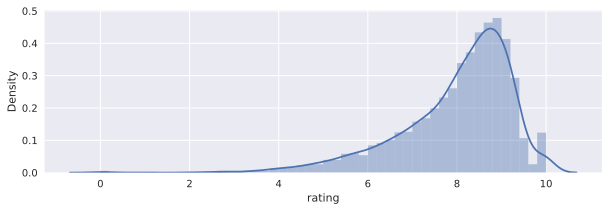

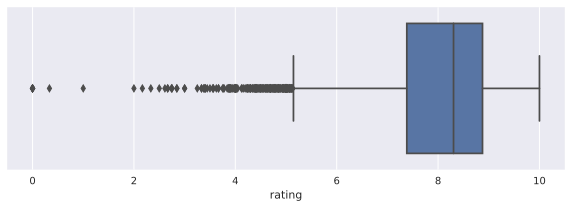

In [45]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['rating'], orient='h')
plt.show()

### Look at 5 movies for demo

* Чикатило ee48def6-c311-4b73-a878-1a5d3d1679a3,
* Манюня 9b202b16-55bf-418a-b01d-9f0329b18790,
* Оффлайн 49a3d528-44c0-408e-b6fc-a1507ce7641a
* Молодой человек 0271c9b5-b7b2-4e3f-96af-b9cefed99397
* Приплыли! 02eaefe0-296d-4e6f-b52f-2e2507d07103

In [46]:
demo_df = df_pr.loc[df_pr['element_uid'].isin(['ee48def6-c311-4b73-a878-1a5d3d1679a3', 
                                    '9b202b16-55bf-418a-b01d-9f0329b18790',
                                    '49a3d528-44c0-408e-b6fc-a1507ce7641a',
                                    '0271c9b5-b7b2-4e3f-96af-b9cefed99397',
                                    '02eaefe0-296d-4e6f-b52f-2e2507d07103'])]

In [47]:
ddf = demo_df.copy()

In [48]:
ddf.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

In [49]:
ddf.T

,6469,6550,9998,10433,10608
age_access_type,16,18,18,6,18
type,MOVIE,MOVIE,SERIAL,SERIAL,SERIAL
duration,15.70258,15.479437,17.723526,16.269958,17.218706
BUDGET,NaN,NaN,NaN,NaN,NaN
MARKETING,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
Адриан Политовски,0,0,0,0,0
Арнон Милчен,0,0,0,0,0
Стэн Ли,0,0,0,0,0
Люк Бессон,0,0,0,0,0


## Split

In [50]:
df_pr.columns

Index(['age_access_type', 'name', 'type', 'release_year', 'duration',
       'element_uid', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',
       'element_id', 'rating', 'Drama', 'Comedy', 'Thriller', 'Action',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
       'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
       'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
       'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
       'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
       'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
       'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
       'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнштейн', 'Боб Вайнштейн',
       'Адриан Политовски', 'Арнон Милче

In [61]:
from sklearn.model_selection import train_test_split

sorted_df = df_pr.sort_values('release_year')

test = sorted_df[sorted_df['release_year'] == 2022]
train = sorted_df[sorted_df['release_year'] != 2022]

# for looking at samples
test_df = test.copy(deep=True)
train_df = train.copy(deep=True)

test.drop(['release_year', 'element_uid', 'name', 'element_id'], axis=1, inplace=True)
train.drop(['release_year', 'element_uid', 'name', 'element_id'], axis=1, inplace=True)

X_test, y_test = test.drop('rating', axis=1), test['rating']
X, y = train.drop('rating', axis=1), train['rating']
X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1, 
                                                  shuffle=False)
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape


((4942, 59), (550, 59), (88, 59), (4942,), (550,), (88,))

In [57]:

ddf.drop(['element_id'], axis=1, inplace=True)

In [62]:
X_train.columns

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'Drama', 'Comedy', 'Thriller', 'Action',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
       'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
       'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
       'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
       'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
       'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
       'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
       'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
       'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнштейн', 'Боб Вайнштейн',
       'Адриан Политовски', 'Арнон Милчен', 'Стэн Ли', 'Люк Бессон',
       'Джек Кёрби'],
      dtype='object

In [63]:
X_train

,age_access_type,type,duration,BUDGET,MARKETING,RUS,USA,WORLD,Drama,Comedy,...,Джим Дено,Дариуш Вольски,Оливер Вуд,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Арнон Милчен,Стэн Ли,Люк Бессон,Джек Кёрби
505,12,MOVIE,15.646491,18.627695,17.511862,NaN,19.376365,19.659465,0,1,...,0,0,0,0,0,0,0,0,0,0
2165,18,MOVIE,15.566448,NaN,NaN,NaN,NaN,NaN,1,0,...,0,0,0,0,0,0,0,0,0,0
105,16,MOVIE,15.597220,17.216708,NaN,NaN,16.877041,16.877041,0,0,...,0,0,0,0,0,0,0,0,0,0
3677,18,MOVIE,15.693448,16.012735,NaN,NaN,17.055947,17.497443,0,0,...,0,0,0,0,0,0,0,0,0,0
3181,16,MOVIE,15.838382,17.766754,17.118728,NaN,18.648575,19.361747,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10399,18,SERIAL,16.764151,NaN,NaN,NaN,NaN,NaN,1,1,...,0,0,0,0,0,0,0,0,0,0
10397,16,SERIAL,16.973362,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
2687,18,MOVIE,15.922081,NaN,NaN,11.473925,NaN,14.595043,1,1,...,0,0,0,0,0,0,0,0,0,0
2660,16,MOVIE,15.693448,17.622173,NaN,15.103216,16.346173,17.500912,1,0,...,0,0,0,0,0,0,0,0,0,0


In [64]:
cat_features = ['age_access_type', 'type']

# Modeling

In [65]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [66]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.065439
0:	learn: 0.9177667	test: 1.1224968	best: 1.1224968 (0)	total: 54.2ms	remaining: 54.1s
100:	learn: 0.6622460	test: 0.8963543	best: 0.8963543 (100)	total: 368ms	remaining: 3.28s
200:	learn: 0.6395912	test: 0.8900745	best: 0.8894286 (182)	total: 673ms	remaining: 2.67s
300:	learn: 0.6232067	test: 0.8876200	best: 0.8867477 (276)	total: 985ms	remaining: 2.29s
400:	learn: 0.6097760	test: 0.8888973	best: 0.8867477 (276)	total: 1.3s	remaining: 1.95s
500:	learn: 0.5979877	test: 0.8895659	best: 0.8867477 (276)	total: 1.66s	remaining: 1.66s
600:	learn: 0.5856590	test: 0.8924168	best: 0.8867477 (276)	total: 2.02s	remaining: 1.34s
700:	learn: 0.5764256	test: 0.8951779	best: 0.8867477 (276)	total: 2.38s	remaining: 1.02s
Stopped by overfitting detector  (500 iterations wait)

bestTest = 0.8867476596
bestIteration = 276

Shrink model to first 277 iterations.


In [67]:
y_pred = cat_model.predict(test_dataset)

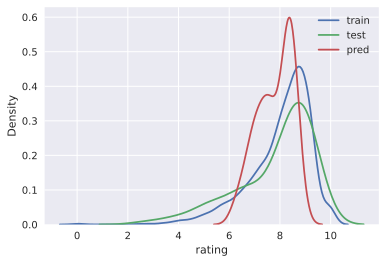

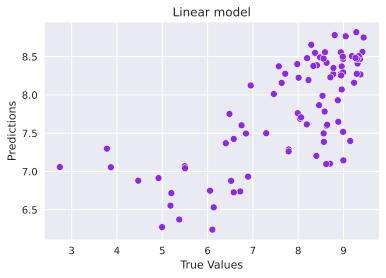

In [68]:
target_distr_linear(y_train, y_test, y_pred)   

In [69]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.2412503510117368
RMSE:  1.114114155287391
R2:    0.45350128245514176
MAE:   0.8371741218245266
MedAE: 0.693257398773885
------------------------------


In [70]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop_3')

**Feature importance**

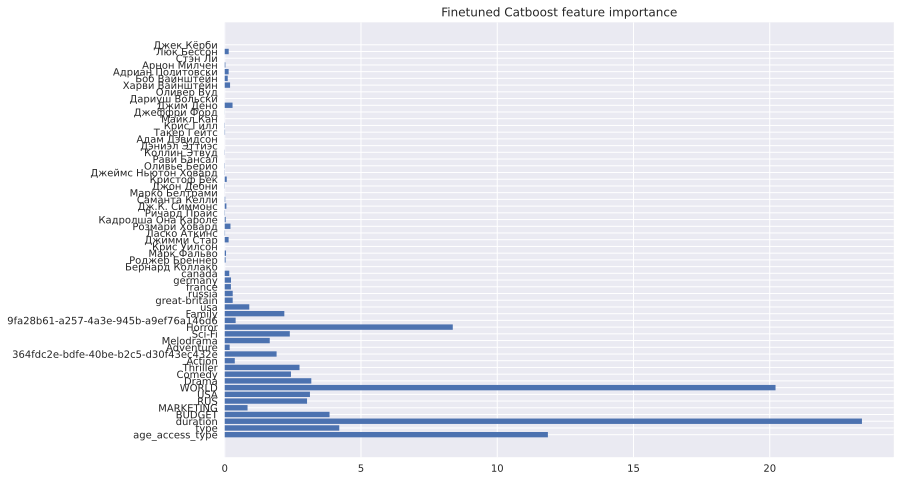

In [71]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

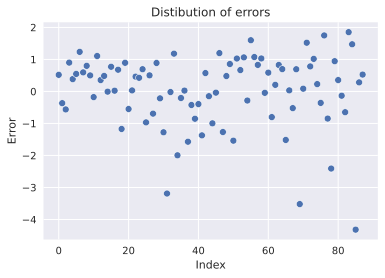

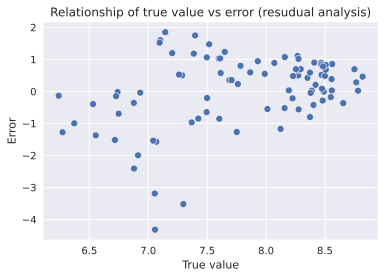

In [72]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

In [73]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Оливер Вуд,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Арнон Милчен,Стэн Ли,Люк Бессон,Джек Кёрби,PREDS,TARGET
10680,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.471155,8.990000
10673,18,Лестница,SERIAL,2022,17.208676,7aebefb1-d42d-4969-8e1d-4b41db339539,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.655401,8.288703
10669,18,ДМЗ,SERIAL,2022,16.422635,35106dfc-9fa3-422c-a894-1784ff1c1944,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.276540,7.714286
10668,18,Джулия,SERIAL,2022,16.868568,18da77c3-92a6-4797-a845-93bda1052295,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.409975,9.310458
10693,18,Дом Дракона,SERIAL,2022,17.015815,62541c49-7a32-45d0-8981-44ee6968d329,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.556300,8.940536
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5651,16,Многоэтажка,MOVIE,2022,15.597220,19a61cc3-65ff-46ce-bf43-29c24a1cc9b6,NaN,NaN,5.793014,NaN,...,0,0,0,0,0,0,0,0,7.144593,8.996094
5612,18,Невидимый убийца,MOVIE,2022,15.684231,0d14e4b4-71ed-4409-9ebb-54a130e913c8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.517246,8.990476
5518,16,Другое имя,MOVIE,2022,15.576811,69021740-65f7-430c-9c00-f2d6d9e9c702,NaN,NaN,10.364072,NaN,...,0,0,0,0,0,0,0,0,7.057460,2.739953
5269,16,RRR: Рядом ревет революция,MOVIE,2022,16.200597,1dbd646f-1c33-4584-b411-efc9da56c702,18.049617,NaN,10.485982,16.446375,...,0,0,0,0,0,0,0,0,8.766319,9.048994


In [74]:
# predict demo dataset

In [75]:
X_demo, y_demo = ddf.drop('rating', axis=1), ddf['rating']

demo_dataset = cat.Pool(data=X_demo, 
                        label=y_demo,
                         cat_features=cat_features)

y_pred_demo = cat_model.predict(demo_dataset)

In [76]:
demo_df['TARGET'] = y_demo.tolist()
demo_df['PREDS'] = y_pred_demo.tolist()
demo_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Оливер Вуд,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Арнон Милчен,Стэн Ли,Люк Бессон,Джек Кёрби,TARGET,PREDS
6469,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.147352,7.398115
6550,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,0,6.519242,6.877495
9998,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.717041,8.749734
10433,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.192744,8.642376
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.362527,8.468094


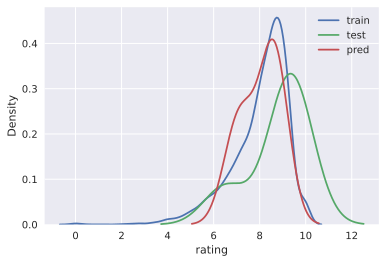

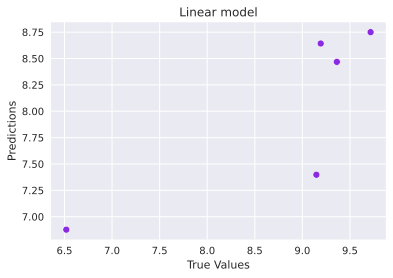

In [77]:
target_distr_linear(y_train, y_demo, y_pred_demo)   

# Tuning

In [78]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [79]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop_3', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 0.9645580	total: 13.7ms	remaining: 2m 16s
1:	learn: 0.9521502	total: 18.8ms	remaining: 1m 34s
2:	learn: 0.9401162	total: 23.8ms	remaining: 1m 19s
3:	learn: 0.9288396	total: 28.1ms	remaining: 1m 10s
4:	learn: 0.9191209	total: 32.4ms	remaining: 1m 4s
5:	learn: 0.9092185	total: 35.6ms	remaining: 59.2s
6:	learn: 0.8989171	total: 39.9ms	remaining: 57s
7:	learn: 0.8900037	total: 43.7ms	remaining: 54.6s
8:	learn: 0.8817866	total: 47.5ms	remaining: 52.7s
9:	learn: 0.8733332	total: 51.2ms	remaining: 51.1s
10:	learn: 0.8652145	total: 55ms	remaining: 49.9s
11:	learn: 0.8586741	total: 57.8ms	remaining: 48.1s
12:	learn: 0.8518907	total: 61.3ms	remaining: 47.1s
13:	learn: 0.8455427	total: 63.4ms	remaining: 45.2s
14:	learn: 0.8388274	total: 66.5ms	remaining: 44.3s
15:	learn: 0.8323082	total: 71.1ms	remaining: 44.4s
16:	learn: 0.8261070	total: 74.8ms	remaining: 43.9s
17:	learn: 0.8197942	total: 79.1ms	remaining: 43.9s
18:	learn: 0.

160:	learn: 0.6748692	total: 565ms	remaining: 34.6s
161:	learn: 0.6746577	total: 569ms	remaining: 34.5s
162:	learn: 0.6743634	total: 572ms	remaining: 34.5s
163:	learn: 0.6743618	total: 573ms	remaining: 34.4s
164:	learn: 0.6741176	total: 577ms	remaining: 34.4s
165:	learn: 0.6739497	total: 579ms	remaining: 34.3s
166:	learn: 0.6736681	total: 583ms	remaining: 34.3s
167:	learn: 0.6734881	total: 586ms	remaining: 34.3s
168:	learn: 0.6732096	total: 590ms	remaining: 34.3s
169:	learn: 0.6728864	total: 594ms	remaining: 34.4s
170:	learn: 0.6726969	total: 598ms	remaining: 34.4s
171:	learn: 0.6722677	total: 602ms	remaining: 34.4s
172:	learn: 0.6721439	total: 606ms	remaining: 34.4s
173:	learn: 0.6720645	total: 609ms	remaining: 34.4s
174:	learn: 0.6717408	total: 613ms	remaining: 34.4s
175:	learn: 0.6715133	total: 617ms	remaining: 34.4s
176:	learn: 0.6713964	total: 620ms	remaining: 34.4s
177:	learn: 0.6712829	total: 623ms	remaining: 34.4s
178:	learn: 0.6711121	total: 627ms	remaining: 34.4s
179:	learn: 

337:	learn: 0.6437773	total: 1.16s	remaining: 33.3s
338:	learn: 0.6437184	total: 1.17s	remaining: 33.3s
339:	learn: 0.6432541	total: 1.17s	remaining: 33.3s
340:	learn: 0.6430218	total: 1.18s	remaining: 33.3s
341:	learn: 0.6428253	total: 1.18s	remaining: 33.3s
342:	learn: 0.6427426	total: 1.18s	remaining: 33.3s
343:	learn: 0.6426531	total: 1.19s	remaining: 33.3s
344:	learn: 0.6424215	total: 1.19s	remaining: 33.3s
345:	learn: 0.6423072	total: 1.19s	remaining: 33.3s
346:	learn: 0.6421760	total: 1.2s	remaining: 33.3s
347:	learn: 0.6421679	total: 1.2s	remaining: 33.3s
348:	learn: 0.6420615	total: 1.2s	remaining: 33.3s
349:	learn: 0.6419382	total: 1.21s	remaining: 33.3s
350:	learn: 0.6418791	total: 1.21s	remaining: 33.2s
351:	learn: 0.6416807	total: 1.21s	remaining: 33.3s
352:	learn: 0.6415676	total: 1.22s	remaining: 33.3s
353:	learn: 0.6414457	total: 1.22s	remaining: 33.3s
354:	learn: 0.6413642	total: 1.22s	remaining: 33.2s
355:	learn: 0.6412496	total: 1.23s	remaining: 33.2s
356:	learn: 0.6

501:	learn: 0.6186749	total: 1.77s	remaining: 33.5s
502:	learn: 0.6185709	total: 1.77s	remaining: 33.5s
503:	learn: 0.6184846	total: 1.78s	remaining: 33.5s
504:	learn: 0.6184134	total: 1.78s	remaining: 33.5s
505:	learn: 0.6184019	total: 1.78s	remaining: 33.4s
506:	learn: 0.6182924	total: 1.79s	remaining: 33.5s
507:	learn: 0.6179789	total: 1.79s	remaining: 33.5s
508:	learn: 0.6179129	total: 1.79s	remaining: 33.5s
509:	learn: 0.6177960	total: 1.8s	remaining: 33.5s
510:	learn: 0.6176341	total: 1.8s	remaining: 33.5s
511:	learn: 0.6175935	total: 1.81s	remaining: 33.5s
512:	learn: 0.6175375	total: 1.81s	remaining: 33.5s
513:	learn: 0.6173304	total: 1.81s	remaining: 33.5s
514:	learn: 0.6171693	total: 1.81s	remaining: 33.4s
515:	learn: 0.6170400	total: 1.82s	remaining: 33.5s
516:	learn: 0.6167932	total: 1.82s	remaining: 33.5s
517:	learn: 0.6167377	total: 1.83s	remaining: 33.4s
518:	learn: 0.6166966	total: 1.83s	remaining: 33.4s
519:	learn: 0.6165495	total: 1.83s	remaining: 33.5s
520:	learn: 0.

662:	learn: 0.5963537	total: 2.38s	remaining: 33.5s
663:	learn: 0.5963293	total: 2.38s	remaining: 33.5s
664:	learn: 0.5961927	total: 2.38s	remaining: 33.5s
665:	learn: 0.5960947	total: 2.39s	remaining: 33.5s
666:	learn: 0.5959856	total: 2.39s	remaining: 33.5s
667:	learn: 0.5958863	total: 2.4s	remaining: 33.5s
668:	learn: 0.5958299	total: 2.4s	remaining: 33.5s
669:	learn: 0.5956023	total: 2.4s	remaining: 33.5s
670:	learn: 0.5955652	total: 2.41s	remaining: 33.5s
671:	learn: 0.5955184	total: 2.41s	remaining: 33.5s
672:	learn: 0.5954918	total: 2.41s	remaining: 33.5s
673:	learn: 0.5953786	total: 2.42s	remaining: 33.5s
674:	learn: 0.5952269	total: 2.42s	remaining: 33.4s
675:	learn: 0.5950158	total: 2.42s	remaining: 33.4s
676:	learn: 0.5948145	total: 2.43s	remaining: 33.5s
677:	learn: 0.5946391	total: 2.43s	remaining: 33.5s
678:	learn: 0.5945921	total: 2.44s	remaining: 33.4s
679:	learn: 0.5945226	total: 2.44s	remaining: 33.4s
680:	learn: 0.5942152	total: 2.44s	remaining: 33.5s
681:	learn: 0.5

821:	learn: 0.5778489	total: 2.98s	remaining: 33.3s
822:	learn: 0.5777445	total: 2.98s	remaining: 33.3s
823:	learn: 0.5776372	total: 2.99s	remaining: 33.3s
824:	learn: 0.5774022	total: 2.99s	remaining: 33.3s
825:	learn: 0.5772828	total: 3s	remaining: 33.3s
826:	learn: 0.5771712	total: 3s	remaining: 33.3s
827:	learn: 0.5770250	total: 3s	remaining: 33.3s
828:	learn: 0.5769524	total: 3.01s	remaining: 33.3s
829:	learn: 0.5769034	total: 3.01s	remaining: 33.3s
830:	learn: 0.5768023	total: 3.02s	remaining: 33.3s
831:	learn: 0.5767050	total: 3.02s	remaining: 33.3s
832:	learn: 0.5766706	total: 3.02s	remaining: 33.3s
833:	learn: 0.5765536	total: 3.03s	remaining: 33.3s
834:	learn: 0.5764381	total: 3.03s	remaining: 33.3s
835:	learn: 0.5762591	total: 3.04s	remaining: 33.3s
836:	learn: 0.5759931	total: 3.04s	remaining: 33.3s
837:	learn: 0.5759730	total: 3.04s	remaining: 33.3s
838:	learn: 0.5758923	total: 3.05s	remaining: 33.3s
839:	learn: 0.5757441	total: 3.05s	remaining: 33.3s
840:	learn: 0.5755932

1031:	learn: 0.5565115	total: 3.78s	remaining: 32.9s
1032:	learn: 0.5563615	total: 3.79s	remaining: 32.9s
1033:	learn: 0.5562812	total: 3.79s	remaining: 32.9s
1034:	learn: 0.5561948	total: 3.79s	remaining: 32.9s
1035:	learn: 0.5560959	total: 3.8s	remaining: 32.9s
1036:	learn: 0.5560083	total: 3.8s	remaining: 32.9s
1037:	learn: 0.5559915	total: 3.81s	remaining: 32.9s
1038:	learn: 0.5558970	total: 3.81s	remaining: 32.9s
1039:	learn: 0.5557425	total: 3.81s	remaining: 32.9s
1040:	learn: 0.5556630	total: 3.82s	remaining: 32.9s
1041:	learn: 0.5556535	total: 3.82s	remaining: 32.8s
1042:	learn: 0.5555892	total: 3.82s	remaining: 32.8s
1043:	learn: 0.5555320	total: 3.83s	remaining: 32.8s
1044:	learn: 0.5554107	total: 3.83s	remaining: 32.8s
1045:	learn: 0.5551744	total: 3.84s	remaining: 32.8s
1046:	learn: 0.5550062	total: 3.84s	remaining: 32.8s
1047:	learn: 0.5549100	total: 3.84s	remaining: 32.8s
1048:	learn: 0.5548558	total: 3.85s	remaining: 32.8s
1049:	learn: 0.5548432	total: 3.85s	remaining: 3

1187:	learn: 0.5420463	total: 4.38s	remaining: 32.5s
1188:	learn: 0.5419847	total: 4.39s	remaining: 32.5s
1189:	learn: 0.5418743	total: 4.39s	remaining: 32.5s
1190:	learn: 0.5417223	total: 4.39s	remaining: 32.5s
1191:	learn: 0.5416525	total: 4.4s	remaining: 32.5s
1192:	learn: 0.5415969	total: 4.4s	remaining: 32.5s
1193:	learn: 0.5415148	total: 4.41s	remaining: 32.5s
1194:	learn: 0.5414766	total: 4.41s	remaining: 32.5s
1195:	learn: 0.5413661	total: 4.42s	remaining: 32.5s
1196:	learn: 0.5411947	total: 4.42s	remaining: 32.5s
1197:	learn: 0.5410159	total: 4.42s	remaining: 32.5s
1198:	learn: 0.5408469	total: 4.43s	remaining: 32.5s
1199:	learn: 0.5408292	total: 4.43s	remaining: 32.5s
1200:	learn: 0.5407259	total: 4.43s	remaining: 32.5s
1201:	learn: 0.5406878	total: 4.44s	remaining: 32.5s
1202:	learn: 0.5406242	total: 4.44s	remaining: 32.5s
1203:	learn: 0.5406242	total: 4.45s	remaining: 32.5s
1204:	learn: 0.5405596	total: 4.45s	remaining: 32.5s
1205:	learn: 0.5403385	total: 4.46s	remaining: 3

1342:	learn: 0.5285538	total: 4.99s	remaining: 32.2s
1343:	learn: 0.5285110	total: 5s	remaining: 32.2s
1344:	learn: 0.5283418	total: 5s	remaining: 32.2s
1345:	learn: 0.5282855	total: 5s	remaining: 32.2s
1346:	learn: 0.5281602	total: 5.01s	remaining: 32.2s
1347:	learn: 0.5280342	total: 5.01s	remaining: 32.2s
1348:	learn: 0.5277991	total: 5.01s	remaining: 32.2s
1349:	learn: 0.5277084	total: 5.02s	remaining: 32.2s
1350:	learn: 0.5276476	total: 5.02s	remaining: 32.2s
1351:	learn: 0.5275267	total: 5.03s	remaining: 32.2s
1352:	learn: 0.5275056	total: 5.03s	remaining: 32.2s
1353:	learn: 0.5274908	total: 5.04s	remaining: 32.2s
1354:	learn: 0.5274022	total: 5.04s	remaining: 32.1s
1355:	learn: 0.5273951	total: 5.04s	remaining: 32.1s
1356:	learn: 0.5273033	total: 5.05s	remaining: 32.1s
1357:	learn: 0.5272251	total: 5.05s	remaining: 32.1s
1358:	learn: 0.5272009	total: 5.05s	remaining: 32.1s
1359:	learn: 0.5271557	total: 5.06s	remaining: 32.1s
1360:	learn: 0.5270627	total: 5.06s	remaining: 32.1s
13

1546:	learn: 0.5115858	total: 5.8s	remaining: 31.7s
1547:	learn: 0.5115379	total: 5.8s	remaining: 31.7s
1548:	learn: 0.5115020	total: 5.81s	remaining: 31.7s
1549:	learn: 0.5114693	total: 5.81s	remaining: 31.7s
1550:	learn: 0.5112915	total: 5.82s	remaining: 31.7s
1551:	learn: 0.5112493	total: 5.82s	remaining: 31.7s
1552:	learn: 0.5111319	total: 5.82s	remaining: 31.7s
1553:	learn: 0.5110899	total: 5.83s	remaining: 31.7s
1554:	learn: 0.5110120	total: 5.83s	remaining: 31.7s
1555:	learn: 0.5109691	total: 5.83s	remaining: 31.7s
1556:	learn: 0.5109394	total: 5.84s	remaining: 31.7s
1557:	learn: 0.5108560	total: 5.84s	remaining: 31.7s
1558:	learn: 0.5107883	total: 5.85s	remaining: 31.7s
1559:	learn: 0.5106972	total: 5.85s	remaining: 31.7s
1560:	learn: 0.5106431	total: 5.85s	remaining: 31.6s
1561:	learn: 0.5105359	total: 5.86s	remaining: 31.6s
1562:	learn: 0.5104286	total: 5.86s	remaining: 31.6s
1563:	learn: 0.5103269	total: 5.86s	remaining: 31.6s
1564:	learn: 0.5101829	total: 5.87s	remaining: 3

1749:	learn: 0.4971601	total: 6.6s	remaining: 31.1s
1750:	learn: 0.4971214	total: 6.61s	remaining: 31.1s
1751:	learn: 0.4969616	total: 6.61s	remaining: 31.1s
1752:	learn: 0.4969490	total: 6.61s	remaining: 31.1s
1753:	learn: 0.4968287	total: 6.62s	remaining: 31.1s
1754:	learn: 0.4967556	total: 6.62s	remaining: 31.1s
1755:	learn: 0.4966687	total: 6.63s	remaining: 31.1s
1756:	learn: 0.4965041	total: 6.63s	remaining: 31.1s
1757:	learn: 0.4964466	total: 6.63s	remaining: 31.1s
1758:	learn: 0.4964463	total: 6.63s	remaining: 31.1s
1759:	learn: 0.4963620	total: 6.64s	remaining: 31.1s
1760:	learn: 0.4962213	total: 6.64s	remaining: 31.1s
1761:	learn: 0.4961314	total: 6.65s	remaining: 31.1s
1762:	learn: 0.4961134	total: 6.65s	remaining: 31.1s
1763:	learn: 0.4960684	total: 6.65s	remaining: 31.1s
1764:	learn: 0.4958288	total: 6.66s	remaining: 31.1s
1765:	learn: 0.4957067	total: 6.66s	remaining: 31.1s
1766:	learn: 0.4956030	total: 6.67s	remaining: 31.1s
1767:	learn: 0.4952823	total: 6.67s	remaining: 

1950:	learn: 0.4831491	total: 7.41s	remaining: 30.6s
1951:	learn: 0.4830986	total: 7.41s	remaining: 30.6s
1952:	learn: 0.4829669	total: 7.42s	remaining: 30.6s
1953:	learn: 0.4828473	total: 7.42s	remaining: 30.6s
1954:	learn: 0.4826739	total: 7.42s	remaining: 30.6s
1955:	learn: 0.4826043	total: 7.43s	remaining: 30.6s
1956:	learn: 0.4825956	total: 7.43s	remaining: 30.6s
1957:	learn: 0.4825144	total: 7.44s	remaining: 30.5s
1958:	learn: 0.4824923	total: 7.44s	remaining: 30.5s
1959:	learn: 0.4823601	total: 7.44s	remaining: 30.5s
1960:	learn: 0.4823370	total: 7.45s	remaining: 30.5s
1961:	learn: 0.4823096	total: 7.45s	remaining: 30.5s
1962:	learn: 0.4822775	total: 7.46s	remaining: 30.5s
1963:	learn: 0.4821624	total: 7.46s	remaining: 30.5s
1964:	learn: 0.4820808	total: 7.46s	remaining: 30.5s
1965:	learn: 0.4819939	total: 7.47s	remaining: 30.5s
1966:	learn: 0.4818693	total: 7.47s	remaining: 30.5s
1967:	learn: 0.4818091	total: 7.47s	remaining: 30.5s
1968:	learn: 0.4817759	total: 7.48s	remaining:

2154:	learn: 0.4692741	total: 8.21s	remaining: 29.9s
2155:	learn: 0.4692547	total: 8.22s	remaining: 29.9s
2156:	learn: 0.4692049	total: 8.22s	remaining: 29.9s
2157:	learn: 0.4690936	total: 8.23s	remaining: 29.9s
2158:	learn: 0.4689620	total: 8.23s	remaining: 29.9s
2159:	learn: 0.4689252	total: 8.23s	remaining: 29.9s
2160:	learn: 0.4688875	total: 8.24s	remaining: 29.9s
2161:	learn: 0.4688142	total: 8.24s	remaining: 29.9s
2162:	learn: 0.4688050	total: 8.25s	remaining: 29.9s
2163:	learn: 0.4687508	total: 8.25s	remaining: 29.9s
2164:	learn: 0.4687148	total: 8.26s	remaining: 29.9s
2165:	learn: 0.4686626	total: 8.26s	remaining: 29.9s
2166:	learn: 0.4686468	total: 8.26s	remaining: 29.9s
2167:	learn: 0.4685659	total: 8.27s	remaining: 29.9s
2168:	learn: 0.4684441	total: 8.27s	remaining: 29.9s
2169:	learn: 0.4683916	total: 8.28s	remaining: 29.9s
2170:	learn: 0.4683633	total: 8.28s	remaining: 29.9s
2171:	learn: 0.4682903	total: 8.28s	remaining: 29.9s
2172:	learn: 0.4681241	total: 8.29s	remaining:

2358:	learn: 0.4574893	total: 9.02s	remaining: 29.2s
2359:	learn: 0.4574689	total: 9.02s	remaining: 29.2s
2360:	learn: 0.4574268	total: 9.03s	remaining: 29.2s
2361:	learn: 0.4573825	total: 9.03s	remaining: 29.2s
2362:	learn: 0.4573351	total: 9.03s	remaining: 29.2s
2363:	learn: 0.4572559	total: 9.04s	remaining: 29.2s
2364:	learn: 0.4572026	total: 9.04s	remaining: 29.2s
2365:	learn: 0.4571245	total: 9.04s	remaining: 29.2s
2366:	learn: 0.4571093	total: 9.05s	remaining: 29.2s
2367:	learn: 0.4570142	total: 9.05s	remaining: 29.2s
2368:	learn: 0.4569725	total: 9.05s	remaining: 29.2s
2369:	learn: 0.4569622	total: 9.06s	remaining: 29.2s
2370:	learn: 0.4568475	total: 9.06s	remaining: 29.2s
2371:	learn: 0.4568145	total: 9.07s	remaining: 29.2s
2372:	learn: 0.4567512	total: 9.07s	remaining: 29.2s
2373:	learn: 0.4567228	total: 9.07s	remaining: 29.1s
2374:	learn: 0.4566091	total: 9.08s	remaining: 29.1s
2375:	learn: 0.4565582	total: 9.08s	remaining: 29.1s
2376:	learn: 0.4564667	total: 9.09s	remaining:

2561:	learn: 0.4450470	total: 9.82s	remaining: 28.5s
2562:	learn: 0.4449722	total: 9.83s	remaining: 28.5s
2563:	learn: 0.4449036	total: 9.83s	remaining: 28.5s
2564:	learn: 0.4448840	total: 9.83s	remaining: 28.5s
2565:	learn: 0.4447779	total: 9.84s	remaining: 28.5s
2566:	learn: 0.4447004	total: 9.84s	remaining: 28.5s
2567:	learn: 0.4446294	total: 9.85s	remaining: 28.5s
2568:	learn: 0.4446111	total: 9.85s	remaining: 28.5s
2569:	learn: 0.4445726	total: 9.85s	remaining: 28.5s
2570:	learn: 0.4445626	total: 9.86s	remaining: 28.5s
2571:	learn: 0.4442905	total: 9.86s	remaining: 28.5s
2572:	learn: 0.4441898	total: 9.87s	remaining: 28.5s
2573:	learn: 0.4440259	total: 9.87s	remaining: 28.5s
2574:	learn: 0.4439504	total: 9.87s	remaining: 28.5s
2575:	learn: 0.4438977	total: 9.88s	remaining: 28.5s
2576:	learn: 0.4438622	total: 9.88s	remaining: 28.5s
2577:	learn: 0.4438182	total: 9.88s	remaining: 28.5s
2578:	learn: 0.4436904	total: 9.89s	remaining: 28.5s
2579:	learn: 0.4436472	total: 9.89s	remaining:

2765:	learn: 0.4335659	total: 10.6s	remaining: 27.8s
2766:	learn: 0.4335335	total: 10.6s	remaining: 27.8s
2767:	learn: 0.4335229	total: 10.6s	remaining: 27.8s
2768:	learn: 0.4334415	total: 10.6s	remaining: 27.8s
2769:	learn: 0.4333812	total: 10.6s	remaining: 27.8s
2770:	learn: 0.4333647	total: 10.6s	remaining: 27.8s
2771:	learn: 0.4333207	total: 10.6s	remaining: 27.7s
2772:	learn: 0.4333113	total: 10.6s	remaining: 27.7s
2773:	learn: 0.4331687	total: 10.7s	remaining: 27.7s
2774:	learn: 0.4330611	total: 10.7s	remaining: 27.7s
2775:	learn: 0.4329885	total: 10.7s	remaining: 27.7s
2776:	learn: 0.4329586	total: 10.7s	remaining: 27.7s
2777:	learn: 0.4329451	total: 10.7s	remaining: 27.7s
2778:	learn: 0.4329195	total: 10.7s	remaining: 27.7s
2779:	learn: 0.4328534	total: 10.7s	remaining: 27.7s
2780:	learn: 0.4328304	total: 10.7s	remaining: 27.7s
2781:	learn: 0.4328232	total: 10.7s	remaining: 27.7s
2782:	learn: 0.4327704	total: 10.7s	remaining: 27.7s
2783:	learn: 0.4326945	total: 10.7s	remaining:

2965:	learn: 0.4226437	total: 11.4s	remaining: 27.1s
2966:	learn: 0.4225063	total: 11.4s	remaining: 27.1s
2967:	learn: 0.4224862	total: 11.4s	remaining: 27.1s
2968:	learn: 0.4224287	total: 11.4s	remaining: 27.1s
2969:	learn: 0.4223252	total: 11.4s	remaining: 27.1s
2970:	learn: 0.4222896	total: 11.4s	remaining: 27.1s
2971:	learn: 0.4222146	total: 11.4s	remaining: 27.1s
2972:	learn: 0.4221906	total: 11.5s	remaining: 27.1s
2973:	learn: 0.4221323	total: 11.5s	remaining: 27.1s
2974:	learn: 0.4221304	total: 11.5s	remaining: 27.1s
2975:	learn: 0.4221183	total: 11.5s	remaining: 27.1s
2976:	learn: 0.4220894	total: 11.5s	remaining: 27.1s
2977:	learn: 0.4220168	total: 11.5s	remaining: 27.1s
2978:	learn: 0.4219593	total: 11.5s	remaining: 27.1s
2979:	learn: 0.4219294	total: 11.5s	remaining: 27.1s
2980:	learn: 0.4219235	total: 11.5s	remaining: 27s
2981:	learn: 0.4218005	total: 11.5s	remaining: 27s
2982:	learn: 0.4217679	total: 11.5s	remaining: 27s
2983:	learn: 0.4216770	total: 11.5s	remaining: 27s
2

3164:	learn: 0.4126480	total: 12.2s	remaining: 26.4s
3165:	learn: 0.4125757	total: 12.2s	remaining: 26.4s
3166:	learn: 0.4125608	total: 12.2s	remaining: 26.4s
3167:	learn: 0.4125278	total: 12.2s	remaining: 26.4s
3168:	learn: 0.4124877	total: 12.2s	remaining: 26.4s
3169:	learn: 0.4124274	total: 12.2s	remaining: 26.4s
3170:	learn: 0.4123332	total: 12.3s	remaining: 26.4s
3171:	learn: 0.4123247	total: 12.3s	remaining: 26.4s
3172:	learn: 0.4122872	total: 12.3s	remaining: 26.4s
3173:	learn: 0.4122740	total: 12.3s	remaining: 26.4s
3174:	learn: 0.4122300	total: 12.3s	remaining: 26.4s
3175:	learn: 0.4122073	total: 12.3s	remaining: 26.4s
3176:	learn: 0.4121054	total: 12.3s	remaining: 26.4s
3177:	learn: 0.4120978	total: 12.3s	remaining: 26.4s
3178:	learn: 0.4120778	total: 12.3s	remaining: 26.4s
3179:	learn: 0.4120545	total: 12.3s	remaining: 26.4s
3180:	learn: 0.4120302	total: 12.3s	remaining: 26.3s
3181:	learn: 0.4120087	total: 12.3s	remaining: 26.3s
3182:	learn: 0.4119782	total: 12.3s	remaining:

3364:	learn: 0.4034371	total: 13s	remaining: 25.7s
3365:	learn: 0.4033898	total: 13s	remaining: 25.7s
3366:	learn: 0.4033498	total: 13s	remaining: 25.7s
3367:	learn: 0.4032993	total: 13s	remaining: 25.7s
3368:	learn: 0.4032636	total: 13s	remaining: 25.7s
3369:	learn: 0.4031496	total: 13.1s	remaining: 25.7s
3370:	learn: 0.4030689	total: 13.1s	remaining: 25.7s
3371:	learn: 0.4030668	total: 13.1s	remaining: 25.7s
3372:	learn: 0.4030209	total: 13.1s	remaining: 25.7s
3373:	learn: 0.4029323	total: 13.1s	remaining: 25.7s
3374:	learn: 0.4029303	total: 13.1s	remaining: 25.7s
3375:	learn: 0.4028697	total: 13.1s	remaining: 25.7s
3376:	learn: 0.4028169	total: 13.1s	remaining: 25.7s
3377:	learn: 0.4027903	total: 13.1s	remaining: 25.6s
3378:	learn: 0.4027359	total: 13.1s	remaining: 25.6s
3379:	learn: 0.4026631	total: 13.1s	remaining: 25.6s
3380:	learn: 0.4026350	total: 13.1s	remaining: 25.6s
3381:	learn: 0.4025634	total: 13.1s	remaining: 25.6s
3382:	learn: 0.4025149	total: 13.1s	remaining: 25.6s
338

3559:	learn: 0.3930901	total: 13.8s	remaining: 25s
3560:	learn: 0.3930643	total: 13.8s	remaining: 25s
3561:	learn: 0.3930387	total: 13.8s	remaining: 25s
3562:	learn: 0.3930185	total: 13.8s	remaining: 25s
3563:	learn: 0.3930003	total: 13.9s	remaining: 25s
3564:	learn: 0.3929756	total: 13.9s	remaining: 25s
3565:	learn: 0.3929588	total: 13.9s	remaining: 25s
3566:	learn: 0.3929546	total: 13.9s	remaining: 25s
3567:	learn: 0.3929512	total: 13.9s	remaining: 25s
3568:	learn: 0.3928874	total: 13.9s	remaining: 25s
3569:	learn: 0.3928570	total: 13.9s	remaining: 25s
3570:	learn: 0.3928429	total: 13.9s	remaining: 25s
3571:	learn: 0.3927846	total: 13.9s	remaining: 25s
3572:	learn: 0.3927587	total: 13.9s	remaining: 25s
3573:	learn: 0.3926943	total: 13.9s	remaining: 25s
3574:	learn: 0.3926030	total: 13.9s	remaining: 25s
3575:	learn: 0.3925807	total: 13.9s	remaining: 25s
3576:	learn: 0.3925228	total: 13.9s	remaining: 25s
3577:	learn: 0.3925033	total: 13.9s	remaining: 25s
3578:	learn: 0.3924703	total: 1

3764:	learn: 0.3845287	total: 14.6s	remaining: 24.3s
3765:	learn: 0.3844929	total: 14.6s	remaining: 24.2s
3766:	learn: 0.3844848	total: 14.7s	remaining: 24.2s
3767:	learn: 0.3843049	total: 14.7s	remaining: 24.2s
3768:	learn: 0.3842743	total: 14.7s	remaining: 24.2s
3769:	learn: 0.3842473	total: 14.7s	remaining: 24.2s
3770:	learn: 0.3842180	total: 14.7s	remaining: 24.2s
3771:	learn: 0.3841610	total: 14.7s	remaining: 24.2s
3772:	learn: 0.3840749	total: 14.7s	remaining: 24.2s
3773:	learn: 0.3840615	total: 14.7s	remaining: 24.2s
3774:	learn: 0.3840489	total: 14.7s	remaining: 24.2s
3775:	learn: 0.3840465	total: 14.7s	remaining: 24.2s
3776:	learn: 0.3840276	total: 14.7s	remaining: 24.2s
3777:	learn: 0.3840071	total: 14.7s	remaining: 24.2s
3778:	learn: 0.3839483	total: 14.7s	remaining: 24.2s
3779:	learn: 0.3839105	total: 14.7s	remaining: 24.2s
3780:	learn: 0.3838703	total: 14.7s	remaining: 24.2s
3781:	learn: 0.3837932	total: 14.7s	remaining: 24.2s
3782:	learn: 0.3836628	total: 14.7s	remaining:

3964:	learn: 0.3755631	total: 15.4s	remaining: 23.5s
3965:	learn: 0.3755004	total: 15.4s	remaining: 23.5s
3966:	learn: 0.3754552	total: 15.5s	remaining: 23.5s
3967:	learn: 0.3753374	total: 15.5s	remaining: 23.5s
3968:	learn: 0.3752881	total: 15.5s	remaining: 23.5s
3969:	learn: 0.3752594	total: 15.5s	remaining: 23.5s
3970:	learn: 0.3752244	total: 15.5s	remaining: 23.5s
3971:	learn: 0.3752055	total: 15.5s	remaining: 23.5s
3972:	learn: 0.3751771	total: 15.5s	remaining: 23.5s
3973:	learn: 0.3751105	total: 15.5s	remaining: 23.5s
3974:	learn: 0.3750661	total: 15.5s	remaining: 23.5s
3975:	learn: 0.3750555	total: 15.5s	remaining: 23.5s
3976:	learn: 0.3750179	total: 15.5s	remaining: 23.5s
3977:	learn: 0.3749546	total: 15.5s	remaining: 23.5s
3978:	learn: 0.3749465	total: 15.5s	remaining: 23.5s
3979:	learn: 0.3749410	total: 15.5s	remaining: 23.4s
3980:	learn: 0.3749246	total: 15.5s	remaining: 23.4s
3981:	learn: 0.3749088	total: 15.5s	remaining: 23.4s
3982:	learn: 0.3748711	total: 15.5s	remaining:

4164:	learn: 0.3676064	total: 16.3s	remaining: 22.8s
4165:	learn: 0.3675907	total: 16.3s	remaining: 22.8s
4166:	learn: 0.3675361	total: 16.3s	remaining: 22.8s
4167:	learn: 0.3674226	total: 16.3s	remaining: 22.8s
4168:	learn: 0.3672879	total: 16.3s	remaining: 22.8s
4169:	learn: 0.3672591	total: 16.3s	remaining: 22.8s
4170:	learn: 0.3672099	total: 16.3s	remaining: 22.7s
4171:	learn: 0.3671879	total: 16.3s	remaining: 22.7s
4172:	learn: 0.3671287	total: 16.3s	remaining: 22.7s
4173:	learn: 0.3670755	total: 16.3s	remaining: 22.7s
4174:	learn: 0.3670374	total: 16.3s	remaining: 22.7s
4175:	learn: 0.3670198	total: 16.3s	remaining: 22.7s
4176:	learn: 0.3670135	total: 16.3s	remaining: 22.7s
4177:	learn: 0.3669804	total: 16.3s	remaining: 22.7s
4178:	learn: 0.3669119	total: 16.3s	remaining: 22.7s
4179:	learn: 0.3668660	total: 16.3s	remaining: 22.7s
4180:	learn: 0.3668407	total: 16.3s	remaining: 22.7s
4181:	learn: 0.3668104	total: 16.3s	remaining: 22.7s
4182:	learn: 0.3667427	total: 16.3s	remaining:

4367:	learn: 0.3598431	total: 17.1s	remaining: 22s
4368:	learn: 0.3598218	total: 17.1s	remaining: 22s
4369:	learn: 0.3598051	total: 17.1s	remaining: 22s
4370:	learn: 0.3597402	total: 17.1s	remaining: 22s
4371:	learn: 0.3597171	total: 17.1s	remaining: 22s
4372:	learn: 0.3597067	total: 17.1s	remaining: 22s
4373:	learn: 0.3596715	total: 17.1s	remaining: 22s
4374:	learn: 0.3595630	total: 17.1s	remaining: 22s
4375:	learn: 0.3595102	total: 17.1s	remaining: 22s
4376:	learn: 0.3594372	total: 17.1s	remaining: 22s
4377:	learn: 0.3594260	total: 17.1s	remaining: 22s
4378:	learn: 0.3593983	total: 17.1s	remaining: 22s
4379:	learn: 0.3593440	total: 17.1s	remaining: 21.9s
4380:	learn: 0.3592780	total: 17.1s	remaining: 21.9s
4381:	learn: 0.3591803	total: 17.1s	remaining: 21.9s
4382:	learn: 0.3591810	total: 17.1s	remaining: 21.9s
4383:	learn: 0.3591012	total: 17.1s	remaining: 21.9s
4384:	learn: 0.3590591	total: 17.1s	remaining: 21.9s
4385:	learn: 0.3590120	total: 17.1s	remaining: 21.9s
4386:	learn: 0.35

4572:	learn: 0.3516959	total: 17.9s	remaining: 21.2s
4573:	learn: 0.3516043	total: 17.9s	remaining: 21.2s
4574:	learn: 0.3515731	total: 17.9s	remaining: 21.2s
4575:	learn: 0.3515238	total: 17.9s	remaining: 21.2s
4576:	learn: 0.3515118	total: 17.9s	remaining: 21.2s
4577:	learn: 0.3515022	total: 17.9s	remaining: 21.2s
4578:	learn: 0.3514907	total: 17.9s	remaining: 21.2s
4579:	learn: 0.3514816	total: 17.9s	remaining: 21.2s
4580:	learn: 0.3514637	total: 17.9s	remaining: 21.2s
4581:	learn: 0.3514337	total: 17.9s	remaining: 21.2s
4582:	learn: 0.3513733	total: 17.9s	remaining: 21.2s
4583:	learn: 0.3513629	total: 17.9s	remaining: 21.2s
4584:	learn: 0.3513546	total: 17.9s	remaining: 21.2s
4585:	learn: 0.3513282	total: 17.9s	remaining: 21.2s
4586:	learn: 0.3512933	total: 17.9s	remaining: 21.2s
4587:	learn: 0.3512695	total: 17.9s	remaining: 21.1s
4588:	learn: 0.3512519	total: 17.9s	remaining: 21.1s
4589:	learn: 0.3512210	total: 17.9s	remaining: 21.1s
4590:	learn: 0.3511925	total: 17.9s	remaining:

4772:	learn: 0.3445079	total: 18.7s	remaining: 20.4s
4773:	learn: 0.3444699	total: 18.7s	remaining: 20.4s
4774:	learn: 0.3444383	total: 18.7s	remaining: 20.4s
4775:	learn: 0.3443680	total: 18.7s	remaining: 20.4s
4776:	learn: 0.3443452	total: 18.7s	remaining: 20.4s
4777:	learn: 0.3443229	total: 18.7s	remaining: 20.4s
4778:	learn: 0.3443250	total: 18.7s	remaining: 20.4s
4779:	learn: 0.3442887	total: 18.7s	remaining: 20.4s
4780:	learn: 0.3442640	total: 18.7s	remaining: 20.4s
4781:	learn: 0.3442378	total: 18.7s	remaining: 20.4s
4782:	learn: 0.3441495	total: 18.7s	remaining: 20.4s
4783:	learn: 0.3441265	total: 18.7s	remaining: 20.4s
4784:	learn: 0.3441210	total: 18.7s	remaining: 20.4s
4785:	learn: 0.3440846	total: 18.7s	remaining: 20.4s
4786:	learn: 0.3440073	total: 18.7s	remaining: 20.4s
4787:	learn: 0.3439662	total: 18.7s	remaining: 20.4s
4788:	learn: 0.3439519	total: 18.7s	remaining: 20.4s
4789:	learn: 0.3438806	total: 18.8s	remaining: 20.4s
4790:	learn: 0.3438578	total: 18.8s	remaining:

4963:	learn: 0.3376403	total: 19.5s	remaining: 19.7s
4964:	learn: 0.3376140	total: 19.5s	remaining: 19.7s
4965:	learn: 0.3375652	total: 19.5s	remaining: 19.7s
4966:	learn: 0.3375624	total: 19.5s	remaining: 19.7s
4967:	learn: 0.3374604	total: 19.5s	remaining: 19.7s
4968:	learn: 0.3373894	total: 19.5s	remaining: 19.7s
4969:	learn: 0.3373831	total: 19.5s	remaining: 19.7s
4970:	learn: 0.3373754	total: 19.5s	remaining: 19.7s
4971:	learn: 0.3373580	total: 19.5s	remaining: 19.7s
4972:	learn: 0.3373379	total: 19.5s	remaining: 19.7s
4973:	learn: 0.3373226	total: 19.5s	remaining: 19.7s
4974:	learn: 0.3373119	total: 19.5s	remaining: 19.7s
4975:	learn: 0.3372862	total: 19.5s	remaining: 19.7s
4976:	learn: 0.3372738	total: 19.5s	remaining: 19.7s
4977:	learn: 0.3372300	total: 19.5s	remaining: 19.7s
4978:	learn: 0.3371856	total: 19.5s	remaining: 19.7s
4979:	learn: 0.3371302	total: 19.5s	remaining: 19.7s
4980:	learn: 0.3371245	total: 19.5s	remaining: 19.7s
4981:	learn: 0.3370859	total: 19.5s	remaining:

5161:	learn: 0.3308227	total: 20.3s	remaining: 19s
5162:	learn: 0.3307323	total: 20.3s	remaining: 19s
5163:	learn: 0.3307239	total: 20.3s	remaining: 19s
5164:	learn: 0.3306585	total: 20.3s	remaining: 19s
5165:	learn: 0.3306287	total: 20.3s	remaining: 19s
5166:	learn: 0.3306187	total: 20.3s	remaining: 19s
5167:	learn: 0.3305789	total: 20.3s	remaining: 19s
5168:	learn: 0.3305239	total: 20.3s	remaining: 19s
5169:	learn: 0.3304460	total: 20.3s	remaining: 19s
5170:	learn: 0.3304058	total: 20.3s	remaining: 19s
5171:	learn: 0.3303789	total: 20.3s	remaining: 19s
5172:	learn: 0.3303750	total: 20.3s	remaining: 19s
5173:	learn: 0.3303344	total: 20.3s	remaining: 19s
5174:	learn: 0.3303252	total: 20.3s	remaining: 19s
5175:	learn: 0.3303044	total: 20.3s	remaining: 19s
5176:	learn: 0.3302286	total: 20.3s	remaining: 18.9s
5177:	learn: 0.3302185	total: 20.3s	remaining: 18.9s
5178:	learn: 0.3301957	total: 20.3s	remaining: 18.9s
5179:	learn: 0.3301640	total: 20.4s	remaining: 18.9s
5180:	learn: 0.3301526	

5359:	learn: 0.3247464	total: 21.1s	remaining: 18.2s
5360:	learn: 0.3247327	total: 21.1s	remaining: 18.2s
5361:	learn: 0.3247139	total: 21.1s	remaining: 18.2s
5362:	learn: 0.3246807	total: 21.1s	remaining: 18.2s
5363:	learn: 0.3246673	total: 21.1s	remaining: 18.2s
5364:	learn: 0.3246324	total: 21.1s	remaining: 18.2s
5365:	learn: 0.3245807	total: 21.1s	remaining: 18.2s
5366:	learn: 0.3245558	total: 21.1s	remaining: 18.2s
5367:	learn: 0.3245202	total: 21.1s	remaining: 18.2s
5368:	learn: 0.3245142	total: 21.1s	remaining: 18.2s
5369:	learn: 0.3245091	total: 21.1s	remaining: 18.2s
5370:	learn: 0.3244802	total: 21.1s	remaining: 18.2s
5371:	learn: 0.3244355	total: 21.1s	remaining: 18.2s
5372:	learn: 0.3243737	total: 21.1s	remaining: 18.2s
5373:	learn: 0.3243113	total: 21.1s	remaining: 18.2s
5374:	learn: 0.3243067	total: 21.1s	remaining: 18.2s
5375:	learn: 0.3242891	total: 21.1s	remaining: 18.2s
5376:	learn: 0.3242725	total: 21.1s	remaining: 18.2s
5377:	learn: 0.3242176	total: 21.1s	remaining:

5561:	learn: 0.3181952	total: 21.9s	remaining: 17.5s
5562:	learn: 0.3181881	total: 21.9s	remaining: 17.5s
5563:	learn: 0.3181228	total: 21.9s	remaining: 17.5s
5564:	learn: 0.3180943	total: 21.9s	remaining: 17.4s
5565:	learn: 0.3180796	total: 21.9s	remaining: 17.4s
5566:	learn: 0.3180428	total: 21.9s	remaining: 17.4s
5567:	learn: 0.3180098	total: 21.9s	remaining: 17.4s
5568:	learn: 0.3179815	total: 21.9s	remaining: 17.4s
5569:	learn: 0.3179755	total: 21.9s	remaining: 17.4s
5570:	learn: 0.3179564	total: 21.9s	remaining: 17.4s
5571:	learn: 0.3179357	total: 21.9s	remaining: 17.4s
5572:	learn: 0.3179259	total: 21.9s	remaining: 17.4s
5573:	learn: 0.3178699	total: 21.9s	remaining: 17.4s
5574:	learn: 0.3178348	total: 21.9s	remaining: 17.4s
5575:	learn: 0.3178242	total: 21.9s	remaining: 17.4s
5576:	learn: 0.3178132	total: 21.9s	remaining: 17.4s
5577:	learn: 0.3177106	total: 21.9s	remaining: 17.4s
5578:	learn: 0.3176748	total: 22s	remaining: 17.4s
5579:	learn: 0.3176446	total: 22s	remaining: 17.

5761:	learn: 0.3120082	total: 22.7s	remaining: 16.7s
5762:	learn: 0.3119926	total: 22.7s	remaining: 16.7s
5763:	learn: 0.3119474	total: 22.7s	remaining: 16.7s
5764:	learn: 0.3119205	total: 22.7s	remaining: 16.7s
5765:	learn: 0.3119168	total: 22.7s	remaining: 16.7s
5766:	learn: 0.3118828	total: 22.7s	remaining: 16.7s
5767:	learn: 0.3118792	total: 22.7s	remaining: 16.7s
5768:	learn: 0.3118507	total: 22.7s	remaining: 16.7s
5769:	learn: 0.3118460	total: 22.7s	remaining: 16.7s
5770:	learn: 0.3118203	total: 22.7s	remaining: 16.6s
5771:	learn: 0.3117985	total: 22.7s	remaining: 16.6s
5772:	learn: 0.3117860	total: 22.7s	remaining: 16.6s
5773:	learn: 0.3117278	total: 22.7s	remaining: 16.6s
5774:	learn: 0.3117043	total: 22.7s	remaining: 16.6s
5775:	learn: 0.3116955	total: 22.7s	remaining: 16.6s
5776:	learn: 0.3116875	total: 22.7s	remaining: 16.6s
5777:	learn: 0.3116396	total: 22.8s	remaining: 16.6s
5778:	learn: 0.3116106	total: 22.8s	remaining: 16.6s
5779:	learn: 0.3115965	total: 22.8s	remaining:

5963:	learn: 0.3062229	total: 23.5s	remaining: 15.9s
5964:	learn: 0.3062018	total: 23.5s	remaining: 15.9s
5965:	learn: 0.3061669	total: 23.5s	remaining: 15.9s
5966:	learn: 0.3061028	total: 23.5s	remaining: 15.9s
5967:	learn: 0.3060358	total: 23.5s	remaining: 15.9s
5968:	learn: 0.3060301	total: 23.5s	remaining: 15.9s
5969:	learn: 0.3060173	total: 23.5s	remaining: 15.9s
5970:	learn: 0.3059587	total: 23.5s	remaining: 15.9s
5971:	learn: 0.3059519	total: 23.5s	remaining: 15.9s
5972:	learn: 0.3059043	total: 23.5s	remaining: 15.9s
5973:	learn: 0.3058794	total: 23.5s	remaining: 15.9s
5974:	learn: 0.3058534	total: 23.5s	remaining: 15.9s
5975:	learn: 0.3057542	total: 23.5s	remaining: 15.8s
5976:	learn: 0.3057281	total: 23.5s	remaining: 15.8s
5977:	learn: 0.3056373	total: 23.5s	remaining: 15.8s
5978:	learn: 0.3056293	total: 23.5s	remaining: 15.8s
5979:	learn: 0.3055944	total: 23.6s	remaining: 15.8s
5980:	learn: 0.3055376	total: 23.6s	remaining: 15.8s
5981:	learn: 0.3054975	total: 23.6s	remaining:

6119:	learn: 0.3015020	total: 24.3s	remaining: 15.4s
6120:	learn: 0.3014645	total: 24.3s	remaining: 15.4s
6121:	learn: 0.3014077	total: 24.3s	remaining: 15.4s
6122:	learn: 0.3013783	total: 24.3s	remaining: 15.4s
6123:	learn: 0.3013095	total: 24.3s	remaining: 15.4s
6124:	learn: 0.3013018	total: 24.3s	remaining: 15.4s
6125:	learn: 0.3012834	total: 24.3s	remaining: 15.4s
6126:	learn: 0.3012821	total: 24.3s	remaining: 15.4s
6127:	learn: 0.3012529	total: 24.3s	remaining: 15.4s
6128:	learn: 0.3012355	total: 24.3s	remaining: 15.4s
6129:	learn: 0.3011570	total: 24.3s	remaining: 15.4s
6130:	learn: 0.3011465	total: 24.4s	remaining: 15.4s
6131:	learn: 0.3011240	total: 24.4s	remaining: 15.4s
6132:	learn: 0.3011074	total: 24.4s	remaining: 15.4s
6133:	learn: 0.3010926	total: 24.4s	remaining: 15.4s
6134:	learn: 0.3010729	total: 24.4s	remaining: 15.4s
6135:	learn: 0.3010104	total: 24.4s	remaining: 15.4s
6136:	learn: 0.3009362	total: 24.4s	remaining: 15.3s
6137:	learn: 0.3008637	total: 24.4s	remaining:

6296:	learn: 0.2966538	total: 25.1s	remaining: 14.8s
6297:	learn: 0.2965972	total: 25.1s	remaining: 14.8s
6298:	learn: 0.2965344	total: 25.1s	remaining: 14.7s
6299:	learn: 0.2965126	total: 25.1s	remaining: 14.7s
6300:	learn: 0.2964710	total: 25.1s	remaining: 14.7s
6301:	learn: 0.2964697	total: 25.1s	remaining: 14.7s
6302:	learn: 0.2964438	total: 25.1s	remaining: 14.7s
6303:	learn: 0.2964177	total: 25.1s	remaining: 14.7s
6304:	learn: 0.2963548	total: 25.1s	remaining: 14.7s
6305:	learn: 0.2963305	total: 25.1s	remaining: 14.7s
6306:	learn: 0.2963211	total: 25.1s	remaining: 14.7s
6307:	learn: 0.2962659	total: 25.1s	remaining: 14.7s
6308:	learn: 0.2961981	total: 25.1s	remaining: 14.7s
6309:	learn: 0.2961328	total: 25.1s	remaining: 14.7s
6310:	learn: 0.2961166	total: 25.2s	remaining: 14.7s
6311:	learn: 0.2961104	total: 25.2s	remaining: 14.7s
6312:	learn: 0.2960925	total: 25.2s	remaining: 14.7s
6313:	learn: 0.2960878	total: 25.2s	remaining: 14.7s
6314:	learn: 0.2960364	total: 25.2s	remaining:

6497:	learn: 0.2913340	total: 25.9s	remaining: 14s
6498:	learn: 0.2913097	total: 25.9s	remaining: 14s
6499:	learn: 0.2912637	total: 25.9s	remaining: 14s
6500:	learn: 0.2912593	total: 25.9s	remaining: 13.9s
6501:	learn: 0.2912146	total: 25.9s	remaining: 13.9s
6502:	learn: 0.2912071	total: 25.9s	remaining: 13.9s
6503:	learn: 0.2911925	total: 25.9s	remaining: 13.9s
6504:	learn: 0.2911677	total: 25.9s	remaining: 13.9s
6505:	learn: 0.2911366	total: 25.9s	remaining: 13.9s
6506:	learn: 0.2911268	total: 25.9s	remaining: 13.9s
6507:	learn: 0.2911142	total: 25.9s	remaining: 13.9s
6508:	learn: 0.2911051	total: 25.9s	remaining: 13.9s
6509:	learn: 0.2910549	total: 25.9s	remaining: 13.9s
6510:	learn: 0.2909927	total: 26s	remaining: 13.9s
6511:	learn: 0.2909341	total: 26s	remaining: 13.9s
6512:	learn: 0.2909200	total: 26s	remaining: 13.9s
6513:	learn: 0.2909025	total: 26s	remaining: 13.9s
6514:	learn: 0.2908092	total: 26s	remaining: 13.9s
6515:	learn: 0.2907982	total: 26s	remaining: 13.9s
6516:	learn

6697:	learn: 0.2861377	total: 26.7s	remaining: 13.2s
6698:	learn: 0.2861195	total: 26.7s	remaining: 13.2s
6699:	learn: 0.2861153	total: 26.7s	remaining: 13.2s
6700:	learn: 0.2860895	total: 26.7s	remaining: 13.2s
6701:	learn: 0.2860830	total: 26.7s	remaining: 13.2s
6702:	learn: 0.2860755	total: 26.7s	remaining: 13.1s
6703:	learn: 0.2860519	total: 26.7s	remaining: 13.1s
6704:	learn: 0.2860354	total: 26.7s	remaining: 13.1s
6705:	learn: 0.2860250	total: 26.7s	remaining: 13.1s
6706:	learn: 0.2860101	total: 26.7s	remaining: 13.1s
6707:	learn: 0.2859336	total: 26.7s	remaining: 13.1s
6708:	learn: 0.2859029	total: 26.7s	remaining: 13.1s
6709:	learn: 0.2858798	total: 26.8s	remaining: 13.1s
6710:	learn: 0.2858741	total: 26.8s	remaining: 13.1s
6711:	learn: 0.2857822	total: 26.8s	remaining: 13.1s
6712:	learn: 0.2857813	total: 26.8s	remaining: 13.1s
6713:	learn: 0.2857586	total: 26.8s	remaining: 13.1s
6714:	learn: 0.2857558	total: 26.8s	remaining: 13.1s
6715:	learn: 0.2857495	total: 26.8s	remaining:

6895:	learn: 0.2806361	total: 27.5s	remaining: 12.4s
6896:	learn: 0.2806189	total: 27.5s	remaining: 12.4s
6897:	learn: 0.2805400	total: 27.5s	remaining: 12.4s
6898:	learn: 0.2805105	total: 27.5s	remaining: 12.4s
6899:	learn: 0.2804852	total: 27.5s	remaining: 12.4s
6900:	learn: 0.2804798	total: 27.5s	remaining: 12.4s
6901:	learn: 0.2804689	total: 27.5s	remaining: 12.4s
6902:	learn: 0.2804548	total: 27.5s	remaining: 12.4s
6903:	learn: 0.2804216	total: 27.5s	remaining: 12.4s
6904:	learn: 0.2803978	total: 27.5s	remaining: 12.3s
6905:	learn: 0.2803806	total: 27.6s	remaining: 12.3s
6906:	learn: 0.2803638	total: 27.6s	remaining: 12.3s
6907:	learn: 0.2803465	total: 27.6s	remaining: 12.3s
6908:	learn: 0.2803406	total: 27.6s	remaining: 12.3s
6909:	learn: 0.2803275	total: 27.6s	remaining: 12.3s
6910:	learn: 0.2803134	total: 27.6s	remaining: 12.3s
6911:	learn: 0.2803015	total: 27.6s	remaining: 12.3s
6912:	learn: 0.2802850	total: 27.6s	remaining: 12.3s
6913:	learn: 0.2802698	total: 27.6s	remaining:

7091:	learn: 0.2758002	total: 28.3s	remaining: 11.6s
7092:	learn: 0.2757699	total: 28.3s	remaining: 11.6s
7093:	learn: 0.2757277	total: 28.3s	remaining: 11.6s
7094:	learn: 0.2757066	total: 28.3s	remaining: 11.6s
7095:	learn: 0.2756977	total: 28.3s	remaining: 11.6s
7096:	learn: 0.2756896	total: 28.3s	remaining: 11.6s
7097:	learn: 0.2756793	total: 28.3s	remaining: 11.6s
7098:	learn: 0.2756456	total: 28.3s	remaining: 11.6s
7099:	learn: 0.2756216	total: 28.3s	remaining: 11.6s
7100:	learn: 0.2756052	total: 28.4s	remaining: 11.6s
7101:	learn: 0.2755827	total: 28.4s	remaining: 11.6s
7102:	learn: 0.2755696	total: 28.4s	remaining: 11.6s
7103:	learn: 0.2755458	total: 28.4s	remaining: 11.6s
7104:	learn: 0.2755111	total: 28.4s	remaining: 11.6s
7105:	learn: 0.2754770	total: 28.4s	remaining: 11.6s
7106:	learn: 0.2754620	total: 28.4s	remaining: 11.6s
7107:	learn: 0.2754486	total: 28.4s	remaining: 11.5s
7108:	learn: 0.2754372	total: 28.4s	remaining: 11.5s
7109:	learn: 0.2753949	total: 28.4s	remaining:

7292:	learn: 0.2716192	total: 29.1s	remaining: 10.8s
7293:	learn: 0.2716071	total: 29.1s	remaining: 10.8s
7294:	learn: 0.2716065	total: 29.1s	remaining: 10.8s
7295:	learn: 0.2715931	total: 29.1s	remaining: 10.8s
7296:	learn: 0.2715271	total: 29.1s	remaining: 10.8s
7297:	learn: 0.2715027	total: 29.1s	remaining: 10.8s
7298:	learn: 0.2714982	total: 29.1s	remaining: 10.8s
7299:	learn: 0.2714781	total: 29.1s	remaining: 10.8s
7300:	learn: 0.2714641	total: 29.1s	remaining: 10.8s
7301:	learn: 0.2714305	total: 29.2s	remaining: 10.8s
7302:	learn: 0.2714259	total: 29.2s	remaining: 10.8s
7303:	learn: 0.2714143	total: 29.2s	remaining: 10.8s
7304:	learn: 0.2714091	total: 29.2s	remaining: 10.8s
7305:	learn: 0.2713764	total: 29.2s	remaining: 10.8s
7306:	learn: 0.2713258	total: 29.2s	remaining: 10.8s
7307:	learn: 0.2713113	total: 29.2s	remaining: 10.7s
7308:	learn: 0.2712927	total: 29.2s	remaining: 10.7s
7309:	learn: 0.2712782	total: 29.2s	remaining: 10.7s
7310:	learn: 0.2712252	total: 29.2s	remaining:

7491:	learn: 0.2674879	total: 29.9s	remaining: 10s
7492:	learn: 0.2674734	total: 29.9s	remaining: 10s
7493:	learn: 0.2674556	total: 29.9s	remaining: 10s
7494:	learn: 0.2674471	total: 29.9s	remaining: 10s
7495:	learn: 0.2673769	total: 29.9s	remaining: 10s
7496:	learn: 0.2673542	total: 29.9s	remaining: 9.99s
7497:	learn: 0.2673489	total: 29.9s	remaining: 9.99s
7498:	learn: 0.2673127	total: 29.9s	remaining: 9.99s
7499:	learn: 0.2673024	total: 29.9s	remaining: 9.98s
7500:	learn: 0.2672526	total: 30s	remaining: 9.98s
7501:	learn: 0.2672257	total: 30s	remaining: 9.97s
7502:	learn: 0.2671912	total: 30s	remaining: 9.97s
7503:	learn: 0.2671550	total: 30s	remaining: 9.97s
7504:	learn: 0.2671453	total: 30s	remaining: 9.96s
7505:	learn: 0.2671382	total: 30s	remaining: 9.96s
7506:	learn: 0.2671311	total: 30s	remaining: 9.95s
7507:	learn: 0.2670765	total: 30s	remaining: 9.95s
7508:	learn: 0.2670722	total: 30s	remaining: 9.95s
7509:	learn: 0.2670642	total: 30s	remaining: 9.94s
7510:	learn: 0.2670397	

7697:	learn: 0.2631253	total: 30.7s	remaining: 9.19s
7698:	learn: 0.2631078	total: 30.7s	remaining: 9.18s
7699:	learn: 0.2630857	total: 30.7s	remaining: 9.18s
7700:	learn: 0.2630611	total: 30.7s	remaining: 9.17s
7701:	learn: 0.2630403	total: 30.7s	remaining: 9.17s
7702:	learn: 0.2630244	total: 30.7s	remaining: 9.17s
7703:	learn: 0.2630109	total: 30.7s	remaining: 9.16s
7704:	learn: 0.2630064	total: 30.7s	remaining: 9.16s
7705:	learn: 0.2629938	total: 30.8s	remaining: 9.15s
7706:	learn: 0.2629813	total: 30.8s	remaining: 9.15s
7707:	learn: 0.2629678	total: 30.8s	remaining: 9.15s
7708:	learn: 0.2629369	total: 30.8s	remaining: 9.14s
7709:	learn: 0.2629353	total: 30.8s	remaining: 9.14s
7710:	learn: 0.2629209	total: 30.8s	remaining: 9.13s
7711:	learn: 0.2628906	total: 30.8s	remaining: 9.13s
7712:	learn: 0.2628714	total: 30.8s	remaining: 9.13s
7713:	learn: 0.2628510	total: 30.8s	remaining: 9.12s
7714:	learn: 0.2628398	total: 30.8s	remaining: 9.12s
7715:	learn: 0.2628077	total: 30.8s	remaining:

7897:	learn: 0.2588824	total: 31.5s	remaining: 8.39s
7898:	learn: 0.2588799	total: 31.5s	remaining: 8.38s
7899:	learn: 0.2588438	total: 31.5s	remaining: 8.38s
7900:	learn: 0.2588233	total: 31.5s	remaining: 8.38s
7901:	learn: 0.2587821	total: 31.5s	remaining: 8.37s
7902:	learn: 0.2587591	total: 31.5s	remaining: 8.37s
7903:	learn: 0.2587419	total: 31.5s	remaining: 8.37s
7904:	learn: 0.2587354	total: 31.6s	remaining: 8.36s
7905:	learn: 0.2587351	total: 31.6s	remaining: 8.36s
7906:	learn: 0.2586735	total: 31.6s	remaining: 8.35s
7907:	learn: 0.2586594	total: 31.6s	remaining: 8.35s
7908:	learn: 0.2585999	total: 31.6s	remaining: 8.35s
7909:	learn: 0.2585902	total: 31.6s	remaining: 8.34s
7910:	learn: 0.2585851	total: 31.6s	remaining: 8.34s
7911:	learn: 0.2585822	total: 31.6s	remaining: 8.33s
7912:	learn: 0.2585575	total: 31.6s	remaining: 8.33s
7913:	learn: 0.2585393	total: 31.6s	remaining: 8.32s
7914:	learn: 0.2585284	total: 31.6s	remaining: 8.32s
7915:	learn: 0.2584721	total: 31.6s	remaining:

8099:	learn: 0.2542486	total: 32.3s	remaining: 7.58s
8100:	learn: 0.2542224	total: 32.3s	remaining: 7.58s
8101:	learn: 0.2542151	total: 32.3s	remaining: 7.58s
8102:	learn: 0.2541671	total: 32.3s	remaining: 7.57s
8103:	learn: 0.2541525	total: 32.4s	remaining: 7.57s
8104:	learn: 0.2541451	total: 32.4s	remaining: 7.57s
8105:	learn: 0.2541368	total: 32.4s	remaining: 7.56s
8106:	learn: 0.2541014	total: 32.4s	remaining: 7.56s
8107:	learn: 0.2540892	total: 32.4s	remaining: 7.55s
8108:	learn: 0.2540725	total: 32.4s	remaining: 7.55s
8109:	learn: 0.2540405	total: 32.4s	remaining: 7.55s
8110:	learn: 0.2540304	total: 32.4s	remaining: 7.54s
8111:	learn: 0.2540125	total: 32.4s	remaining: 7.54s
8112:	learn: 0.2540021	total: 32.4s	remaining: 7.53s
8113:	learn: 0.2539498	total: 32.4s	remaining: 7.53s
8114:	learn: 0.2539209	total: 32.4s	remaining: 7.53s
8115:	learn: 0.2538676	total: 32.4s	remaining: 7.52s
8116:	learn: 0.2538340	total: 32.4s	remaining: 7.52s
8117:	learn: 0.2538091	total: 32.4s	remaining:

8295:	learn: 0.2497574	total: 33.1s	remaining: 6.8s
8296:	learn: 0.2497523	total: 33.1s	remaining: 6.8s
8297:	learn: 0.2497196	total: 33.1s	remaining: 6.8s
8298:	learn: 0.2496971	total: 33.1s	remaining: 6.79s
8299:	learn: 0.2496881	total: 33.1s	remaining: 6.79s
8300:	learn: 0.2496731	total: 33.2s	remaining: 6.79s
8301:	learn: 0.2496403	total: 33.2s	remaining: 6.78s
8302:	learn: 0.2496285	total: 33.2s	remaining: 6.78s
8303:	learn: 0.2495966	total: 33.2s	remaining: 6.77s
8304:	learn: 0.2495952	total: 33.2s	remaining: 6.77s
8305:	learn: 0.2495930	total: 33.2s	remaining: 6.76s
8306:	learn: 0.2495869	total: 33.2s	remaining: 6.76s
8307:	learn: 0.2495603	total: 33.2s	remaining: 6.76s
8308:	learn: 0.2495534	total: 33.2s	remaining: 6.75s
8309:	learn: 0.2495382	total: 33.2s	remaining: 6.75s
8310:	learn: 0.2495347	total: 33.2s	remaining: 6.75s
8311:	learn: 0.2494810	total: 33.2s	remaining: 6.74s
8312:	learn: 0.2494646	total: 33.2s	remaining: 6.74s
8313:	learn: 0.2494487	total: 33.2s	remaining: 6.

8493:	learn: 0.2458802	total: 33.9s	remaining: 6.02s
8494:	learn: 0.2458664	total: 33.9s	remaining: 6.01s
8495:	learn: 0.2458582	total: 33.9s	remaining: 6.01s
8496:	learn: 0.2458580	total: 33.9s	remaining: 6s
8497:	learn: 0.2458362	total: 33.9s	remaining: 6s
8498:	learn: 0.2458335	total: 34s	remaining: 6s
8499:	learn: 0.2457994	total: 34s	remaining: 5.99s
8500:	learn: 0.2457914	total: 34s	remaining: 5.99s
8501:	learn: 0.2457782	total: 34s	remaining: 5.98s
8502:	learn: 0.2457355	total: 34s	remaining: 5.98s
8503:	learn: 0.2456915	total: 34s	remaining: 5.97s
8504:	learn: 0.2456823	total: 34s	remaining: 5.97s
8505:	learn: 0.2456696	total: 34s	remaining: 5.97s
8506:	learn: 0.2456338	total: 34s	remaining: 5.96s
8507:	learn: 0.2456217	total: 34s	remaining: 5.96s
8508:	learn: 0.2456078	total: 34s	remaining: 5.96s
8509:	learn: 0.2455726	total: 34s	remaining: 5.95s
8510:	learn: 0.2455696	total: 34s	remaining: 5.95s
8511:	learn: 0.2455415	total: 34s	remaining: 5.94s
8512:	learn: 0.2455161	total: 

8694:	learn: 0.2419721	total: 34.7s	remaining: 5.21s
8695:	learn: 0.2419620	total: 34.7s	remaining: 5.21s
8696:	learn: 0.2419404	total: 34.7s	remaining: 5.21s
8697:	learn: 0.2419225	total: 34.8s	remaining: 5.2s
8698:	learn: 0.2419163	total: 34.8s	remaining: 5.2s
8699:	learn: 0.2418907	total: 34.8s	remaining: 5.19s
8700:	learn: 0.2418895	total: 34.8s	remaining: 5.19s
8701:	learn: 0.2418705	total: 34.8s	remaining: 5.19s
8702:	learn: 0.2418337	total: 34.8s	remaining: 5.18s
8703:	learn: 0.2417813	total: 34.8s	remaining: 5.18s
8704:	learn: 0.2417214	total: 34.8s	remaining: 5.17s
8705:	learn: 0.2416707	total: 34.8s	remaining: 5.17s
8706:	learn: 0.2416445	total: 34.8s	remaining: 5.17s
8707:	learn: 0.2416425	total: 34.8s	remaining: 5.16s
8708:	learn: 0.2416330	total: 34.8s	remaining: 5.16s
8709:	learn: 0.2415991	total: 34.8s	remaining: 5.15s
8710:	learn: 0.2415895	total: 34.8s	remaining: 5.15s
8711:	learn: 0.2415669	total: 34.8s	remaining: 5.15s
8712:	learn: 0.2415385	total: 34.8s	remaining: 5

8894:	learn: 0.2376574	total: 35.5s	remaining: 4.42s
8895:	learn: 0.2376284	total: 35.5s	remaining: 4.41s
8896:	learn: 0.2375529	total: 35.5s	remaining: 4.41s
8897:	learn: 0.2375372	total: 35.6s	remaining: 4.4s
8898:	learn: 0.2375317	total: 35.6s	remaining: 4.4s
8899:	learn: 0.2374962	total: 35.6s	remaining: 4.39s
8900:	learn: 0.2374714	total: 35.6s	remaining: 4.39s
8901:	learn: 0.2374596	total: 35.6s	remaining: 4.39s
8902:	learn: 0.2373866	total: 35.6s	remaining: 4.38s
8903:	learn: 0.2373432	total: 35.6s	remaining: 4.38s
8904:	learn: 0.2373207	total: 35.6s	remaining: 4.38s
8905:	learn: 0.2373016	total: 35.6s	remaining: 4.37s
8906:	learn: 0.2373018	total: 35.6s	remaining: 4.37s
8907:	learn: 0.2372758	total: 35.6s	remaining: 4.36s
8908:	learn: 0.2372647	total: 35.6s	remaining: 4.36s
8909:	learn: 0.2372599	total: 35.6s	remaining: 4.36s
8910:	learn: 0.2372373	total: 35.6s	remaining: 4.35s
8911:	learn: 0.2372240	total: 35.6s	remaining: 4.35s
8912:	learn: 0.2372128	total: 35.6s	remaining: 4

9091:	learn: 0.2341634	total: 36.3s	remaining: 3.63s
9092:	learn: 0.2341595	total: 36.4s	remaining: 3.63s
9093:	learn: 0.2341552	total: 36.4s	remaining: 3.62s
9094:	learn: 0.2341328	total: 36.4s	remaining: 3.62s
9095:	learn: 0.2341146	total: 36.4s	remaining: 3.61s
9096:	learn: 0.2340946	total: 36.4s	remaining: 3.61s
9097:	learn: 0.2340807	total: 36.4s	remaining: 3.6s
9098:	learn: 0.2340779	total: 36.4s	remaining: 3.6s
9099:	learn: 0.2340696	total: 36.4s	remaining: 3.6s
9100:	learn: 0.2340623	total: 36.4s	remaining: 3.59s
9101:	learn: 0.2340558	total: 36.4s	remaining: 3.59s
9102:	learn: 0.2340424	total: 36.4s	remaining: 3.58s
9103:	learn: 0.2340334	total: 36.4s	remaining: 3.58s
9104:	learn: 0.2340287	total: 36.4s	remaining: 3.58s
9105:	learn: 0.2340181	total: 36.4s	remaining: 3.57s
9106:	learn: 0.2340115	total: 36.4s	remaining: 3.57s
9107:	learn: 0.2339707	total: 36.4s	remaining: 3.56s
9108:	learn: 0.2339688	total: 36.4s	remaining: 3.56s
9109:	learn: 0.2339602	total: 36.4s	remaining: 3.

9291:	learn: 0.2303698	total: 37.1s	remaining: 2.83s
9292:	learn: 0.2303600	total: 37.2s	remaining: 2.83s
9293:	learn: 0.2303503	total: 37.2s	remaining: 2.82s
9294:	learn: 0.2303438	total: 37.2s	remaining: 2.82s
9295:	learn: 0.2303280	total: 37.2s	remaining: 2.81s
9296:	learn: 0.2302917	total: 37.2s	remaining: 2.81s
9297:	learn: 0.2302879	total: 37.2s	remaining: 2.81s
9298:	learn: 0.2302461	total: 37.2s	remaining: 2.8s
9299:	learn: 0.2302133	total: 37.2s	remaining: 2.8s
9300:	learn: 0.2302048	total: 37.2s	remaining: 2.79s
9301:	learn: 0.2302024	total: 37.2s	remaining: 2.79s
9302:	learn: 0.2301586	total: 37.2s	remaining: 2.79s
9303:	learn: 0.2301468	total: 37.2s	remaining: 2.78s
9304:	learn: 0.2301243	total: 37.2s	remaining: 2.78s
9305:	learn: 0.2300940	total: 37.2s	remaining: 2.77s
9306:	learn: 0.2300712	total: 37.2s	remaining: 2.77s
9307:	learn: 0.2300637	total: 37.2s	remaining: 2.77s
9308:	learn: 0.2300615	total: 37.2s	remaining: 2.76s
9309:	learn: 0.2300292	total: 37.2s	remaining: 2

9492:	learn: 0.2272200	total: 38s	remaining: 2.03s
9493:	learn: 0.2272176	total: 38s	remaining: 2.02s
9494:	learn: 0.2272044	total: 38s	remaining: 2.02s
9495:	learn: 0.2271840	total: 38s	remaining: 2.02s
9496:	learn: 0.2271783	total: 38s	remaining: 2.01s
9497:	learn: 0.2271674	total: 38s	remaining: 2.01s
9498:	learn: 0.2271487	total: 38s	remaining: 2s
9499:	learn: 0.2271276	total: 38s	remaining: 2s
9500:	learn: 0.2271231	total: 38s	remaining: 2s
9501:	learn: 0.2270968	total: 38s	remaining: 1.99s
9502:	learn: 0.2270865	total: 38s	remaining: 1.99s
9503:	learn: 0.2270790	total: 38s	remaining: 1.98s
9504:	learn: 0.2270549	total: 38s	remaining: 1.98s
9505:	learn: 0.2270555	total: 38s	remaining: 1.98s
9506:	learn: 0.2270476	total: 38s	remaining: 1.97s
9507:	learn: 0.2270016	total: 38s	remaining: 1.97s
9508:	learn: 0.2269751	total: 38s	remaining: 1.96s
9509:	learn: 0.2269660	total: 38s	remaining: 1.96s
9510:	learn: 0.2269138	total: 38s	remaining: 1.96s
9511:	learn: 0.2268981	total: 38s	remain

9691:	learn: 0.2235915	total: 38.8s	remaining: 1.23s
9692:	learn: 0.2235813	total: 38.8s	remaining: 1.23s
9693:	learn: 0.2235600	total: 38.8s	remaining: 1.22s
9694:	learn: 0.2235621	total: 38.8s	remaining: 1.22s
9695:	learn: 0.2235510	total: 38.8s	remaining: 1.22s
9696:	learn: 0.2235395	total: 38.8s	remaining: 1.21s
9697:	learn: 0.2234929	total: 38.8s	remaining: 1.21s
9698:	learn: 0.2234907	total: 38.8s	remaining: 1.2s
9699:	learn: 0.2234849	total: 38.8s	remaining: 1.2s
9700:	learn: 0.2234746	total: 38.8s	remaining: 1.2s
9701:	learn: 0.2234695	total: 38.8s	remaining: 1.19s
9702:	learn: 0.2234646	total: 38.8s	remaining: 1.19s
9703:	learn: 0.2234361	total: 38.8s	remaining: 1.18s
9704:	learn: 0.2234224	total: 38.8s	remaining: 1.18s
9705:	learn: 0.2234124	total: 38.8s	remaining: 1.18s
9706:	learn: 0.2233915	total: 38.8s	remaining: 1.17s
9707:	learn: 0.2233865	total: 38.8s	remaining: 1.17s
9708:	learn: 0.2233806	total: 38.8s	remaining: 1.16s
9709:	learn: 0.2233743	total: 38.8s	remaining: 1.

9890:	learn: 0.2200800	total: 39.6s	remaining: 436ms
9891:	learn: 0.2200583	total: 39.6s	remaining: 432ms
9892:	learn: 0.2200323	total: 39.6s	remaining: 428ms
9893:	learn: 0.2200067	total: 39.6s	remaining: 424ms
9894:	learn: 0.2199893	total: 39.6s	remaining: 420ms
9895:	learn: 0.2199761	total: 39.6s	remaining: 416ms
9896:	learn: 0.2199729	total: 39.6s	remaining: 412ms
9897:	learn: 0.2199583	total: 39.6s	remaining: 408ms
9898:	learn: 0.2199599	total: 39.6s	remaining: 404ms
9899:	learn: 0.2199581	total: 39.6s	remaining: 400ms
9900:	learn: 0.2199432	total: 39.6s	remaining: 396ms
9901:	learn: 0.2199341	total: 39.6s	remaining: 392ms
9902:	learn: 0.2199167	total: 39.6s	remaining: 388ms
9903:	learn: 0.2199044	total: 39.6s	remaining: 384ms
9904:	learn: 0.2199014	total: 39.6s	remaining: 380ms
9905:	learn: 0.2198953	total: 39.6s	remaining: 376ms
9906:	learn: 0.2198894	total: 39.6s	remaining: 372ms
9907:	learn: 0.2198793	total: 39.6s	remaining: 368ms
9908:	learn: 0.2198626	total: 39.6s	remaining:

51:	learn: 0.7016260	total: 188ms	remaining: 36s
52:	learn: 0.7002645	total: 191ms	remaining: 35.9s
53:	learn: 0.6990600	total: 195ms	remaining: 35.9s
54:	learn: 0.6978501	total: 199ms	remaining: 35.9s
55:	learn: 0.6967730	total: 202ms	remaining: 35.8s
56:	learn: 0.6957566	total: 206ms	remaining: 35.9s
57:	learn: 0.6946253	total: 209ms	remaining: 35.9s
58:	learn: 0.6934832	total: 213ms	remaining: 35.9s
59:	learn: 0.6927222	total: 216ms	remaining: 35.8s
60:	learn: 0.6916840	total: 220ms	remaining: 35.8s
61:	learn: 0.6907377	total: 224ms	remaining: 35.8s
62:	learn: 0.6898893	total: 227ms	remaining: 35.8s
63:	learn: 0.6888443	total: 230ms	remaining: 35.7s
64:	learn: 0.6876096	total: 233ms	remaining: 35.6s
65:	learn: 0.6870360	total: 237ms	remaining: 35.7s
66:	learn: 0.6862270	total: 240ms	remaining: 35.6s
67:	learn: 0.6857852	total: 243ms	remaining: 35.5s
68:	learn: 0.6851616	total: 246ms	remaining: 35.4s
69:	learn: 0.6850100	total: 247ms	remaining: 35s
70:	learn: 0.6842858	total: 250ms	r

230:	learn: 0.6428382	total: 787ms	remaining: 33.3s
231:	learn: 0.6424418	total: 792ms	remaining: 33.3s
232:	learn: 0.6422768	total: 796ms	remaining: 33.4s
233:	learn: 0.6422356	total: 799ms	remaining: 33.3s
234:	learn: 0.6420750	total: 803ms	remaining: 33.4s
235:	learn: 0.6420613	total: 805ms	remaining: 33.3s
236:	learn: 0.6417918	total: 809ms	remaining: 33.3s
237:	learn: 0.6414918	total: 813ms	remaining: 33.3s
238:	learn: 0.6413221	total: 817ms	remaining: 33.4s
239:	learn: 0.6410692	total: 820ms	remaining: 33.4s
240:	learn: 0.6407722	total: 824ms	remaining: 33.4s
241:	learn: 0.6405739	total: 828ms	remaining: 33.4s
242:	learn: 0.6402677	total: 832ms	remaining: 33.4s
243:	learn: 0.6401811	total: 835ms	remaining: 33.4s
244:	learn: 0.6400601	total: 839ms	remaining: 33.4s
245:	learn: 0.6398459	total: 843ms	remaining: 33.4s
246:	learn: 0.6397085	total: 847ms	remaining: 33.4s
247:	learn: 0.6396608	total: 850ms	remaining: 33.4s
248:	learn: 0.6395481	total: 853ms	remaining: 33.4s
249:	learn: 

407:	learn: 0.6150533	total: 1.39s	remaining: 32.8s
408:	learn: 0.6149500	total: 1.4s	remaining: 32.7s
409:	learn: 0.6148924	total: 1.4s	remaining: 32.7s
410:	learn: 0.6147069	total: 1.4s	remaining: 32.7s
411:	learn: 0.6146093	total: 1.41s	remaining: 32.7s
412:	learn: 0.6144042	total: 1.41s	remaining: 32.7s
413:	learn: 0.6140857	total: 1.41s	remaining: 32.7s
414:	learn: 0.6138202	total: 1.42s	remaining: 32.7s
415:	learn: 0.6137093	total: 1.42s	remaining: 32.8s
416:	learn: 0.6136320	total: 1.43s	remaining: 32.8s
417:	learn: 0.6132755	total: 1.43s	remaining: 32.8s
418:	learn: 0.6131590	total: 1.43s	remaining: 32.8s
419:	learn: 0.6130971	total: 1.44s	remaining: 32.8s
420:	learn: 0.6126650	total: 1.44s	remaining: 32.8s
421:	learn: 0.6124449	total: 1.44s	remaining: 32.8s
422:	learn: 0.6122981	total: 1.45s	remaining: 32.8s
423:	learn: 0.6119346	total: 1.45s	remaining: 32.8s
424:	learn: 0.6118893	total: 1.46s	remaining: 32.8s
425:	learn: 0.6116184	total: 1.46s	remaining: 32.8s
426:	learn: 0.6

571:	learn: 0.5900205	total: 2s	remaining: 32.9s
572:	learn: 0.5899918	total: 2s	remaining: 32.9s
573:	learn: 0.5898546	total: 2s	remaining: 32.9s
574:	learn: 0.5895847	total: 2.01s	remaining: 32.9s
575:	learn: 0.5894371	total: 2.01s	remaining: 32.9s
576:	learn: 0.5893924	total: 2.01s	remaining: 32.9s
577:	learn: 0.5893441	total: 2.02s	remaining: 32.9s
578:	learn: 0.5893041	total: 2.02s	remaining: 32.9s
579:	learn: 0.5891818	total: 2.02s	remaining: 32.9s
580:	learn: 0.5888120	total: 2.03s	remaining: 32.9s
581:	learn: 0.5887194	total: 2.03s	remaining: 32.9s
582:	learn: 0.5885504	total: 2.04s	remaining: 32.9s
583:	learn: 0.5884831	total: 2.04s	remaining: 32.9s
584:	learn: 0.5883145	total: 2.04s	remaining: 32.9s
585:	learn: 0.5882512	total: 2.05s	remaining: 32.9s
586:	learn: 0.5880584	total: 2.05s	remaining: 32.9s
587:	learn: 0.5879580	total: 2.06s	remaining: 32.9s
588:	learn: 0.5877400	total: 2.06s	remaining: 32.9s
589:	learn: 0.5876933	total: 2.06s	remaining: 32.9s
590:	learn: 0.5876321

781:	learn: 0.5610241	total: 2.8s	remaining: 33s
782:	learn: 0.5608096	total: 2.8s	remaining: 33s
783:	learn: 0.5607491	total: 2.81s	remaining: 33s
784:	learn: 0.5604692	total: 2.81s	remaining: 33s
785:	learn: 0.5603305	total: 2.81s	remaining: 33s
786:	learn: 0.5601111	total: 2.82s	remaining: 33s
787:	learn: 0.5599139	total: 2.82s	remaining: 33s
788:	learn: 0.5598555	total: 2.82s	remaining: 33s
789:	learn: 0.5597298	total: 2.83s	remaining: 33s
790:	learn: 0.5596876	total: 2.83s	remaining: 33s
791:	learn: 0.5596625	total: 2.83s	remaining: 33s
792:	learn: 0.5596217	total: 2.84s	remaining: 33s
793:	learn: 0.5595051	total: 2.84s	remaining: 33s
794:	learn: 0.5594296	total: 2.85s	remaining: 33s
795:	learn: 0.5593847	total: 2.85s	remaining: 33s
796:	learn: 0.5593080	total: 2.85s	remaining: 33s
797:	learn: 0.5590522	total: 2.86s	remaining: 33s
798:	learn: 0.5587815	total: 2.86s	remaining: 33s
799:	learn: 0.5587644	total: 2.87s	remaining: 33s
800:	learn: 0.5586174	total: 2.87s	remaining: 33s
80

991:	learn: 0.5381018	total: 3.6s	remaining: 32.7s
992:	learn: 0.5378437	total: 3.61s	remaining: 32.7s
993:	learn: 0.5378130	total: 3.61s	remaining: 32.7s
994:	learn: 0.5376666	total: 3.62s	remaining: 32.7s
995:	learn: 0.5375079	total: 3.62s	remaining: 32.7s
996:	learn: 0.5373414	total: 3.62s	remaining: 32.7s
997:	learn: 0.5371626	total: 3.63s	remaining: 32.7s
998:	learn: 0.5371380	total: 3.63s	remaining: 32.7s
999:	learn: 0.5370404	total: 3.63s	remaining: 32.7s
1000:	learn: 0.5369800	total: 3.64s	remaining: 32.7s
1001:	learn: 0.5368991	total: 3.64s	remaining: 32.7s
1002:	learn: 0.5368053	total: 3.65s	remaining: 32.7s
1003:	learn: 0.5367762	total: 3.65s	remaining: 32.7s
1004:	learn: 0.5365533	total: 3.65s	remaining: 32.7s
1005:	learn: 0.5362198	total: 3.66s	remaining: 32.7s
1006:	learn: 0.5361971	total: 3.66s	remaining: 32.7s
1007:	learn: 0.5358925	total: 3.66s	remaining: 32.7s
1008:	learn: 0.5358706	total: 3.67s	remaining: 32.7s
1009:	learn: 0.5357387	total: 3.67s	remaining: 32.7s
101

1196:	learn: 0.5173455	total: 4.4s	remaining: 32.4s
1197:	learn: 0.5172691	total: 4.41s	remaining: 32.4s
1198:	learn: 0.5171725	total: 4.41s	remaining: 32.4s
1199:	learn: 0.5171286	total: 4.42s	remaining: 32.4s
1200:	learn: 0.5169844	total: 4.42s	remaining: 32.4s
1201:	learn: 0.5169067	total: 4.42s	remaining: 32.4s
1202:	learn: 0.5168004	total: 4.43s	remaining: 32.4s
1203:	learn: 0.5166859	total: 4.43s	remaining: 32.4s
1204:	learn: 0.5165509	total: 4.43s	remaining: 32.4s
1205:	learn: 0.5164940	total: 4.44s	remaining: 32.4s
1206:	learn: 0.5164462	total: 4.44s	remaining: 32.4s
1207:	learn: 0.5163861	total: 4.44s	remaining: 32.4s
1208:	learn: 0.5163489	total: 4.45s	remaining: 32.3s
1209:	learn: 0.5162267	total: 4.45s	remaining: 32.3s
1210:	learn: 0.5161693	total: 4.46s	remaining: 32.3s
1211:	learn: 0.5160505	total: 4.46s	remaining: 32.3s
1212:	learn: 0.5160305	total: 4.46s	remaining: 32.3s
1213:	learn: 0.5159222	total: 4.47s	remaining: 32.3s
1214:	learn: 0.5158423	total: 4.47s	remaining: 

1356:	learn: 0.5038873	total: 5.01s	remaining: 31.9s
1357:	learn: 0.5037947	total: 5.01s	remaining: 31.9s
1358:	learn: 0.5037720	total: 5.01s	remaining: 31.9s
1359:	learn: 0.5036798	total: 5.02s	remaining: 31.9s
1360:	learn: 0.5035247	total: 5.02s	remaining: 31.9s
1361:	learn: 0.5035147	total: 5.03s	remaining: 31.9s
1362:	learn: 0.5033490	total: 5.03s	remaining: 31.9s
1363:	learn: 0.5032587	total: 5.04s	remaining: 31.9s
1364:	learn: 0.5031199	total: 5.04s	remaining: 31.9s
1365:	learn: 0.5029950	total: 5.04s	remaining: 31.9s
1366:	learn: 0.5029093	total: 5.05s	remaining: 31.9s
1367:	learn: 0.5028838	total: 5.05s	remaining: 31.9s
1368:	learn: 0.5028554	total: 5.06s	remaining: 31.9s
1369:	learn: 0.5027642	total: 5.06s	remaining: 31.9s
1370:	learn: 0.5026801	total: 5.06s	remaining: 31.9s
1371:	learn: 0.5026236	total: 5.07s	remaining: 31.9s
1372:	learn: 0.5024822	total: 5.07s	remaining: 31.9s
1373:	learn: 0.5024347	total: 5.08s	remaining: 31.9s
1374:	learn: 0.5024024	total: 5.08s	remaining:

1511:	learn: 0.4898235	total: 5.61s	remaining: 31.5s
1512:	learn: 0.4897200	total: 5.61s	remaining: 31.5s
1513:	learn: 0.4896862	total: 5.62s	remaining: 31.5s
1514:	learn: 0.4896601	total: 5.62s	remaining: 31.5s
1515:	learn: 0.4895625	total: 5.63s	remaining: 31.5s
1516:	learn: 0.4894898	total: 5.63s	remaining: 31.5s
1517:	learn: 0.4894255	total: 5.63s	remaining: 31.5s
1518:	learn: 0.4893179	total: 5.64s	remaining: 31.5s
1519:	learn: 0.4892789	total: 5.64s	remaining: 31.5s
1520:	learn: 0.4891688	total: 5.64s	remaining: 31.5s
1521:	learn: 0.4890441	total: 5.65s	remaining: 31.5s
1522:	learn: 0.4890115	total: 5.65s	remaining: 31.5s
1523:	learn: 0.4889132	total: 5.65s	remaining: 31.4s
1524:	learn: 0.4888644	total: 5.66s	remaining: 31.4s
1525:	learn: 0.4887344	total: 5.66s	remaining: 31.4s
1526:	learn: 0.4886566	total: 5.67s	remaining: 31.4s
1527:	learn: 0.4886492	total: 5.67s	remaining: 31.4s
1528:	learn: 0.4884626	total: 5.67s	remaining: 31.4s
1529:	learn: 0.4884280	total: 5.68s	remaining:

1666:	learn: 0.4768775	total: 6.21s	remaining: 31.1s
1667:	learn: 0.4767866	total: 6.22s	remaining: 31.1s
1668:	learn: 0.4767337	total: 6.22s	remaining: 31.1s
1669:	learn: 0.4766772	total: 6.23s	remaining: 31.1s
1670:	learn: 0.4765724	total: 6.23s	remaining: 31.1s
1671:	learn: 0.4764378	total: 6.24s	remaining: 31.1s
1672:	learn: 0.4763219	total: 6.24s	remaining: 31.1s
1673:	learn: 0.4762189	total: 6.24s	remaining: 31s
1674:	learn: 0.4760679	total: 6.25s	remaining: 31s
1675:	learn: 0.4760559	total: 6.25s	remaining: 31s
1676:	learn: 0.4758839	total: 6.25s	remaining: 31s
1677:	learn: 0.4758277	total: 6.26s	remaining: 31s
1678:	learn: 0.4756497	total: 6.26s	remaining: 31s
1679:	learn: 0.4754584	total: 6.27s	remaining: 31s
1680:	learn: 0.4753770	total: 6.27s	remaining: 31s
1681:	learn: 0.4753458	total: 6.28s	remaining: 31s
1682:	learn: 0.4753140	total: 6.28s	remaining: 31s
1683:	learn: 0.4752549	total: 6.28s	remaining: 31s
1684:	learn: 0.4752240	total: 6.29s	remaining: 31s
1685:	learn: 0.47

1873:	learn: 0.4609561	total: 7.01s	remaining: 30.4s
1874:	learn: 0.4609319	total: 7.02s	remaining: 30.4s
1875:	learn: 0.4608682	total: 7.02s	remaining: 30.4s
1876:	learn: 0.4607682	total: 7.03s	remaining: 30.4s
1877:	learn: 0.4607301	total: 7.03s	remaining: 30.4s
1878:	learn: 0.4606785	total: 7.04s	remaining: 30.4s
1879:	learn: 0.4606571	total: 7.04s	remaining: 30.4s
1880:	learn: 0.4605161	total: 7.04s	remaining: 30.4s
1881:	learn: 0.4604368	total: 7.05s	remaining: 30.4s
1882:	learn: 0.4604287	total: 7.05s	remaining: 30.4s
1883:	learn: 0.4602969	total: 7.05s	remaining: 30.4s
1884:	learn: 0.4602350	total: 7.06s	remaining: 30.4s
1885:	learn: 0.4602142	total: 7.06s	remaining: 30.4s
1886:	learn: 0.4601339	total: 7.07s	remaining: 30.4s
1887:	learn: 0.4600027	total: 7.07s	remaining: 30.4s
1888:	learn: 0.4599790	total: 7.07s	remaining: 30.4s
1889:	learn: 0.4599369	total: 7.08s	remaining: 30.4s
1890:	learn: 0.4598452	total: 7.08s	remaining: 30.4s
1891:	learn: 0.4598191	total: 7.09s	remaining:

2078:	learn: 0.4465829	total: 7.82s	remaining: 29.8s
2079:	learn: 0.4465590	total: 7.82s	remaining: 29.8s
2080:	learn: 0.4464789	total: 7.83s	remaining: 29.8s
2081:	learn: 0.4464539	total: 7.83s	remaining: 29.8s
2082:	learn: 0.4464237	total: 7.83s	remaining: 29.8s
2083:	learn: 0.4463751	total: 7.84s	remaining: 29.8s
2084:	learn: 0.4463530	total: 7.84s	remaining: 29.8s
2085:	learn: 0.4462026	total: 7.84s	remaining: 29.8s
2086:	learn: 0.4460800	total: 7.85s	remaining: 29.8s
2087:	learn: 0.4460103	total: 7.85s	remaining: 29.8s
2088:	learn: 0.4459778	total: 7.86s	remaining: 29.8s
2089:	learn: 0.4459218	total: 7.86s	remaining: 29.7s
2090:	learn: 0.4458122	total: 7.86s	remaining: 29.7s
2091:	learn: 0.4457741	total: 7.87s	remaining: 29.7s
2092:	learn: 0.4457615	total: 7.87s	remaining: 29.7s
2093:	learn: 0.4457457	total: 7.88s	remaining: 29.7s
2094:	learn: 0.4457094	total: 7.88s	remaining: 29.7s
2095:	learn: 0.4456477	total: 7.88s	remaining: 29.7s
2096:	learn: 0.4455504	total: 7.89s	remaining:

2234:	learn: 0.4364472	total: 8.42s	remaining: 29.3s
2235:	learn: 0.4363912	total: 8.42s	remaining: 29.3s
2236:	learn: 0.4363087	total: 8.43s	remaining: 29.2s
2237:	learn: 0.4362738	total: 8.43s	remaining: 29.2s
2238:	learn: 0.4362289	total: 8.44s	remaining: 29.2s
2239:	learn: 0.4361051	total: 8.44s	remaining: 29.2s
2240:	learn: 0.4359933	total: 8.44s	remaining: 29.2s
2241:	learn: 0.4359667	total: 8.45s	remaining: 29.2s
2242:	learn: 0.4359445	total: 8.45s	remaining: 29.2s
2243:	learn: 0.4359195	total: 8.45s	remaining: 29.2s
2244:	learn: 0.4358847	total: 8.46s	remaining: 29.2s
2245:	learn: 0.4358762	total: 8.46s	remaining: 29.2s
2246:	learn: 0.4358140	total: 8.47s	remaining: 29.2s
2247:	learn: 0.4357862	total: 8.47s	remaining: 29.2s
2248:	learn: 0.4357216	total: 8.47s	remaining: 29.2s
2249:	learn: 0.4355584	total: 8.48s	remaining: 29.2s
2250:	learn: 0.4353862	total: 8.48s	remaining: 29.2s
2251:	learn: 0.4352931	total: 8.49s	remaining: 29.2s
2252:	learn: 0.4351819	total: 8.49s	remaining:

2438:	learn: 0.4227417	total: 9.23s	remaining: 28.6s
2439:	learn: 0.4227147	total: 9.23s	remaining: 28.6s
2440:	learn: 0.4226847	total: 9.23s	remaining: 28.6s
2441:	learn: 0.4226746	total: 9.24s	remaining: 28.6s
2442:	learn: 0.4226445	total: 9.24s	remaining: 28.6s
2443:	learn: 0.4226309	total: 9.25s	remaining: 28.6s
2444:	learn: 0.4226135	total: 9.25s	remaining: 28.6s
2445:	learn: 0.4226134	total: 9.25s	remaining: 28.6s
2446:	learn: 0.4225716	total: 9.26s	remaining: 28.6s
2447:	learn: 0.4225644	total: 9.26s	remaining: 28.6s
2448:	learn: 0.4224720	total: 9.26s	remaining: 28.6s
2449:	learn: 0.4224166	total: 9.27s	remaining: 28.6s
2450:	learn: 0.4223216	total: 9.27s	remaining: 28.6s
2451:	learn: 0.4222979	total: 9.28s	remaining: 28.6s
2452:	learn: 0.4222918	total: 9.28s	remaining: 28.5s
2453:	learn: 0.4222537	total: 9.28s	remaining: 28.5s
2454:	learn: 0.4222069	total: 9.29s	remaining: 28.5s
2455:	learn: 0.4221556	total: 9.29s	remaining: 28.5s
2456:	learn: 0.4220624	total: 9.29s	remaining:

2594:	learn: 0.4144992	total: 9.83s	remaining: 28.1s
2595:	learn: 0.4144554	total: 9.83s	remaining: 28s
2596:	learn: 0.4143918	total: 9.84s	remaining: 28s
2597:	learn: 0.4142849	total: 9.84s	remaining: 28s
2598:	learn: 0.4142855	total: 9.84s	remaining: 28s
2599:	learn: 0.4142171	total: 9.85s	remaining: 28s
2600:	learn: 0.4141386	total: 9.85s	remaining: 28s
2601:	learn: 0.4141088	total: 9.86s	remaining: 28s
2602:	learn: 0.4140655	total: 9.86s	remaining: 28s
2603:	learn: 0.4140164	total: 9.86s	remaining: 28s
2604:	learn: 0.4139836	total: 9.87s	remaining: 28s
2605:	learn: 0.4139454	total: 9.87s	remaining: 28s
2606:	learn: 0.4138529	total: 9.88s	remaining: 28s
2607:	learn: 0.4138311	total: 9.88s	remaining: 28s
2608:	learn: 0.4138158	total: 9.88s	remaining: 28s
2609:	learn: 0.4137767	total: 9.89s	remaining: 28s
2610:	learn: 0.4137455	total: 9.89s	remaining: 28s
2611:	learn: 0.4136922	total: 9.89s	remaining: 28s
2612:	learn: 0.4136631	total: 9.9s	remaining: 28s
2613:	learn: 0.4136201	total: 

2801:	learn: 0.4034001	total: 10.6s	remaining: 27.3s
2802:	learn: 0.4033921	total: 10.6s	remaining: 27.3s
2803:	learn: 0.4033836	total: 10.6s	remaining: 27.3s
2804:	learn: 0.4033495	total: 10.6s	remaining: 27.3s
2805:	learn: 0.4033156	total: 10.6s	remaining: 27.3s
2806:	learn: 0.4032286	total: 10.7s	remaining: 27.3s
2807:	learn: 0.4031835	total: 10.7s	remaining: 27.3s
2808:	learn: 0.4031326	total: 10.7s	remaining: 27.3s
2809:	learn: 0.4030836	total: 10.7s	remaining: 27.3s
2810:	learn: 0.4030598	total: 10.7s	remaining: 27.3s
2811:	learn: 0.4030453	total: 10.7s	remaining: 27.3s
2812:	learn: 0.4030110	total: 10.7s	remaining: 27.3s
2813:	learn: 0.4029996	total: 10.7s	remaining: 27.3s
2814:	learn: 0.4029449	total: 10.7s	remaining: 27.3s
2815:	learn: 0.4028818	total: 10.7s	remaining: 27.3s
2816:	learn: 0.4028013	total: 10.7s	remaining: 27.3s
2817:	learn: 0.4027706	total: 10.7s	remaining: 27.3s
2818:	learn: 0.4027075	total: 10.7s	remaining: 27.3s
2819:	learn: 0.4026588	total: 10.7s	remaining:

3009:	learn: 0.3923900	total: 11.4s	remaining: 26.6s
3010:	learn: 0.3923498	total: 11.4s	remaining: 26.6s
3011:	learn: 0.3923169	total: 11.4s	remaining: 26.6s
3012:	learn: 0.3923040	total: 11.4s	remaining: 26.6s
3013:	learn: 0.3922749	total: 11.5s	remaining: 26.6s
3014:	learn: 0.3921885	total: 11.5s	remaining: 26.5s
3015:	learn: 0.3921544	total: 11.5s	remaining: 26.5s
3016:	learn: 0.3921255	total: 11.5s	remaining: 26.5s
3017:	learn: 0.3920591	total: 11.5s	remaining: 26.5s
3018:	learn: 0.3919842	total: 11.5s	remaining: 26.5s
3019:	learn: 0.3919593	total: 11.5s	remaining: 26.5s
3020:	learn: 0.3919585	total: 11.5s	remaining: 26.5s
3021:	learn: 0.3919112	total: 11.5s	remaining: 26.5s
3022:	learn: 0.3919107	total: 11.5s	remaining: 26.5s
3023:	learn: 0.3918362	total: 11.5s	remaining: 26.5s
3024:	learn: 0.3917753	total: 11.5s	remaining: 26.5s
3025:	learn: 0.3917472	total: 11.5s	remaining: 26.5s
3026:	learn: 0.3917323	total: 11.5s	remaining: 26.5s
3027:	learn: 0.3917139	total: 11.5s	remaining:

3166:	learn: 0.3849063	total: 12s	remaining: 26s
3167:	learn: 0.3848814	total: 12s	remaining: 26s
3168:	learn: 0.3848518	total: 12.1s	remaining: 26s
3169:	learn: 0.3848106	total: 12.1s	remaining: 26s
3170:	learn: 0.3847843	total: 12.1s	remaining: 26s
3171:	learn: 0.3847549	total: 12.1s	remaining: 26s
3172:	learn: 0.3847462	total: 12.1s	remaining: 26s
3173:	learn: 0.3847272	total: 12.1s	remaining: 26s
3174:	learn: 0.3847085	total: 12.1s	remaining: 26s
3175:	learn: 0.3846597	total: 12.1s	remaining: 26s
3176:	learn: 0.3846294	total: 12.1s	remaining: 26s
3177:	learn: 0.3846094	total: 12.1s	remaining: 25.9s
3178:	learn: 0.3845798	total: 12.1s	remaining: 25.9s
3179:	learn: 0.3845265	total: 12.1s	remaining: 25.9s
3180:	learn: 0.3844802	total: 12.1s	remaining: 25.9s
3181:	learn: 0.3844594	total: 12.1s	remaining: 25.9s
3182:	learn: 0.3843333	total: 12.1s	remaining: 25.9s
3183:	learn: 0.3842909	total: 12.1s	remaining: 25.9s
3184:	learn: 0.3842641	total: 12.1s	remaining: 25.9s
3185:	learn: 0.3842

3368:	learn: 0.3752632	total: 12.8s	remaining: 25.3s
3369:	learn: 0.3752125	total: 12.8s	remaining: 25.3s
3370:	learn: 0.3751034	total: 12.9s	remaining: 25.3s
3371:	learn: 0.3750719	total: 12.9s	remaining: 25.3s
3372:	learn: 0.3750282	total: 12.9s	remaining: 25.3s
3373:	learn: 0.3749952	total: 12.9s	remaining: 25.3s
3374:	learn: 0.3749057	total: 12.9s	remaining: 25.3s
3375:	learn: 0.3748857	total: 12.9s	remaining: 25.3s
3376:	learn: 0.3748542	total: 12.9s	remaining: 25.3s
3377:	learn: 0.3747501	total: 12.9s	remaining: 25.3s
3378:	learn: 0.3747257	total: 12.9s	remaining: 25.3s
3379:	learn: 0.3745976	total: 12.9s	remaining: 25.2s
3380:	learn: 0.3745617	total: 12.9s	remaining: 25.2s
3381:	learn: 0.3745271	total: 12.9s	remaining: 25.2s
3382:	learn: 0.3744779	total: 12.9s	remaining: 25.2s
3383:	learn: 0.3744424	total: 12.9s	remaining: 25.2s
3384:	learn: 0.3743236	total: 12.9s	remaining: 25.2s
3385:	learn: 0.3742789	total: 12.9s	remaining: 25.2s
3386:	learn: 0.3742128	total: 12.9s	remaining:

3570:	learn: 0.3659202	total: 13.6s	remaining: 24.6s
3571:	learn: 0.3659082	total: 13.6s	remaining: 24.6s
3572:	learn: 0.3658944	total: 13.7s	remaining: 24.6s
3573:	learn: 0.3658858	total: 13.7s	remaining: 24.6s
3574:	learn: 0.3658744	total: 13.7s	remaining: 24.6s
3575:	learn: 0.3658555	total: 13.7s	remaining: 24.5s
3576:	learn: 0.3658501	total: 13.7s	remaining: 24.5s
3577:	learn: 0.3657477	total: 13.7s	remaining: 24.5s
3578:	learn: 0.3657313	total: 13.7s	remaining: 24.5s
3579:	learn: 0.3656913	total: 13.7s	remaining: 24.5s
3580:	learn: 0.3656911	total: 13.7s	remaining: 24.5s
3581:	learn: 0.3656580	total: 13.7s	remaining: 24.5s
3582:	learn: 0.3656317	total: 13.7s	remaining: 24.5s
3583:	learn: 0.3655680	total: 13.7s	remaining: 24.5s
3584:	learn: 0.3654777	total: 13.7s	remaining: 24.5s
3585:	learn: 0.3654350	total: 13.7s	remaining: 24.5s
3586:	learn: 0.3653733	total: 13.7s	remaining: 24.5s
3587:	learn: 0.3653445	total: 13.7s	remaining: 24.5s
3588:	learn: 0.3652745	total: 13.7s	remaining:

3773:	learn: 0.3582950	total: 14.4s	remaining: 23.8s
3774:	learn: 0.3582287	total: 14.5s	remaining: 23.8s
3775:	learn: 0.3581953	total: 14.5s	remaining: 23.8s
3776:	learn: 0.3581429	total: 14.5s	remaining: 23.8s
3777:	learn: 0.3581340	total: 14.5s	remaining: 23.8s
3778:	learn: 0.3580927	total: 14.5s	remaining: 23.8s
3779:	learn: 0.3580667	total: 14.5s	remaining: 23.8s
3780:	learn: 0.3578618	total: 14.5s	remaining: 23.8s
3781:	learn: 0.3578465	total: 14.5s	remaining: 23.8s
3782:	learn: 0.3578320	total: 14.5s	remaining: 23.8s
3783:	learn: 0.3578221	total: 14.5s	remaining: 23.8s
3784:	learn: 0.3576907	total: 14.5s	remaining: 23.8s
3785:	learn: 0.3576444	total: 14.5s	remaining: 23.8s
3786:	learn: 0.3576205	total: 14.5s	remaining: 23.8s
3787:	learn: 0.3575592	total: 14.5s	remaining: 23.8s
3788:	learn: 0.3575460	total: 14.5s	remaining: 23.8s
3789:	learn: 0.3574705	total: 14.5s	remaining: 23.8s
3790:	learn: 0.3574171	total: 14.5s	remaining: 23.8s
3791:	learn: 0.3574174	total: 14.5s	remaining:

3977:	learn: 0.3494781	total: 15.3s	remaining: 23.1s
3978:	learn: 0.3494707	total: 15.3s	remaining: 23.1s
3979:	learn: 0.3494396	total: 15.3s	remaining: 23.1s
3980:	learn: 0.3494098	total: 15.3s	remaining: 23.1s
3981:	learn: 0.3493750	total: 15.3s	remaining: 23.1s
3982:	learn: 0.3493716	total: 15.3s	remaining: 23.1s
3983:	learn: 0.3493136	total: 15.3s	remaining: 23.1s
3984:	learn: 0.3492916	total: 15.3s	remaining: 23.1s
3985:	learn: 0.3492221	total: 15.3s	remaining: 23.1s
3986:	learn: 0.3491869	total: 15.3s	remaining: 23.1s
3987:	learn: 0.3491423	total: 15.3s	remaining: 23.1s
3988:	learn: 0.3490758	total: 15.3s	remaining: 23.1s
3989:	learn: 0.3490248	total: 15.3s	remaining: 23s
3990:	learn: 0.3489354	total: 15.3s	remaining: 23s
3991:	learn: 0.3488746	total: 15.3s	remaining: 23s
3992:	learn: 0.3488471	total: 15.3s	remaining: 23s
3993:	learn: 0.3488340	total: 15.3s	remaining: 23s
3994:	learn: 0.3487842	total: 15.3s	remaining: 23s
3995:	learn: 0.3487631	total: 15.3s	remaining: 23s
3996:	l

4180:	learn: 0.3412462	total: 16.1s	remaining: 22.3s
4181:	learn: 0.3412304	total: 16.1s	remaining: 22.3s
4182:	learn: 0.3411673	total: 16.1s	remaining: 22.3s
4183:	learn: 0.3410488	total: 16.1s	remaining: 22.3s
4184:	learn: 0.3409340	total: 16.1s	remaining: 22.3s
4185:	learn: 0.3409158	total: 16.1s	remaining: 22.3s
4186:	learn: 0.3408795	total: 16.1s	remaining: 22.3s
4187:	learn: 0.3408067	total: 16.1s	remaining: 22.3s
4188:	learn: 0.3407532	total: 16.1s	remaining: 22.3s
4189:	learn: 0.3407395	total: 16.1s	remaining: 22.3s
4190:	learn: 0.3406682	total: 16.1s	remaining: 22.3s
4191:	learn: 0.3406005	total: 16.1s	remaining: 22.3s
4192:	learn: 0.3405339	total: 16.1s	remaining: 22.3s
4193:	learn: 0.3404871	total: 16.1s	remaining: 22.3s
4194:	learn: 0.3404488	total: 16.1s	remaining: 22.3s
4195:	learn: 0.3403505	total: 16.1s	remaining: 22.3s
4196:	learn: 0.3402712	total: 16.1s	remaining: 22.3s
4197:	learn: 0.3402239	total: 16.1s	remaining: 22.3s
4198:	learn: 0.3401532	total: 16.1s	remaining:

4384:	learn: 0.3331985	total: 16.9s	remaining: 21.6s
4385:	learn: 0.3331718	total: 16.9s	remaining: 21.6s
4386:	learn: 0.3331401	total: 16.9s	remaining: 21.6s
4387:	learn: 0.3330580	total: 16.9s	remaining: 21.6s
4388:	learn: 0.3330531	total: 16.9s	remaining: 21.6s
4389:	learn: 0.3330459	total: 16.9s	remaining: 21.6s
4390:	learn: 0.3329248	total: 16.9s	remaining: 21.6s
4391:	learn: 0.3328749	total: 16.9s	remaining: 21.6s
4392:	learn: 0.3327963	total: 16.9s	remaining: 21.6s
4393:	learn: 0.3326580	total: 16.9s	remaining: 21.6s
4394:	learn: 0.3326228	total: 16.9s	remaining: 21.6s
4395:	learn: 0.3326154	total: 16.9s	remaining: 21.6s
4396:	learn: 0.3325717	total: 16.9s	remaining: 21.5s
4397:	learn: 0.3325559	total: 16.9s	remaining: 21.5s
4398:	learn: 0.3323997	total: 16.9s	remaining: 21.5s
4399:	learn: 0.3323736	total: 16.9s	remaining: 21.5s
4400:	learn: 0.3323466	total: 16.9s	remaining: 21.5s
4401:	learn: 0.3323306	total: 16.9s	remaining: 21.5s
4402:	learn: 0.3323202	total: 16.9s	remaining:

4585:	learn: 0.3251837	total: 17.7s	remaining: 20.9s
4586:	learn: 0.3251408	total: 17.7s	remaining: 20.9s
4587:	learn: 0.3251035	total: 17.7s	remaining: 20.8s
4588:	learn: 0.3250789	total: 17.7s	remaining: 20.8s
4589:	learn: 0.3250669	total: 17.7s	remaining: 20.8s
4590:	learn: 0.3250416	total: 17.7s	remaining: 20.8s
4591:	learn: 0.3250160	total: 17.7s	remaining: 20.8s
4592:	learn: 0.3249820	total: 17.7s	remaining: 20.8s
4593:	learn: 0.3249692	total: 17.7s	remaining: 20.8s
4594:	learn: 0.3249207	total: 17.7s	remaining: 20.8s
4595:	learn: 0.3248880	total: 17.7s	remaining: 20.8s
4596:	learn: 0.3248646	total: 17.7s	remaining: 20.8s
4597:	learn: 0.3248351	total: 17.7s	remaining: 20.8s
4598:	learn: 0.3248027	total: 17.7s	remaining: 20.8s
4599:	learn: 0.3247756	total: 17.7s	remaining: 20.8s
4600:	learn: 0.3247067	total: 17.7s	remaining: 20.8s
4601:	learn: 0.3246948	total: 17.7s	remaining: 20.8s
4602:	learn: 0.3246247	total: 17.7s	remaining: 20.8s
4603:	learn: 0.3245998	total: 17.7s	remaining:

4785:	learn: 0.3177800	total: 18.5s	remaining: 20.1s
4786:	learn: 0.3177455	total: 18.5s	remaining: 20.1s
4787:	learn: 0.3176798	total: 18.5s	remaining: 20.1s
4788:	learn: 0.3176416	total: 18.5s	remaining: 20.1s
4789:	learn: 0.3176203	total: 18.5s	remaining: 20.1s
4790:	learn: 0.3176097	total: 18.5s	remaining: 20.1s
4791:	learn: 0.3175981	total: 18.5s	remaining: 20.1s
4792:	learn: 0.3175687	total: 18.5s	remaining: 20.1s
4793:	learn: 0.3175212	total: 18.5s	remaining: 20.1s
4794:	learn: 0.3175019	total: 18.5s	remaining: 20.1s
4795:	learn: 0.3174771	total: 18.5s	remaining: 20.1s
4796:	learn: 0.3174387	total: 18.5s	remaining: 20.1s
4797:	learn: 0.3174013	total: 18.5s	remaining: 20.1s
4798:	learn: 0.3173305	total: 18.5s	remaining: 20.1s
4799:	learn: 0.3172979	total: 18.5s	remaining: 20.1s
4800:	learn: 0.3172693	total: 18.5s	remaining: 20.1s
4801:	learn: 0.3171745	total: 18.5s	remaining: 20.1s
4802:	learn: 0.3171318	total: 18.5s	remaining: 20.1s
4803:	learn: 0.3170635	total: 18.5s	remaining:

4988:	learn: 0.3102997	total: 19.3s	remaining: 19.4s
4989:	learn: 0.3102765	total: 19.3s	remaining: 19.4s
4990:	learn: 0.3102359	total: 19.3s	remaining: 19.3s
4991:	learn: 0.3102322	total: 19.3s	remaining: 19.3s
4992:	learn: 0.3102172	total: 19.3s	remaining: 19.3s
4993:	learn: 0.3101846	total: 19.3s	remaining: 19.3s
4994:	learn: 0.3101769	total: 19.3s	remaining: 19.3s
4995:	learn: 0.3101525	total: 19.3s	remaining: 19.3s
4996:	learn: 0.3101159	total: 19.3s	remaining: 19.3s
4997:	learn: 0.3101045	total: 19.3s	remaining: 19.3s
4998:	learn: 0.3100946	total: 19.3s	remaining: 19.3s
4999:	learn: 0.3100545	total: 19.3s	remaining: 19.3s
5000:	learn: 0.3100141	total: 19.3s	remaining: 19.3s
5001:	learn: 0.3099688	total: 19.3s	remaining: 19.3s
5002:	learn: 0.3099372	total: 19.3s	remaining: 19.3s
5003:	learn: 0.3099107	total: 19.3s	remaining: 19.3s
5004:	learn: 0.3099013	total: 19.3s	remaining: 19.3s
5005:	learn: 0.3098933	total: 19.3s	remaining: 19.3s
5006:	learn: 0.3098854	total: 19.3s	remaining:

5190:	learn: 0.3041357	total: 20.1s	remaining: 18.6s
5191:	learn: 0.3041285	total: 20.1s	remaining: 18.6s
5192:	learn: 0.3040800	total: 20.1s	remaining: 18.6s
5193:	learn: 0.3040560	total: 20.1s	remaining: 18.6s
5194:	learn: 0.3040364	total: 20.1s	remaining: 18.6s
5195:	learn: 0.3040054	total: 20.1s	remaining: 18.6s
5196:	learn: 0.3039771	total: 20.1s	remaining: 18.6s
5197:	learn: 0.3039497	total: 20.1s	remaining: 18.6s
5198:	learn: 0.3039426	total: 20.1s	remaining: 18.6s
5199:	learn: 0.3039025	total: 20.1s	remaining: 18.6s
5200:	learn: 0.3038299	total: 20.1s	remaining: 18.6s
5201:	learn: 0.3037634	total: 20.1s	remaining: 18.6s
5202:	learn: 0.3037385	total: 20.1s	remaining: 18.6s
5203:	learn: 0.3037286	total: 20.1s	remaining: 18.5s
5204:	learn: 0.3037023	total: 20.1s	remaining: 18.5s
5205:	learn: 0.3036841	total: 20.1s	remaining: 18.5s
5206:	learn: 0.3036755	total: 20.1s	remaining: 18.5s
5207:	learn: 0.3036590	total: 20.1s	remaining: 18.5s
5208:	learn: 0.3036462	total: 20.1s	remaining:

5393:	learn: 0.2975591	total: 20.9s	remaining: 17.8s
5394:	learn: 0.2975501	total: 20.9s	remaining: 17.8s
5395:	learn: 0.2975041	total: 20.9s	remaining: 17.8s
5396:	learn: 0.2974900	total: 20.9s	remaining: 17.8s
5397:	learn: 0.2974744	total: 20.9s	remaining: 17.8s
5398:	learn: 0.2974464	total: 20.9s	remaining: 17.8s
5399:	learn: 0.2973733	total: 20.9s	remaining: 17.8s
5400:	learn: 0.2973058	total: 20.9s	remaining: 17.8s
5401:	learn: 0.2972805	total: 20.9s	remaining: 17.8s
5402:	learn: 0.2972128	total: 20.9s	remaining: 17.8s
5403:	learn: 0.2971690	total: 20.9s	remaining: 17.8s
5404:	learn: 0.2971157	total: 20.9s	remaining: 17.8s
5405:	learn: 0.2970746	total: 20.9s	remaining: 17.8s
5406:	learn: 0.2970395	total: 20.9s	remaining: 17.8s
5407:	learn: 0.2970283	total: 20.9s	remaining: 17.8s
5408:	learn: 0.2969488	total: 20.9s	remaining: 17.8s
5409:	learn: 0.2969228	total: 20.9s	remaining: 17.8s
5410:	learn: 0.2969116	total: 20.9s	remaining: 17.8s
5411:	learn: 0.2968902	total: 20.9s	remaining:

5594:	learn: 0.2914161	total: 21.7s	remaining: 17.1s
5595:	learn: 0.2913931	total: 21.7s	remaining: 17.1s
5596:	learn: 0.2913645	total: 21.7s	remaining: 17.1s
5597:	learn: 0.2913659	total: 21.7s	remaining: 17.1s
5598:	learn: 0.2913400	total: 21.7s	remaining: 17.1s
5599:	learn: 0.2913368	total: 21.7s	remaining: 17.1s
5600:	learn: 0.2913231	total: 21.7s	remaining: 17s
5601:	learn: 0.2913095	total: 21.7s	remaining: 17s
5602:	learn: 0.2912894	total: 21.7s	remaining: 17s
5603:	learn: 0.2912556	total: 21.7s	remaining: 17s
5604:	learn: 0.2912431	total: 21.7s	remaining: 17s
5605:	learn: 0.2912283	total: 21.7s	remaining: 17s
5606:	learn: 0.2912035	total: 21.7s	remaining: 17s
5607:	learn: 0.2912039	total: 21.7s	remaining: 17s
5608:	learn: 0.2911909	total: 21.7s	remaining: 17s
5609:	learn: 0.2911719	total: 21.7s	remaining: 17s
5610:	learn: 0.2911503	total: 21.7s	remaining: 17s
5611:	learn: 0.2911189	total: 21.7s	remaining: 17s
5612:	learn: 0.2910861	total: 21.8s	remaining: 17s
5613:	learn: 0.2910

5796:	learn: 0.2852620	total: 22.5s	remaining: 16.3s
5797:	learn: 0.2852563	total: 22.5s	remaining: 16.3s
5798:	learn: 0.2852373	total: 22.5s	remaining: 16.3s
5799:	learn: 0.2852068	total: 22.5s	remaining: 16.3s
5800:	learn: 0.2851841	total: 22.5s	remaining: 16.3s
5801:	learn: 0.2850956	total: 22.5s	remaining: 16.3s
5802:	learn: 0.2850613	total: 22.5s	remaining: 16.3s
5803:	learn: 0.2850160	total: 22.5s	remaining: 16.3s
5804:	learn: 0.2849923	total: 22.5s	remaining: 16.3s
5805:	learn: 0.2849845	total: 22.5s	remaining: 16.3s
5806:	learn: 0.2849535	total: 22.5s	remaining: 16.3s
5807:	learn: 0.2849347	total: 22.5s	remaining: 16.3s
5808:	learn: 0.2849203	total: 22.5s	remaining: 16.3s
5809:	learn: 0.2848430	total: 22.5s	remaining: 16.3s
5810:	learn: 0.2848287	total: 22.5s	remaining: 16.2s
5811:	learn: 0.2848199	total: 22.5s	remaining: 16.2s
5812:	learn: 0.2848123	total: 22.5s	remaining: 16.2s
5813:	learn: 0.2847809	total: 22.5s	remaining: 16.2s
5814:	learn: 0.2847501	total: 22.6s	remaining:

5996:	learn: 0.2797458	total: 23.3s	remaining: 15.5s
5997:	learn: 0.2797240	total: 23.3s	remaining: 15.5s
5998:	learn: 0.2797094	total: 23.3s	remaining: 15.5s
5999:	learn: 0.2796933	total: 23.3s	remaining: 15.5s
6000:	learn: 0.2796302	total: 23.3s	remaining: 15.5s
6001:	learn: 0.2796122	total: 23.3s	remaining: 15.5s
6002:	learn: 0.2796010	total: 23.3s	remaining: 15.5s
6003:	learn: 0.2795769	total: 23.3s	remaining: 15.5s
6004:	learn: 0.2795653	total: 23.3s	remaining: 15.5s
6005:	learn: 0.2795544	total: 23.3s	remaining: 15.5s
6006:	learn: 0.2795036	total: 23.3s	remaining: 15.5s
6007:	learn: 0.2794844	total: 23.3s	remaining: 15.5s
6008:	learn: 0.2794694	total: 23.3s	remaining: 15.5s
6009:	learn: 0.2794623	total: 23.3s	remaining: 15.5s
6010:	learn: 0.2794520	total: 23.3s	remaining: 15.5s
6011:	learn: 0.2794419	total: 23.3s	remaining: 15.5s
6012:	learn: 0.2794050	total: 23.3s	remaining: 15.5s
6013:	learn: 0.2793863	total: 23.4s	remaining: 15.5s
6014:	learn: 0.2793418	total: 23.4s	remaining:

6201:	learn: 0.2746284	total: 24.1s	remaining: 14.8s
6202:	learn: 0.2746162	total: 24.1s	remaining: 14.7s
6203:	learn: 0.2746088	total: 24.1s	remaining: 14.7s
6204:	learn: 0.2745722	total: 24.1s	remaining: 14.7s
6205:	learn: 0.2745401	total: 24.1s	remaining: 14.7s
6206:	learn: 0.2745208	total: 24.1s	remaining: 14.7s
6207:	learn: 0.2745102	total: 24.1s	remaining: 14.7s
6208:	learn: 0.2744944	total: 24.1s	remaining: 14.7s
6209:	learn: 0.2744711	total: 24.1s	remaining: 14.7s
6210:	learn: 0.2744561	total: 24.1s	remaining: 14.7s
6211:	learn: 0.2744079	total: 24.1s	remaining: 14.7s
6212:	learn: 0.2743366	total: 24.1s	remaining: 14.7s
6213:	learn: 0.2743280	total: 24.1s	remaining: 14.7s
6214:	learn: 0.2743026	total: 24.1s	remaining: 14.7s
6215:	learn: 0.2742997	total: 24.1s	remaining: 14.7s
6216:	learn: 0.2742963	total: 24.1s	remaining: 14.7s
6217:	learn: 0.2741886	total: 24.2s	remaining: 14.7s
6218:	learn: 0.2741858	total: 24.2s	remaining: 14.7s
6219:	learn: 0.2741665	total: 24.2s	remaining:

6404:	learn: 0.2694894	total: 24.9s	remaining: 14s
6405:	learn: 0.2694526	total: 24.9s	remaining: 14s
6406:	learn: 0.2694096	total: 24.9s	remaining: 14s
6407:	learn: 0.2693989	total: 24.9s	remaining: 14s
6408:	learn: 0.2693146	total: 24.9s	remaining: 14s
6409:	learn: 0.2692875	total: 24.9s	remaining: 14s
6410:	learn: 0.2692423	total: 24.9s	remaining: 13.9s
6411:	learn: 0.2692375	total: 24.9s	remaining: 13.9s
6412:	learn: 0.2691862	total: 24.9s	remaining: 13.9s
6413:	learn: 0.2691566	total: 24.9s	remaining: 13.9s
6414:	learn: 0.2691301	total: 24.9s	remaining: 13.9s
6415:	learn: 0.2691073	total: 24.9s	remaining: 13.9s
6416:	learn: 0.2690996	total: 24.9s	remaining: 13.9s
6417:	learn: 0.2690739	total: 24.9s	remaining: 13.9s
6418:	learn: 0.2690605	total: 24.9s	remaining: 13.9s
6419:	learn: 0.2690387	total: 25s	remaining: 13.9s
6420:	learn: 0.2690019	total: 25s	remaining: 13.9s
6421:	learn: 0.2689840	total: 25s	remaining: 13.9s
6422:	learn: 0.2689617	total: 25s	remaining: 13.9s
6423:	learn: 

6602:	learn: 0.2640754	total: 25.7s	remaining: 13.2s
6603:	learn: 0.2640589	total: 25.7s	remaining: 13.2s
6604:	learn: 0.2640535	total: 25.7s	remaining: 13.2s
6605:	learn: 0.2640102	total: 25.7s	remaining: 13.2s
6606:	learn: 0.2640017	total: 25.7s	remaining: 13.2s
6607:	learn: 0.2639583	total: 25.7s	remaining: 13.2s
6608:	learn: 0.2639516	total: 25.7s	remaining: 13.2s
6609:	learn: 0.2639167	total: 25.7s	remaining: 13.2s
6610:	learn: 0.2638811	total: 25.7s	remaining: 13.2s
6611:	learn: 0.2638736	total: 25.7s	remaining: 13.2s
6612:	learn: 0.2638698	total: 25.7s	remaining: 13.2s
6613:	learn: 0.2638654	total: 25.7s	remaining: 13.2s
6614:	learn: 0.2638649	total: 25.7s	remaining: 13.2s
6615:	learn: 0.2638278	total: 25.7s	remaining: 13.2s
6616:	learn: 0.2638205	total: 25.7s	remaining: 13.2s
6617:	learn: 0.2637992	total: 25.8s	remaining: 13.2s
6618:	learn: 0.2637521	total: 25.8s	remaining: 13.2s
6619:	learn: 0.2637411	total: 25.8s	remaining: 13.2s
6620:	learn: 0.2637338	total: 25.8s	remaining:

6800:	learn: 0.2590833	total: 26.5s	remaining: 12.5s
6801:	learn: 0.2590612	total: 26.5s	remaining: 12.5s
6802:	learn: 0.2590405	total: 26.5s	remaining: 12.5s
6803:	learn: 0.2590293	total: 26.5s	remaining: 12.5s
6804:	learn: 0.2590236	total: 26.5s	remaining: 12.4s
6805:	learn: 0.2590148	total: 26.5s	remaining: 12.4s
6806:	learn: 0.2589068	total: 26.5s	remaining: 12.4s
6807:	learn: 0.2588164	total: 26.5s	remaining: 12.4s
6808:	learn: 0.2588092	total: 26.5s	remaining: 12.4s
6809:	learn: 0.2587960	total: 26.5s	remaining: 12.4s
6810:	learn: 0.2587788	total: 26.5s	remaining: 12.4s
6811:	learn: 0.2587340	total: 26.5s	remaining: 12.4s
6812:	learn: 0.2586923	total: 26.5s	remaining: 12.4s
6813:	learn: 0.2586841	total: 26.5s	remaining: 12.4s
6814:	learn: 0.2586477	total: 26.6s	remaining: 12.4s
6815:	learn: 0.2586332	total: 26.6s	remaining: 12.4s
6816:	learn: 0.2586084	total: 26.6s	remaining: 12.4s
6817:	learn: 0.2585861	total: 26.6s	remaining: 12.4s
6818:	learn: 0.2585731	total: 26.6s	remaining:

7001:	learn: 0.2542570	total: 27.3s	remaining: 11.7s
7002:	learn: 0.2542106	total: 27.3s	remaining: 11.7s
7003:	learn: 0.2541846	total: 27.3s	remaining: 11.7s
7004:	learn: 0.2541724	total: 27.3s	remaining: 11.7s
7005:	learn: 0.2541443	total: 27.3s	remaining: 11.7s
7006:	learn: 0.2541004	total: 27.3s	remaining: 11.7s
7007:	learn: 0.2540891	total: 27.3s	remaining: 11.7s
7008:	learn: 0.2540853	total: 27.3s	remaining: 11.7s
7009:	learn: 0.2540468	total: 27.3s	remaining: 11.7s
7010:	learn: 0.2540227	total: 27.3s	remaining: 11.7s
7011:	learn: 0.2539834	total: 27.3s	remaining: 11.6s
7012:	learn: 0.2539488	total: 27.3s	remaining: 11.6s
7013:	learn: 0.2539324	total: 27.3s	remaining: 11.6s
7014:	learn: 0.2539315	total: 27.4s	remaining: 11.6s
7015:	learn: 0.2539202	total: 27.4s	remaining: 11.6s
7016:	learn: 0.2538999	total: 27.4s	remaining: 11.6s
7017:	learn: 0.2538815	total: 27.4s	remaining: 11.6s
7018:	learn: 0.2538606	total: 27.4s	remaining: 11.6s
7019:	learn: 0.2538554	total: 27.4s	remaining:

7206:	learn: 0.2499653	total: 28.1s	remaining: 10.9s
7207:	learn: 0.2499484	total: 28.1s	remaining: 10.9s
7208:	learn: 0.2499460	total: 28.1s	remaining: 10.9s
7209:	learn: 0.2499335	total: 28.1s	remaining: 10.9s
7210:	learn: 0.2499148	total: 28.1s	remaining: 10.9s
7211:	learn: 0.2498380	total: 28.1s	remaining: 10.9s
7212:	learn: 0.2498186	total: 28.1s	remaining: 10.9s
7213:	learn: 0.2498049	total: 28.1s	remaining: 10.9s
7214:	learn: 0.2497994	total: 28.1s	remaining: 10.9s
7215:	learn: 0.2497705	total: 28.1s	remaining: 10.9s
7216:	learn: 0.2497412	total: 28.1s	remaining: 10.9s
7217:	learn: 0.2497060	total: 28.1s	remaining: 10.8s
7218:	learn: 0.2496762	total: 28.2s	remaining: 10.8s
7219:	learn: 0.2496048	total: 28.2s	remaining: 10.8s
7220:	learn: 0.2495796	total: 28.2s	remaining: 10.8s
7221:	learn: 0.2495693	total: 28.2s	remaining: 10.8s
7222:	learn: 0.2495518	total: 28.2s	remaining: 10.8s
7223:	learn: 0.2495466	total: 28.2s	remaining: 10.8s
7224:	learn: 0.2495304	total: 28.2s	remaining:

7406:	learn: 0.2457388	total: 28.9s	remaining: 10.1s
7407:	learn: 0.2457346	total: 28.9s	remaining: 10.1s
7408:	learn: 0.2457283	total: 28.9s	remaining: 10.1s
7409:	learn: 0.2457126	total: 28.9s	remaining: 10.1s
7410:	learn: 0.2457002	total: 28.9s	remaining: 10.1s
7411:	learn: 0.2456838	total: 28.9s	remaining: 10.1s
7412:	learn: 0.2456687	total: 28.9s	remaining: 10.1s
7413:	learn: 0.2456560	total: 28.9s	remaining: 10.1s
7414:	learn: 0.2456416	total: 28.9s	remaining: 10.1s
7415:	learn: 0.2456262	total: 28.9s	remaining: 10.1s
7416:	learn: 0.2455963	total: 28.9s	remaining: 10.1s
7417:	learn: 0.2455919	total: 29s	remaining: 10.1s
7418:	learn: 0.2455669	total: 29s	remaining: 10.1s
7419:	learn: 0.2455602	total: 29s	remaining: 10.1s
7420:	learn: 0.2455485	total: 29s	remaining: 10.1s
7421:	learn: 0.2455450	total: 29s	remaining: 10.1s
7422:	learn: 0.2455407	total: 29s	remaining: 10.1s
7423:	learn: 0.2455186	total: 29s	remaining: 10.1s
7424:	learn: 0.2455029	total: 29s	remaining: 10.1s
7425:	lea

7608:	learn: 0.2419738	total: 29.7s	remaining: 9.34s
7609:	learn: 0.2419679	total: 29.7s	remaining: 9.33s
7610:	learn: 0.2419522	total: 29.7s	remaining: 9.33s
7611:	learn: 0.2419467	total: 29.7s	remaining: 9.32s
7612:	learn: 0.2419310	total: 29.7s	remaining: 9.32s
7613:	learn: 0.2418777	total: 29.7s	remaining: 9.32s
7614:	learn: 0.2418624	total: 29.7s	remaining: 9.31s
7615:	learn: 0.2418550	total: 29.7s	remaining: 9.31s
7616:	learn: 0.2418503	total: 29.7s	remaining: 9.3s
7617:	learn: 0.2418408	total: 29.7s	remaining: 9.3s
7618:	learn: 0.2418073	total: 29.7s	remaining: 9.3s
7619:	learn: 0.2417638	total: 29.8s	remaining: 9.29s
7620:	learn: 0.2417568	total: 29.8s	remaining: 9.29s
7621:	learn: 0.2417211	total: 29.8s	remaining: 9.28s
7622:	learn: 0.2417095	total: 29.8s	remaining: 9.28s
7623:	learn: 0.2416870	total: 29.8s	remaining: 9.28s
7624:	learn: 0.2416780	total: 29.8s	remaining: 9.27s
7625:	learn: 0.2416599	total: 29.8s	remaining: 9.27s
7626:	learn: 0.2416517	total: 29.8s	remaining: 9.

7813:	learn: 0.2374218	total: 30.5s	remaining: 8.54s
7814:	learn: 0.2373699	total: 30.5s	remaining: 8.53s
7815:	learn: 0.2373584	total: 30.5s	remaining: 8.53s
7816:	learn: 0.2373514	total: 30.5s	remaining: 8.52s
7817:	learn: 0.2372996	total: 30.5s	remaining: 8.52s
7818:	learn: 0.2372926	total: 30.5s	remaining: 8.52s
7819:	learn: 0.2372578	total: 30.5s	remaining: 8.51s
7820:	learn: 0.2372347	total: 30.5s	remaining: 8.51s
7821:	learn: 0.2372282	total: 30.5s	remaining: 8.51s
7822:	learn: 0.2371934	total: 30.6s	remaining: 8.5s
7823:	learn: 0.2371911	total: 30.6s	remaining: 8.5s
7824:	learn: 0.2371560	total: 30.6s	remaining: 8.49s
7825:	learn: 0.2371354	total: 30.6s	remaining: 8.49s
7826:	learn: 0.2371111	total: 30.6s	remaining: 8.48s
7827:	learn: 0.2370858	total: 30.6s	remaining: 8.48s
7828:	learn: 0.2370474	total: 30.6s	remaining: 8.48s
7829:	learn: 0.2370372	total: 30.6s	remaining: 8.47s
7830:	learn: 0.2369688	total: 30.6s	remaining: 8.47s
7831:	learn: 0.2369373	total: 30.6s	remaining: 8

8014:	learn: 0.2330642	total: 31.3s	remaining: 7.76s
8015:	learn: 0.2330519	total: 31.3s	remaining: 7.75s
8016:	learn: 0.2330395	total: 31.3s	remaining: 7.75s
8017:	learn: 0.2330364	total: 31.3s	remaining: 7.74s
8018:	learn: 0.2330189	total: 31.3s	remaining: 7.74s
8019:	learn: 0.2329850	total: 31.3s	remaining: 7.74s
8020:	learn: 0.2329522	total: 31.3s	remaining: 7.73s
8021:	learn: 0.2329444	total: 31.3s	remaining: 7.73s
8022:	learn: 0.2329253	total: 31.4s	remaining: 7.72s
8023:	learn: 0.2328887	total: 31.4s	remaining: 7.72s
8024:	learn: 0.2328609	total: 31.4s	remaining: 7.72s
8025:	learn: 0.2328454	total: 31.4s	remaining: 7.71s
8026:	learn: 0.2328080	total: 31.4s	remaining: 7.71s
8027:	learn: 0.2327956	total: 31.4s	remaining: 7.71s
8028:	learn: 0.2327906	total: 31.4s	remaining: 7.7s
8029:	learn: 0.2327652	total: 31.4s	remaining: 7.7s
8030:	learn: 0.2326895	total: 31.4s	remaining: 7.69s
8031:	learn: 0.2326631	total: 31.4s	remaining: 7.69s
8032:	learn: 0.2326531	total: 31.4s	remaining: 7

8214:	learn: 0.2290573	total: 32.1s	remaining: 6.98s
8215:	learn: 0.2290396	total: 32.1s	remaining: 6.97s
8216:	learn: 0.2290341	total: 32.1s	remaining: 6.97s
8217:	learn: 0.2290308	total: 32.1s	remaining: 6.97s
8218:	learn: 0.2290244	total: 32.1s	remaining: 6.96s
8219:	learn: 0.2290177	total: 32.1s	remaining: 6.96s
8220:	learn: 0.2290095	total: 32.1s	remaining: 6.96s
8221:	learn: 0.2289881	total: 32.1s	remaining: 6.95s
8222:	learn: 0.2289139	total: 32.2s	remaining: 6.95s
8223:	learn: 0.2289006	total: 32.2s	remaining: 6.94s
8224:	learn: 0.2288370	total: 32.2s	remaining: 6.94s
8225:	learn: 0.2288068	total: 32.2s	remaining: 6.94s
8226:	learn: 0.2287719	total: 32.2s	remaining: 6.93s
8227:	learn: 0.2287552	total: 32.2s	remaining: 6.93s
8228:	learn: 0.2287471	total: 32.2s	remaining: 6.92s
8229:	learn: 0.2287172	total: 32.2s	remaining: 6.92s
8230:	learn: 0.2287130	total: 32.2s	remaining: 6.92s
8231:	learn: 0.2287128	total: 32.2s	remaining: 6.91s
8232:	learn: 0.2287046	total: 32.2s	remaining:

8415:	learn: 0.2251746	total: 32.9s	remaining: 6.2s
8416:	learn: 0.2251531	total: 32.9s	remaining: 6.19s
8417:	learn: 0.2251457	total: 32.9s	remaining: 6.19s
8418:	learn: 0.2250933	total: 32.9s	remaining: 6.19s
8419:	learn: 0.2250909	total: 32.9s	remaining: 6.18s
8420:	learn: 0.2250829	total: 33s	remaining: 6.18s
8421:	learn: 0.2250741	total: 33s	remaining: 6.17s
8422:	learn: 0.2250375	total: 33s	remaining: 6.17s
8423:	learn: 0.2250225	total: 33s	remaining: 6.17s
8424:	learn: 0.2250025	total: 33s	remaining: 6.16s
8425:	learn: 0.2249883	total: 33s	remaining: 6.16s
8426:	learn: 0.2249740	total: 33s	remaining: 6.15s
8427:	learn: 0.2249691	total: 33s	remaining: 6.15s
8428:	learn: 0.2249583	total: 33s	remaining: 6.15s
8429:	learn: 0.2249526	total: 33s	remaining: 6.14s
8430:	learn: 0.2249406	total: 33s	remaining: 6.14s
8431:	learn: 0.2249356	total: 33s	remaining: 6.13s
8432:	learn: 0.2249305	total: 33s	remaining: 6.13s
8433:	learn: 0.2248942	total: 33s	remaining: 6.13s
8434:	learn: 0.2248699

8616:	learn: 0.2216211	total: 33.7s	remaining: 5.41s
8617:	learn: 0.2216128	total: 33.7s	remaining: 5.41s
8618:	learn: 0.2215784	total: 33.7s	remaining: 5.41s
8619:	learn: 0.2215561	total: 33.7s	remaining: 5.4s
8620:	learn: 0.2215201	total: 33.7s	remaining: 5.4s
8621:	learn: 0.2215021	total: 33.8s	remaining: 5.39s
8622:	learn: 0.2214829	total: 33.8s	remaining: 5.39s
8623:	learn: 0.2214683	total: 33.8s	remaining: 5.39s
8624:	learn: 0.2214521	total: 33.8s	remaining: 5.38s
8625:	learn: 0.2214399	total: 33.8s	remaining: 5.38s
8626:	learn: 0.2214204	total: 33.8s	remaining: 5.37s
8627:	learn: 0.2214138	total: 33.8s	remaining: 5.37s
8628:	learn: 0.2214014	total: 33.8s	remaining: 5.37s
8629:	learn: 0.2213870	total: 33.8s	remaining: 5.36s
8630:	learn: 0.2213789	total: 33.8s	remaining: 5.36s
8631:	learn: 0.2213687	total: 33.8s	remaining: 5.35s
8632:	learn: 0.2213559	total: 33.8s	remaining: 5.35s
8633:	learn: 0.2213115	total: 33.8s	remaining: 5.35s
8634:	learn: 0.2212602	total: 33.8s	remaining: 5

8816:	learn: 0.2177732	total: 34.5s	remaining: 4.63s
8817:	learn: 0.2177208	total: 34.5s	remaining: 4.63s
8818:	learn: 0.2176962	total: 34.5s	remaining: 4.63s
8819:	learn: 0.2176899	total: 34.5s	remaining: 4.62s
8820:	learn: 0.2176754	total: 34.6s	remaining: 4.62s
8821:	learn: 0.2176574	total: 34.6s	remaining: 4.61s
8822:	learn: 0.2176070	total: 34.6s	remaining: 4.61s
8823:	learn: 0.2176008	total: 34.6s	remaining: 4.61s
8824:	learn: 0.2175858	total: 34.6s	remaining: 4.6s
8825:	learn: 0.2175361	total: 34.6s	remaining: 4.6s
8826:	learn: 0.2175131	total: 34.6s	remaining: 4.59s
8827:	learn: 0.2175057	total: 34.6s	remaining: 4.59s
8828:	learn: 0.2175022	total: 34.6s	remaining: 4.59s
8829:	learn: 0.2174955	total: 34.6s	remaining: 4.58s
8830:	learn: 0.2174844	total: 34.6s	remaining: 4.58s
8831:	learn: 0.2174511	total: 34.6s	remaining: 4.58s
8832:	learn: 0.2174453	total: 34.6s	remaining: 4.57s
8833:	learn: 0.2174076	total: 34.6s	remaining: 4.57s
8834:	learn: 0.2173647	total: 34.6s	remaining: 4

9016:	learn: 0.2142553	total: 35.3s	remaining: 3.85s
9017:	learn: 0.2142477	total: 35.3s	remaining: 3.85s
9018:	learn: 0.2142278	total: 35.3s	remaining: 3.84s
9019:	learn: 0.2142098	total: 35.4s	remaining: 3.84s
9020:	learn: 0.2142090	total: 35.4s	remaining: 3.84s
9021:	learn: 0.2141959	total: 35.4s	remaining: 3.83s
9022:	learn: 0.2141847	total: 35.4s	remaining: 3.83s
9023:	learn: 0.2141625	total: 35.4s	remaining: 3.83s
9024:	learn: 0.2141485	total: 35.4s	remaining: 3.82s
9025:	learn: 0.2141299	total: 35.4s	remaining: 3.82s
9026:	learn: 0.2141202	total: 35.4s	remaining: 3.81s
9027:	learn: 0.2141053	total: 35.4s	remaining: 3.81s
9028:	learn: 0.2140926	total: 35.4s	remaining: 3.81s
9029:	learn: 0.2140647	total: 35.4s	remaining: 3.8s
9030:	learn: 0.2140342	total: 35.4s	remaining: 3.8s
9031:	learn: 0.2140091	total: 35.4s	remaining: 3.79s
9032:	learn: 0.2139992	total: 35.4s	remaining: 3.79s
9033:	learn: 0.2139633	total: 35.4s	remaining: 3.79s
9034:	learn: 0.2139405	total: 35.4s	remaining: 3

9214:	learn: 0.2107706	total: 36.1s	remaining: 3.08s
9215:	learn: 0.2107602	total: 36.1s	remaining: 3.07s
9216:	learn: 0.2107075	total: 36.1s	remaining: 3.07s
9217:	learn: 0.2106998	total: 36.2s	remaining: 3.07s
9218:	learn: 0.2106697	total: 36.2s	remaining: 3.06s
9219:	learn: 0.2106539	total: 36.2s	remaining: 3.06s
9220:	learn: 0.2106506	total: 36.2s	remaining: 3.06s
9221:	learn: 0.2106420	total: 36.2s	remaining: 3.05s
9222:	learn: 0.2106309	total: 36.2s	remaining: 3.05s
9223:	learn: 0.2106093	total: 36.2s	remaining: 3.04s
9224:	learn: 0.2106066	total: 36.2s	remaining: 3.04s
9225:	learn: 0.2105505	total: 36.2s	remaining: 3.04s
9226:	learn: 0.2105477	total: 36.2s	remaining: 3.03s
9227:	learn: 0.2105442	total: 36.2s	remaining: 3.03s
9228:	learn: 0.2105358	total: 36.2s	remaining: 3.02s
9229:	learn: 0.2105230	total: 36.2s	remaining: 3.02s
9230:	learn: 0.2104993	total: 36.2s	remaining: 3.02s
9231:	learn: 0.2104902	total: 36.2s	remaining: 3.01s
9232:	learn: 0.2104812	total: 36.2s	remaining:

9414:	learn: 0.2076609	total: 36.9s	remaining: 2.29s
9415:	learn: 0.2076484	total: 36.9s	remaining: 2.29s
9416:	learn: 0.2076169	total: 37s	remaining: 2.29s
9417:	learn: 0.2076033	total: 37s	remaining: 2.28s
9418:	learn: 0.2075804	total: 37s	remaining: 2.28s
9419:	learn: 0.2075577	total: 37s	remaining: 2.27s
9420:	learn: 0.2075477	total: 37s	remaining: 2.27s
9421:	learn: 0.2075288	total: 37s	remaining: 2.27s
9422:	learn: 0.2075267	total: 37s	remaining: 2.26s
9423:	learn: 0.2075212	total: 37s	remaining: 2.26s
9424:	learn: 0.2074861	total: 37s	remaining: 2.26s
9425:	learn: 0.2074755	total: 37s	remaining: 2.25s
9426:	learn: 0.2074470	total: 37s	remaining: 2.25s
9427:	learn: 0.2074291	total: 37s	remaining: 2.24s
9428:	learn: 0.2074006	total: 37s	remaining: 2.24s
9429:	learn: 0.2073905	total: 37s	remaining: 2.24s
9430:	learn: 0.2073754	total: 37s	remaining: 2.23s
9431:	learn: 0.2073229	total: 37s	remaining: 2.23s
9432:	learn: 0.2072929	total: 37s	remaining: 2.22s
9433:	learn: 0.2072825	tota

9619:	learn: 0.2042078	total: 37.7s	remaining: 1.49s
9620:	learn: 0.2041997	total: 37.7s	remaining: 1.49s
9621:	learn: 0.2041975	total: 37.8s	remaining: 1.48s
9622:	learn: 0.2041692	total: 37.8s	remaining: 1.48s
9623:	learn: 0.2041421	total: 37.8s	remaining: 1.48s
9624:	learn: 0.2040777	total: 37.8s	remaining: 1.47s
9625:	learn: 0.2040630	total: 37.8s	remaining: 1.47s
9626:	learn: 0.2040541	total: 37.8s	remaining: 1.46s
9627:	learn: 0.2040407	total: 37.8s	remaining: 1.46s
9628:	learn: 0.2040241	total: 37.8s	remaining: 1.46s
9629:	learn: 0.2040224	total: 37.8s	remaining: 1.45s
9630:	learn: 0.2040025	total: 37.8s	remaining: 1.45s
9631:	learn: 0.2039799	total: 37.8s	remaining: 1.44s
9632:	learn: 0.2039781	total: 37.8s	remaining: 1.44s
9633:	learn: 0.2039782	total: 37.8s	remaining: 1.44s
9634:	learn: 0.2039727	total: 37.8s	remaining: 1.43s
9635:	learn: 0.2039722	total: 37.8s	remaining: 1.43s
9636:	learn: 0.2039634	total: 37.8s	remaining: 1.42s
9637:	learn: 0.2039594	total: 37.8s	remaining:

9822:	learn: 0.2012087	total: 38.5s	remaining: 695ms
9823:	learn: 0.2012055	total: 38.6s	remaining: 691ms
9824:	learn: 0.2011846	total: 38.6s	remaining: 687ms
9825:	learn: 0.2011686	total: 38.6s	remaining: 683ms
9826:	learn: 0.2011561	total: 38.6s	remaining: 679ms
9827:	learn: 0.2011559	total: 38.6s	remaining: 675ms
9828:	learn: 0.2011270	total: 38.6s	remaining: 671ms
9829:	learn: 0.2011187	total: 38.6s	remaining: 667ms
9830:	learn: 0.2011053	total: 38.6s	remaining: 663ms
9831:	learn: 0.2011004	total: 38.6s	remaining: 659ms
9832:	learn: 0.2010904	total: 38.6s	remaining: 655ms
9833:	learn: 0.2010734	total: 38.6s	remaining: 651ms
9834:	learn: 0.2010118	total: 38.6s	remaining: 648ms
9835:	learn: 0.2009973	total: 38.6s	remaining: 644ms
9836:	learn: 0.2009650	total: 38.6s	remaining: 640ms
9837:	learn: 0.2009551	total: 38.6s	remaining: 636ms
9838:	learn: 0.2009379	total: 38.6s	remaining: 632ms
9839:	learn: 0.2009317	total: 38.6s	remaining: 628ms
9840:	learn: 0.2009248	total: 38.6s	remaining:

[CV 2/5] END depth=7, iterations=10000, learning_rate=0.03884499411744259;, score=0.104 total time=  39.9s
0:	learn: 0.9308382	total: 5.3ms	remaining: 53s
1:	learn: 0.9190030	total: 9.21ms	remaining: 46s
2:	learn: 0.9078885	total: 13.8ms	remaining: 46.1s
3:	learn: 0.8981946	total: 16.6ms	remaining: 41.4s
4:	learn: 0.8880731	total: 20.4ms	remaining: 40.9s
5:	learn: 0.8787634	total: 24.7ms	remaining: 41.1s
6:	learn: 0.8702786	total: 28.8ms	remaining: 41.1s
7:	learn: 0.8613586	total: 31.9ms	remaining: 39.8s
8:	learn: 0.8539059	total: 36.2ms	remaining: 40.2s
9:	learn: 0.8452130	total: 40ms	remaining: 40s
10:	learn: 0.8378466	total: 43.4ms	remaining: 39.4s
11:	learn: 0.8314913	total: 46.6ms	remaining: 38.8s
12:	learn: 0.8247537	total: 50.6ms	remaining: 38.9s
13:	learn: 0.8180585	total: 54.3ms	remaining: 38.7s
14:	learn: 0.8116211	total: 58.5ms	remaining: 39s
15:	learn: 0.8059925	total: 62.5ms	remaining: 39s
16:	learn: 0.8011223	total: 66.2ms	remaining: 38.9s
17:	learn: 0.7953314	total: 70.8

160:	learn: 0.6580551	total: 581ms	remaining: 35.5s
161:	learn: 0.6578179	total: 584ms	remaining: 35.4s
162:	learn: 0.6576591	total: 588ms	remaining: 35.5s
163:	learn: 0.6575475	total: 591ms	remaining: 35.4s
164:	learn: 0.6573956	total: 594ms	remaining: 35.4s
165:	learn: 0.6571255	total: 598ms	remaining: 35.4s
166:	learn: 0.6564949	total: 602ms	remaining: 35.4s
167:	learn: 0.6564412	total: 603ms	remaining: 35.3s
168:	learn: 0.6559297	total: 611ms	remaining: 35.5s
169:	learn: 0.6557840	total: 614ms	remaining: 35.5s
170:	learn: 0.6556523	total: 619ms	remaining: 35.6s
171:	learn: 0.6553588	total: 622ms	remaining: 35.6s
172:	learn: 0.6551252	total: 626ms	remaining: 35.6s
173:	learn: 0.6547537	total: 631ms	remaining: 35.6s
174:	learn: 0.6543844	total: 634ms	remaining: 35.6s
175:	learn: 0.6541463	total: 637ms	remaining: 35.6s
176:	learn: 0.6539786	total: 640ms	remaining: 35.5s
177:	learn: 0.6538832	total: 644ms	remaining: 35.6s
178:	learn: 0.6536310	total: 648ms	remaining: 35.5s
179:	learn: 

335:	learn: 0.6225290	total: 1.18s	remaining: 34s
336:	learn: 0.6224297	total: 1.19s	remaining: 34s
337:	learn: 0.6222131	total: 1.19s	remaining: 34s
338:	learn: 0.6222094	total: 1.19s	remaining: 34s
339:	learn: 0.6221405	total: 1.2s	remaining: 34s
340:	learn: 0.6219773	total: 1.2s	remaining: 34s
341:	learn: 0.6218621	total: 1.2s	remaining: 33.9s
342:	learn: 0.6217073	total: 1.21s	remaining: 33.9s
343:	learn: 0.6215498	total: 1.21s	remaining: 33.9s
344:	learn: 0.6211577	total: 1.21s	remaining: 33.9s
345:	learn: 0.6211258	total: 1.22s	remaining: 33.9s
346:	learn: 0.6209804	total: 1.22s	remaining: 33.9s
347:	learn: 0.6208368	total: 1.22s	remaining: 33.9s
348:	learn: 0.6208403	total: 1.22s	remaining: 33.9s
349:	learn: 0.6207475	total: 1.23s	remaining: 33.9s
350:	learn: 0.6204847	total: 1.23s	remaining: 33.9s
351:	learn: 0.6204086	total: 1.24s	remaining: 33.9s
352:	learn: 0.6202148	total: 1.24s	remaining: 33.9s
353:	learn: 0.6200775	total: 1.24s	remaining: 33.9s
354:	learn: 0.6199372	total

502:	learn: 0.5998492	total: 1.78s	remaining: 33.6s
503:	learn: 0.5997217	total: 1.78s	remaining: 33.6s
504:	learn: 0.5994429	total: 1.79s	remaining: 33.6s
505:	learn: 0.5993839	total: 1.79s	remaining: 33.6s
506:	learn: 0.5993623	total: 1.79s	remaining: 33.6s
507:	learn: 0.5993365	total: 1.8s	remaining: 33.6s
508:	learn: 0.5993143	total: 1.8s	remaining: 33.6s
509:	learn: 0.5992647	total: 1.8s	remaining: 33.6s
510:	learn: 0.5991399	total: 1.81s	remaining: 33.6s
511:	learn: 0.5990025	total: 1.81s	remaining: 33.6s
512:	learn: 0.5989404	total: 1.81s	remaining: 33.6s
513:	learn: 0.5987213	total: 1.82s	remaining: 33.6s
514:	learn: 0.5985711	total: 1.82s	remaining: 33.6s
515:	learn: 0.5983267	total: 1.83s	remaining: 33.6s
516:	learn: 0.5979878	total: 1.83s	remaining: 33.6s
517:	learn: 0.5979587	total: 1.83s	remaining: 33.6s
518:	learn: 0.5977933	total: 1.84s	remaining: 33.6s
519:	learn: 0.5977728	total: 1.84s	remaining: 33.6s
520:	learn: 0.5976233	total: 1.84s	remaining: 33.6s
521:	learn: 0.5

668:	learn: 0.5809650	total: 2.38s	remaining: 33.2s
669:	learn: 0.5809506	total: 2.38s	remaining: 33.2s
670:	learn: 0.5807662	total: 2.39s	remaining: 33.2s
671:	learn: 0.5807124	total: 2.39s	remaining: 33.2s
672:	learn: 0.5806983	total: 2.39s	remaining: 33.2s
673:	learn: 0.5805507	total: 2.4s	remaining: 33.2s
674:	learn: 0.5804550	total: 2.4s	remaining: 33.2s
675:	learn: 0.5801704	total: 2.41s	remaining: 33.2s
676:	learn: 0.5801039	total: 2.41s	remaining: 33.2s
677:	learn: 0.5798963	total: 2.41s	remaining: 33.2s
678:	learn: 0.5797003	total: 2.42s	remaining: 33.2s
679:	learn: 0.5796056	total: 2.42s	remaining: 33.2s
680:	learn: 0.5795741	total: 2.42s	remaining: 33.2s
681:	learn: 0.5794657	total: 2.43s	remaining: 33.2s
682:	learn: 0.5792494	total: 2.43s	remaining: 33.2s
683:	learn: 0.5790466	total: 2.44s	remaining: 33.2s
684:	learn: 0.5789582	total: 2.44s	remaining: 33.2s
685:	learn: 0.5789034	total: 2.44s	remaining: 33.2s
686:	learn: 0.5786151	total: 2.45s	remaining: 33.2s
687:	learn: 0.

881:	learn: 0.5546898	total: 3.18s	remaining: 32.9s
882:	learn: 0.5544235	total: 3.19s	remaining: 32.9s
883:	learn: 0.5542060	total: 3.19s	remaining: 32.9s
884:	learn: 0.5538024	total: 3.19s	remaining: 32.9s
885:	learn: 0.5536983	total: 3.2s	remaining: 32.9s
886:	learn: 0.5532926	total: 3.2s	remaining: 32.9s
887:	learn: 0.5532598	total: 3.21s	remaining: 32.9s
888:	learn: 0.5530098	total: 3.21s	remaining: 32.9s
889:	learn: 0.5528441	total: 3.22s	remaining: 32.9s
890:	learn: 0.5527570	total: 3.22s	remaining: 32.9s
891:	learn: 0.5526874	total: 3.22s	remaining: 32.9s
892:	learn: 0.5526215	total: 3.23s	remaining: 32.9s
893:	learn: 0.5525769	total: 3.23s	remaining: 32.9s
894:	learn: 0.5525379	total: 3.23s	remaining: 32.9s
895:	learn: 0.5524688	total: 3.24s	remaining: 32.9s
896:	learn: 0.5523609	total: 3.24s	remaining: 32.9s
897:	learn: 0.5522856	total: 3.25s	remaining: 32.9s
898:	learn: 0.5520423	total: 3.25s	remaining: 32.9s
899:	learn: 0.5517997	total: 3.25s	remaining: 32.9s
900:	learn: 0.

1091:	learn: 0.5336579	total: 3.98s	remaining: 32.5s
1092:	learn: 0.5334967	total: 3.98s	remaining: 32.5s
1093:	learn: 0.5334179	total: 3.99s	remaining: 32.5s
1094:	learn: 0.5333602	total: 3.99s	remaining: 32.5s
1095:	learn: 0.5333189	total: 4s	remaining: 32.5s
1096:	learn: 0.5332381	total: 4s	remaining: 32.5s
1097:	learn: 0.5330524	total: 4s	remaining: 32.5s
1098:	learn: 0.5330064	total: 4.01s	remaining: 32.5s
1099:	learn: 0.5326905	total: 4.01s	remaining: 32.5s
1100:	learn: 0.5325217	total: 4.02s	remaining: 32.5s
1101:	learn: 0.5323082	total: 4.02s	remaining: 32.5s
1102:	learn: 0.5320654	total: 4.02s	remaining: 32.5s
1103:	learn: 0.5320635	total: 4.03s	remaining: 32.5s
1104:	learn: 0.5320429	total: 4.03s	remaining: 32.4s
1105:	learn: 0.5318841	total: 4.03s	remaining: 32.4s
1106:	learn: 0.5318009	total: 4.04s	remaining: 32.4s
1107:	learn: 0.5317354	total: 4.04s	remaining: 32.4s
1108:	learn: 0.5315956	total: 4.05s	remaining: 32.4s
1109:	learn: 0.5315177	total: 4.05s	remaining: 32.4s
11

1248:	learn: 0.5183150	total: 4.59s	remaining: 32.1s
1249:	learn: 0.5182487	total: 4.59s	remaining: 32.1s
1250:	learn: 0.5181676	total: 4.59s	remaining: 32.1s
1251:	learn: 0.5180453	total: 4.6s	remaining: 32.1s
1252:	learn: 0.5180043	total: 4.6s	remaining: 32.1s
1253:	learn: 0.5179762	total: 4.61s	remaining: 32.1s
1254:	learn: 0.5178495	total: 4.61s	remaining: 32.1s
1255:	learn: 0.5176824	total: 4.62s	remaining: 32.1s
1256:	learn: 0.5175051	total: 4.62s	remaining: 32.1s
1257:	learn: 0.5173802	total: 4.62s	remaining: 32.1s
1258:	learn: 0.5173378	total: 4.63s	remaining: 32.1s
1259:	learn: 0.5172953	total: 4.63s	remaining: 32.1s
1260:	learn: 0.5172958	total: 4.63s	remaining: 32.1s
1261:	learn: 0.5171623	total: 4.64s	remaining: 32.1s
1262:	learn: 0.5170027	total: 4.64s	remaining: 32.1s
1263:	learn: 0.5169340	total: 4.65s	remaining: 32.1s
1264:	learn: 0.5168501	total: 4.65s	remaining: 32.1s
1265:	learn: 0.5167498	total: 4.66s	remaining: 32.1s
1266:	learn: 0.5166898	total: 4.66s	remaining: 3

1452:	learn: 0.5008183	total: 5.39s	remaining: 31.7s
1453:	learn: 0.5007458	total: 5.4s	remaining: 31.7s
1454:	learn: 0.5007121	total: 5.4s	remaining: 31.7s
1455:	learn: 0.5006145	total: 5.4s	remaining: 31.7s
1456:	learn: 0.5005923	total: 5.41s	remaining: 31.7s
1457:	learn: 0.5005467	total: 5.41s	remaining: 31.7s
1458:	learn: 0.5005146	total: 5.42s	remaining: 31.7s
1459:	learn: 0.5003687	total: 5.42s	remaining: 31.7s
1460:	learn: 0.5002589	total: 5.42s	remaining: 31.7s
1461:	learn: 0.5001865	total: 5.43s	remaining: 31.7s
1462:	learn: 0.5000842	total: 5.43s	remaining: 31.7s
1463:	learn: 0.4999880	total: 5.43s	remaining: 31.7s
1464:	learn: 0.4998956	total: 5.44s	remaining: 31.7s
1465:	learn: 0.4998627	total: 5.44s	remaining: 31.7s
1466:	learn: 0.4997951	total: 5.45s	remaining: 31.7s
1467:	learn: 0.4997917	total: 5.45s	remaining: 31.7s
1468:	learn: 0.4996750	total: 5.45s	remaining: 31.7s
1469:	learn: 0.4996655	total: 5.46s	remaining: 31.7s
1470:	learn: 0.4994361	total: 5.46s	remaining: 31

1607:	learn: 0.4879661	total: 6s	remaining: 31.3s
1608:	learn: 0.4878743	total: 6s	remaining: 31.3s
1609:	learn: 0.4878362	total: 6.01s	remaining: 31.3s
1610:	learn: 0.4877927	total: 6.01s	remaining: 31.3s
1611:	learn: 0.4877152	total: 6.01s	remaining: 31.3s
1612:	learn: 0.4876498	total: 6.02s	remaining: 31.3s
1613:	learn: 0.4876269	total: 6.02s	remaining: 31.3s
1614:	learn: 0.4875725	total: 6.03s	remaining: 31.3s
1615:	learn: 0.4875440	total: 6.03s	remaining: 31.3s
1616:	learn: 0.4875048	total: 6.03s	remaining: 31.3s
1617:	learn: 0.4874915	total: 6.04s	remaining: 31.3s
1618:	learn: 0.4874638	total: 6.04s	remaining: 31.3s
1619:	learn: 0.4874561	total: 6.04s	remaining: 31.3s
1620:	learn: 0.4873661	total: 6.05s	remaining: 31.3s
1621:	learn: 0.4872338	total: 6.05s	remaining: 31.3s
1622:	learn: 0.4872157	total: 6.05s	remaining: 31.3s
1623:	learn: 0.4870614	total: 6.06s	remaining: 31.3s
1624:	learn: 0.4869599	total: 6.06s	remaining: 31.3s
1625:	learn: 0.4868837	total: 6.07s	remaining: 31.3s

1813:	learn: 0.4716238	total: 6.8s	remaining: 30.7s
1814:	learn: 0.4715970	total: 6.8s	remaining: 30.7s
1815:	learn: 0.4714803	total: 6.81s	remaining: 30.7s
1816:	learn: 0.4714255	total: 6.81s	remaining: 30.7s
1817:	learn: 0.4713971	total: 6.81s	remaining: 30.7s
1818:	learn: 0.4713225	total: 6.82s	remaining: 30.7s
1819:	learn: 0.4711919	total: 6.82s	remaining: 30.7s
1820:	learn: 0.4711205	total: 6.83s	remaining: 30.7s
1821:	learn: 0.4711069	total: 6.83s	remaining: 30.7s
1822:	learn: 0.4708979	total: 6.83s	remaining: 30.7s
1823:	learn: 0.4707162	total: 6.84s	remaining: 30.7s
1824:	learn: 0.4706937	total: 6.84s	remaining: 30.6s
1825:	learn: 0.4706532	total: 6.84s	remaining: 30.6s
1826:	learn: 0.4704492	total: 6.85s	remaining: 30.6s
1827:	learn: 0.4703629	total: 6.85s	remaining: 30.6s
1828:	learn: 0.4703186	total: 6.86s	remaining: 30.6s
1829:	learn: 0.4702684	total: 6.86s	remaining: 30.6s
1830:	learn: 0.4702275	total: 6.87s	remaining: 30.6s
1831:	learn: 0.4701886	total: 6.87s	remaining: 3

2015:	learn: 0.4565546	total: 7.6s	remaining: 30.1s
2016:	learn: 0.4565064	total: 7.6s	remaining: 30.1s
2017:	learn: 0.4564289	total: 7.61s	remaining: 30.1s
2018:	learn: 0.4563230	total: 7.61s	remaining: 30.1s
2019:	learn: 0.4562469	total: 7.62s	remaining: 30.1s
2020:	learn: 0.4561781	total: 7.62s	remaining: 30.1s
2021:	learn: 0.4561087	total: 7.62s	remaining: 30.1s
2022:	learn: 0.4560762	total: 7.63s	remaining: 30.1s
2023:	learn: 0.4560249	total: 7.63s	remaining: 30.1s
2024:	learn: 0.4559696	total: 7.63s	remaining: 30.1s
2025:	learn: 0.4558845	total: 7.64s	remaining: 30.1s
2026:	learn: 0.4557926	total: 7.64s	remaining: 30.1s
2027:	learn: 0.4557376	total: 7.65s	remaining: 30.1s
2028:	learn: 0.4556845	total: 7.65s	remaining: 30.1s
2029:	learn: 0.4555944	total: 7.65s	remaining: 30s
2030:	learn: 0.4554494	total: 7.66s	remaining: 30s
2031:	learn: 0.4553888	total: 7.66s	remaining: 30s
2032:	learn: 0.4553613	total: 7.66s	remaining: 30s
2033:	learn: 0.4553126	total: 7.67s	remaining: 30s
2034:

2222:	learn: 0.4424436	total: 8.4s	remaining: 29.4s
2223:	learn: 0.4423494	total: 8.41s	remaining: 29.4s
2224:	learn: 0.4423025	total: 8.41s	remaining: 29.4s
2225:	learn: 0.4422677	total: 8.41s	remaining: 29.4s
2226:	learn: 0.4422458	total: 8.42s	remaining: 29.4s
2227:	learn: 0.4422165	total: 8.42s	remaining: 29.4s
2228:	learn: 0.4421561	total: 8.43s	remaining: 29.4s
2229:	learn: 0.4421419	total: 8.43s	remaining: 29.4s
2230:	learn: 0.4420723	total: 8.43s	remaining: 29.4s
2231:	learn: 0.4420548	total: 8.44s	remaining: 29.4s
2232:	learn: 0.4420365	total: 8.44s	remaining: 29.4s
2233:	learn: 0.4420260	total: 8.45s	remaining: 29.4s
2234:	learn: 0.4419160	total: 8.45s	remaining: 29.4s
2235:	learn: 0.4418590	total: 8.45s	remaining: 29.4s
2236:	learn: 0.4418160	total: 8.46s	remaining: 29.3s
2237:	learn: 0.4417007	total: 8.46s	remaining: 29.3s
2238:	learn: 0.4416228	total: 8.46s	remaining: 29.3s
2239:	learn: 0.4414916	total: 8.47s	remaining: 29.3s
2240:	learn: 0.4412963	total: 8.47s	remaining: 

2425:	learn: 0.4290964	total: 9.21s	remaining: 28.7s
2426:	learn: 0.4288937	total: 9.21s	remaining: 28.7s
2427:	learn: 0.4288591	total: 9.21s	remaining: 28.7s
2428:	learn: 0.4288054	total: 9.22s	remaining: 28.7s
2429:	learn: 0.4287725	total: 9.22s	remaining: 28.7s
2430:	learn: 0.4287544	total: 9.23s	remaining: 28.7s
2431:	learn: 0.4287121	total: 9.23s	remaining: 28.7s
2432:	learn: 0.4287058	total: 9.23s	remaining: 28.7s
2433:	learn: 0.4286865	total: 9.24s	remaining: 28.7s
2434:	learn: 0.4285713	total: 9.24s	remaining: 28.7s
2435:	learn: 0.4284669	total: 9.24s	remaining: 28.7s
2436:	learn: 0.4284183	total: 9.25s	remaining: 28.7s
2437:	learn: 0.4282921	total: 9.25s	remaining: 28.7s
2438:	learn: 0.4282361	total: 9.26s	remaining: 28.7s
2439:	learn: 0.4282094	total: 9.27s	remaining: 28.7s
2440:	learn: 0.4281647	total: 9.27s	remaining: 28.7s
2441:	learn: 0.4281056	total: 9.28s	remaining: 28.7s
2442:	learn: 0.4280034	total: 9.28s	remaining: 28.7s
2443:	learn: 0.4279609	total: 9.29s	remaining:

2616:	learn: 0.4170964	total: 10.2s	remaining: 28.8s
2617:	learn: 0.4170555	total: 10.2s	remaining: 28.8s
2618:	learn: 0.4170335	total: 10.2s	remaining: 28.8s
2619:	learn: 0.4170223	total: 10.2s	remaining: 28.8s
2620:	learn: 0.4169818	total: 10.2s	remaining: 28.8s
2621:	learn: 0.4169531	total: 10.2s	remaining: 28.8s
2622:	learn: 0.4169151	total: 10.2s	remaining: 28.8s
2623:	learn: 0.4167987	total: 10.2s	remaining: 28.8s
2624:	learn: 0.4166171	total: 10.2s	remaining: 28.8s
2625:	learn: 0.4164422	total: 10.2s	remaining: 28.8s
2626:	learn: 0.4163548	total: 10.3s	remaining: 28.8s
2627:	learn: 0.4162971	total: 10.3s	remaining: 28.8s
2628:	learn: 0.4162754	total: 10.3s	remaining: 28.8s
2629:	learn: 0.4162523	total: 10.3s	remaining: 28.8s
2630:	learn: 0.4162364	total: 10.3s	remaining: 28.7s
2631:	learn: 0.4161541	total: 10.3s	remaining: 28.7s
2632:	learn: 0.4160545	total: 10.3s	remaining: 28.7s
2633:	learn: 0.4159957	total: 10.3s	remaining: 28.7s
2634:	learn: 0.4159786	total: 10.3s	remaining:

2816:	learn: 0.4064807	total: 11s	remaining: 28.1s
2817:	learn: 0.4064270	total: 11s	remaining: 28.1s
2818:	learn: 0.4063931	total: 11s	remaining: 28.1s
2819:	learn: 0.4063810	total: 11s	remaining: 28.1s
2820:	learn: 0.4063291	total: 11s	remaining: 28.1s
2821:	learn: 0.4063211	total: 11s	remaining: 28.1s
2822:	learn: 0.4062849	total: 11s	remaining: 28.1s
2823:	learn: 0.4062591	total: 11s	remaining: 28.1s
2824:	learn: 0.4062388	total: 11s	remaining: 28.1s
2825:	learn: 0.4062155	total: 11.1s	remaining: 28.1s
2826:	learn: 0.4061734	total: 11.1s	remaining: 28.1s
2827:	learn: 0.4061472	total: 11.1s	remaining: 28.1s
2828:	learn: 0.4060917	total: 11.1s	remaining: 28s
2829:	learn: 0.4060637	total: 11.1s	remaining: 28s
2830:	learn: 0.4060347	total: 11.1s	remaining: 28s
2831:	learn: 0.4059147	total: 11.1s	remaining: 28s
2832:	learn: 0.4058243	total: 11.1s	remaining: 28s
2833:	learn: 0.4058240	total: 11.1s	remaining: 28s
2834:	learn: 0.4057445	total: 11.1s	remaining: 28s
2835:	learn: 0.4056966	to

3015:	learn: 0.3963942	total: 11.8s	remaining: 27.4s
3016:	learn: 0.3963543	total: 11.8s	remaining: 27.4s
3017:	learn: 0.3962959	total: 11.8s	remaining: 27.4s
3018:	learn: 0.3962295	total: 11.8s	remaining: 27.3s
3019:	learn: 0.3960935	total: 11.8s	remaining: 27.3s
3020:	learn: 0.3959870	total: 11.8s	remaining: 27.3s
3021:	learn: 0.3959282	total: 11.8s	remaining: 27.3s
3022:	learn: 0.3958572	total: 11.8s	remaining: 27.3s
3023:	learn: 0.3957853	total: 11.8s	remaining: 27.3s
3024:	learn: 0.3957767	total: 11.8s	remaining: 27.3s
3025:	learn: 0.3957249	total: 11.9s	remaining: 27.3s
3026:	learn: 0.3956936	total: 11.9s	remaining: 27.3s
3027:	learn: 0.3956938	total: 11.9s	remaining: 27.3s
3028:	learn: 0.3956569	total: 11.9s	remaining: 27.3s
3029:	learn: 0.3956025	total: 11.9s	remaining: 27.3s
3030:	learn: 0.3955724	total: 11.9s	remaining: 27.3s
3031:	learn: 0.3955517	total: 11.9s	remaining: 27.3s
3032:	learn: 0.3955171	total: 11.9s	remaining: 27.3s
3033:	learn: 0.3954979	total: 11.9s	remaining:

3220:	learn: 0.3857343	total: 12.6s	remaining: 26.6s
3221:	learn: 0.3856823	total: 12.6s	remaining: 26.6s
3222:	learn: 0.3856325	total: 12.6s	remaining: 26.5s
3223:	learn: 0.3856307	total: 12.6s	remaining: 26.5s
3224:	learn: 0.3855901	total: 12.6s	remaining: 26.5s
3225:	learn: 0.3855494	total: 12.6s	remaining: 26.5s
3226:	learn: 0.3854576	total: 12.6s	remaining: 26.5s
3227:	learn: 0.3854360	total: 12.6s	remaining: 26.5s
3228:	learn: 0.3853491	total: 12.6s	remaining: 26.5s
3229:	learn: 0.3852942	total: 12.7s	remaining: 26.5s
3230:	learn: 0.3852621	total: 12.7s	remaining: 26.5s
3231:	learn: 0.3851870	total: 12.7s	remaining: 26.5s
3232:	learn: 0.3851751	total: 12.7s	remaining: 26.5s
3233:	learn: 0.3850696	total: 12.7s	remaining: 26.5s
3234:	learn: 0.3850349	total: 12.7s	remaining: 26.5s
3235:	learn: 0.3850107	total: 12.7s	remaining: 26.5s
3236:	learn: 0.3849632	total: 12.7s	remaining: 26.5s
3237:	learn: 0.3848941	total: 12.7s	remaining: 26.5s
3238:	learn: 0.3848242	total: 12.7s	remaining:

3424:	learn: 0.3760851	total: 13.4s	remaining: 25.8s
3425:	learn: 0.3760694	total: 13.4s	remaining: 25.8s
3426:	learn: 0.3759771	total: 13.4s	remaining: 25.8s
3427:	learn: 0.3759707	total: 13.4s	remaining: 25.8s
3428:	learn: 0.3759692	total: 13.4s	remaining: 25.8s
3429:	learn: 0.3759481	total: 13.4s	remaining: 25.8s
3430:	learn: 0.3759176	total: 13.4s	remaining: 25.7s
3431:	learn: 0.3758815	total: 13.5s	remaining: 25.7s
3432:	learn: 0.3758541	total: 13.5s	remaining: 25.7s
3433:	learn: 0.3758204	total: 13.5s	remaining: 25.7s
3434:	learn: 0.3757696	total: 13.5s	remaining: 25.7s
3435:	learn: 0.3757475	total: 13.5s	remaining: 25.7s
3436:	learn: 0.3757448	total: 13.5s	remaining: 25.7s
3437:	learn: 0.3757402	total: 13.5s	remaining: 25.7s
3438:	learn: 0.3757112	total: 13.5s	remaining: 25.7s
3439:	learn: 0.3756837	total: 13.5s	remaining: 25.7s
3440:	learn: 0.3756170	total: 13.5s	remaining: 25.7s
3441:	learn: 0.3755412	total: 13.5s	remaining: 25.7s
3442:	learn: 0.3755266	total: 13.5s	remaining:

3627:	learn: 0.3671386	total: 14.2s	remaining: 25s
3628:	learn: 0.3670975	total: 14.2s	remaining: 25s
3629:	learn: 0.3670437	total: 14.2s	remaining: 25s
3630:	learn: 0.3670193	total: 14.2s	remaining: 25s
3631:	learn: 0.3670179	total: 14.2s	remaining: 25s
3632:	learn: 0.3669180	total: 14.2s	remaining: 25s
3633:	learn: 0.3669165	total: 14.3s	remaining: 25s
3634:	learn: 0.3668962	total: 14.3s	remaining: 25s
3635:	learn: 0.3668353	total: 14.3s	remaining: 25s
3636:	learn: 0.3667939	total: 14.3s	remaining: 25s
3637:	learn: 0.3666891	total: 14.3s	remaining: 24.9s
3638:	learn: 0.3666661	total: 14.3s	remaining: 24.9s
3639:	learn: 0.3665796	total: 14.3s	remaining: 24.9s
3640:	learn: 0.3664912	total: 14.3s	remaining: 24.9s
3641:	learn: 0.3664643	total: 14.3s	remaining: 24.9s
3642:	learn: 0.3664561	total: 14.3s	remaining: 24.9s
3643:	learn: 0.3663393	total: 14.3s	remaining: 24.9s
3644:	learn: 0.3663217	total: 14.3s	remaining: 24.9s
3645:	learn: 0.3663226	total: 14.3s	remaining: 24.9s
3646:	learn: 

3827:	learn: 0.3581988	total: 15s	remaining: 24.2s
3828:	learn: 0.3581779	total: 15s	remaining: 24.2s
3829:	learn: 0.3581663	total: 15s	remaining: 24.2s
3830:	learn: 0.3581504	total: 15s	remaining: 24.2s
3831:	learn: 0.3581406	total: 15s	remaining: 24.2s
3832:	learn: 0.3580835	total: 15.1s	remaining: 24.2s
3833:	learn: 0.3580103	total: 15.1s	remaining: 24.2s
3834:	learn: 0.3579399	total: 15.1s	remaining: 24.2s
3835:	learn: 0.3578746	total: 15.1s	remaining: 24.2s
3836:	learn: 0.3577793	total: 15.1s	remaining: 24.2s
3837:	learn: 0.3577461	total: 15.1s	remaining: 24.2s
3838:	learn: 0.3576745	total: 15.1s	remaining: 24.2s
3839:	learn: 0.3576136	total: 15.1s	remaining: 24.2s
3840:	learn: 0.3575019	total: 15.1s	remaining: 24.2s
3841:	learn: 0.3574328	total: 15.1s	remaining: 24.2s
3842:	learn: 0.3573599	total: 15.1s	remaining: 24.2s
3843:	learn: 0.3573110	total: 15.1s	remaining: 24.2s
3844:	learn: 0.3572771	total: 15.1s	remaining: 24.2s
3845:	learn: 0.3572657	total: 15.1s	remaining: 24.2s
384

4032:	learn: 0.3485136	total: 15.8s	remaining: 23.4s
4033:	learn: 0.3485054	total: 15.8s	remaining: 23.4s
4034:	learn: 0.3484636	total: 15.8s	remaining: 23.4s
4035:	learn: 0.3484056	total: 15.8s	remaining: 23.4s
4036:	learn: 0.3483718	total: 15.9s	remaining: 23.4s
4037:	learn: 0.3483516	total: 15.9s	remaining: 23.4s
4038:	learn: 0.3483453	total: 15.9s	remaining: 23.4s
4039:	learn: 0.3483067	total: 15.9s	remaining: 23.4s
4040:	learn: 0.3482610	total: 15.9s	remaining: 23.4s
4041:	learn: 0.3481765	total: 15.9s	remaining: 23.4s
4042:	learn: 0.3481459	total: 15.9s	remaining: 23.4s
4043:	learn: 0.3480916	total: 15.9s	remaining: 23.4s
4044:	learn: 0.3480585	total: 15.9s	remaining: 23.4s
4045:	learn: 0.3480541	total: 15.9s	remaining: 23.4s
4046:	learn: 0.3479760	total: 15.9s	remaining: 23.4s
4047:	learn: 0.3478770	total: 15.9s	remaining: 23.4s
4048:	learn: 0.3478027	total: 15.9s	remaining: 23.4s
4049:	learn: 0.3477531	total: 15.9s	remaining: 23.4s
4050:	learn: 0.3477096	total: 15.9s	remaining:

4229:	learn: 0.3394907	total: 16.6s	remaining: 22.7s
4230:	learn: 0.3394552	total: 16.6s	remaining: 22.7s
4231:	learn: 0.3393981	total: 16.6s	remaining: 22.7s
4232:	learn: 0.3393988	total: 16.7s	remaining: 22.7s
4233:	learn: 0.3393838	total: 16.7s	remaining: 22.7s
4234:	learn: 0.3393611	total: 16.7s	remaining: 22.7s
4235:	learn: 0.3393234	total: 16.7s	remaining: 22.7s
4236:	learn: 0.3393198	total: 16.7s	remaining: 22.7s
4237:	learn: 0.3393011	total: 16.7s	remaining: 22.7s
4238:	learn: 0.3392833	total: 16.7s	remaining: 22.7s
4239:	learn: 0.3392621	total: 16.7s	remaining: 22.7s
4240:	learn: 0.3392471	total: 16.7s	remaining: 22.7s
4241:	learn: 0.3392123	total: 16.7s	remaining: 22.7s
4242:	learn: 0.3391376	total: 16.7s	remaining: 22.6s
4243:	learn: 0.3390912	total: 16.7s	remaining: 22.6s
4244:	learn: 0.3390592	total: 16.7s	remaining: 22.6s
4245:	learn: 0.3390352	total: 16.7s	remaining: 22.6s
4246:	learn: 0.3390228	total: 16.7s	remaining: 22.6s
4247:	learn: 0.3389957	total: 16.7s	remaining:

4431:	learn: 0.3314679	total: 17.4s	remaining: 21.9s
4432:	learn: 0.3313362	total: 17.4s	remaining: 21.9s
4433:	learn: 0.3313229	total: 17.5s	remaining: 21.9s
4434:	learn: 0.3313117	total: 17.5s	remaining: 21.9s
4435:	learn: 0.3313081	total: 17.5s	remaining: 21.9s
4436:	learn: 0.3313050	total: 17.5s	remaining: 21.9s
4437:	learn: 0.3312712	total: 17.5s	remaining: 21.9s
4438:	learn: 0.3312488	total: 17.5s	remaining: 21.9s
4439:	learn: 0.3312219	total: 17.5s	remaining: 21.9s
4440:	learn: 0.3311923	total: 17.5s	remaining: 21.9s
4441:	learn: 0.3311830	total: 17.5s	remaining: 21.9s
4442:	learn: 0.3311583	total: 17.5s	remaining: 21.9s
4443:	learn: 0.3311413	total: 17.5s	remaining: 21.9s
4444:	learn: 0.3311177	total: 17.5s	remaining: 21.9s
4445:	learn: 0.3311004	total: 17.5s	remaining: 21.9s
4446:	learn: 0.3310854	total: 17.5s	remaining: 21.9s
4447:	learn: 0.3310546	total: 17.5s	remaining: 21.9s
4448:	learn: 0.3310464	total: 17.5s	remaining: 21.8s
4449:	learn: 0.3310036	total: 17.5s	remaining:

4629:	learn: 0.3243786	total: 18.2s	remaining: 21.2s
4630:	learn: 0.3243532	total: 18.2s	remaining: 21.2s
4631:	learn: 0.3243139	total: 18.3s	remaining: 21.2s
4632:	learn: 0.3242215	total: 18.3s	remaining: 21.1s
4633:	learn: 0.3241744	total: 18.3s	remaining: 21.1s
4634:	learn: 0.3241650	total: 18.3s	remaining: 21.1s
4635:	learn: 0.3241357	total: 18.3s	remaining: 21.1s
4636:	learn: 0.3241138	total: 18.3s	remaining: 21.1s
4637:	learn: 0.3240855	total: 18.3s	remaining: 21.1s
4638:	learn: 0.3240847	total: 18.3s	remaining: 21.1s
4639:	learn: 0.3240420	total: 18.3s	remaining: 21.1s
4640:	learn: 0.3240314	total: 18.3s	remaining: 21.1s
4641:	learn: 0.3240166	total: 18.3s	remaining: 21.1s
4642:	learn: 0.3239601	total: 18.3s	remaining: 21.1s
4643:	learn: 0.3239452	total: 18.3s	remaining: 21.1s
4644:	learn: 0.3239017	total: 18.3s	remaining: 21.1s
4645:	learn: 0.3238696	total: 18.3s	remaining: 21.1s
4646:	learn: 0.3237835	total: 18.3s	remaining: 21.1s
4647:	learn: 0.3237268	total: 18.3s	remaining:

4827:	learn: 0.3167643	total: 19s	remaining: 20.4s
4828:	learn: 0.3167333	total: 19.1s	remaining: 20.4s
4829:	learn: 0.3166598	total: 19.1s	remaining: 20.4s
4830:	learn: 0.3166336	total: 19.1s	remaining: 20.4s
4831:	learn: 0.3165834	total: 19.1s	remaining: 20.4s
4832:	learn: 0.3165488	total: 19.1s	remaining: 20.4s
4833:	learn: 0.3165096	total: 19.1s	remaining: 20.4s
4834:	learn: 0.3164605	total: 19.1s	remaining: 20.4s
4835:	learn: 0.3163702	total: 19.1s	remaining: 20.4s
4836:	learn: 0.3163541	total: 19.1s	remaining: 20.4s
4837:	learn: 0.3163415	total: 19.1s	remaining: 20.4s
4838:	learn: 0.3163374	total: 19.1s	remaining: 20.4s
4839:	learn: 0.3163158	total: 19.1s	remaining: 20.4s
4840:	learn: 0.3163090	total: 19.1s	remaining: 20.3s
4841:	learn: 0.3162753	total: 19.1s	remaining: 20.3s
4842:	learn: 0.3162047	total: 19.1s	remaining: 20.3s
4843:	learn: 0.3161580	total: 19.1s	remaining: 20.3s
4844:	learn: 0.3161192	total: 19.1s	remaining: 20.3s
4845:	learn: 0.3160855	total: 19.1s	remaining: 2

5029:	learn: 0.3101509	total: 19.9s	remaining: 19.6s
5030:	learn: 0.3101336	total: 19.9s	remaining: 19.6s
5031:	learn: 0.3100835	total: 19.9s	remaining: 19.6s
5032:	learn: 0.3100541	total: 19.9s	remaining: 19.6s
5033:	learn: 0.3099901	total: 19.9s	remaining: 19.6s
5034:	learn: 0.3099568	total: 19.9s	remaining: 19.6s
5035:	learn: 0.3098448	total: 19.9s	remaining: 19.6s
5036:	learn: 0.3098122	total: 19.9s	remaining: 19.6s
5037:	learn: 0.3098038	total: 19.9s	remaining: 19.6s
5038:	learn: 0.3097207	total: 19.9s	remaining: 19.6s
5039:	learn: 0.3097178	total: 19.9s	remaining: 19.6s
5040:	learn: 0.3097096	total: 19.9s	remaining: 19.6s
5041:	learn: 0.3096497	total: 19.9s	remaining: 19.6s
5042:	learn: 0.3096232	total: 19.9s	remaining: 19.6s
5043:	learn: 0.3095927	total: 19.9s	remaining: 19.6s
5044:	learn: 0.3095514	total: 19.9s	remaining: 19.6s
5045:	learn: 0.3094857	total: 19.9s	remaining: 19.6s
5046:	learn: 0.3094231	total: 19.9s	remaining: 19.5s
5047:	learn: 0.3094214	total: 19.9s	remaining:

5228:	learn: 0.3034591	total: 20.7s	remaining: 18.8s
5229:	learn: 0.3034028	total: 20.7s	remaining: 18.8s
5230:	learn: 0.3033884	total: 20.7s	remaining: 18.8s
5231:	learn: 0.3033788	total: 20.7s	remaining: 18.8s
5232:	learn: 0.3033779	total: 20.7s	remaining: 18.8s
5233:	learn: 0.3033277	total: 20.7s	remaining: 18.8s
5234:	learn: 0.3032405	total: 20.7s	remaining: 18.8s
5235:	learn: 0.3032120	total: 20.7s	remaining: 18.8s
5236:	learn: 0.3031699	total: 20.7s	remaining: 18.8s
5237:	learn: 0.3031515	total: 20.7s	remaining: 18.8s
5238:	learn: 0.3030904	total: 20.7s	remaining: 18.8s
5239:	learn: 0.3030536	total: 20.7s	remaining: 18.8s
5240:	learn: 0.3030404	total: 20.7s	remaining: 18.8s
5241:	learn: 0.3030355	total: 20.7s	remaining: 18.8s
5242:	learn: 0.3029926	total: 20.7s	remaining: 18.8s
5243:	learn: 0.3029722	total: 20.7s	remaining: 18.8s
5244:	learn: 0.3029323	total: 20.7s	remaining: 18.8s
5245:	learn: 0.3029010	total: 20.7s	remaining: 18.8s
5246:	learn: 0.3028425	total: 20.7s	remaining:

5428:	learn: 0.2977340	total: 21.5s	remaining: 18.1s
5429:	learn: 0.2977089	total: 21.5s	remaining: 18.1s
5430:	learn: 0.2976500	total: 21.5s	remaining: 18.1s
5431:	learn: 0.2976210	total: 21.5s	remaining: 18.1s
5432:	learn: 0.2975926	total: 21.5s	remaining: 18.1s
5433:	learn: 0.2974908	total: 21.5s	remaining: 18s
5434:	learn: 0.2974288	total: 21.5s	remaining: 18s
5435:	learn: 0.2974211	total: 21.5s	remaining: 18s
5436:	learn: 0.2973880	total: 21.5s	remaining: 18s
5437:	learn: 0.2973212	total: 21.5s	remaining: 18s
5438:	learn: 0.2973190	total: 21.5s	remaining: 18s
5439:	learn: 0.2972823	total: 21.5s	remaining: 18s
5440:	learn: 0.2972505	total: 21.5s	remaining: 18s
5441:	learn: 0.2972436	total: 21.5s	remaining: 18s
5442:	learn: 0.2972355	total: 21.5s	remaining: 18s
5443:	learn: 0.2972096	total: 21.5s	remaining: 18s
5444:	learn: 0.2971369	total: 21.5s	remaining: 18s
5445:	learn: 0.2971341	total: 21.5s	remaining: 18s
5446:	learn: 0.2971151	total: 21.5s	remaining: 18s
5447:	learn: 0.297108

5630:	learn: 0.2913437	total: 22.3s	remaining: 17.3s
5631:	learn: 0.2913296	total: 22.3s	remaining: 17.3s
5632:	learn: 0.2912943	total: 22.3s	remaining: 17.3s
5633:	learn: 0.2912560	total: 22.3s	remaining: 17.3s
5634:	learn: 0.2912318	total: 22.3s	remaining: 17.3s
5635:	learn: 0.2912110	total: 22.3s	remaining: 17.3s
5636:	learn: 0.2911716	total: 22.3s	remaining: 17.3s
5637:	learn: 0.2911431	total: 22.3s	remaining: 17.2s
5638:	learn: 0.2911036	total: 22.3s	remaining: 17.2s
5639:	learn: 0.2910850	total: 22.3s	remaining: 17.2s
5640:	learn: 0.2910506	total: 22.3s	remaining: 17.2s
5641:	learn: 0.2910396	total: 22.3s	remaining: 17.2s
5642:	learn: 0.2910308	total: 22.3s	remaining: 17.2s
5643:	learn: 0.2910119	total: 22.3s	remaining: 17.2s
5644:	learn: 0.2910003	total: 22.3s	remaining: 17.2s
5645:	learn: 0.2909462	total: 22.3s	remaining: 17.2s
5646:	learn: 0.2908935	total: 22.3s	remaining: 17.2s
5647:	learn: 0.2908325	total: 22.3s	remaining: 17.2s
5648:	learn: 0.2908066	total: 22.3s	remaining:

5830:	learn: 0.2859762	total: 23.1s	remaining: 16.5s
5831:	learn: 0.2859211	total: 23.1s	remaining: 16.5s
5832:	learn: 0.2859134	total: 23.1s	remaining: 16.5s
5833:	learn: 0.2859013	total: 23.1s	remaining: 16.5s
5834:	learn: 0.2858619	total: 23.1s	remaining: 16.5s
5835:	learn: 0.2858502	total: 23.1s	remaining: 16.5s
5836:	learn: 0.2858366	total: 23.1s	remaining: 16.5s
5837:	learn: 0.2858190	total: 23.1s	remaining: 16.5s
5838:	learn: 0.2858145	total: 23.1s	remaining: 16.5s
5839:	learn: 0.2857692	total: 23.1s	remaining: 16.5s
5840:	learn: 0.2857610	total: 23.1s	remaining: 16.5s
5841:	learn: 0.2857545	total: 23.1s	remaining: 16.5s
5842:	learn: 0.2857346	total: 23.1s	remaining: 16.5s
5843:	learn: 0.2857051	total: 23.1s	remaining: 16.4s
5844:	learn: 0.2856889	total: 23.1s	remaining: 16.4s
5845:	learn: 0.2856777	total: 23.1s	remaining: 16.4s
5846:	learn: 0.2856641	total: 23.1s	remaining: 16.4s
5847:	learn: 0.2856409	total: 23.1s	remaining: 16.4s
5848:	learn: 0.2855901	total: 23.1s	remaining:

6030:	learn: 0.2804587	total: 23.9s	remaining: 15.7s
6031:	learn: 0.2804465	total: 23.9s	remaining: 15.7s
6032:	learn: 0.2804226	total: 23.9s	remaining: 15.7s
6033:	learn: 0.2803924	total: 23.9s	remaining: 15.7s
6034:	learn: 0.2803716	total: 23.9s	remaining: 15.7s
6035:	learn: 0.2803151	total: 23.9s	remaining: 15.7s
6036:	learn: 0.2802821	total: 23.9s	remaining: 15.7s
6037:	learn: 0.2802138	total: 23.9s	remaining: 15.7s
6038:	learn: 0.2801917	total: 23.9s	remaining: 15.7s
6039:	learn: 0.2801689	total: 23.9s	remaining: 15.7s
6040:	learn: 0.2801000	total: 23.9s	remaining: 15.7s
6041:	learn: 0.2800405	total: 23.9s	remaining: 15.7s
6042:	learn: 0.2800265	total: 23.9s	remaining: 15.7s
6043:	learn: 0.2800165	total: 23.9s	remaining: 15.7s
6044:	learn: 0.2799948	total: 23.9s	remaining: 15.7s
6045:	learn: 0.2799750	total: 23.9s	remaining: 15.7s
6046:	learn: 0.2799505	total: 23.9s	remaining: 15.6s
6047:	learn: 0.2798918	total: 23.9s	remaining: 15.6s
6048:	learn: 0.2798387	total: 23.9s	remaining:

6232:	learn: 0.2746358	total: 24.7s	remaining: 14.9s
6233:	learn: 0.2745902	total: 24.7s	remaining: 14.9s
6234:	learn: 0.2745821	total: 24.7s	remaining: 14.9s
6235:	learn: 0.2745686	total: 24.7s	remaining: 14.9s
6236:	learn: 0.2745343	total: 24.7s	remaining: 14.9s
6237:	learn: 0.2745209	total: 24.7s	remaining: 14.9s
6238:	learn: 0.2744933	total: 24.7s	remaining: 14.9s
6239:	learn: 0.2744728	total: 24.7s	remaining: 14.9s
6240:	learn: 0.2744406	total: 24.7s	remaining: 14.9s
6241:	learn: 0.2744098	total: 24.7s	remaining: 14.9s
6242:	learn: 0.2743948	total: 24.7s	remaining: 14.9s
6243:	learn: 0.2743795	total: 24.7s	remaining: 14.9s
6244:	learn: 0.2743504	total: 24.7s	remaining: 14.9s
6245:	learn: 0.2742985	total: 24.7s	remaining: 14.9s
6246:	learn: 0.2742725	total: 24.7s	remaining: 14.9s
6247:	learn: 0.2742421	total: 24.7s	remaining: 14.9s
6248:	learn: 0.2742280	total: 24.7s	remaining: 14.9s
6249:	learn: 0.2741318	total: 24.7s	remaining: 14.8s
6250:	learn: 0.2740968	total: 24.8s	remaining:

6433:	learn: 0.2691954	total: 25.5s	remaining: 14.1s
6434:	learn: 0.2691656	total: 25.5s	remaining: 14.1s
6435:	learn: 0.2691485	total: 25.5s	remaining: 14.1s
6436:	learn: 0.2691394	total: 25.5s	remaining: 14.1s
6437:	learn: 0.2690788	total: 25.5s	remaining: 14.1s
6438:	learn: 0.2690533	total: 25.5s	remaining: 14.1s
6439:	learn: 0.2690356	total: 25.5s	remaining: 14.1s
6440:	learn: 0.2689496	total: 25.5s	remaining: 14.1s
6441:	learn: 0.2689230	total: 25.5s	remaining: 14.1s
6442:	learn: 0.2689208	total: 25.5s	remaining: 14.1s
6443:	learn: 0.2688931	total: 25.5s	remaining: 14.1s
6444:	learn: 0.2688565	total: 25.5s	remaining: 14.1s
6445:	learn: 0.2688419	total: 25.5s	remaining: 14.1s
6446:	learn: 0.2687709	total: 25.5s	remaining: 14.1s
6447:	learn: 0.2687157	total: 25.5s	remaining: 14.1s
6448:	learn: 0.2687104	total: 25.5s	remaining: 14.1s
6449:	learn: 0.2687062	total: 25.5s	remaining: 14.1s
6450:	learn: 0.2686943	total: 25.6s	remaining: 14.1s
6451:	learn: 0.2686639	total: 25.6s	remaining:

6635:	learn: 0.2639042	total: 26.3s	remaining: 13.3s
6636:	learn: 0.2638396	total: 26.3s	remaining: 13.3s
6637:	learn: 0.2638231	total: 26.3s	remaining: 13.3s
6638:	learn: 0.2637533	total: 26.3s	remaining: 13.3s
6639:	learn: 0.2637040	total: 26.3s	remaining: 13.3s
6640:	learn: 0.2636958	total: 26.3s	remaining: 13.3s
6641:	learn: 0.2636620	total: 26.3s	remaining: 13.3s
6642:	learn: 0.2636310	total: 26.3s	remaining: 13.3s
6643:	learn: 0.2636118	total: 26.3s	remaining: 13.3s
6644:	learn: 0.2636062	total: 26.3s	remaining: 13.3s
6645:	learn: 0.2636033	total: 26.3s	remaining: 13.3s
6646:	learn: 0.2635984	total: 26.3s	remaining: 13.3s
6647:	learn: 0.2635801	total: 26.3s	remaining: 13.3s
6648:	learn: 0.2635654	total: 26.3s	remaining: 13.3s
6649:	learn: 0.2635650	total: 26.3s	remaining: 13.3s
6650:	learn: 0.2635410	total: 26.3s	remaining: 13.3s
6651:	learn: 0.2635025	total: 26.4s	remaining: 13.3s
6652:	learn: 0.2634522	total: 26.4s	remaining: 13.3s
6653:	learn: 0.2633973	total: 26.4s	remaining:

6840:	learn: 0.2592581	total: 27.1s	remaining: 12.5s
6841:	learn: 0.2592386	total: 27.1s	remaining: 12.5s
6842:	learn: 0.2592358	total: 27.1s	remaining: 12.5s
6843:	learn: 0.2592154	total: 27.1s	remaining: 12.5s
6844:	learn: 0.2591958	total: 27.1s	remaining: 12.5s
6845:	learn: 0.2591539	total: 27.1s	remaining: 12.5s
6846:	learn: 0.2591250	total: 27.1s	remaining: 12.5s
6847:	learn: 0.2591092	total: 27.1s	remaining: 12.5s
6848:	learn: 0.2590868	total: 27.1s	remaining: 12.5s
6849:	learn: 0.2590717	total: 27.1s	remaining: 12.5s
6850:	learn: 0.2590432	total: 27.1s	remaining: 12.5s
6851:	learn: 0.2590230	total: 27.1s	remaining: 12.5s
6852:	learn: 0.2590123	total: 27.1s	remaining: 12.5s
6853:	learn: 0.2590166	total: 27.1s	remaining: 12.5s
6854:	learn: 0.2589869	total: 27.2s	remaining: 12.5s
6855:	learn: 0.2589491	total: 27.2s	remaining: 12.5s
6856:	learn: 0.2589216	total: 27.2s	remaining: 12.4s
6857:	learn: 0.2589083	total: 27.2s	remaining: 12.4s
6858:	learn: 0.2589039	total: 27.2s	remaining:

7040:	learn: 0.2542530	total: 27.9s	remaining: 11.7s
7041:	learn: 0.2542506	total: 27.9s	remaining: 11.7s
7042:	learn: 0.2542338	total: 27.9s	remaining: 11.7s
7043:	learn: 0.2542331	total: 27.9s	remaining: 11.7s
7044:	learn: 0.2542300	total: 27.9s	remaining: 11.7s
7045:	learn: 0.2542202	total: 27.9s	remaining: 11.7s
7046:	learn: 0.2541899	total: 27.9s	remaining: 11.7s
7047:	learn: 0.2541609	total: 27.9s	remaining: 11.7s
7048:	learn: 0.2541304	total: 27.9s	remaining: 11.7s
7049:	learn: 0.2541301	total: 27.9s	remaining: 11.7s
7050:	learn: 0.2541150	total: 27.9s	remaining: 11.7s
7051:	learn: 0.2541080	total: 27.9s	remaining: 11.7s
7052:	learn: 0.2540267	total: 27.9s	remaining: 11.7s
7053:	learn: 0.2539904	total: 27.9s	remaining: 11.7s
7054:	learn: 0.2539554	total: 28s	remaining: 11.7s
7055:	learn: 0.2539441	total: 28s	remaining: 11.7s
7056:	learn: 0.2539204	total: 28s	remaining: 11.7s
7057:	learn: 0.2539164	total: 28s	remaining: 11.7s
7058:	learn: 0.2539109	total: 28s	remaining: 11.7s
705

7240:	learn: 0.2499057	total: 28.7s	remaining: 10.9s
7241:	learn: 0.2498914	total: 28.7s	remaining: 10.9s
7242:	learn: 0.2498702	total: 28.7s	remaining: 10.9s
7243:	learn: 0.2498243	total: 28.7s	remaining: 10.9s
7244:	learn: 0.2498105	total: 28.7s	remaining: 10.9s
7245:	learn: 0.2497942	total: 28.7s	remaining: 10.9s
7246:	learn: 0.2497832	total: 28.7s	remaining: 10.9s
7247:	learn: 0.2497546	total: 28.7s	remaining: 10.9s
7248:	learn: 0.2497078	total: 28.7s	remaining: 10.9s
7249:	learn: 0.2496769	total: 28.7s	remaining: 10.9s
7250:	learn: 0.2496347	total: 28.7s	remaining: 10.9s
7251:	learn: 0.2496322	total: 28.7s	remaining: 10.9s
7252:	learn: 0.2495954	total: 28.7s	remaining: 10.9s
7253:	learn: 0.2495665	total: 28.8s	remaining: 10.9s
7254:	learn: 0.2495381	total: 28.8s	remaining: 10.9s
7255:	learn: 0.2495084	total: 28.8s	remaining: 10.9s
7256:	learn: 0.2494892	total: 28.8s	remaining: 10.9s
7257:	learn: 0.2494887	total: 28.8s	remaining: 10.9s
7258:	learn: 0.2494574	total: 28.8s	remaining:

7442:	learn: 0.2454042	total: 29.5s	remaining: 10.1s
7443:	learn: 0.2453981	total: 29.5s	remaining: 10.1s
7444:	learn: 0.2453918	total: 29.5s	remaining: 10.1s
7445:	learn: 0.2453805	total: 29.5s	remaining: 10.1s
7446:	learn: 0.2453025	total: 29.5s	remaining: 10.1s
7447:	learn: 0.2452573	total: 29.5s	remaining: 10.1s
7448:	learn: 0.2452238	total: 29.5s	remaining: 10.1s
7449:	learn: 0.2452260	total: 29.5s	remaining: 10.1s
7450:	learn: 0.2452128	total: 29.5s	remaining: 10.1s
7451:	learn: 0.2451897	total: 29.5s	remaining: 10.1s
7452:	learn: 0.2451851	total: 29.5s	remaining: 10.1s
7453:	learn: 0.2451654	total: 29.6s	remaining: 10.1s
7454:	learn: 0.2451410	total: 29.6s	remaining: 10.1s
7455:	learn: 0.2451141	total: 29.6s	remaining: 10.1s
7456:	learn: 0.2451045	total: 29.6s	remaining: 10.1s
7457:	learn: 0.2450748	total: 29.6s	remaining: 10.1s
7458:	learn: 0.2450168	total: 29.6s	remaining: 10.1s
7459:	learn: 0.2449948	total: 29.6s	remaining: 10.1s
7460:	learn: 0.2449828	total: 29.6s	remaining:

7642:	learn: 0.2412637	total: 30.3s	remaining: 9.35s
7643:	learn: 0.2412054	total: 30.3s	remaining: 9.34s
7644:	learn: 0.2411876	total: 30.3s	remaining: 9.34s
7645:	learn: 0.2411714	total: 30.3s	remaining: 9.33s
7646:	learn: 0.2411676	total: 30.3s	remaining: 9.33s
7647:	learn: 0.2411570	total: 30.3s	remaining: 9.33s
7648:	learn: 0.2411469	total: 30.3s	remaining: 9.32s
7649:	learn: 0.2411408	total: 30.3s	remaining: 9.32s
7650:	learn: 0.2411074	total: 30.3s	remaining: 9.31s
7651:	learn: 0.2410865	total: 30.3s	remaining: 9.31s
7652:	learn: 0.2409786	total: 30.3s	remaining: 9.31s
7653:	learn: 0.2409171	total: 30.4s	remaining: 9.3s
7654:	learn: 0.2408853	total: 30.4s	remaining: 9.3s
7655:	learn: 0.2408633	total: 30.4s	remaining: 9.29s
7656:	learn: 0.2408206	total: 30.4s	remaining: 9.29s
7657:	learn: 0.2408118	total: 30.4s	remaining: 9.29s
7658:	learn: 0.2408072	total: 30.4s	remaining: 9.28s
7659:	learn: 0.2408045	total: 30.4s	remaining: 9.28s
7660:	learn: 0.2407958	total: 30.4s	remaining: 9

7845:	learn: 0.2368702	total: 31.1s	remaining: 8.54s
7846:	learn: 0.2368684	total: 31.1s	remaining: 8.54s
7847:	learn: 0.2368659	total: 31.1s	remaining: 8.53s
7848:	learn: 0.2368315	total: 31.1s	remaining: 8.53s
7849:	learn: 0.2368205	total: 31.1s	remaining: 8.53s
7850:	learn: 0.2368151	total: 31.1s	remaining: 8.52s
7851:	learn: 0.2367917	total: 31.1s	remaining: 8.52s
7852:	learn: 0.2367765	total: 31.1s	remaining: 8.51s
7853:	learn: 0.2367590	total: 31.1s	remaining: 8.51s
7854:	learn: 0.2367211	total: 31.1s	remaining: 8.51s
7855:	learn: 0.2366911	total: 31.2s	remaining: 8.5s
7856:	learn: 0.2366455	total: 31.2s	remaining: 8.5s
7857:	learn: 0.2366253	total: 31.2s	remaining: 8.49s
7858:	learn: 0.2366079	total: 31.2s	remaining: 8.49s
7859:	learn: 0.2365732	total: 31.2s	remaining: 8.49s
7860:	learn: 0.2365344	total: 31.2s	remaining: 8.48s
7861:	learn: 0.2365315	total: 31.2s	remaining: 8.48s
7862:	learn: 0.2365265	total: 31.2s	remaining: 8.47s
7863:	learn: 0.2364953	total: 31.2s	remaining: 8

8048:	learn: 0.2326337	total: 31.9s	remaining: 7.74s
8049:	learn: 0.2326148	total: 31.9s	remaining: 7.73s
8050:	learn: 0.2325979	total: 31.9s	remaining: 7.73s
8051:	learn: 0.2325643	total: 31.9s	remaining: 7.72s
8052:	learn: 0.2325463	total: 31.9s	remaining: 7.72s
8053:	learn: 0.2325424	total: 31.9s	remaining: 7.72s
8054:	learn: 0.2325276	total: 31.9s	remaining: 7.71s
8055:	learn: 0.2325124	total: 31.9s	remaining: 7.71s
8056:	learn: 0.2324962	total: 31.9s	remaining: 7.71s
8057:	learn: 0.2324879	total: 32s	remaining: 7.7s
8058:	learn: 0.2324703	total: 32s	remaining: 7.7s
8059:	learn: 0.2324709	total: 32s	remaining: 7.69s
8060:	learn: 0.2324488	total: 32s	remaining: 7.69s
8061:	learn: 0.2324445	total: 32s	remaining: 7.68s
8062:	learn: 0.2324329	total: 32s	remaining: 7.68s
8063:	learn: 0.2324116	total: 32s	remaining: 7.68s
8064:	learn: 0.2323915	total: 32s	remaining: 7.67s
8065:	learn: 0.2323689	total: 32s	remaining: 7.67s
8066:	learn: 0.2323521	total: 32s	remaining: 7.67s
8067:	learn: 0.

8247:	learn: 0.2288756	total: 32.7s	remaining: 6.95s
8248:	learn: 0.2288475	total: 32.7s	remaining: 6.95s
8249:	learn: 0.2288429	total: 32.7s	remaining: 6.94s
8250:	learn: 0.2288319	total: 32.7s	remaining: 6.94s
8251:	learn: 0.2288013	total: 32.7s	remaining: 6.93s
8252:	learn: 0.2287882	total: 32.7s	remaining: 6.93s
8253:	learn: 0.2287822	total: 32.7s	remaining: 6.93s
8254:	learn: 0.2287631	total: 32.8s	remaining: 6.92s
8255:	learn: 0.2287215	total: 32.8s	remaining: 6.92s
8256:	learn: 0.2287149	total: 32.8s	remaining: 6.92s
8257:	learn: 0.2286844	total: 32.8s	remaining: 6.91s
8258:	learn: 0.2286707	total: 32.8s	remaining: 6.91s
8259:	learn: 0.2286164	total: 32.8s	remaining: 6.9s
8260:	learn: 0.2285952	total: 32.8s	remaining: 6.9s
8261:	learn: 0.2285754	total: 32.8s	remaining: 6.89s
8262:	learn: 0.2285679	total: 32.8s	remaining: 6.89s
8263:	learn: 0.2285574	total: 32.8s	remaining: 6.89s
8264:	learn: 0.2285352	total: 32.8s	remaining: 6.88s
8265:	learn: 0.2285075	total: 32.8s	remaining: 6

8446:	learn: 0.2250570	total: 33.5s	remaining: 6.16s
8447:	learn: 0.2250419	total: 33.5s	remaining: 6.16s
8448:	learn: 0.2250300	total: 33.5s	remaining: 6.16s
8449:	learn: 0.2250055	total: 33.5s	remaining: 6.15s
8450:	learn: 0.2249997	total: 33.5s	remaining: 6.15s
8451:	learn: 0.2249836	total: 33.5s	remaining: 6.14s
8452:	learn: 0.2249745	total: 33.6s	remaining: 6.14s
8453:	learn: 0.2249436	total: 33.6s	remaining: 6.14s
8454:	learn: 0.2249127	total: 33.6s	remaining: 6.13s
8455:	learn: 0.2249037	total: 33.6s	remaining: 6.13s
8456:	learn: 0.2248885	total: 33.6s	remaining: 6.12s
8457:	learn: 0.2248697	total: 33.6s	remaining: 6.12s
8458:	learn: 0.2248504	total: 33.6s	remaining: 6.12s
8459:	learn: 0.2248440	total: 33.6s	remaining: 6.11s
8460:	learn: 0.2248328	total: 33.6s	remaining: 6.11s
8461:	learn: 0.2248184	total: 33.6s	remaining: 6.1s
8462:	learn: 0.2247827	total: 33.6s	remaining: 6.1s
8463:	learn: 0.2247722	total: 33.6s	remaining: 6.1s
8464:	learn: 0.2247346	total: 33.6s	remaining: 6.

8647:	learn: 0.2211547	total: 34.3s	remaining: 5.37s
8648:	learn: 0.2211378	total: 34.3s	remaining: 5.36s
8649:	learn: 0.2211353	total: 34.3s	remaining: 5.36s
8650:	learn: 0.2211280	total: 34.3s	remaining: 5.36s
8651:	learn: 0.2211096	total: 34.3s	remaining: 5.35s
8652:	learn: 0.2210786	total: 34.4s	remaining: 5.35s
8653:	learn: 0.2210756	total: 34.4s	remaining: 5.34s
8654:	learn: 0.2210624	total: 34.4s	remaining: 5.34s
8655:	learn: 0.2210420	total: 34.4s	remaining: 5.33s
8656:	learn: 0.2210355	total: 34.4s	remaining: 5.33s
8657:	learn: 0.2210347	total: 34.4s	remaining: 5.33s
8658:	learn: 0.2210152	total: 34.4s	remaining: 5.32s
8659:	learn: 0.2209994	total: 34.4s	remaining: 5.32s
8660:	learn: 0.2209739	total: 34.4s	remaining: 5.32s
8661:	learn: 0.2209564	total: 34.4s	remaining: 5.31s
8662:	learn: 0.2209489	total: 34.4s	remaining: 5.31s
8663:	learn: 0.2209455	total: 34.4s	remaining: 5.3s
8664:	learn: 0.2209416	total: 34.4s	remaining: 5.3s
8665:	learn: 0.2209281	total: 34.4s	remaining: 5

8847:	learn: 0.2174841	total: 35.1s	remaining: 4.58s
8848:	learn: 0.2174385	total: 35.1s	remaining: 4.57s
8849:	learn: 0.2174286	total: 35.1s	remaining: 4.57s
8850:	learn: 0.2174189	total: 35.1s	remaining: 4.56s
8851:	learn: 0.2173842	total: 35.2s	remaining: 4.56s
8852:	learn: 0.2173587	total: 35.2s	remaining: 4.55s
8853:	learn: 0.2173269	total: 35.2s	remaining: 4.55s
8854:	learn: 0.2173126	total: 35.2s	remaining: 4.55s
8855:	learn: 0.2172569	total: 35.2s	remaining: 4.54s
8856:	learn: 0.2172513	total: 35.2s	remaining: 4.54s
8857:	learn: 0.2172278	total: 35.2s	remaining: 4.54s
8858:	learn: 0.2172201	total: 35.2s	remaining: 4.53s
8859:	learn: 0.2172017	total: 35.2s	remaining: 4.53s
8860:	learn: 0.2171981	total: 35.2s	remaining: 4.52s
8861:	learn: 0.2171638	total: 35.2s	remaining: 4.52s
8862:	learn: 0.2171327	total: 35.2s	remaining: 4.51s
8863:	learn: 0.2171126	total: 35.2s	remaining: 4.51s
8864:	learn: 0.2170894	total: 35.2s	remaining: 4.51s
8865:	learn: 0.2170867	total: 35.2s	remaining:

9045:	learn: 0.2136970	total: 35.9s	remaining: 3.79s
9046:	learn: 0.2136661	total: 35.9s	remaining: 3.79s
9047:	learn: 0.2136224	total: 35.9s	remaining: 3.78s
9048:	learn: 0.2136015	total: 36s	remaining: 3.78s
9049:	learn: 0.2135440	total: 36s	remaining: 3.77s
9050:	learn: 0.2135406	total: 36s	remaining: 3.77s
9051:	learn: 0.2135260	total: 36s	remaining: 3.77s
9052:	learn: 0.2134624	total: 36s	remaining: 3.76s
9053:	learn: 0.2134501	total: 36s	remaining: 3.76s
9054:	learn: 0.2134397	total: 36s	remaining: 3.75s
9055:	learn: 0.2134167	total: 36s	remaining: 3.75s
9056:	learn: 0.2134003	total: 36s	remaining: 3.75s
9057:	learn: 0.2133929	total: 36s	remaining: 3.74s
9058:	learn: 0.2133926	total: 36s	remaining: 3.74s
9059:	learn: 0.2133854	total: 36s	remaining: 3.73s
9060:	learn: 0.2133832	total: 36s	remaining: 3.73s
9061:	learn: 0.2133591	total: 36s	remaining: 3.73s
9062:	learn: 0.2133515	total: 36s	remaining: 3.72s
9063:	learn: 0.2133397	total: 36s	remaining: 3.72s
9064:	learn: 0.2133098	to

9248:	learn: 0.2101320	total: 36.7s	remaining: 2.98s
9249:	learn: 0.2101233	total: 36.7s	remaining: 2.98s
9250:	learn: 0.2100733	total: 36.8s	remaining: 2.98s
9251:	learn: 0.2100508	total: 36.8s	remaining: 2.97s
9252:	learn: 0.2100331	total: 36.8s	remaining: 2.97s
9253:	learn: 0.2100072	total: 36.8s	remaining: 2.96s
9254:	learn: 0.2100059	total: 36.8s	remaining: 2.96s
9255:	learn: 0.2100053	total: 36.8s	remaining: 2.96s
9256:	learn: 0.2099759	total: 36.8s	remaining: 2.95s
9257:	learn: 0.2099567	total: 36.8s	remaining: 2.95s
9258:	learn: 0.2099522	total: 36.8s	remaining: 2.94s
9259:	learn: 0.2099447	total: 36.8s	remaining: 2.94s
9260:	learn: 0.2099201	total: 36.8s	remaining: 2.94s
9261:	learn: 0.2099053	total: 36.8s	remaining: 2.93s
9262:	learn: 0.2098868	total: 36.8s	remaining: 2.93s
9263:	learn: 0.2098757	total: 36.8s	remaining: 2.92s
9264:	learn: 0.2098553	total: 36.8s	remaining: 2.92s
9265:	learn: 0.2098530	total: 36.8s	remaining: 2.92s
9266:	learn: 0.2098471	total: 36.8s	remaining:

9449:	learn: 0.2068167	total: 37.5s	remaining: 2.19s
9450:	learn: 0.2068038	total: 37.5s	remaining: 2.18s
9451:	learn: 0.2067883	total: 37.6s	remaining: 2.18s
9452:	learn: 0.2067821	total: 37.6s	remaining: 2.17s
9453:	learn: 0.2067746	total: 37.6s	remaining: 2.17s
9454:	learn: 0.2067377	total: 37.6s	remaining: 2.17s
9455:	learn: 0.2067352	total: 37.6s	remaining: 2.16s
9456:	learn: 0.2067320	total: 37.6s	remaining: 2.16s
9457:	learn: 0.2067035	total: 37.6s	remaining: 2.15s
9458:	learn: 0.2066867	total: 37.6s	remaining: 2.15s
9459:	learn: 0.2066803	total: 37.6s	remaining: 2.15s
9460:	learn: 0.2066754	total: 37.6s	remaining: 2.14s
9461:	learn: 0.2066475	total: 37.6s	remaining: 2.14s
9462:	learn: 0.2066226	total: 37.6s	remaining: 2.13s
9463:	learn: 0.2066030	total: 37.6s	remaining: 2.13s
9464:	learn: 0.2065985	total: 37.6s	remaining: 2.13s
9465:	learn: 0.2065742	total: 37.6s	remaining: 2.12s
9466:	learn: 0.2065510	total: 37.6s	remaining: 2.12s
9467:	learn: 0.2065414	total: 37.6s	remaining:

9650:	learn: 0.2033367	total: 38.4s	remaining: 1.39s
9651:	learn: 0.2033229	total: 38.4s	remaining: 1.38s
9652:	learn: 0.2033092	total: 38.4s	remaining: 1.38s
9653:	learn: 0.2032962	total: 38.4s	remaining: 1.38s
9654:	learn: 0.2032416	total: 38.4s	remaining: 1.37s
9655:	learn: 0.2032396	total: 38.4s	remaining: 1.37s
9656:	learn: 0.2032261	total: 38.4s	remaining: 1.36s
9657:	learn: 0.2032128	total: 38.4s	remaining: 1.36s
9658:	learn: 0.2031898	total: 38.4s	remaining: 1.35s
9659:	learn: 0.2031814	total: 38.4s	remaining: 1.35s
9660:	learn: 0.2031623	total: 38.4s	remaining: 1.35s
9661:	learn: 0.2031331	total: 38.4s	remaining: 1.34s
9662:	learn: 0.2031244	total: 38.4s	remaining: 1.34s
9663:	learn: 0.2031219	total: 38.4s	remaining: 1.33s
9664:	learn: 0.2030966	total: 38.4s	remaining: 1.33s
9665:	learn: 0.2030626	total: 38.4s	remaining: 1.33s
9666:	learn: 0.2030170	total: 38.4s	remaining: 1.32s
9667:	learn: 0.2030094	total: 38.4s	remaining: 1.32s
9668:	learn: 0.2029946	total: 38.4s	remaining:

9854:	learn: 0.2001991	total: 39.2s	remaining: 576ms
9855:	learn: 0.2001920	total: 39.2s	remaining: 572ms
9856:	learn: 0.2001774	total: 39.2s	remaining: 568ms
9857:	learn: 0.2001638	total: 39.2s	remaining: 564ms
9858:	learn: 0.2001457	total: 39.2s	remaining: 560ms
9859:	learn: 0.2001452	total: 39.2s	remaining: 556ms
9860:	learn: 0.2001415	total: 39.2s	remaining: 552ms
9861:	learn: 0.2001337	total: 39.2s	remaining: 548ms
9862:	learn: 0.2001235	total: 39.2s	remaining: 544ms
9863:	learn: 0.2001178	total: 39.2s	remaining: 540ms
9864:	learn: 0.2001002	total: 39.2s	remaining: 536ms
9865:	learn: 0.2001049	total: 39.2s	remaining: 532ms
9866:	learn: 0.2000924	total: 39.2s	remaining: 529ms
9867:	learn: 0.2000720	total: 39.2s	remaining: 525ms
9868:	learn: 0.2000719	total: 39.2s	remaining: 521ms
9869:	learn: 0.2000568	total: 39.2s	remaining: 517ms
9870:	learn: 0.2000499	total: 39.2s	remaining: 513ms
9871:	learn: 0.2000463	total: 39.2s	remaining: 509ms
9872:	learn: 0.2000294	total: 39.2s	remaining:

50:	learn: 0.7019923	total: 189ms	remaining: 36.8s
51:	learn: 0.7006833	total: 192ms	remaining: 36.8s
52:	learn: 0.6994343	total: 196ms	remaining: 36.7s
53:	learn: 0.6988104	total: 197ms	remaining: 36.3s
54:	learn: 0.6973339	total: 202ms	remaining: 36.5s
55:	learn: 0.6964529	total: 204ms	remaining: 36.2s
56:	learn: 0.6951891	total: 208ms	remaining: 36.2s
57:	learn: 0.6942288	total: 211ms	remaining: 36.2s
58:	learn: 0.6932580	total: 215ms	remaining: 36.2s
59:	learn: 0.6923754	total: 218ms	remaining: 36.2s
60:	learn: 0.6913457	total: 223ms	remaining: 36.3s
61:	learn: 0.6906933	total: 226ms	remaining: 36.3s
62:	learn: 0.6896343	total: 231ms	remaining: 36.4s
63:	learn: 0.6887411	total: 234ms	remaining: 36.3s
64:	learn: 0.6875886	total: 238ms	remaining: 36.3s
65:	learn: 0.6866027	total: 242ms	remaining: 36.4s
66:	learn: 0.6860480	total: 245ms	remaining: 36.3s
67:	learn: 0.6853003	total: 249ms	remaining: 36.3s
68:	learn: 0.6846318	total: 252ms	remaining: 36.3s
69:	learn: 0.6839201	total: 256

226:	learn: 0.6421971	total: 786ms	remaining: 33.8s
227:	learn: 0.6418868	total: 790ms	remaining: 33.9s
228:	learn: 0.6416835	total: 794ms	remaining: 33.9s
229:	learn: 0.6411774	total: 797ms	remaining: 33.9s
230:	learn: 0.6408245	total: 801ms	remaining: 33.9s
231:	learn: 0.6407883	total: 804ms	remaining: 33.9s
232:	learn: 0.6404721	total: 808ms	remaining: 33.9s
233:	learn: 0.6403605	total: 812ms	remaining: 33.9s
234:	learn: 0.6400432	total: 815ms	remaining: 33.9s
235:	learn: 0.6399772	total: 818ms	remaining: 33.8s
236:	learn: 0.6396144	total: 822ms	remaining: 33.9s
237:	learn: 0.6395339	total: 825ms	remaining: 33.8s
238:	learn: 0.6393542	total: 828ms	remaining: 33.8s
239:	learn: 0.6390743	total: 832ms	remaining: 33.9s
240:	learn: 0.6388506	total: 837ms	remaining: 33.9s
241:	learn: 0.6382235	total: 841ms	remaining: 33.9s
242:	learn: 0.6381463	total: 845ms	remaining: 33.9s
243:	learn: 0.6379623	total: 848ms	remaining: 33.9s
244:	learn: 0.6378897	total: 851ms	remaining: 33.9s
245:	learn: 

389:	learn: 0.6123850	total: 1.39s	remaining: 34.1s
390:	learn: 0.6123505	total: 1.39s	remaining: 34.1s
391:	learn: 0.6120973	total: 1.39s	remaining: 34.1s
392:	learn: 0.6120860	total: 1.4s	remaining: 34.1s
393:	learn: 0.6120470	total: 1.4s	remaining: 34.1s
394:	learn: 0.6119878	total: 1.4s	remaining: 34.1s
395:	learn: 0.6117738	total: 1.41s	remaining: 34.1s
396:	learn: 0.6116467	total: 1.41s	remaining: 34.1s
397:	learn: 0.6114547	total: 1.41s	remaining: 34.1s
398:	learn: 0.6113794	total: 1.42s	remaining: 34.1s
399:	learn: 0.6112992	total: 1.42s	remaining: 34.1s
400:	learn: 0.6111348	total: 1.42s	remaining: 34.1s
401:	learn: 0.6111318	total: 1.43s	remaining: 34.1s
402:	learn: 0.6111157	total: 1.43s	remaining: 34s
403:	learn: 0.6109691	total: 1.43s	remaining: 34.1s
404:	learn: 0.6108275	total: 1.44s	remaining: 34.1s
405:	learn: 0.6107436	total: 1.44s	remaining: 34s
406:	learn: 0.6106084	total: 1.44s	remaining: 34s
407:	learn: 0.6105420	total: 1.45s	remaining: 34s
408:	learn: 0.6103282	t

555:	learn: 0.5916587	total: 1.99s	remaining: 33.7s
556:	learn: 0.5914813	total: 1.99s	remaining: 33.7s
557:	learn: 0.5911220	total: 1.99s	remaining: 33.7s
558:	learn: 0.5911067	total: 2s	remaining: 33.7s
559:	learn: 0.5908613	total: 2s	remaining: 33.7s
560:	learn: 0.5908021	total: 2s	remaining: 33.7s
561:	learn: 0.5907511	total: 2.01s	remaining: 33.7s
562:	learn: 0.5905505	total: 2.01s	remaining: 33.7s
563:	learn: 0.5901424	total: 2.01s	remaining: 33.7s
564:	learn: 0.5899981	total: 2.02s	remaining: 33.7s
565:	learn: 0.5899714	total: 2.02s	remaining: 33.7s
566:	learn: 0.5898537	total: 2.03s	remaining: 33.7s
567:	learn: 0.5895972	total: 2.03s	remaining: 33.7s
568:	learn: 0.5895015	total: 2.03s	remaining: 33.7s
569:	learn: 0.5893476	total: 2.04s	remaining: 33.7s
570:	learn: 0.5893147	total: 2.04s	remaining: 33.7s
571:	learn: 0.5892172	total: 2.04s	remaining: 33.7s
572:	learn: 0.5891453	total: 2.05s	remaining: 33.7s
573:	learn: 0.5889906	total: 2.05s	remaining: 33.7s
574:	learn: 0.5889111

717:	learn: 0.5729759	total: 2.59s	remaining: 33.5s
718:	learn: 0.5727948	total: 2.59s	remaining: 33.5s
719:	learn: 0.5726855	total: 2.6s	remaining: 33.5s
720:	learn: 0.5725784	total: 2.6s	remaining: 33.5s
721:	learn: 0.5724970	total: 2.61s	remaining: 33.5s
722:	learn: 0.5724769	total: 2.61s	remaining: 33.5s
723:	learn: 0.5723991	total: 2.61s	remaining: 33.5s
724:	learn: 0.5721360	total: 2.62s	remaining: 33.5s
725:	learn: 0.5720459	total: 2.62s	remaining: 33.5s
726:	learn: 0.5720264	total: 2.63s	remaining: 33.5s
727:	learn: 0.5718883	total: 2.63s	remaining: 33.5s
728:	learn: 0.5718405	total: 2.63s	remaining: 33.5s
729:	learn: 0.5716141	total: 2.63s	remaining: 33.5s
730:	learn: 0.5714977	total: 2.64s	remaining: 33.5s
731:	learn: 0.5714930	total: 2.64s	remaining: 33.5s
732:	learn: 0.5712505	total: 2.65s	remaining: 33.5s
733:	learn: 0.5711873	total: 2.65s	remaining: 33.5s
734:	learn: 0.5710946	total: 2.65s	remaining: 33.5s
735:	learn: 0.5709425	total: 2.66s	remaining: 33.5s
736:	learn: 0.

875:	learn: 0.5557352	total: 3.19s	remaining: 33.3s
876:	learn: 0.5556129	total: 3.2s	remaining: 33.3s
877:	learn: 0.5554773	total: 3.2s	remaining: 33.3s
878:	learn: 0.5553628	total: 3.21s	remaining: 33.3s
879:	learn: 0.5551959	total: 3.21s	remaining: 33.3s
880:	learn: 0.5550282	total: 3.21s	remaining: 33.3s
881:	learn: 0.5547363	total: 3.22s	remaining: 33.3s
882:	learn: 0.5545349	total: 3.22s	remaining: 33.3s
883:	learn: 0.5544486	total: 3.23s	remaining: 33.3s
884:	learn: 0.5542861	total: 3.23s	remaining: 33.3s
885:	learn: 0.5540847	total: 3.23s	remaining: 33.3s
886:	learn: 0.5539591	total: 3.24s	remaining: 33.3s
887:	learn: 0.5539260	total: 3.24s	remaining: 33.3s
888:	learn: 0.5538016	total: 3.24s	remaining: 33.2s
889:	learn: 0.5537235	total: 3.25s	remaining: 33.2s
890:	learn: 0.5536940	total: 3.25s	remaining: 33.2s
891:	learn: 0.5536294	total: 3.25s	remaining: 33.2s
892:	learn: 0.5535530	total: 3.26s	remaining: 33.2s
893:	learn: 0.5535059	total: 3.26s	remaining: 33.2s
894:	learn: 0.

1083:	learn: 0.5324835	total: 3.99s	remaining: 32.8s
1084:	learn: 0.5324224	total: 4s	remaining: 32.8s
1085:	learn: 0.5323851	total: 4s	remaining: 32.8s
1086:	learn: 0.5323533	total: 4s	remaining: 32.8s
1087:	learn: 0.5323031	total: 4.01s	remaining: 32.8s
1088:	learn: 0.5321308	total: 4.01s	remaining: 32.8s
1089:	learn: 0.5320388	total: 4.02s	remaining: 32.8s
1090:	learn: 0.5319568	total: 4.02s	remaining: 32.8s
1091:	learn: 0.5318582	total: 4.02s	remaining: 32.8s
1092:	learn: 0.5317934	total: 4.03s	remaining: 32.8s
1093:	learn: 0.5316966	total: 4.03s	remaining: 32.8s
1094:	learn: 0.5315735	total: 4.04s	remaining: 32.8s
1095:	learn: 0.5315443	total: 4.04s	remaining: 32.8s
1096:	learn: 0.5314132	total: 4.04s	remaining: 32.8s
1097:	learn: 0.5313429	total: 4.05s	remaining: 32.8s
1098:	learn: 0.5312484	total: 4.05s	remaining: 32.8s
1099:	learn: 0.5312114	total: 4.06s	remaining: 32.8s
1100:	learn: 0.5310847	total: 4.06s	remaining: 32.8s
1101:	learn: 0.5310520	total: 4.06s	remaining: 32.8s
11

1240:	learn: 0.5198405	total: 4.59s	remaining: 32.4s
1241:	learn: 0.5196563	total: 4.6s	remaining: 32.4s
1242:	learn: 0.5196010	total: 4.6s	remaining: 32.4s
1243:	learn: 0.5195091	total: 4.61s	remaining: 32.4s
1244:	learn: 0.5193994	total: 4.61s	remaining: 32.4s
1245:	learn: 0.5193126	total: 4.61s	remaining: 32.4s
1246:	learn: 0.5192506	total: 4.62s	remaining: 32.4s
1247:	learn: 0.5192130	total: 4.62s	remaining: 32.4s
1248:	learn: 0.5190881	total: 4.63s	remaining: 32.4s
1249:	learn: 0.5189039	total: 4.63s	remaining: 32.4s
1250:	learn: 0.5188566	total: 4.63s	remaining: 32.4s
1251:	learn: 0.5187506	total: 4.64s	remaining: 32.4s
1252:	learn: 0.5185414	total: 4.64s	remaining: 32.4s
1253:	learn: 0.5184696	total: 4.65s	remaining: 32.4s
1254:	learn: 0.5184260	total: 4.65s	remaining: 32.4s
1255:	learn: 0.5182695	total: 4.65s	remaining: 32.4s
1256:	learn: 0.5179870	total: 4.66s	remaining: 32.4s
1257:	learn: 0.5179505	total: 4.66s	remaining: 32.4s
1258:	learn: 0.5178493	total: 4.67s	remaining: 3

1396:	learn: 0.5063968	total: 5.2s	remaining: 32s
1397:	learn: 0.5063466	total: 5.2s	remaining: 32s
1398:	learn: 0.5062840	total: 5.2s	remaining: 32s
1399:	learn: 0.5062614	total: 5.21s	remaining: 32s
1400:	learn: 0.5062513	total: 5.21s	remaining: 32s
1401:	learn: 0.5061793	total: 5.21s	remaining: 32s
1402:	learn: 0.5061025	total: 5.22s	remaining: 32s
1403:	learn: 0.5060475	total: 5.22s	remaining: 32s
1404:	learn: 0.5060421	total: 5.23s	remaining: 32s
1405:	learn: 0.5058406	total: 5.23s	remaining: 32s
1406:	learn: 0.5054516	total: 5.24s	remaining: 32s
1407:	learn: 0.5054150	total: 5.24s	remaining: 32s
1408:	learn: 0.5053540	total: 5.24s	remaining: 32s
1409:	learn: 0.5053233	total: 5.25s	remaining: 32s
1410:	learn: 0.5052048	total: 5.25s	remaining: 32s
1411:	learn: 0.5051798	total: 5.25s	remaining: 32s
1412:	learn: 0.5050870	total: 5.26s	remaining: 32s
1413:	learn: 0.5050187	total: 5.26s	remaining: 32s
1414:	learn: 0.5047586	total: 5.27s	remaining: 32s
1415:	learn: 0.5046630	total: 5.27

1553:	learn: 0.4940926	total: 5.8s	remaining: 31.5s
1554:	learn: 0.4939320	total: 5.8s	remaining: 31.5s
1555:	learn: 0.4938849	total: 5.81s	remaining: 31.5s
1556:	learn: 0.4938288	total: 5.81s	remaining: 31.5s
1557:	learn: 0.4937751	total: 5.82s	remaining: 31.5s
1558:	learn: 0.4937374	total: 5.82s	remaining: 31.5s
1559:	learn: 0.4936717	total: 5.82s	remaining: 31.5s
1560:	learn: 0.4936346	total: 5.83s	remaining: 31.5s
1561:	learn: 0.4936056	total: 5.83s	remaining: 31.5s
1562:	learn: 0.4934742	total: 5.84s	remaining: 31.5s
1563:	learn: 0.4934564	total: 5.84s	remaining: 31.5s
1564:	learn: 0.4932864	total: 5.84s	remaining: 31.5s
1565:	learn: 0.4932073	total: 5.85s	remaining: 31.5s
1566:	learn: 0.4930994	total: 5.85s	remaining: 31.5s
1567:	learn: 0.4929883	total: 5.85s	remaining: 31.5s
1568:	learn: 0.4929555	total: 5.86s	remaining: 31.5s
1569:	learn: 0.4929287	total: 5.86s	remaining: 31.5s
1570:	learn: 0.4928414	total: 5.87s	remaining: 31.5s
1571:	learn: 0.4927131	total: 5.87s	remaining: 3

1709:	learn: 0.4820425	total: 6.4s	remaining: 31s
1710:	learn: 0.4819442	total: 6.41s	remaining: 31s
1711:	learn: 0.4818935	total: 6.41s	remaining: 31s
1712:	learn: 0.4818057	total: 6.41s	remaining: 31s
1713:	learn: 0.4817802	total: 6.42s	remaining: 31s
1714:	learn: 0.4817078	total: 6.42s	remaining: 31s
1715:	learn: 0.4816667	total: 6.42s	remaining: 31s
1716:	learn: 0.4816632	total: 6.43s	remaining: 31s
1717:	learn: 0.4816184	total: 6.43s	remaining: 31s
1718:	learn: 0.4815337	total: 6.43s	remaining: 31s
1719:	learn: 0.4814668	total: 6.44s	remaining: 31s
1720:	learn: 0.4814150	total: 6.44s	remaining: 31s
1721:	learn: 0.4813530	total: 6.45s	remaining: 31s
1722:	learn: 0.4812968	total: 6.45s	remaining: 31s
1723:	learn: 0.4812429	total: 6.45s	remaining: 31s
1724:	learn: 0.4811987	total: 6.46s	remaining: 31s
1725:	learn: 0.4811317	total: 6.46s	remaining: 31s
1726:	learn: 0.4810599	total: 6.46s	remaining: 31s
1727:	learn: 0.4810147	total: 6.47s	remaining: 31s
1728:	learn: 0.4809694	total: 6.

1915:	learn: 0.4691537	total: 7.21s	remaining: 30.4s
1916:	learn: 0.4690114	total: 7.21s	remaining: 30.4s
1917:	learn: 0.4689221	total: 7.22s	remaining: 30.4s
1918:	learn: 0.4687708	total: 7.22s	remaining: 30.4s
1919:	learn: 0.4687451	total: 7.22s	remaining: 30.4s
1920:	learn: 0.4686541	total: 7.23s	remaining: 30.4s
1921:	learn: 0.4686051	total: 7.23s	remaining: 30.4s
1922:	learn: 0.4685790	total: 7.24s	remaining: 30.4s
1923:	learn: 0.4685514	total: 7.24s	remaining: 30.4s
1924:	learn: 0.4685115	total: 7.24s	remaining: 30.4s
1925:	learn: 0.4683940	total: 7.25s	remaining: 30.4s
1926:	learn: 0.4682985	total: 7.25s	remaining: 30.4s
1927:	learn: 0.4682687	total: 7.25s	remaining: 30.4s
1928:	learn: 0.4682417	total: 7.26s	remaining: 30.4s
1929:	learn: 0.4681762	total: 7.26s	remaining: 30.4s
1930:	learn: 0.4681436	total: 7.27s	remaining: 30.4s
1931:	learn: 0.4680382	total: 7.27s	remaining: 30.4s
1932:	learn: 0.4679714	total: 7.27s	remaining: 30.4s
1933:	learn: 0.4679203	total: 7.28s	remaining:

2073:	learn: 0.4590615	total: 7.81s	remaining: 29.8s
2074:	learn: 0.4590329	total: 7.81s	remaining: 29.8s
2075:	learn: 0.4589572	total: 7.82s	remaining: 29.8s
2076:	learn: 0.4588970	total: 7.82s	remaining: 29.8s
2077:	learn: 0.4588286	total: 7.83s	remaining: 29.8s
2078:	learn: 0.4588144	total: 7.83s	remaining: 29.8s
2079:	learn: 0.4587771	total: 7.83s	remaining: 29.8s
2080:	learn: 0.4587404	total: 7.84s	remaining: 29.8s
2081:	learn: 0.4587250	total: 7.84s	remaining: 29.8s
2082:	learn: 0.4586506	total: 7.85s	remaining: 29.8s
2083:	learn: 0.4585552	total: 7.85s	remaining: 29.8s
2084:	learn: 0.4584504	total: 7.85s	remaining: 29.8s
2085:	learn: 0.4583775	total: 7.86s	remaining: 29.8s
2086:	learn: 0.4582634	total: 7.86s	remaining: 29.8s
2087:	learn: 0.4582401	total: 7.87s	remaining: 29.8s
2088:	learn: 0.4582245	total: 7.87s	remaining: 29.8s
2089:	learn: 0.4582109	total: 7.87s	remaining: 29.8s
2090:	learn: 0.4581393	total: 7.88s	remaining: 29.8s
2091:	learn: 0.4580212	total: 7.88s	remaining:

2278:	learn: 0.4452284	total: 8.62s	remaining: 29.2s
2279:	learn: 0.4451868	total: 8.62s	remaining: 29.2s
2280:	learn: 0.4451074	total: 8.63s	remaining: 29.2s
2281:	learn: 0.4450925	total: 8.63s	remaining: 29.2s
2282:	learn: 0.4450593	total: 8.63s	remaining: 29.2s
2283:	learn: 0.4450099	total: 8.64s	remaining: 29.2s
2284:	learn: 0.4448735	total: 8.64s	remaining: 29.2s
2285:	learn: 0.4448229	total: 8.64s	remaining: 29.2s
2286:	learn: 0.4447473	total: 8.65s	remaining: 29.2s
2287:	learn: 0.4447184	total: 8.65s	remaining: 29.2s
2288:	learn: 0.4446996	total: 8.66s	remaining: 29.2s
2289:	learn: 0.4446714	total: 8.66s	remaining: 29.2s
2290:	learn: 0.4446145	total: 8.66s	remaining: 29.2s
2291:	learn: 0.4445634	total: 8.67s	remaining: 29.2s
2292:	learn: 0.4445085	total: 8.67s	remaining: 29.1s
2293:	learn: 0.4444441	total: 8.68s	remaining: 29.1s
2294:	learn: 0.4443597	total: 8.68s	remaining: 29.1s
2295:	learn: 0.4443270	total: 8.68s	remaining: 29.1s
2296:	learn: 0.4443115	total: 8.69s	remaining:

2486:	learn: 0.4315415	total: 9.42s	remaining: 28.5s
2487:	learn: 0.4314693	total: 9.43s	remaining: 28.5s
2488:	learn: 0.4314333	total: 9.43s	remaining: 28.5s
2489:	learn: 0.4313800	total: 9.43s	remaining: 28.5s
2490:	learn: 0.4313138	total: 9.44s	remaining: 28.5s
2491:	learn: 0.4312376	total: 9.44s	remaining: 28.4s
2492:	learn: 0.4311847	total: 9.45s	remaining: 28.4s
2493:	learn: 0.4311659	total: 9.45s	remaining: 28.4s
2494:	learn: 0.4311287	total: 9.45s	remaining: 28.4s
2495:	learn: 0.4310801	total: 9.46s	remaining: 28.4s
2496:	learn: 0.4310473	total: 9.46s	remaining: 28.4s
2497:	learn: 0.4310060	total: 9.47s	remaining: 28.4s
2498:	learn: 0.4310053	total: 9.47s	remaining: 28.4s
2499:	learn: 0.4309889	total: 9.47s	remaining: 28.4s
2500:	learn: 0.4309379	total: 9.48s	remaining: 28.4s
2501:	learn: 0.4307279	total: 9.48s	remaining: 28.4s
2502:	learn: 0.4306984	total: 9.48s	remaining: 28.4s
2503:	learn: 0.4306886	total: 9.49s	remaining: 28.4s
2504:	learn: 0.4306500	total: 9.49s	remaining:

2691:	learn: 0.4195718	total: 10.2s	remaining: 27.8s
2692:	learn: 0.4194709	total: 10.2s	remaining: 27.8s
2693:	learn: 0.4194547	total: 10.2s	remaining: 27.8s
2694:	learn: 0.4193760	total: 10.2s	remaining: 27.8s
2695:	learn: 0.4193494	total: 10.2s	remaining: 27.8s
2696:	learn: 0.4192673	total: 10.2s	remaining: 27.8s
2697:	learn: 0.4192127	total: 10.3s	remaining: 27.8s
2698:	learn: 0.4191043	total: 10.3s	remaining: 27.7s
2699:	learn: 0.4190799	total: 10.3s	remaining: 27.7s
2700:	learn: 0.4190660	total: 10.3s	remaining: 27.7s
2701:	learn: 0.4190380	total: 10.3s	remaining: 27.7s
2702:	learn: 0.4189952	total: 10.3s	remaining: 27.7s
2703:	learn: 0.4189380	total: 10.3s	remaining: 27.7s
2704:	learn: 0.4188127	total: 10.3s	remaining: 27.7s
2705:	learn: 0.4187222	total: 10.3s	remaining: 27.7s
2706:	learn: 0.4187088	total: 10.3s	remaining: 27.7s
2707:	learn: 0.4186523	total: 10.3s	remaining: 27.7s
2708:	learn: 0.4185727	total: 10.3s	remaining: 27.7s
2709:	learn: 0.4184660	total: 10.3s	remaining:

2896:	learn: 0.4086066	total: 11s	remaining: 27.1s
2897:	learn: 0.4085162	total: 11s	remaining: 27.1s
2898:	learn: 0.4084462	total: 11s	remaining: 27.1s
2899:	learn: 0.4084410	total: 11s	remaining: 27s
2900:	learn: 0.4083948	total: 11.1s	remaining: 27s
2901:	learn: 0.4083927	total: 11.1s	remaining: 27s
2902:	learn: 0.4083036	total: 11.1s	remaining: 27s
2903:	learn: 0.4082569	total: 11.1s	remaining: 27s
2904:	learn: 0.4082040	total: 11.1s	remaining: 27s
2905:	learn: 0.4081389	total: 11.1s	remaining: 27s
2906:	learn: 0.4080772	total: 11.1s	remaining: 27s
2907:	learn: 0.4080494	total: 11.1s	remaining: 27s
2908:	learn: 0.4080132	total: 11.1s	remaining: 27s
2909:	learn: 0.4080114	total: 11.1s	remaining: 27s
2910:	learn: 0.4079692	total: 11.1s	remaining: 27s
2911:	learn: 0.4079094	total: 11.1s	remaining: 27s
2912:	learn: 0.4078149	total: 11.1s	remaining: 27s
2913:	learn: 0.4077837	total: 11.1s	remaining: 27s
2914:	learn: 0.4076698	total: 11.1s	remaining: 27s
2915:	learn: 0.4076607	total: 11.

3054:	learn: 0.4007910	total: 11.6s	remaining: 26.5s
3055:	learn: 0.4007416	total: 11.6s	remaining: 26.4s
3056:	learn: 0.4007173	total: 11.6s	remaining: 26.4s
3057:	learn: 0.4006179	total: 11.6s	remaining: 26.4s
3058:	learn: 0.4005367	total: 11.7s	remaining: 26.4s
3059:	learn: 0.4004975	total: 11.7s	remaining: 26.4s
3060:	learn: 0.4004721	total: 11.7s	remaining: 26.4s
3061:	learn: 0.4004070	total: 11.7s	remaining: 26.4s
3062:	learn: 0.4002849	total: 11.7s	remaining: 26.4s
3063:	learn: 0.4002761	total: 11.7s	remaining: 26.4s
3064:	learn: 0.4001936	total: 11.7s	remaining: 26.4s
3065:	learn: 0.4001725	total: 11.7s	remaining: 26.4s
3066:	learn: 0.4001209	total: 11.7s	remaining: 26.4s
3067:	learn: 0.4000671	total: 11.7s	remaining: 26.4s
3068:	learn: 0.4000491	total: 11.7s	remaining: 26.4s
3069:	learn: 0.4000351	total: 11.7s	remaining: 26.4s
3070:	learn: 0.4000133	total: 11.7s	remaining: 26.4s
3071:	learn: 0.3999483	total: 11.7s	remaining: 26.4s
3072:	learn: 0.3998789	total: 11.7s	remaining:

3256:	learn: 0.3904811	total: 12.4s	remaining: 25.8s
3257:	learn: 0.3904707	total: 12.4s	remaining: 25.7s
3258:	learn: 0.3903046	total: 12.4s	remaining: 25.7s
3259:	learn: 0.3902661	total: 12.5s	remaining: 25.7s
3260:	learn: 0.3902555	total: 12.5s	remaining: 25.7s
3261:	learn: 0.3902536	total: 12.5s	remaining: 25.7s
3262:	learn: 0.3902026	total: 12.5s	remaining: 25.7s
3263:	learn: 0.3901335	total: 12.5s	remaining: 25.7s
3264:	learn: 0.3901085	total: 12.5s	remaining: 25.7s
3265:	learn: 0.3900985	total: 12.5s	remaining: 25.7s
3266:	learn: 0.3900867	total: 12.5s	remaining: 25.7s
3267:	learn: 0.3900733	total: 12.5s	remaining: 25.7s
3268:	learn: 0.3899798	total: 12.5s	remaining: 25.7s
3269:	learn: 0.3899380	total: 12.5s	remaining: 25.7s
3270:	learn: 0.3899024	total: 12.5s	remaining: 25.7s
3271:	learn: 0.3898214	total: 12.5s	remaining: 25.7s
3272:	learn: 0.3898155	total: 12.5s	remaining: 25.7s
3273:	learn: 0.3897240	total: 12.5s	remaining: 25.7s
3274:	learn: 0.3897136	total: 12.5s	remaining:

3459:	learn: 0.3804668	total: 13.2s	remaining: 25s
3460:	learn: 0.3804615	total: 13.2s	remaining: 25s
3461:	learn: 0.3803947	total: 13.3s	remaining: 25s
3462:	learn: 0.3803773	total: 13.3s	remaining: 25s
3463:	learn: 0.3803009	total: 13.3s	remaining: 25s
3464:	learn: 0.3802342	total: 13.3s	remaining: 25s
3465:	learn: 0.3801523	total: 13.3s	remaining: 25s
3466:	learn: 0.3800947	total: 13.3s	remaining: 25s
3467:	learn: 0.3800508	total: 13.3s	remaining: 25s
3468:	learn: 0.3799935	total: 13.3s	remaining: 25s
3469:	learn: 0.3799695	total: 13.3s	remaining: 25s
3470:	learn: 0.3799664	total: 13.3s	remaining: 25s
3471:	learn: 0.3799460	total: 13.3s	remaining: 25s
3472:	learn: 0.3798801	total: 13.3s	remaining: 25s
3473:	learn: 0.3798582	total: 13.3s	remaining: 25s
3474:	learn: 0.3797653	total: 13.3s	remaining: 25s
3475:	learn: 0.3797387	total: 13.3s	remaining: 25s
3476:	learn: 0.3797125	total: 13.3s	remaining: 25s
3477:	learn: 0.3795905	total: 13.3s	remaining: 25s
3478:	learn: 0.3794905	total: 1

3657:	learn: 0.3720134	total: 14s	remaining: 24.3s
3658:	learn: 0.3719537	total: 14s	remaining: 24.3s
3659:	learn: 0.3717940	total: 14s	remaining: 24.3s
3660:	learn: 0.3717795	total: 14.1s	remaining: 24.3s
3661:	learn: 0.3717731	total: 14.1s	remaining: 24.3s
3662:	learn: 0.3716621	total: 14.1s	remaining: 24.3s
3663:	learn: 0.3715992	total: 14.1s	remaining: 24.3s
3664:	learn: 0.3715756	total: 14.1s	remaining: 24.3s
3665:	learn: 0.3715522	total: 14.1s	remaining: 24.3s
3666:	learn: 0.3714860	total: 14.1s	remaining: 24.3s
3667:	learn: 0.3714185	total: 14.1s	remaining: 24.3s
3668:	learn: 0.3713955	total: 14.1s	remaining: 24.3s
3669:	learn: 0.3713311	total: 14.1s	remaining: 24.3s
3670:	learn: 0.3713004	total: 14.1s	remaining: 24.3s
3671:	learn: 0.3712900	total: 14.1s	remaining: 24.3s
3672:	learn: 0.3712696	total: 14.1s	remaining: 24.3s
3673:	learn: 0.3712634	total: 14.1s	remaining: 24.3s
3674:	learn: 0.3712325	total: 14.1s	remaining: 24.3s
3675:	learn: 0.3712009	total: 14.1s	remaining: 24.3s

3858:	learn: 0.3631127	total: 14.8s	remaining: 23.6s
3859:	learn: 0.3630915	total: 14.8s	remaining: 23.6s
3860:	learn: 0.3630432	total: 14.8s	remaining: 23.6s
3861:	learn: 0.3630106	total: 14.9s	remaining: 23.6s
3862:	learn: 0.3629310	total: 14.9s	remaining: 23.6s
3863:	learn: 0.3628721	total: 14.9s	remaining: 23.6s
3864:	learn: 0.3628432	total: 14.9s	remaining: 23.6s
3865:	learn: 0.3628328	total: 14.9s	remaining: 23.6s
3866:	learn: 0.3628206	total: 14.9s	remaining: 23.6s
3867:	learn: 0.3627902	total: 14.9s	remaining: 23.6s
3868:	learn: 0.3627009	total: 14.9s	remaining: 23.6s
3869:	learn: 0.3626835	total: 14.9s	remaining: 23.6s
3870:	learn: 0.3626618	total: 14.9s	remaining: 23.6s
3871:	learn: 0.3625817	total: 14.9s	remaining: 23.6s
3872:	learn: 0.3625528	total: 14.9s	remaining: 23.6s
3873:	learn: 0.3625462	total: 14.9s	remaining: 23.6s
3874:	learn: 0.3624856	total: 14.9s	remaining: 23.6s
3875:	learn: 0.3624512	total: 14.9s	remaining: 23.6s
3876:	learn: 0.3623907	total: 14.9s	remaining:

4060:	learn: 0.3550153	total: 15.6s	remaining: 22.9s
4061:	learn: 0.3549206	total: 15.7s	remaining: 22.9s
4062:	learn: 0.3548956	total: 15.7s	remaining: 22.9s
4063:	learn: 0.3548609	total: 15.7s	remaining: 22.9s
4064:	learn: 0.3547585	total: 15.7s	remaining: 22.9s
4065:	learn: 0.3547468	total: 15.7s	remaining: 22.9s
4066:	learn: 0.3547425	total: 15.7s	remaining: 22.9s
4067:	learn: 0.3547378	total: 15.7s	remaining: 22.9s
4068:	learn: 0.3546961	total: 15.7s	remaining: 22.9s
4069:	learn: 0.3546166	total: 15.7s	remaining: 22.9s
4070:	learn: 0.3546112	total: 15.7s	remaining: 22.8s
4071:	learn: 0.3545027	total: 15.7s	remaining: 22.8s
4072:	learn: 0.3544433	total: 15.7s	remaining: 22.8s
4073:	learn: 0.3544103	total: 15.7s	remaining: 22.8s
4074:	learn: 0.3543835	total: 15.7s	remaining: 22.8s
4075:	learn: 0.3543007	total: 15.7s	remaining: 22.8s
4076:	learn: 0.3542916	total: 15.7s	remaining: 22.8s
4077:	learn: 0.3542756	total: 15.7s	remaining: 22.8s
4078:	learn: 0.3542157	total: 15.7s	remaining:

4262:	learn: 0.3471512	total: 16.5s	remaining: 22.1s
4263:	learn: 0.3471216	total: 16.5s	remaining: 22.1s
4264:	learn: 0.3470973	total: 16.5s	remaining: 22.1s
4265:	learn: 0.3470363	total: 16.5s	remaining: 22.1s
4266:	learn: 0.3469965	total: 16.5s	remaining: 22.1s
4267:	learn: 0.3469689	total: 16.5s	remaining: 22.1s
4268:	learn: 0.3469586	total: 16.5s	remaining: 22.1s
4269:	learn: 0.3469193	total: 16.5s	remaining: 22.1s
4270:	learn: 0.3469102	total: 16.5s	remaining: 22.1s
4271:	learn: 0.3468898	total: 16.5s	remaining: 22.1s
4272:	learn: 0.3468794	total: 16.5s	remaining: 22.1s
4273:	learn: 0.3468145	total: 16.5s	remaining: 22.1s
4274:	learn: 0.3467852	total: 16.5s	remaining: 22.1s
4275:	learn: 0.3467454	total: 16.5s	remaining: 22.1s
4276:	learn: 0.3467309	total: 16.5s	remaining: 22.1s
4277:	learn: 0.3467192	total: 16.5s	remaining: 22.1s
4278:	learn: 0.3466765	total: 16.5s	remaining: 22.1s
4279:	learn: 0.3466234	total: 16.5s	remaining: 22.1s
4280:	learn: 0.3465821	total: 16.5s	remaining:

4467:	learn: 0.3397391	total: 17.3s	remaining: 21.4s
4468:	learn: 0.3397253	total: 17.3s	remaining: 21.4s
4469:	learn: 0.3396349	total: 17.3s	remaining: 21.4s
4470:	learn: 0.3395615	total: 17.3s	remaining: 21.4s
4471:	learn: 0.3395470	total: 17.3s	remaining: 21.4s
4472:	learn: 0.3394832	total: 17.3s	remaining: 21.3s
4473:	learn: 0.3394704	total: 17.3s	remaining: 21.3s
4474:	learn: 0.3394381	total: 17.3s	remaining: 21.3s
4475:	learn: 0.3394393	total: 17.3s	remaining: 21.3s
4476:	learn: 0.3393940	total: 17.3s	remaining: 21.3s
4477:	learn: 0.3393858	total: 17.3s	remaining: 21.3s
4478:	learn: 0.3393094	total: 17.3s	remaining: 21.3s
4479:	learn: 0.3392273	total: 17.3s	remaining: 21.3s
4480:	learn: 0.3391555	total: 17.3s	remaining: 21.3s
4481:	learn: 0.3391398	total: 17.3s	remaining: 21.3s
4482:	learn: 0.3390917	total: 17.3s	remaining: 21.3s
4483:	learn: 0.3390503	total: 17.3s	remaining: 21.3s
4484:	learn: 0.3389773	total: 17.3s	remaining: 21.3s
4485:	learn: 0.3389607	total: 17.3s	remaining:

4672:	learn: 0.3330753	total: 18.1s	remaining: 20.6s
4673:	learn: 0.3330377	total: 18.1s	remaining: 20.6s
4674:	learn: 0.3330247	total: 18.1s	remaining: 20.6s
4675:	learn: 0.3329846	total: 18.1s	remaining: 20.6s
4676:	learn: 0.3329742	total: 18.1s	remaining: 20.6s
4677:	learn: 0.3329672	total: 18.1s	remaining: 20.6s
4678:	learn: 0.3329413	total: 18.1s	remaining: 20.6s
4679:	learn: 0.3328940	total: 18.1s	remaining: 20.6s
4680:	learn: 0.3328730	total: 18.1s	remaining: 20.6s
4681:	learn: 0.3328510	total: 18.1s	remaining: 20.6s
4682:	learn: 0.3328266	total: 18.1s	remaining: 20.6s
4683:	learn: 0.3327693	total: 18.1s	remaining: 20.6s
4684:	learn: 0.3327460	total: 18.1s	remaining: 20.5s
4685:	learn: 0.3327366	total: 18.1s	remaining: 20.5s
4686:	learn: 0.3327125	total: 18.1s	remaining: 20.5s
4687:	learn: 0.3326947	total: 18.1s	remaining: 20.5s
4688:	learn: 0.3326782	total: 18.1s	remaining: 20.5s
4689:	learn: 0.3326649	total: 18.1s	remaining: 20.5s
4690:	learn: 0.3326392	total: 18.1s	remaining:

4874:	learn: 0.3265827	total: 18.9s	remaining: 19.8s
4875:	learn: 0.3265820	total: 18.9s	remaining: 19.8s
4876:	learn: 0.3264535	total: 18.9s	remaining: 19.8s
4877:	learn: 0.3263761	total: 18.9s	remaining: 19.8s
4878:	learn: 0.3263286	total: 18.9s	remaining: 19.8s
4879:	learn: 0.3263110	total: 18.9s	remaining: 19.8s
4880:	learn: 0.3262504	total: 18.9s	remaining: 19.8s
4881:	learn: 0.3262081	total: 18.9s	remaining: 19.8s
4882:	learn: 0.3262033	total: 18.9s	remaining: 19.8s
4883:	learn: 0.3261808	total: 18.9s	remaining: 19.8s
4884:	learn: 0.3261660	total: 18.9s	remaining: 19.8s
4885:	learn: 0.3261202	total: 18.9s	remaining: 19.8s
4886:	learn: 0.3260709	total: 18.9s	remaining: 19.8s
4887:	learn: 0.3260301	total: 18.9s	remaining: 19.8s
4888:	learn: 0.3260028	total: 18.9s	remaining: 19.8s
4889:	learn: 0.3259676	total: 18.9s	remaining: 19.8s
4890:	learn: 0.3259216	total: 18.9s	remaining: 19.8s
4891:	learn: 0.3258844	total: 18.9s	remaining: 19.8s
4892:	learn: 0.3258687	total: 18.9s	remaining:

5031:	learn: 0.3216848	total: 19.5s	remaining: 19.2s
5032:	learn: 0.3216467	total: 19.5s	remaining: 19.2s
5033:	learn: 0.3216112	total: 19.5s	remaining: 19.2s
5034:	learn: 0.3215971	total: 19.5s	remaining: 19.2s
5035:	learn: 0.3215268	total: 19.5s	remaining: 19.2s
5036:	learn: 0.3214831	total: 19.5s	remaining: 19.2s
5037:	learn: 0.3214707	total: 19.5s	remaining: 19.2s
5038:	learn: 0.3214539	total: 19.5s	remaining: 19.2s
5039:	learn: 0.3214449	total: 19.5s	remaining: 19.2s
5040:	learn: 0.3214303	total: 19.5s	remaining: 19.2s
5041:	learn: 0.3213564	total: 19.5s	remaining: 19.2s
5042:	learn: 0.3213213	total: 19.5s	remaining: 19.2s
5043:	learn: 0.3213115	total: 19.5s	remaining: 19.2s
5044:	learn: 0.3212818	total: 19.5s	remaining: 19.2s
5045:	learn: 0.3212716	total: 19.5s	remaining: 19.2s
5046:	learn: 0.3212419	total: 19.5s	remaining: 19.2s
5047:	learn: 0.3212280	total: 19.5s	remaining: 19.2s
5048:	learn: 0.3211922	total: 19.5s	remaining: 19.2s
5049:	learn: 0.3211283	total: 19.5s	remaining:

5232:	learn: 0.3149151	total: 20.3s	remaining: 18.5s
5233:	learn: 0.3149032	total: 20.3s	remaining: 18.5s
5234:	learn: 0.3148655	total: 20.3s	remaining: 18.5s
5235:	learn: 0.3148301	total: 20.3s	remaining: 18.5s
5236:	learn: 0.3148096	total: 20.3s	remaining: 18.5s
5237:	learn: 0.3147460	total: 20.3s	remaining: 18.5s
5238:	learn: 0.3147182	total: 20.3s	remaining: 18.4s
5239:	learn: 0.3146892	total: 20.3s	remaining: 18.4s
5240:	learn: 0.3146524	total: 20.3s	remaining: 18.4s
5241:	learn: 0.3146431	total: 20.3s	remaining: 18.4s
5242:	learn: 0.3146125	total: 20.3s	remaining: 18.4s
5243:	learn: 0.3145606	total: 20.3s	remaining: 18.4s
5244:	learn: 0.3145562	total: 20.3s	remaining: 18.4s
5245:	learn: 0.3145174	total: 20.3s	remaining: 18.4s
5246:	learn: 0.3144799	total: 20.3s	remaining: 18.4s
5247:	learn: 0.3144208	total: 20.3s	remaining: 18.4s
5248:	learn: 0.3143961	total: 20.3s	remaining: 18.4s
5249:	learn: 0.3143515	total: 20.3s	remaining: 18.4s
5250:	learn: 0.3143088	total: 20.4s	remaining:

5429:	learn: 0.3085568	total: 21.1s	remaining: 17.7s
5430:	learn: 0.3084976	total: 21.1s	remaining: 17.7s
5431:	learn: 0.3084571	total: 21.1s	remaining: 17.7s
5432:	learn: 0.3084308	total: 21.1s	remaining: 17.7s
5433:	learn: 0.3084140	total: 21.1s	remaining: 17.7s
5434:	learn: 0.3084035	total: 21.1s	remaining: 17.7s
5435:	learn: 0.3083941	total: 21.1s	remaining: 17.7s
5436:	learn: 0.3083834	total: 21.1s	remaining: 17.7s
5437:	learn: 0.3083760	total: 21.1s	remaining: 17.7s
5438:	learn: 0.3083645	total: 21.1s	remaining: 17.7s
5439:	learn: 0.3083584	total: 21.1s	remaining: 17.7s
5440:	learn: 0.3082566	total: 21.1s	remaining: 17.7s
5441:	learn: 0.3082163	total: 21.1s	remaining: 17.7s
5442:	learn: 0.3081639	total: 21.1s	remaining: 17.7s
5443:	learn: 0.3081424	total: 21.1s	remaining: 17.7s
5444:	learn: 0.3081286	total: 21.1s	remaining: 17.7s
5445:	learn: 0.3080799	total: 21.1s	remaining: 17.7s
5446:	learn: 0.3080491	total: 21.1s	remaining: 17.7s
5447:	learn: 0.3080382	total: 21.1s	remaining:

5628:	learn: 0.3027706	total: 21.9s	remaining: 17s
5629:	learn: 0.3027655	total: 21.9s	remaining: 17s
5630:	learn: 0.3027390	total: 21.9s	remaining: 17s
5631:	learn: 0.3027186	total: 21.9s	remaining: 17s
5632:	learn: 0.3027018	total: 21.9s	remaining: 17s
5633:	learn: 0.3026526	total: 21.9s	remaining: 17s
5634:	learn: 0.3026436	total: 21.9s	remaining: 17s
5635:	learn: 0.3026194	total: 21.9s	remaining: 17s
5636:	learn: 0.3025774	total: 21.9s	remaining: 17s
5637:	learn: 0.3025215	total: 21.9s	remaining: 17s
5638:	learn: 0.3024976	total: 21.9s	remaining: 17s
5639:	learn: 0.3024262	total: 21.9s	remaining: 16.9s
5640:	learn: 0.3024088	total: 21.9s	remaining: 16.9s
5641:	learn: 0.3023874	total: 21.9s	remaining: 16.9s
5642:	learn: 0.3023622	total: 21.9s	remaining: 16.9s
5643:	learn: 0.3023512	total: 21.9s	remaining: 16.9s
5644:	learn: 0.3023184	total: 21.9s	remaining: 16.9s
5645:	learn: 0.3022757	total: 21.9s	remaining: 16.9s
5646:	learn: 0.3021518	total: 22s	remaining: 16.9s
5647:	learn: 0.30

5828:	learn: 0.2969430	total: 22.7s	remaining: 16.2s
5829:	learn: 0.2969305	total: 22.7s	remaining: 16.2s
5830:	learn: 0.2968757	total: 22.7s	remaining: 16.2s
5831:	learn: 0.2967882	total: 22.7s	remaining: 16.2s
5832:	learn: 0.2967731	total: 22.7s	remaining: 16.2s
5833:	learn: 0.2967524	total: 22.7s	remaining: 16.2s
5834:	learn: 0.2966882	total: 22.7s	remaining: 16.2s
5835:	learn: 0.2966662	total: 22.7s	remaining: 16.2s
5836:	learn: 0.2966315	total: 22.7s	remaining: 16.2s
5837:	learn: 0.2965953	total: 22.7s	remaining: 16.2s
5838:	learn: 0.2965116	total: 22.7s	remaining: 16.2s
5839:	learn: 0.2964985	total: 22.7s	remaining: 16.2s
5840:	learn: 0.2964822	total: 22.7s	remaining: 16.2s
5841:	learn: 0.2964602	total: 22.7s	remaining: 16.2s
5842:	learn: 0.2964433	total: 22.7s	remaining: 16.2s
5843:	learn: 0.2963660	total: 22.7s	remaining: 16.2s
5844:	learn: 0.2963483	total: 22.7s	remaining: 16.2s
5845:	learn: 0.2963394	total: 22.7s	remaining: 16.2s
5846:	learn: 0.2963093	total: 22.7s	remaining:

6028:	learn: 0.2912407	total: 23.5s	remaining: 15.5s
6029:	learn: 0.2912097	total: 23.5s	remaining: 15.5s
6030:	learn: 0.2911276	total: 23.5s	remaining: 15.5s
6031:	learn: 0.2910999	total: 23.5s	remaining: 15.5s
6032:	learn: 0.2910641	total: 23.5s	remaining: 15.5s
6033:	learn: 0.2909875	total: 23.5s	remaining: 15.4s
6034:	learn: 0.2909674	total: 23.5s	remaining: 15.4s
6035:	learn: 0.2909530	total: 23.5s	remaining: 15.4s
6036:	learn: 0.2909405	total: 23.5s	remaining: 15.4s
6037:	learn: 0.2908846	total: 23.5s	remaining: 15.4s
6038:	learn: 0.2908548	total: 23.5s	remaining: 15.4s
6039:	learn: 0.2908176	total: 23.5s	remaining: 15.4s
6040:	learn: 0.2907839	total: 23.5s	remaining: 15.4s
6041:	learn: 0.2907109	total: 23.5s	remaining: 15.4s
6042:	learn: 0.2907061	total: 23.5s	remaining: 15.4s
6043:	learn: 0.2906212	total: 23.5s	remaining: 15.4s
6044:	learn: 0.2905889	total: 23.5s	remaining: 15.4s
6045:	learn: 0.2905417	total: 23.6s	remaining: 15.4s
6046:	learn: 0.2905109	total: 23.6s	remaining:

6226:	learn: 0.2859786	total: 24.3s	remaining: 14.7s
6227:	learn: 0.2859679	total: 24.3s	remaining: 14.7s
6228:	learn: 0.2859460	total: 24.3s	remaining: 14.7s
6229:	learn: 0.2859072	total: 24.3s	remaining: 14.7s
6230:	learn: 0.2858883	total: 24.3s	remaining: 14.7s
6231:	learn: 0.2858719	total: 24.3s	remaining: 14.7s
6232:	learn: 0.2858599	total: 24.3s	remaining: 14.7s
6233:	learn: 0.2858273	total: 24.3s	remaining: 14.7s
6234:	learn: 0.2858229	total: 24.3s	remaining: 14.7s
6235:	learn: 0.2857741	total: 24.3s	remaining: 14.7s
6236:	learn: 0.2857593	total: 24.3s	remaining: 14.7s
6237:	learn: 0.2857341	total: 24.3s	remaining: 14.7s
6238:	learn: 0.2857258	total: 24.3s	remaining: 14.7s
6239:	learn: 0.2856814	total: 24.3s	remaining: 14.7s
6240:	learn: 0.2856550	total: 24.3s	remaining: 14.7s
6241:	learn: 0.2856488	total: 24.3s	remaining: 14.7s
6242:	learn: 0.2856306	total: 24.3s	remaining: 14.7s
6243:	learn: 0.2856184	total: 24.4s	remaining: 14.6s
6244:	learn: 0.2856134	total: 24.4s	remaining:

6429:	learn: 0.2810538	total: 25.1s	remaining: 13.9s
6430:	learn: 0.2810403	total: 25.1s	remaining: 13.9s
6431:	learn: 0.2810162	total: 25.1s	remaining: 13.9s
6432:	learn: 0.2809900	total: 25.1s	remaining: 13.9s
6433:	learn: 0.2809617	total: 25.1s	remaining: 13.9s
6434:	learn: 0.2809505	total: 25.1s	remaining: 13.9s
6435:	learn: 0.2809350	total: 25.1s	remaining: 13.9s
6436:	learn: 0.2809182	total: 25.1s	remaining: 13.9s
6437:	learn: 0.2808770	total: 25.1s	remaining: 13.9s
6438:	learn: 0.2808626	total: 25.1s	remaining: 13.9s
6439:	learn: 0.2808497	total: 25.1s	remaining: 13.9s
6440:	learn: 0.2808063	total: 25.1s	remaining: 13.9s
6441:	learn: 0.2807936	total: 25.1s	remaining: 13.9s
6442:	learn: 0.2807618	total: 25.1s	remaining: 13.9s
6443:	learn: 0.2807129	total: 25.1s	remaining: 13.9s
6444:	learn: 0.2806480	total: 25.2s	remaining: 13.9s
6445:	learn: 0.2805858	total: 25.2s	remaining: 13.9s
6446:	learn: 0.2805664	total: 25.2s	remaining: 13.9s
6447:	learn: 0.2805487	total: 25.2s	remaining:

6630:	learn: 0.2759362	total: 25.9s	remaining: 13.2s
6631:	learn: 0.2759237	total: 25.9s	remaining: 13.2s
6632:	learn: 0.2759005	total: 25.9s	remaining: 13.1s
6633:	learn: 0.2758387	total: 25.9s	remaining: 13.1s
6634:	learn: 0.2758013	total: 25.9s	remaining: 13.1s
6635:	learn: 0.2757957	total: 25.9s	remaining: 13.1s
6636:	learn: 0.2757678	total: 25.9s	remaining: 13.1s
6637:	learn: 0.2757351	total: 25.9s	remaining: 13.1s
6638:	learn: 0.2757020	total: 25.9s	remaining: 13.1s
6639:	learn: 0.2756857	total: 25.9s	remaining: 13.1s
6640:	learn: 0.2756704	total: 25.9s	remaining: 13.1s
6641:	learn: 0.2756641	total: 25.9s	remaining: 13.1s
6642:	learn: 0.2755922	total: 25.9s	remaining: 13.1s
6643:	learn: 0.2755716	total: 25.9s	remaining: 13.1s
6644:	learn: 0.2755628	total: 25.9s	remaining: 13.1s
6645:	learn: 0.2755560	total: 26s	remaining: 13.1s
6646:	learn: 0.2755149	total: 26s	remaining: 13.1s
6647:	learn: 0.2754963	total: 26s	remaining: 13.1s
6648:	learn: 0.2754738	total: 26s	remaining: 13.1s
6

6831:	learn: 0.2705307	total: 26.7s	remaining: 12.4s
6832:	learn: 0.2705134	total: 26.7s	remaining: 12.4s
6833:	learn: 0.2705026	total: 26.7s	remaining: 12.4s
6834:	learn: 0.2704870	total: 26.7s	remaining: 12.4s
6835:	learn: 0.2704782	total: 26.7s	remaining: 12.4s
6836:	learn: 0.2704659	total: 26.7s	remaining: 12.4s
6837:	learn: 0.2704597	total: 26.7s	remaining: 12.4s
6838:	learn: 0.2704330	total: 26.7s	remaining: 12.4s
6839:	learn: 0.2703897	total: 26.7s	remaining: 12.3s
6840:	learn: 0.2703357	total: 26.7s	remaining: 12.3s
6841:	learn: 0.2702833	total: 26.7s	remaining: 12.3s
6842:	learn: 0.2702591	total: 26.7s	remaining: 12.3s
6843:	learn: 0.2702344	total: 26.7s	remaining: 12.3s
6844:	learn: 0.2702326	total: 26.7s	remaining: 12.3s
6845:	learn: 0.2701839	total: 26.8s	remaining: 12.3s
6846:	learn: 0.2701304	total: 26.8s	remaining: 12.3s
6847:	learn: 0.2700979	total: 26.8s	remaining: 12.3s
6848:	learn: 0.2700876	total: 26.8s	remaining: 12.3s
6849:	learn: 0.2700477	total: 26.8s	remaining:

7031:	learn: 0.2658140	total: 27.5s	remaining: 11.6s
7032:	learn: 0.2657825	total: 27.5s	remaining: 11.6s
7033:	learn: 0.2657742	total: 27.5s	remaining: 11.6s
7034:	learn: 0.2657312	total: 27.5s	remaining: 11.6s
7035:	learn: 0.2656973	total: 27.5s	remaining: 11.6s
7036:	learn: 0.2656667	total: 27.5s	remaining: 11.6s
7037:	learn: 0.2656585	total: 27.5s	remaining: 11.6s
7038:	learn: 0.2655188	total: 27.5s	remaining: 11.6s
7039:	learn: 0.2654680	total: 27.5s	remaining: 11.6s
7040:	learn: 0.2654035	total: 27.5s	remaining: 11.6s
7041:	learn: 0.2653836	total: 27.5s	remaining: 11.6s
7042:	learn: 0.2653751	total: 27.5s	remaining: 11.6s
7043:	learn: 0.2653429	total: 27.6s	remaining: 11.6s
7044:	learn: 0.2653347	total: 27.6s	remaining: 11.6s
7045:	learn: 0.2653230	total: 27.6s	remaining: 11.6s
7046:	learn: 0.2653153	total: 27.6s	remaining: 11.6s
7047:	learn: 0.2652627	total: 27.6s	remaining: 11.5s
7048:	learn: 0.2652598	total: 27.6s	remaining: 11.5s
7049:	learn: 0.2652560	total: 27.6s	remaining:

7234:	learn: 0.2609704	total: 28.3s	remaining: 10.8s
7235:	learn: 0.2609494	total: 28.3s	remaining: 10.8s
7236:	learn: 0.2608917	total: 28.3s	remaining: 10.8s
7237:	learn: 0.2608574	total: 28.3s	remaining: 10.8s
7238:	learn: 0.2608279	total: 28.3s	remaining: 10.8s
7239:	learn: 0.2608093	total: 28.3s	remaining: 10.8s
7240:	learn: 0.2608040	total: 28.3s	remaining: 10.8s
7241:	learn: 0.2607848	total: 28.3s	remaining: 10.8s
7242:	learn: 0.2607404	total: 28.3s	remaining: 10.8s
7243:	learn: 0.2607206	total: 28.3s	remaining: 10.8s
7244:	learn: 0.2606935	total: 28.3s	remaining: 10.8s
7245:	learn: 0.2606732	total: 28.3s	remaining: 10.8s
7246:	learn: 0.2606613	total: 28.4s	remaining: 10.8s
7247:	learn: 0.2605827	total: 28.4s	remaining: 10.8s
7248:	learn: 0.2605612	total: 28.4s	remaining: 10.8s
7249:	learn: 0.2605418	total: 28.4s	remaining: 10.8s
7250:	learn: 0.2604978	total: 28.4s	remaining: 10.8s
7251:	learn: 0.2604842	total: 28.4s	remaining: 10.8s
7252:	learn: 0.2604757	total: 28.4s	remaining:

7440:	learn: 0.2562005	total: 29.1s	remaining: 10s
7441:	learn: 0.2561947	total: 29.1s	remaining: 10s
7442:	learn: 0.2561517	total: 29.1s	remaining: 10s
7443:	learn: 0.2561237	total: 29.1s	remaining: 10s
7444:	learn: 0.2561088	total: 29.1s	remaining: 9.99s
7445:	learn: 0.2560508	total: 29.1s	remaining: 9.99s
7446:	learn: 0.2560373	total: 29.1s	remaining: 9.99s
7447:	learn: 0.2560081	total: 29.1s	remaining: 9.98s
7448:	learn: 0.2559888	total: 29.1s	remaining: 9.98s
7449:	learn: 0.2559733	total: 29.1s	remaining: 9.98s
7450:	learn: 0.2559646	total: 29.2s	remaining: 9.97s
7451:	learn: 0.2559512	total: 29.2s	remaining: 9.97s
7452:	learn: 0.2559426	total: 29.2s	remaining: 9.96s
7453:	learn: 0.2559187	total: 29.2s	remaining: 9.96s
7454:	learn: 0.2559068	total: 29.2s	remaining: 9.96s
7455:	learn: 0.2558801	total: 29.2s	remaining: 9.95s
7456:	learn: 0.2558717	total: 29.2s	remaining: 9.95s
7457:	learn: 0.2558494	total: 29.2s	remaining: 9.95s
7458:	learn: 0.2558401	total: 29.2s	remaining: 9.94s
7

7642:	learn: 0.2515910	total: 29.9s	remaining: 9.22s
7643:	learn: 0.2515872	total: 29.9s	remaining: 9.22s
7644:	learn: 0.2515534	total: 29.9s	remaining: 9.21s
7645:	learn: 0.2515473	total: 29.9s	remaining: 9.21s
7646:	learn: 0.2515226	total: 29.9s	remaining: 9.21s
7647:	learn: 0.2515136	total: 29.9s	remaining: 9.2s
7648:	learn: 0.2514715	total: 29.9s	remaining: 9.2s
7649:	learn: 0.2514425	total: 29.9s	remaining: 9.2s
7650:	learn: 0.2514214	total: 29.9s	remaining: 9.19s
7651:	learn: 0.2513960	total: 29.9s	remaining: 9.19s
7652:	learn: 0.2513887	total: 29.9s	remaining: 9.18s
7653:	learn: 0.2513754	total: 30s	remaining: 9.18s
7654:	learn: 0.2513655	total: 30s	remaining: 9.18s
7655:	learn: 0.2513601	total: 30s	remaining: 9.17s
7656:	learn: 0.2513516	total: 30s	remaining: 9.17s
7657:	learn: 0.2513370	total: 30s	remaining: 9.16s
7658:	learn: 0.2513303	total: 30s	remaining: 9.16s
7659:	learn: 0.2512845	total: 30s	remaining: 9.16s
7660:	learn: 0.2512630	total: 30s	remaining: 9.15s
7661:	learn:

7844:	learn: 0.2473511	total: 30.7s	remaining: 8.44s
7845:	learn: 0.2473334	total: 30.7s	remaining: 8.43s
7846:	learn: 0.2473226	total: 30.7s	remaining: 8.43s
7847:	learn: 0.2473016	total: 30.7s	remaining: 8.43s
7848:	learn: 0.2472838	total: 30.7s	remaining: 8.42s
7849:	learn: 0.2472780	total: 30.7s	remaining: 8.42s
7850:	learn: 0.2472731	total: 30.7s	remaining: 8.41s
7851:	learn: 0.2472579	total: 30.7s	remaining: 8.41s
7852:	learn: 0.2472375	total: 30.7s	remaining: 8.4s
7853:	learn: 0.2472228	total: 30.7s	remaining: 8.4s
7854:	learn: 0.2471984	total: 30.8s	remaining: 8.4s
7855:	learn: 0.2471354	total: 30.8s	remaining: 8.39s
7856:	learn: 0.2470709	total: 30.8s	remaining: 8.39s
7857:	learn: 0.2470684	total: 30.8s	remaining: 8.39s
7858:	learn: 0.2470436	total: 30.8s	remaining: 8.38s
7859:	learn: 0.2470253	total: 30.8s	remaining: 8.38s
7860:	learn: 0.2469802	total: 30.8s	remaining: 8.37s
7861:	learn: 0.2469708	total: 30.8s	remaining: 8.37s
7862:	learn: 0.2469251	total: 30.8s	remaining: 8.

8041:	learn: 0.2428652	total: 31.5s	remaining: 7.67s
8042:	learn: 0.2428616	total: 31.5s	remaining: 7.67s
8043:	learn: 0.2428541	total: 31.5s	remaining: 7.67s
8044:	learn: 0.2428341	total: 31.5s	remaining: 7.66s
8045:	learn: 0.2427953	total: 31.5s	remaining: 7.66s
8046:	learn: 0.2427707	total: 31.5s	remaining: 7.66s
8047:	learn: 0.2427220	total: 31.5s	remaining: 7.65s
8048:	learn: 0.2427019	total: 31.6s	remaining: 7.65s
8049:	learn: 0.2426762	total: 31.6s	remaining: 7.64s
8050:	learn: 0.2426551	total: 31.6s	remaining: 7.64s
8051:	learn: 0.2426203	total: 31.6s	remaining: 7.64s
8052:	learn: 0.2425976	total: 31.6s	remaining: 7.63s
8053:	learn: 0.2425715	total: 31.6s	remaining: 7.63s
8054:	learn: 0.2425572	total: 31.6s	remaining: 7.63s
8055:	learn: 0.2425041	total: 31.6s	remaining: 7.62s
8056:	learn: 0.2424822	total: 31.6s	remaining: 7.62s
8057:	learn: 0.2424761	total: 31.6s	remaining: 7.61s
8058:	learn: 0.2424704	total: 31.6s	remaining: 7.61s
8059:	learn: 0.2424432	total: 31.6s	remaining:

8238:	learn: 0.2389229	total: 32.3s	remaining: 6.91s
8239:	learn: 0.2389114	total: 32.3s	remaining: 6.91s
8240:	learn: 0.2389058	total: 32.3s	remaining: 6.9s
8241:	learn: 0.2388621	total: 32.3s	remaining: 6.9s
8242:	learn: 0.2388599	total: 32.3s	remaining: 6.89s
8243:	learn: 0.2388545	total: 32.3s	remaining: 6.89s
8244:	learn: 0.2388501	total: 32.3s	remaining: 6.88s
8245:	learn: 0.2388432	total: 32.4s	remaining: 6.88s
8246:	learn: 0.2388337	total: 32.4s	remaining: 6.88s
8247:	learn: 0.2388057	total: 32.4s	remaining: 6.87s
8248:	learn: 0.2387956	total: 32.4s	remaining: 6.87s
8249:	learn: 0.2387642	total: 32.4s	remaining: 6.87s
8250:	learn: 0.2387536	total: 32.4s	remaining: 6.86s
8251:	learn: 0.2387275	total: 32.4s	remaining: 6.86s
8252:	learn: 0.2386856	total: 32.4s	remaining: 6.85s
8253:	learn: 0.2386824	total: 32.4s	remaining: 6.85s
8254:	learn: 0.2386734	total: 32.4s	remaining: 6.85s
8255:	learn: 0.2386303	total: 32.4s	remaining: 6.84s
8256:	learn: 0.2386088	total: 32.4s	remaining: 6

8435:	learn: 0.2349025	total: 33.1s	remaining: 6.14s
8436:	learn: 0.2348902	total: 33.1s	remaining: 6.14s
8437:	learn: 0.2348792	total: 33.1s	remaining: 6.13s
8438:	learn: 0.2348493	total: 33.1s	remaining: 6.13s
8439:	learn: 0.2348246	total: 33.1s	remaining: 6.13s
8440:	learn: 0.2347957	total: 33.1s	remaining: 6.12s
8441:	learn: 0.2347800	total: 33.2s	remaining: 6.12s
8442:	learn: 0.2347784	total: 33.2s	remaining: 6.11s
8443:	learn: 0.2347557	total: 33.2s	remaining: 6.11s
8444:	learn: 0.2347499	total: 33.2s	remaining: 6.11s
8445:	learn: 0.2347191	total: 33.2s	remaining: 6.1s
8446:	learn: 0.2347085	total: 33.2s	remaining: 6.1s
8447:	learn: 0.2346810	total: 33.2s	remaining: 6.09s
8448:	learn: 0.2346633	total: 33.2s	remaining: 6.09s
8449:	learn: 0.2346578	total: 33.2s	remaining: 6.09s
8450:	learn: 0.2346295	total: 33.2s	remaining: 6.08s
8451:	learn: 0.2346111	total: 33.2s	remaining: 6.08s
8452:	learn: 0.2346030	total: 33.2s	remaining: 6.08s
8453:	learn: 0.2345905	total: 33.2s	remaining: 6

8610:	learn: 0.2313630	total: 33.9s	remaining: 5.47s
8611:	learn: 0.2313584	total: 33.9s	remaining: 5.47s
8612:	learn: 0.2313163	total: 33.9s	remaining: 5.47s
8613:	learn: 0.2313088	total: 34s	remaining: 5.46s
8614:	learn: 0.2312877	total: 34s	remaining: 5.46s
8615:	learn: 0.2312684	total: 34s	remaining: 5.46s
8616:	learn: 0.2312634	total: 34s	remaining: 5.45s
8617:	learn: 0.2312446	total: 34s	remaining: 5.45s
8618:	learn: 0.2312002	total: 34s	remaining: 5.44s
8619:	learn: 0.2311838	total: 34s	remaining: 5.44s
8620:	learn: 0.2311754	total: 34s	remaining: 5.44s
8621:	learn: 0.2311655	total: 34s	remaining: 5.43s
8622:	learn: 0.2311519	total: 34s	remaining: 5.43s
8623:	learn: 0.2311493	total: 34s	remaining: 5.43s
8624:	learn: 0.2311413	total: 34s	remaining: 5.42s
8625:	learn: 0.2311190	total: 34s	remaining: 5.42s
8626:	learn: 0.2310801	total: 34s	remaining: 5.42s
8627:	learn: 0.2310750	total: 34s	remaining: 5.41s
8628:	learn: 0.2310718	total: 34s	remaining: 5.41s
8629:	learn: 0.2310599	to

8771:	learn: 0.2283025	total: 34.7s	remaining: 4.86s
8772:	learn: 0.2282959	total: 34.7s	remaining: 4.86s
8773:	learn: 0.2282693	total: 34.8s	remaining: 4.86s
8774:	learn: 0.2282405	total: 34.8s	remaining: 4.85s
8775:	learn: 0.2282252	total: 34.8s	remaining: 4.85s
8776:	learn: 0.2282097	total: 34.8s	remaining: 4.84s
8777:	learn: 0.2282075	total: 34.8s	remaining: 4.84s
8778:	learn: 0.2281984	total: 34.8s	remaining: 4.84s
8779:	learn: 0.2281813	total: 34.8s	remaining: 4.83s
8780:	learn: 0.2281578	total: 34.8s	remaining: 4.83s
8781:	learn: 0.2281512	total: 34.8s	remaining: 4.83s
8782:	learn: 0.2281331	total: 34.8s	remaining: 4.82s
8783:	learn: 0.2281281	total: 34.8s	remaining: 4.82s
8784:	learn: 0.2281203	total: 34.8s	remaining: 4.81s
8785:	learn: 0.2280928	total: 34.8s	remaining: 4.81s
8786:	learn: 0.2280554	total: 34.8s	remaining: 4.8s
8787:	learn: 0.2280523	total: 34.8s	remaining: 4.8s
8788:	learn: 0.2280504	total: 34.8s	remaining: 4.8s
8789:	learn: 0.2279943	total: 34.8s	remaining: 4.

8965:	learn: 0.2248336	total: 35.5s	remaining: 4.1s
8966:	learn: 0.2248191	total: 35.5s	remaining: 4.09s
8967:	learn: 0.2248112	total: 35.6s	remaining: 4.09s
8968:	learn: 0.2248080	total: 35.6s	remaining: 4.09s
8969:	learn: 0.2247791	total: 35.6s	remaining: 4.08s
8970:	learn: 0.2247543	total: 35.6s	remaining: 4.08s
8971:	learn: 0.2247468	total: 35.6s	remaining: 4.08s
8972:	learn: 0.2247205	total: 35.6s	remaining: 4.07s
8973:	learn: 0.2246931	total: 35.6s	remaining: 4.07s
8974:	learn: 0.2246879	total: 35.6s	remaining: 4.06s
8975:	learn: 0.2246830	total: 35.6s	remaining: 4.06s
8976:	learn: 0.2246791	total: 35.6s	remaining: 4.05s
8977:	learn: 0.2246653	total: 35.6s	remaining: 4.05s
8978:	learn: 0.2246472	total: 35.6s	remaining: 4.05s
8979:	learn: 0.2246394	total: 35.6s	remaining: 4.04s
8980:	learn: 0.2246263	total: 35.6s	remaining: 4.04s
8981:	learn: 0.2246068	total: 35.6s	remaining: 4.04s
8982:	learn: 0.2245932	total: 35.6s	remaining: 4.03s
8983:	learn: 0.2245838	total: 35.6s	remaining: 

9163:	learn: 0.2213659	total: 36.3s	remaining: 3.31s
9164:	learn: 0.2213404	total: 36.4s	remaining: 3.31s
9165:	learn: 0.2213350	total: 36.4s	remaining: 3.31s
9166:	learn: 0.2213077	total: 36.4s	remaining: 3.3s
9167:	learn: 0.2212815	total: 36.4s	remaining: 3.3s
9168:	learn: 0.2212683	total: 36.4s	remaining: 3.3s
9169:	learn: 0.2212525	total: 36.4s	remaining: 3.29s
9170:	learn: 0.2212399	total: 36.4s	remaining: 3.29s
9171:	learn: 0.2212304	total: 36.4s	remaining: 3.28s
9172:	learn: 0.2212298	total: 36.4s	remaining: 3.28s
9173:	learn: 0.2212130	total: 36.4s	remaining: 3.28s
9174:	learn: 0.2212037	total: 36.4s	remaining: 3.27s
9175:	learn: 0.2211880	total: 36.4s	remaining: 3.27s
9176:	learn: 0.2211530	total: 36.4s	remaining: 3.26s
9177:	learn: 0.2211352	total: 36.4s	remaining: 3.26s
9178:	learn: 0.2211345	total: 36.4s	remaining: 3.26s
9179:	learn: 0.2211244	total: 36.4s	remaining: 3.25s
9180:	learn: 0.2210976	total: 36.4s	remaining: 3.25s
9181:	learn: 0.2210875	total: 36.4s	remaining: 3.

9360:	learn: 0.2178697	total: 37.2s	remaining: 2.54s
9361:	learn: 0.2178652	total: 37.2s	remaining: 2.53s
9362:	learn: 0.2178521	total: 37.2s	remaining: 2.53s
9363:	learn: 0.2178327	total: 37.2s	remaining: 2.52s
9364:	learn: 0.2177990	total: 37.2s	remaining: 2.52s
9365:	learn: 0.2177878	total: 37.2s	remaining: 2.52s
9366:	learn: 0.2177800	total: 37.2s	remaining: 2.51s
9367:	learn: 0.2177601	total: 37.2s	remaining: 2.51s
9368:	learn: 0.2177436	total: 37.2s	remaining: 2.5s
9369:	learn: 0.2177303	total: 37.2s	remaining: 2.5s
9370:	learn: 0.2177156	total: 37.2s	remaining: 2.5s
9371:	learn: 0.2177051	total: 37.2s	remaining: 2.49s
9372:	learn: 0.2177041	total: 37.2s	remaining: 2.49s
9373:	learn: 0.2176692	total: 37.2s	remaining: 2.48s
9374:	learn: 0.2176510	total: 37.2s	remaining: 2.48s
9375:	learn: 0.2176327	total: 37.2s	remaining: 2.48s
9376:	learn: 0.2176048	total: 37.2s	remaining: 2.47s
9377:	learn: 0.2175798	total: 37.2s	remaining: 2.47s
9378:	learn: 0.2175636	total: 37.2s	remaining: 2.

9561:	learn: 0.2147262	total: 38s	remaining: 1.74s
9562:	learn: 0.2147104	total: 38s	remaining: 1.73s
9563:	learn: 0.2146954	total: 38s	remaining: 1.73s
9564:	learn: 0.2146533	total: 38s	remaining: 1.73s
9565:	learn: 0.2146197	total: 38s	remaining: 1.72s
9566:	learn: 0.2145966	total: 38s	remaining: 1.72s
9567:	learn: 0.2145751	total: 38s	remaining: 1.72s
9568:	learn: 0.2145679	total: 38s	remaining: 1.71s
9569:	learn: 0.2145508	total: 38s	remaining: 1.71s
9570:	learn: 0.2145343	total: 38s	remaining: 1.7s
9571:	learn: 0.2145331	total: 38s	remaining: 1.7s
9572:	learn: 0.2144934	total: 38s	remaining: 1.7s
9573:	learn: 0.2144844	total: 38s	remaining: 1.69s
9574:	learn: 0.2144056	total: 38s	remaining: 1.69s
9575:	learn: 0.2143887	total: 38s	remaining: 1.68s
9576:	learn: 0.2143725	total: 38s	remaining: 1.68s
9577:	learn: 0.2143708	total: 38s	remaining: 1.68s
9578:	learn: 0.2143402	total: 38s	remaining: 1.67s
9579:	learn: 0.2143403	total: 38s	remaining: 1.67s
9580:	learn: 0.2143292	total: 38s	

9760:	learn: 0.2115163	total: 38.8s	remaining: 949ms
9761:	learn: 0.2115109	total: 38.8s	remaining: 945ms
9762:	learn: 0.2115035	total: 38.8s	remaining: 941ms
9763:	learn: 0.2114968	total: 38.8s	remaining: 937ms
9764:	learn: 0.2114817	total: 38.8s	remaining: 933ms
9765:	learn: 0.2114589	total: 38.8s	remaining: 929ms
9766:	learn: 0.2114524	total: 38.8s	remaining: 925ms
9767:	learn: 0.2114193	total: 38.8s	remaining: 921ms
9768:	learn: 0.2114057	total: 38.8s	remaining: 917ms
9769:	learn: 0.2113653	total: 38.8s	remaining: 913ms
9770:	learn: 0.2113637	total: 38.8s	remaining: 909ms
9771:	learn: 0.2113493	total: 38.8s	remaining: 905ms
9772:	learn: 0.2113433	total: 38.8s	remaining: 901ms
9773:	learn: 0.2113313	total: 38.8s	remaining: 897ms
9774:	learn: 0.2113145	total: 38.8s	remaining: 893ms
9775:	learn: 0.2112863	total: 38.8s	remaining: 889ms
9776:	learn: 0.2112662	total: 38.8s	remaining: 885ms
9777:	learn: 0.2112587	total: 38.8s	remaining: 882ms
9778:	learn: 0.2112428	total: 38.8s	remaining:

9964:	learn: 0.2080427	total: 39.6s	remaining: 139ms
9965:	learn: 0.2080420	total: 39.6s	remaining: 135ms
9966:	learn: 0.2080310	total: 39.6s	remaining: 131ms
9967:	learn: 0.2080312	total: 39.6s	remaining: 127ms
9968:	learn: 0.2080163	total: 39.6s	remaining: 123ms
9969:	learn: 0.2079902	total: 39.6s	remaining: 119ms
9970:	learn: 0.2079803	total: 39.6s	remaining: 115ms
9971:	learn: 0.2079724	total: 39.6s	remaining: 111ms
9972:	learn: 0.2079723	total: 39.6s	remaining: 107ms
9973:	learn: 0.2079652	total: 39.6s	remaining: 103ms
9974:	learn: 0.2079006	total: 39.6s	remaining: 99.3ms
9975:	learn: 0.2078985	total: 39.6s	remaining: 95.3ms
9976:	learn: 0.2078713	total: 39.6s	remaining: 91.3ms
9977:	learn: 0.2078562	total: 39.6s	remaining: 87.4ms
9978:	learn: 0.2078415	total: 39.6s	remaining: 83.4ms
9979:	learn: 0.2078294	total: 39.6s	remaining: 79.4ms
9980:	learn: 0.2078256	total: 39.6s	remaining: 75.4ms
9981:	learn: 0.2078139	total: 39.6s	remaining: 71.5ms
9982:	learn: 0.2078094	total: 39.6s	re

158:	learn: 0.6232074	total: 576ms	remaining: 35.7s
159:	learn: 0.6230862	total: 580ms	remaining: 35.6s
160:	learn: 0.6229044	total: 583ms	remaining: 35.6s
161:	learn: 0.6226593	total: 586ms	remaining: 35.6s
162:	learn: 0.6222219	total: 590ms	remaining: 35.6s
163:	learn: 0.6221476	total: 594ms	remaining: 35.6s
164:	learn: 0.6219707	total: 597ms	remaining: 35.6s
165:	learn: 0.6218274	total: 601ms	remaining: 35.6s
166:	learn: 0.6216703	total: 605ms	remaining: 35.6s
167:	learn: 0.6211403	total: 609ms	remaining: 35.6s
168:	learn: 0.6211169	total: 612ms	remaining: 35.6s
169:	learn: 0.6209489	total: 615ms	remaining: 35.6s
170:	learn: 0.6206699	total: 619ms	remaining: 35.6s
171:	learn: 0.6205803	total: 623ms	remaining: 35.6s
172:	learn: 0.6203164	total: 626ms	remaining: 35.6s
173:	learn: 0.6200778	total: 629ms	remaining: 35.5s
174:	learn: 0.6199592	total: 633ms	remaining: 35.5s
175:	learn: 0.6197353	total: 637ms	remaining: 35.5s
176:	learn: 0.6194937	total: 641ms	remaining: 35.6s
177:	learn: 

327:	learn: 0.5945158	total: 1.18s	remaining: 34.7s
328:	learn: 0.5942243	total: 1.18s	remaining: 34.7s
329:	learn: 0.5941308	total: 1.18s	remaining: 34.7s
330:	learn: 0.5940900	total: 1.19s	remaining: 34.7s
331:	learn: 0.5938940	total: 1.19s	remaining: 34.7s
332:	learn: 0.5937726	total: 1.19s	remaining: 34.7s
333:	learn: 0.5934958	total: 1.2s	remaining: 34.7s
334:	learn: 0.5929134	total: 1.2s	remaining: 34.7s
335:	learn: 0.5928302	total: 1.21s	remaining: 34.7s
336:	learn: 0.5927744	total: 1.21s	remaining: 34.7s
337:	learn: 0.5926390	total: 1.21s	remaining: 34.7s
338:	learn: 0.5926173	total: 1.22s	remaining: 34.7s
339:	learn: 0.5924536	total: 1.22s	remaining: 34.7s
340:	learn: 0.5923419	total: 1.22s	remaining: 34.7s
341:	learn: 0.5917863	total: 1.23s	remaining: 34.7s
342:	learn: 0.5917656	total: 1.23s	remaining: 34.7s
343:	learn: 0.5917034	total: 1.24s	remaining: 34.7s
344:	learn: 0.5912970	total: 1.24s	remaining: 34.7s
345:	learn: 0.5911490	total: 1.24s	remaining: 34.7s
346:	learn: 0.

486:	learn: 0.5708524	total: 1.78s	remaining: 34.7s
487:	learn: 0.5707204	total: 1.78s	remaining: 34.7s
488:	learn: 0.5706396	total: 1.78s	remaining: 34.7s
489:	learn: 0.5705737	total: 1.79s	remaining: 34.7s
490:	learn: 0.5704860	total: 1.79s	remaining: 34.7s
491:	learn: 0.5703520	total: 1.79s	remaining: 34.7s
492:	learn: 0.5703203	total: 1.8s	remaining: 34.7s
493:	learn: 0.5702382	total: 1.8s	remaining: 34.7s
494:	learn: 0.5701792	total: 1.8s	remaining: 34.7s
495:	learn: 0.5699940	total: 1.81s	remaining: 34.7s
496:	learn: 0.5699810	total: 1.81s	remaining: 34.7s
497:	learn: 0.5699404	total: 1.82s	remaining: 34.7s
498:	learn: 0.5699101	total: 1.82s	remaining: 34.6s
499:	learn: 0.5698329	total: 1.82s	remaining: 34.6s
500:	learn: 0.5696471	total: 1.83s	remaining: 34.6s
501:	learn: 0.5693566	total: 1.83s	remaining: 34.6s
502:	learn: 0.5692300	total: 1.83s	remaining: 34.6s
503:	learn: 0.5689352	total: 1.84s	remaining: 34.6s
504:	learn: 0.5687928	total: 1.84s	remaining: 34.6s
505:	learn: 0.5

645:	learn: 0.5513296	total: 2.38s	remaining: 34.5s
646:	learn: 0.5512689	total: 2.38s	remaining: 34.5s
647:	learn: 0.5511870	total: 2.39s	remaining: 34.5s
648:	learn: 0.5511462	total: 2.39s	remaining: 34.5s
649:	learn: 0.5511266	total: 2.39s	remaining: 34.4s
650:	learn: 0.5510660	total: 2.4s	remaining: 34.5s
651:	learn: 0.5509452	total: 2.4s	remaining: 34.5s
652:	learn: 0.5508577	total: 2.41s	remaining: 34.5s
653:	learn: 0.5507393	total: 2.41s	remaining: 34.5s
654:	learn: 0.5505854	total: 2.42s	remaining: 34.5s
655:	learn: 0.5504741	total: 2.42s	remaining: 34.5s
656:	learn: 0.5504148	total: 2.42s	remaining: 34.5s
657:	learn: 0.5502657	total: 2.43s	remaining: 34.5s
658:	learn: 0.5501705	total: 2.43s	remaining: 34.5s
659:	learn: 0.5501082	total: 2.44s	remaining: 34.5s
660:	learn: 0.5499603	total: 2.44s	remaining: 34.5s
661:	learn: 0.5497699	total: 2.44s	remaining: 34.5s
662:	learn: 0.5496178	total: 2.45s	remaining: 34.5s
663:	learn: 0.5493291	total: 2.45s	remaining: 34.5s
664:	learn: 0.

848:	learn: 0.5274805	total: 3.18s	remaining: 34.3s
849:	learn: 0.5273869	total: 3.19s	remaining: 34.3s
850:	learn: 0.5272746	total: 3.19s	remaining: 34.3s
851:	learn: 0.5272155	total: 3.2s	remaining: 34.3s
852:	learn: 0.5271912	total: 3.2s	remaining: 34.3s
853:	learn: 0.5271671	total: 3.2s	remaining: 34.3s
854:	learn: 0.5268394	total: 3.21s	remaining: 34.3s
855:	learn: 0.5266645	total: 3.21s	remaining: 34.3s
856:	learn: 0.5265300	total: 3.21s	remaining: 34.3s
857:	learn: 0.5262325	total: 3.22s	remaining: 34.3s
858:	learn: 0.5260820	total: 3.22s	remaining: 34.3s
859:	learn: 0.5260263	total: 3.23s	remaining: 34.3s
860:	learn: 0.5258785	total: 3.23s	remaining: 34.3s
861:	learn: 0.5256720	total: 3.23s	remaining: 34.3s
862:	learn: 0.5255566	total: 3.24s	remaining: 34.3s
863:	learn: 0.5254710	total: 3.24s	remaining: 34.3s
864:	learn: 0.5253660	total: 3.25s	remaining: 34.3s
865:	learn: 0.5252261	total: 3.25s	remaining: 34.3s
866:	learn: 0.5250685	total: 3.25s	remaining: 34.3s
867:	learn: 0.5

1049:	learn: 0.5074566	total: 3.98s	remaining: 34s
1050:	learn: 0.5074213	total: 3.99s	remaining: 34s
1051:	learn: 0.5074032	total: 3.99s	remaining: 34s
1052:	learn: 0.5071540	total: 4s	remaining: 34s
1053:	learn: 0.5071111	total: 4s	remaining: 34s
1054:	learn: 0.5070293	total: 4.01s	remaining: 34s
1055:	learn: 0.5069288	total: 4.01s	remaining: 34s
1056:	learn: 0.5067287	total: 4.01s	remaining: 34s
1057:	learn: 0.5066782	total: 4.02s	remaining: 34s
1058:	learn: 0.5066318	total: 4.02s	remaining: 34s
1059:	learn: 0.5064720	total: 4.03s	remaining: 34s
1060:	learn: 0.5064027	total: 4.03s	remaining: 34s
1061:	learn: 0.5062315	total: 4.04s	remaining: 34s
1062:	learn: 0.5062114	total: 4.04s	remaining: 34s
1063:	learn: 0.5061915	total: 4.04s	remaining: 34s
1064:	learn: 0.5061285	total: 4.05s	remaining: 34s
1065:	learn: 0.5060531	total: 4.05s	remaining: 33.9s
1066:	learn: 0.5058937	total: 4.05s	remaining: 33.9s
1067:	learn: 0.5057351	total: 4.06s	remaining: 33.9s
1068:	learn: 0.5057078	total: 4

1257:	learn: 0.4900490	total: 4.79s	remaining: 33.3s
1258:	learn: 0.4899298	total: 4.79s	remaining: 33.3s
1259:	learn: 0.4898732	total: 4.8s	remaining: 33.3s
1260:	learn: 0.4897903	total: 4.8s	remaining: 33.3s
1261:	learn: 0.4897282	total: 4.8s	remaining: 33.3s
1262:	learn: 0.4897190	total: 4.81s	remaining: 33.3s
1263:	learn: 0.4895765	total: 4.81s	remaining: 33.3s
1264:	learn: 0.4894743	total: 4.82s	remaining: 33.3s
1265:	learn: 0.4892984	total: 4.82s	remaining: 33.3s
1266:	learn: 0.4891746	total: 4.83s	remaining: 33.3s
1267:	learn: 0.4890899	total: 4.83s	remaining: 33.3s
1268:	learn: 0.4890038	total: 4.83s	remaining: 33.3s
1269:	learn: 0.4889827	total: 4.84s	remaining: 33.3s
1270:	learn: 0.4889536	total: 4.84s	remaining: 33.2s
1271:	learn: 0.4887905	total: 4.84s	remaining: 33.2s
1272:	learn: 0.4887706	total: 4.85s	remaining: 33.2s
1273:	learn: 0.4887462	total: 4.85s	remaining: 33.2s
1274:	learn: 0.4886966	total: 4.86s	remaining: 33.2s
1275:	learn: 0.4886439	total: 4.86s	remaining: 33

1445:	learn: 0.4747578	total: 5.59s	remaining: 33.1s
1446:	learn: 0.4747155	total: 5.6s	remaining: 33.1s
1447:	learn: 0.4746849	total: 5.6s	remaining: 33.1s
1448:	learn: 0.4745921	total: 5.61s	remaining: 33.1s
1449:	learn: 0.4744413	total: 5.61s	remaining: 33.1s
1450:	learn: 0.4743208	total: 5.61s	remaining: 33.1s
1451:	learn: 0.4742160	total: 5.62s	remaining: 33.1s
1452:	learn: 0.4741238	total: 5.62s	remaining: 33.1s
1453:	learn: 0.4738462	total: 5.63s	remaining: 33.1s
1454:	learn: 0.4738120	total: 5.63s	remaining: 33.1s
1455:	learn: 0.4737949	total: 5.63s	remaining: 33.1s
1456:	learn: 0.4737745	total: 5.64s	remaining: 33s
1457:	learn: 0.4737742	total: 5.64s	remaining: 33s
1458:	learn: 0.4737378	total: 5.64s	remaining: 33s
1459:	learn: 0.4736993	total: 5.65s	remaining: 33s
1460:	learn: 0.4735670	total: 5.65s	remaining: 33s
1461:	learn: 0.4734568	total: 5.66s	remaining: 33s
1462:	learn: 0.4733728	total: 5.66s	remaining: 33s
1463:	learn: 0.4733005	total: 5.66s	remaining: 33s
1464:	learn

1649:	learn: 0.4601016	total: 6.39s	remaining: 32.4s
1650:	learn: 0.4600554	total: 6.4s	remaining: 32.4s
1651:	learn: 0.4600429	total: 6.4s	remaining: 32.3s
1652:	learn: 0.4598960	total: 6.41s	remaining: 32.3s
1653:	learn: 0.4598551	total: 6.41s	remaining: 32.3s
1654:	learn: 0.4597912	total: 6.41s	remaining: 32.3s
1655:	learn: 0.4596677	total: 6.42s	remaining: 32.3s
1656:	learn: 0.4596036	total: 6.42s	remaining: 32.3s
1657:	learn: 0.4594768	total: 6.42s	remaining: 32.3s
1658:	learn: 0.4594425	total: 6.43s	remaining: 32.3s
1659:	learn: 0.4593291	total: 6.43s	remaining: 32.3s
1660:	learn: 0.4592585	total: 6.44s	remaining: 32.3s
1661:	learn: 0.4590900	total: 6.44s	remaining: 32.3s
1662:	learn: 0.4589517	total: 6.44s	remaining: 32.3s
1663:	learn: 0.4589106	total: 6.45s	remaining: 32.3s
1664:	learn: 0.4588734	total: 6.45s	remaining: 32.3s
1665:	learn: 0.4588205	total: 6.46s	remaining: 32.3s
1666:	learn: 0.4587459	total: 6.46s	remaining: 32.3s
1667:	learn: 0.4586869	total: 6.46s	remaining: 3

1850:	learn: 0.4454359	total: 7.2s	remaining: 31.7s
1851:	learn: 0.4453769	total: 7.21s	remaining: 31.7s
1852:	learn: 0.4451874	total: 7.21s	remaining: 31.7s
1853:	learn: 0.4450941	total: 7.21s	remaining: 31.7s
1854:	learn: 0.4450696	total: 7.22s	remaining: 31.7s
1855:	learn: 0.4450337	total: 7.22s	remaining: 31.7s
1856:	learn: 0.4449947	total: 7.22s	remaining: 31.7s
1857:	learn: 0.4449642	total: 7.23s	remaining: 31.7s
1858:	learn: 0.4448803	total: 7.23s	remaining: 31.7s
1859:	learn: 0.4447804	total: 7.24s	remaining: 31.7s
1860:	learn: 0.4446679	total: 7.24s	remaining: 31.7s
1861:	learn: 0.4445575	total: 7.25s	remaining: 31.7s
1862:	learn: 0.4444932	total: 7.25s	remaining: 31.7s
1863:	learn: 0.4444498	total: 7.25s	remaining: 31.7s
1864:	learn: 0.4444123	total: 7.26s	remaining: 31.7s
1865:	learn: 0.4444052	total: 7.26s	remaining: 31.7s
1866:	learn: 0.4443450	total: 7.27s	remaining: 31.7s
1867:	learn: 0.4442801	total: 7.27s	remaining: 31.7s
1868:	learn: 0.4442772	total: 7.27s	remaining: 

2055:	learn: 0.4320538	total: 8.01s	remaining: 30.9s
2056:	learn: 0.4320198	total: 8.01s	remaining: 30.9s
2057:	learn: 0.4318986	total: 8.01s	remaining: 30.9s
2058:	learn: 0.4318590	total: 8.02s	remaining: 30.9s
2059:	learn: 0.4318333	total: 8.02s	remaining: 30.9s
2060:	learn: 0.4318284	total: 8.02s	remaining: 30.9s
2061:	learn: 0.4316993	total: 8.03s	remaining: 30.9s
2062:	learn: 0.4315793	total: 8.03s	remaining: 30.9s
2063:	learn: 0.4313869	total: 8.04s	remaining: 30.9s
2064:	learn: 0.4313851	total: 8.04s	remaining: 30.9s
2065:	learn: 0.4312788	total: 8.04s	remaining: 30.9s
2066:	learn: 0.4311002	total: 8.05s	remaining: 30.9s
2067:	learn: 0.4310514	total: 8.05s	remaining: 30.9s
2068:	learn: 0.4309859	total: 8.05s	remaining: 30.9s
2069:	learn: 0.4309542	total: 8.06s	remaining: 30.9s
2070:	learn: 0.4309329	total: 8.06s	remaining: 30.9s
2071:	learn: 0.4308250	total: 8.07s	remaining: 30.9s
2072:	learn: 0.4307393	total: 8.07s	remaining: 30.9s
2073:	learn: 0.4307389	total: 8.07s	remaining:

2257:	learn: 0.4188900	total: 8.81s	remaining: 30.2s
2258:	learn: 0.4187813	total: 8.81s	remaining: 30.2s
2259:	learn: 0.4187665	total: 8.81s	remaining: 30.2s
2260:	learn: 0.4187555	total: 8.82s	remaining: 30.2s
2261:	learn: 0.4186919	total: 8.82s	remaining: 30.2s
2262:	learn: 0.4186535	total: 8.82s	remaining: 30.2s
2263:	learn: 0.4186527	total: 8.83s	remaining: 30.2s
2264:	learn: 0.4186527	total: 8.83s	remaining: 30.2s
2265:	learn: 0.4186294	total: 8.83s	remaining: 30.1s
2266:	learn: 0.4186001	total: 8.84s	remaining: 30.1s
2267:	learn: 0.4184992	total: 8.84s	remaining: 30.1s
2268:	learn: 0.4183912	total: 8.85s	remaining: 30.1s
2269:	learn: 0.4183504	total: 8.85s	remaining: 30.1s
2270:	learn: 0.4182758	total: 8.85s	remaining: 30.1s
2271:	learn: 0.4182747	total: 8.86s	remaining: 30.1s
2272:	learn: 0.4181972	total: 8.86s	remaining: 30.1s
2273:	learn: 0.4181170	total: 8.86s	remaining: 30.1s
2274:	learn: 0.4179801	total: 8.87s	remaining: 30.1s
2275:	learn: 0.4179209	total: 8.87s	remaining:

2460:	learn: 0.4062398	total: 9.61s	remaining: 29.4s
2461:	learn: 0.4062251	total: 9.61s	remaining: 29.4s
2462:	learn: 0.4061899	total: 9.62s	remaining: 29.4s
2463:	learn: 0.4061641	total: 9.62s	remaining: 29.4s
2464:	learn: 0.4061480	total: 9.62s	remaining: 29.4s
2465:	learn: 0.4061438	total: 9.63s	remaining: 29.4s
2466:	learn: 0.4061238	total: 9.63s	remaining: 29.4s
2467:	learn: 0.4061133	total: 9.63s	remaining: 29.4s
2468:	learn: 0.4060580	total: 9.64s	remaining: 29.4s
2469:	learn: 0.4059358	total: 9.64s	remaining: 29.4s
2470:	learn: 0.4059344	total: 9.64s	remaining: 29.4s
2471:	learn: 0.4058474	total: 9.65s	remaining: 29.4s
2472:	learn: 0.4058326	total: 9.65s	remaining: 29.4s
2473:	learn: 0.4058150	total: 9.66s	remaining: 29.4s
2474:	learn: 0.4057111	total: 9.66s	remaining: 29.4s
2475:	learn: 0.4056631	total: 9.66s	remaining: 29.4s
2476:	learn: 0.4056081	total: 9.67s	remaining: 29.4s
2477:	learn: 0.4055269	total: 9.67s	remaining: 29.4s
2478:	learn: 0.4055142	total: 9.68s	remaining:

2662:	learn: 0.3945890	total: 10.4s	remaining: 28.7s
2663:	learn: 0.3945149	total: 10.4s	remaining: 28.7s
2664:	learn: 0.3944549	total: 10.4s	remaining: 28.7s
2665:	learn: 0.3944297	total: 10.4s	remaining: 28.7s
2666:	learn: 0.3944088	total: 10.4s	remaining: 28.7s
2667:	learn: 0.3943189	total: 10.4s	remaining: 28.7s
2668:	learn: 0.3942102	total: 10.4s	remaining: 28.7s
2669:	learn: 0.3941752	total: 10.4s	remaining: 28.7s
2670:	learn: 0.3940980	total: 10.4s	remaining: 28.7s
2671:	learn: 0.3940514	total: 10.4s	remaining: 28.7s
2672:	learn: 0.3940108	total: 10.4s	remaining: 28.6s
2673:	learn: 0.3939492	total: 10.5s	remaining: 28.6s
2674:	learn: 0.3939188	total: 10.5s	remaining: 28.6s
2675:	learn: 0.3938850	total: 10.5s	remaining: 28.6s
2676:	learn: 0.3938471	total: 10.5s	remaining: 28.6s
2677:	learn: 0.3937628	total: 10.5s	remaining: 28.6s
2678:	learn: 0.3937370	total: 10.5s	remaining: 28.6s
2679:	learn: 0.3937117	total: 10.5s	remaining: 28.6s
2680:	learn: 0.3936349	total: 10.5s	remaining:

2860:	learn: 0.3839339	total: 11.2s	remaining: 28s
2861:	learn: 0.3838438	total: 11.2s	remaining: 28s
2862:	learn: 0.3837848	total: 11.2s	remaining: 28s
2863:	learn: 0.3837180	total: 11.2s	remaining: 28s
2864:	learn: 0.3837041	total: 11.2s	remaining: 28s
2865:	learn: 0.3836548	total: 11.2s	remaining: 28s
2866:	learn: 0.3836409	total: 11.2s	remaining: 28s
2867:	learn: 0.3835908	total: 11.2s	remaining: 28s
2868:	learn: 0.3835096	total: 11.3s	remaining: 28s
2869:	learn: 0.3835069	total: 11.3s	remaining: 28s
2870:	learn: 0.3834422	total: 11.3s	remaining: 28s
2871:	learn: 0.3833950	total: 11.3s	remaining: 27.9s
2872:	learn: 0.3833882	total: 11.3s	remaining: 27.9s
2873:	learn: 0.3833665	total: 11.3s	remaining: 27.9s
2874:	learn: 0.3833594	total: 11.3s	remaining: 27.9s
2875:	learn: 0.3831918	total: 11.3s	remaining: 27.9s
2876:	learn: 0.3831194	total: 11.3s	remaining: 27.9s
2877:	learn: 0.3831195	total: 11.3s	remaining: 27.9s
2878:	learn: 0.3831143	total: 11.3s	remaining: 27.9s
2879:	learn: 0.

3058:	learn: 0.3740441	total: 12s	remaining: 27.3s
3059:	learn: 0.3740313	total: 12s	remaining: 27.3s
3060:	learn: 0.3740116	total: 12s	remaining: 27.3s
3061:	learn: 0.3739830	total: 12s	remaining: 27.3s
3062:	learn: 0.3739066	total: 12s	remaining: 27.3s
3063:	learn: 0.3738079	total: 12s	remaining: 27.2s
3064:	learn: 0.3737311	total: 12s	remaining: 27.2s
3065:	learn: 0.3736837	total: 12s	remaining: 27.2s
3066:	learn: 0.3736767	total: 12s	remaining: 27.2s
3067:	learn: 0.3736275	total: 12.1s	remaining: 27.2s
3068:	learn: 0.3736275	total: 12.1s	remaining: 27.2s
3069:	learn: 0.3735480	total: 12.1s	remaining: 27.2s
3070:	learn: 0.3734696	total: 12.1s	remaining: 27.2s
3071:	learn: 0.3734133	total: 12.1s	remaining: 27.2s
3072:	learn: 0.3734031	total: 12.1s	remaining: 27.2s
3073:	learn: 0.3733534	total: 12.1s	remaining: 27.2s
3074:	learn: 0.3733384	total: 12.1s	remaining: 27.2s
3075:	learn: 0.3733017	total: 12.1s	remaining: 27.2s
3076:	learn: 0.3732421	total: 12.1s	remaining: 27.2s
3077:	learn

3263:	learn: 0.3645100	total: 12.8s	remaining: 26.5s
3264:	learn: 0.3644332	total: 12.8s	remaining: 26.5s
3265:	learn: 0.3644091	total: 12.8s	remaining: 26.5s
3266:	learn: 0.3643567	total: 12.8s	remaining: 26.5s
3267:	learn: 0.3643143	total: 12.8s	remaining: 26.4s
3268:	learn: 0.3642860	total: 12.8s	remaining: 26.4s
3269:	learn: 0.3642507	total: 12.8s	remaining: 26.4s
3270:	learn: 0.3642402	total: 12.9s	remaining: 26.4s
3271:	learn: 0.3642306	total: 12.9s	remaining: 26.4s
3272:	learn: 0.3642085	total: 12.9s	remaining: 26.4s
3273:	learn: 0.3641364	total: 12.9s	remaining: 26.4s
3274:	learn: 0.3640947	total: 12.9s	remaining: 26.4s
3275:	learn: 0.3640629	total: 12.9s	remaining: 26.4s
3276:	learn: 0.3640192	total: 12.9s	remaining: 26.4s
3277:	learn: 0.3640043	total: 12.9s	remaining: 26.4s
3278:	learn: 0.3639927	total: 12.9s	remaining: 26.4s
3279:	learn: 0.3639048	total: 12.9s	remaining: 26.4s
3280:	learn: 0.3638823	total: 12.9s	remaining: 26.4s
3281:	learn: 0.3638490	total: 12.9s	remaining:

3462:	learn: 0.3560544	total: 13.6s	remaining: 25.7s
3463:	learn: 0.3559809	total: 13.6s	remaining: 25.7s
3464:	learn: 0.3559400	total: 13.6s	remaining: 25.7s
3465:	learn: 0.3558754	total: 13.6s	remaining: 25.7s
3466:	learn: 0.3558363	total: 13.6s	remaining: 25.7s
3467:	learn: 0.3558254	total: 13.6s	remaining: 25.7s
3468:	learn: 0.3557764	total: 13.7s	remaining: 25.7s
3469:	learn: 0.3557462	total: 13.7s	remaining: 25.7s
3470:	learn: 0.3556619	total: 13.7s	remaining: 25.7s
3471:	learn: 0.3556262	total: 13.7s	remaining: 25.7s
3472:	learn: 0.3556135	total: 13.7s	remaining: 25.7s
3473:	learn: 0.3555521	total: 13.7s	remaining: 25.7s
3474:	learn: 0.3555322	total: 13.7s	remaining: 25.7s
3475:	learn: 0.3554966	total: 13.7s	remaining: 25.7s
3476:	learn: 0.3554707	total: 13.7s	remaining: 25.7s
3477:	learn: 0.3554471	total: 13.7s	remaining: 25.7s
3478:	learn: 0.3554206	total: 13.7s	remaining: 25.7s
3479:	learn: 0.3554209	total: 13.7s	remaining: 25.7s
3480:	learn: 0.3554036	total: 13.7s	remaining:

3659:	learn: 0.3470139	total: 14.4s	remaining: 25s
3660:	learn: 0.3470049	total: 14.4s	remaining: 25s
3661:	learn: 0.3469797	total: 14.4s	remaining: 25s
3662:	learn: 0.3469511	total: 14.4s	remaining: 25s
3663:	learn: 0.3469456	total: 14.4s	remaining: 25s
3664:	learn: 0.3469203	total: 14.4s	remaining: 25s
3665:	learn: 0.3468725	total: 14.5s	remaining: 25s
3666:	learn: 0.3468546	total: 14.5s	remaining: 25s
3667:	learn: 0.3468261	total: 14.5s	remaining: 25s
3668:	learn: 0.3467961	total: 14.5s	remaining: 25s
3669:	learn: 0.3467627	total: 14.5s	remaining: 25s
3670:	learn: 0.3467024	total: 14.5s	remaining: 25s
3671:	learn: 0.3466410	total: 14.5s	remaining: 25s
3672:	learn: 0.3466267	total: 14.5s	remaining: 24.9s
3673:	learn: 0.3465958	total: 14.5s	remaining: 24.9s
3674:	learn: 0.3465033	total: 14.5s	remaining: 24.9s
3675:	learn: 0.3464610	total: 14.5s	remaining: 24.9s
3676:	learn: 0.3464335	total: 14.5s	remaining: 24.9s
3677:	learn: 0.3464022	total: 14.5s	remaining: 24.9s
3678:	learn: 0.3463

3861:	learn: 0.3392106	total: 15.2s	remaining: 24.2s
3862:	learn: 0.3391442	total: 15.2s	remaining: 24.2s
3863:	learn: 0.3391333	total: 15.2s	remaining: 24.2s
3864:	learn: 0.3391013	total: 15.2s	remaining: 24.2s
3865:	learn: 0.3390574	total: 15.3s	remaining: 24.2s
3866:	learn: 0.3390159	total: 15.3s	remaining: 24.2s
3867:	learn: 0.3389930	total: 15.3s	remaining: 24.2s
3868:	learn: 0.3389773	total: 15.3s	remaining: 24.2s
3869:	learn: 0.3389630	total: 15.3s	remaining: 24.2s
3870:	learn: 0.3389623	total: 15.3s	remaining: 24.2s
3871:	learn: 0.3388728	total: 15.3s	remaining: 24.2s
3872:	learn: 0.3388487	total: 15.3s	remaining: 24.2s
3873:	learn: 0.3387757	total: 15.3s	remaining: 24.2s
3874:	learn: 0.3387005	total: 15.3s	remaining: 24.2s
3875:	learn: 0.3386825	total: 15.3s	remaining: 24.2s
3876:	learn: 0.3385635	total: 15.3s	remaining: 24.2s
3877:	learn: 0.3385264	total: 15.3s	remaining: 24.2s
3878:	learn: 0.3384839	total: 15.3s	remaining: 24.2s
3879:	learn: 0.3384771	total: 15.3s	remaining:

4059:	learn: 0.3316496	total: 16s	remaining: 23.5s
4060:	learn: 0.3316070	total: 16s	remaining: 23.5s
4061:	learn: 0.3316046	total: 16s	remaining: 23.5s
4062:	learn: 0.3315988	total: 16.1s	remaining: 23.5s
4063:	learn: 0.3315619	total: 16.1s	remaining: 23.4s
4064:	learn: 0.3315588	total: 16.1s	remaining: 23.4s
4065:	learn: 0.3315261	total: 16.1s	remaining: 23.4s
4066:	learn: 0.3315059	total: 16.1s	remaining: 23.4s
4067:	learn: 0.3314798	total: 16.1s	remaining: 23.4s
4068:	learn: 0.3314742	total: 16.1s	remaining: 23.4s
4069:	learn: 0.3314547	total: 16.1s	remaining: 23.4s
4070:	learn: 0.3313968	total: 16.1s	remaining: 23.4s
4071:	learn: 0.3313624	total: 16.1s	remaining: 23.4s
4072:	learn: 0.3313568	total: 16.1s	remaining: 23.4s
4073:	learn: 0.3313452	total: 16.1s	remaining: 23.4s
4074:	learn: 0.3313274	total: 16.1s	remaining: 23.4s
4075:	learn: 0.3313129	total: 16.1s	remaining: 23.4s
4076:	learn: 0.3312861	total: 16.1s	remaining: 23.4s
4077:	learn: 0.3312596	total: 16.1s	remaining: 23.4s

4256:	learn: 0.3235120	total: 16.8s	remaining: 22.7s
4257:	learn: 0.3234600	total: 16.9s	remaining: 22.7s
4258:	learn: 0.3234350	total: 16.9s	remaining: 22.7s
4259:	learn: 0.3234275	total: 16.9s	remaining: 22.7s
4260:	learn: 0.3234084	total: 16.9s	remaining: 22.7s
4261:	learn: 0.3233806	total: 16.9s	remaining: 22.7s
4262:	learn: 0.3233352	total: 16.9s	remaining: 22.7s
4263:	learn: 0.3233190	total: 16.9s	remaining: 22.7s
4264:	learn: 0.3233029	total: 16.9s	remaining: 22.7s
4265:	learn: 0.3232832	total: 16.9s	remaining: 22.7s
4266:	learn: 0.3232431	total: 16.9s	remaining: 22.7s
4267:	learn: 0.3232042	total: 16.9s	remaining: 22.7s
4268:	learn: 0.3231906	total: 16.9s	remaining: 22.7s
4269:	learn: 0.3231607	total: 16.9s	remaining: 22.7s
4270:	learn: 0.3231327	total: 16.9s	remaining: 22.7s
4271:	learn: 0.3229955	total: 16.9s	remaining: 22.7s
4272:	learn: 0.3229831	total: 16.9s	remaining: 22.7s
4273:	learn: 0.3229614	total: 16.9s	remaining: 22.7s
4274:	learn: 0.3229571	total: 16.9s	remaining:

4452:	learn: 0.3156093	total: 17.6s	remaining: 22s
4453:	learn: 0.3155681	total: 17.6s	remaining: 22s
4454:	learn: 0.3155598	total: 17.7s	remaining: 22s
4455:	learn: 0.3155347	total: 17.7s	remaining: 22s
4456:	learn: 0.3155294	total: 17.7s	remaining: 22s
4457:	learn: 0.3154920	total: 17.7s	remaining: 22s
4458:	learn: 0.3154800	total: 17.7s	remaining: 22s
4459:	learn: 0.3154190	total: 17.7s	remaining: 22s
4460:	learn: 0.3153760	total: 17.7s	remaining: 21.9s
4461:	learn: 0.3153644	total: 17.7s	remaining: 21.9s
4462:	learn: 0.3153035	total: 17.7s	remaining: 21.9s
4463:	learn: 0.3152856	total: 17.7s	remaining: 21.9s
4464:	learn: 0.3152354	total: 17.7s	remaining: 21.9s
4465:	learn: 0.3152020	total: 17.7s	remaining: 21.9s
4466:	learn: 0.3151239	total: 17.7s	remaining: 21.9s
4467:	learn: 0.3150979	total: 17.7s	remaining: 21.9s
4468:	learn: 0.3150578	total: 17.7s	remaining: 21.9s
4469:	learn: 0.3150547	total: 17.7s	remaining: 21.9s
4470:	learn: 0.3150364	total: 17.7s	remaining: 21.9s
4471:	lea

4649:	learn: 0.3086373	total: 18.4s	remaining: 21.2s
4650:	learn: 0.3084877	total: 18.5s	remaining: 21.2s
4651:	learn: 0.3084300	total: 18.5s	remaining: 21.2s
4652:	learn: 0.3083680	total: 18.5s	remaining: 21.2s
4653:	learn: 0.3083000	total: 18.5s	remaining: 21.2s
4654:	learn: 0.3082757	total: 18.5s	remaining: 21.2s
4655:	learn: 0.3082257	total: 18.5s	remaining: 21.2s
4656:	learn: 0.3082138	total: 18.5s	remaining: 21.2s
4657:	learn: 0.3081850	total: 18.5s	remaining: 21.2s
4658:	learn: 0.3081706	total: 18.5s	remaining: 21.2s
4659:	learn: 0.3081109	total: 18.5s	remaining: 21.2s
4660:	learn: 0.3080770	total: 18.5s	remaining: 21.2s
4661:	learn: 0.3080595	total: 18.5s	remaining: 21.2s
4662:	learn: 0.3080606	total: 18.5s	remaining: 21.2s
4663:	learn: 0.3079821	total: 18.5s	remaining: 21.2s
4664:	learn: 0.3079140	total: 18.5s	remaining: 21.2s
4665:	learn: 0.3078922	total: 18.5s	remaining: 21.2s
4666:	learn: 0.3078450	total: 18.5s	remaining: 21.2s
4667:	learn: 0.3077975	total: 18.5s	remaining:

4847:	learn: 0.3017524	total: 19.3s	remaining: 20.5s
4848:	learn: 0.3017257	total: 19.3s	remaining: 20.5s
4849:	learn: 0.3016933	total: 19.3s	remaining: 20.5s
4850:	learn: 0.3015907	total: 19.3s	remaining: 20.4s
4851:	learn: 0.3015459	total: 19.3s	remaining: 20.4s
4852:	learn: 0.3014545	total: 19.3s	remaining: 20.4s
4853:	learn: 0.3014478	total: 19.3s	remaining: 20.4s
4854:	learn: 0.3013975	total: 19.3s	remaining: 20.4s
4855:	learn: 0.3013058	total: 19.3s	remaining: 20.4s
4856:	learn: 0.3012882	total: 19.3s	remaining: 20.4s
4857:	learn: 0.3012833	total: 19.3s	remaining: 20.4s
4858:	learn: 0.3012587	total: 19.3s	remaining: 20.4s
4859:	learn: 0.3012103	total: 19.3s	remaining: 20.4s
4860:	learn: 0.3011898	total: 19.3s	remaining: 20.4s
4861:	learn: 0.3011838	total: 19.3s	remaining: 20.4s
4862:	learn: 0.3011648	total: 19.3s	remaining: 20.4s
4863:	learn: 0.3011091	total: 19.3s	remaining: 20.4s
4864:	learn: 0.3010699	total: 19.3s	remaining: 20.4s
4865:	learn: 0.3010602	total: 19.3s	remaining:

5045:	learn: 0.2953186	total: 20.1s	remaining: 19.7s
5046:	learn: 0.2952892	total: 20.1s	remaining: 19.7s
5047:	learn: 0.2952182	total: 20.1s	remaining: 19.7s
5048:	learn: 0.2951760	total: 20.1s	remaining: 19.7s
5049:	learn: 0.2951576	total: 20.1s	remaining: 19.7s
5050:	learn: 0.2950682	total: 20.1s	remaining: 19.7s
5051:	learn: 0.2950310	total: 20.1s	remaining: 19.7s
5052:	learn: 0.2949439	total: 20.1s	remaining: 19.7s
5053:	learn: 0.2949194	total: 20.1s	remaining: 19.7s
5054:	learn: 0.2948981	total: 20.1s	remaining: 19.7s
5055:	learn: 0.2948896	total: 20.1s	remaining: 19.6s
5056:	learn: 0.2948820	total: 20.1s	remaining: 19.6s
5057:	learn: 0.2948432	total: 20.1s	remaining: 19.6s
5058:	learn: 0.2948320	total: 20.1s	remaining: 19.6s
5059:	learn: 0.2947775	total: 20.1s	remaining: 19.6s
5060:	learn: 0.2947454	total: 20.1s	remaining: 19.6s
5061:	learn: 0.2947377	total: 20.1s	remaining: 19.6s
5062:	learn: 0.2946860	total: 20.1s	remaining: 19.6s
5063:	learn: 0.2946555	total: 20.1s	remaining:

5244:	learn: 0.2886829	total: 20.9s	remaining: 18.9s
5245:	learn: 0.2886433	total: 20.9s	remaining: 18.9s
5246:	learn: 0.2886170	total: 20.9s	remaining: 18.9s
5247:	learn: 0.2885457	total: 20.9s	remaining: 18.9s
5248:	learn: 0.2885131	total: 20.9s	remaining: 18.9s
5249:	learn: 0.2884986	total: 20.9s	remaining: 18.9s
5250:	learn: 0.2884795	total: 20.9s	remaining: 18.9s
5251:	learn: 0.2884712	total: 20.9s	remaining: 18.9s
5252:	learn: 0.2884499	total: 20.9s	remaining: 18.9s
5253:	learn: 0.2883773	total: 20.9s	remaining: 18.9s
5254:	learn: 0.2883213	total: 20.9s	remaining: 18.9s
5255:	learn: 0.2883103	total: 20.9s	remaining: 18.9s
5256:	learn: 0.2883071	total: 20.9s	remaining: 18.9s
5257:	learn: 0.2883029	total: 20.9s	remaining: 18.9s
5258:	learn: 0.2882605	total: 20.9s	remaining: 18.9s
5259:	learn: 0.2882379	total: 20.9s	remaining: 18.9s
5260:	learn: 0.2882091	total: 20.9s	remaining: 18.8s
5261:	learn: 0.2881889	total: 20.9s	remaining: 18.8s
5262:	learn: 0.2881784	total: 20.9s	remaining:

5442:	learn: 0.2826841	total: 21.7s	remaining: 18.1s
5443:	learn: 0.2826500	total: 21.7s	remaining: 18.1s
5444:	learn: 0.2826306	total: 21.7s	remaining: 18.1s
5445:	learn: 0.2826082	total: 21.7s	remaining: 18.1s
5446:	learn: 0.2825500	total: 21.7s	remaining: 18.1s
5447:	learn: 0.2825405	total: 21.7s	remaining: 18.1s
5448:	learn: 0.2825110	total: 21.7s	remaining: 18.1s
5449:	learn: 0.2825104	total: 21.7s	remaining: 18.1s
5450:	learn: 0.2824935	total: 21.7s	remaining: 18.1s
5451:	learn: 0.2824792	total: 21.7s	remaining: 18.1s
5452:	learn: 0.2824468	total: 21.7s	remaining: 18.1s
5453:	learn: 0.2823668	total: 21.7s	remaining: 18.1s
5454:	learn: 0.2822751	total: 21.7s	remaining: 18.1s
5455:	learn: 0.2822461	total: 21.7s	remaining: 18.1s
5456:	learn: 0.2821684	total: 21.7s	remaining: 18.1s
5457:	learn: 0.2821470	total: 21.7s	remaining: 18.1s
5458:	learn: 0.2820985	total: 21.7s	remaining: 18.1s
5459:	learn: 0.2820757	total: 21.7s	remaining: 18.1s
5460:	learn: 0.2820640	total: 21.7s	remaining:

5637:	learn: 0.2762208	total: 22.5s	remaining: 17.4s
5638:	learn: 0.2761726	total: 22.5s	remaining: 17.4s
5639:	learn: 0.2761437	total: 22.5s	remaining: 17.4s
5640:	learn: 0.2761130	total: 22.5s	remaining: 17.4s
5641:	learn: 0.2760600	total: 22.5s	remaining: 17.4s
5642:	learn: 0.2760353	total: 22.5s	remaining: 17.4s
5643:	learn: 0.2760181	total: 22.5s	remaining: 17.4s
5644:	learn: 0.2760045	total: 22.5s	remaining: 17.4s
5645:	learn: 0.2759881	total: 22.5s	remaining: 17.4s
5646:	learn: 0.2759777	total: 22.5s	remaining: 17.3s
5647:	learn: 0.2759664	total: 22.5s	remaining: 17.3s
5648:	learn: 0.2759555	total: 22.5s	remaining: 17.3s
5649:	learn: 0.2759424	total: 22.5s	remaining: 17.3s
5650:	learn: 0.2759187	total: 22.5s	remaining: 17.3s
5651:	learn: 0.2759153	total: 22.5s	remaining: 17.3s
5652:	learn: 0.2758290	total: 22.5s	remaining: 17.3s
5653:	learn: 0.2757783	total: 22.5s	remaining: 17.3s
5654:	learn: 0.2757524	total: 22.5s	remaining: 17.3s
5655:	learn: 0.2757497	total: 22.5s	remaining:

5836:	learn: 0.2706221	total: 23.3s	remaining: 16.6s
5837:	learn: 0.2705935	total: 23.3s	remaining: 16.6s
5838:	learn: 0.2705253	total: 23.3s	remaining: 16.6s
5839:	learn: 0.2704572	total: 23.3s	remaining: 16.6s
5840:	learn: 0.2703885	total: 23.3s	remaining: 16.6s
5841:	learn: 0.2703536	total: 23.3s	remaining: 16.6s
5842:	learn: 0.2702936	total: 23.3s	remaining: 16.6s
5843:	learn: 0.2702824	total: 23.3s	remaining: 16.6s
5844:	learn: 0.2702480	total: 23.3s	remaining: 16.6s
5845:	learn: 0.2702444	total: 23.3s	remaining: 16.6s
5846:	learn: 0.2702107	total: 23.3s	remaining: 16.6s
5847:	learn: 0.2701731	total: 23.3s	remaining: 16.6s
5848:	learn: 0.2701417	total: 23.3s	remaining: 16.5s
5849:	learn: 0.2701307	total: 23.3s	remaining: 16.5s
5850:	learn: 0.2701053	total: 23.3s	remaining: 16.5s
5851:	learn: 0.2700961	total: 23.3s	remaining: 16.5s
5852:	learn: 0.2700915	total: 23.3s	remaining: 16.5s
5853:	learn: 0.2700837	total: 23.3s	remaining: 16.5s
5854:	learn: 0.2700642	total: 23.3s	remaining:

6036:	learn: 0.2650248	total: 24.1s	remaining: 15.8s
6037:	learn: 0.2649964	total: 24.1s	remaining: 15.8s
6038:	learn: 0.2649303	total: 24.1s	remaining: 15.8s
6039:	learn: 0.2649086	total: 24.1s	remaining: 15.8s
6040:	learn: 0.2648876	total: 24.1s	remaining: 15.8s
6041:	learn: 0.2648761	total: 24.1s	remaining: 15.8s
6042:	learn: 0.2648040	total: 24.1s	remaining: 15.8s
6043:	learn: 0.2647669	total: 24.1s	remaining: 15.8s
6044:	learn: 0.2647434	total: 24.1s	remaining: 15.8s
6045:	learn: 0.2647135	total: 24.1s	remaining: 15.8s
6046:	learn: 0.2646925	total: 24.1s	remaining: 15.8s
6047:	learn: 0.2646695	total: 24.1s	remaining: 15.8s
6048:	learn: 0.2646124	total: 24.1s	remaining: 15.8s
6049:	learn: 0.2645951	total: 24.1s	remaining: 15.8s
6050:	learn: 0.2645468	total: 24.1s	remaining: 15.7s
6051:	learn: 0.2645278	total: 24.1s	remaining: 15.7s
6052:	learn: 0.2645144	total: 24.1s	remaining: 15.7s
6053:	learn: 0.2644649	total: 24.1s	remaining: 15.7s
6054:	learn: 0.2644594	total: 24.1s	remaining:

6235:	learn: 0.2591745	total: 24.9s	remaining: 15s
6236:	learn: 0.2591621	total: 24.9s	remaining: 15s
6237:	learn: 0.2591532	total: 24.9s	remaining: 15s
6238:	learn: 0.2591491	total: 24.9s	remaining: 15s
6239:	learn: 0.2591358	total: 24.9s	remaining: 15s
6240:	learn: 0.2591088	total: 24.9s	remaining: 15s
6241:	learn: 0.2590106	total: 24.9s	remaining: 15s
6242:	learn: 0.2589553	total: 24.9s	remaining: 15s
6243:	learn: 0.2589462	total: 24.9s	remaining: 15s
6244:	learn: 0.2588834	total: 24.9s	remaining: 15s
6245:	learn: 0.2588472	total: 24.9s	remaining: 15s
6246:	learn: 0.2588281	total: 24.9s	remaining: 15s
6247:	learn: 0.2588030	total: 24.9s	remaining: 15s
6248:	learn: 0.2587562	total: 24.9s	remaining: 15s
6249:	learn: 0.2586667	total: 24.9s	remaining: 15s
6250:	learn: 0.2586468	total: 24.9s	remaining: 15s
6251:	learn: 0.2586114	total: 25s	remaining: 15s
6252:	learn: 0.2585902	total: 25s	remaining: 15s
6253:	learn: 0.2585722	total: 25s	remaining: 15s
6254:	learn: 0.2585678	total: 25s	rem

6428:	learn: 0.2542967	total: 25.7s	remaining: 14.3s
6429:	learn: 0.2542714	total: 25.7s	remaining: 14.3s
6430:	learn: 0.2542380	total: 25.7s	remaining: 14.3s
6431:	learn: 0.2542066	total: 25.7s	remaining: 14.3s
6432:	learn: 0.2542005	total: 25.7s	remaining: 14.2s
6433:	learn: 0.2541197	total: 25.7s	remaining: 14.2s
6434:	learn: 0.2541038	total: 25.7s	remaining: 14.2s
6435:	learn: 0.2540968	total: 25.7s	remaining: 14.2s
6436:	learn: 0.2540644	total: 25.7s	remaining: 14.2s
6437:	learn: 0.2540200	total: 25.7s	remaining: 14.2s
6438:	learn: 0.2539661	total: 25.7s	remaining: 14.2s
6439:	learn: 0.2539591	total: 25.7s	remaining: 14.2s
6440:	learn: 0.2539101	total: 25.7s	remaining: 14.2s
6441:	learn: 0.2538990	total: 25.7s	remaining: 14.2s
6442:	learn: 0.2538484	total: 25.7s	remaining: 14.2s
6443:	learn: 0.2538164	total: 25.7s	remaining: 14.2s
6444:	learn: 0.2538123	total: 25.7s	remaining: 14.2s
6445:	learn: 0.2537931	total: 25.7s	remaining: 14.2s
6446:	learn: 0.2537591	total: 25.8s	remaining:

6628:	learn: 0.2485552	total: 26.5s	remaining: 13.5s
6629:	learn: 0.2485298	total: 26.5s	remaining: 13.5s
6630:	learn: 0.2485121	total: 26.5s	remaining: 13.5s
6631:	learn: 0.2485073	total: 26.5s	remaining: 13.5s
6632:	learn: 0.2484742	total: 26.5s	remaining: 13.5s
6633:	learn: 0.2484384	total: 26.5s	remaining: 13.4s
6634:	learn: 0.2484160	total: 26.5s	remaining: 13.4s
6635:	learn: 0.2484019	total: 26.5s	remaining: 13.4s
6636:	learn: 0.2483773	total: 26.5s	remaining: 13.4s
6637:	learn: 0.2483716	total: 26.5s	remaining: 13.4s
6638:	learn: 0.2483427	total: 26.5s	remaining: 13.4s
6639:	learn: 0.2483355	total: 26.5s	remaining: 13.4s
6640:	learn: 0.2483058	total: 26.5s	remaining: 13.4s
6641:	learn: 0.2482969	total: 26.5s	remaining: 13.4s
6642:	learn: 0.2482614	total: 26.5s	remaining: 13.4s
6643:	learn: 0.2482265	total: 26.5s	remaining: 13.4s
6644:	learn: 0.2481692	total: 26.6s	remaining: 13.4s
6645:	learn: 0.2481536	total: 26.6s	remaining: 13.4s
6646:	learn: 0.2481427	total: 26.6s	remaining:

6826:	learn: 0.2437739	total: 27.3s	remaining: 12.7s
6827:	learn: 0.2437479	total: 27.3s	remaining: 12.7s
6828:	learn: 0.2437347	total: 27.3s	remaining: 12.7s
6829:	learn: 0.2436971	total: 27.3s	remaining: 12.7s
6830:	learn: 0.2436801	total: 27.3s	remaining: 12.7s
6831:	learn: 0.2436797	total: 27.3s	remaining: 12.7s
6832:	learn: 0.2436725	total: 27.3s	remaining: 12.7s
6833:	learn: 0.2436453	total: 27.3s	remaining: 12.7s
6834:	learn: 0.2436332	total: 27.3s	remaining: 12.7s
6835:	learn: 0.2436130	total: 27.3s	remaining: 12.7s
6836:	learn: 0.2435357	total: 27.3s	remaining: 12.6s
6837:	learn: 0.2435210	total: 27.3s	remaining: 12.6s
6838:	learn: 0.2435152	total: 27.3s	remaining: 12.6s
6839:	learn: 0.2434636	total: 27.4s	remaining: 12.6s
6840:	learn: 0.2434579	total: 27.4s	remaining: 12.6s
6841:	learn: 0.2434572	total: 27.4s	remaining: 12.6s
6842:	learn: 0.2434135	total: 27.4s	remaining: 12.6s
6843:	learn: 0.2434139	total: 27.4s	remaining: 12.6s
6844:	learn: 0.2433766	total: 27.4s	remaining:

7025:	learn: 0.2393452	total: 28.1s	remaining: 11.9s
7026:	learn: 0.2393397	total: 28.1s	remaining: 11.9s
7027:	learn: 0.2393113	total: 28.1s	remaining: 11.9s
7028:	learn: 0.2392965	total: 28.1s	remaining: 11.9s
7029:	learn: 0.2392693	total: 28.1s	remaining: 11.9s
7030:	learn: 0.2392618	total: 28.1s	remaining: 11.9s
7031:	learn: 0.2392395	total: 28.1s	remaining: 11.9s
7032:	learn: 0.2392262	total: 28.1s	remaining: 11.9s
7033:	learn: 0.2392150	total: 28.1s	remaining: 11.9s
7034:	learn: 0.2391745	total: 28.1s	remaining: 11.9s
7035:	learn: 0.2391538	total: 28.1s	remaining: 11.9s
7036:	learn: 0.2391537	total: 28.1s	remaining: 11.8s
7037:	learn: 0.2391317	total: 28.1s	remaining: 11.8s
7038:	learn: 0.2391206	total: 28.2s	remaining: 11.8s
7039:	learn: 0.2391163	total: 28.2s	remaining: 11.8s
7040:	learn: 0.2390925	total: 28.2s	remaining: 11.8s
7041:	learn: 0.2390310	total: 28.2s	remaining: 11.8s
7042:	learn: 0.2389590	total: 28.2s	remaining: 11.8s
7043:	learn: 0.2389426	total: 28.2s	remaining:

7222:	learn: 0.2346850	total: 28.9s	remaining: 11.1s
7223:	learn: 0.2346229	total: 28.9s	remaining: 11.1s
7224:	learn: 0.2346214	total: 28.9s	remaining: 11.1s
7225:	learn: 0.2346035	total: 28.9s	remaining: 11.1s
7226:	learn: 0.2345895	total: 28.9s	remaining: 11.1s
7227:	learn: 0.2345625	total: 28.9s	remaining: 11.1s
7228:	learn: 0.2345288	total: 28.9s	remaining: 11.1s
7229:	learn: 0.2344990	total: 28.9s	remaining: 11.1s
7230:	learn: 0.2344582	total: 28.9s	remaining: 11.1s
7231:	learn: 0.2344522	total: 28.9s	remaining: 11.1s
7232:	learn: 0.2344270	total: 29s	remaining: 11.1s
7233:	learn: 0.2344024	total: 29s	remaining: 11.1s
7234:	learn: 0.2343712	total: 29s	remaining: 11.1s
7235:	learn: 0.2343336	total: 29s	remaining: 11.1s
7236:	learn: 0.2342988	total: 29s	remaining: 11.1s
7237:	learn: 0.2342755	total: 29s	remaining: 11.1s
7238:	learn: 0.2342106	total: 29s	remaining: 11.1s
7239:	learn: 0.2341890	total: 29s	remaining: 11s
7240:	learn: 0.2341473	total: 29s	remaining: 11s
7241:	learn: 0.

7420:	learn: 0.2301575	total: 29.7s	remaining: 10.3s
7421:	learn: 0.2301358	total: 29.7s	remaining: 10.3s
7422:	learn: 0.2301059	total: 29.7s	remaining: 10.3s
7423:	learn: 0.2300948	total: 29.7s	remaining: 10.3s
7424:	learn: 0.2300559	total: 29.7s	remaining: 10.3s
7425:	learn: 0.2300217	total: 29.7s	remaining: 10.3s
7426:	learn: 0.2300180	total: 29.7s	remaining: 10.3s
7427:	learn: 0.2300049	total: 29.7s	remaining: 10.3s
7428:	learn: 0.2299951	total: 29.8s	remaining: 10.3s
7429:	learn: 0.2299896	total: 29.8s	remaining: 10.3s
7430:	learn: 0.2299674	total: 29.8s	remaining: 10.3s
7431:	learn: 0.2299166	total: 29.8s	remaining: 10.3s
7432:	learn: 0.2299128	total: 29.8s	remaining: 10.3s
7433:	learn: 0.2298707	total: 29.8s	remaining: 10.3s
7434:	learn: 0.2298528	total: 29.8s	remaining: 10.3s
7435:	learn: 0.2298013	total: 29.8s	remaining: 10.3s
7436:	learn: 0.2297785	total: 29.8s	remaining: 10.3s
7437:	learn: 0.2297161	total: 29.8s	remaining: 10.3s
7438:	learn: 0.2297109	total: 29.8s	remaining:

7609:	learn: 0.2262916	total: 30.5s	remaining: 9.59s
7610:	learn: 0.2262737	total: 30.5s	remaining: 9.58s
7611:	learn: 0.2262352	total: 30.5s	remaining: 9.58s
7612:	learn: 0.2262168	total: 30.5s	remaining: 9.57s
7613:	learn: 0.2261952	total: 30.5s	remaining: 9.57s
7614:	learn: 0.2261585	total: 30.5s	remaining: 9.57s
7615:	learn: 0.2261517	total: 30.6s	remaining: 9.56s
7616:	learn: 0.2261299	total: 30.6s	remaining: 9.56s
7617:	learn: 0.2260901	total: 30.6s	remaining: 9.55s
7618:	learn: 0.2260804	total: 30.6s	remaining: 9.55s
7619:	learn: 0.2260604	total: 30.6s	remaining: 9.55s
7620:	learn: 0.2260557	total: 30.6s	remaining: 9.54s
7621:	learn: 0.2260428	total: 30.6s	remaining: 9.54s
7622:	learn: 0.2260391	total: 30.6s	remaining: 9.54s
7623:	learn: 0.2260251	total: 30.6s	remaining: 9.53s
7624:	learn: 0.2260105	total: 30.6s	remaining: 9.53s
7625:	learn: 0.2260031	total: 30.6s	remaining: 9.52s
7626:	learn: 0.2259794	total: 30.6s	remaining: 9.52s
7627:	learn: 0.2259698	total: 30.6s	remaining:

7806:	learn: 0.2223201	total: 31.3s	remaining: 8.8s
7807:	learn: 0.2223025	total: 31.3s	remaining: 8.8s
7808:	learn: 0.2222884	total: 31.3s	remaining: 8.79s
7809:	learn: 0.2222803	total: 31.3s	remaining: 8.79s
7810:	learn: 0.2222729	total: 31.3s	remaining: 8.79s
7811:	learn: 0.2222346	total: 31.4s	remaining: 8.78s
7812:	learn: 0.2222164	total: 31.4s	remaining: 8.78s
7813:	learn: 0.2221780	total: 31.4s	remaining: 8.77s
7814:	learn: 0.2221485	total: 31.4s	remaining: 8.77s
7815:	learn: 0.2221252	total: 31.4s	remaining: 8.77s
7816:	learn: 0.2220806	total: 31.4s	remaining: 8.76s
7817:	learn: 0.2220579	total: 31.4s	remaining: 8.76s
7818:	learn: 0.2220430	total: 31.4s	remaining: 8.75s
7819:	learn: 0.2220239	total: 31.4s	remaining: 8.75s
7820:	learn: 0.2219707	total: 31.4s	remaining: 8.74s
7821:	learn: 0.2219663	total: 31.4s	remaining: 8.74s
7822:	learn: 0.2219306	total: 31.4s	remaining: 8.74s
7823:	learn: 0.2218967	total: 31.4s	remaining: 8.73s
7824:	learn: 0.2218856	total: 31.4s	remaining: 8

8003:	learn: 0.2178528	total: 32.1s	remaining: 8.01s
8004:	learn: 0.2178195	total: 32.1s	remaining: 8.01s
8005:	learn: 0.2178141	total: 32.1s	remaining: 8.01s
8006:	learn: 0.2177753	total: 32.1s	remaining: 8s
8007:	learn: 0.2177689	total: 32.2s	remaining: 8s
8008:	learn: 0.2177403	total: 32.2s	remaining: 7.99s
8009:	learn: 0.2177200	total: 32.2s	remaining: 7.99s
8010:	learn: 0.2176739	total: 32.2s	remaining: 7.99s
8011:	learn: 0.2176433	total: 32.2s	remaining: 7.98s
8012:	learn: 0.2176163	total: 32.2s	remaining: 7.98s
8013:	learn: 0.2176025	total: 32.2s	remaining: 7.97s
8014:	learn: 0.2175662	total: 32.2s	remaining: 7.97s
8015:	learn: 0.2175606	total: 32.2s	remaining: 7.97s
8016:	learn: 0.2175300	total: 32.2s	remaining: 7.96s
8017:	learn: 0.2175028	total: 32.2s	remaining: 7.96s
8018:	learn: 0.2174948	total: 32.2s	remaining: 7.95s
8019:	learn: 0.2174502	total: 32.2s	remaining: 7.95s
8020:	learn: 0.2174124	total: 32.2s	remaining: 7.95s
8021:	learn: 0.2174051	total: 32.2s	remaining: 7.94s

8197:	learn: 0.2139545	total: 32.9s	remaining: 7.24s
8198:	learn: 0.2139212	total: 32.9s	remaining: 7.24s
8199:	learn: 0.2139206	total: 32.9s	remaining: 7.23s
8200:	learn: 0.2138990	total: 33s	remaining: 7.23s
8201:	learn: 0.2138776	total: 33s	remaining: 7.22s
8202:	learn: 0.2138624	total: 33s	remaining: 7.22s
8203:	learn: 0.2138578	total: 33s	remaining: 7.22s
8204:	learn: 0.2138489	total: 33s	remaining: 7.21s
8205:	learn: 0.2138062	total: 33s	remaining: 7.21s
8206:	learn: 0.2137756	total: 33s	remaining: 7.21s
8207:	learn: 0.2137475	total: 33s	remaining: 7.2s
8208:	learn: 0.2137185	total: 33s	remaining: 7.2s
8209:	learn: 0.2136940	total: 33s	remaining: 7.19s
8210:	learn: 0.2136526	total: 33s	remaining: 7.19s
8211:	learn: 0.2136305	total: 33s	remaining: 7.18s
8212:	learn: 0.2136107	total: 33s	remaining: 7.18s
8213:	learn: 0.2136001	total: 33s	remaining: 7.18s
8214:	learn: 0.2135914	total: 33s	remaining: 7.17s
8215:	learn: 0.2135807	total: 33s	remaining: 7.17s
8216:	learn: 0.2135658	tota

8379:	learn: 0.2099336	total: 33.7s	remaining: 6.52s
8380:	learn: 0.2098963	total: 33.7s	remaining: 6.52s
8381:	learn: 0.2098823	total: 33.8s	remaining: 6.51s
8382:	learn: 0.2098676	total: 33.8s	remaining: 6.51s
8383:	learn: 0.2098621	total: 33.8s	remaining: 6.51s
8384:	learn: 0.2098616	total: 33.8s	remaining: 6.5s
8385:	learn: 0.2098627	total: 33.8s	remaining: 6.5s
8386:	learn: 0.2098406	total: 33.8s	remaining: 6.5s
8387:	learn: 0.2098104	total: 33.8s	remaining: 6.49s
8388:	learn: 0.2097766	total: 33.8s	remaining: 6.49s
8389:	learn: 0.2097575	total: 33.8s	remaining: 6.48s
8390:	learn: 0.2097374	total: 33.8s	remaining: 6.48s
8391:	learn: 0.2097098	total: 33.8s	remaining: 6.47s
8392:	learn: 0.2096868	total: 33.8s	remaining: 6.47s
8393:	learn: 0.2096667	total: 33.8s	remaining: 6.47s
8394:	learn: 0.2096652	total: 33.8s	remaining: 6.46s
8395:	learn: 0.2096438	total: 33.8s	remaining: 6.46s
8396:	learn: 0.2096219	total: 33.8s	remaining: 6.45s
8397:	learn: 0.2096033	total: 33.8s	remaining: 6.

8571:	learn: 0.2060801	total: 34.6s	remaining: 5.76s
8572:	learn: 0.2060012	total: 34.6s	remaining: 5.75s
8573:	learn: 0.2059605	total: 34.6s	remaining: 5.75s
8574:	learn: 0.2059345	total: 34.6s	remaining: 5.74s
8575:	learn: 0.2058882	total: 34.6s	remaining: 5.74s
8576:	learn: 0.2058675	total: 34.6s	remaining: 5.74s
8577:	learn: 0.2058521	total: 34.6s	remaining: 5.73s
8578:	learn: 0.2057807	total: 34.6s	remaining: 5.73s
8579:	learn: 0.2057569	total: 34.6s	remaining: 5.72s
8580:	learn: 0.2057518	total: 34.6s	remaining: 5.72s
8581:	learn: 0.2057413	total: 34.6s	remaining: 5.72s
8582:	learn: 0.2057367	total: 34.6s	remaining: 5.71s
8583:	learn: 0.2057286	total: 34.6s	remaining: 5.71s
8584:	learn: 0.2057033	total: 34.6s	remaining: 5.7s
8585:	learn: 0.2056981	total: 34.6s	remaining: 5.7s
8586:	learn: 0.2056815	total: 34.6s	remaining: 5.7s
8587:	learn: 0.2056766	total: 34.6s	remaining: 5.69s
8588:	learn: 0.2056567	total: 34.6s	remaining: 5.69s
8589:	learn: 0.2056344	total: 34.6s	remaining: 5.

8766:	learn: 0.2025803	total: 35.4s	remaining: 4.97s
8767:	learn: 0.2025577	total: 35.4s	remaining: 4.97s
8768:	learn: 0.2025556	total: 35.4s	remaining: 4.96s
8769:	learn: 0.2025445	total: 35.4s	remaining: 4.96s
8770:	learn: 0.2025438	total: 35.4s	remaining: 4.96s
8771:	learn: 0.2025400	total: 35.4s	remaining: 4.95s
8772:	learn: 0.2025402	total: 35.4s	remaining: 4.95s
8773:	learn: 0.2025402	total: 35.4s	remaining: 4.94s
8774:	learn: 0.2025143	total: 35.4s	remaining: 4.94s
8775:	learn: 0.2024955	total: 35.4s	remaining: 4.94s
8776:	learn: 0.2024937	total: 35.4s	remaining: 4.93s
8777:	learn: 0.2024620	total: 35.4s	remaining: 4.93s
8778:	learn: 0.2024495	total: 35.4s	remaining: 4.92s
8779:	learn: 0.2024286	total: 35.4s	remaining: 4.92s
8780:	learn: 0.2023982	total: 35.4s	remaining: 4.92s
8781:	learn: 0.2023805	total: 35.4s	remaining: 4.91s
8782:	learn: 0.2023652	total: 35.4s	remaining: 4.91s
8783:	learn: 0.2023574	total: 35.4s	remaining: 4.9s
8784:	learn: 0.2023351	total: 35.4s	remaining: 

8960:	learn: 0.1989178	total: 36.2s	remaining: 4.19s
8961:	learn: 0.1989063	total: 36.2s	remaining: 4.19s
8962:	learn: 0.1988815	total: 36.2s	remaining: 4.18s
8963:	learn: 0.1988434	total: 36.2s	remaining: 4.18s
8964:	learn: 0.1988253	total: 36.2s	remaining: 4.18s
8965:	learn: 0.1988206	total: 36.2s	remaining: 4.17s
8966:	learn: 0.1987937	total: 36.2s	remaining: 4.17s
8967:	learn: 0.1987742	total: 36.2s	remaining: 4.17s
8968:	learn: 0.1987646	total: 36.2s	remaining: 4.16s
8969:	learn: 0.1987333	total: 36.2s	remaining: 4.16s
8970:	learn: 0.1987103	total: 36.2s	remaining: 4.15s
8971:	learn: 0.1986696	total: 36.2s	remaining: 4.15s
8972:	learn: 0.1986548	total: 36.2s	remaining: 4.14s
8973:	learn: 0.1986079	total: 36.2s	remaining: 4.14s
8974:	learn: 0.1986016	total: 36.2s	remaining: 4.14s
8975:	learn: 0.1985942	total: 36.2s	remaining: 4.13s
8976:	learn: 0.1985655	total: 36.2s	remaining: 4.13s
8977:	learn: 0.1985346	total: 36.2s	remaining: 4.13s
8978:	learn: 0.1985126	total: 36.2s	remaining:

9153:	learn: 0.1956277	total: 37s	remaining: 3.42s
9154:	learn: 0.1956217	total: 37s	remaining: 3.41s
9155:	learn: 0.1956050	total: 37s	remaining: 3.41s
9156:	learn: 0.1955867	total: 37s	remaining: 3.4s
9157:	learn: 0.1955660	total: 37s	remaining: 3.4s
9158:	learn: 0.1955260	total: 37s	remaining: 3.4s
9159:	learn: 0.1955084	total: 37s	remaining: 3.39s
9160:	learn: 0.1954942	total: 37s	remaining: 3.39s
9161:	learn: 0.1954582	total: 37s	remaining: 3.38s
9162:	learn: 0.1954560	total: 37s	remaining: 3.38s
9163:	learn: 0.1954496	total: 37s	remaining: 3.38s
9164:	learn: 0.1954294	total: 37s	remaining: 3.37s
9165:	learn: 0.1954135	total: 37s	remaining: 3.37s
9166:	learn: 0.1954085	total: 37s	remaining: 3.36s
9167:	learn: 0.1953823	total: 37s	remaining: 3.36s
9168:	learn: 0.1953523	total: 37s	remaining: 3.36s
9169:	learn: 0.1953423	total: 37s	remaining: 3.35s
9170:	learn: 0.1953305	total: 37s	remaining: 3.35s
9171:	learn: 0.1953235	total: 37s	remaining: 3.34s
9172:	learn: 0.1953181	total: 37s	

9349:	learn: 0.1921305	total: 37.8s	remaining: 2.63s
9350:	learn: 0.1921152	total: 37.8s	remaining: 2.62s
9351:	learn: 0.1921041	total: 37.8s	remaining: 2.62s
9352:	learn: 0.1920986	total: 37.8s	remaining: 2.61s
9353:	learn: 0.1920882	total: 37.8s	remaining: 2.61s
9354:	learn: 0.1920661	total: 37.8s	remaining: 2.61s
9355:	learn: 0.1920615	total: 37.8s	remaining: 2.6s
9356:	learn: 0.1920454	total: 37.8s	remaining: 2.6s
9357:	learn: 0.1920296	total: 37.8s	remaining: 2.59s
9358:	learn: 0.1920017	total: 37.8s	remaining: 2.59s
9359:	learn: 0.1919856	total: 37.8s	remaining: 2.59s
9360:	learn: 0.1919689	total: 37.8s	remaining: 2.58s
9361:	learn: 0.1919625	total: 37.8s	remaining: 2.58s
9362:	learn: 0.1919531	total: 37.8s	remaining: 2.57s
9363:	learn: 0.1919341	total: 37.8s	remaining: 2.57s
9364:	learn: 0.1919018	total: 37.8s	remaining: 2.56s
9365:	learn: 0.1918791	total: 37.8s	remaining: 2.56s
9366:	learn: 0.1918589	total: 37.8s	remaining: 2.56s
9367:	learn: 0.1918383	total: 37.9s	remaining: 2

9545:	learn: 0.1886432	total: 38.6s	remaining: 1.83s
9546:	learn: 0.1886273	total: 38.6s	remaining: 1.83s
9547:	learn: 0.1886134	total: 38.6s	remaining: 1.83s
9548:	learn: 0.1886031	total: 38.6s	remaining: 1.82s
9549:	learn: 0.1885913	total: 38.6s	remaining: 1.82s
9550:	learn: 0.1885810	total: 38.6s	remaining: 1.81s
9551:	learn: 0.1885449	total: 38.6s	remaining: 1.81s
9552:	learn: 0.1885408	total: 38.6s	remaining: 1.81s
9553:	learn: 0.1885124	total: 38.6s	remaining: 1.8s
9554:	learn: 0.1884932	total: 38.6s	remaining: 1.8s
9555:	learn: 0.1884844	total: 38.6s	remaining: 1.79s
9556:	learn: 0.1884753	total: 38.6s	remaining: 1.79s
9557:	learn: 0.1884537	total: 38.6s	remaining: 1.79s
9558:	learn: 0.1884318	total: 38.6s	remaining: 1.78s
9559:	learn: 0.1884182	total: 38.6s	remaining: 1.78s
9560:	learn: 0.1883828	total: 38.6s	remaining: 1.77s
9561:	learn: 0.1883599	total: 38.7s	remaining: 1.77s
9562:	learn: 0.1883600	total: 38.7s	remaining: 1.77s
9563:	learn: 0.1883503	total: 38.7s	remaining: 1

9745:	learn: 0.1855444	total: 39.4s	remaining: 1.03s
9746:	learn: 0.1855347	total: 39.4s	remaining: 1.02s
9747:	learn: 0.1855162	total: 39.4s	remaining: 1.02s
9748:	learn: 0.1854890	total: 39.4s	remaining: 1.01s
9749:	learn: 0.1854834	total: 39.4s	remaining: 1.01s
9750:	learn: 0.1854632	total: 39.4s	remaining: 1.01s
9751:	learn: 0.1854577	total: 39.4s	remaining: 1s
9752:	learn: 0.1854213	total: 39.4s	remaining: 998ms
9753:	learn: 0.1854086	total: 39.4s	remaining: 994ms
9754:	learn: 0.1853846	total: 39.4s	remaining: 990ms
9755:	learn: 0.1853687	total: 39.4s	remaining: 986ms
9756:	learn: 0.1853439	total: 39.4s	remaining: 982ms
9757:	learn: 0.1853297	total: 39.4s	remaining: 978ms
9758:	learn: 0.1852915	total: 39.4s	remaining: 974ms
9759:	learn: 0.1852797	total: 39.5s	remaining: 970ms
9760:	learn: 0.1852690	total: 39.5s	remaining: 966ms
9761:	learn: 0.1852599	total: 39.5s	remaining: 962ms
9762:	learn: 0.1852383	total: 39.5s	remaining: 958ms
9763:	learn: 0.1852211	total: 39.5s	remaining: 95

9941:	learn: 0.1823864	total: 40.2s	remaining: 234ms
9942:	learn: 0.1823825	total: 40.2s	remaining: 230ms
9943:	learn: 0.1823660	total: 40.2s	remaining: 226ms
9944:	learn: 0.1823523	total: 40.2s	remaining: 222ms
9945:	learn: 0.1823402	total: 40.2s	remaining: 218ms
9946:	learn: 0.1823344	total: 40.2s	remaining: 214ms
9947:	learn: 0.1823326	total: 40.2s	remaining: 210ms
9948:	learn: 0.1823280	total: 40.2s	remaining: 206ms
9949:	learn: 0.1823166	total: 40.2s	remaining: 202ms
9950:	learn: 0.1822936	total: 40.2s	remaining: 198ms
9951:	learn: 0.1822807	total: 40.2s	remaining: 194ms
9952:	learn: 0.1822601	total: 40.2s	remaining: 190ms
9953:	learn: 0.1822563	total: 40.2s	remaining: 186ms
9954:	learn: 0.1822212	total: 40.2s	remaining: 182ms
9955:	learn: 0.1821983	total: 40.2s	remaining: 178ms
9956:	learn: 0.1821922	total: 40.3s	remaining: 174ms
9957:	learn: 0.1821805	total: 40.3s	remaining: 170ms
9958:	learn: 0.1821530	total: 40.3s	remaining: 166ms
9959:	learn: 0.1821461	total: 40.3s	remaining:

107:	learn: 0.6945427	total: 392ms	remaining: 35.9s
108:	learn: 0.6941533	total: 396ms	remaining: 35.9s
109:	learn: 0.6939735	total: 400ms	remaining: 35.9s
110:	learn: 0.6938186	total: 403ms	remaining: 35.9s
111:	learn: 0.6932457	total: 406ms	remaining: 35.9s
112:	learn: 0.6929522	total: 410ms	remaining: 35.9s
113:	learn: 0.6927286	total: 414ms	remaining: 35.9s
114:	learn: 0.6925369	total: 416ms	remaining: 35.8s
115:	learn: 0.6922823	total: 420ms	remaining: 35.8s
116:	learn: 0.6922323	total: 423ms	remaining: 35.8s
117:	learn: 0.6922286	total: 424ms	remaining: 35.5s
118:	learn: 0.6920233	total: 427ms	remaining: 35.5s
119:	learn: 0.6915083	total: 430ms	remaining: 35.4s
120:	learn: 0.6912054	total: 434ms	remaining: 35.4s
121:	learn: 0.6907953	total: 437ms	remaining: 35.4s
122:	learn: 0.6901183	total: 441ms	remaining: 35.4s
123:	learn: 0.6896231	total: 445ms	remaining: 35.4s
124:	learn: 0.6895352	total: 448ms	remaining: 35.4s
125:	learn: 0.6895143	total: 450ms	remaining: 35.3s
126:	learn: 

298:	learn: 0.6575114	total: 998ms	remaining: 32.4s
299:	learn: 0.6572754	total: 1s	remaining: 32.4s
300:	learn: 0.6569215	total: 1s	remaining: 32.4s
301:	learn: 0.6568012	total: 1.01s	remaining: 32.4s
302:	learn: 0.6567890	total: 1.01s	remaining: 32.4s
303:	learn: 0.6565654	total: 1.02s	remaining: 32.4s
304:	learn: 0.6565383	total: 1.02s	remaining: 32.4s
305:	learn: 0.6564226	total: 1.02s	remaining: 32.4s
306:	learn: 0.6559136	total: 1.03s	remaining: 32.4s
307:	learn: 0.6556774	total: 1.03s	remaining: 32.5s
308:	learn: 0.6556684	total: 1.03s	remaining: 32.5s
309:	learn: 0.6554916	total: 1.04s	remaining: 32.5s
310:	learn: 0.6550550	total: 1.04s	remaining: 32.5s
311:	learn: 0.6548392	total: 1.05s	remaining: 32.5s
312:	learn: 0.6545932	total: 1.05s	remaining: 32.5s
313:	learn: 0.6545799	total: 1.05s	remaining: 32.5s
314:	learn: 0.6541517	total: 1.06s	remaining: 32.5s
315:	learn: 0.6538053	total: 1.06s	remaining: 32.5s
316:	learn: 0.6536920	total: 1.06s	remaining: 32.5s
317:	learn: 0.6535

469:	learn: 0.6329854	total: 1.6s	remaining: 32.4s
470:	learn: 0.6329791	total: 1.6s	remaining: 32.4s
471:	learn: 0.6328654	total: 1.61s	remaining: 32.4s
472:	learn: 0.6328007	total: 1.61s	remaining: 32.4s
473:	learn: 0.6326784	total: 1.61s	remaining: 32.4s
474:	learn: 0.6325027	total: 1.62s	remaining: 32.4s
475:	learn: 0.6323969	total: 1.62s	remaining: 32.4s
476:	learn: 0.6323156	total: 1.62s	remaining: 32.4s
477:	learn: 0.6323144	total: 1.63s	remaining: 32.4s
478:	learn: 0.6321750	total: 1.63s	remaining: 32.4s
479:	learn: 0.6321057	total: 1.63s	remaining: 32.4s
480:	learn: 0.6320436	total: 1.64s	remaining: 32.4s
481:	learn: 0.6319873	total: 1.64s	remaining: 32.4s
482:	learn: 0.6319196	total: 1.64s	remaining: 32.4s
483:	learn: 0.6317897	total: 1.65s	remaining: 32.4s
484:	learn: 0.6316004	total: 1.65s	remaining: 32.4s
485:	learn: 0.6315883	total: 1.65s	remaining: 32.4s
486:	learn: 0.6314756	total: 1.66s	remaining: 32.4s
487:	learn: 0.6314219	total: 1.66s	remaining: 32.4s
488:	learn: 0.

636:	learn: 0.6139161	total: 2.2s	remaining: 32.3s
637:	learn: 0.6138205	total: 2.2s	remaining: 32.4s
638:	learn: 0.6135856	total: 2.21s	remaining: 32.4s
639:	learn: 0.6135372	total: 2.21s	remaining: 32.4s
640:	learn: 0.6132508	total: 2.22s	remaining: 32.4s
641:	learn: 0.6129159	total: 2.22s	remaining: 32.4s
642:	learn: 0.6126904	total: 2.22s	remaining: 32.4s
643:	learn: 0.6126409	total: 2.23s	remaining: 32.4s
644:	learn: 0.6124737	total: 2.23s	remaining: 32.4s
645:	learn: 0.6123942	total: 2.23s	remaining: 32.4s
646:	learn: 0.6123405	total: 2.24s	remaining: 32.4s
647:	learn: 0.6120377	total: 2.24s	remaining: 32.4s
648:	learn: 0.6120269	total: 2.25s	remaining: 32.4s
649:	learn: 0.6118445	total: 2.25s	remaining: 32.4s
650:	learn: 0.6116089	total: 2.25s	remaining: 32.4s
651:	learn: 0.6114758	total: 2.26s	remaining: 32.4s
652:	learn: 0.6114261	total: 2.26s	remaining: 32.4s
653:	learn: 0.6113446	total: 2.27s	remaining: 32.4s
654:	learn: 0.6113009	total: 2.27s	remaining: 32.4s
655:	learn: 0.

799:	learn: 0.5962024	total: 2.8s	remaining: 32.2s
800:	learn: 0.5960072	total: 2.81s	remaining: 32.2s
801:	learn: 0.5959306	total: 2.81s	remaining: 32.2s
802:	learn: 0.5958421	total: 2.81s	remaining: 32.2s
803:	learn: 0.5958007	total: 2.82s	remaining: 32.2s
804:	learn: 0.5954697	total: 2.82s	remaining: 32.2s
805:	learn: 0.5952523	total: 2.83s	remaining: 32.2s
806:	learn: 0.5952188	total: 2.83s	remaining: 32.2s
807:	learn: 0.5951886	total: 2.83s	remaining: 32.2s
808:	learn: 0.5950852	total: 2.84s	remaining: 32.2s
809:	learn: 0.5949592	total: 2.84s	remaining: 32.2s
810:	learn: 0.5948667	total: 2.84s	remaining: 32.2s
811:	learn: 0.5946846	total: 2.85s	remaining: 32.2s
812:	learn: 0.5946581	total: 2.85s	remaining: 32.2s
813:	learn: 0.5945995	total: 2.86s	remaining: 32.2s
814:	learn: 0.5945763	total: 2.86s	remaining: 32.2s
815:	learn: 0.5945043	total: 2.86s	remaining: 32.2s
816:	learn: 0.5944998	total: 2.87s	remaining: 32.2s
817:	learn: 0.5943964	total: 2.87s	remaining: 32.2s
818:	learn: 0

1007:	learn: 0.5749190	total: 3.6s	remaining: 32.2s
1008:	learn: 0.5748107	total: 3.61s	remaining: 32.2s
1009:	learn: 0.5745937	total: 3.61s	remaining: 32.2s
1010:	learn: 0.5745282	total: 3.62s	remaining: 32.2s
1011:	learn: 0.5744387	total: 3.62s	remaining: 32.2s
1012:	learn: 0.5743424	total: 3.63s	remaining: 32.2s
1013:	learn: 0.5743427	total: 3.63s	remaining: 32.2s
1014:	learn: 0.5743132	total: 3.63s	remaining: 32.2s
1015:	learn: 0.5741713	total: 3.64s	remaining: 32.2s
1016:	learn: 0.5741387	total: 3.64s	remaining: 32.2s
1017:	learn: 0.5739596	total: 3.64s	remaining: 32.2s
1018:	learn: 0.5738661	total: 3.65s	remaining: 32.2s
1019:	learn: 0.5738286	total: 3.65s	remaining: 32.1s
1020:	learn: 0.5735908	total: 3.66s	remaining: 32.2s
1021:	learn: 0.5735644	total: 3.66s	remaining: 32.2s
1022:	learn: 0.5733970	total: 3.66s	remaining: 32.2s
1023:	learn: 0.5733686	total: 3.67s	remaining: 32.1s
1024:	learn: 0.5732911	total: 3.67s	remaining: 32.2s
1025:	learn: 0.5732603	total: 3.68s	remaining: 

1211:	learn: 0.5561703	total: 4.41s	remaining: 32s
1212:	learn: 0.5560457	total: 4.42s	remaining: 32s
1213:	learn: 0.5559658	total: 4.42s	remaining: 32s
1214:	learn: 0.5558486	total: 4.43s	remaining: 32s
1215:	learn: 0.5558175	total: 4.43s	remaining: 32s
1216:	learn: 0.5557673	total: 4.43s	remaining: 32s
1217:	learn: 0.5557038	total: 4.44s	remaining: 32s
1218:	learn: 0.5556549	total: 4.44s	remaining: 32s
1219:	learn: 0.5556312	total: 4.45s	remaining: 32s
1220:	learn: 0.5555427	total: 4.45s	remaining: 32s
1221:	learn: 0.5554699	total: 4.45s	remaining: 32s
1222:	learn: 0.5554119	total: 4.46s	remaining: 32s
1223:	learn: 0.5552612	total: 4.46s	remaining: 32s
1224:	learn: 0.5551798	total: 4.46s	remaining: 32s
1225:	learn: 0.5551167	total: 4.47s	remaining: 32s
1226:	learn: 0.5550962	total: 4.47s	remaining: 32s
1227:	learn: 0.5550391	total: 4.47s	remaining: 32s
1228:	learn: 0.5549921	total: 4.48s	remaining: 32s
1229:	learn: 0.5548840	total: 4.48s	remaining: 32s
1230:	learn: 0.5548475	total: 4

1415:	learn: 0.5387650	total: 5.22s	remaining: 31.6s
1416:	learn: 0.5387565	total: 5.22s	remaining: 31.6s
1417:	learn: 0.5387558	total: 5.23s	remaining: 31.6s
1418:	learn: 0.5387457	total: 5.23s	remaining: 31.6s
1419:	learn: 0.5386828	total: 5.23s	remaining: 31.6s
1420:	learn: 0.5386360	total: 5.24s	remaining: 31.6s
1421:	learn: 0.5386247	total: 5.24s	remaining: 31.6s
1422:	learn: 0.5385521	total: 5.24s	remaining: 31.6s
1423:	learn: 0.5384851	total: 5.25s	remaining: 31.6s
1424:	learn: 0.5383624	total: 5.25s	remaining: 31.6s
1425:	learn: 0.5383293	total: 5.26s	remaining: 31.6s
1426:	learn: 0.5382252	total: 5.26s	remaining: 31.6s
1427:	learn: 0.5381965	total: 5.26s	remaining: 31.6s
1428:	learn: 0.5381120	total: 5.27s	remaining: 31.6s
1429:	learn: 0.5380723	total: 5.27s	remaining: 31.6s
1430:	learn: 0.5380213	total: 5.27s	remaining: 31.6s
1431:	learn: 0.5379911	total: 5.28s	remaining: 31.6s
1432:	learn: 0.5379616	total: 5.28s	remaining: 31.6s
1433:	learn: 0.5379413	total: 5.29s	remaining:

1618:	learn: 0.5232367	total: 6.02s	remaining: 31.2s
1619:	learn: 0.5231056	total: 6.02s	remaining: 31.2s
1620:	learn: 0.5231016	total: 6.03s	remaining: 31.2s
1621:	learn: 0.5230238	total: 6.03s	remaining: 31.2s
1622:	learn: 0.5229915	total: 6.03s	remaining: 31.1s
1623:	learn: 0.5229470	total: 6.04s	remaining: 31.1s
1624:	learn: 0.5229211	total: 6.04s	remaining: 31.1s
1625:	learn: 0.5228908	total: 6.05s	remaining: 31.1s
1626:	learn: 0.5228250	total: 6.05s	remaining: 31.1s
1627:	learn: 0.5227611	total: 6.05s	remaining: 31.1s
1628:	learn: 0.5225790	total: 6.06s	remaining: 31.1s
1629:	learn: 0.5224947	total: 6.06s	remaining: 31.1s
1630:	learn: 0.5223059	total: 6.06s	remaining: 31.1s
1631:	learn: 0.5222339	total: 6.07s	remaining: 31.1s
1632:	learn: 0.5221839	total: 6.07s	remaining: 31.1s
1633:	learn: 0.5220618	total: 6.08s	remaining: 31.1s
1634:	learn: 0.5219407	total: 6.08s	remaining: 31.1s
1635:	learn: 0.5218732	total: 6.08s	remaining: 31.1s
1636:	learn: 0.5218511	total: 6.09s	remaining:

1822:	learn: 0.5083415	total: 6.82s	remaining: 30.6s
1823:	learn: 0.5082967	total: 6.82s	remaining: 30.6s
1824:	learn: 0.5082818	total: 6.83s	remaining: 30.6s
1825:	learn: 0.5082144	total: 6.83s	remaining: 30.6s
1826:	learn: 0.5081589	total: 6.83s	remaining: 30.6s
1827:	learn: 0.5081253	total: 6.84s	remaining: 30.6s
1828:	learn: 0.5079678	total: 6.84s	remaining: 30.6s
1829:	learn: 0.5079033	total: 6.85s	remaining: 30.6s
1830:	learn: 0.5077396	total: 6.85s	remaining: 30.6s
1831:	learn: 0.5077149	total: 6.85s	remaining: 30.6s
1832:	learn: 0.5075044	total: 6.86s	remaining: 30.6s
1833:	learn: 0.5074004	total: 6.86s	remaining: 30.6s
1834:	learn: 0.5073291	total: 6.87s	remaining: 30.6s
1835:	learn: 0.5072983	total: 6.87s	remaining: 30.6s
1836:	learn: 0.5072388	total: 6.87s	remaining: 30.6s
1837:	learn: 0.5070933	total: 6.88s	remaining: 30.5s
1838:	learn: 0.5070963	total: 6.88s	remaining: 30.5s
1839:	learn: 0.5070648	total: 6.89s	remaining: 30.5s
1840:	learn: 0.5069365	total: 6.89s	remaining:

2025:	learn: 0.4954195	total: 7.62s	remaining: 30s
2026:	learn: 0.4953691	total: 7.63s	remaining: 30s
2027:	learn: 0.4952917	total: 7.63s	remaining: 30s
2028:	learn: 0.4952595	total: 7.64s	remaining: 30s
2029:	learn: 0.4951328	total: 7.64s	remaining: 30s
2030:	learn: 0.4950134	total: 7.64s	remaining: 30s
2031:	learn: 0.4949266	total: 7.65s	remaining: 30s
2032:	learn: 0.4949215	total: 7.65s	remaining: 30s
2033:	learn: 0.4948140	total: 7.66s	remaining: 30s
2034:	learn: 0.4947635	total: 7.66s	remaining: 30s
2035:	learn: 0.4946287	total: 7.67s	remaining: 30s
2036:	learn: 0.4944782	total: 7.67s	remaining: 30s
2037:	learn: 0.4944284	total: 7.67s	remaining: 30s
2038:	learn: 0.4943867	total: 7.68s	remaining: 30s
2039:	learn: 0.4941585	total: 7.68s	remaining: 30s
2040:	learn: 0.4940858	total: 7.68s	remaining: 30s
2041:	learn: 0.4940675	total: 7.69s	remaining: 30s
2042:	learn: 0.4939626	total: 7.69s	remaining: 30s
2043:	learn: 0.4939550	total: 7.7s	remaining: 30s
2044:	learn: 0.4938733	total: 7.

2229:	learn: 0.4823694	total: 8.43s	remaining: 29.4s
2230:	learn: 0.4822866	total: 8.43s	remaining: 29.4s
2231:	learn: 0.4822424	total: 8.44s	remaining: 29.4s
2232:	learn: 0.4821618	total: 8.44s	remaining: 29.4s
2233:	learn: 0.4821233	total: 8.45s	remaining: 29.4s
2234:	learn: 0.4820227	total: 8.45s	remaining: 29.4s
2235:	learn: 0.4820159	total: 8.45s	remaining: 29.4s
2236:	learn: 0.4819625	total: 8.46s	remaining: 29.4s
2237:	learn: 0.4819244	total: 8.46s	remaining: 29.4s
2238:	learn: 0.4818475	total: 8.47s	remaining: 29.3s
2239:	learn: 0.4818306	total: 8.47s	remaining: 29.3s
2240:	learn: 0.4818147	total: 8.48s	remaining: 29.3s
2241:	learn: 0.4818005	total: 8.48s	remaining: 29.3s
2242:	learn: 0.4817386	total: 8.48s	remaining: 29.3s
2243:	learn: 0.4816729	total: 8.49s	remaining: 29.3s
2244:	learn: 0.4816381	total: 8.49s	remaining: 29.3s
2245:	learn: 0.4815794	total: 8.49s	remaining: 29.3s
2246:	learn: 0.4814985	total: 8.5s	remaining: 29.3s
2247:	learn: 0.4813768	total: 8.5s	remaining: 2

2430:	learn: 0.4705918	total: 9.23s	remaining: 28.8s
2431:	learn: 0.4705126	total: 9.24s	remaining: 28.7s
2432:	learn: 0.4703802	total: 9.24s	remaining: 28.7s
2433:	learn: 0.4702555	total: 9.25s	remaining: 28.7s
2434:	learn: 0.4701877	total: 9.25s	remaining: 28.7s
2435:	learn: 0.4701360	total: 9.26s	remaining: 28.7s
2436:	learn: 0.4701059	total: 9.26s	remaining: 28.7s
2437:	learn: 0.4700730	total: 9.26s	remaining: 28.7s
2438:	learn: 0.4699893	total: 9.27s	remaining: 28.7s
2439:	learn: 0.4698966	total: 9.27s	remaining: 28.7s
2440:	learn: 0.4698168	total: 9.27s	remaining: 28.7s
2441:	learn: 0.4697506	total: 9.28s	remaining: 28.7s
2442:	learn: 0.4697164	total: 9.28s	remaining: 28.7s
2443:	learn: 0.4696202	total: 9.29s	remaining: 28.7s
2444:	learn: 0.4695245	total: 9.29s	remaining: 28.7s
2445:	learn: 0.4694915	total: 9.29s	remaining: 28.7s
2446:	learn: 0.4694140	total: 9.3s	remaining: 28.7s
2447:	learn: 0.4693827	total: 9.3s	remaining: 28.7s
2448:	learn: 0.4693158	total: 9.31s	remaining: 2

2634:	learn: 0.4595247	total: 10s	remaining: 28.1s
2635:	learn: 0.4594343	total: 10s	remaining: 28.1s
2636:	learn: 0.4593694	total: 10s	remaining: 28.1s
2637:	learn: 0.4593686	total: 10.1s	remaining: 28s
2638:	learn: 0.4592962	total: 10.1s	remaining: 28s
2639:	learn: 0.4592928	total: 10.1s	remaining: 28s
2640:	learn: 0.4592736	total: 10.1s	remaining: 28s
2641:	learn: 0.4591740	total: 10.1s	remaining: 28s
2642:	learn: 0.4591032	total: 10.1s	remaining: 28s
2643:	learn: 0.4590683	total: 10.1s	remaining: 28s
2644:	learn: 0.4590372	total: 10.1s	remaining: 28s
2645:	learn: 0.4590114	total: 10.1s	remaining: 28s
2646:	learn: 0.4589618	total: 10.1s	remaining: 28s
2647:	learn: 0.4588969	total: 10.1s	remaining: 28s
2648:	learn: 0.4588832	total: 10.1s	remaining: 28s
2649:	learn: 0.4588390	total: 10.1s	remaining: 28s
2650:	learn: 0.4587837	total: 10.1s	remaining: 28s
2651:	learn: 0.4587562	total: 10.1s	remaining: 28s
2652:	learn: 0.4587182	total: 10.1s	remaining: 28s
2653:	learn: 0.4586992	total: 1

2833:	learn: 0.4494614	total: 10.8s	remaining: 27.4s
2834:	learn: 0.4493950	total: 10.8s	remaining: 27.4s
2835:	learn: 0.4493267	total: 10.9s	remaining: 27.4s
2836:	learn: 0.4492676	total: 10.9s	remaining: 27.4s
2837:	learn: 0.4492616	total: 10.9s	remaining: 27.4s
2838:	learn: 0.4492372	total: 10.9s	remaining: 27.4s
2839:	learn: 0.4491579	total: 10.9s	remaining: 27.4s
2840:	learn: 0.4490937	total: 10.9s	remaining: 27.4s
2841:	learn: 0.4490462	total: 10.9s	remaining: 27.4s
2842:	learn: 0.4490365	total: 10.9s	remaining: 27.4s
2843:	learn: 0.4489916	total: 10.9s	remaining: 27.4s
2844:	learn: 0.4489773	total: 10.9s	remaining: 27.4s
2845:	learn: 0.4489445	total: 10.9s	remaining: 27.4s
2846:	learn: 0.4489387	total: 10.9s	remaining: 27.4s
2847:	learn: 0.4488835	total: 10.9s	remaining: 27.4s
2848:	learn: 0.4488180	total: 10.9s	remaining: 27.4s
2849:	learn: 0.4487119	total: 10.9s	remaining: 27.4s
2850:	learn: 0.4486339	total: 10.9s	remaining: 27.4s
2851:	learn: 0.4485589	total: 10.9s	remaining:

3036:	learn: 0.4386323	total: 11.6s	remaining: 26.7s
3037:	learn: 0.4386233	total: 11.7s	remaining: 26.7s
3038:	learn: 0.4385972	total: 11.7s	remaining: 26.7s
3039:	learn: 0.4384931	total: 11.7s	remaining: 26.7s
3040:	learn: 0.4384208	total: 11.7s	remaining: 26.7s
3041:	learn: 0.4383008	total: 11.7s	remaining: 26.7s
3042:	learn: 0.4382674	total: 11.7s	remaining: 26.7s
3043:	learn: 0.4382629	total: 11.7s	remaining: 26.7s
3044:	learn: 0.4382501	total: 11.7s	remaining: 26.7s
3045:	learn: 0.4382265	total: 11.7s	remaining: 26.7s
3046:	learn: 0.4381643	total: 11.7s	remaining: 26.7s
3047:	learn: 0.4381373	total: 11.7s	remaining: 26.7s
3048:	learn: 0.4381051	total: 11.7s	remaining: 26.7s
3049:	learn: 0.4380921	total: 11.7s	remaining: 26.7s
3050:	learn: 0.4380697	total: 11.7s	remaining: 26.7s
3051:	learn: 0.4379990	total: 11.7s	remaining: 26.6s
3052:	learn: 0.4379548	total: 11.7s	remaining: 26.6s
3053:	learn: 0.4379384	total: 11.7s	remaining: 26.6s
3054:	learn: 0.4379304	total: 11.7s	remaining:

3235:	learn: 0.4292237	total: 12.4s	remaining: 26s
3236:	learn: 0.4291655	total: 12.4s	remaining: 26s
3237:	learn: 0.4291041	total: 12.5s	remaining: 26s
3238:	learn: 0.4290783	total: 12.5s	remaining: 26s
3239:	learn: 0.4289836	total: 12.5s	remaining: 26s
3240:	learn: 0.4288938	total: 12.5s	remaining: 26s
3241:	learn: 0.4288839	total: 12.5s	remaining: 26s
3242:	learn: 0.4288760	total: 12.5s	remaining: 26s
3243:	learn: 0.4287877	total: 12.5s	remaining: 26s
3244:	learn: 0.4287853	total: 12.5s	remaining: 26s
3245:	learn: 0.4287368	total: 12.5s	remaining: 26s
3246:	learn: 0.4286437	total: 12.5s	remaining: 26s
3247:	learn: 0.4285171	total: 12.5s	remaining: 26s
3248:	learn: 0.4284930	total: 12.5s	remaining: 26s
3249:	learn: 0.4284389	total: 12.5s	remaining: 26s
3250:	learn: 0.4284302	total: 12.5s	remaining: 26s
3251:	learn: 0.4283699	total: 12.5s	remaining: 26s
3252:	learn: 0.4283546	total: 12.5s	remaining: 25.9s
3253:	learn: 0.4283138	total: 12.5s	remaining: 25.9s
3254:	learn: 0.4282467	tota

3438:	learn: 0.4196746	total: 13.2s	remaining: 25.3s
3439:	learn: 0.4195952	total: 13.3s	remaining: 25.3s
3440:	learn: 0.4195383	total: 13.3s	remaining: 25.3s
3441:	learn: 0.4195309	total: 13.3s	remaining: 25.3s
3442:	learn: 0.4194955	total: 13.3s	remaining: 25.3s
3443:	learn: 0.4194606	total: 13.3s	remaining: 25.3s
3444:	learn: 0.4194197	total: 13.3s	remaining: 25.3s
3445:	learn: 0.4193548	total: 13.3s	remaining: 25.3s
3446:	learn: 0.4193521	total: 13.3s	remaining: 25.2s
3447:	learn: 0.4193210	total: 13.3s	remaining: 25.2s
3448:	learn: 0.4193097	total: 13.3s	remaining: 25.2s
3449:	learn: 0.4192247	total: 13.3s	remaining: 25.2s
3450:	learn: 0.4192004	total: 13.3s	remaining: 25.2s
3451:	learn: 0.4191350	total: 13.3s	remaining: 25.2s
3452:	learn: 0.4190488	total: 13.3s	remaining: 25.2s
3453:	learn: 0.4189948	total: 13.3s	remaining: 25.2s
3454:	learn: 0.4189462	total: 13.3s	remaining: 25.2s
3455:	learn: 0.4189100	total: 13.3s	remaining: 25.2s
3456:	learn: 0.4188670	total: 13.3s	remaining:

3640:	learn: 0.4101517	total: 14.1s	remaining: 24.5s
3641:	learn: 0.4101208	total: 14.1s	remaining: 24.5s
3642:	learn: 0.4101009	total: 14.1s	remaining: 24.5s
3643:	learn: 0.4099935	total: 14.1s	remaining: 24.5s
3644:	learn: 0.4099486	total: 14.1s	remaining: 24.5s
3645:	learn: 0.4099094	total: 14.1s	remaining: 24.5s
3646:	learn: 0.4098975	total: 14.1s	remaining: 24.5s
3647:	learn: 0.4098616	total: 14.1s	remaining: 24.5s
3648:	learn: 0.4098548	total: 14.1s	remaining: 24.5s
3649:	learn: 0.4098036	total: 14.1s	remaining: 24.5s
3650:	learn: 0.4097865	total: 14.1s	remaining: 24.5s
3651:	learn: 0.4097361	total: 14.1s	remaining: 24.5s
3652:	learn: 0.4097159	total: 14.1s	remaining: 24.5s
3653:	learn: 0.4097059	total: 14.1s	remaining: 24.5s
3654:	learn: 0.4096561	total: 14.1s	remaining: 24.5s
3655:	learn: 0.4095798	total: 14.1s	remaining: 24.5s
3656:	learn: 0.4095690	total: 14.1s	remaining: 24.5s
3657:	learn: 0.4095524	total: 14.1s	remaining: 24.5s
3658:	learn: 0.4095313	total: 14.1s	remaining:

3842:	learn: 0.4019763	total: 14.9s	remaining: 23.8s
3843:	learn: 0.4019561	total: 14.9s	remaining: 23.8s
3844:	learn: 0.4019534	total: 14.9s	remaining: 23.8s
3845:	learn: 0.4019234	total: 14.9s	remaining: 23.8s
3846:	learn: 0.4018700	total: 14.9s	remaining: 23.8s
3847:	learn: 0.4018655	total: 14.9s	remaining: 23.8s
3848:	learn: 0.4018041	total: 14.9s	remaining: 23.8s
3849:	learn: 0.4017954	total: 14.9s	remaining: 23.8s
3850:	learn: 0.4017799	total: 14.9s	remaining: 23.8s
3851:	learn: 0.4017669	total: 14.9s	remaining: 23.8s
3852:	learn: 0.4016800	total: 14.9s	remaining: 23.8s
3853:	learn: 0.4016214	total: 14.9s	remaining: 23.8s
3854:	learn: 0.4015808	total: 14.9s	remaining: 23.7s
3855:	learn: 0.4014834	total: 14.9s	remaining: 23.7s
3856:	learn: 0.4014649	total: 14.9s	remaining: 23.7s
3857:	learn: 0.4014392	total: 14.9s	remaining: 23.7s
3858:	learn: 0.4013486	total: 14.9s	remaining: 23.7s
3859:	learn: 0.4013280	total: 14.9s	remaining: 23.7s
3860:	learn: 0.4012299	total: 14.9s	remaining:

4042:	learn: 0.3937992	total: 15.7s	remaining: 23.1s
4043:	learn: 0.3937724	total: 15.7s	remaining: 23.1s
4044:	learn: 0.3937189	total: 15.7s	remaining: 23.1s
4045:	learn: 0.3936777	total: 15.7s	remaining: 23.1s
4046:	learn: 0.3936591	total: 15.7s	remaining: 23.1s
4047:	learn: 0.3936327	total: 15.7s	remaining: 23.1s
4048:	learn: 0.3936018	total: 15.7s	remaining: 23s
4049:	learn: 0.3935212	total: 15.7s	remaining: 23s
4050:	learn: 0.3934941	total: 15.7s	remaining: 23s
4051:	learn: 0.3934775	total: 15.7s	remaining: 23s
4052:	learn: 0.3934477	total: 15.7s	remaining: 23s
4053:	learn: 0.3933458	total: 15.7s	remaining: 23s
4054:	learn: 0.3932689	total: 15.7s	remaining: 23s
4055:	learn: 0.3932543	total: 15.7s	remaining: 23s
4056:	learn: 0.3932305	total: 15.7s	remaining: 23s
4057:	learn: 0.3931747	total: 15.7s	remaining: 23s
4058:	learn: 0.3931153	total: 15.7s	remaining: 23s
4059:	learn: 0.3930851	total: 15.7s	remaining: 23s
4060:	learn: 0.3930831	total: 15.7s	remaining: 23s
4061:	learn: 0.3930

4239:	learn: 0.3852951	total: 16.5s	remaining: 22.4s
4240:	learn: 0.3852656	total: 16.5s	remaining: 22.3s
4241:	learn: 0.3852428	total: 16.5s	remaining: 22.3s
4242:	learn: 0.3852030	total: 16.5s	remaining: 22.3s
4243:	learn: 0.3851805	total: 16.5s	remaining: 22.3s
4244:	learn: 0.3850932	total: 16.5s	remaining: 22.3s
4245:	learn: 0.3850942	total: 16.5s	remaining: 22.3s
4246:	learn: 0.3850847	total: 16.5s	remaining: 22.3s
4247:	learn: 0.3850629	total: 16.5s	remaining: 22.3s
4248:	learn: 0.3850089	total: 16.5s	remaining: 22.3s
4249:	learn: 0.3849874	total: 16.5s	remaining: 22.3s
4250:	learn: 0.3849458	total: 16.5s	remaining: 22.3s
4251:	learn: 0.3849191	total: 16.5s	remaining: 22.3s
4252:	learn: 0.3849085	total: 16.5s	remaining: 22.3s
4253:	learn: 0.3848896	total: 16.5s	remaining: 22.3s
4254:	learn: 0.3848644	total: 16.5s	remaining: 22.3s
4255:	learn: 0.3848630	total: 16.5s	remaining: 22.3s
4256:	learn: 0.3848090	total: 16.5s	remaining: 22.3s
4257:	learn: 0.3847666	total: 16.5s	remaining:

4397:	learn: 0.3795361	total: 17.3s	remaining: 22s
4398:	learn: 0.3795064	total: 17.3s	remaining: 22s
4399:	learn: 0.3794721	total: 17.3s	remaining: 22s
4400:	learn: 0.3794652	total: 17.3s	remaining: 22s
4401:	learn: 0.3794093	total: 17.3s	remaining: 22s
4402:	learn: 0.3793989	total: 17.3s	remaining: 22s
4403:	learn: 0.3793755	total: 17.3s	remaining: 22s
4404:	learn: 0.3793497	total: 17.3s	remaining: 22s
4405:	learn: 0.3793345	total: 17.4s	remaining: 22s
4406:	learn: 0.3793142	total: 17.4s	remaining: 22s
4407:	learn: 0.3792825	total: 17.4s	remaining: 22s
4408:	learn: 0.3792533	total: 17.4s	remaining: 22s
4409:	learn: 0.3791921	total: 17.4s	remaining: 22s
4410:	learn: 0.3791502	total: 17.4s	remaining: 22s
4411:	learn: 0.3791079	total: 17.4s	remaining: 22s
4412:	learn: 0.3790516	total: 17.4s	remaining: 22s
4413:	learn: 0.3790184	total: 17.4s	remaining: 22s
4414:	learn: 0.3789622	total: 17.4s	remaining: 22s
4415:	learn: 0.3789516	total: 17.4s	remaining: 22s
4416:	learn: 0.3789005	total: 1

4585:	learn: 0.3721144	total: 18.1s	remaining: 21.3s
4586:	learn: 0.3720439	total: 18.1s	remaining: 21.3s
4587:	learn: 0.3720170	total: 18.1s	remaining: 21.3s
4588:	learn: 0.3719699	total: 18.1s	remaining: 21.3s
4589:	learn: 0.3719030	total: 18.1s	remaining: 21.3s
4590:	learn: 0.3718896	total: 18.1s	remaining: 21.3s
4591:	learn: 0.3718752	total: 18.1s	remaining: 21.3s
4592:	learn: 0.3718732	total: 18.1s	remaining: 21.3s
4593:	learn: 0.3718627	total: 18.1s	remaining: 21.3s
4594:	learn: 0.3718081	total: 18.1s	remaining: 21.3s
4595:	learn: 0.3717326	total: 18.1s	remaining: 21.3s
4596:	learn: 0.3716886	total: 18.1s	remaining: 21.3s
4597:	learn: 0.3716252	total: 18.1s	remaining: 21.3s
4598:	learn: 0.3715655	total: 18.1s	remaining: 21.3s
4599:	learn: 0.3715569	total: 18.1s	remaining: 21.3s
4600:	learn: 0.3714795	total: 18.1s	remaining: 21.3s
4601:	learn: 0.3714657	total: 18.1s	remaining: 21.3s
4602:	learn: 0.3714492	total: 18.1s	remaining: 21.3s
4603:	learn: 0.3714418	total: 18.1s	remaining:

4788:	learn: 0.3655683	total: 18.9s	remaining: 20.5s
4789:	learn: 0.3655326	total: 18.9s	remaining: 20.5s
4790:	learn: 0.3654548	total: 18.9s	remaining: 20.5s
4791:	learn: 0.3654248	total: 18.9s	remaining: 20.5s
4792:	learn: 0.3654070	total: 18.9s	remaining: 20.5s
4793:	learn: 0.3654048	total: 18.9s	remaining: 20.5s
4794:	learn: 0.3653951	total: 18.9s	remaining: 20.5s
4795:	learn: 0.3653715	total: 18.9s	remaining: 20.5s
4796:	learn: 0.3653406	total: 18.9s	remaining: 20.5s
4797:	learn: 0.3653235	total: 18.9s	remaining: 20.5s
4798:	learn: 0.3652949	total: 18.9s	remaining: 20.5s
4799:	learn: 0.3652182	total: 18.9s	remaining: 20.5s
4800:	learn: 0.3652031	total: 18.9s	remaining: 20.5s
4801:	learn: 0.3651783	total: 18.9s	remaining: 20.5s
4802:	learn: 0.3651053	total: 18.9s	remaining: 20.5s
4803:	learn: 0.3650798	total: 18.9s	remaining: 20.5s
4804:	learn: 0.3650781	total: 18.9s	remaining: 20.5s
4805:	learn: 0.3650039	total: 19s	remaining: 20.5s
4806:	learn: 0.3649472	total: 19s	remaining: 20.

4984:	learn: 0.3586717	total: 19.7s	remaining: 19.8s
4985:	learn: 0.3585655	total: 19.7s	remaining: 19.8s
4986:	learn: 0.3585496	total: 19.7s	remaining: 19.8s
4987:	learn: 0.3585127	total: 19.7s	remaining: 19.8s
4988:	learn: 0.3585121	total: 19.7s	remaining: 19.8s
4989:	learn: 0.3584809	total: 19.7s	remaining: 19.8s
4990:	learn: 0.3584712	total: 19.7s	remaining: 19.8s
4991:	learn: 0.3584628	total: 19.7s	remaining: 19.8s
4992:	learn: 0.3584373	total: 19.7s	remaining: 19.8s
4993:	learn: 0.3584251	total: 19.7s	remaining: 19.8s
4994:	learn: 0.3583746	total: 19.7s	remaining: 19.8s
4995:	learn: 0.3583648	total: 19.7s	remaining: 19.8s
4996:	learn: 0.3583473	total: 19.7s	remaining: 19.8s
4997:	learn: 0.3583000	total: 19.7s	remaining: 19.8s
4998:	learn: 0.3582693	total: 19.7s	remaining: 19.7s
4999:	learn: 0.3582300	total: 19.7s	remaining: 19.7s
5000:	learn: 0.3582187	total: 19.7s	remaining: 19.7s
5001:	learn: 0.3582017	total: 19.8s	remaining: 19.7s
5002:	learn: 0.3581542	total: 19.8s	remaining:

5186:	learn: 0.3522597	total: 20.5s	remaining: 19s
5187:	learn: 0.3522333	total: 20.5s	remaining: 19s
5188:	learn: 0.3522126	total: 20.5s	remaining: 19s
5189:	learn: 0.3521935	total: 20.5s	remaining: 19s
5190:	learn: 0.3521443	total: 20.5s	remaining: 19s
5191:	learn: 0.3521005	total: 20.5s	remaining: 19s
5192:	learn: 0.3520615	total: 20.5s	remaining: 19s
5193:	learn: 0.3519834	total: 20.5s	remaining: 19s
5194:	learn: 0.3519462	total: 20.5s	remaining: 19s
5195:	learn: 0.3519285	total: 20.5s	remaining: 19s
5196:	learn: 0.3518977	total: 20.5s	remaining: 19s
5197:	learn: 0.3518061	total: 20.5s	remaining: 19s
5198:	learn: 0.3517921	total: 20.5s	remaining: 19s
5199:	learn: 0.3517668	total: 20.5s	remaining: 19s
5200:	learn: 0.3517541	total: 20.5s	remaining: 19s
5201:	learn: 0.3517132	total: 20.5s	remaining: 19s
5202:	learn: 0.3517028	total: 20.6s	remaining: 18.9s
5203:	learn: 0.3516667	total: 20.6s	remaining: 18.9s
5204:	learn: 0.3516397	total: 20.6s	remaining: 18.9s
5205:	learn: 0.3515392	to

5381:	learn: 0.3456962	total: 21.3s	remaining: 18.3s
5382:	learn: 0.3456733	total: 21.3s	remaining: 18.3s
5383:	learn: 0.3456500	total: 21.3s	remaining: 18.3s
5384:	learn: 0.3456398	total: 21.3s	remaining: 18.3s
5385:	learn: 0.3456287	total: 21.3s	remaining: 18.3s
5386:	learn: 0.3456103	total: 21.3s	remaining: 18.2s
5387:	learn: 0.3455791	total: 21.3s	remaining: 18.2s
5388:	learn: 0.3455447	total: 21.3s	remaining: 18.2s
5389:	learn: 0.3455272	total: 21.3s	remaining: 18.2s
5390:	learn: 0.3455096	total: 21.3s	remaining: 18.2s
5391:	learn: 0.3454717	total: 21.3s	remaining: 18.2s
5392:	learn: 0.3454598	total: 21.3s	remaining: 18.2s
5393:	learn: 0.3454079	total: 21.3s	remaining: 18.2s
5394:	learn: 0.3453968	total: 21.3s	remaining: 18.2s
5395:	learn: 0.3453684	total: 21.3s	remaining: 18.2s
5396:	learn: 0.3453367	total: 21.4s	remaining: 18.2s
5397:	learn: 0.3453279	total: 21.4s	remaining: 18.2s
5398:	learn: 0.3453173	total: 21.4s	remaining: 18.2s
5399:	learn: 0.3452611	total: 21.4s	remaining:

5580:	learn: 0.3395021	total: 22.1s	remaining: 17.5s
5581:	learn: 0.3394675	total: 22.1s	remaining: 17.5s
5582:	learn: 0.3394625	total: 22.1s	remaining: 17.5s
5583:	learn: 0.3394364	total: 22.1s	remaining: 17.5s
5584:	learn: 0.3394090	total: 22.1s	remaining: 17.5s
5585:	learn: 0.3394073	total: 22.1s	remaining: 17.5s
5586:	learn: 0.3393650	total: 22.1s	remaining: 17.5s
5587:	learn: 0.3393642	total: 22.1s	remaining: 17.5s
5588:	learn: 0.3393514	total: 22.1s	remaining: 17.5s
5589:	learn: 0.3393309	total: 22.1s	remaining: 17.5s
5590:	learn: 0.3392605	total: 22.1s	remaining: 17.5s
5591:	learn: 0.3392296	total: 22.1s	remaining: 17.4s
5592:	learn: 0.3392088	total: 22.1s	remaining: 17.4s
5593:	learn: 0.3391740	total: 22.1s	remaining: 17.4s
5594:	learn: 0.3391508	total: 22.1s	remaining: 17.4s
5595:	learn: 0.3391348	total: 22.1s	remaining: 17.4s
5596:	learn: 0.3390849	total: 22.2s	remaining: 17.4s
5597:	learn: 0.3390396	total: 22.2s	remaining: 17.4s
5598:	learn: 0.3390345	total: 22.2s	remaining:

5779:	learn: 0.3333999	total: 22.9s	remaining: 16.7s
5780:	learn: 0.3333801	total: 22.9s	remaining: 16.7s
5781:	learn: 0.3333234	total: 22.9s	remaining: 16.7s
5782:	learn: 0.3333124	total: 22.9s	remaining: 16.7s
5783:	learn: 0.3333046	total: 22.9s	remaining: 16.7s
5784:	learn: 0.3332988	total: 22.9s	remaining: 16.7s
5785:	learn: 0.3332929	total: 22.9s	remaining: 16.7s
5786:	learn: 0.3332879	total: 22.9s	remaining: 16.7s
5787:	learn: 0.3332315	total: 22.9s	remaining: 16.7s
5788:	learn: 0.3332093	total: 22.9s	remaining: 16.7s
5789:	learn: 0.3331516	total: 22.9s	remaining: 16.7s
5790:	learn: 0.3331295	total: 22.9s	remaining: 16.7s
5791:	learn: 0.3330487	total: 22.9s	remaining: 16.7s
5792:	learn: 0.3329375	total: 23s	remaining: 16.7s
5793:	learn: 0.3329251	total: 23s	remaining: 16.7s
5794:	learn: 0.3328913	total: 23s	remaining: 16.7s
5795:	learn: 0.3328884	total: 23s	remaining: 16.7s
5796:	learn: 0.3328327	total: 23s	remaining: 16.7s
5797:	learn: 0.3327846	total: 23s	remaining: 16.6s
5798:

5978:	learn: 0.3279190	total: 23.7s	remaining: 15.9s
5979:	learn: 0.3279158	total: 23.7s	remaining: 15.9s
5980:	learn: 0.3278956	total: 23.7s	remaining: 15.9s
5981:	learn: 0.3278863	total: 23.7s	remaining: 15.9s
5982:	learn: 0.3278234	total: 23.7s	remaining: 15.9s
5983:	learn: 0.3277928	total: 23.7s	remaining: 15.9s
5984:	learn: 0.3277732	total: 23.7s	remaining: 15.9s
5985:	learn: 0.3277585	total: 23.7s	remaining: 15.9s
5986:	learn: 0.3277433	total: 23.7s	remaining: 15.9s
5987:	learn: 0.3277431	total: 23.7s	remaining: 15.9s
5988:	learn: 0.3277120	total: 23.7s	remaining: 15.9s
5989:	learn: 0.3276954	total: 23.8s	remaining: 15.9s
5990:	learn: 0.3276497	total: 23.8s	remaining: 15.9s
5991:	learn: 0.3276370	total: 23.8s	remaining: 15.9s
5992:	learn: 0.3276143	total: 23.8s	remaining: 15.9s
5993:	learn: 0.3275918	total: 23.8s	remaining: 15.9s
5994:	learn: 0.3275323	total: 23.8s	remaining: 15.9s
5995:	learn: 0.3275248	total: 23.8s	remaining: 15.9s
5996:	learn: 0.3274909	total: 23.8s	remaining:

6171:	learn: 0.3225329	total: 24.5s	remaining: 15.2s
6172:	learn: 0.3225297	total: 24.5s	remaining: 15.2s
6173:	learn: 0.3225237	total: 24.5s	remaining: 15.2s
6174:	learn: 0.3225082	total: 24.5s	remaining: 15.2s
6175:	learn: 0.3224957	total: 24.5s	remaining: 15.2s
6176:	learn: 0.3224886	total: 24.5s	remaining: 15.2s
6177:	learn: 0.3224226	total: 24.5s	remaining: 15.2s
6178:	learn: 0.3224089	total: 24.5s	remaining: 15.2s
6179:	learn: 0.3223921	total: 24.5s	remaining: 15.2s
6180:	learn: 0.3223730	total: 24.5s	remaining: 15.2s
6181:	learn: 0.3223694	total: 24.6s	remaining: 15.2s
6182:	learn: 0.3222702	total: 24.6s	remaining: 15.2s
6183:	learn: 0.3222522	total: 24.6s	remaining: 15.2s
6184:	learn: 0.3222335	total: 24.6s	remaining: 15.2s
6185:	learn: 0.3222214	total: 24.6s	remaining: 15.1s
6186:	learn: 0.3221368	total: 24.6s	remaining: 15.1s
6187:	learn: 0.3220942	total: 24.6s	remaining: 15.1s
6188:	learn: 0.3220760	total: 24.6s	remaining: 15.1s
6189:	learn: 0.3220530	total: 24.6s	remaining:

6367:	learn: 0.3172969	total: 25.3s	remaining: 14.4s
6368:	learn: 0.3172780	total: 25.3s	remaining: 14.4s
6369:	learn: 0.3172671	total: 25.3s	remaining: 14.4s
6370:	learn: 0.3172419	total: 25.3s	remaining: 14.4s
6371:	learn: 0.3172193	total: 25.3s	remaining: 14.4s
6372:	learn: 0.3171424	total: 25.3s	remaining: 14.4s
6373:	learn: 0.3171213	total: 25.3s	remaining: 14.4s
6374:	learn: 0.3170768	total: 25.3s	remaining: 14.4s
6375:	learn: 0.3170669	total: 25.3s	remaining: 14.4s
6376:	learn: 0.3170422	total: 25.4s	remaining: 14.4s
6377:	learn: 0.3170177	total: 25.4s	remaining: 14.4s
6378:	learn: 0.3170114	total: 25.4s	remaining: 14.4s
6379:	learn: 0.3170073	total: 25.4s	remaining: 14.4s
6380:	learn: 0.3169604	total: 25.4s	remaining: 14.4s
6381:	learn: 0.3169020	total: 25.4s	remaining: 14.4s
6382:	learn: 0.3168549	total: 25.4s	remaining: 14.4s
6383:	learn: 0.3168135	total: 25.4s	remaining: 14.4s
6384:	learn: 0.3167913	total: 25.4s	remaining: 14.4s
6385:	learn: 0.3167631	total: 25.4s	remaining:

6569:	learn: 0.3124919	total: 26.1s	remaining: 13.6s
6570:	learn: 0.3124343	total: 26.1s	remaining: 13.6s
6571:	learn: 0.3124105	total: 26.1s	remaining: 13.6s
6572:	learn: 0.3123325	total: 26.1s	remaining: 13.6s
6573:	learn: 0.3123254	total: 26.1s	remaining: 13.6s
6574:	learn: 0.3122983	total: 26.1s	remaining: 13.6s
6575:	learn: 0.3122853	total: 26.1s	remaining: 13.6s
6576:	learn: 0.3122159	total: 26.1s	remaining: 13.6s
6577:	learn: 0.3122039	total: 26.1s	remaining: 13.6s
6578:	learn: 0.3121615	total: 26.2s	remaining: 13.6s
6579:	learn: 0.3121287	total: 26.2s	remaining: 13.6s
6580:	learn: 0.3121202	total: 26.2s	remaining: 13.6s
6581:	learn: 0.3121072	total: 26.2s	remaining: 13.6s
6582:	learn: 0.3120807	total: 26.2s	remaining: 13.6s
6583:	learn: 0.3120784	total: 26.2s	remaining: 13.6s
6584:	learn: 0.3120148	total: 26.2s	remaining: 13.6s
6585:	learn: 0.3119819	total: 26.2s	remaining: 13.6s
6586:	learn: 0.3119698	total: 26.2s	remaining: 13.6s
6587:	learn: 0.3119631	total: 26.2s	remaining:

6769:	learn: 0.3076069	total: 26.9s	remaining: 12.8s
6770:	learn: 0.3076078	total: 26.9s	remaining: 12.8s
6771:	learn: 0.3075693	total: 26.9s	remaining: 12.8s
6772:	learn: 0.3075610	total: 26.9s	remaining: 12.8s
6773:	learn: 0.3075535	total: 26.9s	remaining: 12.8s
6774:	learn: 0.3075326	total: 26.9s	remaining: 12.8s
6775:	learn: 0.3075272	total: 26.9s	remaining: 12.8s
6776:	learn: 0.3074980	total: 26.9s	remaining: 12.8s
6777:	learn: 0.3074213	total: 27s	remaining: 12.8s
6778:	learn: 0.3073959	total: 27s	remaining: 12.8s
6779:	learn: 0.3073030	total: 27s	remaining: 12.8s
6780:	learn: 0.3072711	total: 27s	remaining: 12.8s
6781:	learn: 0.3072323	total: 27s	remaining: 12.8s
6782:	learn: 0.3071618	total: 27s	remaining: 12.8s
6783:	learn: 0.3071400	total: 27s	remaining: 12.8s
6784:	learn: 0.3071126	total: 27s	remaining: 12.8s
6785:	learn: 0.3070454	total: 27s	remaining: 12.8s
6786:	learn: 0.3070295	total: 27s	remaining: 12.8s
6787:	learn: 0.3070029	total: 27s	remaining: 12.8s
6788:	learn: 0.

6958:	learn: 0.3027453	total: 27.7s	remaining: 12.1s
6959:	learn: 0.3027096	total: 27.7s	remaining: 12.1s
6960:	learn: 0.3026945	total: 27.7s	remaining: 12.1s
6961:	learn: 0.3026627	total: 27.8s	remaining: 12.1s
6962:	learn: 0.3026349	total: 27.8s	remaining: 12.1s
6963:	learn: 0.3026109	total: 27.8s	remaining: 12.1s
6964:	learn: 0.3026036	total: 27.8s	remaining: 12.1s
6965:	learn: 0.3025997	total: 27.8s	remaining: 12.1s
6966:	learn: 0.3025889	total: 27.8s	remaining: 12.1s
6967:	learn: 0.3025769	total: 27.8s	remaining: 12.1s
6968:	learn: 0.3025586	total: 27.8s	remaining: 12.1s
6969:	learn: 0.3025007	total: 27.8s	remaining: 12.1s
6970:	learn: 0.3024836	total: 27.8s	remaining: 12.1s
6971:	learn: 0.3024636	total: 27.8s	remaining: 12.1s
6972:	learn: 0.3024568	total: 27.8s	remaining: 12.1s
6973:	learn: 0.3024278	total: 27.8s	remaining: 12.1s
6974:	learn: 0.3024127	total: 27.8s	remaining: 12.1s
6975:	learn: 0.3024031	total: 27.8s	remaining: 12.1s
6976:	learn: 0.3023933	total: 27.8s	remaining:

7147:	learn: 0.2987175	total: 28.5s	remaining: 11.4s
7148:	learn: 0.2987098	total: 28.5s	remaining: 11.4s
7149:	learn: 0.2986786	total: 28.5s	remaining: 11.4s
7150:	learn: 0.2986666	total: 28.5s	remaining: 11.4s
7151:	learn: 0.2986267	total: 28.5s	remaining: 11.4s
7152:	learn: 0.2986130	total: 28.6s	remaining: 11.4s
7153:	learn: 0.2985670	total: 28.6s	remaining: 11.4s
7154:	learn: 0.2985420	total: 28.6s	remaining: 11.4s
7155:	learn: 0.2985269	total: 28.6s	remaining: 11.4s
7156:	learn: 0.2985119	total: 28.6s	remaining: 11.3s
7157:	learn: 0.2984925	total: 28.6s	remaining: 11.3s
7158:	learn: 0.2984643	total: 28.6s	remaining: 11.3s
7159:	learn: 0.2984203	total: 28.6s	remaining: 11.3s
7160:	learn: 0.2984004	total: 28.6s	remaining: 11.3s
7161:	learn: 0.2983462	total: 28.6s	remaining: 11.3s
7162:	learn: 0.2983094	total: 28.6s	remaining: 11.3s
7163:	learn: 0.2983055	total: 28.6s	remaining: 11.3s
7164:	learn: 0.2982657	total: 28.6s	remaining: 11.3s
7165:	learn: 0.2982460	total: 28.6s	remaining:

7341:	learn: 0.2940314	total: 29.3s	remaining: 10.6s
7342:	learn: 0.2940089	total: 29.3s	remaining: 10.6s
7343:	learn: 0.2939950	total: 29.3s	remaining: 10.6s
7344:	learn: 0.2939845	total: 29.3s	remaining: 10.6s
7345:	learn: 0.2939450	total: 29.4s	remaining: 10.6s
7346:	learn: 0.2939377	total: 29.4s	remaining: 10.6s
7347:	learn: 0.2939291	total: 29.4s	remaining: 10.6s
7348:	learn: 0.2939188	total: 29.4s	remaining: 10.6s
7349:	learn: 0.2939022	total: 29.4s	remaining: 10.6s
7350:	learn: 0.2938768	total: 29.4s	remaining: 10.6s
7351:	learn: 0.2938516	total: 29.4s	remaining: 10.6s
7352:	learn: 0.2938038	total: 29.4s	remaining: 10.6s
7353:	learn: 0.2937664	total: 29.4s	remaining: 10.6s
7354:	learn: 0.2937466	total: 29.4s	remaining: 10.6s
7355:	learn: 0.2936928	total: 29.4s	remaining: 10.6s
7356:	learn: 0.2936788	total: 29.4s	remaining: 10.6s
7357:	learn: 0.2936551	total: 29.4s	remaining: 10.6s
7358:	learn: 0.2936100	total: 29.4s	remaining: 10.6s
7359:	learn: 0.2936038	total: 29.4s	remaining:

7536:	learn: 0.2897706	total: 30.1s	remaining: 9.85s
7537:	learn: 0.2897696	total: 30.1s	remaining: 9.84s
7538:	learn: 0.2897508	total: 30.1s	remaining: 9.84s
7539:	learn: 0.2897501	total: 30.1s	remaining: 9.84s
7540:	learn: 0.2897279	total: 30.2s	remaining: 9.83s
7541:	learn: 0.2897127	total: 30.2s	remaining: 9.83s
7542:	learn: 0.2896612	total: 30.2s	remaining: 9.82s
7543:	learn: 0.2896319	total: 30.2s	remaining: 9.82s
7544:	learn: 0.2896163	total: 30.2s	remaining: 9.82s
7545:	learn: 0.2896060	total: 30.2s	remaining: 9.81s
7546:	learn: 0.2896001	total: 30.2s	remaining: 9.81s
7547:	learn: 0.2895915	total: 30.2s	remaining: 9.8s
7548:	learn: 0.2895609	total: 30.2s	remaining: 9.8s
7549:	learn: 0.2895278	total: 30.2s	remaining: 9.8s
7550:	learn: 0.2895111	total: 30.2s	remaining: 9.79s
7551:	learn: 0.2894626	total: 30.2s	remaining: 9.79s
7552:	learn: 0.2894441	total: 30.2s	remaining: 9.78s
7553:	learn: 0.2894172	total: 30.2s	remaining: 9.78s
7554:	learn: 0.2893818	total: 30.2s	remaining: 9.

7736:	learn: 0.2851426	total: 30.9s	remaining: 9.05s
7737:	learn: 0.2851260	total: 30.9s	remaining: 9.05s
7738:	learn: 0.2851018	total: 31s	remaining: 9.04s
7739:	learn: 0.2851006	total: 31s	remaining: 9.04s
7740:	learn: 0.2850841	total: 31s	remaining: 9.04s
7741:	learn: 0.2850568	total: 31s	remaining: 9.03s
7742:	learn: 0.2850432	total: 31s	remaining: 9.03s
7743:	learn: 0.2850271	total: 31s	remaining: 9.02s
7744:	learn: 0.2850101	total: 31s	remaining: 9.02s
7745:	learn: 0.2849765	total: 31s	remaining: 9.02s
7746:	learn: 0.2849703	total: 31s	remaining: 9.01s
7747:	learn: 0.2849647	total: 31s	remaining: 9.01s
7748:	learn: 0.2849209	total: 31s	remaining: 9s
7749:	learn: 0.2848995	total: 31s	remaining: 9s
7750:	learn: 0.2848810	total: 31s	remaining: 8.99s
7751:	learn: 0.2848770	total: 31s	remaining: 8.99s
7752:	learn: 0.2848558	total: 31s	remaining: 8.99s
7753:	learn: 0.2848500	total: 31s	remaining: 8.98s
7754:	learn: 0.2848365	total: 31s	remaining: 8.98s
7755:	learn: 0.2848275	total: 31s

7932:	learn: 0.2807685	total: 31.7s	remaining: 8.27s
7933:	learn: 0.2807442	total: 31.8s	remaining: 8.27s
7934:	learn: 0.2807289	total: 31.8s	remaining: 8.26s
7935:	learn: 0.2806843	total: 31.8s	remaining: 8.26s
7936:	learn: 0.2806481	total: 31.8s	remaining: 8.26s
7937:	learn: 0.2806122	total: 31.8s	remaining: 8.25s
7938:	learn: 0.2806114	total: 31.8s	remaining: 8.25s
7939:	learn: 0.2806000	total: 31.8s	remaining: 8.24s
7940:	learn: 0.2805918	total: 31.8s	remaining: 8.24s
7941:	learn: 0.2805795	total: 31.8s	remaining: 8.23s
7942:	learn: 0.2804549	total: 31.8s	remaining: 8.23s
7943:	learn: 0.2804425	total: 31.8s	remaining: 8.23s
7944:	learn: 0.2804321	total: 31.8s	remaining: 8.22s
7945:	learn: 0.2804164	total: 31.8s	remaining: 8.22s
7946:	learn: 0.2804165	total: 31.8s	remaining: 8.22s
7947:	learn: 0.2804113	total: 31.8s	remaining: 8.21s
7948:	learn: 0.2804031	total: 31.8s	remaining: 8.21s
7949:	learn: 0.2803559	total: 31.8s	remaining: 8.2s
7950:	learn: 0.2803229	total: 31.8s	remaining: 

8132:	learn: 0.2767372	total: 32.6s	remaining: 7.47s
8133:	learn: 0.2767250	total: 32.6s	remaining: 7.47s
8134:	learn: 0.2767004	total: 32.6s	remaining: 7.46s
8135:	learn: 0.2766739	total: 32.6s	remaining: 7.46s
8136:	learn: 0.2766461	total: 32.6s	remaining: 7.46s
8137:	learn: 0.2766273	total: 32.6s	remaining: 7.45s
8138:	learn: 0.2766245	total: 32.6s	remaining: 7.45s
8139:	learn: 0.2766077	total: 32.6s	remaining: 7.45s
8140:	learn: 0.2765894	total: 32.6s	remaining: 7.44s
8141:	learn: 0.2765755	total: 32.6s	remaining: 7.44s
8142:	learn: 0.2765438	total: 32.6s	remaining: 7.43s
8143:	learn: 0.2765161	total: 32.6s	remaining: 7.43s
8144:	learn: 0.2764995	total: 32.6s	remaining: 7.42s
8145:	learn: 0.2764630	total: 32.6s	remaining: 7.42s
8146:	learn: 0.2764484	total: 32.6s	remaining: 7.42s
8147:	learn: 0.2764303	total: 32.6s	remaining: 7.41s
8148:	learn: 0.2763844	total: 32.6s	remaining: 7.41s
8149:	learn: 0.2763586	total: 32.6s	remaining: 7.41s
8150:	learn: 0.2763461	total: 32.6s	remaining:

8328:	learn: 0.2728452	total: 33.4s	remaining: 6.69s
8329:	learn: 0.2728381	total: 33.4s	remaining: 6.69s
8330:	learn: 0.2728017	total: 33.4s	remaining: 6.68s
8331:	learn: 0.2727643	total: 33.4s	remaining: 6.68s
8332:	learn: 0.2727548	total: 33.4s	remaining: 6.68s
8333:	learn: 0.2727498	total: 33.4s	remaining: 6.67s
8334:	learn: 0.2727343	total: 33.4s	remaining: 6.67s
8335:	learn: 0.2726936	total: 33.4s	remaining: 6.66s
8336:	learn: 0.2726901	total: 33.4s	remaining: 6.66s
8337:	learn: 0.2726646	total: 33.4s	remaining: 6.66s
8338:	learn: 0.2726596	total: 33.4s	remaining: 6.65s
8339:	learn: 0.2726480	total: 33.4s	remaining: 6.65s
8340:	learn: 0.2726360	total: 33.4s	remaining: 6.64s
8341:	learn: 0.2726104	total: 33.4s	remaining: 6.64s
8342:	learn: 0.2726001	total: 33.4s	remaining: 6.64s
8343:	learn: 0.2725931	total: 33.4s	remaining: 6.63s
8344:	learn: 0.2725786	total: 33.4s	remaining: 6.63s
8345:	learn: 0.2725724	total: 33.4s	remaining: 6.63s
8346:	learn: 0.2725596	total: 33.4s	remaining:

8527:	learn: 0.2687076	total: 34.2s	remaining: 5.9s
8528:	learn: 0.2686918	total: 34.2s	remaining: 5.89s
8529:	learn: 0.2686333	total: 34.2s	remaining: 5.89s
8530:	learn: 0.2685908	total: 34.2s	remaining: 5.88s
8531:	learn: 0.2685788	total: 34.2s	remaining: 5.88s
8532:	learn: 0.2685424	total: 34.2s	remaining: 5.88s
8533:	learn: 0.2685399	total: 34.2s	remaining: 5.87s
8534:	learn: 0.2684514	total: 34.2s	remaining: 5.87s
8535:	learn: 0.2684461	total: 34.2s	remaining: 5.86s
8536:	learn: 0.2684223	total: 34.2s	remaining: 5.86s
8537:	learn: 0.2684208	total: 34.2s	remaining: 5.86s
8538:	learn: 0.2684163	total: 34.2s	remaining: 5.85s
8539:	learn: 0.2683967	total: 34.2s	remaining: 5.85s
8540:	learn: 0.2683839	total: 34.2s	remaining: 5.84s
8541:	learn: 0.2683336	total: 34.2s	remaining: 5.84s
8542:	learn: 0.2683270	total: 34.2s	remaining: 5.84s
8543:	learn: 0.2683056	total: 34.2s	remaining: 5.83s
8544:	learn: 0.2682820	total: 34.2s	remaining: 5.83s
8545:	learn: 0.2682454	total: 34.2s	remaining: 

8727:	learn: 0.2646347	total: 35s	remaining: 5.1s
8728:	learn: 0.2646326	total: 35s	remaining: 5.09s
8729:	learn: 0.2646185	total: 35s	remaining: 5.09s
8730:	learn: 0.2645887	total: 35s	remaining: 5.08s
8731:	learn: 0.2645543	total: 35s	remaining: 5.08s
8732:	learn: 0.2645423	total: 35s	remaining: 5.08s
8733:	learn: 0.2645317	total: 35s	remaining: 5.07s
8734:	learn: 0.2645242	total: 35s	remaining: 5.07s
8735:	learn: 0.2645186	total: 35s	remaining: 5.06s
8736:	learn: 0.2645045	total: 35s	remaining: 5.06s
8737:	learn: 0.2644824	total: 35s	remaining: 5.05s
8738:	learn: 0.2644785	total: 35s	remaining: 5.05s
8739:	learn: 0.2644563	total: 35s	remaining: 5.05s
8740:	learn: 0.2644524	total: 35s	remaining: 5.04s
8741:	learn: 0.2644369	total: 35s	remaining: 5.04s
8742:	learn: 0.2644320	total: 35s	remaining: 5.04s
8743:	learn: 0.2644250	total: 35s	remaining: 5.03s
8744:	learn: 0.2644208	total: 35s	remaining: 5.03s
8745:	learn: 0.2644020	total: 35s	remaining: 5.02s
8746:	learn: 0.2643724	total: 35

8927:	learn: 0.2609252	total: 35.8s	remaining: 4.29s
8928:	learn: 0.2609098	total: 35.8s	remaining: 4.29s
8929:	learn: 0.2608948	total: 35.8s	remaining: 4.29s
8930:	learn: 0.2608851	total: 35.8s	remaining: 4.28s
8931:	learn: 0.2608824	total: 35.8s	remaining: 4.28s
8932:	learn: 0.2608458	total: 35.8s	remaining: 4.28s
8933:	learn: 0.2608451	total: 35.8s	remaining: 4.27s
8934:	learn: 0.2608349	total: 35.8s	remaining: 4.27s
8935:	learn: 0.2608236	total: 35.8s	remaining: 4.26s
8936:	learn: 0.2608117	total: 35.8s	remaining: 4.26s
8937:	learn: 0.2607987	total: 35.8s	remaining: 4.25s
8938:	learn: 0.2607906	total: 35.8s	remaining: 4.25s
8939:	learn: 0.2607723	total: 35.8s	remaining: 4.25s
8940:	learn: 0.2607695	total: 35.8s	remaining: 4.24s
8941:	learn: 0.2607624	total: 35.8s	remaining: 4.24s
8942:	learn: 0.2607537	total: 35.8s	remaining: 4.24s
8943:	learn: 0.2607420	total: 35.8s	remaining: 4.23s
8944:	learn: 0.2607191	total: 35.8s	remaining: 4.23s
8945:	learn: 0.2607069	total: 35.8s	remaining:

9126:	learn: 0.2574509	total: 36.6s	remaining: 3.5s
9127:	learn: 0.2574400	total: 36.6s	remaining: 3.49s
9128:	learn: 0.2574276	total: 36.6s	remaining: 3.49s
9129:	learn: 0.2574181	total: 36.6s	remaining: 3.49s
9130:	learn: 0.2574057	total: 36.6s	remaining: 3.48s
9131:	learn: 0.2573976	total: 36.6s	remaining: 3.48s
9132:	learn: 0.2573819	total: 36.6s	remaining: 3.47s
9133:	learn: 0.2573757	total: 36.6s	remaining: 3.47s
9134:	learn: 0.2573542	total: 36.6s	remaining: 3.47s
9135:	learn: 0.2573496	total: 36.6s	remaining: 3.46s
9136:	learn: 0.2573438	total: 36.6s	remaining: 3.46s
9137:	learn: 0.2573409	total: 36.6s	remaining: 3.45s
9138:	learn: 0.2573304	total: 36.6s	remaining: 3.45s
9139:	learn: 0.2572932	total: 36.6s	remaining: 3.45s
9140:	learn: 0.2572687	total: 36.6s	remaining: 3.44s
9141:	learn: 0.2572594	total: 36.6s	remaining: 3.44s
9142:	learn: 0.2572554	total: 36.6s	remaining: 3.43s
9143:	learn: 0.2572300	total: 36.6s	remaining: 3.43s
9144:	learn: 0.2572152	total: 36.6s	remaining: 

9322:	learn: 0.2538702	total: 37.4s	remaining: 2.71s
9323:	learn: 0.2538615	total: 37.4s	remaining: 2.71s
9324:	learn: 0.2538572	total: 37.4s	remaining: 2.71s
9325:	learn: 0.2538309	total: 37.4s	remaining: 2.7s
9326:	learn: 0.2537961	total: 37.4s	remaining: 2.7s
9327:	learn: 0.2537662	total: 37.4s	remaining: 2.69s
9328:	learn: 0.2537476	total: 37.4s	remaining: 2.69s
9329:	learn: 0.2537449	total: 37.4s	remaining: 2.69s
9330:	learn: 0.2537410	total: 37.4s	remaining: 2.68s
9331:	learn: 0.2537239	total: 37.4s	remaining: 2.68s
9332:	learn: 0.2537037	total: 37.4s	remaining: 2.67s
9333:	learn: 0.2536741	total: 37.4s	remaining: 2.67s
9334:	learn: 0.2536501	total: 37.4s	remaining: 2.67s
9335:	learn: 0.2535970	total: 37.4s	remaining: 2.66s
9336:	learn: 0.2535966	total: 37.4s	remaining: 2.66s
9337:	learn: 0.2535751	total: 37.4s	remaining: 2.65s
9338:	learn: 0.2535646	total: 37.4s	remaining: 2.65s
9339:	learn: 0.2535590	total: 37.4s	remaining: 2.65s
9340:	learn: 0.2535412	total: 37.4s	remaining: 2

9523:	learn: 0.2501312	total: 38.2s	remaining: 1.91s
9524:	learn: 0.2501236	total: 38.2s	remaining: 1.9s
9525:	learn: 0.2500569	total: 38.2s	remaining: 1.9s
9526:	learn: 0.2500372	total: 38.2s	remaining: 1.9s
9527:	learn: 0.2499987	total: 38.2s	remaining: 1.89s
9528:	learn: 0.2499666	total: 38.2s	remaining: 1.89s
9529:	learn: 0.2499390	total: 38.2s	remaining: 1.88s
9530:	learn: 0.2499129	total: 38.2s	remaining: 1.88s
9531:	learn: 0.2499063	total: 38.2s	remaining: 1.88s
9532:	learn: 0.2498956	total: 38.2s	remaining: 1.87s
9533:	learn: 0.2498871	total: 38.2s	remaining: 1.87s
9534:	learn: 0.2498781	total: 38.2s	remaining: 1.86s
9535:	learn: 0.2498620	total: 38.2s	remaining: 1.86s
9536:	learn: 0.2498221	total: 38.2s	remaining: 1.86s
9537:	learn: 0.2498165	total: 38.2s	remaining: 1.85s
9538:	learn: 0.2498119	total: 38.2s	remaining: 1.85s
9539:	learn: 0.2498001	total: 38.3s	remaining: 1.84s
9540:	learn: 0.2497903	total: 38.3s	remaining: 1.84s
9541:	learn: 0.2497880	total: 38.3s	remaining: 1.

9718:	learn: 0.2469227	total: 39s	remaining: 1.13s
9719:	learn: 0.2469046	total: 39s	remaining: 1.12s
9720:	learn: 0.2468818	total: 39s	remaining: 1.12s
9721:	learn: 0.2468761	total: 39s	remaining: 1.11s
9722:	learn: 0.2468640	total: 39s	remaining: 1.11s
9723:	learn: 0.2468489	total: 39s	remaining: 1.11s
9724:	learn: 0.2468458	total: 39s	remaining: 1.1s
9725:	learn: 0.2468388	total: 39s	remaining: 1.1s
9726:	learn: 0.2468298	total: 39s	remaining: 1.09s
9727:	learn: 0.2468214	total: 39s	remaining: 1.09s
9728:	learn: 0.2467949	total: 39s	remaining: 1.09s
9729:	learn: 0.2467663	total: 39s	remaining: 1.08s
9730:	learn: 0.2467595	total: 39s	remaining: 1.08s
9731:	learn: 0.2467489	total: 39s	remaining: 1.07s
9732:	learn: 0.2467259	total: 39s	remaining: 1.07s
9733:	learn: 0.2467021	total: 39s	remaining: 1.07s
9734:	learn: 0.2466653	total: 39s	remaining: 1.06s
9735:	learn: 0.2466624	total: 39.1s	remaining: 1.06s
9736:	learn: 0.2466456	total: 39.1s	remaining: 1.05s
9737:	learn: 0.2466099	total:

9916:	learn: 0.2435574	total: 39.8s	remaining: 333ms
9917:	learn: 0.2435409	total: 39.8s	remaining: 329ms
9918:	learn: 0.2435320	total: 39.8s	remaining: 325ms
9919:	learn: 0.2435166	total: 39.8s	remaining: 321ms
9920:	learn: 0.2434960	total: 39.8s	remaining: 317ms
9921:	learn: 0.2434818	total: 39.8s	remaining: 313ms
9922:	learn: 0.2434607	total: 39.8s	remaining: 309ms
9923:	learn: 0.2434283	total: 39.8s	remaining: 305ms
9924:	learn: 0.2434110	total: 39.8s	remaining: 301ms
9925:	learn: 0.2434060	total: 39.8s	remaining: 297ms
9926:	learn: 0.2433419	total: 39.8s	remaining: 293ms
9927:	learn: 0.2433392	total: 39.8s	remaining: 289ms
9928:	learn: 0.2433218	total: 39.8s	remaining: 285ms
9929:	learn: 0.2433093	total: 39.8s	remaining: 281ms
9930:	learn: 0.2433007	total: 39.8s	remaining: 277ms
9931:	learn: 0.2432851	total: 39.8s	remaining: 273ms
9932:	learn: 0.2432753	total: 39.8s	remaining: 269ms
9933:	learn: 0.2432638	total: 39.9s	remaining: 265ms
9934:	learn: 0.2432634	total: 39.9s	remaining:

98:	learn: 0.6757735	total: 368ms	remaining: 36.8s
99:	learn: 0.6757259	total: 370ms	remaining: 36.7s
100:	learn: 0.6753418	total: 374ms	remaining: 36.7s
101:	learn: 0.6749597	total: 378ms	remaining: 36.7s
102:	learn: 0.6747122	total: 382ms	remaining: 36.7s
103:	learn: 0.6741156	total: 386ms	remaining: 36.7s
104:	learn: 0.6735729	total: 390ms	remaining: 36.7s
105:	learn: 0.6732258	total: 394ms	remaining: 36.8s
106:	learn: 0.6726391	total: 398ms	remaining: 36.8s
107:	learn: 0.6725436	total: 399ms	remaining: 36.6s
108:	learn: 0.6721732	total: 402ms	remaining: 36.5s
109:	learn: 0.6716373	total: 406ms	remaining: 36.5s
110:	learn: 0.6712988	total: 409ms	remaining: 36.5s
111:	learn: 0.6709201	total: 414ms	remaining: 36.5s
112:	learn: 0.6706363	total: 418ms	remaining: 36.6s
113:	learn: 0.6703489	total: 422ms	remaining: 36.6s
114:	learn: 0.6700021	total: 426ms	remaining: 36.6s
115:	learn: 0.6695417	total: 430ms	remaining: 36.6s
116:	learn: 0.6693552	total: 434ms	remaining: 36.7s
117:	learn: 0.

273:	learn: 0.6423760	total: 970ms	remaining: 34.4s
274:	learn: 0.6419234	total: 974ms	remaining: 34.5s
275:	learn: 0.6415020	total: 978ms	remaining: 34.4s
276:	learn: 0.6414747	total: 981ms	remaining: 34.4s
277:	learn: 0.6412367	total: 984ms	remaining: 34.4s
278:	learn: 0.6410360	total: 988ms	remaining: 34.4s
279:	learn: 0.6408989	total: 992ms	remaining: 34.4s
280:	learn: 0.6406671	total: 996ms	remaining: 34.5s
281:	learn: 0.6404319	total: 1s	remaining: 34.5s
282:	learn: 0.6399098	total: 1s	remaining: 34.5s
283:	learn: 0.6395335	total: 1.01s	remaining: 34.5s
284:	learn: 0.6391519	total: 1.01s	remaining: 34.5s
285:	learn: 0.6391510	total: 1.01s	remaining: 34.4s
286:	learn: 0.6389644	total: 1.02s	remaining: 34.4s
287:	learn: 0.6385041	total: 1.02s	remaining: 34.5s
288:	learn: 0.6383526	total: 1.02s	remaining: 34.4s
289:	learn: 0.6381302	total: 1.03s	remaining: 34.4s
290:	learn: 0.6381197	total: 1.03s	remaining: 34.4s
291:	learn: 0.6378611	total: 1.03s	remaining: 34.4s
292:	learn: 0.6376

444:	learn: 0.6183950	total: 1.58s	remaining: 33.9s
445:	learn: 0.6182415	total: 1.58s	remaining: 33.9s
446:	learn: 0.6179381	total: 1.58s	remaining: 33.9s
447:	learn: 0.6177074	total: 1.59s	remaining: 33.9s
448:	learn: 0.6174799	total: 1.59s	remaining: 33.9s
449:	learn: 0.6173674	total: 1.6s	remaining: 33.9s
450:	learn: 0.6172091	total: 1.6s	remaining: 33.9s
451:	learn: 0.6171980	total: 1.6s	remaining: 33.9s
452:	learn: 0.6171788	total: 1.61s	remaining: 33.9s
453:	learn: 0.6170754	total: 1.61s	remaining: 33.9s
454:	learn: 0.6170623	total: 1.61s	remaining: 33.8s
455:	learn: 0.6170141	total: 1.62s	remaining: 33.8s
456:	learn: 0.6169196	total: 1.62s	remaining: 33.8s
457:	learn: 0.6168235	total: 1.62s	remaining: 33.8s
458:	learn: 0.6167345	total: 1.63s	remaining: 33.8s
459:	learn: 0.6164965	total: 1.63s	remaining: 33.9s
460:	learn: 0.6162413	total: 1.64s	remaining: 33.9s
461:	learn: 0.6158022	total: 1.64s	remaining: 33.9s
462:	learn: 0.6156623	total: 1.64s	remaining: 33.9s
463:	learn: 0.6

604:	learn: 0.5961444	total: 2.18s	remaining: 33.8s
605:	learn: 0.5960530	total: 2.18s	remaining: 33.8s
606:	learn: 0.5959911	total: 2.19s	remaining: 33.8s
607:	learn: 0.5959765	total: 2.19s	remaining: 33.8s
608:	learn: 0.5959009	total: 2.19s	remaining: 33.8s
609:	learn: 0.5958090	total: 2.2s	remaining: 33.8s
610:	learn: 0.5956752	total: 2.2s	remaining: 33.9s
611:	learn: 0.5955341	total: 2.21s	remaining: 33.9s
612:	learn: 0.5954634	total: 2.21s	remaining: 33.9s
613:	learn: 0.5953441	total: 2.21s	remaining: 33.9s
614:	learn: 0.5952148	total: 2.22s	remaining: 33.9s
615:	learn: 0.5950695	total: 2.22s	remaining: 33.9s
616:	learn: 0.5947604	total: 2.23s	remaining: 33.8s
617:	learn: 0.5945862	total: 2.23s	remaining: 33.9s
618:	learn: 0.5944106	total: 2.23s	remaining: 33.9s
619:	learn: 0.5943560	total: 2.24s	remaining: 33.9s
620:	learn: 0.5943091	total: 2.24s	remaining: 33.9s
621:	learn: 0.5942418	total: 2.25s	remaining: 33.9s
622:	learn: 0.5940882	total: 2.25s	remaining: 33.9s
623:	learn: 0.

813:	learn: 0.5719619	total: 2.98s	remaining: 33.7s
814:	learn: 0.5718969	total: 2.99s	remaining: 33.7s
815:	learn: 0.5717997	total: 2.99s	remaining: 33.7s
816:	learn: 0.5716980	total: 3s	remaining: 33.7s
817:	learn: 0.5716518	total: 3s	remaining: 33.7s
818:	learn: 0.5715812	total: 3s	remaining: 33.7s
819:	learn: 0.5715157	total: 3.01s	remaining: 33.7s
820:	learn: 0.5714975	total: 3.01s	remaining: 33.7s
821:	learn: 0.5714720	total: 3.02s	remaining: 33.7s
822:	learn: 0.5712597	total: 3.02s	remaining: 33.7s
823:	learn: 0.5710603	total: 3.02s	remaining: 33.7s
824:	learn: 0.5710495	total: 3.03s	remaining: 33.7s
825:	learn: 0.5709798	total: 3.03s	remaining: 33.7s
826:	learn: 0.5708516	total: 3.03s	remaining: 33.7s
827:	learn: 0.5707027	total: 3.04s	remaining: 33.7s
828:	learn: 0.5706951	total: 3.04s	remaining: 33.7s
829:	learn: 0.5706244	total: 3.05s	remaining: 33.7s
830:	learn: 0.5705577	total: 3.05s	remaining: 33.7s
831:	learn: 0.5704670	total: 3.05s	remaining: 33.7s
832:	learn: 0.5704098

1023:	learn: 0.5503463	total: 3.79s	remaining: 33.2s
1024:	learn: 0.5502718	total: 3.79s	remaining: 33.2s
1025:	learn: 0.5502478	total: 3.79s	remaining: 33.2s
1026:	learn: 0.5501520	total: 3.8s	remaining: 33.2s
1027:	learn: 0.5500783	total: 3.8s	remaining: 33.2s
1028:	learn: 0.5499611	total: 3.81s	remaining: 33.2s
1029:	learn: 0.5498880	total: 3.81s	remaining: 33.2s
1030:	learn: 0.5498539	total: 3.81s	remaining: 33.2s
1031:	learn: 0.5497416	total: 3.82s	remaining: 33.2s
1032:	learn: 0.5495571	total: 3.82s	remaining: 33.2s
1033:	learn: 0.5495121	total: 3.83s	remaining: 33.2s
1034:	learn: 0.5494930	total: 3.83s	remaining: 33.2s
1035:	learn: 0.5494459	total: 3.83s	remaining: 33.2s
1036:	learn: 0.5493461	total: 3.84s	remaining: 33.2s
1037:	learn: 0.5493174	total: 3.84s	remaining: 33.2s
1038:	learn: 0.5491941	total: 3.85s	remaining: 33.2s
1039:	learn: 0.5490915	total: 3.85s	remaining: 33.2s
1040:	learn: 0.5489821	total: 3.85s	remaining: 33.2s
1041:	learn: 0.5488269	total: 3.86s	remaining: 3

1182:	learn: 0.5354963	total: 4.39s	remaining: 32.7s
1183:	learn: 0.5354378	total: 4.39s	remaining: 32.7s
1184:	learn: 0.5354073	total: 4.39s	remaining: 32.7s
1185:	learn: 0.5352965	total: 4.4s	remaining: 32.7s
1186:	learn: 0.5352728	total: 4.4s	remaining: 32.7s
1187:	learn: 0.5352430	total: 4.41s	remaining: 32.7s
1188:	learn: 0.5351331	total: 4.41s	remaining: 32.7s
1189:	learn: 0.5350649	total: 4.41s	remaining: 32.7s
1190:	learn: 0.5350008	total: 4.42s	remaining: 32.7s
1191:	learn: 0.5349622	total: 4.42s	remaining: 32.7s
1192:	learn: 0.5347284	total: 4.42s	remaining: 32.7s
1193:	learn: 0.5346663	total: 4.43s	remaining: 32.7s
1194:	learn: 0.5345158	total: 4.43s	remaining: 32.7s
1195:	learn: 0.5344248	total: 4.44s	remaining: 32.7s
1196:	learn: 0.5343251	total: 4.44s	remaining: 32.7s
1197:	learn: 0.5342759	total: 4.44s	remaining: 32.7s
1198:	learn: 0.5341821	total: 4.45s	remaining: 32.6s
1199:	learn: 0.5341220	total: 4.45s	remaining: 32.6s
1200:	learn: 0.5339243	total: 4.46s	remaining: 3

1339:	learn: 0.5211543	total: 4.99s	remaining: 32.3s
1340:	learn: 0.5209961	total: 5s	remaining: 32.3s
1341:	learn: 0.5209490	total: 5s	remaining: 32.3s
1342:	learn: 0.5207869	total: 5s	remaining: 32.3s
1343:	learn: 0.5205211	total: 5.01s	remaining: 32.3s
1344:	learn: 0.5205054	total: 5.01s	remaining: 32.3s
1345:	learn: 0.5204100	total: 5.02s	remaining: 32.3s
1346:	learn: 0.5202254	total: 5.02s	remaining: 32.3s
1347:	learn: 0.5200981	total: 5.03s	remaining: 32.3s
1348:	learn: 0.5199763	total: 5.03s	remaining: 32.3s
1349:	learn: 0.5198506	total: 5.03s	remaining: 32.3s
1350:	learn: 0.5198226	total: 5.04s	remaining: 32.2s
1351:	learn: 0.5196984	total: 5.04s	remaining: 32.2s
1352:	learn: 0.5196744	total: 5.04s	remaining: 32.2s
1353:	learn: 0.5195856	total: 5.05s	remaining: 32.2s
1354:	learn: 0.5195549	total: 5.05s	remaining: 32.2s
1355:	learn: 0.5194570	total: 5.06s	remaining: 32.2s
1356:	learn: 0.5193746	total: 5.06s	remaining: 32.2s
1357:	learn: 0.5192924	total: 5.06s	remaining: 32.2s
13

1496:	learn: 0.5083076	total: 5.6s	remaining: 31.8s
1497:	learn: 0.5082609	total: 5.6s	remaining: 31.8s
1498:	learn: 0.5082403	total: 5.6s	remaining: 31.8s
1499:	learn: 0.5081386	total: 5.61s	remaining: 31.8s
1500:	learn: 0.5081024	total: 5.61s	remaining: 31.8s
1501:	learn: 0.5079337	total: 5.62s	remaining: 31.8s
1502:	learn: 0.5078898	total: 5.62s	remaining: 31.8s
1503:	learn: 0.5078176	total: 5.62s	remaining: 31.8s
1504:	learn: 0.5077022	total: 5.63s	remaining: 31.8s
1505:	learn: 0.5076606	total: 5.63s	remaining: 31.8s
1506:	learn: 0.5075932	total: 5.64s	remaining: 31.8s
1507:	learn: 0.5073594	total: 5.64s	remaining: 31.8s
1508:	learn: 0.5073008	total: 5.64s	remaining: 31.8s
1509:	learn: 0.5072222	total: 5.65s	remaining: 31.8s
1510:	learn: 0.5071789	total: 5.65s	remaining: 31.8s
1511:	learn: 0.5071650	total: 5.66s	remaining: 31.8s
1512:	learn: 0.5071538	total: 5.66s	remaining: 31.8s
1513:	learn: 0.5071162	total: 5.67s	remaining: 31.8s
1514:	learn: 0.5070620	total: 5.67s	remaining: 31

1654:	learn: 0.4963282	total: 6.2s	remaining: 31.3s
1655:	learn: 0.4962587	total: 6.21s	remaining: 31.3s
1656:	learn: 0.4962147	total: 6.21s	remaining: 31.3s
1657:	learn: 0.4961263	total: 6.21s	remaining: 31.3s
1658:	learn: 0.4960337	total: 6.22s	remaining: 31.3s
1659:	learn: 0.4959755	total: 6.22s	remaining: 31.3s
1660:	learn: 0.4958919	total: 6.23s	remaining: 31.3s
1661:	learn: 0.4958754	total: 6.23s	remaining: 31.3s
1662:	learn: 0.4957062	total: 6.24s	remaining: 31.3s
1663:	learn: 0.4955251	total: 6.24s	remaining: 31.3s
1664:	learn: 0.4954598	total: 6.24s	remaining: 31.3s
1665:	learn: 0.4953930	total: 6.25s	remaining: 31.3s
1666:	learn: 0.4953743	total: 6.25s	remaining: 31.2s
1667:	learn: 0.4952711	total: 6.25s	remaining: 31.2s
1668:	learn: 0.4951535	total: 6.26s	remaining: 31.2s
1669:	learn: 0.4950999	total: 6.26s	remaining: 31.2s
1670:	learn: 0.4950268	total: 6.26s	remaining: 31.2s
1671:	learn: 0.4949440	total: 6.27s	remaining: 31.2s
1672:	learn: 0.4948593	total: 6.27s	remaining: 

1859:	learn: 0.4806816	total: 7.01s	remaining: 30.7s
1860:	learn: 0.4806018	total: 7.01s	remaining: 30.7s
1861:	learn: 0.4805600	total: 7.02s	remaining: 30.7s
1862:	learn: 0.4805147	total: 7.02s	remaining: 30.7s
1863:	learn: 0.4805021	total: 7.02s	remaining: 30.7s
1864:	learn: 0.4804379	total: 7.03s	remaining: 30.7s
1865:	learn: 0.4803771	total: 7.03s	remaining: 30.6s
1866:	learn: 0.4803508	total: 7.04s	remaining: 30.6s
1867:	learn: 0.4802733	total: 7.04s	remaining: 30.6s
1868:	learn: 0.4802189	total: 7.04s	remaining: 30.6s
1869:	learn: 0.4801115	total: 7.05s	remaining: 30.6s
1870:	learn: 0.4800314	total: 7.05s	remaining: 30.6s
1871:	learn: 0.4799969	total: 7.05s	remaining: 30.6s
1872:	learn: 0.4799826	total: 7.06s	remaining: 30.6s
1873:	learn: 0.4799236	total: 7.06s	remaining: 30.6s
1874:	learn: 0.4798587	total: 7.07s	remaining: 30.6s
1875:	learn: 0.4797739	total: 7.07s	remaining: 30.6s
1876:	learn: 0.4797654	total: 7.07s	remaining: 30.6s
1877:	learn: 0.4797014	total: 7.08s	remaining:

2063:	learn: 0.4682657	total: 7.81s	remaining: 30s
2064:	learn: 0.4682281	total: 7.81s	remaining: 30s
2065:	learn: 0.4680911	total: 7.82s	remaining: 30s
2066:	learn: 0.4680123	total: 7.82s	remaining: 30s
2067:	learn: 0.4679757	total: 7.82s	remaining: 30s
2068:	learn: 0.4679524	total: 7.83s	remaining: 30s
2069:	learn: 0.4678791	total: 7.83s	remaining: 30s
2070:	learn: 0.4677417	total: 7.83s	remaining: 30s
2071:	learn: 0.4676888	total: 7.84s	remaining: 30s
2072:	learn: 0.4676658	total: 7.84s	remaining: 30s
2073:	learn: 0.4674790	total: 7.84s	remaining: 30s
2074:	learn: 0.4673020	total: 7.85s	remaining: 30s
2075:	learn: 0.4672539	total: 7.85s	remaining: 30s
2076:	learn: 0.4671598	total: 7.86s	remaining: 30s
2077:	learn: 0.4670873	total: 7.86s	remaining: 30s
2078:	learn: 0.4670694	total: 7.86s	remaining: 30s
2079:	learn: 0.4670489	total: 7.87s	remaining: 30s
2080:	learn: 0.4669794	total: 7.87s	remaining: 30s
2081:	learn: 0.4669622	total: 7.88s	remaining: 29.9s
2082:	learn: 0.4668922	total:

2268:	learn: 0.4546415	total: 8.61s	remaining: 29.3s
2269:	learn: 0.4545901	total: 8.61s	remaining: 29.3s
2270:	learn: 0.4545446	total: 8.62s	remaining: 29.3s
2271:	learn: 0.4545092	total: 8.62s	remaining: 29.3s
2272:	learn: 0.4544021	total: 8.62s	remaining: 29.3s
2273:	learn: 0.4543496	total: 8.63s	remaining: 29.3s
2274:	learn: 0.4543230	total: 8.63s	remaining: 29.3s
2275:	learn: 0.4542642	total: 8.64s	remaining: 29.3s
2276:	learn: 0.4542021	total: 8.64s	remaining: 29.3s
2277:	learn: 0.4540867	total: 8.64s	remaining: 29.3s
2278:	learn: 0.4540409	total: 8.65s	remaining: 29.3s
2279:	learn: 0.4540084	total: 8.65s	remaining: 29.3s
2280:	learn: 0.4539567	total: 8.66s	remaining: 29.3s
2281:	learn: 0.4539051	total: 8.66s	remaining: 29.3s
2282:	learn: 0.4538298	total: 8.66s	remaining: 29.3s
2283:	learn: 0.4537030	total: 8.67s	remaining: 29.3s
2284:	learn: 0.4535538	total: 8.67s	remaining: 29.3s
2285:	learn: 0.4534436	total: 8.68s	remaining: 29.3s
2286:	learn: 0.4533356	total: 8.68s	remaining:

2472:	learn: 0.4424117	total: 9.41s	remaining: 28.6s
2473:	learn: 0.4423932	total: 9.41s	remaining: 28.6s
2474:	learn: 0.4423789	total: 9.41s	remaining: 28.6s
2475:	learn: 0.4423347	total: 9.42s	remaining: 28.6s
2476:	learn: 0.4423133	total: 9.42s	remaining: 28.6s
2477:	learn: 0.4422640	total: 9.43s	remaining: 28.6s
2478:	learn: 0.4422485	total: 9.43s	remaining: 28.6s
2479:	learn: 0.4422161	total: 9.43s	remaining: 28.6s
2480:	learn: 0.4421807	total: 9.44s	remaining: 28.6s
2481:	learn: 0.4421442	total: 9.44s	remaining: 28.6s
2482:	learn: 0.4420861	total: 9.45s	remaining: 28.6s
2483:	learn: 0.4420819	total: 9.45s	remaining: 28.6s
2484:	learn: 0.4420106	total: 9.45s	remaining: 28.6s
2485:	learn: 0.4419670	total: 9.46s	remaining: 28.6s
2486:	learn: 0.4419024	total: 9.46s	remaining: 28.6s
2487:	learn: 0.4418824	total: 9.46s	remaining: 28.6s
2488:	learn: 0.4418538	total: 9.47s	remaining: 28.6s
2489:	learn: 0.4418252	total: 9.47s	remaining: 28.6s
2490:	learn: 0.4418046	total: 9.48s	remaining:

2675:	learn: 0.4321667	total: 10.2s	remaining: 27.9s
2676:	learn: 0.4321061	total: 10.2s	remaining: 27.9s
2677:	learn: 0.4320515	total: 10.2s	remaining: 27.9s
2678:	learn: 0.4320231	total: 10.2s	remaining: 27.9s
2679:	learn: 0.4320185	total: 10.2s	remaining: 27.9s
2680:	learn: 0.4319118	total: 10.2s	remaining: 27.9s
2681:	learn: 0.4318558	total: 10.2s	remaining: 27.9s
2682:	learn: 0.4318439	total: 10.2s	remaining: 27.9s
2683:	learn: 0.4318082	total: 10.2s	remaining: 27.9s
2684:	learn: 0.4317475	total: 10.2s	remaining: 27.9s
2685:	learn: 0.4317341	total: 10.3s	remaining: 27.9s
2686:	learn: 0.4316701	total: 10.3s	remaining: 27.9s
2687:	learn: 0.4316389	total: 10.3s	remaining: 27.9s
2688:	learn: 0.4316197	total: 10.3s	remaining: 27.9s
2689:	learn: 0.4315920	total: 10.3s	remaining: 27.9s
2690:	learn: 0.4314449	total: 10.3s	remaining: 27.9s
2691:	learn: 0.4313992	total: 10.3s	remaining: 27.9s
2692:	learn: 0.4313907	total: 10.3s	remaining: 27.9s
2693:	learn: 0.4313647	total: 10.3s	remaining:

2881:	learn: 0.4228531	total: 11s	remaining: 27.2s
2882:	learn: 0.4228301	total: 11s	remaining: 27.2s
2883:	learn: 0.4227229	total: 11s	remaining: 27.2s
2884:	learn: 0.4226757	total: 11s	remaining: 27.2s
2885:	learn: 0.4226177	total: 11s	remaining: 27.2s
2886:	learn: 0.4225852	total: 11s	remaining: 27.2s
2887:	learn: 0.4225377	total: 11s	remaining: 27.2s
2888:	learn: 0.4225316	total: 11s	remaining: 27.2s
2889:	learn: 0.4225193	total: 11s	remaining: 27.2s
2890:	learn: 0.4224990	total: 11s	remaining: 27.2s
2891:	learn: 0.4224754	total: 11.1s	remaining: 27.2s
2892:	learn: 0.4224675	total: 11.1s	remaining: 27.2s
2893:	learn: 0.4224454	total: 11.1s	remaining: 27.2s
2894:	learn: 0.4223889	total: 11.1s	remaining: 27.2s
2895:	learn: 0.4223510	total: 11.1s	remaining: 27.2s
2896:	learn: 0.4222834	total: 11.1s	remaining: 27.1s
2897:	learn: 0.4222627	total: 11.1s	remaining: 27.1s
2898:	learn: 0.4221820	total: 11.1s	remaining: 27.1s
2899:	learn: 0.4221014	total: 11.1s	remaining: 27.1s
2900:	learn: 

3086:	learn: 0.4125094	total: 11.8s	remaining: 26.5s
3087:	learn: 0.4124878	total: 11.8s	remaining: 26.5s
3088:	learn: 0.4124635	total: 11.8s	remaining: 26.5s
3089:	learn: 0.4123785	total: 11.8s	remaining: 26.5s
3090:	learn: 0.4123225	total: 11.8s	remaining: 26.5s
3091:	learn: 0.4122768	total: 11.8s	remaining: 26.5s
3092:	learn: 0.4122478	total: 11.8s	remaining: 26.5s
3093:	learn: 0.4122225	total: 11.8s	remaining: 26.4s
3094:	learn: 0.4121901	total: 11.9s	remaining: 26.4s
3095:	learn: 0.4121747	total: 11.9s	remaining: 26.4s
3096:	learn: 0.4121083	total: 11.9s	remaining: 26.4s
3097:	learn: 0.4120871	total: 11.9s	remaining: 26.4s
3098:	learn: 0.4120798	total: 11.9s	remaining: 26.4s
3099:	learn: 0.4120164	total: 11.9s	remaining: 26.4s
3100:	learn: 0.4119899	total: 11.9s	remaining: 26.4s
3101:	learn: 0.4119350	total: 11.9s	remaining: 26.4s
3102:	learn: 0.4118497	total: 11.9s	remaining: 26.4s
3103:	learn: 0.4118444	total: 11.9s	remaining: 26.4s
3104:	learn: 0.4118029	total: 11.9s	remaining:

3288:	learn: 0.4027985	total: 12.6s	remaining: 25.8s
3289:	learn: 0.4027874	total: 12.6s	remaining: 25.8s
3290:	learn: 0.4027410	total: 12.6s	remaining: 25.8s
3291:	learn: 0.4027298	total: 12.6s	remaining: 25.8s
3292:	learn: 0.4026937	total: 12.6s	remaining: 25.7s
3293:	learn: 0.4026705	total: 12.6s	remaining: 25.7s
3294:	learn: 0.4026178	total: 12.7s	remaining: 25.7s
3295:	learn: 0.4024984	total: 12.7s	remaining: 25.7s
3296:	learn: 0.4024651	total: 12.7s	remaining: 25.7s
3297:	learn: 0.4024406	total: 12.7s	remaining: 25.7s
3298:	learn: 0.4023703	total: 12.7s	remaining: 25.7s
3299:	learn: 0.4023398	total: 12.7s	remaining: 25.7s
3300:	learn: 0.4023040	total: 12.7s	remaining: 25.7s
3301:	learn: 0.4022981	total: 12.7s	remaining: 25.7s
3302:	learn: 0.4022843	total: 12.7s	remaining: 25.7s
3303:	learn: 0.4022791	total: 12.7s	remaining: 25.7s
3304:	learn: 0.4021963	total: 12.7s	remaining: 25.7s
3305:	learn: 0.4021678	total: 12.7s	remaining: 25.7s
3306:	learn: 0.4020800	total: 12.7s	remaining:

3490:	learn: 0.3939259	total: 13.4s	remaining: 25s
3491:	learn: 0.3938909	total: 13.4s	remaining: 25s
3492:	learn: 0.3938833	total: 13.4s	remaining: 25s
3493:	learn: 0.3938511	total: 13.4s	remaining: 25s
3494:	learn: 0.3937751	total: 13.4s	remaining: 25s
3495:	learn: 0.3937434	total: 13.5s	remaining: 25s
3496:	learn: 0.3937029	total: 13.5s	remaining: 25s
3497:	learn: 0.3936529	total: 13.5s	remaining: 25s
3498:	learn: 0.3936020	total: 13.5s	remaining: 25s
3499:	learn: 0.3935330	total: 13.5s	remaining: 25s
3500:	learn: 0.3935010	total: 13.5s	remaining: 25s
3501:	learn: 0.3934794	total: 13.5s	remaining: 25s
3502:	learn: 0.3934376	total: 13.5s	remaining: 25s
3503:	learn: 0.3934155	total: 13.5s	remaining: 25s
3504:	learn: 0.3933672	total: 13.5s	remaining: 25s
3505:	learn: 0.3932749	total: 13.5s	remaining: 25s
3506:	learn: 0.3932011	total: 13.5s	remaining: 25s
3507:	learn: 0.3931272	total: 13.5s	remaining: 25s
3508:	learn: 0.3930952	total: 13.5s	remaining: 25s
3509:	learn: 0.3930140	total: 1

3691:	learn: 0.3845740	total: 14.2s	remaining: 24.3s
3692:	learn: 0.3845006	total: 14.2s	remaining: 24.3s
3693:	learn: 0.3844787	total: 14.2s	remaining: 24.3s
3694:	learn: 0.3844650	total: 14.2s	remaining: 24.3s
3695:	learn: 0.3844262	total: 14.2s	remaining: 24.3s
3696:	learn: 0.3844207	total: 14.2s	remaining: 24.3s
3697:	learn: 0.3843958	total: 14.3s	remaining: 24.3s
3698:	learn: 0.3843893	total: 14.3s	remaining: 24.3s
3699:	learn: 0.3843823	total: 14.3s	remaining: 24.3s
3700:	learn: 0.3843805	total: 14.3s	remaining: 24.3s
3701:	learn: 0.3842998	total: 14.3s	remaining: 24.3s
3702:	learn: 0.3842991	total: 14.3s	remaining: 24.3s
3703:	learn: 0.3842722	total: 14.3s	remaining: 24.3s
3704:	learn: 0.3842090	total: 14.3s	remaining: 24.3s
3705:	learn: 0.3841879	total: 14.3s	remaining: 24.3s
3706:	learn: 0.3841580	total: 14.3s	remaining: 24.3s
3707:	learn: 0.3841507	total: 14.3s	remaining: 24.3s
3708:	learn: 0.3841132	total: 14.3s	remaining: 24.3s
3709:	learn: 0.3840333	total: 14.3s	remaining:

3893:	learn: 0.3769680	total: 15s	remaining: 23.6s
3894:	learn: 0.3769264	total: 15s	remaining: 23.6s
3895:	learn: 0.3768076	total: 15s	remaining: 23.6s
3896:	learn: 0.3767445	total: 15s	remaining: 23.6s
3897:	learn: 0.3767048	total: 15s	remaining: 23.6s
3898:	learn: 0.3766254	total: 15.1s	remaining: 23.6s
3899:	learn: 0.3766160	total: 15.1s	remaining: 23.5s
3900:	learn: 0.3765100	total: 15.1s	remaining: 23.5s
3901:	learn: 0.3764467	total: 15.1s	remaining: 23.5s
3902:	learn: 0.3763820	total: 15.1s	remaining: 23.5s
3903:	learn: 0.3763493	total: 15.1s	remaining: 23.5s
3904:	learn: 0.3763272	total: 15.1s	remaining: 23.5s
3905:	learn: 0.3762866	total: 15.1s	remaining: 23.5s
3906:	learn: 0.3761881	total: 15.1s	remaining: 23.5s
3907:	learn: 0.3761063	total: 15.1s	remaining: 23.5s
3908:	learn: 0.3760875	total: 15.1s	remaining: 23.5s
3909:	learn: 0.3760340	total: 15.1s	remaining: 23.5s
3910:	learn: 0.3760265	total: 15.1s	remaining: 23.5s
3911:	learn: 0.3759972	total: 15.1s	remaining: 23.5s
391

4098:	learn: 0.3684054	total: 15.8s	remaining: 22.8s
4099:	learn: 0.3683798	total: 15.8s	remaining: 22.8s
4100:	learn: 0.3683404	total: 15.8s	remaining: 22.8s
4101:	learn: 0.3682805	total: 15.8s	remaining: 22.8s
4102:	learn: 0.3682625	total: 15.9s	remaining: 22.8s
4103:	learn: 0.3682326	total: 15.9s	remaining: 22.8s
4104:	learn: 0.3682049	total: 15.9s	remaining: 22.8s
4105:	learn: 0.3681701	total: 15.9s	remaining: 22.8s
4106:	learn: 0.3681463	total: 15.9s	remaining: 22.8s
4107:	learn: 0.3680637	total: 15.9s	remaining: 22.8s
4108:	learn: 0.3680147	total: 15.9s	remaining: 22.8s
4109:	learn: 0.3679668	total: 15.9s	remaining: 22.8s
4110:	learn: 0.3679222	total: 15.9s	remaining: 22.8s
4111:	learn: 0.3679146	total: 15.9s	remaining: 22.7s
4112:	learn: 0.3678851	total: 15.9s	remaining: 22.7s
4113:	learn: 0.3678634	total: 15.9s	remaining: 22.7s
4114:	learn: 0.3678428	total: 15.9s	remaining: 22.7s
4115:	learn: 0.3678376	total: 15.9s	remaining: 22.7s
4116:	learn: 0.3678201	total: 15.9s	remaining:

4302:	learn: 0.3605064	total: 16.6s	remaining: 22s
4303:	learn: 0.3604462	total: 16.6s	remaining: 22s
4304:	learn: 0.3604120	total: 16.6s	remaining: 22s
4305:	learn: 0.3604095	total: 16.6s	remaining: 22s
4306:	learn: 0.3603784	total: 16.7s	remaining: 22s
4307:	learn: 0.3603502	total: 16.7s	remaining: 22s
4308:	learn: 0.3603372	total: 16.7s	remaining: 22s
4309:	learn: 0.3603205	total: 16.7s	remaining: 22s
4310:	learn: 0.3603089	total: 16.7s	remaining: 22s
4311:	learn: 0.3602872	total: 16.7s	remaining: 22s
4312:	learn: 0.3602718	total: 16.7s	remaining: 22s
4313:	learn: 0.3602180	total: 16.7s	remaining: 22s
4314:	learn: 0.3602022	total: 16.7s	remaining: 22s
4315:	learn: 0.3601720	total: 16.7s	remaining: 22s
4316:	learn: 0.3601512	total: 16.7s	remaining: 22s
4317:	learn: 0.3600999	total: 16.7s	remaining: 22s
4318:	learn: 0.3600906	total: 16.7s	remaining: 22s
4319:	learn: 0.3600871	total: 16.7s	remaining: 22s
4320:	learn: 0.3600596	total: 16.7s	remaining: 22s
4321:	learn: 0.3600327	total: 1

4507:	learn: 0.3537169	total: 17.4s	remaining: 21.2s
4508:	learn: 0.3535889	total: 17.4s	remaining: 21.2s
4509:	learn: 0.3535430	total: 17.4s	remaining: 21.2s
4510:	learn: 0.3535044	total: 17.5s	remaining: 21.2s
4511:	learn: 0.3534665	total: 17.5s	remaining: 21.2s
4512:	learn: 0.3534553	total: 17.5s	remaining: 21.2s
4513:	learn: 0.3534297	total: 17.5s	remaining: 21.2s
4514:	learn: 0.3534144	total: 17.5s	remaining: 21.2s
4515:	learn: 0.3533932	total: 17.5s	remaining: 21.2s
4516:	learn: 0.3533609	total: 17.5s	remaining: 21.2s
4517:	learn: 0.3532977	total: 17.5s	remaining: 21.2s
4518:	learn: 0.3532869	total: 17.5s	remaining: 21.2s
4519:	learn: 0.3532516	total: 17.5s	remaining: 21.2s
4520:	learn: 0.3532264	total: 17.5s	remaining: 21.2s
4521:	learn: 0.3531835	total: 17.5s	remaining: 21.2s
4522:	learn: 0.3531673	total: 17.5s	remaining: 21.2s
4523:	learn: 0.3531438	total: 17.5s	remaining: 21.2s
4524:	learn: 0.3531329	total: 17.5s	remaining: 21.2s
4525:	learn: 0.3531187	total: 17.5s	remaining:

4705:	learn: 0.3467929	total: 18.2s	remaining: 20.5s
4706:	learn: 0.3467447	total: 18.2s	remaining: 20.5s
4707:	learn: 0.3467308	total: 18.2s	remaining: 20.5s
4708:	learn: 0.3467204	total: 18.3s	remaining: 20.5s
4709:	learn: 0.3466924	total: 18.3s	remaining: 20.5s
4710:	learn: 0.3466639	total: 18.3s	remaining: 20.5s
4711:	learn: 0.3466505	total: 18.3s	remaining: 20.5s
4712:	learn: 0.3466109	total: 18.3s	remaining: 20.5s
4713:	learn: 0.3465553	total: 18.3s	remaining: 20.5s
4714:	learn: 0.3465200	total: 18.3s	remaining: 20.5s
4715:	learn: 0.3464903	total: 18.3s	remaining: 20.5s
4716:	learn: 0.3464698	total: 18.3s	remaining: 20.5s
4717:	learn: 0.3463775	total: 18.3s	remaining: 20.5s
4718:	learn: 0.3463619	total: 18.3s	remaining: 20.5s
4719:	learn: 0.3463352	total: 18.3s	remaining: 20.5s
4720:	learn: 0.3463311	total: 18.3s	remaining: 20.5s
4721:	learn: 0.3462584	total: 18.3s	remaining: 20.5s
4722:	learn: 0.3462473	total: 18.3s	remaining: 20.5s
4723:	learn: 0.3462074	total: 18.3s	remaining:

4909:	learn: 0.3403162	total: 19s	remaining: 19.7s
4910:	learn: 0.3402379	total: 19.1s	remaining: 19.7s
4911:	learn: 0.3401703	total: 19.1s	remaining: 19.7s
4912:	learn: 0.3401587	total: 19.1s	remaining: 19.7s
4913:	learn: 0.3400829	total: 19.1s	remaining: 19.7s
4914:	learn: 0.3400720	total: 19.1s	remaining: 19.7s
4915:	learn: 0.3400404	total: 19.1s	remaining: 19.7s
4916:	learn: 0.3400113	total: 19.1s	remaining: 19.7s
4917:	learn: 0.3399901	total: 19.1s	remaining: 19.7s
4918:	learn: 0.3399255	total: 19.1s	remaining: 19.7s
4919:	learn: 0.3398919	total: 19.1s	remaining: 19.7s
4920:	learn: 0.3398494	total: 19.1s	remaining: 19.7s
4921:	learn: 0.3398068	total: 19.1s	remaining: 19.7s
4922:	learn: 0.3397996	total: 19.1s	remaining: 19.7s
4923:	learn: 0.3397732	total: 19.1s	remaining: 19.7s
4924:	learn: 0.3397637	total: 19.1s	remaining: 19.7s
4925:	learn: 0.3397560	total: 19.1s	remaining: 19.7s
4926:	learn: 0.3397067	total: 19.1s	remaining: 19.7s
4927:	learn: 0.3396562	total: 19.1s	remaining: 1

5112:	learn: 0.3338474	total: 19.8s	remaining: 19s
5113:	learn: 0.3338337	total: 19.9s	remaining: 19s
5114:	learn: 0.3338107	total: 19.9s	remaining: 19s
5115:	learn: 0.3337918	total: 19.9s	remaining: 19s
5116:	learn: 0.3337468	total: 19.9s	remaining: 19s
5117:	learn: 0.3337340	total: 19.9s	remaining: 19s
5118:	learn: 0.3337052	total: 19.9s	remaining: 18.9s
5119:	learn: 0.3336889	total: 19.9s	remaining: 18.9s
5120:	learn: 0.3336208	total: 19.9s	remaining: 18.9s
5121:	learn: 0.3335618	total: 19.9s	remaining: 18.9s
5122:	learn: 0.3335405	total: 19.9s	remaining: 18.9s
5123:	learn: 0.3334898	total: 19.9s	remaining: 18.9s
5124:	learn: 0.3334396	total: 19.9s	remaining: 18.9s
5125:	learn: 0.3334057	total: 19.9s	remaining: 18.9s
5126:	learn: 0.3333932	total: 19.9s	remaining: 18.9s
5127:	learn: 0.3333078	total: 19.9s	remaining: 18.9s
5128:	learn: 0.3332831	total: 19.9s	remaining: 18.9s
5129:	learn: 0.3332601	total: 19.9s	remaining: 18.9s
5130:	learn: 0.3332221	total: 19.9s	remaining: 18.9s
5131:

5313:	learn: 0.3274547	total: 20.7s	remaining: 18.2s
5314:	learn: 0.3274418	total: 20.7s	remaining: 18.2s
5315:	learn: 0.3273579	total: 20.7s	remaining: 18.2s
5316:	learn: 0.3273030	total: 20.7s	remaining: 18.2s
5317:	learn: 0.3272770	total: 20.7s	remaining: 18.2s
5318:	learn: 0.3272369	total: 20.7s	remaining: 18.2s
5319:	learn: 0.3271887	total: 20.7s	remaining: 18.2s
5320:	learn: 0.3271660	total: 20.7s	remaining: 18.2s
5321:	learn: 0.3271168	total: 20.7s	remaining: 18.2s
5322:	learn: 0.3271043	total: 20.7s	remaining: 18.2s
5323:	learn: 0.3270507	total: 20.7s	remaining: 18.2s
5324:	learn: 0.3270288	total: 20.7s	remaining: 18.2s
5325:	learn: 0.3270086	total: 20.7s	remaining: 18.2s
5326:	learn: 0.3270040	total: 20.7s	remaining: 18.2s
5327:	learn: 0.3269764	total: 20.7s	remaining: 18.2s
5328:	learn: 0.3269563	total: 20.7s	remaining: 18.2s
5329:	learn: 0.3269438	total: 20.7s	remaining: 18.2s
5330:	learn: 0.3269215	total: 20.7s	remaining: 18.1s
5331:	learn: 0.3269109	total: 20.7s	remaining:

5516:	learn: 0.3204936	total: 21.5s	remaining: 17.4s
5517:	learn: 0.3204865	total: 21.5s	remaining: 17.4s
5518:	learn: 0.3204471	total: 21.5s	remaining: 17.4s
5519:	learn: 0.3204414	total: 21.5s	remaining: 17.4s
5520:	learn: 0.3203617	total: 21.5s	remaining: 17.4s
5521:	learn: 0.3203089	total: 21.5s	remaining: 17.4s
5522:	learn: 0.3202688	total: 21.5s	remaining: 17.4s
5523:	learn: 0.3202356	total: 21.5s	remaining: 17.4s
5524:	learn: 0.3202066	total: 21.5s	remaining: 17.4s
5525:	learn: 0.3201424	total: 21.5s	remaining: 17.4s
5526:	learn: 0.3201285	total: 21.5s	remaining: 17.4s
5527:	learn: 0.3200880	total: 21.5s	remaining: 17.4s
5528:	learn: 0.3200820	total: 21.5s	remaining: 17.4s
5529:	learn: 0.3200333	total: 21.5s	remaining: 17.4s
5530:	learn: 0.3200144	total: 21.5s	remaining: 17.4s
5531:	learn: 0.3199421	total: 21.5s	remaining: 17.4s
5532:	learn: 0.3199064	total: 21.5s	remaining: 17.4s
5533:	learn: 0.3198736	total: 21.5s	remaining: 17.4s
5534:	learn: 0.3198299	total: 21.5s	remaining:

5719:	learn: 0.3145658	total: 22.3s	remaining: 16.7s
5720:	learn: 0.3145262	total: 22.3s	remaining: 16.7s
5721:	learn: 0.3145157	total: 22.3s	remaining: 16.6s
5722:	learn: 0.3145098	total: 22.3s	remaining: 16.6s
5723:	learn: 0.3144646	total: 22.3s	remaining: 16.6s
5724:	learn: 0.3144620	total: 22.3s	remaining: 16.6s
5725:	learn: 0.3144476	total: 22.3s	remaining: 16.6s
5726:	learn: 0.3144460	total: 22.3s	remaining: 16.6s
5727:	learn: 0.3144135	total: 22.3s	remaining: 16.6s
5728:	learn: 0.3143813	total: 22.3s	remaining: 16.6s
5729:	learn: 0.3143813	total: 22.3s	remaining: 16.6s
5730:	learn: 0.3143586	total: 22.3s	remaining: 16.6s
5731:	learn: 0.3143431	total: 22.3s	remaining: 16.6s
5732:	learn: 0.3143372	total: 22.3s	remaining: 16.6s
5733:	learn: 0.3142778	total: 22.3s	remaining: 16.6s
5734:	learn: 0.3141977	total: 22.3s	remaining: 16.6s
5735:	learn: 0.3141595	total: 22.3s	remaining: 16.6s
5736:	learn: 0.3141285	total: 22.3s	remaining: 16.6s
5737:	learn: 0.3140923	total: 22.3s	remaining:

5923:	learn: 0.3091452	total: 23.1s	remaining: 15.9s
5924:	learn: 0.3091365	total: 23.1s	remaining: 15.9s
5925:	learn: 0.3091247	total: 23.1s	remaining: 15.9s
5926:	learn: 0.3091044	total: 23.1s	remaining: 15.9s
5927:	learn: 0.3090881	total: 23.1s	remaining: 15.9s
5928:	learn: 0.3090662	total: 23.1s	remaining: 15.9s
5929:	learn: 0.3090473	total: 23.1s	remaining: 15.8s
5930:	learn: 0.3090078	total: 23.1s	remaining: 15.8s
5931:	learn: 0.3089756	total: 23.1s	remaining: 15.8s
5932:	learn: 0.3089533	total: 23.1s	remaining: 15.8s
5933:	learn: 0.3089527	total: 23.1s	remaining: 15.8s
5934:	learn: 0.3089377	total: 23.1s	remaining: 15.8s
5935:	learn: 0.3089063	total: 23.1s	remaining: 15.8s
5936:	learn: 0.3088279	total: 23.1s	remaining: 15.8s
5937:	learn: 0.3088176	total: 23.1s	remaining: 15.8s
5938:	learn: 0.3087937	total: 23.1s	remaining: 15.8s
5939:	learn: 0.3087839	total: 23.1s	remaining: 15.8s
5940:	learn: 0.3087506	total: 23.1s	remaining: 15.8s
5941:	learn: 0.3087353	total: 23.1s	remaining:

6129:	learn: 0.3037402	total: 23.9s	remaining: 15.1s
6130:	learn: 0.3036981	total: 23.9s	remaining: 15.1s
6131:	learn: 0.3036944	total: 23.9s	remaining: 15.1s
6132:	learn: 0.3036839	total: 23.9s	remaining: 15.1s
6133:	learn: 0.3036650	total: 23.9s	remaining: 15.1s
6134:	learn: 0.3036486	total: 23.9s	remaining: 15s
6135:	learn: 0.3036485	total: 23.9s	remaining: 15s
6136:	learn: 0.3036141	total: 23.9s	remaining: 15s
6137:	learn: 0.3035823	total: 23.9s	remaining: 15s
6138:	learn: 0.3035701	total: 23.9s	remaining: 15s
6139:	learn: 0.3035499	total: 23.9s	remaining: 15s
6140:	learn: 0.3035496	total: 23.9s	remaining: 15s
6141:	learn: 0.3035329	total: 23.9s	remaining: 15s
6142:	learn: 0.3035084	total: 23.9s	remaining: 15s
6143:	learn: 0.3034959	total: 23.9s	remaining: 15s
6144:	learn: 0.3034498	total: 23.9s	remaining: 15s
6145:	learn: 0.3034321	total: 23.9s	remaining: 15s
6146:	learn: 0.3034205	total: 23.9s	remaining: 15s
6147:	learn: 0.3034139	total: 23.9s	remaining: 15s
6148:	learn: 0.303398

6331:	learn: 0.2977174	total: 24.7s	remaining: 14.3s
6332:	learn: 0.2976650	total: 24.7s	remaining: 14.3s
6333:	learn: 0.2976244	total: 24.7s	remaining: 14.3s
6334:	learn: 0.2976142	total: 24.7s	remaining: 14.3s
6335:	learn: 0.2975915	total: 24.7s	remaining: 14.3s
6336:	learn: 0.2975767	total: 24.7s	remaining: 14.3s
6337:	learn: 0.2975706	total: 24.7s	remaining: 14.3s
6338:	learn: 0.2975561	total: 24.7s	remaining: 14.3s
6339:	learn: 0.2975484	total: 24.7s	remaining: 14.3s
6340:	learn: 0.2975435	total: 24.7s	remaining: 14.3s
6341:	learn: 0.2975275	total: 24.7s	remaining: 14.3s
6342:	learn: 0.2975268	total: 24.7s	remaining: 14.2s
6343:	learn: 0.2974540	total: 24.7s	remaining: 14.2s
6344:	learn: 0.2974423	total: 24.7s	remaining: 14.2s
6345:	learn: 0.2974291	total: 24.7s	remaining: 14.2s
6346:	learn: 0.2974163	total: 24.7s	remaining: 14.2s
6347:	learn: 0.2973858	total: 24.7s	remaining: 14.2s
6348:	learn: 0.2973765	total: 24.7s	remaining: 14.2s
6349:	learn: 0.2973655	total: 24.7s	remaining:

6536:	learn: 0.2921432	total: 25.5s	remaining: 13.5s
6537:	learn: 0.2920588	total: 25.5s	remaining: 13.5s
6538:	learn: 0.2919910	total: 25.5s	remaining: 13.5s
6539:	learn: 0.2919870	total: 25.5s	remaining: 13.5s
6540:	learn: 0.2919678	total: 25.5s	remaining: 13.5s
6541:	learn: 0.2919441	total: 25.5s	remaining: 13.5s
6542:	learn: 0.2919423	total: 25.5s	remaining: 13.5s
6543:	learn: 0.2919039	total: 25.5s	remaining: 13.5s
6544:	learn: 0.2918857	total: 25.5s	remaining: 13.5s
6545:	learn: 0.2918548	total: 25.5s	remaining: 13.5s
6546:	learn: 0.2918381	total: 25.5s	remaining: 13.5s
6547:	learn: 0.2918294	total: 25.5s	remaining: 13.5s
6548:	learn: 0.2918063	total: 25.5s	remaining: 13.5s
6549:	learn: 0.2917950	total: 25.5s	remaining: 13.4s
6550:	learn: 0.2917673	total: 25.5s	remaining: 13.4s
6551:	learn: 0.2917004	total: 25.5s	remaining: 13.4s
6552:	learn: 0.2916877	total: 25.5s	remaining: 13.4s
6553:	learn: 0.2916874	total: 25.5s	remaining: 13.4s
6554:	learn: 0.2916815	total: 25.6s	remaining:

6736:	learn: 0.2870882	total: 26.3s	remaining: 12.7s
6737:	learn: 0.2870828	total: 26.3s	remaining: 12.7s
6738:	learn: 0.2870460	total: 26.3s	remaining: 12.7s
6739:	learn: 0.2870354	total: 26.3s	remaining: 12.7s
6740:	learn: 0.2870062	total: 26.3s	remaining: 12.7s
6741:	learn: 0.2869869	total: 26.3s	remaining: 12.7s
6742:	learn: 0.2869627	total: 26.3s	remaining: 12.7s
6743:	learn: 0.2869538	total: 26.3s	remaining: 12.7s
6744:	learn: 0.2869525	total: 26.3s	remaining: 12.7s
6745:	learn: 0.2869274	total: 26.3s	remaining: 12.7s
6746:	learn: 0.2869192	total: 26.3s	remaining: 12.7s
6747:	learn: 0.2868892	total: 26.3s	remaining: 12.7s
6748:	learn: 0.2868686	total: 26.3s	remaining: 12.7s
6749:	learn: 0.2868516	total: 26.3s	remaining: 12.7s
6750:	learn: 0.2868398	total: 26.3s	remaining: 12.7s
6751:	learn: 0.2868328	total: 26.3s	remaining: 12.7s
6752:	learn: 0.2868260	total: 26.3s	remaining: 12.7s
6753:	learn: 0.2867860	total: 26.4s	remaining: 12.7s
6754:	learn: 0.2867525	total: 26.4s	remaining:

6940:	learn: 0.2820159	total: 27.1s	remaining: 11.9s
6941:	learn: 0.2820004	total: 27.1s	remaining: 11.9s
6942:	learn: 0.2819944	total: 27.1s	remaining: 11.9s
6943:	learn: 0.2819742	total: 27.1s	remaining: 11.9s
6944:	learn: 0.2819619	total: 27.1s	remaining: 11.9s
6945:	learn: 0.2819442	total: 27.1s	remaining: 11.9s
6946:	learn: 0.2818663	total: 27.1s	remaining: 11.9s
6947:	learn: 0.2818298	total: 27.1s	remaining: 11.9s
6948:	learn: 0.2818234	total: 27.1s	remaining: 11.9s
6949:	learn: 0.2818052	total: 27.1s	remaining: 11.9s
6950:	learn: 0.2817290	total: 27.1s	remaining: 11.9s
6951:	learn: 0.2816799	total: 27.1s	remaining: 11.9s
6952:	learn: 0.2816410	total: 27.1s	remaining: 11.9s
6953:	learn: 0.2816000	total: 27.1s	remaining: 11.9s
6954:	learn: 0.2816001	total: 27.1s	remaining: 11.9s
6955:	learn: 0.2815697	total: 27.1s	remaining: 11.9s
6956:	learn: 0.2815560	total: 27.1s	remaining: 11.9s
6957:	learn: 0.2815261	total: 27.2s	remaining: 11.9s
6958:	learn: 0.2814982	total: 27.2s	remaining:

7146:	learn: 0.2766692	total: 27.9s	remaining: 11.1s
7147:	learn: 0.2766601	total: 27.9s	remaining: 11.1s
7148:	learn: 0.2766489	total: 27.9s	remaining: 11.1s
7149:	learn: 0.2766254	total: 27.9s	remaining: 11.1s
7150:	learn: 0.2765775	total: 27.9s	remaining: 11.1s
7151:	learn: 0.2765715	total: 27.9s	remaining: 11.1s
7152:	learn: 0.2765623	total: 27.9s	remaining: 11.1s
7153:	learn: 0.2765446	total: 27.9s	remaining: 11.1s
7154:	learn: 0.2765070	total: 27.9s	remaining: 11.1s
7155:	learn: 0.2764727	total: 27.9s	remaining: 11.1s
7156:	learn: 0.2764642	total: 27.9s	remaining: 11.1s
7157:	learn: 0.2764512	total: 27.9s	remaining: 11.1s
7158:	learn: 0.2764418	total: 27.9s	remaining: 11.1s
7159:	learn: 0.2764137	total: 27.9s	remaining: 11.1s
7160:	learn: 0.2763943	total: 27.9s	remaining: 11.1s
7161:	learn: 0.2763764	total: 28s	remaining: 11.1s
7162:	learn: 0.2763165	total: 28s	remaining: 11.1s
7163:	learn: 0.2762824	total: 28s	remaining: 11.1s
7164:	learn: 0.2762660	total: 28s	remaining: 11.1s
7

7341:	learn: 0.2724732	total: 28.7s	remaining: 10.4s
7342:	learn: 0.2724622	total: 28.7s	remaining: 10.4s
7343:	learn: 0.2724560	total: 28.7s	remaining: 10.4s
7344:	learn: 0.2724421	total: 28.7s	remaining: 10.4s
7345:	learn: 0.2724104	total: 28.7s	remaining: 10.4s
7346:	learn: 0.2724042	total: 28.7s	remaining: 10.4s
7347:	learn: 0.2723511	total: 28.7s	remaining: 10.4s
7348:	learn: 0.2722574	total: 28.7s	remaining: 10.4s
7349:	learn: 0.2722296	total: 28.7s	remaining: 10.4s
7350:	learn: 0.2721888	total: 28.7s	remaining: 10.4s
7351:	learn: 0.2721740	total: 28.7s	remaining: 10.4s
7352:	learn: 0.2721316	total: 28.7s	remaining: 10.3s
7353:	learn: 0.2721244	total: 28.7s	remaining: 10.3s
7354:	learn: 0.2720740	total: 28.8s	remaining: 10.3s
7355:	learn: 0.2720551	total: 28.8s	remaining: 10.3s
7356:	learn: 0.2720500	total: 28.8s	remaining: 10.3s
7357:	learn: 0.2720445	total: 28.8s	remaining: 10.3s
7358:	learn: 0.2720400	total: 28.8s	remaining: 10.3s
7359:	learn: 0.2720171	total: 28.8s	remaining:

7544:	learn: 0.2683121	total: 29.5s	remaining: 9.6s
7545:	learn: 0.2682963	total: 29.5s	remaining: 9.6s
7546:	learn: 0.2682641	total: 29.5s	remaining: 9.59s
7547:	learn: 0.2682217	total: 29.5s	remaining: 9.59s
7548:	learn: 0.2682116	total: 29.5s	remaining: 9.58s
7549:	learn: 0.2682010	total: 29.5s	remaining: 9.58s
7550:	learn: 0.2681824	total: 29.5s	remaining: 9.57s
7551:	learn: 0.2681710	total: 29.5s	remaining: 9.57s
7552:	learn: 0.2681455	total: 29.5s	remaining: 9.57s
7553:	learn: 0.2681317	total: 29.5s	remaining: 9.56s
7554:	learn: 0.2681247	total: 29.5s	remaining: 9.56s
7555:	learn: 0.2681017	total: 29.5s	remaining: 9.56s
7556:	learn: 0.2680927	total: 29.6s	remaining: 9.55s
7557:	learn: 0.2680868	total: 29.6s	remaining: 9.55s
7558:	learn: 0.2680449	total: 29.6s	remaining: 9.54s
7559:	learn: 0.2680193	total: 29.6s	remaining: 9.54s
7560:	learn: 0.2679968	total: 29.6s	remaining: 9.54s
7561:	learn: 0.2679657	total: 29.6s	remaining: 9.53s
7562:	learn: 0.2679423	total: 29.6s	remaining: 9

7742:	learn: 0.2635929	total: 30.3s	remaining: 8.84s
7743:	learn: 0.2635572	total: 30.3s	remaining: 8.83s
7744:	learn: 0.2635388	total: 30.3s	remaining: 8.83s
7745:	learn: 0.2635266	total: 30.3s	remaining: 8.82s
7746:	learn: 0.2634827	total: 30.3s	remaining: 8.82s
7747:	learn: 0.2634698	total: 30.3s	remaining: 8.81s
7748:	learn: 0.2634406	total: 30.3s	remaining: 8.81s
7749:	learn: 0.2634356	total: 30.3s	remaining: 8.81s
7750:	learn: 0.2634100	total: 30.3s	remaining: 8.8s
7751:	learn: 0.2633877	total: 30.3s	remaining: 8.8s
7752:	learn: 0.2633692	total: 30.3s	remaining: 8.79s
7753:	learn: 0.2633252	total: 30.4s	remaining: 8.79s
7754:	learn: 0.2633227	total: 30.4s	remaining: 8.79s
7755:	learn: 0.2632290	total: 30.4s	remaining: 8.78s
7756:	learn: 0.2632116	total: 30.4s	remaining: 8.78s
7757:	learn: 0.2631918	total: 30.4s	remaining: 8.78s
7758:	learn: 0.2631723	total: 30.4s	remaining: 8.77s
7759:	learn: 0.2631689	total: 30.4s	remaining: 8.77s
7760:	learn: 0.2631595	total: 30.4s	remaining: 8

7944:	learn: 0.2591553	total: 31.1s	remaining: 8.05s
7945:	learn: 0.2591437	total: 31.1s	remaining: 8.04s
7946:	learn: 0.2591185	total: 31.1s	remaining: 8.04s
7947:	learn: 0.2591111	total: 31.1s	remaining: 8.04s
7948:	learn: 0.2590949	total: 31.1s	remaining: 8.03s
7949:	learn: 0.2590889	total: 31.1s	remaining: 8.03s
7950:	learn: 0.2590904	total: 31.1s	remaining: 8.02s
7951:	learn: 0.2590690	total: 31.1s	remaining: 8.02s
7952:	learn: 0.2590584	total: 31.1s	remaining: 8.02s
7953:	learn: 0.2590550	total: 31.2s	remaining: 8.01s
7954:	learn: 0.2590144	total: 31.2s	remaining: 8.01s
7955:	learn: 0.2590078	total: 31.2s	remaining: 8.01s
7956:	learn: 0.2589838	total: 31.2s	remaining: 8s
7957:	learn: 0.2589615	total: 31.2s	remaining: 8s
7958:	learn: 0.2589389	total: 31.2s	remaining: 7.99s
7959:	learn: 0.2589384	total: 31.2s	remaining: 7.99s
7960:	learn: 0.2589295	total: 31.2s	remaining: 7.99s
7961:	learn: 0.2588830	total: 31.2s	remaining: 7.98s
7962:	learn: 0.2588679	total: 31.2s	remaining: 7.98s

8143:	learn: 0.2549621	total: 31.9s	remaining: 7.27s
8144:	learn: 0.2549349	total: 31.9s	remaining: 7.27s
8145:	learn: 0.2549242	total: 31.9s	remaining: 7.27s
8146:	learn: 0.2549165	total: 31.9s	remaining: 7.26s
8147:	learn: 0.2548771	total: 31.9s	remaining: 7.26s
8148:	learn: 0.2548764	total: 31.9s	remaining: 7.25s
8149:	learn: 0.2548644	total: 31.9s	remaining: 7.25s
8150:	learn: 0.2548482	total: 32s	remaining: 7.25s
8151:	learn: 0.2548316	total: 32s	remaining: 7.24s
8152:	learn: 0.2548100	total: 32s	remaining: 7.24s
8153:	learn: 0.2548041	total: 32s	remaining: 7.24s
8154:	learn: 0.2547841	total: 32s	remaining: 7.23s
8155:	learn: 0.2547764	total: 32s	remaining: 7.23s
8156:	learn: 0.2547551	total: 32s	remaining: 7.22s
8157:	learn: 0.2547524	total: 32s	remaining: 7.22s
8158:	learn: 0.2547471	total: 32s	remaining: 7.22s
8159:	learn: 0.2547418	total: 32s	remaining: 7.21s
8160:	learn: 0.2547341	total: 32s	remaining: 7.21s
8161:	learn: 0.2547278	total: 32s	remaining: 7.21s
8162:	learn: 0.25

8345:	learn: 0.2514298	total: 32.7s	remaining: 6.49s
8346:	learn: 0.2513948	total: 32.7s	remaining: 6.48s
8347:	learn: 0.2513723	total: 32.7s	remaining: 6.48s
8348:	learn: 0.2513617	total: 32.7s	remaining: 6.47s
8349:	learn: 0.2513498	total: 32.7s	remaining: 6.47s
8350:	learn: 0.2513266	total: 32.7s	remaining: 6.47s
8351:	learn: 0.2513107	total: 32.8s	remaining: 6.46s
8352:	learn: 0.2512522	total: 32.8s	remaining: 6.46s
8353:	learn: 0.2512508	total: 32.8s	remaining: 6.45s
8354:	learn: 0.2512254	total: 32.8s	remaining: 6.45s
8355:	learn: 0.2511874	total: 32.8s	remaining: 6.45s
8356:	learn: 0.2511713	total: 32.8s	remaining: 6.44s
8357:	learn: 0.2511513	total: 32.8s	remaining: 6.44s
8358:	learn: 0.2511420	total: 32.8s	remaining: 6.43s
8359:	learn: 0.2510714	total: 32.8s	remaining: 6.43s
8360:	learn: 0.2510535	total: 32.8s	remaining: 6.43s
8361:	learn: 0.2510417	total: 32.8s	remaining: 6.42s
8362:	learn: 0.2510107	total: 32.8s	remaining: 6.42s
8363:	learn: 0.2509737	total: 32.8s	remaining:

8545:	learn: 0.2473865	total: 33.5s	remaining: 5.7s
8546:	learn: 0.2473802	total: 33.5s	remaining: 5.7s
8547:	learn: 0.2473586	total: 33.5s	remaining: 5.7s
8548:	learn: 0.2473289	total: 33.5s	remaining: 5.69s
8549:	learn: 0.2472912	total: 33.5s	remaining: 5.69s
8550:	learn: 0.2472842	total: 33.5s	remaining: 5.68s
8551:	learn: 0.2472568	total: 33.6s	remaining: 5.68s
8552:	learn: 0.2472510	total: 33.6s	remaining: 5.68s
8553:	learn: 0.2472449	total: 33.6s	remaining: 5.67s
8554:	learn: 0.2472424	total: 33.6s	remaining: 5.67s
8555:	learn: 0.2471625	total: 33.6s	remaining: 5.67s
8556:	learn: 0.2471278	total: 33.6s	remaining: 5.66s
8557:	learn: 0.2470430	total: 33.6s	remaining: 5.66s
8558:	learn: 0.2470341	total: 33.6s	remaining: 5.65s
8559:	learn: 0.2470208	total: 33.6s	remaining: 5.65s
8560:	learn: 0.2470124	total: 33.6s	remaining: 5.65s
8561:	learn: 0.2469843	total: 33.6s	remaining: 5.64s
8562:	learn: 0.2469798	total: 33.6s	remaining: 5.64s
8563:	learn: 0.2469696	total: 33.6s	remaining: 5.

8742:	learn: 0.2435313	total: 34.3s	remaining: 4.94s
8743:	learn: 0.2435016	total: 34.3s	remaining: 4.93s
8744:	learn: 0.2434685	total: 34.3s	remaining: 4.93s
8745:	learn: 0.2434451	total: 34.3s	remaining: 4.92s
8746:	learn: 0.2434390	total: 34.4s	remaining: 4.92s
8747:	learn: 0.2434317	total: 34.4s	remaining: 4.92s
8748:	learn: 0.2433847	total: 34.4s	remaining: 4.91s
8749:	learn: 0.2433670	total: 34.4s	remaining: 4.91s
8750:	learn: 0.2433616	total: 34.4s	remaining: 4.91s
8751:	learn: 0.2433252	total: 34.4s	remaining: 4.9s
8752:	learn: 0.2433166	total: 34.4s	remaining: 4.9s
8753:	learn: 0.2432907	total: 34.4s	remaining: 4.89s
8754:	learn: 0.2432703	total: 34.4s	remaining: 4.89s
8755:	learn: 0.2432550	total: 34.4s	remaining: 4.89s
8756:	learn: 0.2431905	total: 34.4s	remaining: 4.88s
8757:	learn: 0.2431601	total: 34.4s	remaining: 4.88s
8758:	learn: 0.2431513	total: 34.4s	remaining: 4.87s
8759:	learn: 0.2431296	total: 34.4s	remaining: 4.87s
8760:	learn: 0.2431211	total: 34.4s	remaining: 4

8938:	learn: 0.2396905	total: 35.1s	remaining: 4.17s
8939:	learn: 0.2396725	total: 35.1s	remaining: 4.17s
8940:	learn: 0.2396388	total: 35.1s	remaining: 4.16s
8941:	learn: 0.2396063	total: 35.2s	remaining: 4.16s
8942:	learn: 0.2395853	total: 35.2s	remaining: 4.16s
8943:	learn: 0.2395732	total: 35.2s	remaining: 4.15s
8944:	learn: 0.2395642	total: 35.2s	remaining: 4.15s
8945:	learn: 0.2395404	total: 35.2s	remaining: 4.14s
8946:	learn: 0.2395231	total: 35.2s	remaining: 4.14s
8947:	learn: 0.2394844	total: 35.2s	remaining: 4.13s
8948:	learn: 0.2394686	total: 35.2s	remaining: 4.13s
8949:	learn: 0.2394394	total: 35.2s	remaining: 4.13s
8950:	learn: 0.2394250	total: 35.2s	remaining: 4.12s
8951:	learn: 0.2393917	total: 35.2s	remaining: 4.12s
8952:	learn: 0.2393529	total: 35.2s	remaining: 4.12s
8953:	learn: 0.2393497	total: 35.2s	remaining: 4.11s
8954:	learn: 0.2393428	total: 35.2s	remaining: 4.11s
8955:	learn: 0.2392879	total: 35.2s	remaining: 4.1s
8956:	learn: 0.2392882	total: 35.2s	remaining: 

9132:	learn: 0.2361045	total: 35.9s	remaining: 3.41s
9133:	learn: 0.2360746	total: 35.9s	remaining: 3.41s
9134:	learn: 0.2360613	total: 36s	remaining: 3.4s
9135:	learn: 0.2360431	total: 36s	remaining: 3.4s
9136:	learn: 0.2360230	total: 36s	remaining: 3.4s
9137:	learn: 0.2360007	total: 36s	remaining: 3.39s
9138:	learn: 0.2359471	total: 36s	remaining: 3.39s
9139:	learn: 0.2359330	total: 36s	remaining: 3.38s
9140:	learn: 0.2359000	total: 36s	remaining: 3.38s
9141:	learn: 0.2358873	total: 36s	remaining: 3.38s
9142:	learn: 0.2358804	total: 36s	remaining: 3.37s
9143:	learn: 0.2358252	total: 36s	remaining: 3.37s
9144:	learn: 0.2357864	total: 36s	remaining: 3.37s
9145:	learn: 0.2357694	total: 36s	remaining: 3.36s
9146:	learn: 0.2357567	total: 36s	remaining: 3.36s
9147:	learn: 0.2357079	total: 36s	remaining: 3.35s
9148:	learn: 0.2357074	total: 36s	remaining: 3.35s
9149:	learn: 0.2356791	total: 36s	remaining: 3.35s
9150:	learn: 0.2356743	total: 36s	remaining: 3.34s
9151:	learn: 0.2356584	total: 

9331:	learn: 0.2325727	total: 36.7s	remaining: 2.63s
9332:	learn: 0.2325651	total: 36.8s	remaining: 2.63s
9333:	learn: 0.2325480	total: 36.8s	remaining: 2.62s
9334:	learn: 0.2325275	total: 36.8s	remaining: 2.62s
9335:	learn: 0.2325209	total: 36.8s	remaining: 2.61s
9336:	learn: 0.2325087	total: 36.8s	remaining: 2.61s
9337:	learn: 0.2325055	total: 36.8s	remaining: 2.61s
9338:	learn: 0.2324958	total: 36.8s	remaining: 2.6s
9339:	learn: 0.2324529	total: 36.8s	remaining: 2.6s
9340:	learn: 0.2324356	total: 36.8s	remaining: 2.6s
9341:	learn: 0.2324243	total: 36.8s	remaining: 2.59s
9342:	learn: 0.2324090	total: 36.8s	remaining: 2.59s
9343:	learn: 0.2323904	total: 36.8s	remaining: 2.58s
9344:	learn: 0.2323749	total: 36.8s	remaining: 2.58s
9345:	learn: 0.2323589	total: 36.8s	remaining: 2.58s
9346:	learn: 0.2323410	total: 36.8s	remaining: 2.57s
9347:	learn: 0.2323336	total: 36.8s	remaining: 2.57s
9348:	learn: 0.2322878	total: 36.8s	remaining: 2.56s
9349:	learn: 0.2322755	total: 36.8s	remaining: 2.

9530:	learn: 0.2291609	total: 37.5s	remaining: 1.85s
9531:	learn: 0.2291545	total: 37.6s	remaining: 1.84s
9532:	learn: 0.2291209	total: 37.6s	remaining: 1.84s
9533:	learn: 0.2291154	total: 37.6s	remaining: 1.84s
9534:	learn: 0.2290948	total: 37.6s	remaining: 1.83s
9535:	learn: 0.2290863	total: 37.6s	remaining: 1.83s
9536:	learn: 0.2290831	total: 37.6s	remaining: 1.82s
9537:	learn: 0.2290789	total: 37.6s	remaining: 1.82s
9538:	learn: 0.2290429	total: 37.6s	remaining: 1.82s
9539:	learn: 0.2290115	total: 37.6s	remaining: 1.81s
9540:	learn: 0.2289856	total: 37.6s	remaining: 1.81s
9541:	learn: 0.2289398	total: 37.6s	remaining: 1.8s
9542:	learn: 0.2289191	total: 37.6s	remaining: 1.8s
9543:	learn: 0.2289125	total: 37.6s	remaining: 1.8s
9544:	learn: 0.2288966	total: 37.6s	remaining: 1.79s
9545:	learn: 0.2288893	total: 37.6s	remaining: 1.79s
9546:	learn: 0.2288699	total: 37.6s	remaining: 1.78s
9547:	learn: 0.2288652	total: 37.6s	remaining: 1.78s
9548:	learn: 0.2288449	total: 37.6s	remaining: 1.

9727:	learn: 0.2254676	total: 38.4s	remaining: 1.07s
9728:	learn: 0.2254332	total: 38.4s	remaining: 1.07s
9729:	learn: 0.2254221	total: 38.4s	remaining: 1.06s
9730:	learn: 0.2254073	total: 38.4s	remaining: 1.06s
9731:	learn: 0.2253755	total: 38.4s	remaining: 1.06s
9732:	learn: 0.2253602	total: 38.4s	remaining: 1.05s
9733:	learn: 0.2253400	total: 38.4s	remaining: 1.05s
9734:	learn: 0.2253370	total: 38.4s	remaining: 1.04s
9735:	learn: 0.2253244	total: 38.4s	remaining: 1.04s
9736:	learn: 0.2253175	total: 38.4s	remaining: 1.04s
9737:	learn: 0.2252794	total: 38.4s	remaining: 1.03s
9738:	learn: 0.2252571	total: 38.4s	remaining: 1.03s
9739:	learn: 0.2252401	total: 38.4s	remaining: 1.02s
9740:	learn: 0.2252199	total: 38.4s	remaining: 1.02s
9741:	learn: 0.2251982	total: 38.4s	remaining: 1.02s
9742:	learn: 0.2251951	total: 38.4s	remaining: 1.01s
9743:	learn: 0.2251799	total: 38.4s	remaining: 1.01s
9744:	learn: 0.2251625	total: 38.4s	remaining: 1s
9745:	learn: 0.2251441	total: 38.4s	remaining: 1s

9928:	learn: 0.2222889	total: 39.2s	remaining: 280ms
9929:	learn: 0.2222702	total: 39.2s	remaining: 276ms
9930:	learn: 0.2222560	total: 39.2s	remaining: 272ms
9931:	learn: 0.2222415	total: 39.2s	remaining: 268ms
9932:	learn: 0.2222252	total: 39.2s	remaining: 264ms
9933:	learn: 0.2222149	total: 39.2s	remaining: 260ms
9934:	learn: 0.2221937	total: 39.2s	remaining: 256ms
9935:	learn: 0.2221535	total: 39.2s	remaining: 252ms
9936:	learn: 0.2221483	total: 39.2s	remaining: 248ms
9937:	learn: 0.2221431	total: 39.2s	remaining: 245ms
9938:	learn: 0.2221209	total: 39.2s	remaining: 241ms
9939:	learn: 0.2220733	total: 39.2s	remaining: 237ms
9940:	learn: 0.2220607	total: 39.2s	remaining: 233ms
9941:	learn: 0.2220502	total: 39.2s	remaining: 229ms
9942:	learn: 0.2220443	total: 39.2s	remaining: 225ms
9943:	learn: 0.2220433	total: 39.2s	remaining: 221ms
9944:	learn: 0.2220257	total: 39.2s	remaining: 217ms
9945:	learn: 0.2220142	total: 39.2s	remaining: 213ms
9946:	learn: 0.2220102	total: 39.2s	remaining:

106:	learn: 0.6785018	total: 392ms	remaining: 36.3s
107:	learn: 0.6779896	total: 397ms	remaining: 36.3s
108:	learn: 0.6777239	total: 400ms	remaining: 36.3s
109:	learn: 0.6771777	total: 404ms	remaining: 36.3s
110:	learn: 0.6768601	total: 408ms	remaining: 36.4s
111:	learn: 0.6766229	total: 412ms	remaining: 36.4s
112:	learn: 0.6759302	total: 416ms	remaining: 36.4s
113:	learn: 0.6753951	total: 419ms	remaining: 36.4s
114:	learn: 0.6751250	total: 422ms	remaining: 36.3s
115:	learn: 0.6748191	total: 426ms	remaining: 36.3s
116:	learn: 0.6746888	total: 427ms	remaining: 36.1s
117:	learn: 0.6744936	total: 431ms	remaining: 36.1s
118:	learn: 0.6742679	total: 435ms	remaining: 36.1s
119:	learn: 0.6738908	total: 439ms	remaining: 36.1s
120:	learn: 0.6734477	total: 443ms	remaining: 36.2s
121:	learn: 0.6731156	total: 447ms	remaining: 36.2s
122:	learn: 0.6726114	total: 450ms	remaining: 36.2s
123:	learn: 0.6723967	total: 454ms	remaining: 36.2s
124:	learn: 0.6720757	total: 458ms	remaining: 36.1s
125:	learn: 

295:	learn: 0.6423182	total: 1.19s	remaining: 39.1s
296:	learn: 0.6418573	total: 1.2s	remaining: 39.1s
297:	learn: 0.6418016	total: 1.2s	remaining: 39.2s
298:	learn: 0.6415176	total: 1.21s	remaining: 39.2s
299:	learn: 0.6413551	total: 1.21s	remaining: 39.3s
300:	learn: 0.6411316	total: 1.22s	remaining: 39.3s
301:	learn: 0.6406914	total: 1.23s	remaining: 39.4s
302:	learn: 0.6403951	total: 1.23s	remaining: 39.5s
303:	learn: 0.6402932	total: 1.24s	remaining: 39.5s
304:	learn: 0.6401142	total: 1.24s	remaining: 39.5s
305:	learn: 0.6400156	total: 1.25s	remaining: 39.6s
306:	learn: 0.6395194	total: 1.26s	remaining: 39.7s
307:	learn: 0.6393413	total: 1.26s	remaining: 39.7s
308:	learn: 0.6391027	total: 1.27s	remaining: 39.7s
309:	learn: 0.6389958	total: 1.27s	remaining: 39.8s
310:	learn: 0.6388789	total: 1.28s	remaining: 39.9s
311:	learn: 0.6388259	total: 1.28s	remaining: 39.9s
312:	learn: 0.6384478	total: 1.29s	remaining: 39.9s
313:	learn: 0.6382504	total: 1.29s	remaining: 39.9s
314:	learn: 0.

454:	learn: 0.6190288	total: 1.79s	remaining: 37.6s
455:	learn: 0.6187411	total: 1.8s	remaining: 37.6s
456:	learn: 0.6185680	total: 1.8s	remaining: 37.6s
457:	learn: 0.6183954	total: 1.8s	remaining: 37.6s
458:	learn: 0.6183787	total: 1.8s	remaining: 37.5s
459:	learn: 0.6183690	total: 1.81s	remaining: 37.5s
460:	learn: 0.6182701	total: 1.81s	remaining: 37.5s
461:	learn: 0.6182473	total: 1.81s	remaining: 37.5s
462:	learn: 0.6182248	total: 1.82s	remaining: 37.4s
463:	learn: 0.6181782	total: 1.82s	remaining: 37.5s
464:	learn: 0.6181566	total: 1.83s	remaining: 37.4s
465:	learn: 0.6180986	total: 1.83s	remaining: 37.4s
466:	learn: 0.6179234	total: 1.83s	remaining: 37.4s
467:	learn: 0.6176659	total: 1.84s	remaining: 37.4s
468:	learn: 0.6176009	total: 1.84s	remaining: 37.4s
469:	learn: 0.6175035	total: 1.84s	remaining: 37.4s
470:	learn: 0.6173645	total: 1.85s	remaining: 37.4s
471:	learn: 0.6172104	total: 1.85s	remaining: 37.4s
472:	learn: 0.6169360	total: 1.85s	remaining: 37.4s
473:	learn: 0.61

620:	learn: 0.5989742	total: 2.39s	remaining: 36.2s
621:	learn: 0.5988760	total: 2.4s	remaining: 36.2s
622:	learn: 0.5988705	total: 2.4s	remaining: 36.1s
623:	learn: 0.5987418	total: 2.4s	remaining: 36.1s
624:	learn: 0.5986585	total: 2.41s	remaining: 36.1s
625:	learn: 0.5985630	total: 2.41s	remaining: 36.1s
626:	learn: 0.5985229	total: 2.42s	remaining: 36.1s
627:	learn: 0.5984664	total: 2.42s	remaining: 36.1s
628:	learn: 0.5984177	total: 2.42s	remaining: 36.1s
629:	learn: 0.5982402	total: 2.43s	remaining: 36.1s
630:	learn: 0.5982383	total: 2.43s	remaining: 36.1s
631:	learn: 0.5981702	total: 2.43s	remaining: 36.1s
632:	learn: 0.5981516	total: 2.44s	remaining: 36s
633:	learn: 0.5979678	total: 2.44s	remaining: 36s
634:	learn: 0.5979307	total: 2.44s	remaining: 36s
635:	learn: 0.5977374	total: 2.45s	remaining: 36s
636:	learn: 0.5977302	total: 2.45s	remaining: 36s
637:	learn: 0.5975757	total: 2.45s	remaining: 36s
638:	learn: 0.5975230	total: 2.46s	remaining: 36s
639:	learn: 0.5974525	total: 

783:	learn: 0.5815935	total: 3s	remaining: 35.2s
784:	learn: 0.5813080	total: 3s	remaining: 35.2s
785:	learn: 0.5810922	total: 3.01s	remaining: 35.2s
786:	learn: 0.5810484	total: 3.01s	remaining: 35.2s
787:	learn: 0.5810193	total: 3.01s	remaining: 35.2s
788:	learn: 0.5809397	total: 3.02s	remaining: 35.2s
789:	learn: 0.5808284	total: 3.02s	remaining: 35.2s
790:	learn: 0.5805386	total: 3.02s	remaining: 35.2s
791:	learn: 0.5804326	total: 3.03s	remaining: 35.2s
792:	learn: 0.5802864	total: 3.03s	remaining: 35.2s
793:	learn: 0.5802140	total: 3.04s	remaining: 35.2s
794:	learn: 0.5801805	total: 3.04s	remaining: 35.2s
795:	learn: 0.5801515	total: 3.04s	remaining: 35.2s
796:	learn: 0.5800130	total: 3.04s	remaining: 35.2s
797:	learn: 0.5799743	total: 3.05s	remaining: 35.1s
798:	learn: 0.5797955	total: 3.05s	remaining: 35.1s
799:	learn: 0.5797407	total: 3.06s	remaining: 35.1s
800:	learn: 0.5796423	total: 3.06s	remaining: 35.1s
801:	learn: 0.5794236	total: 3.06s	remaining: 35.1s
802:	learn: 0.5792

942:	learn: 0.5648829	total: 3.6s	remaining: 34.6s
943:	learn: 0.5648621	total: 3.6s	remaining: 34.6s
944:	learn: 0.5648489	total: 3.61s	remaining: 34.6s
945:	learn: 0.5646931	total: 3.61s	remaining: 34.6s
946:	learn: 0.5644767	total: 3.62s	remaining: 34.6s
947:	learn: 0.5644753	total: 3.62s	remaining: 34.5s
948:	learn: 0.5644070	total: 3.62s	remaining: 34.5s
949:	learn: 0.5642619	total: 3.63s	remaining: 34.5s
950:	learn: 0.5642079	total: 3.63s	remaining: 34.5s
951:	learn: 0.5641463	total: 3.63s	remaining: 34.5s
952:	learn: 0.5639082	total: 3.64s	remaining: 34.5s
953:	learn: 0.5637443	total: 3.64s	remaining: 34.5s
954:	learn: 0.5635524	total: 3.64s	remaining: 34.5s
955:	learn: 0.5634946	total: 3.65s	remaining: 34.5s
956:	learn: 0.5634018	total: 3.65s	remaining: 34.5s
957:	learn: 0.5633004	total: 3.65s	remaining: 34.5s
958:	learn: 0.5632044	total: 3.66s	remaining: 34.5s
959:	learn: 0.5631821	total: 3.66s	remaining: 34.5s
960:	learn: 0.5630111	total: 3.67s	remaining: 34.5s
961:	learn: 0.

1100:	learn: 0.5497821	total: 4.2s	remaining: 34s
1101:	learn: 0.5497606	total: 4.21s	remaining: 34s
1102:	learn: 0.5497330	total: 4.21s	remaining: 34s
1103:	learn: 0.5497315	total: 4.21s	remaining: 34s
1104:	learn: 0.5496866	total: 4.22s	remaining: 33.9s
1105:	learn: 0.5496206	total: 4.22s	remaining: 33.9s
1106:	learn: 0.5496060	total: 4.22s	remaining: 33.9s
1107:	learn: 0.5495103	total: 4.23s	remaining: 33.9s
1108:	learn: 0.5492543	total: 4.23s	remaining: 33.9s
1109:	learn: 0.5491608	total: 4.24s	remaining: 33.9s
1110:	learn: 0.5491322	total: 4.24s	remaining: 33.9s
1111:	learn: 0.5489554	total: 4.24s	remaining: 33.9s
1112:	learn: 0.5487140	total: 4.25s	remaining: 33.9s
1113:	learn: 0.5486464	total: 4.25s	remaining: 33.9s
1114:	learn: 0.5485808	total: 4.25s	remaining: 33.9s
1115:	learn: 0.5485528	total: 4.26s	remaining: 33.9s
1116:	learn: 0.5484590	total: 4.26s	remaining: 33.9s
1117:	learn: 0.5482660	total: 4.27s	remaining: 33.9s
1118:	learn: 0.5482190	total: 4.27s	remaining: 33.9s
11

1259:	learn: 0.5357516	total: 4.8s	remaining: 33.3s
1260:	learn: 0.5356601	total: 4.81s	remaining: 33.3s
1261:	learn: 0.5356100	total: 4.81s	remaining: 33.3s
1262:	learn: 0.5353820	total: 4.82s	remaining: 33.3s
1263:	learn: 0.5352270	total: 4.82s	remaining: 33.3s
1264:	learn: 0.5352126	total: 4.82s	remaining: 33.3s
1265:	learn: 0.5351245	total: 4.83s	remaining: 33.3s
1266:	learn: 0.5350389	total: 4.83s	remaining: 33.3s
1267:	learn: 0.5349477	total: 4.84s	remaining: 33.3s
1268:	learn: 0.5348604	total: 4.84s	remaining: 33.3s
1269:	learn: 0.5347956	total: 4.84s	remaining: 33.3s
1270:	learn: 0.5347182	total: 4.85s	remaining: 33.3s
1271:	learn: 0.5347028	total: 4.85s	remaining: 33.3s
1272:	learn: 0.5346812	total: 4.86s	remaining: 33.3s
1273:	learn: 0.5345645	total: 4.86s	remaining: 33.3s
1274:	learn: 0.5344434	total: 4.86s	remaining: 33.3s
1275:	learn: 0.5342721	total: 4.87s	remaining: 33.3s
1276:	learn: 0.5341249	total: 4.87s	remaining: 33.3s
1277:	learn: 0.5340183	total: 4.87s	remaining: 

1418:	learn: 0.5230600	total: 5.41s	remaining: 32.7s
1419:	learn: 0.5227689	total: 5.42s	remaining: 32.7s
1420:	learn: 0.5226261	total: 5.42s	remaining: 32.7s
1421:	learn: 0.5224941	total: 5.42s	remaining: 32.7s
1422:	learn: 0.5223742	total: 5.43s	remaining: 32.7s
1423:	learn: 0.5222025	total: 5.43s	remaining: 32.7s
1424:	learn: 0.5221196	total: 5.44s	remaining: 32.7s
1425:	learn: 0.5220687	total: 5.44s	remaining: 32.7s
1426:	learn: 0.5219873	total: 5.44s	remaining: 32.7s
1427:	learn: 0.5218150	total: 5.45s	remaining: 32.7s
1428:	learn: 0.5217586	total: 5.45s	remaining: 32.7s
1429:	learn: 0.5216720	total: 5.46s	remaining: 32.7s
1430:	learn: 0.5216374	total: 5.46s	remaining: 32.7s
1431:	learn: 0.5215936	total: 5.46s	remaining: 32.7s
1432:	learn: 0.5215404	total: 5.47s	remaining: 32.7s
1433:	learn: 0.5214627	total: 5.47s	remaining: 32.7s
1434:	learn: 0.5214397	total: 5.47s	remaining: 32.7s
1435:	learn: 0.5213921	total: 5.48s	remaining: 32.7s
1436:	learn: 0.5213104	total: 5.48s	remaining:

1624:	learn: 0.5069238	total: 6.21s	remaining: 32s
1625:	learn: 0.5069214	total: 6.22s	remaining: 32s
1626:	learn: 0.5068936	total: 6.22s	remaining: 32s
1627:	learn: 0.5068887	total: 6.22s	remaining: 32s
1628:	learn: 0.5068311	total: 6.23s	remaining: 32s
1629:	learn: 0.5067132	total: 6.23s	remaining: 32s
1630:	learn: 0.5066406	total: 6.24s	remaining: 32s
1631:	learn: 0.5065532	total: 6.24s	remaining: 32s
1632:	learn: 0.5065287	total: 6.24s	remaining: 32s
1633:	learn: 0.5065200	total: 6.25s	remaining: 32s
1634:	learn: 0.5063875	total: 6.25s	remaining: 32s
1635:	learn: 0.5063188	total: 6.25s	remaining: 32s
1636:	learn: 0.5062431	total: 6.26s	remaining: 32s
1637:	learn: 0.5060924	total: 6.26s	remaining: 32s
1638:	learn: 0.5060578	total: 6.27s	remaining: 32s
1639:	learn: 0.5059702	total: 6.27s	remaining: 32s
1640:	learn: 0.5058287	total: 6.27s	remaining: 32s
1641:	learn: 0.5057241	total: 6.28s	remaining: 32s
1642:	learn: 0.5056530	total: 6.28s	remaining: 32s
1643:	learn: 0.5055778	total: 6

1828:	learn: 0.4925099	total: 7.02s	remaining: 31.4s
1829:	learn: 0.4924396	total: 7.02s	remaining: 31.4s
1830:	learn: 0.4923924	total: 7.03s	remaining: 31.3s
1831:	learn: 0.4921795	total: 7.03s	remaining: 31.3s
1832:	learn: 0.4921481	total: 7.03s	remaining: 31.3s
1833:	learn: 0.4921467	total: 7.04s	remaining: 31.3s
1834:	learn: 0.4920222	total: 7.04s	remaining: 31.3s
1835:	learn: 0.4920041	total: 7.04s	remaining: 31.3s
1836:	learn: 0.4919879	total: 7.05s	remaining: 31.3s
1837:	learn: 0.4919428	total: 7.05s	remaining: 31.3s
1838:	learn: 0.4918986	total: 7.05s	remaining: 31.3s
1839:	learn: 0.4917927	total: 7.06s	remaining: 31.3s
1840:	learn: 0.4917311	total: 7.07s	remaining: 31.3s
1841:	learn: 0.4917297	total: 7.07s	remaining: 31.3s
1842:	learn: 0.4916377	total: 7.07s	remaining: 31.3s
1843:	learn: 0.4916267	total: 7.08s	remaining: 31.3s
1844:	learn: 0.4915795	total: 7.08s	remaining: 31.3s
1845:	learn: 0.4914870	total: 7.08s	remaining: 31.3s
1846:	learn: 0.4914329	total: 7.09s	remaining:

1984:	learn: 0.4814141	total: 7.62s	remaining: 30.8s
1985:	learn: 0.4813869	total: 7.62s	remaining: 30.8s
1986:	learn: 0.4813442	total: 7.63s	remaining: 30.8s
1987:	learn: 0.4813148	total: 7.63s	remaining: 30.8s
1988:	learn: 0.4811935	total: 7.64s	remaining: 30.8s
1989:	learn: 0.4810718	total: 7.64s	remaining: 30.8s
1990:	learn: 0.4810445	total: 7.64s	remaining: 30.8s
1991:	learn: 0.4809990	total: 7.65s	remaining: 30.7s
1992:	learn: 0.4809157	total: 7.65s	remaining: 30.7s
1993:	learn: 0.4808271	total: 7.66s	remaining: 30.7s
1994:	learn: 0.4807934	total: 7.66s	remaining: 30.7s
1995:	learn: 0.4807336	total: 7.66s	remaining: 30.7s
1996:	learn: 0.4806862	total: 7.67s	remaining: 30.7s
1997:	learn: 0.4805711	total: 7.67s	remaining: 30.7s
1998:	learn: 0.4805444	total: 7.67s	remaining: 30.7s
1999:	learn: 0.4805292	total: 7.68s	remaining: 30.7s
2000:	learn: 0.4804633	total: 7.68s	remaining: 30.7s
2001:	learn: 0.4804136	total: 7.68s	remaining: 30.7s
2002:	learn: 0.4802648	total: 7.69s	remaining:

2139:	learn: 0.4710097	total: 8.22s	remaining: 30.2s
2140:	learn: 0.4709774	total: 8.23s	remaining: 30.2s
2141:	learn: 0.4709597	total: 8.23s	remaining: 30.2s
2142:	learn: 0.4708886	total: 8.23s	remaining: 30.2s
2143:	learn: 0.4707817	total: 8.24s	remaining: 30.2s
2144:	learn: 0.4707668	total: 8.24s	remaining: 30.2s
2145:	learn: 0.4707615	total: 8.25s	remaining: 30.2s
2146:	learn: 0.4707176	total: 8.25s	remaining: 30.2s
2147:	learn: 0.4706870	total: 8.26s	remaining: 30.2s
2148:	learn: 0.4706511	total: 8.26s	remaining: 30.2s
2149:	learn: 0.4706132	total: 8.26s	remaining: 30.2s
2150:	learn: 0.4705690	total: 8.27s	remaining: 30.2s
2151:	learn: 0.4705085	total: 8.27s	remaining: 30.2s
2152:	learn: 0.4704656	total: 8.28s	remaining: 30.2s
2153:	learn: 0.4703479	total: 8.28s	remaining: 30.2s
2154:	learn: 0.4702808	total: 8.28s	remaining: 30.2s
2155:	learn: 0.4701736	total: 8.29s	remaining: 30.2s
2156:	learn: 0.4701366	total: 8.29s	remaining: 30.2s
2157:	learn: 0.4700874	total: 8.3s	remaining: 

2343:	learn: 0.4589464	total: 9.03s	remaining: 29.5s
2344:	learn: 0.4588927	total: 9.03s	remaining: 29.5s
2345:	learn: 0.4588757	total: 9.04s	remaining: 29.5s
2346:	learn: 0.4588034	total: 9.04s	remaining: 29.5s
2347:	learn: 0.4587486	total: 9.04s	remaining: 29.5s
2348:	learn: 0.4587248	total: 9.04s	remaining: 29.5s
2349:	learn: 0.4586519	total: 9.05s	remaining: 29.5s
2350:	learn: 0.4586127	total: 9.05s	remaining: 29.5s
2351:	learn: 0.4585863	total: 9.06s	remaining: 29.5s
2352:	learn: 0.4585788	total: 9.06s	remaining: 29.4s
2353:	learn: 0.4584293	total: 9.07s	remaining: 29.4s
2354:	learn: 0.4583622	total: 9.07s	remaining: 29.4s
2355:	learn: 0.4582778	total: 9.07s	remaining: 29.4s
2356:	learn: 0.4581942	total: 9.08s	remaining: 29.4s
2357:	learn: 0.4581094	total: 9.08s	remaining: 29.4s
2358:	learn: 0.4580510	total: 9.09s	remaining: 29.4s
2359:	learn: 0.4579826	total: 9.09s	remaining: 29.4s
2360:	learn: 0.4579006	total: 9.09s	remaining: 29.4s
2361:	learn: 0.4578817	total: 9.1s	remaining: 

2502:	learn: 0.4501726	total: 9.63s	remaining: 28.8s
2503:	learn: 0.4500994	total: 9.63s	remaining: 28.8s
2504:	learn: 0.4500102	total: 9.63s	remaining: 28.8s
2505:	learn: 0.4499573	total: 9.64s	remaining: 28.8s
2506:	learn: 0.4498893	total: 9.64s	remaining: 28.8s
2507:	learn: 0.4498651	total: 9.65s	remaining: 28.8s
2508:	learn: 0.4497934	total: 9.65s	remaining: 28.8s
2509:	learn: 0.4497380	total: 9.65s	remaining: 28.8s
2510:	learn: 0.4497084	total: 9.66s	remaining: 28.8s
2511:	learn: 0.4496771	total: 9.66s	remaining: 28.8s
2512:	learn: 0.4496653	total: 9.67s	remaining: 28.8s
2513:	learn: 0.4495665	total: 9.67s	remaining: 28.8s
2514:	learn: 0.4495320	total: 9.68s	remaining: 28.8s
2515:	learn: 0.4494753	total: 9.68s	remaining: 28.8s
2516:	learn: 0.4494072	total: 9.69s	remaining: 28.8s
2517:	learn: 0.4493103	total: 9.69s	remaining: 28.8s
2518:	learn: 0.4492233	total: 9.69s	remaining: 28.8s
2519:	learn: 0.4491197	total: 9.7s	remaining: 28.8s
2520:	learn: 0.4490244	total: 9.7s	remaining: 2

2706:	learn: 0.4382685	total: 10.4s	remaining: 28.1s
2707:	learn: 0.4382258	total: 10.4s	remaining: 28.1s
2708:	learn: 0.4381316	total: 10.4s	remaining: 28.1s
2709:	learn: 0.4381018	total: 10.4s	remaining: 28.1s
2710:	learn: 0.4380620	total: 10.4s	remaining: 28.1s
2711:	learn: 0.4380344	total: 10.5s	remaining: 28.1s
2712:	learn: 0.4379696	total: 10.5s	remaining: 28.1s
2713:	learn: 0.4379043	total: 10.5s	remaining: 28.1s
2714:	learn: 0.4377807	total: 10.5s	remaining: 28.1s
2715:	learn: 0.4377621	total: 10.5s	remaining: 28.1s
2716:	learn: 0.4377266	total: 10.5s	remaining: 28.1s
2717:	learn: 0.4376581	total: 10.5s	remaining: 28.1s
2718:	learn: 0.4376495	total: 10.5s	remaining: 28.1s
2719:	learn: 0.4375726	total: 10.5s	remaining: 28.1s
2720:	learn: 0.4374092	total: 10.5s	remaining: 28.1s
2721:	learn: 0.4373930	total: 10.5s	remaining: 28s
2722:	learn: 0.4373188	total: 10.5s	remaining: 28s
2723:	learn: 0.4372853	total: 10.5s	remaining: 28s
2724:	learn: 0.4372758	total: 10.5s	remaining: 28s
2

2909:	learn: 0.4280590	total: 11.2s	remaining: 27.4s
2910:	learn: 0.4279738	total: 11.2s	remaining: 27.4s
2911:	learn: 0.4279706	total: 11.2s	remaining: 27.4s
2912:	learn: 0.4277998	total: 11.2s	remaining: 27.4s
2913:	learn: 0.4277635	total: 11.3s	remaining: 27.4s
2914:	learn: 0.4276474	total: 11.3s	remaining: 27.4s
2915:	learn: 0.4276330	total: 11.3s	remaining: 27.4s
2916:	learn: 0.4275927	total: 11.3s	remaining: 27.4s
2917:	learn: 0.4274741	total: 11.3s	remaining: 27.4s
2918:	learn: 0.4273834	total: 11.3s	remaining: 27.3s
2919:	learn: 0.4273784	total: 11.3s	remaining: 27.3s
2920:	learn: 0.4272395	total: 11.3s	remaining: 27.3s
2921:	learn: 0.4272050	total: 11.3s	remaining: 27.3s
2922:	learn: 0.4271634	total: 11.3s	remaining: 27.3s
2923:	learn: 0.4271452	total: 11.3s	remaining: 27.3s
2924:	learn: 0.4271116	total: 11.3s	remaining: 27.3s
2925:	learn: 0.4270451	total: 11.3s	remaining: 27.3s
2926:	learn: 0.4269113	total: 11.3s	remaining: 27.3s
2927:	learn: 0.4268243	total: 11.3s	remaining:

3108:	learn: 0.4173146	total: 12s	remaining: 26.7s
3109:	learn: 0.4172312	total: 12s	remaining: 26.7s
3110:	learn: 0.4172069	total: 12.1s	remaining: 26.7s
3111:	learn: 0.4171369	total: 12.1s	remaining: 26.7s
3112:	learn: 0.4171176	total: 12.1s	remaining: 26.7s
3113:	learn: 0.4170680	total: 12.1s	remaining: 26.7s
3114:	learn: 0.4170116	total: 12.1s	remaining: 26.7s
3115:	learn: 0.4169613	total: 12.1s	remaining: 26.7s
3116:	learn: 0.4168048	total: 12.1s	remaining: 26.7s
3117:	learn: 0.4167786	total: 12.1s	remaining: 26.7s
3118:	learn: 0.4167436	total: 12.1s	remaining: 26.7s
3119:	learn: 0.4166501	total: 12.1s	remaining: 26.7s
3120:	learn: 0.4164532	total: 12.1s	remaining: 26.6s
3121:	learn: 0.4164300	total: 12.1s	remaining: 26.6s
3122:	learn: 0.4163194	total: 12.1s	remaining: 26.6s
3123:	learn: 0.4162379	total: 12.1s	remaining: 26.6s
3124:	learn: 0.4162193	total: 12.1s	remaining: 26.6s
3125:	learn: 0.4161900	total: 12.1s	remaining: 26.6s
3126:	learn: 0.4161723	total: 12.1s	remaining: 26.

3305:	learn: 0.4079754	total: 12.8s	remaining: 26s
3306:	learn: 0.4079304	total: 12.8s	remaining: 26s
3307:	learn: 0.4079208	total: 12.9s	remaining: 26s
3308:	learn: 0.4079191	total: 12.9s	remaining: 26s
3309:	learn: 0.4077981	total: 12.9s	remaining: 26s
3310:	learn: 0.4077629	total: 12.9s	remaining: 26s
3311:	learn: 0.4077410	total: 12.9s	remaining: 26s
3312:	learn: 0.4076743	total: 12.9s	remaining: 26s
3313:	learn: 0.4076360	total: 12.9s	remaining: 26s
3314:	learn: 0.4075181	total: 12.9s	remaining: 26s
3315:	learn: 0.4074437	total: 12.9s	remaining: 26s
3316:	learn: 0.4074380	total: 12.9s	remaining: 26s
3317:	learn: 0.4074295	total: 12.9s	remaining: 26s
3318:	learn: 0.4073995	total: 12.9s	remaining: 26s
3319:	learn: 0.4073941	total: 12.9s	remaining: 26s
3320:	learn: 0.4073588	total: 12.9s	remaining: 26s
3321:	learn: 0.4072337	total: 12.9s	remaining: 26s
3322:	learn: 0.4071956	total: 12.9s	remaining: 25.9s
3323:	learn: 0.4071197	total: 12.9s	remaining: 25.9s
3324:	learn: 0.4070360	tota

3509:	learn: 0.3985949	total: 13.7s	remaining: 25.2s
3510:	learn: 0.3985334	total: 13.7s	remaining: 25.2s
3511:	learn: 0.3984975	total: 13.7s	remaining: 25.2s
3512:	learn: 0.3984505	total: 13.7s	remaining: 25.2s
3513:	learn: 0.3984132	total: 13.7s	remaining: 25.2s
3514:	learn: 0.3983329	total: 13.7s	remaining: 25.2s
3515:	learn: 0.3983067	total: 13.7s	remaining: 25.2s
3516:	learn: 0.3982803	total: 13.7s	remaining: 25.2s
3517:	learn: 0.3982407	total: 13.7s	remaining: 25.2s
3518:	learn: 0.3981336	total: 13.7s	remaining: 25.2s
3519:	learn: 0.3980859	total: 13.7s	remaining: 25.2s
3520:	learn: 0.3980507	total: 13.7s	remaining: 25.2s
3521:	learn: 0.3980085	total: 13.7s	remaining: 25.2s
3522:	learn: 0.3979394	total: 13.7s	remaining: 25.2s
3523:	learn: 0.3979000	total: 13.7s	remaining: 25.2s
3524:	learn: 0.3978672	total: 13.7s	remaining: 25.2s
3525:	learn: 0.3977307	total: 13.7s	remaining: 25.2s
3526:	learn: 0.3976840	total: 13.7s	remaining: 25.2s
3527:	learn: 0.3976709	total: 13.7s	remaining:

3710:	learn: 0.3895776	total: 14.5s	remaining: 24.5s
3711:	learn: 0.3895141	total: 14.5s	remaining: 24.5s
3712:	learn: 0.3894354	total: 14.5s	remaining: 24.5s
3713:	learn: 0.3893613	total: 14.5s	remaining: 24.5s
3714:	learn: 0.3893008	total: 14.5s	remaining: 24.5s
3715:	learn: 0.3892361	total: 14.5s	remaining: 24.5s
3716:	learn: 0.3891593	total: 14.5s	remaining: 24.5s
3717:	learn: 0.3890436	total: 14.5s	remaining: 24.5s
3718:	learn: 0.3889234	total: 14.5s	remaining: 24.5s
3719:	learn: 0.3888437	total: 14.5s	remaining: 24.5s
3720:	learn: 0.3888248	total: 14.5s	remaining: 24.5s
3721:	learn: 0.3888013	total: 14.5s	remaining: 24.5s
3722:	learn: 0.3887669	total: 14.5s	remaining: 24.5s
3723:	learn: 0.3887586	total: 14.5s	remaining: 24.4s
3724:	learn: 0.3886806	total: 14.5s	remaining: 24.4s
3725:	learn: 0.3886707	total: 14.5s	remaining: 24.4s
3726:	learn: 0.3886313	total: 14.5s	remaining: 24.4s
3727:	learn: 0.3886193	total: 14.5s	remaining: 24.4s
3728:	learn: 0.3885354	total: 14.5s	remaining:

3908:	learn: 0.3803645	total: 15.3s	remaining: 23.8s
3909:	learn: 0.3803495	total: 15.3s	remaining: 23.8s
3910:	learn: 0.3803405	total: 15.3s	remaining: 23.8s
3911:	learn: 0.3802441	total: 15.3s	remaining: 23.8s
3912:	learn: 0.3801885	total: 15.3s	remaining: 23.7s
3913:	learn: 0.3801538	total: 15.3s	remaining: 23.7s
3914:	learn: 0.3801367	total: 15.3s	remaining: 23.7s
3915:	learn: 0.3801033	total: 15.3s	remaining: 23.7s
3916:	learn: 0.3800476	total: 15.3s	remaining: 23.7s
3917:	learn: 0.3800314	total: 15.3s	remaining: 23.7s
3918:	learn: 0.3799630	total: 15.3s	remaining: 23.7s
3919:	learn: 0.3799270	total: 15.3s	remaining: 23.7s
3920:	learn: 0.3799291	total: 15.3s	remaining: 23.7s
3921:	learn: 0.3798751	total: 15.3s	remaining: 23.7s
3922:	learn: 0.3798304	total: 15.3s	remaining: 23.7s
3923:	learn: 0.3798233	total: 15.3s	remaining: 23.7s
3924:	learn: 0.3797561	total: 15.3s	remaining: 23.7s
3925:	learn: 0.3797324	total: 15.3s	remaining: 23.7s
3926:	learn: 0.3797113	total: 15.3s	remaining:

4110:	learn: 0.3715899	total: 16.1s	remaining: 23s
4111:	learn: 0.3714963	total: 16.1s	remaining: 23s
4112:	learn: 0.3714559	total: 16.1s	remaining: 23s
4113:	learn: 0.3714200	total: 16.1s	remaining: 23s
4114:	learn: 0.3713549	total: 16.1s	remaining: 23s
4115:	learn: 0.3712943	total: 16.1s	remaining: 23s
4116:	learn: 0.3712877	total: 16.1s	remaining: 23s
4117:	learn: 0.3712455	total: 16.1s	remaining: 23s
4118:	learn: 0.3711559	total: 16.1s	remaining: 23s
4119:	learn: 0.3711232	total: 16.1s	remaining: 23s
4120:	learn: 0.3711012	total: 16.1s	remaining: 23s
4121:	learn: 0.3710515	total: 16.1s	remaining: 23s
4122:	learn: 0.3710046	total: 16.1s	remaining: 23s
4123:	learn: 0.3709237	total: 16.1s	remaining: 22.9s
4124:	learn: 0.3708824	total: 16.1s	remaining: 22.9s
4125:	learn: 0.3708378	total: 16.1s	remaining: 22.9s
4126:	learn: 0.3707876	total: 16.1s	remaining: 22.9s
4127:	learn: 0.3707810	total: 16.1s	remaining: 22.9s
4128:	learn: 0.3707660	total: 16.1s	remaining: 22.9s
4129:	learn: 0.3706

4314:	learn: 0.3629980	total: 16.9s	remaining: 22.2s
4315:	learn: 0.3629243	total: 16.9s	remaining: 22.2s
4316:	learn: 0.3629084	total: 16.9s	remaining: 22.2s
4317:	learn: 0.3628861	total: 16.9s	remaining: 22.2s
4318:	learn: 0.3628852	total: 16.9s	remaining: 22.2s
4319:	learn: 0.3627922	total: 16.9s	remaining: 22.2s
4320:	learn: 0.3627146	total: 16.9s	remaining: 22.2s
4321:	learn: 0.3626443	total: 16.9s	remaining: 22.2s
4322:	learn: 0.3625428	total: 16.9s	remaining: 22.2s
4323:	learn: 0.3625240	total: 16.9s	remaining: 22.2s
4324:	learn: 0.3625071	total: 16.9s	remaining: 22.2s
4325:	learn: 0.3624685	total: 16.9s	remaining: 22.2s
4326:	learn: 0.3624438	total: 16.9s	remaining: 22.2s
4327:	learn: 0.3623902	total: 16.9s	remaining: 22.2s
4328:	learn: 0.3623333	total: 16.9s	remaining: 22.2s
4329:	learn: 0.3622781	total: 16.9s	remaining: 22.2s
4330:	learn: 0.3622539	total: 16.9s	remaining: 22.2s
4331:	learn: 0.3622166	total: 16.9s	remaining: 22.1s
4332:	learn: 0.3622149	total: 16.9s	remaining:

4516:	learn: 0.3550347	total: 17.7s	remaining: 21.4s
4517:	learn: 0.3549193	total: 17.7s	remaining: 21.4s
4518:	learn: 0.3549045	total: 17.7s	remaining: 21.4s
4519:	learn: 0.3548347	total: 17.7s	remaining: 21.4s
4520:	learn: 0.3547774	total: 17.7s	remaining: 21.4s
4521:	learn: 0.3547473	total: 17.7s	remaining: 21.4s
4522:	learn: 0.3547160	total: 17.7s	remaining: 21.4s
4523:	learn: 0.3547065	total: 17.7s	remaining: 21.4s
4524:	learn: 0.3546912	total: 17.7s	remaining: 21.4s
4525:	learn: 0.3546764	total: 17.7s	remaining: 21.4s
4526:	learn: 0.3546234	total: 17.7s	remaining: 21.4s
4527:	learn: 0.3545543	total: 17.7s	remaining: 21.4s
4528:	learn: 0.3545106	total: 17.7s	remaining: 21.4s
4529:	learn: 0.3545055	total: 17.7s	remaining: 21.4s
4530:	learn: 0.3544176	total: 17.7s	remaining: 21.4s
4531:	learn: 0.3543246	total: 17.7s	remaining: 21.4s
4532:	learn: 0.3543183	total: 17.7s	remaining: 21.4s
4533:	learn: 0.3542703	total: 17.7s	remaining: 21.4s
4534:	learn: 0.3542528	total: 17.7s	remaining:

4721:	learn: 0.3473285	total: 18.5s	remaining: 20.6s
4722:	learn: 0.3472410	total: 18.5s	remaining: 20.6s
4723:	learn: 0.3472254	total: 18.5s	remaining: 20.6s
4724:	learn: 0.3471571	total: 18.5s	remaining: 20.6s
4725:	learn: 0.3471121	total: 18.5s	remaining: 20.6s
4726:	learn: 0.3470480	total: 18.5s	remaining: 20.6s
4727:	learn: 0.3470295	total: 18.5s	remaining: 20.6s
4728:	learn: 0.3469936	total: 18.5s	remaining: 20.6s
4729:	learn: 0.3469590	total: 18.5s	remaining: 20.6s
4730:	learn: 0.3468969	total: 18.5s	remaining: 20.6s
4731:	learn: 0.3468854	total: 18.5s	remaining: 20.6s
4732:	learn: 0.3468505	total: 18.5s	remaining: 20.6s
4733:	learn: 0.3468192	total: 18.5s	remaining: 20.6s
4734:	learn: 0.3467677	total: 18.5s	remaining: 20.6s
4735:	learn: 0.3467559	total: 18.5s	remaining: 20.6s
4736:	learn: 0.3466975	total: 18.5s	remaining: 20.6s
4737:	learn: 0.3466912	total: 18.5s	remaining: 20.6s
4738:	learn: 0.3466384	total: 18.5s	remaining: 20.6s
4739:	learn: 0.3465902	total: 18.5s	remaining:

4921:	learn: 0.3399149	total: 19.3s	remaining: 19.9s
4922:	learn: 0.3398758	total: 19.3s	remaining: 19.9s
4923:	learn: 0.3398553	total: 19.3s	remaining: 19.9s
4924:	learn: 0.3398093	total: 19.3s	remaining: 19.9s
4925:	learn: 0.3397494	total: 19.3s	remaining: 19.9s
4926:	learn: 0.3396983	total: 19.3s	remaining: 19.9s
4927:	learn: 0.3396350	total: 19.3s	remaining: 19.9s
4928:	learn: 0.3395912	total: 19.3s	remaining: 19.9s
4929:	learn: 0.3395570	total: 19.3s	remaining: 19.9s
4930:	learn: 0.3395455	total: 19.3s	remaining: 19.8s
4931:	learn: 0.3395065	total: 19.3s	remaining: 19.8s
4932:	learn: 0.3394905	total: 19.3s	remaining: 19.8s
4933:	learn: 0.3394494	total: 19.3s	remaining: 19.8s
4934:	learn: 0.3394063	total: 19.3s	remaining: 19.8s
4935:	learn: 0.3393934	total: 19.3s	remaining: 19.8s
4936:	learn: 0.3393118	total: 19.3s	remaining: 19.8s
4937:	learn: 0.3392865	total: 19.3s	remaining: 19.8s
4938:	learn: 0.3392774	total: 19.3s	remaining: 19.8s
4939:	learn: 0.3392593	total: 19.3s	remaining:

5119:	learn: 0.3329003	total: 20.1s	remaining: 19.1s
5120:	learn: 0.3328189	total: 20.1s	remaining: 19.1s
5121:	learn: 0.3327735	total: 20.1s	remaining: 19.1s
5122:	learn: 0.3327425	total: 20.1s	remaining: 19.1s
5123:	learn: 0.3327101	total: 20.1s	remaining: 19.1s
5124:	learn: 0.3326836	total: 20.1s	remaining: 19.1s
5125:	learn: 0.3326648	total: 20.1s	remaining: 19.1s
5126:	learn: 0.3326398	total: 20.1s	remaining: 19.1s
5127:	learn: 0.3326228	total: 20.1s	remaining: 19.1s
5128:	learn: 0.3326053	total: 20.1s	remaining: 19.1s
5129:	learn: 0.3325834	total: 20.1s	remaining: 19.1s
5130:	learn: 0.3325041	total: 20.1s	remaining: 19.1s
5131:	learn: 0.3324587	total: 20.1s	remaining: 19.1s
5132:	learn: 0.3324402	total: 20.1s	remaining: 19.1s
5133:	learn: 0.3324278	total: 20.1s	remaining: 19.1s
5134:	learn: 0.3324271	total: 20.1s	remaining: 19.1s
5135:	learn: 0.3323756	total: 20.1s	remaining: 19.1s
5136:	learn: 0.3323135	total: 20.1s	remaining: 19.1s
5137:	learn: 0.3322654	total: 20.1s	remaining:

5320:	learn: 0.3263521	total: 20.9s	remaining: 18.4s
5321:	learn: 0.3263399	total: 20.9s	remaining: 18.4s
5322:	learn: 0.3263263	total: 20.9s	remaining: 18.4s
5323:	learn: 0.3262768	total: 20.9s	remaining: 18.3s
5324:	learn: 0.3262135	total: 20.9s	remaining: 18.3s
5325:	learn: 0.3261994	total: 20.9s	remaining: 18.3s
5326:	learn: 0.3261473	total: 20.9s	remaining: 18.3s
5327:	learn: 0.3261259	total: 20.9s	remaining: 18.3s
5328:	learn: 0.3260908	total: 20.9s	remaining: 18.3s
5329:	learn: 0.3260590	total: 20.9s	remaining: 18.3s
5330:	learn: 0.3260346	total: 20.9s	remaining: 18.3s
5331:	learn: 0.3259609	total: 20.9s	remaining: 18.3s
5332:	learn: 0.3259499	total: 20.9s	remaining: 18.3s
5333:	learn: 0.3259428	total: 20.9s	remaining: 18.3s
5334:	learn: 0.3259120	total: 20.9s	remaining: 18.3s
5335:	learn: 0.3258967	total: 20.9s	remaining: 18.3s
5336:	learn: 0.3258928	total: 20.9s	remaining: 18.3s
5337:	learn: 0.3258910	total: 20.9s	remaining: 18.3s
5338:	learn: 0.3258414	total: 21s	remaining: 1

5522:	learn: 0.3200201	total: 21.7s	remaining: 17.6s
5523:	learn: 0.3200069	total: 21.7s	remaining: 17.6s
5524:	learn: 0.3199411	total: 21.7s	remaining: 17.6s
5525:	learn: 0.3198687	total: 21.7s	remaining: 17.6s
5526:	learn: 0.3198582	total: 21.7s	remaining: 17.6s
5527:	learn: 0.3198391	total: 21.7s	remaining: 17.6s
5528:	learn: 0.3197831	total: 21.7s	remaining: 17.6s
5529:	learn: 0.3197383	total: 21.7s	remaining: 17.5s
5530:	learn: 0.3196727	total: 21.7s	remaining: 17.5s
5531:	learn: 0.3196024	total: 21.7s	remaining: 17.5s
5532:	learn: 0.3195782	total: 21.7s	remaining: 17.5s
5533:	learn: 0.3195606	total: 21.7s	remaining: 17.5s
5534:	learn: 0.3195514	total: 21.7s	remaining: 17.5s
5535:	learn: 0.3195086	total: 21.7s	remaining: 17.5s
5536:	learn: 0.3194981	total: 21.7s	remaining: 17.5s
5537:	learn: 0.3194633	total: 21.7s	remaining: 17.5s
5538:	learn: 0.3194424	total: 21.7s	remaining: 17.5s
5539:	learn: 0.3194219	total: 21.7s	remaining: 17.5s
5540:	learn: 0.3193726	total: 21.8s	remaining:

5721:	learn: 0.3137906	total: 22.5s	remaining: 16.8s
5722:	learn: 0.3137504	total: 22.5s	remaining: 16.8s
5723:	learn: 0.3137298	total: 22.5s	remaining: 16.8s
5724:	learn: 0.3137302	total: 22.5s	remaining: 16.8s
5725:	learn: 0.3137226	total: 22.5s	remaining: 16.8s
5726:	learn: 0.3137047	total: 22.5s	remaining: 16.8s
5727:	learn: 0.3136886	total: 22.5s	remaining: 16.8s
5728:	learn: 0.3136653	total: 22.5s	remaining: 16.8s
5729:	learn: 0.3136582	total: 22.5s	remaining: 16.8s
5730:	learn: 0.3136331	total: 22.5s	remaining: 16.8s
5731:	learn: 0.3136185	total: 22.5s	remaining: 16.8s
5732:	learn: 0.3136059	total: 22.5s	remaining: 16.8s
5733:	learn: 0.3135661	total: 22.5s	remaining: 16.8s
5734:	learn: 0.3135363	total: 22.5s	remaining: 16.8s
5735:	learn: 0.3135141	total: 22.5s	remaining: 16.8s
5736:	learn: 0.3134634	total: 22.5s	remaining: 16.7s
5737:	learn: 0.3134418	total: 22.5s	remaining: 16.7s
5738:	learn: 0.3134240	total: 22.5s	remaining: 16.7s
5739:	learn: 0.3134083	total: 22.6s	remaining:

5922:	learn: 0.3080803	total: 23.3s	remaining: 16s
5923:	learn: 0.3080740	total: 23.3s	remaining: 16s
5924:	learn: 0.3080730	total: 23.3s	remaining: 16s
5925:	learn: 0.3080613	total: 23.3s	remaining: 16s
5926:	learn: 0.3080604	total: 23.3s	remaining: 16s
5927:	learn: 0.3080444	total: 23.3s	remaining: 16s
5928:	learn: 0.3079919	total: 23.3s	remaining: 16s
5929:	learn: 0.3079479	total: 23.3s	remaining: 16s
5930:	learn: 0.3079125	total: 23.3s	remaining: 16s
5931:	learn: 0.3078619	total: 23.3s	remaining: 16s
5932:	learn: 0.3078215	total: 23.3s	remaining: 16s
5933:	learn: 0.3077894	total: 23.3s	remaining: 16s
5934:	learn: 0.3077783	total: 23.3s	remaining: 16s
5935:	learn: 0.3077766	total: 23.3s	remaining: 16s
5936:	learn: 0.3077707	total: 23.3s	remaining: 16s
5937:	learn: 0.3077386	total: 23.3s	remaining: 16s
5938:	learn: 0.3077274	total: 23.3s	remaining: 16s
5939:	learn: 0.3077047	total: 23.4s	remaining: 16s
5940:	learn: 0.3076598	total: 23.4s	remaining: 16s
5941:	learn: 0.3076460	total: 2

6123:	learn: 0.3023658	total: 24.1s	remaining: 15.2s
6124:	learn: 0.3023173	total: 24.1s	remaining: 15.2s
6125:	learn: 0.3022624	total: 24.1s	remaining: 15.2s
6126:	learn: 0.3022282	total: 24.1s	remaining: 15.2s
6127:	learn: 0.3022327	total: 24.1s	remaining: 15.2s
6128:	learn: 0.3022245	total: 24.1s	remaining: 15.2s
6129:	learn: 0.3022154	total: 24.1s	remaining: 15.2s
6130:	learn: 0.3021677	total: 24.1s	remaining: 15.2s
6131:	learn: 0.3021604	total: 24.1s	remaining: 15.2s
6132:	learn: 0.3021205	total: 24.1s	remaining: 15.2s
6133:	learn: 0.3021122	total: 24.1s	remaining: 15.2s
6134:	learn: 0.3020975	total: 24.1s	remaining: 15.2s
6135:	learn: 0.3020968	total: 24.1s	remaining: 15.2s
6136:	learn: 0.3020275	total: 24.1s	remaining: 15.2s
6137:	learn: 0.3020122	total: 24.1s	remaining: 15.2s
6138:	learn: 0.3019837	total: 24.1s	remaining: 15.2s
6139:	learn: 0.3019823	total: 24.1s	remaining: 15.2s
6140:	learn: 0.3019416	total: 24.2s	remaining: 15.2s
6141:	learn: 0.3019113	total: 24.2s	remaining:

6326:	learn: 0.2972119	total: 24.9s	remaining: 14.4s
6327:	learn: 0.2972037	total: 24.9s	remaining: 14.4s
6328:	learn: 0.2971929	total: 24.9s	remaining: 14.4s
6329:	learn: 0.2971819	total: 24.9s	remaining: 14.4s
6330:	learn: 0.2971224	total: 24.9s	remaining: 14.4s
6331:	learn: 0.2970853	total: 24.9s	remaining: 14.4s
6332:	learn: 0.2970604	total: 24.9s	remaining: 14.4s
6333:	learn: 0.2970377	total: 24.9s	remaining: 14.4s
6334:	learn: 0.2970208	total: 24.9s	remaining: 14.4s
6335:	learn: 0.2970163	total: 24.9s	remaining: 14.4s
6336:	learn: 0.2969824	total: 24.9s	remaining: 14.4s
6337:	learn: 0.2969336	total: 24.9s	remaining: 14.4s
6338:	learn: 0.2969216	total: 24.9s	remaining: 14.4s
6339:	learn: 0.2969167	total: 24.9s	remaining: 14.4s
6340:	learn: 0.2969077	total: 24.9s	remaining: 14.4s
6341:	learn: 0.2968931	total: 25s	remaining: 14.4s
6342:	learn: 0.2968560	total: 25s	remaining: 14.4s
6343:	learn: 0.2968438	total: 25s	remaining: 14.4s
6344:	learn: 0.2968268	total: 25s	remaining: 14.4s
6

6528:	learn: 0.2921403	total: 25.7s	remaining: 13.7s
6529:	learn: 0.2921166	total: 25.7s	remaining: 13.7s
6530:	learn: 0.2921006	total: 25.7s	remaining: 13.7s
6531:	learn: 0.2920740	total: 25.7s	remaining: 13.7s
6532:	learn: 0.2919645	total: 25.7s	remaining: 13.6s
6533:	learn: 0.2919480	total: 25.7s	remaining: 13.6s
6534:	learn: 0.2919132	total: 25.7s	remaining: 13.6s
6535:	learn: 0.2918847	total: 25.7s	remaining: 13.6s
6536:	learn: 0.2918828	total: 25.7s	remaining: 13.6s
6537:	learn: 0.2918602	total: 25.7s	remaining: 13.6s
6538:	learn: 0.2918110	total: 25.7s	remaining: 13.6s
6539:	learn: 0.2917831	total: 25.7s	remaining: 13.6s
6540:	learn: 0.2917523	total: 25.7s	remaining: 13.6s
6541:	learn: 0.2917213	total: 25.8s	remaining: 13.6s
6542:	learn: 0.2916822	total: 25.8s	remaining: 13.6s
6543:	learn: 0.2916636	total: 25.8s	remaining: 13.6s
6544:	learn: 0.2916205	total: 25.8s	remaining: 13.6s
6545:	learn: 0.2916127	total: 25.8s	remaining: 13.6s
6546:	learn: 0.2916024	total: 25.8s	remaining:

6727:	learn: 0.2866522	total: 26.5s	remaining: 12.9s
6728:	learn: 0.2865805	total: 26.5s	remaining: 12.9s
6729:	learn: 0.2865644	total: 26.5s	remaining: 12.9s
6730:	learn: 0.2865536	total: 26.5s	remaining: 12.9s
6731:	learn: 0.2865377	total: 26.5s	remaining: 12.9s
6732:	learn: 0.2864874	total: 26.5s	remaining: 12.9s
6733:	learn: 0.2864743	total: 26.5s	remaining: 12.9s
6734:	learn: 0.2864688	total: 26.5s	remaining: 12.9s
6735:	learn: 0.2864582	total: 26.5s	remaining: 12.9s
6736:	learn: 0.2864401	total: 26.5s	remaining: 12.9s
6737:	learn: 0.2864056	total: 26.5s	remaining: 12.8s
6738:	learn: 0.2863661	total: 26.5s	remaining: 12.8s
6739:	learn: 0.2863518	total: 26.6s	remaining: 12.8s
6740:	learn: 0.2863087	total: 26.6s	remaining: 12.8s
6741:	learn: 0.2862414	total: 26.6s	remaining: 12.8s
6742:	learn: 0.2862221	total: 26.6s	remaining: 12.8s
6743:	learn: 0.2861636	total: 26.6s	remaining: 12.8s
6744:	learn: 0.2861525	total: 26.6s	remaining: 12.8s
6745:	learn: 0.2861440	total: 26.6s	remaining:

6924:	learn: 0.2817942	total: 27.3s	remaining: 12.1s
6925:	learn: 0.2817476	total: 27.3s	remaining: 12.1s
6926:	learn: 0.2816973	total: 27.3s	remaining: 12.1s
6927:	learn: 0.2816818	total: 27.3s	remaining: 12.1s
6928:	learn: 0.2816466	total: 27.3s	remaining: 12.1s
6929:	learn: 0.2816294	total: 27.3s	remaining: 12.1s
6930:	learn: 0.2816043	total: 27.3s	remaining: 12.1s
6931:	learn: 0.2815915	total: 27.3s	remaining: 12.1s
6932:	learn: 0.2815787	total: 27.3s	remaining: 12.1s
6933:	learn: 0.2815656	total: 27.3s	remaining: 12.1s
6934:	learn: 0.2815638	total: 27.4s	remaining: 12.1s
6935:	learn: 0.2815291	total: 27.4s	remaining: 12.1s
6936:	learn: 0.2814868	total: 27.4s	remaining: 12.1s
6937:	learn: 0.2814785	total: 27.4s	remaining: 12.1s
6938:	learn: 0.2814570	total: 27.4s	remaining: 12.1s
6939:	learn: 0.2814525	total: 27.4s	remaining: 12.1s
6940:	learn: 0.2814379	total: 27.4s	remaining: 12.1s
6941:	learn: 0.2814171	total: 27.4s	remaining: 12.1s
6942:	learn: 0.2813434	total: 27.4s	remaining:

7124:	learn: 0.2770681	total: 28.1s	remaining: 11.3s
7125:	learn: 0.2770599	total: 28.1s	remaining: 11.3s
7126:	learn: 0.2770372	total: 28.1s	remaining: 11.3s
7127:	learn: 0.2769949	total: 28.1s	remaining: 11.3s
7128:	learn: 0.2769469	total: 28.1s	remaining: 11.3s
7129:	learn: 0.2769400	total: 28.1s	remaining: 11.3s
7130:	learn: 0.2768953	total: 28.1s	remaining: 11.3s
7131:	learn: 0.2768620	total: 28.1s	remaining: 11.3s
7132:	learn: 0.2768278	total: 28.2s	remaining: 11.3s
7133:	learn: 0.2768236	total: 28.2s	remaining: 11.3s
7134:	learn: 0.2767999	total: 28.2s	remaining: 11.3s
7135:	learn: 0.2767938	total: 28.2s	remaining: 11.3s
7136:	learn: 0.2767586	total: 28.2s	remaining: 11.3s
7137:	learn: 0.2767445	total: 28.2s	remaining: 11.3s
7138:	learn: 0.2767370	total: 28.2s	remaining: 11.3s
7139:	learn: 0.2766931	total: 28.2s	remaining: 11.3s
7140:	learn: 0.2766865	total: 28.2s	remaining: 11.3s
7141:	learn: 0.2766431	total: 28.2s	remaining: 11.3s
7142:	learn: 0.2766245	total: 28.2s	remaining:

7320:	learn: 0.2727107	total: 28.9s	remaining: 10.6s
7321:	learn: 0.2726850	total: 28.9s	remaining: 10.6s
7322:	learn: 0.2726748	total: 28.9s	remaining: 10.6s
7323:	learn: 0.2726738	total: 28.9s	remaining: 10.6s
7324:	learn: 0.2726748	total: 28.9s	remaining: 10.6s
7325:	learn: 0.2726486	total: 28.9s	remaining: 10.6s
7326:	learn: 0.2726468	total: 28.9s	remaining: 10.6s
7327:	learn: 0.2726335	total: 28.9s	remaining: 10.6s
7328:	learn: 0.2725338	total: 29s	remaining: 10.6s
7329:	learn: 0.2725244	total: 29s	remaining: 10.5s
7330:	learn: 0.2725064	total: 29s	remaining: 10.5s
7331:	learn: 0.2724834	total: 29s	remaining: 10.5s
7332:	learn: 0.2724647	total: 29s	remaining: 10.5s
7333:	learn: 0.2724517	total: 29s	remaining: 10.5s
7334:	learn: 0.2724314	total: 29s	remaining: 10.5s
7335:	learn: 0.2724327	total: 29s	remaining: 10.5s
7336:	learn: 0.2724199	total: 29s	remaining: 10.5s
7337:	learn: 0.2724147	total: 29s	remaining: 10.5s
7338:	learn: 0.2723402	total: 29s	remaining: 10.5s
7339:	learn: 0.

7522:	learn: 0.2685647	total: 29.7s	remaining: 9.79s
7523:	learn: 0.2685349	total: 29.7s	remaining: 9.78s
7524:	learn: 0.2685237	total: 29.7s	remaining: 9.78s
7525:	learn: 0.2685085	total: 29.7s	remaining: 9.77s
7526:	learn: 0.2684688	total: 29.7s	remaining: 9.77s
7527:	learn: 0.2684442	total: 29.7s	remaining: 9.77s
7528:	learn: 0.2684239	total: 29.7s	remaining: 9.76s
7529:	learn: 0.2684153	total: 29.8s	remaining: 9.76s
7530:	learn: 0.2683966	total: 29.8s	remaining: 9.76s
7531:	learn: 0.2683820	total: 29.8s	remaining: 9.75s
7532:	learn: 0.2683438	total: 29.8s	remaining: 9.75s
7533:	learn: 0.2683208	total: 29.8s	remaining: 9.74s
7534:	learn: 0.2683142	total: 29.8s	remaining: 9.74s
7535:	learn: 0.2682841	total: 29.8s	remaining: 9.73s
7536:	learn: 0.2682668	total: 29.8s	remaining: 9.73s
7537:	learn: 0.2682298	total: 29.8s	remaining: 9.73s
7538:	learn: 0.2682092	total: 29.8s	remaining: 9.72s
7539:	learn: 0.2681522	total: 29.8s	remaining: 9.72s
7540:	learn: 0.2681093	total: 29.8s	remaining:

7722:	learn: 0.2641200	total: 30.5s	remaining: 9s
7723:	learn: 0.2641169	total: 30.5s	remaining: 8.99s
7724:	learn: 0.2641152	total: 30.5s	remaining: 8.99s
7725:	learn: 0.2640830	total: 30.5s	remaining: 8.99s
7726:	learn: 0.2640626	total: 30.5s	remaining: 8.98s
7727:	learn: 0.2640578	total: 30.5s	remaining: 8.98s
7728:	learn: 0.2640391	total: 30.5s	remaining: 8.97s
7729:	learn: 0.2640059	total: 30.6s	remaining: 8.97s
7730:	learn: 0.2639907	total: 30.6s	remaining: 8.97s
7731:	learn: 0.2639247	total: 30.6s	remaining: 8.96s
7732:	learn: 0.2639141	total: 30.6s	remaining: 8.96s
7733:	learn: 0.2638289	total: 30.6s	remaining: 8.96s
7734:	learn: 0.2638288	total: 30.6s	remaining: 8.95s
7735:	learn: 0.2637972	total: 30.6s	remaining: 8.95s
7736:	learn: 0.2637927	total: 30.6s	remaining: 8.94s
7737:	learn: 0.2637804	total: 30.6s	remaining: 8.94s
7738:	learn: 0.2637700	total: 30.6s	remaining: 8.94s
7739:	learn: 0.2637408	total: 30.6s	remaining: 8.93s
7740:	learn: 0.2637338	total: 30.6s	remaining: 8.

7925:	learn: 0.2600003	total: 31.3s	remaining: 8.2s
7926:	learn: 0.2599925	total: 31.3s	remaining: 8.19s
7927:	learn: 0.2599718	total: 31.3s	remaining: 8.19s
7928:	learn: 0.2599576	total: 31.3s	remaining: 8.19s
7929:	learn: 0.2599555	total: 31.3s	remaining: 8.18s
7930:	learn: 0.2599318	total: 31.3s	remaining: 8.18s
7931:	learn: 0.2598990	total: 31.3s	remaining: 8.17s
7932:	learn: 0.2598876	total: 31.4s	remaining: 8.17s
7933:	learn: 0.2598756	total: 31.4s	remaining: 8.16s
7934:	learn: 0.2598424	total: 31.4s	remaining: 8.16s
7935:	learn: 0.2598072	total: 31.4s	remaining: 8.16s
7936:	learn: 0.2597741	total: 31.4s	remaining: 8.15s
7937:	learn: 0.2597425	total: 31.4s	remaining: 8.15s
7938:	learn: 0.2597167	total: 31.4s	remaining: 8.14s
7939:	learn: 0.2596777	total: 31.4s	remaining: 8.14s
7940:	learn: 0.2596740	total: 31.4s	remaining: 8.14s
7941:	learn: 0.2596409	total: 31.4s	remaining: 8.13s
7942:	learn: 0.2596206	total: 31.4s	remaining: 8.13s
7943:	learn: 0.2596142	total: 31.4s	remaining: 

8129:	learn: 0.2559804	total: 32.1s	remaining: 7.39s
8130:	learn: 0.2559343	total: 32.1s	remaining: 7.39s
8131:	learn: 0.2559135	total: 32.1s	remaining: 7.38s
8132:	learn: 0.2558991	total: 32.1s	remaining: 7.38s
8133:	learn: 0.2558858	total: 32.1s	remaining: 7.38s
8134:	learn: 0.2558647	total: 32.2s	remaining: 7.37s
8135:	learn: 0.2558446	total: 32.2s	remaining: 7.37s
8136:	learn: 0.2558383	total: 32.2s	remaining: 7.36s
8137:	learn: 0.2558090	total: 32.2s	remaining: 7.36s
8138:	learn: 0.2557335	total: 32.2s	remaining: 7.36s
8139:	learn: 0.2556851	total: 32.2s	remaining: 7.35s
8140:	learn: 0.2556575	total: 32.2s	remaining: 7.35s
8141:	learn: 0.2556404	total: 32.2s	remaining: 7.34s
8142:	learn: 0.2555963	total: 32.2s	remaining: 7.34s
8143:	learn: 0.2555938	total: 32.2s	remaining: 7.33s
8144:	learn: 0.2555356	total: 32.2s	remaining: 7.33s
8145:	learn: 0.2554976	total: 32.2s	remaining: 7.33s
8146:	learn: 0.2554853	total: 32.2s	remaining: 7.32s
8147:	learn: 0.2554833	total: 32.2s	remaining:

8330:	learn: 0.2515001	total: 32.9s	remaining: 6.6s
8331:	learn: 0.2514898	total: 32.9s	remaining: 6.59s
8332:	learn: 0.2514858	total: 32.9s	remaining: 6.59s
8333:	learn: 0.2514717	total: 33s	remaining: 6.59s
8334:	learn: 0.2514362	total: 33s	remaining: 6.58s
8335:	learn: 0.2514273	total: 33s	remaining: 6.58s
8336:	learn: 0.2513935	total: 33s	remaining: 6.58s
8337:	learn: 0.2513227	total: 33s	remaining: 6.57s
8338:	learn: 0.2513041	total: 33s	remaining: 6.57s
8339:	learn: 0.2512681	total: 33s	remaining: 6.56s
8340:	learn: 0.2512521	total: 33s	remaining: 6.56s
8341:	learn: 0.2512236	total: 33s	remaining: 6.56s
8342:	learn: 0.2512169	total: 33s	remaining: 6.55s
8343:	learn: 0.2511875	total: 33s	remaining: 6.55s
8344:	learn: 0.2511341	total: 33s	remaining: 6.54s
8345:	learn: 0.2511299	total: 33s	remaining: 6.54s
8346:	learn: 0.2511194	total: 33s	remaining: 6.54s
8347:	learn: 0.2511081	total: 33s	remaining: 6.53s
8348:	learn: 0.2510895	total: 33s	remaining: 6.53s
8349:	learn: 0.2510560	tot

8527:	learn: 0.2477363	total: 33.7s	remaining: 5.82s
8528:	learn: 0.2477294	total: 33.7s	remaining: 5.82s
8529:	learn: 0.2477241	total: 33.8s	remaining: 5.82s
8530:	learn: 0.2477197	total: 33.8s	remaining: 5.81s
8531:	learn: 0.2477224	total: 33.8s	remaining: 5.81s
8532:	learn: 0.2477125	total: 33.8s	remaining: 5.8s
8533:	learn: 0.2476988	total: 33.8s	remaining: 5.8s
8534:	learn: 0.2476675	total: 33.8s	remaining: 5.8s
8535:	learn: 0.2476497	total: 33.8s	remaining: 5.79s
8536:	learn: 0.2476363	total: 33.8s	remaining: 5.79s
8537:	learn: 0.2476205	total: 33.8s	remaining: 5.79s
8538:	learn: 0.2476066	total: 33.8s	remaining: 5.78s
8539:	learn: 0.2475950	total: 33.8s	remaining: 5.78s
8540:	learn: 0.2475738	total: 33.8s	remaining: 5.77s
8541:	learn: 0.2475477	total: 33.8s	remaining: 5.77s
8542:	learn: 0.2475448	total: 33.8s	remaining: 5.76s
8543:	learn: 0.2475201	total: 33.8s	remaining: 5.76s
8544:	learn: 0.2475070	total: 33.8s	remaining: 5.76s
8545:	learn: 0.2475017	total: 33.8s	remaining: 5.

8726:	learn: 0.2441870	total: 34.5s	remaining: 5.04s
8727:	learn: 0.2441461	total: 34.6s	remaining: 5.04s
8728:	learn: 0.2440689	total: 34.6s	remaining: 5.03s
8729:	learn: 0.2440606	total: 34.6s	remaining: 5.03s
8730:	learn: 0.2440476	total: 34.6s	remaining: 5.02s
8731:	learn: 0.2440396	total: 34.6s	remaining: 5.02s
8732:	learn: 0.2440053	total: 34.6s	remaining: 5.02s
8733:	learn: 0.2439674	total: 34.6s	remaining: 5.01s
8734:	learn: 0.2439521	total: 34.6s	remaining: 5.01s
8735:	learn: 0.2439403	total: 34.6s	remaining: 5s
8736:	learn: 0.2439258	total: 34.6s	remaining: 5s
8737:	learn: 0.2439078	total: 34.6s	remaining: 5s
8738:	learn: 0.2438923	total: 34.6s	remaining: 4.99s
8739:	learn: 0.2438569	total: 34.6s	remaining: 4.99s
8740:	learn: 0.2438508	total: 34.6s	remaining: 4.98s
8741:	learn: 0.2438406	total: 34.6s	remaining: 4.98s
8742:	learn: 0.2438370	total: 34.6s	remaining: 4.98s
8743:	learn: 0.2438078	total: 34.6s	remaining: 4.97s
8744:	learn: 0.2437943	total: 34.6s	remaining: 4.97s
87

8926:	learn: 0.2401202	total: 35.4s	remaining: 4.25s
8927:	learn: 0.2401038	total: 35.4s	remaining: 4.25s
8928:	learn: 0.2400657	total: 35.4s	remaining: 4.24s
8929:	learn: 0.2400532	total: 35.4s	remaining: 4.24s
8930:	learn: 0.2400276	total: 35.4s	remaining: 4.23s
8931:	learn: 0.2400023	total: 35.4s	remaining: 4.23s
8932:	learn: 0.2399715	total: 35.4s	remaining: 4.23s
8933:	learn: 0.2399332	total: 35.4s	remaining: 4.22s
8934:	learn: 0.2399254	total: 35.4s	remaining: 4.22s
8935:	learn: 0.2399001	total: 35.4s	remaining: 4.21s
8936:	learn: 0.2398817	total: 35.4s	remaining: 4.21s
8937:	learn: 0.2398705	total: 35.4s	remaining: 4.21s
8938:	learn: 0.2398582	total: 35.4s	remaining: 4.2s
8939:	learn: 0.2398488	total: 35.4s	remaining: 4.2s
8940:	learn: 0.2397980	total: 35.4s	remaining: 4.19s
8941:	learn: 0.2397929	total: 35.4s	remaining: 4.19s
8942:	learn: 0.2397750	total: 35.4s	remaining: 4.19s
8943:	learn: 0.2397630	total: 35.4s	remaining: 4.18s
8944:	learn: 0.2397385	total: 35.4s	remaining: 4

9124:	learn: 0.2365301	total: 36.2s	remaining: 3.47s
9125:	learn: 0.2365055	total: 36.2s	remaining: 3.46s
9126:	learn: 0.2364842	total: 36.2s	remaining: 3.46s
9127:	learn: 0.2364701	total: 36.2s	remaining: 3.46s
9128:	learn: 0.2364548	total: 36.2s	remaining: 3.45s
9129:	learn: 0.2364435	total: 36.2s	remaining: 3.45s
9130:	learn: 0.2364419	total: 36.2s	remaining: 3.44s
9131:	learn: 0.2364080	total: 36.2s	remaining: 3.44s
9132:	learn: 0.2363941	total: 36.2s	remaining: 3.44s
9133:	learn: 0.2363929	total: 36.2s	remaining: 3.43s
9134:	learn: 0.2363799	total: 36.2s	remaining: 3.43s
9135:	learn: 0.2363684	total: 36.2s	remaining: 3.42s
9136:	learn: 0.2363559	total: 36.2s	remaining: 3.42s
9137:	learn: 0.2363422	total: 36.2s	remaining: 3.42s
9138:	learn: 0.2363333	total: 36.2s	remaining: 3.41s
9139:	learn: 0.2363079	total: 36.2s	remaining: 3.41s
9140:	learn: 0.2362776	total: 36.2s	remaining: 3.4s
9141:	learn: 0.2362669	total: 36.2s	remaining: 3.4s
9142:	learn: 0.2362306	total: 36.2s	remaining: 3

9322:	learn: 0.2330136	total: 37s	remaining: 2.68s
9323:	learn: 0.2329945	total: 37s	remaining: 2.68s
9324:	learn: 0.2329356	total: 37s	remaining: 2.68s
9325:	learn: 0.2329141	total: 37s	remaining: 2.67s
9326:	learn: 0.2328980	total: 37s	remaining: 2.67s
9327:	learn: 0.2328873	total: 37s	remaining: 2.66s
9328:	learn: 0.2328881	total: 37s	remaining: 2.66s
9329:	learn: 0.2328709	total: 37s	remaining: 2.66s
9330:	learn: 0.2328528	total: 37s	remaining: 2.65s
9331:	learn: 0.2328471	total: 37s	remaining: 2.65s
9332:	learn: 0.2328127	total: 37s	remaining: 2.64s
9333:	learn: 0.2328046	total: 37s	remaining: 2.64s
9334:	learn: 0.2327801	total: 37s	remaining: 2.64s
9335:	learn: 0.2327713	total: 37s	remaining: 2.63s
9336:	learn: 0.2327649	total: 37s	remaining: 2.63s
9337:	learn: 0.2327614	total: 37s	remaining: 2.62s
9338:	learn: 0.2327433	total: 37s	remaining: 2.62s
9339:	learn: 0.2327319	total: 37s	remaining: 2.62s
9340:	learn: 0.2327127	total: 37s	remaining: 2.61s
9341:	learn: 0.2326746	total: 3

9524:	learn: 0.2294584	total: 37.8s	remaining: 1.88s
9525:	learn: 0.2294476	total: 37.8s	remaining: 1.88s
9526:	learn: 0.2293748	total: 37.8s	remaining: 1.88s
9527:	learn: 0.2293519	total: 37.8s	remaining: 1.87s
9528:	learn: 0.2293370	total: 37.8s	remaining: 1.87s
9529:	learn: 0.2292922	total: 37.8s	remaining: 1.86s
9530:	learn: 0.2292780	total: 37.8s	remaining: 1.86s
9531:	learn: 0.2292662	total: 37.8s	remaining: 1.85s
9532:	learn: 0.2292538	total: 37.8s	remaining: 1.85s
9533:	learn: 0.2292280	total: 37.8s	remaining: 1.85s
9534:	learn: 0.2291912	total: 37.8s	remaining: 1.84s
9535:	learn: 0.2291657	total: 37.8s	remaining: 1.84s
9536:	learn: 0.2291510	total: 37.8s	remaining: 1.84s
9537:	learn: 0.2291484	total: 37.8s	remaining: 1.83s
9538:	learn: 0.2291117	total: 37.8s	remaining: 1.83s
9539:	learn: 0.2291049	total: 37.8s	remaining: 1.82s
9540:	learn: 0.2290678	total: 37.8s	remaining: 1.82s
9541:	learn: 0.2290440	total: 37.8s	remaining: 1.82s
9542:	learn: 0.2290069	total: 37.8s	remaining:

9726:	learn: 0.2260915	total: 38.6s	remaining: 1.08s
9727:	learn: 0.2260857	total: 38.6s	remaining: 1.08s
9728:	learn: 0.2260751	total: 38.6s	remaining: 1.07s
9729:	learn: 0.2260593	total: 38.6s	remaining: 1.07s
9730:	learn: 0.2260467	total: 38.6s	remaining: 1.07s
9731:	learn: 0.2260309	total: 38.6s	remaining: 1.06s
9732:	learn: 0.2260011	total: 38.6s	remaining: 1.06s
9733:	learn: 0.2259474	total: 38.6s	remaining: 1.05s
9734:	learn: 0.2259393	total: 38.6s	remaining: 1.05s
9735:	learn: 0.2259290	total: 38.6s	remaining: 1.05s
9736:	learn: 0.2259260	total: 38.6s	remaining: 1.04s
9737:	learn: 0.2258890	total: 38.6s	remaining: 1.04s
9738:	learn: 0.2258799	total: 38.6s	remaining: 1.03s
9739:	learn: 0.2258790	total: 38.6s	remaining: 1.03s
9740:	learn: 0.2258744	total: 38.6s	remaining: 1.03s
9741:	learn: 0.2258470	total: 38.6s	remaining: 1.02s
9742:	learn: 0.2258445	total: 38.6s	remaining: 1.02s
9743:	learn: 0.2258247	total: 38.6s	remaining: 1.01s
9744:	learn: 0.2258148	total: 38.7s	remaining:

9927:	learn: 0.2225686	total: 39.4s	remaining: 286ms
9928:	learn: 0.2225337	total: 39.4s	remaining: 282ms
9929:	learn: 0.2225291	total: 39.4s	remaining: 278ms
9930:	learn: 0.2225251	total: 39.4s	remaining: 274ms
9931:	learn: 0.2225182	total: 39.4s	remaining: 270ms
9932:	learn: 0.2224979	total: 39.4s	remaining: 266ms
9933:	learn: 0.2224885	total: 39.4s	remaining: 262ms
9934:	learn: 0.2224720	total: 39.4s	remaining: 258ms
9935:	learn: 0.2224595	total: 39.4s	remaining: 254ms
9936:	learn: 0.2224393	total: 39.4s	remaining: 250ms
9937:	learn: 0.2224255	total: 39.4s	remaining: 246ms
9938:	learn: 0.2224115	total: 39.4s	remaining: 242ms
9939:	learn: 0.2223936	total: 39.4s	remaining: 238ms
9940:	learn: 0.2223716	total: 39.4s	remaining: 234ms
9941:	learn: 0.2223483	total: 39.4s	remaining: 230ms
9942:	learn: 0.2223335	total: 39.4s	remaining: 226ms
9943:	learn: 0.2223278	total: 39.4s	remaining: 222ms
9944:	learn: 0.2223078	total: 39.4s	remaining: 218ms
9945:	learn: 0.2222923	total: 39.5s	remaining:

107:	learn: 0.6708220	total: 391ms	remaining: 35.8s
108:	learn: 0.6705212	total: 395ms	remaining: 35.9s
109:	learn: 0.6702061	total: 399ms	remaining: 35.9s
110:	learn: 0.6699804	total: 402ms	remaining: 35.9s
111:	learn: 0.6697290	total: 406ms	remaining: 35.9s
112:	learn: 0.6693087	total: 410ms	remaining: 35.8s
113:	learn: 0.6689164	total: 413ms	remaining: 35.8s
114:	learn: 0.6687778	total: 418ms	remaining: 35.9s
115:	learn: 0.6684859	total: 421ms	remaining: 35.9s
116:	learn: 0.6682238	total: 424ms	remaining: 35.8s
117:	learn: 0.6677128	total: 428ms	remaining: 35.9s
118:	learn: 0.6675498	total: 433ms	remaining: 35.9s
119:	learn: 0.6672627	total: 437ms	remaining: 36s
120:	learn: 0.6670082	total: 441ms	remaining: 36s
121:	learn: 0.6667672	total: 444ms	remaining: 36s
122:	learn: 0.6664729	total: 448ms	remaining: 36s
123:	learn: 0.6663188	total: 451ms	remaining: 35.9s
124:	learn: 0.6659030	total: 455ms	remaining: 35.9s
125:	learn: 0.6654738	total: 458ms	remaining: 35.9s
126:	learn: 0.665074

276:	learn: 0.6366554	total: 994ms	remaining: 34.9s
277:	learn: 0.6362472	total: 998ms	remaining: 34.9s
278:	learn: 0.6360786	total: 1s	remaining: 34.9s
279:	learn: 0.6358455	total: 1s	remaining: 34.9s
280:	learn: 0.6355688	total: 1.01s	remaining: 34.9s
281:	learn: 0.6353306	total: 1.01s	remaining: 34.9s
282:	learn: 0.6350724	total: 1.02s	remaining: 34.9s
283:	learn: 0.6350596	total: 1.02s	remaining: 34.9s
284:	learn: 0.6348109	total: 1.02s	remaining: 34.9s
285:	learn: 0.6345772	total: 1.03s	remaining: 34.9s
286:	learn: 0.6345055	total: 1.03s	remaining: 34.8s
287:	learn: 0.6342837	total: 1.03s	remaining: 34.8s
288:	learn: 0.6341812	total: 1.03s	remaining: 34.8s
289:	learn: 0.6340496	total: 1.04s	remaining: 34.8s
290:	learn: 0.6338597	total: 1.04s	remaining: 34.8s
291:	learn: 0.6337386	total: 1.04s	remaining: 34.8s
292:	learn: 0.6336468	total: 1.05s	remaining: 34.8s
293:	learn: 0.6335145	total: 1.05s	remaining: 34.8s
294:	learn: 0.6334755	total: 1.05s	remaining: 34.7s
295:	learn: 0.6332

442:	learn: 0.6125534	total: 1.59s	remaining: 34.4s
443:	learn: 0.6123692	total: 1.6s	remaining: 34.4s
444:	learn: 0.6123611	total: 1.6s	remaining: 34.4s
445:	learn: 0.6122838	total: 1.6s	remaining: 34.4s
446:	learn: 0.6121072	total: 1.61s	remaining: 34.4s
447:	learn: 0.6120617	total: 1.61s	remaining: 34.4s
448:	learn: 0.6119626	total: 1.62s	remaining: 34.4s
449:	learn: 0.6119349	total: 1.62s	remaining: 34.4s
450:	learn: 0.6117896	total: 1.62s	remaining: 34.4s
451:	learn: 0.6117697	total: 1.63s	remaining: 34.4s
452:	learn: 0.6117007	total: 1.63s	remaining: 34.4s
453:	learn: 0.6115705	total: 1.63s	remaining: 34.4s
454:	learn: 0.6112864	total: 1.64s	remaining: 34.3s
455:	learn: 0.6112465	total: 1.64s	remaining: 34.3s
456:	learn: 0.6110953	total: 1.64s	remaining: 34.3s
457:	learn: 0.6109639	total: 1.65s	remaining: 34.3s
458:	learn: 0.6107604	total: 1.65s	remaining: 34.3s
459:	learn: 0.6106291	total: 1.65s	remaining: 34.3s
460:	learn: 0.6105910	total: 1.66s	remaining: 34.3s
461:	learn: 0.6

608:	learn: 0.5923862	total: 2.19s	remaining: 33.9s
609:	learn: 0.5922487	total: 2.2s	remaining: 33.9s
610:	learn: 0.5922447	total: 2.2s	remaining: 33.8s
611:	learn: 0.5922090	total: 2.21s	remaining: 33.8s
612:	learn: 0.5920991	total: 2.21s	remaining: 33.8s
613:	learn: 0.5920634	total: 2.21s	remaining: 33.8s
614:	learn: 0.5919791	total: 2.22s	remaining: 33.9s
615:	learn: 0.5919280	total: 2.22s	remaining: 33.9s
616:	learn: 0.5917575	total: 2.23s	remaining: 33.9s
617:	learn: 0.5917118	total: 2.23s	remaining: 33.9s
618:	learn: 0.5915572	total: 2.23s	remaining: 33.9s
619:	learn: 0.5914310	total: 2.24s	remaining: 33.9s
620:	learn: 0.5914100	total: 2.24s	remaining: 33.8s
621:	learn: 0.5913590	total: 2.24s	remaining: 33.8s
622:	learn: 0.5912065	total: 2.25s	remaining: 33.8s
623:	learn: 0.5911983	total: 2.25s	remaining: 33.8s
624:	learn: 0.5908143	total: 2.25s	remaining: 33.8s
625:	learn: 0.5906023	total: 2.26s	remaining: 33.8s
626:	learn: 0.5905744	total: 2.26s	remaining: 33.8s
627:	learn: 0.

767:	learn: 0.5760764	total: 2.8s	remaining: 33.6s
768:	learn: 0.5758865	total: 2.8s	remaining: 33.6s
769:	learn: 0.5756906	total: 2.81s	remaining: 33.6s
770:	learn: 0.5756337	total: 2.81s	remaining: 33.6s
771:	learn: 0.5755627	total: 2.81s	remaining: 33.6s
772:	learn: 0.5755216	total: 2.82s	remaining: 33.6s
773:	learn: 0.5753611	total: 2.82s	remaining: 33.6s
774:	learn: 0.5750848	total: 2.83s	remaining: 33.6s
775:	learn: 0.5748578	total: 2.83s	remaining: 33.7s
776:	learn: 0.5747165	total: 2.83s	remaining: 33.7s
777:	learn: 0.5746488	total: 2.84s	remaining: 33.7s
778:	learn: 0.5746128	total: 2.84s	remaining: 33.6s
779:	learn: 0.5745744	total: 2.85s	remaining: 33.6s
780:	learn: 0.5745560	total: 2.85s	remaining: 33.6s
781:	learn: 0.5744929	total: 2.85s	remaining: 33.6s
782:	learn: 0.5743865	total: 2.86s	remaining: 33.6s
783:	learn: 0.5742244	total: 2.86s	remaining: 33.6s
784:	learn: 0.5740610	total: 2.86s	remaining: 33.6s
785:	learn: 0.5740124	total: 2.87s	remaining: 33.6s
786:	learn: 0.

926:	learn: 0.5602685	total: 3.4s	remaining: 33.3s
927:	learn: 0.5601943	total: 3.4s	remaining: 33.3s
928:	learn: 0.5598412	total: 3.41s	remaining: 33.3s
929:	learn: 0.5598131	total: 3.41s	remaining: 33.3s
930:	learn: 0.5597398	total: 3.41s	remaining: 33.3s
931:	learn: 0.5596862	total: 3.42s	remaining: 33.3s
932:	learn: 0.5595312	total: 3.42s	remaining: 33.3s
933:	learn: 0.5595035	total: 3.42s	remaining: 33.3s
934:	learn: 0.5594435	total: 3.43s	remaining: 33.2s
935:	learn: 0.5594256	total: 3.43s	remaining: 33.2s
936:	learn: 0.5593581	total: 3.44s	remaining: 33.2s
937:	learn: 0.5593061	total: 3.44s	remaining: 33.2s
938:	learn: 0.5591825	total: 3.44s	remaining: 33.2s
939:	learn: 0.5591435	total: 3.45s	remaining: 33.2s
940:	learn: 0.5590758	total: 3.45s	remaining: 33.2s
941:	learn: 0.5590502	total: 3.45s	remaining: 33.2s
942:	learn: 0.5589355	total: 3.46s	remaining: 33.2s
943:	learn: 0.5588562	total: 3.46s	remaining: 33.2s
944:	learn: 0.5587462	total: 3.46s	remaining: 33.2s
945:	learn: 0.

1137:	learn: 0.5416857	total: 4.2s	remaining: 32.7s
1138:	learn: 0.5416459	total: 4.21s	remaining: 32.7s
1139:	learn: 0.5414879	total: 4.21s	remaining: 32.7s
1140:	learn: 0.5414453	total: 4.21s	remaining: 32.7s
1141:	learn: 0.5413428	total: 4.22s	remaining: 32.7s
1142:	learn: 0.5413220	total: 4.22s	remaining: 32.7s
1143:	learn: 0.5412976	total: 4.22s	remaining: 32.7s
1144:	learn: 0.5412288	total: 4.23s	remaining: 32.7s
1145:	learn: 0.5412248	total: 4.23s	remaining: 32.7s
1146:	learn: 0.5411750	total: 4.24s	remaining: 32.7s
1147:	learn: 0.5411400	total: 4.24s	remaining: 32.7s
1148:	learn: 0.5410820	total: 4.24s	remaining: 32.7s
1149:	learn: 0.5410539	total: 4.25s	remaining: 32.7s
1150:	learn: 0.5409743	total: 4.25s	remaining: 32.7s
1151:	learn: 0.5409363	total: 4.25s	remaining: 32.7s
1152:	learn: 0.5408056	total: 4.26s	remaining: 32.7s
1153:	learn: 0.5407495	total: 4.26s	remaining: 32.7s
1154:	learn: 0.5406503	total: 4.27s	remaining: 32.7s
1155:	learn: 0.5405565	total: 4.27s	remaining: 

1295:	learn: 0.5282574	total: 4.81s	remaining: 32.3s
1296:	learn: 0.5282101	total: 4.81s	remaining: 32.3s
1297:	learn: 0.5280625	total: 4.82s	remaining: 32.3s
1298:	learn: 0.5278864	total: 4.82s	remaining: 32.3s
1299:	learn: 0.5277515	total: 4.82s	remaining: 32.3s
1300:	learn: 0.5276864	total: 4.83s	remaining: 32.3s
1301:	learn: 0.5276462	total: 4.83s	remaining: 32.3s
1302:	learn: 0.5274544	total: 4.84s	remaining: 32.3s
1303:	learn: 0.5274427	total: 4.84s	remaining: 32.3s
1304:	learn: 0.5273966	total: 4.84s	remaining: 32.3s
1305:	learn: 0.5272428	total: 4.85s	remaining: 32.3s
1306:	learn: 0.5272041	total: 4.85s	remaining: 32.3s
1307:	learn: 0.5270376	total: 4.86s	remaining: 32.3s
1308:	learn: 0.5269570	total: 4.86s	remaining: 32.3s
1309:	learn: 0.5267174	total: 4.87s	remaining: 32.3s
1310:	learn: 0.5265534	total: 4.87s	remaining: 32.3s
1311:	learn: 0.5265214	total: 4.87s	remaining: 32.3s
1312:	learn: 0.5264515	total: 4.88s	remaining: 32.3s
1313:	learn: 0.5264508	total: 4.88s	remaining:

1451:	learn: 0.5170113	total: 5.41s	remaining: 31.9s
1452:	learn: 0.5167457	total: 5.42s	remaining: 31.9s
1453:	learn: 0.5167168	total: 5.42s	remaining: 31.9s
1454:	learn: 0.5165375	total: 5.42s	remaining: 31.8s
1455:	learn: 0.5165238	total: 5.43s	remaining: 31.8s
1456:	learn: 0.5164327	total: 5.43s	remaining: 31.8s
1457:	learn: 0.5163708	total: 5.43s	remaining: 31.8s
1458:	learn: 0.5163020	total: 5.44s	remaining: 31.8s
1459:	learn: 0.5162854	total: 5.44s	remaining: 31.8s
1460:	learn: 0.5162556	total: 5.45s	remaining: 31.8s
1461:	learn: 0.5162067	total: 5.45s	remaining: 31.8s
1462:	learn: 0.5160617	total: 5.45s	remaining: 31.8s
1463:	learn: 0.5159951	total: 5.46s	remaining: 31.8s
1464:	learn: 0.5158870	total: 5.46s	remaining: 31.8s
1465:	learn: 0.5156895	total: 5.47s	remaining: 31.8s
1466:	learn: 0.5156043	total: 5.47s	remaining: 31.8s
1467:	learn: 0.5155899	total: 5.47s	remaining: 31.8s
1468:	learn: 0.5155606	total: 5.48s	remaining: 31.8s
1469:	learn: 0.5154912	total: 5.48s	remaining:

1658:	learn: 0.5022536	total: 6.21s	remaining: 31.2s
1659:	learn: 0.5022454	total: 6.21s	remaining: 31.2s
1660:	learn: 0.5022411	total: 6.22s	remaining: 31.2s
1661:	learn: 0.5021315	total: 6.22s	remaining: 31.2s
1662:	learn: 0.5021076	total: 6.22s	remaining: 31.2s
1663:	learn: 0.5019424	total: 6.23s	remaining: 31.2s
1664:	learn: 0.5019380	total: 6.23s	remaining: 31.2s
1665:	learn: 0.5019108	total: 6.24s	remaining: 31.2s
1666:	learn: 0.5018359	total: 6.24s	remaining: 31.2s
1667:	learn: 0.5016465	total: 6.25s	remaining: 31.2s
1668:	learn: 0.5016159	total: 6.25s	remaining: 31.2s
1669:	learn: 0.5015402	total: 6.25s	remaining: 31.2s
1670:	learn: 0.5014394	total: 6.26s	remaining: 31.2s
1671:	learn: 0.5013566	total: 6.26s	remaining: 31.2s
1672:	learn: 0.5012288	total: 6.26s	remaining: 31.2s
1673:	learn: 0.5011634	total: 6.27s	remaining: 31.2s
1674:	learn: 0.5011079	total: 6.27s	remaining: 31.2s
1675:	learn: 0.5010324	total: 6.28s	remaining: 31.2s
1676:	learn: 0.5009893	total: 6.28s	remaining:

1864:	learn: 0.4888318	total: 7.01s	remaining: 30.6s
1865:	learn: 0.4887276	total: 7.02s	remaining: 30.6s
1866:	learn: 0.4886940	total: 7.02s	remaining: 30.6s
1867:	learn: 0.4886421	total: 7.03s	remaining: 30.6s
1868:	learn: 0.4886113	total: 7.03s	remaining: 30.6s
1869:	learn: 0.4885633	total: 7.03s	remaining: 30.6s
1870:	learn: 0.4885528	total: 7.04s	remaining: 30.6s
1871:	learn: 0.4885478	total: 7.04s	remaining: 30.6s
1872:	learn: 0.4885037	total: 7.04s	remaining: 30.6s
1873:	learn: 0.4884728	total: 7.05s	remaining: 30.6s
1874:	learn: 0.4884314	total: 7.05s	remaining: 30.6s
1875:	learn: 0.4883560	total: 7.06s	remaining: 30.6s
1876:	learn: 0.4882352	total: 7.06s	remaining: 30.6s
1877:	learn: 0.4882244	total: 7.06s	remaining: 30.5s
1878:	learn: 0.4882037	total: 7.07s	remaining: 30.5s
1879:	learn: 0.4881897	total: 7.07s	remaining: 30.5s
1880:	learn: 0.4879911	total: 7.07s	remaining: 30.5s
1881:	learn: 0.4879472	total: 7.08s	remaining: 30.5s
1882:	learn: 0.4879052	total: 7.08s	remaining:

2022:	learn: 0.4798875	total: 7.62s	remaining: 30s
2023:	learn: 0.4798437	total: 7.62s	remaining: 30s
2024:	learn: 0.4797126	total: 7.62s	remaining: 30s
2025:	learn: 0.4796780	total: 7.63s	remaining: 30s
2026:	learn: 0.4796134	total: 7.63s	remaining: 30s
2027:	learn: 0.4794807	total: 7.64s	remaining: 30s
2028:	learn: 0.4794214	total: 7.64s	remaining: 30s
2029:	learn: 0.4794069	total: 7.64s	remaining: 30s
2030:	learn: 0.4793847	total: 7.65s	remaining: 30s
2031:	learn: 0.4793237	total: 7.65s	remaining: 30s
2032:	learn: 0.4791574	total: 7.66s	remaining: 30s
2033:	learn: 0.4791447	total: 7.66s	remaining: 30s
2034:	learn: 0.4791223	total: 7.66s	remaining: 30s
2035:	learn: 0.4791072	total: 7.67s	remaining: 30s
2036:	learn: 0.4790818	total: 7.67s	remaining: 30s
2037:	learn: 0.4790811	total: 7.67s	remaining: 30s
2038:	learn: 0.4790218	total: 7.68s	remaining: 30s
2039:	learn: 0.4788978	total: 7.68s	remaining: 30s
2040:	learn: 0.4788124	total: 7.68s	remaining: 30s
2041:	learn: 0.4787487	total: 7

2178:	learn: 0.4712032	total: 8.21s	remaining: 29.5s
2179:	learn: 0.4711449	total: 8.22s	remaining: 29.5s
2180:	learn: 0.4710912	total: 8.22s	remaining: 29.5s
2181:	learn: 0.4709957	total: 8.23s	remaining: 29.5s
2182:	learn: 0.4709572	total: 8.23s	remaining: 29.5s
2183:	learn: 0.4708441	total: 8.23s	remaining: 29.5s
2184:	learn: 0.4707707	total: 8.24s	remaining: 29.5s
2185:	learn: 0.4707523	total: 8.24s	remaining: 29.5s
2186:	learn: 0.4706503	total: 8.25s	remaining: 29.5s
2187:	learn: 0.4706511	total: 8.25s	remaining: 29.5s
2188:	learn: 0.4705439	total: 8.25s	remaining: 29.5s
2189:	learn: 0.4705020	total: 8.26s	remaining: 29.5s
2190:	learn: 0.4704407	total: 8.26s	remaining: 29.5s
2191:	learn: 0.4704122	total: 8.27s	remaining: 29.4s
2192:	learn: 0.4702993	total: 8.27s	remaining: 29.4s
2193:	learn: 0.4702306	total: 8.28s	remaining: 29.4s
2194:	learn: 0.4701287	total: 8.28s	remaining: 29.4s
2195:	learn: 0.4700970	total: 8.28s	remaining: 29.4s
2196:	learn: 0.4699827	total: 8.29s	remaining:

2384:	learn: 0.4592907	total: 9.02s	remaining: 28.8s
2385:	learn: 0.4592376	total: 9.02s	remaining: 28.8s
2386:	learn: 0.4591937	total: 9.02s	remaining: 28.8s
2387:	learn: 0.4591110	total: 9.03s	remaining: 28.8s
2388:	learn: 0.4590995	total: 9.03s	remaining: 28.8s
2389:	learn: 0.4590543	total: 9.03s	remaining: 28.8s
2390:	learn: 0.4589643	total: 9.04s	remaining: 28.8s
2391:	learn: 0.4589420	total: 9.04s	remaining: 28.8s
2392:	learn: 0.4589195	total: 9.05s	remaining: 28.8s
2393:	learn: 0.4588774	total: 9.05s	remaining: 28.8s
2394:	learn: 0.4588644	total: 9.05s	remaining: 28.8s
2395:	learn: 0.4588011	total: 9.06s	remaining: 28.7s
2396:	learn: 0.4587658	total: 9.06s	remaining: 28.7s
2397:	learn: 0.4587247	total: 9.07s	remaining: 28.7s
2398:	learn: 0.4586925	total: 9.07s	remaining: 28.7s
2399:	learn: 0.4586426	total: 9.07s	remaining: 28.7s
2400:	learn: 0.4586401	total: 9.08s	remaining: 28.7s
2401:	learn: 0.4586299	total: 9.08s	remaining: 28.7s
2402:	learn: 0.4585462	total: 9.09s	remaining:

2589:	learn: 0.4478592	total: 9.82s	remaining: 28.1s
2590:	learn: 0.4477519	total: 9.82s	remaining: 28.1s
2591:	learn: 0.4477420	total: 9.83s	remaining: 28.1s
2592:	learn: 0.4476777	total: 9.83s	remaining: 28.1s
2593:	learn: 0.4476511	total: 9.83s	remaining: 28.1s
2594:	learn: 0.4476004	total: 9.84s	remaining: 28.1s
2595:	learn: 0.4475006	total: 9.84s	remaining: 28.1s
2596:	learn: 0.4473944	total: 9.85s	remaining: 28.1s
2597:	learn: 0.4473459	total: 9.85s	remaining: 28.1s
2598:	learn: 0.4472636	total: 9.85s	remaining: 28.1s
2599:	learn: 0.4472176	total: 9.86s	remaining: 28.1s
2600:	learn: 0.4472072	total: 9.86s	remaining: 28.1s
2601:	learn: 0.4471323	total: 9.87s	remaining: 28.1s
2602:	learn: 0.4471123	total: 9.87s	remaining: 28s
2603:	learn: 0.4470891	total: 9.88s	remaining: 28s
2604:	learn: 0.4470569	total: 9.88s	remaining: 28s
2605:	learn: 0.4470073	total: 9.88s	remaining: 28s
2606:	learn: 0.4469250	total: 9.89s	remaining: 28s
2607:	learn: 0.4468861	total: 9.89s	remaining: 28s
2608:

2788:	learn: 0.4355248	total: 10.6s	remaining: 27.5s
2789:	learn: 0.4354389	total: 10.6s	remaining: 27.5s
2790:	learn: 0.4353713	total: 10.6s	remaining: 27.5s
2791:	learn: 0.4353211	total: 10.6s	remaining: 27.4s
2792:	learn: 0.4352914	total: 10.6s	remaining: 27.4s
2793:	learn: 0.4352701	total: 10.6s	remaining: 27.4s
2794:	learn: 0.4351325	total: 10.6s	remaining: 27.4s
2795:	learn: 0.4351167	total: 10.6s	remaining: 27.4s
2796:	learn: 0.4350763	total: 10.7s	remaining: 27.4s
2797:	learn: 0.4350707	total: 10.7s	remaining: 27.4s
2798:	learn: 0.4350044	total: 10.7s	remaining: 27.4s
2799:	learn: 0.4349572	total: 10.7s	remaining: 27.4s
2800:	learn: 0.4349301	total: 10.7s	remaining: 27.4s
2801:	learn: 0.4348198	total: 10.7s	remaining: 27.4s
2802:	learn: 0.4347879	total: 10.7s	remaining: 27.4s
2803:	learn: 0.4346763	total: 10.7s	remaining: 27.4s
2804:	learn: 0.4345426	total: 10.7s	remaining: 27.4s
2805:	learn: 0.4344891	total: 10.7s	remaining: 27.4s
2806:	learn: 0.4343997	total: 10.7s	remaining:

2993:	learn: 0.4250083	total: 11.4s	remaining: 26.7s
2994:	learn: 0.4249839	total: 11.4s	remaining: 26.7s
2995:	learn: 0.4248606	total: 11.4s	remaining: 26.7s
2996:	learn: 0.4248299	total: 11.4s	remaining: 26.7s
2997:	learn: 0.4247583	total: 11.4s	remaining: 26.7s
2998:	learn: 0.4247158	total: 11.4s	remaining: 26.7s
2999:	learn: 0.4246291	total: 11.4s	remaining: 26.7s
3000:	learn: 0.4245822	total: 11.4s	remaining: 26.7s
3001:	learn: 0.4245607	total: 11.4s	remaining: 26.7s
3002:	learn: 0.4245158	total: 11.5s	remaining: 26.7s
3003:	learn: 0.4244595	total: 11.5s	remaining: 26.7s
3004:	learn: 0.4244515	total: 11.5s	remaining: 26.7s
3005:	learn: 0.4243918	total: 11.5s	remaining: 26.7s
3006:	learn: 0.4243795	total: 11.5s	remaining: 26.7s
3007:	learn: 0.4243249	total: 11.5s	remaining: 26.7s
3008:	learn: 0.4243185	total: 11.5s	remaining: 26.7s
3009:	learn: 0.4242026	total: 11.5s	remaining: 26.7s
3010:	learn: 0.4241684	total: 11.5s	remaining: 26.7s
3011:	learn: 0.4241382	total: 11.5s	remaining:

3199:	learn: 0.4152091	total: 12.2s	remaining: 26s
3200:	learn: 0.4151197	total: 12.2s	remaining: 26s
3201:	learn: 0.4151070	total: 12.2s	remaining: 26s
3202:	learn: 0.4150911	total: 12.2s	remaining: 26s
3203:	learn: 0.4149575	total: 12.2s	remaining: 26s
3204:	learn: 0.4149124	total: 12.2s	remaining: 26s
3205:	learn: 0.4148163	total: 12.2s	remaining: 26s
3206:	learn: 0.4147661	total: 12.3s	remaining: 26s
3207:	learn: 0.4147609	total: 12.3s	remaining: 25.9s
3208:	learn: 0.4147343	total: 12.3s	remaining: 25.9s
3209:	learn: 0.4147003	total: 12.3s	remaining: 25.9s
3210:	learn: 0.4146491	total: 12.3s	remaining: 25.9s
3211:	learn: 0.4146117	total: 12.3s	remaining: 25.9s
3212:	learn: 0.4145474	total: 12.3s	remaining: 25.9s
3213:	learn: 0.4145328	total: 12.3s	remaining: 25.9s
3214:	learn: 0.4145235	total: 12.3s	remaining: 25.9s
3215:	learn: 0.4144716	total: 12.3s	remaining: 25.9s
3216:	learn: 0.4144561	total: 12.3s	remaining: 25.9s
3217:	learn: 0.4144342	total: 12.3s	remaining: 25.9s
3218:	lea

3396:	learn: 0.4057861	total: 13s	remaining: 25.3s
3397:	learn: 0.4057714	total: 13s	remaining: 25.3s
3398:	learn: 0.4057226	total: 13s	remaining: 25.3s
3399:	learn: 0.4056733	total: 13s	remaining: 25.3s
3400:	learn: 0.4055670	total: 13s	remaining: 25.3s
3401:	learn: 0.4055536	total: 13s	remaining: 25.3s
3402:	learn: 0.4055114	total: 13s	remaining: 25.3s
3403:	learn: 0.4054524	total: 13s	remaining: 25.3s
3404:	learn: 0.4054334	total: 13.1s	remaining: 25.3s
3405:	learn: 0.4053753	total: 13.1s	remaining: 25.3s
3406:	learn: 0.4052585	total: 13.1s	remaining: 25.3s
3407:	learn: 0.4052227	total: 13.1s	remaining: 25.3s
3408:	learn: 0.4051832	total: 13.1s	remaining: 25.3s
3409:	learn: 0.4051723	total: 13.1s	remaining: 25.3s
3410:	learn: 0.4051374	total: 13.1s	remaining: 25.3s
3411:	learn: 0.4050479	total: 13.1s	remaining: 25.3s
3412:	learn: 0.4049920	total: 13.1s	remaining: 25.3s
3413:	learn: 0.4049400	total: 13.1s	remaining: 25.3s
3414:	learn: 0.4048273	total: 13.1s	remaining: 25.2s
3415:	lea

3553:	learn: 0.3985876	total: 13.6s	remaining: 24.7s
3554:	learn: 0.3985273	total: 13.6s	remaining: 24.7s
3555:	learn: 0.3985020	total: 13.6s	remaining: 24.7s
3556:	learn: 0.3984038	total: 13.6s	remaining: 24.7s
3557:	learn: 0.3984000	total: 13.6s	remaining: 24.7s
3558:	learn: 0.3982695	total: 13.6s	remaining: 24.7s
3559:	learn: 0.3982487	total: 13.6s	remaining: 24.7s
3560:	learn: 0.3981631	total: 13.7s	remaining: 24.7s
3561:	learn: 0.3981350	total: 13.7s	remaining: 24.7s
3562:	learn: 0.3980896	total: 13.7s	remaining: 24.7s
3563:	learn: 0.3980425	total: 13.7s	remaining: 24.7s
3564:	learn: 0.3979663	total: 13.7s	remaining: 24.7s
3565:	learn: 0.3979501	total: 13.7s	remaining: 24.7s
3566:	learn: 0.3979324	total: 13.7s	remaining: 24.7s
3567:	learn: 0.3978831	total: 13.7s	remaining: 24.7s
3568:	learn: 0.3978641	total: 13.7s	remaining: 24.7s
3569:	learn: 0.3978218	total: 13.7s	remaining: 24.7s
3570:	learn: 0.3978075	total: 13.7s	remaining: 24.6s
3571:	learn: 0.3977786	total: 13.7s	remaining:

3755:	learn: 0.3896960	total: 14.4s	remaining: 24s
3756:	learn: 0.3896364	total: 14.4s	remaining: 24s
3757:	learn: 0.3895212	total: 14.4s	remaining: 24s
3758:	learn: 0.3894918	total: 14.4s	remaining: 24s
3759:	learn: 0.3894583	total: 14.4s	remaining: 24s
3760:	learn: 0.3894097	total: 14.4s	remaining: 24s
3761:	learn: 0.3893727	total: 14.4s	remaining: 24s
3762:	learn: 0.3892611	total: 14.5s	remaining: 24s
3763:	learn: 0.3891562	total: 14.5s	remaining: 24s
3764:	learn: 0.3890957	total: 14.5s	remaining: 23.9s
3765:	learn: 0.3890457	total: 14.5s	remaining: 23.9s
3766:	learn: 0.3889732	total: 14.5s	remaining: 23.9s
3767:	learn: 0.3889416	total: 14.5s	remaining: 23.9s
3768:	learn: 0.3889222	total: 14.5s	remaining: 23.9s
3769:	learn: 0.3889135	total: 14.5s	remaining: 23.9s
3770:	learn: 0.3889005	total: 14.5s	remaining: 23.9s
3771:	learn: 0.3888735	total: 14.5s	remaining: 23.9s
3772:	learn: 0.3888526	total: 14.5s	remaining: 23.9s
3773:	learn: 0.3888042	total: 14.5s	remaining: 23.9s
3774:	learn

3955:	learn: 0.3808695	total: 15.2s	remaining: 23.3s
3956:	learn: 0.3807908	total: 15.2s	remaining: 23.3s
3957:	learn: 0.3807436	total: 15.2s	remaining: 23.3s
3958:	learn: 0.3807417	total: 15.2s	remaining: 23.3s
3959:	learn: 0.3806826	total: 15.2s	remaining: 23.2s
3960:	learn: 0.3806228	total: 15.2s	remaining: 23.2s
3961:	learn: 0.3805992	total: 15.3s	remaining: 23.2s
3962:	learn: 0.3805690	total: 15.3s	remaining: 23.2s
3963:	learn: 0.3804762	total: 15.3s	remaining: 23.2s
3964:	learn: 0.3804452	total: 15.3s	remaining: 23.2s
3965:	learn: 0.3804079	total: 15.3s	remaining: 23.2s
3966:	learn: 0.3803632	total: 15.3s	remaining: 23.2s
3967:	learn: 0.3802734	total: 15.3s	remaining: 23.2s
3968:	learn: 0.3802365	total: 15.3s	remaining: 23.2s
3969:	learn: 0.3802045	total: 15.3s	remaining: 23.2s
3970:	learn: 0.3801847	total: 15.3s	remaining: 23.2s
3971:	learn: 0.3801643	total: 15.3s	remaining: 23.2s
3972:	learn: 0.3800694	total: 15.3s	remaining: 23.2s
3973:	learn: 0.3800197	total: 15.3s	remaining:

4161:	learn: 0.3724197	total: 16s	remaining: 22.5s
4162:	learn: 0.3724014	total: 16s	remaining: 22.5s
4163:	learn: 0.3723813	total: 16s	remaining: 22.5s
4164:	learn: 0.3723670	total: 16s	remaining: 22.5s
4165:	learn: 0.3723327	total: 16s	remaining: 22.5s
4166:	learn: 0.3722464	total: 16.1s	remaining: 22.5s
4167:	learn: 0.3722088	total: 16.1s	remaining: 22.5s
4168:	learn: 0.3721592	total: 16.1s	remaining: 22.5s
4169:	learn: 0.3721459	total: 16.1s	remaining: 22.5s
4170:	learn: 0.3720906	total: 16.1s	remaining: 22.5s
4171:	learn: 0.3720663	total: 16.1s	remaining: 22.5s
4172:	learn: 0.3720451	total: 16.1s	remaining: 22.4s
4173:	learn: 0.3719741	total: 16.1s	remaining: 22.4s
4174:	learn: 0.3719631	total: 16.1s	remaining: 22.4s
4175:	learn: 0.3719252	total: 16.1s	remaining: 22.4s
4176:	learn: 0.3719119	total: 16.1s	remaining: 22.4s
4177:	learn: 0.3718553	total: 16.1s	remaining: 22.4s
4178:	learn: 0.3718184	total: 16.1s	remaining: 22.4s
4179:	learn: 0.3717824	total: 16.1s	remaining: 22.4s
418

4363:	learn: 0.3648499	total: 16.8s	remaining: 21.7s
4364:	learn: 0.3648178	total: 16.8s	remaining: 21.7s
4365:	learn: 0.3647979	total: 16.8s	remaining: 21.7s
4366:	learn: 0.3647733	total: 16.8s	remaining: 21.7s
4367:	learn: 0.3647175	total: 16.9s	remaining: 21.7s
4368:	learn: 0.3646870	total: 16.9s	remaining: 21.7s
4369:	learn: 0.3646573	total: 16.9s	remaining: 21.7s
4370:	learn: 0.3645670	total: 16.9s	remaining: 21.7s
4371:	learn: 0.3644752	total: 16.9s	remaining: 21.7s
4372:	learn: 0.3644470	total: 16.9s	remaining: 21.7s
4373:	learn: 0.3644165	total: 16.9s	remaining: 21.7s
4374:	learn: 0.3643407	total: 16.9s	remaining: 21.7s
4375:	learn: 0.3642686	total: 16.9s	remaining: 21.7s
4376:	learn: 0.3642637	total: 16.9s	remaining: 21.7s
4377:	learn: 0.3642397	total: 16.9s	remaining: 21.7s
4378:	learn: 0.3642257	total: 16.9s	remaining: 21.7s
4379:	learn: 0.3641935	total: 16.9s	remaining: 21.7s
4380:	learn: 0.3641712	total: 16.9s	remaining: 21.7s
4381:	learn: 0.3641445	total: 16.9s	remaining:

4564:	learn: 0.3566095	total: 17.6s	remaining: 21s
4565:	learn: 0.3565854	total: 17.6s	remaining: 21s
4566:	learn: 0.3565250	total: 17.6s	remaining: 21s
4567:	learn: 0.3564907	total: 17.6s	remaining: 21s
4568:	learn: 0.3564560	total: 17.7s	remaining: 21s
4569:	learn: 0.3564271	total: 17.7s	remaining: 21s
4570:	learn: 0.3564129	total: 17.7s	remaining: 21s
4571:	learn: 0.3563018	total: 17.7s	remaining: 21s
4572:	learn: 0.3562661	total: 17.7s	remaining: 21s
4573:	learn: 0.3562274	total: 17.7s	remaining: 21s
4574:	learn: 0.3561838	total: 17.7s	remaining: 21s
4575:	learn: 0.3561613	total: 17.7s	remaining: 21s
4576:	learn: 0.3561466	total: 17.7s	remaining: 21s
4577:	learn: 0.3561032	total: 17.7s	remaining: 20.9s
4578:	learn: 0.3560848	total: 17.7s	remaining: 20.9s
4579:	learn: 0.3560677	total: 17.7s	remaining: 20.9s
4580:	learn: 0.3560089	total: 17.7s	remaining: 20.9s
4581:	learn: 0.3559388	total: 17.7s	remaining: 20.9s
4582:	learn: 0.3558996	total: 17.7s	remaining: 20.9s
4583:	learn: 0.3558

4763:	learn: 0.3495502	total: 18.4s	remaining: 20.3s
4764:	learn: 0.3495380	total: 18.4s	remaining: 20.3s
4765:	learn: 0.3495027	total: 18.5s	remaining: 20.3s
4766:	learn: 0.3495025	total: 18.5s	remaining: 20.3s
4767:	learn: 0.3494975	total: 18.5s	remaining: 20.3s
4768:	learn: 0.3494851	total: 18.5s	remaining: 20.3s
4769:	learn: 0.3494815	total: 18.5s	remaining: 20.2s
4770:	learn: 0.3494540	total: 18.5s	remaining: 20.2s
4771:	learn: 0.3493909	total: 18.5s	remaining: 20.2s
4772:	learn: 0.3493411	total: 18.5s	remaining: 20.2s
4773:	learn: 0.3493017	total: 18.5s	remaining: 20.2s
4774:	learn: 0.3492981	total: 18.5s	remaining: 20.2s
4775:	learn: 0.3492715	total: 18.5s	remaining: 20.2s
4776:	learn: 0.3492244	total: 18.5s	remaining: 20.2s
4777:	learn: 0.3492035	total: 18.5s	remaining: 20.2s
4778:	learn: 0.3491843	total: 18.5s	remaining: 20.2s
4779:	learn: 0.3491566	total: 18.5s	remaining: 20.2s
4780:	learn: 0.3491305	total: 18.5s	remaining: 20.2s
4781:	learn: 0.3490940	total: 18.5s	remaining:

4960:	learn: 0.3427128	total: 19.2s	remaining: 19.5s
4961:	learn: 0.3427032	total: 19.2s	remaining: 19.5s
4962:	learn: 0.3426928	total: 19.3s	remaining: 19.5s
4963:	learn: 0.3426243	total: 19.3s	remaining: 19.5s
4964:	learn: 0.3425961	total: 19.3s	remaining: 19.5s
4965:	learn: 0.3425777	total: 19.3s	remaining: 19.5s
4966:	learn: 0.3425566	total: 19.3s	remaining: 19.5s
4967:	learn: 0.3425267	total: 19.3s	remaining: 19.5s
4968:	learn: 0.3424898	total: 19.3s	remaining: 19.5s
4969:	learn: 0.3424695	total: 19.3s	remaining: 19.5s
4970:	learn: 0.3424118	total: 19.3s	remaining: 19.5s
4971:	learn: 0.3424017	total: 19.3s	remaining: 19.5s
4972:	learn: 0.3423573	total: 19.3s	remaining: 19.5s
4973:	learn: 0.3422695	total: 19.3s	remaining: 19.5s
4974:	learn: 0.3422536	total: 19.3s	remaining: 19.5s
4975:	learn: 0.3421930	total: 19.3s	remaining: 19.5s
4976:	learn: 0.3421869	total: 19.3s	remaining: 19.5s
4977:	learn: 0.3420922	total: 19.3s	remaining: 19.5s
4978:	learn: 0.3420791	total: 19.3s	remaining:

5160:	learn: 0.3359736	total: 20s	remaining: 18.8s
5161:	learn: 0.3359223	total: 20.1s	remaining: 18.8s
5162:	learn: 0.3359139	total: 20.1s	remaining: 18.8s
5163:	learn: 0.3358813	total: 20.1s	remaining: 18.8s
5164:	learn: 0.3358705	total: 20.1s	remaining: 18.8s
5165:	learn: 0.3358335	total: 20.1s	remaining: 18.8s
5166:	learn: 0.3358224	total: 20.1s	remaining: 18.8s
5167:	learn: 0.3357889	total: 20.1s	remaining: 18.8s
5168:	learn: 0.3357442	total: 20.1s	remaining: 18.8s
5169:	learn: 0.3357031	total: 20.1s	remaining: 18.8s
5170:	learn: 0.3356861	total: 20.1s	remaining: 18.8s
5171:	learn: 0.3356283	total: 20.1s	remaining: 18.8s
5172:	learn: 0.3356164	total: 20.1s	remaining: 18.8s
5173:	learn: 0.3355760	total: 20.1s	remaining: 18.7s
5174:	learn: 0.3355055	total: 20.1s	remaining: 18.7s
5175:	learn: 0.3354981	total: 20.1s	remaining: 18.7s
5176:	learn: 0.3354724	total: 20.1s	remaining: 18.7s
5177:	learn: 0.3354590	total: 20.1s	remaining: 18.7s
5178:	learn: 0.3354422	total: 20.1s	remaining: 1

5360:	learn: 0.3296014	total: 20.8s	remaining: 18s
5361:	learn: 0.3295763	total: 20.9s	remaining: 18s
5362:	learn: 0.3295623	total: 20.9s	remaining: 18s
5363:	learn: 0.3295380	total: 20.9s	remaining: 18s
5364:	learn: 0.3294781	total: 20.9s	remaining: 18s
5365:	learn: 0.3294718	total: 20.9s	remaining: 18s
5366:	learn: 0.3294564	total: 20.9s	remaining: 18s
5367:	learn: 0.3294380	total: 20.9s	remaining: 18s
5368:	learn: 0.3294078	total: 20.9s	remaining: 18s
5369:	learn: 0.3293677	total: 20.9s	remaining: 18s
5370:	learn: 0.3293255	total: 20.9s	remaining: 18s
5371:	learn: 0.3292496	total: 20.9s	remaining: 18s
5372:	learn: 0.3292050	total: 20.9s	remaining: 18s
5373:	learn: 0.3291726	total: 20.9s	remaining: 18s
5374:	learn: 0.3291377	total: 20.9s	remaining: 18s
5375:	learn: 0.3290889	total: 20.9s	remaining: 18s
5376:	learn: 0.3290603	total: 20.9s	remaining: 18s
5377:	learn: 0.3290537	total: 20.9s	remaining: 18s
5378:	learn: 0.3290300	total: 20.9s	remaining: 18s
5379:	learn: 0.3290275	total: 2

5561:	learn: 0.3234060	total: 21.6s	remaining: 17.3s
5562:	learn: 0.3233574	total: 21.6s	remaining: 17.3s
5563:	learn: 0.3233358	total: 21.7s	remaining: 17.3s
5564:	learn: 0.3232800	total: 21.7s	remaining: 17.3s
5565:	learn: 0.3232643	total: 21.7s	remaining: 17.3s
5566:	learn: 0.3232500	total: 21.7s	remaining: 17.3s
5567:	learn: 0.3232416	total: 21.7s	remaining: 17.2s
5568:	learn: 0.3232200	total: 21.7s	remaining: 17.2s
5569:	learn: 0.3231416	total: 21.7s	remaining: 17.2s
5570:	learn: 0.3231005	total: 21.7s	remaining: 17.2s
5571:	learn: 0.3230681	total: 21.7s	remaining: 17.2s
5572:	learn: 0.3229799	total: 21.7s	remaining: 17.2s
5573:	learn: 0.3229708	total: 21.7s	remaining: 17.2s
5574:	learn: 0.3229627	total: 21.7s	remaining: 17.2s
5575:	learn: 0.3229191	total: 21.7s	remaining: 17.2s
5576:	learn: 0.3228909	total: 21.7s	remaining: 17.2s
5577:	learn: 0.3228725	total: 21.7s	remaining: 17.2s
5578:	learn: 0.3228446	total: 21.7s	remaining: 17.2s
5579:	learn: 0.3228043	total: 21.7s	remaining:

5764:	learn: 0.3175158	total: 22.5s	remaining: 16.5s
5765:	learn: 0.3174339	total: 22.5s	remaining: 16.5s
5766:	learn: 0.3173061	total: 22.5s	remaining: 16.5s
5767:	learn: 0.3172904	total: 22.5s	remaining: 16.5s
5768:	learn: 0.3172644	total: 22.5s	remaining: 16.5s
5769:	learn: 0.3171614	total: 22.5s	remaining: 16.5s
5770:	learn: 0.3171236	total: 22.5s	remaining: 16.5s
5771:	learn: 0.3171094	total: 22.5s	remaining: 16.5s
5772:	learn: 0.3170786	total: 22.5s	remaining: 16.5s
5773:	learn: 0.3170515	total: 22.5s	remaining: 16.5s
5774:	learn: 0.3170344	total: 22.5s	remaining: 16.5s
5775:	learn: 0.3169765	total: 22.5s	remaining: 16.5s
5776:	learn: 0.3168930	total: 22.5s	remaining: 16.5s
5777:	learn: 0.3168881	total: 22.5s	remaining: 16.4s
5778:	learn: 0.3168653	total: 22.5s	remaining: 16.4s
5779:	learn: 0.3168594	total: 22.5s	remaining: 16.4s
5780:	learn: 0.3168586	total: 22.5s	remaining: 16.4s
5781:	learn: 0.3168446	total: 22.5s	remaining: 16.4s
5782:	learn: 0.3168249	total: 22.5s	remaining:

5960:	learn: 0.3117938	total: 23.3s	remaining: 15.8s
5961:	learn: 0.3117891	total: 23.3s	remaining: 15.8s
5962:	learn: 0.3117802	total: 23.3s	remaining: 15.7s
5963:	learn: 0.3117675	total: 23.3s	remaining: 15.7s
5964:	learn: 0.3117586	total: 23.3s	remaining: 15.7s
5965:	learn: 0.3117355	total: 23.3s	remaining: 15.7s
5966:	learn: 0.3116833	total: 23.3s	remaining: 15.7s
5967:	learn: 0.3116602	total: 23.3s	remaining: 15.7s
5968:	learn: 0.3116324	total: 23.3s	remaining: 15.7s
5969:	learn: 0.3115765	total: 23.3s	remaining: 15.7s
5970:	learn: 0.3115387	total: 23.3s	remaining: 15.7s
5971:	learn: 0.3115210	total: 23.3s	remaining: 15.7s
5972:	learn: 0.3115028	total: 23.3s	remaining: 15.7s
5973:	learn: 0.3114861	total: 23.3s	remaining: 15.7s
5974:	learn: 0.3114763	total: 23.3s	remaining: 15.7s
5975:	learn: 0.3114572	total: 23.3s	remaining: 15.7s
5976:	learn: 0.3114511	total: 23.3s	remaining: 15.7s
5977:	learn: 0.3114132	total: 23.3s	remaining: 15.7s
5978:	learn: 0.3113933	total: 23.3s	remaining:

6159:	learn: 0.3060561	total: 24.1s	remaining: 15s
6160:	learn: 0.3060351	total: 24.1s	remaining: 15s
6161:	learn: 0.3060179	total: 24.1s	remaining: 15s
6162:	learn: 0.3059799	total: 24.1s	remaining: 15s
6163:	learn: 0.3059844	total: 24.1s	remaining: 15s
6164:	learn: 0.3059399	total: 24.1s	remaining: 15s
6165:	learn: 0.3059253	total: 24.1s	remaining: 15s
6166:	learn: 0.3058937	total: 24.1s	remaining: 15s
6167:	learn: 0.3058867	total: 24.1s	remaining: 15s
6168:	learn: 0.3058577	total: 24.1s	remaining: 15s
6169:	learn: 0.3058326	total: 24.1s	remaining: 15s
6170:	learn: 0.3058189	total: 24.1s	remaining: 15s
6171:	learn: 0.3058038	total: 24.1s	remaining: 15s
6172:	learn: 0.3057802	total: 24.1s	remaining: 14.9s
6173:	learn: 0.3057484	total: 24.1s	remaining: 14.9s
6174:	learn: 0.3057292	total: 24.1s	remaining: 14.9s
6175:	learn: 0.3057072	total: 24.1s	remaining: 14.9s
6176:	learn: 0.3056898	total: 24.1s	remaining: 14.9s
6177:	learn: 0.3056750	total: 24.1s	remaining: 14.9s
6178:	learn: 0.3056

6357:	learn: 0.3009646	total: 24.9s	remaining: 14.2s
6358:	learn: 0.3009574	total: 24.9s	remaining: 14.2s
6359:	learn: 0.3009018	total: 24.9s	remaining: 14.2s
6360:	learn: 0.3008826	total: 24.9s	remaining: 14.2s
6361:	learn: 0.3008789	total: 24.9s	remaining: 14.2s
6362:	learn: 0.3008369	total: 24.9s	remaining: 14.2s
6363:	learn: 0.3008110	total: 24.9s	remaining: 14.2s
6364:	learn: 0.3007774	total: 24.9s	remaining: 14.2s
6365:	learn: 0.3007504	total: 24.9s	remaining: 14.2s
6366:	learn: 0.3007327	total: 24.9s	remaining: 14.2s
6367:	learn: 0.3007208	total: 24.9s	remaining: 14.2s
6368:	learn: 0.3006943	total: 24.9s	remaining: 14.2s
6369:	learn: 0.3006673	total: 24.9s	remaining: 14.2s
6370:	learn: 0.3006582	total: 24.9s	remaining: 14.2s
6371:	learn: 0.3006518	total: 24.9s	remaining: 14.2s
6372:	learn: 0.3006313	total: 24.9s	remaining: 14.2s
6373:	learn: 0.3006064	total: 24.9s	remaining: 14.2s
6374:	learn: 0.3005138	total: 24.9s	remaining: 14.2s
6375:	learn: 0.3005125	total: 24.9s	remaining:

6562:	learn: 0.2955575	total: 25.9s	remaining: 13.6s
6563:	learn: 0.2955411	total: 25.9s	remaining: 13.6s
6564:	learn: 0.2954967	total: 25.9s	remaining: 13.5s
6565:	learn: 0.2954910	total: 25.9s	remaining: 13.5s
6566:	learn: 0.2954836	total: 25.9s	remaining: 13.5s
6567:	learn: 0.2954822	total: 25.9s	remaining: 13.5s
6568:	learn: 0.2954112	total: 25.9s	remaining: 13.5s
6569:	learn: 0.2953856	total: 25.9s	remaining: 13.5s
6570:	learn: 0.2953796	total: 25.9s	remaining: 13.5s
6571:	learn: 0.2953332	total: 25.9s	remaining: 13.5s
6572:	learn: 0.2953207	total: 25.9s	remaining: 13.5s
6573:	learn: 0.2953155	total: 25.9s	remaining: 13.5s
6574:	learn: 0.2953042	total: 25.9s	remaining: 13.5s
6575:	learn: 0.2952911	total: 25.9s	remaining: 13.5s
6576:	learn: 0.2952852	total: 25.9s	remaining: 13.5s
6577:	learn: 0.2952584	total: 25.9s	remaining: 13.5s
6578:	learn: 0.2952266	total: 25.9s	remaining: 13.5s
6579:	learn: 0.2951997	total: 25.9s	remaining: 13.5s
6580:	learn: 0.2951627	total: 26s	remaining: 1

6765:	learn: 0.2904485	total: 26.7s	remaining: 12.8s
6766:	learn: 0.2904319	total: 26.7s	remaining: 12.8s
6767:	learn: 0.2904106	total: 26.7s	remaining: 12.7s
6768:	learn: 0.2903712	total: 26.7s	remaining: 12.7s
6769:	learn: 0.2903490	total: 26.7s	remaining: 12.7s
6770:	learn: 0.2903339	total: 26.7s	remaining: 12.7s
6771:	learn: 0.2903124	total: 26.7s	remaining: 12.7s
6772:	learn: 0.2903007	total: 26.7s	remaining: 12.7s
6773:	learn: 0.2902435	total: 26.7s	remaining: 12.7s
6774:	learn: 0.2902314	total: 26.7s	remaining: 12.7s
6775:	learn: 0.2902091	total: 26.7s	remaining: 12.7s
6776:	learn: 0.2901642	total: 26.7s	remaining: 12.7s
6777:	learn: 0.2901447	total: 26.7s	remaining: 12.7s
6778:	learn: 0.2901180	total: 26.7s	remaining: 12.7s
6779:	learn: 0.2900922	total: 26.7s	remaining: 12.7s
6780:	learn: 0.2900727	total: 26.7s	remaining: 12.7s
6781:	learn: 0.2900514	total: 26.8s	remaining: 12.7s
6782:	learn: 0.2899972	total: 26.8s	remaining: 12.7s
6783:	learn: 0.2899682	total: 26.8s	remaining:

6965:	learn: 0.2857414	total: 27.5s	remaining: 12s
6966:	learn: 0.2857057	total: 27.5s	remaining: 12s
6967:	learn: 0.2856942	total: 27.5s	remaining: 12s
6968:	learn: 0.2856441	total: 27.5s	remaining: 12s
6969:	learn: 0.2856269	total: 27.5s	remaining: 12s
6970:	learn: 0.2855899	total: 27.5s	remaining: 12s
6971:	learn: 0.2855797	total: 27.5s	remaining: 11.9s
6972:	learn: 0.2855202	total: 27.5s	remaining: 11.9s
6973:	learn: 0.2855035	total: 27.5s	remaining: 11.9s
6974:	learn: 0.2854730	total: 27.5s	remaining: 11.9s
6975:	learn: 0.2854355	total: 27.5s	remaining: 11.9s
6976:	learn: 0.2853796	total: 27.5s	remaining: 11.9s
6977:	learn: 0.2853734	total: 27.5s	remaining: 11.9s
6978:	learn: 0.2853606	total: 27.5s	remaining: 11.9s
6979:	learn: 0.2853391	total: 27.5s	remaining: 11.9s
6980:	learn: 0.2853124	total: 27.5s	remaining: 11.9s
6981:	learn: 0.2852811	total: 27.6s	remaining: 11.9s
6982:	learn: 0.2852455	total: 27.6s	remaining: 11.9s
6983:	learn: 0.2852114	total: 27.6s	remaining: 11.9s
6984:

7164:	learn: 0.2809408	total: 28.3s	remaining: 11.2s
7165:	learn: 0.2809370	total: 28.3s	remaining: 11.2s
7166:	learn: 0.2808964	total: 28.3s	remaining: 11.2s
7167:	learn: 0.2808848	total: 28.3s	remaining: 11.2s
7168:	learn: 0.2808743	total: 28.3s	remaining: 11.2s
7169:	learn: 0.2808625	total: 28.3s	remaining: 11.2s
7170:	learn: 0.2808435	total: 28.3s	remaining: 11.2s
7171:	learn: 0.2808413	total: 28.3s	remaining: 11.2s
7172:	learn: 0.2808159	total: 28.3s	remaining: 11.2s
7173:	learn: 0.2808066	total: 28.3s	remaining: 11.2s
7174:	learn: 0.2807641	total: 28.3s	remaining: 11.2s
7175:	learn: 0.2807448	total: 28.3s	remaining: 11.2s
7176:	learn: 0.2807447	total: 28.3s	remaining: 11.2s
7177:	learn: 0.2807134	total: 28.4s	remaining: 11.1s
7178:	learn: 0.2807062	total: 28.4s	remaining: 11.1s
7179:	learn: 0.2806952	total: 28.4s	remaining: 11.1s
7180:	learn: 0.2806546	total: 28.4s	remaining: 11.1s
7181:	learn: 0.2806438	total: 28.4s	remaining: 11.1s
7182:	learn: 0.2806334	total: 28.4s	remaining:

7364:	learn: 0.2766751	total: 29.1s	remaining: 10.4s
7365:	learn: 0.2766587	total: 29.1s	remaining: 10.4s
7366:	learn: 0.2766501	total: 29.1s	remaining: 10.4s
7367:	learn: 0.2766223	total: 29.1s	remaining: 10.4s
7368:	learn: 0.2766152	total: 29.1s	remaining: 10.4s
7369:	learn: 0.2765991	total: 29.1s	remaining: 10.4s
7370:	learn: 0.2765857	total: 29.1s	remaining: 10.4s
7371:	learn: 0.2765656	total: 29.1s	remaining: 10.4s
7372:	learn: 0.2765630	total: 29.1s	remaining: 10.4s
7373:	learn: 0.2765520	total: 29.1s	remaining: 10.4s
7374:	learn: 0.2765001	total: 29.1s	remaining: 10.4s
7375:	learn: 0.2764911	total: 29.1s	remaining: 10.4s
7376:	learn: 0.2764831	total: 29.2s	remaining: 10.4s
7377:	learn: 0.2764617	total: 29.2s	remaining: 10.4s
7378:	learn: 0.2764554	total: 29.2s	remaining: 10.4s
7379:	learn: 0.2764494	total: 29.2s	remaining: 10.4s
7380:	learn: 0.2764439	total: 29.2s	remaining: 10.3s
7381:	learn: 0.2764335	total: 29.2s	remaining: 10.3s
7382:	learn: 0.2763910	total: 29.2s	remaining:

7563:	learn: 0.2723671	total: 29.9s	remaining: 9.63s
7564:	learn: 0.2723569	total: 29.9s	remaining: 9.63s
7565:	learn: 0.2723213	total: 29.9s	remaining: 9.62s
7566:	learn: 0.2723188	total: 29.9s	remaining: 9.62s
7567:	learn: 0.2723059	total: 29.9s	remaining: 9.62s
7568:	learn: 0.2722956	total: 29.9s	remaining: 9.61s
7569:	learn: 0.2722788	total: 29.9s	remaining: 9.61s
7570:	learn: 0.2722681	total: 29.9s	remaining: 9.6s
7571:	learn: 0.2722460	total: 29.9s	remaining: 9.6s
7572:	learn: 0.2722332	total: 29.9s	remaining: 9.6s
7573:	learn: 0.2722272	total: 29.9s	remaining: 9.59s
7574:	learn: 0.2722131	total: 29.9s	remaining: 9.59s
7575:	learn: 0.2722036	total: 30s	remaining: 9.58s
7576:	learn: 0.2721865	total: 30s	remaining: 9.58s
7577:	learn: 0.2721777	total: 30s	remaining: 9.57s
7578:	learn: 0.2721742	total: 30s	remaining: 9.57s
7579:	learn: 0.2721283	total: 30s	remaining: 9.57s
7580:	learn: 0.2721179	total: 30s	remaining: 9.56s
7581:	learn: 0.2721016	total: 30s	remaining: 9.56s
7582:	lear

7764:	learn: 0.2676726	total: 30.7s	remaining: 8.84s
7765:	learn: 0.2676542	total: 30.7s	remaining: 8.84s
7766:	learn: 0.2676153	total: 30.7s	remaining: 8.83s
7767:	learn: 0.2675990	total: 30.7s	remaining: 8.83s
7768:	learn: 0.2675868	total: 30.7s	remaining: 8.82s
7769:	learn: 0.2675515	total: 30.7s	remaining: 8.82s
7770:	learn: 0.2674739	total: 30.7s	remaining: 8.81s
7771:	learn: 0.2674452	total: 30.7s	remaining: 8.81s
7772:	learn: 0.2674284	total: 30.7s	remaining: 8.81s
7773:	learn: 0.2674228	total: 30.7s	remaining: 8.8s
7774:	learn: 0.2674131	total: 30.8s	remaining: 8.8s
7775:	learn: 0.2674018	total: 30.8s	remaining: 8.8s
7776:	learn: 0.2673773	total: 30.8s	remaining: 8.79s
7777:	learn: 0.2673445	total: 30.8s	remaining: 8.79s
7778:	learn: 0.2673316	total: 30.8s	remaining: 8.78s
7779:	learn: 0.2673070	total: 30.8s	remaining: 8.78s
7780:	learn: 0.2672729	total: 30.8s	remaining: 8.78s
7781:	learn: 0.2672663	total: 30.8s	remaining: 8.77s
7782:	learn: 0.2672542	total: 30.8s	remaining: 8.

7963:	learn: 0.2634842	total: 31.5s	remaining: 8.05s
7964:	learn: 0.2634706	total: 31.5s	remaining: 8.05s
7965:	learn: 0.2634359	total: 31.5s	remaining: 8.05s
7966:	learn: 0.2634164	total: 31.5s	remaining: 8.04s
7967:	learn: 0.2633700	total: 31.5s	remaining: 8.04s
7968:	learn: 0.2633450	total: 31.5s	remaining: 8.04s
7969:	learn: 0.2633161	total: 31.5s	remaining: 8.03s
7970:	learn: 0.2633084	total: 31.5s	remaining: 8.03s
7971:	learn: 0.2632942	total: 31.5s	remaining: 8.02s
7972:	learn: 0.2632851	total: 31.5s	remaining: 8.02s
7973:	learn: 0.2632754	total: 31.6s	remaining: 8.02s
7974:	learn: 0.2632659	total: 31.6s	remaining: 8.01s
7975:	learn: 0.2632331	total: 31.6s	remaining: 8.01s
7976:	learn: 0.2631808	total: 31.6s	remaining: 8s
7977:	learn: 0.2631612	total: 31.6s	remaining: 8s
7978:	learn: 0.2631476	total: 31.6s	remaining: 8s
7979:	learn: 0.2631302	total: 31.6s	remaining: 7.99s
7980:	learn: 0.2631183	total: 31.6s	remaining: 7.99s
7981:	learn: 0.2630990	total: 31.6s	remaining: 7.98s
79

8162:	learn: 0.2595891	total: 32.3s	remaining: 7.27s
8163:	learn: 0.2595554	total: 32.3s	remaining: 7.27s
8164:	learn: 0.2595409	total: 32.3s	remaining: 7.26s
8165:	learn: 0.2595327	total: 32.3s	remaining: 7.26s
8166:	learn: 0.2595054	total: 32.3s	remaining: 7.25s
8167:	learn: 0.2594443	total: 32.3s	remaining: 7.25s
8168:	learn: 0.2594156	total: 32.3s	remaining: 7.25s
8169:	learn: 0.2593968	total: 32.3s	remaining: 7.24s
8170:	learn: 0.2593453	total: 32.3s	remaining: 7.24s
8171:	learn: 0.2593184	total: 32.3s	remaining: 7.24s
8172:	learn: 0.2593080	total: 32.3s	remaining: 7.23s
8173:	learn: 0.2592780	total: 32.4s	remaining: 7.23s
8174:	learn: 0.2592774	total: 32.4s	remaining: 7.22s
8175:	learn: 0.2592557	total: 32.4s	remaining: 7.22s
8176:	learn: 0.2592325	total: 32.4s	remaining: 7.21s
8177:	learn: 0.2592163	total: 32.4s	remaining: 7.21s
8178:	learn: 0.2592125	total: 32.4s	remaining: 7.21s
8179:	learn: 0.2592047	total: 32.4s	remaining: 7.2s
8180:	learn: 0.2591819	total: 32.4s	remaining: 

8367:	learn: 0.2556110	total: 33.1s	remaining: 6.46s
8368:	learn: 0.2555850	total: 33.1s	remaining: 6.45s
8369:	learn: 0.2554990	total: 33.1s	remaining: 6.45s
8370:	learn: 0.2554827	total: 33.1s	remaining: 6.45s
8371:	learn: 0.2554813	total: 33.1s	remaining: 6.44s
8372:	learn: 0.2554749	total: 33.1s	remaining: 6.44s
8373:	learn: 0.2554685	total: 33.1s	remaining: 6.43s
8374:	learn: 0.2554566	total: 33.1s	remaining: 6.43s
8375:	learn: 0.2553988	total: 33.1s	remaining: 6.43s
8376:	learn: 0.2553904	total: 33.2s	remaining: 6.42s
8377:	learn: 0.2553617	total: 33.2s	remaining: 6.42s
8378:	learn: 0.2553398	total: 33.2s	remaining: 6.42s
8379:	learn: 0.2553152	total: 33.2s	remaining: 6.41s
8380:	learn: 0.2552948	total: 33.2s	remaining: 6.41s
8381:	learn: 0.2552443	total: 33.2s	remaining: 6.4s
8382:	learn: 0.2552241	total: 33.2s	remaining: 6.4s
8383:	learn: 0.2552056	total: 33.2s	remaining: 6.39s
8384:	learn: 0.2551829	total: 33.2s	remaining: 6.39s
8385:	learn: 0.2551696	total: 33.2s	remaining: 6

8569:	learn: 0.2517652	total: 33.9s	remaining: 5.66s
8570:	learn: 0.2517535	total: 33.9s	remaining: 5.66s
8571:	learn: 0.2517501	total: 33.9s	remaining: 5.65s
8572:	learn: 0.2517410	total: 33.9s	remaining: 5.65s
8573:	learn: 0.2517317	total: 33.9s	remaining: 5.64s
8574:	learn: 0.2516967	total: 33.9s	remaining: 5.64s
8575:	learn: 0.2516837	total: 33.9s	remaining: 5.64s
8576:	learn: 0.2516709	total: 34s	remaining: 5.63s
8577:	learn: 0.2516168	total: 34s	remaining: 5.63s
8578:	learn: 0.2516064	total: 34s	remaining: 5.63s
8579:	learn: 0.2515851	total: 34s	remaining: 5.62s
8580:	learn: 0.2515754	total: 34s	remaining: 5.62s
8581:	learn: 0.2515652	total: 34s	remaining: 5.61s
8582:	learn: 0.2515567	total: 34s	remaining: 5.61s
8583:	learn: 0.2515207	total: 34s	remaining: 5.61s
8584:	learn: 0.2514747	total: 34s	remaining: 5.6s
8585:	learn: 0.2514501	total: 34s	remaining: 5.6s
8586:	learn: 0.2514423	total: 34s	remaining: 5.59s
8587:	learn: 0.2513999	total: 34s	remaining: 5.59s
8588:	learn: 0.2513

8758:	learn: 0.2480115	total: 34.7s	remaining: 4.92s
8759:	learn: 0.2479894	total: 34.7s	remaining: 4.92s
8760:	learn: 0.2479805	total: 34.7s	remaining: 4.91s
8761:	learn: 0.2479685	total: 34.7s	remaining: 4.91s
8762:	learn: 0.2479565	total: 34.7s	remaining: 4.9s
8763:	learn: 0.2479309	total: 34.7s	remaining: 4.9s
8764:	learn: 0.2479214	total: 34.8s	remaining: 4.9s
8765:	learn: 0.2479124	total: 34.8s	remaining: 4.89s
8766:	learn: 0.2479074	total: 34.8s	remaining: 4.89s
8767:	learn: 0.2479046	total: 34.8s	remaining: 4.88s
8768:	learn: 0.2478958	total: 34.8s	remaining: 4.88s
8769:	learn: 0.2478762	total: 34.8s	remaining: 4.88s
8770:	learn: 0.2478589	total: 34.8s	remaining: 4.87s
8771:	learn: 0.2478434	total: 34.8s	remaining: 4.87s
8772:	learn: 0.2478034	total: 34.8s	remaining: 4.87s
8773:	learn: 0.2477799	total: 34.8s	remaining: 4.86s
8774:	learn: 0.2477378	total: 34.8s	remaining: 4.86s
8775:	learn: 0.2477161	total: 34.8s	remaining: 4.85s
8776:	learn: 0.2476913	total: 34.8s	remaining: 4.

8960:	learn: 0.2441642	total: 35.5s	remaining: 4.12s
8961:	learn: 0.2441550	total: 35.5s	remaining: 4.12s
8962:	learn: 0.2440862	total: 35.5s	remaining: 4.11s
8963:	learn: 0.2440556	total: 35.5s	remaining: 4.11s
8964:	learn: 0.2440415	total: 35.6s	remaining: 4.1s
8965:	learn: 0.2440324	total: 35.6s	remaining: 4.1s
8966:	learn: 0.2440161	total: 35.6s	remaining: 4.1s
8967:	learn: 0.2440124	total: 35.6s	remaining: 4.09s
8968:	learn: 0.2440005	total: 35.6s	remaining: 4.09s
8969:	learn: 0.2439787	total: 35.6s	remaining: 4.08s
8970:	learn: 0.2439444	total: 35.6s	remaining: 4.08s
8971:	learn: 0.2438986	total: 35.6s	remaining: 4.08s
8972:	learn: 0.2438942	total: 35.6s	remaining: 4.07s
8973:	learn: 0.2438861	total: 35.6s	remaining: 4.07s
8974:	learn: 0.2438621	total: 35.6s	remaining: 4.06s
8975:	learn: 0.2438527	total: 35.6s	remaining: 4.06s
8976:	learn: 0.2438364	total: 35.6s	remaining: 4.06s
8977:	learn: 0.2438230	total: 35.6s	remaining: 4.05s
8978:	learn: 0.2438155	total: 35.6s	remaining: 4.

9162:	learn: 0.2405545	total: 36.3s	remaining: 3.32s
9163:	learn: 0.2405472	total: 36.3s	remaining: 3.31s
9164:	learn: 0.2405409	total: 36.4s	remaining: 3.31s
9165:	learn: 0.2405293	total: 36.4s	remaining: 3.31s
9166:	learn: 0.2405210	total: 36.4s	remaining: 3.3s
9167:	learn: 0.2404987	total: 36.4s	remaining: 3.3s
9168:	learn: 0.2404640	total: 36.4s	remaining: 3.29s
9169:	learn: 0.2404414	total: 36.4s	remaining: 3.29s
9170:	learn: 0.2404387	total: 36.4s	remaining: 3.29s
9171:	learn: 0.2404338	total: 36.4s	remaining: 3.28s
9172:	learn: 0.2404050	total: 36.4s	remaining: 3.28s
9173:	learn: 0.2403971	total: 36.4s	remaining: 3.28s
9174:	learn: 0.2403899	total: 36.4s	remaining: 3.27s
9175:	learn: 0.2402839	total: 36.4s	remaining: 3.27s
9176:	learn: 0.2402752	total: 36.4s	remaining: 3.26s
9177:	learn: 0.2402656	total: 36.4s	remaining: 3.26s
9178:	learn: 0.2402550	total: 36.4s	remaining: 3.26s
9179:	learn: 0.2402074	total: 36.4s	remaining: 3.25s
9180:	learn: 0.2402072	total: 36.4s	remaining: 3

9362:	learn: 0.2370775	total: 37.1s	remaining: 2.53s
9363:	learn: 0.2370567	total: 37.2s	remaining: 2.52s
9364:	learn: 0.2370479	total: 37.2s	remaining: 2.52s
9365:	learn: 0.2369971	total: 37.2s	remaining: 2.52s
9366:	learn: 0.2369904	total: 37.2s	remaining: 2.51s
9367:	learn: 0.2369859	total: 37.2s	remaining: 2.51s
9368:	learn: 0.2369598	total: 37.2s	remaining: 2.5s
9369:	learn: 0.2369424	total: 37.2s	remaining: 2.5s
9370:	learn: 0.2369197	total: 37.2s	remaining: 2.5s
9371:	learn: 0.2368976	total: 37.2s	remaining: 2.49s
9372:	learn: 0.2368758	total: 37.2s	remaining: 2.49s
9373:	learn: 0.2368649	total: 37.2s	remaining: 2.48s
9374:	learn: 0.2368573	total: 37.2s	remaining: 2.48s
9375:	learn: 0.2368468	total: 37.2s	remaining: 2.48s
9376:	learn: 0.2368430	total: 37.2s	remaining: 2.47s
9377:	learn: 0.2368286	total: 37.2s	remaining: 2.47s
9378:	learn: 0.2368228	total: 37.2s	remaining: 2.46s
9379:	learn: 0.2368021	total: 37.2s	remaining: 2.46s
9380:	learn: 0.2367835	total: 37.2s	remaining: 2.

9560:	learn: 0.2332223	total: 37.9s	remaining: 1.74s
9561:	learn: 0.2331557	total: 38s	remaining: 1.74s
9562:	learn: 0.2331392	total: 38s	remaining: 1.73s
9563:	learn: 0.2331302	total: 38s	remaining: 1.73s
9564:	learn: 0.2331300	total: 38s	remaining: 1.73s
9565:	learn: 0.2331110	total: 38s	remaining: 1.72s
9566:	learn: 0.2330980	total: 38s	remaining: 1.72s
9567:	learn: 0.2330822	total: 38s	remaining: 1.71s
9568:	learn: 0.2330516	total: 38s	remaining: 1.71s
9569:	learn: 0.2330316	total: 38s	remaining: 1.71s
9570:	learn: 0.2330134	total: 38s	remaining: 1.7s
9571:	learn: 0.2330008	total: 38s	remaining: 1.7s
9572:	learn: 0.2329678	total: 38s	remaining: 1.69s
9573:	learn: 0.2329345	total: 38s	remaining: 1.69s
9574:	learn: 0.2328970	total: 38s	remaining: 1.69s
9575:	learn: 0.2328620	total: 38s	remaining: 1.68s
9576:	learn: 0.2328535	total: 38s	remaining: 1.68s
9577:	learn: 0.2328451	total: 38s	remaining: 1.67s
9578:	learn: 0.2328324	total: 38s	remaining: 1.67s
9579:	learn: 0.2328058	total: 3

9758:	learn: 0.2296448	total: 38.7s	remaining: 957ms
9759:	learn: 0.2296235	total: 38.8s	remaining: 953ms
9760:	learn: 0.2295926	total: 38.8s	remaining: 949ms
9761:	learn: 0.2295852	total: 38.8s	remaining: 945ms
9762:	learn: 0.2295784	total: 38.8s	remaining: 941ms
9763:	learn: 0.2295658	total: 38.8s	remaining: 937ms
9764:	learn: 0.2295648	total: 38.8s	remaining: 933ms
9765:	learn: 0.2295529	total: 38.8s	remaining: 929ms
9766:	learn: 0.2295376	total: 38.8s	remaining: 925ms
9767:	learn: 0.2295151	total: 38.8s	remaining: 921ms
9768:	learn: 0.2294988	total: 38.8s	remaining: 917ms
9769:	learn: 0.2294892	total: 38.8s	remaining: 913ms
9770:	learn: 0.2294735	total: 38.8s	remaining: 909ms
9771:	learn: 0.2294549	total: 38.8s	remaining: 905ms
9772:	learn: 0.2294244	total: 38.8s	remaining: 901ms
9773:	learn: 0.2294173	total: 38.8s	remaining: 897ms
9774:	learn: 0.2294067	total: 38.8s	remaining: 893ms
9775:	learn: 0.2293946	total: 38.8s	remaining: 889ms
9776:	learn: 0.2293789	total: 38.8s	remaining:

9952:	learn: 0.2263093	total: 39.6s	remaining: 187ms
9953:	learn: 0.2262899	total: 39.6s	remaining: 183ms
9954:	learn: 0.2262814	total: 39.6s	remaining: 179ms
9955:	learn: 0.2262788	total: 39.6s	remaining: 175ms
9956:	learn: 0.2262737	total: 39.6s	remaining: 171ms
9957:	learn: 0.2262610	total: 39.6s	remaining: 167ms
9958:	learn: 0.2262515	total: 39.6s	remaining: 163ms
9959:	learn: 0.2262297	total: 39.6s	remaining: 159ms
9960:	learn: 0.2262131	total: 39.6s	remaining: 155ms
9961:	learn: 0.2262073	total: 39.6s	remaining: 151ms
9962:	learn: 0.2261994	total: 39.6s	remaining: 147ms
9963:	learn: 0.2261660	total: 39.6s	remaining: 143ms
9964:	learn: 0.2261506	total: 39.6s	remaining: 139ms
9965:	learn: 0.2261423	total: 39.6s	remaining: 135ms
9966:	learn: 0.2261062	total: 39.6s	remaining: 131ms
9967:	learn: 0.2261049	total: 39.6s	remaining: 127ms
9968:	learn: 0.2260843	total: 39.6s	remaining: 123ms
9969:	learn: 0.2260700	total: 39.6s	remaining: 119ms
9970:	learn: 0.2260061	total: 39.6s	remaining:

162:	learn: 0.6286409	total: 589ms	remaining: 35.5s
163:	learn: 0.6285765	total: 593ms	remaining: 35.6s
164:	learn: 0.6283553	total: 597ms	remaining: 35.6s
165:	learn: 0.6281897	total: 600ms	remaining: 35.6s
166:	learn: 0.6280712	total: 604ms	remaining: 35.5s
167:	learn: 0.6278297	total: 608ms	remaining: 35.6s
168:	learn: 0.6277277	total: 611ms	remaining: 35.5s
169:	learn: 0.6276568	total: 614ms	remaining: 35.5s
170:	learn: 0.6274577	total: 618ms	remaining: 35.5s
171:	learn: 0.6273754	total: 622ms	remaining: 35.5s
172:	learn: 0.6271562	total: 626ms	remaining: 35.5s
173:	learn: 0.6269413	total: 629ms	remaining: 35.5s
174:	learn: 0.6262923	total: 633ms	remaining: 35.5s
175:	learn: 0.6260269	total: 637ms	remaining: 35.5s
176:	learn: 0.6258801	total: 640ms	remaining: 35.5s
177:	learn: 0.6257208	total: 644ms	remaining: 35.5s
178:	learn: 0.6256041	total: 647ms	remaining: 35.5s
179:	learn: 0.6254248	total: 651ms	remaining: 35.5s
180:	learn: 0.6253906	total: 655ms	remaining: 35.5s
181:	learn: 

332:	learn: 0.6016693	total: 1.19s	remaining: 34.5s
333:	learn: 0.6014749	total: 1.19s	remaining: 34.5s
334:	learn: 0.6012408	total: 1.2s	remaining: 34.5s
335:	learn: 0.6011698	total: 1.2s	remaining: 34.5s
336:	learn: 0.6009969	total: 1.2s	remaining: 34.5s
337:	learn: 0.6008448	total: 1.21s	remaining: 34.5s
338:	learn: 0.6007586	total: 1.21s	remaining: 34.5s
339:	learn: 0.6006300	total: 1.22s	remaining: 34.5s
340:	learn: 0.6005591	total: 1.22s	remaining: 34.5s
341:	learn: 0.6004219	total: 1.22s	remaining: 34.5s
342:	learn: 0.6002389	total: 1.23s	remaining: 34.5s
343:	learn: 0.5999605	total: 1.23s	remaining: 34.6s
344:	learn: 0.5998586	total: 1.23s	remaining: 34.6s
345:	learn: 0.5997918	total: 1.24s	remaining: 34.5s
346:	learn: 0.5993357	total: 1.24s	remaining: 34.6s
347:	learn: 0.5992052	total: 1.25s	remaining: 34.6s
348:	learn: 0.5988824	total: 1.25s	remaining: 34.6s
349:	learn: 0.5987136	total: 1.25s	remaining: 34.6s
350:	learn: 0.5985462	total: 1.26s	remaining: 34.6s
351:	learn: 0.5

497:	learn: 0.5791810	total: 1.79s	remaining: 34.2s
498:	learn: 0.5791258	total: 1.79s	remaining: 34.2s
499:	learn: 0.5790628	total: 1.8s	remaining: 34.2s
500:	learn: 0.5790000	total: 1.8s	remaining: 34.2s
501:	learn: 0.5788851	total: 1.8s	remaining: 34.2s
502:	learn: 0.5788608	total: 1.81s	remaining: 34.1s
503:	learn: 0.5786736	total: 1.81s	remaining: 34.1s
504:	learn: 0.5784423	total: 1.82s	remaining: 34.2s
505:	learn: 0.5783617	total: 1.82s	remaining: 34.1s
506:	learn: 0.5782737	total: 1.82s	remaining: 34.1s
507:	learn: 0.5780483	total: 1.83s	remaining: 34.1s
508:	learn: 0.5779962	total: 1.83s	remaining: 34.1s
509:	learn: 0.5779536	total: 1.83s	remaining: 34.1s
510:	learn: 0.5775760	total: 1.84s	remaining: 34.1s
511:	learn: 0.5775216	total: 1.84s	remaining: 34.1s
512:	learn: 0.5773698	total: 1.84s	remaining: 34.1s
513:	learn: 0.5772051	total: 1.85s	remaining: 34.1s
514:	learn: 0.5771399	total: 1.85s	remaining: 34.1s
515:	learn: 0.5770523	total: 1.85s	remaining: 34.1s
516:	learn: 0.5

657:	learn: 0.5620176	total: 2.39s	remaining: 33.9s
658:	learn: 0.5619659	total: 2.39s	remaining: 33.9s
659:	learn: 0.5619260	total: 2.4s	remaining: 33.9s
660:	learn: 0.5617116	total: 2.4s	remaining: 33.9s
661:	learn: 0.5616505	total: 2.4s	remaining: 33.9s
662:	learn: 0.5614812	total: 2.41s	remaining: 33.9s
663:	learn: 0.5613210	total: 2.41s	remaining: 33.9s
664:	learn: 0.5612691	total: 2.42s	remaining: 33.9s
665:	learn: 0.5612488	total: 2.42s	remaining: 33.9s
666:	learn: 0.5611686	total: 2.42s	remaining: 33.9s
667:	learn: 0.5609983	total: 2.43s	remaining: 33.9s
668:	learn: 0.5608916	total: 2.43s	remaining: 33.9s
669:	learn: 0.5607652	total: 2.43s	remaining: 33.9s
670:	learn: 0.5607451	total: 2.44s	remaining: 33.9s
671:	learn: 0.5606105	total: 2.44s	remaining: 33.9s
672:	learn: 0.5605436	total: 2.44s	remaining: 33.9s
673:	learn: 0.5605000	total: 2.45s	remaining: 33.9s
674:	learn: 0.5604100	total: 2.45s	remaining: 33.9s
675:	learn: 0.5603545	total: 2.46s	remaining: 33.9s
676:	learn: 0.5

815:	learn: 0.5456109	total: 2.99s	remaining: 33.7s
816:	learn: 0.5455001	total: 3s	remaining: 33.7s
817:	learn: 0.5453917	total: 3s	remaining: 33.7s
818:	learn: 0.5452438	total: 3.01s	remaining: 33.7s
819:	learn: 0.5451652	total: 3.01s	remaining: 33.7s
820:	learn: 0.5450794	total: 3.01s	remaining: 33.7s
821:	learn: 0.5450052	total: 3.02s	remaining: 33.7s
822:	learn: 0.5449785	total: 3.02s	remaining: 33.7s
823:	learn: 0.5448480	total: 3.02s	remaining: 33.7s
824:	learn: 0.5447688	total: 3.03s	remaining: 33.7s
825:	learn: 0.5445540	total: 3.03s	remaining: 33.7s
826:	learn: 0.5445047	total: 3.03s	remaining: 33.7s
827:	learn: 0.5443389	total: 3.04s	remaining: 33.6s
828:	learn: 0.5443013	total: 3.04s	remaining: 33.7s
829:	learn: 0.5441207	total: 3.05s	remaining: 33.7s
830:	learn: 0.5440003	total: 3.05s	remaining: 33.7s
831:	learn: 0.5438574	total: 3.05s	remaining: 33.7s
832:	learn: 0.5437817	total: 3.06s	remaining: 33.7s
833:	learn: 0.5436712	total: 3.06s	remaining: 33.7s
834:	learn: 0.5435

1021:	learn: 0.5261030	total: 3.79s	remaining: 33.3s
1022:	learn: 0.5260552	total: 3.8s	remaining: 33.3s
1023:	learn: 0.5259002	total: 3.8s	remaining: 33.3s
1024:	learn: 0.5258020	total: 3.81s	remaining: 33.3s
1025:	learn: 0.5257814	total: 3.81s	remaining: 33.3s
1026:	learn: 0.5257657	total: 3.81s	remaining: 33.3s
1027:	learn: 0.5256892	total: 3.82s	remaining: 33.3s
1028:	learn: 0.5256140	total: 3.82s	remaining: 33.3s
1029:	learn: 0.5254288	total: 3.83s	remaining: 33.3s
1030:	learn: 0.5252708	total: 3.83s	remaining: 33.3s
1031:	learn: 0.5252251	total: 3.83s	remaining: 33.3s
1032:	learn: 0.5251582	total: 3.84s	remaining: 33.3s
1033:	learn: 0.5250532	total: 3.84s	remaining: 33.3s
1034:	learn: 0.5250067	total: 3.85s	remaining: 33.3s
1035:	learn: 0.5249159	total: 3.85s	remaining: 33.3s
1036:	learn: 0.5248871	total: 3.85s	remaining: 33.3s
1037:	learn: 0.5247882	total: 3.86s	remaining: 33.3s
1038:	learn: 0.5246445	total: 3.86s	remaining: 33.3s
1039:	learn: 0.5244954	total: 3.86s	remaining: 3

1221:	learn: 0.5100458	total: 4.59s	remaining: 33s
1222:	learn: 0.5099879	total: 4.6s	remaining: 33s
1223:	learn: 0.5099233	total: 4.6s	remaining: 33s
1224:	learn: 0.5098746	total: 4.61s	remaining: 33s
1225:	learn: 0.5097347	total: 4.61s	remaining: 33s
1226:	learn: 0.5095427	total: 4.61s	remaining: 33s
1227:	learn: 0.5094932	total: 4.62s	remaining: 33s
1228:	learn: 0.5094791	total: 4.62s	remaining: 33s
1229:	learn: 0.5093592	total: 4.63s	remaining: 33s
1230:	learn: 0.5093193	total: 4.63s	remaining: 33s
1231:	learn: 0.5092842	total: 4.63s	remaining: 33s
1232:	learn: 0.5092461	total: 4.64s	remaining: 33s
1233:	learn: 0.5091324	total: 4.64s	remaining: 33s
1234:	learn: 0.5091361	total: 4.64s	remaining: 33s
1235:	learn: 0.5090689	total: 4.65s	remaining: 33s
1236:	learn: 0.5090269	total: 4.65s	remaining: 33s
1237:	learn: 0.5089788	total: 4.66s	remaining: 33s
1238:	learn: 0.5088635	total: 4.66s	remaining: 33s
1239:	learn: 0.5087013	total: 4.67s	remaining: 33s
1240:	learn: 0.5086276	total: 4.6

1422:	learn: 0.4957520	total: 5.4s	remaining: 32.5s
1423:	learn: 0.4956056	total: 5.4s	remaining: 32.5s
1424:	learn: 0.4955558	total: 5.4s	remaining: 32.5s
1425:	learn: 0.4954004	total: 5.41s	remaining: 32.5s
1426:	learn: 0.4952817	total: 5.41s	remaining: 32.5s
1427:	learn: 0.4952207	total: 5.42s	remaining: 32.5s
1428:	learn: 0.4951797	total: 5.42s	remaining: 32.5s
1429:	learn: 0.4951621	total: 5.42s	remaining: 32.5s
1430:	learn: 0.4950223	total: 5.43s	remaining: 32.5s
1431:	learn: 0.4948232	total: 5.43s	remaining: 32.5s
1432:	learn: 0.4947172	total: 5.44s	remaining: 32.5s
1433:	learn: 0.4945708	total: 5.44s	remaining: 32.5s
1434:	learn: 0.4944855	total: 5.44s	remaining: 32.5s
1435:	learn: 0.4941565	total: 5.45s	remaining: 32.5s
1436:	learn: 0.4940987	total: 5.45s	remaining: 32.5s
1437:	learn: 0.4940829	total: 5.45s	remaining: 32.5s
1438:	learn: 0.4940609	total: 5.46s	remaining: 32.5s
1439:	learn: 0.4939734	total: 5.46s	remaining: 32.5s
1440:	learn: 0.4938982	total: 5.47s	remaining: 32

1622:	learn: 0.4801160	total: 6.2s	remaining: 32s
1623:	learn: 0.4801116	total: 6.21s	remaining: 32s
1624:	learn: 0.4800908	total: 6.21s	remaining: 32s
1625:	learn: 0.4800710	total: 6.21s	remaining: 32s
1626:	learn: 0.4799780	total: 6.22s	remaining: 32s
1627:	learn: 0.4798876	total: 6.22s	remaining: 32s
1628:	learn: 0.4796717	total: 6.22s	remaining: 32s
1629:	learn: 0.4796489	total: 6.23s	remaining: 32s
1630:	learn: 0.4795233	total: 6.23s	remaining: 32s
1631:	learn: 0.4794895	total: 6.24s	remaining: 32s
1632:	learn: 0.4794585	total: 6.24s	remaining: 32s
1633:	learn: 0.4794369	total: 6.25s	remaining: 32s
1634:	learn: 0.4793430	total: 6.25s	remaining: 32s
1635:	learn: 0.4792393	total: 6.25s	remaining: 32s
1636:	learn: 0.4792133	total: 6.26s	remaining: 32s
1637:	learn: 0.4790992	total: 6.26s	remaining: 32s
1638:	learn: 0.4790597	total: 6.27s	remaining: 32s
1639:	learn: 0.4790215	total: 6.27s	remaining: 32s
1640:	learn: 0.4788637	total: 6.28s	remaining: 32s
1641:	learn: 0.4787944	total: 6.

1824:	learn: 0.4663515	total: 7.01s	remaining: 31.4s
1825:	learn: 0.4663264	total: 7.01s	remaining: 31.4s
1826:	learn: 0.4662356	total: 7.02s	remaining: 31.4s
1827:	learn: 0.4661250	total: 7.02s	remaining: 31.4s
1828:	learn: 0.4660033	total: 7.02s	remaining: 31.4s
1829:	learn: 0.4659063	total: 7.03s	remaining: 31.4s
1830:	learn: 0.4658365	total: 7.03s	remaining: 31.4s
1831:	learn: 0.4657913	total: 7.04s	remaining: 31.4s
1832:	learn: 0.4657369	total: 7.04s	remaining: 31.4s
1833:	learn: 0.4656455	total: 7.04s	remaining: 31.4s
1834:	learn: 0.4654892	total: 7.05s	remaining: 31.4s
1835:	learn: 0.4654082	total: 7.05s	remaining: 31.4s
1836:	learn: 0.4653752	total: 7.06s	remaining: 31.4s
1837:	learn: 0.4652584	total: 7.06s	remaining: 31.4s
1838:	learn: 0.4652324	total: 7.07s	remaining: 31.4s
1839:	learn: 0.4651854	total: 7.07s	remaining: 31.4s
1840:	learn: 0.4650767	total: 7.08s	remaining: 31.4s
1841:	learn: 0.4650421	total: 7.08s	remaining: 31.4s
1842:	learn: 0.4649904	total: 7.08s	remaining:

2027:	learn: 0.4531385	total: 7.81s	remaining: 30.7s
2028:	learn: 0.4531330	total: 7.82s	remaining: 30.7s
2029:	learn: 0.4530998	total: 7.82s	remaining: 30.7s
2030:	learn: 0.4530929	total: 7.82s	remaining: 30.7s
2031:	learn: 0.4530224	total: 7.83s	remaining: 30.7s
2032:	learn: 0.4529634	total: 7.83s	remaining: 30.7s
2033:	learn: 0.4529427	total: 7.83s	remaining: 30.7s
2034:	learn: 0.4529331	total: 7.84s	remaining: 30.7s
2035:	learn: 0.4529049	total: 7.84s	remaining: 30.7s
2036:	learn: 0.4528389	total: 7.84s	remaining: 30.7s
2037:	learn: 0.4527978	total: 7.85s	remaining: 30.7s
2038:	learn: 0.4527881	total: 7.85s	remaining: 30.7s
2039:	learn: 0.4527867	total: 7.86s	remaining: 30.7s
2040:	learn: 0.4527130	total: 7.86s	remaining: 30.7s
2041:	learn: 0.4526296	total: 7.87s	remaining: 30.7s
2042:	learn: 0.4525815	total: 7.87s	remaining: 30.6s
2043:	learn: 0.4524393	total: 7.87s	remaining: 30.6s
2044:	learn: 0.4523126	total: 7.88s	remaining: 30.6s
2045:	learn: 0.4522208	total: 7.88s	remaining:

2183:	learn: 0.4438951	total: 8.41s	remaining: 30.1s
2184:	learn: 0.4438543	total: 8.42s	remaining: 30.1s
2185:	learn: 0.4438125	total: 8.42s	remaining: 30.1s
2186:	learn: 0.4437686	total: 8.43s	remaining: 30.1s
2187:	learn: 0.4437496	total: 8.43s	remaining: 30.1s
2188:	learn: 0.4436932	total: 8.44s	remaining: 30.1s
2189:	learn: 0.4436276	total: 8.44s	remaining: 30.1s
2190:	learn: 0.4436000	total: 8.44s	remaining: 30.1s
2191:	learn: 0.4435415	total: 8.45s	remaining: 30.1s
2192:	learn: 0.4433956	total: 8.45s	remaining: 30.1s
2193:	learn: 0.4433465	total: 8.46s	remaining: 30.1s
2194:	learn: 0.4432449	total: 8.46s	remaining: 30.1s
2195:	learn: 0.4431552	total: 8.46s	remaining: 30.1s
2196:	learn: 0.4430807	total: 8.47s	remaining: 30.1s
2197:	learn: 0.4430065	total: 8.47s	remaining: 30.1s
2198:	learn: 0.4428914	total: 8.47s	remaining: 30.1s
2199:	learn: 0.4428285	total: 8.48s	remaining: 30.1s
2200:	learn: 0.4427505	total: 8.48s	remaining: 30.1s
2201:	learn: 0.4427501	total: 8.49s	remaining:

2340:	learn: 0.4345286	total: 9.02s	remaining: 29.5s
2341:	learn: 0.4344035	total: 9.02s	remaining: 29.5s
2342:	learn: 0.4343396	total: 9.03s	remaining: 29.5s
2343:	learn: 0.4342900	total: 9.03s	remaining: 29.5s
2344:	learn: 0.4342662	total: 9.04s	remaining: 29.5s
2345:	learn: 0.4341672	total: 9.04s	remaining: 29.5s
2346:	learn: 0.4341536	total: 9.04s	remaining: 29.5s
2347:	learn: 0.4341482	total: 9.05s	remaining: 29.5s
2348:	learn: 0.4341230	total: 9.05s	remaining: 29.5s
2349:	learn: 0.4340858	total: 9.05s	remaining: 29.5s
2350:	learn: 0.4340468	total: 9.05s	remaining: 29.5s
2351:	learn: 0.4340307	total: 9.06s	remaining: 29.5s
2352:	learn: 0.4339962	total: 9.06s	remaining: 29.5s
2353:	learn: 0.4339017	total: 9.07s	remaining: 29.5s
2354:	learn: 0.4338627	total: 9.07s	remaining: 29.4s
2355:	learn: 0.4338084	total: 9.07s	remaining: 29.4s
2356:	learn: 0.4336568	total: 9.08s	remaining: 29.4s
2357:	learn: 0.4335864	total: 9.08s	remaining: 29.4s
2358:	learn: 0.4335596	total: 9.09s	remaining:

2543:	learn: 0.4235716	total: 9.82s	remaining: 28.8s
2544:	learn: 0.4234647	total: 9.83s	remaining: 28.8s
2545:	learn: 0.4234064	total: 9.83s	remaining: 28.8s
2546:	learn: 0.4233873	total: 9.84s	remaining: 28.8s
2547:	learn: 0.4233765	total: 9.84s	remaining: 28.8s
2548:	learn: 0.4232448	total: 9.85s	remaining: 28.8s
2549:	learn: 0.4232092	total: 9.85s	remaining: 28.8s
2550:	learn: 0.4231645	total: 9.85s	remaining: 28.8s
2551:	learn: 0.4230584	total: 9.86s	remaining: 28.8s
2552:	learn: 0.4230318	total: 9.86s	remaining: 28.8s
2553:	learn: 0.4229182	total: 9.86s	remaining: 28.8s
2554:	learn: 0.4228499	total: 9.87s	remaining: 28.8s
2555:	learn: 0.4228276	total: 9.87s	remaining: 28.8s
2556:	learn: 0.4228117	total: 9.88s	remaining: 28.7s
2557:	learn: 0.4228011	total: 9.88s	remaining: 28.7s
2558:	learn: 0.4227905	total: 9.88s	remaining: 28.7s
2559:	learn: 0.4227101	total: 9.89s	remaining: 28.7s
2560:	learn: 0.4226827	total: 9.89s	remaining: 28.7s
2561:	learn: 0.4225927	total: 9.89s	remaining:

2744:	learn: 0.4133667	total: 10.6s	remaining: 28.1s
2745:	learn: 0.4133202	total: 10.6s	remaining: 28.1s
2746:	learn: 0.4132571	total: 10.6s	remaining: 28.1s
2747:	learn: 0.4132185	total: 10.6s	remaining: 28.1s
2748:	learn: 0.4131596	total: 10.6s	remaining: 28.1s
2749:	learn: 0.4131358	total: 10.6s	remaining: 28.1s
2750:	learn: 0.4130920	total: 10.7s	remaining: 28.1s
2751:	learn: 0.4130779	total: 10.7s	remaining: 28.1s
2752:	learn: 0.4129889	total: 10.7s	remaining: 28.1s
2753:	learn: 0.4128992	total: 10.7s	remaining: 28.1s
2754:	learn: 0.4128602	total: 10.7s	remaining: 28.1s
2755:	learn: 0.4128392	total: 10.7s	remaining: 28.1s
2756:	learn: 0.4127753	total: 10.7s	remaining: 28.1s
2757:	learn: 0.4127250	total: 10.7s	remaining: 28s
2758:	learn: 0.4126984	total: 10.7s	remaining: 28s
2759:	learn: 0.4126244	total: 10.7s	remaining: 28s
2760:	learn: 0.4125391	total: 10.7s	remaining: 28s
2761:	learn: 0.4125177	total: 10.7s	remaining: 28s
2762:	learn: 0.4125052	total: 10.7s	remaining: 28s
2763:

2942:	learn: 0.4035156	total: 11.4s	remaining: 27.4s
2943:	learn: 0.4034959	total: 11.4s	remaining: 27.4s
2944:	learn: 0.4034849	total: 11.4s	remaining: 27.4s
2945:	learn: 0.4034421	total: 11.4s	remaining: 27.4s
2946:	learn: 0.4032965	total: 11.4s	remaining: 27.4s
2947:	learn: 0.4032639	total: 11.4s	remaining: 27.4s
2948:	learn: 0.4032258	total: 11.5s	remaining: 27.4s
2949:	learn: 0.4032257	total: 11.5s	remaining: 27.4s
2950:	learn: 0.4031916	total: 11.5s	remaining: 27.4s
2951:	learn: 0.4030753	total: 11.5s	remaining: 27.4s
2952:	learn: 0.4029529	total: 11.5s	remaining: 27.4s
2953:	learn: 0.4028763	total: 11.5s	remaining: 27.4s
2954:	learn: 0.4028652	total: 11.5s	remaining: 27.4s
2955:	learn: 0.4028081	total: 11.5s	remaining: 27.4s
2956:	learn: 0.4027726	total: 11.5s	remaining: 27.4s
2957:	learn: 0.4027355	total: 11.5s	remaining: 27.4s
2958:	learn: 0.4026975	total: 11.5s	remaining: 27.4s
2959:	learn: 0.4026778	total: 11.5s	remaining: 27.3s
2960:	learn: 0.4026373	total: 11.5s	remaining:

3143:	learn: 0.3935299	total: 12.2s	remaining: 26.7s
3144:	learn: 0.3935097	total: 12.2s	remaining: 26.7s
3145:	learn: 0.3934133	total: 12.2s	remaining: 26.7s
3146:	learn: 0.3934062	total: 12.3s	remaining: 26.7s
3147:	learn: 0.3934019	total: 12.3s	remaining: 26.7s
3148:	learn: 0.3933804	total: 12.3s	remaining: 26.7s
3149:	learn: 0.3933494	total: 12.3s	remaining: 26.7s
3150:	learn: 0.3932856	total: 12.3s	remaining: 26.7s
3151:	learn: 0.3931856	total: 12.3s	remaining: 26.7s
3152:	learn: 0.3931006	total: 12.3s	remaining: 26.7s
3153:	learn: 0.3930391	total: 12.3s	remaining: 26.7s
3154:	learn: 0.3929933	total: 12.3s	remaining: 26.7s
3155:	learn: 0.3929442	total: 12.3s	remaining: 26.6s
3156:	learn: 0.3928408	total: 12.3s	remaining: 26.6s
3157:	learn: 0.3927848	total: 12.3s	remaining: 26.6s
3158:	learn: 0.3927713	total: 12.3s	remaining: 26.6s
3159:	learn: 0.3927323	total: 12.3s	remaining: 26.6s
3160:	learn: 0.3927111	total: 12.3s	remaining: 26.6s
3161:	learn: 0.3926350	total: 12.3s	remaining:

3340:	learn: 0.3843041	total: 13s	remaining: 26s
3341:	learn: 0.3842930	total: 13s	remaining: 26s
3342:	learn: 0.3842506	total: 13.1s	remaining: 26s
3343:	learn: 0.3842222	total: 13.1s	remaining: 26s
3344:	learn: 0.3842016	total: 13.1s	remaining: 26s
3345:	learn: 0.3841792	total: 13.1s	remaining: 26s
3346:	learn: 0.3840871	total: 13.1s	remaining: 26s
3347:	learn: 0.3840799	total: 13.1s	remaining: 26s
3348:	learn: 0.3840187	total: 13.1s	remaining: 26s
3349:	learn: 0.3839919	total: 13.1s	remaining: 26s
3350:	learn: 0.3839794	total: 13.1s	remaining: 26s
3351:	learn: 0.3839167	total: 13.1s	remaining: 26s
3352:	learn: 0.3838562	total: 13.1s	remaining: 26s
3353:	learn: 0.3838171	total: 13.1s	remaining: 25.9s
3354:	learn: 0.3838047	total: 13.1s	remaining: 25.9s
3355:	learn: 0.3837409	total: 13.1s	remaining: 25.9s
3356:	learn: 0.3835983	total: 13.1s	remaining: 25.9s
3357:	learn: 0.3835656	total: 13.1s	remaining: 25.9s
3358:	learn: 0.3834612	total: 13.1s	remaining: 25.9s
3359:	learn: 0.3834290	

3538:	learn: 0.3756131	total: 13.8s	remaining: 25.3s
3539:	learn: 0.3755910	total: 13.9s	remaining: 25.3s
3540:	learn: 0.3755520	total: 13.9s	remaining: 25.3s
3541:	learn: 0.3755155	total: 13.9s	remaining: 25.3s
3542:	learn: 0.3754672	total: 13.9s	remaining: 25.3s
3543:	learn: 0.3754283	total: 13.9s	remaining: 25.3s
3544:	learn: 0.3754255	total: 13.9s	remaining: 25.3s
3545:	learn: 0.3753913	total: 13.9s	remaining: 25.3s
3546:	learn: 0.3753640	total: 13.9s	remaining: 25.3s
3547:	learn: 0.3753360	total: 13.9s	remaining: 25.3s
3548:	learn: 0.3752605	total: 13.9s	remaining: 25.2s
3549:	learn: 0.3752376	total: 13.9s	remaining: 25.2s
3550:	learn: 0.3751526	total: 13.9s	remaining: 25.2s
3551:	learn: 0.3751063	total: 13.9s	remaining: 25.2s
3552:	learn: 0.3750648	total: 13.9s	remaining: 25.2s
3553:	learn: 0.3750293	total: 13.9s	remaining: 25.2s
3554:	learn: 0.3750133	total: 13.9s	remaining: 25.2s
3555:	learn: 0.3749973	total: 13.9s	remaining: 25.2s
3556:	learn: 0.3748914	total: 13.9s	remaining:

3726:	learn: 0.3677852	total: 14.6s	remaining: 24.7s
3727:	learn: 0.3677369	total: 14.7s	remaining: 24.7s
3728:	learn: 0.3676743	total: 14.7s	remaining: 24.6s
3729:	learn: 0.3676652	total: 14.7s	remaining: 24.6s
3730:	learn: 0.3676608	total: 14.7s	remaining: 24.6s
3731:	learn: 0.3676496	total: 14.7s	remaining: 24.6s
3732:	learn: 0.3675852	total: 14.7s	remaining: 24.6s
3733:	learn: 0.3675305	total: 14.7s	remaining: 24.6s
3734:	learn: 0.3675222	total: 14.7s	remaining: 24.6s
3735:	learn: 0.3674895	total: 14.7s	remaining: 24.6s
3736:	learn: 0.3674258	total: 14.7s	remaining: 24.6s
3737:	learn: 0.3673898	total: 14.7s	remaining: 24.6s
3738:	learn: 0.3673614	total: 14.7s	remaining: 24.6s
3739:	learn: 0.3673398	total: 14.7s	remaining: 24.6s
3740:	learn: 0.3672802	total: 14.7s	remaining: 24.6s
3741:	learn: 0.3671375	total: 14.7s	remaining: 24.6s
3742:	learn: 0.3671339	total: 14.7s	remaining: 24.6s
3743:	learn: 0.3671271	total: 14.7s	remaining: 24.6s
3744:	learn: 0.3670832	total: 14.7s	remaining:

3925:	learn: 0.3596860	total: 15.4s	remaining: 23.9s
3926:	learn: 0.3596235	total: 15.5s	remaining: 23.9s
3927:	learn: 0.3596029	total: 15.5s	remaining: 23.9s
3928:	learn: 0.3595539	total: 15.5s	remaining: 23.9s
3929:	learn: 0.3595398	total: 15.5s	remaining: 23.9s
3930:	learn: 0.3595167	total: 15.5s	remaining: 23.9s
3931:	learn: 0.3595084	total: 15.5s	remaining: 23.9s
3932:	learn: 0.3594521	total: 15.5s	remaining: 23.9s
3933:	learn: 0.3593696	total: 15.5s	remaining: 23.9s
3934:	learn: 0.3593151	total: 15.5s	remaining: 23.9s
3935:	learn: 0.3592912	total: 15.5s	remaining: 23.9s
3936:	learn: 0.3592853	total: 15.5s	remaining: 23.9s
3937:	learn: 0.3592546	total: 15.5s	remaining: 23.9s
3938:	learn: 0.3592262	total: 15.5s	remaining: 23.9s
3939:	learn: 0.3592212	total: 15.5s	remaining: 23.9s
3940:	learn: 0.3591963	total: 15.5s	remaining: 23.8s
3941:	learn: 0.3591823	total: 15.5s	remaining: 23.8s
3942:	learn: 0.3591778	total: 15.5s	remaining: 23.8s
3943:	learn: 0.3591720	total: 15.5s	remaining:

4122:	learn: 0.3521759	total: 16.3s	remaining: 23.2s
4123:	learn: 0.3521627	total: 16.3s	remaining: 23.2s
4124:	learn: 0.3521373	total: 16.3s	remaining: 23.2s
4125:	learn: 0.3521302	total: 16.3s	remaining: 23.2s
4126:	learn: 0.3521210	total: 16.3s	remaining: 23.1s
4127:	learn: 0.3521120	total: 16.3s	remaining: 23.1s
4128:	learn: 0.3521000	total: 16.3s	remaining: 23.1s
4129:	learn: 0.3520527	total: 16.3s	remaining: 23.1s
4130:	learn: 0.3519675	total: 16.3s	remaining: 23.1s
4131:	learn: 0.3518976	total: 16.3s	remaining: 23.1s
4132:	learn: 0.3518690	total: 16.3s	remaining: 23.1s
4133:	learn: 0.3518315	total: 16.3s	remaining: 23.1s
4134:	learn: 0.3517853	total: 16.3s	remaining: 23.1s
4135:	learn: 0.3517494	total: 16.3s	remaining: 23.1s
4136:	learn: 0.3516936	total: 16.3s	remaining: 23.1s
4137:	learn: 0.3516409	total: 16.3s	remaining: 23.1s
4138:	learn: 0.3516298	total: 16.3s	remaining: 23.1s
4139:	learn: 0.3516038	total: 16.3s	remaining: 23.1s
4140:	learn: 0.3515782	total: 16.3s	remaining:

4324:	learn: 0.3446516	total: 17.1s	remaining: 22.4s
4325:	learn: 0.3446404	total: 17.1s	remaining: 22.4s
4326:	learn: 0.3446004	total: 17.1s	remaining: 22.4s
4327:	learn: 0.3445753	total: 17.1s	remaining: 22.4s
4328:	learn: 0.3445381	total: 17.1s	remaining: 22.4s
4329:	learn: 0.3444997	total: 17.1s	remaining: 22.4s
4330:	learn: 0.3444827	total: 17.1s	remaining: 22.4s
4331:	learn: 0.3444454	total: 17.1s	remaining: 22.4s
4332:	learn: 0.3443958	total: 17.1s	remaining: 22.4s
4333:	learn: 0.3443726	total: 17.1s	remaining: 22.3s
4334:	learn: 0.3443347	total: 17.1s	remaining: 22.3s
4335:	learn: 0.3443335	total: 17.1s	remaining: 22.3s
4336:	learn: 0.3443124	total: 17.1s	remaining: 22.3s
4337:	learn: 0.3442533	total: 17.1s	remaining: 22.3s
4338:	learn: 0.3442121	total: 17.1s	remaining: 22.3s
4339:	learn: 0.3442065	total: 17.1s	remaining: 22.3s
4340:	learn: 0.3441958	total: 17.1s	remaining: 22.3s
4341:	learn: 0.3441494	total: 17.1s	remaining: 22.3s
4342:	learn: 0.3441435	total: 17.1s	remaining:

4520:	learn: 0.3369850	total: 17.9s	remaining: 21.6s
4521:	learn: 0.3369777	total: 17.9s	remaining: 21.6s
4522:	learn: 0.3369589	total: 17.9s	remaining: 21.6s
4523:	learn: 0.3369432	total: 17.9s	remaining: 21.6s
4524:	learn: 0.3368954	total: 17.9s	remaining: 21.6s
4525:	learn: 0.3368497	total: 17.9s	remaining: 21.6s
4526:	learn: 0.3368387	total: 17.9s	remaining: 21.6s
4527:	learn: 0.3368260	total: 17.9s	remaining: 21.6s
4528:	learn: 0.3367734	total: 17.9s	remaining: 21.6s
4529:	learn: 0.3367343	total: 17.9s	remaining: 21.6s
4530:	learn: 0.3367332	total: 17.9s	remaining: 21.6s
4531:	learn: 0.3367290	total: 17.9s	remaining: 21.6s
4532:	learn: 0.3366557	total: 17.9s	remaining: 21.6s
4533:	learn: 0.3366309	total: 17.9s	remaining: 21.6s
4534:	learn: 0.3366044	total: 17.9s	remaining: 21.6s
4535:	learn: 0.3365354	total: 17.9s	remaining: 21.6s
4536:	learn: 0.3365053	total: 17.9s	remaining: 21.6s
4537:	learn: 0.3364857	total: 17.9s	remaining: 21.6s
4538:	learn: 0.3364673	total: 17.9s	remaining:

4722:	learn: 0.3303395	total: 18.7s	remaining: 20.9s
4723:	learn: 0.3302453	total: 18.7s	remaining: 20.9s
4724:	learn: 0.3301465	total: 18.7s	remaining: 20.8s
4725:	learn: 0.3301322	total: 18.7s	remaining: 20.8s
4726:	learn: 0.3300807	total: 18.7s	remaining: 20.8s
4727:	learn: 0.3300387	total: 18.7s	remaining: 20.8s
4728:	learn: 0.3300263	total: 18.7s	remaining: 20.8s
4729:	learn: 0.3299776	total: 18.7s	remaining: 20.8s
4730:	learn: 0.3299417	total: 18.7s	remaining: 20.8s
4731:	learn: 0.3299308	total: 18.7s	remaining: 20.8s
4732:	learn: 0.3298968	total: 18.7s	remaining: 20.8s
4733:	learn: 0.3298785	total: 18.7s	remaining: 20.8s
4734:	learn: 0.3298485	total: 18.7s	remaining: 20.8s
4735:	learn: 0.3297753	total: 18.7s	remaining: 20.8s
4736:	learn: 0.3297388	total: 18.7s	remaining: 20.8s
4737:	learn: 0.3297297	total: 18.7s	remaining: 20.8s
4738:	learn: 0.3297086	total: 18.7s	remaining: 20.8s
4739:	learn: 0.3297012	total: 18.7s	remaining: 20.8s
4740:	learn: 0.3296534	total: 18.7s	remaining:

4920:	learn: 0.3241258	total: 19.5s	remaining: 20.1s
4921:	learn: 0.3241056	total: 19.5s	remaining: 20.1s
4922:	learn: 0.3240986	total: 19.5s	remaining: 20.1s
4923:	learn: 0.3240809	total: 19.5s	remaining: 20.1s
4924:	learn: 0.3240583	total: 19.5s	remaining: 20.1s
4925:	learn: 0.3240161	total: 19.5s	remaining: 20.1s
4926:	learn: 0.3239677	total: 19.5s	remaining: 20.1s
4927:	learn: 0.3239413	total: 19.5s	remaining: 20.1s
4928:	learn: 0.3239051	total: 19.5s	remaining: 20.1s
4929:	learn: 0.3238862	total: 19.5s	remaining: 20.1s
4930:	learn: 0.3238377	total: 19.5s	remaining: 20.1s
4931:	learn: 0.3237768	total: 19.5s	remaining: 20.1s
4932:	learn: 0.3237582	total: 19.5s	remaining: 20s
4933:	learn: 0.3236963	total: 19.5s	remaining: 20s
4934:	learn: 0.3236927	total: 19.5s	remaining: 20s
4935:	learn: 0.3236514	total: 19.5s	remaining: 20s
4936:	learn: 0.3236513	total: 19.5s	remaining: 20s
4937:	learn: 0.3236420	total: 19.5s	remaining: 20s
4938:	learn: 0.3236087	total: 19.5s	remaining: 20s
4939:	l

5115:	learn: 0.3179117	total: 20.3s	remaining: 19.3s
5116:	learn: 0.3178842	total: 20.3s	remaining: 19.3s
5117:	learn: 0.3177804	total: 20.3s	remaining: 19.3s
5118:	learn: 0.3176985	total: 20.3s	remaining: 19.3s
5119:	learn: 0.3176680	total: 20.3s	remaining: 19.3s
5120:	learn: 0.3176556	total: 20.3s	remaining: 19.3s
5121:	learn: 0.3176427	total: 20.3s	remaining: 19.3s
5122:	learn: 0.3176279	total: 20.3s	remaining: 19.3s
5123:	learn: 0.3176112	total: 20.3s	remaining: 19.3s
5124:	learn: 0.3175913	total: 20.3s	remaining: 19.3s
5125:	learn: 0.3175541	total: 20.3s	remaining: 19.3s
5126:	learn: 0.3174876	total: 20.3s	remaining: 19.3s
5127:	learn: 0.3174111	total: 20.3s	remaining: 19.3s
5128:	learn: 0.3173921	total: 20.3s	remaining: 19.3s
5129:	learn: 0.3173916	total: 20.3s	remaining: 19.3s
5130:	learn: 0.3173809	total: 20.3s	remaining: 19.3s
5131:	learn: 0.3173529	total: 20.3s	remaining: 19.3s
5132:	learn: 0.3173388	total: 20.3s	remaining: 19.3s
5133:	learn: 0.3172927	total: 20.3s	remaining:

5312:	learn: 0.3115716	total: 21.1s	remaining: 18.6s
5313:	learn: 0.3115156	total: 21.1s	remaining: 18.6s
5314:	learn: 0.3115094	total: 21.1s	remaining: 18.6s
5315:	learn: 0.3115085	total: 21.1s	remaining: 18.6s
5316:	learn: 0.3114989	total: 21.1s	remaining: 18.6s
5317:	learn: 0.3114855	total: 21.1s	remaining: 18.6s
5318:	learn: 0.3114074	total: 21.1s	remaining: 18.6s
5319:	learn: 0.3113567	total: 21.1s	remaining: 18.6s
5320:	learn: 0.3113182	total: 21.1s	remaining: 18.6s
5321:	learn: 0.3113158	total: 21.1s	remaining: 18.6s
5322:	learn: 0.3112817	total: 21.1s	remaining: 18.5s
5323:	learn: 0.3112724	total: 21.1s	remaining: 18.5s
5324:	learn: 0.3112437	total: 21.1s	remaining: 18.5s
5325:	learn: 0.3112091	total: 21.1s	remaining: 18.5s
5326:	learn: 0.3111328	total: 21.1s	remaining: 18.5s
5327:	learn: 0.3110823	total: 21.1s	remaining: 18.5s
5328:	learn: 0.3110439	total: 21.1s	remaining: 18.5s
5329:	learn: 0.3109650	total: 21.1s	remaining: 18.5s
5330:	learn: 0.3109101	total: 21.1s	remaining:

5512:	learn: 0.3053362	total: 21.9s	remaining: 17.8s
5513:	learn: 0.3052862	total: 21.9s	remaining: 17.8s
5514:	learn: 0.3052644	total: 21.9s	remaining: 17.8s
5515:	learn: 0.3052307	total: 21.9s	remaining: 17.8s
5516:	learn: 0.3051848	total: 21.9s	remaining: 17.8s
5517:	learn: 0.3051096	total: 21.9s	remaining: 17.8s
5518:	learn: 0.3050708	total: 21.9s	remaining: 17.8s
5519:	learn: 0.3050370	total: 21.9s	remaining: 17.8s
5520:	learn: 0.3049884	total: 21.9s	remaining: 17.8s
5521:	learn: 0.3049766	total: 21.9s	remaining: 17.8s
5522:	learn: 0.3049634	total: 21.9s	remaining: 17.8s
5523:	learn: 0.3049373	total: 21.9s	remaining: 17.8s
5524:	learn: 0.3048844	total: 21.9s	remaining: 17.8s
5525:	learn: 0.3048846	total: 21.9s	remaining: 17.8s
5526:	learn: 0.3048742	total: 21.9s	remaining: 17.7s
5527:	learn: 0.3048605	total: 21.9s	remaining: 17.7s
5528:	learn: 0.3048462	total: 21.9s	remaining: 17.7s
5529:	learn: 0.3048199	total: 21.9s	remaining: 17.7s
5530:	learn: 0.3048062	total: 21.9s	remaining:

5707:	learn: 0.2998937	total: 22.7s	remaining: 17.1s
5708:	learn: 0.2998707	total: 22.7s	remaining: 17s
5709:	learn: 0.2998498	total: 22.7s	remaining: 17s
5710:	learn: 0.2997758	total: 22.7s	remaining: 17s
5711:	learn: 0.2996900	total: 22.7s	remaining: 17s
5712:	learn: 0.2996710	total: 22.7s	remaining: 17s
5713:	learn: 0.2996434	total: 22.7s	remaining: 17s
5714:	learn: 0.2996194	total: 22.7s	remaining: 17s
5715:	learn: 0.2995994	total: 22.7s	remaining: 17s
5716:	learn: 0.2995622	total: 22.7s	remaining: 17s
5717:	learn: 0.2995248	total: 22.7s	remaining: 17s
5718:	learn: 0.2995096	total: 22.7s	remaining: 17s
5719:	learn: 0.2994864	total: 22.7s	remaining: 17s
5720:	learn: 0.2994681	total: 22.7s	remaining: 17s
5721:	learn: 0.2993679	total: 22.7s	remaining: 17s
5722:	learn: 0.2993448	total: 22.7s	remaining: 17s
5723:	learn: 0.2993323	total: 22.7s	remaining: 17s
5724:	learn: 0.2993270	total: 22.7s	remaining: 17s
5725:	learn: 0.2993113	total: 22.8s	remaining: 17s
5726:	learn: 0.2992936	total:

5906:	learn: 0.2940333	total: 23.5s	remaining: 16.3s
5907:	learn: 0.2940317	total: 23.5s	remaining: 16.3s
5908:	learn: 0.2940291	total: 23.5s	remaining: 16.3s
5909:	learn: 0.2940053	total: 23.5s	remaining: 16.3s
5910:	learn: 0.2939397	total: 23.5s	remaining: 16.3s
5911:	learn: 0.2938905	total: 23.5s	remaining: 16.3s
5912:	learn: 0.2938817	total: 23.5s	remaining: 16.2s
5913:	learn: 0.2938737	total: 23.5s	remaining: 16.2s
5914:	learn: 0.2938583	total: 23.5s	remaining: 16.2s
5915:	learn: 0.2937937	total: 23.5s	remaining: 16.2s
5916:	learn: 0.2937856	total: 23.5s	remaining: 16.2s
5917:	learn: 0.2937849	total: 23.5s	remaining: 16.2s
5918:	learn: 0.2937837	total: 23.5s	remaining: 16.2s
5919:	learn: 0.2937820	total: 23.5s	remaining: 16.2s
5920:	learn: 0.2937628	total: 23.5s	remaining: 16.2s
5921:	learn: 0.2937222	total: 23.5s	remaining: 16.2s
5922:	learn: 0.2937063	total: 23.5s	remaining: 16.2s
5923:	learn: 0.2936857	total: 23.6s	remaining: 16.2s
5924:	learn: 0.2936651	total: 23.6s	remaining:

6100:	learn: 0.2886837	total: 24.3s	remaining: 15.5s
6101:	learn: 0.2886614	total: 24.3s	remaining: 15.5s
6102:	learn: 0.2886493	total: 24.3s	remaining: 15.5s
6103:	learn: 0.2886470	total: 24.3s	remaining: 15.5s
6104:	learn: 0.2886324	total: 24.3s	remaining: 15.5s
6105:	learn: 0.2885819	total: 24.3s	remaining: 15.5s
6106:	learn: 0.2885395	total: 24.3s	remaining: 15.5s
6107:	learn: 0.2885123	total: 24.3s	remaining: 15.5s
6108:	learn: 0.2884878	total: 24.3s	remaining: 15.5s
6109:	learn: 0.2884757	total: 24.3s	remaining: 15.5s
6110:	learn: 0.2884726	total: 24.3s	remaining: 15.5s
6111:	learn: 0.2884623	total: 24.3s	remaining: 15.5s
6112:	learn: 0.2884531	total: 24.3s	remaining: 15.5s
6113:	learn: 0.2884316	total: 24.3s	remaining: 15.5s
6114:	learn: 0.2883553	total: 24.3s	remaining: 15.5s
6115:	learn: 0.2883026	total: 24.3s	remaining: 15.5s
6116:	learn: 0.2882579	total: 24.3s	remaining: 15.5s
6117:	learn: 0.2882566	total: 24.3s	remaining: 15.4s
6118:	learn: 0.2882260	total: 24.4s	remaining:

6295:	learn: 0.2832702	total: 25.1s	remaining: 14.8s
6296:	learn: 0.2832123	total: 25.1s	remaining: 14.8s
6297:	learn: 0.2831339	total: 25.1s	remaining: 14.7s
6298:	learn: 0.2831144	total: 25.1s	remaining: 14.7s
6299:	learn: 0.2830899	total: 25.1s	remaining: 14.7s
6300:	learn: 0.2830818	total: 25.1s	remaining: 14.7s
6301:	learn: 0.2830790	total: 25.1s	remaining: 14.7s
6302:	learn: 0.2830686	total: 25.1s	remaining: 14.7s
6303:	learn: 0.2830691	total: 25.1s	remaining: 14.7s
6304:	learn: 0.2830650	total: 25.1s	remaining: 14.7s
6305:	learn: 0.2830513	total: 25.1s	remaining: 14.7s
6306:	learn: 0.2830169	total: 25.1s	remaining: 14.7s
6307:	learn: 0.2830070	total: 25.1s	remaining: 14.7s
6308:	learn: 0.2830032	total: 25.1s	remaining: 14.7s
6309:	learn: 0.2829425	total: 25.1s	remaining: 14.7s
6310:	learn: 0.2829142	total: 25.1s	remaining: 14.7s
6311:	learn: 0.2829071	total: 25.1s	remaining: 14.7s
6312:	learn: 0.2828986	total: 25.2s	remaining: 14.7s
6313:	learn: 0.2828537	total: 25.2s	remaining:

6497:	learn: 0.2782004	total: 25.9s	remaining: 14s
6498:	learn: 0.2781361	total: 25.9s	remaining: 13.9s
6499:	learn: 0.2781033	total: 25.9s	remaining: 13.9s
6500:	learn: 0.2780254	total: 25.9s	remaining: 13.9s
6501:	learn: 0.2780126	total: 25.9s	remaining: 13.9s
6502:	learn: 0.2779925	total: 25.9s	remaining: 13.9s
6503:	learn: 0.2779498	total: 25.9s	remaining: 13.9s
6504:	learn: 0.2779151	total: 25.9s	remaining: 13.9s
6505:	learn: 0.2779105	total: 25.9s	remaining: 13.9s
6506:	learn: 0.2778791	total: 25.9s	remaining: 13.9s
6507:	learn: 0.2778289	total: 25.9s	remaining: 13.9s
6508:	learn: 0.2777833	total: 25.9s	remaining: 13.9s
6509:	learn: 0.2777649	total: 25.9s	remaining: 13.9s
6510:	learn: 0.2777562	total: 25.9s	remaining: 13.9s
6511:	learn: 0.2777127	total: 25.9s	remaining: 13.9s
6512:	learn: 0.2777071	total: 26s	remaining: 13.9s
6513:	learn: 0.2776915	total: 26s	remaining: 13.9s
6514:	learn: 0.2776822	total: 26s	remaining: 13.9s
6515:	learn: 0.2776823	total: 26s	remaining: 13.9s
651

6694:	learn: 0.2729036	total: 26.7s	remaining: 13.2s
6695:	learn: 0.2728905	total: 26.7s	remaining: 13.2s
6696:	learn: 0.2728119	total: 26.7s	remaining: 13.2s
6697:	learn: 0.2727854	total: 26.7s	remaining: 13.2s
6698:	learn: 0.2727752	total: 26.7s	remaining: 13.2s
6699:	learn: 0.2727661	total: 26.7s	remaining: 13.2s
6700:	learn: 0.2727085	total: 26.7s	remaining: 13.2s
6701:	learn: 0.2727075	total: 26.7s	remaining: 13.2s
6702:	learn: 0.2726986	total: 26.7s	remaining: 13.1s
6703:	learn: 0.2726962	total: 26.7s	remaining: 13.1s
6704:	learn: 0.2726804	total: 26.7s	remaining: 13.1s
6705:	learn: 0.2726542	total: 26.7s	remaining: 13.1s
6706:	learn: 0.2726349	total: 26.7s	remaining: 13.1s
6707:	learn: 0.2726278	total: 26.8s	remaining: 13.1s
6708:	learn: 0.2725967	total: 26.8s	remaining: 13.1s
6709:	learn: 0.2725591	total: 26.8s	remaining: 13.1s
6710:	learn: 0.2725430	total: 26.8s	remaining: 13.1s
6711:	learn: 0.2725318	total: 26.8s	remaining: 13.1s
6712:	learn: 0.2725185	total: 26.8s	remaining:

6889:	learn: 0.2680406	total: 27.5s	remaining: 12.4s
6890:	learn: 0.2680161	total: 27.5s	remaining: 12.4s
6891:	learn: 0.2679880	total: 27.5s	remaining: 12.4s
6892:	learn: 0.2679254	total: 27.5s	remaining: 12.4s
6893:	learn: 0.2679135	total: 27.5s	remaining: 12.4s
6894:	learn: 0.2678769	total: 27.5s	remaining: 12.4s
6895:	learn: 0.2678374	total: 27.5s	remaining: 12.4s
6896:	learn: 0.2678064	total: 27.5s	remaining: 12.4s
6897:	learn: 0.2677621	total: 27.5s	remaining: 12.4s
6898:	learn: 0.2677112	total: 27.5s	remaining: 12.4s
6899:	learn: 0.2677036	total: 27.5s	remaining: 12.4s
6900:	learn: 0.2677040	total: 27.5s	remaining: 12.4s
6901:	learn: 0.2676874	total: 27.5s	remaining: 12.4s
6902:	learn: 0.2676622	total: 27.6s	remaining: 12.4s
6903:	learn: 0.2676334	total: 27.6s	remaining: 12.4s
6904:	learn: 0.2676238	total: 27.6s	remaining: 12.4s
6905:	learn: 0.2676197	total: 27.6s	remaining: 12.3s
6906:	learn: 0.2675953	total: 27.6s	remaining: 12.3s
6907:	learn: 0.2675526	total: 27.6s	remaining:

7082:	learn: 0.2630741	total: 28.3s	remaining: 11.7s
7083:	learn: 0.2630606	total: 28.3s	remaining: 11.7s
7084:	learn: 0.2630518	total: 28.3s	remaining: 11.6s
7085:	learn: 0.2630394	total: 28.3s	remaining: 11.6s
7086:	learn: 0.2630278	total: 28.3s	remaining: 11.6s
7087:	learn: 0.2630140	total: 28.3s	remaining: 11.6s
7088:	learn: 0.2629783	total: 28.3s	remaining: 11.6s
7089:	learn: 0.2629136	total: 28.3s	remaining: 11.6s
7090:	learn: 0.2629078	total: 28.3s	remaining: 11.6s
7091:	learn: 0.2628803	total: 28.3s	remaining: 11.6s
7092:	learn: 0.2628410	total: 28.3s	remaining: 11.6s
7093:	learn: 0.2628303	total: 28.3s	remaining: 11.6s
7094:	learn: 0.2628188	total: 28.3s	remaining: 11.6s
7095:	learn: 0.2628096	total: 28.4s	remaining: 11.6s
7096:	learn: 0.2627768	total: 28.4s	remaining: 11.6s
7097:	learn: 0.2627719	total: 28.4s	remaining: 11.6s
7098:	learn: 0.2627652	total: 28.4s	remaining: 11.6s
7099:	learn: 0.2627579	total: 28.4s	remaining: 11.6s
7100:	learn: 0.2627447	total: 28.4s	remaining:

7267:	learn: 0.2595871	total: 29.1s	remaining: 10.9s
7268:	learn: 0.2595763	total: 29.1s	remaining: 10.9s
7269:	learn: 0.2595550	total: 29.1s	remaining: 10.9s
7270:	learn: 0.2595432	total: 29.1s	remaining: 10.9s
7271:	learn: 0.2595375	total: 29.1s	remaining: 10.9s
7272:	learn: 0.2595301	total: 29.1s	remaining: 10.9s
7273:	learn: 0.2595234	total: 29.1s	remaining: 10.9s
7274:	learn: 0.2595187	total: 29.1s	remaining: 10.9s
7275:	learn: 0.2595162	total: 29.1s	remaining: 10.9s
7276:	learn: 0.2595032	total: 29.1s	remaining: 10.9s
7277:	learn: 0.2594972	total: 29.1s	remaining: 10.9s
7278:	learn: 0.2594592	total: 29.1s	remaining: 10.9s
7279:	learn: 0.2594556	total: 29.1s	remaining: 10.9s
7280:	learn: 0.2594430	total: 29.2s	remaining: 10.9s
7281:	learn: 0.2594285	total: 29.2s	remaining: 10.9s
7282:	learn: 0.2593856	total: 29.2s	remaining: 10.9s
7283:	learn: 0.2593736	total: 29.2s	remaining: 10.9s
7284:	learn: 0.2593621	total: 29.2s	remaining: 10.9s
7285:	learn: 0.2593493	total: 29.2s	remaining:

7463:	learn: 0.2554753	total: 29.9s	remaining: 10.2s
7464:	learn: 0.2554722	total: 29.9s	remaining: 10.2s
7465:	learn: 0.2554548	total: 29.9s	remaining: 10.2s
7466:	learn: 0.2554393	total: 29.9s	remaining: 10.1s
7467:	learn: 0.2553913	total: 29.9s	remaining: 10.1s
7468:	learn: 0.2553709	total: 29.9s	remaining: 10.1s
7469:	learn: 0.2552897	total: 29.9s	remaining: 10.1s
7470:	learn: 0.2552740	total: 29.9s	remaining: 10.1s
7471:	learn: 0.2552691	total: 29.9s	remaining: 10.1s
7472:	learn: 0.2552556	total: 29.9s	remaining: 10.1s
7473:	learn: 0.2552270	total: 29.9s	remaining: 10.1s
7474:	learn: 0.2551250	total: 29.9s	remaining: 10.1s
7475:	learn: 0.2551183	total: 30s	remaining: 10.1s
7476:	learn: 0.2550882	total: 30s	remaining: 10.1s
7477:	learn: 0.2550494	total: 30s	remaining: 10.1s
7478:	learn: 0.2550129	total: 30s	remaining: 10.1s
7479:	learn: 0.2549772	total: 30s	remaining: 10.1s
7480:	learn: 0.2549574	total: 30s	remaining: 10.1s
7481:	learn: 0.2549525	total: 30s	remaining: 10.1s
7482:	l

7657:	learn: 0.2509833	total: 30.7s	remaining: 9.39s
7658:	learn: 0.2509814	total: 30.7s	remaining: 9.39s
7659:	learn: 0.2509767	total: 30.7s	remaining: 9.38s
7660:	learn: 0.2509282	total: 30.7s	remaining: 9.38s
7661:	learn: 0.2509059	total: 30.7s	remaining: 9.38s
7662:	learn: 0.2508959	total: 30.7s	remaining: 9.37s
7663:	learn: 0.2508825	total: 30.7s	remaining: 9.37s
7664:	learn: 0.2508750	total: 30.7s	remaining: 9.36s
7665:	learn: 0.2508332	total: 30.7s	remaining: 9.36s
7666:	learn: 0.2508277	total: 30.7s	remaining: 9.36s
7667:	learn: 0.2508132	total: 30.8s	remaining: 9.35s
7668:	learn: 0.2508119	total: 30.8s	remaining: 9.35s
7669:	learn: 0.2507938	total: 30.8s	remaining: 9.34s
7670:	learn: 0.2507412	total: 30.8s	remaining: 9.34s
7671:	learn: 0.2507065	total: 30.8s	remaining: 9.34s
7672:	learn: 0.2506949	total: 30.8s	remaining: 9.33s
7673:	learn: 0.2506547	total: 30.8s	remaining: 9.33s
7674:	learn: 0.2506205	total: 30.8s	remaining: 9.32s
7675:	learn: 0.2506099	total: 30.8s	remaining:

7851:	learn: 0.2466005	total: 31.5s	remaining: 8.62s
7852:	learn: 0.2465768	total: 31.5s	remaining: 8.62s
7853:	learn: 0.2465606	total: 31.5s	remaining: 8.61s
7854:	learn: 0.2465506	total: 31.5s	remaining: 8.61s
7855:	learn: 0.2465194	total: 31.5s	remaining: 8.61s
7856:	learn: 0.2465042	total: 31.5s	remaining: 8.6s
7857:	learn: 0.2464778	total: 31.5s	remaining: 8.6s
7858:	learn: 0.2464546	total: 31.5s	remaining: 8.59s
7859:	learn: 0.2464363	total: 31.5s	remaining: 8.59s
7860:	learn: 0.2464206	total: 31.6s	remaining: 8.58s
7861:	learn: 0.2463969	total: 31.6s	remaining: 8.58s
7862:	learn: 0.2463813	total: 31.6s	remaining: 8.58s
7863:	learn: 0.2463386	total: 31.6s	remaining: 8.57s
7864:	learn: 0.2463193	total: 31.6s	remaining: 8.57s
7865:	learn: 0.2463111	total: 31.6s	remaining: 8.56s
7866:	learn: 0.2463015	total: 31.6s	remaining: 8.56s
7867:	learn: 0.2462635	total: 31.6s	remaining: 8.56s
7868:	learn: 0.2462375	total: 31.6s	remaining: 8.55s
7869:	learn: 0.2462080	total: 31.6s	remaining: 8

8046:	learn: 0.2424065	total: 32.3s	remaining: 7.84s
8047:	learn: 0.2424056	total: 32.3s	remaining: 7.84s
8048:	learn: 0.2423748	total: 32.3s	remaining: 7.83s
8049:	learn: 0.2423695	total: 32.3s	remaining: 7.83s
8050:	learn: 0.2423435	total: 32.3s	remaining: 7.83s
8051:	learn: 0.2423073	total: 32.3s	remaining: 7.82s
8052:	learn: 0.2422881	total: 32.3s	remaining: 7.82s
8053:	learn: 0.2422777	total: 32.3s	remaining: 7.82s
8054:	learn: 0.2422408	total: 32.4s	remaining: 7.81s
8055:	learn: 0.2422292	total: 32.4s	remaining: 7.81s
8056:	learn: 0.2422005	total: 32.4s	remaining: 7.8s
8057:	learn: 0.2421896	total: 32.4s	remaining: 7.8s
8058:	learn: 0.2421553	total: 32.4s	remaining: 7.79s
8059:	learn: 0.2421333	total: 32.4s	remaining: 7.79s
8060:	learn: 0.2421173	total: 32.4s	remaining: 7.79s
8061:	learn: 0.2420929	total: 32.4s	remaining: 7.78s
8062:	learn: 0.2420850	total: 32.4s	remaining: 7.78s
8063:	learn: 0.2420559	total: 32.4s	remaining: 7.78s
8064:	learn: 0.2420296	total: 32.4s	remaining: 7

8243:	learn: 0.2383809	total: 33.1s	remaining: 7.05s
8244:	learn: 0.2383749	total: 33.1s	remaining: 7.05s
8245:	learn: 0.2383514	total: 33.1s	remaining: 7.05s
8246:	learn: 0.2383295	total: 33.1s	remaining: 7.04s
8247:	learn: 0.2383213	total: 33.1s	remaining: 7.04s
8248:	learn: 0.2383064	total: 33.1s	remaining: 7.04s
8249:	learn: 0.2383000	total: 33.1s	remaining: 7.03s
8250:	learn: 0.2382771	total: 33.2s	remaining: 7.03s
8251:	learn: 0.2382556	total: 33.2s	remaining: 7.02s
8252:	learn: 0.2382513	total: 33.2s	remaining: 7.02s
8253:	learn: 0.2382474	total: 33.2s	remaining: 7.01s
8254:	learn: 0.2382213	total: 33.2s	remaining: 7.01s
8255:	learn: 0.2381676	total: 33.2s	remaining: 7.01s
8256:	learn: 0.2381309	total: 33.2s	remaining: 7s
8257:	learn: 0.2381034	total: 33.2s	remaining: 7s
8258:	learn: 0.2380735	total: 33.2s	remaining: 7s
8259:	learn: 0.2380625	total: 33.2s	remaining: 6.99s
8260:	learn: 0.2380211	total: 33.2s	remaining: 6.99s
8261:	learn: 0.2379897	total: 33.2s	remaining: 6.98s
82

8439:	learn: 0.2345069	total: 33.9s	remaining: 6.27s
8440:	learn: 0.2344814	total: 33.9s	remaining: 6.27s
8441:	learn: 0.2344700	total: 33.9s	remaining: 6.26s
8442:	learn: 0.2344529	total: 33.9s	remaining: 6.26s
8443:	learn: 0.2344468	total: 33.9s	remaining: 6.25s
8444:	learn: 0.2344223	total: 33.9s	remaining: 6.25s
8445:	learn: 0.2344089	total: 34s	remaining: 6.25s
8446:	learn: 0.2343834	total: 34s	remaining: 6.24s
8447:	learn: 0.2343674	total: 34s	remaining: 6.24s
8448:	learn: 0.2343473	total: 34s	remaining: 6.23s
8449:	learn: 0.2343157	total: 34s	remaining: 6.23s
8450:	learn: 0.2343000	total: 34s	remaining: 6.23s
8451:	learn: 0.2342872	total: 34s	remaining: 6.22s
8452:	learn: 0.2342537	total: 34s	remaining: 6.22s
8453:	learn: 0.2342490	total: 34s	remaining: 6.21s
8454:	learn: 0.2342368	total: 34s	remaining: 6.21s
8455:	learn: 0.2342280	total: 34s	remaining: 6.21s
8456:	learn: 0.2342199	total: 34s	remaining: 6.2s
8457:	learn: 0.2342148	total: 34s	remaining: 6.2s
8458:	learn: 0.234187

8635:	learn: 0.2306460	total: 34.7s	remaining: 5.49s
8636:	learn: 0.2306256	total: 34.7s	remaining: 5.48s
8637:	learn: 0.2306153	total: 34.7s	remaining: 5.48s
8638:	learn: 0.2306099	total: 34.7s	remaining: 5.47s
8639:	learn: 0.2306057	total: 34.7s	remaining: 5.47s
8640:	learn: 0.2305958	total: 34.8s	remaining: 5.46s
8641:	learn: 0.2305717	total: 34.8s	remaining: 5.46s
8642:	learn: 0.2305614	total: 34.8s	remaining: 5.46s
8643:	learn: 0.2305629	total: 34.8s	remaining: 5.45s
8644:	learn: 0.2305543	total: 34.8s	remaining: 5.45s
8645:	learn: 0.2305347	total: 34.8s	remaining: 5.45s
8646:	learn: 0.2305166	total: 34.8s	remaining: 5.44s
8647:	learn: 0.2305109	total: 34.8s	remaining: 5.44s
8648:	learn: 0.2305014	total: 34.8s	remaining: 5.43s
8649:	learn: 0.2304945	total: 34.8s	remaining: 5.43s
8650:	learn: 0.2304924	total: 34.8s	remaining: 5.42s
8651:	learn: 0.2304394	total: 34.8s	remaining: 5.42s
8652:	learn: 0.2304048	total: 34.8s	remaining: 5.42s
8653:	learn: 0.2304034	total: 34.8s	remaining:

8835:	learn: 0.2272002	total: 35.5s	remaining: 4.68s
8836:	learn: 0.2271818	total: 35.5s	remaining: 4.68s
8837:	learn: 0.2271606	total: 35.5s	remaining: 4.67s
8838:	learn: 0.2271424	total: 35.6s	remaining: 4.67s
8839:	learn: 0.2271226	total: 35.6s	remaining: 4.67s
8840:	learn: 0.2271132	total: 35.6s	remaining: 4.66s
8841:	learn: 0.2271046	total: 35.6s	remaining: 4.66s
8842:	learn: 0.2270978	total: 35.6s	remaining: 4.65s
8843:	learn: 0.2270881	total: 35.6s	remaining: 4.65s
8844:	learn: 0.2270460	total: 35.6s	remaining: 4.64s
8845:	learn: 0.2270203	total: 35.6s	remaining: 4.64s
8846:	learn: 0.2270129	total: 35.6s	remaining: 4.64s
8847:	learn: 0.2270013	total: 35.6s	remaining: 4.63s
8848:	learn: 0.2269346	total: 35.6s	remaining: 4.63s
8849:	learn: 0.2269099	total: 35.6s	remaining: 4.63s
8850:	learn: 0.2269029	total: 35.6s	remaining: 4.62s
8851:	learn: 0.2268496	total: 35.6s	remaining: 4.62s
8852:	learn: 0.2268240	total: 35.6s	remaining: 4.61s
8853:	learn: 0.2267975	total: 35.6s	remaining:

9032:	learn: 0.2233616	total: 36.3s	remaining: 3.89s
9033:	learn: 0.2233364	total: 36.4s	remaining: 3.89s
9034:	learn: 0.2233257	total: 36.4s	remaining: 3.88s
9035:	learn: 0.2233199	total: 36.4s	remaining: 3.88s
9036:	learn: 0.2233202	total: 36.4s	remaining: 3.88s
9037:	learn: 0.2233096	total: 36.4s	remaining: 3.87s
9038:	learn: 0.2233056	total: 36.4s	remaining: 3.87s
9039:	learn: 0.2232921	total: 36.4s	remaining: 3.86s
9040:	learn: 0.2232643	total: 36.4s	remaining: 3.86s
9041:	learn: 0.2232588	total: 36.4s	remaining: 3.85s
9042:	learn: 0.2232466	total: 36.4s	remaining: 3.85s
9043:	learn: 0.2232300	total: 36.4s	remaining: 3.85s
9044:	learn: 0.2231854	total: 36.4s	remaining: 3.84s
9045:	learn: 0.2231650	total: 36.4s	remaining: 3.84s
9046:	learn: 0.2231497	total: 36.4s	remaining: 3.83s
9047:	learn: 0.2231313	total: 36.4s	remaining: 3.83s
9048:	learn: 0.2231228	total: 36.4s	remaining: 3.83s
9049:	learn: 0.2231114	total: 36.4s	remaining: 3.82s
9050:	learn: 0.2230928	total: 36.4s	remaining:

9226:	learn: 0.2198299	total: 37.2s	remaining: 3.11s
9227:	learn: 0.2198069	total: 37.2s	remaining: 3.11s
9228:	learn: 0.2197999	total: 37.2s	remaining: 3.1s
9229:	learn: 0.2197998	total: 37.2s	remaining: 3.1s
9230:	learn: 0.2197893	total: 37.2s	remaining: 3.1s
9231:	learn: 0.2197857	total: 37.2s	remaining: 3.09s
9232:	learn: 0.2197798	total: 37.2s	remaining: 3.09s
9233:	learn: 0.2197520	total: 37.2s	remaining: 3.08s
9234:	learn: 0.2197414	total: 37.2s	remaining: 3.08s
9235:	learn: 0.2197092	total: 37.2s	remaining: 3.08s
9236:	learn: 0.2196859	total: 37.2s	remaining: 3.07s
9237:	learn: 0.2196807	total: 37.2s	remaining: 3.07s
9238:	learn: 0.2196696	total: 37.2s	remaining: 3.06s
9239:	learn: 0.2196311	total: 37.2s	remaining: 3.06s
9240:	learn: 0.2195934	total: 37.2s	remaining: 3.06s
9241:	learn: 0.2195774	total: 37.2s	remaining: 3.05s
9242:	learn: 0.2195682	total: 37.2s	remaining: 3.05s
9243:	learn: 0.2195578	total: 37.2s	remaining: 3.04s
9244:	learn: 0.2195394	total: 37.2s	remaining: 3.

9419:	learn: 0.2162104	total: 38s	remaining: 2.34s
9420:	learn: 0.2162055	total: 38s	remaining: 2.33s
9421:	learn: 0.2161905	total: 38s	remaining: 2.33s
9422:	learn: 0.2161831	total: 38s	remaining: 2.32s
9423:	learn: 0.2161459	total: 38s	remaining: 2.32s
9424:	learn: 0.2161334	total: 38s	remaining: 2.32s
9425:	learn: 0.2161262	total: 38s	remaining: 2.31s
9426:	learn: 0.2161210	total: 38s	remaining: 2.31s
9427:	learn: 0.2161095	total: 38s	remaining: 2.3s
9428:	learn: 0.2160900	total: 38s	remaining: 2.3s
9429:	learn: 0.2160693	total: 38s	remaining: 2.3s
9430:	learn: 0.2160567	total: 38s	remaining: 2.29s
9431:	learn: 0.2160384	total: 38s	remaining: 2.29s
9432:	learn: 0.2160014	total: 38s	remaining: 2.28s
9433:	learn: 0.2159982	total: 38s	remaining: 2.28s
9434:	learn: 0.2159762	total: 38s	remaining: 2.28s
9435:	learn: 0.2159610	total: 38s	remaining: 2.27s
9436:	learn: 0.2159396	total: 38s	remaining: 2.27s
9437:	learn: 0.2159189	total: 38s	remaining: 2.26s
9438:	learn: 0.2158943	total: 38s	

9615:	learn: 0.2127019	total: 38.8s	remaining: 1.55s
9616:	learn: 0.2126922	total: 38.8s	remaining: 1.54s
9617:	learn: 0.2126802	total: 38.8s	remaining: 1.54s
9618:	learn: 0.2126773	total: 38.8s	remaining: 1.53s
9619:	learn: 0.2126577	total: 38.8s	remaining: 1.53s
9620:	learn: 0.2126558	total: 38.8s	remaining: 1.53s
9621:	learn: 0.2126362	total: 38.8s	remaining: 1.52s
9622:	learn: 0.2126308	total: 38.8s	remaining: 1.52s
9623:	learn: 0.2126248	total: 38.8s	remaining: 1.51s
9624:	learn: 0.2126125	total: 38.8s	remaining: 1.51s
9625:	learn: 0.2125881	total: 38.8s	remaining: 1.51s
9626:	learn: 0.2125804	total: 38.8s	remaining: 1.5s
9627:	learn: 0.2125635	total: 38.8s	remaining: 1.5s
9628:	learn: 0.2125466	total: 38.8s	remaining: 1.5s
9629:	learn: 0.2124897	total: 38.8s	remaining: 1.49s
9630:	learn: 0.2124638	total: 38.8s	remaining: 1.49s
9631:	learn: 0.2124540	total: 38.8s	remaining: 1.48s
9632:	learn: 0.2124567	total: 38.8s	remaining: 1.48s
9633:	learn: 0.2124521	total: 38.8s	remaining: 1.

9814:	learn: 0.2098259	total: 39.6s	remaining: 746ms
9815:	learn: 0.2098056	total: 39.6s	remaining: 742ms
9816:	learn: 0.2097942	total: 39.6s	remaining: 738ms
9817:	learn: 0.2097929	total: 39.6s	remaining: 734ms
9818:	learn: 0.2097838	total: 39.6s	remaining: 730ms
9819:	learn: 0.2097722	total: 39.6s	remaining: 726ms
9820:	learn: 0.2097510	total: 39.6s	remaining: 722ms
9821:	learn: 0.2097237	total: 39.6s	remaining: 718ms
9822:	learn: 0.2097065	total: 39.6s	remaining: 714ms
9823:	learn: 0.2096945	total: 39.6s	remaining: 710ms
9824:	learn: 0.2096804	total: 39.6s	remaining: 706ms
9825:	learn: 0.2096637	total: 39.6s	remaining: 701ms
9826:	learn: 0.2096603	total: 39.6s	remaining: 697ms
9827:	learn: 0.2096355	total: 39.6s	remaining: 693ms
9828:	learn: 0.2096178	total: 39.6s	remaining: 689ms
9829:	learn: 0.2096182	total: 39.6s	remaining: 685ms
9830:	learn: 0.2096077	total: 39.6s	remaining: 681ms
9831:	learn: 0.2096036	total: 39.6s	remaining: 677ms
9832:	learn: 0.2095842	total: 39.6s	remaining:

[CV 5/5] END depth=7, iterations=10000, learning_rate=0.033658265632999645;, score=0.288 total time=  41.0s
0:	learn: 0.9542106	total: 11ms	remaining: 2m 45s
1:	learn: 0.9311442	total: 16.9ms	remaining: 2m 6s
2:	learn: 0.9092269	total: 21.4ms	remaining: 1m 46s
3:	learn: 0.8921570	total: 24.7ms	remaining: 1m 32s
4:	learn: 0.8747869	total: 28.3ms	remaining: 1m 24s
5:	learn: 0.8612906	total: 30.7ms	remaining: 1m 16s
6:	learn: 0.8471393	total: 33.8ms	remaining: 1m 12s
7:	learn: 0.8331532	total: 36.8ms	remaining: 1m 8s
8:	learn: 0.8235215	total: 40.4ms	remaining: 1m 7s
9:	learn: 0.8130654	total: 43.4ms	remaining: 1m 5s
10:	learn: 0.8034000	total: 47.6ms	remaining: 1m 4s
11:	learn: 0.7940389	total: 51.6ms	remaining: 1m 4s
12:	learn: 0.7853041	total: 55.2ms	remaining: 1m 3s
13:	learn: 0.7789089	total: 58.1ms	remaining: 1m 2s
14:	learn: 0.7721404	total: 60.8ms	remaining: 1m
15:	learn: 0.7656336	total: 63.4ms	remaining: 59.4s
16:	learn: 0.7585990	total: 66.7ms	remaining: 58.8s
17:	learn: 0.7537

211:	learn: 0.6455252	total: 578ms	remaining: 40.3s
212:	learn: 0.6454945	total: 580ms	remaining: 40.3s
213:	learn: 0.6452145	total: 583ms	remaining: 40.3s
214:	learn: 0.6448582	total: 586ms	remaining: 40.3s
215:	learn: 0.6446570	total: 589ms	remaining: 40.3s
216:	learn: 0.6446029	total: 591ms	remaining: 40.2s
217:	learn: 0.6444835	total: 593ms	remaining: 40.2s
218:	learn: 0.6436568	total: 596ms	remaining: 40.2s
219:	learn: 0.6436359	total: 598ms	remaining: 40.2s
220:	learn: 0.6431150	total: 601ms	remaining: 40.2s
221:	learn: 0.6426478	total: 605ms	remaining: 40.3s
222:	learn: 0.6422854	total: 608ms	remaining: 40.3s
223:	learn: 0.6420439	total: 611ms	remaining: 40.3s
224:	learn: 0.6419723	total: 613ms	remaining: 40.3s
225:	learn: 0.6417659	total: 615ms	remaining: 40.2s
226:	learn: 0.6412981	total: 618ms	remaining: 40.2s
227:	learn: 0.6412104	total: 621ms	remaining: 40.2s
228:	learn: 0.6411537	total: 623ms	remaining: 40.2s
229:	learn: 0.6411373	total: 625ms	remaining: 40.2s
230:	learn: 

418:	learn: 0.6024184	total: 1.17s	remaining: 40.9s
419:	learn: 0.6021960	total: 1.18s	remaining: 40.9s
420:	learn: 0.6021242	total: 1.18s	remaining: 40.9s
421:	learn: 0.6019581	total: 1.18s	remaining: 40.9s
422:	learn: 0.6018175	total: 1.19s	remaining: 40.9s
423:	learn: 0.6017910	total: 1.19s	remaining: 40.9s
424:	learn: 0.6017361	total: 1.19s	remaining: 40.9s
425:	learn: 0.6015629	total: 1.19s	remaining: 40.9s
426:	learn: 0.6010555	total: 1.2s	remaining: 40.9s
427:	learn: 0.6009224	total: 1.2s	remaining: 40.9s
428:	learn: 0.6006717	total: 1.2s	remaining: 40.9s
429:	learn: 0.6006224	total: 1.21s	remaining: 40.9s
430:	learn: 0.6004216	total: 1.21s	remaining: 40.9s
431:	learn: 0.6001907	total: 1.21s	remaining: 40.9s
432:	learn: 0.5999628	total: 1.22s	remaining: 40.9s
433:	learn: 0.5998749	total: 1.22s	remaining: 40.9s
434:	learn: 0.5997492	total: 1.22s	remaining: 41s
435:	learn: 0.5995813	total: 1.23s	remaining: 41s
436:	learn: 0.5992948	total: 1.23s	remaining: 41s
437:	learn: 0.5992520

612:	learn: 0.5688040	total: 1.77s	remaining: 41.6s
613:	learn: 0.5687857	total: 1.78s	remaining: 41.6s
614:	learn: 0.5687059	total: 1.78s	remaining: 41.6s
615:	learn: 0.5685656	total: 1.78s	remaining: 41.6s
616:	learn: 0.5685115	total: 1.79s	remaining: 41.6s
617:	learn: 0.5682882	total: 1.79s	remaining: 41.6s
618:	learn: 0.5682682	total: 1.79s	remaining: 41.6s
619:	learn: 0.5682153	total: 1.79s	remaining: 41.6s
620:	learn: 0.5680811	total: 1.8s	remaining: 41.6s
621:	learn: 0.5679329	total: 1.8s	remaining: 41.6s
622:	learn: 0.5677835	total: 1.8s	remaining: 41.6s
623:	learn: 0.5677150	total: 1.8s	remaining: 41.6s
624:	learn: 0.5675471	total: 1.81s	remaining: 41.6s
625:	learn: 0.5673782	total: 1.81s	remaining: 41.6s
626:	learn: 0.5672823	total: 1.81s	remaining: 41.6s
627:	learn: 0.5672322	total: 1.82s	remaining: 41.6s
628:	learn: 0.5672269	total: 1.82s	remaining: 41.6s
629:	learn: 0.5669303	total: 1.82s	remaining: 41.6s
630:	learn: 0.5668359	total: 1.82s	remaining: 41.6s
631:	learn: 0.56

807:	learn: 0.5429201	total: 2.38s	remaining: 41.7s
808:	learn: 0.5427797	total: 2.38s	remaining: 41.7s
809:	learn: 0.5427460	total: 2.38s	remaining: 41.7s
810:	learn: 0.5426906	total: 2.38s	remaining: 41.7s
811:	learn: 0.5426089	total: 2.39s	remaining: 41.7s
812:	learn: 0.5425293	total: 2.39s	remaining: 41.7s
813:	learn: 0.5424832	total: 2.4s	remaining: 41.7s
814:	learn: 0.5423648	total: 2.4s	remaining: 41.8s
815:	learn: 0.5422834	total: 2.4s	remaining: 41.7s
816:	learn: 0.5422464	total: 2.4s	remaining: 41.7s
817:	learn: 0.5421758	total: 2.41s	remaining: 41.7s
818:	learn: 0.5421699	total: 2.41s	remaining: 41.7s
819:	learn: 0.5421371	total: 2.41s	remaining: 41.7s
820:	learn: 0.5418808	total: 2.42s	remaining: 41.7s
821:	learn: 0.5416629	total: 2.42s	remaining: 41.7s
822:	learn: 0.5414905	total: 2.42s	remaining: 41.7s
823:	learn: 0.5410338	total: 2.42s	remaining: 41.7s
824:	learn: 0.5410050	total: 2.43s	remaining: 41.7s
825:	learn: 0.5409469	total: 2.43s	remaining: 41.7s
826:	learn: 0.54

999:	learn: 0.5219386	total: 2.98s	remaining: 41.7s
1000:	learn: 0.5218747	total: 2.98s	remaining: 41.7s
1001:	learn: 0.5216469	total: 2.99s	remaining: 41.7s
1002:	learn: 0.5216238	total: 2.99s	remaining: 41.8s
1003:	learn: 0.5215653	total: 3s	remaining: 41.9s
1004:	learn: 0.5213857	total: 3.01s	remaining: 41.9s
1005:	learn: 0.5211850	total: 3.01s	remaining: 41.9s
1006:	learn: 0.5208871	total: 3.02s	remaining: 41.9s
1007:	learn: 0.5207468	total: 3.02s	remaining: 42s
1008:	learn: 0.5206275	total: 3.03s	remaining: 42s
1009:	learn: 0.5204583	total: 3.03s	remaining: 42s
1010:	learn: 0.5203414	total: 3.04s	remaining: 42s
1011:	learn: 0.5203308	total: 3.04s	remaining: 42.1s
1012:	learn: 0.5202951	total: 3.05s	remaining: 42.1s
1013:	learn: 0.5200415	total: 3.06s	remaining: 42.2s
1014:	learn: 0.5197915	total: 3.06s	remaining: 42.2s
1015:	learn: 0.5196854	total: 3.07s	remaining: 42.2s
1016:	learn: 0.5195991	total: 3.07s	remaining: 42.3s
1017:	learn: 0.5194410	total: 3.08s	remaining: 42.3s
1018:

1173:	learn: 0.5026710	total: 3.58s	remaining: 42.1s
1174:	learn: 0.5025029	total: 3.58s	remaining: 42.1s
1175:	learn: 0.5024113	total: 3.58s	remaining: 42.1s
1176:	learn: 0.5021650	total: 3.58s	remaining: 42.1s
1177:	learn: 0.5019623	total: 3.59s	remaining: 42.1s
1178:	learn: 0.5019159	total: 3.59s	remaining: 42.1s
1179:	learn: 0.5017784	total: 3.59s	remaining: 42.1s
1180:	learn: 0.5016604	total: 3.6s	remaining: 42.1s
1181:	learn: 0.5016515	total: 3.6s	remaining: 42.1s
1182:	learn: 0.5014485	total: 3.6s	remaining: 42.1s
1183:	learn: 0.5013954	total: 3.61s	remaining: 42.1s
1184:	learn: 0.5011608	total: 3.61s	remaining: 42.1s
1185:	learn: 0.5010282	total: 3.61s	remaining: 42.1s
1186:	learn: 0.5007961	total: 3.62s	remaining: 42.1s
1187:	learn: 0.5007075	total: 3.62s	remaining: 42.1s
1188:	learn: 0.5006196	total: 3.62s	remaining: 42.1s
1189:	learn: 0.5005148	total: 3.63s	remaining: 42.1s
1190:	learn: 0.5004715	total: 3.63s	remaining: 42.1s
1191:	learn: 0.5003685	total: 3.63s	remaining: 42

1359:	learn: 0.4829206	total: 4.17s	remaining: 41.9s
1360:	learn: 0.4828765	total: 4.18s	remaining: 41.9s
1361:	learn: 0.4827901	total: 4.18s	remaining: 41.9s
1362:	learn: 0.4827662	total: 4.18s	remaining: 41.9s
1363:	learn: 0.4826818	total: 4.19s	remaining: 41.9s
1364:	learn: 0.4826368	total: 4.19s	remaining: 41.9s
1365:	learn: 0.4824368	total: 4.2s	remaining: 41.9s
1366:	learn: 0.4824120	total: 4.2s	remaining: 41.9s
1367:	learn: 0.4823601	total: 4.2s	remaining: 41.9s
1368:	learn: 0.4821475	total: 4.2s	remaining: 41.9s
1369:	learn: 0.4820615	total: 4.21s	remaining: 41.9s
1370:	learn: 0.4819890	total: 4.21s	remaining: 41.9s
1371:	learn: 0.4818933	total: 4.21s	remaining: 41.9s
1372:	learn: 0.4818228	total: 4.22s	remaining: 41.9s
1373:	learn: 0.4815787	total: 4.22s	remaining: 41.9s
1374:	learn: 0.4814978	total: 4.22s	remaining: 41.9s
1375:	learn: 0.4813989	total: 4.23s	remaining: 41.9s
1376:	learn: 0.4813353	total: 4.23s	remaining: 41.9s
1377:	learn: 0.4812789	total: 4.23s	remaining: 41.

1548:	learn: 0.4666968	total: 4.78s	remaining: 41.5s
1549:	learn: 0.4666377	total: 4.78s	remaining: 41.5s
1550:	learn: 0.4664430	total: 4.79s	remaining: 41.5s
1551:	learn: 0.4662573	total: 4.79s	remaining: 41.5s
1552:	learn: 0.4661965	total: 4.79s	remaining: 41.5s
1553:	learn: 0.4661042	total: 4.79s	remaining: 41.5s
1554:	learn: 0.4660246	total: 4.8s	remaining: 41.5s
1555:	learn: 0.4658490	total: 4.8s	remaining: 41.5s
1556:	learn: 0.4657555	total: 4.8s	remaining: 41.5s
1557:	learn: 0.4656650	total: 4.81s	remaining: 41.5s
1558:	learn: 0.4654775	total: 4.81s	remaining: 41.5s
1559:	learn: 0.4653353	total: 4.82s	remaining: 41.5s
1560:	learn: 0.4651530	total: 4.82s	remaining: 41.5s
1561:	learn: 0.4650278	total: 4.82s	remaining: 41.5s
1562:	learn: 0.4649943	total: 4.82s	remaining: 41.5s
1563:	learn: 0.4648285	total: 4.83s	remaining: 41.5s
1564:	learn: 0.4648055	total: 4.83s	remaining: 41.5s
1565:	learn: 0.4647391	total: 4.83s	remaining: 41.5s
1566:	learn: 0.4646719	total: 4.84s	remaining: 41

1729:	learn: 0.4493866	total: 5.38s	remaining: 41.2s
1730:	learn: 0.4493181	total: 5.38s	remaining: 41.2s
1731:	learn: 0.4493152	total: 5.38s	remaining: 41.2s
1732:	learn: 0.4492279	total: 5.38s	remaining: 41.2s
1733:	learn: 0.4491863	total: 5.39s	remaining: 41.2s
1734:	learn: 0.4491355	total: 5.39s	remaining: 41.2s
1735:	learn: 0.4489994	total: 5.39s	remaining: 41.2s
1736:	learn: 0.4489136	total: 5.4s	remaining: 41.2s
1737:	learn: 0.4487426	total: 5.4s	remaining: 41.2s
1738:	learn: 0.4486588	total: 5.41s	remaining: 41.2s
1739:	learn: 0.4486198	total: 5.41s	remaining: 41.2s
1740:	learn: 0.4485984	total: 5.41s	remaining: 41.2s
1741:	learn: 0.4484526	total: 5.41s	remaining: 41.2s
1742:	learn: 0.4482930	total: 5.42s	remaining: 41.2s
1743:	learn: 0.4482918	total: 5.42s	remaining: 41.2s
1744:	learn: 0.4481903	total: 5.42s	remaining: 41.2s
1745:	learn: 0.4480780	total: 5.43s	remaining: 41.2s
1746:	learn: 0.4480714	total: 5.43s	remaining: 41.2s
1747:	learn: 0.4480262	total: 5.43s	remaining: 4

1917:	learn: 0.4358267	total: 5.98s	remaining: 40.8s
1918:	learn: 0.4358039	total: 5.98s	remaining: 40.8s
1919:	learn: 0.4357786	total: 5.98s	remaining: 40.8s
1920:	learn: 0.4357528	total: 5.99s	remaining: 40.8s
1921:	learn: 0.4357186	total: 5.99s	remaining: 40.8s
1922:	learn: 0.4356664	total: 5.99s	remaining: 40.8s
1923:	learn: 0.4355355	total: 6s	remaining: 40.8s
1924:	learn: 0.4355165	total: 6s	remaining: 40.8s
1925:	learn: 0.4354571	total: 6s	remaining: 40.7s
1926:	learn: 0.4354202	total: 6.01s	remaining: 40.7s
1927:	learn: 0.4352154	total: 6.01s	remaining: 40.7s
1928:	learn: 0.4351727	total: 6.01s	remaining: 40.7s
1929:	learn: 0.4351297	total: 6.02s	remaining: 40.7s
1930:	learn: 0.4350576	total: 6.02s	remaining: 40.7s
1931:	learn: 0.4349827	total: 6.02s	remaining: 40.7s
1932:	learn: 0.4348772	total: 6.03s	remaining: 40.7s
1933:	learn: 0.4348173	total: 6.03s	remaining: 40.7s
1934:	learn: 0.4347709	total: 6.03s	remaining: 40.7s
1935:	learn: 0.4345878	total: 6.04s	remaining: 40.7s
19

2103:	learn: 0.4216875	total: 6.58s	remaining: 40.3s
2104:	learn: 0.4216823	total: 6.58s	remaining: 40.3s
2105:	learn: 0.4216617	total: 6.58s	remaining: 40.3s
2106:	learn: 0.4216209	total: 6.59s	remaining: 40.3s
2107:	learn: 0.4215820	total: 6.59s	remaining: 40.3s
2108:	learn: 0.4215607	total: 6.59s	remaining: 40.3s
2109:	learn: 0.4215481	total: 6.6s	remaining: 40.3s
2110:	learn: 0.4214457	total: 6.6s	remaining: 40.3s
2111:	learn: 0.4213974	total: 6.6s	remaining: 40.3s
2112:	learn: 0.4214026	total: 6.61s	remaining: 40.3s
2113:	learn: 0.4213530	total: 6.61s	remaining: 40.3s
2114:	learn: 0.4212761	total: 6.61s	remaining: 40.3s
2115:	learn: 0.4211524	total: 6.62s	remaining: 40.3s
2116:	learn: 0.4211048	total: 6.62s	remaining: 40.3s
2117:	learn: 0.4210528	total: 6.63s	remaining: 40.3s
2118:	learn: 0.4209965	total: 6.63s	remaining: 40.3s
2119:	learn: 0.4209413	total: 6.63s	remaining: 40.3s
2120:	learn: 0.4208824	total: 6.64s	remaining: 40.3s
2121:	learn: 0.4208330	total: 6.64s	remaining: 40

2289:	learn: 0.4091898	total: 7.18s	remaining: 39.8s
2290:	learn: 0.4091335	total: 7.18s	remaining: 39.8s
2291:	learn: 0.4091078	total: 7.19s	remaining: 39.8s
2292:	learn: 0.4090231	total: 7.19s	remaining: 39.8s
2293:	learn: 0.4090015	total: 7.19s	remaining: 39.8s
2294:	learn: 0.4089179	total: 7.19s	remaining: 39.8s
2295:	learn: 0.4088442	total: 7.2s	remaining: 39.8s
2296:	learn: 0.4087590	total: 7.2s	remaining: 39.8s
2297:	learn: 0.4087063	total: 7.2s	remaining: 39.8s
2298:	learn: 0.4086750	total: 7.21s	remaining: 39.8s
2299:	learn: 0.4085894	total: 7.21s	remaining: 39.8s
2300:	learn: 0.4085579	total: 7.21s	remaining: 39.8s
2301:	learn: 0.4083743	total: 7.22s	remaining: 39.8s
2302:	learn: 0.4083565	total: 7.22s	remaining: 39.8s
2303:	learn: 0.4082148	total: 7.22s	remaining: 39.8s
2304:	learn: 0.4081222	total: 7.23s	remaining: 39.8s
2305:	learn: 0.4079363	total: 7.23s	remaining: 39.8s
2306:	learn: 0.4078677	total: 7.23s	remaining: 39.8s
2307:	learn: 0.4077957	total: 7.24s	remaining: 39

2479:	learn: 0.3960041	total: 7.78s	remaining: 39.3s
2480:	learn: 0.3958980	total: 7.78s	remaining: 39.3s
2481:	learn: 0.3957893	total: 7.79s	remaining: 39.3s
2482:	learn: 0.3956862	total: 7.79s	remaining: 39.3s
2483:	learn: 0.3956511	total: 7.79s	remaining: 39.3s
2484:	learn: 0.3956419	total: 7.8s	remaining: 39.3s
2485:	learn: 0.3955742	total: 7.8s	remaining: 39.3s
2486:	learn: 0.3955032	total: 7.8s	remaining: 39.3s
2487:	learn: 0.3954611	total: 7.81s	remaining: 39.3s
2488:	learn: 0.3954287	total: 7.81s	remaining: 39.3s
2489:	learn: 0.3954057	total: 7.81s	remaining: 39.3s
2490:	learn: 0.3953347	total: 7.82s	remaining: 39.2s
2491:	learn: 0.3952431	total: 7.82s	remaining: 39.2s
2492:	learn: 0.3951665	total: 7.82s	remaining: 39.2s
2493:	learn: 0.3951646	total: 7.83s	remaining: 39.2s
2494:	learn: 0.3951216	total: 7.83s	remaining: 39.2s
2495:	learn: 0.3951011	total: 7.83s	remaining: 39.2s
2496:	learn: 0.3950590	total: 7.83s	remaining: 39.2s
2497:	learn: 0.3950334	total: 7.84s	remaining: 39

2663:	learn: 0.3849852	total: 8.38s	remaining: 38.8s
2664:	learn: 0.3849366	total: 8.38s	remaining: 38.8s
2665:	learn: 0.3847937	total: 8.39s	remaining: 38.8s
2666:	learn: 0.3847572	total: 8.39s	remaining: 38.8s
2667:	learn: 0.3846708	total: 8.39s	remaining: 38.8s
2668:	learn: 0.3846308	total: 8.39s	remaining: 38.8s
2669:	learn: 0.3846023	total: 8.4s	remaining: 38.8s
2670:	learn: 0.3845953	total: 8.4s	remaining: 38.8s
2671:	learn: 0.3845739	total: 8.4s	remaining: 38.8s
2672:	learn: 0.3845385	total: 8.41s	remaining: 38.8s
2673:	learn: 0.3844816	total: 8.41s	remaining: 38.8s
2674:	learn: 0.3844537	total: 8.41s	remaining: 38.8s
2675:	learn: 0.3843887	total: 8.42s	remaining: 38.8s
2676:	learn: 0.3842238	total: 8.42s	remaining: 38.8s
2677:	learn: 0.3841876	total: 8.42s	remaining: 38.8s
2678:	learn: 0.3841713	total: 8.43s	remaining: 38.8s
2679:	learn: 0.3841122	total: 8.43s	remaining: 38.8s
2680:	learn: 0.3840893	total: 8.43s	remaining: 38.8s
2681:	learn: 0.3840795	total: 8.44s	remaining: 38

2851:	learn: 0.3744710	total: 8.98s	remaining: 38.3s
2852:	learn: 0.3744348	total: 8.98s	remaining: 38.3s
2853:	learn: 0.3743955	total: 8.99s	remaining: 38.3s
2854:	learn: 0.3743282	total: 8.99s	remaining: 38.2s
2855:	learn: 0.3743016	total: 8.99s	remaining: 38.2s
2856:	learn: 0.3742553	total: 9s	remaining: 38.2s
2857:	learn: 0.3742451	total: 9s	remaining: 38.2s
2858:	learn: 0.3741994	total: 9s	remaining: 38.2s
2859:	learn: 0.3740314	total: 9.01s	remaining: 38.2s
2860:	learn: 0.3739836	total: 9.01s	remaining: 38.2s
2861:	learn: 0.3739648	total: 9.01s	remaining: 38.2s
2862:	learn: 0.3738815	total: 9.02s	remaining: 38.2s
2863:	learn: 0.3738678	total: 9.02s	remaining: 38.2s
2864:	learn: 0.3738430	total: 9.02s	remaining: 38.2s
2865:	learn: 0.3737236	total: 9.02s	remaining: 38.2s
2866:	learn: 0.3736459	total: 9.03s	remaining: 38.2s
2867:	learn: 0.3735487	total: 9.03s	remaining: 38.2s
2868:	learn: 0.3734743	total: 9.03s	remaining: 38.2s
2869:	learn: 0.3733989	total: 9.04s	remaining: 38.2s
28

3037:	learn: 0.3643748	total: 9.58s	remaining: 37.7s
3038:	learn: 0.3643331	total: 9.58s	remaining: 37.7s
3039:	learn: 0.3643012	total: 9.59s	remaining: 37.7s
3040:	learn: 0.3642077	total: 9.59s	remaining: 37.7s
3041:	learn: 0.3641488	total: 9.59s	remaining: 37.7s
3042:	learn: 0.3641427	total: 9.6s	remaining: 37.7s
3043:	learn: 0.3641464	total: 9.6s	remaining: 37.7s
3044:	learn: 0.3641210	total: 9.6s	remaining: 37.7s
3045:	learn: 0.3640515	total: 9.61s	remaining: 37.7s
3046:	learn: 0.3639307	total: 9.61s	remaining: 37.7s
3047:	learn: 0.3639095	total: 9.61s	remaining: 37.7s
3048:	learn: 0.3638655	total: 9.62s	remaining: 37.7s
3049:	learn: 0.3638294	total: 9.62s	remaining: 37.7s
3050:	learn: 0.3638233	total: 9.62s	remaining: 37.7s
3051:	learn: 0.3638195	total: 9.62s	remaining: 37.7s
3052:	learn: 0.3637814	total: 9.63s	remaining: 37.7s
3053:	learn: 0.3637312	total: 9.63s	remaining: 37.7s
3054:	learn: 0.3636545	total: 9.63s	remaining: 37.7s
3055:	learn: 0.3634780	total: 9.64s	remaining: 37

3223:	learn: 0.3557215	total: 10.2s	remaining: 37.2s
3224:	learn: 0.3557084	total: 10.2s	remaining: 37.2s
3225:	learn: 0.3555495	total: 10.2s	remaining: 37.2s
3226:	learn: 0.3555201	total: 10.2s	remaining: 37.2s
3227:	learn: 0.3554345	total: 10.2s	remaining: 37.2s
3228:	learn: 0.3553498	total: 10.2s	remaining: 37.2s
3229:	learn: 0.3553031	total: 10.2s	remaining: 37.2s
3230:	learn: 0.3551924	total: 10.2s	remaining: 37.2s
3231:	learn: 0.3551643	total: 10.2s	remaining: 37.2s
3232:	learn: 0.3551389	total: 10.2s	remaining: 37.2s
3233:	learn: 0.3551214	total: 10.2s	remaining: 37.2s
3234:	learn: 0.3551088	total: 10.2s	remaining: 37.2s
3235:	learn: 0.3550169	total: 10.2s	remaining: 37.2s
3236:	learn: 0.3549551	total: 10.2s	remaining: 37.2s
3237:	learn: 0.3549685	total: 10.2s	remaining: 37.2s
3238:	learn: 0.3549432	total: 10.2s	remaining: 37.2s
3239:	learn: 0.3548908	total: 10.2s	remaining: 37.1s
3240:	learn: 0.3548691	total: 10.2s	remaining: 37.1s
3241:	learn: 0.3548172	total: 10.2s	remaining:

3413:	learn: 0.3474716	total: 10.8s	remaining: 36.6s
3414:	learn: 0.3474142	total: 10.8s	remaining: 36.6s
3415:	learn: 0.3474090	total: 10.8s	remaining: 36.6s
3416:	learn: 0.3473477	total: 10.8s	remaining: 36.6s
3417:	learn: 0.3472587	total: 10.8s	remaining: 36.6s
3418:	learn: 0.3472182	total: 10.8s	remaining: 36.6s
3419:	learn: 0.3472096	total: 10.8s	remaining: 36.6s
3420:	learn: 0.3470836	total: 10.8s	remaining: 36.6s
3421:	learn: 0.3470846	total: 10.8s	remaining: 36.6s
3422:	learn: 0.3470265	total: 10.8s	remaining: 36.6s
3423:	learn: 0.3469409	total: 10.8s	remaining: 36.6s
3424:	learn: 0.3469107	total: 10.8s	remaining: 36.6s
3425:	learn: 0.3468398	total: 10.8s	remaining: 36.6s
3426:	learn: 0.3467811	total: 10.8s	remaining: 36.6s
3427:	learn: 0.3467126	total: 10.8s	remaining: 36.6s
3428:	learn: 0.3466774	total: 10.8s	remaining: 36.6s
3429:	learn: 0.3466475	total: 10.8s	remaining: 36.5s
3430:	learn: 0.3466348	total: 10.8s	remaining: 36.5s
3431:	learn: 0.3465970	total: 10.8s	remaining:

3599:	learn: 0.3396262	total: 11.4s	remaining: 36.1s
3600:	learn: 0.3395960	total: 11.4s	remaining: 36s
3601:	learn: 0.3395822	total: 11.4s	remaining: 36s
3602:	learn: 0.3395344	total: 11.4s	remaining: 36s
3603:	learn: 0.3394786	total: 11.4s	remaining: 36s
3604:	learn: 0.3394631	total: 11.4s	remaining: 36s
3605:	learn: 0.3393901	total: 11.4s	remaining: 36s
3606:	learn: 0.3393486	total: 11.4s	remaining: 36s
3607:	learn: 0.3393011	total: 11.4s	remaining: 36s
3608:	learn: 0.3392636	total: 11.4s	remaining: 36s
3609:	learn: 0.3391822	total: 11.4s	remaining: 36s
3610:	learn: 0.3391648	total: 11.4s	remaining: 36s
3611:	learn: 0.3390914	total: 11.4s	remaining: 36s
3612:	learn: 0.3390651	total: 11.4s	remaining: 36s
3613:	learn: 0.3390513	total: 11.4s	remaining: 36s
3614:	learn: 0.3389279	total: 11.4s	remaining: 36s
3615:	learn: 0.3389087	total: 11.4s	remaining: 36s
3616:	learn: 0.3388299	total: 11.4s	remaining: 36s
3617:	learn: 0.3387821	total: 11.4s	remaining: 36s
3618:	learn: 0.3387679	total:

3791:	learn: 0.3325697	total: 12s	remaining: 35.4s
3792:	learn: 0.3325245	total: 12s	remaining: 35.4s
3793:	learn: 0.3325090	total: 12s	remaining: 35.4s
3794:	learn: 0.3324726	total: 12s	remaining: 35.4s
3795:	learn: 0.3324321	total: 12s	remaining: 35.4s
3796:	learn: 0.3324168	total: 12s	remaining: 35.4s
3797:	learn: 0.3323731	total: 12s	remaining: 35.4s
3798:	learn: 0.3323564	total: 12s	remaining: 35.4s
3799:	learn: 0.3323138	total: 12s	remaining: 35.4s
3800:	learn: 0.3322644	total: 12s	remaining: 35.4s
3801:	learn: 0.3322484	total: 12s	remaining: 35.4s
3802:	learn: 0.3321002	total: 12s	remaining: 35.4s
3803:	learn: 0.3320858	total: 12s	remaining: 35.4s
3804:	learn: 0.3320855	total: 12s	remaining: 35.4s
3805:	learn: 0.3320472	total: 12s	remaining: 35.4s
3806:	learn: 0.3320229	total: 12s	remaining: 35.4s
3807:	learn: 0.3320160	total: 12s	remaining: 35.4s
3808:	learn: 0.3319501	total: 12s	remaining: 35.4s
3809:	learn: 0.3319441	total: 12s	remaining: 35.4s
3810:	learn: 0.3319198	total: 1

3977:	learn: 0.3249846	total: 12.6s	remaining: 34.9s
3978:	learn: 0.3249703	total: 12.6s	remaining: 34.9s
3979:	learn: 0.3248852	total: 12.6s	remaining: 34.9s
3980:	learn: 0.3248742	total: 12.6s	remaining: 34.9s
3981:	learn: 0.3248484	total: 12.6s	remaining: 34.9s
3982:	learn: 0.3248252	total: 12.6s	remaining: 34.9s
3983:	learn: 0.3247809	total: 12.6s	remaining: 34.8s
3984:	learn: 0.3247640	total: 12.6s	remaining: 34.8s
3985:	learn: 0.3247378	total: 12.6s	remaining: 34.8s
3986:	learn: 0.3246231	total: 12.6s	remaining: 34.8s
3987:	learn: 0.3245829	total: 12.6s	remaining: 34.8s
3988:	learn: 0.3245735	total: 12.6s	remaining: 34.8s
3989:	learn: 0.3245592	total: 12.6s	remaining: 34.8s
3990:	learn: 0.3244842	total: 12.6s	remaining: 34.8s
3991:	learn: 0.3243175	total: 12.6s	remaining: 34.8s
3992:	learn: 0.3242794	total: 12.6s	remaining: 34.8s
3993:	learn: 0.3242655	total: 12.6s	remaining: 34.8s
3994:	learn: 0.3241847	total: 12.6s	remaining: 34.8s
3995:	learn: 0.3241090	total: 12.6s	remaining:

4164:	learn: 0.3164230	total: 13.2s	remaining: 34.3s
4165:	learn: 0.3163784	total: 13.2s	remaining: 34.3s
4166:	learn: 0.3163575	total: 13.2s	remaining: 34.3s
4167:	learn: 0.3163516	total: 13.2s	remaining: 34.3s
4168:	learn: 0.3162841	total: 13.2s	remaining: 34.3s
4169:	learn: 0.3162662	total: 13.2s	remaining: 34.3s
4170:	learn: 0.3162258	total: 13.2s	remaining: 34.3s
4171:	learn: 0.3162180	total: 13.2s	remaining: 34.3s
4172:	learn: 0.3162022	total: 13.2s	remaining: 34.3s
4173:	learn: 0.3161645	total: 13.2s	remaining: 34.3s
4174:	learn: 0.3161477	total: 13.2s	remaining: 34.3s
4175:	learn: 0.3161130	total: 13.2s	remaining: 34.3s
4176:	learn: 0.3160739	total: 13.2s	remaining: 34.3s
4177:	learn: 0.3160189	total: 13.2s	remaining: 34.3s
4178:	learn: 0.3159415	total: 13.2s	remaining: 34.3s
4179:	learn: 0.3159378	total: 13.2s	remaining: 34.3s
4180:	learn: 0.3158787	total: 13.2s	remaining: 34.3s
4181:	learn: 0.3158160	total: 13.2s	remaining: 34.3s
4182:	learn: 0.3157802	total: 13.2s	remaining:

4327:	learn: 0.3097322	total: 13.8s	remaining: 34s
4328:	learn: 0.3097198	total: 13.8s	remaining: 34s
4329:	learn: 0.3097093	total: 13.8s	remaining: 34s
4330:	learn: 0.3096546	total: 13.8s	remaining: 34s
4331:	learn: 0.3096292	total: 13.8s	remaining: 34s
4332:	learn: 0.3096003	total: 13.8s	remaining: 34s
4333:	learn: 0.3095919	total: 13.8s	remaining: 34s
4334:	learn: 0.3095775	total: 13.8s	remaining: 34s
4335:	learn: 0.3095204	total: 13.8s	remaining: 34s
4336:	learn: 0.3095081	total: 13.8s	remaining: 34s
4337:	learn: 0.3094959	total: 13.8s	remaining: 34s
4338:	learn: 0.3094924	total: 13.8s	remaining: 34s
4339:	learn: 0.3094368	total: 13.8s	remaining: 34s
4340:	learn: 0.3094219	total: 13.8s	remaining: 34s
4341:	learn: 0.3094047	total: 13.8s	remaining: 33.9s
4342:	learn: 0.3093903	total: 13.8s	remaining: 33.9s
4343:	learn: 0.3093747	total: 13.8s	remaining: 33.9s
4344:	learn: 0.3093182	total: 13.8s	remaining: 33.9s
4345:	learn: 0.3092079	total: 13.8s	remaining: 33.9s
4346:	learn: 0.309203

4513:	learn: 0.3030448	total: 14.4s	remaining: 33.4s
4514:	learn: 0.3030229	total: 14.4s	remaining: 33.4s
4515:	learn: 0.3029153	total: 14.4s	remaining: 33.4s
4516:	learn: 0.3029074	total: 14.4s	remaining: 33.4s
4517:	learn: 0.3028332	total: 14.4s	remaining: 33.4s
4518:	learn: 0.3027003	total: 14.4s	remaining: 33.4s
4519:	learn: 0.3026529	total: 14.4s	remaining: 33.4s
4520:	learn: 0.3026487	total: 14.4s	remaining: 33.4s
4521:	learn: 0.3026411	total: 14.4s	remaining: 33.4s
4522:	learn: 0.3025724	total: 14.4s	remaining: 33.4s
4523:	learn: 0.3025428	total: 14.4s	remaining: 33.4s
4524:	learn: 0.3025214	total: 14.4s	remaining: 33.4s
4525:	learn: 0.3024836	total: 14.4s	remaining: 33.4s
4526:	learn: 0.3024550	total: 14.4s	remaining: 33.4s
4527:	learn: 0.3024093	total: 14.4s	remaining: 33.4s
4528:	learn: 0.3023367	total: 14.4s	remaining: 33.4s
4529:	learn: 0.3022594	total: 14.4s	remaining: 33.4s
4530:	learn: 0.3021729	total: 14.4s	remaining: 33.4s
4531:	learn: 0.3021637	total: 14.4s	remaining:

4698:	learn: 0.2958174	total: 15s	remaining: 32.9s
4699:	learn: 0.2957460	total: 15s	remaining: 32.9s
4700:	learn: 0.2956784	total: 15s	remaining: 32.9s
4701:	learn: 0.2956449	total: 15s	remaining: 32.8s
4702:	learn: 0.2955951	total: 15s	remaining: 32.8s
4703:	learn: 0.2955793	total: 15s	remaining: 32.8s
4704:	learn: 0.2955410	total: 15s	remaining: 32.8s
4705:	learn: 0.2955216	total: 15s	remaining: 32.8s
4706:	learn: 0.2954764	total: 15s	remaining: 32.8s
4707:	learn: 0.2954545	total: 15s	remaining: 32.8s
4708:	learn: 0.2953824	total: 15s	remaining: 32.8s
4709:	learn: 0.2953769	total: 15s	remaining: 32.8s
4710:	learn: 0.2953664	total: 15s	remaining: 32.8s
4711:	learn: 0.2953033	total: 15s	remaining: 32.8s
4712:	learn: 0.2952489	total: 15s	remaining: 32.8s
4713:	learn: 0.2951774	total: 15s	remaining: 32.8s
4714:	learn: 0.2951226	total: 15s	remaining: 32.8s
4715:	learn: 0.2950737	total: 15s	remaining: 32.8s
4716:	learn: 0.2949998	total: 15s	remaining: 32.8s
4717:	learn: 0.2949880	total: 1

4881:	learn: 0.2892804	total: 15.6s	remaining: 32.3s
4882:	learn: 0.2892089	total: 15.6s	remaining: 32.3s
4883:	learn: 0.2891122	total: 15.6s	remaining: 32.3s
4884:	learn: 0.2889779	total: 15.6s	remaining: 32.3s
4885:	learn: 0.2889510	total: 15.6s	remaining: 32.3s
4886:	learn: 0.2889054	total: 15.6s	remaining: 32.3s
4887:	learn: 0.2888925	total: 15.6s	remaining: 32.3s
4888:	learn: 0.2888402	total: 15.6s	remaining: 32.3s
4889:	learn: 0.2888076	total: 15.6s	remaining: 32.3s
4890:	learn: 0.2887953	total: 15.6s	remaining: 32.3s
4891:	learn: 0.2887755	total: 15.6s	remaining: 32.3s
4892:	learn: 0.2887398	total: 15.6s	remaining: 32.3s
4893:	learn: 0.2887306	total: 15.6s	remaining: 32.3s
4894:	learn: 0.2886781	total: 15.6s	remaining: 32.3s
4895:	learn: 0.2886119	total: 15.6s	remaining: 32.3s
4896:	learn: 0.2885843	total: 15.6s	remaining: 32.3s
4897:	learn: 0.2885779	total: 15.6s	remaining: 32.3s
4898:	learn: 0.2885081	total: 15.6s	remaining: 32.3s
4899:	learn: 0.2884702	total: 15.7s	remaining:

5062:	learn: 0.2826970	total: 16.2s	remaining: 31.8s
5063:	learn: 0.2826966	total: 16.2s	remaining: 31.8s
5064:	learn: 0.2826773	total: 16.2s	remaining: 31.8s
5065:	learn: 0.2825519	total: 16.2s	remaining: 31.8s
5066:	learn: 0.2825139	total: 16.2s	remaining: 31.8s
5067:	learn: 0.2824835	total: 16.2s	remaining: 31.8s
5068:	learn: 0.2824755	total: 16.2s	remaining: 31.8s
5069:	learn: 0.2823875	total: 16.2s	remaining: 31.8s
5070:	learn: 0.2823124	total: 16.2s	remaining: 31.8s
5071:	learn: 0.2822737	total: 16.2s	remaining: 31.8s
5072:	learn: 0.2822638	total: 16.2s	remaining: 31.8s
5073:	learn: 0.2822546	total: 16.2s	remaining: 31.8s
5074:	learn: 0.2822238	total: 16.2s	remaining: 31.7s
5075:	learn: 0.2821630	total: 16.2s	remaining: 31.7s
5076:	learn: 0.2821544	total: 16.2s	remaining: 31.7s
5077:	learn: 0.2821325	total: 16.2s	remaining: 31.7s
5078:	learn: 0.2820748	total: 16.2s	remaining: 31.7s
5079:	learn: 0.2820797	total: 16.2s	remaining: 31.7s
5080:	learn: 0.2820547	total: 16.3s	remaining:

5251:	learn: 0.2766980	total: 16.8s	remaining: 31.2s
5252:	learn: 0.2766846	total: 16.8s	remaining: 31.2s
5253:	learn: 0.2766685	total: 16.8s	remaining: 31.2s
5254:	learn: 0.2766322	total: 16.8s	remaining: 31.2s
5255:	learn: 0.2766084	total: 16.8s	remaining: 31.2s
5256:	learn: 0.2766136	total: 16.8s	remaining: 31.2s
5257:	learn: 0.2765877	total: 16.8s	remaining: 31.2s
5258:	learn: 0.2765780	total: 16.8s	remaining: 31.2s
5259:	learn: 0.2765594	total: 16.8s	remaining: 31.2s
5260:	learn: 0.2765096	total: 16.8s	remaining: 31.2s
5261:	learn: 0.2764106	total: 16.8s	remaining: 31.2s
5262:	learn: 0.2763971	total: 16.8s	remaining: 31.2s
5263:	learn: 0.2763889	total: 16.8s	remaining: 31.1s
5264:	learn: 0.2763392	total: 16.8s	remaining: 31.1s
5265:	learn: 0.2763290	total: 16.8s	remaining: 31.1s
5266:	learn: 0.2763115	total: 16.8s	remaining: 31.1s
5267:	learn: 0.2762827	total: 16.9s	remaining: 31.1s
5268:	learn: 0.2762764	total: 16.9s	remaining: 31.1s
5269:	learn: 0.2762753	total: 16.9s	remaining:

5438:	learn: 0.2711731	total: 17.4s	remaining: 30.6s
5439:	learn: 0.2711504	total: 17.4s	remaining: 30.6s
5440:	learn: 0.2711352	total: 17.4s	remaining: 30.6s
5441:	learn: 0.2710847	total: 17.4s	remaining: 30.6s
5442:	learn: 0.2710882	total: 17.4s	remaining: 30.6s
5443:	learn: 0.2710805	total: 17.4s	remaining: 30.6s
5444:	learn: 0.2710752	total: 17.4s	remaining: 30.6s
5445:	learn: 0.2710764	total: 17.4s	remaining: 30.6s
5446:	learn: 0.2710651	total: 17.4s	remaining: 30.6s
5447:	learn: 0.2710659	total: 17.4s	remaining: 30.6s
5448:	learn: 0.2709943	total: 17.4s	remaining: 30.6s
5449:	learn: 0.2709570	total: 17.4s	remaining: 30.6s
5450:	learn: 0.2709365	total: 17.4s	remaining: 30.6s
5451:	learn: 0.2709397	total: 17.4s	remaining: 30.5s
5452:	learn: 0.2709325	total: 17.4s	remaining: 30.5s
5453:	learn: 0.2708291	total: 17.4s	remaining: 30.5s
5454:	learn: 0.2707645	total: 17.5s	remaining: 30.5s
5455:	learn: 0.2707437	total: 17.5s	remaining: 30.5s
5456:	learn: 0.2707029	total: 17.5s	remaining:

5615:	learn: 0.2665898	total: 18s	remaining: 30.1s
5616:	learn: 0.2665880	total: 18s	remaining: 30.1s
5617:	learn: 0.2665504	total: 18s	remaining: 30.1s
5618:	learn: 0.2665138	total: 18s	remaining: 30.1s
5619:	learn: 0.2664800	total: 18s	remaining: 30.1s
5620:	learn: 0.2664755	total: 18s	remaining: 30.1s
5621:	learn: 0.2664581	total: 18s	remaining: 30.1s
5622:	learn: 0.2664450	total: 18s	remaining: 30.1s
5623:	learn: 0.2664285	total: 18s	remaining: 30.1s
5624:	learn: 0.2663506	total: 18s	remaining: 30s
5625:	learn: 0.2663204	total: 18s	remaining: 30s
5626:	learn: 0.2663042	total: 18s	remaining: 30s
5627:	learn: 0.2662844	total: 18s	remaining: 30s
5628:	learn: 0.2662210	total: 18s	remaining: 30s
5629:	learn: 0.2661857	total: 18s	remaining: 30s
5630:	learn: 0.2661474	total: 18s	remaining: 30s
5631:	learn: 0.2661407	total: 18.1s	remaining: 30s
5632:	learn: 0.2661164	total: 18.1s	remaining: 30s
5633:	learn: 0.2660613	total: 18.1s	remaining: 30s
5634:	learn: 0.2660501	total: 18.1s	remaining

5800:	learn: 0.2615627	total: 18.6s	remaining: 29.5s
5801:	learn: 0.2615257	total: 18.6s	remaining: 29.5s
5802:	learn: 0.2615056	total: 18.6s	remaining: 29.5s
5803:	learn: 0.2614272	total: 18.6s	remaining: 29.5s
5804:	learn: 0.2613806	total: 18.6s	remaining: 29.5s
5805:	learn: 0.2612681	total: 18.6s	remaining: 29.5s
5806:	learn: 0.2612667	total: 18.6s	remaining: 29.5s
5807:	learn: 0.2612156	total: 18.6s	remaining: 29.5s
5808:	learn: 0.2611883	total: 18.6s	remaining: 29.5s
5809:	learn: 0.2611832	total: 18.6s	remaining: 29.5s
5810:	learn: 0.2611733	total: 18.6s	remaining: 29.5s
5811:	learn: 0.2611531	total: 18.6s	remaining: 29.5s
5812:	learn: 0.2611413	total: 18.6s	remaining: 29.5s
5813:	learn: 0.2611295	total: 18.6s	remaining: 29.5s
5814:	learn: 0.2610883	total: 18.6s	remaining: 29.5s
5815:	learn: 0.2610844	total: 18.6s	remaining: 29.4s
5816:	learn: 0.2610280	total: 18.7s	remaining: 29.4s
5817:	learn: 0.2610034	total: 18.7s	remaining: 29.4s
5818:	learn: 0.2609797	total: 18.7s	remaining:

5984:	learn: 0.2561612	total: 19.2s	remaining: 28.9s
5985:	learn: 0.2561310	total: 19.2s	remaining: 28.9s
5986:	learn: 0.2561102	total: 19.2s	remaining: 28.9s
5987:	learn: 0.2560827	total: 19.2s	remaining: 28.9s
5988:	learn: 0.2560696	total: 19.2s	remaining: 28.9s
5989:	learn: 0.2560438	total: 19.2s	remaining: 28.9s
5990:	learn: 0.2560403	total: 19.2s	remaining: 28.9s
5991:	learn: 0.2560170	total: 19.2s	remaining: 28.9s
5992:	learn: 0.2559999	total: 19.2s	remaining: 28.9s
5993:	learn: 0.2559914	total: 19.2s	remaining: 28.9s
5994:	learn: 0.2559832	total: 19.2s	remaining: 28.9s
5995:	learn: 0.2559737	total: 19.2s	remaining: 28.9s
5996:	learn: 0.2559672	total: 19.2s	remaining: 28.9s
5997:	learn: 0.2559325	total: 19.2s	remaining: 28.9s
5998:	learn: 0.2559136	total: 19.2s	remaining: 28.9s
5999:	learn: 0.2558998	total: 19.2s	remaining: 28.9s
6000:	learn: 0.2558775	total: 19.3s	remaining: 28.9s
6001:	learn: 0.2558739	total: 19.3s	remaining: 28.9s
6002:	learn: 0.2558042	total: 19.3s	remaining:

6171:	learn: 0.2512453	total: 19.8s	remaining: 28.3s
6172:	learn: 0.2511892	total: 19.8s	remaining: 28.3s
6173:	learn: 0.2511814	total: 19.8s	remaining: 28.3s
6174:	learn: 0.2511701	total: 19.8s	remaining: 28.3s
6175:	learn: 0.2511462	total: 19.8s	remaining: 28.3s
6176:	learn: 0.2511156	total: 19.8s	remaining: 28.3s
6177:	learn: 0.2510898	total: 19.8s	remaining: 28.3s
6178:	learn: 0.2510596	total: 19.8s	remaining: 28.3s
6179:	learn: 0.2509837	total: 19.8s	remaining: 28.3s
6180:	learn: 0.2509632	total: 19.8s	remaining: 28.3s
6181:	learn: 0.2509082	total: 19.8s	remaining: 28.3s
6182:	learn: 0.2508337	total: 19.8s	remaining: 28.3s
6183:	learn: 0.2508036	total: 19.8s	remaining: 28.3s
6184:	learn: 0.2507619	total: 19.8s	remaining: 28.3s
6185:	learn: 0.2507604	total: 19.8s	remaining: 28.3s
6186:	learn: 0.2507558	total: 19.9s	remaining: 28.3s
6187:	learn: 0.2507464	total: 19.9s	remaining: 28.3s
6188:	learn: 0.2507402	total: 19.9s	remaining: 28.3s
6189:	learn: 0.2506922	total: 19.9s	remaining:

6356:	learn: 0.2462787	total: 20.4s	remaining: 27.7s
6357:	learn: 0.2462560	total: 20.4s	remaining: 27.7s
6358:	learn: 0.2462579	total: 20.4s	remaining: 27.7s
6359:	learn: 0.2462363	total: 20.4s	remaining: 27.7s
6360:	learn: 0.2462038	total: 20.4s	remaining: 27.7s
6361:	learn: 0.2461370	total: 20.4s	remaining: 27.7s
6362:	learn: 0.2461147	total: 20.4s	remaining: 27.7s
6363:	learn: 0.2460921	total: 20.4s	remaining: 27.7s
6364:	learn: 0.2460814	total: 20.4s	remaining: 27.7s
6365:	learn: 0.2460769	total: 20.4s	remaining: 27.7s
6366:	learn: 0.2460612	total: 20.4s	remaining: 27.7s
6367:	learn: 0.2460382	total: 20.4s	remaining: 27.7s
6368:	learn: 0.2459733	total: 20.4s	remaining: 27.7s
6369:	learn: 0.2459654	total: 20.4s	remaining: 27.7s
6370:	learn: 0.2459507	total: 20.4s	remaining: 27.7s
6371:	learn: 0.2459442	total: 20.5s	remaining: 27.7s
6372:	learn: 0.2459165	total: 20.5s	remaining: 27.7s
6373:	learn: 0.2458920	total: 20.5s	remaining: 27.7s
6374:	learn: 0.2458771	total: 20.5s	remaining:

6542:	learn: 0.2420044	total: 21s	remaining: 27.1s
6543:	learn: 0.2420041	total: 21s	remaining: 27.1s
6544:	learn: 0.2419895	total: 21s	remaining: 27.1s
6545:	learn: 0.2419741	total: 21s	remaining: 27.1s
6546:	learn: 0.2419615	total: 21s	remaining: 27.1s
6547:	learn: 0.2419609	total: 21s	remaining: 27.1s
6548:	learn: 0.2418971	total: 21s	remaining: 27.1s
6549:	learn: 0.2418909	total: 21s	remaining: 27.1s
6550:	learn: 0.2418894	total: 21s	remaining: 27.1s
6551:	learn: 0.2418289	total: 21s	remaining: 27.1s
6552:	learn: 0.2418236	total: 21s	remaining: 27.1s
6553:	learn: 0.2418075	total: 21s	remaining: 27.1s
6554:	learn: 0.2418074	total: 21s	remaining: 27.1s
6555:	learn: 0.2417643	total: 21s	remaining: 27.1s
6556:	learn: 0.2417288	total: 21s	remaining: 27.1s
6557:	learn: 0.2416794	total: 21s	remaining: 27.1s
6558:	learn: 0.2416306	total: 21s	remaining: 27.1s
6559:	learn: 0.2416132	total: 21.1s	remaining: 27.1s
6560:	learn: 0.2416100	total: 21.1s	remaining: 27.1s
6561:	learn: 0.2415383	tota

6728:	learn: 0.2380853	total: 21.6s	remaining: 26.5s
6729:	learn: 0.2380545	total: 21.6s	remaining: 26.5s
6730:	learn: 0.2380333	total: 21.6s	remaining: 26.5s
6731:	learn: 0.2380201	total: 21.6s	remaining: 26.5s
6732:	learn: 0.2380149	total: 21.6s	remaining: 26.5s
6733:	learn: 0.2380004	total: 21.6s	remaining: 26.5s
6734:	learn: 0.2379964	total: 21.6s	remaining: 26.5s
6735:	learn: 0.2379521	total: 21.6s	remaining: 26.5s
6736:	learn: 0.2379422	total: 21.6s	remaining: 26.5s
6737:	learn: 0.2379090	total: 21.6s	remaining: 26.5s
6738:	learn: 0.2378869	total: 21.6s	remaining: 26.5s
6739:	learn: 0.2378037	total: 21.6s	remaining: 26.5s
6740:	learn: 0.2377985	total: 21.6s	remaining: 26.5s
6741:	learn: 0.2377787	total: 21.6s	remaining: 26.5s
6742:	learn: 0.2377590	total: 21.6s	remaining: 26.5s
6743:	learn: 0.2377514	total: 21.6s	remaining: 26.5s
6744:	learn: 0.2377466	total: 21.6s	remaining: 26.5s
6745:	learn: 0.2377399	total: 21.6s	remaining: 26.5s
6746:	learn: 0.2377088	total: 21.7s	remaining:

6914:	learn: 0.2342640	total: 22.2s	remaining: 26s
6915:	learn: 0.2342597	total: 22.2s	remaining: 26s
6916:	learn: 0.2342443	total: 22.2s	remaining: 25.9s
6917:	learn: 0.2341856	total: 22.2s	remaining: 25.9s
6918:	learn: 0.2341659	total: 22.2s	remaining: 25.9s
6919:	learn: 0.2341429	total: 22.2s	remaining: 25.9s
6920:	learn: 0.2341386	total: 22.2s	remaining: 25.9s
6921:	learn: 0.2341221	total: 22.2s	remaining: 25.9s
6922:	learn: 0.2341204	total: 22.2s	remaining: 25.9s
6923:	learn: 0.2340979	total: 22.2s	remaining: 25.9s
6924:	learn: 0.2340692	total: 22.2s	remaining: 25.9s
6925:	learn: 0.2340651	total: 22.2s	remaining: 25.9s
6926:	learn: 0.2340262	total: 22.2s	remaining: 25.9s
6927:	learn: 0.2340255	total: 22.2s	remaining: 25.9s
6928:	learn: 0.2340017	total: 22.2s	remaining: 25.9s
6929:	learn: 0.2339647	total: 22.3s	remaining: 25.9s
6930:	learn: 0.2339545	total: 22.3s	remaining: 25.9s
6931:	learn: 0.2339454	total: 22.3s	remaining: 25.9s
6932:	learn: 0.2339088	total: 22.3s	remaining: 25.

7096:	learn: 0.2300626	total: 22.8s	remaining: 25.4s
7097:	learn: 0.2300367	total: 22.8s	remaining: 25.4s
7098:	learn: 0.2300148	total: 22.8s	remaining: 25.4s
7099:	learn: 0.2300114	total: 22.8s	remaining: 25.4s
7100:	learn: 0.2299406	total: 22.8s	remaining: 25.4s
7101:	learn: 0.2299245	total: 22.8s	remaining: 25.4s
7102:	learn: 0.2299002	total: 22.8s	remaining: 25.4s
7103:	learn: 0.2298737	total: 22.8s	remaining: 25.4s
7104:	learn: 0.2298339	total: 22.8s	remaining: 25.4s
7105:	learn: 0.2298188	total: 22.8s	remaining: 25.4s
7106:	learn: 0.2298122	total: 22.8s	remaining: 25.4s
7107:	learn: 0.2297445	total: 22.8s	remaining: 25.4s
7108:	learn: 0.2297128	total: 22.8s	remaining: 25.4s
7109:	learn: 0.2297080	total: 22.8s	remaining: 25.3s
7110:	learn: 0.2296747	total: 22.8s	remaining: 25.3s
7111:	learn: 0.2296744	total: 22.8s	remaining: 25.3s
7112:	learn: 0.2296606	total: 22.9s	remaining: 25.3s
7113:	learn: 0.2296257	total: 22.9s	remaining: 25.3s
7114:	learn: 0.2295677	total: 22.9s	remaining:

7274:	learn: 0.2258252	total: 23.4s	remaining: 24.8s
7275:	learn: 0.2257972	total: 23.4s	remaining: 24.8s
7276:	learn: 0.2257878	total: 23.4s	remaining: 24.8s
7277:	learn: 0.2257818	total: 23.4s	remaining: 24.8s
7278:	learn: 0.2257743	total: 23.4s	remaining: 24.8s
7279:	learn: 0.2257510	total: 23.4s	remaining: 24.8s
7280:	learn: 0.2257289	total: 23.4s	remaining: 24.8s
7281:	learn: 0.2257244	total: 23.4s	remaining: 24.8s
7282:	learn: 0.2257129	total: 23.4s	remaining: 24.8s
7283:	learn: 0.2256906	total: 23.4s	remaining: 24.8s
7284:	learn: 0.2256728	total: 23.4s	remaining: 24.8s
7285:	learn: 0.2256389	total: 23.4s	remaining: 24.8s
7286:	learn: 0.2256120	total: 23.4s	remaining: 24.8s
7287:	learn: 0.2256141	total: 23.4s	remaining: 24.8s
7288:	learn: 0.2256000	total: 23.4s	remaining: 24.8s
7289:	learn: 0.2255870	total: 23.4s	remaining: 24.8s
7290:	learn: 0.2255652	total: 23.5s	remaining: 24.8s
7291:	learn: 0.2255188	total: 23.5s	remaining: 24.8s
7292:	learn: 0.2254556	total: 23.5s	remaining:

7457:	learn: 0.2219583	total: 24s	remaining: 24.3s
7458:	learn: 0.2219278	total: 24s	remaining: 24.3s
7459:	learn: 0.2218494	total: 24s	remaining: 24.3s
7460:	learn: 0.2218406	total: 24s	remaining: 24.3s
7461:	learn: 0.2218253	total: 24s	remaining: 24.3s
7462:	learn: 0.2218151	total: 24s	remaining: 24.3s
7463:	learn: 0.2218203	total: 24s	remaining: 24.2s
7464:	learn: 0.2218094	total: 24s	remaining: 24.2s
7465:	learn: 0.2217673	total: 24s	remaining: 24.2s
7466:	learn: 0.2217744	total: 24s	remaining: 24.2s
7467:	learn: 0.2217541	total: 24s	remaining: 24.2s
7468:	learn: 0.2217251	total: 24s	remaining: 24.2s
7469:	learn: 0.2216925	total: 24s	remaining: 24.2s
7470:	learn: 0.2216797	total: 24s	remaining: 24.2s
7471:	learn: 0.2216283	total: 24s	remaining: 24.2s
7472:	learn: 0.2215659	total: 24s	remaining: 24.2s
7473:	learn: 0.2215138	total: 24.1s	remaining: 24.2s
7474:	learn: 0.2215135	total: 24.1s	remaining: 24.2s
7475:	learn: 0.2215051	total: 24.1s	remaining: 24.2s
7476:	learn: 0.2214765	to

7644:	learn: 0.2180157	total: 24.6s	remaining: 23.7s
7645:	learn: 0.2179948	total: 24.6s	remaining: 23.7s
7646:	learn: 0.2179775	total: 24.6s	remaining: 23.7s
7647:	learn: 0.2179751	total: 24.6s	remaining: 23.7s
7648:	learn: 0.2179490	total: 24.6s	remaining: 23.7s
7649:	learn: 0.2179143	total: 24.6s	remaining: 23.6s
7650:	learn: 0.2178885	total: 24.6s	remaining: 23.6s
7651:	learn: 0.2178756	total: 24.6s	remaining: 23.6s
7652:	learn: 0.2178714	total: 24.6s	remaining: 23.6s
7653:	learn: 0.2178357	total: 24.6s	remaining: 23.6s
7654:	learn: 0.2178315	total: 24.6s	remaining: 23.6s
7655:	learn: 0.2178325	total: 24.6s	remaining: 23.6s
7656:	learn: 0.2178215	total: 24.6s	remaining: 23.6s
7657:	learn: 0.2178050	total: 24.6s	remaining: 23.6s
7658:	learn: 0.2177683	total: 24.6s	remaining: 23.6s
7659:	learn: 0.2177597	total: 24.6s	remaining: 23.6s
7660:	learn: 0.2177083	total: 24.6s	remaining: 23.6s
7661:	learn: 0.2177013	total: 24.7s	remaining: 23.6s
7662:	learn: 0.2176338	total: 24.7s	remaining:

7828:	learn: 0.2139202	total: 25.2s	remaining: 23.1s
7829:	learn: 0.2138913	total: 25.2s	remaining: 23.1s
7830:	learn: 0.2138837	total: 25.2s	remaining: 23.1s
7831:	learn: 0.2138503	total: 25.2s	remaining: 23.1s
7832:	learn: 0.2138343	total: 25.2s	remaining: 23.1s
7833:	learn: 0.2138217	total: 25.2s	remaining: 23.1s
7834:	learn: 0.2138186	total: 25.2s	remaining: 23.1s
7835:	learn: 0.2137819	total: 25.2s	remaining: 23.1s
7836:	learn: 0.2137752	total: 25.2s	remaining: 23.1s
7837:	learn: 0.2137092	total: 25.2s	remaining: 23.1s
7838:	learn: 0.2137081	total: 25.2s	remaining: 23s
7839:	learn: 0.2137080	total: 25.2s	remaining: 23s
7840:	learn: 0.2137017	total: 25.2s	remaining: 23s
7841:	learn: 0.2137009	total: 25.2s	remaining: 23s
7842:	learn: 0.2136563	total: 25.2s	remaining: 23s
7843:	learn: 0.2136113	total: 25.2s	remaining: 23s
7844:	learn: 0.2135835	total: 25.2s	remaining: 23s
7845:	learn: 0.2135669	total: 25.3s	remaining: 23s
7846:	learn: 0.2135534	total: 25.3s	remaining: 23s
7847:	learn

8018:	learn: 0.2102311	total: 25.8s	remaining: 22.5s
8019:	learn: 0.2102236	total: 25.8s	remaining: 22.5s
8020:	learn: 0.2102032	total: 25.8s	remaining: 22.5s
8021:	learn: 0.2101974	total: 25.8s	remaining: 22.4s
8022:	learn: 0.2101645	total: 25.8s	remaining: 22.4s
8023:	learn: 0.2101375	total: 25.8s	remaining: 22.4s
8024:	learn: 0.2101263	total: 25.8s	remaining: 22.4s
8025:	learn: 0.2100883	total: 25.8s	remaining: 22.4s
8026:	learn: 0.2100872	total: 25.8s	remaining: 22.4s
8027:	learn: 0.2100231	total: 25.8s	remaining: 22.4s
8028:	learn: 0.2100177	total: 25.8s	remaining: 22.4s
8029:	learn: 0.2100120	total: 25.8s	remaining: 22.4s
8030:	learn: 0.2099931	total: 25.8s	remaining: 22.4s
8031:	learn: 0.2099721	total: 25.8s	remaining: 22.4s
8032:	learn: 0.2099664	total: 25.8s	remaining: 22.4s
8033:	learn: 0.2099661	total: 25.8s	remaining: 22.4s
8034:	learn: 0.2099604	total: 25.8s	remaining: 22.4s
8035:	learn: 0.2099621	total: 25.9s	remaining: 22.4s
8036:	learn: 0.2099597	total: 25.9s	remaining:

8202:	learn: 0.2067270	total: 26.4s	remaining: 21.9s
8203:	learn: 0.2067271	total: 26.4s	remaining: 21.9s
8204:	learn: 0.2067155	total: 26.4s	remaining: 21.9s
8205:	learn: 0.2066981	total: 26.4s	remaining: 21.9s
8206:	learn: 0.2066544	total: 26.4s	remaining: 21.9s
8207:	learn: 0.2066618	total: 26.4s	remaining: 21.9s
8208:	learn: 0.2066522	total: 26.4s	remaining: 21.9s
8209:	learn: 0.2066481	total: 26.4s	remaining: 21.9s
8210:	learn: 0.2066359	total: 26.4s	remaining: 21.8s
8211:	learn: 0.2066014	total: 26.4s	remaining: 21.8s
8212:	learn: 0.2065822	total: 26.4s	remaining: 21.8s
8213:	learn: 0.2065609	total: 26.4s	remaining: 21.8s
8214:	learn: 0.2065402	total: 26.4s	remaining: 21.8s
8215:	learn: 0.2065419	total: 26.4s	remaining: 21.8s
8216:	learn: 0.2065158	total: 26.4s	remaining: 21.8s
8217:	learn: 0.2065016	total: 26.4s	remaining: 21.8s
8218:	learn: 0.2065014	total: 26.4s	remaining: 21.8s
8219:	learn: 0.2064953	total: 26.5s	remaining: 21.8s
8220:	learn: 0.2064879	total: 26.5s	remaining:

8385:	learn: 0.2035844	total: 27s	remaining: 21.3s
8386:	learn: 0.2035828	total: 27s	remaining: 21.3s
8387:	learn: 0.2035538	total: 27s	remaining: 21.3s
8388:	learn: 0.2035368	total: 27s	remaining: 21.3s
8389:	learn: 0.2035356	total: 27s	remaining: 21.3s
8390:	learn: 0.2034831	total: 27s	remaining: 21.3s
8391:	learn: 0.2034719	total: 27s	remaining: 21.3s
8392:	learn: 0.2034722	total: 27s	remaining: 21.3s
8393:	learn: 0.2034252	total: 27s	remaining: 21.3s
8394:	learn: 0.2034042	total: 27s	remaining: 21.3s
8395:	learn: 0.2034040	total: 27s	remaining: 21.3s
8396:	learn: 0.2034023	total: 27s	remaining: 21.3s
8397:	learn: 0.2033884	total: 27s	remaining: 21.3s
8398:	learn: 0.2033808	total: 27s	remaining: 21.3s
8399:	learn: 0.2033352	total: 27s	remaining: 21.2s
8400:	learn: 0.2033301	total: 27s	remaining: 21.2s
8401:	learn: 0.2033048	total: 27.1s	remaining: 21.2s
8402:	learn: 0.2032791	total: 27.1s	remaining: 21.2s
8403:	learn: 0.2032678	total: 27.1s	remaining: 21.2s
8404:	learn: 0.2032575	to

8571:	learn: 0.2003696	total: 27.6s	remaining: 20.7s
8572:	learn: 0.2003477	total: 27.6s	remaining: 20.7s
8573:	learn: 0.2003289	total: 27.6s	remaining: 20.7s
8574:	learn: 0.2003264	total: 27.6s	remaining: 20.7s
8575:	learn: 0.2003191	total: 27.6s	remaining: 20.7s
8576:	learn: 0.2003072	total: 27.6s	remaining: 20.7s
8577:	learn: 0.2002972	total: 27.6s	remaining: 20.7s
8578:	learn: 0.2002641	total: 27.6s	remaining: 20.7s
8579:	learn: 0.2002604	total: 27.6s	remaining: 20.7s
8580:	learn: 0.2002304	total: 27.6s	remaining: 20.7s
8581:	learn: 0.2002104	total: 27.6s	remaining: 20.7s
8582:	learn: 0.2002063	total: 27.6s	remaining: 20.7s
8583:	learn: 0.2002041	total: 27.6s	remaining: 20.7s
8584:	learn: 0.2001874	total: 27.6s	remaining: 20.7s
8585:	learn: 0.2001832	total: 27.6s	remaining: 20.7s
8586:	learn: 0.2001772	total: 27.6s	remaining: 20.6s
8587:	learn: 0.2001673	total: 27.7s	remaining: 20.6s
8588:	learn: 0.2001356	total: 27.7s	remaining: 20.6s
8589:	learn: 0.2001319	total: 27.7s	remaining:

8755:	learn: 0.1974843	total: 28.2s	remaining: 20.1s
8756:	learn: 0.1974589	total: 28.2s	remaining: 20.1s
8757:	learn: 0.1974465	total: 28.2s	remaining: 20.1s
8758:	learn: 0.1974247	total: 28.2s	remaining: 20.1s
8759:	learn: 0.1974072	total: 28.2s	remaining: 20.1s
8760:	learn: 0.1973920	total: 28.2s	remaining: 20.1s
8761:	learn: 0.1973581	total: 28.2s	remaining: 20.1s
8762:	learn: 0.1973568	total: 28.2s	remaining: 20.1s
8763:	learn: 0.1973422	total: 28.2s	remaining: 20.1s
8764:	learn: 0.1973355	total: 28.2s	remaining: 20.1s
8765:	learn: 0.1973112	total: 28.2s	remaining: 20.1s
8766:	learn: 0.1972723	total: 28.2s	remaining: 20.1s
8767:	learn: 0.1972558	total: 28.2s	remaining: 20.1s
8768:	learn: 0.1972564	total: 28.2s	remaining: 20.1s
8769:	learn: 0.1972378	total: 28.2s	remaining: 20.1s
8770:	learn: 0.1972298	total: 28.2s	remaining: 20.1s
8771:	learn: 0.1972136	total: 28.3s	remaining: 20.1s
8772:	learn: 0.1971972	total: 28.3s	remaining: 20.1s
8773:	learn: 0.1971912	total: 28.3s	remaining:

8933:	learn: 0.1945360	total: 28.8s	remaining: 19.6s
8934:	learn: 0.1945312	total: 28.8s	remaining: 19.6s
8935:	learn: 0.1945281	total: 28.8s	remaining: 19.5s
8936:	learn: 0.1945166	total: 28.8s	remaining: 19.5s
8937:	learn: 0.1944770	total: 28.8s	remaining: 19.5s
8938:	learn: 0.1944708	total: 28.8s	remaining: 19.5s
8939:	learn: 0.1944441	total: 28.8s	remaining: 19.5s
8940:	learn: 0.1944079	total: 28.8s	remaining: 19.5s
8941:	learn: 0.1944095	total: 28.8s	remaining: 19.5s
8942:	learn: 0.1944074	total: 28.8s	remaining: 19.5s
8943:	learn: 0.1943977	total: 28.8s	remaining: 19.5s
8944:	learn: 0.1943990	total: 28.8s	remaining: 19.5s
8945:	learn: 0.1943764	total: 28.8s	remaining: 19.5s
8946:	learn: 0.1943314	total: 28.8s	remaining: 19.5s
8947:	learn: 0.1943283	total: 28.8s	remaining: 19.5s
8948:	learn: 0.1943252	total: 28.9s	remaining: 19.5s
8949:	learn: 0.1942781	total: 28.9s	remaining: 19.5s
8950:	learn: 0.1942604	total: 28.9s	remaining: 19.5s
8951:	learn: 0.1942375	total: 28.9s	remaining:

9112:	learn: 0.1914918	total: 29.4s	remaining: 19s
9113:	learn: 0.1914834	total: 29.4s	remaining: 19s
9114:	learn: 0.1914791	total: 29.4s	remaining: 19s
9115:	learn: 0.1914655	total: 29.4s	remaining: 19s
9116:	learn: 0.1914547	total: 29.4s	remaining: 19s
9117:	learn: 0.1914450	total: 29.4s	remaining: 19s
9118:	learn: 0.1914284	total: 29.4s	remaining: 19s
9119:	learn: 0.1914232	total: 29.4s	remaining: 19s
9120:	learn: 0.1914057	total: 29.4s	remaining: 19s
9121:	learn: 0.1913687	total: 29.4s	remaining: 19s
9122:	learn: 0.1913573	total: 29.4s	remaining: 19s
9123:	learn: 0.1913365	total: 29.4s	remaining: 19s
9124:	learn: 0.1912979	total: 29.4s	remaining: 19s
9125:	learn: 0.1912912	total: 29.4s	remaining: 19s
9126:	learn: 0.1912757	total: 29.4s	remaining: 18.9s
9127:	learn: 0.1912580	total: 29.4s	remaining: 18.9s
9128:	learn: 0.1912497	total: 29.5s	remaining: 18.9s
9129:	learn: 0.1912344	total: 29.5s	remaining: 18.9s
9130:	learn: 0.1912120	total: 29.5s	remaining: 18.9s
9131:	learn: 0.191207

9287:	learn: 0.1887083	total: 30s	remaining: 18.4s
9288:	learn: 0.1886751	total: 30s	remaining: 18.4s
9289:	learn: 0.1886483	total: 30s	remaining: 18.4s
9290:	learn: 0.1886475	total: 30s	remaining: 18.4s
9291:	learn: 0.1886479	total: 30s	remaining: 18.4s
9292:	learn: 0.1886359	total: 30s	remaining: 18.4s
9293:	learn: 0.1886240	total: 30s	remaining: 18.4s
9294:	learn: 0.1886036	total: 30s	remaining: 18.4s
9295:	learn: 0.1885785	total: 30s	remaining: 18.4s
9296:	learn: 0.1885704	total: 30s	remaining: 18.4s
9297:	learn: 0.1885548	total: 30s	remaining: 18.4s
9298:	learn: 0.1885467	total: 30s	remaining: 18.4s
9299:	learn: 0.1885354	total: 30s	remaining: 18.4s
9300:	learn: 0.1885160	total: 30s	remaining: 18.4s
9301:	learn: 0.1885006	total: 30.1s	remaining: 18.4s
9302:	learn: 0.1884858	total: 30.1s	remaining: 18.4s
9303:	learn: 0.1884817	total: 30.1s	remaining: 18.4s
9304:	learn: 0.1884745	total: 30.1s	remaining: 18.4s
9305:	learn: 0.1884609	total: 30.1s	remaining: 18.4s
9306:	learn: 0.188418

9465:	learn: 0.1861430	total: 30.6s	remaining: 17.9s
9466:	learn: 0.1861392	total: 30.6s	remaining: 17.9s
9467:	learn: 0.1861109	total: 30.6s	remaining: 17.9s
9468:	learn: 0.1861056	total: 30.6s	remaining: 17.9s
9469:	learn: 0.1860923	total: 30.6s	remaining: 17.9s
9470:	learn: 0.1860772	total: 30.6s	remaining: 17.9s
9471:	learn: 0.1860723	total: 30.6s	remaining: 17.9s
9472:	learn: 0.1860648	total: 30.6s	remaining: 17.9s
9473:	learn: 0.1860546	total: 30.6s	remaining: 17.9s
9474:	learn: 0.1860313	total: 30.6s	remaining: 17.9s
9475:	learn: 0.1860214	total: 30.6s	remaining: 17.9s
9476:	learn: 0.1860225	total: 30.6s	remaining: 17.9s
9477:	learn: 0.1860179	total: 30.6s	remaining: 17.9s
9478:	learn: 0.1860030	total: 30.6s	remaining: 17.9s
9479:	learn: 0.1859882	total: 30.7s	remaining: 17.8s
9480:	learn: 0.1859861	total: 30.7s	remaining: 17.8s
9481:	learn: 0.1859865	total: 30.7s	remaining: 17.8s
9482:	learn: 0.1859769	total: 30.7s	remaining: 17.8s
9483:	learn: 0.1859441	total: 30.7s	remaining:

9646:	learn: 0.1835209	total: 31.2s	remaining: 17.3s
9647:	learn: 0.1835120	total: 31.2s	remaining: 17.3s
9648:	learn: 0.1834938	total: 31.2s	remaining: 17.3s
9649:	learn: 0.1834924	total: 31.2s	remaining: 17.3s
9650:	learn: 0.1834813	total: 31.2s	remaining: 17.3s
9651:	learn: 0.1834702	total: 31.2s	remaining: 17.3s
9652:	learn: 0.1834522	total: 31.2s	remaining: 17.3s
9653:	learn: 0.1834454	total: 31.2s	remaining: 17.3s
9654:	learn: 0.1834313	total: 31.2s	remaining: 17.3s
9655:	learn: 0.1834188	total: 31.2s	remaining: 17.3s
9656:	learn: 0.1834048	total: 31.2s	remaining: 17.3s
9657:	learn: 0.1833844	total: 31.2s	remaining: 17.3s
9658:	learn: 0.1833837	total: 31.2s	remaining: 17.3s
9659:	learn: 0.1833794	total: 31.2s	remaining: 17.3s
9660:	learn: 0.1833405	total: 31.3s	remaining: 17.3s
9661:	learn: 0.1833162	total: 31.3s	remaining: 17.3s
9662:	learn: 0.1833127	total: 31.3s	remaining: 17.3s
9663:	learn: 0.1832695	total: 31.3s	remaining: 17.3s
9664:	learn: 0.1832573	total: 31.3s	remaining:

9828:	learn: 0.1811763	total: 31.8s	remaining: 16.7s
9829:	learn: 0.1811617	total: 31.8s	remaining: 16.7s
9830:	learn: 0.1811543	total: 31.8s	remaining: 16.7s
9831:	learn: 0.1811144	total: 31.8s	remaining: 16.7s
9832:	learn: 0.1811150	total: 31.8s	remaining: 16.7s
9833:	learn: 0.1811141	total: 31.8s	remaining: 16.7s
9834:	learn: 0.1810895	total: 31.8s	remaining: 16.7s
9835:	learn: 0.1810861	total: 31.8s	remaining: 16.7s
9836:	learn: 0.1810613	total: 31.8s	remaining: 16.7s
9837:	learn: 0.1810535	total: 31.8s	remaining: 16.7s
9838:	learn: 0.1810314	total: 31.8s	remaining: 16.7s
9839:	learn: 0.1810247	total: 31.8s	remaining: 16.7s
9840:	learn: 0.1810219	total: 31.8s	remaining: 16.7s
9841:	learn: 0.1810135	total: 31.8s	remaining: 16.7s
9842:	learn: 0.1809989	total: 31.9s	remaining: 16.7s
9843:	learn: 0.1809947	total: 31.9s	remaining: 16.7s
9844:	learn: 0.1809899	total: 31.9s	remaining: 16.7s
9845:	learn: 0.1809752	total: 31.9s	remaining: 16.7s
9846:	learn: 0.1809403	total: 31.9s	remaining:

10007:	learn: 0.1786968	total: 32.4s	remaining: 16.2s
10008:	learn: 0.1786898	total: 32.4s	remaining: 16.2s
10009:	learn: 0.1786535	total: 32.4s	remaining: 16.2s
10010:	learn: 0.1786454	total: 32.4s	remaining: 16.2s
10011:	learn: 0.1786399	total: 32.4s	remaining: 16.1s
10012:	learn: 0.1786019	total: 32.4s	remaining: 16.1s
10013:	learn: 0.1785930	total: 32.4s	remaining: 16.1s
10014:	learn: 0.1785370	total: 32.4s	remaining: 16.1s
10015:	learn: 0.1785380	total: 32.4s	remaining: 16.1s
10016:	learn: 0.1785368	total: 32.4s	remaining: 16.1s
10017:	learn: 0.1785278	total: 32.4s	remaining: 16.1s
10018:	learn: 0.1784947	total: 32.4s	remaining: 16.1s
10019:	learn: 0.1784826	total: 32.4s	remaining: 16.1s
10020:	learn: 0.1784703	total: 32.4s	remaining: 16.1s
10021:	learn: 0.1784352	total: 32.5s	remaining: 16.1s
10022:	learn: 0.1784333	total: 32.5s	remaining: 16.1s
10023:	learn: 0.1784069	total: 32.5s	remaining: 16.1s
10024:	learn: 0.1783846	total: 32.5s	remaining: 16.1s
10025:	learn: 0.1783748	tota

10192:	learn: 0.1762057	total: 33s	remaining: 15.6s
10193:	learn: 0.1761952	total: 33s	remaining: 15.6s
10194:	learn: 0.1761948	total: 33s	remaining: 15.6s
10195:	learn: 0.1761949	total: 33s	remaining: 15.6s
10196:	learn: 0.1761781	total: 33s	remaining: 15.6s
10197:	learn: 0.1761754	total: 33s	remaining: 15.5s
10198:	learn: 0.1761553	total: 33s	remaining: 15.5s
10199:	learn: 0.1761460	total: 33s	remaining: 15.5s
10200:	learn: 0.1761211	total: 33s	remaining: 15.5s
10201:	learn: 0.1761116	total: 33s	remaining: 15.5s
10202:	learn: 0.1760803	total: 33s	remaining: 15.5s
10203:	learn: 0.1760627	total: 33s	remaining: 15.5s
10204:	learn: 0.1760501	total: 33s	remaining: 15.5s
10205:	learn: 0.1760469	total: 33s	remaining: 15.5s
10206:	learn: 0.1760197	total: 33s	remaining: 15.5s
10207:	learn: 0.1760132	total: 33.1s	remaining: 15.5s
10208:	learn: 0.1760058	total: 33.1s	remaining: 15.5s
10209:	learn: 0.1759814	total: 33.1s	remaining: 15.5s
10210:	learn: 0.1758926	total: 33.1s	remaining: 15.5s
1021

10373:	learn: 0.1735358	total: 33.6s	remaining: 15s
10374:	learn: 0.1735292	total: 33.6s	remaining: 15s
10375:	learn: 0.1735131	total: 33.6s	remaining: 15s
10376:	learn: 0.1735087	total: 33.6s	remaining: 15s
10377:	learn: 0.1735128	total: 33.6s	remaining: 15s
10378:	learn: 0.1734977	total: 33.6s	remaining: 15s
10379:	learn: 0.1734857	total: 33.6s	remaining: 15s
10380:	learn: 0.1734518	total: 33.6s	remaining: 15s
10381:	learn: 0.1734452	total: 33.6s	remaining: 15s
10382:	learn: 0.1734419	total: 33.6s	remaining: 15s
10383:	learn: 0.1734322	total: 33.6s	remaining: 15s
10384:	learn: 0.1734230	total: 33.6s	remaining: 14.9s
10385:	learn: 0.1734226	total: 33.6s	remaining: 14.9s
10386:	learn: 0.1733831	total: 33.6s	remaining: 14.9s
10387:	learn: 0.1733611	total: 33.6s	remaining: 14.9s
10388:	learn: 0.1733416	total: 33.6s	remaining: 14.9s
10389:	learn: 0.1733265	total: 33.7s	remaining: 14.9s
10390:	learn: 0.1733144	total: 33.7s	remaining: 14.9s
10391:	learn: 0.1733070	total: 33.7s	remaining: 14

10557:	learn: 0.1710076	total: 34.2s	remaining: 14.4s
10558:	learn: 0.1709881	total: 34.2s	remaining: 14.4s
10559:	learn: 0.1709660	total: 34.2s	remaining: 14.4s
10560:	learn: 0.1709562	total: 34.2s	remaining: 14.4s
10561:	learn: 0.1709327	total: 34.2s	remaining: 14.4s
10562:	learn: 0.1709290	total: 34.2s	remaining: 14.4s
10563:	learn: 0.1709257	total: 34.2s	remaining: 14.4s
10564:	learn: 0.1709137	total: 34.2s	remaining: 14.4s
10565:	learn: 0.1708857	total: 34.2s	remaining: 14.4s
10566:	learn: 0.1708864	total: 34.2s	remaining: 14.4s
10567:	learn: 0.1708464	total: 34.2s	remaining: 14.4s
10568:	learn: 0.1708423	total: 34.2s	remaining: 14.4s
10569:	learn: 0.1708360	total: 34.2s	remaining: 14.4s
10570:	learn: 0.1707851	total: 34.2s	remaining: 14.3s
10571:	learn: 0.1707793	total: 34.3s	remaining: 14.3s
10572:	learn: 0.1707777	total: 34.3s	remaining: 14.3s
10573:	learn: 0.1707626	total: 34.3s	remaining: 14.3s
10574:	learn: 0.1707512	total: 34.3s	remaining: 14.3s
10575:	learn: 0.1707118	tota

10743:	learn: 0.1687885	total: 34.8s	remaining: 13.8s
10744:	learn: 0.1687601	total: 34.8s	remaining: 13.8s
10745:	learn: 0.1687329	total: 34.8s	remaining: 13.8s
10746:	learn: 0.1687318	total: 34.8s	remaining: 13.8s
10747:	learn: 0.1687289	total: 34.8s	remaining: 13.8s
10748:	learn: 0.1686701	total: 34.8s	remaining: 13.8s
10749:	learn: 0.1686510	total: 34.8s	remaining: 13.8s
10750:	learn: 0.1686482	total: 34.8s	remaining: 13.8s
10751:	learn: 0.1686464	total: 34.8s	remaining: 13.8s
10752:	learn: 0.1686432	total: 34.8s	remaining: 13.8s
10753:	learn: 0.1686269	total: 34.8s	remaining: 13.8s
10754:	learn: 0.1686254	total: 34.8s	remaining: 13.8s
10755:	learn: 0.1686150	total: 34.8s	remaining: 13.7s
10756:	learn: 0.1686145	total: 34.8s	remaining: 13.7s
10757:	learn: 0.1686059	total: 34.9s	remaining: 13.7s
10758:	learn: 0.1685816	total: 34.9s	remaining: 13.7s
10759:	learn: 0.1685764	total: 34.9s	remaining: 13.7s
10760:	learn: 0.1685784	total: 34.9s	remaining: 13.7s
10761:	learn: 0.1685540	tota

10929:	learn: 0.1663857	total: 35.4s	remaining: 13.2s
10930:	learn: 0.1663699	total: 35.4s	remaining: 13.2s
10931:	learn: 0.1663327	total: 35.4s	remaining: 13.2s
10932:	learn: 0.1662793	total: 35.4s	remaining: 13.2s
10933:	learn: 0.1662692	total: 35.4s	remaining: 13.2s
10934:	learn: 0.1662361	total: 35.4s	remaining: 13.2s
10935:	learn: 0.1662166	total: 35.4s	remaining: 13.2s
10936:	learn: 0.1662145	total: 35.4s	remaining: 13.2s
10937:	learn: 0.1661963	total: 35.4s	remaining: 13.2s
10938:	learn: 0.1661672	total: 35.4s	remaining: 13.2s
10939:	learn: 0.1661548	total: 35.4s	remaining: 13.2s
10940:	learn: 0.1661465	total: 35.4s	remaining: 13.1s
10941:	learn: 0.1661332	total: 35.4s	remaining: 13.1s
10942:	learn: 0.1661211	total: 35.5s	remaining: 13.1s
10943:	learn: 0.1660290	total: 35.5s	remaining: 13.1s
10944:	learn: 0.1660234	total: 35.5s	remaining: 13.1s
10945:	learn: 0.1660122	total: 35.5s	remaining: 13.1s
10946:	learn: 0.1660089	total: 35.5s	remaining: 13.1s
10947:	learn: 0.1660014	tota

11113:	learn: 0.1641008	total: 36s	remaining: 12.6s
11114:	learn: 0.1640907	total: 36s	remaining: 12.6s
11115:	learn: 0.1640794	total: 36s	remaining: 12.6s
11116:	learn: 0.1640562	total: 36s	remaining: 12.6s
11117:	learn: 0.1640459	total: 36s	remaining: 12.6s
11118:	learn: 0.1640400	total: 36s	remaining: 12.6s
11119:	learn: 0.1640136	total: 36s	remaining: 12.6s
11120:	learn: 0.1640070	total: 36s	remaining: 12.6s
11121:	learn: 0.1640034	total: 36s	remaining: 12.6s
11122:	learn: 0.1639985	total: 36s	remaining: 12.6s
11123:	learn: 0.1639975	total: 36s	remaining: 12.6s
11124:	learn: 0.1639825	total: 36s	remaining: 12.6s
11125:	learn: 0.1639575	total: 36s	remaining: 12.6s
11126:	learn: 0.1639556	total: 36s	remaining: 12.5s
11127:	learn: 0.1639532	total: 36.1s	remaining: 12.5s
11128:	learn: 0.1639479	total: 36.1s	remaining: 12.5s
11129:	learn: 0.1639376	total: 36.1s	remaining: 12.5s
11130:	learn: 0.1639350	total: 36.1s	remaining: 12.5s
11131:	learn: 0.1639211	total: 36.1s	remaining: 12.5s
11

11294:	learn: 0.1622088	total: 36.6s	remaining: 12s
11295:	learn: 0.1621684	total: 36.6s	remaining: 12s
11296:	learn: 0.1621533	total: 36.6s	remaining: 12s
11297:	learn: 0.1621497	total: 36.6s	remaining: 12s
11298:	learn: 0.1621416	total: 36.6s	remaining: 12s
11299:	learn: 0.1621200	total: 36.6s	remaining: 12s
11300:	learn: 0.1621097	total: 36.6s	remaining: 12s
11301:	learn: 0.1620822	total: 36.6s	remaining: 12s
11302:	learn: 0.1620720	total: 36.6s	remaining: 12s
11303:	learn: 0.1620622	total: 36.6s	remaining: 12s
11304:	learn: 0.1620625	total: 36.6s	remaining: 12s
11305:	learn: 0.1620516	total: 36.6s	remaining: 12s
11306:	learn: 0.1620514	total: 36.6s	remaining: 12s
11307:	learn: 0.1620207	total: 36.6s	remaining: 12s
11308:	learn: 0.1620102	total: 36.7s	remaining: 12s
11309:	learn: 0.1620112	total: 36.7s	remaining: 12s
11310:	learn: 0.1619842	total: 36.7s	remaining: 12s
11311:	learn: 0.1619186	total: 36.7s	remaining: 12s
11312:	learn: 0.1619170	total: 36.7s	remaining: 11.9s
11313:	lea

11479:	learn: 0.1597800	total: 37.2s	remaining: 11.4s
11480:	learn: 0.1597772	total: 37.2s	remaining: 11.4s
11481:	learn: 0.1597787	total: 37.2s	remaining: 11.4s
11482:	learn: 0.1597796	total: 37.2s	remaining: 11.4s
11483:	learn: 0.1597707	total: 37.2s	remaining: 11.4s
11484:	learn: 0.1597495	total: 37.2s	remaining: 11.4s
11485:	learn: 0.1597399	total: 37.2s	remaining: 11.4s
11486:	learn: 0.1597294	total: 37.2s	remaining: 11.4s
11487:	learn: 0.1597108	total: 37.2s	remaining: 11.4s
11488:	learn: 0.1597078	total: 37.2s	remaining: 11.4s
11489:	learn: 0.1596800	total: 37.2s	remaining: 11.4s
11490:	learn: 0.1596766	total: 37.2s	remaining: 11.4s
11491:	learn: 0.1596649	total: 37.3s	remaining: 11.4s
11492:	learn: 0.1596525	total: 37.3s	remaining: 11.4s
11493:	learn: 0.1596347	total: 37.3s	remaining: 11.4s
11494:	learn: 0.1596251	total: 37.3s	remaining: 11.4s
11495:	learn: 0.1596201	total: 37.3s	remaining: 11.4s
11496:	learn: 0.1596044	total: 37.3s	remaining: 11.4s
11497:	learn: 0.1595816	tota

11667:	learn: 0.1576881	total: 37.8s	remaining: 10.8s
11668:	learn: 0.1576346	total: 37.8s	remaining: 10.8s
11669:	learn: 0.1576116	total: 37.8s	remaining: 10.8s
11670:	learn: 0.1576128	total: 37.8s	remaining: 10.8s
11671:	learn: 0.1575977	total: 37.8s	remaining: 10.8s
11672:	learn: 0.1575817	total: 37.8s	remaining: 10.8s
11673:	learn: 0.1575706	total: 37.8s	remaining: 10.8s
11674:	learn: 0.1575762	total: 37.8s	remaining: 10.8s
11675:	learn: 0.1575712	total: 37.8s	remaining: 10.8s
11676:	learn: 0.1575642	total: 37.8s	remaining: 10.8s
11677:	learn: 0.1575590	total: 37.8s	remaining: 10.8s
11678:	learn: 0.1575333	total: 37.9s	remaining: 10.8s
11679:	learn: 0.1575236	total: 37.9s	remaining: 10.8s
11680:	learn: 0.1575206	total: 37.9s	remaining: 10.8s
11681:	learn: 0.1575192	total: 37.9s	remaining: 10.8s
11682:	learn: 0.1574871	total: 37.9s	remaining: 10.8s
11683:	learn: 0.1574882	total: 37.9s	remaining: 10.7s
11684:	learn: 0.1574513	total: 37.9s	remaining: 10.7s
11685:	learn: 0.1574476	tota

11852:	learn: 0.1554702	total: 38.4s	remaining: 10.2s
11853:	learn: 0.1554708	total: 38.4s	remaining: 10.2s
11854:	learn: 0.1554652	total: 38.4s	remaining: 10.2s
11855:	learn: 0.1554503	total: 38.4s	remaining: 10.2s
11856:	learn: 0.1554283	total: 38.4s	remaining: 10.2s
11857:	learn: 0.1554249	total: 38.4s	remaining: 10.2s
11858:	learn: 0.1553951	total: 38.4s	remaining: 10.2s
11859:	learn: 0.1553696	total: 38.4s	remaining: 10.2s
11860:	learn: 0.1553543	total: 38.4s	remaining: 10.2s
11861:	learn: 0.1553399	total: 38.4s	remaining: 10.2s
11862:	learn: 0.1553422	total: 38.4s	remaining: 10.2s
11863:	learn: 0.1553359	total: 38.4s	remaining: 10.2s
11864:	learn: 0.1553145	total: 38.5s	remaining: 10.2s
11865:	learn: 0.1553131	total: 38.5s	remaining: 10.2s
11866:	learn: 0.1553097	total: 38.5s	remaining: 10.2s
11867:	learn: 0.1552865	total: 38.5s	remaining: 10.2s
11868:	learn: 0.1552731	total: 38.5s	remaining: 10.1s
11869:	learn: 0.1552717	total: 38.5s	remaining: 10.1s
11870:	learn: 0.1552653	tota

12037:	learn: 0.1533769	total: 39s	remaining: 9.6s
12038:	learn: 0.1533762	total: 39s	remaining: 9.6s
12039:	learn: 0.1533651	total: 39s	remaining: 9.59s
12040:	learn: 0.1533642	total: 39s	remaining: 9.59s
12041:	learn: 0.1533462	total: 39s	remaining: 9.59s
12042:	learn: 0.1533352	total: 39s	remaining: 9.58s
12043:	learn: 0.1533257	total: 39s	remaining: 9.58s
12044:	learn: 0.1533027	total: 39s	remaining: 9.58s
12045:	learn: 0.1532928	total: 39s	remaining: 9.57s
12046:	learn: 0.1532843	total: 39s	remaining: 9.57s
12047:	learn: 0.1532809	total: 39s	remaining: 9.57s
12048:	learn: 0.1532689	total: 39s	remaining: 9.56s
12049:	learn: 0.1532557	total: 39.1s	remaining: 9.56s
12050:	learn: 0.1532460	total: 39.1s	remaining: 9.56s
12051:	learn: 0.1532452	total: 39.1s	remaining: 9.55s
12052:	learn: 0.1532305	total: 39.1s	remaining: 9.55s
12053:	learn: 0.1532197	total: 39.1s	remaining: 9.55s
12054:	learn: 0.1531974	total: 39.1s	remaining: 9.54s
12055:	learn: 0.1531743	total: 39.1s	remaining: 9.54s


12222:	learn: 0.1514630	total: 39.6s	remaining: 9s
12223:	learn: 0.1514560	total: 39.6s	remaining: 9s
12224:	learn: 0.1514533	total: 39.6s	remaining: 8.99s
12225:	learn: 0.1514527	total: 39.6s	remaining: 8.99s
12226:	learn: 0.1514524	total: 39.6s	remaining: 8.99s
12227:	learn: 0.1514290	total: 39.6s	remaining: 8.98s
12228:	learn: 0.1514418	total: 39.6s	remaining: 8.98s
12229:	learn: 0.1514065	total: 39.6s	remaining: 8.98s
12230:	learn: 0.1514059	total: 39.6s	remaining: 8.97s
12231:	learn: 0.1514056	total: 39.6s	remaining: 8.97s
12232:	learn: 0.1513591	total: 39.6s	remaining: 8.97s
12233:	learn: 0.1513503	total: 39.6s	remaining: 8.96s
12234:	learn: 0.1513477	total: 39.6s	remaining: 8.96s
12235:	learn: 0.1513408	total: 39.7s	remaining: 8.96s
12236:	learn: 0.1513259	total: 39.7s	remaining: 8.95s
12237:	learn: 0.1513129	total: 39.7s	remaining: 8.95s
12238:	learn: 0.1513062	total: 39.7s	remaining: 8.95s
12239:	learn: 0.1512999	total: 39.7s	remaining: 8.94s
12240:	learn: 0.1512968	total: 39.

12404:	learn: 0.1496349	total: 40.2s	remaining: 8.41s
12405:	learn: 0.1496275	total: 40.2s	remaining: 8.41s
12406:	learn: 0.1495741	total: 40.2s	remaining: 8.4s
12407:	learn: 0.1495677	total: 40.2s	remaining: 8.4s
12408:	learn: 0.1495640	total: 40.2s	remaining: 8.4s
12409:	learn: 0.1495352	total: 40.2s	remaining: 8.39s
12410:	learn: 0.1495296	total: 40.2s	remaining: 8.39s
12411:	learn: 0.1495203	total: 40.2s	remaining: 8.39s
12412:	learn: 0.1495101	total: 40.2s	remaining: 8.39s
12413:	learn: 0.1494828	total: 40.2s	remaining: 8.38s
12414:	learn: 0.1494609	total: 40.2s	remaining: 8.38s
12415:	learn: 0.1494372	total: 40.2s	remaining: 8.38s
12416:	learn: 0.1494327	total: 40.3s	remaining: 8.37s
12417:	learn: 0.1494274	total: 40.3s	remaining: 8.37s
12418:	learn: 0.1494204	total: 40.3s	remaining: 8.37s
12419:	learn: 0.1494101	total: 40.3s	remaining: 8.36s
12420:	learn: 0.1493862	total: 40.3s	remaining: 8.36s
12421:	learn: 0.1493721	total: 40.3s	remaining: 8.36s
12422:	learn: 0.1493464	total: 

12591:	learn: 0.1475972	total: 40.8s	remaining: 7.8s
12592:	learn: 0.1475962	total: 40.8s	remaining: 7.8s
12593:	learn: 0.1475876	total: 40.8s	remaining: 7.8s
12594:	learn: 0.1475875	total: 40.8s	remaining: 7.79s
12595:	learn: 0.1475749	total: 40.8s	remaining: 7.79s
12596:	learn: 0.1475509	total: 40.8s	remaining: 7.79s
12597:	learn: 0.1475463	total: 40.8s	remaining: 7.78s
12598:	learn: 0.1475416	total: 40.8s	remaining: 7.78s
12599:	learn: 0.1475318	total: 40.8s	remaining: 7.78s
12600:	learn: 0.1475197	total: 40.8s	remaining: 7.78s
12601:	learn: 0.1475131	total: 40.8s	remaining: 7.77s
12602:	learn: 0.1475083	total: 40.8s	remaining: 7.77s
12603:	learn: 0.1474994	total: 40.8s	remaining: 7.76s
12604:	learn: 0.1474984	total: 40.9s	remaining: 7.76s
12605:	learn: 0.1474949	total: 40.9s	remaining: 7.76s
12606:	learn: 0.1474609	total: 40.9s	remaining: 7.75s
12607:	learn: 0.1474561	total: 40.9s	remaining: 7.75s
12608:	learn: 0.1474324	total: 40.9s	remaining: 7.75s
12609:	learn: 0.1474284	total: 

12774:	learn: 0.1457726	total: 41.4s	remaining: 7.21s
12775:	learn: 0.1457699	total: 41.4s	remaining: 7.21s
12776:	learn: 0.1457176	total: 41.4s	remaining: 7.21s
12777:	learn: 0.1457096	total: 41.4s	remaining: 7.2s
12778:	learn: 0.1456931	total: 41.4s	remaining: 7.2s
12779:	learn: 0.1456893	total: 41.4s	remaining: 7.2s
12780:	learn: 0.1456753	total: 41.4s	remaining: 7.19s
12781:	learn: 0.1456608	total: 41.4s	remaining: 7.19s
12782:	learn: 0.1456570	total: 41.4s	remaining: 7.19s
12783:	learn: 0.1456329	total: 41.4s	remaining: 7.18s
12784:	learn: 0.1456287	total: 41.4s	remaining: 7.18s
12785:	learn: 0.1456282	total: 41.4s	remaining: 7.18s
12786:	learn: 0.1456101	total: 41.4s	remaining: 7.17s
12787:	learn: 0.1456001	total: 41.5s	remaining: 7.17s
12788:	learn: 0.1455839	total: 41.5s	remaining: 7.17s
12789:	learn: 0.1455838	total: 41.5s	remaining: 7.16s
12790:	learn: 0.1455782	total: 41.5s	remaining: 7.16s
12791:	learn: 0.1455733	total: 41.5s	remaining: 7.16s
12792:	learn: 0.1455618	total: 

12960:	learn: 0.1439740	total: 42s	remaining: 6.61s
12961:	learn: 0.1439712	total: 42s	remaining: 6.61s
12962:	learn: 0.1439648	total: 42s	remaining: 6.6s
12963:	learn: 0.1439577	total: 42s	remaining: 6.6s
12964:	learn: 0.1439492	total: 42s	remaining: 6.6s
12965:	learn: 0.1439467	total: 42s	remaining: 6.59s
12966:	learn: 0.1439195	total: 42s	remaining: 6.59s
12967:	learn: 0.1438939	total: 42s	remaining: 6.59s
12968:	learn: 0.1438910	total: 42s	remaining: 6.58s
12969:	learn: 0.1438900	total: 42s	remaining: 6.58s
12970:	learn: 0.1438897	total: 42s	remaining: 6.58s
12971:	learn: 0.1438890	total: 42s	remaining: 6.57s
12972:	learn: 0.1438913	total: 42.1s	remaining: 6.57s
12973:	learn: 0.1438855	total: 42.1s	remaining: 6.57s
12974:	learn: 0.1438846	total: 42.1s	remaining: 6.56s
12975:	learn: 0.1438665	total: 42.1s	remaining: 6.56s
12976:	learn: 0.1438590	total: 42.1s	remaining: 6.56s
12977:	learn: 0.1438513	total: 42.1s	remaining: 6.55s
12978:	learn: 0.1438491	total: 42.1s	remaining: 6.55s
1

13143:	learn: 0.1422000	total: 42.6s	remaining: 6.02s
13144:	learn: 0.1421858	total: 42.6s	remaining: 6.01s
13145:	learn: 0.1421805	total: 42.6s	remaining: 6.01s
13146:	learn: 0.1421797	total: 42.6s	remaining: 6.01s
13147:	learn: 0.1421792	total: 42.6s	remaining: 6s
13148:	learn: 0.1421824	total: 42.6s	remaining: 6s
13149:	learn: 0.1421746	total: 42.6s	remaining: 6s
13150:	learn: 0.1421697	total: 42.6s	remaining: 5.99s
13151:	learn: 0.1421669	total: 42.6s	remaining: 5.99s
13152:	learn: 0.1421608	total: 42.6s	remaining: 5.99s
13153:	learn: 0.1421617	total: 42.6s	remaining: 5.98s
13154:	learn: 0.1421518	total: 42.6s	remaining: 5.98s
13155:	learn: 0.1421429	total: 42.7s	remaining: 5.98s
13156:	learn: 0.1421398	total: 42.7s	remaining: 5.97s
13157:	learn: 0.1421266	total: 42.7s	remaining: 5.97s
13158:	learn: 0.1421012	total: 42.7s	remaining: 5.97s
13159:	learn: 0.1420753	total: 42.7s	remaining: 5.96s
13160:	learn: 0.1420637	total: 42.7s	remaining: 5.96s
13161:	learn: 0.1420587	total: 42.7s	

13328:	learn: 0.1403953	total: 43.2s	remaining: 5.42s
13329:	learn: 0.1403903	total: 43.2s	remaining: 5.41s
13330:	learn: 0.1403817	total: 43.2s	remaining: 5.41s
13331:	learn: 0.1403689	total: 43.2s	remaining: 5.41s
13332:	learn: 0.1403591	total: 43.2s	remaining: 5.4s
13333:	learn: 0.1403564	total: 43.2s	remaining: 5.4s
13334:	learn: 0.1403221	total: 43.2s	remaining: 5.4s
13335:	learn: 0.1403153	total: 43.2s	remaining: 5.39s
13336:	learn: 0.1402968	total: 43.2s	remaining: 5.39s
13337:	learn: 0.1402944	total: 43.2s	remaining: 5.39s
13338:	learn: 0.1402941	total: 43.2s	remaining: 5.38s
13339:	learn: 0.1402925	total: 43.2s	remaining: 5.38s
13340:	learn: 0.1402740	total: 43.3s	remaining: 5.38s
13341:	learn: 0.1402401	total: 43.3s	remaining: 5.38s
13342:	learn: 0.1402108	total: 43.3s	remaining: 5.37s
13343:	learn: 0.1402011	total: 43.3s	remaining: 5.37s
13344:	learn: 0.1401895	total: 43.3s	remaining: 5.37s
13345:	learn: 0.1401809	total: 43.3s	remaining: 5.36s
13346:	learn: 0.1401713	total: 

13513:	learn: 0.1385473	total: 43.8s	remaining: 4.82s
13514:	learn: 0.1385379	total: 43.8s	remaining: 4.81s
13515:	learn: 0.1385338	total: 43.8s	remaining: 4.81s
13516:	learn: 0.1385254	total: 43.8s	remaining: 4.81s
13517:	learn: 0.1385207	total: 43.8s	remaining: 4.8s
13518:	learn: 0.1385171	total: 43.8s	remaining: 4.8s
13519:	learn: 0.1385007	total: 43.8s	remaining: 4.8s
13520:	learn: 0.1384883	total: 43.8s	remaining: 4.79s
13521:	learn: 0.1384763	total: 43.8s	remaining: 4.79s
13522:	learn: 0.1384697	total: 43.8s	remaining: 4.79s
13523:	learn: 0.1384651	total: 43.8s	remaining: 4.79s
13524:	learn: 0.1384530	total: 43.8s	remaining: 4.78s
13525:	learn: 0.1384401	total: 43.9s	remaining: 4.78s
13526:	learn: 0.1384329	total: 43.9s	remaining: 4.78s
13527:	learn: 0.1384235	total: 43.9s	remaining: 4.77s
13528:	learn: 0.1384069	total: 43.9s	remaining: 4.77s
13529:	learn: 0.1383959	total: 43.9s	remaining: 4.76s
13530:	learn: 0.1383888	total: 43.9s	remaining: 4.76s
13531:	learn: 0.1383881	total: 

13700:	learn: 0.1365404	total: 44.4s	remaining: 4.21s
13701:	learn: 0.1365334	total: 44.4s	remaining: 4.21s
13702:	learn: 0.1365273	total: 44.4s	remaining: 4.2s
13703:	learn: 0.1365211	total: 44.4s	remaining: 4.2s
13704:	learn: 0.1364899	total: 44.4s	remaining: 4.2s
13705:	learn: 0.1364897	total: 44.4s	remaining: 4.19s
13706:	learn: 0.1364876	total: 44.4s	remaining: 4.19s
13707:	learn: 0.1364742	total: 44.4s	remaining: 4.19s
13708:	learn: 0.1364713	total: 44.4s	remaining: 4.18s
13709:	learn: 0.1364636	total: 44.4s	remaining: 4.18s
13710:	learn: 0.1364511	total: 44.4s	remaining: 4.18s
13711:	learn: 0.1364458	total: 44.5s	remaining: 4.17s
13712:	learn: 0.1364413	total: 44.5s	remaining: 4.17s
13713:	learn: 0.1364400	total: 44.5s	remaining: 4.17s
13714:	learn: 0.1364344	total: 44.5s	remaining: 4.17s
13715:	learn: 0.1364228	total: 44.5s	remaining: 4.16s
13716:	learn: 0.1364140	total: 44.5s	remaining: 4.16s
13717:	learn: 0.1364132	total: 44.5s	remaining: 4.16s
13718:	learn: 0.1364116	total: 

13883:	learn: 0.1351066	total: 45s	remaining: 3.62s
13884:	learn: 0.1350758	total: 45s	remaining: 3.62s
13885:	learn: 0.1350754	total: 45s	remaining: 3.61s
13886:	learn: 0.1350685	total: 45s	remaining: 3.61s
13887:	learn: 0.1350633	total: 45s	remaining: 3.6s
13888:	learn: 0.1350651	total: 45s	remaining: 3.6s
13889:	learn: 0.1350644	total: 45s	remaining: 3.6s
13890:	learn: 0.1350348	total: 45s	remaining: 3.6s
13891:	learn: 0.1350215	total: 45s	remaining: 3.59s
13892:	learn: 0.1350212	total: 45s	remaining: 3.59s
13893:	learn: 0.1349891	total: 45s	remaining: 3.58s
13894:	learn: 0.1349832	total: 45.1s	remaining: 3.58s
13895:	learn: 0.1349766	total: 45.1s	remaining: 3.58s
13896:	learn: 0.1349588	total: 45.1s	remaining: 3.58s
13897:	learn: 0.1349432	total: 45.1s	remaining: 3.57s
13898:	learn: 0.1349192	total: 45.1s	remaining: 3.57s
13899:	learn: 0.1349137	total: 45.1s	remaining: 3.57s
13900:	learn: 0.1349133	total: 45.1s	remaining: 3.56s
13901:	learn: 0.1349074	total: 45.1s	remaining: 3.56s


14049:	learn: 0.1335269	total: 45.6s	remaining: 3.08s
14050:	learn: 0.1335117	total: 45.6s	remaining: 3.08s
14051:	learn: 0.1335026	total: 45.6s	remaining: 3.08s
14052:	learn: 0.1334927	total: 45.6s	remaining: 3.07s
14053:	learn: 0.1334878	total: 45.6s	remaining: 3.07s
14054:	learn: 0.1334719	total: 45.6s	remaining: 3.07s
14055:	learn: 0.1334449	total: 45.6s	remaining: 3.06s
14056:	learn: 0.1334341	total: 45.6s	remaining: 3.06s
14057:	learn: 0.1334312	total: 45.6s	remaining: 3.06s
14058:	learn: 0.1334210	total: 45.6s	remaining: 3.06s
14059:	learn: 0.1333900	total: 45.6s	remaining: 3.05s
14060:	learn: 0.1333858	total: 45.7s	remaining: 3.05s
14061:	learn: 0.1333816	total: 45.7s	remaining: 3.04s
14062:	learn: 0.1333797	total: 45.7s	remaining: 3.04s
14063:	learn: 0.1333790	total: 45.7s	remaining: 3.04s
14064:	learn: 0.1333681	total: 45.7s	remaining: 3.04s
14065:	learn: 0.1333557	total: 45.7s	remaining: 3.03s
14066:	learn: 0.1333442	total: 45.7s	remaining: 3.03s
14067:	learn: 0.1333303	tota

14231:	learn: 0.1319418	total: 46.2s	remaining: 2.49s
14232:	learn: 0.1319503	total: 46.2s	remaining: 2.49s
14233:	learn: 0.1319498	total: 46.2s	remaining: 2.49s
14234:	learn: 0.1319391	total: 46.2s	remaining: 2.48s
14235:	learn: 0.1319387	total: 46.2s	remaining: 2.48s
14236:	learn: 0.1319381	total: 46.2s	remaining: 2.48s
14237:	learn: 0.1319403	total: 46.2s	remaining: 2.47s
14238:	learn: 0.1319339	total: 46.2s	remaining: 2.47s
14239:	learn: 0.1319322	total: 46.2s	remaining: 2.47s
14240:	learn: 0.1319308	total: 46.2s	remaining: 2.46s
14241:	learn: 0.1319261	total: 46.3s	remaining: 2.46s
14242:	learn: 0.1319183	total: 46.3s	remaining: 2.46s
14243:	learn: 0.1319157	total: 46.3s	remaining: 2.46s
14244:	learn: 0.1318980	total: 46.3s	remaining: 2.45s
14245:	learn: 0.1318939	total: 46.3s	remaining: 2.45s
14246:	learn: 0.1318781	total: 46.3s	remaining: 2.44s
14247:	learn: 0.1318647	total: 46.3s	remaining: 2.44s
14248:	learn: 0.1318571	total: 46.3s	remaining: 2.44s
14249:	learn: 0.1318555	tota

14414:	learn: 0.1306053	total: 46.8s	remaining: 1.9s
14415:	learn: 0.1306036	total: 46.8s	remaining: 1.9s
14416:	learn: 0.1305948	total: 46.8s	remaining: 1.89s
14417:	learn: 0.1305926	total: 46.8s	remaining: 1.89s
14418:	learn: 0.1305868	total: 46.8s	remaining: 1.89s
14419:	learn: 0.1305822	total: 46.8s	remaining: 1.88s
14420:	learn: 0.1305766	total: 46.8s	remaining: 1.88s
14421:	learn: 0.1305548	total: 46.8s	remaining: 1.88s
14422:	learn: 0.1305473	total: 46.8s	remaining: 1.87s
14423:	learn: 0.1305425	total: 46.8s	remaining: 1.87s
14424:	learn: 0.1305023	total: 46.8s	remaining: 1.87s
14425:	learn: 0.1304982	total: 46.9s	remaining: 1.86s
14426:	learn: 0.1304897	total: 46.9s	remaining: 1.86s
14427:	learn: 0.1304850	total: 46.9s	remaining: 1.86s
14428:	learn: 0.1304726	total: 46.9s	remaining: 1.85s
14429:	learn: 0.1304680	total: 46.9s	remaining: 1.85s
14430:	learn: 0.1304652	total: 46.9s	remaining: 1.85s
14431:	learn: 0.1304662	total: 46.9s	remaining: 1.84s
14432:	learn: 0.1304674	total:

14588:	learn: 0.1289402	total: 47.4s	remaining: 1.33s
14589:	learn: 0.1289361	total: 47.4s	remaining: 1.33s
14590:	learn: 0.1289298	total: 47.4s	remaining: 1.33s
14591:	learn: 0.1289112	total: 47.4s	remaining: 1.33s
14592:	learn: 0.1288831	total: 47.4s	remaining: 1.32s
14593:	learn: 0.1288805	total: 47.4s	remaining: 1.32s
14594:	learn: 0.1288791	total: 47.4s	remaining: 1.32s
14595:	learn: 0.1288758	total: 47.4s	remaining: 1.31s
14596:	learn: 0.1288574	total: 47.4s	remaining: 1.31s
14597:	learn: 0.1288425	total: 47.4s	remaining: 1.31s
14598:	learn: 0.1288270	total: 47.5s	remaining: 1.3s
14599:	learn: 0.1288155	total: 47.5s	remaining: 1.3s
14600:	learn: 0.1288103	total: 47.5s	remaining: 1.3s
14601:	learn: 0.1287963	total: 47.5s	remaining: 1.29s
14602:	learn: 0.1287972	total: 47.5s	remaining: 1.29s
14603:	learn: 0.1287958	total: 47.5s	remaining: 1.29s
14604:	learn: 0.1287827	total: 47.5s	remaining: 1.28s
14605:	learn: 0.1287770	total: 47.5s	remaining: 1.28s
14606:	learn: 0.1287680	total: 

14775:	learn: 0.1273330	total: 48s	remaining: 728ms
14776:	learn: 0.1273324	total: 48s	remaining: 725ms
14777:	learn: 0.1273129	total: 48s	remaining: 721ms
14778:	learn: 0.1273118	total: 48s	remaining: 718ms
14779:	learn: 0.1272827	total: 48s	remaining: 715ms
14780:	learn: 0.1272707	total: 48s	remaining: 712ms
14781:	learn: 0.1272383	total: 48s	remaining: 708ms
14782:	learn: 0.1272368	total: 48s	remaining: 705ms
14783:	learn: 0.1272378	total: 48s	remaining: 702ms
14784:	learn: 0.1272316	total: 48s	remaining: 699ms
14785:	learn: 0.1272252	total: 48s	remaining: 695ms
14786:	learn: 0.1272201	total: 48.1s	remaining: 692ms
14787:	learn: 0.1272072	total: 48.1s	remaining: 689ms
14788:	learn: 0.1271914	total: 48.1s	remaining: 686ms
14789:	learn: 0.1271871	total: 48.1s	remaining: 682ms
14790:	learn: 0.1271735	total: 48.1s	remaining: 679ms
14791:	learn: 0.1271663	total: 48.1s	remaining: 676ms
14792:	learn: 0.1271607	total: 48.1s	remaining: 673ms
14793:	learn: 0.1271506	total: 48.1s	remaining: 66

14960:	learn: 0.1256582	total: 48.6s	remaining: 127ms
14961:	learn: 0.1256579	total: 48.6s	remaining: 123ms
14962:	learn: 0.1256512	total: 48.6s	remaining: 120ms
14963:	learn: 0.1256491	total: 48.6s	remaining: 117ms
14964:	learn: 0.1256397	total: 48.6s	remaining: 114ms
14965:	learn: 0.1256070	total: 48.6s	remaining: 110ms
14966:	learn: 0.1255760	total: 48.6s	remaining: 107ms
14967:	learn: 0.1255576	total: 48.6s	remaining: 104ms
14968:	learn: 0.1255541	total: 48.6s	remaining: 101ms
14969:	learn: 0.1255563	total: 48.6s	remaining: 97.5ms
14970:	learn: 0.1255281	total: 48.7s	remaining: 94.2ms
14971:	learn: 0.1255226	total: 48.7s	remaining: 91ms
14972:	learn: 0.1255182	total: 48.7s	remaining: 87.7ms
14973:	learn: 0.1255082	total: 48.7s	remaining: 84.5ms
14974:	learn: 0.1255007	total: 48.7s	remaining: 81.2ms
14975:	learn: 0.1254973	total: 48.7s	remaining: 78ms
14976:	learn: 0.1254727	total: 48.7s	remaining: 74.7ms
14977:	learn: 0.1254758	total: 48.7s	remaining: 71.5ms
14978:	learn: 0.1254734

136:	learn: 0.6449229	total: 386ms	remaining: 41.9s
137:	learn: 0.6445107	total: 389ms	remaining: 41.9s
138:	learn: 0.6444892	total: 391ms	remaining: 41.8s
139:	learn: 0.6439849	total: 394ms	remaining: 41.8s
140:	learn: 0.6433129	total: 397ms	remaining: 41.9s
141:	learn: 0.6430332	total: 400ms	remaining: 41.8s
142:	learn: 0.6428231	total: 403ms	remaining: 41.9s
143:	learn: 0.6425755	total: 406ms	remaining: 41.8s
144:	learn: 0.6425326	total: 408ms	remaining: 41.8s
145:	learn: 0.6421863	total: 411ms	remaining: 41.8s
146:	learn: 0.6419993	total: 414ms	remaining: 41.8s
147:	learn: 0.6418289	total: 417ms	remaining: 41.8s
148:	learn: 0.6415943	total: 419ms	remaining: 41.8s
149:	learn: 0.6413728	total: 422ms	remaining: 41.8s
150:	learn: 0.6412933	total: 424ms	remaining: 41.7s
151:	learn: 0.6405991	total: 428ms	remaining: 41.8s
152:	learn: 0.6396397	total: 431ms	remaining: 41.8s
153:	learn: 0.6396069	total: 433ms	remaining: 41.7s
154:	learn: 0.6390729	total: 436ms	remaining: 41.8s
155:	learn: 

345:	learn: 0.5954404	total: 985ms	remaining: 41.7s
346:	learn: 0.5951238	total: 988ms	remaining: 41.7s
347:	learn: 0.5948652	total: 991ms	remaining: 41.7s
348:	learn: 0.5944677	total: 993ms	remaining: 41.7s
349:	learn: 0.5943028	total: 997ms	remaining: 41.7s
350:	learn: 0.5942030	total: 1000ms	remaining: 41.7s
351:	learn: 0.5941296	total: 1s	remaining: 41.7s
352:	learn: 0.5940546	total: 1s	remaining: 41.7s
353:	learn: 0.5939750	total: 1.01s	remaining: 41.7s
354:	learn: 0.5936898	total: 1.01s	remaining: 41.8s
355:	learn: 0.5935868	total: 1.01s	remaining: 41.7s
356:	learn: 0.5934351	total: 1.02s	remaining: 41.7s
357:	learn: 0.5932121	total: 1.02s	remaining: 41.7s
358:	learn: 0.5931598	total: 1.02s	remaining: 41.7s
359:	learn: 0.5926453	total: 1.02s	remaining: 41.7s
360:	learn: 0.5925854	total: 1.03s	remaining: 41.7s
361:	learn: 0.5918198	total: 1.03s	remaining: 41.7s
362:	learn: 0.5916312	total: 1.03s	remaining: 41.7s
363:	learn: 0.5915703	total: 1.04s	remaining: 41.7s
364:	learn: 0.591

543:	learn: 0.5592599	total: 1.58s	remaining: 42.1s
544:	learn: 0.5591051	total: 1.59s	remaining: 42.2s
545:	learn: 0.5590523	total: 1.59s	remaining: 42.2s
546:	learn: 0.5587483	total: 1.6s	remaining: 42.2s
547:	learn: 0.5586028	total: 1.6s	remaining: 42.2s
548:	learn: 0.5583957	total: 1.6s	remaining: 42.2s
549:	learn: 0.5581255	total: 1.61s	remaining: 42.2s
550:	learn: 0.5580090	total: 1.61s	remaining: 42.2s
551:	learn: 0.5578366	total: 1.61s	remaining: 42.2s
552:	learn: 0.5578122	total: 1.61s	remaining: 42.2s
553:	learn: 0.5577637	total: 1.62s	remaining: 42.2s
554:	learn: 0.5573903	total: 1.62s	remaining: 42.2s
555:	learn: 0.5573160	total: 1.62s	remaining: 42.2s
556:	learn: 0.5572886	total: 1.63s	remaining: 42.2s
557:	learn: 0.5568897	total: 1.63s	remaining: 42.2s
558:	learn: 0.5568485	total: 1.63s	remaining: 42.2s
559:	learn: 0.5565888	total: 1.64s	remaining: 42.2s
560:	learn: 0.5565305	total: 1.64s	remaining: 42.2s
561:	learn: 0.5564935	total: 1.64s	remaining: 42.2s
562:	learn: 0.5

736:	learn: 0.5282264	total: 2.19s	remaining: 42.3s
737:	learn: 0.5281739	total: 2.19s	remaining: 42.3s
738:	learn: 0.5279919	total: 2.19s	remaining: 42.3s
739:	learn: 0.5278288	total: 2.19s	remaining: 42.3s
740:	learn: 0.5277987	total: 2.2s	remaining: 42.3s
741:	learn: 0.5277091	total: 2.2s	remaining: 42.3s
742:	learn: 0.5275659	total: 2.2s	remaining: 42.3s
743:	learn: 0.5275125	total: 2.21s	remaining: 42.3s
744:	learn: 0.5271925	total: 2.21s	remaining: 42.3s
745:	learn: 0.5271884	total: 2.21s	remaining: 42.3s
746:	learn: 0.5269958	total: 2.21s	remaining: 42.3s
747:	learn: 0.5268942	total: 2.22s	remaining: 42.2s
748:	learn: 0.5268434	total: 2.22s	remaining: 42.2s
749:	learn: 0.5267319	total: 2.22s	remaining: 42.2s
750:	learn: 0.5266019	total: 2.23s	remaining: 42.2s
751:	learn: 0.5263534	total: 2.23s	remaining: 42.2s
752:	learn: 0.5262240	total: 2.23s	remaining: 42.2s
753:	learn: 0.5258873	total: 2.23s	remaining: 42.2s
754:	learn: 0.5258406	total: 2.24s	remaining: 42.2s
755:	learn: 0.5

932:	learn: 0.5042253	total: 2.79s	remaining: 42s
933:	learn: 0.5041497	total: 2.79s	remaining: 42s
934:	learn: 0.5041163	total: 2.79s	remaining: 42s
935:	learn: 0.5039258	total: 2.8s	remaining: 42s
936:	learn: 0.5038616	total: 2.8s	remaining: 42s
937:	learn: 0.5037962	total: 2.8s	remaining: 42s
938:	learn: 0.5037230	total: 2.81s	remaining: 42s
939:	learn: 0.5035861	total: 2.81s	remaining: 42s
940:	learn: 0.5034906	total: 2.81s	remaining: 42s
941:	learn: 0.5033288	total: 2.81s	remaining: 42s
942:	learn: 0.5032661	total: 2.82s	remaining: 42s
943:	learn: 0.5031159	total: 2.82s	remaining: 42s
944:	learn: 0.5029993	total: 2.82s	remaining: 42s
945:	learn: 0.5027360	total: 2.83s	remaining: 42s
946:	learn: 0.5024987	total: 2.83s	remaining: 42s
947:	learn: 0.5024400	total: 2.83s	remaining: 42s
948:	learn: 0.5023449	total: 2.83s	remaining: 42s
949:	learn: 0.5022851	total: 2.84s	remaining: 42s
950:	learn: 0.5021638	total: 2.84s	remaining: 42s
951:	learn: 0.5021235	total: 2.84s	remaining: 42s
952

1151:	learn: 0.4787192	total: 3.59s	remaining: 43.2s
1152:	learn: 0.4786859	total: 3.59s	remaining: 43.1s
1153:	learn: 0.4785600	total: 3.6s	remaining: 43.2s
1154:	learn: 0.4785311	total: 3.6s	remaining: 43.2s
1155:	learn: 0.4784546	total: 3.6s	remaining: 43.1s
1156:	learn: 0.4783896	total: 3.61s	remaining: 43.2s
1157:	learn: 0.4782945	total: 3.61s	remaining: 43.1s
1158:	learn: 0.4782082	total: 3.61s	remaining: 43.1s
1159:	learn: 0.4781703	total: 3.62s	remaining: 43.1s
1160:	learn: 0.4781064	total: 3.62s	remaining: 43.1s
1161:	learn: 0.4779904	total: 3.62s	remaining: 43.1s
1162:	learn: 0.4779384	total: 3.63s	remaining: 43.1s
1163:	learn: 0.4777454	total: 3.63s	remaining: 43.1s
1164:	learn: 0.4776827	total: 3.63s	remaining: 43.1s
1165:	learn: 0.4776339	total: 3.63s	remaining: 43.1s
1166:	learn: 0.4775793	total: 3.64s	remaining: 43.1s
1167:	learn: 0.4775715	total: 3.64s	remaining: 43.1s
1168:	learn: 0.4774900	total: 3.64s	remaining: 43.1s
1169:	learn: 0.4773285	total: 3.65s	remaining: 43

1345:	learn: 0.4598630	total: 4.19s	remaining: 42.5s
1346:	learn: 0.4598228	total: 4.19s	remaining: 42.5s
1347:	learn: 0.4597207	total: 4.2s	remaining: 42.5s
1348:	learn: 0.4596200	total: 4.2s	remaining: 42.5s
1349:	learn: 0.4593191	total: 4.2s	remaining: 42.5s
1350:	learn: 0.4591898	total: 4.21s	remaining: 42.5s
1351:	learn: 0.4591449	total: 4.21s	remaining: 42.5s
1352:	learn: 0.4589977	total: 4.21s	remaining: 42.5s
1353:	learn: 0.4589465	total: 4.22s	remaining: 42.5s
1354:	learn: 0.4589091	total: 4.22s	remaining: 42.5s
1355:	learn: 0.4588630	total: 4.22s	remaining: 42.5s
1356:	learn: 0.4588779	total: 4.22s	remaining: 42.5s
1357:	learn: 0.4588466	total: 4.23s	remaining: 42.5s
1358:	learn: 0.4587165	total: 4.23s	remaining: 42.5s
1359:	learn: 0.4586497	total: 4.24s	remaining: 42.5s
1360:	learn: 0.4586242	total: 4.24s	remaining: 42.5s
1361:	learn: 0.4585591	total: 4.24s	remaining: 42.5s
1362:	learn: 0.4583251	total: 4.24s	remaining: 42.5s
1363:	learn: 0.4581997	total: 4.25s	remaining: 42

1538:	learn: 0.4421047	total: 4.79s	remaining: 41.9s
1539:	learn: 0.4420334	total: 4.8s	remaining: 41.9s
1540:	learn: 0.4420001	total: 4.8s	remaining: 41.9s
1541:	learn: 0.4419280	total: 4.8s	remaining: 41.9s
1542:	learn: 0.4417468	total: 4.81s	remaining: 41.9s
1543:	learn: 0.4416166	total: 4.81s	remaining: 41.9s
1544:	learn: 0.4415917	total: 4.81s	remaining: 41.9s
1545:	learn: 0.4414996	total: 4.82s	remaining: 41.9s
1546:	learn: 0.4414237	total: 4.82s	remaining: 41.9s
1547:	learn: 0.4413253	total: 4.82s	remaining: 41.9s
1548:	learn: 0.4412168	total: 4.83s	remaining: 41.9s
1549:	learn: 0.4411457	total: 4.83s	remaining: 41.9s
1550:	learn: 0.4409796	total: 4.83s	remaining: 41.9s
1551:	learn: 0.4407631	total: 4.83s	remaining: 41.9s
1552:	learn: 0.4407228	total: 4.84s	remaining: 41.9s
1553:	learn: 0.4406424	total: 4.84s	remaining: 41.9s
1554:	learn: 0.4405943	total: 4.84s	remaining: 41.9s
1555:	learn: 0.4405459	total: 4.85s	remaining: 41.9s
1556:	learn: 0.4405026	total: 4.85s	remaining: 41

1728:	learn: 0.4246963	total: 5.39s	remaining: 41.4s
1729:	learn: 0.4244813	total: 5.4s	remaining: 41.4s
1730:	learn: 0.4244278	total: 5.4s	remaining: 41.4s
1731:	learn: 0.4243696	total: 5.4s	remaining: 41.4s
1732:	learn: 0.4242745	total: 5.41s	remaining: 41.4s
1733:	learn: 0.4242234	total: 5.41s	remaining: 41.4s
1734:	learn: 0.4241647	total: 5.41s	remaining: 41.4s
1735:	learn: 0.4240994	total: 5.41s	remaining: 41.4s
1736:	learn: 0.4239572	total: 5.42s	remaining: 41.4s
1737:	learn: 0.4238768	total: 5.42s	remaining: 41.4s
1738:	learn: 0.4238369	total: 5.42s	remaining: 41.4s
1739:	learn: 0.4236932	total: 5.43s	remaining: 41.4s
1740:	learn: 0.4236061	total: 5.43s	remaining: 41.4s
1741:	learn: 0.4234914	total: 5.43s	remaining: 41.4s
1742:	learn: 0.4232603	total: 5.44s	remaining: 41.4s
1743:	learn: 0.4231516	total: 5.44s	remaining: 41.3s
1744:	learn: 0.4229316	total: 5.44s	remaining: 41.3s
1745:	learn: 0.4229127	total: 5.45s	remaining: 41.3s
1746:	learn: 0.4228538	total: 5.45s	remaining: 41

1915:	learn: 0.4090521	total: 6s	remaining: 41s
1916:	learn: 0.4089018	total: 6s	remaining: 40.9s
1917:	learn: 0.4088871	total: 6s	remaining: 40.9s
1918:	learn: 0.4087510	total: 6.01s	remaining: 40.9s
1919:	learn: 0.4087211	total: 6.01s	remaining: 40.9s
1920:	learn: 0.4086264	total: 6.01s	remaining: 40.9s
1921:	learn: 0.4085616	total: 6.02s	remaining: 40.9s
1922:	learn: 0.4085312	total: 6.02s	remaining: 40.9s
1923:	learn: 0.4084994	total: 6.02s	remaining: 40.9s
1924:	learn: 0.4084814	total: 6.03s	remaining: 40.9s
1925:	learn: 0.4084532	total: 6.03s	remaining: 40.9s
1926:	learn: 0.4083571	total: 6.03s	remaining: 40.9s
1927:	learn: 0.4082786	total: 6.04s	remaining: 40.9s
1928:	learn: 0.4082259	total: 6.04s	remaining: 40.9s
1929:	learn: 0.4081277	total: 6.04s	remaining: 40.9s
1930:	learn: 0.4080804	total: 6.04s	remaining: 40.9s
1931:	learn: 0.4080323	total: 6.05s	remaining: 40.9s
1932:	learn: 0.4080061	total: 6.05s	remaining: 40.9s
1933:	learn: 0.4079652	total: 6.05s	remaining: 40.9s
1934

2107:	learn: 0.3955482	total: 6.6s	remaining: 40.3s
2108:	learn: 0.3953935	total: 6.6s	remaining: 40.4s
2109:	learn: 0.3953695	total: 6.6s	remaining: 40.3s
2110:	learn: 0.3953702	total: 6.61s	remaining: 40.3s
2111:	learn: 0.3953039	total: 6.61s	remaining: 40.3s
2112:	learn: 0.3952560	total: 6.61s	remaining: 40.3s
2113:	learn: 0.3952020	total: 6.62s	remaining: 40.3s
2114:	learn: 0.3951704	total: 6.62s	remaining: 40.3s
2115:	learn: 0.3950620	total: 6.62s	remaining: 40.3s
2116:	learn: 0.3949374	total: 6.63s	remaining: 40.3s
2117:	learn: 0.3947671	total: 6.63s	remaining: 40.3s
2118:	learn: 0.3947324	total: 6.63s	remaining: 40.3s
2119:	learn: 0.3947124	total: 6.63s	remaining: 40.3s
2120:	learn: 0.3945815	total: 6.64s	remaining: 40.3s
2121:	learn: 0.3945203	total: 6.64s	remaining: 40.3s
2122:	learn: 0.3944380	total: 6.64s	remaining: 40.3s
2123:	learn: 0.3943709	total: 6.65s	remaining: 40.3s
2124:	learn: 0.3942950	total: 6.65s	remaining: 40.3s
2125:	learn: 0.3941768	total: 6.66s	remaining: 40

2299:	learn: 0.3814800	total: 7.2s	remaining: 39.7s
2300:	learn: 0.3814556	total: 7.2s	remaining: 39.7s
2301:	learn: 0.3814186	total: 7.2s	remaining: 39.7s
2302:	learn: 0.3813908	total: 7.21s	remaining: 39.7s
2303:	learn: 0.3813804	total: 7.21s	remaining: 39.7s
2304:	learn: 0.3813809	total: 7.21s	remaining: 39.7s
2305:	learn: 0.3813675	total: 7.21s	remaining: 39.7s
2306:	learn: 0.3812788	total: 7.22s	remaining: 39.7s
2307:	learn: 0.3812055	total: 7.22s	remaining: 39.7s
2308:	learn: 0.3811827	total: 7.22s	remaining: 39.7s
2309:	learn: 0.3810633	total: 7.23s	remaining: 39.7s
2310:	learn: 0.3809781	total: 7.23s	remaining: 39.7s
2311:	learn: 0.3809027	total: 7.23s	remaining: 39.7s
2312:	learn: 0.3808887	total: 7.24s	remaining: 39.7s
2313:	learn: 0.3808665	total: 7.24s	remaining: 39.7s
2314:	learn: 0.3808448	total: 7.24s	remaining: 39.7s
2315:	learn: 0.3806934	total: 7.25s	remaining: 39.7s
2316:	learn: 0.3806673	total: 7.25s	remaining: 39.7s
2317:	learn: 0.3805980	total: 7.25s	remaining: 39

2492:	learn: 0.3694085	total: 7.8s	remaining: 39.1s
2493:	learn: 0.3693209	total: 7.8s	remaining: 39.1s
2494:	learn: 0.3692829	total: 7.8s	remaining: 39.1s
2495:	learn: 0.3692601	total: 7.81s	remaining: 39.1s
2496:	learn: 0.3692006	total: 7.81s	remaining: 39.1s
2497:	learn: 0.3690785	total: 7.81s	remaining: 39.1s
2498:	learn: 0.3690563	total: 7.81s	remaining: 39.1s
2499:	learn: 0.3690426	total: 7.82s	remaining: 39.1s
2500:	learn: 0.3689976	total: 7.82s	remaining: 39.1s
2501:	learn: 0.3689865	total: 7.82s	remaining: 39.1s
2502:	learn: 0.3689695	total: 7.83s	remaining: 39.1s
2503:	learn: 0.3688245	total: 7.83s	remaining: 39.1s
2504:	learn: 0.3687960	total: 7.83s	remaining: 39.1s
2505:	learn: 0.3687796	total: 7.84s	remaining: 39.1s
2506:	learn: 0.3687201	total: 7.84s	remaining: 39.1s
2507:	learn: 0.3687087	total: 7.84s	remaining: 39.1s
2508:	learn: 0.3686415	total: 7.85s	remaining: 39.1s
2509:	learn: 0.3686053	total: 7.85s	remaining: 39.1s
2510:	learn: 0.3685920	total: 7.85s	remaining: 39

2678:	learn: 0.3588323	total: 8.39s	remaining: 38.6s
2679:	learn: 0.3588206	total: 8.4s	remaining: 38.6s
2680:	learn: 0.3587879	total: 8.4s	remaining: 38.6s
2681:	learn: 0.3587068	total: 8.4s	remaining: 38.6s
2682:	learn: 0.3586224	total: 8.41s	remaining: 38.6s
2683:	learn: 0.3585871	total: 8.41s	remaining: 38.6s
2684:	learn: 0.3585330	total: 8.41s	remaining: 38.6s
2685:	learn: 0.3585159	total: 8.42s	remaining: 38.6s
2686:	learn: 0.3584208	total: 8.42s	remaining: 38.6s
2687:	learn: 0.3584122	total: 8.42s	remaining: 38.6s
2688:	learn: 0.3583729	total: 8.43s	remaining: 38.6s
2689:	learn: 0.3582600	total: 8.43s	remaining: 38.6s
2690:	learn: 0.3581540	total: 8.43s	remaining: 38.6s
2691:	learn: 0.3581528	total: 8.44s	remaining: 38.6s
2692:	learn: 0.3580954	total: 8.44s	remaining: 38.6s
2693:	learn: 0.3580621	total: 8.44s	remaining: 38.6s
2694:	learn: 0.3580071	total: 8.45s	remaining: 38.6s
2695:	learn: 0.3579269	total: 8.45s	remaining: 38.6s
2696:	learn: 0.3579111	total: 8.45s	remaining: 38

2866:	learn: 0.3497799	total: 8.99s	remaining: 38.1s
2867:	learn: 0.3497796	total: 8.99s	remaining: 38.1s
2868:	learn: 0.3497529	total: 9s	remaining: 38.1s
2869:	learn: 0.3497297	total: 9s	remaining: 38s
2870:	learn: 0.3496715	total: 9.01s	remaining: 38s
2871:	learn: 0.3495489	total: 9.01s	remaining: 38s
2872:	learn: 0.3495310	total: 9.01s	remaining: 38s
2873:	learn: 0.3494894	total: 9.01s	remaining: 38s
2874:	learn: 0.3494903	total: 9.02s	remaining: 38s
2875:	learn: 0.3494505	total: 9.02s	remaining: 38s
2876:	learn: 0.3493614	total: 9.02s	remaining: 38s
2877:	learn: 0.3493229	total: 9.03s	remaining: 38s
2878:	learn: 0.3492814	total: 9.03s	remaining: 38s
2879:	learn: 0.3492239	total: 9.03s	remaining: 38s
2880:	learn: 0.3491912	total: 9.04s	remaining: 38s
2881:	learn: 0.3491366	total: 9.04s	remaining: 38s
2882:	learn: 0.3491051	total: 9.04s	remaining: 38s
2883:	learn: 0.3490715	total: 9.04s	remaining: 38s
2884:	learn: 0.3489430	total: 9.05s	remaining: 38s
2885:	learn: 0.3489211	total: 9

3056:	learn: 0.3397966	total: 9.59s	remaining: 37.5s
3057:	learn: 0.3397752	total: 9.59s	remaining: 37.5s
3058:	learn: 0.3396219	total: 9.6s	remaining: 37.5s
3059:	learn: 0.3395965	total: 9.6s	remaining: 37.5s
3060:	learn: 0.3395784	total: 9.6s	remaining: 37.5s
3061:	learn: 0.3395335	total: 9.61s	remaining: 37.5s
3062:	learn: 0.3394168	total: 9.61s	remaining: 37.5s
3063:	learn: 0.3394098	total: 9.61s	remaining: 37.4s
3064:	learn: 0.3393194	total: 9.62s	remaining: 37.4s
3065:	learn: 0.3393057	total: 9.62s	remaining: 37.4s
3066:	learn: 0.3392847	total: 9.62s	remaining: 37.4s
3067:	learn: 0.3392704	total: 9.63s	remaining: 37.4s
3068:	learn: 0.3392403	total: 9.63s	remaining: 37.4s
3069:	learn: 0.3391427	total: 9.63s	remaining: 37.4s
3070:	learn: 0.3390967	total: 9.63s	remaining: 37.4s
3071:	learn: 0.3390715	total: 9.64s	remaining: 37.4s
3072:	learn: 0.3390643	total: 9.64s	remaining: 37.4s
3073:	learn: 0.3390328	total: 9.64s	remaining: 37.4s
3074:	learn: 0.3389837	total: 9.64s	remaining: 37

3247:	learn: 0.3295578	total: 10.2s	remaining: 36.9s
3248:	learn: 0.3294916	total: 10.2s	remaining: 36.9s
3249:	learn: 0.3294082	total: 10.2s	remaining: 36.9s
3250:	learn: 0.3293794	total: 10.2s	remaining: 36.9s
3251:	learn: 0.3293157	total: 10.2s	remaining: 36.9s
3252:	learn: 0.3292644	total: 10.2s	remaining: 36.9s
3253:	learn: 0.3292392	total: 10.2s	remaining: 36.9s
3254:	learn: 0.3292090	total: 10.2s	remaining: 36.9s
3255:	learn: 0.3291234	total: 10.2s	remaining: 36.9s
3256:	learn: 0.3291065	total: 10.2s	remaining: 36.9s
3257:	learn: 0.3290801	total: 10.2s	remaining: 36.9s
3258:	learn: 0.3290681	total: 10.2s	remaining: 36.9s
3259:	learn: 0.3290004	total: 10.2s	remaining: 36.9s
3260:	learn: 0.3287991	total: 10.2s	remaining: 36.9s
3261:	learn: 0.3287064	total: 10.2s	remaining: 36.9s
3262:	learn: 0.3286914	total: 10.2s	remaining: 36.9s
3263:	learn: 0.3286382	total: 10.2s	remaining: 36.9s
3264:	learn: 0.3285752	total: 10.3s	remaining: 36.8s
3265:	learn: 0.3284936	total: 10.3s	remaining:

3439:	learn: 0.3204323	total: 10.8s	remaining: 36.3s
3440:	learn: 0.3203476	total: 10.8s	remaining: 36.3s
3441:	learn: 0.3203361	total: 10.8s	remaining: 36.3s
3442:	learn: 0.3203047	total: 10.8s	remaining: 36.3s
3443:	learn: 0.3202973	total: 10.8s	remaining: 36.3s
3444:	learn: 0.3202372	total: 10.8s	remaining: 36.3s
3445:	learn: 0.3202074	total: 10.8s	remaining: 36.3s
3446:	learn: 0.3201495	total: 10.8s	remaining: 36.3s
3447:	learn: 0.3200699	total: 10.8s	remaining: 36.3s
3448:	learn: 0.3200254	total: 10.8s	remaining: 36.2s
3449:	learn: 0.3199652	total: 10.8s	remaining: 36.2s
3450:	learn: 0.3199360	total: 10.8s	remaining: 36.2s
3451:	learn: 0.3198969	total: 10.8s	remaining: 36.2s
3452:	learn: 0.3198785	total: 10.8s	remaining: 36.2s
3453:	learn: 0.3198702	total: 10.8s	remaining: 36.2s
3454:	learn: 0.3198172	total: 10.8s	remaining: 36.2s
3455:	learn: 0.3197584	total: 10.8s	remaining: 36.2s
3456:	learn: 0.3196688	total: 10.8s	remaining: 36.2s
3457:	learn: 0.3196088	total: 10.9s	remaining:

3631:	learn: 0.3124123	total: 11.4s	remaining: 35.7s
3632:	learn: 0.3124044	total: 11.4s	remaining: 35.7s
3633:	learn: 0.3123590	total: 11.4s	remaining: 35.7s
3634:	learn: 0.3123411	total: 11.4s	remaining: 35.7s
3635:	learn: 0.3121898	total: 11.4s	remaining: 35.7s
3636:	learn: 0.3121362	total: 11.4s	remaining: 35.6s
3637:	learn: 0.3121242	total: 11.4s	remaining: 35.6s
3638:	learn: 0.3121088	total: 11.4s	remaining: 35.6s
3639:	learn: 0.3120191	total: 11.4s	remaining: 35.6s
3640:	learn: 0.3119690	total: 11.4s	remaining: 35.6s
3641:	learn: 0.3119222	total: 11.4s	remaining: 35.6s
3642:	learn: 0.3118824	total: 11.4s	remaining: 35.6s
3643:	learn: 0.3118744	total: 11.4s	remaining: 35.6s
3644:	learn: 0.3118502	total: 11.4s	remaining: 35.6s
3645:	learn: 0.3118349	total: 11.4s	remaining: 35.6s
3646:	learn: 0.3118157	total: 11.4s	remaining: 35.6s
3647:	learn: 0.3118027	total: 11.4s	remaining: 35.6s
3648:	learn: 0.3117974	total: 11.4s	remaining: 35.6s
3649:	learn: 0.3117910	total: 11.5s	remaining:

3818:	learn: 0.3053545	total: 12s	remaining: 35.1s
3819:	learn: 0.3053093	total: 12s	remaining: 35.1s
3820:	learn: 0.3052948	total: 12s	remaining: 35.1s
3821:	learn: 0.3052640	total: 12s	remaining: 35.1s
3822:	learn: 0.3052485	total: 12s	remaining: 35.1s
3823:	learn: 0.3052300	total: 12s	remaining: 35.1s
3824:	learn: 0.3051855	total: 12s	remaining: 35.1s
3825:	learn: 0.3051300	total: 12s	remaining: 35.1s
3826:	learn: 0.3050978	total: 12s	remaining: 35.1s
3827:	learn: 0.3050297	total: 12s	remaining: 35.1s
3828:	learn: 0.3049747	total: 12s	remaining: 35.1s
3829:	learn: 0.3048927	total: 12s	remaining: 35.1s
3830:	learn: 0.3048394	total: 12s	remaining: 35.1s
3831:	learn: 0.3047607	total: 12s	remaining: 35.1s
3832:	learn: 0.3047622	total: 12s	remaining: 35.1s
3833:	learn: 0.3046628	total: 12s	remaining: 35.1s
3834:	learn: 0.3046030	total: 12s	remaining: 35.1s
3835:	learn: 0.3045580	total: 12s	remaining: 35.1s
3836:	learn: 0.3044498	total: 12s	remaining: 35s
3837:	learn: 0.3044019	total: 12s

4008:	learn: 0.2980386	total: 12.6s	remaining: 34.5s
4009:	learn: 0.2979354	total: 12.6s	remaining: 34.5s
4010:	learn: 0.2978964	total: 12.6s	remaining: 34.5s
4011:	learn: 0.2978848	total: 12.6s	remaining: 34.5s
4012:	learn: 0.2978395	total: 12.6s	remaining: 34.5s
4013:	learn: 0.2977918	total: 12.6s	remaining: 34.5s
4014:	learn: 0.2977916	total: 12.6s	remaining: 34.5s
4015:	learn: 0.2977519	total: 12.6s	remaining: 34.5s
4016:	learn: 0.2977432	total: 12.6s	remaining: 34.5s
4017:	learn: 0.2976963	total: 12.6s	remaining: 34.5s
4018:	learn: 0.2976706	total: 12.6s	remaining: 34.5s
4019:	learn: 0.2976661	total: 12.6s	remaining: 34.5s
4020:	learn: 0.2976518	total: 12.6s	remaining: 34.5s
4021:	learn: 0.2976429	total: 12.6s	remaining: 34.5s
4022:	learn: 0.2976313	total: 12.6s	remaining: 34.5s
4023:	learn: 0.2975434	total: 12.6s	remaining: 34.5s
4024:	learn: 0.2975425	total: 12.6s	remaining: 34.5s
4025:	learn: 0.2974651	total: 12.7s	remaining: 34.5s
4026:	learn: 0.2974004	total: 12.7s	remaining:

4194:	learn: 0.2914111	total: 13.2s	remaining: 34s
4195:	learn: 0.2913527	total: 13.2s	remaining: 34s
4196:	learn: 0.2913240	total: 13.2s	remaining: 34s
4197:	learn: 0.2913076	total: 13.2s	remaining: 34s
4198:	learn: 0.2912037	total: 13.2s	remaining: 34s
4199:	learn: 0.2911880	total: 13.2s	remaining: 34s
4200:	learn: 0.2911870	total: 13.2s	remaining: 34s
4201:	learn: 0.2911660	total: 13.2s	remaining: 34s
4202:	learn: 0.2911447	total: 13.2s	remaining: 34s
4203:	learn: 0.2910572	total: 13.2s	remaining: 33.9s
4204:	learn: 0.2909612	total: 13.2s	remaining: 33.9s
4205:	learn: 0.2909546	total: 13.2s	remaining: 33.9s
4206:	learn: 0.2909432	total: 13.2s	remaining: 33.9s
4207:	learn: 0.2909447	total: 13.2s	remaining: 33.9s
4208:	learn: 0.2909219	total: 13.2s	remaining: 33.9s
4209:	learn: 0.2909064	total: 13.2s	remaining: 33.9s
4210:	learn: 0.2909000	total: 13.2s	remaining: 33.9s
4211:	learn: 0.2908855	total: 13.2s	remaining: 33.9s
4212:	learn: 0.2908133	total: 13.2s	remaining: 33.9s
4213:	learn

4381:	learn: 0.2845912	total: 13.8s	remaining: 33.4s
4382:	learn: 0.2845848	total: 13.8s	remaining: 33.4s
4383:	learn: 0.2844886	total: 13.8s	remaining: 33.4s
4384:	learn: 0.2844616	total: 13.8s	remaining: 33.4s
4385:	learn: 0.2844532	total: 13.8s	remaining: 33.4s
4386:	learn: 0.2844188	total: 13.8s	remaining: 33.4s
4387:	learn: 0.2843568	total: 13.8s	remaining: 33.4s
4388:	learn: 0.2842889	total: 13.8s	remaining: 33.4s
4389:	learn: 0.2842495	total: 13.8s	remaining: 33.4s
4390:	learn: 0.2842367	total: 13.8s	remaining: 33.4s
4391:	learn: 0.2842278	total: 13.8s	remaining: 33.4s
4392:	learn: 0.2842040	total: 13.8s	remaining: 33.4s
4393:	learn: 0.2841727	total: 13.8s	remaining: 33.4s
4394:	learn: 0.2841482	total: 13.8s	remaining: 33.4s
4395:	learn: 0.2840491	total: 13.8s	remaining: 33.4s
4396:	learn: 0.2840449	total: 13.8s	remaining: 33.4s
4397:	learn: 0.2840451	total: 13.8s	remaining: 33.4s
4398:	learn: 0.2840283	total: 13.8s	remaining: 33.4s
4399:	learn: 0.2840262	total: 13.8s	remaining:

4573:	learn: 0.2780203	total: 14.4s	remaining: 32.8s
4574:	learn: 0.2780035	total: 14.4s	remaining: 32.8s
4575:	learn: 0.2779869	total: 14.4s	remaining: 32.8s
4576:	learn: 0.2779864	total: 14.4s	remaining: 32.8s
4577:	learn: 0.2779157	total: 14.4s	remaining: 32.8s
4578:	learn: 0.2777708	total: 14.4s	remaining: 32.8s
4579:	learn: 0.2777363	total: 14.4s	remaining: 32.8s
4580:	learn: 0.2777081	total: 14.4s	remaining: 32.8s
4581:	learn: 0.2776848	total: 14.4s	remaining: 32.8s
4582:	learn: 0.2776205	total: 14.4s	remaining: 32.8s
4583:	learn: 0.2775543	total: 14.4s	remaining: 32.8s
4584:	learn: 0.2774471	total: 14.4s	remaining: 32.8s
4585:	learn: 0.2774460	total: 14.4s	remaining: 32.8s
4586:	learn: 0.2773754	total: 14.4s	remaining: 32.8s
4587:	learn: 0.2773475	total: 14.4s	remaining: 32.8s
4588:	learn: 0.2773441	total: 14.4s	remaining: 32.8s
4589:	learn: 0.2773381	total: 14.4s	remaining: 32.8s
4590:	learn: 0.2771731	total: 14.4s	remaining: 32.8s
4591:	learn: 0.2771700	total: 14.4s	remaining:

4757:	learn: 0.2716259	total: 15s	remaining: 32.3s
4758:	learn: 0.2715520	total: 15s	remaining: 32.3s
4759:	learn: 0.2715425	total: 15s	remaining: 32.3s
4760:	learn: 0.2715445	total: 15s	remaining: 32.3s
4761:	learn: 0.2715197	total: 15s	remaining: 32.3s
4762:	learn: 0.2714981	total: 15s	remaining: 32.3s
4763:	learn: 0.2714279	total: 15s	remaining: 32.3s
4764:	learn: 0.2714158	total: 15s	remaining: 32.2s
4765:	learn: 0.2714060	total: 15s	remaining: 32.2s
4766:	learn: 0.2713644	total: 15s	remaining: 32.2s
4767:	learn: 0.2713166	total: 15s	remaining: 32.2s
4768:	learn: 0.2712386	total: 15s	remaining: 32.2s
4769:	learn: 0.2712381	total: 15s	remaining: 32.2s
4770:	learn: 0.2712409	total: 15s	remaining: 32.2s
4771:	learn: 0.2712324	total: 15s	remaining: 32.2s
4772:	learn: 0.2711915	total: 15s	remaining: 32.2s
4773:	learn: 0.2711828	total: 15s	remaining: 32.2s
4774:	learn: 0.2711466	total: 15s	remaining: 32.2s
4775:	learn: 0.2710958	total: 15.1s	remaining: 32.2s
4776:	learn: 0.2710898	total:

4943:	learn: 0.2655734	total: 15.6s	remaining: 31.7s
4944:	learn: 0.2655621	total: 15.6s	remaining: 31.7s
4945:	learn: 0.2655519	total: 15.6s	remaining: 31.7s
4946:	learn: 0.2655166	total: 15.6s	remaining: 31.7s
4947:	learn: 0.2655083	total: 15.6s	remaining: 31.7s
4948:	learn: 0.2654978	total: 15.6s	remaining: 31.7s
4949:	learn: 0.2654721	total: 15.6s	remaining: 31.7s
4950:	learn: 0.2654440	total: 15.6s	remaining: 31.7s
4951:	learn: 0.2653811	total: 15.6s	remaining: 31.7s
4952:	learn: 0.2653053	total: 15.6s	remaining: 31.7s
4953:	learn: 0.2652780	total: 15.6s	remaining: 31.7s
4954:	learn: 0.2652424	total: 15.6s	remaining: 31.7s
4955:	learn: 0.2652079	total: 15.6s	remaining: 31.7s
4956:	learn: 0.2651757	total: 15.6s	remaining: 31.7s
4957:	learn: 0.2650970	total: 15.6s	remaining: 31.7s
4958:	learn: 0.2650625	total: 15.6s	remaining: 31.7s
4959:	learn: 0.2650173	total: 15.6s	remaining: 31.7s
4960:	learn: 0.2649632	total: 15.6s	remaining: 31.7s
4961:	learn: 0.2649450	total: 15.6s	remaining:

5133:	learn: 0.2593948	total: 16.2s	remaining: 31.1s
5134:	learn: 0.2593909	total: 16.2s	remaining: 31.1s
5135:	learn: 0.2593464	total: 16.2s	remaining: 31.1s
5136:	learn: 0.2593248	total: 16.2s	remaining: 31.1s
5137:	learn: 0.2593227	total: 16.2s	remaining: 31.1s
5138:	learn: 0.2593041	total: 16.2s	remaining: 31.1s
5139:	learn: 0.2592765	total: 16.2s	remaining: 31.1s
5140:	learn: 0.2592591	total: 16.2s	remaining: 31.1s
5141:	learn: 0.2592189	total: 16.2s	remaining: 31.1s
5142:	learn: 0.2591990	total: 16.2s	remaining: 31.1s
5143:	learn: 0.2591582	total: 16.2s	remaining: 31.1s
5144:	learn: 0.2591263	total: 16.2s	remaining: 31.1s
5145:	learn: 0.2591222	total: 16.2s	remaining: 31.1s
5146:	learn: 0.2590854	total: 16.2s	remaining: 31.1s
5147:	learn: 0.2590239	total: 16.2s	remaining: 31.1s
5148:	learn: 0.2590051	total: 16.2s	remaining: 31.1s
5149:	learn: 0.2589818	total: 16.2s	remaining: 31.1s
5150:	learn: 0.2589638	total: 16.2s	remaining: 31.1s
5151:	learn: 0.2589498	total: 16.3s	remaining:

5318:	learn: 0.2537548	total: 16.8s	remaining: 30.6s
5319:	learn: 0.2537151	total: 16.8s	remaining: 30.6s
5320:	learn: 0.2536967	total: 16.8s	remaining: 30.6s
5321:	learn: 0.2536854	total: 16.8s	remaining: 30.6s
5322:	learn: 0.2536762	total: 16.8s	remaining: 30.6s
5323:	learn: 0.2536431	total: 16.8s	remaining: 30.6s
5324:	learn: 0.2535990	total: 16.8s	remaining: 30.6s
5325:	learn: 0.2535690	total: 16.8s	remaining: 30.6s
5326:	learn: 0.2535585	total: 16.8s	remaining: 30.5s
5327:	learn: 0.2535257	total: 16.8s	remaining: 30.5s
5328:	learn: 0.2535098	total: 16.8s	remaining: 30.5s
5329:	learn: 0.2535060	total: 16.8s	remaining: 30.5s
5330:	learn: 0.2534512	total: 16.8s	remaining: 30.5s
5331:	learn: 0.2534463	total: 16.8s	remaining: 30.5s
5332:	learn: 0.2534379	total: 16.8s	remaining: 30.5s
5333:	learn: 0.2534111	total: 16.8s	remaining: 30.5s
5334:	learn: 0.2533851	total: 16.8s	remaining: 30.5s
5335:	learn: 0.2533805	total: 16.8s	remaining: 30.5s
5336:	learn: 0.2533589	total: 16.9s	remaining:

5507:	learn: 0.2482397	total: 17.4s	remaining: 30s
5508:	learn: 0.2482114	total: 17.4s	remaining: 30s
5509:	learn: 0.2481898	total: 17.4s	remaining: 30s
5510:	learn: 0.2481574	total: 17.4s	remaining: 30s
5511:	learn: 0.2480954	total: 17.4s	remaining: 30s
5512:	learn: 0.2480524	total: 17.4s	remaining: 30s
5513:	learn: 0.2480473	total: 17.4s	remaining: 30s
5514:	learn: 0.2480292	total: 17.4s	remaining: 30s
5515:	learn: 0.2480258	total: 17.4s	remaining: 30s
5516:	learn: 0.2479763	total: 17.4s	remaining: 30s
5517:	learn: 0.2479221	total: 17.4s	remaining: 29.9s
5518:	learn: 0.2478498	total: 17.4s	remaining: 29.9s
5519:	learn: 0.2478134	total: 17.4s	remaining: 29.9s
5520:	learn: 0.2478076	total: 17.4s	remaining: 29.9s
5521:	learn: 0.2477880	total: 17.4s	remaining: 29.9s
5522:	learn: 0.2476992	total: 17.4s	remaining: 29.9s
5523:	learn: 0.2476684	total: 17.4s	remaining: 29.9s
5524:	learn: 0.2476226	total: 17.5s	remaining: 29.9s
5525:	learn: 0.2476037	total: 17.5s	remaining: 29.9s
5526:	learn: 

5694:	learn: 0.2428255	total: 18s	remaining: 29.4s
5695:	learn: 0.2427977	total: 18s	remaining: 29.4s
5696:	learn: 0.2427973	total: 18s	remaining: 29.4s
5697:	learn: 0.2427941	total: 18s	remaining: 29.4s
5698:	learn: 0.2427777	total: 18s	remaining: 29.4s
5699:	learn: 0.2427588	total: 18s	remaining: 29.4s
5700:	learn: 0.2427200	total: 18s	remaining: 29.4s
5701:	learn: 0.2426762	total: 18s	remaining: 29.4s
5702:	learn: 0.2426422	total: 18s	remaining: 29.4s
5703:	learn: 0.2425883	total: 18s	remaining: 29.4s
5704:	learn: 0.2425322	total: 18s	remaining: 29.4s
5705:	learn: 0.2425201	total: 18s	remaining: 29.4s
5706:	learn: 0.2424681	total: 18s	remaining: 29.4s
5707:	learn: 0.2424583	total: 18s	remaining: 29.4s
5708:	learn: 0.2424484	total: 18s	remaining: 29.4s
5709:	learn: 0.2423958	total: 18s	remaining: 29.4s
5710:	learn: 0.2423816	total: 18.1s	remaining: 29.4s
5711:	learn: 0.2423696	total: 18.1s	remaining: 29.4s
5712:	learn: 0.2423175	total: 18.1s	remaining: 29.4s
5713:	learn: 0.2422736	to

5879:	learn: 0.2380060	total: 18.6s	remaining: 28.8s
5880:	learn: 0.2379513	total: 18.6s	remaining: 28.8s
5881:	learn: 0.2378567	total: 18.6s	remaining: 28.8s
5882:	learn: 0.2378111	total: 18.6s	remaining: 28.8s
5883:	learn: 0.2378123	total: 18.6s	remaining: 28.8s
5884:	learn: 0.2378016	total: 18.6s	remaining: 28.8s
5885:	learn: 0.2377785	total: 18.6s	remaining: 28.8s
5886:	learn: 0.2377132	total: 18.6s	remaining: 28.8s
5887:	learn: 0.2376541	total: 18.6s	remaining: 28.8s
5888:	learn: 0.2376478	total: 18.6s	remaining: 28.8s
5889:	learn: 0.2376239	total: 18.6s	remaining: 28.8s
5890:	learn: 0.2376098	total: 18.6s	remaining: 28.8s
5891:	learn: 0.2376119	total: 18.6s	remaining: 28.8s
5892:	learn: 0.2375602	total: 18.6s	remaining: 28.8s
5893:	learn: 0.2375337	total: 18.6s	remaining: 28.8s
5894:	learn: 0.2374913	total: 18.6s	remaining: 28.8s
5895:	learn: 0.2374969	total: 18.6s	remaining: 28.8s
5896:	learn: 0.2374491	total: 18.6s	remaining: 28.8s
5897:	learn: 0.2374398	total: 18.7s	remaining:

6057:	learn: 0.2332302	total: 19.2s	remaining: 28.3s
6058:	learn: 0.2332148	total: 19.2s	remaining: 28.3s
6059:	learn: 0.2331389	total: 19.2s	remaining: 28.3s
6060:	learn: 0.2331151	total: 19.2s	remaining: 28.3s
6061:	learn: 0.2331049	total: 19.2s	remaining: 28.3s
6062:	learn: 0.2330921	total: 19.2s	remaining: 28.3s
6063:	learn: 0.2330807	total: 19.2s	remaining: 28.3s
6064:	learn: 0.2330585	total: 19.2s	remaining: 28.3s
6065:	learn: 0.2330369	total: 19.2s	remaining: 28.3s
6066:	learn: 0.2330296	total: 19.2s	remaining: 28.3s
6067:	learn: 0.2330184	total: 19.2s	remaining: 28.3s
6068:	learn: 0.2330146	total: 19.2s	remaining: 28.3s
6069:	learn: 0.2330113	total: 19.2s	remaining: 28.3s
6070:	learn: 0.2330023	total: 19.2s	remaining: 28.3s
6071:	learn: 0.2329990	total: 19.2s	remaining: 28.3s
6072:	learn: 0.2329992	total: 19.2s	remaining: 28.3s
6073:	learn: 0.2329882	total: 19.3s	remaining: 28.3s
6074:	learn: 0.2329725	total: 19.3s	remaining: 28.3s
6075:	learn: 0.2329603	total: 19.3s	remaining:

6243:	learn: 0.2288960	total: 19.8s	remaining: 27.8s
6244:	learn: 0.2288750	total: 19.8s	remaining: 27.8s
6245:	learn: 0.2288177	total: 19.8s	remaining: 27.8s
6246:	learn: 0.2287883	total: 19.8s	remaining: 27.8s
6247:	learn: 0.2287710	total: 19.8s	remaining: 27.8s
6248:	learn: 0.2287215	total: 19.8s	remaining: 27.8s
6249:	learn: 0.2286499	total: 19.8s	remaining: 27.7s
6250:	learn: 0.2285588	total: 19.8s	remaining: 27.7s
6251:	learn: 0.2285563	total: 19.8s	remaining: 27.7s
6252:	learn: 0.2285108	total: 19.8s	remaining: 27.7s
6253:	learn: 0.2284634	total: 19.8s	remaining: 27.7s
6254:	learn: 0.2284399	total: 19.8s	remaining: 27.7s
6255:	learn: 0.2284212	total: 19.8s	remaining: 27.7s
6256:	learn: 0.2284044	total: 19.8s	remaining: 27.7s
6257:	learn: 0.2283757	total: 19.8s	remaining: 27.7s
6258:	learn: 0.2283384	total: 19.8s	remaining: 27.7s
6259:	learn: 0.2283281	total: 19.9s	remaining: 27.7s
6260:	learn: 0.2282990	total: 19.9s	remaining: 27.7s
6261:	learn: 0.2282898	total: 19.9s	remaining:

6427:	learn: 0.2247753	total: 20.4s	remaining: 27.2s
6428:	learn: 0.2247557	total: 20.4s	remaining: 27.2s
6429:	learn: 0.2247282	total: 20.4s	remaining: 27.2s
6430:	learn: 0.2246928	total: 20.4s	remaining: 27.2s
6431:	learn: 0.2246592	total: 20.4s	remaining: 27.2s
6432:	learn: 0.2245758	total: 20.4s	remaining: 27.2s
6433:	learn: 0.2245604	total: 20.4s	remaining: 27.2s
6434:	learn: 0.2245515	total: 20.4s	remaining: 27.2s
6435:	learn: 0.2245314	total: 20.4s	remaining: 27.2s
6436:	learn: 0.2245287	total: 20.4s	remaining: 27.2s
6437:	learn: 0.2244850	total: 20.4s	remaining: 27.2s
6438:	learn: 0.2244661	total: 20.4s	remaining: 27.2s
6439:	learn: 0.2244525	total: 20.4s	remaining: 27.2s
6440:	learn: 0.2243617	total: 20.4s	remaining: 27.2s
6441:	learn: 0.2243372	total: 20.4s	remaining: 27.2s
6442:	learn: 0.2243052	total: 20.4s	remaining: 27.2s
6443:	learn: 0.2242603	total: 20.4s	remaining: 27.2s
6444:	learn: 0.2242420	total: 20.5s	remaining: 27.1s
6445:	learn: 0.2242284	total: 20.5s	remaining:

6611:	learn: 0.2209267	total: 21s	remaining: 26.6s
6612:	learn: 0.2209055	total: 21s	remaining: 26.6s
6613:	learn: 0.2209040	total: 21s	remaining: 26.6s
6614:	learn: 0.2208807	total: 21s	remaining: 26.6s
6615:	learn: 0.2208507	total: 21s	remaining: 26.6s
6616:	learn: 0.2208285	total: 21s	remaining: 26.6s
6617:	learn: 0.2208262	total: 21s	remaining: 26.6s
6618:	learn: 0.2207999	total: 21s	remaining: 26.6s
6619:	learn: 0.2207670	total: 21s	remaining: 26.6s
6620:	learn: 0.2207340	total: 21s	remaining: 26.6s
6621:	learn: 0.2207285	total: 21s	remaining: 26.6s
6622:	learn: 0.2207184	total: 21s	remaining: 26.6s
6623:	learn: 0.2206891	total: 21s	remaining: 26.6s
6624:	learn: 0.2206868	total: 21s	remaining: 26.6s
6625:	learn: 0.2206519	total: 21s	remaining: 26.6s
6626:	learn: 0.2206419	total: 21s	remaining: 26.6s
6627:	learn: 0.2206239	total: 21.1s	remaining: 26.6s
6628:	learn: 0.2206022	total: 21.1s	remaining: 26.6s
6629:	learn: 0.2205926	total: 21.1s	remaining: 26.6s
6630:	learn: 0.2205682	to

6799:	learn: 0.2170302	total: 21.6s	remaining: 26.1s
6800:	learn: 0.2170127	total: 21.6s	remaining: 26s
6801:	learn: 0.2169715	total: 21.6s	remaining: 26s
6802:	learn: 0.2169657	total: 21.6s	remaining: 26s
6803:	learn: 0.2169271	total: 21.6s	remaining: 26s
6804:	learn: 0.2169258	total: 21.6s	remaining: 26s
6805:	learn: 0.2169266	total: 21.6s	remaining: 26s
6806:	learn: 0.2169253	total: 21.6s	remaining: 26s
6807:	learn: 0.2168591	total: 21.6s	remaining: 26s
6808:	learn: 0.2168031	total: 21.6s	remaining: 26s
6809:	learn: 0.2167343	total: 21.6s	remaining: 26s
6810:	learn: 0.2167008	total: 21.6s	remaining: 26s
6811:	learn: 0.2166194	total: 21.6s	remaining: 26s
6812:	learn: 0.2165918	total: 21.6s	remaining: 26s
6813:	learn: 0.2165895	total: 21.6s	remaining: 26s
6814:	learn: 0.2165798	total: 21.7s	remaining: 26s
6815:	learn: 0.2165789	total: 21.7s	remaining: 26s
6816:	learn: 0.2165600	total: 21.7s	remaining: 26s
6817:	learn: 0.2165553	total: 21.7s	remaining: 26s
6818:	learn: 0.2164964	total:

6986:	learn: 0.2128374	total: 22.2s	remaining: 25.5s
6987:	learn: 0.2128074	total: 22.2s	remaining: 25.5s
6988:	learn: 0.2127988	total: 22.2s	remaining: 25.5s
6989:	learn: 0.2127871	total: 22.2s	remaining: 25.5s
6990:	learn: 0.2127747	total: 22.2s	remaining: 25.5s
6991:	learn: 0.2127595	total: 22.2s	remaining: 25.5s
6992:	learn: 0.2127497	total: 22.2s	remaining: 25.4s
6993:	learn: 0.2127448	total: 22.2s	remaining: 25.4s
6994:	learn: 0.2127387	total: 22.2s	remaining: 25.4s
6995:	learn: 0.2127147	total: 22.2s	remaining: 25.4s
6996:	learn: 0.2127128	total: 22.2s	remaining: 25.4s
6997:	learn: 0.2126817	total: 22.2s	remaining: 25.4s
6998:	learn: 0.2126238	total: 22.2s	remaining: 25.4s
6999:	learn: 0.2125877	total: 22.2s	remaining: 25.4s
7000:	learn: 0.2125738	total: 22.3s	remaining: 25.4s
7001:	learn: 0.2125498	total: 22.3s	remaining: 25.4s
7002:	learn: 0.2125243	total: 22.3s	remaining: 25.4s
7003:	learn: 0.2124724	total: 22.3s	remaining: 25.4s
7004:	learn: 0.2124692	total: 22.3s	remaining:

7171:	learn: 0.2088044	total: 22.8s	remaining: 24.9s
7172:	learn: 0.2087820	total: 22.8s	remaining: 24.9s
7173:	learn: 0.2087745	total: 22.8s	remaining: 24.9s
7174:	learn: 0.2086995	total: 22.8s	remaining: 24.9s
7175:	learn: 0.2086885	total: 22.8s	remaining: 24.9s
7176:	learn: 0.2086695	total: 22.8s	remaining: 24.9s
7177:	learn: 0.2086561	total: 22.8s	remaining: 24.9s
7178:	learn: 0.2086352	total: 22.8s	remaining: 24.9s
7179:	learn: 0.2086232	total: 22.8s	remaining: 24.9s
7180:	learn: 0.2086052	total: 22.8s	remaining: 24.9s
7181:	learn: 0.2085930	total: 22.8s	remaining: 24.9s
7182:	learn: 0.2085867	total: 22.8s	remaining: 24.9s
7183:	learn: 0.2085863	total: 22.8s	remaining: 24.9s
7184:	learn: 0.2085680	total: 22.9s	remaining: 24.9s
7185:	learn: 0.2085635	total: 22.9s	remaining: 24.9s
7186:	learn: 0.2085551	total: 22.9s	remaining: 24.8s
7187:	learn: 0.2085264	total: 22.9s	remaining: 24.8s
7188:	learn: 0.2084772	total: 22.9s	remaining: 24.8s
7189:	learn: 0.2084743	total: 22.9s	remaining:

7357:	learn: 0.2047389	total: 23.4s	remaining: 24.3s
7358:	learn: 0.2047065	total: 23.4s	remaining: 24.3s
7359:	learn: 0.2047028	total: 23.4s	remaining: 24.3s
7360:	learn: 0.2046962	total: 23.4s	remaining: 24.3s
7361:	learn: 0.2046841	total: 23.4s	remaining: 24.3s
7362:	learn: 0.2046515	total: 23.4s	remaining: 24.3s
7363:	learn: 0.2046380	total: 23.4s	remaining: 24.3s
7364:	learn: 0.2045902	total: 23.4s	remaining: 24.3s
7365:	learn: 0.2045682	total: 23.4s	remaining: 24.3s
7366:	learn: 0.2045597	total: 23.4s	remaining: 24.3s
7367:	learn: 0.2045379	total: 23.4s	remaining: 24.3s
7368:	learn: 0.2045340	total: 23.4s	remaining: 24.3s
7369:	learn: 0.2045263	total: 23.4s	remaining: 24.3s
7370:	learn: 0.2045055	total: 23.5s	remaining: 24.3s
7371:	learn: 0.2045002	total: 23.5s	remaining: 24.3s
7372:	learn: 0.2044955	total: 23.5s	remaining: 24.3s
7373:	learn: 0.2044667	total: 23.5s	remaining: 24.3s
7374:	learn: 0.2044866	total: 23.5s	remaining: 24.3s
7375:	learn: 0.2044808	total: 23.5s	remaining:

7540:	learn: 0.2012560	total: 24s	remaining: 23.8s
7541:	learn: 0.2012298	total: 24s	remaining: 23.8s
7542:	learn: 0.2012289	total: 24s	remaining: 23.7s
7543:	learn: 0.2012042	total: 24s	remaining: 23.7s
7544:	learn: 0.2012015	total: 24s	remaining: 23.7s
7545:	learn: 0.2011560	total: 24s	remaining: 23.7s
7546:	learn: 0.2011549	total: 24s	remaining: 23.7s
7547:	learn: 0.2011545	total: 24s	remaining: 23.7s
7548:	learn: 0.2011365	total: 24s	remaining: 23.7s
7549:	learn: 0.2010899	total: 24s	remaining: 23.7s
7550:	learn: 0.2010788	total: 24s	remaining: 23.7s
7551:	learn: 0.2010547	total: 24.1s	remaining: 23.7s
7552:	learn: 0.2010515	total: 24.1s	remaining: 23.7s
7553:	learn: 0.2010450	total: 24.1s	remaining: 23.7s
7554:	learn: 0.2010274	total: 24.1s	remaining: 23.7s
7555:	learn: 0.2009987	total: 24.1s	remaining: 23.7s
7556:	learn: 0.2009624	total: 24.1s	remaining: 23.7s
7557:	learn: 0.2009560	total: 24.1s	remaining: 23.7s
7558:	learn: 0.2009511	total: 24.1s	remaining: 23.7s
7559:	learn: 0.

7729:	learn: 0.1979252	total: 24.6s	remaining: 23.1s
7730:	learn: 0.1978896	total: 24.6s	remaining: 23.1s
7731:	learn: 0.1978580	total: 24.6s	remaining: 23.1s
7732:	learn: 0.1978551	total: 24.6s	remaining: 23.1s
7733:	learn: 0.1978333	total: 24.6s	remaining: 23.1s
7734:	learn: 0.1978197	total: 24.6s	remaining: 23.1s
7735:	learn: 0.1978058	total: 24.6s	remaining: 23.1s
7736:	learn: 0.1977706	total: 24.6s	remaining: 23.1s
7737:	learn: 0.1977378	total: 24.6s	remaining: 23.1s
7738:	learn: 0.1977372	total: 24.6s	remaining: 23.1s
7739:	learn: 0.1976911	total: 24.6s	remaining: 23.1s
7740:	learn: 0.1976876	total: 24.6s	remaining: 23.1s
7741:	learn: 0.1976584	total: 24.6s	remaining: 23.1s
7742:	learn: 0.1976521	total: 24.7s	remaining: 23.1s
7743:	learn: 0.1976342	total: 24.7s	remaining: 23.1s
7744:	learn: 0.1976224	total: 24.7s	remaining: 23.1s
7745:	learn: 0.1976132	total: 24.7s	remaining: 23.1s
7746:	learn: 0.1976035	total: 24.7s	remaining: 23.1s
7747:	learn: 0.1975992	total: 24.7s	remaining:

7918:	learn: 0.1944072	total: 25.2s	remaining: 22.5s
7919:	learn: 0.1943857	total: 25.2s	remaining: 22.5s
7920:	learn: 0.1943718	total: 25.2s	remaining: 22.5s
7921:	learn: 0.1943419	total: 25.2s	remaining: 22.5s
7922:	learn: 0.1942933	total: 25.2s	remaining: 22.5s
7923:	learn: 0.1942889	total: 25.2s	remaining: 22.5s
7924:	learn: 0.1942803	total: 25.2s	remaining: 22.5s
7925:	learn: 0.1942485	total: 25.2s	remaining: 22.5s
7926:	learn: 0.1942359	total: 25.2s	remaining: 22.5s
7927:	learn: 0.1942290	total: 25.2s	remaining: 22.5s
7928:	learn: 0.1942282	total: 25.2s	remaining: 22.5s
7929:	learn: 0.1941951	total: 25.3s	remaining: 22.5s
7930:	learn: 0.1941842	total: 25.3s	remaining: 22.5s
7931:	learn: 0.1941756	total: 25.3s	remaining: 22.5s
7932:	learn: 0.1941615	total: 25.3s	remaining: 22.5s
7933:	learn: 0.1941358	total: 25.3s	remaining: 22.5s
7934:	learn: 0.1940984	total: 25.3s	remaining: 22.5s
7935:	learn: 0.1940940	total: 25.3s	remaining: 22.5s
7936:	learn: 0.1940889	total: 25.3s	remaining:

8101:	learn: 0.1909070	total: 25.8s	remaining: 22s
8102:	learn: 0.1909045	total: 25.8s	remaining: 22s
8103:	learn: 0.1908860	total: 25.8s	remaining: 22s
8104:	learn: 0.1908329	total: 25.8s	remaining: 22s
8105:	learn: 0.1908128	total: 25.8s	remaining: 22s
8106:	learn: 0.1907718	total: 25.8s	remaining: 22s
8107:	learn: 0.1907485	total: 25.8s	remaining: 22s
8108:	learn: 0.1907352	total: 25.8s	remaining: 22s
8109:	learn: 0.1907286	total: 25.8s	remaining: 22s
8110:	learn: 0.1907213	total: 25.8s	remaining: 22s
8111:	learn: 0.1907141	total: 25.9s	remaining: 21.9s
8112:	learn: 0.1906895	total: 25.9s	remaining: 21.9s
8113:	learn: 0.1906860	total: 25.9s	remaining: 21.9s
8114:	learn: 0.1906770	total: 25.9s	remaining: 21.9s
8115:	learn: 0.1906345	total: 25.9s	remaining: 21.9s
8116:	learn: 0.1905969	total: 25.9s	remaining: 21.9s
8117:	learn: 0.1905905	total: 25.9s	remaining: 21.9s
8118:	learn: 0.1905785	total: 25.9s	remaining: 21.9s
8119:	learn: 0.1905722	total: 25.9s	remaining: 21.9s
8120:	learn: 

8287:	learn: 0.1872013	total: 26.4s	remaining: 21.4s
8288:	learn: 0.1871952	total: 26.4s	remaining: 21.4s
8289:	learn: 0.1871789	total: 26.4s	remaining: 21.4s
8290:	learn: 0.1871722	total: 26.4s	remaining: 21.4s
8291:	learn: 0.1871619	total: 26.4s	remaining: 21.4s
8292:	learn: 0.1871592	total: 26.4s	remaining: 21.4s
8293:	learn: 0.1871575	total: 26.4s	remaining: 21.4s
8294:	learn: 0.1871211	total: 26.4s	remaining: 21.4s
8295:	learn: 0.1870747	total: 26.4s	remaining: 21.4s
8296:	learn: 0.1870697	total: 26.4s	remaining: 21.4s
8297:	learn: 0.1870623	total: 26.4s	remaining: 21.4s
8298:	learn: 0.1870639	total: 26.5s	remaining: 21.4s
8299:	learn: 0.1870171	total: 26.5s	remaining: 21.4s
8300:	learn: 0.1870011	total: 26.5s	remaining: 21.4s
8301:	learn: 0.1869987	total: 26.5s	remaining: 21.4s
8302:	learn: 0.1869914	total: 26.5s	remaining: 21.3s
8303:	learn: 0.1869742	total: 26.5s	remaining: 21.3s
8304:	learn: 0.1869647	total: 26.5s	remaining: 21.3s
8305:	learn: 0.1869471	total: 26.5s	remaining:

8476:	learn: 0.1840641	total: 27s	remaining: 20.8s
8477:	learn: 0.1840289	total: 27s	remaining: 20.8s
8478:	learn: 0.1840163	total: 27s	remaining: 20.8s
8479:	learn: 0.1840058	total: 27s	remaining: 20.8s
8480:	learn: 0.1839820	total: 27s	remaining: 20.8s
8481:	learn: 0.1839779	total: 27s	remaining: 20.8s
8482:	learn: 0.1839725	total: 27.1s	remaining: 20.8s
8483:	learn: 0.1839460	total: 27.1s	remaining: 20.8s
8484:	learn: 0.1839438	total: 27.1s	remaining: 20.8s
8485:	learn: 0.1839071	total: 27.1s	remaining: 20.8s
8486:	learn: 0.1838891	total: 27.1s	remaining: 20.8s
8487:	learn: 0.1838608	total: 27.1s	remaining: 20.8s
8488:	learn: 0.1838007	total: 27.1s	remaining: 20.8s
8489:	learn: 0.1838010	total: 27.1s	remaining: 20.8s
8490:	learn: 0.1837695	total: 27.1s	remaining: 20.8s
8491:	learn: 0.1837638	total: 27.1s	remaining: 20.8s
8492:	learn: 0.1837442	total: 27.1s	remaining: 20.8s
8493:	learn: 0.1837064	total: 27.1s	remaining: 20.7s
8494:	learn: 0.1836910	total: 27.1s	remaining: 20.7s
8495:

8659:	learn: 0.1808725	total: 27.6s	remaining: 20.2s
8660:	learn: 0.1808573	total: 27.6s	remaining: 20.2s
8661:	learn: 0.1808491	total: 27.6s	remaining: 20.2s
8662:	learn: 0.1808452	total: 27.6s	remaining: 20.2s
8663:	learn: 0.1808443	total: 27.6s	remaining: 20.2s
8664:	learn: 0.1808095	total: 27.6s	remaining: 20.2s
8665:	learn: 0.1808033	total: 27.6s	remaining: 20.2s
8666:	learn: 0.1807844	total: 27.7s	remaining: 20.2s
8667:	learn: 0.1807773	total: 27.7s	remaining: 20.2s
8668:	learn: 0.1807557	total: 27.7s	remaining: 20.2s
8669:	learn: 0.1807298	total: 27.7s	remaining: 20.2s
8670:	learn: 0.1807302	total: 27.7s	remaining: 20.2s
8671:	learn: 0.1806419	total: 27.7s	remaining: 20.2s
8672:	learn: 0.1806286	total: 27.7s	remaining: 20.2s
8673:	learn: 0.1806124	total: 27.7s	remaining: 20.2s
8674:	learn: 0.1805947	total: 27.7s	remaining: 20.2s
8675:	learn: 0.1805617	total: 27.7s	remaining: 20.2s
8676:	learn: 0.1805493	total: 27.7s	remaining: 20.2s
8677:	learn: 0.1805237	total: 27.7s	remaining:

8846:	learn: 0.1779815	total: 28.2s	remaining: 19.6s
8847:	learn: 0.1779647	total: 28.2s	remaining: 19.6s
8848:	learn: 0.1779347	total: 28.2s	remaining: 19.6s
8849:	learn: 0.1779293	total: 28.2s	remaining: 19.6s
8850:	learn: 0.1779169	total: 28.2s	remaining: 19.6s
8851:	learn: 0.1779009	total: 28.2s	remaining: 19.6s
8852:	learn: 0.1778868	total: 28.2s	remaining: 19.6s
8853:	learn: 0.1778754	total: 28.3s	remaining: 19.6s
8854:	learn: 0.1778617	total: 28.3s	remaining: 19.6s
8855:	learn: 0.1778518	total: 28.3s	remaining: 19.6s
8856:	learn: 0.1778532	total: 28.3s	remaining: 19.6s
8857:	learn: 0.1778335	total: 28.3s	remaining: 19.6s
8858:	learn: 0.1778145	total: 28.3s	remaining: 19.6s
8859:	learn: 0.1777808	total: 28.3s	remaining: 19.6s
8860:	learn: 0.1777227	total: 28.3s	remaining: 19.6s
8861:	learn: 0.1777098	total: 28.3s	remaining: 19.6s
8862:	learn: 0.1776837	total: 28.3s	remaining: 19.6s
8863:	learn: 0.1776587	total: 28.3s	remaining: 19.6s
8864:	learn: 0.1776147	total: 28.3s	remaining:

9027:	learn: 0.1749722	total: 28.8s	remaining: 19.1s
9028:	learn: 0.1749563	total: 28.8s	remaining: 19.1s
9029:	learn: 0.1749491	total: 28.8s	remaining: 19.1s
9030:	learn: 0.1749399	total: 28.8s	remaining: 19.1s
9031:	learn: 0.1749308	total: 28.8s	remaining: 19.1s
9032:	learn: 0.1749101	total: 28.8s	remaining: 19.1s
9033:	learn: 0.1748722	total: 28.8s	remaining: 19.1s
9034:	learn: 0.1748588	total: 28.9s	remaining: 19s
9035:	learn: 0.1748541	total: 28.9s	remaining: 19s
9036:	learn: 0.1748429	total: 28.9s	remaining: 19s
9037:	learn: 0.1748192	total: 28.9s	remaining: 19s
9038:	learn: 0.1748072	total: 28.9s	remaining: 19s
9039:	learn: 0.1747729	total: 28.9s	remaining: 19s
9040:	learn: 0.1747589	total: 28.9s	remaining: 19s
9041:	learn: 0.1747536	total: 28.9s	remaining: 19s
9042:	learn: 0.1747265	total: 28.9s	remaining: 19s
9043:	learn: 0.1747207	total: 28.9s	remaining: 19s
9044:	learn: 0.1747104	total: 28.9s	remaining: 19s
9045:	learn: 0.1747024	total: 28.9s	remaining: 19s
9046:	learn: 0.17

9211:	learn: 0.1721563	total: 29.4s	remaining: 18.5s
9212:	learn: 0.1721405	total: 29.4s	remaining: 18.5s
9213:	learn: 0.1721389	total: 29.4s	remaining: 18.5s
9214:	learn: 0.1721253	total: 29.4s	remaining: 18.5s
9215:	learn: 0.1721145	total: 29.4s	remaining: 18.5s
9216:	learn: 0.1720991	total: 29.4s	remaining: 18.5s
9217:	learn: 0.1720968	total: 29.4s	remaining: 18.5s
9218:	learn: 0.1720918	total: 29.5s	remaining: 18.5s
9219:	learn: 0.1720497	total: 29.5s	remaining: 18.5s
9220:	learn: 0.1720412	total: 29.5s	remaining: 18.5s
9221:	learn: 0.1720242	total: 29.5s	remaining: 18.5s
9222:	learn: 0.1720228	total: 29.5s	remaining: 18.5s
9223:	learn: 0.1720214	total: 29.5s	remaining: 18.5s
9224:	learn: 0.1720040	total: 29.5s	remaining: 18.4s
9225:	learn: 0.1719876	total: 29.5s	remaining: 18.4s
9226:	learn: 0.1719855	total: 29.5s	remaining: 18.4s
9227:	learn: 0.1719447	total: 29.5s	remaining: 18.4s
9228:	learn: 0.1719345	total: 29.5s	remaining: 18.4s
9229:	learn: 0.1719185	total: 29.5s	remaining:

9398:	learn: 0.1697093	total: 30s	remaining: 17.9s
9399:	learn: 0.1697008	total: 30s	remaining: 17.9s
9400:	learn: 0.1697018	total: 30s	remaining: 17.9s
9401:	learn: 0.1696964	total: 30s	remaining: 17.9s
9402:	learn: 0.1696992	total: 30s	remaining: 17.9s
9403:	learn: 0.1697024	total: 30s	remaining: 17.9s
9404:	learn: 0.1696975	total: 30s	remaining: 17.9s
9405:	learn: 0.1696860	total: 30.1s	remaining: 17.9s
9406:	learn: 0.1696643	total: 30.1s	remaining: 17.9s
9407:	learn: 0.1696410	total: 30.1s	remaining: 17.9s
9408:	learn: 0.1696153	total: 30.1s	remaining: 17.9s
9409:	learn: 0.1696042	total: 30.1s	remaining: 17.9s
9410:	learn: 0.1696045	total: 30.1s	remaining: 17.9s
9411:	learn: 0.1696044	total: 30.1s	remaining: 17.9s
9412:	learn: 0.1695900	total: 30.1s	remaining: 17.8s
9413:	learn: 0.1695816	total: 30.1s	remaining: 17.8s
9414:	learn: 0.1695695	total: 30.1s	remaining: 17.8s
9415:	learn: 0.1695657	total: 30.1s	remaining: 17.8s
9416:	learn: 0.1695611	total: 30.1s	remaining: 17.8s
9417:	l

9585:	learn: 0.1669623	total: 30.6s	remaining: 17.3s
9586:	learn: 0.1669525	total: 30.6s	remaining: 17.3s
9587:	learn: 0.1669033	total: 30.6s	remaining: 17.3s
9588:	learn: 0.1668884	total: 30.6s	remaining: 17.3s
9589:	learn: 0.1668462	total: 30.6s	remaining: 17.3s
9590:	learn: 0.1668367	total: 30.6s	remaining: 17.3s
9591:	learn: 0.1668301	total: 30.6s	remaining: 17.3s
9592:	learn: 0.1668140	total: 30.7s	remaining: 17.3s
9593:	learn: 0.1667988	total: 30.7s	remaining: 17.3s
9594:	learn: 0.1667573	total: 30.7s	remaining: 17.3s
9595:	learn: 0.1667506	total: 30.7s	remaining: 17.3s
9596:	learn: 0.1667104	total: 30.7s	remaining: 17.3s
9597:	learn: 0.1667031	total: 30.7s	remaining: 17.3s
9598:	learn: 0.1666945	total: 30.7s	remaining: 17.3s
9599:	learn: 0.1666807	total: 30.7s	remaining: 17.3s
9600:	learn: 0.1666551	total: 30.7s	remaining: 17.3s
9601:	learn: 0.1666445	total: 30.7s	remaining: 17.2s
9602:	learn: 0.1666444	total: 30.7s	remaining: 17.2s
9603:	learn: 0.1666102	total: 30.7s	remaining:

9752:	learn: 0.1649564	total: 31.2s	remaining: 16.8s
9753:	learn: 0.1649534	total: 31.2s	remaining: 16.8s
9754:	learn: 0.1649240	total: 31.2s	remaining: 16.8s
9755:	learn: 0.1649076	total: 31.2s	remaining: 16.8s
9756:	learn: 0.1648998	total: 31.2s	remaining: 16.8s
9757:	learn: 0.1648758	total: 31.3s	remaining: 16.8s
9758:	learn: 0.1648255	total: 31.3s	remaining: 16.8s
9759:	learn: 0.1648171	total: 31.3s	remaining: 16.8s
9760:	learn: 0.1648160	total: 31.3s	remaining: 16.8s
9761:	learn: 0.1647189	total: 31.3s	remaining: 16.8s
9762:	learn: 0.1646972	total: 31.3s	remaining: 16.8s
9763:	learn: 0.1647005	total: 31.3s	remaining: 16.8s
9764:	learn: 0.1646931	total: 31.3s	remaining: 16.8s
9765:	learn: 0.1646971	total: 31.3s	remaining: 16.8s
9766:	learn: 0.1646949	total: 31.3s	remaining: 16.8s
9767:	learn: 0.1646925	total: 31.3s	remaining: 16.8s
9768:	learn: 0.1646807	total: 31.3s	remaining: 16.8s
9769:	learn: 0.1646763	total: 31.3s	remaining: 16.7s
9770:	learn: 0.1646661	total: 31.3s	remaining:

9941:	learn: 0.1624598	total: 31.8s	remaining: 16.2s
9942:	learn: 0.1624585	total: 31.8s	remaining: 16.2s
9943:	learn: 0.1624483	total: 31.8s	remaining: 16.2s
9944:	learn: 0.1624428	total: 31.8s	remaining: 16.2s
9945:	learn: 0.1624362	total: 31.8s	remaining: 16.2s
9946:	learn: 0.1624316	total: 31.8s	remaining: 16.2s
9947:	learn: 0.1624161	total: 31.9s	remaining: 16.2s
9948:	learn: 0.1624050	total: 31.9s	remaining: 16.2s
9949:	learn: 0.1624094	total: 31.9s	remaining: 16.2s
9950:	learn: 0.1623875	total: 31.9s	remaining: 16.2s
9951:	learn: 0.1623686	total: 31.9s	remaining: 16.2s
9952:	learn: 0.1623654	total: 31.9s	remaining: 16.2s
9953:	learn: 0.1623530	total: 31.9s	remaining: 16.2s
9954:	learn: 0.1623541	total: 31.9s	remaining: 16.2s
9955:	learn: 0.1623494	total: 31.9s	remaining: 16.1s
9956:	learn: 0.1623357	total: 31.9s	remaining: 16.1s
9957:	learn: 0.1623162	total: 31.9s	remaining: 16.1s
9958:	learn: 0.1622655	total: 31.9s	remaining: 16.1s
9959:	learn: 0.1622478	total: 31.9s	remaining:

10127:	learn: 0.1602234	total: 32.4s	remaining: 15.6s
10128:	learn: 0.1602126	total: 32.4s	remaining: 15.6s
10129:	learn: 0.1601817	total: 32.4s	remaining: 15.6s
10130:	learn: 0.1601684	total: 32.4s	remaining: 15.6s
10131:	learn: 0.1601756	total: 32.4s	remaining: 15.6s
10132:	learn: 0.1601675	total: 32.4s	remaining: 15.6s
10133:	learn: 0.1601531	total: 32.5s	remaining: 15.6s
10134:	learn: 0.1601375	total: 32.5s	remaining: 15.6s
10135:	learn: 0.1601280	total: 32.5s	remaining: 15.6s
10136:	learn: 0.1601158	total: 32.5s	remaining: 15.6s
10137:	learn: 0.1601170	total: 32.5s	remaining: 15.6s
10138:	learn: 0.1601011	total: 32.5s	remaining: 15.6s
10139:	learn: 0.1600910	total: 32.5s	remaining: 15.6s
10140:	learn: 0.1600630	total: 32.5s	remaining: 15.6s
10141:	learn: 0.1600605	total: 32.5s	remaining: 15.6s
10142:	learn: 0.1600215	total: 32.5s	remaining: 15.6s
10143:	learn: 0.1600152	total: 32.5s	remaining: 15.5s
10144:	learn: 0.1600089	total: 32.5s	remaining: 15.5s
10145:	learn: 0.1599893	tota

10315:	learn: 0.1579268	total: 33s	remaining: 15s
10316:	learn: 0.1579226	total: 33s	remaining: 15s
10317:	learn: 0.1579225	total: 33s	remaining: 15s
10318:	learn: 0.1579059	total: 33s	remaining: 15s
10319:	learn: 0.1579034	total: 33s	remaining: 15s
10320:	learn: 0.1578916	total: 33s	remaining: 15s
10321:	learn: 0.1578642	total: 33.1s	remaining: 15s
10322:	learn: 0.1578499	total: 33.1s	remaining: 15s
10323:	learn: 0.1578476	total: 33.1s	remaining: 15s
10324:	learn: 0.1578238	total: 33.1s	remaining: 15s
10325:	learn: 0.1578163	total: 33.1s	remaining: 15s
10326:	learn: 0.1578127	total: 33.1s	remaining: 15s
10327:	learn: 0.1578052	total: 33.1s	remaining: 15s
10328:	learn: 0.1577626	total: 33.1s	remaining: 15s
10329:	learn: 0.1577569	total: 33.1s	remaining: 15s
10330:	learn: 0.1577528	total: 33.1s	remaining: 14.9s
10331:	learn: 0.1576977	total: 33.1s	remaining: 14.9s
10332:	learn: 0.1576913	total: 33.1s	remaining: 14.9s
10333:	learn: 0.1576862	total: 33.1s	remaining: 14.9s
10334:	learn: 0.

10502:	learn: 0.1555757	total: 33.6s	remaining: 14.4s
10503:	learn: 0.1555692	total: 33.6s	remaining: 14.4s
10504:	learn: 0.1555602	total: 33.6s	remaining: 14.4s
10505:	learn: 0.1555501	total: 33.6s	remaining: 14.4s
10506:	learn: 0.1555485	total: 33.6s	remaining: 14.4s
10507:	learn: 0.1555130	total: 33.6s	remaining: 14.4s
10508:	learn: 0.1555019	total: 33.7s	remaining: 14.4s
10509:	learn: 0.1554837	total: 33.7s	remaining: 14.4s
10510:	learn: 0.1554333	total: 33.7s	remaining: 14.4s
10511:	learn: 0.1554228	total: 33.7s	remaining: 14.4s
10512:	learn: 0.1554182	total: 33.7s	remaining: 14.4s
10513:	learn: 0.1554119	total: 33.7s	remaining: 14.4s
10514:	learn: 0.1553985	total: 33.7s	remaining: 14.4s
10515:	learn: 0.1553873	total: 33.7s	remaining: 14.4s
10516:	learn: 0.1553735	total: 33.7s	remaining: 14.4s
10517:	learn: 0.1553701	total: 33.7s	remaining: 14.4s
10518:	learn: 0.1553552	total: 33.7s	remaining: 14.3s
10519:	learn: 0.1553489	total: 33.7s	remaining: 14.3s
10520:	learn: 0.1553318	tota

10694:	learn: 0.1530735	total: 34.2s	remaining: 13.8s
10695:	learn: 0.1530435	total: 34.2s	remaining: 13.8s
10696:	learn: 0.1530292	total: 34.2s	remaining: 13.8s
10697:	learn: 0.1530173	total: 34.2s	remaining: 13.8s
10698:	learn: 0.1530144	total: 34.3s	remaining: 13.8s
10699:	learn: 0.1530072	total: 34.3s	remaining: 13.8s
10700:	learn: 0.1530086	total: 34.3s	remaining: 13.8s
10701:	learn: 0.1529878	total: 34.3s	remaining: 13.8s
10702:	learn: 0.1529869	total: 34.3s	remaining: 13.8s
10703:	learn: 0.1529792	total: 34.3s	remaining: 13.8s
10704:	learn: 0.1529777	total: 34.3s	remaining: 13.7s
10705:	learn: 0.1529728	total: 34.3s	remaining: 13.7s
10706:	learn: 0.1529635	total: 34.3s	remaining: 13.7s
10707:	learn: 0.1529596	total: 34.3s	remaining: 13.7s
10708:	learn: 0.1529522	total: 34.3s	remaining: 13.7s
10709:	learn: 0.1529471	total: 34.3s	remaining: 13.7s
10710:	learn: 0.1529401	total: 34.3s	remaining: 13.7s
10711:	learn: 0.1529363	total: 34.3s	remaining: 13.7s
10712:	learn: 0.1529342	tota

10884:	learn: 0.1507776	total: 34.8s	remaining: 13.2s
10885:	learn: 0.1507597	total: 34.8s	remaining: 13.2s
10886:	learn: 0.1507503	total: 34.8s	remaining: 13.2s
10887:	learn: 0.1507436	total: 34.8s	remaining: 13.2s
10888:	learn: 0.1507317	total: 34.9s	remaining: 13.2s
10889:	learn: 0.1507128	total: 34.9s	remaining: 13.2s
10890:	learn: 0.1507056	total: 34.9s	remaining: 13.2s
10891:	learn: 0.1507013	total: 34.9s	remaining: 13.1s
10892:	learn: 0.1506466	total: 34.9s	remaining: 13.1s
10893:	learn: 0.1506432	total: 34.9s	remaining: 13.1s
10894:	learn: 0.1506290	total: 34.9s	remaining: 13.1s
10895:	learn: 0.1506199	total: 34.9s	remaining: 13.1s
10896:	learn: 0.1506196	total: 34.9s	remaining: 13.1s
10897:	learn: 0.1505991	total: 34.9s	remaining: 13.1s
10898:	learn: 0.1505788	total: 34.9s	remaining: 13.1s
10899:	learn: 0.1505488	total: 34.9s	remaining: 13.1s
10900:	learn: 0.1505296	total: 34.9s	remaining: 13.1s
10901:	learn: 0.1505306	total: 34.9s	remaining: 13.1s
10902:	learn: 0.1505184	tota

11067:	learn: 0.1485570	total: 35.4s	remaining: 12.6s
11068:	learn: 0.1485530	total: 35.4s	remaining: 12.6s
11069:	learn: 0.1485601	total: 35.4s	remaining: 12.6s
11070:	learn: 0.1485441	total: 35.4s	remaining: 12.6s
11071:	learn: 0.1485318	total: 35.5s	remaining: 12.6s
11072:	learn: 0.1485253	total: 35.5s	remaining: 12.6s
11073:	learn: 0.1485158	total: 35.5s	remaining: 12.6s
11074:	learn: 0.1485022	total: 35.5s	remaining: 12.6s
11075:	learn: 0.1484830	total: 35.5s	remaining: 12.6s
11076:	learn: 0.1484758	total: 35.5s	remaining: 12.6s
11077:	learn: 0.1484739	total: 35.5s	remaining: 12.6s
11078:	learn: 0.1484713	total: 35.5s	remaining: 12.6s
11079:	learn: 0.1484576	total: 35.5s	remaining: 12.6s
11080:	learn: 0.1484505	total: 35.5s	remaining: 12.5s
11081:	learn: 0.1484209	total: 35.5s	remaining: 12.5s
11082:	learn: 0.1484056	total: 35.5s	remaining: 12.5s
11083:	learn: 0.1483971	total: 35.5s	remaining: 12.5s
11084:	learn: 0.1483881	total: 35.5s	remaining: 12.5s
11085:	learn: 0.1483815	tota

11254:	learn: 0.1463661	total: 36s	remaining: 12s
11255:	learn: 0.1463077	total: 36s	remaining: 12s
11256:	learn: 0.1463001	total: 36s	remaining: 12s
11257:	learn: 0.1462947	total: 36s	remaining: 12s
11258:	learn: 0.1462888	total: 36s	remaining: 12s
11259:	learn: 0.1462805	total: 36.1s	remaining: 12s
11260:	learn: 0.1462655	total: 36.1s	remaining: 12s
11261:	learn: 0.1462451	total: 36.1s	remaining: 12s
11262:	learn: 0.1462173	total: 36.1s	remaining: 12s
11263:	learn: 0.1462053	total: 36.1s	remaining: 12s
11264:	learn: 0.1461903	total: 36.1s	remaining: 12s
11265:	learn: 0.1461831	total: 36.1s	remaining: 12s
11266:	learn: 0.1461764	total: 36.1s	remaining: 12s
11267:	learn: 0.1461725	total: 36.1s	remaining: 11.9s
11268:	learn: 0.1461714	total: 36.1s	remaining: 11.9s
11269:	learn: 0.1461467	total: 36.1s	remaining: 11.9s
11270:	learn: 0.1461362	total: 36.1s	remaining: 11.9s
11271:	learn: 0.1461091	total: 36.1s	remaining: 11.9s
11272:	learn: 0.1460791	total: 36.1s	remaining: 11.9s
11273:	lea

11437:	learn: 0.1440645	total: 36.6s	remaining: 11.4s
11438:	learn: 0.1440556	total: 36.6s	remaining: 11.4s
11439:	learn: 0.1440105	total: 36.6s	remaining: 11.4s
11440:	learn: 0.1439797	total: 36.6s	remaining: 11.4s
11441:	learn: 0.1439766	total: 36.7s	remaining: 11.4s
11442:	learn: 0.1439656	total: 36.7s	remaining: 11.4s
11443:	learn: 0.1439471	total: 36.7s	remaining: 11.4s
11444:	learn: 0.1439427	total: 36.7s	remaining: 11.4s
11445:	learn: 0.1439425	total: 36.7s	remaining: 11.4s
11446:	learn: 0.1439349	total: 36.7s	remaining: 11.4s
11447:	learn: 0.1439305	total: 36.7s	remaining: 11.4s
11448:	learn: 0.1439239	total: 36.7s	remaining: 11.4s
11449:	learn: 0.1438976	total: 36.7s	remaining: 11.4s
11450:	learn: 0.1438776	total: 36.7s	remaining: 11.4s
11451:	learn: 0.1438512	total: 36.7s	remaining: 11.4s
11452:	learn: 0.1438404	total: 36.7s	remaining: 11.4s
11453:	learn: 0.1438374	total: 36.7s	remaining: 11.4s
11454:	learn: 0.1438061	total: 36.7s	remaining: 11.4s
11455:	learn: 0.1437780	tota

11622:	learn: 0.1419923	total: 37.2s	remaining: 10.8s
11623:	learn: 0.1419765	total: 37.2s	remaining: 10.8s
11624:	learn: 0.1419586	total: 37.2s	remaining: 10.8s
11625:	learn: 0.1419492	total: 37.3s	remaining: 10.8s
11626:	learn: 0.1419435	total: 37.3s	remaining: 10.8s
11627:	learn: 0.1419336	total: 37.3s	remaining: 10.8s
11628:	learn: 0.1419272	total: 37.3s	remaining: 10.8s
11629:	learn: 0.1419265	total: 37.3s	remaining: 10.8s
11630:	learn: 0.1419233	total: 37.3s	remaining: 10.8s
11631:	learn: 0.1419201	total: 37.3s	remaining: 10.8s
11632:	learn: 0.1419169	total: 37.3s	remaining: 10.8s
11633:	learn: 0.1419081	total: 37.3s	remaining: 10.8s
11634:	learn: 0.1419054	total: 37.3s	remaining: 10.8s
11635:	learn: 0.1418849	total: 37.3s	remaining: 10.8s
11636:	learn: 0.1418830	total: 37.3s	remaining: 10.8s
11637:	learn: 0.1418646	total: 37.3s	remaining: 10.8s
11638:	learn: 0.1418069	total: 37.3s	remaining: 10.8s
11639:	learn: 0.1418060	total: 37.3s	remaining: 10.8s
11640:	learn: 0.1418007	tota

11809:	learn: 0.1400884	total: 37.8s	remaining: 10.2s
11810:	learn: 0.1400821	total: 37.8s	remaining: 10.2s
11811:	learn: 0.1400623	total: 37.8s	remaining: 10.2s
11812:	learn: 0.1400555	total: 37.9s	remaining: 10.2s
11813:	learn: 0.1400367	total: 37.9s	remaining: 10.2s
11814:	learn: 0.1400396	total: 37.9s	remaining: 10.2s
11815:	learn: 0.1400373	total: 37.9s	remaining: 10.2s
11816:	learn: 0.1400216	total: 37.9s	remaining: 10.2s
11817:	learn: 0.1400231	total: 37.9s	remaining: 10.2s
11818:	learn: 0.1400202	total: 37.9s	remaining: 10.2s
11819:	learn: 0.1400116	total: 37.9s	remaining: 10.2s
11820:	learn: 0.1400097	total: 37.9s	remaining: 10.2s
11821:	learn: 0.1399843	total: 37.9s	remaining: 10.2s
11822:	learn: 0.1399843	total: 37.9s	remaining: 10.2s
11823:	learn: 0.1399718	total: 37.9s	remaining: 10.2s
11824:	learn: 0.1399614	total: 37.9s	remaining: 10.2s
11825:	learn: 0.1399519	total: 37.9s	remaining: 10.2s
11826:	learn: 0.1399497	total: 37.9s	remaining: 10.2s
11827:	learn: 0.1399490	tota

11965:	learn: 0.1382756	total: 38.4s	remaining: 9.75s
11966:	learn: 0.1382743	total: 38.4s	remaining: 9.74s
11967:	learn: 0.1382707	total: 38.4s	remaining: 9.74s
11968:	learn: 0.1382602	total: 38.4s	remaining: 9.74s
11969:	learn: 0.1382480	total: 38.5s	remaining: 9.73s
11970:	learn: 0.1382482	total: 38.5s	remaining: 9.73s
11971:	learn: 0.1382342	total: 38.5s	remaining: 9.73s
11972:	learn: 0.1382372	total: 38.5s	remaining: 9.72s
11973:	learn: 0.1382335	total: 38.5s	remaining: 9.72s
11974:	learn: 0.1381999	total: 38.5s	remaining: 9.72s
11975:	learn: 0.1381948	total: 38.5s	remaining: 9.71s
11976:	learn: 0.1381842	total: 38.5s	remaining: 9.71s
11977:	learn: 0.1381816	total: 38.5s	remaining: 9.71s
11978:	learn: 0.1381861	total: 38.5s	remaining: 9.7s
11979:	learn: 0.1381650	total: 38.5s	remaining: 9.7s
11980:	learn: 0.1381599	total: 38.5s	remaining: 9.7s
11981:	learn: 0.1381450	total: 38.5s	remaining: 9.7s
11982:	learn: 0.1381356	total: 38.5s	remaining: 9.69s
11983:	learn: 0.1381325	total: 3

12151:	learn: 0.1363277	total: 39s	remaining: 9.15s
12152:	learn: 0.1363287	total: 39s	remaining: 9.15s
12153:	learn: 0.1363079	total: 39s	remaining: 9.14s
12154:	learn: 0.1362965	total: 39s	remaining: 9.14s
12155:	learn: 0.1362961	total: 39.1s	remaining: 9.14s
12156:	learn: 0.1362774	total: 39.1s	remaining: 9.13s
12157:	learn: 0.1362726	total: 39.1s	remaining: 9.13s
12158:	learn: 0.1362638	total: 39.1s	remaining: 9.13s
12159:	learn: 0.1362607	total: 39.1s	remaining: 9.12s
12160:	learn: 0.1362575	total: 39.1s	remaining: 9.12s
12161:	learn: 0.1362492	total: 39.1s	remaining: 9.12s
12162:	learn: 0.1362425	total: 39.1s	remaining: 9.11s
12163:	learn: 0.1362412	total: 39.1s	remaining: 9.11s
12164:	learn: 0.1362427	total: 39.1s	remaining: 9.11s
12165:	learn: 0.1362370	total: 39.1s	remaining: 9.1s
12166:	learn: 0.1362429	total: 39.1s	remaining: 9.1s
12167:	learn: 0.1362220	total: 39.1s	remaining: 9.1s
12168:	learn: 0.1362155	total: 39.1s	remaining: 9.1s
12169:	learn: 0.1362084	total: 39.1s	rem

12338:	learn: 0.1344581	total: 39.6s	remaining: 8.55s
12339:	learn: 0.1344539	total: 39.6s	remaining: 8.55s
12340:	learn: 0.1344335	total: 39.6s	remaining: 8.54s
12341:	learn: 0.1344335	total: 39.7s	remaining: 8.54s
12342:	learn: 0.1344434	total: 39.7s	remaining: 8.54s
12343:	learn: 0.1344314	total: 39.7s	remaining: 8.53s
12344:	learn: 0.1344235	total: 39.7s	remaining: 8.53s
12345:	learn: 0.1344143	total: 39.7s	remaining: 8.53s
12346:	learn: 0.1344127	total: 39.7s	remaining: 8.52s
12347:	learn: 0.1344126	total: 39.7s	remaining: 8.52s
12348:	learn: 0.1343938	total: 39.7s	remaining: 8.52s
12349:	learn: 0.1343911	total: 39.7s	remaining: 8.51s
12350:	learn: 0.1343902	total: 39.7s	remaining: 8.51s
12351:	learn: 0.1343899	total: 39.7s	remaining: 8.51s
12352:	learn: 0.1343568	total: 39.7s	remaining: 8.5s
12353:	learn: 0.1343518	total: 39.7s	remaining: 8.5s
12354:	learn: 0.1343533	total: 39.7s	remaining: 8.5s
12355:	learn: 0.1343433	total: 39.7s	remaining: 8.49s
12356:	learn: 0.1343391	total: 

12518:	learn: 0.1329374	total: 40.2s	remaining: 7.97s
12519:	learn: 0.1329342	total: 40.2s	remaining: 7.97s
12520:	learn: 0.1329255	total: 40.2s	remaining: 7.97s
12521:	learn: 0.1328990	total: 40.3s	remaining: 7.96s
12522:	learn: 0.1329007	total: 40.3s	remaining: 7.96s
12523:	learn: 0.1328792	total: 40.3s	remaining: 7.96s
12524:	learn: 0.1328736	total: 40.3s	remaining: 7.96s
12525:	learn: 0.1328408	total: 40.3s	remaining: 7.95s
12526:	learn: 0.1328355	total: 40.3s	remaining: 7.95s
12527:	learn: 0.1328030	total: 40.3s	remaining: 7.95s
12528:	learn: 0.1327997	total: 40.3s	remaining: 7.94s
12529:	learn: 0.1327877	total: 40.3s	remaining: 7.94s
12530:	learn: 0.1327795	total: 40.3s	remaining: 7.94s
12531:	learn: 0.1327772	total: 40.3s	remaining: 7.93s
12532:	learn: 0.1327689	total: 40.3s	remaining: 7.93s
12533:	learn: 0.1327594	total: 40.3s	remaining: 7.93s
12534:	learn: 0.1327498	total: 40.3s	remaining: 7.92s
12535:	learn: 0.1327322	total: 40.3s	remaining: 7.92s
12536:	learn: 0.1327156	tota

12707:	learn: 0.1313155	total: 40.8s	remaining: 7.37s
12708:	learn: 0.1313117	total: 40.9s	remaining: 7.36s
12709:	learn: 0.1313044	total: 40.9s	remaining: 7.36s
12710:	learn: 0.1313015	total: 40.9s	remaining: 7.36s
12711:	learn: 0.1313008	total: 40.9s	remaining: 7.35s
12712:	learn: 0.1312986	total: 40.9s	remaining: 7.35s
12713:	learn: 0.1312938	total: 40.9s	remaining: 7.35s
12714:	learn: 0.1312922	total: 40.9s	remaining: 7.34s
12715:	learn: 0.1312849	total: 40.9s	remaining: 7.34s
12716:	learn: 0.1312643	total: 40.9s	remaining: 7.34s
12717:	learn: 0.1312664	total: 40.9s	remaining: 7.33s
12718:	learn: 0.1312544	total: 40.9s	remaining: 7.33s
12719:	learn: 0.1312429	total: 40.9s	remaining: 7.33s
12720:	learn: 0.1312324	total: 40.9s	remaining: 7.32s
12721:	learn: 0.1312203	total: 40.9s	remaining: 7.32s
12722:	learn: 0.1312128	total: 40.9s	remaining: 7.32s
12723:	learn: 0.1311838	total: 40.9s	remaining: 7.32s
12724:	learn: 0.1311728	total: 40.9s	remaining: 7.31s
12725:	learn: 0.1311656	tota

12896:	learn: 0.1295558	total: 41.4s	remaining: 6.76s
12897:	learn: 0.1295512	total: 41.4s	remaining: 6.75s
12898:	learn: 0.1295428	total: 41.5s	remaining: 6.75s
12899:	learn: 0.1295368	total: 41.5s	remaining: 6.75s
12900:	learn: 0.1295351	total: 41.5s	remaining: 6.75s
12901:	learn: 0.1295182	total: 41.5s	remaining: 6.74s
12902:	learn: 0.1294789	total: 41.5s	remaining: 6.74s
12903:	learn: 0.1294741	total: 41.5s	remaining: 6.74s
12904:	learn: 0.1294708	total: 41.5s	remaining: 6.73s
12905:	learn: 0.1294494	total: 41.5s	remaining: 6.73s
12906:	learn: 0.1294471	total: 41.5s	remaining: 6.73s
12907:	learn: 0.1294348	total: 41.5s	remaining: 6.72s
12908:	learn: 0.1294263	total: 41.5s	remaining: 6.72s
12909:	learn: 0.1294159	total: 41.5s	remaining: 6.72s
12910:	learn: 0.1294154	total: 41.5s	remaining: 6.71s
12911:	learn: 0.1293997	total: 41.5s	remaining: 6.71s
12912:	learn: 0.1294019	total: 41.5s	remaining: 6.71s
12913:	learn: 0.1293970	total: 41.5s	remaining: 6.7s
12914:	learn: 0.1293954	total

13084:	learn: 0.1280129	total: 42s	remaining: 6.15s
13085:	learn: 0.1280137	total: 42s	remaining: 6.15s
13086:	learn: 0.1280108	total: 42.1s	remaining: 6.15s
13087:	learn: 0.1279994	total: 42.1s	remaining: 6.14s
13088:	learn: 0.1279948	total: 42.1s	remaining: 6.14s
13089:	learn: 0.1279817	total: 42.1s	remaining: 6.14s
13090:	learn: 0.1279798	total: 42.1s	remaining: 6.13s
13091:	learn: 0.1279630	total: 42.1s	remaining: 6.13s
13092:	learn: 0.1279564	total: 42.1s	remaining: 6.13s
13093:	learn: 0.1279611	total: 42.1s	remaining: 6.12s
13094:	learn: 0.1279603	total: 42.1s	remaining: 6.12s
13095:	learn: 0.1279510	total: 42.1s	remaining: 6.12s
13096:	learn: 0.1279410	total: 42.1s	remaining: 6.12s
13097:	learn: 0.1279289	total: 42.1s	remaining: 6.11s
13098:	learn: 0.1279232	total: 42.1s	remaining: 6.11s
13099:	learn: 0.1279019	total: 42.1s	remaining: 6.11s
13100:	learn: 0.1279030	total: 42.1s	remaining: 6.1s
13101:	learn: 0.1278910	total: 42.1s	remaining: 6.1s
13102:	learn: 0.1278884	total: 42.

13269:	learn: 0.1265338	total: 42.6s	remaining: 5.56s
13270:	learn: 0.1265281	total: 42.7s	remaining: 5.56s
13271:	learn: 0.1265221	total: 42.7s	remaining: 5.55s
13272:	learn: 0.1265148	total: 42.7s	remaining: 5.55s
13273:	learn: 0.1265076	total: 42.7s	remaining: 5.55s
13274:	learn: 0.1265010	total: 42.7s	remaining: 5.54s
13275:	learn: 0.1264972	total: 42.7s	remaining: 5.54s
13276:	learn: 0.1264966	total: 42.7s	remaining: 5.54s
13277:	learn: 0.1264484	total: 42.7s	remaining: 5.53s
13278:	learn: 0.1264454	total: 42.7s	remaining: 5.53s
13279:	learn: 0.1264390	total: 42.7s	remaining: 5.53s
13280:	learn: 0.1264342	total: 42.7s	remaining: 5.52s
13281:	learn: 0.1263998	total: 42.7s	remaining: 5.52s
13282:	learn: 0.1263897	total: 42.7s	remaining: 5.52s
13283:	learn: 0.1263731	total: 42.7s	remaining: 5.51s
13284:	learn: 0.1263718	total: 42.7s	remaining: 5.51s
13285:	learn: 0.1263717	total: 42.7s	remaining: 5.51s
13286:	learn: 0.1263653	total: 42.7s	remaining: 5.5s
13287:	learn: 0.1263343	total

13458:	learn: 0.1247231	total: 43.2s	remaining: 4.95s
13459:	learn: 0.1247228	total: 43.3s	remaining: 4.95s
13460:	learn: 0.1246839	total: 43.3s	remaining: 4.95s
13461:	learn: 0.1246805	total: 43.3s	remaining: 4.94s
13462:	learn: 0.1246703	total: 43.3s	remaining: 4.94s
13463:	learn: 0.1246549	total: 43.3s	remaining: 4.93s
13464:	learn: 0.1246479	total: 43.3s	remaining: 4.93s
13465:	learn: 0.1246462	total: 43.3s	remaining: 4.93s
13466:	learn: 0.1246301	total: 43.3s	remaining: 4.93s
13467:	learn: 0.1246292	total: 43.3s	remaining: 4.92s
13468:	learn: 0.1246246	total: 43.3s	remaining: 4.92s
13469:	learn: 0.1246209	total: 43.3s	remaining: 4.92s
13470:	learn: 0.1246196	total: 43.3s	remaining: 4.91s
13471:	learn: 0.1246058	total: 43.3s	remaining: 4.91s
13472:	learn: 0.1245943	total: 43.3s	remaining: 4.91s
13473:	learn: 0.1245938	total: 43.3s	remaining: 4.9s
13474:	learn: 0.1245915	total: 43.3s	remaining: 4.9s
13475:	learn: 0.1245893	total: 43.3s	remaining: 4.9s
13476:	learn: 0.1245868	total: 

13643:	learn: 0.1232923	total: 43.8s	remaining: 4.36s
13644:	learn: 0.1232889	total: 43.9s	remaining: 4.35s
13645:	learn: 0.1232728	total: 43.9s	remaining: 4.35s
13646:	learn: 0.1232689	total: 43.9s	remaining: 4.35s
13647:	learn: 0.1232516	total: 43.9s	remaining: 4.34s
13648:	learn: 0.1232290	total: 43.9s	remaining: 4.34s
13649:	learn: 0.1232182	total: 43.9s	remaining: 4.34s
13650:	learn: 0.1231953	total: 43.9s	remaining: 4.33s
13651:	learn: 0.1231924	total: 43.9s	remaining: 4.33s
13652:	learn: 0.1231771	total: 43.9s	remaining: 4.33s
13653:	learn: 0.1231607	total: 43.9s	remaining: 4.33s
13654:	learn: 0.1231474	total: 43.9s	remaining: 4.32s
13655:	learn: 0.1231188	total: 43.9s	remaining: 4.32s
13656:	learn: 0.1231134	total: 43.9s	remaining: 4.32s
13657:	learn: 0.1230993	total: 43.9s	remaining: 4.31s
13658:	learn: 0.1230855	total: 43.9s	remaining: 4.31s
13659:	learn: 0.1230655	total: 43.9s	remaining: 4.31s
13660:	learn: 0.1230614	total: 43.9s	remaining: 4.3s
13661:	learn: 0.1230580	total

13829:	learn: 0.1215317	total: 44.4s	remaining: 3.76s
13830:	learn: 0.1215257	total: 44.4s	remaining: 3.76s
13831:	learn: 0.1215176	total: 44.5s	remaining: 3.75s
13832:	learn: 0.1215075	total: 44.5s	remaining: 3.75s
13833:	learn: 0.1214930	total: 44.5s	remaining: 3.75s
13834:	learn: 0.1214926	total: 44.5s	remaining: 3.74s
13835:	learn: 0.1214875	total: 44.5s	remaining: 3.74s
13836:	learn: 0.1214821	total: 44.5s	remaining: 3.74s
13837:	learn: 0.1214794	total: 44.5s	remaining: 3.73s
13838:	learn: 0.1214698	total: 44.5s	remaining: 3.73s
13839:	learn: 0.1214557	total: 44.5s	remaining: 3.73s
13840:	learn: 0.1214510	total: 44.5s	remaining: 3.72s
13841:	learn: 0.1214479	total: 44.5s	remaining: 3.72s
13842:	learn: 0.1214320	total: 44.5s	remaining: 3.72s
13843:	learn: 0.1214308	total: 44.5s	remaining: 3.71s
13844:	learn: 0.1214299	total: 44.5s	remaining: 3.71s
13845:	learn: 0.1214191	total: 44.5s	remaining: 3.71s
13846:	learn: 0.1214065	total: 44.5s	remaining: 3.71s
13847:	learn: 0.1214126	tota

14012:	learn: 0.1200142	total: 45s	remaining: 3.17s
14013:	learn: 0.1200045	total: 45.1s	remaining: 3.17s
14014:	learn: 0.1200030	total: 45.1s	remaining: 3.17s
14015:	learn: 0.1199842	total: 45.1s	remaining: 3.16s
14016:	learn: 0.1199734	total: 45.1s	remaining: 3.16s
14017:	learn: 0.1199614	total: 45.1s	remaining: 3.16s
14018:	learn: 0.1199530	total: 45.1s	remaining: 3.15s
14019:	learn: 0.1199423	total: 45.1s	remaining: 3.15s
14020:	learn: 0.1199342	total: 45.1s	remaining: 3.15s
14021:	learn: 0.1199310	total: 45.1s	remaining: 3.14s
14022:	learn: 0.1199303	total: 45.1s	remaining: 3.14s
14023:	learn: 0.1199175	total: 45.1s	remaining: 3.14s
14024:	learn: 0.1199109	total: 45.1s	remaining: 3.13s
14025:	learn: 0.1199009	total: 45.1s	remaining: 3.13s
14026:	learn: 0.1199017	total: 45.1s	remaining: 3.13s
14027:	learn: 0.1198890	total: 45.1s	remaining: 3.12s
14028:	learn: 0.1198754	total: 45.1s	remaining: 3.12s
14029:	learn: 0.1198674	total: 45.1s	remaining: 3.12s
14030:	learn: 0.1198677	total:

14195:	learn: 0.1185133	total: 45.7s	remaining: 2.58s
14196:	learn: 0.1185148	total: 45.7s	remaining: 2.58s
14197:	learn: 0.1185136	total: 45.7s	remaining: 2.58s
14198:	learn: 0.1185111	total: 45.7s	remaining: 2.58s
14199:	learn: 0.1185110	total: 45.7s	remaining: 2.57s
14200:	learn: 0.1185042	total: 45.7s	remaining: 2.57s
14201:	learn: 0.1184968	total: 45.7s	remaining: 2.57s
14202:	learn: 0.1184947	total: 45.7s	remaining: 2.56s
14203:	learn: 0.1184953	total: 45.7s	remaining: 2.56s
14204:	learn: 0.1184939	total: 45.7s	remaining: 2.56s
14205:	learn: 0.1184870	total: 45.7s	remaining: 2.55s
14206:	learn: 0.1184727	total: 45.7s	remaining: 2.55s
14207:	learn: 0.1184707	total: 45.7s	remaining: 2.55s
14208:	learn: 0.1184524	total: 45.7s	remaining: 2.54s
14209:	learn: 0.1184460	total: 45.7s	remaining: 2.54s
14210:	learn: 0.1184434	total: 45.7s	remaining: 2.54s
14211:	learn: 0.1184420	total: 45.7s	remaining: 2.53s
14212:	learn: 0.1184144	total: 45.7s	remaining: 2.53s
14213:	learn: 0.1184155	tota

14381:	learn: 0.1172342	total: 46.3s	remaining: 1.99s
14382:	learn: 0.1172329	total: 46.3s	remaining: 1.98s
14383:	learn: 0.1172322	total: 46.3s	remaining: 1.98s
14384:	learn: 0.1172312	total: 46.3s	remaining: 1.98s
14385:	learn: 0.1172238	total: 46.3s	remaining: 1.97s
14386:	learn: 0.1172164	total: 46.3s	remaining: 1.97s
14387:	learn: 0.1172154	total: 46.3s	remaining: 1.97s
14388:	learn: 0.1171886	total: 46.3s	remaining: 1.97s
14389:	learn: 0.1171726	total: 46.3s	remaining: 1.96s
14390:	learn: 0.1171622	total: 46.3s	remaining: 1.96s
14391:	learn: 0.1171620	total: 46.3s	remaining: 1.96s
14392:	learn: 0.1171494	total: 46.3s	remaining: 1.95s
14393:	learn: 0.1171438	total: 46.3s	remaining: 1.95s
14394:	learn: 0.1171402	total: 46.3s	remaining: 1.95s
14395:	learn: 0.1171301	total: 46.3s	remaining: 1.94s
14396:	learn: 0.1171192	total: 46.3s	remaining: 1.94s
14397:	learn: 0.1171038	total: 46.3s	remaining: 1.94s
14398:	learn: 0.1171031	total: 46.3s	remaining: 1.93s
14399:	learn: 0.1171021	tota

14568:	learn: 0.1158443	total: 46.9s	remaining: 1.39s
14569:	learn: 0.1158246	total: 46.9s	remaining: 1.38s
14570:	learn: 0.1158248	total: 46.9s	remaining: 1.38s
14571:	learn: 0.1158144	total: 46.9s	remaining: 1.38s
14572:	learn: 0.1158039	total: 46.9s	remaining: 1.37s
14573:	learn: 0.1157989	total: 46.9s	remaining: 1.37s
14574:	learn: 0.1157998	total: 46.9s	remaining: 1.37s
14575:	learn: 0.1157985	total: 46.9s	remaining: 1.36s
14576:	learn: 0.1157799	total: 46.9s	remaining: 1.36s
14577:	learn: 0.1157722	total: 46.9s	remaining: 1.36s
14578:	learn: 0.1157700	total: 46.9s	remaining: 1.35s
14579:	learn: 0.1157694	total: 46.9s	remaining: 1.35s
14580:	learn: 0.1157598	total: 46.9s	remaining: 1.35s
14581:	learn: 0.1157287	total: 46.9s	remaining: 1.34s
14582:	learn: 0.1157199	total: 46.9s	remaining: 1.34s
14583:	learn: 0.1157198	total: 46.9s	remaining: 1.34s
14584:	learn: 0.1157190	total: 46.9s	remaining: 1.33s
14585:	learn: 0.1157142	total: 46.9s	remaining: 1.33s
14586:	learn: 0.1157086	tota

14755:	learn: 0.1144634	total: 47.5s	remaining: 785ms
14756:	learn: 0.1144601	total: 47.5s	remaining: 781ms
14757:	learn: 0.1144504	total: 47.5s	remaining: 778ms
14758:	learn: 0.1144456	total: 47.5s	remaining: 775ms
14759:	learn: 0.1144304	total: 47.5s	remaining: 772ms
14760:	learn: 0.1144304	total: 47.5s	remaining: 769ms
14761:	learn: 0.1144213	total: 47.5s	remaining: 765ms
14762:	learn: 0.1144194	total: 47.5s	remaining: 762ms
14763:	learn: 0.1144157	total: 47.5s	remaining: 759ms
14764:	learn: 0.1144154	total: 47.5s	remaining: 756ms
14765:	learn: 0.1144107	total: 47.5s	remaining: 753ms
14766:	learn: 0.1144013	total: 47.5s	remaining: 749ms
14767:	learn: 0.1143898	total: 47.5s	remaining: 746ms
14768:	learn: 0.1143758	total: 47.5s	remaining: 743ms
14769:	learn: 0.1143732	total: 47.5s	remaining: 740ms
14770:	learn: 0.1143643	total: 47.5s	remaining: 736ms
14771:	learn: 0.1143599	total: 47.5s	remaining: 733ms
14772:	learn: 0.1143571	total: 47.5s	remaining: 730ms
14773:	learn: 0.1143397	tota

14938:	learn: 0.1130488	total: 48.1s	remaining: 196ms
14939:	learn: 0.1130458	total: 48.1s	remaining: 193ms
14940:	learn: 0.1130497	total: 48.1s	remaining: 190ms
14941:	learn: 0.1130430	total: 48.1s	remaining: 187ms
14942:	learn: 0.1130401	total: 48.1s	remaining: 183ms
14943:	learn: 0.1130393	total: 48.1s	remaining: 180ms
14944:	learn: 0.1130360	total: 48.1s	remaining: 177ms
14945:	learn: 0.1130196	total: 48.1s	remaining: 174ms
14946:	learn: 0.1130113	total: 48.1s	remaining: 170ms
14947:	learn: 0.1130008	total: 48.1s	remaining: 167ms
14948:	learn: 0.1129986	total: 48.1s	remaining: 164ms
14949:	learn: 0.1129954	total: 48.1s	remaining: 161ms
14950:	learn: 0.1129896	total: 48.1s	remaining: 158ms
14951:	learn: 0.1129762	total: 48.1s	remaining: 154ms
14952:	learn: 0.1129764	total: 48.1s	remaining: 151ms
14953:	learn: 0.1129726	total: 48.1s	remaining: 148ms
14954:	learn: 0.1129724	total: 48.1s	remaining: 145ms
14955:	learn: 0.1129630	total: 48.1s	remaining: 142ms
14956:	learn: 0.1129289	tota

118:	learn: 0.6542268	total: 377ms	remaining: 47.1s
119:	learn: 0.6540848	total: 379ms	remaining: 47s
120:	learn: 0.6535058	total: 382ms	remaining: 47s
121:	learn: 0.6534344	total: 385ms	remaining: 46.9s
122:	learn: 0.6532518	total: 387ms	remaining: 46.8s
123:	learn: 0.6529390	total: 391ms	remaining: 46.9s
124:	learn: 0.6526818	total: 394ms	remaining: 46.8s
125:	learn: 0.6518455	total: 397ms	remaining: 46.9s
126:	learn: 0.6514898	total: 401ms	remaining: 46.9s
127:	learn: 0.6512681	total: 404ms	remaining: 46.9s
128:	learn: 0.6506074	total: 407ms	remaining: 46.9s
129:	learn: 0.6502914	total: 409ms	remaining: 46.8s
130:	learn: 0.6502350	total: 412ms	remaining: 46.7s
131:	learn: 0.6497002	total: 414ms	remaining: 46.7s
132:	learn: 0.6492921	total: 417ms	remaining: 46.6s
133:	learn: 0.6489569	total: 420ms	remaining: 46.6s
134:	learn: 0.6486693	total: 424ms	remaining: 46.7s
135:	learn: 0.6480169	total: 427ms	remaining: 46.7s
136:	learn: 0.6475650	total: 429ms	remaining: 46.6s
137:	learn: 0.64

323:	learn: 0.6070443	total: 973ms	remaining: 44.1s
324:	learn: 0.6067480	total: 976ms	remaining: 44.1s
325:	learn: 0.6067413	total: 979ms	remaining: 44s
326:	learn: 0.6064497	total: 982ms	remaining: 44.1s
327:	learn: 0.6063373	total: 985ms	remaining: 44s
328:	learn: 0.6061146	total: 987ms	remaining: 44s
329:	learn: 0.6060530	total: 989ms	remaining: 44s
330:	learn: 0.6057520	total: 993ms	remaining: 44s
331:	learn: 0.6056724	total: 995ms	remaining: 44s
332:	learn: 0.6054592	total: 998ms	remaining: 44s
333:	learn: 0.6053261	total: 1s	remaining: 44s
334:	learn: 0.6051396	total: 1s	remaining: 44s
335:	learn: 0.6048536	total: 1.01s	remaining: 44s
336:	learn: 0.6047853	total: 1.01s	remaining: 44s
337:	learn: 0.6042602	total: 1.01s	remaining: 44s
338:	learn: 0.6039504	total: 1.02s	remaining: 44.1s
339:	learn: 0.6037229	total: 1.02s	remaining: 44s
340:	learn: 0.6036128	total: 1.02s	remaining: 44s
341:	learn: 0.6035326	total: 1.03s	remaining: 44s
342:	learn: 0.6032160	total: 1.03s	remaining: 44

517:	learn: 0.5721731	total: 1.57s	remaining: 44s
518:	learn: 0.5719354	total: 1.58s	remaining: 44s
519:	learn: 0.5717109	total: 1.58s	remaining: 44s
520:	learn: 0.5714054	total: 1.58s	remaining: 44s
521:	learn: 0.5714054	total: 1.59s	remaining: 44s
522:	learn: 0.5713011	total: 1.59s	remaining: 44s
523:	learn: 0.5711404	total: 1.59s	remaining: 44s
524:	learn: 0.5710367	total: 1.59s	remaining: 44s
525:	learn: 0.5708444	total: 1.6s	remaining: 44s
526:	learn: 0.5708107	total: 1.6s	remaining: 44s
527:	learn: 0.5705335	total: 1.6s	remaining: 44s
528:	learn: 0.5705020	total: 1.61s	remaining: 44s
529:	learn: 0.5703446	total: 1.61s	remaining: 44s
530:	learn: 0.5703341	total: 1.61s	remaining: 43.9s
531:	learn: 0.5702349	total: 1.62s	remaining: 44s
532:	learn: 0.5698811	total: 1.62s	remaining: 44s
533:	learn: 0.5696787	total: 1.62s	remaining: 44s
534:	learn: 0.5695282	total: 1.63s	remaining: 44s
535:	learn: 0.5695284	total: 1.63s	remaining: 44s
536:	learn: 0.5693726	total: 1.63s	remaining: 44s
5

704:	learn: 0.5429372	total: 2.17s	remaining: 44s
705:	learn: 0.5427617	total: 2.17s	remaining: 44s
706:	learn: 0.5426729	total: 2.18s	remaining: 44s
707:	learn: 0.5425152	total: 2.18s	remaining: 44s
708:	learn: 0.5424059	total: 2.18s	remaining: 44s
709:	learn: 0.5421359	total: 2.19s	remaining: 44s
710:	learn: 0.5420016	total: 2.19s	remaining: 44s
711:	learn: 0.5419827	total: 2.19s	remaining: 44s
712:	learn: 0.5416667	total: 2.19s	remaining: 44s
713:	learn: 0.5416168	total: 2.2s	remaining: 44s
714:	learn: 0.5415846	total: 2.2s	remaining: 44s
715:	learn: 0.5413735	total: 2.2s	remaining: 44s
716:	learn: 0.5412562	total: 2.21s	remaining: 44s
717:	learn: 0.5408541	total: 2.21s	remaining: 44s
718:	learn: 0.5406774	total: 2.21s	remaining: 44s
719:	learn: 0.5406067	total: 2.22s	remaining: 44s
720:	learn: 0.5404689	total: 2.22s	remaining: 44s
721:	learn: 0.5401430	total: 2.22s	remaining: 44s
722:	learn: 0.5400467	total: 2.23s	remaining: 44s
723:	learn: 0.5399163	total: 2.23s	remaining: 44s
724

893:	learn: 0.5186644	total: 2.77s	remaining: 43.8s
894:	learn: 0.5186537	total: 2.78s	remaining: 43.8s
895:	learn: 0.5186414	total: 2.78s	remaining: 43.7s
896:	learn: 0.5185232	total: 2.78s	remaining: 43.7s
897:	learn: 0.5181611	total: 2.79s	remaining: 43.7s
898:	learn: 0.5180735	total: 2.79s	remaining: 43.7s
899:	learn: 0.5180717	total: 2.79s	remaining: 43.7s
900:	learn: 0.5176874	total: 2.79s	remaining: 43.7s
901:	learn: 0.5175538	total: 2.8s	remaining: 43.7s
902:	learn: 0.5174931	total: 2.8s	remaining: 43.7s
903:	learn: 0.5171967	total: 2.8s	remaining: 43.7s
904:	learn: 0.5171519	total: 2.81s	remaining: 43.7s
905:	learn: 0.5170557	total: 2.81s	remaining: 43.7s
906:	learn: 0.5168513	total: 2.81s	remaining: 43.7s
907:	learn: 0.5168254	total: 2.81s	remaining: 43.7s
908:	learn: 0.5167306	total: 2.82s	remaining: 43.7s
909:	learn: 0.5165873	total: 2.82s	remaining: 43.7s
910:	learn: 0.5165359	total: 2.82s	remaining: 43.7s
911:	learn: 0.5164823	total: 2.83s	remaining: 43.7s
912:	learn: 0.5

1088:	learn: 0.4966138	total: 3.37s	remaining: 43.1s
1089:	learn: 0.4965818	total: 3.37s	remaining: 43.1s
1090:	learn: 0.4965472	total: 3.38s	remaining: 43.1s
1091:	learn: 0.4964852	total: 3.38s	remaining: 43.1s
1092:	learn: 0.4961957	total: 3.38s	remaining: 43.1s
1093:	learn: 0.4960807	total: 3.39s	remaining: 43.1s
1094:	learn: 0.4960379	total: 3.39s	remaining: 43.1s
1095:	learn: 0.4959849	total: 3.39s	remaining: 43.1s
1096:	learn: 0.4959544	total: 3.4s	remaining: 43s
1097:	learn: 0.4959123	total: 3.4s	remaining: 43s
1098:	learn: 0.4959009	total: 3.4s	remaining: 43s
1099:	learn: 0.4958252	total: 3.4s	remaining: 43s
1100:	learn: 0.4956369	total: 3.41s	remaining: 43s
1101:	learn: 0.4953774	total: 3.41s	remaining: 43s
1102:	learn: 0.4952247	total: 3.42s	remaining: 43s
1103:	learn: 0.4952018	total: 3.42s	remaining: 43s
1104:	learn: 0.4951810	total: 3.42s	remaining: 43s
1105:	learn: 0.4951846	total: 3.42s	remaining: 43s
1106:	learn: 0.4948679	total: 3.43s	remaining: 43s
1107:	learn: 0.4948

1280:	learn: 0.4763024	total: 3.97s	remaining: 42.5s
1281:	learn: 0.4761775	total: 3.97s	remaining: 42.5s
1282:	learn: 0.4760063	total: 3.98s	remaining: 42.5s
1283:	learn: 0.4759156	total: 3.98s	remaining: 42.5s
1284:	learn: 0.4758557	total: 3.98s	remaining: 42.5s
1285:	learn: 0.4758350	total: 3.99s	remaining: 42.5s
1286:	learn: 0.4757572	total: 3.99s	remaining: 42.5s
1287:	learn: 0.4755984	total: 3.99s	remaining: 42.5s
1288:	learn: 0.4752356	total: 4s	remaining: 42.5s
1289:	learn: 0.4751793	total: 4s	remaining: 42.5s
1290:	learn: 0.4750872	total: 4s	remaining: 42.5s
1291:	learn: 0.4750218	total: 4.01s	remaining: 42.5s
1292:	learn: 0.4750115	total: 4.01s	remaining: 42.5s
1293:	learn: 0.4749954	total: 4.01s	remaining: 42.5s
1294:	learn: 0.4749469	total: 4.02s	remaining: 42.5s
1295:	learn: 0.4748675	total: 4.02s	remaining: 42.5s
1296:	learn: 0.4747029	total: 4.02s	remaining: 42.5s
1297:	learn: 0.4744860	total: 4.03s	remaining: 42.5s
1298:	learn: 0.4742642	total: 4.03s	remaining: 42.5s
12

1468:	learn: 0.4560762	total: 4.57s	remaining: 42.1s
1469:	learn: 0.4558972	total: 4.57s	remaining: 42.1s
1470:	learn: 0.4558310	total: 4.58s	remaining: 42.1s
1471:	learn: 0.4557730	total: 4.58s	remaining: 42.1s
1472:	learn: 0.4557021	total: 4.58s	remaining: 42.1s
1473:	learn: 0.4556266	total: 4.59s	remaining: 42.1s
1474:	learn: 0.4556162	total: 4.59s	remaining: 42.1s
1475:	learn: 0.4555998	total: 4.59s	remaining: 42.1s
1476:	learn: 0.4555253	total: 4.59s	remaining: 42.1s
1477:	learn: 0.4555106	total: 4.6s	remaining: 42.1s
1478:	learn: 0.4554408	total: 4.6s	remaining: 42.1s
1479:	learn: 0.4552954	total: 4.6s	remaining: 42.1s
1480:	learn: 0.4552235	total: 4.61s	remaining: 42.1s
1481:	learn: 0.4548783	total: 4.61s	remaining: 42.1s
1482:	learn: 0.4546294	total: 4.61s	remaining: 42.1s
1483:	learn: 0.4545895	total: 4.62s	remaining: 42.1s
1484:	learn: 0.4543694	total: 4.62s	remaining: 42s
1485:	learn: 0.4542755	total: 4.62s	remaining: 42.1s
1486:	learn: 0.4541470	total: 4.63s	remaining: 42.1

1655:	learn: 0.4396173	total: 5.17s	remaining: 41.7s
1656:	learn: 0.4395851	total: 5.17s	remaining: 41.7s
1657:	learn: 0.4394984	total: 5.18s	remaining: 41.7s
1658:	learn: 0.4394141	total: 5.18s	remaining: 41.7s
1659:	learn: 0.4393312	total: 5.18s	remaining: 41.6s
1660:	learn: 0.4391264	total: 5.18s	remaining: 41.6s
1661:	learn: 0.4391159	total: 5.19s	remaining: 41.6s
1662:	learn: 0.4388959	total: 5.19s	remaining: 41.6s
1663:	learn: 0.4388133	total: 5.19s	remaining: 41.6s
1664:	learn: 0.4386377	total: 5.2s	remaining: 41.6s
1665:	learn: 0.4386102	total: 5.2s	remaining: 41.6s
1666:	learn: 0.4386058	total: 5.2s	remaining: 41.6s
1667:	learn: 0.4385283	total: 5.21s	remaining: 41.6s
1668:	learn: 0.4384519	total: 5.21s	remaining: 41.6s
1669:	learn: 0.4382513	total: 5.21s	remaining: 41.6s
1670:	learn: 0.4382403	total: 5.21s	remaining: 41.6s
1671:	learn: 0.4381992	total: 5.22s	remaining: 41.6s
1672:	learn: 0.4381495	total: 5.22s	remaining: 41.6s
1673:	learn: 0.4381098	total: 5.22s	remaining: 41

1843:	learn: 0.4242718	total: 5.77s	remaining: 41.2s
1844:	learn: 0.4241756	total: 5.78s	remaining: 41.2s
1845:	learn: 0.4241628	total: 5.78s	remaining: 41.2s
1846:	learn: 0.4241347	total: 5.78s	remaining: 41.2s
1847:	learn: 0.4241282	total: 5.78s	remaining: 41.2s
1848:	learn: 0.4240393	total: 5.79s	remaining: 41.2s
1849:	learn: 0.4239465	total: 5.79s	remaining: 41.2s
1850:	learn: 0.4238731	total: 5.79s	remaining: 41.2s
1851:	learn: 0.4238060	total: 5.79s	remaining: 41.1s
1852:	learn: 0.4237119	total: 5.8s	remaining: 41.1s
1853:	learn: 0.4236964	total: 5.8s	remaining: 41.1s
1854:	learn: 0.4236543	total: 5.8s	remaining: 41.1s
1855:	learn: 0.4235574	total: 5.81s	remaining: 41.1s
1856:	learn: 0.4233388	total: 5.81s	remaining: 41.1s
1857:	learn: 0.4233220	total: 5.81s	remaining: 41.1s
1858:	learn: 0.4232902	total: 5.82s	remaining: 41.1s
1859:	learn: 0.4231022	total: 5.82s	remaining: 41.1s
1860:	learn: 0.4228935	total: 5.82s	remaining: 41.1s
1861:	learn: 0.4228724	total: 5.83s	remaining: 41

2031:	learn: 0.4092804	total: 6.37s	remaining: 40.6s
2032:	learn: 0.4092743	total: 6.37s	remaining: 40.6s
2033:	learn: 0.4092297	total: 6.37s	remaining: 40.6s
2034:	learn: 0.4091271	total: 6.38s	remaining: 40.6s
2035:	learn: 0.4090355	total: 6.38s	remaining: 40.6s
2036:	learn: 0.4089907	total: 6.38s	remaining: 40.6s
2037:	learn: 0.4089274	total: 6.39s	remaining: 40.6s
2038:	learn: 0.4088873	total: 6.39s	remaining: 40.6s
2039:	learn: 0.4088261	total: 6.39s	remaining: 40.6s
2040:	learn: 0.4087669	total: 6.4s	remaining: 40.6s
2041:	learn: 0.4087599	total: 6.4s	remaining: 40.6s
2042:	learn: 0.4086822	total: 6.4s	remaining: 40.6s
2043:	learn: 0.4086299	total: 6.4s	remaining: 40.6s
2044:	learn: 0.4084818	total: 6.41s	remaining: 40.6s
2045:	learn: 0.4084449	total: 6.41s	remaining: 40.6s
2046:	learn: 0.4084227	total: 6.42s	remaining: 40.6s
2047:	learn: 0.4082715	total: 6.42s	remaining: 40.6s
2048:	learn: 0.4081487	total: 6.42s	remaining: 40.6s
2049:	learn: 0.4080460	total: 6.42s	remaining: 40.

2220:	learn: 0.3982616	total: 6.97s	remaining: 40.1s
2221:	learn: 0.3981378	total: 6.97s	remaining: 40.1s
2222:	learn: 0.3981230	total: 6.98s	remaining: 40.1s
2223:	learn: 0.3981089	total: 6.98s	remaining: 40.1s
2224:	learn: 0.3981047	total: 6.98s	remaining: 40.1s
2225:	learn: 0.3980473	total: 6.99s	remaining: 40.1s
2226:	learn: 0.3979987	total: 6.99s	remaining: 40.1s
2227:	learn: 0.3979572	total: 6.99s	remaining: 40.1s
2228:	learn: 0.3978594	total: 7s	remaining: 40.1s
2229:	learn: 0.3976695	total: 7s	remaining: 40.1s
2230:	learn: 0.3975206	total: 7s	remaining: 40.1s
2231:	learn: 0.3974779	total: 7s	remaining: 40.1s
2232:	learn: 0.3974170	total: 7.01s	remaining: 40.1s
2233:	learn: 0.3973379	total: 7.01s	remaining: 40.1s
2234:	learn: 0.3972888	total: 7.01s	remaining: 40.1s
2235:	learn: 0.3970909	total: 7.02s	remaining: 40.1s
2236:	learn: 0.3969111	total: 7.02s	remaining: 40.1s
2237:	learn: 0.3967854	total: 7.03s	remaining: 40.1s
2238:	learn: 0.3967168	total: 7.03s	remaining: 40.1s
2239:

2403:	learn: 0.3867903	total: 7.57s	remaining: 39.6s
2404:	learn: 0.3867612	total: 7.57s	remaining: 39.6s
2405:	learn: 0.3867505	total: 7.57s	remaining: 39.6s
2406:	learn: 0.3867385	total: 7.58s	remaining: 39.6s
2407:	learn: 0.3866541	total: 7.58s	remaining: 39.6s
2408:	learn: 0.3866302	total: 7.58s	remaining: 39.6s
2409:	learn: 0.3865217	total: 7.59s	remaining: 39.6s
2410:	learn: 0.3864938	total: 7.59s	remaining: 39.6s
2411:	learn: 0.3864408	total: 7.59s	remaining: 39.6s
2412:	learn: 0.3863563	total: 7.59s	remaining: 39.6s
2413:	learn: 0.3862991	total: 7.6s	remaining: 39.6s
2414:	learn: 0.3862815	total: 7.6s	remaining: 39.6s
2415:	learn: 0.3862605	total: 7.6s	remaining: 39.6s
2416:	learn: 0.3862257	total: 7.61s	remaining: 39.6s
2417:	learn: 0.3860792	total: 7.61s	remaining: 39.6s
2418:	learn: 0.3860029	total: 7.61s	remaining: 39.6s
2419:	learn: 0.3859087	total: 7.62s	remaining: 39.6s
2420:	learn: 0.3858006	total: 7.62s	remaining: 39.6s
2421:	learn: 0.3857199	total: 7.62s	remaining: 39

2593:	learn: 0.3759156	total: 8.16s	remaining: 39s
2594:	learn: 0.3757614	total: 8.17s	remaining: 39s
2595:	learn: 0.3757311	total: 8.17s	remaining: 39s
2596:	learn: 0.3756736	total: 8.17s	remaining: 39s
2597:	learn: 0.3756706	total: 8.18s	remaining: 39s
2598:	learn: 0.3756226	total: 8.18s	remaining: 39s
2599:	learn: 0.3755231	total: 8.18s	remaining: 39s
2600:	learn: 0.3754827	total: 8.19s	remaining: 39s
2601:	learn: 0.3754482	total: 8.19s	remaining: 39s
2602:	learn: 0.3753407	total: 8.19s	remaining: 39s
2603:	learn: 0.3752987	total: 8.19s	remaining: 39s
2604:	learn: 0.3751673	total: 8.2s	remaining: 39s
2605:	learn: 0.3751558	total: 8.2s	remaining: 39s
2606:	learn: 0.3749493	total: 8.2s	remaining: 39s
2607:	learn: 0.3749312	total: 8.21s	remaining: 39s
2608:	learn: 0.3749275	total: 8.21s	remaining: 39s
2609:	learn: 0.3748637	total: 8.21s	remaining: 39s
2610:	learn: 0.3748708	total: 8.21s	remaining: 39s
2611:	learn: 0.3746894	total: 8.22s	remaining: 39s
2612:	learn: 0.3746051	total: 8.22

2779:	learn: 0.3636903	total: 8.77s	remaining: 38.5s
2780:	learn: 0.3636540	total: 8.77s	remaining: 38.5s
2781:	learn: 0.3636002	total: 8.77s	remaining: 38.5s
2782:	learn: 0.3635616	total: 8.78s	remaining: 38.5s
2783:	learn: 0.3635063	total: 8.78s	remaining: 38.5s
2784:	learn: 0.3634300	total: 8.78s	remaining: 38.5s
2785:	learn: 0.3634116	total: 8.79s	remaining: 38.5s
2786:	learn: 0.3633668	total: 8.79s	remaining: 38.5s
2787:	learn: 0.3633298	total: 8.79s	remaining: 38.5s
2788:	learn: 0.3633226	total: 8.8s	remaining: 38.5s
2789:	learn: 0.3633244	total: 8.8s	remaining: 38.5s
2790:	learn: 0.3632980	total: 8.8s	remaining: 38.5s
2791:	learn: 0.3632407	total: 8.81s	remaining: 38.5s
2792:	learn: 0.3631390	total: 8.81s	remaining: 38.5s
2793:	learn: 0.3631075	total: 8.81s	remaining: 38.5s
2794:	learn: 0.3630998	total: 8.82s	remaining: 38.5s
2795:	learn: 0.3630812	total: 8.82s	remaining: 38.5s
2796:	learn: 0.3630806	total: 8.82s	remaining: 38.5s
2797:	learn: 0.3630186	total: 8.82s	remaining: 38

2967:	learn: 0.3539356	total: 9.37s	remaining: 38s
2968:	learn: 0.3538815	total: 9.37s	remaining: 38s
2969:	learn: 0.3537239	total: 9.38s	remaining: 38s
2970:	learn: 0.3535483	total: 9.38s	remaining: 38s
2971:	learn: 0.3535109	total: 9.38s	remaining: 38s
2972:	learn: 0.3534464	total: 9.39s	remaining: 38s
2973:	learn: 0.3533448	total: 9.39s	remaining: 38s
2974:	learn: 0.3533087	total: 9.39s	remaining: 38s
2975:	learn: 0.3532709	total: 9.4s	remaining: 38s
2976:	learn: 0.3532566	total: 9.4s	remaining: 38s
2977:	learn: 0.3532323	total: 9.4s	remaining: 38s
2978:	learn: 0.3531760	total: 9.41s	remaining: 38s
2979:	learn: 0.3531163	total: 9.41s	remaining: 38s
2980:	learn: 0.3530495	total: 9.41s	remaining: 38s
2981:	learn: 0.3529737	total: 9.42s	remaining: 38s
2982:	learn: 0.3529514	total: 9.42s	remaining: 38s
2983:	learn: 0.3529108	total: 9.42s	remaining: 37.9s
2984:	learn: 0.3528633	total: 9.43s	remaining: 37.9s
2985:	learn: 0.3526738	total: 9.43s	remaining: 37.9s
2986:	learn: 0.3526191	total

3151:	learn: 0.3440018	total: 9.97s	remaining: 37.5s
3152:	learn: 0.3439789	total: 9.97s	remaining: 37.5s
3153:	learn: 0.3439590	total: 9.98s	remaining: 37.5s
3154:	learn: 0.3439438	total: 9.98s	remaining: 37.5s
3155:	learn: 0.3439394	total: 9.98s	remaining: 37.5s
3156:	learn: 0.3438085	total: 9.98s	remaining: 37.5s
3157:	learn: 0.3437371	total: 9.99s	remaining: 37.5s
3158:	learn: 0.3437093	total: 9.99s	remaining: 37.5s
3159:	learn: 0.3437005	total: 9.99s	remaining: 37.4s
3160:	learn: 0.3436564	total: 10s	remaining: 37.4s
3161:	learn: 0.3436509	total: 10s	remaining: 37.4s
3162:	learn: 0.3435148	total: 10s	remaining: 37.4s
3163:	learn: 0.3434354	total: 10s	remaining: 37.4s
3164:	learn: 0.3433565	total: 10s	remaining: 37.4s
3165:	learn: 0.3432913	total: 10s	remaining: 37.4s
3166:	learn: 0.3432486	total: 10s	remaining: 37.4s
3167:	learn: 0.3432391	total: 10s	remaining: 37.4s
3168:	learn: 0.3431577	total: 10s	remaining: 37.4s
3169:	learn: 0.3431103	total: 10s	remaining: 37.4s
3170:	learn: 

3335:	learn: 0.3353782	total: 10.6s	remaining: 37s
3336:	learn: 0.3353186	total: 10.6s	remaining: 37s
3337:	learn: 0.3352823	total: 10.6s	remaining: 37s
3338:	learn: 0.3352509	total: 10.6s	remaining: 37s
3339:	learn: 0.3352053	total: 10.6s	remaining: 37s
3340:	learn: 0.3351874	total: 10.6s	remaining: 36.9s
3341:	learn: 0.3351462	total: 10.6s	remaining: 36.9s
3342:	learn: 0.3350750	total: 10.6s	remaining: 36.9s
3343:	learn: 0.3350530	total: 10.6s	remaining: 36.9s
3344:	learn: 0.3350429	total: 10.6s	remaining: 36.9s
3345:	learn: 0.3349908	total: 10.6s	remaining: 36.9s
3346:	learn: 0.3349143	total: 10.6s	remaining: 36.9s
3347:	learn: 0.3348769	total: 10.6s	remaining: 36.9s
3348:	learn: 0.3348662	total: 10.6s	remaining: 36.9s
3349:	learn: 0.3348506	total: 10.6s	remaining: 36.9s
3350:	learn: 0.3348062	total: 10.6s	remaining: 36.9s
3351:	learn: 0.3347386	total: 10.6s	remaining: 36.9s
3352:	learn: 0.3347000	total: 10.6s	remaining: 36.9s
3353:	learn: 0.3346185	total: 10.6s	remaining: 36.9s
335

3520:	learn: 0.3270196	total: 11.2s	remaining: 36.4s
3521:	learn: 0.3270146	total: 11.2s	remaining: 36.4s
3522:	learn: 0.3269910	total: 11.2s	remaining: 36.4s
3523:	learn: 0.3269151	total: 11.2s	remaining: 36.4s
3524:	learn: 0.3268196	total: 11.2s	remaining: 36.4s
3525:	learn: 0.3267355	total: 11.2s	remaining: 36.4s
3526:	learn: 0.3267148	total: 11.2s	remaining: 36.4s
3527:	learn: 0.3266669	total: 11.2s	remaining: 36.4s
3528:	learn: 0.3266220	total: 11.2s	remaining: 36.4s
3529:	learn: 0.3266183	total: 11.2s	remaining: 36.4s
3530:	learn: 0.3265822	total: 11.2s	remaining: 36.4s
3531:	learn: 0.3265161	total: 11.2s	remaining: 36.4s
3532:	learn: 0.3264152	total: 11.2s	remaining: 36.4s
3533:	learn: 0.3263479	total: 11.2s	remaining: 36.4s
3534:	learn: 0.3262947	total: 11.2s	remaining: 36.4s
3535:	learn: 0.3262748	total: 11.2s	remaining: 36.4s
3536:	learn: 0.3262542	total: 11.2s	remaining: 36.4s
3537:	learn: 0.3261534	total: 11.2s	remaining: 36.4s
3538:	learn: 0.3261354	total: 11.2s	remaining:

3683:	learn: 0.3198311	total: 11.8s	remaining: 36.2s
3684:	learn: 0.3197842	total: 11.8s	remaining: 36.2s
3685:	learn: 0.3196906	total: 11.8s	remaining: 36.2s
3686:	learn: 0.3196248	total: 11.8s	remaining: 36.2s
3687:	learn: 0.3195438	total: 11.8s	remaining: 36.2s
3688:	learn: 0.3195320	total: 11.8s	remaining: 36.1s
3689:	learn: 0.3195154	total: 11.8s	remaining: 36.1s
3690:	learn: 0.3194735	total: 11.8s	remaining: 36.1s
3691:	learn: 0.3194623	total: 11.8s	remaining: 36.1s
3692:	learn: 0.3194585	total: 11.8s	remaining: 36.1s
3693:	learn: 0.3194478	total: 11.8s	remaining: 36.1s
3694:	learn: 0.3194186	total: 11.8s	remaining: 36.1s
3695:	learn: 0.3193177	total: 11.8s	remaining: 36.1s
3696:	learn: 0.3192271	total: 11.8s	remaining: 36.1s
3697:	learn: 0.3191663	total: 11.8s	remaining: 36.1s
3698:	learn: 0.3191638	total: 11.8s	remaining: 36.1s
3699:	learn: 0.3190634	total: 11.8s	remaining: 36.1s
3700:	learn: 0.3190269	total: 11.8s	remaining: 36.1s
3701:	learn: 0.3190059	total: 11.8s	remaining:

3869:	learn: 0.3112980	total: 12.4s	remaining: 35.6s
3870:	learn: 0.3112117	total: 12.4s	remaining: 35.6s
3871:	learn: 0.3111972	total: 12.4s	remaining: 35.6s
3872:	learn: 0.3111588	total: 12.4s	remaining: 35.6s
3873:	learn: 0.3111383	total: 12.4s	remaining: 35.6s
3874:	learn: 0.3111293	total: 12.4s	remaining: 35.6s
3875:	learn: 0.3110565	total: 12.4s	remaining: 35.6s
3876:	learn: 0.3110256	total: 12.4s	remaining: 35.6s
3877:	learn: 0.3110071	total: 12.4s	remaining: 35.6s
3878:	learn: 0.3109931	total: 12.4s	remaining: 35.6s
3879:	learn: 0.3109718	total: 12.4s	remaining: 35.6s
3880:	learn: 0.3108630	total: 12.4s	remaining: 35.6s
3881:	learn: 0.3108440	total: 12.4s	remaining: 35.6s
3882:	learn: 0.3107747	total: 12.4s	remaining: 35.6s
3883:	learn: 0.3107500	total: 12.4s	remaining: 35.5s
3884:	learn: 0.3107388	total: 12.4s	remaining: 35.5s
3885:	learn: 0.3106663	total: 12.4s	remaining: 35.5s
3886:	learn: 0.3106451	total: 12.4s	remaining: 35.5s
3887:	learn: 0.3106372	total: 12.4s	remaining:

4052:	learn: 0.3035267	total: 13s	remaining: 35s
4053:	learn: 0.3035117	total: 13s	remaining: 35s
4054:	learn: 0.3033842	total: 13s	remaining: 35s
4055:	learn: 0.3033550	total: 13s	remaining: 35s
4056:	learn: 0.3033331	total: 13s	remaining: 35s
4057:	learn: 0.3032328	total: 13s	remaining: 35s
4058:	learn: 0.3031803	total: 13s	remaining: 35s
4059:	learn: 0.3031684	total: 13s	remaining: 35s
4060:	learn: 0.3031263	total: 13s	remaining: 35s
4061:	learn: 0.3030825	total: 13s	remaining: 35s
4062:	learn: 0.3030817	total: 13s	remaining: 35s
4063:	learn: 0.3030603	total: 13s	remaining: 35s
4064:	learn: 0.3030174	total: 13s	remaining: 35s
4065:	learn: 0.3030073	total: 13s	remaining: 35s
4066:	learn: 0.3029621	total: 13s	remaining: 35s
4067:	learn: 0.3029069	total: 13s	remaining: 35s
4068:	learn: 0.3028479	total: 13s	remaining: 35s
4069:	learn: 0.3028369	total: 13s	remaining: 35s
4070:	learn: 0.3028275	total: 13s	remaining: 35s
4071:	learn: 0.3026513	total: 13s	remaining: 35s
4072:	learn: 0.30261

4238:	learn: 0.2967802	total: 13.6s	remaining: 34.5s
4239:	learn: 0.2967131	total: 13.6s	remaining: 34.5s
4240:	learn: 0.2966619	total: 13.6s	remaining: 34.5s
4241:	learn: 0.2966450	total: 13.6s	remaining: 34.5s
4242:	learn: 0.2965919	total: 13.6s	remaining: 34.4s
4243:	learn: 0.2965836	total: 13.6s	remaining: 34.4s
4244:	learn: 0.2965799	total: 13.6s	remaining: 34.4s
4245:	learn: 0.2965533	total: 13.6s	remaining: 34.4s
4246:	learn: 0.2965336	total: 13.6s	remaining: 34.4s
4247:	learn: 0.2964856	total: 13.6s	remaining: 34.4s
4248:	learn: 0.2964343	total: 13.6s	remaining: 34.4s
4249:	learn: 0.2964255	total: 13.6s	remaining: 34.4s
4250:	learn: 0.2964074	total: 13.6s	remaining: 34.4s
4251:	learn: 0.2963979	total: 13.6s	remaining: 34.4s
4252:	learn: 0.2963835	total: 13.6s	remaining: 34.4s
4253:	learn: 0.2963559	total: 13.6s	remaining: 34.4s
4254:	learn: 0.2963198	total: 13.6s	remaining: 34.4s
4255:	learn: 0.2962601	total: 13.6s	remaining: 34.4s
4256:	learn: 0.2961338	total: 13.6s	remaining:

4424:	learn: 0.2896348	total: 14.2s	remaining: 33.9s
4425:	learn: 0.2896082	total: 14.2s	remaining: 33.9s
4426:	learn: 0.2895927	total: 14.2s	remaining: 33.9s
4427:	learn: 0.2895611	total: 14.2s	remaining: 33.9s
4428:	learn: 0.2895305	total: 14.2s	remaining: 33.9s
4429:	learn: 0.2894703	total: 14.2s	remaining: 33.9s
4430:	learn: 0.2894276	total: 14.2s	remaining: 33.9s
4431:	learn: 0.2894088	total: 14.2s	remaining: 33.9s
4432:	learn: 0.2893962	total: 14.2s	remaining: 33.9s
4433:	learn: 0.2893479	total: 14.2s	remaining: 33.9s
4434:	learn: 0.2893489	total: 14.2s	remaining: 33.8s
4435:	learn: 0.2893419	total: 14.2s	remaining: 33.8s
4436:	learn: 0.2893019	total: 14.2s	remaining: 33.8s
4437:	learn: 0.2892255	total: 14.2s	remaining: 33.8s
4438:	learn: 0.2892038	total: 14.2s	remaining: 33.8s
4439:	learn: 0.2891859	total: 14.2s	remaining: 33.8s
4440:	learn: 0.2891353	total: 14.2s	remaining: 33.8s
4441:	learn: 0.2891001	total: 14.2s	remaining: 33.8s
4442:	learn: 0.2890749	total: 14.2s	remaining:

4611:	learn: 0.2827837	total: 14.8s	remaining: 33.3s
4612:	learn: 0.2826843	total: 14.8s	remaining: 33.3s
4613:	learn: 0.2826336	total: 14.8s	remaining: 33.3s
4614:	learn: 0.2826175	total: 14.8s	remaining: 33.3s
4615:	learn: 0.2826159	total: 14.8s	remaining: 33.3s
4616:	learn: 0.2825591	total: 14.8s	remaining: 33.3s
4617:	learn: 0.2824602	total: 14.8s	remaining: 33.3s
4618:	learn: 0.2824123	total: 14.8s	remaining: 33.3s
4619:	learn: 0.2823679	total: 14.8s	remaining: 33.3s
4620:	learn: 0.2823586	total: 14.8s	remaining: 33.3s
4621:	learn: 0.2823290	total: 14.8s	remaining: 33.3s
4622:	learn: 0.2823049	total: 14.8s	remaining: 33.2s
4623:	learn: 0.2822648	total: 14.8s	remaining: 33.2s
4624:	learn: 0.2822586	total: 14.8s	remaining: 33.2s
4625:	learn: 0.2822484	total: 14.8s	remaining: 33.2s
4626:	learn: 0.2822383	total: 14.8s	remaining: 33.2s
4627:	learn: 0.2820896	total: 14.8s	remaining: 33.2s
4628:	learn: 0.2820000	total: 14.8s	remaining: 33.2s
4629:	learn: 0.2819772	total: 14.8s	remaining:

4800:	learn: 0.2765986	total: 15.4s	remaining: 32.7s
4801:	learn: 0.2765616	total: 15.4s	remaining: 32.7s
4802:	learn: 0.2764945	total: 15.4s	remaining: 32.7s
4803:	learn: 0.2764736	total: 15.4s	remaining: 32.7s
4804:	learn: 0.2764414	total: 15.4s	remaining: 32.7s
4805:	learn: 0.2764401	total: 15.4s	remaining: 32.6s
4806:	learn: 0.2764081	total: 15.4s	remaining: 32.6s
4807:	learn: 0.2763426	total: 15.4s	remaining: 32.6s
4808:	learn: 0.2762533	total: 15.4s	remaining: 32.6s
4809:	learn: 0.2761884	total: 15.4s	remaining: 32.6s
4810:	learn: 0.2761778	total: 15.4s	remaining: 32.6s
4811:	learn: 0.2761573	total: 15.4s	remaining: 32.6s
4812:	learn: 0.2760694	total: 15.4s	remaining: 32.6s
4813:	learn: 0.2760347	total: 15.4s	remaining: 32.6s
4814:	learn: 0.2759880	total: 15.4s	remaining: 32.6s
4815:	learn: 0.2759713	total: 15.4s	remaining: 32.6s
4816:	learn: 0.2759194	total: 15.4s	remaining: 32.6s
4817:	learn: 0.2758682	total: 15.4s	remaining: 32.6s
4818:	learn: 0.2758583	total: 15.4s	remaining:

4986:	learn: 0.2703426	total: 16s	remaining: 32.1s
4987:	learn: 0.2703126	total: 16s	remaining: 32.1s
4988:	learn: 0.2703041	total: 16s	remaining: 32.1s
4989:	learn: 0.2702833	total: 16s	remaining: 32.1s
4990:	learn: 0.2702423	total: 16s	remaining: 32.1s
4991:	learn: 0.2701263	total: 16s	remaining: 32.1s
4992:	learn: 0.2701140	total: 16s	remaining: 32.1s
4993:	learn: 0.2700776	total: 16s	remaining: 32.1s
4994:	learn: 0.2700629	total: 16s	remaining: 32.1s
4995:	learn: 0.2700566	total: 16s	remaining: 32s
4996:	learn: 0.2700409	total: 16s	remaining: 32s
4997:	learn: 0.2700058	total: 16s	remaining: 32s
4998:	learn: 0.2699805	total: 16s	remaining: 32s
4999:	learn: 0.2699556	total: 16s	remaining: 32s
5000:	learn: 0.2699340	total: 16s	remaining: 32s
5001:	learn: 0.2699227	total: 16s	remaining: 32s
5002:	learn: 0.2698534	total: 16s	remaining: 32s
5003:	learn: 0.2698399	total: 16s	remaining: 32s
5004:	learn: 0.2698355	total: 16s	remaining: 32s
5005:	learn: 0.2698021	total: 16s	remaining: 32s
50

5169:	learn: 0.2649136	total: 16.6s	remaining: 31.5s
5170:	learn: 0.2648947	total: 16.6s	remaining: 31.5s
5171:	learn: 0.2648604	total: 16.6s	remaining: 31.5s
5172:	learn: 0.2648668	total: 16.6s	remaining: 31.5s
5173:	learn: 0.2648391	total: 16.6s	remaining: 31.5s
5174:	learn: 0.2648169	total: 16.6s	remaining: 31.5s
5175:	learn: 0.2648017	total: 16.6s	remaining: 31.5s
5176:	learn: 0.2647659	total: 16.6s	remaining: 31.5s
5177:	learn: 0.2647517	total: 16.6s	remaining: 31.5s
5178:	learn: 0.2647164	total: 16.6s	remaining: 31.5s
5179:	learn: 0.2646198	total: 16.6s	remaining: 31.5s
5180:	learn: 0.2645532	total: 16.6s	remaining: 31.5s
5181:	learn: 0.2644973	total: 16.6s	remaining: 31.5s
5182:	learn: 0.2644650	total: 16.6s	remaining: 31.5s
5183:	learn: 0.2643820	total: 16.6s	remaining: 31.5s
5184:	learn: 0.2643604	total: 16.6s	remaining: 31.5s
5185:	learn: 0.2643388	total: 16.6s	remaining: 31.5s
5186:	learn: 0.2643466	total: 16.6s	remaining: 31.5s
5187:	learn: 0.2643175	total: 16.6s	remaining:

5357:	learn: 0.2591762	total: 17.2s	remaining: 30.9s
5358:	learn: 0.2591472	total: 17.2s	remaining: 30.9s
5359:	learn: 0.2591133	total: 17.2s	remaining: 30.9s
5360:	learn: 0.2590794	total: 17.2s	remaining: 30.9s
5361:	learn: 0.2590376	total: 17.2s	remaining: 30.9s
5362:	learn: 0.2589383	total: 17.2s	remaining: 30.9s
5363:	learn: 0.2588544	total: 17.2s	remaining: 30.9s
5364:	learn: 0.2588057	total: 17.2s	remaining: 30.9s
5365:	learn: 0.2587867	total: 17.2s	remaining: 30.9s
5366:	learn: 0.2587575	total: 17.2s	remaining: 30.9s
5367:	learn: 0.2587473	total: 17.2s	remaining: 30.9s
5368:	learn: 0.2586955	total: 17.2s	remaining: 30.9s
5369:	learn: 0.2586488	total: 17.2s	remaining: 30.9s
5370:	learn: 0.2586469	total: 17.2s	remaining: 30.9s
5371:	learn: 0.2585171	total: 17.2s	remaining: 30.9s
5372:	learn: 0.2584844	total: 17.2s	remaining: 30.9s
5373:	learn: 0.2584632	total: 17.2s	remaining: 30.9s
5374:	learn: 0.2584238	total: 17.2s	remaining: 30.9s
5375:	learn: 0.2583782	total: 17.2s	remaining:

5544:	learn: 0.2533228	total: 17.8s	remaining: 30.3s
5545:	learn: 0.2532959	total: 17.8s	remaining: 30.3s
5546:	learn: 0.2532888	total: 17.8s	remaining: 30.3s
5547:	learn: 0.2532904	total: 17.8s	remaining: 30.3s
5548:	learn: 0.2532560	total: 17.8s	remaining: 30.3s
5549:	learn: 0.2532316	total: 17.8s	remaining: 30.3s
5550:	learn: 0.2532289	total: 17.8s	remaining: 30.3s
5551:	learn: 0.2532192	total: 17.8s	remaining: 30.3s
5552:	learn: 0.2532052	total: 17.8s	remaining: 30.3s
5553:	learn: 0.2531464	total: 17.8s	remaining: 30.3s
5554:	learn: 0.2531350	total: 17.8s	remaining: 30.3s
5555:	learn: 0.2530868	total: 17.8s	remaining: 30.3s
5556:	learn: 0.2530737	total: 17.8s	remaining: 30.3s
5557:	learn: 0.2530568	total: 17.8s	remaining: 30.3s
5558:	learn: 0.2530526	total: 17.8s	remaining: 30.3s
5559:	learn: 0.2530379	total: 17.8s	remaining: 30.3s
5560:	learn: 0.2530094	total: 17.8s	remaining: 30.3s
5561:	learn: 0.2529858	total: 17.8s	remaining: 30.3s
5562:	learn: 0.2529655	total: 17.8s	remaining:

5729:	learn: 0.2480340	total: 18.4s	remaining: 29.7s
5730:	learn: 0.2479879	total: 18.4s	remaining: 29.7s
5731:	learn: 0.2478803	total: 18.4s	remaining: 29.7s
5732:	learn: 0.2478525	total: 18.4s	remaining: 29.7s
5733:	learn: 0.2478254	total: 18.4s	remaining: 29.7s
5734:	learn: 0.2478097	total: 18.4s	remaining: 29.7s
5735:	learn: 0.2477942	total: 18.4s	remaining: 29.7s
5736:	learn: 0.2477783	total: 18.4s	remaining: 29.7s
5737:	learn: 0.2477618	total: 18.4s	remaining: 29.7s
5738:	learn: 0.2477319	total: 18.4s	remaining: 29.7s
5739:	learn: 0.2477273	total: 18.4s	remaining: 29.7s
5740:	learn: 0.2477096	total: 18.4s	remaining: 29.7s
5741:	learn: 0.2476857	total: 18.4s	remaining: 29.7s
5742:	learn: 0.2476834	total: 18.4s	remaining: 29.7s
5743:	learn: 0.2476699	total: 18.4s	remaining: 29.7s
5744:	learn: 0.2476211	total: 18.4s	remaining: 29.7s
5745:	learn: 0.2476166	total: 18.4s	remaining: 29.7s
5746:	learn: 0.2475774	total: 18.4s	remaining: 29.7s
5747:	learn: 0.2475291	total: 18.4s	remaining:

5919:	learn: 0.2430548	total: 19s	remaining: 29.1s
5920:	learn: 0.2430545	total: 19s	remaining: 29.1s
5921:	learn: 0.2430060	total: 19s	remaining: 29.1s
5922:	learn: 0.2429945	total: 19s	remaining: 29.1s
5923:	learn: 0.2429895	total: 19s	remaining: 29.1s
5924:	learn: 0.2429651	total: 19s	remaining: 29.1s
5925:	learn: 0.2429111	total: 19s	remaining: 29.1s
5926:	learn: 0.2428909	total: 19s	remaining: 29.1s
5927:	learn: 0.2428545	total: 19s	remaining: 29.1s
5928:	learn: 0.2428387	total: 19s	remaining: 29.1s
5929:	learn: 0.2428314	total: 19s	remaining: 29.1s
5930:	learn: 0.2427827	total: 19s	remaining: 29.1s
5931:	learn: 0.2427410	total: 19s	remaining: 29.1s
5932:	learn: 0.2427106	total: 19s	remaining: 29.1s
5933:	learn: 0.2427019	total: 19s	remaining: 29.1s
5934:	learn: 0.2426671	total: 19s	remaining: 29.1s
5935:	learn: 0.2426573	total: 19s	remaining: 29.1s
5936:	learn: 0.2426435	total: 19s	remaining: 29.1s
5937:	learn: 0.2426375	total: 19s	remaining: 29s
5938:	learn: 0.2426092	total: 19s

6109:	learn: 0.2383497	total: 19.6s	remaining: 28.5s
6110:	learn: 0.2383261	total: 19.6s	remaining: 28.5s
6111:	learn: 0.2383140	total: 19.6s	remaining: 28.5s
6112:	learn: 0.2382930	total: 19.6s	remaining: 28.5s
6113:	learn: 0.2382668	total: 19.6s	remaining: 28.5s
6114:	learn: 0.2382360	total: 19.6s	remaining: 28.5s
6115:	learn: 0.2382075	total: 19.6s	remaining: 28.5s
6116:	learn: 0.2382075	total: 19.6s	remaining: 28.5s
6117:	learn: 0.2381885	total: 19.6s	remaining: 28.5s
6118:	learn: 0.2381407	total: 19.6s	remaining: 28.5s
6119:	learn: 0.2381257	total: 19.6s	remaining: 28.5s
6120:	learn: 0.2381246	total: 19.6s	remaining: 28.5s
6121:	learn: 0.2381035	total: 19.6s	remaining: 28.5s
6122:	learn: 0.2380884	total: 19.6s	remaining: 28.5s
6123:	learn: 0.2380827	total: 19.6s	remaining: 28.4s
6124:	learn: 0.2380509	total: 19.6s	remaining: 28.4s
6125:	learn: 0.2380382	total: 19.6s	remaining: 28.4s
6126:	learn: 0.2379938	total: 19.6s	remaining: 28.4s
6127:	learn: 0.2379197	total: 19.6s	remaining:

6295:	learn: 0.2336636	total: 20.2s	remaining: 27.9s
6296:	learn: 0.2336636	total: 20.2s	remaining: 27.9s
6297:	learn: 0.2335822	total: 20.2s	remaining: 27.9s
6298:	learn: 0.2335114	total: 20.2s	remaining: 27.9s
6299:	learn: 0.2334857	total: 20.2s	remaining: 27.9s
6300:	learn: 0.2334513	total: 20.2s	remaining: 27.9s
6301:	learn: 0.2334508	total: 20.2s	remaining: 27.9s
6302:	learn: 0.2333774	total: 20.2s	remaining: 27.9s
6303:	learn: 0.2333130	total: 20.2s	remaining: 27.9s
6304:	learn: 0.2332775	total: 20.2s	remaining: 27.9s
6305:	learn: 0.2332597	total: 20.2s	remaining: 27.9s
6306:	learn: 0.2332582	total: 20.2s	remaining: 27.9s
6307:	learn: 0.2332453	total: 20.2s	remaining: 27.9s
6308:	learn: 0.2332325	total: 20.2s	remaining: 27.9s
6309:	learn: 0.2331934	total: 20.2s	remaining: 27.9s
6310:	learn: 0.2331740	total: 20.2s	remaining: 27.8s
6311:	learn: 0.2330680	total: 20.2s	remaining: 27.8s
6312:	learn: 0.2330589	total: 20.2s	remaining: 27.8s
6313:	learn: 0.2330504	total: 20.2s	remaining:

6477:	learn: 0.2288091	total: 20.8s	remaining: 27.3s
6478:	learn: 0.2287858	total: 20.8s	remaining: 27.3s
6479:	learn: 0.2287847	total: 20.8s	remaining: 27.3s
6480:	learn: 0.2287373	total: 20.8s	remaining: 27.3s
6481:	learn: 0.2287215	total: 20.8s	remaining: 27.3s
6482:	learn: 0.2287015	total: 20.8s	remaining: 27.3s
6483:	learn: 0.2286945	total: 20.8s	remaining: 27.3s
6484:	learn: 0.2286815	total: 20.8s	remaining: 27.3s
6485:	learn: 0.2286417	total: 20.8s	remaining: 27.3s
6486:	learn: 0.2286254	total: 20.8s	remaining: 27.3s
6487:	learn: 0.2286251	total: 20.8s	remaining: 27.3s
6488:	learn: 0.2285968	total: 20.8s	remaining: 27.3s
6489:	learn: 0.2285906	total: 20.8s	remaining: 27.3s
6490:	learn: 0.2285664	total: 20.8s	remaining: 27.3s
6491:	learn: 0.2285367	total: 20.8s	remaining: 27.3s
6492:	learn: 0.2285206	total: 20.8s	remaining: 27.3s
6493:	learn: 0.2284767	total: 20.8s	remaining: 27.3s
6494:	learn: 0.2284373	total: 20.8s	remaining: 27.3s
6495:	learn: 0.2284361	total: 20.8s	remaining:

6663:	learn: 0.2243394	total: 21.4s	remaining: 26.7s
6664:	learn: 0.2243203	total: 21.4s	remaining: 26.7s
6665:	learn: 0.2242683	total: 21.4s	remaining: 26.7s
6666:	learn: 0.2242769	total: 21.4s	remaining: 26.7s
6667:	learn: 0.2242422	total: 21.4s	remaining: 26.7s
6668:	learn: 0.2242400	total: 21.4s	remaining: 26.7s
6669:	learn: 0.2242273	total: 21.4s	remaining: 26.7s
6670:	learn: 0.2242157	total: 21.4s	remaining: 26.7s
6671:	learn: 0.2241998	total: 21.4s	remaining: 26.7s
6672:	learn: 0.2241734	total: 21.4s	remaining: 26.7s
6673:	learn: 0.2241554	total: 21.4s	remaining: 26.7s
6674:	learn: 0.2240952	total: 21.4s	remaining: 26.7s
6675:	learn: 0.2240714	total: 21.4s	remaining: 26.7s
6676:	learn: 0.2240562	total: 21.4s	remaining: 26.7s
6677:	learn: 0.2240227	total: 21.4s	remaining: 26.7s
6678:	learn: 0.2240061	total: 21.4s	remaining: 26.7s
6679:	learn: 0.2239345	total: 21.4s	remaining: 26.7s
6680:	learn: 0.2239104	total: 21.4s	remaining: 26.7s
6681:	learn: 0.2238756	total: 21.4s	remaining:

6852:	learn: 0.2203679	total: 22s	remaining: 26.1s
6853:	learn: 0.2203559	total: 22s	remaining: 26.1s
6854:	learn: 0.2203132	total: 22s	remaining: 26.1s
6855:	learn: 0.2202987	total: 22s	remaining: 26.1s
6856:	learn: 0.2202778	total: 22s	remaining: 26.1s
6857:	learn: 0.2201237	total: 22s	remaining: 26.1s
6858:	learn: 0.2200822	total: 22s	remaining: 26.1s
6859:	learn: 0.2200365	total: 22s	remaining: 26.1s
6860:	learn: 0.2200065	total: 22s	remaining: 26.1s
6861:	learn: 0.2199943	total: 22s	remaining: 26.1s
6862:	learn: 0.2199899	total: 22s	remaining: 26.1s
6863:	learn: 0.2199280	total: 22s	remaining: 26.1s
6864:	learn: 0.2198685	total: 22s	remaining: 26.1s
6865:	learn: 0.2198609	total: 22s	remaining: 26.1s
6866:	learn: 0.2198482	total: 22s	remaining: 26.1s
6867:	learn: 0.2198352	total: 22s	remaining: 26.1s
6868:	learn: 0.2198142	total: 22s	remaining: 26.1s
6869:	learn: 0.2198113	total: 22s	remaining: 26.1s
6870:	learn: 0.2197943	total: 22s	remaining: 26.1s
6871:	learn: 0.2197817	total: 2

7038:	learn: 0.2159729	total: 22.6s	remaining: 25.5s
7039:	learn: 0.2159551	total: 22.6s	remaining: 25.5s
7040:	learn: 0.2159450	total: 22.6s	remaining: 25.5s
7041:	learn: 0.2159226	total: 22.6s	remaining: 25.5s
7042:	learn: 0.2158832	total: 22.6s	remaining: 25.5s
7043:	learn: 0.2158583	total: 22.6s	remaining: 25.5s
7044:	learn: 0.2158370	total: 22.6s	remaining: 25.5s
7045:	learn: 0.2157652	total: 22.6s	remaining: 25.5s
7046:	learn: 0.2157455	total: 22.6s	remaining: 25.5s
7047:	learn: 0.2157376	total: 22.6s	remaining: 25.5s
7048:	learn: 0.2157197	total: 22.6s	remaining: 25.5s
7049:	learn: 0.2157076	total: 22.6s	remaining: 25.5s
7050:	learn: 0.2157011	total: 22.6s	remaining: 25.5s
7051:	learn: 0.2156780	total: 22.6s	remaining: 25.5s
7052:	learn: 0.2156725	total: 22.6s	remaining: 25.5s
7053:	learn: 0.2156499	total: 22.6s	remaining: 25.5s
7054:	learn: 0.2156290	total: 22.6s	remaining: 25.5s
7055:	learn: 0.2156046	total: 22.6s	remaining: 25.5s
7056:	learn: 0.2155906	total: 22.6s	remaining:

7223:	learn: 0.2121980	total: 23.2s	remaining: 25s
7224:	learn: 0.2121763	total: 23.2s	remaining: 24.9s
7225:	learn: 0.2121660	total: 23.2s	remaining: 24.9s
7226:	learn: 0.2121492	total: 23.2s	remaining: 24.9s
7227:	learn: 0.2121435	total: 23.2s	remaining: 24.9s
7228:	learn: 0.2121035	total: 23.2s	remaining: 24.9s
7229:	learn: 0.2120967	total: 23.2s	remaining: 24.9s
7230:	learn: 0.2120823	total: 23.2s	remaining: 24.9s
7231:	learn: 0.2120704	total: 23.2s	remaining: 24.9s
7232:	learn: 0.2120692	total: 23.2s	remaining: 24.9s
7233:	learn: 0.2120648	total: 23.2s	remaining: 24.9s
7234:	learn: 0.2120595	total: 23.2s	remaining: 24.9s
7235:	learn: 0.2120084	total: 23.2s	remaining: 24.9s
7236:	learn: 0.2119899	total: 23.2s	remaining: 24.9s
7237:	learn: 0.2119882	total: 23.2s	remaining: 24.9s
7238:	learn: 0.2119479	total: 23.2s	remaining: 24.9s
7239:	learn: 0.2119297	total: 23.2s	remaining: 24.9s
7240:	learn: 0.2119053	total: 23.2s	remaining: 24.9s
7241:	learn: 0.2118838	total: 23.2s	remaining: 2

7410:	learn: 0.2079749	total: 23.8s	remaining: 24.3s
7411:	learn: 0.2079576	total: 23.8s	remaining: 24.3s
7412:	learn: 0.2079432	total: 23.8s	remaining: 24.3s
7413:	learn: 0.2079291	total: 23.8s	remaining: 24.3s
7414:	learn: 0.2079051	total: 23.8s	remaining: 24.3s
7415:	learn: 0.2078632	total: 23.8s	remaining: 24.3s
7416:	learn: 0.2078415	total: 23.8s	remaining: 24.3s
7417:	learn: 0.2078318	total: 23.8s	remaining: 24.3s
7418:	learn: 0.2078253	total: 23.8s	remaining: 24.3s
7419:	learn: 0.2077882	total: 23.8s	remaining: 24.3s
7420:	learn: 0.2077527	total: 23.8s	remaining: 24.3s
7421:	learn: 0.2077339	total: 23.8s	remaining: 24.3s
7422:	learn: 0.2077193	total: 23.8s	remaining: 24.3s
7423:	learn: 0.2076544	total: 23.8s	remaining: 24.3s
7424:	learn: 0.2076373	total: 23.8s	remaining: 24.3s
7425:	learn: 0.2076369	total: 23.8s	remaining: 24.3s
7426:	learn: 0.2076335	total: 23.8s	remaining: 24.3s
7427:	learn: 0.2076226	total: 23.8s	remaining: 24.3s
7428:	learn: 0.2076121	total: 23.8s	remaining:

7570:	learn: 0.2048811	total: 24.4s	remaining: 23.9s
7571:	learn: 0.2048599	total: 24.4s	remaining: 23.9s
7572:	learn: 0.2048382	total: 24.4s	remaining: 23.9s
7573:	learn: 0.2048280	total: 24.4s	remaining: 23.9s
7574:	learn: 0.2048248	total: 24.4s	remaining: 23.9s
7575:	learn: 0.2048061	total: 24.4s	remaining: 23.9s
7576:	learn: 0.2047539	total: 24.4s	remaining: 23.9s
7577:	learn: 0.2047237	total: 24.4s	remaining: 23.9s
7578:	learn: 0.2047172	total: 24.4s	remaining: 23.9s
7579:	learn: 0.2046837	total: 24.4s	remaining: 23.9s
7580:	learn: 0.2046613	total: 24.4s	remaining: 23.9s
7581:	learn: 0.2046438	total: 24.4s	remaining: 23.9s
7582:	learn: 0.2046117	total: 24.4s	remaining: 23.9s
7583:	learn: 0.2046086	total: 24.4s	remaining: 23.9s
7584:	learn: 0.2045644	total: 24.4s	remaining: 23.9s
7585:	learn: 0.2045411	total: 24.4s	remaining: 23.9s
7586:	learn: 0.2044991	total: 24.4s	remaining: 23.9s
7587:	learn: 0.2044981	total: 24.4s	remaining: 23.9s
7588:	learn: 0.2044515	total: 24.4s	remaining:

7758:	learn: 0.2009652	total: 25s	remaining: 23.3s
7759:	learn: 0.2009245	total: 25s	remaining: 23.3s
7760:	learn: 0.2008950	total: 25s	remaining: 23.3s
7761:	learn: 0.2008760	total: 25s	remaining: 23.3s
7762:	learn: 0.2008358	total: 25s	remaining: 23.3s
7763:	learn: 0.2008019	total: 25s	remaining: 23.3s
7764:	learn: 0.2007730	total: 25s	remaining: 23.3s
7765:	learn: 0.2007017	total: 25s	remaining: 23.3s
7766:	learn: 0.2006705	total: 25s	remaining: 23.3s
7767:	learn: 0.2006700	total: 25s	remaining: 23.3s
7768:	learn: 0.2006452	total: 25s	remaining: 23.3s
7769:	learn: 0.2006313	total: 25s	remaining: 23.3s
7770:	learn: 0.2006115	total: 25s	remaining: 23.3s
7771:	learn: 0.2005997	total: 25s	remaining: 23.3s
7772:	learn: 0.2005831	total: 25s	remaining: 23.3s
7773:	learn: 0.2005805	total: 25s	remaining: 23.3s
7774:	learn: 0.2005677	total: 25s	remaining: 23.3s
7775:	learn: 0.2005640	total: 25s	remaining: 23.3s
7776:	learn: 0.2005640	total: 25s	remaining: 23.3s
7777:	learn: 0.2005550	total: 2

7945:	learn: 0.1974011	total: 25.6s	remaining: 22.7s
7946:	learn: 0.1973562	total: 25.6s	remaining: 22.7s
7947:	learn: 0.1973497	total: 25.6s	remaining: 22.7s
7948:	learn: 0.1973053	total: 25.6s	remaining: 22.7s
7949:	learn: 0.1972992	total: 25.6s	remaining: 22.7s
7950:	learn: 0.1972747	total: 25.6s	remaining: 22.7s
7951:	learn: 0.1972575	total: 25.6s	remaining: 22.7s
7952:	learn: 0.1972040	total: 25.6s	remaining: 22.7s
7953:	learn: 0.1971829	total: 25.6s	remaining: 22.7s
7954:	learn: 0.1971702	total: 25.6s	remaining: 22.7s
7955:	learn: 0.1971530	total: 25.6s	remaining: 22.7s
7956:	learn: 0.1971232	total: 25.6s	remaining: 22.7s
7957:	learn: 0.1971069	total: 25.6s	remaining: 22.7s
7958:	learn: 0.1970942	total: 25.6s	remaining: 22.7s
7959:	learn: 0.1970643	total: 25.6s	remaining: 22.7s
7960:	learn: 0.1970190	total: 25.6s	remaining: 22.7s
7961:	learn: 0.1969998	total: 25.6s	remaining: 22.7s
7962:	learn: 0.1969551	total: 25.6s	remaining: 22.7s
7963:	learn: 0.1968981	total: 25.6s	remaining:

8133:	learn: 0.1937955	total: 26.2s	remaining: 22.1s
8134:	learn: 0.1937830	total: 26.2s	remaining: 22.1s
8135:	learn: 0.1937826	total: 26.2s	remaining: 22.1s
8136:	learn: 0.1937631	total: 26.2s	remaining: 22.1s
8137:	learn: 0.1937564	total: 26.2s	remaining: 22.1s
8138:	learn: 0.1937527	total: 26.2s	remaining: 22.1s
8139:	learn: 0.1937150	total: 26.2s	remaining: 22.1s
8140:	learn: 0.1937065	total: 26.2s	remaining: 22.1s
8141:	learn: 0.1936693	total: 26.2s	remaining: 22.1s
8142:	learn: 0.1936611	total: 26.2s	remaining: 22.1s
8143:	learn: 0.1936606	total: 26.2s	remaining: 22.1s
8144:	learn: 0.1936423	total: 26.2s	remaining: 22.1s
8145:	learn: 0.1936225	total: 26.2s	remaining: 22.1s
8146:	learn: 0.1936120	total: 26.2s	remaining: 22.1s
8147:	learn: 0.1935305	total: 26.2s	remaining: 22s
8148:	learn: 0.1935017	total: 26.2s	remaining: 22s
8149:	learn: 0.1934932	total: 26.2s	remaining: 22s
8150:	learn: 0.1934793	total: 26.2s	remaining: 22s
8151:	learn: 0.1934668	total: 26.2s	remaining: 22s
815

8320:	learn: 0.1906407	total: 26.8s	remaining: 21.5s
8321:	learn: 0.1906338	total: 26.8s	remaining: 21.5s
8322:	learn: 0.1906238	total: 26.8s	remaining: 21.5s
8323:	learn: 0.1906018	total: 26.8s	remaining: 21.5s
8324:	learn: 0.1905562	total: 26.8s	remaining: 21.5s
8325:	learn: 0.1905346	total: 26.8s	remaining: 21.5s
8326:	learn: 0.1905074	total: 26.8s	remaining: 21.5s
8327:	learn: 0.1904426	total: 26.8s	remaining: 21.5s
8328:	learn: 0.1904192	total: 26.8s	remaining: 21.5s
8329:	learn: 0.1904259	total: 26.8s	remaining: 21.5s
8330:	learn: 0.1903590	total: 26.8s	remaining: 21.5s
8331:	learn: 0.1903492	total: 26.8s	remaining: 21.5s
8332:	learn: 0.1903375	total: 26.8s	remaining: 21.5s
8333:	learn: 0.1902684	total: 26.8s	remaining: 21.5s
8334:	learn: 0.1902460	total: 26.8s	remaining: 21.4s
8335:	learn: 0.1902350	total: 26.8s	remaining: 21.4s
8336:	learn: 0.1902135	total: 26.8s	remaining: 21.4s
8337:	learn: 0.1901844	total: 26.8s	remaining: 21.4s
8338:	learn: 0.1901615	total: 26.8s	remaining:

8501:	learn: 0.1872866	total: 27.4s	remaining: 20.9s
8502:	learn: 0.1872617	total: 27.4s	remaining: 20.9s
8503:	learn: 0.1872545	total: 27.4s	remaining: 20.9s
8504:	learn: 0.1872194	total: 27.4s	remaining: 20.9s
8505:	learn: 0.1871799	total: 27.4s	remaining: 20.9s
8506:	learn: 0.1871607	total: 27.4s	remaining: 20.9s
8507:	learn: 0.1871399	total: 27.4s	remaining: 20.9s
8508:	learn: 0.1871296	total: 27.4s	remaining: 20.9s
8509:	learn: 0.1871290	total: 27.4s	remaining: 20.9s
8510:	learn: 0.1871148	total: 27.4s	remaining: 20.9s
8511:	learn: 0.1871103	total: 27.4s	remaining: 20.9s
8512:	learn: 0.1870990	total: 27.4s	remaining: 20.9s
8513:	learn: 0.1870906	total: 27.4s	remaining: 20.9s
8514:	learn: 0.1870837	total: 27.4s	remaining: 20.9s
8515:	learn: 0.1869887	total: 27.4s	remaining: 20.9s
8516:	learn: 0.1869813	total: 27.4s	remaining: 20.9s
8517:	learn: 0.1869730	total: 27.4s	remaining: 20.9s
8518:	learn: 0.1869674	total: 27.4s	remaining: 20.9s
8519:	learn: 0.1869599	total: 27.4s	remaining:

8683:	learn: 0.1841527	total: 28s	remaining: 20.4s
8684:	learn: 0.1841048	total: 28s	remaining: 20.3s
8685:	learn: 0.1840741	total: 28s	remaining: 20.3s
8686:	learn: 0.1840693	total: 28s	remaining: 20.3s
8687:	learn: 0.1840289	total: 28s	remaining: 20.3s
8688:	learn: 0.1840166	total: 28s	remaining: 20.3s
8689:	learn: 0.1840027	total: 28s	remaining: 20.3s
8690:	learn: 0.1839751	total: 28s	remaining: 20.3s
8691:	learn: 0.1839558	total: 28s	remaining: 20.3s
8692:	learn: 0.1839274	total: 28s	remaining: 20.3s
8693:	learn: 0.1839039	total: 28s	remaining: 20.3s
8694:	learn: 0.1838678	total: 28s	remaining: 20.3s
8695:	learn: 0.1838103	total: 28s	remaining: 20.3s
8696:	learn: 0.1837911	total: 28s	remaining: 20.3s
8697:	learn: 0.1837827	total: 28s	remaining: 20.3s
8698:	learn: 0.1837820	total: 28s	remaining: 20.3s
8699:	learn: 0.1837521	total: 28s	remaining: 20.3s
8700:	learn: 0.1837290	total: 28s	remaining: 20.3s
8701:	learn: 0.1837064	total: 28s	remaining: 20.3s
8702:	learn: 0.1837015	total: 2

8868:	learn: 0.1810747	total: 28.6s	remaining: 19.8s
8869:	learn: 0.1810632	total: 28.6s	remaining: 19.8s
8870:	learn: 0.1810509	total: 28.6s	remaining: 19.8s
8871:	learn: 0.1810296	total: 28.6s	remaining: 19.7s
8872:	learn: 0.1810160	total: 28.6s	remaining: 19.7s
8873:	learn: 0.1810109	total: 28.6s	remaining: 19.7s
8874:	learn: 0.1809891	total: 28.6s	remaining: 19.7s
8875:	learn: 0.1809834	total: 28.6s	remaining: 19.7s
8876:	learn: 0.1809821	total: 28.6s	remaining: 19.7s
8877:	learn: 0.1809762	total: 28.6s	remaining: 19.7s
8878:	learn: 0.1809617	total: 28.6s	remaining: 19.7s
8879:	learn: 0.1809448	total: 28.6s	remaining: 19.7s
8880:	learn: 0.1808636	total: 28.6s	remaining: 19.7s
8881:	learn: 0.1808386	total: 28.6s	remaining: 19.7s
8882:	learn: 0.1808405	total: 28.6s	remaining: 19.7s
8883:	learn: 0.1808252	total: 28.6s	remaining: 19.7s
8884:	learn: 0.1807471	total: 28.6s	remaining: 19.7s
8885:	learn: 0.1807431	total: 28.6s	remaining: 19.7s
8886:	learn: 0.1807365	total: 28.6s	remaining:

9046:	learn: 0.1784351	total: 29.2s	remaining: 19.2s
9047:	learn: 0.1784145	total: 29.2s	remaining: 19.2s
9048:	learn: 0.1784042	total: 29.2s	remaining: 19.2s
9049:	learn: 0.1784012	total: 29.2s	remaining: 19.2s
9050:	learn: 0.1783704	total: 29.2s	remaining: 19.2s
9051:	learn: 0.1783550	total: 29.2s	remaining: 19.2s
9052:	learn: 0.1783489	total: 29.2s	remaining: 19.2s
9053:	learn: 0.1783263	total: 29.2s	remaining: 19.2s
9054:	learn: 0.1783201	total: 29.2s	remaining: 19.2s
9055:	learn: 0.1783122	total: 29.2s	remaining: 19.2s
9056:	learn: 0.1783007	total: 29.2s	remaining: 19.2s
9057:	learn: 0.1782805	total: 29.2s	remaining: 19.2s
9058:	learn: 0.1782745	total: 29.2s	remaining: 19.2s
9059:	learn: 0.1782651	total: 29.2s	remaining: 19.2s
9060:	learn: 0.1782487	total: 29.2s	remaining: 19.2s
9061:	learn: 0.1782160	total: 29.2s	remaining: 19.2s
9062:	learn: 0.1782197	total: 29.2s	remaining: 19.2s
9063:	learn: 0.1782122	total: 29.2s	remaining: 19.1s
9064:	learn: 0.1781991	total: 29.2s	remaining:

9225:	learn: 0.1755322	total: 29.8s	remaining: 18.6s
9226:	learn: 0.1755276	total: 29.8s	remaining: 18.6s
9227:	learn: 0.1755218	total: 29.8s	remaining: 18.6s
9228:	learn: 0.1754902	total: 29.8s	remaining: 18.6s
9229:	learn: 0.1754835	total: 29.8s	remaining: 18.6s
9230:	learn: 0.1754786	total: 29.8s	remaining: 18.6s
9231:	learn: 0.1754471	total: 29.8s	remaining: 18.6s
9232:	learn: 0.1754372	total: 29.8s	remaining: 18.6s
9233:	learn: 0.1754226	total: 29.8s	remaining: 18.6s
9234:	learn: 0.1753872	total: 29.8s	remaining: 18.6s
9235:	learn: 0.1753828	total: 29.8s	remaining: 18.6s
9236:	learn: 0.1753513	total: 29.8s	remaining: 18.6s
9237:	learn: 0.1753421	total: 29.8s	remaining: 18.6s
9238:	learn: 0.1753313	total: 29.8s	remaining: 18.6s
9239:	learn: 0.1752952	total: 29.8s	remaining: 18.6s
9240:	learn: 0.1752922	total: 29.8s	remaining: 18.6s
9241:	learn: 0.1752759	total: 29.8s	remaining: 18.6s
9242:	learn: 0.1752754	total: 29.8s	remaining: 18.6s
9243:	learn: 0.1752658	total: 29.8s	remaining:

9411:	learn: 0.1728845	total: 30.4s	remaining: 18s
9412:	learn: 0.1728774	total: 30.4s	remaining: 18s
9413:	learn: 0.1728348	total: 30.4s	remaining: 18s
9414:	learn: 0.1728115	total: 30.4s	remaining: 18s
9415:	learn: 0.1728052	total: 30.4s	remaining: 18s
9416:	learn: 0.1727949	total: 30.4s	remaining: 18s
9417:	learn: 0.1727712	total: 30.4s	remaining: 18s
9418:	learn: 0.1727556	total: 30.4s	remaining: 18s
9419:	learn: 0.1727398	total: 30.4s	remaining: 18s
9420:	learn: 0.1727270	total: 30.4s	remaining: 18s
9421:	learn: 0.1727193	total: 30.4s	remaining: 18s
9422:	learn: 0.1727150	total: 30.4s	remaining: 18s
9423:	learn: 0.1726613	total: 30.4s	remaining: 18s
9424:	learn: 0.1726520	total: 30.4s	remaining: 18s
9425:	learn: 0.1726456	total: 30.4s	remaining: 18s
9426:	learn: 0.1726417	total: 30.4s	remaining: 18s
9427:	learn: 0.1726260	total: 30.4s	remaining: 18s
9428:	learn: 0.1726236	total: 30.4s	remaining: 18s
9429:	learn: 0.1726215	total: 30.4s	remaining: 18s
9430:	learn: 0.1725796	total: 3

9596:	learn: 0.1699914	total: 31s	remaining: 17.4s
9597:	learn: 0.1699755	total: 31s	remaining: 17.4s
9598:	learn: 0.1699457	total: 31s	remaining: 17.4s
9599:	learn: 0.1699257	total: 31s	remaining: 17.4s
9600:	learn: 0.1699061	total: 31s	remaining: 17.4s
9601:	learn: 0.1698893	total: 31s	remaining: 17.4s
9602:	learn: 0.1698779	total: 31s	remaining: 17.4s
9603:	learn: 0.1698755	total: 31s	remaining: 17.4s
9604:	learn: 0.1698606	total: 31s	remaining: 17.4s
9605:	learn: 0.1698588	total: 31s	remaining: 17.4s
9606:	learn: 0.1698582	total: 31s	remaining: 17.4s
9607:	learn: 0.1698474	total: 31s	remaining: 17.4s
9608:	learn: 0.1698406	total: 31s	remaining: 17.4s
9609:	learn: 0.1698313	total: 31s	remaining: 17.4s
9610:	learn: 0.1698152	total: 31s	remaining: 17.4s
9611:	learn: 0.1697903	total: 31s	remaining: 17.4s
9612:	learn: 0.1697881	total: 31s	remaining: 17.4s
9613:	learn: 0.1697816	total: 31s	remaining: 17.4s
9614:	learn: 0.1697615	total: 31s	remaining: 17.4s
9615:	learn: 0.1697551	total: 3

9778:	learn: 0.1674099	total: 31.6s	remaining: 16.9s
9779:	learn: 0.1673993	total: 31.6s	remaining: 16.9s
9780:	learn: 0.1673874	total: 31.6s	remaining: 16.9s
9781:	learn: 0.1673814	total: 31.6s	remaining: 16.9s
9782:	learn: 0.1673686	total: 31.6s	remaining: 16.9s
9783:	learn: 0.1673608	total: 31.6s	remaining: 16.9s
9784:	learn: 0.1673583	total: 31.6s	remaining: 16.8s
9785:	learn: 0.1673455	total: 31.6s	remaining: 16.8s
9786:	learn: 0.1673400	total: 31.6s	remaining: 16.8s
9787:	learn: 0.1673361	total: 31.6s	remaining: 16.8s
9788:	learn: 0.1673017	total: 31.6s	remaining: 16.8s
9789:	learn: 0.1672871	total: 31.6s	remaining: 16.8s
9790:	learn: 0.1672594	total: 31.6s	remaining: 16.8s
9791:	learn: 0.1672497	total: 31.6s	remaining: 16.8s
9792:	learn: 0.1672170	total: 31.6s	remaining: 16.8s
9793:	learn: 0.1672091	total: 31.6s	remaining: 16.8s
9794:	learn: 0.1672063	total: 31.6s	remaining: 16.8s
9795:	learn: 0.1671851	total: 31.6s	remaining: 16.8s
9796:	learn: 0.1671691	total: 31.6s	remaining:

9965:	learn: 0.1646600	total: 32.2s	remaining: 16.3s
9966:	learn: 0.1646611	total: 32.2s	remaining: 16.3s
9967:	learn: 0.1646522	total: 32.2s	remaining: 16.3s
9968:	learn: 0.1646353	total: 32.2s	remaining: 16.3s
9969:	learn: 0.1646277	total: 32.2s	remaining: 16.2s
9970:	learn: 0.1645948	total: 32.2s	remaining: 16.2s
9971:	learn: 0.1645829	total: 32.2s	remaining: 16.2s
9972:	learn: 0.1645523	total: 32.2s	remaining: 16.2s
9973:	learn: 0.1645392	total: 32.2s	remaining: 16.2s
9974:	learn: 0.1645155	total: 32.2s	remaining: 16.2s
9975:	learn: 0.1645093	total: 32.2s	remaining: 16.2s
9976:	learn: 0.1644962	total: 32.2s	remaining: 16.2s
9977:	learn: 0.1644903	total: 32.2s	remaining: 16.2s
9978:	learn: 0.1644762	total: 32.2s	remaining: 16.2s
9979:	learn: 0.1644655	total: 32.2s	remaining: 16.2s
9980:	learn: 0.1644566	total: 32.2s	remaining: 16.2s
9981:	learn: 0.1644407	total: 32.2s	remaining: 16.2s
9982:	learn: 0.1644267	total: 32.2s	remaining: 16.2s
9983:	learn: 0.1643861	total: 32.3s	remaining:

10148:	learn: 0.1620509	total: 32.8s	remaining: 15.7s
10149:	learn: 0.1620420	total: 32.8s	remaining: 15.7s
10150:	learn: 0.1620093	total: 32.8s	remaining: 15.7s
10151:	learn: 0.1620027	total: 32.8s	remaining: 15.7s
10152:	learn: 0.1620018	total: 32.8s	remaining: 15.7s
10153:	learn: 0.1619927	total: 32.8s	remaining: 15.7s
10154:	learn: 0.1619846	total: 32.8s	remaining: 15.7s
10155:	learn: 0.1619750	total: 32.8s	remaining: 15.7s
10156:	learn: 0.1619727	total: 32.8s	remaining: 15.6s
10157:	learn: 0.1619614	total: 32.8s	remaining: 15.6s
10158:	learn: 0.1619527	total: 32.8s	remaining: 15.6s
10159:	learn: 0.1619432	total: 32.8s	remaining: 15.6s
10160:	learn: 0.1619295	total: 32.8s	remaining: 15.6s
10161:	learn: 0.1618993	total: 32.8s	remaining: 15.6s
10162:	learn: 0.1618907	total: 32.8s	remaining: 15.6s
10163:	learn: 0.1618824	total: 32.8s	remaining: 15.6s
10164:	learn: 0.1618599	total: 32.8s	remaining: 15.6s
10165:	learn: 0.1618581	total: 32.8s	remaining: 15.6s
10166:	learn: 0.1618445	tota

10330:	learn: 0.1594451	total: 33.4s	remaining: 15.1s
10331:	learn: 0.1594329	total: 33.4s	remaining: 15.1s
10332:	learn: 0.1594288	total: 33.4s	remaining: 15.1s
10333:	learn: 0.1594142	total: 33.4s	remaining: 15.1s
10334:	learn: 0.1593916	total: 33.4s	remaining: 15.1s
10335:	learn: 0.1593818	total: 33.4s	remaining: 15.1s
10336:	learn: 0.1593751	total: 33.4s	remaining: 15.1s
10337:	learn: 0.1593610	total: 33.4s	remaining: 15.1s
10338:	learn: 0.1593417	total: 33.4s	remaining: 15.1s
10339:	learn: 0.1593363	total: 33.4s	remaining: 15.1s
10340:	learn: 0.1593265	total: 33.4s	remaining: 15.1s
10341:	learn: 0.1593081	total: 33.4s	remaining: 15.1s
10342:	learn: 0.1592993	total: 33.4s	remaining: 15.1s
10343:	learn: 0.1592891	total: 33.4s	remaining: 15.1s
10344:	learn: 0.1592796	total: 33.4s	remaining: 15s
10345:	learn: 0.1592530	total: 33.4s	remaining: 15s
10346:	learn: 0.1592323	total: 33.4s	remaining: 15s
10347:	learn: 0.1591972	total: 33.4s	remaining: 15s
10348:	learn: 0.1591921	total: 33.5s

10515:	learn: 0.1569199	total: 34s	remaining: 14.5s
10516:	learn: 0.1569110	total: 34s	remaining: 14.5s
10517:	learn: 0.1569080	total: 34s	remaining: 14.5s
10518:	learn: 0.1569017	total: 34s	remaining: 14.5s
10519:	learn: 0.1568955	total: 34s	remaining: 14.5s
10520:	learn: 0.1568930	total: 34s	remaining: 14.5s
10521:	learn: 0.1568887	total: 34s	remaining: 14.5s
10522:	learn: 0.1568680	total: 34s	remaining: 14.5s
10523:	learn: 0.1568672	total: 34s	remaining: 14.5s
10524:	learn: 0.1568634	total: 34s	remaining: 14.5s
10525:	learn: 0.1568513	total: 34s	remaining: 14.5s
10526:	learn: 0.1568505	total: 34s	remaining: 14.5s
10527:	learn: 0.1568078	total: 34s	remaining: 14.5s
10528:	learn: 0.1567780	total: 34s	remaining: 14.5s
10529:	learn: 0.1567696	total: 34s	remaining: 14.4s
10530:	learn: 0.1567305	total: 34s	remaining: 14.4s
10531:	learn: 0.1567198	total: 34s	remaining: 14.4s
10532:	learn: 0.1567136	total: 34s	remaining: 14.4s
10533:	learn: 0.1567108	total: 34s	remaining: 14.4s
10534:	learn

10702:	learn: 0.1542764	total: 34.6s	remaining: 13.9s
10703:	learn: 0.1542737	total: 34.6s	remaining: 13.9s
10704:	learn: 0.1542542	total: 34.6s	remaining: 13.9s
10705:	learn: 0.1542502	total: 34.6s	remaining: 13.9s
10706:	learn: 0.1542611	total: 34.6s	remaining: 13.9s
10707:	learn: 0.1542484	total: 34.6s	remaining: 13.9s
10708:	learn: 0.1542434	total: 34.6s	remaining: 13.9s
10709:	learn: 0.1542302	total: 34.6s	remaining: 13.9s
10710:	learn: 0.1541574	total: 34.6s	remaining: 13.9s
10711:	learn: 0.1541439	total: 34.6s	remaining: 13.9s
10712:	learn: 0.1541297	total: 34.6s	remaining: 13.9s
10713:	learn: 0.1541319	total: 34.6s	remaining: 13.9s
10714:	learn: 0.1541257	total: 34.6s	remaining: 13.8s
10715:	learn: 0.1541176	total: 34.6s	remaining: 13.8s
10716:	learn: 0.1541133	total: 34.6s	remaining: 13.8s
10717:	learn: 0.1541133	total: 34.6s	remaining: 13.8s
10718:	learn: 0.1541065	total: 34.6s	remaining: 13.8s
10719:	learn: 0.1540890	total: 34.6s	remaining: 13.8s
10720:	learn: 0.1540835	tota

10889:	learn: 0.1519062	total: 35.2s	remaining: 13.3s
10890:	learn: 0.1519044	total: 35.2s	remaining: 13.3s
10891:	learn: 0.1519013	total: 35.2s	remaining: 13.3s
10892:	learn: 0.1518944	total: 35.2s	remaining: 13.3s
10893:	learn: 0.1518918	total: 35.2s	remaining: 13.3s
10894:	learn: 0.1518805	total: 35.2s	remaining: 13.3s
10895:	learn: 0.1518744	total: 35.2s	remaining: 13.3s
10896:	learn: 0.1518460	total: 35.2s	remaining: 13.3s
10897:	learn: 0.1518368	total: 35.2s	remaining: 13.3s
10898:	learn: 0.1518201	total: 35.2s	remaining: 13.3s
10899:	learn: 0.1518094	total: 35.2s	remaining: 13.2s
10900:	learn: 0.1518007	total: 35.2s	remaining: 13.2s
10901:	learn: 0.1517898	total: 35.2s	remaining: 13.2s
10902:	learn: 0.1517821	total: 35.2s	remaining: 13.2s
10903:	learn: 0.1517553	total: 35.2s	remaining: 13.2s
10904:	learn: 0.1517034	total: 35.2s	remaining: 13.2s
10905:	learn: 0.1516956	total: 35.2s	remaining: 13.2s
10906:	learn: 0.1516908	total: 35.2s	remaining: 13.2s
10907:	learn: 0.1516689	tota

11077:	learn: 0.1495399	total: 35.8s	remaining: 12.7s
11078:	learn: 0.1495261	total: 35.8s	remaining: 12.7s
11079:	learn: 0.1494991	total: 35.8s	remaining: 12.7s
11080:	learn: 0.1494866	total: 35.8s	remaining: 12.7s
11081:	learn: 0.1494673	total: 35.8s	remaining: 12.7s
11082:	learn: 0.1494514	total: 35.8s	remaining: 12.7s
11083:	learn: 0.1494457	total: 35.8s	remaining: 12.7s
11084:	learn: 0.1494296	total: 35.8s	remaining: 12.7s
11085:	learn: 0.1494011	total: 35.8s	remaining: 12.6s
11086:	learn: 0.1493801	total: 35.8s	remaining: 12.6s
11087:	learn: 0.1493786	total: 35.8s	remaining: 12.6s
11088:	learn: 0.1493531	total: 35.8s	remaining: 12.6s
11089:	learn: 0.1493513	total: 35.8s	remaining: 12.6s
11090:	learn: 0.1493148	total: 35.8s	remaining: 12.6s
11091:	learn: 0.1493006	total: 35.8s	remaining: 12.6s
11092:	learn: 0.1492923	total: 35.8s	remaining: 12.6s
11093:	learn: 0.1492795	total: 35.8s	remaining: 12.6s
11094:	learn: 0.1492670	total: 35.9s	remaining: 12.6s
11095:	learn: 0.1492551	tota

11260:	learn: 0.1474126	total: 36.4s	remaining: 12.1s
11261:	learn: 0.1473918	total: 36.4s	remaining: 12.1s
11262:	learn: 0.1473887	total: 36.4s	remaining: 12.1s
11263:	learn: 0.1473880	total: 36.4s	remaining: 12.1s
11264:	learn: 0.1473826	total: 36.4s	remaining: 12.1s
11265:	learn: 0.1473760	total: 36.4s	remaining: 12.1s
11266:	learn: 0.1473690	total: 36.4s	remaining: 12.1s
11267:	learn: 0.1473707	total: 36.4s	remaining: 12.1s
11268:	learn: 0.1473579	total: 36.4s	remaining: 12.1s
11269:	learn: 0.1473564	total: 36.4s	remaining: 12.1s
11270:	learn: 0.1473553	total: 36.4s	remaining: 12.1s
11271:	learn: 0.1473493	total: 36.4s	remaining: 12s
11272:	learn: 0.1473633	total: 36.4s	remaining: 12s
11273:	learn: 0.1473468	total: 36.4s	remaining: 12s
11274:	learn: 0.1473318	total: 36.4s	remaining: 12s
11275:	learn: 0.1473246	total: 36.4s	remaining: 12s
11276:	learn: 0.1473218	total: 36.5s	remaining: 12s
11277:	learn: 0.1473095	total: 36.5s	remaining: 12s
11278:	learn: 0.1473089	total: 36.5s	remai

11444:	learn: 0.1452993	total: 37s	remaining: 11.5s
11445:	learn: 0.1452963	total: 37s	remaining: 11.5s
11446:	learn: 0.1452873	total: 37s	remaining: 11.5s
11447:	learn: 0.1452739	total: 37s	remaining: 11.5s
11448:	learn: 0.1452634	total: 37s	remaining: 11.5s
11449:	learn: 0.1452445	total: 37s	remaining: 11.5s
11450:	learn: 0.1452402	total: 37s	remaining: 11.5s
11451:	learn: 0.1452185	total: 37s	remaining: 11.5s
11452:	learn: 0.1452042	total: 37s	remaining: 11.5s
11453:	learn: 0.1451989	total: 37s	remaining: 11.5s
11454:	learn: 0.1451887	total: 37s	remaining: 11.5s
11455:	learn: 0.1451868	total: 37s	remaining: 11.5s
11456:	learn: 0.1451765	total: 37s	remaining: 11.5s
11457:	learn: 0.1451573	total: 37s	remaining: 11.5s
11458:	learn: 0.1451535	total: 37s	remaining: 11.4s
11459:	learn: 0.1451476	total: 37s	remaining: 11.4s
11460:	learn: 0.1451455	total: 37.1s	remaining: 11.4s
11461:	learn: 0.1451337	total: 37.1s	remaining: 11.4s
11462:	learn: 0.1451249	total: 37.1s	remaining: 11.4s
11463:

11631:	learn: 0.1430195	total: 37.6s	remaining: 10.9s
11632:	learn: 0.1430175	total: 37.6s	remaining: 10.9s
11633:	learn: 0.1429886	total: 37.6s	remaining: 10.9s
11634:	learn: 0.1429821	total: 37.6s	remaining: 10.9s
11635:	learn: 0.1429698	total: 37.6s	remaining: 10.9s
11636:	learn: 0.1429390	total: 37.6s	remaining: 10.9s
11637:	learn: 0.1429199	total: 37.6s	remaining: 10.9s
11638:	learn: 0.1429071	total: 37.6s	remaining: 10.9s
11639:	learn: 0.1429035	total: 37.6s	remaining: 10.9s
11640:	learn: 0.1428945	total: 37.6s	remaining: 10.9s
11641:	learn: 0.1428844	total: 37.6s	remaining: 10.9s
11642:	learn: 0.1428800	total: 37.6s	remaining: 10.9s
11643:	learn: 0.1428583	total: 37.6s	remaining: 10.8s
11644:	learn: 0.1428431	total: 37.6s	remaining: 10.8s
11645:	learn: 0.1428393	total: 37.6s	remaining: 10.8s
11646:	learn: 0.1428395	total: 37.6s	remaining: 10.8s
11647:	learn: 0.1428252	total: 37.7s	remaining: 10.8s
11648:	learn: 0.1428131	total: 37.7s	remaining: 10.8s
11649:	learn: 0.1428051	tota

11818:	learn: 0.1408863	total: 38.2s	remaining: 10.3s
11819:	learn: 0.1408798	total: 38.2s	remaining: 10.3s
11820:	learn: 0.1408746	total: 38.2s	remaining: 10.3s
11821:	learn: 0.1408636	total: 38.2s	remaining: 10.3s
11822:	learn: 0.1408528	total: 38.2s	remaining: 10.3s
11823:	learn: 0.1408516	total: 38.2s	remaining: 10.3s
11824:	learn: 0.1408411	total: 38.2s	remaining: 10.3s
11825:	learn: 0.1408384	total: 38.2s	remaining: 10.3s
11826:	learn: 0.1408248	total: 38.2s	remaining: 10.3s
11827:	learn: 0.1408076	total: 38.2s	remaining: 10.3s
11828:	learn: 0.1407856	total: 38.2s	remaining: 10.2s
11829:	learn: 0.1407750	total: 38.2s	remaining: 10.2s
11830:	learn: 0.1407604	total: 38.2s	remaining: 10.2s
11831:	learn: 0.1407446	total: 38.2s	remaining: 10.2s
11832:	learn: 0.1407337	total: 38.2s	remaining: 10.2s
11833:	learn: 0.1407333	total: 38.3s	remaining: 10.2s
11834:	learn: 0.1407023	total: 38.3s	remaining: 10.2s
11835:	learn: 0.1406948	total: 38.3s	remaining: 10.2s
11836:	learn: 0.1406984	tota

12005:	learn: 0.1388826	total: 38.8s	remaining: 9.68s
12006:	learn: 0.1388798	total: 38.8s	remaining: 9.67s
12007:	learn: 0.1388776	total: 38.8s	remaining: 9.67s
12008:	learn: 0.1388613	total: 38.8s	remaining: 9.67s
12009:	learn: 0.1388574	total: 38.8s	remaining: 9.66s
12010:	learn: 0.1388612	total: 38.8s	remaining: 9.66s
12011:	learn: 0.1388488	total: 38.8s	remaining: 9.66s
12012:	learn: 0.1388486	total: 38.8s	remaining: 9.65s
12013:	learn: 0.1388403	total: 38.8s	remaining: 9.65s
12014:	learn: 0.1388260	total: 38.8s	remaining: 9.65s
12015:	learn: 0.1388157	total: 38.8s	remaining: 9.64s
12016:	learn: 0.1388056	total: 38.8s	remaining: 9.64s
12017:	learn: 0.1387987	total: 38.8s	remaining: 9.64s
12018:	learn: 0.1387964	total: 38.8s	remaining: 9.63s
12019:	learn: 0.1387833	total: 38.8s	remaining: 9.63s
12020:	learn: 0.1387772	total: 38.8s	remaining: 9.63s
12021:	learn: 0.1387737	total: 38.9s	remaining: 9.62s
12022:	learn: 0.1387558	total: 38.9s	remaining: 9.62s
12023:	learn: 0.1387417	tota

12193:	learn: 0.1368030	total: 39.4s	remaining: 9.07s
12194:	learn: 0.1367953	total: 39.4s	remaining: 9.06s
12195:	learn: 0.1367826	total: 39.4s	remaining: 9.06s
12196:	learn: 0.1367831	total: 39.4s	remaining: 9.06s
12197:	learn: 0.1367765	total: 39.4s	remaining: 9.05s
12198:	learn: 0.1367688	total: 39.4s	remaining: 9.05s
12199:	learn: 0.1367688	total: 39.4s	remaining: 9.05s
12200:	learn: 0.1367642	total: 39.4s	remaining: 9.04s
12201:	learn: 0.1367511	total: 39.4s	remaining: 9.04s
12202:	learn: 0.1367433	total: 39.4s	remaining: 9.04s
12203:	learn: 0.1367264	total: 39.4s	remaining: 9.03s
12204:	learn: 0.1366716	total: 39.4s	remaining: 9.03s
12205:	learn: 0.1366719	total: 39.4s	remaining: 9.03s
12206:	learn: 0.1366499	total: 39.4s	remaining: 9.02s
12207:	learn: 0.1366394	total: 39.4s	remaining: 9.02s
12208:	learn: 0.1366104	total: 39.4s	remaining: 9.02s
12209:	learn: 0.1365947	total: 39.5s	remaining: 9.02s
12210:	learn: 0.1365549	total: 39.5s	remaining: 9.01s
12211:	learn: 0.1365439	tota

12381:	learn: 0.1347587	total: 40s	remaining: 8.46s
12382:	learn: 0.1347493	total: 40s	remaining: 8.45s
12383:	learn: 0.1347462	total: 40s	remaining: 8.45s
12384:	learn: 0.1347305	total: 40s	remaining: 8.45s
12385:	learn: 0.1347281	total: 40s	remaining: 8.45s
12386:	learn: 0.1347247	total: 40s	remaining: 8.44s
12387:	learn: 0.1347234	total: 40s	remaining: 8.44s
12388:	learn: 0.1347100	total: 40s	remaining: 8.44s
12389:	learn: 0.1347132	total: 40s	remaining: 8.43s
12390:	learn: 0.1347083	total: 40s	remaining: 8.43s
12391:	learn: 0.1347017	total: 40s	remaining: 8.43s
12392:	learn: 0.1346818	total: 40s	remaining: 8.42s
12393:	learn: 0.1346661	total: 40s	remaining: 8.42s
12394:	learn: 0.1346685	total: 40s	remaining: 8.42s
12395:	learn: 0.1346618	total: 40s	remaining: 8.41s
12396:	learn: 0.1346559	total: 40.1s	remaining: 8.41s
12397:	learn: 0.1346372	total: 40.1s	remaining: 8.41s
12398:	learn: 0.1346330	total: 40.1s	remaining: 8.4s
12399:	learn: 0.1346328	total: 40.1s	remaining: 8.4s
12400:

12567:	learn: 0.1325337	total: 40.6s	remaining: 7.86s
12568:	learn: 0.1325146	total: 40.6s	remaining: 7.85s
12569:	learn: 0.1325030	total: 40.6s	remaining: 7.85s
12570:	learn: 0.1325035	total: 40.6s	remaining: 7.85s
12571:	learn: 0.1324939	total: 40.6s	remaining: 7.84s
12572:	learn: 0.1324791	total: 40.6s	remaining: 7.84s
12573:	learn: 0.1324685	total: 40.6s	remaining: 7.84s
12574:	learn: 0.1324613	total: 40.6s	remaining: 7.83s
12575:	learn: 0.1324377	total: 40.6s	remaining: 7.83s
12576:	learn: 0.1324244	total: 40.6s	remaining: 7.83s
12577:	learn: 0.1324111	total: 40.6s	remaining: 7.82s
12578:	learn: 0.1323867	total: 40.6s	remaining: 7.82s
12579:	learn: 0.1323769	total: 40.6s	remaining: 7.82s
12580:	learn: 0.1323597	total: 40.6s	remaining: 7.81s
12581:	learn: 0.1323509	total: 40.6s	remaining: 7.81s
12582:	learn: 0.1323353	total: 40.6s	remaining: 7.81s
12583:	learn: 0.1323168	total: 40.6s	remaining: 7.8s
12584:	learn: 0.1323158	total: 40.7s	remaining: 7.8s
12585:	learn: 0.1323124	total:

12757:	learn: 0.1308482	total: 41.2s	remaining: 7.24s
12758:	learn: 0.1308423	total: 41.2s	remaining: 7.24s
12759:	learn: 0.1308402	total: 41.2s	remaining: 7.23s
12760:	learn: 0.1308168	total: 41.2s	remaining: 7.23s
12761:	learn: 0.1308011	total: 41.2s	remaining: 7.23s
12762:	learn: 0.1307979	total: 41.2s	remaining: 7.22s
12763:	learn: 0.1307726	total: 41.2s	remaining: 7.22s
12764:	learn: 0.1307570	total: 41.2s	remaining: 7.22s
12765:	learn: 0.1307569	total: 41.2s	remaining: 7.21s
12766:	learn: 0.1307443	total: 41.2s	remaining: 7.21s
12767:	learn: 0.1307375	total: 41.2s	remaining: 7.21s
12768:	learn: 0.1307152	total: 41.2s	remaining: 7.21s
12769:	learn: 0.1307156	total: 41.2s	remaining: 7.2s
12770:	learn: 0.1307157	total: 41.2s	remaining: 7.2s
12771:	learn: 0.1307108	total: 41.2s	remaining: 7.2s
12772:	learn: 0.1306752	total: 41.3s	remaining: 7.19s
12773:	learn: 0.1306750	total: 41.3s	remaining: 7.19s
12774:	learn: 0.1306553	total: 41.3s	remaining: 7.18s
12775:	learn: 0.1306544	total: 

12934:	learn: 0.1289016	total: 41.8s	remaining: 6.67s
12935:	learn: 0.1288885	total: 41.8s	remaining: 6.67s
12936:	learn: 0.1288826	total: 41.8s	remaining: 6.67s
12937:	learn: 0.1288604	total: 41.8s	remaining: 6.66s
12938:	learn: 0.1288420	total: 41.8s	remaining: 6.66s
12939:	learn: 0.1288367	total: 41.8s	remaining: 6.66s
12940:	learn: 0.1288319	total: 41.8s	remaining: 6.65s
12941:	learn: 0.1288315	total: 41.8s	remaining: 6.65s
12942:	learn: 0.1288287	total: 41.8s	remaining: 6.65s
12943:	learn: 0.1288220	total: 41.8s	remaining: 6.64s
12944:	learn: 0.1288162	total: 41.8s	remaining: 6.64s
12945:	learn: 0.1288155	total: 41.8s	remaining: 6.64s
12946:	learn: 0.1287910	total: 41.8s	remaining: 6.63s
12947:	learn: 0.1287895	total: 41.8s	remaining: 6.63s
12948:	learn: 0.1287885	total: 41.8s	remaining: 6.63s
12949:	learn: 0.1287846	total: 41.9s	remaining: 6.63s
12950:	learn: 0.1287865	total: 41.9s	remaining: 6.62s
12951:	learn: 0.1287813	total: 41.9s	remaining: 6.62s
12952:	learn: 0.1287776	tota

13116:	learn: 0.1270178	total: 42.4s	remaining: 6.09s
13117:	learn: 0.1270110	total: 42.4s	remaining: 6.08s
13118:	learn: 0.1270051	total: 42.4s	remaining: 6.08s
13119:	learn: 0.1269884	total: 42.4s	remaining: 6.08s
13120:	learn: 0.1269767	total: 42.4s	remaining: 6.07s
13121:	learn: 0.1269685	total: 42.4s	remaining: 6.07s
13122:	learn: 0.1269647	total: 42.4s	remaining: 6.07s
13123:	learn: 0.1269614	total: 42.4s	remaining: 6.06s
13124:	learn: 0.1269408	total: 42.4s	remaining: 6.06s
13125:	learn: 0.1269312	total: 42.4s	remaining: 6.06s
13126:	learn: 0.1269200	total: 42.4s	remaining: 6.05s
13127:	learn: 0.1268841	total: 42.4s	remaining: 6.05s
13128:	learn: 0.1268490	total: 42.4s	remaining: 6.05s
13129:	learn: 0.1268393	total: 42.4s	remaining: 6.04s
13130:	learn: 0.1268227	total: 42.4s	remaining: 6.04s
13131:	learn: 0.1268020	total: 42.5s	remaining: 6.04s
13132:	learn: 0.1267986	total: 42.5s	remaining: 6.04s
13133:	learn: 0.1267928	total: 42.5s	remaining: 6.03s
13134:	learn: 0.1267816	tota

13302:	learn: 0.1249104	total: 43s	remaining: 5.49s
13303:	learn: 0.1249073	total: 43s	remaining: 5.48s
13304:	learn: 0.1249020	total: 43s	remaining: 5.48s
13305:	learn: 0.1248490	total: 43s	remaining: 5.48s
13306:	learn: 0.1248447	total: 43s	remaining: 5.47s
13307:	learn: 0.1248319	total: 43s	remaining: 5.47s
13308:	learn: 0.1248148	total: 43s	remaining: 5.47s
13309:	learn: 0.1248117	total: 43s	remaining: 5.46s
13310:	learn: 0.1248080	total: 43s	remaining: 5.46s
13311:	learn: 0.1248046	total: 43s	remaining: 5.46s
13312:	learn: 0.1248015	total: 43s	remaining: 5.45s
13313:	learn: 0.1247895	total: 43s	remaining: 5.45s
13314:	learn: 0.1247828	total: 43s	remaining: 5.45s
13315:	learn: 0.1247739	total: 43s	remaining: 5.44s
13316:	learn: 0.1247588	total: 43.1s	remaining: 5.44s
13317:	learn: 0.1247025	total: 43.1s	remaining: 5.44s
13318:	learn: 0.1247240	total: 43.1s	remaining: 5.43s
13319:	learn: 0.1247127	total: 43.1s	remaining: 5.43s
13320:	learn: 0.1246877	total: 43.1s	remaining: 5.43s
13

13486:	learn: 0.1234211	total: 43.6s	remaining: 4.89s
13487:	learn: 0.1234086	total: 43.6s	remaining: 4.89s
13488:	learn: 0.1234022	total: 43.6s	remaining: 4.88s
13489:	learn: 0.1233818	total: 43.6s	remaining: 4.88s
13490:	learn: 0.1233762	total: 43.6s	remaining: 4.88s
13491:	learn: 0.1233746	total: 43.6s	remaining: 4.88s
13492:	learn: 0.1233671	total: 43.6s	remaining: 4.87s
13493:	learn: 0.1233447	total: 43.6s	remaining: 4.87s
13494:	learn: 0.1233425	total: 43.6s	remaining: 4.87s
13495:	learn: 0.1233324	total: 43.6s	remaining: 4.86s
13496:	learn: 0.1233283	total: 43.6s	remaining: 4.86s
13497:	learn: 0.1233264	total: 43.6s	remaining: 4.86s
13498:	learn: 0.1233253	total: 43.6s	remaining: 4.85s
13499:	learn: 0.1233016	total: 43.6s	remaining: 4.85s
13500:	learn: 0.1233061	total: 43.6s	remaining: 4.85s
13501:	learn: 0.1232859	total: 43.7s	remaining: 4.84s
13502:	learn: 0.1232850	total: 43.7s	remaining: 4.84s
13503:	learn: 0.1232880	total: 43.7s	remaining: 4.84s
13504:	learn: 0.1232718	tota

13669:	learn: 0.1217381	total: 44.2s	remaining: 4.3s
13670:	learn: 0.1217268	total: 44.2s	remaining: 4.3s
13671:	learn: 0.1217115	total: 44.2s	remaining: 4.29s
13672:	learn: 0.1217094	total: 44.2s	remaining: 4.29s
13673:	learn: 0.1217027	total: 44.2s	remaining: 4.29s
13674:	learn: 0.1216803	total: 44.2s	remaining: 4.28s
13675:	learn: 0.1216750	total: 44.2s	remaining: 4.28s
13676:	learn: 0.1216675	total: 44.2s	remaining: 4.28s
13677:	learn: 0.1216651	total: 44.2s	remaining: 4.27s
13678:	learn: 0.1216659	total: 44.2s	remaining: 4.27s
13679:	learn: 0.1216385	total: 44.2s	remaining: 4.27s
13680:	learn: 0.1216357	total: 44.2s	remaining: 4.26s
13681:	learn: 0.1216276	total: 44.2s	remaining: 4.26s
13682:	learn: 0.1216270	total: 44.2s	remaining: 4.26s
13683:	learn: 0.1216223	total: 44.2s	remaining: 4.25s
13684:	learn: 0.1216126	total: 44.3s	remaining: 4.25s
13685:	learn: 0.1216119	total: 44.3s	remaining: 4.25s
13686:	learn: 0.1216105	total: 44.3s	remaining: 4.25s
13687:	learn: 0.1215798	total:

13852:	learn: 0.1201905	total: 44.8s	remaining: 3.71s
13853:	learn: 0.1201918	total: 44.8s	remaining: 3.71s
13854:	learn: 0.1201911	total: 44.8s	remaining: 3.7s
13855:	learn: 0.1201931	total: 44.8s	remaining: 3.7s
13856:	learn: 0.1201824	total: 44.8s	remaining: 3.7s
13857:	learn: 0.1201777	total: 44.8s	remaining: 3.69s
13858:	learn: 0.1201752	total: 44.8s	remaining: 3.69s
13859:	learn: 0.1201596	total: 44.8s	remaining: 3.69s
13860:	learn: 0.1201457	total: 44.8s	remaining: 3.68s
13861:	learn: 0.1201412	total: 44.8s	remaining: 3.68s
13862:	learn: 0.1201271	total: 44.8s	remaining: 3.68s
13863:	learn: 0.1201131	total: 44.8s	remaining: 3.67s
13864:	learn: 0.1200594	total: 44.8s	remaining: 3.67s
13865:	learn: 0.1200508	total: 44.8s	remaining: 3.67s
13866:	learn: 0.1200477	total: 44.8s	remaining: 3.66s
13867:	learn: 0.1200380	total: 44.8s	remaining: 3.66s
13868:	learn: 0.1200334	total: 44.9s	remaining: 3.66s
13869:	learn: 0.1200314	total: 44.9s	remaining: 3.65s
13870:	learn: 0.1200302	total: 

14040:	learn: 0.1187772	total: 45.4s	remaining: 3.1s
14041:	learn: 0.1187768	total: 45.4s	remaining: 3.1s
14042:	learn: 0.1187693	total: 45.4s	remaining: 3.09s
14043:	learn: 0.1187627	total: 45.4s	remaining: 3.09s
14044:	learn: 0.1187567	total: 45.4s	remaining: 3.09s
14045:	learn: 0.1187238	total: 45.4s	remaining: 3.08s
14046:	learn: 0.1187098	total: 45.4s	remaining: 3.08s
14047:	learn: 0.1187099	total: 45.4s	remaining: 3.08s
14048:	learn: 0.1187049	total: 45.4s	remaining: 3.08s
14049:	learn: 0.1187058	total: 45.4s	remaining: 3.07s
14050:	learn: 0.1186978	total: 45.4s	remaining: 3.07s
14051:	learn: 0.1186792	total: 45.4s	remaining: 3.06s
14052:	learn: 0.1186761	total: 45.4s	remaining: 3.06s
14053:	learn: 0.1186617	total: 45.4s	remaining: 3.06s
14054:	learn: 0.1186579	total: 45.4s	remaining: 3.06s
14055:	learn: 0.1186574	total: 45.4s	remaining: 3.05s
14056:	learn: 0.1186474	total: 45.5s	remaining: 3.05s
14057:	learn: 0.1186415	total: 45.5s	remaining: 3.04s
14058:	learn: 0.1186351	total:

14225:	learn: 0.1171643	total: 46s	remaining: 2.5s
14226:	learn: 0.1171648	total: 46s	remaining: 2.5s
14227:	learn: 0.1171436	total: 46s	remaining: 2.5s
14228:	learn: 0.1171362	total: 46s	remaining: 2.49s
14229:	learn: 0.1171319	total: 46s	remaining: 2.49s
14230:	learn: 0.1171239	total: 46s	remaining: 2.49s
14231:	learn: 0.1171231	total: 46s	remaining: 2.48s
14232:	learn: 0.1171209	total: 46s	remaining: 2.48s
14233:	learn: 0.1171075	total: 46s	remaining: 2.48s
14234:	learn: 0.1171002	total: 46s	remaining: 2.47s
14235:	learn: 0.1170852	total: 46s	remaining: 2.47s
14236:	learn: 0.1170849	total: 46s	remaining: 2.47s
14237:	learn: 0.1170834	total: 46s	remaining: 2.46s
14238:	learn: 0.1170765	total: 46s	remaining: 2.46s
14239:	learn: 0.1170756	total: 46s	remaining: 2.46s
14240:	learn: 0.1170692	total: 46.1s	remaining: 2.45s
14241:	learn: 0.1170680	total: 46.1s	remaining: 2.45s
14242:	learn: 0.1170588	total: 46.1s	remaining: 2.45s
14243:	learn: 0.1170503	total: 46.1s	remaining: 2.44s
14244:	

14409:	learn: 0.1157688	total: 46.6s	remaining: 1.91s
14410:	learn: 0.1157648	total: 46.6s	remaining: 1.91s
14411:	learn: 0.1157602	total: 46.6s	remaining: 1.9s
14412:	learn: 0.1157588	total: 46.6s	remaining: 1.9s
14413:	learn: 0.1157534	total: 46.6s	remaining: 1.9s
14414:	learn: 0.1157506	total: 46.6s	remaining: 1.89s
14415:	learn: 0.1157374	total: 46.6s	remaining: 1.89s
14416:	learn: 0.1157212	total: 46.6s	remaining: 1.89s
14417:	learn: 0.1157075	total: 46.6s	remaining: 1.88s
14418:	learn: 0.1157025	total: 46.6s	remaining: 1.88s
14419:	learn: 0.1156874	total: 46.6s	remaining: 1.88s
14420:	learn: 0.1156756	total: 46.6s	remaining: 1.87s
14421:	learn: 0.1156668	total: 46.6s	remaining: 1.87s
14422:	learn: 0.1156653	total: 46.6s	remaining: 1.87s
14423:	learn: 0.1156648	total: 46.7s	remaining: 1.86s
14424:	learn: 0.1156594	total: 46.7s	remaining: 1.86s
14425:	learn: 0.1156442	total: 46.7s	remaining: 1.86s
14426:	learn: 0.1156359	total: 46.7s	remaining: 1.85s
14427:	learn: 0.1156250	total: 

14591:	learn: 0.1142815	total: 47.2s	remaining: 1.32s
14592:	learn: 0.1142795	total: 47.2s	remaining: 1.32s
14593:	learn: 0.1142688	total: 47.2s	remaining: 1.31s
14594:	learn: 0.1142667	total: 47.2s	remaining: 1.31s
14595:	learn: 0.1142429	total: 47.2s	remaining: 1.31s
14596:	learn: 0.1142402	total: 47.2s	remaining: 1.3s
14597:	learn: 0.1142397	total: 47.2s	remaining: 1.3s
14598:	learn: 0.1142377	total: 47.2s	remaining: 1.3s
14599:	learn: 0.1142281	total: 47.2s	remaining: 1.29s
14600:	learn: 0.1142166	total: 47.2s	remaining: 1.29s
14601:	learn: 0.1142046	total: 47.2s	remaining: 1.29s
14602:	learn: 0.1142034	total: 47.2s	remaining: 1.28s
14603:	learn: 0.1141992	total: 47.2s	remaining: 1.28s
14604:	learn: 0.1141972	total: 47.3s	remaining: 1.28s
14605:	learn: 0.1141838	total: 47.3s	remaining: 1.27s
14606:	learn: 0.1141643	total: 47.3s	remaining: 1.27s
14607:	learn: 0.1141507	total: 47.3s	remaining: 1.27s
14608:	learn: 0.1141449	total: 47.3s	remaining: 1.26s
14609:	learn: 0.1141384	total: 

14775:	learn: 0.1127341	total: 47.8s	remaining: 725ms
14776:	learn: 0.1127288	total: 47.8s	remaining: 722ms
14777:	learn: 0.1127075	total: 47.8s	remaining: 718ms
14778:	learn: 0.1127007	total: 47.8s	remaining: 715ms
14779:	learn: 0.1126812	total: 47.8s	remaining: 712ms
14780:	learn: 0.1126614	total: 47.8s	remaining: 709ms
14781:	learn: 0.1126634	total: 47.8s	remaining: 705ms
14782:	learn: 0.1126585	total: 47.8s	remaining: 702ms
14783:	learn: 0.1126561	total: 47.8s	remaining: 699ms
14784:	learn: 0.1126358	total: 47.8s	remaining: 696ms
14785:	learn: 0.1126028	total: 47.8s	remaining: 692ms
14786:	learn: 0.1125927	total: 47.8s	remaining: 689ms
14787:	learn: 0.1125915	total: 47.9s	remaining: 686ms
14788:	learn: 0.1125874	total: 47.9s	remaining: 683ms
14789:	learn: 0.1125815	total: 47.9s	remaining: 680ms
14790:	learn: 0.1125713	total: 47.9s	remaining: 676ms
14791:	learn: 0.1125616	total: 47.9s	remaining: 673ms
14792:	learn: 0.1125605	total: 47.9s	remaining: 670ms
14793:	learn: 0.1125540	tota

14958:	learn: 0.1111961	total: 48.4s	remaining: 133ms
14959:	learn: 0.1111700	total: 48.4s	remaining: 129ms
14960:	learn: 0.1111694	total: 48.4s	remaining: 126ms
14961:	learn: 0.1111574	total: 48.4s	remaining: 123ms
14962:	learn: 0.1111519	total: 48.4s	remaining: 120ms
14963:	learn: 0.1111455	total: 48.4s	remaining: 117ms
14964:	learn: 0.1111399	total: 48.4s	remaining: 113ms
14965:	learn: 0.1111217	total: 48.4s	remaining: 110ms
14966:	learn: 0.1111191	total: 48.4s	remaining: 107ms
14967:	learn: 0.1111000	total: 48.4s	remaining: 104ms
14968:	learn: 0.1110988	total: 48.4s	remaining: 100ms
14969:	learn: 0.1110954	total: 48.4s	remaining: 97.1ms
14970:	learn: 0.1110912	total: 48.5s	remaining: 93.9ms
14971:	learn: 0.1110889	total: 48.5s	remaining: 90.6ms
14972:	learn: 0.1110885	total: 48.5s	remaining: 87.4ms
14973:	learn: 0.1110880	total: 48.5s	remaining: 84.1ms
14974:	learn: 0.1110639	total: 48.5s	remaining: 80.9ms
14975:	learn: 0.1110578	total: 48.5s	remaining: 77.7ms
14976:	learn: 0.11104

127:	learn: 0.6456009	total: 377ms	remaining: 43.8s
128:	learn: 0.6455403	total: 379ms	remaining: 43.7s
129:	learn: 0.6442141	total: 382ms	remaining: 43.7s
130:	learn: 0.6440073	total: 385ms	remaining: 43.7s
131:	learn: 0.6437770	total: 388ms	remaining: 43.7s
132:	learn: 0.6435359	total: 391ms	remaining: 43.7s
133:	learn: 0.6433601	total: 393ms	remaining: 43.6s
134:	learn: 0.6428463	total: 396ms	remaining: 43.6s
135:	learn: 0.6424903	total: 399ms	remaining: 43.6s
136:	learn: 0.6423929	total: 401ms	remaining: 43.5s
137:	learn: 0.6419325	total: 404ms	remaining: 43.5s
138:	learn: 0.6417495	total: 407ms	remaining: 43.5s
139:	learn: 0.6414404	total: 410ms	remaining: 43.5s
140:	learn: 0.6412804	total: 413ms	remaining: 43.5s
141:	learn: 0.6411995	total: 415ms	remaining: 43.4s
142:	learn: 0.6411339	total: 418ms	remaining: 43.4s
143:	learn: 0.6410037	total: 420ms	remaining: 43.3s
144:	learn: 0.6407917	total: 423ms	remaining: 43.3s
145:	learn: 0.6407194	total: 426ms	remaining: 43.3s
146:	learn: 

332:	learn: 0.6009397	total: 975ms	remaining: 42.9s
333:	learn: 0.6007050	total: 977ms	remaining: 42.9s
334:	learn: 0.5997355	total: 980ms	remaining: 42.9s
335:	learn: 0.5995505	total: 984ms	remaining: 43s
336:	learn: 0.5993714	total: 988ms	remaining: 43s
337:	learn: 0.5991110	total: 991ms	remaining: 43s
338:	learn: 0.5989060	total: 993ms	remaining: 43s
339:	learn: 0.5985928	total: 996ms	remaining: 43s
340:	learn: 0.5982774	total: 999ms	remaining: 43s
341:	learn: 0.5981844	total: 1s	remaining: 43s
342:	learn: 0.5980744	total: 1s	remaining: 42.9s
343:	learn: 0.5979024	total: 1.01s	remaining: 42.9s
344:	learn: 0.5978309	total: 1.01s	remaining: 42.9s
345:	learn: 0.5976493	total: 1.01s	remaining: 42.9s
346:	learn: 0.5976125	total: 1.01s	remaining: 42.9s
347:	learn: 0.5974650	total: 1.02s	remaining: 42.9s
348:	learn: 0.5972979	total: 1.02s	remaining: 42.9s
349:	learn: 0.5970386	total: 1.02s	remaining: 42.9s
350:	learn: 0.5967503	total: 1.03s	remaining: 42.9s
351:	learn: 0.5962200	total: 1.0

526:	learn: 0.5658398	total: 1.57s	remaining: 43.3s
527:	learn: 0.5657489	total: 1.58s	remaining: 43.3s
528:	learn: 0.5656474	total: 1.58s	remaining: 43.3s
529:	learn: 0.5655549	total: 1.58s	remaining: 43.3s
530:	learn: 0.5654697	total: 1.59s	remaining: 43.3s
531:	learn: 0.5651980	total: 1.59s	remaining: 43.3s
532:	learn: 0.5650305	total: 1.59s	remaining: 43.3s
533:	learn: 0.5648652	total: 1.6s	remaining: 43.3s
534:	learn: 0.5646234	total: 1.6s	remaining: 43.3s
535:	learn: 0.5645631	total: 1.6s	remaining: 43.3s
536:	learn: 0.5644672	total: 1.61s	remaining: 43.3s
537:	learn: 0.5640988	total: 1.61s	remaining: 43.3s
538:	learn: 0.5639542	total: 1.61s	remaining: 43.3s
539:	learn: 0.5639426	total: 1.61s	remaining: 43.2s
540:	learn: 0.5638818	total: 1.62s	remaining: 43.2s
541:	learn: 0.5638097	total: 1.62s	remaining: 43.2s
542:	learn: 0.5636805	total: 1.62s	remaining: 43.2s
543:	learn: 0.5635663	total: 1.63s	remaining: 43.2s
544:	learn: 0.5634699	total: 1.63s	remaining: 43.2s
545:	learn: 0.5

722:	learn: 0.5379400	total: 2.18s	remaining: 43s
723:	learn: 0.5377552	total: 2.18s	remaining: 43s
724:	learn: 0.5376618	total: 2.18s	remaining: 43s
725:	learn: 0.5374749	total: 2.19s	remaining: 43s
726:	learn: 0.5373328	total: 2.19s	remaining: 43s
727:	learn: 0.5372291	total: 2.19s	remaining: 43s
728:	learn: 0.5371368	total: 2.2s	remaining: 43s
729:	learn: 0.5368000	total: 2.2s	remaining: 43s
730:	learn: 0.5367940	total: 2.2s	remaining: 43s
731:	learn: 0.5366648	total: 2.21s	remaining: 43s
732:	learn: 0.5365138	total: 2.21s	remaining: 43s
733:	learn: 0.5364348	total: 2.21s	remaining: 43s
734:	learn: 0.5363468	total: 2.22s	remaining: 43s
735:	learn: 0.5361773	total: 2.22s	remaining: 43s
736:	learn: 0.5360553	total: 2.22s	remaining: 43s
737:	learn: 0.5357600	total: 2.23s	remaining: 43s
738:	learn: 0.5355250	total: 2.23s	remaining: 43s
739:	learn: 0.5354101	total: 2.23s	remaining: 43s
740:	learn: 0.5352954	total: 2.23s	remaining: 43s
741:	learn: 0.5352502	total: 2.24s	remaining: 43s
742

917:	learn: 0.5141482	total: 2.78s	remaining: 42.7s
918:	learn: 0.5141124	total: 2.78s	remaining: 42.7s
919:	learn: 0.5140865	total: 2.79s	remaining: 42.6s
920:	learn: 0.5138255	total: 2.79s	remaining: 42.6s
921:	learn: 0.5138085	total: 2.79s	remaining: 42.6s
922:	learn: 0.5137037	total: 2.79s	remaining: 42.6s
923:	learn: 0.5135895	total: 2.8s	remaining: 42.6s
924:	learn: 0.5134090	total: 2.8s	remaining: 42.6s
925:	learn: 0.5132605	total: 2.8s	remaining: 42.6s
926:	learn: 0.5132145	total: 2.81s	remaining: 42.6s
927:	learn: 0.5130480	total: 2.81s	remaining: 42.6s
928:	learn: 0.5130355	total: 2.81s	remaining: 42.6s
929:	learn: 0.5130048	total: 2.82s	remaining: 42.6s
930:	learn: 0.5128380	total: 2.82s	remaining: 42.6s
931:	learn: 0.5124294	total: 2.82s	remaining: 42.6s
932:	learn: 0.5122774	total: 2.83s	remaining: 42.6s
933:	learn: 0.5122047	total: 2.83s	remaining: 42.6s
934:	learn: 0.5119744	total: 2.83s	remaining: 42.6s
935:	learn: 0.5118895	total: 2.84s	remaining: 42.6s
936:	learn: 0.5

1108:	learn: 0.4925953	total: 3.38s	remaining: 42.4s
1109:	learn: 0.4925450	total: 3.38s	remaining: 42.4s
1110:	learn: 0.4923544	total: 3.39s	remaining: 42.4s
1111:	learn: 0.4922165	total: 3.39s	remaining: 42.4s
1112:	learn: 0.4922161	total: 3.39s	remaining: 42.4s
1113:	learn: 0.4921397	total: 3.4s	remaining: 42.4s
1114:	learn: 0.4920793	total: 3.4s	remaining: 42.3s
1115:	learn: 0.4918535	total: 3.4s	remaining: 42.3s
1116:	learn: 0.4916683	total: 3.41s	remaining: 42.3s
1117:	learn: 0.4914710	total: 3.41s	remaining: 42.3s
1118:	learn: 0.4913339	total: 3.41s	remaining: 42.3s
1119:	learn: 0.4912379	total: 3.42s	remaining: 42.3s
1120:	learn: 0.4909677	total: 3.42s	remaining: 42.3s
1121:	learn: 0.4908462	total: 3.42s	remaining: 42.3s
1122:	learn: 0.4907824	total: 3.42s	remaining: 42.3s
1123:	learn: 0.4907009	total: 3.43s	remaining: 42.3s
1124:	learn: 0.4906154	total: 3.43s	remaining: 42.3s
1125:	learn: 0.4905872	total: 3.43s	remaining: 42.3s
1126:	learn: 0.4905655	total: 3.44s	remaining: 42

1303:	learn: 0.4725064	total: 3.98s	remaining: 41.8s
1304:	learn: 0.4724988	total: 3.98s	remaining: 41.8s
1305:	learn: 0.4723626	total: 3.99s	remaining: 41.8s
1306:	learn: 0.4723605	total: 3.99s	remaining: 41.8s
1307:	learn: 0.4723481	total: 3.99s	remaining: 41.8s
1308:	learn: 0.4721323	total: 4s	remaining: 41.8s
1309:	learn: 0.4720746	total: 4s	remaining: 41.8s
1310:	learn: 0.4718988	total: 4s	remaining: 41.8s
1311:	learn: 0.4717997	total: 4s	remaining: 41.8s
1312:	learn: 0.4717466	total: 4.01s	remaining: 41.8s
1313:	learn: 0.4716854	total: 4.01s	remaining: 41.8s
1314:	learn: 0.4716075	total: 4.01s	remaining: 41.8s
1315:	learn: 0.4713780	total: 4.02s	remaining: 41.8s
1316:	learn: 0.4712061	total: 4.02s	remaining: 41.8s
1317:	learn: 0.4709354	total: 4.02s	remaining: 41.8s
1318:	learn: 0.4706762	total: 4.03s	remaining: 41.8s
1319:	learn: 0.4705790	total: 4.03s	remaining: 41.8s
1320:	learn: 0.4705765	total: 4.03s	remaining: 41.8s
1321:	learn: 0.4705270	total: 4.04s	remaining: 41.8s
1322:

1493:	learn: 0.4543496	total: 4.58s	remaining: 41.4s
1494:	learn: 0.4543313	total: 4.58s	remaining: 41.4s
1495:	learn: 0.4542194	total: 4.59s	remaining: 41.4s
1496:	learn: 0.4541057	total: 4.59s	remaining: 41.4s
1497:	learn: 0.4540433	total: 4.59s	remaining: 41.4s
1498:	learn: 0.4539467	total: 4.6s	remaining: 41.4s
1499:	learn: 0.4537547	total: 4.6s	remaining: 41.4s
1500:	learn: 0.4537546	total: 4.6s	remaining: 41.4s
1501:	learn: 0.4536941	total: 4.61s	remaining: 41.4s
1502:	learn: 0.4535192	total: 4.61s	remaining: 41.4s
1503:	learn: 0.4534956	total: 4.61s	remaining: 41.4s
1504:	learn: 0.4534212	total: 4.62s	remaining: 41.4s
1505:	learn: 0.4533585	total: 4.62s	remaining: 41.4s
1506:	learn: 0.4533176	total: 4.62s	remaining: 41.4s
1507:	learn: 0.4532895	total: 4.62s	remaining: 41.4s
1508:	learn: 0.4531705	total: 4.63s	remaining: 41.4s
1509:	learn: 0.4530142	total: 4.63s	remaining: 41.4s
1510:	learn: 0.4528033	total: 4.63s	remaining: 41.4s
1511:	learn: 0.4527245	total: 4.63s	remaining: 41

1683:	learn: 0.4382681	total: 5.18s	remaining: 41s
1684:	learn: 0.4382445	total: 5.18s	remaining: 41s
1685:	learn: 0.4380774	total: 5.19s	remaining: 41s
1686:	learn: 0.4380516	total: 5.19s	remaining: 41s
1687:	learn: 0.4380379	total: 5.19s	remaining: 41s
1688:	learn: 0.4378706	total: 5.2s	remaining: 41s
1689:	learn: 0.4378292	total: 5.2s	remaining: 41s
1690:	learn: 0.4376737	total: 5.2s	remaining: 41s
1691:	learn: 0.4374958	total: 5.21s	remaining: 41s
1692:	learn: 0.4373270	total: 5.21s	remaining: 41s
1693:	learn: 0.4372627	total: 5.21s	remaining: 41s
1694:	learn: 0.4371946	total: 5.22s	remaining: 41s
1695:	learn: 0.4371418	total: 5.22s	remaining: 41s
1696:	learn: 0.4370755	total: 5.22s	remaining: 41s
1697:	learn: 0.4368733	total: 5.23s	remaining: 41s
1698:	learn: 0.4367424	total: 5.23s	remaining: 41s
1699:	learn: 0.4367029	total: 5.23s	remaining: 40.9s
1700:	learn: 0.4366248	total: 5.24s	remaining: 40.9s
1701:	learn: 0.4364772	total: 5.24s	remaining: 41s
1702:	learn: 0.4364062	total: 

1871:	learn: 0.4234756	total: 5.78s	remaining: 40.6s
1872:	learn: 0.4233325	total: 5.79s	remaining: 40.6s
1873:	learn: 0.4232789	total: 5.79s	remaining: 40.6s
1874:	learn: 0.4232291	total: 5.79s	remaining: 40.5s
1875:	learn: 0.4231979	total: 5.8s	remaining: 40.5s
1876:	learn: 0.4231657	total: 5.8s	remaining: 40.5s
1877:	learn: 0.4231372	total: 5.8s	remaining: 40.5s
1878:	learn: 0.4229718	total: 5.8s	remaining: 40.5s
1879:	learn: 0.4229574	total: 5.81s	remaining: 40.5s
1880:	learn: 0.4228519	total: 5.81s	remaining: 40.5s
1881:	learn: 0.4227929	total: 5.81s	remaining: 40.5s
1882:	learn: 0.4226897	total: 5.82s	remaining: 40.5s
1883:	learn: 0.4226720	total: 5.82s	remaining: 40.5s
1884:	learn: 0.4225789	total: 5.82s	remaining: 40.5s
1885:	learn: 0.4225472	total: 5.83s	remaining: 40.5s
1886:	learn: 0.4223891	total: 5.83s	remaining: 40.5s
1887:	learn: 0.4223523	total: 5.83s	remaining: 40.5s
1888:	learn: 0.4222594	total: 5.84s	remaining: 40.5s
1889:	learn: 0.4221092	total: 5.84s	remaining: 40.

2060:	learn: 0.4096726	total: 6.38s	remaining: 40.1s
2061:	learn: 0.4095806	total: 6.39s	remaining: 40.1s
2062:	learn: 0.4095593	total: 6.39s	remaining: 40.1s
2063:	learn: 0.4095055	total: 6.39s	remaining: 40.1s
2064:	learn: 0.4094220	total: 6.4s	remaining: 40.1s
2065:	learn: 0.4094155	total: 6.4s	remaining: 40.1s
2066:	learn: 0.4093839	total: 6.4s	remaining: 40.1s
2067:	learn: 0.4093568	total: 6.41s	remaining: 40.1s
2068:	learn: 0.4092892	total: 6.41s	remaining: 40.1s
2069:	learn: 0.4091106	total: 6.41s	remaining: 40.1s
2070:	learn: 0.4090854	total: 6.42s	remaining: 40s
2071:	learn: 0.4090107	total: 6.42s	remaining: 40s
2072:	learn: 0.4089830	total: 6.42s	remaining: 40s
2073:	learn: 0.4089716	total: 6.42s	remaining: 40s
2074:	learn: 0.4089615	total: 6.43s	remaining: 40s
2075:	learn: 0.4088831	total: 6.43s	remaining: 40s
2076:	learn: 0.4088440	total: 6.43s	remaining: 40s
2077:	learn: 0.4088330	total: 6.44s	remaining: 40s
2078:	learn: 0.4088021	total: 6.44s	remaining: 40s
2079:	learn: 0

2247:	learn: 0.3975182	total: 6.98s	remaining: 39.6s
2248:	learn: 0.3974849	total: 6.99s	remaining: 39.6s
2249:	learn: 0.3973975	total: 6.99s	remaining: 39.6s
2250:	learn: 0.3973317	total: 6.99s	remaining: 39.6s
2251:	learn: 0.3972979	total: 7s	remaining: 39.6s
2252:	learn: 0.3972068	total: 7s	remaining: 39.6s
2253:	learn: 0.3971381	total: 7s	remaining: 39.6s
2254:	learn: 0.3970988	total: 7s	remaining: 39.6s
2255:	learn: 0.3970491	total: 7.01s	remaining: 39.6s
2256:	learn: 0.3968909	total: 7.01s	remaining: 39.6s
2257:	learn: 0.3968503	total: 7.01s	remaining: 39.6s
2258:	learn: 0.3967873	total: 7.02s	remaining: 39.6s
2259:	learn: 0.3967172	total: 7.02s	remaining: 39.6s
2260:	learn: 0.3966941	total: 7.02s	remaining: 39.6s
2261:	learn: 0.3965743	total: 7.03s	remaining: 39.6s
2262:	learn: 0.3965656	total: 7.03s	remaining: 39.6s
2263:	learn: 0.3964199	total: 7.03s	remaining: 39.6s
2264:	learn: 0.3963932	total: 7.04s	remaining: 39.6s
2265:	learn: 0.3963742	total: 7.04s	remaining: 39.5s
2266:

2433:	learn: 0.3857872	total: 7.58s	remaining: 39.2s
2434:	learn: 0.3856946	total: 7.59s	remaining: 39.2s
2435:	learn: 0.3856258	total: 7.59s	remaining: 39.2s
2436:	learn: 0.3855911	total: 7.59s	remaining: 39.2s
2437:	learn: 0.3855652	total: 7.6s	remaining: 39.2s
2438:	learn: 0.3854504	total: 7.6s	remaining: 39.2s
2439:	learn: 0.3854226	total: 7.61s	remaining: 39.2s
2440:	learn: 0.3853197	total: 7.61s	remaining: 39.2s
2441:	learn: 0.3852902	total: 7.61s	remaining: 39.2s
2442:	learn: 0.3851987	total: 7.62s	remaining: 39.2s
2443:	learn: 0.3850942	total: 7.62s	remaining: 39.2s
2444:	learn: 0.3850437	total: 7.63s	remaining: 39.2s
2445:	learn: 0.3850226	total: 7.63s	remaining: 39.2s
2446:	learn: 0.3849829	total: 7.63s	remaining: 39.2s
2447:	learn: 0.3848839	total: 7.63s	remaining: 39.2s
2448:	learn: 0.3848811	total: 7.64s	remaining: 39.1s
2449:	learn: 0.3848208	total: 7.64s	remaining: 39.1s
2450:	learn: 0.3846634	total: 7.64s	remaining: 39.1s
2451:	learn: 0.3845555	total: 7.65s	remaining: 3

2617:	learn: 0.3747389	total: 8.18s	remaining: 38.7s
2618:	learn: 0.3747040	total: 8.19s	remaining: 38.7s
2619:	learn: 0.3746666	total: 8.19s	remaining: 38.7s
2620:	learn: 0.3746146	total: 8.2s	remaining: 38.7s
2621:	learn: 0.3745308	total: 8.2s	remaining: 38.7s
2622:	learn: 0.3744980	total: 8.2s	remaining: 38.7s
2623:	learn: 0.3744097	total: 8.21s	remaining: 38.7s
2624:	learn: 0.3743396	total: 8.21s	remaining: 38.7s
2625:	learn: 0.3743002	total: 8.21s	remaining: 38.7s
2626:	learn: 0.3742410	total: 8.22s	remaining: 38.7s
2627:	learn: 0.3742395	total: 8.22s	remaining: 38.7s
2628:	learn: 0.3741974	total: 8.22s	remaining: 38.7s
2629:	learn: 0.3740288	total: 8.22s	remaining: 38.7s
2630:	learn: 0.3740043	total: 8.23s	remaining: 38.7s
2631:	learn: 0.3739961	total: 8.23s	remaining: 38.7s
2632:	learn: 0.3739728	total: 8.23s	remaining: 38.7s
2633:	learn: 0.3739321	total: 8.24s	remaining: 38.7s
2634:	learn: 0.3738746	total: 8.24s	remaining: 38.7s
2635:	learn: 0.3738583	total: 8.24s	remaining: 38

2806:	learn: 0.3638710	total: 8.79s	remaining: 38.2s
2807:	learn: 0.3638514	total: 8.79s	remaining: 38.2s
2808:	learn: 0.3638409	total: 8.79s	remaining: 38.2s
2809:	learn: 0.3638325	total: 8.8s	remaining: 38.2s
2810:	learn: 0.3637601	total: 8.8s	remaining: 38.2s
2811:	learn: 0.3637098	total: 8.8s	remaining: 38.2s
2812:	learn: 0.3636856	total: 8.81s	remaining: 38.2s
2813:	learn: 0.3636242	total: 8.81s	remaining: 38.1s
2814:	learn: 0.3635742	total: 8.81s	remaining: 38.1s
2815:	learn: 0.3635271	total: 8.81s	remaining: 38.1s
2816:	learn: 0.3634953	total: 8.82s	remaining: 38.1s
2817:	learn: 0.3634882	total: 8.82s	remaining: 38.1s
2818:	learn: 0.3634236	total: 8.82s	remaining: 38.1s
2819:	learn: 0.3633796	total: 8.83s	remaining: 38.1s
2820:	learn: 0.3633547	total: 8.83s	remaining: 38.1s
2821:	learn: 0.3632754	total: 8.83s	remaining: 38.1s
2822:	learn: 0.3632542	total: 8.83s	remaining: 38.1s
2823:	learn: 0.3632176	total: 8.84s	remaining: 38.1s
2824:	learn: 0.3631479	total: 8.84s	remaining: 38

2996:	learn: 0.3539569	total: 9.39s	remaining: 37.6s
2997:	learn: 0.3538848	total: 9.39s	remaining: 37.6s
2998:	learn: 0.3538477	total: 9.4s	remaining: 37.6s
2999:	learn: 0.3538106	total: 9.4s	remaining: 37.6s
3000:	learn: 0.3536941	total: 9.4s	remaining: 37.6s
3001:	learn: 0.3536808	total: 9.4s	remaining: 37.6s
3002:	learn: 0.3536542	total: 9.41s	remaining: 37.6s
3003:	learn: 0.3536239	total: 9.41s	remaining: 37.6s
3004:	learn: 0.3535437	total: 9.41s	remaining: 37.6s
3005:	learn: 0.3535214	total: 9.42s	remaining: 37.6s
3006:	learn: 0.3534772	total: 9.42s	remaining: 37.6s
3007:	learn: 0.3534123	total: 9.43s	remaining: 37.6s
3008:	learn: 0.3533312	total: 9.43s	remaining: 37.6s
3009:	learn: 0.3533159	total: 9.43s	remaining: 37.6s
3010:	learn: 0.3532807	total: 9.43s	remaining: 37.6s
3011:	learn: 0.3531645	total: 9.44s	remaining: 37.6s
3012:	learn: 0.3530673	total: 9.44s	remaining: 37.6s
3013:	learn: 0.3530331	total: 9.45s	remaining: 37.6s
3014:	learn: 0.3529412	total: 9.45s	remaining: 37.

3161:	learn: 0.3461736	total: 9.99s	remaining: 37.4s
3162:	learn: 0.3461473	total: 9.99s	remaining: 37.4s
3163:	learn: 0.3460588	total: 9.99s	remaining: 37.4s
3164:	learn: 0.3460353	total: 10s	remaining: 37.4s
3165:	learn: 0.3459945	total: 10s	remaining: 37.4s
3166:	learn: 0.3458850	total: 10s	remaining: 37.4s
3167:	learn: 0.3458646	total: 10s	remaining: 37.4s
3168:	learn: 0.3458632	total: 10s	remaining: 37.4s
3169:	learn: 0.3457259	total: 10s	remaining: 37.4s
3170:	learn: 0.3457147	total: 10s	remaining: 37.4s
3171:	learn: 0.3456620	total: 10s	remaining: 37.4s
3172:	learn: 0.3456508	total: 10s	remaining: 37.4s
3173:	learn: 0.3455432	total: 10s	remaining: 37.4s
3174:	learn: 0.3455339	total: 10.1s	remaining: 37.4s
3175:	learn: 0.3454960	total: 10.1s	remaining: 37.4s
3176:	learn: 0.3454758	total: 10.1s	remaining: 37.4s
3177:	learn: 0.3454334	total: 10.1s	remaining: 37.4s
3178:	learn: 0.3453925	total: 10.1s	remaining: 37.4s
3179:	learn: 0.3453501	total: 10.1s	remaining: 37.5s
3180:	learn: 

3335:	learn: 0.3377817	total: 10.6s	remaining: 37s
3336:	learn: 0.3377222	total: 10.6s	remaining: 37s
3337:	learn: 0.3376930	total: 10.6s	remaining: 37s
3338:	learn: 0.3376827	total: 10.6s	remaining: 37s
3339:	learn: 0.3376697	total: 10.6s	remaining: 37s
3340:	learn: 0.3376542	total: 10.6s	remaining: 37s
3341:	learn: 0.3376166	total: 10.6s	remaining: 37s
3342:	learn: 0.3376085	total: 10.6s	remaining: 37s
3343:	learn: 0.3375490	total: 10.6s	remaining: 37s
3344:	learn: 0.3375401	total: 10.6s	remaining: 37s
3345:	learn: 0.3374940	total: 10.6s	remaining: 37s
3346:	learn: 0.3374273	total: 10.6s	remaining: 37s
3347:	learn: 0.3373964	total: 10.6s	remaining: 37s
3348:	learn: 0.3373918	total: 10.6s	remaining: 37s
3349:	learn: 0.3373439	total: 10.6s	remaining: 37s
3350:	learn: 0.3372798	total: 10.6s	remaining: 37s
3351:	learn: 0.3372265	total: 10.6s	remaining: 37s
3352:	learn: 0.3372169	total: 10.6s	remaining: 37s
3353:	learn: 0.3371828	total: 10.6s	remaining: 37s
3354:	learn: 0.3371515	total: 1

3523:	learn: 0.3299136	total: 11.2s	remaining: 36.4s
3524:	learn: 0.3298926	total: 11.2s	remaining: 36.4s
3525:	learn: 0.3298856	total: 11.2s	remaining: 36.4s
3526:	learn: 0.3298009	total: 11.2s	remaining: 36.4s
3527:	learn: 0.3297735	total: 11.2s	remaining: 36.4s
3528:	learn: 0.3297569	total: 11.2s	remaining: 36.4s
3529:	learn: 0.3297129	total: 11.2s	remaining: 36.4s
3530:	learn: 0.3296830	total: 11.2s	remaining: 36.4s
3531:	learn: 0.3296374	total: 11.2s	remaining: 36.4s
3532:	learn: 0.3296298	total: 11.2s	remaining: 36.4s
3533:	learn: 0.3295946	total: 11.2s	remaining: 36.4s
3534:	learn: 0.3295928	total: 11.2s	remaining: 36.4s
3535:	learn: 0.3295726	total: 11.2s	remaining: 36.4s
3536:	learn: 0.3295155	total: 11.2s	remaining: 36.4s
3537:	learn: 0.3294710	total: 11.2s	remaining: 36.4s
3538:	learn: 0.3294607	total: 11.2s	remaining: 36.4s
3539:	learn: 0.3294244	total: 11.2s	remaining: 36.4s
3540:	learn: 0.3293891	total: 11.2s	remaining: 36.4s
3541:	learn: 0.3293783	total: 11.3s	remaining:

3710:	learn: 0.3222299	total: 11.8s	remaining: 35.9s
3711:	learn: 0.3221841	total: 11.8s	remaining: 35.9s
3712:	learn: 0.3221332	total: 11.8s	remaining: 35.9s
3713:	learn: 0.3219962	total: 11.8s	remaining: 35.9s
3714:	learn: 0.3219385	total: 11.8s	remaining: 35.9s
3715:	learn: 0.3218609	total: 11.8s	remaining: 35.9s
3716:	learn: 0.3218428	total: 11.8s	remaining: 35.9s
3717:	learn: 0.3218121	total: 11.8s	remaining: 35.9s
3718:	learn: 0.3218012	total: 11.8s	remaining: 35.9s
3719:	learn: 0.3217907	total: 11.8s	remaining: 35.9s
3720:	learn: 0.3217837	total: 11.8s	remaining: 35.9s
3721:	learn: 0.3217361	total: 11.8s	remaining: 35.9s
3722:	learn: 0.3216674	total: 11.8s	remaining: 35.8s
3723:	learn: 0.3216216	total: 11.8s	remaining: 35.8s
3724:	learn: 0.3216059	total: 11.8s	remaining: 35.8s
3725:	learn: 0.3215709	total: 11.8s	remaining: 35.8s
3726:	learn: 0.3215431	total: 11.8s	remaining: 35.8s
3727:	learn: 0.3215158	total: 11.9s	remaining: 35.8s
3728:	learn: 0.3214870	total: 11.9s	remaining:

3894:	learn: 0.3143965	total: 12.4s	remaining: 35.3s
3895:	learn: 0.3143843	total: 12.4s	remaining: 35.3s
3896:	learn: 0.3143542	total: 12.4s	remaining: 35.3s
3897:	learn: 0.3143367	total: 12.4s	remaining: 35.3s
3898:	learn: 0.3142551	total: 12.4s	remaining: 35.3s
3899:	learn: 0.3141588	total: 12.4s	remaining: 35.3s
3900:	learn: 0.3141384	total: 12.4s	remaining: 35.3s
3901:	learn: 0.3141087	total: 12.4s	remaining: 35.3s
3902:	learn: 0.3140978	total: 12.4s	remaining: 35.3s
3903:	learn: 0.3140673	total: 12.4s	remaining: 35.3s
3904:	learn: 0.3140004	total: 12.4s	remaining: 35.3s
3905:	learn: 0.3139574	total: 12.4s	remaining: 35.3s
3906:	learn: 0.3139152	total: 12.4s	remaining: 35.3s
3907:	learn: 0.3138812	total: 12.4s	remaining: 35.3s
3908:	learn: 0.3138807	total: 12.4s	remaining: 35.3s
3909:	learn: 0.3138141	total: 12.4s	remaining: 35.3s
3910:	learn: 0.3137632	total: 12.4s	remaining: 35.3s
3911:	learn: 0.3137071	total: 12.4s	remaining: 35.3s
3912:	learn: 0.3136850	total: 12.5s	remaining:

4081:	learn: 0.3062149	total: 13s	remaining: 34.8s
4082:	learn: 0.3061866	total: 13s	remaining: 34.8s
4083:	learn: 0.3060921	total: 13s	remaining: 34.8s
4084:	learn: 0.3060478	total: 13s	remaining: 34.8s
4085:	learn: 0.3060455	total: 13s	remaining: 34.8s
4086:	learn: 0.3060329	total: 13s	remaining: 34.7s
4087:	learn: 0.3060128	total: 13s	remaining: 34.7s
4088:	learn: 0.3059264	total: 13s	remaining: 34.7s
4089:	learn: 0.3059054	total: 13s	remaining: 34.7s
4090:	learn: 0.3058347	total: 13s	remaining: 34.7s
4091:	learn: 0.3057777	total: 13s	remaining: 34.7s
4092:	learn: 0.3057035	total: 13s	remaining: 34.7s
4093:	learn: 0.3056796	total: 13s	remaining: 34.7s
4094:	learn: 0.3056782	total: 13s	remaining: 34.7s
4095:	learn: 0.3056417	total: 13s	remaining: 34.7s
4096:	learn: 0.3056240	total: 13s	remaining: 34.7s
4097:	learn: 0.3056116	total: 13s	remaining: 34.7s
4098:	learn: 0.3056078	total: 13.1s	remaining: 34.7s
4099:	learn: 0.3055483	total: 13.1s	remaining: 34.7s
4100:	learn: 0.3055423	tota

4267:	learn: 0.2986682	total: 13.6s	remaining: 34.2s
4268:	learn: 0.2986515	total: 13.6s	remaining: 34.2s
4269:	learn: 0.2986195	total: 13.6s	remaining: 34.2s
4270:	learn: 0.2985600	total: 13.6s	remaining: 34.2s
4271:	learn: 0.2985128	total: 13.6s	remaining: 34.2s
4272:	learn: 0.2985013	total: 13.6s	remaining: 34.2s
4273:	learn: 0.2984993	total: 13.6s	remaining: 34.2s
4274:	learn: 0.2984420	total: 13.6s	remaining: 34.2s
4275:	learn: 0.2982978	total: 13.6s	remaining: 34.2s
4276:	learn: 0.2982793	total: 13.6s	remaining: 34.2s
4277:	learn: 0.2982321	total: 13.6s	remaining: 34.1s
4278:	learn: 0.2981922	total: 13.6s	remaining: 34.1s
4279:	learn: 0.2981710	total: 13.6s	remaining: 34.1s
4280:	learn: 0.2981218	total: 13.6s	remaining: 34.1s
4281:	learn: 0.2981141	total: 13.6s	remaining: 34.1s
4282:	learn: 0.2980837	total: 13.6s	remaining: 34.1s
4283:	learn: 0.2980707	total: 13.6s	remaining: 34.1s
4284:	learn: 0.2980280	total: 13.6s	remaining: 34.1s
4285:	learn: 0.2979918	total: 13.6s	remaining:

4454:	learn: 0.2917542	total: 14.2s	remaining: 33.6s
4455:	learn: 0.2917352	total: 14.2s	remaining: 33.6s
4456:	learn: 0.2917262	total: 14.2s	remaining: 33.6s
4457:	learn: 0.2916603	total: 14.2s	remaining: 33.6s
4458:	learn: 0.2915467	total: 14.2s	remaining: 33.6s
4459:	learn: 0.2915425	total: 14.2s	remaining: 33.6s
4460:	learn: 0.2915026	total: 14.2s	remaining: 33.6s
4461:	learn: 0.2914411	total: 14.2s	remaining: 33.6s
4462:	learn: 0.2913482	total: 14.2s	remaining: 33.6s
4463:	learn: 0.2913282	total: 14.2s	remaining: 33.6s
4464:	learn: 0.2912465	total: 14.2s	remaining: 33.6s
4465:	learn: 0.2912306	total: 14.2s	remaining: 33.6s
4466:	learn: 0.2912255	total: 14.2s	remaining: 33.6s
4467:	learn: 0.2911918	total: 14.2s	remaining: 33.6s
4468:	learn: 0.2911642	total: 14.2s	remaining: 33.6s
4469:	learn: 0.2911396	total: 14.2s	remaining: 33.6s
4470:	learn: 0.2910762	total: 14.2s	remaining: 33.5s
4471:	learn: 0.2910510	total: 14.2s	remaining: 33.5s
4472:	learn: 0.2909464	total: 14.3s	remaining:

4637:	learn: 0.2846883	total: 14.8s	remaining: 33.1s
4638:	learn: 0.2846680	total: 14.8s	remaining: 33.1s
4639:	learn: 0.2846236	total: 14.8s	remaining: 33.1s
4640:	learn: 0.2845926	total: 14.8s	remaining: 33.1s
4641:	learn: 0.2845412	total: 14.8s	remaining: 33s
4642:	learn: 0.2845399	total: 14.8s	remaining: 33s
4643:	learn: 0.2844656	total: 14.8s	remaining: 33s
4644:	learn: 0.2844393	total: 14.8s	remaining: 33s
4645:	learn: 0.2844275	total: 14.8s	remaining: 33s
4646:	learn: 0.2843583	total: 14.8s	remaining: 33s
4647:	learn: 0.2843281	total: 14.8s	remaining: 33s
4648:	learn: 0.2842928	total: 14.8s	remaining: 33s
4649:	learn: 0.2842845	total: 14.8s	remaining: 33s
4650:	learn: 0.2841545	total: 14.8s	remaining: 33s
4651:	learn: 0.2841338	total: 14.8s	remaining: 33s
4652:	learn: 0.2841139	total: 14.8s	remaining: 33s
4653:	learn: 0.2840602	total: 14.8s	remaining: 33s
4654:	learn: 0.2840514	total: 14.8s	remaining: 33s
4655:	learn: 0.2840306	total: 14.9s	remaining: 33s
4656:	learn: 0.2840218	

4824:	learn: 0.2781146	total: 15.4s	remaining: 32.5s
4825:	learn: 0.2780860	total: 15.4s	remaining: 32.5s
4826:	learn: 0.2780344	total: 15.4s	remaining: 32.5s
4827:	learn: 0.2779948	total: 15.4s	remaining: 32.5s
4828:	learn: 0.2779517	total: 15.4s	remaining: 32.5s
4829:	learn: 0.2779437	total: 15.4s	remaining: 32.4s
4830:	learn: 0.2777977	total: 15.4s	remaining: 32.4s
4831:	learn: 0.2777844	total: 15.4s	remaining: 32.4s
4832:	learn: 0.2777674	total: 15.4s	remaining: 32.4s
4833:	learn: 0.2777328	total: 15.4s	remaining: 32.4s
4834:	learn: 0.2777118	total: 15.4s	remaining: 32.4s
4835:	learn: 0.2776602	total: 15.4s	remaining: 32.4s
4836:	learn: 0.2776570	total: 15.4s	remaining: 32.4s
4837:	learn: 0.2775803	total: 15.4s	remaining: 32.4s
4838:	learn: 0.2775067	total: 15.4s	remaining: 32.4s
4839:	learn: 0.2774160	total: 15.4s	remaining: 32.4s
4840:	learn: 0.2773794	total: 15.4s	remaining: 32.4s
4841:	learn: 0.2773657	total: 15.4s	remaining: 32.4s
4842:	learn: 0.2773729	total: 15.5s	remaining:

5014:	learn: 0.2717126	total: 16s	remaining: 31.9s
5015:	learn: 0.2716899	total: 16s	remaining: 31.8s
5016:	learn: 0.2716602	total: 16s	remaining: 31.8s
5017:	learn: 0.2716412	total: 16s	remaining: 31.8s
5018:	learn: 0.2716391	total: 16s	remaining: 31.8s
5019:	learn: 0.2716281	total: 16s	remaining: 31.8s
5020:	learn: 0.2716249	total: 16s	remaining: 31.8s
5021:	learn: 0.2715781	total: 16s	remaining: 31.8s
5022:	learn: 0.2715550	total: 16s	remaining: 31.8s
5023:	learn: 0.2715220	total: 16s	remaining: 31.8s
5024:	learn: 0.2715018	total: 16s	remaining: 31.8s
5025:	learn: 0.2714650	total: 16s	remaining: 31.8s
5026:	learn: 0.2714521	total: 16s	remaining: 31.8s
5027:	learn: 0.2714398	total: 16s	remaining: 31.8s
5028:	learn: 0.2714400	total: 16s	remaining: 31.8s
5029:	learn: 0.2713825	total: 16s	remaining: 31.8s
5030:	learn: 0.2713773	total: 16s	remaining: 31.8s
5031:	learn: 0.2713517	total: 16.1s	remaining: 31.8s
5032:	learn: 0.2713037	total: 16.1s	remaining: 31.8s
5033:	learn: 0.2712914	tota

5201:	learn: 0.2661843	total: 16.6s	remaining: 31.3s
5202:	learn: 0.2661747	total: 16.6s	remaining: 31.3s
5203:	learn: 0.2661533	total: 16.6s	remaining: 31.3s
5204:	learn: 0.2661036	total: 16.6s	remaining: 31.3s
5205:	learn: 0.2660488	total: 16.6s	remaining: 31.3s
5206:	learn: 0.2660472	total: 16.6s	remaining: 31.2s
5207:	learn: 0.2660349	total: 16.6s	remaining: 31.2s
5208:	learn: 0.2660217	total: 16.6s	remaining: 31.2s
5209:	learn: 0.2660169	total: 16.6s	remaining: 31.2s
5210:	learn: 0.2659965	total: 16.6s	remaining: 31.2s
5211:	learn: 0.2658587	total: 16.6s	remaining: 31.2s
5212:	learn: 0.2658160	total: 16.6s	remaining: 31.2s
5213:	learn: 0.2657864	total: 16.6s	remaining: 31.2s
5214:	learn: 0.2657658	total: 16.6s	remaining: 31.2s
5215:	learn: 0.2656992	total: 16.6s	remaining: 31.2s
5216:	learn: 0.2656454	total: 16.6s	remaining: 31.2s
5217:	learn: 0.2655998	total: 16.6s	remaining: 31.2s
5218:	learn: 0.2655659	total: 16.7s	remaining: 31.2s
5219:	learn: 0.2655572	total: 16.7s	remaining:

5383:	learn: 0.2600634	total: 17.2s	remaining: 30.7s
5384:	learn: 0.2600558	total: 17.2s	remaining: 30.7s
5385:	learn: 0.2600492	total: 17.2s	remaining: 30.7s
5386:	learn: 0.2600233	total: 17.2s	remaining: 30.7s
5387:	learn: 0.2600102	total: 17.2s	remaining: 30.7s
5388:	learn: 0.2599881	total: 17.2s	remaining: 30.7s
5389:	learn: 0.2599577	total: 17.2s	remaining: 30.7s
5390:	learn: 0.2599360	total: 17.2s	remaining: 30.7s
5391:	learn: 0.2599075	total: 17.2s	remaining: 30.7s
5392:	learn: 0.2598866	total: 17.2s	remaining: 30.7s
5393:	learn: 0.2598671	total: 17.2s	remaining: 30.7s
5394:	learn: 0.2598354	total: 17.2s	remaining: 30.7s
5395:	learn: 0.2598163	total: 17.2s	remaining: 30.7s
5396:	learn: 0.2597843	total: 17.2s	remaining: 30.7s
5397:	learn: 0.2597621	total: 17.2s	remaining: 30.7s
5398:	learn: 0.2597490	total: 17.3s	remaining: 30.7s
5399:	learn: 0.2597286	total: 17.3s	remaining: 30.7s
5400:	learn: 0.2597202	total: 17.3s	remaining: 30.7s
5401:	learn: 0.2596990	total: 17.3s	remaining:

5564:	learn: 0.2550697	total: 17.8s	remaining: 30.2s
5565:	learn: 0.2550578	total: 17.8s	remaining: 30.2s
5566:	learn: 0.2550329	total: 17.8s	remaining: 30.2s
5567:	learn: 0.2549697	total: 17.8s	remaining: 30.2s
5568:	learn: 0.2549626	total: 17.8s	remaining: 30.2s
5569:	learn: 0.2549405	total: 17.8s	remaining: 30.2s
5570:	learn: 0.2549339	total: 17.8s	remaining: 30.2s
5571:	learn: 0.2548986	total: 17.8s	remaining: 30.2s
5572:	learn: 0.2548771	total: 17.8s	remaining: 30.2s
5573:	learn: 0.2548134	total: 17.8s	remaining: 30.1s
5574:	learn: 0.2547535	total: 17.8s	remaining: 30.1s
5575:	learn: 0.2547488	total: 17.8s	remaining: 30.1s
5576:	learn: 0.2547452	total: 17.8s	remaining: 30.1s
5577:	learn: 0.2547193	total: 17.8s	remaining: 30.1s
5578:	learn: 0.2547088	total: 17.8s	remaining: 30.1s
5579:	learn: 0.2546552	total: 17.8s	remaining: 30.1s
5580:	learn: 0.2545701	total: 17.9s	remaining: 30.1s
5581:	learn: 0.2545354	total: 17.9s	remaining: 30.1s
5582:	learn: 0.2544667	total: 17.9s	remaining:

5747:	learn: 0.2491095	total: 18.4s	remaining: 29.6s
5748:	learn: 0.2490845	total: 18.4s	remaining: 29.6s
5749:	learn: 0.2490588	total: 18.4s	remaining: 29.6s
5750:	learn: 0.2490425	total: 18.4s	remaining: 29.6s
5751:	learn: 0.2490139	total: 18.4s	remaining: 29.6s
5752:	learn: 0.2489900	total: 18.4s	remaining: 29.6s
5753:	learn: 0.2489619	total: 18.4s	remaining: 29.6s
5754:	learn: 0.2489549	total: 18.4s	remaining: 29.6s
5755:	learn: 0.2489013	total: 18.4s	remaining: 29.6s
5756:	learn: 0.2488760	total: 18.4s	remaining: 29.6s
5757:	learn: 0.2488626	total: 18.4s	remaining: 29.6s
5758:	learn: 0.2488405	total: 18.4s	remaining: 29.6s
5759:	learn: 0.2488211	total: 18.4s	remaining: 29.6s
5760:	learn: 0.2487935	total: 18.4s	remaining: 29.6s
5761:	learn: 0.2487724	total: 18.4s	remaining: 29.6s
5762:	learn: 0.2487730	total: 18.5s	remaining: 29.6s
5763:	learn: 0.2487617	total: 18.5s	remaining: 29.6s
5764:	learn: 0.2487141	total: 18.5s	remaining: 29.6s
5765:	learn: 0.2486925	total: 18.5s	remaining:

5929:	learn: 0.2441193	total: 19s	remaining: 29.1s
5930:	learn: 0.2441184	total: 19s	remaining: 29.1s
5931:	learn: 0.2440735	total: 19s	remaining: 29.1s
5932:	learn: 0.2440588	total: 19s	remaining: 29.1s
5933:	learn: 0.2440577	total: 19s	remaining: 29s
5934:	learn: 0.2440426	total: 19s	remaining: 29s
5935:	learn: 0.2439694	total: 19s	remaining: 29s
5936:	learn: 0.2439616	total: 19s	remaining: 29s
5937:	learn: 0.2439321	total: 19s	remaining: 29s
5938:	learn: 0.2439224	total: 19s	remaining: 29s
5939:	learn: 0.2438806	total: 19s	remaining: 29s
5940:	learn: 0.2438386	total: 19s	remaining: 29s
5941:	learn: 0.2437833	total: 19s	remaining: 29s
5942:	learn: 0.2437690	total: 19s	remaining: 29s
5943:	learn: 0.2437477	total: 19s	remaining: 29s
5944:	learn: 0.2437333	total: 19s	remaining: 29s
5945:	learn: 0.2437265	total: 19.1s	remaining: 29s
5946:	learn: 0.2437125	total: 19.1s	remaining: 29s
5947:	learn: 0.2436386	total: 19.1s	remaining: 29s
5948:	learn: 0.2436077	total: 19.1s	remaining: 29s
5949

6118:	learn: 0.2393439	total: 19.6s	remaining: 28.5s
6119:	learn: 0.2392859	total: 19.6s	remaining: 28.4s
6120:	learn: 0.2392733	total: 19.6s	remaining: 28.4s
6121:	learn: 0.2392722	total: 19.6s	remaining: 28.4s
6122:	learn: 0.2392663	total: 19.6s	remaining: 28.4s
6123:	learn: 0.2392580	total: 19.6s	remaining: 28.4s
6124:	learn: 0.2392388	total: 19.6s	remaining: 28.4s
6125:	learn: 0.2391671	total: 19.6s	remaining: 28.4s
6126:	learn: 0.2391643	total: 19.6s	remaining: 28.4s
6127:	learn: 0.2391152	total: 19.6s	remaining: 28.4s
6128:	learn: 0.2390984	total: 19.6s	remaining: 28.4s
6129:	learn: 0.2390790	total: 19.6s	remaining: 28.4s
6130:	learn: 0.2390418	total: 19.6s	remaining: 28.4s
6131:	learn: 0.2390387	total: 19.6s	remaining: 28.4s
6132:	learn: 0.2390201	total: 19.6s	remaining: 28.4s
6133:	learn: 0.2389897	total: 19.6s	remaining: 28.4s
6134:	learn: 0.2389310	total: 19.7s	remaining: 28.4s
6135:	learn: 0.2388874	total: 19.7s	remaining: 28.4s
6136:	learn: 0.2388597	total: 19.7s	remaining:

6294:	learn: 0.2345614	total: 20.2s	remaining: 27.9s
6295:	learn: 0.2345375	total: 20.2s	remaining: 27.9s
6296:	learn: 0.2345033	total: 20.2s	remaining: 27.9s
6297:	learn: 0.2344605	total: 20.2s	remaining: 27.9s
6298:	learn: 0.2344553	total: 20.2s	remaining: 27.9s
6299:	learn: 0.2344422	total: 20.2s	remaining: 27.9s
6300:	learn: 0.2343984	total: 20.2s	remaining: 27.9s
6301:	learn: 0.2343916	total: 20.2s	remaining: 27.9s
6302:	learn: 0.2343361	total: 20.2s	remaining: 27.9s
6303:	learn: 0.2343337	total: 20.2s	remaining: 27.9s
6304:	learn: 0.2343133	total: 20.2s	remaining: 27.9s
6305:	learn: 0.2342891	total: 20.2s	remaining: 27.9s
6306:	learn: 0.2342984	total: 20.2s	remaining: 27.9s
6307:	learn: 0.2342618	total: 20.2s	remaining: 27.9s
6308:	learn: 0.2342621	total: 20.3s	remaining: 27.9s
6309:	learn: 0.2342328	total: 20.3s	remaining: 27.9s
6310:	learn: 0.2341813	total: 20.3s	remaining: 27.9s
6311:	learn: 0.2341501	total: 20.3s	remaining: 27.9s
6312:	learn: 0.2341358	total: 20.3s	remaining:

6474:	learn: 0.2302020	total: 20.8s	remaining: 27.4s
6475:	learn: 0.2301916	total: 20.8s	remaining: 27.4s
6476:	learn: 0.2301325	total: 20.8s	remaining: 27.4s
6477:	learn: 0.2301091	total: 20.8s	remaining: 27.4s
6478:	learn: 0.2300928	total: 20.8s	remaining: 27.4s
6479:	learn: 0.2299951	total: 20.8s	remaining: 27.4s
6480:	learn: 0.2299749	total: 20.8s	remaining: 27.4s
6481:	learn: 0.2299717	total: 20.8s	remaining: 27.4s
6482:	learn: 0.2299555	total: 20.8s	remaining: 27.4s
6483:	learn: 0.2299505	total: 20.8s	remaining: 27.4s
6484:	learn: 0.2299066	total: 20.8s	remaining: 27.4s
6485:	learn: 0.2298820	total: 20.8s	remaining: 27.4s
6486:	learn: 0.2298794	total: 20.8s	remaining: 27.4s
6487:	learn: 0.2298622	total: 20.9s	remaining: 27.4s
6488:	learn: 0.2298356	total: 20.9s	remaining: 27.4s
6489:	learn: 0.2297945	total: 20.9s	remaining: 27.3s
6490:	learn: 0.2297603	total: 20.9s	remaining: 27.3s
6491:	learn: 0.2297540	total: 20.9s	remaining: 27.3s
6492:	learn: 0.2297392	total: 20.9s	remaining:

6653:	learn: 0.2260415	total: 21.4s	remaining: 26.9s
6654:	learn: 0.2260091	total: 21.4s	remaining: 26.8s
6655:	learn: 0.2260071	total: 21.4s	remaining: 26.8s
6656:	learn: 0.2259748	total: 21.4s	remaining: 26.8s
6657:	learn: 0.2259391	total: 21.4s	remaining: 26.8s
6658:	learn: 0.2259259	total: 21.4s	remaining: 26.8s
6659:	learn: 0.2258777	total: 21.4s	remaining: 26.8s
6660:	learn: 0.2258737	total: 21.4s	remaining: 26.8s
6661:	learn: 0.2258317	total: 21.4s	remaining: 26.8s
6662:	learn: 0.2257959	total: 21.4s	remaining: 26.8s
6663:	learn: 0.2257539	total: 21.4s	remaining: 26.8s
6664:	learn: 0.2257451	total: 21.4s	remaining: 26.8s
6665:	learn: 0.2257360	total: 21.4s	remaining: 26.8s
6666:	learn: 0.2257310	total: 21.4s	remaining: 26.8s
6667:	learn: 0.2256956	total: 21.5s	remaining: 26.8s
6668:	learn: 0.2256501	total: 21.5s	remaining: 26.8s
6669:	learn: 0.2256464	total: 21.5s	remaining: 26.8s
6670:	learn: 0.2255704	total: 21.5s	remaining: 26.8s
6671:	learn: 0.2255519	total: 21.5s	remaining:

6831:	learn: 0.2218695	total: 22s	remaining: 26.3s
6832:	learn: 0.2217657	total: 22s	remaining: 26.3s
6833:	learn: 0.2217556	total: 22s	remaining: 26.3s
6834:	learn: 0.2217392	total: 22s	remaining: 26.3s
6835:	learn: 0.2217105	total: 22s	remaining: 26.3s
6836:	learn: 0.2217031	total: 22s	remaining: 26.3s
6837:	learn: 0.2216864	total: 22s	remaining: 26.3s
6838:	learn: 0.2216542	total: 22s	remaining: 26.3s
6839:	learn: 0.2216513	total: 22s	remaining: 26.3s
6840:	learn: 0.2216307	total: 22s	remaining: 26.3s
6841:	learn: 0.2216188	total: 22s	remaining: 26.3s
6842:	learn: 0.2215857	total: 22s	remaining: 26.3s
6843:	learn: 0.2215489	total: 22s	remaining: 26.3s
6844:	learn: 0.2215485	total: 22.1s	remaining: 26.3s
6845:	learn: 0.2215230	total: 22.1s	remaining: 26.3s
6846:	learn: 0.2215130	total: 22.1s	remaining: 26.3s
6847:	learn: 0.2214822	total: 22.1s	remaining: 26.3s
6848:	learn: 0.2214615	total: 22.1s	remaining: 26.3s
6849:	learn: 0.2214227	total: 22.1s	remaining: 26.3s
6850:	learn: 0.2214

7008:	learn: 0.2179300	total: 22.6s	remaining: 25.8s
7009:	learn: 0.2178988	total: 22.6s	remaining: 25.8s
7010:	learn: 0.2178847	total: 22.6s	remaining: 25.8s
7011:	learn: 0.2178797	total: 22.6s	remaining: 25.8s
7012:	learn: 0.2178496	total: 22.6s	remaining: 25.8s
7013:	learn: 0.2178031	total: 22.6s	remaining: 25.8s
7014:	learn: 0.2177994	total: 22.6s	remaining: 25.8s
7015:	learn: 0.2177795	total: 22.6s	remaining: 25.8s
7016:	learn: 0.2177607	total: 22.6s	remaining: 25.8s
7017:	learn: 0.2177528	total: 22.6s	remaining: 25.7s
7018:	learn: 0.2177278	total: 22.6s	remaining: 25.7s
7019:	learn: 0.2176978	total: 22.6s	remaining: 25.7s
7020:	learn: 0.2175880	total: 22.6s	remaining: 25.7s
7021:	learn: 0.2175762	total: 22.7s	remaining: 25.7s
7022:	learn: 0.2175752	total: 22.7s	remaining: 25.7s
7023:	learn: 0.2175121	total: 22.7s	remaining: 25.7s
7024:	learn: 0.2175054	total: 22.7s	remaining: 25.7s
7025:	learn: 0.2174406	total: 22.7s	remaining: 25.7s
7026:	learn: 0.2174367	total: 22.7s	remaining:

7187:	learn: 0.2139265	total: 23.2s	remaining: 25.2s
7188:	learn: 0.2138587	total: 23.2s	remaining: 25.2s
7189:	learn: 0.2138385	total: 23.2s	remaining: 25.2s
7190:	learn: 0.2138247	total: 23.2s	remaining: 25.2s
7191:	learn: 0.2138189	total: 23.2s	remaining: 25.2s
7192:	learn: 0.2137994	total: 23.2s	remaining: 25.2s
7193:	learn: 0.2137932	total: 23.2s	remaining: 25.2s
7194:	learn: 0.2137653	total: 23.2s	remaining: 25.2s
7195:	learn: 0.2137305	total: 23.2s	remaining: 25.2s
7196:	learn: 0.2137103	total: 23.2s	remaining: 25.2s
7197:	learn: 0.2136955	total: 23.2s	remaining: 25.2s
7198:	learn: 0.2136820	total: 23.2s	remaining: 25.2s
7199:	learn: 0.2136730	total: 23.3s	remaining: 25.2s
7200:	learn: 0.2136624	total: 23.3s	remaining: 25.2s
7201:	learn: 0.2136488	total: 23.3s	remaining: 25.2s
7202:	learn: 0.2136335	total: 23.3s	remaining: 25.2s
7203:	learn: 0.2136082	total: 23.3s	remaining: 25.2s
7204:	learn: 0.2135728	total: 23.3s	remaining: 25.2s
7205:	learn: 0.2135636	total: 23.3s	remaining:

7370:	learn: 0.2101850	total: 23.8s	remaining: 24.6s
7371:	learn: 0.2101747	total: 23.8s	remaining: 24.6s
7372:	learn: 0.2101287	total: 23.8s	remaining: 24.6s
7373:	learn: 0.2101196	total: 23.8s	remaining: 24.6s
7374:	learn: 0.2101106	total: 23.8s	remaining: 24.6s
7375:	learn: 0.2100624	total: 23.8s	remaining: 24.6s
7376:	learn: 0.2100429	total: 23.8s	remaining: 24.6s
7377:	learn: 0.2100423	total: 23.8s	remaining: 24.6s
7378:	learn: 0.2100251	total: 23.8s	remaining: 24.6s
7379:	learn: 0.2099690	total: 23.8s	remaining: 24.6s
7380:	learn: 0.2099413	total: 23.8s	remaining: 24.6s
7381:	learn: 0.2099188	total: 23.9s	remaining: 24.6s
7382:	learn: 0.2098607	total: 23.9s	remaining: 24.6s
7383:	learn: 0.2098424	total: 23.9s	remaining: 24.6s
7384:	learn: 0.2098347	total: 23.9s	remaining: 24.6s
7385:	learn: 0.2098281	total: 23.9s	remaining: 24.6s
7386:	learn: 0.2097975	total: 23.9s	remaining: 24.6s
7387:	learn: 0.2097611	total: 23.9s	remaining: 24.6s
7388:	learn: 0.2097259	total: 23.9s	remaining:

7549:	learn: 0.2064364	total: 24.4s	remaining: 24.1s
7550:	learn: 0.2064142	total: 24.4s	remaining: 24.1s
7551:	learn: 0.2064082	total: 24.4s	remaining: 24.1s
7552:	learn: 0.2064059	total: 24.4s	remaining: 24.1s
7553:	learn: 0.2064054	total: 24.4s	remaining: 24.1s
7554:	learn: 0.2063763	total: 24.4s	remaining: 24.1s
7555:	learn: 0.2063444	total: 24.4s	remaining: 24.1s
7556:	learn: 0.2063258	total: 24.4s	remaining: 24.1s
7557:	learn: 0.2063057	total: 24.4s	remaining: 24.1s
7558:	learn: 0.2062907	total: 24.4s	remaining: 24.1s
7559:	learn: 0.2062889	total: 24.4s	remaining: 24.1s
7560:	learn: 0.2062550	total: 24.5s	remaining: 24.1s
7561:	learn: 0.2062009	total: 24.5s	remaining: 24.1s
7562:	learn: 0.2061703	total: 24.5s	remaining: 24.1s
7563:	learn: 0.2061476	total: 24.5s	remaining: 24.1s
7564:	learn: 0.2061382	total: 24.5s	remaining: 24s
7565:	learn: 0.2061088	total: 24.5s	remaining: 24s
7566:	learn: 0.2060942	total: 24.5s	remaining: 24s
7567:	learn: 0.2060903	total: 24.5s	remaining: 24s
7

7730:	learn: 0.2029987	total: 25s	remaining: 23.5s
7731:	learn: 0.2029803	total: 25s	remaining: 23.5s
7732:	learn: 0.2029585	total: 25s	remaining: 23.5s
7733:	learn: 0.2029439	total: 25s	remaining: 23.5s
7734:	learn: 0.2029307	total: 25s	remaining: 23.5s
7735:	learn: 0.2028976	total: 25s	remaining: 23.5s
7736:	learn: 0.2028719	total: 25s	remaining: 23.5s
7737:	learn: 0.2028473	total: 25s	remaining: 23.5s
7738:	learn: 0.2028232	total: 25s	remaining: 23.5s
7739:	learn: 0.2028172	total: 25s	remaining: 23.5s
7740:	learn: 0.2027942	total: 25.1s	remaining: 23.5s
7741:	learn: 0.2027949	total: 25.1s	remaining: 23.5s
7742:	learn: 0.2027779	total: 25.1s	remaining: 23.5s
7743:	learn: 0.2027686	total: 25.1s	remaining: 23.5s
7744:	learn: 0.2027542	total: 25.1s	remaining: 23.5s
7745:	learn: 0.2027365	total: 25.1s	remaining: 23.5s
7746:	learn: 0.2026849	total: 25.1s	remaining: 23.5s
7747:	learn: 0.2026688	total: 25.1s	remaining: 23.5s
7748:	learn: 0.2026613	total: 25.1s	remaining: 23.5s
7749:	learn: 

7911:	learn: 0.1994467	total: 25.6s	remaining: 22.9s
7912:	learn: 0.1994426	total: 25.6s	remaining: 22.9s
7913:	learn: 0.1994360	total: 25.6s	remaining: 22.9s
7914:	learn: 0.1994222	total: 25.6s	remaining: 22.9s
7915:	learn: 0.1994092	total: 25.6s	remaining: 22.9s
7916:	learn: 0.1994028	total: 25.6s	remaining: 22.9s
7917:	learn: 0.1993739	total: 25.6s	remaining: 22.9s
7918:	learn: 0.1993597	total: 25.6s	remaining: 22.9s
7919:	learn: 0.1993539	total: 25.6s	remaining: 22.9s
7920:	learn: 0.1993481	total: 25.6s	remaining: 22.9s
7921:	learn: 0.1993345	total: 25.6s	remaining: 22.9s
7922:	learn: 0.1993229	total: 25.6s	remaining: 22.9s
7923:	learn: 0.1992984	total: 25.7s	remaining: 22.9s
7924:	learn: 0.1992264	total: 25.7s	remaining: 22.9s
7925:	learn: 0.1992218	total: 25.7s	remaining: 22.9s
7926:	learn: 0.1992092	total: 25.7s	remaining: 22.9s
7927:	learn: 0.1991808	total: 25.7s	remaining: 22.9s
7928:	learn: 0.1991763	total: 25.7s	remaining: 22.9s
7929:	learn: 0.1991646	total: 25.7s	remaining:

8094:	learn: 0.1962543	total: 26.2s	remaining: 22.4s
8095:	learn: 0.1962342	total: 26.2s	remaining: 22.4s
8096:	learn: 0.1962047	total: 26.2s	remaining: 22.4s
8097:	learn: 0.1961952	total: 26.2s	remaining: 22.4s
8098:	learn: 0.1961862	total: 26.2s	remaining: 22.3s
8099:	learn: 0.1961648	total: 26.2s	remaining: 22.3s
8100:	learn: 0.1961577	total: 26.2s	remaining: 22.3s
8101:	learn: 0.1961495	total: 26.2s	remaining: 22.3s
8102:	learn: 0.1961462	total: 26.2s	remaining: 22.3s
8103:	learn: 0.1961069	total: 26.2s	remaining: 22.3s
8104:	learn: 0.1960834	total: 26.2s	remaining: 22.3s
8105:	learn: 0.1960797	total: 26.3s	remaining: 22.3s
8106:	learn: 0.1960730	total: 26.3s	remaining: 22.3s
8107:	learn: 0.1960517	total: 26.3s	remaining: 22.3s
8108:	learn: 0.1960434	total: 26.3s	remaining: 22.3s
8109:	learn: 0.1960170	total: 26.3s	remaining: 22.3s
8110:	learn: 0.1959973	total: 26.3s	remaining: 22.3s
8111:	learn: 0.1959793	total: 26.3s	remaining: 22.3s
8112:	learn: 0.1959746	total: 26.3s	remaining:

8276:	learn: 0.1926138	total: 26.8s	remaining: 21.8s
8277:	learn: 0.1926118	total: 26.8s	remaining: 21.8s
8278:	learn: 0.1926135	total: 26.8s	remaining: 21.8s
8279:	learn: 0.1926058	total: 26.8s	remaining: 21.8s
8280:	learn: 0.1925933	total: 26.8s	remaining: 21.8s
8281:	learn: 0.1925685	total: 26.8s	remaining: 21.8s
8282:	learn: 0.1925530	total: 26.8s	remaining: 21.8s
8283:	learn: 0.1925447	total: 26.8s	remaining: 21.8s
8284:	learn: 0.1925361	total: 26.8s	remaining: 21.8s
8285:	learn: 0.1925152	total: 26.8s	remaining: 21.8s
8286:	learn: 0.1925132	total: 26.8s	remaining: 21.7s
8287:	learn: 0.1925065	total: 26.9s	remaining: 21.7s
8288:	learn: 0.1924984	total: 26.9s	remaining: 21.7s
8289:	learn: 0.1924807	total: 26.9s	remaining: 21.7s
8290:	learn: 0.1924486	total: 26.9s	remaining: 21.7s
8291:	learn: 0.1923502	total: 26.9s	remaining: 21.7s
8292:	learn: 0.1923406	total: 26.9s	remaining: 21.7s
8293:	learn: 0.1922902	total: 26.9s	remaining: 21.7s
8294:	learn: 0.1922794	total: 26.9s	remaining:

8461:	learn: 0.1891774	total: 27.4s	remaining: 21.2s
8462:	learn: 0.1891611	total: 27.4s	remaining: 21.2s
8463:	learn: 0.1891477	total: 27.4s	remaining: 21.2s
8464:	learn: 0.1891164	total: 27.4s	remaining: 21.2s
8465:	learn: 0.1891115	total: 27.4s	remaining: 21.2s
8466:	learn: 0.1890951	total: 27.4s	remaining: 21.2s
8467:	learn: 0.1890809	total: 27.4s	remaining: 21.2s
8468:	learn: 0.1890506	total: 27.4s	remaining: 21.2s
8469:	learn: 0.1890289	total: 27.4s	remaining: 21.2s
8470:	learn: 0.1890118	total: 27.4s	remaining: 21.2s
8471:	learn: 0.1890019	total: 27.5s	remaining: 21.2s
8472:	learn: 0.1889944	total: 27.5s	remaining: 21.1s
8473:	learn: 0.1889914	total: 27.5s	remaining: 21.1s
8474:	learn: 0.1889747	total: 27.5s	remaining: 21.1s
8475:	learn: 0.1889556	total: 27.5s	remaining: 21.1s
8476:	learn: 0.1889284	total: 27.5s	remaining: 21.1s
8477:	learn: 0.1889001	total: 27.5s	remaining: 21.1s
8478:	learn: 0.1888759	total: 27.5s	remaining: 21.1s
8479:	learn: 0.1888666	total: 27.5s	remaining:

8642:	learn: 0.1859226	total: 28s	remaining: 20.6s
8643:	learn: 0.1858615	total: 28s	remaining: 20.6s
8644:	learn: 0.1858481	total: 28s	remaining: 20.6s
8645:	learn: 0.1858232	total: 28s	remaining: 20.6s
8646:	learn: 0.1858036	total: 28s	remaining: 20.6s
8647:	learn: 0.1857498	total: 28s	remaining: 20.6s
8648:	learn: 0.1857464	total: 28s	remaining: 20.6s
8649:	learn: 0.1857300	total: 28s	remaining: 20.6s
8650:	learn: 0.1857234	total: 28s	remaining: 20.6s
8651:	learn: 0.1857204	total: 28s	remaining: 20.6s
8652:	learn: 0.1857072	total: 28.1s	remaining: 20.6s
8653:	learn: 0.1856756	total: 28.1s	remaining: 20.6s
8654:	learn: 0.1856751	total: 28.1s	remaining: 20.6s
8655:	learn: 0.1856451	total: 28.1s	remaining: 20.6s
8656:	learn: 0.1856099	total: 28.1s	remaining: 20.6s
8657:	learn: 0.1855789	total: 28.1s	remaining: 20.6s
8658:	learn: 0.1855639	total: 28.1s	remaining: 20.6s
8659:	learn: 0.1855482	total: 28.1s	remaining: 20.6s
8660:	learn: 0.1855355	total: 28.1s	remaining: 20.6s
8661:	learn: 

8827:	learn: 0.1830017	total: 28.6s	remaining: 20s
8828:	learn: 0.1829894	total: 28.6s	remaining: 20s
8829:	learn: 0.1829815	total: 28.6s	remaining: 20s
8830:	learn: 0.1829551	total: 28.6s	remaining: 20s
8831:	learn: 0.1829384	total: 28.6s	remaining: 20s
8832:	learn: 0.1829324	total: 28.6s	remaining: 20s
8833:	learn: 0.1829113	total: 28.6s	remaining: 20s
8834:	learn: 0.1828841	total: 28.6s	remaining: 20s
8835:	learn: 0.1828679	total: 28.6s	remaining: 20s
8836:	learn: 0.1828571	total: 28.6s	remaining: 20s
8837:	learn: 0.1828555	total: 28.6s	remaining: 20s
8838:	learn: 0.1828353	total: 28.7s	remaining: 20s
8839:	learn: 0.1828285	total: 28.7s	remaining: 20s
8840:	learn: 0.1828049	total: 28.7s	remaining: 20s
8841:	learn: 0.1827906	total: 28.7s	remaining: 20s
8842:	learn: 0.1827609	total: 28.7s	remaining: 20s
8843:	learn: 0.1827407	total: 28.7s	remaining: 20s
8844:	learn: 0.1827110	total: 28.7s	remaining: 20s
8845:	learn: 0.1826965	total: 28.7s	remaining: 19.9s
8846:	learn: 0.1826639	total:

9007:	learn: 0.1796851	total: 29.2s	remaining: 19.4s
9008:	learn: 0.1796265	total: 29.2s	remaining: 19.4s
9009:	learn: 0.1795806	total: 29.2s	remaining: 19.4s
9010:	learn: 0.1795603	total: 29.2s	remaining: 19.4s
9011:	learn: 0.1795562	total: 29.2s	remaining: 19.4s
9012:	learn: 0.1795410	total: 29.2s	remaining: 19.4s
9013:	learn: 0.1795302	total: 29.2s	remaining: 19.4s
9014:	learn: 0.1795163	total: 29.2s	remaining: 19.4s
9015:	learn: 0.1794918	total: 29.2s	remaining: 19.4s
9016:	learn: 0.1794815	total: 29.2s	remaining: 19.4s
9017:	learn: 0.1794719	total: 29.2s	remaining: 19.4s
9018:	learn: 0.1794555	total: 29.3s	remaining: 19.4s
9019:	learn: 0.1794501	total: 29.3s	remaining: 19.4s
9020:	learn: 0.1794553	total: 29.3s	remaining: 19.4s
9021:	learn: 0.1794478	total: 29.3s	remaining: 19.4s
9022:	learn: 0.1794412	total: 29.3s	remaining: 19.4s
9023:	learn: 0.1794374	total: 29.3s	remaining: 19.4s
9024:	learn: 0.1794334	total: 29.3s	remaining: 19.4s
9025:	learn: 0.1794145	total: 29.3s	remaining:

9184:	learn: 0.1767722	total: 29.8s	remaining: 18.9s
9185:	learn: 0.1767686	total: 29.8s	remaining: 18.9s
9186:	learn: 0.1767676	total: 29.8s	remaining: 18.9s
9187:	learn: 0.1767673	total: 29.8s	remaining: 18.9s
9188:	learn: 0.1767398	total: 29.8s	remaining: 18.9s
9189:	learn: 0.1767303	total: 29.8s	remaining: 18.9s
9190:	learn: 0.1766821	total: 29.8s	remaining: 18.9s
9191:	learn: 0.1766470	total: 29.8s	remaining: 18.9s
9192:	learn: 0.1766419	total: 29.8s	remaining: 18.9s
9193:	learn: 0.1766396	total: 29.8s	remaining: 18.8s
9194:	learn: 0.1766193	total: 29.9s	remaining: 18.8s
9195:	learn: 0.1766172	total: 29.9s	remaining: 18.8s
9196:	learn: 0.1766118	total: 29.9s	remaining: 18.8s
9197:	learn: 0.1766070	total: 29.9s	remaining: 18.8s
9198:	learn: 0.1765981	total: 29.9s	remaining: 18.8s
9199:	learn: 0.1765877	total: 29.9s	remaining: 18.8s
9200:	learn: 0.1765809	total: 29.9s	remaining: 18.8s
9201:	learn: 0.1765591	total: 29.9s	remaining: 18.8s
9202:	learn: 0.1765329	total: 29.9s	remaining:

9366:	learn: 0.1740840	total: 30.4s	remaining: 18.3s
9367:	learn: 0.1740540	total: 30.4s	remaining: 18.3s
9368:	learn: 0.1740365	total: 30.4s	remaining: 18.3s
9369:	learn: 0.1740267	total: 30.4s	remaining: 18.3s
9370:	learn: 0.1740214	total: 30.4s	remaining: 18.3s
9371:	learn: 0.1740197	total: 30.4s	remaining: 18.3s
9372:	learn: 0.1740197	total: 30.4s	remaining: 18.3s
9373:	learn: 0.1740123	total: 30.4s	remaining: 18.3s
9374:	learn: 0.1740079	total: 30.4s	remaining: 18.3s
9375:	learn: 0.1739502	total: 30.4s	remaining: 18.3s
9376:	learn: 0.1739483	total: 30.4s	remaining: 18.3s
9377:	learn: 0.1739195	total: 30.5s	remaining: 18.3s
9378:	learn: 0.1739044	total: 30.5s	remaining: 18.3s
9379:	learn: 0.1738647	total: 30.5s	remaining: 18.2s
9380:	learn: 0.1738456	total: 30.5s	remaining: 18.2s
9381:	learn: 0.1738283	total: 30.5s	remaining: 18.2s
9382:	learn: 0.1738223	total: 30.5s	remaining: 18.2s
9383:	learn: 0.1738110	total: 30.5s	remaining: 18.2s
9384:	learn: 0.1737787	total: 30.5s	remaining:

9549:	learn: 0.1712908	total: 31s	remaining: 17.7s
9550:	learn: 0.1712835	total: 31s	remaining: 17.7s
9551:	learn: 0.1712493	total: 31s	remaining: 17.7s
9552:	learn: 0.1712168	total: 31s	remaining: 17.7s
9553:	learn: 0.1711775	total: 31s	remaining: 17.7s
9554:	learn: 0.1711642	total: 31s	remaining: 17.7s
9555:	learn: 0.1711522	total: 31s	remaining: 17.7s
9556:	learn: 0.1711400	total: 31s	remaining: 17.7s
9557:	learn: 0.1711235	total: 31s	remaining: 17.7s
9558:	learn: 0.1711193	total: 31s	remaining: 17.7s
9559:	learn: 0.1711158	total: 31s	remaining: 17.7s
9560:	learn: 0.1710855	total: 31.1s	remaining: 17.7s
9561:	learn: 0.1710532	total: 31.1s	remaining: 17.7s
9562:	learn: 0.1710456	total: 31.1s	remaining: 17.7s
9563:	learn: 0.1710424	total: 31.1s	remaining: 17.7s
9564:	learn: 0.1710390	total: 31.1s	remaining: 17.7s
9565:	learn: 0.1710168	total: 31.1s	remaining: 17.6s
9566:	learn: 0.1710015	total: 31.1s	remaining: 17.6s
9567:	learn: 0.1709999	total: 31.1s	remaining: 17.6s
9568:	learn: 0.

9731:	learn: 0.1685408	total: 31.6s	remaining: 17.1s
9732:	learn: 0.1685372	total: 31.6s	remaining: 17.1s
9733:	learn: 0.1685348	total: 31.6s	remaining: 17.1s
9734:	learn: 0.1685124	total: 31.6s	remaining: 17.1s
9735:	learn: 0.1684968	total: 31.6s	remaining: 17.1s
9736:	learn: 0.1684541	total: 31.6s	remaining: 17.1s
9737:	learn: 0.1684399	total: 31.6s	remaining: 17.1s
9738:	learn: 0.1684297	total: 31.6s	remaining: 17.1s
9739:	learn: 0.1684173	total: 31.6s	remaining: 17.1s
9740:	learn: 0.1683992	total: 31.6s	remaining: 17.1s
9741:	learn: 0.1683725	total: 31.6s	remaining: 17.1s
9742:	learn: 0.1683535	total: 31.7s	remaining: 17.1s
9743:	learn: 0.1683419	total: 31.7s	remaining: 17.1s
9744:	learn: 0.1683353	total: 31.7s	remaining: 17.1s
9745:	learn: 0.1683241	total: 31.7s	remaining: 17.1s
9746:	learn: 0.1683063	total: 31.7s	remaining: 17.1s
9747:	learn: 0.1682942	total: 31.7s	remaining: 17.1s
9748:	learn: 0.1682762	total: 31.7s	remaining: 17.1s
9749:	learn: 0.1682734	total: 31.7s	remaining:

9919:	learn: 0.1658321	total: 32.2s	remaining: 16.5s
9920:	learn: 0.1658075	total: 32.2s	remaining: 16.5s
9921:	learn: 0.1657943	total: 32.2s	remaining: 16.5s
9922:	learn: 0.1657933	total: 32.2s	remaining: 16.5s
9923:	learn: 0.1657881	total: 32.2s	remaining: 16.5s
9924:	learn: 0.1657881	total: 32.2s	remaining: 16.5s
9925:	learn: 0.1657828	total: 32.2s	remaining: 16.5s
9926:	learn: 0.1657700	total: 32.2s	remaining: 16.5s
9927:	learn: 0.1657682	total: 32.2s	remaining: 16.5s
9928:	learn: 0.1657375	total: 32.2s	remaining: 16.5s
9929:	learn: 0.1657342	total: 32.3s	remaining: 16.5s
9930:	learn: 0.1657006	total: 32.3s	remaining: 16.5s
9931:	learn: 0.1656820	total: 32.3s	remaining: 16.5s
9932:	learn: 0.1656716	total: 32.3s	remaining: 16.5s
9933:	learn: 0.1656777	total: 32.3s	remaining: 16.5s
9934:	learn: 0.1656684	total: 32.3s	remaining: 16.5s
9935:	learn: 0.1656512	total: 32.3s	remaining: 16.4s
9936:	learn: 0.1656490	total: 32.3s	remaining: 16.4s
9937:	learn: 0.1656051	total: 32.3s	remaining:

10105:	learn: 0.1632294	total: 32.8s	remaining: 15.9s
10106:	learn: 0.1632211	total: 32.8s	remaining: 15.9s
10107:	learn: 0.1631841	total: 32.8s	remaining: 15.9s
10108:	learn: 0.1631611	total: 32.8s	remaining: 15.9s
10109:	learn: 0.1631528	total: 32.8s	remaining: 15.9s
10110:	learn: 0.1631342	total: 32.8s	remaining: 15.9s
10111:	learn: 0.1631248	total: 32.8s	remaining: 15.9s
10112:	learn: 0.1631155	total: 32.8s	remaining: 15.9s
10113:	learn: 0.1631080	total: 32.8s	remaining: 15.9s
10114:	learn: 0.1631022	total: 32.8s	remaining: 15.9s
10115:	learn: 0.1630827	total: 32.9s	remaining: 15.9s
10116:	learn: 0.1630184	total: 32.9s	remaining: 15.9s
10117:	learn: 0.1630122	total: 32.9s	remaining: 15.9s
10118:	learn: 0.1629809	total: 32.9s	remaining: 15.9s
10119:	learn: 0.1629764	total: 32.9s	remaining: 15.8s
10120:	learn: 0.1629712	total: 32.9s	remaining: 15.8s
10121:	learn: 0.1629528	total: 32.9s	remaining: 15.8s
10122:	learn: 0.1629229	total: 32.9s	remaining: 15.8s
10123:	learn: 0.1628847	tota

10292:	learn: 0.1603221	total: 33.4s	remaining: 15.3s
10293:	learn: 0.1603196	total: 33.4s	remaining: 15.3s
10294:	learn: 0.1603119	total: 33.4s	remaining: 15.3s
10295:	learn: 0.1602992	total: 33.4s	remaining: 15.3s
10296:	learn: 0.1602896	total: 33.4s	remaining: 15.3s
10297:	learn: 0.1602585	total: 33.4s	remaining: 15.3s
10298:	learn: 0.1602347	total: 33.4s	remaining: 15.3s
10299:	learn: 0.1602251	total: 33.4s	remaining: 15.3s
10300:	learn: 0.1602219	total: 33.4s	remaining: 15.3s
10301:	learn: 0.1602098	total: 33.5s	remaining: 15.3s
10302:	learn: 0.1601780	total: 33.5s	remaining: 15.3s
10303:	learn: 0.1601870	total: 33.5s	remaining: 15.2s
10304:	learn: 0.1601869	total: 33.5s	remaining: 15.2s
10305:	learn: 0.1601821	total: 33.5s	remaining: 15.2s
10306:	learn: 0.1601730	total: 33.5s	remaining: 15.2s
10307:	learn: 0.1601638	total: 33.5s	remaining: 15.2s
10308:	learn: 0.1601448	total: 33.5s	remaining: 15.2s
10309:	learn: 0.1601396	total: 33.5s	remaining: 15.2s
10310:	learn: 0.1601318	tota

10478:	learn: 0.1579798	total: 34s	remaining: 14.7s
10479:	learn: 0.1579675	total: 34s	remaining: 14.7s
10480:	learn: 0.1579548	total: 34s	remaining: 14.7s
10481:	learn: 0.1579337	total: 34s	remaining: 14.7s
10482:	learn: 0.1579241	total: 34s	remaining: 14.7s
10483:	learn: 0.1579199	total: 34s	remaining: 14.7s
10484:	learn: 0.1579194	total: 34s	remaining: 14.7s
10485:	learn: 0.1579150	total: 34s	remaining: 14.7s
10486:	learn: 0.1578885	total: 34.1s	remaining: 14.7s
10487:	learn: 0.1578773	total: 34.1s	remaining: 14.7s
10488:	learn: 0.1578705	total: 34.1s	remaining: 14.6s
10489:	learn: 0.1578522	total: 34.1s	remaining: 14.6s
10490:	learn: 0.1578508	total: 34.1s	remaining: 14.6s
10491:	learn: 0.1578274	total: 34.1s	remaining: 14.6s
10492:	learn: 0.1578098	total: 34.1s	remaining: 14.6s
10493:	learn: 0.1577872	total: 34.1s	remaining: 14.6s
10494:	learn: 0.1577762	total: 34.1s	remaining: 14.6s
10495:	learn: 0.1577585	total: 34.1s	remaining: 14.6s
10496:	learn: 0.1577534	total: 34.1s	remaini

10661:	learn: 0.1553204	total: 34.6s	remaining: 14.1s
10662:	learn: 0.1553199	total: 34.6s	remaining: 14.1s
10663:	learn: 0.1553155	total: 34.6s	remaining: 14.1s
10664:	learn: 0.1553115	total: 34.6s	remaining: 14.1s
10665:	learn: 0.1552981	total: 34.6s	remaining: 14.1s
10666:	learn: 0.1552698	total: 34.6s	remaining: 14.1s
10667:	learn: 0.1552588	total: 34.6s	remaining: 14.1s
10668:	learn: 0.1552383	total: 34.6s	remaining: 14.1s
10669:	learn: 0.1552341	total: 34.6s	remaining: 14.1s
10670:	learn: 0.1552179	total: 34.7s	remaining: 14.1s
10671:	learn: 0.1552130	total: 34.7s	remaining: 14.1s
10672:	learn: 0.1552031	total: 34.7s	remaining: 14.1s
10673:	learn: 0.1551940	total: 34.7s	remaining: 14s
10674:	learn: 0.1551905	total: 34.7s	remaining: 14s
10675:	learn: 0.1551839	total: 34.7s	remaining: 14s
10676:	learn: 0.1551810	total: 34.7s	remaining: 14s
10677:	learn: 0.1551815	total: 34.7s	remaining: 14s
10678:	learn: 0.1551761	total: 34.7s	remaining: 14s
10679:	learn: 0.1551689	total: 34.7s	rem

10842:	learn: 0.1531386	total: 35.2s	remaining: 13.5s
10843:	learn: 0.1531266	total: 35.2s	remaining: 13.5s
10844:	learn: 0.1531148	total: 35.2s	remaining: 13.5s
10845:	learn: 0.1531040	total: 35.2s	remaining: 13.5s
10846:	learn: 0.1530803	total: 35.2s	remaining: 13.5s
10847:	learn: 0.1530652	total: 35.2s	remaining: 13.5s
10848:	learn: 0.1530585	total: 35.2s	remaining: 13.5s
10849:	learn: 0.1529908	total: 35.2s	remaining: 13.5s
10850:	learn: 0.1529906	total: 35.2s	remaining: 13.5s
10851:	learn: 0.1529883	total: 35.3s	remaining: 13.5s
10852:	learn: 0.1529830	total: 35.3s	remaining: 13.5s
10853:	learn: 0.1529736	total: 35.3s	remaining: 13.5s
10854:	learn: 0.1529502	total: 35.3s	remaining: 13.5s
10855:	learn: 0.1529449	total: 35.3s	remaining: 13.5s
10856:	learn: 0.1529427	total: 35.3s	remaining: 13.5s
10857:	learn: 0.1529226	total: 35.3s	remaining: 13.5s
10858:	learn: 0.1528973	total: 35.3s	remaining: 13.5s
10859:	learn: 0.1528742	total: 35.3s	remaining: 13.4s
10860:	learn: 0.1528632	tota

11025:	learn: 0.1505966	total: 35.8s	remaining: 12.9s
11026:	learn: 0.1505881	total: 35.8s	remaining: 12.9s
11027:	learn: 0.1505833	total: 35.8s	remaining: 12.9s
11028:	learn: 0.1505716	total: 35.8s	remaining: 12.9s
11029:	learn: 0.1505630	total: 35.8s	remaining: 12.9s
11030:	learn: 0.1505405	total: 35.8s	remaining: 12.9s
11031:	learn: 0.1505358	total: 35.8s	remaining: 12.9s
11032:	learn: 0.1505018	total: 35.8s	remaining: 12.9s
11033:	learn: 0.1504952	total: 35.8s	remaining: 12.9s
11034:	learn: 0.1504929	total: 35.9s	remaining: 12.9s
11035:	learn: 0.1504828	total: 35.9s	remaining: 12.9s
11036:	learn: 0.1504796	total: 35.9s	remaining: 12.9s
11037:	learn: 0.1504640	total: 35.9s	remaining: 12.9s
11038:	learn: 0.1504639	total: 35.9s	remaining: 12.9s
11039:	learn: 0.1504423	total: 35.9s	remaining: 12.9s
11040:	learn: 0.1504308	total: 35.9s	remaining: 12.9s
11041:	learn: 0.1504241	total: 35.9s	remaining: 12.9s
11042:	learn: 0.1504163	total: 35.9s	remaining: 12.9s
11043:	learn: 0.1504145	tota

11208:	learn: 0.1483270	total: 36.4s	remaining: 12.3s
11209:	learn: 0.1483198	total: 36.4s	remaining: 12.3s
11210:	learn: 0.1483149	total: 36.4s	remaining: 12.3s
11211:	learn: 0.1483078	total: 36.4s	remaining: 12.3s
11212:	learn: 0.1483037	total: 36.4s	remaining: 12.3s
11213:	learn: 0.1482692	total: 36.4s	remaining: 12.3s
11214:	learn: 0.1482624	total: 36.4s	remaining: 12.3s
11215:	learn: 0.1482366	total: 36.4s	remaining: 12.3s
11216:	learn: 0.1482243	total: 36.4s	remaining: 12.3s
11217:	learn: 0.1481519	total: 36.5s	remaining: 12.3s
11218:	learn: 0.1481378	total: 36.5s	remaining: 12.3s
11219:	learn: 0.1481286	total: 36.5s	remaining: 12.3s
11220:	learn: 0.1481259	total: 36.5s	remaining: 12.3s
11221:	learn: 0.1481176	total: 36.5s	remaining: 12.3s
11222:	learn: 0.1481188	total: 36.5s	remaining: 12.3s
11223:	learn: 0.1481149	total: 36.5s	remaining: 12.3s
11224:	learn: 0.1481004	total: 36.5s	remaining: 12.3s
11225:	learn: 0.1480988	total: 36.5s	remaining: 12.3s
11226:	learn: 0.1480901	tota

11390:	learn: 0.1462661	total: 37s	remaining: 11.7s
11391:	learn: 0.1462581	total: 37s	remaining: 11.7s
11392:	learn: 0.1462515	total: 37s	remaining: 11.7s
11393:	learn: 0.1462412	total: 37s	remaining: 11.7s
11394:	learn: 0.1462352	total: 37s	remaining: 11.7s
11395:	learn: 0.1462359	total: 37s	remaining: 11.7s
11396:	learn: 0.1462411	total: 37s	remaining: 11.7s
11397:	learn: 0.1462331	total: 37s	remaining: 11.7s
11398:	learn: 0.1462103	total: 37s	remaining: 11.7s
11399:	learn: 0.1462006	total: 37.1s	remaining: 11.7s
11400:	learn: 0.1461898	total: 37.1s	remaining: 11.7s
11401:	learn: 0.1461808	total: 37.1s	remaining: 11.7s
11402:	learn: 0.1461687	total: 37.1s	remaining: 11.7s
11403:	learn: 0.1461632	total: 37.1s	remaining: 11.7s
11404:	learn: 0.1461347	total: 37.1s	remaining: 11.7s
11405:	learn: 0.1461178	total: 37.1s	remaining: 11.7s
11406:	learn: 0.1461070	total: 37.1s	remaining: 11.7s
11407:	learn: 0.1460990	total: 37.1s	remaining: 11.7s
11408:	learn: 0.1460786	total: 37.1s	remaining

11573:	learn: 0.1442169	total: 37.6s	remaining: 11.1s
11574:	learn: 0.1442126	total: 37.6s	remaining: 11.1s
11575:	learn: 0.1442106	total: 37.6s	remaining: 11.1s
11576:	learn: 0.1441910	total: 37.6s	remaining: 11.1s
11577:	learn: 0.1441872	total: 37.6s	remaining: 11.1s
11578:	learn: 0.1441773	total: 37.6s	remaining: 11.1s
11579:	learn: 0.1441548	total: 37.6s	remaining: 11.1s
11580:	learn: 0.1441434	total: 37.6s	remaining: 11.1s
11581:	learn: 0.1441383	total: 37.6s	remaining: 11.1s
11582:	learn: 0.1441356	total: 37.7s	remaining: 11.1s
11583:	learn: 0.1441192	total: 37.7s	remaining: 11.1s
11584:	learn: 0.1441049	total: 37.7s	remaining: 11.1s
11585:	learn: 0.1440927	total: 37.7s	remaining: 11.1s
11586:	learn: 0.1440790	total: 37.7s	remaining: 11.1s
11587:	learn: 0.1440750	total: 37.7s	remaining: 11.1s
11588:	learn: 0.1440616	total: 37.7s	remaining: 11.1s
11589:	learn: 0.1440455	total: 37.7s	remaining: 11.1s
11590:	learn: 0.1440416	total: 37.7s	remaining: 11.1s
11591:	learn: 0.1440398	tota

11757:	learn: 0.1421287	total: 38.2s	remaining: 10.5s
11758:	learn: 0.1421164	total: 38.2s	remaining: 10.5s
11759:	learn: 0.1421089	total: 38.2s	remaining: 10.5s
11760:	learn: 0.1420568	total: 38.2s	remaining: 10.5s
11761:	learn: 0.1420582	total: 38.2s	remaining: 10.5s
11762:	learn: 0.1420539	total: 38.2s	remaining: 10.5s
11763:	learn: 0.1420394	total: 38.2s	remaining: 10.5s
11764:	learn: 0.1420357	total: 38.2s	remaining: 10.5s
11765:	learn: 0.1420325	total: 38.2s	remaining: 10.5s
11766:	learn: 0.1420276	total: 38.2s	remaining: 10.5s
11767:	learn: 0.1419963	total: 38.3s	remaining: 10.5s
11768:	learn: 0.1419967	total: 38.3s	remaining: 10.5s
11769:	learn: 0.1419902	total: 38.3s	remaining: 10.5s
11770:	learn: 0.1419677	total: 38.3s	remaining: 10.5s
11771:	learn: 0.1419404	total: 38.3s	remaining: 10.5s
11772:	learn: 0.1419405	total: 38.3s	remaining: 10.5s
11773:	learn: 0.1419089	total: 38.3s	remaining: 10.5s
11774:	learn: 0.1418984	total: 38.3s	remaining: 10.5s
11775:	learn: 0.1418909	tota

11942:	learn: 0.1402158	total: 38.8s	remaining: 9.94s
11943:	learn: 0.1402042	total: 38.8s	remaining: 9.93s
11944:	learn: 0.1401749	total: 38.8s	remaining: 9.93s
11945:	learn: 0.1401605	total: 38.8s	remaining: 9.93s
11946:	learn: 0.1401590	total: 38.8s	remaining: 9.92s
11947:	learn: 0.1401556	total: 38.8s	remaining: 9.92s
11948:	learn: 0.1401496	total: 38.8s	remaining: 9.92s
11949:	learn: 0.1401414	total: 38.8s	remaining: 9.91s
11950:	learn: 0.1401272	total: 38.9s	remaining: 9.91s
11951:	learn: 0.1401119	total: 38.9s	remaining: 9.91s
11952:	learn: 0.1400968	total: 38.9s	remaining: 9.9s
11953:	learn: 0.1400612	total: 38.9s	remaining: 9.9s
11954:	learn: 0.1400609	total: 38.9s	remaining: 9.9s
11955:	learn: 0.1400531	total: 38.9s	remaining: 9.89s
11956:	learn: 0.1400402	total: 38.9s	remaining: 9.89s
11957:	learn: 0.1400299	total: 38.9s	remaining: 9.89s
11958:	learn: 0.1400191	total: 38.9s	remaining: 9.89s
11959:	learn: 0.1400089	total: 38.9s	remaining: 9.88s
11960:	learn: 0.1399940	total: 

12126:	learn: 0.1381739	total: 39.4s	remaining: 9.34s
12127:	learn: 0.1381656	total: 39.4s	remaining: 9.34s
12128:	learn: 0.1381515	total: 39.4s	remaining: 9.33s
12129:	learn: 0.1381320	total: 39.4s	remaining: 9.33s
12130:	learn: 0.1381233	total: 39.4s	remaining: 9.33s
12131:	learn: 0.1381198	total: 39.4s	remaining: 9.32s
12132:	learn: 0.1381104	total: 39.4s	remaining: 9.32s
12133:	learn: 0.1381102	total: 39.4s	remaining: 9.32s
12134:	learn: 0.1381102	total: 39.4s	remaining: 9.31s
12135:	learn: 0.1380815	total: 39.5s	remaining: 9.31s
12136:	learn: 0.1380792	total: 39.5s	remaining: 9.31s
12137:	learn: 0.1380762	total: 39.5s	remaining: 9.3s
12138:	learn: 0.1380791	total: 39.5s	remaining: 9.3s
12139:	learn: 0.1380708	total: 39.5s	remaining: 9.3s
12140:	learn: 0.1380427	total: 39.5s	remaining: 9.29s
12141:	learn: 0.1380297	total: 39.5s	remaining: 9.29s
12142:	learn: 0.1380285	total: 39.5s	remaining: 9.29s
12143:	learn: 0.1380233	total: 39.5s	remaining: 9.28s
12144:	learn: 0.1379755	total: 

12305:	learn: 0.1361458	total: 40s	remaining: 8.76s
12306:	learn: 0.1361336	total: 40s	remaining: 8.76s
12307:	learn: 0.1361331	total: 40s	remaining: 8.76s
12308:	learn: 0.1361112	total: 40s	remaining: 8.75s
12309:	learn: 0.1361128	total: 40s	remaining: 8.75s
12310:	learn: 0.1360841	total: 40s	remaining: 8.74s
12311:	learn: 0.1360709	total: 40s	remaining: 8.74s
12312:	learn: 0.1360583	total: 40s	remaining: 8.74s
12313:	learn: 0.1360318	total: 40s	remaining: 8.73s
12314:	learn: 0.1360208	total: 40.1s	remaining: 8.73s
12315:	learn: 0.1360147	total: 40.1s	remaining: 8.73s
12316:	learn: 0.1360092	total: 40.1s	remaining: 8.73s
12317:	learn: 0.1359968	total: 40.1s	remaining: 8.72s
12318:	learn: 0.1359937	total: 40.1s	remaining: 8.72s
12319:	learn: 0.1359810	total: 40.1s	remaining: 8.72s
12320:	learn: 0.1359707	total: 40.1s	remaining: 8.71s
12321:	learn: 0.1359685	total: 40.1s	remaining: 8.71s
12322:	learn: 0.1359678	total: 40.1s	remaining: 8.71s
12323:	learn: 0.1359648	total: 40.1s	remaining

12487:	learn: 0.1343141	total: 40.6s	remaining: 8.17s
12488:	learn: 0.1342875	total: 40.6s	remaining: 8.17s
12489:	learn: 0.1342735	total: 40.6s	remaining: 8.16s
12490:	learn: 0.1342288	total: 40.6s	remaining: 8.16s
12491:	learn: 0.1342239	total: 40.6s	remaining: 8.16s
12492:	learn: 0.1341990	total: 40.6s	remaining: 8.15s
12493:	learn: 0.1341930	total: 40.6s	remaining: 8.15s
12494:	learn: 0.1341921	total: 40.6s	remaining: 8.15s
12495:	learn: 0.1341876	total: 40.6s	remaining: 8.14s
12496:	learn: 0.1341789	total: 40.6s	remaining: 8.14s
12497:	learn: 0.1341648	total: 40.7s	remaining: 8.14s
12498:	learn: 0.1341559	total: 40.7s	remaining: 8.13s
12499:	learn: 0.1341528	total: 40.7s	remaining: 8.13s
12500:	learn: 0.1341312	total: 40.7s	remaining: 8.13s
12501:	learn: 0.1341207	total: 40.7s	remaining: 8.13s
12502:	learn: 0.1341194	total: 40.7s	remaining: 8.12s
12503:	learn: 0.1341086	total: 40.7s	remaining: 8.12s
12504:	learn: 0.1340926	total: 40.7s	remaining: 8.12s
12505:	learn: 0.1340809	tota

12675:	learn: 0.1324224	total: 41.2s	remaining: 7.56s
12676:	learn: 0.1324040	total: 41.2s	remaining: 7.55s
12677:	learn: 0.1323972	total: 41.2s	remaining: 7.55s
12678:	learn: 0.1323967	total: 41.2s	remaining: 7.55s
12679:	learn: 0.1323787	total: 41.2s	remaining: 7.54s
12680:	learn: 0.1323703	total: 41.2s	remaining: 7.54s
12681:	learn: 0.1323700	total: 41.2s	remaining: 7.54s
12682:	learn: 0.1323634	total: 41.2s	remaining: 7.54s
12683:	learn: 0.1323573	total: 41.3s	remaining: 7.53s
12684:	learn: 0.1323577	total: 41.3s	remaining: 7.53s
12685:	learn: 0.1323527	total: 41.3s	remaining: 7.53s
12686:	learn: 0.1323349	total: 41.3s	remaining: 7.52s
12687:	learn: 0.1323318	total: 41.3s	remaining: 7.52s
12688:	learn: 0.1323151	total: 41.3s	remaining: 7.51s
12689:	learn: 0.1323111	total: 41.3s	remaining: 7.51s
12690:	learn: 0.1323045	total: 41.3s	remaining: 7.51s
12691:	learn: 0.1322954	total: 41.3s	remaining: 7.51s
12692:	learn: 0.1322820	total: 41.3s	remaining: 7.5s
12693:	learn: 0.1322593	total

12859:	learn: 0.1305366	total: 41.8s	remaining: 6.96s
12860:	learn: 0.1305352	total: 41.8s	remaining: 6.96s
12861:	learn: 0.1305321	total: 41.8s	remaining: 6.95s
12862:	learn: 0.1305195	total: 41.8s	remaining: 6.95s
12863:	learn: 0.1305152	total: 41.8s	remaining: 6.95s
12864:	learn: 0.1305118	total: 41.8s	remaining: 6.94s
12865:	learn: 0.1305053	total: 41.8s	remaining: 6.94s
12866:	learn: 0.1304883	total: 41.8s	remaining: 6.94s
12867:	learn: 0.1304849	total: 41.9s	remaining: 6.93s
12868:	learn: 0.1304860	total: 41.9s	remaining: 6.93s
12869:	learn: 0.1304817	total: 41.9s	remaining: 6.93s
12870:	learn: 0.1304767	total: 41.9s	remaining: 6.92s
12871:	learn: 0.1304742	total: 41.9s	remaining: 6.92s
12872:	learn: 0.1304640	total: 41.9s	remaining: 6.92s
12873:	learn: 0.1304562	total: 41.9s	remaining: 6.91s
12874:	learn: 0.1304434	total: 41.9s	remaining: 6.91s
12875:	learn: 0.1304116	total: 41.9s	remaining: 6.91s
12876:	learn: 0.1304088	total: 41.9s	remaining: 6.9s
12877:	learn: 0.1304055	total

13043:	learn: 0.1286821	total: 42.4s	remaining: 6.36s
13044:	learn: 0.1286644	total: 42.4s	remaining: 6.36s
13045:	learn: 0.1286622	total: 42.4s	remaining: 6.36s
13046:	learn: 0.1286524	total: 42.4s	remaining: 6.35s
13047:	learn: 0.1286491	total: 42.4s	remaining: 6.35s
13048:	learn: 0.1286380	total: 42.4s	remaining: 6.34s
13049:	learn: 0.1286138	total: 42.4s	remaining: 6.34s
13050:	learn: 0.1286071	total: 42.5s	remaining: 6.34s
13051:	learn: 0.1285928	total: 42.5s	remaining: 6.34s
13052:	learn: 0.1285853	total: 42.5s	remaining: 6.33s
13053:	learn: 0.1285407	total: 42.5s	remaining: 6.33s
13054:	learn: 0.1285327	total: 42.5s	remaining: 6.33s
13055:	learn: 0.1285272	total: 42.5s	remaining: 6.32s
13056:	learn: 0.1285220	total: 42.5s	remaining: 6.32s
13057:	learn: 0.1285220	total: 42.5s	remaining: 6.32s
13058:	learn: 0.1285135	total: 42.5s	remaining: 6.31s
13059:	learn: 0.1285060	total: 42.5s	remaining: 6.31s
13060:	learn: 0.1284736	total: 42.5s	remaining: 6.31s
13061:	learn: 0.1284697	tota

13231:	learn: 0.1269235	total: 43s	remaining: 5.75s
13232:	learn: 0.1269122	total: 43s	remaining: 5.75s
13233:	learn: 0.1269056	total: 43s	remaining: 5.74s
13234:	learn: 0.1268979	total: 43s	remaining: 5.74s
13235:	learn: 0.1268937	total: 43s	remaining: 5.74s
13236:	learn: 0.1268910	total: 43s	remaining: 5.73s
13237:	learn: 0.1268816	total: 43s	remaining: 5.73s
13238:	learn: 0.1268809	total: 43.1s	remaining: 5.73s
13239:	learn: 0.1268779	total: 43.1s	remaining: 5.72s
13240:	learn: 0.1268644	total: 43.1s	remaining: 5.72s
13241:	learn: 0.1268620	total: 43.1s	remaining: 5.72s
13242:	learn: 0.1268525	total: 43.1s	remaining: 5.71s
13243:	learn: 0.1268491	total: 43.1s	remaining: 5.71s
13244:	learn: 0.1268300	total: 43.1s	remaining: 5.71s
13245:	learn: 0.1268281	total: 43.1s	remaining: 5.7s
13246:	learn: 0.1268201	total: 43.1s	remaining: 5.7s
13247:	learn: 0.1267864	total: 43.1s	remaining: 5.7s
13248:	learn: 0.1267810	total: 43.1s	remaining: 5.69s
13249:	learn: 0.1267727	total: 43.1s	remainin

13418:	learn: 0.1251003	total: 43.6s	remaining: 5.14s
13419:	learn: 0.1250945	total: 43.6s	remaining: 5.14s
13420:	learn: 0.1250938	total: 43.6s	remaining: 5.13s
13421:	learn: 0.1250892	total: 43.6s	remaining: 5.13s
13422:	learn: 0.1250792	total: 43.7s	remaining: 5.13s
13423:	learn: 0.1250783	total: 43.7s	remaining: 5.13s
13424:	learn: 0.1250818	total: 43.7s	remaining: 5.12s
13425:	learn: 0.1250736	total: 43.7s	remaining: 5.12s
13426:	learn: 0.1250619	total: 43.7s	remaining: 5.12s
13427:	learn: 0.1250620	total: 43.7s	remaining: 5.11s
13428:	learn: 0.1250572	total: 43.7s	remaining: 5.11s
13429:	learn: 0.1250361	total: 43.7s	remaining: 5.11s
13430:	learn: 0.1250164	total: 43.7s	remaining: 5.1s
13431:	learn: 0.1249745	total: 43.7s	remaining: 5.1s
13432:	learn: 0.1249759	total: 43.7s	remaining: 5.09s
13433:	learn: 0.1249641	total: 43.7s	remaining: 5.09s
13434:	learn: 0.1249586	total: 43.7s	remaining: 5.09s
13435:	learn: 0.1249557	total: 43.7s	remaining: 5.09s
13436:	learn: 0.1249411	total:

13608:	learn: 0.1234188	total: 44.2s	remaining: 4.52s
13609:	learn: 0.1233993	total: 44.2s	remaining: 4.52s
13610:	learn: 0.1233938	total: 44.2s	remaining: 4.51s
13611:	learn: 0.1233720	total: 44.3s	remaining: 4.51s
13612:	learn: 0.1233705	total: 44.3s	remaining: 4.51s
13613:	learn: 0.1233523	total: 44.3s	remaining: 4.5s
13614:	learn: 0.1233519	total: 44.3s	remaining: 4.5s
13615:	learn: 0.1233469	total: 44.3s	remaining: 4.5s
13616:	learn: 0.1233432	total: 44.3s	remaining: 4.5s
13617:	learn: 0.1233434	total: 44.3s	remaining: 4.49s
13618:	learn: 0.1233376	total: 44.3s	remaining: 4.49s
13619:	learn: 0.1233238	total: 44.3s	remaining: 4.49s
13620:	learn: 0.1233211	total: 44.3s	remaining: 4.48s
13621:	learn: 0.1233158	total: 44.3s	remaining: 4.48s
13622:	learn: 0.1233047	total: 44.3s	remaining: 4.48s
13623:	learn: 0.1233022	total: 44.3s	remaining: 4.47s
13624:	learn: 0.1232943	total: 44.3s	remaining: 4.47s
13625:	learn: 0.1232867	total: 44.3s	remaining: 4.47s
13626:	learn: 0.1232846	total: 4

13780:	learn: 0.1218694	total: 44.8s	remaining: 3.97s
13781:	learn: 0.1218686	total: 44.9s	remaining: 3.96s
13782:	learn: 0.1218658	total: 44.9s	remaining: 3.96s
13783:	learn: 0.1218641	total: 44.9s	remaining: 3.96s
13784:	learn: 0.1218551	total: 44.9s	remaining: 3.95s
13785:	learn: 0.1218458	total: 44.9s	remaining: 3.95s
13786:	learn: 0.1218364	total: 44.9s	remaining: 3.95s
13787:	learn: 0.1218325	total: 44.9s	remaining: 3.94s
13788:	learn: 0.1218258	total: 44.9s	remaining: 3.94s
13789:	learn: 0.1218164	total: 44.9s	remaining: 3.94s
13790:	learn: 0.1218043	total: 44.9s	remaining: 3.94s
13791:	learn: 0.1218047	total: 44.9s	remaining: 3.93s
13792:	learn: 0.1217964	total: 44.9s	remaining: 3.93s
13793:	learn: 0.1217940	total: 44.9s	remaining: 3.93s
13794:	learn: 0.1217978	total: 44.9s	remaining: 3.92s
13795:	learn: 0.1217963	total: 44.9s	remaining: 3.92s
13796:	learn: 0.1217948	total: 44.9s	remaining: 3.92s
13797:	learn: 0.1217901	total: 44.9s	remaining: 3.91s
13798:	learn: 0.1217749	tota

13957:	learn: 0.1206011	total: 45.4s	remaining: 3.39s
13958:	learn: 0.1205957	total: 45.5s	remaining: 3.39s
13959:	learn: 0.1205878	total: 45.5s	remaining: 3.39s
13960:	learn: 0.1205530	total: 45.5s	remaining: 3.38s
13961:	learn: 0.1205518	total: 45.5s	remaining: 3.38s
13962:	learn: 0.1205484	total: 45.5s	remaining: 3.38s
13963:	learn: 0.1205427	total: 45.5s	remaining: 3.37s
13964:	learn: 0.1205257	total: 45.5s	remaining: 3.37s
13965:	learn: 0.1204965	total: 45.5s	remaining: 3.37s
13966:	learn: 0.1204721	total: 45.5s	remaining: 3.36s
13967:	learn: 0.1204676	total: 45.5s	remaining: 3.36s
13968:	learn: 0.1204643	total: 45.5s	remaining: 3.36s
13969:	learn: 0.1204639	total: 45.5s	remaining: 3.35s
13970:	learn: 0.1204635	total: 45.5s	remaining: 3.35s
13971:	learn: 0.1204496	total: 45.5s	remaining: 3.35s
13972:	learn: 0.1204263	total: 45.5s	remaining: 3.34s
13973:	learn: 0.1204213	total: 45.5s	remaining: 3.34s
13974:	learn: 0.1204008	total: 45.5s	remaining: 3.34s
13975:	learn: 0.1203941	tota

14142:	learn: 0.1187789	total: 46s	remaining: 2.79s
14143:	learn: 0.1187704	total: 46.1s	remaining: 2.79s
14144:	learn: 0.1187687	total: 46.1s	remaining: 2.78s
14145:	learn: 0.1187555	total: 46.1s	remaining: 2.78s
14146:	learn: 0.1187470	total: 46.1s	remaining: 2.78s
14147:	learn: 0.1187317	total: 46.1s	remaining: 2.77s
14148:	learn: 0.1187209	total: 46.1s	remaining: 2.77s
14149:	learn: 0.1187164	total: 46.1s	remaining: 2.77s
14150:	learn: 0.1186888	total: 46.1s	remaining: 2.76s
14151:	learn: 0.1186880	total: 46.1s	remaining: 2.76s
14152:	learn: 0.1186828	total: 46.1s	remaining: 2.76s
14153:	learn: 0.1186680	total: 46.1s	remaining: 2.75s
14154:	learn: 0.1186553	total: 46.1s	remaining: 2.75s
14155:	learn: 0.1186411	total: 46.1s	remaining: 2.75s
14156:	learn: 0.1186328	total: 46.1s	remaining: 2.74s
14157:	learn: 0.1186331	total: 46.1s	remaining: 2.74s
14158:	learn: 0.1186231	total: 46.1s	remaining: 2.74s
14159:	learn: 0.1186075	total: 46.1s	remaining: 2.73s
14160:	learn: 0.1186033	total:

14327:	learn: 0.1170649	total: 46.6s	remaining: 2.19s
14328:	learn: 0.1170589	total: 46.7s	remaining: 2.18s
14329:	learn: 0.1170335	total: 46.7s	remaining: 2.18s
14330:	learn: 0.1170196	total: 46.7s	remaining: 2.18s
14331:	learn: 0.1170171	total: 46.7s	remaining: 2.17s
14332:	learn: 0.1170155	total: 46.7s	remaining: 2.17s
14333:	learn: 0.1170082	total: 46.7s	remaining: 2.17s
14334:	learn: 0.1170023	total: 46.7s	remaining: 2.17s
14335:	learn: 0.1170013	total: 46.7s	remaining: 2.16s
14336:	learn: 0.1169987	total: 46.7s	remaining: 2.16s
14337:	learn: 0.1169943	total: 46.7s	remaining: 2.15s
14338:	learn: 0.1169933	total: 46.7s	remaining: 2.15s
14339:	learn: 0.1169928	total: 46.7s	remaining: 2.15s
14340:	learn: 0.1169912	total: 46.7s	remaining: 2.15s
14341:	learn: 0.1169770	total: 46.7s	remaining: 2.14s
14342:	learn: 0.1169726	total: 46.7s	remaining: 2.14s
14343:	learn: 0.1169684	total: 46.7s	remaining: 2.13s
14344:	learn: 0.1169650	total: 46.7s	remaining: 2.13s
14345:	learn: 0.1169544	tota

14512:	learn: 0.1155409	total: 47.2s	remaining: 1.58s
14513:	learn: 0.1155296	total: 47.3s	remaining: 1.58s
14514:	learn: 0.1155186	total: 47.3s	remaining: 1.58s
14515:	learn: 0.1155150	total: 47.3s	remaining: 1.57s
14516:	learn: 0.1155118	total: 47.3s	remaining: 1.57s
14517:	learn: 0.1155120	total: 47.3s	remaining: 1.57s
14518:	learn: 0.1155084	total: 47.3s	remaining: 1.56s
14519:	learn: 0.1154912	total: 47.3s	remaining: 1.56s
14520:	learn: 0.1154678	total: 47.3s	remaining: 1.56s
14521:	learn: 0.1154607	total: 47.3s	remaining: 1.56s
14522:	learn: 0.1154593	total: 47.3s	remaining: 1.55s
14523:	learn: 0.1154559	total: 47.3s	remaining: 1.55s
14524:	learn: 0.1154414	total: 47.3s	remaining: 1.55s
14525:	learn: 0.1154306	total: 47.3s	remaining: 1.54s
14526:	learn: 0.1154162	total: 47.3s	remaining: 1.54s
14527:	learn: 0.1154085	total: 47.3s	remaining: 1.54s
14528:	learn: 0.1154065	total: 47.3s	remaining: 1.53s
14529:	learn: 0.1154023	total: 47.3s	remaining: 1.53s
14530:	learn: 0.1153926	tota

14697:	learn: 0.1138992	total: 47.8s	remaining: 983ms
14698:	learn: 0.1138964	total: 47.9s	remaining: 980ms
14699:	learn: 0.1138958	total: 47.9s	remaining: 977ms
14700:	learn: 0.1138905	total: 47.9s	remaining: 973ms
14701:	learn: 0.1138891	total: 47.9s	remaining: 970ms
14702:	learn: 0.1138874	total: 47.9s	remaining: 967ms
14703:	learn: 0.1138675	total: 47.9s	remaining: 964ms
14704:	learn: 0.1138675	total: 47.9s	remaining: 960ms
14705:	learn: 0.1138669	total: 47.9s	remaining: 957ms
14706:	learn: 0.1138526	total: 47.9s	remaining: 954ms
14707:	learn: 0.1138509	total: 47.9s	remaining: 951ms
14708:	learn: 0.1138458	total: 47.9s	remaining: 947ms
14709:	learn: 0.1138439	total: 47.9s	remaining: 944ms
14710:	learn: 0.1138350	total: 47.9s	remaining: 941ms
14711:	learn: 0.1138220	total: 47.9s	remaining: 938ms
14712:	learn: 0.1138141	total: 47.9s	remaining: 934ms
14713:	learn: 0.1137646	total: 47.9s	remaining: 931ms
14714:	learn: 0.1137576	total: 47.9s	remaining: 928ms
14715:	learn: 0.1137436	tota

14880:	learn: 0.1125331	total: 48.4s	remaining: 387ms
14881:	learn: 0.1125308	total: 48.5s	remaining: 384ms
14882:	learn: 0.1125267	total: 48.5s	remaining: 381ms
14883:	learn: 0.1125179	total: 48.5s	remaining: 378ms
14884:	learn: 0.1125199	total: 48.5s	remaining: 374ms
14885:	learn: 0.1124969	total: 48.5s	remaining: 371ms
14886:	learn: 0.1124945	total: 48.5s	remaining: 368ms
14887:	learn: 0.1124803	total: 48.5s	remaining: 365ms
14888:	learn: 0.1124593	total: 48.5s	remaining: 361ms
14889:	learn: 0.1124505	total: 48.5s	remaining: 358ms
14890:	learn: 0.1124461	total: 48.5s	remaining: 355ms
14891:	learn: 0.1124398	total: 48.5s	remaining: 352ms
14892:	learn: 0.1124352	total: 48.5s	remaining: 348ms
14893:	learn: 0.1124318	total: 48.5s	remaining: 345ms
14894:	learn: 0.1124263	total: 48.5s	remaining: 342ms
14895:	learn: 0.1124243	total: 48.5s	remaining: 339ms
14896:	learn: 0.1124101	total: 48.5s	remaining: 335ms
14897:	learn: 0.1124045	total: 48.5s	remaining: 332ms
14898:	learn: 0.1124000	tota

58:	learn: 0.6401443	total: 185ms	remaining: 46.8s
59:	learn: 0.6396644	total: 189ms	remaining: 47.1s
60:	learn: 0.6393134	total: 192ms	remaining: 47.1s
61:	learn: 0.6384037	total: 197ms	remaining: 47.5s
62:	learn: 0.6381585	total: 200ms	remaining: 47.5s
63:	learn: 0.6378809	total: 204ms	remaining: 47.7s
64:	learn: 0.6376898	total: 208ms	remaining: 47.8s
65:	learn: 0.6369601	total: 211ms	remaining: 47.8s
66:	learn: 0.6364529	total: 214ms	remaining: 47.7s
67:	learn: 0.6362955	total: 217ms	remaining: 47.6s
68:	learn: 0.6359766	total: 221ms	remaining: 47.8s
69:	learn: 0.6355161	total: 224ms	remaining: 47.8s
70:	learn: 0.6348822	total: 228ms	remaining: 47.8s
71:	learn: 0.6347042	total: 230ms	remaining: 47.7s
72:	learn: 0.6345201	total: 233ms	remaining: 47.6s
73:	learn: 0.6342815	total: 236ms	remaining: 47.6s
74:	learn: 0.6341835	total: 239ms	remaining: 47.6s
75:	learn: 0.6338979	total: 242ms	remaining: 47.5s
76:	learn: 0.6335928	total: 245ms	remaining: 47.4s
77:	learn: 0.6328924	total: 248

264:	learn: 0.5838178	total: 786ms	remaining: 43.7s
265:	learn: 0.5836052	total: 789ms	remaining: 43.7s
266:	learn: 0.5834252	total: 793ms	remaining: 43.8s
267:	learn: 0.5833365	total: 796ms	remaining: 43.8s
268:	learn: 0.5833210	total: 798ms	remaining: 43.7s
269:	learn: 0.5832528	total: 801ms	remaining: 43.7s
270:	learn: 0.5828712	total: 804ms	remaining: 43.7s
271:	learn: 0.5828125	total: 806ms	remaining: 43.7s
272:	learn: 0.5827375	total: 809ms	remaining: 43.7s
273:	learn: 0.5821374	total: 813ms	remaining: 43.7s
274:	learn: 0.5821029	total: 815ms	remaining: 43.6s
275:	learn: 0.5820398	total: 818ms	remaining: 43.7s
276:	learn: 0.5818446	total: 821ms	remaining: 43.6s
277:	learn: 0.5818024	total: 823ms	remaining: 43.6s
278:	learn: 0.5816145	total: 826ms	remaining: 43.6s
279:	learn: 0.5814498	total: 828ms	remaining: 43.5s
280:	learn: 0.5813247	total: 832ms	remaining: 43.6s
281:	learn: 0.5811673	total: 835ms	remaining: 43.6s
282:	learn: 0.5810575	total: 838ms	remaining: 43.6s
283:	learn: 

463:	learn: 0.5480113	total: 1.39s	remaining: 43.5s
464:	learn: 0.5477633	total: 1.39s	remaining: 43.5s
465:	learn: 0.5477096	total: 1.39s	remaining: 43.5s
466:	learn: 0.5469656	total: 1.4s	remaining: 43.5s
467:	learn: 0.5467519	total: 1.4s	remaining: 43.5s
468:	learn: 0.5464941	total: 1.4s	remaining: 43.5s
469:	learn: 0.5463550	total: 1.41s	remaining: 43.5s
470:	learn: 0.5462942	total: 1.41s	remaining: 43.5s
471:	learn: 0.5461903	total: 1.41s	remaining: 43.5s
472:	learn: 0.5461681	total: 1.42s	remaining: 43.5s
473:	learn: 0.5460520	total: 1.42s	remaining: 43.5s
474:	learn: 0.5457784	total: 1.42s	remaining: 43.5s
475:	learn: 0.5457325	total: 1.42s	remaining: 43.5s
476:	learn: 0.5454739	total: 1.43s	remaining: 43.5s
477:	learn: 0.5454243	total: 1.43s	remaining: 43.5s
478:	learn: 0.5452717	total: 1.43s	remaining: 43.5s
479:	learn: 0.5452232	total: 1.44s	remaining: 43.5s
480:	learn: 0.5450858	total: 1.44s	remaining: 43.5s
481:	learn: 0.5448545	total: 1.44s	remaining: 43.5s
482:	learn: 0.5

656:	learn: 0.5209846	total: 1.99s	remaining: 43.4s
657:	learn: 0.5209305	total: 1.99s	remaining: 43.4s
658:	learn: 0.5208718	total: 2s	remaining: 43.4s
659:	learn: 0.5205584	total: 2s	remaining: 43.4s
660:	learn: 0.5203701	total: 2s	remaining: 43.4s
661:	learn: 0.5203137	total: 2s	remaining: 43.4s
662:	learn: 0.5202593	total: 2.01s	remaining: 43.4s
663:	learn: 0.5202353	total: 2.01s	remaining: 43.4s
664:	learn: 0.5201579	total: 2.01s	remaining: 43.4s
665:	learn: 0.5199872	total: 2.02s	remaining: 43.4s
666:	learn: 0.5198245	total: 2.02s	remaining: 43.4s
667:	learn: 0.5195615	total: 2.02s	remaining: 43.4s
668:	learn: 0.5194396	total: 2.02s	remaining: 43.4s
669:	learn: 0.5193495	total: 2.03s	remaining: 43.4s
670:	learn: 0.5192395	total: 2.03s	remaining: 43.4s
671:	learn: 0.5190541	total: 2.03s	remaining: 43.4s
672:	learn: 0.5189938	total: 2.04s	remaining: 43.4s
673:	learn: 0.5189246	total: 2.04s	remaining: 43.4s
674:	learn: 0.5188696	total: 2.04s	remaining: 43.4s
675:	learn: 0.5188173	to

853:	learn: 0.4977447	total: 2.59s	remaining: 42.8s
854:	learn: 0.4976049	total: 2.59s	remaining: 42.8s
855:	learn: 0.4975605	total: 2.59s	remaining: 42.8s
856:	learn: 0.4973066	total: 2.6s	remaining: 42.8s
857:	learn: 0.4972334	total: 2.6s	remaining: 42.8s
858:	learn: 0.4970189	total: 2.6s	remaining: 42.8s
859:	learn: 0.4969663	total: 2.6s	remaining: 42.8s
860:	learn: 0.4968420	total: 2.6s	remaining: 42.8s
861:	learn: 0.4966549	total: 2.61s	remaining: 42.8s
862:	learn: 0.4965685	total: 2.61s	remaining: 42.8s
863:	learn: 0.4965223	total: 2.62s	remaining: 42.8s
864:	learn: 0.4963918	total: 2.62s	remaining: 42.8s
865:	learn: 0.4963354	total: 2.62s	remaining: 42.8s
866:	learn: 0.4960750	total: 2.63s	remaining: 42.8s
867:	learn: 0.4960157	total: 2.63s	remaining: 42.8s
868:	learn: 0.4958891	total: 2.63s	remaining: 42.8s
869:	learn: 0.4958377	total: 2.63s	remaining: 42.8s
870:	learn: 0.4956934	total: 2.64s	remaining: 42.8s
871:	learn: 0.4956476	total: 2.64s	remaining: 42.8s
872:	learn: 0.495

1043:	learn: 0.4770896	total: 3.18s	remaining: 42.5s
1044:	learn: 0.4769663	total: 3.19s	remaining: 42.5s
1045:	learn: 0.4768360	total: 3.19s	remaining: 42.5s
1046:	learn: 0.4768008	total: 3.19s	remaining: 42.5s
1047:	learn: 0.4767673	total: 3.19s	remaining: 42.5s
1048:	learn: 0.4767696	total: 3.2s	remaining: 42.5s
1049:	learn: 0.4765851	total: 3.2s	remaining: 42.5s
1050:	learn: 0.4765304	total: 3.2s	remaining: 42.5s
1051:	learn: 0.4763457	total: 3.21s	remaining: 42.5s
1052:	learn: 0.4761854	total: 3.21s	remaining: 42.5s
1053:	learn: 0.4760898	total: 3.22s	remaining: 42.6s
1054:	learn: 0.4758559	total: 3.22s	remaining: 42.6s
1055:	learn: 0.4758311	total: 3.22s	remaining: 42.5s
1056:	learn: 0.4757917	total: 3.23s	remaining: 42.6s
1057:	learn: 0.4756033	total: 3.23s	remaining: 42.6s
1058:	learn: 0.4755315	total: 3.23s	remaining: 42.6s
1059:	learn: 0.4754475	total: 3.23s	remaining: 42.6s
1060:	learn: 0.4754415	total: 3.24s	remaining: 42.5s
1061:	learn: 0.4753930	total: 3.24s	remaining: 42

1235:	learn: 0.4570031	total: 3.78s	remaining: 42.1s
1236:	learn: 0.4570030	total: 3.79s	remaining: 42.1s
1237:	learn: 0.4568592	total: 3.79s	remaining: 42.1s
1238:	learn: 0.4567409	total: 3.79s	remaining: 42.1s
1239:	learn: 0.4566486	total: 3.79s	remaining: 42.1s
1240:	learn: 0.4565281	total: 3.8s	remaining: 42.1s
1241:	learn: 0.4562990	total: 3.8s	remaining: 42.1s
1242:	learn: 0.4561941	total: 3.81s	remaining: 42.1s
1243:	learn: 0.4560494	total: 3.81s	remaining: 42.1s
1244:	learn: 0.4560027	total: 3.81s	remaining: 42.1s
1245:	learn: 0.4558869	total: 3.82s	remaining: 42.1s
1246:	learn: 0.4558519	total: 3.82s	remaining: 42.1s
1247:	learn: 0.4557819	total: 3.82s	remaining: 42.1s
1248:	learn: 0.4556385	total: 3.83s	remaining: 42.1s
1249:	learn: 0.4556300	total: 3.83s	remaining: 42.1s
1250:	learn: 0.4555992	total: 3.83s	remaining: 42.1s
1251:	learn: 0.4555563	total: 3.84s	remaining: 42.1s
1252:	learn: 0.4554584	total: 3.84s	remaining: 42.1s
1253:	learn: 0.4554199	total: 3.84s	remaining: 4

1424:	learn: 0.4406058	total: 4.38s	remaining: 41.8s
1425:	learn: 0.4404863	total: 4.39s	remaining: 41.8s
1426:	learn: 0.4404292	total: 4.39s	remaining: 41.8s
1427:	learn: 0.4403120	total: 4.39s	remaining: 41.8s
1428:	learn: 0.4402860	total: 4.4s	remaining: 41.8s
1429:	learn: 0.4401685	total: 4.4s	remaining: 41.8s
1430:	learn: 0.4400799	total: 4.4s	remaining: 41.8s
1431:	learn: 0.4400153	total: 4.41s	remaining: 41.8s
1432:	learn: 0.4399696	total: 4.41s	remaining: 41.8s
1433:	learn: 0.4398166	total: 4.41s	remaining: 41.8s
1434:	learn: 0.4397775	total: 4.42s	remaining: 41.8s
1435:	learn: 0.4397189	total: 4.42s	remaining: 41.7s
1436:	learn: 0.4396560	total: 4.42s	remaining: 41.7s
1437:	learn: 0.4394111	total: 4.42s	remaining: 41.7s
1438:	learn: 0.4393435	total: 4.43s	remaining: 41.7s
1439:	learn: 0.4391842	total: 4.43s	remaining: 41.7s
1440:	learn: 0.4389324	total: 4.43s	remaining: 41.7s
1441:	learn: 0.4388800	total: 4.44s	remaining: 41.7s
1442:	learn: 0.4388739	total: 4.44s	remaining: 41

1616:	learn: 0.4244369	total: 4.98s	remaining: 41.2s
1617:	learn: 0.4244169	total: 4.99s	remaining: 41.2s
1618:	learn: 0.4243275	total: 4.99s	remaining: 41.2s
1619:	learn: 0.4242912	total: 4.99s	remaining: 41.2s
1620:	learn: 0.4242164	total: 5s	remaining: 41.2s
1621:	learn: 0.4242078	total: 5s	remaining: 41.2s
1622:	learn: 0.4241599	total: 5s	remaining: 41.2s
1623:	learn: 0.4239932	total: 5.01s	remaining: 41.2s
1624:	learn: 0.4239673	total: 5.01s	remaining: 41.2s
1625:	learn: 0.4239147	total: 5.01s	remaining: 41.2s
1626:	learn: 0.4237819	total: 5.01s	remaining: 41.2s
1627:	learn: 0.4237254	total: 5.02s	remaining: 41.2s
1628:	learn: 0.4236617	total: 5.02s	remaining: 41.2s
1629:	learn: 0.4235860	total: 5.02s	remaining: 41.2s
1630:	learn: 0.4235414	total: 5.03s	remaining: 41.2s
1631:	learn: 0.4234282	total: 5.03s	remaining: 41.2s
1632:	learn: 0.4232929	total: 5.03s	remaining: 41.2s
1633:	learn: 0.4232372	total: 5.04s	remaining: 41.2s
1634:	learn: 0.4231919	total: 5.04s	remaining: 41.2s
16

1807:	learn: 0.4111520	total: 5.58s	remaining: 40.7s
1808:	learn: 0.4111232	total: 5.59s	remaining: 40.7s
1809:	learn: 0.4110315	total: 5.59s	remaining: 40.7s
1810:	learn: 0.4109936	total: 5.59s	remaining: 40.7s
1811:	learn: 0.4109352	total: 5.6s	remaining: 40.7s
1812:	learn: 0.4108264	total: 5.6s	remaining: 40.7s
1813:	learn: 0.4107979	total: 5.6s	remaining: 40.7s
1814:	learn: 0.4107725	total: 5.61s	remaining: 40.7s
1815:	learn: 0.4106748	total: 5.61s	remaining: 40.7s
1816:	learn: 0.4105471	total: 5.61s	remaining: 40.7s
1817:	learn: 0.4102390	total: 5.62s	remaining: 40.7s
1818:	learn: 0.4102048	total: 5.62s	remaining: 40.7s
1819:	learn: 0.4100902	total: 5.62s	remaining: 40.7s
1820:	learn: 0.4100236	total: 5.63s	remaining: 40.7s
1821:	learn: 0.4099428	total: 5.63s	remaining: 40.7s
1822:	learn: 0.4099364	total: 5.63s	remaining: 40.7s
1823:	learn: 0.4098114	total: 5.64s	remaining: 40.7s
1824:	learn: 0.4096671	total: 5.64s	remaining: 40.7s
1825:	learn: 0.4096311	total: 5.64s	remaining: 40

1996:	learn: 0.3970636	total: 6.18s	remaining: 40.2s
1997:	learn: 0.3969809	total: 6.18s	remaining: 40.3s
1998:	learn: 0.3969359	total: 6.19s	remaining: 40.2s
1999:	learn: 0.3968802	total: 6.19s	remaining: 40.2s
2000:	learn: 0.3967465	total: 6.19s	remaining: 40.2s
2001:	learn: 0.3965796	total: 6.2s	remaining: 40.2s
2002:	learn: 0.3965229	total: 6.2s	remaining: 40.2s
2003:	learn: 0.3963700	total: 6.2s	remaining: 40.2s
2004:	learn: 0.3962421	total: 6.21s	remaining: 40.2s
2005:	learn: 0.3961365	total: 6.21s	remaining: 40.2s
2006:	learn: 0.3961031	total: 6.21s	remaining: 40.2s
2007:	learn: 0.3959468	total: 6.22s	remaining: 40.2s
2008:	learn: 0.3958918	total: 6.22s	remaining: 40.2s
2009:	learn: 0.3958173	total: 6.22s	remaining: 40.2s
2010:	learn: 0.3957819	total: 6.22s	remaining: 40.2s
2011:	learn: 0.3957321	total: 6.23s	remaining: 40.2s
2012:	learn: 0.3956847	total: 6.23s	remaining: 40.2s
2013:	learn: 0.3956336	total: 6.24s	remaining: 40.2s
2014:	learn: 0.3955929	total: 6.24s	remaining: 40

2184:	learn: 0.3834465	total: 6.78s	remaining: 39.8s
2185:	learn: 0.3833152	total: 6.79s	remaining: 39.8s
2186:	learn: 0.3832515	total: 6.79s	remaining: 39.8s
2187:	learn: 0.3832238	total: 6.79s	remaining: 39.8s
2188:	learn: 0.3831659	total: 6.8s	remaining: 39.8s
2189:	learn: 0.3831489	total: 6.8s	remaining: 39.8s
2190:	learn: 0.3830719	total: 6.8s	remaining: 39.8s
2191:	learn: 0.3830630	total: 6.81s	remaining: 39.8s
2192:	learn: 0.3830520	total: 6.81s	remaining: 39.8s
2193:	learn: 0.3829504	total: 6.81s	remaining: 39.8s
2194:	learn: 0.3828363	total: 6.82s	remaining: 39.8s
2195:	learn: 0.3827647	total: 6.82s	remaining: 39.8s
2196:	learn: 0.3827575	total: 6.82s	remaining: 39.8s
2197:	learn: 0.3826540	total: 6.83s	remaining: 39.8s
2198:	learn: 0.3826159	total: 6.83s	remaining: 39.8s
2199:	learn: 0.3825332	total: 6.83s	remaining: 39.8s
2200:	learn: 0.3823614	total: 6.84s	remaining: 39.8s
2201:	learn: 0.3821507	total: 6.84s	remaining: 39.8s
2202:	learn: 0.3821324	total: 6.84s	remaining: 39

2370:	learn: 0.3712076	total: 7.38s	remaining: 39.3s
2371:	learn: 0.3711570	total: 7.39s	remaining: 39.3s
2372:	learn: 0.3711038	total: 7.39s	remaining: 39.3s
2373:	learn: 0.3711042	total: 7.39s	remaining: 39.3s
2374:	learn: 0.3711016	total: 7.39s	remaining: 39.3s
2375:	learn: 0.3710876	total: 7.4s	remaining: 39.3s
2376:	learn: 0.3709341	total: 7.4s	remaining: 39.3s
2377:	learn: 0.3708990	total: 7.41s	remaining: 39.3s
2378:	learn: 0.3707719	total: 7.41s	remaining: 39.3s
2379:	learn: 0.3707590	total: 7.41s	remaining: 39.3s
2380:	learn: 0.3707231	total: 7.41s	remaining: 39.3s
2381:	learn: 0.3706267	total: 7.42s	remaining: 39.3s
2382:	learn: 0.3705806	total: 7.42s	remaining: 39.3s
2383:	learn: 0.3705692	total: 7.42s	remaining: 39.3s
2384:	learn: 0.3705523	total: 7.43s	remaining: 39.3s
2385:	learn: 0.3705206	total: 7.43s	remaining: 39.3s
2386:	learn: 0.3704450	total: 7.43s	remaining: 39.3s
2387:	learn: 0.3704312	total: 7.44s	remaining: 39.3s
2388:	learn: 0.3704285	total: 7.44s	remaining: 3

2557:	learn: 0.3598842	total: 7.98s	remaining: 38.8s
2558:	learn: 0.3598639	total: 7.99s	remaining: 38.8s
2559:	learn: 0.3597130	total: 7.99s	remaining: 38.8s
2560:	learn: 0.3596833	total: 8s	remaining: 38.8s
2561:	learn: 0.3596086	total: 8s	remaining: 38.8s
2562:	learn: 0.3594592	total: 8s	remaining: 38.8s
2563:	learn: 0.3593279	total: 8.01s	remaining: 38.8s
2564:	learn: 0.3592996	total: 8.01s	remaining: 38.8s
2565:	learn: 0.3592666	total: 8.01s	remaining: 38.8s
2566:	learn: 0.3592175	total: 8.02s	remaining: 38.8s
2567:	learn: 0.3592077	total: 8.02s	remaining: 38.8s
2568:	learn: 0.3591522	total: 8.02s	remaining: 38.8s
2569:	learn: 0.3590764	total: 8.03s	remaining: 38.8s
2570:	learn: 0.3590116	total: 8.03s	remaining: 38.8s
2571:	learn: 0.3590002	total: 8.03s	remaining: 38.8s
2572:	learn: 0.3589118	total: 8.03s	remaining: 38.8s
2573:	learn: 0.3589068	total: 8.04s	remaining: 38.8s
2574:	learn: 0.3588980	total: 8.04s	remaining: 38.8s
2575:	learn: 0.3587990	total: 8.04s	remaining: 38.8s
25

2746:	learn: 0.3497146	total: 8.58s	remaining: 38.3s
2747:	learn: 0.3496099	total: 8.59s	remaining: 38.3s
2748:	learn: 0.3495599	total: 8.59s	remaining: 38.3s
2749:	learn: 0.3494292	total: 8.59s	remaining: 38.3s
2750:	learn: 0.3494193	total: 8.6s	remaining: 38.3s
2751:	learn: 0.3493383	total: 8.6s	remaining: 38.3s
2752:	learn: 0.3492799	total: 8.6s	remaining: 38.3s
2753:	learn: 0.3492528	total: 8.61s	remaining: 38.3s
2754:	learn: 0.3491204	total: 8.61s	remaining: 38.3s
2755:	learn: 0.3490646	total: 8.61s	remaining: 38.3s
2756:	learn: 0.3490658	total: 8.61s	remaining: 38.3s
2757:	learn: 0.3489880	total: 8.62s	remaining: 38.3s
2758:	learn: 0.3489542	total: 8.62s	remaining: 38.2s
2759:	learn: 0.3488030	total: 8.63s	remaining: 38.3s
2760:	learn: 0.3486889	total: 8.63s	remaining: 38.2s
2761:	learn: 0.3486185	total: 8.63s	remaining: 38.2s
2762:	learn: 0.3485561	total: 8.63s	remaining: 38.2s
2763:	learn: 0.3484087	total: 8.64s	remaining: 38.2s
2764:	learn: 0.3483992	total: 8.64s	remaining: 38

2932:	learn: 0.3398068	total: 9.18s	remaining: 37.8s
2933:	learn: 0.3397838	total: 9.19s	remaining: 37.8s
2934:	learn: 0.3397765	total: 9.19s	remaining: 37.8s
2935:	learn: 0.3396149	total: 9.19s	remaining: 37.8s
2936:	learn: 0.3395702	total: 9.2s	remaining: 37.8s
2937:	learn: 0.3395673	total: 9.2s	remaining: 37.8s
2938:	learn: 0.3394786	total: 9.2s	remaining: 37.8s
2939:	learn: 0.3394027	total: 9.21s	remaining: 37.8s
2940:	learn: 0.3393311	total: 9.21s	remaining: 37.8s
2941:	learn: 0.3392941	total: 9.21s	remaining: 37.8s
2942:	learn: 0.3392569	total: 9.21s	remaining: 37.8s
2943:	learn: 0.3392501	total: 9.22s	remaining: 37.7s
2944:	learn: 0.3392537	total: 9.22s	remaining: 37.7s
2945:	learn: 0.3391403	total: 9.22s	remaining: 37.7s
2946:	learn: 0.3390877	total: 9.23s	remaining: 37.7s
2947:	learn: 0.3390588	total: 9.23s	remaining: 37.7s
2948:	learn: 0.3389888	total: 9.23s	remaining: 37.7s
2949:	learn: 0.3389825	total: 9.24s	remaining: 37.7s
2950:	learn: 0.3389638	total: 9.24s	remaining: 37

3120:	learn: 0.3304690	total: 9.78s	remaining: 37.2s
3121:	learn: 0.3304093	total: 9.79s	remaining: 37.2s
3122:	learn: 0.3303683	total: 9.79s	remaining: 37.2s
3123:	learn: 0.3303392	total: 9.79s	remaining: 37.2s
3124:	learn: 0.3302865	total: 9.8s	remaining: 37.2s
3125:	learn: 0.3301551	total: 9.8s	remaining: 37.2s
3126:	learn: 0.3300597	total: 9.8s	remaining: 37.2s
3127:	learn: 0.3300389	total: 9.81s	remaining: 37.2s
3128:	learn: 0.3300123	total: 9.81s	remaining: 37.2s
3129:	learn: 0.3299075	total: 9.81s	remaining: 37.2s
3130:	learn: 0.3298927	total: 9.82s	remaining: 37.2s
3131:	learn: 0.3298511	total: 9.82s	remaining: 37.2s
3132:	learn: 0.3298490	total: 9.82s	remaining: 37.2s
3133:	learn: 0.3297429	total: 9.83s	remaining: 37.2s
3134:	learn: 0.3295511	total: 9.83s	remaining: 37.2s
3135:	learn: 0.3295335	total: 9.83s	remaining: 37.2s
3136:	learn: 0.3295310	total: 9.84s	remaining: 37.2s
3137:	learn: 0.3294803	total: 9.84s	remaining: 37.2s
3138:	learn: 0.3293273	total: 9.84s	remaining: 37

3303:	learn: 0.3208413	total: 10.4s	remaining: 36.8s
3304:	learn: 0.3206918	total: 10.4s	remaining: 36.8s
3305:	learn: 0.3206756	total: 10.4s	remaining: 36.8s
3306:	learn: 0.3206338	total: 10.4s	remaining: 36.8s
3307:	learn: 0.3204748	total: 10.4s	remaining: 36.8s
3308:	learn: 0.3204595	total: 10.4s	remaining: 36.8s
3309:	learn: 0.3204372	total: 10.4s	remaining: 36.8s
3310:	learn: 0.3204192	total: 10.4s	remaining: 36.8s
3311:	learn: 0.3204156	total: 10.4s	remaining: 36.8s
3312:	learn: 0.3203984	total: 10.4s	remaining: 36.8s
3313:	learn: 0.3203001	total: 10.4s	remaining: 36.7s
3314:	learn: 0.3202871	total: 10.4s	remaining: 36.7s
3315:	learn: 0.3202571	total: 10.4s	remaining: 36.7s
3316:	learn: 0.3201952	total: 10.4s	remaining: 36.7s
3317:	learn: 0.3200756	total: 10.4s	remaining: 36.7s
3318:	learn: 0.3200675	total: 10.4s	remaining: 36.7s
3319:	learn: 0.3200508	total: 10.4s	remaining: 36.7s
3320:	learn: 0.3199425	total: 10.4s	remaining: 36.7s
3321:	learn: 0.3197929	total: 10.4s	remaining:

3488:	learn: 0.3112424	total: 11s	remaining: 36.3s
3489:	learn: 0.3112323	total: 11s	remaining: 36.3s
3490:	learn: 0.3111809	total: 11s	remaining: 36.3s
3491:	learn: 0.3111265	total: 11s	remaining: 36.3s
3492:	learn: 0.3111261	total: 11s	remaining: 36.2s
3493:	learn: 0.3111204	total: 11s	remaining: 36.2s
3494:	learn: 0.3110857	total: 11s	remaining: 36.2s
3495:	learn: 0.3110620	total: 11s	remaining: 36.2s
3496:	learn: 0.3110183	total: 11s	remaining: 36.2s
3497:	learn: 0.3109830	total: 11s	remaining: 36.2s
3498:	learn: 0.3108577	total: 11s	remaining: 36.2s
3499:	learn: 0.3107692	total: 11s	remaining: 36.2s
3500:	learn: 0.3107267	total: 11s	remaining: 36.2s
3501:	learn: 0.3106297	total: 11s	remaining: 36.2s
3502:	learn: 0.3106135	total: 11s	remaining: 36.2s
3503:	learn: 0.3105983	total: 11s	remaining: 36.2s
3504:	learn: 0.3105773	total: 11s	remaining: 36.2s
3505:	learn: 0.3105569	total: 11s	remaining: 36.2s
3506:	learn: 0.3105318	total: 11s	remaining: 36.2s
3507:	learn: 0.3104992	total: 1

3675:	learn: 0.3021485	total: 11.6s	remaining: 35.7s
3676:	learn: 0.3020766	total: 11.6s	remaining: 35.7s
3677:	learn: 0.3020391	total: 11.6s	remaining: 35.7s
3678:	learn: 0.3019826	total: 11.6s	remaining: 35.7s
3679:	learn: 0.3019240	total: 11.6s	remaining: 35.7s
3680:	learn: 0.3019114	total: 11.6s	remaining: 35.7s
3681:	learn: 0.3019065	total: 11.6s	remaining: 35.7s
3682:	learn: 0.3019037	total: 11.6s	remaining: 35.7s
3683:	learn: 0.3018658	total: 11.6s	remaining: 35.7s
3684:	learn: 0.3018456	total: 11.6s	remaining: 35.7s
3685:	learn: 0.3018222	total: 11.6s	remaining: 35.7s
3686:	learn: 0.3017539	total: 11.6s	remaining: 35.7s
3687:	learn: 0.3017411	total: 11.6s	remaining: 35.7s
3688:	learn: 0.3017118	total: 11.6s	remaining: 35.7s
3689:	learn: 0.3016486	total: 11.6s	remaining: 35.7s
3690:	learn: 0.3015856	total: 11.6s	remaining: 35.7s
3691:	learn: 0.3014972	total: 11.6s	remaining: 35.7s
3692:	learn: 0.3014686	total: 11.6s	remaining: 35.7s
3693:	learn: 0.3014311	total: 11.7s	remaining:

3861:	learn: 0.2950572	total: 12.2s	remaining: 35.2s
3862:	learn: 0.2949916	total: 12.2s	remaining: 35.2s
3863:	learn: 0.2948831	total: 12.2s	remaining: 35.2s
3864:	learn: 0.2948152	total: 12.2s	remaining: 35.2s
3865:	learn: 0.2947713	total: 12.2s	remaining: 35.1s
3866:	learn: 0.2946948	total: 12.2s	remaining: 35.1s
3867:	learn: 0.2946757	total: 12.2s	remaining: 35.1s
3868:	learn: 0.2946548	total: 12.2s	remaining: 35.1s
3869:	learn: 0.2946177	total: 12.2s	remaining: 35.1s
3870:	learn: 0.2945818	total: 12.2s	remaining: 35.1s
3871:	learn: 0.2945602	total: 12.2s	remaining: 35.1s
3872:	learn: 0.2945518	total: 12.2s	remaining: 35.1s
3873:	learn: 0.2945372	total: 12.2s	remaining: 35.1s
3874:	learn: 0.2945191	total: 12.2s	remaining: 35.1s
3875:	learn: 0.2944156	total: 12.2s	remaining: 35.1s
3876:	learn: 0.2943786	total: 12.2s	remaining: 35.1s
3877:	learn: 0.2943362	total: 12.2s	remaining: 35.1s
3878:	learn: 0.2943210	total: 12.2s	remaining: 35.1s
3879:	learn: 0.2943213	total: 12.3s	remaining:

4047:	learn: 0.2866100	total: 12.8s	remaining: 34.6s
4048:	learn: 0.2865896	total: 12.8s	remaining: 34.6s
4049:	learn: 0.2864740	total: 12.8s	remaining: 34.6s
4050:	learn: 0.2864685	total: 12.8s	remaining: 34.6s
4051:	learn: 0.2864253	total: 12.8s	remaining: 34.6s
4052:	learn: 0.2864206	total: 12.8s	remaining: 34.6s
4053:	learn: 0.2863905	total: 12.8s	remaining: 34.6s
4054:	learn: 0.2863899	total: 12.8s	remaining: 34.6s
4055:	learn: 0.2863784	total: 12.8s	remaining: 34.6s
4056:	learn: 0.2863609	total: 12.8s	remaining: 34.6s
4057:	learn: 0.2863382	total: 12.8s	remaining: 34.6s
4058:	learn: 0.2863176	total: 12.8s	remaining: 34.6s
4059:	learn: 0.2862690	total: 12.8s	remaining: 34.6s
4060:	learn: 0.2862505	total: 12.8s	remaining: 34.6s
4061:	learn: 0.2862395	total: 12.8s	remaining: 34.6s
4062:	learn: 0.2862212	total: 12.8s	remaining: 34.6s
4063:	learn: 0.2861936	total: 12.8s	remaining: 34.6s
4064:	learn: 0.2861650	total: 12.8s	remaining: 34.6s
4065:	learn: 0.2860942	total: 12.8s	remaining:

4228:	learn: 0.2799953	total: 13.4s	remaining: 34.1s
4229:	learn: 0.2799774	total: 13.4s	remaining: 34.1s
4230:	learn: 0.2799211	total: 13.4s	remaining: 34.1s
4231:	learn: 0.2798807	total: 13.4s	remaining: 34.1s
4232:	learn: 0.2798670	total: 13.4s	remaining: 34.1s
4233:	learn: 0.2798288	total: 13.4s	remaining: 34.1s
4234:	learn: 0.2798131	total: 13.4s	remaining: 34.1s
4235:	learn: 0.2798105	total: 13.4s	remaining: 34.1s
4236:	learn: 0.2797930	total: 13.4s	remaining: 34.1s
4237:	learn: 0.2797938	total: 13.4s	remaining: 34.1s
4238:	learn: 0.2797734	total: 13.4s	remaining: 34.1s
4239:	learn: 0.2797189	total: 13.4s	remaining: 34.1s
4240:	learn: 0.2796847	total: 13.4s	remaining: 34.1s
4241:	learn: 0.2796777	total: 13.4s	remaining: 34.1s
4242:	learn: 0.2796413	total: 13.4s	remaining: 34.1s
4243:	learn: 0.2796335	total: 13.4s	remaining: 34.1s
4244:	learn: 0.2796211	total: 13.4s	remaining: 34.1s
4245:	learn: 0.2795948	total: 13.4s	remaining: 34.1s
4246:	learn: 0.2795628	total: 13.4s	remaining:

4411:	learn: 0.2735029	total: 14s	remaining: 33.6s
4412:	learn: 0.2734611	total: 14s	remaining: 33.6s
4413:	learn: 0.2733563	total: 14s	remaining: 33.6s
4414:	learn: 0.2733252	total: 14s	remaining: 33.6s
4415:	learn: 0.2732979	total: 14s	remaining: 33.6s
4416:	learn: 0.2732650	total: 14s	remaining: 33.6s
4417:	learn: 0.2732259	total: 14s	remaining: 33.6s
4418:	learn: 0.2731844	total: 14s	remaining: 33.6s
4419:	learn: 0.2731467	total: 14s	remaining: 33.6s
4420:	learn: 0.2730066	total: 14s	remaining: 33.6s
4421:	learn: 0.2729077	total: 14s	remaining: 33.6s
4422:	learn: 0.2728993	total: 14s	remaining: 33.6s
4423:	learn: 0.2728781	total: 14s	remaining: 33.5s
4424:	learn: 0.2728244	total: 14s	remaining: 33.5s
4425:	learn: 0.2727673	total: 14s	remaining: 33.5s
4426:	learn: 0.2727395	total: 14s	remaining: 33.5s
4427:	learn: 0.2727166	total: 14s	remaining: 33.5s
4428:	learn: 0.2727113	total: 14.1s	remaining: 33.5s
4429:	learn: 0.2726952	total: 14.1s	remaining: 33.5s
4430:	learn: 0.2726655	tota

4595:	learn: 0.2666638	total: 14.6s	remaining: 33s
4596:	learn: 0.2666535	total: 14.6s	remaining: 33s
4597:	learn: 0.2665761	total: 14.6s	remaining: 33s
4598:	learn: 0.2665407	total: 14.6s	remaining: 33s
4599:	learn: 0.2665135	total: 14.6s	remaining: 33s
4600:	learn: 0.2664514	total: 14.6s	remaining: 33s
4601:	learn: 0.2664315	total: 14.6s	remaining: 33s
4602:	learn: 0.2664316	total: 14.6s	remaining: 33s
4603:	learn: 0.2664042	total: 14.6s	remaining: 33s
4604:	learn: 0.2663320	total: 14.6s	remaining: 33s
4605:	learn: 0.2662408	total: 14.6s	remaining: 33s
4606:	learn: 0.2661888	total: 14.6s	remaining: 33s
4607:	learn: 0.2661628	total: 14.6s	remaining: 33s
4608:	learn: 0.2661356	total: 14.6s	remaining: 33s
4609:	learn: 0.2660650	total: 14.6s	remaining: 33s
4610:	learn: 0.2660554	total: 14.6s	remaining: 33s
4611:	learn: 0.2660324	total: 14.6s	remaining: 33s
4612:	learn: 0.2659717	total: 14.6s	remaining: 33s
4613:	learn: 0.2659683	total: 14.7s	remaining: 33s
4614:	learn: 0.2659576	total: 1

4779:	learn: 0.2607548	total: 15.2s	remaining: 32.5s
4780:	learn: 0.2607394	total: 15.2s	remaining: 32.5s
4781:	learn: 0.2607031	total: 15.2s	remaining: 32.5s
4782:	learn: 0.2606402	total: 15.2s	remaining: 32.5s
4783:	learn: 0.2605437	total: 15.2s	remaining: 32.5s
4784:	learn: 0.2605391	total: 15.2s	remaining: 32.5s
4785:	learn: 0.2605317	total: 15.2s	remaining: 32.5s
4786:	learn: 0.2604309	total: 15.2s	remaining: 32.5s
4787:	learn: 0.2604107	total: 15.2s	remaining: 32.5s
4788:	learn: 0.2603664	total: 15.2s	remaining: 32.5s
4789:	learn: 0.2603297	total: 15.2s	remaining: 32.5s
4790:	learn: 0.2602920	total: 15.2s	remaining: 32.4s
4791:	learn: 0.2602256	total: 15.2s	remaining: 32.4s
4792:	learn: 0.2601849	total: 15.2s	remaining: 32.4s
4793:	learn: 0.2601838	total: 15.2s	remaining: 32.4s
4794:	learn: 0.2601059	total: 15.2s	remaining: 32.4s
4795:	learn: 0.2600725	total: 15.2s	remaining: 32.4s
4796:	learn: 0.2600489	total: 15.2s	remaining: 32.4s
4797:	learn: 0.2600457	total: 15.3s	remaining:

4969:	learn: 0.2546976	total: 15.8s	remaining: 31.9s
4970:	learn: 0.2546597	total: 15.8s	remaining: 31.9s
4971:	learn: 0.2546261	total: 15.8s	remaining: 31.9s
4972:	learn: 0.2546044	total: 15.8s	remaining: 31.9s
4973:	learn: 0.2545712	total: 15.8s	remaining: 31.9s
4974:	learn: 0.2545509	total: 15.8s	remaining: 31.9s
4975:	learn: 0.2545023	total: 15.8s	remaining: 31.9s
4976:	learn: 0.2544415	total: 15.8s	remaining: 31.9s
4977:	learn: 0.2543845	total: 15.8s	remaining: 31.9s
4978:	learn: 0.2543113	total: 15.8s	remaining: 31.9s
4979:	learn: 0.2542986	total: 15.8s	remaining: 31.9s
4980:	learn: 0.2542742	total: 15.8s	remaining: 31.9s
4981:	learn: 0.2542711	total: 15.8s	remaining: 31.8s
4982:	learn: 0.2542090	total: 15.8s	remaining: 31.8s
4983:	learn: 0.2541872	total: 15.8s	remaining: 31.8s
4984:	learn: 0.2541802	total: 15.8s	remaining: 31.8s
4985:	learn: 0.2541109	total: 15.8s	remaining: 31.8s
4986:	learn: 0.2541108	total: 15.9s	remaining: 31.8s
4987:	learn: 0.2540975	total: 15.9s	remaining:

5158:	learn: 0.2493487	total: 16.4s	remaining: 31.3s
5159:	learn: 0.2493310	total: 16.4s	remaining: 31.3s
5160:	learn: 0.2493017	total: 16.4s	remaining: 31.3s
5161:	learn: 0.2492504	total: 16.4s	remaining: 31.3s
5162:	learn: 0.2492433	total: 16.4s	remaining: 31.3s
5163:	learn: 0.2492224	total: 16.4s	remaining: 31.3s
5164:	learn: 0.2491995	total: 16.4s	remaining: 31.2s
5165:	learn: 0.2491746	total: 16.4s	remaining: 31.2s
5166:	learn: 0.2491605	total: 16.4s	remaining: 31.2s
5167:	learn: 0.2491273	total: 16.4s	remaining: 31.2s
5168:	learn: 0.2491100	total: 16.4s	remaining: 31.2s
5169:	learn: 0.2490967	total: 16.4s	remaining: 31.2s
5170:	learn: 0.2490427	total: 16.4s	remaining: 31.2s
5171:	learn: 0.2490110	total: 16.4s	remaining: 31.2s
5172:	learn: 0.2489765	total: 16.4s	remaining: 31.2s
5173:	learn: 0.2489396	total: 16.4s	remaining: 31.2s
5174:	learn: 0.2489309	total: 16.4s	remaining: 31.2s
5175:	learn: 0.2488976	total: 16.4s	remaining: 31.2s
5176:	learn: 0.2488658	total: 16.4s	remaining:

5342:	learn: 0.2434807	total: 17s	remaining: 30.7s
5343:	learn: 0.2434425	total: 17s	remaining: 30.7s
5344:	learn: 0.2433930	total: 17s	remaining: 30.7s
5345:	learn: 0.2433215	total: 17s	remaining: 30.7s
5346:	learn: 0.2433010	total: 17s	remaining: 30.7s
5347:	learn: 0.2432639	total: 17s	remaining: 30.7s
5348:	learn: 0.2432547	total: 17s	remaining: 30.7s
5349:	learn: 0.2432582	total: 17s	remaining: 30.7s
5350:	learn: 0.2432340	total: 17s	remaining: 30.7s
5351:	learn: 0.2432190	total: 17s	remaining: 30.7s
5352:	learn: 0.2431569	total: 17s	remaining: 30.7s
5353:	learn: 0.2430912	total: 17s	remaining: 30.7s
5354:	learn: 0.2430708	total: 17s	remaining: 30.7s
5355:	learn: 0.2430517	total: 17s	remaining: 30.7s
5356:	learn: 0.2430276	total: 17s	remaining: 30.7s
5357:	learn: 0.2430094	total: 17s	remaining: 30.7s
5358:	learn: 0.2429162	total: 17s	remaining: 30.7s
5359:	learn: 0.2428526	total: 17s	remaining: 30.7s
5360:	learn: 0.2428404	total: 17s	remaining: 30.6s
5361:	learn: 0.2428198	total: 1

5527:	learn: 0.2378344	total: 17.6s	remaining: 30.1s
5528:	learn: 0.2377915	total: 17.6s	remaining: 30.1s
5529:	learn: 0.2377780	total: 17.6s	remaining: 30.1s
5530:	learn: 0.2376963	total: 17.6s	remaining: 30.1s
5531:	learn: 0.2376773	total: 17.6s	remaining: 30.1s
5532:	learn: 0.2376176	total: 17.6s	remaining: 30.1s
5533:	learn: 0.2375777	total: 17.6s	remaining: 30.1s
5534:	learn: 0.2375560	total: 17.6s	remaining: 30.1s
5535:	learn: 0.2375472	total: 17.6s	remaining: 30.1s
5536:	learn: 0.2375366	total: 17.6s	remaining: 30.1s
5537:	learn: 0.2375305	total: 17.6s	remaining: 30.1s
5538:	learn: 0.2374960	total: 17.6s	remaining: 30.1s
5539:	learn: 0.2374671	total: 17.6s	remaining: 30.1s
5540:	learn: 0.2374085	total: 17.6s	remaining: 30.1s
5541:	learn: 0.2373884	total: 17.6s	remaining: 30.1s
5542:	learn: 0.2373748	total: 17.6s	remaining: 30.1s
5543:	learn: 0.2373463	total: 17.7s	remaining: 30.1s
5544:	learn: 0.2372839	total: 17.7s	remaining: 30.1s
5545:	learn: 0.2372704	total: 17.7s	remaining:

5710:	learn: 0.2329996	total: 18.2s	remaining: 29.6s
5711:	learn: 0.2329833	total: 18.2s	remaining: 29.6s
5712:	learn: 0.2329756	total: 18.2s	remaining: 29.6s
5713:	learn: 0.2329642	total: 18.2s	remaining: 29.6s
5714:	learn: 0.2329414	total: 18.2s	remaining: 29.6s
5715:	learn: 0.2329120	total: 18.2s	remaining: 29.6s
5716:	learn: 0.2329047	total: 18.2s	remaining: 29.6s
5717:	learn: 0.2328740	total: 18.2s	remaining: 29.6s
5718:	learn: 0.2328335	total: 18.2s	remaining: 29.6s
5719:	learn: 0.2328272	total: 18.2s	remaining: 29.6s
5720:	learn: 0.2328088	total: 18.2s	remaining: 29.6s
5721:	learn: 0.2327896	total: 18.2s	remaining: 29.6s
5722:	learn: 0.2327263	total: 18.2s	remaining: 29.6s
5723:	learn: 0.2327075	total: 18.2s	remaining: 29.6s
5724:	learn: 0.2326200	total: 18.2s	remaining: 29.6s
5725:	learn: 0.2326070	total: 18.2s	remaining: 29.5s
5726:	learn: 0.2325672	total: 18.2s	remaining: 29.5s
5727:	learn: 0.2325348	total: 18.3s	remaining: 29.5s
5728:	learn: 0.2325280	total: 18.3s	remaining:

5892:	learn: 0.2277494	total: 18.8s	remaining: 29s
5893:	learn: 0.2276858	total: 18.8s	remaining: 29s
5894:	learn: 0.2276426	total: 18.8s	remaining: 29s
5895:	learn: 0.2276385	total: 18.8s	remaining: 29s
5896:	learn: 0.2276206	total: 18.8s	remaining: 29s
5897:	learn: 0.2276069	total: 18.8s	remaining: 29s
5898:	learn: 0.2275970	total: 18.8s	remaining: 29s
5899:	learn: 0.2275697	total: 18.8s	remaining: 29s
5900:	learn: 0.2275630	total: 18.8s	remaining: 29s
5901:	learn: 0.2275235	total: 18.8s	remaining: 29s
5902:	learn: 0.2274407	total: 18.8s	remaining: 29s
5903:	learn: 0.2274295	total: 18.8s	remaining: 29s
5904:	learn: 0.2274185	total: 18.8s	remaining: 29s
5905:	learn: 0.2273977	total: 18.8s	remaining: 29s
5906:	learn: 0.2273480	total: 18.8s	remaining: 29s
5907:	learn: 0.2273213	total: 18.8s	remaining: 29s
5908:	learn: 0.2273177	total: 18.8s	remaining: 29s
5909:	learn: 0.2272751	total: 18.9s	remaining: 29s
5910:	learn: 0.2272226	total: 18.9s	remaining: 29s
5911:	learn: 0.2272180	total: 1

6076:	learn: 0.2226565	total: 19.4s	remaining: 28.5s
6077:	learn: 0.2226313	total: 19.4s	remaining: 28.5s
6078:	learn: 0.2225990	total: 19.4s	remaining: 28.5s
6079:	learn: 0.2225738	total: 19.4s	remaining: 28.5s
6080:	learn: 0.2225555	total: 19.4s	remaining: 28.5s
6081:	learn: 0.2224719	total: 19.4s	remaining: 28.5s
6082:	learn: 0.2224405	total: 19.4s	remaining: 28.5s
6083:	learn: 0.2223731	total: 19.4s	remaining: 28.5s
6084:	learn: 0.2223655	total: 19.4s	remaining: 28.5s
6085:	learn: 0.2223497	total: 19.4s	remaining: 28.5s
6086:	learn: 0.2223347	total: 19.4s	remaining: 28.5s
6087:	learn: 0.2222981	total: 19.4s	remaining: 28.4s
6088:	learn: 0.2222591	total: 19.4s	remaining: 28.4s
6089:	learn: 0.2222455	total: 19.4s	remaining: 28.4s
6090:	learn: 0.2222134	total: 19.4s	remaining: 28.4s
6091:	learn: 0.2221831	total: 19.4s	remaining: 28.4s
6092:	learn: 0.2221508	total: 19.4s	remaining: 28.4s
6093:	learn: 0.2221157	total: 19.5s	remaining: 28.4s
6094:	learn: 0.2221064	total: 19.5s	remaining:

6262:	learn: 0.2178304	total: 20s	remaining: 27.9s
6263:	learn: 0.2177885	total: 20s	remaining: 27.9s
6264:	learn: 0.2177541	total: 20s	remaining: 27.9s
6265:	learn: 0.2177412	total: 20s	remaining: 27.9s
6266:	learn: 0.2177154	total: 20s	remaining: 27.9s
6267:	learn: 0.2177089	total: 20s	remaining: 27.9s
6268:	learn: 0.2176904	total: 20s	remaining: 27.9s
6269:	learn: 0.2176797	total: 20s	remaining: 27.9s
6270:	learn: 0.2176452	total: 20s	remaining: 27.9s
6271:	learn: 0.2176349	total: 20s	remaining: 27.9s
6272:	learn: 0.2176297	total: 20s	remaining: 27.9s
6273:	learn: 0.2176208	total: 20s	remaining: 27.9s
6274:	learn: 0.2176000	total: 20s	remaining: 27.9s
6275:	learn: 0.2175846	total: 20s	remaining: 27.9s
6276:	learn: 0.2175200	total: 20s	remaining: 27.9s
6277:	learn: 0.2175121	total: 20s	remaining: 27.8s
6278:	learn: 0.2174992	total: 20s	remaining: 27.8s
6279:	learn: 0.2174914	total: 20.1s	remaining: 27.8s
6280:	learn: 0.2174482	total: 20.1s	remaining: 27.8s
6281:	learn: 0.2174038	tota

6444:	learn: 0.2138647	total: 20.6s	remaining: 27.3s
6445:	learn: 0.2138496	total: 20.6s	remaining: 27.3s
6446:	learn: 0.2137460	total: 20.6s	remaining: 27.3s
6447:	learn: 0.2137439	total: 20.6s	remaining: 27.3s
6448:	learn: 0.2137278	total: 20.6s	remaining: 27.3s
6449:	learn: 0.2136876	total: 20.6s	remaining: 27.3s
6450:	learn: 0.2136730	total: 20.6s	remaining: 27.3s
6451:	learn: 0.2136345	total: 20.6s	remaining: 27.3s
6452:	learn: 0.2136191	total: 20.6s	remaining: 27.3s
6453:	learn: 0.2135724	total: 20.6s	remaining: 27.3s
6454:	learn: 0.2135280	total: 20.6s	remaining: 27.3s
6455:	learn: 0.2134960	total: 20.6s	remaining: 27.3s
6456:	learn: 0.2134869	total: 20.6s	remaining: 27.3s
6457:	learn: 0.2134712	total: 20.6s	remaining: 27.3s
6458:	learn: 0.2134610	total: 20.6s	remaining: 27.3s
6459:	learn: 0.2134383	total: 20.6s	remaining: 27.3s
6460:	learn: 0.2134201	total: 20.6s	remaining: 27.3s
6461:	learn: 0.2134043	total: 20.7s	remaining: 27.3s
6462:	learn: 0.2132808	total: 20.7s	remaining:

6627:	learn: 0.2092700	total: 21.2s	remaining: 26.8s
6628:	learn: 0.2092601	total: 21.2s	remaining: 26.8s
6629:	learn: 0.2092428	total: 21.2s	remaining: 26.8s
6630:	learn: 0.2092063	total: 21.2s	remaining: 26.8s
6631:	learn: 0.2091966	total: 21.2s	remaining: 26.8s
6632:	learn: 0.2091854	total: 21.2s	remaining: 26.8s
6633:	learn: 0.2091457	total: 21.2s	remaining: 26.8s
6634:	learn: 0.2091313	total: 21.2s	remaining: 26.8s
6635:	learn: 0.2091135	total: 21.2s	remaining: 26.7s
6636:	learn: 0.2091150	total: 21.2s	remaining: 26.7s
6637:	learn: 0.2091013	total: 21.2s	remaining: 26.7s
6638:	learn: 0.2090662	total: 21.2s	remaining: 26.7s
6639:	learn: 0.2090404	total: 21.2s	remaining: 26.7s
6640:	learn: 0.2090328	total: 21.2s	remaining: 26.7s
6641:	learn: 0.2090045	total: 21.2s	remaining: 26.7s
6642:	learn: 0.2090051	total: 21.2s	remaining: 26.7s
6643:	learn: 0.2089624	total: 21.2s	remaining: 26.7s
6644:	learn: 0.2089406	total: 21.3s	remaining: 26.7s
6645:	learn: 0.2088089	total: 21.3s	remaining:

6811:	learn: 0.2049249	total: 21.8s	remaining: 26.2s
6812:	learn: 0.2048822	total: 21.8s	remaining: 26.2s
6813:	learn: 0.2048500	total: 21.8s	remaining: 26.2s
6814:	learn: 0.2048488	total: 21.8s	remaining: 26.2s
6815:	learn: 0.2048226	total: 21.8s	remaining: 26.2s
6816:	learn: 0.2048096	total: 21.8s	remaining: 26.2s
6817:	learn: 0.2048023	total: 21.8s	remaining: 26.2s
6818:	learn: 0.2047837	total: 21.8s	remaining: 26.2s
6819:	learn: 0.2047535	total: 21.8s	remaining: 26.2s
6820:	learn: 0.2047445	total: 21.8s	remaining: 26.2s
6821:	learn: 0.2047110	total: 21.8s	remaining: 26.2s
6822:	learn: 0.2046773	total: 21.8s	remaining: 26.2s
6823:	learn: 0.2046493	total: 21.8s	remaining: 26.2s
6824:	learn: 0.2046346	total: 21.8s	remaining: 26.2s
6825:	learn: 0.2046220	total: 21.8s	remaining: 26.2s
6826:	learn: 0.2046101	total: 21.8s	remaining: 26.2s
6827:	learn: 0.2046023	total: 21.8s	remaining: 26.1s
6828:	learn: 0.2045763	total: 21.9s	remaining: 26.1s
6829:	learn: 0.2045322	total: 21.9s	remaining:

6995:	learn: 0.2010009	total: 22.4s	remaining: 25.6s
6996:	learn: 0.2009529	total: 22.4s	remaining: 25.6s
6997:	learn: 0.2009481	total: 22.4s	remaining: 25.6s
6998:	learn: 0.2009461	total: 22.4s	remaining: 25.6s
6999:	learn: 0.2008977	total: 22.4s	remaining: 25.6s
7000:	learn: 0.2008644	total: 22.4s	remaining: 25.6s
7001:	learn: 0.2008430	total: 22.4s	remaining: 25.6s
7002:	learn: 0.2008250	total: 22.4s	remaining: 25.6s
7003:	learn: 0.2008087	total: 22.4s	remaining: 25.6s
7004:	learn: 0.2007660	total: 22.4s	remaining: 25.6s
7005:	learn: 0.2007685	total: 22.4s	remaining: 25.6s
7006:	learn: 0.2007487	total: 22.4s	remaining: 25.6s
7007:	learn: 0.2007265	total: 22.4s	remaining: 25.6s
7008:	learn: 0.2007083	total: 22.4s	remaining: 25.6s
7009:	learn: 0.2006672	total: 22.4s	remaining: 25.6s
7010:	learn: 0.2006533	total: 22.4s	remaining: 25.6s
7011:	learn: 0.2006546	total: 22.4s	remaining: 25.6s
7012:	learn: 0.2006304	total: 22.5s	remaining: 25.6s
7013:	learn: 0.2005826	total: 22.5s	remaining:

7162:	learn: 0.1971557	total: 23s	remaining: 25.2s
7163:	learn: 0.1970733	total: 23s	remaining: 25.2s
7164:	learn: 0.1970667	total: 23s	remaining: 25.2s
7165:	learn: 0.1970624	total: 23s	remaining: 25.2s
7166:	learn: 0.1970325	total: 23s	remaining: 25.1s
7167:	learn: 0.1970191	total: 23s	remaining: 25.1s
7168:	learn: 0.1969990	total: 23s	remaining: 25.1s
7169:	learn: 0.1969856	total: 23s	remaining: 25.1s
7170:	learn: 0.1969485	total: 23s	remaining: 25.1s
7171:	learn: 0.1969371	total: 23s	remaining: 25.1s
7172:	learn: 0.1968776	total: 23s	remaining: 25.1s
7173:	learn: 0.1968702	total: 23s	remaining: 25.1s
7174:	learn: 0.1968683	total: 23s	remaining: 25.1s
7175:	learn: 0.1968642	total: 23s	remaining: 25.1s
7176:	learn: 0.1968590	total: 23s	remaining: 25.1s
7177:	learn: 0.1968453	total: 23s	remaining: 25.1s
7178:	learn: 0.1968358	total: 23s	remaining: 25.1s
7179:	learn: 0.1968211	total: 23.1s	remaining: 25.1s
7180:	learn: 0.1967970	total: 23.1s	remaining: 25.1s
7181:	learn: 0.1967925	tota

7349:	learn: 0.1935536	total: 23.6s	remaining: 24.6s
7350:	learn: 0.1935533	total: 23.6s	remaining: 24.6s
7351:	learn: 0.1935117	total: 23.6s	remaining: 24.6s
7352:	learn: 0.1935091	total: 23.6s	remaining: 24.6s
7353:	learn: 0.1935050	total: 23.6s	remaining: 24.5s
7354:	learn: 0.1935012	total: 23.6s	remaining: 24.5s
7355:	learn: 0.1934892	total: 23.6s	remaining: 24.5s
7356:	learn: 0.1934266	total: 23.6s	remaining: 24.5s
7357:	learn: 0.1934162	total: 23.6s	remaining: 24.5s
7358:	learn: 0.1933861	total: 23.6s	remaining: 24.5s
7359:	learn: 0.1933691	total: 23.6s	remaining: 24.5s
7360:	learn: 0.1933635	total: 23.6s	remaining: 24.5s
7361:	learn: 0.1933580	total: 23.6s	remaining: 24.5s
7362:	learn: 0.1933512	total: 23.6s	remaining: 24.5s
7363:	learn: 0.1933406	total: 23.6s	remaining: 24.5s
7364:	learn: 0.1933314	total: 23.6s	remaining: 24.5s
7365:	learn: 0.1933306	total: 23.6s	remaining: 24.5s
7366:	learn: 0.1933137	total: 23.6s	remaining: 24.5s
7367:	learn: 0.1933031	total: 23.7s	remaining:

7538:	learn: 0.1901291	total: 24.2s	remaining: 23.9s
7539:	learn: 0.1901175	total: 24.2s	remaining: 23.9s
7540:	learn: 0.1900988	total: 24.2s	remaining: 23.9s
7541:	learn: 0.1900663	total: 24.2s	remaining: 23.9s
7542:	learn: 0.1900541	total: 24.2s	remaining: 23.9s
7543:	learn: 0.1900439	total: 24.2s	remaining: 23.9s
7544:	learn: 0.1899844	total: 24.2s	remaining: 23.9s
7545:	learn: 0.1899694	total: 24.2s	remaining: 23.9s
7546:	learn: 0.1899626	total: 24.2s	remaining: 23.9s
7547:	learn: 0.1899141	total: 24.2s	remaining: 23.9s
7548:	learn: 0.1898906	total: 24.2s	remaining: 23.9s
7549:	learn: 0.1898802	total: 24.2s	remaining: 23.9s
7550:	learn: 0.1898745	total: 24.2s	remaining: 23.9s
7551:	learn: 0.1898663	total: 24.2s	remaining: 23.9s
7552:	learn: 0.1898334	total: 24.2s	remaining: 23.9s
7553:	learn: 0.1898250	total: 24.2s	remaining: 23.9s
7554:	learn: 0.1897841	total: 24.2s	remaining: 23.9s
7555:	learn: 0.1897800	total: 24.3s	remaining: 23.9s
7556:	learn: 0.1897631	total: 24.3s	remaining:

7728:	learn: 0.1864768	total: 24.8s	remaining: 23.3s
7729:	learn: 0.1864826	total: 24.8s	remaining: 23.3s
7730:	learn: 0.1864664	total: 24.8s	remaining: 23.3s
7731:	learn: 0.1864502	total: 24.8s	remaining: 23.3s
7732:	learn: 0.1864126	total: 24.8s	remaining: 23.3s
7733:	learn: 0.1864043	total: 24.8s	remaining: 23.3s
7734:	learn: 0.1863994	total: 24.8s	remaining: 23.3s
7735:	learn: 0.1864014	total: 24.8s	remaining: 23.3s
7736:	learn: 0.1863962	total: 24.8s	remaining: 23.3s
7737:	learn: 0.1863586	total: 24.8s	remaining: 23.3s
7738:	learn: 0.1863512	total: 24.8s	remaining: 23.3s
7739:	learn: 0.1863061	total: 24.8s	remaining: 23.3s
7740:	learn: 0.1863029	total: 24.8s	remaining: 23.3s
7741:	learn: 0.1863007	total: 24.8s	remaining: 23.3s
7742:	learn: 0.1862965	total: 24.8s	remaining: 23.3s
7743:	learn: 0.1862802	total: 24.9s	remaining: 23.3s
7744:	learn: 0.1862760	total: 24.9s	remaining: 23.3s
7745:	learn: 0.1862705	total: 24.9s	remaining: 23.3s
7746:	learn: 0.1862579	total: 24.9s	remaining:

7909:	learn: 0.1830638	total: 25.4s	remaining: 22.8s
7910:	learn: 0.1830314	total: 25.4s	remaining: 22.8s
7911:	learn: 0.1830198	total: 25.4s	remaining: 22.8s
7912:	learn: 0.1830160	total: 25.4s	remaining: 22.8s
7913:	learn: 0.1830041	total: 25.4s	remaining: 22.8s
7914:	learn: 0.1829568	total: 25.4s	remaining: 22.8s
7915:	learn: 0.1829532	total: 25.4s	remaining: 22.8s
7916:	learn: 0.1829500	total: 25.4s	remaining: 22.8s
7917:	learn: 0.1829320	total: 25.4s	remaining: 22.7s
7918:	learn: 0.1829234	total: 25.4s	remaining: 22.7s
7919:	learn: 0.1829205	total: 25.4s	remaining: 22.7s
7920:	learn: 0.1828939	total: 25.4s	remaining: 22.7s
7921:	learn: 0.1828845	total: 25.4s	remaining: 22.7s
7922:	learn: 0.1828701	total: 25.4s	remaining: 22.7s
7923:	learn: 0.1828359	total: 25.5s	remaining: 22.7s
7924:	learn: 0.1828339	total: 25.5s	remaining: 22.7s
7925:	learn: 0.1828189	total: 25.5s	remaining: 22.7s
7926:	learn: 0.1827734	total: 25.5s	remaining: 22.7s
7927:	learn: 0.1827179	total: 25.5s	remaining:

8094:	learn: 0.1799620	total: 26s	remaining: 22.2s
8095:	learn: 0.1799476	total: 26s	remaining: 22.2s
8096:	learn: 0.1799381	total: 26s	remaining: 22.2s
8097:	learn: 0.1799290	total: 26s	remaining: 22.2s
8098:	learn: 0.1799048	total: 26s	remaining: 22.2s
8099:	learn: 0.1799035	total: 26s	remaining: 22.2s
8100:	learn: 0.1798843	total: 26s	remaining: 22.2s
8101:	learn: 0.1798753	total: 26s	remaining: 22.2s
8102:	learn: 0.1798655	total: 26s	remaining: 22.2s
8103:	learn: 0.1798659	total: 26s	remaining: 22.2s
8104:	learn: 0.1798415	total: 26s	remaining: 22.1s
8105:	learn: 0.1798265	total: 26s	remaining: 22.1s
8106:	learn: 0.1797849	total: 26s	remaining: 22.1s
8107:	learn: 0.1797221	total: 26s	remaining: 22.1s
8108:	learn: 0.1797007	total: 26s	remaining: 22.1s
8109:	learn: 0.1796571	total: 26.1s	remaining: 22.1s
8110:	learn: 0.1796338	total: 26.1s	remaining: 22.1s
8111:	learn: 0.1795811	total: 26.1s	remaining: 22.1s
8112:	learn: 0.1795832	total: 26.1s	remaining: 22.1s
8113:	learn: 0.1795766	

8278:	learn: 0.1762752	total: 26.6s	remaining: 21.6s
8279:	learn: 0.1762684	total: 26.6s	remaining: 21.6s
8280:	learn: 0.1762501	total: 26.6s	remaining: 21.6s
8281:	learn: 0.1762508	total: 26.6s	remaining: 21.6s
8282:	learn: 0.1762345	total: 26.6s	remaining: 21.6s
8283:	learn: 0.1762040	total: 26.6s	remaining: 21.6s
8284:	learn: 0.1761862	total: 26.6s	remaining: 21.6s
8285:	learn: 0.1761579	total: 26.6s	remaining: 21.6s
8286:	learn: 0.1761419	total: 26.6s	remaining: 21.6s
8287:	learn: 0.1761325	total: 26.6s	remaining: 21.6s
8288:	learn: 0.1761175	total: 26.6s	remaining: 21.6s
8289:	learn: 0.1760803	total: 26.6s	remaining: 21.6s
8290:	learn: 0.1760463	total: 26.6s	remaining: 21.6s
8291:	learn: 0.1760338	total: 26.6s	remaining: 21.6s
8292:	learn: 0.1760324	total: 26.7s	remaining: 21.6s
8293:	learn: 0.1760311	total: 26.7s	remaining: 21.6s
8294:	learn: 0.1760048	total: 26.7s	remaining: 21.5s
8295:	learn: 0.1759829	total: 26.7s	remaining: 21.5s
8296:	learn: 0.1759248	total: 26.7s	remaining:

8462:	learn: 0.1731570	total: 27.2s	remaining: 21s
8463:	learn: 0.1731544	total: 27.2s	remaining: 21s
8464:	learn: 0.1731386	total: 27.2s	remaining: 21s
8465:	learn: 0.1731107	total: 27.2s	remaining: 21s
8466:	learn: 0.1731027	total: 27.2s	remaining: 21s
8467:	learn: 0.1731005	total: 27.2s	remaining: 21s
8468:	learn: 0.1730984	total: 27.2s	remaining: 21s
8469:	learn: 0.1730696	total: 27.2s	remaining: 21s
8470:	learn: 0.1730504	total: 27.2s	remaining: 21s
8471:	learn: 0.1730444	total: 27.2s	remaining: 21s
8472:	learn: 0.1730330	total: 27.2s	remaining: 21s
8473:	learn: 0.1730151	total: 27.2s	remaining: 21s
8474:	learn: 0.1729872	total: 27.2s	remaining: 21s
8475:	learn: 0.1729663	total: 27.3s	remaining: 21s
8476:	learn: 0.1729379	total: 27.3s	remaining: 21s
8477:	learn: 0.1729324	total: 27.3s	remaining: 21s
8478:	learn: 0.1729198	total: 27.3s	remaining: 21s
8479:	learn: 0.1728995	total: 27.3s	remaining: 21s
8480:	learn: 0.1728590	total: 27.3s	remaining: 21s
8481:	learn: 0.1728509	total: 2

8646:	learn: 0.1703416	total: 27.8s	remaining: 20.4s
8647:	learn: 0.1703173	total: 27.8s	remaining: 20.4s
8648:	learn: 0.1703121	total: 27.8s	remaining: 20.4s
8649:	learn: 0.1703071	total: 27.8s	remaining: 20.4s
8650:	learn: 0.1702942	total: 27.8s	remaining: 20.4s
8651:	learn: 0.1702497	total: 27.8s	remaining: 20.4s
8652:	learn: 0.1702357	total: 27.8s	remaining: 20.4s
8653:	learn: 0.1702290	total: 27.8s	remaining: 20.4s
8654:	learn: 0.1702243	total: 27.8s	remaining: 20.4s
8655:	learn: 0.1701999	total: 27.8s	remaining: 20.4s
8656:	learn: 0.1701752	total: 27.8s	remaining: 20.4s
8657:	learn: 0.1701563	total: 27.8s	remaining: 20.4s
8658:	learn: 0.1701158	total: 27.8s	remaining: 20.4s
8659:	learn: 0.1701053	total: 27.9s	remaining: 20.4s
8660:	learn: 0.1700953	total: 27.9s	remaining: 20.4s
8661:	learn: 0.1700907	total: 27.9s	remaining: 20.4s
8662:	learn: 0.1700781	total: 27.9s	remaining: 20.4s
8663:	learn: 0.1700587	total: 27.9s	remaining: 20.4s
8664:	learn: 0.1700507	total: 27.9s	remaining:

8827:	learn: 0.1672041	total: 28.4s	remaining: 19.9s
8828:	learn: 0.1671954	total: 28.4s	remaining: 19.9s
8829:	learn: 0.1671818	total: 28.4s	remaining: 19.9s
8830:	learn: 0.1671613	total: 28.4s	remaining: 19.8s
8831:	learn: 0.1671576	total: 28.4s	remaining: 19.8s
8832:	learn: 0.1671526	total: 28.4s	remaining: 19.8s
8833:	learn: 0.1671385	total: 28.4s	remaining: 19.8s
8834:	learn: 0.1671131	total: 28.4s	remaining: 19.8s
8835:	learn: 0.1671111	total: 28.4s	remaining: 19.8s
8836:	learn: 0.1671003	total: 28.4s	remaining: 19.8s
8837:	learn: 0.1670919	total: 28.4s	remaining: 19.8s
8838:	learn: 0.1670871	total: 28.4s	remaining: 19.8s
8839:	learn: 0.1670781	total: 28.4s	remaining: 19.8s
8840:	learn: 0.1670725	total: 28.4s	remaining: 19.8s
8841:	learn: 0.1670642	total: 28.4s	remaining: 19.8s
8842:	learn: 0.1670265	total: 28.5s	remaining: 19.8s
8843:	learn: 0.1670147	total: 28.5s	remaining: 19.8s
8844:	learn: 0.1669776	total: 28.5s	remaining: 19.8s
8845:	learn: 0.1669305	total: 28.5s	remaining:

9008:	learn: 0.1642555	total: 29s	remaining: 19.3s
9009:	learn: 0.1642271	total: 29s	remaining: 19.3s
9010:	learn: 0.1642226	total: 29s	remaining: 19.3s
9011:	learn: 0.1642082	total: 29s	remaining: 19.3s
9012:	learn: 0.1641784	total: 29s	remaining: 19.3s
9013:	learn: 0.1641763	total: 29s	remaining: 19.3s
9014:	learn: 0.1641720	total: 29s	remaining: 19.3s
9015:	learn: 0.1641490	total: 29s	remaining: 19.3s
9016:	learn: 0.1641446	total: 29s	remaining: 19.3s
9017:	learn: 0.1641362	total: 29s	remaining: 19.3s
9018:	learn: 0.1641243	total: 29s	remaining: 19.3s
9019:	learn: 0.1640919	total: 29s	remaining: 19.3s
9020:	learn: 0.1640867	total: 29s	remaining: 19.2s
9021:	learn: 0.1640869	total: 29s	remaining: 19.2s
9022:	learn: 0.1640855	total: 29.1s	remaining: 19.2s
9023:	learn: 0.1640601	total: 29.1s	remaining: 19.2s
9024:	learn: 0.1640599	total: 29.1s	remaining: 19.2s
9025:	learn: 0.1640172	total: 29.1s	remaining: 19.2s
9026:	learn: 0.1640032	total: 29.1s	remaining: 19.2s
9027:	learn: 0.163987

9196:	learn: 0.1614622	total: 29.6s	remaining: 18.7s
9197:	learn: 0.1614581	total: 29.6s	remaining: 18.7s
9198:	learn: 0.1614570	total: 29.6s	remaining: 18.7s
9199:	learn: 0.1614439	total: 29.6s	remaining: 18.7s
9200:	learn: 0.1613989	total: 29.6s	remaining: 18.7s
9201:	learn: 0.1613678	total: 29.6s	remaining: 18.7s
9202:	learn: 0.1613671	total: 29.6s	remaining: 18.7s
9203:	learn: 0.1613522	total: 29.6s	remaining: 18.7s
9204:	learn: 0.1613399	total: 29.6s	remaining: 18.7s
9205:	learn: 0.1613323	total: 29.6s	remaining: 18.7s
9206:	learn: 0.1613194	total: 29.6s	remaining: 18.7s
9207:	learn: 0.1613189	total: 29.7s	remaining: 18.7s
9208:	learn: 0.1613129	total: 29.7s	remaining: 18.6s
9209:	learn: 0.1612972	total: 29.7s	remaining: 18.6s
9210:	learn: 0.1612894	total: 29.7s	remaining: 18.6s
9211:	learn: 0.1612832	total: 29.7s	remaining: 18.6s
9212:	learn: 0.1612480	total: 29.7s	remaining: 18.6s
9213:	learn: 0.1612431	total: 29.7s	remaining: 18.6s
9214:	learn: 0.1612300	total: 29.7s	remaining:

9376:	learn: 0.1586410	total: 30.2s	remaining: 18.1s
9377:	learn: 0.1586120	total: 30.2s	remaining: 18.1s
9378:	learn: 0.1586045	total: 30.2s	remaining: 18.1s
9379:	learn: 0.1585749	total: 30.2s	remaining: 18.1s
9380:	learn: 0.1585689	total: 30.2s	remaining: 18.1s
9381:	learn: 0.1585697	total: 30.2s	remaining: 18.1s
9382:	learn: 0.1585690	total: 30.2s	remaining: 18.1s
9383:	learn: 0.1585654	total: 30.2s	remaining: 18.1s
9384:	learn: 0.1585556	total: 30.2s	remaining: 18.1s
9385:	learn: 0.1585400	total: 30.2s	remaining: 18.1s
9386:	learn: 0.1585368	total: 30.2s	remaining: 18.1s
9387:	learn: 0.1585344	total: 30.2s	remaining: 18.1s
9388:	learn: 0.1585227	total: 30.3s	remaining: 18.1s
9389:	learn: 0.1585227	total: 30.3s	remaining: 18.1s
9390:	learn: 0.1585019	total: 30.3s	remaining: 18.1s
9391:	learn: 0.1584466	total: 30.3s	remaining: 18.1s
9392:	learn: 0.1584290	total: 30.3s	remaining: 18.1s
9393:	learn: 0.1584155	total: 30.3s	remaining: 18.1s
9394:	learn: 0.1584153	total: 30.3s	remaining:

9559:	learn: 0.1561889	total: 30.8s	remaining: 17.5s
9560:	learn: 0.1561753	total: 30.8s	remaining: 17.5s
9561:	learn: 0.1561559	total: 30.8s	remaining: 17.5s
9562:	learn: 0.1561389	total: 30.8s	remaining: 17.5s
9563:	learn: 0.1561279	total: 30.8s	remaining: 17.5s
9564:	learn: 0.1561166	total: 30.8s	remaining: 17.5s
9565:	learn: 0.1561044	total: 30.8s	remaining: 17.5s
9566:	learn: 0.1560799	total: 30.8s	remaining: 17.5s
9567:	learn: 0.1560720	total: 30.8s	remaining: 17.5s
9568:	learn: 0.1560257	total: 30.8s	remaining: 17.5s
9569:	learn: 0.1560266	total: 30.8s	remaining: 17.5s
9570:	learn: 0.1560177	total: 30.8s	remaining: 17.5s
9571:	learn: 0.1560156	total: 30.8s	remaining: 17.5s
9572:	learn: 0.1560047	total: 30.9s	remaining: 17.5s
9573:	learn: 0.1559712	total: 30.9s	remaining: 17.5s
9574:	learn: 0.1559467	total: 30.9s	remaining: 17.5s
9575:	learn: 0.1559466	total: 30.9s	remaining: 17.5s
9576:	learn: 0.1559427	total: 30.9s	remaining: 17.5s
9577:	learn: 0.1559435	total: 30.9s	remaining:

9737:	learn: 0.1535433	total: 31.4s	remaining: 17s
9738:	learn: 0.1535314	total: 31.4s	remaining: 17s
9739:	learn: 0.1535281	total: 31.4s	remaining: 17s
9740:	learn: 0.1535215	total: 31.4s	remaining: 17s
9741:	learn: 0.1535132	total: 31.4s	remaining: 17s
9742:	learn: 0.1535025	total: 31.4s	remaining: 17s
9743:	learn: 0.1534873	total: 31.4s	remaining: 17s
9744:	learn: 0.1534649	total: 31.4s	remaining: 17s
9745:	learn: 0.1534273	total: 31.4s	remaining: 16.9s
9746:	learn: 0.1534150	total: 31.4s	remaining: 16.9s
9747:	learn: 0.1534100	total: 31.4s	remaining: 16.9s
9748:	learn: 0.1534040	total: 31.5s	remaining: 16.9s
9749:	learn: 0.1533856	total: 31.5s	remaining: 16.9s
9750:	learn: 0.1533750	total: 31.5s	remaining: 16.9s
9751:	learn: 0.1533506	total: 31.5s	remaining: 16.9s
9752:	learn: 0.1533463	total: 31.5s	remaining: 16.9s
9753:	learn: 0.1533188	total: 31.5s	remaining: 16.9s
9754:	learn: 0.1533133	total: 31.5s	remaining: 16.9s
9755:	learn: 0.1533120	total: 31.5s	remaining: 16.9s
9756:	lea

9917:	learn: 0.1510587	total: 32s	remaining: 16.4s
9918:	learn: 0.1510455	total: 32s	remaining: 16.4s
9919:	learn: 0.1510388	total: 32s	remaining: 16.4s
9920:	learn: 0.1510158	total: 32s	remaining: 16.4s
9921:	learn: 0.1510032	total: 32s	remaining: 16.4s
9922:	learn: 0.1509978	total: 32s	remaining: 16.4s
9923:	learn: 0.1509867	total: 32s	remaining: 16.4s
9924:	learn: 0.1509587	total: 32s	remaining: 16.4s
9925:	learn: 0.1509584	total: 32s	remaining: 16.4s
9926:	learn: 0.1509519	total: 32s	remaining: 16.4s
9927:	learn: 0.1509379	total: 32s	remaining: 16.4s
9928:	learn: 0.1509253	total: 32.1s	remaining: 16.4s
9929:	learn: 0.1509135	total: 32.1s	remaining: 16.4s
9930:	learn: 0.1508718	total: 32.1s	remaining: 16.4s
9931:	learn: 0.1508703	total: 32.1s	remaining: 16.4s
9932:	learn: 0.1508585	total: 32.1s	remaining: 16.4s
9933:	learn: 0.1508447	total: 32.1s	remaining: 16.4s
9934:	learn: 0.1508408	total: 32.1s	remaining: 16.4s
9935:	learn: 0.1508367	total: 32.1s	remaining: 16.3s
9936:	learn: 0.

10098:	learn: 0.1486921	total: 32.6s	remaining: 15.8s
10099:	learn: 0.1486766	total: 32.6s	remaining: 15.8s
10100:	learn: 0.1486769	total: 32.6s	remaining: 15.8s
10101:	learn: 0.1486426	total: 32.6s	remaining: 15.8s
10102:	learn: 0.1486300	total: 32.6s	remaining: 15.8s
10103:	learn: 0.1486048	total: 32.6s	remaining: 15.8s
10104:	learn: 0.1485919	total: 32.6s	remaining: 15.8s
10105:	learn: 0.1485712	total: 32.6s	remaining: 15.8s
10106:	learn: 0.1485605	total: 32.6s	remaining: 15.8s
10107:	learn: 0.1485495	total: 32.6s	remaining: 15.8s
10108:	learn: 0.1485420	total: 32.7s	remaining: 15.8s
10109:	learn: 0.1485250	total: 32.7s	remaining: 15.8s
10110:	learn: 0.1485145	total: 32.7s	remaining: 15.8s
10111:	learn: 0.1485016	total: 32.7s	remaining: 15.8s
10112:	learn: 0.1484964	total: 32.7s	remaining: 15.8s
10113:	learn: 0.1484882	total: 32.7s	remaining: 15.8s
10114:	learn: 0.1484735	total: 32.7s	remaining: 15.8s
10115:	learn: 0.1484754	total: 32.7s	remaining: 15.8s
10116:	learn: 0.1484387	tota

10275:	learn: 0.1464758	total: 33.2s	remaining: 15.3s
10276:	learn: 0.1464579	total: 33.2s	remaining: 15.3s
10277:	learn: 0.1463961	total: 33.2s	remaining: 15.3s
10278:	learn: 0.1463960	total: 33.2s	remaining: 15.3s
10279:	learn: 0.1463844	total: 33.2s	remaining: 15.3s
10280:	learn: 0.1463824	total: 33.2s	remaining: 15.3s
10281:	learn: 0.1463757	total: 33.2s	remaining: 15.3s
10282:	learn: 0.1463402	total: 33.2s	remaining: 15.2s
10283:	learn: 0.1463291	total: 33.2s	remaining: 15.2s
10284:	learn: 0.1463239	total: 33.2s	remaining: 15.2s
10285:	learn: 0.1463217	total: 33.3s	remaining: 15.2s
10286:	learn: 0.1463147	total: 33.3s	remaining: 15.2s
10287:	learn: 0.1463063	total: 33.3s	remaining: 15.2s
10288:	learn: 0.1462799	total: 33.3s	remaining: 15.2s
10289:	learn: 0.1462580	total: 33.3s	remaining: 15.2s
10290:	learn: 0.1462376	total: 33.3s	remaining: 15.2s
10291:	learn: 0.1462207	total: 33.3s	remaining: 15.2s
10292:	learn: 0.1462048	total: 33.3s	remaining: 15.2s
10293:	learn: 0.1461986	tota

10456:	learn: 0.1441608	total: 33.8s	remaining: 14.7s
10457:	learn: 0.1441523	total: 33.8s	remaining: 14.7s
10458:	learn: 0.1441317	total: 33.8s	remaining: 14.7s
10459:	learn: 0.1441196	total: 33.8s	remaining: 14.7s
10460:	learn: 0.1440951	total: 33.8s	remaining: 14.7s
10461:	learn: 0.1440953	total: 33.8s	remaining: 14.7s
10462:	learn: 0.1440754	total: 33.8s	remaining: 14.7s
10463:	learn: 0.1440710	total: 33.8s	remaining: 14.7s
10464:	learn: 0.1440446	total: 33.8s	remaining: 14.7s
10465:	learn: 0.1440408	total: 33.8s	remaining: 14.7s
10466:	learn: 0.1440365	total: 33.9s	remaining: 14.7s
10467:	learn: 0.1440258	total: 33.9s	remaining: 14.7s
10468:	learn: 0.1440191	total: 33.9s	remaining: 14.7s
10469:	learn: 0.1440101	total: 33.9s	remaining: 14.6s
10470:	learn: 0.1440054	total: 33.9s	remaining: 14.6s
10471:	learn: 0.1439654	total: 33.9s	remaining: 14.6s
10472:	learn: 0.1439594	total: 33.9s	remaining: 14.6s
10473:	learn: 0.1439525	total: 33.9s	remaining: 14.6s
10474:	learn: 0.1439387	tota

10641:	learn: 0.1419810	total: 34.4s	remaining: 14.1s
10642:	learn: 0.1419809	total: 34.4s	remaining: 14.1s
10643:	learn: 0.1419712	total: 34.4s	remaining: 14.1s
10644:	learn: 0.1419354	total: 34.4s	remaining: 14.1s
10645:	learn: 0.1419148	total: 34.4s	remaining: 14.1s
10646:	learn: 0.1418681	total: 34.4s	remaining: 14.1s
10647:	learn: 0.1418487	total: 34.4s	remaining: 14.1s
10648:	learn: 0.1418487	total: 34.4s	remaining: 14.1s
10649:	learn: 0.1418208	total: 34.4s	remaining: 14.1s
10650:	learn: 0.1418192	total: 34.4s	remaining: 14.1s
10651:	learn: 0.1417991	total: 34.5s	remaining: 14.1s
10652:	learn: 0.1417792	total: 34.5s	remaining: 14.1s
10653:	learn: 0.1417764	total: 34.5s	remaining: 14.1s
10654:	learn: 0.1417727	total: 34.5s	remaining: 14.1s
10655:	learn: 0.1417589	total: 34.5s	remaining: 14s
10656:	learn: 0.1417451	total: 34.5s	remaining: 14s
10657:	learn: 0.1417352	total: 34.5s	remaining: 14s
10658:	learn: 0.1417228	total: 34.5s	remaining: 14s
10659:	learn: 0.1416965	total: 34.5s

10826:	learn: 0.1396458	total: 35s	remaining: 13.5s
10827:	learn: 0.1396416	total: 35s	remaining: 13.5s
10828:	learn: 0.1396360	total: 35s	remaining: 13.5s
10829:	learn: 0.1396299	total: 35s	remaining: 13.5s
10830:	learn: 0.1396221	total: 35s	remaining: 13.5s
10831:	learn: 0.1396174	total: 35s	remaining: 13.5s
10832:	learn: 0.1396085	total: 35s	remaining: 13.5s
10833:	learn: 0.1396032	total: 35s	remaining: 13.5s
10834:	learn: 0.1395898	total: 35s	remaining: 13.5s
10835:	learn: 0.1395862	total: 35.1s	remaining: 13.5s
10836:	learn: 0.1395740	total: 35.1s	remaining: 13.5s
10837:	learn: 0.1395660	total: 35.1s	remaining: 13.5s
10838:	learn: 0.1395557	total: 35.1s	remaining: 13.5s
10839:	learn: 0.1395351	total: 35.1s	remaining: 13.5s
10840:	learn: 0.1395277	total: 35.1s	remaining: 13.5s
10841:	learn: 0.1395204	total: 35.1s	remaining: 13.4s
10842:	learn: 0.1395161	total: 35.1s	remaining: 13.4s
10843:	learn: 0.1395047	total: 35.1s	remaining: 13.4s
10844:	learn: 0.1394831	total: 35.1s	remaining

11011:	learn: 0.1374971	total: 35.6s	remaining: 12.9s
11012:	learn: 0.1374994	total: 35.6s	remaining: 12.9s
11013:	learn: 0.1374882	total: 35.6s	remaining: 12.9s
11014:	learn: 0.1374825	total: 35.6s	remaining: 12.9s
11015:	learn: 0.1374577	total: 35.6s	remaining: 12.9s
11016:	learn: 0.1374558	total: 35.6s	remaining: 12.9s
11017:	learn: 0.1374468	total: 35.6s	remaining: 12.9s
11018:	learn: 0.1374276	total: 35.6s	remaining: 12.9s
11019:	learn: 0.1374235	total: 35.6s	remaining: 12.9s
11020:	learn: 0.1374249	total: 35.6s	remaining: 12.9s
11021:	learn: 0.1373923	total: 35.7s	remaining: 12.9s
11022:	learn: 0.1373834	total: 35.7s	remaining: 12.9s
11023:	learn: 0.1373529	total: 35.7s	remaining: 12.9s
11024:	learn: 0.1373400	total: 35.7s	remaining: 12.9s
11025:	learn: 0.1373249	total: 35.7s	remaining: 12.9s
11026:	learn: 0.1373218	total: 35.7s	remaining: 12.9s
11027:	learn: 0.1373157	total: 35.7s	remaining: 12.8s
11028:	learn: 0.1373101	total: 35.7s	remaining: 12.8s
11029:	learn: 0.1372737	tota

11195:	learn: 0.1353583	total: 36.2s	remaining: 12.3s
11196:	learn: 0.1353511	total: 36.2s	remaining: 12.3s
11197:	learn: 0.1353424	total: 36.2s	remaining: 12.3s
11198:	learn: 0.1353130	total: 36.2s	remaining: 12.3s
11199:	learn: 0.1352999	total: 36.2s	remaining: 12.3s
11200:	learn: 0.1352840	total: 36.2s	remaining: 12.3s
11201:	learn: 0.1352797	total: 36.2s	remaining: 12.3s
11202:	learn: 0.1352782	total: 36.2s	remaining: 12.3s
11203:	learn: 0.1352654	total: 36.2s	remaining: 12.3s
11204:	learn: 0.1352507	total: 36.2s	remaining: 12.3s
11205:	learn: 0.1352296	total: 36.3s	remaining: 12.3s
11206:	learn: 0.1352236	total: 36.3s	remaining: 12.3s
11207:	learn: 0.1351842	total: 36.3s	remaining: 12.3s
11208:	learn: 0.1351824	total: 36.3s	remaining: 12.3s
11209:	learn: 0.1351745	total: 36.3s	remaining: 12.3s
11210:	learn: 0.1351670	total: 36.3s	remaining: 12.3s
11211:	learn: 0.1351383	total: 36.3s	remaining: 12.3s
11212:	learn: 0.1351182	total: 36.3s	remaining: 12.3s
11213:	learn: 0.1351103	tota

11377:	learn: 0.1330715	total: 36.8s	remaining: 11.7s
11378:	learn: 0.1330678	total: 36.8s	remaining: 11.7s
11379:	learn: 0.1330660	total: 36.8s	remaining: 11.7s
11380:	learn: 0.1330479	total: 36.8s	remaining: 11.7s
11381:	learn: 0.1330464	total: 36.8s	remaining: 11.7s
11382:	learn: 0.1330298	total: 36.8s	remaining: 11.7s
11383:	learn: 0.1330162	total: 36.8s	remaining: 11.7s
11384:	learn: 0.1330115	total: 36.8s	remaining: 11.7s
11385:	learn: 0.1330154	total: 36.8s	remaining: 11.7s
11386:	learn: 0.1329967	total: 36.9s	remaining: 11.7s
11387:	learn: 0.1329811	total: 36.9s	remaining: 11.7s
11388:	learn: 0.1329734	total: 36.9s	remaining: 11.7s
11389:	learn: 0.1329660	total: 36.9s	remaining: 11.7s
11390:	learn: 0.1329578	total: 36.9s	remaining: 11.7s
11391:	learn: 0.1329544	total: 36.9s	remaining: 11.7s
11392:	learn: 0.1329265	total: 36.9s	remaining: 11.7s
11393:	learn: 0.1329262	total: 36.9s	remaining: 11.7s
11394:	learn: 0.1329035	total: 36.9s	remaining: 11.7s
11395:	learn: 0.1329019	tota

11560:	learn: 0.1310593	total: 37.4s	remaining: 11.1s
11561:	learn: 0.1310518	total: 37.4s	remaining: 11.1s
11562:	learn: 0.1310362	total: 37.4s	remaining: 11.1s
11563:	learn: 0.1310353	total: 37.4s	remaining: 11.1s
11564:	learn: 0.1310314	total: 37.4s	remaining: 11.1s
11565:	learn: 0.1310306	total: 37.4s	remaining: 11.1s
11566:	learn: 0.1310171	total: 37.4s	remaining: 11.1s
11567:	learn: 0.1310004	total: 37.4s	remaining: 11.1s
11568:	learn: 0.1309764	total: 37.4s	remaining: 11.1s
11569:	learn: 0.1309635	total: 37.5s	remaining: 11.1s
11570:	learn: 0.1309481	total: 37.5s	remaining: 11.1s
11571:	learn: 0.1309315	total: 37.5s	remaining: 11.1s
11572:	learn: 0.1309251	total: 37.5s	remaining: 11.1s
11573:	learn: 0.1309223	total: 37.5s	remaining: 11.1s
11574:	learn: 0.1309089	total: 37.5s	remaining: 11.1s
11575:	learn: 0.1309022	total: 37.5s	remaining: 11.1s
11576:	learn: 0.1308884	total: 37.5s	remaining: 11.1s
11577:	learn: 0.1308625	total: 37.5s	remaining: 11.1s
11578:	learn: 0.1308370	tota

11745:	learn: 0.1291329	total: 38s	remaining: 10.5s
11746:	learn: 0.1291280	total: 38s	remaining: 10.5s
11747:	learn: 0.1291256	total: 38s	remaining: 10.5s
11748:	learn: 0.1291087	total: 38s	remaining: 10.5s
11749:	learn: 0.1290781	total: 38s	remaining: 10.5s
11750:	learn: 0.1290756	total: 38s	remaining: 10.5s
11751:	learn: 0.1290746	total: 38s	remaining: 10.5s
11752:	learn: 0.1290736	total: 38s	remaining: 10.5s
11753:	learn: 0.1290656	total: 38s	remaining: 10.5s
11754:	learn: 0.1290649	total: 38s	remaining: 10.5s
11755:	learn: 0.1290404	total: 38.1s	remaining: 10.5s
11756:	learn: 0.1290314	total: 38.1s	remaining: 10.5s
11757:	learn: 0.1290167	total: 38.1s	remaining: 10.5s
11758:	learn: 0.1290078	total: 38.1s	remaining: 10.5s
11759:	learn: 0.1290016	total: 38.1s	remaining: 10.5s
11760:	learn: 0.1289963	total: 38.1s	remaining: 10.5s
11761:	learn: 0.1289644	total: 38.1s	remaining: 10.5s
11762:	learn: 0.1289579	total: 38.1s	remaining: 10.5s
11763:	learn: 0.1289479	total: 38.1s	remaining: 

11933:	learn: 0.1272786	total: 38.6s	remaining: 9.92s
11934:	learn: 0.1272728	total: 38.6s	remaining: 9.92s
11935:	learn: 0.1272400	total: 38.6s	remaining: 9.92s
11936:	learn: 0.1272384	total: 38.6s	remaining: 9.91s
11937:	learn: 0.1272081	total: 38.6s	remaining: 9.91s
11938:	learn: 0.1272054	total: 38.6s	remaining: 9.91s
11939:	learn: 0.1272055	total: 38.6s	remaining: 9.9s
11940:	learn: 0.1272046	total: 38.6s	remaining: 9.9s
11941:	learn: 0.1272002	total: 38.6s	remaining: 9.9s
11942:	learn: 0.1271960	total: 38.7s	remaining: 9.89s
11943:	learn: 0.1271945	total: 38.7s	remaining: 9.89s
11944:	learn: 0.1271899	total: 38.7s	remaining: 9.89s
11945:	learn: 0.1271800	total: 38.7s	remaining: 9.88s
11946:	learn: 0.1271613	total: 38.7s	remaining: 9.88s
11947:	learn: 0.1271626	total: 38.7s	remaining: 9.88s
11948:	learn: 0.1271560	total: 38.7s	remaining: 9.87s
11949:	learn: 0.1271515	total: 38.7s	remaining: 9.87s
11950:	learn: 0.1271335	total: 38.7s	remaining: 9.87s
11951:	learn: 0.1271131	total: 

12116:	learn: 0.1253665	total: 39.2s	remaining: 9.33s
12117:	learn: 0.1253454	total: 39.2s	remaining: 9.33s
12118:	learn: 0.1253248	total: 39.2s	remaining: 9.32s
12119:	learn: 0.1253132	total: 39.2s	remaining: 9.32s
12120:	learn: 0.1253062	total: 39.2s	remaining: 9.32s
12121:	learn: 0.1252912	total: 39.2s	remaining: 9.31s
12122:	learn: 0.1252712	total: 39.2s	remaining: 9.31s
12123:	learn: 0.1252639	total: 39.2s	remaining: 9.31s
12124:	learn: 0.1252496	total: 39.2s	remaining: 9.3s
12125:	learn: 0.1252363	total: 39.2s	remaining: 9.3s
12126:	learn: 0.1252319	total: 39.3s	remaining: 9.3s
12127:	learn: 0.1252204	total: 39.3s	remaining: 9.3s
12128:	learn: 0.1251825	total: 39.3s	remaining: 9.29s
12129:	learn: 0.1251324	total: 39.3s	remaining: 9.29s
12130:	learn: 0.1251246	total: 39.3s	remaining: 9.29s
12131:	learn: 0.1251233	total: 39.3s	remaining: 9.28s
12132:	learn: 0.1251128	total: 39.3s	remaining: 9.28s
12133:	learn: 0.1251109	total: 39.3s	remaining: 9.28s
12134:	learn: 0.1251107	total: 3

12300:	learn: 0.1236303	total: 39.8s	remaining: 8.74s
12301:	learn: 0.1236376	total: 39.8s	remaining: 8.73s
12302:	learn: 0.1235924	total: 39.8s	remaining: 8.73s
12303:	learn: 0.1235863	total: 39.8s	remaining: 8.73s
12304:	learn: 0.1235826	total: 39.8s	remaining: 8.72s
12305:	learn: 0.1235680	total: 39.8s	remaining: 8.72s
12306:	learn: 0.1235637	total: 39.8s	remaining: 8.72s
12307:	learn: 0.1235390	total: 39.8s	remaining: 8.71s
12308:	learn: 0.1235228	total: 39.8s	remaining: 8.71s
12309:	learn: 0.1234989	total: 39.8s	remaining: 8.71s
12310:	learn: 0.1234832	total: 39.9s	remaining: 8.7s
12311:	learn: 0.1234821	total: 39.9s	remaining: 8.7s
12312:	learn: 0.1234758	total: 39.9s	remaining: 8.7s
12313:	learn: 0.1234740	total: 39.9s	remaining: 8.7s
12314:	learn: 0.1234694	total: 39.9s	remaining: 8.69s
12315:	learn: 0.1234560	total: 39.9s	remaining: 8.69s
12316:	learn: 0.1234532	total: 39.9s	remaining: 8.69s
12317:	learn: 0.1234431	total: 39.9s	remaining: 8.68s
12318:	learn: 0.1234322	total: 3

12486:	learn: 0.1217805	total: 40.4s	remaining: 8.13s
12487:	learn: 0.1217754	total: 40.4s	remaining: 8.13s
12488:	learn: 0.1217703	total: 40.4s	remaining: 8.13s
12489:	learn: 0.1217598	total: 40.4s	remaining: 8.12s
12490:	learn: 0.1217520	total: 40.4s	remaining: 8.12s
12491:	learn: 0.1217451	total: 40.4s	remaining: 8.12s
12492:	learn: 0.1217319	total: 40.4s	remaining: 8.12s
12493:	learn: 0.1217184	total: 40.4s	remaining: 8.11s
12494:	learn: 0.1216983	total: 40.4s	remaining: 8.11s
12495:	learn: 0.1216958	total: 40.4s	remaining: 8.11s
12496:	learn: 0.1216625	total: 40.5s	remaining: 8.1s
12497:	learn: 0.1216576	total: 40.5s	remaining: 8.1s
12498:	learn: 0.1216361	total: 40.5s	remaining: 8.1s
12499:	learn: 0.1216304	total: 40.5s	remaining: 8.09s
12500:	learn: 0.1216468	total: 40.5s	remaining: 8.09s
12501:	learn: 0.1216421	total: 40.5s	remaining: 8.09s
12502:	learn: 0.1216304	total: 40.5s	remaining: 8.08s
12503:	learn: 0.1215938	total: 40.5s	remaining: 8.08s
12504:	learn: 0.1215911	total: 

12674:	learn: 0.1202884	total: 41s	remaining: 7.52s
12675:	learn: 0.1202760	total: 41s	remaining: 7.52s
12676:	learn: 0.1202736	total: 41s	remaining: 7.52s
12677:	learn: 0.1202654	total: 41s	remaining: 7.51s
12678:	learn: 0.1202591	total: 41s	remaining: 7.51s
12679:	learn: 0.1202471	total: 41s	remaining: 7.51s
12680:	learn: 0.1202369	total: 41s	remaining: 7.5s
12681:	learn: 0.1202284	total: 41s	remaining: 7.5s
12682:	learn: 0.1202257	total: 41s	remaining: 7.5s
12683:	learn: 0.1202109	total: 41s	remaining: 7.49s
12684:	learn: 0.1202076	total: 41s	remaining: 7.49s
12685:	learn: 0.1202073	total: 41.1s	remaining: 7.49s
12686:	learn: 0.1201875	total: 41.1s	remaining: 7.49s
12687:	learn: 0.1201571	total: 41.1s	remaining: 7.48s
12688:	learn: 0.1201553	total: 41.1s	remaining: 7.48s
12689:	learn: 0.1201464	total: 41.1s	remaining: 7.47s
12690:	learn: 0.1201295	total: 41.1s	remaining: 7.47s
12691:	learn: 0.1201193	total: 41.1s	remaining: 7.47s
12692:	learn: 0.1201179	total: 41.1s	remaining: 7.46s

12858:	learn: 0.1185809	total: 41.6s	remaining: 6.93s
12859:	learn: 0.1185711	total: 41.6s	remaining: 6.92s
12860:	learn: 0.1185511	total: 41.6s	remaining: 6.92s
12861:	learn: 0.1185327	total: 41.6s	remaining: 6.92s
12862:	learn: 0.1185312	total: 41.6s	remaining: 6.92s
12863:	learn: 0.1185267	total: 41.6s	remaining: 6.91s
12864:	learn: 0.1185244	total: 41.6s	remaining: 6.91s
12865:	learn: 0.1185170	total: 41.6s	remaining: 6.91s
12866:	learn: 0.1184876	total: 41.6s	remaining: 6.9s
12867:	learn: 0.1184900	total: 41.6s	remaining: 6.9s
12868:	learn: 0.1184868	total: 41.6s	remaining: 6.9s
12869:	learn: 0.1184771	total: 41.7s	remaining: 6.89s
12870:	learn: 0.1184668	total: 41.7s	remaining: 6.89s
12871:	learn: 0.1184655	total: 41.7s	remaining: 6.89s
12872:	learn: 0.1184591	total: 41.7s	remaining: 6.88s
12873:	learn: 0.1184546	total: 41.7s	remaining: 6.88s
12874:	learn: 0.1184358	total: 41.7s	remaining: 6.88s
12875:	learn: 0.1184314	total: 41.7s	remaining: 6.87s
12876:	learn: 0.1184147	total: 

13040:	learn: 0.1171431	total: 42.2s	remaining: 6.34s
13041:	learn: 0.1171392	total: 42.2s	remaining: 6.34s
13042:	learn: 0.1171334	total: 42.2s	remaining: 6.33s
13043:	learn: 0.1171312	total: 42.2s	remaining: 6.33s
13044:	learn: 0.1171208	total: 42.2s	remaining: 6.33s
13045:	learn: 0.1171155	total: 42.2s	remaining: 6.33s
13046:	learn: 0.1171000	total: 42.2s	remaining: 6.32s
13047:	learn: 0.1170895	total: 42.2s	remaining: 6.32s
13048:	learn: 0.1170847	total: 42.2s	remaining: 6.32s
13049:	learn: 0.1170812	total: 42.2s	remaining: 6.31s
13050:	learn: 0.1170749	total: 42.2s	remaining: 6.31s
13051:	learn: 0.1170686	total: 42.3s	remaining: 6.31s
13052:	learn: 0.1170689	total: 42.3s	remaining: 6.3s
13053:	learn: 0.1170611	total: 42.3s	remaining: 6.3s
13054:	learn: 0.1170198	total: 42.3s	remaining: 6.3s
13055:	learn: 0.1169901	total: 42.3s	remaining: 6.29s
13056:	learn: 0.1169553	total: 42.3s	remaining: 6.29s
13057:	learn: 0.1169515	total: 42.3s	remaining: 6.29s
13058:	learn: 0.1169390	total: 

13205:	learn: 0.1157760	total: 42.8s	remaining: 5.82s
13206:	learn: 0.1157710	total: 42.8s	remaining: 5.81s
13207:	learn: 0.1157668	total: 42.8s	remaining: 5.81s
13208:	learn: 0.1157628	total: 42.8s	remaining: 5.81s
13209:	learn: 0.1157655	total: 42.8s	remaining: 5.8s
13210:	learn: 0.1157627	total: 42.8s	remaining: 5.8s
13211:	learn: 0.1157484	total: 42.8s	remaining: 5.8s
13212:	learn: 0.1157460	total: 42.8s	remaining: 5.79s
13213:	learn: 0.1157263	total: 42.9s	remaining: 5.79s
13214:	learn: 0.1157175	total: 42.9s	remaining: 5.79s
13215:	learn: 0.1157113	total: 42.9s	remaining: 5.79s
13216:	learn: 0.1157021	total: 42.9s	remaining: 5.78s
13217:	learn: 0.1156882	total: 42.9s	remaining: 5.78s
13218:	learn: 0.1156662	total: 42.9s	remaining: 5.78s
13219:	learn: 0.1156650	total: 42.9s	remaining: 5.77s
13220:	learn: 0.1156527	total: 42.9s	remaining: 5.77s
13221:	learn: 0.1156465	total: 42.9s	remaining: 5.76s
13222:	learn: 0.1156350	total: 42.9s	remaining: 5.76s
13223:	learn: 0.1156264	total: 

13387:	learn: 0.1141982	total: 43.4s	remaining: 5.23s
13388:	learn: 0.1141756	total: 43.4s	remaining: 5.22s
13389:	learn: 0.1141624	total: 43.4s	remaining: 5.22s
13390:	learn: 0.1141575	total: 43.4s	remaining: 5.22s
13391:	learn: 0.1141474	total: 43.4s	remaining: 5.22s
13392:	learn: 0.1141441	total: 43.4s	remaining: 5.21s
13393:	learn: 0.1141395	total: 43.4s	remaining: 5.21s
13394:	learn: 0.1141390	total: 43.5s	remaining: 5.21s
13395:	learn: 0.1141319	total: 43.5s	remaining: 5.2s
13396:	learn: 0.1141264	total: 43.5s	remaining: 5.2s
13397:	learn: 0.1141081	total: 43.5s	remaining: 5.2s
13398:	learn: 0.1140886	total: 43.5s	remaining: 5.19s
13399:	learn: 0.1140787	total: 43.5s	remaining: 5.19s
13400:	learn: 0.1140630	total: 43.5s	remaining: 5.19s
13401:	learn: 0.1140549	total: 43.5s	remaining: 5.18s
13402:	learn: 0.1140488	total: 43.5s	remaining: 5.18s
13403:	learn: 0.1140416	total: 43.5s	remaining: 5.18s
13404:	learn: 0.1140311	total: 43.5s	remaining: 5.17s
13405:	learn: 0.1140220	total: 

13570:	learn: 0.1127248	total: 44s	remaining: 4.64s
13571:	learn: 0.1127154	total: 44s	remaining: 4.63s
13572:	learn: 0.1127107	total: 44s	remaining: 4.63s
13573:	learn: 0.1127103	total: 44s	remaining: 4.63s
13574:	learn: 0.1127095	total: 44s	remaining: 4.62s
13575:	learn: 0.1127036	total: 44s	remaining: 4.62s
13576:	learn: 0.1126870	total: 44.1s	remaining: 4.62s
13577:	learn: 0.1126731	total: 44.1s	remaining: 4.61s
13578:	learn: 0.1126701	total: 44.1s	remaining: 4.61s
13579:	learn: 0.1126482	total: 44.1s	remaining: 4.61s
13580:	learn: 0.1126418	total: 44.1s	remaining: 4.6s
13581:	learn: 0.1126127	total: 44.1s	remaining: 4.6s
13582:	learn: 0.1126120	total: 44.1s	remaining: 4.6s
13583:	learn: 0.1125973	total: 44.1s	remaining: 4.59s
13584:	learn: 0.1125967	total: 44.1s	remaining: 4.59s
13585:	learn: 0.1125968	total: 44.1s	remaining: 4.59s
13586:	learn: 0.1125596	total: 44.1s	remaining: 4.58s
13587:	learn: 0.1125281	total: 44.1s	remaining: 4.58s
13588:	learn: 0.1125135	total: 44.1s	remain

13754:	learn: 0.1112159	total: 44.6s	remaining: 4.04s
13755:	learn: 0.1112049	total: 44.6s	remaining: 4.04s
13756:	learn: 0.1112029	total: 44.6s	remaining: 4.03s
13757:	learn: 0.1111916	total: 44.6s	remaining: 4.03s
13758:	learn: 0.1111809	total: 44.6s	remaining: 4.03s
13759:	learn: 0.1111730	total: 44.7s	remaining: 4.02s
13760:	learn: 0.1111691	total: 44.7s	remaining: 4.02s
13761:	learn: 0.1111639	total: 44.7s	remaining: 4.02s
13762:	learn: 0.1111623	total: 44.7s	remaining: 4.01s
13763:	learn: 0.1111509	total: 44.7s	remaining: 4.01s
13764:	learn: 0.1111470	total: 44.7s	remaining: 4.01s
13765:	learn: 0.1111475	total: 44.7s	remaining: 4s
13766:	learn: 0.1111447	total: 44.7s	remaining: 4s
13767:	learn: 0.1111461	total: 44.7s	remaining: 4s
13768:	learn: 0.1111381	total: 44.7s	remaining: 3.99s
13769:	learn: 0.1111375	total: 44.7s	remaining: 3.99s
13770:	learn: 0.1111323	total: 44.7s	remaining: 3.99s
13771:	learn: 0.1111329	total: 44.7s	remaining: 3.98s
13772:	learn: 0.1111307	total: 44.7s	

13940:	learn: 0.1096462	total: 45.2s	remaining: 3.44s
13941:	learn: 0.1096444	total: 45.2s	remaining: 3.43s
13942:	learn: 0.1096427	total: 45.2s	remaining: 3.43s
13943:	learn: 0.1096394	total: 45.2s	remaining: 3.43s
13944:	learn: 0.1096301	total: 45.2s	remaining: 3.42s
13945:	learn: 0.1096285	total: 45.2s	remaining: 3.42s
13946:	learn: 0.1095954	total: 45.3s	remaining: 3.42s
13947:	learn: 0.1095939	total: 45.3s	remaining: 3.41s
13948:	learn: 0.1095937	total: 45.3s	remaining: 3.41s
13949:	learn: 0.1095695	total: 45.3s	remaining: 3.41s
13950:	learn: 0.1095621	total: 45.3s	remaining: 3.4s
13951:	learn: 0.1095469	total: 45.3s	remaining: 3.4s
13952:	learn: 0.1095406	total: 45.3s	remaining: 3.4s
13953:	learn: 0.1095196	total: 45.3s	remaining: 3.39s
13954:	learn: 0.1095210	total: 45.3s	remaining: 3.39s
13955:	learn: 0.1095170	total: 45.3s	remaining: 3.39s
13956:	learn: 0.1095135	total: 45.3s	remaining: 3.38s
13957:	learn: 0.1094956	total: 45.3s	remaining: 3.38s
13958:	learn: 0.1094850	total: 

14124:	learn: 0.1081902	total: 45.8s	remaining: 2.84s
14125:	learn: 0.1081879	total: 45.8s	remaining: 2.84s
14126:	learn: 0.1081614	total: 45.8s	remaining: 2.83s
14127:	learn: 0.1081638	total: 45.8s	remaining: 2.83s
14128:	learn: 0.1081593	total: 45.8s	remaining: 2.83s
14129:	learn: 0.1081345	total: 45.9s	remaining: 2.82s
14130:	learn: 0.1081315	total: 45.9s	remaining: 2.82s
14131:	learn: 0.1081282	total: 45.9s	remaining: 2.82s
14132:	learn: 0.1081185	total: 45.9s	remaining: 2.81s
14133:	learn: 0.1081055	total: 45.9s	remaining: 2.81s
14134:	learn: 0.1080870	total: 45.9s	remaining: 2.81s
14135:	learn: 0.1080878	total: 45.9s	remaining: 2.8s
14136:	learn: 0.1080843	total: 45.9s	remaining: 2.8s
14137:	learn: 0.1080676	total: 45.9s	remaining: 2.8s
14138:	learn: 0.1080683	total: 45.9s	remaining: 2.79s
14139:	learn: 0.1080649	total: 45.9s	remaining: 2.79s
14140:	learn: 0.1080610	total: 45.9s	remaining: 2.79s
14141:	learn: 0.1080536	total: 45.9s	remaining: 2.78s
14142:	learn: 0.1080536	total: 

14307:	learn: 0.1068088	total: 46.4s	remaining: 2.25s
14308:	learn: 0.1067991	total: 46.4s	remaining: 2.24s
14309:	learn: 0.1067918	total: 46.4s	remaining: 2.24s
14310:	learn: 0.1067899	total: 46.4s	remaining: 2.24s
14311:	learn: 0.1067747	total: 46.4s	remaining: 2.23s
14312:	learn: 0.1067728	total: 46.5s	remaining: 2.23s
14313:	learn: 0.1067694	total: 46.5s	remaining: 2.23s
14314:	learn: 0.1067264	total: 46.5s	remaining: 2.22s
14315:	learn: 0.1067140	total: 46.5s	remaining: 2.22s
14316:	learn: 0.1067024	total: 46.5s	remaining: 2.22s
14317:	learn: 0.1067001	total: 46.5s	remaining: 2.21s
14318:	learn: 0.1066991	total: 46.5s	remaining: 2.21s
14319:	learn: 0.1066949	total: 46.5s	remaining: 2.21s
14320:	learn: 0.1066815	total: 46.5s	remaining: 2.2s
14321:	learn: 0.1066805	total: 46.5s	remaining: 2.2s
14322:	learn: 0.1066704	total: 46.5s	remaining: 2.2s
14323:	learn: 0.1066701	total: 46.5s	remaining: 2.19s
14324:	learn: 0.1066630	total: 46.5s	remaining: 2.19s
14325:	learn: 0.1066667	total: 

14491:	learn: 0.1051184	total: 47s	remaining: 1.65s
14492:	learn: 0.1051150	total: 47s	remaining: 1.65s
14493:	learn: 0.1051152	total: 47s	remaining: 1.64s
14494:	learn: 0.1050980	total: 47s	remaining: 1.64s
14495:	learn: 0.1050805	total: 47s	remaining: 1.64s
14496:	learn: 0.1050739	total: 47.1s	remaining: 1.63s
14497:	learn: 0.1050683	total: 47.1s	remaining: 1.63s
14498:	learn: 0.1050624	total: 47.1s	remaining: 1.63s
14499:	learn: 0.1050522	total: 47.1s	remaining: 1.62s
14500:	learn: 0.1050418	total: 47.1s	remaining: 1.62s
14501:	learn: 0.1050004	total: 47.1s	remaining: 1.62s
14502:	learn: 0.1049916	total: 47.1s	remaining: 1.61s
14503:	learn: 0.1049910	total: 47.1s	remaining: 1.61s
14504:	learn: 0.1049659	total: 47.1s	remaining: 1.61s
14505:	learn: 0.1049624	total: 47.1s	remaining: 1.6s
14506:	learn: 0.1049546	total: 47.1s	remaining: 1.6s
14507:	learn: 0.1049331	total: 47.1s	remaining: 1.6s
14508:	learn: 0.1049304	total: 47.1s	remaining: 1.59s
14509:	learn: 0.1049252	total: 47.1s	rema

14672:	learn: 0.1036045	total: 47.6s	remaining: 1.06s
14673:	learn: 0.1035975	total: 47.6s	remaining: 1.06s
14674:	learn: 0.1035888	total: 47.6s	remaining: 1.05s
14675:	learn: 0.1035874	total: 47.6s	remaining: 1.05s
14676:	learn: 0.1035799	total: 47.6s	remaining: 1.05s
14677:	learn: 0.1035762	total: 47.7s	remaining: 1.04s
14678:	learn: 0.1035655	total: 47.7s	remaining: 1.04s
14679:	learn: 0.1035439	total: 47.7s	remaining: 1.04s
14680:	learn: 0.1035404	total: 47.7s	remaining: 1.03s
14681:	learn: 0.1035360	total: 47.7s	remaining: 1.03s
14682:	learn: 0.1035200	total: 47.7s	remaining: 1.03s
14683:	learn: 0.1035067	total: 47.7s	remaining: 1.02s
14684:	learn: 0.1035041	total: 47.7s	remaining: 1.02s
14685:	learn: 0.1035006	total: 47.7s	remaining: 1.02s
14686:	learn: 0.1034892	total: 47.7s	remaining: 1.02s
14687:	learn: 0.1034876	total: 47.7s	remaining: 1.01s
14688:	learn: 0.1034842	total: 47.7s	remaining: 1.01s
14689:	learn: 0.1034820	total: 47.7s	remaining: 1.01s
14690:	learn: 0.1034808	tota

14855:	learn: 0.1022872	total: 48.2s	remaining: 468ms
14856:	learn: 0.1022752	total: 48.2s	remaining: 464ms
14857:	learn: 0.1022522	total: 48.2s	remaining: 461ms
14858:	learn: 0.1022500	total: 48.2s	remaining: 458ms
14859:	learn: 0.1022300	total: 48.3s	remaining: 455ms
14860:	learn: 0.1022220	total: 48.3s	remaining: 451ms
14861:	learn: 0.1022208	total: 48.3s	remaining: 448ms
14862:	learn: 0.1022240	total: 48.3s	remaining: 445ms
14863:	learn: 0.1022217	total: 48.3s	remaining: 442ms
14864:	learn: 0.1022213	total: 48.3s	remaining: 438ms
14865:	learn: 0.1022125	total: 48.3s	remaining: 435ms
14866:	learn: 0.1022075	total: 48.3s	remaining: 432ms
14867:	learn: 0.1021928	total: 48.3s	remaining: 429ms
14868:	learn: 0.1021842	total: 48.3s	remaining: 425ms
14869:	learn: 0.1021799	total: 48.3s	remaining: 422ms
14870:	learn: 0.1021780	total: 48.3s	remaining: 419ms
14871:	learn: 0.1021758	total: 48.3s	remaining: 416ms
14872:	learn: 0.1021678	total: 48.3s	remaining: 412ms
14873:	learn: 0.1021667	tota

75:	learn: 0.7372326	total: 187ms	remaining: 24.4s
76:	learn: 0.7365695	total: 189ms	remaining: 24.4s
77:	learn: 0.7357378	total: 191ms	remaining: 24.3s
78:	learn: 0.7351942	total: 193ms	remaining: 24.2s
79:	learn: 0.7344402	total: 195ms	remaining: 24.1s
80:	learn: 0.7339059	total: 197ms	remaining: 24.1s
81:	learn: 0.7333106	total: 199ms	remaining: 24.1s
82:	learn: 0.7325012	total: 202ms	remaining: 24.1s
83:	learn: 0.7315333	total: 204ms	remaining: 24s
84:	learn: 0.7304988	total: 206ms	remaining: 24s
85:	learn: 0.7297619	total: 208ms	remaining: 24s
86:	learn: 0.7288839	total: 211ms	remaining: 24s
87:	learn: 0.7283426	total: 213ms	remaining: 24s
88:	learn: 0.7277474	total: 216ms	remaining: 24s
89:	learn: 0.7268497	total: 218ms	remaining: 24s
90:	learn: 0.7261215	total: 220ms	remaining: 24s
91:	learn: 0.7254347	total: 223ms	remaining: 24s
92:	learn: 0.7247673	total: 225ms	remaining: 24s
93:	learn: 0.7240950	total: 228ms	remaining: 24s
94:	learn: 0.7234976	total: 230ms	remaining: 24s
95:	

259:	learn: 0.6893463	total: 584ms	remaining: 21.9s
260:	learn: 0.6892478	total: 586ms	remaining: 21.9s
261:	learn: 0.6891885	total: 589ms	remaining: 21.9s
262:	learn: 0.6891457	total: 591ms	remaining: 21.9s
263:	learn: 0.6889218	total: 593ms	remaining: 21.9s
264:	learn: 0.6887450	total: 595ms	remaining: 21.9s
265:	learn: 0.6887288	total: 597ms	remaining: 21.9s
266:	learn: 0.6887239	total: 599ms	remaining: 21.8s
267:	learn: 0.6887018	total: 601ms	remaining: 21.8s
268:	learn: 0.6886148	total: 603ms	remaining: 21.8s
269:	learn: 0.6886067	total: 605ms	remaining: 21.8s
270:	learn: 0.6885736	total: 607ms	remaining: 21.8s
271:	learn: 0.6885277	total: 608ms	remaining: 21.8s
272:	learn: 0.6884741	total: 611ms	remaining: 21.8s
273:	learn: 0.6884629	total: 612ms	remaining: 21.7s
274:	learn: 0.6884628	total: 613ms	remaining: 21.7s
275:	learn: 0.6884466	total: 615ms	remaining: 21.7s
276:	learn: 0.6882886	total: 617ms	remaining: 21.7s
277:	learn: 0.6880467	total: 620ms	remaining: 21.7s
278:	learn: 

452:	learn: 0.6725912	total: 980ms	remaining: 20.6s
453:	learn: 0.6725367	total: 982ms	remaining: 20.6s
454:	learn: 0.6723995	total: 985ms	remaining: 20.7s
455:	learn: 0.6723839	total: 987ms	remaining: 20.6s
456:	learn: 0.6723788	total: 988ms	remaining: 20.6s
457:	learn: 0.6723790	total: 989ms	remaining: 20.6s
458:	learn: 0.6722994	total: 992ms	remaining: 20.6s
459:	learn: 0.6721093	total: 994ms	remaining: 20.6s
460:	learn: 0.6720826	total: 996ms	remaining: 20.6s
461:	learn: 0.6720786	total: 997ms	remaining: 20.6s
462:	learn: 0.6719282	total: 1000ms	remaining: 20.6s
463:	learn: 0.6718058	total: 1s	remaining: 20.6s
464:	learn: 0.6715552	total: 1s	remaining: 20.6s
465:	learn: 0.6715514	total: 1.01s	remaining: 20.6s
466:	learn: 0.6713540	total: 1.01s	remaining: 20.6s
467:	learn: 0.6712571	total: 1.01s	remaining: 20.6s
468:	learn: 0.6712530	total: 1.01s	remaining: 20.6s
469:	learn: 0.6712388	total: 1.01s	remaining: 20.6s
470:	learn: 0.6710233	total: 1.02s	remaining: 20.6s
471:	learn: 0.670

625:	learn: 0.6591474	total: 1.38s	remaining: 20.7s
626:	learn: 0.6590177	total: 1.38s	remaining: 20.7s
627:	learn: 0.6589892	total: 1.39s	remaining: 20.7s
628:	learn: 0.6589850	total: 1.39s	remaining: 20.7s
629:	learn: 0.6589054	total: 1.39s	remaining: 20.7s
630:	learn: 0.6587801	total: 1.4s	remaining: 20.8s
631:	learn: 0.6587714	total: 1.4s	remaining: 20.8s
632:	learn: 0.6586709	total: 1.4s	remaining: 20.8s
633:	learn: 0.6586535	total: 1.41s	remaining: 20.8s
634:	learn: 0.6586015	total: 1.41s	remaining: 20.8s
635:	learn: 0.6584852	total: 1.41s	remaining: 20.8s
636:	learn: 0.6584818	total: 1.42s	remaining: 20.8s
637:	learn: 0.6584292	total: 1.42s	remaining: 20.9s
638:	learn: 0.6583129	total: 1.43s	remaining: 20.9s
639:	learn: 0.6581965	total: 1.43s	remaining: 20.9s
640:	learn: 0.6581012	total: 1.43s	remaining: 20.9s
641:	learn: 0.6579966	total: 1.44s	remaining: 21s
642:	learn: 0.6579633	total: 1.44s	remaining: 21s
643:	learn: 0.6578893	total: 1.45s	remaining: 21s
644:	learn: 0.6578428

851:	learn: 0.6448381	total: 1.98s	remaining: 21.2s
852:	learn: 0.6446456	total: 1.98s	remaining: 21.2s
853:	learn: 0.6445651	total: 1.98s	remaining: 21.2s
854:	learn: 0.6444977	total: 1.99s	remaining: 21.2s
855:	learn: 0.6444096	total: 1.99s	remaining: 21.2s
856:	learn: 0.6443603	total: 1.99s	remaining: 21.2s
857:	learn: 0.6442860	total: 1.99s	remaining: 21.2s
858:	learn: 0.6442567	total: 2s	remaining: 21.2s
859:	learn: 0.6442542	total: 2s	remaining: 21.2s
860:	learn: 0.6440702	total: 2s	remaining: 21.2s
861:	learn: 0.6440443	total: 2s	remaining: 21.2s
862:	learn: 0.6439797	total: 2.01s	remaining: 21.2s
863:	learn: 0.6438053	total: 2.01s	remaining: 21.2s
864:	learn: 0.6437109	total: 2.01s	remaining: 21.2s
865:	learn: 0.6436988	total: 2.01s	remaining: 21.2s
866:	learn: 0.6436165	total: 2.02s	remaining: 21.2s
867:	learn: 0.6435698	total: 2.02s	remaining: 21.2s
868:	learn: 0.6435045	total: 2.02s	remaining: 21.2s
869:	learn: 0.6434699	total: 2.02s	remaining: 21.2s
870:	learn: 0.6434632	to

1015:	learn: 0.6350605	total: 2.38s	remaining: 21s
1016:	learn: 0.6349712	total: 2.38s	remaining: 21s
1017:	learn: 0.6349363	total: 2.38s	remaining: 21s
1018:	learn: 0.6349043	total: 2.38s	remaining: 21s
1019:	learn: 0.6348523	total: 2.39s	remaining: 21s
1020:	learn: 0.6346936	total: 2.39s	remaining: 21s
1021:	learn: 0.6346462	total: 2.39s	remaining: 21s
1022:	learn: 0.6346187	total: 2.4s	remaining: 21s
1023:	learn: 0.6345698	total: 2.4s	remaining: 21s
1024:	learn: 0.6344894	total: 2.4s	remaining: 21s
1025:	learn: 0.6344494	total: 2.4s	remaining: 21s
1026:	learn: 0.6343695	total: 2.41s	remaining: 21s
1027:	learn: 0.6342712	total: 2.41s	remaining: 21s
1028:	learn: 0.6341987	total: 2.41s	remaining: 21s
1029:	learn: 0.6341626	total: 2.42s	remaining: 21s
1030:	learn: 0.6341137	total: 2.42s	remaining: 21s
1031:	learn: 0.6339829	total: 2.42s	remaining: 21s
1032:	learn: 0.6338811	total: 2.42s	remaining: 21s
1033:	learn: 0.6338712	total: 2.43s	remaining: 21s
1034:	learn: 0.6338286	total: 2.43s

1255:	learn: 0.6231812	total: 2.97s	remaining: 20.7s
1256:	learn: 0.6231206	total: 2.98s	remaining: 20.7s
1257:	learn: 0.6230869	total: 2.98s	remaining: 20.7s
1258:	learn: 0.6230075	total: 2.98s	remaining: 20.7s
1259:	learn: 0.6229728	total: 2.98s	remaining: 20.7s
1260:	learn: 0.6229585	total: 2.99s	remaining: 20.7s
1261:	learn: 0.6228983	total: 2.99s	remaining: 20.7s
1262:	learn: 0.6227322	total: 2.99s	remaining: 20.7s
1263:	learn: 0.6226981	total: 2.99s	remaining: 20.7s
1264:	learn: 0.6226171	total: 3s	remaining: 20.7s
1265:	learn: 0.6225353	total: 3s	remaining: 20.7s
1266:	learn: 0.6225060	total: 3s	remaining: 20.7s
1267:	learn: 0.6224537	total: 3s	remaining: 20.7s
1268:	learn: 0.6224397	total: 3.01s	remaining: 20.7s
1269:	learn: 0.6224098	total: 3.01s	remaining: 20.7s
1270:	learn: 0.6224152	total: 3.01s	remaining: 20.7s
1271:	learn: 0.6223279	total: 3.02s	remaining: 20.7s
1272:	learn: 0.6222712	total: 3.02s	remaining: 20.7s
1273:	learn: 0.6222126	total: 3.02s	remaining: 20.7s
1274:

1489:	learn: 0.6125584	total: 3.57s	remaining: 20.4s
1490:	learn: 0.6124881	total: 3.58s	remaining: 20.4s
1491:	learn: 0.6124627	total: 3.58s	remaining: 20.4s
1492:	learn: 0.6124530	total: 3.58s	remaining: 20.4s
1493:	learn: 0.6124114	total: 3.58s	remaining: 20.4s
1494:	learn: 0.6123809	total: 3.58s	remaining: 20.4s
1495:	learn: 0.6122368	total: 3.59s	remaining: 20.4s
1496:	learn: 0.6122129	total: 3.59s	remaining: 20.4s
1497:	learn: 0.6121581	total: 3.59s	remaining: 20.4s
1498:	learn: 0.6121285	total: 3.59s	remaining: 20.4s
1499:	learn: 0.6120211	total: 3.6s	remaining: 20.4s
1500:	learn: 0.6119640	total: 3.6s	remaining: 20.4s
1501:	learn: 0.6119065	total: 3.6s	remaining: 20.4s
1502:	learn: 0.6118851	total: 3.6s	remaining: 20.4s
1503:	learn: 0.6118636	total: 3.6s	remaining: 20.4s
1504:	learn: 0.6118571	total: 3.61s	remaining: 20.4s
1505:	learn: 0.6117267	total: 3.61s	remaining: 20.4s
1506:	learn: 0.6116405	total: 3.61s	remaining: 20.4s
1507:	learn: 0.6116153	total: 3.61s	remaining: 20.4

1649:	learn: 0.6060508	total: 3.97s	remaining: 20.1s
1650:	learn: 0.6059876	total: 3.97s	remaining: 20.1s
1651:	learn: 0.6059731	total: 3.98s	remaining: 20.1s
1652:	learn: 0.6059305	total: 3.98s	remaining: 20.1s
1653:	learn: 0.6058928	total: 3.98s	remaining: 20.1s
1654:	learn: 0.6057864	total: 3.98s	remaining: 20.1s
1655:	learn: 0.6057623	total: 3.99s	remaining: 20.1s
1656:	learn: 0.6057484	total: 3.99s	remaining: 20.1s
1657:	learn: 0.6057333	total: 3.99s	remaining: 20.1s
1658:	learn: 0.6056863	total: 4s	remaining: 20.1s
1659:	learn: 0.6055948	total: 4s	remaining: 20.1s
1660:	learn: 0.6054999	total: 4s	remaining: 20.1s
1661:	learn: 0.6054872	total: 4s	remaining: 20.1s
1662:	learn: 0.6053774	total: 4.01s	remaining: 20.1s
1663:	learn: 0.6053461	total: 4.01s	remaining: 20.1s
1664:	learn: 0.6053294	total: 4.01s	remaining: 20.1s
1665:	learn: 0.6052945	total: 4.01s	remaining: 20.1s
1666:	learn: 0.6051972	total: 4.02s	remaining: 20.1s
1667:	learn: 0.6051368	total: 4.02s	remaining: 20.1s
1668:

1885:	learn: 0.5973286	total: 4.57s	remaining: 19.7s
1886:	learn: 0.5972135	total: 4.57s	remaining: 19.7s
1887:	learn: 0.5971849	total: 4.57s	remaining: 19.7s
1888:	learn: 0.5971713	total: 4.58s	remaining: 19.7s
1889:	learn: 0.5970741	total: 4.58s	remaining: 19.7s
1890:	learn: 0.5970737	total: 4.58s	remaining: 19.7s
1891:	learn: 0.5970443	total: 4.58s	remaining: 19.6s
1892:	learn: 0.5970349	total: 4.59s	remaining: 19.7s
1893:	learn: 0.5969520	total: 4.59s	remaining: 19.6s
1894:	learn: 0.5969433	total: 4.59s	remaining: 19.6s
1895:	learn: 0.5969049	total: 4.59s	remaining: 19.6s
1896:	learn: 0.5968401	total: 4.6s	remaining: 19.6s
1897:	learn: 0.5968267	total: 4.6s	remaining: 19.6s
1898:	learn: 0.5967788	total: 4.6s	remaining: 19.6s
1899:	learn: 0.5967186	total: 4.61s	remaining: 19.6s
1900:	learn: 0.5967017	total: 4.61s	remaining: 19.6s
1901:	learn: 0.5966881	total: 4.61s	remaining: 19.6s
1902:	learn: 0.5966671	total: 4.61s	remaining: 19.6s
1903:	learn: 0.5966386	total: 4.62s	remaining: 19

2042:	learn: 0.5911323	total: 4.97s	remaining: 19.3s
2043:	learn: 0.5910642	total: 4.97s	remaining: 19.3s
2044:	learn: 0.5910344	total: 4.97s	remaining: 19.3s
2045:	learn: 0.5910133	total: 4.97s	remaining: 19.3s
2046:	learn: 0.5909786	total: 4.98s	remaining: 19.3s
2047:	learn: 0.5909247	total: 4.98s	remaining: 19.3s
2048:	learn: 0.5908238	total: 4.98s	remaining: 19.3s
2049:	learn: 0.5908096	total: 4.99s	remaining: 19.3s
2050:	learn: 0.5908076	total: 4.99s	remaining: 19.3s
2051:	learn: 0.5907799	total: 4.99s	remaining: 19.3s
2052:	learn: 0.5907710	total: 4.99s	remaining: 19.3s
2053:	learn: 0.5907348	total: 4.99s	remaining: 19.3s
2054:	learn: 0.5907173	total: 5s	remaining: 19.3s
2055:	learn: 0.5906891	total: 5s	remaining: 19.3s
2056:	learn: 0.5906394	total: 5s	remaining: 19.3s
2057:	learn: 0.5906203	total: 5.01s	remaining: 19.3s
2058:	learn: 0.5904827	total: 5.01s	remaining: 19.3s
2059:	learn: 0.5904292	total: 5.01s	remaining: 19.3s
2060:	learn: 0.5903789	total: 5.01s	remaining: 19.3s
20

2275:	learn: 0.5829113	total: 5.56s	remaining: 18.9s
2276:	learn: 0.5828871	total: 5.57s	remaining: 18.9s
2277:	learn: 0.5828458	total: 5.57s	remaining: 18.9s
2278:	learn: 0.5827418	total: 5.57s	remaining: 18.9s
2279:	learn: 0.5826853	total: 5.57s	remaining: 18.9s
2280:	learn: 0.5826442	total: 5.58s	remaining: 18.9s
2281:	learn: 0.5826262	total: 5.58s	remaining: 18.9s
2282:	learn: 0.5825557	total: 5.58s	remaining: 18.9s
2283:	learn: 0.5825095	total: 5.58s	remaining: 18.9s
2284:	learn: 0.5824152	total: 5.59s	remaining: 18.9s
2285:	learn: 0.5823983	total: 5.59s	remaining: 18.9s
2286:	learn: 0.5823834	total: 5.59s	remaining: 18.9s
2287:	learn: 0.5823660	total: 5.59s	remaining: 18.9s
2288:	learn: 0.5823447	total: 5.6s	remaining: 18.9s
2289:	learn: 0.5823325	total: 5.6s	remaining: 18.9s
2290:	learn: 0.5823317	total: 5.6s	remaining: 18.8s
2291:	learn: 0.5823071	total: 5.6s	remaining: 18.8s
2292:	learn: 0.5822611	total: 5.61s	remaining: 18.8s
2293:	learn: 0.5822472	total: 5.61s	remaining: 18.

2431:	learn: 0.5779226	total: 5.96s	remaining: 18.6s
2432:	learn: 0.5779151	total: 5.96s	remaining: 18.6s
2433:	learn: 0.5779093	total: 5.97s	remaining: 18.5s
2434:	learn: 0.5778910	total: 5.97s	remaining: 18.5s
2435:	learn: 0.5778644	total: 5.97s	remaining: 18.5s
2436:	learn: 0.5778277	total: 5.97s	remaining: 18.5s
2437:	learn: 0.5778167	total: 5.98s	remaining: 18.5s
2438:	learn: 0.5777991	total: 5.98s	remaining: 18.5s
2439:	learn: 0.5777627	total: 5.98s	remaining: 18.5s
2440:	learn: 0.5777450	total: 5.98s	remaining: 18.5s
2441:	learn: 0.5777234	total: 5.99s	remaining: 18.5s
2442:	learn: 0.5776674	total: 5.99s	remaining: 18.5s
2443:	learn: 0.5776566	total: 5.99s	remaining: 18.5s
2444:	learn: 0.5776001	total: 6s	remaining: 18.5s
2445:	learn: 0.5775698	total: 6s	remaining: 18.5s
2446:	learn: 0.5775207	total: 6s	remaining: 18.5s
2447:	learn: 0.5774451	total: 6s	remaining: 18.5s
2448:	learn: 0.5774301	total: 6s	remaining: 18.5s
2449:	learn: 0.5773250	total: 6.01s	remaining: 18.5s
2450:	le

2665:	learn: 0.5705154	total: 6.56s	remaining: 18s
2666:	learn: 0.5704819	total: 6.56s	remaining: 18s
2667:	learn: 0.5704551	total: 6.56s	remaining: 18s
2668:	learn: 0.5704305	total: 6.56s	remaining: 18s
2669:	learn: 0.5704196	total: 6.57s	remaining: 18s
2670:	learn: 0.5703758	total: 6.57s	remaining: 18s
2671:	learn: 0.5703683	total: 6.57s	remaining: 18s
2672:	learn: 0.5703494	total: 6.57s	remaining: 18s
2673:	learn: 0.5703233	total: 6.58s	remaining: 18s
2674:	learn: 0.5703205	total: 6.58s	remaining: 18s
2675:	learn: 0.5703027	total: 6.58s	remaining: 18s
2676:	learn: 0.5702814	total: 6.58s	remaining: 18s
2677:	learn: 0.5702767	total: 6.59s	remaining: 18s
2678:	learn: 0.5702725	total: 6.59s	remaining: 18s
2679:	learn: 0.5702652	total: 6.59s	remaining: 18s
2680:	learn: 0.5702564	total: 6.59s	remaining: 18s
2681:	learn: 0.5702332	total: 6.6s	remaining: 18s
2682:	learn: 0.5701753	total: 6.6s	remaining: 18s
2683:	learn: 0.5701545	total: 6.6s	remaining: 18s
2684:	learn: 0.5701285	total: 6.61

2823:	learn: 0.5662969	total: 6.96s	remaining: 17.7s
2824:	learn: 0.5662622	total: 6.96s	remaining: 17.7s
2825:	learn: 0.5661913	total: 6.96s	remaining: 17.7s
2826:	learn: 0.5661321	total: 6.96s	remaining: 17.7s
2827:	learn: 0.5660686	total: 6.97s	remaining: 17.7s
2828:	learn: 0.5660594	total: 6.97s	remaining: 17.7s
2829:	learn: 0.5660515	total: 6.97s	remaining: 17.7s
2830:	learn: 0.5659749	total: 6.97s	remaining: 17.7s
2831:	learn: 0.5659388	total: 6.97s	remaining: 17.7s
2832:	learn: 0.5659203	total: 6.98s	remaining: 17.7s
2833:	learn: 0.5658078	total: 6.98s	remaining: 17.6s
2834:	learn: 0.5657535	total: 6.98s	remaining: 17.6s
2835:	learn: 0.5656914	total: 6.99s	remaining: 17.6s
2836:	learn: 0.5656704	total: 6.99s	remaining: 17.6s
2837:	learn: 0.5656395	total: 6.99s	remaining: 17.6s
2838:	learn: 0.5656031	total: 6.99s	remaining: 17.6s
2839:	learn: 0.5655818	total: 7s	remaining: 17.6s
2840:	learn: 0.5655534	total: 7s	remaining: 17.6s
2841:	learn: 0.5655336	total: 7s	remaining: 17.6s
28

2980:	learn: 0.5613834	total: 7.35s	remaining: 17.3s
2981:	learn: 0.5613651	total: 7.36s	remaining: 17.3s
2982:	learn: 0.5613554	total: 7.36s	remaining: 17.3s
2983:	learn: 0.5613373	total: 7.36s	remaining: 17.3s
2984:	learn: 0.5613023	total: 7.37s	remaining: 17.3s
2985:	learn: 0.5612704	total: 7.37s	remaining: 17.3s
2986:	learn: 0.5612372	total: 7.37s	remaining: 17.3s
2987:	learn: 0.5612102	total: 7.37s	remaining: 17.3s
2988:	learn: 0.5612032	total: 7.37s	remaining: 17.3s
2989:	learn: 0.5611832	total: 7.38s	remaining: 17.3s
2990:	learn: 0.5611410	total: 7.38s	remaining: 17.3s
2991:	learn: 0.5611195	total: 7.38s	remaining: 17.3s
2992:	learn: 0.5611082	total: 7.38s	remaining: 17.3s
2993:	learn: 0.5610891	total: 7.39s	remaining: 17.3s
2994:	learn: 0.5610673	total: 7.39s	remaining: 17.3s
2995:	learn: 0.5610596	total: 7.39s	remaining: 17.3s
2996:	learn: 0.5610256	total: 7.39s	remaining: 17.3s
2997:	learn: 0.5610084	total: 7.4s	remaining: 17.3s
2998:	learn: 0.5609972	total: 7.4s	remaining: 1

3211:	learn: 0.5547807	total: 7.95s	remaining: 16.8s
3212:	learn: 0.5547531	total: 7.96s	remaining: 16.8s
3213:	learn: 0.5547371	total: 7.96s	remaining: 16.8s
3214:	learn: 0.5546806	total: 7.96s	remaining: 16.8s
3215:	learn: 0.5546260	total: 7.96s	remaining: 16.8s
3216:	learn: 0.5545894	total: 7.97s	remaining: 16.8s
3217:	learn: 0.5545647	total: 7.97s	remaining: 16.8s
3218:	learn: 0.5545484	total: 7.97s	remaining: 16.8s
3219:	learn: 0.5545176	total: 7.97s	remaining: 16.8s
3220:	learn: 0.5545022	total: 7.98s	remaining: 16.8s
3221:	learn: 0.5543986	total: 7.98s	remaining: 16.8s
3222:	learn: 0.5543595	total: 7.98s	remaining: 16.8s
3223:	learn: 0.5543546	total: 7.99s	remaining: 16.8s
3224:	learn: 0.5543302	total: 7.99s	remaining: 16.8s
3225:	learn: 0.5543069	total: 7.99s	remaining: 16.8s
3226:	learn: 0.5542659	total: 7.99s	remaining: 16.8s
3227:	learn: 0.5542592	total: 8s	remaining: 16.8s
3228:	learn: 0.5542130	total: 8s	remaining: 16.8s
3229:	learn: 0.5541520	total: 8s	remaining: 16.8s
32

3437:	learn: 0.5486619	total: 8.55s	remaining: 16.3s
3438:	learn: 0.5486196	total: 8.55s	remaining: 16.3s
3439:	learn: 0.5486156	total: 8.56s	remaining: 16.3s
3440:	learn: 0.5486039	total: 8.56s	remaining: 16.3s
3441:	learn: 0.5485730	total: 8.56s	remaining: 16.3s
3442:	learn: 0.5485472	total: 8.56s	remaining: 16.3s
3443:	learn: 0.5485318	total: 8.57s	remaining: 16.3s
3444:	learn: 0.5485137	total: 8.57s	remaining: 16.3s
3445:	learn: 0.5485055	total: 8.57s	remaining: 16.3s
3446:	learn: 0.5484782	total: 8.57s	remaining: 16.3s
3447:	learn: 0.5484575	total: 8.58s	remaining: 16.3s
3448:	learn: 0.5484321	total: 8.58s	remaining: 16.3s
3449:	learn: 0.5484222	total: 8.58s	remaining: 16.3s
3450:	learn: 0.5483920	total: 8.58s	remaining: 16.3s
3451:	learn: 0.5483867	total: 8.59s	remaining: 16.3s
3452:	learn: 0.5483819	total: 8.59s	remaining: 16.3s
3453:	learn: 0.5483190	total: 8.59s	remaining: 16.3s
3454:	learn: 0.5482790	total: 8.59s	remaining: 16.3s
3455:	learn: 0.5482528	total: 8.6s	remaining: 

3665:	learn: 0.5428156	total: 9.15s	remaining: 15.8s
3666:	learn: 0.5428061	total: 9.15s	remaining: 15.8s
3667:	learn: 0.5427217	total: 9.15s	remaining: 15.8s
3668:	learn: 0.5427080	total: 9.16s	remaining: 15.8s
3669:	learn: 0.5426819	total: 9.16s	remaining: 15.8s
3670:	learn: 0.5426798	total: 9.16s	remaining: 15.8s
3671:	learn: 0.5426731	total: 9.16s	remaining: 15.8s
3672:	learn: 0.5426508	total: 9.17s	remaining: 15.8s
3673:	learn: 0.5426175	total: 9.17s	remaining: 15.8s
3674:	learn: 0.5426095	total: 9.17s	remaining: 15.8s
3675:	learn: 0.5425919	total: 9.17s	remaining: 15.8s
3676:	learn: 0.5425412	total: 9.18s	remaining: 15.8s
3677:	learn: 0.5425180	total: 9.18s	remaining: 15.8s
3678:	learn: 0.5424925	total: 9.18s	remaining: 15.8s
3679:	learn: 0.5424362	total: 9.18s	remaining: 15.8s
3680:	learn: 0.5424345	total: 9.19s	remaining: 15.8s
3681:	learn: 0.5424163	total: 9.19s	remaining: 15.8s
3682:	learn: 0.5423903	total: 9.19s	remaining: 15.8s
3683:	learn: 0.5423543	total: 9.19s	remaining:

3822:	learn: 0.5391184	total: 9.55s	remaining: 15.4s
3823:	learn: 0.5390934	total: 9.55s	remaining: 15.4s
3824:	learn: 0.5390528	total: 9.55s	remaining: 15.4s
3825:	learn: 0.5390479	total: 9.55s	remaining: 15.4s
3826:	learn: 0.5389589	total: 9.56s	remaining: 15.4s
3827:	learn: 0.5389491	total: 9.56s	remaining: 15.4s
3828:	learn: 0.5389380	total: 9.56s	remaining: 15.4s
3829:	learn: 0.5389232	total: 9.56s	remaining: 15.4s
3830:	learn: 0.5388982	total: 9.57s	remaining: 15.4s
3831:	learn: 0.5388527	total: 9.57s	remaining: 15.4s
3832:	learn: 0.5388184	total: 9.57s	remaining: 15.4s
3833:	learn: 0.5387870	total: 9.57s	remaining: 15.4s
3834:	learn: 0.5387305	total: 9.58s	remaining: 15.4s
3835:	learn: 0.5387253	total: 9.58s	remaining: 15.4s
3836:	learn: 0.5386657	total: 9.58s	remaining: 15.4s
3837:	learn: 0.5386403	total: 9.58s	remaining: 15.4s
3838:	learn: 0.5386030	total: 9.59s	remaining: 15.4s
3839:	learn: 0.5385980	total: 9.59s	remaining: 15.4s
3840:	learn: 0.5385889	total: 9.59s	remaining:

3977:	learn: 0.5344948	total: 9.95s	remaining: 15.1s
3978:	learn: 0.5344792	total: 9.95s	remaining: 15.1s
3979:	learn: 0.5344555	total: 9.95s	remaining: 15.1s
3980:	learn: 0.5343979	total: 9.96s	remaining: 15.1s
3981:	learn: 0.5343241	total: 9.96s	remaining: 15s
3982:	learn: 0.5343064	total: 9.96s	remaining: 15s
3983:	learn: 0.5342518	total: 9.96s	remaining: 15s
3984:	learn: 0.5341867	total: 9.96s	remaining: 15s
3985:	learn: 0.5341750	total: 9.97s	remaining: 15s
3986:	learn: 0.5341383	total: 9.97s	remaining: 15s
3987:	learn: 0.5341331	total: 9.97s	remaining: 15s
3988:	learn: 0.5340900	total: 9.98s	remaining: 15s
3989:	learn: 0.5340888	total: 9.98s	remaining: 15s
3990:	learn: 0.5340374	total: 9.98s	remaining: 15s
3991:	learn: 0.5339998	total: 9.98s	remaining: 15s
3992:	learn: 0.5339446	total: 9.98s	remaining: 15s
3993:	learn: 0.5339173	total: 9.99s	remaining: 15s
3994:	learn: 0.5338746	total: 9.99s	remaining: 15s
3995:	learn: 0.5338527	total: 9.99s	remaining: 15s
3996:	learn: 0.5338299	

4207:	learn: 0.5289950	total: 10.5s	remaining: 14.5s
4208:	learn: 0.5289815	total: 10.6s	remaining: 14.5s
4209:	learn: 0.5289547	total: 10.6s	remaining: 14.5s
4210:	learn: 0.5289237	total: 10.6s	remaining: 14.5s
4211:	learn: 0.5288924	total: 10.6s	remaining: 14.5s
4212:	learn: 0.5288434	total: 10.6s	remaining: 14.5s
4213:	learn: 0.5288225	total: 10.6s	remaining: 14.5s
4214:	learn: 0.5287983	total: 10.6s	remaining: 14.5s
4215:	learn: 0.5287799	total: 10.6s	remaining: 14.5s
4216:	learn: 0.5287559	total: 10.6s	remaining: 14.5s
4217:	learn: 0.5287357	total: 10.6s	remaining: 14.5s
4218:	learn: 0.5286770	total: 10.6s	remaining: 14.5s
4219:	learn: 0.5286411	total: 10.6s	remaining: 14.5s
4220:	learn: 0.5286266	total: 10.6s	remaining: 14.5s
4221:	learn: 0.5286063	total: 10.6s	remaining: 14.5s
4222:	learn: 0.5285730	total: 10.6s	remaining: 14.5s
4223:	learn: 0.5285570	total: 10.6s	remaining: 14.5s
4224:	learn: 0.5285413	total: 10.6s	remaining: 14.5s
4225:	learn: 0.5285355	total: 10.6s	remaining:

4362:	learn: 0.5251662	total: 10.9s	remaining: 14.1s
4363:	learn: 0.5251593	total: 10.9s	remaining: 14.1s
4364:	learn: 0.5251469	total: 11s	remaining: 14.1s
4365:	learn: 0.5251448	total: 11s	remaining: 14.1s
4366:	learn: 0.5251304	total: 11s	remaining: 14.1s
4367:	learn: 0.5251241	total: 11s	remaining: 14.1s
4368:	learn: 0.5250921	total: 11s	remaining: 14.1s
4369:	learn: 0.5250306	total: 11s	remaining: 14.1s
4370:	learn: 0.5250076	total: 11s	remaining: 14.1s
4371:	learn: 0.5249671	total: 11s	remaining: 14.1s
4372:	learn: 0.5249390	total: 11s	remaining: 14.1s
4373:	learn: 0.5248816	total: 11s	remaining: 14.1s
4374:	learn: 0.5248621	total: 11s	remaining: 14.1s
4375:	learn: 0.5248457	total: 11s	remaining: 14.1s
4376:	learn: 0.5248121	total: 11s	remaining: 14.1s
4377:	learn: 0.5248034	total: 11s	remaining: 14.1s
4378:	learn: 0.5247869	total: 11s	remaining: 14.1s
4379:	learn: 0.5247444	total: 11s	remaining: 14.1s
4380:	learn: 0.5247429	total: 11s	remaining: 14.1s
4381:	learn: 0.5247080	tota

4595:	learn: 0.5199046	total: 11.5s	remaining: 13.6s
4596:	learn: 0.5198699	total: 11.5s	remaining: 13.6s
4597:	learn: 0.5198605	total: 11.5s	remaining: 13.6s
4598:	learn: 0.5198538	total: 11.6s	remaining: 13.6s
4599:	learn: 0.5198407	total: 11.6s	remaining: 13.6s
4600:	learn: 0.5198220	total: 11.6s	remaining: 13.6s
4601:	learn: 0.5198177	total: 11.6s	remaining: 13.6s
4602:	learn: 0.5197816	total: 11.6s	remaining: 13.6s
4603:	learn: 0.5197544	total: 11.6s	remaining: 13.6s
4604:	learn: 0.5197263	total: 11.6s	remaining: 13.5s
4605:	learn: 0.5196865	total: 11.6s	remaining: 13.5s
4606:	learn: 0.5196352	total: 11.6s	remaining: 13.5s
4607:	learn: 0.5196380	total: 11.6s	remaining: 13.5s
4608:	learn: 0.5196275	total: 11.6s	remaining: 13.5s
4609:	learn: 0.5196136	total: 11.6s	remaining: 13.5s
4610:	learn: 0.5195601	total: 11.6s	remaining: 13.5s
4611:	learn: 0.5195136	total: 11.6s	remaining: 13.5s
4612:	learn: 0.5195142	total: 11.6s	remaining: 13.5s
4613:	learn: 0.5195132	total: 11.6s	remaining:

4753:	learn: 0.5164663	total: 11.9s	remaining: 13.2s
4754:	learn: 0.5164662	total: 11.9s	remaining: 13.2s
4755:	learn: 0.5164358	total: 11.9s	remaining: 13.2s
4756:	learn: 0.5164062	total: 11.9s	remaining: 13.2s
4757:	learn: 0.5163938	total: 12s	remaining: 13.2s
4758:	learn: 0.5163535	total: 12s	remaining: 13.2s
4759:	learn: 0.5163034	total: 12s	remaining: 13.2s
4760:	learn: 0.5163013	total: 12s	remaining: 13.2s
4761:	learn: 0.5162756	total: 12s	remaining: 13.2s
4762:	learn: 0.5162428	total: 12s	remaining: 13.2s
4763:	learn: 0.5162175	total: 12s	remaining: 13.2s
4764:	learn: 0.5162148	total: 12s	remaining: 13.2s
4765:	learn: 0.5162016	total: 12s	remaining: 13.2s
4766:	learn: 0.5161710	total: 12s	remaining: 13.1s
4767:	learn: 0.5161294	total: 12s	remaining: 13.1s
4768:	learn: 0.5161045	total: 12s	remaining: 13.1s
4769:	learn: 0.5160466	total: 12s	remaining: 13.1s
4770:	learn: 0.5160212	total: 12s	remaining: 13.1s
4771:	learn: 0.5160156	total: 12s	remaining: 13.1s
4772:	learn: 0.5159877	

4984:	learn: 0.5110642	total: 12.5s	remaining: 12.6s
4985:	learn: 0.5110061	total: 12.5s	remaining: 12.6s
4986:	learn: 0.5109965	total: 12.5s	remaining: 12.6s
4987:	learn: 0.5109838	total: 12.5s	remaining: 12.6s
4988:	learn: 0.5109814	total: 12.5s	remaining: 12.6s
4989:	learn: 0.5109714	total: 12.6s	remaining: 12.6s
4990:	learn: 0.5109592	total: 12.6s	remaining: 12.6s
4991:	learn: 0.5109417	total: 12.6s	remaining: 12.6s
4992:	learn: 0.5109043	total: 12.6s	remaining: 12.6s
4993:	learn: 0.5108803	total: 12.6s	remaining: 12.6s
4994:	learn: 0.5108741	total: 12.6s	remaining: 12.6s
4995:	learn: 0.5108554	total: 12.6s	remaining: 12.6s
4996:	learn: 0.5108325	total: 12.6s	remaining: 12.6s
4997:	learn: 0.5108160	total: 12.6s	remaining: 12.6s
4998:	learn: 0.5108136	total: 12.6s	remaining: 12.6s
4999:	learn: 0.5108136	total: 12.6s	remaining: 12.6s
5000:	learn: 0.5107752	total: 12.6s	remaining: 12.6s
5001:	learn: 0.5107402	total: 12.6s	remaining: 12.6s
5002:	learn: 0.5107356	total: 12.6s	remaining:

5211:	learn: 0.5058869	total: 13.1s	remaining: 12.1s
5212:	learn: 0.5058617	total: 13.1s	remaining: 12.1s
5213:	learn: 0.5058187	total: 13.1s	remaining: 12.1s
5214:	learn: 0.5058064	total: 13.1s	remaining: 12.1s
5215:	learn: 0.5058043	total: 13.1s	remaining: 12.1s
5216:	learn: 0.5057394	total: 13.1s	remaining: 12.1s
5217:	learn: 0.5057234	total: 13.2s	remaining: 12.1s
5218:	learn: 0.5056900	total: 13.2s	remaining: 12.1s
5219:	learn: 0.5056671	total: 13.2s	remaining: 12s
5220:	learn: 0.5056204	total: 13.2s	remaining: 12s
5221:	learn: 0.5056008	total: 13.2s	remaining: 12s
5222:	learn: 0.5055991	total: 13.2s	remaining: 12s
5223:	learn: 0.5055415	total: 13.2s	remaining: 12s
5224:	learn: 0.5055119	total: 13.2s	remaining: 12s
5225:	learn: 0.5055087	total: 13.2s	remaining: 12s
5226:	learn: 0.5054620	total: 13.2s	remaining: 12s
5227:	learn: 0.5054548	total: 13.2s	remaining: 12s
5228:	learn: 0.5054455	total: 13.2s	remaining: 12s
5229:	learn: 0.5054228	total: 13.2s	remaining: 12s
5230:	learn: 0.

5437:	learn: 0.5007064	total: 13.7s	remaining: 11.5s
5438:	learn: 0.5007009	total: 13.7s	remaining: 11.5s
5439:	learn: 0.5006841	total: 13.7s	remaining: 11.5s
5440:	learn: 0.5006763	total: 13.7s	remaining: 11.5s
5441:	learn: 0.5006653	total: 13.7s	remaining: 11.5s
5442:	learn: 0.5006396	total: 13.7s	remaining: 11.5s
5443:	learn: 0.5006006	total: 13.8s	remaining: 11.5s
5444:	learn: 0.5005766	total: 13.8s	remaining: 11.5s
5445:	learn: 0.5005619	total: 13.8s	remaining: 11.5s
5446:	learn: 0.5005496	total: 13.8s	remaining: 11.5s
5447:	learn: 0.5005415	total: 13.8s	remaining: 11.5s
5448:	learn: 0.5005157	total: 13.8s	remaining: 11.5s
5449:	learn: 0.5005032	total: 13.8s	remaining: 11.5s
5450:	learn: 0.5004897	total: 13.8s	remaining: 11.5s
5451:	learn: 0.5004577	total: 13.8s	remaining: 11.5s
5452:	learn: 0.5004527	total: 13.8s	remaining: 11.5s
5453:	learn: 0.5004460	total: 13.8s	remaining: 11.5s
5454:	learn: 0.5004347	total: 13.8s	remaining: 11.5s
5455:	learn: 0.5004220	total: 13.8s	remaining:

5595:	learn: 0.4976230	total: 14.1s	remaining: 11.1s
5596:	learn: 0.4976146	total: 14.1s	remaining: 11.1s
5597:	learn: 0.4975825	total: 14.1s	remaining: 11.1s
5598:	learn: 0.4975546	total: 14.1s	remaining: 11.1s
5599:	learn: 0.4975249	total: 14.1s	remaining: 11.1s
5600:	learn: 0.4974779	total: 14.1s	remaining: 11.1s
5601:	learn: 0.4974420	total: 14.1s	remaining: 11.1s
5602:	learn: 0.4974346	total: 14.2s	remaining: 11.1s
5603:	learn: 0.4974345	total: 14.2s	remaining: 11.1s
5604:	learn: 0.4973756	total: 14.2s	remaining: 11.1s
5605:	learn: 0.4973331	total: 14.2s	remaining: 11.1s
5606:	learn: 0.4973372	total: 14.2s	remaining: 11.1s
5607:	learn: 0.4973091	total: 14.2s	remaining: 11.1s
5608:	learn: 0.4972966	total: 14.2s	remaining: 11.1s
5609:	learn: 0.4972905	total: 14.2s	remaining: 11.1s
5610:	learn: 0.4972784	total: 14.2s	remaining: 11.1s
5611:	learn: 0.4972529	total: 14.2s	remaining: 11.1s
5612:	learn: 0.4972429	total: 14.2s	remaining: 11.1s
5613:	learn: 0.4971785	total: 14.2s	remaining:

5824:	learn: 0.4934342	total: 14.7s	remaining: 10.6s
5825:	learn: 0.4933944	total: 14.7s	remaining: 10.6s
5826:	learn: 0.4933814	total: 14.7s	remaining: 10.6s
5827:	learn: 0.4933649	total: 14.7s	remaining: 10.6s
5828:	learn: 0.4933458	total: 14.7s	remaining: 10.6s
5829:	learn: 0.4933082	total: 14.8s	remaining: 10.6s
5830:	learn: 0.4933059	total: 14.8s	remaining: 10.5s
5831:	learn: 0.4932768	total: 14.8s	remaining: 10.5s
5832:	learn: 0.4932757	total: 14.8s	remaining: 10.5s
5833:	learn: 0.4932543	total: 14.8s	remaining: 10.5s
5834:	learn: 0.4932274	total: 14.8s	remaining: 10.5s
5835:	learn: 0.4932251	total: 14.8s	remaining: 10.5s
5836:	learn: 0.4932045	total: 14.8s	remaining: 10.5s
5837:	learn: 0.4932018	total: 14.8s	remaining: 10.5s
5838:	learn: 0.4931662	total: 14.8s	remaining: 10.5s
5839:	learn: 0.4931300	total: 14.8s	remaining: 10.5s
5840:	learn: 0.4931194	total: 14.8s	remaining: 10.5s
5841:	learn: 0.4931089	total: 14.8s	remaining: 10.5s
5842:	learn: 0.4930967	total: 14.8s	remaining:

6048:	learn: 0.4892811	total: 15.3s	remaining: 10s
6049:	learn: 0.4892547	total: 15.3s	remaining: 10s
6050:	learn: 0.4892443	total: 15.3s	remaining: 10s
6051:	learn: 0.4892007	total: 15.3s	remaining: 10s
6052:	learn: 0.4891848	total: 15.3s	remaining: 10s
6053:	learn: 0.4891699	total: 15.3s	remaining: 10s
6054:	learn: 0.4891499	total: 15.4s	remaining: 10s
6055:	learn: 0.4891370	total: 15.4s	remaining: 10s
6056:	learn: 0.4891283	total: 15.4s	remaining: 10s
6057:	learn: 0.4891227	total: 15.4s	remaining: 9.99s
6058:	learn: 0.4891176	total: 15.4s	remaining: 9.99s
6059:	learn: 0.4890974	total: 15.4s	remaining: 9.99s
6060:	learn: 0.4890924	total: 15.4s	remaining: 9.99s
6061:	learn: 0.4890600	total: 15.4s	remaining: 9.98s
6062:	learn: 0.4890454	total: 15.4s	remaining: 9.98s
6063:	learn: 0.4890409	total: 15.4s	remaining: 9.98s
6064:	learn: 0.4890351	total: 15.4s	remaining: 9.98s
6065:	learn: 0.4890192	total: 15.4s	remaining: 9.97s
6066:	learn: 0.4890104	total: 15.4s	remaining: 9.97s
6067:	learn

6279:	learn: 0.4852179	total: 15.9s	remaining: 9.44s
6280:	learn: 0.4852031	total: 15.9s	remaining: 9.44s
6281:	learn: 0.4851631	total: 15.9s	remaining: 9.44s
6282:	learn: 0.4851451	total: 15.9s	remaining: 9.43s
6283:	learn: 0.4851378	total: 15.9s	remaining: 9.43s
6284:	learn: 0.4851250	total: 15.9s	remaining: 9.43s
6285:	learn: 0.4851228	total: 16s	remaining: 9.43s
6286:	learn: 0.4851168	total: 16s	remaining: 9.42s
6287:	learn: 0.4851031	total: 16s	remaining: 9.42s
6288:	learn: 0.4850790	total: 16s	remaining: 9.42s
6289:	learn: 0.4850781	total: 16s	remaining: 9.41s
6290:	learn: 0.4850385	total: 16s	remaining: 9.41s
6291:	learn: 0.4850282	total: 16s	remaining: 9.41s
6292:	learn: 0.4849757	total: 16s	remaining: 9.41s
6293:	learn: 0.4849280	total: 16s	remaining: 9.4s
6294:	learn: 0.4848799	total: 16s	remaining: 9.4s
6295:	learn: 0.4848351	total: 16s	remaining: 9.4s
6296:	learn: 0.4848033	total: 16s	remaining: 9.4s
6297:	learn: 0.4847967	total: 16s	remaining: 9.39s
6298:	learn: 0.4847709	

6510:	learn: 0.4808542	total: 16.5s	remaining: 8.86s
6511:	learn: 0.4808489	total: 16.5s	remaining: 8.86s
6512:	learn: 0.4808238	total: 16.5s	remaining: 8.86s
6513:	learn: 0.4808144	total: 16.5s	remaining: 8.85s
6514:	learn: 0.4807840	total: 16.5s	remaining: 8.85s
6515:	learn: 0.4807502	total: 16.5s	remaining: 8.85s
6516:	learn: 0.4807499	total: 16.6s	remaining: 8.85s
6517:	learn: 0.4807479	total: 16.6s	remaining: 8.84s
6518:	learn: 0.4807359	total: 16.6s	remaining: 8.84s
6519:	learn: 0.4807322	total: 16.6s	remaining: 8.84s
6520:	learn: 0.4807250	total: 16.6s	remaining: 8.84s
6521:	learn: 0.4807090	total: 16.6s	remaining: 8.83s
6522:	learn: 0.4807065	total: 16.6s	remaining: 8.83s
6523:	learn: 0.4807033	total: 16.6s	remaining: 8.83s
6524:	learn: 0.4806951	total: 16.6s	remaining: 8.82s
6525:	learn: 0.4806831	total: 16.6s	remaining: 8.82s
6526:	learn: 0.4806735	total: 16.6s	remaining: 8.82s
6527:	learn: 0.4806517	total: 16.6s	remaining: 8.82s
6528:	learn: 0.4806413	total: 16.6s	remaining:

6738:	learn: 0.4766852	total: 17.1s	remaining: 8.29s
6739:	learn: 0.4766803	total: 17.1s	remaining: 8.29s
6740:	learn: 0.4766631	total: 17.1s	remaining: 8.29s
6741:	learn: 0.4766616	total: 17.1s	remaining: 8.28s
6742:	learn: 0.4766088	total: 17.1s	remaining: 8.28s
6743:	learn: 0.4765924	total: 17.1s	remaining: 8.28s
6744:	learn: 0.4765839	total: 17.2s	remaining: 8.28s
6745:	learn: 0.4765574	total: 17.2s	remaining: 8.27s
6746:	learn: 0.4765575	total: 17.2s	remaining: 8.27s
6747:	learn: 0.4764803	total: 17.2s	remaining: 8.27s
6748:	learn: 0.4764721	total: 17.2s	remaining: 8.27s
6749:	learn: 0.4764688	total: 17.2s	remaining: 8.26s
6750:	learn: 0.4764555	total: 17.2s	remaining: 8.26s
6751:	learn: 0.4764117	total: 17.2s	remaining: 8.26s
6752:	learn: 0.4763643	total: 17.2s	remaining: 8.26s
6753:	learn: 0.4763547	total: 17.2s	remaining: 8.25s
6754:	learn: 0.4763063	total: 17.2s	remaining: 8.25s
6755:	learn: 0.4762903	total: 17.2s	remaining: 8.25s
6756:	learn: 0.4762595	total: 17.2s	remaining:

6969:	learn: 0.4723344	total: 17.7s	remaining: 7.71s
6970:	learn: 0.4723248	total: 17.7s	remaining: 7.71s
6971:	learn: 0.4722998	total: 17.7s	remaining: 7.7s
6972:	learn: 0.4722582	total: 17.7s	remaining: 7.7s
6973:	learn: 0.4722406	total: 17.7s	remaining: 7.7s
6974:	learn: 0.4722404	total: 17.7s	remaining: 7.7s
6975:	learn: 0.4722324	total: 17.7s	remaining: 7.69s
6976:	learn: 0.4722236	total: 17.8s	remaining: 7.69s
6977:	learn: 0.4722093	total: 17.8s	remaining: 7.69s
6978:	learn: 0.4721867	total: 17.8s	remaining: 7.68s
6979:	learn: 0.4721234	total: 17.8s	remaining: 7.68s
6980:	learn: 0.4721135	total: 17.8s	remaining: 7.68s
6981:	learn: 0.4721082	total: 17.8s	remaining: 7.68s
6982:	learn: 0.4720693	total: 17.8s	remaining: 7.68s
6983:	learn: 0.4720458	total: 17.8s	remaining: 7.67s
6984:	learn: 0.4720450	total: 17.8s	remaining: 7.67s
6985:	learn: 0.4720026	total: 17.8s	remaining: 7.67s
6986:	learn: 0.4719771	total: 17.8s	remaining: 7.67s
6987:	learn: 0.4719576	total: 17.8s	remaining: 7.6

7199:	learn: 0.4685320	total: 18.3s	remaining: 7.13s
7200:	learn: 0.4684902	total: 18.3s	remaining: 7.13s
7201:	learn: 0.4684868	total: 18.3s	remaining: 7.12s
7202:	learn: 0.4684635	total: 18.3s	remaining: 7.12s
7203:	learn: 0.4684203	total: 18.3s	remaining: 7.12s
7204:	learn: 0.4684128	total: 18.3s	remaining: 7.12s
7205:	learn: 0.4684082	total: 18.3s	remaining: 7.11s
7206:	learn: 0.4683964	total: 18.4s	remaining: 7.11s
7207:	learn: 0.4683706	total: 18.4s	remaining: 7.11s
7208:	learn: 0.4683552	total: 18.4s	remaining: 7.11s
7209:	learn: 0.4683286	total: 18.4s	remaining: 7.1s
7210:	learn: 0.4682836	total: 18.4s	remaining: 7.1s
7211:	learn: 0.4682692	total: 18.4s	remaining: 7.1s
7212:	learn: 0.4682658	total: 18.4s	remaining: 7.1s
7213:	learn: 0.4682334	total: 18.4s	remaining: 7.09s
7214:	learn: 0.4682228	total: 18.4s	remaining: 7.09s
7215:	learn: 0.4682070	total: 18.4s	remaining: 7.09s
7216:	learn: 0.4681971	total: 18.4s	remaining: 7.09s
7217:	learn: 0.4681696	total: 18.4s	remaining: 7.0

7433:	learn: 0.4647690	total: 18.9s	remaining: 6.53s
7434:	learn: 0.4647337	total: 18.9s	remaining: 6.53s
7435:	learn: 0.4647255	total: 18.9s	remaining: 6.53s
7436:	learn: 0.4647170	total: 18.9s	remaining: 6.53s
7437:	learn: 0.4647053	total: 18.9s	remaining: 6.52s
7438:	learn: 0.4646723	total: 18.9s	remaining: 6.52s
7439:	learn: 0.4646557	total: 18.9s	remaining: 6.52s
7440:	learn: 0.4646368	total: 18.9s	remaining: 6.52s
7441:	learn: 0.4646369	total: 19s	remaining: 6.51s
7442:	learn: 0.4646275	total: 19s	remaining: 6.51s
7443:	learn: 0.4646174	total: 19s	remaining: 6.51s
7444:	learn: 0.4646157	total: 19s	remaining: 6.51s
7445:	learn: 0.4646112	total: 19s	remaining: 6.5s
7446:	learn: 0.4646034	total: 19s	remaining: 6.5s
7447:	learn: 0.4645940	total: 19s	remaining: 6.5s
7448:	learn: 0.4645706	total: 19s	remaining: 6.5s
7449:	learn: 0.4645684	total: 19s	remaining: 6.49s
7450:	learn: 0.4645539	total: 19s	remaining: 6.49s
7451:	learn: 0.4645440	total: 19s	remaining: 6.49s
7452:	learn: 0.4645

7660:	learn: 0.4612992	total: 19.5s	remaining: 5.96s
7661:	learn: 0.4612904	total: 19.5s	remaining: 5.96s
7662:	learn: 0.4612885	total: 19.5s	remaining: 5.96s
7663:	learn: 0.4612679	total: 19.5s	remaining: 5.95s
7664:	learn: 0.4612646	total: 19.5s	remaining: 5.95s
7665:	learn: 0.4612601	total: 19.5s	remaining: 5.95s
7666:	learn: 0.4612461	total: 19.5s	remaining: 5.95s
7667:	learn: 0.4612399	total: 19.5s	remaining: 5.94s
7668:	learn: 0.4612163	total: 19.5s	remaining: 5.94s
7669:	learn: 0.4612034	total: 19.6s	remaining: 5.94s
7670:	learn: 0.4611996	total: 19.6s	remaining: 5.94s
7671:	learn: 0.4611892	total: 19.6s	remaining: 5.93s
7672:	learn: 0.4611822	total: 19.6s	remaining: 5.93s
7673:	learn: 0.4611703	total: 19.6s	remaining: 5.93s
7674:	learn: 0.4611690	total: 19.6s	remaining: 5.93s
7675:	learn: 0.4611206	total: 19.6s	remaining: 5.92s
7676:	learn: 0.4610918	total: 19.6s	remaining: 5.92s
7677:	learn: 0.4610864	total: 19.6s	remaining: 5.92s
7678:	learn: 0.4610720	total: 19.6s	remaining:

7887:	learn: 0.4577568	total: 20.1s	remaining: 5.39s
7888:	learn: 0.4577084	total: 20.1s	remaining: 5.38s
7889:	learn: 0.4576676	total: 20.1s	remaining: 5.38s
7890:	learn: 0.4576531	total: 20.1s	remaining: 5.38s
7891:	learn: 0.4576255	total: 20.1s	remaining: 5.38s
7892:	learn: 0.4576069	total: 20.1s	remaining: 5.38s
7893:	learn: 0.4576003	total: 20.1s	remaining: 5.37s
7894:	learn: 0.4575941	total: 20.1s	remaining: 5.37s
7895:	learn: 0.4575707	total: 20.1s	remaining: 5.37s
7896:	learn: 0.4575642	total: 20.1s	remaining: 5.37s
7897:	learn: 0.4575575	total: 20.1s	remaining: 5.36s
7898:	learn: 0.4575312	total: 20.2s	remaining: 5.36s
7899:	learn: 0.4575198	total: 20.2s	remaining: 5.36s
7900:	learn: 0.4574937	total: 20.2s	remaining: 5.36s
7901:	learn: 0.4574781	total: 20.2s	remaining: 5.35s
7902:	learn: 0.4574486	total: 20.2s	remaining: 5.35s
7903:	learn: 0.4574436	total: 20.2s	remaining: 5.35s
7904:	learn: 0.4573892	total: 20.2s	remaining: 5.34s
7905:	learn: 0.4573597	total: 20.2s	remaining:

8115:	learn: 0.4543351	total: 20.7s	remaining: 4.81s
8116:	learn: 0.4543282	total: 20.7s	remaining: 4.81s
8117:	learn: 0.4543114	total: 20.7s	remaining: 4.8s
8118:	learn: 0.4543064	total: 20.7s	remaining: 4.8s
8119:	learn: 0.4542929	total: 20.7s	remaining: 4.8s
8120:	learn: 0.4542851	total: 20.7s	remaining: 4.8s
8121:	learn: 0.4542694	total: 20.7s	remaining: 4.79s
8122:	learn: 0.4542633	total: 20.7s	remaining: 4.79s
8123:	learn: 0.4542578	total: 20.7s	remaining: 4.79s
8124:	learn: 0.4542269	total: 20.7s	remaining: 4.79s
8125:	learn: 0.4542105	total: 20.7s	remaining: 4.78s
8126:	learn: 0.4541973	total: 20.7s	remaining: 4.78s
8127:	learn: 0.4541540	total: 20.8s	remaining: 4.78s
8128:	learn: 0.4541384	total: 20.8s	remaining: 4.78s
8129:	learn: 0.4541368	total: 20.8s	remaining: 4.77s
8130:	learn: 0.4540978	total: 20.8s	remaining: 4.77s
8131:	learn: 0.4540637	total: 20.8s	remaining: 4.77s
8132:	learn: 0.4540459	total: 20.8s	remaining: 4.77s
8133:	learn: 0.4540330	total: 20.8s	remaining: 4.7

8343:	learn: 0.4509312	total: 21.3s	remaining: 4.23s
8344:	learn: 0.4509301	total: 21.3s	remaining: 4.23s
8345:	learn: 0.4509238	total: 21.3s	remaining: 4.23s
8346:	learn: 0.4509184	total: 21.3s	remaining: 4.22s
8347:	learn: 0.4509088	total: 21.3s	remaining: 4.22s
8348:	learn: 0.4508919	total: 21.3s	remaining: 4.22s
8349:	learn: 0.4508809	total: 21.3s	remaining: 4.21s
8350:	learn: 0.4508623	total: 21.3s	remaining: 4.21s
8351:	learn: 0.4508576	total: 21.3s	remaining: 4.21s
8352:	learn: 0.4508387	total: 21.3s	remaining: 4.21s
8353:	learn: 0.4508215	total: 21.3s	remaining: 4.21s
8354:	learn: 0.4507775	total: 21.3s	remaining: 4.2s
8355:	learn: 0.4507673	total: 21.4s	remaining: 4.2s
8356:	learn: 0.4507293	total: 21.4s	remaining: 4.2s
8357:	learn: 0.4507199	total: 21.4s	remaining: 4.2s
8358:	learn: 0.4506717	total: 21.4s	remaining: 4.19s
8359:	learn: 0.4506476	total: 21.4s	remaining: 4.19s
8360:	learn: 0.4506351	total: 21.4s	remaining: 4.19s
8361:	learn: 0.4506250	total: 21.4s	remaining: 4.1

8560:	learn: 0.4476879	total: 21.9s	remaining: 3.68s
8561:	learn: 0.4476806	total: 21.9s	remaining: 3.68s
8562:	learn: 0.4476597	total: 21.9s	remaining: 3.68s
8563:	learn: 0.4476399	total: 21.9s	remaining: 3.68s
8564:	learn: 0.4476200	total: 21.9s	remaining: 3.67s
8565:	learn: 0.4476059	total: 21.9s	remaining: 3.67s
8566:	learn: 0.4476004	total: 21.9s	remaining: 3.67s
8567:	learn: 0.4475891	total: 21.9s	remaining: 3.67s
8568:	learn: 0.4475873	total: 21.9s	remaining: 3.66s
8569:	learn: 0.4475425	total: 21.9s	remaining: 3.66s
8570:	learn: 0.4475335	total: 21.9s	remaining: 3.66s
8571:	learn: 0.4475200	total: 21.9s	remaining: 3.65s
8572:	learn: 0.4475132	total: 21.9s	remaining: 3.65s
8573:	learn: 0.4474946	total: 22s	remaining: 3.65s
8574:	learn: 0.4474780	total: 22s	remaining: 3.65s
8575:	learn: 0.4474766	total: 22s	remaining: 3.65s
8576:	learn: 0.4474726	total: 22s	remaining: 3.64s
8577:	learn: 0.4474751	total: 22s	remaining: 3.64s
8578:	learn: 0.4474604	total: 22s	remaining: 3.64s
8579:

8793:	learn: 0.4446438	total: 22.5s	remaining: 3.09s
8794:	learn: 0.4446412	total: 22.5s	remaining: 3.08s
8795:	learn: 0.4446226	total: 22.5s	remaining: 3.08s
8796:	learn: 0.4446134	total: 22.5s	remaining: 3.08s
8797:	learn: 0.4446109	total: 22.5s	remaining: 3.08s
8798:	learn: 0.4445687	total: 22.5s	remaining: 3.08s
8799:	learn: 0.4445667	total: 22.5s	remaining: 3.07s
8800:	learn: 0.4445646	total: 22.5s	remaining: 3.07s
8801:	learn: 0.4445606	total: 22.5s	remaining: 3.07s
8802:	learn: 0.4445568	total: 22.5s	remaining: 3.06s
8803:	learn: 0.4445344	total: 22.5s	remaining: 3.06s
8804:	learn: 0.4445317	total: 22.5s	remaining: 3.06s
8805:	learn: 0.4445174	total: 22.5s	remaining: 3.06s
8806:	learn: 0.4445103	total: 22.6s	remaining: 3.05s
8807:	learn: 0.4445046	total: 22.6s	remaining: 3.05s
8808:	learn: 0.4444852	total: 22.6s	remaining: 3.05s
8809:	learn: 0.4444769	total: 22.6s	remaining: 3.05s
8810:	learn: 0.4444505	total: 22.6s	remaining: 3.04s
8811:	learn: 0.4444266	total: 22.6s	remaining:

9021:	learn: 0.4415846	total: 23.1s	remaining: 2.5s
9022:	learn: 0.4415529	total: 23.1s	remaining: 2.5s
9023:	learn: 0.4415320	total: 23.1s	remaining: 2.5s
9024:	learn: 0.4415234	total: 23.1s	remaining: 2.5s
9025:	learn: 0.4415217	total: 23.1s	remaining: 2.5s
9026:	learn: 0.4415102	total: 23.1s	remaining: 2.49s
9027:	learn: 0.4414889	total: 23.1s	remaining: 2.49s
9028:	learn: 0.4414774	total: 23.1s	remaining: 2.49s
9029:	learn: 0.4414513	total: 23.1s	remaining: 2.48s
9030:	learn: 0.4414361	total: 23.1s	remaining: 2.48s
9031:	learn: 0.4414282	total: 23.1s	remaining: 2.48s
9032:	learn: 0.4414261	total: 23.1s	remaining: 2.48s
9033:	learn: 0.4414150	total: 23.1s	remaining: 2.48s
9034:	learn: 0.4414118	total: 23.1s	remaining: 2.47s
9035:	learn: 0.4413859	total: 23.1s	remaining: 2.47s
9036:	learn: 0.4413796	total: 23.2s	remaining: 2.47s
9037:	learn: 0.4413646	total: 23.2s	remaining: 2.46s
9038:	learn: 0.4413624	total: 23.2s	remaining: 2.46s
9039:	learn: 0.4413568	total: 23.2s	remaining: 2.46

9247:	learn: 0.4386770	total: 23.7s	remaining: 1.93s
9248:	learn: 0.4386700	total: 23.7s	remaining: 1.93s
9249:	learn: 0.4386634	total: 23.7s	remaining: 1.92s
9250:	learn: 0.4386529	total: 23.7s	remaining: 1.92s
9251:	learn: 0.4386449	total: 23.7s	remaining: 1.92s
9252:	learn: 0.4386434	total: 23.7s	remaining: 1.92s
9253:	learn: 0.4386299	total: 23.7s	remaining: 1.91s
9254:	learn: 0.4386257	total: 23.7s	remaining: 1.91s
9255:	learn: 0.4386239	total: 23.7s	remaining: 1.91s
9256:	learn: 0.4386196	total: 23.7s	remaining: 1.91s
9257:	learn: 0.4386083	total: 23.7s	remaining: 1.9s
9258:	learn: 0.4386024	total: 23.7s	remaining: 1.9s
9259:	learn: 0.4385980	total: 23.7s	remaining: 1.9s
9260:	learn: 0.4385961	total: 23.7s	remaining: 1.89s
9261:	learn: 0.4385753	total: 23.7s	remaining: 1.89s
9262:	learn: 0.4385744	total: 23.8s	remaining: 1.89s
9263:	learn: 0.4385352	total: 23.8s	remaining: 1.89s
9264:	learn: 0.4385203	total: 23.8s	remaining: 1.88s
9265:	learn: 0.4385137	total: 23.8s	remaining: 1.

9474:	learn: 0.4358884	total: 24.3s	remaining: 1.35s
9475:	learn: 0.4358552	total: 24.3s	remaining: 1.34s
9476:	learn: 0.4358406	total: 24.3s	remaining: 1.34s
9477:	learn: 0.4358211	total: 24.3s	remaining: 1.34s
9478:	learn: 0.4358207	total: 24.3s	remaining: 1.34s
9479:	learn: 0.4357859	total: 24.3s	remaining: 1.33s
9480:	learn: 0.4357815	total: 24.3s	remaining: 1.33s
9481:	learn: 0.4357787	total: 24.3s	remaining: 1.33s
9482:	learn: 0.4357721	total: 24.3s	remaining: 1.33s
9483:	learn: 0.4357611	total: 24.3s	remaining: 1.32s
9484:	learn: 0.4357421	total: 24.3s	remaining: 1.32s
9485:	learn: 0.4357395	total: 24.3s	remaining: 1.32s
9486:	learn: 0.4357494	total: 24.3s	remaining: 1.32s
9487:	learn: 0.4357461	total: 24.3s	remaining: 1.31s
9488:	learn: 0.4357375	total: 24.3s	remaining: 1.31s
9489:	learn: 0.4357088	total: 24.4s	remaining: 1.31s
9490:	learn: 0.4356992	total: 24.4s	remaining: 1.31s
9491:	learn: 0.4356753	total: 24.4s	remaining: 1.3s
9492:	learn: 0.4356726	total: 24.4s	remaining: 

9700:	learn: 0.4328842	total: 24.9s	remaining: 768ms
9701:	learn: 0.4328827	total: 24.9s	remaining: 765ms
9702:	learn: 0.4328725	total: 24.9s	remaining: 763ms
9703:	learn: 0.4328730	total: 24.9s	remaining: 760ms
9704:	learn: 0.4328687	total: 24.9s	remaining: 757ms
9705:	learn: 0.4328551	total: 24.9s	remaining: 755ms
9706:	learn: 0.4328517	total: 24.9s	remaining: 752ms
9707:	learn: 0.4328329	total: 24.9s	remaining: 750ms
9708:	learn: 0.4328262	total: 24.9s	remaining: 747ms
9709:	learn: 0.4328172	total: 24.9s	remaining: 745ms
9710:	learn: 0.4327803	total: 24.9s	remaining: 742ms
9711:	learn: 0.4327663	total: 24.9s	remaining: 739ms
9712:	learn: 0.4327585	total: 24.9s	remaining: 737ms
9713:	learn: 0.4327126	total: 24.9s	remaining: 734ms
9714:	learn: 0.4327049	total: 24.9s	remaining: 732ms
9715:	learn: 0.4326828	total: 24.9s	remaining: 729ms
9716:	learn: 0.4326823	total: 24.9s	remaining: 727ms
9717:	learn: 0.4326751	total: 25s	remaining: 724ms
9718:	learn: 0.4326670	total: 25s	remaining: 721

9929:	learn: 0.4300196	total: 25.5s	remaining: 180ms
9930:	learn: 0.4300197	total: 25.5s	remaining: 177ms
9931:	learn: 0.4299693	total: 25.5s	remaining: 175ms
9932:	learn: 0.4299590	total: 25.5s	remaining: 172ms
9933:	learn: 0.4299303	total: 25.5s	remaining: 170ms
9934:	learn: 0.4299053	total: 25.5s	remaining: 167ms
9935:	learn: 0.4298966	total: 25.5s	remaining: 164ms
9936:	learn: 0.4298716	total: 25.5s	remaining: 162ms
9937:	learn: 0.4298508	total: 25.5s	remaining: 159ms
9938:	learn: 0.4298245	total: 25.5s	remaining: 157ms
9939:	learn: 0.4298202	total: 25.5s	remaining: 154ms
9940:	learn: 0.4298162	total: 25.5s	remaining: 152ms
9941:	learn: 0.4297951	total: 25.5s	remaining: 149ms
9942:	learn: 0.4297863	total: 25.5s	remaining: 146ms
9943:	learn: 0.4297856	total: 25.5s	remaining: 144ms
9944:	learn: 0.4297778	total: 25.5s	remaining: 141ms
9945:	learn: 0.4297698	total: 25.5s	remaining: 139ms
9946:	learn: 0.4297363	total: 25.6s	remaining: 136ms
9947:	learn: 0.4297306	total: 25.6s	remaining:

156:	learn: 0.6828101	total: 383ms	remaining: 24s
157:	learn: 0.6826557	total: 385ms	remaining: 24s
158:	learn: 0.6822976	total: 388ms	remaining: 24s
159:	learn: 0.6821274	total: 390ms	remaining: 24s
160:	learn: 0.6819928	total: 393ms	remaining: 24s
161:	learn: 0.6818658	total: 395ms	remaining: 24s
162:	learn: 0.6816777	total: 397ms	remaining: 24s
163:	learn: 0.6813015	total: 400ms	remaining: 24s
164:	learn: 0.6810669	total: 402ms	remaining: 24s
165:	learn: 0.6809879	total: 405ms	remaining: 24s
166:	learn: 0.6808520	total: 408ms	remaining: 24s
167:	learn: 0.6807913	total: 410ms	remaining: 24s
168:	learn: 0.6806876	total: 412ms	remaining: 24s
169:	learn: 0.6802833	total: 415ms	remaining: 24s
170:	learn: 0.6800435	total: 417ms	remaining: 24s
171:	learn: 0.6799249	total: 420ms	remaining: 24s
172:	learn: 0.6797855	total: 422ms	remaining: 24s
173:	learn: 0.6795431	total: 425ms	remaining: 24s
174:	learn: 0.6793042	total: 427ms	remaining: 24s
175:	learn: 0.6792225	total: 430ms	remaining: 24s


326:	learn: 0.6627325	total: 779ms	remaining: 23s
327:	learn: 0.6626124	total: 782ms	remaining: 23s
328:	learn: 0.6623188	total: 784ms	remaining: 23s
329:	learn: 0.6621160	total: 786ms	remaining: 23s
330:	learn: 0.6618976	total: 789ms	remaining: 23.1s
331:	learn: 0.6618885	total: 791ms	remaining: 23s
332:	learn: 0.6618351	total: 793ms	remaining: 23s
333:	learn: 0.6614601	total: 796ms	remaining: 23s
334:	learn: 0.6613956	total: 798ms	remaining: 23s
335:	learn: 0.6613615	total: 801ms	remaining: 23s
336:	learn: 0.6613599	total: 802ms	remaining: 23s
337:	learn: 0.6612876	total: 804ms	remaining: 23s
338:	learn: 0.6612861	total: 805ms	remaining: 22.9s
339:	learn: 0.6612172	total: 807ms	remaining: 22.9s
340:	learn: 0.6611816	total: 808ms	remaining: 22.9s
341:	learn: 0.6610864	total: 810ms	remaining: 22.9s
342:	learn: 0.6610077	total: 812ms	remaining: 22.9s
343:	learn: 0.6609193	total: 815ms	remaining: 22.9s
344:	learn: 0.6607324	total: 817ms	remaining: 22.9s
345:	learn: 0.6605333	total: 820ms

510:	learn: 0.6498016	total: 1.18s	remaining: 21.9s
511:	learn: 0.6497707	total: 1.18s	remaining: 21.8s
512:	learn: 0.6495952	total: 1.18s	remaining: 21.9s
513:	learn: 0.6494228	total: 1.18s	remaining: 21.9s
514:	learn: 0.6492910	total: 1.19s	remaining: 21.8s
515:	learn: 0.6491288	total: 1.19s	remaining: 21.9s
516:	learn: 0.6489927	total: 1.19s	remaining: 21.9s
517:	learn: 0.6489578	total: 1.19s	remaining: 21.9s
518:	learn: 0.6488655	total: 1.2s	remaining: 21.9s
519:	learn: 0.6488093	total: 1.2s	remaining: 21.9s
520:	learn: 0.6488008	total: 1.2s	remaining: 21.8s
521:	learn: 0.6487839	total: 1.2s	remaining: 21.8s
522:	learn: 0.6486638	total: 1.2s	remaining: 21.8s
523:	learn: 0.6485376	total: 1.21s	remaining: 21.8s
524:	learn: 0.6485177	total: 1.21s	remaining: 21.8s
525:	learn: 0.6484991	total: 1.21s	remaining: 21.8s
526:	learn: 0.6484169	total: 1.21s	remaining: 21.8s
527:	learn: 0.6483242	total: 1.22s	remaining: 21.8s
528:	learn: 0.6482740	total: 1.22s	remaining: 21.8s
529:	learn: 0.648

681:	learn: 0.6371041	total: 1.57s	remaining: 21.5s
682:	learn: 0.6370876	total: 1.58s	remaining: 21.5s
683:	learn: 0.6370516	total: 1.58s	remaining: 21.5s
684:	learn: 0.6369501	total: 1.58s	remaining: 21.5s
685:	learn: 0.6369000	total: 1.59s	remaining: 21.5s
686:	learn: 0.6368619	total: 1.59s	remaining: 21.5s
687:	learn: 0.6367294	total: 1.59s	remaining: 21.5s
688:	learn: 0.6366163	total: 1.59s	remaining: 21.5s
689:	learn: 0.6364947	total: 1.59s	remaining: 21.5s
690:	learn: 0.6364395	total: 1.6s	remaining: 21.5s
691:	learn: 0.6364072	total: 1.6s	remaining: 21.5s
692:	learn: 0.6363851	total: 1.6s	remaining: 21.5s
693:	learn: 0.6362843	total: 1.6s	remaining: 21.5s
694:	learn: 0.6362522	total: 1.61s	remaining: 21.5s
695:	learn: 0.6361722	total: 1.61s	remaining: 21.5s
696:	learn: 0.6361506	total: 1.61s	remaining: 21.5s
697:	learn: 0.6361429	total: 1.61s	remaining: 21.5s
698:	learn: 0.6361080	total: 1.62s	remaining: 21.5s
699:	learn: 0.6359049	total: 1.62s	remaining: 21.5s
700:	learn: 0.63

845:	learn: 0.6267282	total: 1.97s	remaining: 21.3s
846:	learn: 0.6266777	total: 1.97s	remaining: 21.3s
847:	learn: 0.6266117	total: 1.98s	remaining: 21.3s
848:	learn: 0.6263773	total: 1.98s	remaining: 21.3s
849:	learn: 0.6263112	total: 1.98s	remaining: 21.3s
850:	learn: 0.6262094	total: 1.98s	remaining: 21.3s
851:	learn: 0.6261576	total: 1.99s	remaining: 21.3s
852:	learn: 0.6260680	total: 1.99s	remaining: 21.3s
853:	learn: 0.6260368	total: 1.99s	remaining: 21.3s
854:	learn: 0.6260355	total: 1.99s	remaining: 21.3s
855:	learn: 0.6259646	total: 2s	remaining: 21.3s
856:	learn: 0.6259344	total: 2s	remaining: 21.3s
857:	learn: 0.6258366	total: 2s	remaining: 21.3s
858:	learn: 0.6257523	total: 2s	remaining: 21.3s
859:	learn: 0.6256825	total: 2.01s	remaining: 21.3s
860:	learn: 0.6254912	total: 2.01s	remaining: 21.3s
861:	learn: 0.6254654	total: 2.01s	remaining: 21.3s
862:	learn: 0.6254428	total: 2.01s	remaining: 21.3s
863:	learn: 0.6253732	total: 2.02s	remaining: 21.3s
864:	learn: 0.6253062	to

1005:	learn: 0.6183227	total: 2.37s	remaining: 21.2s
1006:	learn: 0.6183154	total: 2.37s	remaining: 21.2s
1007:	learn: 0.6183110	total: 2.37s	remaining: 21.2s
1008:	learn: 0.6183039	total: 2.38s	remaining: 21.2s
1009:	learn: 0.6182219	total: 2.38s	remaining: 21.2s
1010:	learn: 0.6181879	total: 2.38s	remaining: 21.2s
1011:	learn: 0.6181608	total: 2.38s	remaining: 21.2s
1012:	learn: 0.6181458	total: 2.39s	remaining: 21.2s
1013:	learn: 0.6180571	total: 2.39s	remaining: 21.2s
1014:	learn: 0.6180209	total: 2.39s	remaining: 21.2s
1015:	learn: 0.6179075	total: 2.4s	remaining: 21.2s
1016:	learn: 0.6178706	total: 2.4s	remaining: 21.2s
1017:	learn: 0.6178456	total: 2.4s	remaining: 21.2s
1018:	learn: 0.6177502	total: 2.4s	remaining: 21.2s
1019:	learn: 0.6176831	total: 2.4s	remaining: 21.2s
1020:	learn: 0.6176182	total: 2.41s	remaining: 21.2s
1021:	learn: 0.6176157	total: 2.41s	remaining: 21.2s
1022:	learn: 0.6175215	total: 2.41s	remaining: 21.2s
1023:	learn: 0.6174906	total: 2.41s	remaining: 21.2

1220:	learn: 0.6074203	total: 2.97s	remaining: 21.3s
1221:	learn: 0.6074101	total: 2.97s	remaining: 21.3s
1222:	learn: 0.6073688	total: 2.97s	remaining: 21.3s
1223:	learn: 0.6073411	total: 2.97s	remaining: 21.3s
1224:	learn: 0.6072472	total: 2.98s	remaining: 21.3s
1225:	learn: 0.6072187	total: 2.98s	remaining: 21.3s
1226:	learn: 0.6071614	total: 2.98s	remaining: 21.3s
1227:	learn: 0.6071460	total: 2.99s	remaining: 21.3s
1228:	learn: 0.6071059	total: 2.99s	remaining: 21.3s
1229:	learn: 0.6070732	total: 2.99s	remaining: 21.3s
1230:	learn: 0.6069850	total: 2.99s	remaining: 21.3s
1231:	learn: 0.6068870	total: 3s	remaining: 21.3s
1232:	learn: 0.6068483	total: 3s	remaining: 21.3s
1233:	learn: 0.6068137	total: 3s	remaining: 21.3s
1234:	learn: 0.6067288	total: 3s	remaining: 21.3s
1235:	learn: 0.6067073	total: 3.01s	remaining: 21.3s
1236:	learn: 0.6067080	total: 3.01s	remaining: 21.3s
1237:	learn: 0.6066854	total: 3.01s	remaining: 21.3s
1238:	learn: 0.6066555	total: 3.01s	remaining: 21.3s
1239:

1381:	learn: 0.6001836	total: 3.36s	remaining: 21s
1382:	learn: 0.6000835	total: 3.37s	remaining: 21s
1383:	learn: 0.6000711	total: 3.37s	remaining: 21s
1384:	learn: 0.6000621	total: 3.37s	remaining: 21s
1385:	learn: 0.5999558	total: 3.37s	remaining: 21s
1386:	learn: 0.5998996	total: 3.38s	remaining: 21s
1387:	learn: 0.5998782	total: 3.38s	remaining: 21s
1388:	learn: 0.5998313	total: 3.38s	remaining: 21s
1389:	learn: 0.5998158	total: 3.38s	remaining: 21s
1390:	learn: 0.5997090	total: 3.39s	remaining: 21s
1391:	learn: 0.5996314	total: 3.39s	remaining: 21s
1392:	learn: 0.5996305	total: 3.39s	remaining: 21s
1393:	learn: 0.5996044	total: 3.39s	remaining: 21s
1394:	learn: 0.5996040	total: 3.4s	remaining: 21s
1395:	learn: 0.5995895	total: 3.4s	remaining: 20.9s
1396:	learn: 0.5995381	total: 3.4s	remaining: 20.9s
1397:	learn: 0.5994737	total: 3.4s	remaining: 20.9s
1398:	learn: 0.5994433	total: 3.41s	remaining: 20.9s
1399:	learn: 0.5994157	total: 3.41s	remaining: 20.9s
1400:	learn: 0.5993819	to

1544:	learn: 0.5933260	total: 3.76s	remaining: 20.6s
1545:	learn: 0.5932442	total: 3.77s	remaining: 20.6s
1546:	learn: 0.5932352	total: 3.77s	remaining: 20.6s
1547:	learn: 0.5931986	total: 3.77s	remaining: 20.6s
1548:	learn: 0.5931917	total: 3.77s	remaining: 20.6s
1549:	learn: 0.5931740	total: 3.78s	remaining: 20.6s
1550:	learn: 0.5931443	total: 3.78s	remaining: 20.6s
1551:	learn: 0.5930640	total: 3.78s	remaining: 20.6s
1552:	learn: 0.5929923	total: 3.79s	remaining: 20.6s
1553:	learn: 0.5929234	total: 3.79s	remaining: 20.6s
1554:	learn: 0.5928934	total: 3.79s	remaining: 20.6s
1555:	learn: 0.5928663	total: 3.79s	remaining: 20.6s
1556:	learn: 0.5928500	total: 3.8s	remaining: 20.6s
1557:	learn: 0.5927697	total: 3.8s	remaining: 20.6s
1558:	learn: 0.5927559	total: 3.8s	remaining: 20.6s
1559:	learn: 0.5927218	total: 3.81s	remaining: 20.6s
1560:	learn: 0.5926897	total: 3.81s	remaining: 20.6s
1561:	learn: 0.5926631	total: 3.81s	remaining: 20.6s
1562:	learn: 0.5926356	total: 3.81s	remaining: 20

1775:	learn: 0.5826935	total: 4.36s	remaining: 20.2s
1776:	learn: 0.5825914	total: 4.36s	remaining: 20.2s
1777:	learn: 0.5825673	total: 4.37s	remaining: 20.2s
1778:	learn: 0.5825027	total: 4.37s	remaining: 20.2s
1779:	learn: 0.5824947	total: 4.37s	remaining: 20.2s
1780:	learn: 0.5824687	total: 4.37s	remaining: 20.2s
1781:	learn: 0.5823873	total: 4.38s	remaining: 20.2s
1782:	learn: 0.5823737	total: 4.38s	remaining: 20.2s
1783:	learn: 0.5823611	total: 4.38s	remaining: 20.2s
1784:	learn: 0.5823465	total: 4.38s	remaining: 20.2s
1785:	learn: 0.5822783	total: 4.39s	remaining: 20.2s
1786:	learn: 0.5822510	total: 4.39s	remaining: 20.2s
1787:	learn: 0.5821789	total: 4.39s	remaining: 20.2s
1788:	learn: 0.5821312	total: 4.39s	remaining: 20.2s
1789:	learn: 0.5820986	total: 4.39s	remaining: 20.2s
1790:	learn: 0.5820801	total: 4.4s	remaining: 20.2s
1791:	learn: 0.5820481	total: 4.4s	remaining: 20.2s
1792:	learn: 0.5820298	total: 4.4s	remaining: 20.2s
1793:	learn: 0.5820086	total: 4.41s	remaining: 20

1933:	learn: 0.5767191	total: 4.76s	remaining: 19.9s
1934:	learn: 0.5766996	total: 4.76s	remaining: 19.9s
1935:	learn: 0.5765754	total: 4.77s	remaining: 19.9s
1936:	learn: 0.5765121	total: 4.77s	remaining: 19.8s
1937:	learn: 0.5765054	total: 4.77s	remaining: 19.8s
1938:	learn: 0.5764907	total: 4.77s	remaining: 19.8s
1939:	learn: 0.5764772	total: 4.78s	remaining: 19.8s
1940:	learn: 0.5764749	total: 4.78s	remaining: 19.8s
1941:	learn: 0.5764304	total: 4.78s	remaining: 19.8s
1942:	learn: 0.5764147	total: 4.78s	remaining: 19.8s
1943:	learn: 0.5763428	total: 4.79s	remaining: 19.8s
1944:	learn: 0.5762749	total: 4.79s	remaining: 19.8s
1945:	learn: 0.5762273	total: 4.79s	remaining: 19.8s
1946:	learn: 0.5762073	total: 4.79s	remaining: 19.8s
1947:	learn: 0.5761523	total: 4.79s	remaining: 19.8s
1948:	learn: 0.5761432	total: 4.8s	remaining: 19.8s
1949:	learn: 0.5760749	total: 4.8s	remaining: 19.8s
1950:	learn: 0.5760408	total: 4.81s	remaining: 19.8s
1951:	learn: 0.5760137	total: 4.81s	remaining: 1

2167:	learn: 0.5677778	total: 5.36s	remaining: 19.4s
2168:	learn: 0.5677474	total: 5.36s	remaining: 19.4s
2169:	learn: 0.5677209	total: 5.36s	remaining: 19.4s
2170:	learn: 0.5676469	total: 5.37s	remaining: 19.4s
2171:	learn: 0.5675838	total: 5.37s	remaining: 19.4s
2172:	learn: 0.5675490	total: 5.37s	remaining: 19.4s
2173:	learn: 0.5675406	total: 5.37s	remaining: 19.3s
2174:	learn: 0.5675280	total: 5.38s	remaining: 19.3s
2175:	learn: 0.5674927	total: 5.38s	remaining: 19.3s
2176:	learn: 0.5674265	total: 5.38s	remaining: 19.3s
2177:	learn: 0.5673872	total: 5.38s	remaining: 19.3s
2178:	learn: 0.5673210	total: 5.39s	remaining: 19.4s
2179:	learn: 0.5672961	total: 5.39s	remaining: 19.4s
2180:	learn: 0.5672640	total: 5.4s	remaining: 19.4s
2181:	learn: 0.5672458	total: 5.4s	remaining: 19.3s
2182:	learn: 0.5672149	total: 5.4s	remaining: 19.3s
2183:	learn: 0.5672048	total: 5.41s	remaining: 19.3s
2184:	learn: 0.5671387	total: 5.41s	remaining: 19.3s
2185:	learn: 0.5671180	total: 5.41s	remaining: 19

2329:	learn: 0.5618148	total: 5.76s	remaining: 19s
2330:	learn: 0.5617959	total: 5.77s	remaining: 19s
2331:	learn: 0.5617839	total: 5.77s	remaining: 19s
2332:	learn: 0.5617161	total: 5.77s	remaining: 19s
2333:	learn: 0.5616711	total: 5.77s	remaining: 19s
2334:	learn: 0.5616493	total: 5.78s	remaining: 19s
2335:	learn: 0.5616311	total: 5.78s	remaining: 19s
2336:	learn: 0.5616064	total: 5.78s	remaining: 19s
2337:	learn: 0.5615833	total: 5.79s	remaining: 19s
2338:	learn: 0.5615726	total: 5.79s	remaining: 19s
2339:	learn: 0.5615629	total: 5.79s	remaining: 19s
2340:	learn: 0.5614862	total: 5.79s	remaining: 19s
2341:	learn: 0.5614740	total: 5.8s	remaining: 19s
2342:	learn: 0.5614600	total: 5.8s	remaining: 19s
2343:	learn: 0.5614077	total: 5.8s	remaining: 19s
2344:	learn: 0.5613768	total: 5.8s	remaining: 18.9s
2345:	learn: 0.5613310	total: 5.81s	remaining: 18.9s
2346:	learn: 0.5613209	total: 5.81s	remaining: 18.9s
2347:	learn: 0.5612169	total: 5.81s	remaining: 18.9s
2348:	learn: 0.5611685	tota

2486:	learn: 0.5564088	total: 6.16s	remaining: 18.6s
2487:	learn: 0.5562916	total: 6.17s	remaining: 18.6s
2488:	learn: 0.5562385	total: 6.17s	remaining: 18.6s
2489:	learn: 0.5562191	total: 6.17s	remaining: 18.6s
2490:	learn: 0.5561630	total: 6.17s	remaining: 18.6s
2491:	learn: 0.5561192	total: 6.18s	remaining: 18.6s
2492:	learn: 0.5560573	total: 6.18s	remaining: 18.6s
2493:	learn: 0.5560421	total: 6.18s	remaining: 18.6s
2494:	learn: 0.5560140	total: 6.18s	remaining: 18.6s
2495:	learn: 0.5559277	total: 6.19s	remaining: 18.6s
2496:	learn: 0.5558018	total: 6.19s	remaining: 18.6s
2497:	learn: 0.5557956	total: 6.19s	remaining: 18.6s
2498:	learn: 0.5557802	total: 6.19s	remaining: 18.6s
2499:	learn: 0.5557526	total: 6.2s	remaining: 18.6s
2500:	learn: 0.5557171	total: 6.2s	remaining: 18.6s
2501:	learn: 0.5556722	total: 6.2s	remaining: 18.6s
2502:	learn: 0.5555868	total: 6.21s	remaining: 18.6s
2503:	learn: 0.5555095	total: 6.21s	remaining: 18.6s
2504:	learn: 0.5555048	total: 6.21s	remaining: 18

2716:	learn: 0.5478649	total: 6.76s	remaining: 18.1s
2717:	learn: 0.5477963	total: 6.77s	remaining: 18.1s
2718:	learn: 0.5477792	total: 6.77s	remaining: 18.1s
2719:	learn: 0.5477687	total: 6.77s	remaining: 18.1s
2720:	learn: 0.5477544	total: 6.78s	remaining: 18.1s
2721:	learn: 0.5476817	total: 6.78s	remaining: 18.1s
2722:	learn: 0.5476218	total: 6.78s	remaining: 18.1s
2723:	learn: 0.5475552	total: 6.78s	remaining: 18.1s
2724:	learn: 0.5475256	total: 6.79s	remaining: 18.1s
2725:	learn: 0.5474922	total: 6.79s	remaining: 18.1s
2726:	learn: 0.5474241	total: 6.79s	remaining: 18.1s
2727:	learn: 0.5473548	total: 6.79s	remaining: 18.1s
2728:	learn: 0.5473105	total: 6.8s	remaining: 18.1s
2729:	learn: 0.5472444	total: 6.8s	remaining: 18.1s
2730:	learn: 0.5471727	total: 6.8s	remaining: 18.1s
2731:	learn: 0.5471106	total: 6.81s	remaining: 18.1s
2732:	learn: 0.5470362	total: 6.81s	remaining: 18.1s
2733:	learn: 0.5470268	total: 6.81s	remaining: 18.1s
2734:	learn: 0.5469736	total: 6.81s	remaining: 18

2873:	learn: 0.5425156	total: 7.17s	remaining: 17.8s
2874:	learn: 0.5425009	total: 7.17s	remaining: 17.8s
2875:	learn: 0.5424928	total: 7.17s	remaining: 17.8s
2876:	learn: 0.5424426	total: 7.17s	remaining: 17.8s
2877:	learn: 0.5424181	total: 7.17s	remaining: 17.8s
2878:	learn: 0.5423890	total: 7.18s	remaining: 17.8s
2879:	learn: 0.5423845	total: 7.18s	remaining: 17.8s
2880:	learn: 0.5423640	total: 7.18s	remaining: 17.8s
2881:	learn: 0.5423088	total: 7.19s	remaining: 17.7s
2882:	learn: 0.5422992	total: 7.19s	remaining: 17.7s
2883:	learn: 0.5422852	total: 7.19s	remaining: 17.7s
2884:	learn: 0.5422409	total: 7.19s	remaining: 17.7s
2885:	learn: 0.5421737	total: 7.2s	remaining: 17.7s
2886:	learn: 0.5420925	total: 7.2s	remaining: 17.7s
2887:	learn: 0.5420763	total: 7.2s	remaining: 17.7s
2888:	learn: 0.5419819	total: 7.2s	remaining: 17.7s
2889:	learn: 0.5419431	total: 7.21s	remaining: 17.7s
2890:	learn: 0.5419312	total: 7.21s	remaining: 17.7s
2891:	learn: 0.5419157	total: 7.21s	remaining: 17.

3031:	learn: 0.5377582	total: 7.57s	remaining: 17.4s
3032:	learn: 0.5377014	total: 7.57s	remaining: 17.4s
3033:	learn: 0.5376862	total: 7.57s	remaining: 17.4s
3034:	learn: 0.5376507	total: 7.57s	remaining: 17.4s
3035:	learn: 0.5376352	total: 7.58s	remaining: 17.4s
3036:	learn: 0.5376167	total: 7.58s	remaining: 17.4s
3037:	learn: 0.5375933	total: 7.58s	remaining: 17.4s
3038:	learn: 0.5375779	total: 7.58s	remaining: 17.4s
3039:	learn: 0.5375682	total: 7.58s	remaining: 17.4s
3040:	learn: 0.5375325	total: 7.59s	remaining: 17.4s
3041:	learn: 0.5375230	total: 7.59s	remaining: 17.4s
3042:	learn: 0.5375125	total: 7.59s	remaining: 17.4s
3043:	learn: 0.5375045	total: 7.59s	remaining: 17.4s
3044:	learn: 0.5374859	total: 7.6s	remaining: 17.4s
3045:	learn: 0.5374163	total: 7.6s	remaining: 17.3s
3046:	learn: 0.5373778	total: 7.6s	remaining: 17.3s
3047:	learn: 0.5372882	total: 7.6s	remaining: 17.3s
3048:	learn: 0.5372812	total: 7.61s	remaining: 17.3s
3049:	learn: 0.5372306	total: 7.61s	remaining: 17.

3191:	learn: 0.5332581	total: 7.96s	remaining: 17s
3192:	learn: 0.5332226	total: 7.96s	remaining: 17s
3193:	learn: 0.5332004	total: 7.97s	remaining: 17s
3194:	learn: 0.5331525	total: 7.97s	remaining: 17s
3195:	learn: 0.5331243	total: 7.97s	remaining: 17s
3196:	learn: 0.5331128	total: 7.97s	remaining: 17s
3197:	learn: 0.5330811	total: 7.98s	remaining: 17s
3198:	learn: 0.5330701	total: 7.98s	remaining: 17s
3199:	learn: 0.5330657	total: 7.98s	remaining: 17s
3200:	learn: 0.5330612	total: 7.99s	remaining: 17s
3201:	learn: 0.5330393	total: 7.99s	remaining: 17s
3202:	learn: 0.5330185	total: 7.99s	remaining: 17s
3203:	learn: 0.5330064	total: 7.99s	remaining: 17s
3204:	learn: 0.5329912	total: 7.99s	remaining: 16.9s
3205:	learn: 0.5329571	total: 8s	remaining: 16.9s
3206:	learn: 0.5329182	total: 8s	remaining: 16.9s
3207:	learn: 0.5328748	total: 8s	remaining: 16.9s
3208:	learn: 0.5328399	total: 8.01s	remaining: 16.9s
3209:	learn: 0.5328104	total: 8.01s	remaining: 16.9s
3210:	learn: 0.5327682	total

3354:	learn: 0.5292066	total: 8.36s	remaining: 16.6s
3355:	learn: 0.5292011	total: 8.36s	remaining: 16.6s
3356:	learn: 0.5291551	total: 8.37s	remaining: 16.6s
3357:	learn: 0.5291287	total: 8.37s	remaining: 16.6s
3358:	learn: 0.5291275	total: 8.37s	remaining: 16.5s
3359:	learn: 0.5291232	total: 8.37s	remaining: 16.5s
3360:	learn: 0.5290777	total: 8.37s	remaining: 16.5s
3361:	learn: 0.5290649	total: 8.38s	remaining: 16.5s
3362:	learn: 0.5289946	total: 8.38s	remaining: 16.5s
3363:	learn: 0.5289733	total: 8.38s	remaining: 16.5s
3364:	learn: 0.5289490	total: 8.38s	remaining: 16.5s
3365:	learn: 0.5289389	total: 8.39s	remaining: 16.5s
3366:	learn: 0.5288922	total: 8.39s	remaining: 16.5s
3367:	learn: 0.5288325	total: 8.39s	remaining: 16.5s
3368:	learn: 0.5288297	total: 8.39s	remaining: 16.5s
3369:	learn: 0.5288201	total: 8.4s	remaining: 16.5s
3370:	learn: 0.5287646	total: 8.4s	remaining: 16.5s
3371:	learn: 0.5287504	total: 8.4s	remaining: 16.5s
3372:	learn: 0.5287130	total: 8.4s	remaining: 16.

3512:	learn: 0.5244475	total: 8.76s	remaining: 16.2s
3513:	learn: 0.5243895	total: 8.76s	remaining: 16.2s
3514:	learn: 0.5243793	total: 8.77s	remaining: 16.2s
3515:	learn: 0.5243483	total: 8.77s	remaining: 16.2s
3516:	learn: 0.5242931	total: 8.77s	remaining: 16.2s
3517:	learn: 0.5242435	total: 8.77s	remaining: 16.2s
3518:	learn: 0.5241627	total: 8.78s	remaining: 16.2s
3519:	learn: 0.5240982	total: 8.78s	remaining: 16.2s
3520:	learn: 0.5240874	total: 8.78s	remaining: 16.2s
3521:	learn: 0.5240788	total: 8.78s	remaining: 16.2s
3522:	learn: 0.5240794	total: 8.78s	remaining: 16.1s
3523:	learn: 0.5240725	total: 8.79s	remaining: 16.1s
3524:	learn: 0.5240467	total: 8.79s	remaining: 16.1s
3525:	learn: 0.5240233	total: 8.79s	remaining: 16.1s
3526:	learn: 0.5239807	total: 8.79s	remaining: 16.1s
3527:	learn: 0.5239544	total: 8.8s	remaining: 16.1s
3528:	learn: 0.5239360	total: 8.8s	remaining: 16.1s
3529:	learn: 0.5239349	total: 8.8s	remaining: 16.1s
3530:	learn: 0.5239159	total: 8.8s	remaining: 16.

3672:	learn: 0.5202297	total: 9.16s	remaining: 15.8s
3673:	learn: 0.5202202	total: 9.16s	remaining: 15.8s
3674:	learn: 0.5201794	total: 9.16s	remaining: 15.8s
3675:	learn: 0.5201661	total: 9.16s	remaining: 15.8s
3676:	learn: 0.5201447	total: 9.17s	remaining: 15.8s
3677:	learn: 0.5201230	total: 9.17s	remaining: 15.8s
3678:	learn: 0.5200704	total: 9.17s	remaining: 15.8s
3679:	learn: 0.5200695	total: 9.17s	remaining: 15.8s
3680:	learn: 0.5200571	total: 9.18s	remaining: 15.8s
3681:	learn: 0.5200417	total: 9.18s	remaining: 15.8s
3682:	learn: 0.5200167	total: 9.18s	remaining: 15.7s
3683:	learn: 0.5200068	total: 9.18s	remaining: 15.7s
3684:	learn: 0.5199872	total: 9.19s	remaining: 15.7s
3685:	learn: 0.5199564	total: 9.19s	remaining: 15.7s
3686:	learn: 0.5199354	total: 9.19s	remaining: 15.7s
3687:	learn: 0.5199131	total: 9.19s	remaining: 15.7s
3688:	learn: 0.5198890	total: 9.2s	remaining: 15.7s
3689:	learn: 0.5198699	total: 9.2s	remaining: 15.7s
3690:	learn: 0.5198644	total: 9.2s	remaining: 15

3903:	learn: 0.5137978	total: 9.76s	remaining: 15.2s
3904:	learn: 0.5137773	total: 9.76s	remaining: 15.2s
3905:	learn: 0.5137687	total: 9.76s	remaining: 15.2s
3906:	learn: 0.5136850	total: 9.76s	remaining: 15.2s
3907:	learn: 0.5136159	total: 9.77s	remaining: 15.2s
3908:	learn: 0.5135849	total: 9.77s	remaining: 15.2s
3909:	learn: 0.5135807	total: 9.77s	remaining: 15.2s
3910:	learn: 0.5135106	total: 9.77s	remaining: 15.2s
3911:	learn: 0.5134957	total: 9.78s	remaining: 15.2s
3912:	learn: 0.5134660	total: 9.78s	remaining: 15.2s
3913:	learn: 0.5134044	total: 9.78s	remaining: 15.2s
3914:	learn: 0.5133340	total: 9.78s	remaining: 15.2s
3915:	learn: 0.5133254	total: 9.79s	remaining: 15.2s
3916:	learn: 0.5133073	total: 9.79s	remaining: 15.2s
3917:	learn: 0.5133064	total: 9.79s	remaining: 15.2s
3918:	learn: 0.5132859	total: 9.79s	remaining: 15.2s
3919:	learn: 0.5132497	total: 9.8s	remaining: 15.2s
3920:	learn: 0.5132424	total: 9.8s	remaining: 15.2s
3921:	learn: 0.5132317	total: 9.8s	remaining: 15

4140:	learn: 0.5079400	total: 10.4s	remaining: 14.7s
4141:	learn: 0.5079123	total: 10.4s	remaining: 14.7s
4142:	learn: 0.5078922	total: 10.4s	remaining: 14.6s
4143:	learn: 0.5078086	total: 10.4s	remaining: 14.6s
4144:	learn: 0.5077600	total: 10.4s	remaining: 14.6s
4145:	learn: 0.5077154	total: 10.4s	remaining: 14.6s
4146:	learn: 0.5076901	total: 10.4s	remaining: 14.6s
4147:	learn: 0.5076895	total: 10.4s	remaining: 14.6s
4148:	learn: 0.5076576	total: 10.4s	remaining: 14.6s
4149:	learn: 0.5076484	total: 10.4s	remaining: 14.6s
4150:	learn: 0.5076111	total: 10.4s	remaining: 14.6s
4151:	learn: 0.5075993	total: 10.4s	remaining: 14.6s
4152:	learn: 0.5075662	total: 10.4s	remaining: 14.6s
4153:	learn: 0.5075533	total: 10.4s	remaining: 14.6s
4154:	learn: 0.5075359	total: 10.4s	remaining: 14.6s
4155:	learn: 0.5075149	total: 10.4s	remaining: 14.6s
4156:	learn: 0.5074590	total: 10.4s	remaining: 14.6s
4157:	learn: 0.5074481	total: 10.4s	remaining: 14.6s
4158:	learn: 0.5074151	total: 10.4s	remaining:

4297:	learn: 0.5035895	total: 10.8s	remaining: 14.3s
4298:	learn: 0.5035814	total: 10.8s	remaining: 14.3s
4299:	learn: 0.5035121	total: 10.8s	remaining: 14.3s
4300:	learn: 0.5035039	total: 10.8s	remaining: 14.3s
4301:	learn: 0.5034824	total: 10.8s	remaining: 14.3s
4302:	learn: 0.5034594	total: 10.8s	remaining: 14.3s
4303:	learn: 0.5034209	total: 10.8s	remaining: 14.3s
4304:	learn: 0.5034091	total: 10.8s	remaining: 14.3s
4305:	learn: 0.5033661	total: 10.8s	remaining: 14.2s
4306:	learn: 0.5033503	total: 10.8s	remaining: 14.2s
4307:	learn: 0.5033406	total: 10.8s	remaining: 14.2s
4308:	learn: 0.5033037	total: 10.8s	remaining: 14.2s
4309:	learn: 0.5032912	total: 10.8s	remaining: 14.2s
4310:	learn: 0.5032733	total: 10.8s	remaining: 14.2s
4311:	learn: 0.5032023	total: 10.8s	remaining: 14.2s
4312:	learn: 0.5031883	total: 10.8s	remaining: 14.2s
4313:	learn: 0.5031822	total: 10.8s	remaining: 14.2s
4314:	learn: 0.5031375	total: 10.8s	remaining: 14.2s
4315:	learn: 0.5031266	total: 10.8s	remaining:

4533:	learn: 0.4977308	total: 11.4s	remaining: 13.7s
4534:	learn: 0.4976719	total: 11.4s	remaining: 13.7s
4535:	learn: 0.4976605	total: 11.4s	remaining: 13.7s
4536:	learn: 0.4976222	total: 11.4s	remaining: 13.7s
4537:	learn: 0.4975988	total: 11.4s	remaining: 13.7s
4538:	learn: 0.4975909	total: 11.4s	remaining: 13.7s
4539:	learn: 0.4975599	total: 11.4s	remaining: 13.7s
4540:	learn: 0.4975325	total: 11.4s	remaining: 13.7s
4541:	learn: 0.4975122	total: 11.4s	remaining: 13.7s
4542:	learn: 0.4975063	total: 11.4s	remaining: 13.7s
4543:	learn: 0.4974881	total: 11.4s	remaining: 13.7s
4544:	learn: 0.4974581	total: 11.4s	remaining: 13.7s
4545:	learn: 0.4974385	total: 11.4s	remaining: 13.7s
4546:	learn: 0.4974225	total: 11.4s	remaining: 13.7s
4547:	learn: 0.4974206	total: 11.4s	remaining: 13.7s
4548:	learn: 0.4973741	total: 11.4s	remaining: 13.7s
4549:	learn: 0.4973413	total: 11.4s	remaining: 13.7s
4550:	learn: 0.4973329	total: 11.4s	remaining: 13.6s
4551:	learn: 0.4973272	total: 11.4s	remaining:

4688:	learn: 0.4946127	total: 11.8s	remaining: 13.3s
4689:	learn: 0.4945979	total: 11.8s	remaining: 13.3s
4690:	learn: 0.4945637	total: 11.8s	remaining: 13.3s
4691:	learn: 0.4945587	total: 11.8s	remaining: 13.3s
4692:	learn: 0.4945364	total: 11.8s	remaining: 13.3s
4693:	learn: 0.4944896	total: 11.8s	remaining: 13.3s
4694:	learn: 0.4944606	total: 11.8s	remaining: 13.3s
4695:	learn: 0.4944276	total: 11.8s	remaining: 13.3s
4696:	learn: 0.4943514	total: 11.8s	remaining: 13.3s
4697:	learn: 0.4943385	total: 11.8s	remaining: 13.3s
4698:	learn: 0.4943098	total: 11.8s	remaining: 13.3s
4699:	learn: 0.4942671	total: 11.8s	remaining: 13.3s
4700:	learn: 0.4942399	total: 11.8s	remaining: 13.3s
4701:	learn: 0.4942128	total: 11.8s	remaining: 13.3s
4702:	learn: 0.4941974	total: 11.8s	remaining: 13.3s
4703:	learn: 0.4941866	total: 11.8s	remaining: 13.3s
4704:	learn: 0.4941486	total: 11.8s	remaining: 13.3s
4705:	learn: 0.4941349	total: 11.8s	remaining: 13.3s
4706:	learn: 0.4940999	total: 11.8s	remaining:

4921:	learn: 0.4891283	total: 12.4s	remaining: 12.7s
4922:	learn: 0.4891200	total: 12.4s	remaining: 12.7s
4923:	learn: 0.4891081	total: 12.4s	remaining: 12.7s
4924:	learn: 0.4890821	total: 12.4s	remaining: 12.7s
4925:	learn: 0.4890730	total: 12.4s	remaining: 12.7s
4926:	learn: 0.4890279	total: 12.4s	remaining: 12.7s
4927:	learn: 0.4889992	total: 12.4s	remaining: 12.7s
4928:	learn: 0.4889929	total: 12.4s	remaining: 12.7s
4929:	learn: 0.4889641	total: 12.4s	remaining: 12.7s
4930:	learn: 0.4889342	total: 12.4s	remaining: 12.7s
4931:	learn: 0.4889305	total: 12.4s	remaining: 12.7s
4932:	learn: 0.4888966	total: 12.4s	remaining: 12.7s
4933:	learn: 0.4888858	total: 12.4s	remaining: 12.7s
4934:	learn: 0.4888674	total: 12.4s	remaining: 12.7s
4935:	learn: 0.4888097	total: 12.4s	remaining: 12.7s
4936:	learn: 0.4887883	total: 12.4s	remaining: 12.7s
4937:	learn: 0.4887867	total: 12.4s	remaining: 12.7s
4938:	learn: 0.4887458	total: 12.4s	remaining: 12.7s
4939:	learn: 0.4887348	total: 12.4s	remaining:

5077:	learn: 0.4856206	total: 12.8s	remaining: 12.4s
5078:	learn: 0.4856192	total: 12.8s	remaining: 12.4s
5079:	learn: 0.4856176	total: 12.8s	remaining: 12.4s
5080:	learn: 0.4855986	total: 12.8s	remaining: 12.4s
5081:	learn: 0.4855885	total: 12.8s	remaining: 12.3s
5082:	learn: 0.4855463	total: 12.8s	remaining: 12.3s
5083:	learn: 0.4854975	total: 12.8s	remaining: 12.3s
5084:	learn: 0.4854904	total: 12.8s	remaining: 12.3s
5085:	learn: 0.4854628	total: 12.8s	remaining: 12.3s
5086:	learn: 0.4854594	total: 12.8s	remaining: 12.3s
5087:	learn: 0.4854546	total: 12.8s	remaining: 12.3s
5088:	learn: 0.4854435	total: 12.8s	remaining: 12.3s
5089:	learn: 0.4854245	total: 12.8s	remaining: 12.3s
5090:	learn: 0.4853899	total: 12.8s	remaining: 12.3s
5091:	learn: 0.4853562	total: 12.8s	remaining: 12.3s
5092:	learn: 0.4853500	total: 12.8s	remaining: 12.3s
5093:	learn: 0.4853125	total: 12.8s	remaining: 12.3s
5094:	learn: 0.4853109	total: 12.8s	remaining: 12.3s
5095:	learn: 0.4852940	total: 12.8s	remaining:

5308:	learn: 0.4806336	total: 13.3s	remaining: 11.8s
5309:	learn: 0.4806250	total: 13.4s	remaining: 11.8s
5310:	learn: 0.4805977	total: 13.4s	remaining: 11.8s
5311:	learn: 0.4805964	total: 13.4s	remaining: 11.8s
5312:	learn: 0.4805752	total: 13.4s	remaining: 11.8s
5313:	learn: 0.4805400	total: 13.4s	remaining: 11.8s
5314:	learn: 0.4805273	total: 13.4s	remaining: 11.8s
5315:	learn: 0.4805213	total: 13.4s	remaining: 11.8s
5316:	learn: 0.4805200	total: 13.4s	remaining: 11.8s
5317:	learn: 0.4805151	total: 13.4s	remaining: 11.8s
5318:	learn: 0.4804839	total: 13.4s	remaining: 11.8s
5319:	learn: 0.4804748	total: 13.4s	remaining: 11.8s
5320:	learn: 0.4804538	total: 13.4s	remaining: 11.8s
5321:	learn: 0.4804482	total: 13.4s	remaining: 11.8s
5322:	learn: 0.4804351	total: 13.4s	remaining: 11.8s
5323:	learn: 0.4804210	total: 13.4s	remaining: 11.8s
5324:	learn: 0.4804174	total: 13.4s	remaining: 11.8s
5325:	learn: 0.4803902	total: 13.4s	remaining: 11.8s
5326:	learn: 0.4803434	total: 13.4s	remaining:

5541:	learn: 0.4761283	total: 13.9s	remaining: 11.2s
5542:	learn: 0.4761143	total: 13.9s	remaining: 11.2s
5543:	learn: 0.4761085	total: 14s	remaining: 11.2s
5544:	learn: 0.4760783	total: 14s	remaining: 11.2s
5545:	learn: 0.4760682	total: 14s	remaining: 11.2s
5546:	learn: 0.4760629	total: 14s	remaining: 11.2s
5547:	learn: 0.4760498	total: 14s	remaining: 11.2s
5548:	learn: 0.4760174	total: 14s	remaining: 11.2s
5549:	learn: 0.4760086	total: 14s	remaining: 11.2s
5550:	learn: 0.4760049	total: 14s	remaining: 11.2s
5551:	learn: 0.4759756	total: 14s	remaining: 11.2s
5552:	learn: 0.4759233	total: 14s	remaining: 11.2s
5553:	learn: 0.4758992	total: 14s	remaining: 11.2s
5554:	learn: 0.4758894	total: 14s	remaining: 11.2s
5555:	learn: 0.4758806	total: 14s	remaining: 11.2s
5556:	learn: 0.4758701	total: 14s	remaining: 11.2s
5557:	learn: 0.4758480	total: 14s	remaining: 11.2s
5558:	learn: 0.4758388	total: 14s	remaining: 11.2s
5559:	learn: 0.4758341	total: 14s	remaining: 11.2s
5560:	learn: 0.4758017	tota

5771:	learn: 0.4718720	total: 14.5s	remaining: 10.7s
5772:	learn: 0.4718710	total: 14.5s	remaining: 10.7s
5773:	learn: 0.4718449	total: 14.5s	remaining: 10.6s
5774:	learn: 0.4718220	total: 14.6s	remaining: 10.6s
5775:	learn: 0.4718016	total: 14.6s	remaining: 10.6s
5776:	learn: 0.4717792	total: 14.6s	remaining: 10.6s
5777:	learn: 0.4717387	total: 14.6s	remaining: 10.6s
5778:	learn: 0.4717118	total: 14.6s	remaining: 10.6s
5779:	learn: 0.4716996	total: 14.6s	remaining: 10.6s
5780:	learn: 0.4716646	total: 14.6s	remaining: 10.6s
5781:	learn: 0.4716350	total: 14.6s	remaining: 10.6s
5782:	learn: 0.4716170	total: 14.6s	remaining: 10.6s
5783:	learn: 0.4716015	total: 14.6s	remaining: 10.6s
5784:	learn: 0.4715865	total: 14.6s	remaining: 10.6s
5785:	learn: 0.4715709	total: 14.6s	remaining: 10.6s
5786:	learn: 0.4715439	total: 14.6s	remaining: 10.6s
5787:	learn: 0.4715328	total: 14.6s	remaining: 10.6s
5788:	learn: 0.4715082	total: 14.6s	remaining: 10.6s
5789:	learn: 0.4714813	total: 14.6s	remaining:

6000:	learn: 0.4674088	total: 15.1s	remaining: 10.1s
6001:	learn: 0.4673957	total: 15.1s	remaining: 10.1s
6002:	learn: 0.4673885	total: 15.1s	remaining: 10.1s
6003:	learn: 0.4673841	total: 15.1s	remaining: 10.1s
6004:	learn: 0.4673703	total: 15.2s	remaining: 10.1s
6005:	learn: 0.4673554	total: 15.2s	remaining: 10.1s
6006:	learn: 0.4673215	total: 15.2s	remaining: 10.1s
6007:	learn: 0.4672952	total: 15.2s	remaining: 10.1s
6008:	learn: 0.4672735	total: 15.2s	remaining: 10.1s
6009:	learn: 0.4672506	total: 15.2s	remaining: 10.1s
6010:	learn: 0.4672051	total: 15.2s	remaining: 10.1s
6011:	learn: 0.4671337	total: 15.2s	remaining: 10.1s
6012:	learn: 0.4671079	total: 15.2s	remaining: 10.1s
6013:	learn: 0.4670968	total: 15.2s	remaining: 10.1s
6014:	learn: 0.4670436	total: 15.2s	remaining: 10.1s
6015:	learn: 0.4670401	total: 15.2s	remaining: 10.1s
6016:	learn: 0.4670022	total: 15.2s	remaining: 10s
6017:	learn: 0.4669828	total: 15.2s	remaining: 10s
6018:	learn: 0.4669730	total: 15.2s	remaining: 10s

6224:	learn: 0.4625391	total: 15.7s	remaining: 9.54s
6225:	learn: 0.4625102	total: 15.7s	remaining: 9.54s
6226:	learn: 0.4624393	total: 15.7s	remaining: 9.54s
6227:	learn: 0.4624303	total: 15.7s	remaining: 9.54s
6228:	learn: 0.4624225	total: 15.7s	remaining: 9.53s
6229:	learn: 0.4623842	total: 15.8s	remaining: 9.53s
6230:	learn: 0.4623797	total: 15.8s	remaining: 9.53s
6231:	learn: 0.4623659	total: 15.8s	remaining: 9.53s
6232:	learn: 0.4623078	total: 15.8s	remaining: 9.52s
6233:	learn: 0.4623018	total: 15.8s	remaining: 9.52s
6234:	learn: 0.4622836	total: 15.8s	remaining: 9.52s
6235:	learn: 0.4622767	total: 15.8s	remaining: 9.52s
6236:	learn: 0.4622640	total: 15.8s	remaining: 9.51s
6237:	learn: 0.4622648	total: 15.8s	remaining: 9.51s
6238:	learn: 0.4622593	total: 15.8s	remaining: 9.51s
6239:	learn: 0.4622347	total: 15.8s	remaining: 9.51s
6240:	learn: 0.4622026	total: 15.8s	remaining: 9.5s
6241:	learn: 0.4621947	total: 15.8s	remaining: 9.5s
6242:	learn: 0.4621929	total: 15.8s	remaining: 9

6458:	learn: 0.4581330	total: 16.3s	remaining: 8.96s
6459:	learn: 0.4581175	total: 16.3s	remaining: 8.95s
6460:	learn: 0.4580952	total: 16.3s	remaining: 8.95s
6461:	learn: 0.4580732	total: 16.3s	remaining: 8.95s
6462:	learn: 0.4580638	total: 16.3s	remaining: 8.95s
6463:	learn: 0.4580645	total: 16.3s	remaining: 8.94s
6464:	learn: 0.4580631	total: 16.4s	remaining: 8.94s
6465:	learn: 0.4580599	total: 16.4s	remaining: 8.94s
6466:	learn: 0.4580214	total: 16.4s	remaining: 8.93s
6467:	learn: 0.4580175	total: 16.4s	remaining: 8.93s
6468:	learn: 0.4579948	total: 16.4s	remaining: 8.93s
6469:	learn: 0.4579604	total: 16.4s	remaining: 8.93s
6470:	learn: 0.4579102	total: 16.4s	remaining: 8.93s
6471:	learn: 0.4578982	total: 16.4s	remaining: 8.92s
6472:	learn: 0.4578642	total: 16.4s	remaining: 8.92s
6473:	learn: 0.4578537	total: 16.4s	remaining: 8.92s
6474:	learn: 0.4578166	total: 16.4s	remaining: 8.91s
6475:	learn: 0.4578101	total: 16.4s	remaining: 8.91s
6476:	learn: 0.4578046	total: 16.4s	remaining:

6617:	learn: 0.4551991	total: 16.7s	remaining: 8.55s
6618:	learn: 0.4551505	total: 16.7s	remaining: 8.55s
6619:	learn: 0.4551486	total: 16.7s	remaining: 8.55s
6620:	learn: 0.4551345	total: 16.7s	remaining: 8.54s
6621:	learn: 0.4551201	total: 16.7s	remaining: 8.54s
6622:	learn: 0.4551160	total: 16.7s	remaining: 8.54s
6623:	learn: 0.4551093	total: 16.7s	remaining: 8.54s
6624:	learn: 0.4551037	total: 16.8s	remaining: 8.53s
6625:	learn: 0.4550912	total: 16.8s	remaining: 8.53s
6626:	learn: 0.4550750	total: 16.8s	remaining: 8.53s
6627:	learn: 0.4550723	total: 16.8s	remaining: 8.53s
6628:	learn: 0.4550632	total: 16.8s	remaining: 8.52s
6629:	learn: 0.4550390	total: 16.8s	remaining: 8.52s
6630:	learn: 0.4550262	total: 16.8s	remaining: 8.52s
6631:	learn: 0.4550246	total: 16.8s	remaining: 8.52s
6632:	learn: 0.4549985	total: 16.8s	remaining: 8.51s
6633:	learn: 0.4549863	total: 16.8s	remaining: 8.51s
6634:	learn: 0.4549719	total: 16.8s	remaining: 8.51s
6635:	learn: 0.4549390	total: 16.8s	remaining:

6774:	learn: 0.4524586	total: 17.1s	remaining: 8.15s
6775:	learn: 0.4524430	total: 17.1s	remaining: 8.15s
6776:	learn: 0.4524097	total: 17.1s	remaining: 8.15s
6777:	learn: 0.4523969	total: 17.1s	remaining: 8.15s
6778:	learn: 0.4523860	total: 17.1s	remaining: 8.14s
6779:	learn: 0.4523746	total: 17.1s	remaining: 8.14s
6780:	learn: 0.4523691	total: 17.1s	remaining: 8.14s
6781:	learn: 0.4523320	total: 17.1s	remaining: 8.14s
6782:	learn: 0.4523270	total: 17.2s	remaining: 8.13s
6783:	learn: 0.4523146	total: 17.2s	remaining: 8.13s
6784:	learn: 0.4523037	total: 17.2s	remaining: 8.13s
6785:	learn: 0.4522772	total: 17.2s	remaining: 8.13s
6786:	learn: 0.4522441	total: 17.2s	remaining: 8.12s
6787:	learn: 0.4522394	total: 17.2s	remaining: 8.12s
6788:	learn: 0.4522352	total: 17.2s	remaining: 8.12s
6789:	learn: 0.4522315	total: 17.2s	remaining: 8.12s
6790:	learn: 0.4522223	total: 17.2s	remaining: 8.11s
6791:	learn: 0.4521990	total: 17.2s	remaining: 8.11s
6792:	learn: 0.4521771	total: 17.2s	remaining:

6930:	learn: 0.4495420	total: 17.5s	remaining: 7.76s
6931:	learn: 0.4495322	total: 17.5s	remaining: 7.76s
6932:	learn: 0.4494902	total: 17.5s	remaining: 7.76s
6933:	learn: 0.4494717	total: 17.5s	remaining: 7.75s
6934:	learn: 0.4494715	total: 17.5s	remaining: 7.75s
6935:	learn: 0.4494710	total: 17.5s	remaining: 7.75s
6936:	learn: 0.4494612	total: 17.5s	remaining: 7.75s
6937:	learn: 0.4494542	total: 17.5s	remaining: 7.74s
6938:	learn: 0.4494405	total: 17.5s	remaining: 7.74s
6939:	learn: 0.4494354	total: 17.6s	remaining: 7.74s
6940:	learn: 0.4494271	total: 17.6s	remaining: 7.74s
6941:	learn: 0.4493934	total: 17.6s	remaining: 7.73s
6942:	learn: 0.4493769	total: 17.6s	remaining: 7.73s
6943:	learn: 0.4493565	total: 17.6s	remaining: 7.73s
6944:	learn: 0.4493278	total: 17.6s	remaining: 7.73s
6945:	learn: 0.4493112	total: 17.6s	remaining: 7.72s
6946:	learn: 0.4493077	total: 17.6s	remaining: 7.72s
6947:	learn: 0.4492993	total: 17.6s	remaining: 7.72s
6948:	learn: 0.4492932	total: 17.6s	remaining:

7088:	learn: 0.4468905	total: 17.9s	remaining: 7.36s
7089:	learn: 0.4468838	total: 17.9s	remaining: 7.36s
7090:	learn: 0.4468830	total: 17.9s	remaining: 7.36s
7091:	learn: 0.4468494	total: 17.9s	remaining: 7.35s
7092:	learn: 0.4468469	total: 17.9s	remaining: 7.35s
7093:	learn: 0.4468441	total: 17.9s	remaining: 7.35s
7094:	learn: 0.4468028	total: 17.9s	remaining: 7.35s
7095:	learn: 0.4467892	total: 17.9s	remaining: 7.34s
7096:	learn: 0.4467693	total: 17.9s	remaining: 7.34s
7097:	learn: 0.4467522	total: 17.9s	remaining: 7.34s
7098:	learn: 0.4467381	total: 18s	remaining: 7.34s
7099:	learn: 0.4467314	total: 18s	remaining: 7.33s
7100:	learn: 0.4467300	total: 18s	remaining: 7.33s
7101:	learn: 0.4467120	total: 18s	remaining: 7.33s
7102:	learn: 0.4466677	total: 18s	remaining: 7.33s
7103:	learn: 0.4466241	total: 18s	remaining: 7.32s
7104:	learn: 0.4466241	total: 18s	remaining: 7.32s
7105:	learn: 0.4466220	total: 18s	remaining: 7.32s
7106:	learn: 0.4465997	total: 18s	remaining: 7.32s
7107:	learn

7319:	learn: 0.4428884	total: 18.5s	remaining: 6.78s
7320:	learn: 0.4428808	total: 18.5s	remaining: 6.78s
7321:	learn: 0.4428688	total: 18.5s	remaining: 6.78s
7322:	learn: 0.4428556	total: 18.5s	remaining: 6.77s
7323:	learn: 0.4428273	total: 18.5s	remaining: 6.77s
7324:	learn: 0.4428266	total: 18.5s	remaining: 6.77s
7325:	learn: 0.4428206	total: 18.5s	remaining: 6.77s
7326:	learn: 0.4428188	total: 18.5s	remaining: 6.77s
7327:	learn: 0.4428097	total: 18.5s	remaining: 6.76s
7328:	learn: 0.4427807	total: 18.6s	remaining: 6.76s
7329:	learn: 0.4427797	total: 18.6s	remaining: 6.76s
7330:	learn: 0.4427518	total: 18.6s	remaining: 6.75s
7331:	learn: 0.4427490	total: 18.6s	remaining: 6.75s
7332:	learn: 0.4427448	total: 18.6s	remaining: 6.75s
7333:	learn: 0.4427184	total: 18.6s	remaining: 6.75s
7334:	learn: 0.4426962	total: 18.6s	remaining: 6.74s
7335:	learn: 0.4426953	total: 18.6s	remaining: 6.74s
7336:	learn: 0.4426902	total: 18.6s	remaining: 6.74s
7337:	learn: 0.4426710	total: 18.6s	remaining:

7545:	learn: 0.4390963	total: 19.1s	remaining: 6.22s
7546:	learn: 0.4390632	total: 19.1s	remaining: 6.22s
7547:	learn: 0.4390380	total: 19.1s	remaining: 6.21s
7548:	learn: 0.4390269	total: 19.1s	remaining: 6.21s
7549:	learn: 0.4390171	total: 19.1s	remaining: 6.21s
7550:	learn: 0.4390166	total: 19.1s	remaining: 6.21s
7551:	learn: 0.4389845	total: 19.1s	remaining: 6.2s
7552:	learn: 0.4389750	total: 19.1s	remaining: 6.2s
7553:	learn: 0.4389599	total: 19.1s	remaining: 6.2s
7554:	learn: 0.4389530	total: 19.1s	remaining: 6.2s
7555:	learn: 0.4389470	total: 19.1s	remaining: 6.19s
7556:	learn: 0.4389321	total: 19.2s	remaining: 6.19s
7557:	learn: 0.4389275	total: 19.2s	remaining: 6.19s
7558:	learn: 0.4389009	total: 19.2s	remaining: 6.19s
7559:	learn: 0.4388914	total: 19.2s	remaining: 6.18s
7560:	learn: 0.4388821	total: 19.2s	remaining: 6.18s
7561:	learn: 0.4388701	total: 19.2s	remaining: 6.18s
7562:	learn: 0.4388309	total: 19.2s	remaining: 6.18s
7563:	learn: 0.4388285	total: 19.2s	remaining: 6.1

7776:	learn: 0.4358413	total: 19.7s	remaining: 5.64s
7777:	learn: 0.4358385	total: 19.7s	remaining: 5.63s
7778:	learn: 0.4358335	total: 19.7s	remaining: 5.63s
7779:	learn: 0.4358099	total: 19.7s	remaining: 5.63s
7780:	learn: 0.4357898	total: 19.7s	remaining: 5.63s
7781:	learn: 0.4357757	total: 19.7s	remaining: 5.63s
7782:	learn: 0.4357691	total: 19.7s	remaining: 5.62s
7783:	learn: 0.4357292	total: 19.7s	remaining: 5.62s
7784:	learn: 0.4357179	total: 19.7s	remaining: 5.62s
7785:	learn: 0.4357119	total: 19.7s	remaining: 5.62s
7786:	learn: 0.4356821	total: 19.7s	remaining: 5.61s
7787:	learn: 0.4356653	total: 19.8s	remaining: 5.61s
7788:	learn: 0.4356020	total: 19.8s	remaining: 5.61s
7789:	learn: 0.4356014	total: 19.8s	remaining: 5.6s
7790:	learn: 0.4356014	total: 19.8s	remaining: 5.6s
7791:	learn: 0.4355864	total: 19.8s	remaining: 5.6s
7792:	learn: 0.4355619	total: 19.8s	remaining: 5.6s
7793:	learn: 0.4355573	total: 19.8s	remaining: 5.59s
7794:	learn: 0.4355533	total: 19.8s	remaining: 5.5

8004:	learn: 0.4318454	total: 20.3s	remaining: 5.06s
8005:	learn: 0.4318334	total: 20.3s	remaining: 5.06s
8006:	learn: 0.4318332	total: 20.3s	remaining: 5.06s
8007:	learn: 0.4318206	total: 20.3s	remaining: 5.06s
8008:	learn: 0.4318164	total: 20.3s	remaining: 5.05s
8009:	learn: 0.4318081	total: 20.3s	remaining: 5.05s
8010:	learn: 0.4317797	total: 20.3s	remaining: 5.05s
8011:	learn: 0.4317552	total: 20.3s	remaining: 5.05s
8012:	learn: 0.4317235	total: 20.3s	remaining: 5.04s
8013:	learn: 0.4317201	total: 20.3s	remaining: 5.04s
8014:	learn: 0.4317160	total: 20.3s	remaining: 5.04s
8015:	learn: 0.4317144	total: 20.3s	remaining: 5.04s
8016:	learn: 0.4317021	total: 20.3s	remaining: 5.03s
8017:	learn: 0.4316930	total: 20.4s	remaining: 5.03s
8018:	learn: 0.4316733	total: 20.4s	remaining: 5.03s
8019:	learn: 0.4316497	total: 20.4s	remaining: 5.03s
8020:	learn: 0.4316354	total: 20.4s	remaining: 5.02s
8021:	learn: 0.4316072	total: 20.4s	remaining: 5.02s
8022:	learn: 0.4315985	total: 20.4s	remaining:

8228:	learn: 0.4282207	total: 20.9s	remaining: 4.5s
8229:	learn: 0.4282134	total: 20.9s	remaining: 4.5s
8230:	learn: 0.4281907	total: 20.9s	remaining: 4.5s
8231:	learn: 0.4281712	total: 20.9s	remaining: 4.49s
8232:	learn: 0.4281695	total: 20.9s	remaining: 4.49s
8233:	learn: 0.4281628	total: 20.9s	remaining: 4.49s
8234:	learn: 0.4281299	total: 20.9s	remaining: 4.49s
8235:	learn: 0.4281108	total: 20.9s	remaining: 4.48s
8236:	learn: 0.4281009	total: 20.9s	remaining: 4.48s
8237:	learn: 0.4280764	total: 20.9s	remaining: 4.48s
8238:	learn: 0.4280704	total: 20.9s	remaining: 4.48s
8239:	learn: 0.4280704	total: 20.9s	remaining: 4.47s
8240:	learn: 0.4280575	total: 20.9s	remaining: 4.47s
8241:	learn: 0.4280478	total: 21s	remaining: 4.47s
8242:	learn: 0.4280380	total: 21s	remaining: 4.47s
8243:	learn: 0.4280341	total: 21s	remaining: 4.46s
8244:	learn: 0.4280077	total: 21s	remaining: 4.46s
8245:	learn: 0.4279848	total: 21s	remaining: 4.46s
8246:	learn: 0.4279647	total: 21s	remaining: 4.46s
8247:	le

8459:	learn: 0.4247262	total: 21.5s	remaining: 3.92s
8460:	learn: 0.4247224	total: 21.5s	remaining: 3.91s
8461:	learn: 0.4247180	total: 21.5s	remaining: 3.91s
8462:	learn: 0.4247078	total: 21.5s	remaining: 3.91s
8463:	learn: 0.4246965	total: 21.5s	remaining: 3.9s
8464:	learn: 0.4246835	total: 21.5s	remaining: 3.9s
8465:	learn: 0.4246738	total: 21.5s	remaining: 3.9s
8466:	learn: 0.4246685	total: 21.5s	remaining: 3.9s
8467:	learn: 0.4246569	total: 21.5s	remaining: 3.9s
8468:	learn: 0.4246298	total: 21.5s	remaining: 3.89s
8469:	learn: 0.4245866	total: 21.5s	remaining: 3.89s
8470:	learn: 0.4245665	total: 21.5s	remaining: 3.89s
8471:	learn: 0.4245596	total: 21.5s	remaining: 3.89s
8472:	learn: 0.4245425	total: 21.5s	remaining: 3.88s
8473:	learn: 0.4245137	total: 21.6s	remaining: 3.88s
8474:	learn: 0.4245024	total: 21.6s	remaining: 3.88s
8475:	learn: 0.4244709	total: 21.6s	remaining: 3.88s
8476:	learn: 0.4244602	total: 21.6s	remaining: 3.87s
8477:	learn: 0.4244439	total: 21.6s	remaining: 3.87

8684:	learn: 0.4209892	total: 22.1s	remaining: 3.35s
8685:	learn: 0.4209814	total: 22.1s	remaining: 3.35s
8686:	learn: 0.4209719	total: 22.1s	remaining: 3.34s
8687:	learn: 0.4209681	total: 22.1s	remaining: 3.34s
8688:	learn: 0.4209616	total: 22.1s	remaining: 3.34s
8689:	learn: 0.4209457	total: 22.1s	remaining: 3.33s
8690:	learn: 0.4209374	total: 22.1s	remaining: 3.33s
8691:	learn: 0.4209267	total: 22.1s	remaining: 3.33s
8692:	learn: 0.4209231	total: 22.1s	remaining: 3.33s
8693:	learn: 0.4209117	total: 22.1s	remaining: 3.33s
8694:	learn: 0.4209000	total: 22.1s	remaining: 3.32s
8695:	learn: 0.4208901	total: 22.1s	remaining: 3.32s
8696:	learn: 0.4208442	total: 22.1s	remaining: 3.32s
8697:	learn: 0.4208370	total: 22.1s	remaining: 3.31s
8698:	learn: 0.4208328	total: 22.1s	remaining: 3.31s
8699:	learn: 0.4208270	total: 22.2s	remaining: 3.31s
8700:	learn: 0.4208250	total: 22.2s	remaining: 3.31s
8701:	learn: 0.4208003	total: 22.2s	remaining: 3.3s
8702:	learn: 0.4207885	total: 22.2s	remaining: 

8912:	learn: 0.4179671	total: 22.7s	remaining: 2.77s
8913:	learn: 0.4179634	total: 22.7s	remaining: 2.77s
8914:	learn: 0.4179321	total: 22.7s	remaining: 2.76s
8915:	learn: 0.4178980	total: 22.7s	remaining: 2.76s
8916:	learn: 0.4178906	total: 22.7s	remaining: 2.76s
8917:	learn: 0.4178777	total: 22.7s	remaining: 2.76s
8918:	learn: 0.4178577	total: 22.7s	remaining: 2.75s
8919:	learn: 0.4178333	total: 22.7s	remaining: 2.75s
8920:	learn: 0.4177948	total: 22.7s	remaining: 2.75s
8921:	learn: 0.4177918	total: 22.7s	remaining: 2.75s
8922:	learn: 0.4177876	total: 22.7s	remaining: 2.74s
8923:	learn: 0.4177680	total: 22.7s	remaining: 2.74s
8924:	learn: 0.4177401	total: 22.7s	remaining: 2.74s
8925:	learn: 0.4177323	total: 22.7s	remaining: 2.74s
8926:	learn: 0.4177302	total: 22.7s	remaining: 2.73s
8927:	learn: 0.4177296	total: 22.7s	remaining: 2.73s
8928:	learn: 0.4176853	total: 22.7s	remaining: 2.73s
8929:	learn: 0.4176696	total: 22.8s	remaining: 2.73s
8930:	learn: 0.4176301	total: 22.8s	remaining:

9147:	learn: 0.4147174	total: 23.3s	remaining: 2.17s
9148:	learn: 0.4147201	total: 23.3s	remaining: 2.17s
9149:	learn: 0.4147201	total: 23.3s	remaining: 2.17s
9150:	learn: 0.4147056	total: 23.3s	remaining: 2.16s
9151:	learn: 0.4146977	total: 23.3s	remaining: 2.16s
9152:	learn: 0.4146938	total: 23.3s	remaining: 2.16s
9153:	learn: 0.4146663	total: 23.3s	remaining: 2.15s
9154:	learn: 0.4146606	total: 23.3s	remaining: 2.15s
9155:	learn: 0.4146407	total: 23.3s	remaining: 2.15s
9156:	learn: 0.4146345	total: 23.3s	remaining: 2.15s
9157:	learn: 0.4146277	total: 23.3s	remaining: 2.15s
9158:	learn: 0.4146136	total: 23.3s	remaining: 2.14s
9159:	learn: 0.4145976	total: 23.3s	remaining: 2.14s
9160:	learn: 0.4145866	total: 23.3s	remaining: 2.14s
9161:	learn: 0.4145540	total: 23.3s	remaining: 2.13s
9162:	learn: 0.4145120	total: 23.3s	remaining: 2.13s
9163:	learn: 0.4145084	total: 23.3s	remaining: 2.13s
9164:	learn: 0.4144868	total: 23.3s	remaining: 2.13s
9165:	learn: 0.4144668	total: 23.4s	remaining:

9383:	learn: 0.4113506	total: 23.9s	remaining: 1.57s
9384:	learn: 0.4113483	total: 23.9s	remaining: 1.57s
9385:	learn: 0.4113383	total: 23.9s	remaining: 1.56s
9386:	learn: 0.4112974	total: 23.9s	remaining: 1.56s
9387:	learn: 0.4112889	total: 23.9s	remaining: 1.56s
9388:	learn: 0.4112652	total: 23.9s	remaining: 1.56s
9389:	learn: 0.4112580	total: 23.9s	remaining: 1.55s
9390:	learn: 0.4112442	total: 23.9s	remaining: 1.55s
9391:	learn: 0.4112240	total: 23.9s	remaining: 1.55s
9392:	learn: 0.4112160	total: 23.9s	remaining: 1.55s
9393:	learn: 0.4112072	total: 23.9s	remaining: 1.54s
9394:	learn: 0.4111903	total: 23.9s	remaining: 1.54s
9395:	learn: 0.4111711	total: 23.9s	remaining: 1.54s
9396:	learn: 0.4111634	total: 23.9s	remaining: 1.54s
9397:	learn: 0.4111566	total: 23.9s	remaining: 1.53s
9398:	learn: 0.4111532	total: 23.9s	remaining: 1.53s
9399:	learn: 0.4111453	total: 23.9s	remaining: 1.53s
9400:	learn: 0.4111328	total: 23.9s	remaining: 1.52s
9401:	learn: 0.4110859	total: 23.9s	remaining:

9614:	learn: 0.4080337	total: 24.5s	remaining: 981ms
9615:	learn: 0.4080215	total: 24.5s	remaining: 979ms
9616:	learn: 0.4080160	total: 24.5s	remaining: 976ms
9617:	learn: 0.4080065	total: 24.5s	remaining: 974ms
9618:	learn: 0.4080050	total: 24.5s	remaining: 971ms
9619:	learn: 0.4079888	total: 24.5s	remaining: 968ms
9620:	learn: 0.4079845	total: 24.5s	remaining: 966ms
9621:	learn: 0.4079508	total: 24.5s	remaining: 963ms
9622:	learn: 0.4079447	total: 24.5s	remaining: 961ms
9623:	learn: 0.4079354	total: 24.5s	remaining: 958ms
9624:	learn: 0.4079161	total: 24.5s	remaining: 956ms
9625:	learn: 0.4078867	total: 24.5s	remaining: 953ms
9626:	learn: 0.4078539	total: 24.5s	remaining: 951ms
9627:	learn: 0.4078434	total: 24.5s	remaining: 948ms
9628:	learn: 0.4078301	total: 24.5s	remaining: 946ms
9629:	learn: 0.4078062	total: 24.5s	remaining: 943ms
9630:	learn: 0.4077862	total: 24.5s	remaining: 940ms
9631:	learn: 0.4077863	total: 24.5s	remaining: 938ms
9632:	learn: 0.4077687	total: 24.6s	remaining:

9841:	learn: 0.4048239	total: 25.1s	remaining: 403ms
9842:	learn: 0.4047946	total: 25.1s	remaining: 400ms
9843:	learn: 0.4047775	total: 25.1s	remaining: 398ms
9844:	learn: 0.4047758	total: 25.1s	remaining: 395ms
9845:	learn: 0.4047762	total: 25.1s	remaining: 393ms
9846:	learn: 0.4047664	total: 25.1s	remaining: 390ms
9847:	learn: 0.4047551	total: 25.1s	remaining: 388ms
9848:	learn: 0.4047525	total: 25.1s	remaining: 385ms
9849:	learn: 0.4047331	total: 25.1s	remaining: 383ms
9850:	learn: 0.4047235	total: 25.1s	remaining: 380ms
9851:	learn: 0.4046780	total: 25.1s	remaining: 377ms
9852:	learn: 0.4046627	total: 25.1s	remaining: 375ms
9853:	learn: 0.4046548	total: 25.1s	remaining: 372ms
9854:	learn: 0.4046543	total: 25.1s	remaining: 370ms
9855:	learn: 0.4046257	total: 25.1s	remaining: 367ms
9856:	learn: 0.4046102	total: 25.1s	remaining: 365ms
9857:	learn: 0.4045995	total: 25.1s	remaining: 362ms
9858:	learn: 0.4045761	total: 25.1s	remaining: 360ms
9859:	learn: 0.4045698	total: 25.1s	remaining:

11:	learn: 0.8610606	total: 37.2ms	remaining: 30.9s
12:	learn: 0.8554873	total: 40ms	remaining: 30.7s
13:	learn: 0.8507179	total: 42.4ms	remaining: 30.2s
14:	learn: 0.8453471	total: 45.5ms	remaining: 30.3s
15:	learn: 0.8406145	total: 48.7ms	remaining: 30.4s
16:	learn: 0.8363127	total: 51.7ms	remaining: 30.4s
17:	learn: 0.8318496	total: 54.2ms	remaining: 30.1s
18:	learn: 0.8273794	total: 56.4ms	remaining: 29.6s
19:	learn: 0.8231916	total: 58.6ms	remaining: 29.2s
20:	learn: 0.8190159	total: 60.6ms	remaining: 28.8s
21:	learn: 0.8150868	total: 62.5ms	remaining: 28.3s
22:	learn: 0.8116941	total: 65.1ms	remaining: 28.3s
23:	learn: 0.8078512	total: 67.5ms	remaining: 28s
24:	learn: 0.8040582	total: 70.1ms	remaining: 28s
25:	learn: 0.8005981	total: 73.1ms	remaining: 28.1s
26:	learn: 0.7974800	total: 74.9ms	remaining: 27.7s
27:	learn: 0.7949626	total: 77.3ms	remaining: 27.5s
28:	learn: 0.7916037	total: 79.2ms	remaining: 27.2s
29:	learn: 0.7884015	total: 82.6ms	remaining: 27.4s
30:	learn: 0.78546

180:	learn: 0.6809502	total: 435ms	remaining: 23.6s
181:	learn: 0.6807285	total: 437ms	remaining: 23.6s
182:	learn: 0.6805524	total: 440ms	remaining: 23.6s
183:	learn: 0.6804533	total: 443ms	remaining: 23.6s
184:	learn: 0.6803036	total: 446ms	remaining: 23.7s
185:	learn: 0.6802081	total: 448ms	remaining: 23.6s
186:	learn: 0.6800871	total: 452ms	remaining: 23.7s
187:	learn: 0.6799651	total: 454ms	remaining: 23.7s
188:	learn: 0.6798034	total: 456ms	remaining: 23.6s
189:	learn: 0.6797304	total: 458ms	remaining: 23.6s
190:	learn: 0.6795840	total: 460ms	remaining: 23.6s
191:	learn: 0.6794228	total: 461ms	remaining: 23.6s
192:	learn: 0.6792684	total: 464ms	remaining: 23.6s
193:	learn: 0.6791399	total: 466ms	remaining: 23.6s
194:	learn: 0.6789340	total: 468ms	remaining: 23.6s
195:	learn: 0.6787287	total: 471ms	remaining: 23.6s
196:	learn: 0.6785170	total: 473ms	remaining: 23.6s
197:	learn: 0.6783768	total: 475ms	remaining: 23.5s
198:	learn: 0.6782924	total: 478ms	remaining: 23.6s
199:	learn: 

351:	learn: 0.6628594	total: 832ms	remaining: 22.8s
352:	learn: 0.6627704	total: 834ms	remaining: 22.8s
353:	learn: 0.6626087	total: 836ms	remaining: 22.8s
354:	learn: 0.6624509	total: 839ms	remaining: 22.8s
355:	learn: 0.6623528	total: 841ms	remaining: 22.8s
356:	learn: 0.6623144	total: 842ms	remaining: 22.7s
357:	learn: 0.6622583	total: 845ms	remaining: 22.7s
358:	learn: 0.6622056	total: 846ms	remaining: 22.7s
359:	learn: 0.6621879	total: 848ms	remaining: 22.7s
360:	learn: 0.6619443	total: 851ms	remaining: 22.7s
361:	learn: 0.6618166	total: 853ms	remaining: 22.7s
362:	learn: 0.6616042	total: 858ms	remaining: 22.8s
363:	learn: 0.6615970	total: 860ms	remaining: 22.8s
364:	learn: 0.6615704	total: 862ms	remaining: 22.7s
365:	learn: 0.6615067	total: 863ms	remaining: 22.7s
366:	learn: 0.6614270	total: 865ms	remaining: 22.7s
367:	learn: 0.6614125	total: 866ms	remaining: 22.7s
368:	learn: 0.6612618	total: 868ms	remaining: 22.7s
369:	learn: 0.6611113	total: 871ms	remaining: 22.7s
370:	learn: 

537:	learn: 0.6482153	total: 1.23s	remaining: 21.6s
538:	learn: 0.6481454	total: 1.23s	remaining: 21.6s
539:	learn: 0.6480563	total: 1.23s	remaining: 21.6s
540:	learn: 0.6480200	total: 1.23s	remaining: 21.6s
541:	learn: 0.6479514	total: 1.24s	remaining: 21.6s
542:	learn: 0.6477786	total: 1.24s	remaining: 21.6s
543:	learn: 0.6477734	total: 1.24s	remaining: 21.6s
544:	learn: 0.6477249	total: 1.24s	remaining: 21.6s
545:	learn: 0.6476597	total: 1.25s	remaining: 21.6s
546:	learn: 0.6476322	total: 1.25s	remaining: 21.6s
547:	learn: 0.6476134	total: 1.25s	remaining: 21.5s
548:	learn: 0.6475915	total: 1.25s	remaining: 21.5s
549:	learn: 0.6475583	total: 1.25s	remaining: 21.5s
550:	learn: 0.6475310	total: 1.25s	remaining: 21.5s
551:	learn: 0.6474314	total: 1.26s	remaining: 21.5s
552:	learn: 0.6473541	total: 1.26s	remaining: 21.5s
553:	learn: 0.6473019	total: 1.26s	remaining: 21.5s
554:	learn: 0.6472888	total: 1.26s	remaining: 21.5s
555:	learn: 0.6472534	total: 1.26s	remaining: 21.5s
556:	learn: 

713:	learn: 0.6370984	total: 1.63s	remaining: 21.2s
714:	learn: 0.6370689	total: 1.63s	remaining: 21.2s
715:	learn: 0.6370244	total: 1.63s	remaining: 21.2s
716:	learn: 0.6369847	total: 1.63s	remaining: 21.2s
717:	learn: 0.6369485	total: 1.64s	remaining: 21.2s
718:	learn: 0.6368878	total: 1.64s	remaining: 21.2s
719:	learn: 0.6367817	total: 1.64s	remaining: 21.2s
720:	learn: 0.6367109	total: 1.64s	remaining: 21.2s
721:	learn: 0.6366672	total: 1.65s	remaining: 21.2s
722:	learn: 0.6365965	total: 1.65s	remaining: 21.2s
723:	learn: 0.6365215	total: 1.65s	remaining: 21.2s
724:	learn: 0.6364888	total: 1.66s	remaining: 21.2s
725:	learn: 0.6364765	total: 1.66s	remaining: 21.2s
726:	learn: 0.6363926	total: 1.66s	remaining: 21.2s
727:	learn: 0.6363841	total: 1.66s	remaining: 21.2s
728:	learn: 0.6363686	total: 1.66s	remaining: 21.2s
729:	learn: 0.6362652	total: 1.67s	remaining: 21.2s
730:	learn: 0.6362558	total: 1.67s	remaining: 21.2s
731:	learn: 0.6362135	total: 1.67s	remaining: 21.2s
732:	learn: 

882:	learn: 0.6292793	total: 2.02s	remaining: 20.9s
883:	learn: 0.6292548	total: 2.03s	remaining: 20.9s
884:	learn: 0.6291933	total: 2.03s	remaining: 20.9s
885:	learn: 0.6291766	total: 2.03s	remaining: 20.9s
886:	learn: 0.6291715	total: 2.03s	remaining: 20.9s
887:	learn: 0.6291649	total: 2.04s	remaining: 20.9s
888:	learn: 0.6291274	total: 2.04s	remaining: 20.9s
889:	learn: 0.6291261	total: 2.04s	remaining: 20.9s
890:	learn: 0.6290275	total: 2.04s	remaining: 20.9s
891:	learn: 0.6290177	total: 2.04s	remaining: 20.9s
892:	learn: 0.6289932	total: 2.05s	remaining: 20.9s
893:	learn: 0.6289914	total: 2.05s	remaining: 20.9s
894:	learn: 0.6289239	total: 2.05s	remaining: 20.9s
895:	learn: 0.6288606	total: 2.05s	remaining: 20.9s
896:	learn: 0.6288355	total: 2.06s	remaining: 20.9s
897:	learn: 0.6288049	total: 2.06s	remaining: 20.9s
898:	learn: 0.6287602	total: 2.06s	remaining: 20.9s
899:	learn: 0.6287419	total: 2.06s	remaining: 20.9s
900:	learn: 0.6286892	total: 2.07s	remaining: 20.9s
901:	learn: 

1049:	learn: 0.6214896	total: 2.42s	remaining: 20.7s
1050:	learn: 0.6214718	total: 2.43s	remaining: 20.7s
1051:	learn: 0.6213647	total: 2.43s	remaining: 20.7s
1052:	learn: 0.6212754	total: 2.43s	remaining: 20.7s
1053:	learn: 0.6212012	total: 2.43s	remaining: 20.7s
1054:	learn: 0.6211873	total: 2.44s	remaining: 20.7s
1055:	learn: 0.6211639	total: 2.44s	remaining: 20.7s
1056:	learn: 0.6210614	total: 2.44s	remaining: 20.7s
1057:	learn: 0.6209680	total: 2.44s	remaining: 20.7s
1058:	learn: 0.6209574	total: 2.44s	remaining: 20.6s
1059:	learn: 0.6209481	total: 2.45s	remaining: 20.6s
1060:	learn: 0.6208468	total: 2.45s	remaining: 20.6s
1061:	learn: 0.6208021	total: 2.45s	remaining: 20.6s
1062:	learn: 0.6207265	total: 2.45s	remaining: 20.6s
1063:	learn: 0.6207070	total: 2.46s	remaining: 20.6s
1064:	learn: 0.6206435	total: 2.46s	remaining: 20.6s
1065:	learn: 0.6206277	total: 2.46s	remaining: 20.6s
1066:	learn: 0.6205034	total: 2.46s	remaining: 20.6s
1067:	learn: 0.6204807	total: 2.47s	remaining:

1215:	learn: 0.6143484	total: 2.82s	remaining: 20.4s
1216:	learn: 0.6143217	total: 2.83s	remaining: 20.4s
1217:	learn: 0.6142849	total: 2.83s	remaining: 20.4s
1218:	learn: 0.6142659	total: 2.83s	remaining: 20.4s
1219:	learn: 0.6142559	total: 2.83s	remaining: 20.4s
1220:	learn: 0.6142224	total: 2.84s	remaining: 20.4s
1221:	learn: 0.6142158	total: 2.84s	remaining: 20.4s
1222:	learn: 0.6141984	total: 2.84s	remaining: 20.4s
1223:	learn: 0.6141554	total: 2.84s	remaining: 20.4s
1224:	learn: 0.6141049	total: 2.85s	remaining: 20.4s
1225:	learn: 0.6140884	total: 2.85s	remaining: 20.4s
1226:	learn: 0.6140526	total: 2.85s	remaining: 20.4s
1227:	learn: 0.6140539	total: 2.85s	remaining: 20.4s
1228:	learn: 0.6140456	total: 2.85s	remaining: 20.4s
1229:	learn: 0.6140124	total: 2.86s	remaining: 20.4s
1230:	learn: 0.6139940	total: 2.86s	remaining: 20.4s
1231:	learn: 0.6139078	total: 2.86s	remaining: 20.4s
1232:	learn: 0.6138730	total: 2.86s	remaining: 20.4s
1233:	learn: 0.6138455	total: 2.87s	remaining:

1381:	learn: 0.6077279	total: 3.22s	remaining: 20.1s
1382:	learn: 0.6077229	total: 3.23s	remaining: 20.1s
1383:	learn: 0.6076904	total: 3.23s	remaining: 20.1s
1384:	learn: 0.6076282	total: 3.23s	remaining: 20.1s
1385:	learn: 0.6075876	total: 3.23s	remaining: 20.1s
1386:	learn: 0.6074589	total: 3.23s	remaining: 20.1s
1387:	learn: 0.6074441	total: 3.24s	remaining: 20.1s
1388:	learn: 0.6073353	total: 3.24s	remaining: 20.1s
1389:	learn: 0.6072958	total: 3.24s	remaining: 20.1s
1390:	learn: 0.6072454	total: 3.24s	remaining: 20.1s
1391:	learn: 0.6071876	total: 3.24s	remaining: 20.1s
1392:	learn: 0.6071553	total: 3.25s	remaining: 20.1s
1393:	learn: 0.6071456	total: 3.25s	remaining: 20.1s
1394:	learn: 0.6071010	total: 3.25s	remaining: 20.1s
1395:	learn: 0.6070480	total: 3.25s	remaining: 20.1s
1396:	learn: 0.6070489	total: 3.25s	remaining: 20s
1397:	learn: 0.6070304	total: 3.26s	remaining: 20s
1398:	learn: 0.6070047	total: 3.26s	remaining: 20s
1399:	learn: 0.6069609	total: 3.26s	remaining: 20s
1

1543:	learn: 0.6005464	total: 3.62s	remaining: 19.8s
1544:	learn: 0.6004810	total: 3.63s	remaining: 19.8s
1545:	learn: 0.6003736	total: 3.63s	remaining: 19.8s
1546:	learn: 0.6003159	total: 3.63s	remaining: 19.8s
1547:	learn: 0.6003067	total: 3.63s	remaining: 19.8s
1548:	learn: 0.6002801	total: 3.64s	remaining: 19.8s
1549:	learn: 0.6002535	total: 3.64s	remaining: 19.8s
1550:	learn: 0.6001563	total: 3.64s	remaining: 19.8s
1551:	learn: 0.6000924	total: 3.65s	remaining: 19.8s
1552:	learn: 0.6000548	total: 3.65s	remaining: 19.8s
1553:	learn: 0.6000472	total: 3.65s	remaining: 19.8s
1554:	learn: 0.6000190	total: 3.65s	remaining: 19.8s
1555:	learn: 0.6000135	total: 3.65s	remaining: 19.8s
1556:	learn: 0.5999607	total: 3.66s	remaining: 19.8s
1557:	learn: 0.5998602	total: 3.66s	remaining: 19.8s
1558:	learn: 0.5997403	total: 3.66s	remaining: 19.8s
1559:	learn: 0.5997327	total: 3.66s	remaining: 19.8s
1560:	learn: 0.5996935	total: 3.67s	remaining: 19.8s
1561:	learn: 0.5996505	total: 3.67s	remaining:

1762:	learn: 0.5916582	total: 4.22s	remaining: 19.7s
1763:	learn: 0.5915939	total: 4.23s	remaining: 19.7s
1764:	learn: 0.5915655	total: 4.23s	remaining: 19.7s
1765:	learn: 0.5915324	total: 4.23s	remaining: 19.7s
1766:	learn: 0.5914953	total: 4.23s	remaining: 19.7s
1767:	learn: 0.5914588	total: 4.24s	remaining: 19.7s
1768:	learn: 0.5914334	total: 4.24s	remaining: 19.7s
1769:	learn: 0.5913886	total: 4.24s	remaining: 19.7s
1770:	learn: 0.5913659	total: 4.24s	remaining: 19.7s
1771:	learn: 0.5913364	total: 4.25s	remaining: 19.7s
1772:	learn: 0.5913114	total: 4.25s	remaining: 19.7s
1773:	learn: 0.5912482	total: 4.25s	remaining: 19.7s
1774:	learn: 0.5912265	total: 4.25s	remaining: 19.7s
1775:	learn: 0.5911698	total: 4.26s	remaining: 19.7s
1776:	learn: 0.5911396	total: 4.26s	remaining: 19.7s
1777:	learn: 0.5911077	total: 4.26s	remaining: 19.7s
1778:	learn: 0.5910932	total: 4.26s	remaining: 19.7s
1779:	learn: 0.5910751	total: 4.27s	remaining: 19.7s
1780:	learn: 0.5910567	total: 4.27s	remaining:

1923:	learn: 0.5855108	total: 4.62s	remaining: 19.4s
1924:	learn: 0.5854600	total: 4.62s	remaining: 19.4s
1925:	learn: 0.5854610	total: 4.63s	remaining: 19.4s
1926:	learn: 0.5854337	total: 4.63s	remaining: 19.4s
1927:	learn: 0.5853586	total: 4.63s	remaining: 19.4s
1928:	learn: 0.5852870	total: 4.63s	remaining: 19.4s
1929:	learn: 0.5852268	total: 4.63s	remaining: 19.4s
1930:	learn: 0.5852248	total: 4.64s	remaining: 19.4s
1931:	learn: 0.5851935	total: 4.64s	remaining: 19.4s
1932:	learn: 0.5851337	total: 4.64s	remaining: 19.4s
1933:	learn: 0.5850616	total: 4.64s	remaining: 19.4s
1934:	learn: 0.5849900	total: 4.65s	remaining: 19.4s
1935:	learn: 0.5849539	total: 4.65s	remaining: 19.4s
1936:	learn: 0.5849189	total: 4.65s	remaining: 19.4s
1937:	learn: 0.5849186	total: 4.66s	remaining: 19.4s
1938:	learn: 0.5848948	total: 4.66s	remaining: 19.4s
1939:	learn: 0.5848766	total: 4.66s	remaining: 19.4s
1940:	learn: 0.5848562	total: 4.66s	remaining: 19.4s
1941:	learn: 0.5848314	total: 4.67s	remaining:

2123:	learn: 0.5784870	total: 5.22s	remaining: 19.4s
2124:	learn: 0.5784487	total: 5.22s	remaining: 19.4s
2125:	learn: 0.5783783	total: 5.22s	remaining: 19.3s
2126:	learn: 0.5783591	total: 5.23s	remaining: 19.4s
2127:	learn: 0.5782712	total: 5.23s	remaining: 19.4s
2128:	learn: 0.5782410	total: 5.23s	remaining: 19.3s
2129:	learn: 0.5782357	total: 5.24s	remaining: 19.3s
2130:	learn: 0.5782258	total: 5.24s	remaining: 19.3s
2131:	learn: 0.5782215	total: 5.24s	remaining: 19.3s
2132:	learn: 0.5781806	total: 5.24s	remaining: 19.3s
2133:	learn: 0.5781309	total: 5.25s	remaining: 19.3s
2134:	learn: 0.5780894	total: 5.25s	remaining: 19.3s
2135:	learn: 0.5780594	total: 5.25s	remaining: 19.3s
2136:	learn: 0.5780108	total: 5.25s	remaining: 19.3s
2137:	learn: 0.5779725	total: 5.26s	remaining: 19.3s
2138:	learn: 0.5779697	total: 5.26s	remaining: 19.3s
2139:	learn: 0.5779617	total: 5.26s	remaining: 19.3s
2140:	learn: 0.5779220	total: 5.26s	remaining: 19.3s
2141:	learn: 0.5778760	total: 5.27s	remaining:

2280:	learn: 0.5732926	total: 5.62s	remaining: 19s
2281:	learn: 0.5732853	total: 5.62s	remaining: 19s
2282:	learn: 0.5732795	total: 5.62s	remaining: 19s
2283:	learn: 0.5732685	total: 5.63s	remaining: 19s
2284:	learn: 0.5732261	total: 5.63s	remaining: 19s
2285:	learn: 0.5731947	total: 5.63s	remaining: 19s
2286:	learn: 0.5731898	total: 5.63s	remaining: 19s
2287:	learn: 0.5731860	total: 5.63s	remaining: 19s
2288:	learn: 0.5731455	total: 5.64s	remaining: 19s
2289:	learn: 0.5730688	total: 5.64s	remaining: 19s
2290:	learn: 0.5730675	total: 5.64s	remaining: 19s
2291:	learn: 0.5730677	total: 5.64s	remaining: 19s
2292:	learn: 0.5730538	total: 5.64s	remaining: 19s
2293:	learn: 0.5729886	total: 5.65s	remaining: 19s
2294:	learn: 0.5729768	total: 5.65s	remaining: 19s
2295:	learn: 0.5729567	total: 5.65s	remaining: 19s
2296:	learn: 0.5728855	total: 5.65s	remaining: 19s
2297:	learn: 0.5727902	total: 5.66s	remaining: 19s
2298:	learn: 0.5727369	total: 5.66s	remaining: 19s
2299:	learn: 0.5726689	total: 5

2513:	learn: 0.5657177	total: 6.22s	remaining: 18.5s
2514:	learn: 0.5656624	total: 6.22s	remaining: 18.5s
2515:	learn: 0.5656595	total: 6.22s	remaining: 18.5s
2516:	learn: 0.5656463	total: 6.23s	remaining: 18.5s
2517:	learn: 0.5656421	total: 6.23s	remaining: 18.5s
2518:	learn: 0.5656449	total: 6.23s	remaining: 18.5s
2519:	learn: 0.5656273	total: 6.23s	remaining: 18.5s
2520:	learn: 0.5655791	total: 6.24s	remaining: 18.5s
2521:	learn: 0.5655623	total: 6.24s	remaining: 18.5s
2522:	learn: 0.5654889	total: 6.24s	remaining: 18.5s
2523:	learn: 0.5654078	total: 6.24s	remaining: 18.5s
2524:	learn: 0.5653782	total: 6.25s	remaining: 18.5s
2525:	learn: 0.5653668	total: 6.25s	remaining: 18.5s
2526:	learn: 0.5653303	total: 6.25s	remaining: 18.5s
2527:	learn: 0.5652696	total: 6.25s	remaining: 18.5s
2528:	learn: 0.5652441	total: 6.26s	remaining: 18.5s
2529:	learn: 0.5652455	total: 6.26s	remaining: 18.5s
2530:	learn: 0.5652355	total: 6.26s	remaining: 18.5s
2531:	learn: 0.5652022	total: 6.26s	remaining:

2670:	learn: 0.5606615	total: 6.62s	remaining: 18.2s
2671:	learn: 0.5606598	total: 6.62s	remaining: 18.2s
2672:	learn: 0.5606344	total: 6.62s	remaining: 18.2s
2673:	learn: 0.5606107	total: 6.62s	remaining: 18.1s
2674:	learn: 0.5606023	total: 6.63s	remaining: 18.1s
2675:	learn: 0.5605645	total: 6.63s	remaining: 18.1s
2676:	learn: 0.5605538	total: 6.63s	remaining: 18.1s
2677:	learn: 0.5605263	total: 6.64s	remaining: 18.1s
2678:	learn: 0.5605107	total: 6.64s	remaining: 18.1s
2679:	learn: 0.5604824	total: 6.64s	remaining: 18.1s
2680:	learn: 0.5604632	total: 6.64s	remaining: 18.1s
2681:	learn: 0.5604237	total: 6.65s	remaining: 18.1s
2682:	learn: 0.5603822	total: 6.65s	remaining: 18.1s
2683:	learn: 0.5603721	total: 6.65s	remaining: 18.1s
2684:	learn: 0.5603471	total: 6.65s	remaining: 18.1s
2685:	learn: 0.5603066	total: 6.66s	remaining: 18.1s
2686:	learn: 0.5602997	total: 6.66s	remaining: 18.1s
2687:	learn: 0.5602774	total: 6.66s	remaining: 18.1s
2688:	learn: 0.5602138	total: 6.66s	remaining:

2894:	learn: 0.5539830	total: 7.21s	remaining: 17.7s
2895:	learn: 0.5539343	total: 7.22s	remaining: 17.7s
2896:	learn: 0.5539166	total: 7.22s	remaining: 17.7s
2897:	learn: 0.5538898	total: 7.22s	remaining: 17.7s
2898:	learn: 0.5538508	total: 7.23s	remaining: 17.7s
2899:	learn: 0.5538353	total: 7.23s	remaining: 17.7s
2900:	learn: 0.5538214	total: 7.23s	remaining: 17.7s
2901:	learn: 0.5537503	total: 7.23s	remaining: 17.7s
2902:	learn: 0.5537260	total: 7.24s	remaining: 17.7s
2903:	learn: 0.5537247	total: 7.24s	remaining: 17.7s
2904:	learn: 0.5536945	total: 7.24s	remaining: 17.7s
2905:	learn: 0.5536541	total: 7.24s	remaining: 17.7s
2906:	learn: 0.5535978	total: 7.25s	remaining: 17.7s
2907:	learn: 0.5535688	total: 7.25s	remaining: 17.7s
2908:	learn: 0.5535506	total: 7.25s	remaining: 17.7s
2909:	learn: 0.5535356	total: 7.25s	remaining: 17.7s
2910:	learn: 0.5535333	total: 7.25s	remaining: 17.7s
2911:	learn: 0.5535116	total: 7.26s	remaining: 17.7s
2912:	learn: 0.5533942	total: 7.26s	remaining:

3055:	learn: 0.5488997	total: 7.61s	remaining: 17.3s
3056:	learn: 0.5488396	total: 7.62s	remaining: 17.3s
3057:	learn: 0.5487569	total: 7.62s	remaining: 17.3s
3058:	learn: 0.5487307	total: 7.62s	remaining: 17.3s
3059:	learn: 0.5487271	total: 7.62s	remaining: 17.3s
3060:	learn: 0.5487042	total: 7.63s	remaining: 17.3s
3061:	learn: 0.5486850	total: 7.63s	remaining: 17.3s
3062:	learn: 0.5486853	total: 7.63s	remaining: 17.3s
3063:	learn: 0.5486635	total: 7.63s	remaining: 17.3s
3064:	learn: 0.5486501	total: 7.64s	remaining: 17.3s
3065:	learn: 0.5486325	total: 7.64s	remaining: 17.3s
3066:	learn: 0.5486130	total: 7.64s	remaining: 17.3s
3067:	learn: 0.5485977	total: 7.64s	remaining: 17.3s
3068:	learn: 0.5485779	total: 7.64s	remaining: 17.3s
3069:	learn: 0.5485521	total: 7.65s	remaining: 17.3s
3070:	learn: 0.5485371	total: 7.65s	remaining: 17.3s
3071:	learn: 0.5485377	total: 7.65s	remaining: 17.3s
3072:	learn: 0.5485212	total: 7.66s	remaining: 17.3s
3073:	learn: 0.5485030	total: 7.66s	remaining:

3288:	learn: 0.5422234	total: 8.21s	remaining: 16.8s
3289:	learn: 0.5422035	total: 8.22s	remaining: 16.8s
3290:	learn: 0.5421298	total: 8.22s	remaining: 16.8s
3291:	learn: 0.5421112	total: 8.22s	remaining: 16.8s
3292:	learn: 0.5420782	total: 8.22s	remaining: 16.8s
3293:	learn: 0.5420579	total: 8.23s	remaining: 16.8s
3294:	learn: 0.5420445	total: 8.23s	remaining: 16.7s
3295:	learn: 0.5420269	total: 8.23s	remaining: 16.7s
3296:	learn: 0.5420187	total: 8.24s	remaining: 16.7s
3297:	learn: 0.5419769	total: 8.24s	remaining: 16.7s
3298:	learn: 0.5419483	total: 8.24s	remaining: 16.7s
3299:	learn: 0.5419407	total: 8.24s	remaining: 16.7s
3300:	learn: 0.5419252	total: 8.25s	remaining: 16.7s
3301:	learn: 0.5419106	total: 8.25s	remaining: 16.7s
3302:	learn: 0.5418489	total: 8.25s	remaining: 16.7s
3303:	learn: 0.5418257	total: 8.26s	remaining: 16.7s
3304:	learn: 0.5418081	total: 8.26s	remaining: 16.7s
3305:	learn: 0.5417909	total: 8.26s	remaining: 16.7s
3306:	learn: 0.5417382	total: 8.26s	remaining:

3517:	learn: 0.5360292	total: 8.81s	remaining: 16.2s
3518:	learn: 0.5360036	total: 8.82s	remaining: 16.2s
3519:	learn: 0.5359853	total: 8.82s	remaining: 16.2s
3520:	learn: 0.5359712	total: 8.82s	remaining: 16.2s
3521:	learn: 0.5359545	total: 8.82s	remaining: 16.2s
3522:	learn: 0.5359449	total: 8.82s	remaining: 16.2s
3523:	learn: 0.5359334	total: 8.83s	remaining: 16.2s
3524:	learn: 0.5358404	total: 8.83s	remaining: 16.2s
3525:	learn: 0.5358286	total: 8.83s	remaining: 16.2s
3526:	learn: 0.5358110	total: 8.84s	remaining: 16.2s
3527:	learn: 0.5358062	total: 8.84s	remaining: 16.2s
3528:	learn: 0.5357551	total: 8.84s	remaining: 16.2s
3529:	learn: 0.5357014	total: 8.84s	remaining: 16.2s
3530:	learn: 0.5356515	total: 8.85s	remaining: 16.2s
3531:	learn: 0.5356187	total: 8.85s	remaining: 16.2s
3532:	learn: 0.5355793	total: 8.85s	remaining: 16.2s
3533:	learn: 0.5355451	total: 8.85s	remaining: 16.2s
3534:	learn: 0.5355324	total: 8.86s	remaining: 16.2s
3535:	learn: 0.5355007	total: 8.86s	remaining:

3745:	learn: 0.5297239	total: 9.41s	remaining: 15.7s
3746:	learn: 0.5296720	total: 9.41s	remaining: 15.7s
3747:	learn: 0.5296360	total: 9.42s	remaining: 15.7s
3748:	learn: 0.5296348	total: 9.42s	remaining: 15.7s
3749:	learn: 0.5295916	total: 9.42s	remaining: 15.7s
3750:	learn: 0.5295558	total: 9.43s	remaining: 15.7s
3751:	learn: 0.5295449	total: 9.43s	remaining: 15.7s
3752:	learn: 0.5295319	total: 9.43s	remaining: 15.7s
3753:	learn: 0.5295013	total: 9.43s	remaining: 15.7s
3754:	learn: 0.5294788	total: 9.44s	remaining: 15.7s
3755:	learn: 0.5294346	total: 9.44s	remaining: 15.7s
3756:	learn: 0.5294124	total: 9.44s	remaining: 15.7s
3757:	learn: 0.5293766	total: 9.45s	remaining: 15.7s
3758:	learn: 0.5293319	total: 9.45s	remaining: 15.7s
3759:	learn: 0.5292365	total: 9.45s	remaining: 15.7s
3760:	learn: 0.5292182	total: 9.45s	remaining: 15.7s
3761:	learn: 0.5292163	total: 9.46s	remaining: 15.7s
3762:	learn: 0.5291827	total: 9.46s	remaining: 15.7s
3763:	learn: 0.5291621	total: 9.46s	remaining:

3970:	learn: 0.5235184	total: 10s	remaining: 15.2s
3971:	learn: 0.5234904	total: 10s	remaining: 15.2s
3972:	learn: 0.5234816	total: 10s	remaining: 15.2s
3973:	learn: 0.5234647	total: 10s	remaining: 15.2s
3974:	learn: 0.5234527	total: 10s	remaining: 15.2s
3975:	learn: 0.5234455	total: 10s	remaining: 15.2s
3976:	learn: 0.5234359	total: 10s	remaining: 15.2s
3977:	learn: 0.5234224	total: 10s	remaining: 15.2s
3978:	learn: 0.5234171	total: 10s	remaining: 15.2s
3979:	learn: 0.5234034	total: 10s	remaining: 15.2s
3980:	learn: 0.5233956	total: 10s	remaining: 15.2s
3981:	learn: 0.5233795	total: 10s	remaining: 15.2s
3982:	learn: 0.5233605	total: 10s	remaining: 15.2s
3983:	learn: 0.5233527	total: 10s	remaining: 15.2s
3984:	learn: 0.5233490	total: 10s	remaining: 15.2s
3985:	learn: 0.5233353	total: 10s	remaining: 15.2s
3986:	learn: 0.5233057	total: 10s	remaining: 15.2s
3987:	learn: 0.5232893	total: 10s	remaining: 15.1s
3988:	learn: 0.5232917	total: 10.1s	remaining: 15.1s
3989:	learn: 0.5232192	total:

4130:	learn: 0.5196449	total: 10.4s	remaining: 14.8s
4131:	learn: 0.5196228	total: 10.4s	remaining: 14.8s
4132:	learn: 0.5196080	total: 10.4s	remaining: 14.8s
4133:	learn: 0.5195888	total: 10.4s	remaining: 14.8s
4134:	learn: 0.5195572	total: 10.4s	remaining: 14.8s
4135:	learn: 0.5195578	total: 10.4s	remaining: 14.8s
4136:	learn: 0.5195570	total: 10.4s	remaining: 14.8s
4137:	learn: 0.5195334	total: 10.4s	remaining: 14.8s
4138:	learn: 0.5195154	total: 10.4s	remaining: 14.8s
4139:	learn: 0.5194959	total: 10.4s	remaining: 14.8s
4140:	learn: 0.5194843	total: 10.4s	remaining: 14.8s
4141:	learn: 0.5194453	total: 10.4s	remaining: 14.8s
4142:	learn: 0.5194030	total: 10.4s	remaining: 14.8s
4143:	learn: 0.5193938	total: 10.4s	remaining: 14.8s
4144:	learn: 0.5193908	total: 10.4s	remaining: 14.8s
4145:	learn: 0.5193763	total: 10.4s	remaining: 14.7s
4146:	learn: 0.5193478	total: 10.4s	remaining: 14.7s
4147:	learn: 0.5193157	total: 10.5s	remaining: 14.7s
4148:	learn: 0.5192945	total: 10.5s	remaining:

4286:	learn: 0.5157949	total: 10.8s	remaining: 14.4s
4287:	learn: 0.5157637	total: 10.8s	remaining: 14.4s
4288:	learn: 0.5157510	total: 10.8s	remaining: 14.4s
4289:	learn: 0.5157503	total: 10.8s	remaining: 14.4s
4290:	learn: 0.5157307	total: 10.8s	remaining: 14.4s
4291:	learn: 0.5157093	total: 10.8s	remaining: 14.4s
4292:	learn: 0.5157039	total: 10.8s	remaining: 14.4s
4293:	learn: 0.5156902	total: 10.8s	remaining: 14.4s
4294:	learn: 0.5156541	total: 10.8s	remaining: 14.4s
4295:	learn: 0.5156327	total: 10.8s	remaining: 14.4s
4296:	learn: 0.5155836	total: 10.8s	remaining: 14.4s
4297:	learn: 0.5155615	total: 10.8s	remaining: 14.4s
4298:	learn: 0.5155395	total: 10.8s	remaining: 14.4s
4299:	learn: 0.5155228	total: 10.8s	remaining: 14.4s
4300:	learn: 0.5154905	total: 10.8s	remaining: 14.4s
4301:	learn: 0.5154250	total: 10.8s	remaining: 14.4s
4302:	learn: 0.5154112	total: 10.9s	remaining: 14.4s
4303:	learn: 0.5154068	total: 10.9s	remaining: 14.4s
4304:	learn: 0.5153777	total: 10.9s	remaining:

4513:	learn: 0.5103532	total: 11.4s	remaining: 13.9s
4514:	learn: 0.5103310	total: 11.4s	remaining: 13.9s
4515:	learn: 0.5103135	total: 11.4s	remaining: 13.9s
4516:	learn: 0.5102518	total: 11.4s	remaining: 13.9s
4517:	learn: 0.5102334	total: 11.4s	remaining: 13.9s
4518:	learn: 0.5101913	total: 11.4s	remaining: 13.9s
4519:	learn: 0.5101790	total: 11.4s	remaining: 13.8s
4520:	learn: 0.5101287	total: 11.4s	remaining: 13.8s
4521:	learn: 0.5101273	total: 11.4s	remaining: 13.8s
4522:	learn: 0.5101123	total: 11.4s	remaining: 13.8s
4523:	learn: 0.5100565	total: 11.4s	remaining: 13.8s
4524:	learn: 0.5100453	total: 11.4s	remaining: 13.8s
4525:	learn: 0.5100361	total: 11.4s	remaining: 13.8s
4526:	learn: 0.5100045	total: 11.4s	remaining: 13.8s
4527:	learn: 0.5099591	total: 11.4s	remaining: 13.8s
4528:	learn: 0.5099066	total: 11.4s	remaining: 13.8s
4529:	learn: 0.5098918	total: 11.4s	remaining: 13.8s
4530:	learn: 0.5098882	total: 11.5s	remaining: 13.8s
4531:	learn: 0.5098802	total: 11.5s	remaining:

4741:	learn: 0.5054239	total: 12s	remaining: 13.3s
4742:	learn: 0.5054173	total: 12s	remaining: 13.3s
4743:	learn: 0.5053825	total: 12s	remaining: 13.3s
4744:	learn: 0.5053692	total: 12s	remaining: 13.3s
4745:	learn: 0.5053610	total: 12s	remaining: 13.3s
4746:	learn: 0.5053369	total: 12s	remaining: 13.3s
4747:	learn: 0.5052794	total: 12s	remaining: 13.3s
4748:	learn: 0.5052535	total: 12s	remaining: 13.3s
4749:	learn: 0.5052381	total: 12s	remaining: 13.3s
4750:	learn: 0.5052293	total: 12s	remaining: 13.3s
4751:	learn: 0.5052039	total: 12s	remaining: 13.3s
4752:	learn: 0.5051353	total: 12s	remaining: 13.3s
4753:	learn: 0.5051123	total: 12s	remaining: 13.3s
4754:	learn: 0.5051024	total: 12s	remaining: 13.3s
4755:	learn: 0.5050742	total: 12s	remaining: 13.3s
4756:	learn: 0.5050152	total: 12s	remaining: 13.3s
4757:	learn: 0.5050075	total: 12s	remaining: 13.3s
4758:	learn: 0.5049593	total: 12.1s	remaining: 13.3s
4759:	learn: 0.5049498	total: 12.1s	remaining: 13.3s
4760:	learn: 0.5049338	tota

4969:	learn: 0.5002471	total: 12.6s	remaining: 12.8s
4970:	learn: 0.5002192	total: 12.6s	remaining: 12.8s
4971:	learn: 0.5001018	total: 12.6s	remaining: 12.7s
4972:	learn: 0.5000825	total: 12.6s	remaining: 12.7s
4973:	learn: 0.5000613	total: 12.6s	remaining: 12.7s
4974:	learn: 0.5000305	total: 12.6s	remaining: 12.7s
4975:	learn: 0.5000137	total: 12.6s	remaining: 12.7s
4976:	learn: 0.5000027	total: 12.6s	remaining: 12.7s
4977:	learn: 0.4999522	total: 12.6s	remaining: 12.7s
4978:	learn: 0.4999428	total: 12.6s	remaining: 12.7s
4979:	learn: 0.4999367	total: 12.6s	remaining: 12.7s
4980:	learn: 0.4999016	total: 12.6s	remaining: 12.7s
4981:	learn: 0.4998976	total: 12.6s	remaining: 12.7s
4982:	learn: 0.4998375	total: 12.6s	remaining: 12.7s
4983:	learn: 0.4998223	total: 12.6s	remaining: 12.7s
4984:	learn: 0.4998076	total: 12.6s	remaining: 12.7s
4985:	learn: 0.4997888	total: 12.6s	remaining: 12.7s
4986:	learn: 0.4997207	total: 12.6s	remaining: 12.7s
4987:	learn: 0.4997009	total: 12.7s	remaining:

5196:	learn: 0.4944221	total: 13.2s	remaining: 12.2s
5197:	learn: 0.4943869	total: 13.2s	remaining: 12.2s
5198:	learn: 0.4943836	total: 13.2s	remaining: 12.2s
5199:	learn: 0.4943775	total: 13.2s	remaining: 12.2s
5200:	learn: 0.4943516	total: 13.2s	remaining: 12.2s
5201:	learn: 0.4943153	total: 13.2s	remaining: 12.2s
5202:	learn: 0.4943136	total: 13.2s	remaining: 12.2s
5203:	learn: 0.4942774	total: 13.2s	remaining: 12.2s
5204:	learn: 0.4942497	total: 13.2s	remaining: 12.2s
5205:	learn: 0.4941582	total: 13.2s	remaining: 12.2s
5206:	learn: 0.4941475	total: 13.2s	remaining: 12.2s
5207:	learn: 0.4941359	total: 13.2s	remaining: 12.2s
5208:	learn: 0.4941339	total: 13.2s	remaining: 12.2s
5209:	learn: 0.4940954	total: 13.2s	remaining: 12.2s
5210:	learn: 0.4940785	total: 13.2s	remaining: 12.2s
5211:	learn: 0.4940626	total: 13.2s	remaining: 12.2s
5212:	learn: 0.4940486	total: 13.2s	remaining: 12.2s
5213:	learn: 0.4940374	total: 13.2s	remaining: 12.2s
5214:	learn: 0.4940397	total: 13.2s	remaining:

5420:	learn: 0.4894190	total: 13.8s	remaining: 11.7s
5421:	learn: 0.4894026	total: 13.8s	remaining: 11.7s
5422:	learn: 0.4893746	total: 13.8s	remaining: 11.7s
5423:	learn: 0.4893640	total: 13.8s	remaining: 11.6s
5424:	learn: 0.4893613	total: 13.8s	remaining: 11.6s
5425:	learn: 0.4893550	total: 13.8s	remaining: 11.6s
5426:	learn: 0.4893460	total: 13.8s	remaining: 11.6s
5427:	learn: 0.4893125	total: 13.8s	remaining: 11.6s
5428:	learn: 0.4892534	total: 13.8s	remaining: 11.6s
5429:	learn: 0.4892430	total: 13.8s	remaining: 11.6s
5430:	learn: 0.4892281	total: 13.8s	remaining: 11.6s
5431:	learn: 0.4892164	total: 13.8s	remaining: 11.6s
5432:	learn: 0.4892042	total: 13.8s	remaining: 11.6s
5433:	learn: 0.4891512	total: 13.8s	remaining: 11.6s
5434:	learn: 0.4891400	total: 13.8s	remaining: 11.6s
5435:	learn: 0.4891146	total: 13.8s	remaining: 11.6s
5436:	learn: 0.4890842	total: 13.8s	remaining: 11.6s
5437:	learn: 0.4890569	total: 13.8s	remaining: 11.6s
5438:	learn: 0.4890035	total: 13.8s	remaining:

5650:	learn: 0.4845936	total: 14.4s	remaining: 11.1s
5651:	learn: 0.4845742	total: 14.4s	remaining: 11.1s
5652:	learn: 0.4845317	total: 14.4s	remaining: 11.1s
5653:	learn: 0.4844880	total: 14.4s	remaining: 11.1s
5654:	learn: 0.4844650	total: 14.4s	remaining: 11.1s
5655:	learn: 0.4844563	total: 14.4s	remaining: 11.1s
5656:	learn: 0.4844558	total: 14.4s	remaining: 11.1s
5657:	learn: 0.4844522	total: 14.4s	remaining: 11.1s
5658:	learn: 0.4844422	total: 14.4s	remaining: 11.1s
5659:	learn: 0.4844326	total: 14.4s	remaining: 11.1s
5660:	learn: 0.4844235	total: 14.4s	remaining: 11.1s
5661:	learn: 0.4844199	total: 14.4s	remaining: 11.1s
5662:	learn: 0.4843975	total: 14.4s	remaining: 11.1s
5663:	learn: 0.4843815	total: 14.4s	remaining: 11.1s
5664:	learn: 0.4843221	total: 14.4s	remaining: 11s
5665:	learn: 0.4842961	total: 14.4s	remaining: 11s
5666:	learn: 0.4842835	total: 14.4s	remaining: 11s
5667:	learn: 0.4842762	total: 14.4s	remaining: 11s
5668:	learn: 0.4842303	total: 14.4s	remaining: 11s
566

5876:	learn: 0.4800207	total: 15s	remaining: 10.5s
5877:	learn: 0.4799996	total: 15s	remaining: 10.5s
5878:	learn: 0.4799850	total: 15s	remaining: 10.5s
5879:	learn: 0.4799804	total: 15s	remaining: 10.5s
5880:	learn: 0.4799474	total: 15s	remaining: 10.5s
5881:	learn: 0.4799336	total: 15s	remaining: 10.5s
5882:	learn: 0.4799242	total: 15s	remaining: 10.5s
5883:	learn: 0.4798707	total: 15s	remaining: 10.5s
5884:	learn: 0.4798568	total: 15s	remaining: 10.5s
5885:	learn: 0.4798464	total: 15s	remaining: 10.5s
5886:	learn: 0.4798272	total: 15s	remaining: 10.5s
5887:	learn: 0.4798279	total: 15s	remaining: 10.5s
5888:	learn: 0.4798191	total: 15s	remaining: 10.5s
5889:	learn: 0.4798071	total: 15s	remaining: 10.5s
5890:	learn: 0.4797879	total: 15s	remaining: 10.5s
5891:	learn: 0.4797490	total: 15s	remaining: 10.5s
5892:	learn: 0.4797296	total: 15s	remaining: 10.5s
5893:	learn: 0.4797085	total: 15s	remaining: 10.5s
5894:	learn: 0.4796921	total: 15s	remaining: 10.5s
5895:	learn: 0.4796724	total: 1

6107:	learn: 0.4753630	total: 15.6s	remaining: 9.94s
6108:	learn: 0.4753116	total: 15.6s	remaining: 9.94s
6109:	learn: 0.4752822	total: 15.6s	remaining: 9.93s
6110:	learn: 0.4752615	total: 15.6s	remaining: 9.93s
6111:	learn: 0.4752539	total: 15.6s	remaining: 9.93s
6112:	learn: 0.4752056	total: 15.6s	remaining: 9.93s
6113:	learn: 0.4751973	total: 15.6s	remaining: 9.92s
6114:	learn: 0.4751526	total: 15.6s	remaining: 9.92s
6115:	learn: 0.4751484	total: 15.6s	remaining: 9.92s
6116:	learn: 0.4751413	total: 15.6s	remaining: 9.92s
6117:	learn: 0.4751372	total: 15.6s	remaining: 9.91s
6118:	learn: 0.4750866	total: 15.6s	remaining: 9.91s
6119:	learn: 0.4750806	total: 15.6s	remaining: 9.91s
6120:	learn: 0.4750811	total: 15.6s	remaining: 9.91s
6121:	learn: 0.4750785	total: 15.6s	remaining: 9.9s
6122:	learn: 0.4750131	total: 15.6s	remaining: 9.9s
6123:	learn: 0.4750016	total: 15.6s	remaining: 9.9s
6124:	learn: 0.4749859	total: 15.6s	remaining: 9.9s
6125:	learn: 0.4749557	total: 15.6s	remaining: 9.8

6329:	learn: 0.4709536	total: 16.2s	remaining: 9.39s
6330:	learn: 0.4709447	total: 16.2s	remaining: 9.39s
6331:	learn: 0.4709364	total: 16.2s	remaining: 9.39s
6332:	learn: 0.4709334	total: 16.2s	remaining: 9.38s
6333:	learn: 0.4709271	total: 16.2s	remaining: 9.38s
6334:	learn: 0.4709194	total: 16.2s	remaining: 9.38s
6335:	learn: 0.4709074	total: 16.2s	remaining: 9.38s
6336:	learn: 0.4708816	total: 16.2s	remaining: 9.37s
6337:	learn: 0.4708785	total: 16.2s	remaining: 9.37s
6338:	learn: 0.4708716	total: 16.2s	remaining: 9.37s
6339:	learn: 0.4708505	total: 16.2s	remaining: 9.37s
6340:	learn: 0.4707884	total: 16.2s	remaining: 9.36s
6341:	learn: 0.4707621	total: 16.2s	remaining: 9.36s
6342:	learn: 0.4707539	total: 16.2s	remaining: 9.36s
6343:	learn: 0.4707287	total: 16.2s	remaining: 9.36s
6344:	learn: 0.4707022	total: 16.2s	remaining: 9.35s
6345:	learn: 0.4706963	total: 16.2s	remaining: 9.35s
6346:	learn: 0.4706659	total: 16.2s	remaining: 9.35s
6347:	learn: 0.4706579	total: 16.2s	remaining:

6484:	learn: 0.4678646	total: 16.6s	remaining: 9s
6485:	learn: 0.4678386	total: 16.6s	remaining: 8.99s
6486:	learn: 0.4678235	total: 16.6s	remaining: 8.99s
6487:	learn: 0.4678197	total: 16.6s	remaining: 8.99s
6488:	learn: 0.4678025	total: 16.6s	remaining: 8.98s
6489:	learn: 0.4677918	total: 16.6s	remaining: 8.98s
6490:	learn: 0.4677702	total: 16.6s	remaining: 8.98s
6491:	learn: 0.4677436	total: 16.6s	remaining: 8.98s
6492:	learn: 0.4677014	total: 16.6s	remaining: 8.97s
6493:	learn: 0.4676658	total: 16.6s	remaining: 8.97s
6494:	learn: 0.4675530	total: 16.6s	remaining: 8.97s
6495:	learn: 0.4675484	total: 16.6s	remaining: 8.97s
6496:	learn: 0.4675338	total: 16.6s	remaining: 8.96s
6497:	learn: 0.4675101	total: 16.6s	remaining: 8.96s
6498:	learn: 0.4674879	total: 16.6s	remaining: 8.96s
6499:	learn: 0.4674705	total: 16.6s	remaining: 8.96s
6500:	learn: 0.4674431	total: 16.6s	remaining: 8.95s
6501:	learn: 0.4674369	total: 16.6s	remaining: 8.95s
6502:	learn: 0.4674201	total: 16.6s	remaining: 8.

6718:	learn: 0.4635846	total: 17.2s	remaining: 8.4s
6719:	learn: 0.4635724	total: 17.2s	remaining: 8.39s
6720:	learn: 0.4635527	total: 17.2s	remaining: 8.39s
6721:	learn: 0.4635459	total: 17.2s	remaining: 8.39s
6722:	learn: 0.4635411	total: 17.2s	remaining: 8.39s
6723:	learn: 0.4635262	total: 17.2s	remaining: 8.38s
6724:	learn: 0.4635188	total: 17.2s	remaining: 8.38s
6725:	learn: 0.4635035	total: 17.2s	remaining: 8.38s
6726:	learn: 0.4634522	total: 17.2s	remaining: 8.38s
6727:	learn: 0.4634221	total: 17.2s	remaining: 8.37s
6728:	learn: 0.4633783	total: 17.2s	remaining: 8.37s
6729:	learn: 0.4633685	total: 17.2s	remaining: 8.37s
6730:	learn: 0.4633622	total: 17.2s	remaining: 8.37s
6731:	learn: 0.4633529	total: 17.2s	remaining: 8.36s
6732:	learn: 0.4633445	total: 17.2s	remaining: 8.36s
6733:	learn: 0.4633028	total: 17.2s	remaining: 8.36s
6734:	learn: 0.4632859	total: 17.2s	remaining: 8.36s
6735:	learn: 0.4632591	total: 17.2s	remaining: 8.35s
6736:	learn: 0.4632445	total: 17.2s	remaining: 

6947:	learn: 0.4592546	total: 17.8s	remaining: 7.82s
6948:	learn: 0.4592310	total: 17.8s	remaining: 7.82s
6949:	learn: 0.4592245	total: 17.8s	remaining: 7.81s
6950:	learn: 0.4592237	total: 17.8s	remaining: 7.81s
6951:	learn: 0.4591833	total: 17.8s	remaining: 7.81s
6952:	learn: 0.4591657	total: 17.8s	remaining: 7.8s
6953:	learn: 0.4591420	total: 17.8s	remaining: 7.8s
6954:	learn: 0.4591163	total: 17.8s	remaining: 7.8s
6955:	learn: 0.4591025	total: 17.8s	remaining: 7.8s
6956:	learn: 0.4590216	total: 17.8s	remaining: 7.79s
6957:	learn: 0.4590050	total: 17.8s	remaining: 7.79s
6958:	learn: 0.4589737	total: 17.8s	remaining: 7.79s
6959:	learn: 0.4589470	total: 17.8s	remaining: 7.79s
6960:	learn: 0.4589466	total: 17.8s	remaining: 7.79s
6961:	learn: 0.4589353	total: 17.8s	remaining: 7.78s
6962:	learn: 0.4589267	total: 17.8s	remaining: 7.78s
6963:	learn: 0.4589084	total: 17.8s	remaining: 7.78s
6964:	learn: 0.4589052	total: 17.8s	remaining: 7.78s
6965:	learn: 0.4588920	total: 17.8s	remaining: 7.7

7178:	learn: 0.4554626	total: 18.4s	remaining: 7.23s
7179:	learn: 0.4554196	total: 18.4s	remaining: 7.23s
7180:	learn: 0.4554124	total: 18.4s	remaining: 7.22s
7181:	learn: 0.4553687	total: 18.4s	remaining: 7.22s
7182:	learn: 0.4553531	total: 18.4s	remaining: 7.22s
7183:	learn: 0.4553160	total: 18.4s	remaining: 7.22s
7184:	learn: 0.4552482	total: 18.4s	remaining: 7.21s
7185:	learn: 0.4552429	total: 18.4s	remaining: 7.21s
7186:	learn: 0.4552284	total: 18.4s	remaining: 7.21s
7187:	learn: 0.4552185	total: 18.4s	remaining: 7.21s
7188:	learn: 0.4552117	total: 18.4s	remaining: 7.2s
7189:	learn: 0.4551967	total: 18.4s	remaining: 7.2s
7190:	learn: 0.4551860	total: 18.4s	remaining: 7.2s
7191:	learn: 0.4551755	total: 18.4s	remaining: 7.2s
7192:	learn: 0.4551582	total: 18.4s	remaining: 7.19s
7193:	learn: 0.4550986	total: 18.4s	remaining: 7.19s
7194:	learn: 0.4550772	total: 18.4s	remaining: 7.19s
7195:	learn: 0.4550555	total: 18.4s	remaining: 7.19s
7196:	learn: 0.4550456	total: 18.4s	remaining: 7.1

7335:	learn: 0.4528180	total: 18.8s	remaining: 6.83s
7336:	learn: 0.4528181	total: 18.8s	remaining: 6.82s
7337:	learn: 0.4527924	total: 18.8s	remaining: 6.82s
7338:	learn: 0.4527912	total: 18.8s	remaining: 6.82s
7339:	learn: 0.4527852	total: 18.8s	remaining: 6.82s
7340:	learn: 0.4527453	total: 18.8s	remaining: 6.81s
7341:	learn: 0.4527404	total: 18.8s	remaining: 6.81s
7342:	learn: 0.4527225	total: 18.8s	remaining: 6.81s
7343:	learn: 0.4527135	total: 18.8s	remaining: 6.81s
7344:	learn: 0.4526965	total: 18.8s	remaining: 6.8s
7345:	learn: 0.4526787	total: 18.8s	remaining: 6.8s
7346:	learn: 0.4526548	total: 18.8s	remaining: 6.8s
7347:	learn: 0.4526300	total: 18.8s	remaining: 6.8s
7348:	learn: 0.4525842	total: 18.8s	remaining: 6.79s
7349:	learn: 0.4525712	total: 18.8s	remaining: 6.79s
7350:	learn: 0.4525316	total: 18.8s	remaining: 6.79s
7351:	learn: 0.4525207	total: 18.8s	remaining: 6.79s
7352:	learn: 0.4525190	total: 18.8s	remaining: 6.78s
7353:	learn: 0.4524926	total: 18.8s	remaining: 6.7

7563:	learn: 0.4491547	total: 19.4s	remaining: 6.25s
7564:	learn: 0.4491467	total: 19.4s	remaining: 6.24s
7565:	learn: 0.4491455	total: 19.4s	remaining: 6.24s
7566:	learn: 0.4491368	total: 19.4s	remaining: 6.24s
7567:	learn: 0.4491133	total: 19.4s	remaining: 6.24s
7568:	learn: 0.4491104	total: 19.4s	remaining: 6.23s
7569:	learn: 0.4491021	total: 19.4s	remaining: 6.23s
7570:	learn: 0.4490645	total: 19.4s	remaining: 6.23s
7571:	learn: 0.4490452	total: 19.4s	remaining: 6.23s
7572:	learn: 0.4490330	total: 19.4s	remaining: 6.22s
7573:	learn: 0.4490183	total: 19.4s	remaining: 6.22s
7574:	learn: 0.4490045	total: 19.4s	remaining: 6.22s
7575:	learn: 0.4490037	total: 19.4s	remaining: 6.22s
7576:	learn: 0.4490026	total: 19.4s	remaining: 6.21s
7577:	learn: 0.4489810	total: 19.4s	remaining: 6.21s
7578:	learn: 0.4489663	total: 19.4s	remaining: 6.21s
7579:	learn: 0.4489635	total: 19.4s	remaining: 6.21s
7580:	learn: 0.4489499	total: 19.4s	remaining: 6.2s
7581:	learn: 0.4489446	total: 19.4s	remaining: 

7793:	learn: 0.4453406	total: 20s	remaining: 5.66s
7794:	learn: 0.4453389	total: 20s	remaining: 5.66s
7795:	learn: 0.4453204	total: 20s	remaining: 5.66s
7796:	learn: 0.4453131	total: 20s	remaining: 5.65s
7797:	learn: 0.4453083	total: 20s	remaining: 5.65s
7798:	learn: 0.4452315	total: 20s	remaining: 5.65s
7799:	learn: 0.4452196	total: 20s	remaining: 5.64s
7800:	learn: 0.4452171	total: 20s	remaining: 5.64s
7801:	learn: 0.4451797	total: 20s	remaining: 5.64s
7802:	learn: 0.4451751	total: 20s	remaining: 5.64s
7803:	learn: 0.4451719	total: 20s	remaining: 5.63s
7804:	learn: 0.4451317	total: 20s	remaining: 5.63s
7805:	learn: 0.4451252	total: 20s	remaining: 5.63s
7806:	learn: 0.4451189	total: 20s	remaining: 5.63s
7807:	learn: 0.4450921	total: 20s	remaining: 5.63s
7808:	learn: 0.4450895	total: 20s	remaining: 5.62s
7809:	learn: 0.4450797	total: 20s	remaining: 5.62s
7810:	learn: 0.4450532	total: 20s	remaining: 5.62s
7811:	learn: 0.4450465	total: 20s	remaining: 5.62s
7812:	learn: 0.4450147	total: 2

8021:	learn: 0.4419646	total: 20.6s	remaining: 5.08s
8022:	learn: 0.4419469	total: 20.6s	remaining: 5.08s
8023:	learn: 0.4419101	total: 20.6s	remaining: 5.07s
8024:	learn: 0.4418603	total: 20.6s	remaining: 5.07s
8025:	learn: 0.4418577	total: 20.6s	remaining: 5.07s
8026:	learn: 0.4418414	total: 20.6s	remaining: 5.06s
8027:	learn: 0.4417996	total: 20.6s	remaining: 5.06s
8028:	learn: 0.4417950	total: 20.6s	remaining: 5.06s
8029:	learn: 0.4417850	total: 20.6s	remaining: 5.06s
8030:	learn: 0.4417710	total: 20.6s	remaining: 5.05s
8031:	learn: 0.4417711	total: 20.6s	remaining: 5.05s
8032:	learn: 0.4417635	total: 20.6s	remaining: 5.05s
8033:	learn: 0.4417576	total: 20.6s	remaining: 5.05s
8034:	learn: 0.4417529	total: 20.6s	remaining: 5.04s
8035:	learn: 0.4417449	total: 20.6s	remaining: 5.04s
8036:	learn: 0.4417323	total: 20.6s	remaining: 5.04s
8037:	learn: 0.4416889	total: 20.6s	remaining: 5.04s
8038:	learn: 0.4416793	total: 20.6s	remaining: 5.03s
8039:	learn: 0.4416704	total: 20.6s	remaining:

8245:	learn: 0.4381698	total: 21.2s	remaining: 4.51s
8246:	learn: 0.4381482	total: 21.2s	remaining: 4.5s
8247:	learn: 0.4380940	total: 21.2s	remaining: 4.5s
8248:	learn: 0.4380886	total: 21.2s	remaining: 4.5s
8249:	learn: 0.4380780	total: 21.2s	remaining: 4.5s
8250:	learn: 0.4380571	total: 21.2s	remaining: 4.5s
8251:	learn: 0.4380540	total: 21.2s	remaining: 4.49s
8252:	learn: 0.4380325	total: 21.2s	remaining: 4.49s
8253:	learn: 0.4380212	total: 21.2s	remaining: 4.49s
8254:	learn: 0.4380218	total: 21.2s	remaining: 4.49s
8255:	learn: 0.4380134	total: 21.2s	remaining: 4.48s
8256:	learn: 0.4379544	total: 21.2s	remaining: 4.48s
8257:	learn: 0.4378829	total: 21.2s	remaining: 4.48s
8258:	learn: 0.4378736	total: 21.2s	remaining: 4.47s
8259:	learn: 0.4378668	total: 21.2s	remaining: 4.47s
8260:	learn: 0.4378527	total: 21.2s	remaining: 4.47s
8261:	learn: 0.4378508	total: 21.2s	remaining: 4.47s
8262:	learn: 0.4378391	total: 21.2s	remaining: 4.46s
8263:	learn: 0.4378431	total: 21.2s	remaining: 4.46

8400:	learn: 0.4356313	total: 21.6s	remaining: 4.11s
8401:	learn: 0.4356259	total: 21.6s	remaining: 4.11s
8402:	learn: 0.4356239	total: 21.6s	remaining: 4.1s
8403:	learn: 0.4356203	total: 21.6s	remaining: 4.1s
8404:	learn: 0.4355869	total: 21.6s	remaining: 4.1s
8405:	learn: 0.4355639	total: 21.6s	remaining: 4.1s
8406:	learn: 0.4355550	total: 21.6s	remaining: 4.09s
8407:	learn: 0.4355160	total: 21.6s	remaining: 4.09s
8408:	learn: 0.4354948	total: 21.6s	remaining: 4.09s
8409:	learn: 0.4354893	total: 21.6s	remaining: 4.09s
8410:	learn: 0.4354753	total: 21.6s	remaining: 4.08s
8411:	learn: 0.4354708	total: 21.6s	remaining: 4.08s
8412:	learn: 0.4354679	total: 21.6s	remaining: 4.08s
8413:	learn: 0.4354651	total: 21.6s	remaining: 4.08s
8414:	learn: 0.4354310	total: 21.6s	remaining: 4.07s
8415:	learn: 0.4354028	total: 21.6s	remaining: 4.07s
8416:	learn: 0.4353915	total: 21.6s	remaining: 4.07s
8417:	learn: 0.4353881	total: 21.6s	remaining: 4.07s
8418:	learn: 0.4353779	total: 21.6s	remaining: 4.0

8622:	learn: 0.4322389	total: 22.2s	remaining: 3.54s
8623:	learn: 0.4322365	total: 22.2s	remaining: 3.54s
8624:	learn: 0.4322305	total: 22.2s	remaining: 3.54s
8625:	learn: 0.4322083	total: 22.2s	remaining: 3.54s
8626:	learn: 0.4322068	total: 22.2s	remaining: 3.53s
8627:	learn: 0.4321947	total: 22.2s	remaining: 3.53s
8628:	learn: 0.4321773	total: 22.2s	remaining: 3.53s
8629:	learn: 0.4321523	total: 22.2s	remaining: 3.53s
8630:	learn: 0.4321342	total: 22.2s	remaining: 3.52s
8631:	learn: 0.4321045	total: 22.2s	remaining: 3.52s
8632:	learn: 0.4320819	total: 22.2s	remaining: 3.52s
8633:	learn: 0.4320676	total: 22.2s	remaining: 3.52s
8634:	learn: 0.4320669	total: 22.2s	remaining: 3.51s
8635:	learn: 0.4320590	total: 22.2s	remaining: 3.51s
8636:	learn: 0.4320477	total: 22.2s	remaining: 3.51s
8637:	learn: 0.4320424	total: 22.2s	remaining: 3.5s
8638:	learn: 0.4320323	total: 22.2s	remaining: 3.5s
8639:	learn: 0.4320269	total: 22.2s	remaining: 3.5s
8640:	learn: 0.4319838	total: 22.2s	remaining: 3.

8854:	learn: 0.4288564	total: 22.8s	remaining: 2.95s
8855:	learn: 0.4288541	total: 22.8s	remaining: 2.94s
8856:	learn: 0.4288149	total: 22.8s	remaining: 2.94s
8857:	learn: 0.4288061	total: 22.8s	remaining: 2.94s
8858:	learn: 0.4287967	total: 22.8s	remaining: 2.94s
8859:	learn: 0.4287902	total: 22.8s	remaining: 2.93s
8860:	learn: 0.4287861	total: 22.8s	remaining: 2.93s
8861:	learn: 0.4287658	total: 22.8s	remaining: 2.93s
8862:	learn: 0.4287630	total: 22.8s	remaining: 2.93s
8863:	learn: 0.4287455	total: 22.8s	remaining: 2.92s
8864:	learn: 0.4287432	total: 22.8s	remaining: 2.92s
8865:	learn: 0.4287333	total: 22.8s	remaining: 2.92s
8866:	learn: 0.4287112	total: 22.8s	remaining: 2.92s
8867:	learn: 0.4286939	total: 22.8s	remaining: 2.91s
8868:	learn: 0.4286903	total: 22.8s	remaining: 2.91s
8869:	learn: 0.4286800	total: 22.8s	remaining: 2.91s
8870:	learn: 0.4286409	total: 22.8s	remaining: 2.9s
8871:	learn: 0.4286342	total: 22.8s	remaining: 2.9s
8872:	learn: 0.4286247	total: 22.8s	remaining: 2

9085:	learn: 0.4256191	total: 23.4s	remaining: 2.35s
9086:	learn: 0.4255401	total: 23.4s	remaining: 2.35s
9087:	learn: 0.4255284	total: 23.4s	remaining: 2.35s
9088:	learn: 0.4255252	total: 23.4s	remaining: 2.35s
9089:	learn: 0.4254849	total: 23.4s	remaining: 2.34s
9090:	learn: 0.4254758	total: 23.4s	remaining: 2.34s
9091:	learn: 0.4254690	total: 23.4s	remaining: 2.34s
9092:	learn: 0.4254406	total: 23.4s	remaining: 2.33s
9093:	learn: 0.4254372	total: 23.4s	remaining: 2.33s
9094:	learn: 0.4254072	total: 23.4s	remaining: 2.33s
9095:	learn: 0.4253918	total: 23.4s	remaining: 2.33s
9096:	learn: 0.4253879	total: 23.4s	remaining: 2.32s
9097:	learn: 0.4253861	total: 23.4s	remaining: 2.32s
9098:	learn: 0.4253633	total: 23.4s	remaining: 2.32s
9099:	learn: 0.4253436	total: 23.4s	remaining: 2.32s
9100:	learn: 0.4253368	total: 23.4s	remaining: 2.31s
9101:	learn: 0.4253193	total: 23.4s	remaining: 2.31s
9102:	learn: 0.4253099	total: 23.4s	remaining: 2.31s
9103:	learn: 0.4252461	total: 23.4s	remaining:

9243:	learn: 0.4234269	total: 23.8s	remaining: 1.95s
9244:	learn: 0.4234019	total: 23.8s	remaining: 1.94s
9245:	learn: 0.4233986	total: 23.8s	remaining: 1.94s
9246:	learn: 0.4233904	total: 23.8s	remaining: 1.94s
9247:	learn: 0.4233903	total: 23.8s	remaining: 1.94s
9248:	learn: 0.4233907	total: 23.8s	remaining: 1.93s
9249:	learn: 0.4233911	total: 23.8s	remaining: 1.93s
9250:	learn: 0.4233712	total: 23.8s	remaining: 1.93s
9251:	learn: 0.4233657	total: 23.8s	remaining: 1.92s
9252:	learn: 0.4233538	total: 23.8s	remaining: 1.92s
9253:	learn: 0.4233490	total: 23.8s	remaining: 1.92s
9254:	learn: 0.4233373	total: 23.8s	remaining: 1.92s
9255:	learn: 0.4233282	total: 23.8s	remaining: 1.91s
9256:	learn: 0.4232813	total: 23.8s	remaining: 1.91s
9257:	learn: 0.4232801	total: 23.8s	remaining: 1.91s
9258:	learn: 0.4232757	total: 23.8s	remaining: 1.91s
9259:	learn: 0.4232554	total: 23.8s	remaining: 1.9s
9260:	learn: 0.4232192	total: 23.8s	remaining: 1.9s
9261:	learn: 0.4232136	total: 23.8s	remaining: 1

9475:	learn: 0.4203998	total: 24.4s	remaining: 1.35s
9476:	learn: 0.4203932	total: 24.4s	remaining: 1.34s
9477:	learn: 0.4203615	total: 24.4s	remaining: 1.34s
9478:	learn: 0.4203471	total: 24.4s	remaining: 1.34s
9479:	learn: 0.4203371	total: 24.4s	remaining: 1.34s
9480:	learn: 0.4203283	total: 24.4s	remaining: 1.33s
9481:	learn: 0.4203268	total: 24.4s	remaining: 1.33s
9482:	learn: 0.4203273	total: 24.4s	remaining: 1.33s
9483:	learn: 0.4203246	total: 24.4s	remaining: 1.33s
9484:	learn: 0.4203197	total: 24.4s	remaining: 1.32s
9485:	learn: 0.4203042	total: 24.4s	remaining: 1.32s
9486:	learn: 0.4202866	total: 24.4s	remaining: 1.32s
9487:	learn: 0.4202845	total: 24.4s	remaining: 1.32s
9488:	learn: 0.4202785	total: 24.4s	remaining: 1.31s
9489:	learn: 0.4202666	total: 24.4s	remaining: 1.31s
9490:	learn: 0.4202625	total: 24.4s	remaining: 1.31s
9491:	learn: 0.4202560	total: 24.4s	remaining: 1.31s
9492:	learn: 0.4202481	total: 24.4s	remaining: 1.3s
9493:	learn: 0.4202177	total: 24.4s	remaining: 

9632:	learn: 0.4184083	total: 24.8s	remaining: 944ms
9633:	learn: 0.4183873	total: 24.8s	remaining: 942ms
9634:	learn: 0.4183746	total: 24.8s	remaining: 939ms
9635:	learn: 0.4183445	total: 24.8s	remaining: 937ms
9636:	learn: 0.4183433	total: 24.8s	remaining: 934ms
9637:	learn: 0.4183407	total: 24.8s	remaining: 931ms
9638:	learn: 0.4183331	total: 24.8s	remaining: 929ms
9639:	learn: 0.4183157	total: 24.8s	remaining: 926ms
9640:	learn: 0.4183111	total: 24.8s	remaining: 924ms
9641:	learn: 0.4182896	total: 24.8s	remaining: 921ms
9642:	learn: 0.4182874	total: 24.8s	remaining: 919ms
9643:	learn: 0.4182859	total: 24.8s	remaining: 916ms
9644:	learn: 0.4182569	total: 24.8s	remaining: 914ms
9645:	learn: 0.4182377	total: 24.8s	remaining: 911ms
9646:	learn: 0.4182372	total: 24.8s	remaining: 908ms
9647:	learn: 0.4182319	total: 24.8s	remaining: 906ms
9648:	learn: 0.4182240	total: 24.8s	remaining: 903ms
9649:	learn: 0.4182067	total: 24.8s	remaining: 901ms
9650:	learn: 0.4182058	total: 24.8s	remaining:

9860:	learn: 0.4153963	total: 25.4s	remaining: 358ms
9861:	learn: 0.4153901	total: 25.4s	remaining: 355ms
9862:	learn: 0.4153853	total: 25.4s	remaining: 353ms
9863:	learn: 0.4153762	total: 25.4s	remaining: 350ms
9864:	learn: 0.4153566	total: 25.4s	remaining: 348ms
9865:	learn: 0.4153558	total: 25.4s	remaining: 345ms
9866:	learn: 0.4153440	total: 25.4s	remaining: 342ms
9867:	learn: 0.4153137	total: 25.4s	remaining: 340ms
9868:	learn: 0.4152998	total: 25.4s	remaining: 337ms
9869:	learn: 0.4152931	total: 25.4s	remaining: 335ms
9870:	learn: 0.4152957	total: 25.4s	remaining: 332ms
9871:	learn: 0.4152915	total: 25.4s	remaining: 330ms
9872:	learn: 0.4152644	total: 25.4s	remaining: 327ms
9873:	learn: 0.4152490	total: 25.4s	remaining: 324ms
9874:	learn: 0.4152448	total: 25.4s	remaining: 322ms
9875:	learn: 0.4152441	total: 25.4s	remaining: 319ms
9876:	learn: 0.4152127	total: 25.4s	remaining: 317ms
9877:	learn: 0.4151985	total: 25.4s	remaining: 314ms
9878:	learn: 0.4151876	total: 25.4s	remaining:

77:	learn: 0.7116444	total: 187ms	remaining: 23.8s
78:	learn: 0.7107751	total: 189ms	remaining: 23.7s
79:	learn: 0.7098968	total: 191ms	remaining: 23.7s
80:	learn: 0.7092099	total: 193ms	remaining: 23.7s
81:	learn: 0.7084911	total: 196ms	remaining: 23.7s
82:	learn: 0.7078636	total: 198ms	remaining: 23.7s
83:	learn: 0.7071721	total: 200ms	remaining: 23.6s
84:	learn: 0.7066239	total: 202ms	remaining: 23.6s
85:	learn: 0.7060815	total: 204ms	remaining: 23.5s
86:	learn: 0.7055523	total: 207ms	remaining: 23.6s
87:	learn: 0.7048113	total: 210ms	remaining: 23.6s
88:	learn: 0.7040272	total: 212ms	remaining: 23.6s
89:	learn: 0.7034229	total: 214ms	remaining: 23.5s
90:	learn: 0.7028284	total: 216ms	remaining: 23.5s
91:	learn: 0.7021188	total: 218ms	remaining: 23.5s
92:	learn: 0.7014023	total: 220ms	remaining: 23.5s
93:	learn: 0.7007991	total: 223ms	remaining: 23.5s
94:	learn: 0.7003845	total: 224ms	remaining: 23.4s
95:	learn: 0.6997918	total: 227ms	remaining: 23.4s
96:	learn: 0.6992566	total: 229

250:	learn: 0.6662410	total: 587ms	remaining: 22.8s
251:	learn: 0.6661161	total: 589ms	remaining: 22.8s
252:	learn: 0.6657972	total: 592ms	remaining: 22.8s
253:	learn: 0.6657310	total: 595ms	remaining: 22.8s
254:	learn: 0.6656901	total: 597ms	remaining: 22.8s
255:	learn: 0.6656659	total: 599ms	remaining: 22.8s
256:	learn: 0.6655849	total: 601ms	remaining: 22.8s
257:	learn: 0.6654826	total: 604ms	remaining: 22.8s
258:	learn: 0.6653907	total: 606ms	remaining: 22.8s
259:	learn: 0.6652423	total: 608ms	remaining: 22.8s
260:	learn: 0.6652259	total: 610ms	remaining: 22.8s
261:	learn: 0.6651282	total: 613ms	remaining: 22.8s
262:	learn: 0.6650862	total: 615ms	remaining: 22.8s
263:	learn: 0.6650628	total: 617ms	remaining: 22.8s
264:	learn: 0.6648254	total: 619ms	remaining: 22.8s
265:	learn: 0.6646887	total: 622ms	remaining: 22.8s
266:	learn: 0.6646653	total: 624ms	remaining: 22.7s
267:	learn: 0.6645411	total: 627ms	remaining: 22.8s
268:	learn: 0.6644718	total: 629ms	remaining: 22.8s
269:	learn: 

422:	learn: 0.6499746	total: 988ms	remaining: 22.4s
423:	learn: 0.6499160	total: 990ms	remaining: 22.4s
424:	learn: 0.6498198	total: 992ms	remaining: 22.3s
425:	learn: 0.6497607	total: 994ms	remaining: 22.3s
426:	learn: 0.6496945	total: 996ms	remaining: 22.3s
427:	learn: 0.6495918	total: 998ms	remaining: 22.3s
428:	learn: 0.6495221	total: 999ms	remaining: 22.3s
429:	learn: 0.6495019	total: 1s	remaining: 22.3s
430:	learn: 0.6494737	total: 1s	remaining: 22.3s
431:	learn: 0.6493830	total: 1s	remaining: 22.3s
432:	learn: 0.6493168	total: 1.01s	remaining: 22.3s
433:	learn: 0.6492748	total: 1.01s	remaining: 22.2s
434:	learn: 0.6491753	total: 1.01s	remaining: 22.3s
435:	learn: 0.6491206	total: 1.01s	remaining: 22.2s
436:	learn: 0.6489998	total: 1.01s	remaining: 22.2s
437:	learn: 0.6489564	total: 1.02s	remaining: 22.2s
438:	learn: 0.6488650	total: 1.02s	remaining: 22.2s
439:	learn: 0.6488215	total: 1.02s	remaining: 22.2s
440:	learn: 0.6487891	total: 1.03s	remaining: 22.2s
441:	learn: 0.6487299

598:	learn: 0.6373516	total: 1.39s	remaining: 21.8s
599:	learn: 0.6373479	total: 1.39s	remaining: 21.8s
600:	learn: 0.6372582	total: 1.39s	remaining: 21.7s
601:	learn: 0.6371382	total: 1.39s	remaining: 21.7s
602:	learn: 0.6371167	total: 1.4s	remaining: 21.7s
603:	learn: 0.6370104	total: 1.4s	remaining: 21.7s
604:	learn: 0.6370018	total: 1.4s	remaining: 21.7s
605:	learn: 0.6368411	total: 1.4s	remaining: 21.7s
606:	learn: 0.6367599	total: 1.4s	remaining: 21.7s
607:	learn: 0.6367208	total: 1.41s	remaining: 21.7s
608:	learn: 0.6366855	total: 1.41s	remaining: 21.7s
609:	learn: 0.6366153	total: 1.41s	remaining: 21.7s
610:	learn: 0.6365870	total: 1.41s	remaining: 21.7s
611:	learn: 0.6364371	total: 1.42s	remaining: 21.7s
612:	learn: 0.6363731	total: 1.42s	remaining: 21.7s
613:	learn: 0.6363427	total: 1.42s	remaining: 21.7s
614:	learn: 0.6363169	total: 1.42s	remaining: 21.7s
615:	learn: 0.6362970	total: 1.43s	remaining: 21.7s
616:	learn: 0.6361579	total: 1.43s	remaining: 21.7s
617:	learn: 0.636

768:	learn: 0.6280490	total: 1.78s	remaining: 21.4s
769:	learn: 0.6280161	total: 1.78s	remaining: 21.4s
770:	learn: 0.6279790	total: 1.79s	remaining: 21.4s
771:	learn: 0.6279615	total: 1.79s	remaining: 21.4s
772:	learn: 0.6279237	total: 1.79s	remaining: 21.4s
773:	learn: 0.6279201	total: 1.79s	remaining: 21.4s
774:	learn: 0.6279175	total: 1.79s	remaining: 21.4s
775:	learn: 0.6279042	total: 1.8s	remaining: 21.4s
776:	learn: 0.6278918	total: 1.8s	remaining: 21.4s
777:	learn: 0.6278793	total: 1.8s	remaining: 21.4s
778:	learn: 0.6278080	total: 1.81s	remaining: 21.4s
779:	learn: 0.6277264	total: 1.81s	remaining: 21.4s
780:	learn: 0.6276678	total: 1.81s	remaining: 21.4s
781:	learn: 0.6276348	total: 1.81s	remaining: 21.4s
782:	learn: 0.6276139	total: 1.82s	remaining: 21.4s
783:	learn: 0.6275697	total: 1.82s	remaining: 21.4s
784:	learn: 0.6275195	total: 1.82s	remaining: 21.4s
785:	learn: 0.6274985	total: 1.82s	remaining: 21.4s
786:	learn: 0.6274830	total: 1.82s	remaining: 21.4s
787:	learn: 0.6

938:	learn: 0.6192576	total: 2.18s	remaining: 21.1s
939:	learn: 0.6192440	total: 2.19s	remaining: 21.1s
940:	learn: 0.6191738	total: 2.19s	remaining: 21.1s
941:	learn: 0.6190913	total: 2.19s	remaining: 21.1s
942:	learn: 0.6190674	total: 2.19s	remaining: 21.1s
943:	learn: 0.6189875	total: 2.19s	remaining: 21.1s
944:	learn: 0.6189686	total: 2.2s	remaining: 21.1s
945:	learn: 0.6189001	total: 2.2s	remaining: 21.1s
946:	learn: 0.6188031	total: 2.2s	remaining: 21.1s
947:	learn: 0.6188040	total: 2.21s	remaining: 21.1s
948:	learn: 0.6187923	total: 2.21s	remaining: 21.1s
949:	learn: 0.6187125	total: 2.21s	remaining: 21.1s
950:	learn: 0.6186873	total: 2.21s	remaining: 21.1s
951:	learn: 0.6186828	total: 2.21s	remaining: 21.1s
952:	learn: 0.6186023	total: 2.22s	remaining: 21.1s
953:	learn: 0.6184447	total: 2.22s	remaining: 21.1s
954:	learn: 0.6184298	total: 2.22s	remaining: 21.1s
955:	learn: 0.6183749	total: 2.23s	remaining: 21.1s
956:	learn: 0.6183270	total: 2.23s	remaining: 21.1s
957:	learn: 0.6

1106:	learn: 0.6108928	total: 2.58s	remaining: 20.8s
1107:	learn: 0.6108724	total: 2.59s	remaining: 20.8s
1108:	learn: 0.6108409	total: 2.59s	remaining: 20.8s
1109:	learn: 0.6107995	total: 2.59s	remaining: 20.8s
1110:	learn: 0.6107459	total: 2.59s	remaining: 20.7s
1111:	learn: 0.6106989	total: 2.6s	remaining: 20.7s
1112:	learn: 0.6106454	total: 2.6s	remaining: 20.7s
1113:	learn: 0.6105219	total: 2.6s	remaining: 20.7s
1114:	learn: 0.6104682	total: 2.6s	remaining: 20.7s
1115:	learn: 0.6104544	total: 2.6s	remaining: 20.7s
1116:	learn: 0.6104015	total: 2.61s	remaining: 20.7s
1117:	learn: 0.6103200	total: 2.61s	remaining: 20.8s
1118:	learn: 0.6102549	total: 2.61s	remaining: 20.7s
1119:	learn: 0.6102575	total: 2.62s	remaining: 20.7s
1120:	learn: 0.6102383	total: 2.62s	remaining: 20.8s
1121:	learn: 0.6101172	total: 2.62s	remaining: 20.8s
1122:	learn: 0.6100762	total: 2.63s	remaining: 20.8s
1123:	learn: 0.6100638	total: 2.63s	remaining: 20.8s
1124:	learn: 0.6100239	total: 2.63s	remaining: 20.7

1270:	learn: 0.6036811	total: 2.98s	remaining: 20.5s
1271:	learn: 0.6036216	total: 2.98s	remaining: 20.5s
1272:	learn: 0.6035626	total: 2.98s	remaining: 20.5s
1273:	learn: 0.6035398	total: 2.99s	remaining: 20.5s
1274:	learn: 0.6035420	total: 2.99s	remaining: 20.5s
1275:	learn: 0.6034955	total: 2.99s	remaining: 20.5s
1276:	learn: 0.6033489	total: 3s	remaining: 20.5s
1277:	learn: 0.6033415	total: 3s	remaining: 20.5s
1278:	learn: 0.6032477	total: 3s	remaining: 20.5s
1279:	learn: 0.6032112	total: 3s	remaining: 20.5s
1280:	learn: 0.6031781	total: 3.01s	remaining: 20.5s
1281:	learn: 0.6031523	total: 3.01s	remaining: 20.5s
1282:	learn: 0.6030484	total: 3.01s	remaining: 20.5s
1283:	learn: 0.6030034	total: 3.02s	remaining: 20.5s
1284:	learn: 0.6030002	total: 3.02s	remaining: 20.5s
1285:	learn: 0.6029950	total: 3.02s	remaining: 20.5s
1286:	learn: 0.6029208	total: 3.02s	remaining: 20.5s
1287:	learn: 0.6028985	total: 3.02s	remaining: 20.5s
1288:	learn: 0.6028709	total: 3.03s	remaining: 20.5s
1289:

1431:	learn: 0.5973260	total: 3.38s	remaining: 20.2s
1432:	learn: 0.5973141	total: 3.38s	remaining: 20.2s
1433:	learn: 0.5972839	total: 3.38s	remaining: 20.2s
1434:	learn: 0.5972710	total: 3.38s	remaining: 20.2s
1435:	learn: 0.5972683	total: 3.39s	remaining: 20.2s
1436:	learn: 0.5972212	total: 3.39s	remaining: 20.2s
1437:	learn: 0.5971398	total: 3.39s	remaining: 20.2s
1438:	learn: 0.5970672	total: 3.4s	remaining: 20.2s
1439:	learn: 0.5970597	total: 3.4s	remaining: 20.2s
1440:	learn: 0.5970133	total: 3.4s	remaining: 20.2s
1441:	learn: 0.5970102	total: 3.4s	remaining: 20.2s
1442:	learn: 0.5969637	total: 3.41s	remaining: 20.2s
1443:	learn: 0.5969181	total: 3.41s	remaining: 20.2s
1444:	learn: 0.5968481	total: 3.41s	remaining: 20.2s
1445:	learn: 0.5967960	total: 3.41s	remaining: 20.2s
1446:	learn: 0.5967761	total: 3.42s	remaining: 20.2s
1447:	learn: 0.5967705	total: 3.42s	remaining: 20.2s
1448:	learn: 0.5967536	total: 3.42s	remaining: 20.2s
1449:	learn: 0.5967486	total: 3.42s	remaining: 20.

1666:	learn: 0.5881181	total: 3.98s	remaining: 19.9s
1667:	learn: 0.5881132	total: 3.98s	remaining: 19.9s
1668:	learn: 0.5881045	total: 3.98s	remaining: 19.9s
1669:	learn: 0.5880736	total: 3.98s	remaining: 19.9s
1670:	learn: 0.5880404	total: 3.99s	remaining: 19.9s
1671:	learn: 0.5880393	total: 3.99s	remaining: 19.9s
1672:	learn: 0.5880075	total: 3.99s	remaining: 19.9s
1673:	learn: 0.5879695	total: 3.99s	remaining: 19.9s
1674:	learn: 0.5879227	total: 4s	remaining: 19.9s
1675:	learn: 0.5878728	total: 4s	remaining: 19.9s
1676:	learn: 0.5878318	total: 4s	remaining: 19.9s
1677:	learn: 0.5877946	total: 4s	remaining: 19.9s
1678:	learn: 0.5877704	total: 4.01s	remaining: 19.9s
1679:	learn: 0.5877457	total: 4.01s	remaining: 19.9s
1680:	learn: 0.5877160	total: 4.01s	remaining: 19.8s
1681:	learn: 0.5876656	total: 4.01s	remaining: 19.8s
1682:	learn: 0.5876507	total: 4.02s	remaining: 19.8s
1683:	learn: 0.5876434	total: 4.02s	remaining: 19.8s
1684:	learn: 0.5876052	total: 4.02s	remaining: 19.8s
1685:

1824:	learn: 0.5829299	total: 4.37s	remaining: 19.6s
1825:	learn: 0.5829185	total: 4.38s	remaining: 19.6s
1826:	learn: 0.5828543	total: 4.38s	remaining: 19.6s
1827:	learn: 0.5828326	total: 4.38s	remaining: 19.6s
1828:	learn: 0.5828059	total: 4.38s	remaining: 19.6s
1829:	learn: 0.5827918	total: 4.39s	remaining: 19.6s
1830:	learn: 0.5827636	total: 4.39s	remaining: 19.6s
1831:	learn: 0.5827153	total: 4.39s	remaining: 19.6s
1832:	learn: 0.5826702	total: 4.39s	remaining: 19.6s
1833:	learn: 0.5825788	total: 4.4s	remaining: 19.6s
1834:	learn: 0.5825534	total: 4.4s	remaining: 19.6s
1835:	learn: 0.5825368	total: 4.4s	remaining: 19.6s
1836:	learn: 0.5825280	total: 4.4s	remaining: 19.6s
1837:	learn: 0.5825202	total: 4.41s	remaining: 19.6s
1838:	learn: 0.5824685	total: 4.41s	remaining: 19.6s
1839:	learn: 0.5823995	total: 4.41s	remaining: 19.6s
1840:	learn: 0.5823504	total: 4.41s	remaining: 19.6s
1841:	learn: 0.5823137	total: 4.42s	remaining: 19.6s
1842:	learn: 0.5823081	total: 4.42s	remaining: 19.

1983:	learn: 0.5777273	total: 4.77s	remaining: 19.3s
1984:	learn: 0.5777098	total: 4.78s	remaining: 19.3s
1985:	learn: 0.5777002	total: 4.78s	remaining: 19.3s
1986:	learn: 0.5776071	total: 4.78s	remaining: 19.3s
1987:	learn: 0.5775874	total: 4.79s	remaining: 19.3s
1988:	learn: 0.5775676	total: 4.79s	remaining: 19.3s
1989:	learn: 0.5774944	total: 4.79s	remaining: 19.3s
1990:	learn: 0.5773409	total: 4.79s	remaining: 19.3s
1991:	learn: 0.5773131	total: 4.79s	remaining: 19.3s
1992:	learn: 0.5772757	total: 4.8s	remaining: 19.3s
1993:	learn: 0.5772686	total: 4.8s	remaining: 19.3s
1994:	learn: 0.5772568	total: 4.8s	remaining: 19.3s
1995:	learn: 0.5772549	total: 4.8s	remaining: 19.3s
1996:	learn: 0.5772512	total: 4.81s	remaining: 19.3s
1997:	learn: 0.5772432	total: 4.81s	remaining: 19.3s
1998:	learn: 0.5772290	total: 4.81s	remaining: 19.3s
1999:	learn: 0.5772282	total: 4.81s	remaining: 19.3s
2000:	learn: 0.5772174	total: 4.82s	remaining: 19.3s
2001:	learn: 0.5771920	total: 4.82s	remaining: 19.

2192:	learn: 0.5699188	total: 5.37s	remaining: 19.1s
2193:	learn: 0.5699107	total: 5.38s	remaining: 19.1s
2194:	learn: 0.5699027	total: 5.38s	remaining: 19.1s
2195:	learn: 0.5698621	total: 5.38s	remaining: 19.1s
2196:	learn: 0.5698533	total: 5.39s	remaining: 19.1s
2197:	learn: 0.5697512	total: 5.39s	remaining: 19.1s
2198:	learn: 0.5696947	total: 5.39s	remaining: 19.1s
2199:	learn: 0.5696772	total: 5.4s	remaining: 19.1s
2200:	learn: 0.5696522	total: 5.4s	remaining: 19.1s
2201:	learn: 0.5695968	total: 5.4s	remaining: 19.1s
2202:	learn: 0.5695206	total: 5.41s	remaining: 19.1s
2203:	learn: 0.5694974	total: 5.41s	remaining: 19.1s
2204:	learn: 0.5693836	total: 5.41s	remaining: 19.1s
2205:	learn: 0.5693818	total: 5.42s	remaining: 19.1s
2206:	learn: 0.5693498	total: 5.42s	remaining: 19.1s
2207:	learn: 0.5693081	total: 5.42s	remaining: 19.1s
2208:	learn: 0.5693077	total: 5.42s	remaining: 19.1s
2209:	learn: 0.5691894	total: 5.43s	remaining: 19.1s
2210:	learn: 0.5691155	total: 5.43s	remaining: 19

2422:	learn: 0.5621735	total: 5.97s	remaining: 18.7s
2423:	learn: 0.5621549	total: 5.98s	remaining: 18.7s
2424:	learn: 0.5621544	total: 5.98s	remaining: 18.7s
2425:	learn: 0.5621060	total: 5.98s	remaining: 18.7s
2426:	learn: 0.5620608	total: 5.99s	remaining: 18.7s
2427:	learn: 0.5620299	total: 5.99s	remaining: 18.7s
2428:	learn: 0.5619552	total: 5.99s	remaining: 18.7s
2429:	learn: 0.5619059	total: 5.99s	remaining: 18.7s
2430:	learn: 0.5618728	total: 6s	remaining: 18.7s
2431:	learn: 0.5618204	total: 6s	remaining: 18.7s
2432:	learn: 0.5617787	total: 6s	remaining: 18.7s
2433:	learn: 0.5617409	total: 6s	remaining: 18.7s
2434:	learn: 0.5617078	total: 6.01s	remaining: 18.7s
2435:	learn: 0.5616744	total: 6.01s	remaining: 18.7s
2436:	learn: 0.5615824	total: 6.01s	remaining: 18.7s
2437:	learn: 0.5615493	total: 6.02s	remaining: 18.7s
2438:	learn: 0.5615122	total: 6.02s	remaining: 18.7s
2439:	learn: 0.5614960	total: 6.02s	remaining: 18.7s
2440:	learn: 0.5614578	total: 6.02s	remaining: 18.7s
2441:

2584:	learn: 0.5569517	total: 6.37s	remaining: 18.3s
2585:	learn: 0.5569437	total: 6.38s	remaining: 18.3s
2586:	learn: 0.5569404	total: 6.38s	remaining: 18.3s
2587:	learn: 0.5568988	total: 6.38s	remaining: 18.3s
2588:	learn: 0.5568577	total: 6.38s	remaining: 18.3s
2589:	learn: 0.5568143	total: 6.39s	remaining: 18.3s
2590:	learn: 0.5567665	total: 6.39s	remaining: 18.3s
2591:	learn: 0.5567432	total: 6.39s	remaining: 18.3s
2592:	learn: 0.5566852	total: 6.39s	remaining: 18.3s
2593:	learn: 0.5566314	total: 6.4s	remaining: 18.3s
2594:	learn: 0.5565968	total: 6.4s	remaining: 18.3s
2595:	learn: 0.5565937	total: 6.4s	remaining: 18.3s
2596:	learn: 0.5565694	total: 6.41s	remaining: 18.3s
2597:	learn: 0.5565687	total: 6.41s	remaining: 18.3s
2598:	learn: 0.5565475	total: 6.41s	remaining: 18.3s
2599:	learn: 0.5565306	total: 6.41s	remaining: 18.3s
2600:	learn: 0.5564934	total: 6.41s	remaining: 18.2s
2601:	learn: 0.5564894	total: 6.42s	remaining: 18.2s
2602:	learn: 0.5564463	total: 6.42s	remaining: 18

2820:	learn: 0.5500821	total: 6.97s	remaining: 17.7s
2821:	learn: 0.5500467	total: 6.97s	remaining: 17.7s
2822:	learn: 0.5500348	total: 6.98s	remaining: 17.7s
2823:	learn: 0.5500195	total: 6.98s	remaining: 17.7s
2824:	learn: 0.5499688	total: 6.98s	remaining: 17.7s
2825:	learn: 0.5499273	total: 6.98s	remaining: 17.7s
2826:	learn: 0.5499177	total: 6.99s	remaining: 17.7s
2827:	learn: 0.5499109	total: 6.99s	remaining: 17.7s
2828:	learn: 0.5498970	total: 6.99s	remaining: 17.7s
2829:	learn: 0.5498686	total: 6.99s	remaining: 17.7s
2830:	learn: 0.5498289	total: 7s	remaining: 17.7s
2831:	learn: 0.5498115	total: 7s	remaining: 17.7s
2832:	learn: 0.5498011	total: 7s	remaining: 17.7s
2833:	learn: 0.5497690	total: 7s	remaining: 17.7s
2834:	learn: 0.5497258	total: 7s	remaining: 17.7s
2835:	learn: 0.5496592	total: 7.01s	remaining: 17.7s
2836:	learn: 0.5496165	total: 7.01s	remaining: 17.7s
2837:	learn: 0.5496014	total: 7.01s	remaining: 17.7s
2838:	learn: 0.5495750	total: 7.02s	remaining: 17.7s
2839:	le

2980:	learn: 0.5454438	total: 7.37s	remaining: 17.4s
2981:	learn: 0.5454185	total: 7.37s	remaining: 17.4s
2982:	learn: 0.5453933	total: 7.38s	remaining: 17.4s
2983:	learn: 0.5453444	total: 7.38s	remaining: 17.3s
2984:	learn: 0.5453351	total: 7.38s	remaining: 17.3s
2985:	learn: 0.5452939	total: 7.38s	remaining: 17.3s
2986:	learn: 0.5452699	total: 7.38s	remaining: 17.3s
2987:	learn: 0.5451851	total: 7.39s	remaining: 17.3s
2988:	learn: 0.5451729	total: 7.39s	remaining: 17.3s
2989:	learn: 0.5451702	total: 7.39s	remaining: 17.3s
2990:	learn: 0.5451527	total: 7.4s	remaining: 17.3s
2991:	learn: 0.5451473	total: 7.4s	remaining: 17.3s
2992:	learn: 0.5450997	total: 7.4s	remaining: 17.3s
2993:	learn: 0.5450847	total: 7.4s	remaining: 17.3s
2994:	learn: 0.5450358	total: 7.41s	remaining: 17.3s
2995:	learn: 0.5450266	total: 7.41s	remaining: 17.3s
2996:	learn: 0.5450075	total: 7.41s	remaining: 17.3s
2997:	learn: 0.5450021	total: 7.41s	remaining: 17.3s
2998:	learn: 0.5449847	total: 7.42s	remaining: 17.

3139:	learn: 0.5411404	total: 7.77s	remaining: 17s
3140:	learn: 0.5410810	total: 7.77s	remaining: 17s
3141:	learn: 0.5410718	total: 7.77s	remaining: 17s
3142:	learn: 0.5410531	total: 7.78s	remaining: 17s
3143:	learn: 0.5410326	total: 7.78s	remaining: 17s
3144:	learn: 0.5409799	total: 7.78s	remaining: 17s
3145:	learn: 0.5409623	total: 7.78s	remaining: 17s
3146:	learn: 0.5409474	total: 7.79s	remaining: 17s
3147:	learn: 0.5409411	total: 7.79s	remaining: 17s
3148:	learn: 0.5409191	total: 7.79s	remaining: 16.9s
3149:	learn: 0.5408549	total: 7.79s	remaining: 16.9s
3150:	learn: 0.5408419	total: 7.79s	remaining: 16.9s
3151:	learn: 0.5408143	total: 7.8s	remaining: 16.9s
3152:	learn: 0.5408049	total: 7.8s	remaining: 16.9s
3153:	learn: 0.5407934	total: 7.8s	remaining: 16.9s
3154:	learn: 0.5407416	total: 7.8s	remaining: 16.9s
3155:	learn: 0.5406744	total: 7.81s	remaining: 16.9s
3156:	learn: 0.5406449	total: 7.81s	remaining: 16.9s
3157:	learn: 0.5406435	total: 7.81s	remaining: 16.9s
3158:	learn: 0.

3296:	learn: 0.5368709	total: 8.17s	remaining: 16.6s
3297:	learn: 0.5368520	total: 8.17s	remaining: 16.6s
3298:	learn: 0.5368235	total: 8.17s	remaining: 16.6s
3299:	learn: 0.5367617	total: 8.18s	remaining: 16.6s
3300:	learn: 0.5367596	total: 8.18s	remaining: 16.6s
3301:	learn: 0.5367578	total: 8.18s	remaining: 16.6s
3302:	learn: 0.5367221	total: 8.18s	remaining: 16.6s
3303:	learn: 0.5367068	total: 8.19s	remaining: 16.6s
3304:	learn: 0.5366876	total: 8.19s	remaining: 16.6s
3305:	learn: 0.5366740	total: 8.19s	remaining: 16.6s
3306:	learn: 0.5366727	total: 8.19s	remaining: 16.6s
3307:	learn: 0.5366449	total: 8.2s	remaining: 16.6s
3308:	learn: 0.5366143	total: 8.2s	remaining: 16.6s
3309:	learn: 0.5365592	total: 8.2s	remaining: 16.6s
3310:	learn: 0.5365211	total: 8.21s	remaining: 16.6s
3311:	learn: 0.5365029	total: 8.21s	remaining: 16.6s
3312:	learn: 0.5364849	total: 8.21s	remaining: 16.6s
3313:	learn: 0.5364552	total: 8.21s	remaining: 16.6s
3314:	learn: 0.5364562	total: 8.21s	remaining: 16

3452:	learn: 0.5327728	total: 8.56s	remaining: 16.2s
3453:	learn: 0.5327684	total: 8.57s	remaining: 16.2s
3454:	learn: 0.5327629	total: 8.57s	remaining: 16.2s
3455:	learn: 0.5327547	total: 8.57s	remaining: 16.2s
3456:	learn: 0.5327389	total: 8.57s	remaining: 16.2s
3457:	learn: 0.5326878	total: 8.58s	remaining: 16.2s
3458:	learn: 0.5326785	total: 8.58s	remaining: 16.2s
3459:	learn: 0.5326442	total: 8.58s	remaining: 16.2s
3460:	learn: 0.5326057	total: 8.59s	remaining: 16.2s
3461:	learn: 0.5325803	total: 8.59s	remaining: 16.2s
3462:	learn: 0.5325720	total: 8.59s	remaining: 16.2s
3463:	learn: 0.5325433	total: 8.59s	remaining: 16.2s
3464:	learn: 0.5325043	total: 8.6s	remaining: 16.2s
3465:	learn: 0.5323966	total: 8.6s	remaining: 16.2s
3466:	learn: 0.5323950	total: 8.6s	remaining: 16.2s
3467:	learn: 0.5323906	total: 8.6s	remaining: 16.2s
3468:	learn: 0.5323653	total: 8.61s	remaining: 16.2s
3469:	learn: 0.5323542	total: 8.61s	remaining: 16.2s
3470:	learn: 0.5323255	total: 8.61s	remaining: 16.

3610:	learn: 0.5285774	total: 8.96s	remaining: 15.9s
3611:	learn: 0.5285471	total: 8.97s	remaining: 15.9s
3612:	learn: 0.5285314	total: 8.97s	remaining: 15.9s
3613:	learn: 0.5284734	total: 8.97s	remaining: 15.9s
3614:	learn: 0.5283756	total: 8.97s	remaining: 15.8s
3615:	learn: 0.5283182	total: 8.98s	remaining: 15.8s
3616:	learn: 0.5283037	total: 8.98s	remaining: 15.8s
3617:	learn: 0.5282768	total: 8.98s	remaining: 15.8s
3618:	learn: 0.5282764	total: 8.98s	remaining: 15.8s
3619:	learn: 0.5282605	total: 8.99s	remaining: 15.8s
3620:	learn: 0.5282592	total: 8.99s	remaining: 15.8s
3621:	learn: 0.5282448	total: 8.99s	remaining: 15.8s
3622:	learn: 0.5282398	total: 8.99s	remaining: 15.8s
3623:	learn: 0.5281676	total: 9s	remaining: 15.8s
3624:	learn: 0.5281351	total: 9s	remaining: 15.8s
3625:	learn: 0.5280522	total: 9s	remaining: 15.8s
3626:	learn: 0.5280282	total: 9.01s	remaining: 15.8s
3627:	learn: 0.5280131	total: 9.01s	remaining: 15.8s
3628:	learn: 0.5279910	total: 9.01s	remaining: 15.8s
36

3766:	learn: 0.5244196	total: 9.36s	remaining: 15.5s
3767:	learn: 0.5243922	total: 9.36s	remaining: 15.5s
3768:	learn: 0.5243771	total: 9.37s	remaining: 15.5s
3769:	learn: 0.5243605	total: 9.37s	remaining: 15.5s
3770:	learn: 0.5243179	total: 9.37s	remaining: 15.5s
3771:	learn: 0.5242540	total: 9.37s	remaining: 15.5s
3772:	learn: 0.5242196	total: 9.38s	remaining: 15.5s
3773:	learn: 0.5242143	total: 9.38s	remaining: 15.5s
3774:	learn: 0.5241941	total: 9.38s	remaining: 15.5s
3775:	learn: 0.5241948	total: 9.38s	remaining: 15.5s
3776:	learn: 0.5241358	total: 9.39s	remaining: 15.5s
3777:	learn: 0.5240648	total: 9.39s	remaining: 15.5s
3778:	learn: 0.5240466	total: 9.39s	remaining: 15.5s
3779:	learn: 0.5240154	total: 9.39s	remaining: 15.5s
3780:	learn: 0.5239861	total: 9.4s	remaining: 15.5s
3781:	learn: 0.5239249	total: 9.4s	remaining: 15.5s
3782:	learn: 0.5239153	total: 9.4s	remaining: 15.4s
3783:	learn: 0.5239094	total: 9.4s	remaining: 15.4s
3784:	learn: 0.5239001	total: 9.41s	remaining: 15.

3997:	learn: 0.5189223	total: 9.96s	remaining: 15s
3998:	learn: 0.5189212	total: 9.96s	remaining: 15s
3999:	learn: 0.5188955	total: 9.97s	remaining: 14.9s
4000:	learn: 0.5188686	total: 9.97s	remaining: 14.9s
4001:	learn: 0.5188663	total: 9.97s	remaining: 14.9s
4002:	learn: 0.5188397	total: 9.97s	remaining: 14.9s
4003:	learn: 0.5188209	total: 9.98s	remaining: 14.9s
4004:	learn: 0.5187914	total: 9.98s	remaining: 14.9s
4005:	learn: 0.5187867	total: 9.98s	remaining: 14.9s
4006:	learn: 0.5187847	total: 9.98s	remaining: 14.9s
4007:	learn: 0.5187767	total: 9.99s	remaining: 14.9s
4008:	learn: 0.5187280	total: 9.99s	remaining: 14.9s
4009:	learn: 0.5186994	total: 9.99s	remaining: 14.9s
4010:	learn: 0.5186630	total: 9.99s	remaining: 14.9s
4011:	learn: 0.5186541	total: 10s	remaining: 14.9s
4012:	learn: 0.5185977	total: 10s	remaining: 14.9s
4013:	learn: 0.5185859	total: 10s	remaining: 14.9s
4014:	learn: 0.5184749	total: 10s	remaining: 14.9s
4015:	learn: 0.5184130	total: 10s	remaining: 14.9s
4016:	l

4230:	learn: 0.5131235	total: 10.6s	remaining: 14.4s
4231:	learn: 0.5131055	total: 10.6s	remaining: 14.4s
4232:	learn: 0.5130796	total: 10.6s	remaining: 14.4s
4233:	learn: 0.5130736	total: 10.6s	remaining: 14.4s
4234:	learn: 0.5130455	total: 10.6s	remaining: 14.4s
4235:	learn: 0.5130069	total: 10.6s	remaining: 14.4s
4236:	learn: 0.5129695	total: 10.6s	remaining: 14.4s
4237:	learn: 0.5129387	total: 10.6s	remaining: 14.4s
4238:	learn: 0.5128883	total: 10.6s	remaining: 14.4s
4239:	learn: 0.5128671	total: 10.6s	remaining: 14.4s
4240:	learn: 0.5128161	total: 10.6s	remaining: 14.4s
4241:	learn: 0.5128123	total: 10.6s	remaining: 14.4s
4242:	learn: 0.5127884	total: 10.6s	remaining: 14.4s
4243:	learn: 0.5127508	total: 10.6s	remaining: 14.4s
4244:	learn: 0.5127114	total: 10.6s	remaining: 14.4s
4245:	learn: 0.5126769	total: 10.6s	remaining: 14.4s
4246:	learn: 0.5126697	total: 10.6s	remaining: 14.4s
4247:	learn: 0.5126391	total: 10.6s	remaining: 14.4s
4248:	learn: 0.5125286	total: 10.6s	remaining:

4461:	learn: 0.5068138	total: 11.2s	remaining: 13.9s
4462:	learn: 0.5067997	total: 11.2s	remaining: 13.8s
4463:	learn: 0.5067805	total: 11.2s	remaining: 13.8s
4464:	learn: 0.5067283	total: 11.2s	remaining: 13.8s
4465:	learn: 0.5067106	total: 11.2s	remaining: 13.8s
4466:	learn: 0.5066856	total: 11.2s	remaining: 13.8s
4467:	learn: 0.5066515	total: 11.2s	remaining: 13.8s
4468:	learn: 0.5066302	total: 11.2s	remaining: 13.8s
4469:	learn: 0.5066162	total: 11.2s	remaining: 13.8s
4470:	learn: 0.5065716	total: 11.2s	remaining: 13.8s
4471:	learn: 0.5065379	total: 11.2s	remaining: 13.8s
4472:	learn: 0.5065202	total: 11.2s	remaining: 13.8s
4473:	learn: 0.5064597	total: 11.2s	remaining: 13.8s
4474:	learn: 0.5064589	total: 11.2s	remaining: 13.8s
4475:	learn: 0.5064424	total: 11.2s	remaining: 13.8s
4476:	learn: 0.5064155	total: 11.2s	remaining: 13.8s
4477:	learn: 0.5064139	total: 11.2s	remaining: 13.8s
4478:	learn: 0.5064087	total: 11.2s	remaining: 13.8s
4479:	learn: 0.5064035	total: 11.2s	remaining:

4693:	learn: 0.5016738	total: 11.8s	remaining: 13.3s
4694:	learn: 0.5016566	total: 11.8s	remaining: 13.3s
4695:	learn: 0.5016514	total: 11.8s	remaining: 13.3s
4696:	learn: 0.5016345	total: 11.8s	remaining: 13.3s
4697:	learn: 0.5016222	total: 11.8s	remaining: 13.3s
4698:	learn: 0.5016040	total: 11.8s	remaining: 13.3s
4699:	learn: 0.5015915	total: 11.8s	remaining: 13.3s
4700:	learn: 0.5015886	total: 11.8s	remaining: 13.3s
4701:	learn: 0.5015613	total: 11.8s	remaining: 13.3s
4702:	learn: 0.5015513	total: 11.8s	remaining: 13.3s
4703:	learn: 0.5015255	total: 11.8s	remaining: 13.3s
4704:	learn: 0.5015062	total: 11.8s	remaining: 13.3s
4705:	learn: 0.5014655	total: 11.8s	remaining: 13.3s
4706:	learn: 0.5014481	total: 11.8s	remaining: 13.3s
4707:	learn: 0.5014505	total: 11.8s	remaining: 13.3s
4708:	learn: 0.5014295	total: 11.8s	remaining: 13.3s
4709:	learn: 0.5013921	total: 11.8s	remaining: 13.3s
4710:	learn: 0.5013870	total: 11.8s	remaining: 13.2s
4711:	learn: 0.5013406	total: 11.8s	remaining:

4924:	learn: 0.4967398	total: 12.4s	remaining: 12.7s
4925:	learn: 0.4967256	total: 12.4s	remaining: 12.7s
4926:	learn: 0.4967253	total: 12.4s	remaining: 12.7s
4927:	learn: 0.4967077	total: 12.4s	remaining: 12.7s
4928:	learn: 0.4967050	total: 12.4s	remaining: 12.7s
4929:	learn: 0.4967022	total: 12.4s	remaining: 12.7s
4930:	learn: 0.4966596	total: 12.4s	remaining: 12.7s
4931:	learn: 0.4966147	total: 12.4s	remaining: 12.7s
4932:	learn: 0.4965858	total: 12.4s	remaining: 12.7s
4933:	learn: 0.4965717	total: 12.4s	remaining: 12.7s
4934:	learn: 0.4965705	total: 12.4s	remaining: 12.7s
4935:	learn: 0.4965640	total: 12.4s	remaining: 12.7s
4936:	learn: 0.4965351	total: 12.4s	remaining: 12.7s
4937:	learn: 0.4965044	total: 12.4s	remaining: 12.7s
4938:	learn: 0.4964758	total: 12.4s	remaining: 12.7s
4939:	learn: 0.4964620	total: 12.4s	remaining: 12.7s
4940:	learn: 0.4964625	total: 12.4s	remaining: 12.7s
4941:	learn: 0.4964395	total: 12.4s	remaining: 12.7s
4942:	learn: 0.4964293	total: 12.4s	remaining:

5082:	learn: 0.4934519	total: 12.8s	remaining: 12.3s
5083:	learn: 0.4934471	total: 12.8s	remaining: 12.3s
5084:	learn: 0.4934430	total: 12.8s	remaining: 12.3s
5085:	learn: 0.4933647	total: 12.8s	remaining: 12.3s
5086:	learn: 0.4933395	total: 12.8s	remaining: 12.3s
5087:	learn: 0.4933251	total: 12.8s	remaining: 12.3s
5088:	learn: 0.4932955	total: 12.8s	remaining: 12.3s
5089:	learn: 0.4932799	total: 12.8s	remaining: 12.3s
5090:	learn: 0.4932580	total: 12.8s	remaining: 12.3s
5091:	learn: 0.4932471	total: 12.8s	remaining: 12.3s
5092:	learn: 0.4932395	total: 12.8s	remaining: 12.3s
5093:	learn: 0.4932232	total: 12.8s	remaining: 12.3s
5094:	learn: 0.4932203	total: 12.8s	remaining: 12.3s
5095:	learn: 0.4932027	total: 12.8s	remaining: 12.3s
5096:	learn: 0.4931671	total: 12.8s	remaining: 12.3s
5097:	learn: 0.4931235	total: 12.8s	remaining: 12.3s
5098:	learn: 0.4931197	total: 12.8s	remaining: 12.3s
5099:	learn: 0.4930805	total: 12.8s	remaining: 12.3s
5100:	learn: 0.4930144	total: 12.8s	remaining:

5311:	learn: 0.4892258	total: 13.4s	remaining: 11.8s
5312:	learn: 0.4892235	total: 13.4s	remaining: 11.8s
5313:	learn: 0.4892208	total: 13.4s	remaining: 11.8s
5314:	learn: 0.4891762	total: 13.4s	remaining: 11.8s
5315:	learn: 0.4891762	total: 13.4s	remaining: 11.8s
5316:	learn: 0.4891703	total: 13.4s	remaining: 11.8s
5317:	learn: 0.4891550	total: 13.4s	remaining: 11.8s
5318:	learn: 0.4891540	total: 13.4s	remaining: 11.8s
5319:	learn: 0.4891397	total: 13.4s	remaining: 11.8s
5320:	learn: 0.4891356	total: 13.4s	remaining: 11.8s
5321:	learn: 0.4891250	total: 13.4s	remaining: 11.8s
5322:	learn: 0.4891249	total: 13.4s	remaining: 11.8s
5323:	learn: 0.4890888	total: 13.4s	remaining: 11.8s
5324:	learn: 0.4890816	total: 13.4s	remaining: 11.8s
5325:	learn: 0.4890577	total: 13.4s	remaining: 11.8s
5326:	learn: 0.4889330	total: 13.4s	remaining: 11.8s
5327:	learn: 0.4889274	total: 13.4s	remaining: 11.8s
5328:	learn: 0.4889077	total: 13.4s	remaining: 11.8s
5329:	learn: 0.4888964	total: 13.4s	remaining:

5535:	learn: 0.4843126	total: 14s	remaining: 11.3s
5536:	learn: 0.4842839	total: 14s	remaining: 11.2s
5537:	learn: 0.4842796	total: 14s	remaining: 11.2s
5538:	learn: 0.4842605	total: 14s	remaining: 11.2s
5539:	learn: 0.4842284	total: 14s	remaining: 11.2s
5540:	learn: 0.4842176	total: 14s	remaining: 11.2s
5541:	learn: 0.4841896	total: 14s	remaining: 11.2s
5542:	learn: 0.4841508	total: 14s	remaining: 11.2s
5543:	learn: 0.4841175	total: 14s	remaining: 11.2s
5544:	learn: 0.4841129	total: 14s	remaining: 11.2s
5545:	learn: 0.4840949	total: 14s	remaining: 11.2s
5546:	learn: 0.4840665	total: 14s	remaining: 11.2s
5547:	learn: 0.4840428	total: 14s	remaining: 11.2s
5548:	learn: 0.4840227	total: 14s	remaining: 11.2s
5549:	learn: 0.4840050	total: 14s	remaining: 11.2s
5550:	learn: 0.4840029	total: 14s	remaining: 11.2s
5551:	learn: 0.4839926	total: 14s	remaining: 11.2s
5552:	learn: 0.4839838	total: 14s	remaining: 11.2s
5553:	learn: 0.4839539	total: 14s	remaining: 11.2s
5554:	learn: 0.4839194	total: 1

5768:	learn: 0.4796104	total: 14.6s	remaining: 10.7s
5769:	learn: 0.4795804	total: 14.6s	remaining: 10.7s
5770:	learn: 0.4795626	total: 14.6s	remaining: 10.7s
5771:	learn: 0.4795416	total: 14.6s	remaining: 10.7s
5772:	learn: 0.4795149	total: 14.6s	remaining: 10.7s
5773:	learn: 0.4795031	total: 14.6s	remaining: 10.7s
5774:	learn: 0.4794701	total: 14.6s	remaining: 10.7s
5775:	learn: 0.4794300	total: 14.6s	remaining: 10.7s
5776:	learn: 0.4794169	total: 14.6s	remaining: 10.7s
5777:	learn: 0.4794112	total: 14.6s	remaining: 10.7s
5778:	learn: 0.4794020	total: 14.6s	remaining: 10.6s
5779:	learn: 0.4793307	total: 14.6s	remaining: 10.6s
5780:	learn: 0.4793233	total: 14.6s	remaining: 10.6s
5781:	learn: 0.4793163	total: 14.6s	remaining: 10.6s
5782:	learn: 0.4793033	total: 14.6s	remaining: 10.6s
5783:	learn: 0.4792800	total: 14.6s	remaining: 10.6s
5784:	learn: 0.4792333	total: 14.6s	remaining: 10.6s
5785:	learn: 0.4792330	total: 14.6s	remaining: 10.6s
5786:	learn: 0.4791878	total: 14.6s	remaining:

6000:	learn: 0.4750254	total: 15.2s	remaining: 10.1s
6001:	learn: 0.4750156	total: 15.2s	remaining: 10.1s
6002:	learn: 0.4750158	total: 15.2s	remaining: 10.1s
6003:	learn: 0.4749675	total: 15.2s	remaining: 10.1s
6004:	learn: 0.4749625	total: 15.2s	remaining: 10.1s
6005:	learn: 0.4749375	total: 15.2s	remaining: 10.1s
6006:	learn: 0.4749034	total: 15.2s	remaining: 10.1s
6007:	learn: 0.4748757	total: 15.2s	remaining: 10.1s
6008:	learn: 0.4748122	total: 15.2s	remaining: 10.1s
6009:	learn: 0.4747970	total: 15.2s	remaining: 10.1s
6010:	learn: 0.4747784	total: 15.2s	remaining: 10.1s
6011:	learn: 0.4747748	total: 15.2s	remaining: 10.1s
6012:	learn: 0.4747276	total: 15.2s	remaining: 10.1s
6013:	learn: 0.4746957	total: 15.2s	remaining: 10.1s
6014:	learn: 0.4746473	total: 15.2s	remaining: 10.1s
6015:	learn: 0.4746326	total: 15.2s	remaining: 10.1s
6016:	learn: 0.4746006	total: 15.2s	remaining: 10.1s
6017:	learn: 0.4745935	total: 15.2s	remaining: 10.1s
6018:	learn: 0.4745649	total: 15.2s	remaining:

6230:	learn: 0.4706279	total: 15.7s	remaining: 9.53s
6231:	learn: 0.4706241	total: 15.8s	remaining: 9.52s
6232:	learn: 0.4706014	total: 15.8s	remaining: 9.52s
6233:	learn: 0.4705897	total: 15.8s	remaining: 9.52s
6234:	learn: 0.4705669	total: 15.8s	remaining: 9.52s
6235:	learn: 0.4705418	total: 15.8s	remaining: 9.51s
6236:	learn: 0.4705415	total: 15.8s	remaining: 9.51s
6237:	learn: 0.4705414	total: 15.8s	remaining: 9.51s
6238:	learn: 0.4705184	total: 15.8s	remaining: 9.5s
6239:	learn: 0.4704783	total: 15.8s	remaining: 9.5s
6240:	learn: 0.4704783	total: 15.8s	remaining: 9.5s
6241:	learn: 0.4704731	total: 15.8s	remaining: 9.5s
6242:	learn: 0.4704575	total: 15.8s	remaining: 9.49s
6243:	learn: 0.4704241	total: 15.8s	remaining: 9.49s
6244:	learn: 0.4704192	total: 15.8s	remaining: 9.49s
6245:	learn: 0.4704061	total: 15.8s	remaining: 9.49s
6246:	learn: 0.4703812	total: 15.8s	remaining: 9.48s
6247:	learn: 0.4703759	total: 15.8s	remaining: 9.48s
6248:	learn: 0.4703534	total: 15.8s	remaining: 9.4

6463:	learn: 0.4666843	total: 16.3s	remaining: 8.94s
6464:	learn: 0.4666441	total: 16.3s	remaining: 8.94s
6465:	learn: 0.4666206	total: 16.4s	remaining: 8.94s
6466:	learn: 0.4665850	total: 16.4s	remaining: 8.93s
6467:	learn: 0.4665751	total: 16.4s	remaining: 8.93s
6468:	learn: 0.4665566	total: 16.4s	remaining: 8.93s
6469:	learn: 0.4665354	total: 16.4s	remaining: 8.93s
6470:	learn: 0.4665125	total: 16.4s	remaining: 8.92s
6471:	learn: 0.4665052	total: 16.4s	remaining: 8.92s
6472:	learn: 0.4664991	total: 16.4s	remaining: 8.92s
6473:	learn: 0.4664733	total: 16.4s	remaining: 8.92s
6474:	learn: 0.4664686	total: 16.4s	remaining: 8.91s
6475:	learn: 0.4664439	total: 16.4s	remaining: 8.91s
6476:	learn: 0.4664174	total: 16.4s	remaining: 8.91s
6477:	learn: 0.4663732	total: 16.4s	remaining: 8.91s
6478:	learn: 0.4663539	total: 16.4s	remaining: 8.9s
6479:	learn: 0.4663419	total: 16.4s	remaining: 8.9s
6480:	learn: 0.4662837	total: 16.4s	remaining: 8.9s
6481:	learn: 0.4662607	total: 16.4s	remaining: 8.

6689:	learn: 0.4624448	total: 16.9s	remaining: 8.38s
6690:	learn: 0.4623872	total: 16.9s	remaining: 8.38s
6691:	learn: 0.4623685	total: 16.9s	remaining: 8.38s
6692:	learn: 0.4623606	total: 16.9s	remaining: 8.38s
6693:	learn: 0.4623523	total: 17s	remaining: 8.37s
6694:	learn: 0.4623319	total: 17s	remaining: 8.37s
6695:	learn: 0.4623173	total: 17s	remaining: 8.37s
6696:	learn: 0.4623059	total: 17s	remaining: 8.37s
6697:	learn: 0.4622827	total: 17s	remaining: 8.36s
6698:	learn: 0.4622715	total: 17s	remaining: 8.36s
6699:	learn: 0.4622269	total: 17s	remaining: 8.36s
6700:	learn: 0.4622028	total: 17s	remaining: 8.36s
6701:	learn: 0.4621787	total: 17s	remaining: 8.35s
6702:	learn: 0.4621651	total: 17s	remaining: 8.35s
6703:	learn: 0.4621522	total: 17s	remaining: 8.35s
6704:	learn: 0.4621522	total: 17s	remaining: 8.35s
6705:	learn: 0.4621295	total: 17s	remaining: 8.34s
6706:	learn: 0.4621220	total: 17s	remaining: 8.34s
6707:	learn: 0.4620804	total: 17s	remaining: 8.34s
6708:	learn: 0.4620588	

6917:	learn: 0.4582194	total: 17.5s	remaining: 7.81s
6918:	learn: 0.4582169	total: 17.5s	remaining: 7.81s
6919:	learn: 0.4581976	total: 17.5s	remaining: 7.81s
6920:	learn: 0.4581953	total: 17.5s	remaining: 7.81s
6921:	learn: 0.4581763	total: 17.6s	remaining: 7.8s
6922:	learn: 0.4581311	total: 17.6s	remaining: 7.8s
6923:	learn: 0.4581110	total: 17.6s	remaining: 7.8s
6924:	learn: 0.4581080	total: 17.6s	remaining: 7.8s
6925:	learn: 0.4580957	total: 17.6s	remaining: 7.79s
6926:	learn: 0.4580954	total: 17.6s	remaining: 7.79s
6927:	learn: 0.4580845	total: 17.6s	remaining: 7.79s
6928:	learn: 0.4580693	total: 17.6s	remaining: 7.79s
6929:	learn: 0.4580516	total: 17.6s	remaining: 7.78s
6930:	learn: 0.4580143	total: 17.6s	remaining: 7.78s
6931:	learn: 0.4580108	total: 17.6s	remaining: 7.78s
6932:	learn: 0.4580114	total: 17.6s	remaining: 7.78s
6933:	learn: 0.4579978	total: 17.6s	remaining: 7.77s
6934:	learn: 0.4579687	total: 17.6s	remaining: 7.77s
6935:	learn: 0.4579702	total: 17.6s	remaining: 7.7

7144:	learn: 0.4544714	total: 18.1s	remaining: 7.25s
7145:	learn: 0.4544703	total: 18.1s	remaining: 7.25s
7146:	learn: 0.4544428	total: 18.1s	remaining: 7.24s
7147:	learn: 0.4544399	total: 18.1s	remaining: 7.24s
7148:	learn: 0.4544327	total: 18.2s	remaining: 7.24s
7149:	learn: 0.4544271	total: 18.2s	remaining: 7.24s
7150:	learn: 0.4544060	total: 18.2s	remaining: 7.23s
7151:	learn: 0.4543979	total: 18.2s	remaining: 7.23s
7152:	learn: 0.4543682	total: 18.2s	remaining: 7.23s
7153:	learn: 0.4543681	total: 18.2s	remaining: 7.22s
7154:	learn: 0.4543608	total: 18.2s	remaining: 7.22s
7155:	learn: 0.4543530	total: 18.2s	remaining: 7.22s
7156:	learn: 0.4543419	total: 18.2s	remaining: 7.22s
7157:	learn: 0.4543303	total: 18.2s	remaining: 7.21s
7158:	learn: 0.4542720	total: 18.2s	remaining: 7.21s
7159:	learn: 0.4542501	total: 18.2s	remaining: 7.21s
7160:	learn: 0.4542433	total: 18.2s	remaining: 7.21s
7161:	learn: 0.4542378	total: 18.2s	remaining: 7.21s
7162:	learn: 0.4542377	total: 18.2s	remaining:

7378:	learn: 0.4508407	total: 18.7s	remaining: 6.66s
7379:	learn: 0.4508118	total: 18.7s	remaining: 6.65s
7380:	learn: 0.4507844	total: 18.7s	remaining: 6.65s
7381:	learn: 0.4507841	total: 18.7s	remaining: 6.65s
7382:	learn: 0.4507857	total: 18.7s	remaining: 6.65s
7383:	learn: 0.4507674	total: 18.8s	remaining: 6.64s
7384:	learn: 0.4507574	total: 18.8s	remaining: 6.64s
7385:	learn: 0.4507517	total: 18.8s	remaining: 6.64s
7386:	learn: 0.4507357	total: 18.8s	remaining: 6.64s
7387:	learn: 0.4507186	total: 18.8s	remaining: 6.63s
7388:	learn: 0.4506720	total: 18.8s	remaining: 6.63s
7389:	learn: 0.4506676	total: 18.8s	remaining: 6.63s
7390:	learn: 0.4506377	total: 18.8s	remaining: 6.63s
7391:	learn: 0.4506233	total: 18.8s	remaining: 6.62s
7392:	learn: 0.4506045	total: 18.8s	remaining: 6.62s
7393:	learn: 0.4505903	total: 18.8s	remaining: 6.62s
7394:	learn: 0.4505779	total: 18.8s	remaining: 6.62s
7395:	learn: 0.4505763	total: 18.8s	remaining: 6.61s
7396:	learn: 0.4505645	total: 18.8s	remaining:

7607:	learn: 0.4470381	total: 19.3s	remaining: 6.08s
7608:	learn: 0.4470245	total: 19.3s	remaining: 6.08s
7609:	learn: 0.4470135	total: 19.3s	remaining: 6.07s
7610:	learn: 0.4470004	total: 19.3s	remaining: 6.07s
7611:	learn: 0.4469669	total: 19.3s	remaining: 6.07s
7612:	learn: 0.4469630	total: 19.4s	remaining: 6.07s
7613:	learn: 0.4469610	total: 19.4s	remaining: 6.06s
7614:	learn: 0.4469423	total: 19.4s	remaining: 6.06s
7615:	learn: 0.4469368	total: 19.4s	remaining: 6.06s
7616:	learn: 0.4469274	total: 19.4s	remaining: 6.06s
7617:	learn: 0.4468965	total: 19.4s	remaining: 6.05s
7618:	learn: 0.4468803	total: 19.4s	remaining: 6.05s
7619:	learn: 0.4468726	total: 19.4s	remaining: 6.05s
7620:	learn: 0.4468608	total: 19.4s	remaining: 6.05s
7621:	learn: 0.4468590	total: 19.4s	remaining: 6.04s
7622:	learn: 0.4468441	total: 19.4s	remaining: 6.04s
7623:	learn: 0.4468252	total: 19.4s	remaining: 6.04s
7624:	learn: 0.4468118	total: 19.4s	remaining: 6.04s
7625:	learn: 0.4467731	total: 19.4s	remaining:

7838:	learn: 0.4432766	total: 19.9s	remaining: 5.5s
7839:	learn: 0.4432464	total: 19.9s	remaining: 5.49s
7840:	learn: 0.4432342	total: 19.9s	remaining: 5.49s
7841:	learn: 0.4432251	total: 19.9s	remaining: 5.49s
7842:	learn: 0.4432041	total: 19.9s	remaining: 5.49s
7843:	learn: 0.4432021	total: 19.9s	remaining: 5.48s
7844:	learn: 0.4431893	total: 20s	remaining: 5.48s
7845:	learn: 0.4431791	total: 20s	remaining: 5.48s
7846:	learn: 0.4431556	total: 20s	remaining: 5.48s
7847:	learn: 0.4431495	total: 20s	remaining: 5.47s
7848:	learn: 0.4431360	total: 20s	remaining: 5.47s
7849:	learn: 0.4431265	total: 20s	remaining: 5.47s
7850:	learn: 0.4431254	total: 20s	remaining: 5.46s
7851:	learn: 0.4431200	total: 20s	remaining: 5.46s
7852:	learn: 0.4431081	total: 20s	remaining: 5.46s
7853:	learn: 0.4431025	total: 20s	remaining: 5.46s
7854:	learn: 0.4430687	total: 20s	remaining: 5.46s
7855:	learn: 0.4430514	total: 20s	remaining: 5.45s
7856:	learn: 0.4429922	total: 20s	remaining: 5.45s
7857:	learn: 0.44298

8069:	learn: 0.4397612	total: 20.5s	remaining: 4.91s
8070:	learn: 0.4397427	total: 20.5s	remaining: 4.91s
8071:	learn: 0.4397317	total: 20.5s	remaining: 4.91s
8072:	learn: 0.4397185	total: 20.5s	remaining: 4.9s
8073:	learn: 0.4397044	total: 20.5s	remaining: 4.9s
8074:	learn: 0.4397024	total: 20.6s	remaining: 4.9s
8075:	learn: 0.4396773	total: 20.6s	remaining: 4.9s
8076:	learn: 0.4396734	total: 20.6s	remaining: 4.89s
8077:	learn: 0.4396694	total: 20.6s	remaining: 4.89s
8078:	learn: 0.4396648	total: 20.6s	remaining: 4.89s
8079:	learn: 0.4396386	total: 20.6s	remaining: 4.89s
8080:	learn: 0.4396215	total: 20.6s	remaining: 4.88s
8081:	learn: 0.4396179	total: 20.6s	remaining: 4.88s
8082:	learn: 0.4395785	total: 20.6s	remaining: 4.88s
8083:	learn: 0.4395431	total: 20.6s	remaining: 4.88s
8084:	learn: 0.4395170	total: 20.6s	remaining: 4.87s
8085:	learn: 0.4394973	total: 20.6s	remaining: 4.87s
8086:	learn: 0.4394874	total: 20.6s	remaining: 4.87s
8087:	learn: 0.4394876	total: 20.6s	remaining: 4.8

8297:	learn: 0.4364582	total: 21.1s	remaining: 4.33s
8298:	learn: 0.4364457	total: 21.1s	remaining: 4.33s
8299:	learn: 0.4364041	total: 21.1s	remaining: 4.33s
8300:	learn: 0.4363829	total: 21.1s	remaining: 4.33s
8301:	learn: 0.4363622	total: 21.1s	remaining: 4.33s
8302:	learn: 0.4363393	total: 21.2s	remaining: 4.32s
8303:	learn: 0.4363249	total: 21.2s	remaining: 4.32s
8304:	learn: 0.4363110	total: 21.2s	remaining: 4.32s
8305:	learn: 0.4363122	total: 21.2s	remaining: 4.32s
8306:	learn: 0.4363058	total: 21.2s	remaining: 4.31s
8307:	learn: 0.4362724	total: 21.2s	remaining: 4.31s
8308:	learn: 0.4362524	total: 21.2s	remaining: 4.31s
8309:	learn: 0.4362442	total: 21.2s	remaining: 4.3s
8310:	learn: 0.4362330	total: 21.2s	remaining: 4.3s
8311:	learn: 0.4362243	total: 21.2s	remaining: 4.3s
8312:	learn: 0.4362138	total: 21.2s	remaining: 4.3s
8313:	learn: 0.4362137	total: 21.2s	remaining: 4.29s
8314:	learn: 0.4361954	total: 21.2s	remaining: 4.29s
8315:	learn: 0.4361899	total: 21.2s	remaining: 4.2

8522:	learn: 0.4330621	total: 21.7s	remaining: 3.77s
8523:	learn: 0.4330523	total: 21.7s	remaining: 3.76s
8524:	learn: 0.4330434	total: 21.7s	remaining: 3.76s
8525:	learn: 0.4330353	total: 21.7s	remaining: 3.76s
8526:	learn: 0.4329907	total: 21.7s	remaining: 3.76s
8527:	learn: 0.4329854	total: 21.8s	remaining: 3.75s
8528:	learn: 0.4329601	total: 21.8s	remaining: 3.75s
8529:	learn: 0.4329594	total: 21.8s	remaining: 3.75s
8530:	learn: 0.4329383	total: 21.8s	remaining: 3.75s
8531:	learn: 0.4329277	total: 21.8s	remaining: 3.74s
8532:	learn: 0.4329272	total: 21.8s	remaining: 3.74s
8533:	learn: 0.4329114	total: 21.8s	remaining: 3.74s
8534:	learn: 0.4328632	total: 21.8s	remaining: 3.74s
8535:	learn: 0.4328571	total: 21.8s	remaining: 3.73s
8536:	learn: 0.4328531	total: 21.8s	remaining: 3.73s
8537:	learn: 0.4328509	total: 21.8s	remaining: 3.73s
8538:	learn: 0.4328373	total: 21.8s	remaining: 3.73s
8539:	learn: 0.4328153	total: 21.8s	remaining: 3.72s
8540:	learn: 0.4328022	total: 21.8s	remaining:

8751:	learn: 0.4295461	total: 22.3s	remaining: 3.19s
8752:	learn: 0.4295412	total: 22.3s	remaining: 3.18s
8753:	learn: 0.4295333	total: 22.3s	remaining: 3.18s
8754:	learn: 0.4295285	total: 22.3s	remaining: 3.18s
8755:	learn: 0.4295045	total: 22.3s	remaining: 3.17s
8756:	learn: 0.4294951	total: 22.3s	remaining: 3.17s
8757:	learn: 0.4294706	total: 22.4s	remaining: 3.17s
8758:	learn: 0.4294565	total: 22.4s	remaining: 3.17s
8759:	learn: 0.4294458	total: 22.4s	remaining: 3.16s
8760:	learn: 0.4294133	total: 22.4s	remaining: 3.16s
8761:	learn: 0.4293853	total: 22.4s	remaining: 3.16s
8762:	learn: 0.4293726	total: 22.4s	remaining: 3.16s
8763:	learn: 0.4293591	total: 22.4s	remaining: 3.15s
8764:	learn: 0.4293501	total: 22.4s	remaining: 3.15s
8765:	learn: 0.4293302	total: 22.4s	remaining: 3.15s
8766:	learn: 0.4292975	total: 22.4s	remaining: 3.15s
8767:	learn: 0.4292893	total: 22.4s	remaining: 3.14s
8768:	learn: 0.4292912	total: 22.4s	remaining: 3.14s
8769:	learn: 0.4292652	total: 22.4s	remaining:

8971:	learn: 0.4261187	total: 22.9s	remaining: 2.63s
8972:	learn: 0.4261078	total: 22.9s	remaining: 2.63s
8973:	learn: 0.4260958	total: 22.9s	remaining: 2.62s
8974:	learn: 0.4260935	total: 22.9s	remaining: 2.62s
8975:	learn: 0.4260889	total: 22.9s	remaining: 2.62s
8976:	learn: 0.4260744	total: 22.9s	remaining: 2.61s
8977:	learn: 0.4260713	total: 22.9s	remaining: 2.61s
8978:	learn: 0.4260694	total: 22.9s	remaining: 2.61s
8979:	learn: 0.4260536	total: 23s	remaining: 2.61s
8980:	learn: 0.4260499	total: 23s	remaining: 2.6s
8981:	learn: 0.4260406	total: 23s	remaining: 2.6s
8982:	learn: 0.4260242	total: 23s	remaining: 2.6s
8983:	learn: 0.4260222	total: 23s	remaining: 2.6s
8984:	learn: 0.4259915	total: 23s	remaining: 2.59s
8985:	learn: 0.4259906	total: 23s	remaining: 2.59s
8986:	learn: 0.4259717	total: 23s	remaining: 2.59s
8987:	learn: 0.4259613	total: 23s	remaining: 2.59s
8988:	learn: 0.4259569	total: 23s	remaining: 2.58s
8989:	learn: 0.4259358	total: 23s	remaining: 2.58s
8990:	learn: 0.4259

9201:	learn: 0.4229803	total: 23.5s	remaining: 2.04s
9202:	learn: 0.4229727	total: 23.5s	remaining: 2.04s
9203:	learn: 0.4229569	total: 23.5s	remaining: 2.04s
9204:	learn: 0.4229537	total: 23.5s	remaining: 2.03s
9205:	learn: 0.4229530	total: 23.5s	remaining: 2.03s
9206:	learn: 0.4229449	total: 23.5s	remaining: 2.03s
9207:	learn: 0.4229430	total: 23.5s	remaining: 2.02s
9208:	learn: 0.4229331	total: 23.6s	remaining: 2.02s
9209:	learn: 0.4228995	total: 23.6s	remaining: 2.02s
9210:	learn: 0.4228960	total: 23.6s	remaining: 2.02s
9211:	learn: 0.4228636	total: 23.6s	remaining: 2.02s
9212:	learn: 0.4228634	total: 23.6s	remaining: 2.01s
9213:	learn: 0.4228399	total: 23.6s	remaining: 2.01s
9214:	learn: 0.4228321	total: 23.6s	remaining: 2.01s
9215:	learn: 0.4228282	total: 23.6s	remaining: 2s
9216:	learn: 0.4228112	total: 23.6s	remaining: 2s
9217:	learn: 0.4228012	total: 23.6s	remaining: 2s
9218:	learn: 0.4227884	total: 23.6s	remaining: 2s
9219:	learn: 0.4227676	total: 23.6s	remaining: 1.99s
9220:

9426:	learn: 0.4197715	total: 24.1s	remaining: 1.47s
9427:	learn: 0.4197161	total: 24.1s	remaining: 1.46s
9428:	learn: 0.4196871	total: 24.1s	remaining: 1.46s
9429:	learn: 0.4196597	total: 24.1s	remaining: 1.46s
9430:	learn: 0.4196551	total: 24.1s	remaining: 1.46s
9431:	learn: 0.4196015	total: 24.1s	remaining: 1.45s
9432:	learn: 0.4195970	total: 24.1s	remaining: 1.45s
9433:	learn: 0.4195933	total: 24.1s	remaining: 1.45s
9434:	learn: 0.4195860	total: 24.2s	remaining: 1.45s
9435:	learn: 0.4195733	total: 24.2s	remaining: 1.44s
9436:	learn: 0.4195335	total: 24.2s	remaining: 1.44s
9437:	learn: 0.4194939	total: 24.2s	remaining: 1.44s
9438:	learn: 0.4194902	total: 24.2s	remaining: 1.44s
9439:	learn: 0.4194897	total: 24.2s	remaining: 1.43s
9440:	learn: 0.4194733	total: 24.2s	remaining: 1.43s
9441:	learn: 0.4194716	total: 24.2s	remaining: 1.43s
9442:	learn: 0.4194082	total: 24.2s	remaining: 1.43s
9443:	learn: 0.4193787	total: 24.2s	remaining: 1.42s
9444:	learn: 0.4193712	total: 24.2s	remaining:

9650:	learn: 0.4159513	total: 24.7s	remaining: 894ms
9651:	learn: 0.4159365	total: 24.7s	remaining: 892ms
9652:	learn: 0.4159265	total: 24.7s	remaining: 889ms
9653:	learn: 0.4159101	total: 24.7s	remaining: 887ms
9654:	learn: 0.4158959	total: 24.7s	remaining: 884ms
9655:	learn: 0.4158833	total: 24.7s	remaining: 882ms
9656:	learn: 0.4158774	total: 24.7s	remaining: 879ms
9657:	learn: 0.4158746	total: 24.7s	remaining: 876ms
9658:	learn: 0.4158716	total: 24.8s	remaining: 874ms
9659:	learn: 0.4158643	total: 24.8s	remaining: 871ms
9660:	learn: 0.4158374	total: 24.8s	remaining: 869ms
9661:	learn: 0.4158321	total: 24.8s	remaining: 866ms
9662:	learn: 0.4158181	total: 24.8s	remaining: 864ms
9663:	learn: 0.4158125	total: 24.8s	remaining: 861ms
9664:	learn: 0.4157826	total: 24.8s	remaining: 858ms
9665:	learn: 0.4157777	total: 24.8s	remaining: 856ms
9666:	learn: 0.4157573	total: 24.8s	remaining: 853ms
9667:	learn: 0.4157423	total: 24.8s	remaining: 851ms
9668:	learn: 0.4157379	total: 24.8s	remaining:

9875:	learn: 0.4127290	total: 25.3s	remaining: 318ms
9876:	learn: 0.4127212	total: 25.3s	remaining: 316ms
9877:	learn: 0.4127009	total: 25.3s	remaining: 313ms
9878:	learn: 0.4126922	total: 25.3s	remaining: 310ms
9879:	learn: 0.4126867	total: 25.3s	remaining: 308ms
9880:	learn: 0.4126818	total: 25.3s	remaining: 305ms
9881:	learn: 0.4126661	total: 25.3s	remaining: 303ms
9882:	learn: 0.4126650	total: 25.4s	remaining: 300ms
9883:	learn: 0.4126464	total: 25.4s	remaining: 298ms
9884:	learn: 0.4126438	total: 25.4s	remaining: 295ms
9885:	learn: 0.4126218	total: 25.4s	remaining: 292ms
9886:	learn: 0.4126116	total: 25.4s	remaining: 290ms
9887:	learn: 0.4125878	total: 25.4s	remaining: 287ms
9888:	learn: 0.4125789	total: 25.4s	remaining: 285ms
9889:	learn: 0.4125638	total: 25.4s	remaining: 282ms
9890:	learn: 0.4125591	total: 25.4s	remaining: 280ms
9891:	learn: 0.4125455	total: 25.4s	remaining: 277ms
9892:	learn: 0.4125331	total: 25.4s	remaining: 274ms
9893:	learn: 0.4125229	total: 25.4s	remaining:

64:	learn: 0.6918318	total: 165ms	remaining: 25.1s
65:	learn: 0.6908154	total: 167ms	remaining: 25.1s
66:	learn: 0.6898665	total: 169ms	remaining: 25.1s
67:	learn: 0.6889735	total: 172ms	remaining: 25.1s
68:	learn: 0.6881318	total: 174ms	remaining: 25s
69:	learn: 0.6872418	total: 176ms	remaining: 24.9s
70:	learn: 0.6862407	total: 178ms	remaining: 24.9s
71:	learn: 0.6852084	total: 180ms	remaining: 24.9s
72:	learn: 0.6843569	total: 184ms	remaining: 25s
73:	learn: 0.6834858	total: 186ms	remaining: 24.9s
74:	learn: 0.6831066	total: 188ms	remaining: 24.9s
75:	learn: 0.6821030	total: 190ms	remaining: 24.8s
76:	learn: 0.6813489	total: 192ms	remaining: 24.8s
77:	learn: 0.6805907	total: 194ms	remaining: 24.7s
78:	learn: 0.6798754	total: 197ms	remaining: 24.8s
79:	learn: 0.6792780	total: 200ms	remaining: 24.8s
80:	learn: 0.6785720	total: 202ms	remaining: 24.8s
81:	learn: 0.6781889	total: 204ms	remaining: 24.7s
82:	learn: 0.6776747	total: 207ms	remaining: 24.7s
83:	learn: 0.6772250	total: 209ms	r

232:	learn: 0.6392735	total: 562ms	remaining: 23.6s
233:	learn: 0.6392316	total: 565ms	remaining: 23.6s
234:	learn: 0.6389603	total: 568ms	remaining: 23.6s
235:	learn: 0.6388051	total: 570ms	remaining: 23.6s
236:	learn: 0.6387540	total: 572ms	remaining: 23.6s
237:	learn: 0.6387033	total: 574ms	remaining: 23.5s
238:	learn: 0.6385990	total: 575ms	remaining: 23.5s
239:	learn: 0.6385262	total: 578ms	remaining: 23.5s
240:	learn: 0.6384865	total: 580ms	remaining: 23.5s
241:	learn: 0.6383586	total: 582ms	remaining: 23.5s
242:	learn: 0.6382248	total: 584ms	remaining: 23.4s
243:	learn: 0.6380784	total: 586ms	remaining: 23.4s
244:	learn: 0.6380021	total: 588ms	remaining: 23.4s
245:	learn: 0.6378994	total: 590ms	remaining: 23.4s
246:	learn: 0.6378341	total: 592ms	remaining: 23.4s
247:	learn: 0.6377248	total: 595ms	remaining: 23.4s
248:	learn: 0.6376692	total: 597ms	remaining: 23.4s
249:	learn: 0.6374949	total: 600ms	remaining: 23.4s
250:	learn: 0.6373716	total: 602ms	remaining: 23.4s
251:	learn: 

405:	learn: 0.6233418	total: 959ms	remaining: 22.7s
406:	learn: 0.6232745	total: 961ms	remaining: 22.7s
407:	learn: 0.6231737	total: 964ms	remaining: 22.7s
408:	learn: 0.6230598	total: 966ms	remaining: 22.7s
409:	learn: 0.6230070	total: 968ms	remaining: 22.6s
410:	learn: 0.6229072	total: 970ms	remaining: 22.6s
411:	learn: 0.6228555	total: 971ms	remaining: 22.6s
412:	learn: 0.6228401	total: 973ms	remaining: 22.6s
413:	learn: 0.6226649	total: 975ms	remaining: 22.6s
414:	learn: 0.6225508	total: 978ms	remaining: 22.6s
415:	learn: 0.6224703	total: 981ms	remaining: 22.6s
416:	learn: 0.6224626	total: 983ms	remaining: 22.6s
417:	learn: 0.6223477	total: 985ms	remaining: 22.6s
418:	learn: 0.6222790	total: 987ms	remaining: 22.6s
419:	learn: 0.6221555	total: 991ms	remaining: 22.6s
420:	learn: 0.6221015	total: 993ms	remaining: 22.6s
421:	learn: 0.6219634	total: 996ms	remaining: 22.6s
422:	learn: 0.6217947	total: 999ms	remaining: 22.6s
423:	learn: 0.6217561	total: 1s	remaining: 22.6s
424:	learn: 0.6

583:	learn: 0.6118363	total: 1.36s	remaining: 21.9s
584:	learn: 0.6117593	total: 1.36s	remaining: 21.9s
585:	learn: 0.6117330	total: 1.36s	remaining: 21.9s
586:	learn: 0.6116744	total: 1.36s	remaining: 21.9s
587:	learn: 0.6116566	total: 1.37s	remaining: 21.9s
588:	learn: 0.6116179	total: 1.37s	remaining: 21.9s
589:	learn: 0.6116136	total: 1.37s	remaining: 21.9s
590:	learn: 0.6114645	total: 1.37s	remaining: 21.9s
591:	learn: 0.6114201	total: 1.38s	remaining: 21.9s
592:	learn: 0.6113870	total: 1.38s	remaining: 21.9s
593:	learn: 0.6113213	total: 1.38s	remaining: 21.9s
594:	learn: 0.6113062	total: 1.38s	remaining: 21.8s
595:	learn: 0.6112906	total: 1.38s	remaining: 21.8s
596:	learn: 0.6112515	total: 1.39s	remaining: 21.8s
597:	learn: 0.6112304	total: 1.39s	remaining: 21.8s
598:	learn: 0.6112191	total: 1.39s	remaining: 21.8s
599:	learn: 0.6111695	total: 1.39s	remaining: 21.8s
600:	learn: 0.6111535	total: 1.39s	remaining: 21.8s
601:	learn: 0.6111176	total: 1.4s	remaining: 21.8s
602:	learn: 0

756:	learn: 0.6024677	total: 1.76s	remaining: 21.4s
757:	learn: 0.6023813	total: 1.76s	remaining: 21.4s
758:	learn: 0.6022692	total: 1.76s	remaining: 21.4s
759:	learn: 0.6022765	total: 1.76s	remaining: 21.4s
760:	learn: 0.6022580	total: 1.76s	remaining: 21.4s
761:	learn: 0.6022550	total: 1.77s	remaining: 21.4s
762:	learn: 0.6021458	total: 1.77s	remaining: 21.4s
763:	learn: 0.6021133	total: 1.77s	remaining: 21.4s
764:	learn: 0.6021120	total: 1.77s	remaining: 21.4s
765:	learn: 0.6020173	total: 1.78s	remaining: 21.4s
766:	learn: 0.6020039	total: 1.78s	remaining: 21.4s
767:	learn: 0.6019292	total: 1.78s	remaining: 21.4s
768:	learn: 0.6019099	total: 1.78s	remaining: 21.4s
769:	learn: 0.6017467	total: 1.78s	remaining: 21.4s
770:	learn: 0.6016676	total: 1.79s	remaining: 21.4s
771:	learn: 0.6016512	total: 1.79s	remaining: 21.4s
772:	learn: 0.6015895	total: 1.79s	remaining: 21.4s
773:	learn: 0.6015077	total: 1.79s	remaining: 21.4s
774:	learn: 0.6014414	total: 1.8s	remaining: 21.4s
775:	learn: 0

923:	learn: 0.5936397	total: 2.15s	remaining: 21.2s
924:	learn: 0.5936114	total: 2.16s	remaining: 21.2s
925:	learn: 0.5936026	total: 2.16s	remaining: 21.2s
926:	learn: 0.5935129	total: 2.16s	remaining: 21.2s
927:	learn: 0.5934735	total: 2.17s	remaining: 21.2s
928:	learn: 0.5934349	total: 2.17s	remaining: 21.2s
929:	learn: 0.5934130	total: 2.17s	remaining: 21.2s
930:	learn: 0.5933834	total: 2.17s	remaining: 21.2s
931:	learn: 0.5933137	total: 2.17s	remaining: 21.2s
932:	learn: 0.5932270	total: 2.18s	remaining: 21.2s
933:	learn: 0.5931776	total: 2.18s	remaining: 21.2s
934:	learn: 0.5931775	total: 2.18s	remaining: 21.1s
935:	learn: 0.5931196	total: 2.18s	remaining: 21.1s
936:	learn: 0.5930933	total: 2.19s	remaining: 21.1s
937:	learn: 0.5930507	total: 2.19s	remaining: 21.1s
938:	learn: 0.5930177	total: 2.19s	remaining: 21.1s
939:	learn: 0.5929887	total: 2.19s	remaining: 21.1s
940:	learn: 0.5929733	total: 2.19s	remaining: 21.1s
941:	learn: 0.5929037	total: 2.2s	remaining: 21.1s
942:	learn: 0

1083:	learn: 0.5858707	total: 2.55s	remaining: 21s
1084:	learn: 0.5857949	total: 2.56s	remaining: 21s
1085:	learn: 0.5857874	total: 2.56s	remaining: 21s
1086:	learn: 0.5857022	total: 2.56s	remaining: 21s
1087:	learn: 0.5856089	total: 2.56s	remaining: 21s
1088:	learn: 0.5855208	total: 2.56s	remaining: 21s
1089:	learn: 0.5854705	total: 2.57s	remaining: 21s
1090:	learn: 0.5854538	total: 2.57s	remaining: 21s
1091:	learn: 0.5854410	total: 2.57s	remaining: 21s
1092:	learn: 0.5853951	total: 2.58s	remaining: 21s
1093:	learn: 0.5852721	total: 2.58s	remaining: 21s
1094:	learn: 0.5851550	total: 2.58s	remaining: 21s
1095:	learn: 0.5851376	total: 2.58s	remaining: 21s
1096:	learn: 0.5850316	total: 2.58s	remaining: 21s
1097:	learn: 0.5849566	total: 2.59s	remaining: 21s
1098:	learn: 0.5848184	total: 2.59s	remaining: 21s
1099:	learn: 0.5847796	total: 2.59s	remaining: 21s
1100:	learn: 0.5847712	total: 2.6s	remaining: 21s
1101:	learn: 0.5847103	total: 2.6s	remaining: 21s
1102:	learn: 0.5846872	total: 2.6

1244:	learn: 0.5790133	total: 2.95s	remaining: 20.8s
1245:	learn: 0.5789700	total: 2.95s	remaining: 20.8s
1246:	learn: 0.5789195	total: 2.96s	remaining: 20.8s
1247:	learn: 0.5788702	total: 2.96s	remaining: 20.8s
1248:	learn: 0.5788526	total: 2.96s	remaining: 20.8s
1249:	learn: 0.5787891	total: 2.97s	remaining: 20.8s
1250:	learn: 0.5787437	total: 2.97s	remaining: 20.8s
1251:	learn: 0.5787301	total: 2.97s	remaining: 20.8s
1252:	learn: 0.5786567	total: 2.97s	remaining: 20.8s
1253:	learn: 0.5786309	total: 2.98s	remaining: 20.8s
1254:	learn: 0.5785301	total: 2.98s	remaining: 20.8s
1255:	learn: 0.5785065	total: 2.98s	remaining: 20.8s
1256:	learn: 0.5784829	total: 2.98s	remaining: 20.8s
1257:	learn: 0.5784659	total: 2.99s	remaining: 20.8s
1258:	learn: 0.5783857	total: 2.99s	remaining: 20.8s
1259:	learn: 0.5782464	total: 2.99s	remaining: 20.8s
1260:	learn: 0.5781799	total: 2.99s	remaining: 20.8s
1261:	learn: 0.5781561	total: 3s	remaining: 20.7s
1262:	learn: 0.5781452	total: 3s	remaining: 20.7s

1404:	learn: 0.5723786	total: 3.35s	remaining: 20.5s
1405:	learn: 0.5723420	total: 3.35s	remaining: 20.5s
1406:	learn: 0.5722992	total: 3.35s	remaining: 20.5s
1407:	learn: 0.5722695	total: 3.36s	remaining: 20.5s
1408:	learn: 0.5722216	total: 3.36s	remaining: 20.5s
1409:	learn: 0.5721709	total: 3.36s	remaining: 20.5s
1410:	learn: 0.5721608	total: 3.36s	remaining: 20.5s
1411:	learn: 0.5721007	total: 3.37s	remaining: 20.5s
1412:	learn: 0.5720923	total: 3.37s	remaining: 20.5s
1413:	learn: 0.5720823	total: 3.37s	remaining: 20.5s
1414:	learn: 0.5720591	total: 3.37s	remaining: 20.5s
1415:	learn: 0.5720334	total: 3.38s	remaining: 20.5s
1416:	learn: 0.5719220	total: 3.38s	remaining: 20.5s
1417:	learn: 0.5718568	total: 3.38s	remaining: 20.5s
1418:	learn: 0.5718183	total: 3.38s	remaining: 20.5s
1419:	learn: 0.5717792	total: 3.39s	remaining: 20.5s
1420:	learn: 0.5717692	total: 3.39s	remaining: 20.5s
1421:	learn: 0.5716944	total: 3.39s	remaining: 20.5s
1422:	learn: 0.5716729	total: 3.39s	remaining:

1561:	learn: 0.5658476	total: 3.75s	remaining: 20.3s
1562:	learn: 0.5657630	total: 3.75s	remaining: 20.3s
1563:	learn: 0.5657442	total: 3.76s	remaining: 20.3s
1564:	learn: 0.5657209	total: 3.76s	remaining: 20.3s
1565:	learn: 0.5657200	total: 3.76s	remaining: 20.3s
1566:	learn: 0.5656939	total: 3.76s	remaining: 20.2s
1567:	learn: 0.5656237	total: 3.76s	remaining: 20.2s
1568:	learn: 0.5655262	total: 3.77s	remaining: 20.2s
1569:	learn: 0.5654665	total: 3.77s	remaining: 20.2s
1570:	learn: 0.5654205	total: 3.77s	remaining: 20.2s
1571:	learn: 0.5653938	total: 3.77s	remaining: 20.2s
1572:	learn: 0.5653528	total: 3.78s	remaining: 20.2s
1573:	learn: 0.5653348	total: 3.78s	remaining: 20.2s
1574:	learn: 0.5652960	total: 3.78s	remaining: 20.2s
1575:	learn: 0.5652800	total: 3.78s	remaining: 20.2s
1576:	learn: 0.5652724	total: 3.79s	remaining: 20.2s
1577:	learn: 0.5652589	total: 3.79s	remaining: 20.2s
1578:	learn: 0.5651935	total: 3.79s	remaining: 20.2s
1579:	learn: 0.5650984	total: 3.79s	remaining:

1794:	learn: 0.5573460	total: 4.35s	remaining: 19.9s
1795:	learn: 0.5572800	total: 4.35s	remaining: 19.9s
1796:	learn: 0.5572586	total: 4.35s	remaining: 19.9s
1797:	learn: 0.5572540	total: 4.36s	remaining: 19.9s
1798:	learn: 0.5572514	total: 4.36s	remaining: 19.9s
1799:	learn: 0.5572286	total: 4.36s	remaining: 19.9s
1800:	learn: 0.5571327	total: 4.36s	remaining: 19.9s
1801:	learn: 0.5571298	total: 4.37s	remaining: 19.9s
1802:	learn: 0.5570740	total: 4.37s	remaining: 19.9s
1803:	learn: 0.5570349	total: 4.37s	remaining: 19.9s
1804:	learn: 0.5569779	total: 4.37s	remaining: 19.9s
1805:	learn: 0.5569735	total: 4.38s	remaining: 19.9s
1806:	learn: 0.5568884	total: 4.38s	remaining: 19.9s
1807:	learn: 0.5568764	total: 4.38s	remaining: 19.9s
1808:	learn: 0.5568674	total: 4.38s	remaining: 19.8s
1809:	learn: 0.5568533	total: 4.39s	remaining: 19.8s
1810:	learn: 0.5568188	total: 4.39s	remaining: 19.8s
1811:	learn: 0.5568115	total: 4.39s	remaining: 19.8s
1812:	learn: 0.5567869	total: 4.39s	remaining:

1952:	learn: 0.5523717	total: 4.75s	remaining: 19.6s
1953:	learn: 0.5523520	total: 4.75s	remaining: 19.6s
1954:	learn: 0.5522684	total: 4.75s	remaining: 19.6s
1955:	learn: 0.5521618	total: 4.75s	remaining: 19.5s
1956:	learn: 0.5521110	total: 4.76s	remaining: 19.5s
1957:	learn: 0.5520524	total: 4.76s	remaining: 19.5s
1958:	learn: 0.5520463	total: 4.76s	remaining: 19.5s
1959:	learn: 0.5519801	total: 4.76s	remaining: 19.5s
1960:	learn: 0.5519105	total: 4.77s	remaining: 19.5s
1961:	learn: 0.5518961	total: 4.77s	remaining: 19.5s
1962:	learn: 0.5518683	total: 4.77s	remaining: 19.5s
1963:	learn: 0.5518595	total: 4.78s	remaining: 19.5s
1964:	learn: 0.5518438	total: 4.78s	remaining: 19.5s
1965:	learn: 0.5518380	total: 4.78s	remaining: 19.5s
1966:	learn: 0.5518256	total: 4.78s	remaining: 19.5s
1967:	learn: 0.5518009	total: 4.79s	remaining: 19.5s
1968:	learn: 0.5517946	total: 4.79s	remaining: 19.5s
1969:	learn: 0.5517656	total: 4.79s	remaining: 19.5s
1970:	learn: 0.5517375	total: 4.79s	remaining:

2185:	learn: 0.5442093	total: 5.34s	remaining: 19.1s
2186:	learn: 0.5441876	total: 5.34s	remaining: 19.1s
2187:	learn: 0.5441384	total: 5.35s	remaining: 19.1s
2188:	learn: 0.5441127	total: 5.35s	remaining: 19.1s
2189:	learn: 0.5440987	total: 5.35s	remaining: 19.1s
2190:	learn: 0.5440359	total: 5.35s	remaining: 19.1s
2191:	learn: 0.5440353	total: 5.36s	remaining: 19.1s
2192:	learn: 0.5439707	total: 5.36s	remaining: 19.1s
2193:	learn: 0.5439587	total: 5.36s	remaining: 19.1s
2194:	learn: 0.5438834	total: 5.36s	remaining: 19.1s
2195:	learn: 0.5438819	total: 5.36s	remaining: 19.1s
2196:	learn: 0.5438735	total: 5.37s	remaining: 19.1s
2197:	learn: 0.5438174	total: 5.37s	remaining: 19.1s
2198:	learn: 0.5437824	total: 5.37s	remaining: 19.1s
2199:	learn: 0.5437213	total: 5.38s	remaining: 19.1s
2200:	learn: 0.5436880	total: 5.38s	remaining: 19.1s
2201:	learn: 0.5436401	total: 5.38s	remaining: 19.1s
2202:	learn: 0.5435947	total: 5.38s	remaining: 19.1s
2203:	learn: 0.5435681	total: 5.38s	remaining:

2343:	learn: 0.5396815	total: 5.74s	remaining: 18.7s
2344:	learn: 0.5396241	total: 5.74s	remaining: 18.7s
2345:	learn: 0.5396143	total: 5.74s	remaining: 18.7s
2346:	learn: 0.5396035	total: 5.75s	remaining: 18.7s
2347:	learn: 0.5395817	total: 5.75s	remaining: 18.7s
2348:	learn: 0.5395740	total: 5.75s	remaining: 18.7s
2349:	learn: 0.5395467	total: 5.75s	remaining: 18.7s
2350:	learn: 0.5395314	total: 5.76s	remaining: 18.7s
2351:	learn: 0.5395135	total: 5.76s	remaining: 18.7s
2352:	learn: 0.5394794	total: 5.76s	remaining: 18.7s
2353:	learn: 0.5394183	total: 5.77s	remaining: 18.7s
2354:	learn: 0.5393993	total: 5.77s	remaining: 18.7s
2355:	learn: 0.5393689	total: 5.77s	remaining: 18.7s
2356:	learn: 0.5393454	total: 5.78s	remaining: 18.7s
2357:	learn: 0.5392607	total: 5.78s	remaining: 18.7s
2358:	learn: 0.5392254	total: 5.78s	remaining: 18.7s
2359:	learn: 0.5392121	total: 5.79s	remaining: 18.7s
2360:	learn: 0.5391957	total: 5.79s	remaining: 18.7s
2361:	learn: 0.5391785	total: 5.79s	remaining:

2574:	learn: 0.5320212	total: 6.34s	remaining: 18.3s
2575:	learn: 0.5319811	total: 6.34s	remaining: 18.3s
2576:	learn: 0.5319588	total: 6.34s	remaining: 18.3s
2577:	learn: 0.5319196	total: 6.34s	remaining: 18.3s
2578:	learn: 0.5318738	total: 6.35s	remaining: 18.3s
2579:	learn: 0.5318409	total: 6.35s	remaining: 18.3s
2580:	learn: 0.5318083	total: 6.35s	remaining: 18.3s
2581:	learn: 0.5317278	total: 6.36s	remaining: 18.3s
2582:	learn: 0.5316625	total: 6.36s	remaining: 18.3s
2583:	learn: 0.5316250	total: 6.36s	remaining: 18.3s
2584:	learn: 0.5315965	total: 6.36s	remaining: 18.3s
2585:	learn: 0.5315859	total: 6.37s	remaining: 18.3s
2586:	learn: 0.5315579	total: 6.37s	remaining: 18.2s
2587:	learn: 0.5315497	total: 6.37s	remaining: 18.2s
2588:	learn: 0.5315128	total: 6.37s	remaining: 18.2s
2589:	learn: 0.5315120	total: 6.37s	remaining: 18.2s
2590:	learn: 0.5315036	total: 6.38s	remaining: 18.2s
2591:	learn: 0.5314815	total: 6.38s	remaining: 18.2s
2592:	learn: 0.5314270	total: 6.38s	remaining:

2801:	learn: 0.5250809	total: 6.93s	remaining: 17.8s
2802:	learn: 0.5250623	total: 6.94s	remaining: 17.8s
2803:	learn: 0.5250048	total: 6.94s	remaining: 17.8s
2804:	learn: 0.5249713	total: 6.94s	remaining: 17.8s
2805:	learn: 0.5249258	total: 6.95s	remaining: 17.8s
2806:	learn: 0.5249162	total: 6.95s	remaining: 17.8s
2807:	learn: 0.5248871	total: 6.95s	remaining: 17.8s
2808:	learn: 0.5248686	total: 6.96s	remaining: 17.8s
2809:	learn: 0.5248549	total: 6.96s	remaining: 17.8s
2810:	learn: 0.5248090	total: 6.96s	remaining: 17.8s
2811:	learn: 0.5247696	total: 6.96s	remaining: 17.8s
2812:	learn: 0.5247749	total: 6.96s	remaining: 17.8s
2813:	learn: 0.5247625	total: 6.97s	remaining: 17.8s
2814:	learn: 0.5247244	total: 6.97s	remaining: 17.8s
2815:	learn: 0.5247124	total: 6.97s	remaining: 17.8s
2816:	learn: 0.5246779	total: 6.98s	remaining: 17.8s
2817:	learn: 0.5246430	total: 6.98s	remaining: 17.8s
2818:	learn: 0.5246112	total: 6.98s	remaining: 17.8s
2819:	learn: 0.5245787	total: 6.98s	remaining:

3034:	learn: 0.5191609	total: 7.54s	remaining: 17.3s
3035:	learn: 0.5191075	total: 7.54s	remaining: 17.3s
3036:	learn: 0.5190536	total: 7.54s	remaining: 17.3s
3037:	learn: 0.5189956	total: 7.54s	remaining: 17.3s
3038:	learn: 0.5189819	total: 7.55s	remaining: 17.3s
3039:	learn: 0.5189468	total: 7.55s	remaining: 17.3s
3040:	learn: 0.5189019	total: 7.55s	remaining: 17.3s
3041:	learn: 0.5188685	total: 7.56s	remaining: 17.3s
3042:	learn: 0.5188110	total: 7.56s	remaining: 17.3s
3043:	learn: 0.5187807	total: 7.56s	remaining: 17.3s
3044:	learn: 0.5187604	total: 7.57s	remaining: 17.3s
3045:	learn: 0.5187053	total: 7.57s	remaining: 17.3s
3046:	learn: 0.5186974	total: 7.57s	remaining: 17.3s
3047:	learn: 0.5186960	total: 7.57s	remaining: 17.3s
3048:	learn: 0.5186932	total: 7.57s	remaining: 17.3s
3049:	learn: 0.5186710	total: 7.58s	remaining: 17.3s
3050:	learn: 0.5186185	total: 7.58s	remaining: 17.3s
3051:	learn: 0.5186079	total: 7.58s	remaining: 17.3s
3052:	learn: 0.5186074	total: 7.58s	remaining:

3267:	learn: 0.5128871	total: 8.14s	remaining: 16.8s
3268:	learn: 0.5128768	total: 8.14s	remaining: 16.8s
3269:	learn: 0.5128714	total: 8.14s	remaining: 16.8s
3270:	learn: 0.5128623	total: 8.15s	remaining: 16.8s
3271:	learn: 0.5128276	total: 8.15s	remaining: 16.8s
3272:	learn: 0.5127655	total: 8.15s	remaining: 16.8s
3273:	learn: 0.5127341	total: 8.15s	remaining: 16.8s
3274:	learn: 0.5126740	total: 8.16s	remaining: 16.7s
3275:	learn: 0.5126569	total: 8.16s	remaining: 16.7s
3276:	learn: 0.5126423	total: 8.16s	remaining: 16.7s
3277:	learn: 0.5126098	total: 8.16s	remaining: 16.7s
3278:	learn: 0.5125554	total: 8.17s	remaining: 16.7s
3279:	learn: 0.5125466	total: 8.17s	remaining: 16.7s
3280:	learn: 0.5125402	total: 8.17s	remaining: 16.7s
3281:	learn: 0.5125273	total: 8.18s	remaining: 16.7s
3282:	learn: 0.5124800	total: 8.18s	remaining: 16.7s
3283:	learn: 0.5124445	total: 8.18s	remaining: 16.7s
3284:	learn: 0.5124102	total: 8.18s	remaining: 16.7s
3285:	learn: 0.5123178	total: 8.19s	remaining:

3424:	learn: 0.5087303	total: 8.54s	remaining: 16.4s
3425:	learn: 0.5086933	total: 8.54s	remaining: 16.4s
3426:	learn: 0.5086845	total: 8.54s	remaining: 16.4s
3427:	learn: 0.5086784	total: 8.54s	remaining: 16.4s
3428:	learn: 0.5086460	total: 8.55s	remaining: 16.4s
3429:	learn: 0.5086252	total: 8.55s	remaining: 16.4s
3430:	learn: 0.5085903	total: 8.55s	remaining: 16.4s
3431:	learn: 0.5085848	total: 8.55s	remaining: 16.4s
3432:	learn: 0.5085766	total: 8.56s	remaining: 16.4s
3433:	learn: 0.5085104	total: 8.56s	remaining: 16.4s
3434:	learn: 0.5084794	total: 8.56s	remaining: 16.4s
3435:	learn: 0.5084699	total: 8.56s	remaining: 16.4s
3436:	learn: 0.5084197	total: 8.57s	remaining: 16.4s
3437:	learn: 0.5083999	total: 8.57s	remaining: 16.4s
3438:	learn: 0.5083431	total: 8.57s	remaining: 16.4s
3439:	learn: 0.5083167	total: 8.57s	remaining: 16.4s
3440:	learn: 0.5082789	total: 8.58s	remaining: 16.4s
3441:	learn: 0.5082119	total: 8.58s	remaining: 16.3s
3442:	learn: 0.5081671	total: 8.58s	remaining:

3649:	learn: 0.5027263	total: 9.14s	remaining: 15.9s
3650:	learn: 0.5026742	total: 9.14s	remaining: 15.9s
3651:	learn: 0.5026272	total: 9.14s	remaining: 15.9s
3652:	learn: 0.5025787	total: 9.14s	remaining: 15.9s
3653:	learn: 0.5024857	total: 9.15s	remaining: 15.9s
3654:	learn: 0.5024545	total: 9.15s	remaining: 15.9s
3655:	learn: 0.5024314	total: 9.15s	remaining: 15.9s
3656:	learn: 0.5023925	total: 9.15s	remaining: 15.9s
3657:	learn: 0.5023741	total: 9.16s	remaining: 15.9s
3658:	learn: 0.5023247	total: 9.16s	remaining: 15.9s
3659:	learn: 0.5023129	total: 9.16s	remaining: 15.9s
3660:	learn: 0.5023038	total: 9.17s	remaining: 15.9s
3661:	learn: 0.5022824	total: 9.17s	remaining: 15.9s
3662:	learn: 0.5022670	total: 9.17s	remaining: 15.9s
3663:	learn: 0.5022453	total: 9.17s	remaining: 15.9s
3664:	learn: 0.5022101	total: 9.18s	remaining: 15.9s
3665:	learn: 0.5022036	total: 9.18s	remaining: 15.9s
3666:	learn: 0.5022031	total: 9.18s	remaining: 15.9s
3667:	learn: 0.5021839	total: 9.18s	remaining:

3848:	learn: 0.4972200	total: 9.74s	remaining: 15.6s
3849:	learn: 0.4972143	total: 9.74s	remaining: 15.6s
3850:	learn: 0.4971963	total: 9.74s	remaining: 15.6s
3851:	learn: 0.4971894	total: 9.74s	remaining: 15.6s
3852:	learn: 0.4971500	total: 9.75s	remaining: 15.6s
3853:	learn: 0.4971252	total: 9.75s	remaining: 15.5s
3854:	learn: 0.4971049	total: 9.75s	remaining: 15.5s
3855:	learn: 0.4971001	total: 9.76s	remaining: 15.5s
3856:	learn: 0.4970836	total: 9.76s	remaining: 15.5s
3857:	learn: 0.4970532	total: 9.76s	remaining: 15.5s
3858:	learn: 0.4970442	total: 9.76s	remaining: 15.5s
3859:	learn: 0.4970392	total: 9.76s	remaining: 15.5s
3860:	learn: 0.4970098	total: 9.77s	remaining: 15.5s
3861:	learn: 0.4969699	total: 9.77s	remaining: 15.5s
3862:	learn: 0.4969465	total: 9.77s	remaining: 15.5s
3863:	learn: 0.4969416	total: 9.77s	remaining: 15.5s
3864:	learn: 0.4969100	total: 9.78s	remaining: 15.5s
3865:	learn: 0.4968972	total: 9.78s	remaining: 15.5s
3866:	learn: 0.4968921	total: 9.78s	remaining:

4075:	learn: 0.4915556	total: 10.3s	remaining: 15s
4076:	learn: 0.4914895	total: 10.3s	remaining: 15s
4077:	learn: 0.4914885	total: 10.3s	remaining: 15s
4078:	learn: 0.4914627	total: 10.3s	remaining: 15s
4079:	learn: 0.4914508	total: 10.3s	remaining: 15s
4080:	learn: 0.4914309	total: 10.3s	remaining: 15s
4081:	learn: 0.4914116	total: 10.3s	remaining: 15s
4082:	learn: 0.4913563	total: 10.3s	remaining: 15s
4083:	learn: 0.4913458	total: 10.4s	remaining: 15s
4084:	learn: 0.4913378	total: 10.4s	remaining: 15s
4085:	learn: 0.4913241	total: 10.4s	remaining: 15s
4086:	learn: 0.4912890	total: 10.4s	remaining: 15s
4087:	learn: 0.4912214	total: 10.4s	remaining: 15s
4088:	learn: 0.4912130	total: 10.4s	remaining: 15s
4089:	learn: 0.4911700	total: 10.4s	remaining: 15s
4090:	learn: 0.4911661	total: 10.4s	remaining: 15s
4091:	learn: 0.4911621	total: 10.4s	remaining: 15s
4092:	learn: 0.4910839	total: 10.4s	remaining: 15s
4093:	learn: 0.4910609	total: 10.4s	remaining: 15s
4094:	learn: 0.4910102	total: 1

4309:	learn: 0.4858639	total: 10.9s	remaining: 14.4s
4310:	learn: 0.4858594	total: 10.9s	remaining: 14.4s
4311:	learn: 0.4858220	total: 10.9s	remaining: 14.4s
4312:	learn: 0.4858191	total: 10.9s	remaining: 14.4s
4313:	learn: 0.4857714	total: 10.9s	remaining: 14.4s
4314:	learn: 0.4857282	total: 10.9s	remaining: 14.4s
4315:	learn: 0.4857159	total: 10.9s	remaining: 14.4s
4316:	learn: 0.4856907	total: 11s	remaining: 14.4s
4317:	learn: 0.4856636	total: 11s	remaining: 14.4s
4318:	learn: 0.4856365	total: 11s	remaining: 14.4s
4319:	learn: 0.4856186	total: 11s	remaining: 14.4s
4320:	learn: 0.4856089	total: 11s	remaining: 14.4s
4321:	learn: 0.4855655	total: 11s	remaining: 14.4s
4322:	learn: 0.4855539	total: 11s	remaining: 14.4s
4323:	learn: 0.4855466	total: 11s	remaining: 14.4s
4324:	learn: 0.4855446	total: 11s	remaining: 14.4s
4325:	learn: 0.4854251	total: 11s	remaining: 14.4s
4326:	learn: 0.4854050	total: 11s	remaining: 14.4s
4327:	learn: 0.4853790	total: 11s	remaining: 14.4s
4328:	learn: 0.48

4543:	learn: 0.4805965	total: 11.5s	remaining: 13.8s
4544:	learn: 0.4805238	total: 11.5s	remaining: 13.8s
4545:	learn: 0.4804733	total: 11.5s	remaining: 13.8s
4546:	learn: 0.4804225	total: 11.5s	remaining: 13.8s
4547:	learn: 0.4803885	total: 11.5s	remaining: 13.8s
4548:	learn: 0.4803503	total: 11.5s	remaining: 13.8s
4549:	learn: 0.4803254	total: 11.6s	remaining: 13.8s
4550:	learn: 0.4803198	total: 11.6s	remaining: 13.8s
4551:	learn: 0.4802993	total: 11.6s	remaining: 13.8s
4552:	learn: 0.4802643	total: 11.6s	remaining: 13.8s
4553:	learn: 0.4802553	total: 11.6s	remaining: 13.8s
4554:	learn: 0.4802161	total: 11.6s	remaining: 13.8s
4555:	learn: 0.4802125	total: 11.6s	remaining: 13.8s
4556:	learn: 0.4802077	total: 11.6s	remaining: 13.8s
4557:	learn: 0.4801643	total: 11.6s	remaining: 13.8s
4558:	learn: 0.4801624	total: 11.6s	remaining: 13.8s
4559:	learn: 0.4801337	total: 11.6s	remaining: 13.8s
4560:	learn: 0.4801203	total: 11.6s	remaining: 13.8s
4561:	learn: 0.4801029	total: 11.6s	remaining:

4777:	learn: 0.4752452	total: 12.1s	remaining: 13.3s
4778:	learn: 0.4752350	total: 12.1s	remaining: 13.3s
4779:	learn: 0.4752228	total: 12.1s	remaining: 13.3s
4780:	learn: 0.4751609	total: 12.1s	remaining: 13.3s
4781:	learn: 0.4751407	total: 12.1s	remaining: 13.3s
4782:	learn: 0.4751247	total: 12.1s	remaining: 13.3s
4783:	learn: 0.4751066	total: 12.2s	remaining: 13.2s
4784:	learn: 0.4750954	total: 12.2s	remaining: 13.2s
4785:	learn: 0.4750850	total: 12.2s	remaining: 13.2s
4786:	learn: 0.4750472	total: 12.2s	remaining: 13.2s
4787:	learn: 0.4750392	total: 12.2s	remaining: 13.2s
4788:	learn: 0.4749985	total: 12.2s	remaining: 13.2s
4789:	learn: 0.4749909	total: 12.2s	remaining: 13.2s
4790:	learn: 0.4749854	total: 12.2s	remaining: 13.2s
4791:	learn: 0.4749697	total: 12.2s	remaining: 13.2s
4792:	learn: 0.4749611	total: 12.2s	remaining: 13.2s
4793:	learn: 0.4749348	total: 12.2s	remaining: 13.2s
4794:	learn: 0.4749190	total: 12.2s	remaining: 13.2s
4795:	learn: 0.4748997	total: 12.2s	remaining:

4934:	learn: 0.4720330	total: 12.5s	remaining: 12.9s
4935:	learn: 0.4719656	total: 12.5s	remaining: 12.9s
4936:	learn: 0.4719632	total: 12.5s	remaining: 12.9s
4937:	learn: 0.4719478	total: 12.5s	remaining: 12.9s
4938:	learn: 0.4719316	total: 12.5s	remaining: 12.9s
4939:	learn: 0.4719186	total: 12.5s	remaining: 12.8s
4940:	learn: 0.4718822	total: 12.5s	remaining: 12.8s
4941:	learn: 0.4718465	total: 12.6s	remaining: 12.8s
4942:	learn: 0.4718345	total: 12.6s	remaining: 12.8s
4943:	learn: 0.4717879	total: 12.6s	remaining: 12.8s
4944:	learn: 0.4717773	total: 12.6s	remaining: 12.8s
4945:	learn: 0.4717688	total: 12.6s	remaining: 12.8s
4946:	learn: 0.4717130	total: 12.6s	remaining: 12.8s
4947:	learn: 0.4716827	total: 12.6s	remaining: 12.8s
4948:	learn: 0.4716734	total: 12.6s	remaining: 12.8s
4949:	learn: 0.4716574	total: 12.6s	remaining: 12.8s
4950:	learn: 0.4716200	total: 12.6s	remaining: 12.8s
4951:	learn: 0.4715601	total: 12.6s	remaining: 12.8s
4952:	learn: 0.4715471	total: 12.6s	remaining:

5090:	learn: 0.4688046	total: 12.9s	remaining: 12.5s
5091:	learn: 0.4687810	total: 12.9s	remaining: 12.5s
5092:	learn: 0.4687574	total: 12.9s	remaining: 12.5s
5093:	learn: 0.4687510	total: 12.9s	remaining: 12.5s
5094:	learn: 0.4687431	total: 12.9s	remaining: 12.5s
5095:	learn: 0.4687302	total: 12.9s	remaining: 12.5s
5096:	learn: 0.4686530	total: 13s	remaining: 12.5s
5097:	learn: 0.4686113	total: 13s	remaining: 12.5s
5098:	learn: 0.4685948	total: 13s	remaining: 12.5s
5099:	learn: 0.4685519	total: 13s	remaining: 12.5s
5100:	learn: 0.4685103	total: 13s	remaining: 12.4s
5101:	learn: 0.4684974	total: 13s	remaining: 12.4s
5102:	learn: 0.4684702	total: 13s	remaining: 12.4s
5103:	learn: 0.4684376	total: 13s	remaining: 12.4s
5104:	learn: 0.4684274	total: 13s	remaining: 12.4s
5105:	learn: 0.4684240	total: 13s	remaining: 12.4s
5106:	learn: 0.4684048	total: 13s	remaining: 12.4s
5107:	learn: 0.4683797	total: 13s	remaining: 12.4s
5108:	learn: 0.4683693	total: 13s	remaining: 12.4s
5109:	learn: 0.4683

5247:	learn: 0.4656872	total: 13.3s	remaining: 12.1s
5248:	learn: 0.4656840	total: 13.3s	remaining: 12.1s
5249:	learn: 0.4656829	total: 13.3s	remaining: 12.1s
5250:	learn: 0.4656579	total: 13.3s	remaining: 12.1s
5251:	learn: 0.4656276	total: 13.3s	remaining: 12.1s
5252:	learn: 0.4656134	total: 13.3s	remaining: 12.1s
5253:	learn: 0.4656116	total: 13.3s	remaining: 12.1s
5254:	learn: 0.4655883	total: 13.4s	remaining: 12.1s
5255:	learn: 0.4655609	total: 13.4s	remaining: 12.1s
5256:	learn: 0.4655390	total: 13.4s	remaining: 12.1s
5257:	learn: 0.4655026	total: 13.4s	remaining: 12s
5258:	learn: 0.4654855	total: 13.4s	remaining: 12s
5259:	learn: 0.4654800	total: 13.4s	remaining: 12s
5260:	learn: 0.4654658	total: 13.4s	remaining: 12s
5261:	learn: 0.4654541	total: 13.4s	remaining: 12s
5262:	learn: 0.4654052	total: 13.4s	remaining: 12s
5263:	learn: 0.4653509	total: 13.4s	remaining: 12s
5264:	learn: 0.4653510	total: 13.4s	remaining: 12s
5265:	learn: 0.4653494	total: 13.4s	remaining: 12s
5266:	learn

5481:	learn: 0.4607608	total: 13.9s	remaining: 11.5s
5482:	learn: 0.4607357	total: 13.9s	remaining: 11.5s
5483:	learn: 0.4607161	total: 13.9s	remaining: 11.5s
5484:	learn: 0.4607071	total: 13.9s	remaining: 11.5s
5485:	learn: 0.4606942	total: 13.9s	remaining: 11.5s
5486:	learn: 0.4606820	total: 13.9s	remaining: 11.5s
5487:	learn: 0.4606208	total: 13.9s	remaining: 11.5s
5488:	learn: 0.4606077	total: 13.9s	remaining: 11.5s
5489:	learn: 0.4605879	total: 14s	remaining: 11.5s
5490:	learn: 0.4605780	total: 14s	remaining: 11.5s
5491:	learn: 0.4605495	total: 14s	remaining: 11.5s
5492:	learn: 0.4605387	total: 14s	remaining: 11.5s
5493:	learn: 0.4605055	total: 14s	remaining: 11.4s
5494:	learn: 0.4605057	total: 14s	remaining: 11.4s
5495:	learn: 0.4605082	total: 14s	remaining: 11.4s
5496:	learn: 0.4604703	total: 14s	remaining: 11.4s
5497:	learn: 0.4604630	total: 14s	remaining: 11.4s
5498:	learn: 0.4604290	total: 14s	remaining: 11.4s
5499:	learn: 0.4603915	total: 14s	remaining: 11.4s
5500:	learn: 0.

5713:	learn: 0.4564750	total: 14.5s	remaining: 10.9s
5714:	learn: 0.4564580	total: 14.5s	remaining: 10.9s
5715:	learn: 0.4564469	total: 14.5s	remaining: 10.9s
5716:	learn: 0.4564384	total: 14.5s	remaining: 10.9s
5717:	learn: 0.4564293	total: 14.5s	remaining: 10.9s
5718:	learn: 0.4564081	total: 14.5s	remaining: 10.9s
5719:	learn: 0.4564071	total: 14.5s	remaining: 10.9s
5720:	learn: 0.4563881	total: 14.5s	remaining: 10.9s
5721:	learn: 0.4563746	total: 14.6s	remaining: 10.9s
5722:	learn: 0.4563601	total: 14.6s	remaining: 10.9s
5723:	learn: 0.4563330	total: 14.6s	remaining: 10.9s
5724:	learn: 0.4563167	total: 14.6s	remaining: 10.9s
5725:	learn: 0.4562953	total: 14.6s	remaining: 10.9s
5726:	learn: 0.4562942	total: 14.6s	remaining: 10.9s
5727:	learn: 0.4562731	total: 14.6s	remaining: 10.9s
5728:	learn: 0.4562660	total: 14.6s	remaining: 10.9s
5729:	learn: 0.4562605	total: 14.6s	remaining: 10.9s
5730:	learn: 0.4562126	total: 14.6s	remaining: 10.9s
5731:	learn: 0.4561809	total: 14.6s	remaining:

5940:	learn: 0.4519819	total: 15.1s	remaining: 10.3s
5941:	learn: 0.4519440	total: 15.1s	remaining: 10.3s
5942:	learn: 0.4519328	total: 15.1s	remaining: 10.3s
5943:	learn: 0.4519333	total: 15.1s	remaining: 10.3s
5944:	learn: 0.4519239	total: 15.1s	remaining: 10.3s
5945:	learn: 0.4519130	total: 15.1s	remaining: 10.3s
5946:	learn: 0.4519173	total: 15.1s	remaining: 10.3s
5947:	learn: 0.4519040	total: 15.1s	remaining: 10.3s
5948:	learn: 0.4518731	total: 15.2s	remaining: 10.3s
5949:	learn: 0.4518710	total: 15.2s	remaining: 10.3s
5950:	learn: 0.4518445	total: 15.2s	remaining: 10.3s
5951:	learn: 0.4518303	total: 15.2s	remaining: 10.3s
5952:	learn: 0.4518152	total: 15.2s	remaining: 10.3s
5953:	learn: 0.4517964	total: 15.2s	remaining: 10.3s
5954:	learn: 0.4517849	total: 15.2s	remaining: 10.3s
5955:	learn: 0.4517755	total: 15.2s	remaining: 10.3s
5956:	learn: 0.4517705	total: 15.2s	remaining: 10.3s
5957:	learn: 0.4517663	total: 15.2s	remaining: 10.3s
5958:	learn: 0.4517476	total: 15.2s	remaining:

6099:	learn: 0.4492362	total: 15.5s	remaining: 9.93s
6100:	learn: 0.4492324	total: 15.5s	remaining: 9.93s
6101:	learn: 0.4492193	total: 15.5s	remaining: 9.92s
6102:	learn: 0.4492044	total: 15.5s	remaining: 9.92s
6103:	learn: 0.4492036	total: 15.5s	remaining: 9.92s
6104:	learn: 0.4491924	total: 15.5s	remaining: 9.92s
6105:	learn: 0.4491835	total: 15.5s	remaining: 9.91s
6106:	learn: 0.4491611	total: 15.5s	remaining: 9.91s
6107:	learn: 0.4491447	total: 15.6s	remaining: 9.91s
6108:	learn: 0.4491300	total: 15.6s	remaining: 9.91s
6109:	learn: 0.4491254	total: 15.6s	remaining: 9.9s
6110:	learn: 0.4491017	total: 15.6s	remaining: 9.9s
6111:	learn: 0.4490894	total: 15.6s	remaining: 9.9s
6112:	learn: 0.4490866	total: 15.6s	remaining: 9.89s
6113:	learn: 0.4490657	total: 15.6s	remaining: 9.89s
6114:	learn: 0.4490422	total: 15.6s	remaining: 9.89s
6115:	learn: 0.4490344	total: 15.6s	remaining: 9.89s
6116:	learn: 0.4490223	total: 15.6s	remaining: 9.89s
6117:	learn: 0.4489844	total: 15.6s	remaining: 9.

6254:	learn: 0.4467369	total: 15.9s	remaining: 9.54s
6255:	learn: 0.4467310	total: 15.9s	remaining: 9.53s
6256:	learn: 0.4467253	total: 15.9s	remaining: 9.53s
6257:	learn: 0.4467123	total: 15.9s	remaining: 9.53s
6258:	learn: 0.4467070	total: 15.9s	remaining: 9.53s
6259:	learn: 0.4466657	total: 15.9s	remaining: 9.52s
6260:	learn: 0.4466352	total: 15.9s	remaining: 9.52s
6261:	learn: 0.4466294	total: 15.9s	remaining: 9.52s
6262:	learn: 0.4466094	total: 15.9s	remaining: 9.52s
6263:	learn: 0.4465985	total: 16s	remaining: 9.51s
6264:	learn: 0.4465857	total: 16s	remaining: 9.51s
6265:	learn: 0.4465803	total: 16s	remaining: 9.51s
6266:	learn: 0.4465557	total: 16s	remaining: 9.51s
6267:	learn: 0.4465538	total: 16s	remaining: 9.5s
6268:	learn: 0.4465150	total: 16s	remaining: 9.5s
6269:	learn: 0.4464897	total: 16s	remaining: 9.5s
6270:	learn: 0.4464725	total: 16s	remaining: 9.49s
6271:	learn: 0.4464568	total: 16s	remaining: 9.49s
6272:	learn: 0.4464518	total: 16s	remaining: 9.49s
6273:	learn: 0.4

6411:	learn: 0.4441511	total: 16.3s	remaining: 9.14s
6412:	learn: 0.4441469	total: 16.3s	remaining: 9.13s
6413:	learn: 0.4441116	total: 16.3s	remaining: 9.13s
6414:	learn: 0.4440991	total: 16.3s	remaining: 9.13s
6415:	learn: 0.4440981	total: 16.3s	remaining: 9.13s
6416:	learn: 0.4440513	total: 16.3s	remaining: 9.12s
6417:	learn: 0.4440331	total: 16.3s	remaining: 9.12s
6418:	learn: 0.4440300	total: 16.3s	remaining: 9.12s
6419:	learn: 0.4440293	total: 16.3s	remaining: 9.12s
6420:	learn: 0.4440051	total: 16.4s	remaining: 9.11s
6421:	learn: 0.4439958	total: 16.4s	remaining: 9.11s
6422:	learn: 0.4439838	total: 16.4s	remaining: 9.11s
6423:	learn: 0.4439759	total: 16.4s	remaining: 9.11s
6424:	learn: 0.4439568	total: 16.4s	remaining: 9.1s
6425:	learn: 0.4439407	total: 16.4s	remaining: 9.1s
6426:	learn: 0.4438860	total: 16.4s	remaining: 9.1s
6427:	learn: 0.4438725	total: 16.4s	remaining: 9.1s
6428:	learn: 0.4438555	total: 16.4s	remaining: 9.09s
6429:	learn: 0.4438483	total: 16.4s	remaining: 9.0

6638:	learn: 0.4400742	total: 16.9s	remaining: 8.57s
6639:	learn: 0.4400521	total: 16.9s	remaining: 8.57s
6640:	learn: 0.4400414	total: 16.9s	remaining: 8.56s
6641:	learn: 0.4400344	total: 16.9s	remaining: 8.56s
6642:	learn: 0.4399978	total: 16.9s	remaining: 8.56s
6643:	learn: 0.4399945	total: 16.9s	remaining: 8.55s
6644:	learn: 0.4399798	total: 16.9s	remaining: 8.55s
6645:	learn: 0.4399499	total: 16.9s	remaining: 8.55s
6646:	learn: 0.4399364	total: 16.9s	remaining: 8.55s
6647:	learn: 0.4399365	total: 16.9s	remaining: 8.54s
6648:	learn: 0.4399214	total: 17s	remaining: 8.54s
6649:	learn: 0.4399097	total: 17s	remaining: 8.54s
6650:	learn: 0.4399036	total: 17s	remaining: 8.54s
6651:	learn: 0.4398752	total: 17s	remaining: 8.54s
6652:	learn: 0.4398157	total: 17s	remaining: 8.53s
6653:	learn: 0.4398162	total: 17s	remaining: 8.53s
6654:	learn: 0.4397955	total: 17s	remaining: 8.53s
6655:	learn: 0.4397893	total: 17s	remaining: 8.53s
6656:	learn: 0.4397757	total: 17s	remaining: 8.52s
6657:	learn

6850:	learn: 0.4366268	total: 17.5s	remaining: 8.05s
6851:	learn: 0.4366270	total: 17.5s	remaining: 8.05s
6852:	learn: 0.4366048	total: 17.5s	remaining: 8.05s
6853:	learn: 0.4365894	total: 17.5s	remaining: 8.05s
6854:	learn: 0.4365762	total: 17.5s	remaining: 8.04s
6855:	learn: 0.4365682	total: 17.5s	remaining: 8.04s
6856:	learn: 0.4365506	total: 17.5s	remaining: 8.04s
6857:	learn: 0.4365205	total: 17.5s	remaining: 8.04s
6858:	learn: 0.4364864	total: 17.5s	remaining: 8.04s
6859:	learn: 0.4364704	total: 17.6s	remaining: 8.03s
6860:	learn: 0.4364379	total: 17.6s	remaining: 8.03s
6861:	learn: 0.4364320	total: 17.6s	remaining: 8.03s
6862:	learn: 0.4363759	total: 17.6s	remaining: 8.03s
6863:	learn: 0.4363732	total: 17.6s	remaining: 8.02s
6864:	learn: 0.4363613	total: 17.6s	remaining: 8.02s
6865:	learn: 0.4363417	total: 17.6s	remaining: 8.02s
6866:	learn: 0.4363384	total: 17.6s	remaining: 8.02s
6867:	learn: 0.4363202	total: 17.6s	remaining: 8.01s
6868:	learn: 0.4362976	total: 17.6s	remaining:

7075:	learn: 0.4326392	total: 18.1s	remaining: 7.49s
7076:	learn: 0.4325866	total: 18.1s	remaining: 7.49s
7077:	learn: 0.4325577	total: 18.1s	remaining: 7.49s
7078:	learn: 0.4325440	total: 18.1s	remaining: 7.48s
7079:	learn: 0.4325386	total: 18.1s	remaining: 7.48s
7080:	learn: 0.4325293	total: 18.1s	remaining: 7.48s
7081:	learn: 0.4325223	total: 18.1s	remaining: 7.48s
7082:	learn: 0.4325216	total: 18.1s	remaining: 7.47s
7083:	learn: 0.4325153	total: 18.1s	remaining: 7.47s
7084:	learn: 0.4324229	total: 18.2s	remaining: 7.47s
7085:	learn: 0.4324058	total: 18.2s	remaining: 7.47s
7086:	learn: 0.4323984	total: 18.2s	remaining: 7.46s
7087:	learn: 0.4323913	total: 18.2s	remaining: 7.46s
7088:	learn: 0.4323913	total: 18.2s	remaining: 7.46s
7089:	learn: 0.4323901	total: 18.2s	remaining: 7.46s
7090:	learn: 0.4323777	total: 18.2s	remaining: 7.45s
7091:	learn: 0.4323458	total: 18.2s	remaining: 7.45s
7092:	learn: 0.4323396	total: 18.2s	remaining: 7.45s
7093:	learn: 0.4322697	total: 18.2s	remaining:

7306:	learn: 0.4288338	total: 18.7s	remaining: 6.9s
7307:	learn: 0.4288262	total: 18.7s	remaining: 6.9s
7308:	learn: 0.4288134	total: 18.7s	remaining: 6.9s
7309:	learn: 0.4287834	total: 18.7s	remaining: 6.89s
7310:	learn: 0.4287310	total: 18.7s	remaining: 6.89s
7311:	learn: 0.4287181	total: 18.7s	remaining: 6.89s
7312:	learn: 0.4286867	total: 18.7s	remaining: 6.89s
7313:	learn: 0.4286749	total: 18.7s	remaining: 6.88s
7314:	learn: 0.4286679	total: 18.8s	remaining: 6.88s
7315:	learn: 0.4286509	total: 18.8s	remaining: 6.88s
7316:	learn: 0.4286487	total: 18.8s	remaining: 6.88s
7317:	learn: 0.4286351	total: 18.8s	remaining: 6.88s
7318:	learn: 0.4286287	total: 18.8s	remaining: 6.87s
7319:	learn: 0.4286105	total: 18.8s	remaining: 6.87s
7320:	learn: 0.4285996	total: 18.8s	remaining: 6.87s
7321:	learn: 0.4285620	total: 18.8s	remaining: 6.86s
7322:	learn: 0.4285580	total: 18.8s	remaining: 6.86s
7323:	learn: 0.4285446	total: 18.8s	remaining: 6.86s
7324:	learn: 0.4285417	total: 18.8s	remaining: 6.

7532:	learn: 0.4252721	total: 19.3s	remaining: 6.33s
7533:	learn: 0.4252567	total: 19.3s	remaining: 6.33s
7534:	learn: 0.4252104	total: 19.3s	remaining: 6.33s
7535:	learn: 0.4251942	total: 19.3s	remaining: 6.32s
7536:	learn: 0.4251718	total: 19.3s	remaining: 6.32s
7537:	learn: 0.4251522	total: 19.3s	remaining: 6.32s
7538:	learn: 0.4251311	total: 19.3s	remaining: 6.32s
7539:	learn: 0.4250948	total: 19.4s	remaining: 6.31s
7540:	learn: 0.4250579	total: 19.4s	remaining: 6.31s
7541:	learn: 0.4250534	total: 19.4s	remaining: 6.31s
7542:	learn: 0.4250465	total: 19.4s	remaining: 6.3s
7543:	learn: 0.4250465	total: 19.4s	remaining: 6.3s
7544:	learn: 0.4250452	total: 19.4s	remaining: 6.3s
7545:	learn: 0.4250333	total: 19.4s	remaining: 6.3s
7546:	learn: 0.4249997	total: 19.4s	remaining: 6.29s
7547:	learn: 0.4249819	total: 19.4s	remaining: 6.29s
7548:	learn: 0.4249687	total: 19.4s	remaining: 6.29s
7549:	learn: 0.4249464	total: 19.4s	remaining: 6.29s
7550:	learn: 0.4249445	total: 19.4s	remaining: 6.2

7761:	learn: 0.4215683	total: 19.9s	remaining: 5.75s
7762:	learn: 0.4215513	total: 19.9s	remaining: 5.74s
7763:	learn: 0.4214962	total: 19.9s	remaining: 5.74s
7764:	learn: 0.4214856	total: 19.9s	remaining: 5.74s
7765:	learn: 0.4214688	total: 19.9s	remaining: 5.74s
7766:	learn: 0.4214602	total: 19.9s	remaining: 5.73s
7767:	learn: 0.4214466	total: 19.9s	remaining: 5.73s
7768:	learn: 0.4214267	total: 19.9s	remaining: 5.73s
7769:	learn: 0.4214227	total: 19.9s	remaining: 5.72s
7770:	learn: 0.4214168	total: 20s	remaining: 5.72s
7771:	learn: 0.4213956	total: 20s	remaining: 5.72s
7772:	learn: 0.4213893	total: 20s	remaining: 5.72s
7773:	learn: 0.4213852	total: 20s	remaining: 5.71s
7774:	learn: 0.4213793	total: 20s	remaining: 5.71s
7775:	learn: 0.4213519	total: 20s	remaining: 5.71s
7776:	learn: 0.4213478	total: 20s	remaining: 5.71s
7777:	learn: 0.4213367	total: 20s	remaining: 5.7s
7778:	learn: 0.4213115	total: 20s	remaining: 5.7s
7779:	learn: 0.4212968	total: 20s	remaining: 5.7s
7780:	learn: 0.4

7987:	learn: 0.4179386	total: 20.5s	remaining: 5.17s
7988:	learn: 0.4178823	total: 20.5s	remaining: 5.17s
7989:	learn: 0.4178651	total: 20.5s	remaining: 5.17s
7990:	learn: 0.4178590	total: 20.5s	remaining: 5.16s
7991:	learn: 0.4178436	total: 20.5s	remaining: 5.16s
7992:	learn: 0.4178309	total: 20.5s	remaining: 5.16s
7993:	learn: 0.4178102	total: 20.5s	remaining: 5.16s
7994:	learn: 0.4177928	total: 20.5s	remaining: 5.15s
7995:	learn: 0.4177704	total: 20.6s	remaining: 5.15s
7996:	learn: 0.4177476	total: 20.6s	remaining: 5.15s
7997:	learn: 0.4177080	total: 20.6s	remaining: 5.14s
7998:	learn: 0.4176766	total: 20.6s	remaining: 5.14s
7999:	learn: 0.4176709	total: 20.6s	remaining: 5.14s
8000:	learn: 0.4176663	total: 20.6s	remaining: 5.14s
8001:	learn: 0.4176593	total: 20.6s	remaining: 5.13s
8002:	learn: 0.4176544	total: 20.6s	remaining: 5.13s
8003:	learn: 0.4176444	total: 20.6s	remaining: 5.13s
8004:	learn: 0.4176188	total: 20.6s	remaining: 5.13s
8005:	learn: 0.4176026	total: 20.6s	remaining:

8213:	learn: 0.4142192	total: 21.1s	remaining: 4.59s
8214:	learn: 0.4141746	total: 21.1s	remaining: 4.59s
8215:	learn: 0.4141707	total: 21.1s	remaining: 4.59s
8216:	learn: 0.4141403	total: 21.1s	remaining: 4.58s
8217:	learn: 0.4141254	total: 21.1s	remaining: 4.58s
8218:	learn: 0.4141308	total: 21.1s	remaining: 4.58s
8219:	learn: 0.4141273	total: 21.1s	remaining: 4.58s
8220:	learn: 0.4141185	total: 21.1s	remaining: 4.58s
8221:	learn: 0.4140986	total: 21.1s	remaining: 4.57s
8222:	learn: 0.4140824	total: 21.1s	remaining: 4.57s
8223:	learn: 0.4140789	total: 21.2s	remaining: 4.57s
8224:	learn: 0.4140603	total: 21.2s	remaining: 4.57s
8225:	learn: 0.4140511	total: 21.2s	remaining: 4.56s
8226:	learn: 0.4140408	total: 21.2s	remaining: 4.56s
8227:	learn: 0.4140130	total: 21.2s	remaining: 4.56s
8228:	learn: 0.4139939	total: 21.2s	remaining: 4.55s
8229:	learn: 0.4139766	total: 21.2s	remaining: 4.55s
8230:	learn: 0.4139451	total: 21.2s	remaining: 4.55s
8231:	learn: 0.4139317	total: 21.2s	remaining:

8440:	learn: 0.4109666	total: 21.7s	remaining: 4.01s
8441:	learn: 0.4109494	total: 21.7s	remaining: 4.01s
8442:	learn: 0.4108963	total: 21.7s	remaining: 4.01s
8443:	learn: 0.4108924	total: 21.7s	remaining: 4s
8444:	learn: 0.4108825	total: 21.7s	remaining: 4s
8445:	learn: 0.4108736	total: 21.7s	remaining: 4s
8446:	learn: 0.4108560	total: 21.7s	remaining: 4s
8447:	learn: 0.4108486	total: 21.7s	remaining: 4s
8448:	learn: 0.4108337	total: 21.8s	remaining: 3.99s
8449:	learn: 0.4107981	total: 21.8s	remaining: 3.99s
8450:	learn: 0.4107887	total: 21.8s	remaining: 3.99s
8451:	learn: 0.4107766	total: 21.8s	remaining: 3.98s
8452:	learn: 0.4107686	total: 21.8s	remaining: 3.98s
8453:	learn: 0.4107559	total: 21.8s	remaining: 3.98s
8454:	learn: 0.4107400	total: 21.8s	remaining: 3.98s
8455:	learn: 0.4107351	total: 21.8s	remaining: 3.98s
8456:	learn: 0.4107000	total: 21.8s	remaining: 3.97s
8457:	learn: 0.4106937	total: 21.8s	remaining: 3.97s
8458:	learn: 0.4106458	total: 21.8s	remaining: 3.97s
8459:	le

8660:	learn: 0.4078890	total: 22.3s	remaining: 3.45s
8661:	learn: 0.4078763	total: 22.3s	remaining: 3.45s
8662:	learn: 0.4078560	total: 22.3s	remaining: 3.44s
8663:	learn: 0.4078546	total: 22.3s	remaining: 3.44s
8664:	learn: 0.4078435	total: 22.3s	remaining: 3.44s
8665:	learn: 0.4078215	total: 22.3s	remaining: 3.44s
8666:	learn: 0.4078195	total: 22.3s	remaining: 3.44s
8667:	learn: 0.4078186	total: 22.3s	remaining: 3.43s
8668:	learn: 0.4078068	total: 22.3s	remaining: 3.43s
8669:	learn: 0.4077757	total: 22.3s	remaining: 3.43s
8670:	learn: 0.4077729	total: 22.3s	remaining: 3.42s
8671:	learn: 0.4077642	total: 22.4s	remaining: 3.42s
8672:	learn: 0.4077565	total: 22.4s	remaining: 3.42s
8673:	learn: 0.4077546	total: 22.4s	remaining: 3.42s
8674:	learn: 0.4077315	total: 22.4s	remaining: 3.41s
8675:	learn: 0.4077079	total: 22.4s	remaining: 3.41s
8676:	learn: 0.4076920	total: 22.4s	remaining: 3.41s
8677:	learn: 0.4076881	total: 22.4s	remaining: 3.41s
8678:	learn: 0.4076785	total: 22.4s	remaining:

8889:	learn: 0.4045376	total: 22.9s	remaining: 2.86s
8890:	learn: 0.4045185	total: 22.9s	remaining: 2.86s
8891:	learn: 0.4045152	total: 22.9s	remaining: 2.86s
8892:	learn: 0.4045036	total: 22.9s	remaining: 2.85s
8893:	learn: 0.4044827	total: 22.9s	remaining: 2.85s
8894:	learn: 0.4044545	total: 22.9s	remaining: 2.85s
8895:	learn: 0.4044316	total: 22.9s	remaining: 2.85s
8896:	learn: 0.4044022	total: 22.9s	remaining: 2.84s
8897:	learn: 0.4044021	total: 22.9s	remaining: 2.84s
8898:	learn: 0.4043896	total: 22.9s	remaining: 2.84s
8899:	learn: 0.4043772	total: 22.9s	remaining: 2.84s
8900:	learn: 0.4043653	total: 22.9s	remaining: 2.83s
8901:	learn: 0.4043586	total: 23s	remaining: 2.83s
8902:	learn: 0.4043405	total: 23s	remaining: 2.83s
8903:	learn: 0.4043214	total: 23s	remaining: 2.83s
8904:	learn: 0.4043149	total: 23s	remaining: 2.82s
8905:	learn: 0.4043025	total: 23s	remaining: 2.82s
8906:	learn: 0.4042496	total: 23s	remaining: 2.82s
8907:	learn: 0.4042488	total: 23s	remaining: 2.81s
8908:	l

9116:	learn: 0.4011794	total: 23.5s	remaining: 2.28s
9117:	learn: 0.4011718	total: 23.5s	remaining: 2.27s
9118:	learn: 0.4011540	total: 23.5s	remaining: 2.27s
9119:	learn: 0.4011517	total: 23.5s	remaining: 2.27s
9120:	learn: 0.4011194	total: 23.5s	remaining: 2.27s
9121:	learn: 0.4011135	total: 23.5s	remaining: 2.27s
9122:	learn: 0.4011070	total: 23.5s	remaining: 2.26s
9123:	learn: 0.4010972	total: 23.5s	remaining: 2.26s
9124:	learn: 0.4010933	total: 23.5s	remaining: 2.26s
9125:	learn: 0.4010833	total: 23.5s	remaining: 2.25s
9126:	learn: 0.4010671	total: 23.5s	remaining: 2.25s
9127:	learn: 0.4010464	total: 23.6s	remaining: 2.25s
9128:	learn: 0.4010334	total: 23.6s	remaining: 2.25s
9129:	learn: 0.4010217	total: 23.6s	remaining: 2.24s
9130:	learn: 0.4010133	total: 23.6s	remaining: 2.24s
9131:	learn: 0.4010009	total: 23.6s	remaining: 2.24s
9132:	learn: 0.4009904	total: 23.6s	remaining: 2.24s
9133:	learn: 0.4009516	total: 23.6s	remaining: 2.23s
9134:	learn: 0.4009380	total: 23.6s	remaining:

9342:	learn: 0.3978107	total: 24.1s	remaining: 1.7s
9343:	learn: 0.3977829	total: 24.1s	remaining: 1.69s
9344:	learn: 0.3977694	total: 24.1s	remaining: 1.69s
9345:	learn: 0.3977395	total: 24.1s	remaining: 1.69s
9346:	learn: 0.3977281	total: 24.1s	remaining: 1.69s
9347:	learn: 0.3977228	total: 24.1s	remaining: 1.68s
9348:	learn: 0.3977177	total: 24.1s	remaining: 1.68s
9349:	learn: 0.3977128	total: 24.1s	remaining: 1.68s
9350:	learn: 0.3977063	total: 24.1s	remaining: 1.68s
9351:	learn: 0.3976943	total: 24.1s	remaining: 1.67s
9352:	learn: 0.3976853	total: 24.1s	remaining: 1.67s
9353:	learn: 0.3976569	total: 24.1s	remaining: 1.67s
9354:	learn: 0.3976355	total: 24.2s	remaining: 1.67s
9355:	learn: 0.3976199	total: 24.2s	remaining: 1.66s
9356:	learn: 0.3975970	total: 24.2s	remaining: 1.66s
9357:	learn: 0.3975859	total: 24.2s	remaining: 1.66s
9358:	learn: 0.3975797	total: 24.2s	remaining: 1.65s
9359:	learn: 0.3975772	total: 24.2s	remaining: 1.65s
9360:	learn: 0.3975725	total: 24.2s	remaining: 

9497:	learn: 0.3958636	total: 24.5s	remaining: 1.29s
9498:	learn: 0.3958576	total: 24.5s	remaining: 1.29s
9499:	learn: 0.3958539	total: 24.5s	remaining: 1.29s
9500:	learn: 0.3958522	total: 24.5s	remaining: 1.29s
9501:	learn: 0.3958473	total: 24.5s	remaining: 1.28s
9502:	learn: 0.3958305	total: 24.5s	remaining: 1.28s
9503:	learn: 0.3957939	total: 24.5s	remaining: 1.28s
9504:	learn: 0.3957926	total: 24.5s	remaining: 1.28s
9505:	learn: 0.3957437	total: 24.5s	remaining: 1.27s
9506:	learn: 0.3957365	total: 24.5s	remaining: 1.27s
9507:	learn: 0.3957284	total: 24.5s	remaining: 1.27s
9508:	learn: 0.3957202	total: 24.5s	remaining: 1.27s
9509:	learn: 0.3956847	total: 24.5s	remaining: 1.26s
9510:	learn: 0.3956794	total: 24.6s	remaining: 1.26s
9511:	learn: 0.3956557	total: 24.6s	remaining: 1.26s
9512:	learn: 0.3956446	total: 24.6s	remaining: 1.26s
9513:	learn: 0.3956376	total: 24.6s	remaining: 1.25s
9514:	learn: 0.3956069	total: 24.6s	remaining: 1.25s
9515:	learn: 0.3955726	total: 24.6s	remaining:

9724:	learn: 0.3929465	total: 25.1s	remaining: 710ms
9725:	learn: 0.3929115	total: 25.1s	remaining: 708ms
9726:	learn: 0.3928628	total: 25.1s	remaining: 705ms
9727:	learn: 0.3928593	total: 25.1s	remaining: 702ms
9728:	learn: 0.3928438	total: 25.1s	remaining: 700ms
9729:	learn: 0.3928326	total: 25.1s	remaining: 697ms
9730:	learn: 0.3928135	total: 25.1s	remaining: 695ms
9731:	learn: 0.3927917	total: 25.1s	remaining: 692ms
9732:	learn: 0.3927823	total: 25.1s	remaining: 690ms
9733:	learn: 0.3927781	total: 25.1s	remaining: 687ms
9734:	learn: 0.3927507	total: 25.1s	remaining: 684ms
9735:	learn: 0.3927275	total: 25.1s	remaining: 682ms
9736:	learn: 0.3927175	total: 25.1s	remaining: 679ms
9737:	learn: 0.3926986	total: 25.1s	remaining: 677ms
9738:	learn: 0.3926881	total: 25.2s	remaining: 674ms
9739:	learn: 0.3926638	total: 25.2s	remaining: 672ms
9740:	learn: 0.3926229	total: 25.2s	remaining: 669ms
9741:	learn: 0.3926136	total: 25.2s	remaining: 666ms
9742:	learn: 0.3926133	total: 25.2s	remaining:

9949:	learn: 0.3900400	total: 25.7s	remaining: 129ms
9950:	learn: 0.3900172	total: 25.7s	remaining: 127ms
9951:	learn: 0.3900102	total: 25.7s	remaining: 124ms
9952:	learn: 0.3899801	total: 25.7s	remaining: 121ms
9953:	learn: 0.3899733	total: 25.7s	remaining: 119ms
9954:	learn: 0.3899419	total: 25.7s	remaining: 116ms
9955:	learn: 0.3898961	total: 25.7s	remaining: 114ms
9956:	learn: 0.3898735	total: 25.7s	remaining: 111ms
9957:	learn: 0.3898699	total: 25.7s	remaining: 109ms
9958:	learn: 0.3898623	total: 25.7s	remaining: 106ms
9959:	learn: 0.3898272	total: 25.7s	remaining: 103ms
9960:	learn: 0.3897981	total: 25.7s	remaining: 101ms
9961:	learn: 0.3897738	total: 25.7s	remaining: 98.2ms
9962:	learn: 0.3897724	total: 25.8s	remaining: 95.6ms
9963:	learn: 0.3897623	total: 25.8s	remaining: 93.1ms
9964:	learn: 0.3897373	total: 25.8s	remaining: 90.5ms
9965:	learn: 0.3897184	total: 25.8s	remaining: 87.9ms
9966:	learn: 0.3897052	total: 25.8s	remaining: 85.3ms
9967:	learn: 0.3896662	total: 25.8s	rema

114:	learn: 0.6643835	total: 386ms	remaining: 16.4s
115:	learn: 0.6641753	total: 389ms	remaining: 16.4s
116:	learn: 0.6636978	total: 392ms	remaining: 16.4s
117:	learn: 0.6635368	total: 396ms	remaining: 16.4s
118:	learn: 0.6631847	total: 400ms	remaining: 16.4s
119:	learn: 0.6629439	total: 403ms	remaining: 16.4s
120:	learn: 0.6622351	total: 407ms	remaining: 16.4s
121:	learn: 0.6618176	total: 410ms	remaining: 16.4s
122:	learn: 0.6613228	total: 414ms	remaining: 16.4s
123:	learn: 0.6611956	total: 417ms	remaining: 16.4s
124:	learn: 0.6608532	total: 421ms	remaining: 16.4s
125:	learn: 0.6607455	total: 424ms	remaining: 16.4s
126:	learn: 0.6607365	total: 425ms	remaining: 16.3s
127:	learn: 0.6601199	total: 429ms	remaining: 16.3s
128:	learn: 0.6601071	total: 432ms	remaining: 16.3s
129:	learn: 0.6594362	total: 436ms	remaining: 16.3s
130:	learn: 0.6592051	total: 439ms	remaining: 16.3s
131:	learn: 0.6590061	total: 442ms	remaining: 16.3s
132:	learn: 0.6589571	total: 445ms	remaining: 16.3s
133:	learn: 

284:	learn: 0.6134083	total: 984ms	remaining: 16.3s
285:	learn: 0.6133429	total: 988ms	remaining: 16.3s
286:	learn: 0.6127269	total: 993ms	remaining: 16.3s
287:	learn: 0.6122545	total: 997ms	remaining: 16.3s
288:	learn: 0.6121100	total: 1s	remaining: 16.3s
289:	learn: 0.6120435	total: 1s	remaining: 16.3s
290:	learn: 0.6114674	total: 1.01s	remaining: 16.3s
291:	learn: 0.6112232	total: 1.01s	remaining: 16.3s
292:	learn: 0.6106501	total: 1.01s	remaining: 16.3s
293:	learn: 0.6105462	total: 1.02s	remaining: 16.3s
294:	learn: 0.6101310	total: 1.02s	remaining: 16.3s
295:	learn: 0.6100132	total: 1.03s	remaining: 16.3s
296:	learn: 0.6096751	total: 1.03s	remaining: 16.3s
297:	learn: 0.6091399	total: 1.03s	remaining: 16.3s
298:	learn: 0.6088112	total: 1.04s	remaining: 16.3s
299:	learn: 0.6087328	total: 1.04s	remaining: 16.3s
300:	learn: 0.6083872	total: 1.04s	remaining: 16.3s
301:	learn: 0.6080333	total: 1.05s	remaining: 16.3s
302:	learn: 0.6077624	total: 1.05s	remaining: 16.3s
303:	learn: 0.6075

491:	learn: 0.5639690	total: 1.88s	remaining: 17.2s
492:	learn: 0.5637114	total: 1.88s	remaining: 17.2s
493:	learn: 0.5633984	total: 1.89s	remaining: 17.2s
494:	learn: 0.5632463	total: 1.89s	remaining: 17.2s
495:	learn: 0.5627564	total: 1.9s	remaining: 17.2s
496:	learn: 0.5625736	total: 1.9s	remaining: 17.2s
497:	learn: 0.5624136	total: 1.9s	remaining: 17.2s
498:	learn: 0.5623479	total: 1.91s	remaining: 17.2s
499:	learn: 0.5622576	total: 1.91s	remaining: 17.2s
500:	learn: 0.5620590	total: 1.92s	remaining: 17.2s
501:	learn: 0.5619044	total: 1.92s	remaining: 17.2s
502:	learn: 0.5614476	total: 1.92s	remaining: 17.2s
503:	learn: 0.5612116	total: 1.93s	remaining: 17.2s
504:	learn: 0.5611043	total: 1.93s	remaining: 17.2s
505:	learn: 0.5608975	total: 1.94s	remaining: 17.2s
506:	learn: 0.5606728	total: 1.94s	remaining: 17.2s
507:	learn: 0.5605266	total: 1.94s	remaining: 17.2s
508:	learn: 0.5600040	total: 1.95s	remaining: 17.2s
509:	learn: 0.5597604	total: 1.95s	remaining: 17.2s
510:	learn: 0.5

697:	learn: 0.5270566	total: 2.69s	remaining: 16.6s
698:	learn: 0.5269627	total: 2.69s	remaining: 16.6s
699:	learn: 0.5267923	total: 2.69s	remaining: 16.6s
700:	learn: 0.5265511	total: 2.7s	remaining: 16.6s
701:	learn: 0.5264057	total: 2.7s	remaining: 16.5s
702:	learn: 0.5263658	total: 2.71s	remaining: 16.5s
703:	learn: 0.5262920	total: 2.71s	remaining: 16.5s
704:	learn: 0.5262277	total: 2.71s	remaining: 16.5s
705:	learn: 0.5260513	total: 2.72s	remaining: 16.5s
706:	learn: 0.5259774	total: 2.72s	remaining: 16.5s
707:	learn: 0.5259664	total: 2.72s	remaining: 16.5s
708:	learn: 0.5258124	total: 2.73s	remaining: 16.5s
709:	learn: 0.5256207	total: 2.73s	remaining: 16.5s
710:	learn: 0.5253419	total: 2.73s	remaining: 16.5s
711:	learn: 0.5253214	total: 2.74s	remaining: 16.5s
712:	learn: 0.5252102	total: 2.74s	remaining: 16.5s
713:	learn: 0.5248997	total: 2.74s	remaining: 16.5s
714:	learn: 0.5245001	total: 2.75s	remaining: 16.5s
715:	learn: 0.5244135	total: 2.75s	remaining: 16.5s
716:	learn: 0.

903:	learn: 0.4954516	total: 3.49s	remaining: 15.8s
904:	learn: 0.4954212	total: 3.5s	remaining: 15.8s
905:	learn: 0.4953448	total: 3.5s	remaining: 15.8s
906:	learn: 0.4953213	total: 3.5s	remaining: 15.8s
907:	learn: 0.4952713	total: 3.51s	remaining: 15.8s
908:	learn: 0.4950491	total: 3.51s	remaining: 15.8s
909:	learn: 0.4950152	total: 3.52s	remaining: 15.8s
910:	learn: 0.4949842	total: 3.52s	remaining: 15.8s
911:	learn: 0.4949064	total: 3.52s	remaining: 15.8s
912:	learn: 0.4947383	total: 3.53s	remaining: 15.8s
913:	learn: 0.4946493	total: 3.53s	remaining: 15.8s
914:	learn: 0.4943563	total: 3.53s	remaining: 15.8s
915:	learn: 0.4941230	total: 3.54s	remaining: 15.8s
916:	learn: 0.4939415	total: 3.54s	remaining: 15.8s
917:	learn: 0.4936633	total: 3.54s	remaining: 15.8s
918:	learn: 0.4935339	total: 3.55s	remaining: 15.8s
919:	learn: 0.4932978	total: 3.55s	remaining: 15.8s
920:	learn: 0.4930566	total: 3.56s	remaining: 15.8s
921:	learn: 0.4930364	total: 3.56s	remaining: 15.8s
922:	learn: 0.4

1104:	learn: 0.4682583	total: 4.29s	remaining: 15.1s
1105:	learn: 0.4680558	total: 4.3s	remaining: 15.1s
1106:	learn: 0.4679120	total: 4.3s	remaining: 15.1s
1107:	learn: 0.4678737	total: 4.3s	remaining: 15.1s
1108:	learn: 0.4678371	total: 4.31s	remaining: 15.1s
1109:	learn: 0.4677704	total: 4.31s	remaining: 15.1s
1110:	learn: 0.4676749	total: 4.32s	remaining: 15.1s
1111:	learn: 0.4676186	total: 4.32s	remaining: 15.1s
1112:	learn: 0.4675489	total: 4.33s	remaining: 15.1s
1113:	learn: 0.4673479	total: 4.33s	remaining: 15.1s
1114:	learn: 0.4670669	total: 4.33s	remaining: 15.1s
1115:	learn: 0.4670448	total: 4.34s	remaining: 15.1s
1116:	learn: 0.4669463	total: 4.34s	remaining: 15.1s
1117:	learn: 0.4667396	total: 4.34s	remaining: 15.1s
1118:	learn: 0.4666191	total: 4.35s	remaining: 15.1s
1119:	learn: 0.4665043	total: 4.35s	remaining: 15.1s
1120:	learn: 0.4664439	total: 4.36s	remaining: 15.1s
1121:	learn: 0.4663024	total: 4.36s	remaining: 15.1s
1122:	learn: 0.4661916	total: 4.36s	remaining: 15

1305:	learn: 0.4436059	total: 5.09s	remaining: 14.4s
1306:	learn: 0.4434511	total: 5.1s	remaining: 14.4s
1307:	learn: 0.4433481	total: 5.1s	remaining: 14.4s
1308:	learn: 0.4433019	total: 5.11s	remaining: 14.4s
1309:	learn: 0.4432341	total: 5.11s	remaining: 14.4s
1310:	learn: 0.4432077	total: 5.11s	remaining: 14.4s
1311:	learn: 0.4430363	total: 5.12s	remaining: 14.4s
1312:	learn: 0.4429130	total: 5.12s	remaining: 14.4s
1313:	learn: 0.4427688	total: 5.13s	remaining: 14.4s
1314:	learn: 0.4425853	total: 5.13s	remaining: 14.4s
1315:	learn: 0.4425277	total: 5.13s	remaining: 14.4s
1316:	learn: 0.4422837	total: 5.14s	remaining: 14.4s
1317:	learn: 0.4420514	total: 5.14s	remaining: 14.4s
1318:	learn: 0.4420126	total: 5.14s	remaining: 14.4s
1319:	learn: 0.4418930	total: 5.15s	remaining: 14.4s
1320:	learn: 0.4417624	total: 5.15s	remaining: 14.4s
1321:	learn: 0.4416197	total: 5.16s	remaining: 14.4s
1322:	learn: 0.4413520	total: 5.16s	remaining: 14.3s
1323:	learn: 0.4413205	total: 5.17s	remaining: 1

1506:	learn: 0.4217395	total: 5.9s	remaining: 13.7s
1507:	learn: 0.4216125	total: 5.91s	remaining: 13.7s
1508:	learn: 0.4215937	total: 5.91s	remaining: 13.7s
1509:	learn: 0.4212420	total: 5.91s	remaining: 13.7s
1510:	learn: 0.4211562	total: 5.92s	remaining: 13.7s
1511:	learn: 0.4211390	total: 5.92s	remaining: 13.7s
1512:	learn: 0.4211139	total: 5.93s	remaining: 13.7s
1513:	learn: 0.4210515	total: 5.93s	remaining: 13.7s
1514:	learn: 0.4209626	total: 5.93s	remaining: 13.6s
1515:	learn: 0.4209082	total: 5.94s	remaining: 13.6s
1516:	learn: 0.4208940	total: 5.94s	remaining: 13.6s
1517:	learn: 0.4207222	total: 5.94s	remaining: 13.6s
1518:	learn: 0.4206836	total: 5.95s	remaining: 13.6s
1519:	learn: 0.4206476	total: 5.95s	remaining: 13.6s
1520:	learn: 0.4206112	total: 5.96s	remaining: 13.6s
1521:	learn: 0.4205528	total: 5.96s	remaining: 13.6s
1522:	learn: 0.4204454	total: 5.96s	remaining: 13.6s
1523:	learn: 0.4202229	total: 5.97s	remaining: 13.6s
1524:	learn: 0.4201743	total: 5.97s	remaining: 

1707:	learn: 0.4010434	total: 6.71s	remaining: 12.9s
1708:	learn: 0.4008826	total: 6.71s	remaining: 12.9s
1709:	learn: 0.4007843	total: 6.72s	remaining: 12.9s
1710:	learn: 0.4006322	total: 6.72s	remaining: 12.9s
1711:	learn: 0.4004624	total: 6.72s	remaining: 12.9s
1712:	learn: 0.4004139	total: 6.73s	remaining: 12.9s
1713:	learn: 0.4003960	total: 6.73s	remaining: 12.9s
1714:	learn: 0.4003434	total: 6.74s	remaining: 12.9s
1715:	learn: 0.4003087	total: 6.74s	remaining: 12.9s
1716:	learn: 0.4002079	total: 6.74s	remaining: 12.9s
1717:	learn: 0.4000523	total: 6.75s	remaining: 12.9s
1718:	learn: 0.3999759	total: 6.75s	remaining: 12.9s
1719:	learn: 0.3999309	total: 6.76s	remaining: 12.9s
1720:	learn: 0.3996835	total: 6.76s	remaining: 12.9s
1721:	learn: 0.3996561	total: 6.76s	remaining: 12.9s
1722:	learn: 0.3996246	total: 6.77s	remaining: 12.9s
1723:	learn: 0.3995059	total: 6.77s	remaining: 12.9s
1724:	learn: 0.3992951	total: 6.78s	remaining: 12.9s
1725:	learn: 0.3991167	total: 6.78s	remaining:

1906:	learn: 0.3827416	total: 7.51s	remaining: 12.2s
1907:	learn: 0.3826516	total: 7.52s	remaining: 12.2s
1908:	learn: 0.3824334	total: 7.52s	remaining: 12.2s
1909:	learn: 0.3822608	total: 7.53s	remaining: 12.2s
1910:	learn: 0.3822293	total: 7.53s	remaining: 12.2s
1911:	learn: 0.3820683	total: 7.54s	remaining: 12.2s
1912:	learn: 0.3819553	total: 7.54s	remaining: 12.2s
1913:	learn: 0.3819132	total: 7.54s	remaining: 12.2s
1914:	learn: 0.3818719	total: 7.55s	remaining: 12.2s
1915:	learn: 0.3818364	total: 7.55s	remaining: 12.2s
1916:	learn: 0.3817092	total: 7.56s	remaining: 12.2s
1917:	learn: 0.3815330	total: 7.56s	remaining: 12.1s
1918:	learn: 0.3814549	total: 7.56s	remaining: 12.1s
1919:	learn: 0.3813900	total: 7.57s	remaining: 12.1s
1920:	learn: 0.3813746	total: 7.57s	remaining: 12.1s
1921:	learn: 0.3813271	total: 7.58s	remaining: 12.1s
1922:	learn: 0.3812417	total: 7.58s	remaining: 12.1s
1923:	learn: 0.3810766	total: 7.58s	remaining: 12.1s
1924:	learn: 0.3810483	total: 7.59s	remaining:

2107:	learn: 0.3671577	total: 8.32s	remaining: 11.4s
2108:	learn: 0.3669703	total: 8.32s	remaining: 11.4s
2109:	learn: 0.3668668	total: 8.33s	remaining: 11.4s
2110:	learn: 0.3668265	total: 8.33s	remaining: 11.4s
2111:	learn: 0.3666745	total: 8.34s	remaining: 11.4s
2112:	learn: 0.3664445	total: 8.34s	remaining: 11.4s
2113:	learn: 0.3664327	total: 8.34s	remaining: 11.4s
2114:	learn: 0.3662732	total: 8.35s	remaining: 11.4s
2115:	learn: 0.3662227	total: 8.35s	remaining: 11.4s
2116:	learn: 0.3661113	total: 8.35s	remaining: 11.4s
2117:	learn: 0.3660950	total: 8.36s	remaining: 11.4s
2118:	learn: 0.3660864	total: 8.36s	remaining: 11.4s
2119:	learn: 0.3660506	total: 8.36s	remaining: 11.4s
2120:	learn: 0.3659881	total: 8.37s	remaining: 11.4s
2121:	learn: 0.3659202	total: 8.37s	remaining: 11.4s
2122:	learn: 0.3658742	total: 8.38s	remaining: 11.4s
2123:	learn: 0.3657335	total: 8.38s	remaining: 11.3s
2124:	learn: 0.3656476	total: 8.39s	remaining: 11.3s
2125:	learn: 0.3656174	total: 8.39s	remaining:

2307:	learn: 0.3515549	total: 9.12s	remaining: 10.6s
2308:	learn: 0.3514539	total: 9.13s	remaining: 10.6s
2309:	learn: 0.3514516	total: 9.13s	remaining: 10.6s
2310:	learn: 0.3514186	total: 9.13s	remaining: 10.6s
2311:	learn: 0.3512562	total: 9.14s	remaining: 10.6s
2312:	learn: 0.3512215	total: 9.14s	remaining: 10.6s
2313:	learn: 0.3511735	total: 9.15s	remaining: 10.6s
2314:	learn: 0.3511500	total: 9.15s	remaining: 10.6s
2315:	learn: 0.3510000	total: 9.15s	remaining: 10.6s
2316:	learn: 0.3509558	total: 9.16s	remaining: 10.6s
2317:	learn: 0.3509115	total: 9.16s	remaining: 10.6s
2318:	learn: 0.3508028	total: 9.17s	remaining: 10.6s
2319:	learn: 0.3507762	total: 9.17s	remaining: 10.6s
2320:	learn: 0.3507503	total: 9.17s	remaining: 10.6s
2321:	learn: 0.3506847	total: 9.18s	remaining: 10.6s
2322:	learn: 0.3506615	total: 9.18s	remaining: 10.6s
2323:	learn: 0.3504873	total: 9.19s	remaining: 10.6s
2324:	learn: 0.3504093	total: 9.19s	remaining: 10.6s
2325:	learn: 0.3503875	total: 9.19s	remaining:

2506:	learn: 0.3378539	total: 9.93s	remaining: 9.88s
2507:	learn: 0.3377670	total: 9.94s	remaining: 9.87s
2508:	learn: 0.3377095	total: 9.94s	remaining: 9.87s
2509:	learn: 0.3376560	total: 9.94s	remaining: 9.86s
2510:	learn: 0.3376192	total: 9.95s	remaining: 9.86s
2511:	learn: 0.3375444	total: 9.95s	remaining: 9.86s
2512:	learn: 0.3375182	total: 9.96s	remaining: 9.85s
2513:	learn: 0.3374305	total: 9.96s	remaining: 9.85s
2514:	learn: 0.3373820	total: 9.96s	remaining: 9.84s
2515:	learn: 0.3373179	total: 9.97s	remaining: 9.84s
2516:	learn: 0.3372647	total: 9.97s	remaining: 9.84s
2517:	learn: 0.3372026	total: 9.97s	remaining: 9.83s
2518:	learn: 0.3371899	total: 9.98s	remaining: 9.83s
2519:	learn: 0.3371298	total: 9.98s	remaining: 9.82s
2520:	learn: 0.3370580	total: 9.99s	remaining: 9.82s
2521:	learn: 0.3370308	total: 9.99s	remaining: 9.82s
2522:	learn: 0.3370298	total: 9.99s	remaining: 9.81s
2523:	learn: 0.3369630	total: 10s	remaining: 9.81s
2524:	learn: 0.3369171	total: 10s	remaining: 9.8

2707:	learn: 0.3246846	total: 10.7s	remaining: 9.09s
2708:	learn: 0.3245631	total: 10.7s	remaining: 9.08s
2709:	learn: 0.3245425	total: 10.7s	remaining: 9.08s
2710:	learn: 0.3245107	total: 10.7s	remaining: 9.07s
2711:	learn: 0.3244713	total: 10.8s	remaining: 9.07s
2712:	learn: 0.3244234	total: 10.8s	remaining: 9.07s
2713:	learn: 0.3243865	total: 10.8s	remaining: 9.06s
2714:	learn: 0.3242724	total: 10.8s	remaining: 9.06s
2715:	learn: 0.3242025	total: 10.8s	remaining: 9.05s
2716:	learn: 0.3241386	total: 10.8s	remaining: 9.05s
2717:	learn: 0.3241367	total: 10.8s	remaining: 9.05s
2718:	learn: 0.3240880	total: 10.8s	remaining: 9.04s
2719:	learn: 0.3240668	total: 10.8s	remaining: 9.04s
2720:	learn: 0.3240095	total: 10.8s	remaining: 9.04s
2721:	learn: 0.3239065	total: 10.8s	remaining: 9.03s
2722:	learn: 0.3238854	total: 10.8s	remaining: 9.03s
2723:	learn: 0.3238258	total: 10.8s	remaining: 9.02s
2724:	learn: 0.3238025	total: 10.8s	remaining: 9.02s
2725:	learn: 0.3237814	total: 10.8s	remaining:

2907:	learn: 0.3130634	total: 11.5s	remaining: 8.3s
2908:	learn: 0.3130365	total: 11.5s	remaining: 8.3s
2909:	learn: 0.3130364	total: 11.5s	remaining: 8.29s
2910:	learn: 0.3129463	total: 11.5s	remaining: 8.29s
2911:	learn: 0.3128450	total: 11.6s	remaining: 8.28s
2912:	learn: 0.3128394	total: 11.6s	remaining: 8.28s
2913:	learn: 0.3127511	total: 11.6s	remaining: 8.28s
2914:	learn: 0.3127055	total: 11.6s	remaining: 8.27s
2915:	learn: 0.3126666	total: 11.6s	remaining: 8.27s
2916:	learn: 0.3126173	total: 11.6s	remaining: 8.26s
2917:	learn: 0.3125702	total: 11.6s	remaining: 8.26s
2918:	learn: 0.3125380	total: 11.6s	remaining: 8.26s
2919:	learn: 0.3125219	total: 11.6s	remaining: 8.25s
2920:	learn: 0.3124009	total: 11.6s	remaining: 8.25s
2921:	learn: 0.3123700	total: 11.6s	remaining: 8.24s
2922:	learn: 0.3122648	total: 11.6s	remaining: 8.24s
2923:	learn: 0.3122470	total: 11.6s	remaining: 8.24s
2924:	learn: 0.3121559	total: 11.6s	remaining: 8.23s
2925:	learn: 0.3120696	total: 11.6s	remaining: 8

3106:	learn: 0.3024535	total: 12.3s	remaining: 7.52s
3107:	learn: 0.3024165	total: 12.4s	remaining: 7.52s
3108:	learn: 0.3023951	total: 12.4s	remaining: 7.51s
3109:	learn: 0.3023142	total: 12.4s	remaining: 7.51s
3110:	learn: 0.3022163	total: 12.4s	remaining: 7.51s
3111:	learn: 0.3021573	total: 12.4s	remaining: 7.5s
3112:	learn: 0.3021290	total: 12.4s	remaining: 7.5s
3113:	learn: 0.3020517	total: 12.4s	remaining: 7.5s
3114:	learn: 0.3020112	total: 12.4s	remaining: 7.49s
3115:	learn: 0.3019979	total: 12.4s	remaining: 7.49s
3116:	learn: 0.3019791	total: 12.4s	remaining: 7.48s
3117:	learn: 0.3018576	total: 12.4s	remaining: 7.48s
3118:	learn: 0.3017824	total: 12.4s	remaining: 7.47s
3119:	learn: 0.3017511	total: 12.4s	remaining: 7.47s
3120:	learn: 0.3017002	total: 12.4s	remaining: 7.47s
3121:	learn: 0.3016298	total: 12.4s	remaining: 7.46s
3122:	learn: 0.3016300	total: 12.4s	remaining: 7.46s
3123:	learn: 0.3015805	total: 12.4s	remaining: 7.46s
3124:	learn: 0.3015684	total: 12.4s	remaining: 7.

3304:	learn: 0.2920572	total: 13.1s	remaining: 6.74s
3305:	learn: 0.2920616	total: 13.2s	remaining: 6.74s
3306:	learn: 0.2920126	total: 13.2s	remaining: 6.73s
3307:	learn: 0.2920009	total: 13.2s	remaining: 6.73s
3308:	learn: 0.2919496	total: 13.2s	remaining: 6.73s
3309:	learn: 0.2919257	total: 13.2s	remaining: 6.72s
3310:	learn: 0.2918796	total: 13.2s	remaining: 6.72s
3311:	learn: 0.2918326	total: 13.2s	remaining: 6.71s
3312:	learn: 0.2918221	total: 13.2s	remaining: 6.71s
3313:	learn: 0.2917688	total: 13.2s	remaining: 6.71s
3314:	learn: 0.2917674	total: 13.2s	remaining: 6.7s
3315:	learn: 0.2917359	total: 13.2s	remaining: 6.7s
3316:	learn: 0.2917124	total: 13.2s	remaining: 6.69s
3317:	learn: 0.2916822	total: 13.2s	remaining: 6.69s
3318:	learn: 0.2915459	total: 13.2s	remaining: 6.69s
3319:	learn: 0.2915228	total: 13.2s	remaining: 6.68s
3320:	learn: 0.2915015	total: 13.2s	remaining: 6.68s
3321:	learn: 0.2914654	total: 13.2s	remaining: 6.67s
3322:	learn: 0.2913805	total: 13.2s	remaining: 6

3483:	learn: 0.2833115	total: 13.9s	remaining: 6.07s
3484:	learn: 0.2833089	total: 14s	remaining: 6.07s
3485:	learn: 0.2831976	total: 14s	remaining: 6.06s
3486:	learn: 0.2831292	total: 14s	remaining: 6.06s
3487:	learn: 0.2830650	total: 14s	remaining: 6.05s
3488:	learn: 0.2830485	total: 14s	remaining: 6.05s
3489:	learn: 0.2830277	total: 14s	remaining: 6.04s
3490:	learn: 0.2829698	total: 14s	remaining: 6.04s
3491:	learn: 0.2829337	total: 14s	remaining: 6.04s
3492:	learn: 0.2829013	total: 14s	remaining: 6.03s
3493:	learn: 0.2828621	total: 14s	remaining: 6.03s
3494:	learn: 0.2827980	total: 14s	remaining: 6.03s
3495:	learn: 0.2827468	total: 14s	remaining: 6.02s
3496:	learn: 0.2827402	total: 14s	remaining: 6.02s
3497:	learn: 0.2827234	total: 14s	remaining: 6.01s
3498:	learn: 0.2826614	total: 14s	remaining: 6.01s
3499:	learn: 0.2826294	total: 14s	remaining: 6s
3500:	learn: 0.2825619	total: 14s	remaining: 6s
3501:	learn: 0.2825416	total: 14s	remaining: 6s
3502:	learn: 0.2824194	total: 14s	rema

3681:	learn: 0.2742640	total: 14.8s	remaining: 5.28s
3682:	learn: 0.2742277	total: 14.8s	remaining: 5.28s
3683:	learn: 0.2741087	total: 14.8s	remaining: 5.27s
3684:	learn: 0.2740935	total: 14.8s	remaining: 5.27s
3685:	learn: 0.2740905	total: 14.8s	remaining: 5.26s
3686:	learn: 0.2740746	total: 14.8s	remaining: 5.26s
3687:	learn: 0.2740449	total: 14.8s	remaining: 5.26s
3688:	learn: 0.2740051	total: 14.8s	remaining: 5.25s
3689:	learn: 0.2739853	total: 14.8s	remaining: 5.25s
3690:	learn: 0.2739468	total: 14.8s	remaining: 5.24s
3691:	learn: 0.2739247	total: 14.8s	remaining: 5.24s
3692:	learn: 0.2738497	total: 14.8s	remaining: 5.24s
3693:	learn: 0.2738232	total: 14.8s	remaining: 5.23s
3694:	learn: 0.2738108	total: 14.8s	remaining: 5.23s
3695:	learn: 0.2736944	total: 14.8s	remaining: 5.22s
3696:	learn: 0.2736338	total: 14.8s	remaining: 5.22s
3697:	learn: 0.2735821	total: 14.8s	remaining: 5.22s
3698:	learn: 0.2734896	total: 14.8s	remaining: 5.21s
3699:	learn: 0.2734419	total: 14.8s	remaining:

3880:	learn: 0.2657583	total: 15.6s	remaining: 4.49s
3881:	learn: 0.2657559	total: 15.6s	remaining: 4.48s
3882:	learn: 0.2657285	total: 15.6s	remaining: 4.48s
3883:	learn: 0.2657079	total: 15.6s	remaining: 4.47s
3884:	learn: 0.2656691	total: 15.6s	remaining: 4.47s
3885:	learn: 0.2656491	total: 15.6s	remaining: 4.46s
3886:	learn: 0.2656365	total: 15.6s	remaining: 4.46s
3887:	learn: 0.2655572	total: 15.6s	remaining: 4.46s
3888:	learn: 0.2655422	total: 15.6s	remaining: 4.45s
3889:	learn: 0.2655299	total: 15.6s	remaining: 4.45s
3890:	learn: 0.2654150	total: 15.6s	remaining: 4.44s
3891:	learn: 0.2654038	total: 15.6s	remaining: 4.44s
3892:	learn: 0.2653148	total: 15.6s	remaining: 4.44s
3893:	learn: 0.2652435	total: 15.6s	remaining: 4.43s
3894:	learn: 0.2651936	total: 15.6s	remaining: 4.43s
3895:	learn: 0.2651576	total: 15.6s	remaining: 4.42s
3896:	learn: 0.2651374	total: 15.6s	remaining: 4.42s
3897:	learn: 0.2651068	total: 15.6s	remaining: 4.42s
3898:	learn: 0.2651015	total: 15.6s	remaining:

4078:	learn: 0.2579745	total: 16.4s	remaining: 3.69s
4079:	learn: 0.2579629	total: 16.4s	remaining: 3.69s
4080:	learn: 0.2579382	total: 16.4s	remaining: 3.69s
4081:	learn: 0.2578614	total: 16.4s	remaining: 3.68s
4082:	learn: 0.2578106	total: 16.4s	remaining: 3.68s
4083:	learn: 0.2577982	total: 16.4s	remaining: 3.67s
4084:	learn: 0.2577417	total: 16.4s	remaining: 3.67s
4085:	learn: 0.2576747	total: 16.4s	remaining: 3.67s
4086:	learn: 0.2575689	total: 16.4s	remaining: 3.66s
4087:	learn: 0.2575428	total: 16.4s	remaining: 3.66s
4088:	learn: 0.2575064	total: 16.4s	remaining: 3.65s
4089:	learn: 0.2574817	total: 16.4s	remaining: 3.65s
4090:	learn: 0.2574010	total: 16.4s	remaining: 3.65s
4091:	learn: 0.2573438	total: 16.4s	remaining: 3.64s
4092:	learn: 0.2571851	total: 16.4s	remaining: 3.64s
4093:	learn: 0.2571092	total: 16.4s	remaining: 3.63s
4094:	learn: 0.2570805	total: 16.4s	remaining: 3.63s
4095:	learn: 0.2569740	total: 16.4s	remaining: 3.63s
4096:	learn: 0.2569538	total: 16.4s	remaining:

4279:	learn: 0.2498413	total: 17.2s	remaining: 2.89s
4280:	learn: 0.2498003	total: 17.2s	remaining: 2.88s
4281:	learn: 0.2497217	total: 17.2s	remaining: 2.88s
4282:	learn: 0.2496251	total: 17.2s	remaining: 2.88s
4283:	learn: 0.2496170	total: 17.2s	remaining: 2.87s
4284:	learn: 0.2495843	total: 17.2s	remaining: 2.87s
4285:	learn: 0.2495741	total: 17.2s	remaining: 2.86s
4286:	learn: 0.2495402	total: 17.2s	remaining: 2.86s
4287:	learn: 0.2495315	total: 17.2s	remaining: 2.86s
4288:	learn: 0.2495025	total: 17.2s	remaining: 2.85s
4289:	learn: 0.2494979	total: 17.2s	remaining: 2.85s
4290:	learn: 0.2494751	total: 17.2s	remaining: 2.84s
4291:	learn: 0.2494510	total: 17.2s	remaining: 2.84s
4292:	learn: 0.2494464	total: 17.2s	remaining: 2.84s
4293:	learn: 0.2494286	total: 17.2s	remaining: 2.83s
4294:	learn: 0.2494173	total: 17.2s	remaining: 2.83s
4295:	learn: 0.2493527	total: 17.2s	remaining: 2.82s
4296:	learn: 0.2492770	total: 17.2s	remaining: 2.82s
4297:	learn: 0.2492469	total: 17.2s	remaining:

4477:	learn: 0.2416364	total: 18s	remaining: 2.09s
4478:	learn: 0.2415869	total: 18s	remaining: 2.09s
4479:	learn: 0.2415248	total: 18s	remaining: 2.09s
4480:	learn: 0.2414772	total: 18s	remaining: 2.08s
4481:	learn: 0.2414337	total: 18s	remaining: 2.08s
4482:	learn: 0.2414251	total: 18s	remaining: 2.07s
4483:	learn: 0.2413777	total: 18s	remaining: 2.07s
4484:	learn: 0.2412997	total: 18s	remaining: 2.07s
4485:	learn: 0.2412979	total: 18s	remaining: 2.06s
4486:	learn: 0.2412548	total: 18s	remaining: 2.06s
4487:	learn: 0.2412021	total: 18s	remaining: 2.05s
4488:	learn: 0.2411908	total: 18s	remaining: 2.05s
4489:	learn: 0.2411241	total: 18s	remaining: 2.05s
4490:	learn: 0.2411118	total: 18s	remaining: 2.04s
4491:	learn: 0.2410946	total: 18s	remaining: 2.04s
4492:	learn: 0.2410765	total: 18s	remaining: 2.03s
4493:	learn: 0.2410631	total: 18s	remaining: 2.03s
4494:	learn: 0.2410548	total: 18s	remaining: 2.03s
4495:	learn: 0.2410123	total: 18s	remaining: 2.02s
4496:	learn: 0.2409874	total: 1

4677:	learn: 0.2336458	total: 18.8s	remaining: 1.29s
4678:	learn: 0.2336236	total: 18.8s	remaining: 1.29s
4679:	learn: 0.2335951	total: 18.8s	remaining: 1.28s
4680:	learn: 0.2335724	total: 18.8s	remaining: 1.28s
4681:	learn: 0.2335347	total: 18.8s	remaining: 1.28s
4682:	learn: 0.2334741	total: 18.8s	remaining: 1.27s
4683:	learn: 0.2334578	total: 18.8s	remaining: 1.27s
4684:	learn: 0.2334363	total: 18.8s	remaining: 1.26s
4685:	learn: 0.2334039	total: 18.8s	remaining: 1.26s
4686:	learn: 0.2333264	total: 18.8s	remaining: 1.26s
4687:	learn: 0.2332909	total: 18.8s	remaining: 1.25s
4688:	learn: 0.2332897	total: 18.8s	remaining: 1.25s
4689:	learn: 0.2332769	total: 18.8s	remaining: 1.24s
4690:	learn: 0.2332586	total: 18.8s	remaining: 1.24s
4691:	learn: 0.2332426	total: 18.8s	remaining: 1.24s
4692:	learn: 0.2332061	total: 18.8s	remaining: 1.23s
4693:	learn: 0.2331854	total: 18.8s	remaining: 1.23s
4694:	learn: 0.2331763	total: 18.8s	remaining: 1.22s
4695:	learn: 0.2331456	total: 18.9s	remaining:

4873:	learn: 0.2271565	total: 19.6s	remaining: 506ms
4874:	learn: 0.2271490	total: 19.6s	remaining: 502ms
4875:	learn: 0.2271147	total: 19.6s	remaining: 498ms
4876:	learn: 0.2270948	total: 19.6s	remaining: 494ms
4877:	learn: 0.2270787	total: 19.6s	remaining: 490ms
4878:	learn: 0.2270380	total: 19.6s	remaining: 486ms
4879:	learn: 0.2270352	total: 19.6s	remaining: 482ms
4880:	learn: 0.2270169	total: 19.6s	remaining: 478ms
4881:	learn: 0.2269802	total: 19.6s	remaining: 474ms
4882:	learn: 0.2269283	total: 19.6s	remaining: 470ms
4883:	learn: 0.2269233	total: 19.6s	remaining: 466ms
4884:	learn: 0.2269088	total: 19.6s	remaining: 462ms
4885:	learn: 0.2268746	total: 19.6s	remaining: 458ms
4886:	learn: 0.2268553	total: 19.6s	remaining: 454ms
4887:	learn: 0.2268078	total: 19.6s	remaining: 450ms
4888:	learn: 0.2267573	total: 19.6s	remaining: 446ms
4889:	learn: 0.2267502	total: 19.6s	remaining: 442ms
4890:	learn: 0.2267075	total: 19.7s	remaining: 438ms
4891:	learn: 0.2266957	total: 19.7s	remaining:

44:	learn: 0.6746843	total: 166ms	remaining: 18.3s
45:	learn: 0.6738375	total: 171ms	remaining: 18.4s
46:	learn: 0.6726947	total: 174ms	remaining: 18.4s
47:	learn: 0.6721484	total: 178ms	remaining: 18.4s
48:	learn: 0.6715009	total: 183ms	remaining: 18.5s
49:	learn: 0.6703646	total: 187ms	remaining: 18.5s
50:	learn: 0.6696604	total: 190ms	remaining: 18.4s
51:	learn: 0.6691302	total: 193ms	remaining: 18.4s
52:	learn: 0.6683681	total: 197ms	remaining: 18.4s
53:	learn: 0.6673526	total: 201ms	remaining: 18.4s
54:	learn: 0.6673019	total: 203ms	remaining: 18.3s
55:	learn: 0.6668121	total: 207ms	remaining: 18.2s
56:	learn: 0.6660071	total: 210ms	remaining: 18.2s
57:	learn: 0.6651664	total: 214ms	remaining: 18.2s
58:	learn: 0.6650656	total: 215ms	remaining: 18s
59:	learn: 0.6648387	total: 218ms	remaining: 18s
60:	learn: 0.6642208	total: 222ms	remaining: 17.9s
61:	learn: 0.6635041	total: 226ms	remaining: 18s
62:	learn: 0.6630677	total: 229ms	remaining: 17.9s
63:	learn: 0.6628092	total: 232ms	rem

211:	learn: 0.6122109	total: 765ms	remaining: 17.3s
212:	learn: 0.6118353	total: 768ms	remaining: 17.3s
213:	learn: 0.6116597	total: 771ms	remaining: 17.3s
214:	learn: 0.6114629	total: 775ms	remaining: 17.2s
215:	learn: 0.6112042	total: 779ms	remaining: 17.3s
216:	learn: 0.6108215	total: 783ms	remaining: 17.3s
217:	learn: 0.6101354	total: 787ms	remaining: 17.3s
218:	learn: 0.6099499	total: 790ms	remaining: 17.3s
219:	learn: 0.6091366	total: 794ms	remaining: 17.3s
220:	learn: 0.6089988	total: 798ms	remaining: 17.3s
221:	learn: 0.6087193	total: 802ms	remaining: 17.3s
222:	learn: 0.6083419	total: 807ms	remaining: 17.3s
223:	learn: 0.6080603	total: 810ms	remaining: 17.3s
224:	learn: 0.6079215	total: 814ms	remaining: 17.3s
225:	learn: 0.6078048	total: 818ms	remaining: 17.3s
226:	learn: 0.6075271	total: 821ms	remaining: 17.3s
227:	learn: 0.6074259	total: 824ms	remaining: 17.3s
228:	learn: 0.6070562	total: 828ms	remaining: 17.3s
229:	learn: 0.6065889	total: 832ms	remaining: 17.3s
230:	learn: 

370:	learn: 0.5702552	total: 1.36s	remaining: 17s
371:	learn: 0.5702139	total: 1.37s	remaining: 17s
372:	learn: 0.5701430	total: 1.37s	remaining: 17s
373:	learn: 0.5700052	total: 1.38s	remaining: 17s
374:	learn: 0.5697133	total: 1.38s	remaining: 17s
375:	learn: 0.5696677	total: 1.38s	remaining: 17s
376:	learn: 0.5694236	total: 1.39s	remaining: 17s
377:	learn: 0.5689399	total: 1.39s	remaining: 17s
378:	learn: 0.5686358	total: 1.39s	remaining: 17s
379:	learn: 0.5684597	total: 1.4s	remaining: 17s
380:	learn: 0.5680343	total: 1.4s	remaining: 17s
381:	learn: 0.5674995	total: 1.41s	remaining: 17s
382:	learn: 0.5672900	total: 1.41s	remaining: 17s
383:	learn: 0.5670049	total: 1.41s	remaining: 17s
384:	learn: 0.5669914	total: 1.42s	remaining: 17s
385:	learn: 0.5669390	total: 1.42s	remaining: 17s
386:	learn: 0.5666759	total: 1.42s	remaining: 17s
387:	learn: 0.5661948	total: 1.43s	remaining: 17s
388:	learn: 0.5660701	total: 1.43s	remaining: 17s
389:	learn: 0.5656794	total: 1.44s	remaining: 17s
39

571:	learn: 0.5262873	total: 2.17s	remaining: 16.8s
572:	learn: 0.5261924	total: 2.17s	remaining: 16.8s
573:	learn: 0.5261063	total: 2.17s	remaining: 16.8s
574:	learn: 0.5257759	total: 2.18s	remaining: 16.8s
575:	learn: 0.5256255	total: 2.18s	remaining: 16.8s
576:	learn: 0.5254324	total: 2.18s	remaining: 16.7s
577:	learn: 0.5252992	total: 2.19s	remaining: 16.7s
578:	learn: 0.5250632	total: 2.19s	remaining: 16.7s
579:	learn: 0.5249461	total: 2.19s	remaining: 16.7s
580:	learn: 0.5245726	total: 2.2s	remaining: 16.7s
581:	learn: 0.5244588	total: 2.2s	remaining: 16.7s
582:	learn: 0.5242534	total: 2.21s	remaining: 16.7s
583:	learn: 0.5241362	total: 2.21s	remaining: 16.7s
584:	learn: 0.5239032	total: 2.21s	remaining: 16.7s
585:	learn: 0.5237140	total: 2.22s	remaining: 16.7s
586:	learn: 0.5236011	total: 2.22s	remaining: 16.7s
587:	learn: 0.5232755	total: 2.23s	remaining: 16.7s
588:	learn: 0.5227853	total: 2.23s	remaining: 16.7s
589:	learn: 0.5225489	total: 2.23s	remaining: 16.7s
590:	learn: 0.

777:	learn: 0.4921638	total: 2.96s	remaining: 16.1s
778:	learn: 0.4919221	total: 2.97s	remaining: 16.1s
779:	learn: 0.4918397	total: 2.97s	remaining: 16.1s
780:	learn: 0.4916516	total: 2.98s	remaining: 16.1s
781:	learn: 0.4914705	total: 2.98s	remaining: 16.1s
782:	learn: 0.4912680	total: 2.98s	remaining: 16.1s
783:	learn: 0.4912432	total: 2.99s	remaining: 16.1s
784:	learn: 0.4909607	total: 2.99s	remaining: 16.1s
785:	learn: 0.4907472	total: 2.99s	remaining: 16.1s
786:	learn: 0.4904886	total: 3s	remaining: 16.1s
787:	learn: 0.4904523	total: 3s	remaining: 16.1s
788:	learn: 0.4903253	total: 3.01s	remaining: 16s
789:	learn: 0.4901233	total: 3.01s	remaining: 16s
790:	learn: 0.4899617	total: 3.01s	remaining: 16s
791:	learn: 0.4897163	total: 3.02s	remaining: 16s
792:	learn: 0.4894311	total: 3.02s	remaining: 16s
793:	learn: 0.4893944	total: 3.02s	remaining: 16s
794:	learn: 0.4892893	total: 3.03s	remaining: 16s
795:	learn: 0.4892153	total: 3.03s	remaining: 16s
796:	learn: 0.4890328	total: 3.04s

981:	learn: 0.4628807	total: 3.76s	remaining: 15.4s
982:	learn: 0.4628290	total: 3.77s	remaining: 15.4s
983:	learn: 0.4628235	total: 3.77s	remaining: 15.4s
984:	learn: 0.4627039	total: 3.77s	remaining: 15.4s
985:	learn: 0.4625431	total: 3.78s	remaining: 15.4s
986:	learn: 0.4624995	total: 3.78s	remaining: 15.4s
987:	learn: 0.4624412	total: 3.79s	remaining: 15.4s
988:	learn: 0.4624191	total: 3.79s	remaining: 15.4s
989:	learn: 0.4622329	total: 3.79s	remaining: 15.4s
990:	learn: 0.4621823	total: 3.8s	remaining: 15.4s
991:	learn: 0.4620580	total: 3.8s	remaining: 15.4s
992:	learn: 0.4619967	total: 3.8s	remaining: 15.3s
993:	learn: 0.4619166	total: 3.81s	remaining: 15.3s
994:	learn: 0.4618455	total: 3.81s	remaining: 15.3s
995:	learn: 0.4615775	total: 3.82s	remaining: 15.3s
996:	learn: 0.4613733	total: 3.82s	remaining: 15.3s
997:	learn: 0.4612759	total: 3.82s	remaining: 15.3s
998:	learn: 0.4610708	total: 3.83s	remaining: 15.3s
999:	learn: 0.4608120	total: 3.83s	remaining: 15.3s
1000:	learn: 0.

1186:	learn: 0.4381379	total: 4.56s	remaining: 14.7s
1187:	learn: 0.4380107	total: 4.57s	remaining: 14.7s
1188:	learn: 0.4377168	total: 4.57s	remaining: 14.7s
1189:	learn: 0.4376162	total: 4.58s	remaining: 14.7s
1190:	learn: 0.4375584	total: 4.58s	remaining: 14.6s
1191:	learn: 0.4371415	total: 4.58s	remaining: 14.6s
1192:	learn: 0.4370864	total: 4.59s	remaining: 14.6s
1193:	learn: 0.4369174	total: 4.59s	remaining: 14.6s
1194:	learn: 0.4368602	total: 4.6s	remaining: 14.6s
1195:	learn: 0.4368067	total: 4.6s	remaining: 14.6s
1196:	learn: 0.4365584	total: 4.6s	remaining: 14.6s
1197:	learn: 0.4364928	total: 4.61s	remaining: 14.6s
1198:	learn: 0.4362711	total: 4.61s	remaining: 14.6s
1199:	learn: 0.4361506	total: 4.61s	remaining: 14.6s
1200:	learn: 0.4361110	total: 4.62s	remaining: 14.6s
1201:	learn: 0.4360281	total: 4.62s	remaining: 14.6s
1202:	learn: 0.4358500	total: 4.63s	remaining: 14.6s
1203:	learn: 0.4357191	total: 4.63s	remaining: 14.6s
1204:	learn: 0.4356688	total: 4.63s	remaining: 14

1391:	learn: 0.4134090	total: 5.37s	remaining: 13.9s
1392:	learn: 0.4133720	total: 5.37s	remaining: 13.9s
1393:	learn: 0.4133112	total: 5.37s	remaining: 13.9s
1394:	learn: 0.4132386	total: 5.38s	remaining: 13.9s
1395:	learn: 0.4131562	total: 5.38s	remaining: 13.9s
1396:	learn: 0.4127769	total: 5.39s	remaining: 13.9s
1397:	learn: 0.4126045	total: 5.39s	remaining: 13.9s
1398:	learn: 0.4125317	total: 5.39s	remaining: 13.9s
1399:	learn: 0.4124914	total: 5.4s	remaining: 13.9s
1400:	learn: 0.4122770	total: 5.4s	remaining: 13.9s
1401:	learn: 0.4122096	total: 5.41s	remaining: 13.9s
1402:	learn: 0.4121577	total: 5.41s	remaining: 13.9s
1403:	learn: 0.4121052	total: 5.41s	remaining: 13.9s
1404:	learn: 0.4119447	total: 5.42s	remaining: 13.9s
1405:	learn: 0.4117851	total: 5.42s	remaining: 13.9s
1406:	learn: 0.4115619	total: 5.42s	remaining: 13.9s
1407:	learn: 0.4114762	total: 5.43s	remaining: 13.8s
1408:	learn: 0.4114079	total: 5.43s	remaining: 13.8s
1409:	learn: 0.4113287	total: 5.44s	remaining: 1

1595:	learn: 0.3904036	total: 6.17s	remaining: 13.2s
1596:	learn: 0.3902318	total: 6.18s	remaining: 13.2s
1597:	learn: 0.3901548	total: 6.18s	remaining: 13.2s
1598:	learn: 0.3898128	total: 6.18s	remaining: 13.2s
1599:	learn: 0.3897329	total: 6.19s	remaining: 13.2s
1600:	learn: 0.3896025	total: 6.19s	remaining: 13.1s
1601:	learn: 0.3895598	total: 6.2s	remaining: 13.1s
1602:	learn: 0.3893600	total: 6.2s	remaining: 13.1s
1603:	learn: 0.3893233	total: 6.2s	remaining: 13.1s
1604:	learn: 0.3892345	total: 6.21s	remaining: 13.1s
1605:	learn: 0.3891078	total: 6.21s	remaining: 13.1s
1606:	learn: 0.3890511	total: 6.22s	remaining: 13.1s
1607:	learn: 0.3889212	total: 6.22s	remaining: 13.1s
1608:	learn: 0.3887401	total: 6.22s	remaining: 13.1s
1609:	learn: 0.3885307	total: 6.23s	remaining: 13.1s
1610:	learn: 0.3883980	total: 6.23s	remaining: 13.1s
1611:	learn: 0.3883123	total: 6.24s	remaining: 13.1s
1612:	learn: 0.3882452	total: 6.24s	remaining: 13.1s
1613:	learn: 0.3882132	total: 6.24s	remaining: 13

1798:	learn: 0.3717077	total: 6.97s	remaining: 12.4s
1799:	learn: 0.3716061	total: 6.98s	remaining: 12.4s
1800:	learn: 0.3715758	total: 6.98s	remaining: 12.4s
1801:	learn: 0.3714771	total: 6.98s	remaining: 12.4s
1802:	learn: 0.3713923	total: 6.99s	remaining: 12.4s
1803:	learn: 0.3712828	total: 6.99s	remaining: 12.4s
1804:	learn: 0.3710848	total: 7s	remaining: 12.4s
1805:	learn: 0.3709177	total: 7s	remaining: 12.4s
1806:	learn: 0.3707608	total: 7s	remaining: 12.4s
1807:	learn: 0.3706205	total: 7.01s	remaining: 12.4s
1808:	learn: 0.3704841	total: 7.01s	remaining: 12.4s
1809:	learn: 0.3704205	total: 7.02s	remaining: 12.4s
1810:	learn: 0.3704088	total: 7.02s	remaining: 12.4s
1811:	learn: 0.3703833	total: 7.02s	remaining: 12.4s
1812:	learn: 0.3702626	total: 7.03s	remaining: 12.4s
1813:	learn: 0.3700826	total: 7.03s	remaining: 12.3s
1814:	learn: 0.3700183	total: 7.04s	remaining: 12.3s
1815:	learn: 0.3699228	total: 7.04s	remaining: 12.3s
1816:	learn: 0.3698045	total: 7.04s	remaining: 12.3s
18

2003:	learn: 0.3547782	total: 7.78s	remaining: 11.6s
2004:	learn: 0.3546807	total: 7.78s	remaining: 11.6s
2005:	learn: 0.3545866	total: 7.79s	remaining: 11.6s
2006:	learn: 0.3543475	total: 7.79s	remaining: 11.6s
2007:	learn: 0.3543142	total: 7.79s	remaining: 11.6s
2008:	learn: 0.3542649	total: 7.8s	remaining: 11.6s
2009:	learn: 0.3541139	total: 7.8s	remaining: 11.6s
2010:	learn: 0.3541039	total: 7.8s	remaining: 11.6s
2011:	learn: 0.3540996	total: 7.81s	remaining: 11.6s
2012:	learn: 0.3540712	total: 7.81s	remaining: 11.6s
2013:	learn: 0.3540125	total: 7.81s	remaining: 11.6s
2014:	learn: 0.3538831	total: 7.82s	remaining: 11.6s
2015:	learn: 0.3538738	total: 7.82s	remaining: 11.6s
2016:	learn: 0.3537812	total: 7.83s	remaining: 11.6s
2017:	learn: 0.3537080	total: 7.83s	remaining: 11.6s
2018:	learn: 0.3536695	total: 7.83s	remaining: 11.6s
2019:	learn: 0.3536465	total: 7.84s	remaining: 11.6s
2020:	learn: 0.3536223	total: 7.84s	remaining: 11.6s
2021:	learn: 0.3535821	total: 7.84s	remaining: 11

2208:	learn: 0.3408410	total: 8.58s	remaining: 10.8s
2209:	learn: 0.3407783	total: 8.59s	remaining: 10.8s
2210:	learn: 0.3407587	total: 8.59s	remaining: 10.8s
2211:	learn: 0.3406237	total: 8.59s	remaining: 10.8s
2212:	learn: 0.3405250	total: 8.6s	remaining: 10.8s
2213:	learn: 0.3404712	total: 8.6s	remaining: 10.8s
2214:	learn: 0.3403959	total: 8.61s	remaining: 10.8s
2215:	learn: 0.3403910	total: 8.61s	remaining: 10.8s
2216:	learn: 0.3403594	total: 8.61s	remaining: 10.8s
2217:	learn: 0.3401791	total: 8.62s	remaining: 10.8s
2218:	learn: 0.3400695	total: 8.62s	remaining: 10.8s
2219:	learn: 0.3400116	total: 8.63s	remaining: 10.8s
2220:	learn: 0.3399625	total: 8.63s	remaining: 10.8s
2221:	learn: 0.3397543	total: 8.63s	remaining: 10.8s
2222:	learn: 0.3397329	total: 8.64s	remaining: 10.8s
2223:	learn: 0.3396113	total: 8.64s	remaining: 10.8s
2224:	learn: 0.3395598	total: 8.64s	remaining: 10.8s
2225:	learn: 0.3394408	total: 8.65s	remaining: 10.8s
2226:	learn: 0.3392643	total: 8.65s	remaining: 1

2412:	learn: 0.3278450	total: 9.38s	remaining: 10.1s
2413:	learn: 0.3277869	total: 9.39s	remaining: 10.1s
2414:	learn: 0.3277208	total: 9.39s	remaining: 10.1s
2415:	learn: 0.3275859	total: 9.4s	remaining: 10s
2416:	learn: 0.3275293	total: 9.4s	remaining: 10s
2417:	learn: 0.3274999	total: 9.4s	remaining: 10s
2418:	learn: 0.3274621	total: 9.41s	remaining: 10s
2419:	learn: 0.3274314	total: 9.41s	remaining: 10s
2420:	learn: 0.3274084	total: 9.41s	remaining: 10s
2421:	learn: 0.3273517	total: 9.42s	remaining: 10s
2422:	learn: 0.3273308	total: 9.42s	remaining: 10s
2423:	learn: 0.3272859	total: 9.43s	remaining: 10s
2424:	learn: 0.3272738	total: 9.43s	remaining: 10s
2425:	learn: 0.3272232	total: 9.43s	remaining: 10s
2426:	learn: 0.3271987	total: 9.44s	remaining: 10s
2427:	learn: 0.3271797	total: 9.44s	remaining: 10s
2428:	learn: 0.3270844	total: 9.45s	remaining: 10s
2429:	learn: 0.3270008	total: 9.45s	remaining: 9.99s
2430:	learn: 0.3269790	total: 9.45s	remaining: 9.99s
2431:	learn: 0.3268951	t

2614:	learn: 0.3133625	total: 10.2s	remaining: 9.29s
2615:	learn: 0.3132915	total: 10.2s	remaining: 9.29s
2616:	learn: 0.3131609	total: 10.2s	remaining: 9.28s
2617:	learn: 0.3131181	total: 10.2s	remaining: 9.28s
2618:	learn: 0.3130215	total: 10.2s	remaining: 9.28s
2619:	learn: 0.3130034	total: 10.2s	remaining: 9.27s
2620:	learn: 0.3129854	total: 10.2s	remaining: 9.27s
2621:	learn: 0.3129545	total: 10.2s	remaining: 9.26s
2622:	learn: 0.3129320	total: 10.2s	remaining: 9.26s
2623:	learn: 0.3127079	total: 10.2s	remaining: 9.26s
2624:	learn: 0.3126784	total: 10.2s	remaining: 9.25s
2625:	learn: 0.3126424	total: 10.2s	remaining: 9.25s
2626:	learn: 0.3126101	total: 10.2s	remaining: 9.24s
2627:	learn: 0.3125634	total: 10.2s	remaining: 9.24s
2628:	learn: 0.3125049	total: 10.2s	remaining: 9.24s
2629:	learn: 0.3125032	total: 10.2s	remaining: 9.23s
2630:	learn: 0.3124068	total: 10.3s	remaining: 9.23s
2631:	learn: 0.3123497	total: 10.3s	remaining: 9.22s
2632:	learn: 0.3123041	total: 10.3s	remaining:

2818:	learn: 0.3021385	total: 11s	remaining: 8.5s
2819:	learn: 0.3021325	total: 11s	remaining: 8.5s
2820:	learn: 0.3019586	total: 11s	remaining: 8.5s
2821:	learn: 0.3019529	total: 11s	remaining: 8.49s
2822:	learn: 0.3018598	total: 11s	remaining: 8.49s
2823:	learn: 0.3018542	total: 11s	remaining: 8.48s
2824:	learn: 0.3018297	total: 11s	remaining: 8.48s
2825:	learn: 0.3018049	total: 11s	remaining: 8.48s
2826:	learn: 0.3016884	total: 11s	remaining: 8.47s
2827:	learn: 0.3015284	total: 11s	remaining: 8.47s
2828:	learn: 0.3014900	total: 11s	remaining: 8.46s
2829:	learn: 0.3014642	total: 11s	remaining: 8.46s
2830:	learn: 0.3014199	total: 11s	remaining: 8.46s
2831:	learn: 0.3013865	total: 11s	remaining: 8.45s
2832:	learn: 0.3013276	total: 11s	remaining: 8.45s
2833:	learn: 0.3012915	total: 11.1s	remaining: 8.45s
2834:	learn: 0.3012124	total: 11.1s	remaining: 8.44s
2835:	learn: 0.3012094	total: 11.1s	remaining: 8.44s
2836:	learn: 0.3011769	total: 11.1s	remaining: 8.43s
2837:	learn: 0.3011658	tot

3019:	learn: 0.2900499	total: 11.8s	remaining: 7.73s
3020:	learn: 0.2900322	total: 11.8s	remaining: 7.73s
3021:	learn: 0.2900196	total: 11.8s	remaining: 7.72s
3022:	learn: 0.2899514	total: 11.8s	remaining: 7.72s
3023:	learn: 0.2899235	total: 11.8s	remaining: 7.72s
3024:	learn: 0.2898570	total: 11.8s	remaining: 7.71s
3025:	learn: 0.2898326	total: 11.8s	remaining: 7.71s
3026:	learn: 0.2897505	total: 11.8s	remaining: 7.71s
3027:	learn: 0.2897298	total: 11.8s	remaining: 7.7s
3028:	learn: 0.2895369	total: 11.8s	remaining: 7.7s
3029:	learn: 0.2894655	total: 11.8s	remaining: 7.7s
3030:	learn: 0.2893854	total: 11.8s	remaining: 7.69s
3031:	learn: 0.2893420	total: 11.8s	remaining: 7.69s
3032:	learn: 0.2893153	total: 11.8s	remaining: 7.68s
3033:	learn: 0.2893016	total: 11.9s	remaining: 7.68s
3034:	learn: 0.2892182	total: 11.9s	remaining: 7.67s
3035:	learn: 0.2891948	total: 11.9s	remaining: 7.67s
3036:	learn: 0.2891058	total: 11.9s	remaining: 7.67s
3037:	learn: 0.2890072	total: 11.9s	remaining: 7.

3222:	learn: 0.2783034	total: 12.6s	remaining: 6.95s
3223:	learn: 0.2782737	total: 12.6s	remaining: 6.94s
3224:	learn: 0.2782438	total: 12.6s	remaining: 6.94s
3225:	learn: 0.2782145	total: 12.6s	remaining: 6.93s
3226:	learn: 0.2781254	total: 12.6s	remaining: 6.93s
3227:	learn: 0.2780529	total: 12.6s	remaining: 6.93s
3228:	learn: 0.2779119	total: 12.6s	remaining: 6.92s
3229:	learn: 0.2778906	total: 12.6s	remaining: 6.92s
3230:	learn: 0.2778552	total: 12.6s	remaining: 6.92s
3231:	learn: 0.2778292	total: 12.6s	remaining: 6.91s
3232:	learn: 0.2778032	total: 12.6s	remaining: 6.91s
3233:	learn: 0.2777130	total: 12.6s	remaining: 6.9s
3234:	learn: 0.2776785	total: 12.6s	remaining: 6.9s
3235:	learn: 0.2776613	total: 12.7s	remaining: 6.89s
3236:	learn: 0.2776324	total: 12.7s	remaining: 6.89s
3237:	learn: 0.2775529	total: 12.7s	remaining: 6.89s
3238:	learn: 0.2775055	total: 12.7s	remaining: 6.88s
3239:	learn: 0.2774804	total: 12.7s	remaining: 6.88s
3240:	learn: 0.2773938	total: 12.7s	remaining: 6

3422:	learn: 0.2684555	total: 13.4s	remaining: 6.17s
3423:	learn: 0.2683163	total: 13.4s	remaining: 6.17s
3424:	learn: 0.2682905	total: 13.4s	remaining: 6.17s
3425:	learn: 0.2682533	total: 13.4s	remaining: 6.16s
3426:	learn: 0.2682265	total: 13.4s	remaining: 6.16s
3427:	learn: 0.2681632	total: 13.4s	remaining: 6.15s
3428:	learn: 0.2681259	total: 13.4s	remaining: 6.15s
3429:	learn: 0.2680406	total: 13.4s	remaining: 6.14s
3430:	learn: 0.2679935	total: 13.4s	remaining: 6.14s
3431:	learn: 0.2679331	total: 13.4s	remaining: 6.14s
3432:	learn: 0.2678846	total: 13.4s	remaining: 6.13s
3433:	learn: 0.2678801	total: 13.4s	remaining: 6.13s
3434:	learn: 0.2678019	total: 13.4s	remaining: 6.13s
3435:	learn: 0.2677671	total: 13.5s	remaining: 6.12s
3436:	learn: 0.2677005	total: 13.5s	remaining: 6.12s
3437:	learn: 0.2676371	total: 13.5s	remaining: 6.12s
3438:	learn: 0.2674565	total: 13.5s	remaining: 6.11s
3439:	learn: 0.2674153	total: 13.5s	remaining: 6.11s
3440:	learn: 0.2674010	total: 13.5s	remaining:

3624:	learn: 0.2588420	total: 14.2s	remaining: 5.39s
3625:	learn: 0.2588141	total: 14.2s	remaining: 5.38s
3626:	learn: 0.2587458	total: 14.2s	remaining: 5.38s
3627:	learn: 0.2586684	total: 14.2s	remaining: 5.38s
3628:	learn: 0.2586339	total: 14.2s	remaining: 5.37s
3629:	learn: 0.2586058	total: 14.2s	remaining: 5.37s
3630:	learn: 0.2585936	total: 14.2s	remaining: 5.36s
3631:	learn: 0.2584791	total: 14.2s	remaining: 5.36s
3632:	learn: 0.2584732	total: 14.2s	remaining: 5.36s
3633:	learn: 0.2584702	total: 14.2s	remaining: 5.35s
3634:	learn: 0.2584203	total: 14.2s	remaining: 5.35s
3635:	learn: 0.2584140	total: 14.2s	remaining: 5.34s
3636:	learn: 0.2584019	total: 14.2s	remaining: 5.34s
3637:	learn: 0.2583472	total: 14.3s	remaining: 5.33s
3638:	learn: 0.2583002	total: 14.3s	remaining: 5.33s
3639:	learn: 0.2581703	total: 14.3s	remaining: 5.33s
3640:	learn: 0.2579828	total: 14.3s	remaining: 5.32s
3641:	learn: 0.2579160	total: 14.3s	remaining: 5.32s
3642:	learn: 0.2578726	total: 14.3s	remaining:

3824:	learn: 0.2496366	total: 15s	remaining: 4.61s
3825:	learn: 0.2495821	total: 15s	remaining: 4.61s
3826:	learn: 0.2495293	total: 15s	remaining: 4.6s
3827:	learn: 0.2494905	total: 15s	remaining: 4.6s
3828:	learn: 0.2494202	total: 15s	remaining: 4.59s
3829:	learn: 0.2493925	total: 15s	remaining: 4.59s
3830:	learn: 0.2492896	total: 15s	remaining: 4.59s
3831:	learn: 0.2492401	total: 15s	remaining: 4.58s
3832:	learn: 0.2491870	total: 15s	remaining: 4.58s
3833:	learn: 0.2491303	total: 15s	remaining: 4.58s
3834:	learn: 0.2490170	total: 15s	remaining: 4.57s
3835:	learn: 0.2489234	total: 15.1s	remaining: 4.57s
3836:	learn: 0.2488368	total: 15.1s	remaining: 4.56s
3837:	learn: 0.2487247	total: 15.1s	remaining: 4.56s
3838:	learn: 0.2486826	total: 15.1s	remaining: 4.56s
3839:	learn: 0.2486515	total: 15.1s	remaining: 4.55s
3840:	learn: 0.2485952	total: 15.1s	remaining: 4.55s
3841:	learn: 0.2485745	total: 15.1s	remaining: 4.54s
3842:	learn: 0.2485609	total: 15.1s	remaining: 4.54s
3843:	learn: 0.24

4021:	learn: 0.2410203	total: 15.8s	remaining: 3.84s
4022:	learn: 0.2409953	total: 15.8s	remaining: 3.84s
4023:	learn: 0.2409403	total: 15.8s	remaining: 3.84s
4024:	learn: 0.2409085	total: 15.8s	remaining: 3.83s
4025:	learn: 0.2408725	total: 15.8s	remaining: 3.83s
4026:	learn: 0.2408259	total: 15.8s	remaining: 3.82s
4027:	learn: 0.2407802	total: 15.8s	remaining: 3.82s
4028:	learn: 0.2407456	total: 15.8s	remaining: 3.82s
4029:	learn: 0.2405741	total: 15.8s	remaining: 3.81s
4030:	learn: 0.2405557	total: 15.8s	remaining: 3.81s
4031:	learn: 0.2405128	total: 15.8s	remaining: 3.81s
4032:	learn: 0.2404980	total: 15.9s	remaining: 3.8s
4033:	learn: 0.2404097	total: 15.9s	remaining: 3.8s
4034:	learn: 0.2403813	total: 15.9s	remaining: 3.79s
4035:	learn: 0.2402548	total: 15.9s	remaining: 3.79s
4036:	learn: 0.2402341	total: 15.9s	remaining: 3.79s
4037:	learn: 0.2402100	total: 15.9s	remaining: 3.78s
4038:	learn: 0.2402086	total: 15.9s	remaining: 3.78s
4039:	learn: 0.2401436	total: 15.9s	remaining: 3

4226:	learn: 0.2323160	total: 16.6s	remaining: 3.04s
4227:	learn: 0.2322719	total: 16.6s	remaining: 3.03s
4228:	learn: 0.2322350	total: 16.6s	remaining: 3.03s
4229:	learn: 0.2322201	total: 16.6s	remaining: 3.03s
4230:	learn: 0.2322212	total: 16.6s	remaining: 3.02s
4231:	learn: 0.2321848	total: 16.6s	remaining: 3.02s
4232:	learn: 0.2321795	total: 16.6s	remaining: 3.02s
4233:	learn: 0.2321278	total: 16.6s	remaining: 3.01s
4234:	learn: 0.2320993	total: 16.6s	remaining: 3.01s
4235:	learn: 0.2320441	total: 16.7s	remaining: 3s
4236:	learn: 0.2319446	total: 16.7s	remaining: 3s
4237:	learn: 0.2319439	total: 16.7s	remaining: 3s
4238:	learn: 0.2319298	total: 16.7s	remaining: 2.99s
4239:	learn: 0.2319249	total: 16.7s	remaining: 2.99s
4240:	learn: 0.2318482	total: 16.7s	remaining: 2.98s
4241:	learn: 0.2318212	total: 16.7s	remaining: 2.98s
4242:	learn: 0.2317694	total: 16.7s	remaining: 2.98s
4243:	learn: 0.2317372	total: 16.7s	remaining: 2.97s
4244:	learn: 0.2316733	total: 16.7s	remaining: 2.97s
42

4430:	learn: 0.2250081	total: 17.4s	remaining: 2.24s
4431:	learn: 0.2249913	total: 17.4s	remaining: 2.23s
4432:	learn: 0.2249731	total: 17.4s	remaining: 2.23s
4433:	learn: 0.2249390	total: 17.4s	remaining: 2.23s
4434:	learn: 0.2248817	total: 17.4s	remaining: 2.22s
4435:	learn: 0.2248756	total: 17.4s	remaining: 2.22s
4436:	learn: 0.2248359	total: 17.4s	remaining: 2.21s
4437:	learn: 0.2247988	total: 17.4s	remaining: 2.21s
4438:	learn: 0.2247952	total: 17.5s	remaining: 2.21s
4439:	learn: 0.2247828	total: 17.5s	remaining: 2.2s
4440:	learn: 0.2246998	total: 17.5s	remaining: 2.2s
4441:	learn: 0.2246527	total: 17.5s	remaining: 2.19s
4442:	learn: 0.2246513	total: 17.5s	remaining: 2.19s
4443:	learn: 0.2246229	total: 17.5s	remaining: 2.19s
4444:	learn: 0.2246135	total: 17.5s	remaining: 2.18s
4445:	learn: 0.2246085	total: 17.5s	remaining: 2.18s
4446:	learn: 0.2245753	total: 17.5s	remaining: 2.17s
4447:	learn: 0.2245633	total: 17.5s	remaining: 2.17s
4448:	learn: 0.2245503	total: 17.5s	remaining: 2

4632:	learn: 0.2181262	total: 18.2s	remaining: 1.44s
4633:	learn: 0.2180542	total: 18.2s	remaining: 1.44s
4634:	learn: 0.2180316	total: 18.2s	remaining: 1.44s
4635:	learn: 0.2179854	total: 18.2s	remaining: 1.43s
4636:	learn: 0.2179766	total: 18.2s	remaining: 1.43s
4637:	learn: 0.2179457	total: 18.2s	remaining: 1.42s
4638:	learn: 0.2179252	total: 18.2s	remaining: 1.42s
4639:	learn: 0.2178791	total: 18.3s	remaining: 1.42s
4640:	learn: 0.2178069	total: 18.3s	remaining: 1.41s
4641:	learn: 0.2177811	total: 18.3s	remaining: 1.41s
4642:	learn: 0.2177074	total: 18.3s	remaining: 1.4s
4643:	learn: 0.2176639	total: 18.3s	remaining: 1.4s
4644:	learn: 0.2176351	total: 18.3s	remaining: 1.4s
4645:	learn: 0.2176178	total: 18.3s	remaining: 1.39s
4646:	learn: 0.2176111	total: 18.3s	remaining: 1.39s
4647:	learn: 0.2175847	total: 18.3s	remaining: 1.38s
4648:	learn: 0.2175582	total: 18.3s	remaining: 1.38s
4649:	learn: 0.2175368	total: 18.3s	remaining: 1.38s
4650:	learn: 0.2175069	total: 18.3s	remaining: 1.

4833:	learn: 0.2107847	total: 19s	remaining: 653ms
4834:	learn: 0.2107459	total: 19s	remaining: 649ms
4835:	learn: 0.2107347	total: 19s	remaining: 645ms
4836:	learn: 0.2107174	total: 19s	remaining: 642ms
4837:	learn: 0.2106584	total: 19s	remaining: 638ms
4838:	learn: 0.2106533	total: 19s	remaining: 634ms
4839:	learn: 0.2106111	total: 19s	remaining: 630ms
4840:	learn: 0.2105836	total: 19.1s	remaining: 626ms
4841:	learn: 0.2105205	total: 19.1s	remaining: 622ms
4842:	learn: 0.2104837	total: 19.1s	remaining: 618ms
4843:	learn: 0.2103927	total: 19.1s	remaining: 614ms
4844:	learn: 0.2103688	total: 19.1s	remaining: 610ms
4845:	learn: 0.2103556	total: 19.1s	remaining: 606ms
4846:	learn: 0.2103263	total: 19.1s	remaining: 602ms
4847:	learn: 0.2102941	total: 19.1s	remaining: 598ms
4848:	learn: 0.2102664	total: 19.1s	remaining: 594ms
4849:	learn: 0.2102182	total: 19.1s	remaining: 590ms
4850:	learn: 0.2101821	total: 19.1s	remaining: 586ms
4851:	learn: 0.2101251	total: 19.1s	remaining: 583ms
4852:	l

4:	learn: 0.8472076	total: 20.2ms	remaining: 20.1s
5:	learn: 0.8334261	total: 24.2ms	remaining: 20.2s
6:	learn: 0.8197805	total: 28.1ms	remaining: 20.1s
7:	learn: 0.8077524	total: 32ms	remaining: 19.9s
8:	learn: 0.7965085	total: 35.9ms	remaining: 19.9s
9:	learn: 0.7866109	total: 39.3ms	remaining: 19.6s
10:	learn: 0.7780932	total: 43.2ms	remaining: 19.6s
11:	learn: 0.7700626	total: 47ms	remaining: 19.5s
12:	learn: 0.7626299	total: 50.9ms	remaining: 19.5s
13:	learn: 0.7554206	total: 55.2ms	remaining: 19.7s
14:	learn: 0.7491100	total: 59.1ms	remaining: 19.6s
15:	learn: 0.7431890	total: 62.4ms	remaining: 19.4s
16:	learn: 0.7377614	total: 66ms	remaining: 19.3s
17:	learn: 0.7331494	total: 69.5ms	remaining: 19.2s
18:	learn: 0.7293519	total: 73ms	remaining: 19.1s
19:	learn: 0.7255676	total: 78.3ms	remaining: 19.5s
20:	learn: 0.7207721	total: 82ms	remaining: 19.4s
21:	learn: 0.7174723	total: 85.7ms	remaining: 19.4s
22:	learn: 0.7145092	total: 89.3ms	remaining: 19.3s
23:	learn: 0.7112131	total: 

175:	learn: 0.6242604	total: 620ms	remaining: 17s
176:	learn: 0.6238868	total: 624ms	remaining: 17s
177:	learn: 0.6230667	total: 629ms	remaining: 17s
178:	learn: 0.6229672	total: 633ms	remaining: 17s
179:	learn: 0.6229031	total: 636ms	remaining: 17s
180:	learn: 0.6228768	total: 638ms	remaining: 17s
181:	learn: 0.6226431	total: 642ms	remaining: 17s
182:	learn: 0.6223955	total: 646ms	remaining: 17s
183:	learn: 0.6223378	total: 648ms	remaining: 17s
184:	learn: 0.6222183	total: 652ms	remaining: 17s
185:	learn: 0.6216021	total: 656ms	remaining: 17s
186:	learn: 0.6209926	total: 660ms	remaining: 17s
187:	learn: 0.6209492	total: 663ms	remaining: 17s
188:	learn: 0.6206396	total: 667ms	remaining: 17s
189:	learn: 0.6205438	total: 669ms	remaining: 16.9s
190:	learn: 0.6203946	total: 673ms	remaining: 16.9s
191:	learn: 0.6203808	total: 676ms	remaining: 16.9s
192:	learn: 0.6198279	total: 679ms	remaining: 16.9s
193:	learn: 0.6192930	total: 683ms	remaining: 16.9s
194:	learn: 0.6188898	total: 687ms	remai

338:	learn: 0.5818270	total: 1.22s	remaining: 16.8s
339:	learn: 0.5815299	total: 1.23s	remaining: 16.8s
340:	learn: 0.5815227	total: 1.23s	remaining: 16.8s
341:	learn: 0.5812049	total: 1.23s	remaining: 16.8s
342:	learn: 0.5811469	total: 1.24s	remaining: 16.8s
343:	learn: 0.5808410	total: 1.24s	remaining: 16.8s
344:	learn: 0.5805775	total: 1.24s	remaining: 16.8s
345:	learn: 0.5805075	total: 1.25s	remaining: 16.8s
346:	learn: 0.5799413	total: 1.25s	remaining: 16.8s
347:	learn: 0.5797880	total: 1.25s	remaining: 16.8s
348:	learn: 0.5795836	total: 1.26s	remaining: 16.8s
349:	learn: 0.5789407	total: 1.26s	remaining: 16.8s
350:	learn: 0.5785946	total: 1.26s	remaining: 16.8s
351:	learn: 0.5785409	total: 1.27s	remaining: 16.8s
352:	learn: 0.5783348	total: 1.27s	remaining: 16.8s
353:	learn: 0.5780641	total: 1.28s	remaining: 16.8s
354:	learn: 0.5775879	total: 1.28s	remaining: 16.8s
355:	learn: 0.5774450	total: 1.28s	remaining: 16.8s
356:	learn: 0.5770272	total: 1.29s	remaining: 16.8s
357:	learn: 

500:	learn: 0.5511687	total: 1.82s	remaining: 16.4s
501:	learn: 0.5509488	total: 1.83s	remaining: 16.4s
502:	learn: 0.5505692	total: 1.83s	remaining: 16.4s
503:	learn: 0.5505238	total: 1.83s	remaining: 16.4s
504:	learn: 0.5504118	total: 1.84s	remaining: 16.4s
505:	learn: 0.5503946	total: 1.84s	remaining: 16.4s
506:	learn: 0.5500558	total: 1.85s	remaining: 16.4s
507:	learn: 0.5496287	total: 1.85s	remaining: 16.4s
508:	learn: 0.5495230	total: 1.86s	remaining: 16.4s
509:	learn: 0.5492277	total: 1.86s	remaining: 16.4s
510:	learn: 0.5488821	total: 1.86s	remaining: 16.4s
511:	learn: 0.5485205	total: 1.87s	remaining: 16.4s
512:	learn: 0.5483738	total: 1.87s	remaining: 16.4s
513:	learn: 0.5481689	total: 1.88s	remaining: 16.4s
514:	learn: 0.5478686	total: 1.88s	remaining: 16.4s
515:	learn: 0.5477340	total: 1.88s	remaining: 16.4s
516:	learn: 0.5477299	total: 1.89s	remaining: 16.4s
517:	learn: 0.5473779	total: 1.89s	remaining: 16.4s
518:	learn: 0.5473618	total: 1.9s	remaining: 16.4s
519:	learn: 0

707:	learn: 0.5146089	total: 2.62s	remaining: 15.9s
708:	learn: 0.5145518	total: 2.63s	remaining: 15.9s
709:	learn: 0.5144491	total: 2.63s	remaining: 15.9s
710:	learn: 0.5140855	total: 2.63s	remaining: 15.9s
711:	learn: 0.5137509	total: 2.64s	remaining: 15.9s
712:	learn: 0.5135789	total: 2.64s	remaining: 15.9s
713:	learn: 0.5133077	total: 2.65s	remaining: 15.9s
714:	learn: 0.5131804	total: 2.65s	remaining: 15.9s
715:	learn: 0.5131606	total: 2.65s	remaining: 15.9s
716:	learn: 0.5131562	total: 2.66s	remaining: 15.9s
717:	learn: 0.5130555	total: 2.66s	remaining: 15.9s
718:	learn: 0.5125971	total: 2.66s	remaining: 15.9s
719:	learn: 0.5121578	total: 2.67s	remaining: 15.9s
720:	learn: 0.5121162	total: 2.67s	remaining: 15.9s
721:	learn: 0.5120817	total: 2.67s	remaining: 15.9s
722:	learn: 0.5118813	total: 2.68s	remaining: 15.8s
723:	learn: 0.5117160	total: 2.68s	remaining: 15.8s
724:	learn: 0.5114909	total: 2.69s	remaining: 15.8s
725:	learn: 0.5110082	total: 2.69s	remaining: 15.8s
726:	learn: 

894:	learn: 0.4837413	total: 3.42s	remaining: 15.7s
895:	learn: 0.4835395	total: 3.44s	remaining: 15.8s
896:	learn: 0.4833738	total: 3.44s	remaining: 15.8s
897:	learn: 0.4833102	total: 3.45s	remaining: 15.8s
898:	learn: 0.4830935	total: 3.45s	remaining: 15.8s
899:	learn: 0.4829599	total: 3.46s	remaining: 15.8s
900:	learn: 0.4828597	total: 3.46s	remaining: 15.8s
901:	learn: 0.4828243	total: 3.47s	remaining: 15.8s
902:	learn: 0.4824534	total: 3.47s	remaining: 15.8s
903:	learn: 0.4822504	total: 3.48s	remaining: 15.8s
904:	learn: 0.4821361	total: 3.48s	remaining: 15.7s
905:	learn: 0.4820472	total: 3.48s	remaining: 15.7s
906:	learn: 0.4819893	total: 3.49s	remaining: 15.7s
907:	learn: 0.4818261	total: 3.49s	remaining: 15.7s
908:	learn: 0.4815598	total: 3.5s	remaining: 15.7s
909:	learn: 0.4814676	total: 3.5s	remaining: 15.7s
910:	learn: 0.4813987	total: 3.5s	remaining: 15.7s
911:	learn: 0.4813679	total: 3.51s	remaining: 15.7s
912:	learn: 0.4811124	total: 3.51s	remaining: 15.7s
913:	learn: 0.4

1098:	learn: 0.4541539	total: 4.22s	remaining: 15s
1099:	learn: 0.4539384	total: 4.23s	remaining: 15s
1100:	learn: 0.4539096	total: 4.23s	remaining: 15s
1101:	learn: 0.4537869	total: 4.24s	remaining: 15s
1102:	learn: 0.4537511	total: 4.24s	remaining: 15s
1103:	learn: 0.4536462	total: 4.24s	remaining: 15s
1104:	learn: 0.4534915	total: 4.25s	remaining: 15s
1105:	learn: 0.4534543	total: 4.25s	remaining: 15s
1106:	learn: 0.4534320	total: 4.25s	remaining: 15s
1107:	learn: 0.4533059	total: 4.26s	remaining: 15s
1108:	learn: 0.4532302	total: 4.26s	remaining: 15s
1109:	learn: 0.4532206	total: 4.26s	remaining: 14.9s
1110:	learn: 0.4529401	total: 4.27s	remaining: 14.9s
1111:	learn: 0.4527147	total: 4.27s	remaining: 14.9s
1112:	learn: 0.4525763	total: 4.28s	remaining: 14.9s
1113:	learn: 0.4523507	total: 4.28s	remaining: 14.9s
1114:	learn: 0.4522164	total: 4.29s	remaining: 14.9s
1115:	learn: 0.4520038	total: 4.29s	remaining: 14.9s
1116:	learn: 0.4517100	total: 4.29s	remaining: 14.9s
1117:	learn: 0.

1300:	learn: 0.4286742	total: 5.03s	remaining: 14.3s
1301:	learn: 0.4285887	total: 5.04s	remaining: 14.3s
1302:	learn: 0.4285302	total: 5.04s	remaining: 14.3s
1303:	learn: 0.4282267	total: 5.04s	remaining: 14.3s
1304:	learn: 0.4281438	total: 5.04s	remaining: 14.3s
1305:	learn: 0.4280075	total: 5.05s	remaining: 14.3s
1306:	learn: 0.4278102	total: 5.05s	remaining: 14.3s
1307:	learn: 0.4275802	total: 5.06s	remaining: 14.3s
1308:	learn: 0.4275497	total: 5.06s	remaining: 14.3s
1309:	learn: 0.4272856	total: 5.07s	remaining: 14.3s
1310:	learn: 0.4272613	total: 5.07s	remaining: 14.3s
1311:	learn: 0.4271455	total: 5.07s	remaining: 14.3s
1312:	learn: 0.4269850	total: 5.08s	remaining: 14.3s
1313:	learn: 0.4268740	total: 5.08s	remaining: 14.3s
1314:	learn: 0.4267921	total: 5.08s	remaining: 14.3s
1315:	learn: 0.4267249	total: 5.09s	remaining: 14.2s
1316:	learn: 0.4267245	total: 5.09s	remaining: 14.2s
1317:	learn: 0.4265734	total: 5.1s	remaining: 14.2s
1318:	learn: 0.4264417	total: 5.1s	remaining: 1

1502:	learn: 0.4066698	total: 5.84s	remaining: 13.6s
1503:	learn: 0.4066007	total: 5.84s	remaining: 13.6s
1504:	learn: 0.4065690	total: 5.85s	remaining: 13.6s
1505:	learn: 0.4063975	total: 5.85s	remaining: 13.6s
1506:	learn: 0.4062891	total: 5.86s	remaining: 13.6s
1507:	learn: 0.4060190	total: 5.86s	remaining: 13.6s
1508:	learn: 0.4059903	total: 5.87s	remaining: 13.6s
1509:	learn: 0.4058219	total: 5.87s	remaining: 13.6s
1510:	learn: 0.4057530	total: 5.87s	remaining: 13.6s
1511:	learn: 0.4055066	total: 5.88s	remaining: 13.6s
1512:	learn: 0.4054616	total: 5.88s	remaining: 13.6s
1513:	learn: 0.4054513	total: 5.88s	remaining: 13.6s
1514:	learn: 0.4053683	total: 5.89s	remaining: 13.5s
1515:	learn: 0.4053561	total: 5.89s	remaining: 13.5s
1516:	learn: 0.4053203	total: 5.9s	remaining: 13.5s
1517:	learn: 0.4051627	total: 5.9s	remaining: 13.5s
1518:	learn: 0.4050869	total: 5.9s	remaining: 13.5s
1519:	learn: 0.4050579	total: 5.91s	remaining: 13.5s
1520:	learn: 0.4049848	total: 5.91s	remaining: 13

1704:	learn: 0.3877410	total: 6.64s	remaining: 12.8s
1705:	learn: 0.3876578	total: 6.64s	remaining: 12.8s
1706:	learn: 0.3874993	total: 6.65s	remaining: 12.8s
1707:	learn: 0.3874498	total: 6.65s	remaining: 12.8s
1708:	learn: 0.3874149	total: 6.66s	remaining: 12.8s
1709:	learn: 0.3873550	total: 6.66s	remaining: 12.8s
1710:	learn: 0.3872594	total: 6.67s	remaining: 12.8s
1711:	learn: 0.3871648	total: 6.67s	remaining: 12.8s
1712:	learn: 0.3870757	total: 6.67s	remaining: 12.8s
1713:	learn: 0.3870549	total: 6.68s	remaining: 12.8s
1714:	learn: 0.3869661	total: 6.68s	remaining: 12.8s
1715:	learn: 0.3869042	total: 6.69s	remaining: 12.8s
1716:	learn: 0.3868473	total: 6.69s	remaining: 12.8s
1717:	learn: 0.3868130	total: 6.69s	remaining: 12.8s
1718:	learn: 0.3867349	total: 6.7s	remaining: 12.8s
1719:	learn: 0.3866878	total: 6.7s	remaining: 12.8s
1720:	learn: 0.3865372	total: 6.7s	remaining: 12.8s
1721:	learn: 0.3864239	total: 6.71s	remaining: 12.8s
1722:	learn: 0.3863680	total: 6.71s	remaining: 12

1902:	learn: 0.3702091	total: 7.44s	remaining: 12.1s
1903:	learn: 0.3701133	total: 7.45s	remaining: 12.1s
1904:	learn: 0.3700290	total: 7.45s	remaining: 12.1s
1905:	learn: 0.3698967	total: 7.45s	remaining: 12.1s
1906:	learn: 0.3698407	total: 7.46s	remaining: 12.1s
1907:	learn: 0.3697720	total: 7.46s	remaining: 12.1s
1908:	learn: 0.3697206	total: 7.47s	remaining: 12.1s
1909:	learn: 0.3696059	total: 7.47s	remaining: 12.1s
1910:	learn: 0.3695701	total: 7.47s	remaining: 12.1s
1911:	learn: 0.3695244	total: 7.48s	remaining: 12.1s
1912:	learn: 0.3694042	total: 7.48s	remaining: 12.1s
1913:	learn: 0.3693526	total: 7.49s	remaining: 12.1s
1914:	learn: 0.3692904	total: 7.49s	remaining: 12.1s
1915:	learn: 0.3692276	total: 7.49s	remaining: 12.1s
1916:	learn: 0.3691993	total: 7.5s	remaining: 12.1s
1917:	learn: 0.3690938	total: 7.5s	remaining: 12.1s
1918:	learn: 0.3690501	total: 7.51s	remaining: 12.1s
1919:	learn: 0.3690376	total: 7.51s	remaining: 12s
1920:	learn: 0.3690093	total: 7.51s	remaining: 12s

2101:	learn: 0.3527484	total: 8.24s	remaining: 11.4s
2102:	learn: 0.3527169	total: 8.25s	remaining: 11.4s
2103:	learn: 0.3526771	total: 8.25s	remaining: 11.4s
2104:	learn: 0.3524772	total: 8.26s	remaining: 11.4s
2105:	learn: 0.3523849	total: 8.26s	remaining: 11.4s
2106:	learn: 0.3523382	total: 8.26s	remaining: 11.3s
2107:	learn: 0.3522328	total: 8.27s	remaining: 11.3s
2108:	learn: 0.3520769	total: 8.27s	remaining: 11.3s
2109:	learn: 0.3520559	total: 8.28s	remaining: 11.3s
2110:	learn: 0.3519787	total: 8.28s	remaining: 11.3s
2111:	learn: 0.3518644	total: 8.28s	remaining: 11.3s
2112:	learn: 0.3516935	total: 8.29s	remaining: 11.3s
2113:	learn: 0.3514770	total: 8.29s	remaining: 11.3s
2114:	learn: 0.3513950	total: 8.3s	remaining: 11.3s
2115:	learn: 0.3513334	total: 8.3s	remaining: 11.3s
2116:	learn: 0.3512753	total: 8.3s	remaining: 11.3s
2117:	learn: 0.3511664	total: 8.31s	remaining: 11.3s
2118:	learn: 0.3511261	total: 8.31s	remaining: 11.3s
2119:	learn: 0.3511245	total: 8.31s	remaining: 11

2301:	learn: 0.3379148	total: 9.04s	remaining: 10.6s
2302:	learn: 0.3377891	total: 9.05s	remaining: 10.6s
2303:	learn: 0.3377583	total: 9.05s	remaining: 10.6s
2304:	learn: 0.3376339	total: 9.06s	remaining: 10.6s
2305:	learn: 0.3376328	total: 9.06s	remaining: 10.6s
2306:	learn: 0.3374567	total: 9.06s	remaining: 10.6s
2307:	learn: 0.3372934	total: 9.07s	remaining: 10.6s
2308:	learn: 0.3372375	total: 9.07s	remaining: 10.6s
2309:	learn: 0.3371252	total: 9.08s	remaining: 10.6s
2310:	learn: 0.3370677	total: 9.08s	remaining: 10.6s
2311:	learn: 0.3369878	total: 9.09s	remaining: 10.6s
2312:	learn: 0.3369149	total: 9.09s	remaining: 10.6s
2313:	learn: 0.3368438	total: 9.09s	remaining: 10.6s
2314:	learn: 0.3368135	total: 9.1s	remaining: 10.6s
2315:	learn: 0.3367501	total: 9.1s	remaining: 10.5s
2316:	learn: 0.3367345	total: 9.11s	remaining: 10.5s
2317:	learn: 0.3367124	total: 9.11s	remaining: 10.5s
2318:	learn: 0.3366944	total: 9.11s	remaining: 10.5s
2319:	learn: 0.3365601	total: 9.12s	remaining: 1

2505:	learn: 0.3236506	total: 9.85s	remaining: 9.8s
2506:	learn: 0.3235727	total: 9.85s	remaining: 9.8s
2507:	learn: 0.3235550	total: 9.86s	remaining: 9.79s
2508:	learn: 0.3234725	total: 9.86s	remaining: 9.79s
2509:	learn: 0.3233504	total: 9.87s	remaining: 9.79s
2510:	learn: 0.3232932	total: 9.87s	remaining: 9.78s
2511:	learn: 0.3231127	total: 9.87s	remaining: 9.78s
2512:	learn: 0.3231121	total: 9.88s	remaining: 9.78s
2513:	learn: 0.3230558	total: 9.88s	remaining: 9.77s
2514:	learn: 0.3229131	total: 9.88s	remaining: 9.77s
2515:	learn: 0.3228825	total: 9.89s	remaining: 9.76s
2516:	learn: 0.3228345	total: 9.89s	remaining: 9.76s
2517:	learn: 0.3226580	total: 9.9s	remaining: 9.76s
2518:	learn: 0.3225733	total: 9.9s	remaining: 9.75s
2519:	learn: 0.3224888	total: 9.91s	remaining: 9.75s
2520:	learn: 0.3224496	total: 9.91s	remaining: 9.74s
2521:	learn: 0.3223849	total: 9.91s	remaining: 9.74s
2522:	learn: 0.3222384	total: 9.92s	remaining: 9.74s
2523:	learn: 0.3221477	total: 9.92s	remaining: 9.7

2706:	learn: 0.3095683	total: 10.7s	remaining: 9.02s
2707:	learn: 0.3094773	total: 10.7s	remaining: 9.02s
2708:	learn: 0.3093783	total: 10.7s	remaining: 9.02s
2709:	learn: 0.3092696	total: 10.7s	remaining: 9.01s
2710:	learn: 0.3091694	total: 10.7s	remaining: 9.01s
2711:	learn: 0.3091562	total: 10.7s	remaining: 9s
2712:	learn: 0.3090304	total: 10.7s	remaining: 9s
2713:	learn: 0.3090047	total: 10.7s	remaining: 9s
2714:	learn: 0.3089194	total: 10.7s	remaining: 8.99s
2715:	learn: 0.3088127	total: 10.7s	remaining: 8.99s
2716:	learn: 0.3087646	total: 10.7s	remaining: 8.98s
2717:	learn: 0.3086510	total: 10.7s	remaining: 8.98s
2718:	learn: 0.3085924	total: 10.7s	remaining: 8.98s
2719:	learn: 0.3085895	total: 10.7s	remaining: 8.97s
2720:	learn: 0.3085396	total: 10.7s	remaining: 8.97s
2721:	learn: 0.3085090	total: 10.7s	remaining: 8.96s
2722:	learn: 0.3084480	total: 10.7s	remaining: 8.96s
2723:	learn: 0.3084016	total: 10.7s	remaining: 8.96s
2724:	learn: 0.3083916	total: 10.7s	remaining: 8.95s
27

2902:	learn: 0.2981377	total: 11.5s	remaining: 8.28s
2903:	learn: 0.2980805	total: 11.5s	remaining: 8.27s
2904:	learn: 0.2980140	total: 11.5s	remaining: 8.27s
2905:	learn: 0.2979627	total: 11.5s	remaining: 8.26s
2906:	learn: 0.2979534	total: 11.5s	remaining: 8.26s
2907:	learn: 0.2979180	total: 11.5s	remaining: 8.26s
2908:	learn: 0.2978925	total: 11.5s	remaining: 8.25s
2909:	learn: 0.2977846	total: 11.5s	remaining: 8.25s
2910:	learn: 0.2976511	total: 11.5s	remaining: 8.24s
2911:	learn: 0.2975862	total: 11.5s	remaining: 8.24s
2912:	learn: 0.2975588	total: 11.5s	remaining: 8.23s
2913:	learn: 0.2974430	total: 11.5s	remaining: 8.23s
2914:	learn: 0.2974155	total: 11.5s	remaining: 8.23s
2915:	learn: 0.2974084	total: 11.5s	remaining: 8.22s
2916:	learn: 0.2973421	total: 11.5s	remaining: 8.22s
2917:	learn: 0.2972494	total: 11.5s	remaining: 8.21s
2918:	learn: 0.2971607	total: 11.5s	remaining: 8.21s
2919:	learn: 0.2970941	total: 11.5s	remaining: 8.21s
2920:	learn: 0.2970775	total: 11.5s	remaining:

3105:	learn: 0.2867560	total: 12.3s	remaining: 7.47s
3106:	learn: 0.2867216	total: 12.3s	remaining: 7.47s
3107:	learn: 0.2867108	total: 12.3s	remaining: 7.47s
3108:	learn: 0.2866875	total: 12.3s	remaining: 7.46s
3109:	learn: 0.2866013	total: 12.3s	remaining: 7.46s
3110:	learn: 0.2865731	total: 12.3s	remaining: 7.45s
3111:	learn: 0.2865732	total: 12.3s	remaining: 7.45s
3112:	learn: 0.2865504	total: 12.3s	remaining: 7.45s
3113:	learn: 0.2865357	total: 12.3s	remaining: 7.44s
3114:	learn: 0.2865160	total: 12.3s	remaining: 7.44s
3115:	learn: 0.2864662	total: 12.3s	remaining: 7.43s
3116:	learn: 0.2864087	total: 12.3s	remaining: 7.43s
3117:	learn: 0.2863571	total: 12.3s	remaining: 7.43s
3118:	learn: 0.2863293	total: 12.3s	remaining: 7.42s
3119:	learn: 0.2862790	total: 12.3s	remaining: 7.42s
3120:	learn: 0.2862269	total: 12.3s	remaining: 7.42s
3121:	learn: 0.2861737	total: 12.3s	remaining: 7.41s
3122:	learn: 0.2860995	total: 12.3s	remaining: 7.41s
3123:	learn: 0.2859517	total: 12.3s	remaining:

3307:	learn: 0.2757413	total: 13.1s	remaining: 6.68s
3308:	learn: 0.2757141	total: 13.1s	remaining: 6.68s
3309:	learn: 0.2757040	total: 13.1s	remaining: 6.67s
3310:	learn: 0.2756153	total: 13.1s	remaining: 6.67s
3311:	learn: 0.2756053	total: 13.1s	remaining: 6.67s
3312:	learn: 0.2755693	total: 13.1s	remaining: 6.66s
3313:	learn: 0.2755574	total: 13.1s	remaining: 6.66s
3314:	learn: 0.2754141	total: 13.1s	remaining: 6.65s
3315:	learn: 0.2753226	total: 13.1s	remaining: 6.65s
3316:	learn: 0.2752805	total: 13.1s	remaining: 6.65s
3317:	learn: 0.2752454	total: 13.1s	remaining: 6.64s
3318:	learn: 0.2751421	total: 13.1s	remaining: 6.64s
3319:	learn: 0.2751258	total: 13.1s	remaining: 6.63s
3320:	learn: 0.2750285	total: 13.1s	remaining: 6.63s
3321:	learn: 0.2749672	total: 13.1s	remaining: 6.63s
3322:	learn: 0.2748254	total: 13.1s	remaining: 6.62s
3323:	learn: 0.2748224	total: 13.1s	remaining: 6.62s
3324:	learn: 0.2747489	total: 13.1s	remaining: 6.62s
3325:	learn: 0.2747164	total: 13.1s	remaining:

3511:	learn: 0.2660617	total: 13.9s	remaining: 5.87s
3512:	learn: 0.2659425	total: 13.9s	remaining: 5.87s
3513:	learn: 0.2658971	total: 13.9s	remaining: 5.87s
3514:	learn: 0.2658180	total: 13.9s	remaining: 5.86s
3515:	learn: 0.2657538	total: 13.9s	remaining: 5.86s
3516:	learn: 0.2657350	total: 13.9s	remaining: 5.85s
3517:	learn: 0.2657190	total: 13.9s	remaining: 5.85s
3518:	learn: 0.2656379	total: 13.9s	remaining: 5.85s
3519:	learn: 0.2655352	total: 13.9s	remaining: 5.84s
3520:	learn: 0.2654611	total: 13.9s	remaining: 5.84s
3521:	learn: 0.2654291	total: 13.9s	remaining: 5.83s
3522:	learn: 0.2654015	total: 13.9s	remaining: 5.83s
3523:	learn: 0.2653130	total: 13.9s	remaining: 5.83s
3524:	learn: 0.2652528	total: 13.9s	remaining: 5.82s
3525:	learn: 0.2652099	total: 13.9s	remaining: 5.82s
3526:	learn: 0.2651173	total: 13.9s	remaining: 5.82s
3527:	learn: 0.2650278	total: 13.9s	remaining: 5.81s
3528:	learn: 0.2648260	total: 13.9s	remaining: 5.81s
3529:	learn: 0.2647937	total: 13.9s	remaining:

3711:	learn: 0.2563990	total: 14.7s	remaining: 5.09s
3712:	learn: 0.2563109	total: 14.7s	remaining: 5.09s
3713:	learn: 0.2562987	total: 14.7s	remaining: 5.08s
3714:	learn: 0.2562567	total: 14.7s	remaining: 5.08s
3715:	learn: 0.2562258	total: 14.7s	remaining: 5.07s
3716:	learn: 0.2561692	total: 14.7s	remaining: 5.07s
3717:	learn: 0.2561655	total: 14.7s	remaining: 5.07s
3718:	learn: 0.2560988	total: 14.7s	remaining: 5.06s
3719:	learn: 0.2560443	total: 14.7s	remaining: 5.06s
3720:	learn: 0.2560339	total: 14.7s	remaining: 5.05s
3721:	learn: 0.2559456	total: 14.7s	remaining: 5.05s
3722:	learn: 0.2559220	total: 14.7s	remaining: 5.05s
3723:	learn: 0.2558433	total: 14.7s	remaining: 5.04s
3724:	learn: 0.2557986	total: 14.7s	remaining: 5.04s
3725:	learn: 0.2557308	total: 14.7s	remaining: 5.04s
3726:	learn: 0.2557128	total: 14.8s	remaining: 5.04s
3727:	learn: 0.2557036	total: 14.8s	remaining: 5.04s
3728:	learn: 0.2556734	total: 14.8s	remaining: 5.03s
3729:	learn: 0.2556521	total: 14.8s	remaining:

3900:	learn: 0.2479117	total: 15.5s	remaining: 4.36s
3901:	learn: 0.2478825	total: 15.5s	remaining: 4.35s
3902:	learn: 0.2477807	total: 15.5s	remaining: 4.35s
3903:	learn: 0.2477528	total: 15.5s	remaining: 4.35s
3904:	learn: 0.2476764	total: 15.5s	remaining: 4.34s
3905:	learn: 0.2476512	total: 15.5s	remaining: 4.34s
3906:	learn: 0.2475915	total: 15.5s	remaining: 4.33s
3907:	learn: 0.2475312	total: 15.5s	remaining: 4.33s
3908:	learn: 0.2474964	total: 15.5s	remaining: 4.33s
3909:	learn: 0.2474497	total: 15.5s	remaining: 4.32s
3910:	learn: 0.2472992	total: 15.5s	remaining: 4.32s
3911:	learn: 0.2472831	total: 15.5s	remaining: 4.32s
3912:	learn: 0.2472696	total: 15.5s	remaining: 4.31s
3913:	learn: 0.2472524	total: 15.5s	remaining: 4.31s
3914:	learn: 0.2472358	total: 15.5s	remaining: 4.3s
3915:	learn: 0.2472155	total: 15.5s	remaining: 4.3s
3916:	learn: 0.2471923	total: 15.5s	remaining: 4.29s
3917:	learn: 0.2471774	total: 15.5s	remaining: 4.29s
3918:	learn: 0.2471587	total: 15.5s	remaining: 4

4101:	learn: 0.2391037	total: 16.3s	remaining: 3.56s
4102:	learn: 0.2388936	total: 16.3s	remaining: 3.56s
4103:	learn: 0.2388713	total: 16.3s	remaining: 3.56s
4104:	learn: 0.2387798	total: 16.3s	remaining: 3.55s
4105:	learn: 0.2387334	total: 16.3s	remaining: 3.55s
4106:	learn: 0.2386106	total: 16.3s	remaining: 3.54s
4107:	learn: 0.2385637	total: 16.3s	remaining: 3.54s
4108:	learn: 0.2384700	total: 16.3s	remaining: 3.54s
4109:	learn: 0.2383891	total: 16.3s	remaining: 3.53s
4110:	learn: 0.2383842	total: 16.3s	remaining: 3.53s
4111:	learn: 0.2382458	total: 16.3s	remaining: 3.52s
4112:	learn: 0.2382360	total: 16.3s	remaining: 3.52s
4113:	learn: 0.2381891	total: 16.3s	remaining: 3.52s
4114:	learn: 0.2381565	total: 16.3s	remaining: 3.51s
4115:	learn: 0.2381449	total: 16.3s	remaining: 3.51s
4116:	learn: 0.2380572	total: 16.3s	remaining: 3.5s
4117:	learn: 0.2380402	total: 16.3s	remaining: 3.5s
4118:	learn: 0.2380296	total: 16.3s	remaining: 3.5s
4119:	learn: 0.2380034	total: 16.4s	remaining: 3.

4299:	learn: 0.2314717	total: 17.1s	remaining: 2.78s
4300:	learn: 0.2314352	total: 17.1s	remaining: 2.78s
4301:	learn: 0.2314142	total: 17.1s	remaining: 2.77s
4302:	learn: 0.2313289	total: 17.1s	remaining: 2.77s
4303:	learn: 0.2313136	total: 17.1s	remaining: 2.77s
4304:	learn: 0.2312733	total: 17.1s	remaining: 2.76s
4305:	learn: 0.2312624	total: 17.1s	remaining: 2.76s
4306:	learn: 0.2312490	total: 17.1s	remaining: 2.75s
4307:	learn: 0.2312324	total: 17.1s	remaining: 2.75s
4308:	learn: 0.2312132	total: 17.1s	remaining: 2.75s
4309:	learn: 0.2311928	total: 17.1s	remaining: 2.74s
4310:	learn: 0.2311491	total: 17.1s	remaining: 2.74s
4311:	learn: 0.2311390	total: 17.1s	remaining: 2.73s
4312:	learn: 0.2310409	total: 17.1s	remaining: 2.73s
4313:	learn: 0.2310395	total: 17.1s	remaining: 2.73s
4314:	learn: 0.2309905	total: 17.1s	remaining: 2.72s
4315:	learn: 0.2309501	total: 17.2s	remaining: 2.72s
4316:	learn: 0.2309182	total: 17.2s	remaining: 2.71s
4317:	learn: 0.2309048	total: 17.2s	remaining:

4498:	learn: 0.2248775	total: 17.9s	remaining: 1.99s
4499:	learn: 0.2248096	total: 17.9s	remaining: 1.99s
4500:	learn: 0.2247702	total: 17.9s	remaining: 1.98s
4501:	learn: 0.2247567	total: 17.9s	remaining: 1.98s
4502:	learn: 0.2247337	total: 17.9s	remaining: 1.98s
4503:	learn: 0.2247075	total: 17.9s	remaining: 1.97s
4504:	learn: 0.2246658	total: 17.9s	remaining: 1.97s
4505:	learn: 0.2246595	total: 17.9s	remaining: 1.96s
4506:	learn: 0.2245892	total: 17.9s	remaining: 1.96s
4507:	learn: 0.2245241	total: 17.9s	remaining: 1.96s
4508:	learn: 0.2243783	total: 17.9s	remaining: 1.95s
4509:	learn: 0.2243319	total: 17.9s	remaining: 1.95s
4510:	learn: 0.2242932	total: 17.9s	remaining: 1.95s
4511:	learn: 0.2242560	total: 17.9s	remaining: 1.94s
4512:	learn: 0.2241833	total: 18s	remaining: 1.94s
4513:	learn: 0.2241509	total: 18s	remaining: 1.93s
4514:	learn: 0.2241382	total: 18s	remaining: 1.93s
4515:	learn: 0.2240748	total: 18s	remaining: 1.93s
4516:	learn: 0.2240505	total: 18s	remaining: 1.92s
451

4694:	learn: 0.2176499	total: 18.7s	remaining: 1.21s
4695:	learn: 0.2175919	total: 18.7s	remaining: 1.21s
4696:	learn: 0.2175660	total: 18.7s	remaining: 1.21s
4697:	learn: 0.2175473	total: 18.7s	remaining: 1.2s
4698:	learn: 0.2175166	total: 18.7s	remaining: 1.2s
4699:	learn: 0.2175082	total: 18.7s	remaining: 1.19s
4700:	learn: 0.2174846	total: 18.7s	remaining: 1.19s
4701:	learn: 0.2174467	total: 18.7s	remaining: 1.19s
4702:	learn: 0.2174380	total: 18.7s	remaining: 1.18s
4703:	learn: 0.2173875	total: 18.7s	remaining: 1.18s
4704:	learn: 0.2173764	total: 18.7s	remaining: 1.17s
4705:	learn: 0.2173219	total: 18.7s	remaining: 1.17s
4706:	learn: 0.2172981	total: 18.7s	remaining: 1.17s
4707:	learn: 0.2172764	total: 18.8s	remaining: 1.16s
4708:	learn: 0.2172003	total: 18.8s	remaining: 1.16s
4709:	learn: 0.2171402	total: 18.8s	remaining: 1.16s
4710:	learn: 0.2171107	total: 18.8s	remaining: 1.15s
4711:	learn: 0.2170980	total: 18.8s	remaining: 1.15s
4712:	learn: 0.2170945	total: 18.8s	remaining: 1

4893:	learn: 0.2111339	total: 19.5s	remaining: 422ms
4894:	learn: 0.2111084	total: 19.5s	remaining: 418ms
4895:	learn: 0.2110482	total: 19.5s	remaining: 414ms
4896:	learn: 0.2109640	total: 19.5s	remaining: 410ms
4897:	learn: 0.2109484	total: 19.5s	remaining: 406ms
4898:	learn: 0.2109367	total: 19.5s	remaining: 402ms
4899:	learn: 0.2108788	total: 19.5s	remaining: 398ms
4900:	learn: 0.2108162	total: 19.5s	remaining: 394ms
4901:	learn: 0.2107634	total: 19.5s	remaining: 390ms
4902:	learn: 0.2107025	total: 19.5s	remaining: 387ms
4903:	learn: 0.2106609	total: 19.5s	remaining: 383ms
4904:	learn: 0.2106372	total: 19.5s	remaining: 379ms
4905:	learn: 0.2106030	total: 19.5s	remaining: 375ms
4906:	learn: 0.2105627	total: 19.6s	remaining: 371ms
4907:	learn: 0.2105029	total: 19.6s	remaining: 367ms
4908:	learn: 0.2104793	total: 19.6s	remaining: 363ms
4909:	learn: 0.2103922	total: 19.6s	remaining: 359ms
4910:	learn: 0.2103600	total: 19.6s	remaining: 355ms
4911:	learn: 0.2103265	total: 19.6s	remaining:

64:	learn: 0.6613466	total: 245ms	remaining: 18.6s
65:	learn: 0.6604499	total: 249ms	remaining: 18.6s
66:	learn: 0.6602397	total: 252ms	remaining: 18.5s
67:	learn: 0.6597435	total: 255ms	remaining: 18.5s
68:	learn: 0.6593792	total: 259ms	remaining: 18.5s
69:	learn: 0.6590986	total: 262ms	remaining: 18.5s
70:	learn: 0.6585014	total: 266ms	remaining: 18.5s
71:	learn: 0.6584597	total: 267ms	remaining: 18.3s
72:	learn: 0.6578097	total: 271ms	remaining: 18.3s
73:	learn: 0.6575209	total: 274ms	remaining: 18.2s
74:	learn: 0.6572700	total: 278ms	remaining: 18.2s
75:	learn: 0.6568374	total: 281ms	remaining: 18.2s
76:	learn: 0.6565236	total: 285ms	remaining: 18.2s
77:	learn: 0.6562568	total: 288ms	remaining: 18.2s
78:	learn: 0.6558756	total: 291ms	remaining: 18.1s
79:	learn: 0.6555152	total: 294ms	remaining: 18.1s
80:	learn: 0.6552378	total: 297ms	remaining: 18s
81:	learn: 0.6549497	total: 300ms	remaining: 18s
82:	learn: 0.6545016	total: 304ms	remaining: 18s
83:	learn: 0.6543062	total: 308ms	rem

227:	learn: 0.6104311	total: 849ms	remaining: 17.8s
228:	learn: 0.6103274	total: 853ms	remaining: 17.8s
229:	learn: 0.6098878	total: 856ms	remaining: 17.8s
230:	learn: 0.6093465	total: 859ms	remaining: 17.7s
231:	learn: 0.6086967	total: 863ms	remaining: 17.7s
232:	learn: 0.6086479	total: 867ms	remaining: 17.7s
233:	learn: 0.6077864	total: 871ms	remaining: 17.8s
234:	learn: 0.6074314	total: 876ms	remaining: 17.8s
235:	learn: 0.6071598	total: 880ms	remaining: 17.8s
236:	learn: 0.6071237	total: 883ms	remaining: 17.8s
237:	learn: 0.6068847	total: 887ms	remaining: 17.8s
238:	learn: 0.6067590	total: 891ms	remaining: 17.8s
239:	learn: 0.6065732	total: 895ms	remaining: 17.8s
240:	learn: 0.6063423	total: 900ms	remaining: 17.8s
241:	learn: 0.6056934	total: 903ms	remaining: 17.8s
242:	learn: 0.6054279	total: 907ms	remaining: 17.8s
243:	learn: 0.6053938	total: 910ms	remaining: 17.7s
244:	learn: 0.6052549	total: 914ms	remaining: 17.7s
245:	learn: 0.6050753	total: 917ms	remaining: 17.7s
246:	learn: 

388:	learn: 0.5689244	total: 1.45s	remaining: 17.2s
389:	learn: 0.5687815	total: 1.45s	remaining: 17.2s
390:	learn: 0.5683780	total: 1.46s	remaining: 17.2s
391:	learn: 0.5681247	total: 1.46s	remaining: 17.2s
392:	learn: 0.5679995	total: 1.46s	remaining: 17.2s
393:	learn: 0.5678513	total: 1.47s	remaining: 17.1s
394:	learn: 0.5676637	total: 1.47s	remaining: 17.1s
395:	learn: 0.5673264	total: 1.47s	remaining: 17.1s
396:	learn: 0.5670767	total: 1.48s	remaining: 17.1s
397:	learn: 0.5668846	total: 1.48s	remaining: 17.1s
398:	learn: 0.5668465	total: 1.49s	remaining: 17.1s
399:	learn: 0.5666208	total: 1.49s	remaining: 17.1s
400:	learn: 0.5660779	total: 1.49s	remaining: 17.1s
401:	learn: 0.5658898	total: 1.5s	remaining: 17.1s
402:	learn: 0.5657601	total: 1.5s	remaining: 17.1s
403:	learn: 0.5655958	total: 1.5s	remaining: 17.1s
404:	learn: 0.5655034	total: 1.51s	remaining: 17.1s
405:	learn: 0.5654645	total: 1.51s	remaining: 17.1s
406:	learn: 0.5653407	total: 1.52s	remaining: 17.1s
407:	learn: 0.5

588:	learn: 0.5288980	total: 2.25s	remaining: 16.9s
589:	learn: 0.5287950	total: 2.26s	remaining: 16.9s
590:	learn: 0.5286755	total: 2.26s	remaining: 16.9s
591:	learn: 0.5285768	total: 2.26s	remaining: 16.9s
592:	learn: 0.5283718	total: 2.27s	remaining: 16.9s
593:	learn: 0.5281575	total: 2.27s	remaining: 16.8s
594:	learn: 0.5278094	total: 2.27s	remaining: 16.8s
595:	learn: 0.5276939	total: 2.28s	remaining: 16.8s
596:	learn: 0.5276498	total: 2.28s	remaining: 16.8s
597:	learn: 0.5276141	total: 2.28s	remaining: 16.8s
598:	learn: 0.5274697	total: 2.29s	remaining: 16.8s
599:	learn: 0.5272370	total: 2.29s	remaining: 16.8s
600:	learn: 0.5270701	total: 2.29s	remaining: 16.8s
601:	learn: 0.5266267	total: 2.3s	remaining: 16.8s
602:	learn: 0.5264311	total: 2.31s	remaining: 16.8s
603:	learn: 0.5261169	total: 2.31s	remaining: 16.8s
604:	learn: 0.5260280	total: 2.31s	remaining: 16.8s
605:	learn: 0.5258584	total: 2.32s	remaining: 16.8s
606:	learn: 0.5257060	total: 2.32s	remaining: 16.8s
607:	learn: 0

789:	learn: 0.4957084	total: 3.05s	remaining: 16.3s
790:	learn: 0.4954466	total: 3.06s	remaining: 16.3s
791:	learn: 0.4952649	total: 3.06s	remaining: 16.3s
792:	learn: 0.4951855	total: 3.06s	remaining: 16.3s
793:	learn: 0.4950090	total: 3.07s	remaining: 16.3s
794:	learn: 0.4948130	total: 3.07s	remaining: 16.3s
795:	learn: 0.4947241	total: 3.08s	remaining: 16.3s
796:	learn: 0.4945980	total: 3.08s	remaining: 16.3s
797:	learn: 0.4944518	total: 3.09s	remaining: 16.3s
798:	learn: 0.4943230	total: 3.09s	remaining: 16.2s
799:	learn: 0.4940987	total: 3.09s	remaining: 16.2s
800:	learn: 0.4940320	total: 3.1s	remaining: 16.2s
801:	learn: 0.4936162	total: 3.1s	remaining: 16.2s
802:	learn: 0.4935684	total: 3.11s	remaining: 16.2s
803:	learn: 0.4934703	total: 3.11s	remaining: 16.2s
804:	learn: 0.4933474	total: 3.11s	remaining: 16.2s
805:	learn: 0.4931582	total: 3.12s	remaining: 16.2s
806:	learn: 0.4931490	total: 3.12s	remaining: 16.2s
807:	learn: 0.4929580	total: 3.13s	remaining: 16.2s
808:	learn: 0.

989:	learn: 0.4672255	total: 3.85s	remaining: 15.6s
990:	learn: 0.4671742	total: 3.86s	remaining: 15.6s
991:	learn: 0.4670870	total: 3.86s	remaining: 15.6s
992:	learn: 0.4670617	total: 3.87s	remaining: 15.6s
993:	learn: 0.4669334	total: 3.87s	remaining: 15.6s
994:	learn: 0.4666033	total: 3.88s	remaining: 15.6s
995:	learn: 0.4662780	total: 3.88s	remaining: 15.6s
996:	learn: 0.4659481	total: 3.88s	remaining: 15.6s
997:	learn: 0.4657447	total: 3.89s	remaining: 15.6s
998:	learn: 0.4657344	total: 3.89s	remaining: 15.6s
999:	learn: 0.4654808	total: 3.9s	remaining: 15.6s
1000:	learn: 0.4652776	total: 3.9s	remaining: 15.6s
1001:	learn: 0.4650906	total: 3.9s	remaining: 15.6s
1002:	learn: 0.4650310	total: 3.91s	remaining: 15.6s
1003:	learn: 0.4649712	total: 3.91s	remaining: 15.6s
1004:	learn: 0.4649485	total: 3.91s	remaining: 15.6s
1005:	learn: 0.4647629	total: 3.92s	remaining: 15.6s
1006:	learn: 0.4642552	total: 3.92s	remaining: 15.6s
1007:	learn: 0.4639618	total: 3.93s	remaining: 15.6s
1008:	l

1188:	learn: 0.4427252	total: 4.66s	remaining: 14.9s
1189:	learn: 0.4426123	total: 4.66s	remaining: 14.9s
1190:	learn: 0.4425781	total: 4.67s	remaining: 14.9s
1191:	learn: 0.4425644	total: 4.67s	remaining: 14.9s
1192:	learn: 0.4423109	total: 4.68s	remaining: 14.9s
1193:	learn: 0.4419958	total: 4.68s	remaining: 14.9s
1194:	learn: 0.4417804	total: 4.68s	remaining: 14.9s
1195:	learn: 0.4417420	total: 4.69s	remaining: 14.9s
1196:	learn: 0.4416781	total: 4.69s	remaining: 14.9s
1197:	learn: 0.4415907	total: 4.7s	remaining: 14.9s
1198:	learn: 0.4414949	total: 4.7s	remaining: 14.9s
1199:	learn: 0.4413178	total: 4.7s	remaining: 14.9s
1200:	learn: 0.4412401	total: 4.71s	remaining: 14.9s
1201:	learn: 0.4411992	total: 4.71s	remaining: 14.9s
1202:	learn: 0.4411092	total: 4.71s	remaining: 14.9s
1203:	learn: 0.4410803	total: 4.72s	remaining: 14.9s
1204:	learn: 0.4410442	total: 4.72s	remaining: 14.9s
1205:	learn: 0.4410370	total: 4.73s	remaining: 14.9s
1206:	learn: 0.4410062	total: 4.73s	remaining: 14

1393:	learn: 0.4203008	total: 5.47s	remaining: 14.1s
1394:	learn: 0.4202556	total: 5.47s	remaining: 14.1s
1395:	learn: 0.4201144	total: 5.47s	remaining: 14.1s
1396:	learn: 0.4200842	total: 5.48s	remaining: 14.1s
1397:	learn: 0.4200067	total: 5.48s	remaining: 14.1s
1398:	learn: 0.4199199	total: 5.49s	remaining: 14.1s
1399:	learn: 0.4198821	total: 5.49s	remaining: 14.1s
1400:	learn: 0.4197867	total: 5.49s	remaining: 14.1s
1401:	learn: 0.4197534	total: 5.5s	remaining: 14.1s
1402:	learn: 0.4197333	total: 5.5s	remaining: 14.1s
1403:	learn: 0.4195329	total: 5.5s	remaining: 14.1s
1404:	learn: 0.4194366	total: 5.51s	remaining: 14.1s
1405:	learn: 0.4193253	total: 5.51s	remaining: 14.1s
1406:	learn: 0.4192801	total: 5.52s	remaining: 14.1s
1407:	learn: 0.4190476	total: 5.52s	remaining: 14.1s
1408:	learn: 0.4190129	total: 5.53s	remaining: 14.1s
1409:	learn: 0.4186619	total: 5.53s	remaining: 14.1s
1410:	learn: 0.4185534	total: 5.53s	remaining: 14.1s
1411:	learn: 0.4185172	total: 5.54s	remaining: 14

1591:	learn: 0.3997737	total: 6.27s	remaining: 13.4s
1592:	learn: 0.3996093	total: 6.28s	remaining: 13.4s
1593:	learn: 0.3994883	total: 6.28s	remaining: 13.4s
1594:	learn: 0.3994646	total: 6.28s	remaining: 13.4s
1595:	learn: 0.3992286	total: 6.29s	remaining: 13.4s
1596:	learn: 0.3991534	total: 6.29s	remaining: 13.4s
1597:	learn: 0.3991183	total: 6.29s	remaining: 13.4s
1598:	learn: 0.3988451	total: 6.3s	remaining: 13.4s
1599:	learn: 0.3987787	total: 6.3s	remaining: 13.4s
1600:	learn: 0.3986897	total: 6.3s	remaining: 13.4s
1601:	learn: 0.3986409	total: 6.31s	remaining: 13.4s
1602:	learn: 0.3985503	total: 6.31s	remaining: 13.4s
1603:	learn: 0.3983491	total: 6.32s	remaining: 13.4s
1604:	learn: 0.3982651	total: 6.32s	remaining: 13.4s
1605:	learn: 0.3982083	total: 6.33s	remaining: 13.4s
1606:	learn: 0.3980205	total: 6.33s	remaining: 13.4s
1607:	learn: 0.3979855	total: 6.33s	remaining: 13.4s
1608:	learn: 0.3978170	total: 6.34s	remaining: 13.4s
1609:	learn: 0.3977441	total: 6.34s	remaining: 13

1789:	learn: 0.3811544	total: 7.07s	remaining: 12.7s
1790:	learn: 0.3810988	total: 7.08s	remaining: 12.7s
1791:	learn: 0.3809118	total: 7.08s	remaining: 12.7s
1792:	learn: 0.3807726	total: 7.08s	remaining: 12.7s
1793:	learn: 0.3805600	total: 7.09s	remaining: 12.7s
1794:	learn: 0.3805285	total: 7.09s	remaining: 12.7s
1795:	learn: 0.3805148	total: 7.1s	remaining: 12.7s
1796:	learn: 0.3804102	total: 7.1s	remaining: 12.7s
1797:	learn: 0.3803503	total: 7.11s	remaining: 12.7s
1798:	learn: 0.3802722	total: 7.11s	remaining: 12.7s
1799:	learn: 0.3802307	total: 7.11s	remaining: 12.6s
1800:	learn: 0.3801138	total: 7.12s	remaining: 12.6s
1801:	learn: 0.3800562	total: 7.13s	remaining: 12.6s
1802:	learn: 0.3798494	total: 7.13s	remaining: 12.6s
1803:	learn: 0.3798088	total: 7.13s	remaining: 12.6s
1804:	learn: 0.3797863	total: 7.14s	remaining: 12.6s
1805:	learn: 0.3797462	total: 7.14s	remaining: 12.6s
1806:	learn: 0.3796593	total: 7.15s	remaining: 12.6s
1807:	learn: 0.3795540	total: 7.15s	remaining: 1

1982:	learn: 0.3652252	total: 7.88s	remaining: 12s
1983:	learn: 0.3652133	total: 7.88s	remaining: 12s
1984:	learn: 0.3651967	total: 7.89s	remaining: 12s
1985:	learn: 0.3651006	total: 7.89s	remaining: 12s
1986:	learn: 0.3650828	total: 7.9s	remaining: 12s
1987:	learn: 0.3650622	total: 7.9s	remaining: 12s
1988:	learn: 0.3650448	total: 7.91s	remaining: 12s
1989:	learn: 0.3649301	total: 7.91s	remaining: 12s
1990:	learn: 0.3647870	total: 7.91s	remaining: 12s
1991:	learn: 0.3646995	total: 7.92s	remaining: 12s
1992:	learn: 0.3644988	total: 7.92s	remaining: 12s
1993:	learn: 0.3644412	total: 7.92s	remaining: 11.9s
1994:	learn: 0.3642730	total: 7.93s	remaining: 11.9s
1995:	learn: 0.3642500	total: 7.93s	remaining: 11.9s
1996:	learn: 0.3641157	total: 7.94s	remaining: 11.9s
1997:	learn: 0.3639011	total: 7.94s	remaining: 11.9s
1998:	learn: 0.3638696	total: 7.95s	remaining: 11.9s
1999:	learn: 0.3637630	total: 7.95s	remaining: 11.9s
2000:	learn: 0.3636543	total: 7.96s	remaining: 11.9s
2001:	learn: 0.36

2179:	learn: 0.3488213	total: 8.69s	remaining: 11.2s
2180:	learn: 0.3487598	total: 8.69s	remaining: 11.2s
2181:	learn: 0.3487062	total: 8.69s	remaining: 11.2s
2182:	learn: 0.3485419	total: 8.7s	remaining: 11.2s
2183:	learn: 0.3483014	total: 8.7s	remaining: 11.2s
2184:	learn: 0.3482750	total: 8.71s	remaining: 11.2s
2185:	learn: 0.3481105	total: 8.71s	remaining: 11.2s
2186:	learn: 0.3479574	total: 8.71s	remaining: 11.2s
2187:	learn: 0.3479103	total: 8.72s	remaining: 11.2s
2188:	learn: 0.3478533	total: 8.72s	remaining: 11.2s
2189:	learn: 0.3477986	total: 8.72s	remaining: 11.2s
2190:	learn: 0.3477246	total: 8.73s	remaining: 11.2s
2191:	learn: 0.3476142	total: 8.73s	remaining: 11.2s
2192:	learn: 0.3475872	total: 8.74s	remaining: 11.2s
2193:	learn: 0.3474550	total: 8.74s	remaining: 11.2s
2194:	learn: 0.3474284	total: 8.75s	remaining: 11.2s
2195:	learn: 0.3474041	total: 8.75s	remaining: 11.2s
2196:	learn: 0.3473970	total: 8.75s	remaining: 11.2s
2197:	learn: 0.3472606	total: 8.76s	remaining: 1

2377:	learn: 0.3338062	total: 9.49s	remaining: 10.5s
2378:	learn: 0.3336944	total: 9.49s	remaining: 10.5s
2379:	learn: 0.3336254	total: 9.5s	remaining: 10.5s
2380:	learn: 0.3335298	total: 9.5s	remaining: 10.5s
2381:	learn: 0.3334759	total: 9.51s	remaining: 10.5s
2382:	learn: 0.3334351	total: 9.51s	remaining: 10.4s
2383:	learn: 0.3333831	total: 9.52s	remaining: 10.4s
2384:	learn: 0.3332241	total: 9.52s	remaining: 10.4s
2385:	learn: 0.3332050	total: 9.53s	remaining: 10.4s
2386:	learn: 0.3331570	total: 9.53s	remaining: 10.4s
2387:	learn: 0.3331313	total: 9.53s	remaining: 10.4s
2388:	learn: 0.3329985	total: 9.54s	remaining: 10.4s
2389:	learn: 0.3329791	total: 9.54s	remaining: 10.4s
2390:	learn: 0.3329716	total: 9.54s	remaining: 10.4s
2391:	learn: 0.3328812	total: 9.55s	remaining: 10.4s
2392:	learn: 0.3327257	total: 9.55s	remaining: 10.4s
2393:	learn: 0.3326511	total: 9.56s	remaining: 10.4s
2394:	learn: 0.3325453	total: 9.56s	remaining: 10.4s
2395:	learn: 0.3324936	total: 9.57s	remaining: 1

2571:	learn: 0.3198410	total: 10.3s	remaining: 9.72s
2572:	learn: 0.3197670	total: 10.3s	remaining: 9.71s
2573:	learn: 0.3196799	total: 10.3s	remaining: 9.71s
2574:	learn: 0.3196163	total: 10.3s	remaining: 9.71s
2575:	learn: 0.3196016	total: 10.3s	remaining: 9.7s
2576:	learn: 0.3195389	total: 10.3s	remaining: 9.7s
2577:	learn: 0.3195149	total: 10.3s	remaining: 9.69s
2578:	learn: 0.3193276	total: 10.3s	remaining: 9.69s
2579:	learn: 0.3192432	total: 10.3s	remaining: 9.69s
2580:	learn: 0.3191290	total: 10.3s	remaining: 9.68s
2581:	learn: 0.3190660	total: 10.3s	remaining: 9.68s
2582:	learn: 0.3190027	total: 10.3s	remaining: 9.68s
2583:	learn: 0.3188472	total: 10.3s	remaining: 9.67s
2584:	learn: 0.3187447	total: 10.3s	remaining: 9.67s
2585:	learn: 0.3186178	total: 10.4s	remaining: 9.66s
2586:	learn: 0.3185960	total: 10.4s	remaining: 9.66s
2587:	learn: 0.3185168	total: 10.4s	remaining: 9.66s
2588:	learn: 0.3184313	total: 10.4s	remaining: 9.65s
2589:	learn: 0.3183974	total: 10.4s	remaining: 9

2764:	learn: 0.3075652	total: 11.1s	remaining: 8.97s
2765:	learn: 0.3074185	total: 11.1s	remaining: 8.97s
2766:	learn: 0.3072759	total: 11.1s	remaining: 8.96s
2767:	learn: 0.3072026	total: 11.1s	remaining: 8.96s
2768:	learn: 0.3071947	total: 11.1s	remaining: 8.96s
2769:	learn: 0.3070917	total: 11.1s	remaining: 8.95s
2770:	learn: 0.3070484	total: 11.1s	remaining: 8.95s
2771:	learn: 0.3069832	total: 11.1s	remaining: 8.94s
2772:	learn: 0.3069758	total: 11.1s	remaining: 8.94s
2773:	learn: 0.3069597	total: 11.1s	remaining: 8.93s
2774:	learn: 0.3068972	total: 11.1s	remaining: 8.93s
2775:	learn: 0.3068473	total: 11.1s	remaining: 8.93s
2776:	learn: 0.3067990	total: 11.1s	remaining: 8.92s
2777:	learn: 0.3067082	total: 11.2s	remaining: 8.92s
2778:	learn: 0.3066469	total: 11.2s	remaining: 8.91s
2779:	learn: 0.3066021	total: 11.2s	remaining: 8.91s
2780:	learn: 0.3064567	total: 11.2s	remaining: 8.91s
2781:	learn: 0.3063856	total: 11.2s	remaining: 8.9s
2782:	learn: 0.3063002	total: 11.2s	remaining: 

2962:	learn: 0.2967959	total: 11.9s	remaining: 8.18s
2963:	learn: 0.2967488	total: 11.9s	remaining: 8.18s
2964:	learn: 0.2966220	total: 11.9s	remaining: 8.17s
2965:	learn: 0.2965504	total: 11.9s	remaining: 8.17s
2966:	learn: 0.2965315	total: 11.9s	remaining: 8.17s
2967:	learn: 0.2964173	total: 11.9s	remaining: 8.16s
2968:	learn: 0.2963554	total: 11.9s	remaining: 8.16s
2969:	learn: 0.2963118	total: 11.9s	remaining: 8.15s
2970:	learn: 0.2962954	total: 11.9s	remaining: 8.15s
2971:	learn: 0.2962800	total: 11.9s	remaining: 8.15s
2972:	learn: 0.2961862	total: 11.9s	remaining: 8.14s
2973:	learn: 0.2961632	total: 11.9s	remaining: 8.14s
2974:	learn: 0.2961472	total: 12s	remaining: 8.13s
2975:	learn: 0.2960416	total: 12s	remaining: 8.13s
2976:	learn: 0.2960215	total: 12s	remaining: 8.13s
2977:	learn: 0.2959921	total: 12s	remaining: 8.12s
2978:	learn: 0.2959648	total: 12s	remaining: 8.12s
2979:	learn: 0.2959161	total: 12s	remaining: 8.12s
2980:	learn: 0.2958992	total: 12s	remaining: 8.11s
2981:	l

3155:	learn: 0.2855441	total: 12.7s	remaining: 7.42s
3156:	learn: 0.2854491	total: 12.7s	remaining: 7.42s
3157:	learn: 0.2854265	total: 12.7s	remaining: 7.42s
3158:	learn: 0.2853723	total: 12.7s	remaining: 7.41s
3159:	learn: 0.2853423	total: 12.7s	remaining: 7.41s
3160:	learn: 0.2853292	total: 12.7s	remaining: 7.4s
3161:	learn: 0.2852864	total: 12.7s	remaining: 7.4s
3162:	learn: 0.2851931	total: 12.7s	remaining: 7.39s
3163:	learn: 0.2851373	total: 12.7s	remaining: 7.39s
3164:	learn: 0.2850635	total: 12.7s	remaining: 7.39s
3165:	learn: 0.2850340	total: 12.7s	remaining: 7.38s
3166:	learn: 0.2849497	total: 12.8s	remaining: 7.38s
3167:	learn: 0.2849309	total: 12.8s	remaining: 7.38s
3168:	learn: 0.2848304	total: 12.8s	remaining: 7.37s
3169:	learn: 0.2848070	total: 12.8s	remaining: 7.37s
3170:	learn: 0.2847327	total: 12.8s	remaining: 7.37s
3171:	learn: 0.2846762	total: 12.8s	remaining: 7.36s
3172:	learn: 0.2846210	total: 12.8s	remaining: 7.36s
3173:	learn: 0.2845456	total: 12.8s	remaining: 7

3333:	learn: 0.2760772	total: 13.5s	remaining: 6.75s
3334:	learn: 0.2759959	total: 13.5s	remaining: 6.75s
3335:	learn: 0.2758903	total: 13.5s	remaining: 6.74s
3336:	learn: 0.2758540	total: 13.5s	remaining: 6.74s
3337:	learn: 0.2758416	total: 13.5s	remaining: 6.74s
3338:	learn: 0.2757568	total: 13.5s	remaining: 6.73s
3339:	learn: 0.2757076	total: 13.5s	remaining: 6.73s
3340:	learn: 0.2756320	total: 13.5s	remaining: 6.72s
3341:	learn: 0.2756154	total: 13.5s	remaining: 6.72s
3342:	learn: 0.2755727	total: 13.5s	remaining: 6.71s
3343:	learn: 0.2755377	total: 13.6s	remaining: 6.71s
3344:	learn: 0.2754778	total: 13.6s	remaining: 6.71s
3345:	learn: 0.2754265	total: 13.6s	remaining: 6.7s
3346:	learn: 0.2754156	total: 13.6s	remaining: 6.7s
3347:	learn: 0.2753936	total: 13.6s	remaining: 6.7s
3348:	learn: 0.2753758	total: 13.6s	remaining: 6.69s
3349:	learn: 0.2751109	total: 13.6s	remaining: 6.69s
3350:	learn: 0.2750480	total: 13.6s	remaining: 6.68s
3351:	learn: 0.2750288	total: 13.6s	remaining: 6.

3528:	learn: 0.2667924	total: 14.3s	remaining: 5.96s
3529:	learn: 0.2667213	total: 14.3s	remaining: 5.96s
3530:	learn: 0.2666937	total: 14.3s	remaining: 5.96s
3531:	learn: 0.2666420	total: 14.3s	remaining: 5.95s
3532:	learn: 0.2665352	total: 14.3s	remaining: 5.95s
3533:	learn: 0.2665036	total: 14.3s	remaining: 5.95s
3534:	learn: 0.2664496	total: 14.3s	remaining: 5.94s
3535:	learn: 0.2664101	total: 14.3s	remaining: 5.94s
3536:	learn: 0.2662828	total: 14.3s	remaining: 5.93s
3537:	learn: 0.2662007	total: 14.3s	remaining: 5.93s
3538:	learn: 0.2661490	total: 14.4s	remaining: 5.92s
3539:	learn: 0.2660745	total: 14.4s	remaining: 5.92s
3540:	learn: 0.2658687	total: 14.4s	remaining: 5.92s
3541:	learn: 0.2657711	total: 14.4s	remaining: 5.91s
3542:	learn: 0.2657487	total: 14.4s	remaining: 5.91s
3543:	learn: 0.2656361	total: 14.4s	remaining: 5.91s
3544:	learn: 0.2655699	total: 14.4s	remaining: 5.9s
3545:	learn: 0.2655118	total: 14.4s	remaining: 5.9s
3546:	learn: 0.2655013	total: 14.4s	remaining: 5

3724:	learn: 0.2568795	total: 15.1s	remaining: 5.17s
3725:	learn: 0.2568461	total: 15.1s	remaining: 5.17s
3726:	learn: 0.2567413	total: 15.1s	remaining: 5.17s
3727:	learn: 0.2567166	total: 15.1s	remaining: 5.16s
3728:	learn: 0.2566865	total: 15.1s	remaining: 5.16s
3729:	learn: 0.2565545	total: 15.1s	remaining: 5.15s
3730:	learn: 0.2565344	total: 15.1s	remaining: 5.15s
3731:	learn: 0.2563740	total: 15.1s	remaining: 5.14s
3732:	learn: 0.2562104	total: 15.1s	remaining: 5.14s
3733:	learn: 0.2561728	total: 15.2s	remaining: 5.14s
3734:	learn: 0.2561361	total: 15.2s	remaining: 5.13s
3735:	learn: 0.2560896	total: 15.2s	remaining: 5.13s
3736:	learn: 0.2560630	total: 15.2s	remaining: 5.13s
3737:	learn: 0.2559977	total: 15.2s	remaining: 5.12s
3738:	learn: 0.2559529	total: 15.2s	remaining: 5.12s
3739:	learn: 0.2559405	total: 15.2s	remaining: 5.11s
3740:	learn: 0.2559174	total: 15.2s	remaining: 5.11s
3741:	learn: 0.2558182	total: 15.2s	remaining: 5.11s
3742:	learn: 0.2557530	total: 15.2s	remaining:

3923:	learn: 0.2478270	total: 15.9s	remaining: 4.37s
3924:	learn: 0.2478094	total: 15.9s	remaining: 4.36s
3925:	learn: 0.2477453	total: 15.9s	remaining: 4.36s
3926:	learn: 0.2476859	total: 15.9s	remaining: 4.35s
3927:	learn: 0.2476265	total: 15.9s	remaining: 4.35s
3928:	learn: 0.2475445	total: 15.9s	remaining: 4.35s
3929:	learn: 0.2475169	total: 15.9s	remaining: 4.34s
3930:	learn: 0.2475088	total: 16s	remaining: 4.34s
3931:	learn: 0.2474704	total: 16s	remaining: 4.33s
3932:	learn: 0.2474440	total: 16s	remaining: 4.33s
3933:	learn: 0.2474154	total: 16s	remaining: 4.33s
3934:	learn: 0.2473698	total: 16s	remaining: 4.32s
3935:	learn: 0.2473387	total: 16s	remaining: 4.32s
3936:	learn: 0.2473127	total: 16s	remaining: 4.31s
3937:	learn: 0.2471993	total: 16s	remaining: 4.31s
3938:	learn: 0.2471186	total: 16s	remaining: 4.3s
3939:	learn: 0.2471180	total: 16s	remaining: 4.3s
3940:	learn: 0.2470698	total: 16s	remaining: 4.3s
3941:	learn: 0.2470283	total: 16s	remaining: 4.29s
3942:	learn: 0.24698

4121:	learn: 0.2397893	total: 16.7s	remaining: 3.56s
4122:	learn: 0.2397518	total: 16.7s	remaining: 3.56s
4123:	learn: 0.2397210	total: 16.7s	remaining: 3.55s
4124:	learn: 0.2397056	total: 16.7s	remaining: 3.55s
4125:	learn: 0.2397030	total: 16.7s	remaining: 3.55s
4126:	learn: 0.2396880	total: 16.7s	remaining: 3.54s
4127:	learn: 0.2396483	total: 16.8s	remaining: 3.54s
4128:	learn: 0.2396295	total: 16.8s	remaining: 3.53s
4129:	learn: 0.2396028	total: 16.8s	remaining: 3.53s
4130:	learn: 0.2395745	total: 16.8s	remaining: 3.53s
4131:	learn: 0.2395478	total: 16.8s	remaining: 3.52s
4132:	learn: 0.2394618	total: 16.8s	remaining: 3.52s
4133:	learn: 0.2394121	total: 16.8s	remaining: 3.51s
4134:	learn: 0.2393757	total: 16.8s	remaining: 3.51s
4135:	learn: 0.2393293	total: 16.8s	remaining: 3.5s
4136:	learn: 0.2392456	total: 16.8s	remaining: 3.5s
4137:	learn: 0.2391882	total: 16.8s	remaining: 3.5s
4138:	learn: 0.2391271	total: 16.8s	remaining: 3.49s
4139:	learn: 0.2390923	total: 16.8s	remaining: 3.

4321:	learn: 0.2318590	total: 17.5s	remaining: 2.75s
4322:	learn: 0.2318026	total: 17.5s	remaining: 2.75s
4323:	learn: 0.2317460	total: 17.5s	remaining: 2.74s
4324:	learn: 0.2316861	total: 17.5s	remaining: 2.74s
4325:	learn: 0.2316482	total: 17.5s	remaining: 2.73s
4326:	learn: 0.2316385	total: 17.6s	remaining: 2.73s
4327:	learn: 0.2316097	total: 17.6s	remaining: 2.73s
4328:	learn: 0.2315847	total: 17.6s	remaining: 2.72s
4329:	learn: 0.2315705	total: 17.6s	remaining: 2.72s
4330:	learn: 0.2315013	total: 17.6s	remaining: 2.71s
4331:	learn: 0.2314560	total: 17.6s	remaining: 2.71s
4332:	learn: 0.2314378	total: 17.6s	remaining: 2.71s
4333:	learn: 0.2313836	total: 17.6s	remaining: 2.7s
4334:	learn: 0.2313792	total: 17.6s	remaining: 2.7s
4335:	learn: 0.2313541	total: 17.6s	remaining: 2.69s
4336:	learn: 0.2313418	total: 17.6s	remaining: 2.69s
4337:	learn: 0.2312051	total: 17.6s	remaining: 2.68s
4338:	learn: 0.2311652	total: 17.6s	remaining: 2.68s
4339:	learn: 0.2311435	total: 17.6s	remaining: 2

4520:	learn: 0.2244607	total: 18.3s	remaining: 1.94s
4521:	learn: 0.2244324	total: 18.3s	remaining: 1.94s
4522:	learn: 0.2243780	total: 18.3s	remaining: 1.93s
4523:	learn: 0.2243120	total: 18.3s	remaining: 1.93s
4524:	learn: 0.2242688	total: 18.4s	remaining: 1.93s
4525:	learn: 0.2242371	total: 18.4s	remaining: 1.92s
4526:	learn: 0.2241871	total: 18.4s	remaining: 1.92s
4527:	learn: 0.2241673	total: 18.4s	remaining: 1.91s
4528:	learn: 0.2240932	total: 18.4s	remaining: 1.91s
4529:	learn: 0.2240687	total: 18.4s	remaining: 1.91s
4530:	learn: 0.2240683	total: 18.4s	remaining: 1.9s
4531:	learn: 0.2240522	total: 18.4s	remaining: 1.9s
4532:	learn: 0.2240216	total: 18.4s	remaining: 1.89s
4533:	learn: 0.2239934	total: 18.4s	remaining: 1.89s
4534:	learn: 0.2238808	total: 18.4s	remaining: 1.89s
4535:	learn: 0.2238771	total: 18.4s	remaining: 1.88s
4536:	learn: 0.2238461	total: 18.4s	remaining: 1.88s
4537:	learn: 0.2237964	total: 18.4s	remaining: 1.87s
4538:	learn: 0.2237788	total: 18.4s	remaining: 1

4718:	learn: 0.2166779	total: 19.1s	remaining: 1.14s
4719:	learn: 0.2165913	total: 19.1s	remaining: 1.14s
4720:	learn: 0.2165626	total: 19.2s	remaining: 1.13s
4721:	learn: 0.2165509	total: 19.2s	remaining: 1.13s
4722:	learn: 0.2165153	total: 19.2s	remaining: 1.12s
4723:	learn: 0.2165124	total: 19.2s	remaining: 1.12s
4724:	learn: 0.2164709	total: 19.2s	remaining: 1.11s
4725:	learn: 0.2164480	total: 19.2s	remaining: 1.11s
4726:	learn: 0.2164367	total: 19.2s	remaining: 1.11s
4727:	learn: 0.2164125	total: 19.2s	remaining: 1.1s
4728:	learn: 0.2164101	total: 19.2s	remaining: 1.1s
4729:	learn: 0.2163405	total: 19.2s	remaining: 1.09s
4730:	learn: 0.2163223	total: 19.2s	remaining: 1.09s
4731:	learn: 0.2163198	total: 19.2s	remaining: 1.09s
4732:	learn: 0.2163048	total: 19.2s	remaining: 1.08s
4733:	learn: 0.2162804	total: 19.2s	remaining: 1.08s
4734:	learn: 0.2162416	total: 19.2s	remaining: 1.07s
4735:	learn: 0.2162196	total: 19.2s	remaining: 1.07s
4736:	learn: 0.2161979	total: 19.2s	remaining: 1

4916:	learn: 0.2103337	total: 19.9s	remaining: 337ms
4917:	learn: 0.2103297	total: 20s	remaining: 333ms
4918:	learn: 0.2102543	total: 20s	remaining: 329ms
4919:	learn: 0.2102267	total: 20s	remaining: 325ms
4920:	learn: 0.2102167	total: 20s	remaining: 321ms
4921:	learn: 0.2101942	total: 20s	remaining: 316ms
4922:	learn: 0.2101593	total: 20s	remaining: 312ms
4923:	learn: 0.2101520	total: 20s	remaining: 308ms
4924:	learn: 0.2100949	total: 20s	remaining: 304ms
4925:	learn: 0.2100547	total: 20s	remaining: 300ms
4926:	learn: 0.2099988	total: 20s	remaining: 296ms
4927:	learn: 0.2099527	total: 20s	remaining: 292ms
4928:	learn: 0.2099344	total: 20s	remaining: 288ms
4929:	learn: 0.2099328	total: 20s	remaining: 284ms
4930:	learn: 0.2098673	total: 20s	remaining: 280ms
4931:	learn: 0.2098366	total: 20s	remaining: 276ms
4932:	learn: 0.2097542	total: 20s	remaining: 272ms
4933:	learn: 0.2097426	total: 20s	remaining: 268ms
4934:	learn: 0.2097099	total: 20s	remaining: 264ms
4935:	learn: 0.2096961	total:

106:	learn: 0.6172270	total: 384ms	remaining: 17.5s
107:	learn: 0.6171109	total: 386ms	remaining: 17.5s
108:	learn: 0.6162355	total: 390ms	remaining: 17.5s
109:	learn: 0.6154828	total: 394ms	remaining: 17.5s
110:	learn: 0.6152463	total: 398ms	remaining: 17.5s
111:	learn: 0.6151750	total: 401ms	remaining: 17.5s
112:	learn: 0.6146264	total: 405ms	remaining: 17.5s
113:	learn: 0.6146202	total: 406ms	remaining: 17.4s
114:	learn: 0.6145162	total: 409ms	remaining: 17.4s
115:	learn: 0.6143663	total: 412ms	remaining: 17.4s
116:	learn: 0.6141378	total: 417ms	remaining: 17.4s
117:	learn: 0.6139848	total: 420ms	remaining: 17.4s
118:	learn: 0.6138375	total: 424ms	remaining: 17.4s
119:	learn: 0.6136576	total: 428ms	remaining: 17.4s
120:	learn: 0.6130891	total: 432ms	remaining: 17.4s
121:	learn: 0.6124342	total: 436ms	remaining: 17.4s
122:	learn: 0.6122558	total: 439ms	remaining: 17.4s
123:	learn: 0.6118689	total: 443ms	remaining: 17.4s
124:	learn: 0.6117915	total: 447ms	remaining: 17.4s
125:	learn: 

264:	learn: 0.5732141	total: 986ms	remaining: 17.6s
265:	learn: 0.5729650	total: 990ms	remaining: 17.6s
266:	learn: 0.5728550	total: 993ms	remaining: 17.6s
267:	learn: 0.5728033	total: 996ms	remaining: 17.6s
268:	learn: 0.5726319	total: 1000ms	remaining: 17.6s
269:	learn: 0.5721895	total: 1s	remaining: 17.6s
270:	learn: 0.5720910	total: 1.01s	remaining: 17.6s
271:	learn: 0.5720063	total: 1.01s	remaining: 17.6s
272:	learn: 0.5715136	total: 1.02s	remaining: 17.6s
273:	learn: 0.5714084	total: 1.02s	remaining: 17.6s
274:	learn: 0.5713619	total: 1.02s	remaining: 17.6s
275:	learn: 0.5712918	total: 1.03s	remaining: 17.6s
276:	learn: 0.5710963	total: 1.03s	remaining: 17.6s
277:	learn: 0.5709893	total: 1.03s	remaining: 17.6s
278:	learn: 0.5708568	total: 1.04s	remaining: 17.6s
279:	learn: 0.5705159	total: 1.04s	remaining: 17.6s
280:	learn: 0.5703126	total: 1.05s	remaining: 17.6s
281:	learn: 0.5698413	total: 1.05s	remaining: 17.6s
282:	learn: 0.5697358	total: 1.05s	remaining: 17.6s
283:	learn: 0.

422:	learn: 0.5383830	total: 1.59s	remaining: 17.2s
423:	learn: 0.5382759	total: 1.59s	remaining: 17.2s
424:	learn: 0.5379667	total: 1.6s	remaining: 17.2s
425:	learn: 0.5378283	total: 1.6s	remaining: 17.2s
426:	learn: 0.5376862	total: 1.61s	remaining: 17.2s
427:	learn: 0.5375965	total: 1.61s	remaining: 17.2s
428:	learn: 0.5373526	total: 1.62s	remaining: 17.2s
429:	learn: 0.5370976	total: 1.62s	remaining: 17.2s
430:	learn: 0.5369502	total: 1.63s	remaining: 17.2s
431:	learn: 0.5362484	total: 1.63s	remaining: 17.2s
432:	learn: 0.5360600	total: 1.63s	remaining: 17.2s
433:	learn: 0.5359653	total: 1.64s	remaining: 17.2s
434:	learn: 0.5357118	total: 1.64s	remaining: 17.2s
435:	learn: 0.5354591	total: 1.64s	remaining: 17.2s
436:	learn: 0.5354228	total: 1.65s	remaining: 17.2s
437:	learn: 0.5351934	total: 1.65s	remaining: 17.2s
438:	learn: 0.5348125	total: 1.66s	remaining: 17.2s
439:	learn: 0.5343043	total: 1.66s	remaining: 17.2s
440:	learn: 0.5339818	total: 1.66s	remaining: 17.2s
441:	learn: 0.

628:	learn: 0.5004955	total: 2.4s	remaining: 16.6s
629:	learn: 0.5003758	total: 2.4s	remaining: 16.6s
630:	learn: 0.5001221	total: 2.4s	remaining: 16.6s
631:	learn: 0.5000917	total: 2.41s	remaining: 16.6s
632:	learn: 0.4999606	total: 2.41s	remaining: 16.6s
633:	learn: 0.4997201	total: 2.41s	remaining: 16.6s
634:	learn: 0.4995690	total: 2.42s	remaining: 16.6s
635:	learn: 0.4994218	total: 2.42s	remaining: 16.6s
636:	learn: 0.4992591	total: 2.43s	remaining: 16.6s
637:	learn: 0.4991695	total: 2.43s	remaining: 16.6s
638:	learn: 0.4986878	total: 2.44s	remaining: 16.6s
639:	learn: 0.4985403	total: 2.44s	remaining: 16.6s
640:	learn: 0.4982932	total: 2.44s	remaining: 16.6s
641:	learn: 0.4981457	total: 2.45s	remaining: 16.6s
642:	learn: 0.4980770	total: 2.45s	remaining: 16.6s
643:	learn: 0.4979998	total: 2.46s	remaining: 16.6s
644:	learn: 0.4978770	total: 2.46s	remaining: 16.6s
645:	learn: 0.4976905	total: 2.46s	remaining: 16.6s
646:	learn: 0.4975705	total: 2.47s	remaining: 16.6s
647:	learn: 0.4

831:	learn: 0.4695374	total: 3.2s	remaining: 16s
832:	learn: 0.4693396	total: 3.21s	remaining: 16s
833:	learn: 0.4692259	total: 3.21s	remaining: 16s
834:	learn: 0.4692224	total: 3.21s	remaining: 16s
835:	learn: 0.4690436	total: 3.22s	remaining: 16s
836:	learn: 0.4689416	total: 3.22s	remaining: 16s
837:	learn: 0.4687082	total: 3.22s	remaining: 16s
838:	learn: 0.4686105	total: 3.23s	remaining: 16s
839:	learn: 0.4685226	total: 3.23s	remaining: 16s
840:	learn: 0.4682539	total: 3.23s	remaining: 16s
841:	learn: 0.4680402	total: 3.24s	remaining: 16s
842:	learn: 0.4678963	total: 3.25s	remaining: 16s
843:	learn: 0.4678172	total: 3.25s	remaining: 16s
844:	learn: 0.4677777	total: 3.25s	remaining: 16s
845:	learn: 0.4676433	total: 3.26s	remaining: 16s
846:	learn: 0.4675177	total: 3.26s	remaining: 16s
847:	learn: 0.4674523	total: 3.26s	remaining: 16s
848:	learn: 0.4673194	total: 3.27s	remaining: 16s
849:	learn: 0.4670485	total: 3.27s	remaining: 16s
850:	learn: 0.4669419	total: 3.28s	remaining: 16s
8

1036:	learn: 0.4430284	total: 4.01s	remaining: 15.3s
1037:	learn: 0.4428131	total: 4.01s	remaining: 15.3s
1038:	learn: 0.4427815	total: 4.02s	remaining: 15.3s
1039:	learn: 0.4427492	total: 4.02s	remaining: 15.3s
1040:	learn: 0.4426969	total: 4.02s	remaining: 15.3s
1041:	learn: 0.4426023	total: 4.03s	remaining: 15.3s
1042:	learn: 0.4425344	total: 4.03s	remaining: 15.3s
1043:	learn: 0.4423240	total: 4.04s	remaining: 15.3s
1044:	learn: 0.4422263	total: 4.04s	remaining: 15.3s
1045:	learn: 0.4421242	total: 4.05s	remaining: 15.3s
1046:	learn: 0.4420147	total: 4.05s	remaining: 15.3s
1047:	learn: 0.4418588	total: 4.05s	remaining: 15.3s
1048:	learn: 0.4415875	total: 4.06s	remaining: 15.3s
1049:	learn: 0.4415714	total: 4.06s	remaining: 15.3s
1050:	learn: 0.4415327	total: 4.07s	remaining: 15.3s
1051:	learn: 0.4413904	total: 4.07s	remaining: 15.3s
1052:	learn: 0.4412103	total: 4.07s	remaining: 15.3s
1053:	learn: 0.4406883	total: 4.08s	remaining: 15.3s
1054:	learn: 0.4405400	total: 4.08s	remaining:

1222:	learn: 0.4185988	total: 4.81s	remaining: 14.9s
1223:	learn: 0.4184467	total: 4.81s	remaining: 14.9s
1224:	learn: 0.4184155	total: 4.82s	remaining: 14.9s
1225:	learn: 0.4184132	total: 4.83s	remaining: 14.9s
1226:	learn: 0.4183667	total: 4.83s	remaining: 14.9s
1227:	learn: 0.4182624	total: 4.83s	remaining: 14.9s
1228:	learn: 0.4180477	total: 4.84s	remaining: 14.8s
1229:	learn: 0.4179933	total: 4.84s	remaining: 14.8s
1230:	learn: 0.4178163	total: 4.85s	remaining: 14.8s
1231:	learn: 0.4177401	total: 4.85s	remaining: 14.8s
1232:	learn: 0.4176639	total: 4.86s	remaining: 14.8s
1233:	learn: 0.4175448	total: 4.86s	remaining: 14.8s
1234:	learn: 0.4173965	total: 4.87s	remaining: 14.8s
1235:	learn: 0.4173276	total: 4.87s	remaining: 14.8s
1236:	learn: 0.4172807	total: 4.87s	remaining: 14.8s
1237:	learn: 0.4171071	total: 4.88s	remaining: 14.8s
1238:	learn: 0.4170578	total: 4.88s	remaining: 14.8s
1239:	learn: 0.4168909	total: 4.89s	remaining: 14.8s
1240:	learn: 0.4168111	total: 4.89s	remaining:

1414:	learn: 0.3965818	total: 5.62s	remaining: 14.2s
1415:	learn: 0.3964968	total: 5.62s	remaining: 14.2s
1416:	learn: 0.3963886	total: 5.62s	remaining: 14.2s
1417:	learn: 0.3963208	total: 5.63s	remaining: 14.2s
1418:	learn: 0.3962564	total: 5.63s	remaining: 14.2s
1419:	learn: 0.3958487	total: 5.63s	remaining: 14.2s
1420:	learn: 0.3957756	total: 5.64s	remaining: 14.2s
1421:	learn: 0.3955566	total: 5.64s	remaining: 14.2s
1422:	learn: 0.3951932	total: 5.64s	remaining: 14.2s
1423:	learn: 0.3951544	total: 5.65s	remaining: 14.2s
1424:	learn: 0.3951294	total: 5.65s	remaining: 14.2s
1425:	learn: 0.3949144	total: 5.66s	remaining: 14.2s
1426:	learn: 0.3948921	total: 5.66s	remaining: 14.2s
1427:	learn: 0.3948715	total: 5.67s	remaining: 14.2s
1428:	learn: 0.3948345	total: 5.67s	remaining: 14.2s
1429:	learn: 0.3947475	total: 5.67s	remaining: 14.2s
1430:	learn: 0.3946151	total: 5.68s	remaining: 14.2s
1431:	learn: 0.3945510	total: 5.68s	remaining: 14.2s
1432:	learn: 0.3943598	total: 5.68s	remaining:

1616:	learn: 0.3757885	total: 6.42s	remaining: 13.4s
1617:	learn: 0.3756783	total: 6.42s	remaining: 13.4s
1618:	learn: 0.3756671	total: 6.43s	remaining: 13.4s
1619:	learn: 0.3755996	total: 6.43s	remaining: 13.4s
1620:	learn: 0.3754728	total: 6.44s	remaining: 13.4s
1621:	learn: 0.3754196	total: 6.44s	remaining: 13.4s
1622:	learn: 0.3753463	total: 6.44s	remaining: 13.4s
1623:	learn: 0.3751665	total: 6.45s	remaining: 13.4s
1624:	learn: 0.3750373	total: 6.45s	remaining: 13.4s
1625:	learn: 0.3749988	total: 6.46s	remaining: 13.4s
1626:	learn: 0.3749466	total: 6.46s	remaining: 13.4s
1627:	learn: 0.3747575	total: 6.47s	remaining: 13.4s
1628:	learn: 0.3746275	total: 6.47s	remaining: 13.4s
1629:	learn: 0.3745596	total: 6.48s	remaining: 13.4s
1630:	learn: 0.3744510	total: 6.48s	remaining: 13.4s
1631:	learn: 0.3744114	total: 6.48s	remaining: 13.4s
1632:	learn: 0.3743291	total: 6.49s	remaining: 13.4s
1633:	learn: 0.3742718	total: 6.49s	remaining: 13.4s
1634:	learn: 0.3740667	total: 6.5s	remaining: 

1810:	learn: 0.3581508	total: 7.22s	remaining: 12.7s
1811:	learn: 0.3580886	total: 7.22s	remaining: 12.7s
1812:	learn: 0.3580820	total: 7.23s	remaining: 12.7s
1813:	learn: 0.3579925	total: 7.23s	remaining: 12.7s
1814:	learn: 0.3579002	total: 7.23s	remaining: 12.7s
1815:	learn: 0.3578466	total: 7.24s	remaining: 12.7s
1816:	learn: 0.3577479	total: 7.24s	remaining: 12.7s
1817:	learn: 0.3577010	total: 7.25s	remaining: 12.7s
1818:	learn: 0.3576638	total: 7.25s	remaining: 12.7s
1819:	learn: 0.3575111	total: 7.25s	remaining: 12.7s
1820:	learn: 0.3573625	total: 7.26s	remaining: 12.7s
1821:	learn: 0.3572915	total: 7.26s	remaining: 12.7s
1822:	learn: 0.3571138	total: 7.27s	remaining: 12.7s
1823:	learn: 0.3571107	total: 7.27s	remaining: 12.7s
1824:	learn: 0.3570157	total: 7.27s	remaining: 12.7s
1825:	learn: 0.3569186	total: 7.28s	remaining: 12.7s
1826:	learn: 0.3568664	total: 7.28s	remaining: 12.6s
1827:	learn: 0.3568361	total: 7.29s	remaining: 12.6s
1828:	learn: 0.3566947	total: 7.29s	remaining:

2011:	learn: 0.3412072	total: 8.03s	remaining: 11.9s
2012:	learn: 0.3410562	total: 8.03s	remaining: 11.9s
2013:	learn: 0.3410319	total: 8.03s	remaining: 11.9s
2014:	learn: 0.3409853	total: 8.04s	remaining: 11.9s
2015:	learn: 0.3408943	total: 8.04s	remaining: 11.9s
2016:	learn: 0.3408033	total: 8.04s	remaining: 11.9s
2017:	learn: 0.3406744	total: 8.05s	remaining: 11.9s
2018:	learn: 0.3405731	total: 8.05s	remaining: 11.9s
2019:	learn: 0.3405395	total: 8.06s	remaining: 11.9s
2020:	learn: 0.3403300	total: 8.06s	remaining: 11.9s
2021:	learn: 0.3402386	total: 8.06s	remaining: 11.9s
2022:	learn: 0.3402165	total: 8.07s	remaining: 11.9s
2023:	learn: 0.3401253	total: 8.07s	remaining: 11.9s
2024:	learn: 0.3400466	total: 8.08s	remaining: 11.9s
2025:	learn: 0.3399403	total: 8.08s	remaining: 11.9s
2026:	learn: 0.3399171	total: 8.09s	remaining: 11.9s
2027:	learn: 0.3398470	total: 8.09s	remaining: 11.9s
2028:	learn: 0.3398217	total: 8.09s	remaining: 11.8s
2029:	learn: 0.3396953	total: 8.1s	remaining: 

2210:	learn: 0.3249898	total: 8.83s	remaining: 11.1s
2211:	learn: 0.3249274	total: 8.83s	remaining: 11.1s
2212:	learn: 0.3248662	total: 8.84s	remaining: 11.1s
2213:	learn: 0.3248252	total: 8.84s	remaining: 11.1s
2214:	learn: 0.3246676	total: 8.84s	remaining: 11.1s
2215:	learn: 0.3245039	total: 8.85s	remaining: 11.1s
2216:	learn: 0.3244439	total: 8.85s	remaining: 11.1s
2217:	learn: 0.3244247	total: 8.86s	remaining: 11.1s
2218:	learn: 0.3244045	total: 8.86s	remaining: 11.1s
2219:	learn: 0.3243180	total: 8.87s	remaining: 11.1s
2220:	learn: 0.3243010	total: 8.87s	remaining: 11.1s
2221:	learn: 0.3241623	total: 8.87s	remaining: 11.1s
2222:	learn: 0.3241274	total: 8.88s	remaining: 11.1s
2223:	learn: 0.3240476	total: 8.88s	remaining: 11.1s
2224:	learn: 0.3239658	total: 8.89s	remaining: 11.1s
2225:	learn: 0.3239209	total: 8.89s	remaining: 11.1s
2226:	learn: 0.3238153	total: 8.89s	remaining: 11.1s
2227:	learn: 0.3237882	total: 8.9s	remaining: 11.1s
2228:	learn: 0.3237650	total: 8.9s	remaining: 1

2410:	learn: 0.3125134	total: 9.63s	remaining: 10.3s
2411:	learn: 0.3124316	total: 9.63s	remaining: 10.3s
2412:	learn: 0.3124051	total: 9.64s	remaining: 10.3s
2413:	learn: 0.3123826	total: 9.64s	remaining: 10.3s
2414:	learn: 0.3123412	total: 9.65s	remaining: 10.3s
2415:	learn: 0.3122868	total: 9.65s	remaining: 10.3s
2416:	learn: 0.3122504	total: 9.65s	remaining: 10.3s
2417:	learn: 0.3121864	total: 9.66s	remaining: 10.3s
2418:	learn: 0.3120601	total: 9.66s	remaining: 10.3s
2419:	learn: 0.3119448	total: 9.67s	remaining: 10.3s
2420:	learn: 0.3119322	total: 9.67s	remaining: 10.3s
2421:	learn: 0.3118361	total: 9.68s	remaining: 10.3s
2422:	learn: 0.3117011	total: 9.68s	remaining: 10.3s
2423:	learn: 0.3115427	total: 9.69s	remaining: 10.3s
2424:	learn: 0.3114948	total: 9.69s	remaining: 10.3s
2425:	learn: 0.3114680	total: 9.69s	remaining: 10.3s
2426:	learn: 0.3113780	total: 9.7s	remaining: 10.3s
2427:	learn: 0.3112783	total: 9.7s	remaining: 10.3s
2428:	learn: 0.3112139	total: 9.71s	remaining: 1

2609:	learn: 0.3001411	total: 10.4s	remaining: 9.56s
2610:	learn: 0.2999771	total: 10.4s	remaining: 9.55s
2611:	learn: 0.2999655	total: 10.4s	remaining: 9.55s
2612:	learn: 0.2999303	total: 10.4s	remaining: 9.54s
2613:	learn: 0.2998766	total: 10.5s	remaining: 9.54s
2614:	learn: 0.2998347	total: 10.5s	remaining: 9.54s
2615:	learn: 0.2997488	total: 10.5s	remaining: 9.53s
2616:	learn: 0.2996984	total: 10.5s	remaining: 9.53s
2617:	learn: 0.2996135	total: 10.5s	remaining: 9.53s
2618:	learn: 0.2995392	total: 10.5s	remaining: 9.52s
2619:	learn: 0.2994755	total: 10.5s	remaining: 9.52s
2620:	learn: 0.2993747	total: 10.5s	remaining: 9.51s
2621:	learn: 0.2993646	total: 10.5s	remaining: 9.51s
2622:	learn: 0.2992179	total: 10.5s	remaining: 9.51s
2623:	learn: 0.2991930	total: 10.5s	remaining: 9.5s
2624:	learn: 0.2991757	total: 10.5s	remaining: 9.5s
2625:	learn: 0.2990667	total: 10.5s	remaining: 9.5s
2626:	learn: 0.2988988	total: 10.5s	remaining: 9.49s
2627:	learn: 0.2987845	total: 10.5s	remaining: 9.

2805:	learn: 0.2870199	total: 11.2s	remaining: 8.78s
2806:	learn: 0.2869871	total: 11.2s	remaining: 8.78s
2807:	learn: 0.2868318	total: 11.2s	remaining: 8.78s
2808:	learn: 0.2867370	total: 11.2s	remaining: 8.77s
2809:	learn: 0.2866999	total: 11.3s	remaining: 8.77s
2810:	learn: 0.2866800	total: 11.3s	remaining: 8.77s
2811:	learn: 0.2866334	total: 11.3s	remaining: 8.76s
2812:	learn: 0.2865664	total: 11.3s	remaining: 8.76s
2813:	learn: 0.2864764	total: 11.3s	remaining: 8.75s
2814:	learn: 0.2863685	total: 11.3s	remaining: 8.75s
2815:	learn: 0.2863151	total: 11.3s	remaining: 8.74s
2816:	learn: 0.2862978	total: 11.3s	remaining: 8.74s
2817:	learn: 0.2862221	total: 11.3s	remaining: 8.74s
2818:	learn: 0.2860669	total: 11.3s	remaining: 8.73s
2819:	learn: 0.2860560	total: 11.3s	remaining: 8.73s
2820:	learn: 0.2860367	total: 11.3s	remaining: 8.72s
2821:	learn: 0.2860025	total: 11.3s	remaining: 8.72s
2822:	learn: 0.2859501	total: 11.3s	remaining: 8.71s
2823:	learn: 0.2858645	total: 11.3s	remaining:

3002:	learn: 0.2751757	total: 12s	remaining: 8.01s
3003:	learn: 0.2751195	total: 12s	remaining: 8s
3004:	learn: 0.2750112	total: 12.1s	remaining: 8s
3005:	learn: 0.2749858	total: 12.1s	remaining: 8s
3006:	learn: 0.2749831	total: 12.1s	remaining: 7.99s
3007:	learn: 0.2748950	total: 12.1s	remaining: 7.99s
3008:	learn: 0.2748814	total: 12.1s	remaining: 7.99s
3009:	learn: 0.2748303	total: 12.1s	remaining: 7.98s
3010:	learn: 0.2748028	total: 12.1s	remaining: 7.98s
3011:	learn: 0.2747714	total: 12.1s	remaining: 7.97s
3012:	learn: 0.2746956	total: 12.1s	remaining: 7.97s
3013:	learn: 0.2746523	total: 12.1s	remaining: 7.97s
3014:	learn: 0.2746061	total: 12.1s	remaining: 7.96s
3015:	learn: 0.2745921	total: 12.1s	remaining: 7.96s
3016:	learn: 0.2744607	total: 12.1s	remaining: 7.95s
3017:	learn: 0.2744081	total: 12.1s	remaining: 7.95s
3018:	learn: 0.2743862	total: 12.1s	remaining: 7.95s
3019:	learn: 0.2743706	total: 12.1s	remaining: 7.94s
3020:	learn: 0.2743458	total: 12.1s	remaining: 7.94s
3021:	

3199:	learn: 0.2652361	total: 12.8s	remaining: 7.22s
3200:	learn: 0.2651787	total: 12.8s	remaining: 7.22s
3201:	learn: 0.2650874	total: 12.8s	remaining: 7.21s
3202:	learn: 0.2650483	total: 12.9s	remaining: 7.21s
3203:	learn: 0.2650244	total: 12.9s	remaining: 7.21s
3204:	learn: 0.2649832	total: 12.9s	remaining: 7.2s
3205:	learn: 0.2649731	total: 12.9s	remaining: 7.2s
3206:	learn: 0.2649136	total: 12.9s	remaining: 7.2s
3207:	learn: 0.2648716	total: 12.9s	remaining: 7.19s
3208:	learn: 0.2648341	total: 12.9s	remaining: 7.19s
3209:	learn: 0.2647898	total: 12.9s	remaining: 7.18s
3210:	learn: 0.2647751	total: 12.9s	remaining: 7.18s
3211:	learn: 0.2646164	total: 12.9s	remaining: 7.17s
3212:	learn: 0.2645961	total: 12.9s	remaining: 7.17s
3213:	learn: 0.2645831	total: 12.9s	remaining: 7.17s
3214:	learn: 0.2645804	total: 12.9s	remaining: 7.16s
3215:	learn: 0.2644543	total: 12.9s	remaining: 7.16s
3216:	learn: 0.2644511	total: 12.9s	remaining: 7.16s
3217:	learn: 0.2643103	total: 12.9s	remaining: 7.

3395:	learn: 0.2552034	total: 13.6s	remaining: 6.45s
3396:	learn: 0.2551454	total: 13.7s	remaining: 6.44s
3397:	learn: 0.2550858	total: 13.7s	remaining: 6.44s
3398:	learn: 0.2550187	total: 13.7s	remaining: 6.43s
3399:	learn: 0.2549821	total: 13.7s	remaining: 6.43s
3400:	learn: 0.2548926	total: 13.7s	remaining: 6.43s
3401:	learn: 0.2548023	total: 13.7s	remaining: 6.42s
3402:	learn: 0.2547755	total: 13.7s	remaining: 6.42s
3403:	learn: 0.2547280	total: 13.7s	remaining: 6.41s
3404:	learn: 0.2547105	total: 13.7s	remaining: 6.41s
3405:	learn: 0.2546701	total: 13.7s	remaining: 6.41s
3406:	learn: 0.2546408	total: 13.7s	remaining: 6.4s
3407:	learn: 0.2546278	total: 13.7s	remaining: 6.4s
3408:	learn: 0.2545840	total: 13.7s	remaining: 6.39s
3409:	learn: 0.2545340	total: 13.7s	remaining: 6.39s
3410:	learn: 0.2544871	total: 13.7s	remaining: 6.39s
3411:	learn: 0.2543802	total: 13.7s	remaining: 6.38s
3412:	learn: 0.2543427	total: 13.7s	remaining: 6.38s
3413:	learn: 0.2541965	total: 13.7s	remaining: 6

3591:	learn: 0.2463293	total: 14.5s	remaining: 5.67s
3592:	learn: 0.2462613	total: 14.5s	remaining: 5.66s
3593:	learn: 0.2462306	total: 14.5s	remaining: 5.66s
3594:	learn: 0.2461486	total: 14.5s	remaining: 5.65s
3595:	learn: 0.2460834	total: 14.5s	remaining: 5.65s
3596:	learn: 0.2460264	total: 14.5s	remaining: 5.64s
3597:	learn: 0.2459847	total: 14.5s	remaining: 5.64s
3598:	learn: 0.2459514	total: 14.5s	remaining: 5.64s
3599:	learn: 0.2459282	total: 14.5s	remaining: 5.63s
3600:	learn: 0.2458117	total: 14.5s	remaining: 5.63s
3601:	learn: 0.2457303	total: 14.5s	remaining: 5.63s
3602:	learn: 0.2456493	total: 14.5s	remaining: 5.62s
3603:	learn: 0.2455799	total: 14.5s	remaining: 5.62s
3604:	learn: 0.2455666	total: 14.5s	remaining: 5.61s
3605:	learn: 0.2455206	total: 14.5s	remaining: 5.61s
3606:	learn: 0.2453777	total: 14.5s	remaining: 5.61s
3607:	learn: 0.2453217	total: 14.5s	remaining: 5.6s
3608:	learn: 0.2452958	total: 14.5s	remaining: 5.6s
3609:	learn: 0.2452483	total: 14.5s	remaining: 5

3791:	learn: 0.2374763	total: 15.3s	remaining: 4.86s
3792:	learn: 0.2374391	total: 15.3s	remaining: 4.86s
3793:	learn: 0.2374116	total: 15.3s	remaining: 4.85s
3794:	learn: 0.2372696	total: 15.3s	remaining: 4.85s
3795:	learn: 0.2372596	total: 15.3s	remaining: 4.84s
3796:	learn: 0.2372405	total: 15.3s	remaining: 4.84s
3797:	learn: 0.2371759	total: 15.3s	remaining: 4.84s
3798:	learn: 0.2371506	total: 15.3s	remaining: 4.83s
3799:	learn: 0.2371186	total: 15.3s	remaining: 4.83s
3800:	learn: 0.2370936	total: 15.3s	remaining: 4.82s
3801:	learn: 0.2370605	total: 15.3s	remaining: 4.82s
3802:	learn: 0.2370370	total: 15.3s	remaining: 4.82s
3803:	learn: 0.2370100	total: 15.3s	remaining: 4.81s
3804:	learn: 0.2369490	total: 15.3s	remaining: 4.81s
3805:	learn: 0.2369226	total: 15.3s	remaining: 4.8s
3806:	learn: 0.2369091	total: 15.3s	remaining: 4.8s
3807:	learn: 0.2368501	total: 15.3s	remaining: 4.79s
3808:	learn: 0.2368151	total: 15.3s	remaining: 4.79s
3809:	learn: 0.2368022	total: 15.3s	remaining: 4

3989:	learn: 0.2278511	total: 16.1s	remaining: 4.07s
3990:	learn: 0.2278418	total: 16.1s	remaining: 4.06s
3991:	learn: 0.2278239	total: 16.1s	remaining: 4.06s
3992:	learn: 0.2277966	total: 16.1s	remaining: 4.05s
3993:	learn: 0.2277719	total: 16.1s	remaining: 4.05s
3994:	learn: 0.2277360	total: 16.1s	remaining: 4.05s
3995:	learn: 0.2276841	total: 16.1s	remaining: 4.04s
3996:	learn: 0.2275993	total: 16.1s	remaining: 4.04s
3997:	learn: 0.2275378	total: 16.1s	remaining: 4.03s
3998:	learn: 0.2274667	total: 16.1s	remaining: 4.03s
3999:	learn: 0.2274418	total: 16.1s	remaining: 4.03s
4000:	learn: 0.2273747	total: 16.1s	remaining: 4.02s
4001:	learn: 0.2273327	total: 16.1s	remaining: 4.02s
4002:	learn: 0.2272926	total: 16.1s	remaining: 4.01s
4003:	learn: 0.2272437	total: 16.1s	remaining: 4.01s
4004:	learn: 0.2272408	total: 16.1s	remaining: 4.01s
4005:	learn: 0.2272164	total: 16.1s	remaining: 4s
4006:	learn: 0.2271833	total: 16.1s	remaining: 4s
4007:	learn: 0.2271646	total: 16.1s	remaining: 3.99s

4179:	learn: 0.2201151	total: 16.9s	remaining: 3.31s
4180:	learn: 0.2200806	total: 16.9s	remaining: 3.3s
4181:	learn: 0.2200272	total: 16.9s	remaining: 3.3s
4182:	learn: 0.2200098	total: 16.9s	remaining: 3.3s
4183:	learn: 0.2199992	total: 16.9s	remaining: 3.29s
4184:	learn: 0.2199582	total: 16.9s	remaining: 3.29s
4185:	learn: 0.2199322	total: 16.9s	remaining: 3.28s
4186:	learn: 0.2198321	total: 16.9s	remaining: 3.28s
4187:	learn: 0.2198235	total: 16.9s	remaining: 3.27s
4188:	learn: 0.2197873	total: 16.9s	remaining: 3.27s
4189:	learn: 0.2197207	total: 16.9s	remaining: 3.27s
4190:	learn: 0.2197155	total: 16.9s	remaining: 3.26s
4191:	learn: 0.2196851	total: 16.9s	remaining: 3.26s
4192:	learn: 0.2196096	total: 16.9s	remaining: 3.25s
4193:	learn: 0.2195411	total: 16.9s	remaining: 3.25s
4194:	learn: 0.2194796	total: 16.9s	remaining: 3.25s
4195:	learn: 0.2194624	total: 16.9s	remaining: 3.24s
4196:	learn: 0.2193914	total: 16.9s	remaining: 3.24s
4197:	learn: 0.2193613	total: 16.9s	remaining: 3.

4377:	learn: 0.2121014	total: 17.7s	remaining: 2.51s
4378:	learn: 0.2120891	total: 17.7s	remaining: 2.5s
4379:	learn: 0.2120625	total: 17.7s	remaining: 2.5s
4380:	learn: 0.2120451	total: 17.7s	remaining: 2.5s
4381:	learn: 0.2120391	total: 17.7s	remaining: 2.49s
4382:	learn: 0.2119824	total: 17.7s	remaining: 2.49s
4383:	learn: 0.2119155	total: 17.7s	remaining: 2.48s
4384:	learn: 0.2119012	total: 17.7s	remaining: 2.48s
4385:	learn: 0.2118217	total: 17.7s	remaining: 2.48s
4386:	learn: 0.2118064	total: 17.7s	remaining: 2.47s
4387:	learn: 0.2117932	total: 17.7s	remaining: 2.47s
4388:	learn: 0.2117779	total: 17.7s	remaining: 2.46s
4389:	learn: 0.2117372	total: 17.7s	remaining: 2.46s
4390:	learn: 0.2117039	total: 17.7s	remaining: 2.46s
4391:	learn: 0.2116896	total: 17.7s	remaining: 2.45s
4392:	learn: 0.2116738	total: 17.7s	remaining: 2.45s
4393:	learn: 0.2116576	total: 17.7s	remaining: 2.44s
4394:	learn: 0.2115835	total: 17.7s	remaining: 2.44s
4395:	learn: 0.2115766	total: 17.7s	remaining: 2.

4574:	learn: 0.2055250	total: 18.5s	remaining: 1.72s
4575:	learn: 0.2054913	total: 18.5s	remaining: 1.71s
4576:	learn: 0.2054040	total: 18.5s	remaining: 1.71s
4577:	learn: 0.2053905	total: 18.5s	remaining: 1.7s
4578:	learn: 0.2053576	total: 18.5s	remaining: 1.7s
4579:	learn: 0.2052871	total: 18.5s	remaining: 1.7s
4580:	learn: 0.2052616	total: 18.5s	remaining: 1.69s
4581:	learn: 0.2052390	total: 18.5s	remaining: 1.69s
4582:	learn: 0.2051801	total: 18.5s	remaining: 1.68s
4583:	learn: 0.2051352	total: 18.5s	remaining: 1.68s
4584:	learn: 0.2050548	total: 18.5s	remaining: 1.68s
4585:	learn: 0.2050502	total: 18.5s	remaining: 1.67s
4586:	learn: 0.2050235	total: 18.5s	remaining: 1.67s
4587:	learn: 0.2049336	total: 18.5s	remaining: 1.66s
4588:	learn: 0.2048876	total: 18.5s	remaining: 1.66s
4589:	learn: 0.2048068	total: 18.5s	remaining: 1.66s
4590:	learn: 0.2047583	total: 18.5s	remaining: 1.65s
4591:	learn: 0.2047404	total: 18.5s	remaining: 1.65s
4592:	learn: 0.2046669	total: 18.5s	remaining: 1.

4770:	learn: 0.1988650	total: 19.3s	remaining: 925ms
4771:	learn: 0.1987859	total: 19.3s	remaining: 921ms
4772:	learn: 0.1986820	total: 19.3s	remaining: 917ms
4773:	learn: 0.1985849	total: 19.3s	remaining: 913ms
4774:	learn: 0.1985474	total: 19.3s	remaining: 909ms
4775:	learn: 0.1985132	total: 19.3s	remaining: 905ms
4776:	learn: 0.1984901	total: 19.3s	remaining: 901ms
4777:	learn: 0.1984793	total: 19.3s	remaining: 897ms
4778:	learn: 0.1984457	total: 19.3s	remaining: 893ms
4779:	learn: 0.1984335	total: 19.3s	remaining: 889ms
4780:	learn: 0.1984192	total: 19.3s	remaining: 885ms
4781:	learn: 0.1983956	total: 19.3s	remaining: 881ms
4782:	learn: 0.1982742	total: 19.3s	remaining: 877ms
4783:	learn: 0.1982416	total: 19.3s	remaining: 873ms
4784:	learn: 0.1981868	total: 19.3s	remaining: 869ms
4785:	learn: 0.1981436	total: 19.3s	remaining: 864ms
4786:	learn: 0.1981362	total: 19.3s	remaining: 860ms
4787:	learn: 0.1980993	total: 19.3s	remaining: 856ms
4788:	learn: 0.1980589	total: 19.3s	remaining:

4968:	learn: 0.1922442	total: 20.1s	remaining: 125ms
4969:	learn: 0.1922190	total: 20.1s	remaining: 121ms
4970:	learn: 0.1922092	total: 20.1s	remaining: 117ms
4971:	learn: 0.1921984	total: 20.1s	remaining: 113ms
4972:	learn: 0.1921618	total: 20.1s	remaining: 109ms
4973:	learn: 0.1921505	total: 20.1s	remaining: 105ms
4974:	learn: 0.1920663	total: 20.1s	remaining: 101ms
4975:	learn: 0.1920521	total: 20.1s	remaining: 96.9ms
4976:	learn: 0.1920473	total: 20.1s	remaining: 92.9ms
4977:	learn: 0.1920118	total: 20.1s	remaining: 88.9ms
4978:	learn: 0.1919299	total: 20.1s	remaining: 84.8ms
4979:	learn: 0.1918528	total: 20.1s	remaining: 80.8ms
4980:	learn: 0.1918257	total: 20.1s	remaining: 76.7ms
4981:	learn: 0.1917970	total: 20.1s	remaining: 72.7ms
4982:	learn: 0.1917676	total: 20.1s	remaining: 68.7ms
4983:	learn: 0.1917195	total: 20.1s	remaining: 64.6ms
4984:	learn: 0.1917026	total: 20.1s	remaining: 60.6ms
4985:	learn: 0.1916320	total: 20.1s	remaining: 56.5ms
4986:	learn: 0.1916064	total: 20.1s

165:	learn: 0.6272714	total: 591ms	remaining: 35s
166:	learn: 0.6272506	total: 593ms	remaining: 34.9s
167:	learn: 0.6268101	total: 597ms	remaining: 35s
168:	learn: 0.6267349	total: 600ms	remaining: 34.9s
169:	learn: 0.6264582	total: 603ms	remaining: 34.9s
170:	learn: 0.6257918	total: 607ms	remaining: 34.9s
171:	learn: 0.6256441	total: 610ms	remaining: 34.9s
172:	learn: 0.6256363	total: 613ms	remaining: 34.8s
173:	learn: 0.6255717	total: 617ms	remaining: 34.8s
174:	learn: 0.6252941	total: 620ms	remaining: 34.8s
175:	learn: 0.6252737	total: 623ms	remaining: 34.8s
176:	learn: 0.6247590	total: 627ms	remaining: 34.8s
177:	learn: 0.6244733	total: 630ms	remaining: 34.7s
178:	learn: 0.6243163	total: 632ms	remaining: 34.7s
179:	learn: 0.6241603	total: 636ms	remaining: 34.7s
180:	learn: 0.6238737	total: 640ms	remaining: 34.7s
181:	learn: 0.6237333	total: 643ms	remaining: 34.7s
182:	learn: 0.6230509	total: 647ms	remaining: 34.7s
183:	learn: 0.6225040	total: 651ms	remaining: 34.7s
184:	learn: 0.62

327:	learn: 0.5798101	total: 1.19s	remaining: 35.1s
328:	learn: 0.5797398	total: 1.2s	remaining: 35.2s
329:	learn: 0.5796225	total: 1.2s	remaining: 35.2s
330:	learn: 0.5794395	total: 1.2s	remaining: 35.2s
331:	learn: 0.5791052	total: 1.21s	remaining: 35.2s
332:	learn: 0.5781132	total: 1.21s	remaining: 35.2s
333:	learn: 0.5780898	total: 1.22s	remaining: 35.2s
334:	learn: 0.5775193	total: 1.22s	remaining: 35.2s
335:	learn: 0.5768678	total: 1.23s	remaining: 35.2s
336:	learn: 0.5764694	total: 1.23s	remaining: 35.2s
337:	learn: 0.5761517	total: 1.23s	remaining: 35.3s
338:	learn: 0.5758623	total: 1.24s	remaining: 35.3s
339:	learn: 0.5756560	total: 1.24s	remaining: 35.3s
340:	learn: 0.5753594	total: 1.24s	remaining: 35.3s
341:	learn: 0.5750149	total: 1.25s	remaining: 35.3s
342:	learn: 0.5746761	total: 1.25s	remaining: 35.3s
343:	learn: 0.5744188	total: 1.26s	remaining: 35.3s
344:	learn: 0.5740897	total: 1.26s	remaining: 35.3s
345:	learn: 0.5738153	total: 1.26s	remaining: 35.3s
346:	learn: 0.5

528:	learn: 0.5258008	total: 2s	remaining: 35.7s
529:	learn: 0.5255124	total: 2s	remaining: 35.7s
530:	learn: 0.5254412	total: 2s	remaining: 35.7s
531:	learn: 0.5250612	total: 2.01s	remaining: 35.7s
532:	learn: 0.5249018	total: 2.01s	remaining: 35.7s
533:	learn: 0.5247111	total: 2.01s	remaining: 35.7s
534:	learn: 0.5240184	total: 2.02s	remaining: 35.7s
535:	learn: 0.5239209	total: 2.02s	remaining: 35.7s
536:	learn: 0.5236394	total: 2.03s	remaining: 35.7s
537:	learn: 0.5232531	total: 2.03s	remaining: 35.7s
538:	learn: 0.5230518	total: 2.03s	remaining: 35.7s
539:	learn: 0.5228975	total: 2.04s	remaining: 35.7s
540:	learn: 0.5225688	total: 2.04s	remaining: 35.7s
541:	learn: 0.5225347	total: 2.04s	remaining: 35.7s
542:	learn: 0.5224843	total: 2.05s	remaining: 35.7s
543:	learn: 0.5222594	total: 2.05s	remaining: 35.7s
544:	learn: 0.5222242	total: 2.06s	remaining: 35.7s
545:	learn: 0.5221871	total: 2.06s	remaining: 35.7s
546:	learn: 0.5220355	total: 2.07s	remaining: 35.7s
547:	learn: 0.5219131

715:	learn: 0.4883787	total: 2.8s	remaining: 36.3s
716:	learn: 0.4881072	total: 2.81s	remaining: 36.3s
717:	learn: 0.4878480	total: 2.81s	remaining: 36.3s
718:	learn: 0.4875070	total: 2.81s	remaining: 36.3s
719:	learn: 0.4870153	total: 2.82s	remaining: 36.3s
720:	learn: 0.4869311	total: 2.82s	remaining: 36.3s
721:	learn: 0.4868894	total: 2.83s	remaining: 36.3s
722:	learn: 0.4868690	total: 2.83s	remaining: 36.3s
723:	learn: 0.4864996	total: 2.83s	remaining: 36.3s
724:	learn: 0.4863528	total: 2.84s	remaining: 36.3s
725:	learn: 0.4859615	total: 2.84s	remaining: 36.3s
726:	learn: 0.4859469	total: 2.85s	remaining: 36.3s
727:	learn: 0.4858586	total: 2.85s	remaining: 36.3s
728:	learn: 0.4854750	total: 2.85s	remaining: 36.3s
729:	learn: 0.4853432	total: 2.86s	remaining: 36.3s
730:	learn: 0.4851794	total: 2.86s	remaining: 36.3s
731:	learn: 0.4847632	total: 2.87s	remaining: 36.3s
732:	learn: 0.4846806	total: 2.87s	remaining: 36.3s
733:	learn: 0.4845398	total: 2.88s	remaining: 36.3s
734:	learn: 0

913:	learn: 0.4539009	total: 3.6s	remaining: 35.8s
914:	learn: 0.4537332	total: 3.6s	remaining: 35.8s
915:	learn: 0.4535775	total: 3.61s	remaining: 35.8s
916:	learn: 0.4533784	total: 3.61s	remaining: 35.8s
917:	learn: 0.4531284	total: 3.61s	remaining: 35.8s
918:	learn: 0.4529687	total: 3.62s	remaining: 35.8s
919:	learn: 0.4526919	total: 3.62s	remaining: 35.8s
920:	learn: 0.4525619	total: 3.63s	remaining: 35.7s
921:	learn: 0.4524505	total: 3.63s	remaining: 35.7s
922:	learn: 0.4522569	total: 3.63s	remaining: 35.7s
923:	learn: 0.4518393	total: 3.64s	remaining: 35.8s
924:	learn: 0.4517649	total: 3.64s	remaining: 35.7s
925:	learn: 0.4516802	total: 3.65s	remaining: 35.7s
926:	learn: 0.4513689	total: 3.65s	remaining: 35.7s
927:	learn: 0.4512669	total: 3.65s	remaining: 35.7s
928:	learn: 0.4510461	total: 3.66s	remaining: 35.7s
929:	learn: 0.4510240	total: 3.66s	remaining: 35.7s
930:	learn: 0.4509949	total: 3.67s	remaining: 35.7s
931:	learn: 0.4503920	total: 3.67s	remaining: 35.7s
932:	learn: 0.

1112:	learn: 0.4259961	total: 4.41s	remaining: 35.2s
1113:	learn: 0.4258165	total: 4.41s	remaining: 35.2s
1114:	learn: 0.4257748	total: 4.42s	remaining: 35.2s
1115:	learn: 0.4256473	total: 4.42s	remaining: 35.2s
1116:	learn: 0.4255000	total: 4.42s	remaining: 35.2s
1117:	learn: 0.4254488	total: 4.43s	remaining: 35.2s
1118:	learn: 0.4252771	total: 4.43s	remaining: 35.2s
1119:	learn: 0.4252414	total: 4.43s	remaining: 35.2s
1120:	learn: 0.4250434	total: 4.44s	remaining: 35.2s
1121:	learn: 0.4249809	total: 4.44s	remaining: 35.2s
1122:	learn: 0.4249191	total: 4.45s	remaining: 35.2s
1123:	learn: 0.4248791	total: 4.45s	remaining: 35.2s
1124:	learn: 0.4247658	total: 4.45s	remaining: 35.1s
1125:	learn: 0.4244332	total: 4.46s	remaining: 35.1s
1126:	learn: 0.4244171	total: 4.46s	remaining: 35.1s
1127:	learn: 0.4241718	total: 4.47s	remaining: 35.1s
1128:	learn: 0.4240667	total: 4.47s	remaining: 35.1s
1129:	learn: 0.4238577	total: 4.48s	remaining: 35.1s
1130:	learn: 0.4236933	total: 4.48s	remaining:

1314:	learn: 0.4027616	total: 5.21s	remaining: 34.4s
1315:	learn: 0.4026396	total: 5.21s	remaining: 34.4s
1316:	learn: 0.4024654	total: 5.22s	remaining: 34.4s
1317:	learn: 0.4024272	total: 5.22s	remaining: 34.4s
1318:	learn: 0.4023677	total: 5.23s	remaining: 34.4s
1319:	learn: 0.4022433	total: 5.23s	remaining: 34.4s
1320:	learn: 0.4020782	total: 5.23s	remaining: 34.4s
1321:	learn: 0.4019799	total: 5.24s	remaining: 34.4s
1322:	learn: 0.4019510	total: 5.24s	remaining: 34.4s
1323:	learn: 0.4018934	total: 5.25s	remaining: 34.4s
1324:	learn: 0.4016889	total: 5.25s	remaining: 34.4s
1325:	learn: 0.4016037	total: 5.25s	remaining: 34.4s
1326:	learn: 0.4014315	total: 5.26s	remaining: 34.4s
1327:	learn: 0.4014071	total: 5.26s	remaining: 34.4s
1328:	learn: 0.4013896	total: 5.27s	remaining: 34.4s
1329:	learn: 0.4013615	total: 5.27s	remaining: 34.4s
1330:	learn: 0.4012321	total: 5.28s	remaining: 34.4s
1331:	learn: 0.4010463	total: 5.28s	remaining: 34.4s
1332:	learn: 0.4009468	total: 5.28s	remaining:

1507:	learn: 0.3799691	total: 6.01s	remaining: 33.9s
1508:	learn: 0.3798916	total: 6.02s	remaining: 33.9s
1509:	learn: 0.3797613	total: 6.02s	remaining: 33.9s
1510:	learn: 0.3795886	total: 6.03s	remaining: 33.9s
1511:	learn: 0.3794890	total: 6.03s	remaining: 33.9s
1512:	learn: 0.3794343	total: 6.04s	remaining: 33.9s
1513:	learn: 0.3793942	total: 6.04s	remaining: 33.8s
1514:	learn: 0.3793794	total: 6.04s	remaining: 33.8s
1515:	learn: 0.3792958	total: 6.05s	remaining: 33.8s
1516:	learn: 0.3792495	total: 6.05s	remaining: 33.8s
1517:	learn: 0.3792202	total: 6.05s	remaining: 33.8s
1518:	learn: 0.3788754	total: 6.06s	remaining: 33.8s
1519:	learn: 0.3788276	total: 6.06s	remaining: 33.8s
1520:	learn: 0.3786660	total: 6.07s	remaining: 33.8s
1521:	learn: 0.3785376	total: 6.07s	remaining: 33.8s
1522:	learn: 0.3783445	total: 6.07s	remaining: 33.8s
1523:	learn: 0.3781357	total: 6.08s	remaining: 33.8s
1524:	learn: 0.3779219	total: 6.08s	remaining: 33.8s
1525:	learn: 0.3778645	total: 6.08s	remaining:

1705:	learn: 0.3596218	total: 6.82s	remaining: 33.1s
1706:	learn: 0.3596140	total: 6.82s	remaining: 33.1s
1707:	learn: 0.3592694	total: 6.82s	remaining: 33.1s
1708:	learn: 0.3591942	total: 6.83s	remaining: 33.1s
1709:	learn: 0.3591662	total: 6.83s	remaining: 33.1s
1710:	learn: 0.3591638	total: 6.83s	remaining: 33.1s
1711:	learn: 0.3590507	total: 6.84s	remaining: 33.1s
1712:	learn: 0.3589871	total: 6.84s	remaining: 33.1s
1713:	learn: 0.3587826	total: 6.85s	remaining: 33.1s
1714:	learn: 0.3585833	total: 6.85s	remaining: 33.1s
1715:	learn: 0.3585267	total: 6.85s	remaining: 33.1s
1716:	learn: 0.3584929	total: 6.86s	remaining: 33.1s
1717:	learn: 0.3583695	total: 6.86s	remaining: 33.1s
1718:	learn: 0.3583487	total: 6.87s	remaining: 33.1s
1719:	learn: 0.3582701	total: 6.87s	remaining: 33.1s
1720:	learn: 0.3582518	total: 6.87s	remaining: 33.1s
1721:	learn: 0.3580888	total: 6.88s	remaining: 33.1s
1722:	learn: 0.3578677	total: 6.88s	remaining: 33.1s
1723:	learn: 0.3578151	total: 6.89s	remaining:

1905:	learn: 0.3407197	total: 7.62s	remaining: 32.3s
1906:	learn: 0.3406582	total: 7.62s	remaining: 32.3s
1907:	learn: 0.3405801	total: 7.62s	remaining: 32.3s
1908:	learn: 0.3404673	total: 7.63s	remaining: 32.3s
1909:	learn: 0.3404262	total: 7.63s	remaining: 32.3s
1910:	learn: 0.3404237	total: 7.63s	remaining: 32.3s
1911:	learn: 0.3403955	total: 7.64s	remaining: 32.3s
1912:	learn: 0.3402548	total: 7.64s	remaining: 32.3s
1913:	learn: 0.3401307	total: 7.65s	remaining: 32.3s
1914:	learn: 0.3400035	total: 7.65s	remaining: 32.3s
1915:	learn: 0.3399315	total: 7.65s	remaining: 32.3s
1916:	learn: 0.3398666	total: 7.66s	remaining: 32.3s
1917:	learn: 0.3397633	total: 7.66s	remaining: 32.3s
1918:	learn: 0.3397346	total: 7.67s	remaining: 32.3s
1919:	learn: 0.3397286	total: 7.67s	remaining: 32.3s
1920:	learn: 0.3396898	total: 7.67s	remaining: 32.3s
1921:	learn: 0.3395955	total: 7.68s	remaining: 32.3s
1922:	learn: 0.3395566	total: 7.68s	remaining: 32.3s
1923:	learn: 0.3394698	total: 7.69s	remaining:

2100:	learn: 0.3252904	total: 8.42s	remaining: 31.7s
2101:	learn: 0.3251953	total: 8.43s	remaining: 31.7s
2102:	learn: 0.3251651	total: 8.43s	remaining: 31.7s
2103:	learn: 0.3250733	total: 8.43s	remaining: 31.6s
2104:	learn: 0.3250443	total: 8.44s	remaining: 31.6s
2105:	learn: 0.3249076	total: 8.44s	remaining: 31.6s
2106:	learn: 0.3248993	total: 8.45s	remaining: 31.6s
2107:	learn: 0.3247163	total: 8.45s	remaining: 31.6s
2108:	learn: 0.3245956	total: 8.45s	remaining: 31.6s
2109:	learn: 0.3245683	total: 8.46s	remaining: 31.6s
2110:	learn: 0.3245183	total: 8.46s	remaining: 31.6s
2111:	learn: 0.3243912	total: 8.46s	remaining: 31.6s
2112:	learn: 0.3242779	total: 8.47s	remaining: 31.6s
2113:	learn: 0.3241088	total: 8.47s	remaining: 31.6s
2114:	learn: 0.3240487	total: 8.48s	remaining: 31.6s
2115:	learn: 0.3239183	total: 8.48s	remaining: 31.6s
2116:	learn: 0.3238727	total: 8.49s	remaining: 31.6s
2117:	learn: 0.3238164	total: 8.49s	remaining: 31.6s
2118:	learn: 0.3237021	total: 8.5s	remaining: 

2292:	learn: 0.3106306	total: 9.23s	remaining: 31s
2293:	learn: 0.3105056	total: 9.23s	remaining: 31s
2294:	learn: 0.3104869	total: 9.23s	remaining: 31s
2295:	learn: 0.3103649	total: 9.24s	remaining: 31s
2296:	learn: 0.3103479	total: 9.24s	remaining: 31s
2297:	learn: 0.3103346	total: 9.24s	remaining: 31s
2298:	learn: 0.3102669	total: 9.25s	remaining: 31s
2299:	learn: 0.3101512	total: 9.26s	remaining: 31s
2300:	learn: 0.3101070	total: 9.26s	remaining: 31s
2301:	learn: 0.3100896	total: 9.27s	remaining: 31s
2302:	learn: 0.3100727	total: 9.27s	remaining: 31s
2303:	learn: 0.3100559	total: 9.27s	remaining: 31s
2304:	learn: 0.3100381	total: 9.28s	remaining: 31s
2305:	learn: 0.3098934	total: 9.28s	remaining: 31s
2306:	learn: 0.3098744	total: 9.28s	remaining: 31s
2307:	learn: 0.3097363	total: 9.29s	remaining: 31s
2308:	learn: 0.3095252	total: 9.29s	remaining: 31s
2309:	learn: 0.3093903	total: 9.3s	remaining: 30.9s
2310:	learn: 0.3093554	total: 9.3s	remaining: 30.9s
2311:	learn: 0.3091132	total:

2483:	learn: 0.2969775	total: 10s	remaining: 30.3s
2484:	learn: 0.2969181	total: 10s	remaining: 30.3s
2485:	learn: 0.2968613	total: 10s	remaining: 30.3s
2486:	learn: 0.2968480	total: 10s	remaining: 30.3s
2487:	learn: 0.2967639	total: 10s	remaining: 30.3s
2488:	learn: 0.2965879	total: 10.1s	remaining: 30.3s
2489:	learn: 0.2965535	total: 10.1s	remaining: 30.3s
2490:	learn: 0.2964862	total: 10.1s	remaining: 30.3s
2491:	learn: 0.2963752	total: 10.1s	remaining: 30.3s
2492:	learn: 0.2963514	total: 10.1s	remaining: 30.3s
2493:	learn: 0.2962636	total: 10.1s	remaining: 30.3s
2494:	learn: 0.2961427	total: 10.1s	remaining: 30.3s
2495:	learn: 0.2960808	total: 10.1s	remaining: 30.3s
2496:	learn: 0.2960730	total: 10.1s	remaining: 30.3s
2497:	learn: 0.2960116	total: 10.1s	remaining: 30.3s
2498:	learn: 0.2958874	total: 10.1s	remaining: 30.3s
2499:	learn: 0.2958619	total: 10.1s	remaining: 30.3s
2500:	learn: 0.2958344	total: 10.1s	remaining: 30.3s
2501:	learn: 0.2957941	total: 10.1s	remaining: 30.3s
250

2676:	learn: 0.2851412	total: 10.8s	remaining: 29.6s
2677:	learn: 0.2851164	total: 10.8s	remaining: 29.6s
2678:	learn: 0.2850673	total: 10.8s	remaining: 29.6s
2679:	learn: 0.2850070	total: 10.8s	remaining: 29.6s
2680:	learn: 0.2849546	total: 10.8s	remaining: 29.6s
2681:	learn: 0.2849105	total: 10.9s	remaining: 29.6s
2682:	learn: 0.2848665	total: 10.9s	remaining: 29.6s
2683:	learn: 0.2848414	total: 10.9s	remaining: 29.6s
2684:	learn: 0.2848078	total: 10.9s	remaining: 29.6s
2685:	learn: 0.2847736	total: 10.9s	remaining: 29.6s
2686:	learn: 0.2847343	total: 10.9s	remaining: 29.6s
2687:	learn: 0.2846444	total: 10.9s	remaining: 29.6s
2688:	learn: 0.2845989	total: 10.9s	remaining: 29.6s
2689:	learn: 0.2845822	total: 10.9s	remaining: 29.6s
2690:	learn: 0.2845737	total: 10.9s	remaining: 29.6s
2691:	learn: 0.2844180	total: 10.9s	remaining: 29.6s
2692:	learn: 0.2842809	total: 10.9s	remaining: 29.6s
2693:	learn: 0.2842545	total: 10.9s	remaining: 29.6s
2694:	learn: 0.2841947	total: 10.9s	remaining:

2871:	learn: 0.2724951	total: 11.6s	remaining: 28.9s
2872:	learn: 0.2724393	total: 11.6s	remaining: 28.9s
2873:	learn: 0.2724057	total: 11.6s	remaining: 28.9s
2874:	learn: 0.2723910	total: 11.6s	remaining: 28.9s
2875:	learn: 0.2723594	total: 11.7s	remaining: 28.9s
2876:	learn: 0.2722094	total: 11.7s	remaining: 28.9s
2877:	learn: 0.2721832	total: 11.7s	remaining: 28.9s
2878:	learn: 0.2720501	total: 11.7s	remaining: 28.9s
2879:	learn: 0.2720182	total: 11.7s	remaining: 28.8s
2880:	learn: 0.2720019	total: 11.7s	remaining: 28.8s
2881:	learn: 0.2717559	total: 11.7s	remaining: 28.8s
2882:	learn: 0.2716787	total: 11.7s	remaining: 28.8s
2883:	learn: 0.2715801	total: 11.7s	remaining: 28.8s
2884:	learn: 0.2714792	total: 11.7s	remaining: 28.8s
2885:	learn: 0.2714589	total: 11.7s	remaining: 28.8s
2886:	learn: 0.2713613	total: 11.7s	remaining: 28.8s
2887:	learn: 0.2713043	total: 11.7s	remaining: 28.8s
2888:	learn: 0.2712915	total: 11.7s	remaining: 28.8s
2889:	learn: 0.2712606	total: 11.7s	remaining:

3069:	learn: 0.2603576	total: 12.4s	remaining: 28.1s
3070:	learn: 0.2602859	total: 12.4s	remaining: 28.1s
3071:	learn: 0.2602124	total: 12.4s	remaining: 28.1s
3072:	learn: 0.2601663	total: 12.5s	remaining: 28.1s
3073:	learn: 0.2600851	total: 12.5s	remaining: 28.1s
3074:	learn: 0.2600030	total: 12.5s	remaining: 28.1s
3075:	learn: 0.2599820	total: 12.5s	remaining: 28.1s
3076:	learn: 0.2598843	total: 12.5s	remaining: 28.1s
3077:	learn: 0.2598313	total: 12.5s	remaining: 28.1s
3078:	learn: 0.2598057	total: 12.5s	remaining: 28s
3079:	learn: 0.2597788	total: 12.5s	remaining: 28s
3080:	learn: 0.2597674	total: 12.5s	remaining: 28s
3081:	learn: 0.2597427	total: 12.5s	remaining: 28s
3082:	learn: 0.2596952	total: 12.5s	remaining: 28s
3083:	learn: 0.2596629	total: 12.5s	remaining: 28s
3084:	learn: 0.2596275	total: 12.5s	remaining: 28s
3085:	learn: 0.2596066	total: 12.5s	remaining: 28s
3086:	learn: 0.2595941	total: 12.5s	remaining: 28s
3087:	learn: 0.2595472	total: 12.5s	remaining: 28s
3088:	learn: 

3264:	learn: 0.2502424	total: 13.2s	remaining: 27.3s
3265:	learn: 0.2501978	total: 13.2s	remaining: 27.3s
3266:	learn: 0.2501589	total: 13.3s	remaining: 27.3s
3267:	learn: 0.2501213	total: 13.3s	remaining: 27.3s
3268:	learn: 0.2501004	total: 13.3s	remaining: 27.3s
3269:	learn: 0.2500838	total: 13.3s	remaining: 27.3s
3270:	learn: 0.2500837	total: 13.3s	remaining: 27.3s
3271:	learn: 0.2500636	total: 13.3s	remaining: 27.3s
3272:	learn: 0.2500220	total: 13.3s	remaining: 27.3s
3273:	learn: 0.2500072	total: 13.3s	remaining: 27.3s
3274:	learn: 0.2499718	total: 13.3s	remaining: 27.3s
3275:	learn: 0.2499521	total: 13.3s	remaining: 27.3s
3276:	learn: 0.2499155	total: 13.3s	remaining: 27.3s
3277:	learn: 0.2498700	total: 13.3s	remaining: 27.3s
3278:	learn: 0.2498492	total: 13.3s	remaining: 27.3s
3279:	learn: 0.2498231	total: 13.3s	remaining: 27.3s
3280:	learn: 0.2497545	total: 13.3s	remaining: 27.3s
3281:	learn: 0.2496598	total: 13.3s	remaining: 27.2s
3282:	learn: 0.2496398	total: 13.3s	remaining:

3462:	learn: 0.2422194	total: 14s	remaining: 26.5s
3463:	learn: 0.2422113	total: 14.1s	remaining: 26.5s
3464:	learn: 0.2419952	total: 14.1s	remaining: 26.5s
3465:	learn: 0.2419473	total: 14.1s	remaining: 26.5s
3466:	learn: 0.2418889	total: 14.1s	remaining: 26.5s
3467:	learn: 0.2417893	total: 14.1s	remaining: 26.5s
3468:	learn: 0.2417593	total: 14.1s	remaining: 26.5s
3469:	learn: 0.2415573	total: 14.1s	remaining: 26.5s
3470:	learn: 0.2414578	total: 14.1s	remaining: 26.5s
3471:	learn: 0.2414079	total: 14.1s	remaining: 26.5s
3472:	learn: 0.2413484	total: 14.1s	remaining: 26.5s
3473:	learn: 0.2413284	total: 14.1s	remaining: 26.5s
3474:	learn: 0.2412589	total: 14.1s	remaining: 26.5s
3475:	learn: 0.2412575	total: 14.1s	remaining: 26.5s
3476:	learn: 0.2411906	total: 14.1s	remaining: 26.5s
3477:	learn: 0.2411743	total: 14.1s	remaining: 26.5s
3478:	learn: 0.2411672	total: 14.1s	remaining: 26.5s
3479:	learn: 0.2411660	total: 14.1s	remaining: 26.4s
3480:	learn: 0.2411077	total: 14.1s	remaining: 2

3656:	learn: 0.2323824	total: 14.8s	remaining: 25.8s
3657:	learn: 0.2323457	total: 14.9s	remaining: 25.8s
3658:	learn: 0.2322640	total: 14.9s	remaining: 25.8s
3659:	learn: 0.2321893	total: 14.9s	remaining: 25.7s
3660:	learn: 0.2321436	total: 14.9s	remaining: 25.7s
3661:	learn: 0.2321092	total: 14.9s	remaining: 25.7s
3662:	learn: 0.2319636	total: 14.9s	remaining: 25.7s
3663:	learn: 0.2319437	total: 14.9s	remaining: 25.7s
3664:	learn: 0.2319279	total: 14.9s	remaining: 25.7s
3665:	learn: 0.2318574	total: 14.9s	remaining: 25.7s
3666:	learn: 0.2317789	total: 14.9s	remaining: 25.7s
3667:	learn: 0.2317222	total: 14.9s	remaining: 25.7s
3668:	learn: 0.2316903	total: 14.9s	remaining: 25.7s
3669:	learn: 0.2316503	total: 14.9s	remaining: 25.7s
3670:	learn: 0.2316357	total: 14.9s	remaining: 25.7s
3671:	learn: 0.2316236	total: 14.9s	remaining: 25.7s
3672:	learn: 0.2315918	total: 14.9s	remaining: 25.7s
3673:	learn: 0.2315400	total: 14.9s	remaining: 25.7s
3674:	learn: 0.2314954	total: 14.9s	remaining:

3853:	learn: 0.2231666	total: 15.7s	remaining: 25s
3854:	learn: 0.2231200	total: 15.7s	remaining: 25s
3855:	learn: 0.2231098	total: 15.7s	remaining: 25s
3856:	learn: 0.2230616	total: 15.7s	remaining: 25s
3857:	learn: 0.2230053	total: 15.7s	remaining: 25s
3858:	learn: 0.2229897	total: 15.7s	remaining: 24.9s
3859:	learn: 0.2229105	total: 15.7s	remaining: 24.9s
3860:	learn: 0.2228873	total: 15.7s	remaining: 24.9s
3861:	learn: 0.2227983	total: 15.7s	remaining: 24.9s
3862:	learn: 0.2227336	total: 15.7s	remaining: 24.9s
3863:	learn: 0.2226308	total: 15.7s	remaining: 24.9s
3864:	learn: 0.2225994	total: 15.7s	remaining: 24.9s
3865:	learn: 0.2225575	total: 15.7s	remaining: 24.9s
3866:	learn: 0.2225264	total: 15.7s	remaining: 24.9s
3867:	learn: 0.2225068	total: 15.7s	remaining: 24.9s
3868:	learn: 0.2225012	total: 15.7s	remaining: 24.9s
3869:	learn: 0.2224914	total: 15.7s	remaining: 24.9s
3870:	learn: 0.2224887	total: 15.7s	remaining: 24.9s
3871:	learn: 0.2223661	total: 15.7s	remaining: 24.9s
387

4031:	learn: 0.2144827	total: 16.5s	remaining: 24.4s
4032:	learn: 0.2144612	total: 16.5s	remaining: 24.4s
4033:	learn: 0.2144193	total: 16.5s	remaining: 24.4s
4034:	learn: 0.2144094	total: 16.5s	remaining: 24.4s
4035:	learn: 0.2142799	total: 16.5s	remaining: 24.4s
4036:	learn: 0.2142586	total: 16.5s	remaining: 24.4s
4037:	learn: 0.2142525	total: 16.5s	remaining: 24.3s
4038:	learn: 0.2142053	total: 16.5s	remaining: 24.3s
4039:	learn: 0.2142052	total: 16.5s	remaining: 24.3s
4040:	learn: 0.2141299	total: 16.5s	remaining: 24.3s
4041:	learn: 0.2140553	total: 16.5s	remaining: 24.3s
4042:	learn: 0.2140161	total: 16.5s	remaining: 24.3s
4043:	learn: 0.2139766	total: 16.5s	remaining: 24.3s
4044:	learn: 0.2139752	total: 16.5s	remaining: 24.3s
4045:	learn: 0.2139454	total: 16.5s	remaining: 24.3s
4046:	learn: 0.2139423	total: 16.5s	remaining: 24.3s
4047:	learn: 0.2139368	total: 16.5s	remaining: 24.3s
4048:	learn: 0.2138773	total: 16.5s	remaining: 24.3s
4049:	learn: 0.2138546	total: 16.5s	remaining:

4227:	learn: 0.2066735	total: 17.3s	remaining: 23.6s
4228:	learn: 0.2066586	total: 17.3s	remaining: 23.6s
4229:	learn: 0.2066315	total: 17.3s	remaining: 23.6s
4230:	learn: 0.2065728	total: 17.3s	remaining: 23.6s
4231:	learn: 0.2065769	total: 17.3s	remaining: 23.6s
4232:	learn: 0.2065592	total: 17.3s	remaining: 23.6s
4233:	learn: 0.2065153	total: 17.3s	remaining: 23.6s
4234:	learn: 0.2064676	total: 17.3s	remaining: 23.6s
4235:	learn: 0.2064092	total: 17.3s	remaining: 23.6s
4236:	learn: 0.2063636	total: 17.3s	remaining: 23.6s
4237:	learn: 0.2063088	total: 17.3s	remaining: 23.5s
4238:	learn: 0.2062365	total: 17.3s	remaining: 23.5s
4239:	learn: 0.2062256	total: 17.3s	remaining: 23.5s
4240:	learn: 0.2061855	total: 17.3s	remaining: 23.5s
4241:	learn: 0.2061471	total: 17.3s	remaining: 23.5s
4242:	learn: 0.2061293	total: 17.3s	remaining: 23.5s
4243:	learn: 0.2060324	total: 17.3s	remaining: 23.5s
4244:	learn: 0.2060143	total: 17.3s	remaining: 23.5s
4245:	learn: 0.2059947	total: 17.4s	remaining:

4406:	learn: 0.1995954	total: 18.1s	remaining: 22.9s
4407:	learn: 0.1995387	total: 18.1s	remaining: 22.9s
4408:	learn: 0.1995207	total: 18.1s	remaining: 22.9s
4409:	learn: 0.1994819	total: 18.1s	remaining: 22.9s
4410:	learn: 0.1994599	total: 18.1s	remaining: 22.9s
4411:	learn: 0.1994220	total: 18.1s	remaining: 22.9s
4412:	learn: 0.1993818	total: 18.1s	remaining: 22.9s
4413:	learn: 0.1993526	total: 18.1s	remaining: 22.9s
4414:	learn: 0.1993244	total: 18.1s	remaining: 22.9s
4415:	learn: 0.1993232	total: 18.1s	remaining: 22.9s
4416:	learn: 0.1993236	total: 18.1s	remaining: 22.9s
4417:	learn: 0.1993071	total: 18.1s	remaining: 22.9s
4418:	learn: 0.1992343	total: 18.1s	remaining: 22.9s
4419:	learn: 0.1992050	total: 18.1s	remaining: 22.9s
4420:	learn: 0.1991870	total: 18.1s	remaining: 22.9s
4421:	learn: 0.1991606	total: 18.1s	remaining: 22.9s
4422:	learn: 0.1991148	total: 18.1s	remaining: 22.9s
4423:	learn: 0.1990988	total: 18.1s	remaining: 22.9s
4424:	learn: 0.1990028	total: 18.1s	remaining:

4606:	learn: 0.1932658	total: 18.9s	remaining: 22.1s
4607:	learn: 0.1932323	total: 18.9s	remaining: 22.1s
4608:	learn: 0.1932044	total: 18.9s	remaining: 22.1s
4609:	learn: 0.1931773	total: 18.9s	remaining: 22.1s
4610:	learn: 0.1931290	total: 18.9s	remaining: 22.1s
4611:	learn: 0.1931042	total: 18.9s	remaining: 22.1s
4612:	learn: 0.1930969	total: 18.9s	remaining: 22.1s
4613:	learn: 0.1930742	total: 18.9s	remaining: 22.1s
4614:	learn: 0.1930299	total: 18.9s	remaining: 22.1s
4615:	learn: 0.1930047	total: 18.9s	remaining: 22.1s
4616:	learn: 0.1929991	total: 18.9s	remaining: 22.1s
4617:	learn: 0.1929591	total: 18.9s	remaining: 22.1s
4618:	learn: 0.1928909	total: 18.9s	remaining: 22.1s
4619:	learn: 0.1928668	total: 18.9s	remaining: 22.1s
4620:	learn: 0.1928299	total: 18.9s	remaining: 22s
4621:	learn: 0.1927533	total: 18.9s	remaining: 22s
4622:	learn: 0.1927434	total: 18.9s	remaining: 22s
4623:	learn: 0.1927162	total: 19s	remaining: 22s
4624:	learn: 0.1927126	total: 19s	remaining: 22s
4625:	l

4797:	learn: 0.1873076	total: 19.7s	remaining: 21.3s
4798:	learn: 0.1872996	total: 19.7s	remaining: 21.3s
4799:	learn: 0.1872970	total: 19.7s	remaining: 21.3s
4800:	learn: 0.1872719	total: 19.7s	remaining: 21.3s
4801:	learn: 0.1872561	total: 19.7s	remaining: 21.3s
4802:	learn: 0.1872411	total: 19.7s	remaining: 21.3s
4803:	learn: 0.1872379	total: 19.7s	remaining: 21.3s
4804:	learn: 0.1872168	total: 19.7s	remaining: 21.3s
4805:	learn: 0.1871990	total: 19.7s	remaining: 21.3s
4806:	learn: 0.1871009	total: 19.7s	remaining: 21.3s
4807:	learn: 0.1870682	total: 19.7s	remaining: 21.3s
4808:	learn: 0.1870410	total: 19.7s	remaining: 21.3s
4809:	learn: 0.1870182	total: 19.7s	remaining: 21.3s
4810:	learn: 0.1869944	total: 19.7s	remaining: 21.3s
4811:	learn: 0.1869757	total: 19.7s	remaining: 21.3s
4812:	learn: 0.1869526	total: 19.7s	remaining: 21.3s
4813:	learn: 0.1869180	total: 19.8s	remaining: 21.3s
4814:	learn: 0.1868919	total: 19.8s	remaining: 21.3s
4815:	learn: 0.1868259	total: 19.8s	remaining:

4993:	learn: 0.1810974	total: 20.5s	remaining: 20.5s
4994:	learn: 0.1811001	total: 20.5s	remaining: 20.5s
4995:	learn: 0.1810578	total: 20.5s	remaining: 20.5s
4996:	learn: 0.1810345	total: 20.5s	remaining: 20.5s
4997:	learn: 0.1810330	total: 20.5s	remaining: 20.5s
4998:	learn: 0.1810077	total: 20.5s	remaining: 20.5s
4999:	learn: 0.1809506	total: 20.5s	remaining: 20.5s
5000:	learn: 0.1809278	total: 20.5s	remaining: 20.5s
5001:	learn: 0.1809176	total: 20.5s	remaining: 20.5s
5002:	learn: 0.1808939	total: 20.5s	remaining: 20.5s
5003:	learn: 0.1808296	total: 20.5s	remaining: 20.5s
5004:	learn: 0.1808047	total: 20.5s	remaining: 20.5s
5005:	learn: 0.1807679	total: 20.5s	remaining: 20.5s
5006:	learn: 0.1807496	total: 20.5s	remaining: 20.5s
5007:	learn: 0.1807376	total: 20.5s	remaining: 20.5s
5008:	learn: 0.1806888	total: 20.5s	remaining: 20.5s
5009:	learn: 0.1806878	total: 20.6s	remaining: 20.5s
5010:	learn: 0.1806762	total: 20.6s	remaining: 20.5s
5011:	learn: 0.1806430	total: 20.6s	remaining:

5192:	learn: 0.1752842	total: 21.3s	remaining: 19.7s
5193:	learn: 0.1752196	total: 21.3s	remaining: 19.7s
5194:	learn: 0.1751787	total: 21.3s	remaining: 19.7s
5195:	learn: 0.1751687	total: 21.3s	remaining: 19.7s
5196:	learn: 0.1751397	total: 21.3s	remaining: 19.7s
5197:	learn: 0.1751231	total: 21.3s	remaining: 19.7s
5198:	learn: 0.1750746	total: 21.3s	remaining: 19.7s
5199:	learn: 0.1750647	total: 21.3s	remaining: 19.7s
5200:	learn: 0.1750042	total: 21.3s	remaining: 19.7s
5201:	learn: 0.1749612	total: 21.3s	remaining: 19.7s
5202:	learn: 0.1749464	total: 21.3s	remaining: 19.7s
5203:	learn: 0.1749344	total: 21.3s	remaining: 19.7s
5204:	learn: 0.1749220	total: 21.3s	remaining: 19.7s
5205:	learn: 0.1748871	total: 21.3s	remaining: 19.6s
5206:	learn: 0.1748789	total: 21.3s	remaining: 19.6s
5207:	learn: 0.1748659	total: 21.3s	remaining: 19.6s
5208:	learn: 0.1748397	total: 21.3s	remaining: 19.6s
5209:	learn: 0.1747801	total: 21.4s	remaining: 19.6s
5210:	learn: 0.1747627	total: 21.4s	remaining:

5388:	learn: 0.1695219	total: 22.1s	remaining: 18.9s
5389:	learn: 0.1695105	total: 22.1s	remaining: 18.9s
5390:	learn: 0.1694670	total: 22.1s	remaining: 18.9s
5391:	learn: 0.1694356	total: 22.1s	remaining: 18.9s
5392:	learn: 0.1694333	total: 22.1s	remaining: 18.9s
5393:	learn: 0.1694009	total: 22.1s	remaining: 18.9s
5394:	learn: 0.1693562	total: 22.1s	remaining: 18.9s
5395:	learn: 0.1693425	total: 22.1s	remaining: 18.9s
5396:	learn: 0.1693387	total: 22.1s	remaining: 18.9s
5397:	learn: 0.1692588	total: 22.1s	remaining: 18.9s
5398:	learn: 0.1692515	total: 22.1s	remaining: 18.9s
5399:	learn: 0.1692462	total: 22.1s	remaining: 18.9s
5400:	learn: 0.1691862	total: 22.1s	remaining: 18.8s
5401:	learn: 0.1691808	total: 22.1s	remaining: 18.8s
5402:	learn: 0.1691418	total: 22.1s	remaining: 18.8s
5403:	learn: 0.1691101	total: 22.1s	remaining: 18.8s
5404:	learn: 0.1691065	total: 22.1s	remaining: 18.8s
5405:	learn: 0.1691054	total: 22.2s	remaining: 18.8s
5406:	learn: 0.1690672	total: 22.2s	remaining:

5566:	learn: 0.1649120	total: 22.9s	remaining: 18.2s
5567:	learn: 0.1649066	total: 22.9s	remaining: 18.2s
5568:	learn: 0.1648885	total: 22.9s	remaining: 18.2s
5569:	learn: 0.1648748	total: 22.9s	remaining: 18.2s
5570:	learn: 0.1648415	total: 22.9s	remaining: 18.2s
5571:	learn: 0.1648171	total: 22.9s	remaining: 18.2s
5572:	learn: 0.1647772	total: 22.9s	remaining: 18.2s
5573:	learn: 0.1647766	total: 22.9s	remaining: 18.2s
5574:	learn: 0.1647645	total: 22.9s	remaining: 18.2s
5575:	learn: 0.1647469	total: 22.9s	remaining: 18.2s
5576:	learn: 0.1646970	total: 22.9s	remaining: 18.2s
5577:	learn: 0.1646666	total: 22.9s	remaining: 18.2s
5578:	learn: 0.1646603	total: 22.9s	remaining: 18.2s
5579:	learn: 0.1646405	total: 22.9s	remaining: 18.2s
5580:	learn: 0.1646170	total: 22.9s	remaining: 18.2s
5581:	learn: 0.1646041	total: 22.9s	remaining: 18.2s
5582:	learn: 0.1646099	total: 22.9s	remaining: 18.2s
5583:	learn: 0.1646088	total: 23s	remaining: 18.2s
5584:	learn: 0.1645962	total: 23s	remaining: 18.

5761:	learn: 0.1600670	total: 23.7s	remaining: 17.4s
5762:	learn: 0.1600557	total: 23.7s	remaining: 17.4s
5763:	learn: 0.1600386	total: 23.7s	remaining: 17.4s
5764:	learn: 0.1600296	total: 23.7s	remaining: 17.4s
5765:	learn: 0.1600024	total: 23.7s	remaining: 17.4s
5766:	learn: 0.1599755	total: 23.7s	remaining: 17.4s
5767:	learn: 0.1599683	total: 23.7s	remaining: 17.4s
5768:	learn: 0.1599123	total: 23.7s	remaining: 17.4s
5769:	learn: 0.1598438	total: 23.7s	remaining: 17.4s
5770:	learn: 0.1598404	total: 23.7s	remaining: 17.4s
5771:	learn: 0.1598170	total: 23.7s	remaining: 17.4s
5772:	learn: 0.1598212	total: 23.7s	remaining: 17.4s
5773:	learn: 0.1597960	total: 23.7s	remaining: 17.4s
5774:	learn: 0.1597452	total: 23.7s	remaining: 17.4s
5775:	learn: 0.1596927	total: 23.8s	remaining: 17.4s
5776:	learn: 0.1596339	total: 23.8s	remaining: 17.4s
5777:	learn: 0.1596305	total: 23.8s	remaining: 17.4s
5778:	learn: 0.1595808	total: 23.8s	remaining: 17.4s
5779:	learn: 0.1595586	total: 23.8s	remaining:

5954:	learn: 0.1548527	total: 24.5s	remaining: 16.6s
5955:	learn: 0.1548297	total: 24.5s	remaining: 16.6s
5956:	learn: 0.1547942	total: 24.5s	remaining: 16.6s
5957:	learn: 0.1547797	total: 24.5s	remaining: 16.6s
5958:	learn: 0.1547661	total: 24.5s	remaining: 16.6s
5959:	learn: 0.1547568	total: 24.5s	remaining: 16.6s
5960:	learn: 0.1547382	total: 24.5s	remaining: 16.6s
5961:	learn: 0.1547341	total: 24.5s	remaining: 16.6s
5962:	learn: 0.1547301	total: 24.5s	remaining: 16.6s
5963:	learn: 0.1547113	total: 24.5s	remaining: 16.6s
5964:	learn: 0.1546996	total: 24.5s	remaining: 16.6s
5965:	learn: 0.1546869	total: 24.5s	remaining: 16.6s
5966:	learn: 0.1546591	total: 24.5s	remaining: 16.6s
5967:	learn: 0.1546579	total: 24.5s	remaining: 16.6s
5968:	learn: 0.1546527	total: 24.6s	remaining: 16.6s
5969:	learn: 0.1546505	total: 24.6s	remaining: 16.6s
5970:	learn: 0.1545840	total: 24.6s	remaining: 16.6s
5971:	learn: 0.1545773	total: 24.6s	remaining: 16.6s
5972:	learn: 0.1545602	total: 24.6s	remaining:

6143:	learn: 0.1495009	total: 25.3s	remaining: 15.9s
6144:	learn: 0.1494957	total: 25.3s	remaining: 15.9s
6145:	learn: 0.1494769	total: 25.3s	remaining: 15.9s
6146:	learn: 0.1494591	total: 25.3s	remaining: 15.9s
6147:	learn: 0.1493799	total: 25.3s	remaining: 15.9s
6148:	learn: 0.1493650	total: 25.3s	remaining: 15.9s
6149:	learn: 0.1493282	total: 25.3s	remaining: 15.9s
6150:	learn: 0.1493151	total: 25.3s	remaining: 15.8s
6151:	learn: 0.1492391	total: 25.3s	remaining: 15.8s
6152:	learn: 0.1492128	total: 25.3s	remaining: 15.8s
6153:	learn: 0.1491508	total: 25.3s	remaining: 15.8s
6154:	learn: 0.1491185	total: 25.3s	remaining: 15.8s
6155:	learn: 0.1490834	total: 25.3s	remaining: 15.8s
6156:	learn: 0.1490525	total: 25.4s	remaining: 15.8s
6157:	learn: 0.1490495	total: 25.4s	remaining: 15.8s
6158:	learn: 0.1489761	total: 25.4s	remaining: 15.8s
6159:	learn: 0.1489285	total: 25.4s	remaining: 15.8s
6160:	learn: 0.1489191	total: 25.4s	remaining: 15.8s
6161:	learn: 0.1488909	total: 25.4s	remaining:

6338:	learn: 0.1445831	total: 26.1s	remaining: 15.1s
6339:	learn: 0.1445271	total: 26.1s	remaining: 15.1s
6340:	learn: 0.1445245	total: 26.1s	remaining: 15.1s
6341:	learn: 0.1445050	total: 26.1s	remaining: 15.1s
6342:	learn: 0.1445023	total: 26.1s	remaining: 15.1s
6343:	learn: 0.1444775	total: 26.1s	remaining: 15.1s
6344:	learn: 0.1444002	total: 26.1s	remaining: 15s
6345:	learn: 0.1443679	total: 26.1s	remaining: 15s
6346:	learn: 0.1443565	total: 26.1s	remaining: 15s
6347:	learn: 0.1443212	total: 26.1s	remaining: 15s
6348:	learn: 0.1442692	total: 26.1s	remaining: 15s
6349:	learn: 0.1442470	total: 26.1s	remaining: 15s
6350:	learn: 0.1442175	total: 26.1s	remaining: 15s
6351:	learn: 0.1442070	total: 26.2s	remaining: 15s
6352:	learn: 0.1441976	total: 26.2s	remaining: 15s
6353:	learn: 0.1441960	total: 26.2s	remaining: 15s
6354:	learn: 0.1441720	total: 26.2s	remaining: 15s
6355:	learn: 0.1441448	total: 26.2s	remaining: 15s
6356:	learn: 0.1441354	total: 26.2s	remaining: 15s
6357:	learn: 0.1441

6534:	learn: 0.1403285	total: 26.9s	remaining: 14.3s
6535:	learn: 0.1403196	total: 26.9s	remaining: 14.3s
6536:	learn: 0.1403047	total: 26.9s	remaining: 14.3s
6537:	learn: 0.1403005	total: 26.9s	remaining: 14.2s
6538:	learn: 0.1402921	total: 26.9s	remaining: 14.2s
6539:	learn: 0.1402874	total: 26.9s	remaining: 14.2s
6540:	learn: 0.1402803	total: 26.9s	remaining: 14.2s
6541:	learn: 0.1402619	total: 26.9s	remaining: 14.2s
6542:	learn: 0.1402206	total: 26.9s	remaining: 14.2s
6543:	learn: 0.1402107	total: 26.9s	remaining: 14.2s
6544:	learn: 0.1401953	total: 26.9s	remaining: 14.2s
6545:	learn: 0.1401479	total: 26.9s	remaining: 14.2s
6546:	learn: 0.1401447	total: 26.9s	remaining: 14.2s
6547:	learn: 0.1401278	total: 26.9s	remaining: 14.2s
6548:	learn: 0.1401087	total: 27s	remaining: 14.2s
6549:	learn: 0.1400972	total: 27s	remaining: 14.2s
6550:	learn: 0.1400727	total: 27s	remaining: 14.2s
6551:	learn: 0.1400481	total: 27s	remaining: 14.2s
6552:	learn: 0.1400151	total: 27s	remaining: 14.2s
655

6727:	learn: 0.1362895	total: 27.7s	remaining: 13.5s
6728:	learn: 0.1362702	total: 27.7s	remaining: 13.5s
6729:	learn: 0.1362618	total: 27.7s	remaining: 13.5s
6730:	learn: 0.1362623	total: 27.7s	remaining: 13.5s
6731:	learn: 0.1362317	total: 27.7s	remaining: 13.5s
6732:	learn: 0.1362200	total: 27.7s	remaining: 13.5s
6733:	learn: 0.1362128	total: 27.7s	remaining: 13.4s
6734:	learn: 0.1361947	total: 27.7s	remaining: 13.4s
6735:	learn: 0.1361757	total: 27.7s	remaining: 13.4s
6736:	learn: 0.1361293	total: 27.7s	remaining: 13.4s
6737:	learn: 0.1360832	total: 27.7s	remaining: 13.4s
6738:	learn: 0.1360448	total: 27.7s	remaining: 13.4s
6739:	learn: 0.1360363	total: 27.8s	remaining: 13.4s
6740:	learn: 0.1360099	total: 27.8s	remaining: 13.4s
6741:	learn: 0.1360052	total: 27.8s	remaining: 13.4s
6742:	learn: 0.1359874	total: 27.8s	remaining: 13.4s
6743:	learn: 0.1359677	total: 27.8s	remaining: 13.4s
6744:	learn: 0.1359664	total: 27.8s	remaining: 13.4s
6745:	learn: 0.1359282	total: 27.8s	remaining:

6923:	learn: 0.1323429	total: 28.5s	remaining: 12.7s
6924:	learn: 0.1323230	total: 28.5s	remaining: 12.7s
6925:	learn: 0.1322615	total: 28.5s	remaining: 12.7s
6926:	learn: 0.1322496	total: 28.5s	remaining: 12.7s
6927:	learn: 0.1322307	total: 28.5s	remaining: 12.6s
6928:	learn: 0.1322094	total: 28.5s	remaining: 12.6s
6929:	learn: 0.1322024	total: 28.5s	remaining: 12.6s
6930:	learn: 0.1321843	total: 28.5s	remaining: 12.6s
6931:	learn: 0.1321836	total: 28.5s	remaining: 12.6s
6932:	learn: 0.1321789	total: 28.5s	remaining: 12.6s
6933:	learn: 0.1321575	total: 28.5s	remaining: 12.6s
6934:	learn: 0.1321429	total: 28.5s	remaining: 12.6s
6935:	learn: 0.1321295	total: 28.6s	remaining: 12.6s
6936:	learn: 0.1321007	total: 28.6s	remaining: 12.6s
6937:	learn: 0.1320532	total: 28.6s	remaining: 12.6s
6938:	learn: 0.1320190	total: 28.6s	remaining: 12.6s
6939:	learn: 0.1319897	total: 28.6s	remaining: 12.6s
6940:	learn: 0.1319827	total: 28.6s	remaining: 12.6s
6941:	learn: 0.1319709	total: 28.6s	remaining:

7118:	learn: 0.1283543	total: 29.3s	remaining: 11.9s
7119:	learn: 0.1283429	total: 29.3s	remaining: 11.9s
7120:	learn: 0.1283343	total: 29.3s	remaining: 11.9s
7121:	learn: 0.1283246	total: 29.3s	remaining: 11.8s
7122:	learn: 0.1283196	total: 29.3s	remaining: 11.8s
7123:	learn: 0.1282895	total: 29.3s	remaining: 11.8s
7124:	learn: 0.1282590	total: 29.3s	remaining: 11.8s
7125:	learn: 0.1282434	total: 29.3s	remaining: 11.8s
7126:	learn: 0.1282344	total: 29.3s	remaining: 11.8s
7127:	learn: 0.1282283	total: 29.3s	remaining: 11.8s
7128:	learn: 0.1281903	total: 29.3s	remaining: 11.8s
7129:	learn: 0.1281791	total: 29.4s	remaining: 11.8s
7130:	learn: 0.1281579	total: 29.4s	remaining: 11.8s
7131:	learn: 0.1281575	total: 29.4s	remaining: 11.8s
7132:	learn: 0.1281363	total: 29.4s	remaining: 11.8s
7133:	learn: 0.1281196	total: 29.4s	remaining: 11.8s
7134:	learn: 0.1281122	total: 29.4s	remaining: 11.8s
7135:	learn: 0.1280967	total: 29.4s	remaining: 11.8s
7136:	learn: 0.1280724	total: 29.4s	remaining:

7313:	learn: 0.1249042	total: 30.1s	remaining: 11.1s
7314:	learn: 0.1248969	total: 30.1s	remaining: 11.1s
7315:	learn: 0.1248737	total: 30.1s	remaining: 11.1s
7316:	learn: 0.1248600	total: 30.1s	remaining: 11s
7317:	learn: 0.1248203	total: 30.1s	remaining: 11s
7318:	learn: 0.1248131	total: 30.1s	remaining: 11s
7319:	learn: 0.1248011	total: 30.1s	remaining: 11s
7320:	learn: 0.1247463	total: 30.1s	remaining: 11s
7321:	learn: 0.1247284	total: 30.1s	remaining: 11s
7322:	learn: 0.1246969	total: 30.1s	remaining: 11s
7323:	learn: 0.1246554	total: 30.2s	remaining: 11s
7324:	learn: 0.1246314	total: 30.2s	remaining: 11s
7325:	learn: 0.1246176	total: 30.2s	remaining: 11s
7326:	learn: 0.1246009	total: 30.2s	remaining: 11s
7327:	learn: 0.1245957	total: 30.2s	remaining: 11s
7328:	learn: 0.1245648	total: 30.2s	remaining: 11s
7329:	learn: 0.1245082	total: 30.2s	remaining: 11s
7330:	learn: 0.1244890	total: 30.2s	remaining: 11s
7331:	learn: 0.1244642	total: 30.2s	remaining: 11s
7332:	learn: 0.1244591	to

7507:	learn: 0.1213563	total: 30.9s	remaining: 10.3s
7508:	learn: 0.1213535	total: 30.9s	remaining: 10.3s
7509:	learn: 0.1213265	total: 30.9s	remaining: 10.3s
7510:	learn: 0.1213063	total: 30.9s	remaining: 10.3s
7511:	learn: 0.1212591	total: 30.9s	remaining: 10.2s
7512:	learn: 0.1212535	total: 30.9s	remaining: 10.2s
7513:	learn: 0.1212498	total: 30.9s	remaining: 10.2s
7514:	learn: 0.1212094	total: 30.9s	remaining: 10.2s
7515:	learn: 0.1212073	total: 31s	remaining: 10.2s
7516:	learn: 0.1211898	total: 31s	remaining: 10.2s
7517:	learn: 0.1211858	total: 31s	remaining: 10.2s
7518:	learn: 0.1211406	total: 31s	remaining: 10.2s
7519:	learn: 0.1211171	total: 31s	remaining: 10.2s
7520:	learn: 0.1211138	total: 31s	remaining: 10.2s
7521:	learn: 0.1210973	total: 31s	remaining: 10.2s
7522:	learn: 0.1210784	total: 31s	remaining: 10.2s
7523:	learn: 0.1210659	total: 31s	remaining: 10.2s
7524:	learn: 0.1210426	total: 31s	remaining: 10.2s
7525:	learn: 0.1210326	total: 31s	remaining: 10.2s
7526:	learn: 0.

7701:	learn: 0.1179912	total: 31.7s	remaining: 9.47s
7702:	learn: 0.1179758	total: 31.7s	remaining: 9.46s
7703:	learn: 0.1179626	total: 31.7s	remaining: 9.46s
7704:	learn: 0.1179532	total: 31.7s	remaining: 9.45s
7705:	learn: 0.1179404	total: 31.7s	remaining: 9.45s
7706:	learn: 0.1179185	total: 31.7s	remaining: 9.45s
7707:	learn: 0.1178925	total: 31.8s	remaining: 9.44s
7708:	learn: 0.1178792	total: 31.8s	remaining: 9.44s
7709:	learn: 0.1178554	total: 31.8s	remaining: 9.43s
7710:	learn: 0.1178327	total: 31.8s	remaining: 9.43s
7711:	learn: 0.1178234	total: 31.8s	remaining: 9.43s
7712:	learn: 0.1178174	total: 31.8s	remaining: 9.42s
7713:	learn: 0.1178102	total: 31.8s	remaining: 9.42s
7714:	learn: 0.1177849	total: 31.8s	remaining: 9.41s
7715:	learn: 0.1177625	total: 31.8s	remaining: 9.41s
7716:	learn: 0.1177621	total: 31.8s	remaining: 9.4s
7717:	learn: 0.1177465	total: 31.8s	remaining: 9.4s
7718:	learn: 0.1177367	total: 31.8s	remaining: 9.4s
7719:	learn: 0.1177334	total: 31.8s	remaining: 9.

7888:	learn: 0.1151068	total: 32.5s	remaining: 8.71s
7889:	learn: 0.1150950	total: 32.5s	remaining: 8.7s
7890:	learn: 0.1150629	total: 32.5s	remaining: 8.7s
7891:	learn: 0.1150316	total: 32.5s	remaining: 8.69s
7892:	learn: 0.1150249	total: 32.5s	remaining: 8.69s
7893:	learn: 0.1150068	total: 32.6s	remaining: 8.69s
7894:	learn: 0.1149837	total: 32.6s	remaining: 8.68s
7895:	learn: 0.1149803	total: 32.6s	remaining: 8.68s
7896:	learn: 0.1149490	total: 32.6s	remaining: 8.67s
7897:	learn: 0.1149449	total: 32.6s	remaining: 8.67s
7898:	learn: 0.1149088	total: 32.6s	remaining: 8.66s
7899:	learn: 0.1148960	total: 32.6s	remaining: 8.66s
7900:	learn: 0.1148565	total: 32.6s	remaining: 8.66s
7901:	learn: 0.1148469	total: 32.6s	remaining: 8.65s
7902:	learn: 0.1148444	total: 32.6s	remaining: 8.65s
7903:	learn: 0.1148003	total: 32.6s	remaining: 8.64s
7904:	learn: 0.1147697	total: 32.6s	remaining: 8.64s
7905:	learn: 0.1147281	total: 32.6s	remaining: 8.63s
7906:	learn: 0.1147178	total: 32.6s	remaining: 8

8081:	learn: 0.1118351	total: 33.3s	remaining: 7.91s
8082:	learn: 0.1118297	total: 33.3s	remaining: 7.91s
8083:	learn: 0.1118112	total: 33.3s	remaining: 7.9s
8084:	learn: 0.1117875	total: 33.4s	remaining: 7.9s
8085:	learn: 0.1117673	total: 33.4s	remaining: 7.89s
8086:	learn: 0.1117513	total: 33.4s	remaining: 7.89s
8087:	learn: 0.1117398	total: 33.4s	remaining: 7.89s
8088:	learn: 0.1117405	total: 33.4s	remaining: 7.88s
8089:	learn: 0.1117220	total: 33.4s	remaining: 7.88s
8090:	learn: 0.1117045	total: 33.4s	remaining: 7.87s
8091:	learn: 0.1116837	total: 33.4s	remaining: 7.87s
8092:	learn: 0.1116594	total: 33.4s	remaining: 7.87s
8093:	learn: 0.1116321	total: 33.4s	remaining: 7.86s
8094:	learn: 0.1115830	total: 33.4s	remaining: 7.86s
8095:	learn: 0.1115713	total: 33.4s	remaining: 7.85s
8096:	learn: 0.1115591	total: 33.4s	remaining: 7.85s
8097:	learn: 0.1115577	total: 33.4s	remaining: 7.84s
8098:	learn: 0.1115182	total: 33.4s	remaining: 7.84s
8099:	learn: 0.1115088	total: 33.4s	remaining: 7

8274:	learn: 0.1088000	total: 34.1s	remaining: 7.12s
8275:	learn: 0.1087974	total: 34.1s	remaining: 7.11s
8276:	learn: 0.1087732	total: 34.1s	remaining: 7.11s
8277:	learn: 0.1087684	total: 34.2s	remaining: 7.1s
8278:	learn: 0.1087444	total: 34.2s	remaining: 7.1s
8279:	learn: 0.1087154	total: 34.2s	remaining: 7.1s
8280:	learn: 0.1087104	total: 34.2s	remaining: 7.09s
8281:	learn: 0.1086701	total: 34.2s	remaining: 7.09s
8282:	learn: 0.1086679	total: 34.2s	remaining: 7.08s
8283:	learn: 0.1086492	total: 34.2s	remaining: 7.08s
8284:	learn: 0.1086500	total: 34.2s	remaining: 7.08s
8285:	learn: 0.1086334	total: 34.2s	remaining: 7.07s
8286:	learn: 0.1086165	total: 34.2s	remaining: 7.07s
8287:	learn: 0.1085958	total: 34.2s	remaining: 7.06s
8288:	learn: 0.1085922	total: 34.2s	remaining: 7.06s
8289:	learn: 0.1085899	total: 34.2s	remaining: 7.06s
8290:	learn: 0.1085808	total: 34.2s	remaining: 7.05s
8291:	learn: 0.1085639	total: 34.2s	remaining: 7.05s
8292:	learn: 0.1085144	total: 34.2s	remaining: 7.

8466:	learn: 0.1060743	total: 34.9s	remaining: 6.33s
8467:	learn: 0.1060274	total: 34.9s	remaining: 6.32s
8468:	learn: 0.1060247	total: 34.9s	remaining: 6.32s
8469:	learn: 0.1060221	total: 35s	remaining: 6.31s
8470:	learn: 0.1060162	total: 35s	remaining: 6.31s
8471:	learn: 0.1060141	total: 35s	remaining: 6.3s
8472:	learn: 0.1059954	total: 35s	remaining: 6.3s
8473:	learn: 0.1059739	total: 35s	remaining: 6.3s
8474:	learn: 0.1059685	total: 35s	remaining: 6.29s
8475:	learn: 0.1059567	total: 35s	remaining: 6.29s
8476:	learn: 0.1059377	total: 35s	remaining: 6.28s
8477:	learn: 0.1059302	total: 35s	remaining: 6.28s
8478:	learn: 0.1059068	total: 35s	remaining: 6.28s
8479:	learn: 0.1058937	total: 35s	remaining: 6.27s
8480:	learn: 0.1058923	total: 35s	remaining: 6.27s
8481:	learn: 0.1058743	total: 35s	remaining: 6.26s
8482:	learn: 0.1058676	total: 35s	remaining: 6.26s
8483:	learn: 0.1058575	total: 35s	remaining: 6.25s
8484:	learn: 0.1058498	total: 35s	remaining: 6.25s
8485:	learn: 0.1058304	total

8659:	learn: 0.1034951	total: 35.7s	remaining: 5.53s
8660:	learn: 0.1034871	total: 35.7s	remaining: 5.53s
8661:	learn: 0.1034828	total: 35.8s	remaining: 5.52s
8662:	learn: 0.1034878	total: 35.8s	remaining: 5.52s
8663:	learn: 0.1034704	total: 35.8s	remaining: 5.51s
8664:	learn: 0.1034604	total: 35.8s	remaining: 5.51s
8665:	learn: 0.1034223	total: 35.8s	remaining: 5.51s
8666:	learn: 0.1034223	total: 35.8s	remaining: 5.5s
8667:	learn: 0.1034033	total: 35.8s	remaining: 5.5s
8668:	learn: 0.1033799	total: 35.8s	remaining: 5.49s
8669:	learn: 0.1033582	total: 35.8s	remaining: 5.49s
8670:	learn: 0.1033578	total: 35.8s	remaining: 5.49s
8671:	learn: 0.1033352	total: 35.8s	remaining: 5.48s
8672:	learn: 0.1033347	total: 35.8s	remaining: 5.48s
8673:	learn: 0.1033321	total: 35.8s	remaining: 5.47s
8674:	learn: 0.1033110	total: 35.8s	remaining: 5.47s
8675:	learn: 0.1032981	total: 35.8s	remaining: 5.46s
8676:	learn: 0.1032973	total: 35.8s	remaining: 5.46s
8677:	learn: 0.1032787	total: 35.8s	remaining: 5

8851:	learn: 0.1012091	total: 36.5s	remaining: 4.74s
8852:	learn: 0.1011418	total: 36.5s	remaining: 4.74s
8853:	learn: 0.1011237	total: 36.6s	remaining: 4.73s
8854:	learn: 0.1011187	total: 36.6s	remaining: 4.73s
8855:	learn: 0.1011124	total: 36.6s	remaining: 4.72s
8856:	learn: 0.1011077	total: 36.6s	remaining: 4.72s
8857:	learn: 0.1010746	total: 36.6s	remaining: 4.71s
8858:	learn: 0.1010628	total: 36.6s	remaining: 4.71s
8859:	learn: 0.1010481	total: 36.6s	remaining: 4.71s
8860:	learn: 0.1010397	total: 36.6s	remaining: 4.7s
8861:	learn: 0.1010244	total: 36.6s	remaining: 4.7s
8862:	learn: 0.1010186	total: 36.6s	remaining: 4.69s
8863:	learn: 0.1010050	total: 36.6s	remaining: 4.69s
8864:	learn: 0.1009957	total: 36.6s	remaining: 4.69s
8865:	learn: 0.1009863	total: 36.6s	remaining: 4.68s
8866:	learn: 0.1009753	total: 36.6s	remaining: 4.68s
8867:	learn: 0.1009749	total: 36.6s	remaining: 4.67s
8868:	learn: 0.1009649	total: 36.6s	remaining: 4.67s
8869:	learn: 0.1009465	total: 36.6s	remaining: 4

9040:	learn: 0.0988559	total: 37.3s	remaining: 3.96s
9041:	learn: 0.0988402	total: 37.3s	remaining: 3.96s
9042:	learn: 0.0988236	total: 37.4s	remaining: 3.95s
9043:	learn: 0.0988171	total: 37.4s	remaining: 3.95s
9044:	learn: 0.0988135	total: 37.4s	remaining: 3.94s
9045:	learn: 0.0988092	total: 37.4s	remaining: 3.94s
9046:	learn: 0.0987906	total: 37.4s	remaining: 3.94s
9047:	learn: 0.0987807	total: 37.4s	remaining: 3.93s
9048:	learn: 0.0987788	total: 37.4s	remaining: 3.93s
9049:	learn: 0.0987687	total: 37.4s	remaining: 3.92s
9050:	learn: 0.0987521	total: 37.4s	remaining: 3.92s
9051:	learn: 0.0987383	total: 37.4s	remaining: 3.92s
9052:	learn: 0.0987256	total: 37.4s	remaining: 3.91s
9053:	learn: 0.0987036	total: 37.4s	remaining: 3.91s
9054:	learn: 0.0987033	total: 37.4s	remaining: 3.9s
9055:	learn: 0.0986985	total: 37.4s	remaining: 3.9s
9056:	learn: 0.0986826	total: 37.4s	remaining: 3.9s
9057:	learn: 0.0986612	total: 37.4s	remaining: 3.89s
9058:	learn: 0.0986597	total: 37.4s	remaining: 3.

9236:	learn: 0.0964414	total: 38.1s	remaining: 3.15s
9237:	learn: 0.0964264	total: 38.2s	remaining: 3.15s
9238:	learn: 0.0964250	total: 38.2s	remaining: 3.14s
9239:	learn: 0.0964224	total: 38.2s	remaining: 3.14s
9240:	learn: 0.0964113	total: 38.2s	remaining: 3.13s
9241:	learn: 0.0963963	total: 38.2s	remaining: 3.13s
9242:	learn: 0.0963689	total: 38.2s	remaining: 3.13s
9243:	learn: 0.0963505	total: 38.2s	remaining: 3.12s
9244:	learn: 0.0963282	total: 38.2s	remaining: 3.12s
9245:	learn: 0.0963261	total: 38.2s	remaining: 3.11s
9246:	learn: 0.0963028	total: 38.2s	remaining: 3.11s
9247:	learn: 0.0962896	total: 38.2s	remaining: 3.1s
9248:	learn: 0.0962692	total: 38.2s	remaining: 3.1s
9249:	learn: 0.0962529	total: 38.2s	remaining: 3.1s
9250:	learn: 0.0962455	total: 38.2s	remaining: 3.09s
9251:	learn: 0.0962328	total: 38.2s	remaining: 3.09s
9252:	learn: 0.0962289	total: 38.2s	remaining: 3.08s
9253:	learn: 0.0962269	total: 38.2s	remaining: 3.08s
9254:	learn: 0.0962111	total: 38.2s	remaining: 3.

9433:	learn: 0.0943990	total: 39s	remaining: 2.34s
9434:	learn: 0.0943920	total: 39s	remaining: 2.33s
9435:	learn: 0.0943781	total: 39s	remaining: 2.33s
9436:	learn: 0.0943737	total: 39s	remaining: 2.32s
9437:	learn: 0.0943720	total: 39s	remaining: 2.32s
9438:	learn: 0.0943620	total: 39s	remaining: 2.32s
9439:	learn: 0.0943334	total: 39s	remaining: 2.31s
9440:	learn: 0.0943288	total: 39s	remaining: 2.31s
9441:	learn: 0.0943286	total: 39s	remaining: 2.3s
9442:	learn: 0.0943219	total: 39s	remaining: 2.3s
9443:	learn: 0.0943077	total: 39s	remaining: 2.29s
9444:	learn: 0.0943034	total: 39s	remaining: 2.29s
9445:	learn: 0.0942997	total: 39s	remaining: 2.29s
9446:	learn: 0.0942938	total: 39s	remaining: 2.28s
9447:	learn: 0.0942918	total: 39s	remaining: 2.28s
9448:	learn: 0.0942892	total: 39s	remaining: 2.27s
9449:	learn: 0.0942881	total: 39s	remaining: 2.27s
9450:	learn: 0.0942827	total: 39s	remaining: 2.27s
9451:	learn: 0.0942627	total: 39s	remaining: 2.26s
9452:	learn: 0.0942601	total: 39s

9633:	learn: 0.0923548	total: 39.8s	remaining: 1.51s
9634:	learn: 0.0923439	total: 39.8s	remaining: 1.51s
9635:	learn: 0.0923431	total: 39.8s	remaining: 1.5s
9636:	learn: 0.0923214	total: 39.8s	remaining: 1.5s
9637:	learn: 0.0923110	total: 39.8s	remaining: 1.49s
9638:	learn: 0.0922747	total: 39.8s	remaining: 1.49s
9639:	learn: 0.0922694	total: 39.8s	remaining: 1.49s
9640:	learn: 0.0922597	total: 39.8s	remaining: 1.48s
9641:	learn: 0.0922524	total: 39.8s	remaining: 1.48s
9642:	learn: 0.0922290	total: 39.8s	remaining: 1.47s
9643:	learn: 0.0922028	total: 39.8s	remaining: 1.47s
9644:	learn: 0.0922041	total: 39.8s	remaining: 1.47s
9645:	learn: 0.0922010	total: 39.8s	remaining: 1.46s
9646:	learn: 0.0921838	total: 39.8s	remaining: 1.46s
9647:	learn: 0.0921739	total: 39.8s	remaining: 1.45s
9648:	learn: 0.0921657	total: 39.8s	remaining: 1.45s
9649:	learn: 0.0921459	total: 39.8s	remaining: 1.44s
9650:	learn: 0.0921303	total: 39.8s	remaining: 1.44s
9651:	learn: 0.0921292	total: 39.8s	remaining: 1

9832:	learn: 0.0902040	total: 40.6s	remaining: 689ms
9833:	learn: 0.0901727	total: 40.6s	remaining: 685ms
9834:	learn: 0.0901723	total: 40.6s	remaining: 681ms
9835:	learn: 0.0901680	total: 40.6s	remaining: 677ms
9836:	learn: 0.0901590	total: 40.6s	remaining: 673ms
9837:	learn: 0.0901590	total: 40.6s	remaining: 668ms
9838:	learn: 0.0901423	total: 40.6s	remaining: 664ms
9839:	learn: 0.0901394	total: 40.6s	remaining: 660ms
9840:	learn: 0.0901322	total: 40.6s	remaining: 656ms
9841:	learn: 0.0901200	total: 40.6s	remaining: 652ms
9842:	learn: 0.0901001	total: 40.6s	remaining: 648ms
9843:	learn: 0.0900984	total: 40.6s	remaining: 644ms
9844:	learn: 0.0900850	total: 40.6s	remaining: 640ms
9845:	learn: 0.0900637	total: 40.6s	remaining: 635ms
9846:	learn: 0.0900480	total: 40.6s	remaining: 631ms
9847:	learn: 0.0900417	total: 40.6s	remaining: 627ms
9848:	learn: 0.0900302	total: 40.6s	remaining: 623ms
9849:	learn: 0.0900256	total: 40.6s	remaining: 619ms
9850:	learn: 0.0900207	total: 40.6s	remaining:

[CV 1/5] END depth=7, iterations=10000, learning_rate=0.09699887910872622;, score=-0.231 total time=  41.9s
0:	learn: 0.9222005	total: 4.78ms	remaining: 47.8s
1:	learn: 0.8928738	total: 9.01ms	remaining: 45.1s
2:	learn: 0.8694656	total: 13.2ms	remaining: 43.9s
3:	learn: 0.8454549	total: 16.8ms	remaining: 42.1s
4:	learn: 0.8271001	total: 19.1ms	remaining: 38.2s
5:	learn: 0.8109967	total: 22.7ms	remaining: 37.8s
6:	learn: 0.7980776	total: 26.9ms	remaining: 38.4s
7:	learn: 0.7844321	total: 30.2ms	remaining: 37.7s
8:	learn: 0.7717891	total: 34.9ms	remaining: 38.7s
9:	learn: 0.7626202	total: 38.9ms	remaining: 38.9s
10:	learn: 0.7528945	total: 42.5ms	remaining: 38.6s
11:	learn: 0.7444328	total: 45.9ms	remaining: 38.2s
12:	learn: 0.7375887	total: 49.4ms	remaining: 37.9s
13:	learn: 0.7315513	total: 53.1ms	remaining: 37.9s
14:	learn: 0.7263866	total: 57.5ms	remaining: 38.3s
15:	learn: 0.7208667	total: 62.8ms	remaining: 39.2s
16:	learn: 0.7165508	total: 67.6ms	remaining: 39.7s
17:	learn: 0.71295

165:	learn: 0.6129331	total: 587ms	remaining: 34.8s
166:	learn: 0.6122741	total: 591ms	remaining: 34.8s
167:	learn: 0.6119617	total: 595ms	remaining: 34.8s
168:	learn: 0.6117841	total: 600ms	remaining: 34.9s
169:	learn: 0.6116536	total: 603ms	remaining: 34.9s
170:	learn: 0.6113472	total: 607ms	remaining: 34.9s
171:	learn: 0.6108544	total: 611ms	remaining: 34.9s
172:	learn: 0.6107589	total: 614ms	remaining: 34.9s
173:	learn: 0.6107360	total: 616ms	remaining: 34.8s
174:	learn: 0.6104196	total: 620ms	remaining: 34.8s
175:	learn: 0.6100775	total: 624ms	remaining: 34.8s
176:	learn: 0.6096487	total: 628ms	remaining: 34.8s
177:	learn: 0.6091032	total: 633ms	remaining: 34.9s
178:	learn: 0.6085338	total: 636ms	remaining: 34.9s
179:	learn: 0.6085039	total: 639ms	remaining: 34.9s
180:	learn: 0.6082715	total: 644ms	remaining: 34.9s
181:	learn: 0.6082319	total: 647ms	remaining: 34.9s
182:	learn: 0.6081526	total: 650ms	remaining: 34.9s
183:	learn: 0.6076889	total: 654ms	remaining: 34.9s
184:	learn: 

354:	learn: 0.5492197	total: 1.39s	remaining: 37.8s
355:	learn: 0.5490942	total: 1.39s	remaining: 37.7s
356:	learn: 0.5489344	total: 1.4s	remaining: 37.7s
357:	learn: 0.5489245	total: 1.4s	remaining: 37.7s
358:	learn: 0.5483825	total: 1.4s	remaining: 37.7s
359:	learn: 0.5480150	total: 1.41s	remaining: 37.7s
360:	learn: 0.5479508	total: 1.41s	remaining: 37.7s
361:	learn: 0.5478465	total: 1.41s	remaining: 37.6s
362:	learn: 0.5476884	total: 1.42s	remaining: 37.6s
363:	learn: 0.5474502	total: 1.42s	remaining: 37.6s
364:	learn: 0.5470657	total: 1.43s	remaining: 37.6s
365:	learn: 0.5466603	total: 1.43s	remaining: 37.6s
366:	learn: 0.5459639	total: 1.43s	remaining: 37.6s
367:	learn: 0.5455984	total: 1.44s	remaining: 37.6s
368:	learn: 0.5455555	total: 1.44s	remaining: 37.6s
369:	learn: 0.5454973	total: 1.44s	remaining: 37.6s
370:	learn: 0.5453573	total: 1.45s	remaining: 37.6s
371:	learn: 0.5451266	total: 1.45s	remaining: 37.6s
372:	learn: 0.5447248	total: 1.46s	remaining: 37.6s
373:	learn: 0.5

560:	learn: 0.4954457	total: 2.19s	remaining: 36.9s
561:	learn: 0.4952318	total: 2.2s	remaining: 36.9s
562:	learn: 0.4948744	total: 2.2s	remaining: 36.9s
563:	learn: 0.4942937	total: 2.21s	remaining: 36.9s
564:	learn: 0.4938844	total: 2.21s	remaining: 36.9s
565:	learn: 0.4938095	total: 2.22s	remaining: 36.9s
566:	learn: 0.4935287	total: 2.22s	remaining: 36.9s
567:	learn: 0.4931012	total: 2.22s	remaining: 36.9s
568:	learn: 0.4930001	total: 2.23s	remaining: 36.9s
569:	learn: 0.4928097	total: 2.23s	remaining: 36.9s
570:	learn: 0.4924282	total: 2.23s	remaining: 36.9s
571:	learn: 0.4921214	total: 2.24s	remaining: 36.9s
572:	learn: 0.4919689	total: 2.24s	remaining: 36.9s
573:	learn: 0.4915164	total: 2.25s	remaining: 36.9s
574:	learn: 0.4914321	total: 2.25s	remaining: 36.9s
575:	learn: 0.4910195	total: 2.25s	remaining: 36.9s
576:	learn: 0.4908104	total: 2.26s	remaining: 36.9s
577:	learn: 0.4905952	total: 2.26s	remaining: 36.9s
578:	learn: 0.4904809	total: 2.27s	remaining: 36.9s
579:	learn: 0.

761:	learn: 0.4558663	total: 3s	remaining: 36.4s
762:	learn: 0.4557732	total: 3.01s	remaining: 36.4s
763:	learn: 0.4555476	total: 3.01s	remaining: 36.4s
764:	learn: 0.4555027	total: 3.01s	remaining: 36.4s
765:	learn: 0.4553942	total: 3.02s	remaining: 36.4s
766:	learn: 0.4550656	total: 3.02s	remaining: 36.4s
767:	learn: 0.4548970	total: 3.02s	remaining: 36.4s
768:	learn: 0.4547520	total: 3.03s	remaining: 36.4s
769:	learn: 0.4547326	total: 3.03s	remaining: 36.4s
770:	learn: 0.4546451	total: 3.04s	remaining: 36.3s
771:	learn: 0.4543189	total: 3.04s	remaining: 36.3s
772:	learn: 0.4542544	total: 3.04s	remaining: 36.3s
773:	learn: 0.4541925	total: 3.05s	remaining: 36.3s
774:	learn: 0.4541002	total: 3.05s	remaining: 36.3s
775:	learn: 0.4539502	total: 3.06s	remaining: 36.3s
776:	learn: 0.4537820	total: 3.06s	remaining: 36.3s
777:	learn: 0.4537592	total: 3.06s	remaining: 36.3s
778:	learn: 0.4536517	total: 3.07s	remaining: 36.3s
779:	learn: 0.4533678	total: 3.07s	remaining: 36.3s
780:	learn: 0.4

971:	learn: 0.4223950	total: 3.81s	remaining: 35.4s
972:	learn: 0.4220955	total: 3.81s	remaining: 35.4s
973:	learn: 0.4219421	total: 3.82s	remaining: 35.4s
974:	learn: 0.4218813	total: 3.82s	remaining: 35.4s
975:	learn: 0.4217658	total: 3.83s	remaining: 35.4s
976:	learn: 0.4215399	total: 3.83s	remaining: 35.4s
977:	learn: 0.4211598	total: 3.83s	remaining: 35.4s
978:	learn: 0.4208570	total: 3.84s	remaining: 35.4s
979:	learn: 0.4206081	total: 3.84s	remaining: 35.4s
980:	learn: 0.4202664	total: 3.85s	remaining: 35.4s
981:	learn: 0.4201648	total: 3.85s	remaining: 35.3s
982:	learn: 0.4200027	total: 3.85s	remaining: 35.4s
983:	learn: 0.4198275	total: 3.86s	remaining: 35.3s
984:	learn: 0.4197065	total: 3.86s	remaining: 35.3s
985:	learn: 0.4195170	total: 3.87s	remaining: 35.3s
986:	learn: 0.4194827	total: 3.87s	remaining: 35.3s
987:	learn: 0.4193752	total: 3.87s	remaining: 35.3s
988:	learn: 0.4191587	total: 3.88s	remaining: 35.3s
989:	learn: 0.4189186	total: 3.88s	remaining: 35.3s
990:	learn: 

1178:	learn: 0.3928220	total: 4.61s	remaining: 34.5s
1179:	learn: 0.3926993	total: 4.61s	remaining: 34.5s
1180:	learn: 0.3926766	total: 4.62s	remaining: 34.5s
1181:	learn: 0.3925059	total: 4.62s	remaining: 34.5s
1182:	learn: 0.3923788	total: 4.63s	remaining: 34.5s
1183:	learn: 0.3923046	total: 4.63s	remaining: 34.5s
1184:	learn: 0.3922800	total: 4.63s	remaining: 34.5s
1185:	learn: 0.3921422	total: 4.64s	remaining: 34.5s
1186:	learn: 0.3920667	total: 4.64s	remaining: 34.4s
1187:	learn: 0.3920572	total: 4.64s	remaining: 34.4s
1188:	learn: 0.3919786	total: 4.65s	remaining: 34.4s
1189:	learn: 0.3915278	total: 4.65s	remaining: 34.4s
1190:	learn: 0.3914764	total: 4.65s	remaining: 34.4s
1191:	learn: 0.3913627	total: 4.66s	remaining: 34.4s
1192:	learn: 0.3913474	total: 4.66s	remaining: 34.4s
1193:	learn: 0.3913233	total: 4.66s	remaining: 34.4s
1194:	learn: 0.3911994	total: 4.67s	remaining: 34.4s
1195:	learn: 0.3910570	total: 4.67s	remaining: 34.4s
1196:	learn: 0.3909920	total: 4.68s	remaining:

1384:	learn: 0.3672195	total: 5.41s	remaining: 33.7s
1385:	learn: 0.3670216	total: 5.42s	remaining: 33.7s
1386:	learn: 0.3669954	total: 5.42s	remaining: 33.7s
1387:	learn: 0.3669765	total: 5.42s	remaining: 33.7s
1388:	learn: 0.3668821	total: 5.43s	remaining: 33.7s
1389:	learn: 0.3668033	total: 5.43s	remaining: 33.7s
1390:	learn: 0.3667179	total: 5.44s	remaining: 33.7s
1391:	learn: 0.3666774	total: 5.44s	remaining: 33.6s
1392:	learn: 0.3665717	total: 5.45s	remaining: 33.6s
1393:	learn: 0.3663791	total: 5.45s	remaining: 33.6s
1394:	learn: 0.3662389	total: 5.45s	remaining: 33.6s
1395:	learn: 0.3661386	total: 5.46s	remaining: 33.6s
1396:	learn: 0.3661070	total: 5.46s	remaining: 33.6s
1397:	learn: 0.3659443	total: 5.46s	remaining: 33.6s
1398:	learn: 0.3658134	total: 5.47s	remaining: 33.6s
1399:	learn: 0.3657291	total: 5.47s	remaining: 33.6s
1400:	learn: 0.3655416	total: 5.48s	remaining: 33.6s
1401:	learn: 0.3653982	total: 5.48s	remaining: 33.6s
1402:	learn: 0.3652195	total: 5.48s	remaining:

1587:	learn: 0.3444082	total: 6.22s	remaining: 32.9s
1588:	learn: 0.3443738	total: 6.22s	remaining: 32.9s
1589:	learn: 0.3443469	total: 6.23s	remaining: 32.9s
1590:	learn: 0.3442814	total: 6.23s	remaining: 32.9s
1591:	learn: 0.3440895	total: 6.24s	remaining: 32.9s
1592:	learn: 0.3439467	total: 6.24s	remaining: 32.9s
1593:	learn: 0.3439388	total: 6.24s	remaining: 32.9s
1594:	learn: 0.3438123	total: 6.25s	remaining: 32.9s
1595:	learn: 0.3437374	total: 6.25s	remaining: 32.9s
1596:	learn: 0.3436127	total: 6.26s	remaining: 32.9s
1597:	learn: 0.3435533	total: 6.26s	remaining: 32.9s
1598:	learn: 0.3432661	total: 6.26s	remaining: 32.9s
1599:	learn: 0.3432393	total: 6.27s	remaining: 32.9s
1600:	learn: 0.3431906	total: 6.27s	remaining: 32.9s
1601:	learn: 0.3429848	total: 6.28s	remaining: 32.9s
1602:	learn: 0.3428860	total: 6.28s	remaining: 32.9s
1603:	learn: 0.3427777	total: 6.29s	remaining: 32.9s
1604:	learn: 0.3427388	total: 6.29s	remaining: 32.9s
1605:	learn: 0.3427551	total: 6.29s	remaining:

1791:	learn: 0.3243779	total: 7.03s	remaining: 32.2s
1792:	learn: 0.3243210	total: 7.03s	remaining: 32.2s
1793:	learn: 0.3242177	total: 7.03s	remaining: 32.2s
1794:	learn: 0.3241681	total: 7.04s	remaining: 32.2s
1795:	learn: 0.3240647	total: 7.04s	remaining: 32.2s
1796:	learn: 0.3239074	total: 7.04s	remaining: 32.2s
1797:	learn: 0.3238147	total: 7.05s	remaining: 32.2s
1798:	learn: 0.3237915	total: 7.05s	remaining: 32.2s
1799:	learn: 0.3237558	total: 7.06s	remaining: 32.2s
1800:	learn: 0.3237134	total: 7.06s	remaining: 32.1s
1801:	learn: 0.3236716	total: 7.06s	remaining: 32.1s
1802:	learn: 0.3236538	total: 7.07s	remaining: 32.1s
1803:	learn: 0.3236139	total: 7.07s	remaining: 32.1s
1804:	learn: 0.3235688	total: 7.08s	remaining: 32.1s
1805:	learn: 0.3235345	total: 7.08s	remaining: 32.1s
1806:	learn: 0.3235068	total: 7.08s	remaining: 32.1s
1807:	learn: 0.3234810	total: 7.09s	remaining: 32.1s
1808:	learn: 0.3233700	total: 7.09s	remaining: 32.1s
1809:	learn: 0.3232787	total: 7.1s	remaining: 

1997:	learn: 0.3095406	total: 7.83s	remaining: 31.3s
1998:	learn: 0.3095331	total: 7.83s	remaining: 31.3s
1999:	learn: 0.3094828	total: 7.83s	remaining: 31.3s
2000:	learn: 0.3094071	total: 7.84s	remaining: 31.3s
2001:	learn: 0.3092797	total: 7.84s	remaining: 31.3s
2002:	learn: 0.3091921	total: 7.85s	remaining: 31.3s
2003:	learn: 0.3091643	total: 7.85s	remaining: 31.3s
2004:	learn: 0.3090838	total: 7.86s	remaining: 31.3s
2005:	learn: 0.3090536	total: 7.86s	remaining: 31.3s
2006:	learn: 0.3090197	total: 7.86s	remaining: 31.3s
2007:	learn: 0.3089331	total: 7.87s	remaining: 31.3s
2008:	learn: 0.3088385	total: 7.87s	remaining: 31.3s
2009:	learn: 0.3087053	total: 7.87s	remaining: 31.3s
2010:	learn: 0.3086833	total: 7.88s	remaining: 31.3s
2011:	learn: 0.3084956	total: 7.88s	remaining: 31.3s
2012:	learn: 0.3084754	total: 7.89s	remaining: 31.3s
2013:	learn: 0.3084064	total: 7.89s	remaining: 31.3s
2014:	learn: 0.3083876	total: 7.89s	remaining: 31.3s
2015:	learn: 0.3082364	total: 7.9s	remaining: 

2201:	learn: 0.2945850	total: 8.63s	remaining: 30.6s
2202:	learn: 0.2945433	total: 8.64s	remaining: 30.6s
2203:	learn: 0.2944012	total: 8.64s	remaining: 30.6s
2204:	learn: 0.2944001	total: 8.64s	remaining: 30.6s
2205:	learn: 0.2942913	total: 8.65s	remaining: 30.6s
2206:	learn: 0.2941883	total: 8.65s	remaining: 30.6s
2207:	learn: 0.2940021	total: 8.65s	remaining: 30.5s
2208:	learn: 0.2939862	total: 8.66s	remaining: 30.5s
2209:	learn: 0.2939861	total: 8.66s	remaining: 30.5s
2210:	learn: 0.2939699	total: 8.67s	remaining: 30.5s
2211:	learn: 0.2938383	total: 8.67s	remaining: 30.5s
2212:	learn: 0.2937760	total: 8.68s	remaining: 30.5s
2213:	learn: 0.2937121	total: 8.68s	remaining: 30.5s
2214:	learn: 0.2936691	total: 8.68s	remaining: 30.5s
2215:	learn: 0.2935684	total: 8.69s	remaining: 30.5s
2216:	learn: 0.2935081	total: 8.69s	remaining: 30.5s
2217:	learn: 0.2934996	total: 8.7s	remaining: 30.5s
2218:	learn: 0.2934885	total: 8.7s	remaining: 30.5s
2219:	learn: 0.2933138	total: 8.7s	remaining: 30

2405:	learn: 0.2806557	total: 9.43s	remaining: 29.8s
2406:	learn: 0.2806300	total: 9.44s	remaining: 29.8s
2407:	learn: 0.2805783	total: 9.44s	remaining: 29.8s
2408:	learn: 0.2804908	total: 9.45s	remaining: 29.8s
2409:	learn: 0.2804748	total: 9.45s	remaining: 29.8s
2410:	learn: 0.2803976	total: 9.46s	remaining: 29.8s
2411:	learn: 0.2802527	total: 9.46s	remaining: 29.8s
2412:	learn: 0.2802193	total: 9.46s	remaining: 29.8s
2413:	learn: 0.2801979	total: 9.47s	remaining: 29.7s
2414:	learn: 0.2801812	total: 9.47s	remaining: 29.7s
2415:	learn: 0.2801191	total: 9.47s	remaining: 29.7s
2416:	learn: 0.2800895	total: 9.48s	remaining: 29.7s
2417:	learn: 0.2800661	total: 9.48s	remaining: 29.7s
2418:	learn: 0.2800553	total: 9.48s	remaining: 29.7s
2419:	learn: 0.2800146	total: 9.49s	remaining: 29.7s
2420:	learn: 0.2799587	total: 9.49s	remaining: 29.7s
2421:	learn: 0.2798297	total: 9.49s	remaining: 29.7s
2422:	learn: 0.2798108	total: 9.5s	remaining: 29.7s
2423:	learn: 0.2797881	total: 9.5s	remaining: 2

2612:	learn: 0.2687815	total: 10.2s	remaining: 29s
2613:	learn: 0.2687329	total: 10.2s	remaining: 29s
2614:	learn: 0.2686815	total: 10.3s	remaining: 28.9s
2615:	learn: 0.2686620	total: 10.3s	remaining: 28.9s
2616:	learn: 0.2686434	total: 10.3s	remaining: 28.9s
2617:	learn: 0.2686130	total: 10.3s	remaining: 28.9s
2618:	learn: 0.2685906	total: 10.3s	remaining: 28.9s
2619:	learn: 0.2685158	total: 10.3s	remaining: 28.9s
2620:	learn: 0.2684754	total: 10.3s	remaining: 28.9s
2621:	learn: 0.2684266	total: 10.3s	remaining: 28.9s
2622:	learn: 0.2683704	total: 10.3s	remaining: 28.9s
2623:	learn: 0.2683234	total: 10.3s	remaining: 28.9s
2624:	learn: 0.2682122	total: 10.3s	remaining: 28.9s
2625:	learn: 0.2681817	total: 10.3s	remaining: 28.9s
2626:	learn: 0.2681090	total: 10.3s	remaining: 28.9s
2627:	learn: 0.2680274	total: 10.3s	remaining: 28.9s
2628:	learn: 0.2680047	total: 10.3s	remaining: 28.9s
2629:	learn: 0.2679545	total: 10.3s	remaining: 28.9s
2630:	learn: 0.2679092	total: 10.3s	remaining: 28.

2815:	learn: 0.2564525	total: 11s	remaining: 28.2s
2816:	learn: 0.2564053	total: 11.1s	remaining: 28.2s
2817:	learn: 0.2563866	total: 11.1s	remaining: 28.2s
2818:	learn: 0.2563742	total: 11.1s	remaining: 28.2s
2819:	learn: 0.2562798	total: 11.1s	remaining: 28.2s
2820:	learn: 0.2562058	total: 11.1s	remaining: 28.2s
2821:	learn: 0.2561582	total: 11.1s	remaining: 28.2s
2822:	learn: 0.2561323	total: 11.1s	remaining: 28.2s
2823:	learn: 0.2561049	total: 11.1s	remaining: 28.2s
2824:	learn: 0.2560698	total: 11.1s	remaining: 28.1s
2825:	learn: 0.2560565	total: 11.1s	remaining: 28.1s
2826:	learn: 0.2560594	total: 11.1s	remaining: 28.1s
2827:	learn: 0.2560515	total: 11.1s	remaining: 28.1s
2828:	learn: 0.2559541	total: 11.1s	remaining: 28.1s
2829:	learn: 0.2559553	total: 11.1s	remaining: 28.1s
2830:	learn: 0.2558825	total: 11.1s	remaining: 28.1s
2831:	learn: 0.2558729	total: 11.1s	remaining: 28.1s
2832:	learn: 0.2558048	total: 11.1s	remaining: 28.1s
2833:	learn: 0.2557873	total: 11.1s	remaining: 2

3015:	learn: 0.2442842	total: 11.8s	remaining: 27.4s
3016:	learn: 0.2442773	total: 11.9s	remaining: 27.4s
3017:	learn: 0.2442092	total: 11.9s	remaining: 27.4s
3018:	learn: 0.2441819	total: 11.9s	remaining: 27.4s
3019:	learn: 0.2441511	total: 11.9s	remaining: 27.4s
3020:	learn: 0.2441318	total: 11.9s	remaining: 27.4s
3021:	learn: 0.2440749	total: 11.9s	remaining: 27.4s
3022:	learn: 0.2440657	total: 11.9s	remaining: 27.4s
3023:	learn: 0.2440048	total: 11.9s	remaining: 27.4s
3024:	learn: 0.2439732	total: 11.9s	remaining: 27.4s
3025:	learn: 0.2439249	total: 11.9s	remaining: 27.4s
3026:	learn: 0.2438225	total: 11.9s	remaining: 27.4s
3027:	learn: 0.2437854	total: 11.9s	remaining: 27.4s
3028:	learn: 0.2436527	total: 11.9s	remaining: 27.4s
3029:	learn: 0.2436204	total: 11.9s	remaining: 27.4s
3030:	learn: 0.2435963	total: 11.9s	remaining: 27.4s
3031:	learn: 0.2435144	total: 11.9s	remaining: 27.4s
3032:	learn: 0.2432975	total: 11.9s	remaining: 27.4s
3033:	learn: 0.2432847	total: 11.9s	remaining:

3220:	learn: 0.2334341	total: 12.7s	remaining: 26.6s
3221:	learn: 0.2332599	total: 12.7s	remaining: 26.6s
3222:	learn: 0.2332314	total: 12.7s	remaining: 26.6s
3223:	learn: 0.2331999	total: 12.7s	remaining: 26.6s
3224:	learn: 0.2331902	total: 12.7s	remaining: 26.6s
3225:	learn: 0.2331169	total: 12.7s	remaining: 26.6s
3226:	learn: 0.2330844	total: 12.7s	remaining: 26.6s
3227:	learn: 0.2330227	total: 12.7s	remaining: 26.6s
3228:	learn: 0.2328870	total: 12.7s	remaining: 26.6s
3229:	learn: 0.2328609	total: 12.7s	remaining: 26.6s
3230:	learn: 0.2327617	total: 12.7s	remaining: 26.6s
3231:	learn: 0.2326967	total: 12.7s	remaining: 26.6s
3232:	learn: 0.2326733	total: 12.7s	remaining: 26.6s
3233:	learn: 0.2326447	total: 12.7s	remaining: 26.6s
3234:	learn: 0.2325951	total: 12.7s	remaining: 26.6s
3235:	learn: 0.2325731	total: 12.7s	remaining: 26.6s
3236:	learn: 0.2325535	total: 12.7s	remaining: 26.6s
3237:	learn: 0.2325307	total: 12.7s	remaining: 26.6s
3238:	learn: 0.2324857	total: 12.7s	remaining:

3419:	learn: 0.2236226	total: 13.5s	remaining: 25.9s
3420:	learn: 0.2235091	total: 13.5s	remaining: 25.9s
3421:	learn: 0.2234792	total: 13.5s	remaining: 25.9s
3422:	learn: 0.2233637	total: 13.5s	remaining: 25.9s
3423:	learn: 0.2232295	total: 13.5s	remaining: 25.9s
3424:	learn: 0.2231970	total: 13.5s	remaining: 25.9s
3425:	learn: 0.2231847	total: 13.5s	remaining: 25.9s
3426:	learn: 0.2231127	total: 13.5s	remaining: 25.9s
3427:	learn: 0.2230857	total: 13.5s	remaining: 25.9s
3428:	learn: 0.2230307	total: 13.5s	remaining: 25.9s
3429:	learn: 0.2230083	total: 13.5s	remaining: 25.9s
3430:	learn: 0.2229582	total: 13.5s	remaining: 25.9s
3431:	learn: 0.2229136	total: 13.5s	remaining: 25.9s
3432:	learn: 0.2228613	total: 13.5s	remaining: 25.9s
3433:	learn: 0.2227774	total: 13.5s	remaining: 25.8s
3434:	learn: 0.2226864	total: 13.5s	remaining: 25.8s
3435:	learn: 0.2226434	total: 13.5s	remaining: 25.8s
3436:	learn: 0.2225996	total: 13.5s	remaining: 25.8s
3437:	learn: 0.2225596	total: 13.5s	remaining:

3618:	learn: 0.2132892	total: 14.3s	remaining: 25.1s
3619:	learn: 0.2132644	total: 14.3s	remaining: 25.1s
3620:	learn: 0.2132458	total: 14.3s	remaining: 25.1s
3621:	learn: 0.2132254	total: 14.3s	remaining: 25.1s
3622:	learn: 0.2132013	total: 14.3s	remaining: 25.1s
3623:	learn: 0.2131876	total: 14.3s	remaining: 25.1s
3624:	learn: 0.2131566	total: 14.3s	remaining: 25.1s
3625:	learn: 0.2130934	total: 14.3s	remaining: 25.1s
3626:	learn: 0.2130545	total: 14.3s	remaining: 25.1s
3627:	learn: 0.2130261	total: 14.3s	remaining: 25.1s
3628:	learn: 0.2128681	total: 14.3s	remaining: 25.1s
3629:	learn: 0.2127944	total: 14.3s	remaining: 25.1s
3630:	learn: 0.2127374	total: 14.3s	remaining: 25.1s
3631:	learn: 0.2126397	total: 14.3s	remaining: 25.1s
3632:	learn: 0.2126211	total: 14.3s	remaining: 25.1s
3633:	learn: 0.2126032	total: 14.3s	remaining: 25.1s
3634:	learn: 0.2125839	total: 14.3s	remaining: 25.1s
3635:	learn: 0.2125739	total: 14.3s	remaining: 25.1s
3636:	learn: 0.2125478	total: 14.3s	remaining:

3818:	learn: 0.2045858	total: 15.1s	remaining: 24.4s
3819:	learn: 0.2045305	total: 15.1s	remaining: 24.4s
3820:	learn: 0.2044586	total: 15.1s	remaining: 24.4s
3821:	learn: 0.2044301	total: 15.1s	remaining: 24.4s
3822:	learn: 0.2044060	total: 15.1s	remaining: 24.4s
3823:	learn: 0.2043577	total: 15.1s	remaining: 24.4s
3824:	learn: 0.2043096	total: 15.1s	remaining: 24.4s
3825:	learn: 0.2042418	total: 15.1s	remaining: 24.4s
3826:	learn: 0.2042304	total: 15.1s	remaining: 24.4s
3827:	learn: 0.2042200	total: 15.1s	remaining: 24.3s
3828:	learn: 0.2042102	total: 15.1s	remaining: 24.3s
3829:	learn: 0.2041677	total: 15.1s	remaining: 24.3s
3830:	learn: 0.2041008	total: 15.1s	remaining: 24.3s
3831:	learn: 0.2040803	total: 15.1s	remaining: 24.3s
3832:	learn: 0.2040355	total: 15.1s	remaining: 24.3s
3833:	learn: 0.2039799	total: 15.1s	remaining: 24.3s
3834:	learn: 0.2039710	total: 15.1s	remaining: 24.3s
3835:	learn: 0.2039660	total: 15.1s	remaining: 24.3s
3836:	learn: 0.2039460	total: 15.1s	remaining:

4019:	learn: 0.1970345	total: 15.9s	remaining: 23.6s
4020:	learn: 0.1969667	total: 15.9s	remaining: 23.6s
4021:	learn: 0.1969412	total: 15.9s	remaining: 23.6s
4022:	learn: 0.1968914	total: 15.9s	remaining: 23.6s
4023:	learn: 0.1968419	total: 15.9s	remaining: 23.6s
4024:	learn: 0.1967552	total: 15.9s	remaining: 23.6s
4025:	learn: 0.1967207	total: 15.9s	remaining: 23.6s
4026:	learn: 0.1966794	total: 15.9s	remaining: 23.6s
4027:	learn: 0.1966280	total: 15.9s	remaining: 23.6s
4028:	learn: 0.1966023	total: 15.9s	remaining: 23.6s
4029:	learn: 0.1965215	total: 15.9s	remaining: 23.6s
4030:	learn: 0.1964657	total: 15.9s	remaining: 23.6s
4031:	learn: 0.1963417	total: 15.9s	remaining: 23.6s
4032:	learn: 0.1963307	total: 15.9s	remaining: 23.5s
4033:	learn: 0.1963104	total: 15.9s	remaining: 23.5s
4034:	learn: 0.1962781	total: 15.9s	remaining: 23.5s
4035:	learn: 0.1962654	total: 15.9s	remaining: 23.5s
4036:	learn: 0.1962212	total: 15.9s	remaining: 23.5s
4037:	learn: 0.1961541	total: 15.9s	remaining:

4217:	learn: 0.1891451	total: 16.7s	remaining: 22.8s
4218:	learn: 0.1891041	total: 16.7s	remaining: 22.8s
4219:	learn: 0.1890823	total: 16.7s	remaining: 22.8s
4220:	learn: 0.1890634	total: 16.7s	remaining: 22.8s
4221:	learn: 0.1890193	total: 16.7s	remaining: 22.8s
4222:	learn: 0.1890162	total: 16.7s	remaining: 22.8s
4223:	learn: 0.1889905	total: 16.7s	remaining: 22.8s
4224:	learn: 0.1889507	total: 16.7s	remaining: 22.8s
4225:	learn: 0.1889311	total: 16.7s	remaining: 22.8s
4226:	learn: 0.1888461	total: 16.7s	remaining: 22.8s
4227:	learn: 0.1888332	total: 16.7s	remaining: 22.8s
4228:	learn: 0.1888081	total: 16.7s	remaining: 22.8s
4229:	learn: 0.1887189	total: 16.7s	remaining: 22.8s
4230:	learn: 0.1887004	total: 16.7s	remaining: 22.8s
4231:	learn: 0.1886667	total: 16.7s	remaining: 22.8s
4232:	learn: 0.1886545	total: 16.7s	remaining: 22.8s
4233:	learn: 0.1886243	total: 16.7s	remaining: 22.8s
4234:	learn: 0.1886131	total: 16.7s	remaining: 22.8s
4235:	learn: 0.1885903	total: 16.7s	remaining:

4422:	learn: 0.1813016	total: 17.5s	remaining: 22s
4423:	learn: 0.1812696	total: 17.5s	remaining: 22s
4424:	learn: 0.1812426	total: 17.5s	remaining: 22s
4425:	learn: 0.1811988	total: 17.5s	remaining: 22s
4426:	learn: 0.1811976	total: 17.5s	remaining: 22s
4427:	learn: 0.1811689	total: 17.5s	remaining: 22s
4428:	learn: 0.1811101	total: 17.5s	remaining: 22s
4429:	learn: 0.1810765	total: 17.5s	remaining: 22s
4430:	learn: 0.1810282	total: 17.5s	remaining: 22s
4431:	learn: 0.1810124	total: 17.5s	remaining: 22s
4432:	learn: 0.1809259	total: 17.5s	remaining: 22s
4433:	learn: 0.1808742	total: 17.5s	remaining: 22s
4434:	learn: 0.1808315	total: 17.5s	remaining: 22s
4435:	learn: 0.1807824	total: 17.5s	remaining: 22s
4436:	learn: 0.1807485	total: 17.5s	remaining: 22s
4437:	learn: 0.1807076	total: 17.5s	remaining: 22s
4438:	learn: 0.1806852	total: 17.5s	remaining: 22s
4439:	learn: 0.1806067	total: 17.5s	remaining: 22s
4440:	learn: 0.1805669	total: 17.6s	remaining: 22s
4441:	learn: 0.1805001	total: 1

4625:	learn: 0.1748166	total: 18.3s	remaining: 21.2s
4626:	learn: 0.1748115	total: 18.3s	remaining: 21.2s
4627:	learn: 0.1747141	total: 18.3s	remaining: 21.2s
4628:	learn: 0.1746953	total: 18.3s	remaining: 21.2s
4629:	learn: 0.1746575	total: 18.3s	remaining: 21.2s
4630:	learn: 0.1746456	total: 18.3s	remaining: 21.2s
4631:	learn: 0.1746389	total: 18.3s	remaining: 21.2s
4632:	learn: 0.1745912	total: 18.3s	remaining: 21.2s
4633:	learn: 0.1745620	total: 18.3s	remaining: 21.2s
4634:	learn: 0.1745477	total: 18.3s	remaining: 21.2s
4635:	learn: 0.1744344	total: 18.3s	remaining: 21.2s
4636:	learn: 0.1744186	total: 18.3s	remaining: 21.2s
4637:	learn: 0.1744049	total: 18.3s	remaining: 21.2s
4638:	learn: 0.1743789	total: 18.3s	remaining: 21.2s
4639:	learn: 0.1743683	total: 18.3s	remaining: 21.2s
4640:	learn: 0.1743338	total: 18.3s	remaining: 21.2s
4641:	learn: 0.1743183	total: 18.3s	remaining: 21.2s
4642:	learn: 0.1743230	total: 18.3s	remaining: 21.2s
4643:	learn: 0.1742305	total: 18.3s	remaining:

4824:	learn: 0.1683228	total: 19.1s	remaining: 20.5s
4825:	learn: 0.1683134	total: 19.1s	remaining: 20.5s
4826:	learn: 0.1682956	total: 19.1s	remaining: 20.5s
4827:	learn: 0.1682678	total: 19.1s	remaining: 20.5s
4828:	learn: 0.1682258	total: 19.1s	remaining: 20.4s
4829:	learn: 0.1681447	total: 19.1s	remaining: 20.4s
4830:	learn: 0.1681065	total: 19.1s	remaining: 20.4s
4831:	learn: 0.1680827	total: 19.1s	remaining: 20.4s
4832:	learn: 0.1680710	total: 19.1s	remaining: 20.4s
4833:	learn: 0.1680274	total: 19.1s	remaining: 20.4s
4834:	learn: 0.1679932	total: 19.1s	remaining: 20.4s
4835:	learn: 0.1679718	total: 19.1s	remaining: 20.4s
4836:	learn: 0.1678528	total: 19.1s	remaining: 20.4s
4837:	learn: 0.1678293	total: 19.1s	remaining: 20.4s
4838:	learn: 0.1678088	total: 19.1s	remaining: 20.4s
4839:	learn: 0.1677744	total: 19.1s	remaining: 20.4s
4840:	learn: 0.1677539	total: 19.1s	remaining: 20.4s
4841:	learn: 0.1676288	total: 19.1s	remaining: 20.4s
4842:	learn: 0.1676142	total: 19.2s	remaining:

5021:	learn: 0.1620930	total: 19.9s	remaining: 19.7s
5022:	learn: 0.1620911	total: 19.9s	remaining: 19.7s
5023:	learn: 0.1620857	total: 19.9s	remaining: 19.7s
5024:	learn: 0.1620445	total: 19.9s	remaining: 19.7s
5025:	learn: 0.1620283	total: 19.9s	remaining: 19.7s
5026:	learn: 0.1620036	total: 19.9s	remaining: 19.7s
5027:	learn: 0.1619735	total: 19.9s	remaining: 19.7s
5028:	learn: 0.1619666	total: 19.9s	remaining: 19.7s
5029:	learn: 0.1619403	total: 19.9s	remaining: 19.7s
5030:	learn: 0.1619411	total: 19.9s	remaining: 19.7s
5031:	learn: 0.1619436	total: 19.9s	remaining: 19.7s
5032:	learn: 0.1619044	total: 19.9s	remaining: 19.7s
5033:	learn: 0.1618873	total: 19.9s	remaining: 19.7s
5034:	learn: 0.1617945	total: 19.9s	remaining: 19.7s
5035:	learn: 0.1617753	total: 19.9s	remaining: 19.7s
5036:	learn: 0.1617662	total: 19.9s	remaining: 19.6s
5037:	learn: 0.1616598	total: 19.9s	remaining: 19.6s
5038:	learn: 0.1616453	total: 19.9s	remaining: 19.6s
5039:	learn: 0.1616260	total: 20s	remaining: 1

5222:	learn: 0.1566432	total: 20.7s	remaining: 18.9s
5223:	learn: 0.1566161	total: 20.7s	remaining: 18.9s
5224:	learn: 0.1565969	total: 20.7s	remaining: 18.9s
5225:	learn: 0.1564731	total: 20.7s	remaining: 18.9s
5226:	learn: 0.1564373	total: 20.7s	remaining: 18.9s
5227:	learn: 0.1564088	total: 20.7s	remaining: 18.9s
5228:	learn: 0.1563766	total: 20.7s	remaining: 18.9s
5229:	learn: 0.1563262	total: 20.7s	remaining: 18.9s
5230:	learn: 0.1563211	total: 20.7s	remaining: 18.9s
5231:	learn: 0.1563009	total: 20.7s	remaining: 18.9s
5232:	learn: 0.1562813	total: 20.7s	remaining: 18.9s
5233:	learn: 0.1562755	total: 20.7s	remaining: 18.9s
5234:	learn: 0.1562710	total: 20.7s	remaining: 18.9s
5235:	learn: 0.1562568	total: 20.7s	remaining: 18.9s
5236:	learn: 0.1562523	total: 20.7s	remaining: 18.9s
5237:	learn: 0.1562342	total: 20.7s	remaining: 18.9s
5238:	learn: 0.1562258	total: 20.7s	remaining: 18.9s
5239:	learn: 0.1561445	total: 20.8s	remaining: 18.9s
5240:	learn: 0.1560917	total: 20.8s	remaining:

5413:	learn: 0.1512482	total: 21.5s	remaining: 18.2s
5414:	learn: 0.1512295	total: 21.5s	remaining: 18.2s
5415:	learn: 0.1511911	total: 21.5s	remaining: 18.2s
5416:	learn: 0.1511813	total: 21.5s	remaining: 18.2s
5417:	learn: 0.1510938	total: 21.5s	remaining: 18.2s
5418:	learn: 0.1510783	total: 21.5s	remaining: 18.2s
5419:	learn: 0.1510421	total: 21.5s	remaining: 18.2s
5420:	learn: 0.1510310	total: 21.5s	remaining: 18.2s
5421:	learn: 0.1510194	total: 21.5s	remaining: 18.2s
5422:	learn: 0.1510047	total: 21.5s	remaining: 18.2s
5423:	learn: 0.1509972	total: 21.5s	remaining: 18.2s
5424:	learn: 0.1509552	total: 21.5s	remaining: 18.2s
5425:	learn: 0.1509303	total: 21.5s	remaining: 18.2s
5426:	learn: 0.1509077	total: 21.5s	remaining: 18.1s
5427:	learn: 0.1508826	total: 21.5s	remaining: 18.1s
5428:	learn: 0.1508725	total: 21.5s	remaining: 18.1s
5429:	learn: 0.1508574	total: 21.5s	remaining: 18.1s
5430:	learn: 0.1508183	total: 21.6s	remaining: 18.1s
5431:	learn: 0.1507793	total: 21.6s	remaining:

5612:	learn: 0.1461905	total: 22.3s	remaining: 17.4s
5613:	learn: 0.1461629	total: 22.3s	remaining: 17.4s
5614:	learn: 0.1461433	total: 22.3s	remaining: 17.4s
5615:	learn: 0.1461186	total: 22.3s	remaining: 17.4s
5616:	learn: 0.1461110	total: 22.3s	remaining: 17.4s
5617:	learn: 0.1461093	total: 22.3s	remaining: 17.4s
5618:	learn: 0.1460988	total: 22.3s	remaining: 17.4s
5619:	learn: 0.1460855	total: 22.3s	remaining: 17.4s
5620:	learn: 0.1460743	total: 22.3s	remaining: 17.4s
5621:	learn: 0.1460466	total: 22.3s	remaining: 17.4s
5622:	learn: 0.1460256	total: 22.3s	remaining: 17.4s
5623:	learn: 0.1460038	total: 22.3s	remaining: 17.4s
5624:	learn: 0.1459977	total: 22.3s	remaining: 17.4s
5625:	learn: 0.1459922	total: 22.3s	remaining: 17.4s
5626:	learn: 0.1459919	total: 22.3s	remaining: 17.4s
5627:	learn: 0.1459651	total: 22.3s	remaining: 17.4s
5628:	learn: 0.1459470	total: 22.4s	remaining: 17.4s
5629:	learn: 0.1459399	total: 22.4s	remaining: 17.4s
5630:	learn: 0.1459219	total: 22.4s	remaining:

5815:	learn: 0.1413956	total: 23.1s	remaining: 16.6s
5816:	learn: 0.1413928	total: 23.1s	remaining: 16.6s
5817:	learn: 0.1413794	total: 23.1s	remaining: 16.6s
5818:	learn: 0.1413489	total: 23.1s	remaining: 16.6s
5819:	learn: 0.1413066	total: 23.1s	remaining: 16.6s
5820:	learn: 0.1413028	total: 23.1s	remaining: 16.6s
5821:	learn: 0.1412904	total: 23.1s	remaining: 16.6s
5822:	learn: 0.1411454	total: 23.1s	remaining: 16.6s
5823:	learn: 0.1411210	total: 23.1s	remaining: 16.6s
5824:	learn: 0.1411109	total: 23.1s	remaining: 16.6s
5825:	learn: 0.1410261	total: 23.1s	remaining: 16.6s
5826:	learn: 0.1409948	total: 23.1s	remaining: 16.6s
5827:	learn: 0.1409798	total: 23.1s	remaining: 16.6s
5828:	learn: 0.1409696	total: 23.1s	remaining: 16.6s
5829:	learn: 0.1409657	total: 23.1s	remaining: 16.6s
5830:	learn: 0.1409516	total: 23.1s	remaining: 16.6s
5831:	learn: 0.1409347	total: 23.2s	remaining: 16.5s
5832:	learn: 0.1409023	total: 23.2s	remaining: 16.5s
5833:	learn: 0.1408935	total: 23.2s	remaining:

6016:	learn: 0.1362780	total: 23.9s	remaining: 15.8s
6017:	learn: 0.1362622	total: 23.9s	remaining: 15.8s
6018:	learn: 0.1362612	total: 23.9s	remaining: 15.8s
6019:	learn: 0.1362444	total: 23.9s	remaining: 15.8s
6020:	learn: 0.1362264	total: 23.9s	remaining: 15.8s
6021:	learn: 0.1361863	total: 23.9s	remaining: 15.8s
6022:	learn: 0.1361704	total: 23.9s	remaining: 15.8s
6023:	learn: 0.1361633	total: 23.9s	remaining: 15.8s
6024:	learn: 0.1361446	total: 23.9s	remaining: 15.8s
6025:	learn: 0.1361433	total: 23.9s	remaining: 15.8s
6026:	learn: 0.1360880	total: 23.9s	remaining: 15.8s
6027:	learn: 0.1360811	total: 23.9s	remaining: 15.8s
6028:	learn: 0.1360696	total: 23.9s	remaining: 15.8s
6029:	learn: 0.1360333	total: 23.9s	remaining: 15.8s
6030:	learn: 0.1360052	total: 23.9s	remaining: 15.8s
6031:	learn: 0.1359809	total: 23.9s	remaining: 15.8s
6032:	learn: 0.1359530	total: 24s	remaining: 15.8s
6033:	learn: 0.1359391	total: 24s	remaining: 15.7s
6034:	learn: 0.1359079	total: 24s	remaining: 15.7s

6218:	learn: 0.1322586	total: 24.7s	remaining: 15s
6219:	learn: 0.1322559	total: 24.7s	remaining: 15s
6220:	learn: 0.1322489	total: 24.7s	remaining: 15s
6221:	learn: 0.1321949	total: 24.7s	remaining: 15s
6222:	learn: 0.1321834	total: 24.7s	remaining: 15s
6223:	learn: 0.1321458	total: 24.7s	remaining: 15s
6224:	learn: 0.1321428	total: 24.7s	remaining: 15s
6225:	learn: 0.1321123	total: 24.7s	remaining: 15s
6226:	learn: 0.1320954	total: 24.7s	remaining: 15s
6227:	learn: 0.1320793	total: 24.7s	remaining: 15s
6228:	learn: 0.1320567	total: 24.7s	remaining: 15s
6229:	learn: 0.1320504	total: 24.7s	remaining: 15s
6230:	learn: 0.1320242	total: 24.7s	remaining: 15s
6231:	learn: 0.1320021	total: 24.7s	remaining: 15s
6232:	learn: 0.1319863	total: 24.8s	remaining: 15s
6233:	learn: 0.1319818	total: 24.8s	remaining: 15s
6234:	learn: 0.1319516	total: 24.8s	remaining: 15s
6235:	learn: 0.1319210	total: 24.8s	remaining: 14.9s
6236:	learn: 0.1318850	total: 24.8s	remaining: 14.9s
6237:	learn: 0.1318685	tota

6420:	learn: 0.1281599	total: 25.5s	remaining: 14.2s
6421:	learn: 0.1281235	total: 25.5s	remaining: 14.2s
6422:	learn: 0.1280917	total: 25.5s	remaining: 14.2s
6423:	learn: 0.1280791	total: 25.5s	remaining: 14.2s
6424:	learn: 0.1280599	total: 25.5s	remaining: 14.2s
6425:	learn: 0.1280564	total: 25.5s	remaining: 14.2s
6426:	learn: 0.1280318	total: 25.5s	remaining: 14.2s
6427:	learn: 0.1280177	total: 25.5s	remaining: 14.2s
6428:	learn: 0.1279773	total: 25.5s	remaining: 14.2s
6429:	learn: 0.1279631	total: 25.5s	remaining: 14.2s
6430:	learn: 0.1279352	total: 25.5s	remaining: 14.2s
6431:	learn: 0.1279195	total: 25.5s	remaining: 14.2s
6432:	learn: 0.1279104	total: 25.6s	remaining: 14.2s
6433:	learn: 0.1278900	total: 25.6s	remaining: 14.2s
6434:	learn: 0.1278462	total: 25.6s	remaining: 14.2s
6435:	learn: 0.1278353	total: 25.6s	remaining: 14.2s
6436:	learn: 0.1278223	total: 25.6s	remaining: 14.2s
6437:	learn: 0.1278106	total: 25.6s	remaining: 14.1s
6438:	learn: 0.1277923	total: 25.6s	remaining:

6620:	learn: 0.1241584	total: 26.3s	remaining: 13.4s
6621:	learn: 0.1241269	total: 26.3s	remaining: 13.4s
6622:	learn: 0.1241075	total: 26.3s	remaining: 13.4s
6623:	learn: 0.1240698	total: 26.3s	remaining: 13.4s
6624:	learn: 0.1240490	total: 26.3s	remaining: 13.4s
6625:	learn: 0.1240213	total: 26.3s	remaining: 13.4s
6626:	learn: 0.1239862	total: 26.3s	remaining: 13.4s
6627:	learn: 0.1239689	total: 26.3s	remaining: 13.4s
6628:	learn: 0.1239231	total: 26.3s	remaining: 13.4s
6629:	learn: 0.1239119	total: 26.3s	remaining: 13.4s
6630:	learn: 0.1239096	total: 26.3s	remaining: 13.4s
6631:	learn: 0.1239085	total: 26.4s	remaining: 13.4s
6632:	learn: 0.1238503	total: 26.4s	remaining: 13.4s
6633:	learn: 0.1238441	total: 26.4s	remaining: 13.4s
6634:	learn: 0.1238080	total: 26.4s	remaining: 13.4s
6635:	learn: 0.1237786	total: 26.4s	remaining: 13.4s
6636:	learn: 0.1237828	total: 26.4s	remaining: 13.4s
6637:	learn: 0.1237775	total: 26.4s	remaining: 13.4s
6638:	learn: 0.1237268	total: 26.4s	remaining:

6818:	learn: 0.1201987	total: 27.1s	remaining: 12.6s
6819:	learn: 0.1201855	total: 27.1s	remaining: 12.6s
6820:	learn: 0.1201813	total: 27.1s	remaining: 12.6s
6821:	learn: 0.1201713	total: 27.1s	remaining: 12.6s
6822:	learn: 0.1201527	total: 27.1s	remaining: 12.6s
6823:	learn: 0.1201262	total: 27.1s	remaining: 12.6s
6824:	learn: 0.1201188	total: 27.1s	remaining: 12.6s
6825:	learn: 0.1201148	total: 27.1s	remaining: 12.6s
6826:	learn: 0.1201087	total: 27.1s	remaining: 12.6s
6827:	learn: 0.1201037	total: 27.1s	remaining: 12.6s
6828:	learn: 0.1200999	total: 27.2s	remaining: 12.6s
6829:	learn: 0.1201016	total: 27.2s	remaining: 12.6s
6830:	learn: 0.1200753	total: 27.2s	remaining: 12.6s
6831:	learn: 0.1200577	total: 27.2s	remaining: 12.6s
6832:	learn: 0.1200557	total: 27.2s	remaining: 12.6s
6833:	learn: 0.1200166	total: 27.2s	remaining: 12.6s
6834:	learn: 0.1199982	total: 27.2s	remaining: 12.6s
6835:	learn: 0.1199894	total: 27.2s	remaining: 12.6s
6836:	learn: 0.1199497	total: 27.2s	remaining:

7016:	learn: 0.1168844	total: 27.9s	remaining: 11.9s
7017:	learn: 0.1168799	total: 27.9s	remaining: 11.9s
7018:	learn: 0.1168681	total: 27.9s	remaining: 11.9s
7019:	learn: 0.1168632	total: 27.9s	remaining: 11.9s
7020:	learn: 0.1168607	total: 27.9s	remaining: 11.9s
7021:	learn: 0.1168558	total: 27.9s	remaining: 11.8s
7022:	learn: 0.1168311	total: 27.9s	remaining: 11.8s
7023:	learn: 0.1168124	total: 27.9s	remaining: 11.8s
7024:	learn: 0.1167968	total: 28s	remaining: 11.8s
7025:	learn: 0.1167807	total: 28s	remaining: 11.8s
7026:	learn: 0.1167615	total: 28s	remaining: 11.8s
7027:	learn: 0.1167198	total: 28s	remaining: 11.8s
7028:	learn: 0.1167063	total: 28s	remaining: 11.8s
7029:	learn: 0.1166962	total: 28s	remaining: 11.8s
7030:	learn: 0.1166571	total: 28s	remaining: 11.8s
7031:	learn: 0.1166445	total: 28s	remaining: 11.8s
7032:	learn: 0.1166186	total: 28s	remaining: 11.8s
7033:	learn: 0.1166107	total: 28s	remaining: 11.8s
7034:	learn: 0.1165994	total: 28s	remaining: 11.8s
7035:	learn: 0.

7215:	learn: 0.1134521	total: 28.7s	remaining: 11.1s
7216:	learn: 0.1134463	total: 28.7s	remaining: 11.1s
7217:	learn: 0.1134164	total: 28.7s	remaining: 11.1s
7218:	learn: 0.1134122	total: 28.7s	remaining: 11.1s
7219:	learn: 0.1133933	total: 28.7s	remaining: 11.1s
7220:	learn: 0.1133833	total: 28.7s	remaining: 11.1s
7221:	learn: 0.1133787	total: 28.7s	remaining: 11.1s
7222:	learn: 0.1133744	total: 28.7s	remaining: 11.1s
7223:	learn: 0.1133532	total: 28.7s	remaining: 11s
7224:	learn: 0.1133247	total: 28.8s	remaining: 11s
7225:	learn: 0.1133100	total: 28.8s	remaining: 11s
7226:	learn: 0.1133052	total: 28.8s	remaining: 11s
7227:	learn: 0.1132846	total: 28.8s	remaining: 11s
7228:	learn: 0.1132774	total: 28.8s	remaining: 11s
7229:	learn: 0.1132730	total: 28.8s	remaining: 11s
7230:	learn: 0.1132446	total: 28.8s	remaining: 11s
7231:	learn: 0.1132343	total: 28.8s	remaining: 11s
7232:	learn: 0.1132014	total: 28.8s	remaining: 11s
7233:	learn: 0.1131999	total: 28.8s	remaining: 11s
7234:	learn: 0.

7412:	learn: 0.1106276	total: 29.5s	remaining: 10.3s
7413:	learn: 0.1106009	total: 29.5s	remaining: 10.3s
7414:	learn: 0.1105844	total: 29.5s	remaining: 10.3s
7415:	learn: 0.1105530	total: 29.5s	remaining: 10.3s
7416:	learn: 0.1105448	total: 29.5s	remaining: 10.3s
7417:	learn: 0.1105310	total: 29.5s	remaining: 10.3s
7418:	learn: 0.1104959	total: 29.6s	remaining: 10.3s
7419:	learn: 0.1104954	total: 29.6s	remaining: 10.3s
7420:	learn: 0.1104918	total: 29.6s	remaining: 10.3s
7421:	learn: 0.1104867	total: 29.6s	remaining: 10.3s
7422:	learn: 0.1104646	total: 29.6s	remaining: 10.3s
7423:	learn: 0.1104313	total: 29.6s	remaining: 10.3s
7424:	learn: 0.1104140	total: 29.6s	remaining: 10.3s
7425:	learn: 0.1104078	total: 29.6s	remaining: 10.3s
7426:	learn: 0.1104002	total: 29.6s	remaining: 10.2s
7427:	learn: 0.1103929	total: 29.6s	remaining: 10.2s
7428:	learn: 0.1103781	total: 29.6s	remaining: 10.2s
7429:	learn: 0.1103620	total: 29.6s	remaining: 10.2s
7430:	learn: 0.1103455	total: 29.6s	remaining:

7611:	learn: 0.1075416	total: 30.3s	remaining: 9.52s
7612:	learn: 0.1075159	total: 30.3s	remaining: 9.51s
7613:	learn: 0.1074893	total: 30.3s	remaining: 9.51s
7614:	learn: 0.1074799	total: 30.3s	remaining: 9.5s
7615:	learn: 0.1074693	total: 30.3s	remaining: 9.5s
7616:	learn: 0.1074599	total: 30.4s	remaining: 9.49s
7617:	learn: 0.1074028	total: 30.4s	remaining: 9.49s
7618:	learn: 0.1073875	total: 30.4s	remaining: 9.49s
7619:	learn: 0.1073819	total: 30.4s	remaining: 9.48s
7620:	learn: 0.1073748	total: 30.4s	remaining: 9.48s
7621:	learn: 0.1073753	total: 30.4s	remaining: 9.47s
7622:	learn: 0.1073640	total: 30.4s	remaining: 9.47s
7623:	learn: 0.1073442	total: 30.4s	remaining: 9.47s
7624:	learn: 0.1073234	total: 30.4s	remaining: 9.46s
7625:	learn: 0.1073104	total: 30.4s	remaining: 9.46s
7626:	learn: 0.1072962	total: 30.4s	remaining: 9.46s
7627:	learn: 0.1072944	total: 30.4s	remaining: 9.45s
7628:	learn: 0.1072871	total: 30.4s	remaining: 9.45s
7629:	learn: 0.1072705	total: 30.4s	remaining: 9

7808:	learn: 0.1046322	total: 31.1s	remaining: 8.73s
7809:	learn: 0.1046185	total: 31.1s	remaining: 8.73s
7810:	learn: 0.1046127	total: 31.1s	remaining: 8.73s
7811:	learn: 0.1046052	total: 31.1s	remaining: 8.72s
7812:	learn: 0.1046031	total: 31.2s	remaining: 8.72s
7813:	learn: 0.1045961	total: 31.2s	remaining: 8.71s
7814:	learn: 0.1045701	total: 31.2s	remaining: 8.71s
7815:	learn: 0.1045683	total: 31.2s	remaining: 8.71s
7816:	learn: 0.1045594	total: 31.2s	remaining: 8.7s
7817:	learn: 0.1045519	total: 31.2s	remaining: 8.7s
7818:	learn: 0.1045251	total: 31.2s	remaining: 8.7s
7819:	learn: 0.1044901	total: 31.2s	remaining: 8.69s
7820:	learn: 0.1044849	total: 31.2s	remaining: 8.69s
7821:	learn: 0.1044595	total: 31.2s	remaining: 8.68s
7822:	learn: 0.1044514	total: 31.2s	remaining: 8.68s
7823:	learn: 0.1044388	total: 31.2s	remaining: 8.68s
7824:	learn: 0.1044164	total: 31.2s	remaining: 8.67s
7825:	learn: 0.1043997	total: 31.2s	remaining: 8.67s
7826:	learn: 0.1043922	total: 31.2s	remaining: 8.

8006:	learn: 0.1019095	total: 31.9s	remaining: 7.95s
8007:	learn: 0.1018824	total: 31.9s	remaining: 7.95s
8008:	learn: 0.1018793	total: 31.9s	remaining: 7.94s
8009:	learn: 0.1018687	total: 31.9s	remaining: 7.94s
8010:	learn: 0.1018624	total: 32s	remaining: 7.93s
8011:	learn: 0.1018558	total: 32s	remaining: 7.93s
8012:	learn: 0.1018555	total: 32s	remaining: 7.92s
8013:	learn: 0.1018495	total: 32s	remaining: 7.92s
8014:	learn: 0.1018445	total: 32s	remaining: 7.92s
8015:	learn: 0.1018091	total: 32s	remaining: 7.91s
8016:	learn: 0.1017912	total: 32s	remaining: 7.91s
8017:	learn: 0.1017795	total: 32s	remaining: 7.91s
8018:	learn: 0.1017659	total: 32s	remaining: 7.9s
8019:	learn: 0.1017499	total: 32s	remaining: 7.9s
8020:	learn: 0.1017512	total: 32s	remaining: 7.89s
8021:	learn: 0.1017370	total: 32s	remaining: 7.89s
8022:	learn: 0.1017246	total: 32s	remaining: 7.89s
8023:	learn: 0.1017174	total: 32s	remaining: 7.88s
8024:	learn: 0.1017048	total: 32s	remaining: 7.88s
8025:	learn: 0.1016614	to

8206:	learn: 0.0993625	total: 32.7s	remaining: 7.15s
8207:	learn: 0.0993612	total: 32.7s	remaining: 7.15s
8208:	learn: 0.0993663	total: 32.7s	remaining: 7.14s
8209:	learn: 0.0993616	total: 32.7s	remaining: 7.14s
8210:	learn: 0.0993577	total: 32.8s	remaining: 7.14s
8211:	learn: 0.0993368	total: 32.8s	remaining: 7.13s
8212:	learn: 0.0993178	total: 32.8s	remaining: 7.13s
8213:	learn: 0.0993130	total: 32.8s	remaining: 7.12s
8214:	learn: 0.0993009	total: 32.8s	remaining: 7.12s
8215:	learn: 0.0992741	total: 32.8s	remaining: 7.12s
8216:	learn: 0.0992603	total: 32.8s	remaining: 7.11s
8217:	learn: 0.0992574	total: 32.8s	remaining: 7.11s
8218:	learn: 0.0992371	total: 32.8s	remaining: 7.1s
8219:	learn: 0.0991965	total: 32.8s	remaining: 7.1s
8220:	learn: 0.0991715	total: 32.8s	remaining: 7.1s
8221:	learn: 0.0991635	total: 32.8s	remaining: 7.09s
8222:	learn: 0.0991569	total: 32.8s	remaining: 7.09s
8223:	learn: 0.0991299	total: 32.8s	remaining: 7.08s
8224:	learn: 0.0991263	total: 32.8s	remaining: 7.

8408:	learn: 0.0966663	total: 33.5s	remaining: 6.35s
8409:	learn: 0.0966378	total: 33.5s	remaining: 6.34s
8410:	learn: 0.0966339	total: 33.5s	remaining: 6.34s
8411:	learn: 0.0966331	total: 33.6s	remaining: 6.33s
8412:	learn: 0.0966267	total: 33.6s	remaining: 6.33s
8413:	learn: 0.0966165	total: 33.6s	remaining: 6.33s
8414:	learn: 0.0966104	total: 33.6s	remaining: 6.32s
8415:	learn: 0.0965898	total: 33.6s	remaining: 6.32s
8416:	learn: 0.0965874	total: 33.6s	remaining: 6.31s
8417:	learn: 0.0965868	total: 33.6s	remaining: 6.31s
8418:	learn: 0.0965854	total: 33.6s	remaining: 6.31s
8419:	learn: 0.0965688	total: 33.6s	remaining: 6.3s
8420:	learn: 0.0965642	total: 33.6s	remaining: 6.3s
8421:	learn: 0.0965521	total: 33.6s	remaining: 6.29s
8422:	learn: 0.0965301	total: 33.6s	remaining: 6.29s
8423:	learn: 0.0965190	total: 33.6s	remaining: 6.29s
8424:	learn: 0.0965051	total: 33.6s	remaining: 6.28s
8425:	learn: 0.0964977	total: 33.6s	remaining: 6.28s
8426:	learn: 0.0964800	total: 33.6s	remaining: 6

8610:	learn: 0.0942484	total: 34.3s	remaining: 5.54s
8611:	learn: 0.0942202	total: 34.4s	remaining: 5.54s
8612:	learn: 0.0942075	total: 34.4s	remaining: 5.53s
8613:	learn: 0.0942067	total: 34.4s	remaining: 5.53s
8614:	learn: 0.0941968	total: 34.4s	remaining: 5.52s
8615:	learn: 0.0941962	total: 34.4s	remaining: 5.52s
8616:	learn: 0.0941797	total: 34.4s	remaining: 5.52s
8617:	learn: 0.0941752	total: 34.4s	remaining: 5.51s
8618:	learn: 0.0941571	total: 34.4s	remaining: 5.51s
8619:	learn: 0.0941138	total: 34.4s	remaining: 5.5s
8620:	learn: 0.0941081	total: 34.4s	remaining: 5.5s
8621:	learn: 0.0941067	total: 34.4s	remaining: 5.5s
8622:	learn: 0.0941017	total: 34.4s	remaining: 5.49s
8623:	learn: 0.0940895	total: 34.4s	remaining: 5.49s
8624:	learn: 0.0940681	total: 34.4s	remaining: 5.48s
8625:	learn: 0.0940596	total: 34.4s	remaining: 5.48s
8626:	learn: 0.0940434	total: 34.4s	remaining: 5.48s
8627:	learn: 0.0940051	total: 34.4s	remaining: 5.47s
8628:	learn: 0.0940009	total: 34.4s	remaining: 5.

8811:	learn: 0.0918079	total: 35.1s	remaining: 4.74s
8812:	learn: 0.0918031	total: 35.1s	remaining: 4.73s
8813:	learn: 0.0917922	total: 35.2s	remaining: 4.73s
8814:	learn: 0.0917877	total: 35.2s	remaining: 4.73s
8815:	learn: 0.0917739	total: 35.2s	remaining: 4.72s
8816:	learn: 0.0917742	total: 35.2s	remaining: 4.72s
8817:	learn: 0.0917694	total: 35.2s	remaining: 4.71s
8818:	learn: 0.0917607	total: 35.2s	remaining: 4.71s
8819:	learn: 0.0917382	total: 35.2s	remaining: 4.71s
8820:	learn: 0.0917212	total: 35.2s	remaining: 4.7s
8821:	learn: 0.0916867	total: 35.2s	remaining: 4.7s
8822:	learn: 0.0916819	total: 35.2s	remaining: 4.69s
8823:	learn: 0.0916680	total: 35.2s	remaining: 4.69s
8824:	learn: 0.0916630	total: 35.2s	remaining: 4.69s
8825:	learn: 0.0916519	total: 35.2s	remaining: 4.68s
8826:	learn: 0.0916392	total: 35.2s	remaining: 4.68s
8827:	learn: 0.0916235	total: 35.2s	remaining: 4.67s
8828:	learn: 0.0916193	total: 35.2s	remaining: 4.67s
8829:	learn: 0.0916148	total: 35.2s	remaining: 4

9009:	learn: 0.0896376	total: 36s	remaining: 3.95s
9010:	learn: 0.0896166	total: 36s	remaining: 3.95s
9011:	learn: 0.0896136	total: 36s	remaining: 3.94s
9012:	learn: 0.0896096	total: 36s	remaining: 3.94s
9013:	learn: 0.0895856	total: 36s	remaining: 3.93s
9014:	learn: 0.0895835	total: 36s	remaining: 3.93s
9015:	learn: 0.0895568	total: 36s	remaining: 3.93s
9016:	learn: 0.0895520	total: 36s	remaining: 3.92s
9017:	learn: 0.0895482	total: 36s	remaining: 3.92s
9018:	learn: 0.0895458	total: 36s	remaining: 3.91s
9019:	learn: 0.0895222	total: 36s	remaining: 3.91s
9020:	learn: 0.0895183	total: 36s	remaining: 3.91s
9021:	learn: 0.0895096	total: 36s	remaining: 3.9s
9022:	learn: 0.0894921	total: 36s	remaining: 3.9s
9023:	learn: 0.0894581	total: 36s	remaining: 3.89s
9024:	learn: 0.0894564	total: 36s	remaining: 3.89s
9025:	learn: 0.0894467	total: 36s	remaining: 3.89s
9026:	learn: 0.0894437	total: 36s	remaining: 3.88s
9027:	learn: 0.0894339	total: 36s	remaining: 3.88s
9028:	learn: 0.0894210	total: 36s

9208:	learn: 0.0872758	total: 36.8s	remaining: 3.16s
9209:	learn: 0.0872580	total: 36.8s	remaining: 3.15s
9210:	learn: 0.0872312	total: 36.8s	remaining: 3.15s
9211:	learn: 0.0871839	total: 36.8s	remaining: 3.14s
9212:	learn: 0.0871895	total: 36.8s	remaining: 3.14s
9213:	learn: 0.0871803	total: 36.8s	remaining: 3.14s
9214:	learn: 0.0871721	total: 36.8s	remaining: 3.13s
9215:	learn: 0.0871679	total: 36.8s	remaining: 3.13s
9216:	learn: 0.0871571	total: 36.8s	remaining: 3.13s
9217:	learn: 0.0871417	total: 36.8s	remaining: 3.12s
9218:	learn: 0.0871308	total: 36.8s	remaining: 3.12s
9219:	learn: 0.0871256	total: 36.8s	remaining: 3.11s
9220:	learn: 0.0871077	total: 36.8s	remaining: 3.11s
9221:	learn: 0.0870981	total: 36.8s	remaining: 3.1s
9222:	learn: 0.0870870	total: 36.8s	remaining: 3.1s
9223:	learn: 0.0870824	total: 36.8s	remaining: 3.1s
9224:	learn: 0.0870723	total: 36.8s	remaining: 3.09s
9225:	learn: 0.0870434	total: 36.8s	remaining: 3.09s
9226:	learn: 0.0870402	total: 36.8s	remaining: 3.

9409:	learn: 0.0848909	total: 37.6s	remaining: 2.35s
9410:	learn: 0.0848900	total: 37.6s	remaining: 2.35s
9411:	learn: 0.0848896	total: 37.6s	remaining: 2.35s
9412:	learn: 0.0848742	total: 37.6s	remaining: 2.34s
9413:	learn: 0.0848563	total: 37.6s	remaining: 2.34s
9414:	learn: 0.0848443	total: 37.6s	remaining: 2.33s
9415:	learn: 0.0848184	total: 37.6s	remaining: 2.33s
9416:	learn: 0.0847986	total: 37.6s	remaining: 2.33s
9417:	learn: 0.0847932	total: 37.6s	remaining: 2.32s
9418:	learn: 0.0847838	total: 37.6s	remaining: 2.32s
9419:	learn: 0.0847781	total: 37.6s	remaining: 2.31s
9420:	learn: 0.0847767	total: 37.6s	remaining: 2.31s
9421:	learn: 0.0847660	total: 37.6s	remaining: 2.31s
9422:	learn: 0.0847335	total: 37.6s	remaining: 2.3s
9423:	learn: 0.0847329	total: 37.6s	remaining: 2.3s
9424:	learn: 0.0847142	total: 37.6s	remaining: 2.29s
9425:	learn: 0.0847079	total: 37.6s	remaining: 2.29s
9426:	learn: 0.0846987	total: 37.6s	remaining: 2.29s
9427:	learn: 0.0846954	total: 37.6s	remaining: 2

9609:	learn: 0.0826366	total: 38.4s	remaining: 1.56s
9610:	learn: 0.0826294	total: 38.4s	remaining: 1.55s
9611:	learn: 0.0825978	total: 38.4s	remaining: 1.55s
9612:	learn: 0.0825923	total: 38.4s	remaining: 1.54s
9613:	learn: 0.0825820	total: 38.4s	remaining: 1.54s
9614:	learn: 0.0825769	total: 38.4s	remaining: 1.54s
9615:	learn: 0.0825737	total: 38.4s	remaining: 1.53s
9616:	learn: 0.0825621	total: 38.4s	remaining: 1.53s
9617:	learn: 0.0825536	total: 38.4s	remaining: 1.52s
9618:	learn: 0.0825434	total: 38.4s	remaining: 1.52s
9619:	learn: 0.0825281	total: 38.4s	remaining: 1.52s
9620:	learn: 0.0825155	total: 38.4s	remaining: 1.51s
9621:	learn: 0.0825058	total: 38.4s	remaining: 1.51s
9622:	learn: 0.0824945	total: 38.4s	remaining: 1.5s
9623:	learn: 0.0824567	total: 38.4s	remaining: 1.5s
9624:	learn: 0.0824539	total: 38.4s	remaining: 1.5s
9625:	learn: 0.0824260	total: 38.4s	remaining: 1.49s
9626:	learn: 0.0824225	total: 38.4s	remaining: 1.49s
9627:	learn: 0.0824217	total: 38.4s	remaining: 1.

9807:	learn: 0.0805636	total: 39.2s	remaining: 767ms
9808:	learn: 0.0805603	total: 39.2s	remaining: 763ms
9809:	learn: 0.0805402	total: 39.2s	remaining: 759ms
9810:	learn: 0.0805383	total: 39.2s	remaining: 755ms
9811:	learn: 0.0805280	total: 39.2s	remaining: 751ms
9812:	learn: 0.0805201	total: 39.2s	remaining: 747ms
9813:	learn: 0.0805151	total: 39.2s	remaining: 743ms
9814:	learn: 0.0804979	total: 39.2s	remaining: 739ms
9815:	learn: 0.0804778	total: 39.2s	remaining: 735ms
9816:	learn: 0.0804548	total: 39.2s	remaining: 731ms
9817:	learn: 0.0804494	total: 39.2s	remaining: 727ms
9818:	learn: 0.0804408	total: 39.2s	remaining: 723ms
9819:	learn: 0.0804360	total: 39.2s	remaining: 719ms
9820:	learn: 0.0804377	total: 39.2s	remaining: 715ms
9821:	learn: 0.0804339	total: 39.2s	remaining: 711ms
9822:	learn: 0.0804006	total: 39.2s	remaining: 707ms
9823:	learn: 0.0804027	total: 39.2s	remaining: 703ms
9824:	learn: 0.0803940	total: 39.2s	remaining: 699ms
9825:	learn: 0.0803935	total: 39.2s	remaining:

[CV 2/5] END depth=7, iterations=10000, learning_rate=0.09699887910872622;, score=0.036 total time=  40.6s
0:	learn: 0.9132560	total: 31.8ms	remaining: 5m 18s
1:	learn: 0.8867088	total: 42ms	remaining: 3m 29s
2:	learn: 0.8623429	total: 50.7ms	remaining: 2m 48s
3:	learn: 0.8442076	total: 57.5ms	remaining: 2m 23s
4:	learn: 0.8257051	total: 63.5ms	remaining: 2m 6s
5:	learn: 0.8102723	total: 68.2ms	remaining: 1m 53s
6:	learn: 0.7951459	total: 73.3ms	remaining: 1m 44s
7:	learn: 0.7825064	total: 78ms	remaining: 1m 37s
8:	learn: 0.7717501	total: 82.3ms	remaining: 1m 31s
9:	learn: 0.7622498	total: 86.1ms	remaining: 1m 25s
10:	learn: 0.7526405	total: 90.3ms	remaining: 1m 21s
11:	learn: 0.7443797	total: 94ms	remaining: 1m 18s
12:	learn: 0.7366959	total: 98.1ms	remaining: 1m 15s
13:	learn: 0.7295546	total: 102ms	remaining: 1m 12s
14:	learn: 0.7243037	total: 105ms	remaining: 1m 9s
15:	learn: 0.7189993	total: 109ms	remaining: 1m 7s
16:	learn: 0.7146566	total: 112ms	remaining: 1m 5s
17:	learn: 0.711

199:	learn: 0.6004716	total: 761ms	remaining: 37.3s
200:	learn: 0.6000955	total: 765ms	remaining: 37.3s
201:	learn: 0.5993646	total: 768ms	remaining: 37.3s
202:	learn: 0.5992004	total: 772ms	remaining: 37.3s
203:	learn: 0.5990615	total: 776ms	remaining: 37.3s
204:	learn: 0.5988217	total: 780ms	remaining: 37.3s
205:	learn: 0.5987781	total: 782ms	remaining: 37.2s
206:	learn: 0.5983776	total: 786ms	remaining: 37.2s
207:	learn: 0.5978490	total: 789ms	remaining: 37.2s
208:	learn: 0.5973428	total: 792ms	remaining: 37.1s
209:	learn: 0.5968374	total: 796ms	remaining: 37.1s
210:	learn: 0.5966910	total: 799ms	remaining: 37s
211:	learn: 0.5962482	total: 802ms	remaining: 37s
212:	learn: 0.5959554	total: 806ms	remaining: 37s
213:	learn: 0.5958160	total: 810ms	remaining: 37s
214:	learn: 0.5954664	total: 813ms	remaining: 37s
215:	learn: 0.5952283	total: 817ms	remaining: 37s
216:	learn: 0.5949391	total: 821ms	remaining: 37s
217:	learn: 0.5944381	total: 825ms	remaining: 37s
218:	learn: 0.5936179	total:

362:	learn: 0.5527677	total: 1.36s	remaining: 36.1s
363:	learn: 0.5523244	total: 1.36s	remaining: 36.1s
364:	learn: 0.5521059	total: 1.37s	remaining: 36.2s
365:	learn: 0.5516717	total: 1.37s	remaining: 36.1s
366:	learn: 0.5515741	total: 1.38s	remaining: 36.1s
367:	learn: 0.5513564	total: 1.38s	remaining: 36.1s
368:	learn: 0.5509942	total: 1.38s	remaining: 36.1s
369:	learn: 0.5505046	total: 1.39s	remaining: 36.1s
370:	learn: 0.5500673	total: 1.39s	remaining: 36.1s
371:	learn: 0.5499947	total: 1.4s	remaining: 36.1s
372:	learn: 0.5499572	total: 1.4s	remaining: 36.1s
373:	learn: 0.5496729	total: 1.4s	remaining: 36.1s
374:	learn: 0.5493318	total: 1.41s	remaining: 36.2s
375:	learn: 0.5492045	total: 1.41s	remaining: 36.2s
376:	learn: 0.5490564	total: 1.42s	remaining: 36.2s
377:	learn: 0.5485159	total: 1.42s	remaining: 36.2s
378:	learn: 0.5484010	total: 1.43s	remaining: 36.3s
379:	learn: 0.5481131	total: 1.44s	remaining: 36.3s
380:	learn: 0.5479083	total: 1.44s	remaining: 36.4s
381:	learn: 0.5

556:	learn: 0.5102873	total: 2.19s	remaining: 37.2s
557:	learn: 0.5101088	total: 2.19s	remaining: 37.1s
558:	learn: 0.5100334	total: 2.2s	remaining: 37.1s
559:	learn: 0.5098929	total: 2.2s	remaining: 37.1s
560:	learn: 0.5093561	total: 2.21s	remaining: 37.1s
561:	learn: 0.5092892	total: 2.21s	remaining: 37.1s
562:	learn: 0.5090890	total: 2.21s	remaining: 37.1s
563:	learn: 0.5087627	total: 2.22s	remaining: 37.1s
564:	learn: 0.5086050	total: 2.22s	remaining: 37.1s
565:	learn: 0.5083846	total: 2.23s	remaining: 37.1s
566:	learn: 0.5082392	total: 2.23s	remaining: 37.1s
567:	learn: 0.5080174	total: 2.23s	remaining: 37.1s
568:	learn: 0.5076902	total: 2.24s	remaining: 37.1s
569:	learn: 0.5076758	total: 2.24s	remaining: 37.1s
570:	learn: 0.5071232	total: 2.24s	remaining: 37.1s
571:	learn: 0.5069348	total: 2.25s	remaining: 37.1s
572:	learn: 0.5068167	total: 2.25s	remaining: 37s
573:	learn: 0.5066373	total: 2.25s	remaining: 37s
574:	learn: 0.5063996	total: 2.26s	remaining: 37s
575:	learn: 0.506292

762:	learn: 0.4684648	total: 2.99s	remaining: 36.3s
763:	learn: 0.4682979	total: 3s	remaining: 36.3s
764:	learn: 0.4679374	total: 3s	remaining: 36.2s
765:	learn: 0.4678489	total: 3.01s	remaining: 36.2s
766:	learn: 0.4676479	total: 3.01s	remaining: 36.3s
767:	learn: 0.4674480	total: 3.02s	remaining: 36.2s
768:	learn: 0.4672453	total: 3.02s	remaining: 36.2s
769:	learn: 0.4672025	total: 3.02s	remaining: 36.2s
770:	learn: 0.4670204	total: 3.03s	remaining: 36.3s
771:	learn: 0.4669944	total: 3.03s	remaining: 36.2s
772:	learn: 0.4667947	total: 3.04s	remaining: 36.2s
773:	learn: 0.4667668	total: 3.04s	remaining: 36.2s
774:	learn: 0.4666861	total: 3.04s	remaining: 36.2s
775:	learn: 0.4666293	total: 3.05s	remaining: 36.2s
776:	learn: 0.4663821	total: 3.05s	remaining: 36.2s
777:	learn: 0.4663397	total: 3.06s	remaining: 36.2s
778:	learn: 0.4660108	total: 3.06s	remaining: 36.2s
779:	learn: 0.4659223	total: 3.06s	remaining: 36.2s
780:	learn: 0.4657146	total: 3.07s	remaining: 36.2s
781:	learn: 0.4655

966:	learn: 0.4309514	total: 3.81s	remaining: 35.6s
967:	learn: 0.4307685	total: 3.81s	remaining: 35.6s
968:	learn: 0.4304610	total: 3.81s	remaining: 35.6s
969:	learn: 0.4304204	total: 3.82s	remaining: 35.6s
970:	learn: 0.4303708	total: 3.82s	remaining: 35.5s
971:	learn: 0.4300501	total: 3.83s	remaining: 35.5s
972:	learn: 0.4297910	total: 3.83s	remaining: 35.5s
973:	learn: 0.4295779	total: 3.83s	remaining: 35.5s
974:	learn: 0.4294454	total: 3.84s	remaining: 35.5s
975:	learn: 0.4292052	total: 3.84s	remaining: 35.5s
976:	learn: 0.4290812	total: 3.85s	remaining: 35.5s
977:	learn: 0.4290640	total: 3.85s	remaining: 35.5s
978:	learn: 0.4289832	total: 3.85s	remaining: 35.5s
979:	learn: 0.4287678	total: 3.86s	remaining: 35.5s
980:	learn: 0.4286435	total: 3.86s	remaining: 35.5s
981:	learn: 0.4285375	total: 3.87s	remaining: 35.5s
982:	learn: 0.4282726	total: 3.87s	remaining: 35.5s
983:	learn: 0.4279286	total: 3.88s	remaining: 35.5s
984:	learn: 0.4277438	total: 3.88s	remaining: 35.5s
985:	learn: 

1166:	learn: 0.4001903	total: 4.61s	remaining: 34.9s
1167:	learn: 0.4001596	total: 4.62s	remaining: 34.9s
1168:	learn: 0.4001000	total: 4.62s	remaining: 34.9s
1169:	learn: 0.3998438	total: 4.62s	remaining: 34.9s
1170:	learn: 0.3997728	total: 4.63s	remaining: 34.9s
1171:	learn: 0.3996365	total: 4.63s	remaining: 34.9s
1172:	learn: 0.3995493	total: 4.64s	remaining: 34.9s
1173:	learn: 0.3994272	total: 4.64s	remaining: 34.9s
1174:	learn: 0.3992927	total: 4.64s	remaining: 34.9s
1175:	learn: 0.3991944	total: 4.65s	remaining: 34.9s
1176:	learn: 0.3990945	total: 4.65s	remaining: 34.9s
1177:	learn: 0.3990242	total: 4.65s	remaining: 34.9s
1178:	learn: 0.3987680	total: 4.66s	remaining: 34.9s
1179:	learn: 0.3987053	total: 4.66s	remaining: 34.9s
1180:	learn: 0.3985175	total: 4.67s	remaining: 34.8s
1181:	learn: 0.3984332	total: 4.67s	remaining: 34.9s
1182:	learn: 0.3983910	total: 4.67s	remaining: 34.8s
1183:	learn: 0.3982234	total: 4.68s	remaining: 34.8s
1184:	learn: 0.3980966	total: 4.68s	remaining:

1367:	learn: 0.3742909	total: 5.42s	remaining: 34.2s
1368:	learn: 0.3740704	total: 5.42s	remaining: 34.2s
1369:	learn: 0.3739865	total: 5.42s	remaining: 34.2s
1370:	learn: 0.3739328	total: 5.43s	remaining: 34.2s
1371:	learn: 0.3737554	total: 5.43s	remaining: 34.2s
1372:	learn: 0.3736906	total: 5.44s	remaining: 34.2s
1373:	learn: 0.3735544	total: 5.44s	remaining: 34.2s
1374:	learn: 0.3733667	total: 5.44s	remaining: 34.2s
1375:	learn: 0.3732207	total: 5.45s	remaining: 34.1s
1376:	learn: 0.3732103	total: 5.45s	remaining: 34.1s
1377:	learn: 0.3729028	total: 5.46s	remaining: 34.1s
1378:	learn: 0.3727778	total: 5.46s	remaining: 34.1s
1379:	learn: 0.3727662	total: 5.46s	remaining: 34.1s
1380:	learn: 0.3725691	total: 5.47s	remaining: 34.1s
1381:	learn: 0.3724907	total: 5.47s	remaining: 34.1s
1382:	learn: 0.3723472	total: 5.48s	remaining: 34.1s
1383:	learn: 0.3722147	total: 5.48s	remaining: 34.1s
1384:	learn: 0.3720737	total: 5.48s	remaining: 34.1s
1385:	learn: 0.3720614	total: 5.49s	remaining:

1568:	learn: 0.3492819	total: 6.22s	remaining: 33.4s
1569:	learn: 0.3492386	total: 6.22s	remaining: 33.4s
1570:	learn: 0.3490449	total: 6.22s	remaining: 33.4s
1571:	learn: 0.3490020	total: 6.23s	remaining: 33.4s
1572:	learn: 0.3488104	total: 6.23s	remaining: 33.4s
1573:	learn: 0.3486287	total: 6.24s	remaining: 33.4s
1574:	learn: 0.3484852	total: 6.24s	remaining: 33.4s
1575:	learn: 0.3483529	total: 6.24s	remaining: 33.4s
1576:	learn: 0.3483076	total: 6.25s	remaining: 33.4s
1577:	learn: 0.3481044	total: 6.25s	remaining: 33.4s
1578:	learn: 0.3480032	total: 6.25s	remaining: 33.4s
1579:	learn: 0.3479305	total: 6.26s	remaining: 33.3s
1580:	learn: 0.3477725	total: 6.26s	remaining: 33.3s
1581:	learn: 0.3476031	total: 6.26s	remaining: 33.3s
1582:	learn: 0.3475298	total: 6.27s	remaining: 33.3s
1583:	learn: 0.3474560	total: 6.27s	remaining: 33.3s
1584:	learn: 0.3473359	total: 6.28s	remaining: 33.3s
1585:	learn: 0.3472821	total: 6.28s	remaining: 33.3s
1586:	learn: 0.3472275	total: 6.28s	remaining:

1773:	learn: 0.3289860	total: 7.02s	remaining: 32.6s
1774:	learn: 0.3289151	total: 7.03s	remaining: 32.6s
1775:	learn: 0.3288319	total: 7.03s	remaining: 32.6s
1776:	learn: 0.3287300	total: 7.03s	remaining: 32.5s
1777:	learn: 0.3286999	total: 7.04s	remaining: 32.5s
1778:	learn: 0.3285827	total: 7.04s	remaining: 32.5s
1779:	learn: 0.3285302	total: 7.05s	remaining: 32.5s
1780:	learn: 0.3284407	total: 7.05s	remaining: 32.5s
1781:	learn: 0.3283551	total: 7.05s	remaining: 32.5s
1782:	learn: 0.3282224	total: 7.06s	remaining: 32.5s
1783:	learn: 0.3281664	total: 7.06s	remaining: 32.5s
1784:	learn: 0.3280783	total: 7.07s	remaining: 32.5s
1785:	learn: 0.3279832	total: 7.07s	remaining: 32.5s
1786:	learn: 0.3278162	total: 7.07s	remaining: 32.5s
1787:	learn: 0.3277916	total: 7.08s	remaining: 32.5s
1788:	learn: 0.3277696	total: 7.08s	remaining: 32.5s
1789:	learn: 0.3276871	total: 7.09s	remaining: 32.5s
1790:	learn: 0.3276698	total: 7.09s	remaining: 32.5s
1791:	learn: 0.3275632	total: 7.09s	remaining:

1974:	learn: 0.3110352	total: 7.82s	remaining: 31.8s
1975:	learn: 0.3109221	total: 7.82s	remaining: 31.8s
1976:	learn: 0.3108133	total: 7.83s	remaining: 31.8s
1977:	learn: 0.3107641	total: 7.83s	remaining: 31.8s
1978:	learn: 0.3107311	total: 7.84s	remaining: 31.8s
1979:	learn: 0.3105952	total: 7.84s	remaining: 31.8s
1980:	learn: 0.3104813	total: 7.84s	remaining: 31.8s
1981:	learn: 0.3104447	total: 7.85s	remaining: 31.8s
1982:	learn: 0.3102572	total: 7.85s	remaining: 31.7s
1983:	learn: 0.3102074	total: 7.86s	remaining: 31.7s
1984:	learn: 0.3101313	total: 7.86s	remaining: 31.7s
1985:	learn: 0.3101149	total: 7.86s	remaining: 31.7s
1986:	learn: 0.3100776	total: 7.87s	remaining: 31.7s
1987:	learn: 0.3099996	total: 7.87s	remaining: 31.7s
1988:	learn: 0.3099520	total: 7.87s	remaining: 31.7s
1989:	learn: 0.3099367	total: 7.88s	remaining: 31.7s
1990:	learn: 0.3098562	total: 7.88s	remaining: 31.7s
1991:	learn: 0.3097815	total: 7.89s	remaining: 31.7s
1992:	learn: 0.3096972	total: 7.89s	remaining:

2176:	learn: 0.2955277	total: 8.63s	remaining: 31s
2177:	learn: 0.2954448	total: 8.63s	remaining: 31s
2178:	learn: 0.2952091	total: 8.64s	remaining: 31s
2179:	learn: 0.2951730	total: 8.64s	remaining: 31s
2180:	learn: 0.2950969	total: 8.64s	remaining: 31s
2181:	learn: 0.2949575	total: 8.65s	remaining: 31s
2182:	learn: 0.2949177	total: 8.65s	remaining: 31s
2183:	learn: 0.2947908	total: 8.66s	remaining: 31s
2184:	learn: 0.2946914	total: 8.66s	remaining: 31s
2185:	learn: 0.2946906	total: 8.66s	remaining: 31s
2186:	learn: 0.2945011	total: 8.67s	remaining: 31s
2187:	learn: 0.2944200	total: 8.67s	remaining: 31s
2188:	learn: 0.2943888	total: 8.68s	remaining: 31s
2189:	learn: 0.2942084	total: 8.68s	remaining: 31s
2190:	learn: 0.2940921	total: 8.69s	remaining: 31s
2191:	learn: 0.2940725	total: 8.69s	remaining: 31s
2192:	learn: 0.2939982	total: 8.69s	remaining: 30.9s
2193:	learn: 0.2939309	total: 8.7s	remaining: 30.9s
2194:	learn: 0.2938912	total: 8.7s	remaining: 30.9s
2195:	learn: 0.2937940	tota

2380:	learn: 0.2813224	total: 9.43s	remaining: 30.2s
2381:	learn: 0.2812364	total: 9.44s	remaining: 30.2s
2382:	learn: 0.2811718	total: 9.44s	remaining: 30.2s
2383:	learn: 0.2811322	total: 9.44s	remaining: 30.2s
2384:	learn: 0.2810976	total: 9.45s	remaining: 30.2s
2385:	learn: 0.2810559	total: 9.45s	remaining: 30.2s
2386:	learn: 0.2810162	total: 9.46s	remaining: 30.2s
2387:	learn: 0.2809849	total: 9.46s	remaining: 30.2s
2388:	learn: 0.2809520	total: 9.46s	remaining: 30.1s
2389:	learn: 0.2809210	total: 9.47s	remaining: 30.1s
2390:	learn: 0.2808466	total: 9.47s	remaining: 30.1s
2391:	learn: 0.2807641	total: 9.47s	remaining: 30.1s
2392:	learn: 0.2806636	total: 9.48s	remaining: 30.1s
2393:	learn: 0.2806449	total: 9.48s	remaining: 30.1s
2394:	learn: 0.2804725	total: 9.49s	remaining: 30.1s
2395:	learn: 0.2803886	total: 9.49s	remaining: 30.1s
2396:	learn: 0.2803259	total: 9.49s	remaining: 30.1s
2397:	learn: 0.2802442	total: 9.5s	remaining: 30.1s
2398:	learn: 0.2802382	total: 9.5s	remaining: 3

2583:	learn: 0.2671131	total: 10.2s	remaining: 29.4s
2584:	learn: 0.2671027	total: 10.2s	remaining: 29.4s
2585:	learn: 0.2669826	total: 10.2s	remaining: 29.4s
2586:	learn: 0.2669579	total: 10.2s	remaining: 29.4s
2587:	learn: 0.2668368	total: 10.3s	remaining: 29.4s
2588:	learn: 0.2668101	total: 10.3s	remaining: 29.4s
2589:	learn: 0.2667913	total: 10.3s	remaining: 29.4s
2590:	learn: 0.2667259	total: 10.3s	remaining: 29.4s
2591:	learn: 0.2666930	total: 10.3s	remaining: 29.3s
2592:	learn: 0.2666630	total: 10.3s	remaining: 29.3s
2593:	learn: 0.2666617	total: 10.3s	remaining: 29.3s
2594:	learn: 0.2665815	total: 10.3s	remaining: 29.3s
2595:	learn: 0.2665324	total: 10.3s	remaining: 29.3s
2596:	learn: 0.2665135	total: 10.3s	remaining: 29.3s
2597:	learn: 0.2664573	total: 10.3s	remaining: 29.3s
2598:	learn: 0.2663831	total: 10.3s	remaining: 29.3s
2599:	learn: 0.2662967	total: 10.3s	remaining: 29.3s
2600:	learn: 0.2662361	total: 10.3s	remaining: 29.3s
2601:	learn: 0.2662180	total: 10.3s	remaining:

2783:	learn: 0.2554662	total: 11s	remaining: 28.6s
2784:	learn: 0.2554298	total: 11s	remaining: 28.6s
2785:	learn: 0.2553626	total: 11s	remaining: 28.6s
2786:	learn: 0.2552997	total: 11.1s	remaining: 28.6s
2787:	learn: 0.2552458	total: 11.1s	remaining: 28.6s
2788:	learn: 0.2550956	total: 11.1s	remaining: 28.6s
2789:	learn: 0.2550942	total: 11.1s	remaining: 28.6s
2790:	learn: 0.2549404	total: 11.1s	remaining: 28.6s
2791:	learn: 0.2548617	total: 11.1s	remaining: 28.6s
2792:	learn: 0.2547237	total: 11.1s	remaining: 28.6s
2793:	learn: 0.2546073	total: 11.1s	remaining: 28.6s
2794:	learn: 0.2544591	total: 11.1s	remaining: 28.6s
2795:	learn: 0.2544410	total: 11.1s	remaining: 28.6s
2796:	learn: 0.2543325	total: 11.1s	remaining: 28.6s
2797:	learn: 0.2542511	total: 11.1s	remaining: 28.6s
2798:	learn: 0.2542167	total: 11.1s	remaining: 28.6s
2799:	learn: 0.2541786	total: 11.1s	remaining: 28.5s
2800:	learn: 0.2541202	total: 11.1s	remaining: 28.5s
2801:	learn: 0.2539507	total: 11.1s	remaining: 28.5s

2985:	learn: 0.2435360	total: 11.8s	remaining: 27.8s
2986:	learn: 0.2434833	total: 11.8s	remaining: 27.8s
2987:	learn: 0.2434218	total: 11.9s	remaining: 27.8s
2988:	learn: 0.2432752	total: 11.9s	remaining: 27.8s
2989:	learn: 0.2431955	total: 11.9s	remaining: 27.8s
2990:	learn: 0.2431088	total: 11.9s	remaining: 27.8s
2991:	learn: 0.2430310	total: 11.9s	remaining: 27.8s
2992:	learn: 0.2430158	total: 11.9s	remaining: 27.8s
2993:	learn: 0.2429521	total: 11.9s	remaining: 27.8s
2994:	learn: 0.2428226	total: 11.9s	remaining: 27.8s
2995:	learn: 0.2428184	total: 11.9s	remaining: 27.8s
2996:	learn: 0.2428166	total: 11.9s	remaining: 27.8s
2997:	learn: 0.2427735	total: 11.9s	remaining: 27.8s
2998:	learn: 0.2427429	total: 11.9s	remaining: 27.8s
2999:	learn: 0.2426428	total: 11.9s	remaining: 27.8s
3000:	learn: 0.2425659	total: 11.9s	remaining: 27.8s
3001:	learn: 0.2425146	total: 11.9s	remaining: 27.8s
3002:	learn: 0.2424519	total: 11.9s	remaining: 27.7s
3003:	learn: 0.2424200	total: 11.9s	remaining:

3184:	learn: 0.2323040	total: 12.6s	remaining: 27.1s
3185:	learn: 0.2322764	total: 12.6s	remaining: 27.1s
3186:	learn: 0.2321409	total: 12.7s	remaining: 27s
3187:	learn: 0.2321264	total: 12.7s	remaining: 27s
3188:	learn: 0.2321199	total: 12.7s	remaining: 27s
3189:	learn: 0.2320777	total: 12.7s	remaining: 27s
3190:	learn: 0.2320153	total: 12.7s	remaining: 27s
3191:	learn: 0.2319770	total: 12.7s	remaining: 27s
3192:	learn: 0.2317922	total: 12.7s	remaining: 27s
3193:	learn: 0.2317611	total: 12.7s	remaining: 27s
3194:	learn: 0.2316151	total: 12.7s	remaining: 27s
3195:	learn: 0.2315699	total: 12.7s	remaining: 27s
3196:	learn: 0.2315371	total: 12.7s	remaining: 27s
3197:	learn: 0.2314967	total: 12.7s	remaining: 27s
3198:	learn: 0.2314070	total: 12.7s	remaining: 27s
3199:	learn: 0.2313959	total: 12.7s	remaining: 27s
3200:	learn: 0.2313702	total: 12.7s	remaining: 27s
3201:	learn: 0.2313347	total: 12.7s	remaining: 27s
3202:	learn: 0.2312516	total: 12.7s	remaining: 27s
3203:	learn: 0.2312309	tota

3385:	learn: 0.2207611	total: 13.5s	remaining: 26.3s
3386:	learn: 0.2207555	total: 13.5s	remaining: 26.3s
3387:	learn: 0.2207091	total: 13.5s	remaining: 26.3s
3388:	learn: 0.2206971	total: 13.5s	remaining: 26.3s
3389:	learn: 0.2206800	total: 13.5s	remaining: 26.3s
3390:	learn: 0.2205793	total: 13.5s	remaining: 26.3s
3391:	learn: 0.2205655	total: 13.5s	remaining: 26.3s
3392:	learn: 0.2205527	total: 13.5s	remaining: 26.2s
3393:	learn: 0.2205489	total: 13.5s	remaining: 26.2s
3394:	learn: 0.2205369	total: 13.5s	remaining: 26.2s
3395:	learn: 0.2205237	total: 13.5s	remaining: 26.2s
3396:	learn: 0.2204930	total: 13.5s	remaining: 26.2s
3397:	learn: 0.2204811	total: 13.5s	remaining: 26.2s
3398:	learn: 0.2203916	total: 13.5s	remaining: 26.2s
3399:	learn: 0.2203831	total: 13.5s	remaining: 26.2s
3400:	learn: 0.2202939	total: 13.5s	remaining: 26.2s
3401:	learn: 0.2202871	total: 13.5s	remaining: 26.2s
3402:	learn: 0.2202472	total: 13.5s	remaining: 26.2s
3403:	learn: 0.2202253	total: 13.5s	remaining:

3590:	learn: 0.2110722	total: 14.3s	remaining: 25.4s
3591:	learn: 0.2110364	total: 14.3s	remaining: 25.4s
3592:	learn: 0.2110166	total: 14.3s	remaining: 25.4s
3593:	learn: 0.2109872	total: 14.3s	remaining: 25.4s
3594:	learn: 0.2109633	total: 14.3s	remaining: 25.4s
3595:	learn: 0.2109331	total: 14.3s	remaining: 25.4s
3596:	learn: 0.2108721	total: 14.3s	remaining: 25.4s
3597:	learn: 0.2108518	total: 14.3s	remaining: 25.4s
3598:	learn: 0.2108319	total: 14.3s	remaining: 25.4s
3599:	learn: 0.2107573	total: 14.3s	remaining: 25.4s
3600:	learn: 0.2107473	total: 14.3s	remaining: 25.4s
3601:	learn: 0.2107527	total: 14.3s	remaining: 25.4s
3602:	learn: 0.2107202	total: 14.3s	remaining: 25.4s
3603:	learn: 0.2106848	total: 14.3s	remaining: 25.4s
3604:	learn: 0.2106269	total: 14.3s	remaining: 25.4s
3605:	learn: 0.2105992	total: 14.3s	remaining: 25.4s
3606:	learn: 0.2105438	total: 14.3s	remaining: 25.4s
3607:	learn: 0.2105198	total: 14.3s	remaining: 25.4s
3608:	learn: 0.2105105	total: 14.3s	remaining:

3792:	learn: 0.2021994	total: 15.1s	remaining: 24.6s
3793:	learn: 0.2021894	total: 15.1s	remaining: 24.6s
3794:	learn: 0.2021619	total: 15.1s	remaining: 24.6s
3795:	learn: 0.2021431	total: 15.1s	remaining: 24.6s
3796:	learn: 0.2020702	total: 15.1s	remaining: 24.6s
3797:	learn: 0.2020174	total: 15.1s	remaining: 24.6s
3798:	learn: 0.2020037	total: 15.1s	remaining: 24.6s
3799:	learn: 0.2019917	total: 15.1s	remaining: 24.6s
3800:	learn: 0.2019757	total: 15.1s	remaining: 24.6s
3801:	learn: 0.2019628	total: 15.1s	remaining: 24.6s
3802:	learn: 0.2018834	total: 15.1s	remaining: 24.6s
3803:	learn: 0.2017429	total: 15.1s	remaining: 24.6s
3804:	learn: 0.2017329	total: 15.1s	remaining: 24.6s
3805:	learn: 0.2016993	total: 15.1s	remaining: 24.6s
3806:	learn: 0.2016495	total: 15.1s	remaining: 24.6s
3807:	learn: 0.2016299	total: 15.1s	remaining: 24.6s
3808:	learn: 0.2016293	total: 15.1s	remaining: 24.6s
3809:	learn: 0.2016313	total: 15.1s	remaining: 24.6s
3810:	learn: 0.2016110	total: 15.1s	remaining:

3993:	learn: 0.1935609	total: 15.9s	remaining: 23.8s
3994:	learn: 0.1935483	total: 15.9s	remaining: 23.8s
3995:	learn: 0.1934907	total: 15.9s	remaining: 23.8s
3996:	learn: 0.1934655	total: 15.9s	remaining: 23.8s
3997:	learn: 0.1934449	total: 15.9s	remaining: 23.8s
3998:	learn: 0.1934326	total: 15.9s	remaining: 23.8s
3999:	learn: 0.1933838	total: 15.9s	remaining: 23.8s
4000:	learn: 0.1933218	total: 15.9s	remaining: 23.8s
4001:	learn: 0.1933141	total: 15.9s	remaining: 23.8s
4002:	learn: 0.1932652	total: 15.9s	remaining: 23.8s
4003:	learn: 0.1932320	total: 15.9s	remaining: 23.8s
4004:	learn: 0.1931949	total: 15.9s	remaining: 23.8s
4005:	learn: 0.1930905	total: 15.9s	remaining: 23.8s
4006:	learn: 0.1930810	total: 15.9s	remaining: 23.8s
4007:	learn: 0.1930348	total: 15.9s	remaining: 23.8s
4008:	learn: 0.1930286	total: 15.9s	remaining: 23.8s
4009:	learn: 0.1929696	total: 15.9s	remaining: 23.8s
4010:	learn: 0.1929416	total: 15.9s	remaining: 23.8s
4011:	learn: 0.1929227	total: 15.9s	remaining:

4196:	learn: 0.1864881	total: 16.7s	remaining: 23s
4197:	learn: 0.1864422	total: 16.7s	remaining: 23s
4198:	learn: 0.1864398	total: 16.7s	remaining: 23s
4199:	learn: 0.1864405	total: 16.7s	remaining: 23s
4200:	learn: 0.1864159	total: 16.7s	remaining: 23s
4201:	learn: 0.1863450	total: 16.7s	remaining: 23s
4202:	learn: 0.1863250	total: 16.7s	remaining: 23s
4203:	learn: 0.1863294	total: 16.7s	remaining: 23s
4204:	learn: 0.1863126	total: 16.7s	remaining: 23s
4205:	learn: 0.1862738	total: 16.7s	remaining: 23s
4206:	learn: 0.1862157	total: 16.7s	remaining: 23s
4207:	learn: 0.1861763	total: 16.7s	remaining: 23s
4208:	learn: 0.1861611	total: 16.7s	remaining: 23s
4209:	learn: 0.1861396	total: 16.7s	remaining: 23s
4210:	learn: 0.1860722	total: 16.7s	remaining: 23s
4211:	learn: 0.1860458	total: 16.7s	remaining: 23s
4212:	learn: 0.1860167	total: 16.7s	remaining: 23s
4213:	learn: 0.1860028	total: 16.7s	remaining: 23s
4214:	learn: 0.1859623	total: 16.7s	remaining: 23s
4215:	learn: 0.1859430	total: 1

4398:	learn: 0.1793463	total: 17.5s	remaining: 22.2s
4399:	learn: 0.1793280	total: 17.5s	remaining: 22.2s
4400:	learn: 0.1792997	total: 17.5s	remaining: 22.2s
4401:	learn: 0.1792499	total: 17.5s	remaining: 22.2s
4402:	learn: 0.1792283	total: 17.5s	remaining: 22.2s
4403:	learn: 0.1792141	total: 17.5s	remaining: 22.2s
4404:	learn: 0.1791686	total: 17.5s	remaining: 22.2s
4405:	learn: 0.1791577	total: 17.5s	remaining: 22.2s
4406:	learn: 0.1790711	total: 17.5s	remaining: 22.2s
4407:	learn: 0.1790571	total: 17.5s	remaining: 22.2s
4408:	learn: 0.1790426	total: 17.5s	remaining: 22.2s
4409:	learn: 0.1790197	total: 17.5s	remaining: 22.2s
4410:	learn: 0.1789083	total: 17.5s	remaining: 22.2s
4411:	learn: 0.1788277	total: 17.5s	remaining: 22.2s
4412:	learn: 0.1787774	total: 17.5s	remaining: 22.2s
4413:	learn: 0.1787523	total: 17.5s	remaining: 22.2s
4414:	learn: 0.1787292	total: 17.5s	remaining: 22.2s
4415:	learn: 0.1787043	total: 17.5s	remaining: 22.2s
4416:	learn: 0.1786620	total: 17.5s	remaining:

4601:	learn: 0.1719494	total: 18.3s	remaining: 21.4s
4602:	learn: 0.1719422	total: 18.3s	remaining: 21.4s
4603:	learn: 0.1718813	total: 18.3s	remaining: 21.4s
4604:	learn: 0.1718315	total: 18.3s	remaining: 21.4s
4605:	learn: 0.1718242	total: 18.3s	remaining: 21.4s
4606:	learn: 0.1718067	total: 18.3s	remaining: 21.4s
4607:	learn: 0.1717966	total: 18.3s	remaining: 21.4s
4608:	learn: 0.1717779	total: 18.3s	remaining: 21.4s
4609:	learn: 0.1717478	total: 18.3s	remaining: 21.4s
4610:	learn: 0.1717408	total: 18.3s	remaining: 21.4s
4611:	learn: 0.1717035	total: 18.3s	remaining: 21.4s
4612:	learn: 0.1716561	total: 18.3s	remaining: 21.4s
4613:	learn: 0.1715766	total: 18.3s	remaining: 21.4s
4614:	learn: 0.1715727	total: 18.3s	remaining: 21.4s
4615:	learn: 0.1715517	total: 18.3s	remaining: 21.4s
4616:	learn: 0.1715426	total: 18.3s	remaining: 21.4s
4617:	learn: 0.1715297	total: 18.3s	remaining: 21.4s
4618:	learn: 0.1715081	total: 18.3s	remaining: 21.4s
4619:	learn: 0.1714556	total: 18.3s	remaining:

4801:	learn: 0.1665286	total: 19.1s	remaining: 20.6s
4802:	learn: 0.1665139	total: 19.1s	remaining: 20.6s
4803:	learn: 0.1664683	total: 19.1s	remaining: 20.6s
4804:	learn: 0.1664465	total: 19.1s	remaining: 20.6s
4805:	learn: 0.1664219	total: 19.1s	remaining: 20.6s
4806:	learn: 0.1663779	total: 19.1s	remaining: 20.6s
4807:	learn: 0.1663161	total: 19.1s	remaining: 20.6s
4808:	learn: 0.1662820	total: 19.1s	remaining: 20.6s
4809:	learn: 0.1662755	total: 19.1s	remaining: 20.6s
4810:	learn: 0.1662603	total: 19.1s	remaining: 20.6s
4811:	learn: 0.1661973	total: 19.1s	remaining: 20.6s
4812:	learn: 0.1661914	total: 19.1s	remaining: 20.6s
4813:	learn: 0.1661871	total: 19.1s	remaining: 20.6s
4814:	learn: 0.1661685	total: 19.1s	remaining: 20.6s
4815:	learn: 0.1660867	total: 19.1s	remaining: 20.6s
4816:	learn: 0.1660066	total: 19.1s	remaining: 20.6s
4817:	learn: 0.1659797	total: 19.1s	remaining: 20.6s
4818:	learn: 0.1659688	total: 19.1s	remaining: 20.6s
4819:	learn: 0.1659501	total: 19.1s	remaining:

5002:	learn: 0.1601159	total: 19.9s	remaining: 19.9s
5003:	learn: 0.1600967	total: 19.9s	remaining: 19.9s
5004:	learn: 0.1600500	total: 19.9s	remaining: 19.8s
5005:	learn: 0.1600397	total: 19.9s	remaining: 19.8s
5006:	learn: 0.1600287	total: 19.9s	remaining: 19.8s
5007:	learn: 0.1599993	total: 19.9s	remaining: 19.8s
5008:	learn: 0.1599854	total: 19.9s	remaining: 19.8s
5009:	learn: 0.1599590	total: 19.9s	remaining: 19.8s
5010:	learn: 0.1599539	total: 19.9s	remaining: 19.8s
5011:	learn: 0.1599293	total: 19.9s	remaining: 19.8s
5012:	learn: 0.1599099	total: 19.9s	remaining: 19.8s
5013:	learn: 0.1598832	total: 19.9s	remaining: 19.8s
5014:	learn: 0.1598395	total: 19.9s	remaining: 19.8s
5015:	learn: 0.1598351	total: 19.9s	remaining: 19.8s
5016:	learn: 0.1598129	total: 19.9s	remaining: 19.8s
5017:	learn: 0.1597634	total: 19.9s	remaining: 19.8s
5018:	learn: 0.1597185	total: 19.9s	remaining: 19.8s
5019:	learn: 0.1596830	total: 19.9s	remaining: 19.8s
5020:	learn: 0.1596764	total: 19.9s	remaining:

5206:	learn: 0.1539289	total: 20.7s	remaining: 19s
5207:	learn: 0.1539116	total: 20.7s	remaining: 19s
5208:	learn: 0.1538951	total: 20.7s	remaining: 19s
5209:	learn: 0.1538609	total: 20.7s	remaining: 19s
5210:	learn: 0.1538447	total: 20.7s	remaining: 19s
5211:	learn: 0.1538144	total: 20.7s	remaining: 19s
5212:	learn: 0.1537934	total: 20.7s	remaining: 19s
5213:	learn: 0.1537740	total: 20.7s	remaining: 19s
5214:	learn: 0.1537627	total: 20.7s	remaining: 19s
5215:	learn: 0.1537326	total: 20.7s	remaining: 19s
5216:	learn: 0.1537027	total: 20.7s	remaining: 19s
5217:	learn: 0.1536369	total: 20.7s	remaining: 19s
5218:	learn: 0.1535976	total: 20.7s	remaining: 19s
5219:	learn: 0.1535538	total: 20.7s	remaining: 19s
5220:	learn: 0.1535182	total: 20.7s	remaining: 19s
5221:	learn: 0.1534926	total: 20.7s	remaining: 19s
5222:	learn: 0.1534500	total: 20.8s	remaining: 19s
5223:	learn: 0.1534270	total: 20.8s	remaining: 19s
5224:	learn: 0.1534099	total: 20.8s	remaining: 19s
5225:	learn: 0.1533828	total: 2

5407:	learn: 0.1486714	total: 21.5s	remaining: 18.2s
5408:	learn: 0.1486415	total: 21.5s	remaining: 18.2s
5409:	learn: 0.1486288	total: 21.5s	remaining: 18.2s
5410:	learn: 0.1486138	total: 21.5s	remaining: 18.2s
5411:	learn: 0.1485871	total: 21.5s	remaining: 18.2s
5412:	learn: 0.1485780	total: 21.5s	remaining: 18.2s
5413:	learn: 0.1485623	total: 21.5s	remaining: 18.2s
5414:	learn: 0.1485373	total: 21.5s	remaining: 18.2s
5415:	learn: 0.1485138	total: 21.5s	remaining: 18.2s
5416:	learn: 0.1485106	total: 21.5s	remaining: 18.2s
5417:	learn: 0.1484779	total: 21.5s	remaining: 18.2s
5418:	learn: 0.1484666	total: 21.5s	remaining: 18.2s
5419:	learn: 0.1484208	total: 21.5s	remaining: 18.2s
5420:	learn: 0.1483959	total: 21.5s	remaining: 18.2s
5421:	learn: 0.1483793	total: 21.6s	remaining: 18.2s
5422:	learn: 0.1483586	total: 21.6s	remaining: 18.2s
5423:	learn: 0.1483556	total: 21.6s	remaining: 18.2s
5424:	learn: 0.1483272	total: 21.6s	remaining: 18.2s
5425:	learn: 0.1483223	total: 21.6s	remaining:

5589:	learn: 0.1442199	total: 22.3s	remaining: 17.6s
5590:	learn: 0.1442031	total: 22.3s	remaining: 17.6s
5591:	learn: 0.1441950	total: 22.3s	remaining: 17.6s
5592:	learn: 0.1441747	total: 22.3s	remaining: 17.6s
5593:	learn: 0.1441429	total: 22.3s	remaining: 17.6s
5594:	learn: 0.1441334	total: 22.3s	remaining: 17.6s
5595:	learn: 0.1441360	total: 22.3s	remaining: 17.6s
5596:	learn: 0.1441193	total: 22.3s	remaining: 17.6s
5597:	learn: 0.1440971	total: 22.3s	remaining: 17.6s
5598:	learn: 0.1440980	total: 22.3s	remaining: 17.6s
5599:	learn: 0.1440819	total: 22.3s	remaining: 17.6s
5600:	learn: 0.1440829	total: 22.3s	remaining: 17.5s
5601:	learn: 0.1440682	total: 22.3s	remaining: 17.5s
5602:	learn: 0.1440556	total: 22.3s	remaining: 17.5s
5603:	learn: 0.1440388	total: 22.4s	remaining: 17.5s
5604:	learn: 0.1439853	total: 22.4s	remaining: 17.5s
5605:	learn: 0.1439214	total: 22.4s	remaining: 17.5s
5606:	learn: 0.1438587	total: 22.4s	remaining: 17.5s
5607:	learn: 0.1437889	total: 22.4s	remaining:

5785:	learn: 0.1388023	total: 23.1s	remaining: 16.8s
5786:	learn: 0.1387924	total: 23.1s	remaining: 16.8s
5787:	learn: 0.1387720	total: 23.1s	remaining: 16.8s
5788:	learn: 0.1387571	total: 23.1s	remaining: 16.8s
5789:	learn: 0.1387408	total: 23.1s	remaining: 16.8s
5790:	learn: 0.1386954	total: 23.1s	remaining: 16.8s
5791:	learn: 0.1386652	total: 23.1s	remaining: 16.8s
5792:	learn: 0.1386452	total: 23.1s	remaining: 16.8s
5793:	learn: 0.1386339	total: 23.1s	remaining: 16.8s
5794:	learn: 0.1386275	total: 23.1s	remaining: 16.8s
5795:	learn: 0.1386047	total: 23.1s	remaining: 16.8s
5796:	learn: 0.1385684	total: 23.1s	remaining: 16.8s
5797:	learn: 0.1385249	total: 23.1s	remaining: 16.8s
5798:	learn: 0.1385251	total: 23.1s	remaining: 16.8s
5799:	learn: 0.1384912	total: 23.2s	remaining: 16.8s
5800:	learn: 0.1384713	total: 23.2s	remaining: 16.8s
5801:	learn: 0.1384377	total: 23.2s	remaining: 16.8s
5802:	learn: 0.1384254	total: 23.2s	remaining: 16.8s
5803:	learn: 0.1384033	total: 23.2s	remaining:

5984:	learn: 0.1344890	total: 23.9s	remaining: 16s
5985:	learn: 0.1344307	total: 23.9s	remaining: 16s
5986:	learn: 0.1344177	total: 23.9s	remaining: 16s
5987:	learn: 0.1344057	total: 23.9s	remaining: 16s
5988:	learn: 0.1343833	total: 23.9s	remaining: 16s
5989:	learn: 0.1343604	total: 23.9s	remaining: 16s
5990:	learn: 0.1343229	total: 23.9s	remaining: 16s
5991:	learn: 0.1342487	total: 23.9s	remaining: 16s
5992:	learn: 0.1342065	total: 23.9s	remaining: 16s
5993:	learn: 0.1341807	total: 23.9s	remaining: 16s
5994:	learn: 0.1341424	total: 23.9s	remaining: 16s
5995:	learn: 0.1341265	total: 23.9s	remaining: 16s
5996:	learn: 0.1340964	total: 23.9s	remaining: 16s
5997:	learn: 0.1340740	total: 24s	remaining: 16s
5998:	learn: 0.1340354	total: 24s	remaining: 16s
5999:	learn: 0.1340134	total: 24s	remaining: 16s
6000:	learn: 0.1340078	total: 24s	remaining: 16s
6001:	learn: 0.1339960	total: 24s	remaining: 16s
6002:	learn: 0.1339742	total: 24s	remaining: 16s
6003:	learn: 0.1339389	total: 24s	remaining

6184:	learn: 0.1302479	total: 24.7s	remaining: 15.2s
6185:	learn: 0.1302178	total: 24.7s	remaining: 15.2s
6186:	learn: 0.1301307	total: 24.7s	remaining: 15.2s
6187:	learn: 0.1301156	total: 24.7s	remaining: 15.2s
6188:	learn: 0.1300982	total: 24.7s	remaining: 15.2s
6189:	learn: 0.1300262	total: 24.7s	remaining: 15.2s
6190:	learn: 0.1300176	total: 24.7s	remaining: 15.2s
6191:	learn: 0.1300036	total: 24.7s	remaining: 15.2s
6192:	learn: 0.1299955	total: 24.7s	remaining: 15.2s
6193:	learn: 0.1299723	total: 24.7s	remaining: 15.2s
6194:	learn: 0.1299555	total: 24.7s	remaining: 15.2s
6195:	learn: 0.1299409	total: 24.7s	remaining: 15.2s
6196:	learn: 0.1299260	total: 24.8s	remaining: 15.2s
6197:	learn: 0.1298933	total: 24.8s	remaining: 15.2s
6198:	learn: 0.1298759	total: 24.8s	remaining: 15.2s
6199:	learn: 0.1298409	total: 24.8s	remaining: 15.2s
6200:	learn: 0.1298096	total: 24.8s	remaining: 15.2s
6201:	learn: 0.1298053	total: 24.8s	remaining: 15.2s
6202:	learn: 0.1297948	total: 24.8s	remaining:

6379:	learn: 0.1258173	total: 25.5s	remaining: 14.5s
6380:	learn: 0.1257796	total: 25.5s	remaining: 14.5s
6381:	learn: 0.1257748	total: 25.5s	remaining: 14.5s
6382:	learn: 0.1257583	total: 25.5s	remaining: 14.5s
6383:	learn: 0.1257338	total: 25.5s	remaining: 14.5s
6384:	learn: 0.1257138	total: 25.5s	remaining: 14.4s
6385:	learn: 0.1257041	total: 25.5s	remaining: 14.4s
6386:	learn: 0.1257016	total: 25.5s	remaining: 14.4s
6387:	learn: 0.1256765	total: 25.5s	remaining: 14.4s
6388:	learn: 0.1256744	total: 25.5s	remaining: 14.4s
6389:	learn: 0.1256626	total: 25.5s	remaining: 14.4s
6390:	learn: 0.1256461	total: 25.5s	remaining: 14.4s
6391:	learn: 0.1256398	total: 25.6s	remaining: 14.4s
6392:	learn: 0.1256302	total: 25.6s	remaining: 14.4s
6393:	learn: 0.1256030	total: 25.6s	remaining: 14.4s
6394:	learn: 0.1255877	total: 25.6s	remaining: 14.4s
6395:	learn: 0.1255855	total: 25.6s	remaining: 14.4s
6396:	learn: 0.1255798	total: 25.6s	remaining: 14.4s
6397:	learn: 0.1255760	total: 25.6s	remaining:

6573:	learn: 0.1227409	total: 26.3s	remaining: 13.7s
6574:	learn: 0.1227207	total: 26.3s	remaining: 13.7s
6575:	learn: 0.1227011	total: 26.3s	remaining: 13.7s
6576:	learn: 0.1226707	total: 26.3s	remaining: 13.7s
6577:	learn: 0.1226612	total: 26.3s	remaining: 13.7s
6578:	learn: 0.1226446	total: 26.3s	remaining: 13.7s
6579:	learn: 0.1226051	total: 26.3s	remaining: 13.7s
6580:	learn: 0.1225627	total: 26.3s	remaining: 13.7s
6581:	learn: 0.1225253	total: 26.3s	remaining: 13.7s
6582:	learn: 0.1225064	total: 26.3s	remaining: 13.7s
6583:	learn: 0.1224412	total: 26.3s	remaining: 13.7s
6584:	learn: 0.1223680	total: 26.4s	remaining: 13.7s
6585:	learn: 0.1223588	total: 26.4s	remaining: 13.7s
6586:	learn: 0.1223404	total: 26.4s	remaining: 13.7s
6587:	learn: 0.1223274	total: 26.4s	remaining: 13.7s
6588:	learn: 0.1222980	total: 26.4s	remaining: 13.7s
6589:	learn: 0.1222692	total: 26.4s	remaining: 13.6s
6590:	learn: 0.1222621	total: 26.4s	remaining: 13.6s
6591:	learn: 0.1222316	total: 26.4s	remaining:

6771:	learn: 0.1187538	total: 27.1s	remaining: 12.9s
6772:	learn: 0.1187333	total: 27.1s	remaining: 12.9s
6773:	learn: 0.1187171	total: 27.1s	remaining: 12.9s
6774:	learn: 0.1187100	total: 27.1s	remaining: 12.9s
6775:	learn: 0.1186864	total: 27.1s	remaining: 12.9s
6776:	learn: 0.1186607	total: 27.1s	remaining: 12.9s
6777:	learn: 0.1186339	total: 27.1s	remaining: 12.9s
6778:	learn: 0.1186259	total: 27.1s	remaining: 12.9s
6779:	learn: 0.1186201	total: 27.1s	remaining: 12.9s
6780:	learn: 0.1185999	total: 27.1s	remaining: 12.9s
6781:	learn: 0.1185860	total: 27.1s	remaining: 12.9s
6782:	learn: 0.1185663	total: 27.2s	remaining: 12.9s
6783:	learn: 0.1185283	total: 27.2s	remaining: 12.9s
6784:	learn: 0.1185253	total: 27.2s	remaining: 12.9s
6785:	learn: 0.1185063	total: 27.2s	remaining: 12.9s
6786:	learn: 0.1184957	total: 27.2s	remaining: 12.9s
6787:	learn: 0.1184158	total: 27.2s	remaining: 12.9s
6788:	learn: 0.1183985	total: 27.2s	remaining: 12.9s
6789:	learn: 0.1183945	total: 27.2s	remaining:

6966:	learn: 0.1149354	total: 27.9s	remaining: 12.2s
6967:	learn: 0.1149452	total: 27.9s	remaining: 12.1s
6968:	learn: 0.1149391	total: 27.9s	remaining: 12.1s
6969:	learn: 0.1149315	total: 27.9s	remaining: 12.1s
6970:	learn: 0.1149195	total: 27.9s	remaining: 12.1s
6971:	learn: 0.1149141	total: 27.9s	remaining: 12.1s
6972:	learn: 0.1148805	total: 27.9s	remaining: 12.1s
6973:	learn: 0.1148650	total: 27.9s	remaining: 12.1s
6974:	learn: 0.1148609	total: 27.9s	remaining: 12.1s
6975:	learn: 0.1148556	total: 27.9s	remaining: 12.1s
6976:	learn: 0.1148493	total: 28s	remaining: 12.1s
6977:	learn: 0.1148388	total: 28s	remaining: 12.1s
6978:	learn: 0.1148163	total: 28s	remaining: 12.1s
6979:	learn: 0.1147829	total: 28s	remaining: 12.1s
6980:	learn: 0.1147680	total: 28s	remaining: 12.1s
6981:	learn: 0.1147631	total: 28s	remaining: 12.1s
6982:	learn: 0.1147612	total: 28s	remaining: 12.1s
6983:	learn: 0.1147376	total: 28s	remaining: 12.1s
6984:	learn: 0.1147098	total: 28s	remaining: 12.1s
6985:	learn

7168:	learn: 0.1118416	total: 28.7s	remaining: 11.3s
7169:	learn: 0.1118400	total: 28.7s	remaining: 11.3s
7170:	learn: 0.1118236	total: 28.7s	remaining: 11.3s
7171:	learn: 0.1117980	total: 28.7s	remaining: 11.3s
7172:	learn: 0.1117993	total: 28.7s	remaining: 11.3s
7173:	learn: 0.1117785	total: 28.7s	remaining: 11.3s
7174:	learn: 0.1117716	total: 28.7s	remaining: 11.3s
7175:	learn: 0.1117691	total: 28.7s	remaining: 11.3s
7176:	learn: 0.1117633	total: 28.7s	remaining: 11.3s
7177:	learn: 0.1117637	total: 28.8s	remaining: 11.3s
7178:	learn: 0.1117503	total: 28.8s	remaining: 11.3s
7179:	learn: 0.1117402	total: 28.8s	remaining: 11.3s
7180:	learn: 0.1117271	total: 28.8s	remaining: 11.3s
7181:	learn: 0.1117208	total: 28.8s	remaining: 11.3s
7182:	learn: 0.1117074	total: 28.8s	remaining: 11.3s
7183:	learn: 0.1117071	total: 28.8s	remaining: 11.3s
7184:	learn: 0.1116881	total: 28.8s	remaining: 11.3s
7185:	learn: 0.1116745	total: 28.8s	remaining: 11.3s
7186:	learn: 0.1116776	total: 28.8s	remaining:

7368:	learn: 0.1089342	total: 29.5s	remaining: 10.5s
7369:	learn: 0.1089310	total: 29.5s	remaining: 10.5s
7370:	learn: 0.1089001	total: 29.5s	remaining: 10.5s
7371:	learn: 0.1088962	total: 29.5s	remaining: 10.5s
7372:	learn: 0.1088904	total: 29.5s	remaining: 10.5s
7373:	learn: 0.1088275	total: 29.5s	remaining: 10.5s
7374:	learn: 0.1088131	total: 29.5s	remaining: 10.5s
7375:	learn: 0.1088057	total: 29.5s	remaining: 10.5s
7376:	learn: 0.1088047	total: 29.6s	remaining: 10.5s
7377:	learn: 0.1087994	total: 29.6s	remaining: 10.5s
7378:	learn: 0.1087635	total: 29.6s	remaining: 10.5s
7379:	learn: 0.1087494	total: 29.6s	remaining: 10.5s
7380:	learn: 0.1087402	total: 29.6s	remaining: 10.5s
7381:	learn: 0.1087177	total: 29.6s	remaining: 10.5s
7382:	learn: 0.1086808	total: 29.6s	remaining: 10.5s
7383:	learn: 0.1086692	total: 29.6s	remaining: 10.5s
7384:	learn: 0.1086683	total: 29.6s	remaining: 10.5s
7385:	learn: 0.1086436	total: 29.6s	remaining: 10.5s
7386:	learn: 0.1086362	total: 29.6s	remaining:

7544:	learn: 0.1058559	total: 30.3s	remaining: 9.87s
7545:	learn: 0.1058152	total: 30.3s	remaining: 9.86s
7546:	learn: 0.1058152	total: 30.3s	remaining: 9.86s
7547:	learn: 0.1058016	total: 30.3s	remaining: 9.86s
7548:	learn: 0.1057979	total: 30.3s	remaining: 9.85s
7549:	learn: 0.1057923	total: 30.3s	remaining: 9.85s
7550:	learn: 0.1057597	total: 30.3s	remaining: 9.84s
7551:	learn: 0.1057539	total: 30.4s	remaining: 9.84s
7552:	learn: 0.1057523	total: 30.4s	remaining: 9.84s
7553:	learn: 0.1057279	total: 30.4s	remaining: 9.83s
7554:	learn: 0.1057197	total: 30.4s	remaining: 9.83s
7555:	learn: 0.1057019	total: 30.4s	remaining: 9.82s
7556:	learn: 0.1056782	total: 30.4s	remaining: 9.82s
7557:	learn: 0.1056753	total: 30.4s	remaining: 9.81s
7558:	learn: 0.1056725	total: 30.4s	remaining: 9.81s
7559:	learn: 0.1056580	total: 30.4s	remaining: 9.81s
7560:	learn: 0.1056554	total: 30.4s	remaining: 9.8s
7561:	learn: 0.1056558	total: 30.4s	remaining: 9.8s
7562:	learn: 0.1056625	total: 30.4s	remaining: 9

7733:	learn: 0.1027912	total: 31.1s	remaining: 9.12s
7734:	learn: 0.1027841	total: 31.1s	remaining: 9.12s
7735:	learn: 0.1027834	total: 31.1s	remaining: 9.11s
7736:	learn: 0.1027448	total: 31.1s	remaining: 9.11s
7737:	learn: 0.1027385	total: 31.1s	remaining: 9.1s
7738:	learn: 0.1027127	total: 31.1s	remaining: 9.1s
7739:	learn: 0.1026979	total: 31.1s	remaining: 9.1s
7740:	learn: 0.1026934	total: 31.2s	remaining: 9.09s
7741:	learn: 0.1026768	total: 31.2s	remaining: 9.09s
7742:	learn: 0.1026642	total: 31.2s	remaining: 9.08s
7743:	learn: 0.1026584	total: 31.2s	remaining: 9.08s
7744:	learn: 0.1025943	total: 31.2s	remaining: 9.07s
7745:	learn: 0.1025840	total: 31.2s	remaining: 9.07s
7746:	learn: 0.1025789	total: 31.2s	remaining: 9.07s
7747:	learn: 0.1025642	total: 31.2s	remaining: 9.06s
7748:	learn: 0.1025129	total: 31.2s	remaining: 9.06s
7749:	learn: 0.1025114	total: 31.2s	remaining: 9.05s
7750:	learn: 0.1025111	total: 31.2s	remaining: 9.05s
7751:	learn: 0.1025013	total: 31.2s	remaining: 9.

7929:	learn: 0.0997755	total: 31.9s	remaining: 8.33s
7930:	learn: 0.0997711	total: 31.9s	remaining: 8.33s
7931:	learn: 0.0997568	total: 31.9s	remaining: 8.33s
7932:	learn: 0.0997417	total: 31.9s	remaining: 8.32s
7933:	learn: 0.0997302	total: 31.9s	remaining: 8.32s
7934:	learn: 0.0997182	total: 31.9s	remaining: 8.31s
7935:	learn: 0.0996966	total: 32s	remaining: 8.31s
7936:	learn: 0.0996605	total: 32s	remaining: 8.31s
7937:	learn: 0.0996569	total: 32s	remaining: 8.3s
7938:	learn: 0.0996333	total: 32s	remaining: 8.3s
7939:	learn: 0.0996125	total: 32s	remaining: 8.29s
7940:	learn: 0.0996038	total: 32s	remaining: 8.29s
7941:	learn: 0.0995961	total: 32s	remaining: 8.29s
7942:	learn: 0.0995793	total: 32s	remaining: 8.28s
7943:	learn: 0.0995639	total: 32s	remaining: 8.28s
7944:	learn: 0.0995428	total: 32s	remaining: 8.27s
7945:	learn: 0.0995180	total: 32s	remaining: 8.27s
7946:	learn: 0.0995141	total: 32s	remaining: 8.27s
7947:	learn: 0.0994347	total: 32s	remaining: 8.26s
7948:	learn: 0.099415

8127:	learn: 0.0967619	total: 32.7s	remaining: 7.54s
8128:	learn: 0.0967492	total: 32.7s	remaining: 7.54s
8129:	learn: 0.0967468	total: 32.7s	remaining: 7.53s
8130:	learn: 0.0966923	total: 32.7s	remaining: 7.53s
8131:	learn: 0.0966885	total: 32.7s	remaining: 7.52s
8132:	learn: 0.0966796	total: 32.8s	remaining: 7.52s
8133:	learn: 0.0966799	total: 32.8s	remaining: 7.51s
8134:	learn: 0.0966460	total: 32.8s	remaining: 7.51s
8135:	learn: 0.0966094	total: 32.8s	remaining: 7.51s
8136:	learn: 0.0966012	total: 32.8s	remaining: 7.5s
8137:	learn: 0.0965782	total: 32.8s	remaining: 7.5s
8138:	learn: 0.0965579	total: 32.8s	remaining: 7.49s
8139:	learn: 0.0965410	total: 32.8s	remaining: 7.49s
8140:	learn: 0.0965330	total: 32.8s	remaining: 7.49s
8141:	learn: 0.0965329	total: 32.8s	remaining: 7.48s
8142:	learn: 0.0965222	total: 32.8s	remaining: 7.48s
8143:	learn: 0.0965192	total: 32.8s	remaining: 7.47s
8144:	learn: 0.0965094	total: 32.8s	remaining: 7.47s
8145:	learn: 0.0965024	total: 32.8s	remaining: 7

8328:	learn: 0.0938687	total: 33.5s	remaining: 6.73s
8329:	learn: 0.0938582	total: 33.5s	remaining: 6.72s
8330:	learn: 0.0938345	total: 33.5s	remaining: 6.72s
8331:	learn: 0.0938313	total: 33.6s	remaining: 6.72s
8332:	learn: 0.0938231	total: 33.6s	remaining: 6.71s
8333:	learn: 0.0938058	total: 33.6s	remaining: 6.71s
8334:	learn: 0.0938001	total: 33.6s	remaining: 6.71s
8335:	learn: 0.0937640	total: 33.6s	remaining: 6.7s
8336:	learn: 0.0937490	total: 33.6s	remaining: 6.7s
8337:	learn: 0.0937451	total: 33.6s	remaining: 6.69s
8338:	learn: 0.0937241	total: 33.6s	remaining: 6.69s
8339:	learn: 0.0937339	total: 33.6s	remaining: 6.68s
8340:	learn: 0.0937301	total: 33.6s	remaining: 6.68s
8341:	learn: 0.0936959	total: 33.6s	remaining: 6.68s
8342:	learn: 0.0936768	total: 33.6s	remaining: 6.67s
8343:	learn: 0.0936674	total: 33.6s	remaining: 6.67s
8344:	learn: 0.0936531	total: 33.6s	remaining: 6.67s
8345:	learn: 0.0936454	total: 33.6s	remaining: 6.66s
8346:	learn: 0.0936264	total: 33.6s	remaining: 6

8528:	learn: 0.0912373	total: 34.3s	remaining: 5.92s
8529:	learn: 0.0912177	total: 34.4s	remaining: 5.92s
8530:	learn: 0.0912071	total: 34.4s	remaining: 5.92s
8531:	learn: 0.0911975	total: 34.4s	remaining: 5.91s
8532:	learn: 0.0911815	total: 34.4s	remaining: 5.91s
8533:	learn: 0.0911716	total: 34.4s	remaining: 5.9s
8534:	learn: 0.0911712	total: 34.4s	remaining: 5.9s
8535:	learn: 0.0911566	total: 34.4s	remaining: 5.89s
8536:	learn: 0.0911514	total: 34.4s	remaining: 5.89s
8537:	learn: 0.0911437	total: 34.4s	remaining: 5.89s
8538:	learn: 0.0911405	total: 34.4s	remaining: 5.88s
8539:	learn: 0.0911349	total: 34.4s	remaining: 5.88s
8540:	learn: 0.0911170	total: 34.4s	remaining: 5.88s
8541:	learn: 0.0910975	total: 34.4s	remaining: 5.87s
8542:	learn: 0.0910518	total: 34.4s	remaining: 5.87s
8543:	learn: 0.0910348	total: 34.4s	remaining: 5.86s
8544:	learn: 0.0910213	total: 34.4s	remaining: 5.86s
8545:	learn: 0.0910212	total: 34.4s	remaining: 5.85s
8546:	learn: 0.0910168	total: 34.4s	remaining: 5

8725:	learn: 0.0890052	total: 35.1s	remaining: 5.13s
8726:	learn: 0.0889889	total: 35.2s	remaining: 5.13s
8727:	learn: 0.0889807	total: 35.2s	remaining: 5.12s
8728:	learn: 0.0889651	total: 35.2s	remaining: 5.12s
8729:	learn: 0.0889613	total: 35.2s	remaining: 5.12s
8730:	learn: 0.0889175	total: 35.2s	remaining: 5.11s
8731:	learn: 0.0888927	total: 35.2s	remaining: 5.11s
8732:	learn: 0.0888915	total: 35.2s	remaining: 5.1s
8733:	learn: 0.0888848	total: 35.2s	remaining: 5.1s
8734:	learn: 0.0888795	total: 35.2s	remaining: 5.09s
8735:	learn: 0.0888604	total: 35.2s	remaining: 5.09s
8736:	learn: 0.0888597	total: 35.2s	remaining: 5.09s
8737:	learn: 0.0888366	total: 35.2s	remaining: 5.08s
8738:	learn: 0.0888226	total: 35.2s	remaining: 5.08s
8739:	learn: 0.0888264	total: 35.2s	remaining: 5.08s
8740:	learn: 0.0888023	total: 35.2s	remaining: 5.07s
8741:	learn: 0.0887856	total: 35.2s	remaining: 5.07s
8742:	learn: 0.0887769	total: 35.2s	remaining: 5.06s
8743:	learn: 0.0887676	total: 35.2s	remaining: 5

8923:	learn: 0.0865366	total: 35.9s	remaining: 4.33s
8924:	learn: 0.0865328	total: 36s	remaining: 4.33s
8925:	learn: 0.0865283	total: 36s	remaining: 4.33s
8926:	learn: 0.0865237	total: 36s	remaining: 4.32s
8927:	learn: 0.0864948	total: 36s	remaining: 4.32s
8928:	learn: 0.0864758	total: 36s	remaining: 4.31s
8929:	learn: 0.0864395	total: 36s	remaining: 4.31s
8930:	learn: 0.0864152	total: 36s	remaining: 4.31s
8931:	learn: 0.0864127	total: 36s	remaining: 4.3s
8932:	learn: 0.0864146	total: 36s	remaining: 4.3s
8933:	learn: 0.0864098	total: 36s	remaining: 4.29s
8934:	learn: 0.0864028	total: 36s	remaining: 4.29s
8935:	learn: 0.0863929	total: 36s	remaining: 4.29s
8936:	learn: 0.0863826	total: 36s	remaining: 4.28s
8937:	learn: 0.0863631	total: 36s	remaining: 4.28s
8938:	learn: 0.0863366	total: 36s	remaining: 4.27s
8939:	learn: 0.0863021	total: 36s	remaining: 4.27s
8940:	learn: 0.0863002	total: 36s	remaining: 4.26s
8941:	learn: 0.0862893	total: 36s	remaining: 4.26s
8942:	learn: 0.0862850	total: 3

9120:	learn: 0.0841102	total: 36.8s	remaining: 3.54s
9121:	learn: 0.0841110	total: 36.8s	remaining: 3.54s
9122:	learn: 0.0841081	total: 36.8s	remaining: 3.53s
9123:	learn: 0.0840927	total: 36.8s	remaining: 3.53s
9124:	learn: 0.0840881	total: 36.8s	remaining: 3.53s
9125:	learn: 0.0840522	total: 36.8s	remaining: 3.52s
9126:	learn: 0.0840079	total: 36.8s	remaining: 3.52s
9127:	learn: 0.0839936	total: 36.8s	remaining: 3.51s
9128:	learn: 0.0839836	total: 36.8s	remaining: 3.51s
9129:	learn: 0.0839643	total: 36.8s	remaining: 3.5s
9130:	learn: 0.0839618	total: 36.8s	remaining: 3.5s
9131:	learn: 0.0839402	total: 36.8s	remaining: 3.5s
9132:	learn: 0.0839327	total: 36.8s	remaining: 3.49s
9133:	learn: 0.0839165	total: 36.8s	remaining: 3.49s
9134:	learn: 0.0838994	total: 36.8s	remaining: 3.48s
9135:	learn: 0.0838907	total: 36.8s	remaining: 3.48s
9136:	learn: 0.0838804	total: 36.8s	remaining: 3.48s
9137:	learn: 0.0838779	total: 36.8s	remaining: 3.47s
9138:	learn: 0.0838537	total: 36.8s	remaining: 3.

9290:	learn: 0.0821188	total: 37.8s	remaining: 2.88s
9291:	learn: 0.0821068	total: 37.8s	remaining: 2.88s
9292:	learn: 0.0821004	total: 37.8s	remaining: 2.87s
9293:	learn: 0.0820841	total: 37.8s	remaining: 2.87s
9294:	learn: 0.0820769	total: 37.8s	remaining: 2.87s
9295:	learn: 0.0820693	total: 37.8s	remaining: 2.86s
9296:	learn: 0.0820612	total: 37.8s	remaining: 2.86s
9297:	learn: 0.0820499	total: 37.8s	remaining: 2.85s
9298:	learn: 0.0820481	total: 37.8s	remaining: 2.85s
9299:	learn: 0.0820455	total: 37.8s	remaining: 2.85s
9300:	learn: 0.0820211	total: 37.8s	remaining: 2.84s
9301:	learn: 0.0820160	total: 37.8s	remaining: 2.84s
9302:	learn: 0.0819991	total: 37.8s	remaining: 2.83s
9303:	learn: 0.0819972	total: 37.8s	remaining: 2.83s
9304:	learn: 0.0819868	total: 37.9s	remaining: 2.83s
9305:	learn: 0.0819812	total: 37.9s	remaining: 2.82s
9306:	learn: 0.0819564	total: 37.9s	remaining: 2.82s
9307:	learn: 0.0819466	total: 37.9s	remaining: 2.81s
9308:	learn: 0.0819237	total: 37.9s	remaining:

9453:	learn: 0.0801148	total: 38.8s	remaining: 2.24s
9454:	learn: 0.0800889	total: 38.8s	remaining: 2.23s
9455:	learn: 0.0800814	total: 38.8s	remaining: 2.23s
9456:	learn: 0.0800734	total: 38.8s	remaining: 2.23s
9457:	learn: 0.0800493	total: 38.8s	remaining: 2.22s
9458:	learn: 0.0800430	total: 38.8s	remaining: 2.22s
9459:	learn: 0.0800332	total: 38.8s	remaining: 2.21s
9460:	learn: 0.0800281	total: 38.8s	remaining: 2.21s
9461:	learn: 0.0800034	total: 38.8s	remaining: 2.21s
9462:	learn: 0.0800030	total: 38.8s	remaining: 2.2s
9463:	learn: 0.0799976	total: 38.8s	remaining: 2.2s
9464:	learn: 0.0799940	total: 38.8s	remaining: 2.19s
9465:	learn: 0.0799796	total: 38.8s	remaining: 2.19s
9466:	learn: 0.0799800	total: 38.8s	remaining: 2.19s
9467:	learn: 0.0799742	total: 38.9s	remaining: 2.18s
9468:	learn: 0.0799665	total: 38.9s	remaining: 2.18s
9469:	learn: 0.0799426	total: 38.9s	remaining: 2.17s
9470:	learn: 0.0799391	total: 38.9s	remaining: 2.17s
9471:	learn: 0.0799321	total: 38.9s	remaining: 2

9620:	learn: 0.0783375	total: 39.8s	remaining: 1.57s
9621:	learn: 0.0783246	total: 39.8s	remaining: 1.56s
9622:	learn: 0.0783185	total: 39.8s	remaining: 1.56s
9623:	learn: 0.0783108	total: 39.8s	remaining: 1.55s
9624:	learn: 0.0782829	total: 39.8s	remaining: 1.55s
9625:	learn: 0.0782751	total: 39.8s	remaining: 1.55s
9626:	learn: 0.0782720	total: 39.8s	remaining: 1.54s
9627:	learn: 0.0782627	total: 39.8s	remaining: 1.54s
9628:	learn: 0.0782532	total: 39.8s	remaining: 1.53s
9629:	learn: 0.0782115	total: 39.8s	remaining: 1.53s
9630:	learn: 0.0781756	total: 39.8s	remaining: 1.53s
9631:	learn: 0.0781678	total: 39.9s	remaining: 1.52s
9632:	learn: 0.0781620	total: 39.9s	remaining: 1.52s
9633:	learn: 0.0781327	total: 39.9s	remaining: 1.51s
9634:	learn: 0.0781341	total: 39.9s	remaining: 1.51s
9635:	learn: 0.0781318	total: 39.9s	remaining: 1.51s
9636:	learn: 0.0781110	total: 39.9s	remaining: 1.5s
9637:	learn: 0.0781077	total: 39.9s	remaining: 1.5s
9638:	learn: 0.0781008	total: 39.9s	remaining: 1

9788:	learn: 0.0764921	total: 40.8s	remaining: 879ms
9789:	learn: 0.0764904	total: 40.8s	remaining: 875ms
9790:	learn: 0.0764781	total: 40.8s	remaining: 871ms
9791:	learn: 0.0764555	total: 40.8s	remaining: 867ms
9792:	learn: 0.0764447	total: 40.8s	remaining: 863ms
9793:	learn: 0.0764314	total: 40.8s	remaining: 859ms
9794:	learn: 0.0764177	total: 40.8s	remaining: 855ms
9795:	learn: 0.0764138	total: 40.8s	remaining: 850ms
9796:	learn: 0.0764064	total: 40.8s	remaining: 846ms
9797:	learn: 0.0764032	total: 40.8s	remaining: 842ms
9798:	learn: 0.0764000	total: 40.9s	remaining: 838ms
9799:	learn: 0.0763820	total: 40.9s	remaining: 834ms
9800:	learn: 0.0763800	total: 40.9s	remaining: 830ms
9801:	learn: 0.0763769	total: 40.9s	remaining: 826ms
9802:	learn: 0.0763621	total: 40.9s	remaining: 821ms
9803:	learn: 0.0763489	total: 40.9s	remaining: 817ms
9804:	learn: 0.0763340	total: 40.9s	remaining: 813ms
9805:	learn: 0.0763322	total: 40.9s	remaining: 809ms
9806:	learn: 0.0763232	total: 40.9s	remaining:

9959:	learn: 0.0748343	total: 41.8s	remaining: 168ms
9960:	learn: 0.0748373	total: 41.8s	remaining: 164ms
9961:	learn: 0.0748354	total: 41.8s	remaining: 160ms
9962:	learn: 0.0748341	total: 41.8s	remaining: 155ms
9963:	learn: 0.0748297	total: 41.8s	remaining: 151ms
9964:	learn: 0.0748175	total: 41.8s	remaining: 147ms
9965:	learn: 0.0748091	total: 41.8s	remaining: 143ms
9966:	learn: 0.0748032	total: 41.8s	remaining: 139ms
9967:	learn: 0.0747864	total: 41.9s	remaining: 134ms
9968:	learn: 0.0747742	total: 41.9s	remaining: 130ms
9969:	learn: 0.0747479	total: 41.9s	remaining: 126ms
9970:	learn: 0.0747357	total: 41.9s	remaining: 122ms
9971:	learn: 0.0747180	total: 41.9s	remaining: 118ms
9972:	learn: 0.0747035	total: 41.9s	remaining: 113ms
9973:	learn: 0.0747012	total: 41.9s	remaining: 109ms
9974:	learn: 0.0746986	total: 41.9s	remaining: 105ms
9975:	learn: 0.0746922	total: 41.9s	remaining: 101ms
9976:	learn: 0.0746886	total: 41.9s	remaining: 96.6ms
9977:	learn: 0.0746778	total: 41.9s	remaining

150:	learn: 0.6185398	total: 789ms	remaining: 51.5s
151:	learn: 0.6184791	total: 794ms	remaining: 51.4s
152:	learn: 0.6181432	total: 799ms	remaining: 51.4s
153:	learn: 0.6178272	total: 804ms	remaining: 51.4s
154:	learn: 0.6173415	total: 811ms	remaining: 51.5s
155:	learn: 0.6168037	total: 817ms	remaining: 51.6s
156:	learn: 0.6166942	total: 822ms	remaining: 51.5s
157:	learn: 0.6163459	total: 828ms	remaining: 51.6s
158:	learn: 0.6156398	total: 834ms	remaining: 51.6s
159:	learn: 0.6154003	total: 839ms	remaining: 51.6s
160:	learn: 0.6149225	total: 845ms	remaining: 51.6s
161:	learn: 0.6148722	total: 850ms	remaining: 51.6s
162:	learn: 0.6145683	total: 857ms	remaining: 51.7s
163:	learn: 0.6138250	total: 863ms	remaining: 51.8s
164:	learn: 0.6135654	total: 869ms	remaining: 51.8s
165:	learn: 0.6123352	total: 874ms	remaining: 51.8s
166:	learn: 0.6117012	total: 878ms	remaining: 51.7s
167:	learn: 0.6114406	total: 885ms	remaining: 51.8s
168:	learn: 0.6113965	total: 889ms	remaining: 51.7s
169:	learn: 

330:	learn: 0.5592090	total: 1.79s	remaining: 52.4s
331:	learn: 0.5590638	total: 1.8s	remaining: 52.4s
332:	learn: 0.5589722	total: 1.8s	remaining: 52.4s
333:	learn: 0.5589396	total: 1.81s	remaining: 52.4s
334:	learn: 0.5587702	total: 1.81s	remaining: 52.3s
335:	learn: 0.5586462	total: 1.82s	remaining: 52.3s
336:	learn: 0.5585145	total: 1.82s	remaining: 52.3s
337:	learn: 0.5582668	total: 1.83s	remaining: 52.3s
338:	learn: 0.5580587	total: 1.83s	remaining: 52.3s
339:	learn: 0.5573876	total: 1.84s	remaining: 52.3s
340:	learn: 0.5570553	total: 1.84s	remaining: 52.3s
341:	learn: 0.5565672	total: 1.85s	remaining: 52.3s
342:	learn: 0.5562838	total: 1.86s	remaining: 52.3s
343:	learn: 0.5556794	total: 1.86s	remaining: 52.3s
344:	learn: 0.5556064	total: 1.87s	remaining: 52.3s
345:	learn: 0.5551588	total: 1.88s	remaining: 52.3s
346:	learn: 0.5545479	total: 1.88s	remaining: 52.3s
347:	learn: 0.5544776	total: 1.89s	remaining: 52.3s
348:	learn: 0.5540314	total: 1.89s	remaining: 52.3s
349:	learn: 0.

510:	learn: 0.5141223	total: 2.81s	remaining: 52.2s
511:	learn: 0.5138728	total: 2.82s	remaining: 52.2s
512:	learn: 0.5137496	total: 2.82s	remaining: 52.2s
513:	learn: 0.5135192	total: 2.83s	remaining: 52.2s
514:	learn: 0.5129858	total: 2.83s	remaining: 52.2s
515:	learn: 0.5127363	total: 2.84s	remaining: 52.2s
516:	learn: 0.5126367	total: 2.85s	remaining: 52.2s
517:	learn: 0.5122585	total: 2.85s	remaining: 52.2s
518:	learn: 0.5121531	total: 2.86s	remaining: 52.2s
519:	learn: 0.5120389	total: 2.86s	remaining: 52.2s
520:	learn: 0.5117997	total: 2.87s	remaining: 52.2s
521:	learn: 0.5117089	total: 2.88s	remaining: 52.2s
522:	learn: 0.5116452	total: 2.88s	remaining: 52.2s
523:	learn: 0.5116176	total: 2.89s	remaining: 52.2s
524:	learn: 0.5112706	total: 2.89s	remaining: 52.2s
525:	learn: 0.5110899	total: 2.9s	remaining: 52.2s
526:	learn: 0.5108894	total: 2.9s	remaining: 52.2s
527:	learn: 0.5105592	total: 2.91s	remaining: 52.2s
528:	learn: 0.5104792	total: 2.92s	remaining: 52.2s
529:	learn: 0.

686:	learn: 0.4790602	total: 3.81s	remaining: 51.7s
687:	learn: 0.4789543	total: 3.82s	remaining: 51.7s
688:	learn: 0.4785969	total: 3.83s	remaining: 51.7s
689:	learn: 0.4784328	total: 3.83s	remaining: 51.7s
690:	learn: 0.4783675	total: 3.84s	remaining: 51.7s
691:	learn: 0.4780382	total: 3.84s	remaining: 51.7s
692:	learn: 0.4779492	total: 3.85s	remaining: 51.7s
693:	learn: 0.4778469	total: 3.85s	remaining: 51.7s
694:	learn: 0.4773103	total: 3.86s	remaining: 51.7s
695:	learn: 0.4771304	total: 3.87s	remaining: 51.7s
696:	learn: 0.4769462	total: 3.87s	remaining: 51.7s
697:	learn: 0.4766975	total: 3.88s	remaining: 51.7s
698:	learn: 0.4766163	total: 3.88s	remaining: 51.6s
699:	learn: 0.4763134	total: 3.89s	remaining: 51.6s
700:	learn: 0.4761720	total: 3.89s	remaining: 51.6s
701:	learn: 0.4759979	total: 3.9s	remaining: 51.6s
702:	learn: 0.4758207	total: 3.9s	remaining: 51.6s
703:	learn: 0.4756543	total: 3.91s	remaining: 51.6s
704:	learn: 0.4754792	total: 3.92s	remaining: 51.6s
705:	learn: 0.

863:	learn: 0.4473488	total: 4.83s	remaining: 51s
864:	learn: 0.4473226	total: 4.83s	remaining: 51s
865:	learn: 0.4471439	total: 4.84s	remaining: 51s
866:	learn: 0.4470362	total: 4.84s	remaining: 51s
867:	learn: 0.4470036	total: 4.85s	remaining: 51s
868:	learn: 0.4467873	total: 4.85s	remaining: 51s
869:	learn: 0.4466559	total: 4.86s	remaining: 51s
870:	learn: 0.4464284	total: 4.87s	remaining: 51s
871:	learn: 0.4462750	total: 4.87s	remaining: 51s
872:	learn: 0.4461271	total: 4.88s	remaining: 51s
873:	learn: 0.4459624	total: 4.88s	remaining: 51s
874:	learn: 0.4458383	total: 4.89s	remaining: 51s
875:	learn: 0.4455399	total: 4.9s	remaining: 51s
876:	learn: 0.4452199	total: 4.9s	remaining: 51s
877:	learn: 0.4452220	total: 4.91s	remaining: 51s
878:	learn: 0.4449578	total: 4.91s	remaining: 51s
879:	learn: 0.4448886	total: 4.92s	remaining: 51s
880:	learn: 0.4447791	total: 4.92s	remaining: 51s
881:	learn: 0.4444113	total: 4.93s	remaining: 51s
882:	learn: 0.4443352	total: 4.94s	remaining: 51s
88

1042:	learn: 0.4240277	total: 5.84s	remaining: 50.1s
1043:	learn: 0.4238981	total: 5.85s	remaining: 50.2s
1044:	learn: 0.4237831	total: 5.85s	remaining: 50.2s
1045:	learn: 0.4234308	total: 5.86s	remaining: 50.2s
1046:	learn: 0.4227841	total: 5.87s	remaining: 50.2s
1047:	learn: 0.4224985	total: 5.87s	remaining: 50.2s
1048:	learn: 0.4219512	total: 5.88s	remaining: 50.1s
1049:	learn: 0.4215891	total: 5.88s	remaining: 50.2s
1050:	learn: 0.4212696	total: 5.89s	remaining: 50.1s
1051:	learn: 0.4210767	total: 5.89s	remaining: 50.1s
1052:	learn: 0.4209310	total: 5.9s	remaining: 50.1s
1053:	learn: 0.4208084	total: 5.91s	remaining: 50.1s
1054:	learn: 0.4207516	total: 5.91s	remaining: 50.1s
1055:	learn: 0.4203701	total: 5.92s	remaining: 50.1s
1056:	learn: 0.4203420	total: 5.92s	remaining: 50.1s
1057:	learn: 0.4201520	total: 5.93s	remaining: 50.1s
1058:	learn: 0.4201024	total: 5.93s	remaining: 50.1s
1059:	learn: 0.4199957	total: 5.94s	remaining: 50.1s
1060:	learn: 0.4198672	total: 5.95s	remaining: 

1218:	learn: 0.3981533	total: 6.85s	remaining: 49.3s
1219:	learn: 0.3980740	total: 6.85s	remaining: 49.3s
1220:	learn: 0.3979833	total: 6.86s	remaining: 49.3s
1221:	learn: 0.3978798	total: 6.87s	remaining: 49.3s
1222:	learn: 0.3977383	total: 6.87s	remaining: 49.3s
1223:	learn: 0.3975027	total: 6.88s	remaining: 49.3s
1224:	learn: 0.3974577	total: 6.88s	remaining: 49.3s
1225:	learn: 0.3973488	total: 6.89s	remaining: 49.3s
1226:	learn: 0.3973418	total: 6.89s	remaining: 49.3s
1227:	learn: 0.3972760	total: 6.9s	remaining: 49.3s
1228:	learn: 0.3971663	total: 6.9s	remaining: 49.3s
1229:	learn: 0.3970213	total: 6.91s	remaining: 49.3s
1230:	learn: 0.3969535	total: 6.92s	remaining: 49.3s
1231:	learn: 0.3968331	total: 6.92s	remaining: 49.3s
1232:	learn: 0.3967885	total: 6.93s	remaining: 49.3s
1233:	learn: 0.3966662	total: 6.93s	remaining: 49.3s
1234:	learn: 0.3965893	total: 6.94s	remaining: 49.3s
1235:	learn: 0.3964884	total: 6.95s	remaining: 49.3s
1236:	learn: 0.3963997	total: 6.95s	remaining: 4

1391:	learn: 0.3768960	total: 7.86s	remaining: 48.6s
1392:	learn: 0.3766134	total: 7.86s	remaining: 48.6s
1393:	learn: 0.3765619	total: 7.87s	remaining: 48.6s
1394:	learn: 0.3762341	total: 7.87s	remaining: 48.6s
1395:	learn: 0.3761413	total: 7.88s	remaining: 48.6s
1396:	learn: 0.3761106	total: 7.88s	remaining: 48.6s
1397:	learn: 0.3759893	total: 7.89s	remaining: 48.6s
1398:	learn: 0.3759466	total: 7.9s	remaining: 48.6s
1399:	learn: 0.3758378	total: 7.9s	remaining: 48.5s
1400:	learn: 0.3757498	total: 7.91s	remaining: 48.5s
1401:	learn: 0.3756120	total: 7.91s	remaining: 48.5s
1402:	learn: 0.3755951	total: 7.92s	remaining: 48.5s
1403:	learn: 0.3755574	total: 7.93s	remaining: 48.5s
1404:	learn: 0.3755312	total: 7.93s	remaining: 48.5s
1405:	learn: 0.3755271	total: 7.93s	remaining: 48.5s
1406:	learn: 0.3752169	total: 7.94s	remaining: 48.5s
1407:	learn: 0.3751658	total: 7.95s	remaining: 48.5s
1408:	learn: 0.3751098	total: 7.95s	remaining: 48.5s
1409:	learn: 0.3749391	total: 7.96s	remaining: 4

1566:	learn: 0.3574175	total: 8.87s	remaining: 47.7s
1567:	learn: 0.3573759	total: 8.88s	remaining: 47.7s
1568:	learn: 0.3573287	total: 8.88s	remaining: 47.7s
1569:	learn: 0.3572759	total: 8.89s	remaining: 47.7s
1570:	learn: 0.3571124	total: 8.89s	remaining: 47.7s
1571:	learn: 0.3569722	total: 8.9s	remaining: 47.7s
1572:	learn: 0.3569593	total: 8.9s	remaining: 47.7s
1573:	learn: 0.3568604	total: 8.91s	remaining: 47.7s
1574:	learn: 0.3567960	total: 8.91s	remaining: 47.7s
1575:	learn: 0.3566124	total: 8.92s	remaining: 47.7s
1576:	learn: 0.3565117	total: 8.93s	remaining: 47.7s
1577:	learn: 0.3564916	total: 8.93s	remaining: 47.7s
1578:	learn: 0.3564839	total: 8.94s	remaining: 47.7s
1579:	learn: 0.3564087	total: 8.94s	remaining: 47.7s
1580:	learn: 0.3563996	total: 8.95s	remaining: 47.6s
1581:	learn: 0.3563382	total: 8.96s	remaining: 47.7s
1582:	learn: 0.3562813	total: 8.96s	remaining: 47.6s
1583:	learn: 0.3561211	total: 8.97s	remaining: 47.6s
1584:	learn: 0.3560184	total: 8.97s	remaining: 4

1742:	learn: 0.3399174	total: 9.88s	remaining: 46.8s
1743:	learn: 0.3398600	total: 9.88s	remaining: 46.8s
1744:	learn: 0.3398282	total: 9.89s	remaining: 46.8s
1745:	learn: 0.3397947	total: 9.9s	remaining: 46.8s
1746:	learn: 0.3396105	total: 9.9s	remaining: 46.8s
1747:	learn: 0.3395849	total: 9.91s	remaining: 46.8s
1748:	learn: 0.3394263	total: 9.91s	remaining: 46.8s
1749:	learn: 0.3393192	total: 9.92s	remaining: 46.8s
1750:	learn: 0.3392595	total: 9.92s	remaining: 46.8s
1751:	learn: 0.3391285	total: 9.93s	remaining: 46.7s
1752:	learn: 0.3391146	total: 9.94s	remaining: 46.7s
1753:	learn: 0.3389304	total: 9.94s	remaining: 46.7s
1754:	learn: 0.3388450	total: 9.95s	remaining: 46.7s
1755:	learn: 0.3386730	total: 9.95s	remaining: 46.7s
1756:	learn: 0.3386330	total: 9.96s	remaining: 46.7s
1757:	learn: 0.3383979	total: 9.96s	remaining: 46.7s
1758:	learn: 0.3382027	total: 9.97s	remaining: 46.7s
1759:	learn: 0.3380940	total: 9.97s	remaining: 46.7s
1760:	learn: 0.3379884	total: 9.98s	remaining: 4

1917:	learn: 0.3241306	total: 10.9s	remaining: 45.9s
1918:	learn: 0.3240289	total: 10.9s	remaining: 45.9s
1919:	learn: 0.3239439	total: 10.9s	remaining: 45.9s
1920:	learn: 0.3239171	total: 10.9s	remaining: 45.9s
1921:	learn: 0.3238780	total: 10.9s	remaining: 45.9s
1922:	learn: 0.3238607	total: 10.9s	remaining: 45.8s
1923:	learn: 0.3238186	total: 10.9s	remaining: 45.8s
1924:	learn: 0.3236925	total: 10.9s	remaining: 45.8s
1925:	learn: 0.3236134	total: 10.9s	remaining: 45.8s
1926:	learn: 0.3235393	total: 10.9s	remaining: 45.8s
1927:	learn: 0.3235012	total: 10.9s	remaining: 45.8s
1928:	learn: 0.3234059	total: 11s	remaining: 45.8s
1929:	learn: 0.3232300	total: 11s	remaining: 45.8s
1930:	learn: 0.3231605	total: 11s	remaining: 45.8s
1931:	learn: 0.3231231	total: 11s	remaining: 45.8s
1932:	learn: 0.3230090	total: 11s	remaining: 45.8s
1933:	learn: 0.3229732	total: 11s	remaining: 45.8s
1934:	learn: 0.3229314	total: 11s	remaining: 45.8s
1935:	learn: 0.3228700	total: 11s	remaining: 45.8s
1936:	lea

2088:	learn: 0.3100962	total: 11.9s	remaining: 45s
2089:	learn: 0.3100590	total: 11.9s	remaining: 45s
2090:	learn: 0.3100578	total: 11.9s	remaining: 45s
2091:	learn: 0.3099833	total: 11.9s	remaining: 45s
2092:	learn: 0.3099529	total: 11.9s	remaining: 45s
2093:	learn: 0.3098718	total: 11.9s	remaining: 45s
2094:	learn: 0.3098185	total: 11.9s	remaining: 45s
2095:	learn: 0.3097936	total: 11.9s	remaining: 45s
2096:	learn: 0.3097673	total: 11.9s	remaining: 45s
2097:	learn: 0.3097185	total: 11.9s	remaining: 45s
2098:	learn: 0.3095170	total: 11.9s	remaining: 45s
2099:	learn: 0.3093676	total: 12s	remaining: 45s
2100:	learn: 0.3092374	total: 12s	remaining: 45s
2101:	learn: 0.3091809	total: 12s	remaining: 45s
2102:	learn: 0.3091229	total: 12s	remaining: 45s
2103:	learn: 0.3089644	total: 12s	remaining: 45s
2104:	learn: 0.3088852	total: 12s	remaining: 45s
2105:	learn: 0.3088152	total: 12s	remaining: 44.9s
2106:	learn: 0.3088100	total: 12s	remaining: 44.9s
2107:	learn: 0.3087431	total: 12s	remaining

2260:	learn: 0.2970076	total: 12.9s	remaining: 44.2s
2261:	learn: 0.2969480	total: 12.9s	remaining: 44.2s
2262:	learn: 0.2968223	total: 12.9s	remaining: 44.2s
2263:	learn: 0.2967490	total: 12.9s	remaining: 44.2s
2264:	learn: 0.2967087	total: 12.9s	remaining: 44.1s
2265:	learn: 0.2966352	total: 12.9s	remaining: 44.1s
2266:	learn: 0.2965431	total: 12.9s	remaining: 44.1s
2267:	learn: 0.2964879	total: 12.9s	remaining: 44.1s
2268:	learn: 0.2964499	total: 12.9s	remaining: 44.1s
2269:	learn: 0.2964206	total: 13s	remaining: 44.1s
2270:	learn: 0.2963896	total: 13s	remaining: 44.1s
2271:	learn: 0.2962746	total: 13s	remaining: 44.1s
2272:	learn: 0.2962468	total: 13s	remaining: 44.1s
2273:	learn: 0.2962023	total: 13s	remaining: 44.1s
2274:	learn: 0.2961262	total: 13s	remaining: 44.1s
2275:	learn: 0.2961002	total: 13s	remaining: 44.1s
2276:	learn: 0.2960721	total: 13s	remaining: 44.1s
2277:	learn: 0.2958067	total: 13s	remaining: 44.1s
2278:	learn: 0.2956123	total: 13s	remaining: 44.1s
2279:	learn: 

2433:	learn: 0.2844660	total: 13.9s	remaining: 43.2s
2434:	learn: 0.2844243	total: 13.9s	remaining: 43.2s
2435:	learn: 0.2843823	total: 13.9s	remaining: 43.2s
2436:	learn: 0.2843437	total: 13.9s	remaining: 43.2s
2437:	learn: 0.2842971	total: 13.9s	remaining: 43.2s
2438:	learn: 0.2842707	total: 13.9s	remaining: 43.2s
2439:	learn: 0.2842327	total: 13.9s	remaining: 43.2s
2440:	learn: 0.2841817	total: 13.9s	remaining: 43.2s
2441:	learn: 0.2841575	total: 14s	remaining: 43.2s
2442:	learn: 0.2841123	total: 14s	remaining: 43.2s
2443:	learn: 0.2839376	total: 14s	remaining: 43.2s
2444:	learn: 0.2839078	total: 14s	remaining: 43.2s
2445:	learn: 0.2838174	total: 14s	remaining: 43.2s
2446:	learn: 0.2837211	total: 14s	remaining: 43.2s
2447:	learn: 0.2837005	total: 14s	remaining: 43.2s
2448:	learn: 0.2836734	total: 14s	remaining: 43.2s
2449:	learn: 0.2836290	total: 14s	remaining: 43.2s
2450:	learn: 0.2835986	total: 14s	remaining: 43.1s
2451:	learn: 0.2834935	total: 14s	remaining: 43.1s
2452:	learn: 0.

2606:	learn: 0.2729919	total: 14.9s	remaining: 42.3s
2607:	learn: 0.2729322	total: 14.9s	remaining: 42.3s
2608:	learn: 0.2728697	total: 14.9s	remaining: 42.3s
2609:	learn: 0.2727586	total: 14.9s	remaining: 42.3s
2610:	learn: 0.2726423	total: 14.9s	remaining: 42.3s
2611:	learn: 0.2726324	total: 15s	remaining: 42.3s
2612:	learn: 0.2725330	total: 15s	remaining: 42.3s
2613:	learn: 0.2724118	total: 15s	remaining: 42.3s
2614:	learn: 0.2723456	total: 15s	remaining: 42.3s
2615:	learn: 0.2723015	total: 15s	remaining: 42.3s
2616:	learn: 0.2720618	total: 15s	remaining: 42.3s
2617:	learn: 0.2719103	total: 15s	remaining: 42.3s
2618:	learn: 0.2718764	total: 15s	remaining: 42.3s
2619:	learn: 0.2718294	total: 15s	remaining: 42.2s
2620:	learn: 0.2716971	total: 15s	remaining: 42.2s
2621:	learn: 0.2716668	total: 15s	remaining: 42.2s
2622:	learn: 0.2715847	total: 15s	remaining: 42.2s
2623:	learn: 0.2714782	total: 15s	remaining: 42.2s
2624:	learn: 0.2714261	total: 15s	remaining: 42.2s
2625:	learn: 0.271265

2778:	learn: 0.2604931	total: 15.9s	remaining: 41.4s
2779:	learn: 0.2604746	total: 15.9s	remaining: 41.4s
2780:	learn: 0.2604485	total: 15.9s	remaining: 41.4s
2781:	learn: 0.2603570	total: 15.9s	remaining: 41.4s
2782:	learn: 0.2602249	total: 15.9s	remaining: 41.4s
2783:	learn: 0.2601795	total: 16s	remaining: 41.4s
2784:	learn: 0.2601312	total: 16s	remaining: 41.4s
2785:	learn: 0.2600258	total: 16s	remaining: 41.3s
2786:	learn: 0.2600022	total: 16s	remaining: 41.3s
2787:	learn: 0.2599776	total: 16s	remaining: 41.3s
2788:	learn: 0.2599720	total: 16s	remaining: 41.3s
2789:	learn: 0.2599301	total: 16s	remaining: 41.3s
2790:	learn: 0.2598611	total: 16s	remaining: 41.3s
2791:	learn: 0.2598329	total: 16s	remaining: 41.3s
2792:	learn: 0.2598284	total: 16s	remaining: 41.3s
2793:	learn: 0.2596772	total: 16s	remaining: 41.3s
2794:	learn: 0.2596096	total: 16s	remaining: 41.3s
2795:	learn: 0.2595764	total: 16s	remaining: 41.3s
2796:	learn: 0.2595252	total: 16s	remaining: 41.3s
2797:	learn: 0.259443

2952:	learn: 0.2510195	total: 16.9s	remaining: 40.4s
2953:	learn: 0.2510046	total: 16.9s	remaining: 40.4s
2954:	learn: 0.2509737	total: 16.9s	remaining: 40.4s
2955:	learn: 0.2509224	total: 17s	remaining: 40.4s
2956:	learn: 0.2508577	total: 17s	remaining: 40.4s
2957:	learn: 0.2508119	total: 17s	remaining: 40.4s
2958:	learn: 0.2508042	total: 17s	remaining: 40.4s
2959:	learn: 0.2507433	total: 17s	remaining: 40.4s
2960:	learn: 0.2507110	total: 17s	remaining: 40.4s
2961:	learn: 0.2505086	total: 17s	remaining: 40.4s
2962:	learn: 0.2504798	total: 17s	remaining: 40.4s
2963:	learn: 0.2503697	total: 17s	remaining: 40.4s
2964:	learn: 0.2503570	total: 17s	remaining: 40.4s
2965:	learn: 0.2502457	total: 17s	remaining: 40.3s
2966:	learn: 0.2501654	total: 17s	remaining: 40.3s
2967:	learn: 0.2501390	total: 17s	remaining: 40.3s
2968:	learn: 0.2501182	total: 17s	remaining: 40.3s
2969:	learn: 0.2500684	total: 17s	remaining: 40.3s
2970:	learn: 0.2500362	total: 17s	remaining: 40.3s
2971:	learn: 0.2499608	to

3125:	learn: 0.2415068	total: 17.9s	remaining: 39.5s
3126:	learn: 0.2414777	total: 18s	remaining: 39.5s
3127:	learn: 0.2414526	total: 18s	remaining: 39.5s
3128:	learn: 0.2412871	total: 18s	remaining: 39.4s
3129:	learn: 0.2412659	total: 18s	remaining: 39.4s
3130:	learn: 0.2411916	total: 18s	remaining: 39.4s
3131:	learn: 0.2411057	total: 18s	remaining: 39.4s
3132:	learn: 0.2410471	total: 18s	remaining: 39.4s
3133:	learn: 0.2409973	total: 18s	remaining: 39.4s
3134:	learn: 0.2408745	total: 18s	remaining: 39.4s
3135:	learn: 0.2408129	total: 18s	remaining: 39.4s
3136:	learn: 0.2407444	total: 18s	remaining: 39.4s
3137:	learn: 0.2406758	total: 18s	remaining: 39.4s
3138:	learn: 0.2405986	total: 18s	remaining: 39.4s
3139:	learn: 0.2404695	total: 18s	remaining: 39.4s
3140:	learn: 0.2403332	total: 18s	remaining: 39.4s
3141:	learn: 0.2402927	total: 18s	remaining: 39.4s
3142:	learn: 0.2402630	total: 18s	remaining: 39.4s
3143:	learn: 0.2402479	total: 18s	remaining: 39.4s
3144:	learn: 0.2402270	total:

3295:	learn: 0.2319359	total: 19s	remaining: 38.5s
3296:	learn: 0.2319082	total: 19s	remaining: 38.5s
3297:	learn: 0.2318730	total: 19s	remaining: 38.5s
3298:	learn: 0.2318672	total: 19s	remaining: 38.5s
3299:	learn: 0.2318174	total: 19s	remaining: 38.5s
3300:	learn: 0.2317649	total: 19s	remaining: 38.5s
3301:	learn: 0.2316775	total: 19s	remaining: 38.5s
3302:	learn: 0.2316041	total: 19s	remaining: 38.5s
3303:	learn: 0.2315330	total: 19s	remaining: 38.5s
3304:	learn: 0.2315060	total: 19s	remaining: 38.5s
3305:	learn: 0.2314833	total: 19s	remaining: 38.5s
3306:	learn: 0.2314414	total: 19s	remaining: 38.5s
3307:	learn: 0.2313858	total: 19s	remaining: 38.5s
3308:	learn: 0.2313605	total: 19s	remaining: 38.5s
3309:	learn: 0.2313072	total: 19s	remaining: 38.5s
3310:	learn: 0.2312619	total: 19s	remaining: 38.5s
3311:	learn: 0.2312334	total: 19s	remaining: 38.5s
3312:	learn: 0.2311467	total: 19.1s	remaining: 38.5s
3313:	learn: 0.2310794	total: 19.1s	remaining: 38.4s
3314:	learn: 0.2310005	tota

3468:	learn: 0.2233317	total: 20s	remaining: 37.6s
3469:	learn: 0.2232603	total: 20s	remaining: 37.6s
3470:	learn: 0.2232260	total: 20s	remaining: 37.6s
3471:	learn: 0.2231632	total: 20s	remaining: 37.6s
3472:	learn: 0.2231491	total: 20s	remaining: 37.6s
3473:	learn: 0.2231130	total: 20s	remaining: 37.5s
3474:	learn: 0.2230086	total: 20s	remaining: 37.5s
3475:	learn: 0.2229990	total: 20s	remaining: 37.5s
3476:	learn: 0.2229863	total: 20s	remaining: 37.5s
3477:	learn: 0.2229463	total: 20s	remaining: 37.5s
3478:	learn: 0.2229354	total: 20s	remaining: 37.5s
3479:	learn: 0.2229179	total: 20s	remaining: 37.5s
3480:	learn: 0.2228228	total: 20s	remaining: 37.5s
3481:	learn: 0.2227794	total: 20s	remaining: 37.5s
3482:	learn: 0.2227594	total: 20s	remaining: 37.5s
3483:	learn: 0.2227317	total: 20s	remaining: 37.5s
3484:	learn: 0.2226788	total: 20s	remaining: 37.5s
3485:	learn: 0.2226514	total: 20.1s	remaining: 37.5s
3486:	learn: 0.2225601	total: 20.1s	remaining: 37.5s
3487:	learn: 0.2225362	tota

3639:	learn: 0.2156880	total: 21s	remaining: 36.6s
3640:	learn: 0.2156649	total: 21s	remaining: 36.6s
3641:	learn: 0.2155044	total: 21s	remaining: 36.6s
3642:	learn: 0.2155014	total: 21s	remaining: 36.6s
3643:	learn: 0.2155045	total: 21s	remaining: 36.6s
3644:	learn: 0.2154827	total: 21s	remaining: 36.6s
3645:	learn: 0.2154446	total: 21s	remaining: 36.6s
3646:	learn: 0.2153710	total: 21s	remaining: 36.6s
3647:	learn: 0.2152787	total: 21s	remaining: 36.6s
3648:	learn: 0.2152282	total: 21s	remaining: 36.6s
3649:	learn: 0.2151874	total: 21s	remaining: 36.6s
3650:	learn: 0.2151599	total: 21s	remaining: 36.6s
3651:	learn: 0.2150181	total: 21s	remaining: 36.6s
3652:	learn: 0.2149474	total: 21s	remaining: 36.6s
3653:	learn: 0.2149405	total: 21.1s	remaining: 36.6s
3654:	learn: 0.2149172	total: 21.1s	remaining: 36.6s
3655:	learn: 0.2148684	total: 21.1s	remaining: 36.6s
3656:	learn: 0.2148433	total: 21.1s	remaining: 36.5s
3657:	learn: 0.2147915	total: 21.1s	remaining: 36.5s
3658:	learn: 0.214705

3814:	learn: 0.2083083	total: 22s	remaining: 35.6s
3815:	learn: 0.2082886	total: 22s	remaining: 35.6s
3816:	learn: 0.2082767	total: 22s	remaining: 35.6s
3817:	learn: 0.2082396	total: 22s	remaining: 35.6s
3818:	learn: 0.2082020	total: 22s	remaining: 35.6s
3819:	learn: 0.2081722	total: 22s	remaining: 35.6s
3820:	learn: 0.2081452	total: 22s	remaining: 35.6s
3821:	learn: 0.2081207	total: 22s	remaining: 35.6s
3822:	learn: 0.2081048	total: 22s	remaining: 35.6s
3823:	learn: 0.2080748	total: 22s	remaining: 35.6s
3824:	learn: 0.2080670	total: 22s	remaining: 35.6s
3825:	learn: 0.2080488	total: 22s	remaining: 35.6s
3826:	learn: 0.2080139	total: 22s	remaining: 35.6s
3827:	learn: 0.2080063	total: 22.1s	remaining: 35.6s
3828:	learn: 0.2079253	total: 22.1s	remaining: 35.5s
3829:	learn: 0.2079030	total: 22.1s	remaining: 35.5s
3830:	learn: 0.2079003	total: 22.1s	remaining: 35.5s
3831:	learn: 0.2078587	total: 22.1s	remaining: 35.5s
3832:	learn: 0.2077770	total: 22.1s	remaining: 35.5s
3833:	learn: 0.2077

3981:	learn: 0.2016658	total: 23s	remaining: 34.7s
3982:	learn: 0.2016045	total: 23s	remaining: 34.7s
3983:	learn: 0.2015842	total: 23s	remaining: 34.7s
3984:	learn: 0.2015209	total: 23s	remaining: 34.7s
3985:	learn: 0.2014865	total: 23s	remaining: 34.7s
3986:	learn: 0.2014461	total: 23s	remaining: 34.7s
3987:	learn: 0.2014237	total: 23s	remaining: 34.7s
3988:	learn: 0.2013409	total: 23s	remaining: 34.7s
3989:	learn: 0.2013130	total: 23s	remaining: 34.7s
3990:	learn: 0.2013088	total: 23s	remaining: 34.7s
3991:	learn: 0.2012810	total: 23s	remaining: 34.7s
3992:	learn: 0.2012431	total: 23.1s	remaining: 34.7s
3993:	learn: 0.2012086	total: 23.1s	remaining: 34.7s
3994:	learn: 0.2011917	total: 23.1s	remaining: 34.7s
3995:	learn: 0.2011404	total: 23.1s	remaining: 34.7s
3996:	learn: 0.2011379	total: 23.1s	remaining: 34.7s
3997:	learn: 0.2010978	total: 23.1s	remaining: 34.6s
3998:	learn: 0.2010881	total: 23.1s	remaining: 34.6s
3999:	learn: 0.2010375	total: 23.1s	remaining: 34.6s
4000:	learn: 0.

4149:	learn: 0.1952027	total: 24s	remaining: 33.8s
4150:	learn: 0.1951626	total: 24s	remaining: 33.8s
4151:	learn: 0.1951563	total: 24s	remaining: 33.8s
4152:	learn: 0.1951310	total: 24s	remaining: 33.8s
4153:	learn: 0.1951215	total: 24s	remaining: 33.8s
4154:	learn: 0.1950831	total: 24s	remaining: 33.8s
4155:	learn: 0.1950458	total: 24s	remaining: 33.8s
4156:	learn: 0.1949708	total: 24s	remaining: 33.8s
4157:	learn: 0.1949602	total: 24s	remaining: 33.8s
4158:	learn: 0.1948670	total: 24s	remaining: 33.8s
4159:	learn: 0.1948131	total: 24s	remaining: 33.8s
4160:	learn: 0.1948061	total: 24.1s	remaining: 33.8s
4161:	learn: 0.1947739	total: 24.1s	remaining: 33.8s
4162:	learn: 0.1947044	total: 24.1s	remaining: 33.7s
4163:	learn: 0.1946521	total: 24.1s	remaining: 33.7s
4164:	learn: 0.1946111	total: 24.1s	remaining: 33.7s
4165:	learn: 0.1945767	total: 24.1s	remaining: 33.7s
4166:	learn: 0.1945296	total: 24.1s	remaining: 33.7s
4167:	learn: 0.1944032	total: 24.1s	remaining: 33.7s
4168:	learn: 0.

4320:	learn: 0.1897813	total: 25s	remaining: 32.9s
4321:	learn: 0.1897622	total: 25s	remaining: 32.9s
4322:	learn: 0.1897008	total: 25s	remaining: 32.8s
4323:	learn: 0.1896404	total: 25s	remaining: 32.8s
4324:	learn: 0.1895984	total: 25s	remaining: 32.8s
4325:	learn: 0.1895564	total: 25s	remaining: 32.8s
4326:	learn: 0.1895394	total: 25s	remaining: 32.8s
4327:	learn: 0.1894981	total: 25s	remaining: 32.8s
4328:	learn: 0.1894530	total: 25.1s	remaining: 32.8s
4329:	learn: 0.1894028	total: 25.1s	remaining: 32.8s
4330:	learn: 0.1893774	total: 25.1s	remaining: 32.8s
4331:	learn: 0.1893087	total: 25.1s	remaining: 32.8s
4332:	learn: 0.1893083	total: 25.1s	remaining: 32.8s
4333:	learn: 0.1892930	total: 25.1s	remaining: 32.8s
4334:	learn: 0.1892327	total: 25.1s	remaining: 32.8s
4335:	learn: 0.1892078	total: 25.1s	remaining: 32.8s
4336:	learn: 0.1891635	total: 25.1s	remaining: 32.8s
4337:	learn: 0.1891083	total: 25.1s	remaining: 32.8s
4338:	learn: 0.1890980	total: 25.1s	remaining: 32.8s
4339:	lea

4488:	learn: 0.1843884	total: 26s	remaining: 31.9s
4489:	learn: 0.1843759	total: 26s	remaining: 31.9s
4490:	learn: 0.1843670	total: 26s	remaining: 31.9s
4491:	learn: 0.1843591	total: 26s	remaining: 31.9s
4492:	learn: 0.1843431	total: 26s	remaining: 31.9s
4493:	learn: 0.1843002	total: 26s	remaining: 31.9s
4494:	learn: 0.1842923	total: 26s	remaining: 31.9s
4495:	learn: 0.1842731	total: 26s	remaining: 31.9s
4496:	learn: 0.1842350	total: 26.1s	remaining: 31.9s
4497:	learn: 0.1842164	total: 26.1s	remaining: 31.9s
4498:	learn: 0.1841879	total: 26.1s	remaining: 31.9s
4499:	learn: 0.1841686	total: 26.1s	remaining: 31.9s
4500:	learn: 0.1841431	total: 26.1s	remaining: 31.9s
4501:	learn: 0.1840947	total: 26.1s	remaining: 31.9s
4502:	learn: 0.1840730	total: 26.1s	remaining: 31.9s
4503:	learn: 0.1840685	total: 26.1s	remaining: 31.8s
4504:	learn: 0.1840424	total: 26.1s	remaining: 31.8s
4505:	learn: 0.1840261	total: 26.1s	remaining: 31.8s
4506:	learn: 0.1840176	total: 26.1s	remaining: 31.8s
4507:	lea

4657:	learn: 0.1789600	total: 27s	remaining: 31s
4658:	learn: 0.1789368	total: 27s	remaining: 31s
4659:	learn: 0.1789068	total: 27s	remaining: 31s
4660:	learn: 0.1788654	total: 27s	remaining: 31s
4661:	learn: 0.1788163	total: 27s	remaining: 31s
4662:	learn: 0.1788030	total: 27.1s	remaining: 31s
4663:	learn: 0.1787727	total: 27.1s	remaining: 31s
4664:	learn: 0.1787570	total: 27.1s	remaining: 31s
4665:	learn: 0.1787271	total: 27.1s	remaining: 30.9s
4666:	learn: 0.1786952	total: 27.1s	remaining: 30.9s
4667:	learn: 0.1786868	total: 27.1s	remaining: 30.9s
4668:	learn: 0.1786556	total: 27.1s	remaining: 30.9s
4669:	learn: 0.1786095	total: 27.1s	remaining: 30.9s
4670:	learn: 0.1785554	total: 27.1s	remaining: 30.9s
4671:	learn: 0.1785083	total: 27.1s	remaining: 30.9s
4672:	learn: 0.1784918	total: 27.1s	remaining: 30.9s
4673:	learn: 0.1784721	total: 27.1s	remaining: 30.9s
4674:	learn: 0.1784627	total: 27.1s	remaining: 30.9s
4675:	learn: 0.1784614	total: 27.1s	remaining: 30.9s
4676:	learn: 0.1784

4830:	learn: 0.1737918	total: 28s	remaining: 30s
4831:	learn: 0.1737827	total: 28s	remaining: 30s
4832:	learn: 0.1737824	total: 28s	remaining: 30s
4833:	learn: 0.1736974	total: 28.1s	remaining: 30s
4834:	learn: 0.1736900	total: 28.1s	remaining: 30s
4835:	learn: 0.1736835	total: 28.1s	remaining: 30s
4836:	learn: 0.1736628	total: 28.1s	remaining: 30s
4837:	learn: 0.1736117	total: 28.1s	remaining: 30s
4838:	learn: 0.1736094	total: 28.1s	remaining: 29.9s
4839:	learn: 0.1736003	total: 28.1s	remaining: 29.9s
4840:	learn: 0.1735503	total: 28.1s	remaining: 29.9s
4841:	learn: 0.1735050	total: 28.1s	remaining: 29.9s
4842:	learn: 0.1734669	total: 28.1s	remaining: 29.9s
4843:	learn: 0.1734232	total: 28.1s	remaining: 29.9s
4844:	learn: 0.1734084	total: 28.1s	remaining: 29.9s
4845:	learn: 0.1733928	total: 28.1s	remaining: 29.9s
4846:	learn: 0.1733683	total: 28.1s	remaining: 29.9s
4847:	learn: 0.1733262	total: 28.1s	remaining: 29.9s
4848:	learn: 0.1733188	total: 28.1s	remaining: 29.9s
4849:	learn: 0.

5000:	learn: 0.1683841	total: 29s	remaining: 29s
5001:	learn: 0.1683302	total: 29.1s	remaining: 29s
5002:	learn: 0.1683133	total: 29.1s	remaining: 29s
5003:	learn: 0.1682751	total: 29.1s	remaining: 29s
5004:	learn: 0.1682521	total: 29.1s	remaining: 29s
5005:	learn: 0.1682406	total: 29.1s	remaining: 29s
5006:	learn: 0.1681936	total: 29.1s	remaining: 29s
5007:	learn: 0.1680841	total: 29.1s	remaining: 29s
5008:	learn: 0.1680729	total: 29.1s	remaining: 29s
5009:	learn: 0.1680674	total: 29.1s	remaining: 29s
5010:	learn: 0.1680607	total: 29.1s	remaining: 29s
5011:	learn: 0.1680561	total: 29.1s	remaining: 29s
5012:	learn: 0.1680513	total: 29.1s	remaining: 29s
5013:	learn: 0.1680021	total: 29.1s	remaining: 29s
5014:	learn: 0.1679759	total: 29.1s	remaining: 29s
5015:	learn: 0.1679413	total: 29.1s	remaining: 29s
5016:	learn: 0.1678958	total: 29.1s	remaining: 28.9s
5017:	learn: 0.1678797	total: 29.2s	remaining: 28.9s
5018:	learn: 0.1678087	total: 29.2s	remaining: 28.9s
5019:	learn: 0.1678000	tota

5170:	learn: 0.1633574	total: 30.1s	remaining: 28.1s
5171:	learn: 0.1633502	total: 30.1s	remaining: 28.1s
5172:	learn: 0.1633469	total: 30.1s	remaining: 28.1s
5173:	learn: 0.1633212	total: 30.1s	remaining: 28.1s
5174:	learn: 0.1633069	total: 30.1s	remaining: 28s
5175:	learn: 0.1632240	total: 30.1s	remaining: 28s
5176:	learn: 0.1631574	total: 30.1s	remaining: 28s
5177:	learn: 0.1631245	total: 30.1s	remaining: 28s
5178:	learn: 0.1631123	total: 30.1s	remaining: 28s
5179:	learn: 0.1630772	total: 30.1s	remaining: 28s
5180:	learn: 0.1630461	total: 30.1s	remaining: 28s
5181:	learn: 0.1630445	total: 30.1s	remaining: 28s
5182:	learn: 0.1630143	total: 30.1s	remaining: 28s
5183:	learn: 0.1629834	total: 30.1s	remaining: 28s
5184:	learn: 0.1629681	total: 30.1s	remaining: 28s
5185:	learn: 0.1629105	total: 30.1s	remaining: 28s
5186:	learn: 0.1629044	total: 30.2s	remaining: 28s
5187:	learn: 0.1628030	total: 30.2s	remaining: 28s
5188:	learn: 0.1627887	total: 30.2s	remaining: 28s
5189:	learn: 0.1627579	

5339:	learn: 0.1582412	total: 31.1s	remaining: 27.1s
5340:	learn: 0.1582152	total: 31.1s	remaining: 27.1s
5341:	learn: 0.1581693	total: 31.1s	remaining: 27.1s
5342:	learn: 0.1581502	total: 31.1s	remaining: 27.1s
5343:	learn: 0.1581304	total: 31.1s	remaining: 27.1s
5344:	learn: 0.1580625	total: 31.1s	remaining: 27.1s
5345:	learn: 0.1580135	total: 31.1s	remaining: 27.1s
5346:	learn: 0.1580106	total: 31.1s	remaining: 27.1s
5347:	learn: 0.1579998	total: 31.1s	remaining: 27.1s
5348:	learn: 0.1579889	total: 31.1s	remaining: 27.1s
5349:	learn: 0.1579681	total: 31.1s	remaining: 27.1s
5350:	learn: 0.1579418	total: 31.1s	remaining: 27s
5351:	learn: 0.1579105	total: 31.1s	remaining: 27s
5352:	learn: 0.1579011	total: 31.1s	remaining: 27s
5353:	learn: 0.1578949	total: 31.2s	remaining: 27s
5354:	learn: 0.1577703	total: 31.2s	remaining: 27s
5355:	learn: 0.1577423	total: 31.2s	remaining: 27s
5356:	learn: 0.1577275	total: 31.2s	remaining: 27s
5357:	learn: 0.1576859	total: 31.2s	remaining: 27s
5358:	lea

5508:	learn: 0.1537631	total: 32.1s	remaining: 26.2s
5509:	learn: 0.1537413	total: 32.1s	remaining: 26.1s
5510:	learn: 0.1537255	total: 32.1s	remaining: 26.1s
5511:	learn: 0.1536802	total: 32.1s	remaining: 26.1s
5512:	learn: 0.1536620	total: 32.1s	remaining: 26.1s
5513:	learn: 0.1536205	total: 32.1s	remaining: 26.1s
5514:	learn: 0.1536203	total: 32.1s	remaining: 26.1s
5515:	learn: 0.1536085	total: 32.1s	remaining: 26.1s
5516:	learn: 0.1535646	total: 32.1s	remaining: 26.1s
5517:	learn: 0.1535443	total: 32.1s	remaining: 26.1s
5518:	learn: 0.1535125	total: 32.1s	remaining: 26.1s
5519:	learn: 0.1534844	total: 32.1s	remaining: 26.1s
5520:	learn: 0.1534701	total: 32.2s	remaining: 26.1s
5521:	learn: 0.1534609	total: 32.2s	remaining: 26.1s
5522:	learn: 0.1534634	total: 32.2s	remaining: 26.1s
5523:	learn: 0.1534295	total: 32.2s	remaining: 26.1s
5524:	learn: 0.1533470	total: 32.2s	remaining: 26.1s
5525:	learn: 0.1533384	total: 32.2s	remaining: 26.1s
5526:	learn: 0.1533299	total: 32.2s	remaining:

5678:	learn: 0.1491541	total: 33.1s	remaining: 25.2s
5679:	learn: 0.1491113	total: 33.1s	remaining: 25.2s
5680:	learn: 0.1491089	total: 33.1s	remaining: 25.2s
5681:	learn: 0.1490873	total: 33.1s	remaining: 25.2s
5682:	learn: 0.1490572	total: 33.1s	remaining: 25.2s
5683:	learn: 0.1489872	total: 33.1s	remaining: 25.2s
5684:	learn: 0.1489206	total: 33.1s	remaining: 25.1s
5685:	learn: 0.1488747	total: 33.1s	remaining: 25.1s
5686:	learn: 0.1488339	total: 33.1s	remaining: 25.1s
5687:	learn: 0.1488186	total: 33.1s	remaining: 25.1s
5688:	learn: 0.1488053	total: 33.2s	remaining: 25.1s
5689:	learn: 0.1487963	total: 33.2s	remaining: 25.1s
5690:	learn: 0.1487734	total: 33.2s	remaining: 25.1s
5691:	learn: 0.1487727	total: 33.2s	remaining: 25.1s
5692:	learn: 0.1487660	total: 33.2s	remaining: 25.1s
5693:	learn: 0.1487076	total: 33.2s	remaining: 25.1s
5694:	learn: 0.1486972	total: 33.2s	remaining: 25.1s
5695:	learn: 0.1486682	total: 33.2s	remaining: 25.1s
5696:	learn: 0.1486657	total: 33.2s	remaining:

5847:	learn: 0.1451117	total: 34.1s	remaining: 24.2s
5848:	learn: 0.1450916	total: 34.1s	remaining: 24.2s
5849:	learn: 0.1450494	total: 34.1s	remaining: 24.2s
5850:	learn: 0.1450186	total: 34.1s	remaining: 24.2s
5851:	learn: 0.1450080	total: 34.1s	remaining: 24.2s
5852:	learn: 0.1449809	total: 34.1s	remaining: 24.2s
5853:	learn: 0.1449709	total: 34.1s	remaining: 24.2s
5854:	learn: 0.1449541	total: 34.1s	remaining: 24.2s
5855:	learn: 0.1449137	total: 34.1s	remaining: 24.2s
5856:	learn: 0.1449013	total: 34.2s	remaining: 24.2s
5857:	learn: 0.1448797	total: 34.2s	remaining: 24.2s
5858:	learn: 0.1448583	total: 34.2s	remaining: 24.1s
5859:	learn: 0.1448440	total: 34.2s	remaining: 24.1s
5860:	learn: 0.1448403	total: 34.2s	remaining: 24.1s
5861:	learn: 0.1448350	total: 34.2s	remaining: 24.1s
5862:	learn: 0.1447946	total: 34.2s	remaining: 24.1s
5863:	learn: 0.1447689	total: 34.2s	remaining: 24.1s
5864:	learn: 0.1447502	total: 34.2s	remaining: 24.1s
5865:	learn: 0.1447414	total: 34.2s	remaining:

6021:	learn: 0.1409473	total: 35.1s	remaining: 23.2s
6022:	learn: 0.1409185	total: 35.1s	remaining: 23.2s
6023:	learn: 0.1409151	total: 35.1s	remaining: 23.2s
6024:	learn: 0.1408907	total: 35.1s	remaining: 23.2s
6025:	learn: 0.1408624	total: 35.1s	remaining: 23.2s
6026:	learn: 0.1408287	total: 35.1s	remaining: 23.2s
6027:	learn: 0.1407958	total: 35.2s	remaining: 23.2s
6028:	learn: 0.1407843	total: 35.2s	remaining: 23.2s
6029:	learn: 0.1407794	total: 35.2s	remaining: 23.2s
6030:	learn: 0.1407625	total: 35.2s	remaining: 23.1s
6031:	learn: 0.1407452	total: 35.2s	remaining: 23.1s
6032:	learn: 0.1407292	total: 35.2s	remaining: 23.1s
6033:	learn: 0.1407147	total: 35.2s	remaining: 23.1s
6034:	learn: 0.1407033	total: 35.2s	remaining: 23.1s
6035:	learn: 0.1406937	total: 35.2s	remaining: 23.1s
6036:	learn: 0.1406752	total: 35.2s	remaining: 23.1s
6037:	learn: 0.1406372	total: 35.2s	remaining: 23.1s
6038:	learn: 0.1406307	total: 35.2s	remaining: 23.1s
6039:	learn: 0.1406157	total: 35.2s	remaining:

6188:	learn: 0.1375306	total: 36.1s	remaining: 22.2s
6189:	learn: 0.1375108	total: 36.1s	remaining: 22.2s
6190:	learn: 0.1374942	total: 36.1s	remaining: 22.2s
6191:	learn: 0.1374681	total: 36.1s	remaining: 22.2s
6192:	learn: 0.1374268	total: 36.1s	remaining: 22.2s
6193:	learn: 0.1374186	total: 36.2s	remaining: 22.2s
6194:	learn: 0.1373876	total: 36.2s	remaining: 22.2s
6195:	learn: 0.1373903	total: 36.2s	remaining: 22.2s
6196:	learn: 0.1373819	total: 36.2s	remaining: 22.2s
6197:	learn: 0.1373762	total: 36.2s	remaining: 22.2s
6198:	learn: 0.1373236	total: 36.2s	remaining: 22.2s
6199:	learn: 0.1373217	total: 36.2s	remaining: 22.2s
6200:	learn: 0.1373000	total: 36.2s	remaining: 22.2s
6201:	learn: 0.1372892	total: 36.2s	remaining: 22.2s
6202:	learn: 0.1372423	total: 36.2s	remaining: 22.2s
6203:	learn: 0.1372287	total: 36.2s	remaining: 22.2s
6204:	learn: 0.1372184	total: 36.2s	remaining: 22.2s
6205:	learn: 0.1371901	total: 36.2s	remaining: 22.1s
6206:	learn: 0.1371749	total: 36.2s	remaining:

6357:	learn: 0.1339443	total: 37.1s	remaining: 21.3s
6358:	learn: 0.1339065	total: 37.1s	remaining: 21.3s
6359:	learn: 0.1338823	total: 37.2s	remaining: 21.3s
6360:	learn: 0.1338692	total: 37.2s	remaining: 21.3s
6361:	learn: 0.1338346	total: 37.2s	remaining: 21.3s
6362:	learn: 0.1338098	total: 37.2s	remaining: 21.2s
6363:	learn: 0.1337878	total: 37.2s	remaining: 21.2s
6364:	learn: 0.1337790	total: 37.2s	remaining: 21.2s
6365:	learn: 0.1337612	total: 37.2s	remaining: 21.2s
6366:	learn: 0.1337551	total: 37.2s	remaining: 21.2s
6367:	learn: 0.1337452	total: 37.2s	remaining: 21.2s
6368:	learn: 0.1337306	total: 37.2s	remaining: 21.2s
6369:	learn: 0.1336913	total: 37.2s	remaining: 21.2s
6370:	learn: 0.1336635	total: 37.2s	remaining: 21.2s
6371:	learn: 0.1336535	total: 37.2s	remaining: 21.2s
6372:	learn: 0.1336345	total: 37.2s	remaining: 21.2s
6373:	learn: 0.1335826	total: 37.2s	remaining: 21.2s
6374:	learn: 0.1335604	total: 37.2s	remaining: 21.2s
6375:	learn: 0.1335405	total: 37.2s	remaining:

6527:	learn: 0.1304328	total: 38.1s	remaining: 20.3s
6528:	learn: 0.1304219	total: 38.2s	remaining: 20.3s
6529:	learn: 0.1304080	total: 38.2s	remaining: 20.3s
6530:	learn: 0.1303962	total: 38.2s	remaining: 20.3s
6531:	learn: 0.1303860	total: 38.2s	remaining: 20.3s
6532:	learn: 0.1303554	total: 38.2s	remaining: 20.3s
6533:	learn: 0.1303348	total: 38.2s	remaining: 20.3s
6534:	learn: 0.1302978	total: 38.2s	remaining: 20.2s
6535:	learn: 0.1302761	total: 38.2s	remaining: 20.2s
6536:	learn: 0.1302483	total: 38.2s	remaining: 20.2s
6537:	learn: 0.1301980	total: 38.2s	remaining: 20.2s
6538:	learn: 0.1301490	total: 38.2s	remaining: 20.2s
6539:	learn: 0.1301241	total: 38.2s	remaining: 20.2s
6540:	learn: 0.1301121	total: 38.2s	remaining: 20.2s
6541:	learn: 0.1301110	total: 38.2s	remaining: 20.2s
6542:	learn: 0.1300965	total: 38.2s	remaining: 20.2s
6543:	learn: 0.1300875	total: 38.2s	remaining: 20.2s
6544:	learn: 0.1300796	total: 38.3s	remaining: 20.2s
6545:	learn: 0.1300145	total: 38.3s	remaining:

6699:	learn: 0.1264115	total: 39.2s	remaining: 19.3s
6700:	learn: 0.1264077	total: 39.2s	remaining: 19.3s
6701:	learn: 0.1263851	total: 39.2s	remaining: 19.3s
6702:	learn: 0.1263042	total: 39.2s	remaining: 19.3s
6703:	learn: 0.1262885	total: 39.2s	remaining: 19.3s
6704:	learn: 0.1262535	total: 39.2s	remaining: 19.3s
6705:	learn: 0.1262113	total: 39.2s	remaining: 19.3s
6706:	learn: 0.1261927	total: 39.2s	remaining: 19.2s
6707:	learn: 0.1261949	total: 39.2s	remaining: 19.2s
6708:	learn: 0.1261732	total: 39.2s	remaining: 19.2s
6709:	learn: 0.1261411	total: 39.2s	remaining: 19.2s
6710:	learn: 0.1261330	total: 39.2s	remaining: 19.2s
6711:	learn: 0.1261135	total: 39.2s	remaining: 19.2s
6712:	learn: 0.1261128	total: 39.2s	remaining: 19.2s
6713:	learn: 0.1260870	total: 39.2s	remaining: 19.2s
6714:	learn: 0.1260670	total: 39.2s	remaining: 19.2s
6715:	learn: 0.1259921	total: 39.2s	remaining: 19.2s
6716:	learn: 0.1259680	total: 39.3s	remaining: 19.2s
6717:	learn: 0.1259585	total: 39.3s	remaining:

6867:	learn: 0.1229398	total: 40.2s	remaining: 18.3s
6868:	learn: 0.1229288	total: 40.2s	remaining: 18.3s
6869:	learn: 0.1229098	total: 40.2s	remaining: 18.3s
6870:	learn: 0.1228911	total: 40.2s	remaining: 18.3s
6871:	learn: 0.1228729	total: 40.2s	remaining: 18.3s
6872:	learn: 0.1228523	total: 40.2s	remaining: 18.3s
6873:	learn: 0.1228508	total: 40.2s	remaining: 18.3s
6874:	learn: 0.1228402	total: 40.2s	remaining: 18.3s
6875:	learn: 0.1228249	total: 40.2s	remaining: 18.3s
6876:	learn: 0.1227922	total: 40.2s	remaining: 18.3s
6877:	learn: 0.1227808	total: 40.2s	remaining: 18.3s
6878:	learn: 0.1227558	total: 40.2s	remaining: 18.3s
6879:	learn: 0.1227528	total: 40.2s	remaining: 18.3s
6880:	learn: 0.1227513	total: 40.3s	remaining: 18.2s
6881:	learn: 0.1227352	total: 40.3s	remaining: 18.2s
6882:	learn: 0.1227032	total: 40.3s	remaining: 18.2s
6883:	learn: 0.1226938	total: 40.3s	remaining: 18.2s
6884:	learn: 0.1226772	total: 40.3s	remaining: 18.2s
6885:	learn: 0.1226673	total: 40.3s	remaining:

7033:	learn: 0.1199573	total: 41.2s	remaining: 17.4s
7034:	learn: 0.1199537	total: 41.2s	remaining: 17.4s
7035:	learn: 0.1198937	total: 41.2s	remaining: 17.4s
7036:	learn: 0.1198530	total: 41.2s	remaining: 17.3s
7037:	learn: 0.1198498	total: 41.2s	remaining: 17.3s
7038:	learn: 0.1198291	total: 41.2s	remaining: 17.3s
7039:	learn: 0.1198149	total: 41.2s	remaining: 17.3s
7040:	learn: 0.1197992	total: 41.2s	remaining: 17.3s
7041:	learn: 0.1197822	total: 41.2s	remaining: 17.3s
7042:	learn: 0.1197554	total: 41.2s	remaining: 17.3s
7043:	learn: 0.1197341	total: 41.2s	remaining: 17.3s
7044:	learn: 0.1197216	total: 41.2s	remaining: 17.3s
7045:	learn: 0.1197060	total: 41.2s	remaining: 17.3s
7046:	learn: 0.1196945	total: 41.3s	remaining: 17.3s
7047:	learn: 0.1196686	total: 41.3s	remaining: 17.3s
7048:	learn: 0.1196682	total: 41.3s	remaining: 17.3s
7049:	learn: 0.1196545	total: 41.3s	remaining: 17.3s
7050:	learn: 0.1196387	total: 41.3s	remaining: 17.3s
7051:	learn: 0.1196247	total: 41.3s	remaining:

7202:	learn: 0.1167897	total: 42.2s	remaining: 16.4s
7203:	learn: 0.1167487	total: 42.2s	remaining: 16.4s
7204:	learn: 0.1167404	total: 42.2s	remaining: 16.4s
7205:	learn: 0.1167401	total: 42.2s	remaining: 16.4s
7206:	learn: 0.1167310	total: 42.2s	remaining: 16.4s
7207:	learn: 0.1167169	total: 42.2s	remaining: 16.4s
7208:	learn: 0.1167107	total: 42.2s	remaining: 16.3s
7209:	learn: 0.1167001	total: 42.2s	remaining: 16.3s
7210:	learn: 0.1166938	total: 42.2s	remaining: 16.3s
7211:	learn: 0.1166839	total: 42.2s	remaining: 16.3s
7212:	learn: 0.1166748	total: 42.3s	remaining: 16.3s
7213:	learn: 0.1166162	total: 42.3s	remaining: 16.3s
7214:	learn: 0.1165807	total: 42.3s	remaining: 16.3s
7215:	learn: 0.1165555	total: 42.3s	remaining: 16.3s
7216:	learn: 0.1165531	total: 42.3s	remaining: 16.3s
7217:	learn: 0.1165288	total: 42.3s	remaining: 16.3s
7218:	learn: 0.1165144	total: 42.3s	remaining: 16.3s
7219:	learn: 0.1165064	total: 42.3s	remaining: 16.3s
7220:	learn: 0.1165009	total: 42.3s	remaining:

7370:	learn: 0.1137378	total: 43.2s	remaining: 15.4s
7371:	learn: 0.1137101	total: 43.2s	remaining: 15.4s
7372:	learn: 0.1137089	total: 43.2s	remaining: 15.4s
7373:	learn: 0.1136827	total: 43.2s	remaining: 15.4s
7374:	learn: 0.1136617	total: 43.2s	remaining: 15.4s
7375:	learn: 0.1136485	total: 43.2s	remaining: 15.4s
7376:	learn: 0.1136408	total: 43.2s	remaining: 15.4s
7377:	learn: 0.1136269	total: 43.2s	remaining: 15.4s
7378:	learn: 0.1135891	total: 43.3s	remaining: 15.4s
7379:	learn: 0.1135834	total: 43.3s	remaining: 15.4s
7380:	learn: 0.1135557	total: 43.3s	remaining: 15.4s
7381:	learn: 0.1135467	total: 43.3s	remaining: 15.3s
7382:	learn: 0.1135297	total: 43.3s	remaining: 15.3s
7383:	learn: 0.1135193	total: 43.3s	remaining: 15.3s
7384:	learn: 0.1135200	total: 43.3s	remaining: 15.3s
7385:	learn: 0.1134994	total: 43.3s	remaining: 15.3s
7386:	learn: 0.1134986	total: 43.3s	remaining: 15.3s
7387:	learn: 0.1134878	total: 43.3s	remaining: 15.3s
7388:	learn: 0.1134827	total: 43.3s	remaining:

7534:	learn: 0.1111671	total: 44.2s	remaining: 14.5s
7535:	learn: 0.1111457	total: 44.2s	remaining: 14.5s
7536:	learn: 0.1111453	total: 44.2s	remaining: 14.5s
7537:	learn: 0.1111429	total: 44.2s	remaining: 14.4s
7538:	learn: 0.1111284	total: 44.2s	remaining: 14.4s
7539:	learn: 0.1111058	total: 44.2s	remaining: 14.4s
7540:	learn: 0.1110848	total: 44.3s	remaining: 14.4s
7541:	learn: 0.1110441	total: 44.3s	remaining: 14.4s
7542:	learn: 0.1110190	total: 44.3s	remaining: 14.4s
7543:	learn: 0.1110084	total: 44.3s	remaining: 14.4s
7544:	learn: 0.1109695	total: 44.3s	remaining: 14.4s
7545:	learn: 0.1109236	total: 44.3s	remaining: 14.4s
7546:	learn: 0.1108999	total: 44.3s	remaining: 14.4s
7547:	learn: 0.1108643	total: 44.3s	remaining: 14.4s
7548:	learn: 0.1108608	total: 44.3s	remaining: 14.4s
7549:	learn: 0.1108253	total: 44.3s	remaining: 14.4s
7550:	learn: 0.1108111	total: 44.3s	remaining: 14.4s
7551:	learn: 0.1107917	total: 44.3s	remaining: 14.4s
7552:	learn: 0.1107674	total: 44.3s	remaining:

7700:	learn: 0.1082884	total: 45.2s	remaining: 13.5s
7701:	learn: 0.1082591	total: 45.2s	remaining: 13.5s
7702:	learn: 0.1082321	total: 45.2s	remaining: 13.5s
7703:	learn: 0.1082288	total: 45.2s	remaining: 13.5s
7704:	learn: 0.1082095	total: 45.3s	remaining: 13.5s
7705:	learn: 0.1082067	total: 45.3s	remaining: 13.5s
7706:	learn: 0.1081877	total: 45.3s	remaining: 13.5s
7707:	learn: 0.1081711	total: 45.3s	remaining: 13.5s
7708:	learn: 0.1081332	total: 45.3s	remaining: 13.5s
7709:	learn: 0.1081104	total: 45.3s	remaining: 13.4s
7710:	learn: 0.1081037	total: 45.3s	remaining: 13.4s
7711:	learn: 0.1080989	total: 45.3s	remaining: 13.4s
7712:	learn: 0.1080910	total: 45.3s	remaining: 13.4s
7713:	learn: 0.1080857	total: 45.3s	remaining: 13.4s
7714:	learn: 0.1080520	total: 45.3s	remaining: 13.4s
7715:	learn: 0.1080494	total: 45.3s	remaining: 13.4s
7716:	learn: 0.1080384	total: 45.3s	remaining: 13.4s
7717:	learn: 0.1080081	total: 45.3s	remaining: 13.4s
7718:	learn: 0.1079957	total: 45.3s	remaining:

7872:	learn: 0.1056117	total: 46.2s	remaining: 12.5s
7873:	learn: 0.1056051	total: 46.3s	remaining: 12.5s
7874:	learn: 0.1055973	total: 46.3s	remaining: 12.5s
7875:	learn: 0.1055791	total: 46.3s	remaining: 12.5s
7876:	learn: 0.1055738	total: 46.3s	remaining: 12.5s
7877:	learn: 0.1055652	total: 46.3s	remaining: 12.5s
7878:	learn: 0.1055661	total: 46.3s	remaining: 12.5s
7879:	learn: 0.1055653	total: 46.3s	remaining: 12.5s
7880:	learn: 0.1055480	total: 46.3s	remaining: 12.4s
7881:	learn: 0.1055194	total: 46.3s	remaining: 12.4s
7882:	learn: 0.1054785	total: 46.3s	remaining: 12.4s
7883:	learn: 0.1054766	total: 46.3s	remaining: 12.4s
7884:	learn: 0.1054584	total: 46.3s	remaining: 12.4s
7885:	learn: 0.1054229	total: 46.3s	remaining: 12.4s
7886:	learn: 0.1054095	total: 46.3s	remaining: 12.4s
7887:	learn: 0.1053920	total: 46.3s	remaining: 12.4s
7888:	learn: 0.1053554	total: 46.3s	remaining: 12.4s
7889:	learn: 0.1053460	total: 46.3s	remaining: 12.4s
7890:	learn: 0.1053320	total: 46.4s	remaining:

8044:	learn: 0.1032354	total: 47.3s	remaining: 11.5s
8045:	learn: 0.1032268	total: 47.3s	remaining: 11.5s
8046:	learn: 0.1032117	total: 47.3s	remaining: 11.5s
8047:	learn: 0.1032092	total: 47.3s	remaining: 11.5s
8048:	learn: 0.1031926	total: 47.3s	remaining: 11.5s
8049:	learn: 0.1031754	total: 47.3s	remaining: 11.5s
8050:	learn: 0.1031547	total: 47.3s	remaining: 11.4s
8051:	learn: 0.1031403	total: 47.3s	remaining: 11.4s
8052:	learn: 0.1031377	total: 47.3s	remaining: 11.4s
8053:	learn: 0.1031335	total: 47.3s	remaining: 11.4s
8054:	learn: 0.1031143	total: 47.3s	remaining: 11.4s
8055:	learn: 0.1030990	total: 47.3s	remaining: 11.4s
8056:	learn: 0.1030925	total: 47.3s	remaining: 11.4s
8057:	learn: 0.1030849	total: 47.3s	remaining: 11.4s
8058:	learn: 0.1030772	total: 47.3s	remaining: 11.4s
8059:	learn: 0.1030732	total: 47.3s	remaining: 11.4s
8060:	learn: 0.1030671	total: 47.3s	remaining: 11.4s
8061:	learn: 0.1030589	total: 47.4s	remaining: 11.4s
8062:	learn: 0.1030393	total: 47.4s	remaining:

8216:	learn: 0.1005062	total: 48.3s	remaining: 10.5s
8217:	learn: 0.1004924	total: 48.3s	remaining: 10.5s
8218:	learn: 0.1004734	total: 48.3s	remaining: 10.5s
8219:	learn: 0.1004472	total: 48.3s	remaining: 10.5s
8220:	learn: 0.1004341	total: 48.3s	remaining: 10.4s
8221:	learn: 0.1004122	total: 48.3s	remaining: 10.4s
8222:	learn: 0.1004046	total: 48.3s	remaining: 10.4s
8223:	learn: 0.1003654	total: 48.3s	remaining: 10.4s
8224:	learn: 0.1003618	total: 48.3s	remaining: 10.4s
8225:	learn: 0.1003615	total: 48.3s	remaining: 10.4s
8226:	learn: 0.1003330	total: 48.3s	remaining: 10.4s
8227:	learn: 0.1003206	total: 48.3s	remaining: 10.4s
8228:	learn: 0.1003208	total: 48.3s	remaining: 10.4s
8229:	learn: 0.1003157	total: 48.3s	remaining: 10.4s
8230:	learn: 0.1002993	total: 48.3s	remaining: 10.4s
8231:	learn: 0.1002870	total: 48.4s	remaining: 10.4s
8232:	learn: 0.1002695	total: 48.4s	remaining: 10.4s
8233:	learn: 0.1002317	total: 48.4s	remaining: 10.4s
8234:	learn: 0.1002191	total: 48.4s	remaining:

8387:	learn: 0.0978368	total: 49.3s	remaining: 9.47s
8388:	learn: 0.0978178	total: 49.3s	remaining: 9.46s
8389:	learn: 0.0978086	total: 49.3s	remaining: 9.46s
8390:	learn: 0.0977975	total: 49.3s	remaining: 9.45s
8391:	learn: 0.0977710	total: 49.3s	remaining: 9.45s
8392:	learn: 0.0977466	total: 49.3s	remaining: 9.44s
8393:	learn: 0.0977458	total: 49.3s	remaining: 9.43s
8394:	learn: 0.0977210	total: 49.3s	remaining: 9.43s
8395:	learn: 0.0977142	total: 49.3s	remaining: 9.42s
8396:	learn: 0.0977109	total: 49.3s	remaining: 9.42s
8397:	learn: 0.0977028	total: 49.3s	remaining: 9.41s
8398:	learn: 0.0976953	total: 49.3s	remaining: 9.4s
8399:	learn: 0.0976625	total: 49.3s	remaining: 9.4s
8400:	learn: 0.0976501	total: 49.3s	remaining: 9.39s
8401:	learn: 0.0976281	total: 49.4s	remaining: 9.39s
8402:	learn: 0.0976016	total: 49.4s	remaining: 9.38s
8403:	learn: 0.0975952	total: 49.4s	remaining: 9.37s
8404:	learn: 0.0975939	total: 49.4s	remaining: 9.37s
8405:	learn: 0.0975818	total: 49.4s	remaining: 9

8556:	learn: 0.0954209	total: 50.3s	remaining: 8.48s
8557:	learn: 0.0954085	total: 50.3s	remaining: 8.47s
8558:	learn: 0.0953752	total: 50.3s	remaining: 8.47s
8559:	learn: 0.0953318	total: 50.3s	remaining: 8.46s
8560:	learn: 0.0953313	total: 50.3s	remaining: 8.46s
8561:	learn: 0.0953186	total: 50.3s	remaining: 8.45s
8562:	learn: 0.0953061	total: 50.3s	remaining: 8.45s
8563:	learn: 0.0952994	total: 50.3s	remaining: 8.44s
8564:	learn: 0.0952946	total: 50.3s	remaining: 8.43s
8565:	learn: 0.0952890	total: 50.3s	remaining: 8.43s
8566:	learn: 0.0952746	total: 50.3s	remaining: 8.42s
8567:	learn: 0.0952392	total: 50.4s	remaining: 8.41s
8568:	learn: 0.0951981	total: 50.4s	remaining: 8.41s
8569:	learn: 0.0951678	total: 50.4s	remaining: 8.4s
8570:	learn: 0.0951606	total: 50.4s	remaining: 8.4s
8571:	learn: 0.0951506	total: 50.4s	remaining: 8.39s
8572:	learn: 0.0951213	total: 50.4s	remaining: 8.38s
8573:	learn: 0.0951129	total: 50.4s	remaining: 8.38s
8574:	learn: 0.0950705	total: 50.4s	remaining: 8

8724:	learn: 0.0929491	total: 51.3s	remaining: 7.5s
8725:	learn: 0.0929167	total: 51.3s	remaining: 7.49s
8726:	learn: 0.0929051	total: 51.3s	remaining: 7.49s
8727:	learn: 0.0928721	total: 51.3s	remaining: 7.48s
8728:	learn: 0.0928646	total: 51.3s	remaining: 7.47s
8729:	learn: 0.0928511	total: 51.3s	remaining: 7.47s
8730:	learn: 0.0928301	total: 51.3s	remaining: 7.46s
8731:	learn: 0.0928280	total: 51.3s	remaining: 7.46s
8732:	learn: 0.0928159	total: 51.4s	remaining: 7.45s
8733:	learn: 0.0928035	total: 51.4s	remaining: 7.44s
8734:	learn: 0.0927939	total: 51.4s	remaining: 7.44s
8735:	learn: 0.0927872	total: 51.4s	remaining: 7.43s
8736:	learn: 0.0927804	total: 51.4s	remaining: 7.43s
8737:	learn: 0.0927705	total: 51.4s	remaining: 7.42s
8738:	learn: 0.0927437	total: 51.4s	remaining: 7.42s
8739:	learn: 0.0927329	total: 51.4s	remaining: 7.41s
8740:	learn: 0.0927225	total: 51.4s	remaining: 7.4s
8741:	learn: 0.0926996	total: 51.4s	remaining: 7.4s
8742:	learn: 0.0926847	total: 51.4s	remaining: 7.

8897:	learn: 0.0905448	total: 52.3s	remaining: 6.48s
8898:	learn: 0.0905398	total: 52.3s	remaining: 6.47s
8899:	learn: 0.0905307	total: 52.3s	remaining: 6.47s
8900:	learn: 0.0905003	total: 52.3s	remaining: 6.46s
8901:	learn: 0.0904038	total: 52.3s	remaining: 6.46s
8902:	learn: 0.0903955	total: 52.3s	remaining: 6.45s
8903:	learn: 0.0903888	total: 52.4s	remaining: 6.44s
8904:	learn: 0.0903777	total: 52.4s	remaining: 6.44s
8905:	learn: 0.0903662	total: 52.4s	remaining: 6.43s
8906:	learn: 0.0903480	total: 52.4s	remaining: 6.43s
8907:	learn: 0.0903364	total: 52.4s	remaining: 6.42s
8908:	learn: 0.0903295	total: 52.4s	remaining: 6.42s
8909:	learn: 0.0903202	total: 52.4s	remaining: 6.41s
8910:	learn: 0.0903161	total: 52.4s	remaining: 6.4s
8911:	learn: 0.0903047	total: 52.4s	remaining: 6.4s
8912:	learn: 0.0903017	total: 52.4s	remaining: 6.39s
8913:	learn: 0.0902973	total: 52.4s	remaining: 6.39s
8914:	learn: 0.0902757	total: 52.4s	remaining: 6.38s
8915:	learn: 0.0902704	total: 52.4s	remaining: 6

9072:	learn: 0.0882586	total: 53.3s	remaining: 5.45s
9073:	learn: 0.0882540	total: 53.3s	remaining: 5.44s
9074:	learn: 0.0882405	total: 53.3s	remaining: 5.44s
9075:	learn: 0.0882295	total: 53.4s	remaining: 5.43s
9076:	learn: 0.0882169	total: 53.4s	remaining: 5.42s
9077:	learn: 0.0882045	total: 53.4s	remaining: 5.42s
9078:	learn: 0.0882038	total: 53.4s	remaining: 5.41s
9079:	learn: 0.0881803	total: 53.4s	remaining: 5.41s
9080:	learn: 0.0881804	total: 53.4s	remaining: 5.4s
9081:	learn: 0.0881624	total: 53.4s	remaining: 5.4s
9082:	learn: 0.0881599	total: 53.4s	remaining: 5.39s
9083:	learn: 0.0881385	total: 53.4s	remaining: 5.38s
9084:	learn: 0.0881258	total: 53.4s	remaining: 5.38s
9085:	learn: 0.0881246	total: 53.4s	remaining: 5.37s
9086:	learn: 0.0881178	total: 53.4s	remaining: 5.37s
9087:	learn: 0.0881057	total: 53.4s	remaining: 5.36s
9088:	learn: 0.0881011	total: 53.4s	remaining: 5.36s
9089:	learn: 0.0880956	total: 53.4s	remaining: 5.35s
9090:	learn: 0.0880871	total: 53.4s	remaining: 5

9244:	learn: 0.0863042	total: 54.3s	remaining: 4.44s
9245:	learn: 0.0862974	total: 54.3s	remaining: 4.43s
9246:	learn: 0.0862911	total: 54.4s	remaining: 4.43s
9247:	learn: 0.0862704	total: 54.4s	remaining: 4.42s
9248:	learn: 0.0862663	total: 54.4s	remaining: 4.41s
9249:	learn: 0.0862514	total: 54.4s	remaining: 4.41s
9250:	learn: 0.0862421	total: 54.4s	remaining: 4.4s
9251:	learn: 0.0862245	total: 54.4s	remaining: 4.4s
9252:	learn: 0.0862191	total: 54.4s	remaining: 4.39s
9253:	learn: 0.0862134	total: 54.4s	remaining: 4.38s
9254:	learn: 0.0861992	total: 54.4s	remaining: 4.38s
9255:	learn: 0.0861899	total: 54.4s	remaining: 4.37s
9256:	learn: 0.0861846	total: 54.4s	remaining: 4.37s
9257:	learn: 0.0861756	total: 54.4s	remaining: 4.36s
9258:	learn: 0.0861731	total: 54.4s	remaining: 4.36s
9259:	learn: 0.0861632	total: 54.4s	remaining: 4.35s
9260:	learn: 0.0861622	total: 54.4s	remaining: 4.34s
9261:	learn: 0.0861592	total: 54.4s	remaining: 4.34s
9262:	learn: 0.0861467	total: 54.4s	remaining: 4

9418:	learn: 0.0844519	total: 55.4s	remaining: 3.41s
9419:	learn: 0.0844505	total: 55.4s	remaining: 3.41s
9420:	learn: 0.0844500	total: 55.4s	remaining: 3.4s
9421:	learn: 0.0844421	total: 55.4s	remaining: 3.4s
9422:	learn: 0.0844345	total: 55.4s	remaining: 3.39s
9423:	learn: 0.0844198	total: 55.4s	remaining: 3.38s
9424:	learn: 0.0844192	total: 55.4s	remaining: 3.38s
9425:	learn: 0.0844098	total: 55.4s	remaining: 3.37s
9426:	learn: 0.0843908	total: 55.4s	remaining: 3.37s
9427:	learn: 0.0843799	total: 55.4s	remaining: 3.36s
9428:	learn: 0.0843704	total: 55.4s	remaining: 3.35s
9429:	learn: 0.0843422	total: 55.4s	remaining: 3.35s
9430:	learn: 0.0843191	total: 55.4s	remaining: 3.34s
9431:	learn: 0.0843009	total: 55.4s	remaining: 3.34s
9432:	learn: 0.0842834	total: 55.4s	remaining: 3.33s
9433:	learn: 0.0842761	total: 55.4s	remaining: 3.33s
9434:	learn: 0.0842597	total: 55.5s	remaining: 3.32s
9435:	learn: 0.0842541	total: 55.5s	remaining: 3.31s
9436:	learn: 0.0842181	total: 55.5s	remaining: 3

9590:	learn: 0.0825576	total: 56.4s	remaining: 2.4s
9591:	learn: 0.0825374	total: 56.4s	remaining: 2.4s
9592:	learn: 0.0825265	total: 56.4s	remaining: 2.39s
9593:	learn: 0.0824979	total: 56.4s	remaining: 2.39s
9594:	learn: 0.0824874	total: 56.4s	remaining: 2.38s
9595:	learn: 0.0824634	total: 56.4s	remaining: 2.37s
9596:	learn: 0.0824366	total: 56.4s	remaining: 2.37s
9597:	learn: 0.0824228	total: 56.4s	remaining: 2.36s
9598:	learn: 0.0824113	total: 56.4s	remaining: 2.36s
9599:	learn: 0.0824068	total: 56.4s	remaining: 2.35s
9600:	learn: 0.0823987	total: 56.4s	remaining: 2.35s
9601:	learn: 0.0823882	total: 56.4s	remaining: 2.34s
9602:	learn: 0.0823869	total: 56.4s	remaining: 2.33s
9603:	learn: 0.0823867	total: 56.4s	remaining: 2.33s
9604:	learn: 0.0823875	total: 56.5s	remaining: 2.32s
9605:	learn: 0.0823553	total: 56.5s	remaining: 2.31s
9606:	learn: 0.0823419	total: 56.5s	remaining: 2.31s
9607:	learn: 0.0823246	total: 56.5s	remaining: 2.3s
9608:	learn: 0.0823160	total: 56.5s	remaining: 2.

9761:	learn: 0.0807007	total: 57.4s	remaining: 1.4s
9762:	learn: 0.0806955	total: 57.4s	remaining: 1.39s
9763:	learn: 0.0806871	total: 57.4s	remaining: 1.39s
9764:	learn: 0.0806841	total: 57.4s	remaining: 1.38s
9765:	learn: 0.0806724	total: 57.4s	remaining: 1.38s
9766:	learn: 0.0806698	total: 57.4s	remaining: 1.37s
9767:	learn: 0.0806705	total: 57.4s	remaining: 1.36s
9768:	learn: 0.0806591	total: 57.4s	remaining: 1.36s
9769:	learn: 0.0806582	total: 57.4s	remaining: 1.35s
9770:	learn: 0.0806480	total: 57.4s	remaining: 1.35s
9771:	learn: 0.0806253	total: 57.4s	remaining: 1.34s
9772:	learn: 0.0806221	total: 57.5s	remaining: 1.33s
9773:	learn: 0.0806131	total: 57.5s	remaining: 1.33s
9774:	learn: 0.0806106	total: 57.5s	remaining: 1.32s
9775:	learn: 0.0806024	total: 57.5s	remaining: 1.32s
9776:	learn: 0.0805993	total: 57.5s	remaining: 1.31s
9777:	learn: 0.0805941	total: 57.5s	remaining: 1.3s
9778:	learn: 0.0805884	total: 57.5s	remaining: 1.3s
9779:	learn: 0.0805678	total: 57.5s	remaining: 1.

9933:	learn: 0.0787239	total: 58.4s	remaining: 388ms
9934:	learn: 0.0787156	total: 58.4s	remaining: 382ms
9935:	learn: 0.0787025	total: 58.4s	remaining: 376ms
9936:	learn: 0.0786847	total: 58.4s	remaining: 370ms
9937:	learn: 0.0786775	total: 58.4s	remaining: 365ms
9938:	learn: 0.0786746	total: 58.4s	remaining: 359ms
9939:	learn: 0.0786638	total: 58.4s	remaining: 353ms
9940:	learn: 0.0786626	total: 58.4s	remaining: 347ms
9941:	learn: 0.0786615	total: 58.5s	remaining: 341ms
9942:	learn: 0.0786312	total: 58.5s	remaining: 335ms
9943:	learn: 0.0786322	total: 58.5s	remaining: 329ms
9944:	learn: 0.0786218	total: 58.5s	remaining: 323ms
9945:	learn: 0.0785970	total: 58.5s	remaining: 317ms
9946:	learn: 0.0785912	total: 58.5s	remaining: 312ms
9947:	learn: 0.0785888	total: 58.5s	remaining: 306ms
9948:	learn: 0.0785734	total: 58.5s	remaining: 300ms
9949:	learn: 0.0785588	total: 58.5s	remaining: 294ms
9950:	learn: 0.0785523	total: 58.5s	remaining: 288ms
9951:	learn: 0.0785388	total: 58.5s	remaining:

115:	learn: 0.6005560	total: 612ms	remaining: 52.1s
116:	learn: 0.6003193	total: 617ms	remaining: 52.1s
117:	learn: 0.6001613	total: 622ms	remaining: 52.1s
118:	learn: 0.5995333	total: 627ms	remaining: 52s
119:	learn: 0.5994257	total: 631ms	remaining: 52s
120:	learn: 0.5990112	total: 636ms	remaining: 51.9s
121:	learn: 0.5986600	total: 642ms	remaining: 52s
122:	learn: 0.5977209	total: 648ms	remaining: 52s
123:	learn: 0.5973477	total: 653ms	remaining: 52s
124:	learn: 0.5969762	total: 659ms	remaining: 52s
125:	learn: 0.5968948	total: 663ms	remaining: 52s
126:	learn: 0.5964152	total: 669ms	remaining: 52s
127:	learn: 0.5961146	total: 675ms	remaining: 52.1s
128:	learn: 0.5955829	total: 681ms	remaining: 52.1s
129:	learn: 0.5948315	total: 687ms	remaining: 52.1s
130:	learn: 0.5939255	total: 692ms	remaining: 52.2s
131:	learn: 0.5937896	total: 697ms	remaining: 52.1s
132:	learn: 0.5936439	total: 702ms	remaining: 52s
133:	learn: 0.5935108	total: 706ms	remaining: 52s
134:	learn: 0.5933054	total: 712

300:	learn: 0.5380039	total: 1.63s	remaining: 52.4s
301:	learn: 0.5377590	total: 1.63s	remaining: 52.4s
302:	learn: 0.5375281	total: 1.64s	remaining: 52.4s
303:	learn: 0.5374498	total: 1.64s	remaining: 52.4s
304:	learn: 0.5374036	total: 1.65s	remaining: 52.4s
305:	learn: 0.5372890	total: 1.65s	remaining: 52.4s
306:	learn: 0.5372402	total: 1.66s	remaining: 52.4s
307:	learn: 0.5369825	total: 1.66s	remaining: 52.4s
308:	learn: 0.5369119	total: 1.67s	remaining: 52.4s
309:	learn: 0.5367942	total: 1.68s	remaining: 52.4s
310:	learn: 0.5365946	total: 1.68s	remaining: 52.4s
311:	learn: 0.5364351	total: 1.69s	remaining: 52.4s
312:	learn: 0.5358885	total: 1.69s	remaining: 52.4s
313:	learn: 0.5354439	total: 1.7s	remaining: 52.4s
314:	learn: 0.5350915	total: 1.7s	remaining: 52.4s
315:	learn: 0.5348788	total: 1.71s	remaining: 52.4s
316:	learn: 0.5348325	total: 1.71s	remaining: 52.4s
317:	learn: 0.5344118	total: 1.72s	remaining: 52.4s
318:	learn: 0.5342326	total: 1.73s	remaining: 52.4s
319:	learn: 0.

480:	learn: 0.4991781	total: 2.64s	remaining: 52.2s
481:	learn: 0.4989746	total: 2.64s	remaining: 52.2s
482:	learn: 0.4989019	total: 2.65s	remaining: 52.2s
483:	learn: 0.4988102	total: 2.65s	remaining: 52.2s
484:	learn: 0.4985738	total: 2.66s	remaining: 52.2s
485:	learn: 0.4984645	total: 2.67s	remaining: 52.2s
486:	learn: 0.4983000	total: 2.67s	remaining: 52.2s
487:	learn: 0.4980576	total: 2.68s	remaining: 52.2s
488:	learn: 0.4977243	total: 2.68s	remaining: 52.2s
489:	learn: 0.4975679	total: 2.69s	remaining: 52.2s
490:	learn: 0.4971170	total: 2.69s	remaining: 52.2s
491:	learn: 0.4966611	total: 2.7s	remaining: 52.2s
492:	learn: 0.4963662	total: 2.71s	remaining: 52.2s
493:	learn: 0.4959959	total: 2.71s	remaining: 52.2s
494:	learn: 0.4955722	total: 2.72s	remaining: 52.2s
495:	learn: 0.4953595	total: 2.73s	remaining: 52.2s
496:	learn: 0.4948030	total: 2.73s	remaining: 52.2s
497:	learn: 0.4945955	total: 2.74s	remaining: 52.2s
498:	learn: 0.4944567	total: 2.74s	remaining: 52.2s
499:	learn: 0

656:	learn: 0.4610524	total: 3.65s	remaining: 51.9s
657:	learn: 0.4608866	total: 3.66s	remaining: 51.9s
658:	learn: 0.4608714	total: 3.66s	remaining: 51.9s
659:	learn: 0.4604840	total: 3.67s	remaining: 51.9s
660:	learn: 0.4601842	total: 3.67s	remaining: 51.9s
661:	learn: 0.4601512	total: 3.68s	remaining: 51.9s
662:	learn: 0.4600100	total: 3.68s	remaining: 51.9s
663:	learn: 0.4599948	total: 3.69s	remaining: 51.9s
664:	learn: 0.4599860	total: 3.69s	remaining: 51.8s
665:	learn: 0.4597253	total: 3.7s	remaining: 51.8s
666:	learn: 0.4595480	total: 3.71s	remaining: 51.8s
667:	learn: 0.4594455	total: 3.71s	remaining: 51.8s
668:	learn: 0.4594030	total: 3.72s	remaining: 51.8s
669:	learn: 0.4592986	total: 3.72s	remaining: 51.8s
670:	learn: 0.4591222	total: 3.73s	remaining: 51.8s
671:	learn: 0.4590256	total: 3.73s	remaining: 51.8s
672:	learn: 0.4588063	total: 3.74s	remaining: 51.8s
673:	learn: 0.4585464	total: 3.75s	remaining: 51.8s
674:	learn: 0.4583671	total: 3.75s	remaining: 51.8s
675:	learn: 0

839:	learn: 0.4325886	total: 4.67s	remaining: 50.9s
840:	learn: 0.4324053	total: 4.67s	remaining: 50.9s
841:	learn: 0.4321350	total: 4.68s	remaining: 50.9s
842:	learn: 0.4320211	total: 4.68s	remaining: 50.9s
843:	learn: 0.4314427	total: 4.69s	remaining: 50.9s
844:	learn: 0.4313159	total: 4.7s	remaining: 50.9s
845:	learn: 0.4310135	total: 4.7s	remaining: 50.9s
846:	learn: 0.4308940	total: 4.71s	remaining: 50.9s
847:	learn: 0.4308623	total: 4.71s	remaining: 50.9s
848:	learn: 0.4308055	total: 4.72s	remaining: 50.9s
849:	learn: 0.4306168	total: 4.73s	remaining: 50.9s
850:	learn: 0.4305522	total: 4.73s	remaining: 50.9s
851:	learn: 0.4304871	total: 4.74s	remaining: 50.9s
852:	learn: 0.4303543	total: 4.74s	remaining: 50.9s
853:	learn: 0.4300916	total: 4.75s	remaining: 50.9s
854:	learn: 0.4295890	total: 4.75s	remaining: 50.9s
855:	learn: 0.4294528	total: 4.76s	remaining: 50.9s
856:	learn: 0.4292244	total: 4.77s	remaining: 50.9s
857:	learn: 0.4290164	total: 4.77s	remaining: 50.9s
858:	learn: 0.

1013:	learn: 0.4067349	total: 5.68s	remaining: 50.3s
1014:	learn: 0.4066019	total: 5.68s	remaining: 50.3s
1015:	learn: 0.4065880	total: 5.69s	remaining: 50.3s
1016:	learn: 0.4064949	total: 5.7s	remaining: 50.3s
1017:	learn: 0.4064123	total: 5.7s	remaining: 50.3s
1018:	learn: 0.4060321	total: 5.71s	remaining: 50.3s
1019:	learn: 0.4058707	total: 5.71s	remaining: 50.3s
1020:	learn: 0.4057720	total: 5.72s	remaining: 50.3s
1021:	learn: 0.4055634	total: 5.72s	remaining: 50.3s
1022:	learn: 0.4055626	total: 5.73s	remaining: 50.3s
1023:	learn: 0.4055538	total: 5.73s	remaining: 50.3s
1024:	learn: 0.4054110	total: 5.74s	remaining: 50.3s
1025:	learn: 0.4053813	total: 5.75s	remaining: 50.3s
1026:	learn: 0.4052838	total: 5.75s	remaining: 50.3s
1027:	learn: 0.4052523	total: 5.76s	remaining: 50.2s
1028:	learn: 0.4050962	total: 5.76s	remaining: 50.2s
1029:	learn: 0.4050431	total: 5.77s	remaining: 50.3s
1030:	learn: 0.4049598	total: 5.78s	remaining: 50.3s
1031:	learn: 0.4047584	total: 5.78s	remaining: 5

1189:	learn: 0.3845045	total: 6.68s	remaining: 49.5s
1190:	learn: 0.3839882	total: 6.69s	remaining: 49.5s
1191:	learn: 0.3839054	total: 6.7s	remaining: 49.5s
1192:	learn: 0.3837938	total: 6.7s	remaining: 49.5s
1193:	learn: 0.3837200	total: 6.71s	remaining: 49.5s
1194:	learn: 0.3835641	total: 6.71s	remaining: 49.5s
1195:	learn: 0.3834253	total: 6.72s	remaining: 49.5s
1196:	learn: 0.3833596	total: 6.73s	remaining: 49.5s
1197:	learn: 0.3832465	total: 6.73s	remaining: 49.5s
1198:	learn: 0.3830743	total: 6.74s	remaining: 49.5s
1199:	learn: 0.3828549	total: 6.75s	remaining: 49.5s
1200:	learn: 0.3826947	total: 6.75s	remaining: 49.5s
1201:	learn: 0.3825853	total: 6.76s	remaining: 49.5s
1202:	learn: 0.3825379	total: 6.76s	remaining: 49.4s
1203:	learn: 0.3823710	total: 6.77s	remaining: 49.4s
1204:	learn: 0.3823158	total: 6.77s	remaining: 49.4s
1205:	learn: 0.3822244	total: 6.78s	remaining: 49.4s
1206:	learn: 0.3822032	total: 6.79s	remaining: 49.4s
1207:	learn: 0.3820062	total: 6.79s	remaining: 4

1363:	learn: 0.3626975	total: 7.69s	remaining: 48.7s
1364:	learn: 0.3625994	total: 7.7s	remaining: 48.7s
1365:	learn: 0.3622289	total: 7.71s	remaining: 48.7s
1366:	learn: 0.3621807	total: 7.71s	remaining: 48.7s
1367:	learn: 0.3620457	total: 7.72s	remaining: 48.7s
1368:	learn: 0.3619115	total: 7.72s	remaining: 48.7s
1369:	learn: 0.3619117	total: 7.73s	remaining: 48.7s
1370:	learn: 0.3618763	total: 7.74s	remaining: 48.7s
1371:	learn: 0.3618695	total: 7.74s	remaining: 48.7s
1372:	learn: 0.3617733	total: 7.75s	remaining: 48.7s
1373:	learn: 0.3616558	total: 7.75s	remaining: 48.7s
1374:	learn: 0.3614973	total: 7.76s	remaining: 48.7s
1375:	learn: 0.3613772	total: 7.76s	remaining: 48.7s
1376:	learn: 0.3612929	total: 7.77s	remaining: 48.7s
1377:	learn: 0.3610971	total: 7.78s	remaining: 48.7s
1378:	learn: 0.3610155	total: 7.78s	remaining: 48.7s
1379:	learn: 0.3608812	total: 7.79s	remaining: 48.7s
1380:	learn: 0.3607731	total: 7.79s	remaining: 48.6s
1381:	learn: 0.3606606	total: 7.8s	remaining: 4

1539:	learn: 0.3444632	total: 8.7s	remaining: 47.8s
1540:	learn: 0.3443152	total: 8.71s	remaining: 47.8s
1541:	learn: 0.3442715	total: 8.72s	remaining: 47.8s
1542:	learn: 0.3441815	total: 8.72s	remaining: 47.8s
1543:	learn: 0.3440872	total: 8.73s	remaining: 47.8s
1544:	learn: 0.3440673	total: 8.73s	remaining: 47.8s
1545:	learn: 0.3439628	total: 8.74s	remaining: 47.8s
1546:	learn: 0.3437926	total: 8.75s	remaining: 47.8s
1547:	learn: 0.3436965	total: 8.75s	remaining: 47.8s
1548:	learn: 0.3434606	total: 8.76s	remaining: 47.8s
1549:	learn: 0.3433877	total: 8.76s	remaining: 47.8s
1550:	learn: 0.3433412	total: 8.77s	remaining: 47.8s
1551:	learn: 0.3432486	total: 8.78s	remaining: 47.8s
1552:	learn: 0.3429332	total: 8.78s	remaining: 47.8s
1553:	learn: 0.3428558	total: 8.79s	remaining: 47.8s
1554:	learn: 0.3428242	total: 8.79s	remaining: 47.8s
1555:	learn: 0.3427547	total: 8.8s	remaining: 47.7s
1556:	learn: 0.3426738	total: 8.8s	remaining: 47.7s
1557:	learn: 0.3424004	total: 8.81s	remaining: 47

1712:	learn: 0.3279167	total: 9.71s	remaining: 47s
1713:	learn: 0.3278649	total: 9.72s	remaining: 47s
1714:	learn: 0.3278074	total: 9.72s	remaining: 47s
1715:	learn: 0.3277179	total: 9.73s	remaining: 47s
1716:	learn: 0.3276250	total: 9.74s	remaining: 47s
1717:	learn: 0.3275025	total: 9.74s	remaining: 47s
1718:	learn: 0.3272597	total: 9.75s	remaining: 47s
1719:	learn: 0.3272405	total: 9.76s	remaining: 47s
1720:	learn: 0.3271938	total: 9.76s	remaining: 47s
1721:	learn: 0.3270524	total: 9.77s	remaining: 47s
1722:	learn: 0.3269863	total: 9.77s	remaining: 47s
1723:	learn: 0.3269660	total: 9.78s	remaining: 46.9s
1724:	learn: 0.3269330	total: 9.78s	remaining: 46.9s
1725:	learn: 0.3268996	total: 9.79s	remaining: 46.9s
1726:	learn: 0.3268427	total: 9.79s	remaining: 46.9s
1727:	learn: 0.3267001	total: 9.8s	remaining: 46.9s
1728:	learn: 0.3266961	total: 9.8s	remaining: 46.9s
1729:	learn: 0.3266867	total: 9.81s	remaining: 46.9s
1730:	learn: 0.3266376	total: 9.81s	remaining: 46.9s
1731:	learn: 0.32

1884:	learn: 0.3126058	total: 10.7s	remaining: 46.2s
1885:	learn: 0.3126043	total: 10.7s	remaining: 46.2s
1886:	learn: 0.3125494	total: 10.7s	remaining: 46.2s
1887:	learn: 0.3124845	total: 10.7s	remaining: 46.2s
1888:	learn: 0.3124663	total: 10.8s	remaining: 46.2s
1889:	learn: 0.3124595	total: 10.8s	remaining: 46.2s
1890:	learn: 0.3124366	total: 10.8s	remaining: 46.2s
1891:	learn: 0.3124144	total: 10.8s	remaining: 46.2s
1892:	learn: 0.3123974	total: 10.8s	remaining: 46.2s
1893:	learn: 0.3121584	total: 10.8s	remaining: 46.2s
1894:	learn: 0.3120860	total: 10.8s	remaining: 46.2s
1895:	learn: 0.3120775	total: 10.8s	remaining: 46.1s
1896:	learn: 0.3120346	total: 10.8s	remaining: 46.1s
1897:	learn: 0.3119274	total: 10.8s	remaining: 46.1s
1898:	learn: 0.3118487	total: 10.8s	remaining: 46.1s
1899:	learn: 0.3117393	total: 10.8s	remaining: 46.1s
1900:	learn: 0.3114880	total: 10.8s	remaining: 46.1s
1901:	learn: 0.3114480	total: 10.8s	remaining: 46.1s
1902:	learn: 0.3113904	total: 10.8s	remaining:

2053:	learn: 0.2971292	total: 11.7s	remaining: 45.4s
2054:	learn: 0.2968396	total: 11.7s	remaining: 45.4s
2055:	learn: 0.2967255	total: 11.7s	remaining: 45.4s
2056:	learn: 0.2966324	total: 11.8s	remaining: 45.4s
2057:	learn: 0.2965119	total: 11.8s	remaining: 45.4s
2058:	learn: 0.2964950	total: 11.8s	remaining: 45.4s
2059:	learn: 0.2964657	total: 11.8s	remaining: 45.4s
2060:	learn: 0.2963734	total: 11.8s	remaining: 45.4s
2061:	learn: 0.2963192	total: 11.8s	remaining: 45.4s
2062:	learn: 0.2962839	total: 11.8s	remaining: 45.4s
2063:	learn: 0.2962090	total: 11.8s	remaining: 45.3s
2064:	learn: 0.2961551	total: 11.8s	remaining: 45.3s
2065:	learn: 0.2958973	total: 11.8s	remaining: 45.3s
2066:	learn: 0.2958223	total: 11.8s	remaining: 45.3s
2067:	learn: 0.2957576	total: 11.8s	remaining: 45.3s
2068:	learn: 0.2956069	total: 11.8s	remaining: 45.3s
2069:	learn: 0.2955594	total: 11.8s	remaining: 45.3s
2070:	learn: 0.2955166	total: 11.8s	remaining: 45.3s
2071:	learn: 0.2954760	total: 11.8s	remaining:

2222:	learn: 0.2832918	total: 12.7s	remaining: 44.6s
2223:	learn: 0.2831943	total: 12.8s	remaining: 44.6s
2224:	learn: 0.2831801	total: 12.8s	remaining: 44.6s
2225:	learn: 0.2831164	total: 12.8s	remaining: 44.6s
2226:	learn: 0.2830738	total: 12.8s	remaining: 44.6s
2227:	learn: 0.2829641	total: 12.8s	remaining: 44.6s
2228:	learn: 0.2829033	total: 12.8s	remaining: 44.6s
2229:	learn: 0.2828288	total: 12.8s	remaining: 44.6s
2230:	learn: 0.2827157	total: 12.8s	remaining: 44.6s
2231:	learn: 0.2827081	total: 12.8s	remaining: 44.5s
2232:	learn: 0.2826345	total: 12.8s	remaining: 44.5s
2233:	learn: 0.2825185	total: 12.8s	remaining: 44.5s
2234:	learn: 0.2824163	total: 12.8s	remaining: 44.5s
2235:	learn: 0.2823512	total: 12.8s	remaining: 44.5s
2236:	learn: 0.2823300	total: 12.8s	remaining: 44.5s
2237:	learn: 0.2822274	total: 12.8s	remaining: 44.5s
2238:	learn: 0.2821240	total: 12.8s	remaining: 44.5s
2239:	learn: 0.2820566	total: 12.8s	remaining: 44.5s
2240:	learn: 0.2819939	total: 12.9s	remaining:

2394:	learn: 0.2693328	total: 13.8s	remaining: 43.7s
2395:	learn: 0.2692469	total: 13.8s	remaining: 43.7s
2396:	learn: 0.2692105	total: 13.8s	remaining: 43.7s
2397:	learn: 0.2691641	total: 13.8s	remaining: 43.7s
2398:	learn: 0.2691125	total: 13.8s	remaining: 43.7s
2399:	learn: 0.2689694	total: 13.8s	remaining: 43.7s
2400:	learn: 0.2688631	total: 13.8s	remaining: 43.7s
2401:	learn: 0.2688555	total: 13.8s	remaining: 43.6s
2402:	learn: 0.2687899	total: 13.8s	remaining: 43.6s
2403:	learn: 0.2687382	total: 13.8s	remaining: 43.6s
2404:	learn: 0.2686659	total: 13.8s	remaining: 43.6s
2405:	learn: 0.2686284	total: 13.8s	remaining: 43.6s
2406:	learn: 0.2686058	total: 13.8s	remaining: 43.6s
2407:	learn: 0.2685644	total: 13.8s	remaining: 43.6s
2408:	learn: 0.2684938	total: 13.8s	remaining: 43.6s
2409:	learn: 0.2684322	total: 13.8s	remaining: 43.6s
2410:	learn: 0.2683881	total: 13.9s	remaining: 43.6s
2411:	learn: 0.2683574	total: 13.9s	remaining: 43.6s
2412:	learn: 0.2681712	total: 13.9s	remaining:

2563:	learn: 0.2587314	total: 14.8s	remaining: 42.9s
2564:	learn: 0.2586635	total: 14.8s	remaining: 42.8s
2565:	learn: 0.2585927	total: 14.8s	remaining: 42.8s
2566:	learn: 0.2585397	total: 14.8s	remaining: 42.8s
2567:	learn: 0.2585132	total: 14.8s	remaining: 42.8s
2568:	learn: 0.2583835	total: 14.8s	remaining: 42.8s
2569:	learn: 0.2583479	total: 14.8s	remaining: 42.8s
2570:	learn: 0.2583247	total: 14.8s	remaining: 42.8s
2571:	learn: 0.2582344	total: 14.8s	remaining: 42.8s
2572:	learn: 0.2581411	total: 14.8s	remaining: 42.8s
2573:	learn: 0.2581065	total: 14.8s	remaining: 42.8s
2574:	learn: 0.2581045	total: 14.8s	remaining: 42.8s
2575:	learn: 0.2579834	total: 14.8s	remaining: 42.8s
2576:	learn: 0.2579160	total: 14.8s	remaining: 42.8s
2577:	learn: 0.2578737	total: 14.9s	remaining: 42.8s
2578:	learn: 0.2578378	total: 14.9s	remaining: 42.8s
2579:	learn: 0.2577826	total: 14.9s	remaining: 42.8s
2580:	learn: 0.2577340	total: 14.9s	remaining: 42.8s
2581:	learn: 0.2576720	total: 14.9s	remaining:

2734:	learn: 0.2483477	total: 15.8s	remaining: 41.9s
2735:	learn: 0.2483383	total: 15.8s	remaining: 41.9s
2736:	learn: 0.2482768	total: 15.8s	remaining: 41.9s
2737:	learn: 0.2482530	total: 15.8s	remaining: 41.9s
2738:	learn: 0.2481943	total: 15.8s	remaining: 41.9s
2739:	learn: 0.2481713	total: 15.8s	remaining: 41.9s
2740:	learn: 0.2481419	total: 15.8s	remaining: 41.9s
2741:	learn: 0.2480330	total: 15.8s	remaining: 41.9s
2742:	learn: 0.2480291	total: 15.8s	remaining: 41.9s
2743:	learn: 0.2478699	total: 15.8s	remaining: 41.9s
2744:	learn: 0.2476898	total: 15.8s	remaining: 41.9s
2745:	learn: 0.2476443	total: 15.9s	remaining: 41.9s
2746:	learn: 0.2476415	total: 15.9s	remaining: 41.9s
2747:	learn: 0.2475811	total: 15.9s	remaining: 41.9s
2748:	learn: 0.2474808	total: 15.9s	remaining: 41.9s
2749:	learn: 0.2474359	total: 15.9s	remaining: 41.9s
2750:	learn: 0.2473873	total: 15.9s	remaining: 41.8s
2751:	learn: 0.2472808	total: 15.9s	remaining: 41.8s
2752:	learn: 0.2472408	total: 15.9s	remaining:

2906:	learn: 0.2375659	total: 16.8s	remaining: 41s
2907:	learn: 0.2375255	total: 16.8s	remaining: 41s
2908:	learn: 0.2375149	total: 16.8s	remaining: 41s
2909:	learn: 0.2374556	total: 16.8s	remaining: 41s
2910:	learn: 0.2374388	total: 16.8s	remaining: 41s
2911:	learn: 0.2374280	total: 16.8s	remaining: 41s
2912:	learn: 0.2374178	total: 16.8s	remaining: 41s
2913:	learn: 0.2373241	total: 16.8s	remaining: 40.9s
2914:	learn: 0.2372967	total: 16.8s	remaining: 40.9s
2915:	learn: 0.2372679	total: 16.8s	remaining: 40.9s
2916:	learn: 0.2372104	total: 16.9s	remaining: 40.9s
2917:	learn: 0.2371531	total: 16.9s	remaining: 40.9s
2918:	learn: 0.2371471	total: 16.9s	remaining: 40.9s
2919:	learn: 0.2370545	total: 16.9s	remaining: 40.9s
2920:	learn: 0.2369124	total: 16.9s	remaining: 40.9s
2921:	learn: 0.2369163	total: 16.9s	remaining: 40.9s
2922:	learn: 0.2368682	total: 16.9s	remaining: 40.9s
2923:	learn: 0.2367893	total: 16.9s	remaining: 40.9s
2924:	learn: 0.2367804	total: 16.9s	remaining: 40.9s
2925:	l

3077:	learn: 0.2287599	total: 17.8s	remaining: 40s
3078:	learn: 0.2286540	total: 17.8s	remaining: 40s
3079:	learn: 0.2285370	total: 17.8s	remaining: 40s
3080:	learn: 0.2284923	total: 17.8s	remaining: 40s
3081:	learn: 0.2283990	total: 17.8s	remaining: 40s
3082:	learn: 0.2283466	total: 17.8s	remaining: 40s
3083:	learn: 0.2283536	total: 17.8s	remaining: 40s
3084:	learn: 0.2282651	total: 17.8s	remaining: 40s
3085:	learn: 0.2281561	total: 17.9s	remaining: 40s
3086:	learn: 0.2281308	total: 17.9s	remaining: 40s
3087:	learn: 0.2281084	total: 17.9s	remaining: 40s
3088:	learn: 0.2280883	total: 17.9s	remaining: 40s
3089:	learn: 0.2280315	total: 17.9s	remaining: 40s
3090:	learn: 0.2280162	total: 17.9s	remaining: 40s
3091:	learn: 0.2279103	total: 17.9s	remaining: 40s
3092:	learn: 0.2278793	total: 17.9s	remaining: 40s
3093:	learn: 0.2278424	total: 17.9s	remaining: 40s
3094:	learn: 0.2277792	total: 17.9s	remaining: 39.9s
3095:	learn: 0.2277215	total: 17.9s	remaining: 39.9s
3096:	learn: 0.2276327	tota

3249:	learn: 0.2200721	total: 18.8s	remaining: 39.1s
3250:	learn: 0.2200034	total: 18.8s	remaining: 39.1s
3251:	learn: 0.2199945	total: 18.8s	remaining: 39.1s
3252:	learn: 0.2199766	total: 18.8s	remaining: 39s
3253:	learn: 0.2199580	total: 18.8s	remaining: 39s
3254:	learn: 0.2198511	total: 18.8s	remaining: 39s
3255:	learn: 0.2198435	total: 18.8s	remaining: 39s
3256:	learn: 0.2198421	total: 18.8s	remaining: 39s
3257:	learn: 0.2197813	total: 18.9s	remaining: 39s
3258:	learn: 0.2196877	total: 18.9s	remaining: 39s
3259:	learn: 0.2196261	total: 18.9s	remaining: 39s
3260:	learn: 0.2195967	total: 18.9s	remaining: 39s
3261:	learn: 0.2195615	total: 18.9s	remaining: 39s
3262:	learn: 0.2195501	total: 18.9s	remaining: 39s
3263:	learn: 0.2194354	total: 18.9s	remaining: 39s
3264:	learn: 0.2193007	total: 18.9s	remaining: 39s
3265:	learn: 0.2192357	total: 18.9s	remaining: 39s
3266:	learn: 0.2191854	total: 18.9s	remaining: 39s
3267:	learn: 0.2191078	total: 18.9s	remaining: 39s
3268:	learn: 0.2189593	to

3421:	learn: 0.2116467	total: 19.8s	remaining: 38.1s
3422:	learn: 0.2115675	total: 19.8s	remaining: 38.1s
3423:	learn: 0.2115183	total: 19.8s	remaining: 38.1s
3424:	learn: 0.2115141	total: 19.8s	remaining: 38.1s
3425:	learn: 0.2114858	total: 19.8s	remaining: 38.1s
3426:	learn: 0.2113325	total: 19.8s	remaining: 38.1s
3427:	learn: 0.2113134	total: 19.9s	remaining: 38.1s
3428:	learn: 0.2112522	total: 19.9s	remaining: 38.1s
3429:	learn: 0.2112423	total: 19.9s	remaining: 38.1s
3430:	learn: 0.2112210	total: 19.9s	remaining: 38s
3431:	learn: 0.2111470	total: 19.9s	remaining: 38s
3432:	learn: 0.2111228	total: 19.9s	remaining: 38s
3433:	learn: 0.2110631	total: 19.9s	remaining: 38s
3434:	learn: 0.2110402	total: 19.9s	remaining: 38s
3435:	learn: 0.2110239	total: 19.9s	remaining: 38s
3436:	learn: 0.2109452	total: 19.9s	remaining: 38s
3437:	learn: 0.2109251	total: 19.9s	remaining: 38s
3438:	learn: 0.2109135	total: 19.9s	remaining: 38s
3439:	learn: 0.2109080	total: 19.9s	remaining: 38s
3440:	learn: 

3592:	learn: 0.2038191	total: 20.8s	remaining: 37.1s
3593:	learn: 0.2037218	total: 20.8s	remaining: 37.1s
3594:	learn: 0.2036803	total: 20.8s	remaining: 37.1s
3595:	learn: 0.2035626	total: 20.8s	remaining: 37.1s
3596:	learn: 0.2035538	total: 20.8s	remaining: 37.1s
3597:	learn: 0.2034883	total: 20.9s	remaining: 37.1s
3598:	learn: 0.2034647	total: 20.9s	remaining: 37.1s
3599:	learn: 0.2034278	total: 20.9s	remaining: 37.1s
3600:	learn: 0.2033972	total: 20.9s	remaining: 37.1s
3601:	learn: 0.2033083	total: 20.9s	remaining: 37.1s
3602:	learn: 0.2032942	total: 20.9s	remaining: 37.1s
3603:	learn: 0.2032818	total: 20.9s	remaining: 37.1s
3604:	learn: 0.2032654	total: 20.9s	remaining: 37.1s
3605:	learn: 0.2032296	total: 20.9s	remaining: 37.1s
3606:	learn: 0.2031457	total: 20.9s	remaining: 37.1s
3607:	learn: 0.2030699	total: 20.9s	remaining: 37s
3608:	learn: 0.2030333	total: 20.9s	remaining: 37s
3609:	learn: 0.2029946	total: 20.9s	remaining: 37s
3610:	learn: 0.2029729	total: 20.9s	remaining: 37s
3

3766:	learn: 0.1964301	total: 21.8s	remaining: 36.1s
3767:	learn: 0.1964125	total: 21.8s	remaining: 36.1s
3768:	learn: 0.1963971	total: 21.9s	remaining: 36.1s
3769:	learn: 0.1963812	total: 21.9s	remaining: 36.1s
3770:	learn: 0.1963708	total: 21.9s	remaining: 36.1s
3771:	learn: 0.1963271	total: 21.9s	remaining: 36.1s
3772:	learn: 0.1962869	total: 21.9s	remaining: 36.1s
3773:	learn: 0.1962033	total: 21.9s	remaining: 36.1s
3774:	learn: 0.1961524	total: 21.9s	remaining: 36.1s
3775:	learn: 0.1961220	total: 21.9s	remaining: 36.1s
3776:	learn: 0.1961157	total: 21.9s	remaining: 36.1s
3777:	learn: 0.1961068	total: 21.9s	remaining: 36.1s
3778:	learn: 0.1960756	total: 21.9s	remaining: 36.1s
3779:	learn: 0.1960351	total: 21.9s	remaining: 36.1s
3780:	learn: 0.1959894	total: 21.9s	remaining: 36.1s
3781:	learn: 0.1959509	total: 21.9s	remaining: 36.1s
3782:	learn: 0.1959260	total: 21.9s	remaining: 36s
3783:	learn: 0.1959094	total: 21.9s	remaining: 36s
3784:	learn: 0.1958873	total: 21.9s	remaining: 36s

3939:	learn: 0.1891758	total: 22.9s	remaining: 35.2s
3940:	learn: 0.1891206	total: 22.9s	remaining: 35.1s
3941:	learn: 0.1891066	total: 22.9s	remaining: 35.1s
3942:	learn: 0.1890916	total: 22.9s	remaining: 35.1s
3943:	learn: 0.1890521	total: 22.9s	remaining: 35.1s
3944:	learn: 0.1890171	total: 22.9s	remaining: 35.1s
3945:	learn: 0.1889981	total: 22.9s	remaining: 35.1s
3946:	learn: 0.1889230	total: 22.9s	remaining: 35.1s
3947:	learn: 0.1887893	total: 22.9s	remaining: 35.1s
3948:	learn: 0.1887575	total: 22.9s	remaining: 35.1s
3949:	learn: 0.1887433	total: 22.9s	remaining: 35.1s
3950:	learn: 0.1887269	total: 22.9s	remaining: 35.1s
3951:	learn: 0.1887041	total: 22.9s	remaining: 35.1s
3952:	learn: 0.1886828	total: 22.9s	remaining: 35.1s
3953:	learn: 0.1886670	total: 22.9s	remaining: 35.1s
3954:	learn: 0.1886414	total: 22.9s	remaining: 35.1s
3955:	learn: 0.1886181	total: 22.9s	remaining: 35.1s
3956:	learn: 0.1885702	total: 23s	remaining: 35.1s
3957:	learn: 0.1885415	total: 23s	remaining: 35s

4112:	learn: 0.1822073	total: 23.9s	remaining: 34.2s
4113:	learn: 0.1821608	total: 23.9s	remaining: 34.2s
4114:	learn: 0.1821657	total: 23.9s	remaining: 34.2s
4115:	learn: 0.1821563	total: 23.9s	remaining: 34.1s
4116:	learn: 0.1821607	total: 23.9s	remaining: 34.1s
4117:	learn: 0.1821202	total: 23.9s	remaining: 34.1s
4118:	learn: 0.1820887	total: 23.9s	remaining: 34.1s
4119:	learn: 0.1820096	total: 23.9s	remaining: 34.1s
4120:	learn: 0.1819452	total: 23.9s	remaining: 34.1s
4121:	learn: 0.1819063	total: 23.9s	remaining: 34.1s
4122:	learn: 0.1819044	total: 23.9s	remaining: 34.1s
4123:	learn: 0.1818466	total: 23.9s	remaining: 34.1s
4124:	learn: 0.1818058	total: 23.9s	remaining: 34.1s
4125:	learn: 0.1817831	total: 23.9s	remaining: 34.1s
4126:	learn: 0.1816785	total: 24s	remaining: 34.1s
4127:	learn: 0.1816600	total: 24s	remaining: 34.1s
4128:	learn: 0.1816358	total: 24s	remaining: 34.1s
4129:	learn: 0.1816117	total: 24s	remaining: 34.1s
4130:	learn: 0.1815912	total: 24s	remaining: 34.1s
413

4283:	learn: 0.1762006	total: 24.9s	remaining: 33.2s
4284:	learn: 0.1761980	total: 24.9s	remaining: 33.2s
4285:	learn: 0.1761955	total: 24.9s	remaining: 33.2s
4286:	learn: 0.1761861	total: 24.9s	remaining: 33.2s
4287:	learn: 0.1761248	total: 24.9s	remaining: 33.2s
4288:	learn: 0.1760538	total: 24.9s	remaining: 33.2s
4289:	learn: 0.1760256	total: 24.9s	remaining: 33.2s
4290:	learn: 0.1759710	total: 24.9s	remaining: 33.2s
4291:	learn: 0.1759636	total: 24.9s	remaining: 33.2s
4292:	learn: 0.1758987	total: 24.9s	remaining: 33.2s
4293:	learn: 0.1758778	total: 24.9s	remaining: 33.1s
4294:	learn: 0.1758481	total: 25s	remaining: 33.1s
4295:	learn: 0.1758081	total: 25s	remaining: 33.1s
4296:	learn: 0.1757930	total: 25s	remaining: 33.1s
4297:	learn: 0.1757561	total: 25s	remaining: 33.1s
4298:	learn: 0.1757300	total: 25s	remaining: 33.1s
4299:	learn: 0.1757081	total: 25s	remaining: 33.1s
4300:	learn: 0.1757031	total: 25s	remaining: 33.1s
4301:	learn: 0.1756975	total: 25s	remaining: 33.1s
4302:	lea

4456:	learn: 0.1701082	total: 25.9s	remaining: 32.2s
4457:	learn: 0.1700390	total: 25.9s	remaining: 32.2s
4458:	learn: 0.1699968	total: 25.9s	remaining: 32.2s
4459:	learn: 0.1699644	total: 25.9s	remaining: 32.2s
4460:	learn: 0.1699490	total: 25.9s	remaining: 32.2s
4461:	learn: 0.1699167	total: 25.9s	remaining: 32.2s
4462:	learn: 0.1699110	total: 25.9s	remaining: 32.2s
4463:	learn: 0.1698739	total: 26s	remaining: 32.2s
4464:	learn: 0.1698669	total: 26s	remaining: 32.2s
4465:	learn: 0.1698171	total: 26s	remaining: 32.2s
4466:	learn: 0.1697881	total: 26s	remaining: 32.2s
4467:	learn: 0.1697735	total: 26s	remaining: 32.2s
4468:	learn: 0.1697561	total: 26s	remaining: 32.2s
4469:	learn: 0.1697440	total: 26s	remaining: 32.2s
4470:	learn: 0.1696735	total: 26s	remaining: 32.1s
4471:	learn: 0.1695774	total: 26s	remaining: 32.1s
4472:	learn: 0.1695733	total: 26s	remaining: 32.1s
4473:	learn: 0.1695429	total: 26s	remaining: 32.1s
4474:	learn: 0.1695107	total: 26s	remaining: 32.1s
4475:	learn: 0.16

4631:	learn: 0.1639636	total: 26.9s	remaining: 31.2s
4632:	learn: 0.1639314	total: 26.9s	remaining: 31.2s
4633:	learn: 0.1638658	total: 26.9s	remaining: 31.2s
4634:	learn: 0.1638635	total: 26.9s	remaining: 31.2s
4635:	learn: 0.1638340	total: 26.9s	remaining: 31.2s
4636:	learn: 0.1637870	total: 26.9s	remaining: 31.2s
4637:	learn: 0.1637741	total: 27s	remaining: 31.2s
4638:	learn: 0.1636751	total: 27s	remaining: 31.2s
4639:	learn: 0.1636509	total: 27s	remaining: 31.1s
4640:	learn: 0.1636317	total: 27s	remaining: 31.1s
4641:	learn: 0.1635656	total: 27s	remaining: 31.1s
4642:	learn: 0.1635386	total: 27s	remaining: 31.1s
4643:	learn: 0.1635101	total: 27s	remaining: 31.1s
4644:	learn: 0.1634887	total: 27s	remaining: 31.1s
4645:	learn: 0.1634666	total: 27s	remaining: 31.1s
4646:	learn: 0.1634438	total: 27s	remaining: 31.1s
4647:	learn: 0.1634316	total: 27s	remaining: 31.1s
4648:	learn: 0.1634206	total: 27s	remaining: 31.1s
4649:	learn: 0.1634191	total: 27s	remaining: 31.1s
4650:	learn: 0.1634

4805:	learn: 0.1584239	total: 27.9s	remaining: 30.2s
4806:	learn: 0.1583937	total: 27.9s	remaining: 30.2s
4807:	learn: 0.1583897	total: 27.9s	remaining: 30.2s
4808:	learn: 0.1583894	total: 27.9s	remaining: 30.2s
4809:	learn: 0.1583621	total: 27.9s	remaining: 30.2s
4810:	learn: 0.1583215	total: 28s	remaining: 30.2s
4811:	learn: 0.1583168	total: 28s	remaining: 30.1s
4812:	learn: 0.1583154	total: 28s	remaining: 30.1s
4813:	learn: 0.1582776	total: 28s	remaining: 30.1s
4814:	learn: 0.1582313	total: 28s	remaining: 30.1s
4815:	learn: 0.1582241	total: 28s	remaining: 30.1s
4816:	learn: 0.1581983	total: 28s	remaining: 30.1s
4817:	learn: 0.1581877	total: 28s	remaining: 30.1s
4818:	learn: 0.1581890	total: 28s	remaining: 30.1s
4819:	learn: 0.1581574	total: 28s	remaining: 30.1s
4820:	learn: 0.1581476	total: 28s	remaining: 30.1s
4821:	learn: 0.1581191	total: 28s	remaining: 30.1s
4822:	learn: 0.1581051	total: 28s	remaining: 30.1s
4823:	learn: 0.1580634	total: 28s	remaining: 30.1s
4824:	learn: 0.157995

4976:	learn: 0.1541284	total: 28.9s	remaining: 29.2s
4977:	learn: 0.1541023	total: 28.9s	remaining: 29.2s
4978:	learn: 0.1540823	total: 29s	remaining: 29.2s
4979:	learn: 0.1540589	total: 29s	remaining: 29.2s
4980:	learn: 0.1540317	total: 29s	remaining: 29.2s
4981:	learn: 0.1539532	total: 29s	remaining: 29.2s
4982:	learn: 0.1539341	total: 29s	remaining: 29.2s
4983:	learn: 0.1538460	total: 29s	remaining: 29.2s
4984:	learn: 0.1538270	total: 29s	remaining: 29.2s
4985:	learn: 0.1538175	total: 29s	remaining: 29.2s
4986:	learn: 0.1537856	total: 29s	remaining: 29.2s
4987:	learn: 0.1537770	total: 29s	remaining: 29.1s
4988:	learn: 0.1537491	total: 29s	remaining: 29.1s
4989:	learn: 0.1537385	total: 29s	remaining: 29.1s
4990:	learn: 0.1537362	total: 29s	remaining: 29.1s
4991:	learn: 0.1536875	total: 29s	remaining: 29.1s
4992:	learn: 0.1536039	total: 29s	remaining: 29.1s
4993:	learn: 0.1535865	total: 29s	remaining: 29.1s
4994:	learn: 0.1535687	total: 29s	remaining: 29.1s
4995:	learn: 0.1534725	tota

5147:	learn: 0.1493034	total: 29.9s	remaining: 28.2s
5148:	learn: 0.1492859	total: 29.9s	remaining: 28.2s
5149:	learn: 0.1492607	total: 30s	remaining: 28.2s
5150:	learn: 0.1492448	total: 30s	remaining: 28.2s
5151:	learn: 0.1492071	total: 30s	remaining: 28.2s
5152:	learn: 0.1491959	total: 30s	remaining: 28.2s
5153:	learn: 0.1491736	total: 30s	remaining: 28.2s
5154:	learn: 0.1491655	total: 30s	remaining: 28.2s
5155:	learn: 0.1491424	total: 30s	remaining: 28.2s
5156:	learn: 0.1491020	total: 30s	remaining: 28.2s
5157:	learn: 0.1490942	total: 30s	remaining: 28.2s
5158:	learn: 0.1490771	total: 30s	remaining: 28.2s
5159:	learn: 0.1490574	total: 30s	remaining: 28.2s
5160:	learn: 0.1490174	total: 30s	remaining: 28.1s
5161:	learn: 0.1490068	total: 30s	remaining: 28.1s
5162:	learn: 0.1489666	total: 30s	remaining: 28.1s
5163:	learn: 0.1489302	total: 30s	remaining: 28.1s
5164:	learn: 0.1489100	total: 30s	remaining: 28.1s
5165:	learn: 0.1488754	total: 30.1s	remaining: 28.1s
5166:	learn: 0.1488386	to

5320:	learn: 0.1450384	total: 31s	remaining: 27.2s
5321:	learn: 0.1450255	total: 31s	remaining: 27.2s
5322:	learn: 0.1450198	total: 31s	remaining: 27.2s
5323:	learn: 0.1449591	total: 31s	remaining: 27.2s
5324:	learn: 0.1449152	total: 31s	remaining: 27.2s
5325:	learn: 0.1449081	total: 31s	remaining: 27.2s
5326:	learn: 0.1449045	total: 31s	remaining: 27.2s
5327:	learn: 0.1448825	total: 31s	remaining: 27.2s
5328:	learn: 0.1448369	total: 31s	remaining: 27.2s
5329:	learn: 0.1448270	total: 31s	remaining: 27.2s
5330:	learn: 0.1447846	total: 31s	remaining: 27.2s
5331:	learn: 0.1447310	total: 31s	remaining: 27.2s
5332:	learn: 0.1447106	total: 31s	remaining: 27.1s
5333:	learn: 0.1447102	total: 31s	remaining: 27.1s
5334:	learn: 0.1446442	total: 31s	remaining: 27.1s
5335:	learn: 0.1446359	total: 31s	remaining: 27.1s
5336:	learn: 0.1446091	total: 31s	remaining: 27.1s
5337:	learn: 0.1445796	total: 31.1s	remaining: 27.1s
5338:	learn: 0.1445252	total: 31.1s	remaining: 27.1s
5339:	learn: 0.1445088	tota

5489:	learn: 0.1406151	total: 32s	remaining: 26.2s
5490:	learn: 0.1405999	total: 32s	remaining: 26.2s
5491:	learn: 0.1405814	total: 32s	remaining: 26.2s
5492:	learn: 0.1405605	total: 32s	remaining: 26.2s
5493:	learn: 0.1405393	total: 32s	remaining: 26.2s
5494:	learn: 0.1405239	total: 32s	remaining: 26.2s
5495:	learn: 0.1404709	total: 32s	remaining: 26.2s
5496:	learn: 0.1404153	total: 32s	remaining: 26.2s
5497:	learn: 0.1403785	total: 32s	remaining: 26.2s
5498:	learn: 0.1403491	total: 32s	remaining: 26.2s
5499:	learn: 0.1403121	total: 32s	remaining: 26.2s
5500:	learn: 0.1402996	total: 32s	remaining: 26.2s
5501:	learn: 0.1402907	total: 32s	remaining: 26.2s
5502:	learn: 0.1402857	total: 32s	remaining: 26.2s
5503:	learn: 0.1402798	total: 32s	remaining: 26.2s
5504:	learn: 0.1402609	total: 32s	remaining: 26.2s
5505:	learn: 0.1402568	total: 32s	remaining: 26.2s
5506:	learn: 0.1402526	total: 32.1s	remaining: 26.1s
5507:	learn: 0.1402409	total: 32.1s	remaining: 26.1s
5508:	learn: 0.1402425	tota

5654:	learn: 0.1364292	total: 33s	remaining: 25.3s
5655:	learn: 0.1363939	total: 33s	remaining: 25.3s
5656:	learn: 0.1363971	total: 33s	remaining: 25.3s
5657:	learn: 0.1363535	total: 33s	remaining: 25.3s
5658:	learn: 0.1363486	total: 33s	remaining: 25.3s
5659:	learn: 0.1363262	total: 33s	remaining: 25.3s
5660:	learn: 0.1363066	total: 33s	remaining: 25.3s
5661:	learn: 0.1362994	total: 33s	remaining: 25.3s
5662:	learn: 0.1362569	total: 33s	remaining: 25.3s
5663:	learn: 0.1362549	total: 33s	remaining: 25.3s
5664:	learn: 0.1362502	total: 33s	remaining: 25.3s
5665:	learn: 0.1362237	total: 33s	remaining: 25.3s
5666:	learn: 0.1362148	total: 33s	remaining: 25.3s
5667:	learn: 0.1361825	total: 33s	remaining: 25.2s
5668:	learn: 0.1361553	total: 33s	remaining: 25.2s
5669:	learn: 0.1361244	total: 33s	remaining: 25.2s
5670:	learn: 0.1360768	total: 33.1s	remaining: 25.2s
5671:	learn: 0.1360711	total: 33.1s	remaining: 25.2s
5672:	learn: 0.1360326	total: 33.1s	remaining: 25.2s
5673:	learn: 0.1360261	to

5823:	learn: 0.1327948	total: 34s	remaining: 24.4s
5824:	learn: 0.1327671	total: 34s	remaining: 24.4s
5825:	learn: 0.1327413	total: 34s	remaining: 24.3s
5826:	learn: 0.1327316	total: 34s	remaining: 24.3s
5827:	learn: 0.1327164	total: 34s	remaining: 24.3s
5828:	learn: 0.1326553	total: 34s	remaining: 24.3s
5829:	learn: 0.1326209	total: 34s	remaining: 24.3s
5830:	learn: 0.1325759	total: 34s	remaining: 24.3s
5831:	learn: 0.1325504	total: 34s	remaining: 24.3s
5832:	learn: 0.1325305	total: 34s	remaining: 24.3s
5833:	learn: 0.1325118	total: 34s	remaining: 24.3s
5834:	learn: 0.1325032	total: 34s	remaining: 24.3s
5835:	learn: 0.1324828	total: 34s	remaining: 24.3s
5836:	learn: 0.1324679	total: 34.1s	remaining: 24.3s
5837:	learn: 0.1324611	total: 34.1s	remaining: 24.3s
5838:	learn: 0.1324505	total: 34.1s	remaining: 24.3s
5839:	learn: 0.1324271	total: 34.1s	remaining: 24.3s
5840:	learn: 0.1323919	total: 34.1s	remaining: 24.3s
5841:	learn: 0.1323230	total: 34.1s	remaining: 24.3s
5842:	learn: 0.1323

5988:	learn: 0.1291689	total: 35s	remaining: 23.4s
5989:	learn: 0.1291303	total: 35s	remaining: 23.4s
5990:	learn: 0.1291048	total: 35s	remaining: 23.4s
5991:	learn: 0.1290969	total: 35s	remaining: 23.4s
5992:	learn: 0.1290752	total: 35s	remaining: 23.4s
5993:	learn: 0.1290250	total: 35s	remaining: 23.4s
5994:	learn: 0.1290151	total: 35s	remaining: 23.4s
5995:	learn: 0.1290104	total: 35s	remaining: 23.4s
5996:	learn: 0.1289945	total: 35s	remaining: 23.4s
5997:	learn: 0.1289741	total: 35s	remaining: 23.4s
5998:	learn: 0.1289637	total: 35s	remaining: 23.4s
5999:	learn: 0.1288924	total: 35s	remaining: 23.4s
6000:	learn: 0.1288743	total: 35.1s	remaining: 23.4s
6001:	learn: 0.1288594	total: 35.1s	remaining: 23.4s
6002:	learn: 0.1288508	total: 35.1s	remaining: 23.3s
6003:	learn: 0.1288195	total: 35.1s	remaining: 23.3s
6004:	learn: 0.1288132	total: 35.1s	remaining: 23.3s
6005:	learn: 0.1287698	total: 35.1s	remaining: 23.3s
6006:	learn: 0.1287195	total: 35.1s	remaining: 23.3s
6007:	learn: 0.12

6157:	learn: 0.1255704	total: 36s	remaining: 22.5s
6158:	learn: 0.1255613	total: 36s	remaining: 22.4s
6159:	learn: 0.1255447	total: 36s	remaining: 22.4s
6160:	learn: 0.1255076	total: 36s	remaining: 22.4s
6161:	learn: 0.1255016	total: 36s	remaining: 22.4s
6162:	learn: 0.1254979	total: 36s	remaining: 22.4s
6163:	learn: 0.1254815	total: 36s	remaining: 22.4s
6164:	learn: 0.1254693	total: 36s	remaining: 22.4s
6165:	learn: 0.1254618	total: 36s	remaining: 22.4s
6166:	learn: 0.1254078	total: 36s	remaining: 22.4s
6167:	learn: 0.1253952	total: 36s	remaining: 22.4s
6168:	learn: 0.1253583	total: 36.1s	remaining: 22.4s
6169:	learn: 0.1253253	total: 36.1s	remaining: 22.4s
6170:	learn: 0.1252811	total: 36.1s	remaining: 22.4s
6171:	learn: 0.1252610	total: 36.1s	remaining: 22.4s
6172:	learn: 0.1252241	total: 36.1s	remaining: 22.4s
6173:	learn: 0.1251619	total: 36.1s	remaining: 22.4s
6174:	learn: 0.1251441	total: 36.1s	remaining: 22.4s
6175:	learn: 0.1250950	total: 36.1s	remaining: 22.4s
6176:	learn: 0.

6326:	learn: 0.1218899	total: 37s	remaining: 21.5s
6327:	learn: 0.1218742	total: 37s	remaining: 21.5s
6328:	learn: 0.1218662	total: 37s	remaining: 21.5s
6329:	learn: 0.1218538	total: 37s	remaining: 21.5s
6330:	learn: 0.1218189	total: 37s	remaining: 21.5s
6331:	learn: 0.1217918	total: 37s	remaining: 21.5s
6332:	learn: 0.1217763	total: 37s	remaining: 21.4s
6333:	learn: 0.1217461	total: 37s	remaining: 21.4s
6334:	learn: 0.1216910	total: 37s	remaining: 21.4s
6335:	learn: 0.1216273	total: 37.1s	remaining: 21.4s
6336:	learn: 0.1216072	total: 37.1s	remaining: 21.4s
6337:	learn: 0.1216057	total: 37.1s	remaining: 21.4s
6338:	learn: 0.1215930	total: 37.1s	remaining: 21.4s
6339:	learn: 0.1215603	total: 37.1s	remaining: 21.4s
6340:	learn: 0.1215459	total: 37.1s	remaining: 21.4s
6341:	learn: 0.1215328	total: 37.1s	remaining: 21.4s
6342:	learn: 0.1215204	total: 37.1s	remaining: 21.4s
6343:	learn: 0.1215042	total: 37.1s	remaining: 21.4s
6344:	learn: 0.1214090	total: 37.1s	remaining: 21.4s
6345:	learn

6493:	learn: 0.1187719	total: 38s	remaining: 20.5s
6494:	learn: 0.1187720	total: 38s	remaining: 20.5s
6495:	learn: 0.1187395	total: 38s	remaining: 20.5s
6496:	learn: 0.1187372	total: 38s	remaining: 20.5s
6497:	learn: 0.1187121	total: 38s	remaining: 20.5s
6498:	learn: 0.1187101	total: 38s	remaining: 20.5s
6499:	learn: 0.1187096	total: 38s	remaining: 20.5s
6500:	learn: 0.1187039	total: 38s	remaining: 20.5s
6501:	learn: 0.1186937	total: 38.1s	remaining: 20.5s
6502:	learn: 0.1186819	total: 38.1s	remaining: 20.5s
6503:	learn: 0.1186743	total: 38.1s	remaining: 20.5s
6504:	learn: 0.1186578	total: 38.1s	remaining: 20.5s
6505:	learn: 0.1186306	total: 38.1s	remaining: 20.4s
6506:	learn: 0.1185839	total: 38.1s	remaining: 20.4s
6507:	learn: 0.1185758	total: 38.1s	remaining: 20.4s
6508:	learn: 0.1185632	total: 38.1s	remaining: 20.4s
6509:	learn: 0.1185384	total: 38.1s	remaining: 20.4s
6510:	learn: 0.1185356	total: 38.1s	remaining: 20.4s
6511:	learn: 0.1184980	total: 38.1s	remaining: 20.4s
6512:	lea

6662:	learn: 0.1154894	total: 39s	remaining: 19.5s
6663:	learn: 0.1154547	total: 39s	remaining: 19.5s
6664:	learn: 0.1154458	total: 39s	remaining: 19.5s
6665:	learn: 0.1154433	total: 39s	remaining: 19.5s
6666:	learn: 0.1154056	total: 39s	remaining: 19.5s
6667:	learn: 0.1153822	total: 39s	remaining: 19.5s
6668:	learn: 0.1153454	total: 39.1s	remaining: 19.5s
6669:	learn: 0.1153278	total: 39.1s	remaining: 19.5s
6670:	learn: 0.1152837	total: 39.1s	remaining: 19.5s
6671:	learn: 0.1152571	total: 39.1s	remaining: 19.5s
6672:	learn: 0.1152347	total: 39.1s	remaining: 19.5s
6673:	learn: 0.1152057	total: 39.1s	remaining: 19.5s
6674:	learn: 0.1151715	total: 39.1s	remaining: 19.5s
6675:	learn: 0.1151686	total: 39.1s	remaining: 19.5s
6676:	learn: 0.1151581	total: 39.1s	remaining: 19.5s
6677:	learn: 0.1151577	total: 39.1s	remaining: 19.5s
6678:	learn: 0.1151533	total: 39.1s	remaining: 19.4s
6679:	learn: 0.1151267	total: 39.1s	remaining: 19.4s
6680:	learn: 0.1151168	total: 39.1s	remaining: 19.4s
6681:

6825:	learn: 0.1123532	total: 40s	remaining: 18.6s
6826:	learn: 0.1123269	total: 40s	remaining: 18.6s
6827:	learn: 0.1123224	total: 40s	remaining: 18.6s
6828:	learn: 0.1123103	total: 40s	remaining: 18.6s
6829:	learn: 0.1122974	total: 40s	remaining: 18.6s
6830:	learn: 0.1122886	total: 40.1s	remaining: 18.6s
6831:	learn: 0.1122694	total: 40.1s	remaining: 18.6s
6832:	learn: 0.1122640	total: 40.1s	remaining: 18.6s
6833:	learn: 0.1122596	total: 40.1s	remaining: 18.6s
6834:	learn: 0.1122418	total: 40.1s	remaining: 18.6s
6835:	learn: 0.1122370	total: 40.1s	remaining: 18.6s
6836:	learn: 0.1122301	total: 40.1s	remaining: 18.5s
6837:	learn: 0.1122148	total: 40.1s	remaining: 18.5s
6838:	learn: 0.1122099	total: 40.1s	remaining: 18.5s
6839:	learn: 0.1122075	total: 40.1s	remaining: 18.5s
6840:	learn: 0.1121942	total: 40.1s	remaining: 18.5s
6841:	learn: 0.1121834	total: 40.1s	remaining: 18.5s
6842:	learn: 0.1121709	total: 40.1s	remaining: 18.5s
6843:	learn: 0.1121596	total: 40.1s	remaining: 18.5s
684

6996:	learn: 0.1096125	total: 41s	remaining: 17.6s
6997:	learn: 0.1096065	total: 41s	remaining: 17.6s
6998:	learn: 0.1095907	total: 41s	remaining: 17.6s
6999:	learn: 0.1095853	total: 41s	remaining: 17.6s
7000:	learn: 0.1095831	total: 41.1s	remaining: 17.6s
7001:	learn: 0.1095694	total: 41.1s	remaining: 17.6s
7002:	learn: 0.1095462	total: 41.1s	remaining: 17.6s
7003:	learn: 0.1095404	total: 41.1s	remaining: 17.6s
7004:	learn: 0.1095318	total: 41.1s	remaining: 17.6s
7005:	learn: 0.1095262	total: 41.1s	remaining: 17.6s
7006:	learn: 0.1095166	total: 41.1s	remaining: 17.6s
7007:	learn: 0.1094968	total: 41.1s	remaining: 17.5s
7008:	learn: 0.1094925	total: 41.1s	remaining: 17.5s
7009:	learn: 0.1094918	total: 41.1s	remaining: 17.5s
7010:	learn: 0.1095081	total: 41.1s	remaining: 17.5s
7011:	learn: 0.1094835	total: 41.1s	remaining: 17.5s
7012:	learn: 0.1094680	total: 41.1s	remaining: 17.5s
7013:	learn: 0.1094567	total: 41.1s	remaining: 17.5s
7014:	learn: 0.1094239	total: 41.1s	remaining: 17.5s
7

7166:	learn: 0.1066207	total: 42s	remaining: 16.6s
7167:	learn: 0.1065992	total: 42s	remaining: 16.6s
7168:	learn: 0.1065813	total: 42.1s	remaining: 16.6s
7169:	learn: 0.1065730	total: 42.1s	remaining: 16.6s
7170:	learn: 0.1065542	total: 42.1s	remaining: 16.6s
7171:	learn: 0.1065480	total: 42.1s	remaining: 16.6s
7172:	learn: 0.1065442	total: 42.1s	remaining: 16.6s
7173:	learn: 0.1065234	total: 42.1s	remaining: 16.6s
7174:	learn: 0.1065037	total: 42.1s	remaining: 16.6s
7175:	learn: 0.1064899	total: 42.1s	remaining: 16.6s
7176:	learn: 0.1064882	total: 42.1s	remaining: 16.6s
7177:	learn: 0.1064765	total: 42.1s	remaining: 16.6s
7178:	learn: 0.1064720	total: 42.1s	remaining: 16.5s
7179:	learn: 0.1064664	total: 42.1s	remaining: 16.5s
7180:	learn: 0.1064602	total: 42.1s	remaining: 16.5s
7181:	learn: 0.1064426	total: 42.1s	remaining: 16.5s
7182:	learn: 0.1064396	total: 42.1s	remaining: 16.5s
7183:	learn: 0.1064141	total: 42.1s	remaining: 16.5s
7184:	learn: 0.1063822	total: 42.2s	remaining: 16.

7335:	learn: 0.1040426	total: 43.1s	remaining: 15.6s
7336:	learn: 0.1040391	total: 43.1s	remaining: 15.6s
7337:	learn: 0.1039871	total: 43.1s	remaining: 15.6s
7338:	learn: 0.1039776	total: 43.1s	remaining: 15.6s
7339:	learn: 0.1039584	total: 43.1s	remaining: 15.6s
7340:	learn: 0.1039597	total: 43.1s	remaining: 15.6s
7341:	learn: 0.1039381	total: 43.1s	remaining: 15.6s
7342:	learn: 0.1038998	total: 43.1s	remaining: 15.6s
7343:	learn: 0.1038957	total: 43.1s	remaining: 15.6s
7344:	learn: 0.1038325	total: 43.1s	remaining: 15.6s
7345:	learn: 0.1038115	total: 43.1s	remaining: 15.6s
7346:	learn: 0.1038089	total: 43.1s	remaining: 15.6s
7347:	learn: 0.1037949	total: 43.1s	remaining: 15.6s
7348:	learn: 0.1037691	total: 43.1s	remaining: 15.6s
7349:	learn: 0.1037546	total: 43.1s	remaining: 15.6s
7350:	learn: 0.1037450	total: 43.1s	remaining: 15.5s
7351:	learn: 0.1037104	total: 43.2s	remaining: 15.5s
7352:	learn: 0.1036942	total: 43.2s	remaining: 15.5s
7353:	learn: 0.1036878	total: 43.2s	remaining:

7501:	learn: 0.1015765	total: 44.1s	remaining: 14.7s
7502:	learn: 0.1015610	total: 44.1s	remaining: 14.7s
7503:	learn: 0.1015482	total: 44.1s	remaining: 14.7s
7504:	learn: 0.1015378	total: 44.1s	remaining: 14.7s
7505:	learn: 0.1015361	total: 44.1s	remaining: 14.6s
7506:	learn: 0.1015290	total: 44.1s	remaining: 14.6s
7507:	learn: 0.1014854	total: 44.1s	remaining: 14.6s
7508:	learn: 0.1014732	total: 44.1s	remaining: 14.6s
7509:	learn: 0.1014374	total: 44.1s	remaining: 14.6s
7510:	learn: 0.1014283	total: 44.1s	remaining: 14.6s
7511:	learn: 0.1014220	total: 44.1s	remaining: 14.6s
7512:	learn: 0.1013928	total: 44.1s	remaining: 14.6s
7513:	learn: 0.1013718	total: 44.1s	remaining: 14.6s
7514:	learn: 0.1013589	total: 44.1s	remaining: 14.6s
7515:	learn: 0.1013606	total: 44.2s	remaining: 14.6s
7516:	learn: 0.1013506	total: 44.2s	remaining: 14.6s
7517:	learn: 0.1013446	total: 44.2s	remaining: 14.6s
7518:	learn: 0.1013418	total: 44.2s	remaining: 14.6s
7519:	learn: 0.1013204	total: 44.2s	remaining:

7669:	learn: 0.0990740	total: 45.1s	remaining: 13.7s
7670:	learn: 0.0990690	total: 45.1s	remaining: 13.7s
7671:	learn: 0.0990574	total: 45.1s	remaining: 13.7s
7672:	learn: 0.0990218	total: 45.1s	remaining: 13.7s
7673:	learn: 0.0990153	total: 45.1s	remaining: 13.7s
7674:	learn: 0.0990079	total: 45.1s	remaining: 13.7s
7675:	learn: 0.0990259	total: 45.1s	remaining: 13.7s
7676:	learn: 0.0990168	total: 45.1s	remaining: 13.7s
7677:	learn: 0.0990149	total: 45.1s	remaining: 13.6s
7678:	learn: 0.0990024	total: 45.1s	remaining: 13.6s
7679:	learn: 0.0989847	total: 45.1s	remaining: 13.6s
7680:	learn: 0.0989382	total: 45.2s	remaining: 13.6s
7681:	learn: 0.0989253	total: 45.2s	remaining: 13.6s
7682:	learn: 0.0989169	total: 45.2s	remaining: 13.6s
7683:	learn: 0.0988931	total: 45.2s	remaining: 13.6s
7684:	learn: 0.0988635	total: 45.2s	remaining: 13.6s
7685:	learn: 0.0988310	total: 45.2s	remaining: 13.6s
7686:	learn: 0.0988222	total: 45.2s	remaining: 13.6s
7687:	learn: 0.0987901	total: 45.2s	remaining:

7837:	learn: 0.0967701	total: 46.1s	remaining: 12.7s
7838:	learn: 0.0967567	total: 46.1s	remaining: 12.7s
7839:	learn: 0.0967524	total: 46.1s	remaining: 12.7s
7840:	learn: 0.0967312	total: 46.1s	remaining: 12.7s
7841:	learn: 0.0967160	total: 46.1s	remaining: 12.7s
7842:	learn: 0.0967162	total: 46.1s	remaining: 12.7s
7843:	learn: 0.0967132	total: 46.1s	remaining: 12.7s
7844:	learn: 0.0966697	total: 46.1s	remaining: 12.7s
7845:	learn: 0.0966492	total: 46.1s	remaining: 12.7s
7846:	learn: 0.0965988	total: 46.1s	remaining: 12.7s
7847:	learn: 0.0965883	total: 46.2s	remaining: 12.7s
7848:	learn: 0.0965851	total: 46.2s	remaining: 12.6s
7849:	learn: 0.0965748	total: 46.2s	remaining: 12.6s
7850:	learn: 0.0965550	total: 46.2s	remaining: 12.6s
7851:	learn: 0.0965494	total: 46.2s	remaining: 12.6s
7852:	learn: 0.0965414	total: 46.2s	remaining: 12.6s
7853:	learn: 0.0965325	total: 46.2s	remaining: 12.6s
7854:	learn: 0.0965212	total: 46.2s	remaining: 12.6s
7855:	learn: 0.0965134	total: 46.2s	remaining:

8008:	learn: 0.0943859	total: 47.1s	remaining: 11.7s
8009:	learn: 0.0943812	total: 47.1s	remaining: 11.7s
8010:	learn: 0.0943721	total: 47.1s	remaining: 11.7s
8011:	learn: 0.0943458	total: 47.1s	remaining: 11.7s
8012:	learn: 0.0943454	total: 47.1s	remaining: 11.7s
8013:	learn: 0.0943409	total: 47.1s	remaining: 11.7s
8014:	learn: 0.0943249	total: 47.1s	remaining: 11.7s
8015:	learn: 0.0943216	total: 47.1s	remaining: 11.7s
8016:	learn: 0.0943116	total: 47.2s	remaining: 11.7s
8017:	learn: 0.0942923	total: 47.2s	remaining: 11.7s
8018:	learn: 0.0942696	total: 47.2s	remaining: 11.7s
8019:	learn: 0.0942552	total: 47.2s	remaining: 11.6s
8020:	learn: 0.0942507	total: 47.2s	remaining: 11.6s
8021:	learn: 0.0942468	total: 47.2s	remaining: 11.6s
8022:	learn: 0.0942469	total: 47.2s	remaining: 11.6s
8023:	learn: 0.0942267	total: 47.2s	remaining: 11.6s
8024:	learn: 0.0942245	total: 47.2s	remaining: 11.6s
8025:	learn: 0.0942217	total: 47.2s	remaining: 11.6s
8026:	learn: 0.0942077	total: 47.2s	remaining:

8178:	learn: 0.0922138	total: 48.1s	remaining: 10.7s
8179:	learn: 0.0921967	total: 48.1s	remaining: 10.7s
8180:	learn: 0.0921725	total: 48.1s	remaining: 10.7s
8181:	learn: 0.0921634	total: 48.1s	remaining: 10.7s
8182:	learn: 0.0921601	total: 48.1s	remaining: 10.7s
8183:	learn: 0.0921466	total: 48.1s	remaining: 10.7s
8184:	learn: 0.0921394	total: 48.1s	remaining: 10.7s
8185:	learn: 0.0921390	total: 48.2s	remaining: 10.7s
8186:	learn: 0.0921130	total: 48.2s	remaining: 10.7s
8187:	learn: 0.0921004	total: 48.2s	remaining: 10.7s
8188:	learn: 0.0920842	total: 48.2s	remaining: 10.7s
8189:	learn: 0.0920773	total: 48.2s	remaining: 10.6s
8190:	learn: 0.0920663	total: 48.2s	remaining: 10.6s
8191:	learn: 0.0920655	total: 48.2s	remaining: 10.6s
8192:	learn: 0.0920203	total: 48.2s	remaining: 10.6s
8193:	learn: 0.0920027	total: 48.2s	remaining: 10.6s
8194:	learn: 0.0919910	total: 48.2s	remaining: 10.6s
8195:	learn: 0.0919808	total: 48.2s	remaining: 10.6s
8196:	learn: 0.0919722	total: 48.2s	remaining:

8345:	learn: 0.0900840	total: 49.1s	remaining: 9.73s
8346:	learn: 0.0900648	total: 49.1s	remaining: 9.73s
8347:	learn: 0.0900286	total: 49.1s	remaining: 9.72s
8348:	learn: 0.0900195	total: 49.1s	remaining: 9.72s
8349:	learn: 0.0900145	total: 49.1s	remaining: 9.71s
8350:	learn: 0.0900088	total: 49.1s	remaining: 9.71s
8351:	learn: 0.0899938	total: 49.2s	remaining: 9.7s
8352:	learn: 0.0899819	total: 49.2s	remaining: 9.69s
8353:	learn: 0.0899760	total: 49.2s	remaining: 9.69s
8354:	learn: 0.0899646	total: 49.2s	remaining: 9.68s
8355:	learn: 0.0899619	total: 49.2s	remaining: 9.68s
8356:	learn: 0.0899571	total: 49.2s	remaining: 9.67s
8357:	learn: 0.0899300	total: 49.2s	remaining: 9.66s
8358:	learn: 0.0899106	total: 49.2s	remaining: 9.66s
8359:	learn: 0.0898837	total: 49.2s	remaining: 9.65s
8360:	learn: 0.0898796	total: 49.2s	remaining: 9.65s
8361:	learn: 0.0898622	total: 49.2s	remaining: 9.64s
8362:	learn: 0.0898506	total: 49.2s	remaining: 9.63s
8363:	learn: 0.0898360	total: 49.2s	remaining: 

8511:	learn: 0.0882251	total: 50.1s	remaining: 8.76s
8512:	learn: 0.0882237	total: 50.1s	remaining: 8.76s
8513:	learn: 0.0882117	total: 50.1s	remaining: 8.75s
8514:	learn: 0.0882005	total: 50.1s	remaining: 8.74s
8515:	learn: 0.0881765	total: 50.1s	remaining: 8.74s
8516:	learn: 0.0881762	total: 50.2s	remaining: 8.73s
8517:	learn: 0.0881585	total: 50.2s	remaining: 8.73s
8518:	learn: 0.0881429	total: 50.2s	remaining: 8.72s
8519:	learn: 0.0881172	total: 50.2s	remaining: 8.71s
8520:	learn: 0.0881011	total: 50.2s	remaining: 8.71s
8521:	learn: 0.0880807	total: 50.2s	remaining: 8.7s
8522:	learn: 0.0880646	total: 50.2s	remaining: 8.7s
8523:	learn: 0.0880641	total: 50.2s	remaining: 8.69s
8524:	learn: 0.0880721	total: 50.2s	remaining: 8.69s
8525:	learn: 0.0880589	total: 50.2s	remaining: 8.68s
8526:	learn: 0.0879758	total: 50.2s	remaining: 8.67s
8527:	learn: 0.0879784	total: 50.2s	remaining: 8.67s
8528:	learn: 0.0879806	total: 50.2s	remaining: 8.66s
8529:	learn: 0.0879670	total: 50.2s	remaining: 8

8679:	learn: 0.0860558	total: 51.1s	remaining: 7.78s
8680:	learn: 0.0860538	total: 51.1s	remaining: 7.77s
8681:	learn: 0.0860482	total: 51.2s	remaining: 7.76s
8682:	learn: 0.0860230	total: 51.2s	remaining: 7.76s
8683:	learn: 0.0860081	total: 51.2s	remaining: 7.75s
8684:	learn: 0.0859897	total: 51.2s	remaining: 7.75s
8685:	learn: 0.0859902	total: 51.2s	remaining: 7.74s
8686:	learn: 0.0859870	total: 51.2s	remaining: 7.74s
8687:	learn: 0.0859847	total: 51.2s	remaining: 7.73s
8688:	learn: 0.0859823	total: 51.2s	remaining: 7.72s
8689:	learn: 0.0859638	total: 51.2s	remaining: 7.72s
8690:	learn: 0.0859585	total: 51.2s	remaining: 7.71s
8691:	learn: 0.0859553	total: 51.2s	remaining: 7.71s
8692:	learn: 0.0858946	total: 51.2s	remaining: 7.7s
8693:	learn: 0.0858761	total: 51.2s	remaining: 7.69s
8694:	learn: 0.0858718	total: 51.2s	remaining: 7.69s
8695:	learn: 0.0858615	total: 51.2s	remaining: 7.68s
8696:	learn: 0.0858500	total: 51.2s	remaining: 7.68s
8697:	learn: 0.0858297	total: 51.2s	remaining: 

8848:	learn: 0.0841036	total: 52.2s	remaining: 6.78s
8849:	learn: 0.0840716	total: 52.2s	remaining: 6.78s
8850:	learn: 0.0840617	total: 52.2s	remaining: 6.77s
8851:	learn: 0.0840461	total: 52.2s	remaining: 6.76s
8852:	learn: 0.0840436	total: 52.2s	remaining: 6.76s
8853:	learn: 0.0840309	total: 52.2s	remaining: 6.75s
8854:	learn: 0.0840128	total: 52.2s	remaining: 6.75s
8855:	learn: 0.0840111	total: 52.2s	remaining: 6.74s
8856:	learn: 0.0840036	total: 52.2s	remaining: 6.74s
8857:	learn: 0.0840006	total: 52.2s	remaining: 6.73s
8858:	learn: 0.0839831	total: 52.2s	remaining: 6.72s
8859:	learn: 0.0839750	total: 52.2s	remaining: 6.72s
8860:	learn: 0.0839730	total: 52.2s	remaining: 6.71s
8861:	learn: 0.0839657	total: 52.2s	remaining: 6.71s
8862:	learn: 0.0839629	total: 52.2s	remaining: 6.7s
8863:	learn: 0.0839493	total: 52.2s	remaining: 6.7s
8864:	learn: 0.0839435	total: 52.2s	remaining: 6.69s
8865:	learn: 0.0839470	total: 52.3s	remaining: 6.68s
8866:	learn: 0.0839396	total: 52.3s	remaining: 6

9019:	learn: 0.0821085	total: 53.2s	remaining: 5.78s
9020:	learn: 0.0821057	total: 53.2s	remaining: 5.77s
9021:	learn: 0.0820967	total: 53.2s	remaining: 5.76s
9022:	learn: 0.0820913	total: 53.2s	remaining: 5.76s
9023:	learn: 0.0820883	total: 53.2s	remaining: 5.75s
9024:	learn: 0.0820780	total: 53.2s	remaining: 5.75s
9025:	learn: 0.0820705	total: 53.2s	remaining: 5.74s
9026:	learn: 0.0820666	total: 53.2s	remaining: 5.74s
9027:	learn: 0.0820395	total: 53.2s	remaining: 5.73s
9028:	learn: 0.0820393	total: 53.2s	remaining: 5.72s
9029:	learn: 0.0820298	total: 53.2s	remaining: 5.72s
9030:	learn: 0.0820081	total: 53.2s	remaining: 5.71s
9031:	learn: 0.0819991	total: 53.2s	remaining: 5.71s
9032:	learn: 0.0819961	total: 53.2s	remaining: 5.7s
9033:	learn: 0.0819725	total: 53.2s	remaining: 5.69s
9034:	learn: 0.0819579	total: 53.3s	remaining: 5.69s
9035:	learn: 0.0819524	total: 53.3s	remaining: 5.68s
9036:	learn: 0.0819276	total: 53.3s	remaining: 5.68s
9037:	learn: 0.0819166	total: 53.3s	remaining: 

9189:	learn: 0.0803056	total: 54.2s	remaining: 4.77s
9190:	learn: 0.0803024	total: 54.2s	remaining: 4.77s
9191:	learn: 0.0802898	total: 54.2s	remaining: 4.76s
9192:	learn: 0.0802652	total: 54.2s	remaining: 4.76s
9193:	learn: 0.0802509	total: 54.2s	remaining: 4.75s
9194:	learn: 0.0802433	total: 54.2s	remaining: 4.74s
9195:	learn: 0.0802395	total: 54.2s	remaining: 4.74s
9196:	learn: 0.0802296	total: 54.2s	remaining: 4.73s
9197:	learn: 0.0802164	total: 54.2s	remaining: 4.73s
9198:	learn: 0.0802103	total: 54.2s	remaining: 4.72s
9199:	learn: 0.0802092	total: 54.2s	remaining: 4.71s
9200:	learn: 0.0802049	total: 54.2s	remaining: 4.71s
9201:	learn: 0.0801897	total: 54.2s	remaining: 4.7s
9202:	learn: 0.0801666	total: 54.2s	remaining: 4.7s
9203:	learn: 0.0801615	total: 54.3s	remaining: 4.69s
9204:	learn: 0.0801549	total: 54.3s	remaining: 4.69s
9205:	learn: 0.0801487	total: 54.3s	remaining: 4.68s
9206:	learn: 0.0801376	total: 54.3s	remaining: 4.67s
9207:	learn: 0.0801317	total: 54.3s	remaining: 4

9362:	learn: 0.0784244	total: 55.2s	remaining: 3.75s
9363:	learn: 0.0784235	total: 55.2s	remaining: 3.75s
9364:	learn: 0.0784146	total: 55.2s	remaining: 3.74s
9365:	learn: 0.0784152	total: 55.2s	remaining: 3.74s
9366:	learn: 0.0784005	total: 55.2s	remaining: 3.73s
9367:	learn: 0.0783966	total: 55.2s	remaining: 3.73s
9368:	learn: 0.0783808	total: 55.2s	remaining: 3.72s
9369:	learn: 0.0783639	total: 55.2s	remaining: 3.71s
9370:	learn: 0.0783612	total: 55.2s	remaining: 3.71s
9371:	learn: 0.0783579	total: 55.2s	remaining: 3.7s
9372:	learn: 0.0783546	total: 55.2s	remaining: 3.69s
9373:	learn: 0.0783271	total: 55.3s	remaining: 3.69s
9374:	learn: 0.0783172	total: 55.3s	remaining: 3.68s
9375:	learn: 0.0783125	total: 55.3s	remaining: 3.68s
9376:	learn: 0.0782802	total: 55.3s	remaining: 3.67s
9377:	learn: 0.0782704	total: 55.3s	remaining: 3.67s
9378:	learn: 0.0782567	total: 55.3s	remaining: 3.66s
9379:	learn: 0.0782499	total: 55.3s	remaining: 3.65s
9380:	learn: 0.0782496	total: 55.3s	remaining: 

9534:	learn: 0.0764554	total: 56.2s	remaining: 2.74s
9535:	learn: 0.0764200	total: 56.2s	remaining: 2.73s
9536:	learn: 0.0763926	total: 56.2s	remaining: 2.73s
9537:	learn: 0.0763914	total: 56.2s	remaining: 2.72s
9538:	learn: 0.0763901	total: 56.2s	remaining: 2.72s
9539:	learn: 0.0763779	total: 56.2s	remaining: 2.71s
9540:	learn: 0.0763709	total: 56.2s	remaining: 2.71s
9541:	learn: 0.0763479	total: 56.2s	remaining: 2.7s
9542:	learn: 0.0763325	total: 56.2s	remaining: 2.69s
9543:	learn: 0.0763320	total: 56.2s	remaining: 2.69s
9544:	learn: 0.0763249	total: 56.3s	remaining: 2.68s
9545:	learn: 0.0763239	total: 56.3s	remaining: 2.67s
9546:	learn: 0.0763038	total: 56.3s	remaining: 2.67s
9547:	learn: 0.0762997	total: 56.3s	remaining: 2.66s
9548:	learn: 0.0762675	total: 56.3s	remaining: 2.66s
9549:	learn: 0.0762624	total: 56.3s	remaining: 2.65s
9550:	learn: 0.0762576	total: 56.3s	remaining: 2.65s
9551:	learn: 0.0762370	total: 56.3s	remaining: 2.64s
9552:	learn: 0.0762239	total: 56.3s	remaining: 

9704:	learn: 0.0746678	total: 57.2s	remaining: 1.74s
9705:	learn: 0.0746626	total: 57.2s	remaining: 1.73s
9706:	learn: 0.0746417	total: 57.2s	remaining: 1.73s
9707:	learn: 0.0746309	total: 57.2s	remaining: 1.72s
9708:	learn: 0.0746169	total: 57.2s	remaining: 1.72s
9709:	learn: 0.0745910	total: 57.2s	remaining: 1.71s
9710:	learn: 0.0745851	total: 57.2s	remaining: 1.7s
9711:	learn: 0.0745829	total: 57.3s	remaining: 1.7s
9712:	learn: 0.0745833	total: 57.3s	remaining: 1.69s
9713:	learn: 0.0745660	total: 57.3s	remaining: 1.69s
9714:	learn: 0.0745652	total: 57.3s	remaining: 1.68s
9715:	learn: 0.0745303	total: 57.3s	remaining: 1.67s
9716:	learn: 0.0745177	total: 57.3s	remaining: 1.67s
9717:	learn: 0.0745098	total: 57.3s	remaining: 1.66s
9718:	learn: 0.0745069	total: 57.3s	remaining: 1.66s
9719:	learn: 0.0744998	total: 57.3s	remaining: 1.65s
9720:	learn: 0.0744896	total: 57.3s	remaining: 1.64s
9721:	learn: 0.0744778	total: 57.3s	remaining: 1.64s
9722:	learn: 0.0744592	total: 57.3s	remaining: 1

9874:	learn: 0.0731095	total: 58.2s	remaining: 737ms
9875:	learn: 0.0731034	total: 58.2s	remaining: 731ms
9876:	learn: 0.0730937	total: 58.2s	remaining: 725ms
9877:	learn: 0.0730852	total: 58.2s	remaining: 719ms
9878:	learn: 0.0730800	total: 58.2s	remaining: 713ms
9879:	learn: 0.0730787	total: 58.3s	remaining: 708ms
9880:	learn: 0.0730773	total: 58.3s	remaining: 702ms
9881:	learn: 0.0730734	total: 58.3s	remaining: 696ms
9882:	learn: 0.0730557	total: 58.3s	remaining: 690ms
9883:	learn: 0.0730434	total: 58.3s	remaining: 684ms
9884:	learn: 0.0730229	total: 58.3s	remaining: 678ms
9885:	learn: 0.0730144	total: 58.3s	remaining: 672ms
9886:	learn: 0.0730026	total: 58.3s	remaining: 666ms
9887:	learn: 0.0729978	total: 58.3s	remaining: 660ms
9888:	learn: 0.0729898	total: 58.3s	remaining: 654ms
9889:	learn: 0.0729611	total: 58.3s	remaining: 649ms
9890:	learn: 0.0729486	total: 58.3s	remaining: 643ms
9891:	learn: 0.0729332	total: 58.3s	remaining: 637ms
9892:	learn: 0.0729258	total: 58.3s	remaining:

37:	learn: 0.6767481	total: 390ms	remaining: 50.9s
38:	learn: 0.6767283	total: 393ms	remaining: 49.9s
39:	learn: 0.6761616	total: 402ms	remaining: 49.9s
40:	learn: 0.6750952	total: 412ms	remaining: 49.8s
41:	learn: 0.6741032	total: 421ms	remaining: 49.7s
42:	learn: 0.6736795	total: 432ms	remaining: 49.8s
43:	learn: 0.6736495	total: 435ms	remaining: 48.9s
44:	learn: 0.6727747	total: 444ms	remaining: 48.9s
45:	learn: 0.6713134	total: 455ms	remaining: 49s
46:	learn: 0.6697828	total: 465ms	remaining: 49s
47:	learn: 0.6687609	total: 475ms	remaining: 49s
48:	learn: 0.6687072	total: 477ms	remaining: 48.2s
49:	learn: 0.6678894	total: 487ms	remaining: 48.2s
50:	learn: 0.6672583	total: 497ms	remaining: 48.3s
51:	learn: 0.6662465	total: 508ms	remaining: 48.3s
52:	learn: 0.6643882	total: 518ms	remaining: 48.4s
53:	learn: 0.6634109	total: 530ms	remaining: 48.5s
54:	learn: 0.6629540	total: 541ms	remaining: 48.6s
55:	learn: 0.6623180	total: 551ms	remaining: 48.6s
56:	learn: 0.6612954	total: 561ms	rem

200:	learn: 0.5738092	total: 2.04s	remaining: 48.6s
201:	learn: 0.5730051	total: 2.05s	remaining: 48.7s
202:	learn: 0.5723678	total: 2.06s	remaining: 48.7s
203:	learn: 0.5718061	total: 2.07s	remaining: 48.7s
204:	learn: 0.5713994	total: 2.08s	remaining: 48.7s
205:	learn: 0.5705601	total: 2.09s	remaining: 48.7s
206:	learn: 0.5704647	total: 2.1s	remaining: 48.7s
207:	learn: 0.5696620	total: 2.11s	remaining: 48.7s
208:	learn: 0.5692593	total: 2.12s	remaining: 48.7s
209:	learn: 0.5690184	total: 2.13s	remaining: 48.7s
210:	learn: 0.5684896	total: 2.14s	remaining: 48.7s
211:	learn: 0.5683021	total: 2.15s	remaining: 48.6s
212:	learn: 0.5680338	total: 2.17s	remaining: 48.7s
213:	learn: 0.5676308	total: 2.17s	remaining: 48.7s
214:	learn: 0.5670697	total: 2.19s	remaining: 48.7s
215:	learn: 0.5667113	total: 2.2s	remaining: 48.6s
216:	learn: 0.5661271	total: 2.21s	remaining: 48.6s
217:	learn: 0.5653903	total: 2.22s	remaining: 48.6s
218:	learn: 0.5649633	total: 2.23s	remaining: 48.7s
219:	learn: 0.

370:	learn: 0.4980712	total: 3.89s	remaining: 48.6s
371:	learn: 0.4977850	total: 3.9s	remaining: 48.5s
372:	learn: 0.4974852	total: 3.91s	remaining: 48.5s
373:	learn: 0.4974245	total: 3.92s	remaining: 48.5s
374:	learn: 0.4971852	total: 3.94s	remaining: 48.5s
375:	learn: 0.4969658	total: 3.95s	remaining: 48.5s
376:	learn: 0.4967458	total: 3.96s	remaining: 48.5s
377:	learn: 0.4964207	total: 3.97s	remaining: 48.5s
378:	learn: 0.4960637	total: 3.98s	remaining: 48.5s
379:	learn: 0.4953853	total: 3.99s	remaining: 48.5s
380:	learn: 0.4949424	total: 4s	remaining: 48.5s
381:	learn: 0.4947084	total: 4.01s	remaining: 48.5s
382:	learn: 0.4946035	total: 4.02s	remaining: 48.5s
383:	learn: 0.4944884	total: 4.03s	remaining: 48.5s
384:	learn: 0.4934018	total: 4.04s	remaining: 48.5s
385:	learn: 0.4928069	total: 4.05s	remaining: 48.5s
386:	learn: 0.4922483	total: 4.07s	remaining: 48.5s
387:	learn: 0.4919792	total: 4.08s	remaining: 48.5s
388:	learn: 0.4913013	total: 4.09s	remaining: 48.4s
389:	learn: 0.49

537:	learn: 0.4376885	total: 5.73s	remaining: 47.6s
538:	learn: 0.4373479	total: 5.75s	remaining: 47.5s
539:	learn: 0.4370999	total: 5.76s	remaining: 47.5s
540:	learn: 0.4369622	total: 5.77s	remaining: 47.5s
541:	learn: 0.4360721	total: 5.78s	remaining: 47.5s
542:	learn: 0.4359952	total: 5.79s	remaining: 47.5s
543:	learn: 0.4358115	total: 5.8s	remaining: 47.5s
544:	learn: 0.4354374	total: 5.81s	remaining: 47.5s
545:	learn: 0.4343160	total: 5.83s	remaining: 47.5s
546:	learn: 0.4342072	total: 5.84s	remaining: 47.5s
547:	learn: 0.4330638	total: 5.85s	remaining: 47.5s
548:	learn: 0.4327624	total: 5.86s	remaining: 47.5s
549:	learn: 0.4324122	total: 5.87s	remaining: 47.5s
550:	learn: 0.4320201	total: 5.88s	remaining: 47.5s
551:	learn: 0.4317943	total: 5.9s	remaining: 47.5s
552:	learn: 0.4316879	total: 5.91s	remaining: 47.5s
553:	learn: 0.4313647	total: 5.92s	remaining: 47.5s
554:	learn: 0.4308393	total: 5.93s	remaining: 47.5s
555:	learn: 0.4305951	total: 5.94s	remaining: 47.5s
556:	learn: 0.

701:	learn: 0.3909844	total: 7.57s	remaining: 46.4s
702:	learn: 0.3908829	total: 7.58s	remaining: 46.3s
703:	learn: 0.3905054	total: 7.59s	remaining: 46.3s
704:	learn: 0.3900523	total: 7.6s	remaining: 46.3s
705:	learn: 0.3894593	total: 7.61s	remaining: 46.3s
706:	learn: 0.3889872	total: 7.63s	remaining: 46.3s
707:	learn: 0.3888622	total: 7.63s	remaining: 46.3s
708:	learn: 0.3887257	total: 7.65s	remaining: 46.3s
709:	learn: 0.3886833	total: 7.66s	remaining: 46.3s
710:	learn: 0.3882181	total: 7.67s	remaining: 46.3s
711:	learn: 0.3881599	total: 7.68s	remaining: 46.3s
712:	learn: 0.3877620	total: 7.69s	remaining: 46.3s
713:	learn: 0.3875560	total: 7.71s	remaining: 46.3s
714:	learn: 0.3873700	total: 7.72s	remaining: 46.2s
715:	learn: 0.3870743	total: 7.73s	remaining: 46.2s
716:	learn: 0.3869817	total: 7.74s	remaining: 46.2s
717:	learn: 0.3868775	total: 7.75s	remaining: 46.2s
718:	learn: 0.3863791	total: 7.76s	remaining: 46.2s
719:	learn: 0.3862963	total: 7.77s	remaining: 46.2s
720:	learn: 0

868:	learn: 0.3541948	total: 9.41s	remaining: 44.7s
869:	learn: 0.3541200	total: 9.42s	remaining: 44.7s
870:	learn: 0.3534326	total: 9.43s	remaining: 44.7s
871:	learn: 0.3526789	total: 9.44s	remaining: 44.7s
872:	learn: 0.3525764	total: 9.45s	remaining: 44.7s
873:	learn: 0.3524479	total: 9.46s	remaining: 44.7s
874:	learn: 0.3522556	total: 9.47s	remaining: 44.7s
875:	learn: 0.3520656	total: 9.48s	remaining: 44.7s
876:	learn: 0.3519499	total: 9.5s	remaining: 44.6s
877:	learn: 0.3518765	total: 9.51s	remaining: 44.6s
878:	learn: 0.3518299	total: 9.52s	remaining: 44.6s
879:	learn: 0.3515912	total: 9.53s	remaining: 44.6s
880:	learn: 0.3514571	total: 9.54s	remaining: 44.6s
881:	learn: 0.3512604	total: 9.55s	remaining: 44.6s
882:	learn: 0.3509625	total: 9.56s	remaining: 44.6s
883:	learn: 0.3508629	total: 9.57s	remaining: 44.6s
884:	learn: 0.3506699	total: 9.59s	remaining: 44.6s
885:	learn: 0.3505618	total: 9.6s	remaining: 44.6s
886:	learn: 0.3503480	total: 9.61s	remaining: 44.6s
887:	learn: 0.

1033:	learn: 0.3211363	total: 11.3s	remaining: 43.2s
1034:	learn: 0.3210079	total: 11.3s	remaining: 43.2s
1035:	learn: 0.3209595	total: 11.3s	remaining: 43.2s
1036:	learn: 0.3208257	total: 11.3s	remaining: 43.2s
1037:	learn: 0.3207533	total: 11.3s	remaining: 43.2s
1038:	learn: 0.3207091	total: 11.3s	remaining: 43.2s
1039:	learn: 0.3204185	total: 11.3s	remaining: 43.2s
1040:	learn: 0.3199719	total: 11.3s	remaining: 43.1s
1041:	learn: 0.3197484	total: 11.4s	remaining: 43.1s
1042:	learn: 0.3196640	total: 11.4s	remaining: 43.1s
1043:	learn: 0.3195706	total: 11.4s	remaining: 43.1s
1044:	learn: 0.3194337	total: 11.4s	remaining: 43.1s
1045:	learn: 0.3193278	total: 11.4s	remaining: 43.1s
1046:	learn: 0.3191845	total: 11.4s	remaining: 43.1s
1047:	learn: 0.3190247	total: 11.4s	remaining: 43.1s
1048:	learn: 0.3188587	total: 11.4s	remaining: 43.1s
1049:	learn: 0.3187169	total: 11.4s	remaining: 43s
1050:	learn: 0.3186402	total: 11.5s	remaining: 43s
1051:	learn: 0.3183319	total: 11.5s	remaining: 43s

1202:	learn: 0.2933303	total: 13.1s	remaining: 41.4s
1203:	learn: 0.2931397	total: 13.1s	remaining: 41.4s
1204:	learn: 0.2930238	total: 13.1s	remaining: 41.4s
1205:	learn: 0.2926574	total: 13.2s	remaining: 41.4s
1206:	learn: 0.2926345	total: 13.2s	remaining: 41.4s
1207:	learn: 0.2925584	total: 13.2s	remaining: 41.4s
1208:	learn: 0.2924735	total: 13.2s	remaining: 41.4s
1209:	learn: 0.2923167	total: 13.2s	remaining: 41.3s
1210:	learn: 0.2921527	total: 13.2s	remaining: 41.3s
1211:	learn: 0.2920533	total: 13.2s	remaining: 41.3s
1212:	learn: 0.2919928	total: 13.2s	remaining: 41.3s
1213:	learn: 0.2916239	total: 13.2s	remaining: 41.3s
1214:	learn: 0.2914403	total: 13.3s	remaining: 41.3s
1215:	learn: 0.2911658	total: 13.3s	remaining: 41.3s
1216:	learn: 0.2910137	total: 13.3s	remaining: 41.3s
1217:	learn: 0.2909397	total: 13.3s	remaining: 41.3s
1218:	learn: 0.2908056	total: 13.3s	remaining: 41.3s
1219:	learn: 0.2906860	total: 13.3s	remaining: 41.2s
1220:	learn: 0.2906709	total: 13.3s	remaining:

1368:	learn: 0.2706714	total: 15s	remaining: 39.7s
1369:	learn: 0.2705326	total: 15s	remaining: 39.7s
1370:	learn: 0.2704349	total: 15s	remaining: 39.7s
1371:	learn: 0.2702196	total: 15s	remaining: 39.7s
1372:	learn: 0.2701280	total: 15s	remaining: 39.7s
1373:	learn: 0.2701141	total: 15s	remaining: 39.6s
1374:	learn: 0.2700071	total: 15s	remaining: 39.6s
1375:	learn: 0.2698931	total: 15s	remaining: 39.6s
1376:	learn: 0.2698305	total: 15.1s	remaining: 39.6s
1377:	learn: 0.2697565	total: 15.1s	remaining: 39.6s
1378:	learn: 0.2694675	total: 15.1s	remaining: 39.6s
1379:	learn: 0.2693182	total: 15.1s	remaining: 39.6s
1380:	learn: 0.2692286	total: 15.1s	remaining: 39.6s
1381:	learn: 0.2690824	total: 15.1s	remaining: 39.6s
1382:	learn: 0.2688662	total: 15.1s	remaining: 39.5s
1383:	learn: 0.2688104	total: 15.1s	remaining: 39.5s
1384:	learn: 0.2687651	total: 15.1s	remaining: 39.5s
1385:	learn: 0.2686519	total: 15.2s	remaining: 39.5s
1386:	learn: 0.2685068	total: 15.2s	remaining: 39.5s
1387:	lea

1534:	learn: 0.2534179	total: 16.8s	remaining: 38s
1535:	learn: 0.2533269	total: 16.8s	remaining: 38s
1536:	learn: 0.2531789	total: 16.8s	remaining: 38s
1537:	learn: 0.2529710	total: 16.9s	remaining: 37.9s
1538:	learn: 0.2526497	total: 16.9s	remaining: 37.9s
1539:	learn: 0.2525676	total: 16.9s	remaining: 37.9s
1540:	learn: 0.2525391	total: 16.9s	remaining: 37.9s
1541:	learn: 0.2524632	total: 16.9s	remaining: 37.9s
1542:	learn: 0.2523277	total: 16.9s	remaining: 37.9s
1543:	learn: 0.2521817	total: 16.9s	remaining: 37.9s
1544:	learn: 0.2521481	total: 16.9s	remaining: 37.9s
1545:	learn: 0.2520431	total: 16.9s	remaining: 37.9s
1546:	learn: 0.2519720	total: 17s	remaining: 37.9s
1547:	learn: 0.2517730	total: 17s	remaining: 37.8s
1548:	learn: 0.2517058	total: 17s	remaining: 37.8s
1549:	learn: 0.2515648	total: 17s	remaining: 37.8s
1550:	learn: 0.2514614	total: 17s	remaining: 37.8s
1551:	learn: 0.2513699	total: 17s	remaining: 37.8s
1552:	learn: 0.2512900	total: 17s	remaining: 37.8s
1553:	learn: 

1696:	learn: 0.2348261	total: 18.7s	remaining: 36.3s
1697:	learn: 0.2346593	total: 18.7s	remaining: 36.3s
1698:	learn: 0.2346045	total: 18.7s	remaining: 36.3s
1699:	learn: 0.2344330	total: 18.7s	remaining: 36.3s
1700:	learn: 0.2344120	total: 18.7s	remaining: 36.3s
1701:	learn: 0.2343147	total: 18.7s	remaining: 36.3s
1702:	learn: 0.2342181	total: 18.7s	remaining: 36.3s
1703:	learn: 0.2340820	total: 18.7s	remaining: 36.2s
1704:	learn: 0.2339393	total: 18.8s	remaining: 36.2s
1705:	learn: 0.2338387	total: 18.8s	remaining: 36.2s
1706:	learn: 0.2337723	total: 18.8s	remaining: 36.2s
1707:	learn: 0.2337499	total: 18.8s	remaining: 36.2s
1708:	learn: 0.2337144	total: 18.8s	remaining: 36.2s
1709:	learn: 0.2335069	total: 18.8s	remaining: 36.2s
1710:	learn: 0.2334316	total: 18.8s	remaining: 36.2s
1711:	learn: 0.2332562	total: 18.8s	remaining: 36.2s
1712:	learn: 0.2331878	total: 18.8s	remaining: 36.2s
1713:	learn: 0.2331237	total: 18.9s	remaining: 36.1s
1714:	learn: 0.2330230	total: 18.9s	remaining:

1859:	learn: 0.2200146	total: 20.5s	remaining: 34.6s
1860:	learn: 0.2199086	total: 20.5s	remaining: 34.6s
1861:	learn: 0.2198870	total: 20.5s	remaining: 34.6s
1862:	learn: 0.2197950	total: 20.5s	remaining: 34.6s
1863:	learn: 0.2196435	total: 20.6s	remaining: 34.6s
1864:	learn: 0.2195629	total: 20.6s	remaining: 34.6s
1865:	learn: 0.2195140	total: 20.6s	remaining: 34.6s
1866:	learn: 0.2194320	total: 20.6s	remaining: 34.6s
1867:	learn: 0.2193385	total: 20.6s	remaining: 34.5s
1868:	learn: 0.2192113	total: 20.6s	remaining: 34.5s
1869:	learn: 0.2191397	total: 20.6s	remaining: 34.5s
1870:	learn: 0.2190901	total: 20.6s	remaining: 34.5s
1871:	learn: 0.2190349	total: 20.6s	remaining: 34.5s
1872:	learn: 0.2189491	total: 20.7s	remaining: 34.5s
1873:	learn: 0.2187210	total: 20.7s	remaining: 34.5s
1874:	learn: 0.2185474	total: 20.7s	remaining: 34.5s
1875:	learn: 0.2184211	total: 20.7s	remaining: 34.5s
1876:	learn: 0.2182417	total: 20.7s	remaining: 34.5s
1877:	learn: 0.2180848	total: 20.7s	remaining:

2023:	learn: 0.2060503	total: 22.4s	remaining: 32.9s
2024:	learn: 0.2059465	total: 22.4s	remaining: 32.9s
2025:	learn: 0.2059001	total: 22.4s	remaining: 32.9s
2026:	learn: 0.2058143	total: 22.4s	remaining: 32.8s
2027:	learn: 0.2057349	total: 22.4s	remaining: 32.8s
2028:	learn: 0.2056860	total: 22.4s	remaining: 32.8s
2029:	learn: 0.2055945	total: 22.4s	remaining: 32.8s
2030:	learn: 0.2055040	total: 22.4s	remaining: 32.8s
2031:	learn: 0.2054266	total: 22.5s	remaining: 32.8s
2032:	learn: 0.2052269	total: 22.5s	remaining: 32.8s
2033:	learn: 0.2051465	total: 22.5s	remaining: 32.8s
2034:	learn: 0.2050532	total: 22.5s	remaining: 32.8s
2035:	learn: 0.2050331	total: 22.5s	remaining: 32.8s
2036:	learn: 0.2049661	total: 22.5s	remaining: 32.7s
2037:	learn: 0.2049401	total: 22.5s	remaining: 32.7s
2038:	learn: 0.2048737	total: 22.5s	remaining: 32.7s
2039:	learn: 0.2047385	total: 22.5s	remaining: 32.7s
2040:	learn: 0.2047009	total: 22.6s	remaining: 32.7s
2041:	learn: 0.2045806	total: 22.6s	remaining:

2189:	learn: 0.1926550	total: 24.2s	remaining: 31.1s
2190:	learn: 0.1926518	total: 24.2s	remaining: 31s
2191:	learn: 0.1926278	total: 24.2s	remaining: 31s
2192:	learn: 0.1924610	total: 24.2s	remaining: 31s
2193:	learn: 0.1923478	total: 24.2s	remaining: 31s
2194:	learn: 0.1922995	total: 24.3s	remaining: 31s
2195:	learn: 0.1922266	total: 24.3s	remaining: 31s
2196:	learn: 0.1921262	total: 24.3s	remaining: 31s
2197:	learn: 0.1921109	total: 24.3s	remaining: 31s
2198:	learn: 0.1920121	total: 24.3s	remaining: 31s
2199:	learn: 0.1918624	total: 24.3s	remaining: 30.9s
2200:	learn: 0.1918332	total: 24.3s	remaining: 30.9s
2201:	learn: 0.1918258	total: 24.3s	remaining: 30.9s
2202:	learn: 0.1917948	total: 24.3s	remaining: 30.9s
2203:	learn: 0.1916887	total: 24.4s	remaining: 30.9s
2204:	learn: 0.1916031	total: 24.4s	remaining: 30.9s
2205:	learn: 0.1915656	total: 24.4s	remaining: 30.9s
2206:	learn: 0.1914976	total: 24.4s	remaining: 30.9s
2207:	learn: 0.1913778	total: 24.4s	remaining: 30.9s
2208:	learn

2354:	learn: 0.1809327	total: 26s	remaining: 29.2s
2355:	learn: 0.1809079	total: 26.1s	remaining: 29.2s
2356:	learn: 0.1808383	total: 26.1s	remaining: 29.2s
2357:	learn: 0.1807954	total: 26.1s	remaining: 29.2s
2358:	learn: 0.1806606	total: 26.1s	remaining: 29.2s
2359:	learn: 0.1806298	total: 26.1s	remaining: 29.2s
2360:	learn: 0.1805683	total: 26.1s	remaining: 29.2s
2361:	learn: 0.1805111	total: 26.1s	remaining: 29.2s
2362:	learn: 0.1803935	total: 26.1s	remaining: 29.2s
2363:	learn: 0.1802729	total: 26.1s	remaining: 29.1s
2364:	learn: 0.1802536	total: 26.2s	remaining: 29.1s
2365:	learn: 0.1801675	total: 26.2s	remaining: 29.1s
2366:	learn: 0.1801423	total: 26.2s	remaining: 29.1s
2367:	learn: 0.1800905	total: 26.2s	remaining: 29.1s
2368:	learn: 0.1800438	total: 26.2s	remaining: 29.1s
2369:	learn: 0.1799434	total: 26.2s	remaining: 29.1s
2370:	learn: 0.1799435	total: 26.2s	remaining: 29.1s
2371:	learn: 0.1799215	total: 26.2s	remaining: 29.1s
2372:	learn: 0.1798248	total: 26.2s	remaining: 2

2518:	learn: 0.1701118	total: 27.9s	remaining: 27.5s
2519:	learn: 0.1700869	total: 27.9s	remaining: 27.4s
2520:	learn: 0.1698800	total: 27.9s	remaining: 27.4s
2521:	learn: 0.1697107	total: 27.9s	remaining: 27.4s
2522:	learn: 0.1696012	total: 27.9s	remaining: 27.4s
2523:	learn: 0.1695457	total: 27.9s	remaining: 27.4s
2524:	learn: 0.1694838	total: 27.9s	remaining: 27.4s
2525:	learn: 0.1693074	total: 28s	remaining: 27.4s
2526:	learn: 0.1692415	total: 28s	remaining: 27.4s
2527:	learn: 0.1692241	total: 28s	remaining: 27.4s
2528:	learn: 0.1690542	total: 28s	remaining: 27.3s
2529:	learn: 0.1690426	total: 28s	remaining: 27.3s
2530:	learn: 0.1689933	total: 28s	remaining: 27.3s
2531:	learn: 0.1688662	total: 28s	remaining: 27.3s
2532:	learn: 0.1687963	total: 28s	remaining: 27.3s
2533:	learn: 0.1686715	total: 28s	remaining: 27.3s
2534:	learn: 0.1686376	total: 28.1s	remaining: 27.3s
2535:	learn: 0.1685809	total: 28.1s	remaining: 27.3s
2536:	learn: 0.1685292	total: 28.1s	remaining: 27.3s
2537:	learn

2680:	learn: 0.1603646	total: 29.7s	remaining: 25.7s
2681:	learn: 0.1603318	total: 29.7s	remaining: 25.7s
2682:	learn: 0.1602366	total: 29.7s	remaining: 25.7s
2683:	learn: 0.1601519	total: 29.7s	remaining: 25.7s
2684:	learn: 0.1600840	total: 29.7s	remaining: 25.6s
2685:	learn: 0.1600075	total: 29.8s	remaining: 25.6s
2686:	learn: 0.1599708	total: 29.8s	remaining: 25.6s
2687:	learn: 0.1599370	total: 29.8s	remaining: 25.6s
2688:	learn: 0.1599180	total: 29.8s	remaining: 25.6s
2689:	learn: 0.1599093	total: 29.8s	remaining: 25.6s
2690:	learn: 0.1598531	total: 29.8s	remaining: 25.6s
2691:	learn: 0.1598147	total: 29.8s	remaining: 25.6s
2692:	learn: 0.1597599	total: 29.8s	remaining: 25.6s
2693:	learn: 0.1597331	total: 29.8s	remaining: 25.5s
2694:	learn: 0.1596520	total: 29.9s	remaining: 25.5s
2695:	learn: 0.1595676	total: 29.9s	remaining: 25.5s
2696:	learn: 0.1594969	total: 29.9s	remaining: 25.5s
2697:	learn: 0.1594566	total: 29.9s	remaining: 25.5s
2698:	learn: 0.1594008	total: 29.9s	remaining:

2843:	learn: 0.1511664	total: 31.5s	remaining: 23.9s
2844:	learn: 0.1511370	total: 31.5s	remaining: 23.9s
2845:	learn: 0.1509326	total: 31.6s	remaining: 23.9s
2846:	learn: 0.1508974	total: 31.6s	remaining: 23.9s
2847:	learn: 0.1508748	total: 31.6s	remaining: 23.9s
2848:	learn: 0.1508435	total: 31.6s	remaining: 23.9s
2849:	learn: 0.1508013	total: 31.6s	remaining: 23.8s
2850:	learn: 0.1507128	total: 31.6s	remaining: 23.8s
2851:	learn: 0.1506170	total: 31.6s	remaining: 23.8s
2852:	learn: 0.1506003	total: 31.6s	remaining: 23.8s
2853:	learn: 0.1505035	total: 31.6s	remaining: 23.8s
2854:	learn: 0.1504711	total: 31.7s	remaining: 23.8s
2855:	learn: 0.1504538	total: 31.7s	remaining: 23.8s
2856:	learn: 0.1504144	total: 31.7s	remaining: 23.8s
2857:	learn: 0.1503910	total: 31.7s	remaining: 23.8s
2858:	learn: 0.1503248	total: 31.7s	remaining: 23.7s
2859:	learn: 0.1503084	total: 31.7s	remaining: 23.7s
2860:	learn: 0.1502812	total: 31.7s	remaining: 23.7s
2861:	learn: 0.1502460	total: 31.7s	remaining:

3007:	learn: 0.1425559	total: 33.4s	remaining: 22.1s
3008:	learn: 0.1424865	total: 33.4s	remaining: 22.1s
3009:	learn: 0.1424868	total: 33.4s	remaining: 22.1s
3010:	learn: 0.1424529	total: 33.4s	remaining: 22.1s
3011:	learn: 0.1424328	total: 33.4s	remaining: 22.1s
3012:	learn: 0.1423792	total: 33.4s	remaining: 22s
3013:	learn: 0.1423595	total: 33.4s	remaining: 22s
3014:	learn: 0.1422434	total: 33.5s	remaining: 22s
3015:	learn: 0.1422090	total: 33.5s	remaining: 22s
3016:	learn: 0.1421730	total: 33.5s	remaining: 22s
3017:	learn: 0.1420994	total: 33.5s	remaining: 22s
3018:	learn: 0.1420595	total: 33.5s	remaining: 22s
3019:	learn: 0.1420339	total: 33.5s	remaining: 22s
3020:	learn: 0.1420172	total: 33.5s	remaining: 22s
3021:	learn: 0.1420071	total: 33.5s	remaining: 21.9s
3022:	learn: 0.1419578	total: 33.5s	remaining: 21.9s
3023:	learn: 0.1419259	total: 33.6s	remaining: 21.9s
3024:	learn: 0.1418005	total: 33.6s	remaining: 21.9s
3025:	learn: 0.1417966	total: 33.6s	remaining: 21.9s
3026:	learn

3170:	learn: 0.1348360	total: 35.2s	remaining: 20.3s
3171:	learn: 0.1347912	total: 35.2s	remaining: 20.3s
3172:	learn: 0.1347119	total: 35.3s	remaining: 20.3s
3173:	learn: 0.1346212	total: 35.3s	remaining: 20.3s
3174:	learn: 0.1345877	total: 35.3s	remaining: 20.3s
3175:	learn: 0.1345651	total: 35.3s	remaining: 20.3s
3176:	learn: 0.1345456	total: 35.3s	remaining: 20.3s
3177:	learn: 0.1345261	total: 35.3s	remaining: 20.2s
3178:	learn: 0.1344746	total: 35.3s	remaining: 20.2s
3179:	learn: 0.1344524	total: 35.3s	remaining: 20.2s
3180:	learn: 0.1343820	total: 35.3s	remaining: 20.2s
3181:	learn: 0.1343274	total: 35.4s	remaining: 20.2s
3182:	learn: 0.1342664	total: 35.4s	remaining: 20.2s
3183:	learn: 0.1342374	total: 35.4s	remaining: 20.2s
3184:	learn: 0.1341931	total: 35.4s	remaining: 20.2s
3185:	learn: 0.1341437	total: 35.4s	remaining: 20.2s
3186:	learn: 0.1341153	total: 35.4s	remaining: 20.1s
3187:	learn: 0.1340882	total: 35.4s	remaining: 20.1s
3188:	learn: 0.1340675	total: 35.4s	remaining:

3332:	learn: 0.1280681	total: 37.1s	remaining: 18.5s
3333:	learn: 0.1280554	total: 37.1s	remaining: 18.5s
3334:	learn: 0.1280066	total: 37.1s	remaining: 18.5s
3335:	learn: 0.1279280	total: 37.1s	remaining: 18.5s
3336:	learn: 0.1279017	total: 37.1s	remaining: 18.5s
3337:	learn: 0.1278735	total: 37.1s	remaining: 18.5s
3338:	learn: 0.1278584	total: 37.1s	remaining: 18.5s
3339:	learn: 0.1277961	total: 37.2s	remaining: 18.5s
3340:	learn: 0.1277860	total: 37.2s	remaining: 18.5s
3341:	learn: 0.1277326	total: 37.2s	remaining: 18.4s
3342:	learn: 0.1276663	total: 37.2s	remaining: 18.4s
3343:	learn: 0.1276504	total: 37.2s	remaining: 18.4s
3344:	learn: 0.1276242	total: 37.2s	remaining: 18.4s
3345:	learn: 0.1276138	total: 37.2s	remaining: 18.4s
3346:	learn: 0.1275949	total: 37.2s	remaining: 18.4s
3347:	learn: 0.1275886	total: 37.2s	remaining: 18.4s
3348:	learn: 0.1275747	total: 37.3s	remaining: 18.4s
3349:	learn: 0.1275315	total: 37.3s	remaining: 18.4s
3350:	learn: 0.1274615	total: 37.3s	remaining:

3494:	learn: 0.1213612	total: 38.9s	remaining: 16.8s
3495:	learn: 0.1213500	total: 38.9s	remaining: 16.7s
3496:	learn: 0.1212800	total: 38.9s	remaining: 16.7s
3497:	learn: 0.1212413	total: 38.9s	remaining: 16.7s
3498:	learn: 0.1211718	total: 39s	remaining: 16.7s
3499:	learn: 0.1211185	total: 39s	remaining: 16.7s
3500:	learn: 0.1210933	total: 39s	remaining: 16.7s
3501:	learn: 0.1210663	total: 39s	remaining: 16.7s
3502:	learn: 0.1209885	total: 39s	remaining: 16.7s
3503:	learn: 0.1209647	total: 39s	remaining: 16.7s
3504:	learn: 0.1209472	total: 39s	remaining: 16.6s
3505:	learn: 0.1209147	total: 39s	remaining: 16.6s
3506:	learn: 0.1208815	total: 39s	remaining: 16.6s
3507:	learn: 0.1208315	total: 39.1s	remaining: 16.6s
3508:	learn: 0.1208236	total: 39.1s	remaining: 16.6s
3509:	learn: 0.1207119	total: 39.1s	remaining: 16.6s
3510:	learn: 0.1206295	total: 39.1s	remaining: 16.6s
3511:	learn: 0.1205539	total: 39.1s	remaining: 16.6s
3512:	learn: 0.1205466	total: 39.1s	remaining: 16.6s
3513:	learn

3658:	learn: 0.1145341	total: 40.8s	remaining: 14.9s
3659:	learn: 0.1145173	total: 40.8s	remaining: 14.9s
3660:	learn: 0.1145045	total: 40.8s	remaining: 14.9s
3661:	learn: 0.1144958	total: 40.8s	remaining: 14.9s
3662:	learn: 0.1144733	total: 40.8s	remaining: 14.9s
3663:	learn: 0.1144306	total: 40.8s	remaining: 14.9s
3664:	learn: 0.1144103	total: 40.8s	remaining: 14.9s
3665:	learn: 0.1143954	total: 40.8s	remaining: 14.9s
3666:	learn: 0.1143732	total: 40.9s	remaining: 14.8s
3667:	learn: 0.1143619	total: 40.9s	remaining: 14.8s
3668:	learn: 0.1143474	total: 40.9s	remaining: 14.8s
3669:	learn: 0.1143250	total: 40.9s	remaining: 14.8s
3670:	learn: 0.1143108	total: 40.9s	remaining: 14.8s
3671:	learn: 0.1142860	total: 40.9s	remaining: 14.8s
3672:	learn: 0.1142275	total: 40.9s	remaining: 14.8s
3673:	learn: 0.1141971	total: 40.9s	remaining: 14.8s
3674:	learn: 0.1141468	total: 40.9s	remaining: 14.8s
3675:	learn: 0.1140920	total: 41s	remaining: 14.8s
3676:	learn: 0.1140745	total: 41s	remaining: 14.

3821:	learn: 0.1088529	total: 42.6s	remaining: 13.1s
3822:	learn: 0.1088297	total: 42.6s	remaining: 13.1s
3823:	learn: 0.1088048	total: 42.6s	remaining: 13.1s
3824:	learn: 0.1087747	total: 42.6s	remaining: 13.1s
3825:	learn: 0.1087672	total: 42.7s	remaining: 13.1s
3826:	learn: 0.1087439	total: 42.7s	remaining: 13.1s
3827:	learn: 0.1087274	total: 42.7s	remaining: 13.1s
3828:	learn: 0.1086930	total: 42.7s	remaining: 13.1s
3829:	learn: 0.1085965	total: 42.7s	remaining: 13s
3830:	learn: 0.1085747	total: 42.7s	remaining: 13s
3831:	learn: 0.1085355	total: 42.7s	remaining: 13s
3832:	learn: 0.1084960	total: 42.7s	remaining: 13s
3833:	learn: 0.1084807	total: 42.7s	remaining: 13s
3834:	learn: 0.1084723	total: 42.8s	remaining: 13s
3835:	learn: 0.1084147	total: 42.8s	remaining: 13s
3836:	learn: 0.1084148	total: 42.8s	remaining: 13s
3837:	learn: 0.1083986	total: 42.8s	remaining: 13s
3838:	learn: 0.1083881	total: 42.8s	remaining: 12.9s
3839:	learn: 0.1083837	total: 42.8s	remaining: 12.9s
3840:	learn

3983:	learn: 0.1037300	total: 44.5s	remaining: 11.3s
3984:	learn: 0.1036992	total: 44.5s	remaining: 11.3s
3985:	learn: 0.1036674	total: 44.5s	remaining: 11.3s
3986:	learn: 0.1036629	total: 44.5s	remaining: 11.3s
3987:	learn: 0.1036515	total: 44.5s	remaining: 11.3s
3988:	learn: 0.1036386	total: 44.5s	remaining: 11.3s
3989:	learn: 0.1036097	total: 44.5s	remaining: 11.3s
3990:	learn: 0.1035920	total: 44.5s	remaining: 11.3s
3991:	learn: 0.1035606	total: 44.5s	remaining: 11.2s
3992:	learn: 0.1035031	total: 44.6s	remaining: 11.2s
3993:	learn: 0.1034895	total: 44.6s	remaining: 11.2s
3994:	learn: 0.1034506	total: 44.6s	remaining: 11.2s
3995:	learn: 0.1034228	total: 44.6s	remaining: 11.2s
3996:	learn: 0.1034085	total: 44.6s	remaining: 11.2s
3997:	learn: 0.1033996	total: 44.6s	remaining: 11.2s
3998:	learn: 0.1033934	total: 44.6s	remaining: 11.2s
3999:	learn: 0.1033809	total: 44.6s	remaining: 11.2s
4000:	learn: 0.1032977	total: 44.6s	remaining: 11.1s
4001:	learn: 0.1032630	total: 44.7s	remaining:

4145:	learn: 0.0989638	total: 46.3s	remaining: 9.53s
4146:	learn: 0.0989314	total: 46.3s	remaining: 9.52s
4147:	learn: 0.0989245	total: 46.3s	remaining: 9.51s
4148:	learn: 0.0988649	total: 46.3s	remaining: 9.5s
4149:	learn: 0.0988576	total: 46.3s	remaining: 9.49s
4150:	learn: 0.0988503	total: 46.3s	remaining: 9.48s
4151:	learn: 0.0987655	total: 46.4s	remaining: 9.47s
4152:	learn: 0.0987579	total: 46.4s	remaining: 9.46s
4153:	learn: 0.0987399	total: 46.4s	remaining: 9.45s
4154:	learn: 0.0987395	total: 46.4s	remaining: 9.43s
4155:	learn: 0.0986725	total: 46.4s	remaining: 9.42s
4156:	learn: 0.0986669	total: 46.4s	remaining: 9.41s
4157:	learn: 0.0986562	total: 46.4s	remaining: 9.4s
4158:	learn: 0.0985550	total: 46.4s	remaining: 9.39s
4159:	learn: 0.0985364	total: 46.4s	remaining: 9.38s
4160:	learn: 0.0983753	total: 46.5s	remaining: 9.37s
4161:	learn: 0.0983628	total: 46.5s	remaining: 9.36s
4162:	learn: 0.0982996	total: 46.5s	remaining: 9.35s
4163:	learn: 0.0982733	total: 46.5s	remaining: 9

4310:	learn: 0.0939780	total: 48.1s	remaining: 7.7s
4311:	learn: 0.0939684	total: 48.2s	remaining: 7.68s
4312:	learn: 0.0939625	total: 48.2s	remaining: 7.67s
4313:	learn: 0.0939367	total: 48.2s	remaining: 7.66s
4314:	learn: 0.0938769	total: 48.2s	remaining: 7.65s
4315:	learn: 0.0938500	total: 48.2s	remaining: 7.64s
4316:	learn: 0.0938192	total: 48.2s	remaining: 7.63s
4317:	learn: 0.0938000	total: 48.2s	remaining: 7.62s
4318:	learn: 0.0937759	total: 48.2s	remaining: 7.61s
4319:	learn: 0.0937242	total: 48.3s	remaining: 7.59s
4320:	learn: 0.0936974	total: 48.3s	remaining: 7.58s
4321:	learn: 0.0936467	total: 48.3s	remaining: 7.57s
4322:	learn: 0.0936304	total: 48.3s	remaining: 7.56s
4323:	learn: 0.0936224	total: 48.3s	remaining: 7.55s
4324:	learn: 0.0936035	total: 48.3s	remaining: 7.54s
4325:	learn: 0.0935321	total: 48.3s	remaining: 7.53s
4326:	learn: 0.0935035	total: 48.3s	remaining: 7.52s
4327:	learn: 0.0934956	total: 48.3s	remaining: 7.5s
4328:	learn: 0.0934814	total: 48.4s	remaining: 7

4473:	learn: 0.0895282	total: 50s	remaining: 5.88s
4474:	learn: 0.0894656	total: 50s	remaining: 5.87s
4475:	learn: 0.0894447	total: 50s	remaining: 5.85s
4476:	learn: 0.0894166	total: 50s	remaining: 5.84s
4477:	learn: 0.0894099	total: 50s	remaining: 5.83s
4478:	learn: 0.0893891	total: 50s	remaining: 5.82s
4479:	learn: 0.0893818	total: 50s	remaining: 5.81s
4480:	learn: 0.0893546	total: 50.1s	remaining: 5.8s
4481:	learn: 0.0893244	total: 50.1s	remaining: 5.79s
4482:	learn: 0.0893202	total: 50.1s	remaining: 5.78s
4483:	learn: 0.0893179	total: 50.1s	remaining: 5.76s
4484:	learn: 0.0893067	total: 50.1s	remaining: 5.75s
4485:	learn: 0.0892924	total: 50.1s	remaining: 5.74s
4486:	learn: 0.0892615	total: 50.1s	remaining: 5.73s
4487:	learn: 0.0892304	total: 50.1s	remaining: 5.72s
4488:	learn: 0.0892271	total: 50.2s	remaining: 5.71s
4489:	learn: 0.0892193	total: 50.2s	remaining: 5.7s
4490:	learn: 0.0892080	total: 50.2s	remaining: 5.69s
4491:	learn: 0.0891759	total: 50.2s	remaining: 5.67s
4492:	lea

4635:	learn: 0.0856988	total: 51.8s	remaining: 4.07s
4636:	learn: 0.0856824	total: 51.8s	remaining: 4.06s
4637:	learn: 0.0856627	total: 51.9s	remaining: 4.05s
4638:	learn: 0.0856257	total: 51.9s	remaining: 4.04s
4639:	learn: 0.0855886	total: 51.9s	remaining: 4.03s
4640:	learn: 0.0855758	total: 51.9s	remaining: 4.01s
4641:	learn: 0.0855453	total: 51.9s	remaining: 4s
4642:	learn: 0.0855273	total: 51.9s	remaining: 3.99s
4643:	learn: 0.0855135	total: 51.9s	remaining: 3.98s
4644:	learn: 0.0855114	total: 51.9s	remaining: 3.97s
4645:	learn: 0.0854743	total: 51.9s	remaining: 3.96s
4646:	learn: 0.0854022	total: 52s	remaining: 3.95s
4647:	learn: 0.0853873	total: 52s	remaining: 3.94s
4648:	learn: 0.0853573	total: 52s	remaining: 3.92s
4649:	learn: 0.0853360	total: 52s	remaining: 3.91s
4650:	learn: 0.0853120	total: 52s	remaining: 3.9s
4651:	learn: 0.0852946	total: 52s	remaining: 3.89s
4652:	learn: 0.0852820	total: 52s	remaining: 3.88s
4653:	learn: 0.0852747	total: 52s	remaining: 3.87s
4654:	learn: 

4797:	learn: 0.0819763	total: 53.7s	remaining: 2.26s
4798:	learn: 0.0819328	total: 53.7s	remaining: 2.25s
4799:	learn: 0.0818945	total: 53.7s	remaining: 2.24s
4800:	learn: 0.0818815	total: 53.7s	remaining: 2.23s
4801:	learn: 0.0818649	total: 53.7s	remaining: 2.21s
4802:	learn: 0.0818403	total: 53.7s	remaining: 2.2s
4803:	learn: 0.0818244	total: 53.7s	remaining: 2.19s
4804:	learn: 0.0818104	total: 53.8s	remaining: 2.18s
4805:	learn: 0.0817889	total: 53.8s	remaining: 2.17s
4806:	learn: 0.0817782	total: 53.8s	remaining: 2.16s
4807:	learn: 0.0817625	total: 53.8s	remaining: 2.15s
4808:	learn: 0.0817541	total: 53.8s	remaining: 2.14s
4809:	learn: 0.0817398	total: 53.8s	remaining: 2.13s
4810:	learn: 0.0817328	total: 53.8s	remaining: 2.11s
4811:	learn: 0.0816860	total: 53.8s	remaining: 2.1s
4812:	learn: 0.0816808	total: 53.8s	remaining: 2.09s
4813:	learn: 0.0816733	total: 53.9s	remaining: 2.08s
4814:	learn: 0.0816307	total: 53.9s	remaining: 2.07s
4815:	learn: 0.0816176	total: 53.9s	remaining: 2

4964:	learn: 0.0785038	total: 55.5s	remaining: 391ms
4965:	learn: 0.0784777	total: 55.5s	remaining: 380ms
4966:	learn: 0.0784496	total: 55.5s	remaining: 369ms
4967:	learn: 0.0784384	total: 55.6s	remaining: 358ms
4968:	learn: 0.0784336	total: 55.6s	remaining: 347ms
4969:	learn: 0.0784274	total: 55.6s	remaining: 336ms
4970:	learn: 0.0784163	total: 55.6s	remaining: 324ms
4971:	learn: 0.0784075	total: 55.6s	remaining: 313ms
4972:	learn: 0.0783856	total: 55.6s	remaining: 302ms
4973:	learn: 0.0783800	total: 55.6s	remaining: 291ms
4974:	learn: 0.0783114	total: 55.6s	remaining: 280ms
4975:	learn: 0.0782908	total: 55.6s	remaining: 268ms
4976:	learn: 0.0782850	total: 55.7s	remaining: 257ms
4977:	learn: 0.0782473	total: 55.7s	remaining: 246ms
4978:	learn: 0.0782340	total: 55.7s	remaining: 235ms
4979:	learn: 0.0782291	total: 55.7s	remaining: 224ms
4980:	learn: 0.0782206	total: 55.7s	remaining: 212ms
4981:	learn: 0.0781810	total: 55.7s	remaining: 201ms
4982:	learn: 0.0781788	total: 55.7s	remaining:

122:	learn: 0.5985499	total: 1.22s	remaining: 48.4s
123:	learn: 0.5984738	total: 1.23s	remaining: 48.4s
124:	learn: 0.5983918	total: 1.24s	remaining: 48.4s
125:	learn: 0.5978000	total: 1.25s	remaining: 48.4s
126:	learn: 0.5970199	total: 1.26s	remaining: 48.4s
127:	learn: 0.5960613	total: 1.27s	remaining: 48.4s
128:	learn: 0.5951635	total: 1.28s	remaining: 48.4s
129:	learn: 0.5946440	total: 1.29s	remaining: 48.5s
130:	learn: 0.5939996	total: 1.3s	remaining: 48.5s
131:	learn: 0.5936566	total: 1.32s	remaining: 48.6s
132:	learn: 0.5935513	total: 1.33s	remaining: 48.5s
133:	learn: 0.5929833	total: 1.34s	remaining: 48.6s
134:	learn: 0.5923956	total: 1.35s	remaining: 48.6s
135:	learn: 0.5914110	total: 1.36s	remaining: 48.6s
136:	learn: 0.5911770	total: 1.37s	remaining: 48.6s
137:	learn: 0.5908816	total: 1.38s	remaining: 48.7s
138:	learn: 0.5897373	total: 1.39s	remaining: 48.7s
139:	learn: 0.5890787	total: 1.4s	remaining: 48.7s
140:	learn: 0.5883877	total: 1.41s	remaining: 48.7s
141:	learn: 0.

296:	learn: 0.5036802	total: 3.05s	remaining: 48.3s
297:	learn: 0.5031352	total: 3.06s	remaining: 48.3s
298:	learn: 0.5024636	total: 3.07s	remaining: 48.3s
299:	learn: 0.5015544	total: 3.08s	remaining: 48.3s
300:	learn: 0.5013989	total: 3.09s	remaining: 48.3s
301:	learn: 0.5004516	total: 3.1s	remaining: 48.3s
302:	learn: 0.4992400	total: 3.11s	remaining: 48.3s
303:	learn: 0.4989249	total: 3.12s	remaining: 48.2s
304:	learn: 0.4984998	total: 3.13s	remaining: 48.3s
305:	learn: 0.4982654	total: 3.15s	remaining: 48.3s
306:	learn: 0.4980235	total: 3.15s	remaining: 48.2s
307:	learn: 0.4976670	total: 3.17s	remaining: 48.2s
308:	learn: 0.4972416	total: 3.18s	remaining: 48.2s
309:	learn: 0.4967477	total: 3.19s	remaining: 48.2s
310:	learn: 0.4964868	total: 3.19s	remaining: 48.2s
311:	learn: 0.4963370	total: 3.21s	remaining: 48.2s
312:	learn: 0.4962563	total: 3.22s	remaining: 48.2s
313:	learn: 0.4960101	total: 3.23s	remaining: 48.2s
314:	learn: 0.4955394	total: 3.24s	remaining: 48.1s
315:	learn: 0

469:	learn: 0.4397344	total: 4.9s	remaining: 47.2s
470:	learn: 0.4395585	total: 4.91s	remaining: 47.2s
471:	learn: 0.4392183	total: 4.92s	remaining: 47.2s
472:	learn: 0.4389207	total: 4.93s	remaining: 47.2s
473:	learn: 0.4385688	total: 4.95s	remaining: 47.2s
474:	learn: 0.4384514	total: 4.95s	remaining: 47.2s
475:	learn: 0.4378944	total: 4.96s	remaining: 47.2s
476:	learn: 0.4374512	total: 4.98s	remaining: 47.2s
477:	learn: 0.4367899	total: 4.99s	remaining: 47.2s
478:	learn: 0.4362602	total: 5s	remaining: 47.2s
479:	learn: 0.4355505	total: 5.01s	remaining: 47.2s
480:	learn: 0.4351399	total: 5.02s	remaining: 47.2s
481:	learn: 0.4349082	total: 5.03s	remaining: 47.2s
482:	learn: 0.4343830	total: 5.04s	remaining: 47.2s
483:	learn: 0.4340548	total: 5.05s	remaining: 47.1s
484:	learn: 0.4340007	total: 5.06s	remaining: 47.1s
485:	learn: 0.4337582	total: 5.07s	remaining: 47.1s
486:	learn: 0.4331797	total: 5.08s	remaining: 47.1s
487:	learn: 0.4326762	total: 5.09s	remaining: 47.1s
488:	learn: 0.43

639:	learn: 0.3907112	total: 6.73s	remaining: 45.9s
640:	learn: 0.3905723	total: 6.74s	remaining: 45.8s
641:	learn: 0.3904831	total: 6.75s	remaining: 45.8s
642:	learn: 0.3904160	total: 6.76s	remaining: 45.8s
643:	learn: 0.3900761	total: 6.78s	remaining: 45.8s
644:	learn: 0.3897715	total: 6.79s	remaining: 45.8s
645:	learn: 0.3896985	total: 6.8s	remaining: 45.8s
646:	learn: 0.3896461	total: 6.81s	remaining: 45.8s
647:	learn: 0.3895016	total: 6.82s	remaining: 45.8s
648:	learn: 0.3892423	total: 6.83s	remaining: 45.8s
649:	learn: 0.3888748	total: 6.84s	remaining: 45.8s
650:	learn: 0.3885372	total: 6.85s	remaining: 45.8s
651:	learn: 0.3881437	total: 6.86s	remaining: 45.8s
652:	learn: 0.3881132	total: 6.87s	remaining: 45.8s
653:	learn: 0.3880394	total: 6.88s	remaining: 45.8s
654:	learn: 0.3877043	total: 6.89s	remaining: 45.7s
655:	learn: 0.3874705	total: 6.91s	remaining: 45.7s
656:	learn: 0.3873124	total: 6.92s	remaining: 45.7s
657:	learn: 0.3869827	total: 6.93s	remaining: 45.7s
658:	learn: 0

809:	learn: 0.3543863	total: 8.57s	remaining: 44.4s
810:	learn: 0.3541421	total: 8.59s	remaining: 44.4s
811:	learn: 0.3541130	total: 8.6s	remaining: 44.3s
812:	learn: 0.3539336	total: 8.61s	remaining: 44.3s
813:	learn: 0.3535999	total: 8.62s	remaining: 44.3s
814:	learn: 0.3535984	total: 8.63s	remaining: 44.3s
815:	learn: 0.3535381	total: 8.63s	remaining: 44.3s
816:	learn: 0.3534709	total: 8.65s	remaining: 44.3s
817:	learn: 0.3532602	total: 8.66s	remaining: 44.3s
818:	learn: 0.3530483	total: 8.67s	remaining: 44.3s
819:	learn: 0.3529485	total: 8.68s	remaining: 44.2s
820:	learn: 0.3529358	total: 8.69s	remaining: 44.2s
821:	learn: 0.3528568	total: 8.7s	remaining: 44.2s
822:	learn: 0.3526648	total: 8.71s	remaining: 44.2s
823:	learn: 0.3526354	total: 8.72s	remaining: 44.2s
824:	learn: 0.3524471	total: 8.73s	remaining: 44.2s
825:	learn: 0.3521716	total: 8.74s	remaining: 44.2s
826:	learn: 0.3520799	total: 8.75s	remaining: 44.2s
827:	learn: 0.3519782	total: 8.76s	remaining: 44.2s
828:	learn: 0.

980:	learn: 0.3221712	total: 10.4s	remaining: 42.7s
981:	learn: 0.3220655	total: 10.4s	remaining: 42.7s
982:	learn: 0.3219570	total: 10.4s	remaining: 42.7s
983:	learn: 0.3218197	total: 10.4s	remaining: 42.6s
984:	learn: 0.3217134	total: 10.5s	remaining: 42.6s
985:	learn: 0.3215034	total: 10.5s	remaining: 42.6s
986:	learn: 0.3210188	total: 10.5s	remaining: 42.6s
987:	learn: 0.3209461	total: 10.5s	remaining: 42.6s
988:	learn: 0.3204548	total: 10.5s	remaining: 42.6s
989:	learn: 0.3203924	total: 10.5s	remaining: 42.6s
990:	learn: 0.3202810	total: 10.5s	remaining: 42.6s
991:	learn: 0.3195407	total: 10.5s	remaining: 42.6s
992:	learn: 0.3190577	total: 10.5s	remaining: 42.6s
993:	learn: 0.3189107	total: 10.6s	remaining: 42.6s
994:	learn: 0.3187673	total: 10.6s	remaining: 42.6s
995:	learn: 0.3186911	total: 10.6s	remaining: 42.5s
996:	learn: 0.3185975	total: 10.6s	remaining: 42.5s
997:	learn: 0.3185427	total: 10.6s	remaining: 42.5s
998:	learn: 0.3183833	total: 10.6s	remaining: 42.5s
999:	learn: 

1152:	learn: 0.2942280	total: 12.3s	remaining: 40.9s
1153:	learn: 0.2940756	total: 12.3s	remaining: 40.9s
1154:	learn: 0.2939876	total: 12.3s	remaining: 40.9s
1155:	learn: 0.2938061	total: 12.3s	remaining: 40.9s
1156:	learn: 0.2936851	total: 12.3s	remaining: 40.9s
1157:	learn: 0.2935435	total: 12.3s	remaining: 40.9s
1158:	learn: 0.2933855	total: 12.3s	remaining: 40.9s
1159:	learn: 0.2932299	total: 12.3s	remaining: 40.8s
1160:	learn: 0.2930110	total: 12.3s	remaining: 40.8s
1161:	learn: 0.2928991	total: 12.4s	remaining: 40.8s
1162:	learn: 0.2927348	total: 12.4s	remaining: 40.8s
1163:	learn: 0.2926637	total: 12.4s	remaining: 40.8s
1164:	learn: 0.2924061	total: 12.4s	remaining: 40.8s
1165:	learn: 0.2923706	total: 12.4s	remaining: 40.8s
1166:	learn: 0.2922685	total: 12.4s	remaining: 40.8s
1167:	learn: 0.2922111	total: 12.4s	remaining: 40.8s
1168:	learn: 0.2919286	total: 12.4s	remaining: 40.8s
1169:	learn: 0.2918685	total: 12.4s	remaining: 40.8s
1170:	learn: 0.2917710	total: 12.5s	remaining:

1324:	learn: 0.2695480	total: 14.1s	remaining: 39.1s
1325:	learn: 0.2695137	total: 14.1s	remaining: 39.1s
1326:	learn: 0.2693210	total: 14.1s	remaining: 39.1s
1327:	learn: 0.2692999	total: 14.1s	remaining: 39.1s
1328:	learn: 0.2691663	total: 14.2s	remaining: 39.1s
1329:	learn: 0.2689832	total: 14.2s	remaining: 39.1s
1330:	learn: 0.2688263	total: 14.2s	remaining: 39.1s
1331:	learn: 0.2687821	total: 14.2s	remaining: 39.1s
1332:	learn: 0.2687219	total: 14.2s	remaining: 39.1s
1333:	learn: 0.2685867	total: 14.2s	remaining: 39s
1334:	learn: 0.2684753	total: 14.2s	remaining: 39s
1335:	learn: 0.2682881	total: 14.2s	remaining: 39s
1336:	learn: 0.2681007	total: 14.2s	remaining: 39s
1337:	learn: 0.2680325	total: 14.3s	remaining: 39s
1338:	learn: 0.2679555	total: 14.3s	remaining: 39s
1339:	learn: 0.2677367	total: 14.3s	remaining: 39s
1340:	learn: 0.2672177	total: 14.3s	remaining: 39s
1341:	learn: 0.2670550	total: 14.3s	remaining: 39s
1342:	learn: 0.2669460	total: 14.3s	remaining: 39s
1343:	learn: 

1496:	learn: 0.2466129	total: 16s	remaining: 37.3s
1497:	learn: 0.2466067	total: 16s	remaining: 37.3s
1498:	learn: 0.2465391	total: 16s	remaining: 37.3s
1499:	learn: 0.2464874	total: 16s	remaining: 37.3s
1500:	learn: 0.2463475	total: 16s	remaining: 37.3s
1501:	learn: 0.2462896	total: 16s	remaining: 37.3s
1502:	learn: 0.2462533	total: 16s	remaining: 37.3s
1503:	learn: 0.2462198	total: 16s	remaining: 37.3s
1504:	learn: 0.2460253	total: 16s	remaining: 37.3s
1505:	learn: 0.2460048	total: 16.1s	remaining: 37.3s
1506:	learn: 0.2458676	total: 16.1s	remaining: 37.2s
1507:	learn: 0.2457800	total: 16.1s	remaining: 37.2s
1508:	learn: 0.2456733	total: 16.1s	remaining: 37.2s
1509:	learn: 0.2455685	total: 16.1s	remaining: 37.2s
1510:	learn: 0.2454548	total: 16.1s	remaining: 37.2s
1511:	learn: 0.2452854	total: 16.1s	remaining: 37.2s
1512:	learn: 0.2451137	total: 16.1s	remaining: 37.2s
1513:	learn: 0.2449865	total: 16.1s	remaining: 37.2s
1514:	learn: 0.2447657	total: 16.2s	remaining: 37.2s
1515:	learn

1668:	learn: 0.2278335	total: 17.8s	remaining: 35.5s
1669:	learn: 0.2277701	total: 17.8s	remaining: 35.5s
1670:	learn: 0.2277691	total: 17.8s	remaining: 35.5s
1671:	learn: 0.2277316	total: 17.8s	remaining: 35.5s
1672:	learn: 0.2276131	total: 17.8s	remaining: 35.5s
1673:	learn: 0.2273667	total: 17.9s	remaining: 35.5s
1674:	learn: 0.2271985	total: 17.9s	remaining: 35.5s
1675:	learn: 0.2270556	total: 17.9s	remaining: 35.5s
1676:	learn: 0.2269782	total: 17.9s	remaining: 35.4s
1677:	learn: 0.2268580	total: 17.9s	remaining: 35.4s
1678:	learn: 0.2268096	total: 17.9s	remaining: 35.4s
1679:	learn: 0.2266095	total: 17.9s	remaining: 35.4s
1680:	learn: 0.2264754	total: 17.9s	remaining: 35.4s
1681:	learn: 0.2263017	total: 17.9s	remaining: 35.4s
1682:	learn: 0.2261956	total: 18s	remaining: 35.4s
1683:	learn: 0.2260057	total: 18s	remaining: 35.4s
1684:	learn: 0.2258657	total: 18s	remaining: 35.4s
1685:	learn: 0.2258251	total: 18s	remaining: 35.4s
1686:	learn: 0.2258027	total: 18s	remaining: 35.3s
168

1838:	learn: 0.2106112	total: 19.7s	remaining: 33.8s
1839:	learn: 0.2105057	total: 19.7s	remaining: 33.8s
1840:	learn: 0.2103657	total: 19.7s	remaining: 33.8s
1841:	learn: 0.2103208	total: 19.7s	remaining: 33.8s
1842:	learn: 0.2101022	total: 19.7s	remaining: 33.8s
1843:	learn: 0.2100526	total: 19.7s	remaining: 33.8s
1844:	learn: 0.2098718	total: 19.7s	remaining: 33.7s
1845:	learn: 0.2096994	total: 19.7s	remaining: 33.7s
1846:	learn: 0.2096563	total: 19.8s	remaining: 33.7s
1847:	learn: 0.2096116	total: 19.8s	remaining: 33.7s
1848:	learn: 0.2095801	total: 19.8s	remaining: 33.7s
1849:	learn: 0.2094626	total: 19.8s	remaining: 33.7s
1850:	learn: 0.2094412	total: 19.8s	remaining: 33.7s
1851:	learn: 0.2093359	total: 19.8s	remaining: 33.7s
1852:	learn: 0.2093010	total: 19.8s	remaining: 33.7s
1853:	learn: 0.2092100	total: 19.8s	remaining: 33.7s
1854:	learn: 0.2091103	total: 19.8s	remaining: 33.6s
1855:	learn: 0.2090495	total: 19.9s	remaining: 33.6s
1856:	learn: 0.2089105	total: 19.9s	remaining:

2008:	learn: 0.1960281	total: 21.5s	remaining: 32s
2009:	learn: 0.1959849	total: 21.5s	remaining: 32s
2010:	learn: 0.1958472	total: 21.5s	remaining: 32s
2011:	learn: 0.1958247	total: 21.6s	remaining: 32s
2012:	learn: 0.1957441	total: 21.6s	remaining: 32s
2013:	learn: 0.1955729	total: 21.6s	remaining: 32s
2014:	learn: 0.1954882	total: 21.6s	remaining: 32s
2015:	learn: 0.1954671	total: 21.6s	remaining: 32s
2016:	learn: 0.1953682	total: 21.6s	remaining: 32s
2017:	learn: 0.1951840	total: 21.6s	remaining: 31.9s
2018:	learn: 0.1951458	total: 21.6s	remaining: 31.9s
2019:	learn: 0.1951154	total: 21.6s	remaining: 31.9s
2020:	learn: 0.1949549	total: 21.6s	remaining: 31.9s
2021:	learn: 0.1949395	total: 21.7s	remaining: 31.9s
2022:	learn: 0.1948545	total: 21.7s	remaining: 31.9s
2023:	learn: 0.1948286	total: 21.7s	remaining: 31.9s
2024:	learn: 0.1947368	total: 21.7s	remaining: 31.9s
2025:	learn: 0.1945968	total: 21.7s	remaining: 31.9s
2026:	learn: 0.1945234	total: 21.7s	remaining: 31.8s
2027:	learn

2176:	learn: 0.1824862	total: 23.4s	remaining: 30.3s
2177:	learn: 0.1823886	total: 23.4s	remaining: 30.3s
2178:	learn: 0.1823326	total: 23.4s	remaining: 30.3s
2179:	learn: 0.1822477	total: 23.4s	remaining: 30.3s
2180:	learn: 0.1822065	total: 23.4s	remaining: 30.3s
2181:	learn: 0.1821780	total: 23.4s	remaining: 30.2s
2182:	learn: 0.1821486	total: 23.4s	remaining: 30.2s
2183:	learn: 0.1820924	total: 23.4s	remaining: 30.2s
2184:	learn: 0.1819099	total: 23.4s	remaining: 30.2s
2185:	learn: 0.1818879	total: 23.5s	remaining: 30.2s
2186:	learn: 0.1818201	total: 23.5s	remaining: 30.2s
2187:	learn: 0.1817444	total: 23.5s	remaining: 30.2s
2188:	learn: 0.1817184	total: 23.5s	remaining: 30.2s
2189:	learn: 0.1816666	total: 23.5s	remaining: 30.2s
2190:	learn: 0.1816334	total: 23.5s	remaining: 30.1s
2191:	learn: 0.1816183	total: 23.5s	remaining: 30.1s
2192:	learn: 0.1815088	total: 23.5s	remaining: 30.1s
2193:	learn: 0.1814027	total: 23.5s	remaining: 30.1s
2194:	learn: 0.1813847	total: 23.6s	remaining:

2345:	learn: 0.1702853	total: 25.2s	remaining: 28.5s
2346:	learn: 0.1702648	total: 25.2s	remaining: 28.5s
2347:	learn: 0.1701775	total: 25.2s	remaining: 28.5s
2348:	learn: 0.1701553	total: 25.2s	remaining: 28.5s
2349:	learn: 0.1701424	total: 25.2s	remaining: 28.5s
2350:	learn: 0.1700846	total: 25.2s	remaining: 28.4s
2351:	learn: 0.1699625	total: 25.3s	remaining: 28.4s
2352:	learn: 0.1699545	total: 25.3s	remaining: 28.4s
2353:	learn: 0.1699144	total: 25.3s	remaining: 28.4s
2354:	learn: 0.1698453	total: 25.3s	remaining: 28.4s
2355:	learn: 0.1698301	total: 25.3s	remaining: 28.4s
2356:	learn: 0.1696977	total: 25.3s	remaining: 28.4s
2357:	learn: 0.1695210	total: 25.3s	remaining: 28.4s
2358:	learn: 0.1694755	total: 25.3s	remaining: 28.4s
2359:	learn: 0.1694584	total: 25.3s	remaining: 28.3s
2360:	learn: 0.1694035	total: 25.4s	remaining: 28.3s
2361:	learn: 0.1692827	total: 25.4s	remaining: 28.3s
2362:	learn: 0.1692255	total: 25.4s	remaining: 28.3s
2363:	learn: 0.1691816	total: 25.4s	remaining:

2516:	learn: 0.1593982	total: 27s	remaining: 26.7s
2517:	learn: 0.1593486	total: 27.1s	remaining: 26.7s
2518:	learn: 0.1592033	total: 27.1s	remaining: 26.7s
2519:	learn: 0.1591517	total: 27.1s	remaining: 26.7s
2520:	learn: 0.1591094	total: 27.1s	remaining: 26.6s
2521:	learn: 0.1591038	total: 27.1s	remaining: 26.6s
2522:	learn: 0.1590430	total: 27.1s	remaining: 26.6s
2523:	learn: 0.1590241	total: 27.1s	remaining: 26.6s
2524:	learn: 0.1589458	total: 27.1s	remaining: 26.6s
2525:	learn: 0.1588150	total: 27.1s	remaining: 26.6s
2526:	learn: 0.1587066	total: 27.2s	remaining: 26.6s
2527:	learn: 0.1586873	total: 27.2s	remaining: 26.6s
2528:	learn: 0.1586251	total: 27.2s	remaining: 26.6s
2529:	learn: 0.1585154	total: 27.2s	remaining: 26.5s
2530:	learn: 0.1584641	total: 27.2s	remaining: 26.5s
2531:	learn: 0.1584601	total: 27.2s	remaining: 26.5s
2532:	learn: 0.1583517	total: 27.2s	remaining: 26.5s
2533:	learn: 0.1583004	total: 27.2s	remaining: 26.5s
2534:	learn: 0.1582623	total: 27.2s	remaining: 2

2687:	learn: 0.1490737	total: 28.9s	remaining: 24.9s
2688:	learn: 0.1490198	total: 28.9s	remaining: 24.9s
2689:	learn: 0.1489062	total: 28.9s	remaining: 24.8s
2690:	learn: 0.1488711	total: 28.9s	remaining: 24.8s
2691:	learn: 0.1488402	total: 28.9s	remaining: 24.8s
2692:	learn: 0.1487965	total: 29s	remaining: 24.8s
2693:	learn: 0.1487617	total: 29s	remaining: 24.8s
2694:	learn: 0.1486689	total: 29s	remaining: 24.8s
2695:	learn: 0.1486546	total: 29s	remaining: 24.8s
2696:	learn: 0.1486214	total: 29s	remaining: 24.8s
2697:	learn: 0.1486115	total: 29s	remaining: 24.8s
2698:	learn: 0.1485752	total: 29s	remaining: 24.7s
2699:	learn: 0.1485639	total: 29s	remaining: 24.7s
2700:	learn: 0.1484756	total: 29.1s	remaining: 24.7s
2701:	learn: 0.1484298	total: 29.1s	remaining: 24.7s
2702:	learn: 0.1483827	total: 29.1s	remaining: 24.7s
2703:	learn: 0.1483657	total: 29.1s	remaining: 24.7s
2704:	learn: 0.1482651	total: 29.1s	remaining: 24.7s
2705:	learn: 0.1482408	total: 29.1s	remaining: 24.7s
2706:	lea

2859:	learn: 0.1399840	total: 30.8s	remaining: 23s
2860:	learn: 0.1399640	total: 30.8s	remaining: 23s
2861:	learn: 0.1398952	total: 30.8s	remaining: 23s
2862:	learn: 0.1398463	total: 30.8s	remaining: 23s
2863:	learn: 0.1398228	total: 30.8s	remaining: 23s
2864:	learn: 0.1398048	total: 30.8s	remaining: 23s
2865:	learn: 0.1397178	total: 30.8s	remaining: 22.9s
2866:	learn: 0.1396495	total: 30.8s	remaining: 22.9s
2867:	learn: 0.1396289	total: 30.8s	remaining: 22.9s
2868:	learn: 0.1396067	total: 30.8s	remaining: 22.9s
2869:	learn: 0.1395682	total: 30.9s	remaining: 22.9s
2870:	learn: 0.1395242	total: 30.9s	remaining: 22.9s
2871:	learn: 0.1395031	total: 30.9s	remaining: 22.9s
2872:	learn: 0.1394303	total: 30.9s	remaining: 22.9s
2873:	learn: 0.1393687	total: 30.9s	remaining: 22.9s
2874:	learn: 0.1393015	total: 30.9s	remaining: 22.8s
2875:	learn: 0.1392634	total: 30.9s	remaining: 22.8s
2876:	learn: 0.1392335	total: 30.9s	remaining: 22.8s
2877:	learn: 0.1391659	total: 30.9s	remaining: 22.8s
2878:

3030:	learn: 0.1319852	total: 32.6s	remaining: 21.2s
3031:	learn: 0.1319317	total: 32.6s	remaining: 21.2s
3032:	learn: 0.1318380	total: 32.6s	remaining: 21.1s
3033:	learn: 0.1318102	total: 32.6s	remaining: 21.1s
3034:	learn: 0.1317260	total: 32.6s	remaining: 21.1s
3035:	learn: 0.1316822	total: 32.6s	remaining: 21.1s
3036:	learn: 0.1316658	total: 32.7s	remaining: 21.1s
3037:	learn: 0.1316191	total: 32.7s	remaining: 21.1s
3038:	learn: 0.1315521	total: 32.7s	remaining: 21.1s
3039:	learn: 0.1315234	total: 32.7s	remaining: 21.1s
3040:	learn: 0.1313505	total: 32.7s	remaining: 21.1s
3041:	learn: 0.1312501	total: 32.7s	remaining: 21.1s
3042:	learn: 0.1312256	total: 32.7s	remaining: 21s
3043:	learn: 0.1312029	total: 32.7s	remaining: 21s
3044:	learn: 0.1311923	total: 32.7s	remaining: 21s
3045:	learn: 0.1311487	total: 32.8s	remaining: 21s
3046:	learn: 0.1310633	total: 32.8s	remaining: 21s
3047:	learn: 0.1310303	total: 32.8s	remaining: 21s
3048:	learn: 0.1310212	total: 32.8s	remaining: 21s
3049:	l

3202:	learn: 0.1241359	total: 34.4s	remaining: 19.3s
3203:	learn: 0.1241276	total: 34.4s	remaining: 19.3s
3204:	learn: 0.1240888	total: 34.5s	remaining: 19.3s
3205:	learn: 0.1240852	total: 34.5s	remaining: 19.3s
3206:	learn: 0.1240445	total: 34.5s	remaining: 19.3s
3207:	learn: 0.1240167	total: 34.5s	remaining: 19.3s
3208:	learn: 0.1239879	total: 34.5s	remaining: 19.3s
3209:	learn: 0.1239658	total: 34.5s	remaining: 19.2s
3210:	learn: 0.1239277	total: 34.5s	remaining: 19.2s
3211:	learn: 0.1238788	total: 34.5s	remaining: 19.2s
3212:	learn: 0.1237941	total: 34.5s	remaining: 19.2s
3213:	learn: 0.1237243	total: 34.6s	remaining: 19.2s
3214:	learn: 0.1237058	total: 34.6s	remaining: 19.2s
3215:	learn: 0.1236849	total: 34.6s	remaining: 19.2s
3216:	learn: 0.1236629	total: 34.6s	remaining: 19.2s
3217:	learn: 0.1236387	total: 34.6s	remaining: 19.2s
3218:	learn: 0.1235590	total: 34.6s	remaining: 19.1s
3219:	learn: 0.1235075	total: 34.6s	remaining: 19.1s
3220:	learn: 0.1234808	total: 34.6s	remaining:

3370:	learn: 0.1177884	total: 36.3s	remaining: 17.5s
3371:	learn: 0.1177127	total: 36.3s	remaining: 17.5s
3372:	learn: 0.1176907	total: 36.3s	remaining: 17.5s
3373:	learn: 0.1176398	total: 36.3s	remaining: 17.5s
3374:	learn: 0.1176193	total: 36.3s	remaining: 17.5s
3375:	learn: 0.1176024	total: 36.3s	remaining: 17.5s
3376:	learn: 0.1175622	total: 36.3s	remaining: 17.5s
3377:	learn: 0.1174904	total: 36.4s	remaining: 17.5s
3378:	learn: 0.1174498	total: 36.4s	remaining: 17.4s
3379:	learn: 0.1174408	total: 36.4s	remaining: 17.4s
3380:	learn: 0.1173578	total: 36.4s	remaining: 17.4s
3381:	learn: 0.1173159	total: 36.4s	remaining: 17.4s
3382:	learn: 0.1172422	total: 36.4s	remaining: 17.4s
3383:	learn: 0.1172318	total: 36.4s	remaining: 17.4s
3384:	learn: 0.1171984	total: 36.4s	remaining: 17.4s
3385:	learn: 0.1171674	total: 36.4s	remaining: 17.4s
3386:	learn: 0.1171194	total: 36.5s	remaining: 17.4s
3387:	learn: 0.1171120	total: 36.5s	remaining: 17.3s
3388:	learn: 0.1171099	total: 36.5s	remaining:

3538:	learn: 0.1112550	total: 38.1s	remaining: 15.7s
3539:	learn: 0.1111754	total: 38.2s	remaining: 15.7s
3540:	learn: 0.1111684	total: 38.2s	remaining: 15.7s
3541:	learn: 0.1111626	total: 38.2s	remaining: 15.7s
3542:	learn: 0.1111235	total: 38.2s	remaining: 15.7s
3543:	learn: 0.1110735	total: 38.2s	remaining: 15.7s
3544:	learn: 0.1110085	total: 38.2s	remaining: 15.7s
3545:	learn: 0.1109804	total: 38.2s	remaining: 15.7s
3546:	learn: 0.1109660	total: 38.2s	remaining: 15.7s
3547:	learn: 0.1109149	total: 38.2s	remaining: 15.7s
3548:	learn: 0.1108832	total: 38.3s	remaining: 15.6s
3549:	learn: 0.1108514	total: 38.3s	remaining: 15.6s
3550:	learn: 0.1107647	total: 38.3s	remaining: 15.6s
3551:	learn: 0.1107565	total: 38.3s	remaining: 15.6s
3552:	learn: 0.1107258	total: 38.3s	remaining: 15.6s
3553:	learn: 0.1107102	total: 38.3s	remaining: 15.6s
3554:	learn: 0.1107034	total: 38.3s	remaining: 15.6s
3555:	learn: 0.1106776	total: 38.3s	remaining: 15.6s
3556:	learn: 0.1106625	total: 38.3s	remaining:

3708:	learn: 0.1059121	total: 40s	remaining: 13.9s
3709:	learn: 0.1058943	total: 40s	remaining: 13.9s
3710:	learn: 0.1058880	total: 40s	remaining: 13.9s
3711:	learn: 0.1058643	total: 40s	remaining: 13.9s
3712:	learn: 0.1058279	total: 40s	remaining: 13.9s
3713:	learn: 0.1058021	total: 40s	remaining: 13.9s
3714:	learn: 0.1057805	total: 40s	remaining: 13.9s
3715:	learn: 0.1057611	total: 40.1s	remaining: 13.8s
3716:	learn: 0.1057216	total: 40.1s	remaining: 13.8s
3717:	learn: 0.1056912	total: 40.1s	remaining: 13.8s
3718:	learn: 0.1056799	total: 40.1s	remaining: 13.8s
3719:	learn: 0.1056324	total: 40.1s	remaining: 13.8s
3720:	learn: 0.1056196	total: 40.1s	remaining: 13.8s
3721:	learn: 0.1055988	total: 40.1s	remaining: 13.8s
3722:	learn: 0.1055546	total: 40.1s	remaining: 13.8s
3723:	learn: 0.1055188	total: 40.1s	remaining: 13.8s
3724:	learn: 0.1055089	total: 40.2s	remaining: 13.7s
3725:	learn: 0.1055009	total: 40.2s	remaining: 13.7s
3726:	learn: 0.1054825	total: 40.2s	remaining: 13.7s
3727:	l

3879:	learn: 0.0999678	total: 41.8s	remaining: 12.1s
3880:	learn: 0.0999539	total: 41.8s	remaining: 12.1s
3881:	learn: 0.0999383	total: 41.9s	remaining: 12.1s
3882:	learn: 0.0999246	total: 41.9s	remaining: 12s
3883:	learn: 0.0999075	total: 41.9s	remaining: 12s
3884:	learn: 0.0998757	total: 41.9s	remaining: 12s
3885:	learn: 0.0998528	total: 41.9s	remaining: 12s
3886:	learn: 0.0998182	total: 41.9s	remaining: 12s
3887:	learn: 0.0997485	total: 41.9s	remaining: 12s
3888:	learn: 0.0997416	total: 41.9s	remaining: 12s
3889:	learn: 0.0997233	total: 41.9s	remaining: 12s
3890:	learn: 0.0997076	total: 42s	remaining: 12s
3891:	learn: 0.0996944	total: 42s	remaining: 11.9s
3892:	learn: 0.0996725	total: 42s	remaining: 11.9s
3893:	learn: 0.0996455	total: 42s	remaining: 11.9s
3894:	learn: 0.0996407	total: 42s	remaining: 11.9s
3895:	learn: 0.0996410	total: 42s	remaining: 11.9s
3896:	learn: 0.0995309	total: 42s	remaining: 11.9s
3897:	learn: 0.0995212	total: 42s	remaining: 11.9s
3898:	learn: 0.0994731	tota

4047:	learn: 0.0947723	total: 43.7s	remaining: 10.3s
4048:	learn: 0.0947555	total: 43.7s	remaining: 10.3s
4049:	learn: 0.0946936	total: 43.7s	remaining: 10.3s
4050:	learn: 0.0946749	total: 43.7s	remaining: 10.2s
4051:	learn: 0.0946290	total: 43.7s	remaining: 10.2s
4052:	learn: 0.0946137	total: 43.8s	remaining: 10.2s
4053:	learn: 0.0946075	total: 43.8s	remaining: 10.2s
4054:	learn: 0.0945998	total: 43.8s	remaining: 10.2s
4055:	learn: 0.0945859	total: 43.8s	remaining: 10.2s
4056:	learn: 0.0945828	total: 43.8s	remaining: 10.2s
4057:	learn: 0.0945799	total: 43.8s	remaining: 10.2s
4058:	learn: 0.0945381	total: 43.8s	remaining: 10.2s
4059:	learn: 0.0945210	total: 43.8s	remaining: 10.1s
4060:	learn: 0.0944880	total: 43.8s	remaining: 10.1s
4061:	learn: 0.0944805	total: 43.9s	remaining: 10.1s
4062:	learn: 0.0944642	total: 43.9s	remaining: 10.1s
4063:	learn: 0.0944415	total: 43.9s	remaining: 10.1s
4064:	learn: 0.0944117	total: 43.9s	remaining: 10.1s
4065:	learn: 0.0944024	total: 43.9s	remaining:

4213:	learn: 0.0905063	total: 45.5s	remaining: 8.49s
4214:	learn: 0.0904795	total: 45.6s	remaining: 8.48s
4215:	learn: 0.0904636	total: 45.6s	remaining: 8.47s
4216:	learn: 0.0904541	total: 45.6s	remaining: 8.46s
4217:	learn: 0.0904305	total: 45.6s	remaining: 8.45s
4218:	learn: 0.0904222	total: 45.6s	remaining: 8.44s
4219:	learn: 0.0904073	total: 45.6s	remaining: 8.43s
4220:	learn: 0.0903952	total: 45.6s	remaining: 8.42s
4221:	learn: 0.0903725	total: 45.6s	remaining: 8.41s
4222:	learn: 0.0903449	total: 45.6s	remaining: 8.4s
4223:	learn: 0.0903148	total: 45.6s	remaining: 8.39s
4224:	learn: 0.0903006	total: 45.7s	remaining: 8.38s
4225:	learn: 0.0902416	total: 45.7s	remaining: 8.36s
4226:	learn: 0.0902006	total: 45.7s	remaining: 8.35s
4227:	learn: 0.0901700	total: 45.7s	remaining: 8.34s
4228:	learn: 0.0901570	total: 45.7s	remaining: 8.33s
4229:	learn: 0.0901519	total: 45.7s	remaining: 8.32s
4230:	learn: 0.0901421	total: 45.7s	remaining: 8.31s
4231:	learn: 0.0901177	total: 45.7s	remaining: 

4381:	learn: 0.0860687	total: 47.4s	remaining: 6.68s
4382:	learn: 0.0860511	total: 47.4s	remaining: 6.67s
4383:	learn: 0.0860396	total: 47.4s	remaining: 6.66s
4384:	learn: 0.0860349	total: 47.4s	remaining: 6.65s
4385:	learn: 0.0860108	total: 47.4s	remaining: 6.64s
4386:	learn: 0.0859973	total: 47.4s	remaining: 6.63s
4387:	learn: 0.0859889	total: 47.4s	remaining: 6.62s
4388:	learn: 0.0859691	total: 47.5s	remaining: 6.61s
4389:	learn: 0.0859405	total: 47.5s	remaining: 6.6s
4390:	learn: 0.0859305	total: 47.5s	remaining: 6.58s
4391:	learn: 0.0859222	total: 47.5s	remaining: 6.57s
4392:	learn: 0.0858725	total: 47.5s	remaining: 6.56s
4393:	learn: 0.0858099	total: 47.5s	remaining: 6.55s
4394:	learn: 0.0857759	total: 47.5s	remaining: 6.54s
4395:	learn: 0.0857454	total: 47.5s	remaining: 6.53s
4396:	learn: 0.0857253	total: 47.5s	remaining: 6.52s
4397:	learn: 0.0856555	total: 47.6s	remaining: 6.51s
4398:	learn: 0.0856395	total: 47.6s	remaining: 6.5s
4399:	learn: 0.0856289	total: 47.6s	remaining: 6

4551:	learn: 0.0820432	total: 49.3s	remaining: 4.85s
4552:	learn: 0.0820167	total: 49.3s	remaining: 4.84s
4553:	learn: 0.0819986	total: 49.3s	remaining: 4.83s
4554:	learn: 0.0819683	total: 49.3s	remaining: 4.81s
4555:	learn: 0.0819139	total: 49.3s	remaining: 4.8s
4556:	learn: 0.0818992	total: 49.3s	remaining: 4.79s
4557:	learn: 0.0818815	total: 49.3s	remaining: 4.78s
4558:	learn: 0.0818643	total: 49.3s	remaining: 4.77s
4559:	learn: 0.0818207	total: 49.3s	remaining: 4.76s
4560:	learn: 0.0817627	total: 49.4s	remaining: 4.75s
4561:	learn: 0.0817490	total: 49.4s	remaining: 4.74s
4562:	learn: 0.0817150	total: 49.4s	remaining: 4.73s
4563:	learn: 0.0816146	total: 49.4s	remaining: 4.72s
4564:	learn: 0.0815856	total: 49.4s	remaining: 4.71s
4565:	learn: 0.0815463	total: 49.4s	remaining: 4.7s
4566:	learn: 0.0815419	total: 49.4s	remaining: 4.68s
4567:	learn: 0.0815151	total: 49.4s	remaining: 4.67s
4568:	learn: 0.0814993	total: 49.4s	remaining: 4.66s
4569:	learn: 0.0814668	total: 49.5s	remaining: 4

4718:	learn: 0.0785207	total: 51.1s	remaining: 3.04s
4719:	learn: 0.0784998	total: 51.1s	remaining: 3.03s
4720:	learn: 0.0784879	total: 51.1s	remaining: 3.02s
4721:	learn: 0.0784628	total: 51.1s	remaining: 3.01s
4722:	learn: 0.0784525	total: 51.1s	remaining: 3s
4723:	learn: 0.0784420	total: 51.1s	remaining: 2.99s
4724:	learn: 0.0784092	total: 51.1s	remaining: 2.98s
4725:	learn: 0.0783770	total: 51.2s	remaining: 2.97s
4726:	learn: 0.0783483	total: 51.2s	remaining: 2.96s
4727:	learn: 0.0783306	total: 51.2s	remaining: 2.94s
4728:	learn: 0.0783182	total: 51.2s	remaining: 2.93s
4729:	learn: 0.0782075	total: 51.2s	remaining: 2.92s
4730:	learn: 0.0781561	total: 51.2s	remaining: 2.91s
4731:	learn: 0.0781179	total: 51.2s	remaining: 2.9s
4732:	learn: 0.0781026	total: 51.2s	remaining: 2.89s
4733:	learn: 0.0780650	total: 51.3s	remaining: 2.88s
4734:	learn: 0.0780461	total: 51.3s	remaining: 2.87s
4735:	learn: 0.0780297	total: 51.3s	remaining: 2.86s
4736:	learn: 0.0779936	total: 51.3s	remaining: 2.8

4887:	learn: 0.0751441	total: 52.9s	remaining: 1.21s
4888:	learn: 0.0751304	total: 52.9s	remaining: 1.2s
4889:	learn: 0.0751051	total: 53s	remaining: 1.19s
4890:	learn: 0.0750770	total: 53s	remaining: 1.18s
4891:	learn: 0.0750415	total: 53s	remaining: 1.17s
4892:	learn: 0.0750330	total: 53s	remaining: 1.16s
4893:	learn: 0.0749931	total: 53s	remaining: 1.15s
4894:	learn: 0.0749837	total: 53s	remaining: 1.14s
4895:	learn: 0.0749774	total: 53s	remaining: 1.13s
4896:	learn: 0.0749761	total: 53s	remaining: 1.11s
4897:	learn: 0.0749640	total: 53s	remaining: 1.1s
4898:	learn: 0.0749517	total: 53.1s	remaining: 1.09s
4899:	learn: 0.0749501	total: 53.1s	remaining: 1.08s
4900:	learn: 0.0749342	total: 53.1s	remaining: 1.07s
4901:	learn: 0.0749233	total: 53.1s	remaining: 1.06s
4902:	learn: 0.0748996	total: 53.1s	remaining: 1.05s
4903:	learn: 0.0748712	total: 53.1s	remaining: 1.04s
4904:	learn: 0.0748404	total: 53.1s	remaining: 1.03s
4905:	learn: 0.0748342	total: 53.1s	remaining: 1.02s
4906:	learn: 

63:	learn: 0.6411180	total: 598ms	remaining: 46.1s
64:	learn: 0.6405786	total: 608ms	remaining: 46.2s
65:	learn: 0.6400836	total: 618ms	remaining: 46.2s
66:	learn: 0.6385064	total: 628ms	remaining: 46.2s
67:	learn: 0.6381036	total: 638ms	remaining: 46.3s
68:	learn: 0.6371020	total: 647ms	remaining: 46.3s
69:	learn: 0.6370711	total: 650ms	remaining: 45.8s
70:	learn: 0.6370153	total: 653ms	remaining: 45.3s
71:	learn: 0.6363379	total: 663ms	remaining: 45.4s
72:	learn: 0.6348647	total: 673ms	remaining: 45.4s
73:	learn: 0.6345740	total: 683ms	remaining: 45.5s
74:	learn: 0.6344053	total: 692ms	remaining: 45.5s
75:	learn: 0.6337974	total: 703ms	remaining: 45.5s
76:	learn: 0.6333568	total: 709ms	remaining: 45.3s
77:	learn: 0.6328936	total: 717ms	remaining: 45.3s
78:	learn: 0.6322679	total: 727ms	remaining: 45.3s
79:	learn: 0.6320436	total: 736ms	remaining: 45.3s
80:	learn: 0.6311532	total: 746ms	remaining: 45.3s
81:	learn: 0.6309730	total: 754ms	remaining: 45.2s
82:	learn: 0.6295928	total: 764

231:	learn: 0.5409637	total: 2.22s	remaining: 45.6s
232:	learn: 0.5403992	total: 2.23s	remaining: 45.6s
233:	learn: 0.5398995	total: 2.24s	remaining: 45.6s
234:	learn: 0.5391834	total: 2.25s	remaining: 45.6s
235:	learn: 0.5386905	total: 2.26s	remaining: 45.6s
236:	learn: 0.5386462	total: 2.27s	remaining: 45.6s
237:	learn: 0.5385302	total: 2.28s	remaining: 45.6s
238:	learn: 0.5381856	total: 2.29s	remaining: 45.6s
239:	learn: 0.5374777	total: 2.3s	remaining: 45.6s
240:	learn: 0.5370752	total: 2.31s	remaining: 45.6s
241:	learn: 0.5364635	total: 2.32s	remaining: 45.6s
242:	learn: 0.5360227	total: 2.33s	remaining: 45.6s
243:	learn: 0.5354723	total: 2.34s	remaining: 45.6s
244:	learn: 0.5349712	total: 2.35s	remaining: 45.6s
245:	learn: 0.5343652	total: 2.36s	remaining: 45.6s
246:	learn: 0.5343480	total: 2.37s	remaining: 45.6s
247:	learn: 0.5343126	total: 2.38s	remaining: 45.6s
248:	learn: 0.5334882	total: 2.39s	remaining: 45.6s
249:	learn: 0.5331955	total: 2.4s	remaining: 45.5s
250:	learn: 0.

394:	learn: 0.4781210	total: 3.86s	remaining: 45s
395:	learn: 0.4777434	total: 3.87s	remaining: 45s
396:	learn: 0.4777408	total: 3.88s	remaining: 44.9s
397:	learn: 0.4776369	total: 3.89s	remaining: 44.9s
398:	learn: 0.4773859	total: 3.9s	remaining: 44.9s
399:	learn: 0.4767393	total: 3.91s	remaining: 44.9s
400:	learn: 0.4761165	total: 3.92s	remaining: 44.9s
401:	learn: 0.4754856	total: 3.93s	remaining: 44.9s
402:	learn: 0.4753872	total: 3.94s	remaining: 44.9s
403:	learn: 0.4747264	total: 3.95s	remaining: 44.9s
404:	learn: 0.4746230	total: 3.96s	remaining: 44.9s
405:	learn: 0.4745553	total: 3.97s	remaining: 44.9s
406:	learn: 0.4742399	total: 3.98s	remaining: 44.9s
407:	learn: 0.4737941	total: 3.99s	remaining: 44.9s
408:	learn: 0.4730647	total: 4s	remaining: 44.9s
409:	learn: 0.4723758	total: 4.01s	remaining: 44.9s
410:	learn: 0.4721998	total: 4.02s	remaining: 44.9s
411:	learn: 0.4718518	total: 4.03s	remaining: 44.9s
412:	learn: 0.4713347	total: 4.04s	remaining: 44.9s
413:	learn: 0.471200

554:	learn: 0.4237551	total: 5.5s	remaining: 44s
555:	learn: 0.4235112	total: 5.51s	remaining: 44s
556:	learn: 0.4234370	total: 5.52s	remaining: 44s
557:	learn: 0.4231683	total: 5.53s	remaining: 44s
558:	learn: 0.4230687	total: 5.54s	remaining: 44s
559:	learn: 0.4225940	total: 5.55s	remaining: 44s
560:	learn: 0.4223506	total: 5.56s	remaining: 44s
561:	learn: 0.4222829	total: 5.57s	remaining: 44s
562:	learn: 0.4216859	total: 5.58s	remaining: 44s
563:	learn: 0.4213314	total: 5.59s	remaining: 44s
564:	learn: 0.4212271	total: 5.6s	remaining: 44s
565:	learn: 0.4211597	total: 5.61s	remaining: 44s
566:	learn: 0.4208407	total: 5.63s	remaining: 44s
567:	learn: 0.4206596	total: 5.64s	remaining: 44s
568:	learn: 0.4201131	total: 5.65s	remaining: 44s
569:	learn: 0.4198009	total: 5.66s	remaining: 44s
570:	learn: 0.4196951	total: 5.67s	remaining: 44s
571:	learn: 0.4195414	total: 5.68s	remaining: 43.9s
572:	learn: 0.4192694	total: 5.69s	remaining: 43.9s
573:	learn: 0.4187768	total: 5.7s	remaining: 43.

713:	learn: 0.3846605	total: 7.14s	remaining: 42.9s
714:	learn: 0.3843451	total: 7.15s	remaining: 42.8s
715:	learn: 0.3842248	total: 7.16s	remaining: 42.8s
716:	learn: 0.3839506	total: 7.17s	remaining: 42.8s
717:	learn: 0.3839086	total: 7.18s	remaining: 42.8s
718:	learn: 0.3836442	total: 7.19s	remaining: 42.8s
719:	learn: 0.3832306	total: 7.2s	remaining: 42.8s
720:	learn: 0.3831798	total: 7.2s	remaining: 42.8s
721:	learn: 0.3829188	total: 7.21s	remaining: 42.7s
722:	learn: 0.3825572	total: 7.22s	remaining: 42.7s
723:	learn: 0.3823931	total: 7.23s	remaining: 42.7s
724:	learn: 0.3820761	total: 7.24s	remaining: 42.7s
725:	learn: 0.3816895	total: 7.25s	remaining: 42.7s
726:	learn: 0.3814685	total: 7.26s	remaining: 42.7s
727:	learn: 0.3813186	total: 7.27s	remaining: 42.7s
728:	learn: 0.3809368	total: 7.28s	remaining: 42.7s
729:	learn: 0.3808518	total: 7.29s	remaining: 42.7s
730:	learn: 0.3806066	total: 7.3s	remaining: 42.7s
731:	learn: 0.3804420	total: 7.32s	remaining: 42.7s
732:	learn: 0.3

876:	learn: 0.3471467	total: 8.78s	remaining: 41.3s
877:	learn: 0.3469882	total: 8.79s	remaining: 41.3s
878:	learn: 0.3467276	total: 8.8s	remaining: 41.2s
879:	learn: 0.3466692	total: 8.81s	remaining: 41.2s
880:	learn: 0.3463828	total: 8.82s	remaining: 41.2s
881:	learn: 0.3458427	total: 8.83s	remaining: 41.2s
882:	learn: 0.3452133	total: 8.84s	remaining: 41.2s
883:	learn: 0.3451146	total: 8.85s	remaining: 41.2s
884:	learn: 0.3445228	total: 8.86s	remaining: 41.2s
885:	learn: 0.3440825	total: 8.87s	remaining: 41.2s
886:	learn: 0.3439291	total: 8.88s	remaining: 41.2s
887:	learn: 0.3436151	total: 8.89s	remaining: 41.2s
888:	learn: 0.3434220	total: 8.9s	remaining: 41.2s
889:	learn: 0.3433211	total: 8.91s	remaining: 41.2s
890:	learn: 0.3430862	total: 8.93s	remaining: 41.2s
891:	learn: 0.3430802	total: 8.94s	remaining: 41.2s
892:	learn: 0.3429669	total: 8.95s	remaining: 41.1s
893:	learn: 0.3429132	total: 8.96s	remaining: 41.1s
894:	learn: 0.3425731	total: 8.97s	remaining: 41.1s
895:	learn: 0.

1036:	learn: 0.3127669	total: 10.4s	remaining: 39.8s
1037:	learn: 0.3124261	total: 10.4s	remaining: 39.8s
1038:	learn: 0.3123011	total: 10.4s	remaining: 39.8s
1039:	learn: 0.3122102	total: 10.4s	remaining: 39.8s
1040:	learn: 0.3119982	total: 10.5s	remaining: 39.8s
1041:	learn: 0.3119154	total: 10.5s	remaining: 39.8s
1042:	learn: 0.3117056	total: 10.5s	remaining: 39.8s
1043:	learn: 0.3115739	total: 10.5s	remaining: 39.7s
1044:	learn: 0.3115287	total: 10.5s	remaining: 39.7s
1045:	learn: 0.3112226	total: 10.5s	remaining: 39.7s
1046:	learn: 0.3110273	total: 10.5s	remaining: 39.7s
1047:	learn: 0.3106212	total: 10.5s	remaining: 39.7s
1048:	learn: 0.3105206	total: 10.5s	remaining: 39.7s
1049:	learn: 0.3104142	total: 10.5s	remaining: 39.7s
1050:	learn: 0.3100874	total: 10.6s	remaining: 39.7s
1051:	learn: 0.3100581	total: 10.6s	remaining: 39.7s
1052:	learn: 0.3099151	total: 10.6s	remaining: 39.7s
1053:	learn: 0.3095225	total: 10.6s	remaining: 39.6s
1054:	learn: 0.3094228	total: 10.6s	remaining:

1197:	learn: 0.2858859	total: 12.1s	remaining: 38.3s
1198:	learn: 0.2857373	total: 12.1s	remaining: 38.3s
1199:	learn: 0.2856025	total: 12.1s	remaining: 38.2s
1200:	learn: 0.2853794	total: 12.1s	remaining: 38.2s
1201:	learn: 0.2853303	total: 12.1s	remaining: 38.2s
1202:	learn: 0.2850887	total: 12.1s	remaining: 38.2s
1203:	learn: 0.2850753	total: 12.1s	remaining: 38.2s
1204:	learn: 0.2848821	total: 12.1s	remaining: 38.2s
1205:	learn: 0.2845347	total: 12.1s	remaining: 38.2s
1206:	learn: 0.2841025	total: 12.1s	remaining: 38.2s
1207:	learn: 0.2839754	total: 12.2s	remaining: 38.2s
1208:	learn: 0.2837240	total: 12.2s	remaining: 38.2s
1209:	learn: 0.2836298	total: 12.2s	remaining: 38.1s
1210:	learn: 0.2835719	total: 12.2s	remaining: 38.1s
1211:	learn: 0.2834236	total: 12.2s	remaining: 38.1s
1212:	learn: 0.2831983	total: 12.2s	remaining: 38.1s
1213:	learn: 0.2829886	total: 12.2s	remaining: 38.1s
1214:	learn: 0.2827767	total: 12.2s	remaining: 38.1s
1215:	learn: 0.2825712	total: 12.2s	remaining:

1357:	learn: 0.2618492	total: 13.7s	remaining: 36.8s
1358:	learn: 0.2617601	total: 13.7s	remaining: 36.7s
1359:	learn: 0.2615319	total: 13.7s	remaining: 36.7s
1360:	learn: 0.2613935	total: 13.7s	remaining: 36.7s
1361:	learn: 0.2612951	total: 13.7s	remaining: 36.7s
1362:	learn: 0.2611658	total: 13.8s	remaining: 36.7s
1363:	learn: 0.2611332	total: 13.8s	remaining: 36.7s
1364:	learn: 0.2611174	total: 13.8s	remaining: 36.7s
1365:	learn: 0.2610477	total: 13.8s	remaining: 36.7s
1366:	learn: 0.2610118	total: 13.8s	remaining: 36.7s
1367:	learn: 0.2609724	total: 13.8s	remaining: 36.7s
1368:	learn: 0.2608502	total: 13.8s	remaining: 36.6s
1369:	learn: 0.2607891	total: 13.8s	remaining: 36.6s
1370:	learn: 0.2606596	total: 13.8s	remaining: 36.6s
1371:	learn: 0.2602261	total: 13.9s	remaining: 36.6s
1372:	learn: 0.2599926	total: 13.9s	remaining: 36.6s
1373:	learn: 0.2598844	total: 13.9s	remaining: 36.6s
1374:	learn: 0.2597011	total: 13.9s	remaining: 36.6s
1375:	learn: 0.2595351	total: 13.9s	remaining:

1531:	learn: 0.2400132	total: 15.5s	remaining: 35.2s
1532:	learn: 0.2398180	total: 15.6s	remaining: 35.2s
1533:	learn: 0.2397639	total: 15.6s	remaining: 35.2s
1534:	learn: 0.2395861	total: 15.6s	remaining: 35.2s
1535:	learn: 0.2393876	total: 15.6s	remaining: 35.2s
1536:	learn: 0.2393004	total: 15.6s	remaining: 35.1s
1537:	learn: 0.2391329	total: 15.6s	remaining: 35.1s
1538:	learn: 0.2390737	total: 15.6s	remaining: 35.1s
1539:	learn: 0.2389262	total: 15.6s	remaining: 35.1s
1540:	learn: 0.2388480	total: 15.6s	remaining: 35.1s
1541:	learn: 0.2387806	total: 15.6s	remaining: 35.1s
1542:	learn: 0.2387129	total: 15.7s	remaining: 35.1s
1543:	learn: 0.2386217	total: 15.7s	remaining: 35.1s
1544:	learn: 0.2384119	total: 15.7s	remaining: 35.1s
1545:	learn: 0.2384081	total: 15.7s	remaining: 35.1s
1546:	learn: 0.2382275	total: 15.7s	remaining: 35s
1547:	learn: 0.2379937	total: 15.7s	remaining: 35s
1548:	learn: 0.2378498	total: 15.7s	remaining: 35s
1549:	learn: 0.2377681	total: 15.7s	remaining: 35s
1

1704:	learn: 0.2212666	total: 17.4s	remaining: 33.6s
1705:	learn: 0.2210326	total: 17.4s	remaining: 33.6s
1706:	learn: 0.2210207	total: 17.4s	remaining: 33.6s
1707:	learn: 0.2209905	total: 17.4s	remaining: 33.6s
1708:	learn: 0.2208531	total: 17.4s	remaining: 33.5s
1709:	learn: 0.2207145	total: 17.4s	remaining: 33.5s
1710:	learn: 0.2206033	total: 17.4s	remaining: 33.5s
1711:	learn: 0.2205723	total: 17.4s	remaining: 33.5s
1712:	learn: 0.2203978	total: 17.5s	remaining: 33.5s
1713:	learn: 0.2203253	total: 17.5s	remaining: 33.5s
1714:	learn: 0.2202790	total: 17.5s	remaining: 33.5s
1715:	learn: 0.2202004	total: 17.5s	remaining: 33.5s
1716:	learn: 0.2201047	total: 17.5s	remaining: 33.5s
1717:	learn: 0.2200273	total: 17.5s	remaining: 33.5s
1718:	learn: 0.2199567	total: 17.5s	remaining: 33.4s
1719:	learn: 0.2199046	total: 17.5s	remaining: 33.4s
1720:	learn: 0.2197974	total: 17.5s	remaining: 33.4s
1721:	learn: 0.2197820	total: 17.6s	remaining: 33.4s
1722:	learn: 0.2196753	total: 17.6s	remaining:

1878:	learn: 0.2052688	total: 19.2s	remaining: 31.9s
1879:	learn: 0.2051762	total: 19.2s	remaining: 31.9s
1880:	learn: 0.2051137	total: 19.2s	remaining: 31.9s
1881:	learn: 0.2049862	total: 19.2s	remaining: 31.9s
1882:	learn: 0.2049164	total: 19.2s	remaining: 31.9s
1883:	learn: 0.2047965	total: 19.3s	remaining: 31.9s
1884:	learn: 0.2047662	total: 19.3s	remaining: 31.8s
1885:	learn: 0.2046408	total: 19.3s	remaining: 31.8s
1886:	learn: 0.2045737	total: 19.3s	remaining: 31.8s
1887:	learn: 0.2045087	total: 19.3s	remaining: 31.8s
1888:	learn: 0.2044134	total: 19.3s	remaining: 31.8s
1889:	learn: 0.2042344	total: 19.3s	remaining: 31.8s
1890:	learn: 0.2040830	total: 19.3s	remaining: 31.8s
1891:	learn: 0.2040240	total: 19.3s	remaining: 31.8s
1892:	learn: 0.2038511	total: 19.4s	remaining: 31.8s
1893:	learn: 0.2038029	total: 19.4s	remaining: 31.8s
1894:	learn: 0.2037899	total: 19.4s	remaining: 31.7s
1895:	learn: 0.2036833	total: 19.4s	remaining: 31.7s
1896:	learn: 0.2036266	total: 19.4s	remaining:

2035:	learn: 0.1902430	total: 20.9s	remaining: 30.4s
2036:	learn: 0.1902273	total: 20.9s	remaining: 30.4s
2037:	learn: 0.1901823	total: 20.9s	remaining: 30.4s
2038:	learn: 0.1901582	total: 20.9s	remaining: 30.3s
2039:	learn: 0.1899463	total: 20.9s	remaining: 30.3s
2040:	learn: 0.1898934	total: 20.9s	remaining: 30.3s
2041:	learn: 0.1898697	total: 20.9s	remaining: 30.3s
2042:	learn: 0.1898482	total: 20.9s	remaining: 30.3s
2043:	learn: 0.1898026	total: 20.9s	remaining: 30.3s
2044:	learn: 0.1896742	total: 21s	remaining: 30.3s
2045:	learn: 0.1895753	total: 21s	remaining: 30.3s
2046:	learn: 0.1895049	total: 21s	remaining: 30.3s
2047:	learn: 0.1893779	total: 21s	remaining: 30.3s
2048:	learn: 0.1893531	total: 21s	remaining: 30.2s
2049:	learn: 0.1892803	total: 21s	remaining: 30.2s
2050:	learn: 0.1891990	total: 21s	remaining: 30.2s
2051:	learn: 0.1891325	total: 21s	remaining: 30.2s
2052:	learn: 0.1891063	total: 21s	remaining: 30.2s
2053:	learn: 0.1890316	total: 21.1s	remaining: 30.2s
2054:	learn

2207:	learn: 0.1777808	total: 22.7s	remaining: 28.7s
2208:	learn: 0.1777263	total: 22.7s	remaining: 28.7s
2209:	learn: 0.1776405	total: 22.7s	remaining: 28.7s
2210:	learn: 0.1775099	total: 22.7s	remaining: 28.7s
2211:	learn: 0.1774832	total: 22.7s	remaining: 28.7s
2212:	learn: 0.1774405	total: 22.7s	remaining: 28.6s
2213:	learn: 0.1773866	total: 22.8s	remaining: 28.6s
2214:	learn: 0.1773161	total: 22.8s	remaining: 28.6s
2215:	learn: 0.1771427	total: 22.8s	remaining: 28.6s
2216:	learn: 0.1770735	total: 22.8s	remaining: 28.6s
2217:	learn: 0.1769919	total: 22.8s	remaining: 28.6s
2218:	learn: 0.1769706	total: 22.8s	remaining: 28.6s
2219:	learn: 0.1769158	total: 22.8s	remaining: 28.6s
2220:	learn: 0.1768798	total: 22.8s	remaining: 28.6s
2221:	learn: 0.1768449	total: 22.8s	remaining: 28.6s
2222:	learn: 0.1766187	total: 22.9s	remaining: 28.5s
2223:	learn: 0.1765591	total: 22.9s	remaining: 28.5s
2224:	learn: 0.1765032	total: 22.9s	remaining: 28.5s
2225:	learn: 0.1763500	total: 22.9s	remaining:

2364:	learn: 0.1667485	total: 24.3s	remaining: 27.1s
2365:	learn: 0.1667013	total: 24.3s	remaining: 27.1s
2366:	learn: 0.1666695	total: 24.4s	remaining: 27.1s
2367:	learn: 0.1666318	total: 24.4s	remaining: 27.1s
2368:	learn: 0.1665611	total: 24.4s	remaining: 27.1s
2369:	learn: 0.1664101	total: 24.4s	remaining: 27.1s
2370:	learn: 0.1663663	total: 24.4s	remaining: 27.1s
2371:	learn: 0.1662804	total: 24.4s	remaining: 27s
2372:	learn: 0.1661806	total: 24.4s	remaining: 27s
2373:	learn: 0.1660151	total: 24.4s	remaining: 27s
2374:	learn: 0.1659885	total: 24.4s	remaining: 27s
2375:	learn: 0.1659818	total: 24.5s	remaining: 27s
2376:	learn: 0.1659391	total: 24.5s	remaining: 27s
2377:	learn: 0.1659083	total: 24.5s	remaining: 27s
2378:	learn: 0.1658563	total: 24.5s	remaining: 27s
2379:	learn: 0.1657578	total: 24.5s	remaining: 27s
2380:	learn: 0.1656842	total: 24.5s	remaining: 27s
2381:	learn: 0.1656457	total: 24.5s	remaining: 26.9s
2382:	learn: 0.1655054	total: 24.5s	remaining: 26.9s
2383:	learn: 

2538:	learn: 0.1552598	total: 26.2s	remaining: 25.4s
2539:	learn: 0.1551836	total: 26.2s	remaining: 25.4s
2540:	learn: 0.1551392	total: 26.2s	remaining: 25.3s
2541:	learn: 0.1550679	total: 26.2s	remaining: 25.3s
2542:	learn: 0.1549506	total: 26.2s	remaining: 25.3s
2543:	learn: 0.1549131	total: 26.2s	remaining: 25.3s
2544:	learn: 0.1548827	total: 26.2s	remaining: 25.3s
2545:	learn: 0.1548492	total: 26.2s	remaining: 25.3s
2546:	learn: 0.1547764	total: 26.3s	remaining: 25.3s
2547:	learn: 0.1547589	total: 26.3s	remaining: 25.3s
2548:	learn: 0.1547153	total: 26.3s	remaining: 25.3s
2549:	learn: 0.1547080	total: 26.3s	remaining: 25.3s
2550:	learn: 0.1546279	total: 26.3s	remaining: 25.2s
2551:	learn: 0.1545799	total: 26.3s	remaining: 25.2s
2552:	learn: 0.1545034	total: 26.3s	remaining: 25.2s
2553:	learn: 0.1544954	total: 26.3s	remaining: 25.2s
2554:	learn: 0.1544819	total: 26.3s	remaining: 25.2s
2555:	learn: 0.1544186	total: 26.3s	remaining: 25.2s
2556:	learn: 0.1543769	total: 26.4s	remaining:

2695:	learn: 0.1459632	total: 27.8s	remaining: 23.8s
2696:	learn: 0.1459255	total: 27.8s	remaining: 23.8s
2697:	learn: 0.1458152	total: 27.8s	remaining: 23.7s
2698:	learn: 0.1458052	total: 27.8s	remaining: 23.7s
2699:	learn: 0.1457386	total: 27.9s	remaining: 23.7s
2700:	learn: 0.1455467	total: 27.9s	remaining: 23.7s
2701:	learn: 0.1455264	total: 27.9s	remaining: 23.7s
2702:	learn: 0.1454831	total: 27.9s	remaining: 23.7s
2703:	learn: 0.1454649	total: 27.9s	remaining: 23.7s
2704:	learn: 0.1454336	total: 27.9s	remaining: 23.7s
2705:	learn: 0.1453803	total: 27.9s	remaining: 23.7s
2706:	learn: 0.1453347	total: 27.9s	remaining: 23.7s
2707:	learn: 0.1451493	total: 27.9s	remaining: 23.6s
2708:	learn: 0.1451198	total: 27.9s	remaining: 23.6s
2709:	learn: 0.1450992	total: 28s	remaining: 23.6s
2710:	learn: 0.1450890	total: 28s	remaining: 23.6s
2711:	learn: 0.1450470	total: 28s	remaining: 23.6s
2712:	learn: 0.1449967	total: 28s	remaining: 23.6s
2713:	learn: 0.1449511	total: 28s	remaining: 23.6s
271

2869:	learn: 0.1365030	total: 29.6s	remaining: 22s
2870:	learn: 0.1364587	total: 29.7s	remaining: 22s
2871:	learn: 0.1364230	total: 29.7s	remaining: 22s
2872:	learn: 0.1363684	total: 29.7s	remaining: 22s
2873:	learn: 0.1362121	total: 29.7s	remaining: 22s
2874:	learn: 0.1361729	total: 29.7s	remaining: 21.9s
2875:	learn: 0.1360625	total: 29.7s	remaining: 21.9s
2876:	learn: 0.1360160	total: 29.7s	remaining: 21.9s
2877:	learn: 0.1359520	total: 29.7s	remaining: 21.9s
2878:	learn: 0.1358763	total: 29.7s	remaining: 21.9s
2879:	learn: 0.1358280	total: 29.8s	remaining: 21.9s
2880:	learn: 0.1358070	total: 29.8s	remaining: 21.9s
2881:	learn: 0.1357256	total: 29.8s	remaining: 21.9s
2882:	learn: 0.1356637	total: 29.8s	remaining: 21.9s
2883:	learn: 0.1356393	total: 29.8s	remaining: 21.9s
2884:	learn: 0.1355632	total: 29.8s	remaining: 21.9s
2885:	learn: 0.1355025	total: 29.8s	remaining: 21.8s
2886:	learn: 0.1354629	total: 29.8s	remaining: 21.8s
2887:	learn: 0.1354465	total: 29.8s	remaining: 21.8s
288

3038:	learn: 0.1272375	total: 31.5s	remaining: 20.3s
3039:	learn: 0.1272110	total: 31.5s	remaining: 20.3s
3040:	learn: 0.1271841	total: 31.5s	remaining: 20.3s
3041:	learn: 0.1271720	total: 31.5s	remaining: 20.3s
3042:	learn: 0.1271298	total: 31.5s	remaining: 20.3s
3043:	learn: 0.1271143	total: 31.6s	remaining: 20.3s
3044:	learn: 0.1269449	total: 31.6s	remaining: 20.3s
3045:	learn: 0.1269229	total: 31.6s	remaining: 20.3s
3046:	learn: 0.1268911	total: 31.6s	remaining: 20.2s
3047:	learn: 0.1268526	total: 31.6s	remaining: 20.2s
3048:	learn: 0.1268350	total: 31.6s	remaining: 20.2s
3049:	learn: 0.1268152	total: 31.6s	remaining: 20.2s
3050:	learn: 0.1267897	total: 31.6s	remaining: 20.2s
3051:	learn: 0.1267611	total: 31.6s	remaining: 20.2s
3052:	learn: 0.1267199	total: 31.7s	remaining: 20.2s
3053:	learn: 0.1266958	total: 31.7s	remaining: 20.2s
3054:	learn: 0.1266706	total: 31.7s	remaining: 20.2s
3055:	learn: 0.1265622	total: 31.7s	remaining: 20.2s
3056:	learn: 0.1265244	total: 31.7s	remaining:

3211:	learn: 0.1197077	total: 33.3s	remaining: 18.6s
3212:	learn: 0.1196398	total: 33.4s	remaining: 18.6s
3213:	learn: 0.1195862	total: 33.4s	remaining: 18.5s
3214:	learn: 0.1194891	total: 33.4s	remaining: 18.5s
3215:	learn: 0.1194519	total: 33.4s	remaining: 18.5s
3216:	learn: 0.1193936	total: 33.4s	remaining: 18.5s
3217:	learn: 0.1192442	total: 33.4s	remaining: 18.5s
3218:	learn: 0.1192010	total: 33.4s	remaining: 18.5s
3219:	learn: 0.1191741	total: 33.4s	remaining: 18.5s
3220:	learn: 0.1191623	total: 33.4s	remaining: 18.5s
3221:	learn: 0.1191128	total: 33.5s	remaining: 18.5s
3222:	learn: 0.1190633	total: 33.5s	remaining: 18.4s
3223:	learn: 0.1190366	total: 33.5s	remaining: 18.4s
3224:	learn: 0.1189937	total: 33.5s	remaining: 18.4s
3225:	learn: 0.1189534	total: 33.5s	remaining: 18.4s
3226:	learn: 0.1188944	total: 33.5s	remaining: 18.4s
3227:	learn: 0.1188363	total: 33.5s	remaining: 18.4s
3228:	learn: 0.1187366	total: 33.5s	remaining: 18.4s
3229:	learn: 0.1186784	total: 33.5s	remaining:

3367:	learn: 0.1128716	total: 35s	remaining: 17s
3368:	learn: 0.1128225	total: 35s	remaining: 16.9s
3369:	learn: 0.1128060	total: 35s	remaining: 16.9s
3370:	learn: 0.1127895	total: 35s	remaining: 16.9s
3371:	learn: 0.1126905	total: 35s	remaining: 16.9s
3372:	learn: 0.1126684	total: 35s	remaining: 16.9s
3373:	learn: 0.1126432	total: 35.1s	remaining: 16.9s
3374:	learn: 0.1125790	total: 35.1s	remaining: 16.9s
3375:	learn: 0.1125630	total: 35.1s	remaining: 16.9s
3376:	learn: 0.1125361	total: 35.1s	remaining: 16.9s
3377:	learn: 0.1125199	total: 35.1s	remaining: 16.9s
3378:	learn: 0.1124883	total: 35.1s	remaining: 16.8s
3379:	learn: 0.1124125	total: 35.1s	remaining: 16.8s
3380:	learn: 0.1123759	total: 35.1s	remaining: 16.8s
3381:	learn: 0.1123651	total: 35.1s	remaining: 16.8s
3382:	learn: 0.1123411	total: 35.1s	remaining: 16.8s
3383:	learn: 0.1123361	total: 35.2s	remaining: 16.8s
3384:	learn: 0.1123351	total: 35.2s	remaining: 16.8s
3385:	learn: 0.1123073	total: 35.2s	remaining: 16.8s
3386:	l

3541:	learn: 0.1054460	total: 36.8s	remaining: 15.2s
3542:	learn: 0.1054183	total: 36.8s	remaining: 15.2s
3543:	learn: 0.1053790	total: 36.9s	remaining: 15.1s
3544:	learn: 0.1053463	total: 36.9s	remaining: 15.1s
3545:	learn: 0.1052725	total: 36.9s	remaining: 15.1s
3546:	learn: 0.1052536	total: 36.9s	remaining: 15.1s
3547:	learn: 0.1052208	total: 36.9s	remaining: 15.1s
3548:	learn: 0.1052106	total: 36.9s	remaining: 15.1s
3549:	learn: 0.1051822	total: 36.9s	remaining: 15.1s
3550:	learn: 0.1051291	total: 36.9s	remaining: 15.1s
3551:	learn: 0.1050376	total: 36.9s	remaining: 15.1s
3552:	learn: 0.1049774	total: 36.9s	remaining: 15s
3553:	learn: 0.1049654	total: 37s	remaining: 15s
3554:	learn: 0.1049220	total: 37s	remaining: 15s
3555:	learn: 0.1048970	total: 37s	remaining: 15s
3556:	learn: 0.1048572	total: 37s	remaining: 15s
3557:	learn: 0.1048084	total: 37s	remaining: 15s
3558:	learn: 0.1047370	total: 37s	remaining: 15s
3559:	learn: 0.1047191	total: 37s	remaining: 15s
3560:	learn: 0.1046659	

3717:	learn: 0.0988950	total: 38.7s	remaining: 13.3s
3718:	learn: 0.0988762	total: 38.7s	remaining: 13.3s
3719:	learn: 0.0987914	total: 38.7s	remaining: 13.3s
3720:	learn: 0.0987773	total: 38.7s	remaining: 13.3s
3721:	learn: 0.0987402	total: 38.7s	remaining: 13.3s
3722:	learn: 0.0987061	total: 38.7s	remaining: 13.3s
3723:	learn: 0.0986729	total: 38.7s	remaining: 13.3s
3724:	learn: 0.0986480	total: 38.7s	remaining: 13.3s
3725:	learn: 0.0986106	total: 38.8s	remaining: 13.3s
3726:	learn: 0.0985393	total: 38.8s	remaining: 13.2s
3727:	learn: 0.0984744	total: 38.8s	remaining: 13.2s
3728:	learn: 0.0984423	total: 38.8s	remaining: 13.2s
3729:	learn: 0.0983958	total: 38.8s	remaining: 13.2s
3730:	learn: 0.0983510	total: 38.8s	remaining: 13.2s
3731:	learn: 0.0982750	total: 38.8s	remaining: 13.2s
3732:	learn: 0.0982580	total: 38.8s	remaining: 13.2s
3733:	learn: 0.0982132	total: 38.8s	remaining: 13.2s
3734:	learn: 0.0981991	total: 38.9s	remaining: 13.2s
3735:	learn: 0.0981603	total: 38.9s	remaining:

3891:	learn: 0.0927957	total: 40.5s	remaining: 11.5s
3892:	learn: 0.0927870	total: 40.5s	remaining: 11.5s
3893:	learn: 0.0927673	total: 40.5s	remaining: 11.5s
3894:	learn: 0.0926921	total: 40.5s	remaining: 11.5s
3895:	learn: 0.0926653	total: 40.6s	remaining: 11.5s
3896:	learn: 0.0926495	total: 40.6s	remaining: 11.5s
3897:	learn: 0.0926087	total: 40.6s	remaining: 11.5s
3898:	learn: 0.0925820	total: 40.6s	remaining: 11.5s
3899:	learn: 0.0925785	total: 40.6s	remaining: 11.4s
3900:	learn: 0.0925431	total: 40.6s	remaining: 11.4s
3901:	learn: 0.0924596	total: 40.6s	remaining: 11.4s
3902:	learn: 0.0924467	total: 40.6s	remaining: 11.4s
3903:	learn: 0.0924224	total: 40.6s	remaining: 11.4s
3904:	learn: 0.0923399	total: 40.6s	remaining: 11.4s
3905:	learn: 0.0923038	total: 40.7s	remaining: 11.4s
3906:	learn: 0.0922745	total: 40.7s	remaining: 11.4s
3907:	learn: 0.0922597	total: 40.7s	remaining: 11.4s
3908:	learn: 0.0922550	total: 40.7s	remaining: 11.4s
3909:	learn: 0.0922110	total: 40.7s	remaining:

4048:	learn: 0.0882788	total: 42.1s	remaining: 9.9s
4049:	learn: 0.0882767	total: 42.2s	remaining: 9.89s
4050:	learn: 0.0882398	total: 42.2s	remaining: 9.88s
4051:	learn: 0.0882333	total: 42.2s	remaining: 9.87s
4052:	learn: 0.0882122	total: 42.2s	remaining: 9.86s
4053:	learn: 0.0881842	total: 42.2s	remaining: 9.85s
4054:	learn: 0.0881612	total: 42.2s	remaining: 9.84s
4055:	learn: 0.0881009	total: 42.2s	remaining: 9.83s
4056:	learn: 0.0880649	total: 42.2s	remaining: 9.82s
4057:	learn: 0.0880546	total: 42.2s	remaining: 9.81s
4058:	learn: 0.0880261	total: 42.3s	remaining: 9.8s
4059:	learn: 0.0879672	total: 42.3s	remaining: 9.79s
4060:	learn: 0.0879397	total: 42.3s	remaining: 9.78s
4061:	learn: 0.0879032	total: 42.3s	remaining: 9.77s
4062:	learn: 0.0878736	total: 42.3s	remaining: 9.75s
4063:	learn: 0.0878077	total: 42.3s	remaining: 9.74s
4064:	learn: 0.0877933	total: 42.3s	remaining: 9.73s
4065:	learn: 0.0877692	total: 42.3s	remaining: 9.72s
4066:	learn: 0.0877027	total: 42.3s	remaining: 9

4222:	learn: 0.0830291	total: 44s	remaining: 8.09s
4223:	learn: 0.0830019	total: 44s	remaining: 8.08s
4224:	learn: 0.0829865	total: 44s	remaining: 8.07s
4225:	learn: 0.0829633	total: 44s	remaining: 8.06s
4226:	learn: 0.0829541	total: 44s	remaining: 8.05s
4227:	learn: 0.0829397	total: 44.1s	remaining: 8.04s
4228:	learn: 0.0829281	total: 44.1s	remaining: 8.03s
4229:	learn: 0.0829124	total: 44.1s	remaining: 8.02s
4230:	learn: 0.0828911	total: 44.1s	remaining: 8.01s
4231:	learn: 0.0828498	total: 44.1s	remaining: 8s
4232:	learn: 0.0828388	total: 44.1s	remaining: 7.99s
4233:	learn: 0.0828227	total: 44.1s	remaining: 7.98s
4234:	learn: 0.0827625	total: 44.1s	remaining: 7.97s
4235:	learn: 0.0827279	total: 44.1s	remaining: 7.96s
4236:	learn: 0.0827162	total: 44.2s	remaining: 7.95s
4237:	learn: 0.0826958	total: 44.2s	remaining: 7.94s
4238:	learn: 0.0826469	total: 44.2s	remaining: 7.93s
4239:	learn: 0.0826249	total: 44.2s	remaining: 7.92s
4240:	learn: 0.0826252	total: 44.2s	remaining: 7.91s
4241:	

4395:	learn: 0.0788918	total: 45.8s	remaining: 6.3s
4396:	learn: 0.0788701	total: 45.9s	remaining: 6.29s
4397:	learn: 0.0788280	total: 45.9s	remaining: 6.28s
4398:	learn: 0.0787852	total: 45.9s	remaining: 6.27s
4399:	learn: 0.0787652	total: 45.9s	remaining: 6.26s
4400:	learn: 0.0787466	total: 45.9s	remaining: 6.25s
4401:	learn: 0.0787378	total: 45.9s	remaining: 6.24s
4402:	learn: 0.0787120	total: 45.9s	remaining: 6.23s
4403:	learn: 0.0786931	total: 45.9s	remaining: 6.21s
4404:	learn: 0.0786787	total: 45.9s	remaining: 6.21s
4405:	learn: 0.0786649	total: 46s	remaining: 6.2s
4406:	learn: 0.0786335	total: 46s	remaining: 6.18s
4407:	learn: 0.0786104	total: 46s	remaining: 6.17s
4408:	learn: 0.0785716	total: 46s	remaining: 6.16s
4409:	learn: 0.0785074	total: 46s	remaining: 6.15s
4410:	learn: 0.0784875	total: 46s	remaining: 6.14s
4411:	learn: 0.0784529	total: 46s	remaining: 6.13s
4412:	learn: 0.0784463	total: 46s	remaining: 6.12s
4413:	learn: 0.0784379	total: 46s	remaining: 6.11s
4414:	learn: 

4551:	learn: 0.0750369	total: 47.5s	remaining: 4.67s
4552:	learn: 0.0750292	total: 47.5s	remaining: 4.66s
4553:	learn: 0.0750253	total: 47.5s	remaining: 4.65s
4554:	learn: 0.0750108	total: 47.5s	remaining: 4.64s
4555:	learn: 0.0750002	total: 47.5s	remaining: 4.63s
4556:	learn: 0.0749511	total: 47.5s	remaining: 4.62s
4557:	learn: 0.0749436	total: 47.5s	remaining: 4.61s
4558:	learn: 0.0748979	total: 47.6s	remaining: 4.6s
4559:	learn: 0.0748727	total: 47.6s	remaining: 4.59s
4560:	learn: 0.0748696	total: 47.6s	remaining: 4.58s
4561:	learn: 0.0748571	total: 47.6s	remaining: 4.57s
4562:	learn: 0.0748344	total: 47.6s	remaining: 4.56s
4563:	learn: 0.0748136	total: 47.6s	remaining: 4.55s
4564:	learn: 0.0747682	total: 47.6s	remaining: 4.54s
4565:	learn: 0.0747378	total: 47.6s	remaining: 4.53s
4566:	learn: 0.0747101	total: 47.6s	remaining: 4.52s
4567:	learn: 0.0746929	total: 47.7s	remaining: 4.51s
4568:	learn: 0.0746811	total: 47.7s	remaining: 4.5s
4569:	learn: 0.0746594	total: 47.7s	remaining: 4

4725:	learn: 0.0713448	total: 49.3s	remaining: 2.86s
4726:	learn: 0.0712922	total: 49.3s	remaining: 2.85s
4727:	learn: 0.0712791	total: 49.3s	remaining: 2.84s
4728:	learn: 0.0712725	total: 49.4s	remaining: 2.83s
4729:	learn: 0.0712288	total: 49.4s	remaining: 2.82s
4730:	learn: 0.0711918	total: 49.4s	remaining: 2.81s
4731:	learn: 0.0711879	total: 49.4s	remaining: 2.8s
4732:	learn: 0.0711612	total: 49.4s	remaining: 2.79s
4733:	learn: 0.0711534	total: 49.4s	remaining: 2.78s
4734:	learn: 0.0711395	total: 49.4s	remaining: 2.77s
4735:	learn: 0.0711234	total: 49.4s	remaining: 2.75s
4736:	learn: 0.0711147	total: 49.4s	remaining: 2.74s
4737:	learn: 0.0710826	total: 49.4s	remaining: 2.73s
4738:	learn: 0.0710831	total: 49.5s	remaining: 2.72s
4739:	learn: 0.0710604	total: 49.5s	remaining: 2.71s
4740:	learn: 0.0710575	total: 49.5s	remaining: 2.7s
4741:	learn: 0.0710247	total: 49.5s	remaining: 2.69s
4742:	learn: 0.0709715	total: 49.5s	remaining: 2.68s
4743:	learn: 0.0709705	total: 49.5s	remaining: 2

4898:	learn: 0.0679716	total: 51.2s	remaining: 1.05s
4899:	learn: 0.0679488	total: 51.2s	remaining: 1.04s
4900:	learn: 0.0679261	total: 51.2s	remaining: 1.03s
4901:	learn: 0.0679201	total: 51.2s	remaining: 1.02s
4902:	learn: 0.0678868	total: 51.2s	remaining: 1.01s
4903:	learn: 0.0678855	total: 51.2s	remaining: 1s
4904:	learn: 0.0678612	total: 51.2s	remaining: 992ms
4905:	learn: 0.0678493	total: 51.2s	remaining: 982ms
4906:	learn: 0.0678220	total: 51.2s	remaining: 971ms
4907:	learn: 0.0677925	total: 51.2s	remaining: 961ms
4908:	learn: 0.0677498	total: 51.3s	remaining: 950ms
4909:	learn: 0.0677440	total: 51.3s	remaining: 940ms
4910:	learn: 0.0676891	total: 51.3s	remaining: 929ms
4911:	learn: 0.0676588	total: 51.3s	remaining: 919ms
4912:	learn: 0.0676099	total: 51.3s	remaining: 908ms
4913:	learn: 0.0675836	total: 51.3s	remaining: 898ms
4914:	learn: 0.0675794	total: 51.3s	remaining: 888ms
4915:	learn: 0.0675734	total: 51.3s	remaining: 877ms
4916:	learn: 0.0675718	total: 51.3s	remaining: 86

59:	learn: 0.6327039	total: 597ms	remaining: 49.1s
60:	learn: 0.6313017	total: 607ms	remaining: 49.1s
61:	learn: 0.6310511	total: 616ms	remaining: 49s
62:	learn: 0.6300664	total: 627ms	remaining: 49.1s
63:	learn: 0.6298346	total: 637ms	remaining: 49.1s
64:	learn: 0.6291054	total: 647ms	remaining: 49.1s
65:	learn: 0.6274852	total: 657ms	remaining: 49.1s
66:	learn: 0.6272994	total: 666ms	remaining: 49s
67:	learn: 0.6268839	total: 676ms	remaining: 49.1s
68:	learn: 0.6261874	total: 687ms	remaining: 49.1s
69:	learn: 0.6254696	total: 698ms	remaining: 49.1s
70:	learn: 0.6248641	total: 708ms	remaining: 49.1s
71:	learn: 0.6241393	total: 719ms	remaining: 49.2s
72:	learn: 0.6234664	total: 730ms	remaining: 49.2s
73:	learn: 0.6227937	total: 740ms	remaining: 49.3s
74:	learn: 0.6220898	total: 749ms	remaining: 49.2s
75:	learn: 0.6206760	total: 760ms	remaining: 49.2s
76:	learn: 0.6203985	total: 769ms	remaining: 49.1s
77:	learn: 0.6200893	total: 778ms	remaining: 49.1s
78:	learn: 0.6197469	total: 784ms	r

220:	learn: 0.5440331	total: 2.24s	remaining: 48.4s
221:	learn: 0.5428880	total: 2.25s	remaining: 48.4s
222:	learn: 0.5425595	total: 2.26s	remaining: 48.4s
223:	learn: 0.5421307	total: 2.27s	remaining: 48.4s
224:	learn: 0.5412577	total: 2.28s	remaining: 48.4s
225:	learn: 0.5402884	total: 2.29s	remaining: 48.5s
226:	learn: 0.5394829	total: 2.31s	remaining: 48.5s
227:	learn: 0.5384631	total: 2.32s	remaining: 48.5s
228:	learn: 0.5381329	total: 2.33s	remaining: 48.5s
229:	learn: 0.5377295	total: 2.34s	remaining: 48.5s
230:	learn: 0.5367283	total: 2.35s	remaining: 48.5s
231:	learn: 0.5359405	total: 2.36s	remaining: 48.5s
232:	learn: 0.5349820	total: 2.37s	remaining: 48.5s
233:	learn: 0.5337926	total: 2.38s	remaining: 48.5s
234:	learn: 0.5336141	total: 2.39s	remaining: 48.5s
235:	learn: 0.5333858	total: 2.4s	remaining: 48.5s
236:	learn: 0.5326502	total: 2.41s	remaining: 48.5s
237:	learn: 0.5320256	total: 2.42s	remaining: 48.5s
238:	learn: 0.5317782	total: 2.43s	remaining: 48.5s
239:	learn: 0

394:	learn: 0.4689172	total: 4.08s	remaining: 47.6s
395:	learn: 0.4688045	total: 4.09s	remaining: 47.6s
396:	learn: 0.4682556	total: 4.1s	remaining: 47.6s
397:	learn: 0.4679392	total: 4.11s	remaining: 47.6s
398:	learn: 0.4675983	total: 4.13s	remaining: 47.6s
399:	learn: 0.4673976	total: 4.14s	remaining: 47.6s
400:	learn: 0.4673426	total: 4.15s	remaining: 47.6s
401:	learn: 0.4672130	total: 4.16s	remaining: 47.6s
402:	learn: 0.4669840	total: 4.17s	remaining: 47.6s
403:	learn: 0.4663123	total: 4.18s	remaining: 47.6s
404:	learn: 0.4660671	total: 4.19s	remaining: 47.5s
405:	learn: 0.4658099	total: 4.2s	remaining: 47.5s
406:	learn: 0.4655417	total: 4.21s	remaining: 47.5s
407:	learn: 0.4648693	total: 4.22s	remaining: 47.5s
408:	learn: 0.4645823	total: 4.23s	remaining: 47.5s
409:	learn: 0.4643137	total: 4.24s	remaining: 47.5s
410:	learn: 0.4635007	total: 4.25s	remaining: 47.5s
411:	learn: 0.4632895	total: 4.26s	remaining: 47.5s
412:	learn: 0.4630574	total: 4.28s	remaining: 47.5s
413:	learn: 0.

567:	learn: 0.4203055	total: 5.94s	remaining: 46.3s
568:	learn: 0.4197334	total: 5.95s	remaining: 46.3s
569:	learn: 0.4196931	total: 5.96s	remaining: 46.3s
570:	learn: 0.4194323	total: 5.97s	remaining: 46.3s
571:	learn: 0.4191352	total: 5.98s	remaining: 46.3s
572:	learn: 0.4186665	total: 5.99s	remaining: 46.3s
573:	learn: 0.4186124	total: 6s	remaining: 46.3s
574:	learn: 0.4184862	total: 6.01s	remaining: 46.2s
575:	learn: 0.4184022	total: 6.02s	remaining: 46.2s
576:	learn: 0.4180726	total: 6.03s	remaining: 46.2s
577:	learn: 0.4175414	total: 6.04s	remaining: 46.2s
578:	learn: 0.4174096	total: 6.05s	remaining: 46.2s
579:	learn: 0.4173495	total: 6.06s	remaining: 46.2s
580:	learn: 0.4171967	total: 6.07s	remaining: 46.2s
581:	learn: 0.4164355	total: 6.08s	remaining: 46.2s
582:	learn: 0.4163585	total: 6.09s	remaining: 46.2s
583:	learn: 0.4162436	total: 6.1s	remaining: 46.2s
584:	learn: 0.4154449	total: 6.12s	remaining: 46.2s
585:	learn: 0.4152885	total: 6.13s	remaining: 46.2s
586:	learn: 0.41

736:	learn: 0.3767049	total: 7.78s	remaining: 45s
737:	learn: 0.3766056	total: 7.79s	remaining: 45s
738:	learn: 0.3764626	total: 7.8s	remaining: 45s
739:	learn: 0.3762494	total: 7.81s	remaining: 45s
740:	learn: 0.3761773	total: 7.82s	remaining: 44.9s
741:	learn: 0.3759208	total: 7.83s	remaining: 44.9s
742:	learn: 0.3759029	total: 7.84s	remaining: 44.9s
743:	learn: 0.3758186	total: 7.85s	remaining: 44.9s
744:	learn: 0.3755511	total: 7.86s	remaining: 44.9s
745:	learn: 0.3751861	total: 7.88s	remaining: 44.9s
746:	learn: 0.3746583	total: 7.89s	remaining: 44.9s
747:	learn: 0.3745782	total: 7.9s	remaining: 44.9s
748:	learn: 0.3743714	total: 7.91s	remaining: 44.9s
749:	learn: 0.3741478	total: 7.92s	remaining: 44.9s
750:	learn: 0.3738233	total: 7.93s	remaining: 44.9s
751:	learn: 0.3735317	total: 7.94s	remaining: 44.9s
752:	learn: 0.3732988	total: 7.96s	remaining: 44.9s
753:	learn: 0.3731059	total: 7.96s	remaining: 44.9s
754:	learn: 0.3727268	total: 7.98s	remaining: 44.8s
755:	learn: 0.3726531	

906:	learn: 0.3417832	total: 9.63s	remaining: 43.4s
907:	learn: 0.3414872	total: 9.64s	remaining: 43.4s
908:	learn: 0.3411228	total: 9.65s	remaining: 43.4s
909:	learn: 0.3409757	total: 9.66s	remaining: 43.4s
910:	learn: 0.3406837	total: 9.67s	remaining: 43.4s
911:	learn: 0.3402955	total: 9.68s	remaining: 43.4s
912:	learn: 0.3402344	total: 9.69s	remaining: 43.4s
913:	learn: 0.3401279	total: 9.7s	remaining: 43.4s
914:	learn: 0.3400668	total: 9.71s	remaining: 43.4s
915:	learn: 0.3393216	total: 9.72s	remaining: 43.4s
916:	learn: 0.3391302	total: 9.73s	remaining: 43.3s
917:	learn: 0.3388165	total: 9.75s	remaining: 43.3s
918:	learn: 0.3385527	total: 9.76s	remaining: 43.3s
919:	learn: 0.3384918	total: 9.77s	remaining: 43.3s
920:	learn: 0.3381411	total: 9.78s	remaining: 43.3s
921:	learn: 0.3380521	total: 9.79s	remaining: 43.3s
922:	learn: 0.3377111	total: 9.8s	remaining: 43.3s
923:	learn: 0.3373384	total: 9.81s	remaining: 43.3s
924:	learn: 0.3370916	total: 9.82s	remaining: 43.3s
925:	learn: 0.

1078:	learn: 0.3086807	total: 11.5s	remaining: 41.7s
1079:	learn: 0.3085056	total: 11.5s	remaining: 41.7s
1080:	learn: 0.3083952	total: 11.5s	remaining: 41.7s
1081:	learn: 0.3082080	total: 11.5s	remaining: 41.7s
1082:	learn: 0.3080836	total: 11.5s	remaining: 41.6s
1083:	learn: 0.3079352	total: 11.5s	remaining: 41.6s
1084:	learn: 0.3074776	total: 11.5s	remaining: 41.6s
1085:	learn: 0.3074297	total: 11.5s	remaining: 41.6s
1086:	learn: 0.3073417	total: 11.6s	remaining: 41.6s
1087:	learn: 0.3071452	total: 11.6s	remaining: 41.6s
1088:	learn: 0.3071154	total: 11.6s	remaining: 41.6s
1089:	learn: 0.3070455	total: 11.6s	remaining: 41.6s
1090:	learn: 0.3067013	total: 11.6s	remaining: 41.6s
1091:	learn: 0.3063545	total: 11.6s	remaining: 41.6s
1092:	learn: 0.3062498	total: 11.6s	remaining: 41.6s
1093:	learn: 0.3061483	total: 11.6s	remaining: 41.5s
1094:	learn: 0.3061065	total: 11.6s	remaining: 41.5s
1095:	learn: 0.3060034	total: 11.7s	remaining: 41.5s
1096:	learn: 0.3059001	total: 11.7s	remaining:

1247:	learn: 0.2800007	total: 13.3s	remaining: 40s
1248:	learn: 0.2799206	total: 13.3s	remaining: 40s
1249:	learn: 0.2798279	total: 13.3s	remaining: 40s
1250:	learn: 0.2795832	total: 13.4s	remaining: 40s
1251:	learn: 0.2794819	total: 13.4s	remaining: 40s
1252:	learn: 0.2794003	total: 13.4s	remaining: 40s
1253:	learn: 0.2793860	total: 13.4s	remaining: 40s
1254:	learn: 0.2792524	total: 13.4s	remaining: 40s
1255:	learn: 0.2792023	total: 13.4s	remaining: 39.9s
1256:	learn: 0.2788956	total: 13.4s	remaining: 39.9s
1257:	learn: 0.2788197	total: 13.4s	remaining: 39.9s
1258:	learn: 0.2787589	total: 13.4s	remaining: 39.9s
1259:	learn: 0.2785547	total: 13.4s	remaining: 39.9s
1260:	learn: 0.2784725	total: 13.5s	remaining: 39.9s
1261:	learn: 0.2782794	total: 13.5s	remaining: 39.9s
1262:	learn: 0.2780946	total: 13.5s	remaining: 39.9s
1263:	learn: 0.2780412	total: 13.5s	remaining: 39.9s
1264:	learn: 0.2779277	total: 13.5s	remaining: 39.9s
1265:	learn: 0.2777666	total: 13.5s	remaining: 39.8s
1266:	lea

1419:	learn: 0.2570470	total: 15.2s	remaining: 38.3s
1420:	learn: 0.2569986	total: 15.2s	remaining: 38.2s
1421:	learn: 0.2569251	total: 15.2s	remaining: 38.2s
1422:	learn: 0.2568239	total: 15.2s	remaining: 38.2s
1423:	learn: 0.2567911	total: 15.2s	remaining: 38.2s
1424:	learn: 0.2566208	total: 15.2s	remaining: 38.2s
1425:	learn: 0.2563605	total: 15.2s	remaining: 38.2s
1426:	learn: 0.2561360	total: 15.2s	remaining: 38.2s
1427:	learn: 0.2560793	total: 15.3s	remaining: 38.2s
1428:	learn: 0.2558895	total: 15.3s	remaining: 38.2s
1429:	learn: 0.2557694	total: 15.3s	remaining: 38.1s
1430:	learn: 0.2554213	total: 15.3s	remaining: 38.1s
1431:	learn: 0.2553650	total: 15.3s	remaining: 38.1s
1432:	learn: 0.2553256	total: 15.3s	remaining: 38.1s
1433:	learn: 0.2551785	total: 15.3s	remaining: 38.1s
1434:	learn: 0.2551458	total: 15.3s	remaining: 38.1s
1435:	learn: 0.2545305	total: 15.3s	remaining: 38.1s
1436:	learn: 0.2544458	total: 15.4s	remaining: 38.1s
1437:	learn: 0.2543980	total: 15.4s	remaining:

1592:	learn: 0.2364746	total: 17s	remaining: 36.4s
1593:	learn: 0.2363895	total: 17s	remaining: 36.4s
1594:	learn: 0.2362376	total: 17.1s	remaining: 36.4s
1595:	learn: 0.2362114	total: 17.1s	remaining: 36.4s
1596:	learn: 0.2360685	total: 17.1s	remaining: 36.4s
1597:	learn: 0.2360580	total: 17.1s	remaining: 36.4s
1598:	learn: 0.2359073	total: 17.1s	remaining: 36.4s
1599:	learn: 0.2358723	total: 17.1s	remaining: 36.3s
1600:	learn: 0.2356823	total: 17.1s	remaining: 36.3s
1601:	learn: 0.2356270	total: 17.1s	remaining: 36.3s
1602:	learn: 0.2355456	total: 17.1s	remaining: 36.3s
1603:	learn: 0.2353712	total: 17.1s	remaining: 36.3s
1604:	learn: 0.2352228	total: 17.2s	remaining: 36.3s
1605:	learn: 0.2351697	total: 17.2s	remaining: 36.3s
1606:	learn: 0.2350910	total: 17.2s	remaining: 36.3s
1607:	learn: 0.2349574	total: 17.2s	remaining: 36.3s
1608:	learn: 0.2348771	total: 17.2s	remaining: 36.3s
1609:	learn: 0.2347165	total: 17.2s	remaining: 36.2s
1610:	learn: 0.2346602	total: 17.2s	remaining: 36.

1764:	learn: 0.2185214	total: 18.9s	remaining: 34.6s
1765:	learn: 0.2184261	total: 18.9s	remaining: 34.6s
1766:	learn: 0.2182916	total: 18.9s	remaining: 34.6s
1767:	learn: 0.2181558	total: 18.9s	remaining: 34.6s
1768:	learn: 0.2180251	total: 18.9s	remaining: 34.6s
1769:	learn: 0.2178228	total: 18.9s	remaining: 34.6s
1770:	learn: 0.2177815	total: 19s	remaining: 34.6s
1771:	learn: 0.2177565	total: 19s	remaining: 34.6s
1772:	learn: 0.2176187	total: 19s	remaining: 34.5s
1773:	learn: 0.2175708	total: 19s	remaining: 34.5s
1774:	learn: 0.2175434	total: 19s	remaining: 34.5s
1775:	learn: 0.2174194	total: 19s	remaining: 34.5s
1776:	learn: 0.2172703	total: 19s	remaining: 34.5s
1777:	learn: 0.2172260	total: 19s	remaining: 34.5s
1778:	learn: 0.2170425	total: 19s	remaining: 34.5s
1779:	learn: 0.2170069	total: 19.1s	remaining: 34.5s
1780:	learn: 0.2169034	total: 19.1s	remaining: 34.5s
1781:	learn: 0.2168686	total: 19.1s	remaining: 34.4s
1782:	learn: 0.2167320	total: 19.1s	remaining: 34.4s
1783:	learn

1936:	learn: 0.2016142	total: 20.7s	remaining: 32.8s
1937:	learn: 0.2015523	total: 20.7s	remaining: 32.8s
1938:	learn: 0.2015017	total: 20.7s	remaining: 32.8s
1939:	learn: 0.2014287	total: 20.8s	remaining: 32.7s
1940:	learn: 0.2013401	total: 20.8s	remaining: 32.7s
1941:	learn: 0.2013020	total: 20.8s	remaining: 32.7s
1942:	learn: 0.2012273	total: 20.8s	remaining: 32.7s
1943:	learn: 0.2011723	total: 20.8s	remaining: 32.7s
1944:	learn: 0.2010180	total: 20.8s	remaining: 32.7s
1945:	learn: 0.2008927	total: 20.8s	remaining: 32.7s
1946:	learn: 0.2008858	total: 20.8s	remaining: 32.7s
1947:	learn: 0.2008697	total: 20.8s	remaining: 32.7s
1948:	learn: 0.2007006	total: 20.9s	remaining: 32.6s
1949:	learn: 0.2001031	total: 20.9s	remaining: 32.6s
1950:	learn: 0.2000583	total: 20.9s	remaining: 32.6s
1951:	learn: 0.2000304	total: 20.9s	remaining: 32.6s
1952:	learn: 0.1999774	total: 20.9s	remaining: 32.6s
1953:	learn: 0.1998083	total: 20.9s	remaining: 32.6s
1954:	learn: 0.1996621	total: 20.9s	remaining:

2105:	learn: 0.1861351	total: 22.6s	remaining: 31s
2106:	learn: 0.1860745	total: 22.6s	remaining: 31s
2107:	learn: 0.1860410	total: 22.6s	remaining: 31s
2108:	learn: 0.1860007	total: 22.6s	remaining: 31s
2109:	learn: 0.1857365	total: 22.6s	remaining: 31s
2110:	learn: 0.1856692	total: 22.6s	remaining: 31s
2111:	learn: 0.1856384	total: 22.6s	remaining: 31s
2112:	learn: 0.1854889	total: 22.7s	remaining: 31s
2113:	learn: 0.1853967	total: 22.7s	remaining: 30.9s
2114:	learn: 0.1853358	total: 22.7s	remaining: 30.9s
2115:	learn: 0.1852408	total: 22.7s	remaining: 30.9s
2116:	learn: 0.1852098	total: 22.7s	remaining: 30.9s
2117:	learn: 0.1851002	total: 22.7s	remaining: 30.9s
2118:	learn: 0.1850667	total: 22.7s	remaining: 30.9s
2119:	learn: 0.1849044	total: 22.7s	remaining: 30.9s
2120:	learn: 0.1848222	total: 22.7s	remaining: 30.9s
2121:	learn: 0.1847855	total: 22.7s	remaining: 30.9s
2122:	learn: 0.1846963	total: 22.8s	remaining: 30.8s
2123:	learn: 0.1846417	total: 22.8s	remaining: 30.8s
2124:	lea

2274:	learn: 0.1732144	total: 24.4s	remaining: 29.2s
2275:	learn: 0.1731928	total: 24.4s	remaining: 29.2s
2276:	learn: 0.1731728	total: 24.4s	remaining: 29.2s
2277:	learn: 0.1731254	total: 24.4s	remaining: 29.2s
2278:	learn: 0.1730826	total: 24.5s	remaining: 29.2s
2279:	learn: 0.1730618	total: 24.5s	remaining: 29.2s
2280:	learn: 0.1729616	total: 24.5s	remaining: 29.2s
2281:	learn: 0.1729449	total: 24.5s	remaining: 29.2s
2282:	learn: 0.1729265	total: 24.5s	remaining: 29.2s
2283:	learn: 0.1728971	total: 24.5s	remaining: 29.1s
2284:	learn: 0.1728746	total: 24.5s	remaining: 29.1s
2285:	learn: 0.1727904	total: 24.5s	remaining: 29.1s
2286:	learn: 0.1727634	total: 24.5s	remaining: 29.1s
2287:	learn: 0.1727305	total: 24.6s	remaining: 29.1s
2288:	learn: 0.1727191	total: 24.6s	remaining: 29.1s
2289:	learn: 0.1726923	total: 24.6s	remaining: 29.1s
2290:	learn: 0.1725544	total: 24.6s	remaining: 29.1s
2291:	learn: 0.1723396	total: 24.6s	remaining: 29.1s
2292:	learn: 0.1723209	total: 24.6s	remaining:

2447:	learn: 0.1628958	total: 26.3s	remaining: 27.4s
2448:	learn: 0.1628484	total: 26.3s	remaining: 27.4s
2449:	learn: 0.1628076	total: 26.3s	remaining: 27.4s
2450:	learn: 0.1627428	total: 26.3s	remaining: 27.3s
2451:	learn: 0.1627188	total: 26.3s	remaining: 27.3s
2452:	learn: 0.1626542	total: 26.3s	remaining: 27.3s
2453:	learn: 0.1626538	total: 26.3s	remaining: 27.3s
2454:	learn: 0.1626141	total: 26.3s	remaining: 27.3s
2455:	learn: 0.1625132	total: 26.3s	remaining: 27.3s
2456:	learn: 0.1624374	total: 26.4s	remaining: 27.3s
2457:	learn: 0.1623969	total: 26.4s	remaining: 27.3s
2458:	learn: 0.1622881	total: 26.4s	remaining: 27.3s
2459:	learn: 0.1622478	total: 26.4s	remaining: 27.2s
2460:	learn: 0.1621368	total: 26.4s	remaining: 27.2s
2461:	learn: 0.1621035	total: 26.4s	remaining: 27.2s
2462:	learn: 0.1620451	total: 26.4s	remaining: 27.2s
2463:	learn: 0.1619903	total: 26.4s	remaining: 27.2s
2464:	learn: 0.1619754	total: 26.4s	remaining: 27.2s
2465:	learn: 0.1619605	total: 26.4s	remaining:

2616:	learn: 0.1521037	total: 28.1s	remaining: 25.6s
2617:	learn: 0.1520977	total: 28.1s	remaining: 25.6s
2618:	learn: 0.1520769	total: 28.1s	remaining: 25.6s
2619:	learn: 0.1520539	total: 28.1s	remaining: 25.6s
2620:	learn: 0.1519936	total: 28.1s	remaining: 25.5s
2621:	learn: 0.1519442	total: 28.2s	remaining: 25.5s
2622:	learn: 0.1518624	total: 28.2s	remaining: 25.5s
2623:	learn: 0.1518245	total: 28.2s	remaining: 25.5s
2624:	learn: 0.1518018	total: 28.2s	remaining: 25.5s
2625:	learn: 0.1517281	total: 28.2s	remaining: 25.5s
2626:	learn: 0.1516071	total: 28.2s	remaining: 25.5s
2627:	learn: 0.1515813	total: 28.2s	remaining: 25.5s
2628:	learn: 0.1515383	total: 28.2s	remaining: 25.5s
2629:	learn: 0.1515035	total: 28.2s	remaining: 25.4s
2630:	learn: 0.1514033	total: 28.3s	remaining: 25.4s
2631:	learn: 0.1513920	total: 28.3s	remaining: 25.4s
2632:	learn: 0.1512966	total: 28.3s	remaining: 25.4s
2633:	learn: 0.1512835	total: 28.3s	remaining: 25.4s
2634:	learn: 0.1512258	total: 28.3s	remaining:

2785:	learn: 0.1435245	total: 29.9s	remaining: 23.8s
2786:	learn: 0.1435030	total: 30s	remaining: 23.8s
2787:	learn: 0.1434965	total: 30s	remaining: 23.8s
2788:	learn: 0.1434752	total: 30s	remaining: 23.8s
2789:	learn: 0.1434608	total: 30s	remaining: 23.8s
2790:	learn: 0.1434361	total: 30s	remaining: 23.7s
2791:	learn: 0.1434197	total: 30s	remaining: 23.7s
2792:	learn: 0.1433893	total: 30s	remaining: 23.7s
2793:	learn: 0.1433746	total: 30s	remaining: 23.7s
2794:	learn: 0.1432536	total: 30s	remaining: 23.7s
2795:	learn: 0.1432257	total: 30.1s	remaining: 23.7s
2796:	learn: 0.1431917	total: 30.1s	remaining: 23.7s
2797:	learn: 0.1431872	total: 30.1s	remaining: 23.7s
2798:	learn: 0.1431732	total: 30.1s	remaining: 23.7s
2799:	learn: 0.1431431	total: 30.1s	remaining: 23.6s
2800:	learn: 0.1430783	total: 30.1s	remaining: 23.6s
2801:	learn: 0.1429944	total: 30.1s	remaining: 23.6s
2802:	learn: 0.1428497	total: 30.1s	remaining: 23.6s
2803:	learn: 0.1428017	total: 30.1s	remaining: 23.6s
2804:	learn

2952:	learn: 0.1351557	total: 31.8s	remaining: 22s
2953:	learn: 0.1351020	total: 31.8s	remaining: 22s
2954:	learn: 0.1350683	total: 31.8s	remaining: 22s
2955:	learn: 0.1350164	total: 31.8s	remaining: 22s
2956:	learn: 0.1349959	total: 31.8s	remaining: 22s
2957:	learn: 0.1349481	total: 31.8s	remaining: 22s
2958:	learn: 0.1348731	total: 31.9s	remaining: 22s
2959:	learn: 0.1348294	total: 31.9s	remaining: 22s
2960:	learn: 0.1347682	total: 31.9s	remaining: 22s
2961:	learn: 0.1347435	total: 31.9s	remaining: 21.9s
2962:	learn: 0.1347254	total: 31.9s	remaining: 21.9s
2963:	learn: 0.1347112	total: 31.9s	remaining: 21.9s
2964:	learn: 0.1346992	total: 31.9s	remaining: 21.9s
2965:	learn: 0.1346803	total: 31.9s	remaining: 21.9s
2966:	learn: 0.1346120	total: 31.9s	remaining: 21.9s
2967:	learn: 0.1345146	total: 32s	remaining: 21.9s
2968:	learn: 0.1344857	total: 32s	remaining: 21.9s
2969:	learn: 0.1344251	total: 32s	remaining: 21.9s
2970:	learn: 0.1342881	total: 32s	remaining: 21.8s
2971:	learn: 0.1341

3121:	learn: 0.1273023	total: 33.6s	remaining: 20.2s
3122:	learn: 0.1272455	total: 33.6s	remaining: 20.2s
3123:	learn: 0.1272047	total: 33.7s	remaining: 20.2s
3124:	learn: 0.1271791	total: 33.7s	remaining: 20.2s
3125:	learn: 0.1271261	total: 33.7s	remaining: 20.2s
3126:	learn: 0.1271171	total: 33.7s	remaining: 20.2s
3127:	learn: 0.1269660	total: 33.7s	remaining: 20.2s
3128:	learn: 0.1269095	total: 33.7s	remaining: 20.2s
3129:	learn: 0.1268361	total: 33.7s	remaining: 20.1s
3130:	learn: 0.1268208	total: 33.7s	remaining: 20.1s
3131:	learn: 0.1267812	total: 33.7s	remaining: 20.1s
3132:	learn: 0.1267539	total: 33.8s	remaining: 20.1s
3133:	learn: 0.1266544	total: 33.8s	remaining: 20.1s
3134:	learn: 0.1265743	total: 33.8s	remaining: 20.1s
3135:	learn: 0.1265717	total: 33.8s	remaining: 20.1s
3136:	learn: 0.1265249	total: 33.8s	remaining: 20.1s
3137:	learn: 0.1265133	total: 33.8s	remaining: 20.1s
3138:	learn: 0.1264866	total: 33.8s	remaining: 20s
3139:	learn: 0.1264539	total: 33.8s	remaining: 2

3291:	learn: 0.1199215	total: 35.5s	remaining: 18.4s
3292:	learn: 0.1198937	total: 35.5s	remaining: 18.4s
3293:	learn: 0.1198769	total: 35.5s	remaining: 18.4s
3294:	learn: 0.1198394	total: 35.5s	remaining: 18.4s
3295:	learn: 0.1198373	total: 35.5s	remaining: 18.4s
3296:	learn: 0.1197708	total: 35.5s	remaining: 18.4s
3297:	learn: 0.1197461	total: 35.6s	remaining: 18.3s
3298:	learn: 0.1196839	total: 35.6s	remaining: 18.3s
3299:	learn: 0.1196538	total: 35.6s	remaining: 18.3s
3300:	learn: 0.1196176	total: 35.6s	remaining: 18.3s
3301:	learn: 0.1196013	total: 35.6s	remaining: 18.3s
3302:	learn: 0.1195794	total: 35.6s	remaining: 18.3s
3303:	learn: 0.1195602	total: 35.6s	remaining: 18.3s
3304:	learn: 0.1194550	total: 35.6s	remaining: 18.3s
3305:	learn: 0.1194387	total: 35.6s	remaining: 18.3s
3306:	learn: 0.1193967	total: 35.7s	remaining: 18.3s
3307:	learn: 0.1193710	total: 35.7s	remaining: 18.2s
3308:	learn: 0.1193621	total: 35.7s	remaining: 18.2s
3309:	learn: 0.1193217	total: 35.7s	remaining:

3460:	learn: 0.1136431	total: 37.3s	remaining: 16.6s
3461:	learn: 0.1136408	total: 37.3s	remaining: 16.6s
3462:	learn: 0.1135717	total: 37.4s	remaining: 16.6s
3463:	learn: 0.1135594	total: 37.4s	remaining: 16.6s
3464:	learn: 0.1135393	total: 37.4s	remaining: 16.6s
3465:	learn: 0.1135195	total: 37.4s	remaining: 16.5s
3466:	learn: 0.1135119	total: 37.4s	remaining: 16.5s
3467:	learn: 0.1135002	total: 37.4s	remaining: 16.5s
3468:	learn: 0.1134728	total: 37.4s	remaining: 16.5s
3469:	learn: 0.1134321	total: 37.4s	remaining: 16.5s
3470:	learn: 0.1133919	total: 37.4s	remaining: 16.5s
3471:	learn: 0.1133256	total: 37.5s	remaining: 16.5s
3472:	learn: 0.1133051	total: 37.5s	remaining: 16.5s
3473:	learn: 0.1132833	total: 37.5s	remaining: 16.5s
3474:	learn: 0.1132572	total: 37.5s	remaining: 16.5s
3475:	learn: 0.1132163	total: 37.5s	remaining: 16.4s
3476:	learn: 0.1132003	total: 37.5s	remaining: 16.4s
3477:	learn: 0.1131887	total: 37.5s	remaining: 16.4s
3478:	learn: 0.1131520	total: 37.5s	remaining:

3626:	learn: 0.1069989	total: 39.2s	remaining: 14.8s
3627:	learn: 0.1069859	total: 39.2s	remaining: 14.8s
3628:	learn: 0.1069397	total: 39.2s	remaining: 14.8s
3629:	learn: 0.1068595	total: 39.2s	remaining: 14.8s
3630:	learn: 0.1068422	total: 39.2s	remaining: 14.8s
3631:	learn: 0.1068202	total: 39.2s	remaining: 14.8s
3632:	learn: 0.1067791	total: 39.2s	remaining: 14.8s
3633:	learn: 0.1067202	total: 39.2s	remaining: 14.8s
3634:	learn: 0.1066977	total: 39.3s	remaining: 14.7s
3635:	learn: 0.1066848	total: 39.3s	remaining: 14.7s
3636:	learn: 0.1066457	total: 39.3s	remaining: 14.7s
3637:	learn: 0.1066102	total: 39.3s	remaining: 14.7s
3638:	learn: 0.1065623	total: 39.3s	remaining: 14.7s
3639:	learn: 0.1065389	total: 39.3s	remaining: 14.7s
3640:	learn: 0.1064996	total: 39.3s	remaining: 14.7s
3641:	learn: 0.1064889	total: 39.3s	remaining: 14.7s
3642:	learn: 0.1064401	total: 39.3s	remaining: 14.7s
3643:	learn: 0.1064257	total: 39.4s	remaining: 14.6s
3644:	learn: 0.1064018	total: 39.4s	remaining:

3797:	learn: 0.1015678	total: 41s	remaining: 13s
3798:	learn: 0.1015533	total: 41s	remaining: 13s
3799:	learn: 0.1015433	total: 41s	remaining: 13s
3800:	learn: 0.1015180	total: 41.1s	remaining: 13s
3801:	learn: 0.1014787	total: 41.1s	remaining: 12.9s
3802:	learn: 0.1014182	total: 41.1s	remaining: 12.9s
3803:	learn: 0.1013946	total: 41.1s	remaining: 12.9s
3804:	learn: 0.1013648	total: 41.1s	remaining: 12.9s
3805:	learn: 0.1013225	total: 41.1s	remaining: 12.9s
3806:	learn: 0.1013168	total: 41.1s	remaining: 12.9s
3807:	learn: 0.1012751	total: 41.1s	remaining: 12.9s
3808:	learn: 0.1012039	total: 41.1s	remaining: 12.9s
3809:	learn: 0.1011959	total: 41.2s	remaining: 12.9s
3810:	learn: 0.1011112	total: 41.2s	remaining: 12.8s
3811:	learn: 0.1010755	total: 41.2s	remaining: 12.8s
3812:	learn: 0.1009564	total: 41.2s	remaining: 12.8s
3813:	learn: 0.1009278	total: 41.2s	remaining: 12.8s
3814:	learn: 0.1008840	total: 41.2s	remaining: 12.8s
3815:	learn: 0.1008579	total: 41.2s	remaining: 12.8s
3816:	l

3963:	learn: 0.0962329	total: 42.9s	remaining: 11.2s
3964:	learn: 0.0962107	total: 42.9s	remaining: 11.2s
3965:	learn: 0.0961913	total: 42.9s	remaining: 11.2s
3966:	learn: 0.0961814	total: 42.9s	remaining: 11.2s
3967:	learn: 0.0961710	total: 42.9s	remaining: 11.2s
3968:	learn: 0.0961481	total: 42.9s	remaining: 11.2s
3969:	learn: 0.0961413	total: 42.9s	remaining: 11.1s
3970:	learn: 0.0961381	total: 43s	remaining: 11.1s
3971:	learn: 0.0960942	total: 43s	remaining: 11.1s
3972:	learn: 0.0960539	total: 43s	remaining: 11.1s
3973:	learn: 0.0960443	total: 43s	remaining: 11.1s
3974:	learn: 0.0960340	total: 43s	remaining: 11.1s
3975:	learn: 0.0959862	total: 43s	remaining: 11.1s
3976:	learn: 0.0959741	total: 43s	remaining: 11.1s
3977:	learn: 0.0959560	total: 43s	remaining: 11.1s
3978:	learn: 0.0959318	total: 43s	remaining: 11s
3979:	learn: 0.0958316	total: 43s	remaining: 11s
3980:	learn: 0.0957289	total: 43.1s	remaining: 11s
3981:	learn: 0.0957091	total: 43.1s	remaining: 11s
3982:	learn: 0.095673

4131:	learn: 0.0909975	total: 44.7s	remaining: 9.4s
4132:	learn: 0.0909100	total: 44.7s	remaining: 9.39s
4133:	learn: 0.0908844	total: 44.8s	remaining: 9.38s
4134:	learn: 0.0908659	total: 44.8s	remaining: 9.37s
4135:	learn: 0.0907858	total: 44.8s	remaining: 9.35s
4136:	learn: 0.0907578	total: 44.8s	remaining: 9.34s
4137:	learn: 0.0907194	total: 44.8s	remaining: 9.33s
4138:	learn: 0.0907146	total: 44.8s	remaining: 9.32s
4139:	learn: 0.0906928	total: 44.8s	remaining: 9.31s
4140:	learn: 0.0906569	total: 44.8s	remaining: 9.3s
4141:	learn: 0.0906384	total: 44.8s	remaining: 9.29s
4142:	learn: 0.0906162	total: 44.9s	remaining: 9.28s
4143:	learn: 0.0905851	total: 44.9s	remaining: 9.27s
4144:	learn: 0.0905582	total: 44.9s	remaining: 9.26s
4145:	learn: 0.0905357	total: 44.9s	remaining: 9.25s
4146:	learn: 0.0905151	total: 44.9s	remaining: 9.23s
4147:	learn: 0.0904842	total: 44.9s	remaining: 9.22s
4148:	learn: 0.0904641	total: 44.9s	remaining: 9.21s
4149:	learn: 0.0904179	total: 44.9s	remaining: 9

4297:	learn: 0.0861875	total: 46.6s	remaining: 7.61s
4298:	learn: 0.0861851	total: 46.6s	remaining: 7.59s
4299:	learn: 0.0861739	total: 46.6s	remaining: 7.58s
4300:	learn: 0.0861579	total: 46.6s	remaining: 7.57s
4301:	learn: 0.0861345	total: 46.6s	remaining: 7.56s
4302:	learn: 0.0861146	total: 46.6s	remaining: 7.55s
4303:	learn: 0.0860930	total: 46.6s	remaining: 7.54s
4304:	learn: 0.0860807	total: 46.6s	remaining: 7.53s
4305:	learn: 0.0860574	total: 46.7s	remaining: 7.52s
4306:	learn: 0.0860484	total: 46.7s	remaining: 7.51s
4307:	learn: 0.0860176	total: 46.7s	remaining: 7.5s
4308:	learn: 0.0859974	total: 46.7s	remaining: 7.49s
4309:	learn: 0.0859778	total: 46.7s	remaining: 7.48s
4310:	learn: 0.0859661	total: 46.7s	remaining: 7.47s
4311:	learn: 0.0859542	total: 46.7s	remaining: 7.46s
4312:	learn: 0.0859303	total: 46.7s	remaining: 7.44s
4313:	learn: 0.0859167	total: 46.7s	remaining: 7.43s
4314:	learn: 0.0858732	total: 46.8s	remaining: 7.42s
4315:	learn: 0.0858514	total: 46.8s	remaining: 

4465:	learn: 0.0821162	total: 48.4s	remaining: 5.79s
4466:	learn: 0.0820861	total: 48.4s	remaining: 5.78s
4467:	learn: 0.0820529	total: 48.4s	remaining: 5.77s
4468:	learn: 0.0820138	total: 48.5s	remaining: 5.76s
4469:	learn: 0.0819959	total: 48.5s	remaining: 5.75s
4470:	learn: 0.0819800	total: 48.5s	remaining: 5.74s
4471:	learn: 0.0819553	total: 48.5s	remaining: 5.72s
4472:	learn: 0.0819378	total: 48.5s	remaining: 5.71s
4473:	learn: 0.0819207	total: 48.5s	remaining: 5.7s
4474:	learn: 0.0819037	total: 48.5s	remaining: 5.69s
4475:	learn: 0.0818100	total: 48.5s	remaining: 5.68s
4476:	learn: 0.0817909	total: 48.5s	remaining: 5.67s
4477:	learn: 0.0817723	total: 48.6s	remaining: 5.66s
4478:	learn: 0.0817086	total: 48.6s	remaining: 5.65s
4479:	learn: 0.0816546	total: 48.6s	remaining: 5.64s
4480:	learn: 0.0816234	total: 48.6s	remaining: 5.63s
4481:	learn: 0.0815953	total: 48.6s	remaining: 5.62s
4482:	learn: 0.0815638	total: 48.6s	remaining: 5.61s
4483:	learn: 0.0815587	total: 48.6s	remaining: 

4636:	learn: 0.0781624	total: 50.3s	remaining: 3.94s
4637:	learn: 0.0781374	total: 50.3s	remaining: 3.92s
4638:	learn: 0.0781023	total: 50.3s	remaining: 3.91s
4639:	learn: 0.0780953	total: 50.3s	remaining: 3.9s
4640:	learn: 0.0780471	total: 50.3s	remaining: 3.89s
4641:	learn: 0.0780115	total: 50.3s	remaining: 3.88s
4642:	learn: 0.0780048	total: 50.3s	remaining: 3.87s
4643:	learn: 0.0780011	total: 50.4s	remaining: 3.86s
4644:	learn: 0.0779725	total: 50.4s	remaining: 3.85s
4645:	learn: 0.0779685	total: 50.4s	remaining: 3.84s
4646:	learn: 0.0779185	total: 50.4s	remaining: 3.83s
4647:	learn: 0.0778760	total: 50.4s	remaining: 3.82s
4648:	learn: 0.0778482	total: 50.4s	remaining: 3.81s
4649:	learn: 0.0778113	total: 50.4s	remaining: 3.79s
4650:	learn: 0.0777789	total: 50.4s	remaining: 3.78s
4651:	learn: 0.0777572	total: 50.4s	remaining: 3.77s
4652:	learn: 0.0777335	total: 50.5s	remaining: 3.76s
4653:	learn: 0.0776959	total: 50.5s	remaining: 3.75s
4654:	learn: 0.0776479	total: 50.5s	remaining: 

4808:	learn: 0.0736116	total: 52.1s	remaining: 2.07s
4809:	learn: 0.0735939	total: 52.1s	remaining: 2.06s
4810:	learn: 0.0735455	total: 52.2s	remaining: 2.05s
4811:	learn: 0.0735132	total: 52.2s	remaining: 2.04s
4812:	learn: 0.0734938	total: 52.2s	remaining: 2.03s
4813:	learn: 0.0734391	total: 52.2s	remaining: 2.02s
4814:	learn: 0.0734192	total: 52.2s	remaining: 2s
4815:	learn: 0.0733925	total: 52.2s	remaining: 1.99s
4816:	learn: 0.0733883	total: 52.2s	remaining: 1.98s
4817:	learn: 0.0733565	total: 52.2s	remaining: 1.97s
4818:	learn: 0.0733464	total: 52.2s	remaining: 1.96s
4819:	learn: 0.0733410	total: 52.3s	remaining: 1.95s
4820:	learn: 0.0733314	total: 52.3s	remaining: 1.94s
4821:	learn: 0.0733040	total: 52.3s	remaining: 1.93s
4822:	learn: 0.0732862	total: 52.3s	remaining: 1.92s
4823:	learn: 0.0732558	total: 52.3s	remaining: 1.91s
4824:	learn: 0.0732435	total: 52.3s	remaining: 1.9s
4825:	learn: 0.0732281	total: 52.3s	remaining: 1.89s
4826:	learn: 0.0732045	total: 52.3s	remaining: 1.8

4981:	learn: 0.0699756	total: 54s	remaining: 195ms
4982:	learn: 0.0699687	total: 54s	remaining: 184ms
4983:	learn: 0.0699478	total: 54s	remaining: 173ms
4984:	learn: 0.0699190	total: 54s	remaining: 163ms
4985:	learn: 0.0698386	total: 54s	remaining: 152ms
4986:	learn: 0.0698307	total: 54s	remaining: 141ms
4987:	learn: 0.0698123	total: 54.1s	remaining: 130ms
4988:	learn: 0.0697983	total: 54.1s	remaining: 119ms
4989:	learn: 0.0697731	total: 54.1s	remaining: 108ms
4990:	learn: 0.0697544	total: 54.1s	remaining: 97.5ms
4991:	learn: 0.0697453	total: 54.1s	remaining: 86.7ms
4992:	learn: 0.0697078	total: 54.1s	remaining: 75.9ms
4993:	learn: 0.0696978	total: 54.1s	remaining: 65ms
4994:	learn: 0.0696159	total: 54.1s	remaining: 54.2ms
4995:	learn: 0.0696083	total: 54.2s	remaining: 43.4ms
4996:	learn: 0.0695720	total: 54.2s	remaining: 32.5ms
4997:	learn: 0.0695599	total: 54.2s	remaining: 21.7ms
4998:	learn: 0.0695408	total: 54.2s	remaining: 10.8ms
4999:	learn: 0.0695297	total: 54.2s	remaining: 0us


140:	learn: 0.5562394	total: 1.43s	remaining: 49.3s
141:	learn: 0.5560800	total: 1.44s	remaining: 49.3s
142:	learn: 0.5555873	total: 1.45s	remaining: 49.3s
143:	learn: 0.5543904	total: 1.46s	remaining: 49.3s
144:	learn: 0.5531241	total: 1.47s	remaining: 49.3s
145:	learn: 0.5519091	total: 1.48s	remaining: 49.4s
146:	learn: 0.5516696	total: 1.5s	remaining: 49.4s
147:	learn: 0.5504627	total: 1.51s	remaining: 49.4s
148:	learn: 0.5503921	total: 1.51s	remaining: 49.3s
149:	learn: 0.5501700	total: 1.53s	remaining: 49.4s
150:	learn: 0.5491380	total: 1.54s	remaining: 49.4s
151:	learn: 0.5489315	total: 1.55s	remaining: 49.4s
152:	learn: 0.5479233	total: 1.56s	remaining: 49.4s
153:	learn: 0.5469123	total: 1.57s	remaining: 49.4s
154:	learn: 0.5463851	total: 1.58s	remaining: 49.5s
155:	learn: 0.5459473	total: 1.59s	remaining: 49.5s
156:	learn: 0.5452648	total: 1.61s	remaining: 49.6s
157:	learn: 0.5450103	total: 1.62s	remaining: 49.6s
158:	learn: 0.5447743	total: 1.63s	remaining: 49.5s
159:	learn: 0

313:	learn: 0.4692871	total: 3.3s	remaining: 49.2s
314:	learn: 0.4686410	total: 3.31s	remaining: 49.2s
315:	learn: 0.4681471	total: 3.32s	remaining: 49.2s
316:	learn: 0.4679467	total: 3.33s	remaining: 49.2s
317:	learn: 0.4676579	total: 3.34s	remaining: 49.2s
318:	learn: 0.4674552	total: 3.35s	remaining: 49.2s
319:	learn: 0.4669824	total: 3.37s	remaining: 49.2s
320:	learn: 0.4668768	total: 3.38s	remaining: 49.2s
321:	learn: 0.4665579	total: 3.39s	remaining: 49.2s
322:	learn: 0.4659694	total: 3.4s	remaining: 49.2s
323:	learn: 0.4658337	total: 3.41s	remaining: 49.2s
324:	learn: 0.4652666	total: 3.42s	remaining: 49.2s
325:	learn: 0.4648342	total: 3.43s	remaining: 49.2s
326:	learn: 0.4647253	total: 3.44s	remaining: 49.2s
327:	learn: 0.4632831	total: 3.45s	remaining: 49.2s
328:	learn: 0.4631004	total: 3.46s	remaining: 49.2s
329:	learn: 0.4629671	total: 3.48s	remaining: 49.2s
330:	learn: 0.4626393	total: 3.49s	remaining: 49.2s
331:	learn: 0.4622213	total: 3.5s	remaining: 49.2s
332:	learn: 0.4

480:	learn: 0.4155049	total: 5.14s	remaining: 48.3s
481:	learn: 0.4149055	total: 5.15s	remaining: 48.3s
482:	learn: 0.4143565	total: 5.16s	remaining: 48.3s
483:	learn: 0.4142555	total: 5.17s	remaining: 48.3s
484:	learn: 0.4136175	total: 5.18s	remaining: 48.3s
485:	learn: 0.4134363	total: 5.19s	remaining: 48.2s
486:	learn: 0.4131899	total: 5.2s	remaining: 48.2s
487:	learn: 0.4130384	total: 5.21s	remaining: 48.2s
488:	learn: 0.4125489	total: 5.22s	remaining: 48.2s
489:	learn: 0.4124247	total: 5.24s	remaining: 48.2s
490:	learn: 0.4120067	total: 5.25s	remaining: 48.2s
491:	learn: 0.4118101	total: 5.26s	remaining: 48.2s
492:	learn: 0.4116898	total: 5.27s	remaining: 48.2s
493:	learn: 0.4114375	total: 5.28s	remaining: 48.2s
494:	learn: 0.4112886	total: 5.29s	remaining: 48.1s
495:	learn: 0.4112026	total: 5.3s	remaining: 48.1s
496:	learn: 0.4107048	total: 5.31s	remaining: 48.1s
497:	learn: 0.4105840	total: 5.32s	remaining: 48.1s
498:	learn: 0.4097726	total: 5.33s	remaining: 48.1s
499:	learn: 0.

644:	learn: 0.3703784	total: 6.98s	remaining: 47.1s
645:	learn: 0.3699745	total: 6.99s	remaining: 47.1s
646:	learn: 0.3695065	total: 7s	remaining: 47.1s
647:	learn: 0.3693859	total: 7.01s	remaining: 47.1s
648:	learn: 0.3689551	total: 7.02s	remaining: 47.1s
649:	learn: 0.3689440	total: 7.04s	remaining: 47.1s
650:	learn: 0.3685492	total: 7.04s	remaining: 47.1s
651:	learn: 0.3681482	total: 7.06s	remaining: 47.1s
652:	learn: 0.3679551	total: 7.07s	remaining: 47s
653:	learn: 0.3678490	total: 7.08s	remaining: 47s
654:	learn: 0.3677321	total: 7.09s	remaining: 47s
655:	learn: 0.3676648	total: 7.1s	remaining: 47s
656:	learn: 0.3675145	total: 7.11s	remaining: 47s
657:	learn: 0.3672805	total: 7.13s	remaining: 47s
658:	learn: 0.3671602	total: 7.14s	remaining: 47s
659:	learn: 0.3668585	total: 7.15s	remaining: 47s
660:	learn: 0.3667917	total: 7.16s	remaining: 47s
661:	learn: 0.3667014	total: 7.17s	remaining: 47s
662:	learn: 0.3665686	total: 7.18s	remaining: 47s
663:	learn: 0.3662648	total: 7.19s	rem

821:	learn: 0.3333588	total: 9.02s	remaining: 45.9s
822:	learn: 0.3329496	total: 9.04s	remaining: 45.9s
823:	learn: 0.3328498	total: 9.05s	remaining: 45.9s
824:	learn: 0.3325774	total: 9.06s	remaining: 45.8s
825:	learn: 0.3324578	total: 9.07s	remaining: 45.8s
826:	learn: 0.3319798	total: 9.08s	remaining: 45.8s
827:	learn: 0.3319170	total: 9.09s	remaining: 45.8s
828:	learn: 0.3316767	total: 9.11s	remaining: 45.8s
829:	learn: 0.3314285	total: 9.12s	remaining: 45.8s
830:	learn: 0.3309290	total: 9.13s	remaining: 45.8s
831:	learn: 0.3306890	total: 9.14s	remaining: 45.8s
832:	learn: 0.3302342	total: 9.15s	remaining: 45.8s
833:	learn: 0.3301431	total: 9.16s	remaining: 45.8s
834:	learn: 0.3301009	total: 9.18s	remaining: 45.8s
835:	learn: 0.3299271	total: 9.19s	remaining: 45.8s
836:	learn: 0.3297640	total: 9.2s	remaining: 45.8s
837:	learn: 0.3295835	total: 9.21s	remaining: 45.7s
838:	learn: 0.3294472	total: 9.22s	remaining: 45.7s
839:	learn: 0.3293032	total: 9.23s	remaining: 45.7s
840:	learn: 0

985:	learn: 0.3029869	total: 10.9s	remaining: 44.3s
986:	learn: 0.3028991	total: 10.9s	remaining: 44.3s
987:	learn: 0.3026876	total: 10.9s	remaining: 44.3s
988:	learn: 0.3025832	total: 10.9s	remaining: 44.2s
989:	learn: 0.3024217	total: 10.9s	remaining: 44.2s
990:	learn: 0.3023651	total: 10.9s	remaining: 44.2s
991:	learn: 0.3023459	total: 10.9s	remaining: 44.2s
992:	learn: 0.3022529	total: 11s	remaining: 44.2s
993:	learn: 0.3021800	total: 11s	remaining: 44.2s
994:	learn: 0.3020902	total: 11s	remaining: 44.2s
995:	learn: 0.3016994	total: 11s	remaining: 44.2s
996:	learn: 0.3016058	total: 11s	remaining: 44.2s
997:	learn: 0.3015887	total: 11s	remaining: 44.1s
998:	learn: 0.3014406	total: 11s	remaining: 44.1s
999:	learn: 0.3013167	total: 11s	remaining: 44.1s
1000:	learn: 0.3011065	total: 11s	remaining: 44.1s
1001:	learn: 0.3010494	total: 11.1s	remaining: 44.1s
1002:	learn: 0.3006906	total: 11.1s	remaining: 44.1s
1003:	learn: 0.3004083	total: 11.1s	remaining: 44.1s
1004:	learn: 0.3000858	tot

1151:	learn: 0.2748297	total: 12.7s	remaining: 42.5s
1152:	learn: 0.2746976	total: 12.7s	remaining: 42.5s
1153:	learn: 0.2744726	total: 12.8s	remaining: 42.5s
1154:	learn: 0.2741181	total: 12.8s	remaining: 42.5s
1155:	learn: 0.2739369	total: 12.8s	remaining: 42.5s
1156:	learn: 0.2739219	total: 12.8s	remaining: 42.5s
1157:	learn: 0.2738337	total: 12.8s	remaining: 42.5s
1158:	learn: 0.2737549	total: 12.8s	remaining: 42.5s
1159:	learn: 0.2736833	total: 12.8s	remaining: 42.4s
1160:	learn: 0.2732485	total: 12.8s	remaining: 42.4s
1161:	learn: 0.2730157	total: 12.8s	remaining: 42.4s
1162:	learn: 0.2729332	total: 12.9s	remaining: 42.4s
1163:	learn: 0.2728456	total: 12.9s	remaining: 42.4s
1164:	learn: 0.2727170	total: 12.9s	remaining: 42.4s
1165:	learn: 0.2726533	total: 12.9s	remaining: 42.4s
1166:	learn: 0.2723752	total: 12.9s	remaining: 42.4s
1167:	learn: 0.2722001	total: 12.9s	remaining: 42.4s
1168:	learn: 0.2721708	total: 12.9s	remaining: 42.3s
1169:	learn: 0.2719108	total: 12.9s	remaining:

1314:	learn: 0.2512825	total: 14.6s	remaining: 40.8s
1315:	learn: 0.2512669	total: 14.6s	remaining: 40.8s
1316:	learn: 0.2510934	total: 14.6s	remaining: 40.8s
1317:	learn: 0.2510116	total: 14.6s	remaining: 40.8s
1318:	learn: 0.2509559	total: 14.6s	remaining: 40.8s
1319:	learn: 0.2509248	total: 14.6s	remaining: 40.8s
1320:	learn: 0.2508610	total: 14.6s	remaining: 40.8s
1321:	learn: 0.2506354	total: 14.6s	remaining: 40.8s
1322:	learn: 0.2505704	total: 14.7s	remaining: 40.7s
1323:	learn: 0.2504992	total: 14.7s	remaining: 40.7s
1324:	learn: 0.2504470	total: 14.7s	remaining: 40.7s
1325:	learn: 0.2502588	total: 14.7s	remaining: 40.7s
1326:	learn: 0.2501433	total: 14.7s	remaining: 40.7s
1327:	learn: 0.2498797	total: 14.7s	remaining: 40.7s
1328:	learn: 0.2497788	total: 14.7s	remaining: 40.7s
1329:	learn: 0.2497144	total: 14.7s	remaining: 40.7s
1330:	learn: 0.2496360	total: 14.7s	remaining: 40.7s
1331:	learn: 0.2496181	total: 14.8s	remaining: 40.6s
1332:	learn: 0.2495349	total: 14.8s	remaining:

1478:	learn: 0.2296755	total: 16.4s	remaining: 39.1s
1479:	learn: 0.2295049	total: 16.4s	remaining: 39.1s
1480:	learn: 0.2293265	total: 16.4s	remaining: 39.1s
1481:	learn: 0.2292344	total: 16.4s	remaining: 39s
1482:	learn: 0.2292211	total: 16.5s	remaining: 39s
1483:	learn: 0.2291624	total: 16.5s	remaining: 39s
1484:	learn: 0.2289651	total: 16.5s	remaining: 39s
1485:	learn: 0.2288636	total: 16.5s	remaining: 39s
1486:	learn: 0.2287785	total: 16.5s	remaining: 39s
1487:	learn: 0.2286418	total: 16.5s	remaining: 39s
1488:	learn: 0.2285707	total: 16.5s	remaining: 39s
1489:	learn: 0.2284507	total: 16.5s	remaining: 39s
1490:	learn: 0.2283110	total: 16.5s	remaining: 38.9s
1491:	learn: 0.2281643	total: 16.6s	remaining: 38.9s
1492:	learn: 0.2281173	total: 16.6s	remaining: 38.9s
1493:	learn: 0.2280924	total: 16.6s	remaining: 38.9s
1494:	learn: 0.2278882	total: 16.6s	remaining: 38.9s
1495:	learn: 0.2277305	total: 16.6s	remaining: 38.9s
1496:	learn: 0.2276795	total: 16.6s	remaining: 38.9s
1497:	learn

1643:	learn: 0.2102678	total: 18.3s	remaining: 37.3s
1644:	learn: 0.2101776	total: 18.3s	remaining: 37.3s
1645:	learn: 0.2100943	total: 18.3s	remaining: 37.2s
1646:	learn: 0.2100358	total: 18.3s	remaining: 37.2s
1647:	learn: 0.2100179	total: 18.3s	remaining: 37.2s
1648:	learn: 0.2099498	total: 18.3s	remaining: 37.2s
1649:	learn: 0.2098937	total: 18.3s	remaining: 37.2s
1650:	learn: 0.2098380	total: 18.3s	remaining: 37.2s
1651:	learn: 0.2097894	total: 18.3s	remaining: 37.2s
1652:	learn: 0.2097481	total: 18.4s	remaining: 37.2s
1653:	learn: 0.2094547	total: 18.4s	remaining: 37.2s
1654:	learn: 0.2094082	total: 18.4s	remaining: 37.1s
1655:	learn: 0.2092209	total: 18.4s	remaining: 37.1s
1656:	learn: 0.2092006	total: 18.4s	remaining: 37.1s
1657:	learn: 0.2091727	total: 18.4s	remaining: 37.1s
1658:	learn: 0.2089044	total: 18.4s	remaining: 37.1s
1659:	learn: 0.2088274	total: 18.4s	remaining: 37.1s
1660:	learn: 0.2087729	total: 18.4s	remaining: 37.1s
1661:	learn: 0.2087240	total: 18.5s	remaining:

1807:	learn: 0.1930536	total: 20.1s	remaining: 35.5s
1808:	learn: 0.1928946	total: 20.1s	remaining: 35.5s
1809:	learn: 0.1928494	total: 20.1s	remaining: 35.5s
1810:	learn: 0.1928153	total: 20.1s	remaining: 35.5s
1811:	learn: 0.1926194	total: 20.1s	remaining: 35.4s
1812:	learn: 0.1925417	total: 20.2s	remaining: 35.4s
1813:	learn: 0.1924517	total: 20.2s	remaining: 35.4s
1814:	learn: 0.1923844	total: 20.2s	remaining: 35.4s
1815:	learn: 0.1922176	total: 20.2s	remaining: 35.4s
1816:	learn: 0.1921967	total: 20.2s	remaining: 35.4s
1817:	learn: 0.1921628	total: 20.2s	remaining: 35.4s
1818:	learn: 0.1921051	total: 20.2s	remaining: 35.4s
1819:	learn: 0.1920619	total: 20.2s	remaining: 35.4s
1820:	learn: 0.1919123	total: 20.2s	remaining: 35.3s
1821:	learn: 0.1917918	total: 20.3s	remaining: 35.3s
1822:	learn: 0.1917456	total: 20.3s	remaining: 35.3s
1823:	learn: 0.1916811	total: 20.3s	remaining: 35.3s
1824:	learn: 0.1916599	total: 20.3s	remaining: 35.3s
1825:	learn: 0.1916020	total: 20.3s	remaining:

1972:	learn: 0.1795419	total: 22s	remaining: 33.7s
1973:	learn: 0.1794839	total: 22s	remaining: 33.7s
1974:	learn: 0.1794182	total: 22s	remaining: 33.7s
1975:	learn: 0.1794036	total: 22s	remaining: 33.7s
1976:	learn: 0.1791919	total: 22s	remaining: 33.6s
1977:	learn: 0.1791000	total: 22s	remaining: 33.6s
1978:	learn: 0.1790535	total: 22s	remaining: 33.6s
1979:	learn: 0.1790458	total: 22s	remaining: 33.6s
1980:	learn: 0.1790005	total: 22s	remaining: 33.6s
1981:	learn: 0.1788876	total: 22.1s	remaining: 33.6s
1982:	learn: 0.1788627	total: 22.1s	remaining: 33.6s
1983:	learn: 0.1788270	total: 22.1s	remaining: 33.6s
1984:	learn: 0.1788022	total: 22.1s	remaining: 33.5s
1985:	learn: 0.1787747	total: 22.1s	remaining: 33.5s
1986:	learn: 0.1786647	total: 22.1s	remaining: 33.5s
1987:	learn: 0.1786267	total: 22.1s	remaining: 33.5s
1988:	learn: 0.1785462	total: 22.1s	remaining: 33.5s
1989:	learn: 0.1783974	total: 22.1s	remaining: 33.5s
1990:	learn: 0.1783701	total: 22.2s	remaining: 33.5s
1991:	learn

2137:	learn: 0.1675934	total: 23.8s	remaining: 31.9s
2138:	learn: 0.1674995	total: 23.8s	remaining: 31.9s
2139:	learn: 0.1674585	total: 23.8s	remaining: 31.9s
2140:	learn: 0.1673516	total: 23.8s	remaining: 31.8s
2141:	learn: 0.1673043	total: 23.9s	remaining: 31.8s
2142:	learn: 0.1672365	total: 23.9s	remaining: 31.8s
2143:	learn: 0.1669887	total: 23.9s	remaining: 31.8s
2144:	learn: 0.1668229	total: 23.9s	remaining: 31.8s
2145:	learn: 0.1666873	total: 23.9s	remaining: 31.8s
2146:	learn: 0.1666538	total: 23.9s	remaining: 31.8s
2147:	learn: 0.1664354	total: 23.9s	remaining: 31.8s
2148:	learn: 0.1663960	total: 23.9s	remaining: 31.8s
2149:	learn: 0.1663604	total: 23.9s	remaining: 31.7s
2150:	learn: 0.1662039	total: 24s	remaining: 31.7s
2151:	learn: 0.1661821	total: 24s	remaining: 31.7s
2152:	learn: 0.1660002	total: 24s	remaining: 31.7s
2153:	learn: 0.1658796	total: 24s	remaining: 31.7s
2154:	learn: 0.1657753	total: 24s	remaining: 31.7s
2155:	learn: 0.1657448	total: 24s	remaining: 31.7s
2156:

2300:	learn: 0.1560970	total: 25.7s	remaining: 30.1s
2301:	learn: 0.1560328	total: 25.7s	remaining: 30.1s
2302:	learn: 0.1559941	total: 25.7s	remaining: 30.1s
2303:	learn: 0.1559391	total: 25.7s	remaining: 30.1s
2304:	learn: 0.1559035	total: 25.7s	remaining: 30.1s
2305:	learn: 0.1558744	total: 25.7s	remaining: 30s
2306:	learn: 0.1557967	total: 25.7s	remaining: 30s
2307:	learn: 0.1557010	total: 25.7s	remaining: 30s
2308:	learn: 0.1555918	total: 25.7s	remaining: 30s
2309:	learn: 0.1555202	total: 25.8s	remaining: 30s
2310:	learn: 0.1555098	total: 25.8s	remaining: 30s
2311:	learn: 0.1554160	total: 25.8s	remaining: 30s
2312:	learn: 0.1554022	total: 25.8s	remaining: 30s
2313:	learn: 0.1553064	total: 25.8s	remaining: 30s
2314:	learn: 0.1552297	total: 25.8s	remaining: 29.9s
2315:	learn: 0.1551384	total: 25.8s	remaining: 29.9s
2316:	learn: 0.1550864	total: 25.8s	remaining: 29.9s
2317:	learn: 0.1550687	total: 25.9s	remaining: 29.9s
2318:	learn: 0.1550396	total: 25.9s	remaining: 29.9s
2319:	learn

2464:	learn: 0.1457640	total: 27.5s	remaining: 28.3s
2465:	learn: 0.1457277	total: 27.5s	remaining: 28.3s
2466:	learn: 0.1457084	total: 27.5s	remaining: 28.3s
2467:	learn: 0.1456312	total: 27.5s	remaining: 28.3s
2468:	learn: 0.1455976	total: 27.6s	remaining: 28.3s
2469:	learn: 0.1455378	total: 27.6s	remaining: 28.2s
2470:	learn: 0.1454949	total: 27.6s	remaining: 28.2s
2471:	learn: 0.1454309	total: 27.6s	remaining: 28.2s
2472:	learn: 0.1454029	total: 27.6s	remaining: 28.2s
2473:	learn: 0.1453896	total: 27.6s	remaining: 28.2s
2474:	learn: 0.1453596	total: 27.6s	remaining: 28.2s
2475:	learn: 0.1451972	total: 27.6s	remaining: 28.2s
2476:	learn: 0.1451112	total: 27.6s	remaining: 28.2s
2477:	learn: 0.1449961	total: 27.7s	remaining: 28.1s
2478:	learn: 0.1449651	total: 27.7s	remaining: 28.1s
2479:	learn: 0.1449213	total: 27.7s	remaining: 28.1s
2480:	learn: 0.1448822	total: 27.7s	remaining: 28.1s
2481:	learn: 0.1448063	total: 27.7s	remaining: 28.1s
2482:	learn: 0.1447259	total: 27.7s	remaining:

2627:	learn: 0.1362682	total: 29.3s	remaining: 26.5s
2628:	learn: 0.1361990	total: 29.3s	remaining: 26.5s
2629:	learn: 0.1361325	total: 29.4s	remaining: 26.5s
2630:	learn: 0.1360493	total: 29.4s	remaining: 26.4s
2631:	learn: 0.1360247	total: 29.4s	remaining: 26.4s
2632:	learn: 0.1360098	total: 29.4s	remaining: 26.4s
2633:	learn: 0.1359188	total: 29.4s	remaining: 26.4s
2634:	learn: 0.1358945	total: 29.4s	remaining: 26.4s
2635:	learn: 0.1358575	total: 29.4s	remaining: 26.4s
2636:	learn: 0.1358218	total: 29.4s	remaining: 26.4s
2637:	learn: 0.1357752	total: 29.4s	remaining: 26.4s
2638:	learn: 0.1357580	total: 29.5s	remaining: 26.4s
2639:	learn: 0.1356238	total: 29.5s	remaining: 26.3s
2640:	learn: 0.1355642	total: 29.5s	remaining: 26.3s
2641:	learn: 0.1355536	total: 29.5s	remaining: 26.3s
2642:	learn: 0.1355155	total: 29.5s	remaining: 26.3s
2643:	learn: 0.1355038	total: 29.5s	remaining: 26.3s
2644:	learn: 0.1354847	total: 29.5s	remaining: 26.3s
2645:	learn: 0.1354592	total: 29.5s	remaining:

2792:	learn: 0.1278174	total: 31.2s	remaining: 24.6s
2793:	learn: 0.1277802	total: 31.2s	remaining: 24.6s
2794:	learn: 0.1277457	total: 31.2s	remaining: 24.6s
2795:	learn: 0.1277352	total: 31.2s	remaining: 24.6s
2796:	learn: 0.1276986	total: 31.2s	remaining: 24.6s
2797:	learn: 0.1276657	total: 31.2s	remaining: 24.6s
2798:	learn: 0.1276423	total: 31.3s	remaining: 24.6s
2799:	learn: 0.1276066	total: 31.3s	remaining: 24.6s
2800:	learn: 0.1275484	total: 31.3s	remaining: 24.6s
2801:	learn: 0.1275347	total: 31.3s	remaining: 24.5s
2802:	learn: 0.1275229	total: 31.3s	remaining: 24.5s
2803:	learn: 0.1275083	total: 31.3s	remaining: 24.5s
2804:	learn: 0.1274764	total: 31.3s	remaining: 24.5s
2805:	learn: 0.1274007	total: 31.3s	remaining: 24.5s
2806:	learn: 0.1273380	total: 31.4s	remaining: 24.5s
2807:	learn: 0.1273168	total: 31.4s	remaining: 24.5s
2808:	learn: 0.1272947	total: 31.4s	remaining: 24.5s
2809:	learn: 0.1272611	total: 31.4s	remaining: 24.5s
2810:	learn: 0.1272598	total: 31.4s	remaining:

2955:	learn: 0.1205822	total: 33s	remaining: 22.8s
2956:	learn: 0.1205130	total: 33s	remaining: 22.8s
2957:	learn: 0.1204927	total: 33.1s	remaining: 22.8s
2958:	learn: 0.1203940	total: 33.1s	remaining: 22.8s
2959:	learn: 0.1203608	total: 33.1s	remaining: 22.8s
2960:	learn: 0.1203393	total: 33.1s	remaining: 22.8s
2961:	learn: 0.1202974	total: 33.1s	remaining: 22.8s
2962:	learn: 0.1201787	total: 33.1s	remaining: 22.8s
2963:	learn: 0.1201353	total: 33.1s	remaining: 22.8s
2964:	learn: 0.1200389	total: 33.1s	remaining: 22.7s
2965:	learn: 0.1199634	total: 33.2s	remaining: 22.7s
2966:	learn: 0.1198894	total: 33.2s	remaining: 22.7s
2967:	learn: 0.1198612	total: 33.2s	remaining: 22.7s
2968:	learn: 0.1198477	total: 33.2s	remaining: 22.7s
2969:	learn: 0.1197178	total: 33.2s	remaining: 22.7s
2970:	learn: 0.1196671	total: 33.2s	remaining: 22.7s
2971:	learn: 0.1196637	total: 33.2s	remaining: 22.7s
2972:	learn: 0.1196525	total: 33.2s	remaining: 22.7s
2973:	learn: 0.1195678	total: 33.2s	remaining: 22.

3119:	learn: 0.1139705	total: 34.9s	remaining: 21s
3120:	learn: 0.1139536	total: 34.9s	remaining: 21s
3121:	learn: 0.1138180	total: 34.9s	remaining: 21s
3122:	learn: 0.1138059	total: 34.9s	remaining: 21s
3123:	learn: 0.1137758	total: 34.9s	remaining: 21s
3124:	learn: 0.1137215	total: 34.9s	remaining: 21s
3125:	learn: 0.1136960	total: 34.9s	remaining: 20.9s
3126:	learn: 0.1136801	total: 35s	remaining: 20.9s
3127:	learn: 0.1136677	total: 35s	remaining: 20.9s
3128:	learn: 0.1136493	total: 35s	remaining: 20.9s
3129:	learn: 0.1136285	total: 35s	remaining: 20.9s
3130:	learn: 0.1135718	total: 35s	remaining: 20.9s
3131:	learn: 0.1135500	total: 35s	remaining: 20.9s
3132:	learn: 0.1134770	total: 35s	remaining: 20.9s
3133:	learn: 0.1134498	total: 35s	remaining: 20.9s
3134:	learn: 0.1134357	total: 35s	remaining: 20.8s
3135:	learn: 0.1133919	total: 35.1s	remaining: 20.8s
3136:	learn: 0.1133620	total: 35.1s	remaining: 20.8s
3137:	learn: 0.1132913	total: 35.1s	remaining: 20.8s
3138:	learn: 0.1132749	

3282:	learn: 0.1073105	total: 36.7s	remaining: 19.2s
3283:	learn: 0.1071969	total: 36.7s	remaining: 19.2s
3284:	learn: 0.1071344	total: 36.7s	remaining: 19.2s
3285:	learn: 0.1071079	total: 36.8s	remaining: 19.2s
3286:	learn: 0.1070725	total: 36.8s	remaining: 19.2s
3287:	learn: 0.1070433	total: 36.8s	remaining: 19.1s
3288:	learn: 0.1069835	total: 36.8s	remaining: 19.1s
3289:	learn: 0.1069541	total: 36.8s	remaining: 19.1s
3290:	learn: 0.1069168	total: 36.8s	remaining: 19.1s
3291:	learn: 0.1068434	total: 36.8s	remaining: 19.1s
3292:	learn: 0.1068016	total: 36.8s	remaining: 19.1s
3293:	learn: 0.1067896	total: 36.9s	remaining: 19.1s
3294:	learn: 0.1067677	total: 36.9s	remaining: 19.1s
3295:	learn: 0.1067610	total: 36.9s	remaining: 19.1s
3296:	learn: 0.1067544	total: 36.9s	remaining: 19.1s
3297:	learn: 0.1067348	total: 36.9s	remaining: 19s
3298:	learn: 0.1067235	total: 36.9s	remaining: 19s
3299:	learn: 0.1066078	total: 36.9s	remaining: 19s
3300:	learn: 0.1065866	total: 36.9s	remaining: 19s
3

3444:	learn: 0.1015639	total: 38.6s	remaining: 17.4s
3445:	learn: 0.1015377	total: 38.6s	remaining: 17.4s
3446:	learn: 0.1014773	total: 38.6s	remaining: 17.4s
3447:	learn: 0.1014655	total: 38.6s	remaining: 17.4s
3448:	learn: 0.1014268	total: 38.6s	remaining: 17.4s
3449:	learn: 0.1014089	total: 38.6s	remaining: 17.3s
3450:	learn: 0.1013371	total: 38.6s	remaining: 17.3s
3451:	learn: 0.1013379	total: 38.6s	remaining: 17.3s
3452:	learn: 0.1013289	total: 38.6s	remaining: 17.3s
3453:	learn: 0.1012745	total: 38.6s	remaining: 17.3s
3454:	learn: 0.1012588	total: 38.7s	remaining: 17.3s
3455:	learn: 0.1012418	total: 38.7s	remaining: 17.3s
3456:	learn: 0.1011733	total: 38.7s	remaining: 17.3s
3457:	learn: 0.1010842	total: 38.7s	remaining: 17.3s
3458:	learn: 0.1010734	total: 38.7s	remaining: 17.2s
3459:	learn: 0.1009825	total: 38.7s	remaining: 17.2s
3460:	learn: 0.1009617	total: 38.7s	remaining: 17.2s
3461:	learn: 0.1009053	total: 38.7s	remaining: 17.2s
3462:	learn: 0.1008416	total: 38.8s	remaining:

3607:	learn: 0.0959630	total: 40.4s	remaining: 15.6s
3608:	learn: 0.0959461	total: 40.4s	remaining: 15.6s
3609:	learn: 0.0959317	total: 40.4s	remaining: 15.6s
3610:	learn: 0.0959007	total: 40.4s	remaining: 15.6s
3611:	learn: 0.0958583	total: 40.5s	remaining: 15.5s
3612:	learn: 0.0958436	total: 40.5s	remaining: 15.5s
3613:	learn: 0.0958326	total: 40.5s	remaining: 15.5s
3614:	learn: 0.0958070	total: 40.5s	remaining: 15.5s
3615:	learn: 0.0957936	total: 40.5s	remaining: 15.5s
3616:	learn: 0.0957742	total: 40.5s	remaining: 15.5s
3617:	learn: 0.0957659	total: 40.5s	remaining: 15.5s
3618:	learn: 0.0957295	total: 40.5s	remaining: 15.5s
3619:	learn: 0.0956326	total: 40.5s	remaining: 15.5s
3620:	learn: 0.0955943	total: 40.6s	remaining: 15.4s
3621:	learn: 0.0955904	total: 40.6s	remaining: 15.4s
3622:	learn: 0.0955752	total: 40.6s	remaining: 15.4s
3623:	learn: 0.0955546	total: 40.6s	remaining: 15.4s
3624:	learn: 0.0955473	total: 40.6s	remaining: 15.4s
3625:	learn: 0.0955041	total: 40.6s	remaining:

3770:	learn: 0.0907814	total: 42.2s	remaining: 13.8s
3771:	learn: 0.0907657	total: 42.2s	remaining: 13.8s
3772:	learn: 0.0907246	total: 42.3s	remaining: 13.7s
3773:	learn: 0.0906825	total: 42.3s	remaining: 13.7s
3774:	learn: 0.0906691	total: 42.3s	remaining: 13.7s
3775:	learn: 0.0906467	total: 42.3s	remaining: 13.7s
3776:	learn: 0.0906143	total: 42.3s	remaining: 13.7s
3777:	learn: 0.0905999	total: 42.3s	remaining: 13.7s
3778:	learn: 0.0905628	total: 42.3s	remaining: 13.7s
3779:	learn: 0.0905590	total: 42.3s	remaining: 13.7s
3780:	learn: 0.0905408	total: 42.4s	remaining: 13.7s
3781:	learn: 0.0905366	total: 42.4s	remaining: 13.6s
3782:	learn: 0.0904937	total: 42.4s	remaining: 13.6s
3783:	learn: 0.0904875	total: 42.4s	remaining: 13.6s
3784:	learn: 0.0904581	total: 42.4s	remaining: 13.6s
3785:	learn: 0.0904330	total: 42.4s	remaining: 13.6s
3786:	learn: 0.0904225	total: 42.4s	remaining: 13.6s
3787:	learn: 0.0904083	total: 42.4s	remaining: 13.6s
3788:	learn: 0.0903783	total: 42.4s	remaining:

3933:	learn: 0.0864873	total: 44.1s	remaining: 11.9s
3934:	learn: 0.0864718	total: 44.1s	remaining: 11.9s
3935:	learn: 0.0864710	total: 44.1s	remaining: 11.9s
3936:	learn: 0.0864598	total: 44.1s	remaining: 11.9s
3937:	learn: 0.0864218	total: 44.1s	remaining: 11.9s
3938:	learn: 0.0863889	total: 44.1s	remaining: 11.9s
3939:	learn: 0.0863712	total: 44.1s	remaining: 11.9s
3940:	learn: 0.0863396	total: 44.2s	remaining: 11.9s
3941:	learn: 0.0863297	total: 44.2s	remaining: 11.9s
3942:	learn: 0.0863278	total: 44.2s	remaining: 11.8s
3943:	learn: 0.0863055	total: 44.2s	remaining: 11.8s
3944:	learn: 0.0862827	total: 44.2s	remaining: 11.8s
3945:	learn: 0.0862741	total: 44.2s	remaining: 11.8s
3946:	learn: 0.0862519	total: 44.2s	remaining: 11.8s
3947:	learn: 0.0862234	total: 44.2s	remaining: 11.8s
3948:	learn: 0.0862025	total: 44.2s	remaining: 11.8s
3949:	learn: 0.0861870	total: 44.2s	remaining: 11.8s
3950:	learn: 0.0861722	total: 44.3s	remaining: 11.8s
3951:	learn: 0.0861581	total: 44.3s	remaining:

4101:	learn: 0.0816246	total: 45.9s	remaining: 10.1s
4102:	learn: 0.0815949	total: 45.9s	remaining: 10s
4103:	learn: 0.0815717	total: 46s	remaining: 10s
4104:	learn: 0.0815285	total: 46s	remaining: 10s
4105:	learn: 0.0815238	total: 46s	remaining: 10s
4106:	learn: 0.0814581	total: 46s	remaining: 10s
4107:	learn: 0.0814224	total: 46s	remaining: 9.99s
4108:	learn: 0.0814060	total: 46s	remaining: 9.97s
4109:	learn: 0.0813970	total: 46s	remaining: 9.96s
4110:	learn: 0.0813792	total: 46s	remaining: 9.95s
4111:	learn: 0.0813805	total: 46s	remaining: 9.94s
4112:	learn: 0.0813455	total: 46.1s	remaining: 9.93s
4113:	learn: 0.0813175	total: 46.1s	remaining: 9.92s
4114:	learn: 0.0812870	total: 46.1s	remaining: 9.91s
4115:	learn: 0.0812588	total: 46.1s	remaining: 9.9s
4116:	learn: 0.0812195	total: 46.1s	remaining: 9.89s
4117:	learn: 0.0811837	total: 46.1s	remaining: 9.88s
4118:	learn: 0.0811642	total: 46.1s	remaining: 9.86s
4119:	learn: 0.0811282	total: 46.1s	remaining: 9.85s
4120:	learn: 0.0811153

4263:	learn: 0.0779354	total: 47.8s	remaining: 8.24s
4264:	learn: 0.0778975	total: 47.8s	remaining: 8.23s
4265:	learn: 0.0778349	total: 47.8s	remaining: 8.22s
4266:	learn: 0.0778252	total: 47.8s	remaining: 8.21s
4267:	learn: 0.0778249	total: 47.8s	remaining: 8.2s
4268:	learn: 0.0778150	total: 47.8s	remaining: 8.19s
4269:	learn: 0.0778064	total: 47.8s	remaining: 8.18s
4270:	learn: 0.0777985	total: 47.8s	remaining: 8.17s
4271:	learn: 0.0777494	total: 47.9s	remaining: 8.15s
4272:	learn: 0.0777469	total: 47.9s	remaining: 8.14s
4273:	learn: 0.0777192	total: 47.9s	remaining: 8.13s
4274:	learn: 0.0777028	total: 47.9s	remaining: 8.12s
4275:	learn: 0.0776525	total: 47.9s	remaining: 8.11s
4276:	learn: 0.0776202	total: 47.9s	remaining: 8.1s
4277:	learn: 0.0776070	total: 47.9s	remaining: 8.09s
4278:	learn: 0.0775853	total: 47.9s	remaining: 8.08s
4279:	learn: 0.0775625	total: 47.9s	remaining: 8.06s
4280:	learn: 0.0775315	total: 48s	remaining: 8.05s
4281:	learn: 0.0775128	total: 48s	remaining: 8.04s

4426:	learn: 0.0742199	total: 49.6s	remaining: 6.42s
4427:	learn: 0.0742021	total: 49.6s	remaining: 6.41s
4428:	learn: 0.0741786	total: 49.6s	remaining: 6.4s
4429:	learn: 0.0741324	total: 49.7s	remaining: 6.39s
4430:	learn: 0.0741213	total: 49.7s	remaining: 6.38s
4431:	learn: 0.0741113	total: 49.7s	remaining: 6.37s
4432:	learn: 0.0740856	total: 49.7s	remaining: 6.35s
4433:	learn: 0.0740806	total: 49.7s	remaining: 6.34s
4434:	learn: 0.0740319	total: 49.7s	remaining: 6.33s
4435:	learn: 0.0739719	total: 49.7s	remaining: 6.32s
4436:	learn: 0.0739407	total: 49.7s	remaining: 6.31s
4437:	learn: 0.0739304	total: 49.7s	remaining: 6.3s
4438:	learn: 0.0739137	total: 49.8s	remaining: 6.29s
4439:	learn: 0.0739071	total: 49.8s	remaining: 6.28s
4440:	learn: 0.0738991	total: 49.8s	remaining: 6.26s
4441:	learn: 0.0738816	total: 49.8s	remaining: 6.25s
4442:	learn: 0.0738731	total: 49.8s	remaining: 6.24s
4443:	learn: 0.0738549	total: 49.8s	remaining: 6.23s
4444:	learn: 0.0738054	total: 49.8s	remaining: 6

4589:	learn: 0.0708292	total: 51.5s	remaining: 4.6s
4590:	learn: 0.0707891	total: 51.5s	remaining: 4.59s
4591:	learn: 0.0707681	total: 51.5s	remaining: 4.57s
4592:	learn: 0.0707557	total: 51.5s	remaining: 4.56s
4593:	learn: 0.0707001	total: 51.5s	remaining: 4.55s
4594:	learn: 0.0706714	total: 51.5s	remaining: 4.54s
4595:	learn: 0.0706615	total: 51.5s	remaining: 4.53s
4596:	learn: 0.0706109	total: 51.5s	remaining: 4.52s
4597:	learn: 0.0705965	total: 51.6s	remaining: 4.51s
4598:	learn: 0.0705843	total: 51.6s	remaining: 4.5s
4599:	learn: 0.0705481	total: 51.6s	remaining: 4.49s
4600:	learn: 0.0705311	total: 51.6s	remaining: 4.47s
4601:	learn: 0.0705154	total: 51.6s	remaining: 4.46s
4602:	learn: 0.0704964	total: 51.6s	remaining: 4.45s
4603:	learn: 0.0704674	total: 51.6s	remaining: 4.44s
4604:	learn: 0.0704638	total: 51.6s	remaining: 4.43s
4605:	learn: 0.0704583	total: 51.6s	remaining: 4.42s
4606:	learn: 0.0704512	total: 51.7s	remaining: 4.41s
4607:	learn: 0.0703971	total: 51.7s	remaining: 4

4754:	learn: 0.0676989	total: 53.3s	remaining: 2.75s
4755:	learn: 0.0676689	total: 53.3s	remaining: 2.73s
4756:	learn: 0.0676411	total: 53.3s	remaining: 2.72s
4757:	learn: 0.0676385	total: 53.3s	remaining: 2.71s
4758:	learn: 0.0676161	total: 53.4s	remaining: 2.7s
4759:	learn: 0.0676123	total: 53.4s	remaining: 2.69s
4760:	learn: 0.0676088	total: 53.4s	remaining: 2.68s
4761:	learn: 0.0675996	total: 53.4s	remaining: 2.67s
4762:	learn: 0.0675898	total: 53.4s	remaining: 2.66s
4763:	learn: 0.0675701	total: 53.4s	remaining: 2.65s
4764:	learn: 0.0675604	total: 53.4s	remaining: 2.63s
4765:	learn: 0.0675534	total: 53.4s	remaining: 2.62s
4766:	learn: 0.0675365	total: 53.4s	remaining: 2.61s
4767:	learn: 0.0675245	total: 53.5s	remaining: 2.6s
4768:	learn: 0.0674822	total: 53.5s	remaining: 2.59s
4769:	learn: 0.0674773	total: 53.5s	remaining: 2.58s
4770:	learn: 0.0674699	total: 53.5s	remaining: 2.57s
4771:	learn: 0.0674536	total: 53.5s	remaining: 2.56s
4772:	learn: 0.0674411	total: 53.5s	remaining: 2

4918:	learn: 0.0647805	total: 55.1s	remaining: 908ms
4919:	learn: 0.0647565	total: 55.2s	remaining: 897ms
4920:	learn: 0.0647379	total: 55.2s	remaining: 886ms
4921:	learn: 0.0647329	total: 55.2s	remaining: 874ms
4922:	learn: 0.0647277	total: 55.2s	remaining: 863ms
4923:	learn: 0.0646737	total: 55.2s	remaining: 852ms
4924:	learn: 0.0646560	total: 55.2s	remaining: 841ms
4925:	learn: 0.0646432	total: 55.2s	remaining: 830ms
4926:	learn: 0.0646390	total: 55.2s	remaining: 818ms
4927:	learn: 0.0646164	total: 55.2s	remaining: 807ms
4928:	learn: 0.0645408	total: 55.3s	remaining: 796ms
4929:	learn: 0.0645245	total: 55.3s	remaining: 785ms
4930:	learn: 0.0645011	total: 55.3s	remaining: 773ms
4931:	learn: 0.0644703	total: 55.3s	remaining: 762ms
4932:	learn: 0.0644665	total: 55.3s	remaining: 751ms
4933:	learn: 0.0643975	total: 55.3s	remaining: 740ms
4934:	learn: 0.0643776	total: 55.3s	remaining: 729ms
4935:	learn: 0.0643222	total: 55.3s	remaining: 717ms
4936:	learn: 0.0642808	total: 55.3s	remaining:

87:	learn: 0.6742748	total: 388ms	remaining: 43.7s
88:	learn: 0.6739417	total: 392ms	remaining: 43.7s
89:	learn: 0.6737683	total: 396ms	remaining: 43.6s
90:	learn: 0.6734381	total: 400ms	remaining: 43.6s
91:	learn: 0.6723849	total: 406ms	remaining: 43.7s
92:	learn: 0.6719984	total: 410ms	remaining: 43.7s
93:	learn: 0.6710275	total: 415ms	remaining: 43.8s
94:	learn: 0.6710310	total: 417ms	remaining: 43.5s
95:	learn: 0.6702029	total: 422ms	remaining: 43.5s
96:	learn: 0.6702000	total: 423ms	remaining: 43.2s
97:	learn: 0.6690790	total: 428ms	remaining: 43.2s
98:	learn: 0.6684770	total: 433ms	remaining: 43.3s
99:	learn: 0.6680646	total: 436ms	remaining: 43.2s
100:	learn: 0.6676515	total: 441ms	remaining: 43.2s
101:	learn: 0.6672006	total: 445ms	remaining: 43.2s
102:	learn: 0.6669547	total: 450ms	remaining: 43.2s
103:	learn: 0.6660664	total: 454ms	remaining: 43.2s
104:	learn: 0.6653522	total: 459ms	remaining: 43.3s
105:	learn: 0.6645231	total: 464ms	remaining: 43.3s
106:	learn: 0.6645304	tot

279:	learn: 0.6175686	total: 1.19s	remaining: 41.3s
280:	learn: 0.6173070	total: 1.19s	remaining: 41.3s
281:	learn: 0.6169144	total: 1.2s	remaining: 41.3s
282:	learn: 0.6166390	total: 1.2s	remaining: 41.3s
283:	learn: 0.6165476	total: 1.21s	remaining: 41.3s
284:	learn: 0.6164539	total: 1.21s	remaining: 41.3s
285:	learn: 0.6160385	total: 1.22s	remaining: 41.3s
286:	learn: 0.6154344	total: 1.22s	remaining: 41.3s
287:	learn: 0.6152404	total: 1.23s	remaining: 41.3s
288:	learn: 0.6148971	total: 1.23s	remaining: 41.3s
289:	learn: 0.6147375	total: 1.23s	remaining: 41.3s
290:	learn: 0.6146854	total: 1.24s	remaining: 41.3s
291:	learn: 0.6145980	total: 1.24s	remaining: 41.3s
292:	learn: 0.6144610	total: 1.25s	remaining: 41.3s
293:	learn: 0.6143537	total: 1.25s	remaining: 41.3s
294:	learn: 0.6135479	total: 1.26s	remaining: 41.3s
295:	learn: 0.6134323	total: 1.26s	remaining: 41.3s
296:	learn: 0.6131847	total: 1.26s	remaining: 41.3s
297:	learn: 0.6125804	total: 1.27s	remaining: 41.4s
298:	learn: 0.

449:	learn: 0.5770901	total: 2s	remaining: 42.4s
450:	learn: 0.5770471	total: 2s	remaining: 42.4s
451:	learn: 0.5768710	total: 2.01s	remaining: 42.4s
452:	learn: 0.5766339	total: 2.01s	remaining: 42.4s
453:	learn: 0.5764597	total: 2.02s	remaining: 42.4s
454:	learn: 0.5761862	total: 2.02s	remaining: 42.4s
455:	learn: 0.5760650	total: 2.02s	remaining: 42.4s
456:	learn: 0.5758299	total: 2.03s	remaining: 42.4s
457:	learn: 0.5755167	total: 2.04s	remaining: 42.4s
458:	learn: 0.5754561	total: 2.04s	remaining: 42.5s
459:	learn: 0.5753080	total: 2.05s	remaining: 42.5s
460:	learn: 0.5751118	total: 2.05s	remaining: 42.5s
461:	learn: 0.5746810	total: 2.06s	remaining: 42.5s
462:	learn: 0.5745329	total: 2.06s	remaining: 42.5s
463:	learn: 0.5744727	total: 2.07s	remaining: 42.5s
464:	learn: 0.5743524	total: 2.07s	remaining: 42.5s
465:	learn: 0.5742313	total: 2.08s	remaining: 42.5s
466:	learn: 0.5740493	total: 2.08s	remaining: 42.5s
467:	learn: 0.5737820	total: 2.09s	remaining: 42.5s
468:	learn: 0.5733

614:	learn: 0.5470422	total: 2.8s	remaining: 42.7s
615:	learn: 0.5469580	total: 2.8s	remaining: 42.7s
616:	learn: 0.5468182	total: 2.81s	remaining: 42.7s
617:	learn: 0.5466832	total: 2.81s	remaining: 42.7s
618:	learn: 0.5466551	total: 2.82s	remaining: 42.7s
619:	learn: 0.5466251	total: 2.82s	remaining: 42.7s
620:	learn: 0.5465199	total: 2.83s	remaining: 42.7s
621:	learn: 0.5462107	total: 2.83s	remaining: 42.7s
622:	learn: 0.5459057	total: 2.84s	remaining: 42.7s
623:	learn: 0.5457749	total: 2.84s	remaining: 42.7s
624:	learn: 0.5457547	total: 2.85s	remaining: 42.7s
625:	learn: 0.5456357	total: 2.85s	remaining: 42.7s
626:	learn: 0.5455090	total: 2.85s	remaining: 42.7s
627:	learn: 0.5454450	total: 2.86s	remaining: 42.7s
628:	learn: 0.5453795	total: 2.86s	remaining: 42.7s
629:	learn: 0.5452840	total: 2.87s	remaining: 42.7s
630:	learn: 0.5451518	total: 2.87s	remaining: 42.7s
631:	learn: 0.5447906	total: 2.88s	remaining: 42.7s
632:	learn: 0.5445174	total: 2.88s	remaining: 42.7s
633:	learn: 0.

779:	learn: 0.5238558	total: 3.61s	remaining: 42.6s
780:	learn: 0.5236751	total: 3.61s	remaining: 42.6s
781:	learn: 0.5236214	total: 3.62s	remaining: 42.6s
782:	learn: 0.5234701	total: 3.62s	remaining: 42.6s
783:	learn: 0.5234136	total: 3.62s	remaining: 42.6s
784:	learn: 0.5233202	total: 3.63s	remaining: 42.6s
785:	learn: 0.5231523	total: 3.63s	remaining: 42.6s
786:	learn: 0.5230623	total: 3.64s	remaining: 42.6s
787:	learn: 0.5229908	total: 3.64s	remaining: 42.6s
788:	learn: 0.5229384	total: 3.65s	remaining: 42.6s
789:	learn: 0.5228626	total: 3.65s	remaining: 42.6s
790:	learn: 0.5227633	total: 3.66s	remaining: 42.6s
791:	learn: 0.5226234	total: 3.66s	remaining: 42.6s
792:	learn: 0.5225351	total: 3.67s	remaining: 42.6s
793:	learn: 0.5223115	total: 3.67s	remaining: 42.6s
794:	learn: 0.5219379	total: 3.68s	remaining: 42.6s
795:	learn: 0.5217686	total: 3.68s	remaining: 42.6s
796:	learn: 0.5216504	total: 3.69s	remaining: 42.6s
797:	learn: 0.5216202	total: 3.69s	remaining: 42.6s
798:	learn: 

950:	learn: 0.5017845	total: 4.41s	remaining: 42s
951:	learn: 0.5017744	total: 4.41s	remaining: 42s
952:	learn: 0.5017679	total: 4.42s	remaining: 41.9s
953:	learn: 0.5015819	total: 4.42s	remaining: 41.9s
954:	learn: 0.5015316	total: 4.43s	remaining: 41.9s
955:	learn: 0.5015015	total: 4.43s	remaining: 41.9s
956:	learn: 0.5012957	total: 4.44s	remaining: 41.9s
957:	learn: 0.5011085	total: 4.44s	remaining: 41.9s
958:	learn: 0.5008633	total: 4.45s	remaining: 41.9s
959:	learn: 0.5007912	total: 4.45s	remaining: 41.9s
960:	learn: 0.5006883	total: 4.46s	remaining: 41.9s
961:	learn: 0.5006243	total: 4.46s	remaining: 41.9s
962:	learn: 0.5004161	total: 4.47s	remaining: 41.9s
963:	learn: 0.5003543	total: 4.47s	remaining: 41.9s
964:	learn: 0.5002977	total: 4.48s	remaining: 41.9s
965:	learn: 0.5002454	total: 4.48s	remaining: 41.9s
966:	learn: 0.5000660	total: 4.49s	remaining: 41.9s
967:	learn: 0.5000530	total: 4.49s	remaining: 41.9s
968:	learn: 0.4998968	total: 4.5s	remaining: 41.9s
969:	learn: 0.499

1115:	learn: 0.4835311	total: 5.21s	remaining: 41.5s
1116:	learn: 0.4835015	total: 5.22s	remaining: 41.5s
1117:	learn: 0.4834636	total: 5.22s	remaining: 41.5s
1118:	learn: 0.4833389	total: 5.23s	remaining: 41.5s
1119:	learn: 0.4833239	total: 5.23s	remaining: 41.5s
1120:	learn: 0.4833193	total: 5.24s	remaining: 41.5s
1121:	learn: 0.4831988	total: 5.24s	remaining: 41.5s
1122:	learn: 0.4830644	total: 5.25s	remaining: 41.5s
1123:	learn: 0.4829786	total: 5.25s	remaining: 41.5s
1124:	learn: 0.4828741	total: 5.26s	remaining: 41.5s
1125:	learn: 0.4828334	total: 5.26s	remaining: 41.5s
1126:	learn: 0.4826506	total: 5.26s	remaining: 41.5s
1127:	learn: 0.4824418	total: 5.27s	remaining: 41.5s
1128:	learn: 0.4823272	total: 5.28s	remaining: 41.5s
1129:	learn: 0.4822607	total: 5.28s	remaining: 41.4s
1130:	learn: 0.4821791	total: 5.28s	remaining: 41.4s
1131:	learn: 0.4819639	total: 5.29s	remaining: 41.4s
1132:	learn: 0.4818210	total: 5.29s	remaining: 41.4s
1133:	learn: 0.4815829	total: 5.3s	remaining: 

1283:	learn: 0.4664331	total: 6.02s	remaining: 40.9s
1284:	learn: 0.4663535	total: 6.03s	remaining: 40.9s
1285:	learn: 0.4663470	total: 6.03s	remaining: 40.9s
1286:	learn: 0.4662633	total: 6.04s	remaining: 40.9s
1287:	learn: 0.4661499	total: 6.04s	remaining: 40.9s
1288:	learn: 0.4658153	total: 6.04s	remaining: 40.9s
1289:	learn: 0.4657280	total: 6.05s	remaining: 40.9s
1290:	learn: 0.4655610	total: 6.05s	remaining: 40.9s
1291:	learn: 0.4653986	total: 6.06s	remaining: 40.8s
1292:	learn: 0.4651499	total: 6.07s	remaining: 40.8s
1293:	learn: 0.4651427	total: 6.07s	remaining: 40.8s
1294:	learn: 0.4650594	total: 6.07s	remaining: 40.8s
1295:	learn: 0.4650094	total: 6.08s	remaining: 40.8s
1296:	learn: 0.4649026	total: 6.08s	remaining: 40.8s
1297:	learn: 0.4648647	total: 6.09s	remaining: 40.8s
1298:	learn: 0.4647276	total: 6.09s	remaining: 40.8s
1299:	learn: 0.4645326	total: 6.1s	remaining: 40.8s
1300:	learn: 0.4644345	total: 6.1s	remaining: 40.8s
1301:	learn: 0.4641560	total: 6.11s	remaining: 4

1448:	learn: 0.4493644	total: 6.83s	remaining: 40.3s
1449:	learn: 0.4493214	total: 6.83s	remaining: 40.3s
1450:	learn: 0.4493119	total: 6.84s	remaining: 40.3s
1451:	learn: 0.4492507	total: 6.84s	remaining: 40.3s
1452:	learn: 0.4490726	total: 6.85s	remaining: 40.3s
1453:	learn: 0.4490187	total: 6.85s	remaining: 40.3s
1454:	learn: 0.4488187	total: 6.86s	remaining: 40.3s
1455:	learn: 0.4487772	total: 6.86s	remaining: 40.3s
1456:	learn: 0.4487119	total: 6.87s	remaining: 40.3s
1457:	learn: 0.4486341	total: 6.87s	remaining: 40.3s
1458:	learn: 0.4485906	total: 6.88s	remaining: 40.3s
1459:	learn: 0.4485276	total: 6.88s	remaining: 40.3s
1460:	learn: 0.4483920	total: 6.89s	remaining: 40.3s
1461:	learn: 0.4483819	total: 6.89s	remaining: 40.3s
1462:	learn: 0.4483731	total: 6.9s	remaining: 40.2s
1463:	learn: 0.4482363	total: 6.9s	remaining: 40.2s
1464:	learn: 0.4481299	total: 6.91s	remaining: 40.2s
1465:	learn: 0.4480030	total: 6.91s	remaining: 40.2s
1466:	learn: 0.4479372	total: 6.92s	remaining: 4

1614:	learn: 0.4357186	total: 7.63s	remaining: 39.6s
1615:	learn: 0.4355188	total: 7.64s	remaining: 39.6s
1616:	learn: 0.4354737	total: 7.64s	remaining: 39.6s
1617:	learn: 0.4354362	total: 7.65s	remaining: 39.6s
1618:	learn: 0.4353573	total: 7.65s	remaining: 39.6s
1619:	learn: 0.4351921	total: 7.66s	remaining: 39.6s
1620:	learn: 0.4350821	total: 7.66s	remaining: 39.6s
1621:	learn: 0.4350432	total: 7.67s	remaining: 39.6s
1622:	learn: 0.4349919	total: 7.67s	remaining: 39.6s
1623:	learn: 0.4349862	total: 7.68s	remaining: 39.6s
1624:	learn: 0.4348852	total: 7.68s	remaining: 39.6s
1625:	learn: 0.4348340	total: 7.69s	remaining: 39.6s
1626:	learn: 0.4348290	total: 7.69s	remaining: 39.6s
1627:	learn: 0.4348106	total: 7.7s	remaining: 39.6s
1628:	learn: 0.4345907	total: 7.7s	remaining: 39.6s
1629:	learn: 0.4344065	total: 7.71s	remaining: 39.6s
1630:	learn: 0.4343628	total: 7.71s	remaining: 39.6s
1631:	learn: 0.4341179	total: 7.72s	remaining: 39.6s
1632:	learn: 0.4340283	total: 7.72s	remaining: 3

1776:	learn: 0.4229283	total: 8.43s	remaining: 39s
1777:	learn: 0.4228675	total: 8.44s	remaining: 39s
1778:	learn: 0.4227989	total: 8.44s	remaining: 39s
1779:	learn: 0.4227545	total: 8.45s	remaining: 39s
1780:	learn: 0.4225893	total: 8.45s	remaining: 39s
1781:	learn: 0.4225842	total: 8.46s	remaining: 39s
1782:	learn: 0.4223769	total: 8.46s	remaining: 39s
1783:	learn: 0.4221964	total: 8.47s	remaining: 39s
1784:	learn: 0.4221185	total: 8.47s	remaining: 39s
1785:	learn: 0.4220475	total: 8.48s	remaining: 39s
1786:	learn: 0.4217685	total: 8.48s	remaining: 39s
1787:	learn: 0.4217379	total: 8.49s	remaining: 39s
1788:	learn: 0.4216946	total: 8.49s	remaining: 39s
1789:	learn: 0.4214783	total: 8.5s	remaining: 39s
1790:	learn: 0.4210888	total: 8.5s	remaining: 39s
1791:	learn: 0.4210729	total: 8.51s	remaining: 39s
1792:	learn: 0.4210341	total: 8.51s	remaining: 39s
1793:	learn: 0.4209745	total: 8.51s	remaining: 38.9s
1794:	learn: 0.4208222	total: 8.52s	remaining: 38.9s
1795:	learn: 0.4207696	total:

1942:	learn: 0.4096245	total: 9.24s	remaining: 38.3s
1943:	learn: 0.4095703	total: 9.25s	remaining: 38.3s
1944:	learn: 0.4095448	total: 9.25s	remaining: 38.3s
1945:	learn: 0.4094827	total: 9.26s	remaining: 38.3s
1946:	learn: 0.4093072	total: 9.26s	remaining: 38.3s
1947:	learn: 0.4092941	total: 9.27s	remaining: 38.3s
1948:	learn: 0.4092247	total: 9.27s	remaining: 38.3s
1949:	learn: 0.4091579	total: 9.28s	remaining: 38.3s
1950:	learn: 0.4091398	total: 9.28s	remaining: 38.3s
1951:	learn: 0.4090839	total: 9.29s	remaining: 38.3s
1952:	learn: 0.4090353	total: 9.29s	remaining: 38.3s
1953:	learn: 0.4089621	total: 9.29s	remaining: 38.3s
1954:	learn: 0.4088273	total: 9.3s	remaining: 38.3s
1955:	learn: 0.4087883	total: 9.3s	remaining: 38.3s
1956:	learn: 0.4086626	total: 9.31s	remaining: 38.3s
1957:	learn: 0.4086580	total: 9.31s	remaining: 38.3s
1958:	learn: 0.4085907	total: 9.32s	remaining: 38.3s
1959:	learn: 0.4084368	total: 9.32s	remaining: 38.2s
1960:	learn: 0.4082716	total: 9.33s	remaining: 3

2105:	learn: 0.3987225	total: 10s	remaining: 37.7s
2106:	learn: 0.3986963	total: 10.1s	remaining: 37.7s
2107:	learn: 0.3986793	total: 10.1s	remaining: 37.7s
2108:	learn: 0.3985407	total: 10.1s	remaining: 37.7s
2109:	learn: 0.3984470	total: 10.1s	remaining: 37.6s
2110:	learn: 0.3983698	total: 10.1s	remaining: 37.6s
2111:	learn: 0.3981927	total: 10.1s	remaining: 37.6s
2112:	learn: 0.3980951	total: 10.1s	remaining: 37.6s
2113:	learn: 0.3980781	total: 10.1s	remaining: 37.6s
2114:	learn: 0.3979305	total: 10.1s	remaining: 37.6s
2115:	learn: 0.3979253	total: 10.1s	remaining: 37.6s
2116:	learn: 0.3978670	total: 10.1s	remaining: 37.6s
2117:	learn: 0.3978225	total: 10.1s	remaining: 37.6s
2118:	learn: 0.3977634	total: 10.1s	remaining: 37.6s
2119:	learn: 0.3977066	total: 10.1s	remaining: 37.6s
2120:	learn: 0.3975525	total: 10.1s	remaining: 37.6s
2121:	learn: 0.3975325	total: 10.1s	remaining: 37.6s
2122:	learn: 0.3974756	total: 10.1s	remaining: 37.6s
2123:	learn: 0.3974625	total: 10.1s	remaining: 3

2268:	learn: 0.3879623	total: 10.9s	remaining: 37s
2269:	learn: 0.3878599	total: 10.9s	remaining: 37s
2270:	learn: 0.3878138	total: 10.9s	remaining: 37s
2271:	learn: 0.3877680	total: 10.9s	remaining: 37s
2272:	learn: 0.3877351	total: 10.9s	remaining: 37s
2273:	learn: 0.3876432	total: 10.9s	remaining: 37s
2274:	learn: 0.3874327	total: 10.9s	remaining: 37s
2275:	learn: 0.3874050	total: 10.9s	remaining: 37s
2276:	learn: 0.3872515	total: 10.9s	remaining: 36.9s
2277:	learn: 0.3872335	total: 10.9s	remaining: 36.9s
2278:	learn: 0.3871790	total: 10.9s	remaining: 36.9s
2279:	learn: 0.3870919	total: 10.9s	remaining: 36.9s
2280:	learn: 0.3870257	total: 10.9s	remaining: 36.9s
2281:	learn: 0.3869915	total: 10.9s	remaining: 36.9s
2282:	learn: 0.3868858	total: 10.9s	remaining: 36.9s
2283:	learn: 0.3867341	total: 10.9s	remaining: 36.9s
2284:	learn: 0.3866096	total: 10.9s	remaining: 36.9s
2285:	learn: 0.3865870	total: 10.9s	remaining: 36.9s
2286:	learn: 0.3863587	total: 10.9s	remaining: 36.9s
2287:	lea

2435:	learn: 0.3776530	total: 11.7s	remaining: 36.2s
2436:	learn: 0.3776369	total: 11.7s	remaining: 36.2s
2437:	learn: 0.3776064	total: 11.7s	remaining: 36.2s
2438:	learn: 0.3775930	total: 11.7s	remaining: 36.2s
2439:	learn: 0.3774994	total: 11.7s	remaining: 36.2s
2440:	learn: 0.3774190	total: 11.7s	remaining: 36.2s
2441:	learn: 0.3774015	total: 11.7s	remaining: 36.2s
2442:	learn: 0.3773592	total: 11.7s	remaining: 36.2s
2443:	learn: 0.3772915	total: 11.7s	remaining: 36.2s
2444:	learn: 0.3772695	total: 11.7s	remaining: 36.2s
2445:	learn: 0.3770948	total: 11.7s	remaining: 36.2s
2446:	learn: 0.3770791	total: 11.7s	remaining: 36.2s
2447:	learn: 0.3770672	total: 11.7s	remaining: 36.1s
2448:	learn: 0.3770060	total: 11.7s	remaining: 36.1s
2449:	learn: 0.3769931	total: 11.7s	remaining: 36.1s
2450:	learn: 0.3768950	total: 11.7s	remaining: 36.1s
2451:	learn: 0.3767313	total: 11.7s	remaining: 36.1s
2452:	learn: 0.3767175	total: 11.7s	remaining: 36.1s
2453:	learn: 0.3767153	total: 11.7s	remaining:

2596:	learn: 0.3677677	total: 12.5s	remaining: 35.5s
2597:	learn: 0.3676867	total: 12.5s	remaining: 35.5s
2598:	learn: 0.3676078	total: 12.5s	remaining: 35.5s
2599:	learn: 0.3675149	total: 12.5s	remaining: 35.5s
2600:	learn: 0.3674524	total: 12.5s	remaining: 35.5s
2601:	learn: 0.3673275	total: 12.5s	remaining: 35.5s
2602:	learn: 0.3672121	total: 12.5s	remaining: 35.5s
2603:	learn: 0.3671214	total: 12.5s	remaining: 35.5s
2604:	learn: 0.3669004	total: 12.5s	remaining: 35.5s
2605:	learn: 0.3667948	total: 12.5s	remaining: 35.5s
2606:	learn: 0.3667806	total: 12.5s	remaining: 35.5s
2607:	learn: 0.3666972	total: 12.5s	remaining: 35.5s
2608:	learn: 0.3666639	total: 12.5s	remaining: 35.5s
2609:	learn: 0.3665091	total: 12.5s	remaining: 35.5s
2610:	learn: 0.3664651	total: 12.5s	remaining: 35.5s
2611:	learn: 0.3663553	total: 12.5s	remaining: 35.5s
2612:	learn: 0.3662952	total: 12.5s	remaining: 35.5s
2613:	learn: 0.3662133	total: 12.5s	remaining: 35.5s
2614:	learn: 0.3662093	total: 12.6s	remaining:

2758:	learn: 0.3584553	total: 13.3s	remaining: 34.8s
2759:	learn: 0.3583918	total: 13.3s	remaining: 34.8s
2760:	learn: 0.3583830	total: 13.3s	remaining: 34.8s
2761:	learn: 0.3583646	total: 13.3s	remaining: 34.8s
2762:	learn: 0.3582975	total: 13.3s	remaining: 34.8s
2763:	learn: 0.3582276	total: 13.3s	remaining: 34.8s
2764:	learn: 0.3581878	total: 13.3s	remaining: 34.8s
2765:	learn: 0.3581625	total: 13.3s	remaining: 34.8s
2766:	learn: 0.3581078	total: 13.3s	remaining: 34.8s
2767:	learn: 0.3579883	total: 13.3s	remaining: 34.8s
2768:	learn: 0.3578780	total: 13.3s	remaining: 34.8s
2769:	learn: 0.3577569	total: 13.3s	remaining: 34.8s
2770:	learn: 0.3577460	total: 13.3s	remaining: 34.8s
2771:	learn: 0.3577289	total: 13.3s	remaining: 34.8s
2772:	learn: 0.3576087	total: 13.3s	remaining: 34.8s
2773:	learn: 0.3575518	total: 13.3s	remaining: 34.7s
2774:	learn: 0.3575472	total: 13.3s	remaining: 34.7s
2775:	learn: 0.3575240	total: 13.3s	remaining: 34.7s
2776:	learn: 0.3574859	total: 13.4s	remaining:

2922:	learn: 0.3499898	total: 14.1s	remaining: 34.1s
2923:	learn: 0.3499875	total: 14.1s	remaining: 34.1s
2924:	learn: 0.3498267	total: 14.1s	remaining: 34.1s
2925:	learn: 0.3496920	total: 14.1s	remaining: 34.1s
2926:	learn: 0.3496173	total: 14.1s	remaining: 34.1s
2927:	learn: 0.3495944	total: 14.1s	remaining: 34.1s
2928:	learn: 0.3495615	total: 14.1s	remaining: 34.1s
2929:	learn: 0.3495190	total: 14.1s	remaining: 34.1s
2930:	learn: 0.3493916	total: 14.1s	remaining: 34.1s
2931:	learn: 0.3493727	total: 14.1s	remaining: 34s
2932:	learn: 0.3493545	total: 14.1s	remaining: 34s
2933:	learn: 0.3493003	total: 14.1s	remaining: 34s
2934:	learn: 0.3492743	total: 14.1s	remaining: 34s
2935:	learn: 0.3491926	total: 14.1s	remaining: 34s
2936:	learn: 0.3491604	total: 14.1s	remaining: 34s
2937:	learn: 0.3491632	total: 14.2s	remaining: 34s
2938:	learn: 0.3490738	total: 14.2s	remaining: 34s
2939:	learn: 0.3490553	total: 14.2s	remaining: 34s
2940:	learn: 0.3489759	total: 14.2s	remaining: 34s
2941:	learn: 

3083:	learn: 0.3415194	total: 14.9s	remaining: 33.4s
3084:	learn: 0.3414199	total: 14.9s	remaining: 33.4s
3085:	learn: 0.3413659	total: 14.9s	remaining: 33.4s
3086:	learn: 0.3413220	total: 14.9s	remaining: 33.4s
3087:	learn: 0.3412813	total: 14.9s	remaining: 33.4s
3088:	learn: 0.3412877	total: 14.9s	remaining: 33.4s
3089:	learn: 0.3410702	total: 14.9s	remaining: 33.4s
3090:	learn: 0.3409426	total: 14.9s	remaining: 33.3s
3091:	learn: 0.3409182	total: 14.9s	remaining: 33.3s
3092:	learn: 0.3409103	total: 14.9s	remaining: 33.3s
3093:	learn: 0.3408903	total: 14.9s	remaining: 33.3s
3094:	learn: 0.3408707	total: 14.9s	remaining: 33.3s
3095:	learn: 0.3408566	total: 14.9s	remaining: 33.3s
3096:	learn: 0.3408545	total: 15s	remaining: 33.3s
3097:	learn: 0.3406977	total: 15s	remaining: 33.3s
3098:	learn: 0.3406675	total: 15s	remaining: 33.3s
3099:	learn: 0.3406569	total: 15s	remaining: 33.3s
3100:	learn: 0.3406223	total: 15s	remaining: 33.3s
3101:	learn: 0.3406150	total: 15s	remaining: 33.3s
3102:

3280:	learn: 0.3312077	total: 15.9s	remaining: 32.5s
3281:	learn: 0.3312034	total: 15.9s	remaining: 32.5s
3282:	learn: 0.3311558	total: 15.9s	remaining: 32.5s
3283:	learn: 0.3310813	total: 15.9s	remaining: 32.5s
3284:	learn: 0.3309952	total: 15.9s	remaining: 32.5s
3285:	learn: 0.3309200	total: 15.9s	remaining: 32.5s
3286:	learn: 0.3309047	total: 15.9s	remaining: 32.5s
3287:	learn: 0.3308944	total: 15.9s	remaining: 32.5s
3288:	learn: 0.3308156	total: 15.9s	remaining: 32.5s
3289:	learn: 0.3307593	total: 15.9s	remaining: 32.5s
3290:	learn: 0.3307174	total: 15.9s	remaining: 32.5s
3291:	learn: 0.3306625	total: 15.9s	remaining: 32.5s
3292:	learn: 0.3306580	total: 15.9s	remaining: 32.5s
3293:	learn: 0.3306067	total: 16s	remaining: 32.5s
3294:	learn: 0.3305489	total: 16s	remaining: 32.5s
3295:	learn: 0.3304898	total: 16s	remaining: 32.5s
3296:	learn: 0.3304616	total: 16s	remaining: 32.5s
3297:	learn: 0.3304512	total: 16s	remaining: 32.5s
3298:	learn: 0.3303309	total: 16s	remaining: 32.5s
3299:

3442:	learn: 0.3227792	total: 16.7s	remaining: 31.8s
3443:	learn: 0.3227429	total: 16.7s	remaining: 31.8s
3444:	learn: 0.3227486	total: 16.7s	remaining: 31.8s
3445:	learn: 0.3226283	total: 16.7s	remaining: 31.8s
3446:	learn: 0.3226161	total: 16.7s	remaining: 31.8s
3447:	learn: 0.3225490	total: 16.7s	remaining: 31.8s
3448:	learn: 0.3225033	total: 16.7s	remaining: 31.8s
3449:	learn: 0.3224139	total: 16.7s	remaining: 31.8s
3450:	learn: 0.3223920	total: 16.7s	remaining: 31.8s
3451:	learn: 0.3223204	total: 16.7s	remaining: 31.7s
3452:	learn: 0.3222557	total: 16.7s	remaining: 31.7s
3453:	learn: 0.3221283	total: 16.7s	remaining: 31.7s
3454:	learn: 0.3220872	total: 16.8s	remaining: 31.7s
3455:	learn: 0.3220448	total: 16.8s	remaining: 31.7s
3456:	learn: 0.3219958	total: 16.8s	remaining: 31.7s
3457:	learn: 0.3219951	total: 16.8s	remaining: 31.7s
3458:	learn: 0.3219580	total: 16.8s	remaining: 31.7s
3459:	learn: 0.3219141	total: 16.8s	remaining: 31.7s
3460:	learn: 0.3219070	total: 16.8s	remaining:

3603:	learn: 0.3153660	total: 17.5s	remaining: 31.1s
3604:	learn: 0.3153536	total: 17.5s	remaining: 31.1s
3605:	learn: 0.3153450	total: 17.5s	remaining: 31.1s
3606:	learn: 0.3152935	total: 17.5s	remaining: 31s
3607:	learn: 0.3152626	total: 17.5s	remaining: 31s
3608:	learn: 0.3152576	total: 17.5s	remaining: 31s
3609:	learn: 0.3151791	total: 17.5s	remaining: 31s
3610:	learn: 0.3151406	total: 17.5s	remaining: 31s
3611:	learn: 0.3151095	total: 17.5s	remaining: 31s
3612:	learn: 0.3151024	total: 17.5s	remaining: 31s
3613:	learn: 0.3150833	total: 17.6s	remaining: 31s
3614:	learn: 0.3150611	total: 17.6s	remaining: 31s
3615:	learn: 0.3150495	total: 17.6s	remaining: 31s
3616:	learn: 0.3149228	total: 17.6s	remaining: 31s
3617:	learn: 0.3149102	total: 17.6s	remaining: 31s
3618:	learn: 0.3148688	total: 17.6s	remaining: 31s
3619:	learn: 0.3148376	total: 17.6s	remaining: 31s
3620:	learn: 0.3148165	total: 17.6s	remaining: 31s
3621:	learn: 0.3147772	total: 17.6s	remaining: 31s
3622:	learn: 0.3147651	to

3763:	learn: 0.3091691	total: 18.3s	remaining: 30.3s
3764:	learn: 0.3091161	total: 18.3s	remaining: 30.3s
3765:	learn: 0.3090818	total: 18.3s	remaining: 30.3s
3766:	learn: 0.3090266	total: 18.3s	remaining: 30.3s
3767:	learn: 0.3089715	total: 18.3s	remaining: 30.3s
3768:	learn: 0.3089037	total: 18.3s	remaining: 30.3s
3769:	learn: 0.3088787	total: 18.3s	remaining: 30.3s
3770:	learn: 0.3088564	total: 18.3s	remaining: 30.3s
3771:	learn: 0.3088304	total: 18.3s	remaining: 30.3s
3772:	learn: 0.3087869	total: 18.3s	remaining: 30.3s
3773:	learn: 0.3087360	total: 18.4s	remaining: 30.3s
3774:	learn: 0.3085868	total: 18.4s	remaining: 30.3s
3775:	learn: 0.3085657	total: 18.4s	remaining: 30.3s
3776:	learn: 0.3085383	total: 18.4s	remaining: 30.3s
3777:	learn: 0.3085255	total: 18.4s	remaining: 30.3s
3778:	learn: 0.3085094	total: 18.4s	remaining: 30.3s
3779:	learn: 0.3084328	total: 18.4s	remaining: 30.2s
3780:	learn: 0.3083977	total: 18.4s	remaining: 30.2s
3781:	learn: 0.3083387	total: 18.4s	remaining:

3926:	learn: 0.3022785	total: 19.1s	remaining: 29.6s
3927:	learn: 0.3022008	total: 19.1s	remaining: 29.5s
3928:	learn: 0.3021763	total: 19.1s	remaining: 29.5s
3929:	learn: 0.3021621	total: 19.1s	remaining: 29.5s
3930:	learn: 0.3021515	total: 19.1s	remaining: 29.5s
3931:	learn: 0.3021500	total: 19.1s	remaining: 29.5s
3932:	learn: 0.3021085	total: 19.1s	remaining: 29.5s
3933:	learn: 0.3021024	total: 19.1s	remaining: 29.5s
3934:	learn: 0.3020271	total: 19.1s	remaining: 29.5s
3935:	learn: 0.3019849	total: 19.1s	remaining: 29.5s
3936:	learn: 0.3019791	total: 19.2s	remaining: 29.5s
3937:	learn: 0.3019383	total: 19.2s	remaining: 29.5s
3938:	learn: 0.3018905	total: 19.2s	remaining: 29.5s
3939:	learn: 0.3018671	total: 19.2s	remaining: 29.5s
3940:	learn: 0.3018654	total: 19.2s	remaining: 29.5s
3941:	learn: 0.3018021	total: 19.2s	remaining: 29.5s
3942:	learn: 0.3017105	total: 19.2s	remaining: 29.5s
3943:	learn: 0.3016737	total: 19.2s	remaining: 29.5s
3944:	learn: 0.3016688	total: 19.2s	remaining:

4086:	learn: 0.2959269	total: 19.9s	remaining: 28.8s
4087:	learn: 0.2959171	total: 19.9s	remaining: 28.8s
4088:	learn: 0.2958415	total: 19.9s	remaining: 28.8s
4089:	learn: 0.2957058	total: 19.9s	remaining: 28.8s
4090:	learn: 0.2956438	total: 19.9s	remaining: 28.8s
4091:	learn: 0.2956264	total: 19.9s	remaining: 28.8s
4092:	learn: 0.2955971	total: 19.9s	remaining: 28.8s
4093:	learn: 0.2955491	total: 19.9s	remaining: 28.8s
4094:	learn: 0.2955196	total: 20s	remaining: 28.8s
4095:	learn: 0.2954667	total: 20s	remaining: 28.8s
4096:	learn: 0.2954596	total: 20s	remaining: 28.8s
4097:	learn: 0.2954615	total: 20s	remaining: 28.8s
4098:	learn: 0.2953962	total: 20s	remaining: 28.7s
4099:	learn: 0.2953945	total: 20s	remaining: 28.7s
4100:	learn: 0.2953751	total: 20s	remaining: 28.7s
4101:	learn: 0.2953057	total: 20s	remaining: 28.7s
4102:	learn: 0.2952020	total: 20s	remaining: 28.7s
4103:	learn: 0.2951466	total: 20s	remaining: 28.7s
4104:	learn: 0.2951039	total: 20s	remaining: 28.7s
4105:	learn: 0.

4248:	learn: 0.2891282	total: 20.7s	remaining: 28s
4249:	learn: 0.2890904	total: 20.7s	remaining: 28s
4250:	learn: 0.2890824	total: 20.7s	remaining: 28s
4251:	learn: 0.2890750	total: 20.7s	remaining: 28s
4252:	learn: 0.2889720	total: 20.7s	remaining: 28s
4253:	learn: 0.2889713	total: 20.7s	remaining: 28s
4254:	learn: 0.2889345	total: 20.7s	remaining: 28s
4255:	learn: 0.2889222	total: 20.8s	remaining: 28s
4256:	learn: 0.2888056	total: 20.8s	remaining: 28s
4257:	learn: 0.2887633	total: 20.8s	remaining: 28s
4258:	learn: 0.2887401	total: 20.8s	remaining: 28s
4259:	learn: 0.2886723	total: 20.8s	remaining: 28s
4260:	learn: 0.2886437	total: 20.8s	remaining: 28s
4261:	learn: 0.2886419	total: 20.8s	remaining: 28s
4262:	learn: 0.2886306	total: 20.8s	remaining: 28s
4263:	learn: 0.2886259	total: 20.8s	remaining: 28s
4264:	learn: 0.2886208	total: 20.8s	remaining: 28s
4265:	learn: 0.2886069	total: 20.8s	remaining: 28s
4266:	learn: 0.2885859	total: 20.8s	remaining: 28s
4267:	learn: 0.2885743	total: 2

4408:	learn: 0.2835940	total: 21.5s	remaining: 27.3s
4409:	learn: 0.2835688	total: 21.5s	remaining: 27.3s
4410:	learn: 0.2834975	total: 21.5s	remaining: 27.3s
4411:	learn: 0.2834757	total: 21.5s	remaining: 27.3s
4412:	learn: 0.2833111	total: 21.5s	remaining: 27.3s
4413:	learn: 0.2832888	total: 21.5s	remaining: 27.3s
4414:	learn: 0.2832767	total: 21.5s	remaining: 27.3s
4415:	learn: 0.2832653	total: 21.6s	remaining: 27.3s
4416:	learn: 0.2832305	total: 21.6s	remaining: 27.2s
4417:	learn: 0.2831524	total: 21.6s	remaining: 27.2s
4418:	learn: 0.2831498	total: 21.6s	remaining: 27.2s
4419:	learn: 0.2830792	total: 21.6s	remaining: 27.2s
4420:	learn: 0.2830290	total: 21.6s	remaining: 27.2s
4421:	learn: 0.2829375	total: 21.6s	remaining: 27.2s
4422:	learn: 0.2829261	total: 21.6s	remaining: 27.2s
4423:	learn: 0.2829177	total: 21.6s	remaining: 27.2s
4424:	learn: 0.2829027	total: 21.6s	remaining: 27.2s
4425:	learn: 0.2828951	total: 21.6s	remaining: 27.2s
4426:	learn: 0.2827935	total: 21.6s	remaining:

4569:	learn: 0.2780316	total: 22.3s	remaining: 26.5s
4570:	learn: 0.2780099	total: 22.3s	remaining: 26.5s
4571:	learn: 0.2779450	total: 22.3s	remaining: 26.5s
4572:	learn: 0.2778859	total: 22.3s	remaining: 26.5s
4573:	learn: 0.2778845	total: 22.4s	remaining: 26.5s
4574:	learn: 0.2778718	total: 22.4s	remaining: 26.5s
4575:	learn: 0.2778320	total: 22.4s	remaining: 26.5s
4576:	learn: 0.2778323	total: 22.4s	remaining: 26.5s
4577:	learn: 0.2778294	total: 22.4s	remaining: 26.5s
4578:	learn: 0.2778125	total: 22.4s	remaining: 26.5s
4579:	learn: 0.2777234	total: 22.4s	remaining: 26.5s
4580:	learn: 0.2776619	total: 22.4s	remaining: 26.5s
4581:	learn: 0.2776560	total: 22.4s	remaining: 26.5s
4582:	learn: 0.2776071	total: 22.4s	remaining: 26.5s
4583:	learn: 0.2776069	total: 22.4s	remaining: 26.5s
4584:	learn: 0.2775875	total: 22.4s	remaining: 26.5s
4585:	learn: 0.2775466	total: 22.4s	remaining: 26.5s
4586:	learn: 0.2774937	total: 22.4s	remaining: 26.4s
4587:	learn: 0.2773920	total: 22.4s	remaining:

4731:	learn: 0.2727249	total: 23.1s	remaining: 25.8s
4732:	learn: 0.2727167	total: 23.1s	remaining: 25.8s
4733:	learn: 0.2726996	total: 23.1s	remaining: 25.8s
4734:	learn: 0.2726797	total: 23.2s	remaining: 25.7s
4735:	learn: 0.2726410	total: 23.2s	remaining: 25.7s
4736:	learn: 0.2726340	total: 23.2s	remaining: 25.7s
4737:	learn: 0.2726085	total: 23.2s	remaining: 25.7s
4738:	learn: 0.2725731	total: 23.2s	remaining: 25.7s
4739:	learn: 0.2725256	total: 23.2s	remaining: 25.7s
4740:	learn: 0.2725134	total: 23.2s	remaining: 25.7s
4741:	learn: 0.2724591	total: 23.2s	remaining: 25.7s
4742:	learn: 0.2724458	total: 23.2s	remaining: 25.7s
4743:	learn: 0.2724428	total: 23.2s	remaining: 25.7s
4744:	learn: 0.2723714	total: 23.2s	remaining: 25.7s
4745:	learn: 0.2723470	total: 23.2s	remaining: 25.7s
4746:	learn: 0.2723249	total: 23.2s	remaining: 25.7s
4747:	learn: 0.2723124	total: 23.2s	remaining: 25.7s
4748:	learn: 0.2722442	total: 23.2s	remaining: 25.7s
4749:	learn: 0.2722358	total: 23.2s	remaining:

4891:	learn: 0.2674893	total: 23.9s	remaining: 25s
4892:	learn: 0.2674633	total: 23.9s	remaining: 25s
4893:	learn: 0.2674413	total: 24s	remaining: 25s
4894:	learn: 0.2674138	total: 24s	remaining: 25s
4895:	learn: 0.2673891	total: 24s	remaining: 25s
4896:	learn: 0.2673288	total: 24s	remaining: 25s
4897:	learn: 0.2672991	total: 24s	remaining: 25s
4898:	learn: 0.2672473	total: 24s	remaining: 25s
4899:	learn: 0.2670601	total: 24s	remaining: 25s
4900:	learn: 0.2669995	total: 24s	remaining: 25s
4901:	learn: 0.2669937	total: 24s	remaining: 25s
4902:	learn: 0.2669896	total: 24s	remaining: 24.9s
4903:	learn: 0.2669784	total: 24s	remaining: 24.9s
4904:	learn: 0.2669742	total: 24s	remaining: 24.9s
4905:	learn: 0.2669344	total: 24s	remaining: 24.9s
4906:	learn: 0.2669254	total: 24s	remaining: 24.9s
4907:	learn: 0.2668477	total: 24s	remaining: 24.9s
4908:	learn: 0.2668422	total: 24s	remaining: 24.9s
4909:	learn: 0.2668142	total: 24s	remaining: 24.9s
4910:	learn: 0.2667918	total: 24s	remaining: 24.9

5051:	learn: 0.2620023	total: 24.7s	remaining: 24.2s
5052:	learn: 0.2619889	total: 24.7s	remaining: 24.2s
5053:	learn: 0.2619326	total: 24.8s	remaining: 24.2s
5054:	learn: 0.2619086	total: 24.8s	remaining: 24.2s
5055:	learn: 0.2618659	total: 24.8s	remaining: 24.2s
5056:	learn: 0.2618062	total: 24.8s	remaining: 24.2s
5057:	learn: 0.2618006	total: 24.8s	remaining: 24.2s
5058:	learn: 0.2617408	total: 24.8s	remaining: 24.2s
5059:	learn: 0.2617072	total: 24.8s	remaining: 24.2s
5060:	learn: 0.2616670	total: 24.8s	remaining: 24.2s
5061:	learn: 0.2615974	total: 24.8s	remaining: 24.2s
5062:	learn: 0.2615469	total: 24.8s	remaining: 24.2s
5063:	learn: 0.2615291	total: 24.8s	remaining: 24.2s
5064:	learn: 0.2615077	total: 24.8s	remaining: 24.2s
5065:	learn: 0.2614657	total: 24.8s	remaining: 24.2s
5066:	learn: 0.2614115	total: 24.8s	remaining: 24.2s
5067:	learn: 0.2613171	total: 24.8s	remaining: 24.2s
5068:	learn: 0.2612963	total: 24.8s	remaining: 24.2s
5069:	learn: 0.2612749	total: 24.8s	remaining:

5214:	learn: 0.2568845	total: 25.5s	remaining: 23.4s
5215:	learn: 0.2568415	total: 25.6s	remaining: 23.4s
5216:	learn: 0.2567991	total: 25.6s	remaining: 23.4s
5217:	learn: 0.2567355	total: 25.6s	remaining: 23.4s
5218:	learn: 0.2567230	total: 25.6s	remaining: 23.4s
5219:	learn: 0.2566732	total: 25.6s	remaining: 23.4s
5220:	learn: 0.2566508	total: 25.6s	remaining: 23.4s
5221:	learn: 0.2566079	total: 25.6s	remaining: 23.4s
5222:	learn: 0.2565769	total: 25.6s	remaining: 23.4s
5223:	learn: 0.2564580	total: 25.6s	remaining: 23.4s
5224:	learn: 0.2564149	total: 25.6s	remaining: 23.4s
5225:	learn: 0.2564043	total: 25.6s	remaining: 23.4s
5226:	learn: 0.2563924	total: 25.6s	remaining: 23.4s
5227:	learn: 0.2563175	total: 25.6s	remaining: 23.4s
5228:	learn: 0.2562956	total: 25.6s	remaining: 23.4s
5229:	learn: 0.2562752	total: 25.6s	remaining: 23.4s
5230:	learn: 0.2562633	total: 25.6s	remaining: 23.4s
5231:	learn: 0.2562595	total: 25.6s	remaining: 23.4s
5232:	learn: 0.2562372	total: 25.6s	remaining:

5375:	learn: 0.2519194	total: 26.4s	remaining: 22.7s
5376:	learn: 0.2518429	total: 26.4s	remaining: 22.7s
5377:	learn: 0.2517631	total: 26.4s	remaining: 22.7s
5378:	learn: 0.2517503	total: 26.4s	remaining: 22.7s
5379:	learn: 0.2517419	total: 26.4s	remaining: 22.6s
5380:	learn: 0.2517268	total: 26.4s	remaining: 22.6s
5381:	learn: 0.2517062	total: 26.4s	remaining: 22.6s
5382:	learn: 0.2516735	total: 26.4s	remaining: 22.6s
5383:	learn: 0.2516378	total: 26.4s	remaining: 22.6s
5384:	learn: 0.2516324	total: 26.4s	remaining: 22.6s
5385:	learn: 0.2515803	total: 26.4s	remaining: 22.6s
5386:	learn: 0.2515684	total: 26.4s	remaining: 22.6s
5387:	learn: 0.2515601	total: 26.4s	remaining: 22.6s
5388:	learn: 0.2515406	total: 26.4s	remaining: 22.6s
5389:	learn: 0.2515364	total: 26.4s	remaining: 22.6s
5390:	learn: 0.2515047	total: 26.4s	remaining: 22.6s
5391:	learn: 0.2514668	total: 26.4s	remaining: 22.6s
5392:	learn: 0.2514302	total: 26.4s	remaining: 22.6s
5393:	learn: 0.2513825	total: 26.4s	remaining:

5537:	learn: 0.2467331	total: 27.2s	remaining: 21.9s
5538:	learn: 0.2466993	total: 27.2s	remaining: 21.9s
5539:	learn: 0.2466721	total: 27.2s	remaining: 21.9s
5540:	learn: 0.2465726	total: 27.2s	remaining: 21.9s
5541:	learn: 0.2465562	total: 27.2s	remaining: 21.9s
5542:	learn: 0.2465143	total: 27.2s	remaining: 21.9s
5543:	learn: 0.2464834	total: 27.2s	remaining: 21.9s
5544:	learn: 0.2464634	total: 27.2s	remaining: 21.8s
5545:	learn: 0.2464491	total: 27.2s	remaining: 21.8s
5546:	learn: 0.2464295	total: 27.2s	remaining: 21.8s
5547:	learn: 0.2464131	total: 27.2s	remaining: 21.8s
5548:	learn: 0.2463233	total: 27.2s	remaining: 21.8s
5549:	learn: 0.2463073	total: 27.2s	remaining: 21.8s
5550:	learn: 0.2462561	total: 27.2s	remaining: 21.8s
5551:	learn: 0.2462458	total: 27.2s	remaining: 21.8s
5552:	learn: 0.2462445	total: 27.2s	remaining: 21.8s
5553:	learn: 0.2462104	total: 27.2s	remaining: 21.8s
5554:	learn: 0.2462053	total: 27.2s	remaining: 21.8s
5555:	learn: 0.2461648	total: 27.2s	remaining:

5696:	learn: 0.2421361	total: 28s	remaining: 21.1s
5697:	learn: 0.2421243	total: 28s	remaining: 21.1s
5698:	learn: 0.2421228	total: 28s	remaining: 21.1s
5699:	learn: 0.2421159	total: 28s	remaining: 21.1s
5700:	learn: 0.2421054	total: 28s	remaining: 21.1s
5701:	learn: 0.2420850	total: 28s	remaining: 21.1s
5702:	learn: 0.2420500	total: 28s	remaining: 21.1s
5703:	learn: 0.2420271	total: 28s	remaining: 21.1s
5704:	learn: 0.2419979	total: 28s	remaining: 21.1s
5705:	learn: 0.2419872	total: 28s	remaining: 21.1s
5706:	learn: 0.2419848	total: 28s	remaining: 21.1s
5707:	learn: 0.2419810	total: 28s	remaining: 21.1s
5708:	learn: 0.2419156	total: 28s	remaining: 21.1s
5709:	learn: 0.2419059	total: 28s	remaining: 21.1s
5710:	learn: 0.2418892	total: 28s	remaining: 21s
5711:	learn: 0.2418873	total: 28s	remaining: 21s
5712:	learn: 0.2418633	total: 28s	remaining: 21s
5713:	learn: 0.2418460	total: 28s	remaining: 21s
5714:	learn: 0.2418035	total: 28s	remaining: 21s
5715:	learn: 0.2417276	total: 28s	remaini

5861:	learn: 0.2377813	total: 28.8s	remaining: 20.3s
5862:	learn: 0.2377640	total: 28.8s	remaining: 20.3s
5863:	learn: 0.2377599	total: 28.8s	remaining: 20.3s
5864:	learn: 0.2377566	total: 28.8s	remaining: 20.3s
5865:	learn: 0.2377320	total: 28.8s	remaining: 20.3s
5866:	learn: 0.2377231	total: 28.8s	remaining: 20.3s
5867:	learn: 0.2376923	total: 28.8s	remaining: 20.3s
5868:	learn: 0.2376397	total: 28.8s	remaining: 20.3s
5869:	learn: 0.2376308	total: 28.8s	remaining: 20.3s
5870:	learn: 0.2376201	total: 28.8s	remaining: 20.3s
5871:	learn: 0.2376200	total: 28.8s	remaining: 20.3s
5872:	learn: 0.2375738	total: 28.8s	remaining: 20.3s
5873:	learn: 0.2375300	total: 28.8s	remaining: 20.2s
5874:	learn: 0.2374527	total: 28.8s	remaining: 20.2s
5875:	learn: 0.2374366	total: 28.8s	remaining: 20.2s
5876:	learn: 0.2373611	total: 28.8s	remaining: 20.2s
5877:	learn: 0.2372977	total: 28.8s	remaining: 20.2s
5878:	learn: 0.2372073	total: 28.9s	remaining: 20.2s
5879:	learn: 0.2371771	total: 28.9s	remaining:

6023:	learn: 0.2330247	total: 29.6s	remaining: 19.5s
6024:	learn: 0.2330174	total: 29.6s	remaining: 19.5s
6025:	learn: 0.2330133	total: 29.6s	remaining: 19.5s
6026:	learn: 0.2329200	total: 29.6s	remaining: 19.5s
6027:	learn: 0.2329126	total: 29.6s	remaining: 19.5s
6028:	learn: 0.2328916	total: 29.6s	remaining: 19.5s
6029:	learn: 0.2328455	total: 29.6s	remaining: 19.5s
6030:	learn: 0.2328344	total: 29.6s	remaining: 19.5s
6031:	learn: 0.2327835	total: 29.6s	remaining: 19.5s
6032:	learn: 0.2327507	total: 29.6s	remaining: 19.5s
6033:	learn: 0.2327452	total: 29.6s	remaining: 19.5s
6034:	learn: 0.2327289	total: 29.6s	remaining: 19.5s
6035:	learn: 0.2327120	total: 29.6s	remaining: 19.5s
6036:	learn: 0.2326905	total: 29.6s	remaining: 19.5s
6037:	learn: 0.2326612	total: 29.6s	remaining: 19.4s
6038:	learn: 0.2326410	total: 29.6s	remaining: 19.4s
6039:	learn: 0.2325379	total: 29.6s	remaining: 19.4s
6040:	learn: 0.2325247	total: 29.7s	remaining: 19.4s
6041:	learn: 0.2324952	total: 29.7s	remaining:

6181:	learn: 0.2285805	total: 30.4s	remaining: 18.8s
6182:	learn: 0.2285575	total: 30.4s	remaining: 18.8s
6183:	learn: 0.2285250	total: 30.4s	remaining: 18.7s
6184:	learn: 0.2284361	total: 30.4s	remaining: 18.7s
6185:	learn: 0.2284115	total: 30.4s	remaining: 18.7s
6186:	learn: 0.2284030	total: 30.4s	remaining: 18.7s
6187:	learn: 0.2283917	total: 30.4s	remaining: 18.7s
6188:	learn: 0.2283871	total: 30.4s	remaining: 18.7s
6189:	learn: 0.2283581	total: 30.4s	remaining: 18.7s
6190:	learn: 0.2283577	total: 30.4s	remaining: 18.7s
6191:	learn: 0.2283427	total: 30.4s	remaining: 18.7s
6192:	learn: 0.2283195	total: 30.4s	remaining: 18.7s
6193:	learn: 0.2282757	total: 30.4s	remaining: 18.7s
6194:	learn: 0.2282380	total: 30.4s	remaining: 18.7s
6195:	learn: 0.2282142	total: 30.4s	remaining: 18.7s
6196:	learn: 0.2281751	total: 30.4s	remaining: 18.7s
6197:	learn: 0.2281632	total: 30.4s	remaining: 18.7s
6198:	learn: 0.2281553	total: 30.5s	remaining: 18.7s
6199:	learn: 0.2281329	total: 30.5s	remaining:

6343:	learn: 0.2247890	total: 31.2s	remaining: 18s
6344:	learn: 0.2247738	total: 31.2s	remaining: 18s
6345:	learn: 0.2247366	total: 31.2s	remaining: 18s
6346:	learn: 0.2246944	total: 31.2s	remaining: 18s
6347:	learn: 0.2246325	total: 31.2s	remaining: 17.9s
6348:	learn: 0.2246258	total: 31.2s	remaining: 17.9s
6349:	learn: 0.2245601	total: 31.2s	remaining: 17.9s
6350:	learn: 0.2245045	total: 31.2s	remaining: 17.9s
6351:	learn: 0.2243837	total: 31.2s	remaining: 17.9s
6352:	learn: 0.2243655	total: 31.2s	remaining: 17.9s
6353:	learn: 0.2243269	total: 31.2s	remaining: 17.9s
6354:	learn: 0.2242984	total: 31.2s	remaining: 17.9s
6355:	learn: 0.2242816	total: 31.2s	remaining: 17.9s
6356:	learn: 0.2242638	total: 31.2s	remaining: 17.9s
6357:	learn: 0.2242073	total: 31.2s	remaining: 17.9s
6358:	learn: 0.2241620	total: 31.3s	remaining: 17.9s
6359:	learn: 0.2240561	total: 31.3s	remaining: 17.9s
6360:	learn: 0.2240414	total: 31.3s	remaining: 17.9s
6361:	learn: 0.2240271	total: 31.3s	remaining: 17.9s
6

6508:	learn: 0.2208386	total: 32s	remaining: 17.2s
6509:	learn: 0.2208403	total: 32s	remaining: 17.1s
6510:	learn: 0.2208463	total: 32s	remaining: 17.1s
6511:	learn: 0.2208402	total: 32s	remaining: 17.1s
6512:	learn: 0.2208387	total: 32s	remaining: 17.1s
6513:	learn: 0.2208147	total: 32s	remaining: 17.1s
6514:	learn: 0.2208199	total: 32s	remaining: 17.1s
6515:	learn: 0.2208191	total: 32s	remaining: 17.1s
6516:	learn: 0.2208123	total: 32s	remaining: 17.1s
6517:	learn: 0.2207568	total: 32s	remaining: 17.1s
6518:	learn: 0.2207146	total: 32s	remaining: 17.1s
6519:	learn: 0.2206485	total: 32s	remaining: 17.1s
6520:	learn: 0.2206298	total: 32s	remaining: 17.1s
6521:	learn: 0.2206219	total: 32.1s	remaining: 17.1s
6522:	learn: 0.2206209	total: 32.1s	remaining: 17.1s
6523:	learn: 0.2206138	total: 32.1s	remaining: 17.1s
6524:	learn: 0.2205809	total: 32.1s	remaining: 17.1s
6525:	learn: 0.2205708	total: 32.1s	remaining: 17.1s
6526:	learn: 0.2205207	total: 32.1s	remaining: 17.1s
6527:	learn: 0.2204

6665:	learn: 0.2167231	total: 32.8s	remaining: 16.4s
6666:	learn: 0.2166790	total: 32.8s	remaining: 16.4s
6667:	learn: 0.2166666	total: 32.8s	remaining: 16.4s
6668:	learn: 0.2166638	total: 32.8s	remaining: 16.4s
6669:	learn: 0.2166495	total: 32.8s	remaining: 16.4s
6670:	learn: 0.2166407	total: 32.8s	remaining: 16.4s
6671:	learn: 0.2166314	total: 32.8s	remaining: 16.4s
6672:	learn: 0.2166133	total: 32.8s	remaining: 16.4s
6673:	learn: 0.2165901	total: 32.8s	remaining: 16.4s
6674:	learn: 0.2165581	total: 32.8s	remaining: 16.4s
6675:	learn: 0.2165036	total: 32.8s	remaining: 16.4s
6676:	learn: 0.2164646	total: 32.8s	remaining: 16.3s
6677:	learn: 0.2164523	total: 32.9s	remaining: 16.3s
6678:	learn: 0.2163979	total: 32.9s	remaining: 16.3s
6679:	learn: 0.2163708	total: 32.9s	remaining: 16.3s
6680:	learn: 0.2163500	total: 32.9s	remaining: 16.3s
6681:	learn: 0.2162936	total: 32.9s	remaining: 16.3s
6682:	learn: 0.2162712	total: 32.9s	remaining: 16.3s
6683:	learn: 0.2162667	total: 32.9s	remaining:

6828:	learn: 0.2130634	total: 33.6s	remaining: 15.6s
6829:	learn: 0.2130655	total: 33.6s	remaining: 15.6s
6830:	learn: 0.2130081	total: 33.6s	remaining: 15.6s
6831:	learn: 0.2129700	total: 33.6s	remaining: 15.6s
6832:	learn: 0.2129456	total: 33.6s	remaining: 15.6s
6833:	learn: 0.2129367	total: 33.6s	remaining: 15.6s
6834:	learn: 0.2129017	total: 33.6s	remaining: 15.6s
6835:	learn: 0.2129097	total: 33.6s	remaining: 15.6s
6836:	learn: 0.2128718	total: 33.6s	remaining: 15.6s
6837:	learn: 0.2128514	total: 33.6s	remaining: 15.6s
6838:	learn: 0.2128305	total: 33.6s	remaining: 15.6s
6839:	learn: 0.2128063	total: 33.7s	remaining: 15.5s
6840:	learn: 0.2128026	total: 33.7s	remaining: 15.5s
6841:	learn: 0.2127808	total: 33.7s	remaining: 15.5s
6842:	learn: 0.2127595	total: 33.7s	remaining: 15.5s
6843:	learn: 0.2127277	total: 33.7s	remaining: 15.5s
6844:	learn: 0.2126987	total: 33.7s	remaining: 15.5s
6845:	learn: 0.2126961	total: 33.7s	remaining: 15.5s
6846:	learn: 0.2126943	total: 33.7s	remaining:

7017:	learn: 0.2083426	total: 34.6s	remaining: 14.7s
7018:	learn: 0.2083038	total: 34.6s	remaining: 14.7s
7019:	learn: 0.2082722	total: 34.6s	remaining: 14.7s
7020:	learn: 0.2082342	total: 34.6s	remaining: 14.7s
7021:	learn: 0.2082191	total: 34.6s	remaining: 14.7s
7022:	learn: 0.2082078	total: 34.6s	remaining: 14.7s
7023:	learn: 0.2081763	total: 34.6s	remaining: 14.7s
7024:	learn: 0.2081629	total: 34.6s	remaining: 14.7s
7025:	learn: 0.2081120	total: 34.6s	remaining: 14.7s
7026:	learn: 0.2080597	total: 34.6s	remaining: 14.7s
7027:	learn: 0.2079957	total: 34.7s	remaining: 14.7s
7028:	learn: 0.2079937	total: 34.7s	remaining: 14.7s
7029:	learn: 0.2079928	total: 34.7s	remaining: 14.6s
7030:	learn: 0.2079906	total: 34.7s	remaining: 14.6s
7031:	learn: 0.2079531	total: 34.7s	remaining: 14.6s
7032:	learn: 0.2078316	total: 34.7s	remaining: 14.6s
7033:	learn: 0.2078092	total: 34.7s	remaining: 14.6s
7034:	learn: 0.2078086	total: 34.7s	remaining: 14.6s
7035:	learn: 0.2077939	total: 34.7s	remaining:

7181:	learn: 0.2053482	total: 35.4s	remaining: 13.9s
7182:	learn: 0.2053443	total: 35.4s	remaining: 13.9s
7183:	learn: 0.2053185	total: 35.4s	remaining: 13.9s
7184:	learn: 0.2052895	total: 35.4s	remaining: 13.9s
7185:	learn: 0.2052738	total: 35.4s	remaining: 13.9s
7186:	learn: 0.2052533	total: 35.4s	remaining: 13.9s
7187:	learn: 0.2052131	total: 35.4s	remaining: 13.9s
7188:	learn: 0.2052079	total: 35.4s	remaining: 13.9s
7189:	learn: 0.2051890	total: 35.4s	remaining: 13.9s
7190:	learn: 0.2051740	total: 35.5s	remaining: 13.8s
7191:	learn: 0.2051728	total: 35.5s	remaining: 13.8s
7192:	learn: 0.2051704	total: 35.5s	remaining: 13.8s
7193:	learn: 0.2051664	total: 35.5s	remaining: 13.8s
7194:	learn: 0.2051375	total: 35.5s	remaining: 13.8s
7195:	learn: 0.2051145	total: 35.5s	remaining: 13.8s
7196:	learn: 0.2050986	total: 35.5s	remaining: 13.8s
7197:	learn: 0.2050696	total: 35.5s	remaining: 13.8s
7198:	learn: 0.2050054	total: 35.5s	remaining: 13.8s
7199:	learn: 0.2050115	total: 35.5s	remaining:

7344:	learn: 0.2019156	total: 36.2s	remaining: 13.1s
7345:	learn: 0.2018965	total: 36.2s	remaining: 13.1s
7346:	learn: 0.2018883	total: 36.2s	remaining: 13.1s
7347:	learn: 0.2018844	total: 36.2s	remaining: 13.1s
7348:	learn: 0.2018636	total: 36.2s	remaining: 13.1s
7349:	learn: 0.2018597	total: 36.2s	remaining: 13.1s
7350:	learn: 0.2018348	total: 36.2s	remaining: 13.1s
7351:	learn: 0.2018334	total: 36.3s	remaining: 13.1s
7352:	learn: 0.2018233	total: 36.3s	remaining: 13.1s
7353:	learn: 0.2017739	total: 36.3s	remaining: 13s
7354:	learn: 0.2017603	total: 36.3s	remaining: 13s
7355:	learn: 0.2017336	total: 36.3s	remaining: 13s
7356:	learn: 0.2017274	total: 36.3s	remaining: 13s
7357:	learn: 0.2016834	total: 36.3s	remaining: 13s
7358:	learn: 0.2016511	total: 36.3s	remaining: 13s
7359:	learn: 0.2016268	total: 36.3s	remaining: 13s
7360:	learn: 0.2015935	total: 36.3s	remaining: 13s
7361:	learn: 0.2015694	total: 36.3s	remaining: 13s
7362:	learn: 0.2015605	total: 36.3s	remaining: 13s
7363:	learn: 

7502:	learn: 0.1984719	total: 37s	remaining: 12.3s
7503:	learn: 0.1984533	total: 37s	remaining: 12.3s
7504:	learn: 0.1984346	total: 37s	remaining: 12.3s
7505:	learn: 0.1984187	total: 37s	remaining: 12.3s
7506:	learn: 0.1983943	total: 37s	remaining: 12.3s
7507:	learn: 0.1983879	total: 37s	remaining: 12.3s
7508:	learn: 0.1983707	total: 37s	remaining: 12.3s
7509:	learn: 0.1983555	total: 37.1s	remaining: 12.3s
7510:	learn: 0.1983247	total: 37.1s	remaining: 12.3s
7511:	learn: 0.1982911	total: 37.1s	remaining: 12.3s
7512:	learn: 0.1982466	total: 37.1s	remaining: 12.3s
7513:	learn: 0.1982416	total: 37.1s	remaining: 12.3s
7514:	learn: 0.1982049	total: 37.1s	remaining: 12.3s
7515:	learn: 0.1981939	total: 37.1s	remaining: 12.3s
7516:	learn: 0.1981808	total: 37.1s	remaining: 12.3s
7517:	learn: 0.1981193	total: 37.1s	remaining: 12.2s
7518:	learn: 0.1981155	total: 37.1s	remaining: 12.2s
7519:	learn: 0.1980947	total: 37.1s	remaining: 12.2s
7520:	learn: 0.1980459	total: 37.1s	remaining: 12.2s
7521:	l

7664:	learn: 0.1952723	total: 37.8s	remaining: 11.5s
7665:	learn: 0.1952640	total: 37.8s	remaining: 11.5s
7666:	learn: 0.1950948	total: 37.8s	remaining: 11.5s
7667:	learn: 0.1950858	total: 37.8s	remaining: 11.5s
7668:	learn: 0.1950897	total: 37.9s	remaining: 11.5s
7669:	learn: 0.1950762	total: 37.9s	remaining: 11.5s
7670:	learn: 0.1950551	total: 37.9s	remaining: 11.5s
7671:	learn: 0.1950508	total: 37.9s	remaining: 11.5s
7672:	learn: 0.1950099	total: 37.9s	remaining: 11.5s
7673:	learn: 0.1950053	total: 37.9s	remaining: 11.5s
7674:	learn: 0.1949924	total: 37.9s	remaining: 11.5s
7675:	learn: 0.1949875	total: 37.9s	remaining: 11.5s
7676:	learn: 0.1949810	total: 37.9s	remaining: 11.5s
7677:	learn: 0.1949554	total: 37.9s	remaining: 11.5s
7678:	learn: 0.1949627	total: 37.9s	remaining: 11.5s
7679:	learn: 0.1949330	total: 37.9s	remaining: 11.4s
7680:	learn: 0.1949153	total: 37.9s	remaining: 11.4s
7681:	learn: 0.1949041	total: 37.9s	remaining: 11.4s
7682:	learn: 0.1948975	total: 37.9s	remaining:

7823:	learn: 0.1925274	total: 38.6s	remaining: 10.7s
7824:	learn: 0.1925213	total: 38.6s	remaining: 10.7s
7825:	learn: 0.1925150	total: 38.7s	remaining: 10.7s
7826:	learn: 0.1924634	total: 38.7s	remaining: 10.7s
7827:	learn: 0.1924398	total: 38.7s	remaining: 10.7s
7828:	learn: 0.1924116	total: 38.7s	remaining: 10.7s
7829:	learn: 0.1924058	total: 38.7s	remaining: 10.7s
7830:	learn: 0.1924039	total: 38.7s	remaining: 10.7s
7831:	learn: 0.1924061	total: 38.7s	remaining: 10.7s
7832:	learn: 0.1924014	total: 38.7s	remaining: 10.7s
7833:	learn: 0.1924008	total: 38.7s	remaining: 10.7s
7834:	learn: 0.1923742	total: 38.7s	remaining: 10.7s
7835:	learn: 0.1923527	total: 38.7s	remaining: 10.7s
7836:	learn: 0.1923465	total: 38.7s	remaining: 10.7s
7837:	learn: 0.1923435	total: 38.7s	remaining: 10.7s
7838:	learn: 0.1923470	total: 38.7s	remaining: 10.7s
7839:	learn: 0.1923396	total: 38.7s	remaining: 10.7s
7840:	learn: 0.1923170	total: 38.7s	remaining: 10.7s
7841:	learn: 0.1922586	total: 38.7s	remaining:

7985:	learn: 0.1899352	total: 39.5s	remaining: 9.95s
7986:	learn: 0.1899219	total: 39.5s	remaining: 9.94s
7987:	learn: 0.1898969	total: 39.5s	remaining: 9.94s
7988:	learn: 0.1898952	total: 39.5s	remaining: 9.93s
7989:	learn: 0.1898872	total: 39.5s	remaining: 9.93s
7990:	learn: 0.1898791	total: 39.5s	remaining: 9.93s
7991:	learn: 0.1898555	total: 39.5s	remaining: 9.92s
7992:	learn: 0.1898451	total: 39.5s	remaining: 9.91s
7993:	learn: 0.1897881	total: 39.5s	remaining: 9.91s
7994:	learn: 0.1897671	total: 39.5s	remaining: 9.9s
7995:	learn: 0.1897500	total: 39.5s	remaining: 9.9s
7996:	learn: 0.1897479	total: 39.5s	remaining: 9.89s
7997:	learn: 0.1897259	total: 39.5s	remaining: 9.89s
7998:	learn: 0.1896861	total: 39.5s	remaining: 9.89s
7999:	learn: 0.1896821	total: 39.5s	remaining: 9.88s
8000:	learn: 0.1896712	total: 39.5s	remaining: 9.88s
8001:	learn: 0.1896708	total: 39.5s	remaining: 9.87s
8002:	learn: 0.1896439	total: 39.5s	remaining: 9.87s
8003:	learn: 0.1896261	total: 39.5s	remaining: 9

8150:	learn: 0.1870287	total: 40.3s	remaining: 9.13s
8151:	learn: 0.1870247	total: 40.3s	remaining: 9.13s
8152:	learn: 0.1870146	total: 40.3s	remaining: 9.12s
8153:	learn: 0.1870098	total: 40.3s	remaining: 9.12s
8154:	learn: 0.1869962	total: 40.3s	remaining: 9.11s
8155:	learn: 0.1869506	total: 40.3s	remaining: 9.11s
8156:	learn: 0.1869366	total: 40.3s	remaining: 9.1s
8157:	learn: 0.1869291	total: 40.3s	remaining: 9.1s
8158:	learn: 0.1869281	total: 40.3s	remaining: 9.09s
8159:	learn: 0.1869187	total: 40.3s	remaining: 9.09s
8160:	learn: 0.1869169	total: 40.3s	remaining: 9.08s
8161:	learn: 0.1868801	total: 40.3s	remaining: 9.08s
8162:	learn: 0.1868674	total: 40.3s	remaining: 9.07s
8163:	learn: 0.1868568	total: 40.3s	remaining: 9.07s
8164:	learn: 0.1868383	total: 40.3s	remaining: 9.06s
8165:	learn: 0.1868234	total: 40.3s	remaining: 9.06s
8166:	learn: 0.1868127	total: 40.3s	remaining: 9.05s
8167:	learn: 0.1868075	total: 40.3s	remaining: 9.05s
8168:	learn: 0.1867502	total: 40.3s	remaining: 9

8311:	learn: 0.1838571	total: 41.1s	remaining: 8.34s
8312:	learn: 0.1838423	total: 41.1s	remaining: 8.33s
8313:	learn: 0.1838311	total: 41.1s	remaining: 8.33s
8314:	learn: 0.1838236	total: 41.1s	remaining: 8.32s
8315:	learn: 0.1838008	total: 41.1s	remaining: 8.32s
8316:	learn: 0.1837867	total: 41.1s	remaining: 8.31s
8317:	learn: 0.1837714	total: 41.1s	remaining: 8.31s
8318:	learn: 0.1837657	total: 41.1s	remaining: 8.3s
8319:	learn: 0.1837537	total: 41.1s	remaining: 8.3s
8320:	learn: 0.1837556	total: 41.1s	remaining: 8.29s
8321:	learn: 0.1837449	total: 41.1s	remaining: 8.29s
8322:	learn: 0.1837382	total: 41.1s	remaining: 8.28s
8323:	learn: 0.1837152	total: 41.1s	remaining: 8.28s
8324:	learn: 0.1837073	total: 41.1s	remaining: 8.27s
8325:	learn: 0.1836432	total: 41.1s	remaining: 8.27s
8326:	learn: 0.1836344	total: 41.1s	remaining: 8.26s
8327:	learn: 0.1836224	total: 41.1s	remaining: 8.26s
8328:	learn: 0.1836148	total: 41.1s	remaining: 8.25s
8329:	learn: 0.1836086	total: 41.1s	remaining: 8

8472:	learn: 0.1811624	total: 41.9s	remaining: 7.54s
8473:	learn: 0.1811566	total: 41.9s	remaining: 7.54s
8474:	learn: 0.1811300	total: 41.9s	remaining: 7.54s
8475:	learn: 0.1811206	total: 41.9s	remaining: 7.53s
8476:	learn: 0.1811151	total: 41.9s	remaining: 7.53s
8477:	learn: 0.1811096	total: 41.9s	remaining: 7.52s
8478:	learn: 0.1811056	total: 41.9s	remaining: 7.52s
8479:	learn: 0.1810750	total: 41.9s	remaining: 7.51s
8480:	learn: 0.1810711	total: 41.9s	remaining: 7.51s
8481:	learn: 0.1810667	total: 41.9s	remaining: 7.5s
8482:	learn: 0.1810624	total: 41.9s	remaining: 7.5s
8483:	learn: 0.1810408	total: 41.9s	remaining: 7.49s
8484:	learn: 0.1810287	total: 41.9s	remaining: 7.49s
8485:	learn: 0.1809781	total: 41.9s	remaining: 7.48s
8486:	learn: 0.1809614	total: 41.9s	remaining: 7.48s
8487:	learn: 0.1809534	total: 41.9s	remaining: 7.47s
8488:	learn: 0.1809217	total: 42s	remaining: 7.47s
8489:	learn: 0.1809028	total: 42s	remaining: 7.46s
8490:	learn: 0.1808913	total: 42s	remaining: 7.46s
8

8630:	learn: 0.1785698	total: 42.7s	remaining: 6.77s
8631:	learn: 0.1785684	total: 42.7s	remaining: 6.76s
8632:	learn: 0.1785534	total: 42.7s	remaining: 6.76s
8633:	learn: 0.1785516	total: 42.7s	remaining: 6.75s
8634:	learn: 0.1785443	total: 42.7s	remaining: 6.75s
8635:	learn: 0.1785301	total: 42.7s	remaining: 6.74s
8636:	learn: 0.1784868	total: 42.7s	remaining: 6.74s
8637:	learn: 0.1784507	total: 42.7s	remaining: 6.73s
8638:	learn: 0.1784296	total: 42.7s	remaining: 6.73s
8639:	learn: 0.1783945	total: 42.7s	remaining: 6.72s
8640:	learn: 0.1783793	total: 42.7s	remaining: 6.72s
8641:	learn: 0.1783427	total: 42.7s	remaining: 6.71s
8642:	learn: 0.1783058	total: 42.7s	remaining: 6.71s
8643:	learn: 0.1782796	total: 42.7s	remaining: 6.7s
8644:	learn: 0.1782510	total: 42.7s	remaining: 6.7s
8645:	learn: 0.1782490	total: 42.7s	remaining: 6.69s
8646:	learn: 0.1782456	total: 42.8s	remaining: 6.69s
8647:	learn: 0.1782065	total: 42.8s	remaining: 6.68s
8648:	learn: 0.1782038	total: 42.8s	remaining: 6

8792:	learn: 0.1761409	total: 43.5s	remaining: 5.97s
8793:	learn: 0.1761365	total: 43.5s	remaining: 5.96s
8794:	learn: 0.1761219	total: 43.5s	remaining: 5.96s
8795:	learn: 0.1761148	total: 43.5s	remaining: 5.95s
8796:	learn: 0.1761105	total: 43.5s	remaining: 5.95s
8797:	learn: 0.1761055	total: 43.5s	remaining: 5.94s
8798:	learn: 0.1760774	total: 43.5s	remaining: 5.94s
8799:	learn: 0.1760638	total: 43.5s	remaining: 5.93s
8800:	learn: 0.1760583	total: 43.5s	remaining: 5.93s
8801:	learn: 0.1760194	total: 43.5s	remaining: 5.92s
8802:	learn: 0.1759646	total: 43.5s	remaining: 5.92s
8803:	learn: 0.1759598	total: 43.5s	remaining: 5.91s
8804:	learn: 0.1759199	total: 43.5s	remaining: 5.91s
8805:	learn: 0.1759138	total: 43.5s	remaining: 5.9s
8806:	learn: 0.1759132	total: 43.6s	remaining: 5.9s
8807:	learn: 0.1759077	total: 43.6s	remaining: 5.89s
8808:	learn: 0.1758797	total: 43.6s	remaining: 5.89s
8809:	learn: 0.1758741	total: 43.6s	remaining: 5.88s
8810:	learn: 0.1758259	total: 43.6s	remaining: 5

8952:	learn: 0.1737012	total: 44.3s	remaining: 5.18s
8953:	learn: 0.1736986	total: 44.3s	remaining: 5.17s
8954:	learn: 0.1736951	total: 44.3s	remaining: 5.17s
8955:	learn: 0.1736832	total: 44.3s	remaining: 5.16s
8956:	learn: 0.1736494	total: 44.3s	remaining: 5.16s
8957:	learn: 0.1736476	total: 44.3s	remaining: 5.16s
8958:	learn: 0.1736423	total: 44.3s	remaining: 5.15s
8959:	learn: 0.1736378	total: 44.3s	remaining: 5.14s
8960:	learn: 0.1736297	total: 44.3s	remaining: 5.14s
8961:	learn: 0.1736205	total: 44.3s	remaining: 5.13s
8962:	learn: 0.1735545	total: 44.3s	remaining: 5.13s
8963:	learn: 0.1735401	total: 44.3s	remaining: 5.13s
8964:	learn: 0.1735291	total: 44.4s	remaining: 5.12s
8965:	learn: 0.1735017	total: 44.4s	remaining: 5.12s
8966:	learn: 0.1734789	total: 44.4s	remaining: 5.11s
8967:	learn: 0.1734509	total: 44.4s	remaining: 5.11s
8968:	learn: 0.1734235	total: 44.4s	remaining: 5.1s
8969:	learn: 0.1734220	total: 44.4s	remaining: 5.09s
8970:	learn: 0.1733933	total: 44.4s	remaining: 

9112:	learn: 0.1712651	total: 45.1s	remaining: 4.39s
9113:	learn: 0.1712634	total: 45.1s	remaining: 4.38s
9114:	learn: 0.1712411	total: 45.1s	remaining: 4.38s
9115:	learn: 0.1712473	total: 45.1s	remaining: 4.37s
9116:	learn: 0.1712406	total: 45.1s	remaining: 4.37s
9117:	learn: 0.1712134	total: 45.1s	remaining: 4.36s
9118:	learn: 0.1712043	total: 45.1s	remaining: 4.36s
9119:	learn: 0.1711945	total: 45.1s	remaining: 4.35s
9120:	learn: 0.1711794	total: 45.1s	remaining: 4.35s
9121:	learn: 0.1711562	total: 45.1s	remaining: 4.34s
9122:	learn: 0.1711449	total: 45.1s	remaining: 4.34s
9123:	learn: 0.1711450	total: 45.2s	remaining: 4.33s
9124:	learn: 0.1711442	total: 45.2s	remaining: 4.33s
9125:	learn: 0.1711211	total: 45.2s	remaining: 4.33s
9126:	learn: 0.1711195	total: 45.2s	remaining: 4.32s
9127:	learn: 0.1710881	total: 45.2s	remaining: 4.32s
9128:	learn: 0.1710842	total: 45.2s	remaining: 4.31s
9129:	learn: 0.1710796	total: 45.2s	remaining: 4.3s
9130:	learn: 0.1710730	total: 45.2s	remaining: 

9269:	learn: 0.1688866	total: 45.9s	remaining: 3.61s
9270:	learn: 0.1688759	total: 45.9s	remaining: 3.61s
9271:	learn: 0.1688427	total: 45.9s	remaining: 3.6s
9272:	learn: 0.1688352	total: 45.9s	remaining: 3.6s
9273:	learn: 0.1688250	total: 45.9s	remaining: 3.59s
9274:	learn: 0.1688308	total: 45.9s	remaining: 3.59s
9275:	learn: 0.1687625	total: 45.9s	remaining: 3.58s
9276:	learn: 0.1687372	total: 45.9s	remaining: 3.58s
9277:	learn: 0.1687271	total: 45.9s	remaining: 3.58s
9278:	learn: 0.1687220	total: 45.9s	remaining: 3.57s
9279:	learn: 0.1687193	total: 46s	remaining: 3.56s
9280:	learn: 0.1687153	total: 46s	remaining: 3.56s
9281:	learn: 0.1687057	total: 46s	remaining: 3.56s
9282:	learn: 0.1686930	total: 46s	remaining: 3.55s
9283:	learn: 0.1686962	total: 46s	remaining: 3.54s
9284:	learn: 0.1686863	total: 46s	remaining: 3.54s
9285:	learn: 0.1686817	total: 46s	remaining: 3.54s
9286:	learn: 0.1686359	total: 46s	remaining: 3.53s
9287:	learn: 0.1686359	total: 46s	remaining: 3.52s
9288:	learn: 

9427:	learn: 0.1665586	total: 46.7s	remaining: 2.83s
9428:	learn: 0.1665204	total: 46.7s	remaining: 2.83s
9429:	learn: 0.1665154	total: 46.7s	remaining: 2.82s
9430:	learn: 0.1664680	total: 46.7s	remaining: 2.82s
9431:	learn: 0.1664590	total: 46.7s	remaining: 2.81s
9432:	learn: 0.1664491	total: 46.7s	remaining: 2.81s
9433:	learn: 0.1664450	total: 46.7s	remaining: 2.8s
9434:	learn: 0.1664149	total: 46.7s	remaining: 2.8s
9435:	learn: 0.1664129	total: 46.7s	remaining: 2.79s
9436:	learn: 0.1663954	total: 46.7s	remaining: 2.79s
9437:	learn: 0.1663662	total: 46.8s	remaining: 2.78s
9438:	learn: 0.1663444	total: 46.8s	remaining: 2.78s
9439:	learn: 0.1662955	total: 46.8s	remaining: 2.77s
9440:	learn: 0.1662951	total: 46.8s	remaining: 2.77s
9441:	learn: 0.1662837	total: 46.8s	remaining: 2.76s
9442:	learn: 0.1662803	total: 46.8s	remaining: 2.76s
9443:	learn: 0.1661990	total: 46.8s	remaining: 2.75s
9444:	learn: 0.1661904	total: 46.8s	remaining: 2.75s
9445:	learn: 0.1661894	total: 46.8s	remaining: 2

9588:	learn: 0.1639947	total: 47.5s	remaining: 2.04s
9589:	learn: 0.1639844	total: 47.5s	remaining: 2.03s
9590:	learn: 0.1639792	total: 47.5s	remaining: 2.03s
9591:	learn: 0.1639766	total: 47.5s	remaining: 2.02s
9592:	learn: 0.1639691	total: 47.5s	remaining: 2.02s
9593:	learn: 0.1639542	total: 47.5s	remaining: 2.01s
9594:	learn: 0.1639413	total: 47.5s	remaining: 2.01s
9595:	learn: 0.1639268	total: 47.5s	remaining: 2s
9596:	learn: 0.1639259	total: 47.6s	remaining: 2s
9597:	learn: 0.1639131	total: 47.6s	remaining: 1.99s
9598:	learn: 0.1639104	total: 47.6s	remaining: 1.99s
9599:	learn: 0.1639044	total: 47.6s	remaining: 1.98s
9600:	learn: 0.1638969	total: 47.6s	remaining: 1.98s
9601:	learn: 0.1638845	total: 47.6s	remaining: 1.97s
9602:	learn: 0.1638759	total: 47.6s	remaining: 1.97s
9603:	learn: 0.1638656	total: 47.6s	remaining: 1.96s
9604:	learn: 0.1638614	total: 47.6s	remaining: 1.96s
9605:	learn: 0.1638560	total: 47.6s	remaining: 1.95s
9606:	learn: 0.1638548	total: 47.6s	remaining: 1.95s

9749:	learn: 0.1618250	total: 48.3s	remaining: 1.24s
9750:	learn: 0.1618258	total: 48.3s	remaining: 1.23s
9751:	learn: 0.1617852	total: 48.3s	remaining: 1.23s
9752:	learn: 0.1617708	total: 48.3s	remaining: 1.22s
9753:	learn: 0.1617549	total: 48.3s	remaining: 1.22s
9754:	learn: 0.1617519	total: 48.3s	remaining: 1.21s
9755:	learn: 0.1617340	total: 48.4s	remaining: 1.21s
9756:	learn: 0.1617091	total: 48.4s	remaining: 1.2s
9757:	learn: 0.1616771	total: 48.4s	remaining: 1.2s
9758:	learn: 0.1616619	total: 48.4s	remaining: 1.19s
9759:	learn: 0.1616396	total: 48.4s	remaining: 1.19s
9760:	learn: 0.1616243	total: 48.4s	remaining: 1.18s
9761:	learn: 0.1616198	total: 48.4s	remaining: 1.18s
9762:	learn: 0.1616051	total: 48.4s	remaining: 1.17s
9763:	learn: 0.1615819	total: 48.4s	remaining: 1.17s
9764:	learn: 0.1615826	total: 48.4s	remaining: 1.16s
9765:	learn: 0.1615750	total: 48.4s	remaining: 1.16s
9766:	learn: 0.1615666	total: 48.4s	remaining: 1.15s
9767:	learn: 0.1615592	total: 48.4s	remaining: 1

9906:	learn: 0.1594685	total: 49.1s	remaining: 461ms
9907:	learn: 0.1594524	total: 49.1s	remaining: 456ms
9908:	learn: 0.1594342	total: 49.1s	remaining: 451ms
9909:	learn: 0.1594243	total: 49.1s	remaining: 446ms
9910:	learn: 0.1594232	total: 49.1s	remaining: 441ms
9911:	learn: 0.1594175	total: 49.1s	remaining: 436ms
9912:	learn: 0.1593937	total: 49.2s	remaining: 431ms
9913:	learn: 0.1593895	total: 49.2s	remaining: 426ms
9914:	learn: 0.1593844	total: 49.2s	remaining: 421ms
9915:	learn: 0.1593675	total: 49.2s	remaining: 417ms
9916:	learn: 0.1593387	total: 49.2s	remaining: 412ms
9917:	learn: 0.1593272	total: 49.2s	remaining: 407ms
9918:	learn: 0.1593092	total: 49.2s	remaining: 402ms
9919:	learn: 0.1593074	total: 49.2s	remaining: 397ms
9920:	learn: 0.1592915	total: 49.2s	remaining: 392ms
9921:	learn: 0.1592558	total: 49.2s	remaining: 387ms
9922:	learn: 0.1592228	total: 49.2s	remaining: 382ms
9923:	learn: 0.1592189	total: 49.2s	remaining: 377ms
9924:	learn: 0.1592180	total: 49.2s	remaining:

86:	learn: 0.6557221	total: 390ms	remaining: 44.4s
87:	learn: 0.6554685	total: 394ms	remaining: 44.3s
88:	learn: 0.6552683	total: 398ms	remaining: 44.4s
89:	learn: 0.6551387	total: 401ms	remaining: 44.2s
90:	learn: 0.6544253	total: 406ms	remaining: 44.2s
91:	learn: 0.6543459	total: 409ms	remaining: 44.1s
92:	learn: 0.6536204	total: 415ms	remaining: 44.2s
93:	learn: 0.6529668	total: 419ms	remaining: 44.2s
94:	learn: 0.6527231	total: 423ms	remaining: 44.1s
95:	learn: 0.6525759	total: 426ms	remaining: 43.9s
96:	learn: 0.6523755	total: 430ms	remaining: 43.8s
97:	learn: 0.6520836	total: 434ms	remaining: 43.9s
98:	learn: 0.6514430	total: 439ms	remaining: 43.9s
99:	learn: 0.6510483	total: 443ms	remaining: 43.8s
100:	learn: 0.6506608	total: 448ms	remaining: 43.9s
101:	learn: 0.6498521	total: 454ms	remaining: 44s
102:	learn: 0.6498141	total: 457ms	remaining: 43.9s
103:	learn: 0.6491696	total: 461ms	remaining: 43.9s
104:	learn: 0.6487701	total: 465ms	remaining: 43.8s
105:	learn: 0.6484692	total:

267:	learn: 0.6022735	total: 1.19s	remaining: 43.3s
268:	learn: 0.6016940	total: 1.2s	remaining: 43.3s
269:	learn: 0.6012193	total: 1.2s	remaining: 43.3s
270:	learn: 0.6009178	total: 1.21s	remaining: 43.3s
271:	learn: 0.6006864	total: 1.21s	remaining: 43.2s
272:	learn: 0.6006726	total: 1.21s	remaining: 43.2s
273:	learn: 0.6005849	total: 1.22s	remaining: 43.2s
274:	learn: 0.6003562	total: 1.22s	remaining: 43.1s
275:	learn: 0.5998611	total: 1.22s	remaining: 43.1s
276:	learn: 0.5996652	total: 1.23s	remaining: 43.1s
277:	learn: 0.5995960	total: 1.23s	remaining: 43.1s
278:	learn: 0.5990141	total: 1.24s	remaining: 43.1s
279:	learn: 0.5986141	total: 1.24s	remaining: 43.1s
280:	learn: 0.5982648	total: 1.25s	remaining: 43.2s
281:	learn: 0.5977957	total: 1.25s	remaining: 43.2s
282:	learn: 0.5976659	total: 1.26s	remaining: 43.2s
283:	learn: 0.5975466	total: 1.26s	remaining: 43.2s
284:	learn: 0.5971456	total: 1.27s	remaining: 43.2s
285:	learn: 0.5967055	total: 1.27s	remaining: 43.2s
286:	learn: 0.

437:	learn: 0.5610477	total: 1.99s	remaining: 43.5s
438:	learn: 0.5610133	total: 2s	remaining: 43.5s
439:	learn: 0.5604907	total: 2s	remaining: 43.5s
440:	learn: 0.5601412	total: 2.01s	remaining: 43.6s
441:	learn: 0.5599227	total: 2.01s	remaining: 43.6s
442:	learn: 0.5595336	total: 2.02s	remaining: 43.5s
443:	learn: 0.5593559	total: 2.02s	remaining: 43.6s
444:	learn: 0.5592697	total: 2.03s	remaining: 43.5s
445:	learn: 0.5592161	total: 2.03s	remaining: 43.5s
446:	learn: 0.5591502	total: 2.03s	remaining: 43.5s
447:	learn: 0.5590077	total: 2.04s	remaining: 43.5s
448:	learn: 0.5586580	total: 2.04s	remaining: 43.5s
449:	learn: 0.5585875	total: 2.05s	remaining: 43.5s
450:	learn: 0.5582899	total: 2.05s	remaining: 43.5s
451:	learn: 0.5579656	total: 2.06s	remaining: 43.5s
452:	learn: 0.5578584	total: 2.06s	remaining: 43.5s
453:	learn: 0.5575024	total: 2.07s	remaining: 43.5s
454:	learn: 0.5574137	total: 2.07s	remaining: 43.5s
455:	learn: 0.5573057	total: 2.08s	remaining: 43.5s
456:	learn: 0.5572

609:	learn: 0.5302724	total: 2.8s	remaining: 43.1s
610:	learn: 0.5302198	total: 2.8s	remaining: 43.1s
611:	learn: 0.5301761	total: 2.81s	remaining: 43.1s
612:	learn: 0.5300635	total: 2.81s	remaining: 43.1s
613:	learn: 0.5297321	total: 2.82s	remaining: 43.1s
614:	learn: 0.5295442	total: 2.82s	remaining: 43.1s
615:	learn: 0.5294349	total: 2.83s	remaining: 43.1s
616:	learn: 0.5292795	total: 2.83s	remaining: 43.1s
617:	learn: 0.5291100	total: 2.84s	remaining: 43.1s
618:	learn: 0.5289284	total: 2.84s	remaining: 43.1s
619:	learn: 0.5288249	total: 2.85s	remaining: 43.1s
620:	learn: 0.5287602	total: 2.85s	remaining: 43.1s
621:	learn: 0.5285208	total: 2.85s	remaining: 43.1s
622:	learn: 0.5281499	total: 2.86s	remaining: 43s
623:	learn: 0.5279086	total: 2.86s	remaining: 43s
624:	learn: 0.5277250	total: 2.87s	remaining: 43s
625:	learn: 0.5275917	total: 2.87s	remaining: 43s
626:	learn: 0.5274463	total: 2.88s	remaining: 43s
627:	learn: 0.5274154	total: 2.88s	remaining: 43s
628:	learn: 0.5273265	tota

778:	learn: 0.5049660	total: 3.6s	remaining: 42.6s
779:	learn: 0.5048505	total: 3.6s	remaining: 42.6s
780:	learn: 0.5047909	total: 3.61s	remaining: 42.6s
781:	learn: 0.5047306	total: 3.61s	remaining: 42.6s
782:	learn: 0.5046291	total: 3.62s	remaining: 42.6s
783:	learn: 0.5045713	total: 3.62s	remaining: 42.6s
784:	learn: 0.5044856	total: 3.63s	remaining: 42.6s
785:	learn: 0.5044373	total: 3.63s	remaining: 42.6s
786:	learn: 0.5042007	total: 3.64s	remaining: 42.6s
787:	learn: 0.5041618	total: 3.64s	remaining: 42.6s
788:	learn: 0.5040864	total: 3.65s	remaining: 42.6s
789:	learn: 0.5038592	total: 3.65s	remaining: 42.6s
790:	learn: 0.5037351	total: 3.66s	remaining: 42.6s
791:	learn: 0.5036504	total: 3.66s	remaining: 42.6s
792:	learn: 0.5035972	total: 3.67s	remaining: 42.6s
793:	learn: 0.5035925	total: 3.67s	remaining: 42.6s
794:	learn: 0.5031832	total: 3.67s	remaining: 42.5s
795:	learn: 0.5031428	total: 3.68s	remaining: 42.5s
796:	learn: 0.5024869	total: 3.68s	remaining: 42.5s
797:	learn: 0.

948:	learn: 0.4826652	total: 4.41s	remaining: 42.1s
949:	learn: 0.4822889	total: 4.42s	remaining: 42.1s
950:	learn: 0.4821165	total: 4.42s	remaining: 42.1s
951:	learn: 0.4820232	total: 4.42s	remaining: 42.1s
952:	learn: 0.4819706	total: 4.43s	remaining: 42.1s
953:	learn: 0.4817639	total: 4.43s	remaining: 42.1s
954:	learn: 0.4816407	total: 4.44s	remaining: 42.1s
955:	learn: 0.4815311	total: 4.44s	remaining: 42s
956:	learn: 0.4815104	total: 4.45s	remaining: 42s
957:	learn: 0.4814540	total: 4.45s	remaining: 42s
958:	learn: 0.4814120	total: 4.46s	remaining: 42s
959:	learn: 0.4812957	total: 4.46s	remaining: 42s
960:	learn: 0.4811969	total: 4.47s	remaining: 42s
961:	learn: 0.4809866	total: 4.47s	remaining: 42s
962:	learn: 0.4807427	total: 4.48s	remaining: 42s
963:	learn: 0.4807207	total: 4.48s	remaining: 42s
964:	learn: 0.4806704	total: 4.49s	remaining: 42s
965:	learn: 0.4806180	total: 4.49s	remaining: 42s
966:	learn: 0.4805194	total: 4.5s	remaining: 42s
967:	learn: 0.4803389	total: 4.5s	rem

1119:	learn: 0.4625007	total: 5.21s	remaining: 41.3s
1120:	learn: 0.4622981	total: 5.22s	remaining: 41.3s
1121:	learn: 0.4622002	total: 5.22s	remaining: 41.3s
1122:	learn: 0.4620903	total: 5.23s	remaining: 41.3s
1123:	learn: 0.4620025	total: 5.24s	remaining: 41.3s
1124:	learn: 0.4619752	total: 5.24s	remaining: 41.3s
1125:	learn: 0.4619637	total: 5.24s	remaining: 41.3s
1126:	learn: 0.4617968	total: 5.25s	remaining: 41.3s
1127:	learn: 0.4614928	total: 5.25s	remaining: 41.3s
1128:	learn: 0.4613962	total: 5.26s	remaining: 41.3s
1129:	learn: 0.4613451	total: 5.26s	remaining: 41.3s
1130:	learn: 0.4612653	total: 5.27s	remaining: 41.3s
1131:	learn: 0.4611682	total: 5.27s	remaining: 41.3s
1132:	learn: 0.4609315	total: 5.28s	remaining: 41.3s
1133:	learn: 0.4608994	total: 5.28s	remaining: 41.3s
1134:	learn: 0.4608293	total: 5.29s	remaining: 41.3s
1135:	learn: 0.4605862	total: 5.29s	remaining: 41.3s
1136:	learn: 0.4604422	total: 5.3s	remaining: 41.3s
1137:	learn: 0.4603666	total: 5.3s	remaining: 4

1285:	learn: 0.4434256	total: 6.02s	remaining: 40.8s
1286:	learn: 0.4432574	total: 6.03s	remaining: 40.8s
1287:	learn: 0.4432226	total: 6.03s	remaining: 40.8s
1288:	learn: 0.4432064	total: 6.03s	remaining: 40.8s
1289:	learn: 0.4430849	total: 6.04s	remaining: 40.8s
1290:	learn: 0.4428329	total: 6.04s	remaining: 40.8s
1291:	learn: 0.4427252	total: 6.05s	remaining: 40.8s
1292:	learn: 0.4424118	total: 6.05s	remaining: 40.8s
1293:	learn: 0.4421877	total: 6.06s	remaining: 40.8s
1294:	learn: 0.4420388	total: 6.06s	remaining: 40.8s
1295:	learn: 0.4419881	total: 6.07s	remaining: 40.8s
1296:	learn: 0.4418999	total: 6.07s	remaining: 40.7s
1297:	learn: 0.4417551	total: 6.08s	remaining: 40.7s
1298:	learn: 0.4416689	total: 6.08s	remaining: 40.7s
1299:	learn: 0.4415150	total: 6.09s	remaining: 40.7s
1300:	learn: 0.4414292	total: 6.09s	remaining: 40.7s
1301:	learn: 0.4414091	total: 6.09s	remaining: 40.7s
1302:	learn: 0.4413054	total: 6.1s	remaining: 40.7s
1303:	learn: 0.4412518	total: 6.1s	remaining: 4

1450:	learn: 0.4244663	total: 6.83s	remaining: 40.2s
1451:	learn: 0.4243770	total: 6.83s	remaining: 40.2s
1452:	learn: 0.4243164	total: 6.84s	remaining: 40.2s
1453:	learn: 0.4242358	total: 6.84s	remaining: 40.2s
1454:	learn: 0.4241023	total: 6.85s	remaining: 40.2s
1455:	learn: 0.4240551	total: 6.85s	remaining: 40.2s
1456:	learn: 0.4240302	total: 6.86s	remaining: 40.2s
1457:	learn: 0.4239325	total: 6.86s	remaining: 40.2s
1458:	learn: 0.4238935	total: 6.87s	remaining: 40.2s
1459:	learn: 0.4238555	total: 6.87s	remaining: 40.2s
1460:	learn: 0.4236816	total: 6.88s	remaining: 40.2s
1461:	learn: 0.4235085	total: 6.88s	remaining: 40.2s
1462:	learn: 0.4234678	total: 6.88s	remaining: 40.2s
1463:	learn: 0.4233149	total: 6.89s	remaining: 40.2s
1464:	learn: 0.4232488	total: 6.89s	remaining: 40.2s
1465:	learn: 0.4230698	total: 6.9s	remaining: 40.2s
1466:	learn: 0.4229086	total: 6.9s	remaining: 40.1s
1467:	learn: 0.4227504	total: 6.91s	remaining: 40.2s
1468:	learn: 0.4225963	total: 6.91s	remaining: 4

1618:	learn: 0.4082094	total: 7.63s	remaining: 39.5s
1619:	learn: 0.4080755	total: 7.63s	remaining: 39.5s
1620:	learn: 0.4080547	total: 7.64s	remaining: 39.5s
1621:	learn: 0.4079820	total: 7.64s	remaining: 39.5s
1622:	learn: 0.4079265	total: 7.65s	remaining: 39.5s
1623:	learn: 0.4077813	total: 7.65s	remaining: 39.5s
1624:	learn: 0.4076954	total: 7.66s	remaining: 39.5s
1625:	learn: 0.4075609	total: 7.66s	remaining: 39.5s
1626:	learn: 0.4074351	total: 7.67s	remaining: 39.4s
1627:	learn: 0.4073966	total: 7.67s	remaining: 39.4s
1628:	learn: 0.4073065	total: 7.67s	remaining: 39.4s
1629:	learn: 0.4072359	total: 7.68s	remaining: 39.4s
1630:	learn: 0.4072196	total: 7.68s	remaining: 39.4s
1631:	learn: 0.4071422	total: 7.69s	remaining: 39.4s
1632:	learn: 0.4071163	total: 7.69s	remaining: 39.4s
1633:	learn: 0.4070573	total: 7.7s	remaining: 39.4s
1634:	learn: 0.4070199	total: 7.7s	remaining: 39.4s
1635:	learn: 0.4069637	total: 7.71s	remaining: 39.4s
1636:	learn: 0.4069275	total: 7.71s	remaining: 3

1787:	learn: 0.3937204	total: 8.44s	remaining: 38.8s
1788:	learn: 0.3936470	total: 8.44s	remaining: 38.8s
1789:	learn: 0.3935888	total: 8.45s	remaining: 38.7s
1790:	learn: 0.3934791	total: 8.45s	remaining: 38.7s
1791:	learn: 0.3934277	total: 8.46s	remaining: 38.7s
1792:	learn: 0.3933906	total: 8.46s	remaining: 38.7s
1793:	learn: 0.3932382	total: 8.47s	remaining: 38.7s
1794:	learn: 0.3932129	total: 8.47s	remaining: 38.7s
1795:	learn: 0.3931816	total: 8.48s	remaining: 38.7s
1796:	learn: 0.3931397	total: 8.48s	remaining: 38.7s
1797:	learn: 0.3930726	total: 8.49s	remaining: 38.7s
1798:	learn: 0.3930311	total: 8.49s	remaining: 38.7s
1799:	learn: 0.3928579	total: 8.5s	remaining: 38.7s
1800:	learn: 0.3928383	total: 8.5s	remaining: 38.7s
1801:	learn: 0.3927211	total: 8.51s	remaining: 38.7s
1802:	learn: 0.3926030	total: 8.51s	remaining: 38.7s
1803:	learn: 0.3925510	total: 8.52s	remaining: 38.7s
1804:	learn: 0.3924687	total: 8.52s	remaining: 38.7s
1805:	learn: 0.3924043	total: 8.53s	remaining: 3

1953:	learn: 0.3804679	total: 9.24s	remaining: 38.1s
1954:	learn: 0.3803531	total: 9.25s	remaining: 38.1s
1955:	learn: 0.3801678	total: 9.25s	remaining: 38s
1956:	learn: 0.3800861	total: 9.26s	remaining: 38s
1957:	learn: 0.3800853	total: 9.26s	remaining: 38s
1958:	learn: 0.3800758	total: 9.27s	remaining: 38s
1959:	learn: 0.3800125	total: 9.27s	remaining: 38s
1960:	learn: 0.3799944	total: 9.28s	remaining: 38s
1961:	learn: 0.3799463	total: 9.28s	remaining: 38s
1962:	learn: 0.3798477	total: 9.28s	remaining: 38s
1963:	learn: 0.3796839	total: 9.29s	remaining: 38s
1964:	learn: 0.3796452	total: 9.29s	remaining: 38s
1965:	learn: 0.3796059	total: 9.3s	remaining: 38s
1966:	learn: 0.3795420	total: 9.3s	remaining: 38s
1967:	learn: 0.3794812	total: 9.31s	remaining: 38s
1968:	learn: 0.3794382	total: 9.31s	remaining: 38s
1969:	learn: 0.3794112	total: 9.32s	remaining: 38s
1970:	learn: 0.3793697	total: 9.32s	remaining: 38s
1971:	learn: 0.3792906	total: 9.33s	remaining: 38s
1972:	learn: 0.3792853	total:

2121:	learn: 0.3688456	total: 10.1s	remaining: 37.3s
2122:	learn: 0.3687603	total: 10.1s	remaining: 37.3s
2123:	learn: 0.3687363	total: 10.1s	remaining: 37.3s
2124:	learn: 0.3686427	total: 10.1s	remaining: 37.3s
2125:	learn: 0.3686245	total: 10.1s	remaining: 37.3s
2126:	learn: 0.3685279	total: 10.1s	remaining: 37.3s
2127:	learn: 0.3683947	total: 10.1s	remaining: 37.3s
2128:	learn: 0.3683033	total: 10.1s	remaining: 37.3s
2129:	learn: 0.3682815	total: 10.1s	remaining: 37.3s
2130:	learn: 0.3682485	total: 10.1s	remaining: 37.3s
2131:	learn: 0.3681723	total: 10.1s	remaining: 37.3s
2132:	learn: 0.3681711	total: 10.1s	remaining: 37.3s
2133:	learn: 0.3678287	total: 10.1s	remaining: 37.3s
2134:	learn: 0.3677426	total: 10.1s	remaining: 37.3s
2135:	learn: 0.3675318	total: 10.1s	remaining: 37.3s
2136:	learn: 0.3674347	total: 10.1s	remaining: 37.3s
2137:	learn: 0.3673288	total: 10.1s	remaining: 37.2s
2138:	learn: 0.3672786	total: 10.1s	remaining: 37.2s
2139:	learn: 0.3671637	total: 10.1s	remaining:

2286:	learn: 0.3578941	total: 10.9s	remaining: 36.6s
2287:	learn: 0.3578761	total: 10.9s	remaining: 36.6s
2288:	learn: 0.3578650	total: 10.9s	remaining: 36.6s
2289:	learn: 0.3578131	total: 10.9s	remaining: 36.6s
2290:	learn: 0.3577698	total: 10.9s	remaining: 36.6s
2291:	learn: 0.3576318	total: 10.9s	remaining: 36.6s
2292:	learn: 0.3576142	total: 10.9s	remaining: 36.6s
2293:	learn: 0.3575996	total: 10.9s	remaining: 36.6s
2294:	learn: 0.3575947	total: 10.9s	remaining: 36.6s
2295:	learn: 0.3574687	total: 10.9s	remaining: 36.6s
2296:	learn: 0.3574336	total: 10.9s	remaining: 36.6s
2297:	learn: 0.3572807	total: 10.9s	remaining: 36.6s
2298:	learn: 0.3572633	total: 10.9s	remaining: 36.6s
2299:	learn: 0.3571432	total: 10.9s	remaining: 36.6s
2300:	learn: 0.3571270	total: 10.9s	remaining: 36.6s
2301:	learn: 0.3571167	total: 10.9s	remaining: 36.6s
2302:	learn: 0.3570412	total: 10.9s	remaining: 36.6s
2303:	learn: 0.3569556	total: 10.9s	remaining: 36.6s
2304:	learn: 0.3569176	total: 10.9s	remaining:

2450:	learn: 0.3488905	total: 11.7s	remaining: 35.9s
2451:	learn: 0.3488382	total: 11.7s	remaining: 35.9s
2452:	learn: 0.3486858	total: 11.7s	remaining: 35.9s
2453:	learn: 0.3486484	total: 11.7s	remaining: 35.9s
2454:	learn: 0.3486104	total: 11.7s	remaining: 35.9s
2455:	learn: 0.3485523	total: 11.7s	remaining: 35.9s
2456:	learn: 0.3485503	total: 11.7s	remaining: 35.9s
2457:	learn: 0.3484900	total: 11.7s	remaining: 35.9s
2458:	learn: 0.3484757	total: 11.7s	remaining: 35.9s
2459:	learn: 0.3484616	total: 11.7s	remaining: 35.9s
2460:	learn: 0.3483875	total: 11.7s	remaining: 35.9s
2461:	learn: 0.3483650	total: 11.7s	remaining: 35.9s
2462:	learn: 0.3482946	total: 11.7s	remaining: 35.9s
2463:	learn: 0.3482713	total: 11.7s	remaining: 35.9s
2464:	learn: 0.3481809	total: 11.7s	remaining: 35.9s
2465:	learn: 0.3481467	total: 11.7s	remaining: 35.9s
2466:	learn: 0.3480842	total: 11.7s	remaining: 35.9s
2467:	learn: 0.3480804	total: 11.7s	remaining: 35.9s
2468:	learn: 0.3480349	total: 11.8s	remaining:

2619:	learn: 0.3391652	total: 12.5s	remaining: 35.1s
2620:	learn: 0.3390893	total: 12.5s	remaining: 35.1s
2621:	learn: 0.3390908	total: 12.5s	remaining: 35.1s
2622:	learn: 0.3387671	total: 12.5s	remaining: 35.1s
2623:	learn: 0.3385992	total: 12.5s	remaining: 35.1s
2624:	learn: 0.3385500	total: 12.5s	remaining: 35.1s
2625:	learn: 0.3384813	total: 12.5s	remaining: 35.1s
2626:	learn: 0.3384122	total: 12.5s	remaining: 35.1s
2627:	learn: 0.3383501	total: 12.5s	remaining: 35.1s
2628:	learn: 0.3382967	total: 12.5s	remaining: 35.1s
2629:	learn: 0.3382622	total: 12.5s	remaining: 35.1s
2630:	learn: 0.3382415	total: 12.5s	remaining: 35.1s
2631:	learn: 0.3380679	total: 12.5s	remaining: 35.1s
2632:	learn: 0.3379707	total: 12.5s	remaining: 35.1s
2633:	learn: 0.3378960	total: 12.5s	remaining: 35.1s
2634:	learn: 0.3378601	total: 12.5s	remaining: 35.1s
2635:	learn: 0.3377071	total: 12.6s	remaining: 35.1s
2636:	learn: 0.3377015	total: 12.6s	remaining: 35.1s
2637:	learn: 0.3375810	total: 12.6s	remaining:

2786:	learn: 0.3288459	total: 13.3s	remaining: 34.4s
2787:	learn: 0.3287878	total: 13.3s	remaining: 34.4s
2788:	learn: 0.3287611	total: 13.3s	remaining: 34.4s
2789:	learn: 0.3287117	total: 13.3s	remaining: 34.4s
2790:	learn: 0.3286611	total: 13.3s	remaining: 34.4s
2791:	learn: 0.3286242	total: 13.3s	remaining: 34.4s
2792:	learn: 0.3286084	total: 13.3s	remaining: 34.4s
2793:	learn: 0.3286057	total: 13.3s	remaining: 34.3s
2794:	learn: 0.3285202	total: 13.3s	remaining: 34.3s
2795:	learn: 0.3284591	total: 13.3s	remaining: 34.3s
2796:	learn: 0.3284376	total: 13.3s	remaining: 34.3s
2797:	learn: 0.3282751	total: 13.3s	remaining: 34.3s
2798:	learn: 0.3282278	total: 13.3s	remaining: 34.3s
2799:	learn: 0.3282085	total: 13.3s	remaining: 34.3s
2800:	learn: 0.3281567	total: 13.4s	remaining: 34.3s
2801:	learn: 0.3281444	total: 13.4s	remaining: 34.3s
2802:	learn: 0.3279189	total: 13.4s	remaining: 34.3s
2803:	learn: 0.3278803	total: 13.4s	remaining: 34.3s
2804:	learn: 0.3278276	total: 13.4s	remaining:

2953:	learn: 0.3195901	total: 14.1s	remaining: 33.6s
2954:	learn: 0.3195156	total: 14.1s	remaining: 33.6s
2955:	learn: 0.3194448	total: 14.1s	remaining: 33.6s
2956:	learn: 0.3193880	total: 14.1s	remaining: 33.6s
2957:	learn: 0.3193740	total: 14.1s	remaining: 33.6s
2958:	learn: 0.3193583	total: 14.1s	remaining: 33.6s
2959:	learn: 0.3193494	total: 14.1s	remaining: 33.6s
2960:	learn: 0.3193004	total: 14.1s	remaining: 33.6s
2961:	learn: 0.3192891	total: 14.1s	remaining: 33.6s
2962:	learn: 0.3192315	total: 14.1s	remaining: 33.6s
2963:	learn: 0.3191819	total: 14.1s	remaining: 33.6s
2964:	learn: 0.3191405	total: 14.1s	remaining: 33.6s
2965:	learn: 0.3191041	total: 14.2s	remaining: 33.6s
2966:	learn: 0.3190337	total: 14.2s	remaining: 33.6s
2967:	learn: 0.3190047	total: 14.2s	remaining: 33.6s
2968:	learn: 0.3188246	total: 14.2s	remaining: 33.5s
2969:	learn: 0.3188154	total: 14.2s	remaining: 33.5s
2970:	learn: 0.3187987	total: 14.2s	remaining: 33.5s
2971:	learn: 0.3187468	total: 14.2s	remaining:

3116:	learn: 0.3118079	total: 14.9s	remaining: 32.9s
3117:	learn: 0.3117532	total: 14.9s	remaining: 32.9s
3118:	learn: 0.3116281	total: 14.9s	remaining: 32.9s
3119:	learn: 0.3115563	total: 14.9s	remaining: 32.9s
3120:	learn: 0.3115399	total: 14.9s	remaining: 32.9s
3121:	learn: 0.3114264	total: 14.9s	remaining: 32.9s
3122:	learn: 0.3114222	total: 14.9s	remaining: 32.9s
3123:	learn: 0.3114071	total: 14.9s	remaining: 32.9s
3124:	learn: 0.3113312	total: 14.9s	remaining: 32.9s
3125:	learn: 0.3112510	total: 14.9s	remaining: 32.9s
3126:	learn: 0.3110629	total: 14.9s	remaining: 32.9s
3127:	learn: 0.3110252	total: 15s	remaining: 32.8s
3128:	learn: 0.3109256	total: 15s	remaining: 32.8s
3129:	learn: 0.3108279	total: 15s	remaining: 32.8s
3130:	learn: 0.3107812	total: 15s	remaining: 32.8s
3131:	learn: 0.3107486	total: 15s	remaining: 32.8s
3132:	learn: 0.3107128	total: 15s	remaining: 32.8s
3133:	learn: 0.3106669	total: 15s	remaining: 32.8s
3134:	learn: 0.3105290	total: 15s	remaining: 32.8s
3135:	lea

3282:	learn: 0.3037989	total: 15.7s	remaining: 32.1s
3283:	learn: 0.3037612	total: 15.7s	remaining: 32.1s
3284:	learn: 0.3037218	total: 15.7s	remaining: 32.1s
3285:	learn: 0.3036050	total: 15.7s	remaining: 32.1s
3286:	learn: 0.3035146	total: 15.7s	remaining: 32.1s
3287:	learn: 0.3034849	total: 15.7s	remaining: 32.1s
3288:	learn: 0.3034345	total: 15.7s	remaining: 32.1s
3289:	learn: 0.3033982	total: 15.7s	remaining: 32.1s
3290:	learn: 0.3033754	total: 15.7s	remaining: 32.1s
3291:	learn: 0.3033518	total: 15.8s	remaining: 32.1s
3292:	learn: 0.3032889	total: 15.8s	remaining: 32.1s
3293:	learn: 0.3032522	total: 15.8s	remaining: 32.1s
3294:	learn: 0.3032068	total: 15.8s	remaining: 32.1s
3295:	learn: 0.3031867	total: 15.8s	remaining: 32.1s
3296:	learn: 0.3030751	total: 15.8s	remaining: 32.1s
3297:	learn: 0.3029619	total: 15.8s	remaining: 32.1s
3298:	learn: 0.3029340	total: 15.8s	remaining: 32.1s
3299:	learn: 0.3029136	total: 15.8s	remaining: 32.1s
3300:	learn: 0.3028797	total: 15.8s	remaining:

3445:	learn: 0.2960653	total: 16.5s	remaining: 31.4s
3446:	learn: 0.2960635	total: 16.5s	remaining: 31.4s
3447:	learn: 0.2960572	total: 16.5s	remaining: 31.4s
3448:	learn: 0.2960580	total: 16.5s	remaining: 31.4s
3449:	learn: 0.2960356	total: 16.5s	remaining: 31.4s
3450:	learn: 0.2960034	total: 16.5s	remaining: 31.4s
3451:	learn: 0.2959772	total: 16.5s	remaining: 31.4s
3452:	learn: 0.2959688	total: 16.5s	remaining: 31.4s
3453:	learn: 0.2959458	total: 16.5s	remaining: 31.4s
3454:	learn: 0.2958909	total: 16.6s	remaining: 31.4s
3455:	learn: 0.2958788	total: 16.6s	remaining: 31.4s
3456:	learn: 0.2958674	total: 16.6s	remaining: 31.3s
3457:	learn: 0.2958545	total: 16.6s	remaining: 31.3s
3458:	learn: 0.2957220	total: 16.6s	remaining: 31.3s
3459:	learn: 0.2956793	total: 16.6s	remaining: 31.3s
3460:	learn: 0.2956460	total: 16.6s	remaining: 31.3s
3461:	learn: 0.2956470	total: 16.6s	remaining: 31.3s
3462:	learn: 0.2956119	total: 16.6s	remaining: 31.3s
3463:	learn: 0.2955694	total: 16.6s	remaining:

3611:	learn: 0.2895232	total: 17.3s	remaining: 30.6s
3612:	learn: 0.2895159	total: 17.3s	remaining: 30.6s
3613:	learn: 0.2894400	total: 17.3s	remaining: 30.6s
3614:	learn: 0.2893670	total: 17.3s	remaining: 30.6s
3615:	learn: 0.2893564	total: 17.3s	remaining: 30.6s
3616:	learn: 0.2893554	total: 17.3s	remaining: 30.6s
3617:	learn: 0.2893534	total: 17.3s	remaining: 30.6s
3618:	learn: 0.2893068	total: 17.4s	remaining: 30.6s
3619:	learn: 0.2892493	total: 17.4s	remaining: 30.6s
3620:	learn: 0.2892225	total: 17.4s	remaining: 30.6s
3621:	learn: 0.2891304	total: 17.4s	remaining: 30.6s
3622:	learn: 0.2891305	total: 17.4s	remaining: 30.6s
3623:	learn: 0.2890648	total: 17.4s	remaining: 30.6s
3624:	learn: 0.2889846	total: 17.4s	remaining: 30.6s
3625:	learn: 0.2889360	total: 17.4s	remaining: 30.6s
3626:	learn: 0.2889233	total: 17.4s	remaining: 30.6s
3627:	learn: 0.2888759	total: 17.4s	remaining: 30.5s
3628:	learn: 0.2888658	total: 17.4s	remaining: 30.5s
3629:	learn: 0.2887846	total: 17.4s	remaining:

3773:	learn: 0.2827750	total: 18.1s	remaining: 29.9s
3774:	learn: 0.2827503	total: 18.1s	remaining: 29.9s
3775:	learn: 0.2826977	total: 18.1s	remaining: 29.9s
3776:	learn: 0.2825746	total: 18.1s	remaining: 29.9s
3777:	learn: 0.2825686	total: 18.1s	remaining: 29.9s
3778:	learn: 0.2825580	total: 18.1s	remaining: 29.9s
3779:	learn: 0.2824968	total: 18.2s	remaining: 29.9s
3780:	learn: 0.2824107	total: 18.2s	remaining: 29.9s
3781:	learn: 0.2824057	total: 18.2s	remaining: 29.9s
3782:	learn: 0.2823923	total: 18.2s	remaining: 29.9s
3783:	learn: 0.2823792	total: 18.2s	remaining: 29.8s
3784:	learn: 0.2823452	total: 18.2s	remaining: 29.8s
3785:	learn: 0.2823350	total: 18.2s	remaining: 29.8s
3786:	learn: 0.2822997	total: 18.2s	remaining: 29.8s
3787:	learn: 0.2822121	total: 18.2s	remaining: 29.8s
3788:	learn: 0.2821986	total: 18.2s	remaining: 29.8s
3789:	learn: 0.2821725	total: 18.2s	remaining: 29.8s
3790:	learn: 0.2821474	total: 18.2s	remaining: 29.8s
3791:	learn: 0.2821078	total: 18.2s	remaining:

3939:	learn: 0.2760959	total: 18.9s	remaining: 29.1s
3940:	learn: 0.2759994	total: 18.9s	remaining: 29.1s
3941:	learn: 0.2759280	total: 18.9s	remaining: 29.1s
3942:	learn: 0.2759154	total: 18.9s	remaining: 29.1s
3943:	learn: 0.2758499	total: 19s	remaining: 29.1s
3944:	learn: 0.2758025	total: 19s	remaining: 29.1s
3945:	learn: 0.2757775	total: 19s	remaining: 29.1s
3946:	learn: 0.2757569	total: 19s	remaining: 29.1s
3947:	learn: 0.2757536	total: 19s	remaining: 29.1s
3948:	learn: 0.2757174	total: 19s	remaining: 29.1s
3949:	learn: 0.2756311	total: 19s	remaining: 29.1s
3950:	learn: 0.2756162	total: 19s	remaining: 29.1s
3951:	learn: 0.2756025	total: 19s	remaining: 29.1s
3952:	learn: 0.2755914	total: 19s	remaining: 29.1s
3953:	learn: 0.2755800	total: 19s	remaining: 29.1s
3954:	learn: 0.2755612	total: 19s	remaining: 29s
3955:	learn: 0.2754904	total: 19s	remaining: 29s
3956:	learn: 0.2754441	total: 19s	remaining: 29s
3957:	learn: 0.2754212	total: 19s	remaining: 29s
3958:	learn: 0.2752823	total: 1

4102:	learn: 0.2700114	total: 19.7s	remaining: 28.4s
4103:	learn: 0.2699707	total: 19.7s	remaining: 28.4s
4104:	learn: 0.2699433	total: 19.7s	remaining: 28.4s
4105:	learn: 0.2699379	total: 19.8s	remaining: 28.4s
4106:	learn: 0.2699076	total: 19.8s	remaining: 28.3s
4107:	learn: 0.2698842	total: 19.8s	remaining: 28.3s
4108:	learn: 0.2698423	total: 19.8s	remaining: 28.3s
4109:	learn: 0.2698220	total: 19.8s	remaining: 28.3s
4110:	learn: 0.2697992	total: 19.8s	remaining: 28.3s
4111:	learn: 0.2697745	total: 19.8s	remaining: 28.3s
4112:	learn: 0.2697558	total: 19.8s	remaining: 28.3s
4113:	learn: 0.2696893	total: 19.8s	remaining: 28.3s
4114:	learn: 0.2696308	total: 19.8s	remaining: 28.3s
4115:	learn: 0.2695542	total: 19.8s	remaining: 28.3s
4116:	learn: 0.2695316	total: 19.8s	remaining: 28.3s
4117:	learn: 0.2694586	total: 19.8s	remaining: 28.3s
4118:	learn: 0.2694566	total: 19.8s	remaining: 28.3s
4119:	learn: 0.2693788	total: 19.8s	remaining: 28.3s
4120:	learn: 0.2693604	total: 19.8s	remaining:

4266:	learn: 0.2640228	total: 20.5s	remaining: 27.6s
4267:	learn: 0.2639305	total: 20.5s	remaining: 27.6s
4268:	learn: 0.2639163	total: 20.6s	remaining: 27.6s
4269:	learn: 0.2638937	total: 20.6s	remaining: 27.6s
4270:	learn: 0.2638325	total: 20.6s	remaining: 27.6s
4271:	learn: 0.2638175	total: 20.6s	remaining: 27.6s
4272:	learn: 0.2637885	total: 20.6s	remaining: 27.6s
4273:	learn: 0.2637470	total: 20.6s	remaining: 27.6s
4274:	learn: 0.2636869	total: 20.6s	remaining: 27.6s
4275:	learn: 0.2636761	total: 20.6s	remaining: 27.6s
4276:	learn: 0.2635757	total: 20.6s	remaining: 27.5s
4277:	learn: 0.2635305	total: 20.6s	remaining: 27.5s
4278:	learn: 0.2634222	total: 20.6s	remaining: 27.5s
4279:	learn: 0.2633811	total: 20.6s	remaining: 27.5s
4280:	learn: 0.2633693	total: 20.6s	remaining: 27.5s
4281:	learn: 0.2633600	total: 20.6s	remaining: 27.5s
4282:	learn: 0.2633105	total: 20.6s	remaining: 27.5s
4283:	learn: 0.2632630	total: 20.6s	remaining: 27.5s
4284:	learn: 0.2632160	total: 20.6s	remaining:

4430:	learn: 0.2578460	total: 21.3s	remaining: 26.8s
4431:	learn: 0.2577867	total: 21.4s	remaining: 26.8s
4432:	learn: 0.2577125	total: 21.4s	remaining: 26.8s
4433:	learn: 0.2576512	total: 21.4s	remaining: 26.8s
4434:	learn: 0.2576445	total: 21.4s	remaining: 26.8s
4435:	learn: 0.2576411	total: 21.4s	remaining: 26.8s
4436:	learn: 0.2576218	total: 21.4s	remaining: 26.8s
4437:	learn: 0.2575623	total: 21.4s	remaining: 26.8s
4438:	learn: 0.2575590	total: 21.4s	remaining: 26.8s
4439:	learn: 0.2574381	total: 21.4s	remaining: 26.8s
4440:	learn: 0.2574188	total: 21.4s	remaining: 26.8s
4441:	learn: 0.2573937	total: 21.4s	remaining: 26.8s
4442:	learn: 0.2573669	total: 21.4s	remaining: 26.8s
4443:	learn: 0.2573333	total: 21.4s	remaining: 26.8s
4444:	learn: 0.2572953	total: 21.4s	remaining: 26.8s
4445:	learn: 0.2572677	total: 21.4s	remaining: 26.8s
4446:	learn: 0.2572612	total: 21.4s	remaining: 26.8s
4447:	learn: 0.2572511	total: 21.4s	remaining: 26.7s
4448:	learn: 0.2572454	total: 21.4s	remaining:

4599:	learn: 0.2517305	total: 22.1s	remaining: 26s
4600:	learn: 0.2516194	total: 22.2s	remaining: 26s
4601:	learn: 0.2515398	total: 22.2s	remaining: 26s
4602:	learn: 0.2515403	total: 22.2s	remaining: 26s
4603:	learn: 0.2515302	total: 22.2s	remaining: 26s
4604:	learn: 0.2515147	total: 22.2s	remaining: 26s
4605:	learn: 0.2514898	total: 22.2s	remaining: 26s
4606:	learn: 0.2514925	total: 22.2s	remaining: 26s
4607:	learn: 0.2514657	total: 22.2s	remaining: 26s
4608:	learn: 0.2513825	total: 22.2s	remaining: 26s
4609:	learn: 0.2513612	total: 22.2s	remaining: 25.9s
4610:	learn: 0.2513132	total: 22.2s	remaining: 25.9s
4611:	learn: 0.2512415	total: 22.2s	remaining: 25.9s
4612:	learn: 0.2512261	total: 22.2s	remaining: 25.9s
4613:	learn: 0.2511508	total: 22.2s	remaining: 25.9s
4614:	learn: 0.2511272	total: 22.2s	remaining: 25.9s
4615:	learn: 0.2510790	total: 22.2s	remaining: 25.9s
4616:	learn: 0.2510711	total: 22.2s	remaining: 25.9s
4617:	learn: 0.2510448	total: 22.2s	remaining: 25.9s
4618:	learn: 

4762:	learn: 0.2462918	total: 23s	remaining: 25.2s
4763:	learn: 0.2462432	total: 23s	remaining: 25.2s
4764:	learn: 0.2462065	total: 23s	remaining: 25.2s
4765:	learn: 0.2461937	total: 23s	remaining: 25.2s
4766:	learn: 0.2461810	total: 23s	remaining: 25.2s
4767:	learn: 0.2461767	total: 23s	remaining: 25.2s
4768:	learn: 0.2461609	total: 23s	remaining: 25.2s
4769:	learn: 0.2461574	total: 23s	remaining: 25.2s
4770:	learn: 0.2461427	total: 23s	remaining: 25.2s
4771:	learn: 0.2460405	total: 23s	remaining: 25.2s
4772:	learn: 0.2460131	total: 23s	remaining: 25.2s
4773:	learn: 0.2459694	total: 23s	remaining: 25.2s
4774:	learn: 0.2459532	total: 23s	remaining: 25.2s
4775:	learn: 0.2459155	total: 23s	remaining: 25.2s
4776:	learn: 0.2458771	total: 23s	remaining: 25.2s
4777:	learn: 0.2458720	total: 23s	remaining: 25.2s
4778:	learn: 0.2458398	total: 23s	remaining: 25.2s
4779:	learn: 0.2458304	total: 23s	remaining: 25.2s
4780:	learn: 0.2458081	total: 23s	remaining: 25.2s
4781:	learn: 0.2457835	total: 2

4926:	learn: 0.2415048	total: 23.8s	remaining: 24.5s
4927:	learn: 0.2414840	total: 23.8s	remaining: 24.5s
4928:	learn: 0.2414767	total: 23.8s	remaining: 24.4s
4929:	learn: 0.2414763	total: 23.8s	remaining: 24.4s
4930:	learn: 0.2413579	total: 23.8s	remaining: 24.4s
4931:	learn: 0.2412587	total: 23.8s	remaining: 24.4s
4932:	learn: 0.2412530	total: 23.8s	remaining: 24.4s
4933:	learn: 0.2411471	total: 23.8s	remaining: 24.4s
4934:	learn: 0.2411295	total: 23.8s	remaining: 24.4s
4935:	learn: 0.2411020	total: 23.8s	remaining: 24.4s
4936:	learn: 0.2410652	total: 23.8s	remaining: 24.4s
4937:	learn: 0.2410563	total: 23.8s	remaining: 24.4s
4938:	learn: 0.2410270	total: 23.8s	remaining: 24.4s
4939:	learn: 0.2409970	total: 23.8s	remaining: 24.4s
4940:	learn: 0.2409878	total: 23.8s	remaining: 24.4s
4941:	learn: 0.2409478	total: 23.8s	remaining: 24.4s
4942:	learn: 0.2408786	total: 23.8s	remaining: 24.4s
4943:	learn: 0.2408724	total: 23.8s	remaining: 24.4s
4944:	learn: 0.2408520	total: 23.8s	remaining:

5094:	learn: 0.2368237	total: 24.6s	remaining: 23.6s
5095:	learn: 0.2367797	total: 24.6s	remaining: 23.6s
5096:	learn: 0.2367146	total: 24.6s	remaining: 23.6s
5097:	learn: 0.2366182	total: 24.6s	remaining: 23.6s
5098:	learn: 0.2365753	total: 24.6s	remaining: 23.6s
5099:	learn: 0.2365557	total: 24.6s	remaining: 23.6s
5100:	learn: 0.2365269	total: 24.6s	remaining: 23.6s
5101:	learn: 0.2364548	total: 24.6s	remaining: 23.6s
5102:	learn: 0.2364479	total: 24.6s	remaining: 23.6s
5103:	learn: 0.2364357	total: 24.6s	remaining: 23.6s
5104:	learn: 0.2364174	total: 24.6s	remaining: 23.6s
5105:	learn: 0.2363876	total: 24.6s	remaining: 23.6s
5106:	learn: 0.2363733	total: 24.6s	remaining: 23.6s
5107:	learn: 0.2363534	total: 24.6s	remaining: 23.6s
5108:	learn: 0.2362889	total: 24.6s	remaining: 23.6s
5109:	learn: 0.2362701	total: 24.6s	remaining: 23.6s
5110:	learn: 0.2362611	total: 24.6s	remaining: 23.6s
5111:	learn: 0.2362627	total: 24.6s	remaining: 23.6s
5112:	learn: 0.2362512	total: 24.6s	remaining:

5259:	learn: 0.2320342	total: 25.4s	remaining: 22.9s
5260:	learn: 0.2320031	total: 25.4s	remaining: 22.8s
5261:	learn: 0.2319885	total: 25.4s	remaining: 22.8s
5262:	learn: 0.2319492	total: 25.4s	remaining: 22.8s
5263:	learn: 0.2319203	total: 25.4s	remaining: 22.8s
5264:	learn: 0.2318765	total: 25.4s	remaining: 22.8s
5265:	learn: 0.2318548	total: 25.4s	remaining: 22.8s
5266:	learn: 0.2318242	total: 25.4s	remaining: 22.8s
5267:	learn: 0.2318233	total: 25.4s	remaining: 22.8s
5268:	learn: 0.2317555	total: 25.4s	remaining: 22.8s
5269:	learn: 0.2317281	total: 25.4s	remaining: 22.8s
5270:	learn: 0.2317238	total: 25.4s	remaining: 22.8s
5271:	learn: 0.2316857	total: 25.4s	remaining: 22.8s
5272:	learn: 0.2316858	total: 25.4s	remaining: 22.8s
5273:	learn: 0.2316486	total: 25.4s	remaining: 22.8s
5274:	learn: 0.2315519	total: 25.4s	remaining: 22.8s
5275:	learn: 0.2315365	total: 25.4s	remaining: 22.8s
5276:	learn: 0.2314953	total: 25.4s	remaining: 22.8s
5277:	learn: 0.2314647	total: 25.4s	remaining:

5419:	learn: 0.2273186	total: 26.2s	remaining: 22.1s
5420:	learn: 0.2272931	total: 26.2s	remaining: 22.1s
5421:	learn: 0.2272584	total: 26.2s	remaining: 22.1s
5422:	learn: 0.2272606	total: 26.2s	remaining: 22.1s
5423:	learn: 0.2272235	total: 26.2s	remaining: 22.1s
5424:	learn: 0.2272183	total: 26.2s	remaining: 22.1s
5425:	learn: 0.2272238	total: 26.2s	remaining: 22.1s
5426:	learn: 0.2271619	total: 26.2s	remaining: 22.1s
5427:	learn: 0.2271172	total: 26.2s	remaining: 22.1s
5428:	learn: 0.2270664	total: 26.2s	remaining: 22.1s
5429:	learn: 0.2270628	total: 26.2s	remaining: 22.1s
5430:	learn: 0.2270508	total: 26.2s	remaining: 22.1s
5431:	learn: 0.2269788	total: 26.2s	remaining: 22.1s
5432:	learn: 0.2269670	total: 26.2s	remaining: 22s
5433:	learn: 0.2269659	total: 26.2s	remaining: 22s
5434:	learn: 0.2269361	total: 26.2s	remaining: 22s
5435:	learn: 0.2268753	total: 26.2s	remaining: 22s
5436:	learn: 0.2268136	total: 26.2s	remaining: 22s
5437:	learn: 0.2267861	total: 26.3s	remaining: 22s
5438:

5580:	learn: 0.2229601	total: 27s	remaining: 21.4s
5581:	learn: 0.2229236	total: 27s	remaining: 21.4s
5582:	learn: 0.2229308	total: 27s	remaining: 21.3s
5583:	learn: 0.2228523	total: 27s	remaining: 21.3s
5584:	learn: 0.2228387	total: 27s	remaining: 21.3s
5585:	learn: 0.2228125	total: 27s	remaining: 21.3s
5586:	learn: 0.2227361	total: 27s	remaining: 21.3s
5587:	learn: 0.2226932	total: 27s	remaining: 21.3s
5588:	learn: 0.2226636	total: 27s	remaining: 21.3s
5589:	learn: 0.2226516	total: 27s	remaining: 21.3s
5590:	learn: 0.2226497	total: 27s	remaining: 21.3s
5591:	learn: 0.2226399	total: 27s	remaining: 21.3s
5592:	learn: 0.2226176	total: 27s	remaining: 21.3s
5593:	learn: 0.2225873	total: 27s	remaining: 21.3s
5594:	learn: 0.2225755	total: 27s	remaining: 21.3s
5595:	learn: 0.2225450	total: 27s	remaining: 21.3s
5596:	learn: 0.2225252	total: 27s	remaining: 21.3s
5597:	learn: 0.2225006	total: 27.1s	remaining: 21.3s
5598:	learn: 0.2224663	total: 27.1s	remaining: 21.3s
5599:	learn: 0.2224588	tota

5741:	learn: 0.2188113	total: 27.8s	remaining: 20.6s
5742:	learn: 0.2187662	total: 27.8s	remaining: 20.6s
5743:	learn: 0.2187476	total: 27.8s	remaining: 20.6s
5744:	learn: 0.2187385	total: 27.8s	remaining: 20.6s
5745:	learn: 0.2187030	total: 27.8s	remaining: 20.6s
5746:	learn: 0.2186528	total: 27.8s	remaining: 20.6s
5747:	learn: 0.2186284	total: 27.8s	remaining: 20.6s
5748:	learn: 0.2185858	total: 27.8s	remaining: 20.6s
5749:	learn: 0.2185515	total: 27.8s	remaining: 20.6s
5750:	learn: 0.2185487	total: 27.8s	remaining: 20.5s
5751:	learn: 0.2185312	total: 27.8s	remaining: 20.5s
5752:	learn: 0.2185148	total: 27.8s	remaining: 20.5s
5753:	learn: 0.2185065	total: 27.8s	remaining: 20.5s
5754:	learn: 0.2185009	total: 27.8s	remaining: 20.5s
5755:	learn: 0.2184489	total: 27.8s	remaining: 20.5s
5756:	learn: 0.2184431	total: 27.8s	remaining: 20.5s
5757:	learn: 0.2184373	total: 27.8s	remaining: 20.5s
5758:	learn: 0.2184183	total: 27.9s	remaining: 20.5s
5759:	learn: 0.2183893	total: 27.9s	remaining:

5903:	learn: 0.2147937	total: 28.6s	remaining: 19.8s
5904:	learn: 0.2147682	total: 28.6s	remaining: 19.8s
5905:	learn: 0.2147142	total: 28.6s	remaining: 19.8s
5906:	learn: 0.2146764	total: 28.6s	remaining: 19.8s
5907:	learn: 0.2146289	total: 28.6s	remaining: 19.8s
5908:	learn: 0.2146061	total: 28.6s	remaining: 19.8s
5909:	learn: 0.2145900	total: 28.6s	remaining: 19.8s
5910:	learn: 0.2145503	total: 28.6s	remaining: 19.8s
5911:	learn: 0.2145496	total: 28.6s	remaining: 19.8s
5912:	learn: 0.2145323	total: 28.6s	remaining: 19.8s
5913:	learn: 0.2145227	total: 28.6s	remaining: 19.8s
5914:	learn: 0.2145057	total: 28.6s	remaining: 19.8s
5915:	learn: 0.2144655	total: 28.6s	remaining: 19.8s
5916:	learn: 0.2144187	total: 28.6s	remaining: 19.8s
5917:	learn: 0.2143997	total: 28.6s	remaining: 19.8s
5918:	learn: 0.2144051	total: 28.6s	remaining: 19.7s
5919:	learn: 0.2144005	total: 28.6s	remaining: 19.7s
5920:	learn: 0.2143609	total: 28.7s	remaining: 19.7s
5921:	learn: 0.2143586	total: 28.7s	remaining:

6063:	learn: 0.2108225	total: 29.4s	remaining: 19.1s
6064:	learn: 0.2107832	total: 29.4s	remaining: 19.1s
6065:	learn: 0.2107768	total: 29.4s	remaining: 19.1s
6066:	learn: 0.2107693	total: 29.4s	remaining: 19.1s
6067:	learn: 0.2107717	total: 29.4s	remaining: 19s
6068:	learn: 0.2107433	total: 29.4s	remaining: 19s
6069:	learn: 0.2107397	total: 29.4s	remaining: 19s
6070:	learn: 0.2106998	total: 29.4s	remaining: 19s
6071:	learn: 0.2106667	total: 29.4s	remaining: 19s
6072:	learn: 0.2106432	total: 29.4s	remaining: 19s
6073:	learn: 0.2106179	total: 29.4s	remaining: 19s
6074:	learn: 0.2105944	total: 29.4s	remaining: 19s
6075:	learn: 0.2105818	total: 29.4s	remaining: 19s
6076:	learn: 0.2105652	total: 29.4s	remaining: 19s
6077:	learn: 0.2105514	total: 29.4s	remaining: 19s
6078:	learn: 0.2105241	total: 29.4s	remaining: 19s
6079:	learn: 0.2105232	total: 29.5s	remaining: 19s
6080:	learn: 0.2105112	total: 29.5s	remaining: 19s
6081:	learn: 0.2105069	total: 29.5s	remaining: 19s
6082:	learn: 0.2105012	

6224:	learn: 0.2071664	total: 30.2s	remaining: 18.3s
6225:	learn: 0.2071662	total: 30.2s	remaining: 18.3s
6226:	learn: 0.2071365	total: 30.2s	remaining: 18.3s
6227:	learn: 0.2071342	total: 30.2s	remaining: 18.3s
6228:	learn: 0.2071246	total: 30.2s	remaining: 18.3s
6229:	learn: 0.2070683	total: 30.2s	remaining: 18.3s
6230:	learn: 0.2070317	total: 30.2s	remaining: 18.3s
6231:	learn: 0.2069879	total: 30.2s	remaining: 18.3s
6232:	learn: 0.2069408	total: 30.2s	remaining: 18.3s
6233:	learn: 0.2069268	total: 30.2s	remaining: 18.3s
6234:	learn: 0.2068868	total: 30.2s	remaining: 18.3s
6235:	learn: 0.2068614	total: 30.2s	remaining: 18.2s
6236:	learn: 0.2068508	total: 30.2s	remaining: 18.2s
6237:	learn: 0.2068275	total: 30.2s	remaining: 18.2s
6238:	learn: 0.2068181	total: 30.2s	remaining: 18.2s
6239:	learn: 0.2068105	total: 30.3s	remaining: 18.2s
6240:	learn: 0.2067985	total: 30.3s	remaining: 18.2s
6241:	learn: 0.2067591	total: 30.3s	remaining: 18.2s
6242:	learn: 0.2067303	total: 30.3s	remaining:

6387:	learn: 0.2033573	total: 31s	remaining: 17.5s
6388:	learn: 0.2033516	total: 31s	remaining: 17.5s
6389:	learn: 0.2033029	total: 31s	remaining: 17.5s
6390:	learn: 0.2032974	total: 31s	remaining: 17.5s
6391:	learn: 0.2032880	total: 31s	remaining: 17.5s
6392:	learn: 0.2032332	total: 31s	remaining: 17.5s
6393:	learn: 0.2032250	total: 31s	remaining: 17.5s
6394:	learn: 0.2032027	total: 31s	remaining: 17.5s
6395:	learn: 0.2031974	total: 31s	remaining: 17.5s
6396:	learn: 0.2031572	total: 31s	remaining: 17.5s
6397:	learn: 0.2031299	total: 31s	remaining: 17.5s
6398:	learn: 0.2031123	total: 31s	remaining: 17.5s
6399:	learn: 0.2031128	total: 31.1s	remaining: 17.5s
6400:	learn: 0.2031004	total: 31.1s	remaining: 17.5s
6401:	learn: 0.2030814	total: 31.1s	remaining: 17.5s
6402:	learn: 0.2030162	total: 31.1s	remaining: 17.5s
6403:	learn: 0.2029926	total: 31.1s	remaining: 17.4s
6404:	learn: 0.2029737	total: 31.1s	remaining: 17.4s
6405:	learn: 0.2029448	total: 31.1s	remaining: 17.4s
6406:	learn: 0.20

6551:	learn: 0.1998762	total: 31.8s	remaining: 16.7s
6552:	learn: 0.1998038	total: 31.8s	remaining: 16.7s
6553:	learn: 0.1997885	total: 31.8s	remaining: 16.7s
6554:	learn: 0.1997715	total: 31.8s	remaining: 16.7s
6555:	learn: 0.1997186	total: 31.8s	remaining: 16.7s
6556:	learn: 0.1996996	total: 31.8s	remaining: 16.7s
6557:	learn: 0.1996780	total: 31.8s	remaining: 16.7s
6558:	learn: 0.1996815	total: 31.8s	remaining: 16.7s
6559:	learn: 0.1996666	total: 31.8s	remaining: 16.7s
6560:	learn: 0.1996521	total: 31.8s	remaining: 16.7s
6561:	learn: 0.1996224	total: 31.8s	remaining: 16.7s
6562:	learn: 0.1996093	total: 31.9s	remaining: 16.7s
6563:	learn: 0.1995988	total: 31.9s	remaining: 16.7s
6564:	learn: 0.1995984	total: 31.9s	remaining: 16.7s
6565:	learn: 0.1995886	total: 31.9s	remaining: 16.7s
6566:	learn: 0.1995711	total: 31.9s	remaining: 16.7s
6567:	learn: 0.1995772	total: 31.9s	remaining: 16.7s
6568:	learn: 0.1995518	total: 31.9s	remaining: 16.7s
6569:	learn: 0.1995479	total: 31.9s	remaining:

6712:	learn: 0.1963662	total: 32.6s	remaining: 16s
6713:	learn: 0.1963596	total: 32.6s	remaining: 16s
6714:	learn: 0.1963464	total: 32.6s	remaining: 16s
6715:	learn: 0.1963167	total: 32.6s	remaining: 15.9s
6716:	learn: 0.1963089	total: 32.6s	remaining: 15.9s
6717:	learn: 0.1962897	total: 32.6s	remaining: 15.9s
6718:	learn: 0.1962768	total: 32.6s	remaining: 15.9s
6719:	learn: 0.1962689	total: 32.6s	remaining: 15.9s
6720:	learn: 0.1962581	total: 32.6s	remaining: 15.9s
6721:	learn: 0.1962491	total: 32.6s	remaining: 15.9s
6722:	learn: 0.1962330	total: 32.6s	remaining: 15.9s
6723:	learn: 0.1962146	total: 32.7s	remaining: 15.9s
6724:	learn: 0.1961936	total: 32.7s	remaining: 15.9s
6725:	learn: 0.1961623	total: 32.7s	remaining: 15.9s
6726:	learn: 0.1960890	total: 32.7s	remaining: 15.9s
6727:	learn: 0.1960558	total: 32.7s	remaining: 15.9s
6728:	learn: 0.1960396	total: 32.7s	remaining: 15.9s
6729:	learn: 0.1959953	total: 32.7s	remaining: 15.9s
6730:	learn: 0.1959834	total: 32.7s	remaining: 15.9s

6874:	learn: 0.1930400	total: 33.4s	remaining: 15.2s
6875:	learn: 0.1930135	total: 33.4s	remaining: 15.2s
6876:	learn: 0.1930124	total: 33.4s	remaining: 15.2s
6877:	learn: 0.1929910	total: 33.4s	remaining: 15.2s
6878:	learn: 0.1929809	total: 33.4s	remaining: 15.2s
6879:	learn: 0.1929768	total: 33.4s	remaining: 15.2s
6880:	learn: 0.1929421	total: 33.4s	remaining: 15.2s
6881:	learn: 0.1929357	total: 33.4s	remaining: 15.2s
6882:	learn: 0.1929285	total: 33.4s	remaining: 15.1s
6883:	learn: 0.1929042	total: 33.4s	remaining: 15.1s
6884:	learn: 0.1928985	total: 33.5s	remaining: 15.1s
6885:	learn: 0.1928740	total: 33.5s	remaining: 15.1s
6886:	learn: 0.1928461	total: 33.5s	remaining: 15.1s
6887:	learn: 0.1928122	total: 33.5s	remaining: 15.1s
6888:	learn: 0.1928003	total: 33.5s	remaining: 15.1s
6889:	learn: 0.1927863	total: 33.5s	remaining: 15.1s
6890:	learn: 0.1927715	total: 33.5s	remaining: 15.1s
6891:	learn: 0.1927642	total: 33.5s	remaining: 15.1s
6892:	learn: 0.1927532	total: 33.5s	remaining:

7035:	learn: 0.1897098	total: 34.2s	remaining: 14.4s
7036:	learn: 0.1897125	total: 34.2s	remaining: 14.4s
7037:	learn: 0.1896798	total: 34.2s	remaining: 14.4s
7038:	learn: 0.1896634	total: 34.2s	remaining: 14.4s
7039:	learn: 0.1896528	total: 34.2s	remaining: 14.4s
7040:	learn: 0.1896387	total: 34.2s	remaining: 14.4s
7041:	learn: 0.1896325	total: 34.2s	remaining: 14.4s
7042:	learn: 0.1896271	total: 34.2s	remaining: 14.4s
7043:	learn: 0.1896211	total: 34.3s	remaining: 14.4s
7044:	learn: 0.1895868	total: 34.3s	remaining: 14.4s
7045:	learn: 0.1895569	total: 34.3s	remaining: 14.4s
7046:	learn: 0.1895033	total: 34.3s	remaining: 14.4s
7047:	learn: 0.1894984	total: 34.3s	remaining: 14.4s
7048:	learn: 0.1894868	total: 34.3s	remaining: 14.3s
7049:	learn: 0.1894808	total: 34.3s	remaining: 14.3s
7050:	learn: 0.1894678	total: 34.3s	remaining: 14.3s
7051:	learn: 0.1894517	total: 34.3s	remaining: 14.3s
7052:	learn: 0.1894419	total: 34.3s	remaining: 14.3s
7053:	learn: 0.1894337	total: 34.3s	remaining:

7194:	learn: 0.1867002	total: 35s	remaining: 13.7s
7195:	learn: 0.1866839	total: 35s	remaining: 13.6s
7196:	learn: 0.1866839	total: 35s	remaining: 13.6s
7197:	learn: 0.1866749	total: 35s	remaining: 13.6s
7198:	learn: 0.1866401	total: 35s	remaining: 13.6s
7199:	learn: 0.1866332	total: 35s	remaining: 13.6s
7200:	learn: 0.1866343	total: 35s	remaining: 13.6s
7201:	learn: 0.1866213	total: 35s	remaining: 13.6s
7202:	learn: 0.1866095	total: 35.1s	remaining: 13.6s
7203:	learn: 0.1865957	total: 35.1s	remaining: 13.6s
7204:	learn: 0.1865743	total: 35.1s	remaining: 13.6s
7205:	learn: 0.1865760	total: 35.1s	remaining: 13.6s
7206:	learn: 0.1865683	total: 35.1s	remaining: 13.6s
7207:	learn: 0.1865490	total: 35.1s	remaining: 13.6s
7208:	learn: 0.1865182	total: 35.1s	remaining: 13.6s
7209:	learn: 0.1865033	total: 35.1s	remaining: 13.6s
7210:	learn: 0.1864891	total: 35.1s	remaining: 13.6s
7211:	learn: 0.1864622	total: 35.1s	remaining: 13.6s
7212:	learn: 0.1864377	total: 35.1s	remaining: 13.6s
7213:	lea

7356:	learn: 0.1839592	total: 35.8s	remaining: 12.9s
7357:	learn: 0.1839307	total: 35.8s	remaining: 12.9s
7358:	learn: 0.1839105	total: 35.8s	remaining: 12.9s
7359:	learn: 0.1838808	total: 35.8s	remaining: 12.9s
7360:	learn: 0.1838772	total: 35.8s	remaining: 12.8s
7361:	learn: 0.1838617	total: 35.8s	remaining: 12.8s
7362:	learn: 0.1838568	total: 35.9s	remaining: 12.8s
7363:	learn: 0.1838580	total: 35.9s	remaining: 12.8s
7364:	learn: 0.1838518	total: 35.9s	remaining: 12.8s
7365:	learn: 0.1838403	total: 35.9s	remaining: 12.8s
7366:	learn: 0.1838149	total: 35.9s	remaining: 12.8s
7367:	learn: 0.1837733	total: 35.9s	remaining: 12.8s
7368:	learn: 0.1837737	total: 35.9s	remaining: 12.8s
7369:	learn: 0.1837451	total: 35.9s	remaining: 12.8s
7370:	learn: 0.1837280	total: 35.9s	remaining: 12.8s
7371:	learn: 0.1837251	total: 35.9s	remaining: 12.8s
7372:	learn: 0.1836960	total: 35.9s	remaining: 12.8s
7373:	learn: 0.1836975	total: 35.9s	remaining: 12.8s
7374:	learn: 0.1836591	total: 35.9s	remaining:

7514:	learn: 0.1808301	total: 36.6s	remaining: 12.1s
7515:	learn: 0.1807463	total: 36.6s	remaining: 12.1s
7516:	learn: 0.1807380	total: 36.6s	remaining: 12.1s
7517:	learn: 0.1807251	total: 36.6s	remaining: 12.1s
7518:	learn: 0.1807024	total: 36.6s	remaining: 12.1s
7519:	learn: 0.1806964	total: 36.7s	remaining: 12.1s
7520:	learn: 0.1806295	total: 36.7s	remaining: 12.1s
7521:	learn: 0.1806239	total: 36.7s	remaining: 12.1s
7522:	learn: 0.1806108	total: 36.7s	remaining: 12.1s
7523:	learn: 0.1806005	total: 36.7s	remaining: 12.1s
7524:	learn: 0.1805678	total: 36.7s	remaining: 12.1s
7525:	learn: 0.1805624	total: 36.7s	remaining: 12.1s
7526:	learn: 0.1805377	total: 36.7s	remaining: 12.1s
7527:	learn: 0.1804844	total: 36.7s	remaining: 12s
7528:	learn: 0.1804805	total: 36.7s	remaining: 12s
7529:	learn: 0.1804729	total: 36.7s	remaining: 12s
7530:	learn: 0.1804630	total: 36.7s	remaining: 12s
7531:	learn: 0.1804054	total: 36.7s	remaining: 12s
7532:	learn: 0.1803970	total: 36.7s	remaining: 12s
7533:

7672:	learn: 0.1778987	total: 37.4s	remaining: 11.4s
7673:	learn: 0.1778935	total: 37.4s	remaining: 11.3s
7674:	learn: 0.1778844	total: 37.4s	remaining: 11.3s
7675:	learn: 0.1778789	total: 37.4s	remaining: 11.3s
7676:	learn: 0.1778823	total: 37.5s	remaining: 11.3s
7677:	learn: 0.1778712	total: 37.5s	remaining: 11.3s
7678:	learn: 0.1778356	total: 37.5s	remaining: 11.3s
7679:	learn: 0.1778269	total: 37.5s	remaining: 11.3s
7680:	learn: 0.1777941	total: 37.5s	remaining: 11.3s
7681:	learn: 0.1777876	total: 37.5s	remaining: 11.3s
7682:	learn: 0.1777669	total: 37.5s	remaining: 11.3s
7683:	learn: 0.1777229	total: 37.5s	remaining: 11.3s
7684:	learn: 0.1777183	total: 37.5s	remaining: 11.3s
7685:	learn: 0.1776948	total: 37.5s	remaining: 11.3s
7686:	learn: 0.1776301	total: 37.5s	remaining: 11.3s
7687:	learn: 0.1776102	total: 37.5s	remaining: 11.3s
7688:	learn: 0.1775787	total: 37.5s	remaining: 11.3s
7689:	learn: 0.1775721	total: 37.5s	remaining: 11.3s
7690:	learn: 0.1775560	total: 37.5s	remaining:

7833:	learn: 0.1751760	total: 38.2s	remaining: 10.6s
7834:	learn: 0.1751697	total: 38.2s	remaining: 10.6s
7835:	learn: 0.1751626	total: 38.2s	remaining: 10.6s
7836:	learn: 0.1751522	total: 38.3s	remaining: 10.6s
7837:	learn: 0.1751014	total: 38.3s	remaining: 10.6s
7838:	learn: 0.1750800	total: 38.3s	remaining: 10.5s
7839:	learn: 0.1750755	total: 38.3s	remaining: 10.5s
7840:	learn: 0.1750732	total: 38.3s	remaining: 10.5s
7841:	learn: 0.1750706	total: 38.3s	remaining: 10.5s
7842:	learn: 0.1750055	total: 38.3s	remaining: 10.5s
7843:	learn: 0.1749969	total: 38.3s	remaining: 10.5s
7844:	learn: 0.1749794	total: 38.3s	remaining: 10.5s
7845:	learn: 0.1749675	total: 38.3s	remaining: 10.5s
7846:	learn: 0.1749659	total: 38.3s	remaining: 10.5s
7847:	learn: 0.1748842	total: 38.3s	remaining: 10.5s
7848:	learn: 0.1748701	total: 38.3s	remaining: 10.5s
7849:	learn: 0.1748321	total: 38.3s	remaining: 10.5s
7850:	learn: 0.1748282	total: 38.3s	remaining: 10.5s
7851:	learn: 0.1748195	total: 38.3s	remaining:

7994:	learn: 0.1719770	total: 39s	remaining: 9.79s
7995:	learn: 0.1719508	total: 39s	remaining: 9.79s
7996:	learn: 0.1719098	total: 39s	remaining: 9.78s
7997:	learn: 0.1718995	total: 39.1s	remaining: 9.78s
7998:	learn: 0.1718902	total: 39.1s	remaining: 9.77s
7999:	learn: 0.1718747	total: 39.1s	remaining: 9.77s
8000:	learn: 0.1718714	total: 39.1s	remaining: 9.76s
8001:	learn: 0.1718413	total: 39.1s	remaining: 9.76s
8002:	learn: 0.1718113	total: 39.1s	remaining: 9.75s
8003:	learn: 0.1717779	total: 39.1s	remaining: 9.75s
8004:	learn: 0.1717746	total: 39.1s	remaining: 9.74s
8005:	learn: 0.1717561	total: 39.1s	remaining: 9.74s
8006:	learn: 0.1717359	total: 39.1s	remaining: 9.73s
8007:	learn: 0.1717246	total: 39.1s	remaining: 9.73s
8008:	learn: 0.1717000	total: 39.1s	remaining: 9.72s
8009:	learn: 0.1716420	total: 39.1s	remaining: 9.72s
8010:	learn: 0.1716258	total: 39.1s	remaining: 9.71s
8011:	learn: 0.1716166	total: 39.1s	remaining: 9.71s
8012:	learn: 0.1716019	total: 39.1s	remaining: 9.7s


8157:	learn: 0.1692740	total: 39.8s	remaining: 9s
8158:	learn: 0.1692755	total: 39.9s	remaining: 8.99s
8159:	learn: 0.1692393	total: 39.9s	remaining: 8.99s
8160:	learn: 0.1692332	total: 39.9s	remaining: 8.98s
8161:	learn: 0.1692161	total: 39.9s	remaining: 8.98s
8162:	learn: 0.1691901	total: 39.9s	remaining: 8.97s
8163:	learn: 0.1691765	total: 39.9s	remaining: 8.97s
8164:	learn: 0.1691726	total: 39.9s	remaining: 8.96s
8165:	learn: 0.1691543	total: 39.9s	remaining: 8.96s
8166:	learn: 0.1691363	total: 39.9s	remaining: 8.95s
8167:	learn: 0.1691185	total: 39.9s	remaining: 8.95s
8168:	learn: 0.1691018	total: 39.9s	remaining: 8.94s
8169:	learn: 0.1690842	total: 39.9s	remaining: 8.94s
8170:	learn: 0.1690736	total: 39.9s	remaining: 8.93s
8171:	learn: 0.1690697	total: 39.9s	remaining: 8.93s
8172:	learn: 0.1690627	total: 39.9s	remaining: 8.92s
8173:	learn: 0.1690314	total: 39.9s	remaining: 8.92s
8174:	learn: 0.1690098	total: 39.9s	remaining: 8.91s
8175:	learn: 0.1689961	total: 39.9s	remaining: 8.

8321:	learn: 0.1665514	total: 40.7s	remaining: 8.2s
8322:	learn: 0.1665315	total: 40.7s	remaining: 8.19s
8323:	learn: 0.1665302	total: 40.7s	remaining: 8.19s
8324:	learn: 0.1665257	total: 40.7s	remaining: 8.18s
8325:	learn: 0.1665188	total: 40.7s	remaining: 8.18s
8326:	learn: 0.1665159	total: 40.7s	remaining: 8.17s
8327:	learn: 0.1665045	total: 40.7s	remaining: 8.17s
8328:	learn: 0.1664947	total: 40.7s	remaining: 8.16s
8329:	learn: 0.1664844	total: 40.7s	remaining: 8.16s
8330:	learn: 0.1664820	total: 40.7s	remaining: 8.15s
8331:	learn: 0.1664296	total: 40.7s	remaining: 8.15s
8332:	learn: 0.1664132	total: 40.7s	remaining: 8.14s
8333:	learn: 0.1664074	total: 40.7s	remaining: 8.14s
8334:	learn: 0.1664049	total: 40.7s	remaining: 8.13s
8335:	learn: 0.1663964	total: 40.7s	remaining: 8.13s
8336:	learn: 0.1663927	total: 40.7s	remaining: 8.12s
8337:	learn: 0.1663769	total: 40.7s	remaining: 8.12s
8338:	learn: 0.1663547	total: 40.7s	remaining: 8.12s
8339:	learn: 0.1663498	total: 40.7s	remaining: 

8487:	learn: 0.1642323	total: 41.5s	remaining: 7.38s
8488:	learn: 0.1642289	total: 41.5s	remaining: 7.38s
8489:	learn: 0.1642161	total: 41.5s	remaining: 7.38s
8490:	learn: 0.1641962	total: 41.5s	remaining: 7.37s
8491:	learn: 0.1641854	total: 41.5s	remaining: 7.37s
8492:	learn: 0.1641807	total: 41.5s	remaining: 7.36s
8493:	learn: 0.1641798	total: 41.5s	remaining: 7.36s
8494:	learn: 0.1641782	total: 41.5s	remaining: 7.35s
8495:	learn: 0.1641648	total: 41.5s	remaining: 7.35s
8496:	learn: 0.1641324	total: 41.5s	remaining: 7.34s
8497:	learn: 0.1641296	total: 41.5s	remaining: 7.34s
8498:	learn: 0.1641269	total: 41.5s	remaining: 7.33s
8499:	learn: 0.1641156	total: 41.5s	remaining: 7.33s
8500:	learn: 0.1640990	total: 41.5s	remaining: 7.32s
8501:	learn: 0.1640841	total: 41.5s	remaining: 7.32s
8502:	learn: 0.1640846	total: 41.5s	remaining: 7.31s
8503:	learn: 0.1640601	total: 41.5s	remaining: 7.31s
8504:	learn: 0.1640545	total: 41.5s	remaining: 7.3s
8505:	learn: 0.1640386	total: 41.6s	remaining: 

8646:	learn: 0.1615333	total: 42.3s	remaining: 6.61s
8647:	learn: 0.1615173	total: 42.3s	remaining: 6.61s
8648:	learn: 0.1615144	total: 42.3s	remaining: 6.6s
8649:	learn: 0.1615033	total: 42.3s	remaining: 6.6s
8650:	learn: 0.1615002	total: 42.3s	remaining: 6.59s
8651:	learn: 0.1614585	total: 42.3s	remaining: 6.59s
8652:	learn: 0.1614306	total: 42.3s	remaining: 6.58s
8653:	learn: 0.1614220	total: 42.3s	remaining: 6.58s
8654:	learn: 0.1614097	total: 42.3s	remaining: 6.57s
8655:	learn: 0.1614078	total: 42.3s	remaining: 6.57s
8656:	learn: 0.1613991	total: 42.3s	remaining: 6.57s
8657:	learn: 0.1613858	total: 42.3s	remaining: 6.56s
8658:	learn: 0.1613777	total: 42.3s	remaining: 6.55s
8659:	learn: 0.1613469	total: 42.3s	remaining: 6.55s
8660:	learn: 0.1613450	total: 42.3s	remaining: 6.54s
8661:	learn: 0.1613342	total: 42.3s	remaining: 6.54s
8662:	learn: 0.1613274	total: 42.3s	remaining: 6.54s
8663:	learn: 0.1613197	total: 42.4s	remaining: 6.53s
8664:	learn: 0.1613121	total: 42.4s	remaining: 6

8805:	learn: 0.1590565	total: 43.1s	remaining: 5.84s
8806:	learn: 0.1590318	total: 43.1s	remaining: 5.83s
8807:	learn: 0.1590212	total: 43.1s	remaining: 5.83s
8808:	learn: 0.1590108	total: 43.1s	remaining: 5.83s
8809:	learn: 0.1589905	total: 43.1s	remaining: 5.82s
8810:	learn: 0.1589847	total: 43.1s	remaining: 5.82s
8811:	learn: 0.1589666	total: 43.1s	remaining: 5.81s
8812:	learn: 0.1589459	total: 43.1s	remaining: 5.8s
8813:	learn: 0.1589417	total: 43.1s	remaining: 5.8s
8814:	learn: 0.1589337	total: 43.1s	remaining: 5.8s
8815:	learn: 0.1589160	total: 43.1s	remaining: 5.79s
8816:	learn: 0.1589015	total: 43.1s	remaining: 5.79s
8817:	learn: 0.1588339	total: 43.1s	remaining: 5.78s
8818:	learn: 0.1588161	total: 43.1s	remaining: 5.78s
8819:	learn: 0.1588070	total: 43.1s	remaining: 5.77s
8820:	learn: 0.1588000	total: 43.1s	remaining: 5.77s
8821:	learn: 0.1587891	total: 43.2s	remaining: 5.76s
8822:	learn: 0.1587832	total: 43.2s	remaining: 5.76s
8823:	learn: 0.1587790	total: 43.2s	remaining: 5.

8966:	learn: 0.1565022	total: 43.9s	remaining: 5.05s
8967:	learn: 0.1565010	total: 43.9s	remaining: 5.05s
8968:	learn: 0.1564902	total: 43.9s	remaining: 5.04s
8969:	learn: 0.1564721	total: 43.9s	remaining: 5.04s
8970:	learn: 0.1564344	total: 43.9s	remaining: 5.03s
8971:	learn: 0.1564252	total: 43.9s	remaining: 5.03s
8972:	learn: 0.1563914	total: 43.9s	remaining: 5.03s
8973:	learn: 0.1563899	total: 43.9s	remaining: 5.02s
8974:	learn: 0.1563810	total: 43.9s	remaining: 5.01s
8975:	learn: 0.1563740	total: 43.9s	remaining: 5.01s
8976:	learn: 0.1563737	total: 43.9s	remaining: 5s
8977:	learn: 0.1563729	total: 43.9s	remaining: 5s
8978:	learn: 0.1563698	total: 43.9s	remaining: 5s
8979:	learn: 0.1563671	total: 43.9s	remaining: 4.99s
8980:	learn: 0.1563555	total: 43.9s	remaining: 4.99s
8981:	learn: 0.1563101	total: 43.9s	remaining: 4.98s
8982:	learn: 0.1562825	total: 44s	remaining: 4.97s
8983:	learn: 0.1562759	total: 44s	remaining: 4.97s
8984:	learn: 0.1562734	total: 44s	remaining: 4.97s
8985:	le

9130:	learn: 0.1541072	total: 44.7s	remaining: 4.25s
9131:	learn: 0.1540935	total: 44.7s	remaining: 4.25s
9132:	learn: 0.1540893	total: 44.7s	remaining: 4.24s
9133:	learn: 0.1540708	total: 44.7s	remaining: 4.24s
9134:	learn: 0.1540644	total: 44.7s	remaining: 4.23s
9135:	learn: 0.1540581	total: 44.7s	remaining: 4.23s
9136:	learn: 0.1540434	total: 44.7s	remaining: 4.22s
9137:	learn: 0.1540383	total: 44.7s	remaining: 4.22s
9138:	learn: 0.1540221	total: 44.7s	remaining: 4.21s
9139:	learn: 0.1539817	total: 44.7s	remaining: 4.21s
9140:	learn: 0.1539651	total: 44.7s	remaining: 4.2s
9141:	learn: 0.1539571	total: 44.7s	remaining: 4.2s
9142:	learn: 0.1539532	total: 44.7s	remaining: 4.19s
9143:	learn: 0.1539320	total: 44.7s	remaining: 4.19s
9144:	learn: 0.1539036	total: 44.8s	remaining: 4.18s
9145:	learn: 0.1538952	total: 44.8s	remaining: 4.18s
9146:	learn: 0.1538915	total: 44.8s	remaining: 4.17s
9147:	learn: 0.1538845	total: 44.8s	remaining: 4.17s
9148:	learn: 0.1538741	total: 44.8s	remaining: 4

9288:	learn: 0.1520464	total: 45.5s	remaining: 3.48s
9289:	learn: 0.1520334	total: 45.5s	remaining: 3.48s
9290:	learn: 0.1520285	total: 45.5s	remaining: 3.47s
9291:	learn: 0.1520213	total: 45.5s	remaining: 3.47s
9292:	learn: 0.1520089	total: 45.5s	remaining: 3.46s
9293:	learn: 0.1520000	total: 45.5s	remaining: 3.46s
9294:	learn: 0.1519981	total: 45.5s	remaining: 3.45s
9295:	learn: 0.1519922	total: 45.5s	remaining: 3.45s
9296:	learn: 0.1519514	total: 45.5s	remaining: 3.44s
9297:	learn: 0.1519389	total: 45.5s	remaining: 3.44s
9298:	learn: 0.1519321	total: 45.5s	remaining: 3.43s
9299:	learn: 0.1519152	total: 45.5s	remaining: 3.43s
9300:	learn: 0.1518868	total: 45.5s	remaining: 3.42s
9301:	learn: 0.1518753	total: 45.5s	remaining: 3.42s
9302:	learn: 0.1518665	total: 45.6s	remaining: 3.41s
9303:	learn: 0.1518405	total: 45.6s	remaining: 3.41s
9304:	learn: 0.1518257	total: 45.6s	remaining: 3.4s
9305:	learn: 0.1518206	total: 45.6s	remaining: 3.4s
9306:	learn: 0.1517999	total: 45.6s	remaining: 3

9446:	learn: 0.1498437	total: 46.3s	remaining: 2.71s
9447:	learn: 0.1498414	total: 46.3s	remaining: 2.7s
9448:	learn: 0.1498442	total: 46.3s	remaining: 2.7s
9449:	learn: 0.1498212	total: 46.3s	remaining: 2.69s
9450:	learn: 0.1497528	total: 46.3s	remaining: 2.69s
9451:	learn: 0.1497411	total: 46.3s	remaining: 2.68s
9452:	learn: 0.1497158	total: 46.3s	remaining: 2.68s
9453:	learn: 0.1497122	total: 46.3s	remaining: 2.67s
9454:	learn: 0.1496642	total: 46.3s	remaining: 2.67s
9455:	learn: 0.1496426	total: 46.3s	remaining: 2.66s
9456:	learn: 0.1496381	total: 46.3s	remaining: 2.66s
9457:	learn: 0.1496266	total: 46.3s	remaining: 2.65s
9458:	learn: 0.1496133	total: 46.3s	remaining: 2.65s
9459:	learn: 0.1496004	total: 46.3s	remaining: 2.65s
9460:	learn: 0.1495707	total: 46.3s	remaining: 2.64s
9461:	learn: 0.1495656	total: 46.3s	remaining: 2.63s
9462:	learn: 0.1495621	total: 46.4s	remaining: 2.63s
9463:	learn: 0.1495488	total: 46.4s	remaining: 2.63s
9464:	learn: 0.1495436	total: 46.4s	remaining: 2

9608:	learn: 0.1477996	total: 47.1s	remaining: 1.92s
9609:	learn: 0.1477899	total: 47.1s	remaining: 1.91s
9610:	learn: 0.1477792	total: 47.1s	remaining: 1.91s
9611:	learn: 0.1477561	total: 47.1s	remaining: 1.9s
9612:	learn: 0.1477554	total: 47.1s	remaining: 1.9s
9613:	learn: 0.1477457	total: 47.1s	remaining: 1.89s
9614:	learn: 0.1477389	total: 47.1s	remaining: 1.89s
9615:	learn: 0.1477160	total: 47.1s	remaining: 1.88s
9616:	learn: 0.1477062	total: 47.1s	remaining: 1.88s
9617:	learn: 0.1476542	total: 47.1s	remaining: 1.87s
9618:	learn: 0.1476463	total: 47.1s	remaining: 1.87s
9619:	learn: 0.1476329	total: 47.1s	remaining: 1.86s
9620:	learn: 0.1476269	total: 47.1s	remaining: 1.86s
9621:	learn: 0.1476132	total: 47.1s	remaining: 1.85s
9622:	learn: 0.1476168	total: 47.2s	remaining: 1.85s
9623:	learn: 0.1476049	total: 47.2s	remaining: 1.84s
9624:	learn: 0.1475912	total: 47.2s	remaining: 1.84s
9625:	learn: 0.1475713	total: 47.2s	remaining: 1.83s
9626:	learn: 0.1475539	total: 47.2s	remaining: 1

9770:	learn: 0.1457778	total: 47.9s	remaining: 1.12s
9771:	learn: 0.1457686	total: 47.9s	remaining: 1.12s
9772:	learn: 0.1457442	total: 47.9s	remaining: 1.11s
9773:	learn: 0.1457423	total: 47.9s	remaining: 1.11s
9774:	learn: 0.1457227	total: 47.9s	remaining: 1.1s
9775:	learn: 0.1457157	total: 47.9s	remaining: 1.1s
9776:	learn: 0.1456457	total: 47.9s	remaining: 1.09s
9777:	learn: 0.1456356	total: 47.9s	remaining: 1.09s
9778:	learn: 0.1456318	total: 47.9s	remaining: 1.08s
9779:	learn: 0.1456152	total: 47.9s	remaining: 1.08s
9780:	learn: 0.1456107	total: 47.9s	remaining: 1.07s
9781:	learn: 0.1456059	total: 47.9s	remaining: 1.07s
9782:	learn: 0.1455955	total: 48s	remaining: 1.06s
9783:	learn: 0.1455792	total: 48s	remaining: 1.06s
9784:	learn: 0.1455669	total: 48s	remaining: 1.05s
9785:	learn: 0.1455470	total: 48s	remaining: 1.05s
9786:	learn: 0.1455175	total: 48s	remaining: 1.04s
9787:	learn: 0.1455090	total: 48s	remaining: 1.04s
9788:	learn: 0.1454999	total: 48s	remaining: 1.03s
9789:	lea

9931:	learn: 0.1437484	total: 48.7s	remaining: 333ms
9932:	learn: 0.1437375	total: 48.7s	remaining: 329ms
9933:	learn: 0.1437126	total: 48.7s	remaining: 324ms
9934:	learn: 0.1437022	total: 48.7s	remaining: 319ms
9935:	learn: 0.1436764	total: 48.7s	remaining: 314ms
9936:	learn: 0.1436717	total: 48.7s	remaining: 309ms
9937:	learn: 0.1436792	total: 48.7s	remaining: 304ms
9938:	learn: 0.1436519	total: 48.7s	remaining: 299ms
9939:	learn: 0.1436450	total: 48.7s	remaining: 294ms
9940:	learn: 0.1436472	total: 48.7s	remaining: 289ms
9941:	learn: 0.1436466	total: 48.7s	remaining: 284ms
9942:	learn: 0.1436328	total: 48.8s	remaining: 279ms
9943:	learn: 0.1436171	total: 48.8s	remaining: 275ms
9944:	learn: 0.1435793	total: 48.8s	remaining: 270ms
9945:	learn: 0.1435770	total: 48.8s	remaining: 265ms
9946:	learn: 0.1435698	total: 48.8s	remaining: 260ms
9947:	learn: 0.1435343	total: 48.8s	remaining: 255ms
9948:	learn: 0.1435337	total: 48.8s	remaining: 250ms
9949:	learn: 0.1435006	total: 48.8s	remaining:

135:	learn: 0.6391778	total: 594ms	remaining: 43.1s
136:	learn: 0.6386350	total: 599ms	remaining: 43.1s
137:	learn: 0.6385299	total: 603ms	remaining: 43.1s
138:	learn: 0.6382754	total: 607ms	remaining: 43.1s
139:	learn: 0.6381796	total: 609ms	remaining: 42.9s
140:	learn: 0.6381382	total: 614ms	remaining: 42.9s
141:	learn: 0.6376456	total: 619ms	remaining: 43s
142:	learn: 0.6374228	total: 624ms	remaining: 43s
143:	learn: 0.6367200	total: 629ms	remaining: 43.1s
144:	learn: 0.6366480	total: 633ms	remaining: 43s
145:	learn: 0.6362368	total: 638ms	remaining: 43.1s
146:	learn: 0.6361268	total: 641ms	remaining: 43s
147:	learn: 0.6358222	total: 646ms	remaining: 43s
148:	learn: 0.6357628	total: 649ms	remaining: 42.9s
149:	learn: 0.6352574	total: 654ms	remaining: 42.9s
150:	learn: 0.6352374	total: 658ms	remaining: 42.9s
151:	learn: 0.6350350	total: 663ms	remaining: 42.9s
152:	learn: 0.6343704	total: 668ms	remaining: 43s
153:	learn: 0.6341736	total: 672ms	remaining: 42.9s
154:	learn: 0.6337723	to

319:	learn: 0.5954227	total: 1.4s	remaining: 42.4s
320:	learn: 0.5951339	total: 1.41s	remaining: 42.4s
321:	learn: 0.5950824	total: 1.41s	remaining: 42.4s
322:	learn: 0.5946538	total: 1.41s	remaining: 42.4s
323:	learn: 0.5946071	total: 1.42s	remaining: 42.4s
324:	learn: 0.5945541	total: 1.42s	remaining: 42.3s
325:	learn: 0.5944963	total: 1.43s	remaining: 42.4s
326:	learn: 0.5940342	total: 1.43s	remaining: 42.4s
327:	learn: 0.5938378	total: 1.44s	remaining: 42.4s
328:	learn: 0.5935897	total: 1.44s	remaining: 42.4s
329:	learn: 0.5934587	total: 1.45s	remaining: 42.3s
330:	learn: 0.5932390	total: 1.45s	remaining: 42.4s
331:	learn: 0.5931389	total: 1.45s	remaining: 42.4s
332:	learn: 0.5929022	total: 1.46s	remaining: 42.4s
333:	learn: 0.5927488	total: 1.46s	remaining: 42.4s
334:	learn: 0.5927348	total: 1.47s	remaining: 42.3s
335:	learn: 0.5925121	total: 1.47s	remaining: 42.3s
336:	learn: 0.5923492	total: 1.48s	remaining: 42.3s
337:	learn: 0.5919767	total: 1.48s	remaining: 42.3s
338:	learn: 0

494:	learn: 0.5612855	total: 2.2s	remaining: 42.3s
495:	learn: 0.5611059	total: 2.21s	remaining: 42.3s
496:	learn: 0.5610363	total: 2.21s	remaining: 42.3s
497:	learn: 0.5610399	total: 2.21s	remaining: 42.2s
498:	learn: 0.5606443	total: 2.22s	remaining: 42.2s
499:	learn: 0.5604019	total: 2.22s	remaining: 42.3s
500:	learn: 0.5603313	total: 2.23s	remaining: 42.3s
501:	learn: 0.5602438	total: 2.23s	remaining: 42.3s
502:	learn: 0.5600098	total: 2.24s	remaining: 42.3s
503:	learn: 0.5598456	total: 2.24s	remaining: 42.3s
504:	learn: 0.5597673	total: 2.25s	remaining: 42.3s
505:	learn: 0.5596325	total: 2.25s	remaining: 42.3s
506:	learn: 0.5595529	total: 2.26s	remaining: 42.3s
507:	learn: 0.5594028	total: 2.26s	remaining: 42.3s
508:	learn: 0.5592521	total: 2.27s	remaining: 42.3s
509:	learn: 0.5586792	total: 2.27s	remaining: 42.3s
510:	learn: 0.5584773	total: 2.27s	remaining: 42.3s
511:	learn: 0.5580284	total: 2.28s	remaining: 42.2s
512:	learn: 0.5578406	total: 2.28s	remaining: 42.2s
513:	learn: 0

666:	learn: 0.5320915	total: 3.01s	remaining: 42.1s
667:	learn: 0.5319691	total: 3.01s	remaining: 42.1s
668:	learn: 0.5317903	total: 3.02s	remaining: 42.1s
669:	learn: 0.5316791	total: 3.02s	remaining: 42.1s
670:	learn: 0.5315837	total: 3.03s	remaining: 42.1s
671:	learn: 0.5315236	total: 3.03s	remaining: 42.1s
672:	learn: 0.5314681	total: 3.04s	remaining: 42.1s
673:	learn: 0.5313371	total: 3.04s	remaining: 42.1s
674:	learn: 0.5311567	total: 3.05s	remaining: 42.1s
675:	learn: 0.5310862	total: 3.05s	remaining: 42.1s
676:	learn: 0.5310037	total: 3.06s	remaining: 42.1s
677:	learn: 0.5308902	total: 3.06s	remaining: 42.1s
678:	learn: 0.5307558	total: 3.06s	remaining: 42.1s
679:	learn: 0.5302710	total: 3.07s	remaining: 42.1s
680:	learn: 0.5301648	total: 3.08s	remaining: 42.1s
681:	learn: 0.5299703	total: 3.08s	remaining: 42.1s
682:	learn: 0.5299594	total: 3.08s	remaining: 42.1s
683:	learn: 0.5297954	total: 3.09s	remaining: 42.1s
684:	learn: 0.5296409	total: 3.09s	remaining: 42.1s
685:	learn: 

840:	learn: 0.5070562	total: 3.81s	remaining: 41.5s
841:	learn: 0.5066478	total: 3.82s	remaining: 41.5s
842:	learn: 0.5065019	total: 3.82s	remaining: 41.5s
843:	learn: 0.5063342	total: 3.83s	remaining: 41.5s
844:	learn: 0.5062672	total: 3.83s	remaining: 41.5s
845:	learn: 0.5062024	total: 3.84s	remaining: 41.5s
846:	learn: 0.5060029	total: 3.84s	remaining: 41.5s
847:	learn: 0.5058410	total: 3.85s	remaining: 41.5s
848:	learn: 0.5057574	total: 3.85s	remaining: 41.5s
849:	learn: 0.5056361	total: 3.86s	remaining: 41.5s
850:	learn: 0.5054838	total: 3.86s	remaining: 41.5s
851:	learn: 0.5053503	total: 3.87s	remaining: 41.5s
852:	learn: 0.5052751	total: 3.87s	remaining: 41.5s
853:	learn: 0.5051669	total: 3.88s	remaining: 41.5s
854:	learn: 0.5050929	total: 3.88s	remaining: 41.5s
855:	learn: 0.5048877	total: 3.88s	remaining: 41.5s
856:	learn: 0.5044625	total: 3.89s	remaining: 41.5s
857:	learn: 0.5044520	total: 3.89s	remaining: 41.5s
858:	learn: 0.5042723	total: 3.9s	remaining: 41.5s
859:	learn: 0

1014:	learn: 0.4843670	total: 4.62s	remaining: 40.9s
1015:	learn: 0.4843163	total: 4.63s	remaining: 40.9s
1016:	learn: 0.4841985	total: 4.63s	remaining: 40.9s
1017:	learn: 0.4841070	total: 4.63s	remaining: 40.9s
1018:	learn: 0.4840121	total: 4.64s	remaining: 40.9s
1019:	learn: 0.4838786	total: 4.64s	remaining: 40.9s
1020:	learn: 0.4838158	total: 4.65s	remaining: 40.9s
1021:	learn: 0.4837259	total: 4.65s	remaining: 40.9s
1022:	learn: 0.4834703	total: 4.66s	remaining: 40.9s
1023:	learn: 0.4834050	total: 4.66s	remaining: 40.9s
1024:	learn: 0.4833404	total: 4.67s	remaining: 40.9s
1025:	learn: 0.4831604	total: 4.67s	remaining: 40.8s
1026:	learn: 0.4828775	total: 4.67s	remaining: 40.8s
1027:	learn: 0.4826750	total: 4.68s	remaining: 40.8s
1028:	learn: 0.4826345	total: 4.68s	remaining: 40.8s
1029:	learn: 0.4825836	total: 4.69s	remaining: 40.8s
1030:	learn: 0.4825326	total: 4.69s	remaining: 40.8s
1031:	learn: 0.4824234	total: 4.7s	remaining: 40.8s
1032:	learn: 0.4821732	total: 4.7s	remaining: 4

1184:	learn: 0.4648182	total: 5.42s	remaining: 40.3s
1185:	learn: 0.4647509	total: 5.43s	remaining: 40.3s
1186:	learn: 0.4647051	total: 5.43s	remaining: 40.3s
1187:	learn: 0.4646671	total: 5.44s	remaining: 40.3s
1188:	learn: 0.4644064	total: 5.44s	remaining: 40.3s
1189:	learn: 0.4642474	total: 5.45s	remaining: 40.3s
1190:	learn: 0.4640711	total: 5.45s	remaining: 40.3s
1191:	learn: 0.4639701	total: 5.46s	remaining: 40.3s
1192:	learn: 0.4639059	total: 5.46s	remaining: 40.3s
1193:	learn: 0.4637412	total: 5.47s	remaining: 40.3s
1194:	learn: 0.4633862	total: 5.47s	remaining: 40.3s
1195:	learn: 0.4631523	total: 5.48s	remaining: 40.3s
1196:	learn: 0.4630982	total: 5.48s	remaining: 40.3s
1197:	learn: 0.4628917	total: 5.49s	remaining: 40.3s
1198:	learn: 0.4626918	total: 5.49s	remaining: 40.3s
1199:	learn: 0.4625774	total: 5.5s	remaining: 40.3s
1200:	learn: 0.4625150	total: 5.5s	remaining: 40.3s
1201:	learn: 0.4625160	total: 5.5s	remaining: 40.3s
1202:	learn: 0.4624694	total: 5.51s	remaining: 40

1351:	learn: 0.4466393	total: 6.23s	remaining: 39.8s
1352:	learn: 0.4465282	total: 6.23s	remaining: 39.8s
1353:	learn: 0.4465387	total: 6.24s	remaining: 39.8s
1354:	learn: 0.4463733	total: 6.24s	remaining: 39.8s
1355:	learn: 0.4463294	total: 6.25s	remaining: 39.8s
1356:	learn: 0.4462334	total: 6.25s	remaining: 39.8s
1357:	learn: 0.4461637	total: 6.25s	remaining: 39.8s
1358:	learn: 0.4458950	total: 6.26s	remaining: 39.8s
1359:	learn: 0.4457907	total: 6.26s	remaining: 39.8s
1360:	learn: 0.4457873	total: 6.27s	remaining: 39.8s
1361:	learn: 0.4457553	total: 6.27s	remaining: 39.8s
1362:	learn: 0.4457366	total: 6.28s	remaining: 39.8s
1363:	learn: 0.4456811	total: 6.28s	remaining: 39.8s
1364:	learn: 0.4455461	total: 6.29s	remaining: 39.8s
1365:	learn: 0.4453055	total: 6.29s	remaining: 39.8s
1366:	learn: 0.4451478	total: 6.29s	remaining: 39.8s
1367:	learn: 0.4449793	total: 6.3s	remaining: 39.8s
1368:	learn: 0.4448754	total: 6.3s	remaining: 39.8s
1369:	learn: 0.4447298	total: 6.31s	remaining: 3

1523:	learn: 0.4290927	total: 7.03s	remaining: 39.1s
1524:	learn: 0.4290853	total: 7.04s	remaining: 39.1s
1525:	learn: 0.4289404	total: 7.04s	remaining: 39.1s
1526:	learn: 0.4289163	total: 7.04s	remaining: 39.1s
1527:	learn: 0.4287363	total: 7.05s	remaining: 39.1s
1528:	learn: 0.4286583	total: 7.05s	remaining: 39.1s
1529:	learn: 0.4286065	total: 7.06s	remaining: 39.1s
1530:	learn: 0.4285691	total: 7.06s	remaining: 39.1s
1531:	learn: 0.4285031	total: 7.07s	remaining: 39.1s
1532:	learn: 0.4284686	total: 7.07s	remaining: 39.1s
1533:	learn: 0.4284111	total: 7.08s	remaining: 39.1s
1534:	learn: 0.4282771	total: 7.08s	remaining: 39.1s
1535:	learn: 0.4281379	total: 7.09s	remaining: 39.1s
1536:	learn: 0.4280705	total: 7.09s	remaining: 39.1s
1537:	learn: 0.4278730	total: 7.1s	remaining: 39s
1538:	learn: 0.4278564	total: 7.1s	remaining: 39s
1539:	learn: 0.4277881	total: 7.11s	remaining: 39s
1540:	learn: 0.4277219	total: 7.11s	remaining: 39s
1541:	learn: 0.4277019	total: 7.12s	remaining: 39s
1542:

1689:	learn: 0.4140426	total: 7.83s	remaining: 38.5s
1690:	learn: 0.4140369	total: 7.84s	remaining: 38.5s
1691:	learn: 0.4140094	total: 7.84s	remaining: 38.5s
1692:	learn: 0.4138558	total: 7.85s	remaining: 38.5s
1693:	learn: 0.4138318	total: 7.85s	remaining: 38.5s
1694:	learn: 0.4137366	total: 7.86s	remaining: 38.5s
1695:	learn: 0.4136851	total: 7.86s	remaining: 38.5s
1696:	learn: 0.4136416	total: 7.87s	remaining: 38.5s
1697:	learn: 0.4134663	total: 7.87s	remaining: 38.5s
1698:	learn: 0.4134049	total: 7.88s	remaining: 38.5s
1699:	learn: 0.4132880	total: 7.88s	remaining: 38.5s
1700:	learn: 0.4132173	total: 7.89s	remaining: 38.5s
1701:	learn: 0.4131784	total: 7.89s	remaining: 38.5s
1702:	learn: 0.4129943	total: 7.9s	remaining: 38.5s
1703:	learn: 0.4128577	total: 7.9s	remaining: 38.5s
1704:	learn: 0.4127646	total: 7.91s	remaining: 38.5s
1705:	learn: 0.4126414	total: 7.91s	remaining: 38.5s
1706:	learn: 0.4126108	total: 7.92s	remaining: 38.5s
1707:	learn: 0.4125993	total: 7.92s	remaining: 3

1844:	learn: 0.4012659	total: 8.64s	remaining: 38.2s
1845:	learn: 0.4011279	total: 8.65s	remaining: 38.2s
1846:	learn: 0.4010914	total: 8.65s	remaining: 38.2s
1847:	learn: 0.4008869	total: 8.66s	remaining: 38.2s
1848:	learn: 0.4007597	total: 8.66s	remaining: 38.2s
1849:	learn: 0.4006704	total: 8.67s	remaining: 38.2s
1850:	learn: 0.4005579	total: 8.67s	remaining: 38.2s
1851:	learn: 0.4004803	total: 8.68s	remaining: 38.2s
1852:	learn: 0.4003946	total: 8.68s	remaining: 38.2s
1853:	learn: 0.4003795	total: 8.69s	remaining: 38.2s
1854:	learn: 0.4002155	total: 8.69s	remaining: 38.2s
1855:	learn: 0.4002024	total: 8.7s	remaining: 38.2s
1856:	learn: 0.4001838	total: 8.7s	remaining: 38.2s
1857:	learn: 0.4001535	total: 8.71s	remaining: 38.2s
1858:	learn: 0.4001168	total: 8.71s	remaining: 38.2s
1859:	learn: 0.4000048	total: 8.72s	remaining: 38.2s
1860:	learn: 0.3998932	total: 8.72s	remaining: 38.2s
1861:	learn: 0.3998858	total: 8.73s	remaining: 38.2s
1862:	learn: 0.3997531	total: 8.73s	remaining: 3

2006:	learn: 0.3889757	total: 9.45s	remaining: 37.6s
2007:	learn: 0.3888827	total: 9.46s	remaining: 37.6s
2008:	learn: 0.3888452	total: 9.46s	remaining: 37.6s
2009:	learn: 0.3887016	total: 9.47s	remaining: 37.6s
2010:	learn: 0.3886728	total: 9.47s	remaining: 37.6s
2011:	learn: 0.3885407	total: 9.48s	remaining: 37.6s
2012:	learn: 0.3885214	total: 9.48s	remaining: 37.6s
2013:	learn: 0.3884670	total: 9.49s	remaining: 37.6s
2014:	learn: 0.3884113	total: 9.49s	remaining: 37.6s
2015:	learn: 0.3883952	total: 9.5s	remaining: 37.6s
2016:	learn: 0.3883695	total: 9.5s	remaining: 37.6s
2017:	learn: 0.3883209	total: 9.51s	remaining: 37.6s
2018:	learn: 0.3882898	total: 9.51s	remaining: 37.6s
2019:	learn: 0.3882748	total: 9.52s	remaining: 37.6s
2020:	learn: 0.3882663	total: 9.52s	remaining: 37.6s
2021:	learn: 0.3881866	total: 9.53s	remaining: 37.6s
2022:	learn: 0.3881310	total: 9.54s	remaining: 37.6s
2023:	learn: 0.3881245	total: 9.54s	remaining: 37.6s
2024:	learn: 0.3879953	total: 9.54s	remaining: 3

2168:	learn: 0.3773752	total: 10.3s	remaining: 37s
2169:	learn: 0.3772793	total: 10.3s	remaining: 37s
2170:	learn: 0.3772010	total: 10.3s	remaining: 37s
2171:	learn: 0.3772047	total: 10.3s	remaining: 37s
2172:	learn: 0.3771213	total: 10.3s	remaining: 37s
2173:	learn: 0.3770538	total: 10.3s	remaining: 37s
2174:	learn: 0.3770101	total: 10.3s	remaining: 37s
2175:	learn: 0.3768187	total: 10.3s	remaining: 37s
2176:	learn: 0.3767535	total: 10.3s	remaining: 37s
2177:	learn: 0.3767249	total: 10.3s	remaining: 37s
2178:	learn: 0.3766314	total: 10.3s	remaining: 37s
2179:	learn: 0.3766019	total: 10.3s	remaining: 37s
2180:	learn: 0.3765558	total: 10.3s	remaining: 37s
2181:	learn: 0.3765409	total: 10.3s	remaining: 37s
2182:	learn: 0.3764213	total: 10.3s	remaining: 37s
2183:	learn: 0.3763805	total: 10.3s	remaining: 37s
2184:	learn: 0.3763336	total: 10.3s	remaining: 37s
2185:	learn: 0.3761597	total: 10.3s	remaining: 37s
2186:	learn: 0.3760252	total: 10.3s	remaining: 37s
2187:	learn: 0.3759714	total: 1

2333:	learn: 0.3657602	total: 11.1s	remaining: 36.3s
2334:	learn: 0.3656884	total: 11.1s	remaining: 36.3s
2335:	learn: 0.3656372	total: 11.1s	remaining: 36.3s
2336:	learn: 0.3656060	total: 11.1s	remaining: 36.3s
2337:	learn: 0.3655371	total: 11.1s	remaining: 36.3s
2338:	learn: 0.3654666	total: 11.1s	remaining: 36.3s
2339:	learn: 0.3653879	total: 11.1s	remaining: 36.3s
2340:	learn: 0.3653189	total: 11.1s	remaining: 36.3s
2341:	learn: 0.3653049	total: 11.1s	remaining: 36.3s
2342:	learn: 0.3653004	total: 11.1s	remaining: 36.3s
2343:	learn: 0.3651991	total: 11.1s	remaining: 36.3s
2344:	learn: 0.3651808	total: 11.1s	remaining: 36.3s
2345:	learn: 0.3651348	total: 11.1s	remaining: 36.3s
2346:	learn: 0.3650806	total: 11.1s	remaining: 36.3s
2347:	learn: 0.3650120	total: 11.1s	remaining: 36.3s
2348:	learn: 0.3649331	total: 11.1s	remaining: 36.3s
2349:	learn: 0.3648654	total: 11.1s	remaining: 36.3s
2350:	learn: 0.3648591	total: 11.1s	remaining: 36.2s
2351:	learn: 0.3647943	total: 11.1s	remaining:

2497:	learn: 0.3539767	total: 11.9s	remaining: 35.6s
2498:	learn: 0.3538629	total: 11.9s	remaining: 35.6s
2499:	learn: 0.3538041	total: 11.9s	remaining: 35.6s
2500:	learn: 0.3537101	total: 11.9s	remaining: 35.6s
2501:	learn: 0.3536399	total: 11.9s	remaining: 35.6s
2502:	learn: 0.3534905	total: 11.9s	remaining: 35.6s
2503:	learn: 0.3534166	total: 11.9s	remaining: 35.6s
2504:	learn: 0.3532581	total: 11.9s	remaining: 35.6s
2505:	learn: 0.3532439	total: 11.9s	remaining: 35.6s
2506:	learn: 0.3532439	total: 11.9s	remaining: 35.6s
2507:	learn: 0.3531519	total: 11.9s	remaining: 35.6s
2508:	learn: 0.3531298	total: 11.9s	remaining: 35.6s
2509:	learn: 0.3530578	total: 11.9s	remaining: 35.6s
2510:	learn: 0.3529297	total: 11.9s	remaining: 35.6s
2511:	learn: 0.3528300	total: 11.9s	remaining: 35.6s
2512:	learn: 0.3528091	total: 11.9s	remaining: 35.6s
2513:	learn: 0.3527617	total: 11.9s	remaining: 35.6s
2514:	learn: 0.3527262	total: 11.9s	remaining: 35.6s
2515:	learn: 0.3525946	total: 12s	remaining: 3

2662:	learn: 0.3433271	total: 12.7s	remaining: 34.9s
2663:	learn: 0.3433077	total: 12.7s	remaining: 34.9s
2664:	learn: 0.3432591	total: 12.7s	remaining: 34.9s
2665:	learn: 0.3432274	total: 12.7s	remaining: 34.9s
2666:	learn: 0.3432110	total: 12.7s	remaining: 34.9s
2667:	learn: 0.3431769	total: 12.7s	remaining: 34.9s
2668:	learn: 0.3431363	total: 12.7s	remaining: 34.9s
2669:	learn: 0.3431265	total: 12.7s	remaining: 34.9s
2670:	learn: 0.3430777	total: 12.7s	remaining: 34.9s
2671:	learn: 0.3430046	total: 12.7s	remaining: 34.9s
2672:	learn: 0.3429765	total: 12.7s	remaining: 34.9s
2673:	learn: 0.3429514	total: 12.7s	remaining: 34.9s
2674:	learn: 0.3429282	total: 12.7s	remaining: 34.9s
2675:	learn: 0.3428313	total: 12.7s	remaining: 34.9s
2676:	learn: 0.3428292	total: 12.7s	remaining: 34.9s
2677:	learn: 0.3428032	total: 12.7s	remaining: 34.9s
2678:	learn: 0.3427819	total: 12.8s	remaining: 34.8s
2679:	learn: 0.3427461	total: 12.8s	remaining: 34.8s
2680:	learn: 0.3426129	total: 12.8s	remaining:

2826:	learn: 0.3336526	total: 13.5s	remaining: 34.2s
2827:	learn: 0.3336226	total: 13.5s	remaining: 34.2s
2828:	learn: 0.3335790	total: 13.5s	remaining: 34.2s
2829:	learn: 0.3335135	total: 13.5s	remaining: 34.2s
2830:	learn: 0.3334271	total: 13.5s	remaining: 34.2s
2831:	learn: 0.3334101	total: 13.5s	remaining: 34.2s
2832:	learn: 0.3332945	total: 13.5s	remaining: 34.2s
2833:	learn: 0.3332594	total: 13.5s	remaining: 34.2s
2834:	learn: 0.3331446	total: 13.5s	remaining: 34.2s
2835:	learn: 0.3331147	total: 13.5s	remaining: 34.2s
2836:	learn: 0.3329592	total: 13.5s	remaining: 34.1s
2837:	learn: 0.3328732	total: 13.5s	remaining: 34.1s
2838:	learn: 0.3328751	total: 13.5s	remaining: 34.1s
2839:	learn: 0.3328472	total: 13.5s	remaining: 34.1s
2840:	learn: 0.3327471	total: 13.5s	remaining: 34.1s
2841:	learn: 0.3327293	total: 13.5s	remaining: 34.1s
2842:	learn: 0.3326037	total: 13.6s	remaining: 34.1s
2843:	learn: 0.3324111	total: 13.6s	remaining: 34.1s
2844:	learn: 0.3323827	total: 13.6s	remaining:

2990:	learn: 0.3241820	total: 14.3s	remaining: 33.5s
2991:	learn: 0.3241248	total: 14.3s	remaining: 33.5s
2992:	learn: 0.3240343	total: 14.3s	remaining: 33.5s
2993:	learn: 0.3240278	total: 14.3s	remaining: 33.5s
2994:	learn: 0.3239683	total: 14.3s	remaining: 33.5s
2995:	learn: 0.3239055	total: 14.3s	remaining: 33.5s
2996:	learn: 0.3238190	total: 14.3s	remaining: 33.4s
2997:	learn: 0.3238096	total: 14.3s	remaining: 33.4s
2998:	learn: 0.3237602	total: 14.3s	remaining: 33.4s
2999:	learn: 0.3237362	total: 14.3s	remaining: 33.4s
3000:	learn: 0.3236687	total: 14.3s	remaining: 33.4s
3001:	learn: 0.3236490	total: 14.3s	remaining: 33.4s
3002:	learn: 0.3236272	total: 14.3s	remaining: 33.4s
3003:	learn: 0.3235878	total: 14.3s	remaining: 33.4s
3004:	learn: 0.3234195	total: 14.4s	remaining: 33.4s
3005:	learn: 0.3232853	total: 14.4s	remaining: 33.4s
3006:	learn: 0.3231967	total: 14.4s	remaining: 33.4s
3007:	learn: 0.3231542	total: 14.4s	remaining: 33.4s
3008:	learn: 0.3231279	total: 14.4s	remaining:

3153:	learn: 0.3160747	total: 15.1s	remaining: 32.8s
3154:	learn: 0.3160144	total: 15.1s	remaining: 32.8s
3155:	learn: 0.3160109	total: 15.1s	remaining: 32.7s
3156:	learn: 0.3159320	total: 15.1s	remaining: 32.7s
3157:	learn: 0.3159189	total: 15.1s	remaining: 32.7s
3158:	learn: 0.3158376	total: 15.1s	remaining: 32.7s
3159:	learn: 0.3158180	total: 15.1s	remaining: 32.7s
3160:	learn: 0.3157692	total: 15.1s	remaining: 32.7s
3161:	learn: 0.3157246	total: 15.1s	remaining: 32.7s
3162:	learn: 0.3157317	total: 15.1s	remaining: 32.7s
3163:	learn: 0.3156889	total: 15.1s	remaining: 32.7s
3164:	learn: 0.3156584	total: 15.1s	remaining: 32.7s
3165:	learn: 0.3155708	total: 15.1s	remaining: 32.7s
3166:	learn: 0.3155040	total: 15.2s	remaining: 32.7s
3167:	learn: 0.3154980	total: 15.2s	remaining: 32.7s
3168:	learn: 0.3154974	total: 15.2s	remaining: 32.7s
3169:	learn: 0.3154472	total: 15.2s	remaining: 32.7s
3170:	learn: 0.3153831	total: 15.2s	remaining: 32.7s
3171:	learn: 0.3153596	total: 15.2s	remaining:

3316:	learn: 0.3077235	total: 15.9s	remaining: 32s
3317:	learn: 0.3076667	total: 15.9s	remaining: 32s
3318:	learn: 0.3075722	total: 15.9s	remaining: 32s
3319:	learn: 0.3074706	total: 15.9s	remaining: 32s
3320:	learn: 0.3074551	total: 15.9s	remaining: 32s
3321:	learn: 0.3074303	total: 15.9s	remaining: 32s
3322:	learn: 0.3073164	total: 15.9s	remaining: 32s
3323:	learn: 0.3072709	total: 15.9s	remaining: 32s
3324:	learn: 0.3072220	total: 15.9s	remaining: 32s
3325:	learn: 0.3071815	total: 15.9s	remaining: 32s
3326:	learn: 0.3071706	total: 15.9s	remaining: 32s
3327:	learn: 0.3071270	total: 16s	remaining: 32s
3328:	learn: 0.3070993	total: 16s	remaining: 32s
3329:	learn: 0.3070768	total: 16s	remaining: 32s
3330:	learn: 0.3070594	total: 16s	remaining: 32s
3331:	learn: 0.3069873	total: 16s	remaining: 32s
3332:	learn: 0.3069705	total: 16s	remaining: 32s
3333:	learn: 0.3069244	total: 16s	remaining: 32s
3334:	learn: 0.3069034	total: 16s	remaining: 31.9s
3335:	learn: 0.3068690	total: 16s	remaining: 

3480:	learn: 0.3004975	total: 16.7s	remaining: 31.3s
3481:	learn: 0.3004386	total: 16.7s	remaining: 31.3s
3482:	learn: 0.3004203	total: 16.7s	remaining: 31.3s
3483:	learn: 0.3003728	total: 16.7s	remaining: 31.3s
3484:	learn: 0.3003162	total: 16.7s	remaining: 31.3s
3485:	learn: 0.3002362	total: 16.7s	remaining: 31.3s
3486:	learn: 0.3002364	total: 16.7s	remaining: 31.3s
3487:	learn: 0.3001891	total: 16.7s	remaining: 31.3s
3488:	learn: 0.3001331	total: 16.8s	remaining: 31.3s
3489:	learn: 0.3001127	total: 16.8s	remaining: 31.3s
3490:	learn: 0.3001048	total: 16.8s	remaining: 31.2s
3491:	learn: 0.3000711	total: 16.8s	remaining: 31.2s
3492:	learn: 0.3000310	total: 16.8s	remaining: 31.2s
3493:	learn: 0.3000300	total: 16.8s	remaining: 31.2s
3494:	learn: 0.3000241	total: 16.8s	remaining: 31.2s
3495:	learn: 0.3000028	total: 16.8s	remaining: 31.2s
3496:	learn: 0.2999943	total: 16.8s	remaining: 31.2s
3497:	learn: 0.2999680	total: 16.8s	remaining: 31.2s
3498:	learn: 0.2998972	total: 16.8s	remaining:

3640:	learn: 0.2939257	total: 17.5s	remaining: 30.6s
3641:	learn: 0.2939039	total: 17.5s	remaining: 30.6s
3642:	learn: 0.2938433	total: 17.5s	remaining: 30.6s
3643:	learn: 0.2938225	total: 17.5s	remaining: 30.6s
3644:	learn: 0.2937164	total: 17.5s	remaining: 30.6s
3645:	learn: 0.2936599	total: 17.5s	remaining: 30.6s
3646:	learn: 0.2935769	total: 17.5s	remaining: 30.6s
3647:	learn: 0.2935057	total: 17.5s	remaining: 30.6s
3648:	learn: 0.2934530	total: 17.6s	remaining: 30.6s
3649:	learn: 0.2934152	total: 17.6s	remaining: 30.5s
3650:	learn: 0.2933800	total: 17.6s	remaining: 30.5s
3651:	learn: 0.2933297	total: 17.6s	remaining: 30.5s
3652:	learn: 0.2933300	total: 17.6s	remaining: 30.5s
3653:	learn: 0.2933524	total: 17.6s	remaining: 30.5s
3654:	learn: 0.2932868	total: 17.6s	remaining: 30.5s
3655:	learn: 0.2932642	total: 17.6s	remaining: 30.5s
3656:	learn: 0.2931758	total: 17.6s	remaining: 30.5s
3657:	learn: 0.2931625	total: 17.6s	remaining: 30.5s
3658:	learn: 0.2931155	total: 17.6s	remaining:

3804:	learn: 0.2864557	total: 18.3s	remaining: 29.8s
3805:	learn: 0.2864409	total: 18.3s	remaining: 29.8s
3806:	learn: 0.2864158	total: 18.3s	remaining: 29.8s
3807:	learn: 0.2863971	total: 18.3s	remaining: 29.8s
3808:	learn: 0.2863873	total: 18.3s	remaining: 29.8s
3809:	learn: 0.2863585	total: 18.3s	remaining: 29.8s
3810:	learn: 0.2863475	total: 18.3s	remaining: 29.8s
3811:	learn: 0.2862327	total: 18.4s	remaining: 29.8s
3812:	learn: 0.2860855	total: 18.4s	remaining: 29.8s
3813:	learn: 0.2860362	total: 18.4s	remaining: 29.8s
3814:	learn: 0.2860086	total: 18.4s	remaining: 29.8s
3815:	learn: 0.2859676	total: 18.4s	remaining: 29.8s
3816:	learn: 0.2859556	total: 18.4s	remaining: 29.8s
3817:	learn: 0.2858867	total: 18.4s	remaining: 29.8s
3818:	learn: 0.2858864	total: 18.4s	remaining: 29.8s
3819:	learn: 0.2858619	total: 18.4s	remaining: 29.8s
3820:	learn: 0.2858293	total: 18.4s	remaining: 29.7s
3821:	learn: 0.2857983	total: 18.4s	remaining: 29.7s
3822:	learn: 0.2857780	total: 18.4s	remaining:

3969:	learn: 0.2797596	total: 19.1s	remaining: 29s
3970:	learn: 0.2796990	total: 19.1s	remaining: 29s
3971:	learn: 0.2796842	total: 19.1s	remaining: 29s
3972:	learn: 0.2796680	total: 19.1s	remaining: 29s
3973:	learn: 0.2796276	total: 19.1s	remaining: 29s
3974:	learn: 0.2795411	total: 19.1s	remaining: 29s
3975:	learn: 0.2794898	total: 19.1s	remaining: 29s
3976:	learn: 0.2794289	total: 19.2s	remaining: 29s
3977:	learn: 0.2793605	total: 19.2s	remaining: 29s
3978:	learn: 0.2793216	total: 19.2s	remaining: 29s
3979:	learn: 0.2792962	total: 19.2s	remaining: 29s
3980:	learn: 0.2792534	total: 19.2s	remaining: 29s
3981:	learn: 0.2792541	total: 19.2s	remaining: 29s
3982:	learn: 0.2792197	total: 19.2s	remaining: 29s
3983:	learn: 0.2792151	total: 19.2s	remaining: 29s
3984:	learn: 0.2791625	total: 19.2s	remaining: 29s
3985:	learn: 0.2791435	total: 19.2s	remaining: 29s
3986:	learn: 0.2791195	total: 19.2s	remaining: 29s
3987:	learn: 0.2791195	total: 19.2s	remaining: 29s
3988:	learn: 0.2790726	total: 1

4131:	learn: 0.2735220	total: 19.9s	remaining: 28.3s
4132:	learn: 0.2734975	total: 19.9s	remaining: 28.3s
4133:	learn: 0.2734838	total: 19.9s	remaining: 28.3s
4134:	learn: 0.2734538	total: 19.9s	remaining: 28.3s
4135:	learn: 0.2733976	total: 19.9s	remaining: 28.3s
4136:	learn: 0.2733692	total: 19.9s	remaining: 28.3s
4137:	learn: 0.2733189	total: 20s	remaining: 28.3s
4138:	learn: 0.2733121	total: 20s	remaining: 28.3s
4139:	learn: 0.2731710	total: 20s	remaining: 28.3s
4140:	learn: 0.2731322	total: 20s	remaining: 28.3s
4141:	learn: 0.2731191	total: 20s	remaining: 28.3s
4142:	learn: 0.2730647	total: 20s	remaining: 28.2s
4143:	learn: 0.2730621	total: 20s	remaining: 28.2s
4144:	learn: 0.2730616	total: 20s	remaining: 28.2s
4145:	learn: 0.2730507	total: 20s	remaining: 28.2s
4146:	learn: 0.2730168	total: 20s	remaining: 28.2s
4147:	learn: 0.2729814	total: 20s	remaining: 28.2s
4148:	learn: 0.2729266	total: 20s	remaining: 28.2s
4149:	learn: 0.2729034	total: 20s	remaining: 28.2s
4150:	learn: 0.2728

4294:	learn: 0.2681560	total: 20.7s	remaining: 27.5s
4295:	learn: 0.2681214	total: 20.7s	remaining: 27.5s
4296:	learn: 0.2679675	total: 20.7s	remaining: 27.5s
4297:	learn: 0.2678374	total: 20.7s	remaining: 27.5s
4298:	learn: 0.2677937	total: 20.7s	remaining: 27.5s
4299:	learn: 0.2677721	total: 20.8s	remaining: 27.5s
4300:	learn: 0.2676487	total: 20.8s	remaining: 27.5s
4301:	learn: 0.2676276	total: 20.8s	remaining: 27.5s
4302:	learn: 0.2675444	total: 20.8s	remaining: 27.5s
4303:	learn: 0.2675210	total: 20.8s	remaining: 27.5s
4304:	learn: 0.2675139	total: 20.8s	remaining: 27.5s
4305:	learn: 0.2674929	total: 20.8s	remaining: 27.5s
4306:	learn: 0.2674650	total: 20.8s	remaining: 27.5s
4307:	learn: 0.2674507	total: 20.8s	remaining: 27.5s
4308:	learn: 0.2674362	total: 20.8s	remaining: 27.5s
4309:	learn: 0.2674214	total: 20.8s	remaining: 27.5s
4310:	learn: 0.2673849	total: 20.8s	remaining: 27.5s
4311:	learn: 0.2673324	total: 20.8s	remaining: 27.5s
4312:	learn: 0.2673255	total: 20.8s	remaining:

4456:	learn: 0.2623149	total: 21.5s	remaining: 26.8s
4457:	learn: 0.2622774	total: 21.5s	remaining: 26.8s
4458:	learn: 0.2622698	total: 21.5s	remaining: 26.8s
4459:	learn: 0.2621812	total: 21.6s	remaining: 26.8s
4460:	learn: 0.2621376	total: 21.6s	remaining: 26.8s
4461:	learn: 0.2621314	total: 21.6s	remaining: 26.8s
4462:	learn: 0.2621000	total: 21.6s	remaining: 26.8s
4463:	learn: 0.2620361	total: 21.6s	remaining: 26.8s
4464:	learn: 0.2620407	total: 21.6s	remaining: 26.8s
4465:	learn: 0.2620156	total: 21.6s	remaining: 26.7s
4466:	learn: 0.2620061	total: 21.6s	remaining: 26.7s
4467:	learn: 0.2619614	total: 21.6s	remaining: 26.7s
4468:	learn: 0.2619590	total: 21.6s	remaining: 26.7s
4469:	learn: 0.2619295	total: 21.6s	remaining: 26.7s
4470:	learn: 0.2619203	total: 21.6s	remaining: 26.7s
4471:	learn: 0.2618112	total: 21.6s	remaining: 26.7s
4472:	learn: 0.2617960	total: 21.6s	remaining: 26.7s
4473:	learn: 0.2617776	total: 21.6s	remaining: 26.7s
4474:	learn: 0.2617595	total: 21.6s	remaining:

4618:	learn: 0.2557970	total: 22.3s	remaining: 26s
4619:	learn: 0.2557720	total: 22.3s	remaining: 26s
4620:	learn: 0.2557084	total: 22.4s	remaining: 26s
4621:	learn: 0.2556451	total: 22.4s	remaining: 26s
4622:	learn: 0.2556245	total: 22.4s	remaining: 26s
4623:	learn: 0.2556240	total: 22.4s	remaining: 26s
4624:	learn: 0.2555830	total: 22.4s	remaining: 26s
4625:	learn: 0.2555728	total: 22.4s	remaining: 26s
4626:	learn: 0.2554658	total: 22.4s	remaining: 26s
4627:	learn: 0.2554581	total: 22.4s	remaining: 26s
4628:	learn: 0.2554454	total: 22.4s	remaining: 26s
4629:	learn: 0.2554375	total: 22.4s	remaining: 26s
4630:	learn: 0.2553873	total: 22.4s	remaining: 26s
4631:	learn: 0.2553485	total: 22.4s	remaining: 26s
4632:	learn: 0.2553335	total: 22.4s	remaining: 26s
4633:	learn: 0.2553164	total: 22.4s	remaining: 26s
4634:	learn: 0.2553118	total: 22.4s	remaining: 26s
4635:	learn: 0.2553009	total: 22.4s	remaining: 25.9s
4636:	learn: 0.2552433	total: 22.4s	remaining: 25.9s
4637:	learn: 0.2552253	tota

4782:	learn: 0.2502749	total: 23.2s	remaining: 25.3s
4783:	learn: 0.2502566	total: 23.2s	remaining: 25.3s
4784:	learn: 0.2502459	total: 23.2s	remaining: 25.2s
4785:	learn: 0.2502365	total: 23.2s	remaining: 25.2s
4786:	learn: 0.2502271	total: 23.2s	remaining: 25.2s
4787:	learn: 0.2502194	total: 23.2s	remaining: 25.2s
4788:	learn: 0.2501738	total: 23.2s	remaining: 25.2s
4789:	learn: 0.2501500	total: 23.2s	remaining: 25.2s
4790:	learn: 0.2500861	total: 23.2s	remaining: 25.2s
4791:	learn: 0.2500733	total: 23.2s	remaining: 25.2s
4792:	learn: 0.2500484	total: 23.2s	remaining: 25.2s
4793:	learn: 0.2500334	total: 23.2s	remaining: 25.2s
4794:	learn: 0.2499211	total: 23.2s	remaining: 25.2s
4795:	learn: 0.2498989	total: 23.2s	remaining: 25.2s
4796:	learn: 0.2498624	total: 23.2s	remaining: 25.2s
4797:	learn: 0.2498085	total: 23.2s	remaining: 25.2s
4798:	learn: 0.2497870	total: 23.2s	remaining: 25.2s
4799:	learn: 0.2497549	total: 23.2s	remaining: 25.2s
4800:	learn: 0.2497407	total: 23.2s	remaining:

4945:	learn: 0.2447993	total: 24s	remaining: 24.5s
4946:	learn: 0.2447515	total: 24s	remaining: 24.5s
4947:	learn: 0.2447173	total: 24s	remaining: 24.5s
4948:	learn: 0.2446834	total: 24s	remaining: 24.5s
4949:	learn: 0.2446563	total: 24s	remaining: 24.5s
4950:	learn: 0.2446010	total: 24s	remaining: 24.5s
4951:	learn: 0.2446008	total: 24s	remaining: 24.5s
4952:	learn: 0.2445732	total: 24s	remaining: 24.4s
4953:	learn: 0.2445491	total: 24s	remaining: 24.4s
4954:	learn: 0.2445123	total: 24s	remaining: 24.4s
4955:	learn: 0.2444963	total: 24s	remaining: 24.4s
4956:	learn: 0.2444842	total: 24s	remaining: 24.4s
4957:	learn: 0.2444811	total: 24s	remaining: 24.4s
4958:	learn: 0.2444565	total: 24s	remaining: 24.4s
4959:	learn: 0.2444530	total: 24s	remaining: 24.4s
4960:	learn: 0.2444232	total: 24s	remaining: 24.4s
4961:	learn: 0.2443558	total: 24s	remaining: 24.4s
4962:	learn: 0.2443448	total: 24s	remaining: 24.4s
4963:	learn: 0.2442664	total: 24.1s	remaining: 24.4s
4964:	learn: 0.2442536	total:

5109:	learn: 0.2400636	total: 24.8s	remaining: 23.7s
5110:	learn: 0.2400307	total: 24.8s	remaining: 23.7s
5111:	learn: 0.2400164	total: 24.8s	remaining: 23.7s
5112:	learn: 0.2400091	total: 24.8s	remaining: 23.7s
5113:	learn: 0.2400002	total: 24.8s	remaining: 23.7s
5114:	learn: 0.2399889	total: 24.8s	remaining: 23.7s
5115:	learn: 0.2399286	total: 24.8s	remaining: 23.7s
5116:	learn: 0.2399103	total: 24.8s	remaining: 23.7s
5117:	learn: 0.2398461	total: 24.8s	remaining: 23.7s
5118:	learn: 0.2398318	total: 24.8s	remaining: 23.7s
5119:	learn: 0.2397840	total: 24.8s	remaining: 23.7s
5120:	learn: 0.2397038	total: 24.8s	remaining: 23.6s
5121:	learn: 0.2396687	total: 24.8s	remaining: 23.6s
5122:	learn: 0.2396396	total: 24.8s	remaining: 23.6s
5123:	learn: 0.2395928	total: 24.8s	remaining: 23.6s
5124:	learn: 0.2395663	total: 24.8s	remaining: 23.6s
5125:	learn: 0.2395636	total: 24.8s	remaining: 23.6s
5126:	learn: 0.2395620	total: 24.9s	remaining: 23.6s
5127:	learn: 0.2395548	total: 24.9s	remaining:

5270:	learn: 0.2349079	total: 25.6s	remaining: 22.9s
5271:	learn: 0.2348391	total: 25.6s	remaining: 22.9s
5272:	learn: 0.2348382	total: 25.6s	remaining: 22.9s
5273:	learn: 0.2348174	total: 25.6s	remaining: 22.9s
5274:	learn: 0.2347518	total: 25.6s	remaining: 22.9s
5275:	learn: 0.2347446	total: 25.6s	remaining: 22.9s
5276:	learn: 0.2347116	total: 25.6s	remaining: 22.9s
5277:	learn: 0.2346980	total: 25.6s	remaining: 22.9s
5278:	learn: 0.2346567	total: 25.6s	remaining: 22.9s
5279:	learn: 0.2346017	total: 25.6s	remaining: 22.9s
5280:	learn: 0.2346043	total: 25.6s	remaining: 22.9s
5281:	learn: 0.2345876	total: 25.6s	remaining: 22.9s
5282:	learn: 0.2345452	total: 25.6s	remaining: 22.9s
5283:	learn: 0.2345213	total: 25.6s	remaining: 22.9s
5284:	learn: 0.2344991	total: 25.6s	remaining: 22.9s
5285:	learn: 0.2344675	total: 25.7s	remaining: 22.9s
5286:	learn: 0.2344483	total: 25.7s	remaining: 22.9s
5287:	learn: 0.2344377	total: 25.7s	remaining: 22.9s
5288:	learn: 0.2344358	total: 25.7s	remaining:

5428:	learn: 0.2307557	total: 26.4s	remaining: 22.2s
5429:	learn: 0.2307348	total: 26.4s	remaining: 22.2s
5430:	learn: 0.2306727	total: 26.4s	remaining: 22.2s
5431:	learn: 0.2306090	total: 26.4s	remaining: 22.2s
5432:	learn: 0.2305759	total: 26.4s	remaining: 22.2s
5433:	learn: 0.2305241	total: 26.4s	remaining: 22.2s
5434:	learn: 0.2304662	total: 26.4s	remaining: 22.2s
5435:	learn: 0.2304553	total: 26.4s	remaining: 22.2s
5436:	learn: 0.2304122	total: 26.4s	remaining: 22.2s
5437:	learn: 0.2303623	total: 26.4s	remaining: 22.2s
5438:	learn: 0.2303612	total: 26.4s	remaining: 22.2s
5439:	learn: 0.2303238	total: 26.4s	remaining: 22.2s
5440:	learn: 0.2302898	total: 26.4s	remaining: 22.2s
5441:	learn: 0.2302683	total: 26.4s	remaining: 22.1s
5442:	learn: 0.2302162	total: 26.5s	remaining: 22.1s
5443:	learn: 0.2301858	total: 26.5s	remaining: 22.1s
5444:	learn: 0.2301519	total: 26.5s	remaining: 22.1s
5445:	learn: 0.2301314	total: 26.5s	remaining: 22.1s
5446:	learn: 0.2301027	total: 26.5s	remaining:

5587:	learn: 0.2256208	total: 27.2s	remaining: 21.5s
5588:	learn: 0.2255597	total: 27.2s	remaining: 21.5s
5589:	learn: 0.2255366	total: 27.2s	remaining: 21.5s
5590:	learn: 0.2254982	total: 27.2s	remaining: 21.5s
5591:	learn: 0.2254841	total: 27.2s	remaining: 21.4s
5592:	learn: 0.2254777	total: 27.2s	remaining: 21.4s
5593:	learn: 0.2254088	total: 27.2s	remaining: 21.4s
5594:	learn: 0.2253990	total: 27.2s	remaining: 21.4s
5595:	learn: 0.2253845	total: 27.2s	remaining: 21.4s
5596:	learn: 0.2253616	total: 27.2s	remaining: 21.4s
5597:	learn: 0.2253521	total: 27.2s	remaining: 21.4s
5598:	learn: 0.2253337	total: 27.2s	remaining: 21.4s
5599:	learn: 0.2253243	total: 27.3s	remaining: 21.4s
5600:	learn: 0.2252367	total: 27.3s	remaining: 21.4s
5601:	learn: 0.2252302	total: 27.3s	remaining: 21.4s
5602:	learn: 0.2252110	total: 27.3s	remaining: 21.4s
5603:	learn: 0.2251331	total: 27.3s	remaining: 21.4s
5604:	learn: 0.2250406	total: 27.3s	remaining: 21.4s
5605:	learn: 0.2250130	total: 27.3s	remaining:

5749:	learn: 0.2210693	total: 28s	remaining: 20.7s
5750:	learn: 0.2210585	total: 28s	remaining: 20.7s
5751:	learn: 0.2210533	total: 28s	remaining: 20.7s
5752:	learn: 0.2210527	total: 28s	remaining: 20.7s
5753:	learn: 0.2210421	total: 28s	remaining: 20.7s
5754:	learn: 0.2210003	total: 28s	remaining: 20.7s
5755:	learn: 0.2209472	total: 28s	remaining: 20.7s
5756:	learn: 0.2209204	total: 28s	remaining: 20.7s
5757:	learn: 0.2208903	total: 28s	remaining: 20.7s
5758:	learn: 0.2208737	total: 28s	remaining: 20.6s
5759:	learn: 0.2208177	total: 28s	remaining: 20.6s
5760:	learn: 0.2207678	total: 28.1s	remaining: 20.6s
5761:	learn: 0.2207327	total: 28.1s	remaining: 20.6s
5762:	learn: 0.2207002	total: 28.1s	remaining: 20.6s
5763:	learn: 0.2206944	total: 28.1s	remaining: 20.6s
5764:	learn: 0.2206843	total: 28.1s	remaining: 20.6s
5765:	learn: 0.2206764	total: 28.1s	remaining: 20.6s
5766:	learn: 0.2206644	total: 28.1s	remaining: 20.6s
5767:	learn: 0.2206555	total: 28.1s	remaining: 20.6s
5768:	learn: 0.

5912:	learn: 0.2167702	total: 28.8s	remaining: 19.9s
5913:	learn: 0.2167405	total: 28.8s	remaining: 19.9s
5914:	learn: 0.2167385	total: 28.8s	remaining: 19.9s
5915:	learn: 0.2167067	total: 28.8s	remaining: 19.9s
5916:	learn: 0.2166709	total: 28.8s	remaining: 19.9s
5917:	learn: 0.2166630	total: 28.8s	remaining: 19.9s
5918:	learn: 0.2166625	total: 28.8s	remaining: 19.9s
5919:	learn: 0.2166222	total: 28.8s	remaining: 19.9s
5920:	learn: 0.2165974	total: 28.8s	remaining: 19.9s
5921:	learn: 0.2165767	total: 28.8s	remaining: 19.9s
5922:	learn: 0.2165509	total: 28.9s	remaining: 19.9s
5923:	learn: 0.2165340	total: 28.9s	remaining: 19.9s
5924:	learn: 0.2165303	total: 28.9s	remaining: 19.9s
5925:	learn: 0.2165233	total: 28.9s	remaining: 19.8s
5926:	learn: 0.2165222	total: 28.9s	remaining: 19.8s
5927:	learn: 0.2164995	total: 28.9s	remaining: 19.8s
5928:	learn: 0.2164875	total: 28.9s	remaining: 19.8s
5929:	learn: 0.2164807	total: 28.9s	remaining: 19.8s
5930:	learn: 0.2164636	total: 28.9s	remaining:

6077:	learn: 0.2123250	total: 29.6s	remaining: 19.1s
6078:	learn: 0.2122834	total: 29.6s	remaining: 19.1s
6079:	learn: 0.2122559	total: 29.6s	remaining: 19.1s
6080:	learn: 0.2122294	total: 29.6s	remaining: 19.1s
6081:	learn: 0.2120960	total: 29.6s	remaining: 19.1s
6082:	learn: 0.2120539	total: 29.6s	remaining: 19.1s
6083:	learn: 0.2120373	total: 29.6s	remaining: 19.1s
6084:	learn: 0.2120121	total: 29.6s	remaining: 19.1s
6085:	learn: 0.2119900	total: 29.7s	remaining: 19.1s
6086:	learn: 0.2119889	total: 29.7s	remaining: 19.1s
6087:	learn: 0.2119474	total: 29.7s	remaining: 19.1s
6088:	learn: 0.2119266	total: 29.7s	remaining: 19.1s
6089:	learn: 0.2119113	total: 29.7s	remaining: 19.1s
6090:	learn: 0.2118858	total: 29.7s	remaining: 19s
6091:	learn: 0.2118643	total: 29.7s	remaining: 19s
6092:	learn: 0.2118642	total: 29.7s	remaining: 19s
6093:	learn: 0.2118659	total: 29.7s	remaining: 19s
6094:	learn: 0.2118603	total: 29.7s	remaining: 19s
6095:	learn: 0.2117825	total: 29.7s	remaining: 19s
6096:

6237:	learn: 0.2084326	total: 30.4s	remaining: 18.3s
6238:	learn: 0.2084146	total: 30.4s	remaining: 18.3s
6239:	learn: 0.2083962	total: 30.4s	remaining: 18.3s
6240:	learn: 0.2083767	total: 30.4s	remaining: 18.3s
6241:	learn: 0.2083530	total: 30.4s	remaining: 18.3s
6242:	learn: 0.2083284	total: 30.5s	remaining: 18.3s
6243:	learn: 0.2083045	total: 30.5s	remaining: 18.3s
6244:	learn: 0.2082911	total: 30.5s	remaining: 18.3s
6245:	learn: 0.2082855	total: 30.5s	remaining: 18.3s
6246:	learn: 0.2082214	total: 30.5s	remaining: 18.3s
6247:	learn: 0.2081708	total: 30.5s	remaining: 18.3s
6248:	learn: 0.2081599	total: 30.5s	remaining: 18.3s
6249:	learn: 0.2081624	total: 30.5s	remaining: 18.3s
6250:	learn: 0.2081586	total: 30.5s	remaining: 18.3s
6251:	learn: 0.2081374	total: 30.5s	remaining: 18.3s
6252:	learn: 0.2081363	total: 30.5s	remaining: 18.3s
6253:	learn: 0.2081052	total: 30.5s	remaining: 18.3s
6254:	learn: 0.2080891	total: 30.5s	remaining: 18.3s
6255:	learn: 0.2080720	total: 30.5s	remaining:

6397:	learn: 0.2047913	total: 31.2s	remaining: 17.6s
6398:	learn: 0.2047750	total: 31.2s	remaining: 17.6s
6399:	learn: 0.2047453	total: 31.2s	remaining: 17.6s
6400:	learn: 0.2046411	total: 31.2s	remaining: 17.6s
6401:	learn: 0.2045756	total: 31.2s	remaining: 17.6s
6402:	learn: 0.2045365	total: 31.3s	remaining: 17.6s
6403:	learn: 0.2045172	total: 31.3s	remaining: 17.6s
6404:	learn: 0.2045087	total: 31.3s	remaining: 17.5s
6405:	learn: 0.2044774	total: 31.3s	remaining: 17.5s
6406:	learn: 0.2044653	total: 31.3s	remaining: 17.5s
6407:	learn: 0.2044219	total: 31.3s	remaining: 17.5s
6408:	learn: 0.2044195	total: 31.3s	remaining: 17.5s
6409:	learn: 0.2043826	total: 31.3s	remaining: 17.5s
6410:	learn: 0.2043841	total: 31.3s	remaining: 17.5s
6411:	learn: 0.2043654	total: 31.3s	remaining: 17.5s
6412:	learn: 0.2043468	total: 31.3s	remaining: 17.5s
6413:	learn: 0.2042961	total: 31.3s	remaining: 17.5s
6414:	learn: 0.2042964	total: 31.3s	remaining: 17.5s
6415:	learn: 0.2042885	total: 31.3s	remaining:

6557:	learn: 0.2006671	total: 32s	remaining: 16.8s
6558:	learn: 0.2006505	total: 32s	remaining: 16.8s
6559:	learn: 0.2006374	total: 32s	remaining: 16.8s
6560:	learn: 0.2006276	total: 32.1s	remaining: 16.8s
6561:	learn: 0.2006017	total: 32.1s	remaining: 16.8s
6562:	learn: 0.2005645	total: 32.1s	remaining: 16.8s
6563:	learn: 0.2005584	total: 32.1s	remaining: 16.8s
6564:	learn: 0.2005404	total: 32.1s	remaining: 16.8s
6565:	learn: 0.2005088	total: 32.1s	remaining: 16.8s
6566:	learn: 0.2005053	total: 32.1s	remaining: 16.8s
6567:	learn: 0.2004825	total: 32.1s	remaining: 16.8s
6568:	learn: 0.2004673	total: 32.1s	remaining: 16.8s
6569:	learn: 0.2004392	total: 32.1s	remaining: 16.8s
6570:	learn: 0.2004137	total: 32.1s	remaining: 16.8s
6571:	learn: 0.2004024	total: 32.1s	remaining: 16.7s
6572:	learn: 0.2003916	total: 32.1s	remaining: 16.7s
6573:	learn: 0.2003771	total: 32.1s	remaining: 16.7s
6574:	learn: 0.2003734	total: 32.1s	remaining: 16.7s
6575:	learn: 0.2003442	total: 32.1s	remaining: 16.7s

6718:	learn: 0.1966717	total: 32.8s	remaining: 16s
6719:	learn: 0.1966095	total: 32.8s	remaining: 16s
6720:	learn: 0.1966024	total: 32.9s	remaining: 16s
6721:	learn: 0.1965824	total: 32.9s	remaining: 16s
6722:	learn: 0.1965692	total: 32.9s	remaining: 16s
6723:	learn: 0.1965267	total: 32.9s	remaining: 16s
6724:	learn: 0.1965066	total: 32.9s	remaining: 16s
6725:	learn: 0.1964873	total: 32.9s	remaining: 16s
6726:	learn: 0.1964865	total: 32.9s	remaining: 16s
6727:	learn: 0.1964658	total: 32.9s	remaining: 16s
6728:	learn: 0.1964583	total: 32.9s	remaining: 16s
6729:	learn: 0.1963931	total: 32.9s	remaining: 16s
6730:	learn: 0.1963720	total: 32.9s	remaining: 16s
6731:	learn: 0.1963600	total: 32.9s	remaining: 16s
6732:	learn: 0.1963558	total: 32.9s	remaining: 16s
6733:	learn: 0.1962977	total: 32.9s	remaining: 16s
6734:	learn: 0.1962522	total: 32.9s	remaining: 16s
6735:	learn: 0.1962187	total: 32.9s	remaining: 16s
6736:	learn: 0.1961890	total: 32.9s	remaining: 15.9s
6737:	learn: 0.1961852	total:

6876:	learn: 0.1932590	total: 33.6s	remaining: 15.3s
6877:	learn: 0.1932452	total: 33.6s	remaining: 15.3s
6878:	learn: 0.1932206	total: 33.7s	remaining: 15.3s
6879:	learn: 0.1931813	total: 33.7s	remaining: 15.3s
6880:	learn: 0.1931783	total: 33.7s	remaining: 15.3s
6881:	learn: 0.1931553	total: 33.7s	remaining: 15.3s
6882:	learn: 0.1931433	total: 33.7s	remaining: 15.2s
6883:	learn: 0.1931370	total: 33.7s	remaining: 15.2s
6884:	learn: 0.1931229	total: 33.7s	remaining: 15.2s
6885:	learn: 0.1931066	total: 33.7s	remaining: 15.2s
6886:	learn: 0.1930821	total: 33.7s	remaining: 15.2s
6887:	learn: 0.1930202	total: 33.7s	remaining: 15.2s
6888:	learn: 0.1930047	total: 33.7s	remaining: 15.2s
6889:	learn: 0.1929644	total: 33.7s	remaining: 15.2s
6890:	learn: 0.1929604	total: 33.7s	remaining: 15.2s
6891:	learn: 0.1929364	total: 33.7s	remaining: 15.2s
6892:	learn: 0.1929307	total: 33.7s	remaining: 15.2s
6893:	learn: 0.1929202	total: 33.7s	remaining: 15.2s
6894:	learn: 0.1928965	total: 33.7s	remaining:

7040:	learn: 0.1900892	total: 34.4s	remaining: 14.5s
7041:	learn: 0.1900656	total: 34.5s	remaining: 14.5s
7042:	learn: 0.1900370	total: 34.5s	remaining: 14.5s
7043:	learn: 0.1900016	total: 34.5s	remaining: 14.5s
7044:	learn: 0.1899775	total: 34.5s	remaining: 14.5s
7045:	learn: 0.1899713	total: 34.5s	remaining: 14.5s
7046:	learn: 0.1899605	total: 34.5s	remaining: 14.4s
7047:	learn: 0.1899486	total: 34.5s	remaining: 14.4s
7048:	learn: 0.1899134	total: 34.5s	remaining: 14.4s
7049:	learn: 0.1898784	total: 34.5s	remaining: 14.4s
7050:	learn: 0.1898263	total: 34.5s	remaining: 14.4s
7051:	learn: 0.1898068	total: 34.5s	remaining: 14.4s
7052:	learn: 0.1897951	total: 34.5s	remaining: 14.4s
7053:	learn: 0.1897751	total: 34.5s	remaining: 14.4s
7054:	learn: 0.1897486	total: 34.5s	remaining: 14.4s
7055:	learn: 0.1896930	total: 34.5s	remaining: 14.4s
7056:	learn: 0.1896975	total: 34.5s	remaining: 14.4s
7057:	learn: 0.1896722	total: 34.5s	remaining: 14.4s
7058:	learn: 0.1896516	total: 34.5s	remaining:

7203:	learn: 0.1867849	total: 35.3s	remaining: 13.7s
7204:	learn: 0.1867773	total: 35.3s	remaining: 13.7s
7205:	learn: 0.1867599	total: 35.3s	remaining: 13.7s
7206:	learn: 0.1867302	total: 35.3s	remaining: 13.7s
7207:	learn: 0.1867290	total: 35.3s	remaining: 13.7s
7208:	learn: 0.1867017	total: 35.3s	remaining: 13.7s
7209:	learn: 0.1866596	total: 35.3s	remaining: 13.7s
7210:	learn: 0.1866614	total: 35.3s	remaining: 13.7s
7211:	learn: 0.1866550	total: 35.3s	remaining: 13.6s
7212:	learn: 0.1866510	total: 35.3s	remaining: 13.6s
7213:	learn: 0.1866417	total: 35.3s	remaining: 13.6s
7214:	learn: 0.1866260	total: 35.3s	remaining: 13.6s
7215:	learn: 0.1866124	total: 35.3s	remaining: 13.6s
7216:	learn: 0.1865595	total: 35.3s	remaining: 13.6s
7217:	learn: 0.1865452	total: 35.3s	remaining: 13.6s
7218:	learn: 0.1865400	total: 35.3s	remaining: 13.6s
7219:	learn: 0.1865283	total: 35.3s	remaining: 13.6s
7220:	learn: 0.1864877	total: 35.3s	remaining: 13.6s
7221:	learn: 0.1864766	total: 35.3s	remaining:

7368:	learn: 0.1835745	total: 36.1s	remaining: 12.9s
7369:	learn: 0.1835645	total: 36.1s	remaining: 12.9s
7370:	learn: 0.1835225	total: 36.1s	remaining: 12.9s
7371:	learn: 0.1834563	total: 36.1s	remaining: 12.9s
7372:	learn: 0.1834568	total: 36.1s	remaining: 12.9s
7373:	learn: 0.1834492	total: 36.1s	remaining: 12.8s
7374:	learn: 0.1834385	total: 36.1s	remaining: 12.8s
7375:	learn: 0.1834195	total: 36.1s	remaining: 12.8s
7376:	learn: 0.1833749	total: 36.1s	remaining: 12.8s
7377:	learn: 0.1833576	total: 36.1s	remaining: 12.8s
7378:	learn: 0.1833521	total: 36.1s	remaining: 12.8s
7379:	learn: 0.1833488	total: 36.1s	remaining: 12.8s
7380:	learn: 0.1833340	total: 36.1s	remaining: 12.8s
7381:	learn: 0.1833228	total: 36.1s	remaining: 12.8s
7382:	learn: 0.1832807	total: 36.1s	remaining: 12.8s
7383:	learn: 0.1832453	total: 36.1s	remaining: 12.8s
7384:	learn: 0.1832332	total: 36.1s	remaining: 12.8s
7385:	learn: 0.1832127	total: 36.1s	remaining: 12.8s
7386:	learn: 0.1831746	total: 36.1s	remaining:

7531:	learn: 0.1802010	total: 36.9s	remaining: 12.1s
7532:	learn: 0.1801902	total: 36.9s	remaining: 12.1s
7533:	learn: 0.1801469	total: 36.9s	remaining: 12.1s
7534:	learn: 0.1801216	total: 36.9s	remaining: 12.1s
7535:	learn: 0.1800824	total: 36.9s	remaining: 12.1s
7536:	learn: 0.1800807	total: 36.9s	remaining: 12.1s
7537:	learn: 0.1800671	total: 36.9s	remaining: 12s
7538:	learn: 0.1800398	total: 36.9s	remaining: 12s
7539:	learn: 0.1800172	total: 36.9s	remaining: 12s
7540:	learn: 0.1799839	total: 36.9s	remaining: 12s
7541:	learn: 0.1799582	total: 36.9s	remaining: 12s
7542:	learn: 0.1798505	total: 36.9s	remaining: 12s
7543:	learn: 0.1798480	total: 36.9s	remaining: 12s
7544:	learn: 0.1798319	total: 36.9s	remaining: 12s
7545:	learn: 0.1797985	total: 36.9s	remaining: 12s
7546:	learn: 0.1797834	total: 36.9s	remaining: 12s
7547:	learn: 0.1797778	total: 36.9s	remaining: 12s
7548:	learn: 0.1797633	total: 36.9s	remaining: 12s
7549:	learn: 0.1797396	total: 37s	remaining: 12s
7550:	learn: 0.179711

7695:	learn: 0.1767079	total: 37.7s	remaining: 11.3s
7696:	learn: 0.1767038	total: 37.7s	remaining: 11.3s
7697:	learn: 0.1766974	total: 37.7s	remaining: 11.3s
7698:	learn: 0.1766856	total: 37.7s	remaining: 11.3s
7699:	learn: 0.1766699	total: 37.7s	remaining: 11.3s
7700:	learn: 0.1766694	total: 37.7s	remaining: 11.2s
7701:	learn: 0.1766132	total: 37.7s	remaining: 11.2s
7702:	learn: 0.1765914	total: 37.7s	remaining: 11.2s
7703:	learn: 0.1765883	total: 37.7s	remaining: 11.2s
7704:	learn: 0.1765875	total: 37.7s	remaining: 11.2s
7705:	learn: 0.1765694	total: 37.7s	remaining: 11.2s
7706:	learn: 0.1765627	total: 37.7s	remaining: 11.2s
7707:	learn: 0.1765568	total: 37.7s	remaining: 11.2s
7708:	learn: 0.1765570	total: 37.7s	remaining: 11.2s
7709:	learn: 0.1765521	total: 37.7s	remaining: 11.2s
7710:	learn: 0.1765553	total: 37.7s	remaining: 11.2s
7711:	learn: 0.1765405	total: 37.7s	remaining: 11.2s
7712:	learn: 0.1765284	total: 37.7s	remaining: 11.2s
7713:	learn: 0.1764780	total: 37.7s	remaining:

7858:	learn: 0.1739101	total: 38.5s	remaining: 10.5s
7859:	learn: 0.1739059	total: 38.5s	remaining: 10.5s
7860:	learn: 0.1738568	total: 38.5s	remaining: 10.5s
7861:	learn: 0.1738434	total: 38.5s	remaining: 10.5s
7862:	learn: 0.1738133	total: 38.5s	remaining: 10.5s
7863:	learn: 0.1737700	total: 38.5s	remaining: 10.5s
7864:	learn: 0.1737612	total: 38.5s	remaining: 10.4s
7865:	learn: 0.1737482	total: 38.5s	remaining: 10.4s
7866:	learn: 0.1737207	total: 38.5s	remaining: 10.4s
7867:	learn: 0.1737141	total: 38.5s	remaining: 10.4s
7868:	learn: 0.1737129	total: 38.5s	remaining: 10.4s
7869:	learn: 0.1737115	total: 38.5s	remaining: 10.4s
7870:	learn: 0.1737037	total: 38.5s	remaining: 10.4s
7871:	learn: 0.1736979	total: 38.5s	remaining: 10.4s
7872:	learn: 0.1736601	total: 38.5s	remaining: 10.4s
7873:	learn: 0.1736535	total: 38.5s	remaining: 10.4s
7874:	learn: 0.1736421	total: 38.5s	remaining: 10.4s
7875:	learn: 0.1736349	total: 38.5s	remaining: 10.4s
7876:	learn: 0.1736328	total: 38.5s	remaining:

8024:	learn: 0.1707921	total: 39.3s	remaining: 9.66s
8025:	learn: 0.1707794	total: 39.3s	remaining: 9.66s
8026:	learn: 0.1707362	total: 39.3s	remaining: 9.65s
8027:	learn: 0.1707020	total: 39.3s	remaining: 9.65s
8028:	learn: 0.1706809	total: 39.3s	remaining: 9.64s
8029:	learn: 0.1706772	total: 39.3s	remaining: 9.64s
8030:	learn: 0.1706558	total: 39.3s	remaining: 9.63s
8031:	learn: 0.1706453	total: 39.3s	remaining: 9.63s
8032:	learn: 0.1706288	total: 39.3s	remaining: 9.62s
8033:	learn: 0.1706180	total: 39.3s	remaining: 9.62s
8034:	learn: 0.1705974	total: 39.3s	remaining: 9.61s
8035:	learn: 0.1705887	total: 39.3s	remaining: 9.61s
8036:	learn: 0.1705706	total: 39.3s	remaining: 9.6s
8037:	learn: 0.1705527	total: 39.3s	remaining: 9.6s
8038:	learn: 0.1705415	total: 39.3s	remaining: 9.59s
8039:	learn: 0.1705094	total: 39.3s	remaining: 9.59s
8040:	learn: 0.1705057	total: 39.3s	remaining: 9.58s
8041:	learn: 0.1704646	total: 39.3s	remaining: 9.58s
8042:	learn: 0.1704214	total: 39.4s	remaining: 9

8185:	learn: 0.1675807	total: 40.1s	remaining: 8.88s
8186:	learn: 0.1675425	total: 40.1s	remaining: 8.87s
8187:	learn: 0.1674898	total: 40.1s	remaining: 8.87s
8188:	learn: 0.1674380	total: 40.1s	remaining: 8.87s
8189:	learn: 0.1674413	total: 40.1s	remaining: 8.86s
8190:	learn: 0.1674065	total: 40.1s	remaining: 8.86s
8191:	learn: 0.1674041	total: 40.1s	remaining: 8.85s
8192:	learn: 0.1673894	total: 40.1s	remaining: 8.85s
8193:	learn: 0.1673504	total: 40.1s	remaining: 8.84s
8194:	learn: 0.1673307	total: 40.1s	remaining: 8.84s
8195:	learn: 0.1673145	total: 40.1s	remaining: 8.83s
8196:	learn: 0.1672801	total: 40.1s	remaining: 8.82s
8197:	learn: 0.1672423	total: 40.1s	remaining: 8.82s
8198:	learn: 0.1672371	total: 40.1s	remaining: 8.82s
8199:	learn: 0.1672220	total: 40.1s	remaining: 8.81s
8200:	learn: 0.1672062	total: 40.1s	remaining: 8.81s
8201:	learn: 0.1671951	total: 40.2s	remaining: 8.8s
8202:	learn: 0.1671929	total: 40.2s	remaining: 8.8s
8203:	learn: 0.1671724	total: 40.2s	remaining: 8

8344:	learn: 0.1649840	total: 40.9s	remaining: 8.11s
8345:	learn: 0.1649775	total: 40.9s	remaining: 8.1s
8346:	learn: 0.1649638	total: 40.9s	remaining: 8.1s
8347:	learn: 0.1649609	total: 40.9s	remaining: 8.09s
8348:	learn: 0.1649562	total: 40.9s	remaining: 8.09s
8349:	learn: 0.1649386	total: 40.9s	remaining: 8.08s
8350:	learn: 0.1649181	total: 40.9s	remaining: 8.08s
8351:	learn: 0.1649175	total: 40.9s	remaining: 8.07s
8352:	learn: 0.1649086	total: 40.9s	remaining: 8.07s
8353:	learn: 0.1648898	total: 40.9s	remaining: 8.06s
8354:	learn: 0.1648477	total: 40.9s	remaining: 8.06s
8355:	learn: 0.1648296	total: 40.9s	remaining: 8.05s
8356:	learn: 0.1648095	total: 40.9s	remaining: 8.05s
8357:	learn: 0.1647944	total: 40.9s	remaining: 8.04s
8358:	learn: 0.1647715	total: 40.9s	remaining: 8.04s
8359:	learn: 0.1647488	total: 41s	remaining: 8.03s
8360:	learn: 0.1647258	total: 41s	remaining: 8.03s
8361:	learn: 0.1647046	total: 41s	remaining: 8.02s
8362:	learn: 0.1646908	total: 41s	remaining: 8.02s
836

8508:	learn: 0.1621375	total: 41.7s	remaining: 7.3s
8509:	learn: 0.1621323	total: 41.7s	remaining: 7.3s
8510:	learn: 0.1621240	total: 41.7s	remaining: 7.29s
8511:	learn: 0.1621187	total: 41.7s	remaining: 7.29s
8512:	learn: 0.1620984	total: 41.7s	remaining: 7.28s
8513:	learn: 0.1620623	total: 41.7s	remaining: 7.28s
8514:	learn: 0.1620348	total: 41.7s	remaining: 7.27s
8515:	learn: 0.1620124	total: 41.7s	remaining: 7.27s
8516:	learn: 0.1619997	total: 41.7s	remaining: 7.26s
8517:	learn: 0.1619910	total: 41.7s	remaining: 7.26s
8518:	learn: 0.1619614	total: 41.7s	remaining: 7.25s
8519:	learn: 0.1619546	total: 41.7s	remaining: 7.25s
8520:	learn: 0.1619488	total: 41.7s	remaining: 7.24s
8521:	learn: 0.1619150	total: 41.7s	remaining: 7.24s
8522:	learn: 0.1619144	total: 41.7s	remaining: 7.23s
8523:	learn: 0.1618887	total: 41.8s	remaining: 7.23s
8524:	learn: 0.1618704	total: 41.8s	remaining: 7.22s
8525:	learn: 0.1618179	total: 41.8s	remaining: 7.22s
8526:	learn: 0.1618071	total: 41.8s	remaining: 7

8669:	learn: 0.1595799	total: 42.5s	remaining: 6.52s
8670:	learn: 0.1595577	total: 42.5s	remaining: 6.51s
8671:	learn: 0.1595261	total: 42.5s	remaining: 6.51s
8672:	learn: 0.1595030	total: 42.5s	remaining: 6.5s
8673:	learn: 0.1594802	total: 42.5s	remaining: 6.5s
8674:	learn: 0.1594529	total: 42.5s	remaining: 6.49s
8675:	learn: 0.1594507	total: 42.5s	remaining: 6.49s
8676:	learn: 0.1594159	total: 42.5s	remaining: 6.48s
8677:	learn: 0.1594191	total: 42.5s	remaining: 6.48s
8678:	learn: 0.1594040	total: 42.5s	remaining: 6.47s
8679:	learn: 0.1593984	total: 42.5s	remaining: 6.47s
8680:	learn: 0.1593945	total: 42.5s	remaining: 6.46s
8681:	learn: 0.1593845	total: 42.5s	remaining: 6.46s
8682:	learn: 0.1593770	total: 42.6s	remaining: 6.45s
8683:	learn: 0.1593760	total: 42.6s	remaining: 6.45s
8684:	learn: 0.1593537	total: 42.6s	remaining: 6.44s
8685:	learn: 0.1593169	total: 42.6s	remaining: 6.44s
8686:	learn: 0.1592827	total: 42.6s	remaining: 6.43s
8687:	learn: 0.1592620	total: 42.6s	remaining: 6

8835:	learn: 0.1569808	total: 43.3s	remaining: 5.7s
8836:	learn: 0.1569789	total: 43.3s	remaining: 5.7s
8837:	learn: 0.1569660	total: 43.3s	remaining: 5.69s
8838:	learn: 0.1569403	total: 43.3s	remaining: 5.69s
8839:	learn: 0.1569227	total: 43.3s	remaining: 5.68s
8840:	learn: 0.1569171	total: 43.3s	remaining: 5.68s
8841:	learn: 0.1569172	total: 43.3s	remaining: 5.67s
8842:	learn: 0.1568883	total: 43.3s	remaining: 5.67s
8843:	learn: 0.1568478	total: 43.3s	remaining: 5.66s
8844:	learn: 0.1567900	total: 43.3s	remaining: 5.66s
8845:	learn: 0.1567909	total: 43.3s	remaining: 5.65s
8846:	learn: 0.1567579	total: 43.4s	remaining: 5.65s
8847:	learn: 0.1567565	total: 43.4s	remaining: 5.64s
8848:	learn: 0.1566977	total: 43.4s	remaining: 5.64s
8849:	learn: 0.1566467	total: 43.4s	remaining: 5.63s
8850:	learn: 0.1566304	total: 43.4s	remaining: 5.63s
8851:	learn: 0.1566307	total: 43.4s	remaining: 5.63s
8852:	learn: 0.1566122	total: 43.4s	remaining: 5.62s
8853:	learn: 0.1565970	total: 43.4s	remaining: 5

8997:	learn: 0.1544638	total: 44.1s	remaining: 4.91s
8998:	learn: 0.1544432	total: 44.1s	remaining: 4.91s
8999:	learn: 0.1544358	total: 44.1s	remaining: 4.9s
9000:	learn: 0.1544262	total: 44.1s	remaining: 4.9s
9001:	learn: 0.1543926	total: 44.1s	remaining: 4.89s
9002:	learn: 0.1543751	total: 44.1s	remaining: 4.89s
9003:	learn: 0.1543661	total: 44.1s	remaining: 4.88s
9004:	learn: 0.1543470	total: 44.1s	remaining: 4.88s
9005:	learn: 0.1543526	total: 44.1s	remaining: 4.87s
9006:	learn: 0.1543441	total: 44.1s	remaining: 4.87s
9007:	learn: 0.1543403	total: 44.2s	remaining: 4.86s
9008:	learn: 0.1543248	total: 44.2s	remaining: 4.86s
9009:	learn: 0.1543037	total: 44.2s	remaining: 4.85s
9010:	learn: 0.1543002	total: 44.2s	remaining: 4.85s
9011:	learn: 0.1542759	total: 44.2s	remaining: 4.84s
9012:	learn: 0.1542681	total: 44.2s	remaining: 4.84s
9013:	learn: 0.1542599	total: 44.2s	remaining: 4.83s
9014:	learn: 0.1542553	total: 44.2s	remaining: 4.83s
9015:	learn: 0.1542369	total: 44.2s	remaining: 4

9157:	learn: 0.1518572	total: 44.9s	remaining: 4.13s
9158:	learn: 0.1518311	total: 44.9s	remaining: 4.12s
9159:	learn: 0.1518170	total: 44.9s	remaining: 4.12s
9160:	learn: 0.1517902	total: 44.9s	remaining: 4.11s
9161:	learn: 0.1517865	total: 44.9s	remaining: 4.11s
9162:	learn: 0.1517634	total: 44.9s	remaining: 4.1s
9163:	learn: 0.1517372	total: 44.9s	remaining: 4.1s
9164:	learn: 0.1517332	total: 44.9s	remaining: 4.09s
9165:	learn: 0.1517285	total: 44.9s	remaining: 4.09s
9166:	learn: 0.1517233	total: 44.9s	remaining: 4.08s
9167:	learn: 0.1517103	total: 45s	remaining: 4.08s
9168:	learn: 0.1517007	total: 45s	remaining: 4.07s
9169:	learn: 0.1516740	total: 45s	remaining: 4.07s
9170:	learn: 0.1516698	total: 45s	remaining: 4.06s
9171:	learn: 0.1516414	total: 45s	remaining: 4.06s
9172:	learn: 0.1516277	total: 45s	remaining: 4.05s
9173:	learn: 0.1516225	total: 45s	remaining: 4.05s
9174:	learn: 0.1516122	total: 45s	remaining: 4.04s
9175:	learn: 0.1515829	total: 45s	remaining: 4.04s
9176:	learn: 

9317:	learn: 0.1493337	total: 45.7s	remaining: 3.35s
9318:	learn: 0.1493138	total: 45.7s	remaining: 3.34s
9319:	learn: 0.1493123	total: 45.7s	remaining: 3.33s
9320:	learn: 0.1493002	total: 45.7s	remaining: 3.33s
9321:	learn: 0.1492555	total: 45.7s	remaining: 3.33s
9322:	learn: 0.1492372	total: 45.7s	remaining: 3.32s
9323:	learn: 0.1492289	total: 45.7s	remaining: 3.32s
9324:	learn: 0.1492275	total: 45.7s	remaining: 3.31s
9325:	learn: 0.1492229	total: 45.7s	remaining: 3.31s
9326:	learn: 0.1492332	total: 45.8s	remaining: 3.3s
9327:	learn: 0.1492109	total: 45.8s	remaining: 3.3s
9328:	learn: 0.1492092	total: 45.8s	remaining: 3.29s
9329:	learn: 0.1491983	total: 45.8s	remaining: 3.29s
9330:	learn: 0.1491721	total: 45.8s	remaining: 3.28s
9331:	learn: 0.1491448	total: 45.8s	remaining: 3.28s
9332:	learn: 0.1491419	total: 45.8s	remaining: 3.27s
9333:	learn: 0.1491385	total: 45.8s	remaining: 3.27s
9334:	learn: 0.1491410	total: 45.8s	remaining: 3.26s
9335:	learn: 0.1491299	total: 45.8s	remaining: 3

9480:	learn: 0.1472208	total: 46.5s	remaining: 2.55s
9481:	learn: 0.1472125	total: 46.5s	remaining: 2.54s
9482:	learn: 0.1471950	total: 46.5s	remaining: 2.54s
9483:	learn: 0.1471891	total: 46.5s	remaining: 2.53s
9484:	learn: 0.1471862	total: 46.5s	remaining: 2.53s
9485:	learn: 0.1471778	total: 46.5s	remaining: 2.52s
9486:	learn: 0.1471690	total: 46.5s	remaining: 2.52s
9487:	learn: 0.1471588	total: 46.5s	remaining: 2.51s
9488:	learn: 0.1471501	total: 46.5s	remaining: 2.51s
9489:	learn: 0.1471427	total: 46.5s	remaining: 2.5s
9490:	learn: 0.1471207	total: 46.6s	remaining: 2.5s
9491:	learn: 0.1471162	total: 46.6s	remaining: 2.49s
9492:	learn: 0.1471055	total: 46.6s	remaining: 2.49s
9493:	learn: 0.1470892	total: 46.6s	remaining: 2.48s
9494:	learn: 0.1470756	total: 46.6s	remaining: 2.48s
9495:	learn: 0.1470652	total: 46.6s	remaining: 2.47s
9496:	learn: 0.1470472	total: 46.6s	remaining: 2.47s
9497:	learn: 0.1470173	total: 46.6s	remaining: 2.46s
9498:	learn: 0.1470108	total: 46.6s	remaining: 2

9644:	learn: 0.1446349	total: 47.3s	remaining: 1.74s
9645:	learn: 0.1446317	total: 47.3s	remaining: 1.74s
9646:	learn: 0.1446245	total: 47.3s	remaining: 1.73s
9647:	learn: 0.1446028	total: 47.3s	remaining: 1.73s
9648:	learn: 0.1445971	total: 47.3s	remaining: 1.72s
9649:	learn: 0.1445767	total: 47.3s	remaining: 1.72s
9650:	learn: 0.1445681	total: 47.3s	remaining: 1.71s
9651:	learn: 0.1445585	total: 47.3s	remaining: 1.71s
9652:	learn: 0.1445471	total: 47.4s	remaining: 1.7s
9653:	learn: 0.1445307	total: 47.4s	remaining: 1.7s
9654:	learn: 0.1445277	total: 47.4s	remaining: 1.69s
9655:	learn: 0.1445126	total: 47.4s	remaining: 1.69s
9656:	learn: 0.1445017	total: 47.4s	remaining: 1.68s
9657:	learn: 0.1444729	total: 47.4s	remaining: 1.68s
9658:	learn: 0.1444627	total: 47.4s	remaining: 1.67s
9659:	learn: 0.1444514	total: 47.4s	remaining: 1.67s
9660:	learn: 0.1444320	total: 47.4s	remaining: 1.66s
9661:	learn: 0.1444274	total: 47.4s	remaining: 1.66s
9662:	learn: 0.1444167	total: 47.4s	remaining: 1

9808:	learn: 0.1425134	total: 48.1s	remaining: 937ms
9809:	learn: 0.1425021	total: 48.1s	remaining: 932ms
9810:	learn: 0.1424636	total: 48.1s	remaining: 927ms
9811:	learn: 0.1424549	total: 48.1s	remaining: 922ms
9812:	learn: 0.1424555	total: 48.1s	remaining: 917ms
9813:	learn: 0.1424367	total: 48.1s	remaining: 912ms
9814:	learn: 0.1424281	total: 48.1s	remaining: 907ms
9815:	learn: 0.1424302	total: 48.1s	remaining: 903ms
9816:	learn: 0.1424198	total: 48.2s	remaining: 898ms
9817:	learn: 0.1424156	total: 48.2s	remaining: 893ms
9818:	learn: 0.1424053	total: 48.2s	remaining: 888ms
9819:	learn: 0.1424013	total: 48.2s	remaining: 883ms
9820:	learn: 0.1423998	total: 48.2s	remaining: 878ms
9821:	learn: 0.1423755	total: 48.2s	remaining: 873ms
9822:	learn: 0.1423785	total: 48.2s	remaining: 868ms
9823:	learn: 0.1423713	total: 48.2s	remaining: 863ms
9824:	learn: 0.1423545	total: 48.2s	remaining: 858ms
9825:	learn: 0.1423451	total: 48.2s	remaining: 854ms
9826:	learn: 0.1423229	total: 48.2s	remaining:

9970:	learn: 0.1402236	total: 48.9s	remaining: 142ms
9971:	learn: 0.1402174	total: 48.9s	remaining: 137ms
9972:	learn: 0.1402006	total: 48.9s	remaining: 132ms
9973:	learn: 0.1401932	total: 48.9s	remaining: 128ms
9974:	learn: 0.1401887	total: 48.9s	remaining: 123ms
9975:	learn: 0.1401781	total: 48.9s	remaining: 118ms
9976:	learn: 0.1401644	total: 49s	remaining: 113ms
9977:	learn: 0.1401581	total: 49s	remaining: 108ms
9978:	learn: 0.1401479	total: 49s	remaining: 103ms
9979:	learn: 0.1401359	total: 49s	remaining: 98.1ms
9980:	learn: 0.1401315	total: 49s	remaining: 93.2ms
9981:	learn: 0.1401305	total: 49s	remaining: 88.3ms
9982:	learn: 0.1401071	total: 49s	remaining: 83.4ms
9983:	learn: 0.1400819	total: 49s	remaining: 78.5ms
9984:	learn: 0.1400483	total: 49s	remaining: 73.6ms
9985:	learn: 0.1400451	total: 49s	remaining: 68.7ms
9986:	learn: 0.1400268	total: 49s	remaining: 63.8ms
9987:	learn: 0.1400221	total: 49s	remaining: 58.9ms
9988:	learn: 0.1400122	total: 49s	remaining: 54ms
9989:	learn

137:	learn: 0.6382900	total: 591ms	remaining: 42.2s
138:	learn: 0.6379186	total: 596ms	remaining: 42.3s
139:	learn: 0.6378893	total: 598ms	remaining: 42.1s
140:	learn: 0.6376254	total: 603ms	remaining: 42.2s
141:	learn: 0.6374563	total: 607ms	remaining: 42.1s
142:	learn: 0.6372421	total: 611ms	remaining: 42.1s
143:	learn: 0.6369561	total: 616ms	remaining: 42.2s
144:	learn: 0.6365418	total: 621ms	remaining: 42.2s
145:	learn: 0.6364290	total: 624ms	remaining: 42.1s
146:	learn: 0.6362893	total: 628ms	remaining: 42.1s
147:	learn: 0.6355762	total: 633ms	remaining: 42.1s
148:	learn: 0.6351990	total: 638ms	remaining: 42.2s
149:	learn: 0.6350663	total: 642ms	remaining: 42.1s
150:	learn: 0.6347286	total: 647ms	remaining: 42.2s
151:	learn: 0.6344069	total: 651ms	remaining: 42.2s
152:	learn: 0.6340222	total: 655ms	remaining: 42.2s
153:	learn: 0.6339679	total: 659ms	remaining: 42.1s
154:	learn: 0.6336128	total: 663ms	remaining: 42.1s
155:	learn: 0.6333128	total: 668ms	remaining: 42.1s
156:	learn: 

317:	learn: 0.5905308	total: 1.39s	remaining: 42.5s
318:	learn: 0.5904400	total: 1.4s	remaining: 42.5s
319:	learn: 0.5902824	total: 1.4s	remaining: 42.5s
320:	learn: 0.5902300	total: 1.41s	remaining: 42.5s
321:	learn: 0.5901062	total: 1.41s	remaining: 42.5s
322:	learn: 0.5898448	total: 1.42s	remaining: 42.5s
323:	learn: 0.5897453	total: 1.42s	remaining: 42.5s
324:	learn: 0.5897101	total: 1.43s	remaining: 42.4s
325:	learn: 0.5895143	total: 1.43s	remaining: 42.4s
326:	learn: 0.5894326	total: 1.43s	remaining: 42.4s
327:	learn: 0.5894132	total: 1.44s	remaining: 42.4s
328:	learn: 0.5893213	total: 1.44s	remaining: 42.4s
329:	learn: 0.5890560	total: 1.45s	remaining: 42.4s
330:	learn: 0.5884781	total: 1.45s	remaining: 42.4s
331:	learn: 0.5880679	total: 1.45s	remaining: 42.4s
332:	learn: 0.5879777	total: 1.46s	remaining: 42.4s
333:	learn: 0.5879728	total: 1.46s	remaining: 42.4s
334:	learn: 0.5877721	total: 1.47s	remaining: 42.3s
335:	learn: 0.5875049	total: 1.47s	remaining: 42.3s
336:	learn: 0.

486:	learn: 0.5576403	total: 2.2s	remaining: 42.9s
487:	learn: 0.5572688	total: 2.2s	remaining: 42.9s
488:	learn: 0.5571049	total: 2.21s	remaining: 43s
489:	learn: 0.5570368	total: 2.21s	remaining: 43s
490:	learn: 0.5567739	total: 2.22s	remaining: 43s
491:	learn: 0.5567451	total: 2.22s	remaining: 43s
492:	learn: 0.5566802	total: 2.23s	remaining: 43s
493:	learn: 0.5565152	total: 2.23s	remaining: 43s
494:	learn: 0.5560798	total: 2.24s	remaining: 43s
495:	learn: 0.5559445	total: 2.24s	remaining: 43s
496:	learn: 0.5557064	total: 2.25s	remaining: 43s
497:	learn: 0.5553906	total: 2.25s	remaining: 42.9s
498:	learn: 0.5552560	total: 2.26s	remaining: 43s
499:	learn: 0.5551726	total: 2.26s	remaining: 43s
500:	learn: 0.5549722	total: 2.27s	remaining: 42.9s
501:	learn: 0.5548949	total: 2.27s	remaining: 43s
502:	learn: 0.5547492	total: 2.27s	remaining: 43s
503:	learn: 0.5545366	total: 2.28s	remaining: 43s
504:	learn: 0.5543739	total: 2.28s	remaining: 42.9s
505:	learn: 0.5541736	total: 2.29s	remaini

656:	learn: 0.5291839	total: 3s	remaining: 42.7s
657:	learn: 0.5290811	total: 3.01s	remaining: 42.7s
658:	learn: 0.5290086	total: 3.01s	remaining: 42.7s
659:	learn: 0.5288170	total: 3.02s	remaining: 42.7s
660:	learn: 0.5285058	total: 3.02s	remaining: 42.7s
661:	learn: 0.5284742	total: 3.02s	remaining: 42.7s
662:	learn: 0.5283823	total: 3.03s	remaining: 42.7s
663:	learn: 0.5282577	total: 3.04s	remaining: 42.7s
664:	learn: 0.5280171	total: 3.04s	remaining: 42.7s
665:	learn: 0.5279386	total: 3.04s	remaining: 42.7s
666:	learn: 0.5274205	total: 3.05s	remaining: 42.7s
667:	learn: 0.5272690	total: 3.05s	remaining: 42.7s
668:	learn: 0.5270610	total: 3.06s	remaining: 42.7s
669:	learn: 0.5270489	total: 3.06s	remaining: 42.7s
670:	learn: 0.5267663	total: 3.07s	remaining: 42.6s
671:	learn: 0.5267555	total: 3.07s	remaining: 42.6s
672:	learn: 0.5267070	total: 3.08s	remaining: 42.6s
673:	learn: 0.5267046	total: 3.08s	remaining: 42.6s
674:	learn: 0.5266064	total: 3.09s	remaining: 42.6s
675:	learn: 0.5

826:	learn: 0.5059079	total: 3.81s	remaining: 42.2s
827:	learn: 0.5058789	total: 3.81s	remaining: 42.2s
828:	learn: 0.5055936	total: 3.82s	remaining: 42.3s
829:	learn: 0.5054812	total: 3.83s	remaining: 42.3s
830:	learn: 0.5053662	total: 3.83s	remaining: 42.3s
831:	learn: 0.5050814	total: 3.83s	remaining: 42.3s
832:	learn: 0.5050162	total: 3.84s	remaining: 42.3s
833:	learn: 0.5048586	total: 3.84s	remaining: 42.3s
834:	learn: 0.5046288	total: 3.85s	remaining: 42.3s
835:	learn: 0.5045752	total: 3.85s	remaining: 42.3s
836:	learn: 0.5044366	total: 3.86s	remaining: 42.3s
837:	learn: 0.5043750	total: 3.86s	remaining: 42.3s
838:	learn: 0.5043048	total: 3.87s	remaining: 42.3s
839:	learn: 0.5042240	total: 3.87s	remaining: 42.3s
840:	learn: 0.5041646	total: 3.88s	remaining: 42.2s
841:	learn: 0.5041669	total: 3.88s	remaining: 42.2s
842:	learn: 0.5040146	total: 3.89s	remaining: 42.2s
843:	learn: 0.5039109	total: 3.89s	remaining: 42.2s
844:	learn: 0.5037646	total: 3.9s	remaining: 42.2s
845:	learn: 0

991:	learn: 0.4854194	total: 4.61s	remaining: 41.9s
992:	learn: 0.4853925	total: 4.62s	remaining: 41.9s
993:	learn: 0.4850361	total: 4.62s	remaining: 41.9s
994:	learn: 0.4849660	total: 4.63s	remaining: 41.9s
995:	learn: 0.4847875	total: 4.63s	remaining: 41.9s
996:	learn: 0.4846851	total: 4.63s	remaining: 41.9s
997:	learn: 0.4846832	total: 4.64s	remaining: 41.8s
998:	learn: 0.4845583	total: 4.64s	remaining: 41.8s
999:	learn: 0.4844682	total: 4.65s	remaining: 41.8s
1000:	learn: 0.4844372	total: 4.65s	remaining: 41.8s
1001:	learn: 0.4844088	total: 4.66s	remaining: 41.8s
1002:	learn: 0.4843102	total: 4.66s	remaining: 41.8s
1003:	learn: 0.4842005	total: 4.67s	remaining: 41.8s
1004:	learn: 0.4841770	total: 4.67s	remaining: 41.8s
1005:	learn: 0.4841751	total: 4.68s	remaining: 41.8s
1006:	learn: 0.4840179	total: 4.68s	remaining: 41.8s
1007:	learn: 0.4839647	total: 4.69s	remaining: 41.8s
1008:	learn: 0.4838715	total: 4.69s	remaining: 41.8s
1009:	learn: 0.4836134	total: 4.7s	remaining: 41.8s
101

1158:	learn: 0.4655441	total: 5.42s	remaining: 41.3s
1159:	learn: 0.4655133	total: 5.42s	remaining: 41.3s
1160:	learn: 0.4654212	total: 5.42s	remaining: 41.3s
1161:	learn: 0.4650683	total: 5.43s	remaining: 41.3s
1162:	learn: 0.4646742	total: 5.43s	remaining: 41.3s
1163:	learn: 0.4646393	total: 5.44s	remaining: 41.3s
1164:	learn: 0.4644084	total: 5.44s	remaining: 41.3s
1165:	learn: 0.4639138	total: 5.45s	remaining: 41.3s
1166:	learn: 0.4637592	total: 5.45s	remaining: 41.3s
1167:	learn: 0.4635298	total: 5.46s	remaining: 41.3s
1168:	learn: 0.4633854	total: 5.46s	remaining: 41.3s
1169:	learn: 0.4633386	total: 5.47s	remaining: 41.3s
1170:	learn: 0.4632705	total: 5.47s	remaining: 41.3s
1171:	learn: 0.4630235	total: 5.48s	remaining: 41.3s
1172:	learn: 0.4629434	total: 5.48s	remaining: 41.3s
1173:	learn: 0.4628656	total: 5.49s	remaining: 41.3s
1174:	learn: 0.4627185	total: 5.49s	remaining: 41.3s
1175:	learn: 0.4624604	total: 5.5s	remaining: 41.2s
1176:	learn: 0.4623303	total: 5.5s	remaining: 4

1326:	learn: 0.4468993	total: 6.22s	remaining: 40.6s
1327:	learn: 0.4468170	total: 6.22s	remaining: 40.6s
1328:	learn: 0.4466744	total: 6.23s	remaining: 40.6s
1329:	learn: 0.4466436	total: 6.23s	remaining: 40.6s
1330:	learn: 0.4465558	total: 6.24s	remaining: 40.6s
1331:	learn: 0.4463173	total: 6.24s	remaining: 40.6s
1332:	learn: 0.4462080	total: 6.25s	remaining: 40.6s
1333:	learn: 0.4461568	total: 6.25s	remaining: 40.6s
1334:	learn: 0.4460101	total: 6.26s	remaining: 40.6s
1335:	learn: 0.4459941	total: 6.26s	remaining: 40.6s
1336:	learn: 0.4457473	total: 6.26s	remaining: 40.6s
1337:	learn: 0.4457374	total: 6.27s	remaining: 40.6s
1338:	learn: 0.4456415	total: 6.27s	remaining: 40.6s
1339:	learn: 0.4456003	total: 6.28s	remaining: 40.6s
1340:	learn: 0.4454876	total: 6.28s	remaining: 40.6s
1341:	learn: 0.4454125	total: 6.29s	remaining: 40.6s
1342:	learn: 0.4452292	total: 6.29s	remaining: 40.6s
1343:	learn: 0.4450288	total: 6.3s	remaining: 40.6s
1344:	learn: 0.4450054	total: 6.3s	remaining: 4

1491:	learn: 0.4295364	total: 7.02s	remaining: 40.1s
1492:	learn: 0.4293752	total: 7.03s	remaining: 40.1s
1493:	learn: 0.4292324	total: 7.03s	remaining: 40s
1494:	learn: 0.4292193	total: 7.04s	remaining: 40s
1495:	learn: 0.4289895	total: 7.04s	remaining: 40s
1496:	learn: 0.4288877	total: 7.05s	remaining: 40s
1497:	learn: 0.4287540	total: 7.05s	remaining: 40s
1498:	learn: 0.4286287	total: 7.06s	remaining: 40s
1499:	learn: 0.4285496	total: 7.06s	remaining: 40s
1500:	learn: 0.4283878	total: 7.07s	remaining: 40s
1501:	learn: 0.4282781	total: 7.07s	remaining: 40s
1502:	learn: 0.4282311	total: 7.08s	remaining: 40s
1503:	learn: 0.4281944	total: 7.08s	remaining: 40s
1504:	learn: 0.4280913	total: 7.09s	remaining: 40s
1505:	learn: 0.4279084	total: 7.09s	remaining: 40s
1506:	learn: 0.4278063	total: 7.1s	remaining: 40s
1507:	learn: 0.4277600	total: 7.1s	remaining: 40s
1508:	learn: 0.4277048	total: 7.11s	remaining: 40s
1509:	learn: 0.4275343	total: 7.12s	remaining: 40s
1510:	learn: 0.4275307	total:

1655:	learn: 0.4138628	total: 7.83s	remaining: 39.4s
1656:	learn: 0.4137847	total: 7.83s	remaining: 39.4s
1657:	learn: 0.4137077	total: 7.84s	remaining: 39.4s
1658:	learn: 0.4135475	total: 7.84s	remaining: 39.4s
1659:	learn: 0.4134846	total: 7.84s	remaining: 39.4s
1660:	learn: 0.4133966	total: 7.85s	remaining: 39.4s
1661:	learn: 0.4132827	total: 7.86s	remaining: 39.4s
1662:	learn: 0.4132414	total: 7.86s	remaining: 39.4s
1663:	learn: 0.4131760	total: 7.86s	remaining: 39.4s
1664:	learn: 0.4131265	total: 7.87s	remaining: 39.4s
1665:	learn: 0.4130408	total: 7.88s	remaining: 39.4s
1666:	learn: 0.4128704	total: 7.88s	remaining: 39.4s
1667:	learn: 0.4128699	total: 7.88s	remaining: 39.4s
1668:	learn: 0.4128074	total: 7.89s	remaining: 39.4s
1669:	learn: 0.4127155	total: 7.89s	remaining: 39.4s
1670:	learn: 0.4126701	total: 7.9s	remaining: 39.4s
1671:	learn: 0.4125688	total: 7.9s	remaining: 39.4s
1672:	learn: 0.4125190	total: 7.91s	remaining: 39.4s
1673:	learn: 0.4123899	total: 7.91s	remaining: 3

1820:	learn: 0.4002530	total: 8.63s	remaining: 38.8s
1821:	learn: 0.4002430	total: 8.64s	remaining: 38.8s
1822:	learn: 0.4001668	total: 8.64s	remaining: 38.8s
1823:	learn: 0.4001185	total: 8.65s	remaining: 38.8s
1824:	learn: 0.4000576	total: 8.65s	remaining: 38.8s
1825:	learn: 0.3999204	total: 8.66s	remaining: 38.7s
1826:	learn: 0.3998971	total: 8.66s	remaining: 38.7s
1827:	learn: 0.3998279	total: 8.67s	remaining: 38.7s
1828:	learn: 0.3997117	total: 8.67s	remaining: 38.7s
1829:	learn: 0.3996214	total: 8.68s	remaining: 38.7s
1830:	learn: 0.3994294	total: 8.68s	remaining: 38.7s
1831:	learn: 0.3992095	total: 8.69s	remaining: 38.7s
1832:	learn: 0.3991340	total: 8.69s	remaining: 38.7s
1833:	learn: 0.3991255	total: 8.7s	remaining: 38.7s
1834:	learn: 0.3990384	total: 8.7s	remaining: 38.7s
1835:	learn: 0.3989515	total: 8.71s	remaining: 38.7s
1836:	learn: 0.3987950	total: 8.71s	remaining: 38.7s
1837:	learn: 0.3987450	total: 8.72s	remaining: 38.7s
1838:	learn: 0.3985900	total: 8.72s	remaining: 3

1985:	learn: 0.3881005	total: 9.43s	remaining: 38.1s
1986:	learn: 0.3880724	total: 9.44s	remaining: 38.1s
1987:	learn: 0.3880690	total: 9.44s	remaining: 38.1s
1988:	learn: 0.3880171	total: 9.45s	remaining: 38s
1989:	learn: 0.3878817	total: 9.45s	remaining: 38s
1990:	learn: 0.3877587	total: 9.46s	remaining: 38s
1991:	learn: 0.3876074	total: 9.46s	remaining: 38s
1992:	learn: 0.3874948	total: 9.46s	remaining: 38s
1993:	learn: 0.3874863	total: 9.47s	remaining: 38s
1994:	learn: 0.3874207	total: 9.48s	remaining: 38s
1995:	learn: 0.3873453	total: 9.48s	remaining: 38s
1996:	learn: 0.3872994	total: 9.48s	remaining: 38s
1997:	learn: 0.3871949	total: 9.49s	remaining: 38s
1998:	learn: 0.3871099	total: 9.49s	remaining: 38s
1999:	learn: 0.3870826	total: 9.5s	remaining: 38s
2000:	learn: 0.3870566	total: 9.51s	remaining: 38s
2001:	learn: 0.3870376	total: 9.51s	remaining: 38s
2002:	learn: 0.3868721	total: 9.52s	remaining: 38s
2003:	learn: 0.3867517	total: 9.52s	remaining: 38s
2004:	learn: 0.3867216	tot

2149:	learn: 0.3765701	total: 10.2s	remaining: 37.4s
2150:	learn: 0.3765016	total: 10.2s	remaining: 37.4s
2151:	learn: 0.3763909	total: 10.2s	remaining: 37.4s
2152:	learn: 0.3763582	total: 10.3s	remaining: 37.4s
2153:	learn: 0.3763123	total: 10.3s	remaining: 37.4s
2154:	learn: 0.3762620	total: 10.3s	remaining: 37.4s
2155:	learn: 0.3761939	total: 10.3s	remaining: 37.4s
2156:	learn: 0.3761341	total: 10.3s	remaining: 37.4s
2157:	learn: 0.3760838	total: 10.3s	remaining: 37.3s
2158:	learn: 0.3760750	total: 10.3s	remaining: 37.3s
2159:	learn: 0.3759561	total: 10.3s	remaining: 37.3s
2160:	learn: 0.3758338	total: 10.3s	remaining: 37.3s
2161:	learn: 0.3757958	total: 10.3s	remaining: 37.3s
2162:	learn: 0.3756337	total: 10.3s	remaining: 37.3s
2163:	learn: 0.3755799	total: 10.3s	remaining: 37.3s
2164:	learn: 0.3755317	total: 10.3s	remaining: 37.3s
2165:	learn: 0.3753628	total: 10.3s	remaining: 37.3s
2166:	learn: 0.3752915	total: 10.3s	remaining: 37.3s
2167:	learn: 0.3752443	total: 10.3s	remaining:

2314:	learn: 0.3655128	total: 11s	remaining: 36.7s
2315:	learn: 0.3654620	total: 11s	remaining: 36.7s
2316:	learn: 0.3654201	total: 11.1s	remaining: 36.7s
2317:	learn: 0.3654052	total: 11.1s	remaining: 36.6s
2318:	learn: 0.3652204	total: 11.1s	remaining: 36.6s
2319:	learn: 0.3651489	total: 11.1s	remaining: 36.6s
2320:	learn: 0.3650820	total: 11.1s	remaining: 36.6s
2321:	learn: 0.3650417	total: 11.1s	remaining: 36.6s
2322:	learn: 0.3649449	total: 11.1s	remaining: 36.6s
2323:	learn: 0.3647327	total: 11.1s	remaining: 36.6s
2324:	learn: 0.3647302	total: 11.1s	remaining: 36.6s
2325:	learn: 0.3646969	total: 11.1s	remaining: 36.6s
2326:	learn: 0.3646636	total: 11.1s	remaining: 36.6s
2327:	learn: 0.3645744	total: 11.1s	remaining: 36.6s
2328:	learn: 0.3645370	total: 11.1s	remaining: 36.6s
2329:	learn: 0.3644562	total: 11.1s	remaining: 36.6s
2330:	learn: 0.3644357	total: 11.1s	remaining: 36.6s
2331:	learn: 0.3643727	total: 11.1s	remaining: 36.6s
2332:	learn: 0.3643300	total: 11.1s	remaining: 36.

2475:	learn: 0.3553705	total: 11.8s	remaining: 36s
2476:	learn: 0.3553544	total: 11.9s	remaining: 36s
2477:	learn: 0.3551906	total: 11.9s	remaining: 36s
2478:	learn: 0.3551269	total: 11.9s	remaining: 36s
2479:	learn: 0.3550921	total: 11.9s	remaining: 36s
2480:	learn: 0.3549378	total: 11.9s	remaining: 36s
2481:	learn: 0.3548976	total: 11.9s	remaining: 36s
2482:	learn: 0.3548703	total: 11.9s	remaining: 36s
2483:	learn: 0.3547944	total: 11.9s	remaining: 36s
2484:	learn: 0.3547122	total: 11.9s	remaining: 36s
2485:	learn: 0.3546473	total: 11.9s	remaining: 36s
2486:	learn: 0.3545416	total: 11.9s	remaining: 35.9s
2487:	learn: 0.3545107	total: 11.9s	remaining: 35.9s
2488:	learn: 0.3544078	total: 11.9s	remaining: 35.9s
2489:	learn: 0.3543578	total: 11.9s	remaining: 35.9s
2490:	learn: 0.3543036	total: 11.9s	remaining: 35.9s
2491:	learn: 0.3542663	total: 11.9s	remaining: 35.9s
2492:	learn: 0.3542430	total: 11.9s	remaining: 35.9s
2493:	learn: 0.3541245	total: 11.9s	remaining: 35.9s
2494:	learn: 0.

2640:	learn: 0.3445906	total: 12.7s	remaining: 35.3s
2641:	learn: 0.3445590	total: 12.7s	remaining: 35.3s
2642:	learn: 0.3444667	total: 12.7s	remaining: 35.3s
2643:	learn: 0.3444323	total: 12.7s	remaining: 35.2s
2644:	learn: 0.3443214	total: 12.7s	remaining: 35.2s
2645:	learn: 0.3442836	total: 12.7s	remaining: 35.2s
2646:	learn: 0.3441936	total: 12.7s	remaining: 35.2s
2647:	learn: 0.3440864	total: 12.7s	remaining: 35.2s
2648:	learn: 0.3440160	total: 12.7s	remaining: 35.2s
2649:	learn: 0.3440021	total: 12.7s	remaining: 35.2s
2650:	learn: 0.3439863	total: 12.7s	remaining: 35.2s
2651:	learn: 0.3439491	total: 12.7s	remaining: 35.2s
2652:	learn: 0.3437368	total: 12.7s	remaining: 35.2s
2653:	learn: 0.3436977	total: 12.7s	remaining: 35.2s
2654:	learn: 0.3436512	total: 12.7s	remaining: 35.2s
2655:	learn: 0.3435872	total: 12.7s	remaining: 35.2s
2656:	learn: 0.3434868	total: 12.7s	remaining: 35.2s
2657:	learn: 0.3433199	total: 12.7s	remaining: 35.2s
2658:	learn: 0.3432421	total: 12.7s	remaining:

2804:	learn: 0.3344155	total: 13.5s	remaining: 34.5s
2805:	learn: 0.3344056	total: 13.5s	remaining: 34.5s
2806:	learn: 0.3343320	total: 13.5s	remaining: 34.5s
2807:	learn: 0.3342871	total: 13.5s	remaining: 34.5s
2808:	learn: 0.3342683	total: 13.5s	remaining: 34.5s
2809:	learn: 0.3342303	total: 13.5s	remaining: 34.5s
2810:	learn: 0.3342159	total: 13.5s	remaining: 34.5s
2811:	learn: 0.3340397	total: 13.5s	remaining: 34.5s
2812:	learn: 0.3340025	total: 13.5s	remaining: 34.5s
2813:	learn: 0.3339040	total: 13.5s	remaining: 34.5s
2814:	learn: 0.3339004	total: 13.5s	remaining: 34.5s
2815:	learn: 0.3338416	total: 13.5s	remaining: 34.5s
2816:	learn: 0.3337410	total: 13.5s	remaining: 34.5s
2817:	learn: 0.3336386	total: 13.5s	remaining: 34.5s
2818:	learn: 0.3336376	total: 13.5s	remaining: 34.5s
2819:	learn: 0.3336079	total: 13.5s	remaining: 34.5s
2820:	learn: 0.3335618	total: 13.5s	remaining: 34.5s
2821:	learn: 0.3334964	total: 13.5s	remaining: 34.5s
2822:	learn: 0.3334757	total: 13.6s	remaining:

2969:	learn: 0.3260166	total: 14.3s	remaining: 33.8s
2970:	learn: 0.3259663	total: 14.3s	remaining: 33.8s
2971:	learn: 0.3259370	total: 14.3s	remaining: 33.8s
2972:	learn: 0.3258712	total: 14.3s	remaining: 33.8s
2973:	learn: 0.3257992	total: 14.3s	remaining: 33.7s
2974:	learn: 0.3257775	total: 14.3s	remaining: 33.7s
2975:	learn: 0.3257421	total: 14.3s	remaining: 33.7s
2976:	learn: 0.3255486	total: 14.3s	remaining: 33.7s
2977:	learn: 0.3255502	total: 14.3s	remaining: 33.7s
2978:	learn: 0.3255326	total: 14.3s	remaining: 33.7s
2979:	learn: 0.3254577	total: 14.3s	remaining: 33.7s
2980:	learn: 0.3253468	total: 14.3s	remaining: 33.7s
2981:	learn: 0.3252792	total: 14.3s	remaining: 33.7s
2982:	learn: 0.3252180	total: 14.3s	remaining: 33.7s
2983:	learn: 0.3251591	total: 14.3s	remaining: 33.7s
2984:	learn: 0.3251495	total: 14.3s	remaining: 33.7s
2985:	learn: 0.3251280	total: 14.3s	remaining: 33.7s
2986:	learn: 0.3250763	total: 14.3s	remaining: 33.7s
2987:	learn: 0.3250256	total: 14.3s	remaining:

3136:	learn: 0.3173274	total: 15.1s	remaining: 33s
3137:	learn: 0.3172418	total: 15.1s	remaining: 33s
3138:	learn: 0.3171989	total: 15.1s	remaining: 33s
3139:	learn: 0.3171874	total: 15.1s	remaining: 33s
3140:	learn: 0.3171320	total: 15.1s	remaining: 33s
3141:	learn: 0.3171233	total: 15.1s	remaining: 32.9s
3142:	learn: 0.3170780	total: 15.1s	remaining: 32.9s
3143:	learn: 0.3170523	total: 15.1s	remaining: 32.9s
3144:	learn: 0.3169996	total: 15.1s	remaining: 32.9s
3145:	learn: 0.3169942	total: 15.1s	remaining: 32.9s
3146:	learn: 0.3168985	total: 15.1s	remaining: 32.9s
3147:	learn: 0.3168792	total: 15.1s	remaining: 32.9s
3148:	learn: 0.3168691	total: 15.1s	remaining: 32.9s
3149:	learn: 0.3168607	total: 15.1s	remaining: 32.9s
3150:	learn: 0.3168095	total: 15.1s	remaining: 32.9s
3151:	learn: 0.3167820	total: 15.1s	remaining: 32.9s
3152:	learn: 0.3167557	total: 15.1s	remaining: 32.9s
3153:	learn: 0.3167250	total: 15.2s	remaining: 32.9s
3154:	learn: 0.3166671	total: 15.2s	remaining: 32.9s
315

3298:	learn: 0.3094200	total: 15.9s	remaining: 32.2s
3299:	learn: 0.3094051	total: 15.9s	remaining: 32.2s
3300:	learn: 0.3092933	total: 15.9s	remaining: 32.2s
3301:	learn: 0.3092627	total: 15.9s	remaining: 32.2s
3302:	learn: 0.3091779	total: 15.9s	remaining: 32.2s
3303:	learn: 0.3091342	total: 15.9s	remaining: 32.2s
3304:	learn: 0.3090995	total: 15.9s	remaining: 32.2s
3305:	learn: 0.3090879	total: 15.9s	remaining: 32.2s
3306:	learn: 0.3090774	total: 15.9s	remaining: 32.2s
3307:	learn: 0.3090314	total: 15.9s	remaining: 32.2s
3308:	learn: 0.3089378	total: 15.9s	remaining: 32.2s
3309:	learn: 0.3089083	total: 15.9s	remaining: 32.2s
3310:	learn: 0.3088692	total: 15.9s	remaining: 32.2s
3311:	learn: 0.3088379	total: 15.9s	remaining: 32.2s
3312:	learn: 0.3087834	total: 15.9s	remaining: 32.2s
3313:	learn: 0.3087553	total: 15.9s	remaining: 32.2s
3314:	learn: 0.3086686	total: 16s	remaining: 32.2s
3315:	learn: 0.3086201	total: 16s	remaining: 32.2s
3316:	learn: 0.3085751	total: 16s	remaining: 32.2s

3464:	learn: 0.3021110	total: 16.7s	remaining: 31.4s
3465:	learn: 0.3020950	total: 16.7s	remaining: 31.4s
3466:	learn: 0.3020690	total: 16.7s	remaining: 31.4s
3467:	learn: 0.3020251	total: 16.7s	remaining: 31.4s
3468:	learn: 0.3020085	total: 16.7s	remaining: 31.4s
3469:	learn: 0.3019610	total: 16.7s	remaining: 31.4s
3470:	learn: 0.3019345	total: 16.7s	remaining: 31.4s
3471:	learn: 0.3019162	total: 16.7s	remaining: 31.4s
3472:	learn: 0.3018936	total: 16.7s	remaining: 31.4s
3473:	learn: 0.3018830	total: 16.7s	remaining: 31.4s
3474:	learn: 0.3018239	total: 16.7s	remaining: 31.4s
3475:	learn: 0.3018203	total: 16.7s	remaining: 31.4s
3476:	learn: 0.3018051	total: 16.7s	remaining: 31.4s
3477:	learn: 0.3017706	total: 16.7s	remaining: 31.4s
3478:	learn: 0.3017690	total: 16.7s	remaining: 31.4s
3479:	learn: 0.3017498	total: 16.7s	remaining: 31.4s
3480:	learn: 0.3017300	total: 16.8s	remaining: 31.4s
3481:	learn: 0.3016900	total: 16.8s	remaining: 31.4s
3482:	learn: 0.3016173	total: 16.8s	remaining:

3630:	learn: 0.2948359	total: 17.5s	remaining: 30.7s
3631:	learn: 0.2947543	total: 17.5s	remaining: 30.7s
3632:	learn: 0.2947494	total: 17.5s	remaining: 30.7s
3633:	learn: 0.2946739	total: 17.5s	remaining: 30.6s
3634:	learn: 0.2946207	total: 17.5s	remaining: 30.6s
3635:	learn: 0.2945855	total: 17.5s	remaining: 30.6s
3636:	learn: 0.2945775	total: 17.5s	remaining: 30.6s
3637:	learn: 0.2945397	total: 17.5s	remaining: 30.6s
3638:	learn: 0.2945394	total: 17.5s	remaining: 30.6s
3639:	learn: 0.2943992	total: 17.5s	remaining: 30.6s
3640:	learn: 0.2943460	total: 17.5s	remaining: 30.6s
3641:	learn: 0.2943255	total: 17.5s	remaining: 30.6s
3642:	learn: 0.2942932	total: 17.5s	remaining: 30.6s
3643:	learn: 0.2942788	total: 17.5s	remaining: 30.6s
3644:	learn: 0.2942507	total: 17.6s	remaining: 30.6s
3645:	learn: 0.2942050	total: 17.6s	remaining: 30.6s
3646:	learn: 0.2940911	total: 17.6s	remaining: 30.6s
3647:	learn: 0.2940479	total: 17.6s	remaining: 30.6s
3648:	learn: 0.2939142	total: 17.6s	remaining:

3790:	learn: 0.2871192	total: 18.3s	remaining: 29.9s
3791:	learn: 0.2869967	total: 18.3s	remaining: 29.9s
3792:	learn: 0.2869957	total: 18.3s	remaining: 29.9s
3793:	learn: 0.2869685	total: 18.3s	remaining: 29.9s
3794:	learn: 0.2869309	total: 18.3s	remaining: 29.9s
3795:	learn: 0.2868609	total: 18.3s	remaining: 29.9s
3796:	learn: 0.2867863	total: 18.3s	remaining: 29.9s
3797:	learn: 0.2866949	total: 18.3s	remaining: 29.9s
3798:	learn: 0.2866529	total: 18.3s	remaining: 29.9s
3799:	learn: 0.2866210	total: 18.3s	remaining: 29.9s
3800:	learn: 0.2866046	total: 18.3s	remaining: 29.9s
3801:	learn: 0.2865977	total: 18.3s	remaining: 29.9s
3802:	learn: 0.2865316	total: 18.3s	remaining: 29.9s
3803:	learn: 0.2865292	total: 18.3s	remaining: 29.9s
3804:	learn: 0.2864805	total: 18.4s	remaining: 29.9s
3805:	learn: 0.2864737	total: 18.4s	remaining: 29.9s
3806:	learn: 0.2864459	total: 18.4s	remaining: 29.9s
3807:	learn: 0.2864418	total: 18.4s	remaining: 29.9s
3808:	learn: 0.2863748	total: 18.4s	remaining:

3955:	learn: 0.2799599	total: 19.1s	remaining: 29.2s
3956:	learn: 0.2798913	total: 19.1s	remaining: 29.2s
3957:	learn: 0.2798593	total: 19.1s	remaining: 29.1s
3958:	learn: 0.2797973	total: 19.1s	remaining: 29.1s
3959:	learn: 0.2797747	total: 19.1s	remaining: 29.1s
3960:	learn: 0.2797391	total: 19.1s	remaining: 29.1s
3961:	learn: 0.2797299	total: 19.1s	remaining: 29.1s
3962:	learn: 0.2797259	total: 19.1s	remaining: 29.1s
3963:	learn: 0.2796897	total: 19.1s	remaining: 29.1s
3964:	learn: 0.2796542	total: 19.1s	remaining: 29.1s
3965:	learn: 0.2796291	total: 19.1s	remaining: 29.1s
3966:	learn: 0.2796072	total: 19.1s	remaining: 29.1s
3967:	learn: 0.2795941	total: 19.1s	remaining: 29.1s
3968:	learn: 0.2795210	total: 19.2s	remaining: 29.1s
3969:	learn: 0.2794977	total: 19.2s	remaining: 29.1s
3970:	learn: 0.2794254	total: 19.2s	remaining: 29.1s
3971:	learn: 0.2793941	total: 19.2s	remaining: 29.1s
3972:	learn: 0.2793565	total: 19.2s	remaining: 29.1s
3973:	learn: 0.2793446	total: 19.2s	remaining:

4117:	learn: 0.2735540	total: 19.9s	remaining: 28.4s
4118:	learn: 0.2735290	total: 19.9s	remaining: 28.4s
4119:	learn: 0.2734912	total: 19.9s	remaining: 28.4s
4120:	learn: 0.2734400	total: 19.9s	remaining: 28.4s
4121:	learn: 0.2734393	total: 19.9s	remaining: 28.4s
4122:	learn: 0.2733487	total: 19.9s	remaining: 28.4s
4123:	learn: 0.2732389	total: 19.9s	remaining: 28.4s
4124:	learn: 0.2731895	total: 19.9s	remaining: 28.4s
4125:	learn: 0.2731650	total: 19.9s	remaining: 28.4s
4126:	learn: 0.2731423	total: 19.9s	remaining: 28.4s
4127:	learn: 0.2731307	total: 19.9s	remaining: 28.4s
4128:	learn: 0.2730308	total: 19.9s	remaining: 28.4s
4129:	learn: 0.2730173	total: 19.9s	remaining: 28.4s
4130:	learn: 0.2729325	total: 20s	remaining: 28.3s
4131:	learn: 0.2729120	total: 20s	remaining: 28.3s
4132:	learn: 0.2729022	total: 20s	remaining: 28.3s
4133:	learn: 0.2728615	total: 20s	remaining: 28.3s
4134:	learn: 0.2728466	total: 20s	remaining: 28.3s
4135:	learn: 0.2727647	total: 20s	remaining: 28.3s
4136:

4283:	learn: 0.2666626	total: 20.7s	remaining: 27.6s
4284:	learn: 0.2666057	total: 20.7s	remaining: 27.6s
4285:	learn: 0.2665981	total: 20.7s	remaining: 27.6s
4286:	learn: 0.2665927	total: 20.7s	remaining: 27.6s
4287:	learn: 0.2665436	total: 20.7s	remaining: 27.6s
4288:	learn: 0.2665438	total: 20.7s	remaining: 27.6s
4289:	learn: 0.2665183	total: 20.7s	remaining: 27.6s
4290:	learn: 0.2663927	total: 20.7s	remaining: 27.6s
4291:	learn: 0.2663823	total: 20.7s	remaining: 27.6s
4292:	learn: 0.2663471	total: 20.7s	remaining: 27.6s
4293:	learn: 0.2663260	total: 20.8s	remaining: 27.6s
4294:	learn: 0.2663013	total: 20.8s	remaining: 27.6s
4295:	learn: 0.2662431	total: 20.8s	remaining: 27.6s
4296:	learn: 0.2661977	total: 20.8s	remaining: 27.6s
4297:	learn: 0.2661661	total: 20.8s	remaining: 27.6s
4298:	learn: 0.2661245	total: 20.8s	remaining: 27.6s
4299:	learn: 0.2661194	total: 20.8s	remaining: 27.5s
4300:	learn: 0.2660900	total: 20.8s	remaining: 27.5s
4301:	learn: 0.2660772	total: 20.8s	remaining:

4448:	learn: 0.2604092	total: 21.5s	remaining: 26.8s
4449:	learn: 0.2603375	total: 21.5s	remaining: 26.8s
4450:	learn: 0.2603022	total: 21.5s	remaining: 26.8s
4451:	learn: 0.2603005	total: 21.5s	remaining: 26.8s
4452:	learn: 0.2602912	total: 21.5s	remaining: 26.8s
4453:	learn: 0.2602875	total: 21.5s	remaining: 26.8s
4454:	learn: 0.2602410	total: 21.5s	remaining: 26.8s
4455:	learn: 0.2601711	total: 21.5s	remaining: 26.8s
4456:	learn: 0.2601115	total: 21.6s	remaining: 26.8s
4457:	learn: 0.2600608	total: 21.6s	remaining: 26.8s
4458:	learn: 0.2600344	total: 21.6s	remaining: 26.8s
4459:	learn: 0.2600304	total: 21.6s	remaining: 26.8s
4460:	learn: 0.2599888	total: 21.6s	remaining: 26.8s
4461:	learn: 0.2599503	total: 21.6s	remaining: 26.8s
4462:	learn: 0.2598425	total: 21.6s	remaining: 26.8s
4463:	learn: 0.2598006	total: 21.6s	remaining: 26.8s
4464:	learn: 0.2597691	total: 21.6s	remaining: 26.8s
4465:	learn: 0.2597502	total: 21.6s	remaining: 26.8s
4466:	learn: 0.2597421	total: 21.6s	remaining:

4607:	learn: 0.2549189	total: 22.3s	remaining: 26.1s
4608:	learn: 0.2548797	total: 22.3s	remaining: 26.1s
4609:	learn: 0.2547878	total: 22.3s	remaining: 26.1s
4610:	learn: 0.2547466	total: 22.3s	remaining: 26.1s
4611:	learn: 0.2547344	total: 22.3s	remaining: 26.1s
4612:	learn: 0.2546595	total: 22.3s	remaining: 26.1s
4613:	learn: 0.2546472	total: 22.3s	remaining: 26.1s
4614:	learn: 0.2546198	total: 22.3s	remaining: 26.1s
4615:	learn: 0.2546063	total: 22.4s	remaining: 26.1s
4616:	learn: 0.2546012	total: 22.4s	remaining: 26.1s
4617:	learn: 0.2546007	total: 22.4s	remaining: 26.1s
4618:	learn: 0.2545671	total: 22.4s	remaining: 26.1s
4619:	learn: 0.2545337	total: 22.4s	remaining: 26.1s
4620:	learn: 0.2544865	total: 22.4s	remaining: 26s
4621:	learn: 0.2544583	total: 22.4s	remaining: 26s
4622:	learn: 0.2544276	total: 22.4s	remaining: 26s
4623:	learn: 0.2544132	total: 22.4s	remaining: 26s
4624:	learn: 0.2543698	total: 22.4s	remaining: 26s
4625:	learn: 0.2543378	total: 22.4s	remaining: 26s
4626:

4770:	learn: 0.2497951	total: 23.1s	remaining: 25.3s
4771:	learn: 0.2497634	total: 23.1s	remaining: 25.3s
4772:	learn: 0.2497549	total: 23.1s	remaining: 25.3s
4773:	learn: 0.2497270	total: 23.1s	remaining: 25.3s
4774:	learn: 0.2497145	total: 23.1s	remaining: 25.3s
4775:	learn: 0.2496909	total: 23.1s	remaining: 25.3s
4776:	learn: 0.2496541	total: 23.1s	remaining: 25.3s
4777:	learn: 0.2496187	total: 23.2s	remaining: 25.3s
4778:	learn: 0.2495728	total: 23.2s	remaining: 25.3s
4779:	learn: 0.2495535	total: 23.2s	remaining: 25.3s
4780:	learn: 0.2495535	total: 23.2s	remaining: 25.3s
4781:	learn: 0.2495381	total: 23.2s	remaining: 25.3s
4782:	learn: 0.2495218	total: 23.2s	remaining: 25.3s
4783:	learn: 0.2494896	total: 23.2s	remaining: 25.3s
4784:	learn: 0.2494663	total: 23.2s	remaining: 25.3s
4785:	learn: 0.2494197	total: 23.2s	remaining: 25.3s
4786:	learn: 0.2494117	total: 23.2s	remaining: 25.3s
4787:	learn: 0.2493824	total: 23.2s	remaining: 25.3s
4788:	learn: 0.2493739	total: 23.2s	remaining:

4931:	learn: 0.2446796	total: 23.9s	remaining: 24.6s
4932:	learn: 0.2446519	total: 23.9s	remaining: 24.6s
4933:	learn: 0.2445925	total: 23.9s	remaining: 24.6s
4934:	learn: 0.2445780	total: 23.9s	remaining: 24.6s
4935:	learn: 0.2444272	total: 23.9s	remaining: 24.6s
4936:	learn: 0.2443918	total: 23.9s	remaining: 24.6s
4937:	learn: 0.2443666	total: 24s	remaining: 24.6s
4938:	learn: 0.2443579	total: 24s	remaining: 24.6s
4939:	learn: 0.2443148	total: 24s	remaining: 24.5s
4940:	learn: 0.2442772	total: 24s	remaining: 24.5s
4941:	learn: 0.2442517	total: 24s	remaining: 24.5s
4942:	learn: 0.2442050	total: 24s	remaining: 24.5s
4943:	learn: 0.2442045	total: 24s	remaining: 24.5s
4944:	learn: 0.2441983	total: 24s	remaining: 24.5s
4945:	learn: 0.2441916	total: 24s	remaining: 24.5s
4946:	learn: 0.2441892	total: 24s	remaining: 24.5s
4947:	learn: 0.2441449	total: 24s	remaining: 24.5s
4948:	learn: 0.2441057	total: 24s	remaining: 24.5s
4949:	learn: 0.2440203	total: 24s	remaining: 24.5s
4950:	learn: 0.2439

5094:	learn: 0.2394515	total: 24.7s	remaining: 23.8s
5095:	learn: 0.2394400	total: 24.7s	remaining: 23.8s
5096:	learn: 0.2394233	total: 24.7s	remaining: 23.8s
5097:	learn: 0.2393565	total: 24.7s	remaining: 23.8s
5098:	learn: 0.2392983	total: 24.7s	remaining: 23.8s
5099:	learn: 0.2392792	total: 24.7s	remaining: 23.8s
5100:	learn: 0.2392644	total: 24.8s	remaining: 23.8s
5101:	learn: 0.2392403	total: 24.8s	remaining: 23.8s
5102:	learn: 0.2392024	total: 24.8s	remaining: 23.8s
5103:	learn: 0.2391686	total: 24.8s	remaining: 23.8s
5104:	learn: 0.2391263	total: 24.8s	remaining: 23.8s
5105:	learn: 0.2390879	total: 24.8s	remaining: 23.7s
5106:	learn: 0.2390605	total: 24.8s	remaining: 23.7s
5107:	learn: 0.2390461	total: 24.8s	remaining: 23.7s
5108:	learn: 0.2390178	total: 24.8s	remaining: 23.7s
5109:	learn: 0.2389579	total: 24.8s	remaining: 23.7s
5110:	learn: 0.2389475	total: 24.8s	remaining: 23.7s
5111:	learn: 0.2389133	total: 24.8s	remaining: 23.7s
5112:	learn: 0.2389002	total: 24.8s	remaining:

5257:	learn: 0.2344825	total: 25.5s	remaining: 23s
5258:	learn: 0.2344443	total: 25.5s	remaining: 23s
5259:	learn: 0.2343941	total: 25.5s	remaining: 23s
5260:	learn: 0.2343655	total: 25.5s	remaining: 23s
5261:	learn: 0.2343453	total: 25.5s	remaining: 23s
5262:	learn: 0.2343198	total: 25.6s	remaining: 23s
5263:	learn: 0.2343125	total: 25.6s	remaining: 23s
5264:	learn: 0.2342838	total: 25.6s	remaining: 23s
5265:	learn: 0.2342488	total: 25.6s	remaining: 23s
5266:	learn: 0.2342051	total: 25.6s	remaining: 23s
5267:	learn: 0.2341729	total: 25.6s	remaining: 23s
5268:	learn: 0.2341637	total: 25.6s	remaining: 23s
5269:	learn: 0.2341282	total: 25.6s	remaining: 23s
5270:	learn: 0.2341079	total: 25.6s	remaining: 23s
5271:	learn: 0.2340824	total: 25.6s	remaining: 23s
5272:	learn: 0.2340371	total: 25.6s	remaining: 23s
5273:	learn: 0.2340212	total: 25.6s	remaining: 22.9s
5274:	learn: 0.2339707	total: 25.6s	remaining: 22.9s
5275:	learn: 0.2339592	total: 25.6s	remaining: 22.9s
5276:	learn: 0.2338982	to

5416:	learn: 0.2296268	total: 26.3s	remaining: 22.3s
5417:	learn: 0.2296076	total: 26.3s	remaining: 22.3s
5418:	learn: 0.2295705	total: 26.3s	remaining: 22.3s
5419:	learn: 0.2295366	total: 26.4s	remaining: 22.3s
5420:	learn: 0.2295020	total: 26.4s	remaining: 22.3s
5421:	learn: 0.2294713	total: 26.4s	remaining: 22.3s
5422:	learn: 0.2294328	total: 26.4s	remaining: 22.3s
5423:	learn: 0.2294168	total: 26.4s	remaining: 22.2s
5424:	learn: 0.2294037	total: 26.4s	remaining: 22.2s
5425:	learn: 0.2293854	total: 26.4s	remaining: 22.2s
5426:	learn: 0.2293786	total: 26.4s	remaining: 22.2s
5427:	learn: 0.2293121	total: 26.4s	remaining: 22.2s
5428:	learn: 0.2292608	total: 26.4s	remaining: 22.2s
5429:	learn: 0.2292407	total: 26.4s	remaining: 22.2s
5430:	learn: 0.2292392	total: 26.4s	remaining: 22.2s
5431:	learn: 0.2292087	total: 26.4s	remaining: 22.2s
5432:	learn: 0.2291655	total: 26.4s	remaining: 22.2s
5433:	learn: 0.2291600	total: 26.4s	remaining: 22.2s
5434:	learn: 0.2290667	total: 26.4s	remaining:

5580:	learn: 0.2249338	total: 27.1s	remaining: 21.5s
5581:	learn: 0.2248711	total: 27.1s	remaining: 21.5s
5582:	learn: 0.2248369	total: 27.2s	remaining: 21.5s
5583:	learn: 0.2248160	total: 27.2s	remaining: 21.5s
5584:	learn: 0.2247613	total: 27.2s	remaining: 21.5s
5585:	learn: 0.2247528	total: 27.2s	remaining: 21.5s
5586:	learn: 0.2247452	total: 27.2s	remaining: 21.5s
5587:	learn: 0.2247230	total: 27.2s	remaining: 21.5s
5588:	learn: 0.2246599	total: 27.2s	remaining: 21.5s
5589:	learn: 0.2245937	total: 27.2s	remaining: 21.4s
5590:	learn: 0.2245869	total: 27.2s	remaining: 21.4s
5591:	learn: 0.2245462	total: 27.2s	remaining: 21.4s
5592:	learn: 0.2245346	total: 27.2s	remaining: 21.4s
5593:	learn: 0.2245262	total: 27.2s	remaining: 21.4s
5594:	learn: 0.2244954	total: 27.2s	remaining: 21.4s
5595:	learn: 0.2244917	total: 27.2s	remaining: 21.4s
5596:	learn: 0.2244900	total: 27.2s	remaining: 21.4s
5597:	learn: 0.2244837	total: 27.2s	remaining: 21.4s
5598:	learn: 0.2244111	total: 27.2s	remaining:

5745:	learn: 0.2205325	total: 28s	remaining: 20.7s
5746:	learn: 0.2205102	total: 28s	remaining: 20.7s
5747:	learn: 0.2204787	total: 28s	remaining: 20.7s
5748:	learn: 0.2204614	total: 28s	remaining: 20.7s
5749:	learn: 0.2204480	total: 28s	remaining: 20.7s
5750:	learn: 0.2204132	total: 28s	remaining: 20.7s
5751:	learn: 0.2203756	total: 28s	remaining: 20.7s
5752:	learn: 0.2203486	total: 28s	remaining: 20.7s
5753:	learn: 0.2202922	total: 28s	remaining: 20.7s
5754:	learn: 0.2202916	total: 28s	remaining: 20.6s
5755:	learn: 0.2202695	total: 28s	remaining: 20.6s
5756:	learn: 0.2202172	total: 28s	remaining: 20.6s
5757:	learn: 0.2202052	total: 28s	remaining: 20.6s
5758:	learn: 0.2201754	total: 28s	remaining: 20.6s
5759:	learn: 0.2201609	total: 28s	remaining: 20.6s
5760:	learn: 0.2201181	total: 28s	remaining: 20.6s
5761:	learn: 0.2200997	total: 28s	remaining: 20.6s
5762:	learn: 0.2200749	total: 28s	remaining: 20.6s
5763:	learn: 0.2200288	total: 28s	remaining: 20.6s
5764:	learn: 0.2199850	total: 2

5910:	learn: 0.2165764	total: 28.8s	remaining: 19.9s
5911:	learn: 0.2165544	total: 28.8s	remaining: 19.9s
5912:	learn: 0.2165167	total: 28.8s	remaining: 19.9s
5913:	learn: 0.2164840	total: 28.8s	remaining: 19.9s
5914:	learn: 0.2164645	total: 28.8s	remaining: 19.9s
5915:	learn: 0.2163740	total: 28.8s	remaining: 19.9s
5916:	learn: 0.2163192	total: 28.8s	remaining: 19.9s
5917:	learn: 0.2162801	total: 28.8s	remaining: 19.9s
5918:	learn: 0.2161586	total: 28.8s	remaining: 19.9s
5919:	learn: 0.2161105	total: 28.8s	remaining: 19.9s
5920:	learn: 0.2160933	total: 28.8s	remaining: 19.8s
5921:	learn: 0.2160448	total: 28.8s	remaining: 19.8s
5922:	learn: 0.2160414	total: 28.8s	remaining: 19.8s
5923:	learn: 0.2160169	total: 28.8s	remaining: 19.8s
5924:	learn: 0.2159773	total: 28.8s	remaining: 19.8s
5925:	learn: 0.2159200	total: 28.8s	remaining: 19.8s
5926:	learn: 0.2159095	total: 28.8s	remaining: 19.8s
5927:	learn: 0.2158968	total: 28.8s	remaining: 19.8s
5928:	learn: 0.2158647	total: 28.9s	remaining:

6075:	learn: 0.2122376	total: 29.6s	remaining: 19.1s
6076:	learn: 0.2122089	total: 29.6s	remaining: 19.1s
6077:	learn: 0.2122030	total: 29.6s	remaining: 19.1s
6078:	learn: 0.2122007	total: 29.6s	remaining: 19.1s
6079:	learn: 0.2120959	total: 29.6s	remaining: 19.1s
6080:	learn: 0.2120626	total: 29.6s	remaining: 19.1s
6081:	learn: 0.2120031	total: 29.6s	remaining: 19.1s
6082:	learn: 0.2119576	total: 29.6s	remaining: 19.1s
6083:	learn: 0.2119459	total: 29.6s	remaining: 19.1s
6084:	learn: 0.2119127	total: 29.6s	remaining: 19.1s
6085:	learn: 0.2118562	total: 29.6s	remaining: 19s
6086:	learn: 0.2118224	total: 29.6s	remaining: 19s
6087:	learn: 0.2117856	total: 29.6s	remaining: 19s
6088:	learn: 0.2117479	total: 29.6s	remaining: 19s
6089:	learn: 0.2117007	total: 29.6s	remaining: 19s
6090:	learn: 0.2116861	total: 29.6s	remaining: 19s
6091:	learn: 0.2116536	total: 29.6s	remaining: 19s
6092:	learn: 0.2116413	total: 29.7s	remaining: 19s
6093:	learn: 0.2116006	total: 29.7s	remaining: 19s
6094:	learn

6266:	learn: 0.2071744	total: 30.6s	remaining: 18.2s
6267:	learn: 0.2071681	total: 30.6s	remaining: 18.2s
6268:	learn: 0.2071577	total: 30.6s	remaining: 18.2s
6269:	learn: 0.2071330	total: 30.6s	remaining: 18.2s
6270:	learn: 0.2071297	total: 30.6s	remaining: 18.2s
6271:	learn: 0.2071079	total: 30.6s	remaining: 18.2s
6272:	learn: 0.2070940	total: 30.6s	remaining: 18.2s
6273:	learn: 0.2070916	total: 30.6s	remaining: 18.2s
6274:	learn: 0.2070182	total: 30.6s	remaining: 18.2s
6275:	learn: 0.2069985	total: 30.6s	remaining: 18.2s
6276:	learn: 0.2069811	total: 30.6s	remaining: 18.2s
6277:	learn: 0.2069831	total: 30.6s	remaining: 18.2s
6278:	learn: 0.2069686	total: 30.6s	remaining: 18.2s
6279:	learn: 0.2068636	total: 30.6s	remaining: 18.2s
6280:	learn: 0.2068457	total: 30.7s	remaining: 18.1s
6281:	learn: 0.2068171	total: 30.7s	remaining: 18.1s
6282:	learn: 0.2068008	total: 30.7s	remaining: 18.1s
6283:	learn: 0.2067898	total: 30.7s	remaining: 18.1s
6284:	learn: 0.2067482	total: 30.7s	remaining:

6424:	learn: 0.2032274	total: 31.4s	remaining: 17.5s
6425:	learn: 0.2032040	total: 31.4s	remaining: 17.5s
6426:	learn: 0.2031904	total: 31.4s	remaining: 17.5s
6427:	learn: 0.2031371	total: 31.4s	remaining: 17.5s
6428:	learn: 0.2031244	total: 31.4s	remaining: 17.4s
6429:	learn: 0.2031208	total: 31.4s	remaining: 17.4s
6430:	learn: 0.2030998	total: 31.4s	remaining: 17.4s
6431:	learn: 0.2030497	total: 31.4s	remaining: 17.4s
6432:	learn: 0.2030063	total: 31.4s	remaining: 17.4s
6433:	learn: 0.2029643	total: 31.4s	remaining: 17.4s
6434:	learn: 0.2029553	total: 31.4s	remaining: 17.4s
6435:	learn: 0.2028514	total: 31.4s	remaining: 17.4s
6436:	learn: 0.2028262	total: 31.5s	remaining: 17.4s
6437:	learn: 0.2028078	total: 31.5s	remaining: 17.4s
6438:	learn: 0.2027869	total: 31.5s	remaining: 17.4s
6439:	learn: 0.2027600	total: 31.5s	remaining: 17.4s
6440:	learn: 0.2026925	total: 31.5s	remaining: 17.4s
6441:	learn: 0.2026733	total: 31.5s	remaining: 17.4s
6442:	learn: 0.2026568	total: 31.5s	remaining:

6583:	learn: 0.1992884	total: 32.2s	remaining: 16.7s
6584:	learn: 0.1992808	total: 32.2s	remaining: 16.7s
6585:	learn: 0.1992537	total: 32.2s	remaining: 16.7s
6586:	learn: 0.1992507	total: 32.2s	remaining: 16.7s
6587:	learn: 0.1992402	total: 32.2s	remaining: 16.7s
6588:	learn: 0.1991796	total: 32.2s	remaining: 16.7s
6589:	learn: 0.1991691	total: 32.2s	remaining: 16.7s
6590:	learn: 0.1991634	total: 32.2s	remaining: 16.7s
6591:	learn: 0.1991594	total: 32.2s	remaining: 16.7s
6592:	learn: 0.1991312	total: 32.2s	remaining: 16.7s
6593:	learn: 0.1991035	total: 32.2s	remaining: 16.7s
6594:	learn: 0.1990979	total: 32.2s	remaining: 16.6s
6595:	learn: 0.1990872	total: 32.3s	remaining: 16.6s
6596:	learn: 0.1990765	total: 32.3s	remaining: 16.6s
6597:	learn: 0.1990374	total: 32.3s	remaining: 16.6s
6598:	learn: 0.1990213	total: 32.3s	remaining: 16.6s
6599:	learn: 0.1990082	total: 32.3s	remaining: 16.6s
6600:	learn: 0.1989756	total: 32.3s	remaining: 16.6s
6601:	learn: 0.1989204	total: 32.3s	remaining:

6739:	learn: 0.1960292	total: 33s	remaining: 16s
6740:	learn: 0.1960079	total: 33s	remaining: 16s
6741:	learn: 0.1959623	total: 33s	remaining: 15.9s
6742:	learn: 0.1959312	total: 33s	remaining: 15.9s
6743:	learn: 0.1959169	total: 33s	remaining: 15.9s
6744:	learn: 0.1959101	total: 33s	remaining: 15.9s
6745:	learn: 0.1959088	total: 33s	remaining: 15.9s
6746:	learn: 0.1959048	total: 33s	remaining: 15.9s
6747:	learn: 0.1958809	total: 33s	remaining: 15.9s
6748:	learn: 0.1958698	total: 33s	remaining: 15.9s
6749:	learn: 0.1958731	total: 33s	remaining: 15.9s
6750:	learn: 0.1958419	total: 33.1s	remaining: 15.9s
6751:	learn: 0.1958298	total: 33.1s	remaining: 15.9s
6752:	learn: 0.1958019	total: 33.1s	remaining: 15.9s
6753:	learn: 0.1957886	total: 33.1s	remaining: 15.9s
6754:	learn: 0.1957727	total: 33.1s	remaining: 15.9s
6755:	learn: 0.1957563	total: 33.1s	remaining: 15.9s
6756:	learn: 0.1957333	total: 33.1s	remaining: 15.9s
6757:	learn: 0.1957266	total: 33.1s	remaining: 15.9s
6758:	learn: 0.1956

6899:	learn: 0.1921933	total: 33.8s	remaining: 15.2s
6900:	learn: 0.1921913	total: 33.8s	remaining: 15.2s
6901:	learn: 0.1921844	total: 33.8s	remaining: 15.2s
6902:	learn: 0.1921498	total: 33.8s	remaining: 15.2s
6903:	learn: 0.1921541	total: 33.8s	remaining: 15.2s
6904:	learn: 0.1921356	total: 33.8s	remaining: 15.2s
6905:	learn: 0.1921128	total: 33.8s	remaining: 15.2s
6906:	learn: 0.1920810	total: 33.8s	remaining: 15.2s
6907:	learn: 0.1920629	total: 33.8s	remaining: 15.1s
6908:	learn: 0.1919660	total: 33.9s	remaining: 15.1s
6909:	learn: 0.1919351	total: 33.9s	remaining: 15.1s
6910:	learn: 0.1919288	total: 33.9s	remaining: 15.1s
6911:	learn: 0.1919069	total: 33.9s	remaining: 15.1s
6912:	learn: 0.1918972	total: 33.9s	remaining: 15.1s
6913:	learn: 0.1918602	total: 33.9s	remaining: 15.1s
6914:	learn: 0.1918604	total: 33.9s	remaining: 15.1s
6915:	learn: 0.1918522	total: 33.9s	remaining: 15.1s
6916:	learn: 0.1917988	total: 33.9s	remaining: 15.1s
6917:	learn: 0.1917563	total: 33.9s	remaining:

7060:	learn: 0.1887832	total: 34.6s	remaining: 14.4s
7061:	learn: 0.1887721	total: 34.6s	remaining: 14.4s
7062:	learn: 0.1887692	total: 34.6s	remaining: 14.4s
7063:	learn: 0.1887591	total: 34.6s	remaining: 14.4s
7064:	learn: 0.1887380	total: 34.6s	remaining: 14.4s
7065:	learn: 0.1887141	total: 34.6s	remaining: 14.4s
7066:	learn: 0.1887057	total: 34.6s	remaining: 14.4s
7067:	learn: 0.1886637	total: 34.6s	remaining: 14.4s
7068:	learn: 0.1886418	total: 34.7s	remaining: 14.4s
7069:	learn: 0.1886316	total: 34.7s	remaining: 14.4s
7070:	learn: 0.1886178	total: 34.7s	remaining: 14.4s
7071:	learn: 0.1885969	total: 34.7s	remaining: 14.4s
7072:	learn: 0.1885895	total: 34.7s	remaining: 14.3s
7073:	learn: 0.1885799	total: 34.7s	remaining: 14.3s
7074:	learn: 0.1885539	total: 34.7s	remaining: 14.3s
7075:	learn: 0.1885527	total: 34.7s	remaining: 14.3s
7076:	learn: 0.1885333	total: 34.7s	remaining: 14.3s
7077:	learn: 0.1885549	total: 34.7s	remaining: 14.3s
7078:	learn: 0.1885364	total: 34.7s	remaining:

7220:	learn: 0.1858918	total: 35.4s	remaining: 13.6s
7221:	learn: 0.1858813	total: 35.4s	remaining: 13.6s
7222:	learn: 0.1858721	total: 35.4s	remaining: 13.6s
7223:	learn: 0.1858617	total: 35.4s	remaining: 13.6s
7224:	learn: 0.1858422	total: 35.4s	remaining: 13.6s
7225:	learn: 0.1857791	total: 35.4s	remaining: 13.6s
7226:	learn: 0.1857774	total: 35.4s	remaining: 13.6s
7227:	learn: 0.1857699	total: 35.5s	remaining: 13.6s
7228:	learn: 0.1857533	total: 35.5s	remaining: 13.6s
7229:	learn: 0.1857364	total: 35.5s	remaining: 13.6s
7230:	learn: 0.1857186	total: 35.5s	remaining: 13.6s
7231:	learn: 0.1856807	total: 35.5s	remaining: 13.6s
7232:	learn: 0.1856688	total: 35.5s	remaining: 13.6s
7233:	learn: 0.1856566	total: 35.5s	remaining: 13.6s
7234:	learn: 0.1856224	total: 35.5s	remaining: 13.6s
7235:	learn: 0.1856066	total: 35.5s	remaining: 13.6s
7236:	learn: 0.1855964	total: 35.5s	remaining: 13.6s
7237:	learn: 0.1855301	total: 35.5s	remaining: 13.5s
7238:	learn: 0.1855228	total: 35.5s	remaining:

7378:	learn: 0.1823402	total: 36.2s	remaining: 12.9s
7379:	learn: 0.1823224	total: 36.2s	remaining: 12.9s
7380:	learn: 0.1823023	total: 36.2s	remaining: 12.9s
7381:	learn: 0.1822981	total: 36.2s	remaining: 12.8s
7382:	learn: 0.1822947	total: 36.2s	remaining: 12.8s
7383:	learn: 0.1822836	total: 36.2s	remaining: 12.8s
7384:	learn: 0.1822805	total: 36.2s	remaining: 12.8s
7385:	learn: 0.1822608	total: 36.2s	remaining: 12.8s
7386:	learn: 0.1822395	total: 36.3s	remaining: 12.8s
7387:	learn: 0.1822269	total: 36.3s	remaining: 12.8s
7388:	learn: 0.1822133	total: 36.3s	remaining: 12.8s
7389:	learn: 0.1821881	total: 36.3s	remaining: 12.8s
7390:	learn: 0.1821733	total: 36.3s	remaining: 12.8s
7391:	learn: 0.1821497	total: 36.3s	remaining: 12.8s
7392:	learn: 0.1821496	total: 36.3s	remaining: 12.8s
7393:	learn: 0.1821363	total: 36.3s	remaining: 12.8s
7394:	learn: 0.1821361	total: 36.3s	remaining: 12.8s
7395:	learn: 0.1821139	total: 36.3s	remaining: 12.8s
7396:	learn: 0.1820897	total: 36.3s	remaining:

7542:	learn: 0.1791820	total: 37s	remaining: 12.1s
7543:	learn: 0.1791637	total: 37s	remaining: 12.1s
7544:	learn: 0.1791365	total: 37s	remaining: 12s
7545:	learn: 0.1791152	total: 37s	remaining: 12s
7546:	learn: 0.1790868	total: 37s	remaining: 12s
7547:	learn: 0.1790564	total: 37s	remaining: 12s
7548:	learn: 0.1790327	total: 37s	remaining: 12s
7549:	learn: 0.1790049	total: 37.1s	remaining: 12s
7550:	learn: 0.1789897	total: 37.1s	remaining: 12s
7551:	learn: 0.1789787	total: 37.1s	remaining: 12s
7552:	learn: 0.1789505	total: 37.1s	remaining: 12s
7553:	learn: 0.1789493	total: 37.1s	remaining: 12s
7554:	learn: 0.1789059	total: 37.1s	remaining: 12s
7555:	learn: 0.1789021	total: 37.1s	remaining: 12s
7556:	learn: 0.1788971	total: 37.1s	remaining: 12s
7557:	learn: 0.1788784	total: 37.1s	remaining: 12s
7558:	learn: 0.1788565	total: 37.1s	remaining: 12s
7559:	learn: 0.1788308	total: 37.1s	remaining: 12s
7560:	learn: 0.1788294	total: 37.1s	remaining: 12s
7561:	learn: 0.1788134	total: 37.1s	remai

7698:	learn: 0.1763145	total: 37.8s	remaining: 11.3s
7699:	learn: 0.1763026	total: 37.8s	remaining: 11.3s
7700:	learn: 0.1762943	total: 37.8s	remaining: 11.3s
7701:	learn: 0.1762513	total: 37.8s	remaining: 11.3s
7702:	learn: 0.1762380	total: 37.8s	remaining: 11.3s
7703:	learn: 0.1762179	total: 37.8s	remaining: 11.3s
7704:	learn: 0.1761652	total: 37.9s	remaining: 11.3s
7705:	learn: 0.1761116	total: 37.9s	remaining: 11.3s
7706:	learn: 0.1761014	total: 37.9s	remaining: 11.3s
7707:	learn: 0.1760946	total: 37.9s	remaining: 11.3s
7708:	learn: 0.1760743	total: 37.9s	remaining: 11.3s
7709:	learn: 0.1760556	total: 37.9s	remaining: 11.3s
7710:	learn: 0.1760445	total: 37.9s	remaining: 11.2s
7711:	learn: 0.1760320	total: 37.9s	remaining: 11.2s
7712:	learn: 0.1759889	total: 37.9s	remaining: 11.2s
7713:	learn: 0.1759902	total: 37.9s	remaining: 11.2s
7714:	learn: 0.1759768	total: 37.9s	remaining: 11.2s
7715:	learn: 0.1759704	total: 37.9s	remaining: 11.2s
7716:	learn: 0.1759548	total: 37.9s	remaining:

7856:	learn: 0.1731108	total: 38.6s	remaining: 10.5s
7857:	learn: 0.1731042	total: 38.6s	remaining: 10.5s
7858:	learn: 0.1731026	total: 38.6s	remaining: 10.5s
7859:	learn: 0.1731028	total: 38.6s	remaining: 10.5s
7860:	learn: 0.1730985	total: 38.6s	remaining: 10.5s
7861:	learn: 0.1730821	total: 38.7s	remaining: 10.5s
7862:	learn: 0.1730773	total: 38.7s	remaining: 10.5s
7863:	learn: 0.1730643	total: 38.7s	remaining: 10.5s
7864:	learn: 0.1730261	total: 38.7s	remaining: 10.5s
7865:	learn: 0.1729911	total: 38.7s	remaining: 10.5s
7866:	learn: 0.1729717	total: 38.7s	remaining: 10.5s
7867:	learn: 0.1729605	total: 38.7s	remaining: 10.5s
7868:	learn: 0.1729380	total: 38.7s	remaining: 10.5s
7869:	learn: 0.1729307	total: 38.7s	remaining: 10.5s
7870:	learn: 0.1728906	total: 38.7s	remaining: 10.5s
7871:	learn: 0.1728760	total: 38.7s	remaining: 10.5s
7872:	learn: 0.1728706	total: 38.7s	remaining: 10.5s
7873:	learn: 0.1728220	total: 38.7s	remaining: 10.5s
7874:	learn: 0.1727763	total: 38.7s	remaining:

8014:	learn: 0.1707623	total: 39.4s	remaining: 9.77s
8015:	learn: 0.1707369	total: 39.4s	remaining: 9.76s
8016:	learn: 0.1707241	total: 39.4s	remaining: 9.76s
8017:	learn: 0.1707013	total: 39.4s	remaining: 9.75s
8018:	learn: 0.1706961	total: 39.5s	remaining: 9.75s
8019:	learn: 0.1706891	total: 39.5s	remaining: 9.74s
8020:	learn: 0.1706853	total: 39.5s	remaining: 9.74s
8021:	learn: 0.1706713	total: 39.5s	remaining: 9.73s
8022:	learn: 0.1706664	total: 39.5s	remaining: 9.73s
8023:	learn: 0.1706297	total: 39.5s	remaining: 9.72s
8024:	learn: 0.1705928	total: 39.5s	remaining: 9.72s
8025:	learn: 0.1705794	total: 39.5s	remaining: 9.71s
8026:	learn: 0.1705242	total: 39.5s	remaining: 9.71s
8027:	learn: 0.1704780	total: 39.5s	remaining: 9.7s
8028:	learn: 0.1704562	total: 39.5s	remaining: 9.7s
8029:	learn: 0.1704358	total: 39.5s	remaining: 9.69s
8030:	learn: 0.1703984	total: 39.5s	remaining: 9.69s
8031:	learn: 0.1703886	total: 39.5s	remaining: 9.68s
8032:	learn: 0.1703840	total: 39.5s	remaining: 9

8174:	learn: 0.1679491	total: 40.2s	remaining: 8.98s
8175:	learn: 0.1679130	total: 40.2s	remaining: 8.98s
8176:	learn: 0.1678465	total: 40.2s	remaining: 8.97s
8177:	learn: 0.1678098	total: 40.3s	remaining: 8.97s
8178:	learn: 0.1677965	total: 40.3s	remaining: 8.96s
8179:	learn: 0.1677872	total: 40.3s	remaining: 8.96s
8180:	learn: 0.1677625	total: 40.3s	remaining: 8.95s
8181:	learn: 0.1677603	total: 40.3s	remaining: 8.95s
8182:	learn: 0.1677348	total: 40.3s	remaining: 8.94s
8183:	learn: 0.1677058	total: 40.3s	remaining: 8.94s
8184:	learn: 0.1676981	total: 40.3s	remaining: 8.93s
8185:	learn: 0.1677100	total: 40.3s	remaining: 8.93s
8186:	learn: 0.1677038	total: 40.3s	remaining: 8.92s
8187:	learn: 0.1676905	total: 40.3s	remaining: 8.92s
8188:	learn: 0.1676796	total: 40.3s	remaining: 8.91s
8189:	learn: 0.1676700	total: 40.3s	remaining: 8.91s
8190:	learn: 0.1676611	total: 40.3s	remaining: 8.9s
8191:	learn: 0.1675955	total: 40.3s	remaining: 8.9s
8192:	learn: 0.1675830	total: 40.3s	remaining: 8

8333:	learn: 0.1650417	total: 41s	remaining: 8.2s
8334:	learn: 0.1650326	total: 41s	remaining: 8.2s
8335:	learn: 0.1650125	total: 41.1s	remaining: 8.2s
8336:	learn: 0.1649879	total: 41.1s	remaining: 8.19s
8337:	learn: 0.1649862	total: 41.1s	remaining: 8.19s
8338:	learn: 0.1649726	total: 41.1s	remaining: 8.18s
8339:	learn: 0.1649507	total: 41.1s	remaining: 8.18s
8340:	learn: 0.1649393	total: 41.1s	remaining: 8.17s
8341:	learn: 0.1649337	total: 41.1s	remaining: 8.17s
8342:	learn: 0.1649351	total: 41.1s	remaining: 8.16s
8343:	learn: 0.1649223	total: 41.1s	remaining: 8.16s
8344:	learn: 0.1649009	total: 41.1s	remaining: 8.15s
8345:	learn: 0.1648419	total: 41.1s	remaining: 8.15s
8346:	learn: 0.1647927	total: 41.1s	remaining: 8.14s
8347:	learn: 0.1647342	total: 41.1s	remaining: 8.14s
8348:	learn: 0.1646977	total: 41.1s	remaining: 8.13s
8349:	learn: 0.1646653	total: 41.1s	remaining: 8.13s
8350:	learn: 0.1646611	total: 41.1s	remaining: 8.12s
8351:	learn: 0.1646333	total: 41.1s	remaining: 8.12s


8492:	learn: 0.1622701	total: 41.9s	remaining: 7.43s
8493:	learn: 0.1622423	total: 41.9s	remaining: 7.42s
8494:	learn: 0.1622332	total: 41.9s	remaining: 7.42s
8495:	learn: 0.1622151	total: 41.9s	remaining: 7.41s
8496:	learn: 0.1622086	total: 41.9s	remaining: 7.41s
8497:	learn: 0.1621924	total: 41.9s	remaining: 7.4s
8498:	learn: 0.1621632	total: 41.9s	remaining: 7.4s
8499:	learn: 0.1621549	total: 41.9s	remaining: 7.39s
8500:	learn: 0.1621436	total: 41.9s	remaining: 7.39s
8501:	learn: 0.1621365	total: 41.9s	remaining: 7.38s
8502:	learn: 0.1621111	total: 41.9s	remaining: 7.38s
8503:	learn: 0.1620879	total: 41.9s	remaining: 7.37s
8504:	learn: 0.1620779	total: 41.9s	remaining: 7.37s
8505:	learn: 0.1620630	total: 41.9s	remaining: 7.36s
8506:	learn: 0.1620556	total: 41.9s	remaining: 7.36s
8507:	learn: 0.1620452	total: 41.9s	remaining: 7.35s
8508:	learn: 0.1620327	total: 41.9s	remaining: 7.35s
8509:	learn: 0.1620189	total: 41.9s	remaining: 7.34s
8510:	learn: 0.1619941	total: 41.9s	remaining: 7

8652:	learn: 0.1597205	total: 42.7s	remaining: 6.64s
8653:	learn: 0.1597080	total: 42.7s	remaining: 6.64s
8654:	learn: 0.1596357	total: 42.7s	remaining: 6.63s
8655:	learn: 0.1596248	total: 42.7s	remaining: 6.63s
8656:	learn: 0.1595902	total: 42.7s	remaining: 6.62s
8657:	learn: 0.1595807	total: 42.7s	remaining: 6.62s
8658:	learn: 0.1595535	total: 42.7s	remaining: 6.61s
8659:	learn: 0.1595134	total: 42.7s	remaining: 6.61s
8660:	learn: 0.1594937	total: 42.7s	remaining: 6.6s
8661:	learn: 0.1594927	total: 42.7s	remaining: 6.6s
8662:	learn: 0.1594756	total: 42.7s	remaining: 6.59s
8663:	learn: 0.1594741	total: 42.7s	remaining: 6.59s
8664:	learn: 0.1594674	total: 42.7s	remaining: 6.58s
8665:	learn: 0.1594540	total: 42.7s	remaining: 6.58s
8666:	learn: 0.1594525	total: 42.7s	remaining: 6.57s
8667:	learn: 0.1594325	total: 42.7s	remaining: 6.57s
8668:	learn: 0.1594104	total: 42.7s	remaining: 6.56s
8669:	learn: 0.1593900	total: 42.7s	remaining: 6.56s
8670:	learn: 0.1593797	total: 42.8s	remaining: 6

8814:	learn: 0.1573424	total: 43.5s	remaining: 5.84s
8815:	learn: 0.1573402	total: 43.5s	remaining: 5.84s
8816:	learn: 0.1573291	total: 43.5s	remaining: 5.83s
8817:	learn: 0.1573242	total: 43.5s	remaining: 5.83s
8818:	learn: 0.1573203	total: 43.5s	remaining: 5.82s
8819:	learn: 0.1573200	total: 43.5s	remaining: 5.82s
8820:	learn: 0.1572939	total: 43.5s	remaining: 5.81s
8821:	learn: 0.1572748	total: 43.5s	remaining: 5.81s
8822:	learn: 0.1572594	total: 43.5s	remaining: 5.8s
8823:	learn: 0.1572524	total: 43.5s	remaining: 5.8s
8824:	learn: 0.1572128	total: 43.5s	remaining: 5.79s
8825:	learn: 0.1571632	total: 43.5s	remaining: 5.79s
8826:	learn: 0.1571520	total: 43.5s	remaining: 5.78s
8827:	learn: 0.1571389	total: 43.5s	remaining: 5.78s
8828:	learn: 0.1571314	total: 43.5s	remaining: 5.77s
8829:	learn: 0.1571270	total: 43.5s	remaining: 5.77s
8830:	learn: 0.1571198	total: 43.5s	remaining: 5.76s
8831:	learn: 0.1571062	total: 43.6s	remaining: 5.76s
8832:	learn: 0.1570921	total: 43.6s	remaining: 5

8974:	learn: 0.1549213	total: 44.3s	remaining: 5.06s
8975:	learn: 0.1549219	total: 44.3s	remaining: 5.05s
8976:	learn: 0.1549093	total: 44.3s	remaining: 5.05s
8977:	learn: 0.1548901	total: 44.3s	remaining: 5.04s
8978:	learn: 0.1548802	total: 44.3s	remaining: 5.04s
8979:	learn: 0.1548770	total: 44.3s	remaining: 5.03s
8980:	learn: 0.1548319	total: 44.3s	remaining: 5.03s
8981:	learn: 0.1548291	total: 44.3s	remaining: 5.02s
8982:	learn: 0.1548197	total: 44.3s	remaining: 5.02s
8983:	learn: 0.1547978	total: 44.3s	remaining: 5.01s
8984:	learn: 0.1547874	total: 44.3s	remaining: 5.01s
8985:	learn: 0.1547806	total: 44.3s	remaining: 5s
8986:	learn: 0.1547727	total: 44.3s	remaining: 5s
8987:	learn: 0.1547500	total: 44.3s	remaining: 4.99s
8988:	learn: 0.1547479	total: 44.3s	remaining: 4.99s
8989:	learn: 0.1547419	total: 44.4s	remaining: 4.98s
8990:	learn: 0.1547307	total: 44.4s	remaining: 4.98s
8991:	learn: 0.1547236	total: 44.4s	remaining: 4.97s
8992:	learn: 0.1547051	total: 44.4s	remaining: 4.97s

9133:	learn: 0.1525883	total: 45.1s	remaining: 4.27s
9134:	learn: 0.1525838	total: 45.1s	remaining: 4.27s
9135:	learn: 0.1525632	total: 45.1s	remaining: 4.26s
9136:	learn: 0.1525621	total: 45.1s	remaining: 4.26s
9137:	learn: 0.1525178	total: 45.1s	remaining: 4.25s
9138:	learn: 0.1524808	total: 45.1s	remaining: 4.25s
9139:	learn: 0.1524528	total: 45.1s	remaining: 4.24s
9140:	learn: 0.1524349	total: 45.1s	remaining: 4.24s
9141:	learn: 0.1524165	total: 45.1s	remaining: 4.23s
9142:	learn: 0.1524014	total: 45.1s	remaining: 4.23s
9143:	learn: 0.1523989	total: 45.1s	remaining: 4.22s
9144:	learn: 0.1523711	total: 45.1s	remaining: 4.22s
9145:	learn: 0.1523682	total: 45.1s	remaining: 4.21s
9146:	learn: 0.1523499	total: 45.1s	remaining: 4.21s
9147:	learn: 0.1522874	total: 45.2s	remaining: 4.21s
9148:	learn: 0.1522836	total: 45.2s	remaining: 4.2s
9149:	learn: 0.1522746	total: 45.2s	remaining: 4.2s
9150:	learn: 0.1522734	total: 45.2s	remaining: 4.19s
9151:	learn: 0.1522699	total: 45.2s	remaining: 4

9298:	learn: 0.1502697	total: 45.9s	remaining: 3.46s
9299:	learn: 0.1502653	total: 45.9s	remaining: 3.45s
9300:	learn: 0.1502539	total: 45.9s	remaining: 3.45s
9301:	learn: 0.1502213	total: 45.9s	remaining: 3.44s
9302:	learn: 0.1501920	total: 45.9s	remaining: 3.44s
9303:	learn: 0.1501906	total: 45.9s	remaining: 3.43s
9304:	learn: 0.1501819	total: 45.9s	remaining: 3.43s
9305:	learn: 0.1501820	total: 45.9s	remaining: 3.42s
9306:	learn: 0.1501775	total: 45.9s	remaining: 3.42s
9307:	learn: 0.1501760	total: 45.9s	remaining: 3.41s
9308:	learn: 0.1501752	total: 45.9s	remaining: 3.41s
9309:	learn: 0.1501679	total: 45.9s	remaining: 3.4s
9310:	learn: 0.1501425	total: 45.9s	remaining: 3.4s
9311:	learn: 0.1501367	total: 45.9s	remaining: 3.39s
9312:	learn: 0.1501081	total: 45.9s	remaining: 3.39s
9313:	learn: 0.1501051	total: 46s	remaining: 3.38s
9314:	learn: 0.1500824	total: 46s	remaining: 3.38s
9315:	learn: 0.1500725	total: 46s	remaining: 3.37s
9316:	learn: 0.1500600	total: 46s	remaining: 3.37s
931

9463:	learn: 0.1482071	total: 46.7s	remaining: 2.64s
9464:	learn: 0.1481738	total: 46.7s	remaining: 2.64s
9465:	learn: 0.1481584	total: 46.7s	remaining: 2.63s
9466:	learn: 0.1481486	total: 46.7s	remaining: 2.63s
9467:	learn: 0.1481364	total: 46.7s	remaining: 2.62s
9468:	learn: 0.1481322	total: 46.7s	remaining: 2.62s
9469:	learn: 0.1481188	total: 46.7s	remaining: 2.61s
9470:	learn: 0.1481144	total: 46.7s	remaining: 2.61s
9471:	learn: 0.1481098	total: 46.7s	remaining: 2.6s
9472:	learn: 0.1480923	total: 46.7s	remaining: 2.6s
9473:	learn: 0.1480932	total: 46.7s	remaining: 2.6s
9474:	learn: 0.1480623	total: 46.7s	remaining: 2.59s
9475:	learn: 0.1480593	total: 46.8s	remaining: 2.58s
9476:	learn: 0.1480388	total: 46.8s	remaining: 2.58s
9477:	learn: 0.1480370	total: 46.8s	remaining: 2.58s
9478:	learn: 0.1480342	total: 46.8s	remaining: 2.57s
9479:	learn: 0.1480320	total: 46.8s	remaining: 2.56s
9480:	learn: 0.1480262	total: 46.8s	remaining: 2.56s
9481:	learn: 0.1480161	total: 46.8s	remaining: 2.

9622:	learn: 0.1462260	total: 47.5s	remaining: 1.86s
9623:	learn: 0.1462171	total: 47.5s	remaining: 1.85s
9624:	learn: 0.1462071	total: 47.5s	remaining: 1.85s
9625:	learn: 0.1462024	total: 47.5s	remaining: 1.84s
9626:	learn: 0.1461949	total: 47.5s	remaining: 1.84s
9627:	learn: 0.1461941	total: 47.5s	remaining: 1.83s
9628:	learn: 0.1461792	total: 47.5s	remaining: 1.83s
9629:	learn: 0.1461508	total: 47.5s	remaining: 1.83s
9630:	learn: 0.1461471	total: 47.5s	remaining: 1.82s
9631:	learn: 0.1461414	total: 47.5s	remaining: 1.82s
9632:	learn: 0.1461295	total: 47.5s	remaining: 1.81s
9633:	learn: 0.1461109	total: 47.5s	remaining: 1.81s
9634:	learn: 0.1460755	total: 47.5s	remaining: 1.8s
9635:	learn: 0.1460656	total: 47.6s	remaining: 1.8s
9636:	learn: 0.1460585	total: 47.6s	remaining: 1.79s
9637:	learn: 0.1460509	total: 47.6s	remaining: 1.79s
9638:	learn: 0.1460393	total: 47.6s	remaining: 1.78s
9639:	learn: 0.1460419	total: 47.6s	remaining: 1.78s
9640:	learn: 0.1460356	total: 47.6s	remaining: 1

9785:	learn: 0.1441712	total: 48.3s	remaining: 1.06s
9786:	learn: 0.1441574	total: 48.3s	remaining: 1.05s
9787:	learn: 0.1441301	total: 48.3s	remaining: 1.05s
9788:	learn: 0.1441033	total: 48.3s	remaining: 1.04s
9789:	learn: 0.1440913	total: 48.3s	remaining: 1.04s
9790:	learn: 0.1440795	total: 48.3s	remaining: 1.03s
9791:	learn: 0.1440728	total: 48.3s	remaining: 1.03s
9792:	learn: 0.1440723	total: 48.3s	remaining: 1.02s
9793:	learn: 0.1440686	total: 48.3s	remaining: 1.02s
9794:	learn: 0.1440550	total: 48.3s	remaining: 1.01s
9795:	learn: 0.1440493	total: 48.3s	remaining: 1.01s
9796:	learn: 0.1439961	total: 48.4s	remaining: 1s
9797:	learn: 0.1439869	total: 48.4s	remaining: 997ms
9798:	learn: 0.1439867	total: 48.4s	remaining: 992ms
9799:	learn: 0.1439855	total: 48.4s	remaining: 987ms
9800:	learn: 0.1439847	total: 48.4s	remaining: 982ms
9801:	learn: 0.1439662	total: 48.4s	remaining: 977ms
9802:	learn: 0.1439480	total: 48.4s	remaining: 972ms
9803:	learn: 0.1439398	total: 48.4s	remaining: 96

9944:	learn: 0.1420181	total: 49.1s	remaining: 272ms
9945:	learn: 0.1419888	total: 49.1s	remaining: 267ms
9946:	learn: 0.1419812	total: 49.1s	remaining: 262ms
9947:	learn: 0.1419635	total: 49.1s	remaining: 257ms
9948:	learn: 0.1419624	total: 49.1s	remaining: 252ms
9949:	learn: 0.1419441	total: 49.1s	remaining: 247ms
9950:	learn: 0.1419273	total: 49.1s	remaining: 242ms
9951:	learn: 0.1419134	total: 49.1s	remaining: 237ms
9952:	learn: 0.1419077	total: 49.1s	remaining: 232ms
9953:	learn: 0.1418943	total: 49.1s	remaining: 227ms
9954:	learn: 0.1418921	total: 49.2s	remaining: 222ms
9955:	learn: 0.1418698	total: 49.2s	remaining: 217ms
9956:	learn: 0.1418297	total: 49.2s	remaining: 212ms
9957:	learn: 0.1418157	total: 49.2s	remaining: 207ms
9958:	learn: 0.1418028	total: 49.2s	remaining: 202ms
9959:	learn: 0.1417996	total: 49.2s	remaining: 197ms
9960:	learn: 0.1417883	total: 49.2s	remaining: 193ms
9961:	learn: 0.1417774	total: 49.2s	remaining: 188ms
9962:	learn: 0.1417666	total: 49.2s	remaining:

135:	learn: 0.6064188	total: 589ms	remaining: 42.7s
136:	learn: 0.6063000	total: 594ms	remaining: 42.7s
137:	learn: 0.6059815	total: 598ms	remaining: 42.7s
138:	learn: 0.6058875	total: 602ms	remaining: 42.7s
139:	learn: 0.6055393	total: 606ms	remaining: 42.7s
140:	learn: 0.6046647	total: 610ms	remaining: 42.7s
141:	learn: 0.6044683	total: 615ms	remaining: 42.7s
142:	learn: 0.6041099	total: 621ms	remaining: 42.8s
143:	learn: 0.6039078	total: 625ms	remaining: 42.8s
144:	learn: 0.6031932	total: 630ms	remaining: 42.8s
145:	learn: 0.6031146	total: 633ms	remaining: 42.7s
146:	learn: 0.6028214	total: 638ms	remaining: 42.7s
147:	learn: 0.6025908	total: 643ms	remaining: 42.8s
148:	learn: 0.6024224	total: 647ms	remaining: 42.8s
149:	learn: 0.6023305	total: 651ms	remaining: 42.8s
150:	learn: 0.6019487	total: 656ms	remaining: 42.8s
151:	learn: 0.6017382	total: 662ms	remaining: 42.9s
152:	learn: 0.6014634	total: 666ms	remaining: 42.9s
153:	learn: 0.6012485	total: 671ms	remaining: 42.9s
154:	learn: 

318:	learn: 0.5633287	total: 1.39s	remaining: 42.3s
319:	learn: 0.5632181	total: 1.4s	remaining: 42.2s
320:	learn: 0.5631319	total: 1.4s	remaining: 42.2s
321:	learn: 0.5631044	total: 1.4s	remaining: 42.2s
322:	learn: 0.5629740	total: 1.41s	remaining: 42.2s
323:	learn: 0.5628409	total: 1.41s	remaining: 42.2s
324:	learn: 0.5627374	total: 1.42s	remaining: 42.2s
325:	learn: 0.5626260	total: 1.42s	remaining: 42.2s
326:	learn: 0.5624045	total: 1.43s	remaining: 42.2s
327:	learn: 0.5624059	total: 1.43s	remaining: 42.2s
328:	learn: 0.5621370	total: 1.43s	remaining: 42.2s
329:	learn: 0.5620118	total: 1.44s	remaining: 42.1s
330:	learn: 0.5617319	total: 1.44s	remaining: 42.1s
331:	learn: 0.5612699	total: 1.45s	remaining: 42.1s
332:	learn: 0.5612006	total: 1.45s	remaining: 42.2s
333:	learn: 0.5610342	total: 1.46s	remaining: 42.2s
334:	learn: 0.5609851	total: 1.46s	remaining: 42.1s
335:	learn: 0.5609355	total: 1.46s	remaining: 42.1s
336:	learn: 0.5605516	total: 1.47s	remaining: 42.1s
337:	learn: 0.5

491:	learn: 0.5329686	total: 2.2s	remaining: 42.4s
492:	learn: 0.5327960	total: 2.2s	remaining: 42.4s
493:	learn: 0.5325579	total: 2.21s	remaining: 42.5s
494:	learn: 0.5324621	total: 2.21s	remaining: 42.5s
495:	learn: 0.5320327	total: 2.22s	remaining: 42.5s
496:	learn: 0.5318767	total: 2.22s	remaining: 42.5s
497:	learn: 0.5318761	total: 2.22s	remaining: 42.4s
498:	learn: 0.5316780	total: 2.23s	remaining: 42.4s
499:	learn: 0.5315017	total: 2.23s	remaining: 42.4s
500:	learn: 0.5313768	total: 2.24s	remaining: 42.4s
501:	learn: 0.5313203	total: 2.24s	remaining: 42.4s
502:	learn: 0.5312594	total: 2.24s	remaining: 42.4s
503:	learn: 0.5311678	total: 2.25s	remaining: 42.4s
504:	learn: 0.5309992	total: 2.25s	remaining: 42.4s
505:	learn: 0.5308041	total: 2.26s	remaining: 42.4s
506:	learn: 0.5307382	total: 2.26s	remaining: 42.4s
507:	learn: 0.5306513	total: 2.27s	remaining: 42.4s
508:	learn: 0.5302428	total: 2.27s	remaining: 42.4s
509:	learn: 0.5302036	total: 2.27s	remaining: 42.3s
510:	learn: 0.

661:	learn: 0.5061307	total: 3s	remaining: 42.3s
662:	learn: 0.5060947	total: 3s	remaining: 42.3s
663:	learn: 0.5057879	total: 3.01s	remaining: 42.3s
664:	learn: 0.5057746	total: 3.01s	remaining: 42.3s
665:	learn: 0.5055916	total: 3.02s	remaining: 42.3s
666:	learn: 0.5054557	total: 3.02s	remaining: 42.3s
667:	learn: 0.5052674	total: 3.03s	remaining: 42.3s
668:	learn: 0.5050440	total: 3.03s	remaining: 42.3s
669:	learn: 0.5048887	total: 3.04s	remaining: 42.3s
670:	learn: 0.5048369	total: 3.04s	remaining: 42.3s
671:	learn: 0.5046716	total: 3.05s	remaining: 42.3s
672:	learn: 0.5046077	total: 3.05s	remaining: 42.3s
673:	learn: 0.5045726	total: 3.06s	remaining: 42.3s
674:	learn: 0.5043942	total: 3.06s	remaining: 42.3s
675:	learn: 0.5043304	total: 3.06s	remaining: 42.3s
676:	learn: 0.5042510	total: 3.07s	remaining: 42.3s
677:	learn: 0.5042069	total: 3.07s	remaining: 42.3s
678:	learn: 0.5037763	total: 3.08s	remaining: 42.3s
679:	learn: 0.5036724	total: 3.08s	remaining: 42.3s
680:	learn: 0.5036

839:	learn: 0.4815744	total: 3.8s	remaining: 41.5s
840:	learn: 0.4813956	total: 3.81s	remaining: 41.5s
841:	learn: 0.4812541	total: 3.81s	remaining: 41.5s
842:	learn: 0.4811893	total: 3.82s	remaining: 41.5s
843:	learn: 0.4809984	total: 3.82s	remaining: 41.5s
844:	learn: 0.4808743	total: 3.83s	remaining: 41.5s
845:	learn: 0.4806921	total: 3.83s	remaining: 41.5s
846:	learn: 0.4805067	total: 3.84s	remaining: 41.5s
847:	learn: 0.4804918	total: 3.84s	remaining: 41.5s
848:	learn: 0.4803606	total: 3.85s	remaining: 41.4s
849:	learn: 0.4801755	total: 3.85s	remaining: 41.5s
850:	learn: 0.4799830	total: 3.85s	remaining: 41.5s
851:	learn: 0.4798245	total: 3.86s	remaining: 41.5s
852:	learn: 0.4797207	total: 3.87s	remaining: 41.5s
853:	learn: 0.4796087	total: 3.87s	remaining: 41.5s
854:	learn: 0.4792751	total: 3.88s	remaining: 41.5s
855:	learn: 0.4791430	total: 3.88s	remaining: 41.5s
856:	learn: 0.4790735	total: 3.89s	remaining: 41.5s
857:	learn: 0.4788326	total: 3.89s	remaining: 41.5s
858:	learn: 0

1007:	learn: 0.4625022	total: 4.61s	remaining: 41.1s
1008:	learn: 0.4623244	total: 4.61s	remaining: 41.1s
1009:	learn: 0.4623157	total: 4.62s	remaining: 41.1s
1010:	learn: 0.4622418	total: 4.62s	remaining: 41.1s
1011:	learn: 0.4620884	total: 4.63s	remaining: 41.1s
1012:	learn: 0.4620704	total: 4.63s	remaining: 41.1s
1013:	learn: 0.4619854	total: 4.63s	remaining: 41.1s
1014:	learn: 0.4618501	total: 4.64s	remaining: 41.1s
1015:	learn: 0.4616505	total: 4.64s	remaining: 41.1s
1016:	learn: 0.4614006	total: 4.65s	remaining: 41.1s
1017:	learn: 0.4613410	total: 4.65s	remaining: 41.1s
1018:	learn: 0.4613373	total: 4.66s	remaining: 41s
1019:	learn: 0.4613034	total: 4.66s	remaining: 41s
1020:	learn: 0.4611447	total: 4.67s	remaining: 41s
1021:	learn: 0.4610756	total: 4.67s	remaining: 41s
1022:	learn: 0.4608500	total: 4.68s	remaining: 41s
1023:	learn: 0.4607010	total: 4.68s	remaining: 41s
1024:	learn: 0.4606201	total: 4.68s	remaining: 41s
1025:	learn: 0.4604757	total: 4.69s	remaining: 41s
1026:	lea

1177:	learn: 0.4430278	total: 5.41s	remaining: 40.5s
1178:	learn: 0.4428728	total: 5.41s	remaining: 40.5s
1179:	learn: 0.4427300	total: 5.42s	remaining: 40.5s
1180:	learn: 0.4426416	total: 5.42s	remaining: 40.5s
1181:	learn: 0.4425412	total: 5.43s	remaining: 40.5s
1182:	learn: 0.4424363	total: 5.43s	remaining: 40.5s
1183:	learn: 0.4423599	total: 5.44s	remaining: 40.5s
1184:	learn: 0.4423119	total: 5.44s	remaining: 40.5s
1185:	learn: 0.4421867	total: 5.45s	remaining: 40.5s
1186:	learn: 0.4420703	total: 5.45s	remaining: 40.5s
1187:	learn: 0.4419723	total: 5.46s	remaining: 40.5s
1188:	learn: 0.4417694	total: 5.46s	remaining: 40.5s
1189:	learn: 0.4417179	total: 5.46s	remaining: 40.5s
1190:	learn: 0.4415911	total: 5.47s	remaining: 40.5s
1191:	learn: 0.4415535	total: 5.47s	remaining: 40.4s
1192:	learn: 0.4415274	total: 5.48s	remaining: 40.4s
1193:	learn: 0.4413753	total: 5.48s	remaining: 40.4s
1194:	learn: 0.4413460	total: 5.49s	remaining: 40.4s
1195:	learn: 0.4411872	total: 5.49s	remaining:

1347:	learn: 0.4269184	total: 6.21s	remaining: 39.9s
1348:	learn: 0.4267603	total: 6.22s	remaining: 39.9s
1349:	learn: 0.4265373	total: 6.22s	remaining: 39.9s
1350:	learn: 0.4264714	total: 6.23s	remaining: 39.9s
1351:	learn: 0.4264463	total: 6.23s	remaining: 39.9s
1352:	learn: 0.4262663	total: 6.24s	remaining: 39.9s
1353:	learn: 0.4262575	total: 6.24s	remaining: 39.9s
1354:	learn: 0.4262080	total: 6.25s	remaining: 39.9s
1355:	learn: 0.4262068	total: 6.25s	remaining: 39.8s
1356:	learn: 0.4260525	total: 6.25s	remaining: 39.8s
1357:	learn: 0.4259130	total: 6.26s	remaining: 39.8s
1358:	learn: 0.4258259	total: 6.26s	remaining: 39.8s
1359:	learn: 0.4257270	total: 6.27s	remaining: 39.8s
1360:	learn: 0.4257068	total: 6.27s	remaining: 39.8s
1361:	learn: 0.4256674	total: 6.28s	remaining: 39.8s
1362:	learn: 0.4255796	total: 6.28s	remaining: 39.8s
1363:	learn: 0.4254551	total: 6.29s	remaining: 39.8s
1364:	learn: 0.4254901	total: 6.29s	remaining: 39.8s
1365:	learn: 0.4253990	total: 6.3s	remaining: 

1513:	learn: 0.4095143	total: 7.02s	remaining: 39.3s
1514:	learn: 0.4092272	total: 7.02s	remaining: 39.3s
1515:	learn: 0.4091547	total: 7.03s	remaining: 39.3s
1516:	learn: 0.4090900	total: 7.03s	remaining: 39.3s
1517:	learn: 0.4089183	total: 7.04s	remaining: 39.3s
1518:	learn: 0.4087178	total: 7.04s	remaining: 39.3s
1519:	learn: 0.4086021	total: 7.04s	remaining: 39.3s
1520:	learn: 0.4085579	total: 7.05s	remaining: 39.3s
1521:	learn: 0.4084454	total: 7.05s	remaining: 39.3s
1522:	learn: 0.4082451	total: 7.06s	remaining: 39.3s
1523:	learn: 0.4081345	total: 7.07s	remaining: 39.3s
1524:	learn: 0.4081150	total: 7.07s	remaining: 39.3s
1525:	learn: 0.4078283	total: 7.07s	remaining: 39.3s
1526:	learn: 0.4078144	total: 7.08s	remaining: 39.3s
1527:	learn: 0.4077272	total: 7.08s	remaining: 39.3s
1528:	learn: 0.4076901	total: 7.09s	remaining: 39.3s
1529:	learn: 0.4076077	total: 7.09s	remaining: 39.3s
1530:	learn: 0.4075245	total: 7.1s	remaining: 39.3s
1531:	learn: 0.4074923	total: 7.1s	remaining: 3

1678:	learn: 0.3966709	total: 7.82s	remaining: 38.8s
1679:	learn: 0.3965749	total: 7.82s	remaining: 38.8s
1680:	learn: 0.3964946	total: 7.83s	remaining: 38.8s
1681:	learn: 0.3964429	total: 7.83s	remaining: 38.7s
1682:	learn: 0.3962309	total: 7.84s	remaining: 38.7s
1683:	learn: 0.3962039	total: 7.84s	remaining: 38.7s
1684:	learn: 0.3960621	total: 7.85s	remaining: 38.7s
1685:	learn: 0.3960374	total: 7.85s	remaining: 38.7s
1686:	learn: 0.3960255	total: 7.86s	remaining: 38.7s
1687:	learn: 0.3958621	total: 7.86s	remaining: 38.7s
1688:	learn: 0.3957261	total: 7.87s	remaining: 38.7s
1689:	learn: 0.3956903	total: 7.87s	remaining: 38.7s
1690:	learn: 0.3956048	total: 7.88s	remaining: 38.7s
1691:	learn: 0.3954853	total: 7.88s	remaining: 38.7s
1692:	learn: 0.3953851	total: 7.89s	remaining: 38.7s
1693:	learn: 0.3953786	total: 7.89s	remaining: 38.7s
1694:	learn: 0.3952118	total: 7.9s	remaining: 38.7s
1695:	learn: 0.3951335	total: 7.91s	remaining: 38.7s
1696:	learn: 0.3951262	total: 7.91s	remaining: 

1842:	learn: 0.3815133	total: 8.62s	remaining: 38.2s
1843:	learn: 0.3813928	total: 8.63s	remaining: 38.2s
1844:	learn: 0.3813422	total: 8.63s	remaining: 38.2s
1845:	learn: 0.3813273	total: 8.64s	remaining: 38.2s
1846:	learn: 0.3812085	total: 8.64s	remaining: 38.1s
1847:	learn: 0.3811646	total: 8.65s	remaining: 38.1s
1848:	learn: 0.3809914	total: 8.65s	remaining: 38.1s
1849:	learn: 0.3808108	total: 8.66s	remaining: 38.1s
1850:	learn: 0.3808041	total: 8.66s	remaining: 38.1s
1851:	learn: 0.3807061	total: 8.67s	remaining: 38.1s
1852:	learn: 0.3806795	total: 8.67s	remaining: 38.1s
1853:	learn: 0.3806171	total: 8.68s	remaining: 38.1s
1854:	learn: 0.3804329	total: 8.68s	remaining: 38.1s
1855:	learn: 0.3801964	total: 8.69s	remaining: 38.1s
1856:	learn: 0.3801115	total: 8.69s	remaining: 38.1s
1857:	learn: 0.3800143	total: 8.7s	remaining: 38.1s
1858:	learn: 0.3799164	total: 8.7s	remaining: 38.1s
1859:	learn: 0.3798518	total: 8.71s	remaining: 38.1s
1860:	learn: 0.3798324	total: 8.71s	remaining: 3

2008:	learn: 0.3687208	total: 9.43s	remaining: 37.5s
2009:	learn: 0.3686321	total: 9.43s	remaining: 37.5s
2010:	learn: 0.3685801	total: 9.44s	remaining: 37.5s
2011:	learn: 0.3685298	total: 9.44s	remaining: 37.5s
2012:	learn: 0.3684300	total: 9.45s	remaining: 37.5s
2013:	learn: 0.3684207	total: 9.45s	remaining: 37.5s
2014:	learn: 0.3682707	total: 9.45s	remaining: 37.5s
2015:	learn: 0.3682084	total: 9.46s	remaining: 37.5s
2016:	learn: 0.3681039	total: 9.46s	remaining: 37.5s
2017:	learn: 0.3680715	total: 9.47s	remaining: 37.4s
2018:	learn: 0.3680000	total: 9.47s	remaining: 37.4s
2019:	learn: 0.3679175	total: 9.48s	remaining: 37.4s
2020:	learn: 0.3678578	total: 9.48s	remaining: 37.4s
2021:	learn: 0.3677257	total: 9.49s	remaining: 37.4s
2022:	learn: 0.3677063	total: 9.5s	remaining: 37.4s
2023:	learn: 0.3676746	total: 9.5s	remaining: 37.4s
2024:	learn: 0.3676614	total: 9.51s	remaining: 37.4s
2025:	learn: 0.3675594	total: 9.51s	remaining: 37.4s
2026:	learn: 0.3675598	total: 9.52s	remaining: 3

2172:	learn: 0.3564830	total: 10.2s	remaining: 36.9s
2173:	learn: 0.3564278	total: 10.2s	remaining: 36.9s
2174:	learn: 0.3562212	total: 10.2s	remaining: 36.8s
2175:	learn: 0.3561950	total: 10.2s	remaining: 36.9s
2176:	learn: 0.3561487	total: 10.3s	remaining: 36.8s
2177:	learn: 0.3560797	total: 10.3s	remaining: 36.8s
2178:	learn: 0.3558155	total: 10.3s	remaining: 36.8s
2179:	learn: 0.3557749	total: 10.3s	remaining: 36.8s
2180:	learn: 0.3557585	total: 10.3s	remaining: 36.8s
2181:	learn: 0.3557185	total: 10.3s	remaining: 36.8s
2182:	learn: 0.3556823	total: 10.3s	remaining: 36.8s
2183:	learn: 0.3555874	total: 10.3s	remaining: 36.8s
2184:	learn: 0.3555240	total: 10.3s	remaining: 36.8s
2185:	learn: 0.3554830	total: 10.3s	remaining: 36.8s
2186:	learn: 0.3554097	total: 10.3s	remaining: 36.8s
2187:	learn: 0.3553188	total: 10.3s	remaining: 36.8s
2188:	learn: 0.3552812	total: 10.3s	remaining: 36.8s
2189:	learn: 0.3552035	total: 10.3s	remaining: 36.8s
2190:	learn: 0.3551330	total: 10.3s	remaining:

2335:	learn: 0.3446674	total: 11s	remaining: 36.2s
2336:	learn: 0.3446408	total: 11s	remaining: 36.2s
2337:	learn: 0.3445398	total: 11s	remaining: 36.2s
2338:	learn: 0.3444981	total: 11.1s	remaining: 36.2s
2339:	learn: 0.3444892	total: 11.1s	remaining: 36.2s
2340:	learn: 0.3444543	total: 11.1s	remaining: 36.2s
2341:	learn: 0.3444474	total: 11.1s	remaining: 36.2s
2342:	learn: 0.3443411	total: 11.1s	remaining: 36.2s
2343:	learn: 0.3442058	total: 11.1s	remaining: 36.2s
2344:	learn: 0.3441668	total: 11.1s	remaining: 36.2s
2345:	learn: 0.3441108	total: 11.1s	remaining: 36.2s
2346:	learn: 0.3440756	total: 11.1s	remaining: 36.2s
2347:	learn: 0.3439227	total: 11.1s	remaining: 36.2s
2348:	learn: 0.3438703	total: 11.1s	remaining: 36.2s
2349:	learn: 0.3438488	total: 11.1s	remaining: 36.2s
2350:	learn: 0.3438158	total: 11.1s	remaining: 36.2s
2351:	learn: 0.3438015	total: 11.1s	remaining: 36.1s
2352:	learn: 0.3436122	total: 11.1s	remaining: 36.1s
2353:	learn: 0.3435745	total: 11.1s	remaining: 36.1s

2497:	learn: 0.3353704	total: 11.8s	remaining: 35.6s
2498:	learn: 0.3352324	total: 11.8s	remaining: 35.6s
2499:	learn: 0.3351818	total: 11.9s	remaining: 35.6s
2500:	learn: 0.3351765	total: 11.9s	remaining: 35.5s
2501:	learn: 0.3350141	total: 11.9s	remaining: 35.5s
2502:	learn: 0.3350103	total: 11.9s	remaining: 35.5s
2503:	learn: 0.3349653	total: 11.9s	remaining: 35.5s
2504:	learn: 0.3349442	total: 11.9s	remaining: 35.5s
2505:	learn: 0.3348579	total: 11.9s	remaining: 35.5s
2506:	learn: 0.3347294	total: 11.9s	remaining: 35.5s
2507:	learn: 0.3346679	total: 11.9s	remaining: 35.5s
2508:	learn: 0.3346389	total: 11.9s	remaining: 35.5s
2509:	learn: 0.3346037	total: 11.9s	remaining: 35.5s
2510:	learn: 0.3345620	total: 11.9s	remaining: 35.5s
2511:	learn: 0.3344644	total: 11.9s	remaining: 35.5s
2512:	learn: 0.3344562	total: 11.9s	remaining: 35.5s
2513:	learn: 0.3343396	total: 11.9s	remaining: 35.5s
2514:	learn: 0.3343230	total: 11.9s	remaining: 35.5s
2515:	learn: 0.3341946	total: 11.9s	remaining:

2656:	learn: 0.3249756	total: 12.6s	remaining: 34.9s
2657:	learn: 0.3249480	total: 12.6s	remaining: 34.9s
2658:	learn: 0.3249202	total: 12.7s	remaining: 34.9s
2659:	learn: 0.3247374	total: 12.7s	remaining: 34.9s
2660:	learn: 0.3247220	total: 12.7s	remaining: 34.9s
2661:	learn: 0.3246674	total: 12.7s	remaining: 34.9s
2662:	learn: 0.3246395	total: 12.7s	remaining: 34.9s
2663:	learn: 0.3245370	total: 12.7s	remaining: 34.9s
2664:	learn: 0.3245036	total: 12.7s	remaining: 34.9s
2665:	learn: 0.3244777	total: 12.7s	remaining: 34.9s
2666:	learn: 0.3244508	total: 12.7s	remaining: 34.9s
2667:	learn: 0.3244351	total: 12.7s	remaining: 34.9s
2668:	learn: 0.3243664	total: 12.7s	remaining: 34.9s
2669:	learn: 0.3243377	total: 12.7s	remaining: 34.9s
2670:	learn: 0.3243145	total: 12.7s	remaining: 34.9s
2671:	learn: 0.3241052	total: 12.7s	remaining: 34.9s
2672:	learn: 0.3240372	total: 12.7s	remaining: 34.9s
2673:	learn: 0.3239619	total: 12.7s	remaining: 34.9s
2674:	learn: 0.3239261	total: 12.7s	remaining:

2817:	learn: 0.3167761	total: 13.4s	remaining: 34.3s
2818:	learn: 0.3166849	total: 13.4s	remaining: 34.3s
2819:	learn: 0.3166416	total: 13.5s	remaining: 34.3s
2820:	learn: 0.3166107	total: 13.5s	remaining: 34.2s
2821:	learn: 0.3165491	total: 13.5s	remaining: 34.2s
2822:	learn: 0.3165069	total: 13.5s	remaining: 34.2s
2823:	learn: 0.3164639	total: 13.5s	remaining: 34.2s
2824:	learn: 0.3164441	total: 13.5s	remaining: 34.2s
2825:	learn: 0.3163767	total: 13.5s	remaining: 34.2s
2826:	learn: 0.3163546	total: 13.5s	remaining: 34.2s
2827:	learn: 0.3163296	total: 13.5s	remaining: 34.2s
2828:	learn: 0.3162478	total: 13.5s	remaining: 34.2s
2829:	learn: 0.3161695	total: 13.5s	remaining: 34.2s
2830:	learn: 0.3161555	total: 13.5s	remaining: 34.2s
2831:	learn: 0.3161203	total: 13.5s	remaining: 34.2s
2832:	learn: 0.3161015	total: 13.5s	remaining: 34.2s
2833:	learn: 0.3160489	total: 13.5s	remaining: 34.2s
2834:	learn: 0.3159973	total: 13.5s	remaining: 34.2s
2835:	learn: 0.3159523	total: 13.5s	remaining:

2978:	learn: 0.3092010	total: 14.2s	remaining: 33.6s
2979:	learn: 0.3091450	total: 14.3s	remaining: 33.6s
2980:	learn: 0.3091286	total: 14.3s	remaining: 33.6s
2981:	learn: 0.3090969	total: 14.3s	remaining: 33.6s
2982:	learn: 0.3090484	total: 14.3s	remaining: 33.6s
2983:	learn: 0.3090197	total: 14.3s	remaining: 33.6s
2984:	learn: 0.3089490	total: 14.3s	remaining: 33.6s
2985:	learn: 0.3088931	total: 14.3s	remaining: 33.6s
2986:	learn: 0.3088468	total: 14.3s	remaining: 33.6s
2987:	learn: 0.3088329	total: 14.3s	remaining: 33.5s
2988:	learn: 0.3087935	total: 14.3s	remaining: 33.5s
2989:	learn: 0.3087809	total: 14.3s	remaining: 33.5s
2990:	learn: 0.3087793	total: 14.3s	remaining: 33.5s
2991:	learn: 0.3087369	total: 14.3s	remaining: 33.5s
2992:	learn: 0.3087367	total: 14.3s	remaining: 33.5s
2993:	learn: 0.3087004	total: 14.3s	remaining: 33.5s
2994:	learn: 0.3086112	total: 14.3s	remaining: 33.5s
2995:	learn: 0.3085923	total: 14.3s	remaining: 33.5s
2996:	learn: 0.3085372	total: 14.3s	remaining:

3139:	learn: 0.3011557	total: 15.1s	remaining: 32.9s
3140:	learn: 0.3011095	total: 15.1s	remaining: 32.9s
3141:	learn: 0.3011045	total: 15.1s	remaining: 32.9s
3142:	learn: 0.3010819	total: 15.1s	remaining: 32.9s
3143:	learn: 0.3009664	total: 15.1s	remaining: 32.9s
3144:	learn: 0.3009506	total: 15.1s	remaining: 32.9s
3145:	learn: 0.3008640	total: 15.1s	remaining: 32.9s
3146:	learn: 0.3007916	total: 15.1s	remaining: 32.9s
3147:	learn: 0.3007612	total: 15.1s	remaining: 32.9s
3148:	learn: 0.3007050	total: 15.1s	remaining: 32.8s
3149:	learn: 0.3005853	total: 15.1s	remaining: 32.8s
3150:	learn: 0.3005610	total: 15.1s	remaining: 32.8s
3151:	learn: 0.3005472	total: 15.1s	remaining: 32.8s
3152:	learn: 0.3005137	total: 15.1s	remaining: 32.8s
3153:	learn: 0.3004647	total: 15.1s	remaining: 32.8s
3154:	learn: 0.3004392	total: 15.1s	remaining: 32.8s
3155:	learn: 0.3004392	total: 15.1s	remaining: 32.8s
3156:	learn: 0.3004140	total: 15.1s	remaining: 32.8s
3157:	learn: 0.3004062	total: 15.1s	remaining:

3301:	learn: 0.2934960	total: 15.9s	remaining: 32.2s
3302:	learn: 0.2933923	total: 15.9s	remaining: 32.2s
3303:	learn: 0.2933506	total: 15.9s	remaining: 32.2s
3304:	learn: 0.2933065	total: 15.9s	remaining: 32.2s
3305:	learn: 0.2932862	total: 15.9s	remaining: 32.2s
3306:	learn: 0.2932658	total: 15.9s	remaining: 32.2s
3307:	learn: 0.2932610	total: 15.9s	remaining: 32.2s
3308:	learn: 0.2932458	total: 15.9s	remaining: 32.1s
3309:	learn: 0.2932350	total: 15.9s	remaining: 32.1s
3310:	learn: 0.2931826	total: 15.9s	remaining: 32.1s
3311:	learn: 0.2930837	total: 15.9s	remaining: 32.1s
3312:	learn: 0.2929127	total: 15.9s	remaining: 32.1s
3313:	learn: 0.2928836	total: 15.9s	remaining: 32.1s
3314:	learn: 0.2928360	total: 15.9s	remaining: 32.1s
3315:	learn: 0.2927991	total: 15.9s	remaining: 32.1s
3316:	learn: 0.2927748	total: 15.9s	remaining: 32.1s
3317:	learn: 0.2927749	total: 15.9s	remaining: 32.1s
3318:	learn: 0.2927449	total: 15.9s	remaining: 32.1s
3319:	learn: 0.2927014	total: 16s	remaining: 3

3459:	learn: 0.2854999	total: 16.7s	remaining: 31.5s
3460:	learn: 0.2854761	total: 16.7s	remaining: 31.5s
3461:	learn: 0.2853933	total: 16.7s	remaining: 31.5s
3462:	learn: 0.2853638	total: 16.7s	remaining: 31.5s
3463:	learn: 0.2853351	total: 16.7s	remaining: 31.5s
3464:	learn: 0.2852822	total: 16.7s	remaining: 31.5s
3465:	learn: 0.2852314	total: 16.7s	remaining: 31.5s
3466:	learn: 0.2852093	total: 16.7s	remaining: 31.5s
3467:	learn: 0.2851521	total: 16.7s	remaining: 31.5s
3468:	learn: 0.2850626	total: 16.7s	remaining: 31.5s
3469:	learn: 0.2850243	total: 16.7s	remaining: 31.5s
3470:	learn: 0.2850161	total: 16.7s	remaining: 31.5s
3471:	learn: 0.2849635	total: 16.7s	remaining: 31.5s
3472:	learn: 0.2849354	total: 16.7s	remaining: 31.5s
3473:	learn: 0.2849057	total: 16.7s	remaining: 31.5s
3474:	learn: 0.2848849	total: 16.8s	remaining: 31.5s
3475:	learn: 0.2848777	total: 16.8s	remaining: 31.5s
3476:	learn: 0.2848282	total: 16.8s	remaining: 31.4s
3477:	learn: 0.2847420	total: 16.8s	remaining:

3623:	learn: 0.2777136	total: 17.5s	remaining: 30.8s
3624:	learn: 0.2777131	total: 17.5s	remaining: 30.7s
3625:	learn: 0.2775559	total: 17.5s	remaining: 30.7s
3626:	learn: 0.2775515	total: 17.5s	remaining: 30.7s
3627:	learn: 0.2775041	total: 17.5s	remaining: 30.7s
3628:	learn: 0.2774097	total: 17.5s	remaining: 30.7s
3629:	learn: 0.2773781	total: 17.5s	remaining: 30.7s
3630:	learn: 0.2773247	total: 17.5s	remaining: 30.7s
3631:	learn: 0.2772728	total: 17.5s	remaining: 30.7s
3632:	learn: 0.2772397	total: 17.5s	remaining: 30.7s
3633:	learn: 0.2772007	total: 17.5s	remaining: 30.7s
3634:	learn: 0.2771668	total: 17.5s	remaining: 30.7s
3635:	learn: 0.2771359	total: 17.5s	remaining: 30.7s
3636:	learn: 0.2771325	total: 17.5s	remaining: 30.7s
3637:	learn: 0.2770786	total: 17.6s	remaining: 30.7s
3638:	learn: 0.2770520	total: 17.6s	remaining: 30.7s
3639:	learn: 0.2770102	total: 17.6s	remaining: 30.7s
3640:	learn: 0.2769814	total: 17.6s	remaining: 30.7s
3641:	learn: 0.2769411	total: 17.6s	remaining:

3789:	learn: 0.2708520	total: 18.3s	remaining: 30s
3790:	learn: 0.2708193	total: 18.3s	remaining: 30s
3791:	learn: 0.2707198	total: 18.3s	remaining: 30s
3792:	learn: 0.2706646	total: 18.3s	remaining: 30s
3793:	learn: 0.2706401	total: 18.3s	remaining: 29.9s
3794:	learn: 0.2706037	total: 18.3s	remaining: 29.9s
3795:	learn: 0.2706049	total: 18.3s	remaining: 29.9s
3796:	learn: 0.2704062	total: 18.3s	remaining: 29.9s
3797:	learn: 0.2703671	total: 18.3s	remaining: 29.9s
3798:	learn: 0.2703256	total: 18.3s	remaining: 29.9s
3799:	learn: 0.2702423	total: 18.3s	remaining: 29.9s
3800:	learn: 0.2702410	total: 18.3s	remaining: 29.9s
3801:	learn: 0.2701550	total: 18.3s	remaining: 29.9s
3802:	learn: 0.2701555	total: 18.4s	remaining: 29.9s
3803:	learn: 0.2700938	total: 18.4s	remaining: 29.9s
3804:	learn: 0.2700384	total: 18.4s	remaining: 29.9s
3805:	learn: 0.2700276	total: 18.4s	remaining: 29.9s
3806:	learn: 0.2699959	total: 18.4s	remaining: 29.9s
3807:	learn: 0.2699826	total: 18.4s	remaining: 29.9s
3

3950:	learn: 0.2639404	total: 19.1s	remaining: 29.2s
3951:	learn: 0.2639200	total: 19.1s	remaining: 29.2s
3952:	learn: 0.2638959	total: 19.1s	remaining: 29.2s
3953:	learn: 0.2638699	total: 19.1s	remaining: 29.2s
3954:	learn: 0.2638589	total: 19.1s	remaining: 29.2s
3955:	learn: 0.2638384	total: 19.1s	remaining: 29.2s
3956:	learn: 0.2637992	total: 19.1s	remaining: 29.2s
3957:	learn: 0.2637832	total: 19.1s	remaining: 29.2s
3958:	learn: 0.2637592	total: 19.1s	remaining: 29.2s
3959:	learn: 0.2637495	total: 19.1s	remaining: 29.2s
3960:	learn: 0.2637304	total: 19.1s	remaining: 29.2s
3961:	learn: 0.2637014	total: 19.1s	remaining: 29.2s
3962:	learn: 0.2636139	total: 19.1s	remaining: 29.2s
3963:	learn: 0.2635451	total: 19.2s	remaining: 29.2s
3964:	learn: 0.2634487	total: 19.2s	remaining: 29.2s
3965:	learn: 0.2634425	total: 19.2s	remaining: 29.2s
3966:	learn: 0.2634352	total: 19.2s	remaining: 29.1s
3967:	learn: 0.2634105	total: 19.2s	remaining: 29.1s
3968:	learn: 0.2633922	total: 19.2s	remaining:

4113:	learn: 0.2582198	total: 19.9s	remaining: 28.5s
4114:	learn: 0.2582246	total: 19.9s	remaining: 28.5s
4115:	learn: 0.2581852	total: 19.9s	remaining: 28.5s
4116:	learn: 0.2581603	total: 19.9s	remaining: 28.5s
4117:	learn: 0.2581367	total: 19.9s	remaining: 28.5s
4118:	learn: 0.2580296	total: 19.9s	remaining: 28.4s
4119:	learn: 0.2579889	total: 19.9s	remaining: 28.4s
4120:	learn: 0.2579555	total: 19.9s	remaining: 28.4s
4121:	learn: 0.2579423	total: 19.9s	remaining: 28.4s
4122:	learn: 0.2578466	total: 19.9s	remaining: 28.4s
4123:	learn: 0.2577614	total: 19.9s	remaining: 28.4s
4124:	learn: 0.2577462	total: 20s	remaining: 28.4s
4125:	learn: 0.2577301	total: 20s	remaining: 28.4s
4126:	learn: 0.2577113	total: 20s	remaining: 28.4s
4127:	learn: 0.2576513	total: 20s	remaining: 28.4s
4128:	learn: 0.2575780	total: 20s	remaining: 28.4s
4129:	learn: 0.2575445	total: 20s	remaining: 28.4s
4130:	learn: 0.2575115	total: 20s	remaining: 28.4s
4131:	learn: 0.2575052	total: 20s	remaining: 28.4s
4132:	lea

4277:	learn: 0.2518382	total: 20.7s	remaining: 27.7s
4278:	learn: 0.2518205	total: 20.7s	remaining: 27.7s
4279:	learn: 0.2517663	total: 20.7s	remaining: 27.7s
4280:	learn: 0.2517526	total: 20.7s	remaining: 27.7s
4281:	learn: 0.2517451	total: 20.7s	remaining: 27.7s
4282:	learn: 0.2516851	total: 20.7s	remaining: 27.7s
4283:	learn: 0.2516548	total: 20.7s	remaining: 27.7s
4284:	learn: 0.2515925	total: 20.7s	remaining: 27.7s
4285:	learn: 0.2515478	total: 20.7s	remaining: 27.7s
4286:	learn: 0.2515470	total: 20.8s	remaining: 27.7s
4287:	learn: 0.2514673	total: 20.8s	remaining: 27.6s
4288:	learn: 0.2514617	total: 20.8s	remaining: 27.6s
4289:	learn: 0.2514433	total: 20.8s	remaining: 27.6s
4290:	learn: 0.2513794	total: 20.8s	remaining: 27.6s
4291:	learn: 0.2513521	total: 20.8s	remaining: 27.6s
4292:	learn: 0.2513298	total: 20.8s	remaining: 27.6s
4293:	learn: 0.2513022	total: 20.8s	remaining: 27.6s
4294:	learn: 0.2512526	total: 20.8s	remaining: 27.6s
4295:	learn: 0.2511763	total: 20.8s	remaining:

4441:	learn: 0.2463676	total: 21.5s	remaining: 26.9s
4442:	learn: 0.2463422	total: 21.5s	remaining: 26.9s
4443:	learn: 0.2462987	total: 21.5s	remaining: 26.9s
4444:	learn: 0.2462777	total: 21.5s	remaining: 26.9s
4445:	learn: 0.2462703	total: 21.5s	remaining: 26.9s
4446:	learn: 0.2461854	total: 21.5s	remaining: 26.9s
4447:	learn: 0.2461556	total: 21.5s	remaining: 26.9s
4448:	learn: 0.2461391	total: 21.5s	remaining: 26.9s
4449:	learn: 0.2461071	total: 21.5s	remaining: 26.9s
4450:	learn: 0.2460918	total: 21.6s	remaining: 26.9s
4451:	learn: 0.2460695	total: 21.6s	remaining: 26.9s
4452:	learn: 0.2460454	total: 21.6s	remaining: 26.9s
4453:	learn: 0.2460082	total: 21.6s	remaining: 26.9s
4454:	learn: 0.2459779	total: 21.6s	remaining: 26.8s
4455:	learn: 0.2459314	total: 21.6s	remaining: 26.8s
4456:	learn: 0.2459152	total: 21.6s	remaining: 26.8s
4457:	learn: 0.2458297	total: 21.6s	remaining: 26.8s
4458:	learn: 0.2457972	total: 21.6s	remaining: 26.8s
4459:	learn: 0.2457807	total: 21.6s	remaining:

4606:	learn: 0.2408815	total: 22.3s	remaining: 26.1s
4607:	learn: 0.2408673	total: 22.3s	remaining: 26.1s
4608:	learn: 0.2408034	total: 22.3s	remaining: 26.1s
4609:	learn: 0.2407978	total: 22.3s	remaining: 26.1s
4610:	learn: 0.2407567	total: 22.3s	remaining: 26.1s
4611:	learn: 0.2407503	total: 22.3s	remaining: 26.1s
4612:	learn: 0.2407145	total: 22.3s	remaining: 26.1s
4613:	learn: 0.2406401	total: 22.3s	remaining: 26.1s
4614:	learn: 0.2406318	total: 22.4s	remaining: 26.1s
4615:	learn: 0.2406221	total: 22.4s	remaining: 26.1s
4616:	learn: 0.2405896	total: 22.4s	remaining: 26.1s
4617:	learn: 0.2405437	total: 22.4s	remaining: 26.1s
4618:	learn: 0.2405245	total: 22.4s	remaining: 26.1s
4619:	learn: 0.2404886	total: 22.4s	remaining: 26.1s
4620:	learn: 0.2404398	total: 22.4s	remaining: 26.1s
4621:	learn: 0.2404363	total: 22.4s	remaining: 26s
4622:	learn: 0.2404230	total: 22.4s	remaining: 26s
4623:	learn: 0.2403821	total: 22.4s	remaining: 26s
4624:	learn: 0.2403793	total: 22.4s	remaining: 26s
4

4767:	learn: 0.2351184	total: 23.1s	remaining: 25.4s
4768:	learn: 0.2351033	total: 23.1s	remaining: 25.4s
4769:	learn: 0.2351080	total: 23.1s	remaining: 25.4s
4770:	learn: 0.2350520	total: 23.1s	remaining: 25.3s
4771:	learn: 0.2350359	total: 23.1s	remaining: 25.3s
4772:	learn: 0.2350214	total: 23.1s	remaining: 25.3s
4773:	learn: 0.2350115	total: 23.1s	remaining: 25.3s
4774:	learn: 0.2349843	total: 23.1s	remaining: 25.3s
4775:	learn: 0.2349487	total: 23.1s	remaining: 25.3s
4776:	learn: 0.2348686	total: 23.2s	remaining: 25.3s
4777:	learn: 0.2348429	total: 23.2s	remaining: 25.3s
4778:	learn: 0.2348014	total: 23.2s	remaining: 25.3s
4779:	learn: 0.2347993	total: 23.2s	remaining: 25.3s
4780:	learn: 0.2347706	total: 23.2s	remaining: 25.3s
4781:	learn: 0.2347578	total: 23.2s	remaining: 25.3s
4782:	learn: 0.2346590	total: 23.2s	remaining: 25.3s
4783:	learn: 0.2346455	total: 23.2s	remaining: 25.3s
4784:	learn: 0.2345877	total: 23.2s	remaining: 25.3s
4785:	learn: 0.2345593	total: 23.2s	remaining:

4929:	learn: 0.2302885	total: 23.9s	remaining: 24.6s
4930:	learn: 0.2302274	total: 23.9s	remaining: 24.6s
4931:	learn: 0.2301897	total: 23.9s	remaining: 24.6s
4932:	learn: 0.2301800	total: 23.9s	remaining: 24.6s
4933:	learn: 0.2301673	total: 23.9s	remaining: 24.6s
4934:	learn: 0.2301521	total: 23.9s	remaining: 24.6s
4935:	learn: 0.2300907	total: 23.9s	remaining: 24.6s
4936:	learn: 0.2299852	total: 23.9s	remaining: 24.6s
4937:	learn: 0.2299728	total: 24s	remaining: 24.6s
4938:	learn: 0.2299591	total: 24s	remaining: 24.5s
4939:	learn: 0.2299453	total: 24s	remaining: 24.5s
4940:	learn: 0.2299075	total: 24s	remaining: 24.5s
4941:	learn: 0.2298881	total: 24s	remaining: 24.5s
4942:	learn: 0.2298742	total: 24s	remaining: 24.5s
4943:	learn: 0.2298588	total: 24s	remaining: 24.5s
4944:	learn: 0.2298422	total: 24s	remaining: 24.5s
4945:	learn: 0.2297792	total: 24s	remaining: 24.5s
4946:	learn: 0.2297593	total: 24s	remaining: 24.5s
4947:	learn: 0.2296880	total: 24s	remaining: 24.5s
4948:	learn: 0.

5094:	learn: 0.2252475	total: 24.7s	remaining: 23.8s
5095:	learn: 0.2252472	total: 24.7s	remaining: 23.8s
5096:	learn: 0.2252293	total: 24.7s	remaining: 23.8s
5097:	learn: 0.2251948	total: 24.7s	remaining: 23.8s
5098:	learn: 0.2251944	total: 24.7s	remaining: 23.8s
5099:	learn: 0.2251235	total: 24.7s	remaining: 23.8s
5100:	learn: 0.2250866	total: 24.8s	remaining: 23.8s
5101:	learn: 0.2250420	total: 24.8s	remaining: 23.8s
5102:	learn: 0.2250208	total: 24.8s	remaining: 23.8s
5103:	learn: 0.2249552	total: 24.8s	remaining: 23.8s
5104:	learn: 0.2249027	total: 24.8s	remaining: 23.8s
5105:	learn: 0.2248774	total: 24.8s	remaining: 23.7s
5106:	learn: 0.2248317	total: 24.8s	remaining: 23.7s
5107:	learn: 0.2248241	total: 24.8s	remaining: 23.7s
5108:	learn: 0.2248007	total: 24.8s	remaining: 23.7s
5109:	learn: 0.2247670	total: 24.8s	remaining: 23.7s
5110:	learn: 0.2247356	total: 24.8s	remaining: 23.7s
5111:	learn: 0.2247024	total: 24.8s	remaining: 23.7s
5112:	learn: 0.2246876	total: 24.8s	remaining:

5259:	learn: 0.2206855	total: 25.5s	remaining: 23s
5260:	learn: 0.2206477	total: 25.5s	remaining: 23s
5261:	learn: 0.2206368	total: 25.5s	remaining: 23s
5262:	learn: 0.2206172	total: 25.5s	remaining: 23s
5263:	learn: 0.2205913	total: 25.5s	remaining: 23s
5264:	learn: 0.2205286	total: 25.6s	remaining: 23s
5265:	learn: 0.2205174	total: 25.6s	remaining: 23s
5266:	learn: 0.2204631	total: 25.6s	remaining: 23s
5267:	learn: 0.2204098	total: 25.6s	remaining: 23s
5268:	learn: 0.2203677	total: 25.6s	remaining: 23s
5269:	learn: 0.2203551	total: 25.6s	remaining: 23s
5270:	learn: 0.2203549	total: 25.6s	remaining: 23s
5271:	learn: 0.2202849	total: 25.6s	remaining: 22.9s
5272:	learn: 0.2202818	total: 25.6s	remaining: 22.9s
5273:	learn: 0.2202618	total: 25.6s	remaining: 22.9s
5274:	learn: 0.2202531	total: 25.6s	remaining: 22.9s
5275:	learn: 0.2202466	total: 25.6s	remaining: 22.9s
5276:	learn: 0.2202452	total: 25.6s	remaining: 22.9s
5277:	learn: 0.2201814	total: 25.6s	remaining: 22.9s
5278:	learn: 0.22

5424:	learn: 0.2156507	total: 26.3s	remaining: 22.2s
5425:	learn: 0.2156424	total: 26.3s	remaining: 22.2s
5426:	learn: 0.2156130	total: 26.3s	remaining: 22.2s
5427:	learn: 0.2156110	total: 26.3s	remaining: 22.2s
5428:	learn: 0.2156051	total: 26.4s	remaining: 22.2s
5429:	learn: 0.2156007	total: 26.4s	remaining: 22.2s
5430:	learn: 0.2155570	total: 26.4s	remaining: 22.2s
5431:	learn: 0.2154932	total: 26.4s	remaining: 22.2s
5432:	learn: 0.2154837	total: 26.4s	remaining: 22.2s
5433:	learn: 0.2154772	total: 26.4s	remaining: 22.2s
5434:	learn: 0.2154415	total: 26.4s	remaining: 22.2s
5435:	learn: 0.2154079	total: 26.4s	remaining: 22.2s
5436:	learn: 0.2153197	total: 26.4s	remaining: 22.1s
5437:	learn: 0.2153124	total: 26.4s	remaining: 22.1s
5438:	learn: 0.2152467	total: 26.4s	remaining: 22.1s
5439:	learn: 0.2151576	total: 26.4s	remaining: 22.1s
5440:	learn: 0.2151359	total: 26.4s	remaining: 22.1s
5441:	learn: 0.2151285	total: 26.4s	remaining: 22.1s
5442:	learn: 0.2150839	total: 26.4s	remaining:

5587:	learn: 0.2110092	total: 27.1s	remaining: 21.4s
5588:	learn: 0.2109739	total: 27.1s	remaining: 21.4s
5589:	learn: 0.2109638	total: 27.1s	remaining: 21.4s
5590:	learn: 0.2109376	total: 27.2s	remaining: 21.4s
5591:	learn: 0.2109294	total: 27.2s	remaining: 21.4s
5592:	learn: 0.2108914	total: 27.2s	remaining: 21.4s
5593:	learn: 0.2108846	total: 27.2s	remaining: 21.4s
5594:	learn: 0.2108625	total: 27.2s	remaining: 21.4s
5595:	learn: 0.2108363	total: 27.2s	remaining: 21.4s
5596:	learn: 0.2108178	total: 27.2s	remaining: 21.4s
5597:	learn: 0.2107854	total: 27.2s	remaining: 21.4s
5598:	learn: 0.2107656	total: 27.2s	remaining: 21.4s
5599:	learn: 0.2107403	total: 27.2s	remaining: 21.4s
5600:	learn: 0.2107347	total: 27.2s	remaining: 21.4s
5601:	learn: 0.2106981	total: 27.2s	remaining: 21.4s
5602:	learn: 0.2106669	total: 27.2s	remaining: 21.4s
5603:	learn: 0.2106656	total: 27.2s	remaining: 21.4s
5604:	learn: 0.2106649	total: 27.2s	remaining: 21.3s
5605:	learn: 0.2105829	total: 27.2s	remaining:

5754:	learn: 0.2063787	total: 27.9s	remaining: 20.6s
5755:	learn: 0.2063463	total: 27.9s	remaining: 20.6s
5756:	learn: 0.2063096	total: 28s	remaining: 20.6s
5757:	learn: 0.2063026	total: 28s	remaining: 20.6s
5758:	learn: 0.2062927	total: 28s	remaining: 20.6s
5759:	learn: 0.2062422	total: 28s	remaining: 20.6s
5760:	learn: 0.2061789	total: 28s	remaining: 20.6s
5761:	learn: 0.2061413	total: 28s	remaining: 20.6s
5762:	learn: 0.2061293	total: 28s	remaining: 20.6s
5763:	learn: 0.2061287	total: 28s	remaining: 20.6s
5764:	learn: 0.2061208	total: 28s	remaining: 20.6s
5765:	learn: 0.2061122	total: 28s	remaining: 20.6s
5766:	learn: 0.2061099	total: 28s	remaining: 20.6s
5767:	learn: 0.2060928	total: 28s	remaining: 20.6s
5768:	learn: 0.2060781	total: 28s	remaining: 20.5s
5769:	learn: 0.2060405	total: 28s	remaining: 20.5s
5770:	learn: 0.2060229	total: 28s	remaining: 20.5s
5771:	learn: 0.2059919	total: 28s	remaining: 20.5s
5772:	learn: 0.2059788	total: 28s	remaining: 20.5s
5773:	learn: 0.2059564	tota

5920:	learn: 0.2020229	total: 28.8s	remaining: 19.8s
5921:	learn: 0.2020206	total: 28.8s	remaining: 19.8s
5922:	learn: 0.2019761	total: 28.8s	remaining: 19.8s
5923:	learn: 0.2019709	total: 28.8s	remaining: 19.8s
5924:	learn: 0.2019652	total: 28.8s	remaining: 19.8s
5925:	learn: 0.2019159	total: 28.8s	remaining: 19.8s
5926:	learn: 0.2018917	total: 28.8s	remaining: 19.8s
5927:	learn: 0.2018681	total: 28.8s	remaining: 19.8s
5928:	learn: 0.2018514	total: 28.8s	remaining: 19.8s
5929:	learn: 0.2018349	total: 28.8s	remaining: 19.8s
5930:	learn: 0.2018173	total: 28.8s	remaining: 19.8s
5931:	learn: 0.2017937	total: 28.8s	remaining: 19.8s
5932:	learn: 0.2017225	total: 28.8s	remaining: 19.8s
5933:	learn: 0.2016870	total: 28.8s	remaining: 19.7s
5934:	learn: 0.2016717	total: 28.8s	remaining: 19.7s
5935:	learn: 0.2016539	total: 28.8s	remaining: 19.7s
5936:	learn: 0.2016389	total: 28.8s	remaining: 19.7s
5937:	learn: 0.2016082	total: 28.8s	remaining: 19.7s
5938:	learn: 0.2016057	total: 28.8s	remaining:

6084:	learn: 0.1981768	total: 29.6s	remaining: 19s
6085:	learn: 0.1981764	total: 29.6s	remaining: 19s
6086:	learn: 0.1981668	total: 29.6s	remaining: 19s
6087:	learn: 0.1981489	total: 29.6s	remaining: 19s
6088:	learn: 0.1981410	total: 29.6s	remaining: 19s
6089:	learn: 0.1981265	total: 29.6s	remaining: 19s
6090:	learn: 0.1980982	total: 29.6s	remaining: 19s
6091:	learn: 0.1981004	total: 29.6s	remaining: 19s
6092:	learn: 0.1980896	total: 29.6s	remaining: 19s
6093:	learn: 0.1980499	total: 29.6s	remaining: 19s
6094:	learn: 0.1980363	total: 29.6s	remaining: 19s
6095:	learn: 0.1980360	total: 29.6s	remaining: 19s
6096:	learn: 0.1980204	total: 29.6s	remaining: 19s
6097:	learn: 0.1980173	total: 29.6s	remaining: 19s
6098:	learn: 0.1979866	total: 29.6s	remaining: 18.9s
6099:	learn: 0.1979429	total: 29.6s	remaining: 18.9s
6100:	learn: 0.1979264	total: 29.6s	remaining: 18.9s
6101:	learn: 0.1979008	total: 29.6s	remaining: 18.9s
6102:	learn: 0.1978613	total: 29.6s	remaining: 18.9s
6103:	learn: 0.197843

6250:	learn: 0.1941665	total: 30.4s	remaining: 18.2s
6251:	learn: 0.1941609	total: 30.4s	remaining: 18.2s
6252:	learn: 0.1940667	total: 30.4s	remaining: 18.2s
6253:	learn: 0.1940523	total: 30.4s	remaining: 18.2s
6254:	learn: 0.1940515	total: 30.4s	remaining: 18.2s
6255:	learn: 0.1940194	total: 30.4s	remaining: 18.2s
6256:	learn: 0.1940038	total: 30.4s	remaining: 18.2s
6257:	learn: 0.1939951	total: 30.4s	remaining: 18.2s
6258:	learn: 0.1939919	total: 30.4s	remaining: 18.2s
6259:	learn: 0.1939618	total: 30.4s	remaining: 18.2s
6260:	learn: 0.1939630	total: 30.4s	remaining: 18.2s
6261:	learn: 0.1939422	total: 30.4s	remaining: 18.2s
6262:	learn: 0.1938991	total: 30.4s	remaining: 18.2s
6263:	learn: 0.1938519	total: 30.4s	remaining: 18.2s
6264:	learn: 0.1938134	total: 30.4s	remaining: 18.1s
6265:	learn: 0.1938062	total: 30.4s	remaining: 18.1s
6266:	learn: 0.1937940	total: 30.4s	remaining: 18.1s
6267:	learn: 0.1937864	total: 30.5s	remaining: 18.1s
6268:	learn: 0.1937632	total: 30.5s	remaining:

6417:	learn: 0.1900746	total: 31.2s	remaining: 17.4s
6418:	learn: 0.1900332	total: 31.2s	remaining: 17.4s
6419:	learn: 0.1900126	total: 31.2s	remaining: 17.4s
6420:	learn: 0.1899955	total: 31.2s	remaining: 17.4s
6421:	learn: 0.1899750	total: 31.2s	remaining: 17.4s
6422:	learn: 0.1899707	total: 31.2s	remaining: 17.4s
6423:	learn: 0.1899512	total: 31.2s	remaining: 17.4s
6424:	learn: 0.1899513	total: 31.2s	remaining: 17.4s
6425:	learn: 0.1899430	total: 31.2s	remaining: 17.4s
6426:	learn: 0.1899400	total: 31.2s	remaining: 17.4s
6427:	learn: 0.1898873	total: 31.2s	remaining: 17.4s
6428:	learn: 0.1899007	total: 31.2s	remaining: 17.3s
6429:	learn: 0.1898842	total: 31.2s	remaining: 17.3s
6430:	learn: 0.1898608	total: 31.2s	remaining: 17.3s
6431:	learn: 0.1898564	total: 31.2s	remaining: 17.3s
6432:	learn: 0.1898487	total: 31.2s	remaining: 17.3s
6433:	learn: 0.1898302	total: 31.3s	remaining: 17.3s
6434:	learn: 0.1898204	total: 31.3s	remaining: 17.3s
6435:	learn: 0.1898070	total: 31.3s	remaining:

6580:	learn: 0.1865019	total: 32s	remaining: 16.6s
6581:	learn: 0.1864445	total: 32s	remaining: 16.6s
6582:	learn: 0.1864329	total: 32s	remaining: 16.6s
6583:	learn: 0.1863939	total: 32s	remaining: 16.6s
6584:	learn: 0.1863855	total: 32s	remaining: 16.6s
6585:	learn: 0.1863796	total: 32s	remaining: 16.6s
6586:	learn: 0.1863492	total: 32s	remaining: 16.6s
6587:	learn: 0.1863371	total: 32s	remaining: 16.6s
6588:	learn: 0.1863205	total: 32s	remaining: 16.6s
6589:	learn: 0.1862960	total: 32s	remaining: 16.6s
6590:	learn: 0.1862928	total: 32s	remaining: 16.6s
6591:	learn: 0.1862621	total: 32s	remaining: 16.6s
6592:	learn: 0.1862618	total: 32s	remaining: 16.6s
6593:	learn: 0.1862525	total: 32s	remaining: 16.5s
6594:	learn: 0.1861686	total: 32s	remaining: 16.5s
6595:	learn: 0.1861666	total: 32s	remaining: 16.5s
6596:	learn: 0.1861545	total: 32.1s	remaining: 16.5s
6597:	learn: 0.1861305	total: 32.1s	remaining: 16.5s
6598:	learn: 0.1860972	total: 32.1s	remaining: 16.5s
6599:	learn: 0.1860830	to

6746:	learn: 0.1830258	total: 32.8s	remaining: 15.8s
6747:	learn: 0.1830036	total: 32.8s	remaining: 15.8s
6748:	learn: 0.1829365	total: 32.8s	remaining: 15.8s
6749:	learn: 0.1829335	total: 32.8s	remaining: 15.8s
6750:	learn: 0.1829261	total: 32.8s	remaining: 15.8s
6751:	learn: 0.1829112	total: 32.8s	remaining: 15.8s
6752:	learn: 0.1828856	total: 32.8s	remaining: 15.8s
6753:	learn: 0.1828264	total: 32.8s	remaining: 15.8s
6754:	learn: 0.1828087	total: 32.8s	remaining: 15.8s
6755:	learn: 0.1827930	total: 32.8s	remaining: 15.8s
6756:	learn: 0.1827823	total: 32.8s	remaining: 15.8s
6757:	learn: 0.1827047	total: 32.8s	remaining: 15.8s
6758:	learn: 0.1826961	total: 32.8s	remaining: 15.8s
6759:	learn: 0.1826616	total: 32.9s	remaining: 15.7s
6760:	learn: 0.1826527	total: 32.9s	remaining: 15.7s
6761:	learn: 0.1826525	total: 32.9s	remaining: 15.7s
6762:	learn: 0.1826304	total: 32.9s	remaining: 15.7s
6763:	learn: 0.1826223	total: 32.9s	remaining: 15.7s
6764:	learn: 0.1826131	total: 32.9s	remaining:

6911:	learn: 0.1796933	total: 33.6s	remaining: 15s
6912:	learn: 0.1796820	total: 33.6s	remaining: 15s
6913:	learn: 0.1796597	total: 33.6s	remaining: 15s
6914:	learn: 0.1796440	total: 33.6s	remaining: 15s
6915:	learn: 0.1796373	total: 33.6s	remaining: 15s
6916:	learn: 0.1796278	total: 33.6s	remaining: 15s
6917:	learn: 0.1796258	total: 33.6s	remaining: 15s
6918:	learn: 0.1796234	total: 33.6s	remaining: 15s
6919:	learn: 0.1795891	total: 33.6s	remaining: 15s
6920:	learn: 0.1795848	total: 33.6s	remaining: 15s
6921:	learn: 0.1795741	total: 33.6s	remaining: 15s
6922:	learn: 0.1795668	total: 33.6s	remaining: 15s
6923:	learn: 0.1795579	total: 33.7s	remaining: 14.9s
6924:	learn: 0.1795387	total: 33.7s	remaining: 14.9s
6925:	learn: 0.1795184	total: 33.7s	remaining: 14.9s
6926:	learn: 0.1794964	total: 33.7s	remaining: 14.9s
6927:	learn: 0.1794890	total: 33.7s	remaining: 14.9s
6928:	learn: 0.1794844	total: 33.7s	remaining: 14.9s
6929:	learn: 0.1794647	total: 33.7s	remaining: 14.9s
6930:	learn: 0.17

7078:	learn: 0.1766428	total: 34.4s	remaining: 14.2s
7079:	learn: 0.1765555	total: 34.4s	remaining: 14.2s
7080:	learn: 0.1765307	total: 34.4s	remaining: 14.2s
7081:	learn: 0.1765291	total: 34.4s	remaining: 14.2s
7082:	learn: 0.1765182	total: 34.4s	remaining: 14.2s
7083:	learn: 0.1765097	total: 34.4s	remaining: 14.2s
7084:	learn: 0.1765118	total: 34.4s	remaining: 14.2s
7085:	learn: 0.1765107	total: 34.4s	remaining: 14.2s
7086:	learn: 0.1765025	total: 34.4s	remaining: 14.2s
7087:	learn: 0.1764845	total: 34.4s	remaining: 14.2s
7088:	learn: 0.1764689	total: 34.5s	remaining: 14.1s
7089:	learn: 0.1764548	total: 34.5s	remaining: 14.1s
7090:	learn: 0.1763677	total: 34.5s	remaining: 14.1s
7091:	learn: 0.1763417	total: 34.5s	remaining: 14.1s
7092:	learn: 0.1763238	total: 34.5s	remaining: 14.1s
7093:	learn: 0.1763219	total: 34.5s	remaining: 14.1s
7094:	learn: 0.1763156	total: 34.5s	remaining: 14.1s
7095:	learn: 0.1763128	total: 34.5s	remaining: 14.1s
7096:	learn: 0.1763052	total: 34.5s	remaining:

7247:	learn: 0.1733963	total: 35.2s	remaining: 13.4s
7248:	learn: 0.1733928	total: 35.2s	remaining: 13.4s
7249:	learn: 0.1734008	total: 35.2s	remaining: 13.4s
7250:	learn: 0.1733957	total: 35.2s	remaining: 13.4s
7251:	learn: 0.1733952	total: 35.2s	remaining: 13.3s
7252:	learn: 0.1733936	total: 35.2s	remaining: 13.3s
7253:	learn: 0.1733457	total: 35.2s	remaining: 13.3s
7254:	learn: 0.1733395	total: 35.2s	remaining: 13.3s
7255:	learn: 0.1733308	total: 35.2s	remaining: 13.3s
7256:	learn: 0.1733255	total: 35.3s	remaining: 13.3s
7257:	learn: 0.1732928	total: 35.3s	remaining: 13.3s
7258:	learn: 0.1732885	total: 35.3s	remaining: 13.3s
7259:	learn: 0.1732875	total: 35.3s	remaining: 13.3s
7260:	learn: 0.1732842	total: 35.3s	remaining: 13.3s
7261:	learn: 0.1732661	total: 35.3s	remaining: 13.3s
7262:	learn: 0.1732536	total: 35.3s	remaining: 13.3s
7263:	learn: 0.1732474	total: 35.3s	remaining: 13.3s
7264:	learn: 0.1732258	total: 35.3s	remaining: 13.3s
7265:	learn: 0.1732122	total: 35.3s	remaining:

7413:	learn: 0.1707288	total: 36s	remaining: 12.6s
7414:	learn: 0.1706958	total: 36s	remaining: 12.6s
7415:	learn: 0.1706649	total: 36s	remaining: 12.6s
7416:	learn: 0.1706547	total: 36s	remaining: 12.5s
7417:	learn: 0.1706431	total: 36s	remaining: 12.5s
7418:	learn: 0.1706237	total: 36s	remaining: 12.5s
7419:	learn: 0.1706097	total: 36s	remaining: 12.5s
7420:	learn: 0.1705961	total: 36.1s	remaining: 12.5s
7421:	learn: 0.1705895	total: 36.1s	remaining: 12.5s
7422:	learn: 0.1705576	total: 36.1s	remaining: 12.5s
7423:	learn: 0.1705633	total: 36.1s	remaining: 12.5s
7424:	learn: 0.1705298	total: 36.1s	remaining: 12.5s
7425:	learn: 0.1705148	total: 36.1s	remaining: 12.5s
7426:	learn: 0.1704844	total: 36.1s	remaining: 12.5s
7427:	learn: 0.1704713	total: 36.1s	remaining: 12.5s
7428:	learn: 0.1704522	total: 36.1s	remaining: 12.5s
7429:	learn: 0.1704515	total: 36.1s	remaining: 12.5s
7430:	learn: 0.1704422	total: 36.1s	remaining: 12.5s
7431:	learn: 0.1704371	total: 36.1s	remaining: 12.5s
7432:	l

7574:	learn: 0.1676324	total: 36.8s	remaining: 11.8s
7575:	learn: 0.1676281	total: 36.8s	remaining: 11.8s
7576:	learn: 0.1676149	total: 36.8s	remaining: 11.8s
7577:	learn: 0.1675780	total: 36.8s	remaining: 11.8s
7578:	learn: 0.1675630	total: 36.8s	remaining: 11.8s
7579:	learn: 0.1675248	total: 36.8s	remaining: 11.8s
7580:	learn: 0.1675195	total: 36.9s	remaining: 11.8s
7581:	learn: 0.1675163	total: 36.9s	remaining: 11.8s
7582:	learn: 0.1674952	total: 36.9s	remaining: 11.7s
7583:	learn: 0.1674932	total: 36.9s	remaining: 11.7s
7584:	learn: 0.1674647	total: 36.9s	remaining: 11.7s
7585:	learn: 0.1674485	total: 36.9s	remaining: 11.7s
7586:	learn: 0.1674432	total: 36.9s	remaining: 11.7s
7587:	learn: 0.1674296	total: 36.9s	remaining: 11.7s
7588:	learn: 0.1673843	total: 36.9s	remaining: 11.7s
7589:	learn: 0.1673234	total: 36.9s	remaining: 11.7s
7590:	learn: 0.1673173	total: 36.9s	remaining: 11.7s
7591:	learn: 0.1673061	total: 36.9s	remaining: 11.7s
7592:	learn: 0.1672705	total: 36.9s	remaining:

7734:	learn: 0.1642994	total: 37.6s	remaining: 11s
7735:	learn: 0.1642995	total: 37.6s	remaining: 11s
7736:	learn: 0.1642896	total: 37.6s	remaining: 11s
7737:	learn: 0.1642821	total: 37.6s	remaining: 11s
7738:	learn: 0.1642411	total: 37.7s	remaining: 11s
7739:	learn: 0.1642018	total: 37.7s	remaining: 11s
7740:	learn: 0.1641813	total: 37.7s	remaining: 11s
7741:	learn: 0.1641620	total: 37.7s	remaining: 11s
7742:	learn: 0.1641449	total: 37.7s	remaining: 11s
7743:	learn: 0.1641226	total: 37.7s	remaining: 11s
7744:	learn: 0.1641146	total: 37.7s	remaining: 11s
7745:	learn: 0.1640849	total: 37.7s	remaining: 11s
7746:	learn: 0.1640728	total: 37.7s	remaining: 11s
7747:	learn: 0.1640442	total: 37.7s	remaining: 11s
7748:	learn: 0.1640276	total: 37.7s	remaining: 11s
7749:	learn: 0.1639911	total: 37.7s	remaining: 10.9s
7750:	learn: 0.1640133	total: 37.7s	remaining: 10.9s
7751:	learn: 0.1640171	total: 37.7s	remaining: 10.9s
7752:	learn: 0.1640056	total: 37.7s	remaining: 10.9s
7753:	learn: 0.1640041	

7898:	learn: 0.1613253	total: 38.4s	remaining: 10.2s
7899:	learn: 0.1613035	total: 38.4s	remaining: 10.2s
7900:	learn: 0.1613023	total: 38.4s	remaining: 10.2s
7901:	learn: 0.1612871	total: 38.4s	remaining: 10.2s
7902:	learn: 0.1612821	total: 38.5s	remaining: 10.2s
7903:	learn: 0.1612640	total: 38.5s	remaining: 10.2s
7904:	learn: 0.1612481	total: 38.5s	remaining: 10.2s
7905:	learn: 0.1612226	total: 38.5s	remaining: 10.2s
7906:	learn: 0.1611696	total: 38.5s	remaining: 10.2s
7907:	learn: 0.1611537	total: 38.5s	remaining: 10.2s
7908:	learn: 0.1611420	total: 38.5s	remaining: 10.2s
7909:	learn: 0.1611087	total: 38.5s	remaining: 10.2s
7910:	learn: 0.1610882	total: 38.5s	remaining: 10.2s
7911:	learn: 0.1610789	total: 38.5s	remaining: 10.2s
7912:	learn: 0.1610581	total: 38.5s	remaining: 10.2s
7913:	learn: 0.1610202	total: 38.5s	remaining: 10.2s
7914:	learn: 0.1610071	total: 38.5s	remaining: 10.1s
7915:	learn: 0.1609744	total: 38.5s	remaining: 10.1s
7916:	learn: 0.1608951	total: 38.5s	remaining:

8065:	learn: 0.1588130	total: 39.2s	remaining: 9.41s
8066:	learn: 0.1587933	total: 39.2s	remaining: 9.4s
8067:	learn: 0.1587896	total: 39.2s	remaining: 9.4s
8068:	learn: 0.1587873	total: 39.3s	remaining: 9.39s
8069:	learn: 0.1587625	total: 39.3s	remaining: 9.39s
8070:	learn: 0.1587300	total: 39.3s	remaining: 9.38s
8071:	learn: 0.1587122	total: 39.3s	remaining: 9.38s
8072:	learn: 0.1587002	total: 39.3s	remaining: 9.37s
8073:	learn: 0.1586630	total: 39.3s	remaining: 9.37s
8074:	learn: 0.1586532	total: 39.3s	remaining: 9.36s
8075:	learn: 0.1586233	total: 39.3s	remaining: 9.36s
8076:	learn: 0.1585688	total: 39.3s	remaining: 9.35s
8077:	learn: 0.1585593	total: 39.3s	remaining: 9.35s
8078:	learn: 0.1585461	total: 39.3s	remaining: 9.35s
8079:	learn: 0.1585473	total: 39.3s	remaining: 9.34s
8080:	learn: 0.1585191	total: 39.3s	remaining: 9.34s
8081:	learn: 0.1585074	total: 39.3s	remaining: 9.33s
8082:	learn: 0.1585031	total: 39.3s	remaining: 9.32s
8083:	learn: 0.1584963	total: 39.3s	remaining: 9

8227:	learn: 0.1559456	total: 40s	remaining: 8.62s
8228:	learn: 0.1559267	total: 40s	remaining: 8.62s
8229:	learn: 0.1559229	total: 40.1s	remaining: 8.61s
8230:	learn: 0.1559366	total: 40.1s	remaining: 8.61s
8231:	learn: 0.1559201	total: 40.1s	remaining: 8.6s
8232:	learn: 0.1559176	total: 40.1s	remaining: 8.6s
8233:	learn: 0.1559165	total: 40.1s	remaining: 8.59s
8234:	learn: 0.1558820	total: 40.1s	remaining: 8.59s
8235:	learn: 0.1558621	total: 40.1s	remaining: 8.58s
8236:	learn: 0.1558268	total: 40.1s	remaining: 8.58s
8237:	learn: 0.1558198	total: 40.1s	remaining: 8.57s
8238:	learn: 0.1558132	total: 40.1s	remaining: 8.57s
8239:	learn: 0.1558036	total: 40.1s	remaining: 8.56s
8240:	learn: 0.1557971	total: 40.1s	remaining: 8.56s
8241:	learn: 0.1557956	total: 40.1s	remaining: 8.55s
8242:	learn: 0.1557699	total: 40.1s	remaining: 8.55s
8243:	learn: 0.1557512	total: 40.1s	remaining: 8.55s
8244:	learn: 0.1557503	total: 40.1s	remaining: 8.54s
8245:	learn: 0.1557171	total: 40.1s	remaining: 8.54s

8389:	learn: 0.1531598	total: 40.8s	remaining: 7.84s
8390:	learn: 0.1531578	total: 40.8s	remaining: 7.83s
8391:	learn: 0.1531416	total: 40.9s	remaining: 7.83s
8392:	learn: 0.1531233	total: 40.9s	remaining: 7.82s
8393:	learn: 0.1531040	total: 40.9s	remaining: 7.82s
8394:	learn: 0.1530624	total: 40.9s	remaining: 7.81s
8395:	learn: 0.1530691	total: 40.9s	remaining: 7.81s
8396:	learn: 0.1530648	total: 40.9s	remaining: 7.8s
8397:	learn: 0.1530597	total: 40.9s	remaining: 7.8s
8398:	learn: 0.1530060	total: 40.9s	remaining: 7.79s
8399:	learn: 0.1530010	total: 40.9s	remaining: 7.79s
8400:	learn: 0.1529881	total: 40.9s	remaining: 7.78s
8401:	learn: 0.1529761	total: 40.9s	remaining: 7.78s
8402:	learn: 0.1529748	total: 40.9s	remaining: 7.77s
8403:	learn: 0.1529645	total: 40.9s	remaining: 7.77s
8404:	learn: 0.1529526	total: 40.9s	remaining: 7.76s
8405:	learn: 0.1529157	total: 40.9s	remaining: 7.76s
8406:	learn: 0.1529091	total: 40.9s	remaining: 7.75s
8407:	learn: 0.1528752	total: 40.9s	remaining: 7

8552:	learn: 0.1505298	total: 41.7s	remaining: 7.05s
8553:	learn: 0.1505260	total: 41.7s	remaining: 7.05s
8554:	learn: 0.1505128	total: 41.7s	remaining: 7.04s
8555:	learn: 0.1504915	total: 41.7s	remaining: 7.04s
8556:	learn: 0.1504821	total: 41.7s	remaining: 7.03s
8557:	learn: 0.1504509	total: 41.7s	remaining: 7.03s
8558:	learn: 0.1504467	total: 41.7s	remaining: 7.02s
8559:	learn: 0.1504326	total: 41.7s	remaining: 7.02s
8560:	learn: 0.1504279	total: 41.7s	remaining: 7.01s
8561:	learn: 0.1504077	total: 41.7s	remaining: 7.01s
8562:	learn: 0.1503953	total: 41.7s	remaining: 7s
8563:	learn: 0.1503931	total: 41.7s	remaining: 7s
8564:	learn: 0.1503793	total: 41.7s	remaining: 6.99s
8565:	learn: 0.1503605	total: 41.7s	remaining: 6.99s
8566:	learn: 0.1503435	total: 41.7s	remaining: 6.98s
8567:	learn: 0.1503103	total: 41.7s	remaining: 6.98s
8568:	learn: 0.1502982	total: 41.8s	remaining: 6.97s
8569:	learn: 0.1502860	total: 41.8s	remaining: 6.97s
8570:	learn: 0.1502841	total: 41.8s	remaining: 6.96s

8715:	learn: 0.1480585	total: 42.5s	remaining: 6.26s
8716:	learn: 0.1480457	total: 42.5s	remaining: 6.25s
8717:	learn: 0.1480238	total: 42.5s	remaining: 6.25s
8718:	learn: 0.1479965	total: 42.5s	remaining: 6.24s
8719:	learn: 0.1479892	total: 42.5s	remaining: 6.24s
8720:	learn: 0.1479855	total: 42.5s	remaining: 6.23s
8721:	learn: 0.1479939	total: 42.5s	remaining: 6.23s
8722:	learn: 0.1479850	total: 42.5s	remaining: 6.22s
8723:	learn: 0.1479660	total: 42.5s	remaining: 6.22s
8724:	learn: 0.1479025	total: 42.5s	remaining: 6.21s
8725:	learn: 0.1478733	total: 42.5s	remaining: 6.21s
8726:	learn: 0.1478684	total: 42.5s	remaining: 6.2s
8727:	learn: 0.1478494	total: 42.5s	remaining: 6.2s
8728:	learn: 0.1478367	total: 42.5s	remaining: 6.19s
8729:	learn: 0.1478268	total: 42.5s	remaining: 6.19s
8730:	learn: 0.1478247	total: 42.5s	remaining: 6.18s
8731:	learn: 0.1478196	total: 42.6s	remaining: 6.18s
8732:	learn: 0.1477906	total: 42.6s	remaining: 6.17s
8733:	learn: 0.1477915	total: 42.6s	remaining: 6

8877:	learn: 0.1454496	total: 43.3s	remaining: 5.47s
8878:	learn: 0.1454437	total: 43.3s	remaining: 5.46s
8879:	learn: 0.1454219	total: 43.3s	remaining: 5.46s
8880:	learn: 0.1454092	total: 43.3s	remaining: 5.46s
8881:	learn: 0.1454047	total: 43.3s	remaining: 5.45s
8882:	learn: 0.1453972	total: 43.3s	remaining: 5.45s
8883:	learn: 0.1453910	total: 43.3s	remaining: 5.44s
8884:	learn: 0.1453866	total: 43.3s	remaining: 5.44s
8885:	learn: 0.1453548	total: 43.3s	remaining: 5.43s
8886:	learn: 0.1453407	total: 43.3s	remaining: 5.43s
8887:	learn: 0.1453036	total: 43.3s	remaining: 5.42s
8888:	learn: 0.1452953	total: 43.3s	remaining: 5.42s
8889:	learn: 0.1452895	total: 43.3s	remaining: 5.41s
8890:	learn: 0.1452833	total: 43.4s	remaining: 5.41s
8891:	learn: 0.1452723	total: 43.4s	remaining: 5.4s
8892:	learn: 0.1452669	total: 43.4s	remaining: 5.4s
8893:	learn: 0.1452336	total: 43.4s	remaining: 5.39s
8894:	learn: 0.1452339	total: 43.4s	remaining: 5.39s
8895:	learn: 0.1452204	total: 43.4s	remaining: 5

9041:	learn: 0.1431339	total: 44.1s	remaining: 4.67s
9042:	learn: 0.1431284	total: 44.1s	remaining: 4.67s
9043:	learn: 0.1430975	total: 44.1s	remaining: 4.66s
9044:	learn: 0.1430935	total: 44.1s	remaining: 4.66s
9045:	learn: 0.1430801	total: 44.1s	remaining: 4.65s
9046:	learn: 0.1430718	total: 44.1s	remaining: 4.65s
9047:	learn: 0.1430471	total: 44.1s	remaining: 4.64s
9048:	learn: 0.1430456	total: 44.1s	remaining: 4.64s
9049:	learn: 0.1430432	total: 44.1s	remaining: 4.63s
9050:	learn: 0.1430184	total: 44.1s	remaining: 4.63s
9051:	learn: 0.1429858	total: 44.1s	remaining: 4.62s
9052:	learn: 0.1429826	total: 44.1s	remaining: 4.62s
9053:	learn: 0.1429664	total: 44.2s	remaining: 4.61s
9054:	learn: 0.1429272	total: 44.2s	remaining: 4.61s
9055:	learn: 0.1429200	total: 44.2s	remaining: 4.6s
9056:	learn: 0.1429130	total: 44.2s	remaining: 4.6s
9057:	learn: 0.1429099	total: 44.2s	remaining: 4.59s
9058:	learn: 0.1429007	total: 44.2s	remaining: 4.59s
9059:	learn: 0.1429006	total: 44.2s	remaining: 4

9205:	learn: 0.1410064	total: 44.9s	remaining: 3.87s
9206:	learn: 0.1410011	total: 44.9s	remaining: 3.87s
9207:	learn: 0.1409668	total: 44.9s	remaining: 3.86s
9208:	learn: 0.1409589	total: 44.9s	remaining: 3.86s
9209:	learn: 0.1409360	total: 44.9s	remaining: 3.85s
9210:	learn: 0.1409344	total: 44.9s	remaining: 3.85s
9211:	learn: 0.1409259	total: 44.9s	remaining: 3.84s
9212:	learn: 0.1409189	total: 44.9s	remaining: 3.84s
9213:	learn: 0.1409103	total: 44.9s	remaining: 3.83s
9214:	learn: 0.1409116	total: 44.9s	remaining: 3.83s
9215:	learn: 0.1409100	total: 44.9s	remaining: 3.82s
9216:	learn: 0.1409089	total: 44.9s	remaining: 3.82s
9217:	learn: 0.1409013	total: 45s	remaining: 3.81s
9218:	learn: 0.1408993	total: 45s	remaining: 3.81s
9219:	learn: 0.1408747	total: 45s	remaining: 3.8s
9220:	learn: 0.1408637	total: 45s	remaining: 3.8s
9221:	learn: 0.1408614	total: 45s	remaining: 3.79s
9222:	learn: 0.1408536	total: 45s	remaining: 3.79s
9223:	learn: 0.1408502	total: 45s	remaining: 3.78s
9224:	lea

9367:	learn: 0.1387786	total: 45.7s	remaining: 3.08s
9368:	learn: 0.1387590	total: 45.7s	remaining: 3.08s
9369:	learn: 0.1387413	total: 45.7s	remaining: 3.07s
9370:	learn: 0.1387225	total: 45.7s	remaining: 3.07s
9371:	learn: 0.1386929	total: 45.7s	remaining: 3.06s
9372:	learn: 0.1386948	total: 45.7s	remaining: 3.06s
9373:	learn: 0.1386882	total: 45.7s	remaining: 3.05s
9374:	learn: 0.1386698	total: 45.7s	remaining: 3.05s
9375:	learn: 0.1386603	total: 45.7s	remaining: 3.04s
9376:	learn: 0.1386344	total: 45.7s	remaining: 3.04s
9377:	learn: 0.1386252	total: 45.8s	remaining: 3.03s
9378:	learn: 0.1386228	total: 45.8s	remaining: 3.03s
9379:	learn: 0.1386150	total: 45.8s	remaining: 3.02s
9380:	learn: 0.1386032	total: 45.8s	remaining: 3.02s
9381:	learn: 0.1385873	total: 45.8s	remaining: 3.02s
9382:	learn: 0.1385650	total: 45.8s	remaining: 3.01s
9383:	learn: 0.1385457	total: 45.8s	remaining: 3s
9384:	learn: 0.1385019	total: 45.8s	remaining: 3s
9385:	learn: 0.1384727	total: 45.8s	remaining: 3s
93

9530:	learn: 0.1366610	total: 46.5s	remaining: 2.29s
9531:	learn: 0.1366543	total: 46.5s	remaining: 2.28s
9532:	learn: 0.1366414	total: 46.5s	remaining: 2.28s
9533:	learn: 0.1366168	total: 46.5s	remaining: 2.27s
9534:	learn: 0.1366162	total: 46.5s	remaining: 2.27s
9535:	learn: 0.1366084	total: 46.5s	remaining: 2.26s
9536:	learn: 0.1365886	total: 46.5s	remaining: 2.26s
9537:	learn: 0.1365668	total: 46.5s	remaining: 2.25s
9538:	learn: 0.1365584	total: 46.5s	remaining: 2.25s
9539:	learn: 0.1365546	total: 46.6s	remaining: 2.24s
9540:	learn: 0.1365512	total: 46.6s	remaining: 2.24s
9541:	learn: 0.1365461	total: 46.6s	remaining: 2.23s
9542:	learn: 0.1365432	total: 46.6s	remaining: 2.23s
9543:	learn: 0.1365248	total: 46.6s	remaining: 2.23s
9544:	learn: 0.1365125	total: 46.6s	remaining: 2.22s
9545:	learn: 0.1364590	total: 46.6s	remaining: 2.21s
9546:	learn: 0.1364398	total: 46.6s	remaining: 2.21s
9547:	learn: 0.1364211	total: 46.6s	remaining: 2.21s
9548:	learn: 0.1364092	total: 46.6s	remaining:

9688:	learn: 0.1346066	total: 47.3s	remaining: 1.52s
9689:	learn: 0.1345983	total: 47.3s	remaining: 1.51s
9690:	learn: 0.1345894	total: 47.3s	remaining: 1.51s
9691:	learn: 0.1345574	total: 47.3s	remaining: 1.5s
9692:	learn: 0.1345403	total: 47.3s	remaining: 1.5s
9693:	learn: 0.1345317	total: 47.3s	remaining: 1.49s
9694:	learn: 0.1345192	total: 47.3s	remaining: 1.49s
9695:	learn: 0.1345115	total: 47.3s	remaining: 1.48s
9696:	learn: 0.1345002	total: 47.4s	remaining: 1.48s
9697:	learn: 0.1345018	total: 47.4s	remaining: 1.47s
9698:	learn: 0.1345016	total: 47.4s	remaining: 1.47s
9699:	learn: 0.1344944	total: 47.4s	remaining: 1.46s
9700:	learn: 0.1344920	total: 47.4s	remaining: 1.46s
9701:	learn: 0.1344896	total: 47.4s	remaining: 1.46s
9702:	learn: 0.1344870	total: 47.4s	remaining: 1.45s
9703:	learn: 0.1344612	total: 47.4s	remaining: 1.45s
9704:	learn: 0.1344505	total: 47.4s	remaining: 1.44s
9705:	learn: 0.1344480	total: 47.4s	remaining: 1.44s
9706:	learn: 0.1344127	total: 47.4s	remaining: 1

9851:	learn: 0.1327292	total: 48.1s	remaining: 723ms
9852:	learn: 0.1327273	total: 48.1s	remaining: 718ms
9853:	learn: 0.1327148	total: 48.1s	remaining: 713ms
9854:	learn: 0.1327095	total: 48.1s	remaining: 708ms
9855:	learn: 0.1327034	total: 48.1s	remaining: 703ms
9856:	learn: 0.1326994	total: 48.1s	remaining: 698ms
9857:	learn: 0.1326833	total: 48.1s	remaining: 694ms
9858:	learn: 0.1326821	total: 48.2s	remaining: 689ms
9859:	learn: 0.1326774	total: 48.2s	remaining: 684ms
9860:	learn: 0.1326701	total: 48.2s	remaining: 679ms
9861:	learn: 0.1326667	total: 48.2s	remaining: 674ms
9862:	learn: 0.1326521	total: 48.2s	remaining: 669ms
9863:	learn: 0.1326319	total: 48.2s	remaining: 664ms
9864:	learn: 0.1326160	total: 48.2s	remaining: 659ms
9865:	learn: 0.1326077	total: 48.2s	remaining: 654ms
9866:	learn: 0.1325994	total: 48.2s	remaining: 650ms
9867:	learn: 0.1325794	total: 48.2s	remaining: 645ms
9868:	learn: 0.1325777	total: 48.2s	remaining: 640ms
9869:	learn: 0.1325675	total: 48.2s	remaining:

17:	learn: 0.8705289	total: 187ms	remaining: 2m 35s
18:	learn: 0.8659758	total: 199ms	remaining: 2m 36s
19:	learn: 0.8616708	total: 208ms	remaining: 2m 35s
20:	learn: 0.8574299	total: 218ms	remaining: 2m 35s
21:	learn: 0.8531274	total: 228ms	remaining: 2m 35s
22:	learn: 0.8492146	total: 238ms	remaining: 2m 35s
23:	learn: 0.8456949	total: 244ms	remaining: 2m 32s
24:	learn: 0.8416864	total: 254ms	remaining: 2m 32s
25:	learn: 0.8379974	total: 265ms	remaining: 2m 32s
26:	learn: 0.8341014	total: 273ms	remaining: 2m 31s
27:	learn: 0.8305398	total: 284ms	remaining: 2m 32s
28:	learn: 0.8268529	total: 294ms	remaining: 2m 31s
29:	learn: 0.8234072	total: 306ms	remaining: 2m 32s
30:	learn: 0.8203484	total: 316ms	remaining: 2m 32s
31:	learn: 0.8173546	total: 326ms	remaining: 2m 32s
32:	learn: 0.8141150	total: 336ms	remaining: 2m 32s
33:	learn: 0.8108657	total: 347ms	remaining: 2m 32s
34:	learn: 0.8075467	total: 358ms	remaining: 2m 33s
35:	learn: 0.8047408	total: 369ms	remaining: 2m 33s
36:	learn: 0

189:	learn: 0.6728892	total: 1.81s	remaining: 2m 21s
190:	learn: 0.6726400	total: 1.82s	remaining: 2m 21s
191:	learn: 0.6723470	total: 1.84s	remaining: 2m 21s
192:	learn: 0.6719651	total: 1.85s	remaining: 2m 21s
193:	learn: 0.6718157	total: 1.85s	remaining: 2m 21s
194:	learn: 0.6714873	total: 1.86s	remaining: 2m 21s
195:	learn: 0.6713815	total: 1.87s	remaining: 2m 21s
196:	learn: 0.6709848	total: 1.88s	remaining: 2m 21s
197:	learn: 0.6706966	total: 1.89s	remaining: 2m 21s
198:	learn: 0.6704361	total: 1.9s	remaining: 2m 21s
199:	learn: 0.6701968	total: 1.91s	remaining: 2m 21s
200:	learn: 0.6696407	total: 1.92s	remaining: 2m 21s
201:	learn: 0.6694858	total: 1.93s	remaining: 2m 21s
202:	learn: 0.6693687	total: 1.94s	remaining: 2m 21s
203:	learn: 0.6693661	total: 1.94s	remaining: 2m 20s
204:	learn: 0.6690482	total: 1.95s	remaining: 2m 20s
205:	learn: 0.6688491	total: 1.96s	remaining: 2m 20s
206:	learn: 0.6686936	total: 1.97s	remaining: 2m 20s
207:	learn: 0.6683901	total: 1.98s	remaining: 2

349:	learn: 0.6466626	total: 3.24s	remaining: 2m 15s
350:	learn: 0.6466231	total: 3.25s	remaining: 2m 15s
351:	learn: 0.6462207	total: 3.27s	remaining: 2m 15s
352:	learn: 0.6460690	total: 3.28s	remaining: 2m 16s
353:	learn: 0.6458172	total: 3.29s	remaining: 2m 16s
354:	learn: 0.6457221	total: 3.3s	remaining: 2m 16s
355:	learn: 0.6456204	total: 3.31s	remaining: 2m 16s
356:	learn: 0.6455562	total: 3.32s	remaining: 2m 16s
357:	learn: 0.6455131	total: 3.33s	remaining: 2m 16s
358:	learn: 0.6454121	total: 3.34s	remaining: 2m 16s
359:	learn: 0.6453056	total: 3.35s	remaining: 2m 16s
360:	learn: 0.6452383	total: 3.36s	remaining: 2m 16s
361:	learn: 0.6452354	total: 3.36s	remaining: 2m 15s
362:	learn: 0.6452074	total: 3.37s	remaining: 2m 15s
363:	learn: 0.6451191	total: 3.37s	remaining: 2m 15s
364:	learn: 0.6450361	total: 3.38s	remaining: 2m 15s
365:	learn: 0.6449862	total: 3.39s	remaining: 2m 15s
366:	learn: 0.6447793	total: 3.4s	remaining: 2m 15s
367:	learn: 0.6446941	total: 3.42s	remaining: 2m

522:	learn: 0.6229265	total: 4.88s	remaining: 2m 15s
523:	learn: 0.6228980	total: 4.89s	remaining: 2m 15s
524:	learn: 0.6227038	total: 4.9s	remaining: 2m 15s
525:	learn: 0.6226915	total: 4.91s	remaining: 2m 15s
526:	learn: 0.6223119	total: 4.92s	remaining: 2m 15s
527:	learn: 0.6223009	total: 4.93s	remaining: 2m 15s
528:	learn: 0.6220967	total: 4.94s	remaining: 2m 15s
529:	learn: 0.6217805	total: 4.95s	remaining: 2m 15s
530:	learn: 0.6215811	total: 4.96s	remaining: 2m 15s
531:	learn: 0.6215730	total: 4.97s	remaining: 2m 15s
532:	learn: 0.6214196	total: 4.98s	remaining: 2m 15s
533:	learn: 0.6212777	total: 4.99s	remaining: 2m 15s
534:	learn: 0.6212187	total: 5s	remaining: 2m 15s
535:	learn: 0.6209606	total: 5.01s	remaining: 2m 15s
536:	learn: 0.6208430	total: 5.03s	remaining: 2m 15s
537:	learn: 0.6206923	total: 5.04s	remaining: 2m 15s
538:	learn: 0.6205458	total: 5.05s	remaining: 2m 15s
539:	learn: 0.6203709	total: 5.06s	remaining: 2m 15s
540:	learn: 0.6202264	total: 5.07s	remaining: 2m 1

679:	learn: 0.6045167	total: 6.52s	remaining: 2m 17s
680:	learn: 0.6044319	total: 6.53s	remaining: 2m 17s
681:	learn: 0.6043526	total: 6.54s	remaining: 2m 17s
682:	learn: 0.6043236	total: 6.55s	remaining: 2m 17s
683:	learn: 0.6041976	total: 6.56s	remaining: 2m 17s
684:	learn: 0.6039942	total: 6.57s	remaining: 2m 17s
685:	learn: 0.6037994	total: 6.58s	remaining: 2m 17s
686:	learn: 0.6037968	total: 6.59s	remaining: 2m 17s
687:	learn: 0.6036965	total: 6.6s	remaining: 2m 17s
688:	learn: 0.6036732	total: 6.61s	remaining: 2m 17s
689:	learn: 0.6036342	total: 6.62s	remaining: 2m 17s
690:	learn: 0.6034085	total: 6.63s	remaining: 2m 17s
691:	learn: 0.6031757	total: 6.64s	remaining: 2m 17s
692:	learn: 0.6030526	total: 6.65s	remaining: 2m 17s
693:	learn: 0.6028323	total: 6.66s	remaining: 2m 17s
694:	learn: 0.6028152	total: 6.67s	remaining: 2m 17s
695:	learn: 0.6027419	total: 6.68s	remaining: 2m 17s
696:	learn: 0.6026576	total: 6.69s	remaining: 2m 17s
697:	learn: 0.6025806	total: 6.7s	remaining: 2m

837:	learn: 0.5874042	total: 8.17s	remaining: 2m 18s
838:	learn: 0.5873443	total: 8.18s	remaining: 2m 18s
839:	learn: 0.5873225	total: 8.19s	remaining: 2m 18s
840:	learn: 0.5872540	total: 8.2s	remaining: 2m 18s
841:	learn: 0.5872375	total: 8.21s	remaining: 2m 18s
842:	learn: 0.5870747	total: 8.22s	remaining: 2m 18s
843:	learn: 0.5869616	total: 8.23s	remaining: 2m 18s
844:	learn: 0.5868837	total: 8.24s	remaining: 2m 18s
845:	learn: 0.5868160	total: 8.26s	remaining: 2m 18s
846:	learn: 0.5865282	total: 8.27s	remaining: 2m 18s
847:	learn: 0.5864358	total: 8.28s	remaining: 2m 18s
848:	learn: 0.5863158	total: 8.29s	remaining: 2m 18s
849:	learn: 0.5862430	total: 8.3s	remaining: 2m 18s
850:	learn: 0.5861497	total: 8.31s	remaining: 2m 18s
851:	learn: 0.5859870	total: 8.32s	remaining: 2m 18s
852:	learn: 0.5859284	total: 8.33s	remaining: 2m 18s
853:	learn: 0.5858556	total: 8.34s	remaining: 2m 18s
854:	learn: 0.5858366	total: 8.35s	remaining: 2m 18s
855:	learn: 0.5858081	total: 8.36s	remaining: 2m

992:	learn: 0.5707047	total: 9.81s	remaining: 2m 18s
993:	learn: 0.5706598	total: 9.82s	remaining: 2m 18s
994:	learn: 0.5706153	total: 9.83s	remaining: 2m 18s
995:	learn: 0.5705993	total: 9.84s	remaining: 2m 18s
996:	learn: 0.5705742	total: 9.85s	remaining: 2m 18s
997:	learn: 0.5704556	total: 9.87s	remaining: 2m 18s
998:	learn: 0.5703069	total: 9.88s	remaining: 2m 18s
999:	learn: 0.5701907	total: 9.89s	remaining: 2m 18s
1000:	learn: 0.5700673	total: 9.9s	remaining: 2m 18s
1001:	learn: 0.5699874	total: 9.91s	remaining: 2m 18s
1002:	learn: 0.5698162	total: 9.92s	remaining: 2m 18s
1003:	learn: 0.5696698	total: 9.93s	remaining: 2m 18s
1004:	learn: 0.5693666	total: 9.94s	remaining: 2m 18s
1005:	learn: 0.5693455	total: 9.95s	remaining: 2m 18s
1006:	learn: 0.5692674	total: 9.96s	remaining: 2m 18s
1007:	learn: 0.5692113	total: 9.97s	remaining: 2m 18s
1008:	learn: 0.5690594	total: 9.99s	remaining: 2m 18s
1009:	learn: 0.5688505	total: 10s	remaining: 2m 18s
1010:	learn: 0.5688219	total: 10s	remai

1162:	learn: 0.5530103	total: 11.7s	remaining: 2m 18s
1163:	learn: 0.5529084	total: 11.7s	remaining: 2m 18s
1164:	learn: 0.5528085	total: 11.7s	remaining: 2m 18s
1165:	learn: 0.5527422	total: 11.7s	remaining: 2m 18s
1166:	learn: 0.5526613	total: 11.7s	remaining: 2m 18s
1167:	learn: 0.5525777	total: 11.7s	remaining: 2m 18s
1168:	learn: 0.5524854	total: 11.7s	remaining: 2m 18s
1169:	learn: 0.5524011	total: 11.7s	remaining: 2m 18s
1170:	learn: 0.5523062	total: 11.7s	remaining: 2m 18s
1171:	learn: 0.5521877	total: 11.7s	remaining: 2m 18s
1172:	learn: 0.5520669	total: 11.8s	remaining: 2m 18s
1173:	learn: 0.5519338	total: 11.8s	remaining: 2m 18s
1174:	learn: 0.5517995	total: 11.8s	remaining: 2m 18s
1175:	learn: 0.5517385	total: 11.8s	remaining: 2m 18s
1176:	learn: 0.5516299	total: 11.8s	remaining: 2m 18s
1177:	learn: 0.5515932	total: 11.8s	remaining: 2m 18s
1178:	learn: 0.5514598	total: 11.8s	remaining: 2m 18s
1179:	learn: 0.5513456	total: 11.8s	remaining: 2m 18s
1180:	learn: 0.5511748	total

1332:	learn: 0.5344602	total: 13.5s	remaining: 2m 18s
1333:	learn: 0.5344034	total: 13.5s	remaining: 2m 18s
1334:	learn: 0.5343665	total: 13.5s	remaining: 2m 18s
1335:	learn: 0.5342793	total: 13.5s	remaining: 2m 18s
1336:	learn: 0.5340772	total: 13.5s	remaining: 2m 18s
1337:	learn: 0.5339534	total: 13.5s	remaining: 2m 18s
1338:	learn: 0.5338748	total: 13.5s	remaining: 2m 18s
1339:	learn: 0.5336817	total: 13.6s	remaining: 2m 18s
1340:	learn: 0.5333772	total: 13.6s	remaining: 2m 18s
1341:	learn: 0.5331446	total: 13.6s	remaining: 2m 18s
1342:	learn: 0.5330792	total: 13.6s	remaining: 2m 18s
1343:	learn: 0.5329424	total: 13.6s	remaining: 2m 18s
1344:	learn: 0.5328112	total: 13.6s	remaining: 2m 18s
1345:	learn: 0.5327004	total: 13.6s	remaining: 2m 18s
1346:	learn: 0.5325861	total: 13.6s	remaining: 2m 18s
1347:	learn: 0.5324755	total: 13.6s	remaining: 2m 18s
1348:	learn: 0.5321668	total: 13.6s	remaining: 2m 18s
1349:	learn: 0.5320863	total: 13.7s	remaining: 2m 18s
1350:	learn: 0.5318840	total

1501:	learn: 0.5172251	total: 15.3s	remaining: 2m 17s
1502:	learn: 0.5170859	total: 15.3s	remaining: 2m 17s
1503:	learn: 0.5169012	total: 15.4s	remaining: 2m 17s
1504:	learn: 0.5168717	total: 15.4s	remaining: 2m 17s
1505:	learn: 0.5166110	total: 15.4s	remaining: 2m 17s
1506:	learn: 0.5165359	total: 15.4s	remaining: 2m 17s
1507:	learn: 0.5165101	total: 15.4s	remaining: 2m 17s
1508:	learn: 0.5163817	total: 15.4s	remaining: 2m 17s
1509:	learn: 0.5163239	total: 15.4s	remaining: 2m 17s
1510:	learn: 0.5162624	total: 15.4s	remaining: 2m 17s
1511:	learn: 0.5160940	total: 15.5s	remaining: 2m 17s
1512:	learn: 0.5159433	total: 15.5s	remaining: 2m 17s
1513:	learn: 0.5159077	total: 15.5s	remaining: 2m 17s
1514:	learn: 0.5157395	total: 15.5s	remaining: 2m 17s
1515:	learn: 0.5156856	total: 15.5s	remaining: 2m 17s
1516:	learn: 0.5156311	total: 15.5s	remaining: 2m 17s
1517:	learn: 0.5155464	total: 15.5s	remaining: 2m 17s
1518:	learn: 0.5153481	total: 15.5s	remaining: 2m 17s
1519:	learn: 0.5152824	total

1668:	learn: 0.5020291	total: 17.2s	remaining: 2m 17s
1669:	learn: 0.5019024	total: 17.2s	remaining: 2m 17s
1670:	learn: 0.5018414	total: 17.2s	remaining: 2m 17s
1671:	learn: 0.5018077	total: 17.2s	remaining: 2m 17s
1672:	learn: 0.5017268	total: 17.2s	remaining: 2m 17s
1673:	learn: 0.5016269	total: 17.2s	remaining: 2m 17s
1674:	learn: 0.5015782	total: 17.2s	remaining: 2m 17s
1675:	learn: 0.5014929	total: 17.3s	remaining: 2m 17s
1676:	learn: 0.5013922	total: 17.3s	remaining: 2m 17s
1677:	learn: 0.5013219	total: 17.3s	remaining: 2m 17s
1678:	learn: 0.5012495	total: 17.3s	remaining: 2m 17s
1679:	learn: 0.5011803	total: 17.3s	remaining: 2m 17s
1680:	learn: 0.5011472	total: 17.3s	remaining: 2m 17s
1681:	learn: 0.5010593	total: 17.3s	remaining: 2m 17s
1682:	learn: 0.5009422	total: 17.3s	remaining: 2m 17s
1683:	learn: 0.5008826	total: 17.3s	remaining: 2m 17s
1684:	learn: 0.5008211	total: 17.4s	remaining: 2m 17s
1685:	learn: 0.5007849	total: 17.4s	remaining: 2m 17s
1686:	learn: 0.5006062	total

1834:	learn: 0.4890488	total: 19s	remaining: 2m 16s
1835:	learn: 0.4889376	total: 19s	remaining: 2m 16s
1836:	learn: 0.4887887	total: 19s	remaining: 2m 16s
1837:	learn: 0.4887372	total: 19.1s	remaining: 2m 16s
1838:	learn: 0.4887212	total: 19.1s	remaining: 2m 16s
1839:	learn: 0.4886964	total: 19.1s	remaining: 2m 16s
1840:	learn: 0.4886644	total: 19.1s	remaining: 2m 16s
1841:	learn: 0.4885622	total: 19.1s	remaining: 2m 16s
1842:	learn: 0.4885386	total: 19.1s	remaining: 2m 16s
1843:	learn: 0.4884464	total: 19.1s	remaining: 2m 16s
1844:	learn: 0.4882823	total: 19.1s	remaining: 2m 16s
1845:	learn: 0.4882199	total: 19.1s	remaining: 2m 16s
1846:	learn: 0.4881804	total: 19.2s	remaining: 2m 16s
1847:	learn: 0.4881066	total: 19.2s	remaining: 2m 16s
1848:	learn: 0.4879828	total: 19.2s	remaining: 2m 16s
1849:	learn: 0.4878972	total: 19.2s	remaining: 2m 16s
1850:	learn: 0.4877506	total: 19.2s	remaining: 2m 16s
1851:	learn: 0.4876979	total: 19.2s	remaining: 2m 16s
1852:	learn: 0.4876579	total: 19.2

1999:	learn: 0.4763021	total: 20.9s	remaining: 2m 15s
2000:	learn: 0.4761410	total: 20.9s	remaining: 2m 15s
2001:	learn: 0.4760835	total: 20.9s	remaining: 2m 15s
2002:	learn: 0.4759194	total: 20.9s	remaining: 2m 15s
2003:	learn: 0.4758585	total: 20.9s	remaining: 2m 15s
2004:	learn: 0.4758270	total: 20.9s	remaining: 2m 15s
2005:	learn: 0.4757044	total: 20.9s	remaining: 2m 15s
2006:	learn: 0.4756720	total: 20.9s	remaining: 2m 15s
2007:	learn: 0.4756244	total: 20.9s	remaining: 2m 15s
2008:	learn: 0.4755793	total: 21s	remaining: 2m 15s
2009:	learn: 0.4755183	total: 21s	remaining: 2m 15s
2010:	learn: 0.4755031	total: 21s	remaining: 2m 15s
2011:	learn: 0.4753513	total: 21s	remaining: 2m 15s
2012:	learn: 0.4752316	total: 21s	remaining: 2m 15s
2013:	learn: 0.4752028	total: 21s	remaining: 2m 15s
2014:	learn: 0.4751360	total: 21s	remaining: 2m 15s
2015:	learn: 0.4750136	total: 21s	remaining: 2m 15s
2016:	learn: 0.4749962	total: 21s	remaining: 2m 15s
2017:	learn: 0.4748747	total: 21.1s	remaining:

2162:	learn: 0.4636458	total: 22.7s	remaining: 2m 14s
2163:	learn: 0.4635550	total: 22.7s	remaining: 2m 14s
2164:	learn: 0.4634535	total: 22.7s	remaining: 2m 14s
2165:	learn: 0.4632966	total: 22.7s	remaining: 2m 14s
2166:	learn: 0.4632211	total: 22.7s	remaining: 2m 14s
2167:	learn: 0.4631742	total: 22.7s	remaining: 2m 14s
2168:	learn: 0.4631318	total: 22.8s	remaining: 2m 14s
2169:	learn: 0.4630614	total: 22.8s	remaining: 2m 14s
2170:	learn: 0.4630099	total: 22.8s	remaining: 2m 14s
2171:	learn: 0.4630004	total: 22.8s	remaining: 2m 14s
2172:	learn: 0.4629755	total: 22.8s	remaining: 2m 14s
2173:	learn: 0.4629296	total: 22.8s	remaining: 2m 14s
2174:	learn: 0.4628765	total: 22.8s	remaining: 2m 14s
2175:	learn: 0.4627909	total: 22.8s	remaining: 2m 14s
2176:	learn: 0.4626350	total: 22.8s	remaining: 2m 14s
2177:	learn: 0.4625839	total: 22.9s	remaining: 2m 14s
2178:	learn: 0.4623441	total: 22.9s	remaining: 2m 14s
2179:	learn: 0.4623291	total: 22.9s	remaining: 2m 14s
2180:	learn: 0.4622598	total

2325:	learn: 0.4518836	total: 24.5s	remaining: 2m 13s
2326:	learn: 0.4518103	total: 24.5s	remaining: 2m 13s
2327:	learn: 0.4516883	total: 24.6s	remaining: 2m 13s
2328:	learn: 0.4515862	total: 24.6s	remaining: 2m 13s
2329:	learn: 0.4515649	total: 24.6s	remaining: 2m 13s
2330:	learn: 0.4515004	total: 24.6s	remaining: 2m 13s
2331:	learn: 0.4514708	total: 24.6s	remaining: 2m 13s
2332:	learn: 0.4514062	total: 24.6s	remaining: 2m 13s
2333:	learn: 0.4513715	total: 24.6s	remaining: 2m 13s
2334:	learn: 0.4513336	total: 24.6s	remaining: 2m 13s
2335:	learn: 0.4511808	total: 24.6s	remaining: 2m 13s
2336:	learn: 0.4511588	total: 24.7s	remaining: 2m 13s
2337:	learn: 0.4510430	total: 24.7s	remaining: 2m 13s
2338:	learn: 0.4509632	total: 24.7s	remaining: 2m 13s
2339:	learn: 0.4509142	total: 24.7s	remaining: 2m 13s
2340:	learn: 0.4508747	total: 24.7s	remaining: 2m 13s
2341:	learn: 0.4508339	total: 24.7s	remaining: 2m 13s
2342:	learn: 0.4507931	total: 24.7s	remaining: 2m 13s
2343:	learn: 0.4507231	total

2490:	learn: 0.4408371	total: 26.4s	remaining: 2m 12s
2491:	learn: 0.4406492	total: 26.4s	remaining: 2m 12s
2492:	learn: 0.4406242	total: 26.4s	remaining: 2m 12s
2493:	learn: 0.4406085	total: 26.4s	remaining: 2m 12s
2494:	learn: 0.4405297	total: 26.4s	remaining: 2m 12s
2495:	learn: 0.4404673	total: 26.4s	remaining: 2m 12s
2496:	learn: 0.4404376	total: 26.4s	remaining: 2m 12s
2497:	learn: 0.4403455	total: 26.4s	remaining: 2m 12s
2498:	learn: 0.4402367	total: 26.5s	remaining: 2m 12s
2499:	learn: 0.4401854	total: 26.5s	remaining: 2m 12s
2500:	learn: 0.4401198	total: 26.5s	remaining: 2m 12s
2501:	learn: 0.4400719	total: 26.5s	remaining: 2m 12s
2502:	learn: 0.4400575	total: 26.5s	remaining: 2m 12s
2503:	learn: 0.4400111	total: 26.5s	remaining: 2m 12s
2504:	learn: 0.4399739	total: 26.5s	remaining: 2m 12s
2505:	learn: 0.4399262	total: 26.5s	remaining: 2m 12s
2506:	learn: 0.4398680	total: 26.6s	remaining: 2m 12s
2507:	learn: 0.4398229	total: 26.6s	remaining: 2m 12s
2508:	learn: 0.4397890	total

2657:	learn: 0.4307300	total: 28.2s	remaining: 2m 10s
2658:	learn: 0.4307044	total: 28.2s	remaining: 2m 10s
2659:	learn: 0.4306481	total: 28.2s	remaining: 2m 10s
2660:	learn: 0.4306183	total: 28.2s	remaining: 2m 10s
2661:	learn: 0.4305495	total: 28.3s	remaining: 2m 10s
2662:	learn: 0.4304469	total: 28.3s	remaining: 2m 10s
2663:	learn: 0.4304271	total: 28.3s	remaining: 2m 10s
2664:	learn: 0.4303435	total: 28.3s	remaining: 2m 10s
2665:	learn: 0.4302262	total: 28.3s	remaining: 2m 10s
2666:	learn: 0.4301769	total: 28.3s	remaining: 2m 10s
2667:	learn: 0.4301484	total: 28.3s	remaining: 2m 10s
2668:	learn: 0.4300920	total: 28.3s	remaining: 2m 10s
2669:	learn: 0.4299530	total: 28.3s	remaining: 2m 10s
2670:	learn: 0.4298912	total: 28.4s	remaining: 2m 10s
2671:	learn: 0.4298530	total: 28.4s	remaining: 2m 10s
2672:	learn: 0.4298236	total: 28.4s	remaining: 2m 10s
2673:	learn: 0.4297945	total: 28.4s	remaining: 2m 10s
2674:	learn: 0.4297453	total: 28.4s	remaining: 2m 10s
2675:	learn: 0.4296844	total

2825:	learn: 0.4203196	total: 30.1s	remaining: 2m 9s
2826:	learn: 0.4202998	total: 30.1s	remaining: 2m 9s
2827:	learn: 0.4202720	total: 30.1s	remaining: 2m 9s
2828:	learn: 0.4202450	total: 30.1s	remaining: 2m 9s
2829:	learn: 0.4202036	total: 30.1s	remaining: 2m 9s
2830:	learn: 0.4201518	total: 30.1s	remaining: 2m 9s
2831:	learn: 0.4200913	total: 30.1s	remaining: 2m 9s
2832:	learn: 0.4199195	total: 30.1s	remaining: 2m 9s
2833:	learn: 0.4197677	total: 30.2s	remaining: 2m 9s
2834:	learn: 0.4197568	total: 30.2s	remaining: 2m 9s
2835:	learn: 0.4196742	total: 30.2s	remaining: 2m 9s
2836:	learn: 0.4196551	total: 30.2s	remaining: 2m 9s
2837:	learn: 0.4195431	total: 30.2s	remaining: 2m 9s
2838:	learn: 0.4194557	total: 30.2s	remaining: 2m 9s
2839:	learn: 0.4194057	total: 30.2s	remaining: 2m 9s
2840:	learn: 0.4193822	total: 30.2s	remaining: 2m 9s
2841:	learn: 0.4192725	total: 30.2s	remaining: 2m 9s
2842:	learn: 0.4192271	total: 30.3s	remaining: 2m 9s
2843:	learn: 0.4191869	total: 30.3s	remaining:

2990:	learn: 0.4107719	total: 31.9s	remaining: 2m 8s
2991:	learn: 0.4107588	total: 31.9s	remaining: 2m 8s
2992:	learn: 0.4106893	total: 31.9s	remaining: 2m 8s
2993:	learn: 0.4106769	total: 31.9s	remaining: 2m 8s
2994:	learn: 0.4105755	total: 31.9s	remaining: 2m 8s
2995:	learn: 0.4105314	total: 32s	remaining: 2m 8s
2996:	learn: 0.4104631	total: 32s	remaining: 2m 8s
2997:	learn: 0.4103853	total: 32s	remaining: 2m 8s
2998:	learn: 0.4103480	total: 32s	remaining: 2m 8s
2999:	learn: 0.4103010	total: 32s	remaining: 2m 8s
3000:	learn: 0.4102534	total: 32s	remaining: 2m 8s
3001:	learn: 0.4101203	total: 32s	remaining: 2m 7s
3002:	learn: 0.4100876	total: 32s	remaining: 2m 7s
3003:	learn: 0.4100244	total: 32s	remaining: 2m 7s
3004:	learn: 0.4099899	total: 32.1s	remaining: 2m 7s
3005:	learn: 0.4099498	total: 32.1s	remaining: 2m 7s
3006:	learn: 0.4099238	total: 32.1s	remaining: 2m 7s
3007:	learn: 0.4098660	total: 32.1s	remaining: 2m 7s
3008:	learn: 0.4098406	total: 32.1s	remaining: 2m 7s
3009:	learn

3155:	learn: 0.4015883	total: 33.7s	remaining: 2m 6s
3156:	learn: 0.4015069	total: 33.7s	remaining: 2m 6s
3157:	learn: 0.4014847	total: 33.8s	remaining: 2m 6s
3158:	learn: 0.4014712	total: 33.8s	remaining: 2m 6s
3159:	learn: 0.4014192	total: 33.8s	remaining: 2m 6s
3160:	learn: 0.4013486	total: 33.8s	remaining: 2m 6s
3161:	learn: 0.4013201	total: 33.8s	remaining: 2m 6s
3162:	learn: 0.4013068	total: 33.8s	remaining: 2m 6s
3163:	learn: 0.4012060	total: 33.8s	remaining: 2m 6s
3164:	learn: 0.4011711	total: 33.8s	remaining: 2m 6s
3165:	learn: 0.4010888	total: 33.8s	remaining: 2m 6s
3166:	learn: 0.4010770	total: 33.9s	remaining: 2m 6s
3167:	learn: 0.4009610	total: 33.9s	remaining: 2m 6s
3168:	learn: 0.4008862	total: 33.9s	remaining: 2m 6s
3169:	learn: 0.4007707	total: 33.9s	remaining: 2m 6s
3170:	learn: 0.4006954	total: 33.9s	remaining: 2m 6s
3171:	learn: 0.4006748	total: 33.9s	remaining: 2m 6s
3172:	learn: 0.4006457	total: 33.9s	remaining: 2m 6s
3173:	learn: 0.4006263	total: 33.9s	remaining:

3323:	learn: 0.3923435	total: 35.6s	remaining: 2m 5s
3324:	learn: 0.3923280	total: 35.6s	remaining: 2m 5s
3325:	learn: 0.3922964	total: 35.6s	remaining: 2m 4s
3326:	learn: 0.3922720	total: 35.6s	remaining: 2m 4s
3327:	learn: 0.3922055	total: 35.6s	remaining: 2m 4s
3328:	learn: 0.3921718	total: 35.6s	remaining: 2m 4s
3329:	learn: 0.3921151	total: 35.7s	remaining: 2m 4s
3330:	learn: 0.3920998	total: 35.7s	remaining: 2m 4s
3331:	learn: 0.3920675	total: 35.7s	remaining: 2m 4s
3332:	learn: 0.3920583	total: 35.7s	remaining: 2m 4s
3333:	learn: 0.3919826	total: 35.7s	remaining: 2m 4s
3334:	learn: 0.3919275	total: 35.7s	remaining: 2m 4s
3335:	learn: 0.3917991	total: 35.7s	remaining: 2m 4s
3336:	learn: 0.3917858	total: 35.7s	remaining: 2m 4s
3337:	learn: 0.3917213	total: 35.7s	remaining: 2m 4s
3338:	learn: 0.3917079	total: 35.8s	remaining: 2m 4s
3339:	learn: 0.3916088	total: 35.8s	remaining: 2m 4s
3340:	learn: 0.3915271	total: 35.8s	remaining: 2m 4s
3341:	learn: 0.3914718	total: 35.8s	remaining:

3489:	learn: 0.3840247	total: 37.4s	remaining: 2m 3s
3490:	learn: 0.3839458	total: 37.4s	remaining: 2m 3s
3491:	learn: 0.3839059	total: 37.4s	remaining: 2m 3s
3492:	learn: 0.3837603	total: 37.5s	remaining: 2m 3s
3493:	learn: 0.3837501	total: 37.5s	remaining: 2m 3s
3494:	learn: 0.3836198	total: 37.5s	remaining: 2m 3s
3495:	learn: 0.3835654	total: 37.5s	remaining: 2m 3s
3496:	learn: 0.3834849	total: 37.5s	remaining: 2m 3s
3497:	learn: 0.3834492	total: 37.5s	remaining: 2m 3s
3498:	learn: 0.3833534	total: 37.5s	remaining: 2m 3s
3499:	learn: 0.3833462	total: 37.5s	remaining: 2m 3s
3500:	learn: 0.3833323	total: 37.5s	remaining: 2m 3s
3501:	learn: 0.3832178	total: 37.6s	remaining: 2m 3s
3502:	learn: 0.3831607	total: 37.6s	remaining: 2m 3s
3503:	learn: 0.3831245	total: 37.6s	remaining: 2m 3s
3504:	learn: 0.3831125	total: 37.6s	remaining: 2m 3s
3505:	learn: 0.3831079	total: 37.6s	remaining: 2m 3s
3506:	learn: 0.3830256	total: 37.6s	remaining: 2m 3s
3507:	learn: 0.3829160	total: 37.6s	remaining:

3654:	learn: 0.3760569	total: 39.3s	remaining: 2m 1s
3655:	learn: 0.3760170	total: 39.3s	remaining: 2m 1s
3656:	learn: 0.3759482	total: 39.3s	remaining: 2m 1s
3657:	learn: 0.3759151	total: 39.3s	remaining: 2m 1s
3658:	learn: 0.3758635	total: 39.3s	remaining: 2m 1s
3659:	learn: 0.3758516	total: 39.3s	remaining: 2m 1s
3660:	learn: 0.3758353	total: 39.3s	remaining: 2m 1s
3661:	learn: 0.3757747	total: 39.3s	remaining: 2m 1s
3662:	learn: 0.3757590	total: 39.4s	remaining: 2m 1s
3663:	learn: 0.3757045	total: 39.4s	remaining: 2m 1s
3664:	learn: 0.3756622	total: 39.4s	remaining: 2m 1s
3665:	learn: 0.3756009	total: 39.4s	remaining: 2m 1s
3666:	learn: 0.3755163	total: 39.4s	remaining: 2m 1s
3667:	learn: 0.3755018	total: 39.4s	remaining: 2m 1s
3668:	learn: 0.3754889	total: 39.4s	remaining: 2m 1s
3669:	learn: 0.3753970	total: 39.4s	remaining: 2m 1s
3670:	learn: 0.3753793	total: 39.4s	remaining: 2m 1s
3671:	learn: 0.3753447	total: 39.5s	remaining: 2m 1s
3672:	learn: 0.3753280	total: 39.5s	remaining:

3818:	learn: 0.3678114	total: 41.1s	remaining: 2m
3819:	learn: 0.3677894	total: 41.1s	remaining: 2m
3820:	learn: 0.3677517	total: 41.1s	remaining: 2m
3821:	learn: 0.3676543	total: 41.1s	remaining: 2m
3822:	learn: 0.3675530	total: 41.2s	remaining: 2m
3823:	learn: 0.3674659	total: 41.2s	remaining: 2m
3824:	learn: 0.3674049	total: 41.2s	remaining: 2m
3825:	learn: 0.3673452	total: 41.2s	remaining: 2m
3826:	learn: 0.3672602	total: 41.2s	remaining: 2m
3827:	learn: 0.3671341	total: 41.2s	remaining: 2m
3828:	learn: 0.3671161	total: 41.2s	remaining: 2m
3829:	learn: 0.3670611	total: 41.2s	remaining: 2m
3830:	learn: 0.3670389	total: 41.2s	remaining: 2m
3831:	learn: 0.3669778	total: 41.3s	remaining: 2m
3832:	learn: 0.3669603	total: 41.3s	remaining: 2m
3833:	learn: 0.3669135	total: 41.3s	remaining: 2m
3834:	learn: 0.3668954	total: 41.3s	remaining: 2m
3835:	learn: 0.3668601	total: 41.3s	remaining: 2m
3836:	learn: 0.3668307	total: 41.3s	remaining: 2m
3837:	learn: 0.3668198	total: 41.3s	remaining: 2m


3983:	learn: 0.3598993	total: 43s	remaining: 1m 58s
3984:	learn: 0.3598501	total: 43s	remaining: 1m 58s
3985:	learn: 0.3598402	total: 43s	remaining: 1m 58s
3986:	learn: 0.3597355	total: 43s	remaining: 1m 58s
3987:	learn: 0.3597011	total: 43s	remaining: 1m 58s
3988:	learn: 0.3596936	total: 43s	remaining: 1m 58s
3989:	learn: 0.3596572	total: 43s	remaining: 1m 58s
3990:	learn: 0.3596167	total: 43s	remaining: 1m 58s
3991:	learn: 0.3595765	total: 43s	remaining: 1m 58s
3992:	learn: 0.3595617	total: 43.1s	remaining: 1m 58s
3993:	learn: 0.3595285	total: 43.1s	remaining: 1m 58s
3994:	learn: 0.3594842	total: 43.1s	remaining: 1m 58s
3995:	learn: 0.3594595	total: 43.1s	remaining: 1m 58s
3996:	learn: 0.3594579	total: 43.1s	remaining: 1m 58s
3997:	learn: 0.3594363	total: 43.1s	remaining: 1m 58s
3998:	learn: 0.3593236	total: 43.1s	remaining: 1m 58s
3999:	learn: 0.3592907	total: 43.1s	remaining: 1m 58s
4000:	learn: 0.3592758	total: 43.1s	remaining: 1m 58s
4001:	learn: 0.3591908	total: 43.2s	remaining:

4150:	learn: 0.3523813	total: 44.8s	remaining: 1m 57s
4151:	learn: 0.3523198	total: 44.8s	remaining: 1m 57s
4152:	learn: 0.3522537	total: 44.8s	remaining: 1m 57s
4153:	learn: 0.3522367	total: 44.8s	remaining: 1m 57s
4154:	learn: 0.3521984	total: 44.8s	remaining: 1m 57s
4155:	learn: 0.3521822	total: 44.9s	remaining: 1m 57s
4156:	learn: 0.3521190	total: 44.9s	remaining: 1m 57s
4157:	learn: 0.3520770	total: 44.9s	remaining: 1m 57s
4158:	learn: 0.3520587	total: 44.9s	remaining: 1m 57s
4159:	learn: 0.3520479	total: 44.9s	remaining: 1m 57s
4160:	learn: 0.3519605	total: 44.9s	remaining: 1m 56s
4161:	learn: 0.3519259	total: 44.9s	remaining: 1m 56s
4162:	learn: 0.3518734	total: 44.9s	remaining: 1m 56s
4163:	learn: 0.3518215	total: 44.9s	remaining: 1m 56s
4164:	learn: 0.3517119	total: 45s	remaining: 1m 56s
4165:	learn: 0.3516637	total: 45s	remaining: 1m 56s
4166:	learn: 0.3516527	total: 45s	remaining: 1m 56s
4167:	learn: 0.3515832	total: 45s	remaining: 1m 56s
4168:	learn: 0.3515454	total: 45s	re

4317:	learn: 0.3454815	total: 46.6s	remaining: 1m 55s
4318:	learn: 0.3454618	total: 46.7s	remaining: 1m 55s
4319:	learn: 0.3454143	total: 46.7s	remaining: 1m 55s
4320:	learn: 0.3453998	total: 46.7s	remaining: 1m 55s
4321:	learn: 0.3453561	total: 46.7s	remaining: 1m 55s
4322:	learn: 0.3453363	total: 46.7s	remaining: 1m 55s
4323:	learn: 0.3453127	total: 46.7s	remaining: 1m 55s
4324:	learn: 0.3452727	total: 46.7s	remaining: 1m 55s
4325:	learn: 0.3451809	total: 46.7s	remaining: 1m 55s
4326:	learn: 0.3451298	total: 46.7s	remaining: 1m 55s
4327:	learn: 0.3451168	total: 46.8s	remaining: 1m 55s
4328:	learn: 0.3450824	total: 46.8s	remaining: 1m 55s
4329:	learn: 0.3450417	total: 46.8s	remaining: 1m 55s
4330:	learn: 0.3450156	total: 46.8s	remaining: 1m 55s
4331:	learn: 0.3449795	total: 46.8s	remaining: 1m 55s
4332:	learn: 0.3449539	total: 46.8s	remaining: 1m 55s
4333:	learn: 0.3448767	total: 46.8s	remaining: 1m 55s
4334:	learn: 0.3448299	total: 46.8s	remaining: 1m 55s
4335:	learn: 0.3447132	total

4480:	learn: 0.3383979	total: 48.5s	remaining: 1m 53s
4481:	learn: 0.3383689	total: 48.5s	remaining: 1m 53s
4482:	learn: 0.3383543	total: 48.5s	remaining: 1m 53s
4483:	learn: 0.3383145	total: 48.5s	remaining: 1m 53s
4484:	learn: 0.3383012	total: 48.5s	remaining: 1m 53s
4485:	learn: 0.3382970	total: 48.5s	remaining: 1m 53s
4486:	learn: 0.3382659	total: 48.6s	remaining: 1m 53s
4487:	learn: 0.3382183	total: 48.6s	remaining: 1m 53s
4488:	learn: 0.3381986	total: 48.6s	remaining: 1m 53s
4489:	learn: 0.3381929	total: 48.6s	remaining: 1m 53s
4490:	learn: 0.3381817	total: 48.6s	remaining: 1m 53s
4491:	learn: 0.3381746	total: 48.6s	remaining: 1m 53s
4492:	learn: 0.3380956	total: 48.6s	remaining: 1m 53s
4493:	learn: 0.3380370	total: 48.6s	remaining: 1m 53s
4494:	learn: 0.3380238	total: 48.6s	remaining: 1m 53s
4495:	learn: 0.3379969	total: 48.7s	remaining: 1m 53s
4496:	learn: 0.3379787	total: 48.7s	remaining: 1m 53s
4497:	learn: 0.3379431	total: 48.7s	remaining: 1m 53s
4498:	learn: 0.3378239	total

4645:	learn: 0.3318357	total: 50.3s	remaining: 1m 52s
4646:	learn: 0.3318131	total: 50.4s	remaining: 1m 52s
4647:	learn: 0.3317668	total: 50.4s	remaining: 1m 52s
4648:	learn: 0.3317420	total: 50.4s	remaining: 1m 52s
4649:	learn: 0.3316781	total: 50.4s	remaining: 1m 52s
4650:	learn: 0.3316471	total: 50.4s	remaining: 1m 52s
4651:	learn: 0.3316320	total: 50.4s	remaining: 1m 52s
4652:	learn: 0.3315873	total: 50.4s	remaining: 1m 52s
4653:	learn: 0.3315684	total: 50.4s	remaining: 1m 52s
4654:	learn: 0.3315317	total: 50.4s	remaining: 1m 52s
4655:	learn: 0.3315163	total: 50.5s	remaining: 1m 52s
4656:	learn: 0.3315062	total: 50.5s	remaining: 1m 52s
4657:	learn: 0.3315049	total: 50.5s	remaining: 1m 52s
4658:	learn: 0.3314732	total: 50.5s	remaining: 1m 52s
4659:	learn: 0.3313602	total: 50.5s	remaining: 1m 52s
4660:	learn: 0.3313202	total: 50.5s	remaining: 1m 52s
4661:	learn: 0.3313077	total: 50.5s	remaining: 1m 52s
4662:	learn: 0.3312820	total: 50.5s	remaining: 1m 52s
4663:	learn: 0.3312684	total

4812:	learn: 0.3257848	total: 52.2s	remaining: 1m 50s
4813:	learn: 0.3257641	total: 52.2s	remaining: 1m 50s
4814:	learn: 0.3257001	total: 52.2s	remaining: 1m 50s
4815:	learn: 0.3256655	total: 52.2s	remaining: 1m 50s
4816:	learn: 0.3256262	total: 52.2s	remaining: 1m 50s
4817:	learn: 0.3256095	total: 52.3s	remaining: 1m 50s
4818:	learn: 0.3255831	total: 52.3s	remaining: 1m 50s
4819:	learn: 0.3255107	total: 52.3s	remaining: 1m 50s
4820:	learn: 0.3254801	total: 52.3s	remaining: 1m 50s
4821:	learn: 0.3254256	total: 52.3s	remaining: 1m 50s
4822:	learn: 0.3254099	total: 52.3s	remaining: 1m 50s
4823:	learn: 0.3253897	total: 52.3s	remaining: 1m 50s
4824:	learn: 0.3253460	total: 52.3s	remaining: 1m 50s
4825:	learn: 0.3252986	total: 52.3s	remaining: 1m 50s
4826:	learn: 0.3252684	total: 52.4s	remaining: 1m 50s
4827:	learn: 0.3252499	total: 52.4s	remaining: 1m 50s
4828:	learn: 0.3252388	total: 52.4s	remaining: 1m 50s
4829:	learn: 0.3252136	total: 52.4s	remaining: 1m 50s
4830:	learn: 0.3251650	total

4977:	learn: 0.3196436	total: 54s	remaining: 1m 48s
4978:	learn: 0.3196159	total: 54s	remaining: 1m 48s
4979:	learn: 0.3195941	total: 54.1s	remaining: 1m 48s
4980:	learn: 0.3195620	total: 54.1s	remaining: 1m 48s
4981:	learn: 0.3195355	total: 54.1s	remaining: 1m 48s
4982:	learn: 0.3194822	total: 54.1s	remaining: 1m 48s
4983:	learn: 0.3194661	total: 54.1s	remaining: 1m 48s
4984:	learn: 0.3193871	total: 54.1s	remaining: 1m 48s
4985:	learn: 0.3193516	total: 54.1s	remaining: 1m 48s
4986:	learn: 0.3192887	total: 54.1s	remaining: 1m 48s
4987:	learn: 0.3192674	total: 54.1s	remaining: 1m 48s
4988:	learn: 0.3192228	total: 54.2s	remaining: 1m 48s
4989:	learn: 0.3191658	total: 54.2s	remaining: 1m 48s
4990:	learn: 0.3190871	total: 54.2s	remaining: 1m 48s
4991:	learn: 0.3190823	total: 54.2s	remaining: 1m 48s
4992:	learn: 0.3190217	total: 54.2s	remaining: 1m 48s
4993:	learn: 0.3189779	total: 54.2s	remaining: 1m 48s
4994:	learn: 0.3189592	total: 54.2s	remaining: 1m 48s
4995:	learn: 0.3189393	total: 54

5142:	learn: 0.3129159	total: 55.9s	remaining: 1m 47s
5143:	learn: 0.3128636	total: 55.9s	remaining: 1m 47s
5144:	learn: 0.3128441	total: 55.9s	remaining: 1m 47s
5145:	learn: 0.3127764	total: 55.9s	remaining: 1m 47s
5146:	learn: 0.3127330	total: 55.9s	remaining: 1m 47s
5147:	learn: 0.3127231	total: 56s	remaining: 1m 47s
5148:	learn: 0.3127149	total: 56s	remaining: 1m 47s
5149:	learn: 0.3126972	total: 56s	remaining: 1m 47s
5150:	learn: 0.3126593	total: 56s	remaining: 1m 47s
5151:	learn: 0.3126430	total: 56s	remaining: 1m 47s
5152:	learn: 0.3126125	total: 56s	remaining: 1m 47s
5153:	learn: 0.3125601	total: 56s	remaining: 1m 47s
5154:	learn: 0.3125353	total: 56s	remaining: 1m 47s
5155:	learn: 0.3124984	total: 56s	remaining: 1m 46s
5156:	learn: 0.3124728	total: 56.1s	remaining: 1m 46s
5157:	learn: 0.3124159	total: 56.1s	remaining: 1m 46s
5158:	learn: 0.3123875	total: 56.1s	remaining: 1m 46s
5159:	learn: 0.3123254	total: 56.1s	remaining: 1m 46s
5160:	learn: 0.3123203	total: 56.1s	remaining:

5308:	learn: 0.3072782	total: 57.7s	remaining: 1m 45s
5309:	learn: 0.3072498	total: 57.8s	remaining: 1m 45s
5310:	learn: 0.3072180	total: 57.8s	remaining: 1m 45s
5311:	learn: 0.3071523	total: 57.8s	remaining: 1m 45s
5312:	learn: 0.3071414	total: 57.8s	remaining: 1m 45s
5313:	learn: 0.3070833	total: 57.8s	remaining: 1m 45s
5314:	learn: 0.3070634	total: 57.8s	remaining: 1m 45s
5315:	learn: 0.3070534	total: 57.8s	remaining: 1m 45s
5316:	learn: 0.3069868	total: 57.8s	remaining: 1m 45s
5317:	learn: 0.3069775	total: 57.8s	remaining: 1m 45s
5318:	learn: 0.3069527	total: 57.9s	remaining: 1m 45s
5319:	learn: 0.3069364	total: 57.9s	remaining: 1m 45s
5320:	learn: 0.3068979	total: 57.9s	remaining: 1m 45s
5321:	learn: 0.3068939	total: 57.9s	remaining: 1m 45s
5322:	learn: 0.3068742	total: 57.9s	remaining: 1m 45s
5323:	learn: 0.3068675	total: 57.9s	remaining: 1m 45s
5324:	learn: 0.3068533	total: 57.9s	remaining: 1m 45s
5325:	learn: 0.3068435	total: 57.9s	remaining: 1m 45s
5326:	learn: 0.3067970	total

5474:	learn: 0.3017952	total: 59.6s	remaining: 1m 43s
5475:	learn: 0.3017588	total: 59.6s	remaining: 1m 43s
5476:	learn: 0.3017437	total: 59.6s	remaining: 1m 43s
5477:	learn: 0.3017355	total: 59.6s	remaining: 1m 43s
5478:	learn: 0.3016525	total: 59.6s	remaining: 1m 43s
5479:	learn: 0.3015240	total: 59.6s	remaining: 1m 43s
5480:	learn: 0.3015130	total: 59.7s	remaining: 1m 43s
5481:	learn: 0.3014436	total: 59.7s	remaining: 1m 43s
5482:	learn: 0.3014295	total: 59.7s	remaining: 1m 43s
5483:	learn: 0.3014211	total: 59.7s	remaining: 1m 43s
5484:	learn: 0.3013919	total: 59.7s	remaining: 1m 43s
5485:	learn: 0.3013110	total: 59.7s	remaining: 1m 43s
5486:	learn: 0.3012197	total: 59.7s	remaining: 1m 43s
5487:	learn: 0.3011652	total: 59.7s	remaining: 1m 43s
5488:	learn: 0.3011458	total: 59.7s	remaining: 1m 43s
5489:	learn: 0.3011147	total: 59.7s	remaining: 1m 43s
5490:	learn: 0.3010825	total: 59.8s	remaining: 1m 43s
5491:	learn: 0.3010766	total: 59.8s	remaining: 1m 43s
5492:	learn: 0.3010468	total

5641:	learn: 0.2962624	total: 1m 1s	remaining: 1m 41s
5642:	learn: 0.2962556	total: 1m 1s	remaining: 1m 41s
5643:	learn: 0.2962331	total: 1m 1s	remaining: 1m 41s
5644:	learn: 0.2961951	total: 1m 1s	remaining: 1m 41s
5645:	learn: 0.2961492	total: 1m 1s	remaining: 1m 41s
5646:	learn: 0.2960734	total: 1m 1s	remaining: 1m 41s
5647:	learn: 0.2960511	total: 1m 1s	remaining: 1m 41s
5648:	learn: 0.2960105	total: 1m 1s	remaining: 1m 41s
5649:	learn: 0.2959558	total: 1m 1s	remaining: 1m 41s
5650:	learn: 0.2959500	total: 1m 1s	remaining: 1m 41s
5651:	learn: 0.2959376	total: 1m 1s	remaining: 1m 41s
5652:	learn: 0.2959253	total: 1m 1s	remaining: 1m 41s
5653:	learn: 0.2958856	total: 1m 1s	remaining: 1m 41s
5654:	learn: 0.2958675	total: 1m 1s	remaining: 1m 41s
5655:	learn: 0.2958525	total: 1m 1s	remaining: 1m 41s
5656:	learn: 0.2958371	total: 1m 1s	remaining: 1m 41s
5657:	learn: 0.2958181	total: 1m 1s	remaining: 1m 41s
5658:	learn: 0.2957491	total: 1m 1s	remaining: 1m 41s
5659:	learn: 0.2957349	total

5806:	learn: 0.2912553	total: 1m 3s	remaining: 1m 40s
5807:	learn: 0.2911629	total: 1m 3s	remaining: 1m 40s
5808:	learn: 0.2911321	total: 1m 3s	remaining: 1m 40s
5809:	learn: 0.2910828	total: 1m 3s	remaining: 1m 40s
5810:	learn: 0.2910300	total: 1m 3s	remaining: 1m 40s
5811:	learn: 0.2910195	total: 1m 3s	remaining: 1m 40s
5812:	learn: 0.2909893	total: 1m 3s	remaining: 1m 40s
5813:	learn: 0.2909292	total: 1m 3s	remaining: 1m 40s
5814:	learn: 0.2909213	total: 1m 3s	remaining: 1m 40s
5815:	learn: 0.2909086	total: 1m 3s	remaining: 1m 40s
5816:	learn: 0.2908945	total: 1m 3s	remaining: 1m 40s
5817:	learn: 0.2908661	total: 1m 3s	remaining: 1m 40s
5818:	learn: 0.2908426	total: 1m 3s	remaining: 1m 40s
5819:	learn: 0.2907954	total: 1m 3s	remaining: 1m 40s
5820:	learn: 0.2907698	total: 1m 3s	remaining: 1m 40s
5821:	learn: 0.2907002	total: 1m 3s	remaining: 1m 40s
5822:	learn: 0.2906738	total: 1m 3s	remaining: 1m 40s
5823:	learn: 0.2906294	total: 1m 3s	remaining: 1m 40s
5824:	learn: 0.2906216	total

5970:	learn: 0.2862275	total: 1m 5s	remaining: 1m 38s
5971:	learn: 0.2861972	total: 1m 5s	remaining: 1m 38s
5972:	learn: 0.2861749	total: 1m 5s	remaining: 1m 38s
5973:	learn: 0.2861549	total: 1m 5s	remaining: 1m 38s
5974:	learn: 0.2861461	total: 1m 5s	remaining: 1m 38s
5975:	learn: 0.2861238	total: 1m 5s	remaining: 1m 38s
5976:	learn: 0.2860958	total: 1m 5s	remaining: 1m 38s
5977:	learn: 0.2860634	total: 1m 5s	remaining: 1m 38s
5978:	learn: 0.2860493	total: 1m 5s	remaining: 1m 38s
5979:	learn: 0.2860443	total: 1m 5s	remaining: 1m 38s
5980:	learn: 0.2859998	total: 1m 5s	remaining: 1m 38s
5981:	learn: 0.2859761	total: 1m 5s	remaining: 1m 38s
5982:	learn: 0.2859730	total: 1m 5s	remaining: 1m 38s
5983:	learn: 0.2859639	total: 1m 5s	remaining: 1m 38s
5984:	learn: 0.2859118	total: 1m 5s	remaining: 1m 38s
5985:	learn: 0.2858958	total: 1m 5s	remaining: 1m 38s
5986:	learn: 0.2858722	total: 1m 5s	remaining: 1m 38s
5987:	learn: 0.2858379	total: 1m 5s	remaining: 1m 38s
5988:	learn: 0.2857747	total

6134:	learn: 0.2815841	total: 1m 6s	remaining: 1m 36s
6135:	learn: 0.2815695	total: 1m 6s	remaining: 1m 36s
6136:	learn: 0.2815380	total: 1m 7s	remaining: 1m 36s
6137:	learn: 0.2815182	total: 1m 7s	remaining: 1m 36s
6138:	learn: 0.2815043	total: 1m 7s	remaining: 1m 36s
6139:	learn: 0.2814892	total: 1m 7s	remaining: 1m 36s
6140:	learn: 0.2814481	total: 1m 7s	remaining: 1m 36s
6141:	learn: 0.2814240	total: 1m 7s	remaining: 1m 36s
6142:	learn: 0.2813581	total: 1m 7s	remaining: 1m 36s
6143:	learn: 0.2813223	total: 1m 7s	remaining: 1m 36s
6144:	learn: 0.2813027	total: 1m 7s	remaining: 1m 36s
6145:	learn: 0.2812361	total: 1m 7s	remaining: 1m 36s
6146:	learn: 0.2812182	total: 1m 7s	remaining: 1m 36s
6147:	learn: 0.2812069	total: 1m 7s	remaining: 1m 36s
6148:	learn: 0.2811743	total: 1m 7s	remaining: 1m 36s
6149:	learn: 0.2811399	total: 1m 7s	remaining: 1m 36s
6150:	learn: 0.2811165	total: 1m 7s	remaining: 1m 36s
6151:	learn: 0.2811105	total: 1m 7s	remaining: 1m 36s
6152:	learn: 0.2810823	total

6297:	learn: 0.2772290	total: 1m 8s	remaining: 1m 35s
6298:	learn: 0.2771984	total: 1m 8s	remaining: 1m 35s
6299:	learn: 0.2771371	total: 1m 8s	remaining: 1m 35s
6300:	learn: 0.2771054	total: 1m 8s	remaining: 1m 35s
6301:	learn: 0.2770800	total: 1m 8s	remaining: 1m 35s
6302:	learn: 0.2770467	total: 1m 8s	remaining: 1m 35s
6303:	learn: 0.2770407	total: 1m 8s	remaining: 1m 35s
6304:	learn: 0.2770069	total: 1m 8s	remaining: 1m 35s
6305:	learn: 0.2769785	total: 1m 8s	remaining: 1m 35s
6306:	learn: 0.2769296	total: 1m 8s	remaining: 1m 35s
6307:	learn: 0.2768969	total: 1m 8s	remaining: 1m 34s
6308:	learn: 0.2768558	total: 1m 8s	remaining: 1m 34s
6309:	learn: 0.2768379	total: 1m 8s	remaining: 1m 34s
6310:	learn: 0.2768141	total: 1m 8s	remaining: 1m 34s
6311:	learn: 0.2767880	total: 1m 8s	remaining: 1m 34s
6312:	learn: 0.2767706	total: 1m 8s	remaining: 1m 34s
6313:	learn: 0.2767393	total: 1m 9s	remaining: 1m 34s
6314:	learn: 0.2766662	total: 1m 9s	remaining: 1m 34s
6315:	learn: 0.2766264	total

6460:	learn: 0.2724956	total: 1m 10s	remaining: 1m 33s
6461:	learn: 0.2724906	total: 1m 10s	remaining: 1m 33s
6462:	learn: 0.2724494	total: 1m 10s	remaining: 1m 33s
6463:	learn: 0.2724083	total: 1m 10s	remaining: 1m 33s
6464:	learn: 0.2723889	total: 1m 10s	remaining: 1m 33s
6465:	learn: 0.2723505	total: 1m 10s	remaining: 1m 33s
6466:	learn: 0.2723426	total: 1m 10s	remaining: 1m 33s
6467:	learn: 0.2722976	total: 1m 10s	remaining: 1m 33s
6468:	learn: 0.2722916	total: 1m 10s	remaining: 1m 33s
6469:	learn: 0.2722811	total: 1m 10s	remaining: 1m 33s
6470:	learn: 0.2722681	total: 1m 10s	remaining: 1m 33s
6471:	learn: 0.2721702	total: 1m 10s	remaining: 1m 33s
6472:	learn: 0.2721626	total: 1m 10s	remaining: 1m 33s
6473:	learn: 0.2721546	total: 1m 10s	remaining: 1m 33s
6474:	learn: 0.2721106	total: 1m 10s	remaining: 1m 33s
6475:	learn: 0.2720218	total: 1m 10s	remaining: 1m 33s
6476:	learn: 0.2720122	total: 1m 10s	remaining: 1m 33s
6477:	learn: 0.2719990	total: 1m 10s	remaining: 1m 33s
6478:	lear

6625:	learn: 0.2677980	total: 1m 12s	remaining: 1m 31s
6626:	learn: 0.2677575	total: 1m 12s	remaining: 1m 31s
6627:	learn: 0.2677417	total: 1m 12s	remaining: 1m 31s
6628:	learn: 0.2677112	total: 1m 12s	remaining: 1m 31s
6629:	learn: 0.2676832	total: 1m 12s	remaining: 1m 31s
6630:	learn: 0.2676769	total: 1m 12s	remaining: 1m 31s
6631:	learn: 0.2676494	total: 1m 12s	remaining: 1m 31s
6632:	learn: 0.2676409	total: 1m 12s	remaining: 1m 31s
6633:	learn: 0.2676306	total: 1m 12s	remaining: 1m 31s
6634:	learn: 0.2676187	total: 1m 12s	remaining: 1m 31s
6635:	learn: 0.2675965	total: 1m 12s	remaining: 1m 31s
6636:	learn: 0.2675335	total: 1m 12s	remaining: 1m 31s
6637:	learn: 0.2675022	total: 1m 12s	remaining: 1m 31s
6638:	learn: 0.2674950	total: 1m 12s	remaining: 1m 31s
6639:	learn: 0.2674610	total: 1m 12s	remaining: 1m 31s
6640:	learn: 0.2674246	total: 1m 12s	remaining: 1m 31s
6641:	learn: 0.2673931	total: 1m 12s	remaining: 1m 31s
6642:	learn: 0.2673769	total: 1m 12s	remaining: 1m 31s
6643:	lear

6790:	learn: 0.2631938	total: 1m 14s	remaining: 1m 29s
6791:	learn: 0.2631610	total: 1m 14s	remaining: 1m 29s
6792:	learn: 0.2631534	total: 1m 14s	remaining: 1m 29s
6793:	learn: 0.2631370	total: 1m 14s	remaining: 1m 29s
6794:	learn: 0.2630909	total: 1m 14s	remaining: 1m 29s
6795:	learn: 0.2630786	total: 1m 14s	remaining: 1m 29s
6796:	learn: 0.2630637	total: 1m 14s	remaining: 1m 29s
6797:	learn: 0.2630369	total: 1m 14s	remaining: 1m 29s
6798:	learn: 0.2630030	total: 1m 14s	remaining: 1m 29s
6799:	learn: 0.2629773	total: 1m 14s	remaining: 1m 29s
6800:	learn: 0.2629514	total: 1m 14s	remaining: 1m 29s
6801:	learn: 0.2628653	total: 1m 14s	remaining: 1m 29s
6802:	learn: 0.2628505	total: 1m 14s	remaining: 1m 29s
6803:	learn: 0.2628312	total: 1m 14s	remaining: 1m 29s
6804:	learn: 0.2628014	total: 1m 14s	remaining: 1m 29s
6805:	learn: 0.2627886	total: 1m 14s	remaining: 1m 29s
6806:	learn: 0.2627275	total: 1m 14s	remaining: 1m 29s
6807:	learn: 0.2627159	total: 1m 14s	remaining: 1m 29s
6808:	lear

6953:	learn: 0.2587361	total: 1m 16s	remaining: 1m 28s
6954:	learn: 0.2587001	total: 1m 16s	remaining: 1m 28s
6955:	learn: 0.2586699	total: 1m 16s	remaining: 1m 28s
6956:	learn: 0.2586575	total: 1m 16s	remaining: 1m 28s
6957:	learn: 0.2586554	total: 1m 16s	remaining: 1m 28s
6958:	learn: 0.2586412	total: 1m 16s	remaining: 1m 28s
6959:	learn: 0.2586333	total: 1m 16s	remaining: 1m 28s
6960:	learn: 0.2586284	total: 1m 16s	remaining: 1m 28s
6961:	learn: 0.2585832	total: 1m 16s	remaining: 1m 28s
6962:	learn: 0.2585668	total: 1m 16s	remaining: 1m 28s
6963:	learn: 0.2585561	total: 1m 16s	remaining: 1m 28s
6964:	learn: 0.2585415	total: 1m 16s	remaining: 1m 28s
6965:	learn: 0.2585262	total: 1m 16s	remaining: 1m 28s
6966:	learn: 0.2585143	total: 1m 16s	remaining: 1m 28s
6967:	learn: 0.2584921	total: 1m 16s	remaining: 1m 27s
6968:	learn: 0.2584883	total: 1m 16s	remaining: 1m 27s
6969:	learn: 0.2584634	total: 1m 16s	remaining: 1m 27s
6970:	learn: 0.2584366	total: 1m 16s	remaining: 1m 27s
6971:	lear

7120:	learn: 0.2544355	total: 1m 18s	remaining: 1m 26s
7121:	learn: 0.2544063	total: 1m 18s	remaining: 1m 26s
7122:	learn: 0.2543843	total: 1m 18s	remaining: 1m 26s
7123:	learn: 0.2543694	total: 1m 18s	remaining: 1m 26s
7124:	learn: 0.2543191	total: 1m 18s	remaining: 1m 26s
7125:	learn: 0.2542917	total: 1m 18s	remaining: 1m 26s
7126:	learn: 0.2542603	total: 1m 18s	remaining: 1m 26s
7127:	learn: 0.2541534	total: 1m 18s	remaining: 1m 26s
7128:	learn: 0.2541458	total: 1m 18s	remaining: 1m 26s
7129:	learn: 0.2541371	total: 1m 18s	remaining: 1m 26s
7130:	learn: 0.2541137	total: 1m 18s	remaining: 1m 26s
7131:	learn: 0.2540352	total: 1m 18s	remaining: 1m 26s
7132:	learn: 0.2540309	total: 1m 18s	remaining: 1m 26s
7133:	learn: 0.2540245	total: 1m 18s	remaining: 1m 26s
7134:	learn: 0.2540073	total: 1m 18s	remaining: 1m 26s
7135:	learn: 0.2539916	total: 1m 18s	remaining: 1m 26s
7136:	learn: 0.2539466	total: 1m 18s	remaining: 1m 26s
7137:	learn: 0.2539122	total: 1m 18s	remaining: 1m 26s
7138:	lear

7284:	learn: 0.2500168	total: 1m 19s	remaining: 1m 24s
7285:	learn: 0.2499809	total: 1m 19s	remaining: 1m 24s
7286:	learn: 0.2499782	total: 1m 19s	remaining: 1m 24s
7287:	learn: 0.2499672	total: 1m 19s	remaining: 1m 24s
7288:	learn: 0.2499647	total: 1m 19s	remaining: 1m 24s
7289:	learn: 0.2499396	total: 1m 19s	remaining: 1m 24s
7290:	learn: 0.2499183	total: 1m 19s	remaining: 1m 24s
7291:	learn: 0.2499122	total: 1m 19s	remaining: 1m 24s
7292:	learn: 0.2499027	total: 1m 19s	remaining: 1m 24s
7293:	learn: 0.2498690	total: 1m 20s	remaining: 1m 24s
7294:	learn: 0.2498553	total: 1m 20s	remaining: 1m 24s
7295:	learn: 0.2498485	total: 1m 20s	remaining: 1m 24s
7296:	learn: 0.2498280	total: 1m 20s	remaining: 1m 24s
7297:	learn: 0.2497339	total: 1m 20s	remaining: 1m 24s
7298:	learn: 0.2497307	total: 1m 20s	remaining: 1m 24s
7299:	learn: 0.2497270	total: 1m 20s	remaining: 1m 24s
7300:	learn: 0.2497155	total: 1m 20s	remaining: 1m 24s
7301:	learn: 0.2496959	total: 1m 20s	remaining: 1m 24s
7302:	lear

7450:	learn: 0.2458456	total: 1m 21s	remaining: 1m 22s
7451:	learn: 0.2458292	total: 1m 21s	remaining: 1m 22s
7452:	learn: 0.2458013	total: 1m 21s	remaining: 1m 22s
7453:	learn: 0.2457575	total: 1m 21s	remaining: 1m 22s
7454:	learn: 0.2457437	total: 1m 21s	remaining: 1m 22s
7455:	learn: 0.2457143	total: 1m 21s	remaining: 1m 22s
7456:	learn: 0.2456920	total: 1m 21s	remaining: 1m 22s
7457:	learn: 0.2456673	total: 1m 21s	remaining: 1m 22s
7458:	learn: 0.2456458	total: 1m 21s	remaining: 1m 22s
7459:	learn: 0.2456233	total: 1m 21s	remaining: 1m 22s
7460:	learn: 0.2455832	total: 1m 21s	remaining: 1m 22s
7461:	learn: 0.2455652	total: 1m 21s	remaining: 1m 22s
7462:	learn: 0.2455546	total: 1m 21s	remaining: 1m 22s
7463:	learn: 0.2455474	total: 1m 21s	remaining: 1m 22s
7464:	learn: 0.2455413	total: 1m 21s	remaining: 1m 22s
7465:	learn: 0.2455284	total: 1m 21s	remaining: 1m 22s
7466:	learn: 0.2455093	total: 1m 21s	remaining: 1m 22s
7467:	learn: 0.2454732	total: 1m 21s	remaining: 1m 22s
7468:	lear

7615:	learn: 0.2417298	total: 1m 23s	remaining: 1m 21s
7616:	learn: 0.2417072	total: 1m 23s	remaining: 1m 21s
7617:	learn: 0.2416744	total: 1m 23s	remaining: 1m 21s
7618:	learn: 0.2416708	total: 1m 23s	remaining: 1m 21s
7619:	learn: 0.2416544	total: 1m 23s	remaining: 1m 21s
7620:	learn: 0.2416539	total: 1m 23s	remaining: 1m 21s
7621:	learn: 0.2416416	total: 1m 23s	remaining: 1m 21s
7622:	learn: 0.2416074	total: 1m 23s	remaining: 1m 21s
7623:	learn: 0.2416036	total: 1m 23s	remaining: 1m 21s
7624:	learn: 0.2415705	total: 1m 23s	remaining: 1m 20s
7625:	learn: 0.2415544	total: 1m 23s	remaining: 1m 20s
7626:	learn: 0.2414996	total: 1m 23s	remaining: 1m 20s
7627:	learn: 0.2414945	total: 1m 23s	remaining: 1m 20s
7628:	learn: 0.2414570	total: 1m 23s	remaining: 1m 20s
7629:	learn: 0.2414380	total: 1m 23s	remaining: 1m 20s
7630:	learn: 0.2414121	total: 1m 23s	remaining: 1m 20s
7631:	learn: 0.2413824	total: 1m 23s	remaining: 1m 20s
7632:	learn: 0.2413512	total: 1m 23s	remaining: 1m 20s
7633:	lear

7779:	learn: 0.2380699	total: 1m 25s	remaining: 1m 19s
7780:	learn: 0.2380653	total: 1m 25s	remaining: 1m 19s
7781:	learn: 0.2380258	total: 1m 25s	remaining: 1m 19s
7782:	learn: 0.2379913	total: 1m 25s	remaining: 1m 19s
7783:	learn: 0.2379746	total: 1m 25s	remaining: 1m 19s
7784:	learn: 0.2379600	total: 1m 25s	remaining: 1m 19s
7785:	learn: 0.2379423	total: 1m 25s	remaining: 1m 19s
7786:	learn: 0.2379026	total: 1m 25s	remaining: 1m 19s
7787:	learn: 0.2378813	total: 1m 25s	remaining: 1m 19s
7788:	learn: 0.2378674	total: 1m 25s	remaining: 1m 19s
7789:	learn: 0.2378541	total: 1m 25s	remaining: 1m 19s
7790:	learn: 0.2378485	total: 1m 25s	remaining: 1m 19s
7791:	learn: 0.2378120	total: 1m 25s	remaining: 1m 19s
7792:	learn: 0.2378053	total: 1m 25s	remaining: 1m 19s
7793:	learn: 0.2377782	total: 1m 25s	remaining: 1m 19s
7794:	learn: 0.2377504	total: 1m 25s	remaining: 1m 19s
7795:	learn: 0.2377341	total: 1m 25s	remaining: 1m 19s
7796:	learn: 0.2377239	total: 1m 25s	remaining: 1m 19s
7797:	lear

7944:	learn: 0.2341214	total: 1m 27s	remaining: 1m 17s
7945:	learn: 0.2340885	total: 1m 27s	remaining: 1m 17s
7946:	learn: 0.2340788	total: 1m 27s	remaining: 1m 17s
7947:	learn: 0.2340640	total: 1m 27s	remaining: 1m 17s
7948:	learn: 0.2340431	total: 1m 27s	remaining: 1m 17s
7949:	learn: 0.2340279	total: 1m 27s	remaining: 1m 17s
7950:	learn: 0.2340212	total: 1m 27s	remaining: 1m 17s
7951:	learn: 0.2340124	total: 1m 27s	remaining: 1m 17s
7952:	learn: 0.2340057	total: 1m 27s	remaining: 1m 17s
7953:	learn: 0.2339898	total: 1m 27s	remaining: 1m 17s
7954:	learn: 0.2339819	total: 1m 27s	remaining: 1m 17s
7955:	learn: 0.2339749	total: 1m 27s	remaining: 1m 17s
7956:	learn: 0.2339375	total: 1m 27s	remaining: 1m 17s
7957:	learn: 0.2339283	total: 1m 27s	remaining: 1m 17s
7958:	learn: 0.2339092	total: 1m 27s	remaining: 1m 17s
7959:	learn: 0.2338837	total: 1m 27s	remaining: 1m 17s
7960:	learn: 0.2338732	total: 1m 27s	remaining: 1m 17s
7961:	learn: 0.2338619	total: 1m 27s	remaining: 1m 17s
7962:	lear

8110:	learn: 0.2303253	total: 1m 29s	remaining: 1m 15s
8111:	learn: 0.2302743	total: 1m 29s	remaining: 1m 15s
8112:	learn: 0.2301965	total: 1m 29s	remaining: 1m 15s
8113:	learn: 0.2301774	total: 1m 29s	remaining: 1m 15s
8114:	learn: 0.2301693	total: 1m 29s	remaining: 1m 15s
8115:	learn: 0.2301317	total: 1m 29s	remaining: 1m 15s
8116:	learn: 0.2300862	total: 1m 29s	remaining: 1m 15s
8117:	learn: 0.2300782	total: 1m 29s	remaining: 1m 15s
8118:	learn: 0.2300581	total: 1m 29s	remaining: 1m 15s
8119:	learn: 0.2300539	total: 1m 29s	remaining: 1m 15s
8120:	learn: 0.2300234	total: 1m 29s	remaining: 1m 15s
8121:	learn: 0.2299761	total: 1m 29s	remaining: 1m 15s
8122:	learn: 0.2299305	total: 1m 29s	remaining: 1m 15s
8123:	learn: 0.2298921	total: 1m 29s	remaining: 1m 15s
8124:	learn: 0.2298486	total: 1m 29s	remaining: 1m 15s
8125:	learn: 0.2298416	total: 1m 29s	remaining: 1m 15s
8126:	learn: 0.2298133	total: 1m 29s	remaining: 1m 15s
8127:	learn: 0.2298118	total: 1m 29s	remaining: 1m 15s
8128:	lear

8274:	learn: 0.2269076	total: 1m 30s	remaining: 1m 13s
8275:	learn: 0.2268674	total: 1m 30s	remaining: 1m 13s
8276:	learn: 0.2268380	total: 1m 31s	remaining: 1m 13s
8277:	learn: 0.2268255	total: 1m 31s	remaining: 1m 13s
8278:	learn: 0.2268100	total: 1m 31s	remaining: 1m 13s
8279:	learn: 0.2268062	total: 1m 31s	remaining: 1m 13s
8280:	learn: 0.2268067	total: 1m 31s	remaining: 1m 13s
8281:	learn: 0.2267905	total: 1m 31s	remaining: 1m 13s
8282:	learn: 0.2267694	total: 1m 31s	remaining: 1m 13s
8283:	learn: 0.2267469	total: 1m 31s	remaining: 1m 13s
8284:	learn: 0.2267404	total: 1m 31s	remaining: 1m 13s
8285:	learn: 0.2267365	total: 1m 31s	remaining: 1m 13s
8286:	learn: 0.2266991	total: 1m 31s	remaining: 1m 13s
8287:	learn: 0.2266937	total: 1m 31s	remaining: 1m 13s
8288:	learn: 0.2266609	total: 1m 31s	remaining: 1m 13s
8289:	learn: 0.2266578	total: 1m 31s	remaining: 1m 13s
8290:	learn: 0.2266485	total: 1m 31s	remaining: 1m 13s
8291:	learn: 0.2266304	total: 1m 31s	remaining: 1m 13s
8292:	lear

8440:	learn: 0.2235358	total: 1m 32s	remaining: 1m 12s
8441:	learn: 0.2235130	total: 1m 32s	remaining: 1m 12s
8442:	learn: 0.2234986	total: 1m 32s	remaining: 1m 12s
8443:	learn: 0.2234390	total: 1m 32s	remaining: 1m 12s
8444:	learn: 0.2233787	total: 1m 32s	remaining: 1m 12s
8445:	learn: 0.2233717	total: 1m 32s	remaining: 1m 12s
8446:	learn: 0.2233280	total: 1m 32s	remaining: 1m 12s
8447:	learn: 0.2232737	total: 1m 32s	remaining: 1m 12s
8448:	learn: 0.2232589	total: 1m 32s	remaining: 1m 12s
8449:	learn: 0.2232531	total: 1m 32s	remaining: 1m 12s
8450:	learn: 0.2231813	total: 1m 32s	remaining: 1m 12s
8451:	learn: 0.2231744	total: 1m 32s	remaining: 1m 12s
8452:	learn: 0.2231628	total: 1m 32s	remaining: 1m 12s
8453:	learn: 0.2231298	total: 1m 32s	remaining: 1m 12s
8454:	learn: 0.2231182	total: 1m 33s	remaining: 1m 11s
8455:	learn: 0.2230975	total: 1m 33s	remaining: 1m 11s
8456:	learn: 0.2230619	total: 1m 33s	remaining: 1m 11s
8457:	learn: 0.2230279	total: 1m 33s	remaining: 1m 11s
8458:	lear

8602:	learn: 0.2201837	total: 1m 34s	remaining: 1m 10s
8603:	learn: 0.2201556	total: 1m 34s	remaining: 1m 10s
8604:	learn: 0.2201461	total: 1m 34s	remaining: 1m 10s
8605:	learn: 0.2201230	total: 1m 34s	remaining: 1m 10s
8606:	learn: 0.2200868	total: 1m 34s	remaining: 1m 10s
8607:	learn: 0.2200707	total: 1m 34s	remaining: 1m 10s
8608:	learn: 0.2200463	total: 1m 34s	remaining: 1m 10s
8609:	learn: 0.2200351	total: 1m 34s	remaining: 1m 10s
8610:	learn: 0.2200146	total: 1m 34s	remaining: 1m 10s
8611:	learn: 0.2200143	total: 1m 34s	remaining: 1m 10s
8612:	learn: 0.2200038	total: 1m 34s	remaining: 1m 10s
8613:	learn: 0.2199985	total: 1m 34s	remaining: 1m 10s
8614:	learn: 0.2199939	total: 1m 34s	remaining: 1m 10s
8615:	learn: 0.2199842	total: 1m 34s	remaining: 1m 10s
8616:	learn: 0.2199571	total: 1m 34s	remaining: 1m 10s
8617:	learn: 0.2199376	total: 1m 34s	remaining: 1m 10s
8618:	learn: 0.2198889	total: 1m 34s	remaining: 1m 10s
8619:	learn: 0.2198745	total: 1m 34s	remaining: 1m 10s
8620:	lear

8765:	learn: 0.2170428	total: 1m 36s	remaining: 1m 8s
8766:	learn: 0.2170346	total: 1m 36s	remaining: 1m 8s
8767:	learn: 0.2170101	total: 1m 36s	remaining: 1m 8s
8768:	learn: 0.2169867	total: 1m 36s	remaining: 1m 8s
8769:	learn: 0.2169832	total: 1m 36s	remaining: 1m 8s
8770:	learn: 0.2169773	total: 1m 36s	remaining: 1m 8s
8771:	learn: 0.2169603	total: 1m 36s	remaining: 1m 8s
8772:	learn: 0.2169424	total: 1m 36s	remaining: 1m 8s
8773:	learn: 0.2169365	total: 1m 36s	remaining: 1m 8s
8774:	learn: 0.2169205	total: 1m 36s	remaining: 1m 8s
8775:	learn: 0.2169013	total: 1m 36s	remaining: 1m 8s
8776:	learn: 0.2168898	total: 1m 36s	remaining: 1m 8s
8777:	learn: 0.2168647	total: 1m 36s	remaining: 1m 8s
8778:	learn: 0.2168469	total: 1m 36s	remaining: 1m 8s
8779:	learn: 0.2168455	total: 1m 36s	remaining: 1m 8s
8780:	learn: 0.2168184	total: 1m 36s	remaining: 1m 8s
8781:	learn: 0.2167671	total: 1m 36s	remaining: 1m 8s
8782:	learn: 0.2167241	total: 1m 36s	remaining: 1m 8s
8783:	learn: 0.2167107	total

8927:	learn: 0.2136115	total: 1m 38s	remaining: 1m 6s
8928:	learn: 0.2135983	total: 1m 38s	remaining: 1m 6s
8929:	learn: 0.2135820	total: 1m 38s	remaining: 1m 6s
8930:	learn: 0.2135675	total: 1m 38s	remaining: 1m 6s
8931:	learn: 0.2135556	total: 1m 38s	remaining: 1m 6s
8932:	learn: 0.2135503	total: 1m 38s	remaining: 1m 6s
8933:	learn: 0.2135373	total: 1m 38s	remaining: 1m 6s
8934:	learn: 0.2135086	total: 1m 38s	remaining: 1m 6s
8935:	learn: 0.2134945	total: 1m 38s	remaining: 1m 6s
8936:	learn: 0.2134866	total: 1m 38s	remaining: 1m 6s
8937:	learn: 0.2134554	total: 1m 38s	remaining: 1m 6s
8938:	learn: 0.2134441	total: 1m 38s	remaining: 1m 6s
8939:	learn: 0.2134247	total: 1m 38s	remaining: 1m 6s
8940:	learn: 0.2134070	total: 1m 38s	remaining: 1m 6s
8941:	learn: 0.2133721	total: 1m 38s	remaining: 1m 6s
8942:	learn: 0.2133627	total: 1m 38s	remaining: 1m 6s
8943:	learn: 0.2133559	total: 1m 38s	remaining: 1m 6s
8944:	learn: 0.2133387	total: 1m 38s	remaining: 1m 6s
8945:	learn: 0.2133283	total

9085:	learn: 0.2104275	total: 1m 40s	remaining: 1m 5s
9086:	learn: 0.2104121	total: 1m 40s	remaining: 1m 5s
9087:	learn: 0.2104026	total: 1m 40s	remaining: 1m 5s
9088:	learn: 0.2103753	total: 1m 40s	remaining: 1m 5s
9089:	learn: 0.2103269	total: 1m 40s	remaining: 1m 5s
9090:	learn: 0.2103100	total: 1m 40s	remaining: 1m 5s
9091:	learn: 0.2102977	total: 1m 40s	remaining: 1m 5s
9092:	learn: 0.2102847	total: 1m 40s	remaining: 1m 5s
9093:	learn: 0.2102753	total: 1m 40s	remaining: 1m 5s
9094:	learn: 0.2102345	total: 1m 40s	remaining: 1m 5s
9095:	learn: 0.2102237	total: 1m 40s	remaining: 1m 5s
9096:	learn: 0.2102172	total: 1m 40s	remaining: 1m 5s
9097:	learn: 0.2102028	total: 1m 40s	remaining: 1m 5s
9098:	learn: 0.2101903	total: 1m 40s	remaining: 1m 5s
9099:	learn: 0.2101814	total: 1m 40s	remaining: 1m 5s
9100:	learn: 0.2101543	total: 1m 40s	remaining: 1m 5s
9101:	learn: 0.2101444	total: 1m 40s	remaining: 1m 5s
9102:	learn: 0.2101366	total: 1m 40s	remaining: 1m 5s
9103:	learn: 0.2101238	total

9247:	learn: 0.2071594	total: 1m 42s	remaining: 1m 3s
9248:	learn: 0.2071373	total: 1m 42s	remaining: 1m 3s
9249:	learn: 0.2071022	total: 1m 42s	remaining: 1m 3s
9250:	learn: 0.2070702	total: 1m 42s	remaining: 1m 3s
9251:	learn: 0.2070580	total: 1m 42s	remaining: 1m 3s
9252:	learn: 0.2070406	total: 1m 42s	remaining: 1m 3s
9253:	learn: 0.2070405	total: 1m 42s	remaining: 1m 3s
9254:	learn: 0.2070220	total: 1m 42s	remaining: 1m 3s
9255:	learn: 0.2069928	total: 1m 42s	remaining: 1m 3s
9256:	learn: 0.2069772	total: 1m 42s	remaining: 1m 3s
9257:	learn: 0.2069761	total: 1m 42s	remaining: 1m 3s
9258:	learn: 0.2069519	total: 1m 42s	remaining: 1m 3s
9259:	learn: 0.2069349	total: 1m 42s	remaining: 1m 3s
9260:	learn: 0.2069117	total: 1m 42s	remaining: 1m 3s
9261:	learn: 0.2068905	total: 1m 42s	remaining: 1m 3s
9262:	learn: 0.2068815	total: 1m 42s	remaining: 1m 3s
9263:	learn: 0.2068433	total: 1m 42s	remaining: 1m 3s
9264:	learn: 0.2068415	total: 1m 42s	remaining: 1m 3s
9265:	learn: 0.2068032	total

9410:	learn: 0.2042477	total: 1m 43s	remaining: 1m 1s
9411:	learn: 0.2042261	total: 1m 43s	remaining: 1m 1s
9412:	learn: 0.2042070	total: 1m 43s	remaining: 1m 1s
9413:	learn: 0.2041950	total: 1m 43s	remaining: 1m 1s
9414:	learn: 0.2041883	total: 1m 43s	remaining: 1m 1s
9415:	learn: 0.2041584	total: 1m 43s	remaining: 1m 1s
9416:	learn: 0.2041324	total: 1m 44s	remaining: 1m 1s
9417:	learn: 0.2041013	total: 1m 44s	remaining: 1m 1s
9418:	learn: 0.2040983	total: 1m 44s	remaining: 1m 1s
9419:	learn: 0.2040834	total: 1m 44s	remaining: 1m 1s
9420:	learn: 0.2040769	total: 1m 44s	remaining: 1m 1s
9421:	learn: 0.2040715	total: 1m 44s	remaining: 1m 1s
9422:	learn: 0.2040667	total: 1m 44s	remaining: 1m 1s
9423:	learn: 0.2040632	total: 1m 44s	remaining: 1m 1s
9424:	learn: 0.2040532	total: 1m 44s	remaining: 1m 1s
9425:	learn: 0.2040443	total: 1m 44s	remaining: 1m 1s
9426:	learn: 0.2040404	total: 1m 44s	remaining: 1m 1s
9427:	learn: 0.2040389	total: 1m 44s	remaining: 1m 1s
9428:	learn: 0.2040333	total

9572:	learn: 0.2013788	total: 1m 45s	remaining: 60s
9573:	learn: 0.2013628	total: 1m 45s	remaining: 60s
9574:	learn: 0.2013519	total: 1m 45s	remaining: 60s
9575:	learn: 0.2013419	total: 1m 45s	remaining: 59.9s
9576:	learn: 0.2013177	total: 1m 45s	remaining: 59.9s
9577:	learn: 0.2012664	total: 1m 45s	remaining: 59.9s
9578:	learn: 0.2012576	total: 1m 45s	remaining: 59.9s
9579:	learn: 0.2012569	total: 1m 45s	remaining: 59.9s
9580:	learn: 0.2012508	total: 1m 45s	remaining: 59.9s
9581:	learn: 0.2012346	total: 1m 45s	remaining: 59.9s
9582:	learn: 0.2012207	total: 1m 45s	remaining: 59.9s
9583:	learn: 0.2012154	total: 1m 45s	remaining: 59.9s
9584:	learn: 0.2011995	total: 1m 45s	remaining: 59.8s
9585:	learn: 0.2011947	total: 1m 45s	remaining: 59.8s
9586:	learn: 0.2011828	total: 1m 45s	remaining: 59.8s
9587:	learn: 0.2011778	total: 1m 45s	remaining: 59.8s
9588:	learn: 0.2011697	total: 1m 45s	remaining: 59.8s
9589:	learn: 0.2011514	total: 1m 45s	remaining: 59.8s
9590:	learn: 0.2011214	total: 1m 4

9735:	learn: 0.1984621	total: 1m 47s	remaining: 58.2s
9736:	learn: 0.1984485	total: 1m 47s	remaining: 58.2s
9737:	learn: 0.1984286	total: 1m 47s	remaining: 58.2s
9738:	learn: 0.1983962	total: 1m 47s	remaining: 58.2s
9739:	learn: 0.1983678	total: 1m 47s	remaining: 58.2s
9740:	learn: 0.1983539	total: 1m 47s	remaining: 58.1s
9741:	learn: 0.1983180	total: 1m 47s	remaining: 58.1s
9742:	learn: 0.1982917	total: 1m 47s	remaining: 58.1s
9743:	learn: 0.1982304	total: 1m 47s	remaining: 58.1s
9744:	learn: 0.1982166	total: 1m 47s	remaining: 58.1s
9745:	learn: 0.1982008	total: 1m 47s	remaining: 58.1s
9746:	learn: 0.1981969	total: 1m 47s	remaining: 58.1s
9747:	learn: 0.1981802	total: 1m 47s	remaining: 58.1s
9748:	learn: 0.1981715	total: 1m 47s	remaining: 58.1s
9749:	learn: 0.1981597	total: 1m 47s	remaining: 58s
9750:	learn: 0.1981470	total: 1m 47s	remaining: 58s
9751:	learn: 0.1981295	total: 1m 47s	remaining: 58s
9752:	learn: 0.1981246	total: 1m 47s	remaining: 58s
9753:	learn: 0.1981097	total: 1m 47s

9898:	learn: 0.1958177	total: 1m 49s	remaining: 56.4s
9899:	learn: 0.1958107	total: 1m 49s	remaining: 56.4s
9900:	learn: 0.1958029	total: 1m 49s	remaining: 56.4s
9901:	learn: 0.1957844	total: 1m 49s	remaining: 56.4s
9902:	learn: 0.1957795	total: 1m 49s	remaining: 56.4s
9903:	learn: 0.1957764	total: 1m 49s	remaining: 56.4s
9904:	learn: 0.1957411	total: 1m 49s	remaining: 56.4s
9905:	learn: 0.1957303	total: 1m 49s	remaining: 56.3s
9906:	learn: 0.1957135	total: 1m 49s	remaining: 56.3s
9907:	learn: 0.1956896	total: 1m 49s	remaining: 56.3s
9908:	learn: 0.1956365	total: 1m 49s	remaining: 56.3s
9909:	learn: 0.1956296	total: 1m 49s	remaining: 56.3s
9910:	learn: 0.1956070	total: 1m 49s	remaining: 56.3s
9911:	learn: 0.1955356	total: 1m 49s	remaining: 56.3s
9912:	learn: 0.1954989	total: 1m 49s	remaining: 56.3s
9913:	learn: 0.1954950	total: 1m 49s	remaining: 56.3s
9914:	learn: 0.1954845	total: 1m 49s	remaining: 56.2s
9915:	learn: 0.1954821	total: 1m 49s	remaining: 56.2s
9916:	learn: 0.1954603	total

10059:	learn: 0.1928187	total: 1m 51s	remaining: 54.7s
10060:	learn: 0.1928071	total: 1m 51s	remaining: 54.7s
10061:	learn: 0.1927890	total: 1m 51s	remaining: 54.6s
10062:	learn: 0.1927856	total: 1m 51s	remaining: 54.6s
10063:	learn: 0.1927686	total: 1m 51s	remaining: 54.6s
10064:	learn: 0.1927586	total: 1m 51s	remaining: 54.6s
10065:	learn: 0.1927340	total: 1m 51s	remaining: 54.6s
10066:	learn: 0.1927206	total: 1m 51s	remaining: 54.6s
10067:	learn: 0.1926991	total: 1m 51s	remaining: 54.6s
10068:	learn: 0.1926796	total: 1m 51s	remaining: 54.6s
10069:	learn: 0.1926419	total: 1m 51s	remaining: 54.6s
10070:	learn: 0.1926399	total: 1m 51s	remaining: 54.6s
10071:	learn: 0.1926136	total: 1m 51s	remaining: 54.5s
10072:	learn: 0.1926099	total: 1m 51s	remaining: 54.5s
10073:	learn: 0.1925977	total: 1m 51s	remaining: 54.5s
10074:	learn: 0.1925873	total: 1m 51s	remaining: 54.5s
10075:	learn: 0.1925559	total: 1m 51s	remaining: 54.5s
10076:	learn: 0.1925521	total: 1m 51s	remaining: 54.5s
10077:	lea

10221:	learn: 0.1901863	total: 1m 53s	remaining: 52.9s
10222:	learn: 0.1901755	total: 1m 53s	remaining: 52.9s
10223:	learn: 0.1901713	total: 1m 53s	remaining: 52.9s
10224:	learn: 0.1901506	total: 1m 53s	remaining: 52.9s
10225:	learn: 0.1901421	total: 1m 53s	remaining: 52.9s
10226:	learn: 0.1901353	total: 1m 53s	remaining: 52.8s
10227:	learn: 0.1901206	total: 1m 53s	remaining: 52.8s
10228:	learn: 0.1901050	total: 1m 53s	remaining: 52.8s
10229:	learn: 0.1900754	total: 1m 53s	remaining: 52.8s
10230:	learn: 0.1900699	total: 1m 53s	remaining: 52.8s
10231:	learn: 0.1900304	total: 1m 53s	remaining: 52.8s
10232:	learn: 0.1900178	total: 1m 53s	remaining: 52.8s
10233:	learn: 0.1900047	total: 1m 53s	remaining: 52.8s
10234:	learn: 0.1900045	total: 1m 53s	remaining: 52.8s
10235:	learn: 0.1899930	total: 1m 53s	remaining: 52.7s
10236:	learn: 0.1899895	total: 1m 53s	remaining: 52.7s
10237:	learn: 0.1899880	total: 1m 53s	remaining: 52.7s
10238:	learn: 0.1899857	total: 1m 53s	remaining: 52.7s
10239:	lea

10384:	learn: 0.1876063	total: 1m 55s	remaining: 51.1s
10385:	learn: 0.1875904	total: 1m 55s	remaining: 51.1s
10386:	learn: 0.1875830	total: 1m 55s	remaining: 51.1s
10387:	learn: 0.1875735	total: 1m 55s	remaining: 51.1s
10388:	learn: 0.1875613	total: 1m 55s	remaining: 51.1s
10389:	learn: 0.1875477	total: 1m 55s	remaining: 51.1s
10390:	learn: 0.1875373	total: 1m 55s	remaining: 51.1s
10391:	learn: 0.1875189	total: 1m 55s	remaining: 51s
10392:	learn: 0.1874953	total: 1m 55s	remaining: 51s
10393:	learn: 0.1874917	total: 1m 55s	remaining: 51s
10394:	learn: 0.1874875	total: 1m 55s	remaining: 51s
10395:	learn: 0.1874778	total: 1m 55s	remaining: 51s
10396:	learn: 0.1874496	total: 1m 55s	remaining: 51s
10397:	learn: 0.1874279	total: 1m 55s	remaining: 51s
10398:	learn: 0.1874178	total: 1m 55s	remaining: 51s
10399:	learn: 0.1874064	total: 1m 55s	remaining: 51s
10400:	learn: 0.1874044	total: 1m 55s	remaining: 50.9s
10401:	learn: 0.1873992	total: 1m 55s	remaining: 50.9s
10402:	learn: 0.1873825	tota

10545:	learn: 0.1851331	total: 1m 56s	remaining: 49.4s
10546:	learn: 0.1851213	total: 1m 56s	remaining: 49.4s
10547:	learn: 0.1850953	total: 1m 56s	remaining: 49.3s
10548:	learn: 0.1850828	total: 1m 56s	remaining: 49.3s
10549:	learn: 0.1850219	total: 1m 56s	remaining: 49.3s
10550:	learn: 0.1850040	total: 1m 56s	remaining: 49.3s
10551:	learn: 0.1849985	total: 1m 56s	remaining: 49.3s
10552:	learn: 0.1849878	total: 1m 56s	remaining: 49.3s
10553:	learn: 0.1849729	total: 1m 56s	remaining: 49.3s
10554:	learn: 0.1849542	total: 1m 56s	remaining: 49.3s
10555:	learn: 0.1849285	total: 1m 57s	remaining: 49.3s
10556:	learn: 0.1848961	total: 1m 57s	remaining: 49.2s
10557:	learn: 0.1848928	total: 1m 57s	remaining: 49.2s
10558:	learn: 0.1848850	total: 1m 57s	remaining: 49.2s
10559:	learn: 0.1848805	total: 1m 57s	remaining: 49.2s
10560:	learn: 0.1848773	total: 1m 57s	remaining: 49.2s
10561:	learn: 0.1848544	total: 1m 57s	remaining: 49.2s
10562:	learn: 0.1848410	total: 1m 57s	remaining: 49.2s
10563:	lea

10708:	learn: 0.1826108	total: 1m 58s	remaining: 47.6s
10709:	learn: 0.1825944	total: 1m 58s	remaining: 47.6s
10710:	learn: 0.1825910	total: 1m 58s	remaining: 47.6s
10711:	learn: 0.1825785	total: 1m 58s	remaining: 47.5s
10712:	learn: 0.1825163	total: 1m 58s	remaining: 47.5s
10713:	learn: 0.1824988	total: 1m 58s	remaining: 47.5s
10714:	learn: 0.1824903	total: 1m 58s	remaining: 47.5s
10715:	learn: 0.1824844	total: 1m 58s	remaining: 47.5s
10716:	learn: 0.1824745	total: 1m 58s	remaining: 47.5s
10717:	learn: 0.1824570	total: 1m 58s	remaining: 47.5s
10718:	learn: 0.1824244	total: 1m 58s	remaining: 47.5s
10719:	learn: 0.1824237	total: 1m 58s	remaining: 47.5s
10720:	learn: 0.1824029	total: 1m 58s	remaining: 47.4s
10721:	learn: 0.1823820	total: 1m 58s	remaining: 47.4s
10722:	learn: 0.1823794	total: 1m 58s	remaining: 47.4s
10723:	learn: 0.1823367	total: 1m 58s	remaining: 47.4s
10724:	learn: 0.1823325	total: 1m 58s	remaining: 47.4s
10725:	learn: 0.1823224	total: 1m 58s	remaining: 47.4s
10726:	lea

10871:	learn: 0.1798730	total: 2m	remaining: 45.8s
10872:	learn: 0.1798511	total: 2m	remaining: 45.8s
10873:	learn: 0.1798364	total: 2m	remaining: 45.8s
10874:	learn: 0.1798312	total: 2m	remaining: 45.7s
10875:	learn: 0.1798189	total: 2m	remaining: 45.7s
10876:	learn: 0.1798144	total: 2m	remaining: 45.7s
10877:	learn: 0.1797719	total: 2m	remaining: 45.7s
10878:	learn: 0.1797346	total: 2m	remaining: 45.7s
10879:	learn: 0.1797165	total: 2m	remaining: 45.7s
10880:	learn: 0.1796816	total: 2m	remaining: 45.7s
10881:	learn: 0.1796675	total: 2m	remaining: 45.7s
10882:	learn: 0.1796614	total: 2m	remaining: 45.7s
10883:	learn: 0.1796583	total: 2m	remaining: 45.6s
10884:	learn: 0.1796459	total: 2m	remaining: 45.6s
10885:	learn: 0.1796352	total: 2m	remaining: 45.6s
10886:	learn: 0.1796325	total: 2m	remaining: 45.6s
10887:	learn: 0.1796128	total: 2m	remaining: 45.6s
10888:	learn: 0.1795999	total: 2m	remaining: 45.6s
10889:	learn: 0.1795931	total: 2m	remaining: 45.6s
10890:	learn: 0.1795836	total: 

11033:	learn: 0.1774304	total: 2m 2s	remaining: 44s
11034:	learn: 0.1774195	total: 2m 2s	remaining: 44s
11035:	learn: 0.1774149	total: 2m 2s	remaining: 44s
11036:	learn: 0.1773454	total: 2m 2s	remaining: 44s
11037:	learn: 0.1773393	total: 2m 2s	remaining: 44s
11038:	learn: 0.1773330	total: 2m 2s	remaining: 43.9s
11039:	learn: 0.1772955	total: 2m 2s	remaining: 43.9s
11040:	learn: 0.1772837	total: 2m 2s	remaining: 43.9s
11041:	learn: 0.1772657	total: 2m 2s	remaining: 43.9s
11042:	learn: 0.1772553	total: 2m 2s	remaining: 43.9s
11043:	learn: 0.1772536	total: 2m 2s	remaining: 43.9s
11044:	learn: 0.1772302	total: 2m 2s	remaining: 43.9s
11045:	learn: 0.1772157	total: 2m 2s	remaining: 43.9s
11046:	learn: 0.1772073	total: 2m 2s	remaining: 43.9s
11047:	learn: 0.1771979	total: 2m 2s	remaining: 43.8s
11048:	learn: 0.1771821	total: 2m 2s	remaining: 43.8s
11049:	learn: 0.1771775	total: 2m 2s	remaining: 43.8s
11050:	learn: 0.1771632	total: 2m 2s	remaining: 43.8s
11051:	learn: 0.1771445	total: 2m 2s	r

11195:	learn: 0.1750713	total: 2m 4s	remaining: 42.2s
11196:	learn: 0.1750645	total: 2m 4s	remaining: 42.2s
11197:	learn: 0.1750447	total: 2m 4s	remaining: 42.2s
11198:	learn: 0.1750428	total: 2m 4s	remaining: 42.2s
11199:	learn: 0.1750316	total: 2m 4s	remaining: 42.2s
11200:	learn: 0.1750312	total: 2m 4s	remaining: 42.2s
11201:	learn: 0.1750030	total: 2m 4s	remaining: 42.2s
11202:	learn: 0.1749828	total: 2m 4s	remaining: 42.1s
11203:	learn: 0.1749720	total: 2m 4s	remaining: 42.1s
11204:	learn: 0.1749676	total: 2m 4s	remaining: 42.1s
11205:	learn: 0.1749553	total: 2m 4s	remaining: 42.1s
11206:	learn: 0.1749465	total: 2m 4s	remaining: 42.1s
11207:	learn: 0.1749393	total: 2m 4s	remaining: 42.1s
11208:	learn: 0.1749270	total: 2m 4s	remaining: 42.1s
11209:	learn: 0.1749131	total: 2m 4s	remaining: 42.1s
11210:	learn: 0.1748980	total: 2m 4s	remaining: 42.1s
11211:	learn: 0.1748833	total: 2m 4s	remaining: 42s
11212:	learn: 0.1748703	total: 2m 4s	remaining: 42s
11213:	learn: 0.1748625	total: 2

11357:	learn: 0.1727924	total: 2m 6s	remaining: 40.4s
11358:	learn: 0.1727732	total: 2m 6s	remaining: 40.4s
11359:	learn: 0.1727503	total: 2m 6s	remaining: 40.4s
11360:	learn: 0.1727348	total: 2m 6s	remaining: 40.4s
11361:	learn: 0.1727142	total: 2m 6s	remaining: 40.4s
11362:	learn: 0.1727135	total: 2m 6s	remaining: 40.4s
11363:	learn: 0.1727034	total: 2m 6s	remaining: 40.4s
11364:	learn: 0.1726791	total: 2m 6s	remaining: 40.4s
11365:	learn: 0.1726688	total: 2m 6s	remaining: 40.4s
11366:	learn: 0.1726545	total: 2m 6s	remaining: 40.3s
11367:	learn: 0.1726501	total: 2m 6s	remaining: 40.3s
11368:	learn: 0.1726345	total: 2m 6s	remaining: 40.3s
11369:	learn: 0.1726258	total: 2m 6s	remaining: 40.3s
11370:	learn: 0.1725905	total: 2m 6s	remaining: 40.3s
11371:	learn: 0.1725817	total: 2m 6s	remaining: 40.3s
11372:	learn: 0.1725739	total: 2m 6s	remaining: 40.3s
11373:	learn: 0.1725473	total: 2m 6s	remaining: 40.3s
11374:	learn: 0.1725187	total: 2m 6s	remaining: 40.3s
11375:	learn: 0.1725106	tota

11521:	learn: 0.1705330	total: 2m 7s	remaining: 38.6s
11522:	learn: 0.1705175	total: 2m 7s	remaining: 38.6s
11523:	learn: 0.1705042	total: 2m 7s	remaining: 38.6s
11524:	learn: 0.1704878	total: 2m 8s	remaining: 38.6s
11525:	learn: 0.1704791	total: 2m 8s	remaining: 38.6s
11526:	learn: 0.1704731	total: 2m 8s	remaining: 38.6s
11527:	learn: 0.1704401	total: 2m 8s	remaining: 38.6s
11528:	learn: 0.1704098	total: 2m 8s	remaining: 38.5s
11529:	learn: 0.1703856	total: 2m 8s	remaining: 38.5s
11530:	learn: 0.1703788	total: 2m 8s	remaining: 38.5s
11531:	learn: 0.1703474	total: 2m 8s	remaining: 38.5s
11532:	learn: 0.1703373	total: 2m 8s	remaining: 38.5s
11533:	learn: 0.1703333	total: 2m 8s	remaining: 38.5s
11534:	learn: 0.1703248	total: 2m 8s	remaining: 38.5s
11535:	learn: 0.1703105	total: 2m 8s	remaining: 38.5s
11536:	learn: 0.1703010	total: 2m 8s	remaining: 38.5s
11537:	learn: 0.1702873	total: 2m 8s	remaining: 38.5s
11538:	learn: 0.1702801	total: 2m 8s	remaining: 38.4s
11539:	learn: 0.1702735	tota

11682:	learn: 0.1682154	total: 2m 9s	remaining: 36.9s
11683:	learn: 0.1682006	total: 2m 9s	remaining: 36.9s
11684:	learn: 0.1681785	total: 2m 9s	remaining: 36.8s
11685:	learn: 0.1681749	total: 2m 9s	remaining: 36.8s
11686:	learn: 0.1681591	total: 2m 9s	remaining: 36.8s
11687:	learn: 0.1681552	total: 2m 9s	remaining: 36.8s
11688:	learn: 0.1681447	total: 2m 9s	remaining: 36.8s
11689:	learn: 0.1681187	total: 2m 9s	remaining: 36.8s
11690:	learn: 0.1681155	total: 2m 9s	remaining: 36.8s
11691:	learn: 0.1680936	total: 2m 9s	remaining: 36.8s
11692:	learn: 0.1680802	total: 2m 9s	remaining: 36.8s
11693:	learn: 0.1680739	total: 2m 9s	remaining: 36.7s
11694:	learn: 0.1680692	total: 2m 9s	remaining: 36.7s
11695:	learn: 0.1680535	total: 2m 9s	remaining: 36.7s
11696:	learn: 0.1680377	total: 2m 9s	remaining: 36.7s
11697:	learn: 0.1680338	total: 2m 10s	remaining: 36.7s
11698:	learn: 0.1680137	total: 2m 10s	remaining: 36.7s
11699:	learn: 0.1679721	total: 2m 10s	remaining: 36.7s
11700:	learn: 0.1679336	t

11844:	learn: 0.1659619	total: 2m 11s	remaining: 35.1s
11845:	learn: 0.1659593	total: 2m 11s	remaining: 35.1s
11846:	learn: 0.1659439	total: 2m 11s	remaining: 35.1s
11847:	learn: 0.1659405	total: 2m 11s	remaining: 35s
11848:	learn: 0.1659266	total: 2m 11s	remaining: 35s
11849:	learn: 0.1659192	total: 2m 11s	remaining: 35s
11850:	learn: 0.1659167	total: 2m 11s	remaining: 35s
11851:	learn: 0.1658931	total: 2m 11s	remaining: 35s
11852:	learn: 0.1658450	total: 2m 11s	remaining: 35s
11853:	learn: 0.1658395	total: 2m 11s	remaining: 35s
11854:	learn: 0.1658339	total: 2m 11s	remaining: 35s
11855:	learn: 0.1658283	total: 2m 11s	remaining: 35s
11856:	learn: 0.1658260	total: 2m 11s	remaining: 34.9s
11857:	learn: 0.1658066	total: 2m 11s	remaining: 34.9s
11858:	learn: 0.1658055	total: 2m 11s	remaining: 34.9s
11859:	learn: 0.1657972	total: 2m 11s	remaining: 34.9s
11860:	learn: 0.1657894	total: 2m 11s	remaining: 34.9s
11861:	learn: 0.1657794	total: 2m 11s	remaining: 34.9s
11862:	learn: 0.1657669	tota

12006:	learn: 0.1641075	total: 2m 13s	remaining: 33.3s
12007:	learn: 0.1640998	total: 2m 13s	remaining: 33.3s
12008:	learn: 0.1640795	total: 2m 13s	remaining: 33.3s
12009:	learn: 0.1640717	total: 2m 13s	remaining: 33.3s
12010:	learn: 0.1640530	total: 2m 13s	remaining: 33.2s
12011:	learn: 0.1640324	total: 2m 13s	remaining: 33.2s
12012:	learn: 0.1640140	total: 2m 13s	remaining: 33.2s
12013:	learn: 0.1639942	total: 2m 13s	remaining: 33.2s
12014:	learn: 0.1639801	total: 2m 13s	remaining: 33.2s
12015:	learn: 0.1639748	total: 2m 13s	remaining: 33.2s
12016:	learn: 0.1639581	total: 2m 13s	remaining: 33.2s
12017:	learn: 0.1639531	total: 2m 13s	remaining: 33.2s
12018:	learn: 0.1639439	total: 2m 13s	remaining: 33.2s
12019:	learn: 0.1639389	total: 2m 13s	remaining: 33.1s
12020:	learn: 0.1639285	total: 2m 13s	remaining: 33.1s
12021:	learn: 0.1639211	total: 2m 13s	remaining: 33.1s
12022:	learn: 0.1639168	total: 2m 13s	remaining: 33.1s
12023:	learn: 0.1638902	total: 2m 13s	remaining: 33.1s
12024:	lea

12168:	learn: 0.1618741	total: 2m 15s	remaining: 31.5s
12169:	learn: 0.1618607	total: 2m 15s	remaining: 31.5s
12170:	learn: 0.1618433	total: 2m 15s	remaining: 31.5s
12171:	learn: 0.1618145	total: 2m 15s	remaining: 31.5s
12172:	learn: 0.1618099	total: 2m 15s	remaining: 31.5s
12173:	learn: 0.1618084	total: 2m 15s	remaining: 31.4s
12174:	learn: 0.1617990	total: 2m 15s	remaining: 31.4s
12175:	learn: 0.1617854	total: 2m 15s	remaining: 31.4s
12176:	learn: 0.1617815	total: 2m 15s	remaining: 31.4s
12177:	learn: 0.1617652	total: 2m 15s	remaining: 31.4s
12178:	learn: 0.1617475	total: 2m 15s	remaining: 31.4s
12179:	learn: 0.1617317	total: 2m 15s	remaining: 31.4s
12180:	learn: 0.1617296	total: 2m 15s	remaining: 31.4s
12181:	learn: 0.1617225	total: 2m 15s	remaining: 31.4s
12182:	learn: 0.1616943	total: 2m 15s	remaining: 31.3s
12183:	learn: 0.1616907	total: 2m 15s	remaining: 31.3s
12184:	learn: 0.1616863	total: 2m 15s	remaining: 31.3s
12185:	learn: 0.1616723	total: 2m 15s	remaining: 31.3s
12186:	lea

12332:	learn: 0.1600608	total: 2m 17s	remaining: 29.7s
12333:	learn: 0.1600506	total: 2m 17s	remaining: 29.7s
12334:	learn: 0.1600297	total: 2m 17s	remaining: 29.7s
12335:	learn: 0.1600246	total: 2m 17s	remaining: 29.6s
12336:	learn: 0.1599904	total: 2m 17s	remaining: 29.6s
12337:	learn: 0.1599859	total: 2m 17s	remaining: 29.6s
12338:	learn: 0.1599814	total: 2m 17s	remaining: 29.6s
12339:	learn: 0.1599669	total: 2m 17s	remaining: 29.6s
12340:	learn: 0.1599590	total: 2m 17s	remaining: 29.6s
12341:	learn: 0.1599599	total: 2m 17s	remaining: 29.6s
12342:	learn: 0.1599491	total: 2m 17s	remaining: 29.6s
12343:	learn: 0.1599457	total: 2m 17s	remaining: 29.6s
12344:	learn: 0.1599314	total: 2m 17s	remaining: 29.5s
12345:	learn: 0.1599203	total: 2m 17s	remaining: 29.5s
12346:	learn: 0.1599107	total: 2m 17s	remaining: 29.5s
12347:	learn: 0.1598910	total: 2m 17s	remaining: 29.5s
12348:	learn: 0.1598839	total: 2m 17s	remaining: 29.5s
12349:	learn: 0.1598838	total: 2m 17s	remaining: 29.5s
12350:	lea

12494:	learn: 0.1579073	total: 2m 19s	remaining: 27.9s
12495:	learn: 0.1578912	total: 2m 19s	remaining: 27.9s
12496:	learn: 0.1578744	total: 2m 19s	remaining: 27.9s
12497:	learn: 0.1578586	total: 2m 19s	remaining: 27.9s
12498:	learn: 0.1578260	total: 2m 19s	remaining: 27.8s
12499:	learn: 0.1578204	total: 2m 19s	remaining: 27.8s
12500:	learn: 0.1578097	total: 2m 19s	remaining: 27.8s
12501:	learn: 0.1578027	total: 2m 19s	remaining: 27.8s
12502:	learn: 0.1577976	total: 2m 19s	remaining: 27.8s
12503:	learn: 0.1577881	total: 2m 19s	remaining: 27.8s
12504:	learn: 0.1577846	total: 2m 19s	remaining: 27.8s
12505:	learn: 0.1577770	total: 2m 19s	remaining: 27.8s
12506:	learn: 0.1577595	total: 2m 19s	remaining: 27.8s
12507:	learn: 0.1577493	total: 2m 19s	remaining: 27.7s
12508:	learn: 0.1577379	total: 2m 19s	remaining: 27.7s
12509:	learn: 0.1577269	total: 2m 19s	remaining: 27.7s
12510:	learn: 0.1577198	total: 2m 19s	remaining: 27.7s
12511:	learn: 0.1577131	total: 2m 19s	remaining: 27.7s
12512:	lea

12657:	learn: 0.1558689	total: 2m 20s	remaining: 26.1s
12658:	learn: 0.1558450	total: 2m 20s	remaining: 26.1s
12659:	learn: 0.1558401	total: 2m 20s	remaining: 26.1s
12660:	learn: 0.1558333	total: 2m 20s	remaining: 26s
12661:	learn: 0.1558196	total: 2m 20s	remaining: 26s
12662:	learn: 0.1558132	total: 2m 20s	remaining: 26s
12663:	learn: 0.1558042	total: 2m 20s	remaining: 26s
12664:	learn: 0.1557986	total: 2m 21s	remaining: 26s
12665:	learn: 0.1557879	total: 2m 21s	remaining: 26s
12666:	learn: 0.1557855	total: 2m 21s	remaining: 26s
12667:	learn: 0.1557809	total: 2m 21s	remaining: 26s
12668:	learn: 0.1557744	total: 2m 21s	remaining: 26s
12669:	learn: 0.1557679	total: 2m 21s	remaining: 25.9s
12670:	learn: 0.1557664	total: 2m 21s	remaining: 25.9s
12671:	learn: 0.1557633	total: 2m 21s	remaining: 25.9s
12672:	learn: 0.1557552	total: 2m 21s	remaining: 25.9s
12673:	learn: 0.1557410	total: 2m 21s	remaining: 25.9s
12674:	learn: 0.1557185	total: 2m 21s	remaining: 25.9s
12675:	learn: 0.1557024	tota

12817:	learn: 0.1542023	total: 2m 22s	remaining: 24.3s
12818:	learn: 0.1541975	total: 2m 22s	remaining: 24.3s
12819:	learn: 0.1541907	total: 2m 22s	remaining: 24.3s
12820:	learn: 0.1541636	total: 2m 22s	remaining: 24.3s
12821:	learn: 0.1541564	total: 2m 22s	remaining: 24.3s
12822:	learn: 0.1541342	total: 2m 22s	remaining: 24.2s
12823:	learn: 0.1541011	total: 2m 22s	remaining: 24.2s
12824:	learn: 0.1540779	total: 2m 22s	remaining: 24.2s
12825:	learn: 0.1540634	total: 2m 22s	remaining: 24.2s
12826:	learn: 0.1540580	total: 2m 22s	remaining: 24.2s
12827:	learn: 0.1540436	total: 2m 22s	remaining: 24.2s
12828:	learn: 0.1539961	total: 2m 22s	remaining: 24.2s
12829:	learn: 0.1539921	total: 2m 22s	remaining: 24.2s
12830:	learn: 0.1539814	total: 2m 22s	remaining: 24.2s
12831:	learn: 0.1539660	total: 2m 22s	remaining: 24.1s
12832:	learn: 0.1539600	total: 2m 22s	remaining: 24.1s
12833:	learn: 0.1539403	total: 2m 22s	remaining: 24.1s
12834:	learn: 0.1539220	total: 2m 22s	remaining: 24.1s
12835:	lea

12974:	learn: 0.1521025	total: 2m 24s	remaining: 22.6s
12975:	learn: 0.1520913	total: 2m 24s	remaining: 22.6s
12976:	learn: 0.1520883	total: 2m 24s	remaining: 22.5s
12977:	learn: 0.1520795	total: 2m 24s	remaining: 22.5s
12978:	learn: 0.1520683	total: 2m 24s	remaining: 22.5s
12979:	learn: 0.1520608	total: 2m 24s	remaining: 22.5s
12980:	learn: 0.1520550	total: 2m 24s	remaining: 22.5s
12981:	learn: 0.1520220	total: 2m 24s	remaining: 22.5s
12982:	learn: 0.1520204	total: 2m 24s	remaining: 22.5s
12983:	learn: 0.1520168	total: 2m 24s	remaining: 22.5s
12984:	learn: 0.1519963	total: 2m 24s	remaining: 22.5s
12985:	learn: 0.1519873	total: 2m 24s	remaining: 22.4s
12986:	learn: 0.1519859	total: 2m 24s	remaining: 22.4s
12987:	learn: 0.1519772	total: 2m 24s	remaining: 22.4s
12988:	learn: 0.1519627	total: 2m 24s	remaining: 22.4s
12989:	learn: 0.1519567	total: 2m 24s	remaining: 22.4s
12990:	learn: 0.1519499	total: 2m 24s	remaining: 22.4s
12991:	learn: 0.1519352	total: 2m 24s	remaining: 22.4s
12992:	lea

13136:	learn: 0.1502060	total: 2m 26s	remaining: 20.8s
13137:	learn: 0.1501945	total: 2m 26s	remaining: 20.8s
13138:	learn: 0.1501639	total: 2m 26s	remaining: 20.7s
13139:	learn: 0.1501617	total: 2m 26s	remaining: 20.7s
13140:	learn: 0.1501506	total: 2m 26s	remaining: 20.7s
13141:	learn: 0.1501247	total: 2m 26s	remaining: 20.7s
13142:	learn: 0.1501182	total: 2m 26s	remaining: 20.7s
13143:	learn: 0.1501144	total: 2m 26s	remaining: 20.7s
13144:	learn: 0.1500969	total: 2m 26s	remaining: 20.7s
13145:	learn: 0.1500865	total: 2m 26s	remaining: 20.7s
13146:	learn: 0.1500581	total: 2m 26s	remaining: 20.7s
13147:	learn: 0.1500500	total: 2m 26s	remaining: 20.6s
13148:	learn: 0.1500424	total: 2m 26s	remaining: 20.6s
13149:	learn: 0.1500402	total: 2m 26s	remaining: 20.6s
13150:	learn: 0.1500376	total: 2m 26s	remaining: 20.6s
13151:	learn: 0.1500363	total: 2m 26s	remaining: 20.6s
13152:	learn: 0.1500195	total: 2m 26s	remaining: 20.6s
13153:	learn: 0.1500153	total: 2m 26s	remaining: 20.6s
13154:	lea

13299:	learn: 0.1485271	total: 2m 28s	remaining: 19s
13300:	learn: 0.1485069	total: 2m 28s	remaining: 18.9s
13301:	learn: 0.1484971	total: 2m 28s	remaining: 18.9s
13302:	learn: 0.1484937	total: 2m 28s	remaining: 18.9s
13303:	learn: 0.1484698	total: 2m 28s	remaining: 18.9s
13304:	learn: 0.1484562	total: 2m 28s	remaining: 18.9s
13305:	learn: 0.1484518	total: 2m 28s	remaining: 18.9s
13306:	learn: 0.1484327	total: 2m 28s	remaining: 18.9s
13307:	learn: 0.1484193	total: 2m 28s	remaining: 18.9s
13308:	learn: 0.1484121	total: 2m 28s	remaining: 18.9s
13309:	learn: 0.1484099	total: 2m 28s	remaining: 18.8s
13310:	learn: 0.1483976	total: 2m 28s	remaining: 18.8s
13311:	learn: 0.1483818	total: 2m 28s	remaining: 18.8s
13312:	learn: 0.1483776	total: 2m 28s	remaining: 18.8s
13313:	learn: 0.1483392	total: 2m 28s	remaining: 18.8s
13314:	learn: 0.1483337	total: 2m 28s	remaining: 18.8s
13315:	learn: 0.1483245	total: 2m 28s	remaining: 18.8s
13316:	learn: 0.1483200	total: 2m 28s	remaining: 18.8s
13317:	learn

13461:	learn: 0.1468181	total: 2m 30s	remaining: 17.1s
13462:	learn: 0.1468149	total: 2m 30s	remaining: 17.1s
13463:	learn: 0.1468108	total: 2m 30s	remaining: 17.1s
13464:	learn: 0.1468072	total: 2m 30s	remaining: 17.1s
13465:	learn: 0.1467988	total: 2m 30s	remaining: 17.1s
13466:	learn: 0.1467921	total: 2m 30s	remaining: 17.1s
13467:	learn: 0.1467785	total: 2m 30s	remaining: 17.1s
13468:	learn: 0.1467711	total: 2m 30s	remaining: 17.1s
13469:	learn: 0.1467560	total: 2m 30s	remaining: 17.1s
13470:	learn: 0.1467501	total: 2m 30s	remaining: 17s
13471:	learn: 0.1467348	total: 2m 30s	remaining: 17s
13472:	learn: 0.1467292	total: 2m 30s	remaining: 17s
13473:	learn: 0.1467241	total: 2m 30s	remaining: 17s
13474:	learn: 0.1467205	total: 2m 30s	remaining: 17s
13475:	learn: 0.1467077	total: 2m 30s	remaining: 17s
13476:	learn: 0.1467028	total: 2m 30s	remaining: 17s
13477:	learn: 0.1466940	total: 2m 30s	remaining: 17s
13478:	learn: 0.1466713	total: 2m 30s	remaining: 17s
13479:	learn: 0.1466679	tota

13624:	learn: 0.1450276	total: 2m 31s	remaining: 15.3s
13625:	learn: 0.1450217	total: 2m 31s	remaining: 15.3s
13626:	learn: 0.1450120	total: 2m 31s	remaining: 15.3s
13627:	learn: 0.1450031	total: 2m 31s	remaining: 15.3s
13628:	learn: 0.1449928	total: 2m 32s	remaining: 15.3s
13629:	learn: 0.1449874	total: 2m 32s	remaining: 15.3s
13630:	learn: 0.1449800	total: 2m 32s	remaining: 15.3s
13631:	learn: 0.1449735	total: 2m 32s	remaining: 15.3s
13632:	learn: 0.1449644	total: 2m 32s	remaining: 15.2s
13633:	learn: 0.1449505	total: 2m 32s	remaining: 15.2s
13634:	learn: 0.1449431	total: 2m 32s	remaining: 15.2s
13635:	learn: 0.1449380	total: 2m 32s	remaining: 15.2s
13636:	learn: 0.1449177	total: 2m 32s	remaining: 15.2s
13637:	learn: 0.1449109	total: 2m 32s	remaining: 15.2s
13638:	learn: 0.1449013	total: 2m 32s	remaining: 15.2s
13639:	learn: 0.1448915	total: 2m 32s	remaining: 15.2s
13640:	learn: 0.1448828	total: 2m 32s	remaining: 15.2s
13641:	learn: 0.1448747	total: 2m 32s	remaining: 15.1s
13642:	lea

13788:	learn: 0.1432982	total: 2m 33s	remaining: 13.5s
13789:	learn: 0.1432914	total: 2m 33s	remaining: 13.5s
13790:	learn: 0.1432890	total: 2m 33s	remaining: 13.5s
13791:	learn: 0.1432677	total: 2m 33s	remaining: 13.5s
13792:	learn: 0.1432647	total: 2m 33s	remaining: 13.5s
13793:	learn: 0.1432580	total: 2m 33s	remaining: 13.5s
13794:	learn: 0.1432485	total: 2m 33s	remaining: 13.4s
13795:	learn: 0.1432387	total: 2m 33s	remaining: 13.4s
13796:	learn: 0.1432353	total: 2m 33s	remaining: 13.4s
13797:	learn: 0.1432300	total: 2m 33s	remaining: 13.4s
13798:	learn: 0.1432277	total: 2m 33s	remaining: 13.4s
13799:	learn: 0.1432057	total: 2m 33s	remaining: 13.4s
13800:	learn: 0.1432042	total: 2m 33s	remaining: 13.4s
13801:	learn: 0.1431849	total: 2m 33s	remaining: 13.4s
13802:	learn: 0.1431730	total: 2m 33s	remaining: 13.4s
13803:	learn: 0.1431712	total: 2m 33s	remaining: 13.3s
13804:	learn: 0.1431671	total: 2m 33s	remaining: 13.3s
13805:	learn: 0.1431571	total: 2m 33s	remaining: 13.3s
13806:	lea

13950:	learn: 0.1415312	total: 2m 35s	remaining: 11.7s
13951:	learn: 0.1415256	total: 2m 35s	remaining: 11.7s
13952:	learn: 0.1415103	total: 2m 35s	remaining: 11.7s
13953:	learn: 0.1415043	total: 2m 35s	remaining: 11.7s
13954:	learn: 0.1415040	total: 2m 35s	remaining: 11.7s
13955:	learn: 0.1414927	total: 2m 35s	remaining: 11.6s
13956:	learn: 0.1414828	total: 2m 35s	remaining: 11.6s
13957:	learn: 0.1414674	total: 2m 35s	remaining: 11.6s
13958:	learn: 0.1414601	total: 2m 35s	remaining: 11.6s
13959:	learn: 0.1414500	total: 2m 35s	remaining: 11.6s
13960:	learn: 0.1414440	total: 2m 35s	remaining: 11.6s
13961:	learn: 0.1414364	total: 2m 35s	remaining: 11.6s
13962:	learn: 0.1414316	total: 2m 35s	remaining: 11.6s
13963:	learn: 0.1414313	total: 2m 35s	remaining: 11.6s
13964:	learn: 0.1414281	total: 2m 35s	remaining: 11.5s
13965:	learn: 0.1414161	total: 2m 35s	remaining: 11.5s
13966:	learn: 0.1414032	total: 2m 35s	remaining: 11.5s
13967:	learn: 0.1413997	total: 2m 35s	remaining: 11.5s
13968:	lea

14116:	learn: 0.1399408	total: 2m 37s	remaining: 9.85s
14117:	learn: 0.1399373	total: 2m 37s	remaining: 9.84s
14118:	learn: 0.1399078	total: 2m 37s	remaining: 9.83s
14119:	learn: 0.1398911	total: 2m 37s	remaining: 9.82s
14120:	learn: 0.1398719	total: 2m 37s	remaining: 9.81s
14121:	learn: 0.1398655	total: 2m 37s	remaining: 9.79s
14122:	learn: 0.1398650	total: 2m 37s	remaining: 9.78s
14123:	learn: 0.1398641	total: 2m 37s	remaining: 9.77s
14124:	learn: 0.1398598	total: 2m 37s	remaining: 9.76s
14125:	learn: 0.1398506	total: 2m 37s	remaining: 9.75s
14126:	learn: 0.1398441	total: 2m 37s	remaining: 9.74s
14127:	learn: 0.1398397	total: 2m 37s	remaining: 9.73s
14128:	learn: 0.1398398	total: 2m 37s	remaining: 9.72s
14129:	learn: 0.1398377	total: 2m 37s	remaining: 9.71s
14130:	learn: 0.1398210	total: 2m 37s	remaining: 9.69s
14131:	learn: 0.1398167	total: 2m 37s	remaining: 9.68s
14132:	learn: 0.1398158	total: 2m 37s	remaining: 9.67s
14133:	learn: 0.1397838	total: 2m 37s	remaining: 9.66s
14134:	lea

14278:	learn: 0.1383703	total: 2m 39s	remaining: 8.05s
14279:	learn: 0.1383467	total: 2m 39s	remaining: 8.03s
14280:	learn: 0.1383441	total: 2m 39s	remaining: 8.02s
14281:	learn: 0.1383312	total: 2m 39s	remaining: 8.01s
14282:	learn: 0.1383269	total: 2m 39s	remaining: 8s
14283:	learn: 0.1383250	total: 2m 39s	remaining: 7.99s
14284:	learn: 0.1383099	total: 2m 39s	remaining: 7.98s
14285:	learn: 0.1383024	total: 2m 39s	remaining: 7.97s
14286:	learn: 0.1383001	total: 2m 39s	remaining: 7.96s
14287:	learn: 0.1382905	total: 2m 39s	remaining: 7.95s
14288:	learn: 0.1382762	total: 2m 39s	remaining: 7.93s
14289:	learn: 0.1382728	total: 2m 39s	remaining: 7.92s
14290:	learn: 0.1382650	total: 2m 39s	remaining: 7.91s
14291:	learn: 0.1382540	total: 2m 39s	remaining: 7.9s
14292:	learn: 0.1382425	total: 2m 39s	remaining: 7.89s
14293:	learn: 0.1382403	total: 2m 39s	remaining: 7.88s
14294:	learn: 0.1382382	total: 2m 39s	remaining: 7.87s
14295:	learn: 0.1382350	total: 2m 39s	remaining: 7.86s
14296:	learn: 

14441:	learn: 0.1366743	total: 2m 41s	remaining: 6.23s
14442:	learn: 0.1366730	total: 2m 41s	remaining: 6.22s
14443:	learn: 0.1366497	total: 2m 41s	remaining: 6.21s
14444:	learn: 0.1366425	total: 2m 41s	remaining: 6.19s
14445:	learn: 0.1366356	total: 2m 41s	remaining: 6.18s
14446:	learn: 0.1366224	total: 2m 41s	remaining: 6.17s
14447:	learn: 0.1366104	total: 2m 41s	remaining: 6.16s
14448:	learn: 0.1366085	total: 2m 41s	remaining: 6.15s
14449:	learn: 0.1365967	total: 2m 41s	remaining: 6.14s
14450:	learn: 0.1365889	total: 2m 41s	remaining: 6.13s
14451:	learn: 0.1365854	total: 2m 41s	remaining: 6.12s
14452:	learn: 0.1365815	total: 2m 41s	remaining: 6.1s
14453:	learn: 0.1365710	total: 2m 41s	remaining: 6.09s
14454:	learn: 0.1365638	total: 2m 41s	remaining: 6.08s
14455:	learn: 0.1365279	total: 2m 41s	remaining: 6.07s
14456:	learn: 0.1365245	total: 2m 41s	remaining: 6.06s
14457:	learn: 0.1365207	total: 2m 41s	remaining: 6.05s
14458:	learn: 0.1365176	total: 2m 41s	remaining: 6.04s
14459:	lear

14606:	learn: 0.1353701	total: 2m 43s	remaining: 4.39s
14607:	learn: 0.1353222	total: 2m 43s	remaining: 4.38s
14608:	learn: 0.1353187	total: 2m 43s	remaining: 4.36s
14609:	learn: 0.1353050	total: 2m 43s	remaining: 4.35s
14610:	learn: 0.1352843	total: 2m 43s	remaining: 4.34s
14611:	learn: 0.1352602	total: 2m 43s	remaining: 4.33s
14612:	learn: 0.1352471	total: 2m 43s	remaining: 4.32s
14613:	learn: 0.1352268	total: 2m 43s	remaining: 4.31s
14614:	learn: 0.1352074	total: 2m 43s	remaining: 4.3s
14615:	learn: 0.1351944	total: 2m 43s	remaining: 4.29s
14616:	learn: 0.1351913	total: 2m 43s	remaining: 4.27s
14617:	learn: 0.1351851	total: 2m 43s	remaining: 4.26s
14618:	learn: 0.1351821	total: 2m 43s	remaining: 4.25s
14619:	learn: 0.1351794	total: 2m 43s	remaining: 4.24s
14620:	learn: 0.1351722	total: 2m 43s	remaining: 4.23s
14621:	learn: 0.1351693	total: 2m 43s	remaining: 4.22s
14622:	learn: 0.1351558	total: 2m 43s	remaining: 4.21s
14623:	learn: 0.1351424	total: 2m 43s	remaining: 4.2s
14624:	learn

14768:	learn: 0.1337446	total: 2m 44s	remaining: 2.58s
14769:	learn: 0.1337347	total: 2m 44s	remaining: 2.57s
14770:	learn: 0.1337230	total: 2m 44s	remaining: 2.56s
14771:	learn: 0.1337232	total: 2m 44s	remaining: 2.54s
14772:	learn: 0.1337104	total: 2m 44s	remaining: 2.53s
14773:	learn: 0.1336880	total: 2m 44s	remaining: 2.52s
14774:	learn: 0.1336765	total: 2m 44s	remaining: 2.51s
14775:	learn: 0.1336678	total: 2m 44s	remaining: 2.5s
14776:	learn: 0.1336537	total: 2m 44s	remaining: 2.49s
14777:	learn: 0.1336473	total: 2m 44s	remaining: 2.48s
14778:	learn: 0.1336340	total: 2m 44s	remaining: 2.47s
14779:	learn: 0.1336219	total: 2m 44s	remaining: 2.46s
14780:	learn: 0.1336034	total: 2m 45s	remaining: 2.44s
14781:	learn: 0.1335951	total: 2m 45s	remaining: 2.43s
14782:	learn: 0.1335871	total: 2m 45s	remaining: 2.42s
14783:	learn: 0.1335832	total: 2m 45s	remaining: 2.41s
14784:	learn: 0.1335755	total: 2m 45s	remaining: 2.4s
14785:	learn: 0.1335703	total: 2m 45s	remaining: 2.39s
14786:	learn

14931:	learn: 0.1321595	total: 2m 46s	remaining: 759ms
14932:	learn: 0.1321513	total: 2m 46s	remaining: 748ms
14933:	learn: 0.1321244	total: 2m 46s	remaining: 737ms
14934:	learn: 0.1321151	total: 2m 46s	remaining: 726ms
14935:	learn: 0.1321138	total: 2m 46s	remaining: 715ms
14936:	learn: 0.1321028	total: 2m 46s	remaining: 703ms
14937:	learn: 0.1320861	total: 2m 46s	remaining: 692ms
14938:	learn: 0.1320659	total: 2m 46s	remaining: 681ms
14939:	learn: 0.1320539	total: 2m 46s	remaining: 670ms
14940:	learn: 0.1320502	total: 2m 46s	remaining: 659ms
14941:	learn: 0.1320233	total: 2m 46s	remaining: 648ms
14942:	learn: 0.1320002	total: 2m 46s	remaining: 636ms
14943:	learn: 0.1319870	total: 2m 46s	remaining: 625ms
14944:	learn: 0.1319786	total: 2m 46s	remaining: 614ms
14945:	learn: 0.1319635	total: 2m 46s	remaining: 603ms
14946:	learn: 0.1319481	total: 2m 46s	remaining: 592ms
14947:	learn: 0.1319475	total: 2m 46s	remaining: 581ms
14948:	learn: 0.1319350	total: 2m 46s	remaining: 569ms
14949:	lea

103:	learn: 0.6888909	total: 1s	remaining: 2m 23s
104:	learn: 0.6880099	total: 1.01s	remaining: 2m 23s
105:	learn: 0.6875486	total: 1.02s	remaining: 2m 23s
106:	learn: 0.6868792	total: 1.03s	remaining: 2m 23s
107:	learn: 0.6860897	total: 1.04s	remaining: 2m 23s
108:	learn: 0.6853744	total: 1.05s	remaining: 2m 23s
109:	learn: 0.6847347	total: 1.06s	remaining: 2m 24s
110:	learn: 0.6841533	total: 1.07s	remaining: 2m 23s
111:	learn: 0.6834848	total: 1.08s	remaining: 2m 24s
112:	learn: 0.6828654	total: 1.09s	remaining: 2m 24s
113:	learn: 0.6820567	total: 1.1s	remaining: 2m 24s
114:	learn: 0.6815876	total: 1.11s	remaining: 2m 24s
115:	learn: 0.6809224	total: 1.12s	remaining: 2m 24s
116:	learn: 0.6804317	total: 1.13s	remaining: 2m 24s
117:	learn: 0.6796762	total: 1.14s	remaining: 2m 24s
118:	learn: 0.6792064	total: 1.15s	remaining: 2m 24s
119:	learn: 0.6787264	total: 1.16s	remaining: 2m 24s
120:	learn: 0.6781933	total: 1.17s	remaining: 2m 24s
121:	learn: 0.6778168	total: 1.18s	remaining: 2m 2

281:	learn: 0.6393824	total: 2.63s	remaining: 2m 17s
282:	learn: 0.6392070	total: 2.64s	remaining: 2m 17s
283:	learn: 0.6391093	total: 2.65s	remaining: 2m 17s
284:	learn: 0.6390258	total: 2.66s	remaining: 2m 17s
285:	learn: 0.6389832	total: 2.67s	remaining: 2m 17s
286:	learn: 0.6388940	total: 2.68s	remaining: 2m 17s
287:	learn: 0.6385413	total: 2.69s	remaining: 2m 17s
288:	learn: 0.6383914	total: 2.7s	remaining: 2m 17s
289:	learn: 0.6383786	total: 2.7s	remaining: 2m 17s
290:	learn: 0.6382613	total: 2.71s	remaining: 2m 17s
291:	learn: 0.6380840	total: 2.72s	remaining: 2m 17s
292:	learn: 0.6378158	total: 2.73s	remaining: 2m 17s
293:	learn: 0.6373710	total: 2.74s	remaining: 2m 17s
294:	learn: 0.6371593	total: 2.75s	remaining: 2m 17s
295:	learn: 0.6369868	total: 2.76s	remaining: 2m 17s
296:	learn: 0.6368765	total: 2.77s	remaining: 2m 17s
297:	learn: 0.6367249	total: 2.79s	remaining: 2m 17s
298:	learn: 0.6362746	total: 2.79s	remaining: 2m 17s
299:	learn: 0.6361890	total: 2.81s	remaining: 2m

450:	learn: 0.6152769	total: 4.26s	remaining: 2m 17s
451:	learn: 0.6152207	total: 4.27s	remaining: 2m 17s
452:	learn: 0.6150881	total: 4.28s	remaining: 2m 17s
453:	learn: 0.6148431	total: 4.29s	remaining: 2m 17s
454:	learn: 0.6148421	total: 4.3s	remaining: 2m 17s
455:	learn: 0.6144415	total: 4.31s	remaining: 2m 17s
456:	learn: 0.6141397	total: 4.32s	remaining: 2m 17s
457:	learn: 0.6140591	total: 4.33s	remaining: 2m 17s
458:	learn: 0.6140144	total: 4.33s	remaining: 2m 17s
459:	learn: 0.6136220	total: 4.35s	remaining: 2m 17s
460:	learn: 0.6135672	total: 4.36s	remaining: 2m 17s
461:	learn: 0.6132330	total: 4.37s	remaining: 2m 17s
462:	learn: 0.6131168	total: 4.38s	remaining: 2m 17s
463:	learn: 0.6128164	total: 4.39s	remaining: 2m 17s
464:	learn: 0.6125645	total: 4.4s	remaining: 2m 17s
465:	learn: 0.6122701	total: 4.41s	remaining: 2m 17s
466:	learn: 0.6119884	total: 4.42s	remaining: 2m 17s
467:	learn: 0.6117293	total: 4.43s	remaining: 2m 17s
468:	learn: 0.6115147	total: 4.44s	remaining: 2m

610:	learn: 0.5910044	total: 5.9s	remaining: 2m 18s
611:	learn: 0.5907389	total: 5.91s	remaining: 2m 18s
612:	learn: 0.5905902	total: 5.92s	remaining: 2m 18s
613:	learn: 0.5904368	total: 5.93s	remaining: 2m 18s
614:	learn: 0.5903802	total: 5.94s	remaining: 2m 18s
615:	learn: 0.5903638	total: 5.95s	remaining: 2m 18s
616:	learn: 0.5902020	total: 5.96s	remaining: 2m 18s
617:	learn: 0.5900155	total: 5.97s	remaining: 2m 18s
618:	learn: 0.5900031	total: 5.98s	remaining: 2m 18s
619:	learn: 0.5899454	total: 5.99s	remaining: 2m 18s
620:	learn: 0.5897915	total: 6s	remaining: 2m 18s
621:	learn: 0.5896909	total: 6.01s	remaining: 2m 18s
622:	learn: 0.5895673	total: 6.02s	remaining: 2m 18s
623:	learn: 0.5892355	total: 6.03s	remaining: 2m 18s
624:	learn: 0.5891454	total: 6.04s	remaining: 2m 18s
625:	learn: 0.5890998	total: 6.05s	remaining: 2m 18s
626:	learn: 0.5889820	total: 6.06s	remaining: 2m 18s
627:	learn: 0.5889352	total: 6.07s	remaining: 2m 19s
628:	learn: 0.5885644	total: 6.08s	remaining: 2m 1

768:	learn: 0.5693556	total: 7.53s	remaining: 2m 19s
769:	learn: 0.5691415	total: 7.54s	remaining: 2m 19s
770:	learn: 0.5688695	total: 7.55s	remaining: 2m 19s
771:	learn: 0.5685856	total: 7.57s	remaining: 2m 19s
772:	learn: 0.5683742	total: 7.58s	remaining: 2m 19s
773:	learn: 0.5683006	total: 7.59s	remaining: 2m 19s
774:	learn: 0.5682671	total: 7.6s	remaining: 2m 19s
775:	learn: 0.5679961	total: 7.61s	remaining: 2m 19s
776:	learn: 0.5677893	total: 7.63s	remaining: 2m 19s
777:	learn: 0.5676734	total: 7.64s	remaining: 2m 19s
778:	learn: 0.5676307	total: 7.66s	remaining: 2m 19s
779:	learn: 0.5674388	total: 7.68s	remaining: 2m 19s
780:	learn: 0.5674318	total: 7.69s	remaining: 2m 19s
781:	learn: 0.5672376	total: 7.7s	remaining: 2m 19s
782:	learn: 0.5669981	total: 7.71s	remaining: 2m 19s
783:	learn: 0.5669183	total: 7.72s	remaining: 2m 19s
784:	learn: 0.5667923	total: 7.73s	remaining: 2m 19s
785:	learn: 0.5666389	total: 7.74s	remaining: 2m 19s
786:	learn: 0.5665973	total: 7.75s	remaining: 2m

940:	learn: 0.5473777	total: 9.37s	remaining: 2m 19s
941:	learn: 0.5473461	total: 9.38s	remaining: 2m 19s
942:	learn: 0.5472355	total: 9.39s	remaining: 2m 19s
943:	learn: 0.5472139	total: 9.4s	remaining: 2m 19s
944:	learn: 0.5470988	total: 9.41s	remaining: 2m 19s
945:	learn: 0.5470772	total: 9.42s	remaining: 2m 19s
946:	learn: 0.5468337	total: 9.43s	remaining: 2m 19s
947:	learn: 0.5467915	total: 9.44s	remaining: 2m 19s
948:	learn: 0.5467409	total: 9.45s	remaining: 2m 19s
949:	learn: 0.5466889	total: 9.46s	remaining: 2m 19s
950:	learn: 0.5466664	total: 9.47s	remaining: 2m 19s
951:	learn: 0.5465028	total: 9.48s	remaining: 2m 19s
952:	learn: 0.5463684	total: 9.49s	remaining: 2m 19s
953:	learn: 0.5462599	total: 9.5s	remaining: 2m 19s
954:	learn: 0.5462217	total: 9.51s	remaining: 2m 19s
955:	learn: 0.5461147	total: 9.52s	remaining: 2m 19s
956:	learn: 0.5459381	total: 9.54s	remaining: 2m 19s
957:	learn: 0.5456667	total: 9.55s	remaining: 2m 19s
958:	learn: 0.5455594	total: 9.56s	remaining: 2m

1097:	learn: 0.5302359	total: 11s	remaining: 2m 19s
1098:	learn: 0.5299435	total: 11s	remaining: 2m 19s
1099:	learn: 0.5298034	total: 11s	remaining: 2m 19s
1100:	learn: 0.5295213	total: 11.1s	remaining: 2m 19s
1101:	learn: 0.5293769	total: 11.1s	remaining: 2m 19s
1102:	learn: 0.5290589	total: 11.1s	remaining: 2m 19s
1103:	learn: 0.5288027	total: 11.1s	remaining: 2m 19s
1104:	learn: 0.5287294	total: 11.1s	remaining: 2m 19s
1105:	learn: 0.5286673	total: 11.1s	remaining: 2m 19s
1106:	learn: 0.5285801	total: 11.1s	remaining: 2m 19s
1107:	learn: 0.5284051	total: 11.1s	remaining: 2m 19s
1108:	learn: 0.5282683	total: 11.1s	remaining: 2m 19s
1109:	learn: 0.5282356	total: 11.2s	remaining: 2m 19s
1110:	learn: 0.5280067	total: 11.2s	remaining: 2m 19s
1111:	learn: 0.5279663	total: 11.2s	remaining: 2m 19s
1112:	learn: 0.5278383	total: 11.2s	remaining: 2m 19s
1113:	learn: 0.5277871	total: 11.2s	remaining: 2m 19s
1114:	learn: 0.5276469	total: 11.2s	remaining: 2m 19s
1115:	learn: 0.5273994	total: 11.2

1254:	learn: 0.5121806	total: 12.7s	remaining: 2m 18s
1255:	learn: 0.5121274	total: 12.7s	remaining: 2m 18s
1256:	learn: 0.5120707	total: 12.7s	remaining: 2m 18s
1257:	learn: 0.5119796	total: 12.7s	remaining: 2m 18s
1258:	learn: 0.5118370	total: 12.7s	remaining: 2m 18s
1259:	learn: 0.5117808	total: 12.7s	remaining: 2m 18s
1260:	learn: 0.5116236	total: 12.7s	remaining: 2m 18s
1261:	learn: 0.5114912	total: 12.8s	remaining: 2m 18s
1262:	learn: 0.5114293	total: 12.8s	remaining: 2m 18s
1263:	learn: 0.5112818	total: 12.8s	remaining: 2m 18s
1264:	learn: 0.5112111	total: 12.8s	remaining: 2m 18s
1265:	learn: 0.5111812	total: 12.8s	remaining: 2m 18s
1266:	learn: 0.5111515	total: 12.8s	remaining: 2m 18s
1267:	learn: 0.5110264	total: 12.8s	remaining: 2m 18s
1268:	learn: 0.5109451	total: 12.8s	remaining: 2m 18s
1269:	learn: 0.5108557	total: 12.8s	remaining: 2m 18s
1270:	learn: 0.5108152	total: 12.8s	remaining: 2m 18s
1271:	learn: 0.5106388	total: 12.9s	remaining: 2m 18s
1272:	learn: 0.5103571	total

1410:	learn: 0.4970777	total: 14.3s	remaining: 2m 17s
1411:	learn: 0.4969257	total: 14.3s	remaining: 2m 17s
1412:	learn: 0.4966777	total: 14.3s	remaining: 2m 17s
1413:	learn: 0.4965623	total: 14.4s	remaining: 2m 17s
1414:	learn: 0.4964178	total: 14.4s	remaining: 2m 17s
1415:	learn: 0.4962729	total: 14.4s	remaining: 2m 17s
1416:	learn: 0.4961781	total: 14.4s	remaining: 2m 17s
1417:	learn: 0.4961304	total: 14.4s	remaining: 2m 17s
1418:	learn: 0.4961163	total: 14.4s	remaining: 2m 17s
1419:	learn: 0.4958635	total: 14.4s	remaining: 2m 17s
1420:	learn: 0.4956782	total: 14.4s	remaining: 2m 17s
1421:	learn: 0.4956435	total: 14.4s	remaining: 2m 17s
1422:	learn: 0.4956163	total: 14.5s	remaining: 2m 17s
1423:	learn: 0.4955855	total: 14.5s	remaining: 2m 17s
1424:	learn: 0.4953516	total: 14.5s	remaining: 2m 17s
1425:	learn: 0.4952244	total: 14.5s	remaining: 2m 17s
1426:	learn: 0.4951860	total: 14.5s	remaining: 2m 17s
1427:	learn: 0.4950126	total: 14.5s	remaining: 2m 17s
1428:	learn: 0.4949763	total

1578:	learn: 0.4810115	total: 16.2s	remaining: 2m 17s
1579:	learn: 0.4809740	total: 16.2s	remaining: 2m 17s
1580:	learn: 0.4809236	total: 16.2s	remaining: 2m 17s
1581:	learn: 0.4807811	total: 16.2s	remaining: 2m 17s
1582:	learn: 0.4806983	total: 16.2s	remaining: 2m 17s
1583:	learn: 0.4806145	total: 16.2s	remaining: 2m 17s
1584:	learn: 0.4803812	total: 16.2s	remaining: 2m 17s
1585:	learn: 0.4803076	total: 16.2s	remaining: 2m 17s
1586:	learn: 0.4801610	total: 16.3s	remaining: 2m 17s
1587:	learn: 0.4801048	total: 16.3s	remaining: 2m 17s
1588:	learn: 0.4800056	total: 16.3s	remaining: 2m 17s
1589:	learn: 0.4799711	total: 16.3s	remaining: 2m 17s
1590:	learn: 0.4798911	total: 16.3s	remaining: 2m 17s
1591:	learn: 0.4798561	total: 16.3s	remaining: 2m 17s
1592:	learn: 0.4797860	total: 16.3s	remaining: 2m 17s
1593:	learn: 0.4797374	total: 16.3s	remaining: 2m 17s
1594:	learn: 0.4796480	total: 16.3s	remaining: 2m 17s
1595:	learn: 0.4794983	total: 16.3s	remaining: 2m 17s
1596:	learn: 0.4793827	total

1731:	learn: 0.4676461	total: 17.8s	remaining: 2m 16s
1732:	learn: 0.4675595	total: 17.8s	remaining: 2m 16s
1733:	learn: 0.4674799	total: 17.8s	remaining: 2m 16s
1734:	learn: 0.4674217	total: 17.8s	remaining: 2m 16s
1735:	learn: 0.4674041	total: 17.8s	remaining: 2m 16s
1736:	learn: 0.4673327	total: 17.8s	remaining: 2m 16s
1737:	learn: 0.4673054	total: 17.9s	remaining: 2m 16s
1738:	learn: 0.4670813	total: 17.9s	remaining: 2m 16s
1739:	learn: 0.4670578	total: 17.9s	remaining: 2m 16s
1740:	learn: 0.4668506	total: 17.9s	remaining: 2m 16s
1741:	learn: 0.4666607	total: 17.9s	remaining: 2m 16s
1742:	learn: 0.4666298	total: 17.9s	remaining: 2m 16s
1743:	learn: 0.4665110	total: 17.9s	remaining: 2m 16s
1744:	learn: 0.4664629	total: 17.9s	remaining: 2m 16s
1745:	learn: 0.4664091	total: 17.9s	remaining: 2m 16s
1746:	learn: 0.4663772	total: 18s	remaining: 2m 16s
1747:	learn: 0.4663191	total: 18s	remaining: 2m 16s
1748:	learn: 0.4662336	total: 18s	remaining: 2m 16s
1749:	learn: 0.4662302	total: 18s	

1889:	learn: 0.4557456	total: 19.4s	remaining: 2m 14s
1890:	learn: 0.4556420	total: 19.4s	remaining: 2m 14s
1891:	learn: 0.4555900	total: 19.5s	remaining: 2m 14s
1892:	learn: 0.4555465	total: 19.5s	remaining: 2m 14s
1893:	learn: 0.4554214	total: 19.5s	remaining: 2m 14s
1894:	learn: 0.4553282	total: 19.5s	remaining: 2m 14s
1895:	learn: 0.4552989	total: 19.5s	remaining: 2m 14s
1896:	learn: 0.4552262	total: 19.5s	remaining: 2m 14s
1897:	learn: 0.4551911	total: 19.5s	remaining: 2m 14s
1898:	learn: 0.4550705	total: 19.5s	remaining: 2m 14s
1899:	learn: 0.4549622	total: 19.5s	remaining: 2m 14s
1900:	learn: 0.4548398	total: 19.6s	remaining: 2m 14s
1901:	learn: 0.4548316	total: 19.6s	remaining: 2m 14s
1902:	learn: 0.4547567	total: 19.6s	remaining: 2m 14s
1903:	learn: 0.4546058	total: 19.6s	remaining: 2m 14s
1904:	learn: 0.4545683	total: 19.6s	remaining: 2m 14s
1905:	learn: 0.4545390	total: 19.6s	remaining: 2m 14s
1906:	learn: 0.4544923	total: 19.6s	remaining: 2m 14s
1907:	learn: 0.4543640	total

2045:	learn: 0.4435234	total: 21.1s	remaining: 2m 13s
2046:	learn: 0.4434232	total: 21.1s	remaining: 2m 13s
2047:	learn: 0.4433586	total: 21.1s	remaining: 2m 13s
2048:	learn: 0.4432511	total: 21.1s	remaining: 2m 13s
2049:	learn: 0.4432049	total: 21.1s	remaining: 2m 13s
2050:	learn: 0.4430720	total: 21.1s	remaining: 2m 13s
2051:	learn: 0.4430534	total: 21.2s	remaining: 2m 13s
2052:	learn: 0.4430340	total: 21.2s	remaining: 2m 13s
2053:	learn: 0.4429599	total: 21.2s	remaining: 2m 13s
2054:	learn: 0.4429017	total: 21.2s	remaining: 2m 13s
2055:	learn: 0.4427852	total: 21.2s	remaining: 2m 13s
2056:	learn: 0.4425757	total: 21.2s	remaining: 2m 13s
2057:	learn: 0.4424633	total: 21.2s	remaining: 2m 13s
2058:	learn: 0.4423958	total: 21.2s	remaining: 2m 13s
2059:	learn: 0.4422772	total: 21.2s	remaining: 2m 13s
2060:	learn: 0.4422072	total: 21.3s	remaining: 2m 13s
2061:	learn: 0.4421689	total: 21.3s	remaining: 2m 13s
2062:	learn: 0.4420641	total: 21.3s	remaining: 2m 13s
2063:	learn: 0.4419639	total

2198:	learn: 0.4323689	total: 22.8s	remaining: 2m 12s
2199:	learn: 0.4322799	total: 22.8s	remaining: 2m 12s
2200:	learn: 0.4322227	total: 22.8s	remaining: 2m 12s
2201:	learn: 0.4321527	total: 22.8s	remaining: 2m 12s
2202:	learn: 0.4321185	total: 22.8s	remaining: 2m 12s
2203:	learn: 0.4319742	total: 22.8s	remaining: 2m 12s
2204:	learn: 0.4319161	total: 22.8s	remaining: 2m 12s
2205:	learn: 0.4318104	total: 22.8s	remaining: 2m 12s
2206:	learn: 0.4317480	total: 22.8s	remaining: 2m 12s
2207:	learn: 0.4316931	total: 22.8s	remaining: 2m 12s
2208:	learn: 0.4316720	total: 22.9s	remaining: 2m 12s
2209:	learn: 0.4315698	total: 22.9s	remaining: 2m 12s
2210:	learn: 0.4314702	total: 22.9s	remaining: 2m 12s
2211:	learn: 0.4313973	total: 22.9s	remaining: 2m 12s
2212:	learn: 0.4313722	total: 22.9s	remaining: 2m 12s
2213:	learn: 0.4313016	total: 22.9s	remaining: 2m 12s
2214:	learn: 0.4312492	total: 22.9s	remaining: 2m 12s
2215:	learn: 0.4312112	total: 22.9s	remaining: 2m 12s
2216:	learn: 0.4311612	total

2369:	learn: 0.4218558	total: 24.6s	remaining: 2m 11s
2370:	learn: 0.4218348	total: 24.6s	remaining: 2m 11s
2371:	learn: 0.4217847	total: 24.6s	remaining: 2m 10s
2372:	learn: 0.4217150	total: 24.6s	remaining: 2m 10s
2373:	learn: 0.4216603	total: 24.6s	remaining: 2m 10s
2374:	learn: 0.4215762	total: 24.6s	remaining: 2m 10s
2375:	learn: 0.4215683	total: 24.6s	remaining: 2m 10s
2376:	learn: 0.4214733	total: 24.7s	remaining: 2m 10s
2377:	learn: 0.4214388	total: 24.7s	remaining: 2m 10s
2378:	learn: 0.4212713	total: 24.7s	remaining: 2m 10s
2379:	learn: 0.4211306	total: 24.7s	remaining: 2m 10s
2380:	learn: 0.4210548	total: 24.7s	remaining: 2m 10s
2381:	learn: 0.4209099	total: 24.7s	remaining: 2m 10s
2382:	learn: 0.4208950	total: 24.7s	remaining: 2m 10s
2383:	learn: 0.4208437	total: 24.7s	remaining: 2m 10s
2384:	learn: 0.4207807	total: 24.7s	remaining: 2m 10s
2385:	learn: 0.4207430	total: 24.8s	remaining: 2m 10s
2386:	learn: 0.4206268	total: 24.8s	remaining: 2m 10s
2387:	learn: 0.4205684	total

2540:	learn: 0.4116636	total: 26.4s	remaining: 2m 9s
2541:	learn: 0.4116308	total: 26.4s	remaining: 2m 9s
2542:	learn: 0.4115801	total: 26.5s	remaining: 2m 9s
2543:	learn: 0.4115111	total: 26.5s	remaining: 2m 9s
2544:	learn: 0.4114179	total: 26.5s	remaining: 2m 9s
2545:	learn: 0.4112880	total: 26.5s	remaining: 2m 9s
2546:	learn: 0.4112752	total: 26.5s	remaining: 2m 9s
2547:	learn: 0.4112731	total: 26.5s	remaining: 2m 9s
2548:	learn: 0.4111833	total: 26.5s	remaining: 2m 9s
2549:	learn: 0.4110989	total: 26.5s	remaining: 2m 9s
2550:	learn: 0.4110755	total: 26.5s	remaining: 2m 9s
2551:	learn: 0.4110628	total: 26.5s	remaining: 2m 9s
2552:	learn: 0.4109712	total: 26.6s	remaining: 2m 9s
2553:	learn: 0.4109433	total: 26.6s	remaining: 2m 9s
2554:	learn: 0.4108416	total: 26.6s	remaining: 2m 9s
2555:	learn: 0.4108021	total: 26.6s	remaining: 2m 9s
2556:	learn: 0.4107210	total: 26.6s	remaining: 2m 9s
2557:	learn: 0.4105923	total: 26.6s	remaining: 2m 9s
2558:	learn: 0.4105750	total: 26.6s	remaining:

2711:	learn: 0.4011694	total: 28.3s	remaining: 2m 8s
2712:	learn: 0.4010381	total: 28.3s	remaining: 2m 8s
2713:	learn: 0.4009217	total: 28.3s	remaining: 2m 8s
2714:	learn: 0.4009207	total: 28.3s	remaining: 2m 8s
2715:	learn: 0.4008314	total: 28.3s	remaining: 2m 8s
2716:	learn: 0.4008165	total: 28.3s	remaining: 2m 8s
2717:	learn: 0.4007826	total: 28.3s	remaining: 2m 8s
2718:	learn: 0.4006591	total: 28.3s	remaining: 2m 8s
2719:	learn: 0.4005763	total: 28.4s	remaining: 2m 8s
2720:	learn: 0.4005290	total: 28.4s	remaining: 2m 8s
2721:	learn: 0.4005044	total: 28.4s	remaining: 2m 7s
2722:	learn: 0.4004470	total: 28.4s	remaining: 2m 7s
2723:	learn: 0.4004327	total: 28.4s	remaining: 2m 7s
2724:	learn: 0.4003815	total: 28.4s	remaining: 2m 7s
2725:	learn: 0.4002965	total: 28.4s	remaining: 2m 7s
2726:	learn: 0.4002574	total: 28.4s	remaining: 2m 7s
2727:	learn: 0.4001940	total: 28.4s	remaining: 2m 7s
2728:	learn: 0.4001359	total: 28.4s	remaining: 2m 7s
2729:	learn: 0.4001178	total: 28.5s	remaining:

2867:	learn: 0.3924727	total: 29.9s	remaining: 2m 6s
2868:	learn: 0.3924450	total: 29.9s	remaining: 2m 6s
2869:	learn: 0.3923910	total: 30s	remaining: 2m 6s
2870:	learn: 0.3923694	total: 30s	remaining: 2m 6s
2871:	learn: 0.3922930	total: 30s	remaining: 2m 6s
2872:	learn: 0.3922364	total: 30s	remaining: 2m 6s
2873:	learn: 0.3921297	total: 30s	remaining: 2m 6s
2874:	learn: 0.3920306	total: 30s	remaining: 2m 6s
2875:	learn: 0.3919546	total: 30s	remaining: 2m 6s
2876:	learn: 0.3918242	total: 30s	remaining: 2m 6s
2877:	learn: 0.3917588	total: 30s	remaining: 2m 6s
2878:	learn: 0.3917060	total: 30s	remaining: 2m 6s
2879:	learn: 0.3916861	total: 30.1s	remaining: 2m 6s
2880:	learn: 0.3916289	total: 30.1s	remaining: 2m 6s
2881:	learn: 0.3915323	total: 30.1s	remaining: 2m 6s
2882:	learn: 0.3914279	total: 30.1s	remaining: 2m 6s
2883:	learn: 0.3913983	total: 30.1s	remaining: 2m 6s
2884:	learn: 0.3913768	total: 30.1s	remaining: 2m 6s
2885:	learn: 0.3913250	total: 30.1s	remaining: 2m 6s
2886:	learn: 

3038:	learn: 0.3827035	total: 31.8s	remaining: 2m 5s
3039:	learn: 0.3826311	total: 31.8s	remaining: 2m 5s
3040:	learn: 0.3825503	total: 31.8s	remaining: 2m 5s
3041:	learn: 0.3824663	total: 31.8s	remaining: 2m 5s
3042:	learn: 0.3824159	total: 31.8s	remaining: 2m 5s
3043:	learn: 0.3823073	total: 31.8s	remaining: 2m 5s
3044:	learn: 0.3822678	total: 31.8s	remaining: 2m 5s
3045:	learn: 0.3822457	total: 31.9s	remaining: 2m 4s
3046:	learn: 0.3821887	total: 31.9s	remaining: 2m 4s
3047:	learn: 0.3821446	total: 31.9s	remaining: 2m 4s
3048:	learn: 0.3821438	total: 31.9s	remaining: 2m 4s
3049:	learn: 0.3820210	total: 31.9s	remaining: 2m 4s
3050:	learn: 0.3819836	total: 31.9s	remaining: 2m 4s
3051:	learn: 0.3819210	total: 31.9s	remaining: 2m 4s
3052:	learn: 0.3818957	total: 31.9s	remaining: 2m 4s
3053:	learn: 0.3817971	total: 31.9s	remaining: 2m 4s
3054:	learn: 0.3817629	total: 31.9s	remaining: 2m 4s
3055:	learn: 0.3817210	total: 31.9s	remaining: 2m 4s
3056:	learn: 0.3816630	total: 32s	remaining: 2

3209:	learn: 0.3739969	total: 33.6s	remaining: 2m 3s
3210:	learn: 0.3739801	total: 33.6s	remaining: 2m 3s
3211:	learn: 0.3739253	total: 33.6s	remaining: 2m 3s
3212:	learn: 0.3738982	total: 33.6s	remaining: 2m 3s
3213:	learn: 0.3738049	total: 33.7s	remaining: 2m 3s
3214:	learn: 0.3737519	total: 33.7s	remaining: 2m 3s
3215:	learn: 0.3737298	total: 33.7s	remaining: 2m 3s
3216:	learn: 0.3736879	total: 33.7s	remaining: 2m 3s
3217:	learn: 0.3736663	total: 33.7s	remaining: 2m 3s
3218:	learn: 0.3736143	total: 33.7s	remaining: 2m 3s
3219:	learn: 0.3735990	total: 33.7s	remaining: 2m 3s
3220:	learn: 0.3735035	total: 33.7s	remaining: 2m 3s
3221:	learn: 0.3734742	total: 33.7s	remaining: 2m 3s
3222:	learn: 0.3734284	total: 33.8s	remaining: 2m 3s
3223:	learn: 0.3734092	total: 33.8s	remaining: 2m 3s
3224:	learn: 0.3733850	total: 33.8s	remaining: 2m 3s
3225:	learn: 0.3733653	total: 33.8s	remaining: 2m 3s
3226:	learn: 0.3733179	total: 33.8s	remaining: 2m 3s
3227:	learn: 0.3732980	total: 33.8s	remaining:

3381:	learn: 0.3660520	total: 35.5s	remaining: 2m 1s
3382:	learn: 0.3660487	total: 35.5s	remaining: 2m 1s
3383:	learn: 0.3660220	total: 35.5s	remaining: 2m 1s
3384:	learn: 0.3659644	total: 35.5s	remaining: 2m 1s
3385:	learn: 0.3659436	total: 35.5s	remaining: 2m 1s
3386:	learn: 0.3659169	total: 35.5s	remaining: 2m 1s
3387:	learn: 0.3658421	total: 35.5s	remaining: 2m 1s
3388:	learn: 0.3658316	total: 35.5s	remaining: 2m 1s
3389:	learn: 0.3658294	total: 35.5s	remaining: 2m 1s
3390:	learn: 0.3657842	total: 35.5s	remaining: 2m 1s
3391:	learn: 0.3657582	total: 35.6s	remaining: 2m 1s
3392:	learn: 0.3657165	total: 35.6s	remaining: 2m 1s
3393:	learn: 0.3656515	total: 35.6s	remaining: 2m 1s
3394:	learn: 0.3656254	total: 35.6s	remaining: 2m 1s
3395:	learn: 0.3655658	total: 35.6s	remaining: 2m 1s
3396:	learn: 0.3655255	total: 35.6s	remaining: 2m 1s
3397:	learn: 0.3654461	total: 35.6s	remaining: 2m 1s
3398:	learn: 0.3653276	total: 35.6s	remaining: 2m 1s
3399:	learn: 0.3652772	total: 35.6s	remaining:

3555:	learn: 0.3584626	total: 37.3s	remaining: 1m 59s
3556:	learn: 0.3584332	total: 37.3s	remaining: 1m 59s
3557:	learn: 0.3583793	total: 37.3s	remaining: 1m 59s
3558:	learn: 0.3583615	total: 37.3s	remaining: 1m 59s
3559:	learn: 0.3583207	total: 37.3s	remaining: 1m 59s
3560:	learn: 0.3582323	total: 37.3s	remaining: 1m 59s
3561:	learn: 0.3581423	total: 37.4s	remaining: 1m 59s
3562:	learn: 0.3580945	total: 37.4s	remaining: 1m 59s
3563:	learn: 0.3580545	total: 37.4s	remaining: 1m 59s
3564:	learn: 0.3580353	total: 37.4s	remaining: 1m 59s
3565:	learn: 0.3580006	total: 37.4s	remaining: 1m 59s
3566:	learn: 0.3579560	total: 37.4s	remaining: 1m 59s
3567:	learn: 0.3579006	total: 37.4s	remaining: 1m 59s
3568:	learn: 0.3578888	total: 37.4s	remaining: 1m 59s
3569:	learn: 0.3578739	total: 37.4s	remaining: 1m 59s
3570:	learn: 0.3578590	total: 37.5s	remaining: 1m 59s
3571:	learn: 0.3577231	total: 37.5s	remaining: 1m 59s
3572:	learn: 0.3577020	total: 37.5s	remaining: 1m 59s
3573:	learn: 0.3576478	total

3726:	learn: 0.3511532	total: 39.1s	remaining: 1m 58s
3727:	learn: 0.3511320	total: 39.1s	remaining: 1m 58s
3728:	learn: 0.3511056	total: 39.1s	remaining: 1m 58s
3729:	learn: 0.3510801	total: 39.2s	remaining: 1m 58s
3730:	learn: 0.3510461	total: 39.2s	remaining: 1m 58s
3731:	learn: 0.3510325	total: 39.2s	remaining: 1m 58s
3732:	learn: 0.3510044	total: 39.2s	remaining: 1m 58s
3733:	learn: 0.3509376	total: 39.2s	remaining: 1m 58s
3734:	learn: 0.3509159	total: 39.2s	remaining: 1m 58s
3735:	learn: 0.3508554	total: 39.2s	remaining: 1m 58s
3736:	learn: 0.3508390	total: 39.2s	remaining: 1m 58s
3737:	learn: 0.3508130	total: 39.2s	remaining: 1m 58s
3738:	learn: 0.3508018	total: 39.3s	remaining: 1m 58s
3739:	learn: 0.3506820	total: 39.3s	remaining: 1m 58s
3740:	learn: 0.3506617	total: 39.3s	remaining: 1m 58s
3741:	learn: 0.3506141	total: 39.3s	remaining: 1m 58s
3742:	learn: 0.3505678	total: 39.3s	remaining: 1m 58s
3743:	learn: 0.3504994	total: 39.3s	remaining: 1m 58s
3744:	learn: 0.3504632	total

3897:	learn: 0.3436662	total: 41s	remaining: 1m 56s
3898:	learn: 0.3436428	total: 41s	remaining: 1m 56s
3899:	learn: 0.3436015	total: 41s	remaining: 1m 56s
3900:	learn: 0.3435451	total: 41s	remaining: 1m 56s
3901:	learn: 0.3434969	total: 41s	remaining: 1m 56s
3902:	learn: 0.3434813	total: 41s	remaining: 1m 56s
3903:	learn: 0.3434528	total: 41s	remaining: 1m 56s
3904:	learn: 0.3434502	total: 41s	remaining: 1m 56s
3905:	learn: 0.3433979	total: 41.1s	remaining: 1m 56s
3906:	learn: 0.3433567	total: 41.1s	remaining: 1m 56s
3907:	learn: 0.3432356	total: 41.1s	remaining: 1m 56s
3908:	learn: 0.3431567	total: 41.1s	remaining: 1m 56s
3909:	learn: 0.3431298	total: 41.1s	remaining: 1m 56s
3910:	learn: 0.3431076	total: 41.1s	remaining: 1m 56s
3911:	learn: 0.3430618	total: 41.1s	remaining: 1m 56s
3912:	learn: 0.3430353	total: 41.1s	remaining: 1m 56s
3913:	learn: 0.3430265	total: 41.1s	remaining: 1m 56s
3914:	learn: 0.3429959	total: 41.1s	remaining: 1m 56s
3915:	learn: 0.3429171	total: 41.2s	remainin

4068:	learn: 0.3363127	total: 42.8s	remaining: 1m 55s
4069:	learn: 0.3362178	total: 42.8s	remaining: 1m 55s
4070:	learn: 0.3362013	total: 42.8s	remaining: 1m 55s
4071:	learn: 0.3361652	total: 42.9s	remaining: 1m 55s
4072:	learn: 0.3361413	total: 42.9s	remaining: 1m 55s
4073:	learn: 0.3361185	total: 42.9s	remaining: 1m 54s
4074:	learn: 0.3360998	total: 42.9s	remaining: 1m 54s
4075:	learn: 0.3360050	total: 42.9s	remaining: 1m 54s
4076:	learn: 0.3359932	total: 42.9s	remaining: 1m 54s
4077:	learn: 0.3359796	total: 42.9s	remaining: 1m 54s
4078:	learn: 0.3359251	total: 42.9s	remaining: 1m 54s
4079:	learn: 0.3357958	total: 42.9s	remaining: 1m 54s
4080:	learn: 0.3357825	total: 43s	remaining: 1m 54s
4081:	learn: 0.3357513	total: 43s	remaining: 1m 54s
4082:	learn: 0.3357218	total: 43s	remaining: 1m 54s
4083:	learn: 0.3356229	total: 43s	remaining: 1m 54s
4084:	learn: 0.3355853	total: 43s	remaining: 1m 54s
4085:	learn: 0.3355493	total: 43s	remaining: 1m 54s
4086:	learn: 0.3354421	total: 43s	remain

4239:	learn: 0.3292271	total: 44.7s	remaining: 1m 53s
4240:	learn: 0.3292105	total: 44.7s	remaining: 1m 53s
4241:	learn: 0.3291546	total: 44.7s	remaining: 1m 53s
4242:	learn: 0.3291108	total: 44.7s	remaining: 1m 53s
4243:	learn: 0.3290834	total: 44.7s	remaining: 1m 53s
4244:	learn: 0.3290711	total: 44.7s	remaining: 1m 53s
4245:	learn: 0.3290621	total: 44.7s	remaining: 1m 53s
4246:	learn: 0.3289984	total: 44.8s	remaining: 1m 53s
4247:	learn: 0.3289798	total: 44.8s	remaining: 1m 53s
4248:	learn: 0.3289443	total: 44.8s	remaining: 1m 53s
4249:	learn: 0.3288939	total: 44.8s	remaining: 1m 53s
4250:	learn: 0.3288417	total: 44.8s	remaining: 1m 53s
4251:	learn: 0.3287830	total: 44.8s	remaining: 1m 53s
4252:	learn: 0.3287073	total: 44.8s	remaining: 1m 53s
4253:	learn: 0.3286818	total: 44.8s	remaining: 1m 53s
4254:	learn: 0.3286708	total: 44.8s	remaining: 1m 53s
4255:	learn: 0.3285814	total: 44.8s	remaining: 1m 53s
4256:	learn: 0.3285748	total: 44.9s	remaining: 1m 53s
4257:	learn: 0.3285362	total

4392:	learn: 0.3235961	total: 46.3s	remaining: 1m 51s
4393:	learn: 0.3235747	total: 46.3s	remaining: 1m 51s
4394:	learn: 0.3235490	total: 46.3s	remaining: 1m 51s
4395:	learn: 0.3234529	total: 46.4s	remaining: 1m 51s
4396:	learn: 0.3233342	total: 46.4s	remaining: 1m 51s
4397:	learn: 0.3232598	total: 46.4s	remaining: 1m 51s
4398:	learn: 0.3232180	total: 46.4s	remaining: 1m 51s
4399:	learn: 0.3232026	total: 46.4s	remaining: 1m 51s
4400:	learn: 0.3231218	total: 46.4s	remaining: 1m 51s
4401:	learn: 0.3231144	total: 46.4s	remaining: 1m 51s
4402:	learn: 0.3230949	total: 46.4s	remaining: 1m 51s
4403:	learn: 0.3230524	total: 46.4s	remaining: 1m 51s
4404:	learn: 0.3230462	total: 46.4s	remaining: 1m 51s
4405:	learn: 0.3230328	total: 46.4s	remaining: 1m 51s
4406:	learn: 0.3229066	total: 46.5s	remaining: 1m 51s
4407:	learn: 0.3228922	total: 46.5s	remaining: 1m 51s
4408:	learn: 0.3228440	total: 46.5s	remaining: 1m 51s
4409:	learn: 0.3227867	total: 46.5s	remaining: 1m 51s
4410:	learn: 0.3227091	total

4545:	learn: 0.3175893	total: 47.9s	remaining: 1m 50s
4546:	learn: 0.3175357	total: 48s	remaining: 1m 50s
4547:	learn: 0.3175136	total: 48s	remaining: 1m 50s
4548:	learn: 0.3174791	total: 48s	remaining: 1m 50s
4549:	learn: 0.3174642	total: 48s	remaining: 1m 50s
4550:	learn: 0.3174634	total: 48s	remaining: 1m 50s
4551:	learn: 0.3173829	total: 48s	remaining: 1m 50s
4552:	learn: 0.3173555	total: 48s	remaining: 1m 50s
4553:	learn: 0.3172930	total: 48s	remaining: 1m 50s
4554:	learn: 0.3172173	total: 48s	remaining: 1m 50s
4555:	learn: 0.3171874	total: 48.1s	remaining: 1m 50s
4556:	learn: 0.3171119	total: 48.1s	remaining: 1m 50s
4557:	learn: 0.3171074	total: 48.1s	remaining: 1m 50s
4558:	learn: 0.3170800	total: 48.1s	remaining: 1m 50s
4559:	learn: 0.3170720	total: 48.1s	remaining: 1m 50s
4560:	learn: 0.3170506	total: 48.1s	remaining: 1m 50s
4561:	learn: 0.3170126	total: 48.1s	remaining: 1m 50s
4562:	learn: 0.3169895	total: 48.1s	remaining: 1m 50s
4563:	learn: 0.3169554	total: 48.1s	remaining:

4716:	learn: 0.3110283	total: 49.8s	remaining: 1m 48s
4717:	learn: 0.3109907	total: 49.8s	remaining: 1m 48s
4718:	learn: 0.3109672	total: 49.8s	remaining: 1m 48s
4719:	learn: 0.3109351	total: 49.8s	remaining: 1m 48s
4720:	learn: 0.3109138	total: 49.8s	remaining: 1m 48s
4721:	learn: 0.3108743	total: 49.8s	remaining: 1m 48s
4722:	learn: 0.3108503	total: 49.8s	remaining: 1m 48s
4723:	learn: 0.3107977	total: 49.9s	remaining: 1m 48s
4724:	learn: 0.3107856	total: 49.9s	remaining: 1m 48s
4725:	learn: 0.3107242	total: 49.9s	remaining: 1m 48s
4726:	learn: 0.3106990	total: 49.9s	remaining: 1m 48s
4727:	learn: 0.3106799	total: 49.9s	remaining: 1m 48s
4728:	learn: 0.3106320	total: 49.9s	remaining: 1m 48s
4729:	learn: 0.3105653	total: 49.9s	remaining: 1m 48s
4730:	learn: 0.3105453	total: 49.9s	remaining: 1m 48s
4731:	learn: 0.3104919	total: 49.9s	remaining: 1m 48s
4732:	learn: 0.3104773	total: 50s	remaining: 1m 48s
4733:	learn: 0.3104365	total: 50s	remaining: 1m 48s
4734:	learn: 0.3104270	total: 50

4872:	learn: 0.3054401	total: 51.4s	remaining: 1m 46s
4873:	learn: 0.3054112	total: 51.4s	remaining: 1m 46s
4874:	learn: 0.3053865	total: 51.4s	remaining: 1m 46s
4875:	learn: 0.3053639	total: 51.5s	remaining: 1m 46s
4876:	learn: 0.3053243	total: 51.5s	remaining: 1m 46s
4877:	learn: 0.3052895	total: 51.5s	remaining: 1m 46s
4878:	learn: 0.3052760	total: 51.5s	remaining: 1m 46s
4879:	learn: 0.3052398	total: 51.5s	remaining: 1m 46s
4880:	learn: 0.3052316	total: 51.5s	remaining: 1m 46s
4881:	learn: 0.3050807	total: 51.5s	remaining: 1m 46s
4882:	learn: 0.3050155	total: 51.5s	remaining: 1m 46s
4883:	learn: 0.3049926	total: 51.5s	remaining: 1m 46s
4884:	learn: 0.3049473	total: 51.5s	remaining: 1m 46s
4885:	learn: 0.3049220	total: 51.6s	remaining: 1m 46s
4886:	learn: 0.3048492	total: 51.6s	remaining: 1m 46s
4887:	learn: 0.3048010	total: 51.6s	remaining: 1m 46s
4888:	learn: 0.3047077	total: 51.6s	remaining: 1m 46s
4889:	learn: 0.3046741	total: 51.6s	remaining: 1m 46s
4890:	learn: 0.3046366	total

5043:	learn: 0.2988561	total: 53.3s	remaining: 1m 45s
5044:	learn: 0.2988311	total: 53.3s	remaining: 1m 45s
5045:	learn: 0.2988064	total: 53.3s	remaining: 1m 45s
5046:	learn: 0.2987117	total: 53.3s	remaining: 1m 45s
5047:	learn: 0.2986924	total: 53.3s	remaining: 1m 45s
5048:	learn: 0.2986431	total: 53.3s	remaining: 1m 45s
5049:	learn: 0.2985821	total: 53.3s	remaining: 1m 45s
5050:	learn: 0.2985818	total: 53.3s	remaining: 1m 45s
5051:	learn: 0.2985727	total: 53.4s	remaining: 1m 45s
5052:	learn: 0.2985600	total: 53.4s	remaining: 1m 45s
5053:	learn: 0.2984812	total: 53.4s	remaining: 1m 45s
5054:	learn: 0.2984433	total: 53.4s	remaining: 1m 45s
5055:	learn: 0.2983958	total: 53.4s	remaining: 1m 45s
5056:	learn: 0.2983772	total: 53.4s	remaining: 1m 45s
5057:	learn: 0.2983493	total: 53.4s	remaining: 1m 44s
5058:	learn: 0.2983215	total: 53.4s	remaining: 1m 44s
5059:	learn: 0.2983019	total: 53.4s	remaining: 1m 44s
5060:	learn: 0.2982681	total: 53.4s	remaining: 1m 44s
5061:	learn: 0.2982080	total

5214:	learn: 0.2937722	total: 55.1s	remaining: 1m 43s
5215:	learn: 0.2937715	total: 55.1s	remaining: 1m 43s
5216:	learn: 0.2937269	total: 55.1s	remaining: 1m 43s
5217:	learn: 0.2937053	total: 55.1s	remaining: 1m 43s
5218:	learn: 0.2936440	total: 55.2s	remaining: 1m 43s
5219:	learn: 0.2936266	total: 55.2s	remaining: 1m 43s
5220:	learn: 0.2936019	total: 55.2s	remaining: 1m 43s
5221:	learn: 0.2935343	total: 55.2s	remaining: 1m 43s
5222:	learn: 0.2935235	total: 55.2s	remaining: 1m 43s
5223:	learn: 0.2934688	total: 55.2s	remaining: 1m 43s
5224:	learn: 0.2934457	total: 55.2s	remaining: 1m 43s
5225:	learn: 0.2933889	total: 55.2s	remaining: 1m 43s
5226:	learn: 0.2933540	total: 55.2s	remaining: 1m 43s
5227:	learn: 0.2933330	total: 55.3s	remaining: 1m 43s
5228:	learn: 0.2933039	total: 55.3s	remaining: 1m 43s
5229:	learn: 0.2932408	total: 55.3s	remaining: 1m 43s
5230:	learn: 0.2932341	total: 55.3s	remaining: 1m 43s
5231:	learn: 0.2932205	total: 55.3s	remaining: 1m 43s
5232:	learn: 0.2931970	total

5368:	learn: 0.2889446	total: 56.8s	remaining: 1m 41s
5369:	learn: 0.2889010	total: 56.8s	remaining: 1m 41s
5370:	learn: 0.2888554	total: 56.8s	remaining: 1m 41s
5371:	learn: 0.2888253	total: 56.8s	remaining: 1m 41s
5372:	learn: 0.2888063	total: 56.8s	remaining: 1m 41s
5373:	learn: 0.2887292	total: 56.8s	remaining: 1m 41s
5374:	learn: 0.2887189	total: 56.8s	remaining: 1m 41s
5375:	learn: 0.2886818	total: 56.8s	remaining: 1m 41s
5376:	learn: 0.2886548	total: 56.8s	remaining: 1m 41s
5377:	learn: 0.2886350	total: 56.9s	remaining: 1m 41s
5378:	learn: 0.2886005	total: 56.9s	remaining: 1m 41s
5379:	learn: 0.2885677	total: 56.9s	remaining: 1m 41s
5380:	learn: 0.2884918	total: 56.9s	remaining: 1m 41s
5381:	learn: 0.2884780	total: 56.9s	remaining: 1m 41s
5382:	learn: 0.2883819	total: 56.9s	remaining: 1m 41s
5383:	learn: 0.2882591	total: 56.9s	remaining: 1m 41s
5384:	learn: 0.2882356	total: 56.9s	remaining: 1m 41s
5385:	learn: 0.2882250	total: 56.9s	remaining: 1m 41s
5386:	learn: 0.2882200	total

5539:	learn: 0.2829407	total: 58.6s	remaining: 1m 40s
5540:	learn: 0.2828999	total: 58.6s	remaining: 1m 40s
5541:	learn: 0.2828862	total: 58.6s	remaining: 1m 40s
5542:	learn: 0.2828570	total: 58.6s	remaining: 1m 40s
5543:	learn: 0.2828136	total: 58.7s	remaining: 1m 40s
5544:	learn: 0.2827838	total: 58.7s	remaining: 1m 40s
5545:	learn: 0.2827777	total: 58.7s	remaining: 1m 40s
5546:	learn: 0.2827542	total: 58.7s	remaining: 1m 40s
5547:	learn: 0.2827196	total: 58.7s	remaining: 1m 39s
5548:	learn: 0.2826732	total: 58.7s	remaining: 1m 39s
5549:	learn: 0.2826359	total: 58.7s	remaining: 1m 39s
5550:	learn: 0.2826112	total: 58.7s	remaining: 1m 39s
5551:	learn: 0.2826012	total: 58.7s	remaining: 1m 39s
5552:	learn: 0.2825216	total: 58.7s	remaining: 1m 39s
5553:	learn: 0.2824873	total: 58.8s	remaining: 1m 39s
5554:	learn: 0.2824377	total: 58.8s	remaining: 1m 39s
5555:	learn: 0.2824097	total: 58.8s	remaining: 1m 39s
5556:	learn: 0.2823346	total: 58.8s	remaining: 1m 39s
5557:	learn: 0.2822896	total

5710:	learn: 0.2771997	total: 1m	remaining: 1m 38s
5711:	learn: 0.2771409	total: 1m	remaining: 1m 38s
5712:	learn: 0.2771278	total: 1m	remaining: 1m 38s
5713:	learn: 0.2771084	total: 1m	remaining: 1m 38s
5714:	learn: 0.2770818	total: 1m	remaining: 1m 38s
5715:	learn: 0.2770469	total: 1m	remaining: 1m 38s
5716:	learn: 0.2769843	total: 1m	remaining: 1m 38s
5717:	learn: 0.2769639	total: 1m	remaining: 1m 38s
5718:	learn: 0.2769552	total: 1m	remaining: 1m 38s
5719:	learn: 0.2769492	total: 1m	remaining: 1m 38s
5720:	learn: 0.2768906	total: 1m	remaining: 1m 38s
5721:	learn: 0.2768807	total: 1m	remaining: 1m 38s
5722:	learn: 0.2768560	total: 1m	remaining: 1m 38s
5723:	learn: 0.2768390	total: 1m	remaining: 1m 38s
5724:	learn: 0.2768230	total: 1m	remaining: 1m 38s
5725:	learn: 0.2768062	total: 1m	remaining: 1m 38s
5726:	learn: 0.2767695	total: 1m	remaining: 1m 38s
5727:	learn: 0.2767361	total: 1m	remaining: 1m 38s
5728:	learn: 0.2767287	total: 1m	remaining: 1m 38s
5729:	learn: 0.2766848	total: 1

5883:	learn: 0.2721482	total: 1m 2s	remaining: 1m 36s
5884:	learn: 0.2721054	total: 1m 2s	remaining: 1m 36s
5885:	learn: 0.2720489	total: 1m 2s	remaining: 1m 36s
5886:	learn: 0.2720170	total: 1m 2s	remaining: 1m 36s
5887:	learn: 0.2720046	total: 1m 2s	remaining: 1m 36s
5888:	learn: 0.2719567	total: 1m 2s	remaining: 1m 36s
5889:	learn: 0.2719350	total: 1m 2s	remaining: 1m 36s
5890:	learn: 0.2718719	total: 1m 2s	remaining: 1m 36s
5891:	learn: 0.2718632	total: 1m 2s	remaining: 1m 36s
5892:	learn: 0.2718489	total: 1m 2s	remaining: 1m 36s
5893:	learn: 0.2718179	total: 1m 2s	remaining: 1m 36s
5894:	learn: 0.2718047	total: 1m 2s	remaining: 1m 36s
5895:	learn: 0.2717221	total: 1m 2s	remaining: 1m 36s
5896:	learn: 0.2717135	total: 1m 2s	remaining: 1m 36s
5897:	learn: 0.2717021	total: 1m 2s	remaining: 1m 36s
5898:	learn: 0.2716750	total: 1m 2s	remaining: 1m 36s
5899:	learn: 0.2716672	total: 1m 2s	remaining: 1m 36s
5900:	learn: 0.2716478	total: 1m 2s	remaining: 1m 36s
5901:	learn: 0.2715837	total

6037:	learn: 0.2676609	total: 1m 3s	remaining: 1m 34s
6038:	learn: 0.2676278	total: 1m 3s	remaining: 1m 34s
6039:	learn: 0.2676061	total: 1m 3s	remaining: 1m 34s
6040:	learn: 0.2676029	total: 1m 3s	remaining: 1m 34s
6041:	learn: 0.2675615	total: 1m 4s	remaining: 1m 34s
6042:	learn: 0.2675485	total: 1m 4s	remaining: 1m 34s
6043:	learn: 0.2674868	total: 1m 4s	remaining: 1m 34s
6044:	learn: 0.2674772	total: 1m 4s	remaining: 1m 34s
6045:	learn: 0.2674506	total: 1m 4s	remaining: 1m 34s
6046:	learn: 0.2674456	total: 1m 4s	remaining: 1m 34s
6047:	learn: 0.2674275	total: 1m 4s	remaining: 1m 34s
6048:	learn: 0.2674068	total: 1m 4s	remaining: 1m 34s
6049:	learn: 0.2673106	total: 1m 4s	remaining: 1m 34s
6050:	learn: 0.2672539	total: 1m 4s	remaining: 1m 34s
6051:	learn: 0.2672128	total: 1m 4s	remaining: 1m 34s
6052:	learn: 0.2671881	total: 1m 4s	remaining: 1m 34s
6053:	learn: 0.2671779	total: 1m 4s	remaining: 1m 34s
6054:	learn: 0.2671378	total: 1m 4s	remaining: 1m 34s
6055:	learn: 0.2671019	total

6190:	learn: 0.2630524	total: 1m 5s	remaining: 1m 33s
6191:	learn: 0.2630383	total: 1m 5s	remaining: 1m 33s
6192:	learn: 0.2630285	total: 1m 5s	remaining: 1m 33s
6193:	learn: 0.2630257	total: 1m 5s	remaining: 1m 33s
6194:	learn: 0.2629586	total: 1m 5s	remaining: 1m 33s
6195:	learn: 0.2629334	total: 1m 5s	remaining: 1m 33s
6196:	learn: 0.2629162	total: 1m 5s	remaining: 1m 33s
6197:	learn: 0.2628538	total: 1m 5s	remaining: 1m 33s
6198:	learn: 0.2628131	total: 1m 5s	remaining: 1m 33s
6199:	learn: 0.2627397	total: 1m 5s	remaining: 1m 33s
6200:	learn: 0.2627066	total: 1m 5s	remaining: 1m 33s
6201:	learn: 0.2626895	total: 1m 5s	remaining: 1m 33s
6202:	learn: 0.2626741	total: 1m 5s	remaining: 1m 33s
6203:	learn: 0.2626590	total: 1m 5s	remaining: 1m 33s
6204:	learn: 0.2626269	total: 1m 5s	remaining: 1m 33s
6205:	learn: 0.2626107	total: 1m 5s	remaining: 1m 33s
6206:	learn: 0.2625967	total: 1m 5s	remaining: 1m 33s
6207:	learn: 0.2625789	total: 1m 5s	remaining: 1m 33s
6208:	learn: 0.2625735	total

6342:	learn: 0.2585702	total: 1m 7s	remaining: 1m 31s
6343:	learn: 0.2585055	total: 1m 7s	remaining: 1m 31s
6344:	learn: 0.2584597	total: 1m 7s	remaining: 1m 31s
6345:	learn: 0.2584446	total: 1m 7s	remaining: 1m 31s
6346:	learn: 0.2584105	total: 1m 7s	remaining: 1m 31s
6347:	learn: 0.2583768	total: 1m 7s	remaining: 1m 31s
6348:	learn: 0.2583558	total: 1m 7s	remaining: 1m 31s
6349:	learn: 0.2583317	total: 1m 7s	remaining: 1m 31s
6350:	learn: 0.2583093	total: 1m 7s	remaining: 1m 31s
6351:	learn: 0.2582976	total: 1m 7s	remaining: 1m 31s
6352:	learn: 0.2582882	total: 1m 7s	remaining: 1m 31s
6353:	learn: 0.2582344	total: 1m 7s	remaining: 1m 31s
6354:	learn: 0.2582143	total: 1m 7s	remaining: 1m 31s
6355:	learn: 0.2581816	total: 1m 7s	remaining: 1m 31s
6356:	learn: 0.2581722	total: 1m 7s	remaining: 1m 31s
6357:	learn: 0.2581606	total: 1m 7s	remaining: 1m 31s
6358:	learn: 0.2581076	total: 1m 7s	remaining: 1m 31s
6359:	learn: 0.2580830	total: 1m 7s	remaining: 1m 31s
6360:	learn: 0.2580265	total

6494:	learn: 0.2544673	total: 1m 8s	remaining: 1m 30s
6495:	learn: 0.2544559	total: 1m 8s	remaining: 1m 30s
6496:	learn: 0.2544424	total: 1m 8s	remaining: 1m 30s
6497:	learn: 0.2543836	total: 1m 8s	remaining: 1m 30s
6498:	learn: 0.2543758	total: 1m 8s	remaining: 1m 30s
6499:	learn: 0.2543668	total: 1m 8s	remaining: 1m 30s
6500:	learn: 0.2543332	total: 1m 8s	remaining: 1m 30s
6501:	learn: 0.2542941	total: 1m 8s	remaining: 1m 30s
6502:	learn: 0.2542908	total: 1m 8s	remaining: 1m 30s
6503:	learn: 0.2542425	total: 1m 8s	remaining: 1m 30s
6504:	learn: 0.2542105	total: 1m 8s	remaining: 1m 30s
6505:	learn: 0.2541841	total: 1m 8s	remaining: 1m 30s
6506:	learn: 0.2541762	total: 1m 9s	remaining: 1m 30s
6507:	learn: 0.2541669	total: 1m 9s	remaining: 1m 30s
6508:	learn: 0.2541273	total: 1m 9s	remaining: 1m 30s
6509:	learn: 0.2541136	total: 1m 9s	remaining: 1m 30s
6510:	learn: 0.2540864	total: 1m 9s	remaining: 1m 30s
6511:	learn: 0.2540781	total: 1m 9s	remaining: 1m 30s
6512:	learn: 0.2540356	total

6646:	learn: 0.2504001	total: 1m 10s	remaining: 1m 28s
6647:	learn: 0.2503691	total: 1m 10s	remaining: 1m 28s
6648:	learn: 0.2503335	total: 1m 10s	remaining: 1m 28s
6649:	learn: 0.2503125	total: 1m 10s	remaining: 1m 28s
6650:	learn: 0.2502806	total: 1m 10s	remaining: 1m 28s
6651:	learn: 0.2502660	total: 1m 10s	remaining: 1m 28s
6652:	learn: 0.2502621	total: 1m 10s	remaining: 1m 28s
6653:	learn: 0.2502434	total: 1m 10s	remaining: 1m 28s
6654:	learn: 0.2502184	total: 1m 10s	remaining: 1m 28s
6655:	learn: 0.2501953	total: 1m 10s	remaining: 1m 28s
6656:	learn: 0.2501566	total: 1m 10s	remaining: 1m 28s
6657:	learn: 0.2501418	total: 1m 10s	remaining: 1m 28s
6658:	learn: 0.2501298	total: 1m 10s	remaining: 1m 28s
6659:	learn: 0.2501006	total: 1m 10s	remaining: 1m 28s
6660:	learn: 0.2500942	total: 1m 10s	remaining: 1m 28s
6661:	learn: 0.2500766	total: 1m 10s	remaining: 1m 28s
6662:	learn: 0.2500517	total: 1m 10s	remaining: 1m 28s
6663:	learn: 0.2500479	total: 1m 10s	remaining: 1m 28s
6664:	lear

6800:	learn: 0.2467653	total: 1m 12s	remaining: 1m 26s
6801:	learn: 0.2467585	total: 1m 12s	remaining: 1m 26s
6802:	learn: 0.2467263	total: 1m 12s	remaining: 1m 26s
6803:	learn: 0.2466976	total: 1m 12s	remaining: 1m 26s
6804:	learn: 0.2466137	total: 1m 12s	remaining: 1m 26s
6805:	learn: 0.2466016	total: 1m 12s	remaining: 1m 26s
6806:	learn: 0.2466011	total: 1m 12s	remaining: 1m 26s
6807:	learn: 0.2465958	total: 1m 12s	remaining: 1m 26s
6808:	learn: 0.2465842	total: 1m 12s	remaining: 1m 26s
6809:	learn: 0.2465674	total: 1m 12s	remaining: 1m 26s
6810:	learn: 0.2465442	total: 1m 12s	remaining: 1m 26s
6811:	learn: 0.2465351	total: 1m 12s	remaining: 1m 26s
6812:	learn: 0.2465169	total: 1m 12s	remaining: 1m 26s
6813:	learn: 0.2465131	total: 1m 12s	remaining: 1m 26s
6814:	learn: 0.2465047	total: 1m 12s	remaining: 1m 26s
6815:	learn: 0.2464955	total: 1m 12s	remaining: 1m 26s
6816:	learn: 0.2464831	total: 1m 12s	remaining: 1m 26s
6817:	learn: 0.2464504	total: 1m 12s	remaining: 1m 26s
6818:	lear

6952:	learn: 0.2429043	total: 1m 13s	remaining: 1m 25s
6953:	learn: 0.2428468	total: 1m 13s	remaining: 1m 25s
6954:	learn: 0.2428296	total: 1m 13s	remaining: 1m 25s
6955:	learn: 0.2428132	total: 1m 13s	remaining: 1m 25s
6956:	learn: 0.2427469	total: 1m 13s	remaining: 1m 25s
6957:	learn: 0.2427107	total: 1m 13s	remaining: 1m 25s
6958:	learn: 0.2427000	total: 1m 13s	remaining: 1m 25s
6959:	learn: 0.2426870	total: 1m 13s	remaining: 1m 25s
6960:	learn: 0.2426483	total: 1m 13s	remaining: 1m 25s
6961:	learn: 0.2426260	total: 1m 13s	remaining: 1m 25s
6962:	learn: 0.2425919	total: 1m 13s	remaining: 1m 25s
6963:	learn: 0.2425755	total: 1m 13s	remaining: 1m 25s
6964:	learn: 0.2425718	total: 1m 13s	remaining: 1m 25s
6965:	learn: 0.2425514	total: 1m 13s	remaining: 1m 25s
6966:	learn: 0.2425445	total: 1m 13s	remaining: 1m 25s
6967:	learn: 0.2425281	total: 1m 13s	remaining: 1m 25s
6968:	learn: 0.2425004	total: 1m 13s	remaining: 1m 25s
6969:	learn: 0.2424833	total: 1m 13s	remaining: 1m 25s
6970:	lear

7105:	learn: 0.2389922	total: 1m 15s	remaining: 1m 23s
7106:	learn: 0.2389826	total: 1m 15s	remaining: 1m 23s
7107:	learn: 0.2389407	total: 1m 15s	remaining: 1m 23s
7108:	learn: 0.2389319	total: 1m 15s	remaining: 1m 23s
7109:	learn: 0.2389225	total: 1m 15s	remaining: 1m 23s
7110:	learn: 0.2388850	total: 1m 15s	remaining: 1m 23s
7111:	learn: 0.2388550	total: 1m 15s	remaining: 1m 23s
7112:	learn: 0.2388349	total: 1m 15s	remaining: 1m 23s
7113:	learn: 0.2388045	total: 1m 15s	remaining: 1m 23s
7114:	learn: 0.2387705	total: 1m 15s	remaining: 1m 23s
7115:	learn: 0.2387516	total: 1m 15s	remaining: 1m 23s
7116:	learn: 0.2387334	total: 1m 15s	remaining: 1m 23s
7117:	learn: 0.2387086	total: 1m 15s	remaining: 1m 23s
7118:	learn: 0.2387001	total: 1m 15s	remaining: 1m 23s
7119:	learn: 0.2386907	total: 1m 15s	remaining: 1m 23s
7120:	learn: 0.2386651	total: 1m 15s	remaining: 1m 23s
7121:	learn: 0.2386571	total: 1m 15s	remaining: 1m 23s
7122:	learn: 0.2386450	total: 1m 15s	remaining: 1m 23s
7123:	lear

7257:	learn: 0.2355119	total: 1m 17s	remaining: 1m 22s
7258:	learn: 0.2354960	total: 1m 17s	remaining: 1m 22s
7259:	learn: 0.2354859	total: 1m 17s	remaining: 1m 22s
7260:	learn: 0.2354709	total: 1m 17s	remaining: 1m 22s
7261:	learn: 0.2354543	total: 1m 17s	remaining: 1m 22s
7262:	learn: 0.2354348	total: 1m 17s	remaining: 1m 22s
7263:	learn: 0.2354255	total: 1m 17s	remaining: 1m 22s
7264:	learn: 0.2354008	total: 1m 17s	remaining: 1m 22s
7265:	learn: 0.2353569	total: 1m 17s	remaining: 1m 22s
7266:	learn: 0.2353311	total: 1m 17s	remaining: 1m 22s
7267:	learn: 0.2353135	total: 1m 17s	remaining: 1m 22s
7268:	learn: 0.2352751	total: 1m 17s	remaining: 1m 22s
7269:	learn: 0.2352633	total: 1m 17s	remaining: 1m 22s
7270:	learn: 0.2352480	total: 1m 17s	remaining: 1m 22s
7271:	learn: 0.2352298	total: 1m 17s	remaining: 1m 22s
7272:	learn: 0.2352021	total: 1m 17s	remaining: 1m 22s
7273:	learn: 0.2351626	total: 1m 17s	remaining: 1m 22s
7274:	learn: 0.2351007	total: 1m 17s	remaining: 1m 22s
7275:	lear

7407:	learn: 0.2318425	total: 1m 18s	remaining: 1m 20s
7408:	learn: 0.2318167	total: 1m 18s	remaining: 1m 20s
7409:	learn: 0.2318033	total: 1m 18s	remaining: 1m 20s
7410:	learn: 0.2317842	total: 1m 18s	remaining: 1m 20s
7411:	learn: 0.2316990	total: 1m 18s	remaining: 1m 20s
7412:	learn: 0.2316773	total: 1m 18s	remaining: 1m 20s
7413:	learn: 0.2316730	total: 1m 18s	remaining: 1m 20s
7414:	learn: 0.2316490	total: 1m 18s	remaining: 1m 20s
7415:	learn: 0.2316345	total: 1m 18s	remaining: 1m 20s
7416:	learn: 0.2316167	total: 1m 18s	remaining: 1m 20s
7417:	learn: 0.2315879	total: 1m 18s	remaining: 1m 20s
7418:	learn: 0.2315765	total: 1m 18s	remaining: 1m 20s
7419:	learn: 0.2315537	total: 1m 18s	remaining: 1m 20s
7420:	learn: 0.2315354	total: 1m 18s	remaining: 1m 20s
7421:	learn: 0.2315125	total: 1m 18s	remaining: 1m 20s
7422:	learn: 0.2314964	total: 1m 18s	remaining: 1m 20s
7423:	learn: 0.2314932	total: 1m 18s	remaining: 1m 20s
7424:	learn: 0.2314807	total: 1m 18s	remaining: 1m 20s
7425:	lear

7557:	learn: 0.2288293	total: 1m 20s	remaining: 1m 19s
7558:	learn: 0.2288217	total: 1m 20s	remaining: 1m 19s
7559:	learn: 0.2287956	total: 1m 20s	remaining: 1m 19s
7560:	learn: 0.2287713	total: 1m 20s	remaining: 1m 19s
7561:	learn: 0.2287623	total: 1m 20s	remaining: 1m 19s
7562:	learn: 0.2287424	total: 1m 20s	remaining: 1m 19s
7563:	learn: 0.2286988	total: 1m 20s	remaining: 1m 19s
7564:	learn: 0.2286861	total: 1m 20s	remaining: 1m 19s
7565:	learn: 0.2286604	total: 1m 20s	remaining: 1m 19s
7566:	learn: 0.2286470	total: 1m 20s	remaining: 1m 19s
7567:	learn: 0.2285931	total: 1m 20s	remaining: 1m 19s
7568:	learn: 0.2285675	total: 1m 20s	remaining: 1m 18s
7569:	learn: 0.2285545	total: 1m 20s	remaining: 1m 18s
7570:	learn: 0.2285399	total: 1m 20s	remaining: 1m 18s
7571:	learn: 0.2285074	total: 1m 20s	remaining: 1m 18s
7572:	learn: 0.2285050	total: 1m 20s	remaining: 1m 18s
7573:	learn: 0.2284965	total: 1m 20s	remaining: 1m 18s
7574:	learn: 0.2284686	total: 1m 20s	remaining: 1m 18s
7575:	lear

7710:	learn: 0.2256735	total: 1m 21s	remaining: 1m 17s
7711:	learn: 0.2256533	total: 1m 22s	remaining: 1m 17s
7712:	learn: 0.2256405	total: 1m 22s	remaining: 1m 17s
7713:	learn: 0.2256186	total: 1m 22s	remaining: 1m 17s
7714:	learn: 0.2255928	total: 1m 22s	remaining: 1m 17s
7715:	learn: 0.2255790	total: 1m 22s	remaining: 1m 17s
7716:	learn: 0.2255620	total: 1m 22s	remaining: 1m 17s
7717:	learn: 0.2255127	total: 1m 22s	remaining: 1m 17s
7718:	learn: 0.2254983	total: 1m 22s	remaining: 1m 17s
7719:	learn: 0.2254672	total: 1m 22s	remaining: 1m 17s
7720:	learn: 0.2254371	total: 1m 22s	remaining: 1m 17s
7721:	learn: 0.2253817	total: 1m 22s	remaining: 1m 17s
7722:	learn: 0.2253523	total: 1m 22s	remaining: 1m 17s
7723:	learn: 0.2253094	total: 1m 22s	remaining: 1m 17s
7724:	learn: 0.2252984	total: 1m 22s	remaining: 1m 17s
7725:	learn: 0.2252938	total: 1m 22s	remaining: 1m 17s
7726:	learn: 0.2252827	total: 1m 22s	remaining: 1m 17s
7727:	learn: 0.2252694	total: 1m 22s	remaining: 1m 17s
7728:	lear

7860:	learn: 0.2226049	total: 1m 23s	remaining: 1m 15s
7861:	learn: 0.2225903	total: 1m 23s	remaining: 1m 15s
7862:	learn: 0.2225805	total: 1m 23s	remaining: 1m 15s
7863:	learn: 0.2225752	total: 1m 23s	remaining: 1m 15s
7864:	learn: 0.2225695	total: 1m 23s	remaining: 1m 15s
7865:	learn: 0.2225476	total: 1m 23s	remaining: 1m 15s
7866:	learn: 0.2225041	total: 1m 23s	remaining: 1m 15s
7867:	learn: 0.2224735	total: 1m 23s	remaining: 1m 15s
7868:	learn: 0.2224528	total: 1m 23s	remaining: 1m 15s
7869:	learn: 0.2224304	total: 1m 23s	remaining: 1m 15s
7870:	learn: 0.2224238	total: 1m 23s	remaining: 1m 15s
7871:	learn: 0.2224109	total: 1m 23s	remaining: 1m 15s
7872:	learn: 0.2223720	total: 1m 23s	remaining: 1m 15s
7873:	learn: 0.2223598	total: 1m 23s	remaining: 1m 15s
7874:	learn: 0.2223322	total: 1m 23s	remaining: 1m 15s
7875:	learn: 0.2223056	total: 1m 23s	remaining: 1m 15s
7876:	learn: 0.2222866	total: 1m 23s	remaining: 1m 15s
7877:	learn: 0.2222761	total: 1m 23s	remaining: 1m 15s
7878:	lear

8011:	learn: 0.2190711	total: 1m 25s	remaining: 1m 14s
8012:	learn: 0.2190641	total: 1m 25s	remaining: 1m 14s
8013:	learn: 0.2190460	total: 1m 25s	remaining: 1m 14s
8014:	learn: 0.2190237	total: 1m 25s	remaining: 1m 14s
8015:	learn: 0.2190133	total: 1m 25s	remaining: 1m 14s
8016:	learn: 0.2189756	total: 1m 25s	remaining: 1m 14s
8017:	learn: 0.2189551	total: 1m 25s	remaining: 1m 14s
8018:	learn: 0.2189421	total: 1m 25s	remaining: 1m 14s
8019:	learn: 0.2189405	total: 1m 25s	remaining: 1m 14s
8020:	learn: 0.2189349	total: 1m 25s	remaining: 1m 14s
8021:	learn: 0.2189124	total: 1m 25s	remaining: 1m 14s
8022:	learn: 0.2188926	total: 1m 25s	remaining: 1m 14s
8023:	learn: 0.2188844	total: 1m 25s	remaining: 1m 14s
8024:	learn: 0.2188523	total: 1m 25s	remaining: 1m 14s
8025:	learn: 0.2188233	total: 1m 25s	remaining: 1m 14s
8026:	learn: 0.2188142	total: 1m 25s	remaining: 1m 14s
8027:	learn: 0.2187813	total: 1m 25s	remaining: 1m 14s
8028:	learn: 0.2187756	total: 1m 25s	remaining: 1m 14s
8029:	lear

8162:	learn: 0.2157448	total: 1m 26s	remaining: 1m 12s
8163:	learn: 0.2157257	total: 1m 26s	remaining: 1m 12s
8164:	learn: 0.2157186	total: 1m 26s	remaining: 1m 12s
8165:	learn: 0.2157026	total: 1m 26s	remaining: 1m 12s
8166:	learn: 0.2156908	total: 1m 26s	remaining: 1m 12s
8167:	learn: 0.2156751	total: 1m 26s	remaining: 1m 12s
8168:	learn: 0.2156610	total: 1m 27s	remaining: 1m 12s
8169:	learn: 0.2156272	total: 1m 27s	remaining: 1m 12s
8170:	learn: 0.2156269	total: 1m 27s	remaining: 1m 12s
8171:	learn: 0.2156160	total: 1m 27s	remaining: 1m 12s
8172:	learn: 0.2155958	total: 1m 27s	remaining: 1m 12s
8173:	learn: 0.2155654	total: 1m 27s	remaining: 1m 12s
8174:	learn: 0.2155320	total: 1m 27s	remaining: 1m 12s
8175:	learn: 0.2155159	total: 1m 27s	remaining: 1m 12s
8176:	learn: 0.2154975	total: 1m 27s	remaining: 1m 12s
8177:	learn: 0.2154775	total: 1m 27s	remaining: 1m 12s
8178:	learn: 0.2154694	total: 1m 27s	remaining: 1m 12s
8179:	learn: 0.2154648	total: 1m 27s	remaining: 1m 12s
8180:	lear

8314:	learn: 0.2128682	total: 1m 28s	remaining: 1m 11s
8315:	learn: 0.2128646	total: 1m 28s	remaining: 1m 11s
8316:	learn: 0.2128585	total: 1m 28s	remaining: 1m 11s
8317:	learn: 0.2128537	total: 1m 28s	remaining: 1m 11s
8318:	learn: 0.2128460	total: 1m 28s	remaining: 1m 11s
8319:	learn: 0.2128261	total: 1m 28s	remaining: 1m 11s
8320:	learn: 0.2127875	total: 1m 28s	remaining: 1m 11s
8321:	learn: 0.2127623	total: 1m 28s	remaining: 1m 11s
8322:	learn: 0.2127474	total: 1m 28s	remaining: 1m 11s
8323:	learn: 0.2127208	total: 1m 28s	remaining: 1m 11s
8324:	learn: 0.2127035	total: 1m 28s	remaining: 1m 11s
8325:	learn: 0.2127031	total: 1m 28s	remaining: 1m 11s
8326:	learn: 0.2126814	total: 1m 28s	remaining: 1m 11s
8327:	learn: 0.2126794	total: 1m 28s	remaining: 1m 11s
8328:	learn: 0.2126553	total: 1m 28s	remaining: 1m 11s
8329:	learn: 0.2126514	total: 1m 28s	remaining: 1m 11s
8330:	learn: 0.2126366	total: 1m 28s	remaining: 1m 11s
8331:	learn: 0.2126016	total: 1m 28s	remaining: 1m 11s
8332:	lear

8466:	learn: 0.2100057	total: 1m 30s	remaining: 1m 9s
8467:	learn: 0.2099625	total: 1m 30s	remaining: 1m 9s
8468:	learn: 0.2099596	total: 1m 30s	remaining: 1m 9s
8469:	learn: 0.2099538	total: 1m 30s	remaining: 1m 9s
8470:	learn: 0.2099480	total: 1m 30s	remaining: 1m 9s
8471:	learn: 0.2099196	total: 1m 30s	remaining: 1m 9s
8472:	learn: 0.2098954	total: 1m 30s	remaining: 1m 9s
8473:	learn: 0.2098780	total: 1m 30s	remaining: 1m 9s
8474:	learn: 0.2098742	total: 1m 30s	remaining: 1m 9s
8475:	learn: 0.2098688	total: 1m 30s	remaining: 1m 9s
8476:	learn: 0.2098476	total: 1m 30s	remaining: 1m 9s
8477:	learn: 0.2098332	total: 1m 30s	remaining: 1m 9s
8478:	learn: 0.2098262	total: 1m 30s	remaining: 1m 9s
8479:	learn: 0.2098146	total: 1m 30s	remaining: 1m 9s
8480:	learn: 0.2097973	total: 1m 30s	remaining: 1m 9s
8481:	learn: 0.2097783	total: 1m 30s	remaining: 1m 9s
8482:	learn: 0.2097680	total: 1m 30s	remaining: 1m 9s
8483:	learn: 0.2097447	total: 1m 30s	remaining: 1m 9s
8484:	learn: 0.2097376	total

8634:	learn: 0.2069774	total: 1m 32s	remaining: 1m 7s
8635:	learn: 0.2069671	total: 1m 32s	remaining: 1m 7s
8636:	learn: 0.2069249	total: 1m 32s	remaining: 1m 7s
8637:	learn: 0.2069009	total: 1m 32s	remaining: 1m 7s
8638:	learn: 0.2068705	total: 1m 32s	remaining: 1m 7s
8639:	learn: 0.2068448	total: 1m 32s	remaining: 1m 7s
8640:	learn: 0.2068180	total: 1m 32s	remaining: 1m 7s
8641:	learn: 0.2068102	total: 1m 32s	remaining: 1m 7s
8642:	learn: 0.2067653	total: 1m 32s	remaining: 1m 7s
8643:	learn: 0.2067214	total: 1m 32s	remaining: 1m 7s
8644:	learn: 0.2067145	total: 1m 32s	remaining: 1m 7s
8645:	learn: 0.2066996	total: 1m 32s	remaining: 1m 7s
8646:	learn: 0.2066934	total: 1m 32s	remaining: 1m 7s
8647:	learn: 0.2066539	total: 1m 32s	remaining: 1m 7s
8648:	learn: 0.2065977	total: 1m 32s	remaining: 1m 7s
8649:	learn: 0.2065927	total: 1m 32s	remaining: 1m 7s
8650:	learn: 0.2065796	total: 1m 32s	remaining: 1m 7s
8651:	learn: 0.2065481	total: 1m 32s	remaining: 1m 7s
8652:	learn: 0.2065153	total

8797:	learn: 0.2037820	total: 1m 33s	remaining: 1m 6s
8798:	learn: 0.2037730	total: 1m 33s	remaining: 1m 6s
8799:	learn: 0.2037496	total: 1m 33s	remaining: 1m 6s
8800:	learn: 0.2037255	total: 1m 33s	remaining: 1m 6s
8801:	learn: 0.2037211	total: 1m 33s	remaining: 1m 6s
8802:	learn: 0.2037017	total: 1m 33s	remaining: 1m 6s
8803:	learn: 0.2036644	total: 1m 34s	remaining: 1m 6s
8804:	learn: 0.2036500	total: 1m 34s	remaining: 1m 6s
8805:	learn: 0.2036279	total: 1m 34s	remaining: 1m 6s
8806:	learn: 0.2036092	total: 1m 34s	remaining: 1m 6s
8807:	learn: 0.2035996	total: 1m 34s	remaining: 1m 6s
8808:	learn: 0.2035944	total: 1m 34s	remaining: 1m 6s
8809:	learn: 0.2035878	total: 1m 34s	remaining: 1m 6s
8810:	learn: 0.2035605	total: 1m 34s	remaining: 1m 6s
8811:	learn: 0.2035337	total: 1m 34s	remaining: 1m 6s
8812:	learn: 0.2035021	total: 1m 34s	remaining: 1m 6s
8813:	learn: 0.2034608	total: 1m 34s	remaining: 1m 6s
8814:	learn: 0.2034433	total: 1m 34s	remaining: 1m 6s
8815:	learn: 0.2034098	total

8966:	learn: 0.2005962	total: 1m 35s	remaining: 1m 4s
8967:	learn: 0.2005886	total: 1m 35s	remaining: 1m 4s
8968:	learn: 0.2005715	total: 1m 35s	remaining: 1m 4s
8969:	learn: 0.2005652	total: 1m 35s	remaining: 1m 4s
8970:	learn: 0.2005344	total: 1m 35s	remaining: 1m 4s
8971:	learn: 0.2005092	total: 1m 35s	remaining: 1m 4s
8972:	learn: 0.2004893	total: 1m 35s	remaining: 1m 4s
8973:	learn: 0.2004819	total: 1m 35s	remaining: 1m 4s
8974:	learn: 0.2004698	total: 1m 35s	remaining: 1m 4s
8975:	learn: 0.2004483	total: 1m 35s	remaining: 1m 4s
8976:	learn: 0.2004277	total: 1m 35s	remaining: 1m 4s
8977:	learn: 0.2004193	total: 1m 35s	remaining: 1m 4s
8978:	learn: 0.2003988	total: 1m 35s	remaining: 1m 4s
8979:	learn: 0.2003952	total: 1m 35s	remaining: 1m 4s
8980:	learn: 0.2003845	total: 1m 35s	remaining: 1m 4s
8981:	learn: 0.2003705	total: 1m 35s	remaining: 1m 4s
8982:	learn: 0.2003580	total: 1m 35s	remaining: 1m 4s
8983:	learn: 0.2003389	total: 1m 35s	remaining: 1m 4s
8984:	learn: 0.2003050	total

9118:	learn: 0.1978405	total: 1m 37s	remaining: 1m 2s
9119:	learn: 0.1978313	total: 1m 37s	remaining: 1m 2s
9120:	learn: 0.1978244	total: 1m 37s	remaining: 1m 2s
9121:	learn: 0.1978090	total: 1m 37s	remaining: 1m 2s
9122:	learn: 0.1978022	total: 1m 37s	remaining: 1m 2s
9123:	learn: 0.1977896	total: 1m 37s	remaining: 1m 2s
9124:	learn: 0.1977732	total: 1m 37s	remaining: 1m 2s
9125:	learn: 0.1977459	total: 1m 37s	remaining: 1m 2s
9126:	learn: 0.1977185	total: 1m 37s	remaining: 1m 2s
9127:	learn: 0.1977008	total: 1m 37s	remaining: 1m 2s
9128:	learn: 0.1976869	total: 1m 37s	remaining: 1m 2s
9129:	learn: 0.1976656	total: 1m 37s	remaining: 1m 2s
9130:	learn: 0.1976296	total: 1m 37s	remaining: 1m 2s
9131:	learn: 0.1976153	total: 1m 37s	remaining: 1m 2s
9132:	learn: 0.1976006	total: 1m 37s	remaining: 1m 2s
9133:	learn: 0.1975748	total: 1m 37s	remaining: 1m 2s
9134:	learn: 0.1975408	total: 1m 37s	remaining: 1m 2s
9135:	learn: 0.1975375	total: 1m 37s	remaining: 1m 2s
9136:	learn: 0.1975191	total

9287:	learn: 0.1943338	total: 1m 39s	remaining: 1m 1s
9288:	learn: 0.1943185	total: 1m 39s	remaining: 1m 1s
9289:	learn: 0.1942757	total: 1m 39s	remaining: 1m 1s
9290:	learn: 0.1942626	total: 1m 39s	remaining: 1m 1s
9291:	learn: 0.1942344	total: 1m 39s	remaining: 1m 1s
9292:	learn: 0.1942236	total: 1m 39s	remaining: 1m 1s
9293:	learn: 0.1942213	total: 1m 39s	remaining: 1m
9294:	learn: 0.1942152	total: 1m 39s	remaining: 1m
9295:	learn: 0.1941987	total: 1m 39s	remaining: 1m
9296:	learn: 0.1941906	total: 1m 39s	remaining: 1m
9297:	learn: 0.1941852	total: 1m 39s	remaining: 1m
9298:	learn: 0.1941684	total: 1m 39s	remaining: 1m
9299:	learn: 0.1941535	total: 1m 39s	remaining: 1m
9300:	learn: 0.1941243	total: 1m 39s	remaining: 1m
9301:	learn: 0.1941073	total: 1m 39s	remaining: 1m
9302:	learn: 0.1940969	total: 1m 39s	remaining: 1m
9303:	learn: 0.1940648	total: 1m 39s	remaining: 1m
9304:	learn: 0.1940563	total: 1m 39s	remaining: 1m
9305:	learn: 0.1940415	total: 1m 39s	remaining: 1m
9306:	learn: 

9456:	learn: 0.1913248	total: 1m 41s	remaining: 59.3s
9457:	learn: 0.1912922	total: 1m 41s	remaining: 59.3s
9458:	learn: 0.1912825	total: 1m 41s	remaining: 59.3s
9459:	learn: 0.1912673	total: 1m 41s	remaining: 59.2s
9460:	learn: 0.1912439	total: 1m 41s	remaining: 59.2s
9461:	learn: 0.1912395	total: 1m 41s	remaining: 59.2s
9462:	learn: 0.1912373	total: 1m 41s	remaining: 59.2s
9463:	learn: 0.1912276	total: 1m 41s	remaining: 59.2s
9464:	learn: 0.1912126	total: 1m 41s	remaining: 59.2s
9465:	learn: 0.1912025	total: 1m 41s	remaining: 59.2s
9466:	learn: 0.1911711	total: 1m 41s	remaining: 59.2s
9467:	learn: 0.1911605	total: 1m 41s	remaining: 59.2s
9468:	learn: 0.1911429	total: 1m 41s	remaining: 59.1s
9469:	learn: 0.1911111	total: 1m 41s	remaining: 59.1s
9470:	learn: 0.1910967	total: 1m 41s	remaining: 59.1s
9471:	learn: 0.1910218	total: 1m 41s	remaining: 59.1s
9472:	learn: 0.1910058	total: 1m 41s	remaining: 59.1s
9473:	learn: 0.1909721	total: 1m 41s	remaining: 59.1s
9474:	learn: 0.1909502	total

9625:	learn: 0.1882070	total: 1m 42s	remaining: 57.5s
9626:	learn: 0.1881914	total: 1m 42s	remaining: 57.5s
9627:	learn: 0.1881776	total: 1m 43s	remaining: 57.5s
9628:	learn: 0.1881642	total: 1m 43s	remaining: 57.5s
9629:	learn: 0.1881598	total: 1m 43s	remaining: 57.5s
9630:	learn: 0.1881561	total: 1m 43s	remaining: 57.4s
9631:	learn: 0.1881396	total: 1m 43s	remaining: 57.4s
9632:	learn: 0.1881129	total: 1m 43s	remaining: 57.4s
9633:	learn: 0.1880717	total: 1m 43s	remaining: 57.4s
9634:	learn: 0.1880574	total: 1m 43s	remaining: 57.4s
9635:	learn: 0.1880058	total: 1m 43s	remaining: 57.4s
9636:	learn: 0.1879858	total: 1m 43s	remaining: 57.4s
9637:	learn: 0.1879758	total: 1m 43s	remaining: 57.4s
9638:	learn: 0.1879725	total: 1m 43s	remaining: 57.4s
9639:	learn: 0.1879678	total: 1m 43s	remaining: 57.3s
9640:	learn: 0.1879549	total: 1m 43s	remaining: 57.3s
9641:	learn: 0.1879495	total: 1m 43s	remaining: 57.3s
9642:	learn: 0.1879316	total: 1m 43s	remaining: 57.3s
9643:	learn: 0.1879242	total

9795:	learn: 0.1852673	total: 1m 44s	remaining: 55.7s
9796:	learn: 0.1852650	total: 1m 44s	remaining: 55.7s
9797:	learn: 0.1852446	total: 1m 44s	remaining: 55.7s
9798:	learn: 0.1852104	total: 1m 44s	remaining: 55.7s
9799:	learn: 0.1851952	total: 1m 44s	remaining: 55.7s
9800:	learn: 0.1851848	total: 1m 44s	remaining: 55.6s
9801:	learn: 0.1851706	total: 1m 44s	remaining: 55.6s
9802:	learn: 0.1851371	total: 1m 44s	remaining: 55.6s
9803:	learn: 0.1851297	total: 1m 44s	remaining: 55.6s
9804:	learn: 0.1851211	total: 1m 44s	remaining: 55.6s
9805:	learn: 0.1851035	total: 1m 44s	remaining: 55.6s
9806:	learn: 0.1850732	total: 1m 44s	remaining: 55.6s
9807:	learn: 0.1850109	total: 1m 44s	remaining: 55.6s
9808:	learn: 0.1849839	total: 1m 44s	remaining: 55.6s
9809:	learn: 0.1849625	total: 1m 44s	remaining: 55.5s
9810:	learn: 0.1849547	total: 1m 45s	remaining: 55.5s
9811:	learn: 0.1849350	total: 1m 45s	remaining: 55.5s
9812:	learn: 0.1849303	total: 1m 45s	remaining: 55.5s
9813:	learn: 0.1849218	total

9948:	learn: 0.1831183	total: 1m 46s	remaining: 54.1s
9949:	learn: 0.1831127	total: 1m 46s	remaining: 54.1s
9950:	learn: 0.1830740	total: 1m 46s	remaining: 54s
9951:	learn: 0.1830426	total: 1m 46s	remaining: 54s
9952:	learn: 0.1830307	total: 1m 46s	remaining: 54s
9953:	learn: 0.1830072	total: 1m 46s	remaining: 54s
9954:	learn: 0.1829680	total: 1m 46s	remaining: 54s
9955:	learn: 0.1829632	total: 1m 46s	remaining: 54s
9956:	learn: 0.1829524	total: 1m 46s	remaining: 54s
9957:	learn: 0.1829392	total: 1m 46s	remaining: 54s
9958:	learn: 0.1828961	total: 1m 46s	remaining: 54s
9959:	learn: 0.1828794	total: 1m 46s	remaining: 53.9s
9960:	learn: 0.1828758	total: 1m 46s	remaining: 53.9s
9961:	learn: 0.1828631	total: 1m 46s	remaining: 53.9s
9962:	learn: 0.1828489	total: 1m 46s	remaining: 53.9s
9963:	learn: 0.1828320	total: 1m 46s	remaining: 53.9s
9964:	learn: 0.1828269	total: 1m 46s	remaining: 53.9s
9965:	learn: 0.1828191	total: 1m 46s	remaining: 53.9s
9966:	learn: 0.1827894	total: 1m 46s	remaining

10100:	learn: 0.1807290	total: 1m 48s	remaining: 52.4s
10101:	learn: 0.1807149	total: 1m 48s	remaining: 52.4s
10102:	learn: 0.1806972	total: 1m 48s	remaining: 52.4s
10103:	learn: 0.1806847	total: 1m 48s	remaining: 52.4s
10104:	learn: 0.1806775	total: 1m 48s	remaining: 52.4s
10105:	learn: 0.1806666	total: 1m 48s	remaining: 52.4s
10106:	learn: 0.1806593	total: 1m 48s	remaining: 52.4s
10107:	learn: 0.1806360	total: 1m 48s	remaining: 52.4s
10108:	learn: 0.1806008	total: 1m 48s	remaining: 52.4s
10109:	learn: 0.1805923	total: 1m 48s	remaining: 52.4s
10110:	learn: 0.1805753	total: 1m 48s	remaining: 52.3s
10111:	learn: 0.1805666	total: 1m 48s	remaining: 52.3s
10112:	learn: 0.1805529	total: 1m 48s	remaining: 52.3s
10113:	learn: 0.1805478	total: 1m 48s	remaining: 52.3s
10114:	learn: 0.1805369	total: 1m 48s	remaining: 52.3s
10115:	learn: 0.1805222	total: 1m 48s	remaining: 52.3s
10116:	learn: 0.1805065	total: 1m 48s	remaining: 52.3s
10117:	learn: 0.1805035	total: 1m 48s	remaining: 52.3s
10118:	lea

10251:	learn: 0.1786201	total: 1m 49s	remaining: 50.8s
10252:	learn: 0.1786042	total: 1m 49s	remaining: 50.8s
10253:	learn: 0.1786029	total: 1m 49s	remaining: 50.8s
10254:	learn: 0.1785866	total: 1m 49s	remaining: 50.8s
10255:	learn: 0.1785810	total: 1m 49s	remaining: 50.8s
10256:	learn: 0.1785749	total: 1m 49s	remaining: 50.8s
10257:	learn: 0.1785535	total: 1m 49s	remaining: 50.8s
10258:	learn: 0.1785457	total: 1m 49s	remaining: 50.8s
10259:	learn: 0.1785403	total: 1m 49s	remaining: 50.8s
10260:	learn: 0.1785376	total: 1m 49s	remaining: 50.7s
10261:	learn: 0.1785205	total: 1m 49s	remaining: 50.7s
10262:	learn: 0.1785066	total: 1m 49s	remaining: 50.7s
10263:	learn: 0.1784927	total: 1m 49s	remaining: 50.7s
10264:	learn: 0.1784722	total: 1m 49s	remaining: 50.7s
10265:	learn: 0.1784587	total: 1m 49s	remaining: 50.7s
10266:	learn: 0.1784497	total: 1m 49s	remaining: 50.7s
10267:	learn: 0.1784457	total: 1m 49s	remaining: 50.7s
10268:	learn: 0.1784408	total: 1m 49s	remaining: 50.7s
10269:	lea

10403:	learn: 0.1765070	total: 1m 51s	remaining: 49.2s
10404:	learn: 0.1764878	total: 1m 51s	remaining: 49.2s
10405:	learn: 0.1764743	total: 1m 51s	remaining: 49.2s
10406:	learn: 0.1764602	total: 1m 51s	remaining: 49.2s
10407:	learn: 0.1764425	total: 1m 51s	remaining: 49.2s
10408:	learn: 0.1763987	total: 1m 51s	remaining: 49.2s
10409:	learn: 0.1763963	total: 1m 51s	remaining: 49.2s
10410:	learn: 0.1763840	total: 1m 51s	remaining: 49.1s
10411:	learn: 0.1763760	total: 1m 51s	remaining: 49.1s
10412:	learn: 0.1763681	total: 1m 51s	remaining: 49.1s
10413:	learn: 0.1763673	total: 1m 51s	remaining: 49.1s
10414:	learn: 0.1763454	total: 1m 51s	remaining: 49.1s
10415:	learn: 0.1763290	total: 1m 51s	remaining: 49.1s
10416:	learn: 0.1763003	total: 1m 51s	remaining: 49.1s
10417:	learn: 0.1762852	total: 1m 51s	remaining: 49.1s
10418:	learn: 0.1762772	total: 1m 51s	remaining: 49.1s
10419:	learn: 0.1762479	total: 1m 51s	remaining: 49.1s
10420:	learn: 0.1762433	total: 1m 51s	remaining: 49s
10421:	learn

10554:	learn: 0.1743197	total: 1m 53s	remaining: 47.6s
10555:	learn: 0.1743076	total: 1m 53s	remaining: 47.6s
10556:	learn: 0.1743042	total: 1m 53s	remaining: 47.6s
10557:	learn: 0.1742994	total: 1m 53s	remaining: 47.6s
10558:	learn: 0.1742988	total: 1m 53s	remaining: 47.6s
10559:	learn: 0.1742888	total: 1m 53s	remaining: 47.6s
10560:	learn: 0.1742608	total: 1m 53s	remaining: 47.6s
10561:	learn: 0.1742533	total: 1m 53s	remaining: 47.5s
10562:	learn: 0.1742454	total: 1m 53s	remaining: 47.5s
10563:	learn: 0.1742202	total: 1m 53s	remaining: 47.5s
10564:	learn: 0.1742072	total: 1m 53s	remaining: 47.5s
10565:	learn: 0.1742021	total: 1m 53s	remaining: 47.5s
10566:	learn: 0.1741871	total: 1m 53s	remaining: 47.5s
10567:	learn: 0.1741609	total: 1m 53s	remaining: 47.5s
10568:	learn: 0.1741351	total: 1m 53s	remaining: 47.5s
10569:	learn: 0.1741232	total: 1m 53s	remaining: 47.5s
10570:	learn: 0.1741123	total: 1m 53s	remaining: 47.4s
10571:	learn: 0.1741055	total: 1m 53s	remaining: 47.4s
10572:	lea

10705:	learn: 0.1722640	total: 1m 54s	remaining: 46s
10706:	learn: 0.1722627	total: 1m 54s	remaining: 46s
10707:	learn: 0.1722530	total: 1m 54s	remaining: 46s
10708:	learn: 0.1722423	total: 1m 54s	remaining: 46s
10709:	learn: 0.1722211	total: 1m 54s	remaining: 46s
10710:	learn: 0.1722097	total: 1m 54s	remaining: 46s
10711:	learn: 0.1721949	total: 1m 54s	remaining: 45.9s
10712:	learn: 0.1721832	total: 1m 54s	remaining: 45.9s
10713:	learn: 0.1721820	total: 1m 54s	remaining: 45.9s
10714:	learn: 0.1721631	total: 1m 54s	remaining: 45.9s
10715:	learn: 0.1721472	total: 1m 54s	remaining: 45.9s
10716:	learn: 0.1721420	total: 1m 54s	remaining: 45.9s
10717:	learn: 0.1721350	total: 1m 54s	remaining: 45.9s
10718:	learn: 0.1721177	total: 1m 54s	remaining: 45.9s
10719:	learn: 0.1720807	total: 1m 54s	remaining: 45.9s
10720:	learn: 0.1720710	total: 1m 54s	remaining: 45.9s
10721:	learn: 0.1720662	total: 1m 54s	remaining: 45.8s
10722:	learn: 0.1720528	total: 1m 54s	remaining: 45.8s
10723:	learn: 0.172049

10855:	learn: 0.1699945	total: 1m 56s	remaining: 44.4s
10856:	learn: 0.1699905	total: 1m 56s	remaining: 44.4s
10857:	learn: 0.1699767	total: 1m 56s	remaining: 44.4s
10858:	learn: 0.1699695	total: 1m 56s	remaining: 44.4s
10859:	learn: 0.1699543	total: 1m 56s	remaining: 44.4s
10860:	learn: 0.1699408	total: 1m 56s	remaining: 44.4s
10861:	learn: 0.1699190	total: 1m 56s	remaining: 44.4s
10862:	learn: 0.1698768	total: 1m 56s	remaining: 44.3s
10863:	learn: 0.1698532	total: 1m 56s	remaining: 44.3s
10864:	learn: 0.1698426	total: 1m 56s	remaining: 44.3s
10865:	learn: 0.1698296	total: 1m 56s	remaining: 44.3s
10866:	learn: 0.1698129	total: 1m 56s	remaining: 44.3s
10867:	learn: 0.1698046	total: 1m 56s	remaining: 44.3s
10868:	learn: 0.1698026	total: 1m 56s	remaining: 44.3s
10869:	learn: 0.1697883	total: 1m 56s	remaining: 44.3s
10870:	learn: 0.1697734	total: 1m 56s	remaining: 44.3s
10871:	learn: 0.1697407	total: 1m 56s	remaining: 44.2s
10872:	learn: 0.1697401	total: 1m 56s	remaining: 44.2s
10873:	lea

11023:	learn: 0.1676004	total: 1m 58s	remaining: 42.6s
11024:	learn: 0.1675636	total: 1m 58s	remaining: 42.6s
11025:	learn: 0.1675524	total: 1m 58s	remaining: 42.6s
11026:	learn: 0.1675465	total: 1m 58s	remaining: 42.6s
11027:	learn: 0.1675284	total: 1m 58s	remaining: 42.6s
11028:	learn: 0.1675228	total: 1m 58s	remaining: 42.6s
11029:	learn: 0.1675227	total: 1m 58s	remaining: 42.6s
11030:	learn: 0.1674985	total: 1m 58s	remaining: 42.6s
11031:	learn: 0.1674858	total: 1m 58s	remaining: 42.5s
11032:	learn: 0.1674827	total: 1m 58s	remaining: 42.5s
11033:	learn: 0.1674748	total: 1m 58s	remaining: 42.5s
11034:	learn: 0.1674686	total: 1m 58s	remaining: 42.5s
11035:	learn: 0.1674343	total: 1m 58s	remaining: 42.5s
11036:	learn: 0.1674185	total: 1m 58s	remaining: 42.5s
11037:	learn: 0.1674009	total: 1m 58s	remaining: 42.5s
11038:	learn: 0.1673901	total: 1m 58s	remaining: 42.5s
11039:	learn: 0.1673469	total: 1m 58s	remaining: 42.5s
11040:	learn: 0.1673448	total: 1m 58s	remaining: 42.5s
11041:	lea

11173:	learn: 0.1654735	total: 1m 59s	remaining: 41s
11174:	learn: 0.1654616	total: 1m 59s	remaining: 41s
11175:	learn: 0.1654584	total: 1m 59s	remaining: 41s
11176:	learn: 0.1654512	total: 1m 59s	remaining: 41s
11177:	learn: 0.1654317	total: 1m 59s	remaining: 41s
11178:	learn: 0.1654004	total: 1m 59s	remaining: 41s
11179:	learn: 0.1653942	total: 1m 59s	remaining: 41s
11180:	learn: 0.1653802	total: 1m 59s	remaining: 41s
11181:	learn: 0.1653666	total: 1m 59s	remaining: 41s
11182:	learn: 0.1653591	total: 1m 59s	remaining: 40.9s
11183:	learn: 0.1653323	total: 1m 59s	remaining: 40.9s
11184:	learn: 0.1653269	total: 1m 59s	remaining: 40.9s
11185:	learn: 0.1653174	total: 1m 59s	remaining: 40.9s
11186:	learn: 0.1653059	total: 1m 59s	remaining: 40.9s
11187:	learn: 0.1652860	total: 2m	remaining: 40.9s
11188:	learn: 0.1652635	total: 2m	remaining: 40.9s
11189:	learn: 0.1652564	total: 2m	remaining: 40.9s
11190:	learn: 0.1652419	total: 2m	remaining: 40.9s
11191:	learn: 0.1652218	total: 2m	remaining:

11341:	learn: 0.1633137	total: 2m 1s	remaining: 39.2s
11342:	learn: 0.1632956	total: 2m 1s	remaining: 39.2s
11343:	learn: 0.1632835	total: 2m 1s	remaining: 39.2s
11344:	learn: 0.1632764	total: 2m 1s	remaining: 39.2s
11345:	learn: 0.1632733	total: 2m 1s	remaining: 39.2s
11346:	learn: 0.1632605	total: 2m 1s	remaining: 39.2s
11347:	learn: 0.1632515	total: 2m 1s	remaining: 39.2s
11348:	learn: 0.1632428	total: 2m 1s	remaining: 39.2s
11349:	learn: 0.1632383	total: 2m 1s	remaining: 39.2s
11350:	learn: 0.1632374	total: 2m 1s	remaining: 39.2s
11351:	learn: 0.1632291	total: 2m 1s	remaining: 39.1s
11352:	learn: 0.1632059	total: 2m 1s	remaining: 39.1s
11353:	learn: 0.1631903	total: 2m 1s	remaining: 39.1s
11354:	learn: 0.1631834	total: 2m 1s	remaining: 39.1s
11355:	learn: 0.1631558	total: 2m 1s	remaining: 39.1s
11356:	learn: 0.1631471	total: 2m 1s	remaining: 39.1s
11357:	learn: 0.1631332	total: 2m 1s	remaining: 39.1s
11358:	learn: 0.1631173	total: 2m 1s	remaining: 39.1s
11359:	learn: 0.1630914	tota

11511:	learn: 0.1610874	total: 2m 3s	remaining: 37.4s
11512:	learn: 0.1610791	total: 2m 3s	remaining: 37.4s
11513:	learn: 0.1610623	total: 2m 3s	remaining: 37.4s
11514:	learn: 0.1610602	total: 2m 3s	remaining: 37.4s
11515:	learn: 0.1610506	total: 2m 3s	remaining: 37.4s
11516:	learn: 0.1610275	total: 2m 3s	remaining: 37.4s
11517:	learn: 0.1610181	total: 2m 3s	remaining: 37.4s
11518:	learn: 0.1610143	total: 2m 3s	remaining: 37.4s
11519:	learn: 0.1610090	total: 2m 3s	remaining: 37.3s
11520:	learn: 0.1610088	total: 2m 3s	remaining: 37.3s
11521:	learn: 0.1609846	total: 2m 3s	remaining: 37.3s
11522:	learn: 0.1609507	total: 2m 3s	remaining: 37.3s
11523:	learn: 0.1609436	total: 2m 3s	remaining: 37.3s
11524:	learn: 0.1609384	total: 2m 3s	remaining: 37.3s
11525:	learn: 0.1609352	total: 2m 3s	remaining: 37.3s
11526:	learn: 0.1609324	total: 2m 3s	remaining: 37.3s
11527:	learn: 0.1609294	total: 2m 3s	remaining: 37.3s
11528:	learn: 0.1609172	total: 2m 3s	remaining: 37.3s
11529:	learn: 0.1609097	tota

11682:	learn: 0.1588875	total: 2m 5s	remaining: 35.6s
11683:	learn: 0.1588732	total: 2m 5s	remaining: 35.6s
11684:	learn: 0.1588649	total: 2m 5s	remaining: 35.6s
11685:	learn: 0.1588489	total: 2m 5s	remaining: 35.6s
11686:	learn: 0.1588304	total: 2m 5s	remaining: 35.6s
11687:	learn: 0.1588287	total: 2m 5s	remaining: 35.5s
11688:	learn: 0.1587878	total: 2m 5s	remaining: 35.5s
11689:	learn: 0.1587840	total: 2m 5s	remaining: 35.5s
11690:	learn: 0.1587816	total: 2m 5s	remaining: 35.5s
11691:	learn: 0.1587451	total: 2m 5s	remaining: 35.5s
11692:	learn: 0.1587302	total: 2m 5s	remaining: 35.5s
11693:	learn: 0.1587232	total: 2m 5s	remaining: 35.5s
11694:	learn: 0.1587160	total: 2m 5s	remaining: 35.5s
11695:	learn: 0.1587016	total: 2m 5s	remaining: 35.5s
11696:	learn: 0.1586808	total: 2m 5s	remaining: 35.5s
11697:	learn: 0.1586760	total: 2m 5s	remaining: 35.4s
11698:	learn: 0.1586429	total: 2m 5s	remaining: 35.4s
11699:	learn: 0.1586266	total: 2m 5s	remaining: 35.4s
11700:	learn: 0.1586235	tota

11835:	learn: 0.1569155	total: 2m 7s	remaining: 34s
11836:	learn: 0.1569118	total: 2m 7s	remaining: 34s
11837:	learn: 0.1568818	total: 2m 7s	remaining: 33.9s
11838:	learn: 0.1568607	total: 2m 7s	remaining: 33.9s
11839:	learn: 0.1568596	total: 2m 7s	remaining: 33.9s
11840:	learn: 0.1568487	total: 2m 7s	remaining: 33.9s
11841:	learn: 0.1568454	total: 2m 7s	remaining: 33.9s
11842:	learn: 0.1568332	total: 2m 7s	remaining: 33.9s
11843:	learn: 0.1567865	total: 2m 7s	remaining: 33.9s
11844:	learn: 0.1567724	total: 2m 7s	remaining: 33.9s
11845:	learn: 0.1567459	total: 2m 7s	remaining: 33.9s
11846:	learn: 0.1567400	total: 2m 7s	remaining: 33.8s
11847:	learn: 0.1567394	total: 2m 7s	remaining: 33.8s
11848:	learn: 0.1567109	total: 2m 7s	remaining: 33.8s
11849:	learn: 0.1567046	total: 2m 7s	remaining: 33.8s
11850:	learn: 0.1566943	total: 2m 7s	remaining: 33.8s
11851:	learn: 0.1566479	total: 2m 7s	remaining: 33.8s
11852:	learn: 0.1566263	total: 2m 7s	remaining: 33.8s
11853:	learn: 0.1566107	total: 2

12004:	learn: 0.1549481	total: 2m 8s	remaining: 32.2s
12005:	learn: 0.1549306	total: 2m 8s	remaining: 32.1s
12006:	learn: 0.1549115	total: 2m 8s	remaining: 32.1s
12007:	learn: 0.1548887	total: 2m 8s	remaining: 32.1s
12008:	learn: 0.1548838	total: 2m 8s	remaining: 32.1s
12009:	learn: 0.1548811	total: 2m 8s	remaining: 32.1s
12010:	learn: 0.1548733	total: 2m 8s	remaining: 32.1s
12011:	learn: 0.1548635	total: 2m 8s	remaining: 32.1s
12012:	learn: 0.1548498	total: 2m 8s	remaining: 32.1s
12013:	learn: 0.1548410	total: 2m 8s	remaining: 32.1s
12014:	learn: 0.1548303	total: 2m 8s	remaining: 32s
12015:	learn: 0.1548202	total: 2m 9s	remaining: 32s
12016:	learn: 0.1548171	total: 2m 9s	remaining: 32s
12017:	learn: 0.1548103	total: 2m 9s	remaining: 32s
12018:	learn: 0.1547638	total: 2m 9s	remaining: 32s
12019:	learn: 0.1547447	total: 2m 9s	remaining: 32s
12020:	learn: 0.1547323	total: 2m 9s	remaining: 32s
12021:	learn: 0.1547174	total: 2m 9s	remaining: 32s
12022:	learn: 0.1547025	total: 2m 9s	remaini

12174:	learn: 0.1529032	total: 2m 10s	remaining: 30.3s
12175:	learn: 0.1528715	total: 2m 10s	remaining: 30.3s
12176:	learn: 0.1528636	total: 2m 10s	remaining: 30.3s
12177:	learn: 0.1528561	total: 2m 10s	remaining: 30.3s
12178:	learn: 0.1528285	total: 2m 10s	remaining: 30.3s
12179:	learn: 0.1528141	total: 2m 10s	remaining: 30.3s
12180:	learn: 0.1528037	total: 2m 10s	remaining: 30.3s
12181:	learn: 0.1527983	total: 2m 10s	remaining: 30.3s
12182:	learn: 0.1527714	total: 2m 10s	remaining: 30.2s
12183:	learn: 0.1527668	total: 2m 10s	remaining: 30.2s
12184:	learn: 0.1527344	total: 2m 10s	remaining: 30.2s
12185:	learn: 0.1527209	total: 2m 10s	remaining: 30.2s
12186:	learn: 0.1527167	total: 2m 10s	remaining: 30.2s
12187:	learn: 0.1527125	total: 2m 10s	remaining: 30.2s
12188:	learn: 0.1527028	total: 2m 10s	remaining: 30.2s
12189:	learn: 0.1526955	total: 2m 10s	remaining: 30.2s
12190:	learn: 0.1526953	total: 2m 10s	remaining: 30.2s
12191:	learn: 0.1526701	total: 2m 10s	remaining: 30.2s
12192:	lea

12325:	learn: 0.1510693	total: 2m 12s	remaining: 28.7s
12326:	learn: 0.1510615	total: 2m 12s	remaining: 28.7s
12327:	learn: 0.1510522	total: 2m 12s	remaining: 28.7s
12328:	learn: 0.1510511	total: 2m 12s	remaining: 28.7s
12329:	learn: 0.1510213	total: 2m 12s	remaining: 28.7s
12330:	learn: 0.1509966	total: 2m 12s	remaining: 28.7s
12331:	learn: 0.1509794	total: 2m 12s	remaining: 28.7s
12332:	learn: 0.1509762	total: 2m 12s	remaining: 28.6s
12333:	learn: 0.1509685	total: 2m 12s	remaining: 28.6s
12334:	learn: 0.1509618	total: 2m 12s	remaining: 28.6s
12335:	learn: 0.1509453	total: 2m 12s	remaining: 28.6s
12336:	learn: 0.1509191	total: 2m 12s	remaining: 28.6s
12337:	learn: 0.1509155	total: 2m 12s	remaining: 28.6s
12338:	learn: 0.1509065	total: 2m 12s	remaining: 28.6s
12339:	learn: 0.1509027	total: 2m 12s	remaining: 28.6s
12340:	learn: 0.1508824	total: 2m 12s	remaining: 28.6s
12341:	learn: 0.1508762	total: 2m 12s	remaining: 28.5s
12342:	learn: 0.1508416	total: 2m 12s	remaining: 28.5s
12343:	lea

12475:	learn: 0.1491638	total: 2m 14s	remaining: 27.1s
12476:	learn: 0.1491585	total: 2m 14s	remaining: 27.1s
12477:	learn: 0.1491486	total: 2m 14s	remaining: 27.1s
12478:	learn: 0.1491283	total: 2m 14s	remaining: 27.1s
12479:	learn: 0.1491186	total: 2m 14s	remaining: 27.1s
12480:	learn: 0.1491104	total: 2m 14s	remaining: 27.1s
12481:	learn: 0.1490965	total: 2m 14s	remaining: 27s
12482:	learn: 0.1490922	total: 2m 14s	remaining: 27s
12483:	learn: 0.1490579	total: 2m 14s	remaining: 27s
12484:	learn: 0.1490558	total: 2m 14s	remaining: 27s
12485:	learn: 0.1490429	total: 2m 14s	remaining: 27s
12486:	learn: 0.1490227	total: 2m 14s	remaining: 27s
12487:	learn: 0.1490206	total: 2m 14s	remaining: 27s
12488:	learn: 0.1490121	total: 2m 14s	remaining: 27s
12489:	learn: 0.1489845	total: 2m 14s	remaining: 27s
12490:	learn: 0.1489835	total: 2m 14s	remaining: 27s
12491:	learn: 0.1489824	total: 2m 14s	remaining: 26.9s
12492:	learn: 0.1489759	total: 2m 14s	remaining: 26.9s
12493:	learn: 0.1489717	total:

12625:	learn: 0.1474375	total: 2m 15s	remaining: 25.5s
12626:	learn: 0.1474332	total: 2m 15s	remaining: 25.5s
12627:	learn: 0.1474295	total: 2m 15s	remaining: 25.5s
12628:	learn: 0.1474252	total: 2m 15s	remaining: 25.5s
12629:	learn: 0.1474040	total: 2m 15s	remaining: 25.5s
12630:	learn: 0.1473690	total: 2m 15s	remaining: 25.5s
12631:	learn: 0.1473544	total: 2m 15s	remaining: 25.4s
12632:	learn: 0.1473532	total: 2m 15s	remaining: 25.4s
12633:	learn: 0.1473390	total: 2m 15s	remaining: 25.4s
12634:	learn: 0.1473328	total: 2m 15s	remaining: 25.4s
12635:	learn: 0.1473122	total: 2m 15s	remaining: 25.4s
12636:	learn: 0.1473019	total: 2m 15s	remaining: 25.4s
12637:	learn: 0.1472944	total: 2m 15s	remaining: 25.4s
12638:	learn: 0.1472406	total: 2m 15s	remaining: 25.4s
12639:	learn: 0.1472282	total: 2m 15s	remaining: 25.4s
12640:	learn: 0.1472237	total: 2m 15s	remaining: 25.3s
12641:	learn: 0.1472161	total: 2m 15s	remaining: 25.3s
12642:	learn: 0.1472029	total: 2m 15s	remaining: 25.3s
12643:	lea

12777:	learn: 0.1458176	total: 2m 17s	remaining: 23.9s
12778:	learn: 0.1458002	total: 2m 17s	remaining: 23.9s
12779:	learn: 0.1457986	total: 2m 17s	remaining: 23.9s
12780:	learn: 0.1457715	total: 2m 17s	remaining: 23.8s
12781:	learn: 0.1457637	total: 2m 17s	remaining: 23.8s
12782:	learn: 0.1457627	total: 2m 17s	remaining: 23.8s
12783:	learn: 0.1457616	total: 2m 17s	remaining: 23.8s
12784:	learn: 0.1457561	total: 2m 17s	remaining: 23.8s
12785:	learn: 0.1457536	total: 2m 17s	remaining: 23.8s
12786:	learn: 0.1457434	total: 2m 17s	remaining: 23.8s
12787:	learn: 0.1457174	total: 2m 17s	remaining: 23.8s
12788:	learn: 0.1457113	total: 2m 17s	remaining: 23.8s
12789:	learn: 0.1456977	total: 2m 17s	remaining: 23.7s
12790:	learn: 0.1456893	total: 2m 17s	remaining: 23.7s
12791:	learn: 0.1456781	total: 2m 17s	remaining: 23.7s
12792:	learn: 0.1456652	total: 2m 17s	remaining: 23.7s
12793:	learn: 0.1456596	total: 2m 17s	remaining: 23.7s
12794:	learn: 0.1456571	total: 2m 17s	remaining: 23.7s
12795:	lea

12931:	learn: 0.1440667	total: 2m 18s	remaining: 22.2s
12932:	learn: 0.1440541	total: 2m 18s	remaining: 22.2s
12933:	learn: 0.1440435	total: 2m 18s	remaining: 22.2s
12934:	learn: 0.1440396	total: 2m 18s	remaining: 22.2s
12935:	learn: 0.1440289	total: 2m 18s	remaining: 22.2s
12936:	learn: 0.1440258	total: 2m 19s	remaining: 22.2s
12937:	learn: 0.1440207	total: 2m 19s	remaining: 22.2s
12938:	learn: 0.1440144	total: 2m 19s	remaining: 22.1s
12939:	learn: 0.1440091	total: 2m 19s	remaining: 22.1s
12940:	learn: 0.1439922	total: 2m 19s	remaining: 22.1s
12941:	learn: 0.1439882	total: 2m 19s	remaining: 22.1s
12942:	learn: 0.1439744	total: 2m 19s	remaining: 22.1s
12943:	learn: 0.1439535	total: 2m 19s	remaining: 22.1s
12944:	learn: 0.1439425	total: 2m 19s	remaining: 22.1s
12945:	learn: 0.1439309	total: 2m 19s	remaining: 22.1s
12946:	learn: 0.1439160	total: 2m 19s	remaining: 22.1s
12947:	learn: 0.1438880	total: 2m 19s	remaining: 22s
12948:	learn: 0.1438814	total: 2m 19s	remaining: 22s
12949:	learn: 

13083:	learn: 0.1424895	total: 2m 20s	remaining: 20.6s
13084:	learn: 0.1424794	total: 2m 20s	remaining: 20.6s
13085:	learn: 0.1424590	total: 2m 20s	remaining: 20.6s
13086:	learn: 0.1424442	total: 2m 20s	remaining: 20.6s
13087:	learn: 0.1424331	total: 2m 20s	remaining: 20.5s
13088:	learn: 0.1424319	total: 2m 20s	remaining: 20.5s
13089:	learn: 0.1424140	total: 2m 20s	remaining: 20.5s
13090:	learn: 0.1424037	total: 2m 20s	remaining: 20.5s
13091:	learn: 0.1423727	total: 2m 20s	remaining: 20.5s
13092:	learn: 0.1423448	total: 2m 20s	remaining: 20.5s
13093:	learn: 0.1423426	total: 2m 20s	remaining: 20.5s
13094:	learn: 0.1423409	total: 2m 20s	remaining: 20.5s
13095:	learn: 0.1423347	total: 2m 20s	remaining: 20.5s
13096:	learn: 0.1422984	total: 2m 20s	remaining: 20.4s
13097:	learn: 0.1422896	total: 2m 20s	remaining: 20.4s
13098:	learn: 0.1422862	total: 2m 20s	remaining: 20.4s
13099:	learn: 0.1422629	total: 2m 20s	remaining: 20.4s
13100:	learn: 0.1422552	total: 2m 20s	remaining: 20.4s
13101:	lea

13233:	learn: 0.1406617	total: 2m 22s	remaining: 19s
13234:	learn: 0.1406364	total: 2m 22s	remaining: 19s
13235:	learn: 0.1406342	total: 2m 22s	remaining: 19s
13236:	learn: 0.1406302	total: 2m 22s	remaining: 18.9s
13237:	learn: 0.1406160	total: 2m 22s	remaining: 18.9s
13238:	learn: 0.1405943	total: 2m 22s	remaining: 18.9s
13239:	learn: 0.1405867	total: 2m 22s	remaining: 18.9s
13240:	learn: 0.1405786	total: 2m 22s	remaining: 18.9s
13241:	learn: 0.1405701	total: 2m 22s	remaining: 18.9s
13242:	learn: 0.1405495	total: 2m 22s	remaining: 18.9s
13243:	learn: 0.1405248	total: 2m 22s	remaining: 18.9s
13244:	learn: 0.1405170	total: 2m 22s	remaining: 18.9s
13245:	learn: 0.1405112	total: 2m 22s	remaining: 18.8s
13246:	learn: 0.1405022	total: 2m 22s	remaining: 18.8s
13247:	learn: 0.1404942	total: 2m 22s	remaining: 18.8s
13248:	learn: 0.1404857	total: 2m 22s	remaining: 18.8s
13249:	learn: 0.1404651	total: 2m 22s	remaining: 18.8s
13250:	learn: 0.1404553	total: 2m 22s	remaining: 18.8s
13251:	learn: 0.

13385:	learn: 0.1389562	total: 2m 23s	remaining: 17.3s
13386:	learn: 0.1389326	total: 2m 23s	remaining: 17.3s
13387:	learn: 0.1389299	total: 2m 23s	remaining: 17.3s
13388:	learn: 0.1389240	total: 2m 23s	remaining: 17.3s
13389:	learn: 0.1389162	total: 2m 23s	remaining: 17.3s
13390:	learn: 0.1389102	total: 2m 23s	remaining: 17.3s
13391:	learn: 0.1388911	total: 2m 23s	remaining: 17.3s
13392:	learn: 0.1388861	total: 2m 23s	remaining: 17.3s
13393:	learn: 0.1388833	total: 2m 23s	remaining: 17.3s
13394:	learn: 0.1388675	total: 2m 23s	remaining: 17.3s
13395:	learn: 0.1388595	total: 2m 23s	remaining: 17.2s
13396:	learn: 0.1388534	total: 2m 23s	remaining: 17.2s
13397:	learn: 0.1388487	total: 2m 24s	remaining: 17.2s
13398:	learn: 0.1388377	total: 2m 24s	remaining: 17.2s
13399:	learn: 0.1388269	total: 2m 24s	remaining: 17.2s
13400:	learn: 0.1388254	total: 2m 24s	remaining: 17.2s
13401:	learn: 0.1388212	total: 2m 24s	remaining: 17.2s
13402:	learn: 0.1388114	total: 2m 24s	remaining: 17.2s
13403:	lea

13551:	learn: 0.1371490	total: 2m 25s	remaining: 15.6s
13552:	learn: 0.1371350	total: 2m 25s	remaining: 15.6s
13553:	learn: 0.1371274	total: 2m 25s	remaining: 15.5s
13554:	learn: 0.1371215	total: 2m 25s	remaining: 15.5s
13555:	learn: 0.1370959	total: 2m 25s	remaining: 15.5s
13556:	learn: 0.1370909	total: 2m 25s	remaining: 15.5s
13557:	learn: 0.1370846	total: 2m 25s	remaining: 15.5s
13558:	learn: 0.1370567	total: 2m 25s	remaining: 15.5s
13559:	learn: 0.1370478	total: 2m 25s	remaining: 15.5s
13560:	learn: 0.1370404	total: 2m 25s	remaining: 15.5s
13561:	learn: 0.1370313	total: 2m 25s	remaining: 15.5s
13562:	learn: 0.1370222	total: 2m 25s	remaining: 15.4s
13563:	learn: 0.1370129	total: 2m 25s	remaining: 15.4s
13564:	learn: 0.1370075	total: 2m 25s	remaining: 15.4s
13565:	learn: 0.1369820	total: 2m 25s	remaining: 15.4s
13566:	learn: 0.1369678	total: 2m 25s	remaining: 15.4s
13567:	learn: 0.1369575	total: 2m 25s	remaining: 15.4s
13568:	learn: 0.1369493	total: 2m 25s	remaining: 15.4s
13569:	lea

13702:	learn: 0.1355942	total: 2m 27s	remaining: 13.9s
13703:	learn: 0.1355878	total: 2m 27s	remaining: 13.9s
13704:	learn: 0.1355726	total: 2m 27s	remaining: 13.9s
13705:	learn: 0.1355706	total: 2m 27s	remaining: 13.9s
13706:	learn: 0.1355531	total: 2m 27s	remaining: 13.9s
13707:	learn: 0.1355333	total: 2m 27s	remaining: 13.9s
13708:	learn: 0.1355224	total: 2m 27s	remaining: 13.9s
13709:	learn: 0.1355104	total: 2m 27s	remaining: 13.9s
13710:	learn: 0.1355050	total: 2m 27s	remaining: 13.9s
13711:	learn: 0.1354967	total: 2m 27s	remaining: 13.8s
13712:	learn: 0.1354824	total: 2m 27s	remaining: 13.8s
13713:	learn: 0.1354748	total: 2m 27s	remaining: 13.8s
13714:	learn: 0.1354629	total: 2m 27s	remaining: 13.8s
13715:	learn: 0.1354314	total: 2m 27s	remaining: 13.8s
13716:	learn: 0.1354203	total: 2m 27s	remaining: 13.8s
13717:	learn: 0.1354117	total: 2m 27s	remaining: 13.8s
13718:	learn: 0.1353958	total: 2m 27s	remaining: 13.8s
13719:	learn: 0.1353925	total: 2m 27s	remaining: 13.8s
13720:	lea

13869:	learn: 0.1339102	total: 2m 29s	remaining: 12.2s
13870:	learn: 0.1338926	total: 2m 29s	remaining: 12.1s
13871:	learn: 0.1338903	total: 2m 29s	remaining: 12.1s
13872:	learn: 0.1338884	total: 2m 29s	remaining: 12.1s
13873:	learn: 0.1338798	total: 2m 29s	remaining: 12.1s
13874:	learn: 0.1338754	total: 2m 29s	remaining: 12.1s
13875:	learn: 0.1338709	total: 2m 29s	remaining: 12.1s
13876:	learn: 0.1338634	total: 2m 29s	remaining: 12.1s
13877:	learn: 0.1338546	total: 2m 29s	remaining: 12.1s
13878:	learn: 0.1338437	total: 2m 29s	remaining: 12.1s
13879:	learn: 0.1338356	total: 2m 29s	remaining: 12s
13880:	learn: 0.1338246	total: 2m 29s	remaining: 12s
13881:	learn: 0.1338011	total: 2m 29s	remaining: 12s
13882:	learn: 0.1337810	total: 2m 29s	remaining: 12s
13883:	learn: 0.1337704	total: 2m 29s	remaining: 12s
13884:	learn: 0.1337681	total: 2m 29s	remaining: 12s
13885:	learn: 0.1337458	total: 2m 29s	remaining: 12s
13886:	learn: 0.1337368	total: 2m 29s	remaining: 12s
13887:	learn: 0.1337325	to

14035:	learn: 0.1322200	total: 2m 31s	remaining: 10.4s
14036:	learn: 0.1322040	total: 2m 31s	remaining: 10.4s
14037:	learn: 0.1321924	total: 2m 31s	remaining: 10.3s
14038:	learn: 0.1321826	total: 2m 31s	remaining: 10.3s
14039:	learn: 0.1321750	total: 2m 31s	remaining: 10.3s
14040:	learn: 0.1321722	total: 2m 31s	remaining: 10.3s
14041:	learn: 0.1321693	total: 2m 31s	remaining: 10.3s
14042:	learn: 0.1321638	total: 2m 31s	remaining: 10.3s
14043:	learn: 0.1321546	total: 2m 31s	remaining: 10.3s
14044:	learn: 0.1321476	total: 2m 31s	remaining: 10.3s
14045:	learn: 0.1321381	total: 2m 31s	remaining: 10.3s
14046:	learn: 0.1321266	total: 2m 31s	remaining: 10.3s
14047:	learn: 0.1321205	total: 2m 31s	remaining: 10.2s
14048:	learn: 0.1321193	total: 2m 31s	remaining: 10.2s
14049:	learn: 0.1321009	total: 2m 31s	remaining: 10.2s
14050:	learn: 0.1320816	total: 2m 31s	remaining: 10.2s
14051:	learn: 0.1320719	total: 2m 31s	remaining: 10.2s
14052:	learn: 0.1320693	total: 2m 31s	remaining: 10.2s
14053:	lea

14202:	learn: 0.1305451	total: 2m 32s	remaining: 8.58s
14203:	learn: 0.1305333	total: 2m 32s	remaining: 8.57s
14204:	learn: 0.1305267	total: 2m 32s	remaining: 8.56s
14205:	learn: 0.1305213	total: 2m 32s	remaining: 8.54s
14206:	learn: 0.1305150	total: 2m 32s	remaining: 8.54s
14207:	learn: 0.1305093	total: 2m 32s	remaining: 8.52s
14208:	learn: 0.1304994	total: 2m 32s	remaining: 8.51s
14209:	learn: 0.1304868	total: 2m 32s	remaining: 8.5s
14210:	learn: 0.1304779	total: 2m 32s	remaining: 8.49s
14211:	learn: 0.1304705	total: 2m 32s	remaining: 8.48s
14212:	learn: 0.1304615	total: 2m 32s	remaining: 8.47s
14213:	learn: 0.1304547	total: 2m 32s	remaining: 8.46s
14214:	learn: 0.1304249	total: 2m 33s	remaining: 8.45s
14215:	learn: 0.1304151	total: 2m 33s	remaining: 8.44s
14216:	learn: 0.1304053	total: 2m 33s	remaining: 8.43s
14217:	learn: 0.1303748	total: 2m 33s	remaining: 8.42s
14218:	learn: 0.1303729	total: 2m 33s	remaining: 8.41s
14219:	learn: 0.1303674	total: 2m 33s	remaining: 8.39s
14220:	lear

14369:	learn: 0.1286755	total: 2m 34s	remaining: 6.78s
14370:	learn: 0.1286726	total: 2m 34s	remaining: 6.77s
14371:	learn: 0.1286684	total: 2m 34s	remaining: 6.76s
14372:	learn: 0.1286504	total: 2m 34s	remaining: 6.75s
14373:	learn: 0.1286439	total: 2m 34s	remaining: 6.74s
14374:	learn: 0.1286343	total: 2m 34s	remaining: 6.73s
14375:	learn: 0.1286289	total: 2m 34s	remaining: 6.72s
14376:	learn: 0.1286197	total: 2m 34s	remaining: 6.71s
14377:	learn: 0.1286167	total: 2m 34s	remaining: 6.7s
14378:	learn: 0.1286111	total: 2m 34s	remaining: 6.68s
14379:	learn: 0.1285799	total: 2m 34s	remaining: 6.67s
14380:	learn: 0.1285749	total: 2m 34s	remaining: 6.66s
14381:	learn: 0.1285683	total: 2m 34s	remaining: 6.65s
14382:	learn: 0.1285578	total: 2m 34s	remaining: 6.64s
14383:	learn: 0.1285489	total: 2m 34s	remaining: 6.63s
14384:	learn: 0.1285472	total: 2m 34s	remaining: 6.62s
14385:	learn: 0.1285383	total: 2m 34s	remaining: 6.61s
14386:	learn: 0.1285329	total: 2m 34s	remaining: 6.6s
14387:	learn

14522:	learn: 0.1272550	total: 2m 36s	remaining: 5.13s
14523:	learn: 0.1272512	total: 2m 36s	remaining: 5.13s
14524:	learn: 0.1272498	total: 2m 36s	remaining: 5.11s
14525:	learn: 0.1272451	total: 2m 36s	remaining: 5.1s
14526:	learn: 0.1272287	total: 2m 36s	remaining: 5.09s
14527:	learn: 0.1272241	total: 2m 36s	remaining: 5.08s
14528:	learn: 0.1271983	total: 2m 36s	remaining: 5.07s
14529:	learn: 0.1271935	total: 2m 36s	remaining: 5.06s
14530:	learn: 0.1271879	total: 2m 36s	remaining: 5.05s
14531:	learn: 0.1271779	total: 2m 36s	remaining: 5.04s
14532:	learn: 0.1271686	total: 2m 36s	remaining: 5.03s
14533:	learn: 0.1271562	total: 2m 36s	remaining: 5.02s
14534:	learn: 0.1271514	total: 2m 36s	remaining: 5.01s
14535:	learn: 0.1271498	total: 2m 36s	remaining: 5s
14536:	learn: 0.1271370	total: 2m 36s	remaining: 4.99s
14537:	learn: 0.1271329	total: 2m 36s	remaining: 4.97s
14538:	learn: 0.1271246	total: 2m 36s	remaining: 4.96s
14539:	learn: 0.1271183	total: 2m 36s	remaining: 4.95s
14540:	learn: 

14689:	learn: 0.1255188	total: 2m 38s	remaining: 3.34s
14690:	learn: 0.1255174	total: 2m 38s	remaining: 3.33s
14691:	learn: 0.1254893	total: 2m 38s	remaining: 3.32s
14692:	learn: 0.1254798	total: 2m 38s	remaining: 3.31s
14693:	learn: 0.1254653	total: 2m 38s	remaining: 3.29s
14694:	learn: 0.1254537	total: 2m 38s	remaining: 3.28s
14695:	learn: 0.1254458	total: 2m 38s	remaining: 3.27s
14696:	learn: 0.1254261	total: 2m 38s	remaining: 3.26s
14697:	learn: 0.1254215	total: 2m 38s	remaining: 3.25s
14698:	learn: 0.1254104	total: 2m 38s	remaining: 3.24s
14699:	learn: 0.1254101	total: 2m 38s	remaining: 3.23s
14700:	learn: 0.1253786	total: 2m 38s	remaining: 3.22s
14701:	learn: 0.1253730	total: 2m 38s	remaining: 3.21s
14702:	learn: 0.1253710	total: 2m 38s	remaining: 3.2s
14703:	learn: 0.1253695	total: 2m 38s	remaining: 3.19s
14704:	learn: 0.1253648	total: 2m 38s	remaining: 3.18s
14705:	learn: 0.1253561	total: 2m 38s	remaining: 3.17s
14706:	learn: 0.1253419	total: 2m 38s	remaining: 3.15s
14707:	lear

14840:	learn: 0.1240900	total: 2m 39s	remaining: 1.71s
14841:	learn: 0.1240824	total: 2m 39s	remaining: 1.7s
14842:	learn: 0.1240783	total: 2m 39s	remaining: 1.69s
14843:	learn: 0.1240622	total: 2m 39s	remaining: 1.68s
14844:	learn: 0.1240579	total: 2m 39s	remaining: 1.67s
14845:	learn: 0.1240497	total: 2m 39s	remaining: 1.66s
14846:	learn: 0.1240432	total: 2m 39s	remaining: 1.65s
14847:	learn: 0.1240310	total: 2m 39s	remaining: 1.64s
14848:	learn: 0.1240195	total: 2m 39s	remaining: 1.63s
14849:	learn: 0.1240127	total: 2m 39s	remaining: 1.61s
14850:	learn: 0.1240111	total: 2m 39s	remaining: 1.6s
14851:	learn: 0.1240116	total: 2m 39s	remaining: 1.59s
14852:	learn: 0.1240063	total: 2m 39s	remaining: 1.58s
14853:	learn: 0.1239900	total: 2m 40s	remaining: 1.57s
14854:	learn: 0.1239863	total: 2m 40s	remaining: 1.56s
14855:	learn: 0.1239801	total: 2m 40s	remaining: 1.55s
14856:	learn: 0.1239758	total: 2m 40s	remaining: 1.54s
14857:	learn: 0.1239617	total: 2m 40s	remaining: 1.53s
14858:	learn

14992:	learn: 0.1227301	total: 2m 41s	remaining: 75.4ms
14993:	learn: 0.1227172	total: 2m 41s	remaining: 64.6ms
14994:	learn: 0.1226868	total: 2m 41s	remaining: 53.9ms
14995:	learn: 0.1226809	total: 2m 41s	remaining: 43.1ms
14996:	learn: 0.1226740	total: 2m 41s	remaining: 32.3ms
14997:	learn: 0.1226706	total: 2m 41s	remaining: 21.5ms
14998:	learn: 0.1226606	total: 2m 41s	remaining: 10.8ms
14999:	learn: 0.1226458	total: 2m 41s	remaining: 0us
[CV 2/5] END depth=9, iterations=15000, learning_rate=0.020614656534920943;, score=0.109 total time= 2.7min
0:	learn: 0.9363470	total: 11.4ms	remaining: 2m 50s
1:	learn: 0.9300731	total: 17.5ms	remaining: 2m 10s
2:	learn: 0.9237436	total: 27.9ms	remaining: 2m 19s
3:	learn: 0.9177508	total: 38.8ms	remaining: 2m 25s
4:	learn: 0.9114583	total: 49ms	remaining: 2m 27s
5:	learn: 0.9066273	total: 53.7ms	remaining: 2m 14s
6:	learn: 0.9008231	total: 58.4ms	remaining: 2m 4s
7:	learn: 0.8953174	total: 66.8ms	remaining: 2m 5s
8:	learn: 0.8899428	total: 74.8ms	r

148:	learn: 0.6667260	total: 1.42s	remaining: 2m 21s
149:	learn: 0.6663451	total: 1.43s	remaining: 2m 21s
150:	learn: 0.6660596	total: 1.44s	remaining: 2m 21s
151:	learn: 0.6656426	total: 1.45s	remaining: 2m 21s
152:	learn: 0.6653570	total: 1.46s	remaining: 2m 21s
153:	learn: 0.6648171	total: 1.47s	remaining: 2m 21s
154:	learn: 0.6646124	total: 1.48s	remaining: 2m 21s
155:	learn: 0.6641962	total: 1.49s	remaining: 2m 21s
156:	learn: 0.6640140	total: 1.49s	remaining: 2m 20s
157:	learn: 0.6636538	total: 1.5s	remaining: 2m 20s
158:	learn: 0.6632243	total: 1.51s	remaining: 2m 20s
159:	learn: 0.6629723	total: 1.52s	remaining: 2m 20s
160:	learn: 0.6626462	total: 1.53s	remaining: 2m 20s
161:	learn: 0.6624817	total: 1.53s	remaining: 2m 20s
162:	learn: 0.6622955	total: 1.54s	remaining: 2m 20s
163:	learn: 0.6620018	total: 1.55s	remaining: 2m 20s
164:	learn: 0.6616759	total: 1.56s	remaining: 2m 20s
165:	learn: 0.6614792	total: 1.57s	remaining: 2m 20s
166:	learn: 0.6612469	total: 1.58s	remaining: 2

304:	learn: 0.6342944	total: 2.86s	remaining: 2m 17s
305:	learn: 0.6339929	total: 2.87s	remaining: 2m 17s
306:	learn: 0.6339383	total: 2.87s	remaining: 2m 17s
307:	learn: 0.6337575	total: 2.88s	remaining: 2m 17s
308:	learn: 0.6335312	total: 2.89s	remaining: 2m 17s
309:	learn: 0.6335088	total: 2.9s	remaining: 2m 17s
310:	learn: 0.6333411	total: 2.91s	remaining: 2m 17s
311:	learn: 0.6332640	total: 2.92s	remaining: 2m 17s
312:	learn: 0.6331484	total: 2.93s	remaining: 2m 17s
313:	learn: 0.6330460	total: 2.94s	remaining: 2m 17s
314:	learn: 0.6329067	total: 2.95s	remaining: 2m 17s
315:	learn: 0.6327927	total: 2.96s	remaining: 2m 17s
316:	learn: 0.6327875	total: 2.96s	remaining: 2m 17s
317:	learn: 0.6327433	total: 2.97s	remaining: 2m 17s
318:	learn: 0.6325737	total: 2.98s	remaining: 2m 17s
319:	learn: 0.6324067	total: 2.99s	remaining: 2m 17s
320:	learn: 0.6321268	total: 3s	remaining: 2m 17s
321:	learn: 0.6320744	total: 3.01s	remaining: 2m 17s
322:	learn: 0.6317413	total: 3.02s	remaining: 2m 1

460:	learn: 0.6107230	total: 4.29s	remaining: 2m 15s
461:	learn: 0.6106780	total: 4.3s	remaining: 2m 15s
462:	learn: 0.6103954	total: 4.31s	remaining: 2m 15s
463:	learn: 0.6102690	total: 4.32s	remaining: 2m 15s
464:	learn: 0.6100515	total: 4.33s	remaining: 2m 15s
465:	learn: 0.6098352	total: 4.34s	remaining: 2m 15s
466:	learn: 0.6096843	total: 4.35s	remaining: 2m 15s
467:	learn: 0.6095656	total: 4.36s	remaining: 2m 15s
468:	learn: 0.6095617	total: 4.36s	remaining: 2m 15s
469:	learn: 0.6093712	total: 4.37s	remaining: 2m 15s
470:	learn: 0.6093170	total: 4.38s	remaining: 2m 15s
471:	learn: 0.6091463	total: 4.39s	remaining: 2m 15s
472:	learn: 0.6090806	total: 4.41s	remaining: 2m 15s
473:	learn: 0.6086657	total: 4.42s	remaining: 2m 15s
474:	learn: 0.6085897	total: 4.42s	remaining: 2m 15s
475:	learn: 0.6083965	total: 4.43s	remaining: 2m 15s
476:	learn: 0.6082737	total: 4.44s	remaining: 2m 15s
477:	learn: 0.6080181	total: 4.45s	remaining: 2m 15s
478:	learn: 0.6078085	total: 4.46s	remaining: 2

626:	learn: 0.5879850	total: 5.92s	remaining: 2m 15s
627:	learn: 0.5879305	total: 5.93s	remaining: 2m 15s
628:	learn: 0.5877422	total: 5.94s	remaining: 2m 15s
629:	learn: 0.5875724	total: 5.95s	remaining: 2m 15s
630:	learn: 0.5874765	total: 5.96s	remaining: 2m 15s
631:	learn: 0.5874402	total: 5.97s	remaining: 2m 15s
632:	learn: 0.5874035	total: 5.98s	remaining: 2m 15s
633:	learn: 0.5873730	total: 5.99s	remaining: 2m 15s
634:	learn: 0.5872221	total: 6s	remaining: 2m 15s
635:	learn: 0.5871633	total: 6.01s	remaining: 2m 15s
636:	learn: 0.5870812	total: 6.02s	remaining: 2m 15s
637:	learn: 0.5870012	total: 6.03s	remaining: 2m 15s
638:	learn: 0.5868456	total: 6.04s	remaining: 2m 15s
639:	learn: 0.5865574	total: 6.05s	remaining: 2m 15s
640:	learn: 0.5863835	total: 6.06s	remaining: 2m 15s
641:	learn: 0.5861501	total: 6.07s	remaining: 2m 15s
642:	learn: 0.5859094	total: 6.08s	remaining: 2m 15s
643:	learn: 0.5857898	total: 6.09s	remaining: 2m 15s
644:	learn: 0.5856667	total: 6.1s	remaining: 2m 1

794:	learn: 0.5679929	total: 7.56s	remaining: 2m 15s
795:	learn: 0.5679521	total: 7.57s	remaining: 2m 15s
796:	learn: 0.5679014	total: 7.58s	remaining: 2m 15s
797:	learn: 0.5677875	total: 7.59s	remaining: 2m 15s
798:	learn: 0.5676801	total: 7.6s	remaining: 2m 15s
799:	learn: 0.5676442	total: 7.61s	remaining: 2m 15s
800:	learn: 0.5676032	total: 7.62s	remaining: 2m 15s
801:	learn: 0.5672329	total: 7.63s	remaining: 2m 15s
802:	learn: 0.5672034	total: 7.64s	remaining: 2m 15s
803:	learn: 0.5671696	total: 7.65s	remaining: 2m 15s
804:	learn: 0.5671435	total: 7.66s	remaining: 2m 15s
805:	learn: 0.5669776	total: 7.67s	remaining: 2m 15s
806:	learn: 0.5669010	total: 7.68s	remaining: 2m 15s
807:	learn: 0.5668980	total: 7.69s	remaining: 2m 15s
808:	learn: 0.5668757	total: 7.7s	remaining: 2m 15s
809:	learn: 0.5667172	total: 7.71s	remaining: 2m 15s
810:	learn: 0.5667109	total: 7.72s	remaining: 2m 15s
811:	learn: 0.5666054	total: 7.73s	remaining: 2m 15s
812:	learn: 0.5664631	total: 7.74s	remaining: 2m

962:	learn: 0.5512759	total: 9.19s	remaining: 2m 13s
963:	learn: 0.5512732	total: 9.2s	remaining: 2m 13s
964:	learn: 0.5511569	total: 9.21s	remaining: 2m 13s
965:	learn: 0.5511216	total: 9.22s	remaining: 2m 13s
966:	learn: 0.5510255	total: 9.23s	remaining: 2m 13s
967:	learn: 0.5508938	total: 9.24s	remaining: 2m 13s
968:	learn: 0.5508408	total: 9.25s	remaining: 2m 13s
969:	learn: 0.5507146	total: 9.26s	remaining: 2m 13s
970:	learn: 0.5504418	total: 9.27s	remaining: 2m 13s
971:	learn: 0.5502350	total: 9.28s	remaining: 2m 13s
972:	learn: 0.5501922	total: 9.29s	remaining: 2m 13s
973:	learn: 0.5500565	total: 9.3s	remaining: 2m 13s
974:	learn: 0.5500075	total: 9.31s	remaining: 2m 13s
975:	learn: 0.5499267	total: 9.32s	remaining: 2m 13s
976:	learn: 0.5498178	total: 9.34s	remaining: 2m 13s
977:	learn: 0.5497100	total: 9.34s	remaining: 2m 13s
978:	learn: 0.5496924	total: 9.35s	remaining: 2m 13s
979:	learn: 0.5496811	total: 9.36s	remaining: 2m 13s
980:	learn: 0.5496723	total: 9.37s	remaining: 2m

1121:	learn: 0.5349968	total: 10.8s	remaining: 2m 13s
1122:	learn: 0.5348648	total: 10.8s	remaining: 2m 13s
1123:	learn: 0.5348272	total: 10.9s	remaining: 2m 13s
1124:	learn: 0.5347424	total: 10.9s	remaining: 2m 13s
1125:	learn: 0.5347327	total: 10.9s	remaining: 2m 13s
1126:	learn: 0.5346762	total: 10.9s	remaining: 2m 13s
1127:	learn: 0.5346588	total: 10.9s	remaining: 2m 13s
1128:	learn: 0.5346227	total: 10.9s	remaining: 2m 13s
1129:	learn: 0.5343976	total: 10.9s	remaining: 2m 13s
1130:	learn: 0.5342503	total: 10.9s	remaining: 2m 13s
1131:	learn: 0.5341406	total: 10.9s	remaining: 2m 13s
1132:	learn: 0.5340957	total: 10.9s	remaining: 2m 13s
1133:	learn: 0.5340478	total: 11s	remaining: 2m 13s
1134:	learn: 0.5339273	total: 11s	remaining: 2m 13s
1135:	learn: 0.5338059	total: 11s	remaining: 2m 13s
1136:	learn: 0.5337700	total: 11s	remaining: 2m 13s
1137:	learn: 0.5336118	total: 11s	remaining: 2m 13s
1138:	learn: 0.5335789	total: 11s	remaining: 2m 13s
1139:	learn: 0.5335083	total: 11s	remain

1281:	learn: 0.5196137	total: 12.5s	remaining: 2m 13s
1282:	learn: 0.5195799	total: 12.5s	remaining: 2m 13s
1283:	learn: 0.5194952	total: 12.5s	remaining: 2m 13s
1284:	learn: 0.5192783	total: 12.5s	remaining: 2m 13s
1285:	learn: 0.5192750	total: 12.5s	remaining: 2m 13s
1286:	learn: 0.5191902	total: 12.5s	remaining: 2m 13s
1287:	learn: 0.5191643	total: 12.5s	remaining: 2m 13s
1288:	learn: 0.5191360	total: 12.5s	remaining: 2m 13s
1289:	learn: 0.5190248	total: 12.5s	remaining: 2m 13s
1290:	learn: 0.5189108	total: 12.6s	remaining: 2m 13s
1291:	learn: 0.5188375	total: 12.6s	remaining: 2m 13s
1292:	learn: 0.5186912	total: 12.6s	remaining: 2m 13s
1293:	learn: 0.5186881	total: 12.6s	remaining: 2m 13s
1294:	learn: 0.5186081	total: 12.6s	remaining: 2m 13s
1295:	learn: 0.5185054	total: 12.6s	remaining: 2m 13s
1296:	learn: 0.5183421	total: 12.6s	remaining: 2m 13s
1297:	learn: 0.5182154	total: 12.6s	remaining: 2m 13s
1298:	learn: 0.5181434	total: 12.6s	remaining: 2m 13s
1299:	learn: 0.5179135	total

1444:	learn: 0.5048294	total: 14.1s	remaining: 2m 12s
1445:	learn: 0.5048192	total: 14.1s	remaining: 2m 12s
1446:	learn: 0.5047463	total: 14.1s	remaining: 2m 12s
1447:	learn: 0.5046213	total: 14.1s	remaining: 2m 12s
1448:	learn: 0.5042796	total: 14.1s	remaining: 2m 12s
1449:	learn: 0.5042469	total: 14.2s	remaining: 2m 12s
1450:	learn: 0.5040896	total: 14.2s	remaining: 2m 12s
1451:	learn: 0.5039684	total: 14.2s	remaining: 2m 12s
1452:	learn: 0.5038473	total: 14.2s	remaining: 2m 12s
1453:	learn: 0.5038262	total: 14.2s	remaining: 2m 12s
1454:	learn: 0.5036858	total: 14.2s	remaining: 2m 12s
1455:	learn: 0.5036303	total: 14.2s	remaining: 2m 12s
1456:	learn: 0.5036045	total: 14.2s	remaining: 2m 12s
1457:	learn: 0.5035526	total: 14.2s	remaining: 2m 12s
1458:	learn: 0.5034256	total: 14.2s	remaining: 2m 12s
1459:	learn: 0.5033818	total: 14.3s	remaining: 2m 12s
1460:	learn: 0.5032860	total: 14.3s	remaining: 2m 12s
1461:	learn: 0.5029942	total: 14.3s	remaining: 2m 12s
1462:	learn: 0.5028989	total

1605:	learn: 0.4903556	total: 15.7s	remaining: 2m 11s
1606:	learn: 0.4903048	total: 15.8s	remaining: 2m 11s
1607:	learn: 0.4902097	total: 15.8s	remaining: 2m 11s
1608:	learn: 0.4900529	total: 15.8s	remaining: 2m 11s
1609:	learn: 0.4900101	total: 15.8s	remaining: 2m 11s
1610:	learn: 0.4899842	total: 15.8s	remaining: 2m 11s
1611:	learn: 0.4899467	total: 15.8s	remaining: 2m 11s
1612:	learn: 0.4899020	total: 15.8s	remaining: 2m 11s
1613:	learn: 0.4897484	total: 15.8s	remaining: 2m 11s
1614:	learn: 0.4896984	total: 15.8s	remaining: 2m 11s
1615:	learn: 0.4896665	total: 15.8s	remaining: 2m 11s
1616:	learn: 0.4895352	total: 15.9s	remaining: 2m 11s
1617:	learn: 0.4895035	total: 15.9s	remaining: 2m 11s
1618:	learn: 0.4894321	total: 15.9s	remaining: 2m 11s
1619:	learn: 0.4893250	total: 15.9s	remaining: 2m 11s
1620:	learn: 0.4891496	total: 15.9s	remaining: 2m 11s
1621:	learn: 0.4890756	total: 15.9s	remaining: 2m 11s
1622:	learn: 0.4889028	total: 15.9s	remaining: 2m 11s
1623:	learn: 0.4888374	total

1763:	learn: 0.4777821	total: 17.4s	remaining: 2m 10s
1764:	learn: 0.4776860	total: 17.4s	remaining: 2m 10s
1765:	learn: 0.4776777	total: 17.4s	remaining: 2m 10s
1766:	learn: 0.4776215	total: 17.4s	remaining: 2m 10s
1767:	learn: 0.4775284	total: 17.4s	remaining: 2m 10s
1768:	learn: 0.4775283	total: 17.4s	remaining: 2m 10s
1769:	learn: 0.4773926	total: 17.4s	remaining: 2m 10s
1770:	learn: 0.4773796	total: 17.4s	remaining: 2m 10s
1771:	learn: 0.4772578	total: 17.4s	remaining: 2m 10s
1772:	learn: 0.4771445	total: 17.5s	remaining: 2m 10s
1773:	learn: 0.4770662	total: 17.5s	remaining: 2m 10s
1774:	learn: 0.4769994	total: 17.5s	remaining: 2m 10s
1775:	learn: 0.4769656	total: 17.5s	remaining: 2m 10s
1776:	learn: 0.4769128	total: 17.5s	remaining: 2m 10s
1777:	learn: 0.4769124	total: 17.5s	remaining: 2m 10s
1778:	learn: 0.4767941	total: 17.5s	remaining: 2m 10s
1779:	learn: 0.4763983	total: 17.5s	remaining: 2m 10s
1780:	learn: 0.4763051	total: 17.5s	remaining: 2m 10s
1781:	learn: 0.4762295	total

1924:	learn: 0.4654675	total: 19s	remaining: 2m 9s
1925:	learn: 0.4654301	total: 19s	remaining: 2m 9s
1926:	learn: 0.4652640	total: 19s	remaining: 2m 9s
1927:	learn: 0.4652385	total: 19s	remaining: 2m 9s
1928:	learn: 0.4650819	total: 19.1s	remaining: 2m 9s
1929:	learn: 0.4650227	total: 19.1s	remaining: 2m 9s
1930:	learn: 0.4650216	total: 19.1s	remaining: 2m 9s
1931:	learn: 0.4649471	total: 19.1s	remaining: 2m 9s
1932:	learn: 0.4649053	total: 19.1s	remaining: 2m 9s
1933:	learn: 0.4648160	total: 19.1s	remaining: 2m 9s
1934:	learn: 0.4647174	total: 19.1s	remaining: 2m 9s
1935:	learn: 0.4645893	total: 19.1s	remaining: 2m 9s
1936:	learn: 0.4645618	total: 19.1s	remaining: 2m 9s
1937:	learn: 0.4644888	total: 19.1s	remaining: 2m 8s
1938:	learn: 0.4643748	total: 19.1s	remaining: 2m 8s
1939:	learn: 0.4643606	total: 19.2s	remaining: 2m 8s
1940:	learn: 0.4642709	total: 19.2s	remaining: 2m 8s
1941:	learn: 0.4641970	total: 19.2s	remaining: 2m 8s
1942:	learn: 0.4640791	total: 19.2s	remaining: 2m 8s
1

2082:	learn: 0.4534094	total: 20.6s	remaining: 2m 7s
2083:	learn: 0.4532998	total: 20.6s	remaining: 2m 7s
2084:	learn: 0.4532774	total: 20.7s	remaining: 2m 7s
2085:	learn: 0.4531686	total: 20.7s	remaining: 2m 7s
2086:	learn: 0.4531486	total: 20.7s	remaining: 2m 7s
2087:	learn: 0.4530958	total: 20.7s	remaining: 2m 7s
2088:	learn: 0.4530023	total: 20.7s	remaining: 2m 7s
2089:	learn: 0.4528657	total: 20.7s	remaining: 2m 7s
2090:	learn: 0.4527637	total: 20.7s	remaining: 2m 7s
2091:	learn: 0.4527326	total: 20.7s	remaining: 2m 7s
2092:	learn: 0.4525993	total: 20.7s	remaining: 2m 7s
2093:	learn: 0.4525868	total: 20.7s	remaining: 2m 7s
2094:	learn: 0.4525552	total: 20.8s	remaining: 2m 7s
2095:	learn: 0.4524132	total: 20.8s	remaining: 2m 7s
2096:	learn: 0.4523499	total: 20.8s	remaining: 2m 7s
2097:	learn: 0.4523135	total: 20.8s	remaining: 2m 7s
2098:	learn: 0.4522701	total: 20.8s	remaining: 2m 7s
2099:	learn: 0.4522213	total: 20.8s	remaining: 2m 7s
2100:	learn: 0.4521472	total: 20.8s	remaining:

2244:	learn: 0.4426265	total: 22.3s	remaining: 2m 6s
2245:	learn: 0.4425775	total: 22.3s	remaining: 2m 6s
2246:	learn: 0.4424953	total: 22.3s	remaining: 2m 6s
2247:	learn: 0.4424476	total: 22.3s	remaining: 2m 6s
2248:	learn: 0.4423654	total: 22.3s	remaining: 2m 6s
2249:	learn: 0.4422989	total: 22.3s	remaining: 2m 6s
2250:	learn: 0.4422878	total: 22.3s	remaining: 2m 6s
2251:	learn: 0.4422375	total: 22.3s	remaining: 2m 6s
2252:	learn: 0.4421449	total: 22.4s	remaining: 2m 6s
2253:	learn: 0.4420425	total: 22.4s	remaining: 2m 6s
2254:	learn: 0.4419184	total: 22.4s	remaining: 2m 6s
2255:	learn: 0.4417389	total: 22.4s	remaining: 2m 6s
2256:	learn: 0.4417327	total: 22.4s	remaining: 2m 6s
2257:	learn: 0.4415667	total: 22.4s	remaining: 2m 6s
2258:	learn: 0.4415494	total: 22.4s	remaining: 2m 6s
2259:	learn: 0.4415219	total: 22.4s	remaining: 2m 6s
2260:	learn: 0.4414440	total: 22.4s	remaining: 2m 6s
2261:	learn: 0.4413688	total: 22.4s	remaining: 2m 6s
2262:	learn: 0.4413138	total: 22.5s	remaining:

2402:	learn: 0.4316332	total: 23.9s	remaining: 2m 5s
2403:	learn: 0.4315606	total: 23.9s	remaining: 2m 5s
2404:	learn: 0.4315556	total: 23.9s	remaining: 2m 5s
2405:	learn: 0.4314948	total: 23.9s	remaining: 2m 5s
2406:	learn: 0.4313713	total: 24s	remaining: 2m 5s
2407:	learn: 0.4313671	total: 24s	remaining: 2m 5s
2408:	learn: 0.4313281	total: 24s	remaining: 2m 5s
2409:	learn: 0.4312914	total: 24s	remaining: 2m 5s
2410:	learn: 0.4312508	total: 24s	remaining: 2m 5s
2411:	learn: 0.4311595	total: 24s	remaining: 2m 5s
2412:	learn: 0.4310848	total: 24s	remaining: 2m 5s
2413:	learn: 0.4310731	total: 24s	remaining: 2m 5s
2414:	learn: 0.4310507	total: 24s	remaining: 2m 5s
2415:	learn: 0.4309586	total: 24s	remaining: 2m 5s
2416:	learn: 0.4309063	total: 24.1s	remaining: 2m 5s
2417:	learn: 0.4307957	total: 24.1s	remaining: 2m 5s
2418:	learn: 0.4307261	total: 24.1s	remaining: 2m 5s
2419:	learn: 0.4307029	total: 24.1s	remaining: 2m 5s
2420:	learn: 0.4306867	total: 24.1s	remaining: 2m 5s
2421:	learn: 

2561:	learn: 0.4212900	total: 25.5s	remaining: 2m 4s
2562:	learn: 0.4212405	total: 25.6s	remaining: 2m 4s
2563:	learn: 0.4210839	total: 25.6s	remaining: 2m 4s
2564:	learn: 0.4210800	total: 25.6s	remaining: 2m 4s
2565:	learn: 0.4209903	total: 25.6s	remaining: 2m 3s
2566:	learn: 0.4209845	total: 25.6s	remaining: 2m 3s
2567:	learn: 0.4208823	total: 25.6s	remaining: 2m 3s
2568:	learn: 0.4208373	total: 25.6s	remaining: 2m 3s
2569:	learn: 0.4207432	total: 25.6s	remaining: 2m 3s
2570:	learn: 0.4206749	total: 25.6s	remaining: 2m 3s
2571:	learn: 0.4206529	total: 25.6s	remaining: 2m 3s
2572:	learn: 0.4206507	total: 25.7s	remaining: 2m 3s
2573:	learn: 0.4206220	total: 25.7s	remaining: 2m 3s
2574:	learn: 0.4205326	total: 25.7s	remaining: 2m 3s
2575:	learn: 0.4203969	total: 25.7s	remaining: 2m 3s
2576:	learn: 0.4203706	total: 25.7s	remaining: 2m 3s
2577:	learn: 0.4203203	total: 25.7s	remaining: 2m 3s
2578:	learn: 0.4202950	total: 25.7s	remaining: 2m 3s
2579:	learn: 0.4201624	total: 25.7s	remaining:

2719:	learn: 0.4111835	total: 27.2s	remaining: 2m 2s
2720:	learn: 0.4111789	total: 27.2s	remaining: 2m 2s
2721:	learn: 0.4111621	total: 27.2s	remaining: 2m 2s
2722:	learn: 0.4111417	total: 27.2s	remaining: 2m 2s
2723:	learn: 0.4110923	total: 27.2s	remaining: 2m 2s
2724:	learn: 0.4109257	total: 27.2s	remaining: 2m 2s
2725:	learn: 0.4108188	total: 27.2s	remaining: 2m 2s
2726:	learn: 0.4107896	total: 27.2s	remaining: 2m 2s
2727:	learn: 0.4105974	total: 27.3s	remaining: 2m 2s
2728:	learn: 0.4105531	total: 27.3s	remaining: 2m 2s
2729:	learn: 0.4104994	total: 27.3s	remaining: 2m 2s
2730:	learn: 0.4103611	total: 27.3s	remaining: 2m 2s
2731:	learn: 0.4102474	total: 27.3s	remaining: 2m 2s
2732:	learn: 0.4102391	total: 27.3s	remaining: 2m 2s
2733:	learn: 0.4102295	total: 27.3s	remaining: 2m 2s
2734:	learn: 0.4102173	total: 27.3s	remaining: 2m 2s
2735:	learn: 0.4102023	total: 27.3s	remaining: 2m 2s
2736:	learn: 0.4101160	total: 27.3s	remaining: 2m 2s
2737:	learn: 0.4100056	total: 27.4s	remaining:

2878:	learn: 0.4005851	total: 28.8s	remaining: 2m 1s
2879:	learn: 0.4005420	total: 28.8s	remaining: 2m 1s
2880:	learn: 0.4005170	total: 28.8s	remaining: 2m 1s
2881:	learn: 0.4004736	total: 28.9s	remaining: 2m 1s
2882:	learn: 0.4004383	total: 28.9s	remaining: 2m 1s
2883:	learn: 0.4003553	total: 28.9s	remaining: 2m 1s
2884:	learn: 0.4003267	total: 28.9s	remaining: 2m 1s
2885:	learn: 0.4002686	total: 28.9s	remaining: 2m 1s
2886:	learn: 0.4002306	total: 28.9s	remaining: 2m 1s
2887:	learn: 0.4002038	total: 28.9s	remaining: 2m 1s
2888:	learn: 0.4000958	total: 28.9s	remaining: 2m 1s
2889:	learn: 0.4000928	total: 28.9s	remaining: 2m 1s
2890:	learn: 0.4000148	total: 28.9s	remaining: 2m 1s
2891:	learn: 0.3999345	total: 29s	remaining: 2m 1s
2892:	learn: 0.3998776	total: 29s	remaining: 2m 1s
2893:	learn: 0.3997551	total: 29s	remaining: 2m 1s
2894:	learn: 0.3997375	total: 29s	remaining: 2m 1s
2895:	learn: 0.3997051	total: 29s	remaining: 2m 1s
2896:	learn: 0.3996269	total: 29s	remaining: 2m 1s
2897:

3055:	learn: 0.3901114	total: 30.7s	remaining: 1m 59s
3056:	learn: 0.3900598	total: 30.7s	remaining: 1m 59s
3057:	learn: 0.3898639	total: 30.7s	remaining: 1m 59s
3058:	learn: 0.3897477	total: 30.7s	remaining: 1m 59s
3059:	learn: 0.3896860	total: 30.7s	remaining: 1m 59s
3060:	learn: 0.3895912	total: 30.7s	remaining: 1m 59s
3061:	learn: 0.3895506	total: 30.7s	remaining: 1m 59s
3062:	learn: 0.3894124	total: 30.7s	remaining: 1m 59s
3063:	learn: 0.3893235	total: 30.8s	remaining: 1m 59s
3064:	learn: 0.3893027	total: 30.8s	remaining: 1m 59s
3065:	learn: 0.3891401	total: 30.8s	remaining: 1m 59s
3066:	learn: 0.3891373	total: 30.8s	remaining: 1m 59s
3067:	learn: 0.3891099	total: 30.8s	remaining: 1m 59s
3068:	learn: 0.3891078	total: 30.8s	remaining: 1m 59s
3069:	learn: 0.3890812	total: 30.8s	remaining: 1m 59s
3070:	learn: 0.3890451	total: 30.8s	remaining: 1m 59s
3071:	learn: 0.3889746	total: 30.8s	remaining: 1m 59s
3072:	learn: 0.3889448	total: 30.8s	remaining: 1m 59s
3073:	learn: 0.3887748	total

3212:	learn: 0.3814834	total: 32.3s	remaining: 1m 58s
3213:	learn: 0.3814726	total: 32.3s	remaining: 1m 58s
3214:	learn: 0.3814342	total: 32.3s	remaining: 1m 58s
3215:	learn: 0.3813512	total: 32.3s	remaining: 1m 58s
3216:	learn: 0.3812851	total: 32.3s	remaining: 1m 58s
3217:	learn: 0.3812211	total: 32.4s	remaining: 1m 58s
3218:	learn: 0.3811931	total: 32.4s	remaining: 1m 58s
3219:	learn: 0.3811754	total: 32.4s	remaining: 1m 58s
3220:	learn: 0.3811605	total: 32.4s	remaining: 1m 58s
3221:	learn: 0.3811347	total: 32.4s	remaining: 1m 58s
3222:	learn: 0.3810922	total: 32.4s	remaining: 1m 58s
3223:	learn: 0.3810516	total: 32.4s	remaining: 1m 58s
3224:	learn: 0.3810256	total: 32.4s	remaining: 1m 58s
3225:	learn: 0.3809938	total: 32.4s	remaining: 1m 58s
3226:	learn: 0.3809173	total: 32.5s	remaining: 1m 58s
3227:	learn: 0.3808220	total: 32.5s	remaining: 1m 58s
3228:	learn: 0.3807999	total: 32.5s	remaining: 1m 58s
3229:	learn: 0.3807359	total: 32.5s	remaining: 1m 58s
3230:	learn: 0.3806791	total

3371:	learn: 0.3725438	total: 34s	remaining: 1m 57s
3372:	learn: 0.3724700	total: 34s	remaining: 1m 57s
3373:	learn: 0.3723907	total: 34s	remaining: 1m 57s
3374:	learn: 0.3723730	total: 34s	remaining: 1m 57s
3375:	learn: 0.3723462	total: 34s	remaining: 1m 57s
3376:	learn: 0.3723023	total: 34s	remaining: 1m 57s
3377:	learn: 0.3722439	total: 34s	remaining: 1m 57s
3378:	learn: 0.3722171	total: 34s	remaining: 1m 57s
3379:	learn: 0.3721896	total: 34s	remaining: 1m 57s
3380:	learn: 0.3721280	total: 34.1s	remaining: 1m 57s
3381:	learn: 0.3720711	total: 34.1s	remaining: 1m 57s
3382:	learn: 0.3719983	total: 34.1s	remaining: 1m 57s
3383:	learn: 0.3719846	total: 34.1s	remaining: 1m 57s
3384:	learn: 0.3718880	total: 34.1s	remaining: 1m 57s
3385:	learn: 0.3718869	total: 34.1s	remaining: 1m 56s
3386:	learn: 0.3718137	total: 34.1s	remaining: 1m 56s
3387:	learn: 0.3717593	total: 34.1s	remaining: 1m 56s
3388:	learn: 0.3717557	total: 34.1s	remaining: 1m 56s
3389:	learn: 0.3716254	total: 34.1s	remaining:

3528:	learn: 0.3640098	total: 35.6s	remaining: 1m 55s
3529:	learn: 0.3639738	total: 35.6s	remaining: 1m 55s
3530:	learn: 0.3639406	total: 35.6s	remaining: 1m 55s
3531:	learn: 0.3639312	total: 35.6s	remaining: 1m 55s
3532:	learn: 0.3639143	total: 35.6s	remaining: 1m 55s
3533:	learn: 0.3638831	total: 35.6s	remaining: 1m 55s
3534:	learn: 0.3638080	total: 35.7s	remaining: 1m 55s
3535:	learn: 0.3637597	total: 35.7s	remaining: 1m 55s
3536:	learn: 0.3636982	total: 35.7s	remaining: 1m 55s
3537:	learn: 0.3636204	total: 35.7s	remaining: 1m 55s
3538:	learn: 0.3635784	total: 35.7s	remaining: 1m 55s
3539:	learn: 0.3634592	total: 35.7s	remaining: 1m 55s
3540:	learn: 0.3634015	total: 35.7s	remaining: 1m 55s
3541:	learn: 0.3633311	total: 35.7s	remaining: 1m 55s
3542:	learn: 0.3632940	total: 35.7s	remaining: 1m 55s
3543:	learn: 0.3632600	total: 35.8s	remaining: 1m 55s
3544:	learn: 0.3631208	total: 35.8s	remaining: 1m 55s
3545:	learn: 0.3630598	total: 35.8s	remaining: 1m 55s
3546:	learn: 0.3630060	total

3684:	learn: 0.3561119	total: 37.2s	remaining: 1m 54s
3685:	learn: 0.3560919	total: 37.2s	remaining: 1m 54s
3686:	learn: 0.3560317	total: 37.3s	remaining: 1m 54s
3687:	learn: 0.3560103	total: 37.3s	remaining: 1m 54s
3688:	learn: 0.3559881	total: 37.3s	remaining: 1m 54s
3689:	learn: 0.3559724	total: 37.3s	remaining: 1m 54s
3690:	learn: 0.3559076	total: 37.3s	remaining: 1m 54s
3691:	learn: 0.3558827	total: 37.3s	remaining: 1m 54s
3692:	learn: 0.3558472	total: 37.3s	remaining: 1m 54s
3693:	learn: 0.3558408	total: 37.3s	remaining: 1m 54s
3694:	learn: 0.3557786	total: 37.3s	remaining: 1m 54s
3695:	learn: 0.3556922	total: 37.4s	remaining: 1m 54s
3696:	learn: 0.3556415	total: 37.4s	remaining: 1m 54s
3697:	learn: 0.3555828	total: 37.4s	remaining: 1m 54s
3698:	learn: 0.3555413	total: 37.4s	remaining: 1m 54s
3699:	learn: 0.3554709	total: 37.4s	remaining: 1m 54s
3700:	learn: 0.3554697	total: 37.4s	remaining: 1m 54s
3701:	learn: 0.3554665	total: 37.4s	remaining: 1m 54s
3702:	learn: 0.3554272	total

3840:	learn: 0.3487202	total: 38.9s	remaining: 1m 52s
3841:	learn: 0.3486962	total: 38.9s	remaining: 1m 52s
3842:	learn: 0.3486750	total: 38.9s	remaining: 1m 52s
3843:	learn: 0.3486403	total: 38.9s	remaining: 1m 52s
3844:	learn: 0.3485686	total: 38.9s	remaining: 1m 52s
3845:	learn: 0.3485234	total: 38.9s	remaining: 1m 52s
3846:	learn: 0.3484829	total: 38.9s	remaining: 1m 52s
3847:	learn: 0.3484630	total: 38.9s	remaining: 1m 52s
3848:	learn: 0.3484543	total: 39s	remaining: 1m 52s
3849:	learn: 0.3484149	total: 39s	remaining: 1m 52s
3850:	learn: 0.3483581	total: 39s	remaining: 1m 52s
3851:	learn: 0.3483239	total: 39s	remaining: 1m 52s
3852:	learn: 0.3482693	total: 39s	remaining: 1m 52s
3853:	learn: 0.3482666	total: 39s	remaining: 1m 52s
3854:	learn: 0.3482260	total: 39s	remaining: 1m 52s
3855:	learn: 0.3481710	total: 39s	remaining: 1m 52s
3856:	learn: 0.3481294	total: 39s	remaining: 1m 52s
3857:	learn: 0.3480886	total: 39s	remaining: 1m 52s
3858:	learn: 0.3480767	total: 39.1s	remaining: 1

3995:	learn: 0.3410661	total: 40.5s	remaining: 1m 51s
3996:	learn: 0.3409809	total: 40.5s	remaining: 1m 51s
3997:	learn: 0.3409441	total: 40.5s	remaining: 1m 51s
3998:	learn: 0.3409266	total: 40.5s	remaining: 1m 51s
3999:	learn: 0.3409169	total: 40.5s	remaining: 1m 51s
4000:	learn: 0.3409003	total: 40.6s	remaining: 1m 51s
4001:	learn: 0.3408516	total: 40.6s	remaining: 1m 51s
4002:	learn: 0.3408184	total: 40.6s	remaining: 1m 51s
4003:	learn: 0.3407316	total: 40.6s	remaining: 1m 51s
4004:	learn: 0.3406911	total: 40.6s	remaining: 1m 51s
4005:	learn: 0.3406836	total: 40.6s	remaining: 1m 51s
4006:	learn: 0.3406090	total: 40.6s	remaining: 1m 51s
4007:	learn: 0.3405297	total: 40.6s	remaining: 1m 51s
4008:	learn: 0.3404432	total: 40.6s	remaining: 1m 51s
4009:	learn: 0.3403498	total: 40.7s	remaining: 1m 51s
4010:	learn: 0.3403136	total: 40.7s	remaining: 1m 51s
4011:	learn: 0.3402694	total: 40.7s	remaining: 1m 51s
4012:	learn: 0.3401722	total: 40.7s	remaining: 1m 51s
4013:	learn: 0.3401596	total

4151:	learn: 0.3332135	total: 42.1s	remaining: 1m 50s
4152:	learn: 0.3331811	total: 42.1s	remaining: 1m 50s
4153:	learn: 0.3331116	total: 42.2s	remaining: 1m 50s
4154:	learn: 0.3330626	total: 42.2s	remaining: 1m 50s
4155:	learn: 0.3330433	total: 42.2s	remaining: 1m 50s
4156:	learn: 0.3329775	total: 42.2s	remaining: 1m 50s
4157:	learn: 0.3329404	total: 42.2s	remaining: 1m 50s
4158:	learn: 0.3329012	total: 42.2s	remaining: 1m 50s
4159:	learn: 0.3328803	total: 42.2s	remaining: 1m 50s
4160:	learn: 0.3328444	total: 42.2s	remaining: 1m 50s
4161:	learn: 0.3328270	total: 42.2s	remaining: 1m 50s
4162:	learn: 0.3327956	total: 42.3s	remaining: 1m 49s
4163:	learn: 0.3327645	total: 42.3s	remaining: 1m 49s
4164:	learn: 0.3327201	total: 42.3s	remaining: 1m 49s
4165:	learn: 0.3327138	total: 42.3s	remaining: 1m 49s
4166:	learn: 0.3326255	total: 42.3s	remaining: 1m 49s
4167:	learn: 0.3326015	total: 42.3s	remaining: 1m 49s
4168:	learn: 0.3325871	total: 42.3s	remaining: 1m 49s
4169:	learn: 0.3324337	total

4306:	learn: 0.3261805	total: 43.8s	remaining: 1m 48s
4307:	learn: 0.3261237	total: 43.8s	remaining: 1m 48s
4308:	learn: 0.3260113	total: 43.8s	remaining: 1m 48s
4309:	learn: 0.3258940	total: 43.8s	remaining: 1m 48s
4310:	learn: 0.3258688	total: 43.8s	remaining: 1m 48s
4311:	learn: 0.3258613	total: 43.8s	remaining: 1m 48s
4312:	learn: 0.3257936	total: 43.8s	remaining: 1m 48s
4313:	learn: 0.3257737	total: 43.9s	remaining: 1m 48s
4314:	learn: 0.3257368	total: 43.9s	remaining: 1m 48s
4315:	learn: 0.3257249	total: 43.9s	remaining: 1m 48s
4316:	learn: 0.3256872	total: 43.9s	remaining: 1m 48s
4317:	learn: 0.3256649	total: 43.9s	remaining: 1m 48s
4318:	learn: 0.3256360	total: 43.9s	remaining: 1m 48s
4319:	learn: 0.3256031	total: 43.9s	remaining: 1m 48s
4320:	learn: 0.3255480	total: 43.9s	remaining: 1m 48s
4321:	learn: 0.3254888	total: 43.9s	remaining: 1m 48s
4322:	learn: 0.3254672	total: 43.9s	remaining: 1m 48s
4323:	learn: 0.3254132	total: 44s	remaining: 1m 48s
4324:	learn: 0.3254031	total: 

4460:	learn: 0.3187001	total: 45.4s	remaining: 1m 47s
4461:	learn: 0.3186780	total: 45.4s	remaining: 1m 47s
4462:	learn: 0.3186464	total: 45.4s	remaining: 1m 47s
4463:	learn: 0.3185797	total: 45.4s	remaining: 1m 47s
4464:	learn: 0.3185523	total: 45.5s	remaining: 1m 47s
4465:	learn: 0.3185333	total: 45.5s	remaining: 1m 47s
4466:	learn: 0.3184585	total: 45.5s	remaining: 1m 47s
4467:	learn: 0.3184165	total: 45.5s	remaining: 1m 47s
4468:	learn: 0.3184041	total: 45.5s	remaining: 1m 47s
4469:	learn: 0.3183715	total: 45.5s	remaining: 1m 47s
4470:	learn: 0.3183563	total: 45.5s	remaining: 1m 47s
4471:	learn: 0.3183529	total: 45.5s	remaining: 1m 47s
4472:	learn: 0.3183129	total: 45.5s	remaining: 1m 47s
4473:	learn: 0.3182554	total: 45.5s	remaining: 1m 47s
4474:	learn: 0.3182108	total: 45.6s	remaining: 1m 47s
4475:	learn: 0.3181869	total: 45.6s	remaining: 1m 47s
4476:	learn: 0.3181321	total: 45.6s	remaining: 1m 47s
4477:	learn: 0.3180598	total: 45.6s	remaining: 1m 47s
4478:	learn: 0.3179846	total

4613:	learn: 0.3119315	total: 47s	remaining: 1m 45s
4614:	learn: 0.3119036	total: 47.1s	remaining: 1m 45s
4615:	learn: 0.3118783	total: 47.1s	remaining: 1m 45s
4616:	learn: 0.3118480	total: 47.1s	remaining: 1m 45s
4617:	learn: 0.3118166	total: 47.1s	remaining: 1m 45s
4618:	learn: 0.3117116	total: 47.1s	remaining: 1m 45s
4619:	learn: 0.3116869	total: 47.1s	remaining: 1m 45s
4620:	learn: 0.3115986	total: 47.1s	remaining: 1m 45s
4621:	learn: 0.3115294	total: 47.1s	remaining: 1m 45s
4622:	learn: 0.3114825	total: 47.1s	remaining: 1m 45s
4623:	learn: 0.3114727	total: 47.2s	remaining: 1m 45s
4624:	learn: 0.3114546	total: 47.2s	remaining: 1m 45s
4625:	learn: 0.3114054	total: 47.2s	remaining: 1m 45s
4626:	learn: 0.3113966	total: 47.2s	remaining: 1m 45s
4627:	learn: 0.3113335	total: 47.2s	remaining: 1m 45s
4628:	learn: 0.3113294	total: 47.2s	remaining: 1m 45s
4629:	learn: 0.3113250	total: 47.2s	remaining: 1m 45s
4630:	learn: 0.3112807	total: 47.2s	remaining: 1m 45s
4631:	learn: 0.3112514	total: 

4766:	learn: 0.3056906	total: 48.7s	remaining: 1m 44s
4767:	learn: 0.3056738	total: 48.7s	remaining: 1m 44s
4768:	learn: 0.3056626	total: 48.7s	remaining: 1m 44s
4769:	learn: 0.3056232	total: 48.7s	remaining: 1m 44s
4770:	learn: 0.3056010	total: 48.7s	remaining: 1m 44s
4771:	learn: 0.3055860	total: 48.7s	remaining: 1m 44s
4772:	learn: 0.3055776	total: 48.7s	remaining: 1m 44s
4773:	learn: 0.3055746	total: 48.8s	remaining: 1m 44s
4774:	learn: 0.3055459	total: 48.8s	remaining: 1m 44s
4775:	learn: 0.3055206	total: 48.8s	remaining: 1m 44s
4776:	learn: 0.3054262	total: 48.8s	remaining: 1m 44s
4777:	learn: 0.3053999	total: 48.8s	remaining: 1m 44s
4778:	learn: 0.3053719	total: 48.8s	remaining: 1m 44s
4779:	learn: 0.3053063	total: 48.8s	remaining: 1m 44s
4780:	learn: 0.3052308	total: 48.8s	remaining: 1m 44s
4781:	learn: 0.3052000	total: 48.8s	remaining: 1m 44s
4782:	learn: 0.3051853	total: 48.8s	remaining: 1m 44s
4783:	learn: 0.3051598	total: 48.9s	remaining: 1m 44s
4784:	learn: 0.3051351	total

4919:	learn: 0.2995513	total: 50.3s	remaining: 1m 43s
4920:	learn: 0.2995214	total: 50.3s	remaining: 1m 43s
4921:	learn: 0.2995014	total: 50.3s	remaining: 1m 43s
4922:	learn: 0.2994744	total: 50.3s	remaining: 1m 43s
4923:	learn: 0.2994539	total: 50.4s	remaining: 1m 43s
4924:	learn: 0.2993629	total: 50.4s	remaining: 1m 43s
4925:	learn: 0.2993373	total: 50.4s	remaining: 1m 43s
4926:	learn: 0.2992633	total: 50.4s	remaining: 1m 43s
4927:	learn: 0.2992243	total: 50.4s	remaining: 1m 43s
4928:	learn: 0.2992013	total: 50.4s	remaining: 1m 43s
4929:	learn: 0.2991158	total: 50.4s	remaining: 1m 42s
4930:	learn: 0.2989845	total: 50.4s	remaining: 1m 42s
4931:	learn: 0.2988947	total: 50.4s	remaining: 1m 42s
4932:	learn: 0.2988714	total: 50.5s	remaining: 1m 42s
4933:	learn: 0.2988220	total: 50.5s	remaining: 1m 42s
4934:	learn: 0.2987925	total: 50.5s	remaining: 1m 42s
4935:	learn: 0.2987624	total: 50.5s	remaining: 1m 42s
4936:	learn: 0.2987268	total: 50.5s	remaining: 1m 42s
4937:	learn: 0.2987206	total

5072:	learn: 0.2933878	total: 52s	remaining: 1m 41s
5073:	learn: 0.2933602	total: 52s	remaining: 1m 41s
5074:	learn: 0.2933456	total: 52s	remaining: 1m 41s
5075:	learn: 0.2932918	total: 52s	remaining: 1m 41s
5076:	learn: 0.2932460	total: 52s	remaining: 1m 41s
5077:	learn: 0.2931579	total: 52s	remaining: 1m 41s
5078:	learn: 0.2931254	total: 52s	remaining: 1m 41s
5079:	learn: 0.2930891	total: 52s	remaining: 1m 41s
5080:	learn: 0.2930701	total: 52s	remaining: 1m 41s
5081:	learn: 0.2930525	total: 52s	remaining: 1m 41s
5082:	learn: 0.2929932	total: 52.1s	remaining: 1m 41s
5083:	learn: 0.2929619	total: 52.1s	remaining: 1m 41s
5084:	learn: 0.2929001	total: 52.1s	remaining: 1m 41s
5085:	learn: 0.2928688	total: 52.1s	remaining: 1m 41s
5086:	learn: 0.2928614	total: 52.1s	remaining: 1m 41s
5087:	learn: 0.2927993	total: 52.1s	remaining: 1m 41s
5088:	learn: 0.2927735	total: 52.1s	remaining: 1m 41s
5089:	learn: 0.2926881	total: 52.1s	remaining: 1m 41s
5090:	learn: 0.2926769	total: 52.1s	remaining: 1

5229:	learn: 0.2876315	total: 53.6s	remaining: 1m 40s
5230:	learn: 0.2876161	total: 53.6s	remaining: 1m 40s
5231:	learn: 0.2875593	total: 53.6s	remaining: 1m 40s
5232:	learn: 0.2874772	total: 53.6s	remaining: 1m 40s
5233:	learn: 0.2874421	total: 53.6s	remaining: 1m 40s
5234:	learn: 0.2874358	total: 53.7s	remaining: 1m 40s
5235:	learn: 0.2873943	total: 53.7s	remaining: 1m 40s
5236:	learn: 0.2873831	total: 53.7s	remaining: 1m 40s
5237:	learn: 0.2873185	total: 53.7s	remaining: 1m 40s
5238:	learn: 0.2872653	total: 53.7s	remaining: 1m 40s
5239:	learn: 0.2872516	total: 53.7s	remaining: 1m 40s
5240:	learn: 0.2872012	total: 53.7s	remaining: 1m 40s
5241:	learn: 0.2871738	total: 53.7s	remaining: 1m 40s
5242:	learn: 0.2871494	total: 53.7s	remaining: 1m 40s
5243:	learn: 0.2871093	total: 53.7s	remaining: 1m 39s
5244:	learn: 0.2870873	total: 53.8s	remaining: 1m 39s
5245:	learn: 0.2870789	total: 53.8s	remaining: 1m 39s
5246:	learn: 0.2870640	total: 53.8s	remaining: 1m 39s
5247:	learn: 0.2870569	total

5386:	learn: 0.2826353	total: 55.2s	remaining: 1m 38s
5387:	learn: 0.2826228	total: 55.2s	remaining: 1m 38s
5388:	learn: 0.2825519	total: 55.3s	remaining: 1m 38s
5389:	learn: 0.2825240	total: 55.3s	remaining: 1m 38s
5390:	learn: 0.2824872	total: 55.3s	remaining: 1m 38s
5391:	learn: 0.2824778	total: 55.3s	remaining: 1m 38s
5392:	learn: 0.2824132	total: 55.3s	remaining: 1m 38s
5393:	learn: 0.2824120	total: 55.3s	remaining: 1m 38s
5394:	learn: 0.2823726	total: 55.3s	remaining: 1m 38s
5395:	learn: 0.2822319	total: 55.3s	remaining: 1m 38s
5396:	learn: 0.2821873	total: 55.3s	remaining: 1m 38s
5397:	learn: 0.2821519	total: 55.4s	remaining: 1m 38s
5398:	learn: 0.2821146	total: 55.4s	remaining: 1m 38s
5399:	learn: 0.2820628	total: 55.4s	remaining: 1m 38s
5400:	learn: 0.2820159	total: 55.4s	remaining: 1m 38s
5401:	learn: 0.2820081	total: 55.4s	remaining: 1m 38s
5402:	learn: 0.2819330	total: 55.4s	remaining: 1m 38s
5403:	learn: 0.2818674	total: 55.4s	remaining: 1m 38s
5404:	learn: 0.2818455	total

5542:	learn: 0.2767351	total: 56.9s	remaining: 1m 37s
5543:	learn: 0.2767004	total: 56.9s	remaining: 1m 37s
5544:	learn: 0.2766435	total: 56.9s	remaining: 1m 37s
5545:	learn: 0.2766160	total: 56.9s	remaining: 1m 37s
5546:	learn: 0.2766060	total: 56.9s	remaining: 1m 36s
5547:	learn: 0.2765556	total: 56.9s	remaining: 1m 36s
5548:	learn: 0.2765391	total: 56.9s	remaining: 1m 36s
5549:	learn: 0.2765026	total: 56.9s	remaining: 1m 36s
5550:	learn: 0.2764796	total: 57s	remaining: 1m 36s
5551:	learn: 0.2764614	total: 57s	remaining: 1m 36s
5552:	learn: 0.2764288	total: 57s	remaining: 1m 36s
5553:	learn: 0.2764172	total: 57s	remaining: 1m 36s
5554:	learn: 0.2764085	total: 57s	remaining: 1m 36s
5555:	learn: 0.2763850	total: 57s	remaining: 1m 36s
5556:	learn: 0.2762830	total: 57s	remaining: 1m 36s
5557:	learn: 0.2762696	total: 57s	remaining: 1m 36s
5558:	learn: 0.2762404	total: 57s	remaining: 1m 36s
5559:	learn: 0.2762143	total: 57s	remaining: 1m 36s
5560:	learn: 0.2761714	total: 57.1s	remaining: 1

5696:	learn: 0.2713514	total: 58.5s	remaining: 1m 35s
5697:	learn: 0.2713295	total: 58.5s	remaining: 1m 35s
5698:	learn: 0.2712781	total: 58.5s	remaining: 1m 35s
5699:	learn: 0.2712435	total: 58.5s	remaining: 1m 35s
5700:	learn: 0.2712308	total: 58.5s	remaining: 1m 35s
5701:	learn: 0.2712014	total: 58.6s	remaining: 1m 35s
5702:	learn: 0.2711643	total: 58.6s	remaining: 1m 35s
5703:	learn: 0.2711245	total: 58.6s	remaining: 1m 35s
5704:	learn: 0.2710796	total: 58.6s	remaining: 1m 35s
5705:	learn: 0.2710212	total: 58.6s	remaining: 1m 35s
5706:	learn: 0.2709431	total: 58.6s	remaining: 1m 35s
5707:	learn: 0.2709135	total: 58.6s	remaining: 1m 35s
5708:	learn: 0.2708909	total: 58.6s	remaining: 1m 35s
5709:	learn: 0.2708594	total: 58.6s	remaining: 1m 35s
5710:	learn: 0.2708356	total: 58.7s	remaining: 1m 35s
5711:	learn: 0.2708205	total: 58.7s	remaining: 1m 35s
5712:	learn: 0.2708023	total: 58.7s	remaining: 1m 35s
5713:	learn: 0.2707945	total: 58.7s	remaining: 1m 35s
5714:	learn: 0.2707447	total

5850:	learn: 0.2666644	total: 1m	remaining: 1m 34s
5851:	learn: 0.2666330	total: 1m	remaining: 1m 34s
5852:	learn: 0.2666089	total: 1m	remaining: 1m 34s
5853:	learn: 0.2666083	total: 1m	remaining: 1m 34s
5854:	learn: 0.2665550	total: 1m	remaining: 1m 34s
5855:	learn: 0.2665454	total: 1m	remaining: 1m 33s
5856:	learn: 0.2665292	total: 1m	remaining: 1m 33s
5857:	learn: 0.2664872	total: 1m	remaining: 1m 33s
5858:	learn: 0.2664565	total: 1m	remaining: 1m 33s
5859:	learn: 0.2664323	total: 1m	remaining: 1m 33s
5860:	learn: 0.2663601	total: 1m	remaining: 1m 33s
5861:	learn: 0.2663411	total: 1m	remaining: 1m 33s
5862:	learn: 0.2662954	total: 1m	remaining: 1m 33s
5863:	learn: 0.2662916	total: 1m	remaining: 1m 33s
5864:	learn: 0.2662620	total: 1m	remaining: 1m 33s
5865:	learn: 0.2662416	total: 1m	remaining: 1m 33s
5866:	learn: 0.2661953	total: 1m	remaining: 1m 33s
5867:	learn: 0.2661450	total: 1m	remaining: 1m 33s
5868:	learn: 0.2661180	total: 1m	remaining: 1m 33s
5869:	learn: 0.2660490	total: 1

6025:	learn: 0.2612173	total: 1m 1s	remaining: 1m 32s
6026:	learn: 0.2611685	total: 1m 1s	remaining: 1m 32s
6027:	learn: 0.2611462	total: 1m 2s	remaining: 1m 32s
6028:	learn: 0.2610890	total: 1m 2s	remaining: 1m 32s
6029:	learn: 0.2610449	total: 1m 2s	remaining: 1m 32s
6030:	learn: 0.2610109	total: 1m 2s	remaining: 1m 32s
6031:	learn: 0.2609708	total: 1m 2s	remaining: 1m 32s
6032:	learn: 0.2609642	total: 1m 2s	remaining: 1m 32s
6033:	learn: 0.2609623	total: 1m 2s	remaining: 1m 32s
6034:	learn: 0.2608828	total: 1m 2s	remaining: 1m 32s
6035:	learn: 0.2608145	total: 1m 2s	remaining: 1m 32s
6036:	learn: 0.2607748	total: 1m 2s	remaining: 1m 32s
6037:	learn: 0.2607519	total: 1m 2s	remaining: 1m 32s
6038:	learn: 0.2607463	total: 1m 2s	remaining: 1m 32s
6039:	learn: 0.2606445	total: 1m 2s	remaining: 1m 32s
6040:	learn: 0.2606165	total: 1m 2s	remaining: 1m 32s
6041:	learn: 0.2606041	total: 1m 2s	remaining: 1m 32s
6042:	learn: 0.2605882	total: 1m 2s	remaining: 1m 32s
6043:	learn: 0.2605202	total

6178:	learn: 0.2563887	total: 1m 3s	remaining: 1m 30s
6179:	learn: 0.2563118	total: 1m 3s	remaining: 1m 30s
6180:	learn: 0.2562812	total: 1m 3s	remaining: 1m 30s
6181:	learn: 0.2562782	total: 1m 3s	remaining: 1m 30s
6182:	learn: 0.2562548	total: 1m 3s	remaining: 1m 30s
6183:	learn: 0.2562400	total: 1m 3s	remaining: 1m 30s
6184:	learn: 0.2561977	total: 1m 3s	remaining: 1m 30s
6185:	learn: 0.2561883	total: 1m 3s	remaining: 1m 30s
6186:	learn: 0.2561559	total: 1m 3s	remaining: 1m 30s
6187:	learn: 0.2561377	total: 1m 3s	remaining: 1m 30s
6188:	learn: 0.2561163	total: 1m 3s	remaining: 1m 30s
6189:	learn: 0.2560677	total: 1m 3s	remaining: 1m 30s
6190:	learn: 0.2560459	total: 1m 3s	remaining: 1m 30s
6191:	learn: 0.2560271	total: 1m 3s	remaining: 1m 30s
6192:	learn: 0.2560078	total: 1m 3s	remaining: 1m 30s
6193:	learn: 0.2559668	total: 1m 3s	remaining: 1m 30s
6194:	learn: 0.2559577	total: 1m 3s	remaining: 1m 30s
6195:	learn: 0.2559196	total: 1m 3s	remaining: 1m 30s
6196:	learn: 0.2558900	total

6332:	learn: 0.2516330	total: 1m 5s	remaining: 1m 29s
6333:	learn: 0.2516006	total: 1m 5s	remaining: 1m 29s
6334:	learn: 0.2515721	total: 1m 5s	remaining: 1m 29s
6335:	learn: 0.2515660	total: 1m 5s	remaining: 1m 29s
6336:	learn: 0.2515422	total: 1m 5s	remaining: 1m 29s
6337:	learn: 0.2514801	total: 1m 5s	remaining: 1m 29s
6338:	learn: 0.2514680	total: 1m 5s	remaining: 1m 29s
6339:	learn: 0.2513902	total: 1m 5s	remaining: 1m 29s
6340:	learn: 0.2513859	total: 1m 5s	remaining: 1m 29s
6341:	learn: 0.2513562	total: 1m 5s	remaining: 1m 29s
6342:	learn: 0.2513460	total: 1m 5s	remaining: 1m 29s
6343:	learn: 0.2513386	total: 1m 5s	remaining: 1m 29s
6344:	learn: 0.2513133	total: 1m 5s	remaining: 1m 29s
6345:	learn: 0.2512330	total: 1m 5s	remaining: 1m 29s
6346:	learn: 0.2512216	total: 1m 5s	remaining: 1m 29s
6347:	learn: 0.2512073	total: 1m 5s	remaining: 1m 29s
6348:	learn: 0.2511945	total: 1m 5s	remaining: 1m 29s
6349:	learn: 0.2511598	total: 1m 5s	remaining: 1m 29s
6350:	learn: 0.2511127	total

6488:	learn: 0.2467441	total: 1m 6s	remaining: 1m 27s
6489:	learn: 0.2467401	total: 1m 6s	remaining: 1m 27s
6490:	learn: 0.2467322	total: 1m 6s	remaining: 1m 27s
6491:	learn: 0.2466982	total: 1m 6s	remaining: 1m 27s
6492:	learn: 0.2466485	total: 1m 6s	remaining: 1m 27s
6493:	learn: 0.2465656	total: 1m 6s	remaining: 1m 27s
6494:	learn: 0.2465599	total: 1m 6s	remaining: 1m 27s
6495:	learn: 0.2464684	total: 1m 6s	remaining: 1m 27s
6496:	learn: 0.2464534	total: 1m 6s	remaining: 1m 27s
6497:	learn: 0.2464007	total: 1m 6s	remaining: 1m 27s
6498:	learn: 0.2463641	total: 1m 6s	remaining: 1m 27s
6499:	learn: 0.2463279	total: 1m 7s	remaining: 1m 27s
6500:	learn: 0.2462898	total: 1m 7s	remaining: 1m 27s
6501:	learn: 0.2462704	total: 1m 7s	remaining: 1m 27s
6502:	learn: 0.2462632	total: 1m 7s	remaining: 1m 27s
6503:	learn: 0.2462355	total: 1m 7s	remaining: 1m 27s
6504:	learn: 0.2461981	total: 1m 7s	remaining: 1m 27s
6505:	learn: 0.2461568	total: 1m 7s	remaining: 1m 27s
6506:	learn: 0.2461330	total

6643:	learn: 0.2426365	total: 1m 8s	remaining: 1m 26s
6644:	learn: 0.2426061	total: 1m 8s	remaining: 1m 26s
6645:	learn: 0.2425765	total: 1m 8s	remaining: 1m 26s
6646:	learn: 0.2425426	total: 1m 8s	remaining: 1m 26s
6647:	learn: 0.2425265	total: 1m 8s	remaining: 1m 26s
6648:	learn: 0.2425123	total: 1m 8s	remaining: 1m 26s
6649:	learn: 0.2425002	total: 1m 8s	remaining: 1m 26s
6650:	learn: 0.2424877	total: 1m 8s	remaining: 1m 26s
6651:	learn: 0.2424530	total: 1m 8s	remaining: 1m 26s
6652:	learn: 0.2424356	total: 1m 8s	remaining: 1m 26s
6653:	learn: 0.2424179	total: 1m 8s	remaining: 1m 26s
6654:	learn: 0.2423926	total: 1m 8s	remaining: 1m 26s
6655:	learn: 0.2423475	total: 1m 8s	remaining: 1m 26s
6656:	learn: 0.2423290	total: 1m 8s	remaining: 1m 26s
6657:	learn: 0.2423150	total: 1m 8s	remaining: 1m 26s
6658:	learn: 0.2423053	total: 1m 8s	remaining: 1m 26s
6659:	learn: 0.2422784	total: 1m 8s	remaining: 1m 26s
6660:	learn: 0.2422449	total: 1m 8s	remaining: 1m 26s
6661:	learn: 0.2422243	total

6800:	learn: 0.2388426	total: 1m 10s	remaining: 1m 24s
6801:	learn: 0.2387865	total: 1m 10s	remaining: 1m 24s
6802:	learn: 0.2387452	total: 1m 10s	remaining: 1m 24s
6803:	learn: 0.2387096	total: 1m 10s	remaining: 1m 24s
6804:	learn: 0.2386996	total: 1m 10s	remaining: 1m 24s
6805:	learn: 0.2386828	total: 1m 10s	remaining: 1m 24s
6806:	learn: 0.2386530	total: 1m 10s	remaining: 1m 24s
6807:	learn: 0.2386446	total: 1m 10s	remaining: 1m 24s
6808:	learn: 0.2386185	total: 1m 10s	remaining: 1m 24s
6809:	learn: 0.2385857	total: 1m 10s	remaining: 1m 24s
6810:	learn: 0.2385532	total: 1m 10s	remaining: 1m 24s
6811:	learn: 0.2385160	total: 1m 10s	remaining: 1m 24s
6812:	learn: 0.2385057	total: 1m 10s	remaining: 1m 24s
6813:	learn: 0.2384879	total: 1m 10s	remaining: 1m 24s
6814:	learn: 0.2384689	total: 1m 10s	remaining: 1m 24s
6815:	learn: 0.2384598	total: 1m 10s	remaining: 1m 24s
6816:	learn: 0.2384553	total: 1m 10s	remaining: 1m 24s
6817:	learn: 0.2384398	total: 1m 10s	remaining: 1m 24s
6818:	lear

6952:	learn: 0.2344986	total: 1m 11s	remaining: 1m 23s
6953:	learn: 0.2344906	total: 1m 11s	remaining: 1m 23s
6954:	learn: 0.2344559	total: 1m 11s	remaining: 1m 23s
6955:	learn: 0.2344223	total: 1m 11s	remaining: 1m 23s
6956:	learn: 0.2344053	total: 1m 11s	remaining: 1m 23s
6957:	learn: 0.2343937	total: 1m 11s	remaining: 1m 23s
6958:	learn: 0.2343755	total: 1m 11s	remaining: 1m 23s
6959:	learn: 0.2343247	total: 1m 11s	remaining: 1m 23s
6960:	learn: 0.2343107	total: 1m 11s	remaining: 1m 23s
6961:	learn: 0.2343008	total: 1m 11s	remaining: 1m 22s
6962:	learn: 0.2342784	total: 1m 11s	remaining: 1m 22s
6963:	learn: 0.2342329	total: 1m 11s	remaining: 1m 22s
6964:	learn: 0.2342129	total: 1m 11s	remaining: 1m 22s
6965:	learn: 0.2341979	total: 1m 11s	remaining: 1m 22s
6966:	learn: 0.2341788	total: 1m 11s	remaining: 1m 22s
6967:	learn: 0.2341620	total: 1m 11s	remaining: 1m 22s
6968:	learn: 0.2341459	total: 1m 11s	remaining: 1m 22s
6969:	learn: 0.2341332	total: 1m 11s	remaining: 1m 22s
6970:	lear

7109:	learn: 0.2309436	total: 1m 13s	remaining: 1m 21s
7110:	learn: 0.2309349	total: 1m 13s	remaining: 1m 21s
7111:	learn: 0.2308586	total: 1m 13s	remaining: 1m 21s
7112:	learn: 0.2308548	total: 1m 13s	remaining: 1m 21s
7113:	learn: 0.2308431	total: 1m 13s	remaining: 1m 21s
7114:	learn: 0.2308143	total: 1m 13s	remaining: 1m 21s
7115:	learn: 0.2308031	total: 1m 13s	remaining: 1m 21s
7116:	learn: 0.2307832	total: 1m 13s	remaining: 1m 21s
7117:	learn: 0.2307721	total: 1m 13s	remaining: 1m 21s
7118:	learn: 0.2307334	total: 1m 13s	remaining: 1m 21s
7119:	learn: 0.2307261	total: 1m 13s	remaining: 1m 21s
7120:	learn: 0.2306814	total: 1m 13s	remaining: 1m 21s
7121:	learn: 0.2306504	total: 1m 13s	remaining: 1m 21s
7122:	learn: 0.2306181	total: 1m 13s	remaining: 1m 21s
7123:	learn: 0.2305807	total: 1m 13s	remaining: 1m 21s
7124:	learn: 0.2305726	total: 1m 13s	remaining: 1m 21s
7125:	learn: 0.2305659	total: 1m 13s	remaining: 1m 21s
7126:	learn: 0.2305011	total: 1m 13s	remaining: 1m 21s
7127:	lear

7264:	learn: 0.2273923	total: 1m 15s	remaining: 1m 19s
7265:	learn: 0.2273732	total: 1m 15s	remaining: 1m 19s
7266:	learn: 0.2273531	total: 1m 15s	remaining: 1m 19s
7267:	learn: 0.2273131	total: 1m 15s	remaining: 1m 19s
7268:	learn: 0.2273030	total: 1m 15s	remaining: 1m 19s
7269:	learn: 0.2272956	total: 1m 15s	remaining: 1m 19s
7270:	learn: 0.2272861	total: 1m 15s	remaining: 1m 19s
7271:	learn: 0.2272754	total: 1m 15s	remaining: 1m 19s
7272:	learn: 0.2272434	total: 1m 15s	remaining: 1m 19s
7273:	learn: 0.2271902	total: 1m 15s	remaining: 1m 19s
7274:	learn: 0.2271727	total: 1m 15s	remaining: 1m 19s
7275:	learn: 0.2271644	total: 1m 15s	remaining: 1m 19s
7276:	learn: 0.2271320	total: 1m 15s	remaining: 1m 19s
7277:	learn: 0.2271029	total: 1m 15s	remaining: 1m 19s
7278:	learn: 0.2270579	total: 1m 15s	remaining: 1m 19s
7279:	learn: 0.2270315	total: 1m 15s	remaining: 1m 19s
7280:	learn: 0.2270105	total: 1m 15s	remaining: 1m 19s
7281:	learn: 0.2270066	total: 1m 15s	remaining: 1m 19s
7282:	lear

7420:	learn: 0.2240469	total: 1m 16s	remaining: 1m 18s
7421:	learn: 0.2240124	total: 1m 16s	remaining: 1m 18s
7422:	learn: 0.2240035	total: 1m 16s	remaining: 1m 18s
7423:	learn: 0.2239374	total: 1m 16s	remaining: 1m 18s
7424:	learn: 0.2239215	total: 1m 16s	remaining: 1m 18s
7425:	learn: 0.2239178	total: 1m 16s	remaining: 1m 18s
7426:	learn: 0.2238872	total: 1m 16s	remaining: 1m 18s
7427:	learn: 0.2238579	total: 1m 16s	remaining: 1m 18s
7428:	learn: 0.2238188	total: 1m 16s	remaining: 1m 18s
7429:	learn: 0.2238002	total: 1m 16s	remaining: 1m 18s
7430:	learn: 0.2237673	total: 1m 16s	remaining: 1m 18s
7431:	learn: 0.2237340	total: 1m 16s	remaining: 1m 18s
7432:	learn: 0.2237286	total: 1m 16s	remaining: 1m 18s
7433:	learn: 0.2237038	total: 1m 16s	remaining: 1m 18s
7434:	learn: 0.2236957	total: 1m 16s	remaining: 1m 18s
7435:	learn: 0.2236740	total: 1m 16s	remaining: 1m 18s
7436:	learn: 0.2236679	total: 1m 16s	remaining: 1m 18s
7437:	learn: 0.2236531	total: 1m 16s	remaining: 1m 18s
7438:	lear

7573:	learn: 0.2204820	total: 1m 18s	remaining: 1m 16s
7574:	learn: 0.2204656	total: 1m 18s	remaining: 1m 16s
7575:	learn: 0.2204441	total: 1m 18s	remaining: 1m 16s
7576:	learn: 0.2204302	total: 1m 18s	remaining: 1m 16s
7577:	learn: 0.2203851	total: 1m 18s	remaining: 1m 16s
7578:	learn: 0.2203451	total: 1m 18s	remaining: 1m 16s
7579:	learn: 0.2203356	total: 1m 18s	remaining: 1m 16s
7580:	learn: 0.2202714	total: 1m 18s	remaining: 1m 16s
7581:	learn: 0.2202550	total: 1m 18s	remaining: 1m 16s
7582:	learn: 0.2202109	total: 1m 18s	remaining: 1m 16s
7583:	learn: 0.2202096	total: 1m 18s	remaining: 1m 16s
7584:	learn: 0.2201792	total: 1m 18s	remaining: 1m 16s
7585:	learn: 0.2201648	total: 1m 18s	remaining: 1m 16s
7586:	learn: 0.2201026	total: 1m 18s	remaining: 1m 16s
7587:	learn: 0.2201009	total: 1m 18s	remaining: 1m 16s
7588:	learn: 0.2200604	total: 1m 18s	remaining: 1m 16s
7589:	learn: 0.2200370	total: 1m 18s	remaining: 1m 16s
7590:	learn: 0.2200112	total: 1m 18s	remaining: 1m 16s
7591:	lear

7727:	learn: 0.2168486	total: 1m 19s	remaining: 1m 15s
7728:	learn: 0.2168234	total: 1m 19s	remaining: 1m 15s
7729:	learn: 0.2167781	total: 1m 19s	remaining: 1m 15s
7730:	learn: 0.2167691	total: 1m 19s	remaining: 1m 15s
7731:	learn: 0.2167437	total: 1m 20s	remaining: 1m 15s
7732:	learn: 0.2167253	total: 1m 20s	remaining: 1m 15s
7733:	learn: 0.2166641	total: 1m 20s	remaining: 1m 15s
7734:	learn: 0.2166635	total: 1m 20s	remaining: 1m 15s
7735:	learn: 0.2166231	total: 1m 20s	remaining: 1m 15s
7736:	learn: 0.2165996	total: 1m 20s	remaining: 1m 15s
7737:	learn: 0.2165075	total: 1m 20s	remaining: 1m 15s
7738:	learn: 0.2164992	total: 1m 20s	remaining: 1m 15s
7739:	learn: 0.2164670	total: 1m 20s	remaining: 1m 15s
7740:	learn: 0.2164437	total: 1m 20s	remaining: 1m 15s
7741:	learn: 0.2164391	total: 1m 20s	remaining: 1m 15s
7742:	learn: 0.2164364	total: 1m 20s	remaining: 1m 15s
7743:	learn: 0.2164309	total: 1m 20s	remaining: 1m 15s
7744:	learn: 0.2163861	total: 1m 20s	remaining: 1m 15s
7745:	lear

7881:	learn: 0.2131311	total: 1m 21s	remaining: 1m 13s
7882:	learn: 0.2131018	total: 1m 21s	remaining: 1m 13s
7883:	learn: 0.2130450	total: 1m 21s	remaining: 1m 13s
7884:	learn: 0.2130225	total: 1m 21s	remaining: 1m 13s
7885:	learn: 0.2129611	total: 1m 21s	remaining: 1m 13s
7886:	learn: 0.2129238	total: 1m 21s	remaining: 1m 13s
7887:	learn: 0.2128994	total: 1m 21s	remaining: 1m 13s
7888:	learn: 0.2128333	total: 1m 21s	remaining: 1m 13s
7889:	learn: 0.2128307	total: 1m 21s	remaining: 1m 13s
7890:	learn: 0.2128036	total: 1m 21s	remaining: 1m 13s
7891:	learn: 0.2127919	total: 1m 21s	remaining: 1m 13s
7892:	learn: 0.2127485	total: 1m 21s	remaining: 1m 13s
7893:	learn: 0.2127384	total: 1m 21s	remaining: 1m 13s
7894:	learn: 0.2126926	total: 1m 21s	remaining: 1m 13s
7895:	learn: 0.2126620	total: 1m 21s	remaining: 1m 13s
7896:	learn: 0.2126353	total: 1m 21s	remaining: 1m 13s
7897:	learn: 0.2126208	total: 1m 21s	remaining: 1m 13s
7898:	learn: 0.2126206	total: 1m 21s	remaining: 1m 13s
7899:	lear

8035:	learn: 0.2096879	total: 1m 23s	remaining: 1m 12s
8036:	learn: 0.2096810	total: 1m 23s	remaining: 1m 12s
8037:	learn: 0.2096474	total: 1m 23s	remaining: 1m 12s
8038:	learn: 0.2096207	total: 1m 23s	remaining: 1m 12s
8039:	learn: 0.2095675	total: 1m 23s	remaining: 1m 12s
8040:	learn: 0.2095560	total: 1m 23s	remaining: 1m 12s
8041:	learn: 0.2095397	total: 1m 23s	remaining: 1m 12s
8042:	learn: 0.2095257	total: 1m 23s	remaining: 1m 12s
8043:	learn: 0.2095178	total: 1m 23s	remaining: 1m 12s
8044:	learn: 0.2094834	total: 1m 23s	remaining: 1m 12s
8045:	learn: 0.2094428	total: 1m 23s	remaining: 1m 12s
8046:	learn: 0.2094076	total: 1m 23s	remaining: 1m 12s
8047:	learn: 0.2093785	total: 1m 23s	remaining: 1m 12s
8048:	learn: 0.2093604	total: 1m 23s	remaining: 1m 11s
8049:	learn: 0.2093563	total: 1m 23s	remaining: 1m 11s
8050:	learn: 0.2093557	total: 1m 23s	remaining: 1m 11s
8051:	learn: 0.2093547	total: 1m 23s	remaining: 1m 11s
8052:	learn: 0.2093353	total: 1m 23s	remaining: 1m 11s
8053:	lear

8187:	learn: 0.2064877	total: 1m 24s	remaining: 1m 10s
8188:	learn: 0.2064576	total: 1m 24s	remaining: 1m 10s
8189:	learn: 0.2064480	total: 1m 24s	remaining: 1m 10s
8190:	learn: 0.2064367	total: 1m 24s	remaining: 1m 10s
8191:	learn: 0.2064260	total: 1m 24s	remaining: 1m 10s
8192:	learn: 0.2063965	total: 1m 24s	remaining: 1m 10s
8193:	learn: 0.2063608	total: 1m 24s	remaining: 1m 10s
8194:	learn: 0.2063500	total: 1m 24s	remaining: 1m 10s
8195:	learn: 0.2063184	total: 1m 24s	remaining: 1m 10s
8196:	learn: 0.2062516	total: 1m 24s	remaining: 1m 10s
8197:	learn: 0.2062505	total: 1m 24s	remaining: 1m 10s
8198:	learn: 0.2062242	total: 1m 24s	remaining: 1m 10s
8199:	learn: 0.2061995	total: 1m 24s	remaining: 1m 10s
8200:	learn: 0.2061491	total: 1m 24s	remaining: 1m 10s
8201:	learn: 0.2061322	total: 1m 25s	remaining: 1m 10s
8202:	learn: 0.2061249	total: 1m 25s	remaining: 1m 10s
8203:	learn: 0.2061205	total: 1m 25s	remaining: 1m 10s
8204:	learn: 0.2060930	total: 1m 25s	remaining: 1m 10s
8205:	lear

8340:	learn: 0.2032386	total: 1m 26s	remaining: 1m 9s
8341:	learn: 0.2032012	total: 1m 26s	remaining: 1m 9s
8342:	learn: 0.2031913	total: 1m 26s	remaining: 1m 9s
8343:	learn: 0.2031800	total: 1m 26s	remaining: 1m 9s
8344:	learn: 0.2031558	total: 1m 26s	remaining: 1m 8s
8345:	learn: 0.2031450	total: 1m 26s	remaining: 1m 8s
8346:	learn: 0.2031011	total: 1m 26s	remaining: 1m 8s
8347:	learn: 0.2030901	total: 1m 26s	remaining: 1m 8s
8348:	learn: 0.2030794	total: 1m 26s	remaining: 1m 8s
8349:	learn: 0.2030395	total: 1m 26s	remaining: 1m 8s
8350:	learn: 0.2030228	total: 1m 26s	remaining: 1m 8s
8351:	learn: 0.2029975	total: 1m 26s	remaining: 1m 8s
8352:	learn: 0.2029677	total: 1m 26s	remaining: 1m 8s
8353:	learn: 0.2029531	total: 1m 26s	remaining: 1m 8s
8354:	learn: 0.2029388	total: 1m 26s	remaining: 1m 8s
8355:	learn: 0.2029330	total: 1m 26s	remaining: 1m 8s
8356:	learn: 0.2029084	total: 1m 26s	remaining: 1m 8s
8357:	learn: 0.2028603	total: 1m 26s	remaining: 1m 8s
8358:	learn: 0.2028422	total

8496:	learn: 0.1999599	total: 1m 28s	remaining: 1m 7s
8497:	learn: 0.1999438	total: 1m 28s	remaining: 1m 7s
8498:	learn: 0.1999238	total: 1m 28s	remaining: 1m 7s
8499:	learn: 0.1999151	total: 1m 28s	remaining: 1m 7s
8500:	learn: 0.1998934	total: 1m 28s	remaining: 1m 7s
8501:	learn: 0.1998674	total: 1m 28s	remaining: 1m 7s
8502:	learn: 0.1998482	total: 1m 28s	remaining: 1m 7s
8503:	learn: 0.1998163	total: 1m 28s	remaining: 1m 7s
8504:	learn: 0.1998009	total: 1m 28s	remaining: 1m 7s
8505:	learn: 0.1997860	total: 1m 28s	remaining: 1m 7s
8506:	learn: 0.1997667	total: 1m 28s	remaining: 1m 7s
8507:	learn: 0.1997539	total: 1m 28s	remaining: 1m 7s
8508:	learn: 0.1997361	total: 1m 28s	remaining: 1m 7s
8509:	learn: 0.1997121	total: 1m 28s	remaining: 1m 7s
8510:	learn: 0.1996846	total: 1m 28s	remaining: 1m 7s
8511:	learn: 0.1996572	total: 1m 28s	remaining: 1m 7s
8512:	learn: 0.1996198	total: 1m 28s	remaining: 1m 7s
8513:	learn: 0.1996122	total: 1m 28s	remaining: 1m 7s
8514:	learn: 0.1995397	total

8648:	learn: 0.1970378	total: 1m 29s	remaining: 1m 5s
8649:	learn: 0.1970061	total: 1m 29s	remaining: 1m 5s
8650:	learn: 0.1970027	total: 1m 29s	remaining: 1m 5s
8651:	learn: 0.1969446	total: 1m 29s	remaining: 1m 5s
8652:	learn: 0.1969229	total: 1m 29s	remaining: 1m 5s
8653:	learn: 0.1969155	total: 1m 29s	remaining: 1m 5s
8654:	learn: 0.1968962	total: 1m 29s	remaining: 1m 5s
8655:	learn: 0.1968608	total: 1m 29s	remaining: 1m 5s
8656:	learn: 0.1968186	total: 1m 29s	remaining: 1m 5s
8657:	learn: 0.1968038	total: 1m 29s	remaining: 1m 5s
8658:	learn: 0.1967961	total: 1m 29s	remaining: 1m 5s
8659:	learn: 0.1967295	total: 1m 29s	remaining: 1m 5s
8660:	learn: 0.1967243	total: 1m 29s	remaining: 1m 5s
8661:	learn: 0.1967178	total: 1m 29s	remaining: 1m 5s
8662:	learn: 0.1967161	total: 1m 29s	remaining: 1m 5s
8663:	learn: 0.1966892	total: 1m 29s	remaining: 1m 5s
8664:	learn: 0.1966776	total: 1m 29s	remaining: 1m 5s
8665:	learn: 0.1966463	total: 1m 29s	remaining: 1m 5s
8666:	learn: 0.1966195	total

8801:	learn: 0.1937526	total: 1m 31s	remaining: 1m 4s
8802:	learn: 0.1937214	total: 1m 31s	remaining: 1m 4s
8803:	learn: 0.1936738	total: 1m 31s	remaining: 1m 4s
8804:	learn: 0.1936505	total: 1m 31s	remaining: 1m 4s
8805:	learn: 0.1936396	total: 1m 31s	remaining: 1m 4s
8806:	learn: 0.1936337	total: 1m 31s	remaining: 1m 4s
8807:	learn: 0.1936269	total: 1m 31s	remaining: 1m 4s
8808:	learn: 0.1936248	total: 1m 31s	remaining: 1m 4s
8809:	learn: 0.1935907	total: 1m 31s	remaining: 1m 4s
8810:	learn: 0.1935829	total: 1m 31s	remaining: 1m 4s
8811:	learn: 0.1935771	total: 1m 31s	remaining: 1m 4s
8812:	learn: 0.1935644	total: 1m 31s	remaining: 1m 4s
8813:	learn: 0.1935550	total: 1m 31s	remaining: 1m 4s
8814:	learn: 0.1935360	total: 1m 31s	remaining: 1m 4s
8815:	learn: 0.1935295	total: 1m 31s	remaining: 1m 4s
8816:	learn: 0.1935056	total: 1m 31s	remaining: 1m 4s
8817:	learn: 0.1934820	total: 1m 31s	remaining: 1m 4s
8818:	learn: 0.1934671	total: 1m 31s	remaining: 1m 4s
8819:	learn: 0.1934603	total

8957:	learn: 0.1909186	total: 1m 33s	remaining: 1m 2s
8958:	learn: 0.1909072	total: 1m 33s	remaining: 1m 2s
8959:	learn: 0.1908879	total: 1m 33s	remaining: 1m 2s
8960:	learn: 0.1908791	total: 1m 33s	remaining: 1m 2s
8961:	learn: 0.1908173	total: 1m 33s	remaining: 1m 2s
8962:	learn: 0.1907917	total: 1m 33s	remaining: 1m 2s
8963:	learn: 0.1907343	total: 1m 33s	remaining: 1m 2s
8964:	learn: 0.1907268	total: 1m 33s	remaining: 1m 2s
8965:	learn: 0.1906737	total: 1m 33s	remaining: 1m 2s
8966:	learn: 0.1906477	total: 1m 33s	remaining: 1m 2s
8967:	learn: 0.1906370	total: 1m 33s	remaining: 1m 2s
8968:	learn: 0.1906248	total: 1m 33s	remaining: 1m 2s
8969:	learn: 0.1906148	total: 1m 33s	remaining: 1m 2s
8970:	learn: 0.1905781	total: 1m 33s	remaining: 1m 2s
8971:	learn: 0.1905683	total: 1m 33s	remaining: 1m 2s
8972:	learn: 0.1905486	total: 1m 33s	remaining: 1m 2s
8973:	learn: 0.1905312	total: 1m 33s	remaining: 1m 2s
8974:	learn: 0.1905237	total: 1m 33s	remaining: 1m 2s
8975:	learn: 0.1905022	total

9111:	learn: 0.1876996	total: 1m 34s	remaining: 1m 1s
9112:	learn: 0.1876887	total: 1m 34s	remaining: 1m 1s
9113:	learn: 0.1876772	total: 1m 34s	remaining: 1m 1s
9114:	learn: 0.1876625	total: 1m 34s	remaining: 1m 1s
9115:	learn: 0.1876510	total: 1m 34s	remaining: 1m 1s
9116:	learn: 0.1876148	total: 1m 34s	remaining: 1m 1s
9117:	learn: 0.1876010	total: 1m 34s	remaining: 1m 1s
9118:	learn: 0.1875774	total: 1m 34s	remaining: 1m 1s
9119:	learn: 0.1875746	total: 1m 34s	remaining: 1m 1s
9120:	learn: 0.1875352	total: 1m 34s	remaining: 1m 1s
9121:	learn: 0.1875267	total: 1m 34s	remaining: 1m 1s
9122:	learn: 0.1874631	total: 1m 34s	remaining: 1m 1s
9123:	learn: 0.1874330	total: 1m 34s	remaining: 1m 1s
9124:	learn: 0.1873799	total: 1m 34s	remaining: 1m 1s
9125:	learn: 0.1873356	total: 1m 34s	remaining: 1m 1s
9126:	learn: 0.1873200	total: 1m 34s	remaining: 1m 1s
9127:	learn: 0.1873045	total: 1m 34s	remaining: 1m
9128:	learn: 0.1872888	total: 1m 34s	remaining: 1m
9129:	learn: 0.1872650	total: 1m 3

9282:	learn: 0.1844023	total: 1m 36s	remaining: 59.4s
9283:	learn: 0.1843766	total: 1m 36s	remaining: 59.4s
9284:	learn: 0.1843566	total: 1m 36s	remaining: 59.4s
9285:	learn: 0.1843369	total: 1m 36s	remaining: 59.4s
9286:	learn: 0.1843198	total: 1m 36s	remaining: 59.4s
9287:	learn: 0.1843057	total: 1m 36s	remaining: 59.4s
9288:	learn: 0.1842977	total: 1m 36s	remaining: 59.4s
9289:	learn: 0.1842936	total: 1m 36s	remaining: 59.3s
9290:	learn: 0.1842780	total: 1m 36s	remaining: 59.3s
9291:	learn: 0.1842639	total: 1m 36s	remaining: 59.3s
9292:	learn: 0.1842546	total: 1m 36s	remaining: 59.3s
9293:	learn: 0.1842428	total: 1m 36s	remaining: 59.3s
9294:	learn: 0.1842405	total: 1m 36s	remaining: 59.3s
9295:	learn: 0.1842301	total: 1m 36s	remaining: 59.3s
9296:	learn: 0.1842166	total: 1m 36s	remaining: 59.3s
9297:	learn: 0.1842096	total: 1m 36s	remaining: 59.3s
9298:	learn: 0.1841881	total: 1m 36s	remaining: 59.3s
9299:	learn: 0.1841739	total: 1m 36s	remaining: 59.2s
9300:	learn: 0.1841722	total

9449:	learn: 0.1815178	total: 1m 38s	remaining: 57.8s
9450:	learn: 0.1814970	total: 1m 38s	remaining: 57.7s
9451:	learn: 0.1814674	total: 1m 38s	remaining: 57.7s
9452:	learn: 0.1814327	total: 1m 38s	remaining: 57.7s
9453:	learn: 0.1814242	total: 1m 38s	remaining: 57.7s
9454:	learn: 0.1814098	total: 1m 38s	remaining: 57.7s
9455:	learn: 0.1814051	total: 1m 38s	remaining: 57.7s
9456:	learn: 0.1813644	total: 1m 38s	remaining: 57.7s
9457:	learn: 0.1813460	total: 1m 38s	remaining: 57.7s
9458:	learn: 0.1813415	total: 1m 38s	remaining: 57.7s
9459:	learn: 0.1813372	total: 1m 38s	remaining: 57.7s
9460:	learn: 0.1813042	total: 1m 38s	remaining: 57.6s
9461:	learn: 0.1812809	total: 1m 38s	remaining: 57.6s
9462:	learn: 0.1812673	total: 1m 38s	remaining: 57.6s
9463:	learn: 0.1812577	total: 1m 38s	remaining: 57.6s
9464:	learn: 0.1812287	total: 1m 38s	remaining: 57.6s
9465:	learn: 0.1812165	total: 1m 38s	remaining: 57.6s
9466:	learn: 0.1811990	total: 1m 38s	remaining: 57.6s
9467:	learn: 0.1811938	total

9603:	learn: 0.1789698	total: 1m 39s	remaining: 56.2s
9604:	learn: 0.1789566	total: 1m 39s	remaining: 56.2s
9605:	learn: 0.1789206	total: 1m 40s	remaining: 56.2s
9606:	learn: 0.1789096	total: 1m 40s	remaining: 56.1s
9607:	learn: 0.1788925	total: 1m 40s	remaining: 56.1s
9608:	learn: 0.1788574	total: 1m 40s	remaining: 56.1s
9609:	learn: 0.1788340	total: 1m 40s	remaining: 56.1s
9610:	learn: 0.1788262	total: 1m 40s	remaining: 56.1s
9611:	learn: 0.1788100	total: 1m 40s	remaining: 56.1s
9612:	learn: 0.1788000	total: 1m 40s	remaining: 56.1s
9613:	learn: 0.1787436	total: 1m 40s	remaining: 56.1s
9614:	learn: 0.1787294	total: 1m 40s	remaining: 56.1s
9615:	learn: 0.1787013	total: 1m 40s	remaining: 56.1s
9616:	learn: 0.1786877	total: 1m 40s	remaining: 56s
9617:	learn: 0.1786704	total: 1m 40s	remaining: 56s
9618:	learn: 0.1786611	total: 1m 40s	remaining: 56s
9619:	learn: 0.1786539	total: 1m 40s	remaining: 56s
9620:	learn: 0.1786386	total: 1m 40s	remaining: 56s
9621:	learn: 0.1786060	total: 1m 40s	r

9757:	learn: 0.1762105	total: 1m 41s	remaining: 54.6s
9758:	learn: 0.1762072	total: 1m 41s	remaining: 54.6s
9759:	learn: 0.1762037	total: 1m 41s	remaining: 54.6s
9760:	learn: 0.1761864	total: 1m 41s	remaining: 54.6s
9761:	learn: 0.1761827	total: 1m 41s	remaining: 54.6s
9762:	learn: 0.1761616	total: 1m 41s	remaining: 54.5s
9763:	learn: 0.1761480	total: 1m 41s	remaining: 54.5s
9764:	learn: 0.1761284	total: 1m 41s	remaining: 54.5s
9765:	learn: 0.1761101	total: 1m 41s	remaining: 54.5s
9766:	learn: 0.1760663	total: 1m 41s	remaining: 54.5s
9767:	learn: 0.1760523	total: 1m 41s	remaining: 54.5s
9768:	learn: 0.1760514	total: 1m 41s	remaining: 54.5s
9769:	learn: 0.1760419	total: 1m 41s	remaining: 54.5s
9770:	learn: 0.1760316	total: 1m 41s	remaining: 54.5s
9771:	learn: 0.1760123	total: 1m 41s	remaining: 54.4s
9772:	learn: 0.1759738	total: 1m 41s	remaining: 54.4s
9773:	learn: 0.1759458	total: 1m 41s	remaining: 54.4s
9774:	learn: 0.1759277	total: 1m 41s	remaining: 54.4s
9775:	learn: 0.1759124	total

9911:	learn: 0.1735861	total: 1m 43s	remaining: 53s
9912:	learn: 0.1735776	total: 1m 43s	remaining: 53s
9913:	learn: 0.1735638	total: 1m 43s	remaining: 53s
9914:	learn: 0.1735523	total: 1m 43s	remaining: 53s
9915:	learn: 0.1735401	total: 1m 43s	remaining: 53s
9916:	learn: 0.1735237	total: 1m 43s	remaining: 53s
9917:	learn: 0.1735071	total: 1m 43s	remaining: 52.9s
9918:	learn: 0.1734786	total: 1m 43s	remaining: 52.9s
9919:	learn: 0.1734605	total: 1m 43s	remaining: 52.9s
9920:	learn: 0.1734387	total: 1m 43s	remaining: 52.9s
9921:	learn: 0.1734030	total: 1m 43s	remaining: 52.9s
9922:	learn: 0.1733786	total: 1m 43s	remaining: 52.9s
9923:	learn: 0.1733699	total: 1m 43s	remaining: 52.9s
9924:	learn: 0.1733516	total: 1m 43s	remaining: 52.9s
9925:	learn: 0.1733260	total: 1m 43s	remaining: 52.9s
9926:	learn: 0.1732983	total: 1m 43s	remaining: 52.9s
9927:	learn: 0.1732914	total: 1m 43s	remaining: 52.8s
9928:	learn: 0.1732763	total: 1m 43s	remaining: 52.8s
9929:	learn: 0.1732593	total: 1m 43s	rem

10065:	learn: 0.1710589	total: 1m 44s	remaining: 51.4s
10066:	learn: 0.1710158	total: 1m 44s	remaining: 51.4s
10067:	learn: 0.1709754	total: 1m 44s	remaining: 51.4s
10068:	learn: 0.1709350	total: 1m 44s	remaining: 51.4s
10069:	learn: 0.1709315	total: 1m 44s	remaining: 51.4s
10070:	learn: 0.1709219	total: 1m 44s	remaining: 51.4s
10071:	learn: 0.1709208	total: 1m 44s	remaining: 51.4s
10072:	learn: 0.1709044	total: 1m 44s	remaining: 51.3s
10073:	learn: 0.1708786	total: 1m 44s	remaining: 51.3s
10074:	learn: 0.1708411	total: 1m 44s	remaining: 51.3s
10075:	learn: 0.1708234	total: 1m 45s	remaining: 51.3s
10076:	learn: 0.1708161	total: 1m 45s	remaining: 51.3s
10077:	learn: 0.1707876	total: 1m 45s	remaining: 51.3s
10078:	learn: 0.1707738	total: 1m 45s	remaining: 51.3s
10079:	learn: 0.1707669	total: 1m 45s	remaining: 51.3s
10080:	learn: 0.1707504	total: 1m 45s	remaining: 51.3s
10081:	learn: 0.1707464	total: 1m 45s	remaining: 51.3s
10082:	learn: 0.1707048	total: 1m 45s	remaining: 51.2s
10083:	lea

10218:	learn: 0.1688886	total: 1m 46s	remaining: 49.8s
10219:	learn: 0.1688632	total: 1m 46s	remaining: 49.8s
10220:	learn: 0.1688343	total: 1m 46s	remaining: 49.8s
10221:	learn: 0.1688271	total: 1m 46s	remaining: 49.8s
10222:	learn: 0.1688064	total: 1m 46s	remaining: 49.8s
10223:	learn: 0.1687871	total: 1m 46s	remaining: 49.8s
10224:	learn: 0.1687669	total: 1m 46s	remaining: 49.8s
10225:	learn: 0.1687140	total: 1m 46s	remaining: 49.8s
10226:	learn: 0.1687102	total: 1m 46s	remaining: 49.8s
10227:	learn: 0.1686979	total: 1m 46s	remaining: 49.7s
10228:	learn: 0.1686973	total: 1m 46s	remaining: 49.7s
10229:	learn: 0.1686809	total: 1m 46s	remaining: 49.7s
10230:	learn: 0.1686725	total: 1m 46s	remaining: 49.7s
10231:	learn: 0.1686547	total: 1m 46s	remaining: 49.7s
10232:	learn: 0.1686422	total: 1m 46s	remaining: 49.7s
10233:	learn: 0.1686391	total: 1m 46s	remaining: 49.7s
10234:	learn: 0.1686099	total: 1m 46s	remaining: 49.7s
10235:	learn: 0.1685799	total: 1m 46s	remaining: 49.7s
10236:	lea

10371:	learn: 0.1663543	total: 1m 48s	remaining: 48.3s
10372:	learn: 0.1663443	total: 1m 48s	remaining: 48.3s
10373:	learn: 0.1663193	total: 1m 48s	remaining: 48.2s
10374:	learn: 0.1662988	total: 1m 48s	remaining: 48.2s
10375:	learn: 0.1662851	total: 1m 48s	remaining: 48.2s
10376:	learn: 0.1662552	total: 1m 48s	remaining: 48.2s
10377:	learn: 0.1662326	total: 1m 48s	remaining: 48.2s
10378:	learn: 0.1662266	total: 1m 48s	remaining: 48.2s
10379:	learn: 0.1662152	total: 1m 48s	remaining: 48.2s
10380:	learn: 0.1661886	total: 1m 48s	remaining: 48.2s
10381:	learn: 0.1661712	total: 1m 48s	remaining: 48.2s
10382:	learn: 0.1661619	total: 1m 48s	remaining: 48.2s
10383:	learn: 0.1661537	total: 1m 48s	remaining: 48.1s
10384:	learn: 0.1661463	total: 1m 48s	remaining: 48.1s
10385:	learn: 0.1661270	total: 1m 48s	remaining: 48.1s
10386:	learn: 0.1661150	total: 1m 48s	remaining: 48.1s
10387:	learn: 0.1660997	total: 1m 48s	remaining: 48.1s
10388:	learn: 0.1660744	total: 1m 48s	remaining: 48.1s
10389:	lea

10526:	learn: 0.1641660	total: 1m 49s	remaining: 46.7s
10527:	learn: 0.1641526	total: 1m 49s	remaining: 46.7s
10528:	learn: 0.1641476	total: 1m 49s	remaining: 46.6s
10529:	learn: 0.1641366	total: 1m 49s	remaining: 46.6s
10530:	learn: 0.1641003	total: 1m 49s	remaining: 46.6s
10531:	learn: 0.1640964	total: 1m 49s	remaining: 46.6s
10532:	learn: 0.1640842	total: 1m 49s	remaining: 46.6s
10533:	learn: 0.1640715	total: 1m 49s	remaining: 46.6s
10534:	learn: 0.1640456	total: 1m 49s	remaining: 46.6s
10535:	learn: 0.1640452	total: 1m 49s	remaining: 46.6s
10536:	learn: 0.1640376	total: 1m 49s	remaining: 46.6s
10537:	learn: 0.1640213	total: 1m 49s	remaining: 46.5s
10538:	learn: 0.1640053	total: 1m 49s	remaining: 46.5s
10539:	learn: 0.1639961	total: 1m 49s	remaining: 46.5s
10540:	learn: 0.1639897	total: 1m 49s	remaining: 46.5s
10541:	learn: 0.1639567	total: 1m 49s	remaining: 46.5s
10542:	learn: 0.1639290	total: 1m 49s	remaining: 46.5s
10543:	learn: 0.1638790	total: 1m 50s	remaining: 46.5s
10544:	lea

10680:	learn: 0.1616945	total: 1m 51s	remaining: 45.1s
10681:	learn: 0.1616789	total: 1m 51s	remaining: 45.1s
10682:	learn: 0.1616387	total: 1m 51s	remaining: 45s
10683:	learn: 0.1616243	total: 1m 51s	remaining: 45s
10684:	learn: 0.1616113	total: 1m 51s	remaining: 45s
10685:	learn: 0.1615892	total: 1m 51s	remaining: 45s
10686:	learn: 0.1615773	total: 1m 51s	remaining: 45s
10687:	learn: 0.1615724	total: 1m 51s	remaining: 45s
10688:	learn: 0.1615477	total: 1m 51s	remaining: 45s
10689:	learn: 0.1615421	total: 1m 51s	remaining: 45s
10690:	learn: 0.1615374	total: 1m 51s	remaining: 45s
10691:	learn: 0.1615301	total: 1m 51s	remaining: 45s
10692:	learn: 0.1615152	total: 1m 51s	remaining: 44.9s
10693:	learn: 0.1615121	total: 1m 51s	remaining: 44.9s
10694:	learn: 0.1614914	total: 1m 51s	remaining: 44.9s
10695:	learn: 0.1614807	total: 1m 51s	remaining: 44.9s
10696:	learn: 0.1614638	total: 1m 51s	remaining: 44.9s
10697:	learn: 0.1614421	total: 1m 51s	remaining: 44.9s
10698:	learn: 0.1614001	total:

10833:	learn: 0.1593021	total: 1m 53s	remaining: 43.5s
10834:	learn: 0.1592878	total: 1m 53s	remaining: 43.5s
10835:	learn: 0.1592689	total: 1m 53s	remaining: 43.5s
10836:	learn: 0.1592587	total: 1m 53s	remaining: 43.5s
10837:	learn: 0.1592483	total: 1m 53s	remaining: 43.4s
10838:	learn: 0.1592049	total: 1m 53s	remaining: 43.4s
10839:	learn: 0.1591869	total: 1m 53s	remaining: 43.4s
10840:	learn: 0.1591795	total: 1m 53s	remaining: 43.4s
10841:	learn: 0.1591765	total: 1m 53s	remaining: 43.4s
10842:	learn: 0.1591674	total: 1m 53s	remaining: 43.4s
10843:	learn: 0.1591486	total: 1m 53s	remaining: 43.4s
10844:	learn: 0.1591436	total: 1m 53s	remaining: 43.4s
10845:	learn: 0.1591389	total: 1m 53s	remaining: 43.4s
10846:	learn: 0.1591207	total: 1m 53s	remaining: 43.4s
10847:	learn: 0.1591129	total: 1m 53s	remaining: 43.3s
10848:	learn: 0.1591033	total: 1m 53s	remaining: 43.3s
10849:	learn: 0.1590871	total: 1m 53s	remaining: 43.3s
10850:	learn: 0.1590737	total: 1m 53s	remaining: 43.3s
10851:	lea

10987:	learn: 0.1571494	total: 1m 54s	remaining: 41.9s
10988:	learn: 0.1571420	total: 1m 54s	remaining: 41.9s
10989:	learn: 0.1571223	total: 1m 54s	remaining: 41.9s
10990:	learn: 0.1571132	total: 1m 54s	remaining: 41.9s
10991:	learn: 0.1571039	total: 1m 54s	remaining: 41.8s
10992:	learn: 0.1570758	total: 1m 54s	remaining: 41.8s
10993:	learn: 0.1570501	total: 1m 54s	remaining: 41.8s
10994:	learn: 0.1570443	total: 1m 54s	remaining: 41.8s
10995:	learn: 0.1570310	total: 1m 54s	remaining: 41.8s
10996:	learn: 0.1570212	total: 1m 54s	remaining: 41.8s
10997:	learn: 0.1570116	total: 1m 54s	remaining: 41.8s
10998:	learn: 0.1570050	total: 1m 54s	remaining: 41.8s
10999:	learn: 0.1570009	total: 1m 54s	remaining: 41.8s
11000:	learn: 0.1569954	total: 1m 54s	remaining: 41.8s
11001:	learn: 0.1569710	total: 1m 54s	remaining: 41.7s
11002:	learn: 0.1569632	total: 1m 54s	remaining: 41.7s
11003:	learn: 0.1569582	total: 1m 54s	remaining: 41.7s
11004:	learn: 0.1569368	total: 1m 54s	remaining: 41.7s
11005:	lea

11140:	learn: 0.1548491	total: 1m 56s	remaining: 40.3s
11141:	learn: 0.1548166	total: 1m 56s	remaining: 40.3s
11142:	learn: 0.1547816	total: 1m 56s	remaining: 40.3s
11143:	learn: 0.1547753	total: 1m 56s	remaining: 40.3s
11144:	learn: 0.1547671	total: 1m 56s	remaining: 40.3s
11145:	learn: 0.1547492	total: 1m 56s	remaining: 40.3s
11146:	learn: 0.1547428	total: 1m 56s	remaining: 40.2s
11147:	learn: 0.1547321	total: 1m 56s	remaining: 40.2s
11148:	learn: 0.1547047	total: 1m 56s	remaining: 40.2s
11149:	learn: 0.1546888	total: 1m 56s	remaining: 40.2s
11150:	learn: 0.1546771	total: 1m 56s	remaining: 40.2s
11151:	learn: 0.1546711	total: 1m 56s	remaining: 40.2s
11152:	learn: 0.1546499	total: 1m 56s	remaining: 40.2s
11153:	learn: 0.1546437	total: 1m 56s	remaining: 40.2s
11154:	learn: 0.1546346	total: 1m 56s	remaining: 40.2s
11155:	learn: 0.1546096	total: 1m 56s	remaining: 40.1s
11156:	learn: 0.1546003	total: 1m 56s	remaining: 40.1s
11157:	learn: 0.1545952	total: 1m 56s	remaining: 40.1s
11158:	lea

11296:	learn: 0.1526296	total: 1m 57s	remaining: 38.7s
11297:	learn: 0.1525991	total: 1m 58s	remaining: 38.7s
11298:	learn: 0.1525745	total: 1m 58s	remaining: 38.7s
11299:	learn: 0.1525709	total: 1m 58s	remaining: 38.6s
11300:	learn: 0.1525663	total: 1m 58s	remaining: 38.6s
11301:	learn: 0.1525548	total: 1m 58s	remaining: 38.6s
11302:	learn: 0.1525414	total: 1m 58s	remaining: 38.6s
11303:	learn: 0.1525206	total: 1m 58s	remaining: 38.6s
11304:	learn: 0.1525074	total: 1m 58s	remaining: 38.6s
11305:	learn: 0.1524996	total: 1m 58s	remaining: 38.6s
11306:	learn: 0.1524908	total: 1m 58s	remaining: 38.6s
11307:	learn: 0.1524644	total: 1m 58s	remaining: 38.6s
11308:	learn: 0.1524562	total: 1m 58s	remaining: 38.6s
11309:	learn: 0.1524302	total: 1m 58s	remaining: 38.5s
11310:	learn: 0.1524208	total: 1m 58s	remaining: 38.5s
11311:	learn: 0.1524052	total: 1m 58s	remaining: 38.5s
11312:	learn: 0.1523759	total: 1m 58s	remaining: 38.5s
11313:	learn: 0.1523696	total: 1m 58s	remaining: 38.5s
11314:	lea

11450:	learn: 0.1505336	total: 1m 59s	remaining: 37.1s
11451:	learn: 0.1505290	total: 1m 59s	remaining: 37.1s
11452:	learn: 0.1505091	total: 1m 59s	remaining: 37.1s
11453:	learn: 0.1504944	total: 1m 59s	remaining: 37s
11454:	learn: 0.1504848	total: 1m 59s	remaining: 37s
11455:	learn: 0.1504714	total: 1m 59s	remaining: 37s
11456:	learn: 0.1504615	total: 1m 59s	remaining: 37s
11457:	learn: 0.1504540	total: 1m 59s	remaining: 37s
11458:	learn: 0.1504450	total: 1m 59s	remaining: 37s
11459:	learn: 0.1504131	total: 1m 59s	remaining: 37s
11460:	learn: 0.1503924	total: 1m 59s	remaining: 37s
11461:	learn: 0.1503840	total: 1m 59s	remaining: 37s
11462:	learn: 0.1503634	total: 1m 59s	remaining: 37s
11463:	learn: 0.1503618	total: 1m 59s	remaining: 36.9s
11464:	learn: 0.1503497	total: 1m 59s	remaining: 36.9s
11465:	learn: 0.1503433	total: 1m 59s	remaining: 36.9s
11466:	learn: 0.1503348	total: 1m 59s	remaining: 36.9s
11467:	learn: 0.1503290	total: 1m 59s	remaining: 36.9s
11468:	learn: 0.1503176	total:

11625:	learn: 0.1483213	total: 2m 1s	remaining: 35.3s
11626:	learn: 0.1483157	total: 2m 1s	remaining: 35.2s
11627:	learn: 0.1482948	total: 2m 1s	remaining: 35.2s
11628:	learn: 0.1482909	total: 2m 1s	remaining: 35.2s
11629:	learn: 0.1482845	total: 2m 1s	remaining: 35.2s
11630:	learn: 0.1482658	total: 2m 1s	remaining: 35.2s
11631:	learn: 0.1482515	total: 2m 1s	remaining: 35.2s
11632:	learn: 0.1482466	total: 2m 1s	remaining: 35.2s
11633:	learn: 0.1482121	total: 2m 1s	remaining: 35.2s
11634:	learn: 0.1482045	total: 2m 1s	remaining: 35.2s
11635:	learn: 0.1481894	total: 2m 1s	remaining: 35.1s
11636:	learn: 0.1481797	total: 2m 1s	remaining: 35.1s
11637:	learn: 0.1481671	total: 2m 1s	remaining: 35.1s
11638:	learn: 0.1481468	total: 2m 1s	remaining: 35.1s
11639:	learn: 0.1481444	total: 2m 1s	remaining: 35.1s
11640:	learn: 0.1481416	total: 2m 1s	remaining: 35.1s
11641:	learn: 0.1481274	total: 2m 1s	remaining: 35.1s
11642:	learn: 0.1480816	total: 2m 1s	remaining: 35.1s
11643:	learn: 0.1480681	tota

11780:	learn: 0.1462584	total: 2m 3s	remaining: 33.6s
11781:	learn: 0.1462171	total: 2m 3s	remaining: 33.6s
11782:	learn: 0.1462129	total: 2m 3s	remaining: 33.6s
11783:	learn: 0.1461945	total: 2m 3s	remaining: 33.6s
11784:	learn: 0.1461551	total: 2m 3s	remaining: 33.6s
11785:	learn: 0.1461536	total: 2m 3s	remaining: 33.6s
11786:	learn: 0.1461474	total: 2m 3s	remaining: 33.6s
11787:	learn: 0.1461291	total: 2m 3s	remaining: 33.6s
11788:	learn: 0.1461154	total: 2m 3s	remaining: 33.6s
11789:	learn: 0.1461114	total: 2m 3s	remaining: 33.5s
11790:	learn: 0.1460917	total: 2m 3s	remaining: 33.5s
11791:	learn: 0.1460752	total: 2m 3s	remaining: 33.5s
11792:	learn: 0.1460610	total: 2m 3s	remaining: 33.5s
11793:	learn: 0.1460507	total: 2m 3s	remaining: 33.5s
11794:	learn: 0.1460427	total: 2m 3s	remaining: 33.5s
11795:	learn: 0.1460221	total: 2m 3s	remaining: 33.5s
11796:	learn: 0.1460120	total: 2m 3s	remaining: 33.5s
11797:	learn: 0.1459943	total: 2m 3s	remaining: 33.5s
11798:	learn: 0.1459870	tota

11936:	learn: 0.1442869	total: 2m 4s	remaining: 32s
11937:	learn: 0.1442537	total: 2m 4s	remaining: 32s
11938:	learn: 0.1442413	total: 2m 4s	remaining: 32s
11939:	learn: 0.1442275	total: 2m 4s	remaining: 32s
11940:	learn: 0.1442235	total: 2m 4s	remaining: 32s
11941:	learn: 0.1442124	total: 2m 4s	remaining: 32s
11942:	learn: 0.1442034	total: 2m 4s	remaining: 31.9s
11943:	learn: 0.1441965	total: 2m 4s	remaining: 31.9s
11944:	learn: 0.1441854	total: 2m 4s	remaining: 31.9s
11945:	learn: 0.1441785	total: 2m 4s	remaining: 31.9s
11946:	learn: 0.1441644	total: 2m 4s	remaining: 31.9s
11947:	learn: 0.1441598	total: 2m 4s	remaining: 31.9s
11948:	learn: 0.1441570	total: 2m 4s	remaining: 31.9s
11949:	learn: 0.1441378	total: 2m 4s	remaining: 31.9s
11950:	learn: 0.1441302	total: 2m 4s	remaining: 31.9s
11951:	learn: 0.1441181	total: 2m 4s	remaining: 31.8s
11952:	learn: 0.1441122	total: 2m 4s	remaining: 31.8s
11953:	learn: 0.1441031	total: 2m 4s	remaining: 31.8s
11954:	learn: 0.1440915	total: 2m 4s	rem

12091:	learn: 0.1425141	total: 2m 6s	remaining: 30.4s
12092:	learn: 0.1425119	total: 2m 6s	remaining: 30.4s
12093:	learn: 0.1424854	total: 2m 6s	remaining: 30.4s
12094:	learn: 0.1424830	total: 2m 6s	remaining: 30.4s
12095:	learn: 0.1424826	total: 2m 6s	remaining: 30.3s
12096:	learn: 0.1424641	total: 2m 6s	remaining: 30.3s
12097:	learn: 0.1424554	total: 2m 6s	remaining: 30.3s
12098:	learn: 0.1424391	total: 2m 6s	remaining: 30.3s
12099:	learn: 0.1424282	total: 2m 6s	remaining: 30.3s
12100:	learn: 0.1424269	total: 2m 6s	remaining: 30.3s
12101:	learn: 0.1424146	total: 2m 6s	remaining: 30.3s
12102:	learn: 0.1424045	total: 2m 6s	remaining: 30.3s
12103:	learn: 0.1423975	total: 2m 6s	remaining: 30.3s
12104:	learn: 0.1423785	total: 2m 6s	remaining: 30.3s
12105:	learn: 0.1423723	total: 2m 6s	remaining: 30.2s
12106:	learn: 0.1423613	total: 2m 6s	remaining: 30.2s
12107:	learn: 0.1423503	total: 2m 6s	remaining: 30.2s
12108:	learn: 0.1423357	total: 2m 6s	remaining: 30.2s
12109:	learn: 0.1423224	tota

12244:	learn: 0.1406373	total: 2m 8s	remaining: 28.8s
12245:	learn: 0.1406299	total: 2m 8s	remaining: 28.8s
12246:	learn: 0.1406190	total: 2m 8s	remaining: 28.8s
12247:	learn: 0.1406137	total: 2m 8s	remaining: 28.8s
12248:	learn: 0.1406062	total: 2m 8s	remaining: 28.8s
12249:	learn: 0.1406000	total: 2m 8s	remaining: 28.7s
12250:	learn: 0.1405672	total: 2m 8s	remaining: 28.7s
12251:	learn: 0.1405505	total: 2m 8s	remaining: 28.7s
12252:	learn: 0.1405237	total: 2m 8s	remaining: 28.7s
12253:	learn: 0.1404938	total: 2m 8s	remaining: 28.7s
12254:	learn: 0.1404815	total: 2m 8s	remaining: 28.7s
12255:	learn: 0.1404779	total: 2m 8s	remaining: 28.7s
12256:	learn: 0.1404680	total: 2m 8s	remaining: 28.7s
12257:	learn: 0.1404652	total: 2m 8s	remaining: 28.7s
12258:	learn: 0.1404614	total: 2m 8s	remaining: 28.7s
12259:	learn: 0.1404506	total: 2m 8s	remaining: 28.6s
12260:	learn: 0.1404470	total: 2m 8s	remaining: 28.6s
12261:	learn: 0.1404394	total: 2m 8s	remaining: 28.6s
12262:	learn: 0.1404376	tota

12398:	learn: 0.1387649	total: 2m 9s	remaining: 27.2s
12399:	learn: 0.1387297	total: 2m 9s	remaining: 27.2s
12400:	learn: 0.1387246	total: 2m 9s	remaining: 27.2s
12401:	learn: 0.1387119	total: 2m 9s	remaining: 27.2s
12402:	learn: 0.1386959	total: 2m 9s	remaining: 27.2s
12403:	learn: 0.1386868	total: 2m 9s	remaining: 27.1s
12404:	learn: 0.1386778	total: 2m 9s	remaining: 27.1s
12405:	learn: 0.1386682	total: 2m 9s	remaining: 27.1s
12406:	learn: 0.1386679	total: 2m 9s	remaining: 27.1s
12407:	learn: 0.1386576	total: 2m 9s	remaining: 27.1s
12408:	learn: 0.1386520	total: 2m 9s	remaining: 27.1s
12409:	learn: 0.1386454	total: 2m 9s	remaining: 27.1s
12410:	learn: 0.1386300	total: 2m 9s	remaining: 27.1s
12411:	learn: 0.1386290	total: 2m 9s	remaining: 27.1s
12412:	learn: 0.1386152	total: 2m 9s	remaining: 27s
12413:	learn: 0.1386020	total: 2m 9s	remaining: 27s
12414:	learn: 0.1386018	total: 2m 9s	remaining: 27s
12415:	learn: 0.1385858	total: 2m 9s	remaining: 27s
12416:	learn: 0.1385679	total: 2m 9s

12557:	learn: 0.1370241	total: 2m 11s	remaining: 25.5s
12558:	learn: 0.1370097	total: 2m 11s	remaining: 25.5s
12559:	learn: 0.1370038	total: 2m 11s	remaining: 25.5s
12560:	learn: 0.1369997	total: 2m 11s	remaining: 25.5s
12561:	learn: 0.1369835	total: 2m 11s	remaining: 25.5s
12562:	learn: 0.1369746	total: 2m 11s	remaining: 25.5s
12563:	learn: 0.1369582	total: 2m 11s	remaining: 25.5s
12564:	learn: 0.1369462	total: 2m 11s	remaining: 25.5s
12565:	learn: 0.1369431	total: 2m 11s	remaining: 25.4s
12566:	learn: 0.1369338	total: 2m 11s	remaining: 25.4s
12567:	learn: 0.1369248	total: 2m 11s	remaining: 25.4s
12568:	learn: 0.1369158	total: 2m 11s	remaining: 25.4s
12569:	learn: 0.1369108	total: 2m 11s	remaining: 25.4s
12570:	learn: 0.1369061	total: 2m 11s	remaining: 25.4s
12571:	learn: 0.1369010	total: 2m 11s	remaining: 25.4s
12572:	learn: 0.1368969	total: 2m 11s	remaining: 25.4s
12573:	learn: 0.1368906	total: 2m 11s	remaining: 25.4s
12574:	learn: 0.1368774	total: 2m 11s	remaining: 25.4s
12575:	lea

12709:	learn: 0.1352314	total: 2m 12s	remaining: 23.9s
12710:	learn: 0.1352229	total: 2m 12s	remaining: 23.9s
12711:	learn: 0.1352176	total: 2m 12s	remaining: 23.9s
12712:	learn: 0.1352022	total: 2m 12s	remaining: 23.9s
12713:	learn: 0.1351994	total: 2m 12s	remaining: 23.9s
12714:	learn: 0.1351974	total: 2m 12s	remaining: 23.9s
12715:	learn: 0.1351823	total: 2m 12s	remaining: 23.9s
12716:	learn: 0.1351783	total: 2m 12s	remaining: 23.9s
12717:	learn: 0.1351725	total: 2m 13s	remaining: 23.9s
12718:	learn: 0.1351717	total: 2m 13s	remaining: 23.9s
12719:	learn: 0.1351592	total: 2m 13s	remaining: 23.8s
12720:	learn: 0.1351472	total: 2m 13s	remaining: 23.8s
12721:	learn: 0.1351464	total: 2m 13s	remaining: 23.8s
12722:	learn: 0.1351257	total: 2m 13s	remaining: 23.8s
12723:	learn: 0.1351188	total: 2m 13s	remaining: 23.8s
12724:	learn: 0.1351073	total: 2m 13s	remaining: 23.8s
12725:	learn: 0.1351003	total: 2m 13s	remaining: 23.8s
12726:	learn: 0.1350862	total: 2m 13s	remaining: 23.8s
12727:	lea

12862:	learn: 0.1334713	total: 2m 14s	remaining: 22.4s
12863:	learn: 0.1334639	total: 2m 14s	remaining: 22.3s
12864:	learn: 0.1334513	total: 2m 14s	remaining: 22.3s
12865:	learn: 0.1334439	total: 2m 14s	remaining: 22.3s
12866:	learn: 0.1334403	total: 2m 14s	remaining: 22.3s
12867:	learn: 0.1334292	total: 2m 14s	remaining: 22.3s
12868:	learn: 0.1334270	total: 2m 14s	remaining: 22.3s
12869:	learn: 0.1334092	total: 2m 14s	remaining: 22.3s
12870:	learn: 0.1333962	total: 2m 14s	remaining: 22.3s
12871:	learn: 0.1333907	total: 2m 14s	remaining: 22.3s
12872:	learn: 0.1333839	total: 2m 14s	remaining: 22.2s
12873:	learn: 0.1333723	total: 2m 14s	remaining: 22.2s
12874:	learn: 0.1333665	total: 2m 14s	remaining: 22.2s
12875:	learn: 0.1333483	total: 2m 14s	remaining: 22.2s
12876:	learn: 0.1333369	total: 2m 14s	remaining: 22.2s
12877:	learn: 0.1333314	total: 2m 14s	remaining: 22.2s
12878:	learn: 0.1333198	total: 2m 14s	remaining: 22.2s
12879:	learn: 0.1333144	total: 2m 14s	remaining: 22.2s
12880:	lea

13017:	learn: 0.1316009	total: 2m 16s	remaining: 20.7s
13018:	learn: 0.1315967	total: 2m 16s	remaining: 20.7s
13019:	learn: 0.1315842	total: 2m 16s	remaining: 20.7s
13020:	learn: 0.1315829	total: 2m 16s	remaining: 20.7s
13021:	learn: 0.1315795	total: 2m 16s	remaining: 20.7s
13022:	learn: 0.1315789	total: 2m 16s	remaining: 20.7s
13023:	learn: 0.1315744	total: 2m 16s	remaining: 20.7s
13024:	learn: 0.1315705	total: 2m 16s	remaining: 20.7s
13025:	learn: 0.1315414	total: 2m 16s	remaining: 20.7s
13026:	learn: 0.1315359	total: 2m 16s	remaining: 20.6s
13027:	learn: 0.1315254	total: 2m 16s	remaining: 20.6s
13028:	learn: 0.1315189	total: 2m 16s	remaining: 20.6s
13029:	learn: 0.1315052	total: 2m 16s	remaining: 20.6s
13030:	learn: 0.1314640	total: 2m 16s	remaining: 20.6s
13031:	learn: 0.1314205	total: 2m 16s	remaining: 20.6s
13032:	learn: 0.1314161	total: 2m 16s	remaining: 20.6s
13033:	learn: 0.1314136	total: 2m 16s	remaining: 20.6s
13034:	learn: 0.1314024	total: 2m 16s	remaining: 20.6s
13035:	lea

13173:	learn: 0.1299435	total: 2m 17s	remaining: 19.1s
13174:	learn: 0.1299361	total: 2m 17s	remaining: 19.1s
13175:	learn: 0.1299279	total: 2m 17s	remaining: 19.1s
13176:	learn: 0.1299183	total: 2m 17s	remaining: 19.1s
13177:	learn: 0.1298946	total: 2m 17s	remaining: 19.1s
13178:	learn: 0.1298873	total: 2m 17s	remaining: 19.1s
13179:	learn: 0.1298765	total: 2m 17s	remaining: 19s
13180:	learn: 0.1298560	total: 2m 17s	remaining: 19s
13181:	learn: 0.1298539	total: 2m 17s	remaining: 19s
13182:	learn: 0.1298443	total: 2m 17s	remaining: 19s
13183:	learn: 0.1298256	total: 2m 17s	remaining: 19s
13184:	learn: 0.1298201	total: 2m 17s	remaining: 19s
13185:	learn: 0.1298107	total: 2m 17s	remaining: 19s
13186:	learn: 0.1298095	total: 2m 17s	remaining: 19s
13187:	learn: 0.1298009	total: 2m 17s	remaining: 19s
13188:	learn: 0.1297773	total: 2m 17s	remaining: 18.9s
13189:	learn: 0.1297716	total: 2m 17s	remaining: 18.9s
13190:	learn: 0.1297580	total: 2m 18s	remaining: 18.9s
13191:	learn: 0.1297543	tota

13327:	learn: 0.1282900	total: 2m 19s	remaining: 17.5s
13328:	learn: 0.1282798	total: 2m 19s	remaining: 17.5s
13329:	learn: 0.1282500	total: 2m 19s	remaining: 17.5s
13330:	learn: 0.1282447	total: 2m 19s	remaining: 17.5s
13331:	learn: 0.1282306	total: 2m 19s	remaining: 17.5s
13332:	learn: 0.1282237	total: 2m 19s	remaining: 17.4s
13333:	learn: 0.1282159	total: 2m 19s	remaining: 17.4s
13334:	learn: 0.1282042	total: 2m 19s	remaining: 17.4s
13335:	learn: 0.1281760	total: 2m 19s	remaining: 17.4s
13336:	learn: 0.1281681	total: 2m 19s	remaining: 17.4s
13337:	learn: 0.1281659	total: 2m 19s	remaining: 17.4s
13338:	learn: 0.1281647	total: 2m 19s	remaining: 17.4s
13339:	learn: 0.1281545	total: 2m 19s	remaining: 17.4s
13340:	learn: 0.1281299	total: 2m 19s	remaining: 17.4s
13341:	learn: 0.1281222	total: 2m 19s	remaining: 17.3s
13342:	learn: 0.1281174	total: 2m 19s	remaining: 17.3s
13343:	learn: 0.1281119	total: 2m 19s	remaining: 17.3s
13344:	learn: 0.1281062	total: 2m 19s	remaining: 17.3s
13345:	lea

13483:	learn: 0.1266672	total: 2m 21s	remaining: 15.9s
13484:	learn: 0.1266662	total: 2m 21s	remaining: 15.9s
13485:	learn: 0.1266596	total: 2m 21s	remaining: 15.8s
13486:	learn: 0.1266476	total: 2m 21s	remaining: 15.8s
13487:	learn: 0.1266318	total: 2m 21s	remaining: 15.8s
13488:	learn: 0.1266250	total: 2m 21s	remaining: 15.8s
13489:	learn: 0.1265978	total: 2m 21s	remaining: 15.8s
13490:	learn: 0.1265876	total: 2m 21s	remaining: 15.8s
13491:	learn: 0.1265635	total: 2m 21s	remaining: 15.8s
13492:	learn: 0.1265470	total: 2m 21s	remaining: 15.8s
13493:	learn: 0.1265424	total: 2m 21s	remaining: 15.8s
13494:	learn: 0.1265325	total: 2m 21s	remaining: 15.7s
13495:	learn: 0.1265271	total: 2m 21s	remaining: 15.7s
13496:	learn: 0.1265222	total: 2m 21s	remaining: 15.7s
13497:	learn: 0.1265178	total: 2m 21s	remaining: 15.7s
13498:	learn: 0.1265108	total: 2m 21s	remaining: 15.7s
13499:	learn: 0.1264995	total: 2m 21s	remaining: 15.7s
13500:	learn: 0.1264989	total: 2m 21s	remaining: 15.7s
13501:	lea

13637:	learn: 0.1249558	total: 2m 22s	remaining: 14.3s
13638:	learn: 0.1249501	total: 2m 22s	remaining: 14.2s
13639:	learn: 0.1249446	total: 2m 22s	remaining: 14.2s
13640:	learn: 0.1249344	total: 2m 22s	remaining: 14.2s
13641:	learn: 0.1249118	total: 2m 22s	remaining: 14.2s
13642:	learn: 0.1249015	total: 2m 22s	remaining: 14.2s
13643:	learn: 0.1249010	total: 2m 22s	remaining: 14.2s
13644:	learn: 0.1248914	total: 2m 22s	remaining: 14.2s
13645:	learn: 0.1248823	total: 2m 22s	remaining: 14.2s
13646:	learn: 0.1248745	total: 2m 22s	remaining: 14.2s
13647:	learn: 0.1248711	total: 2m 22s	remaining: 14.2s
13648:	learn: 0.1248691	total: 2m 22s	remaining: 14.1s
13649:	learn: 0.1248615	total: 2m 22s	remaining: 14.1s
13650:	learn: 0.1248568	total: 2m 22s	remaining: 14.1s
13651:	learn: 0.1248473	total: 2m 22s	remaining: 14.1s
13652:	learn: 0.1248334	total: 2m 22s	remaining: 14.1s
13653:	learn: 0.1248290	total: 2m 22s	remaining: 14.1s
13654:	learn: 0.1248192	total: 2m 22s	remaining: 14.1s
13655:	lea

13791:	learn: 0.1234291	total: 2m 24s	remaining: 12.6s
13792:	learn: 0.1234211	total: 2m 24s	remaining: 12.6s
13793:	learn: 0.1234054	total: 2m 24s	remaining: 12.6s
13794:	learn: 0.1233955	total: 2m 24s	remaining: 12.6s
13795:	learn: 0.1233798	total: 2m 24s	remaining: 12.6s
13796:	learn: 0.1233541	total: 2m 24s	remaining: 12.6s
13797:	learn: 0.1233474	total: 2m 24s	remaining: 12.6s
13798:	learn: 0.1233430	total: 2m 24s	remaining: 12.6s
13799:	learn: 0.1233332	total: 2m 24s	remaining: 12.6s
13800:	learn: 0.1233282	total: 2m 24s	remaining: 12.6s
13801:	learn: 0.1233253	total: 2m 24s	remaining: 12.5s
13802:	learn: 0.1233214	total: 2m 24s	remaining: 12.5s
13803:	learn: 0.1233151	total: 2m 24s	remaining: 12.5s
13804:	learn: 0.1232968	total: 2m 24s	remaining: 12.5s
13805:	learn: 0.1232840	total: 2m 24s	remaining: 12.5s
13806:	learn: 0.1232680	total: 2m 24s	remaining: 12.5s
13807:	learn: 0.1232614	total: 2m 24s	remaining: 12.5s
13808:	learn: 0.1232586	total: 2m 24s	remaining: 12.5s
13809:	lea

13947:	learn: 0.1217755	total: 2m 26s	remaining: 11s
13948:	learn: 0.1217633	total: 2m 26s	remaining: 11s
13949:	learn: 0.1217553	total: 2m 26s	remaining: 11s
13950:	learn: 0.1217441	total: 2m 26s	remaining: 11s
13951:	learn: 0.1217397	total: 2m 26s	remaining: 11s
13952:	learn: 0.1217327	total: 2m 26s	remaining: 11s
13953:	learn: 0.1217298	total: 2m 26s	remaining: 11s
13954:	learn: 0.1217273	total: 2m 26s	remaining: 10.9s
13955:	learn: 0.1217165	total: 2m 26s	remaining: 10.9s
13956:	learn: 0.1216981	total: 2m 26s	remaining: 10.9s
13957:	learn: 0.1216868	total: 2m 26s	remaining: 10.9s
13958:	learn: 0.1216785	total: 2m 26s	remaining: 10.9s
13959:	learn: 0.1216743	total: 2m 26s	remaining: 10.9s
13960:	learn: 0.1216718	total: 2m 26s	remaining: 10.9s
13961:	learn: 0.1216569	total: 2m 26s	remaining: 10.9s
13962:	learn: 0.1216462	total: 2m 26s	remaining: 10.9s
13963:	learn: 0.1216440	total: 2m 26s	remaining: 10.8s
13964:	learn: 0.1216323	total: 2m 26s	remaining: 10.8s
13965:	learn: 0.1216192	

14101:	learn: 0.1201985	total: 2m 27s	remaining: 9.4s
14102:	learn: 0.1201839	total: 2m 27s	remaining: 9.39s
14103:	learn: 0.1201696	total: 2m 27s	remaining: 9.38s
14104:	learn: 0.1201605	total: 2m 27s	remaining: 9.37s
14105:	learn: 0.1201476	total: 2m 27s	remaining: 9.36s
14106:	learn: 0.1201434	total: 2m 27s	remaining: 9.35s
14107:	learn: 0.1201259	total: 2m 27s	remaining: 9.34s
14108:	learn: 0.1201232	total: 2m 27s	remaining: 9.33s
14109:	learn: 0.1201163	total: 2m 27s	remaining: 9.32s
14110:	learn: 0.1201107	total: 2m 27s	remaining: 9.31s
14111:	learn: 0.1201007	total: 2m 27s	remaining: 9.3s
14112:	learn: 0.1200847	total: 2m 27s	remaining: 9.29s
14113:	learn: 0.1200760	total: 2m 27s	remaining: 9.28s
14114:	learn: 0.1200658	total: 2m 27s	remaining: 9.27s
14115:	learn: 0.1200609	total: 2m 27s	remaining: 9.26s
14116:	learn: 0.1200552	total: 2m 27s	remaining: 9.24s
14117:	learn: 0.1200467	total: 2m 27s	remaining: 9.23s
14118:	learn: 0.1200224	total: 2m 27s	remaining: 9.22s
14119:	learn

14258:	learn: 0.1186024	total: 2m 29s	remaining: 7.76s
14259:	learn: 0.1185843	total: 2m 29s	remaining: 7.75s
14260:	learn: 0.1185751	total: 2m 29s	remaining: 7.74s
14261:	learn: 0.1185697	total: 2m 29s	remaining: 7.73s
14262:	learn: 0.1185633	total: 2m 29s	remaining: 7.72s
14263:	learn: 0.1185551	total: 2m 29s	remaining: 7.71s
14264:	learn: 0.1185395	total: 2m 29s	remaining: 7.7s
14265:	learn: 0.1185269	total: 2m 29s	remaining: 7.68s
14266:	learn: 0.1185192	total: 2m 29s	remaining: 7.67s
14267:	learn: 0.1185121	total: 2m 29s	remaining: 7.66s
14268:	learn: 0.1185050	total: 2m 29s	remaining: 7.65s
14269:	learn: 0.1184934	total: 2m 29s	remaining: 7.64s
14270:	learn: 0.1184746	total: 2m 29s	remaining: 7.63s
14271:	learn: 0.1184610	total: 2m 29s	remaining: 7.62s
14272:	learn: 0.1184471	total: 2m 29s	remaining: 7.61s
14273:	learn: 0.1184434	total: 2m 29s	remaining: 7.6s
14274:	learn: 0.1184235	total: 2m 29s	remaining: 7.59s
14275:	learn: 0.1184149	total: 2m 29s	remaining: 7.58s
14276:	learn

14409:	learn: 0.1172269	total: 2m 30s	remaining: 6.18s
14410:	learn: 0.1172195	total: 2m 30s	remaining: 6.17s
14411:	learn: 0.1172108	total: 2m 30s	remaining: 6.16s
14412:	learn: 0.1172065	total: 2m 30s	remaining: 6.15s
14413:	learn: 0.1172010	total: 2m 31s	remaining: 6.14s
14414:	learn: 0.1171966	total: 2m 31s	remaining: 6.13s
14415:	learn: 0.1171875	total: 2m 31s	remaining: 6.12s
14416:	learn: 0.1171744	total: 2m 31s	remaining: 6.11s
14417:	learn: 0.1171725	total: 2m 31s	remaining: 6.1s
14418:	learn: 0.1171530	total: 2m 31s	remaining: 6.09s
14419:	learn: 0.1171503	total: 2m 31s	remaining: 6.08s
14420:	learn: 0.1171458	total: 2m 31s	remaining: 6.07s
14421:	learn: 0.1171323	total: 2m 31s	remaining: 6.05s
14422:	learn: 0.1171243	total: 2m 31s	remaining: 6.04s
14423:	learn: 0.1171145	total: 2m 31s	remaining: 6.03s
14424:	learn: 0.1171066	total: 2m 31s	remaining: 6.02s
14425:	learn: 0.1171000	total: 2m 31s	remaining: 6.01s
14426:	learn: 0.1170977	total: 2m 31s	remaining: 6s
14427:	learn: 

14562:	learn: 0.1157837	total: 2m 32s	remaining: 4.58s
14563:	learn: 0.1157773	total: 2m 32s	remaining: 4.57s
14564:	learn: 0.1157681	total: 2m 32s	remaining: 4.56s
14565:	learn: 0.1157653	total: 2m 32s	remaining: 4.55s
14566:	learn: 0.1157461	total: 2m 32s	remaining: 4.54s
14567:	learn: 0.1157288	total: 2m 32s	remaining: 4.53s
14568:	learn: 0.1157222	total: 2m 32s	remaining: 4.52s
14569:	learn: 0.1157110	total: 2m 32s	remaining: 4.5s
14570:	learn: 0.1157088	total: 2m 32s	remaining: 4.5s
14571:	learn: 0.1156859	total: 2m 32s	remaining: 4.48s
14572:	learn: 0.1156812	total: 2m 32s	remaining: 4.47s
14573:	learn: 0.1156722	total: 2m 32s	remaining: 4.46s
14574:	learn: 0.1156696	total: 2m 32s	remaining: 4.45s
14575:	learn: 0.1156502	total: 2m 32s	remaining: 4.44s
14576:	learn: 0.1156397	total: 2m 32s	remaining: 4.43s
14577:	learn: 0.1156215	total: 2m 32s	remaining: 4.42s
14578:	learn: 0.1156151	total: 2m 32s	remaining: 4.41s
14579:	learn: 0.1156068	total: 2m 32s	remaining: 4.4s
14580:	learn:

14716:	learn: 0.1145684	total: 2m 34s	remaining: 2.96s
14717:	learn: 0.1145572	total: 2m 34s	remaining: 2.96s
14718:	learn: 0.1145471	total: 2m 34s	remaining: 2.94s
14719:	learn: 0.1145368	total: 2m 34s	remaining: 2.93s
14720:	learn: 0.1145291	total: 2m 34s	remaining: 2.92s
14721:	learn: 0.1145274	total: 2m 34s	remaining: 2.91s
14722:	learn: 0.1145138	total: 2m 34s	remaining: 2.9s
14723:	learn: 0.1145020	total: 2m 34s	remaining: 2.89s
14724:	learn: 0.1144919	total: 2m 34s	remaining: 2.88s
14725:	learn: 0.1144805	total: 2m 34s	remaining: 2.87s
14726:	learn: 0.1144757	total: 2m 34s	remaining: 2.86s
14727:	learn: 0.1144708	total: 2m 34s	remaining: 2.85s
14728:	learn: 0.1144660	total: 2m 34s	remaining: 2.84s
14729:	learn: 0.1144549	total: 2m 34s	remaining: 2.83s
14730:	learn: 0.1144529	total: 2m 34s	remaining: 2.82s
14731:	learn: 0.1144486	total: 2m 34s	remaining: 2.81s
14732:	learn: 0.1144285	total: 2m 34s	remaining: 2.8s
14733:	learn: 0.1144235	total: 2m 34s	remaining: 2.79s
14734:	learn

14869:	learn: 0.1132738	total: 2m 35s	remaining: 1.36s
14870:	learn: 0.1132692	total: 2m 35s	remaining: 1.35s
14871:	learn: 0.1132675	total: 2m 35s	remaining: 1.34s
14872:	learn: 0.1132633	total: 2m 35s	remaining: 1.33s
14873:	learn: 0.1132602	total: 2m 35s	remaining: 1.32s
14874:	learn: 0.1132593	total: 2m 35s	remaining: 1.31s
14875:	learn: 0.1132519	total: 2m 35s	remaining: 1.3s
14876:	learn: 0.1132465	total: 2m 35s	remaining: 1.29s
14877:	learn: 0.1132404	total: 2m 35s	remaining: 1.28s
14878:	learn: 0.1132353	total: 2m 35s	remaining: 1.27s
14879:	learn: 0.1132312	total: 2m 35s	remaining: 1.26s
14880:	learn: 0.1132213	total: 2m 35s	remaining: 1.25s
14881:	learn: 0.1132161	total: 2m 35s	remaining: 1.24s
14882:	learn: 0.1132092	total: 2m 36s	remaining: 1.23s
14883:	learn: 0.1131924	total: 2m 36s	remaining: 1.22s
14884:	learn: 0.1131892	total: 2m 36s	remaining: 1.21s
14885:	learn: 0.1131831	total: 2m 36s	remaining: 1.19s
14886:	learn: 0.1131822	total: 2m 36s	remaining: 1.18s
14887:	lear

18:	learn: 0.8265349	total: 194ms	remaining: 2m 32s
19:	learn: 0.8227949	total: 203ms	remaining: 2m 32s
20:	learn: 0.8189859	total: 214ms	remaining: 2m 32s
21:	learn: 0.8158305	total: 224ms	remaining: 2m 32s
22:	learn: 0.8121385	total: 234ms	remaining: 2m 32s
23:	learn: 0.8084642	total: 244ms	remaining: 2m 32s
24:	learn: 0.8052584	total: 254ms	remaining: 2m 32s
25:	learn: 0.8021198	total: 263ms	remaining: 2m 31s
26:	learn: 0.7985916	total: 274ms	remaining: 2m 31s
27:	learn: 0.7954269	total: 284ms	remaining: 2m 31s
28:	learn: 0.7930887	total: 289ms	remaining: 2m 29s
29:	learn: 0.7902173	total: 298ms	remaining: 2m 28s
30:	learn: 0.7874880	total: 308ms	remaining: 2m 28s
31:	learn: 0.7847669	total: 318ms	remaining: 2m 28s
32:	learn: 0.7822414	total: 328ms	remaining: 2m 28s
33:	learn: 0.7796390	total: 337ms	remaining: 2m 28s
34:	learn: 0.7769689	total: 348ms	remaining: 2m 28s
35:	learn: 0.7747914	total: 354ms	remaining: 2m 27s
36:	learn: 0.7718853	total: 364ms	remaining: 2m 27s
37:	learn: 0

189:	learn: 0.6538872	total: 1.82s	remaining: 2m 22s
190:	learn: 0.6535137	total: 1.83s	remaining: 2m 22s
191:	learn: 0.6527312	total: 1.84s	remaining: 2m 22s
192:	learn: 0.6524363	total: 1.85s	remaining: 2m 22s
193:	learn: 0.6519408	total: 1.87s	remaining: 2m 22s
194:	learn: 0.6516596	total: 1.88s	remaining: 2m 22s
195:	learn: 0.6514858	total: 1.89s	remaining: 2m 22s
196:	learn: 0.6507940	total: 1.9s	remaining: 2m 22s
197:	learn: 0.6505870	total: 1.91s	remaining: 2m 22s
198:	learn: 0.6504544	total: 1.92s	remaining: 2m 22s
199:	learn: 0.6502742	total: 1.93s	remaining: 2m 22s
200:	learn: 0.6500585	total: 1.94s	remaining: 2m 22s
201:	learn: 0.6500092	total: 1.94s	remaining: 2m 22s
202:	learn: 0.6498822	total: 1.95s	remaining: 2m 22s
203:	learn: 0.6497228	total: 1.96s	remaining: 2m 22s
204:	learn: 0.6491923	total: 1.97s	remaining: 2m 22s
205:	learn: 0.6491151	total: 1.98s	remaining: 2m 21s
206:	learn: 0.6487986	total: 1.98s	remaining: 2m 21s
207:	learn: 0.6487834	total: 1.99s	remaining: 2

362:	learn: 0.6237410	total: 3.45s	remaining: 2m 19s
363:	learn: 0.6236099	total: 3.46s	remaining: 2m 19s
364:	learn: 0.6234489	total: 3.47s	remaining: 2m 19s
365:	learn: 0.6233496	total: 3.48s	remaining: 2m 19s
366:	learn: 0.6230873	total: 3.49s	remaining: 2m 19s
367:	learn: 0.6228226	total: 3.51s	remaining: 2m 19s
368:	learn: 0.6225711	total: 3.52s	remaining: 2m 19s
369:	learn: 0.6224236	total: 3.53s	remaining: 2m 19s
370:	learn: 0.6223686	total: 3.54s	remaining: 2m 19s
371:	learn: 0.6223466	total: 3.54s	remaining: 2m 19s
372:	learn: 0.6223136	total: 3.55s	remaining: 2m 19s
373:	learn: 0.6220761	total: 3.56s	remaining: 2m 19s
374:	learn: 0.6216291	total: 3.57s	remaining: 2m 19s
375:	learn: 0.6215012	total: 3.58s	remaining: 2m 19s
376:	learn: 0.6213250	total: 3.59s	remaining: 2m 19s
377:	learn: 0.6211704	total: 3.6s	remaining: 2m 19s
378:	learn: 0.6207542	total: 3.62s	remaining: 2m 19s
379:	learn: 0.6204288	total: 3.63s	remaining: 2m 19s
380:	learn: 0.6201755	total: 3.64s	remaining: 2

521:	learn: 0.5987654	total: 5.08s	remaining: 2m 20s
522:	learn: 0.5985653	total: 5.09s	remaining: 2m 21s
523:	learn: 0.5984894	total: 5.1s	remaining: 2m 21s
524:	learn: 0.5983541	total: 5.11s	remaining: 2m 21s
525:	learn: 0.5982507	total: 5.13s	remaining: 2m 21s
526:	learn: 0.5981970	total: 5.13s	remaining: 2m 21s
527:	learn: 0.5981687	total: 5.14s	remaining: 2m 20s
528:	learn: 0.5978771	total: 5.15s	remaining: 2m 20s
529:	learn: 0.5977469	total: 5.16s	remaining: 2m 20s
530:	learn: 0.5976059	total: 5.17s	remaining: 2m 21s
531:	learn: 0.5973537	total: 5.18s	remaining: 2m 21s
532:	learn: 0.5972649	total: 5.2s	remaining: 2m 21s
533:	learn: 0.5972274	total: 5.21s	remaining: 2m 21s
534:	learn: 0.5971233	total: 5.21s	remaining: 2m 21s
535:	learn: 0.5969090	total: 5.23s	remaining: 2m 21s
536:	learn: 0.5967740	total: 5.24s	remaining: 2m 21s
537:	learn: 0.5967412	total: 5.25s	remaining: 2m 21s
538:	learn: 0.5966635	total: 5.26s	remaining: 2m 21s
539:	learn: 0.5964382	total: 5.27s	remaining: 2m

679:	learn: 0.5789111	total: 6.72s	remaining: 2m 21s
680:	learn: 0.5787960	total: 6.74s	remaining: 2m 21s
681:	learn: 0.5784993	total: 6.75s	remaining: 2m 21s
682:	learn: 0.5783440	total: 6.76s	remaining: 2m 21s
683:	learn: 0.5782767	total: 6.77s	remaining: 2m 21s
684:	learn: 0.5781461	total: 6.78s	remaining: 2m 21s
685:	learn: 0.5778718	total: 6.79s	remaining: 2m 21s
686:	learn: 0.5778064	total: 6.8s	remaining: 2m 21s
687:	learn: 0.5777617	total: 6.81s	remaining: 2m 21s
688:	learn: 0.5777058	total: 6.82s	remaining: 2m 21s
689:	learn: 0.5775675	total: 6.83s	remaining: 2m 21s
690:	learn: 0.5775415	total: 6.84s	remaining: 2m 21s
691:	learn: 0.5773138	total: 6.85s	remaining: 2m 21s
692:	learn: 0.5771908	total: 6.86s	remaining: 2m 21s
693:	learn: 0.5771411	total: 6.88s	remaining: 2m 21s
694:	learn: 0.5770717	total: 6.88s	remaining: 2m 21s
695:	learn: 0.5768989	total: 6.89s	remaining: 2m 21s
696:	learn: 0.5767720	total: 6.91s	remaining: 2m 21s
697:	learn: 0.5767653	total: 6.92s	remaining: 2

836:	learn: 0.5622272	total: 8.36s	remaining: 2m 21s
837:	learn: 0.5621952	total: 8.37s	remaining: 2m 21s
838:	learn: 0.5621677	total: 8.38s	remaining: 2m 21s
839:	learn: 0.5620745	total: 8.39s	remaining: 2m 21s
840:	learn: 0.5619711	total: 8.4s	remaining: 2m 21s
841:	learn: 0.5618967	total: 8.41s	remaining: 2m 21s
842:	learn: 0.5618512	total: 8.42s	remaining: 2m 21s
843:	learn: 0.5618202	total: 8.43s	remaining: 2m 21s
844:	learn: 0.5617756	total: 8.44s	remaining: 2m 21s
845:	learn: 0.5617059	total: 8.45s	remaining: 2m 21s
846:	learn: 0.5615056	total: 8.46s	remaining: 2m 21s
847:	learn: 0.5613327	total: 8.47s	remaining: 2m 21s
848:	learn: 0.5612791	total: 8.48s	remaining: 2m 21s
849:	learn: 0.5612625	total: 8.49s	remaining: 2m 21s
850:	learn: 0.5612181	total: 8.5s	remaining: 2m 21s
851:	learn: 0.5609682	total: 8.51s	remaining: 2m 21s
852:	learn: 0.5606517	total: 8.52s	remaining: 2m 21s
853:	learn: 0.5605671	total: 8.54s	remaining: 2m 21s
854:	learn: 0.5604657	total: 8.55s	remaining: 2m

996:	learn: 0.5459150	total: 10s	remaining: 2m 20s
997:	learn: 0.5458316	total: 10s	remaining: 2m 20s
998:	learn: 0.5456717	total: 10s	remaining: 2m 20s
999:	learn: 0.5455780	total: 10s	remaining: 2m 20s
1000:	learn: 0.5454631	total: 10s	remaining: 2m 20s
1001:	learn: 0.5454619	total: 10.1s	remaining: 2m 20s
1002:	learn: 0.5454067	total: 10.1s	remaining: 2m 20s
1003:	learn: 0.5451598	total: 10.1s	remaining: 2m 20s
1004:	learn: 0.5450326	total: 10.1s	remaining: 2m 20s
1005:	learn: 0.5447771	total: 10.1s	remaining: 2m 20s
1006:	learn: 0.5447324	total: 10.1s	remaining: 2m 20s
1007:	learn: 0.5447025	total: 10.1s	remaining: 2m 20s
1008:	learn: 0.5446976	total: 10.1s	remaining: 2m 20s
1009:	learn: 0.5444314	total: 10.1s	remaining: 2m 20s
1010:	learn: 0.5443133	total: 10.2s	remaining: 2m 20s
1011:	learn: 0.5441155	total: 10.2s	remaining: 2m 20s
1012:	learn: 0.5440812	total: 10.2s	remaining: 2m 20s
1013:	learn: 0.5440642	total: 10.2s	remaining: 2m 20s
1014:	learn: 0.5440034	total: 10.2s	remain

1150:	learn: 0.5306711	total: 11.6s	remaining: 2m 20s
1151:	learn: 0.5306138	total: 11.7s	remaining: 2m 20s
1152:	learn: 0.5305706	total: 11.7s	remaining: 2m 20s
1153:	learn: 0.5305294	total: 11.7s	remaining: 2m 20s
1154:	learn: 0.5304661	total: 11.7s	remaining: 2m 20s
1155:	learn: 0.5303807	total: 11.7s	remaining: 2m 20s
1156:	learn: 0.5302572	total: 11.7s	remaining: 2m 20s
1157:	learn: 0.5301859	total: 11.7s	remaining: 2m 20s
1158:	learn: 0.5299723	total: 11.7s	remaining: 2m 20s
1159:	learn: 0.5297310	total: 11.7s	remaining: 2m 20s
1160:	learn: 0.5296519	total: 11.7s	remaining: 2m 20s
1161:	learn: 0.5295322	total: 11.8s	remaining: 2m 20s
1162:	learn: 0.5291032	total: 11.8s	remaining: 2m 20s
1163:	learn: 0.5290185	total: 11.8s	remaining: 2m 20s
1164:	learn: 0.5290029	total: 11.8s	remaining: 2m 20s
1165:	learn: 0.5287149	total: 11.8s	remaining: 2m 20s
1166:	learn: 0.5285707	total: 11.8s	remaining: 2m 20s
1167:	learn: 0.5284911	total: 11.8s	remaining: 2m 20s
1168:	learn: 0.5283702	total

1304:	learn: 0.5149663	total: 13.3s	remaining: 2m 19s
1305:	learn: 0.5147847	total: 13.3s	remaining: 2m 19s
1306:	learn: 0.5146604	total: 13.3s	remaining: 2m 19s
1307:	learn: 0.5146103	total: 13.3s	remaining: 2m 19s
1308:	learn: 0.5145485	total: 13.3s	remaining: 2m 19s
1309:	learn: 0.5144557	total: 13.3s	remaining: 2m 19s
1310:	learn: 0.5143346	total: 13.3s	remaining: 2m 19s
1311:	learn: 0.5141441	total: 13.3s	remaining: 2m 19s
1312:	learn: 0.5140754	total: 13.4s	remaining: 2m 19s
1313:	learn: 0.5139592	total: 13.4s	remaining: 2m 19s
1314:	learn: 0.5139164	total: 13.4s	remaining: 2m 19s
1315:	learn: 0.5138007	total: 13.4s	remaining: 2m 19s
1316:	learn: 0.5136220	total: 13.4s	remaining: 2m 19s
1317:	learn: 0.5134901	total: 13.4s	remaining: 2m 19s
1318:	learn: 0.5134167	total: 13.4s	remaining: 2m 19s
1319:	learn: 0.5133033	total: 13.4s	remaining: 2m 19s
1320:	learn: 0.5131618	total: 13.4s	remaining: 2m 19s
1321:	learn: 0.5130911	total: 13.5s	remaining: 2m 19s
1322:	learn: 0.5130399	total

1459:	learn: 0.5005897	total: 14.9s	remaining: 2m 18s
1460:	learn: 0.5004821	total: 14.9s	remaining: 2m 18s
1461:	learn: 0.5004427	total: 14.9s	remaining: 2m 18s
1462:	learn: 0.5003541	total: 15s	remaining: 2m 18s
1463:	learn: 0.5003171	total: 15s	remaining: 2m 18s
1464:	learn: 0.5002756	total: 15s	remaining: 2m 18s
1465:	learn: 0.5001015	total: 15s	remaining: 2m 18s
1466:	learn: 0.4999448	total: 15s	remaining: 2m 18s
1467:	learn: 0.4998104	total: 15s	remaining: 2m 18s
1468:	learn: 0.4997591	total: 15s	remaining: 2m 18s
1469:	learn: 0.4997099	total: 15s	remaining: 2m 18s
1470:	learn: 0.4995879	total: 15s	remaining: 2m 18s
1471:	learn: 0.4993662	total: 15.1s	remaining: 2m 18s
1472:	learn: 0.4992692	total: 15.1s	remaining: 2m 18s
1473:	learn: 0.4991812	total: 15.1s	remaining: 2m 18s
1474:	learn: 0.4991591	total: 15.1s	remaining: 2m 18s
1475:	learn: 0.4989604	total: 15.1s	remaining: 2m 18s
1476:	learn: 0.4987735	total: 15.1s	remaining: 2m 18s
1477:	learn: 0.4986865	total: 15.1s	remaining:

1613:	learn: 0.4863846	total: 16.6s	remaining: 2m 17s
1614:	learn: 0.4863358	total: 16.6s	remaining: 2m 17s
1615:	learn: 0.4862409	total: 16.6s	remaining: 2m 17s
1616:	learn: 0.4861479	total: 16.6s	remaining: 2m 17s
1617:	learn: 0.4861376	total: 16.6s	remaining: 2m 17s
1618:	learn: 0.4860630	total: 16.6s	remaining: 2m 17s
1619:	learn: 0.4860575	total: 16.6s	remaining: 2m 17s
1620:	learn: 0.4859616	total: 16.6s	remaining: 2m 17s
1621:	learn: 0.4857403	total: 16.6s	remaining: 2m 17s
1622:	learn: 0.4856105	total: 16.7s	remaining: 2m 17s
1623:	learn: 0.4854664	total: 16.7s	remaining: 2m 17s
1624:	learn: 0.4854040	total: 16.7s	remaining: 2m 17s
1625:	learn: 0.4852499	total: 16.7s	remaining: 2m 17s
1626:	learn: 0.4851808	total: 16.7s	remaining: 2m 17s
1627:	learn: 0.4850917	total: 16.7s	remaining: 2m 17s
1628:	learn: 0.4850540	total: 16.7s	remaining: 2m 17s
1629:	learn: 0.4849621	total: 16.7s	remaining: 2m 17s
1630:	learn: 0.4847339	total: 16.7s	remaining: 2m 17s
1631:	learn: 0.4846906	total

1766:	learn: 0.4733017	total: 18.2s	remaining: 2m 16s
1767:	learn: 0.4732705	total: 18.2s	remaining: 2m 16s
1768:	learn: 0.4729947	total: 18.2s	remaining: 2m 16s
1769:	learn: 0.4728808	total: 18.2s	remaining: 2m 16s
1770:	learn: 0.4728204	total: 18.2s	remaining: 2m 16s
1771:	learn: 0.4727643	total: 18.2s	remaining: 2m 16s
1772:	learn: 0.4727266	total: 18.2s	remaining: 2m 16s
1773:	learn: 0.4726749	total: 18.3s	remaining: 2m 16s
1774:	learn: 0.4726260	total: 18.3s	remaining: 2m 16s
1775:	learn: 0.4725259	total: 18.3s	remaining: 2m 16s
1776:	learn: 0.4723914	total: 18.3s	remaining: 2m 16s
1777:	learn: 0.4723622	total: 18.3s	remaining: 2m 16s
1778:	learn: 0.4723445	total: 18.3s	remaining: 2m 16s
1779:	learn: 0.4722537	total: 18.3s	remaining: 2m 16s
1780:	learn: 0.4721560	total: 18.3s	remaining: 2m 16s
1781:	learn: 0.4720958	total: 18.3s	remaining: 2m 16s
1782:	learn: 0.4720330	total: 18.4s	remaining: 2m 16s
1783:	learn: 0.4719784	total: 18.4s	remaining: 2m 16s
1784:	learn: 0.4718568	total

1920:	learn: 0.4625619	total: 19.8s	remaining: 2m 14s
1921:	learn: 0.4625415	total: 19.8s	remaining: 2m 14s
1922:	learn: 0.4624288	total: 19.8s	remaining: 2m 14s
1923:	learn: 0.4624028	total: 19.9s	remaining: 2m 14s
1924:	learn: 0.4623901	total: 19.9s	remaining: 2m 14s
1925:	learn: 0.4623035	total: 19.9s	remaining: 2m 14s
1926:	learn: 0.4622219	total: 19.9s	remaining: 2m 14s
1927:	learn: 0.4620962	total: 19.9s	remaining: 2m 14s
1928:	learn: 0.4620269	total: 19.9s	remaining: 2m 14s
1929:	learn: 0.4619635	total: 19.9s	remaining: 2m 14s
1930:	learn: 0.4618948	total: 19.9s	remaining: 2m 14s
1931:	learn: 0.4618632	total: 19.9s	remaining: 2m 14s
1932:	learn: 0.4618282	total: 19.9s	remaining: 2m 14s
1933:	learn: 0.4617640	total: 20s	remaining: 2m 14s
1934:	learn: 0.4616718	total: 20s	remaining: 2m 14s
1935:	learn: 0.4616196	total: 20s	remaining: 2m 14s
1936:	learn: 0.4616048	total: 20s	remaining: 2m 14s
1937:	learn: 0.4615380	total: 20s	remaining: 2m 14s
1938:	learn: 0.4614802	total: 20s	rema

2075:	learn: 0.4511576	total: 21.5s	remaining: 2m 13s
2076:	learn: 0.4511051	total: 21.5s	remaining: 2m 13s
2077:	learn: 0.4510606	total: 21.5s	remaining: 2m 13s
2078:	learn: 0.4510053	total: 21.5s	remaining: 2m 13s
2079:	learn: 0.4509574	total: 21.5s	remaining: 2m 13s
2080:	learn: 0.4508754	total: 21.5s	remaining: 2m 13s
2081:	learn: 0.4508092	total: 21.5s	remaining: 2m 13s
2082:	learn: 0.4507585	total: 21.6s	remaining: 2m 13s
2083:	learn: 0.4506847	total: 21.6s	remaining: 2m 13s
2084:	learn: 0.4506157	total: 21.6s	remaining: 2m 13s
2085:	learn: 0.4504847	total: 21.6s	remaining: 2m 13s
2086:	learn: 0.4504111	total: 21.6s	remaining: 2m 13s
2087:	learn: 0.4503902	total: 21.6s	remaining: 2m 13s
2088:	learn: 0.4503613	total: 21.6s	remaining: 2m 13s
2089:	learn: 0.4502369	total: 21.6s	remaining: 2m 13s
2090:	learn: 0.4501526	total: 21.6s	remaining: 2m 13s
2091:	learn: 0.4501283	total: 21.6s	remaining: 2m 13s
2092:	learn: 0.4500553	total: 21.7s	remaining: 2m 13s
2093:	learn: 0.4498811	total

2246:	learn: 0.4380180	total: 23.3s	remaining: 2m 12s
2247:	learn: 0.4379552	total: 23.3s	remaining: 2m 12s
2248:	learn: 0.4377961	total: 23.3s	remaining: 2m 12s
2249:	learn: 0.4377460	total: 23.3s	remaining: 2m 12s
2250:	learn: 0.4377009	total: 23.4s	remaining: 2m 12s
2251:	learn: 0.4376912	total: 23.4s	remaining: 2m 12s
2252:	learn: 0.4376179	total: 23.4s	remaining: 2m 12s
2253:	learn: 0.4375580	total: 23.4s	remaining: 2m 12s
2254:	learn: 0.4375225	total: 23.4s	remaining: 2m 12s
2255:	learn: 0.4374755	total: 23.4s	remaining: 2m 12s
2256:	learn: 0.4374465	total: 23.4s	remaining: 2m 12s
2257:	learn: 0.4373295	total: 23.4s	remaining: 2m 12s
2258:	learn: 0.4372649	total: 23.4s	remaining: 2m 12s
2259:	learn: 0.4372371	total: 23.4s	remaining: 2m 12s
2260:	learn: 0.4371992	total: 23.5s	remaining: 2m 12s
2261:	learn: 0.4371227	total: 23.5s	remaining: 2m 12s
2262:	learn: 0.4371024	total: 23.5s	remaining: 2m 12s
2263:	learn: 0.4370004	total: 23.5s	remaining: 2m 12s
2264:	learn: 0.4369559	total

2399:	learn: 0.4288973	total: 24.9s	remaining: 2m 10s
2400:	learn: 0.4288271	total: 25s	remaining: 2m 10s
2401:	learn: 0.4287680	total: 25s	remaining: 2m 10s
2402:	learn: 0.4287160	total: 25s	remaining: 2m 10s
2403:	learn: 0.4286349	total: 25s	remaining: 2m 10s
2404:	learn: 0.4285700	total: 25s	remaining: 2m 10s
2405:	learn: 0.4285453	total: 25s	remaining: 2m 10s
2406:	learn: 0.4282685	total: 25s	remaining: 2m 10s
2407:	learn: 0.4282193	total: 25s	remaining: 2m 10s
2408:	learn: 0.4281891	total: 25s	remaining: 2m 10s
2409:	learn: 0.4280816	total: 25s	remaining: 2m 10s
2410:	learn: 0.4279867	total: 25.1s	remaining: 2m 10s
2411:	learn: 0.4279330	total: 25.1s	remaining: 2m 10s
2412:	learn: 0.4278462	total: 25.1s	remaining: 2m 10s
2413:	learn: 0.4278377	total: 25.1s	remaining: 2m 10s
2414:	learn: 0.4277891	total: 25.1s	remaining: 2m 10s
2415:	learn: 0.4277609	total: 25.1s	remaining: 2m 10s
2416:	learn: 0.4277555	total: 25.1s	remaining: 2m 10s
2417:	learn: 0.4277247	total: 25.1s	remaining: 2

2553:	learn: 0.4189683	total: 26.6s	remaining: 2m 9s
2554:	learn: 0.4189421	total: 26.6s	remaining: 2m 9s
2555:	learn: 0.4188676	total: 26.6s	remaining: 2m 9s
2556:	learn: 0.4188205	total: 26.6s	remaining: 2m 9s
2557:	learn: 0.4187423	total: 26.6s	remaining: 2m 9s
2558:	learn: 0.4186904	total: 26.6s	remaining: 2m 9s
2559:	learn: 0.4186446	total: 26.7s	remaining: 2m 9s
2560:	learn: 0.4184489	total: 26.7s	remaining: 2m 9s
2561:	learn: 0.4183350	total: 26.7s	remaining: 2m 9s
2562:	learn: 0.4183076	total: 26.7s	remaining: 2m 9s
2563:	learn: 0.4182889	total: 26.7s	remaining: 2m 9s
2564:	learn: 0.4181901	total: 26.7s	remaining: 2m 9s
2565:	learn: 0.4179402	total: 26.7s	remaining: 2m 9s
2566:	learn: 0.4178942	total: 26.7s	remaining: 2m 9s
2567:	learn: 0.4178402	total: 26.7s	remaining: 2m 9s
2568:	learn: 0.4177710	total: 26.8s	remaining: 2m 9s
2569:	learn: 0.4177432	total: 26.8s	remaining: 2m 9s
2570:	learn: 0.4177203	total: 26.8s	remaining: 2m 9s
2571:	learn: 0.4176961	total: 26.8s	remaining:

2724:	learn: 0.4086418	total: 28.4s	remaining: 2m 8s
2725:	learn: 0.4086217	total: 28.4s	remaining: 2m 8s
2726:	learn: 0.4085665	total: 28.4s	remaining: 2m 8s
2727:	learn: 0.4085463	total: 28.5s	remaining: 2m 8s
2728:	learn: 0.4084866	total: 28.5s	remaining: 2m 8s
2729:	learn: 0.4084722	total: 28.5s	remaining: 2m 8s
2730:	learn: 0.4084063	total: 28.5s	remaining: 2m 8s
2731:	learn: 0.4083586	total: 28.5s	remaining: 2m 7s
2732:	learn: 0.4082264	total: 28.5s	remaining: 2m 7s
2733:	learn: 0.4081896	total: 28.5s	remaining: 2m 7s
2734:	learn: 0.4081609	total: 28.5s	remaining: 2m 7s
2735:	learn: 0.4080012	total: 28.5s	remaining: 2m 7s
2736:	learn: 0.4079071	total: 28.6s	remaining: 2m 7s
2737:	learn: 0.4078948	total: 28.6s	remaining: 2m 7s
2738:	learn: 0.4078629	total: 28.6s	remaining: 2m 7s
2739:	learn: 0.4078340	total: 28.6s	remaining: 2m 7s
2740:	learn: 0.4077945	total: 28.6s	remaining: 2m 7s
2741:	learn: 0.4077645	total: 28.6s	remaining: 2m 7s
2742:	learn: 0.4077197	total: 28.6s	remaining:

2897:	learn: 0.4000045	total: 30.3s	remaining: 2m 6s
2898:	learn: 0.3999766	total: 30.3s	remaining: 2m 6s
2899:	learn: 0.3999281	total: 30.3s	remaining: 2m 6s
2900:	learn: 0.3998435	total: 30.3s	remaining: 2m 6s
2901:	learn: 0.3997888	total: 30.3s	remaining: 2m 6s
2902:	learn: 0.3997720	total: 30.3s	remaining: 2m 6s
2903:	learn: 0.3996267	total: 30.3s	remaining: 2m 6s
2904:	learn: 0.3995199	total: 30.3s	remaining: 2m 6s
2905:	learn: 0.3995089	total: 30.3s	remaining: 2m 6s
2906:	learn: 0.3995026	total: 30.4s	remaining: 2m 6s
2907:	learn: 0.3994622	total: 30.4s	remaining: 2m 6s
2908:	learn: 0.3993764	total: 30.4s	remaining: 2m 6s
2909:	learn: 0.3993576	total: 30.4s	remaining: 2m 6s
2910:	learn: 0.3992829	total: 30.4s	remaining: 2m 6s
2911:	learn: 0.3992459	total: 30.4s	remaining: 2m 6s
2912:	learn: 0.3992168	total: 30.4s	remaining: 2m 6s
2913:	learn: 0.3990617	total: 30.4s	remaining: 2m 6s
2914:	learn: 0.3990424	total: 30.4s	remaining: 2m 6s
2915:	learn: 0.3989368	total: 30.4s	remaining:

3068:	learn: 0.3905211	total: 32.1s	remaining: 2m 4s
3069:	learn: 0.3904796	total: 32.1s	remaining: 2m 4s
3070:	learn: 0.3904257	total: 32.1s	remaining: 2m 4s
3071:	learn: 0.3903662	total: 32.1s	remaining: 2m 4s
3072:	learn: 0.3903535	total: 32.1s	remaining: 2m 4s
3073:	learn: 0.3903211	total: 32.1s	remaining: 2m 4s
3074:	learn: 0.3902844	total: 32.1s	remaining: 2m 4s
3075:	learn: 0.3902493	total: 32.2s	remaining: 2m 4s
3076:	learn: 0.3902331	total: 32.2s	remaining: 2m 4s
3077:	learn: 0.3902128	total: 32.2s	remaining: 2m 4s
3078:	learn: 0.3901615	total: 32.2s	remaining: 2m 4s
3079:	learn: 0.3901134	total: 32.2s	remaining: 2m 4s
3080:	learn: 0.3899668	total: 32.2s	remaining: 2m 4s
3081:	learn: 0.3899244	total: 32.2s	remaining: 2m 4s
3082:	learn: 0.3898775	total: 32.2s	remaining: 2m 4s
3083:	learn: 0.3897938	total: 32.2s	remaining: 2m 4s
3084:	learn: 0.3897726	total: 32.3s	remaining: 2m 4s
3085:	learn: 0.3897386	total: 32.3s	remaining: 2m 4s
3086:	learn: 0.3897051	total: 32.3s	remaining:

3241:	learn: 0.3825900	total: 33.9s	remaining: 2m 3s
3242:	learn: 0.3825661	total: 33.9s	remaining: 2m 3s
3243:	learn: 0.3825069	total: 33.9s	remaining: 2m 3s
3244:	learn: 0.3824768	total: 34s	remaining: 2m 3s
3245:	learn: 0.3824449	total: 34s	remaining: 2m 2s
3246:	learn: 0.3823970	total: 34s	remaining: 2m 2s
3247:	learn: 0.3823860	total: 34s	remaining: 2m 2s
3248:	learn: 0.3823522	total: 34s	remaining: 2m 2s
3249:	learn: 0.3822465	total: 34s	remaining: 2m 2s
3250:	learn: 0.3821991	total: 34s	remaining: 2m 2s
3251:	learn: 0.3821838	total: 34s	remaining: 2m 2s
3252:	learn: 0.3821603	total: 34s	remaining: 2m 2s
3253:	learn: 0.3821313	total: 34.1s	remaining: 2m 2s
3254:	learn: 0.3820824	total: 34.1s	remaining: 2m 2s
3255:	learn: 0.3820775	total: 34.1s	remaining: 2m 2s
3256:	learn: 0.3820690	total: 34.1s	remaining: 2m 2s
3257:	learn: 0.3820148	total: 34.1s	remaining: 2m 2s
3258:	learn: 0.3819190	total: 34.1s	remaining: 2m 2s
3259:	learn: 0.3817069	total: 34.1s	remaining: 2m 2s
3260:	learn

3413:	learn: 0.3745582	total: 35.8s	remaining: 2m 1s
3414:	learn: 0.3745102	total: 35.8s	remaining: 2m 1s
3415:	learn: 0.3744627	total: 35.8s	remaining: 2m 1s
3416:	learn: 0.3743993	total: 35.8s	remaining: 2m 1s
3417:	learn: 0.3743154	total: 35.8s	remaining: 2m 1s
3418:	learn: 0.3742719	total: 35.8s	remaining: 2m 1s
3419:	learn: 0.3742117	total: 35.8s	remaining: 2m 1s
3420:	learn: 0.3741582	total: 35.8s	remaining: 2m 1s
3421:	learn: 0.3739729	total: 35.8s	remaining: 2m 1s
3422:	learn: 0.3739436	total: 35.9s	remaining: 2m 1s
3423:	learn: 0.3739175	total: 35.9s	remaining: 2m 1s
3424:	learn: 0.3738622	total: 35.9s	remaining: 2m 1s
3425:	learn: 0.3738304	total: 35.9s	remaining: 2m 1s
3426:	learn: 0.3738066	total: 35.9s	remaining: 2m 1s
3427:	learn: 0.3737818	total: 35.9s	remaining: 2m 1s
3428:	learn: 0.3737701	total: 35.9s	remaining: 2m 1s
3429:	learn: 0.3736230	total: 35.9s	remaining: 2m 1s
3430:	learn: 0.3735776	total: 35.9s	remaining: 2m 1s
3431:	learn: 0.3735481	total: 36s	remaining: 2

3587:	learn: 0.3663624	total: 37.6s	remaining: 1m 59s
3588:	learn: 0.3663384	total: 37.6s	remaining: 1m 59s
3589:	learn: 0.3663077	total: 37.6s	remaining: 1m 59s
3590:	learn: 0.3662180	total: 37.6s	remaining: 1m 59s
3591:	learn: 0.3661496	total: 37.7s	remaining: 1m 59s
3592:	learn: 0.3660945	total: 37.7s	remaining: 1m 59s
3593:	learn: 0.3660539	total: 37.7s	remaining: 1m 59s
3594:	learn: 0.3660339	total: 37.7s	remaining: 1m 59s
3595:	learn: 0.3660210	total: 37.7s	remaining: 1m 59s
3596:	learn: 0.3659801	total: 37.7s	remaining: 1m 59s
3597:	learn: 0.3659432	total: 37.7s	remaining: 1m 59s
3598:	learn: 0.3659127	total: 37.7s	remaining: 1m 59s
3599:	learn: 0.3658918	total: 37.7s	remaining: 1m 59s
3600:	learn: 0.3658625	total: 37.8s	remaining: 1m 59s
3601:	learn: 0.3658214	total: 37.8s	remaining: 1m 59s
3602:	learn: 0.3657797	total: 37.8s	remaining: 1m 59s
3603:	learn: 0.3657640	total: 37.8s	remaining: 1m 59s
3604:	learn: 0.3657075	total: 37.8s	remaining: 1m 59s
3605:	learn: 0.3656852	total

3740:	learn: 0.3593704	total: 39.3s	remaining: 1m 58s
3741:	learn: 0.3593506	total: 39.3s	remaining: 1m 58s
3742:	learn: 0.3593072	total: 39.3s	remaining: 1m 58s
3743:	learn: 0.3592938	total: 39.3s	remaining: 1m 58s
3744:	learn: 0.3592079	total: 39.3s	remaining: 1m 58s
3745:	learn: 0.3591982	total: 39.3s	remaining: 1m 58s
3746:	learn: 0.3591586	total: 39.3s	remaining: 1m 58s
3747:	learn: 0.3591445	total: 39.3s	remaining: 1m 58s
3748:	learn: 0.3590880	total: 39.3s	remaining: 1m 58s
3749:	learn: 0.3590568	total: 39.4s	remaining: 1m 58s
3750:	learn: 0.3590446	total: 39.4s	remaining: 1m 58s
3751:	learn: 0.3590310	total: 39.4s	remaining: 1m 58s
3752:	learn: 0.3590052	total: 39.4s	remaining: 1m 58s
3753:	learn: 0.3589139	total: 39.4s	remaining: 1m 58s
3754:	learn: 0.3588843	total: 39.4s	remaining: 1m 58s
3755:	learn: 0.3588708	total: 39.4s	remaining: 1m 58s
3756:	learn: 0.3588551	total: 39.4s	remaining: 1m 57s
3757:	learn: 0.3587504	total: 39.4s	remaining: 1m 57s
3758:	learn: 0.3587414	total

3912:	learn: 0.3511765	total: 41.1s	remaining: 1m 56s
3913:	learn: 0.3511210	total: 41.1s	remaining: 1m 56s
3914:	learn: 0.3511037	total: 41.1s	remaining: 1m 56s
3915:	learn: 0.3510962	total: 41.1s	remaining: 1m 56s
3916:	learn: 0.3510852	total: 41.1s	remaining: 1m 56s
3917:	learn: 0.3510335	total: 41.1s	remaining: 1m 56s
3918:	learn: 0.3509062	total: 41.2s	remaining: 1m 56s
3919:	learn: 0.3508853	total: 41.2s	remaining: 1m 56s
3920:	learn: 0.3508132	total: 41.2s	remaining: 1m 56s
3921:	learn: 0.3507710	total: 41.2s	remaining: 1m 56s
3922:	learn: 0.3506959	total: 41.2s	remaining: 1m 56s
3923:	learn: 0.3506452	total: 41.2s	remaining: 1m 56s
3924:	learn: 0.3506265	total: 41.2s	remaining: 1m 56s
3925:	learn: 0.3505294	total: 41.2s	remaining: 1m 56s
3926:	learn: 0.3504832	total: 41.2s	remaining: 1m 56s
3927:	learn: 0.3504711	total: 41.3s	remaining: 1m 56s
3928:	learn: 0.3504525	total: 41.3s	remaining: 1m 56s
3929:	learn: 0.3503386	total: 41.3s	remaining: 1m 56s
3930:	learn: 0.3503187	total

4066:	learn: 0.3447951	total: 42.7s	remaining: 1m 54s
4067:	learn: 0.3447692	total: 42.7s	remaining: 1m 54s
4068:	learn: 0.3447243	total: 42.7s	remaining: 1m 54s
4069:	learn: 0.3447016	total: 42.8s	remaining: 1m 54s
4070:	learn: 0.3445559	total: 42.8s	remaining: 1m 54s
4071:	learn: 0.3445445	total: 42.8s	remaining: 1m 54s
4072:	learn: 0.3445021	total: 42.8s	remaining: 1m 54s
4073:	learn: 0.3444813	total: 42.8s	remaining: 1m 54s
4074:	learn: 0.3444288	total: 42.8s	remaining: 1m 54s
4075:	learn: 0.3444152	total: 42.8s	remaining: 1m 54s
4076:	learn: 0.3444018	total: 42.8s	remaining: 1m 54s
4077:	learn: 0.3443628	total: 42.8s	remaining: 1m 54s
4078:	learn: 0.3442882	total: 42.9s	remaining: 1m 54s
4079:	learn: 0.3442491	total: 42.9s	remaining: 1m 54s
4080:	learn: 0.3442383	total: 42.9s	remaining: 1m 54s
4081:	learn: 0.3441659	total: 42.9s	remaining: 1m 54s
4082:	learn: 0.3440234	total: 42.9s	remaining: 1m 54s
4083:	learn: 0.3440189	total: 42.9s	remaining: 1m 54s
4084:	learn: 0.3439956	total

4220:	learn: 0.3383242	total: 44.4s	remaining: 1m 53s
4221:	learn: 0.3383135	total: 44.4s	remaining: 1m 53s
4222:	learn: 0.3383098	total: 44.4s	remaining: 1m 53s
4223:	learn: 0.3382771	total: 44.4s	remaining: 1m 53s
4224:	learn: 0.3382302	total: 44.4s	remaining: 1m 53s
4225:	learn: 0.3381851	total: 44.4s	remaining: 1m 53s
4226:	learn: 0.3381739	total: 44.4s	remaining: 1m 53s
4227:	learn: 0.3381355	total: 44.4s	remaining: 1m 53s
4228:	learn: 0.3380982	total: 44.5s	remaining: 1m 53s
4229:	learn: 0.3380596	total: 44.5s	remaining: 1m 53s
4230:	learn: 0.3380388	total: 44.5s	remaining: 1m 53s
4231:	learn: 0.3379475	total: 44.5s	remaining: 1m 53s
4232:	learn: 0.3379278	total: 44.5s	remaining: 1m 53s
4233:	learn: 0.3378739	total: 44.5s	remaining: 1m 53s
4234:	learn: 0.3378464	total: 44.5s	remaining: 1m 53s
4235:	learn: 0.3377553	total: 44.5s	remaining: 1m 53s
4236:	learn: 0.3376239	total: 44.5s	remaining: 1m 53s
4237:	learn: 0.3376086	total: 44.6s	remaining: 1m 53s
4238:	learn: 0.3375454	total

4373:	learn: 0.3318126	total: 46s	remaining: 1m 51s
4374:	learn: 0.3316339	total: 46s	remaining: 1m 51s
4375:	learn: 0.3315446	total: 46.1s	remaining: 1m 51s
4376:	learn: 0.3314657	total: 46.1s	remaining: 1m 51s
4377:	learn: 0.3314256	total: 46.1s	remaining: 1m 51s
4378:	learn: 0.3313649	total: 46.1s	remaining: 1m 51s
4379:	learn: 0.3313001	total: 46.1s	remaining: 1m 51s
4380:	learn: 0.3312179	total: 46.1s	remaining: 1m 51s
4381:	learn: 0.3312132	total: 46.1s	remaining: 1m 51s
4382:	learn: 0.3311865	total: 46.1s	remaining: 1m 51s
4383:	learn: 0.3311479	total: 46.1s	remaining: 1m 51s
4384:	learn: 0.3310920	total: 46.2s	remaining: 1m 51s
4385:	learn: 0.3310877	total: 46.2s	remaining: 1m 51s
4386:	learn: 0.3310591	total: 46.2s	remaining: 1m 51s
4387:	learn: 0.3310436	total: 46.2s	remaining: 1m 51s
4388:	learn: 0.3309846	total: 46.2s	remaining: 1m 51s
4389:	learn: 0.3309688	total: 46.2s	remaining: 1m 51s
4390:	learn: 0.3309325	total: 46.2s	remaining: 1m 51s
4391:	learn: 0.3308979	total: 46

4544:	learn: 0.3246743	total: 47.9s	remaining: 1m 50s
4545:	learn: 0.3246636	total: 47.9s	remaining: 1m 50s
4546:	learn: 0.3245736	total: 47.9s	remaining: 1m 50s
4547:	learn: 0.3245556	total: 47.9s	remaining: 1m 50s
4548:	learn: 0.3245399	total: 47.9s	remaining: 1m 50s
4549:	learn: 0.3245224	total: 47.9s	remaining: 1m 50s
4550:	learn: 0.3244981	total: 48s	remaining: 1m 50s
4551:	learn: 0.3244629	total: 48s	remaining: 1m 50s
4552:	learn: 0.3244389	total: 48s	remaining: 1m 50s
4553:	learn: 0.3243847	total: 48s	remaining: 1m 50s
4554:	learn: 0.3243437	total: 48s	remaining: 1m 50s
4555:	learn: 0.3242910	total: 48s	remaining: 1m 50s
4556:	learn: 0.3242585	total: 48s	remaining: 1m 50s
4557:	learn: 0.3241979	total: 48s	remaining: 1m 50s
4558:	learn: 0.3240758	total: 48s	remaining: 1m 50s
4559:	learn: 0.3240475	total: 48.1s	remaining: 1m 50s
4560:	learn: 0.3240175	total: 48.1s	remaining: 1m 50s
4561:	learn: 0.3239825	total: 48.1s	remaining: 1m 50s
4562:	learn: 0.3239217	total: 48.1s	remaining:

4714:	learn: 0.3180290	total: 49.7s	remaining: 1m 48s
4715:	learn: 0.3179905	total: 49.8s	remaining: 1m 48s
4716:	learn: 0.3179864	total: 49.8s	remaining: 1m 48s
4717:	learn: 0.3179335	total: 49.8s	remaining: 1m 48s
4718:	learn: 0.3178971	total: 49.8s	remaining: 1m 48s
4719:	learn: 0.3178817	total: 49.8s	remaining: 1m 48s
4720:	learn: 0.3178688	total: 49.8s	remaining: 1m 48s
4721:	learn: 0.3177543	total: 49.8s	remaining: 1m 48s
4722:	learn: 0.3177193	total: 49.8s	remaining: 1m 48s
4723:	learn: 0.3176663	total: 49.8s	remaining: 1m 48s
4724:	learn: 0.3176316	total: 49.9s	remaining: 1m 48s
4725:	learn: 0.3176046	total: 49.9s	remaining: 1m 48s
4726:	learn: 0.3175181	total: 49.9s	remaining: 1m 48s
4727:	learn: 0.3174686	total: 49.9s	remaining: 1m 48s
4728:	learn: 0.3174264	total: 49.9s	remaining: 1m 48s
4729:	learn: 0.3174030	total: 49.9s	remaining: 1m 48s
4730:	learn: 0.3173146	total: 49.9s	remaining: 1m 48s
4731:	learn: 0.3172685	total: 49.9s	remaining: 1m 48s
4732:	learn: 0.3172487	total

4868:	learn: 0.3120242	total: 51.4s	remaining: 1m 46s
4869:	learn: 0.3119750	total: 51.4s	remaining: 1m 46s
4870:	learn: 0.3119640	total: 51.4s	remaining: 1m 46s
4871:	learn: 0.3118702	total: 51.4s	remaining: 1m 46s
4872:	learn: 0.3118575	total: 51.4s	remaining: 1m 46s
4873:	learn: 0.3118508	total: 51.5s	remaining: 1m 46s
4874:	learn: 0.3117185	total: 51.5s	remaining: 1m 46s
4875:	learn: 0.3116812	total: 51.5s	remaining: 1m 46s
4876:	learn: 0.3116161	total: 51.5s	remaining: 1m 46s
4877:	learn: 0.3115653	total: 51.5s	remaining: 1m 46s
4878:	learn: 0.3115502	total: 51.5s	remaining: 1m 46s
4879:	learn: 0.3115354	total: 51.5s	remaining: 1m 46s
4880:	learn: 0.3114904	total: 51.5s	remaining: 1m 46s
4881:	learn: 0.3114663	total: 51.5s	remaining: 1m 46s
4882:	learn: 0.3113786	total: 51.6s	remaining: 1m 46s
4883:	learn: 0.3113447	total: 51.6s	remaining: 1m 46s
4884:	learn: 0.3113162	total: 51.6s	remaining: 1m 46s
4885:	learn: 0.3112606	total: 51.6s	remaining: 1m 46s
4886:	learn: 0.3112479	total

5037:	learn: 0.3054975	total: 53.2s	remaining: 1m 45s
5038:	learn: 0.3054904	total: 53.2s	remaining: 1m 45s
5039:	learn: 0.3054353	total: 53.3s	remaining: 1m 45s
5040:	learn: 0.3054095	total: 53.3s	remaining: 1m 45s
5041:	learn: 0.3053936	total: 53.3s	remaining: 1m 45s
5042:	learn: 0.3053879	total: 53.3s	remaining: 1m 45s
5043:	learn: 0.3053686	total: 53.3s	remaining: 1m 45s
5044:	learn: 0.3053680	total: 53.3s	remaining: 1m 45s
5045:	learn: 0.3053538	total: 53.3s	remaining: 1m 45s
5046:	learn: 0.3052944	total: 53.3s	remaining: 1m 45s
5047:	learn: 0.3052676	total: 53.3s	remaining: 1m 45s
5048:	learn: 0.3052519	total: 53.3s	remaining: 1m 45s
5049:	learn: 0.3052139	total: 53.4s	remaining: 1m 45s
5050:	learn: 0.3051738	total: 53.4s	remaining: 1m 45s
5051:	learn: 0.3051143	total: 53.4s	remaining: 1m 45s
5052:	learn: 0.3050952	total: 53.4s	remaining: 1m 45s
5053:	learn: 0.3050639	total: 53.4s	remaining: 1m 45s
5054:	learn: 0.3050112	total: 53.4s	remaining: 1m 45s
5055:	learn: 0.3049759	total

5203:	learn: 0.2995240	total: 55.1s	remaining: 1m 43s
5204:	learn: 0.2994880	total: 55.1s	remaining: 1m 43s
5205:	learn: 0.2994639	total: 55.1s	remaining: 1m 43s
5206:	learn: 0.2993316	total: 55.1s	remaining: 1m 43s
5207:	learn: 0.2992800	total: 55.1s	remaining: 1m 43s
5208:	learn: 0.2992701	total: 55.1s	remaining: 1m 43s
5209:	learn: 0.2992589	total: 55.1s	remaining: 1m 43s
5210:	learn: 0.2992434	total: 55.1s	remaining: 1m 43s
5211:	learn: 0.2992104	total: 55.2s	remaining: 1m 43s
5212:	learn: 0.2991688	total: 55.2s	remaining: 1m 43s
5213:	learn: 0.2991421	total: 55.2s	remaining: 1m 43s
5214:	learn: 0.2991219	total: 55.2s	remaining: 1m 43s
5215:	learn: 0.2991150	total: 55.2s	remaining: 1m 43s
5216:	learn: 0.2991025	total: 55.2s	remaining: 1m 43s
5217:	learn: 0.2990390	total: 55.2s	remaining: 1m 43s
5218:	learn: 0.2990060	total: 55.2s	remaining: 1m 43s
5219:	learn: 0.2989858	total: 55.2s	remaining: 1m 43s
5220:	learn: 0.2989380	total: 55.3s	remaining: 1m 43s
5221:	learn: 0.2989243	total

5373:	learn: 0.2934964	total: 56.9s	remaining: 1m 41s
5374:	learn: 0.2934671	total: 56.9s	remaining: 1m 41s
5375:	learn: 0.2934542	total: 56.9s	remaining: 1m 41s
5376:	learn: 0.2934194	total: 57s	remaining: 1m 41s
5377:	learn: 0.2934003	total: 57s	remaining: 1m 41s
5378:	learn: 0.2933601	total: 57s	remaining: 1m 41s
5379:	learn: 0.2933050	total: 57s	remaining: 1m 41s
5380:	learn: 0.2932765	total: 57s	remaining: 1m 41s
5381:	learn: 0.2932302	total: 57s	remaining: 1m 41s
5382:	learn: 0.2932047	total: 57s	remaining: 1m 41s
5383:	learn: 0.2931054	total: 57s	remaining: 1m 41s
5384:	learn: 0.2930736	total: 57s	remaining: 1m 41s
5385:	learn: 0.2930452	total: 57s	remaining: 1m 41s
5386:	learn: 0.2930255	total: 57.1s	remaining: 1m 41s
5387:	learn: 0.2930042	total: 57.1s	remaining: 1m 41s
5388:	learn: 0.2929463	total: 57.1s	remaining: 1m 41s
5389:	learn: 0.2929079	total: 57.1s	remaining: 1m 41s
5390:	learn: 0.2928914	total: 57.1s	remaining: 1m 41s
5391:	learn: 0.2928576	total: 57.1s	remaining: 1

5542:	learn: 0.2874889	total: 58.8s	remaining: 1m 40s
5543:	learn: 0.2874588	total: 58.8s	remaining: 1m 40s
5544:	learn: 0.2874006	total: 58.8s	remaining: 1m 40s
5545:	learn: 0.2873547	total: 58.8s	remaining: 1m 40s
5546:	learn: 0.2873128	total: 58.8s	remaining: 1m 40s
5547:	learn: 0.2873019	total: 58.8s	remaining: 1m 40s
5548:	learn: 0.2872821	total: 58.8s	remaining: 1m 40s
5549:	learn: 0.2871741	total: 58.8s	remaining: 1m 40s
5550:	learn: 0.2871317	total: 58.8s	remaining: 1m 40s
5551:	learn: 0.2870649	total: 58.9s	remaining: 1m 40s
5552:	learn: 0.2870446	total: 58.9s	remaining: 1m 40s
5553:	learn: 0.2870293	total: 58.9s	remaining: 1m 40s
5554:	learn: 0.2869696	total: 58.9s	remaining: 1m 40s
5555:	learn: 0.2869641	total: 58.9s	remaining: 1m 40s
5556:	learn: 0.2869510	total: 58.9s	remaining: 1m 40s
5557:	learn: 0.2868647	total: 58.9s	remaining: 1m 40s
5558:	learn: 0.2868155	total: 58.9s	remaining: 1m 40s
5559:	learn: 0.2867883	total: 58.9s	remaining: 1m 40s
5560:	learn: 0.2867215	total

5709:	learn: 0.2814111	total: 1m	remaining: 1m 38s
5710:	learn: 0.2813864	total: 1m	remaining: 1m 38s
5711:	learn: 0.2813772	total: 1m	remaining: 1m 38s
5712:	learn: 0.2813552	total: 1m	remaining: 1m 38s
5713:	learn: 0.2812879	total: 1m	remaining: 1m 38s
5714:	learn: 0.2812709	total: 1m	remaining: 1m 38s
5715:	learn: 0.2812496	total: 1m	remaining: 1m 38s
5716:	learn: 0.2812281	total: 1m	remaining: 1m 38s
5717:	learn: 0.2811889	total: 1m	remaining: 1m 38s
5718:	learn: 0.2811588	total: 1m	remaining: 1m 38s
5719:	learn: 0.2811101	total: 1m	remaining: 1m 38s
5720:	learn: 0.2810935	total: 1m	remaining: 1m 38s
5721:	learn: 0.2810527	total: 1m	remaining: 1m 38s
5722:	learn: 0.2809823	total: 1m	remaining: 1m 38s
5723:	learn: 0.2809680	total: 1m	remaining: 1m 38s
5724:	learn: 0.2809214	total: 1m	remaining: 1m 38s
5725:	learn: 0.2809139	total: 1m	remaining: 1m 38s
5726:	learn: 0.2808908	total: 1m	remaining: 1m 38s
5727:	learn: 0.2808601	total: 1m	remaining: 1m 38s
5728:	learn: 0.2808401	total: 1

5879:	learn: 0.2758635	total: 1m 2s	remaining: 1m 36s
5880:	learn: 0.2758253	total: 1m 2s	remaining: 1m 36s
5881:	learn: 0.2758076	total: 1m 2s	remaining: 1m 36s
5882:	learn: 0.2757813	total: 1m 2s	remaining: 1m 36s
5883:	learn: 0.2757733	total: 1m 2s	remaining: 1m 36s
5884:	learn: 0.2757351	total: 1m 2s	remaining: 1m 36s
5885:	learn: 0.2756823	total: 1m 2s	remaining: 1m 36s
5886:	learn: 0.2756538	total: 1m 2s	remaining: 1m 36s
5887:	learn: 0.2756130	total: 1m 2s	remaining: 1m 36s
5888:	learn: 0.2755641	total: 1m 2s	remaining: 1m 36s
5889:	learn: 0.2755204	total: 1m 2s	remaining: 1m 36s
5890:	learn: 0.2755085	total: 1m 2s	remaining: 1m 36s
5891:	learn: 0.2755003	total: 1m 2s	remaining: 1m 36s
5892:	learn: 0.2754820	total: 1m 2s	remaining: 1m 36s
5893:	learn: 0.2754488	total: 1m 2s	remaining: 1m 36s
5894:	learn: 0.2754299	total: 1m 2s	remaining: 1m 36s
5895:	learn: 0.2753502	total: 1m 2s	remaining: 1m 36s
5896:	learn: 0.2753240	total: 1m 2s	remaining: 1m 36s
5897:	learn: 0.2753155	total

6032:	learn: 0.2713020	total: 1m 4s	remaining: 1m 35s
6033:	learn: 0.2712631	total: 1m 4s	remaining: 1m 35s
6034:	learn: 0.2712341	total: 1m 4s	remaining: 1m 35s
6035:	learn: 0.2712056	total: 1m 4s	remaining: 1m 35s
6036:	learn: 0.2711897	total: 1m 4s	remaining: 1m 35s
6037:	learn: 0.2711606	total: 1m 4s	remaining: 1m 35s
6038:	learn: 0.2711045	total: 1m 4s	remaining: 1m 35s
6039:	learn: 0.2710240	total: 1m 4s	remaining: 1m 35s
6040:	learn: 0.2710147	total: 1m 4s	remaining: 1m 35s
6041:	learn: 0.2709935	total: 1m 4s	remaining: 1m 35s
6042:	learn: 0.2709566	total: 1m 4s	remaining: 1m 35s
6043:	learn: 0.2709335	total: 1m 4s	remaining: 1m 35s
6044:	learn: 0.2709112	total: 1m 4s	remaining: 1m 35s
6045:	learn: 0.2708439	total: 1m 4s	remaining: 1m 35s
6046:	learn: 0.2707860	total: 1m 4s	remaining: 1m 35s
6047:	learn: 0.2707612	total: 1m 4s	remaining: 1m 35s
6048:	learn: 0.2707509	total: 1m 4s	remaining: 1m 35s
6049:	learn: 0.2707415	total: 1m 4s	remaining: 1m 35s
6050:	learn: 0.2707289	total

6202:	learn: 0.2663260	total: 1m 5s	remaining: 1m 33s
6203:	learn: 0.2662990	total: 1m 5s	remaining: 1m 33s
6204:	learn: 0.2662903	total: 1m 5s	remaining: 1m 33s
6205:	learn: 0.2662630	total: 1m 5s	remaining: 1m 33s
6206:	learn: 0.2662465	total: 1m 6s	remaining: 1m 33s
6207:	learn: 0.2662440	total: 1m 6s	remaining: 1m 33s
6208:	learn: 0.2662357	total: 1m 6s	remaining: 1m 33s
6209:	learn: 0.2662246	total: 1m 6s	remaining: 1m 33s
6210:	learn: 0.2661961	total: 1m 6s	remaining: 1m 33s
6211:	learn: 0.2661801	total: 1m 6s	remaining: 1m 33s
6212:	learn: 0.2661630	total: 1m 6s	remaining: 1m 33s
6213:	learn: 0.2661577	total: 1m 6s	remaining: 1m 33s
6214:	learn: 0.2661522	total: 1m 6s	remaining: 1m 33s
6215:	learn: 0.2660851	total: 1m 6s	remaining: 1m 33s
6216:	learn: 0.2660660	total: 1m 6s	remaining: 1m 33s
6217:	learn: 0.2660094	total: 1m 6s	remaining: 1m 33s
6218:	learn: 0.2659730	total: 1m 6s	remaining: 1m 33s
6219:	learn: 0.2659549	total: 1m 6s	remaining: 1m 33s
6220:	learn: 0.2658926	total

6368:	learn: 0.2616287	total: 1m 7s	remaining: 1m 31s
6369:	learn: 0.2615929	total: 1m 7s	remaining: 1m 31s
6370:	learn: 0.2615746	total: 1m 7s	remaining: 1m 31s
6371:	learn: 0.2615267	total: 1m 7s	remaining: 1m 31s
6372:	learn: 0.2615066	total: 1m 7s	remaining: 1m 31s
6373:	learn: 0.2614545	total: 1m 7s	remaining: 1m 31s
6374:	learn: 0.2614331	total: 1m 7s	remaining: 1m 31s
6375:	learn: 0.2614038	total: 1m 7s	remaining: 1m 31s
6376:	learn: 0.2613866	total: 1m 7s	remaining: 1m 31s
6377:	learn: 0.2613584	total: 1m 7s	remaining: 1m 31s
6378:	learn: 0.2613555	total: 1m 7s	remaining: 1m 31s
6379:	learn: 0.2613071	total: 1m 7s	remaining: 1m 31s
6380:	learn: 0.2612315	total: 1m 7s	remaining: 1m 31s
6381:	learn: 0.2612245	total: 1m 7s	remaining: 1m 31s
6382:	learn: 0.2611543	total: 1m 7s	remaining: 1m 31s
6383:	learn: 0.2611213	total: 1m 7s	remaining: 1m 31s
6384:	learn: 0.2610544	total: 1m 7s	remaining: 1m 31s
6385:	learn: 0.2610350	total: 1m 7s	remaining: 1m 31s
6386:	learn: 0.2610007	total

6535:	learn: 0.2566102	total: 1m 9s	remaining: 1m 30s
6536:	learn: 0.2565687	total: 1m 9s	remaining: 1m 30s
6537:	learn: 0.2565216	total: 1m 9s	remaining: 1m 30s
6538:	learn: 0.2564916	total: 1m 9s	remaining: 1m 30s
6539:	learn: 0.2564803	total: 1m 9s	remaining: 1m 30s
6540:	learn: 0.2564648	total: 1m 9s	remaining: 1m 30s
6541:	learn: 0.2564195	total: 1m 9s	remaining: 1m 30s
6542:	learn: 0.2564026	total: 1m 9s	remaining: 1m 30s
6543:	learn: 0.2563953	total: 1m 9s	remaining: 1m 30s
6544:	learn: 0.2563845	total: 1m 9s	remaining: 1m 30s
6545:	learn: 0.2563515	total: 1m 9s	remaining: 1m 30s
6546:	learn: 0.2563274	total: 1m 9s	remaining: 1m 30s
6547:	learn: 0.2562724	total: 1m 9s	remaining: 1m 30s
6548:	learn: 0.2562669	total: 1m 9s	remaining: 1m 30s
6549:	learn: 0.2562326	total: 1m 9s	remaining: 1m 30s
6550:	learn: 0.2562278	total: 1m 9s	remaining: 1m 30s
6551:	learn: 0.2562190	total: 1m 9s	remaining: 1m 30s
6552:	learn: 0.2562029	total: 1m 9s	remaining: 1m 30s
6553:	learn: 0.2561423	total

6703:	learn: 0.2518865	total: 1m 11s	remaining: 1m 28s
6704:	learn: 0.2518520	total: 1m 11s	remaining: 1m 28s
6705:	learn: 0.2518376	total: 1m 11s	remaining: 1m 28s
6706:	learn: 0.2518301	total: 1m 11s	remaining: 1m 28s
6707:	learn: 0.2518079	total: 1m 11s	remaining: 1m 28s
6708:	learn: 0.2517973	total: 1m 11s	remaining: 1m 28s
6709:	learn: 0.2517814	total: 1m 11s	remaining: 1m 28s
6710:	learn: 0.2517731	total: 1m 11s	remaining: 1m 28s
6711:	learn: 0.2517383	total: 1m 11s	remaining: 1m 28s
6712:	learn: 0.2517071	total: 1m 11s	remaining: 1m 28s
6713:	learn: 0.2516897	total: 1m 11s	remaining: 1m 28s
6714:	learn: 0.2516712	total: 1m 11s	remaining: 1m 28s
6715:	learn: 0.2515930	total: 1m 11s	remaining: 1m 28s
6716:	learn: 0.2515820	total: 1m 11s	remaining: 1m 28s
6717:	learn: 0.2515598	total: 1m 11s	remaining: 1m 28s
6718:	learn: 0.2515380	total: 1m 11s	remaining: 1m 28s
6719:	learn: 0.2515008	total: 1m 11s	remaining: 1m 28s
6720:	learn: 0.2514671	total: 1m 11s	remaining: 1m 28s
6721:	lear

6856:	learn: 0.2481426	total: 1m 13s	remaining: 1m 26s
6857:	learn: 0.2481157	total: 1m 13s	remaining: 1m 26s
6858:	learn: 0.2480841	total: 1m 13s	remaining: 1m 26s
6859:	learn: 0.2480739	total: 1m 13s	remaining: 1m 26s
6860:	learn: 0.2480631	total: 1m 13s	remaining: 1m 26s
6861:	learn: 0.2480179	total: 1m 13s	remaining: 1m 26s
6862:	learn: 0.2479865	total: 1m 13s	remaining: 1m 26s
6863:	learn: 0.2479867	total: 1m 13s	remaining: 1m 26s
6864:	learn: 0.2479788	total: 1m 13s	remaining: 1m 26s
6865:	learn: 0.2479423	total: 1m 13s	remaining: 1m 26s
6866:	learn: 0.2479372	total: 1m 13s	remaining: 1m 26s
6867:	learn: 0.2479100	total: 1m 13s	remaining: 1m 26s
6868:	learn: 0.2479049	total: 1m 13s	remaining: 1m 26s
6869:	learn: 0.2479020	total: 1m 13s	remaining: 1m 26s
6870:	learn: 0.2478796	total: 1m 13s	remaining: 1m 26s
6871:	learn: 0.2478456	total: 1m 13s	remaining: 1m 26s
6872:	learn: 0.2478207	total: 1m 13s	remaining: 1m 26s
6873:	learn: 0.2477858	total: 1m 13s	remaining: 1m 26s
6874:	lear

7011:	learn: 0.2441688	total: 1m 14s	remaining: 1m 25s
7012:	learn: 0.2441350	total: 1m 14s	remaining: 1m 25s
7013:	learn: 0.2441107	total: 1m 14s	remaining: 1m 25s
7014:	learn: 0.2441085	total: 1m 14s	remaining: 1m 25s
7015:	learn: 0.2440426	total: 1m 14s	remaining: 1m 25s
7016:	learn: 0.2440201	total: 1m 14s	remaining: 1m 25s
7017:	learn: 0.2440136	total: 1m 14s	remaining: 1m 25s
7018:	learn: 0.2439947	total: 1m 14s	remaining: 1m 25s
7019:	learn: 0.2439785	total: 1m 14s	remaining: 1m 25s
7020:	learn: 0.2439784	total: 1m 14s	remaining: 1m 25s
7021:	learn: 0.2439018	total: 1m 14s	remaining: 1m 25s
7022:	learn: 0.2438683	total: 1m 14s	remaining: 1m 25s
7023:	learn: 0.2438165	total: 1m 14s	remaining: 1m 25s
7024:	learn: 0.2437800	total: 1m 14s	remaining: 1m 25s
7025:	learn: 0.2437642	total: 1m 14s	remaining: 1m 25s
7026:	learn: 0.2437056	total: 1m 14s	remaining: 1m 25s
7027:	learn: 0.2436928	total: 1m 14s	remaining: 1m 24s
7028:	learn: 0.2436608	total: 1m 14s	remaining: 1m 24s
7029:	lear

7161:	learn: 0.2405232	total: 1m 16s	remaining: 1m 23s
7162:	learn: 0.2405094	total: 1m 16s	remaining: 1m 23s
7163:	learn: 0.2404658	total: 1m 16s	remaining: 1m 23s
7164:	learn: 0.2404252	total: 1m 16s	remaining: 1m 23s
7165:	learn: 0.2403995	total: 1m 16s	remaining: 1m 23s
7166:	learn: 0.2403822	total: 1m 16s	remaining: 1m 23s
7167:	learn: 0.2403188	total: 1m 16s	remaining: 1m 23s
7168:	learn: 0.2402968	total: 1m 16s	remaining: 1m 23s
7169:	learn: 0.2402633	total: 1m 16s	remaining: 1m 23s
7170:	learn: 0.2402603	total: 1m 16s	remaining: 1m 23s
7171:	learn: 0.2402273	total: 1m 16s	remaining: 1m 23s
7172:	learn: 0.2402163	total: 1m 16s	remaining: 1m 23s
7173:	learn: 0.2402066	total: 1m 16s	remaining: 1m 23s
7174:	learn: 0.2401936	total: 1m 16s	remaining: 1m 23s
7175:	learn: 0.2401811	total: 1m 16s	remaining: 1m 23s
7176:	learn: 0.2401756	total: 1m 16s	remaining: 1m 23s
7177:	learn: 0.2401681	total: 1m 16s	remaining: 1m 23s
7178:	learn: 0.2401508	total: 1m 16s	remaining: 1m 23s
7179:	lear

7310:	learn: 0.2370249	total: 1m 18s	remaining: 1m 22s
7311:	learn: 0.2369954	total: 1m 18s	remaining: 1m 22s
7312:	learn: 0.2369666	total: 1m 18s	remaining: 1m 22s
7313:	learn: 0.2369512	total: 1m 18s	remaining: 1m 22s
7314:	learn: 0.2369406	total: 1m 18s	remaining: 1m 22s
7315:	learn: 0.2369118	total: 1m 18s	remaining: 1m 22s
7316:	learn: 0.2369026	total: 1m 18s	remaining: 1m 22s
7317:	learn: 0.2368802	total: 1m 18s	remaining: 1m 22s
7318:	learn: 0.2368690	total: 1m 18s	remaining: 1m 21s
7319:	learn: 0.2368418	total: 1m 18s	remaining: 1m 21s
7320:	learn: 0.2368135	total: 1m 18s	remaining: 1m 21s
7321:	learn: 0.2367972	total: 1m 18s	remaining: 1m 21s
7322:	learn: 0.2367935	total: 1m 18s	remaining: 1m 21s
7323:	learn: 0.2367736	total: 1m 18s	remaining: 1m 21s
7324:	learn: 0.2367609	total: 1m 18s	remaining: 1m 21s
7325:	learn: 0.2367363	total: 1m 18s	remaining: 1m 21s
7326:	learn: 0.2367287	total: 1m 18s	remaining: 1m 21s
7327:	learn: 0.2367162	total: 1m 18s	remaining: 1m 21s
7328:	lear

7460:	learn: 0.2335660	total: 1m 19s	remaining: 1m 20s
7461:	learn: 0.2335510	total: 1m 19s	remaining: 1m 20s
7462:	learn: 0.2335337	total: 1m 19s	remaining: 1m 20s
7463:	learn: 0.2335042	total: 1m 19s	remaining: 1m 20s
7464:	learn: 0.2334716	total: 1m 19s	remaining: 1m 20s
7465:	learn: 0.2334665	total: 1m 19s	remaining: 1m 20s
7466:	learn: 0.2334201	total: 1m 19s	remaining: 1m 20s
7467:	learn: 0.2333965	total: 1m 19s	remaining: 1m 20s
7468:	learn: 0.2333600	total: 1m 19s	remaining: 1m 20s
7469:	learn: 0.2333588	total: 1m 19s	remaining: 1m 20s
7470:	learn: 0.2333260	total: 1m 19s	remaining: 1m 20s
7471:	learn: 0.2332909	total: 1m 19s	remaining: 1m 20s
7472:	learn: 0.2332682	total: 1m 19s	remaining: 1m 20s
7473:	learn: 0.2332664	total: 1m 19s	remaining: 1m 20s
7474:	learn: 0.2332584	total: 1m 19s	remaining: 1m 20s
7475:	learn: 0.2332075	total: 1m 19s	remaining: 1m 20s
7476:	learn: 0.2331559	total: 1m 19s	remaining: 1m 20s
7477:	learn: 0.2331397	total: 1m 19s	remaining: 1m 20s
7478:	lear

7609:	learn: 0.2297401	total: 1m 21s	remaining: 1m 18s
7610:	learn: 0.2296941	total: 1m 21s	remaining: 1m 18s
7611:	learn: 0.2296799	total: 1m 21s	remaining: 1m 18s
7612:	learn: 0.2296596	total: 1m 21s	remaining: 1m 18s
7613:	learn: 0.2296548	total: 1m 21s	remaining: 1m 18s
7614:	learn: 0.2296522	total: 1m 21s	remaining: 1m 18s
7615:	learn: 0.2296473	total: 1m 21s	remaining: 1m 18s
7616:	learn: 0.2296292	total: 1m 21s	remaining: 1m 18s
7617:	learn: 0.2296136	total: 1m 21s	remaining: 1m 18s
7618:	learn: 0.2295981	total: 1m 21s	remaining: 1m 18s
7619:	learn: 0.2295723	total: 1m 21s	remaining: 1m 18s
7620:	learn: 0.2295603	total: 1m 21s	remaining: 1m 18s
7621:	learn: 0.2295299	total: 1m 21s	remaining: 1m 18s
7622:	learn: 0.2295275	total: 1m 21s	remaining: 1m 18s
7623:	learn: 0.2295082	total: 1m 21s	remaining: 1m 18s
7624:	learn: 0.2295052	total: 1m 21s	remaining: 1m 18s
7625:	learn: 0.2294686	total: 1m 21s	remaining: 1m 18s
7626:	learn: 0.2294591	total: 1m 21s	remaining: 1m 18s
7627:	lear

7759:	learn: 0.2264229	total: 1m 22s	remaining: 1m 17s
7760:	learn: 0.2264163	total: 1m 22s	remaining: 1m 17s
7761:	learn: 0.2264086	total: 1m 22s	remaining: 1m 17s
7762:	learn: 0.2263981	total: 1m 23s	remaining: 1m 17s
7763:	learn: 0.2263409	total: 1m 23s	remaining: 1m 17s
7764:	learn: 0.2263135	total: 1m 23s	remaining: 1m 17s
7765:	learn: 0.2263024	total: 1m 23s	remaining: 1m 17s
7766:	learn: 0.2262963	total: 1m 23s	remaining: 1m 17s
7767:	learn: 0.2262801	total: 1m 23s	remaining: 1m 17s
7768:	learn: 0.2262615	total: 1m 23s	remaining: 1m 17s
7769:	learn: 0.2262570	total: 1m 23s	remaining: 1m 17s
7770:	learn: 0.2262520	total: 1m 23s	remaining: 1m 17s
7771:	learn: 0.2262448	total: 1m 23s	remaining: 1m 17s
7772:	learn: 0.2262187	total: 1m 23s	remaining: 1m 17s
7773:	learn: 0.2261952	total: 1m 23s	remaining: 1m 17s
7774:	learn: 0.2261567	total: 1m 23s	remaining: 1m 17s
7775:	learn: 0.2261082	total: 1m 23s	remaining: 1m 17s
7776:	learn: 0.2260918	total: 1m 23s	remaining: 1m 17s
7777:	lear

7908:	learn: 0.2234464	total: 1m 24s	remaining: 1m 15s
7909:	learn: 0.2234245	total: 1m 24s	remaining: 1m 15s
7910:	learn: 0.2234135	total: 1m 24s	remaining: 1m 15s
7911:	learn: 0.2234093	total: 1m 24s	remaining: 1m 15s
7912:	learn: 0.2233846	total: 1m 24s	remaining: 1m 15s
7913:	learn: 0.2233618	total: 1m 24s	remaining: 1m 15s
7914:	learn: 0.2233334	total: 1m 24s	remaining: 1m 15s
7915:	learn: 0.2233085	total: 1m 24s	remaining: 1m 15s
7916:	learn: 0.2232977	total: 1m 24s	remaining: 1m 15s
7917:	learn: 0.2232831	total: 1m 24s	remaining: 1m 15s
7918:	learn: 0.2232630	total: 1m 24s	remaining: 1m 15s
7919:	learn: 0.2232441	total: 1m 24s	remaining: 1m 15s
7920:	learn: 0.2232173	total: 1m 24s	remaining: 1m 15s
7921:	learn: 0.2231672	total: 1m 24s	remaining: 1m 15s
7922:	learn: 0.2231596	total: 1m 24s	remaining: 1m 15s
7923:	learn: 0.2231381	total: 1m 24s	remaining: 1m 15s
7924:	learn: 0.2231253	total: 1m 24s	remaining: 1m 15s
7925:	learn: 0.2231021	total: 1m 24s	remaining: 1m 15s
7926:	lear

8058:	learn: 0.2201786	total: 1m 26s	remaining: 1m 14s
8059:	learn: 0.2201566	total: 1m 26s	remaining: 1m 14s
8060:	learn: 0.2201412	total: 1m 26s	remaining: 1m 14s
8061:	learn: 0.2201172	total: 1m 26s	remaining: 1m 14s
8062:	learn: 0.2201114	total: 1m 26s	remaining: 1m 14s
8063:	learn: 0.2200885	total: 1m 26s	remaining: 1m 14s
8064:	learn: 0.2200478	total: 1m 26s	remaining: 1m 14s
8065:	learn: 0.2199861	total: 1m 26s	remaining: 1m 14s
8066:	learn: 0.2199757	total: 1m 26s	remaining: 1m 14s
8067:	learn: 0.2199573	total: 1m 26s	remaining: 1m 14s
8068:	learn: 0.2199295	total: 1m 26s	remaining: 1m 14s
8069:	learn: 0.2199172	total: 1m 26s	remaining: 1m 14s
8070:	learn: 0.2198951	total: 1m 26s	remaining: 1m 14s
8071:	learn: 0.2198750	total: 1m 26s	remaining: 1m 14s
8072:	learn: 0.2198554	total: 1m 26s	remaining: 1m 14s
8073:	learn: 0.2198436	total: 1m 26s	remaining: 1m 14s
8074:	learn: 0.2198150	total: 1m 26s	remaining: 1m 14s
8075:	learn: 0.2197491	total: 1m 26s	remaining: 1m 14s
8076:	lear

8208:	learn: 0.2169481	total: 1m 27s	remaining: 1m 12s
8209:	learn: 0.2169399	total: 1m 27s	remaining: 1m 12s
8210:	learn: 0.2169345	total: 1m 27s	remaining: 1m 12s
8211:	learn: 0.2169117	total: 1m 27s	remaining: 1m 12s
8212:	learn: 0.2168939	total: 1m 27s	remaining: 1m 12s
8213:	learn: 0.2168658	total: 1m 27s	remaining: 1m 12s
8214:	learn: 0.2168353	total: 1m 27s	remaining: 1m 12s
8215:	learn: 0.2168123	total: 1m 27s	remaining: 1m 12s
8216:	learn: 0.2167894	total: 1m 27s	remaining: 1m 12s
8217:	learn: 0.2167556	total: 1m 27s	remaining: 1m 12s
8218:	learn: 0.2167387	total: 1m 27s	remaining: 1m 12s
8219:	learn: 0.2167337	total: 1m 27s	remaining: 1m 12s
8220:	learn: 0.2167061	total: 1m 27s	remaining: 1m 12s
8221:	learn: 0.2166936	total: 1m 28s	remaining: 1m 12s
8222:	learn: 0.2166695	total: 1m 28s	remaining: 1m 12s
8223:	learn: 0.2166512	total: 1m 28s	remaining: 1m 12s
8224:	learn: 0.2166443	total: 1m 28s	remaining: 1m 12s
8225:	learn: 0.2166306	total: 1m 28s	remaining: 1m 12s
8226:	lear

8375:	learn: 0.2134012	total: 1m 29s	remaining: 1m 10s
8376:	learn: 0.2133841	total: 1m 29s	remaining: 1m 10s
8377:	learn: 0.2133456	total: 1m 29s	remaining: 1m 10s
8378:	learn: 0.2133438	total: 1m 29s	remaining: 1m 10s
8379:	learn: 0.2133038	total: 1m 29s	remaining: 1m 10s
8380:	learn: 0.2132955	total: 1m 29s	remaining: 1m 10s
8381:	learn: 0.2132842	total: 1m 29s	remaining: 1m 10s
8382:	learn: 0.2132808	total: 1m 29s	remaining: 1m 10s
8383:	learn: 0.2132686	total: 1m 29s	remaining: 1m 10s
8384:	learn: 0.2132550	total: 1m 29s	remaining: 1m 10s
8385:	learn: 0.2132223	total: 1m 29s	remaining: 1m 10s
8386:	learn: 0.2132137	total: 1m 29s	remaining: 1m 10s
8387:	learn: 0.2131737	total: 1m 29s	remaining: 1m 10s
8388:	learn: 0.2131641	total: 1m 29s	remaining: 1m 10s
8389:	learn: 0.2131546	total: 1m 29s	remaining: 1m 10s
8390:	learn: 0.2131504	total: 1m 29s	remaining: 1m 10s
8391:	learn: 0.2131489	total: 1m 29s	remaining: 1m 10s
8392:	learn: 0.2131453	total: 1m 29s	remaining: 1m 10s
8393:	lear

8542:	learn: 0.2101394	total: 1m 31s	remaining: 1m 9s
8543:	learn: 0.2101337	total: 1m 31s	remaining: 1m 9s
8544:	learn: 0.2101231	total: 1m 31s	remaining: 1m 9s
8545:	learn: 0.2101161	total: 1m 31s	remaining: 1m 9s
8546:	learn: 0.2101038	total: 1m 31s	remaining: 1m 9s
8547:	learn: 0.2100869	total: 1m 31s	remaining: 1m 9s
8548:	learn: 0.2100714	total: 1m 31s	remaining: 1m 9s
8549:	learn: 0.2100412	total: 1m 31s	remaining: 1m 9s
8550:	learn: 0.2100136	total: 1m 31s	remaining: 1m 9s
8551:	learn: 0.2100047	total: 1m 31s	remaining: 1m 9s
8552:	learn: 0.2099960	total: 1m 31s	remaining: 1m 9s
8553:	learn: 0.2099733	total: 1m 31s	remaining: 1m 9s
8554:	learn: 0.2099638	total: 1m 31s	remaining: 1m 9s
8555:	learn: 0.2099322	total: 1m 31s	remaining: 1m 9s
8556:	learn: 0.2098887	total: 1m 31s	remaining: 1m 9s
8557:	learn: 0.2098700	total: 1m 31s	remaining: 1m 9s
8558:	learn: 0.2098603	total: 1m 31s	remaining: 1m 9s
8559:	learn: 0.2098139	total: 1m 31s	remaining: 1m 9s
8560:	learn: 0.2098012	total

8710:	learn: 0.2066134	total: 1m 33s	remaining: 1m 7s
8711:	learn: 0.2065560	total: 1m 33s	remaining: 1m 7s
8712:	learn: 0.2065405	total: 1m 33s	remaining: 1m 7s
8713:	learn: 0.2065317	total: 1m 33s	remaining: 1m 7s
8714:	learn: 0.2065169	total: 1m 33s	remaining: 1m 7s
8715:	learn: 0.2064921	total: 1m 33s	remaining: 1m 7s
8716:	learn: 0.2064592	total: 1m 33s	remaining: 1m 7s
8717:	learn: 0.2064319	total: 1m 33s	remaining: 1m 7s
8718:	learn: 0.2064194	total: 1m 33s	remaining: 1m 7s
8719:	learn: 0.2063978	total: 1m 33s	remaining: 1m 7s
8720:	learn: 0.2063830	total: 1m 33s	remaining: 1m 7s
8721:	learn: 0.2063804	total: 1m 33s	remaining: 1m 7s
8722:	learn: 0.2063755	total: 1m 33s	remaining: 1m 7s
8723:	learn: 0.2063577	total: 1m 33s	remaining: 1m 7s
8724:	learn: 0.2063454	total: 1m 33s	remaining: 1m 7s
8725:	learn: 0.2063136	total: 1m 33s	remaining: 1m 7s
8726:	learn: 0.2063028	total: 1m 33s	remaining: 1m 7s
8727:	learn: 0.2062843	total: 1m 33s	remaining: 1m 7s
8728:	learn: 0.2062304	total

8880:	learn: 0.2034331	total: 1m 35s	remaining: 1m 5s
8881:	learn: 0.2034135	total: 1m 35s	remaining: 1m 5s
8882:	learn: 0.2033918	total: 1m 35s	remaining: 1m 5s
8883:	learn: 0.2033698	total: 1m 35s	remaining: 1m 5s
8884:	learn: 0.2033517	total: 1m 35s	remaining: 1m 5s
8885:	learn: 0.2033229	total: 1m 35s	remaining: 1m 5s
8886:	learn: 0.2033190	total: 1m 35s	remaining: 1m 5s
8887:	learn: 0.2033120	total: 1m 35s	remaining: 1m 5s
8888:	learn: 0.2032800	total: 1m 35s	remaining: 1m 5s
8889:	learn: 0.2032678	total: 1m 35s	remaining: 1m 5s
8890:	learn: 0.2032506	total: 1m 35s	remaining: 1m 5s
8891:	learn: 0.2032365	total: 1m 35s	remaining: 1m 5s
8892:	learn: 0.2032292	total: 1m 35s	remaining: 1m 5s
8893:	learn: 0.2031962	total: 1m 35s	remaining: 1m 5s
8894:	learn: 0.2031622	total: 1m 35s	remaining: 1m 5s
8895:	learn: 0.2031540	total: 1m 35s	remaining: 1m 5s
8896:	learn: 0.2031346	total: 1m 35s	remaining: 1m 5s
8897:	learn: 0.2031117	total: 1m 35s	remaining: 1m 5s
8898:	learn: 0.2030990	total

9049:	learn: 0.2005803	total: 1m 37s	remaining: 1m 3s
9050:	learn: 0.2005611	total: 1m 37s	remaining: 1m 3s
9051:	learn: 0.2005275	total: 1m 37s	remaining: 1m 3s
9052:	learn: 0.2005178	total: 1m 37s	remaining: 1m 3s
9053:	learn: 0.2004493	total: 1m 37s	remaining: 1m 3s
9054:	learn: 0.2004379	total: 1m 37s	remaining: 1m 3s
9055:	learn: 0.2004107	total: 1m 37s	remaining: 1m 3s
9056:	learn: 0.2003873	total: 1m 37s	remaining: 1m 3s
9057:	learn: 0.2003858	total: 1m 37s	remaining: 1m 3s
9058:	learn: 0.2003818	total: 1m 37s	remaining: 1m 3s
9059:	learn: 0.2003574	total: 1m 37s	remaining: 1m 3s
9060:	learn: 0.2003323	total: 1m 37s	remaining: 1m 3s
9061:	learn: 0.2003272	total: 1m 37s	remaining: 1m 3s
9062:	learn: 0.2003229	total: 1m 37s	remaining: 1m 3s
9063:	learn: 0.2003005	total: 1m 37s	remaining: 1m 3s
9064:	learn: 0.2002971	total: 1m 37s	remaining: 1m 3s
9065:	learn: 0.2002803	total: 1m 37s	remaining: 1m 3s
9066:	learn: 0.2002763	total: 1m 37s	remaining: 1m 3s
9067:	learn: 0.2002639	total

9201:	learn: 0.1980486	total: 1m 38s	remaining: 1m 2s
9202:	learn: 0.1980359	total: 1m 38s	remaining: 1m 2s
9203:	learn: 0.1980161	total: 1m 38s	remaining: 1m 2s
9204:	learn: 0.1980097	total: 1m 38s	remaining: 1m 2s
9205:	learn: 0.1980021	total: 1m 38s	remaining: 1m 2s
9206:	learn: 0.1979729	total: 1m 38s	remaining: 1m 2s
9207:	learn: 0.1979673	total: 1m 38s	remaining: 1m 2s
9208:	learn: 0.1979581	total: 1m 38s	remaining: 1m 2s
9209:	learn: 0.1979314	total: 1m 38s	remaining: 1m 2s
9210:	learn: 0.1979298	total: 1m 38s	remaining: 1m 2s
9211:	learn: 0.1978959	total: 1m 38s	remaining: 1m 2s
9212:	learn: 0.1978830	total: 1m 38s	remaining: 1m 2s
9213:	learn: 0.1978808	total: 1m 38s	remaining: 1m 2s
9214:	learn: 0.1978681	total: 1m 38s	remaining: 1m 2s
9215:	learn: 0.1978639	total: 1m 38s	remaining: 1m 2s
9216:	learn: 0.1978454	total: 1m 38s	remaining: 1m 2s
9217:	learn: 0.1977991	total: 1m 38s	remaining: 1m 2s
9218:	learn: 0.1977940	total: 1m 38s	remaining: 1m 2s
9219:	learn: 0.1977837	total

9366:	learn: 0.1954112	total: 1m 40s	remaining: 1m
9367:	learn: 0.1954043	total: 1m 40s	remaining: 1m
9368:	learn: 0.1954006	total: 1m 40s	remaining: 1m
9369:	learn: 0.1953776	total: 1m 40s	remaining: 1m
9370:	learn: 0.1953629	total: 1m 40s	remaining: 1m
9371:	learn: 0.1953562	total: 1m 40s	remaining: 1m
9372:	learn: 0.1953465	total: 1m 40s	remaining: 1m
9373:	learn: 0.1953404	total: 1m 40s	remaining: 1m
9374:	learn: 0.1953327	total: 1m 40s	remaining: 1m
9375:	learn: 0.1953322	total: 1m 40s	remaining: 1m
9376:	learn: 0.1953279	total: 1m 40s	remaining: 1m
9377:	learn: 0.1953191	total: 1m 40s	remaining: 1m
9378:	learn: 0.1953116	total: 1m 40s	remaining: 1m
9379:	learn: 0.1953070	total: 1m 40s	remaining: 1m
9380:	learn: 0.1952940	total: 1m 40s	remaining: 1m
9381:	learn: 0.1952606	total: 1m 40s	remaining: 1m
9382:	learn: 0.1952573	total: 1m 40s	remaining: 1m
9383:	learn: 0.1952527	total: 1m 40s	remaining: 1m
9384:	learn: 0.1952347	total: 1m 40s	remaining: 1m
9385:	learn: 0.1952090	total: 1

9534:	learn: 0.1926396	total: 1m 42s	remaining: 58.7s
9535:	learn: 0.1926176	total: 1m 42s	remaining: 58.7s
9536:	learn: 0.1925752	total: 1m 42s	remaining: 58.7s
9537:	learn: 0.1925354	total: 1m 42s	remaining: 58.7s
9538:	learn: 0.1925240	total: 1m 42s	remaining: 58.6s
9539:	learn: 0.1925146	total: 1m 42s	remaining: 58.6s
9540:	learn: 0.1925066	total: 1m 42s	remaining: 58.6s
9541:	learn: 0.1925040	total: 1m 42s	remaining: 58.6s
9542:	learn: 0.1924995	total: 1m 42s	remaining: 58.6s
9543:	learn: 0.1924889	total: 1m 42s	remaining: 58.6s
9544:	learn: 0.1924622	total: 1m 42s	remaining: 58.6s
9545:	learn: 0.1924605	total: 1m 42s	remaining: 58.6s
9546:	learn: 0.1924474	total: 1m 42s	remaining: 58.6s
9547:	learn: 0.1924396	total: 1m 42s	remaining: 58.6s
9548:	learn: 0.1924250	total: 1m 42s	remaining: 58.5s
9549:	learn: 0.1924152	total: 1m 42s	remaining: 58.5s
9550:	learn: 0.1924035	total: 1m 42s	remaining: 58.5s
9551:	learn: 0.1923960	total: 1m 42s	remaining: 58.5s
9552:	learn: 0.1923902	total

9704:	learn: 0.1897812	total: 1m 44s	remaining: 56.9s
9705:	learn: 0.1897776	total: 1m 44s	remaining: 56.9s
9706:	learn: 0.1897640	total: 1m 44s	remaining: 56.9s
9707:	learn: 0.1897521	total: 1m 44s	remaining: 56.8s
9708:	learn: 0.1897236	total: 1m 44s	remaining: 56.8s
9709:	learn: 0.1896844	total: 1m 44s	remaining: 56.8s
9710:	learn: 0.1896774	total: 1m 44s	remaining: 56.8s
9711:	learn: 0.1896715	total: 1m 44s	remaining: 56.8s
9712:	learn: 0.1896537	total: 1m 44s	remaining: 56.8s
9713:	learn: 0.1896168	total: 1m 44s	remaining: 56.8s
9714:	learn: 0.1895856	total: 1m 44s	remaining: 56.8s
9715:	learn: 0.1895424	total: 1m 44s	remaining: 56.8s
9716:	learn: 0.1894948	total: 1m 44s	remaining: 56.7s
9717:	learn: 0.1894635	total: 1m 44s	remaining: 56.7s
9718:	learn: 0.1894586	total: 1m 44s	remaining: 56.7s
9719:	learn: 0.1894432	total: 1m 44s	remaining: 56.7s
9720:	learn: 0.1894324	total: 1m 44s	remaining: 56.7s
9721:	learn: 0.1894167	total: 1m 44s	remaining: 56.7s
9722:	learn: 0.1894006	total

9875:	learn: 0.1869577	total: 1m 46s	remaining: 55s
9876:	learn: 0.1869491	total: 1m 46s	remaining: 55s
9877:	learn: 0.1869397	total: 1m 46s	remaining: 55s
9878:	learn: 0.1869098	total: 1m 46s	remaining: 55s
9879:	learn: 0.1869042	total: 1m 46s	remaining: 55s
9880:	learn: 0.1868814	total: 1m 46s	remaining: 55s
9881:	learn: 0.1868763	total: 1m 46s	remaining: 55s
9882:	learn: 0.1868687	total: 1m 46s	remaining: 55s
9883:	learn: 0.1868555	total: 1m 46s	remaining: 55s
9884:	learn: 0.1868443	total: 1m 46s	remaining: 54.9s
9885:	learn: 0.1868319	total: 1m 46s	remaining: 54.9s
9886:	learn: 0.1868153	total: 1m 46s	remaining: 54.9s
9887:	learn: 0.1867975	total: 1m 46s	remaining: 54.9s
9888:	learn: 0.1867883	total: 1m 46s	remaining: 54.9s
9889:	learn: 0.1867621	total: 1m 46s	remaining: 54.9s
9890:	learn: 0.1867533	total: 1m 46s	remaining: 54.9s
9891:	learn: 0.1867380	total: 1m 46s	remaining: 54.9s
9892:	learn: 0.1867200	total: 1m 46s	remaining: 54.9s
9893:	learn: 0.1867152	total: 1m 46s	remaining

10044:	learn: 0.1838828	total: 1m 47s	remaining: 53.2s
10045:	learn: 0.1838810	total: 1m 47s	remaining: 53.2s
10046:	learn: 0.1838627	total: 1m 47s	remaining: 53.2s
10047:	learn: 0.1838300	total: 1m 47s	remaining: 53.2s
10048:	learn: 0.1838211	total: 1m 47s	remaining: 53.2s
10049:	learn: 0.1838088	total: 1m 47s	remaining: 53.2s
10050:	learn: 0.1837954	total: 1m 47s	remaining: 53.2s
10051:	learn: 0.1837771	total: 1m 48s	remaining: 53.2s
10052:	learn: 0.1837463	total: 1m 48s	remaining: 53.2s
10053:	learn: 0.1837376	total: 1m 48s	remaining: 53.1s
10054:	learn: 0.1837299	total: 1m 48s	remaining: 53.1s
10055:	learn: 0.1837235	total: 1m 48s	remaining: 53.1s
10056:	learn: 0.1837003	total: 1m 48s	remaining: 53.1s
10057:	learn: 0.1836875	total: 1m 48s	remaining: 53.1s
10058:	learn: 0.1836837	total: 1m 48s	remaining: 53.1s
10059:	learn: 0.1836737	total: 1m 48s	remaining: 53.1s
10060:	learn: 0.1836725	total: 1m 48s	remaining: 53.1s
10061:	learn: 0.1836479	total: 1m 48s	remaining: 53.1s
10062:	lea

10211:	learn: 0.1813405	total: 1m 49s	remaining: 51.5s
10212:	learn: 0.1813141	total: 1m 49s	remaining: 51.5s
10213:	learn: 0.1813046	total: 1m 49s	remaining: 51.4s
10214:	learn: 0.1813003	total: 1m 49s	remaining: 51.4s
10215:	learn: 0.1812958	total: 1m 49s	remaining: 51.4s
10216:	learn: 0.1812565	total: 1m 49s	remaining: 51.4s
10217:	learn: 0.1812453	total: 1m 49s	remaining: 51.4s
10218:	learn: 0.1812226	total: 1m 49s	remaining: 51.4s
10219:	learn: 0.1812060	total: 1m 49s	remaining: 51.4s
10220:	learn: 0.1811680	total: 1m 49s	remaining: 51.4s
10221:	learn: 0.1811497	total: 1m 49s	remaining: 51.4s
10222:	learn: 0.1811362	total: 1m 49s	remaining: 51.4s
10223:	learn: 0.1811324	total: 1m 49s	remaining: 51.3s
10224:	learn: 0.1811273	total: 1m 49s	remaining: 51.3s
10225:	learn: 0.1810884	total: 1m 49s	remaining: 51.3s
10226:	learn: 0.1810794	total: 1m 49s	remaining: 51.3s
10227:	learn: 0.1810339	total: 1m 49s	remaining: 51.3s
10228:	learn: 0.1810025	total: 1m 49s	remaining: 51.3s
10229:	lea

10374:	learn: 0.1785026	total: 1m 51s	remaining: 49.8s
10375:	learn: 0.1785028	total: 1m 51s	remaining: 49.7s
10376:	learn: 0.1784756	total: 1m 51s	remaining: 49.7s
10377:	learn: 0.1784705	total: 1m 51s	remaining: 49.7s
10378:	learn: 0.1784618	total: 1m 51s	remaining: 49.7s
10379:	learn: 0.1784559	total: 1m 51s	remaining: 49.7s
10380:	learn: 0.1784386	total: 1m 51s	remaining: 49.7s
10381:	learn: 0.1784284	total: 1m 51s	remaining: 49.7s
10382:	learn: 0.1784050	total: 1m 51s	remaining: 49.7s
10383:	learn: 0.1783862	total: 1m 51s	remaining: 49.7s
10384:	learn: 0.1783769	total: 1m 51s	remaining: 49.6s
10385:	learn: 0.1783533	total: 1m 51s	remaining: 49.6s
10386:	learn: 0.1783420	total: 1m 51s	remaining: 49.6s
10387:	learn: 0.1783318	total: 1m 51s	remaining: 49.6s
10388:	learn: 0.1783119	total: 1m 51s	remaining: 49.6s
10389:	learn: 0.1783021	total: 1m 51s	remaining: 49.6s
10390:	learn: 0.1783016	total: 1m 51s	remaining: 49.6s
10391:	learn: 0.1782878	total: 1m 51s	remaining: 49.6s
10392:	lea

10525:	learn: 0.1765474	total: 1m 53s	remaining: 48.1s
10526:	learn: 0.1765141	total: 1m 53s	remaining: 48.1s
10527:	learn: 0.1765084	total: 1m 53s	remaining: 48.1s
10528:	learn: 0.1764942	total: 1m 53s	remaining: 48.1s
10529:	learn: 0.1764803	total: 1m 53s	remaining: 48.1s
10530:	learn: 0.1764446	total: 1m 53s	remaining: 48.1s
10531:	learn: 0.1764386	total: 1m 53s	remaining: 48.1s
10532:	learn: 0.1764249	total: 1m 53s	remaining: 48.1s
10533:	learn: 0.1764189	total: 1m 53s	remaining: 48s
10534:	learn: 0.1763854	total: 1m 53s	remaining: 48s
10535:	learn: 0.1763763	total: 1m 53s	remaining: 48s
10536:	learn: 0.1763618	total: 1m 53s	remaining: 48s
10537:	learn: 0.1763584	total: 1m 53s	remaining: 48s
10538:	learn: 0.1763498	total: 1m 53s	remaining: 48s
10539:	learn: 0.1763391	total: 1m 53s	remaining: 48s
10540:	learn: 0.1763313	total: 1m 53s	remaining: 48s
10541:	learn: 0.1763292	total: 1m 53s	remaining: 48s
10542:	learn: 0.1763279	total: 1m 53s	remaining: 47.9s
10543:	learn: 0.1763216	tota

10692:	learn: 0.1740728	total: 1m 55s	remaining: 46.4s
10693:	learn: 0.1740410	total: 1m 55s	remaining: 46.3s
10694:	learn: 0.1740298	total: 1m 55s	remaining: 46.3s
10695:	learn: 0.1740182	total: 1m 55s	remaining: 46.3s
10696:	learn: 0.1740075	total: 1m 55s	remaining: 46.3s
10697:	learn: 0.1740002	total: 1m 55s	remaining: 46.3s
10698:	learn: 0.1739944	total: 1m 55s	remaining: 46.3s
10699:	learn: 0.1739867	total: 1m 55s	remaining: 46.3s
10700:	learn: 0.1739760	total: 1m 55s	remaining: 46.3s
10701:	learn: 0.1739727	total: 1m 55s	remaining: 46.3s
10702:	learn: 0.1739639	total: 1m 55s	remaining: 46.2s
10703:	learn: 0.1739581	total: 1m 55s	remaining: 46.2s
10704:	learn: 0.1739537	total: 1m 55s	remaining: 46.2s
10705:	learn: 0.1739130	total: 1m 55s	remaining: 46.2s
10706:	learn: 0.1739045	total: 1m 55s	remaining: 46.2s
10707:	learn: 0.1738890	total: 1m 55s	remaining: 46.2s
10708:	learn: 0.1738678	total: 1m 55s	remaining: 46.2s
10709:	learn: 0.1738669	total: 1m 55s	remaining: 46.2s
10710:	lea

10843:	learn: 0.1718958	total: 1m 56s	remaining: 44.7s
10844:	learn: 0.1718865	total: 1m 56s	remaining: 44.7s
10845:	learn: 0.1718608	total: 1m 56s	remaining: 44.7s
10846:	learn: 0.1718427	total: 1m 56s	remaining: 44.7s
10847:	learn: 0.1718209	total: 1m 56s	remaining: 44.7s
10848:	learn: 0.1717929	total: 1m 56s	remaining: 44.7s
10849:	learn: 0.1717704	total: 1m 56s	remaining: 44.7s
10850:	learn: 0.1717614	total: 1m 56s	remaining: 44.7s
10851:	learn: 0.1717422	total: 1m 56s	remaining: 44.7s
10852:	learn: 0.1717236	total: 1m 56s	remaining: 44.6s
10853:	learn: 0.1717160	total: 1m 56s	remaining: 44.6s
10854:	learn: 0.1716869	total: 1m 56s	remaining: 44.6s
10855:	learn: 0.1716763	total: 1m 56s	remaining: 44.6s
10856:	learn: 0.1716715	total: 1m 56s	remaining: 44.6s
10857:	learn: 0.1716655	total: 1m 56s	remaining: 44.6s
10858:	learn: 0.1716623	total: 1m 56s	remaining: 44.6s
10859:	learn: 0.1716479	total: 1m 56s	remaining: 44.6s
10860:	learn: 0.1716023	total: 1m 56s	remaining: 44.6s
10861:	lea

10995:	learn: 0.1695850	total: 1m 58s	remaining: 43.1s
10996:	learn: 0.1695622	total: 1m 58s	remaining: 43.1s
10997:	learn: 0.1695530	total: 1m 58s	remaining: 43.1s
10998:	learn: 0.1695437	total: 1m 58s	remaining: 43.1s
10999:	learn: 0.1695273	total: 1m 58s	remaining: 43.1s
11000:	learn: 0.1694871	total: 1m 58s	remaining: 43.1s
11001:	learn: 0.1694862	total: 1m 58s	remaining: 43s
11002:	learn: 0.1694730	total: 1m 58s	remaining: 43s
11003:	learn: 0.1694235	total: 1m 58s	remaining: 43s
11004:	learn: 0.1693835	total: 1m 58s	remaining: 43s
11005:	learn: 0.1693723	total: 1m 58s	remaining: 43s
11006:	learn: 0.1693562	total: 1m 58s	remaining: 43s
11007:	learn: 0.1693510	total: 1m 58s	remaining: 43s
11008:	learn: 0.1693109	total: 1m 58s	remaining: 43s
11009:	learn: 0.1693044	total: 1m 58s	remaining: 43s
11010:	learn: 0.1692948	total: 1m 58s	remaining: 42.9s
11011:	learn: 0.1692621	total: 1m 58s	remaining: 42.9s
11012:	learn: 0.1692530	total: 1m 58s	remaining: 42.9s
11013:	learn: 0.1692408	tota

11145:	learn: 0.1673306	total: 2m	remaining: 41.5s
11146:	learn: 0.1673122	total: 2m	remaining: 41.5s
11147:	learn: 0.1672961	total: 2m	remaining: 41.5s
11148:	learn: 0.1672754	total: 2m	remaining: 41.5s
11149:	learn: 0.1672412	total: 2m	remaining: 41.5s
11150:	learn: 0.1672136	total: 2m	remaining: 41.5s
11151:	learn: 0.1672014	total: 2m	remaining: 41.4s
11152:	learn: 0.1671940	total: 2m	remaining: 41.4s
11153:	learn: 0.1671824	total: 2m	remaining: 41.4s
11154:	learn: 0.1671691	total: 2m	remaining: 41.4s
11155:	learn: 0.1671675	total: 2m	remaining: 41.4s
11156:	learn: 0.1671501	total: 2m	remaining: 41.4s
11157:	learn: 0.1671459	total: 2m	remaining: 41.4s
11158:	learn: 0.1671408	total: 2m	remaining: 41.4s
11159:	learn: 0.1671291	total: 2m	remaining: 41.4s
11160:	learn: 0.1671107	total: 2m	remaining: 41.3s
11161:	learn: 0.1670920	total: 2m	remaining: 41.3s
11162:	learn: 0.1670833	total: 2m	remaining: 41.3s
11163:	learn: 0.1670780	total: 2m	remaining: 41.3s
11164:	learn: 0.1670580	total: 

11309:	learn: 0.1648795	total: 2m 1s	remaining: 39.8s
11310:	learn: 0.1648561	total: 2m 1s	remaining: 39.7s
11311:	learn: 0.1648407	total: 2m 1s	remaining: 39.7s
11312:	learn: 0.1648243	total: 2m 1s	remaining: 39.7s
11313:	learn: 0.1647961	total: 2m 1s	remaining: 39.7s
11314:	learn: 0.1647762	total: 2m 1s	remaining: 39.7s
11315:	learn: 0.1647574	total: 2m 1s	remaining: 39.7s
11316:	learn: 0.1646965	total: 2m 1s	remaining: 39.7s
11317:	learn: 0.1646932	total: 2m 1s	remaining: 39.7s
11318:	learn: 0.1646857	total: 2m 1s	remaining: 39.7s
11319:	learn: 0.1646594	total: 2m 1s	remaining: 39.6s
11320:	learn: 0.1646515	total: 2m 1s	remaining: 39.6s
11321:	learn: 0.1646273	total: 2m 1s	remaining: 39.6s
11322:	learn: 0.1646243	total: 2m 1s	remaining: 39.6s
11323:	learn: 0.1646167	total: 2m 2s	remaining: 39.6s
11324:	learn: 0.1646084	total: 2m 2s	remaining: 39.6s
11325:	learn: 0.1645917	total: 2m 2s	remaining: 39.6s
11326:	learn: 0.1645823	total: 2m 2s	remaining: 39.6s
11327:	learn: 0.1645716	tota

11477:	learn: 0.1624706	total: 2m 3s	remaining: 38s
11478:	learn: 0.1624353	total: 2m 3s	remaining: 37.9s
11479:	learn: 0.1624238	total: 2m 3s	remaining: 37.9s
11480:	learn: 0.1624132	total: 2m 3s	remaining: 37.9s
11481:	learn: 0.1624055	total: 2m 3s	remaining: 37.9s
11482:	learn: 0.1623940	total: 2m 3s	remaining: 37.9s
11483:	learn: 0.1623868	total: 2m 3s	remaining: 37.9s
11484:	learn: 0.1623800	total: 2m 3s	remaining: 37.9s
11485:	learn: 0.1623688	total: 2m 3s	remaining: 37.9s
11486:	learn: 0.1623495	total: 2m 3s	remaining: 37.9s
11487:	learn: 0.1623382	total: 2m 3s	remaining: 37.8s
11488:	learn: 0.1623049	total: 2m 3s	remaining: 37.8s
11489:	learn: 0.1622934	total: 2m 3s	remaining: 37.8s
11490:	learn: 0.1622824	total: 2m 3s	remaining: 37.8s
11491:	learn: 0.1622736	total: 2m 3s	remaining: 37.8s
11492:	learn: 0.1622560	total: 2m 3s	remaining: 37.8s
11493:	learn: 0.1622482	total: 2m 3s	remaining: 37.8s
11494:	learn: 0.1622441	total: 2m 3s	remaining: 37.8s
11495:	learn: 0.1622409	total:

11647:	learn: 0.1602128	total: 2m 5s	remaining: 36.1s
11648:	learn: 0.1601872	total: 2m 5s	remaining: 36.1s
11649:	learn: 0.1601609	total: 2m 5s	remaining: 36.1s
11650:	learn: 0.1601550	total: 2m 5s	remaining: 36.1s
11651:	learn: 0.1601518	total: 2m 5s	remaining: 36.1s
11652:	learn: 0.1601490	total: 2m 5s	remaining: 36.1s
11653:	learn: 0.1601193	total: 2m 5s	remaining: 36.1s
11654:	learn: 0.1601144	total: 2m 5s	remaining: 36.1s
11655:	learn: 0.1601074	total: 2m 5s	remaining: 36s
11656:	learn: 0.1600989	total: 2m 5s	remaining: 36s
11657:	learn: 0.1600780	total: 2m 5s	remaining: 36s
11658:	learn: 0.1600755	total: 2m 5s	remaining: 36s
11659:	learn: 0.1600702	total: 2m 5s	remaining: 36s
11660:	learn: 0.1600626	total: 2m 5s	remaining: 36s
11661:	learn: 0.1600517	total: 2m 5s	remaining: 36s
11662:	learn: 0.1600491	total: 2m 5s	remaining: 36s
11663:	learn: 0.1600281	total: 2m 5s	remaining: 36s
11664:	learn: 0.1600216	total: 2m 5s	remaining: 36s
11665:	learn: 0.1600034	total: 2m 5s	remaining: 

11812:	learn: 0.1581216	total: 2m 7s	remaining: 34.4s
11813:	learn: 0.1581081	total: 2m 7s	remaining: 34.4s
11814:	learn: 0.1580931	total: 2m 7s	remaining: 34.3s
11815:	learn: 0.1580844	total: 2m 7s	remaining: 34.3s
11816:	learn: 0.1580773	total: 2m 7s	remaining: 34.3s
11817:	learn: 0.1580698	total: 2m 7s	remaining: 34.3s
11818:	learn: 0.1580602	total: 2m 7s	remaining: 34.3s
11819:	learn: 0.1580517	total: 2m 7s	remaining: 34.3s
11820:	learn: 0.1580294	total: 2m 7s	remaining: 34.3s
11821:	learn: 0.1579940	total: 2m 7s	remaining: 34.3s
11822:	learn: 0.1579709	total: 2m 7s	remaining: 34.3s
11823:	learn: 0.1579525	total: 2m 7s	remaining: 34.3s
11824:	learn: 0.1579360	total: 2m 7s	remaining: 34.2s
11825:	learn: 0.1579256	total: 2m 7s	remaining: 34.2s
11826:	learn: 0.1578891	total: 2m 7s	remaining: 34.2s
11827:	learn: 0.1578669	total: 2m 7s	remaining: 34.2s
11828:	learn: 0.1578639	total: 2m 7s	remaining: 34.2s
11829:	learn: 0.1578424	total: 2m 7s	remaining: 34.2s
11830:	learn: 0.1578310	tota

11978:	learn: 0.1556121	total: 2m 9s	remaining: 32.6s
11979:	learn: 0.1556109	total: 2m 9s	remaining: 32.6s
11980:	learn: 0.1555652	total: 2m 9s	remaining: 32.6s
11981:	learn: 0.1555534	total: 2m 9s	remaining: 32.6s
11982:	learn: 0.1555443	total: 2m 9s	remaining: 32.6s
11983:	learn: 0.1555302	total: 2m 9s	remaining: 32.5s
11984:	learn: 0.1555001	total: 2m 9s	remaining: 32.5s
11985:	learn: 0.1554923	total: 2m 9s	remaining: 32.5s
11986:	learn: 0.1554802	total: 2m 9s	remaining: 32.5s
11987:	learn: 0.1554786	total: 2m 9s	remaining: 32.5s
11988:	learn: 0.1554629	total: 2m 9s	remaining: 32.5s
11989:	learn: 0.1554515	total: 2m 9s	remaining: 32.5s
11990:	learn: 0.1554355	total: 2m 9s	remaining: 32.5s
11991:	learn: 0.1554253	total: 2m 9s	remaining: 32.5s
11992:	learn: 0.1554016	total: 2m 9s	remaining: 32.4s
11993:	learn: 0.1553940	total: 2m 9s	remaining: 32.4s
11994:	learn: 0.1553720	total: 2m 9s	remaining: 32.4s
11995:	learn: 0.1553562	total: 2m 9s	remaining: 32.4s
11996:	learn: 0.1553338	tota

12145:	learn: 0.1531753	total: 2m 11s	remaining: 30.8s
12146:	learn: 0.1531745	total: 2m 11s	remaining: 30.8s
12147:	learn: 0.1531628	total: 2m 11s	remaining: 30.8s
12148:	learn: 0.1531400	total: 2m 11s	remaining: 30.8s
12149:	learn: 0.1531326	total: 2m 11s	remaining: 30.8s
12150:	learn: 0.1530974	total: 2m 11s	remaining: 30.7s
12151:	learn: 0.1530874	total: 2m 11s	remaining: 30.7s
12152:	learn: 0.1530770	total: 2m 11s	remaining: 30.7s
12153:	learn: 0.1530683	total: 2m 11s	remaining: 30.7s
12154:	learn: 0.1530600	total: 2m 11s	remaining: 30.7s
12155:	learn: 0.1530513	total: 2m 11s	remaining: 30.7s
12156:	learn: 0.1530408	total: 2m 11s	remaining: 30.7s
12157:	learn: 0.1530360	total: 2m 11s	remaining: 30.7s
12158:	learn: 0.1530201	total: 2m 11s	remaining: 30.7s
12159:	learn: 0.1530033	total: 2m 11s	remaining: 30.7s
12160:	learn: 0.1529964	total: 2m 11s	remaining: 30.6s
12161:	learn: 0.1529882	total: 2m 11s	remaining: 30.6s
12162:	learn: 0.1529665	total: 2m 11s	remaining: 30.6s
12163:	lea

12311:	learn: 0.1510332	total: 2m 12s	remaining: 29s
12312:	learn: 0.1510212	total: 2m 12s	remaining: 29s
12313:	learn: 0.1510080	total: 2m 12s	remaining: 29s
12314:	learn: 0.1510049	total: 2m 12s	remaining: 29s
12315:	learn: 0.1510013	total: 2m 12s	remaining: 29s
12316:	learn: 0.1509927	total: 2m 12s	remaining: 29s
12317:	learn: 0.1509759	total: 2m 13s	remaining: 29s
12318:	learn: 0.1509633	total: 2m 13s	remaining: 28.9s
12319:	learn: 0.1509579	total: 2m 13s	remaining: 28.9s
12320:	learn: 0.1509524	total: 2m 13s	remaining: 28.9s
12321:	learn: 0.1509496	total: 2m 13s	remaining: 28.9s
12322:	learn: 0.1509421	total: 2m 13s	remaining: 28.9s
12323:	learn: 0.1509264	total: 2m 13s	remaining: 28.9s
12324:	learn: 0.1508968	total: 2m 13s	remaining: 28.9s
12325:	learn: 0.1508773	total: 2m 13s	remaining: 28.9s
12326:	learn: 0.1508536	total: 2m 13s	remaining: 28.9s
12327:	learn: 0.1508389	total: 2m 13s	remaining: 28.9s
12328:	learn: 0.1508236	total: 2m 13s	remaining: 28.8s
12329:	learn: 0.1508118	

12475:	learn: 0.1490174	total: 2m 14s	remaining: 27.3s
12476:	learn: 0.1490079	total: 2m 14s	remaining: 27.3s
12477:	learn: 0.1489952	total: 2m 14s	remaining: 27.2s
12478:	learn: 0.1489803	total: 2m 14s	remaining: 27.2s
12479:	learn: 0.1489741	total: 2m 14s	remaining: 27.2s
12480:	learn: 0.1489642	total: 2m 14s	remaining: 27.2s
12481:	learn: 0.1489602	total: 2m 14s	remaining: 27.2s
12482:	learn: 0.1489479	total: 2m 14s	remaining: 27.2s
12483:	learn: 0.1489460	total: 2m 14s	remaining: 27.2s
12484:	learn: 0.1489398	total: 2m 14s	remaining: 27.2s
12485:	learn: 0.1489301	total: 2m 14s	remaining: 27.2s
12486:	learn: 0.1489154	total: 2m 14s	remaining: 27.1s
12487:	learn: 0.1489086	total: 2m 14s	remaining: 27.1s
12488:	learn: 0.1489002	total: 2m 14s	remaining: 27.1s
12489:	learn: 0.1488927	total: 2m 14s	remaining: 27.1s
12490:	learn: 0.1488888	total: 2m 14s	remaining: 27.1s
12491:	learn: 0.1488743	total: 2m 14s	remaining: 27.1s
12492:	learn: 0.1488554	total: 2m 14s	remaining: 27.1s
12493:	lea

12626:	learn: 0.1472084	total: 2m 16s	remaining: 25.6s
12627:	learn: 0.1471983	total: 2m 16s	remaining: 25.6s
12628:	learn: 0.1471934	total: 2m 16s	remaining: 25.6s
12629:	learn: 0.1471776	total: 2m 16s	remaining: 25.6s
12630:	learn: 0.1471631	total: 2m 16s	remaining: 25.6s
12631:	learn: 0.1471570	total: 2m 16s	remaining: 25.6s
12632:	learn: 0.1471418	total: 2m 16s	remaining: 25.6s
12633:	learn: 0.1471087	total: 2m 16s	remaining: 25.6s
12634:	learn: 0.1470942	total: 2m 16s	remaining: 25.5s
12635:	learn: 0.1470826	total: 2m 16s	remaining: 25.5s
12636:	learn: 0.1470695	total: 2m 16s	remaining: 25.5s
12637:	learn: 0.1470607	total: 2m 16s	remaining: 25.5s
12638:	learn: 0.1470597	total: 2m 16s	remaining: 25.5s
12639:	learn: 0.1470476	total: 2m 16s	remaining: 25.5s
12640:	learn: 0.1470408	total: 2m 16s	remaining: 25.5s
12641:	learn: 0.1470347	total: 2m 16s	remaining: 25.5s
12642:	learn: 0.1470245	total: 2m 16s	remaining: 25.5s
12643:	learn: 0.1470162	total: 2m 16s	remaining: 25.5s
12644:	lea

12793:	learn: 0.1451097	total: 2m 18s	remaining: 23.8s
12794:	learn: 0.1451029	total: 2m 18s	remaining: 23.8s
12795:	learn: 0.1450916	total: 2m 18s	remaining: 23.8s
12796:	learn: 0.1450772	total: 2m 18s	remaining: 23.8s
12797:	learn: 0.1450447	total: 2m 18s	remaining: 23.8s
12798:	learn: 0.1450393	total: 2m 18s	remaining: 23.8s
12799:	learn: 0.1450383	total: 2m 18s	remaining: 23.8s
12800:	learn: 0.1450203	total: 2m 18s	remaining: 23.8s
12801:	learn: 0.1450139	total: 2m 18s	remaining: 23.8s
12802:	learn: 0.1449990	total: 2m 18s	remaining: 23.7s
12803:	learn: 0.1450000	total: 2m 18s	remaining: 23.7s
12804:	learn: 0.1449829	total: 2m 18s	remaining: 23.7s
12805:	learn: 0.1449653	total: 2m 18s	remaining: 23.7s
12806:	learn: 0.1449630	total: 2m 18s	remaining: 23.7s
12807:	learn: 0.1449491	total: 2m 18s	remaining: 23.7s
12808:	learn: 0.1449190	total: 2m 18s	remaining: 23.7s
12809:	learn: 0.1448850	total: 2m 18s	remaining: 23.7s
12810:	learn: 0.1448749	total: 2m 18s	remaining: 23.7s
12811:	lea

12959:	learn: 0.1430868	total: 2m 20s	remaining: 22.1s
12960:	learn: 0.1430479	total: 2m 20s	remaining: 22s
12961:	learn: 0.1430393	total: 2m 20s	remaining: 22s
12962:	learn: 0.1430323	total: 2m 20s	remaining: 22s
12963:	learn: 0.1430194	total: 2m 20s	remaining: 22s
12964:	learn: 0.1430113	total: 2m 20s	remaining: 22s
12965:	learn: 0.1429957	total: 2m 20s	remaining: 22s
12966:	learn: 0.1429784	total: 2m 20s	remaining: 22s
12967:	learn: 0.1429732	total: 2m 20s	remaining: 22s
12968:	learn: 0.1429639	total: 2m 20s	remaining: 22s
12969:	learn: 0.1429305	total: 2m 20s	remaining: 21.9s
12970:	learn: 0.1429275	total: 2m 20s	remaining: 21.9s
12971:	learn: 0.1429202	total: 2m 20s	remaining: 21.9s
12972:	learn: 0.1429133	total: 2m 20s	remaining: 21.9s
12973:	learn: 0.1429051	total: 2m 20s	remaining: 21.9s
12974:	learn: 0.1428993	total: 2m 20s	remaining: 21.9s
12975:	learn: 0.1428909	total: 2m 20s	remaining: 21.9s
12976:	learn: 0.1428816	total: 2m 20s	remaining: 21.9s
12977:	learn: 0.1428748	tota

13125:	learn: 0.1410939	total: 2m 21s	remaining: 20.3s
13126:	learn: 0.1410742	total: 2m 21s	remaining: 20.3s
13127:	learn: 0.1410706	total: 2m 21s	remaining: 20.2s
13128:	learn: 0.1410606	total: 2m 21s	remaining: 20.2s
13129:	learn: 0.1410576	total: 2m 21s	remaining: 20.2s
13130:	learn: 0.1410522	total: 2m 21s	remaining: 20.2s
13131:	learn: 0.1410462	total: 2m 21s	remaining: 20.2s
13132:	learn: 0.1410360	total: 2m 21s	remaining: 20.2s
13133:	learn: 0.1410304	total: 2m 22s	remaining: 20.2s
13134:	learn: 0.1410219	total: 2m 22s	remaining: 20.2s
13135:	learn: 0.1410187	total: 2m 22s	remaining: 20.2s
13136:	learn: 0.1409969	total: 2m 22s	remaining: 20.1s
13137:	learn: 0.1409816	total: 2m 22s	remaining: 20.1s
13138:	learn: 0.1409669	total: 2m 22s	remaining: 20.1s
13139:	learn: 0.1409445	total: 2m 22s	remaining: 20.1s
13140:	learn: 0.1409261	total: 2m 22s	remaining: 20.1s
13141:	learn: 0.1409122	total: 2m 22s	remaining: 20.1s
13142:	learn: 0.1408852	total: 2m 22s	remaining: 20.1s
13143:	lea

13293:	learn: 0.1390432	total: 2m 23s	remaining: 18.4s
13294:	learn: 0.1390426	total: 2m 23s	remaining: 18.4s
13295:	learn: 0.1390265	total: 2m 23s	remaining: 18.4s
13296:	learn: 0.1390181	total: 2m 23s	remaining: 18.4s
13297:	learn: 0.1390054	total: 2m 23s	remaining: 18.4s
13298:	learn: 0.1389990	total: 2m 23s	remaining: 18.4s
13299:	learn: 0.1389961	total: 2m 23s	remaining: 18.4s
13300:	learn: 0.1389789	total: 2m 23s	remaining: 18.4s
13301:	learn: 0.1389753	total: 2m 23s	remaining: 18.4s
13302:	learn: 0.1389528	total: 2m 23s	remaining: 18.4s
13303:	learn: 0.1389460	total: 2m 23s	remaining: 18.3s
13304:	learn: 0.1389377	total: 2m 23s	remaining: 18.3s
13305:	learn: 0.1389311	total: 2m 23s	remaining: 18.3s
13306:	learn: 0.1389142	total: 2m 23s	remaining: 18.3s
13307:	learn: 0.1389023	total: 2m 23s	remaining: 18.3s
13308:	learn: 0.1388714	total: 2m 23s	remaining: 18.3s
13309:	learn: 0.1388455	total: 2m 23s	remaining: 18.3s
13310:	learn: 0.1388309	total: 2m 23s	remaining: 18.3s
13311:	lea

13444:	learn: 0.1372062	total: 2m 25s	remaining: 16.8s
13445:	learn: 0.1371951	total: 2m 25s	remaining: 16.8s
13446:	learn: 0.1371810	total: 2m 25s	remaining: 16.8s
13447:	learn: 0.1371586	total: 2m 25s	remaining: 16.8s
13448:	learn: 0.1371504	total: 2m 25s	remaining: 16.8s
13449:	learn: 0.1371413	total: 2m 25s	remaining: 16.8s
13450:	learn: 0.1371370	total: 2m 25s	remaining: 16.8s
13451:	learn: 0.1371147	total: 2m 25s	remaining: 16.7s
13452:	learn: 0.1371017	total: 2m 25s	remaining: 16.7s
13453:	learn: 0.1370975	total: 2m 25s	remaining: 16.7s
13454:	learn: 0.1370932	total: 2m 25s	remaining: 16.7s
13455:	learn: 0.1370879	total: 2m 25s	remaining: 16.7s
13456:	learn: 0.1370768	total: 2m 25s	remaining: 16.7s
13457:	learn: 0.1370518	total: 2m 25s	remaining: 16.7s
13458:	learn: 0.1370498	total: 2m 25s	remaining: 16.7s
13459:	learn: 0.1370404	total: 2m 25s	remaining: 16.7s
13460:	learn: 0.1370369	total: 2m 25s	remaining: 16.6s
13461:	learn: 0.1370358	total: 2m 25s	remaining: 16.6s
13462:	lea

13609:	learn: 0.1351383	total: 2m 27s	remaining: 15s
13610:	learn: 0.1351357	total: 2m 27s	remaining: 15s
13611:	learn: 0.1351228	total: 2m 27s	remaining: 15s
13612:	learn: 0.1351054	total: 2m 27s	remaining: 15s
13613:	learn: 0.1350869	total: 2m 27s	remaining: 15s
13614:	learn: 0.1350722	total: 2m 27s	remaining: 15s
13615:	learn: 0.1350391	total: 2m 27s	remaining: 15s
13616:	learn: 0.1350347	total: 2m 27s	remaining: 15s
13617:	learn: 0.1350200	total: 2m 27s	remaining: 14.9s
13618:	learn: 0.1349691	total: 2m 27s	remaining: 14.9s
13619:	learn: 0.1349259	total: 2m 27s	remaining: 14.9s
13620:	learn: 0.1349186	total: 2m 27s	remaining: 14.9s
13621:	learn: 0.1348954	total: 2m 27s	remaining: 14.9s
13622:	learn: 0.1348875	total: 2m 27s	remaining: 14.9s
13623:	learn: 0.1348577	total: 2m 27s	remaining: 14.9s
13624:	learn: 0.1348501	total: 2m 27s	remaining: 14.9s
13625:	learn: 0.1348437	total: 2m 27s	remaining: 14.9s
13626:	learn: 0.1348217	total: 2m 27s	remaining: 14.9s
13627:	learn: 0.1348059	to

13775:	learn: 0.1331111	total: 2m 29s	remaining: 13.2s
13776:	learn: 0.1331090	total: 2m 29s	remaining: 13.2s
13777:	learn: 0.1331023	total: 2m 29s	remaining: 13.2s
13778:	learn: 0.1330855	total: 2m 29s	remaining: 13.2s
13779:	learn: 0.1330812	total: 2m 29s	remaining: 13.2s
13780:	learn: 0.1330658	total: 2m 29s	remaining: 13.2s
13781:	learn: 0.1330577	total: 2m 29s	remaining: 13.2s
13782:	learn: 0.1330518	total: 2m 29s	remaining: 13.2s
13783:	learn: 0.1330481	total: 2m 29s	remaining: 13.2s
13784:	learn: 0.1330300	total: 2m 29s	remaining: 13.1s
13785:	learn: 0.1330243	total: 2m 29s	remaining: 13.1s
13786:	learn: 0.1329990	total: 2m 29s	remaining: 13.1s
13787:	learn: 0.1329707	total: 2m 29s	remaining: 13.1s
13788:	learn: 0.1329666	total: 2m 29s	remaining: 13.1s
13789:	learn: 0.1329546	total: 2m 29s	remaining: 13.1s
13790:	learn: 0.1329458	total: 2m 29s	remaining: 13.1s
13791:	learn: 0.1329391	total: 2m 29s	remaining: 13.1s
13792:	learn: 0.1329360	total: 2m 29s	remaining: 13.1s
13793:	lea

13940:	learn: 0.1312077	total: 2m 30s	remaining: 11.5s
13941:	learn: 0.1311989	total: 2m 30s	remaining: 11.5s
13942:	learn: 0.1311828	total: 2m 30s	remaining: 11.4s
13943:	learn: 0.1311668	total: 2m 30s	remaining: 11.4s
13944:	learn: 0.1311535	total: 2m 30s	remaining: 11.4s
13945:	learn: 0.1311159	total: 2m 30s	remaining: 11.4s
13946:	learn: 0.1311103	total: 2m 30s	remaining: 11.4s
13947:	learn: 0.1310906	total: 2m 30s	remaining: 11.4s
13948:	learn: 0.1310836	total: 2m 31s	remaining: 11.4s
13949:	learn: 0.1310783	total: 2m 31s	remaining: 11.4s
13950:	learn: 0.1310731	total: 2m 31s	remaining: 11.4s
13951:	learn: 0.1310662	total: 2m 31s	remaining: 11.3s
13952:	learn: 0.1310516	total: 2m 31s	remaining: 11.3s
13953:	learn: 0.1310480	total: 2m 31s	remaining: 11.3s
13954:	learn: 0.1310331	total: 2m 31s	remaining: 11.3s
13955:	learn: 0.1310198	total: 2m 31s	remaining: 11.3s
13956:	learn: 0.1310152	total: 2m 31s	remaining: 11.3s
13957:	learn: 0.1310096	total: 2m 31s	remaining: 11.3s
13958:	lea

14090:	learn: 0.1295134	total: 2m 32s	remaining: 9.84s
14091:	learn: 0.1295025	total: 2m 32s	remaining: 9.83s
14092:	learn: 0.1294979	total: 2m 32s	remaining: 9.82s
14093:	learn: 0.1294763	total: 2m 32s	remaining: 9.81s
14094:	learn: 0.1294556	total: 2m 32s	remaining: 9.8s
14095:	learn: 0.1294524	total: 2m 32s	remaining: 9.79s
14096:	learn: 0.1294476	total: 2m 32s	remaining: 9.78s
14097:	learn: 0.1294251	total: 2m 32s	remaining: 9.77s
14098:	learn: 0.1294181	total: 2m 32s	remaining: 9.76s
14099:	learn: 0.1294089	total: 2m 32s	remaining: 9.74s
14100:	learn: 0.1293993	total: 2m 32s	remaining: 9.73s
14101:	learn: 0.1293807	total: 2m 32s	remaining: 9.72s
14102:	learn: 0.1293801	total: 2m 32s	remaining: 9.71s
14103:	learn: 0.1293783	total: 2m 32s	remaining: 9.7s
14104:	learn: 0.1293739	total: 2m 32s	remaining: 9.69s
14105:	learn: 0.1293526	total: 2m 32s	remaining: 9.68s
14106:	learn: 0.1293430	total: 2m 32s	remaining: 9.67s
14107:	learn: 0.1293399	total: 2m 32s	remaining: 9.66s
14108:	learn

14240:	learn: 0.1278934	total: 2m 34s	remaining: 8.22s
14241:	learn: 0.1278701	total: 2m 34s	remaining: 8.21s
14242:	learn: 0.1278543	total: 2m 34s	remaining: 8.2s
14243:	learn: 0.1278382	total: 2m 34s	remaining: 8.19s
14244:	learn: 0.1278311	total: 2m 34s	remaining: 8.17s
14245:	learn: 0.1278129	total: 2m 34s	remaining: 8.16s
14246:	learn: 0.1278099	total: 2m 34s	remaining: 8.15s
14247:	learn: 0.1277881	total: 2m 34s	remaining: 8.14s
14248:	learn: 0.1277806	total: 2m 34s	remaining: 8.13s
14249:	learn: 0.1277626	total: 2m 34s	remaining: 8.12s
14250:	learn: 0.1277460	total: 2m 34s	remaining: 8.11s
14251:	learn: 0.1277339	total: 2m 34s	remaining: 8.1s
14252:	learn: 0.1277227	total: 2m 34s	remaining: 8.09s
14253:	learn: 0.1277142	total: 2m 34s	remaining: 8.08s
14254:	learn: 0.1276955	total: 2m 34s	remaining: 8.07s
14255:	learn: 0.1276893	total: 2m 34s	remaining: 8.05s
14256:	learn: 0.1276769	total: 2m 34s	remaining: 8.04s
14257:	learn: 0.1276635	total: 2m 34s	remaining: 8.03s
14258:	learn

14391:	learn: 0.1262055	total: 2m 35s	remaining: 6.58s
14392:	learn: 0.1261948	total: 2m 35s	remaining: 6.57s
14393:	learn: 0.1261867	total: 2m 35s	remaining: 6.56s
14394:	learn: 0.1261768	total: 2m 35s	remaining: 6.55s
14395:	learn: 0.1261732	total: 2m 35s	remaining: 6.54s
14396:	learn: 0.1261638	total: 2m 35s	remaining: 6.53s
14397:	learn: 0.1261617	total: 2m 35s	remaining: 6.52s
14398:	learn: 0.1261424	total: 2m 35s	remaining: 6.51s
14399:	learn: 0.1261138	total: 2m 35s	remaining: 6.5s
14400:	learn: 0.1261007	total: 2m 35s	remaining: 6.49s
14401:	learn: 0.1260889	total: 2m 35s	remaining: 6.48s
14402:	learn: 0.1260837	total: 2m 35s	remaining: 6.46s
14403:	learn: 0.1260451	total: 2m 35s	remaining: 6.45s
14404:	learn: 0.1260419	total: 2m 36s	remaining: 6.44s
14405:	learn: 0.1260304	total: 2m 36s	remaining: 6.43s
14406:	learn: 0.1260192	total: 2m 36s	remaining: 6.42s
14407:	learn: 0.1260012	total: 2m 36s	remaining: 6.41s
14408:	learn: 0.1259944	total: 2m 36s	remaining: 6.4s
14409:	learn

14558:	learn: 0.1243411	total: 2m 37s	remaining: 4.78s
14559:	learn: 0.1243145	total: 2m 37s	remaining: 4.76s
14560:	learn: 0.1243081	total: 2m 37s	remaining: 4.75s
14561:	learn: 0.1243057	total: 2m 37s	remaining: 4.74s
14562:	learn: 0.1242985	total: 2m 37s	remaining: 4.73s
14563:	learn: 0.1242837	total: 2m 37s	remaining: 4.72s
14564:	learn: 0.1242787	total: 2m 37s	remaining: 4.71s
14565:	learn: 0.1242689	total: 2m 37s	remaining: 4.7s
14566:	learn: 0.1242628	total: 2m 37s	remaining: 4.69s
14567:	learn: 0.1242563	total: 2m 37s	remaining: 4.68s
14568:	learn: 0.1242472	total: 2m 37s	remaining: 4.67s
14569:	learn: 0.1242466	total: 2m 37s	remaining: 4.66s
14570:	learn: 0.1242438	total: 2m 37s	remaining: 4.65s
14571:	learn: 0.1242427	total: 2m 37s	remaining: 4.63s
14572:	learn: 0.1242305	total: 2m 37s	remaining: 4.63s
14573:	learn: 0.1242252	total: 2m 37s	remaining: 4.61s
14574:	learn: 0.1242116	total: 2m 37s	remaining: 4.6s
14575:	learn: 0.1242052	total: 2m 37s	remaining: 4.59s
14576:	learn

14708:	learn: 0.1227806	total: 2m 39s	remaining: 3.15s
14709:	learn: 0.1227658	total: 2m 39s	remaining: 3.14s
14710:	learn: 0.1227588	total: 2m 39s	remaining: 3.13s
14711:	learn: 0.1227531	total: 2m 39s	remaining: 3.12s
14712:	learn: 0.1227488	total: 2m 39s	remaining: 3.11s
14713:	learn: 0.1227310	total: 2m 39s	remaining: 3.1s
14714:	learn: 0.1227290	total: 2m 39s	remaining: 3.09s
14715:	learn: 0.1227158	total: 2m 39s	remaining: 3.08s
14716:	learn: 0.1227146	total: 2m 39s	remaining: 3.06s
14717:	learn: 0.1227075	total: 2m 39s	remaining: 3.06s
14718:	learn: 0.1226977	total: 2m 39s	remaining: 3.04s
14719:	learn: 0.1226870	total: 2m 39s	remaining: 3.03s
14720:	learn: 0.1226762	total: 2m 39s	remaining: 3.02s
14721:	learn: 0.1226543	total: 2m 39s	remaining: 3.01s
14722:	learn: 0.1226474	total: 2m 39s	remaining: 3s
14723:	learn: 0.1226435	total: 2m 39s	remaining: 2.99s
14724:	learn: 0.1226165	total: 2m 39s	remaining: 2.98s
14725:	learn: 0.1226066	total: 2m 39s	remaining: 2.97s
14726:	learn: 

14875:	learn: 0.1210692	total: 2m 41s	remaining: 1.34s
14876:	learn: 0.1210625	total: 2m 41s	remaining: 1.33s
14877:	learn: 0.1210504	total: 2m 41s	remaining: 1.32s
14878:	learn: 0.1210411	total: 2m 41s	remaining: 1.31s
14879:	learn: 0.1210365	total: 2m 41s	remaining: 1.3s
14880:	learn: 0.1210315	total: 2m 41s	remaining: 1.29s
14881:	learn: 0.1210298	total: 2m 41s	remaining: 1.28s
14882:	learn: 0.1210264	total: 2m 41s	remaining: 1.27s
14883:	learn: 0.1210180	total: 2m 41s	remaining: 1.26s
14884:	learn: 0.1209929	total: 2m 41s	remaining: 1.25s
14885:	learn: 0.1209862	total: 2m 41s	remaining: 1.24s
14886:	learn: 0.1209827	total: 2m 41s	remaining: 1.22s
14887:	learn: 0.1209789	total: 2m 41s	remaining: 1.21s
14888:	learn: 0.1209743	total: 2m 41s	remaining: 1.2s
14889:	learn: 0.1209682	total: 2m 41s	remaining: 1.19s
14890:	learn: 0.1209623	total: 2m 41s	remaining: 1.18s
14891:	learn: 0.1209582	total: 2m 41s	remaining: 1.17s
14892:	learn: 0.1209471	total: 2m 41s	remaining: 1.16s
14893:	learn

30:	learn: 0.7548092	total: 394ms	remaining: 3m 10s
31:	learn: 0.7517898	total: 405ms	remaining: 3m 9s
32:	learn: 0.7489436	total: 416ms	remaining: 3m 8s
33:	learn: 0.7461448	total: 428ms	remaining: 3m 8s
34:	learn: 0.7436113	total: 440ms	remaining: 3m 8s
35:	learn: 0.7410599	total: 454ms	remaining: 3m 8s
36:	learn: 0.7387958	total: 465ms	remaining: 3m 7s
37:	learn: 0.7363802	total: 476ms	remaining: 3m 7s
38:	learn: 0.7338719	total: 488ms	remaining: 3m 7s
39:	learn: 0.7315532	total: 499ms	remaining: 3m 6s
40:	learn: 0.7294558	total: 511ms	remaining: 3m 6s
41:	learn: 0.7272237	total: 521ms	remaining: 3m 5s
42:	learn: 0.7254883	total: 530ms	remaining: 3m 4s
43:	learn: 0.7234775	total: 542ms	remaining: 3m 4s
44:	learn: 0.7214976	total: 554ms	remaining: 3m 4s
45:	learn: 0.7192142	total: 566ms	remaining: 3m 4s
46:	learn: 0.7171729	total: 578ms	remaining: 3m 3s
47:	learn: 0.7157274	total: 583ms	remaining: 3m 1s
48:	learn: 0.7140426	total: 594ms	remaining: 3m 1s
49:	learn: 0.7122193	total: 60

188:	learn: 0.6196692	total: 2.03s	remaining: 2m 39s
189:	learn: 0.6194308	total: 2.04s	remaining: 2m 38s
190:	learn: 0.6190428	total: 2.05s	remaining: 2m 39s
191:	learn: 0.6188116	total: 2.06s	remaining: 2m 39s
192:	learn: 0.6184497	total: 2.07s	remaining: 2m 39s
193:	learn: 0.6180171	total: 2.08s	remaining: 2m 39s
194:	learn: 0.6178901	total: 2.1s	remaining: 2m 39s
195:	learn: 0.6175425	total: 2.11s	remaining: 2m 39s
196:	learn: 0.6170544	total: 2.12s	remaining: 2m 39s
197:	learn: 0.6165432	total: 2.13s	remaining: 2m 39s
198:	learn: 0.6162634	total: 2.14s	remaining: 2m 39s
199:	learn: 0.6160780	total: 2.15s	remaining: 2m 39s
200:	learn: 0.6158164	total: 2.16s	remaining: 2m 39s
201:	learn: 0.6156305	total: 2.17s	remaining: 2m 38s
202:	learn: 0.6154453	total: 2.18s	remaining: 2m 39s
203:	learn: 0.6153302	total: 2.19s	remaining: 2m 39s
204:	learn: 0.6153109	total: 2.2s	remaining: 2m 38s
205:	learn: 0.6150633	total: 2.21s	remaining: 2m 38s
206:	learn: 0.6149133	total: 2.21s	remaining: 2m

356:	learn: 0.5934363	total: 3.67s	remaining: 2m 30s
357:	learn: 0.5931460	total: 3.68s	remaining: 2m 30s
358:	learn: 0.5931362	total: 3.68s	remaining: 2m 30s
359:	learn: 0.5930164	total: 3.69s	remaining: 2m 30s
360:	learn: 0.5925431	total: 3.7s	remaining: 2m 30s
361:	learn: 0.5923557	total: 3.71s	remaining: 2m 30s
362:	learn: 0.5923483	total: 3.72s	remaining: 2m 29s
363:	learn: 0.5923084	total: 3.73s	remaining: 2m 29s
364:	learn: 0.5918432	total: 3.73s	remaining: 2m 29s
365:	learn: 0.5915287	total: 3.75s	remaining: 2m 29s
366:	learn: 0.5914692	total: 3.75s	remaining: 2m 29s
367:	learn: 0.5914617	total: 3.75s	remaining: 2m 29s
368:	learn: 0.5913784	total: 3.76s	remaining: 2m 29s
369:	learn: 0.5910963	total: 3.77s	remaining: 2m 29s
370:	learn: 0.5908498	total: 3.79s	remaining: 2m 29s
371:	learn: 0.5907819	total: 3.79s	remaining: 2m 29s
372:	learn: 0.5907069	total: 3.81s	remaining: 2m 29s
373:	learn: 0.5906184	total: 3.81s	remaining: 2m 29s
374:	learn: 0.5904793	total: 3.83s	remaining: 2

525:	learn: 0.5679229	total: 5.29s	remaining: 2m 25s
526:	learn: 0.5678013	total: 5.3s	remaining: 2m 25s
527:	learn: 0.5676697	total: 5.31s	remaining: 2m 25s
528:	learn: 0.5676228	total: 5.32s	remaining: 2m 25s
529:	learn: 0.5675594	total: 5.33s	remaining: 2m 25s
530:	learn: 0.5674985	total: 5.34s	remaining: 2m 25s
531:	learn: 0.5672978	total: 5.35s	remaining: 2m 25s
532:	learn: 0.5672902	total: 5.36s	remaining: 2m 25s
533:	learn: 0.5670718	total: 5.37s	remaining: 2m 25s
534:	learn: 0.5669750	total: 5.38s	remaining: 2m 25s
535:	learn: 0.5668729	total: 5.39s	remaining: 2m 25s
536:	learn: 0.5666649	total: 5.4s	remaining: 2m 25s
537:	learn: 0.5665934	total: 5.41s	remaining: 2m 25s
538:	learn: 0.5665541	total: 5.42s	remaining: 2m 25s
539:	learn: 0.5665127	total: 5.43s	remaining: 2m 25s
540:	learn: 0.5664544	total: 5.44s	remaining: 2m 25s
541:	learn: 0.5662585	total: 5.45s	remaining: 2m 25s
542:	learn: 0.5662371	total: 5.46s	remaining: 2m 25s
543:	learn: 0.5661204	total: 5.47s	remaining: 2m

681:	learn: 0.5499729	total: 6.92s	remaining: 2m 25s
682:	learn: 0.5497662	total: 6.93s	remaining: 2m 25s
683:	learn: 0.5497369	total: 6.94s	remaining: 2m 25s
684:	learn: 0.5496186	total: 6.95s	remaining: 2m 25s
685:	learn: 0.5495340	total: 6.96s	remaining: 2m 25s
686:	learn: 0.5494131	total: 6.97s	remaining: 2m 25s
687:	learn: 0.5492830	total: 6.98s	remaining: 2m 25s
688:	learn: 0.5491512	total: 6.99s	remaining: 2m 25s
689:	learn: 0.5490513	total: 7s	remaining: 2m 25s
690:	learn: 0.5489565	total: 7.01s	remaining: 2m 25s
691:	learn: 0.5489110	total: 7.02s	remaining: 2m 25s
692:	learn: 0.5488122	total: 7.03s	remaining: 2m 25s
693:	learn: 0.5486779	total: 7.04s	remaining: 2m 25s
694:	learn: 0.5484977	total: 7.05s	remaining: 2m 25s
695:	learn: 0.5483910	total: 7.06s	remaining: 2m 25s
696:	learn: 0.5481975	total: 7.07s	remaining: 2m 25s
697:	learn: 0.5479986	total: 7.08s	remaining: 2m 25s
698:	learn: 0.5478878	total: 7.09s	remaining: 2m 25s
699:	learn: 0.5477529	total: 7.1s	remaining: 2m 2

854:	learn: 0.5296890	total: 8.77s	remaining: 2m 25s
855:	learn: 0.5295535	total: 8.79s	remaining: 2m 25s
856:	learn: 0.5293825	total: 8.8s	remaining: 2m 25s
857:	learn: 0.5292402	total: 8.81s	remaining: 2m 25s
858:	learn: 0.5289731	total: 8.82s	remaining: 2m 25s
859:	learn: 0.5287760	total: 8.83s	remaining: 2m 25s
860:	learn: 0.5286434	total: 8.84s	remaining: 2m 25s
861:	learn: 0.5285779	total: 8.85s	remaining: 2m 25s
862:	learn: 0.5285292	total: 8.86s	remaining: 2m 25s
863:	learn: 0.5284914	total: 8.87s	remaining: 2m 25s
864:	learn: 0.5284304	total: 8.88s	remaining: 2m 25s
865:	learn: 0.5283271	total: 8.9s	remaining: 2m 25s
866:	learn: 0.5282592	total: 8.91s	remaining: 2m 25s
867:	learn: 0.5280722	total: 8.92s	remaining: 2m 25s
868:	learn: 0.5279251	total: 8.93s	remaining: 2m 25s
869:	learn: 0.5275827	total: 8.94s	remaining: 2m 25s
870:	learn: 0.5274366	total: 8.95s	remaining: 2m 25s
871:	learn: 0.5273017	total: 8.96s	remaining: 2m 25s
872:	learn: 0.5271611	total: 8.97s	remaining: 2m

1023:	learn: 0.5104999	total: 10.6s	remaining: 2m 24s
1024:	learn: 0.5103932	total: 10.6s	remaining: 2m 24s
1025:	learn: 0.5101496	total: 10.6s	remaining: 2m 24s
1026:	learn: 0.5101228	total: 10.6s	remaining: 2m 24s
1027:	learn: 0.5100632	total: 10.6s	remaining: 2m 24s
1028:	learn: 0.5099200	total: 10.7s	remaining: 2m 24s
1029:	learn: 0.5097041	total: 10.7s	remaining: 2m 24s
1030:	learn: 0.5096783	total: 10.7s	remaining: 2m 24s
1031:	learn: 0.5096539	total: 10.7s	remaining: 2m 24s
1032:	learn: 0.5094160	total: 10.7s	remaining: 2m 24s
1033:	learn: 0.5093007	total: 10.7s	remaining: 2m 24s
1034:	learn: 0.5092091	total: 10.7s	remaining: 2m 24s
1035:	learn: 0.5091322	total: 10.7s	remaining: 2m 24s
1036:	learn: 0.5089813	total: 10.7s	remaining: 2m 24s
1037:	learn: 0.5087750	total: 10.8s	remaining: 2m 24s
1038:	learn: 0.5086658	total: 10.8s	remaining: 2m 24s
1039:	learn: 0.5086433	total: 10.8s	remaining: 2m 24s
1040:	learn: 0.5085979	total: 10.8s	remaining: 2m 24s
1041:	learn: 0.5085390	total

1192:	learn: 0.4951155	total: 12.5s	remaining: 2m 24s
1193:	learn: 0.4949830	total: 12.5s	remaining: 2m 24s
1194:	learn: 0.4949626	total: 12.5s	remaining: 2m 24s
1195:	learn: 0.4947380	total: 12.5s	remaining: 2m 24s
1196:	learn: 0.4945654	total: 12.5s	remaining: 2m 24s
1197:	learn: 0.4945266	total: 12.5s	remaining: 2m 24s
1198:	learn: 0.4943217	total: 12.5s	remaining: 2m 24s
1199:	learn: 0.4941263	total: 12.5s	remaining: 2m 24s
1200:	learn: 0.4940433	total: 12.6s	remaining: 2m 24s
1201:	learn: 0.4939359	total: 12.6s	remaining: 2m 24s
1202:	learn: 0.4938192	total: 12.6s	remaining: 2m 24s
1203:	learn: 0.4937297	total: 12.6s	remaining: 2m 24s
1204:	learn: 0.4936976	total: 12.6s	remaining: 2m 24s
1205:	learn: 0.4936534	total: 12.6s	remaining: 2m 24s
1206:	learn: 0.4935345	total: 12.6s	remaining: 2m 24s
1207:	learn: 0.4934469	total: 12.6s	remaining: 2m 24s
1208:	learn: 0.4933201	total: 12.6s	remaining: 2m 24s
1209:	learn: 0.4931317	total: 12.7s	remaining: 2m 24s
1210:	learn: 0.4930946	total

1359:	learn: 0.4797656	total: 14.3s	remaining: 2m 23s
1360:	learn: 0.4797372	total: 14.3s	remaining: 2m 23s
1361:	learn: 0.4797219	total: 14.3s	remaining: 2m 23s
1362:	learn: 0.4796181	total: 14.3s	remaining: 2m 23s
1363:	learn: 0.4795403	total: 14.4s	remaining: 2m 23s
1364:	learn: 0.4794911	total: 14.4s	remaining: 2m 23s
1365:	learn: 0.4794338	total: 14.4s	remaining: 2m 23s
1366:	learn: 0.4794122	total: 14.4s	remaining: 2m 23s
1367:	learn: 0.4793271	total: 14.4s	remaining: 2m 23s
1368:	learn: 0.4791853	total: 14.4s	remaining: 2m 23s
1369:	learn: 0.4791165	total: 14.4s	remaining: 2m 23s
1370:	learn: 0.4789967	total: 14.4s	remaining: 2m 23s
1371:	learn: 0.4789301	total: 14.4s	remaining: 2m 23s
1372:	learn: 0.4787910	total: 14.4s	remaining: 2m 23s
1373:	learn: 0.4786876	total: 14.5s	remaining: 2m 23s
1374:	learn: 0.4786161	total: 14.5s	remaining: 2m 23s
1375:	learn: 0.4785367	total: 14.5s	remaining: 2m 23s
1376:	learn: 0.4785253	total: 14.5s	remaining: 2m 23s
1377:	learn: 0.4784743	total

1526:	learn: 0.4663231	total: 16.2s	remaining: 2m 22s
1527:	learn: 0.4662386	total: 16.2s	remaining: 2m 22s
1528:	learn: 0.4661659	total: 16.2s	remaining: 2m 22s
1529:	learn: 0.4660872	total: 16.2s	remaining: 2m 22s
1530:	learn: 0.4660190	total: 16.2s	remaining: 2m 22s
1531:	learn: 0.4660211	total: 16.2s	remaining: 2m 22s
1532:	learn: 0.4659979	total: 16.2s	remaining: 2m 22s
1533:	learn: 0.4659252	total: 16.2s	remaining: 2m 22s
1534:	learn: 0.4658587	total: 16.2s	remaining: 2m 22s
1535:	learn: 0.4658292	total: 16.3s	remaining: 2m 22s
1536:	learn: 0.4657624	total: 16.3s	remaining: 2m 22s
1537:	learn: 0.4657181	total: 16.3s	remaining: 2m 22s
1538:	learn: 0.4656420	total: 16.3s	remaining: 2m 22s
1539:	learn: 0.4655969	total: 16.3s	remaining: 2m 22s
1540:	learn: 0.4655486	total: 16.3s	remaining: 2m 22s
1541:	learn: 0.4654929	total: 16.3s	remaining: 2m 22s
1542:	learn: 0.4654412	total: 16.3s	remaining: 2m 22s
1543:	learn: 0.4654234	total: 16.3s	remaining: 2m 22s
1544:	learn: 0.4653218	total

1690:	learn: 0.4548539	total: 18s	remaining: 2m 21s
1691:	learn: 0.4548263	total: 18s	remaining: 2m 21s
1692:	learn: 0.4546636	total: 18s	remaining: 2m 21s
1693:	learn: 0.4545657	total: 18s	remaining: 2m 21s
1694:	learn: 0.4544465	total: 18s	remaining: 2m 21s
1695:	learn: 0.4544205	total: 18.1s	remaining: 2m 21s
1696:	learn: 0.4543648	total: 18.1s	remaining: 2m 21s
1697:	learn: 0.4542173	total: 18.1s	remaining: 2m 21s
1698:	learn: 0.4541311	total: 18.1s	remaining: 2m 21s
1699:	learn: 0.4540626	total: 18.1s	remaining: 2m 21s
1700:	learn: 0.4537879	total: 18.1s	remaining: 2m 21s
1701:	learn: 0.4537145	total: 18.1s	remaining: 2m 21s
1702:	learn: 0.4536585	total: 18.1s	remaining: 2m 21s
1703:	learn: 0.4535796	total: 18.1s	remaining: 2m 21s
1704:	learn: 0.4534312	total: 18.2s	remaining: 2m 21s
1705:	learn: 0.4531278	total: 18.2s	remaining: 2m 21s
1706:	learn: 0.4530500	total: 18.2s	remaining: 2m 21s
1707:	learn: 0.4529916	total: 18.2s	remaining: 2m 21s
1708:	learn: 0.4529545	total: 18.2s	re

1853:	learn: 0.4423078	total: 19.8s	remaining: 2m 20s
1854:	learn: 0.4422822	total: 19.9s	remaining: 2m 20s
1855:	learn: 0.4422385	total: 19.9s	remaining: 2m 20s
1856:	learn: 0.4421973	total: 19.9s	remaining: 2m 20s
1857:	learn: 0.4420646	total: 19.9s	remaining: 2m 20s
1858:	learn: 0.4419640	total: 19.9s	remaining: 2m 20s
1859:	learn: 0.4418953	total: 19.9s	remaining: 2m 20s
1860:	learn: 0.4418614	total: 19.9s	remaining: 2m 20s
1861:	learn: 0.4418059	total: 19.9s	remaining: 2m 20s
1862:	learn: 0.4417472	total: 19.9s	remaining: 2m 20s
1863:	learn: 0.4417096	total: 20s	remaining: 2m 20s
1864:	learn: 0.4416392	total: 20s	remaining: 2m 20s
1865:	learn: 0.4416214	total: 20s	remaining: 2m 20s
1866:	learn: 0.4414611	total: 20s	remaining: 2m 20s
1867:	learn: 0.4413898	total: 20s	remaining: 2m 20s
1868:	learn: 0.4413651	total: 20s	remaining: 2m 20s
1869:	learn: 0.4412847	total: 20s	remaining: 2m 20s
1870:	learn: 0.4411396	total: 20s	remaining: 2m 20s
1871:	learn: 0.4411001	total: 20s	remaining:

2018:	learn: 0.4310433	total: 21.7s	remaining: 2m 19s
2019:	learn: 0.4309600	total: 21.7s	remaining: 2m 19s
2020:	learn: 0.4308536	total: 21.7s	remaining: 2m 19s
2021:	learn: 0.4307741	total: 21.7s	remaining: 2m 19s
2022:	learn: 0.4307121	total: 21.7s	remaining: 2m 19s
2023:	learn: 0.4306671	total: 21.7s	remaining: 2m 19s
2024:	learn: 0.4306206	total: 21.7s	remaining: 2m 19s
2025:	learn: 0.4305705	total: 21.8s	remaining: 2m 19s
2026:	learn: 0.4305254	total: 21.8s	remaining: 2m 19s
2027:	learn: 0.4304969	total: 21.8s	remaining: 2m 19s
2028:	learn: 0.4303521	total: 21.8s	remaining: 2m 19s
2029:	learn: 0.4302031	total: 21.8s	remaining: 2m 19s
2030:	learn: 0.4300995	total: 21.8s	remaining: 2m 19s
2031:	learn: 0.4300563	total: 21.8s	remaining: 2m 19s
2032:	learn: 0.4299419	total: 21.8s	remaining: 2m 19s
2033:	learn: 0.4298575	total: 21.8s	remaining: 2m 19s
2034:	learn: 0.4297109	total: 21.9s	remaining: 2m 19s
2035:	learn: 0.4296758	total: 21.9s	remaining: 2m 19s
2036:	learn: 0.4296320	total

2185:	learn: 0.4186843	total: 23.5s	remaining: 2m 17s
2186:	learn: 0.4186446	total: 23.5s	remaining: 2m 17s
2187:	learn: 0.4186253	total: 23.5s	remaining: 2m 17s
2188:	learn: 0.4185039	total: 23.6s	remaining: 2m 17s
2189:	learn: 0.4184008	total: 23.6s	remaining: 2m 17s
2190:	learn: 0.4182748	total: 23.6s	remaining: 2m 17s
2191:	learn: 0.4182254	total: 23.6s	remaining: 2m 17s
2192:	learn: 0.4181730	total: 23.6s	remaining: 2m 17s
2193:	learn: 0.4181070	total: 23.6s	remaining: 2m 17s
2194:	learn: 0.4180566	total: 23.6s	remaining: 2m 17s
2195:	learn: 0.4179781	total: 23.6s	remaining: 2m 17s
2196:	learn: 0.4178544	total: 23.6s	remaining: 2m 17s
2197:	learn: 0.4178148	total: 23.7s	remaining: 2m 17s
2198:	learn: 0.4176710	total: 23.7s	remaining: 2m 17s
2199:	learn: 0.4176593	total: 23.7s	remaining: 2m 17s
2200:	learn: 0.4176089	total: 23.7s	remaining: 2m 17s
2201:	learn: 0.4175203	total: 23.7s	remaining: 2m 17s
2202:	learn: 0.4173984	total: 23.7s	remaining: 2m 17s
2203:	learn: 0.4173449	total

2350:	learn: 0.4078673	total: 25.4s	remaining: 2m 16s
2351:	learn: 0.4078318	total: 25.4s	remaining: 2m 16s
2352:	learn: 0.4075827	total: 25.4s	remaining: 2m 16s
2353:	learn: 0.4075224	total: 25.4s	remaining: 2m 16s
2354:	learn: 0.4074575	total: 25.4s	remaining: 2m 16s
2355:	learn: 0.4071742	total: 25.4s	remaining: 2m 16s
2356:	learn: 0.4070607	total: 25.4s	remaining: 2m 16s
2357:	learn: 0.4070553	total: 25.4s	remaining: 2m 16s
2358:	learn: 0.4069883	total: 25.5s	remaining: 2m 16s
2359:	learn: 0.4069252	total: 25.5s	remaining: 2m 16s
2360:	learn: 0.4068318	total: 25.5s	remaining: 2m 16s
2361:	learn: 0.4067379	total: 25.5s	remaining: 2m 16s
2362:	learn: 0.4066601	total: 25.5s	remaining: 2m 16s
2363:	learn: 0.4066522	total: 25.5s	remaining: 2m 16s
2364:	learn: 0.4065932	total: 25.5s	remaining: 2m 16s
2365:	learn: 0.4065470	total: 25.5s	remaining: 2m 16s
2366:	learn: 0.4064884	total: 25.5s	remaining: 2m 16s
2367:	learn: 0.4064549	total: 25.6s	remaining: 2m 16s
2368:	learn: 0.4064542	total

2518:	learn: 0.3974898	total: 27.2s	remaining: 2m 14s
2519:	learn: 0.3974675	total: 27.2s	remaining: 2m 14s
2520:	learn: 0.3974429	total: 27.3s	remaining: 2m 14s
2521:	learn: 0.3973733	total: 27.3s	remaining: 2m 14s
2522:	learn: 0.3973537	total: 27.3s	remaining: 2m 14s
2523:	learn: 0.3972500	total: 27.3s	remaining: 2m 14s
2524:	learn: 0.3971941	total: 27.3s	remaining: 2m 14s
2525:	learn: 0.3971185	total: 27.3s	remaining: 2m 14s
2526:	learn: 0.3971182	total: 27.3s	remaining: 2m 14s
2527:	learn: 0.3970025	total: 27.3s	remaining: 2m 14s
2528:	learn: 0.3969811	total: 27.3s	remaining: 2m 14s
2529:	learn: 0.3968448	total: 27.4s	remaining: 2m 14s
2530:	learn: 0.3967901	total: 27.4s	remaining: 2m 14s
2531:	learn: 0.3967319	total: 27.4s	remaining: 2m 14s
2532:	learn: 0.3965855	total: 27.4s	remaining: 2m 14s
2533:	learn: 0.3965550	total: 27.4s	remaining: 2m 14s
2534:	learn: 0.3965174	total: 27.4s	remaining: 2m 14s
2535:	learn: 0.3964656	total: 27.4s	remaining: 2m 14s
2536:	learn: 0.3964648	total

2681:	learn: 0.3872071	total: 29.1s	remaining: 2m 13s
2682:	learn: 0.3871075	total: 29.1s	remaining: 2m 13s
2683:	learn: 0.3870835	total: 29.1s	remaining: 2m 13s
2684:	learn: 0.3870594	total: 29.1s	remaining: 2m 13s
2685:	learn: 0.3869631	total: 29.1s	remaining: 2m 13s
2686:	learn: 0.3869190	total: 29.1s	remaining: 2m 13s
2687:	learn: 0.3868488	total: 29.1s	remaining: 2m 13s
2688:	learn: 0.3868161	total: 29.2s	remaining: 2m 13s
2689:	learn: 0.3868020	total: 29.2s	remaining: 2m 13s
2690:	learn: 0.3867490	total: 29.2s	remaining: 2m 13s
2691:	learn: 0.3867387	total: 29.2s	remaining: 2m 13s
2692:	learn: 0.3866985	total: 29.2s	remaining: 2m 13s
2693:	learn: 0.3866825	total: 29.2s	remaining: 2m 13s
2694:	learn: 0.3866367	total: 29.2s	remaining: 2m 13s
2695:	learn: 0.3865613	total: 29.2s	remaining: 2m 13s
2696:	learn: 0.3865048	total: 29.2s	remaining: 2m 13s
2697:	learn: 0.3864684	total: 29.2s	remaining: 2m 13s
2698:	learn: 0.3864457	total: 29.3s	remaining: 2m 13s
2699:	learn: 0.3862880	total

2845:	learn: 0.3781585	total: 30.9s	remaining: 2m 12s
2846:	learn: 0.3781460	total: 30.9s	remaining: 2m 11s
2847:	learn: 0.3780715	total: 30.9s	remaining: 2m 11s
2848:	learn: 0.3779620	total: 30.9s	remaining: 2m 11s
2849:	learn: 0.3779423	total: 31s	remaining: 2m 11s
2850:	learn: 0.3778312	total: 31s	remaining: 2m 11s
2851:	learn: 0.3778071	total: 31s	remaining: 2m 11s
2852:	learn: 0.3777525	total: 31s	remaining: 2m 11s
2853:	learn: 0.3777373	total: 31s	remaining: 2m 11s
2854:	learn: 0.3776360	total: 31s	remaining: 2m 11s
2855:	learn: 0.3775500	total: 31s	remaining: 2m 11s
2856:	learn: 0.3774702	total: 31s	remaining: 2m 11s
2857:	learn: 0.3773512	total: 31s	remaining: 2m 11s
2858:	learn: 0.3772985	total: 31.1s	remaining: 2m 11s
2859:	learn: 0.3772976	total: 31.1s	remaining: 2m 11s
2860:	learn: 0.3772543	total: 31.1s	remaining: 2m 11s
2861:	learn: 0.3771730	total: 31.1s	remaining: 2m 11s
2862:	learn: 0.3771291	total: 31.1s	remaining: 2m 11s
2863:	learn: 0.3770717	total: 31.1s	remaining:

3013:	learn: 0.3693963	total: 32.8s	remaining: 2m 10s
3014:	learn: 0.3693738	total: 32.8s	remaining: 2m 10s
3015:	learn: 0.3692795	total: 32.8s	remaining: 2m 10s
3016:	learn: 0.3692502	total: 32.8s	remaining: 2m 10s
3017:	learn: 0.3691984	total: 32.8s	remaining: 2m 10s
3018:	learn: 0.3691762	total: 32.8s	remaining: 2m 10s
3019:	learn: 0.3691620	total: 32.8s	remaining: 2m 10s
3020:	learn: 0.3691307	total: 32.8s	remaining: 2m 10s
3021:	learn: 0.3691061	total: 32.9s	remaining: 2m 10s
3022:	learn: 0.3690855	total: 32.9s	remaining: 2m 10s
3023:	learn: 0.3690193	total: 32.9s	remaining: 2m 10s
3024:	learn: 0.3689324	total: 32.9s	remaining: 2m 10s
3025:	learn: 0.3689078	total: 32.9s	remaining: 2m 10s
3026:	learn: 0.3688601	total: 32.9s	remaining: 2m 10s
3027:	learn: 0.3688087	total: 32.9s	remaining: 2m 10s
3028:	learn: 0.3687867	total: 32.9s	remaining: 2m 10s
3029:	learn: 0.3687582	total: 32.9s	remaining: 2m 10s
3030:	learn: 0.3687216	total: 33s	remaining: 2m 10s
3031:	learn: 0.3686972	total: 

3180:	learn: 0.3607499	total: 34.6s	remaining: 2m 8s
3181:	learn: 0.3607245	total: 34.6s	remaining: 2m 8s
3182:	learn: 0.3607086	total: 34.6s	remaining: 2m 8s
3183:	learn: 0.3607064	total: 34.6s	remaining: 2m 8s
3184:	learn: 0.3605837	total: 34.7s	remaining: 2m 8s
3185:	learn: 0.3605127	total: 34.7s	remaining: 2m 8s
3186:	learn: 0.3604694	total: 34.7s	remaining: 2m 8s
3187:	learn: 0.3604310	total: 34.7s	remaining: 2m 8s
3188:	learn: 0.3603567	total: 34.7s	remaining: 2m 8s
3189:	learn: 0.3602808	total: 34.7s	remaining: 2m 8s
3190:	learn: 0.3602236	total: 34.7s	remaining: 2m 8s
3191:	learn: 0.3602130	total: 34.7s	remaining: 2m 8s
3192:	learn: 0.3601581	total: 34.7s	remaining: 2m 8s
3193:	learn: 0.3601297	total: 34.8s	remaining: 2m 8s
3194:	learn: 0.3601026	total: 34.8s	remaining: 2m 8s
3195:	learn: 0.3600164	total: 34.8s	remaining: 2m 8s
3196:	learn: 0.3600124	total: 34.8s	remaining: 2m 8s
3197:	learn: 0.3599797	total: 34.8s	remaining: 2m 8s
3198:	learn: 0.3599413	total: 34.8s	remaining:

3345:	learn: 0.3525485	total: 36.4s	remaining: 2m 6s
3346:	learn: 0.3525129	total: 36.5s	remaining: 2m 6s
3347:	learn: 0.3524838	total: 36.5s	remaining: 2m 6s
3348:	learn: 0.3524094	total: 36.5s	remaining: 2m 6s
3349:	learn: 0.3523755	total: 36.5s	remaining: 2m 6s
3350:	learn: 0.3523523	total: 36.5s	remaining: 2m 6s
3351:	learn: 0.3523413	total: 36.5s	remaining: 2m 6s
3352:	learn: 0.3522313	total: 36.5s	remaining: 2m 6s
3353:	learn: 0.3521720	total: 36.5s	remaining: 2m 6s
3354:	learn: 0.3521697	total: 36.5s	remaining: 2m 6s
3355:	learn: 0.3521415	total: 36.5s	remaining: 2m 6s
3356:	learn: 0.3520572	total: 36.6s	remaining: 2m 6s
3357:	learn: 0.3519822	total: 36.6s	remaining: 2m 6s
3358:	learn: 0.3519728	total: 36.6s	remaining: 2m 6s
3359:	learn: 0.3519487	total: 36.6s	remaining: 2m 6s
3360:	learn: 0.3519208	total: 36.6s	remaining: 2m 6s
3361:	learn: 0.3519081	total: 36.6s	remaining: 2m 6s
3362:	learn: 0.3518434	total: 36.6s	remaining: 2m 6s
3363:	learn: 0.3517787	total: 36.6s	remaining:

3514:	learn: 0.3444517	total: 38.3s	remaining: 2m 5s
3515:	learn: 0.3444085	total: 38.3s	remaining: 2m 5s
3516:	learn: 0.3443604	total: 38.3s	remaining: 2m 5s
3517:	learn: 0.3442786	total: 38.3s	remaining: 2m 5s
3518:	learn: 0.3442551	total: 38.3s	remaining: 2m 5s
3519:	learn: 0.3441967	total: 38.4s	remaining: 2m 5s
3520:	learn: 0.3441713	total: 38.4s	remaining: 2m 5s
3521:	learn: 0.3441499	total: 38.4s	remaining: 2m 5s
3522:	learn: 0.3441328	total: 38.4s	remaining: 2m 5s
3523:	learn: 0.3441161	total: 38.4s	remaining: 2m 5s
3524:	learn: 0.3440803	total: 38.4s	remaining: 2m 5s
3525:	learn: 0.3439866	total: 38.4s	remaining: 2m 5s
3526:	learn: 0.3438999	total: 38.4s	remaining: 2m 5s
3527:	learn: 0.3438754	total: 38.4s	remaining: 2m 5s
3528:	learn: 0.3438568	total: 38.5s	remaining: 2m 5s
3529:	learn: 0.3438311	total: 38.5s	remaining: 2m 4s
3530:	learn: 0.3437788	total: 38.5s	remaining: 2m 4s
3531:	learn: 0.3437450	total: 38.5s	remaining: 2m 4s
3532:	learn: 0.3437128	total: 38.5s	remaining:

3680:	learn: 0.3367165	total: 40.1s	remaining: 2m 3s
3681:	learn: 0.3367122	total: 40.1s	remaining: 2m 3s
3682:	learn: 0.3367078	total: 40.2s	remaining: 2m 3s
3683:	learn: 0.3366516	total: 40.2s	remaining: 2m 3s
3684:	learn: 0.3365086	total: 40.2s	remaining: 2m 3s
3685:	learn: 0.3365015	total: 40.2s	remaining: 2m 3s
3686:	learn: 0.3364348	total: 40.2s	remaining: 2m 3s
3687:	learn: 0.3364165	total: 40.2s	remaining: 2m 3s
3688:	learn: 0.3363521	total: 40.2s	remaining: 2m 3s
3689:	learn: 0.3363188	total: 40.2s	remaining: 2m 3s
3690:	learn: 0.3361818	total: 40.2s	remaining: 2m 3s
3691:	learn: 0.3359899	total: 40.3s	remaining: 2m 3s
3692:	learn: 0.3359333	total: 40.3s	remaining: 2m 3s
3693:	learn: 0.3359141	total: 40.3s	remaining: 2m 3s
3694:	learn: 0.3358565	total: 40.3s	remaining: 2m 3s
3695:	learn: 0.3357397	total: 40.3s	remaining: 2m 3s
3696:	learn: 0.3357007	total: 40.3s	remaining: 2m 3s
3697:	learn: 0.3356549	total: 40.3s	remaining: 2m 3s
3698:	learn: 0.3356197	total: 40.3s	remaining:

3846:	learn: 0.3291618	total: 42s	remaining: 2m 1s
3847:	learn: 0.3290740	total: 42s	remaining: 2m 1s
3848:	learn: 0.3290032	total: 42s	remaining: 2m 1s
3849:	learn: 0.3289569	total: 42s	remaining: 2m 1s
3850:	learn: 0.3289214	total: 42s	remaining: 2m 1s
3851:	learn: 0.3288904	total: 42s	remaining: 2m 1s
3852:	learn: 0.3288256	total: 42s	remaining: 2m 1s
3853:	learn: 0.3287530	total: 42.1s	remaining: 2m 1s
3854:	learn: 0.3287178	total: 42.1s	remaining: 2m 1s
3855:	learn: 0.3286326	total: 42.1s	remaining: 2m 1s
3856:	learn: 0.3285810	total: 42.1s	remaining: 2m 1s
3857:	learn: 0.3285484	total: 42.1s	remaining: 2m 1s
3858:	learn: 0.3285099	total: 42.1s	remaining: 2m 1s
3859:	learn: 0.3284464	total: 42.1s	remaining: 2m 1s
3860:	learn: 0.3284193	total: 42.1s	remaining: 2m 1s
3861:	learn: 0.3283773	total: 42.2s	remaining: 2m 1s
3862:	learn: 0.3283103	total: 42.2s	remaining: 2m 1s
3863:	learn: 0.3282990	total: 42.2s	remaining: 2m 1s
3864:	learn: 0.3282081	total: 42.2s	remaining: 2m 1s
3865:	l

4009:	learn: 0.3214710	total: 43.8s	remaining: 2m
4010:	learn: 0.3214408	total: 43.8s	remaining: 2m
4011:	learn: 0.3214213	total: 43.9s	remaining: 2m
4012:	learn: 0.3213567	total: 43.9s	remaining: 2m
4013:	learn: 0.3213326	total: 43.9s	remaining: 2m
4014:	learn: 0.3212634	total: 43.9s	remaining: 2m
4015:	learn: 0.3212195	total: 43.9s	remaining: 2m
4016:	learn: 0.3211816	total: 43.9s	remaining: 2m
4017:	learn: 0.3211346	total: 43.9s	remaining: 2m
4018:	learn: 0.3211211	total: 43.9s	remaining: 2m
4019:	learn: 0.3211104	total: 43.9s	remaining: 2m
4020:	learn: 0.3209513	total: 44s	remaining: 2m
4021:	learn: 0.3209503	total: 44s	remaining: 1m 59s
4022:	learn: 0.3209227	total: 44s	remaining: 1m 59s
4023:	learn: 0.3208931	total: 44s	remaining: 1m 59s
4024:	learn: 0.3208701	total: 44s	remaining: 1m 59s
4025:	learn: 0.3208563	total: 44s	remaining: 1m 59s
4026:	learn: 0.3207959	total: 44s	remaining: 1m 59s
4027:	learn: 0.3207196	total: 44s	remaining: 1m 59s
4028:	learn: 0.3206786	total: 44s	rema

4173:	learn: 0.3147911	total: 45.7s	remaining: 1m 58s
4174:	learn: 0.3147432	total: 45.7s	remaining: 1m 58s
4175:	learn: 0.3147159	total: 45.7s	remaining: 1m 58s
4176:	learn: 0.3146884	total: 45.7s	remaining: 1m 58s
4177:	learn: 0.3146488	total: 45.7s	remaining: 1m 58s
4178:	learn: 0.3146388	total: 45.7s	remaining: 1m 58s
4179:	learn: 0.3145654	total: 45.7s	remaining: 1m 58s
4180:	learn: 0.3144839	total: 45.8s	remaining: 1m 58s
4181:	learn: 0.3144310	total: 45.8s	remaining: 1m 58s
4182:	learn: 0.3144001	total: 45.8s	remaining: 1m 58s
4183:	learn: 0.3143724	total: 45.8s	remaining: 1m 58s
4184:	learn: 0.3143395	total: 45.8s	remaining: 1m 58s
4185:	learn: 0.3142889	total: 45.8s	remaining: 1m 58s
4186:	learn: 0.3142218	total: 45.8s	remaining: 1m 58s
4187:	learn: 0.3142094	total: 45.8s	remaining: 1m 58s
4188:	learn: 0.3141674	total: 45.8s	remaining: 1m 58s
4189:	learn: 0.3141526	total: 45.9s	remaining: 1m 58s
4190:	learn: 0.3141500	total: 45.9s	remaining: 1m 58s
4191:	learn: 0.3141288	total

4335:	learn: 0.3073423	total: 47.5s	remaining: 1m 56s
4336:	learn: 0.3072864	total: 47.5s	remaining: 1m 56s
4337:	learn: 0.3071538	total: 47.6s	remaining: 1m 56s
4338:	learn: 0.3071238	total: 47.6s	remaining: 1m 56s
4339:	learn: 0.3070630	total: 47.6s	remaining: 1m 56s
4340:	learn: 0.3070210	total: 47.6s	remaining: 1m 56s
4341:	learn: 0.3069689	total: 47.6s	remaining: 1m 56s
4342:	learn: 0.3069465	total: 47.6s	remaining: 1m 56s
4343:	learn: 0.3069307	total: 47.6s	remaining: 1m 56s
4344:	learn: 0.3069159	total: 47.6s	remaining: 1m 56s
4345:	learn: 0.3068773	total: 47.7s	remaining: 1m 56s
4346:	learn: 0.3068324	total: 47.7s	remaining: 1m 56s
4347:	learn: 0.3067806	total: 47.7s	remaining: 1m 56s
4348:	learn: 0.3066823	total: 47.7s	remaining: 1m 56s
4349:	learn: 0.3066397	total: 47.7s	remaining: 1m 56s
4350:	learn: 0.3065380	total: 47.7s	remaining: 1m 56s
4351:	learn: 0.3064816	total: 47.7s	remaining: 1m 56s
4352:	learn: 0.3064695	total: 47.7s	remaining: 1m 56s
4353:	learn: 0.3064388	total

4497:	learn: 0.3004345	total: 49.4s	remaining: 1m 55s
4498:	learn: 0.3003663	total: 49.4s	remaining: 1m 55s
4499:	learn: 0.3003589	total: 49.4s	remaining: 1m 55s
4500:	learn: 0.3003348	total: 49.4s	remaining: 1m 55s
4501:	learn: 0.3002929	total: 49.4s	remaining: 1m 55s
4502:	learn: 0.3002786	total: 49.4s	remaining: 1m 55s
4503:	learn: 0.3002664	total: 49.4s	remaining: 1m 55s
4504:	learn: 0.3001751	total: 49.5s	remaining: 1m 55s
4505:	learn: 0.3001383	total: 49.5s	remaining: 1m 55s
4506:	learn: 0.3001371	total: 49.5s	remaining: 1m 55s
4507:	learn: 0.3001029	total: 49.5s	remaining: 1m 55s
4508:	learn: 0.3000678	total: 49.5s	remaining: 1m 55s
4509:	learn: 0.3000318	total: 49.5s	remaining: 1m 55s
4510:	learn: 0.3000218	total: 49.5s	remaining: 1m 55s
4511:	learn: 0.2999982	total: 49.5s	remaining: 1m 55s
4512:	learn: 0.2999656	total: 49.5s	remaining: 1m 55s
4513:	learn: 0.2999494	total: 49.6s	remaining: 1m 55s
4514:	learn: 0.2998803	total: 49.6s	remaining: 1m 55s
4515:	learn: 0.2998710	total

4660:	learn: 0.2942888	total: 51.2s	remaining: 1m 53s
4661:	learn: 0.2942812	total: 51.2s	remaining: 1m 53s
4662:	learn: 0.2942048	total: 51.2s	remaining: 1m 53s
4663:	learn: 0.2941881	total: 51.3s	remaining: 1m 53s
4664:	learn: 0.2941315	total: 51.3s	remaining: 1m 53s
4665:	learn: 0.2940963	total: 51.3s	remaining: 1m 53s
4666:	learn: 0.2940673	total: 51.3s	remaining: 1m 53s
4667:	learn: 0.2940601	total: 51.3s	remaining: 1m 53s
4668:	learn: 0.2940435	total: 51.3s	remaining: 1m 53s
4669:	learn: 0.2940210	total: 51.3s	remaining: 1m 53s
4670:	learn: 0.2940129	total: 51.3s	remaining: 1m 53s
4671:	learn: 0.2939713	total: 51.4s	remaining: 1m 53s
4672:	learn: 0.2939336	total: 51.4s	remaining: 1m 53s
4673:	learn: 0.2938759	total: 51.4s	remaining: 1m 53s
4674:	learn: 0.2938604	total: 51.4s	remaining: 1m 53s
4675:	learn: 0.2938337	total: 51.4s	remaining: 1m 53s
4676:	learn: 0.2938177	total: 51.4s	remaining: 1m 53s
4677:	learn: 0.2937320	total: 51.4s	remaining: 1m 53s
4678:	learn: 0.2937077	total

4821:	learn: 0.2882305	total: 53.1s	remaining: 1m 52s
4822:	learn: 0.2882003	total: 53.1s	remaining: 1m 51s
4823:	learn: 0.2881916	total: 53.1s	remaining: 1m 51s
4824:	learn: 0.2881439	total: 53.1s	remaining: 1m 51s
4825:	learn: 0.2881327	total: 53.1s	remaining: 1m 51s
4826:	learn: 0.2881027	total: 53.1s	remaining: 1m 51s
4827:	learn: 0.2880479	total: 53.1s	remaining: 1m 51s
4828:	learn: 0.2879917	total: 53.1s	remaining: 1m 51s
4829:	learn: 0.2879820	total: 53.2s	remaining: 1m 51s
4830:	learn: 0.2879422	total: 53.2s	remaining: 1m 51s
4831:	learn: 0.2879259	total: 53.2s	remaining: 1m 51s
4832:	learn: 0.2879186	total: 53.2s	remaining: 1m 51s
4833:	learn: 0.2878930	total: 53.2s	remaining: 1m 51s
4834:	learn: 0.2878516	total: 53.2s	remaining: 1m 51s
4835:	learn: 0.2878068	total: 53.2s	remaining: 1m 51s
4836:	learn: 0.2877850	total: 53.2s	remaining: 1m 51s
4837:	learn: 0.2877761	total: 53.2s	remaining: 1m 51s
4838:	learn: 0.2877655	total: 53.3s	remaining: 1m 51s
4839:	learn: 0.2877455	total

4983:	learn: 0.2825447	total: 54.9s	remaining: 1m 50s
4984:	learn: 0.2825225	total: 54.9s	remaining: 1m 50s
4985:	learn: 0.2824785	total: 54.9s	remaining: 1m 50s
4986:	learn: 0.2824575	total: 55s	remaining: 1m 50s
4987:	learn: 0.2824410	total: 55s	remaining: 1m 50s
4988:	learn: 0.2823952	total: 55s	remaining: 1m 50s
4989:	learn: 0.2823708	total: 55s	remaining: 1m 50s
4990:	learn: 0.2823076	total: 55s	remaining: 1m 50s
4991:	learn: 0.2822218	total: 55s	remaining: 1m 50s
4992:	learn: 0.2821875	total: 55s	remaining: 1m 50s
4993:	learn: 0.2821621	total: 55s	remaining: 1m 50s
4994:	learn: 0.2820792	total: 55s	remaining: 1m 50s
4995:	learn: 0.2820556	total: 55.1s	remaining: 1m 50s
4996:	learn: 0.2820279	total: 55.1s	remaining: 1m 50s
4997:	learn: 0.2820080	total: 55.1s	remaining: 1m 50s
4998:	learn: 0.2819753	total: 55.1s	remaining: 1m 50s
4999:	learn: 0.2819092	total: 55.1s	remaining: 1m 50s
5000:	learn: 0.2818457	total: 55.1s	remaining: 1m 50s
5001:	learn: 0.2818167	total: 55.1s	remaining:

5144:	learn: 0.2771149	total: 56.8s	remaining: 1m 48s
5145:	learn: 0.2770892	total: 56.8s	remaining: 1m 48s
5146:	learn: 0.2770063	total: 56.8s	remaining: 1m 48s
5147:	learn: 0.2769908	total: 56.8s	remaining: 1m 48s
5148:	learn: 0.2769443	total: 56.8s	remaining: 1m 48s
5149:	learn: 0.2768533	total: 56.8s	remaining: 1m 48s
5150:	learn: 0.2768152	total: 56.8s	remaining: 1m 48s
5151:	learn: 0.2767992	total: 56.8s	remaining: 1m 48s
5152:	learn: 0.2767617	total: 56.8s	remaining: 1m 48s
5153:	learn: 0.2767525	total: 56.9s	remaining: 1m 48s
5154:	learn: 0.2766878	total: 56.9s	remaining: 1m 48s
5155:	learn: 0.2766632	total: 56.9s	remaining: 1m 48s
5156:	learn: 0.2766481	total: 56.9s	remaining: 1m 48s
5157:	learn: 0.2766403	total: 56.9s	remaining: 1m 48s
5158:	learn: 0.2766152	total: 56.9s	remaining: 1m 48s
5159:	learn: 0.2765222	total: 56.9s	remaining: 1m 48s
5160:	learn: 0.2764309	total: 56.9s	remaining: 1m 48s
5161:	learn: 0.2764257	total: 56.9s	remaining: 1m 48s
5162:	learn: 0.2764092	total

5306:	learn: 0.2719323	total: 58.6s	remaining: 1m 47s
5307:	learn: 0.2719091	total: 58.6s	remaining: 1m 47s
5308:	learn: 0.2719019	total: 58.6s	remaining: 1m 47s
5309:	learn: 0.2718549	total: 58.6s	remaining: 1m 47s
5310:	learn: 0.2718387	total: 58.7s	remaining: 1m 46s
5311:	learn: 0.2718214	total: 58.7s	remaining: 1m 46s
5312:	learn: 0.2718098	total: 58.7s	remaining: 1m 46s
5313:	learn: 0.2717941	total: 58.7s	remaining: 1m 46s
5314:	learn: 0.2717781	total: 58.7s	remaining: 1m 46s
5315:	learn: 0.2716529	total: 58.7s	remaining: 1m 46s
5316:	learn: 0.2716368	total: 58.7s	remaining: 1m 46s
5317:	learn: 0.2715943	total: 58.7s	remaining: 1m 46s
5318:	learn: 0.2715602	total: 58.7s	remaining: 1m 46s
5319:	learn: 0.2715408	total: 58.8s	remaining: 1m 46s
5320:	learn: 0.2714841	total: 58.8s	remaining: 1m 46s
5321:	learn: 0.2714696	total: 58.8s	remaining: 1m 46s
5322:	learn: 0.2714490	total: 58.8s	remaining: 1m 46s
5323:	learn: 0.2713855	total: 58.8s	remaining: 1m 46s
5324:	learn: 0.2713626	total

5470:	learn: 0.2667383	total: 1m	remaining: 1m 45s
5471:	learn: 0.2667090	total: 1m	remaining: 1m 45s
5472:	learn: 0.2666989	total: 1m	remaining: 1m 45s
5473:	learn: 0.2666899	total: 1m	remaining: 1m 45s
5474:	learn: 0.2666336	total: 1m	remaining: 1m 45s
5475:	learn: 0.2665956	total: 1m	remaining: 1m 45s
5476:	learn: 0.2665475	total: 1m	remaining: 1m 45s
5477:	learn: 0.2665018	total: 1m	remaining: 1m 45s
5478:	learn: 0.2664313	total: 1m	remaining: 1m 45s
5479:	learn: 0.2663957	total: 1m	remaining: 1m 45s
5480:	learn: 0.2663787	total: 1m	remaining: 1m 45s
5481:	learn: 0.2662770	total: 1m	remaining: 1m 45s
5482:	learn: 0.2662373	total: 1m	remaining: 1m 45s
5483:	learn: 0.2662024	total: 1m	remaining: 1m 45s
5484:	learn: 0.2661853	total: 1m	remaining: 1m 45s
5485:	learn: 0.2661599	total: 1m	remaining: 1m 45s
5486:	learn: 0.2661467	total: 1m	remaining: 1m 45s
5487:	learn: 0.2660941	total: 1m	remaining: 1m 45s
5488:	learn: 0.2660709	total: 1m	remaining: 1m 45s
5489:	learn: 0.2660460	total: 1

5633:	learn: 0.2620367	total: 1m 2s	remaining: 1m 43s
5634:	learn: 0.2620127	total: 1m 2s	remaining: 1m 43s
5635:	learn: 0.2619827	total: 1m 2s	remaining: 1m 43s
5636:	learn: 0.2619427	total: 1m 2s	remaining: 1m 43s
5637:	learn: 0.2619351	total: 1m 2s	remaining: 1m 43s
5638:	learn: 0.2619268	total: 1m 2s	remaining: 1m 43s
5639:	learn: 0.2618628	total: 1m 2s	remaining: 1m 43s
5640:	learn: 0.2618525	total: 1m 2s	remaining: 1m 43s
5641:	learn: 0.2618270	total: 1m 2s	remaining: 1m 43s
5642:	learn: 0.2618049	total: 1m 2s	remaining: 1m 43s
5643:	learn: 0.2618016	total: 1m 2s	remaining: 1m 43s
5644:	learn: 0.2617813	total: 1m 2s	remaining: 1m 43s
5645:	learn: 0.2617274	total: 1m 2s	remaining: 1m 43s
5646:	learn: 0.2617071	total: 1m 2s	remaining: 1m 43s
5647:	learn: 0.2616988	total: 1m 2s	remaining: 1m 43s
5648:	learn: 0.2616422	total: 1m 2s	remaining: 1m 43s
5649:	learn: 0.2616186	total: 1m 2s	remaining: 1m 43s
5650:	learn: 0.2615636	total: 1m 2s	remaining: 1m 43s
5651:	learn: 0.2615241	total

5797:	learn: 0.2574268	total: 1m 4s	remaining: 1m 41s
5798:	learn: 0.2574040	total: 1m 4s	remaining: 1m 41s
5799:	learn: 0.2573105	total: 1m 4s	remaining: 1m 41s
5800:	learn: 0.2572601	total: 1m 4s	remaining: 1m 41s
5801:	learn: 0.2572484	total: 1m 4s	remaining: 1m 41s
5802:	learn: 0.2572398	total: 1m 4s	remaining: 1m 41s
5803:	learn: 0.2572204	total: 1m 4s	remaining: 1m 41s
5804:	learn: 0.2572146	total: 1m 4s	remaining: 1m 41s
5805:	learn: 0.2571925	total: 1m 4s	remaining: 1m 41s
5806:	learn: 0.2571694	total: 1m 4s	remaining: 1m 41s
5807:	learn: 0.2571534	total: 1m 4s	remaining: 1m 41s
5808:	learn: 0.2570808	total: 1m 4s	remaining: 1m 41s
5809:	learn: 0.2570493	total: 1m 4s	remaining: 1m 41s
5810:	learn: 0.2570293	total: 1m 4s	remaining: 1m 41s
5811:	learn: 0.2569772	total: 1m 4s	remaining: 1m 41s
5812:	learn: 0.2569473	total: 1m 4s	remaining: 1m 41s
5813:	learn: 0.2569357	total: 1m 4s	remaining: 1m 41s
5814:	learn: 0.2569317	total: 1m 4s	remaining: 1m 41s
5815:	learn: 0.2569256	total

5962:	learn: 0.2525802	total: 1m 6s	remaining: 1m 40s
5963:	learn: 0.2525510	total: 1m 6s	remaining: 1m 40s
5964:	learn: 0.2524777	total: 1m 6s	remaining: 1m 40s
5965:	learn: 0.2524487	total: 1m 6s	remaining: 1m 40s
5966:	learn: 0.2524180	total: 1m 6s	remaining: 1m 39s
5967:	learn: 0.2523741	total: 1m 6s	remaining: 1m 39s
5968:	learn: 0.2523551	total: 1m 6s	remaining: 1m 39s
5969:	learn: 0.2523367	total: 1m 6s	remaining: 1m 39s
5970:	learn: 0.2523258	total: 1m 6s	remaining: 1m 39s
5971:	learn: 0.2523084	total: 1m 6s	remaining: 1m 39s
5972:	learn: 0.2522976	total: 1m 6s	remaining: 1m 39s
5973:	learn: 0.2522440	total: 1m 6s	remaining: 1m 39s
5974:	learn: 0.2522064	total: 1m 6s	remaining: 1m 39s
5975:	learn: 0.2521997	total: 1m 6s	remaining: 1m 39s
5976:	learn: 0.2521953	total: 1m 6s	remaining: 1m 39s
5977:	learn: 0.2521874	total: 1m 6s	remaining: 1m 39s
5978:	learn: 0.2521510	total: 1m 6s	remaining: 1m 39s
5979:	learn: 0.2521404	total: 1m 6s	remaining: 1m 39s
5980:	learn: 0.2521304	total

6125:	learn: 0.2481874	total: 1m 7s	remaining: 1m 38s
6126:	learn: 0.2481492	total: 1m 7s	remaining: 1m 38s
6127:	learn: 0.2481122	total: 1m 7s	remaining: 1m 38s
6128:	learn: 0.2481033	total: 1m 7s	remaining: 1m 38s
6129:	learn: 0.2480752	total: 1m 7s	remaining: 1m 38s
6130:	learn: 0.2480679	total: 1m 7s	remaining: 1m 38s
6131:	learn: 0.2480571	total: 1m 7s	remaining: 1m 38s
6132:	learn: 0.2480334	total: 1m 7s	remaining: 1m 38s
6133:	learn: 0.2479753	total: 1m 7s	remaining: 1m 38s
6134:	learn: 0.2479525	total: 1m 7s	remaining: 1m 38s
6135:	learn: 0.2479335	total: 1m 7s	remaining: 1m 38s
6136:	learn: 0.2479197	total: 1m 7s	remaining: 1m 38s
6137:	learn: 0.2478787	total: 1m 7s	remaining: 1m 38s
6138:	learn: 0.2478305	total: 1m 7s	remaining: 1m 38s
6139:	learn: 0.2477466	total: 1m 7s	remaining: 1m 38s
6140:	learn: 0.2477356	total: 1m 8s	remaining: 1m 38s
6141:	learn: 0.2477032	total: 1m 8s	remaining: 1m 38s
6142:	learn: 0.2476514	total: 1m 8s	remaining: 1m 38s
6143:	learn: 0.2476192	total

6289:	learn: 0.2431712	total: 1m 9s	remaining: 1m 36s
6290:	learn: 0.2431288	total: 1m 9s	remaining: 1m 36s
6291:	learn: 0.2430917	total: 1m 9s	remaining: 1m 36s
6292:	learn: 0.2430834	total: 1m 9s	remaining: 1m 36s
6293:	learn: 0.2430690	total: 1m 9s	remaining: 1m 36s
6294:	learn: 0.2430351	total: 1m 9s	remaining: 1m 36s
6295:	learn: 0.2430006	total: 1m 9s	remaining: 1m 36s
6296:	learn: 0.2429864	total: 1m 9s	remaining: 1m 36s
6297:	learn: 0.2429677	total: 1m 9s	remaining: 1m 36s
6298:	learn: 0.2429509	total: 1m 9s	remaining: 1m 36s
6299:	learn: 0.2429260	total: 1m 9s	remaining: 1m 36s
6300:	learn: 0.2429193	total: 1m 9s	remaining: 1m 36s
6301:	learn: 0.2429025	total: 1m 9s	remaining: 1m 36s
6302:	learn: 0.2428934	total: 1m 9s	remaining: 1m 36s
6303:	learn: 0.2428312	total: 1m 9s	remaining: 1m 36s
6304:	learn: 0.2428172	total: 1m 9s	remaining: 1m 36s
6305:	learn: 0.2427966	total: 1m 9s	remaining: 1m 36s
6306:	learn: 0.2427877	total: 1m 9s	remaining: 1m 36s
6307:	learn: 0.2427783	total

6450:	learn: 0.2386670	total: 1m 11s	remaining: 1m 34s
6451:	learn: 0.2386256	total: 1m 11s	remaining: 1m 34s
6452:	learn: 0.2386031	total: 1m 11s	remaining: 1m 34s
6453:	learn: 0.2385807	total: 1m 11s	remaining: 1m 34s
6454:	learn: 0.2385229	total: 1m 11s	remaining: 1m 34s
6455:	learn: 0.2385102	total: 1m 11s	remaining: 1m 34s
6456:	learn: 0.2384564	total: 1m 11s	remaining: 1m 34s
6457:	learn: 0.2384266	total: 1m 11s	remaining: 1m 34s
6458:	learn: 0.2384109	total: 1m 11s	remaining: 1m 34s
6459:	learn: 0.2383825	total: 1m 11s	remaining: 1m 34s
6460:	learn: 0.2383786	total: 1m 11s	remaining: 1m 34s
6461:	learn: 0.2383288	total: 1m 11s	remaining: 1m 34s
6462:	learn: 0.2383051	total: 1m 11s	remaining: 1m 34s
6463:	learn: 0.2382817	total: 1m 11s	remaining: 1m 34s
6464:	learn: 0.2382548	total: 1m 11s	remaining: 1m 34s
6465:	learn: 0.2382282	total: 1m 11s	remaining: 1m 34s
6466:	learn: 0.2381864	total: 1m 11s	remaining: 1m 34s
6467:	learn: 0.2381827	total: 1m 11s	remaining: 1m 34s
6468:	lear

6611:	learn: 0.2338181	total: 1m 13s	remaining: 1m 33s
6612:	learn: 0.2338069	total: 1m 13s	remaining: 1m 33s
6613:	learn: 0.2337931	total: 1m 13s	remaining: 1m 33s
6614:	learn: 0.2337734	total: 1m 13s	remaining: 1m 33s
6615:	learn: 0.2337474	total: 1m 13s	remaining: 1m 33s
6616:	learn: 0.2336888	total: 1m 13s	remaining: 1m 33s
6617:	learn: 0.2336762	total: 1m 13s	remaining: 1m 33s
6618:	learn: 0.2335973	total: 1m 13s	remaining: 1m 33s
6619:	learn: 0.2335680	total: 1m 13s	remaining: 1m 33s
6620:	learn: 0.2335350	total: 1m 13s	remaining: 1m 32s
6621:	learn: 0.2335129	total: 1m 13s	remaining: 1m 32s
6622:	learn: 0.2334937	total: 1m 13s	remaining: 1m 32s
6623:	learn: 0.2334699	total: 1m 13s	remaining: 1m 32s
6624:	learn: 0.2334527	total: 1m 13s	remaining: 1m 32s
6625:	learn: 0.2334371	total: 1m 13s	remaining: 1m 32s
6626:	learn: 0.2334273	total: 1m 13s	remaining: 1m 32s
6627:	learn: 0.2333935	total: 1m 13s	remaining: 1m 32s
6628:	learn: 0.2333736	total: 1m 13s	remaining: 1m 32s
6629:	lear

6771:	learn: 0.2296621	total: 1m 15s	remaining: 1m 31s
6772:	learn: 0.2296306	total: 1m 15s	remaining: 1m 31s
6773:	learn: 0.2296273	total: 1m 15s	remaining: 1m 31s
6774:	learn: 0.2296131	total: 1m 15s	remaining: 1m 31s
6775:	learn: 0.2295819	total: 1m 15s	remaining: 1m 31s
6776:	learn: 0.2295722	total: 1m 15s	remaining: 1m 31s
6777:	learn: 0.2295662	total: 1m 15s	remaining: 1m 31s
6778:	learn: 0.2295327	total: 1m 15s	remaining: 1m 31s
6779:	learn: 0.2295062	total: 1m 15s	remaining: 1m 31s
6780:	learn: 0.2294907	total: 1m 15s	remaining: 1m 31s
6781:	learn: 0.2294787	total: 1m 15s	remaining: 1m 31s
6782:	learn: 0.2294445	total: 1m 15s	remaining: 1m 31s
6783:	learn: 0.2294404	total: 1m 15s	remaining: 1m 31s
6784:	learn: 0.2294325	total: 1m 15s	remaining: 1m 31s
6785:	learn: 0.2294181	total: 1m 15s	remaining: 1m 31s
6786:	learn: 0.2294120	total: 1m 15s	remaining: 1m 31s
6787:	learn: 0.2293917	total: 1m 15s	remaining: 1m 31s
6788:	learn: 0.2293574	total: 1m 15s	remaining: 1m 31s
6789:	lear

6928:	learn: 0.2261415	total: 1m 17s	remaining: 1m 29s
6929:	learn: 0.2261339	total: 1m 17s	remaining: 1m 29s
6930:	learn: 0.2261293	total: 1m 17s	remaining: 1m 29s
6931:	learn: 0.2261073	total: 1m 17s	remaining: 1m 29s
6932:	learn: 0.2260701	total: 1m 17s	remaining: 1m 29s
6933:	learn: 0.2260589	total: 1m 17s	remaining: 1m 29s
6934:	learn: 0.2260551	total: 1m 17s	remaining: 1m 29s
6935:	learn: 0.2260188	total: 1m 17s	remaining: 1m 29s
6936:	learn: 0.2259994	total: 1m 17s	remaining: 1m 29s
6937:	learn: 0.2259679	total: 1m 17s	remaining: 1m 29s
6938:	learn: 0.2259604	total: 1m 17s	remaining: 1m 29s
6939:	learn: 0.2259388	total: 1m 17s	remaining: 1m 29s
6940:	learn: 0.2258941	total: 1m 17s	remaining: 1m 29s
6941:	learn: 0.2258410	total: 1m 17s	remaining: 1m 29s
6942:	learn: 0.2258174	total: 1m 17s	remaining: 1m 29s
6943:	learn: 0.2258084	total: 1m 17s	remaining: 1m 29s
6944:	learn: 0.2257778	total: 1m 17s	remaining: 1m 29s
6945:	learn: 0.2257502	total: 1m 17s	remaining: 1m 29s
6946:	lear

7090:	learn: 0.2223194	total: 1m 18s	remaining: 1m 28s
7091:	learn: 0.2223029	total: 1m 18s	remaining: 1m 28s
7092:	learn: 0.2222779	total: 1m 18s	remaining: 1m 28s
7093:	learn: 0.2222164	total: 1m 18s	remaining: 1m 28s
7094:	learn: 0.2221788	total: 1m 19s	remaining: 1m 28s
7095:	learn: 0.2221669	total: 1m 19s	remaining: 1m 28s
7096:	learn: 0.2221590	total: 1m 19s	remaining: 1m 28s
7097:	learn: 0.2221461	total: 1m 19s	remaining: 1m 27s
7098:	learn: 0.2221373	total: 1m 19s	remaining: 1m 27s
7099:	learn: 0.2221299	total: 1m 19s	remaining: 1m 27s
7100:	learn: 0.2221245	total: 1m 19s	remaining: 1m 27s
7101:	learn: 0.2221137	total: 1m 19s	remaining: 1m 27s
7102:	learn: 0.2221114	total: 1m 19s	remaining: 1m 27s
7103:	learn: 0.2220801	total: 1m 19s	remaining: 1m 27s
7104:	learn: 0.2220244	total: 1m 19s	remaining: 1m 27s
7105:	learn: 0.2219877	total: 1m 19s	remaining: 1m 27s
7106:	learn: 0.2219641	total: 1m 19s	remaining: 1m 27s
7107:	learn: 0.2219559	total: 1m 19s	remaining: 1m 27s
7108:	lear

7252:	learn: 0.2182017	total: 1m 20s	remaining: 1m 26s
7253:	learn: 0.2181836	total: 1m 20s	remaining: 1m 26s
7254:	learn: 0.2181344	total: 1m 20s	remaining: 1m 26s
7255:	learn: 0.2181284	total: 1m 20s	remaining: 1m 26s
7256:	learn: 0.2181208	total: 1m 20s	remaining: 1m 26s
7257:	learn: 0.2180690	total: 1m 20s	remaining: 1m 26s
7258:	learn: 0.2180412	total: 1m 20s	remaining: 1m 26s
7259:	learn: 0.2180112	total: 1m 20s	remaining: 1m 26s
7260:	learn: 0.2180014	total: 1m 20s	remaining: 1m 26s
7261:	learn: 0.2179891	total: 1m 20s	remaining: 1m 26s
7262:	learn: 0.2179695	total: 1m 20s	remaining: 1m 26s
7263:	learn: 0.2179326	total: 1m 20s	remaining: 1m 26s
7264:	learn: 0.2179266	total: 1m 20s	remaining: 1m 26s
7265:	learn: 0.2179169	total: 1m 20s	remaining: 1m 26s
7266:	learn: 0.2179045	total: 1m 20s	remaining: 1m 26s
7267:	learn: 0.2178960	total: 1m 20s	remaining: 1m 26s
7268:	learn: 0.2178868	total: 1m 20s	remaining: 1m 26s
7269:	learn: 0.2178605	total: 1m 21s	remaining: 1m 26s
7270:	lear

7414:	learn: 0.2144749	total: 1m 22s	remaining: 1m 24s
7415:	learn: 0.2144683	total: 1m 22s	remaining: 1m 24s
7416:	learn: 0.2143885	total: 1m 22s	remaining: 1m 24s
7417:	learn: 0.2143595	total: 1m 22s	remaining: 1m 24s
7418:	learn: 0.2143205	total: 1m 22s	remaining: 1m 24s
7419:	learn: 0.2142876	total: 1m 22s	remaining: 1m 24s
7420:	learn: 0.2142795	total: 1m 22s	remaining: 1m 24s
7421:	learn: 0.2142245	total: 1m 22s	remaining: 1m 24s
7422:	learn: 0.2141756	total: 1m 22s	remaining: 1m 24s
7423:	learn: 0.2141596	total: 1m 22s	remaining: 1m 24s
7424:	learn: 0.2141353	total: 1m 22s	remaining: 1m 24s
7425:	learn: 0.2141271	total: 1m 22s	remaining: 1m 24s
7426:	learn: 0.2141114	total: 1m 22s	remaining: 1m 24s
7427:	learn: 0.2140775	total: 1m 22s	remaining: 1m 24s
7428:	learn: 0.2140620	total: 1m 22s	remaining: 1m 24s
7429:	learn: 0.2140285	total: 1m 22s	remaining: 1m 24s
7430:	learn: 0.2139873	total: 1m 22s	remaining: 1m 24s
7431:	learn: 0.2139680	total: 1m 22s	remaining: 1m 24s
7432:	lear

7574:	learn: 0.2107899	total: 1m 24s	remaining: 1m 22s
7575:	learn: 0.2107471	total: 1m 24s	remaining: 1m 22s
7576:	learn: 0.2107129	total: 1m 24s	remaining: 1m 22s
7577:	learn: 0.2107052	total: 1m 24s	remaining: 1m 22s
7578:	learn: 0.2106731	total: 1m 24s	remaining: 1m 22s
7579:	learn: 0.2106438	total: 1m 24s	remaining: 1m 22s
7580:	learn: 0.2106433	total: 1m 24s	remaining: 1m 22s
7581:	learn: 0.2106179	total: 1m 24s	remaining: 1m 22s
7582:	learn: 0.2106090	total: 1m 24s	remaining: 1m 22s
7583:	learn: 0.2105569	total: 1m 24s	remaining: 1m 22s
7584:	learn: 0.2105479	total: 1m 24s	remaining: 1m 22s
7585:	learn: 0.2105301	total: 1m 24s	remaining: 1m 22s
7586:	learn: 0.2105032	total: 1m 24s	remaining: 1m 22s
7587:	learn: 0.2104956	total: 1m 24s	remaining: 1m 22s
7588:	learn: 0.2104464	total: 1m 24s	remaining: 1m 22s
7589:	learn: 0.2104124	total: 1m 24s	remaining: 1m 22s
7590:	learn: 0.2103936	total: 1m 24s	remaining: 1m 22s
7591:	learn: 0.2103834	total: 1m 24s	remaining: 1m 22s
7592:	lear

7735:	learn: 0.2075180	total: 1m 26s	remaining: 1m 21s
7736:	learn: 0.2074919	total: 1m 26s	remaining: 1m 21s
7737:	learn: 0.2074816	total: 1m 26s	remaining: 1m 21s
7738:	learn: 0.2074676	total: 1m 26s	remaining: 1m 21s
7739:	learn: 0.2074564	total: 1m 26s	remaining: 1m 21s
7740:	learn: 0.2074254	total: 1m 26s	remaining: 1m 21s
7741:	learn: 0.2074189	total: 1m 26s	remaining: 1m 21s
7742:	learn: 0.2074109	total: 1m 26s	remaining: 1m 21s
7743:	learn: 0.2073714	total: 1m 26s	remaining: 1m 21s
7744:	learn: 0.2073444	total: 1m 26s	remaining: 1m 20s
7745:	learn: 0.2073087	total: 1m 26s	remaining: 1m 20s
7746:	learn: 0.2072785	total: 1m 26s	remaining: 1m 20s
7747:	learn: 0.2072739	total: 1m 26s	remaining: 1m 20s
7748:	learn: 0.2072540	total: 1m 26s	remaining: 1m 20s
7749:	learn: 0.2072467	total: 1m 26s	remaining: 1m 20s
7750:	learn: 0.2072157	total: 1m 26s	remaining: 1m 20s
7751:	learn: 0.2071836	total: 1m 26s	remaining: 1m 20s
7752:	learn: 0.2071594	total: 1m 26s	remaining: 1m 20s
7753:	lear

7896:	learn: 0.2044892	total: 1m 28s	remaining: 1m 19s
7897:	learn: 0.2044805	total: 1m 28s	remaining: 1m 19s
7898:	learn: 0.2044728	total: 1m 28s	remaining: 1m 19s
7899:	learn: 0.2044621	total: 1m 28s	remaining: 1m 19s
7900:	learn: 0.2044357	total: 1m 28s	remaining: 1m 19s
7901:	learn: 0.2044231	total: 1m 28s	remaining: 1m 19s
7902:	learn: 0.2043794	total: 1m 28s	remaining: 1m 19s
7903:	learn: 0.2043759	total: 1m 28s	remaining: 1m 19s
7904:	learn: 0.2043095	total: 1m 28s	remaining: 1m 19s
7905:	learn: 0.2042739	total: 1m 28s	remaining: 1m 19s
7906:	learn: 0.2042624	total: 1m 28s	remaining: 1m 19s
7907:	learn: 0.2042524	total: 1m 28s	remaining: 1m 19s
7908:	learn: 0.2042353	total: 1m 28s	remaining: 1m 19s
7909:	learn: 0.2042175	total: 1m 28s	remaining: 1m 19s
7910:	learn: 0.2041783	total: 1m 28s	remaining: 1m 19s
7911:	learn: 0.2041726	total: 1m 28s	remaining: 1m 19s
7912:	learn: 0.2041380	total: 1m 28s	remaining: 1m 19s
7913:	learn: 0.2041305	total: 1m 28s	remaining: 1m 19s
7914:	lear

8057:	learn: 0.2007991	total: 1m 30s	remaining: 1m 17s
8058:	learn: 0.2007773	total: 1m 30s	remaining: 1m 17s
8059:	learn: 0.2007670	total: 1m 30s	remaining: 1m 17s
8060:	learn: 0.2007597	total: 1m 30s	remaining: 1m 17s
8061:	learn: 0.2007387	total: 1m 30s	remaining: 1m 17s
8062:	learn: 0.2006983	total: 1m 30s	remaining: 1m 17s
8063:	learn: 0.2006870	total: 1m 30s	remaining: 1m 17s
8064:	learn: 0.2006635	total: 1m 30s	remaining: 1m 17s
8065:	learn: 0.2006449	total: 1m 30s	remaining: 1m 17s
8066:	learn: 0.2006156	total: 1m 30s	remaining: 1m 17s
8067:	learn: 0.2006134	total: 1m 30s	remaining: 1m 17s
8068:	learn: 0.2005771	total: 1m 30s	remaining: 1m 17s
8069:	learn: 0.2005404	total: 1m 30s	remaining: 1m 17s
8070:	learn: 0.2005234	total: 1m 30s	remaining: 1m 17s
8071:	learn: 0.2004929	total: 1m 30s	remaining: 1m 17s
8072:	learn: 0.2004831	total: 1m 30s	remaining: 1m 17s
8073:	learn: 0.2004571	total: 1m 30s	remaining: 1m 17s
8074:	learn: 0.2004358	total: 1m 30s	remaining: 1m 17s
8075:	lear

8218:	learn: 0.1974829	total: 1m 31s	remaining: 1m 15s
8219:	learn: 0.1974688	total: 1m 31s	remaining: 1m 15s
8220:	learn: 0.1974450	total: 1m 31s	remaining: 1m 15s
8221:	learn: 0.1974269	total: 1m 31s	remaining: 1m 15s
8222:	learn: 0.1974206	total: 1m 31s	remaining: 1m 15s
8223:	learn: 0.1974120	total: 1m 31s	remaining: 1m 15s
8224:	learn: 0.1973946	total: 1m 31s	remaining: 1m 15s
8225:	learn: 0.1973725	total: 1m 31s	remaining: 1m 15s
8226:	learn: 0.1973640	total: 1m 31s	remaining: 1m 15s
8227:	learn: 0.1973451	total: 1m 32s	remaining: 1m 15s
8228:	learn: 0.1973250	total: 1m 32s	remaining: 1m 15s
8229:	learn: 0.1973082	total: 1m 32s	remaining: 1m 15s
8230:	learn: 0.1972985	total: 1m 32s	remaining: 1m 15s
8231:	learn: 0.1972984	total: 1m 32s	remaining: 1m 15s
8232:	learn: 0.1972899	total: 1m 32s	remaining: 1m 15s
8233:	learn: 0.1972597	total: 1m 32s	remaining: 1m 15s
8234:	learn: 0.1972463	total: 1m 32s	remaining: 1m 15s
8235:	learn: 0.1972290	total: 1m 32s	remaining: 1m 15s
8236:	lear

8381:	learn: 0.1943612	total: 1m 33s	remaining: 1m 14s
8382:	learn: 0.1943583	total: 1m 33s	remaining: 1m 13s
8383:	learn: 0.1943544	total: 1m 33s	remaining: 1m 13s
8384:	learn: 0.1942988	total: 1m 33s	remaining: 1m 13s
8385:	learn: 0.1942716	total: 1m 33s	remaining: 1m 13s
8386:	learn: 0.1942502	total: 1m 33s	remaining: 1m 13s
8387:	learn: 0.1942420	total: 1m 33s	remaining: 1m 13s
8388:	learn: 0.1942283	total: 1m 33s	remaining: 1m 13s
8389:	learn: 0.1942248	total: 1m 33s	remaining: 1m 13s
8390:	learn: 0.1942188	total: 1m 33s	remaining: 1m 13s
8391:	learn: 0.1941534	total: 1m 33s	remaining: 1m 13s
8392:	learn: 0.1941450	total: 1m 33s	remaining: 1m 13s
8393:	learn: 0.1941350	total: 1m 33s	remaining: 1m 13s
8394:	learn: 0.1941104	total: 1m 33s	remaining: 1m 13s
8395:	learn: 0.1940934	total: 1m 33s	remaining: 1m 13s
8396:	learn: 0.1940822	total: 1m 33s	remaining: 1m 13s
8397:	learn: 0.1940542	total: 1m 33s	remaining: 1m 13s
8398:	learn: 0.1940490	total: 1m 33s	remaining: 1m 13s
8399:	lear

8542:	learn: 0.1909190	total: 1m 35s	remaining: 1m 12s
8543:	learn: 0.1909061	total: 1m 35s	remaining: 1m 12s
8544:	learn: 0.1908997	total: 1m 35s	remaining: 1m 12s
8545:	learn: 0.1908842	total: 1m 35s	remaining: 1m 12s
8546:	learn: 0.1908641	total: 1m 35s	remaining: 1m 12s
8547:	learn: 0.1908233	total: 1m 35s	remaining: 1m 12s
8548:	learn: 0.1907824	total: 1m 35s	remaining: 1m 12s
8549:	learn: 0.1907704	total: 1m 35s	remaining: 1m 12s
8550:	learn: 0.1907435	total: 1m 35s	remaining: 1m 12s
8551:	learn: 0.1907206	total: 1m 35s	remaining: 1m 12s
8552:	learn: 0.1906790	total: 1m 35s	remaining: 1m 12s
8553:	learn: 0.1906604	total: 1m 35s	remaining: 1m 12s
8554:	learn: 0.1906506	total: 1m 35s	remaining: 1m 12s
8555:	learn: 0.1906374	total: 1m 35s	remaining: 1m 12s
8556:	learn: 0.1906279	total: 1m 35s	remaining: 1m 12s
8557:	learn: 0.1906021	total: 1m 35s	remaining: 1m 12s
8558:	learn: 0.1905701	total: 1m 35s	remaining: 1m 12s
8559:	learn: 0.1905498	total: 1m 35s	remaining: 1m 12s
8560:	lear

8704:	learn: 0.1878084	total: 1m 37s	remaining: 1m 10s
8705:	learn: 0.1877967	total: 1m 37s	remaining: 1m 10s
8706:	learn: 0.1877546	total: 1m 37s	remaining: 1m 10s
8707:	learn: 0.1877482	total: 1m 37s	remaining: 1m 10s
8708:	learn: 0.1877150	total: 1m 37s	remaining: 1m 10s
8709:	learn: 0.1877082	total: 1m 37s	remaining: 1m 10s
8710:	learn: 0.1876908	total: 1m 37s	remaining: 1m 10s
8711:	learn: 0.1876594	total: 1m 37s	remaining: 1m 10s
8712:	learn: 0.1876152	total: 1m 37s	remaining: 1m 10s
8713:	learn: 0.1876064	total: 1m 37s	remaining: 1m 10s
8714:	learn: 0.1875895	total: 1m 37s	remaining: 1m 10s
8715:	learn: 0.1875317	total: 1m 37s	remaining: 1m 10s
8716:	learn: 0.1875004	total: 1m 37s	remaining: 1m 10s
8717:	learn: 0.1874965	total: 1m 37s	remaining: 1m 10s
8718:	learn: 0.1874701	total: 1m 37s	remaining: 1m 10s
8719:	learn: 0.1874586	total: 1m 37s	remaining: 1m 10s
8720:	learn: 0.1874363	total: 1m 37s	remaining: 1m 10s
8721:	learn: 0.1874256	total: 1m 37s	remaining: 1m 10s
8722:	lear

8868:	learn: 0.1844844	total: 1m 39s	remaining: 1m 8s
8869:	learn: 0.1844840	total: 1m 39s	remaining: 1m 8s
8870:	learn: 0.1844590	total: 1m 39s	remaining: 1m 8s
8871:	learn: 0.1844402	total: 1m 39s	remaining: 1m 8s
8872:	learn: 0.1844128	total: 1m 39s	remaining: 1m 8s
8873:	learn: 0.1843833	total: 1m 39s	remaining: 1m 8s
8874:	learn: 0.1843650	total: 1m 39s	remaining: 1m 8s
8875:	learn: 0.1843608	total: 1m 39s	remaining: 1m 8s
8876:	learn: 0.1843330	total: 1m 39s	remaining: 1m 8s
8877:	learn: 0.1842985	total: 1m 39s	remaining: 1m 8s
8878:	learn: 0.1842821	total: 1m 39s	remaining: 1m 8s
8879:	learn: 0.1842722	total: 1m 39s	remaining: 1m 8s
8880:	learn: 0.1842561	total: 1m 39s	remaining: 1m 8s
8881:	learn: 0.1842358	total: 1m 39s	remaining: 1m 8s
8882:	learn: 0.1841866	total: 1m 39s	remaining: 1m 8s
8883:	learn: 0.1841803	total: 1m 39s	remaining: 1m 8s
8884:	learn: 0.1841285	total: 1m 39s	remaining: 1m 8s
8885:	learn: 0.1841231	total: 1m 39s	remaining: 1m 8s
8886:	learn: 0.1841201	total

9030:	learn: 0.1811778	total: 1m 41s	remaining: 1m 6s
9031:	learn: 0.1811693	total: 1m 41s	remaining: 1m 6s
9032:	learn: 0.1811627	total: 1m 41s	remaining: 1m 6s
9033:	learn: 0.1811522	total: 1m 41s	remaining: 1m 6s
9034:	learn: 0.1811383	total: 1m 41s	remaining: 1m 6s
9035:	learn: 0.1811233	total: 1m 41s	remaining: 1m 6s
9036:	learn: 0.1811157	total: 1m 41s	remaining: 1m 6s
9037:	learn: 0.1810885	total: 1m 41s	remaining: 1m 6s
9038:	learn: 0.1810812	total: 1m 41s	remaining: 1m 6s
9039:	learn: 0.1810547	total: 1m 41s	remaining: 1m 6s
9040:	learn: 0.1810174	total: 1m 41s	remaining: 1m 6s
9041:	learn: 0.1810107	total: 1m 41s	remaining: 1m 6s
9042:	learn: 0.1809983	total: 1m 41s	remaining: 1m 6s
9043:	learn: 0.1809800	total: 1m 41s	remaining: 1m 6s
9044:	learn: 0.1809647	total: 1m 41s	remaining: 1m 6s
9045:	learn: 0.1809611	total: 1m 41s	remaining: 1m 6s
9046:	learn: 0.1809531	total: 1m 41s	remaining: 1m 6s
9047:	learn: 0.1809432	total: 1m 41s	remaining: 1m 6s
9048:	learn: 0.1809365	total

9194:	learn: 0.1784894	total: 1m 42s	remaining: 1m 4s
9195:	learn: 0.1784692	total: 1m 42s	remaining: 1m 4s
9196:	learn: 0.1784524	total: 1m 42s	remaining: 1m 4s
9197:	learn: 0.1784456	total: 1m 42s	remaining: 1m 4s
9198:	learn: 0.1784456	total: 1m 42s	remaining: 1m 4s
9199:	learn: 0.1784138	total: 1m 42s	remaining: 1m 4s
9200:	learn: 0.1783632	total: 1m 42s	remaining: 1m 4s
9201:	learn: 0.1783364	total: 1m 43s	remaining: 1m 4s
9202:	learn: 0.1783017	total: 1m 43s	remaining: 1m 4s
9203:	learn: 0.1782372	total: 1m 43s	remaining: 1m 4s
9204:	learn: 0.1781578	total: 1m 43s	remaining: 1m 4s
9205:	learn: 0.1781389	total: 1m 43s	remaining: 1m 4s
9206:	learn: 0.1781020	total: 1m 43s	remaining: 1m 4s
9207:	learn: 0.1780962	total: 1m 43s	remaining: 1m 4s
9208:	learn: 0.1780919	total: 1m 43s	remaining: 1m 4s
9209:	learn: 0.1780321	total: 1m 43s	remaining: 1m 4s
9210:	learn: 0.1780041	total: 1m 43s	remaining: 1m 4s
9211:	learn: 0.1779968	total: 1m 43s	remaining: 1m 4s
9212:	learn: 0.1779828	total

9358:	learn: 0.1754619	total: 1m 44s	remaining: 1m 3s
9359:	learn: 0.1754597	total: 1m 44s	remaining: 1m 3s
9360:	learn: 0.1754514	total: 1m 44s	remaining: 1m 3s
9361:	learn: 0.1753872	total: 1m 44s	remaining: 1m 3s
9362:	learn: 0.1753656	total: 1m 44s	remaining: 1m 3s
9363:	learn: 0.1753556	total: 1m 44s	remaining: 1m 3s
9364:	learn: 0.1753397	total: 1m 44s	remaining: 1m 3s
9365:	learn: 0.1753033	total: 1m 44s	remaining: 1m 3s
9366:	learn: 0.1752893	total: 1m 44s	remaining: 1m 3s
9367:	learn: 0.1752576	total: 1m 44s	remaining: 1m 3s
9368:	learn: 0.1752407	total: 1m 44s	remaining: 1m 3s
9369:	learn: 0.1752314	total: 1m 44s	remaining: 1m 3s
9370:	learn: 0.1752269	total: 1m 44s	remaining: 1m 3s
9371:	learn: 0.1752206	total: 1m 44s	remaining: 1m 3s
9372:	learn: 0.1752066	total: 1m 44s	remaining: 1m 2s
9373:	learn: 0.1751724	total: 1m 44s	remaining: 1m 2s
9374:	learn: 0.1751558	total: 1m 44s	remaining: 1m 2s
9375:	learn: 0.1751470	total: 1m 44s	remaining: 1m 2s
9376:	learn: 0.1751405	total

9522:	learn: 0.1726682	total: 1m 46s	remaining: 1m 1s
9523:	learn: 0.1726410	total: 1m 46s	remaining: 1m 1s
9524:	learn: 0.1726369	total: 1m 46s	remaining: 1m 1s
9525:	learn: 0.1726096	total: 1m 46s	remaining: 1m 1s
9526:	learn: 0.1725994	total: 1m 46s	remaining: 1m 1s
9527:	learn: 0.1725605	total: 1m 46s	remaining: 1m 1s
9528:	learn: 0.1725425	total: 1m 46s	remaining: 1m 1s
9529:	learn: 0.1725358	total: 1m 46s	remaining: 1m 1s
9530:	learn: 0.1725287	total: 1m 46s	remaining: 1m 1s
9531:	learn: 0.1725106	total: 1m 46s	remaining: 1m 1s
9532:	learn: 0.1725074	total: 1m 46s	remaining: 1m 1s
9533:	learn: 0.1725027	total: 1m 46s	remaining: 1m 1s
9534:	learn: 0.1724785	total: 1m 46s	remaining: 1m 1s
9535:	learn: 0.1724712	total: 1m 46s	remaining: 1m 1s
9536:	learn: 0.1724067	total: 1m 46s	remaining: 1m 1s
9537:	learn: 0.1723733	total: 1m 46s	remaining: 1m 1s
9538:	learn: 0.1723595	total: 1m 46s	remaining: 1m 1s
9539:	learn: 0.1723421	total: 1m 46s	remaining: 1m 1s
9540:	learn: 0.1723390	total

9684:	learn: 0.1697871	total: 1m 48s	remaining: 59.5s
9685:	learn: 0.1697633	total: 1m 48s	remaining: 59.5s
9686:	learn: 0.1697606	total: 1m 48s	remaining: 59.5s
9687:	learn: 0.1697344	total: 1m 48s	remaining: 59.5s
9688:	learn: 0.1697290	total: 1m 48s	remaining: 59.5s
9689:	learn: 0.1697165	total: 1m 48s	remaining: 59.5s
9690:	learn: 0.1697104	total: 1m 48s	remaining: 59.5s
9691:	learn: 0.1697017	total: 1m 48s	remaining: 59.4s
9692:	learn: 0.1696894	total: 1m 48s	remaining: 59.4s
9693:	learn: 0.1696668	total: 1m 48s	remaining: 59.4s
9694:	learn: 0.1696561	total: 1m 48s	remaining: 59.4s
9695:	learn: 0.1696513	total: 1m 48s	remaining: 59.4s
9696:	learn: 0.1696384	total: 1m 48s	remaining: 59.4s
9697:	learn: 0.1696102	total: 1m 48s	remaining: 59.4s
9698:	learn: 0.1696043	total: 1m 48s	remaining: 59.4s
9699:	learn: 0.1695807	total: 1m 48s	remaining: 59.4s
9700:	learn: 0.1695731	total: 1m 48s	remaining: 59.3s
9701:	learn: 0.1695555	total: 1m 48s	remaining: 59.3s
9702:	learn: 0.1695353	total

9848:	learn: 0.1672214	total: 1m 50s	remaining: 57.7s
9849:	learn: 0.1672032	total: 1m 50s	remaining: 57.7s
9850:	learn: 0.1671950	total: 1m 50s	remaining: 57.7s
9851:	learn: 0.1671842	total: 1m 50s	remaining: 57.6s
9852:	learn: 0.1671615	total: 1m 50s	remaining: 57.6s
9853:	learn: 0.1671413	total: 1m 50s	remaining: 57.6s
9854:	learn: 0.1671312	total: 1m 50s	remaining: 57.6s
9855:	learn: 0.1671224	total: 1m 50s	remaining: 57.6s
9856:	learn: 0.1670879	total: 1m 50s	remaining: 57.6s
9857:	learn: 0.1670854	total: 1m 50s	remaining: 57.6s
9858:	learn: 0.1670812	total: 1m 50s	remaining: 57.6s
9859:	learn: 0.1670631	total: 1m 50s	remaining: 57.6s
9860:	learn: 0.1670550	total: 1m 50s	remaining: 57.5s
9861:	learn: 0.1670414	total: 1m 50s	remaining: 57.5s
9862:	learn: 0.1670335	total: 1m 50s	remaining: 57.5s
9863:	learn: 0.1670285	total: 1m 50s	remaining: 57.5s
9864:	learn: 0.1670019	total: 1m 50s	remaining: 57.5s
9865:	learn: 0.1669862	total: 1m 50s	remaining: 57.5s
9866:	learn: 0.1669752	total

10012:	learn: 0.1647123	total: 1m 52s	remaining: 55.8s
10013:	learn: 0.1647058	total: 1m 52s	remaining: 55.8s
10014:	learn: 0.1647032	total: 1m 52s	remaining: 55.8s
10015:	learn: 0.1646928	total: 1m 52s	remaining: 55.8s
10016:	learn: 0.1646869	total: 1m 52s	remaining: 55.8s
10017:	learn: 0.1646471	total: 1m 52s	remaining: 55.8s
10018:	learn: 0.1646085	total: 1m 52s	remaining: 55.8s
10019:	learn: 0.1646064	total: 1m 52s	remaining: 55.8s
10020:	learn: 0.1645961	total: 1m 52s	remaining: 55.8s
10021:	learn: 0.1645854	total: 1m 52s	remaining: 55.7s
10022:	learn: 0.1645815	total: 1m 52s	remaining: 55.7s
10023:	learn: 0.1645732	total: 1m 52s	remaining: 55.7s
10024:	learn: 0.1645621	total: 1m 52s	remaining: 55.7s
10025:	learn: 0.1645466	total: 1m 52s	remaining: 55.7s
10026:	learn: 0.1645217	total: 1m 52s	remaining: 55.7s
10027:	learn: 0.1644906	total: 1m 52s	remaining: 55.7s
10028:	learn: 0.1644794	total: 1m 52s	remaining: 55.7s
10029:	learn: 0.1644707	total: 1m 52s	remaining: 55.7s
10030:	lea

10177:	learn: 0.1622694	total: 1m 53s	remaining: 54s
10178:	learn: 0.1622601	total: 1m 54s	remaining: 54s
10179:	learn: 0.1622398	total: 1m 54s	remaining: 54s
10180:	learn: 0.1622258	total: 1m 54s	remaining: 54s
10181:	learn: 0.1622047	total: 1m 54s	remaining: 54s
10182:	learn: 0.1621669	total: 1m 54s	remaining: 53.9s
10183:	learn: 0.1621656	total: 1m 54s	remaining: 53.9s
10184:	learn: 0.1621392	total: 1m 54s	remaining: 53.9s
10185:	learn: 0.1621202	total: 1m 54s	remaining: 53.9s
10186:	learn: 0.1621027	total: 1m 54s	remaining: 53.9s
10187:	learn: 0.1620873	total: 1m 54s	remaining: 53.9s
10188:	learn: 0.1620648	total: 1m 54s	remaining: 53.9s
10189:	learn: 0.1620385	total: 1m 54s	remaining: 53.9s
10190:	learn: 0.1620215	total: 1m 54s	remaining: 53.9s
10191:	learn: 0.1620050	total: 1m 54s	remaining: 53.8s
10192:	learn: 0.1619828	total: 1m 54s	remaining: 53.8s
10193:	learn: 0.1619814	total: 1m 54s	remaining: 53.8s
10194:	learn: 0.1619403	total: 1m 54s	remaining: 53.8s
10195:	learn: 0.1619

10341:	learn: 0.1596750	total: 1m 55s	remaining: 52.2s
10342:	learn: 0.1596729	total: 1m 55s	remaining: 52.1s
10343:	learn: 0.1596653	total: 1m 55s	remaining: 52.1s
10344:	learn: 0.1596621	total: 1m 55s	remaining: 52.1s
10345:	learn: 0.1596310	total: 1m 55s	remaining: 52.1s
10346:	learn: 0.1596153	total: 1m 55s	remaining: 52.1s
10347:	learn: 0.1596127	total: 1m 55s	remaining: 52.1s
10348:	learn: 0.1596076	total: 1m 55s	remaining: 52.1s
10349:	learn: 0.1595729	total: 1m 55s	remaining: 52.1s
10350:	learn: 0.1595235	total: 1m 55s	remaining: 52.1s
10351:	learn: 0.1594856	total: 1m 55s	remaining: 52.1s
10352:	learn: 0.1594793	total: 1m 55s	remaining: 52s
10353:	learn: 0.1594423	total: 1m 55s	remaining: 52s
10354:	learn: 0.1594080	total: 1m 55s	remaining: 52s
10355:	learn: 0.1593863	total: 1m 55s	remaining: 52s
10356:	learn: 0.1593818	total: 1m 55s	remaining: 52s
10357:	learn: 0.1593728	total: 1m 56s	remaining: 52s
10358:	learn: 0.1593607	total: 1m 56s	remaining: 52s
10359:	learn: 0.1593557	

10507:	learn: 0.1569551	total: 1m 57s	remaining: 50.3s
10508:	learn: 0.1569405	total: 1m 57s	remaining: 50.3s
10509:	learn: 0.1569136	total: 1m 57s	remaining: 50.3s
10510:	learn: 0.1568636	total: 1m 57s	remaining: 50.3s
10511:	learn: 0.1568596	total: 1m 57s	remaining: 50.3s
10512:	learn: 0.1568540	total: 1m 57s	remaining: 50.2s
10513:	learn: 0.1568448	total: 1m 57s	remaining: 50.2s
10514:	learn: 0.1568290	total: 1m 57s	remaining: 50.2s
10515:	learn: 0.1568203	total: 1m 57s	remaining: 50.2s
10516:	learn: 0.1568161	total: 1m 57s	remaining: 50.2s
10517:	learn: 0.1568034	total: 1m 57s	remaining: 50.2s
10518:	learn: 0.1567975	total: 1m 57s	remaining: 50.2s
10519:	learn: 0.1567972	total: 1m 57s	remaining: 50.2s
10520:	learn: 0.1567785	total: 1m 57s	remaining: 50.2s
10521:	learn: 0.1567696	total: 1m 57s	remaining: 50.1s
10522:	learn: 0.1567343	total: 1m 57s	remaining: 50.1s
10523:	learn: 0.1567305	total: 1m 57s	remaining: 50.1s
10524:	learn: 0.1566961	total: 1m 57s	remaining: 50.1s
10525:	lea

10670:	learn: 0.1547035	total: 1m 59s	remaining: 48.5s
10671:	learn: 0.1547002	total: 1m 59s	remaining: 48.5s
10672:	learn: 0.1546943	total: 1m 59s	remaining: 48.5s
10673:	learn: 0.1546787	total: 1m 59s	remaining: 48.5s
10674:	learn: 0.1546722	total: 1m 59s	remaining: 48.4s
10675:	learn: 0.1546700	total: 1m 59s	remaining: 48.4s
10676:	learn: 0.1546467	total: 1m 59s	remaining: 48.4s
10677:	learn: 0.1546337	total: 1m 59s	remaining: 48.4s
10678:	learn: 0.1546240	total: 1m 59s	remaining: 48.4s
10679:	learn: 0.1546110	total: 1m 59s	remaining: 48.4s
10680:	learn: 0.1545993	total: 1m 59s	remaining: 48.4s
10681:	learn: 0.1545811	total: 1m 59s	remaining: 48.4s
10682:	learn: 0.1545759	total: 1m 59s	remaining: 48.4s
10683:	learn: 0.1545725	total: 1m 59s	remaining: 48.3s
10684:	learn: 0.1545553	total: 1m 59s	remaining: 48.3s
10685:	learn: 0.1545430	total: 1m 59s	remaining: 48.3s
10686:	learn: 0.1545295	total: 1m 59s	remaining: 48.3s
10687:	learn: 0.1545006	total: 1m 59s	remaining: 48.3s
10688:	lea

10833:	learn: 0.1523166	total: 2m 1s	remaining: 46.7s
10834:	learn: 0.1522753	total: 2m 1s	remaining: 46.7s
10835:	learn: 0.1522614	total: 2m 1s	remaining: 46.6s
10836:	learn: 0.1522350	total: 2m 1s	remaining: 46.6s
10837:	learn: 0.1522296	total: 2m 1s	remaining: 46.6s
10838:	learn: 0.1522285	total: 2m 1s	remaining: 46.6s
10839:	learn: 0.1522049	total: 2m 1s	remaining: 46.6s
10840:	learn: 0.1521934	total: 2m 1s	remaining: 46.6s
10841:	learn: 0.1521721	total: 2m 1s	remaining: 46.6s
10842:	learn: 0.1521658	total: 2m 1s	remaining: 46.6s
10843:	learn: 0.1521459	total: 2m 1s	remaining: 46.6s
10844:	learn: 0.1521220	total: 2m 1s	remaining: 46.5s
10845:	learn: 0.1521003	total: 2m 1s	remaining: 46.5s
10846:	learn: 0.1520952	total: 2m 1s	remaining: 46.5s
10847:	learn: 0.1520704	total: 2m 1s	remaining: 46.5s
10848:	learn: 0.1520652	total: 2m 1s	remaining: 46.5s
10849:	learn: 0.1520429	total: 2m 1s	remaining: 46.5s
10850:	learn: 0.1520312	total: 2m 1s	remaining: 46.5s
10851:	learn: 0.1520000	tota

10996:	learn: 0.1498819	total: 2m 3s	remaining: 44.9s
10997:	learn: 0.1498612	total: 2m 3s	remaining: 44.8s
10998:	learn: 0.1498326	total: 2m 3s	remaining: 44.8s
10999:	learn: 0.1498304	total: 2m 3s	remaining: 44.8s
11000:	learn: 0.1498285	total: 2m 3s	remaining: 44.8s
11001:	learn: 0.1498223	total: 2m 3s	remaining: 44.8s
11002:	learn: 0.1497799	total: 2m 3s	remaining: 44.8s
11003:	learn: 0.1497654	total: 2m 3s	remaining: 44.8s
11004:	learn: 0.1497618	total: 2m 3s	remaining: 44.8s
11005:	learn: 0.1497396	total: 2m 3s	remaining: 44.8s
11006:	learn: 0.1497316	total: 2m 3s	remaining: 44.7s
11007:	learn: 0.1497262	total: 2m 3s	remaining: 44.7s
11008:	learn: 0.1497210	total: 2m 3s	remaining: 44.7s
11009:	learn: 0.1497154	total: 2m 3s	remaining: 44.7s
11010:	learn: 0.1497033	total: 2m 3s	remaining: 44.7s
11011:	learn: 0.1497015	total: 2m 3s	remaining: 44.7s
11012:	learn: 0.1496989	total: 2m 3s	remaining: 44.7s
11013:	learn: 0.1496952	total: 2m 3s	remaining: 44.7s
11014:	learn: 0.1496916	tota

11156:	learn: 0.1477225	total: 2m 5s	remaining: 43.1s
11157:	learn: 0.1476828	total: 2m 5s	remaining: 43.1s
11158:	learn: 0.1476730	total: 2m 5s	remaining: 43.1s
11159:	learn: 0.1476506	total: 2m 5s	remaining: 43s
11160:	learn: 0.1476183	total: 2m 5s	remaining: 43s
11161:	learn: 0.1476154	total: 2m 5s	remaining: 43s
11162:	learn: 0.1475923	total: 2m 5s	remaining: 43s
11163:	learn: 0.1475617	total: 2m 5s	remaining: 43s
11164:	learn: 0.1475432	total: 2m 5s	remaining: 43s
11165:	learn: 0.1475256	total: 2m 5s	remaining: 43s
11166:	learn: 0.1475048	total: 2m 5s	remaining: 43s
11167:	learn: 0.1474987	total: 2m 5s	remaining: 43s
11168:	learn: 0.1474818	total: 2m 5s	remaining: 42.9s
11169:	learn: 0.1474733	total: 2m 5s	remaining: 42.9s
11170:	learn: 0.1474565	total: 2m 5s	remaining: 42.9s
11171:	learn: 0.1474474	total: 2m 5s	remaining: 42.9s
11172:	learn: 0.1474160	total: 2m 5s	remaining: 42.9s
11173:	learn: 0.1473928	total: 2m 5s	remaining: 42.9s
11174:	learn: 0.1473660	total: 2m 5s	remaining

11315:	learn: 0.1452698	total: 2m 6s	remaining: 41.3s
11316:	learn: 0.1452573	total: 2m 6s	remaining: 41.3s
11317:	learn: 0.1452541	total: 2m 6s	remaining: 41.3s
11318:	learn: 0.1452458	total: 2m 6s	remaining: 41.3s
11319:	learn: 0.1452414	total: 2m 6s	remaining: 41.3s
11320:	learn: 0.1452188	total: 2m 6s	remaining: 41.3s
11321:	learn: 0.1452106	total: 2m 6s	remaining: 41.2s
11322:	learn: 0.1451881	total: 2m 6s	remaining: 41.2s
11323:	learn: 0.1451778	total: 2m 6s	remaining: 41.2s
11324:	learn: 0.1451737	total: 2m 7s	remaining: 41.2s
11325:	learn: 0.1451286	total: 2m 7s	remaining: 41.2s
11326:	learn: 0.1451103	total: 2m 7s	remaining: 41.2s
11327:	learn: 0.1451024	total: 2m 7s	remaining: 41.2s
11328:	learn: 0.1450929	total: 2m 7s	remaining: 41.2s
11329:	learn: 0.1450796	total: 2m 7s	remaining: 41.2s
11330:	learn: 0.1450795	total: 2m 7s	remaining: 41.1s
11331:	learn: 0.1450792	total: 2m 7s	remaining: 41.1s
11332:	learn: 0.1450787	total: 2m 7s	remaining: 41.1s
11333:	learn: 0.1450747	tota

11477:	learn: 0.1432714	total: 2m 8s	remaining: 39.5s
11478:	learn: 0.1432518	total: 2m 8s	remaining: 39.5s
11479:	learn: 0.1432339	total: 2m 8s	remaining: 39.5s
11480:	learn: 0.1432158	total: 2m 8s	remaining: 39.5s
11481:	learn: 0.1432059	total: 2m 8s	remaining: 39.5s
11482:	learn: 0.1431932	total: 2m 8s	remaining: 39.4s
11483:	learn: 0.1431839	total: 2m 8s	remaining: 39.4s
11484:	learn: 0.1431674	total: 2m 8s	remaining: 39.4s
11485:	learn: 0.1431538	total: 2m 8s	remaining: 39.4s
11486:	learn: 0.1431384	total: 2m 8s	remaining: 39.4s
11487:	learn: 0.1431247	total: 2m 8s	remaining: 39.4s
11488:	learn: 0.1431048	total: 2m 8s	remaining: 39.4s
11489:	learn: 0.1430637	total: 2m 8s	remaining: 39.4s
11490:	learn: 0.1430507	total: 2m 8s	remaining: 39.4s
11491:	learn: 0.1430468	total: 2m 8s	remaining: 39.3s
11492:	learn: 0.1430165	total: 2m 8s	remaining: 39.3s
11493:	learn: 0.1430166	total: 2m 8s	remaining: 39.3s
11494:	learn: 0.1430143	total: 2m 8s	remaining: 39.3s
11495:	learn: 0.1430057	tota

11642:	learn: 0.1412868	total: 2m 10s	remaining: 37.7s
11643:	learn: 0.1412771	total: 2m 10s	remaining: 37.6s
11644:	learn: 0.1412753	total: 2m 10s	remaining: 37.6s
11645:	learn: 0.1412717	total: 2m 10s	remaining: 37.6s
11646:	learn: 0.1412641	total: 2m 10s	remaining: 37.6s
11647:	learn: 0.1412605	total: 2m 10s	remaining: 37.6s
11648:	learn: 0.1412434	total: 2m 10s	remaining: 37.6s
11649:	learn: 0.1412312	total: 2m 10s	remaining: 37.6s
11650:	learn: 0.1412113	total: 2m 10s	remaining: 37.6s
11651:	learn: 0.1411998	total: 2m 10s	remaining: 37.6s
11652:	learn: 0.1411835	total: 2m 10s	remaining: 37.5s
11653:	learn: 0.1411486	total: 2m 10s	remaining: 37.5s
11654:	learn: 0.1411451	total: 2m 10s	remaining: 37.5s
11655:	learn: 0.1411393	total: 2m 10s	remaining: 37.5s
11656:	learn: 0.1411260	total: 2m 10s	remaining: 37.5s
11657:	learn: 0.1411218	total: 2m 10s	remaining: 37.5s
11658:	learn: 0.1411056	total: 2m 10s	remaining: 37.5s
11659:	learn: 0.1410919	total: 2m 10s	remaining: 37.5s
11660:	lea

11807:	learn: 0.1393666	total: 2m 12s	remaining: 35.8s
11808:	learn: 0.1393559	total: 2m 12s	remaining: 35.8s
11809:	learn: 0.1393248	total: 2m 12s	remaining: 35.8s
11810:	learn: 0.1392800	total: 2m 12s	remaining: 35.8s
11811:	learn: 0.1392601	total: 2m 12s	remaining: 35.8s
11812:	learn: 0.1392535	total: 2m 12s	remaining: 35.7s
11813:	learn: 0.1392502	total: 2m 12s	remaining: 35.7s
11814:	learn: 0.1392455	total: 2m 12s	remaining: 35.7s
11815:	learn: 0.1392409	total: 2m 12s	remaining: 35.7s
11816:	learn: 0.1392355	total: 2m 12s	remaining: 35.7s
11817:	learn: 0.1392317	total: 2m 12s	remaining: 35.7s
11818:	learn: 0.1392149	total: 2m 12s	remaining: 35.7s
11819:	learn: 0.1391893	total: 2m 12s	remaining: 35.7s
11820:	learn: 0.1391789	total: 2m 12s	remaining: 35.7s
11821:	learn: 0.1391576	total: 2m 12s	remaining: 35.6s
11822:	learn: 0.1391487	total: 2m 12s	remaining: 35.6s
11823:	learn: 0.1391430	total: 2m 12s	remaining: 35.6s
11824:	learn: 0.1391271	total: 2m 12s	remaining: 35.6s
11825:	lea

11970:	learn: 0.1372704	total: 2m 14s	remaining: 34s
11971:	learn: 0.1372637	total: 2m 14s	remaining: 34s
11972:	learn: 0.1372508	total: 2m 14s	remaining: 34s
11973:	learn: 0.1372460	total: 2m 14s	remaining: 33.9s
11974:	learn: 0.1372437	total: 2m 14s	remaining: 33.9s
11975:	learn: 0.1372196	total: 2m 14s	remaining: 33.9s
11976:	learn: 0.1371521	total: 2m 14s	remaining: 33.9s
11977:	learn: 0.1371482	total: 2m 14s	remaining: 33.9s
11978:	learn: 0.1371374	total: 2m 14s	remaining: 33.9s
11979:	learn: 0.1371332	total: 2m 14s	remaining: 33.9s
11980:	learn: 0.1371243	total: 2m 14s	remaining: 33.9s
11981:	learn: 0.1371031	total: 2m 14s	remaining: 33.9s
11982:	learn: 0.1370907	total: 2m 14s	remaining: 33.8s
11983:	learn: 0.1370786	total: 2m 14s	remaining: 33.8s
11984:	learn: 0.1370769	total: 2m 14s	remaining: 33.8s
11985:	learn: 0.1370554	total: 2m 14s	remaining: 33.8s
11986:	learn: 0.1370312	total: 2m 14s	remaining: 33.8s
11987:	learn: 0.1370270	total: 2m 14s	remaining: 33.8s
11988:	learn: 0.

12136:	learn: 0.1353346	total: 2m 16s	remaining: 32.1s
12137:	learn: 0.1353279	total: 2m 16s	remaining: 32.1s
12138:	learn: 0.1353172	total: 2m 16s	remaining: 32.1s
12139:	learn: 0.1353024	total: 2m 16s	remaining: 32.1s
12140:	learn: 0.1352962	total: 2m 16s	remaining: 32.1s
12141:	learn: 0.1352684	total: 2m 16s	remaining: 32.1s
12142:	learn: 0.1352662	total: 2m 16s	remaining: 32s
12143:	learn: 0.1352630	total: 2m 16s	remaining: 32s
12144:	learn: 0.1352603	total: 2m 16s	remaining: 32s
12145:	learn: 0.1352565	total: 2m 16s	remaining: 32s
12146:	learn: 0.1352475	total: 2m 16s	remaining: 32s
12147:	learn: 0.1352370	total: 2m 16s	remaining: 32s
12148:	learn: 0.1352293	total: 2m 16s	remaining: 32s
12149:	learn: 0.1352252	total: 2m 16s	remaining: 32s
12150:	learn: 0.1352172	total: 2m 16s	remaining: 32s
12151:	learn: 0.1351931	total: 2m 16s	remaining: 31.9s
12152:	learn: 0.1351883	total: 2m 16s	remaining: 31.9s
12153:	learn: 0.1351775	total: 2m 16s	remaining: 31.9s
12154:	learn: 0.1351454	tota

12296:	learn: 0.1333017	total: 2m 17s	remaining: 30.3s
12297:	learn: 0.1332889	total: 2m 17s	remaining: 30.3s
12298:	learn: 0.1332859	total: 2m 18s	remaining: 30.3s
12299:	learn: 0.1332702	total: 2m 18s	remaining: 30.3s
12300:	learn: 0.1332477	total: 2m 18s	remaining: 30.3s
12301:	learn: 0.1332417	total: 2m 18s	remaining: 30.3s
12302:	learn: 0.1332338	total: 2m 18s	remaining: 30.3s
12303:	learn: 0.1332208	total: 2m 18s	remaining: 30.3s
12304:	learn: 0.1332025	total: 2m 18s	remaining: 30.2s
12305:	learn: 0.1331909	total: 2m 18s	remaining: 30.2s
12306:	learn: 0.1331863	total: 2m 18s	remaining: 30.2s
12307:	learn: 0.1331797	total: 2m 18s	remaining: 30.2s
12308:	learn: 0.1331718	total: 2m 18s	remaining: 30.2s
12309:	learn: 0.1331681	total: 2m 18s	remaining: 30.2s
12310:	learn: 0.1331567	total: 2m 18s	remaining: 30.2s
12311:	learn: 0.1331449	total: 2m 18s	remaining: 30.2s
12312:	learn: 0.1331325	total: 2m 18s	remaining: 30.1s
12313:	learn: 0.1331275	total: 2m 18s	remaining: 30.1s
12314:	lea

12457:	learn: 0.1314278	total: 2m 19s	remaining: 28.5s
12458:	learn: 0.1314219	total: 2m 19s	remaining: 28.5s
12459:	learn: 0.1314121	total: 2m 19s	remaining: 28.5s
12460:	learn: 0.1314095	total: 2m 19s	remaining: 28.5s
12461:	learn: 0.1314051	total: 2m 19s	remaining: 28.5s
12462:	learn: 0.1313986	total: 2m 19s	remaining: 28.5s
12463:	learn: 0.1313948	total: 2m 19s	remaining: 28.5s
12464:	learn: 0.1313827	total: 2m 19s	remaining: 28.5s
12465:	learn: 0.1313753	total: 2m 19s	remaining: 28.4s
12466:	learn: 0.1313687	total: 2m 19s	remaining: 28.4s
12467:	learn: 0.1313628	total: 2m 19s	remaining: 28.4s
12468:	learn: 0.1313526	total: 2m 19s	remaining: 28.4s
12469:	learn: 0.1313487	total: 2m 19s	remaining: 28.4s
12470:	learn: 0.1313248	total: 2m 20s	remaining: 28.4s
12471:	learn: 0.1313221	total: 2m 20s	remaining: 28.4s
12472:	learn: 0.1313167	total: 2m 20s	remaining: 28.4s
12473:	learn: 0.1312946	total: 2m 20s	remaining: 28.4s
12474:	learn: 0.1312859	total: 2m 20s	remaining: 28.3s
12475:	lea

12620:	learn: 0.1298056	total: 2m 21s	remaining: 26.7s
12621:	learn: 0.1297945	total: 2m 21s	remaining: 26.7s
12622:	learn: 0.1297835	total: 2m 21s	remaining: 26.7s
12623:	learn: 0.1297788	total: 2m 21s	remaining: 26.7s
12624:	learn: 0.1297729	total: 2m 21s	remaining: 26.7s
12625:	learn: 0.1297611	total: 2m 21s	remaining: 26.7s
12626:	learn: 0.1297434	total: 2m 21s	remaining: 26.6s
12627:	learn: 0.1297202	total: 2m 21s	remaining: 26.6s
12628:	learn: 0.1297114	total: 2m 21s	remaining: 26.6s
12629:	learn: 0.1296990	total: 2m 21s	remaining: 26.6s
12630:	learn: 0.1296917	total: 2m 21s	remaining: 26.6s
12631:	learn: 0.1296809	total: 2m 21s	remaining: 26.6s
12632:	learn: 0.1296735	total: 2m 21s	remaining: 26.6s
12633:	learn: 0.1296719	total: 2m 21s	remaining: 26.6s
12634:	learn: 0.1296677	total: 2m 21s	remaining: 26.6s
12635:	learn: 0.1296454	total: 2m 21s	remaining: 26.5s
12636:	learn: 0.1296405	total: 2m 21s	remaining: 26.5s
12637:	learn: 0.1296259	total: 2m 21s	remaining: 26.5s
12638:	lea

12782:	learn: 0.1280404	total: 2m 23s	remaining: 24.9s
12783:	learn: 0.1280228	total: 2m 23s	remaining: 24.9s
12784:	learn: 0.1279992	total: 2m 23s	remaining: 24.9s
12785:	learn: 0.1279961	total: 2m 23s	remaining: 24.9s
12786:	learn: 0.1279825	total: 2m 23s	remaining: 24.9s
12787:	learn: 0.1279755	total: 2m 23s	remaining: 24.8s
12788:	learn: 0.1279707	total: 2m 23s	remaining: 24.8s
12789:	learn: 0.1279523	total: 2m 23s	remaining: 24.8s
12790:	learn: 0.1279405	total: 2m 23s	remaining: 24.8s
12791:	learn: 0.1279359	total: 2m 23s	remaining: 24.8s
12792:	learn: 0.1279294	total: 2m 23s	remaining: 24.8s
12793:	learn: 0.1278978	total: 2m 23s	remaining: 24.8s
12794:	learn: 0.1278942	total: 2m 23s	remaining: 24.8s
12795:	learn: 0.1278901	total: 2m 23s	remaining: 24.8s
12796:	learn: 0.1278842	total: 2m 23s	remaining: 24.7s
12797:	learn: 0.1278800	total: 2m 23s	remaining: 24.7s
12798:	learn: 0.1278707	total: 2m 23s	remaining: 24.7s
12799:	learn: 0.1278633	total: 2m 23s	remaining: 24.7s
12800:	lea

12944:	learn: 0.1264233	total: 2m 25s	remaining: 23.1s
12945:	learn: 0.1264093	total: 2m 25s	remaining: 23.1s
12946:	learn: 0.1264091	total: 2m 25s	remaining: 23.1s
12947:	learn: 0.1263946	total: 2m 25s	remaining: 23.1s
12948:	learn: 0.1263768	total: 2m 25s	remaining: 23s
12949:	learn: 0.1263748	total: 2m 25s	remaining: 23s
12950:	learn: 0.1263697	total: 2m 25s	remaining: 23s
12951:	learn: 0.1263601	total: 2m 25s	remaining: 23s
12952:	learn: 0.1263417	total: 2m 25s	remaining: 23s
12953:	learn: 0.1263186	total: 2m 25s	remaining: 23s
12954:	learn: 0.1263073	total: 2m 25s	remaining: 23s
12955:	learn: 0.1262989	total: 2m 25s	remaining: 23s
12956:	learn: 0.1262985	total: 2m 25s	remaining: 23s
12957:	learn: 0.1262868	total: 2m 25s	remaining: 22.9s
12958:	learn: 0.1262533	total: 2m 25s	remaining: 22.9s
12959:	learn: 0.1262250	total: 2m 25s	remaining: 22.9s
12960:	learn: 0.1262131	total: 2m 25s	remaining: 22.9s
12961:	learn: 0.1261904	total: 2m 25s	remaining: 22.9s
12962:	learn: 0.1261843	tota

13106:	learn: 0.1247574	total: 2m 27s	remaining: 21.3s
13107:	learn: 0.1247417	total: 2m 27s	remaining: 21.3s
13108:	learn: 0.1247288	total: 2m 27s	remaining: 21.2s
13109:	learn: 0.1247286	total: 2m 27s	remaining: 21.2s
13110:	learn: 0.1247077	total: 2m 27s	remaining: 21.2s
13111:	learn: 0.1247008	total: 2m 27s	remaining: 21.2s
13112:	learn: 0.1246935	total: 2m 27s	remaining: 21.2s
13113:	learn: 0.1246889	total: 2m 27s	remaining: 21.2s
13114:	learn: 0.1246875	total: 2m 27s	remaining: 21.2s
13115:	learn: 0.1246807	total: 2m 27s	remaining: 21.2s
13116:	learn: 0.1246789	total: 2m 27s	remaining: 21.2s
13117:	learn: 0.1246695	total: 2m 27s	remaining: 21.1s
13118:	learn: 0.1246561	total: 2m 27s	remaining: 21.1s
13119:	learn: 0.1246373	total: 2m 27s	remaining: 21.1s
13120:	learn: 0.1246304	total: 2m 27s	remaining: 21.1s
13121:	learn: 0.1246262	total: 2m 27s	remaining: 21.1s
13122:	learn: 0.1246207	total: 2m 27s	remaining: 21.1s
13123:	learn: 0.1246113	total: 2m 27s	remaining: 21.1s
13124:	lea

13268:	learn: 0.1231279	total: 2m 29s	remaining: 19.5s
13269:	learn: 0.1231204	total: 2m 29s	remaining: 19.4s
13270:	learn: 0.1231106	total: 2m 29s	remaining: 19.4s
13271:	learn: 0.1231063	total: 2m 29s	remaining: 19.4s
13272:	learn: 0.1230819	total: 2m 29s	remaining: 19.4s
13273:	learn: 0.1230787	total: 2m 29s	remaining: 19.4s
13274:	learn: 0.1230764	total: 2m 29s	remaining: 19.4s
13275:	learn: 0.1230730	total: 2m 29s	remaining: 19.4s
13276:	learn: 0.1230516	total: 2m 29s	remaining: 19.4s
13277:	learn: 0.1230470	total: 2m 29s	remaining: 19.4s
13278:	learn: 0.1230462	total: 2m 29s	remaining: 19.3s
13279:	learn: 0.1230421	total: 2m 29s	remaining: 19.3s
13280:	learn: 0.1230369	total: 2m 29s	remaining: 19.3s
13281:	learn: 0.1230143	total: 2m 29s	remaining: 19.3s
13282:	learn: 0.1230119	total: 2m 29s	remaining: 19.3s
13283:	learn: 0.1230052	total: 2m 29s	remaining: 19.3s
13284:	learn: 0.1229908	total: 2m 29s	remaining: 19.3s
13285:	learn: 0.1229817	total: 2m 29s	remaining: 19.3s
13286:	lea

13430:	learn: 0.1215584	total: 2m 31s	remaining: 17.6s
13431:	learn: 0.1215546	total: 2m 31s	remaining: 17.6s
13432:	learn: 0.1215328	total: 2m 31s	remaining: 17.6s
13433:	learn: 0.1215103	total: 2m 31s	remaining: 17.6s
13434:	learn: 0.1214936	total: 2m 31s	remaining: 17.6s
13435:	learn: 0.1214821	total: 2m 31s	remaining: 17.6s
13436:	learn: 0.1214709	total: 2m 31s	remaining: 17.6s
13437:	learn: 0.1214636	total: 2m 31s	remaining: 17.6s
13438:	learn: 0.1214545	total: 2m 31s	remaining: 17.6s
13439:	learn: 0.1214355	total: 2m 31s	remaining: 17.5s
13440:	learn: 0.1213917	total: 2m 31s	remaining: 17.5s
13441:	learn: 0.1213864	total: 2m 31s	remaining: 17.5s
13442:	learn: 0.1213802	total: 2m 31s	remaining: 17.5s
13443:	learn: 0.1213744	total: 2m 31s	remaining: 17.5s
13444:	learn: 0.1213613	total: 2m 31s	remaining: 17.5s
13445:	learn: 0.1213523	total: 2m 31s	remaining: 17.5s
13446:	learn: 0.1213396	total: 2m 31s	remaining: 17.5s
13447:	learn: 0.1213301	total: 2m 31s	remaining: 17.4s
13448:	lea

13592:	learn: 0.1199303	total: 2m 32s	remaining: 15.8s
13593:	learn: 0.1199281	total: 2m 32s	remaining: 15.8s
13594:	learn: 0.1199117	total: 2m 32s	remaining: 15.8s
13595:	learn: 0.1199014	total: 2m 32s	remaining: 15.8s
13596:	learn: 0.1198982	total: 2m 32s	remaining: 15.8s
13597:	learn: 0.1198724	total: 2m 32s	remaining: 15.8s
13598:	learn: 0.1198636	total: 2m 32s	remaining: 15.8s
13599:	learn: 0.1198484	total: 2m 32s	remaining: 15.7s
13600:	learn: 0.1198377	total: 2m 32s	remaining: 15.7s
13601:	learn: 0.1198292	total: 2m 32s	remaining: 15.7s
13602:	learn: 0.1198269	total: 2m 32s	remaining: 15.7s
13603:	learn: 0.1198198	total: 2m 32s	remaining: 15.7s
13604:	learn: 0.1198146	total: 2m 32s	remaining: 15.7s
13605:	learn: 0.1198103	total: 2m 33s	remaining: 15.7s
13606:	learn: 0.1197922	total: 2m 33s	remaining: 15.7s
13607:	learn: 0.1197876	total: 2m 33s	remaining: 15.7s
13608:	learn: 0.1197776	total: 2m 33s	remaining: 15.6s
13609:	learn: 0.1197587	total: 2m 33s	remaining: 15.6s
13610:	lea

13754:	learn: 0.1181923	total: 2m 34s	remaining: 14s
13755:	learn: 0.1181810	total: 2m 34s	remaining: 14s
13756:	learn: 0.1181784	total: 2m 34s	remaining: 14s
13757:	learn: 0.1181715	total: 2m 34s	remaining: 14s
13758:	learn: 0.1181658	total: 2m 34s	remaining: 14s
13759:	learn: 0.1181578	total: 2m 34s	remaining: 13.9s
13760:	learn: 0.1181318	total: 2m 34s	remaining: 13.9s
13761:	learn: 0.1181284	total: 2m 34s	remaining: 13.9s
13762:	learn: 0.1181129	total: 2m 34s	remaining: 13.9s
13763:	learn: 0.1181066	total: 2m 34s	remaining: 13.9s
13764:	learn: 0.1180886	total: 2m 34s	remaining: 13.9s
13765:	learn: 0.1180858	total: 2m 34s	remaining: 13.9s
13766:	learn: 0.1180624	total: 2m 34s	remaining: 13.9s
13767:	learn: 0.1180485	total: 2m 34s	remaining: 13.9s
13768:	learn: 0.1180371	total: 2m 34s	remaining: 13.8s
13769:	learn: 0.1180294	total: 2m 34s	remaining: 13.8s
13770:	learn: 0.1180275	total: 2m 34s	remaining: 13.8s
13771:	learn: 0.1180207	total: 2m 34s	remaining: 13.8s
13772:	learn: 0.1180

13913:	learn: 0.1165190	total: 2m 36s	remaining: 12.2s
13914:	learn: 0.1165154	total: 2m 36s	remaining: 12.2s
13915:	learn: 0.1165067	total: 2m 36s	remaining: 12.2s
13916:	learn: 0.1165034	total: 2m 36s	remaining: 12.2s
13917:	learn: 0.1165014	total: 2m 36s	remaining: 12.2s
13918:	learn: 0.1164772	total: 2m 36s	remaining: 12.2s
13919:	learn: 0.1164732	total: 2m 36s	remaining: 12.2s
13920:	learn: 0.1164695	total: 2m 36s	remaining: 12.1s
13921:	learn: 0.1164649	total: 2m 36s	remaining: 12.1s
13922:	learn: 0.1164610	total: 2m 36s	remaining: 12.1s
13923:	learn: 0.1164458	total: 2m 36s	remaining: 12.1s
13924:	learn: 0.1164302	total: 2m 36s	remaining: 12.1s
13925:	learn: 0.1164214	total: 2m 36s	remaining: 12.1s
13926:	learn: 0.1164188	total: 2m 36s	remaining: 12.1s
13927:	learn: 0.1164163	total: 2m 36s	remaining: 12.1s
13928:	learn: 0.1164086	total: 2m 36s	remaining: 12.1s
13929:	learn: 0.1163993	total: 2m 36s	remaining: 12s
13930:	learn: 0.1163843	total: 2m 36s	remaining: 12s
13931:	learn: 

14074:	learn: 0.1150995	total: 2m 38s	remaining: 10.4s
14075:	learn: 0.1150997	total: 2m 38s	remaining: 10.4s
14076:	learn: 0.1150942	total: 2m 38s	remaining: 10.4s
14077:	learn: 0.1150905	total: 2m 38s	remaining: 10.4s
14078:	learn: 0.1150803	total: 2m 38s	remaining: 10.4s
14079:	learn: 0.1150749	total: 2m 38s	remaining: 10.4s
14080:	learn: 0.1150544	total: 2m 38s	remaining: 10.3s
14081:	learn: 0.1150474	total: 2m 38s	remaining: 10.3s
14082:	learn: 0.1150385	total: 2m 38s	remaining: 10.3s
14083:	learn: 0.1150358	total: 2m 38s	remaining: 10.3s
14084:	learn: 0.1150231	total: 2m 38s	remaining: 10.3s
14085:	learn: 0.1150225	total: 2m 38s	remaining: 10.3s
14086:	learn: 0.1150147	total: 2m 38s	remaining: 10.3s
14087:	learn: 0.1150124	total: 2m 38s	remaining: 10.3s
14088:	learn: 0.1149965	total: 2m 38s	remaining: 10.3s
14089:	learn: 0.1149892	total: 2m 38s	remaining: 10.2s
14090:	learn: 0.1149855	total: 2m 38s	remaining: 10.2s
14091:	learn: 0.1149571	total: 2m 38s	remaining: 10.2s
14092:	lea

14236:	learn: 0.1135158	total: 2m 40s	remaining: 8.59s
14237:	learn: 0.1135074	total: 2m 40s	remaining: 8.58s
14238:	learn: 0.1134977	total: 2m 40s	remaining: 8.56s
14239:	learn: 0.1134892	total: 2m 40s	remaining: 8.55s
14240:	learn: 0.1134795	total: 2m 40s	remaining: 8.54s
14241:	learn: 0.1134775	total: 2m 40s	remaining: 8.53s
14242:	learn: 0.1134720	total: 2m 40s	remaining: 8.52s
14243:	learn: 0.1134650	total: 2m 40s	remaining: 8.51s
14244:	learn: 0.1134513	total: 2m 40s	remaining: 8.5s
14245:	learn: 0.1134472	total: 2m 40s	remaining: 8.49s
14246:	learn: 0.1134371	total: 2m 40s	remaining: 8.47s
14247:	learn: 0.1134272	total: 2m 40s	remaining: 8.46s
14248:	learn: 0.1134127	total: 2m 40s	remaining: 8.45s
14249:	learn: 0.1134070	total: 2m 40s	remaining: 8.44s
14250:	learn: 0.1133980	total: 2m 40s	remaining: 8.43s
14251:	learn: 0.1133965	total: 2m 40s	remaining: 8.42s
14252:	learn: 0.1133870	total: 2m 40s	remaining: 8.41s
14253:	learn: 0.1133801	total: 2m 40s	remaining: 8.4s
14254:	learn

14399:	learn: 0.1121301	total: 2m 42s	remaining: 6.75s
14400:	learn: 0.1121282	total: 2m 42s	remaining: 6.74s
14401:	learn: 0.1121219	total: 2m 42s	remaining: 6.73s
14402:	learn: 0.1121156	total: 2m 42s	remaining: 6.72s
14403:	learn: 0.1121047	total: 2m 42s	remaining: 6.71s
14404:	learn: 0.1120974	total: 2m 42s	remaining: 6.7s
14405:	learn: 0.1120815	total: 2m 42s	remaining: 6.69s
14406:	learn: 0.1120714	total: 2m 42s	remaining: 6.67s
14407:	learn: 0.1120643	total: 2m 42s	remaining: 6.66s
14408:	learn: 0.1120626	total: 2m 42s	remaining: 6.65s
14409:	learn: 0.1120574	total: 2m 42s	remaining: 6.64s
14410:	learn: 0.1120569	total: 2m 42s	remaining: 6.63s
14411:	learn: 0.1120353	total: 2m 42s	remaining: 6.62s
14412:	learn: 0.1120269	total: 2m 42s	remaining: 6.61s
14413:	learn: 0.1120251	total: 2m 42s	remaining: 6.6s
14414:	learn: 0.1119950	total: 2m 42s	remaining: 6.58s
14415:	learn: 0.1119873	total: 2m 42s	remaining: 6.57s
14416:	learn: 0.1119841	total: 2m 42s	remaining: 6.56s
14417:	learn

14564:	learn: 0.1107077	total: 2m 43s	remaining: 4.9s
14565:	learn: 0.1106946	total: 2m 43s	remaining: 4.88s
14566:	learn: 0.1106866	total: 2m 43s	remaining: 4.87s
14567:	learn: 0.1106779	total: 2m 43s	remaining: 4.86s
14568:	learn: 0.1106754	total: 2m 43s	remaining: 4.85s
14569:	learn: 0.1106659	total: 2m 43s	remaining: 4.84s
14570:	learn: 0.1106643	total: 2m 44s	remaining: 4.83s
14571:	learn: 0.1106609	total: 2m 44s	remaining: 4.82s
14572:	learn: 0.1106568	total: 2m 44s	remaining: 4.81s
14573:	learn: 0.1106537	total: 2m 44s	remaining: 4.79s
14574:	learn: 0.1106414	total: 2m 44s	remaining: 4.78s
14575:	learn: 0.1106365	total: 2m 44s	remaining: 4.77s
14576:	learn: 0.1106276	total: 2m 44s	remaining: 4.76s
14577:	learn: 0.1106188	total: 2m 44s	remaining: 4.75s
14578:	learn: 0.1106121	total: 2m 44s	remaining: 4.74s
14579:	learn: 0.1106062	total: 2m 44s	remaining: 4.73s
14580:	learn: 0.1106045	total: 2m 44s	remaining: 4.72s
14581:	learn: 0.1105896	total: 2m 44s	remaining: 4.7s
14582:	learn

14728:	learn: 0.1094121	total: 2m 45s	remaining: 3.05s
14729:	learn: 0.1094088	total: 2m 45s	remaining: 3.04s
14730:	learn: 0.1094008	total: 2m 45s	remaining: 3.03s
14731:	learn: 0.1093948	total: 2m 45s	remaining: 3.02s
14732:	learn: 0.1093917	total: 2m 45s	remaining: 3s
14733:	learn: 0.1093866	total: 2m 45s	remaining: 2.99s
14734:	learn: 0.1093830	total: 2m 45s	remaining: 2.98s
14735:	learn: 0.1093816	total: 2m 45s	remaining: 2.97s
14736:	learn: 0.1093800	total: 2m 45s	remaining: 2.96s
14737:	learn: 0.1093674	total: 2m 45s	remaining: 2.95s
14738:	learn: 0.1093501	total: 2m 45s	remaining: 2.94s
14739:	learn: 0.1093450	total: 2m 45s	remaining: 2.93s
14740:	learn: 0.1093407	total: 2m 45s	remaining: 2.92s
14741:	learn: 0.1093273	total: 2m 45s	remaining: 2.9s
14742:	learn: 0.1093149	total: 2m 45s	remaining: 2.89s
14743:	learn: 0.1093095	total: 2m 45s	remaining: 2.88s
14744:	learn: 0.1092942	total: 2m 45s	remaining: 2.87s
14745:	learn: 0.1092894	total: 2m 45s	remaining: 2.86s
14746:	learn: 

14890:	learn: 0.1080659	total: 2m 47s	remaining: 1.23s
14891:	learn: 0.1080463	total: 2m 47s	remaining: 1.22s
14892:	learn: 0.1080445	total: 2m 47s	remaining: 1.2s
14893:	learn: 0.1080354	total: 2m 47s	remaining: 1.19s
14894:	learn: 0.1080299	total: 2m 47s	remaining: 1.18s
14895:	learn: 0.1080120	total: 2m 47s	remaining: 1.17s
14896:	learn: 0.1080055	total: 2m 47s	remaining: 1.16s
14897:	learn: 0.1080014	total: 2m 47s	remaining: 1.15s
14898:	learn: 0.1079981	total: 2m 47s	remaining: 1.14s
14899:	learn: 0.1079846	total: 2m 47s	remaining: 1.13s
14900:	learn: 0.1079821	total: 2m 47s	remaining: 1.11s
14901:	learn: 0.1079712	total: 2m 47s	remaining: 1.1s
14902:	learn: 0.1079700	total: 2m 47s	remaining: 1.09s
14903:	learn: 0.1079595	total: 2m 47s	remaining: 1.08s
14904:	learn: 0.1079514	total: 2m 47s	remaining: 1.07s
14905:	learn: 0.1079430	total: 2m 47s	remaining: 1.06s
14906:	learn: 0.1079279	total: 2m 47s	remaining: 1.05s
14907:	learn: 0.1079219	total: 2m 47s	remaining: 1.03s
14908:	learn

46:	learn: 0.7029516	total: 189ms	remaining: 1m
47:	learn: 0.7019533	total: 193ms	remaining: 1m
48:	learn: 0.7011569	total: 197ms	remaining: 60s
49:	learn: 0.7003285	total: 199ms	remaining: 59.6s
50:	learn: 0.7000559	total: 202ms	remaining: 59.4s
51:	learn: 0.6996689	total: 206ms	remaining: 59.1s
52:	learn: 0.6995311	total: 209ms	remaining: 58.9s
53:	learn: 0.6992166	total: 212ms	remaining: 58.7s
54:	learn: 0.6992040	total: 214ms	remaining: 58.2s
55:	learn: 0.6987177	total: 218ms	remaining: 58.3s
56:	learn: 0.6980014	total: 221ms	remaining: 58s
57:	learn: 0.6976481	total: 225ms	remaining: 57.9s
58:	learn: 0.6969499	total: 228ms	remaining: 57.7s
59:	learn: 0.6963185	total: 231ms	remaining: 57.5s
60:	learn: 0.6960997	total: 234ms	remaining: 57.3s
61:	learn: 0.6960787	total: 237ms	remaining: 57s
62:	learn: 0.6959457	total: 240ms	remaining: 56.9s
63:	learn: 0.6957656	total: 243ms	remaining: 56.8s
64:	learn: 0.6955568	total: 248ms	remaining: 56.9s
65:	learn: 0.6950424	total: 251ms	remaining

218:	learn: 0.6481036	total: 789ms	remaining: 53.2s
219:	learn: 0.6475324	total: 793ms	remaining: 53.3s
220:	learn: 0.6474006	total: 797ms	remaining: 53.3s
221:	learn: 0.6471863	total: 800ms	remaining: 53.2s
222:	learn: 0.6467558	total: 804ms	remaining: 53.3s
223:	learn: 0.6464345	total: 808ms	remaining: 53.3s
224:	learn: 0.6463916	total: 811ms	remaining: 53.2s
225:	learn: 0.6460213	total: 816ms	remaining: 53.3s
226:	learn: 0.6458497	total: 819ms	remaining: 53.3s
227:	learn: 0.6456756	total: 824ms	remaining: 53.4s
228:	learn: 0.6456770	total: 826ms	remaining: 53.3s
229:	learn: 0.6454340	total: 831ms	remaining: 53.4s
230:	learn: 0.6452372	total: 835ms	remaining: 53.4s
231:	learn: 0.6449914	total: 839ms	remaining: 53.4s
232:	learn: 0.6445499	total: 843ms	remaining: 53.4s
233:	learn: 0.6442906	total: 847ms	remaining: 53.4s
234:	learn: 0.6440016	total: 851ms	remaining: 53.5s
235:	learn: 0.6440019	total: 854ms	remaining: 53.4s
236:	learn: 0.6436304	total: 858ms	remaining: 53.5s
237:	learn: 

379:	learn: 0.6198979	total: 1.39s	remaining: 53.6s
380:	learn: 0.6196969	total: 1.4s	remaining: 53.6s
381:	learn: 0.6196458	total: 1.4s	remaining: 53.6s
382:	learn: 0.6193030	total: 1.41s	remaining: 53.6s
383:	learn: 0.6190259	total: 1.41s	remaining: 53.6s
384:	learn: 0.6185727	total: 1.41s	remaining: 53.7s
385:	learn: 0.6183497	total: 1.42s	remaining: 53.7s
386:	learn: 0.6182342	total: 1.42s	remaining: 53.7s
387:	learn: 0.6181516	total: 1.43s	remaining: 53.7s
388:	learn: 0.6180847	total: 1.43s	remaining: 53.7s
389:	learn: 0.6180192	total: 1.43s	remaining: 53.7s
390:	learn: 0.6178275	total: 1.44s	remaining: 53.7s
391:	learn: 0.6176438	total: 1.44s	remaining: 53.7s
392:	learn: 0.6174443	total: 1.44s	remaining: 53.7s
393:	learn: 0.6173766	total: 1.45s	remaining: 53.6s
394:	learn: 0.6171813	total: 1.45s	remaining: 53.7s
395:	learn: 0.6169147	total: 1.46s	remaining: 53.7s
396:	learn: 0.6162354	total: 1.46s	remaining: 53.7s
397:	learn: 0.6160392	total: 1.46s	remaining: 53.7s
398:	learn: 0.

538:	learn: 0.5941078	total: 2s	remaining: 53.6s
539:	learn: 0.5940901	total: 2s	remaining: 53.6s
540:	learn: 0.5938390	total: 2s	remaining: 53.6s
541:	learn: 0.5937296	total: 2.01s	remaining: 53.6s
542:	learn: 0.5934179	total: 2.01s	remaining: 53.6s
543:	learn: 0.5932627	total: 2.02s	remaining: 53.6s
544:	learn: 0.5931429	total: 2.02s	remaining: 53.6s
545:	learn: 0.5926712	total: 2.02s	remaining: 53.6s
546:	learn: 0.5926339	total: 2.03s	remaining: 53.6s
547:	learn: 0.5926012	total: 2.03s	remaining: 53.6s
548:	learn: 0.5925735	total: 2.04s	remaining: 53.6s
549:	learn: 0.5923638	total: 2.04s	remaining: 53.6s
550:	learn: 0.5921539	total: 2.04s	remaining: 53.6s
551:	learn: 0.5918481	total: 2.05s	remaining: 53.6s
552:	learn: 0.5917145	total: 2.05s	remaining: 53.6s
553:	learn: 0.5916504	total: 2.05s	remaining: 53.6s
554:	learn: 0.5915719	total: 2.06s	remaining: 53.6s
555:	learn: 0.5914501	total: 2.06s	remaining: 53.6s
556:	learn: 0.5912388	total: 2.07s	remaining: 53.6s
557:	learn: 0.5911273

743:	learn: 0.5705574	total: 2.8s	remaining: 53.6s
744:	learn: 0.5703276	total: 2.8s	remaining: 53.6s
745:	learn: 0.5701830	total: 2.81s	remaining: 53.6s
746:	learn: 0.5701726	total: 2.81s	remaining: 53.6s
747:	learn: 0.5700324	total: 2.81s	remaining: 53.6s
748:	learn: 0.5699956	total: 2.82s	remaining: 53.6s
749:	learn: 0.5698490	total: 2.82s	remaining: 53.6s
750:	learn: 0.5697983	total: 2.83s	remaining: 53.6s
751:	learn: 0.5697284	total: 2.83s	remaining: 53.6s
752:	learn: 0.5694620	total: 2.83s	remaining: 53.6s
753:	learn: 0.5694000	total: 2.84s	remaining: 53.6s
754:	learn: 0.5693822	total: 2.84s	remaining: 53.6s
755:	learn: 0.5692812	total: 2.85s	remaining: 53.6s
756:	learn: 0.5690537	total: 2.85s	remaining: 53.7s
757:	learn: 0.5690192	total: 2.85s	remaining: 53.7s
758:	learn: 0.5687690	total: 2.86s	remaining: 53.6s
759:	learn: 0.5685110	total: 2.86s	remaining: 53.6s
760:	learn: 0.5683725	total: 2.87s	remaining: 53.6s
761:	learn: 0.5683280	total: 2.87s	remaining: 53.6s
762:	learn: 0.

943:	learn: 0.5500033	total: 3.6s	remaining: 53.6s
944:	learn: 0.5498632	total: 3.6s	remaining: 53.6s
945:	learn: 0.5498363	total: 3.61s	remaining: 53.6s
946:	learn: 0.5497235	total: 3.61s	remaining: 53.6s
947:	learn: 0.5496840	total: 3.62s	remaining: 53.6s
948:	learn: 0.5494207	total: 3.62s	remaining: 53.6s
949:	learn: 0.5494085	total: 3.63s	remaining: 53.6s
950:	learn: 0.5492258	total: 3.63s	remaining: 53.6s
951:	learn: 0.5491177	total: 3.63s	remaining: 53.7s
952:	learn: 0.5489193	total: 3.64s	remaining: 53.6s
953:	learn: 0.5488114	total: 3.64s	remaining: 53.6s
954:	learn: 0.5487726	total: 3.65s	remaining: 53.6s
955:	learn: 0.5485718	total: 3.65s	remaining: 53.6s
956:	learn: 0.5485168	total: 3.66s	remaining: 53.7s
957:	learn: 0.5484570	total: 3.66s	remaining: 53.7s
958:	learn: 0.5484319	total: 3.67s	remaining: 53.7s
959:	learn: 0.5484158	total: 3.67s	remaining: 53.6s
960:	learn: 0.5482170	total: 3.67s	remaining: 53.6s
961:	learn: 0.5481502	total: 3.68s	remaining: 53.6s
962:	learn: 0.

1142:	learn: 0.5308213	total: 4.41s	remaining: 53.4s
1143:	learn: 0.5307874	total: 4.41s	remaining: 53.4s
1144:	learn: 0.5307898	total: 4.41s	remaining: 53.4s
1145:	learn: 0.5306944	total: 4.42s	remaining: 53.4s
1146:	learn: 0.5304784	total: 4.42s	remaining: 53.4s
1147:	learn: 0.5304528	total: 4.42s	remaining: 53.4s
1148:	learn: 0.5303164	total: 4.43s	remaining: 53.4s
1149:	learn: 0.5301426	total: 4.43s	remaining: 53.4s
1150:	learn: 0.5301092	total: 4.44s	remaining: 53.4s
1151:	learn: 0.5299288	total: 4.44s	remaining: 53.4s
1152:	learn: 0.5298954	total: 4.45s	remaining: 53.4s
1153:	learn: 0.5296919	total: 4.45s	remaining: 53.4s
1154:	learn: 0.5295836	total: 4.45s	remaining: 53.4s
1155:	learn: 0.5295263	total: 4.46s	remaining: 53.4s
1156:	learn: 0.5294430	total: 4.46s	remaining: 53.4s
1157:	learn: 0.5294276	total: 4.47s	remaining: 53.4s
1158:	learn: 0.5293063	total: 4.47s	remaining: 53.4s
1159:	learn: 0.5292112	total: 4.47s	remaining: 53.4s
1160:	learn: 0.5291901	total: 4.48s	remaining:

1341:	learn: 0.5127245	total: 5.21s	remaining: 53s
1342:	learn: 0.5126734	total: 5.21s	remaining: 53s
1343:	learn: 0.5126256	total: 5.22s	remaining: 53s
1344:	learn: 0.5124751	total: 5.22s	remaining: 53s
1345:	learn: 0.5124692	total: 5.23s	remaining: 53s
1346:	learn: 0.5124597	total: 5.23s	remaining: 53s
1347:	learn: 0.5123748	total: 5.24s	remaining: 53s
1348:	learn: 0.5123733	total: 5.24s	remaining: 53s
1349:	learn: 0.5123144	total: 5.24s	remaining: 53s
1350:	learn: 0.5123034	total: 5.25s	remaining: 53s
1351:	learn: 0.5121764	total: 5.25s	remaining: 53s
1352:	learn: 0.5120780	total: 5.25s	remaining: 53s
1353:	learn: 0.5120409	total: 5.26s	remaining: 53s
1354:	learn: 0.5120006	total: 5.26s	remaining: 53s
1355:	learn: 0.5118260	total: 5.26s	remaining: 53s
1356:	learn: 0.5118004	total: 5.27s	remaining: 53s
1357:	learn: 0.5117160	total: 5.27s	remaining: 53s
1358:	learn: 0.5117069	total: 5.28s	remaining: 53s
1359:	learn: 0.5115774	total: 5.28s	remaining: 53s
1360:	learn: 0.5115033	total: 5

1540:	learn: 0.4969130	total: 6.01s	remaining: 52.5s
1541:	learn: 0.4968203	total: 6.02s	remaining: 52.5s
1542:	learn: 0.4968249	total: 6.02s	remaining: 52.5s
1543:	learn: 0.4968176	total: 6.02s	remaining: 52.5s
1544:	learn: 0.4967378	total: 6.03s	remaining: 52.5s
1545:	learn: 0.4966778	total: 6.03s	remaining: 52.5s
1546:	learn: 0.4965682	total: 6.03s	remaining: 52.5s
1547:	learn: 0.4965232	total: 6.04s	remaining: 52.5s
1548:	learn: 0.4964874	total: 6.04s	remaining: 52.5s
1549:	learn: 0.4964241	total: 6.04s	remaining: 52.5s
1550:	learn: 0.4963263	total: 6.05s	remaining: 52.5s
1551:	learn: 0.4962771	total: 6.05s	remaining: 52.4s
1552:	learn: 0.4961710	total: 6.05s	remaining: 52.4s
1553:	learn: 0.4961534	total: 6.06s	remaining: 52.4s
1554:	learn: 0.4959453	total: 6.06s	remaining: 52.4s
1555:	learn: 0.4959377	total: 6.07s	remaining: 52.4s
1556:	learn: 0.4958947	total: 6.07s	remaining: 52.4s
1557:	learn: 0.4958545	total: 6.08s	remaining: 52.4s
1558:	learn: 0.4957925	total: 6.08s	remaining:

1736:	learn: 0.4815990	total: 6.81s	remaining: 52s
1737:	learn: 0.4815615	total: 6.82s	remaining: 52s
1738:	learn: 0.4815367	total: 6.82s	remaining: 52s
1739:	learn: 0.4814989	total: 6.83s	remaining: 52s
1740:	learn: 0.4814667	total: 6.83s	remaining: 52s
1741:	learn: 0.4813917	total: 6.83s	remaining: 52s
1742:	learn: 0.4813426	total: 6.84s	remaining: 52s
1743:	learn: 0.4813293	total: 6.84s	remaining: 52s
1744:	learn: 0.4812676	total: 6.85s	remaining: 52s
1745:	learn: 0.4811784	total: 6.85s	remaining: 52s
1746:	learn: 0.4811426	total: 6.86s	remaining: 52s
1747:	learn: 0.4810740	total: 6.86s	remaining: 52s
1748:	learn: 0.4809482	total: 6.87s	remaining: 52s
1749:	learn: 0.4809187	total: 6.87s	remaining: 52s
1750:	learn: 0.4808963	total: 6.87s	remaining: 52s
1751:	learn: 0.4808206	total: 6.88s	remaining: 52s
1752:	learn: 0.4806713	total: 6.88s	remaining: 52s
1753:	learn: 0.4805398	total: 6.88s	remaining: 52s
1754:	learn: 0.4803850	total: 6.89s	remaining: 52s
1755:	learn: 0.4803348	total: 6

1938:	learn: 0.4694555	total: 7.62s	remaining: 51.3s
1939:	learn: 0.4693794	total: 7.62s	remaining: 51.3s
1940:	learn: 0.4693367	total: 7.62s	remaining: 51.3s
1941:	learn: 0.4692738	total: 7.63s	remaining: 51.3s
1942:	learn: 0.4692558	total: 7.63s	remaining: 51.3s
1943:	learn: 0.4691637	total: 7.64s	remaining: 51.3s
1944:	learn: 0.4690744	total: 7.64s	remaining: 51.3s
1945:	learn: 0.4690610	total: 7.64s	remaining: 51.3s
1946:	learn: 0.4690057	total: 7.65s	remaining: 51.3s
1947:	learn: 0.4689472	total: 7.65s	remaining: 51.3s
1948:	learn: 0.4689395	total: 7.66s	remaining: 51.3s
1949:	learn: 0.4689173	total: 7.66s	remaining: 51.3s
1950:	learn: 0.4688099	total: 7.67s	remaining: 51.3s
1951:	learn: 0.4686922	total: 7.67s	remaining: 51.3s
1952:	learn: 0.4686757	total: 7.67s	remaining: 51.3s
1953:	learn: 0.4686252	total: 7.68s	remaining: 51.3s
1954:	learn: 0.4686065	total: 7.68s	remaining: 51.3s
1955:	learn: 0.4685347	total: 7.69s	remaining: 51.3s
1956:	learn: 0.4685133	total: 7.69s	remaining:

2138:	learn: 0.4590452	total: 8.42s	remaining: 50.6s
2139:	learn: 0.4590350	total: 8.42s	remaining: 50.6s
2140:	learn: 0.4590137	total: 8.43s	remaining: 50.6s
2141:	learn: 0.4589683	total: 8.43s	remaining: 50.6s
2142:	learn: 0.4589302	total: 8.44s	remaining: 50.6s
2143:	learn: 0.4589118	total: 8.44s	remaining: 50.6s
2144:	learn: 0.4588257	total: 8.44s	remaining: 50.6s
2145:	learn: 0.4587880	total: 8.45s	remaining: 50.6s
2146:	learn: 0.4587070	total: 8.45s	remaining: 50.6s
2147:	learn: 0.4586998	total: 8.45s	remaining: 50.6s
2148:	learn: 0.4586463	total: 8.46s	remaining: 50.6s
2149:	learn: 0.4586270	total: 8.46s	remaining: 50.6s
2150:	learn: 0.4585759	total: 8.46s	remaining: 50.6s
2151:	learn: 0.4585501	total: 8.47s	remaining: 50.6s
2152:	learn: 0.4585471	total: 8.47s	remaining: 50.6s
2153:	learn: 0.4585061	total: 8.48s	remaining: 50.6s
2154:	learn: 0.4584680	total: 8.48s	remaining: 50.6s
2155:	learn: 0.4583942	total: 8.48s	remaining: 50.6s
2156:	learn: 0.4582977	total: 8.49s	remaining:

2342:	learn: 0.4479465	total: 9.22s	remaining: 49.8s
2343:	learn: 0.4479150	total: 9.23s	remaining: 49.8s
2344:	learn: 0.4478832	total: 9.23s	remaining: 49.8s
2345:	learn: 0.4478365	total: 9.23s	remaining: 49.8s
2346:	learn: 0.4477827	total: 9.24s	remaining: 49.8s
2347:	learn: 0.4477754	total: 9.24s	remaining: 49.8s
2348:	learn: 0.4477651	total: 9.25s	remaining: 49.8s
2349:	learn: 0.4476501	total: 9.25s	remaining: 49.8s
2350:	learn: 0.4476360	total: 9.25s	remaining: 49.8s
2351:	learn: 0.4475824	total: 9.26s	remaining: 49.8s
2352:	learn: 0.4475490	total: 9.26s	remaining: 49.8s
2353:	learn: 0.4474586	total: 9.27s	remaining: 49.8s
2354:	learn: 0.4473150	total: 9.27s	remaining: 49.8s
2355:	learn: 0.4472918	total: 9.28s	remaining: 49.8s
2356:	learn: 0.4472855	total: 9.28s	remaining: 49.8s
2357:	learn: 0.4470987	total: 9.28s	remaining: 49.8s
2358:	learn: 0.4470878	total: 9.29s	remaining: 49.8s
2359:	learn: 0.4470060	total: 9.29s	remaining: 49.8s
2360:	learn: 0.4469836	total: 9.29s	remaining:

2541:	learn: 0.4372323	total: 10s	remaining: 49.1s
2542:	learn: 0.4371870	total: 10s	remaining: 49.1s
2543:	learn: 0.4371423	total: 10s	remaining: 49.1s
2544:	learn: 0.4371408	total: 10s	remaining: 49.1s
2545:	learn: 0.4371049	total: 10s	remaining: 49.1s
2546:	learn: 0.4369468	total: 10s	remaining: 49.1s
2547:	learn: 0.4369076	total: 10s	remaining: 49.1s
2548:	learn: 0.4368638	total: 10.1s	remaining: 49.1s
2549:	learn: 0.4368087	total: 10.1s	remaining: 49.1s
2550:	learn: 0.4367066	total: 10.1s	remaining: 49.1s
2551:	learn: 0.4366855	total: 10.1s	remaining: 49.1s
2552:	learn: 0.4366018	total: 10.1s	remaining: 49.1s
2553:	learn: 0.4365448	total: 10.1s	remaining: 49.1s
2554:	learn: 0.4365389	total: 10.1s	remaining: 49.1s
2555:	learn: 0.4364413	total: 10.1s	remaining: 49.1s
2556:	learn: 0.4363706	total: 10.1s	remaining: 49.1s
2557:	learn: 0.4363199	total: 10.1s	remaining: 49.1s
2558:	learn: 0.4363098	total: 10.1s	remaining: 49.1s
2559:	learn: 0.4362306	total: 10.1s	remaining: 49.1s
2560:	l

2738:	learn: 0.4270070	total: 10.8s	remaining: 48.5s
2739:	learn: 0.4269461	total: 10.8s	remaining: 48.5s
2740:	learn: 0.4268981	total: 10.8s	remaining: 48.5s
2741:	learn: 0.4268910	total: 10.8s	remaining: 48.5s
2742:	learn: 0.4268546	total: 10.8s	remaining: 48.5s
2743:	learn: 0.4267885	total: 10.8s	remaining: 48.5s
2744:	learn: 0.4267590	total: 10.9s	remaining: 48.5s
2745:	learn: 0.4267394	total: 10.9s	remaining: 48.4s
2746:	learn: 0.4267345	total: 10.9s	remaining: 48.4s
2747:	learn: 0.4267056	total: 10.9s	remaining: 48.4s
2748:	learn: 0.4267012	total: 10.9s	remaining: 48.4s
2749:	learn: 0.4266799	total: 10.9s	remaining: 48.4s
2750:	learn: 0.4265526	total: 10.9s	remaining: 48.4s
2751:	learn: 0.4265282	total: 10.9s	remaining: 48.4s
2752:	learn: 0.4265094	total: 10.9s	remaining: 48.4s
2753:	learn: 0.4264507	total: 10.9s	remaining: 48.4s
2754:	learn: 0.4263781	total: 10.9s	remaining: 48.4s
2755:	learn: 0.4262801	total: 10.9s	remaining: 48.4s
2756:	learn: 0.4262169	total: 10.9s	remaining:

2940:	learn: 0.4176608	total: 11.6s	remaining: 47.7s
2941:	learn: 0.4176218	total: 11.6s	remaining: 47.7s
2942:	learn: 0.4176109	total: 11.6s	remaining: 47.7s
2943:	learn: 0.4175319	total: 11.6s	remaining: 47.7s
2944:	learn: 0.4175180	total: 11.6s	remaining: 47.7s
2945:	learn: 0.4174986	total: 11.7s	remaining: 47.7s
2946:	learn: 0.4174650	total: 11.7s	remaining: 47.7s
2947:	learn: 0.4174384	total: 11.7s	remaining: 47.7s
2948:	learn: 0.4173543	total: 11.7s	remaining: 47.7s
2949:	learn: 0.4173495	total: 11.7s	remaining: 47.7s
2950:	learn: 0.4172954	total: 11.7s	remaining: 47.7s
2951:	learn: 0.4172733	total: 11.7s	remaining: 47.7s
2952:	learn: 0.4172524	total: 11.7s	remaining: 47.7s
2953:	learn: 0.4172217	total: 11.7s	remaining: 47.7s
2954:	learn: 0.4170398	total: 11.7s	remaining: 47.6s
2955:	learn: 0.4170292	total: 11.7s	remaining: 47.6s
2956:	learn: 0.4169900	total: 11.7s	remaining: 47.6s
2957:	learn: 0.4169706	total: 11.7s	remaining: 47.6s
2958:	learn: 0.4169576	total: 11.7s	remaining:

3138:	learn: 0.4093691	total: 12.4s	remaining: 47s
3139:	learn: 0.4093287	total: 12.4s	remaining: 47s
3140:	learn: 0.4092629	total: 12.4s	remaining: 47s
3141:	learn: 0.4092382	total: 12.4s	remaining: 47s
3142:	learn: 0.4092339	total: 12.5s	remaining: 47s
3143:	learn: 0.4092124	total: 12.5s	remaining: 47s
3144:	learn: 0.4091968	total: 12.5s	remaining: 47s
3145:	learn: 0.4091861	total: 12.5s	remaining: 47s
3146:	learn: 0.4091218	total: 12.5s	remaining: 47s
3147:	learn: 0.4091061	total: 12.5s	remaining: 47s
3148:	learn: 0.4090813	total: 12.5s	remaining: 47s
3149:	learn: 0.4090841	total: 12.5s	remaining: 46.9s
3150:	learn: 0.4089414	total: 12.5s	remaining: 46.9s
3151:	learn: 0.4089048	total: 12.5s	remaining: 46.9s
3152:	learn: 0.4088221	total: 12.5s	remaining: 46.9s
3153:	learn: 0.4087850	total: 12.5s	remaining: 46.9s
3154:	learn: 0.4087633	total: 12.5s	remaining: 46.9s
3155:	learn: 0.4087519	total: 12.5s	remaining: 46.9s
3156:	learn: 0.4087190	total: 12.5s	remaining: 46.9s
3157:	learn: 0.

3335:	learn: 0.4014747	total: 13.2s	remaining: 46.3s
3336:	learn: 0.4013810	total: 13.2s	remaining: 46.3s
3337:	learn: 0.4012599	total: 13.3s	remaining: 46.3s
3338:	learn: 0.4011963	total: 13.3s	remaining: 46.3s
3339:	learn: 0.4011988	total: 13.3s	remaining: 46.3s
3340:	learn: 0.4011271	total: 13.3s	remaining: 46.3s
3341:	learn: 0.4011332	total: 13.3s	remaining: 46.3s
3342:	learn: 0.4010972	total: 13.3s	remaining: 46.3s
3343:	learn: 0.4010865	total: 13.3s	remaining: 46.3s
3344:	learn: 0.4010773	total: 13.3s	remaining: 46.3s
3345:	learn: 0.4010713	total: 13.3s	remaining: 46.3s
3346:	learn: 0.4009590	total: 13.3s	remaining: 46.3s
3347:	learn: 0.4008765	total: 13.3s	remaining: 46.3s
3348:	learn: 0.4008312	total: 13.3s	remaining: 46.3s
3349:	learn: 0.4008296	total: 13.3s	remaining: 46.2s
3350:	learn: 0.4007933	total: 13.3s	remaining: 46.2s
3351:	learn: 0.4007793	total: 13.3s	remaining: 46.2s
3352:	learn: 0.4007063	total: 13.3s	remaining: 46.2s
3353:	learn: 0.4007005	total: 13.3s	remaining:

3533:	learn: 0.3937728	total: 14s	remaining: 45.6s
3534:	learn: 0.3937609	total: 14s	remaining: 45.6s
3535:	learn: 0.3936274	total: 14.1s	remaining: 45.6s
3536:	learn: 0.3935864	total: 14.1s	remaining: 45.5s
3537:	learn: 0.3934813	total: 14.1s	remaining: 45.5s
3538:	learn: 0.3934345	total: 14.1s	remaining: 45.5s
3539:	learn: 0.3934259	total: 14.1s	remaining: 45.5s
3540:	learn: 0.3934054	total: 14.1s	remaining: 45.5s
3541:	learn: 0.3933987	total: 14.1s	remaining: 45.5s
3542:	learn: 0.3933436	total: 14.1s	remaining: 45.5s
3543:	learn: 0.3932879	total: 14.1s	remaining: 45.5s
3544:	learn: 0.3931896	total: 14.1s	remaining: 45.5s
3545:	learn: 0.3931362	total: 14.1s	remaining: 45.5s
3546:	learn: 0.3931323	total: 14.1s	remaining: 45.5s
3547:	learn: 0.3931177	total: 14.1s	remaining: 45.5s
3548:	learn: 0.3931032	total: 14.1s	remaining: 45.5s
3549:	learn: 0.3931050	total: 14.1s	remaining: 45.5s
3550:	learn: 0.3930848	total: 14.1s	remaining: 45.5s
3551:	learn: 0.3930425	total: 14.1s	remaining: 45.

3731:	learn: 0.3854641	total: 14.8s	remaining: 44.8s
3732:	learn: 0.3854501	total: 14.8s	remaining: 44.8s
3733:	learn: 0.3853791	total: 14.9s	remaining: 44.8s
3734:	learn: 0.3853495	total: 14.9s	remaining: 44.8s
3735:	learn: 0.3852463	total: 14.9s	remaining: 44.8s
3736:	learn: 0.3851407	total: 14.9s	remaining: 44.8s
3737:	learn: 0.3851217	total: 14.9s	remaining: 44.8s
3738:	learn: 0.3850701	total: 14.9s	remaining: 44.8s
3739:	learn: 0.3849941	total: 14.9s	remaining: 44.8s
3740:	learn: 0.3849937	total: 14.9s	remaining: 44.8s
3741:	learn: 0.3849408	total: 14.9s	remaining: 44.8s
3742:	learn: 0.3849141	total: 14.9s	remaining: 44.8s
3743:	learn: 0.3849015	total: 14.9s	remaining: 44.8s
3744:	learn: 0.3848929	total: 14.9s	remaining: 44.8s
3745:	learn: 0.3848766	total: 14.9s	remaining: 44.8s
3746:	learn: 0.3848701	total: 14.9s	remaining: 44.8s
3747:	learn: 0.3848215	total: 14.9s	remaining: 44.8s
3748:	learn: 0.3847325	total: 14.9s	remaining: 44.8s
3749:	learn: 0.3847036	total: 14.9s	remaining:

3930:	learn: 0.3782091	total: 15.7s	remaining: 44.1s
3931:	learn: 0.3781842	total: 15.7s	remaining: 44.1s
3932:	learn: 0.3781522	total: 15.7s	remaining: 44.1s
3933:	learn: 0.3781227	total: 15.7s	remaining: 44.1s
3934:	learn: 0.3781126	total: 15.7s	remaining: 44.1s
3935:	learn: 0.3781094	total: 15.7s	remaining: 44s
3936:	learn: 0.3780832	total: 15.7s	remaining: 44s
3937:	learn: 0.3780679	total: 15.7s	remaining: 44s
3938:	learn: 0.3780497	total: 15.7s	remaining: 44s
3939:	learn: 0.3780263	total: 15.7s	remaining: 44s
3940:	learn: 0.3780248	total: 15.7s	remaining: 44s
3941:	learn: 0.3779806	total: 15.7s	remaining: 44s
3942:	learn: 0.3779350	total: 15.7s	remaining: 44s
3943:	learn: 0.3778993	total: 15.7s	remaining: 44s
3944:	learn: 0.3778566	total: 15.7s	remaining: 44s
3945:	learn: 0.3778349	total: 15.7s	remaining: 44s
3946:	learn: 0.3777971	total: 15.7s	remaining: 44s
3947:	learn: 0.3777073	total: 15.7s	remaining: 44s
3948:	learn: 0.3776730	total: 15.7s	remaining: 44s
3949:	learn: 0.377680

4133:	learn: 0.3718076	total: 16.5s	remaining: 43.3s
4134:	learn: 0.3717552	total: 16.5s	remaining: 43.3s
4135:	learn: 0.3717018	total: 16.5s	remaining: 43.2s
4136:	learn: 0.3716204	total: 16.5s	remaining: 43.2s
4137:	learn: 0.3716199	total: 16.5s	remaining: 43.2s
4138:	learn: 0.3716081	total: 16.5s	remaining: 43.2s
4139:	learn: 0.3715673	total: 16.5s	remaining: 43.2s
4140:	learn: 0.3715661	total: 16.5s	remaining: 43.2s
4141:	learn: 0.3715546	total: 16.5s	remaining: 43.2s
4142:	learn: 0.3715440	total: 16.5s	remaining: 43.2s
4143:	learn: 0.3715371	total: 16.5s	remaining: 43.2s
4144:	learn: 0.3714813	total: 16.5s	remaining: 43.2s
4145:	learn: 0.3714760	total: 16.5s	remaining: 43.2s
4146:	learn: 0.3714705	total: 16.5s	remaining: 43.2s
4147:	learn: 0.3714610	total: 16.5s	remaining: 43.2s
4148:	learn: 0.3714489	total: 16.5s	remaining: 43.2s
4149:	learn: 0.3714362	total: 16.5s	remaining: 43.2s
4150:	learn: 0.3713962	total: 16.5s	remaining: 43.2s
4151:	learn: 0.3713794	total: 16.5s	remaining:

4330:	learn: 0.3654550	total: 17.3s	remaining: 42.5s
4331:	learn: 0.3654471	total: 17.3s	remaining: 42.5s
4332:	learn: 0.3654447	total: 17.3s	remaining: 42.5s
4333:	learn: 0.3654234	total: 17.3s	remaining: 42.5s
4334:	learn: 0.3653774	total: 17.3s	remaining: 42.5s
4335:	learn: 0.3653679	total: 17.3s	remaining: 42.5s
4336:	learn: 0.3653653	total: 17.3s	remaining: 42.5s
4337:	learn: 0.3653480	total: 17.3s	remaining: 42.5s
4338:	learn: 0.3653245	total: 17.3s	remaining: 42.5s
4339:	learn: 0.3653152	total: 17.3s	remaining: 42.5s
4340:	learn: 0.3652168	total: 17.3s	remaining: 42.5s
4341:	learn: 0.3651237	total: 17.3s	remaining: 42.5s
4342:	learn: 0.3650993	total: 17.3s	remaining: 42.5s
4343:	learn: 0.3650856	total: 17.3s	remaining: 42.5s
4344:	learn: 0.3650582	total: 17.3s	remaining: 42.5s
4345:	learn: 0.3650534	total: 17.3s	remaining: 42.5s
4346:	learn: 0.3649527	total: 17.3s	remaining: 42.5s
4347:	learn: 0.3649423	total: 17.3s	remaining: 42.5s
4348:	learn: 0.3649109	total: 17.3s	remaining:

4527:	learn: 0.3601563	total: 18.1s	remaining: 41.8s
4528:	learn: 0.3601464	total: 18.1s	remaining: 41.8s
4529:	learn: 0.3601287	total: 18.1s	remaining: 41.8s
4530:	learn: 0.3601097	total: 18.1s	remaining: 41.8s
4531:	learn: 0.3601097	total: 18.1s	remaining: 41.8s
4532:	learn: 0.3600792	total: 18.1s	remaining: 41.8s
4533:	learn: 0.3600434	total: 18.1s	remaining: 41.8s
4534:	learn: 0.3599704	total: 18.1s	remaining: 41.7s
4535:	learn: 0.3598696	total: 18.1s	remaining: 41.7s
4536:	learn: 0.3598684	total: 18.1s	remaining: 41.7s
4537:	learn: 0.3598585	total: 18.1s	remaining: 41.7s
4538:	learn: 0.3598209	total: 18.1s	remaining: 41.7s
4539:	learn: 0.3598091	total: 18.1s	remaining: 41.7s
4540:	learn: 0.3597919	total: 18.1s	remaining: 41.7s
4541:	learn: 0.3597545	total: 18.1s	remaining: 41.7s
4542:	learn: 0.3597104	total: 18.1s	remaining: 41.7s
4543:	learn: 0.3596978	total: 18.1s	remaining: 41.7s
4544:	learn: 0.3595512	total: 18.1s	remaining: 41.7s
4545:	learn: 0.3594246	total: 18.1s	remaining:

4724:	learn: 0.3543447	total: 18.9s	remaining: 41s
4725:	learn: 0.3543154	total: 18.9s	remaining: 41s
4726:	learn: 0.3543137	total: 18.9s	remaining: 41s
4727:	learn: 0.3542881	total: 18.9s	remaining: 41s
4728:	learn: 0.3542663	total: 18.9s	remaining: 41s
4729:	learn: 0.3542528	total: 18.9s	remaining: 41s
4730:	learn: 0.3542524	total: 18.9s	remaining: 41s
4731:	learn: 0.3542450	total: 18.9s	remaining: 41s
4732:	learn: 0.3542401	total: 18.9s	remaining: 41s
4733:	learn: 0.3541313	total: 18.9s	remaining: 41s
4734:	learn: 0.3541165	total: 18.9s	remaining: 41s
4735:	learn: 0.3540887	total: 18.9s	remaining: 41s
4736:	learn: 0.3539994	total: 18.9s	remaining: 41s
4737:	learn: 0.3539360	total: 18.9s	remaining: 41s
4738:	learn: 0.3539090	total: 18.9s	remaining: 41s
4739:	learn: 0.3538876	total: 18.9s	remaining: 41s
4740:	learn: 0.3538421	total: 18.9s	remaining: 41s
4741:	learn: 0.3538328	total: 18.9s	remaining: 41s
4742:	learn: 0.3538161	total: 18.9s	remaining: 41s
4743:	learn: 0.3537481	total: 1

4919:	learn: 0.3485259	total: 19.7s	remaining: 40.3s
4920:	learn: 0.3484553	total: 19.7s	remaining: 40.3s
4921:	learn: 0.3484365	total: 19.7s	remaining: 40.3s
4922:	learn: 0.3483873	total: 19.7s	remaining: 40.3s
4923:	learn: 0.3483587	total: 19.7s	remaining: 40.3s
4924:	learn: 0.3482733	total: 19.7s	remaining: 40.3s
4925:	learn: 0.3482734	total: 19.7s	remaining: 40.3s
4926:	learn: 0.3481981	total: 19.7s	remaining: 40.3s
4927:	learn: 0.3481714	total: 19.7s	remaining: 40.3s
4928:	learn: 0.3481427	total: 19.7s	remaining: 40.3s
4929:	learn: 0.3481033	total: 19.7s	remaining: 40.2s
4930:	learn: 0.3480728	total: 19.7s	remaining: 40.2s
4931:	learn: 0.3480719	total: 19.7s	remaining: 40.2s
4932:	learn: 0.3480663	total: 19.7s	remaining: 40.2s
4933:	learn: 0.3480238	total: 19.7s	remaining: 40.2s
4934:	learn: 0.3480142	total: 19.7s	remaining: 40.2s
4935:	learn: 0.3479868	total: 19.7s	remaining: 40.2s
4936:	learn: 0.3479988	total: 19.7s	remaining: 40.2s
4937:	learn: 0.3479688	total: 19.7s	remaining:

5120:	learn: 0.3430463	total: 20.5s	remaining: 39.5s
5121:	learn: 0.3430446	total: 20.5s	remaining: 39.5s
5122:	learn: 0.3430235	total: 20.5s	remaining: 39.5s
5123:	learn: 0.3430194	total: 20.5s	remaining: 39.5s
5124:	learn: 0.3430148	total: 20.5s	remaining: 39.5s
5125:	learn: 0.3430143	total: 20.5s	remaining: 39.5s
5126:	learn: 0.3429480	total: 20.5s	remaining: 39.5s
5127:	learn: 0.3429027	total: 20.5s	remaining: 39.5s
5128:	learn: 0.3429025	total: 20.5s	remaining: 39.5s
5129:	learn: 0.3428955	total: 20.5s	remaining: 39.5s
5130:	learn: 0.3428738	total: 20.5s	remaining: 39.5s
5131:	learn: 0.3427956	total: 20.5s	remaining: 39.5s
5132:	learn: 0.3427691	total: 20.5s	remaining: 39.5s
5133:	learn: 0.3426957	total: 20.5s	remaining: 39.5s
5134:	learn: 0.3426603	total: 20.5s	remaining: 39.4s
5135:	learn: 0.3426428	total: 20.5s	remaining: 39.4s
5136:	learn: 0.3425877	total: 20.5s	remaining: 39.4s
5137:	learn: 0.3425725	total: 20.5s	remaining: 39.4s
5138:	learn: 0.3425502	total: 20.5s	remaining:

5317:	learn: 0.3380960	total: 21.3s	remaining: 38.7s
5318:	learn: 0.3381020	total: 21.3s	remaining: 38.7s
5319:	learn: 0.3381013	total: 21.3s	remaining: 38.7s
5320:	learn: 0.3380920	total: 21.3s	remaining: 38.7s
5321:	learn: 0.3380683	total: 21.3s	remaining: 38.7s
5322:	learn: 0.3380695	total: 21.3s	remaining: 38.7s
5323:	learn: 0.3380014	total: 21.3s	remaining: 38.7s
5324:	learn: 0.3380021	total: 21.3s	remaining: 38.7s
5325:	learn: 0.3379315	total: 21.3s	remaining: 38.7s
5326:	learn: 0.3379275	total: 21.3s	remaining: 38.7s
5327:	learn: 0.3379053	total: 21.3s	remaining: 38.7s
5328:	learn: 0.3378867	total: 21.3s	remaining: 38.7s
5329:	learn: 0.3378853	total: 21.3s	remaining: 38.7s
5330:	learn: 0.3378823	total: 21.3s	remaining: 38.7s
5331:	learn: 0.3378702	total: 21.3s	remaining: 38.7s
5332:	learn: 0.3378415	total: 21.3s	remaining: 38.7s
5333:	learn: 0.3378324	total: 21.3s	remaining: 38.7s
5334:	learn: 0.3377964	total: 21.3s	remaining: 38.7s
5335:	learn: 0.3377886	total: 21.4s	remaining:

5520:	learn: 0.3325825	total: 22.1s	remaining: 37.9s
5521:	learn: 0.3325463	total: 22.1s	remaining: 37.9s
5522:	learn: 0.3325233	total: 22.1s	remaining: 37.9s
5523:	learn: 0.3324982	total: 22.1s	remaining: 37.9s
5524:	learn: 0.3324939	total: 22.1s	remaining: 37.9s
5525:	learn: 0.3324929	total: 22.1s	remaining: 37.9s
5526:	learn: 0.3324893	total: 22.1s	remaining: 37.9s
5527:	learn: 0.3324849	total: 22.1s	remaining: 37.9s
5528:	learn: 0.3324572	total: 22.1s	remaining: 37.9s
5529:	learn: 0.3324531	total: 22.1s	remaining: 37.9s
5530:	learn: 0.3324385	total: 22.1s	remaining: 37.9s
5531:	learn: 0.3324377	total: 22.1s	remaining: 37.9s
5532:	learn: 0.3324092	total: 22.1s	remaining: 37.9s
5533:	learn: 0.3324003	total: 22.1s	remaining: 37.9s
5534:	learn: 0.3323211	total: 22.1s	remaining: 37.9s
5535:	learn: 0.3322934	total: 22.1s	remaining: 37.8s
5536:	learn: 0.3322260	total: 22.1s	remaining: 37.8s
5537:	learn: 0.3321805	total: 22.1s	remaining: 37.8s
5538:	learn: 0.3321756	total: 22.2s	remaining:

5716:	learn: 0.3280765	total: 22.9s	remaining: 37.2s
5717:	learn: 0.3280454	total: 22.9s	remaining: 37.1s
5718:	learn: 0.3280326	total: 22.9s	remaining: 37.1s
5719:	learn: 0.3280287	total: 22.9s	remaining: 37.1s
5720:	learn: 0.3280208	total: 22.9s	remaining: 37.1s
5721:	learn: 0.3279963	total: 22.9s	remaining: 37.1s
5722:	learn: 0.3279964	total: 22.9s	remaining: 37.1s
5723:	learn: 0.3279910	total: 22.9s	remaining: 37.1s
5724:	learn: 0.3279740	total: 22.9s	remaining: 37.1s
5725:	learn: 0.3279696	total: 22.9s	remaining: 37.1s
5726:	learn: 0.3279433	total: 22.9s	remaining: 37.1s
5727:	learn: 0.3279123	total: 22.9s	remaining: 37.1s
5728:	learn: 0.3277872	total: 22.9s	remaining: 37.1s
5729:	learn: 0.3277111	total: 22.9s	remaining: 37.1s
5730:	learn: 0.3277053	total: 22.9s	remaining: 37.1s
5731:	learn: 0.3276799	total: 22.9s	remaining: 37.1s
5732:	learn: 0.3276757	total: 22.9s	remaining: 37.1s
5733:	learn: 0.3276539	total: 22.9s	remaining: 37.1s
5734:	learn: 0.3276231	total: 23s	remaining: 3

5910:	learn: 0.3235865	total: 23.7s	remaining: 36.4s
5911:	learn: 0.3235876	total: 23.7s	remaining: 36.4s
5912:	learn: 0.3235387	total: 23.7s	remaining: 36.4s
5913:	learn: 0.3235168	total: 23.7s	remaining: 36.4s
5914:	learn: 0.3234988	total: 23.7s	remaining: 36.4s
5915:	learn: 0.3234851	total: 23.7s	remaining: 36.4s
5916:	learn: 0.3234352	total: 23.7s	remaining: 36.4s
5917:	learn: 0.3234206	total: 23.7s	remaining: 36.4s
5918:	learn: 0.3234161	total: 23.7s	remaining: 36.4s
5919:	learn: 0.3234278	total: 23.7s	remaining: 36.4s
5920:	learn: 0.3233979	total: 23.7s	remaining: 36.4s
5921:	learn: 0.3233936	total: 23.7s	remaining: 36.4s
5922:	learn: 0.3233601	total: 23.7s	remaining: 36.4s
5923:	learn: 0.3233452	total: 23.7s	remaining: 36.4s
5924:	learn: 0.3232901	total: 23.7s	remaining: 36.4s
5925:	learn: 0.3232667	total: 23.7s	remaining: 36.4s
5926:	learn: 0.3232681	total: 23.7s	remaining: 36.4s
5927:	learn: 0.3232595	total: 23.8s	remaining: 36.4s
5928:	learn: 0.3232344	total: 23.8s	remaining:

6105:	learn: 0.3189423	total: 24.5s	remaining: 35.7s
6106:	learn: 0.3189254	total: 24.5s	remaining: 35.7s
6107:	learn: 0.3188802	total: 24.5s	remaining: 35.7s
6108:	learn: 0.3188775	total: 24.5s	remaining: 35.7s
6109:	learn: 0.3188525	total: 24.5s	remaining: 35.7s
6110:	learn: 0.3188263	total: 24.5s	remaining: 35.6s
6111:	learn: 0.3188228	total: 24.5s	remaining: 35.6s
6112:	learn: 0.3187944	total: 24.5s	remaining: 35.6s
6113:	learn: 0.3187317	total: 24.5s	remaining: 35.6s
6114:	learn: 0.3185924	total: 24.5s	remaining: 35.6s
6115:	learn: 0.3185433	total: 24.5s	remaining: 35.6s
6116:	learn: 0.3185360	total: 24.5s	remaining: 35.6s
6117:	learn: 0.3185214	total: 24.5s	remaining: 35.6s
6118:	learn: 0.3185045	total: 24.5s	remaining: 35.6s
6119:	learn: 0.3184821	total: 24.5s	remaining: 35.6s
6120:	learn: 0.3184781	total: 24.5s	remaining: 35.6s
6121:	learn: 0.3184617	total: 24.6s	remaining: 35.6s
6122:	learn: 0.3184400	total: 24.6s	remaining: 35.6s
6123:	learn: 0.3184092	total: 24.6s	remaining:

6298:	learn: 0.3139165	total: 25.3s	remaining: 34.9s
6299:	learn: 0.3138942	total: 25.3s	remaining: 34.9s
6300:	learn: 0.3138673	total: 25.3s	remaining: 34.9s
6301:	learn: 0.3138567	total: 25.3s	remaining: 34.9s
6302:	learn: 0.3138542	total: 25.3s	remaining: 34.9s
6303:	learn: 0.3138086	total: 25.3s	remaining: 34.9s
6304:	learn: 0.3138011	total: 25.3s	remaining: 34.9s
6305:	learn: 0.3137629	total: 25.3s	remaining: 34.9s
6306:	learn: 0.3137635	total: 25.3s	remaining: 34.9s
6307:	learn: 0.3137467	total: 25.3s	remaining: 34.9s
6308:	learn: 0.3137387	total: 25.3s	remaining: 34.9s
6309:	learn: 0.3137104	total: 25.3s	remaining: 34.9s
6310:	learn: 0.3136765	total: 25.3s	remaining: 34.9s
6311:	learn: 0.3136759	total: 25.3s	remaining: 34.9s
6312:	learn: 0.3136179	total: 25.3s	remaining: 34.9s
6313:	learn: 0.3136163	total: 25.3s	remaining: 34.9s
6314:	learn: 0.3136144	total: 25.3s	remaining: 34.9s
6315:	learn: 0.3135832	total: 25.4s	remaining: 34.9s
6316:	learn: 0.3135824	total: 25.4s	remaining:

6495:	learn: 0.3099325	total: 26.1s	remaining: 34.2s
6496:	learn: 0.3099149	total: 26.1s	remaining: 34.1s
6497:	learn: 0.3097266	total: 26.1s	remaining: 34.1s
6498:	learn: 0.3096740	total: 26.1s	remaining: 34.1s
6499:	learn: 0.3096212	total: 26.1s	remaining: 34.1s
6500:	learn: 0.3096119	total: 26.1s	remaining: 34.1s
6501:	learn: 0.3095810	total: 26.1s	remaining: 34.1s
6502:	learn: 0.3095781	total: 26.1s	remaining: 34.1s
6503:	learn: 0.3095668	total: 26.1s	remaining: 34.1s
6504:	learn: 0.3095738	total: 26.1s	remaining: 34.1s
6505:	learn: 0.3095335	total: 26.1s	remaining: 34.1s
6506:	learn: 0.3095053	total: 26.1s	remaining: 34.1s
6507:	learn: 0.3094751	total: 26.1s	remaining: 34.1s
6508:	learn: 0.3094541	total: 26.1s	remaining: 34.1s
6509:	learn: 0.3094209	total: 26.1s	remaining: 34.1s
6510:	learn: 0.3094195	total: 26.1s	remaining: 34.1s
6511:	learn: 0.3094270	total: 26.2s	remaining: 34.1s
6512:	learn: 0.3094103	total: 26.2s	remaining: 34.1s
6513:	learn: 0.3093840	total: 26.2s	remaining:

6679:	learn: 0.3057877	total: 26.9s	remaining: 33.5s
6680:	learn: 0.3057669	total: 26.9s	remaining: 33.5s
6681:	learn: 0.3057480	total: 26.9s	remaining: 33.5s
6682:	learn: 0.3057358	total: 26.9s	remaining: 33.5s
6683:	learn: 0.3057284	total: 26.9s	remaining: 33.5s
6684:	learn: 0.3056437	total: 26.9s	remaining: 33.5s
6685:	learn: 0.3056056	total: 26.9s	remaining: 33.5s
6686:	learn: 0.3055967	total: 26.9s	remaining: 33.5s
6687:	learn: 0.3055946	total: 26.9s	remaining: 33.5s
6688:	learn: 0.3055621	total: 26.9s	remaining: 33.5s
6689:	learn: 0.3055314	total: 26.9s	remaining: 33.5s
6690:	learn: 0.3055158	total: 26.9s	remaining: 33.5s
6691:	learn: 0.3054992	total: 26.9s	remaining: 33.5s
6692:	learn: 0.3054941	total: 26.9s	remaining: 33.4s
6693:	learn: 0.3054777	total: 26.9s	remaining: 33.4s
6694:	learn: 0.3054306	total: 27s	remaining: 33.4s
6695:	learn: 0.3054230	total: 27s	remaining: 33.4s
6696:	learn: 0.3054089	total: 27s	remaining: 33.4s
6697:	learn: 0.3053557	total: 27s	remaining: 33.4s
6

6871:	learn: 0.3017128	total: 27.7s	remaining: 32.8s
6872:	learn: 0.3017000	total: 27.7s	remaining: 32.8s
6873:	learn: 0.3016887	total: 27.7s	remaining: 32.8s
6874:	learn: 0.3016728	total: 27.7s	remaining: 32.8s
6875:	learn: 0.3016213	total: 27.7s	remaining: 32.7s
6876:	learn: 0.3016148	total: 27.7s	remaining: 32.7s
6877:	learn: 0.3015879	total: 27.7s	remaining: 32.7s
6878:	learn: 0.3015732	total: 27.7s	remaining: 32.7s
6879:	learn: 0.3014942	total: 27.7s	remaining: 32.7s
6880:	learn: 0.3014337	total: 27.7s	remaining: 32.7s
6881:	learn: 0.3014181	total: 27.7s	remaining: 32.7s
6882:	learn: 0.3013948	total: 27.7s	remaining: 32.7s
6883:	learn: 0.3013138	total: 27.7s	remaining: 32.7s
6884:	learn: 0.3013042	total: 27.8s	remaining: 32.7s
6885:	learn: 0.3013050	total: 27.8s	remaining: 32.7s
6886:	learn: 0.3013030	total: 27.8s	remaining: 32.7s
6887:	learn: 0.3012758	total: 27.8s	remaining: 32.7s
6888:	learn: 0.3012672	total: 27.8s	remaining: 32.7s
6889:	learn: 0.3012486	total: 27.8s	remaining:

7063:	learn: 0.2974500	total: 28.5s	remaining: 32s
7064:	learn: 0.2974405	total: 28.5s	remaining: 32s
7065:	learn: 0.2974164	total: 28.5s	remaining: 32s
7066:	learn: 0.2974063	total: 28.5s	remaining: 32s
7067:	learn: 0.2973890	total: 28.5s	remaining: 32s
7068:	learn: 0.2973256	total: 28.5s	remaining: 32s
7069:	learn: 0.2972568	total: 28.5s	remaining: 32s
7070:	learn: 0.2972562	total: 28.5s	remaining: 32s
7071:	learn: 0.2972453	total: 28.5s	remaining: 32s
7072:	learn: 0.2972324	total: 28.5s	remaining: 32s
7073:	learn: 0.2972161	total: 28.5s	remaining: 32s
7074:	learn: 0.2972076	total: 28.5s	remaining: 32s
7075:	learn: 0.2971838	total: 28.5s	remaining: 32s
7076:	learn: 0.2971800	total: 28.5s	remaining: 32s
7077:	learn: 0.2971623	total: 28.5s	remaining: 32s
7078:	learn: 0.2971147	total: 28.6s	remaining: 31.9s
7079:	learn: 0.2970868	total: 28.6s	remaining: 31.9s
7080:	learn: 0.2970742	total: 28.6s	remaining: 31.9s
7081:	learn: 0.2970344	total: 28.6s	remaining: 31.9s
7082:	learn: 0.2970181	

7267:	learn: 0.2931528	total: 29.3s	remaining: 31.2s
7268:	learn: 0.2931509	total: 29.3s	remaining: 31.2s
7269:	learn: 0.2931516	total: 29.3s	remaining: 31.2s
7270:	learn: 0.2931078	total: 29.3s	remaining: 31.2s
7271:	learn: 0.2930964	total: 29.3s	remaining: 31.1s
7272:	learn: 0.2930661	total: 29.3s	remaining: 31.1s
7273:	learn: 0.2930619	total: 29.3s	remaining: 31.1s
7274:	learn: 0.2930543	total: 29.3s	remaining: 31.1s
7275:	learn: 0.2930346	total: 29.3s	remaining: 31.1s
7276:	learn: 0.2929731	total: 29.3s	remaining: 31.1s
7277:	learn: 0.2929705	total: 29.3s	remaining: 31.1s
7278:	learn: 0.2929648	total: 29.3s	remaining: 31.1s
7279:	learn: 0.2929212	total: 29.3s	remaining: 31.1s
7280:	learn: 0.2929114	total: 29.3s	remaining: 31.1s
7281:	learn: 0.2929093	total: 29.4s	remaining: 31.1s
7282:	learn: 0.2928893	total: 29.4s	remaining: 31.1s
7283:	learn: 0.2928891	total: 29.4s	remaining: 31.1s
7284:	learn: 0.2928808	total: 29.4s	remaining: 31.1s
7285:	learn: 0.2928798	total: 29.4s	remaining:

7461:	learn: 0.2895841	total: 30.1s	remaining: 30.4s
7462:	learn: 0.2895796	total: 30.1s	remaining: 30.4s
7463:	learn: 0.2895734	total: 30.1s	remaining: 30.4s
7464:	learn: 0.2895634	total: 30.1s	remaining: 30.4s
7465:	learn: 0.2895191	total: 30.1s	remaining: 30.4s
7466:	learn: 0.2894962	total: 30.1s	remaining: 30.4s
7467:	learn: 0.2894962	total: 30.1s	remaining: 30.4s
7468:	learn: 0.2894920	total: 30.1s	remaining: 30.4s
7469:	learn: 0.2894817	total: 30.1s	remaining: 30.4s
7470:	learn: 0.2894446	total: 30.1s	remaining: 30.4s
7471:	learn: 0.2894262	total: 30.1s	remaining: 30.4s
7472:	learn: 0.2894251	total: 30.1s	remaining: 30.4s
7473:	learn: 0.2894166	total: 30.1s	remaining: 30.4s
7474:	learn: 0.2894120	total: 30.2s	remaining: 30.4s
7475:	learn: 0.2893989	total: 30.2s	remaining: 30.3s
7476:	learn: 0.2893978	total: 30.2s	remaining: 30.3s
7477:	learn: 0.2893777	total: 30.2s	remaining: 30.3s
7478:	learn: 0.2893485	total: 30.2s	remaining: 30.3s
7479:	learn: 0.2893285	total: 30.2s	remaining:

7658:	learn: 0.2864612	total: 30.9s	remaining: 29.6s
7659:	learn: 0.2864445	total: 30.9s	remaining: 29.6s
7660:	learn: 0.2864277	total: 30.9s	remaining: 29.6s
7661:	learn: 0.2864268	total: 30.9s	remaining: 29.6s
7662:	learn: 0.2864154	total: 30.9s	remaining: 29.6s
7663:	learn: 0.2864101	total: 30.9s	remaining: 29.6s
7664:	learn: 0.2863519	total: 30.9s	remaining: 29.6s
7665:	learn: 0.2863398	total: 30.9s	remaining: 29.6s
7666:	learn: 0.2863480	total: 30.9s	remaining: 29.6s
7667:	learn: 0.2863207	total: 30.9s	remaining: 29.6s
7668:	learn: 0.2862665	total: 30.9s	remaining: 29.6s
7669:	learn: 0.2862654	total: 30.9s	remaining: 29.6s
7670:	learn: 0.2862349	total: 31s	remaining: 29.6s
7671:	learn: 0.2862285	total: 31s	remaining: 29.6s
7672:	learn: 0.2862111	total: 31s	remaining: 29.6s
7673:	learn: 0.2862145	total: 31s	remaining: 29.6s
7674:	learn: 0.2862052	total: 31s	remaining: 29.6s
7675:	learn: 0.2861979	total: 31s	remaining: 29.6s
7676:	learn: 0.2861928	total: 31s	remaining: 29.6s
7677:	l

7852:	learn: 0.2825975	total: 31.7s	remaining: 28.9s
7853:	learn: 0.2825617	total: 31.7s	remaining: 28.9s
7854:	learn: 0.2825571	total: 31.7s	remaining: 28.8s
7855:	learn: 0.2825273	total: 31.7s	remaining: 28.8s
7856:	learn: 0.2824902	total: 31.7s	remaining: 28.8s
7857:	learn: 0.2824655	total: 31.7s	remaining: 28.8s
7858:	learn: 0.2824373	total: 31.7s	remaining: 28.8s
7859:	learn: 0.2824148	total: 31.7s	remaining: 28.8s
7860:	learn: 0.2824161	total: 31.7s	remaining: 28.8s
7861:	learn: 0.2824106	total: 31.7s	remaining: 28.8s
7862:	learn: 0.2824087	total: 31.8s	remaining: 28.8s
7863:	learn: 0.2823914	total: 31.8s	remaining: 28.8s
7864:	learn: 0.2823434	total: 31.8s	remaining: 28.8s
7865:	learn: 0.2823431	total: 31.8s	remaining: 28.8s
7866:	learn: 0.2823377	total: 31.8s	remaining: 28.8s
7867:	learn: 0.2823322	total: 31.8s	remaining: 28.8s
7868:	learn: 0.2822737	total: 31.8s	remaining: 28.8s
7869:	learn: 0.2822163	total: 31.8s	remaining: 28.8s
7870:	learn: 0.2822134	total: 31.8s	remaining:

8047:	learn: 0.2788611	total: 32.5s	remaining: 28.1s
8048:	learn: 0.2788586	total: 32.5s	remaining: 28.1s
8049:	learn: 0.2788348	total: 32.5s	remaining: 28.1s
8050:	learn: 0.2788149	total: 32.5s	remaining: 28.1s
8051:	learn: 0.2788039	total: 32.5s	remaining: 28.1s
8052:	learn: 0.2787950	total: 32.5s	remaining: 28.1s
8053:	learn: 0.2787935	total: 32.5s	remaining: 28.1s
8054:	learn: 0.2787669	total: 32.5s	remaining: 28.1s
8055:	learn: 0.2787644	total: 32.5s	remaining: 28.1s
8056:	learn: 0.2787680	total: 32.5s	remaining: 28s
8057:	learn: 0.2787509	total: 32.5s	remaining: 28s
8058:	learn: 0.2787393	total: 32.6s	remaining: 28s
8059:	learn: 0.2787365	total: 32.6s	remaining: 28s
8060:	learn: 0.2787094	total: 32.6s	remaining: 28s
8061:	learn: 0.2786590	total: 32.6s	remaining: 28s
8062:	learn: 0.2786276	total: 32.6s	remaining: 28s
8063:	learn: 0.2786043	total: 32.6s	remaining: 28s
8064:	learn: 0.2785449	total: 32.6s	remaining: 28s
8065:	learn: 0.2785076	total: 32.6s	remaining: 28s
8066:	learn: 

8244:	learn: 0.2748082	total: 33.3s	remaining: 27.3s
8245:	learn: 0.2747999	total: 33.3s	remaining: 27.3s
8246:	learn: 0.2747993	total: 33.3s	remaining: 27.3s
8247:	learn: 0.2748022	total: 33.3s	remaining: 27.3s
8248:	learn: 0.2747831	total: 33.3s	remaining: 27.3s
8249:	learn: 0.2747490	total: 33.3s	remaining: 27.3s
8250:	learn: 0.2747322	total: 33.3s	remaining: 27.3s
8251:	learn: 0.2747143	total: 33.3s	remaining: 27.3s
8252:	learn: 0.2746753	total: 33.3s	remaining: 27.3s
8253:	learn: 0.2746684	total: 33.3s	remaining: 27.3s
8254:	learn: 0.2746552	total: 33.4s	remaining: 27.3s
8255:	learn: 0.2746137	total: 33.4s	remaining: 27.2s
8256:	learn: 0.2745641	total: 33.4s	remaining: 27.2s
8257:	learn: 0.2745608	total: 33.4s	remaining: 27.2s
8258:	learn: 0.2745589	total: 33.4s	remaining: 27.2s
8259:	learn: 0.2745509	total: 33.4s	remaining: 27.2s
8260:	learn: 0.2745449	total: 33.4s	remaining: 27.2s
8261:	learn: 0.2745441	total: 33.4s	remaining: 27.2s
8262:	learn: 0.2745404	total: 33.4s	remaining:

8438:	learn: 0.2709496	total: 34.1s	remaining: 26.5s
8439:	learn: 0.2709158	total: 34.1s	remaining: 26.5s
8440:	learn: 0.2709160	total: 34.1s	remaining: 26.5s
8441:	learn: 0.2709151	total: 34.1s	remaining: 26.5s
8442:	learn: 0.2709058	total: 34.1s	remaining: 26.5s
8443:	learn: 0.2708669	total: 34.1s	remaining: 26.5s
8444:	learn: 0.2708602	total: 34.1s	remaining: 26.5s
8445:	learn: 0.2708288	total: 34.1s	remaining: 26.5s
8446:	learn: 0.2708187	total: 34.2s	remaining: 26.5s
8447:	learn: 0.2708315	total: 34.2s	remaining: 26.5s
8448:	learn: 0.2708373	total: 34.2s	remaining: 26.5s
8449:	learn: 0.2708105	total: 34.2s	remaining: 26.5s
8450:	learn: 0.2707903	total: 34.2s	remaining: 26.5s
8451:	learn: 0.2707672	total: 34.2s	remaining: 26.5s
8452:	learn: 0.2707483	total: 34.2s	remaining: 26.5s
8453:	learn: 0.2706921	total: 34.2s	remaining: 26.5s
8454:	learn: 0.2706764	total: 34.2s	remaining: 26.5s
8455:	learn: 0.2706475	total: 34.2s	remaining: 26.5s
8456:	learn: 0.2706406	total: 34.2s	remaining:

8631:	learn: 0.2670703	total: 34.9s	remaining: 25.8s
8632:	learn: 0.2670697	total: 34.9s	remaining: 25.8s
8633:	learn: 0.2670281	total: 34.9s	remaining: 25.8s
8634:	learn: 0.2670256	total: 34.9s	remaining: 25.7s
8635:	learn: 0.2669891	total: 34.9s	remaining: 25.7s
8636:	learn: 0.2669889	total: 34.9s	remaining: 25.7s
8637:	learn: 0.2669660	total: 34.9s	remaining: 25.7s
8638:	learn: 0.2669606	total: 34.9s	remaining: 25.7s
8639:	learn: 0.2669588	total: 35s	remaining: 25.7s
8640:	learn: 0.2669330	total: 35s	remaining: 25.7s
8641:	learn: 0.2669203	total: 35s	remaining: 25.7s
8642:	learn: 0.2669104	total: 35s	remaining: 25.7s
8643:	learn: 0.2669000	total: 35s	remaining: 25.7s
8644:	learn: 0.2669001	total: 35s	remaining: 25.7s
8645:	learn: 0.2668963	total: 35s	remaining: 25.7s
8646:	learn: 0.2668616	total: 35s	remaining: 25.7s
8647:	learn: 0.2668331	total: 35s	remaining: 25.7s
8648:	learn: 0.2667964	total: 35s	remaining: 25.7s
8649:	learn: 0.2667724	total: 35s	remaining: 25.7s
8650:	learn: 0.

8829:	learn: 0.2636609	total: 35.7s	remaining: 25s
8830:	learn: 0.2636558	total: 35.7s	remaining: 25s
8831:	learn: 0.2636547	total: 35.7s	remaining: 24.9s
8832:	learn: 0.2636323	total: 35.7s	remaining: 24.9s
8833:	learn: 0.2636189	total: 35.7s	remaining: 24.9s
8834:	learn: 0.2635944	total: 35.7s	remaining: 24.9s
8835:	learn: 0.2635507	total: 35.7s	remaining: 24.9s
8836:	learn: 0.2635410	total: 35.7s	remaining: 24.9s
8837:	learn: 0.2635412	total: 35.7s	remaining: 24.9s
8838:	learn: 0.2635359	total: 35.8s	remaining: 24.9s
8839:	learn: 0.2635273	total: 35.8s	remaining: 24.9s
8840:	learn: 0.2635145	total: 35.8s	remaining: 24.9s
8841:	learn: 0.2634992	total: 35.8s	remaining: 24.9s
8842:	learn: 0.2634988	total: 35.8s	remaining: 24.9s
8843:	learn: 0.2634912	total: 35.8s	remaining: 24.9s
8844:	learn: 0.2634551	total: 35.8s	remaining: 24.9s
8845:	learn: 0.2634253	total: 35.8s	remaining: 24.9s
8846:	learn: 0.2634166	total: 35.8s	remaining: 24.9s
8847:	learn: 0.2634147	total: 35.8s	remaining: 24.

9024:	learn: 0.2602379	total: 36.5s	remaining: 24.2s
9025:	learn: 0.2601946	total: 36.5s	remaining: 24.2s
9026:	learn: 0.2601649	total: 36.5s	remaining: 24.2s
9027:	learn: 0.2601663	total: 36.5s	remaining: 24.2s
9028:	learn: 0.2601426	total: 36.5s	remaining: 24.2s
9029:	learn: 0.2601277	total: 36.5s	remaining: 24.2s
9030:	learn: 0.2601061	total: 36.5s	remaining: 24.2s
9031:	learn: 0.2600598	total: 36.6s	remaining: 24.2s
9032:	learn: 0.2600449	total: 36.6s	remaining: 24.1s
9033:	learn: 0.2600307	total: 36.6s	remaining: 24.1s
9034:	learn: 0.2600286	total: 36.6s	remaining: 24.1s
9035:	learn: 0.2600040	total: 36.6s	remaining: 24.1s
9036:	learn: 0.2599948	total: 36.6s	remaining: 24.1s
9037:	learn: 0.2599907	total: 36.6s	remaining: 24.1s
9038:	learn: 0.2599906	total: 36.6s	remaining: 24.1s
9039:	learn: 0.2599837	total: 36.6s	remaining: 24.1s
9040:	learn: 0.2599818	total: 36.6s	remaining: 24.1s
9041:	learn: 0.2599818	total: 36.6s	remaining: 24.1s
9042:	learn: 0.2599753	total: 36.6s	remaining:

9220:	learn: 0.2575810	total: 37.3s	remaining: 23.4s
9221:	learn: 0.2575763	total: 37.3s	remaining: 23.4s
9222:	learn: 0.2575688	total: 37.3s	remaining: 23.4s
9223:	learn: 0.2575732	total: 37.3s	remaining: 23.4s
9224:	learn: 0.2575728	total: 37.3s	remaining: 23.4s
9225:	learn: 0.2575757	total: 37.4s	remaining: 23.4s
9226:	learn: 0.2575418	total: 37.4s	remaining: 23.4s
9227:	learn: 0.2575316	total: 37.4s	remaining: 23.4s
9228:	learn: 0.2575307	total: 37.4s	remaining: 23.4s
9229:	learn: 0.2575004	total: 37.4s	remaining: 23.4s
9230:	learn: 0.2574943	total: 37.4s	remaining: 23.4s
9231:	learn: 0.2574745	total: 37.4s	remaining: 23.3s
9232:	learn: 0.2574598	total: 37.4s	remaining: 23.3s
9233:	learn: 0.2574614	total: 37.4s	remaining: 23.3s
9234:	learn: 0.2574340	total: 37.4s	remaining: 23.3s
9235:	learn: 0.2574183	total: 37.4s	remaining: 23.3s
9236:	learn: 0.2573700	total: 37.4s	remaining: 23.3s
9237:	learn: 0.2573434	total: 37.4s	remaining: 23.3s
9238:	learn: 0.2573223	total: 37.4s	remaining:

9414:	learn: 0.2545275	total: 38.1s	remaining: 22.6s
9415:	learn: 0.2545190	total: 38.1s	remaining: 22.6s
9416:	learn: 0.2544955	total: 38.1s	remaining: 22.6s
9417:	learn: 0.2544855	total: 38.1s	remaining: 22.6s
9418:	learn: 0.2544757	total: 38.1s	remaining: 22.6s
9419:	learn: 0.2544750	total: 38.2s	remaining: 22.6s
9420:	learn: 0.2544588	total: 38.2s	remaining: 22.6s
9421:	learn: 0.2544446	total: 38.2s	remaining: 22.6s
9422:	learn: 0.2543983	total: 38.2s	remaining: 22.6s
9423:	learn: 0.2543437	total: 38.2s	remaining: 22.6s
9424:	learn: 0.2543454	total: 38.2s	remaining: 22.6s
9425:	learn: 0.2543188	total: 38.2s	remaining: 22.6s
9426:	learn: 0.2543140	total: 38.2s	remaining: 22.6s
9427:	learn: 0.2543071	total: 38.2s	remaining: 22.6s
9428:	learn: 0.2542524	total: 38.2s	remaining: 22.6s
9429:	learn: 0.2542521	total: 38.2s	remaining: 22.6s
9430:	learn: 0.2542196	total: 38.2s	remaining: 22.6s
9431:	learn: 0.2541778	total: 38.2s	remaining: 22.5s
9432:	learn: 0.2541694	total: 38.2s	remaining:

9610:	learn: 0.2510315	total: 38.9s	remaining: 21.8s
9611:	learn: 0.2510155	total: 38.9s	remaining: 21.8s
9612:	learn: 0.2509936	total: 38.9s	remaining: 21.8s
9613:	learn: 0.2509672	total: 38.9s	remaining: 21.8s
9614:	learn: 0.2509604	total: 39s	remaining: 21.8s
9615:	learn: 0.2509589	total: 39s	remaining: 21.8s
9616:	learn: 0.2509579	total: 39s	remaining: 21.8s
9617:	learn: 0.2509616	total: 39s	remaining: 21.8s
9618:	learn: 0.2509443	total: 39s	remaining: 21.8s
9619:	learn: 0.2509437	total: 39s	remaining: 21.8s
9620:	learn: 0.2509267	total: 39s	remaining: 21.8s
9621:	learn: 0.2509217	total: 39s	remaining: 21.8s
9622:	learn: 0.2509209	total: 39s	remaining: 21.8s
9623:	learn: 0.2509111	total: 39s	remaining: 21.8s
9624:	learn: 0.2509102	total: 39s	remaining: 21.8s
9625:	learn: 0.2508856	total: 39s	remaining: 21.8s
9626:	learn: 0.2508397	total: 39s	remaining: 21.8s
9627:	learn: 0.2508401	total: 39s	remaining: 21.8s
9628:	learn: 0.2507946	total: 39s	remaining: 21.8s
9629:	learn: 0.2507890	

9804:	learn: 0.2483603	total: 39.7s	remaining: 21.1s
9805:	learn: 0.2483555	total: 39.7s	remaining: 21.1s
9806:	learn: 0.2483535	total: 39.7s	remaining: 21s
9807:	learn: 0.2483502	total: 39.7s	remaining: 21s
9808:	learn: 0.2483366	total: 39.8s	remaining: 21s
9809:	learn: 0.2483113	total: 39.8s	remaining: 21s
9810:	learn: 0.2483066	total: 39.8s	remaining: 21s
9811:	learn: 0.2483016	total: 39.8s	remaining: 21s
9812:	learn: 0.2482827	total: 39.8s	remaining: 21s
9813:	learn: 0.2482806	total: 39.8s	remaining: 21s
9814:	learn: 0.2482805	total: 39.8s	remaining: 21s
9815:	learn: 0.2482760	total: 39.8s	remaining: 21s
9816:	learn: 0.2482696	total: 39.8s	remaining: 21s
9817:	learn: 0.2482697	total: 39.8s	remaining: 21s
9818:	learn: 0.2482653	total: 39.8s	remaining: 21s
9819:	learn: 0.2482471	total: 39.8s	remaining: 21s
9820:	learn: 0.2482395	total: 39.8s	remaining: 21s
9821:	learn: 0.2482369	total: 39.8s	remaining: 21s
9822:	learn: 0.2482219	total: 39.8s	remaining: 21s
9823:	learn: 0.2482215	tota

10005:	learn: 0.2456457	total: 40.5s	remaining: 20.2s
10006:	learn: 0.2456119	total: 40.5s	remaining: 20.2s
10007:	learn: 0.2455932	total: 40.5s	remaining: 20.2s
10008:	learn: 0.2455781	total: 40.6s	remaining: 20.2s
10009:	learn: 0.2455825	total: 40.6s	remaining: 20.2s
10010:	learn: 0.2455713	total: 40.6s	remaining: 20.2s
10011:	learn: 0.2455271	total: 40.6s	remaining: 20.2s
10012:	learn: 0.2455149	total: 40.6s	remaining: 20.2s
10013:	learn: 0.2455092	total: 40.6s	remaining: 20.2s
10014:	learn: 0.2455079	total: 40.6s	remaining: 20.2s
10015:	learn: 0.2455051	total: 40.6s	remaining: 20.2s
10016:	learn: 0.2455048	total: 40.6s	remaining: 20.2s
10017:	learn: 0.2454875	total: 40.6s	remaining: 20.2s
10018:	learn: 0.2454416	total: 40.6s	remaining: 20.2s
10019:	learn: 0.2453642	total: 40.6s	remaining: 20.2s
10020:	learn: 0.2453625	total: 40.6s	remaining: 20.2s
10021:	learn: 0.2453529	total: 40.6s	remaining: 20.2s
10022:	learn: 0.2453454	total: 40.6s	remaining: 20.2s
10023:	learn: 0.2453235	tota

10199:	learn: 0.2424493	total: 41.3s	remaining: 19.5s
10200:	learn: 0.2424445	total: 41.3s	remaining: 19.5s
10201:	learn: 0.2424288	total: 41.4s	remaining: 19.4s
10202:	learn: 0.2424124	total: 41.4s	remaining: 19.4s
10203:	learn: 0.2424060	total: 41.4s	remaining: 19.4s
10204:	learn: 0.2423914	total: 41.4s	remaining: 19.4s
10205:	learn: 0.2423717	total: 41.4s	remaining: 19.4s
10206:	learn: 0.2423580	total: 41.4s	remaining: 19.4s
10207:	learn: 0.2423566	total: 41.4s	remaining: 19.4s
10208:	learn: 0.2423381	total: 41.4s	remaining: 19.4s
10209:	learn: 0.2423350	total: 41.4s	remaining: 19.4s
10210:	learn: 0.2423278	total: 41.4s	remaining: 19.4s
10211:	learn: 0.2423225	total: 41.4s	remaining: 19.4s
10212:	learn: 0.2423238	total: 41.4s	remaining: 19.4s
10213:	learn: 0.2423083	total: 41.4s	remaining: 19.4s
10214:	learn: 0.2422996	total: 41.4s	remaining: 19.4s
10215:	learn: 0.2422861	total: 41.4s	remaining: 19.4s
10216:	learn: 0.2422839	total: 41.4s	remaining: 19.4s
10217:	learn: 0.2422724	tota

10392:	learn: 0.2399464	total: 42.1s	remaining: 18.7s
10393:	learn: 0.2399365	total: 42.2s	remaining: 18.7s
10394:	learn: 0.2399127	total: 42.2s	remaining: 18.7s
10395:	learn: 0.2398655	total: 42.2s	remaining: 18.7s
10396:	learn: 0.2398627	total: 42.2s	remaining: 18.7s
10397:	learn: 0.2398559	total: 42.2s	remaining: 18.7s
10398:	learn: 0.2398419	total: 42.2s	remaining: 18.7s
10399:	learn: 0.2398298	total: 42.2s	remaining: 18.7s
10400:	learn: 0.2398235	total: 42.2s	remaining: 18.7s
10401:	learn: 0.2398195	total: 42.2s	remaining: 18.6s
10402:	learn: 0.2398180	total: 42.2s	remaining: 18.6s
10403:	learn: 0.2398197	total: 42.2s	remaining: 18.6s
10404:	learn: 0.2398174	total: 42.2s	remaining: 18.6s
10405:	learn: 0.2397890	total: 42.2s	remaining: 18.6s
10406:	learn: 0.2397896	total: 42.2s	remaining: 18.6s
10407:	learn: 0.2397735	total: 42.2s	remaining: 18.6s
10408:	learn: 0.2397678	total: 42.2s	remaining: 18.6s
10409:	learn: 0.2397696	total: 42.2s	remaining: 18.6s
10410:	learn: 0.2397489	tota

10588:	learn: 0.2370989	total: 43s	remaining: 17.9s
10589:	learn: 0.2370907	total: 43s	remaining: 17.9s
10590:	learn: 0.2370600	total: 43s	remaining: 17.9s
10591:	learn: 0.2370241	total: 43s	remaining: 17.9s
10592:	learn: 0.2370026	total: 43s	remaining: 17.9s
10593:	learn: 0.2370006	total: 43s	remaining: 17.9s
10594:	learn: 0.2369972	total: 43s	remaining: 17.9s
10595:	learn: 0.2369967	total: 43s	remaining: 17.9s
10596:	learn: 0.2369593	total: 43s	remaining: 17.9s
10597:	learn: 0.2369202	total: 43s	remaining: 17.9s
10598:	learn: 0.2368821	total: 43s	remaining: 17.9s
10599:	learn: 0.2368799	total: 43s	remaining: 17.8s
10600:	learn: 0.2368723	total: 43s	remaining: 17.8s
10601:	learn: 0.2368696	total: 43s	remaining: 17.8s
10602:	learn: 0.2368408	total: 43s	remaining: 17.8s
10603:	learn: 0.2368216	total: 43s	remaining: 17.8s
10604:	learn: 0.2368131	total: 43s	remaining: 17.8s
10605:	learn: 0.2367977	total: 43s	remaining: 17.8s
10606:	learn: 0.2367934	total: 43s	remaining: 17.8s
10607:	learn

10783:	learn: 0.2346755	total: 43.8s	remaining: 17.1s
10784:	learn: 0.2346698	total: 43.8s	remaining: 17.1s
10785:	learn: 0.2346535	total: 43.8s	remaining: 17.1s
10786:	learn: 0.2346454	total: 43.8s	remaining: 17.1s
10787:	learn: 0.2346297	total: 43.8s	remaining: 17.1s
10788:	learn: 0.2346202	total: 43.8s	remaining: 17.1s
10789:	learn: 0.2346216	total: 43.8s	remaining: 17.1s
10790:	learn: 0.2346101	total: 43.8s	remaining: 17.1s
10791:	learn: 0.2345932	total: 43.8s	remaining: 17.1s
10792:	learn: 0.2345872	total: 43.8s	remaining: 17.1s
10793:	learn: 0.2345868	total: 43.8s	remaining: 17.1s
10794:	learn: 0.2345512	total: 43.8s	remaining: 17.1s
10795:	learn: 0.2345509	total: 43.8s	remaining: 17.1s
10796:	learn: 0.2345420	total: 43.8s	remaining: 17.1s
10797:	learn: 0.2345418	total: 43.8s	remaining: 17.1s
10798:	learn: 0.2345366	total: 43.8s	remaining: 17s
10799:	learn: 0.2345116	total: 43.8s	remaining: 17s
10800:	learn: 0.2345140	total: 43.8s	remaining: 17s
10801:	learn: 0.2344990	total: 43.

10976:	learn: 0.2319610	total: 44.6s	remaining: 16.3s
10977:	learn: 0.2319500	total: 44.6s	remaining: 16.3s
10978:	learn: 0.2319465	total: 44.6s	remaining: 16.3s
10979:	learn: 0.2319196	total: 44.6s	remaining: 16.3s
10980:	learn: 0.2319165	total: 44.6s	remaining: 16.3s
10981:	learn: 0.2319078	total: 44.6s	remaining: 16.3s
10982:	learn: 0.2319063	total: 44.6s	remaining: 16.3s
10983:	learn: 0.2318931	total: 44.6s	remaining: 16.3s
10984:	learn: 0.2318862	total: 44.6s	remaining: 16.3s
10985:	learn: 0.2318787	total: 44.6s	remaining: 16.3s
10986:	learn: 0.2318731	total: 44.6s	remaining: 16.3s
10987:	learn: 0.2318434	total: 44.6s	remaining: 16.3s
10988:	learn: 0.2318247	total: 44.6s	remaining: 16.3s
10989:	learn: 0.2318205	total: 44.6s	remaining: 16.3s
10990:	learn: 0.2317986	total: 44.6s	remaining: 16.3s
10991:	learn: 0.2317805	total: 44.6s	remaining: 16.3s
10992:	learn: 0.2317740	total: 44.6s	remaining: 16.3s
10993:	learn: 0.2317426	total: 44.6s	remaining: 16.3s
10994:	learn: 0.2317216	tota

11171:	learn: 0.2293509	total: 45.4s	remaining: 15.5s
11172:	learn: 0.2293491	total: 45.4s	remaining: 15.5s
11173:	learn: 0.2293364	total: 45.4s	remaining: 15.5s
11174:	learn: 0.2293164	total: 45.4s	remaining: 15.5s
11175:	learn: 0.2293037	total: 45.4s	remaining: 15.5s
11176:	learn: 0.2292908	total: 45.4s	remaining: 15.5s
11177:	learn: 0.2292910	total: 45.4s	remaining: 15.5s
11178:	learn: 0.2292907	total: 45.4s	remaining: 15.5s
11179:	learn: 0.2292807	total: 45.4s	remaining: 15.5s
11180:	learn: 0.2292564	total: 45.4s	remaining: 15.5s
11181:	learn: 0.2292562	total: 45.4s	remaining: 15.5s
11182:	learn: 0.2292544	total: 45.4s	remaining: 15.5s
11183:	learn: 0.2292347	total: 45.4s	remaining: 15.5s
11184:	learn: 0.2292275	total: 45.4s	remaining: 15.5s
11185:	learn: 0.2292277	total: 45.4s	remaining: 15.5s
11186:	learn: 0.2292075	total: 45.4s	remaining: 15.5s
11187:	learn: 0.2291778	total: 45.4s	remaining: 15.5s
11188:	learn: 0.2291736	total: 45.4s	remaining: 15.5s
11189:	learn: 0.2291732	tota

11367:	learn: 0.2267198	total: 46.2s	remaining: 14.8s
11368:	learn: 0.2267139	total: 46.2s	remaining: 14.7s
11369:	learn: 0.2267022	total: 46.2s	remaining: 14.7s
11370:	learn: 0.2267022	total: 46.2s	remaining: 14.7s
11371:	learn: 0.2266851	total: 46.2s	remaining: 14.7s
11372:	learn: 0.2266763	total: 46.2s	remaining: 14.7s
11373:	learn: 0.2266602	total: 46.2s	remaining: 14.7s
11374:	learn: 0.2266594	total: 46.2s	remaining: 14.7s
11375:	learn: 0.2266494	total: 46.2s	remaining: 14.7s
11376:	learn: 0.2266356	total: 46.2s	remaining: 14.7s
11377:	learn: 0.2266339	total: 46.2s	remaining: 14.7s
11378:	learn: 0.2266312	total: 46.2s	remaining: 14.7s
11379:	learn: 0.2266140	total: 46.2s	remaining: 14.7s
11380:	learn: 0.2266077	total: 46.2s	remaining: 14.7s
11381:	learn: 0.2266049	total: 46.2s	remaining: 14.7s
11382:	learn: 0.2266026	total: 46.2s	remaining: 14.7s
11383:	learn: 0.2265880	total: 46.2s	remaining: 14.7s
11384:	learn: 0.2265433	total: 46.2s	remaining: 14.7s
11385:	learn: 0.2265419	tota

11560:	learn: 0.2241889	total: 47s	remaining: 14s
11561:	learn: 0.2241472	total: 47s	remaining: 14s
11562:	learn: 0.2241342	total: 47s	remaining: 14s
11563:	learn: 0.2241175	total: 47s	remaining: 14s
11564:	learn: 0.2241175	total: 47s	remaining: 14s
11565:	learn: 0.2240877	total: 47s	remaining: 14s
11566:	learn: 0.2240791	total: 47s	remaining: 13.9s
11567:	learn: 0.2240638	total: 47s	remaining: 13.9s
11568:	learn: 0.2240567	total: 47s	remaining: 13.9s
11569:	learn: 0.2240516	total: 47s	remaining: 13.9s
11570:	learn: 0.2240511	total: 47s	remaining: 13.9s
11571:	learn: 0.2240401	total: 47s	remaining: 13.9s
11572:	learn: 0.2240398	total: 47s	remaining: 13.9s
11573:	learn: 0.2240305	total: 47s	remaining: 13.9s
11574:	learn: 0.2239976	total: 47s	remaining: 13.9s
11575:	learn: 0.2239928	total: 47s	remaining: 13.9s
11576:	learn: 0.2239940	total: 47s	remaining: 13.9s
11577:	learn: 0.2239765	total: 47s	remaining: 13.9s
11578:	learn: 0.2239695	total: 47s	remaining: 13.9s
11579:	learn: 0.2239665	

11755:	learn: 0.2216225	total: 47.8s	remaining: 13.2s
11756:	learn: 0.2216218	total: 47.8s	remaining: 13.2s
11757:	learn: 0.2216041	total: 47.8s	remaining: 13.2s
11758:	learn: 0.2215613	total: 47.8s	remaining: 13.2s
11759:	learn: 0.2215578	total: 47.8s	remaining: 13.2s
11760:	learn: 0.2215337	total: 47.8s	remaining: 13.2s
11761:	learn: 0.2215018	total: 47.8s	remaining: 13.2s
11762:	learn: 0.2214832	total: 47.8s	remaining: 13.2s
11763:	learn: 0.2214806	total: 47.8s	remaining: 13.2s
11764:	learn: 0.2214804	total: 47.8s	remaining: 13.1s
11765:	learn: 0.2214651	total: 47.8s	remaining: 13.1s
11766:	learn: 0.2214454	total: 47.8s	remaining: 13.1s
11767:	learn: 0.2214447	total: 47.8s	remaining: 13.1s
11768:	learn: 0.2214405	total: 47.8s	remaining: 13.1s
11769:	learn: 0.2214007	total: 47.8s	remaining: 13.1s
11770:	learn: 0.2213828	total: 47.8s	remaining: 13.1s
11771:	learn: 0.2213653	total: 47.8s	remaining: 13.1s
11772:	learn: 0.2213415	total: 47.8s	remaining: 13.1s
11773:	learn: 0.2213422	tota

11949:	learn: 0.2189852	total: 48.6s	remaining: 12.4s
11950:	learn: 0.2189361	total: 48.6s	remaining: 12.4s
11951:	learn: 0.2189223	total: 48.6s	remaining: 12.4s
11952:	learn: 0.2189158	total: 48.6s	remaining: 12.4s
11953:	learn: 0.2189020	total: 48.6s	remaining: 12.4s
11954:	learn: 0.2188726	total: 48.6s	remaining: 12.4s
11955:	learn: 0.2188606	total: 48.6s	remaining: 12.4s
11956:	learn: 0.2188468	total: 48.6s	remaining: 12.4s
11957:	learn: 0.2188206	total: 48.6s	remaining: 12.4s
11958:	learn: 0.2188227	total: 48.6s	remaining: 12.4s
11959:	learn: 0.2187738	total: 48.6s	remaining: 12.4s
11960:	learn: 0.2187576	total: 48.6s	remaining: 12.4s
11961:	learn: 0.2187329	total: 48.6s	remaining: 12.4s
11962:	learn: 0.2187308	total: 48.6s	remaining: 12.3s
11963:	learn: 0.2187224	total: 48.6s	remaining: 12.3s
11964:	learn: 0.2187076	total: 48.6s	remaining: 12.3s
11965:	learn: 0.2187049	total: 48.6s	remaining: 12.3s
11966:	learn: 0.2186800	total: 48.7s	remaining: 12.3s
11967:	learn: 0.2186841	tota

12140:	learn: 0.2162446	total: 49.4s	remaining: 11.6s
12141:	learn: 0.2162285	total: 49.4s	remaining: 11.6s
12142:	learn: 0.2162199	total: 49.4s	remaining: 11.6s
12143:	learn: 0.2162128	total: 49.4s	remaining: 11.6s
12144:	learn: 0.2162081	total: 49.4s	remaining: 11.6s
12145:	learn: 0.2161982	total: 49.4s	remaining: 11.6s
12146:	learn: 0.2161921	total: 49.4s	remaining: 11.6s
12147:	learn: 0.2161937	total: 49.4s	remaining: 11.6s
12148:	learn: 0.2161761	total: 49.4s	remaining: 11.6s
12149:	learn: 0.2161707	total: 49.4s	remaining: 11.6s
12150:	learn: 0.2161629	total: 49.4s	remaining: 11.6s
12151:	learn: 0.2161463	total: 49.4s	remaining: 11.6s
12152:	learn: 0.2161328	total: 49.4s	remaining: 11.6s
12153:	learn: 0.2161176	total: 49.4s	remaining: 11.6s
12154:	learn: 0.2160910	total: 49.4s	remaining: 11.6s
12155:	learn: 0.2160616	total: 49.4s	remaining: 11.6s
12156:	learn: 0.2160354	total: 49.5s	remaining: 11.6s
12157:	learn: 0.2160344	total: 49.5s	remaining: 11.6s
12158:	learn: 0.2159787	tota

12338:	learn: 0.2137788	total: 50.2s	remaining: 10.8s
12339:	learn: 0.2137743	total: 50.2s	remaining: 10.8s
12340:	learn: 0.2137717	total: 50.2s	remaining: 10.8s
12341:	learn: 0.2137675	total: 50.2s	remaining: 10.8s
12342:	learn: 0.2137571	total: 50.2s	remaining: 10.8s
12343:	learn: 0.2137193	total: 50.2s	remaining: 10.8s
12344:	learn: 0.2137217	total: 50.2s	remaining: 10.8s
12345:	learn: 0.2137158	total: 50.2s	remaining: 10.8s
12346:	learn: 0.2137159	total: 50.2s	remaining: 10.8s
12347:	learn: 0.2136924	total: 50.2s	remaining: 10.8s
12348:	learn: 0.2136877	total: 50.2s	remaining: 10.8s
12349:	learn: 0.2136844	total: 50.2s	remaining: 10.8s
12350:	learn: 0.2136716	total: 50.2s	remaining: 10.8s
12351:	learn: 0.2136556	total: 50.2s	remaining: 10.8s
12352:	learn: 0.2136460	total: 50.3s	remaining: 10.8s
12353:	learn: 0.2136138	total: 50.3s	remaining: 10.8s
12354:	learn: 0.2136055	total: 50.3s	remaining: 10.8s
12355:	learn: 0.2135984	total: 50.3s	remaining: 10.8s
12356:	learn: 0.2135930	tota

12531:	learn: 0.2115381	total: 51s	remaining: 10s
12532:	learn: 0.2115256	total: 51s	remaining: 10s
12533:	learn: 0.2115249	total: 51s	remaining: 10s
12534:	learn: 0.2114732	total: 51s	remaining: 10s
12535:	learn: 0.2114670	total: 51s	remaining: 10s
12536:	learn: 0.2114593	total: 51s	remaining: 10s
12537:	learn: 0.2114512	total: 51s	remaining: 10s
12538:	learn: 0.2114479	total: 51s	remaining: 10s
12539:	learn: 0.2114488	total: 51s	remaining: 10s
12540:	learn: 0.2114073	total: 51s	remaining: 10s
12541:	learn: 0.2113920	total: 51s	remaining: 10s
12542:	learn: 0.2113880	total: 51s	remaining: 10s
12543:	learn: 0.2113801	total: 51s	remaining: 9.99s
12544:	learn: 0.2113615	total: 51.1s	remaining: 9.99s
12545:	learn: 0.2113440	total: 51.1s	remaining: 9.99s
12546:	learn: 0.2113410	total: 51.1s	remaining: 9.98s
12547:	learn: 0.2113403	total: 51.1s	remaining: 9.98s
12548:	learn: 0.2113354	total: 51.1s	remaining: 9.97s
12549:	learn: 0.2113301	total: 51.1s	remaining: 9.97s
12550:	learn: 0.2113120	

12729:	learn: 0.2092667	total: 51.8s	remaining: 9.24s
12730:	learn: 0.2092357	total: 51.8s	remaining: 9.23s
12731:	learn: 0.2092255	total: 51.8s	remaining: 9.23s
12732:	learn: 0.2092235	total: 51.8s	remaining: 9.22s
12733:	learn: 0.2092204	total: 51.8s	remaining: 9.22s
12734:	learn: 0.2092130	total: 51.8s	remaining: 9.22s
12735:	learn: 0.2092082	total: 51.8s	remaining: 9.21s
12736:	learn: 0.2091963	total: 51.8s	remaining: 9.21s
12737:	learn: 0.2091871	total: 51.8s	remaining: 9.2s
12738:	learn: 0.2091857	total: 51.8s	remaining: 9.2s
12739:	learn: 0.2091817	total: 51.8s	remaining: 9.2s
12740:	learn: 0.2091631	total: 51.8s	remaining: 9.19s
12741:	learn: 0.2091514	total: 51.9s	remaining: 9.19s
12742:	learn: 0.2090965	total: 51.9s	remaining: 9.18s
12743:	learn: 0.2090878	total: 51.9s	remaining: 9.18s
12744:	learn: 0.2090807	total: 51.9s	remaining: 9.18s
12745:	learn: 0.2090805	total: 51.9s	remaining: 9.17s
12746:	learn: 0.2090798	total: 51.9s	remaining: 9.17s
12747:	learn: 0.2090651	total: 

12920:	learn: 0.2071553	total: 52.6s	remaining: 8.46s
12921:	learn: 0.2071541	total: 52.6s	remaining: 8.46s
12922:	learn: 0.2071463	total: 52.6s	remaining: 8.46s
12923:	learn: 0.2071279	total: 52.6s	remaining: 8.45s
12924:	learn: 0.2071054	total: 52.6s	remaining: 8.45s
12925:	learn: 0.2070987	total: 52.6s	remaining: 8.44s
12926:	learn: 0.2071042	total: 52.6s	remaining: 8.44s
12927:	learn: 0.2070540	total: 52.6s	remaining: 8.44s
12928:	learn: 0.2070322	total: 52.6s	remaining: 8.43s
12929:	learn: 0.2070326	total: 52.6s	remaining: 8.43s
12930:	learn: 0.2069714	total: 52.6s	remaining: 8.42s
12931:	learn: 0.2069784	total: 52.7s	remaining: 8.42s
12932:	learn: 0.2069753	total: 52.7s	remaining: 8.42s
12933:	learn: 0.2069707	total: 52.7s	remaining: 8.41s
12934:	learn: 0.2069563	total: 52.7s	remaining: 8.41s
12935:	learn: 0.2069393	total: 52.7s	remaining: 8.4s
12936:	learn: 0.2069385	total: 52.7s	remaining: 8.4s
12937:	learn: 0.2069361	total: 52.7s	remaining: 8.4s
12938:	learn: 0.2069357	total: 

13112:	learn: 0.2051579	total: 53.4s	remaining: 7.69s
13113:	learn: 0.2051422	total: 53.4s	remaining: 7.68s
13114:	learn: 0.2050683	total: 53.4s	remaining: 7.68s
13115:	learn: 0.2050292	total: 53.4s	remaining: 7.67s
13116:	learn: 0.2049953	total: 53.4s	remaining: 7.67s
13117:	learn: 0.2049898	total: 53.4s	remaining: 7.67s
13118:	learn: 0.2049878	total: 53.4s	remaining: 7.66s
13119:	learn: 0.2049564	total: 53.4s	remaining: 7.66s
13120:	learn: 0.2049148	total: 53.4s	remaining: 7.65s
13121:	learn: 0.2049170	total: 53.4s	remaining: 7.65s
13122:	learn: 0.2049160	total: 53.5s	remaining: 7.64s
13123:	learn: 0.2049178	total: 53.5s	remaining: 7.64s
13124:	learn: 0.2049060	total: 53.5s	remaining: 7.64s
13125:	learn: 0.2049045	total: 53.5s	remaining: 7.63s
13126:	learn: 0.2048795	total: 53.5s	remaining: 7.63s
13127:	learn: 0.2048778	total: 53.5s	remaining: 7.62s
13128:	learn: 0.2048466	total: 53.5s	remaining: 7.62s
13129:	learn: 0.2048476	total: 53.5s	remaining: 7.62s
13130:	learn: 0.2048472	tota

13307:	learn: 0.2032108	total: 54.2s	remaining: 6.89s
13308:	learn: 0.2032058	total: 54.2s	remaining: 6.89s
13309:	learn: 0.2032008	total: 54.2s	remaining: 6.88s
13310:	learn: 0.2031796	total: 54.2s	remaining: 6.88s
13311:	learn: 0.2031788	total: 54.2s	remaining: 6.88s
13312:	learn: 0.2031758	total: 54.2s	remaining: 6.87s
13313:	learn: 0.2031690	total: 54.2s	remaining: 6.87s
13314:	learn: 0.2031629	total: 54.2s	remaining: 6.87s
13315:	learn: 0.2031608	total: 54.3s	remaining: 6.86s
13316:	learn: 0.2031402	total: 54.3s	remaining: 6.86s
13317:	learn: 0.2031410	total: 54.3s	remaining: 6.85s
13318:	learn: 0.2031322	total: 54.3s	remaining: 6.85s
13319:	learn: 0.2031238	total: 54.3s	remaining: 6.84s
13320:	learn: 0.2031162	total: 54.3s	remaining: 6.84s
13321:	learn: 0.2031086	total: 54.3s	remaining: 6.84s
13322:	learn: 0.2030904	total: 54.3s	remaining: 6.83s
13323:	learn: 0.2030816	total: 54.3s	remaining: 6.83s
13324:	learn: 0.2030799	total: 54.3s	remaining: 6.82s
13325:	learn: 0.2030567	tota

13500:	learn: 0.2011688	total: 55s	remaining: 6.11s
13501:	learn: 0.2011514	total: 55s	remaining: 6.11s
13502:	learn: 0.2011429	total: 55s	remaining: 6.1s
13503:	learn: 0.2011428	total: 55s	remaining: 6.1s
13504:	learn: 0.2011399	total: 55s	remaining: 6.09s
13505:	learn: 0.2011364	total: 55s	remaining: 6.09s
13506:	learn: 0.2011087	total: 55.1s	remaining: 6.08s
13507:	learn: 0.2011085	total: 55.1s	remaining: 6.08s
13508:	learn: 0.2010849	total: 55.1s	remaining: 6.08s
13509:	learn: 0.2010733	total: 55.1s	remaining: 6.07s
13510:	learn: 0.2010531	total: 55.1s	remaining: 6.07s
13511:	learn: 0.2010457	total: 55.1s	remaining: 6.07s
13512:	learn: 0.2010425	total: 55.1s	remaining: 6.06s
13513:	learn: 0.2010034	total: 55.1s	remaining: 6.06s
13514:	learn: 0.2009948	total: 55.1s	remaining: 6.05s
13515:	learn: 0.2009916	total: 55.1s	remaining: 6.05s
13516:	learn: 0.2009785	total: 55.1s	remaining: 6.04s
13517:	learn: 0.2009568	total: 55.1s	remaining: 6.04s
13518:	learn: 0.2009393	total: 55.1s	remai

13692:	learn: 0.1992797	total: 55.8s	remaining: 5.33s
13693:	learn: 0.1992826	total: 55.8s	remaining: 5.33s
13694:	learn: 0.1992741	total: 55.8s	remaining: 5.32s
13695:	learn: 0.1992463	total: 55.8s	remaining: 5.32s
13696:	learn: 0.1992211	total: 55.9s	remaining: 5.31s
13697:	learn: 0.1992287	total: 55.9s	remaining: 5.31s
13698:	learn: 0.1992284	total: 55.9s	remaining: 5.3s
13699:	learn: 0.1992263	total: 55.9s	remaining: 5.3s
13700:	learn: 0.1992228	total: 55.9s	remaining: 5.3s
13701:	learn: 0.1991819	total: 55.9s	remaining: 5.29s
13702:	learn: 0.1991796	total: 55.9s	remaining: 5.29s
13703:	learn: 0.1991658	total: 55.9s	remaining: 5.28s
13704:	learn: 0.1991649	total: 55.9s	remaining: 5.28s
13705:	learn: 0.1991589	total: 55.9s	remaining: 5.28s
13706:	learn: 0.1991548	total: 55.9s	remaining: 5.27s
13707:	learn: 0.1991002	total: 55.9s	remaining: 5.27s
13708:	learn: 0.1990988	total: 55.9s	remaining: 5.26s
13709:	learn: 0.1990795	total: 55.9s	remaining: 5.26s
13710:	learn: 0.1990636	total: 

13891:	learn: 0.1970532	total: 56.6s	remaining: 4.52s
13892:	learn: 0.1970437	total: 56.6s	remaining: 4.51s
13893:	learn: 0.1970415	total: 56.6s	remaining: 4.51s
13894:	learn: 0.1970203	total: 56.6s	remaining: 4.5s
13895:	learn: 0.1970177	total: 56.7s	remaining: 4.5s
13896:	learn: 0.1970174	total: 56.7s	remaining: 4.5s
13897:	learn: 0.1969988	total: 56.7s	remaining: 4.49s
13898:	learn: 0.1969842	total: 56.7s	remaining: 4.49s
13899:	learn: 0.1969779	total: 56.7s	remaining: 4.48s
13900:	learn: 0.1969521	total: 56.7s	remaining: 4.48s
13901:	learn: 0.1969294	total: 56.7s	remaining: 4.48s
13902:	learn: 0.1969287	total: 56.7s	remaining: 4.47s
13903:	learn: 0.1969268	total: 56.7s	remaining: 4.47s
13904:	learn: 0.1969199	total: 56.7s	remaining: 4.46s
13905:	learn: 0.1969117	total: 56.7s	remaining: 4.46s
13906:	learn: 0.1969103	total: 56.7s	remaining: 4.46s
13907:	learn: 0.1969056	total: 56.7s	remaining: 4.45s
13908:	learn: 0.1968580	total: 56.7s	remaining: 4.45s
13909:	learn: 0.1968445	total: 

14088:	learn: 0.1947936	total: 57.4s	remaining: 3.71s
14089:	learn: 0.1947894	total: 57.4s	remaining: 3.71s
14090:	learn: 0.1947783	total: 57.4s	remaining: 3.71s
14091:	learn: 0.1947834	total: 57.5s	remaining: 3.7s
14092:	learn: 0.1947716	total: 57.5s	remaining: 3.7s
14093:	learn: 0.1947679	total: 57.5s	remaining: 3.69s
14094:	learn: 0.1947630	total: 57.5s	remaining: 3.69s
14095:	learn: 0.1947572	total: 57.5s	remaining: 3.69s
14096:	learn: 0.1947529	total: 57.5s	remaining: 3.68s
14097:	learn: 0.1947247	total: 57.5s	remaining: 3.68s
14098:	learn: 0.1947181	total: 57.5s	remaining: 3.67s
14099:	learn: 0.1947139	total: 57.5s	remaining: 3.67s
14100:	learn: 0.1947086	total: 57.5s	remaining: 3.67s
14101:	learn: 0.1947044	total: 57.5s	remaining: 3.66s
14102:	learn: 0.1946952	total: 57.5s	remaining: 3.66s
14103:	learn: 0.1946850	total: 57.5s	remaining: 3.65s
14104:	learn: 0.1946478	total: 57.5s	remaining: 3.65s
14105:	learn: 0.1946420	total: 57.5s	remaining: 3.64s
14106:	learn: 0.1946327	total:

14282:	learn: 0.1930450	total: 58.2s	remaining: 2.92s
14283:	learn: 0.1930453	total: 58.2s	remaining: 2.92s
14284:	learn: 0.1930354	total: 58.3s	remaining: 2.92s
14285:	learn: 0.1930341	total: 58.3s	remaining: 2.91s
14286:	learn: 0.1930293	total: 58.3s	remaining: 2.91s
14287:	learn: 0.1930363	total: 58.3s	remaining: 2.9s
14288:	learn: 0.1930361	total: 58.3s	remaining: 2.9s
14289:	learn: 0.1930419	total: 58.3s	remaining: 2.9s
14290:	learn: 0.1930347	total: 58.3s	remaining: 2.89s
14291:	learn: 0.1930045	total: 58.3s	remaining: 2.89s
14292:	learn: 0.1930043	total: 58.3s	remaining: 2.88s
14293:	learn: 0.1929934	total: 58.3s	remaining: 2.88s
14294:	learn: 0.1929860	total: 58.3s	remaining: 2.87s
14295:	learn: 0.1929738	total: 58.3s	remaining: 2.87s
14296:	learn: 0.1929697	total: 58.3s	remaining: 2.87s
14297:	learn: 0.1929679	total: 58.3s	remaining: 2.86s
14298:	learn: 0.1929537	total: 58.3s	remaining: 2.86s
14299:	learn: 0.1929568	total: 58.3s	remaining: 2.85s
14300:	learn: 0.1929524	total: 

14477:	learn: 0.1913123	total: 59s	remaining: 2.13s
14478:	learn: 0.1912893	total: 59.1s	remaining: 2.12s
14479:	learn: 0.1912793	total: 59.1s	remaining: 2.12s
14480:	learn: 0.1912759	total: 59.1s	remaining: 2.12s
14481:	learn: 0.1912791	total: 59.1s	remaining: 2.11s
14482:	learn: 0.1912697	total: 59.1s	remaining: 2.11s
14483:	learn: 0.1912683	total: 59.1s	remaining: 2.1s
14484:	learn: 0.1912679	total: 59.1s	remaining: 2.1s
14485:	learn: 0.1912605	total: 59.1s	remaining: 2.1s
14486:	learn: 0.1912586	total: 59.1s	remaining: 2.09s
14487:	learn: 0.1912496	total: 59.1s	remaining: 2.09s
14488:	learn: 0.1912273	total: 59.1s	remaining: 2.08s
14489:	learn: 0.1912238	total: 59.1s	remaining: 2.08s
14490:	learn: 0.1912017	total: 59.1s	remaining: 2.08s
14491:	learn: 0.1911767	total: 59.1s	remaining: 2.07s
14492:	learn: 0.1911589	total: 59.1s	remaining: 2.07s
14493:	learn: 0.1911480	total: 59.1s	remaining: 2.06s
14494:	learn: 0.1911090	total: 59.1s	remaining: 2.06s
14495:	learn: 0.1911014	total: 59

14669:	learn: 0.1892717	total: 59.9s	remaining: 1.35s
14670:	learn: 0.1892665	total: 59.9s	remaining: 1.34s
14671:	learn: 0.1892688	total: 59.9s	remaining: 1.34s
14672:	learn: 0.1892705	total: 59.9s	remaining: 1.33s
14673:	learn: 0.1892704	total: 59.9s	remaining: 1.33s
14674:	learn: 0.1892707	total: 59.9s	remaining: 1.33s
14675:	learn: 0.1892708	total: 59.9s	remaining: 1.32s
14676:	learn: 0.1892681	total: 59.9s	remaining: 1.32s
14677:	learn: 0.1892690	total: 59.9s	remaining: 1.31s
14678:	learn: 0.1892626	total: 59.9s	remaining: 1.31s
14679:	learn: 0.1892592	total: 59.9s	remaining: 1.3s
14680:	learn: 0.1892586	total: 59.9s	remaining: 1.3s
14681:	learn: 0.1892642	total: 59.9s	remaining: 1.3s
14682:	learn: 0.1892625	total: 59.9s	remaining: 1.29s
14683:	learn: 0.1892679	total: 59.9s	remaining: 1.29s
14684:	learn: 0.1892442	total: 59.9s	remaining: 1.28s
14685:	learn: 0.1892389	total: 59.9s	remaining: 1.28s
14686:	learn: 0.1892376	total: 59.9s	remaining: 1.28s
14687:	learn: 0.1892318	total: 

14864:	learn: 0.1872989	total: 1m	remaining: 551ms
14865:	learn: 0.1872854	total: 1m	remaining: 547ms
14866:	learn: 0.1872822	total: 1m	remaining: 543ms
14867:	learn: 0.1872791	total: 1m	remaining: 539ms
14868:	learn: 0.1872668	total: 1m	remaining: 535ms
14869:	learn: 0.1872583	total: 1m	remaining: 530ms
14870:	learn: 0.1872496	total: 1m	remaining: 526ms
14871:	learn: 0.1872106	total: 1m	remaining: 522ms
14872:	learn: 0.1872126	total: 1m	remaining: 518ms
14873:	learn: 0.1872083	total: 1m	remaining: 514ms
14874:	learn: 0.1872029	total: 1m	remaining: 510ms
14875:	learn: 0.1872017	total: 1m	remaining: 506ms
14876:	learn: 0.1871824	total: 1m	remaining: 502ms
14877:	learn: 0.1871677	total: 1m	remaining: 498ms
14878:	learn: 0.1871708	total: 1m	remaining: 494ms
14879:	learn: 0.1871568	total: 1m	remaining: 490ms
14880:	learn: 0.1871566	total: 1m	remaining: 486ms
14881:	learn: 0.1871600	total: 1m	remaining: 482ms
14882:	learn: 0.1871555	total: 1m	remaining: 477ms
14883:	learn: 0.1871597	total: 

48:	learn: 0.6779790	total: 187ms	remaining: 57.1s
49:	learn: 0.6776353	total: 191ms	remaining: 57s
50:	learn: 0.6773545	total: 194ms	remaining: 56.8s
51:	learn: 0.6767413	total: 198ms	remaining: 57s
52:	learn: 0.6762527	total: 202ms	remaining: 56.9s
53:	learn: 0.6761040	total: 205ms	remaining: 56.9s
54:	learn: 0.6751813	total: 210ms	remaining: 57s
55:	learn: 0.6745435	total: 214ms	remaining: 57s
56:	learn: 0.6738048	total: 218ms	remaining: 57.1s
57:	learn: 0.6733785	total: 221ms	remaining: 56.9s
58:	learn: 0.6726776	total: 226ms	remaining: 57.2s
59:	learn: 0.6723209	total: 230ms	remaining: 57.2s
60:	learn: 0.6722218	total: 232ms	remaining: 56.9s
61:	learn: 0.6721009	total: 236ms	remaining: 56.9s
62:	learn: 0.6717665	total: 239ms	remaining: 56.8s
63:	learn: 0.6715345	total: 244ms	remaining: 57s
64:	learn: 0.6711514	total: 248ms	remaining: 57s
65:	learn: 0.6707758	total: 251ms	remaining: 56.9s
66:	learn: 0.6700397	total: 256ms	remaining: 57.1s
67:	learn: 0.6697130	total: 261ms	remaining

218:	learn: 0.6317298	total: 789ms	remaining: 53.3s
219:	learn: 0.6313300	total: 793ms	remaining: 53.2s
220:	learn: 0.6311067	total: 797ms	remaining: 53.3s
221:	learn: 0.6310327	total: 799ms	remaining: 53.2s
222:	learn: 0.6306915	total: 803ms	remaining: 53.2s
223:	learn: 0.6304851	total: 807ms	remaining: 53.2s
224:	learn: 0.6303348	total: 810ms	remaining: 53.2s
225:	learn: 0.6302124	total: 814ms	remaining: 53.2s
226:	learn: 0.6298121	total: 818ms	remaining: 53.2s
227:	learn: 0.6296721	total: 822ms	remaining: 53.3s
228:	learn: 0.6296075	total: 826ms	remaining: 53.3s
229:	learn: 0.6295473	total: 829ms	remaining: 53.3s
230:	learn: 0.6295301	total: 832ms	remaining: 53.2s
231:	learn: 0.6292381	total: 837ms	remaining: 53.3s
232:	learn: 0.6291713	total: 839ms	remaining: 53.2s
233:	learn: 0.6290557	total: 843ms	remaining: 53.2s
234:	learn: 0.6290329	total: 846ms	remaining: 53.1s
235:	learn: 0.6289560	total: 849ms	remaining: 53.1s
236:	learn: 0.6289520	total: 852ms	remaining: 53.1s
237:	learn: 

378:	learn: 0.6003079	total: 1.39s	remaining: 53.7s
379:	learn: 0.6002128	total: 1.4s	remaining: 53.7s
380:	learn: 0.5998230	total: 1.4s	remaining: 53.7s
381:	learn: 0.5997853	total: 1.4s	remaining: 53.7s
382:	learn: 0.5995467	total: 1.41s	remaining: 53.7s
383:	learn: 0.5994772	total: 1.41s	remaining: 53.7s
384:	learn: 0.5989402	total: 1.42s	remaining: 53.7s
385:	learn: 0.5987509	total: 1.42s	remaining: 53.7s
386:	learn: 0.5986479	total: 1.42s	remaining: 53.7s
387:	learn: 0.5983862	total: 1.43s	remaining: 53.8s
388:	learn: 0.5981740	total: 1.43s	remaining: 53.8s
389:	learn: 0.5978874	total: 1.44s	remaining: 53.8s
390:	learn: 0.5975957	total: 1.44s	remaining: 53.8s
391:	learn: 0.5974437	total: 1.44s	remaining: 53.8s
392:	learn: 0.5972823	total: 1.45s	remaining: 53.8s
393:	learn: 0.5971306	total: 1.45s	remaining: 53.8s
394:	learn: 0.5970630	total: 1.45s	remaining: 53.8s
395:	learn: 0.5968619	total: 1.46s	remaining: 53.8s
396:	learn: 0.5964745	total: 1.46s	remaining: 53.8s
397:	learn: 0.5

582:	learn: 0.5685790	total: 2.19s	remaining: 54.3s
583:	learn: 0.5685235	total: 2.2s	remaining: 54.2s
584:	learn: 0.5683600	total: 2.2s	remaining: 54.2s
585:	learn: 0.5681617	total: 2.21s	remaining: 54.2s
586:	learn: 0.5678342	total: 2.21s	remaining: 54.3s
587:	learn: 0.5676640	total: 2.21s	remaining: 54.3s
588:	learn: 0.5674477	total: 2.22s	remaining: 54.3s
589:	learn: 0.5672259	total: 2.22s	remaining: 54.3s
590:	learn: 0.5671166	total: 2.23s	remaining: 54.3s
591:	learn: 0.5668994	total: 2.23s	remaining: 54.3s
592:	learn: 0.5668511	total: 2.23s	remaining: 54.3s
593:	learn: 0.5667599	total: 2.24s	remaining: 54.3s
594:	learn: 0.5666189	total: 2.24s	remaining: 54.2s
595:	learn: 0.5665595	total: 2.24s	remaining: 54.2s
596:	learn: 0.5660544	total: 2.25s	remaining: 54.2s
597:	learn: 0.5659126	total: 2.25s	remaining: 54.2s
598:	learn: 0.5656396	total: 2.25s	remaining: 54.2s
599:	learn: 0.5653330	total: 2.26s	remaining: 54.2s
600:	learn: 0.5651352	total: 2.26s	remaining: 54.2s
601:	learn: 0.

784:	learn: 0.5410667	total: 3s	remaining: 54.3s
785:	learn: 0.5408347	total: 3s	remaining: 54.3s
786:	learn: 0.5407437	total: 3.01s	remaining: 54.3s
787:	learn: 0.5403136	total: 3.01s	remaining: 54.3s
788:	learn: 0.5402286	total: 3.01s	remaining: 54.3s
789:	learn: 0.5401966	total: 3.02s	remaining: 54.3s
790:	learn: 0.5400309	total: 3.02s	remaining: 54.3s
791:	learn: 0.5399236	total: 3.03s	remaining: 54.3s
792:	learn: 0.5398889	total: 3.03s	remaining: 54.3s
793:	learn: 0.5396171	total: 3.04s	remaining: 54.3s
794:	learn: 0.5396157	total: 3.04s	remaining: 54.3s
795:	learn: 0.5395053	total: 3.04s	remaining: 54.3s
796:	learn: 0.5393835	total: 3.04s	remaining: 54.3s
797:	learn: 0.5392787	total: 3.05s	remaining: 54.3s
798:	learn: 0.5391828	total: 3.05s	remaining: 54.3s
799:	learn: 0.5389906	total: 3.06s	remaining: 54.3s
800:	learn: 0.5389749	total: 3.06s	remaining: 54.3s
801:	learn: 0.5388921	total: 3.07s	remaining: 54.3s
802:	learn: 0.5387631	total: 3.07s	remaining: 54.3s
803:	learn: 0.5386

990:	learn: 0.5183173	total: 3.81s	remaining: 53.8s
991:	learn: 0.5181201	total: 3.81s	remaining: 53.8s
992:	learn: 0.5179343	total: 3.81s	remaining: 53.8s
993:	learn: 0.5178956	total: 3.82s	remaining: 53.8s
994:	learn: 0.5177587	total: 3.82s	remaining: 53.8s
995:	learn: 0.5175849	total: 3.83s	remaining: 53.8s
996:	learn: 0.5174991	total: 3.83s	remaining: 53.8s
997:	learn: 0.5173822	total: 3.83s	remaining: 53.8s
998:	learn: 0.5172695	total: 3.84s	remaining: 53.8s
999:	learn: 0.5172493	total: 3.84s	remaining: 53.8s
1000:	learn: 0.5171379	total: 3.85s	remaining: 53.8s
1001:	learn: 0.5170758	total: 3.85s	remaining: 53.8s
1002:	learn: 0.5169834	total: 3.85s	remaining: 53.8s
1003:	learn: 0.5169475	total: 3.86s	remaining: 53.8s
1004:	learn: 0.5168706	total: 3.86s	remaining: 53.8s
1005:	learn: 0.5167823	total: 3.87s	remaining: 53.8s
1006:	learn: 0.5166919	total: 3.87s	remaining: 53.8s
1007:	learn: 0.5166347	total: 3.88s	remaining: 53.8s
1008:	learn: 0.5165566	total: 3.88s	remaining: 53.8s
100

1189:	learn: 0.4995594	total: 4.61s	remaining: 53.5s
1190:	learn: 0.4995282	total: 4.61s	remaining: 53.5s
1191:	learn: 0.4994333	total: 4.62s	remaining: 53.5s
1192:	learn: 0.4993545	total: 4.62s	remaining: 53.5s
1193:	learn: 0.4993321	total: 4.62s	remaining: 53.5s
1194:	learn: 0.4992345	total: 4.63s	remaining: 53.5s
1195:	learn: 0.4992163	total: 4.63s	remaining: 53.5s
1196:	learn: 0.4991632	total: 4.64s	remaining: 53.5s
1197:	learn: 0.4990212	total: 4.64s	remaining: 53.5s
1198:	learn: 0.4989095	total: 4.64s	remaining: 53.5s
1199:	learn: 0.4988461	total: 4.65s	remaining: 53.5s
1200:	learn: 0.4988053	total: 4.65s	remaining: 53.5s
1201:	learn: 0.4987217	total: 4.66s	remaining: 53.5s
1202:	learn: 0.4985998	total: 4.66s	remaining: 53.5s
1203:	learn: 0.4985851	total: 4.66s	remaining: 53.4s
1204:	learn: 0.4985369	total: 4.67s	remaining: 53.4s
1205:	learn: 0.4983987	total: 4.67s	remaining: 53.4s
1206:	learn: 0.4983586	total: 4.68s	remaining: 53.4s
1207:	learn: 0.4981398	total: 4.68s	remaining:

1395:	learn: 0.4824406	total: 5.41s	remaining: 52.7s
1396:	learn: 0.4823968	total: 5.41s	remaining: 52.7s
1397:	learn: 0.4822345	total: 5.41s	remaining: 52.7s
1398:	learn: 0.4819896	total: 5.42s	remaining: 52.7s
1399:	learn: 0.4819197	total: 5.42s	remaining: 52.7s
1400:	learn: 0.4818129	total: 5.43s	remaining: 52.7s
1401:	learn: 0.4817452	total: 5.43s	remaining: 52.7s
1402:	learn: 0.4816164	total: 5.44s	remaining: 52.7s
1403:	learn: 0.4814221	total: 5.44s	remaining: 52.7s
1404:	learn: 0.4813837	total: 5.45s	remaining: 52.7s
1405:	learn: 0.4812673	total: 5.45s	remaining: 52.7s
1406:	learn: 0.4812003	total: 5.46s	remaining: 52.7s
1407:	learn: 0.4810863	total: 5.46s	remaining: 52.7s
1408:	learn: 0.4810047	total: 5.46s	remaining: 52.7s
1409:	learn: 0.4809724	total: 5.47s	remaining: 52.7s
1410:	learn: 0.4809049	total: 5.47s	remaining: 52.7s
1411:	learn: 0.4808882	total: 5.48s	remaining: 52.7s
1412:	learn: 0.4808446	total: 5.48s	remaining: 52.7s
1413:	learn: 0.4807748	total: 5.48s	remaining:

1595:	learn: 0.4663433	total: 6.21s	remaining: 52.2s
1596:	learn: 0.4663254	total: 6.22s	remaining: 52.2s
1597:	learn: 0.4661559	total: 6.22s	remaining: 52.2s
1598:	learn: 0.4661255	total: 6.22s	remaining: 52.2s
1599:	learn: 0.4660810	total: 6.23s	remaining: 52.2s
1600:	learn: 0.4660106	total: 6.23s	remaining: 52.1s
1601:	learn: 0.4658659	total: 6.24s	remaining: 52.1s
1602:	learn: 0.4658462	total: 6.24s	remaining: 52.1s
1603:	learn: 0.4658406	total: 6.24s	remaining: 52.1s
1604:	learn: 0.4657883	total: 6.25s	remaining: 52.1s
1605:	learn: 0.4656335	total: 6.25s	remaining: 52.1s
1606:	learn: 0.4655337	total: 6.25s	remaining: 52.1s
1607:	learn: 0.4655062	total: 6.26s	remaining: 52.1s
1608:	learn: 0.4654202	total: 6.26s	remaining: 52.1s
1609:	learn: 0.4653480	total: 6.26s	remaining: 52.1s
1610:	learn: 0.4653337	total: 6.27s	remaining: 52.1s
1611:	learn: 0.4653096	total: 6.27s	remaining: 52.1s
1612:	learn: 0.4652636	total: 6.27s	remaining: 52.1s
1613:	learn: 0.4651989	total: 6.28s	remaining:

1796:	learn: 0.4525878	total: 7.01s	remaining: 51.5s
1797:	learn: 0.4525327	total: 7.01s	remaining: 51.5s
1798:	learn: 0.4525259	total: 7.02s	remaining: 51.5s
1799:	learn: 0.4524431	total: 7.02s	remaining: 51.5s
1800:	learn: 0.4523979	total: 7.03s	remaining: 51.5s
1801:	learn: 0.4523626	total: 7.03s	remaining: 51.5s
1802:	learn: 0.4523297	total: 7.04s	remaining: 51.5s
1803:	learn: 0.4521565	total: 7.04s	remaining: 51.5s
1804:	learn: 0.4520822	total: 7.04s	remaining: 51.5s
1805:	learn: 0.4520159	total: 7.05s	remaining: 51.5s
1806:	learn: 0.4520035	total: 7.05s	remaining: 51.5s
1807:	learn: 0.4519770	total: 7.05s	remaining: 51.5s
1808:	learn: 0.4518734	total: 7.06s	remaining: 51.5s
1809:	learn: 0.4517776	total: 7.06s	remaining: 51.5s
1810:	learn: 0.4516652	total: 7.07s	remaining: 51.5s
1811:	learn: 0.4515181	total: 7.07s	remaining: 51.5s
1812:	learn: 0.4511955	total: 7.07s	remaining: 51.5s
1813:	learn: 0.4511207	total: 7.08s	remaining: 51.5s
1814:	learn: 0.4511200	total: 7.08s	remaining:

2000:	learn: 0.4388433	total: 7.81s	remaining: 50.7s
2001:	learn: 0.4388048	total: 7.81s	remaining: 50.7s
2002:	learn: 0.4388018	total: 7.82s	remaining: 50.7s
2003:	learn: 0.4387398	total: 7.82s	remaining: 50.7s
2004:	learn: 0.4386490	total: 7.83s	remaining: 50.7s
2005:	learn: 0.4384936	total: 7.83s	remaining: 50.7s
2006:	learn: 0.4384829	total: 7.83s	remaining: 50.7s
2007:	learn: 0.4384472	total: 7.83s	remaining: 50.7s
2008:	learn: 0.4384228	total: 7.84s	remaining: 50.7s
2009:	learn: 0.4383830	total: 7.84s	remaining: 50.7s
2010:	learn: 0.4382585	total: 7.85s	remaining: 50.7s
2011:	learn: 0.4382175	total: 7.85s	remaining: 50.7s
2012:	learn: 0.4382007	total: 7.86s	remaining: 50.7s
2013:	learn: 0.4380433	total: 7.86s	remaining: 50.7s
2014:	learn: 0.4378846	total: 7.86s	remaining: 50.7s
2015:	learn: 0.4378243	total: 7.87s	remaining: 50.7s
2016:	learn: 0.4377680	total: 7.87s	remaining: 50.7s
2017:	learn: 0.4377242	total: 7.88s	remaining: 50.7s
2018:	learn: 0.4376762	total: 7.88s	remaining:

2205:	learn: 0.4259581	total: 8.61s	remaining: 49.9s
2206:	learn: 0.4259391	total: 8.61s	remaining: 49.9s
2207:	learn: 0.4256363	total: 8.62s	remaining: 49.9s
2208:	learn: 0.4255628	total: 8.62s	remaining: 49.9s
2209:	learn: 0.4254334	total: 8.63s	remaining: 49.9s
2210:	learn: 0.4254268	total: 8.63s	remaining: 49.9s
2211:	learn: 0.4254158	total: 8.63s	remaining: 49.9s
2212:	learn: 0.4253675	total: 8.64s	remaining: 49.9s
2213:	learn: 0.4252970	total: 8.64s	remaining: 49.9s
2214:	learn: 0.4252466	total: 8.64s	remaining: 49.9s
2215:	learn: 0.4252332	total: 8.65s	remaining: 49.9s
2216:	learn: 0.4251036	total: 8.65s	remaining: 49.9s
2217:	learn: 0.4251018	total: 8.66s	remaining: 49.9s
2218:	learn: 0.4250811	total: 8.66s	remaining: 49.9s
2219:	learn: 0.4250418	total: 8.66s	remaining: 49.9s
2220:	learn: 0.4248658	total: 8.67s	remaining: 49.9s
2221:	learn: 0.4248522	total: 8.67s	remaining: 49.8s
2222:	learn: 0.4247943	total: 8.67s	remaining: 49.8s
2223:	learn: 0.4247875	total: 8.68s	remaining:

2410:	learn: 0.4133866	total: 9.41s	remaining: 49.2s
2411:	learn: 0.4132974	total: 9.42s	remaining: 49.2s
2412:	learn: 0.4132728	total: 9.42s	remaining: 49.2s
2413:	learn: 0.4131474	total: 9.43s	remaining: 49.1s
2414:	learn: 0.4131033	total: 9.43s	remaining: 49.1s
2415:	learn: 0.4130612	total: 9.43s	remaining: 49.1s
2416:	learn: 0.4130422	total: 9.44s	remaining: 49.1s
2417:	learn: 0.4129500	total: 9.44s	remaining: 49.1s
2418:	learn: 0.4129481	total: 9.45s	remaining: 49.1s
2419:	learn: 0.4129334	total: 9.45s	remaining: 49.1s
2420:	learn: 0.4129103	total: 9.45s	remaining: 49.1s
2421:	learn: 0.4128899	total: 9.46s	remaining: 49.1s
2422:	learn: 0.4127581	total: 9.46s	remaining: 49.1s
2423:	learn: 0.4126904	total: 9.47s	remaining: 49.1s
2424:	learn: 0.4126495	total: 9.47s	remaining: 49.1s
2425:	learn: 0.4125558	total: 9.47s	remaining: 49.1s
2426:	learn: 0.4125306	total: 9.48s	remaining: 49.1s
2427:	learn: 0.4123860	total: 9.48s	remaining: 49.1s
2428:	learn: 0.4123809	total: 9.48s	remaining:

2610:	learn: 0.4033866	total: 10.2s	remaining: 48.5s
2611:	learn: 0.4032678	total: 10.2s	remaining: 48.5s
2612:	learn: 0.4032150	total: 10.2s	remaining: 48.5s
2613:	learn: 0.4031700	total: 10.2s	remaining: 48.5s
2614:	learn: 0.4031174	total: 10.2s	remaining: 48.5s
2615:	learn: 0.4030948	total: 10.2s	remaining: 48.5s
2616:	learn: 0.4030384	total: 10.2s	remaining: 48.5s
2617:	learn: 0.4029481	total: 10.2s	remaining: 48.5s
2618:	learn: 0.4029138	total: 10.3s	remaining: 48.5s
2619:	learn: 0.4027683	total: 10.3s	remaining: 48.5s
2620:	learn: 0.4026650	total: 10.3s	remaining: 48.5s
2621:	learn: 0.4026521	total: 10.3s	remaining: 48.4s
2622:	learn: 0.4026182	total: 10.3s	remaining: 48.4s
2623:	learn: 0.4025961	total: 10.3s	remaining: 48.4s
2624:	learn: 0.4025502	total: 10.3s	remaining: 48.4s
2625:	learn: 0.4025027	total: 10.3s	remaining: 48.4s
2626:	learn: 0.4024459	total: 10.3s	remaining: 48.4s
2627:	learn: 0.4024144	total: 10.3s	remaining: 48.4s
2628:	learn: 0.4023939	total: 10.3s	remaining:

2811:	learn: 0.3922403	total: 11s	remaining: 47.8s
2812:	learn: 0.3922262	total: 11s	remaining: 47.8s
2813:	learn: 0.3921877	total: 11s	remaining: 47.8s
2814:	learn: 0.3920416	total: 11s	remaining: 47.8s
2815:	learn: 0.3920203	total: 11s	remaining: 47.8s
2816:	learn: 0.3919399	total: 11s	remaining: 47.8s
2817:	learn: 0.3919431	total: 11s	remaining: 47.8s
2818:	learn: 0.3919419	total: 11s	remaining: 47.7s
2819:	learn: 0.3919241	total: 11.1s	remaining: 47.7s
2820:	learn: 0.3919114	total: 11.1s	remaining: 47.7s
2821:	learn: 0.3918781	total: 11.1s	remaining: 47.7s
2822:	learn: 0.3918530	total: 11.1s	remaining: 47.7s
2823:	learn: 0.3918420	total: 11.1s	remaining: 47.7s
2824:	learn: 0.3918190	total: 11.1s	remaining: 47.7s
2825:	learn: 0.3917869	total: 11.1s	remaining: 47.7s
2826:	learn: 0.3917857	total: 11.1s	remaining: 47.7s
2827:	learn: 0.3917000	total: 11.1s	remaining: 47.7s
2828:	learn: 0.3915729	total: 11.1s	remaining: 47.7s
2829:	learn: 0.3915443	total: 11.1s	remaining: 47.7s
2830:	lea

3012:	learn: 0.3833762	total: 11.8s	remaining: 47s
3013:	learn: 0.3833745	total: 11.8s	remaining: 47.1s
3014:	learn: 0.3833494	total: 11.8s	remaining: 47.1s
3015:	learn: 0.3833327	total: 11.8s	remaining: 47s
3016:	learn: 0.3832641	total: 11.8s	remaining: 47s
3017:	learn: 0.3832008	total: 11.8s	remaining: 47s
3018:	learn: 0.3831776	total: 11.9s	remaining: 47s
3019:	learn: 0.3831677	total: 11.9s	remaining: 47s
3020:	learn: 0.3831698	total: 11.9s	remaining: 47s
3021:	learn: 0.3831610	total: 11.9s	remaining: 47s
3022:	learn: 0.3831309	total: 11.9s	remaining: 47s
3023:	learn: 0.3831148	total: 11.9s	remaining: 47s
3024:	learn: 0.3831093	total: 11.9s	remaining: 47s
3025:	learn: 0.3830266	total: 11.9s	remaining: 47s
3026:	learn: 0.3829463	total: 11.9s	remaining: 47s
3027:	learn: 0.3829030	total: 11.9s	remaining: 47s
3028:	learn: 0.3828559	total: 11.9s	remaining: 47s
3029:	learn: 0.3828167	total: 11.9s	remaining: 47s
3030:	learn: 0.3827319	total: 11.9s	remaining: 47s
3031:	learn: 0.3827258	tota

3208:	learn: 0.3746118	total: 12.6s	remaining: 46.4s
3209:	learn: 0.3745602	total: 12.6s	remaining: 46.4s
3210:	learn: 0.3745566	total: 12.6s	remaining: 46.4s
3211:	learn: 0.3745381	total: 12.6s	remaining: 46.4s
3212:	learn: 0.3744942	total: 12.6s	remaining: 46.4s
3213:	learn: 0.3744491	total: 12.7s	remaining: 46.4s
3214:	learn: 0.3744406	total: 12.7s	remaining: 46.4s
3215:	learn: 0.3744022	total: 12.7s	remaining: 46.4s
3216:	learn: 0.3743528	total: 12.7s	remaining: 46.4s
3217:	learn: 0.3742892	total: 12.7s	remaining: 46.4s
3218:	learn: 0.3741955	total: 12.7s	remaining: 46.4s
3219:	learn: 0.3741636	total: 12.7s	remaining: 46.4s
3220:	learn: 0.3741279	total: 12.7s	remaining: 46.4s
3221:	learn: 0.3741216	total: 12.7s	remaining: 46.4s
3222:	learn: 0.3741094	total: 12.7s	remaining: 46.4s
3223:	learn: 0.3740802	total: 12.7s	remaining: 46.4s
3224:	learn: 0.3739809	total: 12.7s	remaining: 46.4s
3225:	learn: 0.3739143	total: 12.7s	remaining: 46.3s
3226:	learn: 0.3738818	total: 12.7s	remaining:

3408:	learn: 0.3661724	total: 13.4s	remaining: 45.7s
3409:	learn: 0.3661594	total: 13.4s	remaining: 45.7s
3410:	learn: 0.3661530	total: 13.4s	remaining: 45.7s
3411:	learn: 0.3661480	total: 13.4s	remaining: 45.7s
3412:	learn: 0.3661248	total: 13.5s	remaining: 45.7s
3413:	learn: 0.3661019	total: 13.5s	remaining: 45.7s
3414:	learn: 0.3660746	total: 13.5s	remaining: 45.7s
3415:	learn: 0.3660438	total: 13.5s	remaining: 45.7s
3416:	learn: 0.3660206	total: 13.5s	remaining: 45.7s
3417:	learn: 0.3660041	total: 13.5s	remaining: 45.7s
3418:	learn: 0.3659432	total: 13.5s	remaining: 45.7s
3419:	learn: 0.3659033	total: 13.5s	remaining: 45.6s
3420:	learn: 0.3658400	total: 13.5s	remaining: 45.6s
3421:	learn: 0.3658354	total: 13.5s	remaining: 45.6s
3422:	learn: 0.3658195	total: 13.5s	remaining: 45.6s
3423:	learn: 0.3657946	total: 13.5s	remaining: 45.6s
3424:	learn: 0.3657493	total: 13.5s	remaining: 45.6s
3425:	learn: 0.3656921	total: 13.5s	remaining: 45.6s
3426:	learn: 0.3656842	total: 13.5s	remaining:

3603:	learn: 0.3581971	total: 14.2s	remaining: 45s
3604:	learn: 0.3581707	total: 14.2s	remaining: 45s
3605:	learn: 0.3581055	total: 14.2s	remaining: 45s
3606:	learn: 0.3579197	total: 14.3s	remaining: 45s
3607:	learn: 0.3578616	total: 14.3s	remaining: 45s
3608:	learn: 0.3578530	total: 14.3s	remaining: 45s
3609:	learn: 0.3578190	total: 14.3s	remaining: 45s
3610:	learn: 0.3577538	total: 14.3s	remaining: 45s
3611:	learn: 0.3577059	total: 14.3s	remaining: 45s
3612:	learn: 0.3577046	total: 14.3s	remaining: 45s
3613:	learn: 0.3576450	total: 14.3s	remaining: 45s
3614:	learn: 0.3576151	total: 14.3s	remaining: 45s
3615:	learn: 0.3576014	total: 14.3s	remaining: 45s
3616:	learn: 0.3575580	total: 14.3s	remaining: 45s
3617:	learn: 0.3575530	total: 14.3s	remaining: 45s
3618:	learn: 0.3575378	total: 14.3s	remaining: 45s
3619:	learn: 0.3574945	total: 14.3s	remaining: 45s
3620:	learn: 0.3574528	total: 14.3s	remaining: 45s
3621:	learn: 0.3573224	total: 14.3s	remaining: 45s
3622:	learn: 0.3572702	total: 1

3799:	learn: 0.3509595	total: 15s	remaining: 44.3s
3800:	learn: 0.3509368	total: 15s	remaining: 44.3s
3801:	learn: 0.3509208	total: 15s	remaining: 44.3s
3802:	learn: 0.3509128	total: 15.1s	remaining: 44.3s
3803:	learn: 0.3509055	total: 15.1s	remaining: 44.3s
3804:	learn: 0.3508726	total: 15.1s	remaining: 44.3s
3805:	learn: 0.3508624	total: 15.1s	remaining: 44.3s
3806:	learn: 0.3507514	total: 15.1s	remaining: 44.3s
3807:	learn: 0.3507503	total: 15.1s	remaining: 44.3s
3808:	learn: 0.3507180	total: 15.1s	remaining: 44.3s
3809:	learn: 0.3507159	total: 15.1s	remaining: 44.3s
3810:	learn: 0.3506948	total: 15.1s	remaining: 44.3s
3811:	learn: 0.3505441	total: 15.1s	remaining: 44.3s
3812:	learn: 0.3504853	total: 15.1s	remaining: 44.3s
3813:	learn: 0.3505047	total: 15.1s	remaining: 44.3s
3814:	learn: 0.3504347	total: 15.1s	remaining: 44.3s
3815:	learn: 0.3503871	total: 15.1s	remaining: 44.3s
3816:	learn: 0.3503614	total: 15.1s	remaining: 44.3s
3817:	learn: 0.3502578	total: 15.1s	remaining: 44.3s

3998:	learn: 0.3436209	total: 15.8s	remaining: 43.6s
3999:	learn: 0.3435548	total: 15.8s	remaining: 43.6s
4000:	learn: 0.3435421	total: 15.9s	remaining: 43.6s
4001:	learn: 0.3435202	total: 15.9s	remaining: 43.6s
4002:	learn: 0.3434278	total: 15.9s	remaining: 43.6s
4003:	learn: 0.3433441	total: 15.9s	remaining: 43.6s
4004:	learn: 0.3432962	total: 15.9s	remaining: 43.6s
4005:	learn: 0.3432675	total: 15.9s	remaining: 43.6s
4006:	learn: 0.3431937	total: 15.9s	remaining: 43.6s
4007:	learn: 0.3431689	total: 15.9s	remaining: 43.6s
4008:	learn: 0.3431617	total: 15.9s	remaining: 43.5s
4009:	learn: 0.3431161	total: 15.9s	remaining: 43.5s
4010:	learn: 0.3431060	total: 15.9s	remaining: 43.5s
4011:	learn: 0.3430973	total: 15.9s	remaining: 43.5s
4012:	learn: 0.3430780	total: 15.9s	remaining: 43.5s
4013:	learn: 0.3429649	total: 15.9s	remaining: 43.5s
4014:	learn: 0.3429286	total: 15.9s	remaining: 43.5s
4015:	learn: 0.3429103	total: 15.9s	remaining: 43.5s
4016:	learn: 0.3428462	total: 15.9s	remaining:

4199:	learn: 0.3369685	total: 16.6s	remaining: 42.8s
4200:	learn: 0.3369472	total: 16.7s	remaining: 42.8s
4201:	learn: 0.3369454	total: 16.7s	remaining: 42.8s
4202:	learn: 0.3369184	total: 16.7s	remaining: 42.8s
4203:	learn: 0.3369107	total: 16.7s	remaining: 42.8s
4204:	learn: 0.3368569	total: 16.7s	remaining: 42.8s
4205:	learn: 0.3368547	total: 16.7s	remaining: 42.8s
4206:	learn: 0.3368469	total: 16.7s	remaining: 42.8s
4207:	learn: 0.3368289	total: 16.7s	remaining: 42.8s
4208:	learn: 0.3367860	total: 16.7s	remaining: 42.8s
4209:	learn: 0.3367069	total: 16.7s	remaining: 42.8s
4210:	learn: 0.3366967	total: 16.7s	remaining: 42.8s
4211:	learn: 0.3366959	total: 16.7s	remaining: 42.8s
4212:	learn: 0.3366918	total: 16.7s	remaining: 42.8s
4213:	learn: 0.3366473	total: 16.7s	remaining: 42.8s
4214:	learn: 0.3366189	total: 16.7s	remaining: 42.8s
4215:	learn: 0.3366069	total: 16.7s	remaining: 42.8s
4216:	learn: 0.3365355	total: 16.7s	remaining: 42.8s
4217:	learn: 0.3364557	total: 16.7s	remaining:

4395:	learn: 0.3303649	total: 17.5s	remaining: 42.1s
4396:	learn: 0.3303240	total: 17.5s	remaining: 42.1s
4397:	learn: 0.3303228	total: 17.5s	remaining: 42.1s
4398:	learn: 0.3303062	total: 17.5s	remaining: 42.1s
4399:	learn: 0.3302839	total: 17.5s	remaining: 42.1s
4400:	learn: 0.3302912	total: 17.5s	remaining: 42.1s
4401:	learn: 0.3302572	total: 17.5s	remaining: 42.1s
4402:	learn: 0.3302199	total: 17.5s	remaining: 42.1s
4403:	learn: 0.3302170	total: 17.5s	remaining: 42.1s
4404:	learn: 0.3301866	total: 17.5s	remaining: 42.1s
4405:	learn: 0.3302015	total: 17.5s	remaining: 42.1s
4406:	learn: 0.3301855	total: 17.5s	remaining: 42.1s
4407:	learn: 0.3301498	total: 17.5s	remaining: 42.1s
4408:	learn: 0.3300471	total: 17.5s	remaining: 42.1s
4409:	learn: 0.3300442	total: 17.5s	remaining: 42.1s
4410:	learn: 0.3300245	total: 17.5s	remaining: 42.1s
4411:	learn: 0.3299827	total: 17.5s	remaining: 42s
4412:	learn: 0.3299448	total: 17.5s	remaining: 42s
4413:	learn: 0.3299408	total: 17.5s	remaining: 42s

4595:	learn: 0.3244014	total: 18.3s	remaining: 41.3s
4596:	learn: 0.3244040	total: 18.3s	remaining: 41.3s
4597:	learn: 0.3243947	total: 18.3s	remaining: 41.3s
4598:	learn: 0.3243909	total: 18.3s	remaining: 41.3s
4599:	learn: 0.3243624	total: 18.3s	remaining: 41.3s
4600:	learn: 0.3243424	total: 18.3s	remaining: 41.3s
4601:	learn: 0.3243172	total: 18.3s	remaining: 41.3s
4602:	learn: 0.3242688	total: 18.3s	remaining: 41.3s
4603:	learn: 0.3241965	total: 18.3s	remaining: 41.3s
4604:	learn: 0.3241887	total: 18.3s	remaining: 41.3s
4605:	learn: 0.3241871	total: 18.3s	remaining: 41.3s
4606:	learn: 0.3240795	total: 18.3s	remaining: 41.3s
4607:	learn: 0.3240511	total: 18.3s	remaining: 41.3s
4608:	learn: 0.3240409	total: 18.3s	remaining: 41.3s
4609:	learn: 0.3240137	total: 18.3s	remaining: 41.3s
4610:	learn: 0.3240061	total: 18.3s	remaining: 41.3s
4611:	learn: 0.3239676	total: 18.3s	remaining: 41.3s
4612:	learn: 0.3239219	total: 18.3s	remaining: 41.3s
4613:	learn: 0.3238093	total: 18.3s	remaining:

4792:	learn: 0.3185464	total: 19.1s	remaining: 40.6s
4793:	learn: 0.3185286	total: 19.1s	remaining: 40.6s
4794:	learn: 0.3185282	total: 19.1s	remaining: 40.6s
4795:	learn: 0.3185051	total: 19.1s	remaining: 40.6s
4796:	learn: 0.3184997	total: 19.1s	remaining: 40.6s
4797:	learn: 0.3184342	total: 19.1s	remaining: 40.6s
4798:	learn: 0.3184131	total: 19.1s	remaining: 40.6s
4799:	learn: 0.3184116	total: 19.1s	remaining: 40.6s
4800:	learn: 0.3184032	total: 19.1s	remaining: 40.6s
4801:	learn: 0.3184027	total: 19.1s	remaining: 40.5s
4802:	learn: 0.3183833	total: 19.1s	remaining: 40.5s
4803:	learn: 0.3183781	total: 19.1s	remaining: 40.5s
4804:	learn: 0.3183500	total: 19.1s	remaining: 40.5s
4805:	learn: 0.3182632	total: 19.1s	remaining: 40.5s
4806:	learn: 0.3182433	total: 19.1s	remaining: 40.5s
4807:	learn: 0.3182191	total: 19.1s	remaining: 40.5s
4808:	learn: 0.3181606	total: 19.1s	remaining: 40.5s
4809:	learn: 0.3180843	total: 19.1s	remaining: 40.5s
4810:	learn: 0.3180547	total: 19.1s	remaining:

4995:	learn: 0.3130888	total: 19.9s	remaining: 39.8s
4996:	learn: 0.3130603	total: 19.9s	remaining: 39.8s
4997:	learn: 0.3130089	total: 19.9s	remaining: 39.8s
4998:	learn: 0.3129941	total: 19.9s	remaining: 39.8s
4999:	learn: 0.3129889	total: 19.9s	remaining: 39.8s
5000:	learn: 0.3129273	total: 19.9s	remaining: 39.8s
5001:	learn: 0.3129093	total: 19.9s	remaining: 39.8s
5002:	learn: 0.3129032	total: 19.9s	remaining: 39.7s
5003:	learn: 0.3128555	total: 19.9s	remaining: 39.7s
5004:	learn: 0.3127993	total: 19.9s	remaining: 39.7s
5005:	learn: 0.3127180	total: 19.9s	remaining: 39.7s
5006:	learn: 0.3126894	total: 19.9s	remaining: 39.7s
5007:	learn: 0.3126546	total: 19.9s	remaining: 39.7s
5008:	learn: 0.3126556	total: 19.9s	remaining: 39.7s
5009:	learn: 0.3126308	total: 19.9s	remaining: 39.7s
5010:	learn: 0.3126233	total: 19.9s	remaining: 39.7s
5011:	learn: 0.3125596	total: 19.9s	remaining: 39.7s
5012:	learn: 0.3125590	total: 19.9s	remaining: 39.7s
5013:	learn: 0.3125277	total: 19.9s	remaining:

5193:	learn: 0.3065313	total: 20.7s	remaining: 39s
5194:	learn: 0.3065046	total: 20.7s	remaining: 39s
5195:	learn: 0.3064593	total: 20.7s	remaining: 39s
5196:	learn: 0.3064086	total: 20.7s	remaining: 39s
5197:	learn: 0.3063786	total: 20.7s	remaining: 39s
5198:	learn: 0.3063508	total: 20.7s	remaining: 39s
5199:	learn: 0.3063486	total: 20.7s	remaining: 39s
5200:	learn: 0.3062812	total: 20.7s	remaining: 39s
5201:	learn: 0.3062044	total: 20.7s	remaining: 39s
5202:	learn: 0.3061569	total: 20.7s	remaining: 39s
5203:	learn: 0.3060901	total: 20.7s	remaining: 39s
5204:	learn: 0.3060749	total: 20.7s	remaining: 39s
5205:	learn: 0.3060592	total: 20.7s	remaining: 39s
5206:	learn: 0.3060146	total: 20.7s	remaining: 39s
5207:	learn: 0.3059841	total: 20.7s	remaining: 39s
5208:	learn: 0.3059622	total: 20.7s	remaining: 39s
5209:	learn: 0.3059550	total: 20.7s	remaining: 39s
5210:	learn: 0.3059214	total: 20.7s	remaining: 39s
5211:	learn: 0.3058585	total: 20.7s	remaining: 38.9s
5212:	learn: 0.3058234	total:

5387:	learn: 0.3006808	total: 21.5s	remaining: 38.3s
5388:	learn: 0.3006773	total: 21.5s	remaining: 38.3s
5389:	learn: 0.3006727	total: 21.5s	remaining: 38.3s
5390:	learn: 0.3006710	total: 21.5s	remaining: 38.3s
5391:	learn: 0.3006510	total: 21.5s	remaining: 38.3s
5392:	learn: 0.3006314	total: 21.5s	remaining: 38.3s
5393:	learn: 0.3006225	total: 21.5s	remaining: 38.3s
5394:	learn: 0.3005580	total: 21.5s	remaining: 38.3s
5395:	learn: 0.3005517	total: 21.5s	remaining: 38.3s
5396:	learn: 0.3005352	total: 21.5s	remaining: 38.3s
5397:	learn: 0.3005340	total: 21.5s	remaining: 38.3s
5398:	learn: 0.3004941	total: 21.5s	remaining: 38.3s
5399:	learn: 0.3004329	total: 21.5s	remaining: 38.3s
5400:	learn: 0.3004182	total: 21.5s	remaining: 38.3s
5401:	learn: 0.3004009	total: 21.5s	remaining: 38.2s
5402:	learn: 0.3003739	total: 21.5s	remaining: 38.2s
5403:	learn: 0.3003403	total: 21.5s	remaining: 38.2s
5404:	learn: 0.3003249	total: 21.5s	remaining: 38.2s
5405:	learn: 0.3002829	total: 21.5s	remaining:

5586:	learn: 0.2951064	total: 22.3s	remaining: 37.5s
5587:	learn: 0.2950853	total: 22.3s	remaining: 37.5s
5588:	learn: 0.2950669	total: 22.3s	remaining: 37.5s
5589:	learn: 0.2950381	total: 22.3s	remaining: 37.5s
5590:	learn: 0.2950193	total: 22.3s	remaining: 37.5s
5591:	learn: 0.2949567	total: 22.3s	remaining: 37.5s
5592:	learn: 0.2949497	total: 22.3s	remaining: 37.5s
5593:	learn: 0.2949163	total: 22.3s	remaining: 37.5s
5594:	learn: 0.2949146	total: 22.3s	remaining: 37.5s
5595:	learn: 0.2948972	total: 22.3s	remaining: 37.5s
5596:	learn: 0.2949010	total: 22.3s	remaining: 37.5s
5597:	learn: 0.2948902	total: 22.3s	remaining: 37.5s
5598:	learn: 0.2948152	total: 22.3s	remaining: 37.5s
5599:	learn: 0.2948078	total: 22.3s	remaining: 37.5s
5600:	learn: 0.2947774	total: 22.3s	remaining: 37.5s
5601:	learn: 0.2947508	total: 22.3s	remaining: 37.5s
5602:	learn: 0.2947256	total: 22.3s	remaining: 37.5s
5603:	learn: 0.2947029	total: 22.3s	remaining: 37.4s
5604:	learn: 0.2946971	total: 22.3s	remaining:

5783:	learn: 0.2904934	total: 23.1s	remaining: 36.8s
5784:	learn: 0.2904848	total: 23.1s	remaining: 36.8s
5785:	learn: 0.2904539	total: 23.1s	remaining: 36.8s
5786:	learn: 0.2903334	total: 23.1s	remaining: 36.7s
5787:	learn: 0.2903266	total: 23.1s	remaining: 36.7s
5788:	learn: 0.2903172	total: 23.1s	remaining: 36.7s
5789:	learn: 0.2902816	total: 23.1s	remaining: 36.7s
5790:	learn: 0.2902024	total: 23.1s	remaining: 36.7s
5791:	learn: 0.2902001	total: 23.1s	remaining: 36.7s
5792:	learn: 0.2901679	total: 23.1s	remaining: 36.7s
5793:	learn: 0.2901573	total: 23.1s	remaining: 36.7s
5794:	learn: 0.2901588	total: 23.1s	remaining: 36.7s
5795:	learn: 0.2901414	total: 23.1s	remaining: 36.7s
5796:	learn: 0.2901223	total: 23.1s	remaining: 36.7s
5797:	learn: 0.2900989	total: 23.1s	remaining: 36.7s
5798:	learn: 0.2900911	total: 23.1s	remaining: 36.7s
5799:	learn: 0.2900810	total: 23.1s	remaining: 36.7s
5800:	learn: 0.2900062	total: 23.1s	remaining: 36.7s
5801:	learn: 0.2899486	total: 23.1s	remaining:

5984:	learn: 0.2850951	total: 23.9s	remaining: 36s
5985:	learn: 0.2850676	total: 23.9s	remaining: 36s
5986:	learn: 0.2850711	total: 23.9s	remaining: 36s
5987:	learn: 0.2850410	total: 23.9s	remaining: 36s
5988:	learn: 0.2850267	total: 23.9s	remaining: 36s
5989:	learn: 0.2849753	total: 23.9s	remaining: 36s
5990:	learn: 0.2849722	total: 23.9s	remaining: 35.9s
5991:	learn: 0.2849571	total: 23.9s	remaining: 35.9s
5992:	learn: 0.2849537	total: 23.9s	remaining: 35.9s
5993:	learn: 0.2848929	total: 23.9s	remaining: 35.9s
5994:	learn: 0.2848793	total: 23.9s	remaining: 35.9s
5995:	learn: 0.2848370	total: 23.9s	remaining: 35.9s
5996:	learn: 0.2848021	total: 23.9s	remaining: 35.9s
5997:	learn: 0.2847660	total: 23.9s	remaining: 35.9s
5998:	learn: 0.2847505	total: 23.9s	remaining: 35.9s
5999:	learn: 0.2847227	total: 23.9s	remaining: 35.9s
6000:	learn: 0.2846483	total: 23.9s	remaining: 35.9s
6001:	learn: 0.2845953	total: 23.9s	remaining: 35.9s
6002:	learn: 0.2845746	total: 24s	remaining: 35.9s
6003:	l

6182:	learn: 0.2805571	total: 24.7s	remaining: 35.2s
6183:	learn: 0.2805576	total: 24.7s	remaining: 35.2s
6184:	learn: 0.2805568	total: 24.7s	remaining: 35.2s
6185:	learn: 0.2805265	total: 24.7s	remaining: 35.2s
6186:	learn: 0.2804956	total: 24.7s	remaining: 35.2s
6187:	learn: 0.2804860	total: 24.7s	remaining: 35.2s
6188:	learn: 0.2804356	total: 24.7s	remaining: 35.2s
6189:	learn: 0.2804337	total: 24.7s	remaining: 35.2s
6190:	learn: 0.2804268	total: 24.7s	remaining: 35.2s
6191:	learn: 0.2803041	total: 24.7s	remaining: 35.2s
6192:	learn: 0.2802502	total: 24.7s	remaining: 35.2s
6193:	learn: 0.2802443	total: 24.7s	remaining: 35.2s
6194:	learn: 0.2802221	total: 24.7s	remaining: 35.1s
6195:	learn: 0.2801908	total: 24.7s	remaining: 35.1s
6196:	learn: 0.2801718	total: 24.7s	remaining: 35.1s
6197:	learn: 0.2801545	total: 24.7s	remaining: 35.1s
6198:	learn: 0.2801402	total: 24.7s	remaining: 35.1s
6199:	learn: 0.2801233	total: 24.7s	remaining: 35.1s
6200:	learn: 0.2801071	total: 24.8s	remaining:

6368:	learn: 0.2763180	total: 25.5s	remaining: 34.5s
6369:	learn: 0.2762951	total: 25.5s	remaining: 34.5s
6370:	learn: 0.2762729	total: 25.5s	remaining: 34.5s
6371:	learn: 0.2762636	total: 25.5s	remaining: 34.5s
6372:	learn: 0.2762378	total: 25.5s	remaining: 34.5s
6373:	learn: 0.2761699	total: 25.5s	remaining: 34.5s
6374:	learn: 0.2761572	total: 25.5s	remaining: 34.5s
6375:	learn: 0.2760909	total: 25.5s	remaining: 34.5s
6376:	learn: 0.2760866	total: 25.5s	remaining: 34.5s
6377:	learn: 0.2760790	total: 25.5s	remaining: 34.5s
6378:	learn: 0.2760119	total: 25.5s	remaining: 34.5s
6379:	learn: 0.2759957	total: 25.5s	remaining: 34.5s
6380:	learn: 0.2759790	total: 25.5s	remaining: 34.5s
6381:	learn: 0.2759610	total: 25.5s	remaining: 34.5s
6382:	learn: 0.2759597	total: 25.5s	remaining: 34.5s
6383:	learn: 0.2759558	total: 25.5s	remaining: 34.5s
6384:	learn: 0.2759429	total: 25.6s	remaining: 34.5s
6385:	learn: 0.2759004	total: 25.6s	remaining: 34.5s
6386:	learn: 0.2759031	total: 25.6s	remaining:

6558:	learn: 0.2724352	total: 26.3s	remaining: 33.8s
6559:	learn: 0.2724298	total: 26.3s	remaining: 33.8s
6560:	learn: 0.2724086	total: 26.3s	remaining: 33.8s
6561:	learn: 0.2723607	total: 26.3s	remaining: 33.8s
6562:	learn: 0.2723562	total: 26.3s	remaining: 33.8s
6563:	learn: 0.2723261	total: 26.3s	remaining: 33.8s
6564:	learn: 0.2723139	total: 26.3s	remaining: 33.8s
6565:	learn: 0.2723325	total: 26.3s	remaining: 33.8s
6566:	learn: 0.2723306	total: 26.3s	remaining: 33.8s
6567:	learn: 0.2723274	total: 26.3s	remaining: 33.8s
6568:	learn: 0.2723170	total: 26.3s	remaining: 33.8s
6569:	learn: 0.2722470	total: 26.3s	remaining: 33.8s
6570:	learn: 0.2722047	total: 26.3s	remaining: 33.8s
6571:	learn: 0.2721477	total: 26.3s	remaining: 33.8s
6572:	learn: 0.2720890	total: 26.3s	remaining: 33.8s
6573:	learn: 0.2720604	total: 26.4s	remaining: 33.8s
6574:	learn: 0.2720268	total: 26.4s	remaining: 33.8s
6575:	learn: 0.2720129	total: 26.4s	remaining: 33.8s
6576:	learn: 0.2720119	total: 26.4s	remaining:

6754:	learn: 0.2686104	total: 27.1s	remaining: 33.1s
6755:	learn: 0.2686060	total: 27.1s	remaining: 33.1s
6756:	learn: 0.2685231	total: 27.1s	remaining: 33.1s
6757:	learn: 0.2685156	total: 27.1s	remaining: 33.1s
6758:	learn: 0.2684881	total: 27.1s	remaining: 33.1s
6759:	learn: 0.2684867	total: 27.1s	remaining: 33s
6760:	learn: 0.2684829	total: 27.1s	remaining: 33s
6761:	learn: 0.2684581	total: 27.1s	remaining: 33s
6762:	learn: 0.2684472	total: 27.1s	remaining: 33s
6763:	learn: 0.2684418	total: 27.1s	remaining: 33s
6764:	learn: 0.2684248	total: 27.1s	remaining: 33s
6765:	learn: 0.2684064	total: 27.1s	remaining: 33s
6766:	learn: 0.2683776	total: 27.1s	remaining: 33s
6767:	learn: 0.2683753	total: 27.1s	remaining: 33s
6768:	learn: 0.2683625	total: 27.1s	remaining: 33s
6769:	learn: 0.2683509	total: 27.2s	remaining: 33s
6770:	learn: 0.2682978	total: 27.2s	remaining: 33s
6771:	learn: 0.2682348	total: 27.2s	remaining: 33s
6772:	learn: 0.2681835	total: 27.2s	remaining: 33s
6773:	learn: 0.268178

6955:	learn: 0.2641442	total: 27.9s	remaining: 32.3s
6956:	learn: 0.2641361	total: 27.9s	remaining: 32.3s
6957:	learn: 0.2641233	total: 27.9s	remaining: 32.3s
6958:	learn: 0.2641163	total: 27.9s	remaining: 32.2s
6959:	learn: 0.2640931	total: 27.9s	remaining: 32.2s
6960:	learn: 0.2640535	total: 27.9s	remaining: 32.2s
6961:	learn: 0.2640524	total: 27.9s	remaining: 32.2s
6962:	learn: 0.2640324	total: 27.9s	remaining: 32.2s
6963:	learn: 0.2640332	total: 27.9s	remaining: 32.2s
6964:	learn: 0.2640236	total: 27.9s	remaining: 32.2s
6965:	learn: 0.2639853	total: 27.9s	remaining: 32.2s
6966:	learn: 0.2639794	total: 27.9s	remaining: 32.2s
6967:	learn: 0.2639798	total: 27.9s	remaining: 32.2s
6968:	learn: 0.2639426	total: 27.9s	remaining: 32.2s
6969:	learn: 0.2639197	total: 28s	remaining: 32.2s
6970:	learn: 0.2639119	total: 28s	remaining: 32.2s
6971:	learn: 0.2638829	total: 28s	remaining: 32.2s
6972:	learn: 0.2638821	total: 28s	remaining: 32.2s
6973:	learn: 0.2638544	total: 28s	remaining: 32.2s
697

7156:	learn: 0.2604901	total: 28.7s	remaining: 31.5s
7157:	learn: 0.2604825	total: 28.7s	remaining: 31.4s
7158:	learn: 0.2604675	total: 28.7s	remaining: 31.4s
7159:	learn: 0.2604156	total: 28.7s	remaining: 31.4s
7160:	learn: 0.2604048	total: 28.7s	remaining: 31.4s
7161:	learn: 0.2603788	total: 28.7s	remaining: 31.4s
7162:	learn: 0.2603480	total: 28.7s	remaining: 31.4s
7163:	learn: 0.2602836	total: 28.7s	remaining: 31.4s
7164:	learn: 0.2602784	total: 28.7s	remaining: 31.4s
7165:	learn: 0.2602676	total: 28.7s	remaining: 31.4s
7166:	learn: 0.2602678	total: 28.7s	remaining: 31.4s
7167:	learn: 0.2602540	total: 28.7s	remaining: 31.4s
7168:	learn: 0.2602547	total: 28.7s	remaining: 31.4s
7169:	learn: 0.2602497	total: 28.8s	remaining: 31.4s
7170:	learn: 0.2602212	total: 28.8s	remaining: 31.4s
7171:	learn: 0.2601836	total: 28.8s	remaining: 31.4s
7172:	learn: 0.2601329	total: 28.8s	remaining: 31.4s
7173:	learn: 0.2601150	total: 28.8s	remaining: 31.4s
7174:	learn: 0.2601115	total: 28.8s	remaining:

7351:	learn: 0.2572189	total: 29.5s	remaining: 30.7s
7352:	learn: 0.2572021	total: 29.5s	remaining: 30.7s
7353:	learn: 0.2571686	total: 29.5s	remaining: 30.7s
7354:	learn: 0.2571467	total: 29.5s	remaining: 30.7s
7355:	learn: 0.2571240	total: 29.5s	remaining: 30.7s
7356:	learn: 0.2570896	total: 29.5s	remaining: 30.7s
7357:	learn: 0.2570755	total: 29.5s	remaining: 30.7s
7358:	learn: 0.2570689	total: 29.5s	remaining: 30.7s
7359:	learn: 0.2570527	total: 29.5s	remaining: 30.7s
7360:	learn: 0.2570375	total: 29.5s	remaining: 30.7s
7361:	learn: 0.2570152	total: 29.5s	remaining: 30.7s
7362:	learn: 0.2570048	total: 29.6s	remaining: 30.7s
7363:	learn: 0.2569965	total: 29.6s	remaining: 30.6s
7364:	learn: 0.2569841	total: 29.6s	remaining: 30.6s
7365:	learn: 0.2569789	total: 29.6s	remaining: 30.6s
7366:	learn: 0.2569370	total: 29.6s	remaining: 30.6s
7367:	learn: 0.2569347	total: 29.6s	remaining: 30.6s
7368:	learn: 0.2569250	total: 29.6s	remaining: 30.6s
7369:	learn: 0.2569138	total: 29.6s	remaining:

7544:	learn: 0.2533144	total: 30.3s	remaining: 29.9s
7545:	learn: 0.2532956	total: 30.3s	remaining: 29.9s
7546:	learn: 0.2532940	total: 30.3s	remaining: 29.9s
7547:	learn: 0.2532922	total: 30.3s	remaining: 29.9s
7548:	learn: 0.2532594	total: 30.3s	remaining: 29.9s
7549:	learn: 0.2532435	total: 30.3s	remaining: 29.9s
7550:	learn: 0.2532145	total: 30.3s	remaining: 29.9s
7551:	learn: 0.2531796	total: 30.3s	remaining: 29.9s
7552:	learn: 0.2531598	total: 30.3s	remaining: 29.9s
7553:	learn: 0.2531498	total: 30.3s	remaining: 29.9s
7554:	learn: 0.2531312	total: 30.4s	remaining: 29.9s
7555:	learn: 0.2530989	total: 30.4s	remaining: 29.9s
7556:	learn: 0.2530971	total: 30.4s	remaining: 29.9s
7557:	learn: 0.2530674	total: 30.4s	remaining: 29.9s
7558:	learn: 0.2530585	total: 30.4s	remaining: 29.9s
7559:	learn: 0.2530308	total: 30.4s	remaining: 29.9s
7560:	learn: 0.2530286	total: 30.4s	remaining: 29.9s
7561:	learn: 0.2530249	total: 30.4s	remaining: 29.9s
7562:	learn: 0.2530126	total: 30.4s	remaining:

7737:	learn: 0.2497887	total: 31.1s	remaining: 29.2s
7738:	learn: 0.2497747	total: 31.1s	remaining: 29.2s
7739:	learn: 0.2497743	total: 31.1s	remaining: 29.2s
7740:	learn: 0.2497421	total: 31.1s	remaining: 29.2s
7741:	learn: 0.2495930	total: 31.1s	remaining: 29.2s
7742:	learn: 0.2495841	total: 31.1s	remaining: 29.2s
7743:	learn: 0.2495838	total: 31.1s	remaining: 29.2s
7744:	learn: 0.2495758	total: 31.1s	remaining: 29.2s
7745:	learn: 0.2495581	total: 31.1s	remaining: 29.2s
7746:	learn: 0.2495399	total: 31.1s	remaining: 29.2s
7747:	learn: 0.2495098	total: 31.2s	remaining: 29.2s
7748:	learn: 0.2495014	total: 31.2s	remaining: 29.2s
7749:	learn: 0.2494830	total: 31.2s	remaining: 29.1s
7750:	learn: 0.2494829	total: 31.2s	remaining: 29.1s
7751:	learn: 0.2494793	total: 31.2s	remaining: 29.1s
7752:	learn: 0.2494473	total: 31.2s	remaining: 29.1s
7753:	learn: 0.2493744	total: 31.2s	remaining: 29.1s
7754:	learn: 0.2493721	total: 31.2s	remaining: 29.1s
7755:	learn: 0.2493566	total: 31.2s	remaining:

7933:	learn: 0.2461421	total: 31.9s	remaining: 28.4s
7934:	learn: 0.2461329	total: 31.9s	remaining: 28.4s
7935:	learn: 0.2461297	total: 31.9s	remaining: 28.4s
7936:	learn: 0.2461038	total: 31.9s	remaining: 28.4s
7937:	learn: 0.2460905	total: 31.9s	remaining: 28.4s
7938:	learn: 0.2460702	total: 31.9s	remaining: 28.4s
7939:	learn: 0.2460354	total: 31.9s	remaining: 28.4s
7940:	learn: 0.2460137	total: 31.9s	remaining: 28.4s
7941:	learn: 0.2460116	total: 31.9s	remaining: 28.4s
7942:	learn: 0.2459757	total: 31.9s	remaining: 28.4s
7943:	learn: 0.2459610	total: 32s	remaining: 28.4s
7944:	learn: 0.2459265	total: 32s	remaining: 28.4s
7945:	learn: 0.2459171	total: 32s	remaining: 28.4s
7946:	learn: 0.2459072	total: 32s	remaining: 28.4s
7947:	learn: 0.2458864	total: 32s	remaining: 28.4s
7948:	learn: 0.2458839	total: 32s	remaining: 28.4s
7949:	learn: 0.2458730	total: 32s	remaining: 28.4s
7950:	learn: 0.2458619	total: 32s	remaining: 28.4s
7951:	learn: 0.2458426	total: 32s	remaining: 28.4s
7952:	learn

8127:	learn: 0.2426472	total: 32.7s	remaining: 27.7s
8128:	learn: 0.2426459	total: 32.7s	remaining: 27.7s
8129:	learn: 0.2426368	total: 32.7s	remaining: 27.7s
8130:	learn: 0.2426077	total: 32.7s	remaining: 27.6s
8131:	learn: 0.2425974	total: 32.7s	remaining: 27.6s
8132:	learn: 0.2425894	total: 32.7s	remaining: 27.6s
8133:	learn: 0.2425595	total: 32.7s	remaining: 27.6s
8134:	learn: 0.2425429	total: 32.7s	remaining: 27.6s
8135:	learn: 0.2424820	total: 32.7s	remaining: 27.6s
8136:	learn: 0.2424755	total: 32.8s	remaining: 27.6s
8137:	learn: 0.2424601	total: 32.8s	remaining: 27.6s
8138:	learn: 0.2424533	total: 32.8s	remaining: 27.6s
8139:	learn: 0.2424290	total: 32.8s	remaining: 27.6s
8140:	learn: 0.2424278	total: 32.8s	remaining: 27.6s
8141:	learn: 0.2424063	total: 32.8s	remaining: 27.6s
8142:	learn: 0.2424039	total: 32.8s	remaining: 27.6s
8143:	learn: 0.2423915	total: 32.8s	remaining: 27.6s
8144:	learn: 0.2423570	total: 32.8s	remaining: 27.6s
8145:	learn: 0.2423135	total: 32.8s	remaining:

8324:	learn: 0.2392855	total: 33.5s	remaining: 26.9s
8325:	learn: 0.2392809	total: 33.5s	remaining: 26.9s
8326:	learn: 0.2392803	total: 33.5s	remaining: 26.9s
8327:	learn: 0.2392745	total: 33.5s	remaining: 26.9s
8328:	learn: 0.2392648	total: 33.5s	remaining: 26.9s
8329:	learn: 0.2392509	total: 33.5s	remaining: 26.9s
8330:	learn: 0.2392372	total: 33.5s	remaining: 26.9s
8331:	learn: 0.2392288	total: 33.5s	remaining: 26.8s
8332:	learn: 0.2392076	total: 33.5s	remaining: 26.8s
8333:	learn: 0.2391695	total: 33.6s	remaining: 26.8s
8334:	learn: 0.2391735	total: 33.6s	remaining: 26.8s
8335:	learn: 0.2391567	total: 33.6s	remaining: 26.8s
8336:	learn: 0.2391454	total: 33.6s	remaining: 26.8s
8337:	learn: 0.2391034	total: 33.6s	remaining: 26.8s
8338:	learn: 0.2391006	total: 33.6s	remaining: 26.8s
8339:	learn: 0.2390943	total: 33.6s	remaining: 26.8s
8340:	learn: 0.2390491	total: 33.6s	remaining: 26.8s
8341:	learn: 0.2390420	total: 33.6s	remaining: 26.8s
8342:	learn: 0.2390219	total: 33.6s	remaining:

8518:	learn: 0.2363697	total: 34.3s	remaining: 26.1s
8519:	learn: 0.2363289	total: 34.3s	remaining: 26.1s
8520:	learn: 0.2363194	total: 34.3s	remaining: 26.1s
8521:	learn: 0.2362953	total: 34.3s	remaining: 26.1s
8522:	learn: 0.2362918	total: 34.3s	remaining: 26.1s
8523:	learn: 0.2362882	total: 34.3s	remaining: 26.1s
8524:	learn: 0.2362813	total: 34.3s	remaining: 26.1s
8525:	learn: 0.2362610	total: 34.3s	remaining: 26.1s
8526:	learn: 0.2362406	total: 34.3s	remaining: 26.1s
8527:	learn: 0.2362289	total: 34.4s	remaining: 26.1s
8528:	learn: 0.2362035	total: 34.4s	remaining: 26.1s
8529:	learn: 0.2361911	total: 34.4s	remaining: 26.1s
8530:	learn: 0.2361888	total: 34.4s	remaining: 26.1s
8531:	learn: 0.2361834	total: 34.4s	remaining: 26.1s
8532:	learn: 0.2361802	total: 34.4s	remaining: 26.1s
8533:	learn: 0.2361737	total: 34.4s	remaining: 26s
8534:	learn: 0.2361745	total: 34.4s	remaining: 26s
8535:	learn: 0.2361660	total: 34.4s	remaining: 26s
8536:	learn: 0.2361633	total: 34.4s	remaining: 26s
8

8714:	learn: 0.2330896	total: 35.1s	remaining: 25.3s
8715:	learn: 0.2330755	total: 35.1s	remaining: 25.3s
8716:	learn: 0.2330699	total: 35.1s	remaining: 25.3s
8717:	learn: 0.2330598	total: 35.1s	remaining: 25.3s
8718:	learn: 0.2330122	total: 35.1s	remaining: 25.3s
8719:	learn: 0.2329805	total: 35.1s	remaining: 25.3s
8720:	learn: 0.2329676	total: 35.1s	remaining: 25.3s
8721:	learn: 0.2329625	total: 35.1s	remaining: 25.3s
8722:	learn: 0.2329349	total: 35.2s	remaining: 25.3s
8723:	learn: 0.2328900	total: 35.2s	remaining: 25.3s
8724:	learn: 0.2328833	total: 35.2s	remaining: 25.3s
8725:	learn: 0.2328857	total: 35.2s	remaining: 25.3s
8726:	learn: 0.2328799	total: 35.2s	remaining: 25.3s
8727:	learn: 0.2328684	total: 35.2s	remaining: 25.3s
8728:	learn: 0.2328680	total: 35.2s	remaining: 25.3s
8729:	learn: 0.2328627	total: 35.2s	remaining: 25.3s
8730:	learn: 0.2328631	total: 35.2s	remaining: 25.3s
8731:	learn: 0.2328565	total: 35.2s	remaining: 25.3s
8732:	learn: 0.2328552	total: 35.2s	remaining:

8911:	learn: 0.2303616	total: 35.9s	remaining: 24.5s
8912:	learn: 0.2303641	total: 35.9s	remaining: 24.5s
8913:	learn: 0.2303585	total: 35.9s	remaining: 24.5s
8914:	learn: 0.2303582	total: 35.9s	remaining: 24.5s
8915:	learn: 0.2303577	total: 35.9s	remaining: 24.5s
8916:	learn: 0.2303364	total: 35.9s	remaining: 24.5s
8917:	learn: 0.2303305	total: 36s	remaining: 24.5s
8918:	learn: 0.2303298	total: 36s	remaining: 24.5s
8919:	learn: 0.2303162	total: 36s	remaining: 24.5s
8920:	learn: 0.2302602	total: 36s	remaining: 24.5s
8921:	learn: 0.2302536	total: 36s	remaining: 24.5s
8922:	learn: 0.2302083	total: 36s	remaining: 24.5s
8923:	learn: 0.2302068	total: 36s	remaining: 24.5s
8924:	learn: 0.2302026	total: 36s	remaining: 24.5s
8925:	learn: 0.2301957	total: 36s	remaining: 24.5s
8926:	learn: 0.2301955	total: 36s	remaining: 24.5s
8927:	learn: 0.2301737	total: 36s	remaining: 24.5s
8928:	learn: 0.2301493	total: 36s	remaining: 24.5s
8929:	learn: 0.2301337	total: 36s	remaining: 24.5s
8930:	learn: 0.2300

9109:	learn: 0.2273080	total: 36.7s	remaining: 23.7s
9110:	learn: 0.2272519	total: 36.7s	remaining: 23.7s
9111:	learn: 0.2272341	total: 36.7s	remaining: 23.7s
9112:	learn: 0.2272322	total: 36.7s	remaining: 23.7s
9113:	learn: 0.2271919	total: 36.7s	remaining: 23.7s
9114:	learn: 0.2271839	total: 36.8s	remaining: 23.7s
9115:	learn: 0.2271768	total: 36.8s	remaining: 23.7s
9116:	learn: 0.2271280	total: 36.8s	remaining: 23.7s
9117:	learn: 0.2271035	total: 36.8s	remaining: 23.7s
9118:	learn: 0.2270928	total: 36.8s	remaining: 23.7s
9119:	learn: 0.2270542	total: 36.8s	remaining: 23.7s
9120:	learn: 0.2270467	total: 36.8s	remaining: 23.7s
9121:	learn: 0.2270399	total: 36.8s	remaining: 23.7s
9122:	learn: 0.2270320	total: 36.8s	remaining: 23.7s
9123:	learn: 0.2270246	total: 36.8s	remaining: 23.7s
9124:	learn: 0.2270160	total: 36.8s	remaining: 23.7s
9125:	learn: 0.2270092	total: 36.8s	remaining: 23.7s
9126:	learn: 0.2270104	total: 36.8s	remaining: 23.7s
9127:	learn: 0.2269749	total: 36.8s	remaining:

9302:	learn: 0.2243887	total: 37.5s	remaining: 23s
9303:	learn: 0.2243814	total: 37.5s	remaining: 23s
9304:	learn: 0.2243632	total: 37.5s	remaining: 23s
9305:	learn: 0.2243599	total: 37.5s	remaining: 23s
9306:	learn: 0.2243233	total: 37.6s	remaining: 23s
9307:	learn: 0.2243001	total: 37.6s	remaining: 23s
9308:	learn: 0.2242936	total: 37.6s	remaining: 23s
9309:	learn: 0.2242198	total: 37.6s	remaining: 23s
9310:	learn: 0.2241879	total: 37.6s	remaining: 23s
9311:	learn: 0.2241789	total: 37.6s	remaining: 23s
9312:	learn: 0.2241732	total: 37.6s	remaining: 22.9s
9313:	learn: 0.2241441	total: 37.6s	remaining: 22.9s
9314:	learn: 0.2240999	total: 37.6s	remaining: 22.9s
9315:	learn: 0.2240823	total: 37.6s	remaining: 22.9s
9316:	learn: 0.2240588	total: 37.6s	remaining: 22.9s
9317:	learn: 0.2240169	total: 37.6s	remaining: 22.9s
9318:	learn: 0.2240162	total: 37.6s	remaining: 22.9s
9319:	learn: 0.2239885	total: 37.6s	remaining: 22.9s
9320:	learn: 0.2239543	total: 37.6s	remaining: 22.9s
9321:	learn: 

9496:	learn: 0.2213718	total: 38.3s	remaining: 22.2s
9497:	learn: 0.2213611	total: 38.3s	remaining: 22.2s
9498:	learn: 0.2213444	total: 38.4s	remaining: 22.2s
9499:	learn: 0.2213153	total: 38.4s	remaining: 22.2s
9500:	learn: 0.2213130	total: 38.4s	remaining: 22.2s
9501:	learn: 0.2212997	total: 38.4s	remaining: 22.2s
9502:	learn: 0.2212795	total: 38.4s	remaining: 22.2s
9503:	learn: 0.2212740	total: 38.4s	remaining: 22.2s
9504:	learn: 0.2212693	total: 38.4s	remaining: 22.2s
9505:	learn: 0.2212673	total: 38.4s	remaining: 22.2s
9506:	learn: 0.2212518	total: 38.4s	remaining: 22.2s
9507:	learn: 0.2212574	total: 38.4s	remaining: 22.2s
9508:	learn: 0.2212367	total: 38.4s	remaining: 22.2s
9509:	learn: 0.2212346	total: 38.4s	remaining: 22.2s
9510:	learn: 0.2212071	total: 38.4s	remaining: 22.2s
9511:	learn: 0.2211418	total: 38.4s	remaining: 22.2s
9512:	learn: 0.2211216	total: 38.4s	remaining: 22.2s
9513:	learn: 0.2211192	total: 38.4s	remaining: 22.1s
9514:	learn: 0.2210828	total: 38.4s	remaining:

9693:	learn: 0.2185271	total: 39.1s	remaining: 21.4s
9694:	learn: 0.2184845	total: 39.2s	remaining: 21.4s
9695:	learn: 0.2184741	total: 39.2s	remaining: 21.4s
9696:	learn: 0.2184494	total: 39.2s	remaining: 21.4s
9697:	learn: 0.2184187	total: 39.2s	remaining: 21.4s
9698:	learn: 0.2183653	total: 39.2s	remaining: 21.4s
9699:	learn: 0.2183482	total: 39.2s	remaining: 21.4s
9700:	learn: 0.2183475	total: 39.2s	remaining: 21.4s
9701:	learn: 0.2183341	total: 39.2s	remaining: 21.4s
9702:	learn: 0.2183209	total: 39.2s	remaining: 21.4s
9703:	learn: 0.2182984	total: 39.2s	remaining: 21.4s
9704:	learn: 0.2182983	total: 39.2s	remaining: 21.4s
9705:	learn: 0.2182848	total: 39.2s	remaining: 21.4s
9706:	learn: 0.2182842	total: 39.2s	remaining: 21.4s
9707:	learn: 0.2182565	total: 39.2s	remaining: 21.4s
9708:	learn: 0.2182282	total: 39.2s	remaining: 21.4s
9709:	learn: 0.2182179	total: 39.2s	remaining: 21.4s
9710:	learn: 0.2182002	total: 39.2s	remaining: 21.4s
9711:	learn: 0.2181919	total: 39.2s	remaining:

9889:	learn: 0.2155323	total: 40s	remaining: 20.6s
9890:	learn: 0.2155294	total: 40s	remaining: 20.6s
9891:	learn: 0.2154742	total: 40s	remaining: 20.6s
9892:	learn: 0.2154464	total: 40s	remaining: 20.6s
9893:	learn: 0.2154354	total: 40s	remaining: 20.6s
9894:	learn: 0.2153742	total: 40s	remaining: 20.6s
9895:	learn: 0.2153699	total: 40s	remaining: 20.6s
9896:	learn: 0.2153722	total: 40s	remaining: 20.6s
9897:	learn: 0.2153620	total: 40s	remaining: 20.6s
9898:	learn: 0.2153458	total: 40s	remaining: 20.6s
9899:	learn: 0.2153310	total: 40s	remaining: 20.6s
9900:	learn: 0.2152600	total: 40s	remaining: 20.6s
9901:	learn: 0.2152591	total: 40s	remaining: 20.6s
9902:	learn: 0.2152554	total: 40s	remaining: 20.6s
9903:	learn: 0.2152386	total: 40s	remaining: 20.6s
9904:	learn: 0.2152384	total: 40s	remaining: 20.6s
9905:	learn: 0.2152374	total: 40s	remaining: 20.6s
9906:	learn: 0.2152364	total: 40s	remaining: 20.6s
9907:	learn: 0.2152409	total: 40s	remaining: 20.6s
9908:	learn: 0.2152353	total: 4

10085:	learn: 0.2126592	total: 40.8s	remaining: 19.9s
10086:	learn: 0.2126663	total: 40.8s	remaining: 19.9s
10087:	learn: 0.2126513	total: 40.8s	remaining: 19.8s
10088:	learn: 0.2126026	total: 40.8s	remaining: 19.8s
10089:	learn: 0.2125963	total: 40.8s	remaining: 19.8s
10090:	learn: 0.2125867	total: 40.8s	remaining: 19.8s
10091:	learn: 0.2125803	total: 40.8s	remaining: 19.8s
10092:	learn: 0.2125670	total: 40.8s	remaining: 19.8s
10093:	learn: 0.2125555	total: 40.8s	remaining: 19.8s
10094:	learn: 0.2125580	total: 40.8s	remaining: 19.8s
10095:	learn: 0.2125568	total: 40.8s	remaining: 19.8s
10096:	learn: 0.2125228	total: 40.8s	remaining: 19.8s
10097:	learn: 0.2124990	total: 40.8s	remaining: 19.8s
10098:	learn: 0.2124808	total: 40.8s	remaining: 19.8s
10099:	learn: 0.2124603	total: 40.8s	remaining: 19.8s
10100:	learn: 0.2124529	total: 40.8s	remaining: 19.8s
10101:	learn: 0.2124429	total: 40.8s	remaining: 19.8s
10102:	learn: 0.2124078	total: 40.8s	remaining: 19.8s
10103:	learn: 0.2123945	tota

10278:	learn: 0.2100733	total: 41.6s	remaining: 19.1s
10279:	learn: 0.2100525	total: 41.6s	remaining: 19.1s
10280:	learn: 0.2100485	total: 41.6s	remaining: 19.1s
10281:	learn: 0.2100359	total: 41.6s	remaining: 19.1s
10282:	learn: 0.2100361	total: 41.6s	remaining: 19.1s
10283:	learn: 0.2100266	total: 41.6s	remaining: 19.1s
10284:	learn: 0.2099943	total: 41.6s	remaining: 19.1s
10285:	learn: 0.2099804	total: 41.6s	remaining: 19.1s
10286:	learn: 0.2099696	total: 41.6s	remaining: 19.1s
10287:	learn: 0.2099596	total: 41.6s	remaining: 19.1s
10288:	learn: 0.2099251	total: 41.6s	remaining: 19s
10289:	learn: 0.2099113	total: 41.6s	remaining: 19s
10290:	learn: 0.2099107	total: 41.6s	remaining: 19s
10291:	learn: 0.2099078	total: 41.6s	remaining: 19s
10292:	learn: 0.2098986	total: 41.6s	remaining: 19s
10293:	learn: 0.2098653	total: 41.6s	remaining: 19s
10294:	learn: 0.2098592	total: 41.6s	remaining: 19s
10295:	learn: 0.2098561	total: 41.6s	remaining: 19s
10296:	learn: 0.2098465	total: 41.6s	remaini

10474:	learn: 0.2079342	total: 42.4s	remaining: 18.3s
10475:	learn: 0.2079299	total: 42.4s	remaining: 18.3s
10476:	learn: 0.2079143	total: 42.4s	remaining: 18.3s
10477:	learn: 0.2078838	total: 42.4s	remaining: 18.3s
10478:	learn: 0.2078823	total: 42.4s	remaining: 18.3s
10479:	learn: 0.2078817	total: 42.4s	remaining: 18.3s
10480:	learn: 0.2078701	total: 42.4s	remaining: 18.3s
10481:	learn: 0.2078508	total: 42.4s	remaining: 18.3s
10482:	learn: 0.2078467	total: 42.4s	remaining: 18.3s
10483:	learn: 0.2078433	total: 42.4s	remaining: 18.3s
10484:	learn: 0.2078323	total: 42.4s	remaining: 18.3s
10485:	learn: 0.2078102	total: 42.4s	remaining: 18.3s
10486:	learn: 0.2077756	total: 42.4s	remaining: 18.2s
10487:	learn: 0.2077666	total: 42.4s	remaining: 18.2s
10488:	learn: 0.2077636	total: 42.4s	remaining: 18.2s
10489:	learn: 0.2077521	total: 42.4s	remaining: 18.2s
10490:	learn: 0.2077446	total: 42.4s	remaining: 18.2s
10491:	learn: 0.2077411	total: 42.4s	remaining: 18.2s
10492:	learn: 0.2077253	tota

10671:	learn: 0.2055727	total: 43.2s	remaining: 17.5s
10672:	learn: 0.2055724	total: 43.2s	remaining: 17.5s
10673:	learn: 0.2055716	total: 43.2s	remaining: 17.5s
10674:	learn: 0.2055421	total: 43.2s	remaining: 17.5s
10675:	learn: 0.2055388	total: 43.2s	remaining: 17.5s
10676:	learn: 0.2055333	total: 43.2s	remaining: 17.5s
10677:	learn: 0.2055060	total: 43.2s	remaining: 17.5s
10678:	learn: 0.2055032	total: 43.2s	remaining: 17.5s
10679:	learn: 0.2054735	total: 43.2s	remaining: 17.5s
10680:	learn: 0.2054428	total: 43.2s	remaining: 17.5s
10681:	learn: 0.2054377	total: 43.2s	remaining: 17.5s
10682:	learn: 0.2054327	total: 43.2s	remaining: 17.5s
10683:	learn: 0.2054356	total: 43.2s	remaining: 17.5s
10684:	learn: 0.2054256	total: 43.2s	remaining: 17.5s
10685:	learn: 0.2054037	total: 43.2s	remaining: 17.4s
10686:	learn: 0.2053600	total: 43.2s	remaining: 17.4s
10687:	learn: 0.2053543	total: 43.2s	remaining: 17.4s
10688:	learn: 0.2053520	total: 43.2s	remaining: 17.4s
10689:	learn: 0.2053280	tota

10870:	learn: 0.2032723	total: 44s	remaining: 16.7s
10871:	learn: 0.2032697	total: 44s	remaining: 16.7s
10872:	learn: 0.2032696	total: 44s	remaining: 16.7s
10873:	learn: 0.2032668	total: 44s	remaining: 16.7s
10874:	learn: 0.2032587	total: 44s	remaining: 16.7s
10875:	learn: 0.2032321	total: 44s	remaining: 16.7s
10876:	learn: 0.2032325	total: 44s	remaining: 16.7s
10877:	learn: 0.2031970	total: 44s	remaining: 16.7s
10878:	learn: 0.2031966	total: 44s	remaining: 16.7s
10879:	learn: 0.2031810	total: 44s	remaining: 16.7s
10880:	learn: 0.2031801	total: 44s	remaining: 16.7s
10881:	learn: 0.2031685	total: 44s	remaining: 16.7s
10882:	learn: 0.2031644	total: 44s	remaining: 16.7s
10883:	learn: 0.2031565	total: 44s	remaining: 16.6s
10884:	learn: 0.2031501	total: 44s	remaining: 16.6s
10885:	learn: 0.2031517	total: 44s	remaining: 16.6s
10886:	learn: 0.2031514	total: 44s	remaining: 16.6s
10887:	learn: 0.2031435	total: 44s	remaining: 16.6s
10888:	learn: 0.2031413	total: 44s	remaining: 16.6s
10889:	learn

11072:	learn: 0.2010374	total: 44.8s	remaining: 15.9s
11073:	learn: 0.2010309	total: 44.8s	remaining: 15.9s
11074:	learn: 0.2010229	total: 44.8s	remaining: 15.9s
11075:	learn: 0.2010152	total: 44.8s	remaining: 15.9s
11076:	learn: 0.2009777	total: 44.8s	remaining: 15.9s
11077:	learn: 0.2009743	total: 44.8s	remaining: 15.9s
11078:	learn: 0.2009635	total: 44.8s	remaining: 15.9s
11079:	learn: 0.2009630	total: 44.8s	remaining: 15.8s
11080:	learn: 0.2009625	total: 44.8s	remaining: 15.8s
11081:	learn: 0.2009409	total: 44.8s	remaining: 15.8s
11082:	learn: 0.2009189	total: 44.8s	remaining: 15.8s
11083:	learn: 0.2009081	total: 44.8s	remaining: 15.8s
11084:	learn: 0.2009105	total: 44.8s	remaining: 15.8s
11085:	learn: 0.2008985	total: 44.8s	remaining: 15.8s
11086:	learn: 0.2008433	total: 44.8s	remaining: 15.8s
11087:	learn: 0.2008181	total: 44.8s	remaining: 15.8s
11088:	learn: 0.2008022	total: 44.8s	remaining: 15.8s
11089:	learn: 0.2007925	total: 44.8s	remaining: 15.8s
11090:	learn: 0.2007908	tota

11261:	learn: 0.1987650	total: 45.6s	remaining: 15.1s
11262:	learn: 0.1987615	total: 45.6s	remaining: 15.1s
11263:	learn: 0.1987453	total: 45.6s	remaining: 15.1s
11264:	learn: 0.1987452	total: 45.6s	remaining: 15.1s
11265:	learn: 0.1987169	total: 45.6s	remaining: 15.1s
11266:	learn: 0.1987062	total: 45.6s	remaining: 15.1s
11267:	learn: 0.1987081	total: 45.6s	remaining: 15.1s
11268:	learn: 0.1987133	total: 45.6s	remaining: 15.1s
11269:	learn: 0.1986882	total: 45.6s	remaining: 15.1s
11270:	learn: 0.1986817	total: 45.6s	remaining: 15.1s
11271:	learn: 0.1986799	total: 45.6s	remaining: 15.1s
11272:	learn: 0.1986824	total: 45.6s	remaining: 15.1s
11273:	learn: 0.1986803	total: 45.6s	remaining: 15.1s
11274:	learn: 0.1986703	total: 45.6s	remaining: 15.1s
11275:	learn: 0.1986616	total: 45.6s	remaining: 15.1s
11276:	learn: 0.1986502	total: 45.6s	remaining: 15.1s
11277:	learn: 0.1986483	total: 45.6s	remaining: 15.1s
11278:	learn: 0.1986503	total: 45.6s	remaining: 15.1s
11279:	learn: 0.1986485	tota

11452:	learn: 0.1966235	total: 46.4s	remaining: 14.4s
11453:	learn: 0.1966125	total: 46.4s	remaining: 14.4s
11454:	learn: 0.1965904	total: 46.4s	remaining: 14.4s
11455:	learn: 0.1965866	total: 46.4s	remaining: 14.3s
11456:	learn: 0.1965794	total: 46.4s	remaining: 14.3s
11457:	learn: 0.1965782	total: 46.4s	remaining: 14.3s
11458:	learn: 0.1965663	total: 46.4s	remaining: 14.3s
11459:	learn: 0.1965419	total: 46.4s	remaining: 14.3s
11460:	learn: 0.1965267	total: 46.4s	remaining: 14.3s
11461:	learn: 0.1965219	total: 46.4s	remaining: 14.3s
11462:	learn: 0.1965132	total: 46.4s	remaining: 14.3s
11463:	learn: 0.1965031	total: 46.4s	remaining: 14.3s
11464:	learn: 0.1964906	total: 46.4s	remaining: 14.3s
11465:	learn: 0.1964809	total: 46.4s	remaining: 14.3s
11466:	learn: 0.1964634	total: 46.4s	remaining: 14.3s
11467:	learn: 0.1964514	total: 46.4s	remaining: 14.3s
11468:	learn: 0.1964494	total: 46.4s	remaining: 14.3s
11469:	learn: 0.1964477	total: 46.4s	remaining: 14.3s
11470:	learn: 0.1964460	tota

11644:	learn: 0.1945363	total: 47.2s	remaining: 13.6s
11645:	learn: 0.1945332	total: 47.2s	remaining: 13.6s
11646:	learn: 0.1945322	total: 47.2s	remaining: 13.6s
11647:	learn: 0.1945252	total: 47.2s	remaining: 13.6s
11648:	learn: 0.1945046	total: 47.2s	remaining: 13.6s
11649:	learn: 0.1944887	total: 47.2s	remaining: 13.6s
11650:	learn: 0.1944817	total: 47.2s	remaining: 13.6s
11651:	learn: 0.1944641	total: 47.2s	remaining: 13.6s
11652:	learn: 0.1944587	total: 47.2s	remaining: 13.6s
11653:	learn: 0.1944565	total: 47.2s	remaining: 13.6s
11654:	learn: 0.1944332	total: 47.2s	remaining: 13.5s
11655:	learn: 0.1944271	total: 47.2s	remaining: 13.5s
11656:	learn: 0.1944177	total: 47.2s	remaining: 13.5s
11657:	learn: 0.1944200	total: 47.2s	remaining: 13.5s
11658:	learn: 0.1944190	total: 47.2s	remaining: 13.5s
11659:	learn: 0.1944078	total: 47.2s	remaining: 13.5s
11660:	learn: 0.1944079	total: 47.2s	remaining: 13.5s
11661:	learn: 0.1944061	total: 47.2s	remaining: 13.5s
11662:	learn: 0.1943651	tota

11840:	learn: 0.1924562	total: 48s	remaining: 12.8s
11841:	learn: 0.1924557	total: 48s	remaining: 12.8s
11842:	learn: 0.1924594	total: 48s	remaining: 12.8s
11843:	learn: 0.1924211	total: 48s	remaining: 12.8s
11844:	learn: 0.1923775	total: 48s	remaining: 12.8s
11845:	learn: 0.1923767	total: 48s	remaining: 12.8s
11846:	learn: 0.1923351	total: 48s	remaining: 12.8s
11847:	learn: 0.1922936	total: 48s	remaining: 12.8s
11848:	learn: 0.1922862	total: 48s	remaining: 12.8s
11849:	learn: 0.1922578	total: 48s	remaining: 12.8s
11850:	learn: 0.1922523	total: 48s	remaining: 12.8s
11851:	learn: 0.1922073	total: 48s	remaining: 12.8s
11852:	learn: 0.1921908	total: 48s	remaining: 12.8s
11853:	learn: 0.1921904	total: 48s	remaining: 12.7s
11854:	learn: 0.1921865	total: 48s	remaining: 12.7s
11855:	learn: 0.1921687	total: 48s	remaining: 12.7s
11856:	learn: 0.1921268	total: 48s	remaining: 12.7s
11857:	learn: 0.1921265	total: 48s	remaining: 12.7s
11858:	learn: 0.1921096	total: 48s	remaining: 12.7s
11859:	learn

12034:	learn: 0.1902962	total: 48.8s	remaining: 12s
12035:	learn: 0.1902930	total: 48.8s	remaining: 12s
12036:	learn: 0.1902840	total: 48.8s	remaining: 12s
12037:	learn: 0.1902915	total: 48.8s	remaining: 12s
12038:	learn: 0.1902853	total: 48.8s	remaining: 12s
12039:	learn: 0.1902780	total: 48.8s	remaining: 12s
12040:	learn: 0.1902755	total: 48.8s	remaining: 12s
12041:	learn: 0.1902729	total: 48.8s	remaining: 12s
12042:	learn: 0.1902646	total: 48.8s	remaining: 12s
12043:	learn: 0.1902561	total: 48.8s	remaining: 12s
12044:	learn: 0.1902547	total: 48.8s	remaining: 12s
12045:	learn: 0.1902498	total: 48.8s	remaining: 12s
12046:	learn: 0.1902432	total: 48.8s	remaining: 12s
12047:	learn: 0.1902365	total: 48.8s	remaining: 12s
12048:	learn: 0.1902131	total: 48.8s	remaining: 12s
12049:	learn: 0.1902043	total: 48.8s	remaining: 12s
12050:	learn: 0.1901509	total: 48.8s	remaining: 12s
12051:	learn: 0.1901298	total: 48.9s	remaining: 11.9s
12052:	learn: 0.1901216	total: 48.9s	remaining: 11.9s
12053:	l

12231:	learn: 0.1883208	total: 49.6s	remaining: 11.2s
12232:	learn: 0.1883139	total: 49.6s	remaining: 11.2s
12233:	learn: 0.1883070	total: 49.6s	remaining: 11.2s
12234:	learn: 0.1883061	total: 49.6s	remaining: 11.2s
12235:	learn: 0.1882671	total: 49.6s	remaining: 11.2s
12236:	learn: 0.1882660	total: 49.6s	remaining: 11.2s
12237:	learn: 0.1882676	total: 49.6s	remaining: 11.2s
12238:	learn: 0.1882534	total: 49.6s	remaining: 11.2s
12239:	learn: 0.1882459	total: 49.6s	remaining: 11.2s
12240:	learn: 0.1882386	total: 49.6s	remaining: 11.2s
12241:	learn: 0.1882308	total: 49.6s	remaining: 11.2s
12242:	learn: 0.1882110	total: 49.6s	remaining: 11.2s
12243:	learn: 0.1881997	total: 49.6s	remaining: 11.2s
12244:	learn: 0.1881967	total: 49.6s	remaining: 11.2s
12245:	learn: 0.1881955	total: 49.6s	remaining: 11.2s
12246:	learn: 0.1881893	total: 49.6s	remaining: 11.2s
12247:	learn: 0.1881721	total: 49.7s	remaining: 11.2s
12248:	learn: 0.1881678	total: 49.7s	remaining: 11.2s
12249:	learn: 0.1881478	tota

12424:	learn: 0.1865131	total: 50.4s	remaining: 10.4s
12425:	learn: 0.1865009	total: 50.4s	remaining: 10.4s
12426:	learn: 0.1864928	total: 50.4s	remaining: 10.4s
12427:	learn: 0.1864910	total: 50.4s	remaining: 10.4s
12428:	learn: 0.1864917	total: 50.4s	remaining: 10.4s
12429:	learn: 0.1864800	total: 50.4s	remaining: 10.4s
12430:	learn: 0.1864731	total: 50.4s	remaining: 10.4s
12431:	learn: 0.1864680	total: 50.4s	remaining: 10.4s
12432:	learn: 0.1864632	total: 50.4s	remaining: 10.4s
12433:	learn: 0.1864662	total: 50.4s	remaining: 10.4s
12434:	learn: 0.1864656	total: 50.4s	remaining: 10.4s
12435:	learn: 0.1864419	total: 50.4s	remaining: 10.4s
12436:	learn: 0.1864134	total: 50.4s	remaining: 10.4s
12437:	learn: 0.1864032	total: 50.4s	remaining: 10.4s
12438:	learn: 0.1863946	total: 50.4s	remaining: 10.4s
12439:	learn: 0.1863984	total: 50.4s	remaining: 10.4s
12440:	learn: 0.1863774	total: 50.4s	remaining: 10.4s
12441:	learn: 0.1863726	total: 50.5s	remaining: 10.4s
12442:	learn: 0.1863726	tota

12622:	learn: 0.1847271	total: 51.2s	remaining: 9.64s
12623:	learn: 0.1847270	total: 51.2s	remaining: 9.64s
12624:	learn: 0.1847117	total: 51.2s	remaining: 9.63s
12625:	learn: 0.1847018	total: 51.2s	remaining: 9.63s
12626:	learn: 0.1846987	total: 51.2s	remaining: 9.63s
12627:	learn: 0.1846838	total: 51.2s	remaining: 9.62s
12628:	learn: 0.1846770	total: 51.2s	remaining: 9.62s
12629:	learn: 0.1846732	total: 51.2s	remaining: 9.61s
12630:	learn: 0.1846701	total: 51.2s	remaining: 9.61s
12631:	learn: 0.1846670	total: 51.2s	remaining: 9.6s
12632:	learn: 0.1846644	total: 51.2s	remaining: 9.6s
12633:	learn: 0.1846459	total: 51.2s	remaining: 9.6s
12634:	learn: 0.1846360	total: 51.3s	remaining: 9.59s
12635:	learn: 0.1846356	total: 51.3s	remaining: 9.59s
12636:	learn: 0.1846292	total: 51.3s	remaining: 9.58s
12637:	learn: 0.1846263	total: 51.3s	remaining: 9.58s
12638:	learn: 0.1846246	total: 51.3s	remaining: 9.58s
12639:	learn: 0.1846166	total: 51.3s	remaining: 9.57s
12640:	learn: 0.1846043	total: 

12815:	learn: 0.1828961	total: 52s	remaining: 8.86s
12816:	learn: 0.1828934	total: 52s	remaining: 8.86s
12817:	learn: 0.1828863	total: 52s	remaining: 8.85s
12818:	learn: 0.1828774	total: 52s	remaining: 8.85s
12819:	learn: 0.1828602	total: 52s	remaining: 8.85s
12820:	learn: 0.1828524	total: 52s	remaining: 8.84s
12821:	learn: 0.1828467	total: 52s	remaining: 8.84s
12822:	learn: 0.1828409	total: 52s	remaining: 8.83s
12823:	learn: 0.1828368	total: 52s	remaining: 8.83s
12824:	learn: 0.1828253	total: 52s	remaining: 8.82s
12825:	learn: 0.1828175	total: 52s	remaining: 8.82s
12826:	learn: 0.1828022	total: 52s	remaining: 8.82s
12827:	learn: 0.1827935	total: 52.1s	remaining: 8.81s
12828:	learn: 0.1827894	total: 52.1s	remaining: 8.81s
12829:	learn: 0.1827906	total: 52.1s	remaining: 8.8s
12830:	learn: 0.1827846	total: 52.1s	remaining: 8.8s
12831:	learn: 0.1827803	total: 52.1s	remaining: 8.8s
12832:	learn: 0.1827756	total: 52.1s	remaining: 8.79s
12833:	learn: 0.1827754	total: 52.1s	remaining: 8.79s
1

13012:	learn: 0.1812852	total: 52.8s	remaining: 8.06s
13013:	learn: 0.1812659	total: 52.8s	remaining: 8.06s
13014:	learn: 0.1812565	total: 52.8s	remaining: 8.05s
13015:	learn: 0.1812549	total: 52.8s	remaining: 8.05s
13016:	learn: 0.1812599	total: 52.8s	remaining: 8.05s
13017:	learn: 0.1812534	total: 52.8s	remaining: 8.04s
13018:	learn: 0.1812382	total: 52.8s	remaining: 8.04s
13019:	learn: 0.1812344	total: 52.8s	remaining: 8.03s
13020:	learn: 0.1811817	total: 52.8s	remaining: 8.03s
13021:	learn: 0.1811737	total: 52.8s	remaining: 8.03s
13022:	learn: 0.1811663	total: 52.8s	remaining: 8.02s
13023:	learn: 0.1811619	total: 52.8s	remaining: 8.02s
13024:	learn: 0.1811596	total: 52.9s	remaining: 8.01s
13025:	learn: 0.1811402	total: 52.9s	remaining: 8.01s
13026:	learn: 0.1811144	total: 52.9s	remaining: 8.01s
13027:	learn: 0.1811142	total: 52.9s	remaining: 8s
13028:	learn: 0.1810925	total: 52.9s	remaining: 8s
13029:	learn: 0.1810830	total: 52.9s	remaining: 7.99s
13030:	learn: 0.1810765	total: 52.

13208:	learn: 0.1794235	total: 53.6s	remaining: 7.27s
13209:	learn: 0.1794156	total: 53.6s	remaining: 7.26s
13210:	learn: 0.1794135	total: 53.6s	remaining: 7.26s
13211:	learn: 0.1794015	total: 53.6s	remaining: 7.26s
13212:	learn: 0.1793838	total: 53.6s	remaining: 7.25s
13213:	learn: 0.1793782	total: 53.6s	remaining: 7.25s
13214:	learn: 0.1793591	total: 53.6s	remaining: 7.24s
13215:	learn: 0.1793645	total: 53.6s	remaining: 7.24s
13216:	learn: 0.1793622	total: 53.6s	remaining: 7.24s
13217:	learn: 0.1793439	total: 53.6s	remaining: 7.23s
13218:	learn: 0.1793280	total: 53.7s	remaining: 7.23s
13219:	learn: 0.1793118	total: 53.7s	remaining: 7.22s
13220:	learn: 0.1793043	total: 53.7s	remaining: 7.22s
13221:	learn: 0.1792992	total: 53.7s	remaining: 7.22s
13222:	learn: 0.1792555	total: 53.7s	remaining: 7.21s
13223:	learn: 0.1792372	total: 53.7s	remaining: 7.21s
13224:	learn: 0.1792192	total: 53.7s	remaining: 7.2s
13225:	learn: 0.1792093	total: 53.7s	remaining: 7.2s
13226:	learn: 0.1792094	total:

13407:	learn: 0.1777426	total: 54.4s	remaining: 6.46s
13408:	learn: 0.1777379	total: 54.4s	remaining: 6.46s
13409:	learn: 0.1777375	total: 54.4s	remaining: 6.45s
13410:	learn: 0.1777194	total: 54.4s	remaining: 6.45s
13411:	learn: 0.1777127	total: 54.4s	remaining: 6.44s
13412:	learn: 0.1777057	total: 54.4s	remaining: 6.44s
13413:	learn: 0.1776957	total: 54.4s	remaining: 6.44s
13414:	learn: 0.1776947	total: 54.4s	remaining: 6.43s
13415:	learn: 0.1776878	total: 54.4s	remaining: 6.43s
13416:	learn: 0.1776879	total: 54.4s	remaining: 6.42s
13417:	learn: 0.1776880	total: 54.5s	remaining: 6.42s
13418:	learn: 0.1776882	total: 54.5s	remaining: 6.42s
13419:	learn: 0.1776865	total: 54.5s	remaining: 6.41s
13420:	learn: 0.1776878	total: 54.5s	remaining: 6.41s
13421:	learn: 0.1776851	total: 54.5s	remaining: 6.4s
13422:	learn: 0.1776922	total: 54.5s	remaining: 6.4s
13423:	learn: 0.1776741	total: 54.5s	remaining: 6.39s
13424:	learn: 0.1776504	total: 54.5s	remaining: 6.39s
13425:	learn: 0.1776416	total:

13600:	learn: 0.1760795	total: 55.2s	remaining: 5.68s
13601:	learn: 0.1760687	total: 55.2s	remaining: 5.67s
13602:	learn: 0.1760670	total: 55.2s	remaining: 5.67s
13603:	learn: 0.1760562	total: 55.2s	remaining: 5.67s
13604:	learn: 0.1760473	total: 55.2s	remaining: 5.66s
13605:	learn: 0.1760081	total: 55.2s	remaining: 5.66s
13606:	learn: 0.1759999	total: 55.2s	remaining: 5.65s
13607:	learn: 0.1759950	total: 55.2s	remaining: 5.65s
13608:	learn: 0.1759918	total: 55.2s	remaining: 5.65s
13609:	learn: 0.1759915	total: 55.2s	remaining: 5.64s
13610:	learn: 0.1759761	total: 55.3s	remaining: 5.64s
13611:	learn: 0.1759536	total: 55.3s	remaining: 5.63s
13612:	learn: 0.1759373	total: 55.3s	remaining: 5.63s
13613:	learn: 0.1759239	total: 55.3s	remaining: 5.63s
13614:	learn: 0.1759211	total: 55.3s	remaining: 5.62s
13615:	learn: 0.1759130	total: 55.3s	remaining: 5.62s
13616:	learn: 0.1759075	total: 55.3s	remaining: 5.61s
13617:	learn: 0.1759072	total: 55.3s	remaining: 5.61s
13618:	learn: 0.1758855	tota

13797:	learn: 0.1741966	total: 56s	remaining: 4.88s
13798:	learn: 0.1741766	total: 56s	remaining: 4.88s
13799:	learn: 0.1741642	total: 56s	remaining: 4.87s
13800:	learn: 0.1741526	total: 56s	remaining: 4.87s
13801:	learn: 0.1741380	total: 56s	remaining: 4.86s
13802:	learn: 0.1741193	total: 56s	remaining: 4.86s
13803:	learn: 0.1741167	total: 56s	remaining: 4.86s
13804:	learn: 0.1741216	total: 56s	remaining: 4.85s
13805:	learn: 0.1741188	total: 56.1s	remaining: 4.85s
13806:	learn: 0.1741148	total: 56.1s	remaining: 4.84s
13807:	learn: 0.1740973	total: 56.1s	remaining: 4.84s
13808:	learn: 0.1740828	total: 56.1s	remaining: 4.83s
13809:	learn: 0.1740612	total: 56.1s	remaining: 4.83s
13810:	learn: 0.1740456	total: 56.1s	remaining: 4.83s
13811:	learn: 0.1740449	total: 56.1s	remaining: 4.82s
13812:	learn: 0.1740441	total: 56.1s	remaining: 4.82s
13813:	learn: 0.1740392	total: 56.1s	remaining: 4.82s
13814:	learn: 0.1740293	total: 56.1s	remaining: 4.81s
13815:	learn: 0.1740065	total: 56.1s	remaini

13993:	learn: 0.1722800	total: 56.8s	remaining: 4.08s
13994:	learn: 0.1722751	total: 56.8s	remaining: 4.08s
13995:	learn: 0.1722655	total: 56.8s	remaining: 4.08s
13996:	learn: 0.1722634	total: 56.8s	remaining: 4.07s
13997:	learn: 0.1722568	total: 56.8s	remaining: 4.07s
13998:	learn: 0.1722510	total: 56.8s	remaining: 4.06s
13999:	learn: 0.1722502	total: 56.8s	remaining: 4.06s
14000:	learn: 0.1722509	total: 56.9s	remaining: 4.06s
14001:	learn: 0.1722513	total: 56.9s	remaining: 4.05s
14002:	learn: 0.1722223	total: 56.9s	remaining: 4.05s
14003:	learn: 0.1722196	total: 56.9s	remaining: 4.04s
14004:	learn: 0.1722181	total: 56.9s	remaining: 4.04s
14005:	learn: 0.1722168	total: 56.9s	remaining: 4.04s
14006:	learn: 0.1722161	total: 56.9s	remaining: 4.03s
14007:	learn: 0.1722110	total: 56.9s	remaining: 4.03s
14008:	learn: 0.1722109	total: 56.9s	remaining: 4.02s
14009:	learn: 0.1721909	total: 56.9s	remaining: 4.02s
14010:	learn: 0.1721761	total: 56.9s	remaining: 4.01s
14011:	learn: 0.1721575	tota

14191:	learn: 0.1706123	total: 57.6s	remaining: 3.28s
14192:	learn: 0.1706031	total: 57.6s	remaining: 3.28s
14193:	learn: 0.1706022	total: 57.6s	remaining: 3.27s
14194:	learn: 0.1705872	total: 57.6s	remaining: 3.27s
14195:	learn: 0.1705823	total: 57.6s	remaining: 3.26s
14196:	learn: 0.1705728	total: 57.6s	remaining: 3.26s
14197:	learn: 0.1705674	total: 57.6s	remaining: 3.26s
14198:	learn: 0.1705344	total: 57.7s	remaining: 3.25s
14199:	learn: 0.1705340	total: 57.7s	remaining: 3.25s
14200:	learn: 0.1705206	total: 57.7s	remaining: 3.24s
14201:	learn: 0.1705011	total: 57.7s	remaining: 3.24s
14202:	learn: 0.1704833	total: 57.7s	remaining: 3.23s
14203:	learn: 0.1704755	total: 57.7s	remaining: 3.23s
14204:	learn: 0.1704752	total: 57.7s	remaining: 3.23s
14205:	learn: 0.1704776	total: 57.7s	remaining: 3.22s
14206:	learn: 0.1704715	total: 57.7s	remaining: 3.22s
14207:	learn: 0.1704686	total: 57.7s	remaining: 3.21s
14208:	learn: 0.1704658	total: 57.7s	remaining: 3.21s
14209:	learn: 0.1704599	tota

14388:	learn: 0.1689417	total: 58.4s	remaining: 2.48s
14389:	learn: 0.1689306	total: 58.4s	remaining: 2.48s
14390:	learn: 0.1689269	total: 58.4s	remaining: 2.47s
14391:	learn: 0.1688691	total: 58.4s	remaining: 2.47s
14392:	learn: 0.1688685	total: 58.4s	remaining: 2.46s
14393:	learn: 0.1688693	total: 58.4s	remaining: 2.46s
14394:	learn: 0.1688680	total: 58.5s	remaining: 2.46s
14395:	learn: 0.1688649	total: 58.5s	remaining: 2.45s
14396:	learn: 0.1688604	total: 58.5s	remaining: 2.45s
14397:	learn: 0.1688439	total: 58.5s	remaining: 2.44s
14398:	learn: 0.1688229	total: 58.5s	remaining: 2.44s
14399:	learn: 0.1688094	total: 58.5s	remaining: 2.44s
14400:	learn: 0.1688037	total: 58.5s	remaining: 2.43s
14401:	learn: 0.1688005	total: 58.5s	remaining: 2.43s
14402:	learn: 0.1687706	total: 58.5s	remaining: 2.42s
14403:	learn: 0.1687655	total: 58.5s	remaining: 2.42s
14404:	learn: 0.1687601	total: 58.5s	remaining: 2.42s
14405:	learn: 0.1687493	total: 58.5s	remaining: 2.41s
14406:	learn: 0.1687397	tota

14582:	learn: 0.1672204	total: 59.2s	remaining: 1.69s
14583:	learn: 0.1672127	total: 59.2s	remaining: 1.69s
14584:	learn: 0.1672108	total: 59.2s	remaining: 1.69s
14585:	learn: 0.1672061	total: 59.3s	remaining: 1.68s
14586:	learn: 0.1671797	total: 59.3s	remaining: 1.68s
14587:	learn: 0.1671766	total: 59.3s	remaining: 1.67s
14588:	learn: 0.1671699	total: 59.3s	remaining: 1.67s
14589:	learn: 0.1671648	total: 59.3s	remaining: 1.67s
14590:	learn: 0.1671526	total: 59.3s	remaining: 1.66s
14591:	learn: 0.1671417	total: 59.3s	remaining: 1.66s
14592:	learn: 0.1671392	total: 59.3s	remaining: 1.65s
14593:	learn: 0.1671311	total: 59.3s	remaining: 1.65s
14594:	learn: 0.1671280	total: 59.3s	remaining: 1.65s
14595:	learn: 0.1671255	total: 59.3s	remaining: 1.64s
14596:	learn: 0.1671164	total: 59.3s	remaining: 1.64s
14597:	learn: 0.1671122	total: 59.3s	remaining: 1.63s
14598:	learn: 0.1671042	total: 59.3s	remaining: 1.63s
14599:	learn: 0.1670876	total: 59.3s	remaining: 1.62s
14600:	learn: 0.1670796	tota

14778:	learn: 0.1655862	total: 1m	remaining: 898ms
14779:	learn: 0.1655678	total: 1m	remaining: 894ms
14780:	learn: 0.1655613	total: 1m	remaining: 890ms
14781:	learn: 0.1655589	total: 1m	remaining: 886ms
14782:	learn: 0.1655565	total: 1m	remaining: 882ms
14783:	learn: 0.1655398	total: 1m	remaining: 878ms
14784:	learn: 0.1655359	total: 1m	remaining: 874ms
14785:	learn: 0.1655267	total: 1m	remaining: 869ms
14786:	learn: 0.1655236	total: 1m	remaining: 865ms
14787:	learn: 0.1655220	total: 1m	remaining: 861ms
14788:	learn: 0.1655212	total: 1m	remaining: 857ms
14789:	learn: 0.1655075	total: 1m	remaining: 853ms
14790:	learn: 0.1654914	total: 1m	remaining: 849ms
14791:	learn: 0.1654811	total: 1m	remaining: 845ms
14792:	learn: 0.1654685	total: 1m	remaining: 841ms
14793:	learn: 0.1654473	total: 1m	remaining: 837ms
14794:	learn: 0.1654456	total: 1m	remaining: 833ms
14795:	learn: 0.1654441	total: 1m	remaining: 829ms
14796:	learn: 0.1654433	total: 1m	remaining: 825ms
14797:	learn: 0.1654223	total: 

14975:	learn: 0.1641271	total: 1m	remaining: 97.5ms
14976:	learn: 0.1641148	total: 1m	remaining: 93.5ms
14977:	learn: 0.1641169	total: 1m	remaining: 89.4ms
14978:	learn: 0.1641151	total: 1m	remaining: 85.3ms
14979:	learn: 0.1641149	total: 1m	remaining: 81.3ms
14980:	learn: 0.1641138	total: 1m	remaining: 77.2ms
14981:	learn: 0.1640938	total: 1m	remaining: 73.1ms
14982:	learn: 0.1640650	total: 1m	remaining: 69.1ms
14983:	learn: 0.1640651	total: 1m	remaining: 65ms
14984:	learn: 0.1640535	total: 1m	remaining: 61ms
14985:	learn: 0.1640454	total: 1m	remaining: 56.9ms
14986:	learn: 0.1640374	total: 1m	remaining: 52.8ms
14987:	learn: 0.1640464	total: 1m	remaining: 48.8ms
14988:	learn: 0.1640379	total: 1m	remaining: 44.7ms
14989:	learn: 0.1640301	total: 1m	remaining: 40.6ms
14990:	learn: 0.1640282	total: 1m	remaining: 36.6ms
14991:	learn: 0.1640240	total: 1m	remaining: 32.5ms
14992:	learn: 0.1640234	total: 1m	remaining: 28.4ms
14993:	learn: 0.1639514	total: 1m	remaining: 24.4ms
14994:	learn: 0.

162:	learn: 0.6425970	total: 584ms	remaining: 53.2s
163:	learn: 0.6423397	total: 588ms	remaining: 53.2s
164:	learn: 0.6423063	total: 591ms	remaining: 53.1s
165:	learn: 0.6419940	total: 595ms	remaining: 53.1s
166:	learn: 0.6416203	total: 602ms	remaining: 53.5s
167:	learn: 0.6416016	total: 606ms	remaining: 53.5s
168:	learn: 0.6415126	total: 609ms	remaining: 53.4s
169:	learn: 0.6412684	total: 613ms	remaining: 53.4s
170:	learn: 0.6409015	total: 616ms	remaining: 53.5s
171:	learn: 0.6406224	total: 620ms	remaining: 53.4s
172:	learn: 0.6405587	total: 624ms	remaining: 53.5s
173:	learn: 0.6403452	total: 627ms	remaining: 53.4s
174:	learn: 0.6403277	total: 629ms	remaining: 53.3s
175:	learn: 0.6400327	total: 633ms	remaining: 53.3s
176:	learn: 0.6394674	total: 637ms	remaining: 53.3s
177:	learn: 0.6393042	total: 641ms	remaining: 53.4s
178:	learn: 0.6390540	total: 645ms	remaining: 53.4s
179:	learn: 0.6388434	total: 649ms	remaining: 53.4s
180:	learn: 0.6385936	total: 653ms	remaining: 53.4s
181:	learn: 

329:	learn: 0.6141245	total: 1.19s	remaining: 52.9s
330:	learn: 0.6139315	total: 1.19s	remaining: 52.9s
331:	learn: 0.6138945	total: 1.2s	remaining: 52.9s
332:	learn: 0.6137338	total: 1.2s	remaining: 52.9s
333:	learn: 0.6134110	total: 1.2s	remaining: 52.9s
334:	learn: 0.6131278	total: 1.21s	remaining: 52.9s
335:	learn: 0.6130235	total: 1.21s	remaining: 52.9s
336:	learn: 0.6128361	total: 1.22s	remaining: 53s
337:	learn: 0.6124724	total: 1.22s	remaining: 53s
338:	learn: 0.6121675	total: 1.22s	remaining: 53s
339:	learn: 0.6118049	total: 1.23s	remaining: 53s
340:	learn: 0.6116229	total: 1.23s	remaining: 52.9s
341:	learn: 0.6116372	total: 1.23s	remaining: 52.9s
342:	learn: 0.6115693	total: 1.24s	remaining: 52.9s
343:	learn: 0.6114008	total: 1.24s	remaining: 52.9s
344:	learn: 0.6111812	total: 1.25s	remaining: 52.9s
345:	learn: 0.6108380	total: 1.25s	remaining: 52.9s
346:	learn: 0.6106658	total: 1.25s	remaining: 52.9s
347:	learn: 0.6106207	total: 1.26s	remaining: 52.9s
348:	learn: 0.6105261	t

491:	learn: 0.5891200	total: 1.79s	remaining: 52.9s
492:	learn: 0.5889554	total: 1.8s	remaining: 52.9s
493:	learn: 0.5888171	total: 1.8s	remaining: 52.9s
494:	learn: 0.5886225	total: 1.81s	remaining: 52.9s
495:	learn: 0.5886254	total: 1.81s	remaining: 52.9s
496:	learn: 0.5884350	total: 1.81s	remaining: 52.9s
497:	learn: 0.5882715	total: 1.81s	remaining: 52.9s
498:	learn: 0.5880895	total: 1.82s	remaining: 52.9s
499:	learn: 0.5878619	total: 1.82s	remaining: 52.8s
500:	learn: 0.5877272	total: 1.82s	remaining: 52.8s
501:	learn: 0.5876352	total: 1.83s	remaining: 52.9s
502:	learn: 0.5875987	total: 1.83s	remaining: 52.9s
503:	learn: 0.5873854	total: 1.84s	remaining: 52.9s
504:	learn: 0.5871624	total: 1.84s	remaining: 52.9s
505:	learn: 0.5871317	total: 1.85s	remaining: 52.9s
506:	learn: 0.5870810	total: 1.85s	remaining: 52.9s
507:	learn: 0.5869611	total: 1.85s	remaining: 52.9s
508:	learn: 0.5867164	total: 1.86s	remaining: 52.9s
509:	learn: 0.5866383	total: 1.86s	remaining: 52.9s
510:	learn: 0.

650:	learn: 0.5700607	total: 2.4s	remaining: 52.9s
651:	learn: 0.5699767	total: 2.4s	remaining: 52.9s
652:	learn: 0.5699476	total: 2.41s	remaining: 52.9s
653:	learn: 0.5697625	total: 2.41s	remaining: 52.9s
654:	learn: 0.5697311	total: 2.42s	remaining: 52.9s
655:	learn: 0.5695192	total: 2.42s	remaining: 52.9s
656:	learn: 0.5695231	total: 2.42s	remaining: 52.9s
657:	learn: 0.5694921	total: 2.42s	remaining: 52.9s
658:	learn: 0.5693837	total: 2.43s	remaining: 52.9s
659:	learn: 0.5693859	total: 2.43s	remaining: 52.9s
660:	learn: 0.5692140	total: 2.44s	remaining: 52.9s
661:	learn: 0.5690644	total: 2.44s	remaining: 52.9s
662:	learn: 0.5690630	total: 2.44s	remaining: 52.8s
663:	learn: 0.5688983	total: 2.45s	remaining: 52.8s
664:	learn: 0.5687939	total: 2.45s	remaining: 52.8s
665:	learn: 0.5687820	total: 2.45s	remaining: 52.8s
666:	learn: 0.5686397	total: 2.46s	remaining: 52.8s
667:	learn: 0.5685038	total: 2.46s	remaining: 52.8s
668:	learn: 0.5683829	total: 2.46s	remaining: 52.8s
669:	learn: 0.

857:	learn: 0.5480837	total: 3.2s	remaining: 52.7s
858:	learn: 0.5480652	total: 3.2s	remaining: 52.7s
859:	learn: 0.5480363	total: 3.21s	remaining: 52.7s
860:	learn: 0.5479536	total: 3.21s	remaining: 52.7s
861:	learn: 0.5476670	total: 3.22s	remaining: 52.8s
862:	learn: 0.5476296	total: 3.22s	remaining: 52.8s
863:	learn: 0.5475938	total: 3.22s	remaining: 52.8s
864:	learn: 0.5475900	total: 3.23s	remaining: 52.7s
865:	learn: 0.5474207	total: 3.23s	remaining: 52.7s
866:	learn: 0.5474072	total: 3.24s	remaining: 52.8s
867:	learn: 0.5472807	total: 3.24s	remaining: 52.8s
868:	learn: 0.5472631	total: 3.24s	remaining: 52.7s
869:	learn: 0.5470354	total: 3.25s	remaining: 52.7s
870:	learn: 0.5469886	total: 3.25s	remaining: 52.8s
871:	learn: 0.5468601	total: 3.25s	remaining: 52.8s
872:	learn: 0.5466742	total: 3.26s	remaining: 52.7s
873:	learn: 0.5465310	total: 3.26s	remaining: 52.7s
874:	learn: 0.5464055	total: 3.27s	remaining: 52.7s
875:	learn: 0.5461183	total: 3.27s	remaining: 52.7s
876:	learn: 0.

1061:	learn: 0.5275730	total: 4s	remaining: 52.5s
1062:	learn: 0.5274877	total: 4s	remaining: 52.5s
1063:	learn: 0.5271533	total: 4.01s	remaining: 52.5s
1064:	learn: 0.5270298	total: 4.01s	remaining: 52.5s
1065:	learn: 0.5269913	total: 4.02s	remaining: 52.5s
1066:	learn: 0.5269887	total: 4.02s	remaining: 52.5s
1067:	learn: 0.5267704	total: 4.02s	remaining: 52.5s
1068:	learn: 0.5265737	total: 4.03s	remaining: 52.5s
1069:	learn: 0.5264886	total: 4.03s	remaining: 52.5s
1070:	learn: 0.5264501	total: 4.03s	remaining: 52.5s
1071:	learn: 0.5264280	total: 4.04s	remaining: 52.4s
1072:	learn: 0.5261861	total: 4.04s	remaining: 52.4s
1073:	learn: 0.5261635	total: 4.04s	remaining: 52.4s
1074:	learn: 0.5261200	total: 4.05s	remaining: 52.4s
1075:	learn: 0.5261003	total: 4.05s	remaining: 52.4s
1076:	learn: 0.5260727	total: 4.06s	remaining: 52.4s
1077:	learn: 0.5259636	total: 4.06s	remaining: 52.4s
1078:	learn: 0.5259014	total: 4.06s	remaining: 52.4s
1079:	learn: 0.5258562	total: 4.07s	remaining: 52.4s

1263:	learn: 0.5089616	total: 4.8s	remaining: 52.2s
1264:	learn: 0.5087599	total: 4.81s	remaining: 52.2s
1265:	learn: 0.5086578	total: 4.81s	remaining: 52.2s
1266:	learn: 0.5085784	total: 4.81s	remaining: 52.2s
1267:	learn: 0.5085275	total: 4.82s	remaining: 52.2s
1268:	learn: 0.5084116	total: 4.82s	remaining: 52.2s
1269:	learn: 0.5083644	total: 4.83s	remaining: 52.2s
1270:	learn: 0.5083186	total: 4.83s	remaining: 52.2s
1271:	learn: 0.5082199	total: 4.83s	remaining: 52.2s
1272:	learn: 0.5081300	total: 4.84s	remaining: 52.2s
1273:	learn: 0.5079779	total: 4.84s	remaining: 52.2s
1274:	learn: 0.5077136	total: 4.85s	remaining: 52.2s
1275:	learn: 0.5077105	total: 4.85s	remaining: 52.2s
1276:	learn: 0.5076237	total: 4.85s	remaining: 52.2s
1277:	learn: 0.5075568	total: 4.86s	remaining: 52.2s
1278:	learn: 0.5074761	total: 4.86s	remaining: 52.2s
1279:	learn: 0.5073379	total: 4.87s	remaining: 52.2s
1280:	learn: 0.5072758	total: 4.87s	remaining: 52.2s
1281:	learn: 0.5072017	total: 4.87s	remaining: 

1463:	learn: 0.4908189	total: 5.61s	remaining: 51.8s
1464:	learn: 0.4907791	total: 5.61s	remaining: 51.8s
1465:	learn: 0.4907430	total: 5.61s	remaining: 51.8s
1466:	learn: 0.4907379	total: 5.62s	remaining: 51.8s
1467:	learn: 0.4907371	total: 5.62s	remaining: 51.8s
1468:	learn: 0.4907348	total: 5.62s	remaining: 51.8s
1469:	learn: 0.4906424	total: 5.63s	remaining: 51.8s
1470:	learn: 0.4905534	total: 5.63s	remaining: 51.8s
1471:	learn: 0.4904166	total: 5.64s	remaining: 51.8s
1472:	learn: 0.4903856	total: 5.64s	remaining: 51.8s
1473:	learn: 0.4903568	total: 5.64s	remaining: 51.8s
1474:	learn: 0.4903286	total: 5.65s	remaining: 51.8s
1475:	learn: 0.4903167	total: 5.65s	remaining: 51.8s
1476:	learn: 0.4903340	total: 5.66s	remaining: 51.8s
1477:	learn: 0.4902684	total: 5.66s	remaining: 51.8s
1478:	learn: 0.4900953	total: 5.67s	remaining: 51.8s
1479:	learn: 0.4898962	total: 5.67s	remaining: 51.8s
1480:	learn: 0.4898548	total: 5.67s	remaining: 51.8s
1481:	learn: 0.4898240	total: 5.68s	remaining:

1664:	learn: 0.4766390	total: 6.41s	remaining: 51.3s
1665:	learn: 0.4765055	total: 6.41s	remaining: 51.3s
1666:	learn: 0.4764852	total: 6.42s	remaining: 51.3s
1667:	learn: 0.4764028	total: 6.42s	remaining: 51.3s
1668:	learn: 0.4762588	total: 6.42s	remaining: 51.3s
1669:	learn: 0.4761507	total: 6.42s	remaining: 51.3s
1670:	learn: 0.4761113	total: 6.43s	remaining: 51.3s
1671:	learn: 0.4760983	total: 6.43s	remaining: 51.3s
1672:	learn: 0.4760294	total: 6.44s	remaining: 51.3s
1673:	learn: 0.4760116	total: 6.44s	remaining: 51.3s
1674:	learn: 0.4759012	total: 6.45s	remaining: 51.3s
1675:	learn: 0.4756148	total: 6.45s	remaining: 51.3s
1676:	learn: 0.4755277	total: 6.45s	remaining: 51.3s
1677:	learn: 0.4754049	total: 6.46s	remaining: 51.3s
1678:	learn: 0.4752874	total: 6.46s	remaining: 51.3s
1679:	learn: 0.4751535	total: 6.46s	remaining: 51.3s
1680:	learn: 0.4751224	total: 6.47s	remaining: 51.3s
1681:	learn: 0.4751208	total: 6.47s	remaining: 51.3s
1682:	learn: 0.4751054	total: 6.48s	remaining:

1862:	learn: 0.4628175	total: 7.21s	remaining: 50.8s
1863:	learn: 0.4627136	total: 7.21s	remaining: 50.8s
1864:	learn: 0.4626466	total: 7.21s	remaining: 50.8s
1865:	learn: 0.4625927	total: 7.22s	remaining: 50.8s
1866:	learn: 0.4625449	total: 7.22s	remaining: 50.8s
1867:	learn: 0.4624611	total: 7.22s	remaining: 50.8s
1868:	learn: 0.4624366	total: 7.23s	remaining: 50.8s
1869:	learn: 0.4624148	total: 7.23s	remaining: 50.8s
1870:	learn: 0.4623625	total: 7.23s	remaining: 50.8s
1871:	learn: 0.4623269	total: 7.24s	remaining: 50.8s
1872:	learn: 0.4622340	total: 7.24s	remaining: 50.7s
1873:	learn: 0.4621602	total: 7.25s	remaining: 50.8s
1874:	learn: 0.4621095	total: 7.25s	remaining: 50.8s
1875:	learn: 0.4620985	total: 7.25s	remaining: 50.8s
1876:	learn: 0.4620964	total: 7.26s	remaining: 50.8s
1877:	learn: 0.4620782	total: 7.26s	remaining: 50.8s
1878:	learn: 0.4619846	total: 7.27s	remaining: 50.7s
1879:	learn: 0.4619212	total: 7.27s	remaining: 50.7s
1880:	learn: 0.4619125	total: 7.27s	remaining:

2067:	learn: 0.4501716	total: 8.01s	remaining: 50.1s
2068:	learn: 0.4501080	total: 8.02s	remaining: 50.1s
2069:	learn: 0.4500959	total: 8.02s	remaining: 50.1s
2070:	learn: 0.4500651	total: 8.02s	remaining: 50.1s
2071:	learn: 0.4499804	total: 8.03s	remaining: 50.1s
2072:	learn: 0.4498826	total: 8.03s	remaining: 50.1s
2073:	learn: 0.4498224	total: 8.04s	remaining: 50.1s
2074:	learn: 0.4497548	total: 8.04s	remaining: 50.1s
2075:	learn: 0.4496516	total: 8.05s	remaining: 50.1s
2076:	learn: 0.4494851	total: 8.05s	remaining: 50.1s
2077:	learn: 0.4493539	total: 8.05s	remaining: 50.1s
2078:	learn: 0.4492425	total: 8.06s	remaining: 50.1s
2079:	learn: 0.4491709	total: 8.06s	remaining: 50.1s
2080:	learn: 0.4489923	total: 8.07s	remaining: 50.1s
2081:	learn: 0.4489594	total: 8.07s	remaining: 50.1s
2082:	learn: 0.4489232	total: 8.08s	remaining: 50.1s
2083:	learn: 0.4489106	total: 8.08s	remaining: 50.1s
2084:	learn: 0.4489115	total: 8.09s	remaining: 50.1s
2085:	learn: 0.4488847	total: 8.09s	remaining:

2267:	learn: 0.4399675	total: 8.82s	remaining: 49.5s
2268:	learn: 0.4399297	total: 8.82s	remaining: 49.5s
2269:	learn: 0.4398071	total: 8.82s	remaining: 49.5s
2270:	learn: 0.4398027	total: 8.83s	remaining: 49.5s
2271:	learn: 0.4397835	total: 8.83s	remaining: 49.5s
2272:	learn: 0.4396785	total: 8.84s	remaining: 49.5s
2273:	learn: 0.4396333	total: 8.84s	remaining: 49.5s
2274:	learn: 0.4395681	total: 8.85s	remaining: 49.5s
2275:	learn: 0.4395126	total: 8.85s	remaining: 49.5s
2276:	learn: 0.4393770	total: 8.86s	remaining: 49.5s
2277:	learn: 0.4392567	total: 8.86s	remaining: 49.5s
2278:	learn: 0.4391923	total: 8.86s	remaining: 49.5s
2279:	learn: 0.4391634	total: 8.87s	remaining: 49.5s
2280:	learn: 0.4391285	total: 8.87s	remaining: 49.5s
2281:	learn: 0.4391079	total: 8.87s	remaining: 49.5s
2282:	learn: 0.4389690	total: 8.88s	remaining: 49.4s
2283:	learn: 0.4388769	total: 8.88s	remaining: 49.4s
2284:	learn: 0.4388506	total: 8.88s	remaining: 49.4s
2285:	learn: 0.4387376	total: 8.89s	remaining:

2465:	learn: 0.4292309	total: 9.62s	remaining: 48.9s
2466:	learn: 0.4291654	total: 9.62s	remaining: 48.9s
2467:	learn: 0.4290850	total: 9.62s	remaining: 48.9s
2468:	learn: 0.4290415	total: 9.63s	remaining: 48.9s
2469:	learn: 0.4290160	total: 9.63s	remaining: 48.9s
2470:	learn: 0.4290124	total: 9.63s	remaining: 48.9s
2471:	learn: 0.4289948	total: 9.64s	remaining: 48.9s
2472:	learn: 0.4288859	total: 9.64s	remaining: 48.9s
2473:	learn: 0.4288409	total: 9.65s	remaining: 48.8s
2474:	learn: 0.4287853	total: 9.65s	remaining: 48.8s
2475:	learn: 0.4287566	total: 9.65s	remaining: 48.8s
2476:	learn: 0.4286994	total: 9.66s	remaining: 48.8s
2477:	learn: 0.4285572	total: 9.66s	remaining: 48.8s
2478:	learn: 0.4285627	total: 9.67s	remaining: 48.8s
2479:	learn: 0.4284317	total: 9.67s	remaining: 48.8s
2480:	learn: 0.4283222	total: 9.67s	remaining: 48.8s
2481:	learn: 0.4282671	total: 9.68s	remaining: 48.8s
2482:	learn: 0.4281977	total: 9.68s	remaining: 48.8s
2483:	learn: 0.4281793	total: 9.69s	remaining:

2667:	learn: 0.4168120	total: 10.4s	remaining: 48.2s
2668:	learn: 0.4168126	total: 10.4s	remaining: 48.2s
2669:	learn: 0.4166794	total: 10.4s	remaining: 48.2s
2670:	learn: 0.4166612	total: 10.4s	remaining: 48.1s
2671:	learn: 0.4166510	total: 10.4s	remaining: 48.1s
2672:	learn: 0.4166243	total: 10.4s	remaining: 48.1s
2673:	learn: 0.4165861	total: 10.4s	remaining: 48.1s
2674:	learn: 0.4164533	total: 10.4s	remaining: 48.1s
2675:	learn: 0.4163638	total: 10.4s	remaining: 48.1s
2676:	learn: 0.4162343	total: 10.5s	remaining: 48.1s
2677:	learn: 0.4162244	total: 10.5s	remaining: 48.1s
2678:	learn: 0.4162040	total: 10.5s	remaining: 48.1s
2679:	learn: 0.4160844	total: 10.5s	remaining: 48.1s
2680:	learn: 0.4160440	total: 10.5s	remaining: 48.1s
2681:	learn: 0.4160093	total: 10.5s	remaining: 48.1s
2682:	learn: 0.4158473	total: 10.5s	remaining: 48.1s
2683:	learn: 0.4157309	total: 10.5s	remaining: 48.1s
2684:	learn: 0.4156745	total: 10.5s	remaining: 48.1s
2685:	learn: 0.4156719	total: 10.5s	remaining:

2868:	learn: 0.4072431	total: 11.2s	remaining: 47.4s
2869:	learn: 0.4072248	total: 11.2s	remaining: 47.4s
2870:	learn: 0.4070827	total: 11.2s	remaining: 47.4s
2871:	learn: 0.4070246	total: 11.2s	remaining: 47.4s
2872:	learn: 0.4069521	total: 11.2s	remaining: 47.4s
2873:	learn: 0.4068948	total: 11.2s	remaining: 47.4s
2874:	learn: 0.4068742	total: 11.2s	remaining: 47.4s
2875:	learn: 0.4067187	total: 11.3s	remaining: 47.4s
2876:	learn: 0.4066877	total: 11.3s	remaining: 47.4s
2877:	learn: 0.4066667	total: 11.3s	remaining: 47.4s
2878:	learn: 0.4066432	total: 11.3s	remaining: 47.4s
2879:	learn: 0.4066248	total: 11.3s	remaining: 47.4s
2880:	learn: 0.4065982	total: 11.3s	remaining: 47.4s
2881:	learn: 0.4065714	total: 11.3s	remaining: 47.4s
2882:	learn: 0.4063660	total: 11.3s	remaining: 47.4s
2883:	learn: 0.4063191	total: 11.3s	remaining: 47.4s
2884:	learn: 0.4062638	total: 11.3s	remaining: 47.4s
2885:	learn: 0.4062071	total: 11.3s	remaining: 47.4s
2886:	learn: 0.4061139	total: 11.3s	remaining:

3065:	learn: 0.3971046	total: 12s	remaining: 46.8s
3066:	learn: 0.3970089	total: 12s	remaining: 46.8s
3067:	learn: 0.3970032	total: 12s	remaining: 46.8s
3068:	learn: 0.3969744	total: 12s	remaining: 46.8s
3069:	learn: 0.3969540	total: 12s	remaining: 46.8s
3070:	learn: 0.3968996	total: 12s	remaining: 46.8s
3071:	learn: 0.3968788	total: 12s	remaining: 46.8s
3072:	learn: 0.3968391	total: 12s	remaining: 46.8s
3073:	learn: 0.3967868	total: 12.1s	remaining: 46.8s
3074:	learn: 0.3967302	total: 12.1s	remaining: 46.8s
3075:	learn: 0.3967019	total: 12.1s	remaining: 46.8s
3076:	learn: 0.3965621	total: 12.1s	remaining: 46.8s
3077:	learn: 0.3965461	total: 12.1s	remaining: 46.8s
3078:	learn: 0.3965093	total: 12.1s	remaining: 46.8s
3079:	learn: 0.3964315	total: 12.1s	remaining: 46.7s
3080:	learn: 0.3964220	total: 12.1s	remaining: 46.7s
3081:	learn: 0.3963855	total: 12.1s	remaining: 46.7s
3082:	learn: 0.3963803	total: 12.1s	remaining: 46.7s
3083:	learn: 0.3963820	total: 12.1s	remaining: 46.7s
3084:	lea

3260:	learn: 0.3888427	total: 12.8s	remaining: 46.1s
3261:	learn: 0.3888163	total: 12.8s	remaining: 46.1s
3262:	learn: 0.3887362	total: 12.8s	remaining: 46.1s
3263:	learn: 0.3887244	total: 12.8s	remaining: 46.1s
3264:	learn: 0.3887127	total: 12.8s	remaining: 46.1s
3265:	learn: 0.3887104	total: 12.8s	remaining: 46.1s
3266:	learn: 0.3886135	total: 12.8s	remaining: 46.1s
3267:	learn: 0.3886016	total: 12.8s	remaining: 46.1s
3268:	learn: 0.3885958	total: 12.8s	remaining: 46.1s
3269:	learn: 0.3885760	total: 12.9s	remaining: 46.1s
3270:	learn: 0.3885641	total: 12.9s	remaining: 46.1s
3271:	learn: 0.3884768	total: 12.9s	remaining: 46.1s
3272:	learn: 0.3884230	total: 12.9s	remaining: 46.1s
3273:	learn: 0.3884131	total: 12.9s	remaining: 46.1s
3274:	learn: 0.3883984	total: 12.9s	remaining: 46.1s
3275:	learn: 0.3883707	total: 12.9s	remaining: 46.1s
3276:	learn: 0.3883460	total: 12.9s	remaining: 46.1s
3277:	learn: 0.3883410	total: 12.9s	remaining: 46.1s
3278:	learn: 0.3883050	total: 12.9s	remaining:

3461:	learn: 0.3805538	total: 13.6s	remaining: 45.4s
3462:	learn: 0.3802878	total: 13.6s	remaining: 45.4s
3463:	learn: 0.3802317	total: 13.6s	remaining: 45.4s
3464:	learn: 0.3802254	total: 13.6s	remaining: 45.4s
3465:	learn: 0.3801580	total: 13.6s	remaining: 45.4s
3466:	learn: 0.3801341	total: 13.6s	remaining: 45.4s
3467:	learn: 0.3801214	total: 13.6s	remaining: 45.4s
3468:	learn: 0.3801135	total: 13.6s	remaining: 45.4s
3469:	learn: 0.3801032	total: 13.7s	remaining: 45.4s
3470:	learn: 0.3800817	total: 13.7s	remaining: 45.4s
3471:	learn: 0.3800497	total: 13.7s	remaining: 45.4s
3472:	learn: 0.3800316	total: 13.7s	remaining: 45.4s
3473:	learn: 0.3800294	total: 13.7s	remaining: 45.3s
3474:	learn: 0.3799931	total: 13.7s	remaining: 45.3s
3475:	learn: 0.3799346	total: 13.7s	remaining: 45.3s
3476:	learn: 0.3799115	total: 13.7s	remaining: 45.3s
3477:	learn: 0.3798320	total: 13.7s	remaining: 45.3s
3478:	learn: 0.3796985	total: 13.7s	remaining: 45.3s
3479:	learn: 0.3796525	total: 13.7s	remaining:

3659:	learn: 0.3725111	total: 14.4s	remaining: 44.7s
3660:	learn: 0.3725000	total: 14.4s	remaining: 44.7s
3661:	learn: 0.3724302	total: 14.4s	remaining: 44.7s
3662:	learn: 0.3724302	total: 14.4s	remaining: 44.7s
3663:	learn: 0.3723980	total: 14.4s	remaining: 44.7s
3664:	learn: 0.3723881	total: 14.4s	remaining: 44.7s
3665:	learn: 0.3723661	total: 14.4s	remaining: 44.7s
3666:	learn: 0.3723054	total: 14.5s	remaining: 44.7s
3667:	learn: 0.3722849	total: 14.5s	remaining: 44.7s
3668:	learn: 0.3722766	total: 14.5s	remaining: 44.7s
3669:	learn: 0.3722436	total: 14.5s	remaining: 44.7s
3670:	learn: 0.3721730	total: 14.5s	remaining: 44.6s
3671:	learn: 0.3721397	total: 14.5s	remaining: 44.6s
3672:	learn: 0.3721228	total: 14.5s	remaining: 44.6s
3673:	learn: 0.3720979	total: 14.5s	remaining: 44.6s
3674:	learn: 0.3720423	total: 14.5s	remaining: 44.6s
3675:	learn: 0.3719934	total: 14.5s	remaining: 44.6s
3676:	learn: 0.3719576	total: 14.5s	remaining: 44.6s
3677:	learn: 0.3719266	total: 14.5s	remaining:

3856:	learn: 0.3651854	total: 15.2s	remaining: 44s
3857:	learn: 0.3651840	total: 15.2s	remaining: 44s
3858:	learn: 0.3651080	total: 15.2s	remaining: 44s
3859:	learn: 0.3651009	total: 15.2s	remaining: 44s
3860:	learn: 0.3650642	total: 15.2s	remaining: 44s
3861:	learn: 0.3650053	total: 15.2s	remaining: 44s
3862:	learn: 0.3649693	total: 15.2s	remaining: 44s
3863:	learn: 0.3649613	total: 15.3s	remaining: 44s
3864:	learn: 0.3649262	total: 15.3s	remaining: 43.9s
3865:	learn: 0.3648834	total: 15.3s	remaining: 43.9s
3866:	learn: 0.3648757	total: 15.3s	remaining: 43.9s
3867:	learn: 0.3648750	total: 15.3s	remaining: 43.9s
3868:	learn: 0.3648044	total: 15.3s	remaining: 43.9s
3869:	learn: 0.3647977	total: 15.3s	remaining: 43.9s
3870:	learn: 0.3647509	total: 15.3s	remaining: 43.9s
3871:	learn: 0.3647310	total: 15.3s	remaining: 43.9s
3872:	learn: 0.3647198	total: 15.3s	remaining: 43.9s
3873:	learn: 0.3647038	total: 15.3s	remaining: 43.9s
3874:	learn: 0.3647008	total: 15.3s	remaining: 43.9s
3875:	lea

4054:	learn: 0.3579521	total: 16s	remaining: 43.3s
4055:	learn: 0.3579541	total: 16s	remaining: 43.3s
4056:	learn: 0.3579125	total: 16s	remaining: 43.3s
4057:	learn: 0.3578915	total: 16s	remaining: 43.2s
4058:	learn: 0.3578452	total: 16s	remaining: 43.2s
4059:	learn: 0.3577802	total: 16s	remaining: 43.2s
4060:	learn: 0.3577457	total: 16.1s	remaining: 43.2s
4061:	learn: 0.3577128	total: 16.1s	remaining: 43.2s
4062:	learn: 0.3576376	total: 16.1s	remaining: 43.2s
4063:	learn: 0.3576247	total: 16.1s	remaining: 43.2s
4064:	learn: 0.3575073	total: 16.1s	remaining: 43.2s
4065:	learn: 0.3574391	total: 16.1s	remaining: 43.2s
4066:	learn: 0.3573420	total: 16.1s	remaining: 43.2s
4067:	learn: 0.3572822	total: 16.1s	remaining: 43.2s
4068:	learn: 0.3571837	total: 16.1s	remaining: 43.2s
4069:	learn: 0.3571551	total: 16.1s	remaining: 43.2s
4070:	learn: 0.3571509	total: 16.1s	remaining: 43.2s
4071:	learn: 0.3571065	total: 16.1s	remaining: 43.2s
4072:	learn: 0.3570978	total: 16.1s	remaining: 43.2s
4073:

4249:	learn: 0.3508166	total: 16.8s	remaining: 42.6s
4250:	learn: 0.3508023	total: 16.8s	remaining: 42.6s
4251:	learn: 0.3507836	total: 16.8s	remaining: 42.6s
4252:	learn: 0.3507507	total: 16.8s	remaining: 42.6s
4253:	learn: 0.3507151	total: 16.8s	remaining: 42.6s
4254:	learn: 0.3506473	total: 16.9s	remaining: 42.6s
4255:	learn: 0.3505088	total: 16.9s	remaining: 42.5s
4256:	learn: 0.3505049	total: 16.9s	remaining: 42.5s
4257:	learn: 0.3505075	total: 16.9s	remaining: 42.5s
4258:	learn: 0.3503966	total: 16.9s	remaining: 42.5s
4259:	learn: 0.3503891	total: 16.9s	remaining: 42.5s
4260:	learn: 0.3503548	total: 16.9s	remaining: 42.5s
4261:	learn: 0.3503190	total: 16.9s	remaining: 42.5s
4262:	learn: 0.3502800	total: 16.9s	remaining: 42.5s
4263:	learn: 0.3502528	total: 16.9s	remaining: 42.5s
4264:	learn: 0.3502183	total: 16.9s	remaining: 42.5s
4265:	learn: 0.3502124	total: 16.9s	remaining: 42.5s
4266:	learn: 0.3501774	total: 16.9s	remaining: 42.5s
4267:	learn: 0.3501715	total: 16.9s	remaining:

4445:	learn: 0.3442813	total: 17.6s	remaining: 41.9s
4446:	learn: 0.3442426	total: 17.6s	remaining: 41.9s
4447:	learn: 0.3441946	total: 17.6s	remaining: 41.9s
4448:	learn: 0.3441422	total: 17.7s	remaining: 41.9s
4449:	learn: 0.3441433	total: 17.7s	remaining: 41.9s
4450:	learn: 0.3441050	total: 17.7s	remaining: 41.9s
4451:	learn: 0.3441009	total: 17.7s	remaining: 41.9s
4452:	learn: 0.3439244	total: 17.7s	remaining: 41.8s
4453:	learn: 0.3439008	total: 17.7s	remaining: 41.8s
4454:	learn: 0.3439013	total: 17.7s	remaining: 41.8s
4455:	learn: 0.3439028	total: 17.7s	remaining: 41.8s
4456:	learn: 0.3438479	total: 17.7s	remaining: 41.8s
4457:	learn: 0.3438400	total: 17.7s	remaining: 41.8s
4458:	learn: 0.3438227	total: 17.7s	remaining: 41.8s
4459:	learn: 0.3438184	total: 17.7s	remaining: 41.8s
4460:	learn: 0.3437702	total: 17.7s	remaining: 41.8s
4461:	learn: 0.3437551	total: 17.7s	remaining: 41.8s
4462:	learn: 0.3437518	total: 17.7s	remaining: 41.8s
4463:	learn: 0.3437421	total: 17.7s	remaining:

4642:	learn: 0.3375368	total: 18.4s	remaining: 41.1s
4643:	learn: 0.3375331	total: 18.4s	remaining: 41.1s
4644:	learn: 0.3375058	total: 18.5s	remaining: 41.1s
4645:	learn: 0.3375064	total: 18.5s	remaining: 41.1s
4646:	learn: 0.3374361	total: 18.5s	remaining: 41.1s
4647:	learn: 0.3374295	total: 18.5s	remaining: 41.1s
4648:	learn: 0.3374117	total: 18.5s	remaining: 41.1s
4649:	learn: 0.3372770	total: 18.5s	remaining: 41.1s
4650:	learn: 0.3372663	total: 18.5s	remaining: 41.1s
4651:	learn: 0.3372642	total: 18.5s	remaining: 41.1s
4652:	learn: 0.3372595	total: 18.5s	remaining: 41.1s
4653:	learn: 0.3372568	total: 18.5s	remaining: 41.1s
4654:	learn: 0.3372176	total: 18.5s	remaining: 41.1s
4655:	learn: 0.3372061	total: 18.5s	remaining: 41.1s
4656:	learn: 0.3371062	total: 18.5s	remaining: 41.1s
4657:	learn: 0.3370799	total: 18.5s	remaining: 41.1s
4658:	learn: 0.3370561	total: 18.5s	remaining: 41.1s
4659:	learn: 0.3370173	total: 18.5s	remaining: 41.1s
4660:	learn: 0.3369831	total: 18.5s	remaining:

4839:	learn: 0.3315742	total: 19.2s	remaining: 40.4s
4840:	learn: 0.3315687	total: 19.2s	remaining: 40.4s
4841:	learn: 0.3315416	total: 19.3s	remaining: 40.4s
4842:	learn: 0.3314693	total: 19.3s	remaining: 40.4s
4843:	learn: 0.3314656	total: 19.3s	remaining: 40.4s
4844:	learn: 0.3314570	total: 19.3s	remaining: 40.4s
4845:	learn: 0.3314560	total: 19.3s	remaining: 40.4s
4846:	learn: 0.3313556	total: 19.3s	remaining: 40.4s
4847:	learn: 0.3313527	total: 19.3s	remaining: 40.4s
4848:	learn: 0.3313079	total: 19.3s	remaining: 40.4s
4849:	learn: 0.3313010	total: 19.3s	remaining: 40.4s
4850:	learn: 0.3312855	total: 19.3s	remaining: 40.4s
4851:	learn: 0.3312251	total: 19.3s	remaining: 40.4s
4852:	learn: 0.3312001	total: 19.3s	remaining: 40.3s
4853:	learn: 0.3311924	total: 19.3s	remaining: 40.3s
4854:	learn: 0.3311913	total: 19.3s	remaining: 40.3s
4855:	learn: 0.3311373	total: 19.3s	remaining: 40.3s
4856:	learn: 0.3311337	total: 19.3s	remaining: 40.3s
4857:	learn: 0.3310438	total: 19.3s	remaining:

5034:	learn: 0.3252103	total: 20s	remaining: 39.7s
5035:	learn: 0.3252230	total: 20.1s	remaining: 39.7s
5036:	learn: 0.3251896	total: 20.1s	remaining: 39.7s
5037:	learn: 0.3251749	total: 20.1s	remaining: 39.7s
5038:	learn: 0.3251663	total: 20.1s	remaining: 39.7s
5039:	learn: 0.3251739	total: 20.1s	remaining: 39.7s
5040:	learn: 0.3251607	total: 20.1s	remaining: 39.7s
5041:	learn: 0.3251599	total: 20.1s	remaining: 39.6s
5042:	learn: 0.3251570	total: 20.1s	remaining: 39.6s
5043:	learn: 0.3250058	total: 20.1s	remaining: 39.6s
5044:	learn: 0.3249911	total: 20.1s	remaining: 39.6s
5045:	learn: 0.3249571	total: 20.1s	remaining: 39.6s
5046:	learn: 0.3249293	total: 20.1s	remaining: 39.6s
5047:	learn: 0.3248739	total: 20.1s	remaining: 39.6s
5048:	learn: 0.3247987	total: 20.1s	remaining: 39.6s
5049:	learn: 0.3248002	total: 20.1s	remaining: 39.6s
5050:	learn: 0.3247639	total: 20.1s	remaining: 39.6s
5051:	learn: 0.3247155	total: 20.1s	remaining: 39.6s
5052:	learn: 0.3247121	total: 20.1s	remaining: 3

5233:	learn: 0.3188086	total: 20.9s	remaining: 38.9s
5234:	learn: 0.3187877	total: 20.9s	remaining: 38.9s
5235:	learn: 0.3187646	total: 20.9s	remaining: 38.9s
5236:	learn: 0.3187593	total: 20.9s	remaining: 38.9s
5237:	learn: 0.3187536	total: 20.9s	remaining: 38.9s
5238:	learn: 0.3187531	total: 20.9s	remaining: 38.9s
5239:	learn: 0.3187346	total: 20.9s	remaining: 38.9s
5240:	learn: 0.3187002	total: 20.9s	remaining: 38.9s
5241:	learn: 0.3186773	total: 20.9s	remaining: 38.9s
5242:	learn: 0.3186107	total: 20.9s	remaining: 38.9s
5243:	learn: 0.3185293	total: 20.9s	remaining: 38.9s
5244:	learn: 0.3184629	total: 20.9s	remaining: 38.9s
5245:	learn: 0.3184622	total: 20.9s	remaining: 38.9s
5246:	learn: 0.3184471	total: 20.9s	remaining: 38.9s
5247:	learn: 0.3184555	total: 20.9s	remaining: 38.9s
5248:	learn: 0.3184415	total: 20.9s	remaining: 38.9s
5249:	learn: 0.3184013	total: 20.9s	remaining: 38.8s
5250:	learn: 0.3183960	total: 20.9s	remaining: 38.8s
5251:	learn: 0.3183653	total: 20.9s	remaining:

5431:	learn: 0.3122793	total: 21.7s	remaining: 38.1s
5432:	learn: 0.3122541	total: 21.7s	remaining: 38.1s
5433:	learn: 0.3122201	total: 21.7s	remaining: 38.1s
5434:	learn: 0.3121210	total: 21.7s	remaining: 38.1s
5435:	learn: 0.3120486	total: 21.7s	remaining: 38.1s
5436:	learn: 0.3120266	total: 21.7s	remaining: 38.1s
5437:	learn: 0.3120081	total: 21.7s	remaining: 38.1s
5438:	learn: 0.3119801	total: 21.7s	remaining: 38.1s
5439:	learn: 0.3119640	total: 21.7s	remaining: 38.1s
5440:	learn: 0.3119533	total: 21.7s	remaining: 38.1s
5441:	learn: 0.3119302	total: 21.7s	remaining: 38.1s
5442:	learn: 0.3118598	total: 21.7s	remaining: 38.1s
5443:	learn: 0.3118602	total: 21.7s	remaining: 38.1s
5444:	learn: 0.3118583	total: 21.7s	remaining: 38.1s
5445:	learn: 0.3118598	total: 21.7s	remaining: 38.1s
5446:	learn: 0.3118454	total: 21.7s	remaining: 38.1s
5447:	learn: 0.3118437	total: 21.7s	remaining: 38.1s
5448:	learn: 0.3118186	total: 21.7s	remaining: 38.1s
5449:	learn: 0.3117839	total: 21.7s	remaining:

5630:	learn: 0.3070449	total: 22.5s	remaining: 37.4s
5631:	learn: 0.3070214	total: 22.5s	remaining: 37.4s
5632:	learn: 0.3070105	total: 22.5s	remaining: 37.4s
5633:	learn: 0.3069544	total: 22.5s	remaining: 37.4s
5634:	learn: 0.3068527	total: 22.5s	remaining: 37.4s
5635:	learn: 0.3068080	total: 22.5s	remaining: 37.4s
5636:	learn: 0.3067919	total: 22.5s	remaining: 37.3s
5637:	learn: 0.3067765	total: 22.5s	remaining: 37.3s
5638:	learn: 0.3067531	total: 22.5s	remaining: 37.3s
5639:	learn: 0.3067249	total: 22.5s	remaining: 37.3s
5640:	learn: 0.3067377	total: 22.5s	remaining: 37.3s
5641:	learn: 0.3066476	total: 22.5s	remaining: 37.3s
5642:	learn: 0.3066412	total: 22.5s	remaining: 37.3s
5643:	learn: 0.3066349	total: 22.5s	remaining: 37.3s
5644:	learn: 0.3065999	total: 22.5s	remaining: 37.3s
5645:	learn: 0.3065993	total: 22.5s	remaining: 37.3s
5646:	learn: 0.3065837	total: 22.5s	remaining: 37.3s
5647:	learn: 0.3065718	total: 22.5s	remaining: 37.3s
5648:	learn: 0.3065433	total: 22.5s	remaining:

5828:	learn: 0.3015294	total: 23.3s	remaining: 36.6s
5829:	learn: 0.3015271	total: 23.3s	remaining: 36.6s
5830:	learn: 0.3014898	total: 23.3s	remaining: 36.6s
5831:	learn: 0.3014386	total: 23.3s	remaining: 36.6s
5832:	learn: 0.3014562	total: 23.3s	remaining: 36.6s
5833:	learn: 0.3014565	total: 23.3s	remaining: 36.6s
5834:	learn: 0.3014462	total: 23.3s	remaining: 36.6s
5835:	learn: 0.3014375	total: 23.3s	remaining: 36.6s
5836:	learn: 0.3014090	total: 23.3s	remaining: 36.6s
5837:	learn: 0.3014021	total: 23.3s	remaining: 36.6s
5838:	learn: 0.3013925	total: 23.3s	remaining: 36.6s
5839:	learn: 0.3013813	total: 23.3s	remaining: 36.6s
5840:	learn: 0.3013802	total: 23.3s	remaining: 36.6s
5841:	learn: 0.3013793	total: 23.3s	remaining: 36.6s
5842:	learn: 0.3013691	total: 23.3s	remaining: 36.6s
5843:	learn: 0.3012243	total: 23.3s	remaining: 36.5s
5844:	learn: 0.3012117	total: 23.3s	remaining: 36.5s
5845:	learn: 0.3011703	total: 23.3s	remaining: 36.5s
5846:	learn: 0.3010112	total: 23.3s	remaining:

6026:	learn: 0.2971908	total: 24.1s	remaining: 35.8s
6027:	learn: 0.2971586	total: 24.1s	remaining: 35.8s
6028:	learn: 0.2971617	total: 24.1s	remaining: 35.8s
6029:	learn: 0.2971085	total: 24.1s	remaining: 35.8s
6030:	learn: 0.2970338	total: 24.1s	remaining: 35.8s
6031:	learn: 0.2969927	total: 24.1s	remaining: 35.8s
6032:	learn: 0.2969673	total: 24.1s	remaining: 35.8s
6033:	learn: 0.2969530	total: 24.1s	remaining: 35.8s
6034:	learn: 0.2969130	total: 24.1s	remaining: 35.8s
6035:	learn: 0.2968782	total: 24.1s	remaining: 35.8s
6036:	learn: 0.2968445	total: 24.1s	remaining: 35.8s
6037:	learn: 0.2968380	total: 24.1s	remaining: 35.8s
6038:	learn: 0.2968227	total: 24.1s	remaining: 35.8s
6039:	learn: 0.2968072	total: 24.1s	remaining: 35.8s
6040:	learn: 0.2967629	total: 24.1s	remaining: 35.8s
6041:	learn: 0.2967655	total: 24.1s	remaining: 35.8s
6042:	learn: 0.2967552	total: 24.1s	remaining: 35.8s
6043:	learn: 0.2967471	total: 24.1s	remaining: 35.8s
6044:	learn: 0.2967088	total: 24.1s	remaining:

6221:	learn: 0.2920036	total: 24.9s	remaining: 35.1s
6222:	learn: 0.2919926	total: 24.9s	remaining: 35.1s
6223:	learn: 0.2919603	total: 24.9s	remaining: 35.1s
6224:	learn: 0.2919589	total: 24.9s	remaining: 35.1s
6225:	learn: 0.2919091	total: 24.9s	remaining: 35.1s
6226:	learn: 0.2919085	total: 24.9s	remaining: 35.1s
6227:	learn: 0.2918964	total: 24.9s	remaining: 35.1s
6228:	learn: 0.2918700	total: 24.9s	remaining: 35.1s
6229:	learn: 0.2918570	total: 24.9s	remaining: 35.1s
6230:	learn: 0.2918380	total: 24.9s	remaining: 35.1s
6231:	learn: 0.2918275	total: 24.9s	remaining: 35.1s
6232:	learn: 0.2917723	total: 24.9s	remaining: 35.1s
6233:	learn: 0.2917657	total: 24.9s	remaining: 35.1s
6234:	learn: 0.2917537	total: 24.9s	remaining: 35s
6235:	learn: 0.2917488	total: 24.9s	remaining: 35s
6236:	learn: 0.2917457	total: 24.9s	remaining: 35s
6237:	learn: 0.2917335	total: 24.9s	remaining: 35s
6238:	learn: 0.2917255	total: 24.9s	remaining: 35s
6239:	learn: 0.2917180	total: 24.9s	remaining: 35s
6240:

6413:	learn: 0.2871135	total: 25.7s	remaining: 34.4s
6414:	learn: 0.2870927	total: 25.7s	remaining: 34.4s
6415:	learn: 0.2870722	total: 25.7s	remaining: 34.4s
6416:	learn: 0.2870581	total: 25.7s	remaining: 34.4s
6417:	learn: 0.2870275	total: 25.7s	remaining: 34.4s
6418:	learn: 0.2870283	total: 25.7s	remaining: 34.3s
6419:	learn: 0.2870077	total: 25.7s	remaining: 34.3s
6420:	learn: 0.2869824	total: 25.7s	remaining: 34.3s
6421:	learn: 0.2869812	total: 25.7s	remaining: 34.3s
6422:	learn: 0.2869800	total: 25.7s	remaining: 34.3s
6423:	learn: 0.2869772	total: 25.7s	remaining: 34.3s
6424:	learn: 0.2869229	total: 25.7s	remaining: 34.3s
6425:	learn: 0.2869117	total: 25.7s	remaining: 34.3s
6426:	learn: 0.2868753	total: 25.7s	remaining: 34.3s
6427:	learn: 0.2868685	total: 25.7s	remaining: 34.3s
6428:	learn: 0.2868489	total: 25.7s	remaining: 34.3s
6429:	learn: 0.2868564	total: 25.7s	remaining: 34.3s
6430:	learn: 0.2868224	total: 25.7s	remaining: 34.3s
6431:	learn: 0.2868072	total: 25.8s	remaining:

6613:	learn: 0.2823725	total: 26.5s	remaining: 33.6s
6614:	learn: 0.2823522	total: 26.5s	remaining: 33.6s
6615:	learn: 0.2823252	total: 26.5s	remaining: 33.6s
6616:	learn: 0.2822757	total: 26.5s	remaining: 33.6s
6617:	learn: 0.2822709	total: 26.5s	remaining: 33.5s
6618:	learn: 0.2822296	total: 26.5s	remaining: 33.5s
6619:	learn: 0.2821478	total: 26.5s	remaining: 33.5s
6620:	learn: 0.2821479	total: 26.5s	remaining: 33.5s
6621:	learn: 0.2820724	total: 26.5s	remaining: 33.5s
6622:	learn: 0.2820451	total: 26.5s	remaining: 33.5s
6623:	learn: 0.2820448	total: 26.5s	remaining: 33.5s
6624:	learn: 0.2820307	total: 26.5s	remaining: 33.5s
6625:	learn: 0.2820186	total: 26.5s	remaining: 33.5s
6626:	learn: 0.2819810	total: 26.5s	remaining: 33.5s
6627:	learn: 0.2819940	total: 26.5s	remaining: 33.5s
6628:	learn: 0.2819813	total: 26.5s	remaining: 33.5s
6629:	learn: 0.2819789	total: 26.5s	remaining: 33.5s
6630:	learn: 0.2819736	total: 26.5s	remaining: 33.5s
6631:	learn: 0.2819032	total: 26.5s	remaining:

6811:	learn: 0.2780689	total: 27.3s	remaining: 32.8s
6812:	learn: 0.2780594	total: 27.3s	remaining: 32.8s
6813:	learn: 0.2780285	total: 27.3s	remaining: 32.8s
6814:	learn: 0.2780235	total: 27.3s	remaining: 32.8s
6815:	learn: 0.2779545	total: 27.3s	remaining: 32.8s
6816:	learn: 0.2779499	total: 27.3s	remaining: 32.8s
6817:	learn: 0.2779453	total: 27.3s	remaining: 32.8s
6818:	learn: 0.2779291	total: 27.3s	remaining: 32.8s
6819:	learn: 0.2779135	total: 27.3s	remaining: 32.8s
6820:	learn: 0.2778986	total: 27.3s	remaining: 32.8s
6821:	learn: 0.2778341	total: 27.3s	remaining: 32.8s
6822:	learn: 0.2778078	total: 27.3s	remaining: 32.7s
6823:	learn: 0.2778028	total: 27.3s	remaining: 32.7s
6824:	learn: 0.2777790	total: 27.3s	remaining: 32.7s
6825:	learn: 0.2777219	total: 27.3s	remaining: 32.7s
6826:	learn: 0.2777184	total: 27.3s	remaining: 32.7s
6827:	learn: 0.2776835	total: 27.3s	remaining: 32.7s
6828:	learn: 0.2776622	total: 27.4s	remaining: 32.7s
6829:	learn: 0.2776442	total: 27.4s	remaining:

7009:	learn: 0.2731359	total: 28.1s	remaining: 32s
7010:	learn: 0.2730931	total: 28.1s	remaining: 32s
7011:	learn: 0.2730806	total: 28.1s	remaining: 32s
7012:	learn: 0.2730789	total: 28.1s	remaining: 32s
7013:	learn: 0.2730532	total: 28.1s	remaining: 32s
7014:	learn: 0.2730507	total: 28.1s	remaining: 32s
7015:	learn: 0.2729851	total: 28.1s	remaining: 32s
7016:	learn: 0.2729712	total: 28.1s	remaining: 32s
7017:	learn: 0.2729246	total: 28.1s	remaining: 32s
7018:	learn: 0.2729132	total: 28.1s	remaining: 32s
7019:	learn: 0.2729199	total: 28.1s	remaining: 32s
7020:	learn: 0.2729136	total: 28.1s	remaining: 32s
7021:	learn: 0.2729015	total: 28.1s	remaining: 32s
7022:	learn: 0.2728892	total: 28.1s	remaining: 31.9s
7023:	learn: 0.2728902	total: 28.1s	remaining: 31.9s
7024:	learn: 0.2728749	total: 28.1s	remaining: 31.9s
7025:	learn: 0.2728757	total: 28.1s	remaining: 31.9s
7026:	learn: 0.2728672	total: 28.1s	remaining: 31.9s
7027:	learn: 0.2728603	total: 28.1s	remaining: 31.9s
7028:	learn: 0.2728

7211:	learn: 0.2686996	total: 28.9s	remaining: 31.2s
7212:	learn: 0.2686988	total: 28.9s	remaining: 31.2s
7213:	learn: 0.2686200	total: 28.9s	remaining: 31.2s
7214:	learn: 0.2686056	total: 28.9s	remaining: 31.2s
7215:	learn: 0.2685535	total: 28.9s	remaining: 31.2s
7216:	learn: 0.2685323	total: 28.9s	remaining: 31.2s
7217:	learn: 0.2685280	total: 28.9s	remaining: 31.2s
7218:	learn: 0.2685143	total: 28.9s	remaining: 31.2s
7219:	learn: 0.2684497	total: 28.9s	remaining: 31.2s
7220:	learn: 0.2684265	total: 28.9s	remaining: 31.2s
7221:	learn: 0.2684157	total: 28.9s	remaining: 31.2s
7222:	learn: 0.2684120	total: 28.9s	remaining: 31.1s
7223:	learn: 0.2684031	total: 28.9s	remaining: 31.1s
7224:	learn: 0.2683832	total: 28.9s	remaining: 31.1s
7225:	learn: 0.2683310	total: 28.9s	remaining: 31.1s
7226:	learn: 0.2683281	total: 28.9s	remaining: 31.1s
7227:	learn: 0.2683190	total: 28.9s	remaining: 31.1s
7228:	learn: 0.2683138	total: 29s	remaining: 31.1s
7229:	learn: 0.2682864	total: 29s	remaining: 31.

7413:	learn: 0.2647050	total: 29.7s	remaining: 30.4s
7414:	learn: 0.2646977	total: 29.7s	remaining: 30.4s
7415:	learn: 0.2646912	total: 29.7s	remaining: 30.4s
7416:	learn: 0.2646663	total: 29.7s	remaining: 30.4s
7417:	learn: 0.2646511	total: 29.7s	remaining: 30.4s
7418:	learn: 0.2646421	total: 29.7s	remaining: 30.4s
7419:	learn: 0.2646348	total: 29.7s	remaining: 30.4s
7420:	learn: 0.2646202	total: 29.7s	remaining: 30.4s
7421:	learn: 0.2646164	total: 29.7s	remaining: 30.3s
7422:	learn: 0.2646050	total: 29.7s	remaining: 30.3s
7423:	learn: 0.2645954	total: 29.7s	remaining: 30.3s
7424:	learn: 0.2645972	total: 29.7s	remaining: 30.3s
7425:	learn: 0.2645878	total: 29.7s	remaining: 30.3s
7426:	learn: 0.2645853	total: 29.7s	remaining: 30.3s
7427:	learn: 0.2645690	total: 29.8s	remaining: 30.3s
7428:	learn: 0.2645361	total: 29.8s	remaining: 30.3s
7429:	learn: 0.2644782	total: 29.8s	remaining: 30.3s
7430:	learn: 0.2644564	total: 29.8s	remaining: 30.3s
7431:	learn: 0.2644304	total: 29.8s	remaining:

7606:	learn: 0.2607335	total: 30.5s	remaining: 29.6s
7607:	learn: 0.2606953	total: 30.5s	remaining: 29.6s
7608:	learn: 0.2606922	total: 30.5s	remaining: 29.6s
7609:	learn: 0.2606605	total: 30.5s	remaining: 29.6s
7610:	learn: 0.2606578	total: 30.5s	remaining: 29.6s
7611:	learn: 0.2606406	total: 30.5s	remaining: 29.6s
7612:	learn: 0.2606287	total: 30.5s	remaining: 29.6s
7613:	learn: 0.2606279	total: 30.5s	remaining: 29.6s
7614:	learn: 0.2606266	total: 30.5s	remaining: 29.6s
7615:	learn: 0.2605997	total: 30.5s	remaining: 29.6s
7616:	learn: 0.2605947	total: 30.5s	remaining: 29.6s
7617:	learn: 0.2605783	total: 30.5s	remaining: 29.6s
7618:	learn: 0.2605724	total: 30.5s	remaining: 29.6s
7619:	learn: 0.2605637	total: 30.6s	remaining: 29.6s
7620:	learn: 0.2605671	total: 30.6s	remaining: 29.6s
7621:	learn: 0.2605037	total: 30.6s	remaining: 29.6s
7622:	learn: 0.2604513	total: 30.6s	remaining: 29.6s
7623:	learn: 0.2604316	total: 30.6s	remaining: 29.6s
7624:	learn: 0.2603827	total: 30.6s	remaining:

7802:	learn: 0.2569447	total: 31.3s	remaining: 28.9s
7803:	learn: 0.2569248	total: 31.3s	remaining: 28.9s
7804:	learn: 0.2569266	total: 31.3s	remaining: 28.9s
7805:	learn: 0.2568978	total: 31.3s	remaining: 28.9s
7806:	learn: 0.2568901	total: 31.3s	remaining: 28.9s
7807:	learn: 0.2568845	total: 31.3s	remaining: 28.9s
7808:	learn: 0.2568777	total: 31.3s	remaining: 28.8s
7809:	learn: 0.2568567	total: 31.3s	remaining: 28.8s
7810:	learn: 0.2568515	total: 31.3s	remaining: 28.8s
7811:	learn: 0.2568213	total: 31.3s	remaining: 28.8s
7812:	learn: 0.2568082	total: 31.3s	remaining: 28.8s
7813:	learn: 0.2567895	total: 31.3s	remaining: 28.8s
7814:	learn: 0.2567854	total: 31.3s	remaining: 28.8s
7815:	learn: 0.2567720	total: 31.4s	remaining: 28.8s
7816:	learn: 0.2567740	total: 31.4s	remaining: 28.8s
7817:	learn: 0.2567596	total: 31.4s	remaining: 28.8s
7818:	learn: 0.2567564	total: 31.4s	remaining: 28.8s
7819:	learn: 0.2567286	total: 31.4s	remaining: 28.8s
7820:	learn: 0.2567225	total: 31.4s	remaining:

7997:	learn: 0.2535728	total: 32.1s	remaining: 28.1s
7998:	learn: 0.2535514	total: 32.1s	remaining: 28.1s
7999:	learn: 0.2535453	total: 32.1s	remaining: 28.1s
8000:	learn: 0.2534759	total: 32.1s	remaining: 28.1s
8001:	learn: 0.2534683	total: 32.1s	remaining: 28.1s
8002:	learn: 0.2534751	total: 32.1s	remaining: 28.1s
8003:	learn: 0.2534728	total: 32.1s	remaining: 28.1s
8004:	learn: 0.2534668	total: 32.1s	remaining: 28.1s
8005:	learn: 0.2534693	total: 32.1s	remaining: 28.1s
8006:	learn: 0.2534490	total: 32.1s	remaining: 28.1s
8007:	learn: 0.2534245	total: 32.1s	remaining: 28.1s
8008:	learn: 0.2533567	total: 32.1s	remaining: 28.1s
8009:	learn: 0.2533506	total: 32.1s	remaining: 28.1s
8010:	learn: 0.2533166	total: 32.2s	remaining: 28.1s
8011:	learn: 0.2532891	total: 32.2s	remaining: 28s
8012:	learn: 0.2532817	total: 32.2s	remaining: 28s
8013:	learn: 0.2532447	total: 32.2s	remaining: 28s
8014:	learn: 0.2532248	total: 32.2s	remaining: 28s
8015:	learn: 0.2532094	total: 32.2s	remaining: 28s
801

8192:	learn: 0.2499869	total: 32.9s	remaining: 27.3s
8193:	learn: 0.2499818	total: 32.9s	remaining: 27.3s
8194:	learn: 0.2499608	total: 32.9s	remaining: 27.3s
8195:	learn: 0.2499325	total: 32.9s	remaining: 27.3s
8196:	learn: 0.2498960	total: 32.9s	remaining: 27.3s
8197:	learn: 0.2498828	total: 32.9s	remaining: 27.3s
8198:	learn: 0.2498805	total: 32.9s	remaining: 27.3s
8199:	learn: 0.2498617	total: 32.9s	remaining: 27.3s
8200:	learn: 0.2498519	total: 32.9s	remaining: 27.3s
8201:	learn: 0.2498581	total: 32.9s	remaining: 27.3s
8202:	learn: 0.2498484	total: 32.9s	remaining: 27.3s
8203:	learn: 0.2497607	total: 32.9s	remaining: 27.3s
8204:	learn: 0.2497599	total: 33s	remaining: 27.3s
8205:	learn: 0.2497589	total: 33s	remaining: 27.3s
8206:	learn: 0.2496847	total: 33s	remaining: 27.3s
8207:	learn: 0.2496603	total: 33s	remaining: 27.3s
8208:	learn: 0.2496409	total: 33s	remaining: 27.3s
8209:	learn: 0.2496296	total: 33s	remaining: 27.3s
8210:	learn: 0.2496119	total: 33s	remaining: 27.3s
8211:	l

8375:	learn: 0.2466701	total: 33.7s	remaining: 26.7s
8376:	learn: 0.2466670	total: 33.7s	remaining: 26.7s
8377:	learn: 0.2466469	total: 33.7s	remaining: 26.7s
8378:	learn: 0.2466497	total: 33.7s	remaining: 26.6s
8379:	learn: 0.2466452	total: 33.7s	remaining: 26.6s
8380:	learn: 0.2466210	total: 33.7s	remaining: 26.6s
8381:	learn: 0.2466013	total: 33.7s	remaining: 26.6s
8382:	learn: 0.2465395	total: 33.7s	remaining: 26.6s
8383:	learn: 0.2465377	total: 33.7s	remaining: 26.6s
8384:	learn: 0.2465236	total: 33.7s	remaining: 26.6s
8385:	learn: 0.2465185	total: 33.8s	remaining: 26.6s
8386:	learn: 0.2464931	total: 33.8s	remaining: 26.6s
8387:	learn: 0.2464716	total: 33.8s	remaining: 26.6s
8388:	learn: 0.2464232	total: 33.8s	remaining: 26.6s
8389:	learn: 0.2464139	total: 33.8s	remaining: 26.6s
8390:	learn: 0.2464002	total: 33.8s	remaining: 26.6s
8391:	learn: 0.2463629	total: 33.8s	remaining: 26.6s
8392:	learn: 0.2463536	total: 33.8s	remaining: 26.6s
8393:	learn: 0.2463258	total: 33.8s	remaining:

8568:	learn: 0.2434151	total: 34.5s	remaining: 25.9s
8569:	learn: 0.2434177	total: 34.5s	remaining: 25.9s
8570:	learn: 0.2433945	total: 34.5s	remaining: 25.9s
8571:	learn: 0.2433970	total: 34.5s	remaining: 25.9s
8572:	learn: 0.2433665	total: 34.5s	remaining: 25.9s
8573:	learn: 0.2433533	total: 34.5s	remaining: 25.9s
8574:	learn: 0.2433020	total: 34.5s	remaining: 25.9s
8575:	learn: 0.2432864	total: 34.5s	remaining: 25.9s
8576:	learn: 0.2432674	total: 34.5s	remaining: 25.9s
8577:	learn: 0.2432637	total: 34.5s	remaining: 25.9s
8578:	learn: 0.2432460	total: 34.6s	remaining: 25.9s
8579:	learn: 0.2432397	total: 34.6s	remaining: 25.9s
8580:	learn: 0.2432247	total: 34.6s	remaining: 25.9s
8581:	learn: 0.2432165	total: 34.6s	remaining: 25.9s
8582:	learn: 0.2432061	total: 34.6s	remaining: 25.8s
8583:	learn: 0.2431977	total: 34.6s	remaining: 25.8s
8584:	learn: 0.2431768	total: 34.6s	remaining: 25.8s
8585:	learn: 0.2431678	total: 34.6s	remaining: 25.8s
8586:	learn: 0.2431320	total: 34.6s	remaining:

8768:	learn: 0.2402896	total: 35.3s	remaining: 25.1s
8769:	learn: 0.2402736	total: 35.3s	remaining: 25.1s
8770:	learn: 0.2402530	total: 35.3s	remaining: 25.1s
8771:	learn: 0.2402248	total: 35.3s	remaining: 25.1s
8772:	learn: 0.2402200	total: 35.3s	remaining: 25.1s
8773:	learn: 0.2402162	total: 35.3s	remaining: 25.1s
8774:	learn: 0.2402035	total: 35.3s	remaining: 25.1s
8775:	learn: 0.2401562	total: 35.3s	remaining: 25.1s
8776:	learn: 0.2401323	total: 35.4s	remaining: 25.1s
8777:	learn: 0.2401128	total: 35.4s	remaining: 25.1s
8778:	learn: 0.2400926	total: 35.4s	remaining: 25.1s
8779:	learn: 0.2400916	total: 35.4s	remaining: 25.1s
8780:	learn: 0.2400854	total: 35.4s	remaining: 25s
8781:	learn: 0.2400749	total: 35.4s	remaining: 25s
8782:	learn: 0.2400652	total: 35.4s	remaining: 25s
8783:	learn: 0.2400650	total: 35.4s	remaining: 25s
8784:	learn: 0.2400539	total: 35.4s	remaining: 25s
8785:	learn: 0.2400334	total: 35.4s	remaining: 25s
8786:	learn: 0.2400121	total: 35.4s	remaining: 25s
8787:	l

8961:	learn: 0.2368218	total: 36.1s	remaining: 24.3s
8962:	learn: 0.2368179	total: 36.1s	remaining: 24.3s
8963:	learn: 0.2368045	total: 36.1s	remaining: 24.3s
8964:	learn: 0.2368014	total: 36.1s	remaining: 24.3s
8965:	learn: 0.2367921	total: 36.1s	remaining: 24.3s
8966:	learn: 0.2367916	total: 36.1s	remaining: 24.3s
8967:	learn: 0.2367697	total: 36.1s	remaining: 24.3s
8968:	learn: 0.2367663	total: 36.1s	remaining: 24.3s
8969:	learn: 0.2367213	total: 36.1s	remaining: 24.3s
8970:	learn: 0.2367187	total: 36.2s	remaining: 24.3s
8971:	learn: 0.2367140	total: 36.2s	remaining: 24.3s
8972:	learn: 0.2367021	total: 36.2s	remaining: 24.3s
8973:	learn: 0.2367069	total: 36.2s	remaining: 24.3s
8974:	learn: 0.2367028	total: 36.2s	remaining: 24.3s
8975:	learn: 0.2366808	total: 36.2s	remaining: 24.3s
8976:	learn: 0.2366609	total: 36.2s	remaining: 24.3s
8977:	learn: 0.2366580	total: 36.2s	remaining: 24.3s
8978:	learn: 0.2366311	total: 36.2s	remaining: 24.3s
8979:	learn: 0.2366289	total: 36.2s	remaining:

9158:	learn: 0.2335078	total: 36.9s	remaining: 23.5s
9159:	learn: 0.2335063	total: 36.9s	remaining: 23.5s
9160:	learn: 0.2334834	total: 36.9s	remaining: 23.5s
9161:	learn: 0.2334535	total: 36.9s	remaining: 23.5s
9162:	learn: 0.2334549	total: 36.9s	remaining: 23.5s
9163:	learn: 0.2334524	total: 36.9s	remaining: 23.5s
9164:	learn: 0.2334504	total: 36.9s	remaining: 23.5s
9165:	learn: 0.2334382	total: 37s	remaining: 23.5s
9166:	learn: 0.2334322	total: 37s	remaining: 23.5s
9167:	learn: 0.2334304	total: 37s	remaining: 23.5s
9168:	learn: 0.2334140	total: 37s	remaining: 23.5s
9169:	learn: 0.2333652	total: 37s	remaining: 23.5s
9170:	learn: 0.2333576	total: 37s	remaining: 23.5s
9171:	learn: 0.2333525	total: 37s	remaining: 23.5s
9172:	learn: 0.2333288	total: 37s	remaining: 23.5s
9173:	learn: 0.2333102	total: 37s	remaining: 23.5s
9174:	learn: 0.2332963	total: 37s	remaining: 23.5s
9175:	learn: 0.2332878	total: 37s	remaining: 23.5s
9176:	learn: 0.2332677	total: 37s	remaining: 23.5s
9177:	learn: 0.23

9355:	learn: 0.2310103	total: 37.7s	remaining: 22.8s
9356:	learn: 0.2309998	total: 37.7s	remaining: 22.8s
9357:	learn: 0.2309642	total: 37.7s	remaining: 22.8s
9358:	learn: 0.2309324	total: 37.7s	remaining: 22.7s
9359:	learn: 0.2309286	total: 37.7s	remaining: 22.7s
9360:	learn: 0.2309224	total: 37.7s	remaining: 22.7s
9361:	learn: 0.2309123	total: 37.8s	remaining: 22.7s
9362:	learn: 0.2309109	total: 37.8s	remaining: 22.7s
9363:	learn: 0.2308871	total: 37.8s	remaining: 22.7s
9364:	learn: 0.2308759	total: 37.8s	remaining: 22.7s
9365:	learn: 0.2307953	total: 37.8s	remaining: 22.7s
9366:	learn: 0.2307876	total: 37.8s	remaining: 22.7s
9367:	learn: 0.2307670	total: 37.8s	remaining: 22.7s
9368:	learn: 0.2307496	total: 37.8s	remaining: 22.7s
9369:	learn: 0.2307343	total: 37.8s	remaining: 22.7s
9370:	learn: 0.2307322	total: 37.8s	remaining: 22.7s
9371:	learn: 0.2307261	total: 37.8s	remaining: 22.7s
9372:	learn: 0.2307102	total: 37.8s	remaining: 22.7s
9373:	learn: 0.2307027	total: 37.8s	remaining:

9549:	learn: 0.2279650	total: 38.5s	remaining: 22s
9550:	learn: 0.2279613	total: 38.5s	remaining: 22s
9551:	learn: 0.2279393	total: 38.5s	remaining: 22s
9552:	learn: 0.2279359	total: 38.5s	remaining: 22s
9553:	learn: 0.2279306	total: 38.5s	remaining: 22s
9554:	learn: 0.2279161	total: 38.5s	remaining: 22s
9555:	learn: 0.2279119	total: 38.5s	remaining: 22s
9556:	learn: 0.2279131	total: 38.6s	remaining: 22s
9557:	learn: 0.2279153	total: 38.6s	remaining: 22s
9558:	learn: 0.2279084	total: 38.6s	remaining: 21.9s
9559:	learn: 0.2278847	total: 38.6s	remaining: 21.9s
9560:	learn: 0.2278580	total: 38.6s	remaining: 21.9s
9561:	learn: 0.2278464	total: 38.6s	remaining: 21.9s
9562:	learn: 0.2278450	total: 38.6s	remaining: 21.9s
9563:	learn: 0.2278336	total: 38.6s	remaining: 21.9s
9564:	learn: 0.2278217	total: 38.6s	remaining: 21.9s
9565:	learn: 0.2278199	total: 38.6s	remaining: 21.9s
9566:	learn: 0.2278097	total: 38.6s	remaining: 21.9s
9567:	learn: 0.2277978	total: 38.6s	remaining: 21.9s
9568:	learn

9746:	learn: 0.2250513	total: 39.3s	remaining: 21.2s
9747:	learn: 0.2250159	total: 39.3s	remaining: 21.2s
9748:	learn: 0.2250080	total: 39.3s	remaining: 21.2s
9749:	learn: 0.2250066	total: 39.3s	remaining: 21.2s
9750:	learn: 0.2249983	total: 39.3s	remaining: 21.2s
9751:	learn: 0.2249906	total: 39.4s	remaining: 21.2s
9752:	learn: 0.2249735	total: 39.4s	remaining: 21.2s
9753:	learn: 0.2249417	total: 39.4s	remaining: 21.2s
9754:	learn: 0.2248855	total: 39.4s	remaining: 21.2s
9755:	learn: 0.2248846	total: 39.4s	remaining: 21.2s
9756:	learn: 0.2248524	total: 39.4s	remaining: 21.2s
9757:	learn: 0.2248505	total: 39.4s	remaining: 21.2s
9758:	learn: 0.2248408	total: 39.4s	remaining: 21.1s
9759:	learn: 0.2248206	total: 39.4s	remaining: 21.1s
9760:	learn: 0.2248165	total: 39.4s	remaining: 21.1s
9761:	learn: 0.2248089	total: 39.4s	remaining: 21.1s
9762:	learn: 0.2248004	total: 39.4s	remaining: 21.1s
9763:	learn: 0.2247948	total: 39.4s	remaining: 21.1s
9764:	learn: 0.2247951	total: 39.4s	remaining:

9941:	learn: 0.2227229	total: 40.1s	remaining: 20.4s
9942:	learn: 0.2227150	total: 40.1s	remaining: 20.4s
9943:	learn: 0.2226931	total: 40.1s	remaining: 20.4s
9944:	learn: 0.2226515	total: 40.1s	remaining: 20.4s
9945:	learn: 0.2226473	total: 40.1s	remaining: 20.4s
9946:	learn: 0.2226414	total: 40.2s	remaining: 20.4s
9947:	learn: 0.2226011	total: 40.2s	remaining: 20.4s
9948:	learn: 0.2226103	total: 40.2s	remaining: 20.4s
9949:	learn: 0.2225802	total: 40.2s	remaining: 20.4s
9950:	learn: 0.2225486	total: 40.2s	remaining: 20.4s
9951:	learn: 0.2225463	total: 40.2s	remaining: 20.4s
9952:	learn: 0.2225212	total: 40.2s	remaining: 20.4s
9953:	learn: 0.2225135	total: 40.2s	remaining: 20.4s
9954:	learn: 0.2225024	total: 40.2s	remaining: 20.4s
9955:	learn: 0.2224978	total: 40.2s	remaining: 20.4s
9956:	learn: 0.2224897	total: 40.2s	remaining: 20.4s
9957:	learn: 0.2223987	total: 40.2s	remaining: 20.4s
9958:	learn: 0.2223800	total: 40.2s	remaining: 20.4s
9959:	learn: 0.2223697	total: 40.2s	remaining:

10138:	learn: 0.2200359	total: 40.9s	remaining: 19.6s
10139:	learn: 0.2200331	total: 40.9s	remaining: 19.6s
10140:	learn: 0.2200274	total: 40.9s	remaining: 19.6s
10141:	learn: 0.2200114	total: 41s	remaining: 19.6s
10142:	learn: 0.2200098	total: 41s	remaining: 19.6s
10143:	learn: 0.2200049	total: 41s	remaining: 19.6s
10144:	learn: 0.2199669	total: 41s	remaining: 19.6s
10145:	learn: 0.2199203	total: 41s	remaining: 19.6s
10146:	learn: 0.2199143	total: 41s	remaining: 19.6s
10147:	learn: 0.2199052	total: 41s	remaining: 19.6s
10148:	learn: 0.2199041	total: 41s	remaining: 19.6s
10149:	learn: 0.2198816	total: 41s	remaining: 19.6s
10150:	learn: 0.2198783	total: 41s	remaining: 19.6s
10151:	learn: 0.2198680	total: 41s	remaining: 19.6s
10152:	learn: 0.2198677	total: 41s	remaining: 19.6s
10153:	learn: 0.2198540	total: 41s	remaining: 19.6s
10154:	learn: 0.2198435	total: 41s	remaining: 19.6s
10155:	learn: 0.2198242	total: 41s	remaining: 19.6s
10156:	learn: 0.2198130	total: 41s	remaining: 19.6s
10157:

10334:	learn: 0.2173904	total: 41.7s	remaining: 18.8s
10335:	learn: 0.2173885	total: 41.7s	remaining: 18.8s
10336:	learn: 0.2173745	total: 41.8s	remaining: 18.8s
10337:	learn: 0.2173605	total: 41.8s	remaining: 18.8s
10338:	learn: 0.2173320	total: 41.8s	remaining: 18.8s
10339:	learn: 0.2173280	total: 41.8s	remaining: 18.8s
10340:	learn: 0.2173197	total: 41.8s	remaining: 18.8s
10341:	learn: 0.2173007	total: 41.8s	remaining: 18.8s
10342:	learn: 0.2173009	total: 41.8s	remaining: 18.8s
10343:	learn: 0.2172726	total: 41.8s	remaining: 18.8s
10344:	learn: 0.2172721	total: 41.8s	remaining: 18.8s
10345:	learn: 0.2172663	total: 41.8s	remaining: 18.8s
10346:	learn: 0.2172618	total: 41.8s	remaining: 18.8s
10347:	learn: 0.2172570	total: 41.8s	remaining: 18.8s
10348:	learn: 0.2171566	total: 41.8s	remaining: 18.8s
10349:	learn: 0.2171513	total: 41.8s	remaining: 18.8s
10350:	learn: 0.2171495	total: 41.8s	remaining: 18.8s
10351:	learn: 0.2171498	total: 41.8s	remaining: 18.8s
10352:	learn: 0.2171377	tota

10530:	learn: 0.2145511	total: 42.5s	remaining: 18.1s
10531:	learn: 0.2145425	total: 42.5s	remaining: 18.1s
10532:	learn: 0.2145361	total: 42.6s	remaining: 18s
10533:	learn: 0.2145344	total: 42.6s	remaining: 18s
10534:	learn: 0.2145336	total: 42.6s	remaining: 18s
10535:	learn: 0.2145299	total: 42.6s	remaining: 18s
10536:	learn: 0.2145291	total: 42.6s	remaining: 18s
10537:	learn: 0.2144908	total: 42.6s	remaining: 18s
10538:	learn: 0.2144333	total: 42.6s	remaining: 18s
10539:	learn: 0.2144262	total: 42.6s	remaining: 18s
10540:	learn: 0.2144197	total: 42.6s	remaining: 18s
10541:	learn: 0.2144020	total: 42.6s	remaining: 18s
10542:	learn: 0.2143984	total: 42.6s	remaining: 18s
10543:	learn: 0.2143915	total: 42.6s	remaining: 18s
10544:	learn: 0.2143729	total: 42.6s	remaining: 18s
10545:	learn: 0.2143554	total: 42.6s	remaining: 18s
10546:	learn: 0.2143357	total: 42.6s	remaining: 18s
10547:	learn: 0.2143074	total: 42.6s	remaining: 18s
10548:	learn: 0.2142898	total: 42.6s	remaining: 18s
10549:	l

10727:	learn: 0.2119039	total: 43.4s	remaining: 17.3s
10728:	learn: 0.2118929	total: 43.4s	remaining: 17.3s
10729:	learn: 0.2118908	total: 43.4s	remaining: 17.3s
10730:	learn: 0.2118858	total: 43.4s	remaining: 17.3s
10731:	learn: 0.2118848	total: 43.4s	remaining: 17.2s
10732:	learn: 0.2118658	total: 43.4s	remaining: 17.2s
10733:	learn: 0.2118659	total: 43.4s	remaining: 17.2s
10734:	learn: 0.2118437	total: 43.4s	remaining: 17.2s
10735:	learn: 0.2118359	total: 43.4s	remaining: 17.2s
10736:	learn: 0.2118368	total: 43.4s	remaining: 17.2s
10737:	learn: 0.2118158	total: 43.4s	remaining: 17.2s
10738:	learn: 0.2118133	total: 43.4s	remaining: 17.2s
10739:	learn: 0.2117890	total: 43.4s	remaining: 17.2s
10740:	learn: 0.2117724	total: 43.4s	remaining: 17.2s
10741:	learn: 0.2117549	total: 43.4s	remaining: 17.2s
10742:	learn: 0.2117446	total: 43.4s	remaining: 17.2s
10743:	learn: 0.2117247	total: 43.4s	remaining: 17.2s
10744:	learn: 0.2117100	total: 43.4s	remaining: 17.2s
10745:	learn: 0.2116923	tota

10927:	learn: 0.2095108	total: 44.2s	remaining: 16.5s
10928:	learn: 0.2095028	total: 44.2s	remaining: 16.4s
10929:	learn: 0.2094876	total: 44.2s	remaining: 16.4s
10930:	learn: 0.2094769	total: 44.2s	remaining: 16.4s
10931:	learn: 0.2094759	total: 44.2s	remaining: 16.4s
10932:	learn: 0.2093929	total: 44.2s	remaining: 16.4s
10933:	learn: 0.2093825	total: 44.2s	remaining: 16.4s
10934:	learn: 0.2093510	total: 44.2s	remaining: 16.4s
10935:	learn: 0.2093471	total: 44.2s	remaining: 16.4s
10936:	learn: 0.2093431	total: 44.2s	remaining: 16.4s
10937:	learn: 0.2093443	total: 44.2s	remaining: 16.4s
10938:	learn: 0.2093417	total: 44.2s	remaining: 16.4s
10939:	learn: 0.2093243	total: 44.2s	remaining: 16.4s
10940:	learn: 0.2093081	total: 44.2s	remaining: 16.4s
10941:	learn: 0.2092845	total: 44.2s	remaining: 16.4s
10942:	learn: 0.2092682	total: 44.2s	remaining: 16.4s
10943:	learn: 0.2092402	total: 44.2s	remaining: 16.4s
10944:	learn: 0.2092237	total: 44.2s	remaining: 16.4s
10945:	learn: 0.2092072	tota

11121:	learn: 0.2070089	total: 45s	remaining: 15.7s
11122:	learn: 0.2070021	total: 45s	remaining: 15.7s
11123:	learn: 0.2070001	total: 45s	remaining: 15.7s
11124:	learn: 0.2069909	total: 45s	remaining: 15.7s
11125:	learn: 0.2069837	total: 45s	remaining: 15.7s
11126:	learn: 0.2069801	total: 45s	remaining: 15.7s
11127:	learn: 0.2069584	total: 45s	remaining: 15.7s
11128:	learn: 0.2069547	total: 45s	remaining: 15.6s
11129:	learn: 0.2069505	total: 45s	remaining: 15.6s
11130:	learn: 0.2069404	total: 45s	remaining: 15.6s
11131:	learn: 0.2069389	total: 45s	remaining: 15.6s
11132:	learn: 0.2069357	total: 45s	remaining: 15.6s
11133:	learn: 0.2068827	total: 45s	remaining: 15.6s
11134:	learn: 0.2068632	total: 45s	remaining: 15.6s
11135:	learn: 0.2068464	total: 45s	remaining: 15.6s
11136:	learn: 0.2068385	total: 45s	remaining: 15.6s
11137:	learn: 0.2068080	total: 45s	remaining: 15.6s
11138:	learn: 0.2068044	total: 45s	remaining: 15.6s
11139:	learn: 0.2067709	total: 45s	remaining: 15.6s
11140:	learn

11318:	learn: 0.2046343	total: 45.8s	remaining: 14.9s
11319:	learn: 0.2046209	total: 45.8s	remaining: 14.9s
11320:	learn: 0.2045928	total: 45.8s	remaining: 14.9s
11321:	learn: 0.2045897	total: 45.8s	remaining: 14.9s
11322:	learn: 0.2045848	total: 45.8s	remaining: 14.9s
11323:	learn: 0.2045707	total: 45.8s	remaining: 14.9s
11324:	learn: 0.2045445	total: 45.8s	remaining: 14.9s
11325:	learn: 0.2045394	total: 45.8s	remaining: 14.9s
11326:	learn: 0.2045310	total: 45.8s	remaining: 14.9s
11327:	learn: 0.2045053	total: 45.8s	remaining: 14.8s
11328:	learn: 0.2045033	total: 45.8s	remaining: 14.8s
11329:	learn: 0.2044968	total: 45.8s	remaining: 14.8s
11330:	learn: 0.2044772	total: 45.8s	remaining: 14.8s
11331:	learn: 0.2044761	total: 45.8s	remaining: 14.8s
11332:	learn: 0.2044707	total: 45.8s	remaining: 14.8s
11333:	learn: 0.2044666	total: 45.8s	remaining: 14.8s
11334:	learn: 0.2044563	total: 45.8s	remaining: 14.8s
11335:	learn: 0.2044289	total: 45.8s	remaining: 14.8s
11336:	learn: 0.2044154	tota

11510:	learn: 0.2021794	total: 46.6s	remaining: 14.1s
11511:	learn: 0.2021604	total: 46.6s	remaining: 14.1s
11512:	learn: 0.2021496	total: 46.6s	remaining: 14.1s
11513:	learn: 0.2021483	total: 46.6s	remaining: 14.1s
11514:	learn: 0.2021392	total: 46.6s	remaining: 14.1s
11515:	learn: 0.2021408	total: 46.6s	remaining: 14.1s
11516:	learn: 0.2021374	total: 46.6s	remaining: 14.1s
11517:	learn: 0.2021325	total: 46.6s	remaining: 14.1s
11518:	learn: 0.2020909	total: 46.6s	remaining: 14.1s
11519:	learn: 0.2020981	total: 46.6s	remaining: 14.1s
11520:	learn: 0.2020687	total: 46.6s	remaining: 14.1s
11521:	learn: 0.2020617	total: 46.6s	remaining: 14.1s
11522:	learn: 0.2020549	total: 46.6s	remaining: 14.1s
11523:	learn: 0.2020351	total: 46.6s	remaining: 14.1s
11524:	learn: 0.2020276	total: 46.6s	remaining: 14.1s
11525:	learn: 0.2020227	total: 46.6s	remaining: 14.1s
11526:	learn: 0.2020137	total: 46.6s	remaining: 14.1s
11527:	learn: 0.2020099	total: 46.6s	remaining: 14s
11528:	learn: 0.2020040	total:

11703:	learn: 0.2002051	total: 47.4s	remaining: 13.3s
11704:	learn: 0.2001783	total: 47.4s	remaining: 13.3s
11705:	learn: 0.2001447	total: 47.4s	remaining: 13.3s
11706:	learn: 0.2001294	total: 47.4s	remaining: 13.3s
11707:	learn: 0.2001257	total: 47.4s	remaining: 13.3s
11708:	learn: 0.2001242	total: 47.4s	remaining: 13.3s
11709:	learn: 0.2000924	total: 47.4s	remaining: 13.3s
11710:	learn: 0.2000839	total: 47.4s	remaining: 13.3s
11711:	learn: 0.2000755	total: 47.4s	remaining: 13.3s
11712:	learn: 0.2000613	total: 47.4s	remaining: 13.3s
11713:	learn: 0.2000542	total: 47.4s	remaining: 13.3s
11714:	learn: 0.2000401	total: 47.4s	remaining: 13.3s
11715:	learn: 0.2000215	total: 47.4s	remaining: 13.3s
11716:	learn: 0.1999868	total: 47.4s	remaining: 13.3s
11717:	learn: 0.1999882	total: 47.4s	remaining: 13.3s
11718:	learn: 0.1999874	total: 47.4s	remaining: 13.3s
11719:	learn: 0.1999819	total: 47.4s	remaining: 13.3s
11720:	learn: 0.1999671	total: 47.4s	remaining: 13.3s
11721:	learn: 0.1999611	tota

11895:	learn: 0.1976914	total: 48.2s	remaining: 12.6s
11896:	learn: 0.1976867	total: 48.2s	remaining: 12.6s
11897:	learn: 0.1976886	total: 48.2s	remaining: 12.6s
11898:	learn: 0.1976818	total: 48.2s	remaining: 12.6s
11899:	learn: 0.1976796	total: 48.2s	remaining: 12.6s
11900:	learn: 0.1976687	total: 48.2s	remaining: 12.5s
11901:	learn: 0.1976468	total: 48.2s	remaining: 12.5s
11902:	learn: 0.1976393	total: 48.2s	remaining: 12.5s
11903:	learn: 0.1976337	total: 48.2s	remaining: 12.5s
11904:	learn: 0.1976238	total: 48.2s	remaining: 12.5s
11905:	learn: 0.1976256	total: 48.2s	remaining: 12.5s
11906:	learn: 0.1976228	total: 48.2s	remaining: 12.5s
11907:	learn: 0.1976095	total: 48.2s	remaining: 12.5s
11908:	learn: 0.1975952	total: 48.2s	remaining: 12.5s
11909:	learn: 0.1975839	total: 48.2s	remaining: 12.5s
11910:	learn: 0.1975420	total: 48.2s	remaining: 12.5s
11911:	learn: 0.1975371	total: 48.2s	remaining: 12.5s
11912:	learn: 0.1975087	total: 48.2s	remaining: 12.5s
11913:	learn: 0.1974936	tota

12090:	learn: 0.1951409	total: 49s	remaining: 11.8s
12091:	learn: 0.1951324	total: 49s	remaining: 11.8s
12092:	learn: 0.1951131	total: 49s	remaining: 11.8s
12093:	learn: 0.1950730	total: 49s	remaining: 11.8s
12094:	learn: 0.1950643	total: 49s	remaining: 11.8s
12095:	learn: 0.1950643	total: 49s	remaining: 11.8s
12096:	learn: 0.1950526	total: 49s	remaining: 11.8s
12097:	learn: 0.1950419	total: 49s	remaining: 11.8s
12098:	learn: 0.1950394	total: 49s	remaining: 11.8s
12099:	learn: 0.1950373	total: 49s	remaining: 11.7s
12100:	learn: 0.1950360	total: 49s	remaining: 11.7s
12101:	learn: 0.1950332	total: 49s	remaining: 11.7s
12102:	learn: 0.1950116	total: 49s	remaining: 11.7s
12103:	learn: 0.1949763	total: 49s	remaining: 11.7s
12104:	learn: 0.1949629	total: 49s	remaining: 11.7s
12105:	learn: 0.1949543	total: 49s	remaining: 11.7s
12106:	learn: 0.1949428	total: 49s	remaining: 11.7s
12107:	learn: 0.1949431	total: 49s	remaining: 11.7s
12108:	learn: 0.1949410	total: 49.1s	remaining: 11.7s
12109:	lea

12286:	learn: 0.1930732	total: 49.8s	remaining: 11s
12287:	learn: 0.1930728	total: 49.8s	remaining: 11s
12288:	learn: 0.1930707	total: 49.8s	remaining: 11s
12289:	learn: 0.1930597	total: 49.8s	remaining: 11s
12290:	learn: 0.1930544	total: 49.8s	remaining: 11s
12291:	learn: 0.1930430	total: 49.8s	remaining: 11s
12292:	learn: 0.1930189	total: 49.8s	remaining: 11s
12293:	learn: 0.1930138	total: 49.8s	remaining: 11s
12294:	learn: 0.1930112	total: 49.8s	remaining: 11s
12295:	learn: 0.1930090	total: 49.8s	remaining: 11s
12296:	learn: 0.1930004	total: 49.8s	remaining: 11s
12297:	learn: 0.1929788	total: 49.8s	remaining: 10.9s
12298:	learn: 0.1929212	total: 49.8s	remaining: 10.9s
12299:	learn: 0.1929200	total: 49.8s	remaining: 10.9s
12300:	learn: 0.1929179	total: 49.8s	remaining: 10.9s
12301:	learn: 0.1929029	total: 49.8s	remaining: 10.9s
12302:	learn: 0.1928993	total: 49.9s	remaining: 10.9s
12303:	learn: 0.1928972	total: 49.9s	remaining: 10.9s
12304:	learn: 0.1928981	total: 49.9s	remaining: 10

12482:	learn: 0.1909964	total: 50.6s	remaining: 10.2s
12483:	learn: 0.1909911	total: 50.6s	remaining: 10.2s
12484:	learn: 0.1909816	total: 50.6s	remaining: 10.2s
12485:	learn: 0.1909678	total: 50.6s	remaining: 10.2s
12486:	learn: 0.1909589	total: 50.6s	remaining: 10.2s
12487:	learn: 0.1909541	total: 50.6s	remaining: 10.2s
12488:	learn: 0.1909517	total: 50.6s	remaining: 10.2s
12489:	learn: 0.1909480	total: 50.6s	remaining: 10.2s
12490:	learn: 0.1909399	total: 50.6s	remaining: 10.2s
12491:	learn: 0.1909322	total: 50.6s	remaining: 10.2s
12492:	learn: 0.1909207	total: 50.6s	remaining: 10.2s
12493:	learn: 0.1909166	total: 50.6s	remaining: 10.2s
12494:	learn: 0.1909128	total: 50.6s	remaining: 10.2s
12495:	learn: 0.1909021	total: 50.6s	remaining: 10.1s
12496:	learn: 0.1908503	total: 50.6s	remaining: 10.1s
12497:	learn: 0.1908482	total: 50.6s	remaining: 10.1s
12498:	learn: 0.1908082	total: 50.7s	remaining: 10.1s
12499:	learn: 0.1907794	total: 50.7s	remaining: 10.1s
12500:	learn: 0.1907508	tota

12678:	learn: 0.1888049	total: 51.4s	remaining: 9.41s
12679:	learn: 0.1887760	total: 51.4s	remaining: 9.4s
12680:	learn: 0.1887787	total: 51.4s	remaining: 9.4s
12681:	learn: 0.1887703	total: 51.4s	remaining: 9.39s
12682:	learn: 0.1887625	total: 51.4s	remaining: 9.39s
12683:	learn: 0.1887487	total: 51.4s	remaining: 9.39s
12684:	learn: 0.1887215	total: 51.4s	remaining: 9.38s
12685:	learn: 0.1887218	total: 51.4s	remaining: 9.38s
12686:	learn: 0.1887111	total: 51.4s	remaining: 9.38s
12687:	learn: 0.1887108	total: 51.4s	remaining: 9.37s
12688:	learn: 0.1887094	total: 51.4s	remaining: 9.37s
12689:	learn: 0.1887008	total: 51.4s	remaining: 9.36s
12690:	learn: 0.1887017	total: 51.4s	remaining: 9.36s
12691:	learn: 0.1886774	total: 51.4s	remaining: 9.35s
12692:	learn: 0.1886423	total: 51.4s	remaining: 9.35s
12693:	learn: 0.1886382	total: 51.5s	remaining: 9.35s
12694:	learn: 0.1886322	total: 51.5s	remaining: 9.34s
12695:	learn: 0.1886299	total: 51.5s	remaining: 9.34s
12696:	learn: 0.1886207	total:

12876:	learn: 0.1866269	total: 52.2s	remaining: 8.61s
12877:	learn: 0.1866236	total: 52.2s	remaining: 8.6s
12878:	learn: 0.1866165	total: 52.2s	remaining: 8.6s
12879:	learn: 0.1866068	total: 52.2s	remaining: 8.59s
12880:	learn: 0.1866039	total: 52.2s	remaining: 8.59s
12881:	learn: 0.1866034	total: 52.2s	remaining: 8.59s
12882:	learn: 0.1865808	total: 52.2s	remaining: 8.58s
12883:	learn: 0.1865709	total: 52.2s	remaining: 8.58s
12884:	learn: 0.1865652	total: 52.2s	remaining: 8.57s
12885:	learn: 0.1865654	total: 52.2s	remaining: 8.57s
12886:	learn: 0.1865629	total: 52.2s	remaining: 8.56s
12887:	learn: 0.1865650	total: 52.2s	remaining: 8.56s
12888:	learn: 0.1865522	total: 52.2s	remaining: 8.56s
12889:	learn: 0.1865489	total: 52.2s	remaining: 8.55s
12890:	learn: 0.1865469	total: 52.3s	remaining: 8.55s
12891:	learn: 0.1865339	total: 52.3s	remaining: 8.54s
12892:	learn: 0.1865290	total: 52.3s	remaining: 8.54s
12893:	learn: 0.1865101	total: 52.3s	remaining: 8.54s
12894:	learn: 0.1865012	total:

13072:	learn: 0.1849216	total: 53s	remaining: 7.81s
13073:	learn: 0.1848982	total: 53s	remaining: 7.81s
13074:	learn: 0.1848965	total: 53s	remaining: 7.8s
13075:	learn: 0.1848931	total: 53s	remaining: 7.8s
13076:	learn: 0.1848851	total: 53s	remaining: 7.8s
13077:	learn: 0.1848844	total: 53s	remaining: 7.79s
13078:	learn: 0.1848848	total: 53s	remaining: 7.79s
13079:	learn: 0.1848833	total: 53s	remaining: 7.78s
13080:	learn: 0.1848596	total: 53s	remaining: 7.78s
13081:	learn: 0.1848544	total: 53s	remaining: 7.78s
13082:	learn: 0.1848543	total: 53s	remaining: 7.77s
13083:	learn: 0.1848517	total: 53s	remaining: 7.77s
13084:	learn: 0.1848385	total: 53s	remaining: 7.76s
13085:	learn: 0.1848351	total: 53s	remaining: 7.76s
13086:	learn: 0.1848346	total: 53.1s	remaining: 7.75s
13087:	learn: 0.1848193	total: 53.1s	remaining: 7.75s
13088:	learn: 0.1848182	total: 53.1s	remaining: 7.75s
13089:	learn: 0.1848172	total: 53.1s	remaining: 7.74s
13090:	learn: 0.1847906	total: 53.1s	remaining: 7.74s
13091

13272:	learn: 0.1829919	total: 53.8s	remaining: 7s
13273:	learn: 0.1829915	total: 53.8s	remaining: 7s
13274:	learn: 0.1829918	total: 53.8s	remaining: 6.99s
13275:	learn: 0.1829881	total: 53.8s	remaining: 6.99s
13276:	learn: 0.1829848	total: 53.8s	remaining: 6.98s
13277:	learn: 0.1829833	total: 53.8s	remaining: 6.98s
13278:	learn: 0.1829759	total: 53.8s	remaining: 6.97s
13279:	learn: 0.1829696	total: 53.8s	remaining: 6.97s
13280:	learn: 0.1829678	total: 53.8s	remaining: 6.97s
13281:	learn: 0.1829642	total: 53.8s	remaining: 6.96s
13282:	learn: 0.1829553	total: 53.8s	remaining: 6.96s
13283:	learn: 0.1829581	total: 53.8s	remaining: 6.96s
13284:	learn: 0.1829539	total: 53.8s	remaining: 6.95s
13285:	learn: 0.1829377	total: 53.8s	remaining: 6.95s
13286:	learn: 0.1829354	total: 53.9s	remaining: 6.94s
13287:	learn: 0.1829330	total: 53.9s	remaining: 6.94s
13288:	learn: 0.1829354	total: 53.9s	remaining: 6.93s
13289:	learn: 0.1829341	total: 53.9s	remaining: 6.93s
13290:	learn: 0.1829239	total: 53.

13465:	learn: 0.1813053	total: 54.6s	remaining: 6.22s
13466:	learn: 0.1812991	total: 54.6s	remaining: 6.21s
13467:	learn: 0.1812966	total: 54.6s	remaining: 6.21s
13468:	learn: 0.1812933	total: 54.6s	remaining: 6.21s
13469:	learn: 0.1812786	total: 54.6s	remaining: 6.2s
13470:	learn: 0.1812707	total: 54.6s	remaining: 6.2s
13471:	learn: 0.1812505	total: 54.6s	remaining: 6.2s
13472:	learn: 0.1812467	total: 54.6s	remaining: 6.19s
13473:	learn: 0.1812386	total: 54.6s	remaining: 6.19s
13474:	learn: 0.1812299	total: 54.6s	remaining: 6.18s
13475:	learn: 0.1812086	total: 54.6s	remaining: 6.18s
13476:	learn: 0.1812050	total: 54.6s	remaining: 6.17s
13477:	learn: 0.1812046	total: 54.6s	remaining: 6.17s
13478:	learn: 0.1811908	total: 54.7s	remaining: 6.17s
13479:	learn: 0.1811796	total: 54.7s	remaining: 6.16s
13480:	learn: 0.1811457	total: 54.7s	remaining: 6.16s
13481:	learn: 0.1811460	total: 54.7s	remaining: 6.16s
13482:	learn: 0.1811392	total: 54.7s	remaining: 6.15s
13483:	learn: 0.1811330	total: 

13663:	learn: 0.1792166	total: 55.4s	remaining: 5.42s
13664:	learn: 0.1792074	total: 55.4s	remaining: 5.41s
13665:	learn: 0.1791681	total: 55.4s	remaining: 5.41s
13666:	learn: 0.1791691	total: 55.4s	remaining: 5.4s
13667:	learn: 0.1791661	total: 55.4s	remaining: 5.4s
13668:	learn: 0.1791585	total: 55.4s	remaining: 5.4s
13669:	learn: 0.1791471	total: 55.4s	remaining: 5.39s
13670:	learn: 0.1791332	total: 55.4s	remaining: 5.39s
13671:	learn: 0.1791217	total: 55.4s	remaining: 5.38s
13672:	learn: 0.1790952	total: 55.4s	remaining: 5.38s
13673:	learn: 0.1790927	total: 55.4s	remaining: 5.38s
13674:	learn: 0.1790924	total: 55.4s	remaining: 5.37s
13675:	learn: 0.1790833	total: 55.4s	remaining: 5.37s
13676:	learn: 0.1790830	total: 55.5s	remaining: 5.36s
13677:	learn: 0.1790694	total: 55.5s	remaining: 5.36s
13678:	learn: 0.1790365	total: 55.5s	remaining: 5.36s
13679:	learn: 0.1790339	total: 55.5s	remaining: 5.35s
13680:	learn: 0.1790248	total: 55.5s	remaining: 5.35s
13681:	learn: 0.1789903	total: 

13864:	learn: 0.1769601	total: 56.2s	remaining: 4.6s
13865:	learn: 0.1769446	total: 56.2s	remaining: 4.6s
13866:	learn: 0.1769426	total: 56.2s	remaining: 4.59s
13867:	learn: 0.1769176	total: 56.2s	remaining: 4.59s
13868:	learn: 0.1769114	total: 56.2s	remaining: 4.58s
13869:	learn: 0.1769132	total: 56.2s	remaining: 4.58s
13870:	learn: 0.1768686	total: 56.2s	remaining: 4.58s
13871:	learn: 0.1768641	total: 56.2s	remaining: 4.57s
13872:	learn: 0.1768625	total: 56.2s	remaining: 4.57s
13873:	learn: 0.1768607	total: 56.2s	remaining: 4.56s
13874:	learn: 0.1768593	total: 56.2s	remaining: 4.56s
13875:	learn: 0.1768444	total: 56.2s	remaining: 4.56s
13876:	learn: 0.1768424	total: 56.3s	remaining: 4.55s
13877:	learn: 0.1768165	total: 56.3s	remaining: 4.55s
13878:	learn: 0.1767972	total: 56.3s	remaining: 4.54s
13879:	learn: 0.1767928	total: 56.3s	remaining: 4.54s
13880:	learn: 0.1767888	total: 56.3s	remaining: 4.54s
13881:	learn: 0.1767447	total: 56.3s	remaining: 4.53s
13882:	learn: 0.1767479	total:

14057:	learn: 0.1751782	total: 57s	remaining: 3.82s
14058:	learn: 0.1751670	total: 57s	remaining: 3.82s
14059:	learn: 0.1751592	total: 57s	remaining: 3.81s
14060:	learn: 0.1751452	total: 57s	remaining: 3.81s
14061:	learn: 0.1751391	total: 57s	remaining: 3.8s
14062:	learn: 0.1751385	total: 57s	remaining: 3.8s
14063:	learn: 0.1751340	total: 57s	remaining: 3.79s
14064:	learn: 0.1751202	total: 57s	remaining: 3.79s
14065:	learn: 0.1751230	total: 57s	remaining: 3.79s
14066:	learn: 0.1751233	total: 57s	remaining: 3.78s
14067:	learn: 0.1751197	total: 57.1s	remaining: 3.78s
14068:	learn: 0.1751120	total: 57.1s	remaining: 3.77s
14069:	learn: 0.1750990	total: 57.1s	remaining: 3.77s
14070:	learn: 0.1750890	total: 57.1s	remaining: 3.77s
14071:	learn: 0.1750848	total: 57.1s	remaining: 3.76s
14072:	learn: 0.1750719	total: 57.1s	remaining: 3.76s
14073:	learn: 0.1750552	total: 57.1s	remaining: 3.75s
14074:	learn: 0.1750431	total: 57.1s	remaining: 3.75s
14075:	learn: 0.1750090	total: 57.1s	remaining: 3.

14255:	learn: 0.1734431	total: 57.8s	remaining: 3.02s
14256:	learn: 0.1734265	total: 57.8s	remaining: 3.01s
14257:	learn: 0.1734119	total: 57.8s	remaining: 3.01s
14258:	learn: 0.1733900	total: 57.8s	remaining: 3s
14259:	learn: 0.1733841	total: 57.8s	remaining: 3s
14260:	learn: 0.1733782	total: 57.8s	remaining: 3s
14261:	learn: 0.1733758	total: 57.8s	remaining: 2.99s
14262:	learn: 0.1733752	total: 57.8s	remaining: 2.99s
14263:	learn: 0.1733674	total: 57.8s	remaining: 2.98s
14264:	learn: 0.1733355	total: 57.9s	remaining: 2.98s
14265:	learn: 0.1733277	total: 57.9s	remaining: 2.98s
14266:	learn: 0.1733196	total: 57.9s	remaining: 2.97s
14267:	learn: 0.1732366	total: 57.9s	remaining: 2.97s
14268:	learn: 0.1732304	total: 57.9s	remaining: 2.96s
14269:	learn: 0.1732243	total: 57.9s	remaining: 2.96s
14270:	learn: 0.1732249	total: 57.9s	remaining: 2.96s
14271:	learn: 0.1732236	total: 57.9s	remaining: 2.95s
14272:	learn: 0.1732233	total: 57.9s	remaining: 2.95s
14273:	learn: 0.1732205	total: 57.9s	

14456:	learn: 0.1714341	total: 58.6s	remaining: 2.2s
14457:	learn: 0.1714295	total: 58.6s	remaining: 2.2s
14458:	learn: 0.1714184	total: 58.6s	remaining: 2.19s
14459:	learn: 0.1714069	total: 58.6s	remaining: 2.19s
14460:	learn: 0.1713996	total: 58.6s	remaining: 2.19s
14461:	learn: 0.1713986	total: 58.6s	remaining: 2.18s
14462:	learn: 0.1713893	total: 58.6s	remaining: 2.18s
14463:	learn: 0.1713811	total: 58.6s	remaining: 2.17s
14464:	learn: 0.1713764	total: 58.6s	remaining: 2.17s
14465:	learn: 0.1713769	total: 58.7s	remaining: 2.17s
14466:	learn: 0.1713700	total: 58.7s	remaining: 2.16s
14467:	learn: 0.1713668	total: 58.7s	remaining: 2.16s
14468:	learn: 0.1713630	total: 58.7s	remaining: 2.15s
14469:	learn: 0.1713598	total: 58.7s	remaining: 2.15s
14470:	learn: 0.1713571	total: 58.7s	remaining: 2.14s
14471:	learn: 0.1713455	total: 58.7s	remaining: 2.14s
14472:	learn: 0.1713380	total: 58.7s	remaining: 2.14s
14473:	learn: 0.1713337	total: 58.7s	remaining: 2.13s
14474:	learn: 0.1713206	total:

14655:	learn: 0.1699222	total: 59.4s	remaining: 1.39s
14656:	learn: 0.1699012	total: 59.4s	remaining: 1.39s
14657:	learn: 0.1698883	total: 59.4s	remaining: 1.39s
14658:	learn: 0.1698862	total: 59.4s	remaining: 1.38s
14659:	learn: 0.1698704	total: 59.4s	remaining: 1.38s
14660:	learn: 0.1698546	total: 59.4s	remaining: 1.37s
14661:	learn: 0.1698513	total: 59.4s	remaining: 1.37s
14662:	learn: 0.1698438	total: 59.5s	remaining: 1.37s
14663:	learn: 0.1698228	total: 59.5s	remaining: 1.36s
14664:	learn: 0.1698226	total: 59.5s	remaining: 1.36s
14665:	learn: 0.1698144	total: 59.5s	remaining: 1.35s
14666:	learn: 0.1698034	total: 59.5s	remaining: 1.35s
14667:	learn: 0.1697781	total: 59.5s	remaining: 1.35s
14668:	learn: 0.1697701	total: 59.5s	remaining: 1.34s
14669:	learn: 0.1697597	total: 59.5s	remaining: 1.34s
14670:	learn: 0.1697568	total: 59.5s	remaining: 1.33s
14671:	learn: 0.1697594	total: 59.5s	remaining: 1.33s
14672:	learn: 0.1697561	total: 59.5s	remaining: 1.32s
14673:	learn: 0.1697560	tota

14851:	learn: 0.1681962	total: 1m	remaining: 600ms
14852:	learn: 0.1681853	total: 1m	remaining: 596ms
14853:	learn: 0.1681817	total: 1m	remaining: 592ms
14854:	learn: 0.1681768	total: 1m	remaining: 588ms
14855:	learn: 0.1681721	total: 1m	remaining: 584ms
14856:	learn: 0.1681592	total: 1m	remaining: 580ms
14857:	learn: 0.1681582	total: 1m	remaining: 576ms
14858:	learn: 0.1681471	total: 1m	remaining: 572ms
14859:	learn: 0.1681367	total: 1m	remaining: 568ms
14860:	learn: 0.1681015	total: 1m	remaining: 564ms
14861:	learn: 0.1681103	total: 1m	remaining: 560ms
14862:	learn: 0.1681107	total: 1m	remaining: 556ms
14863:	learn: 0.1680992	total: 1m	remaining: 552ms
14864:	learn: 0.1681041	total: 1m	remaining: 547ms
14865:	learn: 0.1680883	total: 1m	remaining: 543ms
14866:	learn: 0.1680838	total: 1m	remaining: 539ms
14867:	learn: 0.1680582	total: 1m	remaining: 535ms
14868:	learn: 0.1680388	total: 1m	remaining: 531ms
14869:	learn: 0.1680251	total: 1m	remaining: 527ms
14870:	learn: 0.1680216	total: 

52:	learn: 0.6763494	total: 207ms	remaining: 58.4s
53:	learn: 0.6753156	total: 211ms	remaining: 58.3s
54:	learn: 0.6749522	total: 214ms	remaining: 58.2s
55:	learn: 0.6745610	total: 218ms	remaining: 58.2s
56:	learn: 0.6743720	total: 221ms	remaining: 58s
57:	learn: 0.6736188	total: 225ms	remaining: 58s
58:	learn: 0.6729184	total: 229ms	remaining: 58.1s
59:	learn: 0.6721892	total: 233ms	remaining: 57.9s
60:	learn: 0.6713899	total: 237ms	remaining: 58s
61:	learn: 0.6709915	total: 240ms	remaining: 57.9s
62:	learn: 0.6706558	total: 245ms	remaining: 58.2s
63:	learn: 0.6704889	total: 248ms	remaining: 58s
64:	learn: 0.6701608	total: 252ms	remaining: 57.8s
65:	learn: 0.6695238	total: 255ms	remaining: 57.7s
66:	learn: 0.6690933	total: 259ms	remaining: 57.7s
67:	learn: 0.6688936	total: 263ms	remaining: 57.8s
68:	learn: 0.6687144	total: 266ms	remaining: 57.6s
69:	learn: 0.6676548	total: 270ms	remaining: 57.6s
70:	learn: 0.6674396	total: 275ms	remaining: 57.8s
71:	learn: 0.6669671	total: 278ms	remai

219:	learn: 0.6273493	total: 811ms	remaining: 54.5s
220:	learn: 0.6270639	total: 815ms	remaining: 54.5s
221:	learn: 0.6268957	total: 818ms	remaining: 54.4s
222:	learn: 0.6268114	total: 821ms	remaining: 54.4s
223:	learn: 0.6266786	total: 825ms	remaining: 54.4s
224:	learn: 0.6264627	total: 829ms	remaining: 54.4s
225:	learn: 0.6262672	total: 834ms	remaining: 54.5s
226:	learn: 0.6259301	total: 838ms	remaining: 54.5s
227:	learn: 0.6258853	total: 841ms	remaining: 54.5s
228:	learn: 0.6258419	total: 843ms	remaining: 54.4s
229:	learn: 0.6257468	total: 847ms	remaining: 54.4s
230:	learn: 0.6257213	total: 850ms	remaining: 54.3s
231:	learn: 0.6252919	total: 854ms	remaining: 54.3s
232:	learn: 0.6251970	total: 858ms	remaining: 54.4s
233:	learn: 0.6250967	total: 861ms	remaining: 54.4s
234:	learn: 0.6249814	total: 865ms	remaining: 54.3s
235:	learn: 0.6248049	total: 869ms	remaining: 54.4s
236:	learn: 0.6246248	total: 873ms	remaining: 54.4s
237:	learn: 0.6245143	total: 877ms	remaining: 54.4s
238:	learn: 

426:	learn: 0.5943846	total: 1.61s	remaining: 54.9s
427:	learn: 0.5942153	total: 1.61s	remaining: 54.9s
428:	learn: 0.5939347	total: 1.62s	remaining: 54.9s
429:	learn: 0.5938236	total: 1.62s	remaining: 54.9s
430:	learn: 0.5933262	total: 1.62s	remaining: 54.9s
431:	learn: 0.5932790	total: 1.63s	remaining: 54.9s
432:	learn: 0.5928893	total: 1.63s	remaining: 54.9s
433:	learn: 0.5927657	total: 1.64s	remaining: 54.9s
434:	learn: 0.5926212	total: 1.64s	remaining: 54.9s
435:	learn: 0.5925792	total: 1.64s	remaining: 54.9s
436:	learn: 0.5923765	total: 1.65s	remaining: 54.9s
437:	learn: 0.5922524	total: 1.65s	remaining: 54.9s
438:	learn: 0.5922032	total: 1.66s	remaining: 54.9s
439:	learn: 0.5920165	total: 1.66s	remaining: 54.9s
440:	learn: 0.5918792	total: 1.66s	remaining: 54.9s
441:	learn: 0.5918655	total: 1.67s	remaining: 54.9s
442:	learn: 0.5916633	total: 1.67s	remaining: 54.9s
443:	learn: 0.5916245	total: 1.68s	remaining: 54.9s
444:	learn: 0.5913885	total: 1.68s	remaining: 54.9s
445:	learn: 

636:	learn: 0.5679756	total: 2.4s	remaining: 54.2s
637:	learn: 0.5678716	total: 2.41s	remaining: 54.3s
638:	learn: 0.5677813	total: 2.41s	remaining: 54.3s
639:	learn: 0.5676412	total: 2.42s	remaining: 54.3s
640:	learn: 0.5676218	total: 2.42s	remaining: 54.3s
641:	learn: 0.5675095	total: 2.42s	remaining: 54.2s
642:	learn: 0.5674662	total: 2.43s	remaining: 54.2s
643:	learn: 0.5674285	total: 2.43s	remaining: 54.2s
644:	learn: 0.5674249	total: 2.43s	remaining: 54.2s
645:	learn: 0.5674095	total: 2.44s	remaining: 54.2s
646:	learn: 0.5673521	total: 2.44s	remaining: 54.2s
647:	learn: 0.5670124	total: 2.44s	remaining: 54.2s
648:	learn: 0.5669241	total: 2.45s	remaining: 54.2s
649:	learn: 0.5667539	total: 2.45s	remaining: 54.2s
650:	learn: 0.5665883	total: 2.46s	remaining: 54.2s
651:	learn: 0.5665194	total: 2.46s	remaining: 54.1s
652:	learn: 0.5663206	total: 2.46s	remaining: 54.2s
653:	learn: 0.5662322	total: 2.47s	remaining: 54.2s
654:	learn: 0.5660173	total: 2.47s	remaining: 54.2s
655:	learn: 0

795:	learn: 0.5521087	total: 3.01s	remaining: 53.7s
796:	learn: 0.5519853	total: 3.01s	remaining: 53.7s
797:	learn: 0.5519113	total: 3.02s	remaining: 53.7s
798:	learn: 0.5518931	total: 3.02s	remaining: 53.7s
799:	learn: 0.5518884	total: 3.02s	remaining: 53.7s
800:	learn: 0.5517672	total: 3.03s	remaining: 53.7s
801:	learn: 0.5514018	total: 3.03s	remaining: 53.7s
802:	learn: 0.5513761	total: 3.04s	remaining: 53.7s
803:	learn: 0.5513654	total: 3.04s	remaining: 53.7s
804:	learn: 0.5513528	total: 3.04s	remaining: 53.7s
805:	learn: 0.5513396	total: 3.04s	remaining: 53.6s
806:	learn: 0.5511332	total: 3.05s	remaining: 53.6s
807:	learn: 0.5511277	total: 3.05s	remaining: 53.6s
808:	learn: 0.5509387	total: 3.06s	remaining: 53.6s
809:	learn: 0.5508155	total: 3.06s	remaining: 53.6s
810:	learn: 0.5508034	total: 3.06s	remaining: 53.6s
811:	learn: 0.5507684	total: 3.07s	remaining: 53.6s
812:	learn: 0.5505249	total: 3.07s	remaining: 53.6s
813:	learn: 0.5504609	total: 3.07s	remaining: 53.6s
814:	learn: 

998:	learn: 0.5316904	total: 3.81s	remaining: 53.4s
999:	learn: 0.5313839	total: 3.81s	remaining: 53.4s
1000:	learn: 0.5311788	total: 3.82s	remaining: 53.4s
1001:	learn: 0.5311461	total: 3.82s	remaining: 53.4s
1002:	learn: 0.5311495	total: 3.83s	remaining: 53.4s
1003:	learn: 0.5309655	total: 3.83s	remaining: 53.4s
1004:	learn: 0.5309684	total: 3.83s	remaining: 53.4s
1005:	learn: 0.5308384	total: 3.84s	remaining: 53.4s
1006:	learn: 0.5308064	total: 3.84s	remaining: 53.4s
1007:	learn: 0.5306008	total: 3.85s	remaining: 53.4s
1008:	learn: 0.5305502	total: 3.85s	remaining: 53.4s
1009:	learn: 0.5305333	total: 3.85s	remaining: 53.4s
1010:	learn: 0.5304949	total: 3.86s	remaining: 53.4s
1011:	learn: 0.5303245	total: 3.86s	remaining: 53.4s
1012:	learn: 0.5301693	total: 3.87s	remaining: 53.4s
1013:	learn: 0.5301006	total: 3.87s	remaining: 53.4s
1014:	learn: 0.5299652	total: 3.87s	remaining: 53.4s
1015:	learn: 0.5298101	total: 3.88s	remaining: 53.4s
1016:	learn: 0.5296126	total: 3.88s	remaining: 5

1197:	learn: 0.5127128	total: 4.61s	remaining: 53.1s
1198:	learn: 0.5126261	total: 4.62s	remaining: 53.1s
1199:	learn: 0.5125200	total: 4.62s	remaining: 53.1s
1200:	learn: 0.5123380	total: 4.62s	remaining: 53.1s
1201:	learn: 0.5122898	total: 4.63s	remaining: 53.1s
1202:	learn: 0.5121874	total: 4.63s	remaining: 53.1s
1203:	learn: 0.5120778	total: 4.63s	remaining: 53.1s
1204:	learn: 0.5120348	total: 4.64s	remaining: 53.1s
1205:	learn: 0.5119041	total: 4.64s	remaining: 53.1s
1206:	learn: 0.5117713	total: 4.65s	remaining: 53.1s
1207:	learn: 0.5116754	total: 4.65s	remaining: 53.1s
1208:	learn: 0.5116140	total: 4.66s	remaining: 53.1s
1209:	learn: 0.5115625	total: 4.66s	remaining: 53.1s
1210:	learn: 0.5114369	total: 4.66s	remaining: 53.1s
1211:	learn: 0.5114234	total: 4.67s	remaining: 53.1s
1212:	learn: 0.5113965	total: 4.67s	remaining: 53.1s
1213:	learn: 0.5113401	total: 4.67s	remaining: 53.1s
1214:	learn: 0.5112757	total: 4.68s	remaining: 53.1s
1215:	learn: 0.5112016	total: 4.68s	remaining:

1400:	learn: 0.4952049	total: 5.41s	remaining: 52.6s
1401:	learn: 0.4951653	total: 5.42s	remaining: 52.5s
1402:	learn: 0.4948865	total: 5.42s	remaining: 52.5s
1403:	learn: 0.4947865	total: 5.43s	remaining: 52.5s
1404:	learn: 0.4947786	total: 5.43s	remaining: 52.5s
1405:	learn: 0.4946850	total: 5.43s	remaining: 52.5s
1406:	learn: 0.4944009	total: 5.44s	remaining: 52.5s
1407:	learn: 0.4942882	total: 5.44s	remaining: 52.5s
1408:	learn: 0.4942681	total: 5.44s	remaining: 52.5s
1409:	learn: 0.4942145	total: 5.45s	remaining: 52.5s
1410:	learn: 0.4941075	total: 5.45s	remaining: 52.5s
1411:	learn: 0.4940020	total: 5.46s	remaining: 52.5s
1412:	learn: 0.4939071	total: 5.46s	remaining: 52.5s
1413:	learn: 0.4937529	total: 5.46s	remaining: 52.5s
1414:	learn: 0.4936418	total: 5.47s	remaining: 52.5s
1415:	learn: 0.4935166	total: 5.47s	remaining: 52.5s
1416:	learn: 0.4935093	total: 5.47s	remaining: 52.5s
1417:	learn: 0.4935013	total: 5.48s	remaining: 52.5s
1418:	learn: 0.4934259	total: 5.48s	remaining:

1601:	learn: 0.4781552	total: 6.22s	remaining: 52s
1602:	learn: 0.4779853	total: 6.22s	remaining: 52s
1603:	learn: 0.4778707	total: 6.22s	remaining: 52s
1604:	learn: 0.4778105	total: 6.23s	remaining: 52s
1605:	learn: 0.4777717	total: 6.23s	remaining: 52s
1606:	learn: 0.4777193	total: 6.24s	remaining: 52s
1607:	learn: 0.4776905	total: 6.24s	remaining: 52s
1608:	learn: 0.4776579	total: 6.24s	remaining: 52s
1609:	learn: 0.4776527	total: 6.25s	remaining: 52s
1610:	learn: 0.4776516	total: 6.25s	remaining: 52s
1611:	learn: 0.4775109	total: 6.25s	remaining: 51.9s
1612:	learn: 0.4774753	total: 6.26s	remaining: 51.9s
1613:	learn: 0.4774022	total: 6.26s	remaining: 51.9s
1614:	learn: 0.4773689	total: 6.27s	remaining: 51.9s
1615:	learn: 0.4772808	total: 6.27s	remaining: 51.9s
1616:	learn: 0.4772567	total: 6.27s	remaining: 51.9s
1617:	learn: 0.4772005	total: 6.28s	remaining: 51.9s
1618:	learn: 0.4770302	total: 6.28s	remaining: 51.9s
1619:	learn: 0.4769326	total: 6.28s	remaining: 51.9s
1620:	learn: 

1804:	learn: 0.4644030	total: 7.02s	remaining: 51.3s
1805:	learn: 0.4643908	total: 7.02s	remaining: 51.3s
1806:	learn: 0.4642390	total: 7.03s	remaining: 51.3s
1807:	learn: 0.4642127	total: 7.03s	remaining: 51.3s
1808:	learn: 0.4641477	total: 7.03s	remaining: 51.3s
1809:	learn: 0.4640824	total: 7.04s	remaining: 51.3s
1810:	learn: 0.4640645	total: 7.04s	remaining: 51.3s
1811:	learn: 0.4640446	total: 7.05s	remaining: 51.3s
1812:	learn: 0.4639778	total: 7.05s	remaining: 51.3s
1813:	learn: 0.4638620	total: 7.05s	remaining: 51.3s
1814:	learn: 0.4637746	total: 7.06s	remaining: 51.3s
1815:	learn: 0.4637736	total: 7.06s	remaining: 51.3s
1816:	learn: 0.4636586	total: 7.07s	remaining: 51.3s
1817:	learn: 0.4636306	total: 7.07s	remaining: 51.2s
1818:	learn: 0.4636140	total: 7.07s	remaining: 51.3s
1819:	learn: 0.4635394	total: 7.08s	remaining: 51.2s
1820:	learn: 0.4634468	total: 7.08s	remaining: 51.2s
1821:	learn: 0.4634084	total: 7.08s	remaining: 51.2s
1822:	learn: 0.4633947	total: 7.09s	remaining:

2003:	learn: 0.4509136	total: 7.82s	remaining: 50.7s
2004:	learn: 0.4508904	total: 7.83s	remaining: 50.7s
2005:	learn: 0.4507414	total: 7.83s	remaining: 50.7s
2006:	learn: 0.4507354	total: 7.84s	remaining: 50.7s
2007:	learn: 0.4506434	total: 7.84s	remaining: 50.7s
2008:	learn: 0.4505695	total: 7.84s	remaining: 50.7s
2009:	learn: 0.4504438	total: 7.85s	remaining: 50.7s
2010:	learn: 0.4504321	total: 7.85s	remaining: 50.7s
2011:	learn: 0.4503881	total: 7.86s	remaining: 50.7s
2012:	learn: 0.4503655	total: 7.86s	remaining: 50.7s
2013:	learn: 0.4502016	total: 7.87s	remaining: 50.7s
2014:	learn: 0.4502075	total: 7.87s	remaining: 50.7s
2015:	learn: 0.4502103	total: 7.87s	remaining: 50.7s
2016:	learn: 0.4501979	total: 7.88s	remaining: 50.7s
2017:	learn: 0.4500632	total: 7.88s	remaining: 50.7s
2018:	learn: 0.4500224	total: 7.88s	remaining: 50.7s
2019:	learn: 0.4499472	total: 7.89s	remaining: 50.7s
2020:	learn: 0.4499310	total: 7.89s	remaining: 50.7s
2021:	learn: 0.4498998	total: 7.9s	remaining: 

2203:	learn: 0.4382257	total: 8.63s	remaining: 50.1s
2204:	learn: 0.4381804	total: 8.63s	remaining: 50.1s
2205:	learn: 0.4381897	total: 8.64s	remaining: 50.1s
2206:	learn: 0.4381226	total: 8.64s	remaining: 50.1s
2207:	learn: 0.4380411	total: 8.64s	remaining: 50.1s
2208:	learn: 0.4379527	total: 8.65s	remaining: 50.1s
2209:	learn: 0.4378060	total: 8.65s	remaining: 50.1s
2210:	learn: 0.4376915	total: 8.66s	remaining: 50.1s
2211:	learn: 0.4376924	total: 8.66s	remaining: 50.1s
2212:	learn: 0.4376203	total: 8.67s	remaining: 50.1s
2213:	learn: 0.4375839	total: 8.67s	remaining: 50.1s
2214:	learn: 0.4375101	total: 8.67s	remaining: 50.1s
2215:	learn: 0.4374721	total: 8.68s	remaining: 50.1s
2216:	learn: 0.4374334	total: 8.68s	remaining: 50.1s
2217:	learn: 0.4373146	total: 8.69s	remaining: 50.1s
2218:	learn: 0.4371076	total: 8.69s	remaining: 50.1s
2219:	learn: 0.4370848	total: 8.69s	remaining: 50.1s
2220:	learn: 0.4370384	total: 8.7s	remaining: 50s
2221:	learn: 0.4369021	total: 8.7s	remaining: 50s

2401:	learn: 0.4275708	total: 9.43s	remaining: 49.5s
2402:	learn: 0.4275244	total: 9.43s	remaining: 49.5s
2403:	learn: 0.4274718	total: 9.44s	remaining: 49.5s
2404:	learn: 0.4274650	total: 9.44s	remaining: 49.5s
2405:	learn: 0.4274532	total: 9.45s	remaining: 49.4s
2406:	learn: 0.4274345	total: 9.45s	remaining: 49.4s
2407:	learn: 0.4274065	total: 9.45s	remaining: 49.4s
2408:	learn: 0.4273219	total: 9.46s	remaining: 49.4s
2409:	learn: 0.4272773	total: 9.46s	remaining: 49.4s
2410:	learn: 0.4272461	total: 9.47s	remaining: 49.4s
2411:	learn: 0.4271983	total: 9.47s	remaining: 49.4s
2412:	learn: 0.4270799	total: 9.47s	remaining: 49.4s
2413:	learn: 0.4269806	total: 9.48s	remaining: 49.4s
2414:	learn: 0.4269192	total: 9.48s	remaining: 49.4s
2415:	learn: 0.4269222	total: 9.48s	remaining: 49.4s
2416:	learn: 0.4268624	total: 9.49s	remaining: 49.4s
2417:	learn: 0.4267953	total: 9.49s	remaining: 49.4s
2418:	learn: 0.4267631	total: 9.5s	remaining: 49.4s
2419:	learn: 0.4267338	total: 9.5s	remaining: 4

2602:	learn: 0.4172482	total: 10.2s	remaining: 48.7s
2603:	learn: 0.4172278	total: 10.2s	remaining: 48.7s
2604:	learn: 0.4172271	total: 10.2s	remaining: 48.7s
2605:	learn: 0.4172206	total: 10.2s	remaining: 48.7s
2606:	learn: 0.4172029	total: 10.2s	remaining: 48.7s
2607:	learn: 0.4170964	total: 10.3s	remaining: 48.7s
2608:	learn: 0.4169688	total: 10.3s	remaining: 48.7s
2609:	learn: 0.4169547	total: 10.3s	remaining: 48.7s
2610:	learn: 0.4168668	total: 10.3s	remaining: 48.7s
2611:	learn: 0.4167903	total: 10.3s	remaining: 48.7s
2612:	learn: 0.4167875	total: 10.3s	remaining: 48.7s
2613:	learn: 0.4167832	total: 10.3s	remaining: 48.7s
2614:	learn: 0.4167684	total: 10.3s	remaining: 48.7s
2615:	learn: 0.4166763	total: 10.3s	remaining: 48.7s
2616:	learn: 0.4166572	total: 10.3s	remaining: 48.7s
2617:	learn: 0.4165925	total: 10.3s	remaining: 48.7s
2618:	learn: 0.4165870	total: 10.3s	remaining: 48.7s
2619:	learn: 0.4165864	total: 10.3s	remaining: 48.7s
2620:	learn: 0.4165611	total: 10.3s	remaining:

2757:	learn: 0.4103220	total: 10.8s	remaining: 48.1s
2758:	learn: 0.4103187	total: 10.8s	remaining: 48.1s
2759:	learn: 0.4102926	total: 10.8s	remaining: 48.1s
2760:	learn: 0.4102609	total: 10.8s	remaining: 48.1s
2761:	learn: 0.4102466	total: 10.8s	remaining: 48.1s
2762:	learn: 0.4102442	total: 10.9s	remaining: 48.1s
2763:	learn: 0.4100975	total: 10.9s	remaining: 48.1s
2764:	learn: 0.4100361	total: 10.9s	remaining: 48.1s
2765:	learn: 0.4099739	total: 10.9s	remaining: 48.1s
2766:	learn: 0.4099244	total: 10.9s	remaining: 48.1s
2767:	learn: 0.4099190	total: 10.9s	remaining: 48.1s
2768:	learn: 0.4097215	total: 10.9s	remaining: 48.1s
2769:	learn: 0.4096389	total: 10.9s	remaining: 48.1s
2770:	learn: 0.4095650	total: 10.9s	remaining: 48.1s
2771:	learn: 0.4095480	total: 10.9s	remaining: 48s
2772:	learn: 0.4094151	total: 10.9s	remaining: 48s
2773:	learn: 0.4093928	total: 10.9s	remaining: 48s
2774:	learn: 0.4093492	total: 10.9s	remaining: 48s
2775:	learn: 0.4092646	total: 10.9s	remaining: 48s
277

2956:	learn: 0.4013366	total: 11.6s	remaining: 47.4s
2957:	learn: 0.4013272	total: 11.6s	remaining: 47.4s
2958:	learn: 0.4013116	total: 11.6s	remaining: 47.4s
2959:	learn: 0.4013038	total: 11.6s	remaining: 47.4s
2960:	learn: 0.4012851	total: 11.6s	remaining: 47.4s
2961:	learn: 0.4012452	total: 11.7s	remaining: 47.4s
2962:	learn: 0.4012232	total: 11.7s	remaining: 47.4s
2963:	learn: 0.4011869	total: 11.7s	remaining: 47.3s
2964:	learn: 0.4011494	total: 11.7s	remaining: 47.3s
2965:	learn: 0.4011398	total: 11.7s	remaining: 47.3s
2966:	learn: 0.4011309	total: 11.7s	remaining: 47.3s
2967:	learn: 0.4010700	total: 11.7s	remaining: 47.3s
2968:	learn: 0.4010236	total: 11.7s	remaining: 47.3s
2969:	learn: 0.4010013	total: 11.7s	remaining: 47.3s
2970:	learn: 0.4009771	total: 11.7s	remaining: 47.3s
2971:	learn: 0.4009430	total: 11.7s	remaining: 47.3s
2972:	learn: 0.4009450	total: 11.7s	remaining: 47.3s
2973:	learn: 0.4009206	total: 11.7s	remaining: 47.3s
2974:	learn: 0.4009132	total: 11.7s	remaining:

3153:	learn: 0.3929485	total: 12.4s	remaining: 46.7s
3154:	learn: 0.3928478	total: 12.4s	remaining: 46.7s
3155:	learn: 0.3928415	total: 12.4s	remaining: 46.7s
3156:	learn: 0.3928392	total: 12.4s	remaining: 46.7s
3157:	learn: 0.3928163	total: 12.4s	remaining: 46.7s
3158:	learn: 0.3927923	total: 12.5s	remaining: 46.7s
3159:	learn: 0.3926543	total: 12.5s	remaining: 46.7s
3160:	learn: 0.3926017	total: 12.5s	remaining: 46.7s
3161:	learn: 0.3925334	total: 12.5s	remaining: 46.7s
3162:	learn: 0.3924849	total: 12.5s	remaining: 46.7s
3163:	learn: 0.3924528	total: 12.5s	remaining: 46.7s
3164:	learn: 0.3924184	total: 12.5s	remaining: 46.7s
3165:	learn: 0.3923311	total: 12.5s	remaining: 46.7s
3166:	learn: 0.3923046	total: 12.5s	remaining: 46.6s
3167:	learn: 0.3922616	total: 12.5s	remaining: 46.6s
3168:	learn: 0.3922459	total: 12.5s	remaining: 46.6s
3169:	learn: 0.3921848	total: 12.5s	remaining: 46.6s
3170:	learn: 0.3921037	total: 12.5s	remaining: 46.6s
3171:	learn: 0.3921062	total: 12.5s	remaining:

3350:	learn: 0.3841375	total: 13.2s	remaining: 46s
3351:	learn: 0.3841160	total: 13.2s	remaining: 46s
3352:	learn: 0.3840580	total: 13.2s	remaining: 46s
3353:	learn: 0.3840373	total: 13.2s	remaining: 46s
3354:	learn: 0.3839962	total: 13.3s	remaining: 46s
3355:	learn: 0.3839433	total: 13.3s	remaining: 46s
3356:	learn: 0.3839437	total: 13.3s	remaining: 46s
3357:	learn: 0.3839019	total: 13.3s	remaining: 46s
3358:	learn: 0.3838556	total: 13.3s	remaining: 46s
3359:	learn: 0.3837959	total: 13.3s	remaining: 46s
3360:	learn: 0.3837687	total: 13.3s	remaining: 46s
3361:	learn: 0.3836800	total: 13.3s	remaining: 46s
3362:	learn: 0.3836282	total: 13.3s	remaining: 46s
3363:	learn: 0.3834645	total: 13.3s	remaining: 46s
3364:	learn: 0.3833791	total: 13.3s	remaining: 46s
3365:	learn: 0.3833602	total: 13.3s	remaining: 46s
3366:	learn: 0.3832786	total: 13.3s	remaining: 46s
3367:	learn: 0.3831735	total: 13.3s	remaining: 46s
3368:	learn: 0.3831253	total: 13.3s	remaining: 46s
3369:	learn: 0.3831018	total: 1

3547:	learn: 0.3752031	total: 14s	remaining: 45.3s
3548:	learn: 0.3751957	total: 14s	remaining: 45.3s
3549:	learn: 0.3751603	total: 14s	remaining: 45.3s
3550:	learn: 0.3751150	total: 14s	remaining: 45.3s
3551:	learn: 0.3750762	total: 14.1s	remaining: 45.3s
3552:	learn: 0.3750657	total: 14.1s	remaining: 45.3s
3553:	learn: 0.3750078	total: 14.1s	remaining: 45.3s
3554:	learn: 0.3749737	total: 14.1s	remaining: 45.3s
3555:	learn: 0.3749501	total: 14.1s	remaining: 45.3s
3556:	learn: 0.3749354	total: 14.1s	remaining: 45.3s
3557:	learn: 0.3748880	total: 14.1s	remaining: 45.3s
3558:	learn: 0.3748637	total: 14.1s	remaining: 45.3s
3559:	learn: 0.3748478	total: 14.1s	remaining: 45.3s
3560:	learn: 0.3748373	total: 14.1s	remaining: 45.3s
3561:	learn: 0.3747644	total: 14.1s	remaining: 45.2s
3562:	learn: 0.3747395	total: 14.1s	remaining: 45.2s
3563:	learn: 0.3746739	total: 14.1s	remaining: 45.2s
3564:	learn: 0.3746199	total: 14.1s	remaining: 45.2s
3565:	learn: 0.3745996	total: 14.1s	remaining: 45.2s
3

3744:	learn: 0.3674677	total: 14.8s	remaining: 44.6s
3745:	learn: 0.3674463	total: 14.8s	remaining: 44.6s
3746:	learn: 0.3674015	total: 14.8s	remaining: 44.6s
3747:	learn: 0.3673758	total: 14.8s	remaining: 44.6s
3748:	learn: 0.3673567	total: 14.8s	remaining: 44.6s
3749:	learn: 0.3673486	total: 14.9s	remaining: 44.6s
3750:	learn: 0.3673156	total: 14.9s	remaining: 44.6s
3751:	learn: 0.3672348	total: 14.9s	remaining: 44.6s
3752:	learn: 0.3672027	total: 14.9s	remaining: 44.6s
3753:	learn: 0.3671566	total: 14.9s	remaining: 44.5s
3754:	learn: 0.3671001	total: 14.9s	remaining: 44.5s
3755:	learn: 0.3670705	total: 14.9s	remaining: 44.5s
3756:	learn: 0.3670654	total: 14.9s	remaining: 44.5s
3757:	learn: 0.3670245	total: 14.9s	remaining: 44.5s
3758:	learn: 0.3669849	total: 14.9s	remaining: 44.5s
3759:	learn: 0.3668988	total: 14.9s	remaining: 44.5s
3760:	learn: 0.3668809	total: 14.9s	remaining: 44.5s
3761:	learn: 0.3668580	total: 14.9s	remaining: 44.5s
3762:	learn: 0.3668554	total: 14.9s	remaining:

3941:	learn: 0.3603210	total: 15.6s	remaining: 43.9s
3942:	learn: 0.3603198	total: 15.6s	remaining: 43.9s
3943:	learn: 0.3602991	total: 15.6s	remaining: 43.9s
3944:	learn: 0.3602827	total: 15.6s	remaining: 43.8s
3945:	learn: 0.3602717	total: 15.7s	remaining: 43.8s
3946:	learn: 0.3602421	total: 15.7s	remaining: 43.8s
3947:	learn: 0.3601664	total: 15.7s	remaining: 43.8s
3948:	learn: 0.3601394	total: 15.7s	remaining: 43.8s
3949:	learn: 0.3601147	total: 15.7s	remaining: 43.8s
3950:	learn: 0.3601082	total: 15.7s	remaining: 43.8s
3951:	learn: 0.3600965	total: 15.7s	remaining: 43.8s
3952:	learn: 0.3600802	total: 15.7s	remaining: 43.8s
3953:	learn: 0.3600540	total: 15.7s	remaining: 43.8s
3954:	learn: 0.3600332	total: 15.7s	remaining: 43.8s
3955:	learn: 0.3599527	total: 15.7s	remaining: 43.8s
3956:	learn: 0.3599312	total: 15.7s	remaining: 43.8s
3957:	learn: 0.3599114	total: 15.7s	remaining: 43.8s
3958:	learn: 0.3598217	total: 15.7s	remaining: 43.8s
3959:	learn: 0.3598284	total: 15.7s	remaining:

4137:	learn: 0.3533068	total: 16.4s	remaining: 43.1s
4138:	learn: 0.3532507	total: 16.4s	remaining: 43.1s
4139:	learn: 0.3532332	total: 16.4s	remaining: 43.1s
4140:	learn: 0.3532210	total: 16.4s	remaining: 43.1s
4141:	learn: 0.3532019	total: 16.5s	remaining: 43.1s
4142:	learn: 0.3531757	total: 16.5s	remaining: 43.1s
4143:	learn: 0.3531107	total: 16.5s	remaining: 43.1s
4144:	learn: 0.3530718	total: 16.5s	remaining: 43.1s
4145:	learn: 0.3530301	total: 16.5s	remaining: 43.1s
4146:	learn: 0.3529610	total: 16.5s	remaining: 43.1s
4147:	learn: 0.3529362	total: 16.5s	remaining: 43.1s
4148:	learn: 0.3529259	total: 16.5s	remaining: 43.1s
4149:	learn: 0.3528861	total: 16.5s	remaining: 43.1s
4150:	learn: 0.3528666	total: 16.5s	remaining: 43.1s
4151:	learn: 0.3527848	total: 16.5s	remaining: 43.1s
4152:	learn: 0.3527790	total: 16.5s	remaining: 43.1s
4153:	learn: 0.3527297	total: 16.5s	remaining: 43.1s
4154:	learn: 0.3526911	total: 16.5s	remaining: 43.1s
4155:	learn: 0.3525859	total: 16.5s	remaining:

4334:	learn: 0.3471006	total: 17.2s	remaining: 42.4s
4335:	learn: 0.3470877	total: 17.2s	remaining: 42.4s
4336:	learn: 0.3470566	total: 17.2s	remaining: 42.4s
4337:	learn: 0.3470418	total: 17.2s	remaining: 42.4s
4338:	learn: 0.3469206	total: 17.3s	remaining: 42.4s
4339:	learn: 0.3468154	total: 17.3s	remaining: 42.4s
4340:	learn: 0.3468099	total: 17.3s	remaining: 42.4s
4341:	learn: 0.3468008	total: 17.3s	remaining: 42.4s
4342:	learn: 0.3466151	total: 17.3s	remaining: 42.4s
4343:	learn: 0.3466046	total: 17.3s	remaining: 42.4s
4344:	learn: 0.3465897	total: 17.3s	remaining: 42.4s
4345:	learn: 0.3465712	total: 17.3s	remaining: 42.4s
4346:	learn: 0.3465068	total: 17.3s	remaining: 42.4s
4347:	learn: 0.3464745	total: 17.3s	remaining: 42.4s
4348:	learn: 0.3464412	total: 17.3s	remaining: 42.4s
4349:	learn: 0.3464153	total: 17.3s	remaining: 42.4s
4350:	learn: 0.3463443	total: 17.3s	remaining: 42.3s
4351:	learn: 0.3463259	total: 17.3s	remaining: 42.3s
4352:	learn: 0.3462392	total: 17.3s	remaining:

4528:	learn: 0.3401028	total: 18s	remaining: 41.7s
4529:	learn: 0.3400990	total: 18s	remaining: 41.7s
4530:	learn: 0.3400844	total: 18s	remaining: 41.7s
4531:	learn: 0.3400547	total: 18.1s	remaining: 41.7s
4532:	learn: 0.3400165	total: 18.1s	remaining: 41.7s
4533:	learn: 0.3400116	total: 18.1s	remaining: 41.7s
4534:	learn: 0.3399888	total: 18.1s	remaining: 41.7s
4535:	learn: 0.3399509	total: 18.1s	remaining: 41.7s
4536:	learn: 0.3398909	total: 18.1s	remaining: 41.7s
4537:	learn: 0.3398139	total: 18.1s	remaining: 41.7s
4538:	learn: 0.3397924	total: 18.1s	remaining: 41.7s
4539:	learn: 0.3397306	total: 18.1s	remaining: 41.7s
4540:	learn: 0.3397285	total: 18.1s	remaining: 41.7s
4541:	learn: 0.3397196	total: 18.1s	remaining: 41.7s
4542:	learn: 0.3397100	total: 18.1s	remaining: 41.7s
4543:	learn: 0.3396893	total: 18.1s	remaining: 41.7s
4544:	learn: 0.3396864	total: 18.1s	remaining: 41.6s
4545:	learn: 0.3396167	total: 18.1s	remaining: 41.6s
4546:	learn: 0.3395574	total: 18.1s	remaining: 41.6s

4722:	learn: 0.3332369	total: 18.8s	remaining: 41s
4723:	learn: 0.3332197	total: 18.8s	remaining: 41s
4724:	learn: 0.3332116	total: 18.9s	remaining: 41s
4725:	learn: 0.3332084	total: 18.9s	remaining: 41s
4726:	learn: 0.3331717	total: 18.9s	remaining: 41s
4727:	learn: 0.3331622	total: 18.9s	remaining: 41s
4728:	learn: 0.3331391	total: 18.9s	remaining: 41s
4729:	learn: 0.3330590	total: 18.9s	remaining: 41s
4730:	learn: 0.3330523	total: 18.9s	remaining: 41s
4731:	learn: 0.3329664	total: 18.9s	remaining: 41s
4732:	learn: 0.3329541	total: 18.9s	remaining: 41s
4733:	learn: 0.3328946	total: 18.9s	remaining: 41s
4734:	learn: 0.3328494	total: 18.9s	remaining: 41s
4735:	learn: 0.3328380	total: 18.9s	remaining: 41s
4736:	learn: 0.3327425	total: 18.9s	remaining: 41s
4737:	learn: 0.3326807	total: 18.9s	remaining: 40.9s
4738:	learn: 0.3326650	total: 18.9s	remaining: 40.9s
4739:	learn: 0.3326580	total: 18.9s	remaining: 40.9s
4740:	learn: 0.3326015	total: 18.9s	remaining: 40.9s
4741:	learn: 0.3325832	

4915:	learn: 0.3264702	total: 19.6s	remaining: 40.3s
4916:	learn: 0.3264394	total: 19.6s	remaining: 40.3s
4917:	learn: 0.3263952	total: 19.7s	remaining: 40.3s
4918:	learn: 0.3263794	total: 19.7s	remaining: 40.3s
4919:	learn: 0.3263703	total: 19.7s	remaining: 40.3s
4920:	learn: 0.3263673	total: 19.7s	remaining: 40.3s
4921:	learn: 0.3263450	total: 19.7s	remaining: 40.3s
4922:	learn: 0.3262497	total: 19.7s	remaining: 40.3s
4923:	learn: 0.3262269	total: 19.7s	remaining: 40.3s
4924:	learn: 0.3262139	total: 19.7s	remaining: 40.3s
4925:	learn: 0.3262116	total: 19.7s	remaining: 40.3s
4926:	learn: 0.3262077	total: 19.7s	remaining: 40.3s
4927:	learn: 0.3261745	total: 19.7s	remaining: 40.2s
4928:	learn: 0.3261200	total: 19.7s	remaining: 40.2s
4929:	learn: 0.3260532	total: 19.7s	remaining: 40.2s
4930:	learn: 0.3260180	total: 19.7s	remaining: 40.2s
4931:	learn: 0.3260081	total: 19.7s	remaining: 40.2s
4932:	learn: 0.3259974	total: 19.7s	remaining: 40.2s
4933:	learn: 0.3259706	total: 19.7s	remaining:

5113:	learn: 0.3202477	total: 20.4s	remaining: 39.5s
5114:	learn: 0.3201889	total: 20.5s	remaining: 39.5s
5115:	learn: 0.3201796	total: 20.5s	remaining: 39.5s
5116:	learn: 0.3201654	total: 20.5s	remaining: 39.5s
5117:	learn: 0.3201629	total: 20.5s	remaining: 39.5s
5118:	learn: 0.3201532	total: 20.5s	remaining: 39.5s
5119:	learn: 0.3201341	total: 20.5s	remaining: 39.5s
5120:	learn: 0.3201064	total: 20.5s	remaining: 39.5s
5121:	learn: 0.3200896	total: 20.5s	remaining: 39.5s
5122:	learn: 0.3200450	total: 20.5s	remaining: 39.5s
5123:	learn: 0.3200242	total: 20.5s	remaining: 39.5s
5124:	learn: 0.3200031	total: 20.5s	remaining: 39.5s
5125:	learn: 0.3199401	total: 20.5s	remaining: 39.5s
5126:	learn: 0.3199332	total: 20.5s	remaining: 39.5s
5127:	learn: 0.3198829	total: 20.5s	remaining: 39.5s
5128:	learn: 0.3198661	total: 20.5s	remaining: 39.5s
5129:	learn: 0.3198206	total: 20.5s	remaining: 39.5s
5130:	learn: 0.3198099	total: 20.5s	remaining: 39.5s
5131:	learn: 0.3197883	total: 20.5s	remaining:

5310:	learn: 0.3148869	total: 21.2s	remaining: 38.8s
5311:	learn: 0.3148407	total: 21.3s	remaining: 38.8s
5312:	learn: 0.3148145	total: 21.3s	remaining: 38.8s
5313:	learn: 0.3148085	total: 21.3s	remaining: 38.8s
5314:	learn: 0.3147890	total: 21.3s	remaining: 38.7s
5315:	learn: 0.3147327	total: 21.3s	remaining: 38.7s
5316:	learn: 0.3147028	total: 21.3s	remaining: 38.7s
5317:	learn: 0.3146975	total: 21.3s	remaining: 38.7s
5318:	learn: 0.3146774	total: 21.3s	remaining: 38.7s
5319:	learn: 0.3146535	total: 21.3s	remaining: 38.7s
5320:	learn: 0.3144993	total: 21.3s	remaining: 38.7s
5321:	learn: 0.3144781	total: 21.3s	remaining: 38.7s
5322:	learn: 0.3144718	total: 21.3s	remaining: 38.7s
5323:	learn: 0.3144335	total: 21.3s	remaining: 38.7s
5324:	learn: 0.3143817	total: 21.3s	remaining: 38.7s
5325:	learn: 0.3143615	total: 21.3s	remaining: 38.7s
5326:	learn: 0.3143609	total: 21.3s	remaining: 38.7s
5327:	learn: 0.3143083	total: 21.3s	remaining: 38.7s
5328:	learn: 0.3143000	total: 21.3s	remaining:

5500:	learn: 0.3090991	total: 22.1s	remaining: 38.1s
5501:	learn: 0.3090681	total: 22.1s	remaining: 38.1s
5502:	learn: 0.3089911	total: 22.1s	remaining: 38.1s
5503:	learn: 0.3089832	total: 22.1s	remaining: 38.1s
5504:	learn: 0.3089574	total: 22.1s	remaining: 38.1s
5505:	learn: 0.3089585	total: 22.1s	remaining: 38.1s
5506:	learn: 0.3089161	total: 22.1s	remaining: 38.1s
5507:	learn: 0.3088726	total: 22.1s	remaining: 38.1s
5508:	learn: 0.3088608	total: 22.1s	remaining: 38.1s
5509:	learn: 0.3088538	total: 22.1s	remaining: 38.1s
5510:	learn: 0.3087313	total: 22.1s	remaining: 38.1s
5511:	learn: 0.3087090	total: 22.1s	remaining: 38s
5512:	learn: 0.3086840	total: 22.1s	remaining: 38s
5513:	learn: 0.3086166	total: 22.1s	remaining: 38s
5514:	learn: 0.3085933	total: 22.1s	remaining: 38s
5515:	learn: 0.3085106	total: 22.1s	remaining: 38s
5516:	learn: 0.3084883	total: 22.1s	remaining: 38s
5517:	learn: 0.3084455	total: 22.1s	remaining: 38s
5518:	learn: 0.3084401	total: 22.1s	remaining: 38s
5519:	lea

5692:	learn: 0.3037932	total: 22.9s	remaining: 37.4s
5693:	learn: 0.3037585	total: 22.9s	remaining: 37.4s
5694:	learn: 0.3037372	total: 22.9s	remaining: 37.4s
5695:	learn: 0.3037335	total: 22.9s	remaining: 37.4s
5696:	learn: 0.3036946	total: 22.9s	remaining: 37.4s
5697:	learn: 0.3036820	total: 22.9s	remaining: 37.3s
5698:	learn: 0.3036445	total: 22.9s	remaining: 37.3s
5699:	learn: 0.3036294	total: 22.9s	remaining: 37.3s
5700:	learn: 0.3036091	total: 22.9s	remaining: 37.3s
5701:	learn: 0.3035753	total: 22.9s	remaining: 37.3s
5702:	learn: 0.3035745	total: 22.9s	remaining: 37.3s
5703:	learn: 0.3035548	total: 22.9s	remaining: 37.3s
5704:	learn: 0.3035503	total: 22.9s	remaining: 37.3s
5705:	learn: 0.3035325	total: 22.9s	remaining: 37.3s
5706:	learn: 0.3035236	total: 22.9s	remaining: 37.3s
5707:	learn: 0.3035072	total: 22.9s	remaining: 37.3s
5708:	learn: 0.3034781	total: 22.9s	remaining: 37.3s
5709:	learn: 0.3034662	total: 22.9s	remaining: 37.3s
5710:	learn: 0.3034665	total: 22.9s	remaining:

5882:	learn: 0.2989674	total: 23.7s	remaining: 36.7s
5883:	learn: 0.2989545	total: 23.7s	remaining: 36.7s
5884:	learn: 0.2989555	total: 23.7s	remaining: 36.7s
5885:	learn: 0.2989250	total: 23.7s	remaining: 36.6s
5886:	learn: 0.2988943	total: 23.7s	remaining: 36.6s
5887:	learn: 0.2988762	total: 23.7s	remaining: 36.6s
5888:	learn: 0.2988447	total: 23.7s	remaining: 36.6s
5889:	learn: 0.2988136	total: 23.7s	remaining: 36.6s
5890:	learn: 0.2987615	total: 23.7s	remaining: 36.6s
5891:	learn: 0.2987263	total: 23.7s	remaining: 36.6s
5892:	learn: 0.2986926	total: 23.7s	remaining: 36.6s
5893:	learn: 0.2986570	total: 23.7s	remaining: 36.6s
5894:	learn: 0.2986583	total: 23.7s	remaining: 36.6s
5895:	learn: 0.2986262	total: 23.7s	remaining: 36.6s
5896:	learn: 0.2986146	total: 23.7s	remaining: 36.6s
5897:	learn: 0.2986116	total: 23.7s	remaining: 36.6s
5898:	learn: 0.2985693	total: 23.7s	remaining: 36.6s
5899:	learn: 0.2985068	total: 23.7s	remaining: 36.6s
5900:	learn: 0.2984833	total: 23.7s	remaining:

6075:	learn: 0.2941890	total: 24.5s	remaining: 35.9s
6076:	learn: 0.2941236	total: 24.5s	remaining: 35.9s
6077:	learn: 0.2941070	total: 24.5s	remaining: 35.9s
6078:	learn: 0.2940855	total: 24.5s	remaining: 35.9s
6079:	learn: 0.2940849	total: 24.5s	remaining: 35.9s
6080:	learn: 0.2940217	total: 24.5s	remaining: 35.9s
6081:	learn: 0.2940241	total: 24.5s	remaining: 35.9s
6082:	learn: 0.2940099	total: 24.5s	remaining: 35.9s
6083:	learn: 0.2940068	total: 24.5s	remaining: 35.9s
6084:	learn: 0.2939812	total: 24.5s	remaining: 35.9s
6085:	learn: 0.2939573	total: 24.5s	remaining: 35.9s
6086:	learn: 0.2939283	total: 24.5s	remaining: 35.9s
6087:	learn: 0.2939099	total: 24.5s	remaining: 35.9s
6088:	learn: 0.2939004	total: 24.5s	remaining: 35.9s
6089:	learn: 0.2938765	total: 24.5s	remaining: 35.9s
6090:	learn: 0.2938355	total: 24.5s	remaining: 35.9s
6091:	learn: 0.2938122	total: 24.5s	remaining: 35.9s
6092:	learn: 0.2938051	total: 24.5s	remaining: 35.9s
6093:	learn: 0.2937968	total: 24.5s	remaining:

6270:	learn: 0.2894950	total: 25.3s	remaining: 35.2s
6271:	learn: 0.2894703	total: 25.3s	remaining: 35.2s
6272:	learn: 0.2894503	total: 25.3s	remaining: 35.2s
6273:	learn: 0.2894243	total: 25.3s	remaining: 35.2s
6274:	learn: 0.2894171	total: 25.3s	remaining: 35.2s
6275:	learn: 0.2894158	total: 25.3s	remaining: 35.1s
6276:	learn: 0.2893469	total: 25.3s	remaining: 35.1s
6277:	learn: 0.2893492	total: 25.3s	remaining: 35.1s
6278:	learn: 0.2893364	total: 25.3s	remaining: 35.1s
6279:	learn: 0.2893346	total: 25.3s	remaining: 35.1s
6280:	learn: 0.2893329	total: 25.3s	remaining: 35.1s
6281:	learn: 0.2892917	total: 25.3s	remaining: 35.1s
6282:	learn: 0.2892522	total: 25.3s	remaining: 35.1s
6283:	learn: 0.2892197	total: 25.3s	remaining: 35.1s
6284:	learn: 0.2892151	total: 25.3s	remaining: 35.1s
6285:	learn: 0.2891746	total: 25.3s	remaining: 35.1s
6286:	learn: 0.2891584	total: 25.3s	remaining: 35.1s
6287:	learn: 0.2891472	total: 25.3s	remaining: 35.1s
6288:	learn: 0.2890744	total: 25.3s	remaining:

6466:	learn: 0.2850836	total: 26.1s	remaining: 34.4s
6467:	learn: 0.2850598	total: 26.1s	remaining: 34.4s
6468:	learn: 0.2850638	total: 26.1s	remaining: 34.4s
6469:	learn: 0.2850537	total: 26.1s	remaining: 34.4s
6470:	learn: 0.2850558	total: 26.1s	remaining: 34.4s
6471:	learn: 0.2850098	total: 26.1s	remaining: 34.4s
6472:	learn: 0.2849801	total: 26.1s	remaining: 34.4s
6473:	learn: 0.2849481	total: 26.1s	remaining: 34.4s
6474:	learn: 0.2849365	total: 26.1s	remaining: 34.4s
6475:	learn: 0.2849174	total: 26.1s	remaining: 34.4s
6476:	learn: 0.2848897	total: 26.1s	remaining: 34.4s
6477:	learn: 0.2848420	total: 26.1s	remaining: 34.4s
6478:	learn: 0.2848289	total: 26.1s	remaining: 34.4s
6479:	learn: 0.2848270	total: 26.1s	remaining: 34.3s
6480:	learn: 0.2848067	total: 26.1s	remaining: 34.3s
6481:	learn: 0.2848029	total: 26.1s	remaining: 34.3s
6482:	learn: 0.2847955	total: 26.1s	remaining: 34.3s
6483:	learn: 0.2847756	total: 26.1s	remaining: 34.3s
6484:	learn: 0.2847473	total: 26.1s	remaining:

6666:	learn: 0.2807141	total: 26.9s	remaining: 33.6s
6667:	learn: 0.2807133	total: 26.9s	remaining: 33.6s
6668:	learn: 0.2806900	total: 26.9s	remaining: 33.6s
6669:	learn: 0.2806506	total: 26.9s	remaining: 33.6s
6670:	learn: 0.2806190	total: 26.9s	remaining: 33.6s
6671:	learn: 0.2806178	total: 26.9s	remaining: 33.6s
6672:	learn: 0.2806030	total: 26.9s	remaining: 33.6s
6673:	learn: 0.2805599	total: 26.9s	remaining: 33.6s
6674:	learn: 0.2805165	total: 26.9s	remaining: 33.6s
6675:	learn: 0.2805013	total: 26.9s	remaining: 33.5s
6676:	learn: 0.2804858	total: 26.9s	remaining: 33.5s
6677:	learn: 0.2804714	total: 26.9s	remaining: 33.5s
6678:	learn: 0.2804116	total: 26.9s	remaining: 33.5s
6679:	learn: 0.2804079	total: 26.9s	remaining: 33.5s
6680:	learn: 0.2804027	total: 26.9s	remaining: 33.5s
6681:	learn: 0.2803936	total: 26.9s	remaining: 33.5s
6682:	learn: 0.2803701	total: 26.9s	remaining: 33.5s
6683:	learn: 0.2803545	total: 26.9s	remaining: 33.5s
6684:	learn: 0.2803034	total: 26.9s	remaining:

6861:	learn: 0.2758122	total: 27.7s	remaining: 32.8s
6862:	learn: 0.2757866	total: 27.7s	remaining: 32.8s
6863:	learn: 0.2757699	total: 27.7s	remaining: 32.8s
6864:	learn: 0.2757718	total: 27.7s	remaining: 32.8s
6865:	learn: 0.2757637	total: 27.7s	remaining: 32.8s
6866:	learn: 0.2757539	total: 27.7s	remaining: 32.8s
6867:	learn: 0.2757328	total: 27.7s	remaining: 32.8s
6868:	learn: 0.2757143	total: 27.7s	remaining: 32.8s
6869:	learn: 0.2757117	total: 27.7s	remaining: 32.8s
6870:	learn: 0.2756885	total: 27.7s	remaining: 32.8s
6871:	learn: 0.2756683	total: 27.7s	remaining: 32.8s
6872:	learn: 0.2756568	total: 27.7s	remaining: 32.8s
6873:	learn: 0.2756384	total: 27.7s	remaining: 32.8s
6874:	learn: 0.2756301	total: 27.7s	remaining: 32.8s
6875:	learn: 0.2756203	total: 27.7s	remaining: 32.8s
6876:	learn: 0.2756169	total: 27.7s	remaining: 32.8s
6877:	learn: 0.2756052	total: 27.7s	remaining: 32.8s
6878:	learn: 0.2755544	total: 27.8s	remaining: 32.8s
6879:	learn: 0.2755317	total: 27.8s	remaining:

7051:	learn: 0.2720000	total: 28.5s	remaining: 32.1s
7052:	learn: 0.2719445	total: 28.5s	remaining: 32.1s
7053:	learn: 0.2719370	total: 28.5s	remaining: 32.1s
7054:	learn: 0.2719263	total: 28.5s	remaining: 32.1s
7055:	learn: 0.2719265	total: 28.5s	remaining: 32.1s
7056:	learn: 0.2719162	total: 28.5s	remaining: 32.1s
7057:	learn: 0.2719129	total: 28.5s	remaining: 32.1s
7058:	learn: 0.2719121	total: 28.5s	remaining: 32.1s
7059:	learn: 0.2718961	total: 28.5s	remaining: 32.1s
7060:	learn: 0.2718857	total: 28.5s	remaining: 32.1s
7061:	learn: 0.2718735	total: 28.5s	remaining: 32.1s
7062:	learn: 0.2717850	total: 28.5s	remaining: 32.1s
7063:	learn: 0.2717922	total: 28.5s	remaining: 32.1s
7064:	learn: 0.2717389	total: 28.5s	remaining: 32.1s
7065:	learn: 0.2716922	total: 28.5s	remaining: 32s
7066:	learn: 0.2716830	total: 28.5s	remaining: 32s
7067:	learn: 0.2716783	total: 28.6s	remaining: 32s
7068:	learn: 0.2715802	total: 28.6s	remaining: 32s
7069:	learn: 0.2715135	total: 28.6s	remaining: 32s
707

7251:	learn: 0.2679283	total: 29.3s	remaining: 31.3s
7252:	learn: 0.2679051	total: 29.3s	remaining: 31.3s
7253:	learn: 0.2679011	total: 29.3s	remaining: 31.3s
7254:	learn: 0.2678799	total: 29.3s	remaining: 31.3s
7255:	learn: 0.2678769	total: 29.3s	remaining: 31.3s
7256:	learn: 0.2677981	total: 29.3s	remaining: 31.3s
7257:	learn: 0.2677961	total: 29.3s	remaining: 31.3s
7258:	learn: 0.2677836	total: 29.3s	remaining: 31.3s
7259:	learn: 0.2677533	total: 29.3s	remaining: 31.3s
7260:	learn: 0.2677412	total: 29.3s	remaining: 31.3s
7261:	learn: 0.2676250	total: 29.3s	remaining: 31.3s
7262:	learn: 0.2675643	total: 29.3s	remaining: 31.3s
7263:	learn: 0.2675619	total: 29.3s	remaining: 31.2s
7264:	learn: 0.2675392	total: 29.3s	remaining: 31.2s
7265:	learn: 0.2675346	total: 29.3s	remaining: 31.2s
7266:	learn: 0.2675231	total: 29.4s	remaining: 31.2s
7267:	learn: 0.2675022	total: 29.4s	remaining: 31.2s
7268:	learn: 0.2674811	total: 29.4s	remaining: 31.2s
7269:	learn: 0.2674440	total: 29.4s	remaining:

7443:	learn: 0.2635680	total: 30.1s	remaining: 30.5s
7444:	learn: 0.2635342	total: 30.1s	remaining: 30.5s
7445:	learn: 0.2635131	total: 30.1s	remaining: 30.5s
7446:	learn: 0.2635027	total: 30.1s	remaining: 30.5s
7447:	learn: 0.2634938	total: 30.1s	remaining: 30.5s
7448:	learn: 0.2634856	total: 30.1s	remaining: 30.5s
7449:	learn: 0.2634702	total: 30.1s	remaining: 30.5s
7450:	learn: 0.2634479	total: 30.1s	remaining: 30.5s
7451:	learn: 0.2634340	total: 30.1s	remaining: 30.5s
7452:	learn: 0.2634321	total: 30.1s	remaining: 30.5s
7453:	learn: 0.2633958	total: 30.1s	remaining: 30.5s
7454:	learn: 0.2633958	total: 30.1s	remaining: 30.5s
7455:	learn: 0.2633886	total: 30.1s	remaining: 30.5s
7456:	learn: 0.2633787	total: 30.1s	remaining: 30.5s
7457:	learn: 0.2633511	total: 30.1s	remaining: 30.5s
7458:	learn: 0.2633196	total: 30.2s	remaining: 30.5s
7459:	learn: 0.2632670	total: 30.2s	remaining: 30.5s
7460:	learn: 0.2632675	total: 30.2s	remaining: 30.5s
7461:	learn: 0.2632674	total: 30.2s	remaining:

7639:	learn: 0.2596284	total: 30.9s	remaining: 29.8s
7640:	learn: 0.2595912	total: 30.9s	remaining: 29.8s
7641:	learn: 0.2595847	total: 30.9s	remaining: 29.8s
7642:	learn: 0.2595797	total: 30.9s	remaining: 29.7s
7643:	learn: 0.2595372	total: 30.9s	remaining: 29.7s
7644:	learn: 0.2594580	total: 30.9s	remaining: 29.7s
7645:	learn: 0.2594517	total: 30.9s	remaining: 29.7s
7646:	learn: 0.2594206	total: 30.9s	remaining: 29.7s
7647:	learn: 0.2593891	total: 30.9s	remaining: 29.7s
7648:	learn: 0.2593799	total: 30.9s	remaining: 29.7s
7649:	learn: 0.2593328	total: 30.9s	remaining: 29.7s
7650:	learn: 0.2593165	total: 30.9s	remaining: 29.7s
7651:	learn: 0.2592381	total: 30.9s	remaining: 29.7s
7652:	learn: 0.2592328	total: 30.9s	remaining: 29.7s
7653:	learn: 0.2592348	total: 30.9s	remaining: 29.7s
7654:	learn: 0.2592314	total: 31s	remaining: 29.7s
7655:	learn: 0.2592148	total: 31s	remaining: 29.7s
7656:	learn: 0.2592051	total: 31s	remaining: 29.7s
7657:	learn: 0.2591854	total: 31s	remaining: 29.7s
7

7833:	learn: 0.2552482	total: 31.7s	remaining: 29s
7834:	learn: 0.2551957	total: 31.7s	remaining: 29s
7835:	learn: 0.2551694	total: 31.7s	remaining: 29s
7836:	learn: 0.2551282	total: 31.7s	remaining: 29s
7837:	learn: 0.2551366	total: 31.7s	remaining: 29s
7838:	learn: 0.2550976	total: 31.7s	remaining: 29s
7839:	learn: 0.2550897	total: 31.7s	remaining: 29s
7840:	learn: 0.2550743	total: 31.7s	remaining: 29s
7841:	learn: 0.2550521	total: 31.7s	remaining: 29s
7842:	learn: 0.2550183	total: 31.7s	remaining: 29s
7843:	learn: 0.2550164	total: 31.7s	remaining: 29s
7844:	learn: 0.2550108	total: 31.7s	remaining: 28.9s
7845:	learn: 0.2550023	total: 31.7s	remaining: 28.9s
7846:	learn: 0.2549839	total: 31.7s	remaining: 28.9s
7847:	learn: 0.2549688	total: 31.8s	remaining: 28.9s
7848:	learn: 0.2549487	total: 31.8s	remaining: 28.9s
7849:	learn: 0.2548728	total: 31.8s	remaining: 28.9s
7850:	learn: 0.2548439	total: 31.8s	remaining: 28.9s
7851:	learn: 0.2548319	total: 31.8s	remaining: 28.9s
7852:	learn: 0.

8025:	learn: 0.2513473	total: 32.5s	remaining: 28.2s
8026:	learn: 0.2513342	total: 32.5s	remaining: 28.2s
8027:	learn: 0.2513224	total: 32.5s	remaining: 28.2s
8028:	learn: 0.2513083	total: 32.5s	remaining: 28.2s
8029:	learn: 0.2512941	total: 32.5s	remaining: 28.2s
8030:	learn: 0.2512523	total: 32.5s	remaining: 28.2s
8031:	learn: 0.2512495	total: 32.5s	remaining: 28.2s
8032:	learn: 0.2512381	total: 32.5s	remaining: 28.2s
8033:	learn: 0.2512244	total: 32.5s	remaining: 28.2s
8034:	learn: 0.2512169	total: 32.5s	remaining: 28.2s
8035:	learn: 0.2511952	total: 32.5s	remaining: 28.2s
8036:	learn: 0.2511669	total: 32.5s	remaining: 28.2s
8037:	learn: 0.2511037	total: 32.5s	remaining: 28.2s
8038:	learn: 0.2510953	total: 32.6s	remaining: 28.2s
8039:	learn: 0.2510903	total: 32.6s	remaining: 28.2s
8040:	learn: 0.2510738	total: 32.6s	remaining: 28.2s
8041:	learn: 0.2510313	total: 32.6s	remaining: 28.2s
8042:	learn: 0.2510295	total: 32.6s	remaining: 28.2s
8043:	learn: 0.2509845	total: 32.6s	remaining:

8220:	learn: 0.2477626	total: 33.3s	remaining: 27.5s
8221:	learn: 0.2477408	total: 33.3s	remaining: 27.5s
8222:	learn: 0.2477315	total: 33.3s	remaining: 27.4s
8223:	learn: 0.2477221	total: 33.3s	remaining: 27.4s
8224:	learn: 0.2476953	total: 33.3s	remaining: 27.4s
8225:	learn: 0.2476843	total: 33.3s	remaining: 27.4s
8226:	learn: 0.2476496	total: 33.3s	remaining: 27.4s
8227:	learn: 0.2476432	total: 33.3s	remaining: 27.4s
8228:	learn: 0.2476125	total: 33.3s	remaining: 27.4s
8229:	learn: 0.2475702	total: 33.3s	remaining: 27.4s
8230:	learn: 0.2475599	total: 33.3s	remaining: 27.4s
8231:	learn: 0.2475457	total: 33.3s	remaining: 27.4s
8232:	learn: 0.2475369	total: 33.3s	remaining: 27.4s
8233:	learn: 0.2475147	total: 33.4s	remaining: 27.4s
8234:	learn: 0.2475097	total: 33.4s	remaining: 27.4s
8235:	learn: 0.2475036	total: 33.4s	remaining: 27.4s
8236:	learn: 0.2474911	total: 33.4s	remaining: 27.4s
8237:	learn: 0.2474802	total: 33.4s	remaining: 27.4s
8238:	learn: 0.2474886	total: 33.4s	remaining:

8411:	learn: 0.2446451	total: 34.1s	remaining: 26.7s
8412:	learn: 0.2446286	total: 34.1s	remaining: 26.7s
8413:	learn: 0.2446079	total: 34.1s	remaining: 26.7s
8414:	learn: 0.2446052	total: 34.1s	remaining: 26.7s
8415:	learn: 0.2445923	total: 34.1s	remaining: 26.7s
8416:	learn: 0.2445849	total: 34.1s	remaining: 26.7s
8417:	learn: 0.2445596	total: 34.1s	remaining: 26.7s
8418:	learn: 0.2445580	total: 34.1s	remaining: 26.7s
8419:	learn: 0.2445414	total: 34.1s	remaining: 26.7s
8420:	learn: 0.2445356	total: 34.1s	remaining: 26.7s
8421:	learn: 0.2445348	total: 34.1s	remaining: 26.7s
8422:	learn: 0.2445303	total: 34.1s	remaining: 26.7s
8423:	learn: 0.2444963	total: 34.2s	remaining: 26.7s
8424:	learn: 0.2444898	total: 34.2s	remaining: 26.7s
8425:	learn: 0.2444535	total: 34.2s	remaining: 26.7s
8426:	learn: 0.2444351	total: 34.2s	remaining: 26.6s
8427:	learn: 0.2444384	total: 34.2s	remaining: 26.6s
8428:	learn: 0.2443466	total: 34.2s	remaining: 26.6s
8429:	learn: 0.2443382	total: 34.2s	remaining:

8603:	learn: 0.2415040	total: 34.9s	remaining: 25.9s
8604:	learn: 0.2414996	total: 34.9s	remaining: 25.9s
8605:	learn: 0.2414936	total: 34.9s	remaining: 25.9s
8606:	learn: 0.2414929	total: 34.9s	remaining: 25.9s
8607:	learn: 0.2414787	total: 34.9s	remaining: 25.9s
8608:	learn: 0.2414524	total: 34.9s	remaining: 25.9s
8609:	learn: 0.2414372	total: 34.9s	remaining: 25.9s
8610:	learn: 0.2414318	total: 34.9s	remaining: 25.9s
8611:	learn: 0.2414319	total: 34.9s	remaining: 25.9s
8612:	learn: 0.2414093	total: 34.9s	remaining: 25.9s
8613:	learn: 0.2414025	total: 34.9s	remaining: 25.9s
8614:	learn: 0.2413875	total: 34.9s	remaining: 25.9s
8615:	learn: 0.2413841	total: 35s	remaining: 25.9s
8616:	learn: 0.2413611	total: 35s	remaining: 25.9s
8617:	learn: 0.2413497	total: 35s	remaining: 25.9s
8618:	learn: 0.2413521	total: 35s	remaining: 25.9s
8619:	learn: 0.2413421	total: 35s	remaining: 25.9s
8620:	learn: 0.2413094	total: 35s	remaining: 25.9s
8621:	learn: 0.2412212	total: 35s	remaining: 25.9s
8622:	l

8794:	learn: 0.2386412	total: 35.7s	remaining: 25.2s
8795:	learn: 0.2386326	total: 35.7s	remaining: 25.2s
8796:	learn: 0.2386268	total: 35.7s	remaining: 25.2s
8797:	learn: 0.2386279	total: 35.7s	remaining: 25.2s
8798:	learn: 0.2386160	total: 35.7s	remaining: 25.2s
8799:	learn: 0.2385765	total: 35.7s	remaining: 25.2s
8800:	learn: 0.2385743	total: 35.7s	remaining: 25.2s
8801:	learn: 0.2385572	total: 35.7s	remaining: 25.2s
8802:	learn: 0.2384894	total: 35.7s	remaining: 25.2s
8803:	learn: 0.2384786	total: 35.7s	remaining: 25.1s
8804:	learn: 0.2384711	total: 35.7s	remaining: 25.1s
8805:	learn: 0.2384635	total: 35.7s	remaining: 25.1s
8806:	learn: 0.2384247	total: 35.8s	remaining: 25.1s
8807:	learn: 0.2384007	total: 35.8s	remaining: 25.1s
8808:	learn: 0.2383976	total: 35.8s	remaining: 25.1s
8809:	learn: 0.2383879	total: 35.8s	remaining: 25.1s
8810:	learn: 0.2383809	total: 35.8s	remaining: 25.1s
8811:	learn: 0.2383744	total: 35.8s	remaining: 25.1s
8812:	learn: 0.2383222	total: 35.8s	remaining:

8984:	learn: 0.2353336	total: 36.5s	remaining: 24.4s
8985:	learn: 0.2353251	total: 36.5s	remaining: 24.4s
8986:	learn: 0.2353213	total: 36.5s	remaining: 24.4s
8987:	learn: 0.2353189	total: 36.5s	remaining: 24.4s
8988:	learn: 0.2352913	total: 36.5s	remaining: 24.4s
8989:	learn: 0.2352664	total: 36.5s	remaining: 24.4s
8990:	learn: 0.2352666	total: 36.5s	remaining: 24.4s
8991:	learn: 0.2352530	total: 36.5s	remaining: 24.4s
8992:	learn: 0.2352392	total: 36.5s	remaining: 24.4s
8993:	learn: 0.2352055	total: 36.5s	remaining: 24.4s
8994:	learn: 0.2351917	total: 36.5s	remaining: 24.4s
8995:	learn: 0.2351850	total: 36.5s	remaining: 24.4s
8996:	learn: 0.2351700	total: 36.6s	remaining: 24.4s
8997:	learn: 0.2351699	total: 36.6s	remaining: 24.4s
8998:	learn: 0.2351549	total: 36.6s	remaining: 24.4s
8999:	learn: 0.2351394	total: 36.6s	remaining: 24.4s
9000:	learn: 0.2351390	total: 36.6s	remaining: 24.4s
9001:	learn: 0.2351342	total: 36.6s	remaining: 24.4s
9002:	learn: 0.2351306	total: 36.6s	remaining:

9182:	learn: 0.2323058	total: 37.3s	remaining: 23.6s
9183:	learn: 0.2322951	total: 37.3s	remaining: 23.6s
9184:	learn: 0.2322731	total: 37.3s	remaining: 23.6s
9185:	learn: 0.2322694	total: 37.3s	remaining: 23.6s
9186:	learn: 0.2322288	total: 37.3s	remaining: 23.6s
9187:	learn: 0.2322015	total: 37.3s	remaining: 23.6s
9188:	learn: 0.2321915	total: 37.3s	remaining: 23.6s
9189:	learn: 0.2321841	total: 37.3s	remaining: 23.6s
9190:	learn: 0.2321653	total: 37.3s	remaining: 23.6s
9191:	learn: 0.2321538	total: 37.3s	remaining: 23.6s
9192:	learn: 0.2321457	total: 37.3s	remaining: 23.6s
9193:	learn: 0.2321421	total: 37.4s	remaining: 23.6s
9194:	learn: 0.2321425	total: 37.4s	remaining: 23.6s
9195:	learn: 0.2321350	total: 37.4s	remaining: 23.6s
9196:	learn: 0.2321262	total: 37.4s	remaining: 23.6s
9197:	learn: 0.2321228	total: 37.4s	remaining: 23.6s
9198:	learn: 0.2320957	total: 37.4s	remaining: 23.6s
9199:	learn: 0.2320929	total: 37.4s	remaining: 23.6s
9200:	learn: 0.2320298	total: 37.4s	remaining:

9376:	learn: 0.2295552	total: 38.1s	remaining: 22.9s
9377:	learn: 0.2295478	total: 38.1s	remaining: 22.8s
9378:	learn: 0.2295203	total: 38.1s	remaining: 22.8s
9379:	learn: 0.2295088	total: 38.1s	remaining: 22.8s
9380:	learn: 0.2294967	total: 38.1s	remaining: 22.8s
9381:	learn: 0.2294955	total: 38.1s	remaining: 22.8s
9382:	learn: 0.2294820	total: 38.1s	remaining: 22.8s
9383:	learn: 0.2294827	total: 38.1s	remaining: 22.8s
9384:	learn: 0.2294632	total: 38.1s	remaining: 22.8s
9385:	learn: 0.2294575	total: 38.1s	remaining: 22.8s
9386:	learn: 0.2294440	total: 38.1s	remaining: 22.8s
9387:	learn: 0.2294465	total: 38.2s	remaining: 22.8s
9388:	learn: 0.2294370	total: 38.2s	remaining: 22.8s
9389:	learn: 0.2294312	total: 38.2s	remaining: 22.8s
9390:	learn: 0.2294078	total: 38.2s	remaining: 22.8s
9391:	learn: 0.2293930	total: 38.2s	remaining: 22.8s
9392:	learn: 0.2293792	total: 38.2s	remaining: 22.8s
9393:	learn: 0.2293645	total: 38.2s	remaining: 22.8s
9394:	learn: 0.2293460	total: 38.2s	remaining:

9570:	learn: 0.2269458	total: 38.9s	remaining: 22.1s
9571:	learn: 0.2269315	total: 38.9s	remaining: 22.1s
9572:	learn: 0.2269268	total: 38.9s	remaining: 22.1s
9573:	learn: 0.2269233	total: 38.9s	remaining: 22.1s
9574:	learn: 0.2269238	total: 38.9s	remaining: 22.1s
9575:	learn: 0.2269199	total: 38.9s	remaining: 22.1s
9576:	learn: 0.2269175	total: 38.9s	remaining: 22s
9577:	learn: 0.2269136	total: 38.9s	remaining: 22s
9578:	learn: 0.2269125	total: 38.9s	remaining: 22s
9579:	learn: 0.2269053	total: 38.9s	remaining: 22s
9580:	learn: 0.2268997	total: 39s	remaining: 22s
9581:	learn: 0.2268938	total: 39s	remaining: 22s
9582:	learn: 0.2268877	total: 39s	remaining: 22s
9583:	learn: 0.2268610	total: 39s	remaining: 22s
9584:	learn: 0.2268616	total: 39s	remaining: 22s
9585:	learn: 0.2268266	total: 39s	remaining: 22s
9586:	learn: 0.2268250	total: 39s	remaining: 22s
9587:	learn: 0.2268169	total: 39s	remaining: 22s
9588:	learn: 0.2268108	total: 39s	remaining: 22s
9589:	learn: 0.2267893	total: 39s	rem

9761:	learn: 0.2241899	total: 39.7s	remaining: 21.3s
9762:	learn: 0.2241843	total: 39.7s	remaining: 21.3s
9763:	learn: 0.2241782	total: 39.7s	remaining: 21.3s
9764:	learn: 0.2241753	total: 39.7s	remaining: 21.3s
9765:	learn: 0.2241668	total: 39.7s	remaining: 21.3s
9766:	learn: 0.2241592	total: 39.7s	remaining: 21.3s
9767:	learn: 0.2241481	total: 39.7s	remaining: 21.3s
9768:	learn: 0.2241386	total: 39.7s	remaining: 21.3s
9769:	learn: 0.2241214	total: 39.7s	remaining: 21.3s
9770:	learn: 0.2241187	total: 39.7s	remaining: 21.3s
9771:	learn: 0.2241134	total: 39.7s	remaining: 21.3s
9772:	learn: 0.2241029	total: 39.8s	remaining: 21.3s
9773:	learn: 0.2240863	total: 39.8s	remaining: 21.3s
9774:	learn: 0.2240414	total: 39.8s	remaining: 21.3s
9775:	learn: 0.2240246	total: 39.8s	remaining: 21.2s
9776:	learn: 0.2240191	total: 39.8s	remaining: 21.2s
9777:	learn: 0.2240166	total: 39.8s	remaining: 21.2s
9778:	learn: 0.2239804	total: 39.8s	remaining: 21.2s
9779:	learn: 0.2239739	total: 39.8s	remaining:

9957:	learn: 0.2213982	total: 40.5s	remaining: 20.5s
9958:	learn: 0.2213897	total: 40.5s	remaining: 20.5s
9959:	learn: 0.2213767	total: 40.5s	remaining: 20.5s
9960:	learn: 0.2213570	total: 40.5s	remaining: 20.5s
9961:	learn: 0.2213532	total: 40.5s	remaining: 20.5s
9962:	learn: 0.2213455	total: 40.5s	remaining: 20.5s
9963:	learn: 0.2213312	total: 40.5s	remaining: 20.5s
9964:	learn: 0.2213260	total: 40.5s	remaining: 20.5s
9965:	learn: 0.2213226	total: 40.5s	remaining: 20.5s
9966:	learn: 0.2213097	total: 40.5s	remaining: 20.5s
9967:	learn: 0.2213046	total: 40.6s	remaining: 20.5s
9968:	learn: 0.2212928	total: 40.6s	remaining: 20.5s
9969:	learn: 0.2212954	total: 40.6s	remaining: 20.5s
9970:	learn: 0.2212304	total: 40.6s	remaining: 20.5s
9971:	learn: 0.2211921	total: 40.6s	remaining: 20.5s
9972:	learn: 0.2211892	total: 40.6s	remaining: 20.5s
9973:	learn: 0.2211033	total: 40.6s	remaining: 20.4s
9974:	learn: 0.2211011	total: 40.6s	remaining: 20.4s
9975:	learn: 0.2210774	total: 40.6s	remaining:

10151:	learn: 0.2183114	total: 41.3s	remaining: 19.7s
10152:	learn: 0.2183001	total: 41.3s	remaining: 19.7s
10153:	learn: 0.2182746	total: 41.3s	remaining: 19.7s
10154:	learn: 0.2182665	total: 41.3s	remaining: 19.7s
10155:	learn: 0.2182667	total: 41.3s	remaining: 19.7s
10156:	learn: 0.2182633	total: 41.3s	remaining: 19.7s
10157:	learn: 0.2182456	total: 41.3s	remaining: 19.7s
10158:	learn: 0.2182442	total: 41.3s	remaining: 19.7s
10159:	learn: 0.2182448	total: 41.3s	remaining: 19.7s
10160:	learn: 0.2182344	total: 41.4s	remaining: 19.7s
10161:	learn: 0.2182313	total: 41.4s	remaining: 19.7s
10162:	learn: 0.2182063	total: 41.4s	remaining: 19.7s
10163:	learn: 0.2181973	total: 41.4s	remaining: 19.7s
10164:	learn: 0.2181841	total: 41.4s	remaining: 19.7s
10165:	learn: 0.2181829	total: 41.4s	remaining: 19.7s
10166:	learn: 0.2181772	total: 41.4s	remaining: 19.7s
10167:	learn: 0.2181662	total: 41.4s	remaining: 19.7s
10168:	learn: 0.2181234	total: 41.4s	remaining: 19.7s
10169:	learn: 0.2181214	tota

10344:	learn: 0.2158978	total: 42.1s	remaining: 19s
10345:	learn: 0.2159002	total: 42.1s	remaining: 18.9s
10346:	learn: 0.2159022	total: 42.1s	remaining: 18.9s
10347:	learn: 0.2158878	total: 42.1s	remaining: 18.9s
10348:	learn: 0.2158690	total: 42.1s	remaining: 18.9s
10349:	learn: 0.2158554	total: 42.1s	remaining: 18.9s
10350:	learn: 0.2158552	total: 42.1s	remaining: 18.9s
10351:	learn: 0.2158440	total: 42.1s	remaining: 18.9s
10352:	learn: 0.2158280	total: 42.2s	remaining: 18.9s
10353:	learn: 0.2157914	total: 42.2s	remaining: 18.9s
10354:	learn: 0.2157800	total: 42.2s	remaining: 18.9s
10355:	learn: 0.2157684	total: 42.2s	remaining: 18.9s
10356:	learn: 0.2157624	total: 42.2s	remaining: 18.9s
10357:	learn: 0.2157459	total: 42.2s	remaining: 18.9s
10358:	learn: 0.2157508	total: 42.2s	remaining: 18.9s
10359:	learn: 0.2157350	total: 42.2s	remaining: 18.9s
10360:	learn: 0.2157381	total: 42.2s	remaining: 18.9s
10361:	learn: 0.2157317	total: 42.2s	remaining: 18.9s
10362:	learn: 0.2157256	total:

10535:	learn: 0.2130523	total: 42.9s	remaining: 18.2s
10536:	learn: 0.2130512	total: 42.9s	remaining: 18.2s
10537:	learn: 0.2130450	total: 42.9s	remaining: 18.2s
10538:	learn: 0.2130429	total: 42.9s	remaining: 18.2s
10539:	learn: 0.2130327	total: 42.9s	remaining: 18.2s
10540:	learn: 0.2130173	total: 42.9s	remaining: 18.2s
10541:	learn: 0.2129804	total: 42.9s	remaining: 18.2s
10542:	learn: 0.2129832	total: 42.9s	remaining: 18.2s
10543:	learn: 0.2129654	total: 42.9s	remaining: 18.1s
10544:	learn: 0.2129396	total: 43s	remaining: 18.1s
10545:	learn: 0.2129095	total: 43s	remaining: 18.1s
10546:	learn: 0.2129029	total: 43s	remaining: 18.1s
10547:	learn: 0.2128886	total: 43s	remaining: 18.1s
10548:	learn: 0.2128829	total: 43s	remaining: 18.1s
10549:	learn: 0.2128509	total: 43s	remaining: 18.1s
10550:	learn: 0.2128399	total: 43s	remaining: 18.1s
10551:	learn: 0.2128293	total: 43s	remaining: 18.1s
10552:	learn: 0.2128216	total: 43s	remaining: 18.1s
10553:	learn: 0.2128181	total: 43s	remaining: 

10730:	learn: 0.2103033	total: 43.7s	remaining: 17.4s
10731:	learn: 0.2102900	total: 43.7s	remaining: 17.4s
10732:	learn: 0.2102569	total: 43.7s	remaining: 17.4s
10733:	learn: 0.2102567	total: 43.7s	remaining: 17.4s
10734:	learn: 0.2102607	total: 43.7s	remaining: 17.4s
10735:	learn: 0.2102565	total: 43.7s	remaining: 17.4s
10736:	learn: 0.2102550	total: 43.7s	remaining: 17.4s
10737:	learn: 0.2102337	total: 43.8s	remaining: 17.4s
10738:	learn: 0.2101722	total: 43.8s	remaining: 17.4s
10739:	learn: 0.2101579	total: 43.8s	remaining: 17.4s
10740:	learn: 0.2101347	total: 43.8s	remaining: 17.4s
10741:	learn: 0.2101260	total: 43.8s	remaining: 17.3s
10742:	learn: 0.2101086	total: 43.8s	remaining: 17.3s
10743:	learn: 0.2100799	total: 43.8s	remaining: 17.3s
10744:	learn: 0.2100755	total: 43.8s	remaining: 17.3s
10745:	learn: 0.2100703	total: 43.8s	remaining: 17.3s
10746:	learn: 0.2100480	total: 43.8s	remaining: 17.3s
10747:	learn: 0.2100362	total: 43.8s	remaining: 17.3s
10748:	learn: 0.2100292	tota

10922:	learn: 0.2077386	total: 44.5s	remaining: 16.6s
10923:	learn: 0.2077113	total: 44.5s	remaining: 16.6s
10924:	learn: 0.2077096	total: 44.5s	remaining: 16.6s
10925:	learn: 0.2077151	total: 44.5s	remaining: 16.6s
10926:	learn: 0.2077104	total: 44.5s	remaining: 16.6s
10927:	learn: 0.2077091	total: 44.5s	remaining: 16.6s
10928:	learn: 0.2077069	total: 44.5s	remaining: 16.6s
10929:	learn: 0.2076806	total: 44.5s	remaining: 16.6s
10930:	learn: 0.2076802	total: 44.6s	remaining: 16.6s
10931:	learn: 0.2076668	total: 44.6s	remaining: 16.6s
10932:	learn: 0.2076518	total: 44.6s	remaining: 16.6s
10933:	learn: 0.2075850	total: 44.6s	remaining: 16.6s
10934:	learn: 0.2075736	total: 44.6s	remaining: 16.6s
10935:	learn: 0.2075646	total: 44.6s	remaining: 16.6s
10936:	learn: 0.2075445	total: 44.6s	remaining: 16.6s
10937:	learn: 0.2075300	total: 44.6s	remaining: 16.6s
10938:	learn: 0.2075295	total: 44.6s	remaining: 16.6s
10939:	learn: 0.2075138	total: 44.6s	remaining: 16.5s
10940:	learn: 0.2075095	tota

11116:	learn: 0.2051073	total: 45.3s	remaining: 15.8s
11117:	learn: 0.2051073	total: 45.3s	remaining: 15.8s
11118:	learn: 0.2051037	total: 45.3s	remaining: 15.8s
11119:	learn: 0.2051033	total: 45.3s	remaining: 15.8s
11120:	learn: 0.2050972	total: 45.3s	remaining: 15.8s
11121:	learn: 0.2050916	total: 45.3s	remaining: 15.8s
11122:	learn: 0.2050641	total: 45.3s	remaining: 15.8s
11123:	learn: 0.2050396	total: 45.4s	remaining: 15.8s
11124:	learn: 0.2050424	total: 45.4s	remaining: 15.8s
11125:	learn: 0.2049713	total: 45.4s	remaining: 15.8s
11126:	learn: 0.2049656	total: 45.4s	remaining: 15.8s
11127:	learn: 0.2049631	total: 45.4s	remaining: 15.8s
11128:	learn: 0.2049383	total: 45.4s	remaining: 15.8s
11129:	learn: 0.2049149	total: 45.4s	remaining: 15.8s
11130:	learn: 0.2048981	total: 45.4s	remaining: 15.8s
11131:	learn: 0.2048712	total: 45.4s	remaining: 15.8s
11132:	learn: 0.2048696	total: 45.4s	remaining: 15.8s
11133:	learn: 0.2048461	total: 45.4s	remaining: 15.8s
11134:	learn: 0.2048457	tota

11310:	learn: 0.2023980	total: 46.1s	remaining: 15s
11311:	learn: 0.2023941	total: 46.1s	remaining: 15s
11312:	learn: 0.2023899	total: 46.1s	remaining: 15s
11313:	learn: 0.2023863	total: 46.1s	remaining: 15s
11314:	learn: 0.2023766	total: 46.1s	remaining: 15s
11315:	learn: 0.2023483	total: 46.1s	remaining: 15s
11316:	learn: 0.2023475	total: 46.2s	remaining: 15s
11317:	learn: 0.2023259	total: 46.2s	remaining: 15s
11318:	learn: 0.2023236	total: 46.2s	remaining: 15s
11319:	learn: 0.2023104	total: 46.2s	remaining: 15s
11320:	learn: 0.2022969	total: 46.2s	remaining: 15s
11321:	learn: 0.2022821	total: 46.2s	remaining: 15s
11322:	learn: 0.2022407	total: 46.2s	remaining: 15s
11323:	learn: 0.2022184	total: 46.2s	remaining: 15s
11324:	learn: 0.2021852	total: 46.2s	remaining: 15s
11325:	learn: 0.2021845	total: 46.2s	remaining: 15s
11326:	learn: 0.2021720	total: 46.2s	remaining: 15s
11327:	learn: 0.2021695	total: 46.2s	remaining: 15s
11328:	learn: 0.2021622	total: 46.2s	remaining: 15s
11329:	learn

11505:	learn: 0.1998293	total: 46.9s	remaining: 14.3s
11506:	learn: 0.1998178	total: 46.9s	remaining: 14.2s
11507:	learn: 0.1998013	total: 46.9s	remaining: 14.2s
11508:	learn: 0.1997981	total: 46.9s	remaining: 14.2s
11509:	learn: 0.1997863	total: 46.9s	remaining: 14.2s
11510:	learn: 0.1997628	total: 47s	remaining: 14.2s
11511:	learn: 0.1997550	total: 47s	remaining: 14.2s
11512:	learn: 0.1997162	total: 47s	remaining: 14.2s
11513:	learn: 0.1996999	total: 47s	remaining: 14.2s
11514:	learn: 0.1996823	total: 47s	remaining: 14.2s
11515:	learn: 0.1996456	total: 47s	remaining: 14.2s
11516:	learn: 0.1996451	total: 47s	remaining: 14.2s
11517:	learn: 0.1996394	total: 47s	remaining: 14.2s
11518:	learn: 0.1996350	total: 47s	remaining: 14.2s
11519:	learn: 0.1996173	total: 47s	remaining: 14.2s
11520:	learn: 0.1996151	total: 47s	remaining: 14.2s
11521:	learn: 0.1996063	total: 47s	remaining: 14.2s
11522:	learn: 0.1995218	total: 47s	remaining: 14.2s
11523:	learn: 0.1994850	total: 47s	remaining: 14.2s
11

11698:	learn: 0.1972963	total: 47.7s	remaining: 13.5s
11699:	learn: 0.1972973	total: 47.7s	remaining: 13.5s
11700:	learn: 0.1972898	total: 47.7s	remaining: 13.5s
11701:	learn: 0.1972779	total: 47.7s	remaining: 13.5s
11702:	learn: 0.1972670	total: 47.7s	remaining: 13.5s
11703:	learn: 0.1972569	total: 47.8s	remaining: 13.4s
11704:	learn: 0.1972510	total: 47.8s	remaining: 13.4s
11705:	learn: 0.1972433	total: 47.8s	remaining: 13.4s
11706:	learn: 0.1972342	total: 47.8s	remaining: 13.4s
11707:	learn: 0.1972148	total: 47.8s	remaining: 13.4s
11708:	learn: 0.1972171	total: 47.8s	remaining: 13.4s
11709:	learn: 0.1972104	total: 47.8s	remaining: 13.4s
11710:	learn: 0.1971766	total: 47.8s	remaining: 13.4s
11711:	learn: 0.1971440	total: 47.8s	remaining: 13.4s
11712:	learn: 0.1971323	total: 47.8s	remaining: 13.4s
11713:	learn: 0.1971115	total: 47.8s	remaining: 13.4s
11714:	learn: 0.1971103	total: 47.8s	remaining: 13.4s
11715:	learn: 0.1971112	total: 47.8s	remaining: 13.4s
11716:	learn: 0.1971054	tota

11893:	learn: 0.1950767	total: 48.5s	remaining: 12.7s
11894:	learn: 0.1950816	total: 48.5s	remaining: 12.7s
11895:	learn: 0.1950820	total: 48.5s	remaining: 12.7s
11896:	learn: 0.1950663	total: 48.5s	remaining: 12.7s
11897:	learn: 0.1950500	total: 48.5s	remaining: 12.7s
11898:	learn: 0.1950396	total: 48.6s	remaining: 12.7s
11899:	learn: 0.1950310	total: 48.6s	remaining: 12.6s
11900:	learn: 0.1950178	total: 48.6s	remaining: 12.6s
11901:	learn: 0.1949978	total: 48.6s	remaining: 12.6s
11902:	learn: 0.1949893	total: 48.6s	remaining: 12.6s
11903:	learn: 0.1949864	total: 48.6s	remaining: 12.6s
11904:	learn: 0.1949649	total: 48.6s	remaining: 12.6s
11905:	learn: 0.1949616	total: 48.6s	remaining: 12.6s
11906:	learn: 0.1949453	total: 48.6s	remaining: 12.6s
11907:	learn: 0.1949230	total: 48.6s	remaining: 12.6s
11908:	learn: 0.1949207	total: 48.6s	remaining: 12.6s
11909:	learn: 0.1949237	total: 48.6s	remaining: 12.6s
11910:	learn: 0.1949020	total: 48.6s	remaining: 12.6s
11911:	learn: 0.1948890	tota

12083:	learn: 0.1928417	total: 49.3s	remaining: 11.9s
12084:	learn: 0.1928394	total: 49.3s	remaining: 11.9s
12085:	learn: 0.1928447	total: 49.3s	remaining: 11.9s
12086:	learn: 0.1928257	total: 49.4s	remaining: 11.9s
12087:	learn: 0.1928186	total: 49.4s	remaining: 11.9s
12088:	learn: 0.1928160	total: 49.4s	remaining: 11.9s
12089:	learn: 0.1927639	total: 49.4s	remaining: 11.9s
12090:	learn: 0.1927382	total: 49.4s	remaining: 11.9s
12091:	learn: 0.1927364	total: 49.4s	remaining: 11.9s
12092:	learn: 0.1927210	total: 49.4s	remaining: 11.9s
12093:	learn: 0.1927116	total: 49.4s	remaining: 11.9s
12094:	learn: 0.1927047	total: 49.4s	remaining: 11.9s
12095:	learn: 0.1926978	total: 49.4s	remaining: 11.9s
12096:	learn: 0.1926917	total: 49.4s	remaining: 11.9s
12097:	learn: 0.1926895	total: 49.4s	remaining: 11.8s
12098:	learn: 0.1926607	total: 49.4s	remaining: 11.8s
12099:	learn: 0.1926506	total: 49.4s	remaining: 11.8s
12100:	learn: 0.1926485	total: 49.4s	remaining: 11.8s
12101:	learn: 0.1926383	tota

12275:	learn: 0.1907432	total: 50.1s	remaining: 11.1s
12276:	learn: 0.1907415	total: 50.1s	remaining: 11.1s
12277:	learn: 0.1907218	total: 50.1s	remaining: 11.1s
12278:	learn: 0.1906958	total: 50.2s	remaining: 11.1s
12279:	learn: 0.1906675	total: 50.2s	remaining: 11.1s
12280:	learn: 0.1906611	total: 50.2s	remaining: 11.1s
12281:	learn: 0.1906460	total: 50.2s	remaining: 11.1s
12282:	learn: 0.1906429	total: 50.2s	remaining: 11.1s
12283:	learn: 0.1906422	total: 50.2s	remaining: 11.1s
12284:	learn: 0.1906390	total: 50.2s	remaining: 11.1s
12285:	learn: 0.1906293	total: 50.2s	remaining: 11.1s
12286:	learn: 0.1906131	total: 50.2s	remaining: 11.1s
12287:	learn: 0.1905944	total: 50.2s	remaining: 11.1s
12288:	learn: 0.1905869	total: 50.2s	remaining: 11.1s
12289:	learn: 0.1905753	total: 50.2s	remaining: 11.1s
12290:	learn: 0.1905590	total: 50.2s	remaining: 11.1s
12291:	learn: 0.1905575	total: 50.2s	remaining: 11.1s
12292:	learn: 0.1905561	total: 50.2s	remaining: 11.1s
12293:	learn: 0.1905372	tota

12471:	learn: 0.1886511	total: 50.9s	remaining: 10.3s
12472:	learn: 0.1886476	total: 50.9s	remaining: 10.3s
12473:	learn: 0.1886481	total: 50.9s	remaining: 10.3s
12474:	learn: 0.1886396	total: 51s	remaining: 10.3s
12475:	learn: 0.1886440	total: 51s	remaining: 10.3s
12476:	learn: 0.1886165	total: 51s	remaining: 10.3s
12477:	learn: 0.1885879	total: 51s	remaining: 10.3s
12478:	learn: 0.1885789	total: 51s	remaining: 10.3s
12479:	learn: 0.1885775	total: 51s	remaining: 10.3s
12480:	learn: 0.1885576	total: 51s	remaining: 10.3s
12481:	learn: 0.1885549	total: 51s	remaining: 10.3s
12482:	learn: 0.1885495	total: 51s	remaining: 10.3s
12483:	learn: 0.1885304	total: 51s	remaining: 10.3s
12484:	learn: 0.1885197	total: 51s	remaining: 10.3s
12485:	learn: 0.1885117	total: 51s	remaining: 10.3s
12486:	learn: 0.1885064	total: 51s	remaining: 10.3s
12487:	learn: 0.1885039	total: 51s	remaining: 10.3s
12488:	learn: 0.1884917	total: 51s	remaining: 10.3s
12489:	learn: 0.1884868	total: 51s	remaining: 10.3s
12490:

12661:	learn: 0.1866751	total: 51.7s	remaining: 9.55s
12662:	learn: 0.1866733	total: 51.7s	remaining: 9.55s
12663:	learn: 0.1866720	total: 51.8s	remaining: 9.54s
12664:	learn: 0.1866706	total: 51.8s	remaining: 9.54s
12665:	learn: 0.1866543	total: 51.8s	remaining: 9.54s
12666:	learn: 0.1866255	total: 51.8s	remaining: 9.53s
12667:	learn: 0.1866129	total: 51.8s	remaining: 9.53s
12668:	learn: 0.1865951	total: 51.8s	remaining: 9.53s
12669:	learn: 0.1865822	total: 51.8s	remaining: 9.52s
12670:	learn: 0.1865538	total: 51.8s	remaining: 9.52s
12671:	learn: 0.1865288	total: 51.8s	remaining: 9.51s
12672:	learn: 0.1864747	total: 51.8s	remaining: 9.51s
12673:	learn: 0.1864526	total: 51.8s	remaining: 9.51s
12674:	learn: 0.1864483	total: 51.8s	remaining: 9.5s
12675:	learn: 0.1864353	total: 51.8s	remaining: 9.5s
12676:	learn: 0.1864015	total: 51.8s	remaining: 9.49s
12677:	learn: 0.1863267	total: 51.8s	remaining: 9.49s
12678:	learn: 0.1863241	total: 51.8s	remaining: 9.48s
12679:	learn: 0.1863211	total:

12835:	learn: 0.1846301	total: 52.5s	remaining: 8.86s
12836:	learn: 0.1846217	total: 52.5s	remaining: 8.85s
12837:	learn: 0.1846260	total: 52.6s	remaining: 8.85s
12838:	learn: 0.1846081	total: 52.6s	remaining: 8.85s
12839:	learn: 0.1845965	total: 52.6s	remaining: 8.84s
12840:	learn: 0.1845937	total: 52.6s	remaining: 8.84s
12841:	learn: 0.1845846	total: 52.6s	remaining: 8.83s
12842:	learn: 0.1845669	total: 52.6s	remaining: 8.83s
12843:	learn: 0.1845603	total: 52.6s	remaining: 8.83s
12844:	learn: 0.1845534	total: 52.6s	remaining: 8.82s
12845:	learn: 0.1845454	total: 52.6s	remaining: 8.82s
12846:	learn: 0.1845420	total: 52.6s	remaining: 8.81s
12847:	learn: 0.1845277	total: 52.6s	remaining: 8.81s
12848:	learn: 0.1845170	total: 52.6s	remaining: 8.8s
12849:	learn: 0.1845003	total: 52.6s	remaining: 8.8s
12850:	learn: 0.1844977	total: 52.6s	remaining: 8.8s
12851:	learn: 0.1845015	total: 52.6s	remaining: 8.79s
12852:	learn: 0.1845008	total: 52.6s	remaining: 8.79s
12853:	learn: 0.1845038	total: 

13019:	learn: 0.1827939	total: 53.3s	remaining: 8.11s
13020:	learn: 0.1827914	total: 53.4s	remaining: 8.11s
13021:	learn: 0.1827856	total: 53.4s	remaining: 8.1s
13022:	learn: 0.1827805	total: 53.4s	remaining: 8.1s
13023:	learn: 0.1827663	total: 53.4s	remaining: 8.1s
13024:	learn: 0.1827459	total: 53.4s	remaining: 8.09s
13025:	learn: 0.1827402	total: 53.4s	remaining: 8.09s
13026:	learn: 0.1827374	total: 53.4s	remaining: 8.08s
13027:	learn: 0.1827277	total: 53.4s	remaining: 8.08s
13028:	learn: 0.1827183	total: 53.4s	remaining: 8.08s
13029:	learn: 0.1827113	total: 53.4s	remaining: 8.07s
13030:	learn: 0.1827001	total: 53.4s	remaining: 8.07s
13031:	learn: 0.1826929	total: 53.4s	remaining: 8.06s
13032:	learn: 0.1826803	total: 53.4s	remaining: 8.06s
13033:	learn: 0.1826584	total: 53.4s	remaining: 8.05s
13034:	learn: 0.1826456	total: 53.4s	remaining: 8.05s
13035:	learn: 0.1826415	total: 53.4s	remaining: 8.05s
13036:	learn: 0.1826217	total: 53.4s	remaining: 8.04s
13037:	learn: 0.1825842	total: 

13208:	learn: 0.1807412	total: 54.1s	remaining: 7.34s
13209:	learn: 0.1807308	total: 54.2s	remaining: 7.34s
13210:	learn: 0.1807296	total: 54.2s	remaining: 7.33s
13211:	learn: 0.1807295	total: 54.2s	remaining: 7.33s
13212:	learn: 0.1807260	total: 54.2s	remaining: 7.33s
13213:	learn: 0.1807061	total: 54.2s	remaining: 7.32s
13214:	learn: 0.1806309	total: 54.2s	remaining: 7.32s
13215:	learn: 0.1806203	total: 54.2s	remaining: 7.31s
13216:	learn: 0.1806109	total: 54.2s	remaining: 7.31s
13217:	learn: 0.1806107	total: 54.2s	remaining: 7.3s
13218:	learn: 0.1806098	total: 54.2s	remaining: 7.3s
13219:	learn: 0.1806008	total: 54.2s	remaining: 7.3s
13220:	learn: 0.1805918	total: 54.2s	remaining: 7.29s
13221:	learn: 0.1805769	total: 54.2s	remaining: 7.29s
13222:	learn: 0.1805663	total: 54.2s	remaining: 7.28s
13223:	learn: 0.1805667	total: 54.2s	remaining: 7.28s
13224:	learn: 0.1805615	total: 54.2s	remaining: 7.28s
13225:	learn: 0.1805210	total: 54.2s	remaining: 7.27s
13226:	learn: 0.1804993	total: 

13399:	learn: 0.1787610	total: 55s	remaining: 6.56s
13400:	learn: 0.1787576	total: 55s	remaining: 6.56s
13401:	learn: 0.1787573	total: 55s	remaining: 6.55s
13402:	learn: 0.1787540	total: 55s	remaining: 6.55s
13403:	learn: 0.1787364	total: 55s	remaining: 6.54s
13404:	learn: 0.1787106	total: 55s	remaining: 6.54s
13405:	learn: 0.1786999	total: 55s	remaining: 6.54s
13406:	learn: 0.1786908	total: 55s	remaining: 6.53s
13407:	learn: 0.1786726	total: 55s	remaining: 6.53s
13408:	learn: 0.1786608	total: 55s	remaining: 6.52s
13409:	learn: 0.1786606	total: 55s	remaining: 6.52s
13410:	learn: 0.1786344	total: 55s	remaining: 6.52s
13411:	learn: 0.1786246	total: 55s	remaining: 6.51s
13412:	learn: 0.1786134	total: 55s	remaining: 6.51s
13413:	learn: 0.1786145	total: 55s	remaining: 6.5s
13414:	learn: 0.1786137	total: 55s	remaining: 6.5s
13415:	learn: 0.1786010	total: 55s	remaining: 6.5s
13416:	learn: 0.1786014	total: 55s	remaining: 6.49s
13417:	learn: 0.1785978	total: 55s	remaining: 6.49s
13418:	learn: 0

13599:	learn: 0.1767134	total: 55.8s	remaining: 5.74s
13600:	learn: 0.1767060	total: 55.8s	remaining: 5.74s
13601:	learn: 0.1766835	total: 55.8s	remaining: 5.73s
13602:	learn: 0.1766753	total: 55.8s	remaining: 5.73s
13603:	learn: 0.1766272	total: 55.8s	remaining: 5.72s
13604:	learn: 0.1766250	total: 55.8s	remaining: 5.72s
13605:	learn: 0.1766239	total: 55.8s	remaining: 5.71s
13606:	learn: 0.1766119	total: 55.8s	remaining: 5.71s
13607:	learn: 0.1766102	total: 55.8s	remaining: 5.71s
13608:	learn: 0.1765973	total: 55.8s	remaining: 5.7s
13609:	learn: 0.1765970	total: 55.8s	remaining: 5.7s
13610:	learn: 0.1765943	total: 55.8s	remaining: 5.69s
13611:	learn: 0.1765865	total: 55.8s	remaining: 5.69s
13612:	learn: 0.1765747	total: 55.8s	remaining: 5.69s
13613:	learn: 0.1765723	total: 55.8s	remaining: 5.68s
13614:	learn: 0.1765582	total: 55.8s	remaining: 5.68s
13615:	learn: 0.1765507	total: 55.8s	remaining: 5.67s
13616:	learn: 0.1765458	total: 55.8s	remaining: 5.67s
13617:	learn: 0.1765256	total:

13792:	learn: 0.1747681	total: 56.6s	remaining: 4.95s
13793:	learn: 0.1747665	total: 56.6s	remaining: 4.95s
13794:	learn: 0.1747537	total: 56.6s	remaining: 4.94s
13795:	learn: 0.1747624	total: 56.6s	remaining: 4.94s
13796:	learn: 0.1747625	total: 56.6s	remaining: 4.93s
13797:	learn: 0.1747519	total: 56.6s	remaining: 4.93s
13798:	learn: 0.1747704	total: 56.6s	remaining: 4.92s
13799:	learn: 0.1747600	total: 56.6s	remaining: 4.92s
13800:	learn: 0.1747199	total: 56.6s	remaining: 4.92s
13801:	learn: 0.1747160	total: 56.6s	remaining: 4.91s
13802:	learn: 0.1747110	total: 56.6s	remaining: 4.91s
13803:	learn: 0.1746935	total: 56.6s	remaining: 4.9s
13804:	learn: 0.1746920	total: 56.6s	remaining: 4.9s
13805:	learn: 0.1746852	total: 56.6s	remaining: 4.89s
13806:	learn: 0.1746982	total: 56.6s	remaining: 4.89s
13807:	learn: 0.1746867	total: 56.6s	remaining: 4.89s
13808:	learn: 0.1746947	total: 56.6s	remaining: 4.88s
13809:	learn: 0.1746774	total: 56.6s	remaining: 4.88s
13810:	learn: 0.1746740	total:

13987:	learn: 0.1730923	total: 57.4s	remaining: 4.15s
13988:	learn: 0.1730657	total: 57.4s	remaining: 4.14s
13989:	learn: 0.1730647	total: 57.4s	remaining: 4.14s
13990:	learn: 0.1730590	total: 57.4s	remaining: 4.14s
13991:	learn: 0.1730299	total: 57.4s	remaining: 4.13s
13992:	learn: 0.1730254	total: 57.4s	remaining: 4.13s
13993:	learn: 0.1730074	total: 57.4s	remaining: 4.13s
13994:	learn: 0.1729965	total: 57.4s	remaining: 4.12s
13995:	learn: 0.1729948	total: 57.4s	remaining: 4.12s
13996:	learn: 0.1729950	total: 57.4s	remaining: 4.11s
13997:	learn: 0.1729857	total: 57.4s	remaining: 4.11s
13998:	learn: 0.1729830	total: 57.4s	remaining: 4.1s
13999:	learn: 0.1729804	total: 57.4s	remaining: 4.1s
14000:	learn: 0.1729731	total: 57.4s	remaining: 4.1s
14001:	learn: 0.1729638	total: 57.4s	remaining: 4.09s
14002:	learn: 0.1729527	total: 57.4s	remaining: 4.09s
14003:	learn: 0.1729470	total: 57.4s	remaining: 4.08s
14004:	learn: 0.1729474	total: 57.4s	remaining: 4.08s
14005:	learn: 0.1729485	total: 

14186:	learn: 0.1713489	total: 58.2s	remaining: 3.33s
14187:	learn: 0.1713447	total: 58.2s	remaining: 3.33s
14188:	learn: 0.1713389	total: 58.2s	remaining: 3.32s
14189:	learn: 0.1713015	total: 58.2s	remaining: 3.32s
14190:	learn: 0.1712976	total: 58.2s	remaining: 3.32s
14191:	learn: 0.1712819	total: 58.2s	remaining: 3.31s
14192:	learn: 0.1712691	total: 58.2s	remaining: 3.31s
14193:	learn: 0.1712608	total: 58.2s	remaining: 3.3s
14194:	learn: 0.1712415	total: 58.2s	remaining: 3.3s
14195:	learn: 0.1712309	total: 58.2s	remaining: 3.3s
14196:	learn: 0.1712213	total: 58.2s	remaining: 3.29s
14197:	learn: 0.1711958	total: 58.2s	remaining: 3.29s
14198:	learn: 0.1711743	total: 58.2s	remaining: 3.28s
14199:	learn: 0.1711674	total: 58.2s	remaining: 3.28s
14200:	learn: 0.1711502	total: 58.2s	remaining: 3.27s
14201:	learn: 0.1711482	total: 58.2s	remaining: 3.27s
14202:	learn: 0.1711436	total: 58.2s	remaining: 3.27s
14203:	learn: 0.1711274	total: 58.2s	remaining: 3.26s
14204:	learn: 0.1711396	total: 

14383:	learn: 0.1694439	total: 59s	remaining: 2.52s
14384:	learn: 0.1693914	total: 59s	remaining: 2.52s
14385:	learn: 0.1693821	total: 59s	remaining: 2.52s
14386:	learn: 0.1693721	total: 59s	remaining: 2.51s
14387:	learn: 0.1693661	total: 59s	remaining: 2.51s
14388:	learn: 0.1693614	total: 59s	remaining: 2.5s
14389:	learn: 0.1693640	total: 59s	remaining: 2.5s
14390:	learn: 0.1693626	total: 59s	remaining: 2.5s
14391:	learn: 0.1693517	total: 59s	remaining: 2.49s
14392:	learn: 0.1693365	total: 59s	remaining: 2.49s
14393:	learn: 0.1693386	total: 59s	remaining: 2.48s
14394:	learn: 0.1693354	total: 59s	remaining: 2.48s
14395:	learn: 0.1693127	total: 59s	remaining: 2.48s
14396:	learn: 0.1693150	total: 59s	remaining: 2.47s
14397:	learn: 0.1692967	total: 59s	remaining: 2.47s
14398:	learn: 0.1692903	total: 59s	remaining: 2.46s
14399:	learn: 0.1692857	total: 59s	remaining: 2.46s
14400:	learn: 0.1692789	total: 59s	remaining: 2.46s
14401:	learn: 0.1692706	total: 59s	remaining: 2.45s
14402:	learn: 0

14581:	learn: 0.1676385	total: 59.8s	remaining: 1.71s
14582:	learn: 0.1676366	total: 59.8s	remaining: 1.71s
14583:	learn: 0.1676201	total: 59.8s	remaining: 1.7s
14584:	learn: 0.1676183	total: 59.8s	remaining: 1.7s
14585:	learn: 0.1676146	total: 59.8s	remaining: 1.7s
14586:	learn: 0.1676121	total: 59.8s	remaining: 1.69s
14587:	learn: 0.1676096	total: 59.8s	remaining: 1.69s
14588:	learn: 0.1676047	total: 59.8s	remaining: 1.68s
14589:	learn: 0.1676012	total: 59.8s	remaining: 1.68s
14590:	learn: 0.1675801	total: 59.8s	remaining: 1.68s
14591:	learn: 0.1675391	total: 59.8s	remaining: 1.67s
14592:	learn: 0.1675370	total: 59.8s	remaining: 1.67s
14593:	learn: 0.1675323	total: 59.8s	remaining: 1.66s
14594:	learn: 0.1675232	total: 59.8s	remaining: 1.66s
14595:	learn: 0.1675164	total: 59.8s	remaining: 1.66s
14596:	learn: 0.1675214	total: 59.8s	remaining: 1.65s
14597:	learn: 0.1675100	total: 59.8s	remaining: 1.65s
14598:	learn: 0.1674913	total: 59.8s	remaining: 1.64s
14599:	learn: 0.1674904	total: 

14782:	learn: 0.1659985	total: 1m	remaining: 889ms
14783:	learn: 0.1659939	total: 1m	remaining: 885ms
14784:	learn: 0.1659914	total: 1m	remaining: 881ms
14785:	learn: 0.1659817	total: 1m	remaining: 877ms
14786:	learn: 0.1659746	total: 1m	remaining: 873ms
14787:	learn: 0.1659702	total: 1m	remaining: 869ms
14788:	learn: 0.1659557	total: 1m	remaining: 865ms
14789:	learn: 0.1659449	total: 1m	remaining: 860ms
14790:	learn: 0.1659439	total: 1m	remaining: 856ms
14791:	learn: 0.1659398	total: 1m	remaining: 852ms
14792:	learn: 0.1659322	total: 1m	remaining: 848ms
14793:	learn: 0.1659249	total: 1m	remaining: 844ms
14794:	learn: 0.1659239	total: 1m	remaining: 840ms
14795:	learn: 0.1658790	total: 1m	remaining: 836ms
14796:	learn: 0.1658553	total: 1m	remaining: 832ms
14797:	learn: 0.1658555	total: 1m	remaining: 828ms
14798:	learn: 0.1658461	total: 1m	remaining: 824ms
14799:	learn: 0.1658457	total: 1m	remaining: 819ms
14800:	learn: 0.1658365	total: 1m	remaining: 815ms
14801:	learn: 0.1658341	total: 

14977:	learn: 0.1643120	total: 1m 1s	remaining: 90.1ms
14978:	learn: 0.1643065	total: 1m 1s	remaining: 86ms
14979:	learn: 0.1643062	total: 1m 1s	remaining: 81.9ms
14980:	learn: 0.1642996	total: 1m 1s	remaining: 77.9ms
14981:	learn: 0.1642998	total: 1m 1s	remaining: 73.8ms
14982:	learn: 0.1642937	total: 1m 1s	remaining: 69.7ms
14983:	learn: 0.1642679	total: 1m 1s	remaining: 65.6ms
14984:	learn: 0.1642598	total: 1m 1s	remaining: 61.5ms
14985:	learn: 0.1642482	total: 1m 1s	remaining: 57.4ms
14986:	learn: 0.1642429	total: 1m 1s	remaining: 53.3ms
14987:	learn: 0.1642394	total: 1m 1s	remaining: 49.2ms
14988:	learn: 0.1642370	total: 1m 1s	remaining: 45.1ms
14989:	learn: 0.1642347	total: 1m 1s	remaining: 41ms
14990:	learn: 0.1642175	total: 1m 1s	remaining: 36.9ms
14991:	learn: 0.1642147	total: 1m 1s	remaining: 32.8ms
14992:	learn: 0.1642152	total: 1m 1s	remaining: 28.7ms
14993:	learn: 0.1642047	total: 1m 1s	remaining: 24.6ms
14994:	learn: 0.1641929	total: 1m 1s	remaining: 20.5ms
14995:	learn: 

164:	learn: 0.6137971	total: 585ms	remaining: 52.6s
165:	learn: 0.6135481	total: 588ms	remaining: 52.6s
166:	learn: 0.6134772	total: 591ms	remaining: 52.5s
167:	learn: 0.6133200	total: 593ms	remaining: 52.3s
168:	learn: 0.6130626	total: 597ms	remaining: 52.4s
169:	learn: 0.6129557	total: 600ms	remaining: 52.4s
170:	learn: 0.6128587	total: 604ms	remaining: 52.4s
171:	learn: 0.6127078	total: 608ms	remaining: 52.4s
172:	learn: 0.6124984	total: 612ms	remaining: 52.4s
173:	learn: 0.6122171	total: 615ms	remaining: 52.4s
174:	learn: 0.6119308	total: 619ms	remaining: 52.5s
175:	learn: 0.6118261	total: 621ms	remaining: 52.3s
176:	learn: 0.6114217	total: 625ms	remaining: 52.4s
177:	learn: 0.6112392	total: 630ms	remaining: 52.4s
178:	learn: 0.6109943	total: 634ms	remaining: 52.5s
179:	learn: 0.6109303	total: 637ms	remaining: 52.4s
180:	learn: 0.6106153	total: 640ms	remaining: 52.4s
181:	learn: 0.6103776	total: 643ms	remaining: 52.4s
182:	learn: 0.6102847	total: 646ms	remaining: 52.3s
183:	learn: 

324:	learn: 0.5816460	total: 1.19s	remaining: 53.6s
325:	learn: 0.5814456	total: 1.19s	remaining: 53.6s
326:	learn: 0.5812511	total: 1.2s	remaining: 53.6s
327:	learn: 0.5808561	total: 1.2s	remaining: 53.7s
328:	learn: 0.5806609	total: 1.2s	remaining: 53.7s
329:	learn: 0.5803549	total: 1.21s	remaining: 53.7s
330:	learn: 0.5802502	total: 1.21s	remaining: 53.7s
331:	learn: 0.5801806	total: 1.22s	remaining: 53.7s
332:	learn: 0.5800033	total: 1.22s	remaining: 53.7s
333:	learn: 0.5797684	total: 1.22s	remaining: 53.7s
334:	learn: 0.5796114	total: 1.23s	remaining: 53.7s
335:	learn: 0.5794084	total: 1.23s	remaining: 53.8s
336:	learn: 0.5789593	total: 1.24s	remaining: 53.8s
337:	learn: 0.5786645	total: 1.24s	remaining: 53.8s
338:	learn: 0.5786118	total: 1.24s	remaining: 53.8s
339:	learn: 0.5783649	total: 1.25s	remaining: 53.8s
340:	learn: 0.5780952	total: 1.25s	remaining: 53.8s
341:	learn: 0.5779281	total: 1.25s	remaining: 53.8s
342:	learn: 0.5778983	total: 1.26s	remaining: 53.8s
343:	learn: 0.5

483:	learn: 0.5568114	total: 1.79s	remaining: 53.7s
484:	learn: 0.5566561	total: 1.79s	remaining: 53.7s
485:	learn: 0.5565988	total: 1.8s	remaining: 53.7s
486:	learn: 0.5565062	total: 1.8s	remaining: 53.7s
487:	learn: 0.5564615	total: 1.8s	remaining: 53.7s
488:	learn: 0.5561567	total: 1.81s	remaining: 53.7s
489:	learn: 0.5560814	total: 1.81s	remaining: 53.7s
490:	learn: 0.5556763	total: 1.82s	remaining: 53.7s
491:	learn: 0.5554565	total: 1.82s	remaining: 53.7s
492:	learn: 0.5554144	total: 1.83s	remaining: 53.8s
493:	learn: 0.5550609	total: 1.83s	remaining: 53.8s
494:	learn: 0.5549436	total: 1.83s	remaining: 53.8s
495:	learn: 0.5547564	total: 1.84s	remaining: 53.8s
496:	learn: 0.5546353	total: 1.84s	remaining: 53.8s
497:	learn: 0.5545909	total: 1.85s	remaining: 53.8s
498:	learn: 0.5543169	total: 1.85s	remaining: 53.8s
499:	learn: 0.5541328	total: 1.85s	remaining: 53.8s
500:	learn: 0.5541164	total: 1.86s	remaining: 53.7s
501:	learn: 0.5539228	total: 1.86s	remaining: 53.7s
502:	learn: 0.5

692:	learn: 0.5321286	total: 2.59s	remaining: 53.4s
693:	learn: 0.5320417	total: 2.59s	remaining: 53.4s
694:	learn: 0.5319135	total: 2.6s	remaining: 53.4s
695:	learn: 0.5318933	total: 2.6s	remaining: 53.4s
696:	learn: 0.5317772	total: 2.6s	remaining: 53.4s
697:	learn: 0.5316924	total: 2.61s	remaining: 53.4s
698:	learn: 0.5316775	total: 2.61s	remaining: 53.4s
699:	learn: 0.5314868	total: 2.61s	remaining: 53.4s
700:	learn: 0.5314569	total: 2.62s	remaining: 53.4s
701:	learn: 0.5314105	total: 2.62s	remaining: 53.4s
702:	learn: 0.5313289	total: 2.63s	remaining: 53.4s
703:	learn: 0.5311573	total: 2.63s	remaining: 53.4s
704:	learn: 0.5310098	total: 2.63s	remaining: 53.4s
705:	learn: 0.5309867	total: 2.64s	remaining: 53.4s
706:	learn: 0.5309380	total: 2.64s	remaining: 53.4s
707:	learn: 0.5307055	total: 2.65s	remaining: 53.5s
708:	learn: 0.5304040	total: 2.65s	remaining: 53.5s
709:	learn: 0.5300941	total: 2.66s	remaining: 53.5s
710:	learn: 0.5300018	total: 2.66s	remaining: 53.5s
711:	learn: 0.5

898:	learn: 0.5113158	total: 3.39s	remaining: 53.2s
899:	learn: 0.5111541	total: 3.4s	remaining: 53.2s
900:	learn: 0.5110624	total: 3.4s	remaining: 53.2s
901:	learn: 0.5110618	total: 3.4s	remaining: 53.2s
902:	learn: 0.5110514	total: 3.4s	remaining: 53.1s
903:	learn: 0.5109754	total: 3.41s	remaining: 53.1s
904:	learn: 0.5108167	total: 3.41s	remaining: 53.1s
905:	learn: 0.5106380	total: 3.42s	remaining: 53.1s
906:	learn: 0.5105621	total: 3.42s	remaining: 53.1s
907:	learn: 0.5103563	total: 3.42s	remaining: 53.1s
908:	learn: 0.5099336	total: 3.43s	remaining: 53.1s
909:	learn: 0.5098346	total: 3.43s	remaining: 53.1s
910:	learn: 0.5098021	total: 3.44s	remaining: 53.1s
911:	learn: 0.5096390	total: 3.44s	remaining: 53.1s
912:	learn: 0.5094958	total: 3.44s	remaining: 53.1s
913:	learn: 0.5094311	total: 3.45s	remaining: 53.1s
914:	learn: 0.5094319	total: 3.45s	remaining: 53.1s
915:	learn: 0.5093263	total: 3.46s	remaining: 53.1s
916:	learn: 0.5092931	total: 3.46s	remaining: 53.1s
917:	learn: 0.50

1107:	learn: 0.4908279	total: 4.19s	remaining: 52.6s
1108:	learn: 0.4907663	total: 4.2s	remaining: 52.6s
1109:	learn: 0.4907255	total: 4.2s	remaining: 52.6s
1110:	learn: 0.4906434	total: 4.21s	remaining: 52.6s
1111:	learn: 0.4904010	total: 4.21s	remaining: 52.6s
1112:	learn: 0.4902247	total: 4.21s	remaining: 52.6s
1113:	learn: 0.4901816	total: 4.22s	remaining: 52.6s
1114:	learn: 0.4901128	total: 4.22s	remaining: 52.6s
1115:	learn: 0.4901092	total: 4.22s	remaining: 52.6s
1116:	learn: 0.4900875	total: 4.23s	remaining: 52.6s
1117:	learn: 0.4898597	total: 4.23s	remaining: 52.6s
1118:	learn: 0.4896338	total: 4.24s	remaining: 52.6s
1119:	learn: 0.4896259	total: 4.24s	remaining: 52.6s
1120:	learn: 0.4894935	total: 4.24s	remaining: 52.6s
1121:	learn: 0.4894224	total: 4.25s	remaining: 52.6s
1122:	learn: 0.4894063	total: 4.25s	remaining: 52.5s
1123:	learn: 0.4893453	total: 4.25s	remaining: 52.5s
1124:	learn: 0.4891846	total: 4.26s	remaining: 52.5s
1125:	learn: 0.4890866	total: 4.26s	remaining: 5

1262:	learn: 0.4780946	total: 4.79s	remaining: 52.2s
1263:	learn: 0.4780345	total: 4.8s	remaining: 52.1s
1264:	learn: 0.4780069	total: 4.8s	remaining: 52.1s
1265:	learn: 0.4778328	total: 4.8s	remaining: 52.1s
1266:	learn: 0.4777361	total: 4.81s	remaining: 52.1s
1267:	learn: 0.4776775	total: 4.81s	remaining: 52.1s
1268:	learn: 0.4776439	total: 4.82s	remaining: 52.1s
1269:	learn: 0.4774993	total: 4.82s	remaining: 52.1s
1270:	learn: 0.4774523	total: 4.83s	remaining: 52.1s
1271:	learn: 0.4773967	total: 4.83s	remaining: 52.1s
1272:	learn: 0.4773547	total: 4.83s	remaining: 52.1s
1273:	learn: 0.4773322	total: 4.84s	remaining: 52.1s
1274:	learn: 0.4772997	total: 4.84s	remaining: 52.1s
1275:	learn: 0.4772518	total: 4.84s	remaining: 52.1s
1276:	learn: 0.4772316	total: 4.85s	remaining: 52.1s
1277:	learn: 0.4769762	total: 4.85s	remaining: 52.1s
1278:	learn: 0.4769038	total: 4.86s	remaining: 52.1s
1279:	learn: 0.4766685	total: 4.86s	remaining: 52.1s
1280:	learn: 0.4765330	total: 4.87s	remaining: 52

1419:	learn: 0.4661767	total: 5.4s	remaining: 51.6s
1420:	learn: 0.4660767	total: 5.4s	remaining: 51.6s
1421:	learn: 0.4660580	total: 5.4s	remaining: 51.6s
1422:	learn: 0.4659494	total: 5.41s	remaining: 51.6s
1423:	learn: 0.4659066	total: 5.41s	remaining: 51.6s
1424:	learn: 0.4658744	total: 5.42s	remaining: 51.6s
1425:	learn: 0.4658270	total: 5.42s	remaining: 51.6s
1426:	learn: 0.4657120	total: 5.42s	remaining: 51.6s
1427:	learn: 0.4654959	total: 5.43s	remaining: 51.6s
1428:	learn: 0.4654710	total: 5.43s	remaining: 51.6s
1429:	learn: 0.4654461	total: 5.43s	remaining: 51.6s
1430:	learn: 0.4654014	total: 5.44s	remaining: 51.6s
1431:	learn: 0.4653979	total: 5.44s	remaining: 51.6s
1432:	learn: 0.4653048	total: 5.45s	remaining: 51.6s
1433:	learn: 0.4651839	total: 5.45s	remaining: 51.6s
1434:	learn: 0.4650984	total: 5.45s	remaining: 51.6s
1435:	learn: 0.4650821	total: 5.46s	remaining: 51.5s
1436:	learn: 0.4650227	total: 5.46s	remaining: 51.5s
1437:	learn: 0.4650276	total: 5.46s	remaining: 51

1577:	learn: 0.4547624	total: 6s	remaining: 51s
1578:	learn: 0.4547426	total: 6s	remaining: 51s
1579:	learn: 0.4547403	total: 6.01s	remaining: 51s
1580:	learn: 0.4546922	total: 6.01s	remaining: 51s
1581:	learn: 0.4546319	total: 6.01s	remaining: 51s
1582:	learn: 0.4546031	total: 6.02s	remaining: 51s
1583:	learn: 0.4545653	total: 6.02s	remaining: 51s
1584:	learn: 0.4545285	total: 6.03s	remaining: 51s
1585:	learn: 0.4544217	total: 6.03s	remaining: 51s
1586:	learn: 0.4543291	total: 6.04s	remaining: 51s
1587:	learn: 0.4543271	total: 6.04s	remaining: 51s
1588:	learn: 0.4543285	total: 6.04s	remaining: 51s
1589:	learn: 0.4543262	total: 6.04s	remaining: 51s
1590:	learn: 0.4543192	total: 6.05s	remaining: 51s
1591:	learn: 0.4540932	total: 6.05s	remaining: 51s
1592:	learn: 0.4539644	total: 6.05s	remaining: 51s
1593:	learn: 0.4539301	total: 6.06s	remaining: 50.9s
1594:	learn: 0.4538816	total: 6.06s	remaining: 50.9s
1595:	learn: 0.4537696	total: 6.07s	remaining: 51s
1596:	learn: 0.4536424	total: 6.0

1735:	learn: 0.4457432	total: 6.6s	remaining: 50.4s
1736:	learn: 0.4456939	total: 6.6s	remaining: 50.4s
1737:	learn: 0.4456453	total: 6.61s	remaining: 50.4s
1738:	learn: 0.4456248	total: 6.61s	remaining: 50.4s
1739:	learn: 0.4455216	total: 6.61s	remaining: 50.4s
1740:	learn: 0.4454613	total: 6.62s	remaining: 50.4s
1741:	learn: 0.4453582	total: 6.62s	remaining: 50.4s
1742:	learn: 0.4452474	total: 6.63s	remaining: 50.4s
1743:	learn: 0.4451617	total: 6.63s	remaining: 50.4s
1744:	learn: 0.4451253	total: 6.63s	remaining: 50.4s
1745:	learn: 0.4450950	total: 6.64s	remaining: 50.4s
1746:	learn: 0.4449335	total: 6.64s	remaining: 50.4s
1747:	learn: 0.4448728	total: 6.65s	remaining: 50.4s
1748:	learn: 0.4447135	total: 6.65s	remaining: 50.4s
1749:	learn: 0.4447030	total: 6.65s	remaining: 50.4s
1750:	learn: 0.4446617	total: 6.66s	remaining: 50.4s
1751:	learn: 0.4446170	total: 6.66s	remaining: 50.4s
1752:	learn: 0.4445413	total: 6.66s	remaining: 50.4s
1753:	learn: 0.4444594	total: 6.67s	remaining: 5

1941:	learn: 0.4334591	total: 7.41s	remaining: 49.8s
1942:	learn: 0.4334583	total: 7.41s	remaining: 49.8s
1943:	learn: 0.4334113	total: 7.41s	remaining: 49.8s
1944:	learn: 0.4334023	total: 7.41s	remaining: 49.8s
1945:	learn: 0.4334043	total: 7.42s	remaining: 49.8s
1946:	learn: 0.4333513	total: 7.42s	remaining: 49.8s
1947:	learn: 0.4333069	total: 7.42s	remaining: 49.7s
1948:	learn: 0.4331983	total: 7.43s	remaining: 49.7s
1949:	learn: 0.4331934	total: 7.43s	remaining: 49.7s
1950:	learn: 0.4330347	total: 7.43s	remaining: 49.7s
1951:	learn: 0.4330029	total: 7.44s	remaining: 49.7s
1952:	learn: 0.4329471	total: 7.44s	remaining: 49.7s
1953:	learn: 0.4329254	total: 7.45s	remaining: 49.7s
1954:	learn: 0.4328979	total: 7.45s	remaining: 49.7s
1955:	learn: 0.4328701	total: 7.45s	remaining: 49.7s
1956:	learn: 0.4328531	total: 7.46s	remaining: 49.7s
1957:	learn: 0.4327982	total: 7.46s	remaining: 49.7s
1958:	learn: 0.4327948	total: 7.46s	remaining: 49.7s
1959:	learn: 0.4327061	total: 7.47s	remaining:

2098:	learn: 0.4247695	total: 8.01s	remaining: 49.2s
2099:	learn: 0.4247728	total: 8.01s	remaining: 49.2s
2100:	learn: 0.4246808	total: 8.02s	remaining: 49.2s
2101:	learn: 0.4244780	total: 8.02s	remaining: 49.2s
2102:	learn: 0.4244365	total: 8.02s	remaining: 49.2s
2103:	learn: 0.4244082	total: 8.03s	remaining: 49.2s
2104:	learn: 0.4243663	total: 8.03s	remaining: 49.2s
2105:	learn: 0.4242933	total: 8.04s	remaining: 49.2s
2106:	learn: 0.4242003	total: 8.04s	remaining: 49.2s
2107:	learn: 0.4241709	total: 8.04s	remaining: 49.2s
2108:	learn: 0.4240831	total: 8.05s	remaining: 49.2s
2109:	learn: 0.4240781	total: 8.05s	remaining: 49.2s
2110:	learn: 0.4240423	total: 8.05s	remaining: 49.2s
2111:	learn: 0.4239186	total: 8.06s	remaining: 49.2s
2112:	learn: 0.4238536	total: 8.06s	remaining: 49.2s
2113:	learn: 0.4238300	total: 8.06s	remaining: 49.2s
2114:	learn: 0.4237815	total: 8.07s	remaining: 49.2s
2115:	learn: 0.4237256	total: 8.07s	remaining: 49.2s
2116:	learn: 0.4236745	total: 8.07s	remaining:

2304:	learn: 0.4134667	total: 8.81s	remaining: 48.5s
2305:	learn: 0.4134425	total: 8.81s	remaining: 48.5s
2306:	learn: 0.4134238	total: 8.82s	remaining: 48.5s
2307:	learn: 0.4132603	total: 8.82s	remaining: 48.5s
2308:	learn: 0.4131977	total: 8.82s	remaining: 48.5s
2309:	learn: 0.4131823	total: 8.83s	remaining: 48.5s
2310:	learn: 0.4131700	total: 8.83s	remaining: 48.5s
2311:	learn: 0.4130618	total: 8.84s	remaining: 48.5s
2312:	learn: 0.4129747	total: 8.84s	remaining: 48.5s
2313:	learn: 0.4129396	total: 8.84s	remaining: 48.5s
2314:	learn: 0.4129082	total: 8.85s	remaining: 48.5s
2315:	learn: 0.4128992	total: 8.85s	remaining: 48.5s
2316:	learn: 0.4128781	total: 8.85s	remaining: 48.5s
2317:	learn: 0.4128422	total: 8.86s	remaining: 48.5s
2318:	learn: 0.4127687	total: 8.86s	remaining: 48.4s
2319:	learn: 0.4126987	total: 8.86s	remaining: 48.4s
2320:	learn: 0.4126597	total: 8.87s	remaining: 48.4s
2321:	learn: 0.4125814	total: 8.87s	remaining: 48.4s
2322:	learn: 0.4125365	total: 8.88s	remaining:

2508:	learn: 0.4022348	total: 9.61s	remaining: 47.9s
2509:	learn: 0.4022148	total: 9.62s	remaining: 47.8s
2510:	learn: 0.4021892	total: 9.62s	remaining: 47.8s
2511:	learn: 0.4021738	total: 9.62s	remaining: 47.8s
2512:	learn: 0.4021592	total: 9.63s	remaining: 47.8s
2513:	learn: 0.4021245	total: 9.63s	remaining: 47.8s
2514:	learn: 0.4021017	total: 9.63s	remaining: 47.8s
2515:	learn: 0.4019639	total: 9.64s	remaining: 47.8s
2516:	learn: 0.4019732	total: 9.64s	remaining: 47.8s
2517:	learn: 0.4019474	total: 9.65s	remaining: 47.8s
2518:	learn: 0.4019132	total: 9.65s	remaining: 47.8s
2519:	learn: 0.4018929	total: 9.65s	remaining: 47.8s
2520:	learn: 0.4018601	total: 9.66s	remaining: 47.8s
2521:	learn: 0.4017690	total: 9.66s	remaining: 47.8s
2522:	learn: 0.4017628	total: 9.67s	remaining: 47.8s
2523:	learn: 0.4017610	total: 9.67s	remaining: 47.8s
2524:	learn: 0.4016514	total: 9.67s	remaining: 47.8s
2525:	learn: 0.4016155	total: 9.68s	remaining: 47.8s
2526:	learn: 0.4015990	total: 9.68s	remaining:

2710:	learn: 0.3923253	total: 10.4s	remaining: 47.2s
2711:	learn: 0.3922793	total: 10.4s	remaining: 47.2s
2712:	learn: 0.3921572	total: 10.4s	remaining: 47.2s
2713:	learn: 0.3921042	total: 10.4s	remaining: 47.2s
2714:	learn: 0.3920779	total: 10.4s	remaining: 47.2s
2715:	learn: 0.3919273	total: 10.4s	remaining: 47.2s
2716:	learn: 0.3918387	total: 10.4s	remaining: 47.2s
2717:	learn: 0.3918239	total: 10.4s	remaining: 47.2s
2718:	learn: 0.3916473	total: 10.4s	remaining: 47.2s
2719:	learn: 0.3916299	total: 10.4s	remaining: 47.2s
2720:	learn: 0.3915825	total: 10.5s	remaining: 47.2s
2721:	learn: 0.3915827	total: 10.5s	remaining: 47.2s
2722:	learn: 0.3915535	total: 10.5s	remaining: 47.2s
2723:	learn: 0.3915140	total: 10.5s	remaining: 47.2s
2724:	learn: 0.3914240	total: 10.5s	remaining: 47.2s
2725:	learn: 0.3912242	total: 10.5s	remaining: 47.2s
2726:	learn: 0.3912193	total: 10.5s	remaining: 47.2s
2727:	learn: 0.3910885	total: 10.5s	remaining: 47.2s
2728:	learn: 0.3910181	total: 10.5s	remaining:

2909:	learn: 0.3824150	total: 11.2s	remaining: 46.6s
2910:	learn: 0.3824115	total: 11.2s	remaining: 46.6s
2911:	learn: 0.3823418	total: 11.2s	remaining: 46.6s
2912:	learn: 0.3822867	total: 11.2s	remaining: 46.6s
2913:	learn: 0.3822566	total: 11.2s	remaining: 46.6s
2914:	learn: 0.3822010	total: 11.2s	remaining: 46.6s
2915:	learn: 0.3821891	total: 11.2s	remaining: 46.6s
2916:	learn: 0.3821716	total: 11.2s	remaining: 46.6s
2917:	learn: 0.3821540	total: 11.2s	remaining: 46.6s
2918:	learn: 0.3821264	total: 11.2s	remaining: 46.5s
2919:	learn: 0.3820976	total: 11.3s	remaining: 46.5s
2920:	learn: 0.3820983	total: 11.3s	remaining: 46.5s
2921:	learn: 0.3820910	total: 11.3s	remaining: 46.5s
2922:	learn: 0.3820851	total: 11.3s	remaining: 46.5s
2923:	learn: 0.3820765	total: 11.3s	remaining: 46.5s
2924:	learn: 0.3820608	total: 11.3s	remaining: 46.5s
2925:	learn: 0.3820604	total: 11.3s	remaining: 46.5s
2926:	learn: 0.3820364	total: 11.3s	remaining: 46.5s
2927:	learn: 0.3819262	total: 11.3s	remaining:

3112:	learn: 0.3738406	total: 12s	remaining: 45.9s
3113:	learn: 0.3737455	total: 12s	remaining: 45.9s
3114:	learn: 0.3736246	total: 12s	remaining: 45.9s
3115:	learn: 0.3736138	total: 12s	remaining: 45.9s
3116:	learn: 0.3736075	total: 12s	remaining: 45.9s
3117:	learn: 0.3735725	total: 12s	remaining: 45.9s
3118:	learn: 0.3735632	total: 12s	remaining: 45.9s
3119:	learn: 0.3734783	total: 12.1s	remaining: 45.9s
3120:	learn: 0.3734798	total: 12.1s	remaining: 45.9s
3121:	learn: 0.3734779	total: 12.1s	remaining: 45.9s
3122:	learn: 0.3733390	total: 12.1s	remaining: 45.9s
3123:	learn: 0.3733213	total: 12.1s	remaining: 45.9s
3124:	learn: 0.3732935	total: 12.1s	remaining: 45.9s
3125:	learn: 0.3732659	total: 12.1s	remaining: 45.9s
3126:	learn: 0.3732147	total: 12.1s	remaining: 45.9s
3127:	learn: 0.3732140	total: 12.1s	remaining: 45.9s
3128:	learn: 0.3731985	total: 12.1s	remaining: 45.9s
3129:	learn: 0.3731843	total: 12.1s	remaining: 45.8s
3130:	learn: 0.3730667	total: 12.1s	remaining: 45.8s
3131:	l

3312:	learn: 0.3648407	total: 12.8s	remaining: 45.2s
3313:	learn: 0.3648198	total: 12.8s	remaining: 45.2s
3314:	learn: 0.3646505	total: 12.8s	remaining: 45.2s
3315:	learn: 0.3646319	total: 12.8s	remaining: 45.2s
3316:	learn: 0.3646154	total: 12.8s	remaining: 45.2s
3317:	learn: 0.3646093	total: 12.8s	remaining: 45.2s
3318:	learn: 0.3645896	total: 12.8s	remaining: 45.2s
3319:	learn: 0.3645647	total: 12.8s	remaining: 45.2s
3320:	learn: 0.3644767	total: 12.9s	remaining: 45.2s
3321:	learn: 0.3644575	total: 12.9s	remaining: 45.2s
3322:	learn: 0.3644307	total: 12.9s	remaining: 45.2s
3323:	learn: 0.3644111	total: 12.9s	remaining: 45.2s
3324:	learn: 0.3643516	total: 12.9s	remaining: 45.2s
3325:	learn: 0.3643463	total: 12.9s	remaining: 45.2s
3326:	learn: 0.3643453	total: 12.9s	remaining: 45.2s
3327:	learn: 0.3643216	total: 12.9s	remaining: 45.2s
3328:	learn: 0.3643204	total: 12.9s	remaining: 45.2s
3329:	learn: 0.3642449	total: 12.9s	remaining: 45.2s
3330:	learn: 0.3641533	total: 12.9s	remaining:

3514:	learn: 0.3568012	total: 13.6s	remaining: 44.5s
3515:	learn: 0.3567543	total: 13.6s	remaining: 44.5s
3516:	learn: 0.3567035	total: 13.6s	remaining: 44.5s
3517:	learn: 0.3566645	total: 13.6s	remaining: 44.5s
3518:	learn: 0.3566372	total: 13.6s	remaining: 44.5s
3519:	learn: 0.3565928	total: 13.6s	remaining: 44.5s
3520:	learn: 0.3565861	total: 13.6s	remaining: 44.5s
3521:	learn: 0.3565269	total: 13.7s	remaining: 44.5s
3522:	learn: 0.3564805	total: 13.7s	remaining: 44.5s
3523:	learn: 0.3564221	total: 13.7s	remaining: 44.5s
3524:	learn: 0.3563225	total: 13.7s	remaining: 44.5s
3525:	learn: 0.3562954	total: 13.7s	remaining: 44.5s
3526:	learn: 0.3562796	total: 13.7s	remaining: 44.5s
3527:	learn: 0.3562611	total: 13.7s	remaining: 44.5s
3528:	learn: 0.3561898	total: 13.7s	remaining: 44.5s
3529:	learn: 0.3560771	total: 13.7s	remaining: 44.5s
3530:	learn: 0.3560474	total: 13.7s	remaining: 44.5s
3531:	learn: 0.3559610	total: 13.7s	remaining: 44.5s
3532:	learn: 0.3559598	total: 13.7s	remaining:

3714:	learn: 0.3485503	total: 14.4s	remaining: 43.8s
3715:	learn: 0.3484388	total: 14.4s	remaining: 43.8s
3716:	learn: 0.3484266	total: 14.4s	remaining: 43.8s
3717:	learn: 0.3483874	total: 14.4s	remaining: 43.8s
3718:	learn: 0.3483917	total: 14.4s	remaining: 43.8s
3719:	learn: 0.3483655	total: 14.4s	remaining: 43.8s
3720:	learn: 0.3483468	total: 14.5s	remaining: 43.8s
3721:	learn: 0.3482891	total: 14.5s	remaining: 43.8s
3722:	learn: 0.3482508	total: 14.5s	remaining: 43.8s
3723:	learn: 0.3482500	total: 14.5s	remaining: 43.8s
3724:	learn: 0.3482459	total: 14.5s	remaining: 43.8s
3725:	learn: 0.3482030	total: 14.5s	remaining: 43.8s
3726:	learn: 0.3481814	total: 14.5s	remaining: 43.8s
3727:	learn: 0.3481482	total: 14.5s	remaining: 43.8s
3728:	learn: 0.3481316	total: 14.5s	remaining: 43.8s
3729:	learn: 0.3481073	total: 14.5s	remaining: 43.8s
3730:	learn: 0.3480599	total: 14.5s	remaining: 43.8s
3731:	learn: 0.3480517	total: 14.5s	remaining: 43.8s
3732:	learn: 0.3480357	total: 14.5s	remaining:

3913:	learn: 0.3418703	total: 15.2s	remaining: 43.1s
3914:	learn: 0.3418465	total: 15.2s	remaining: 43.1s
3915:	learn: 0.3418343	total: 15.2s	remaining: 43.1s
3916:	learn: 0.3418240	total: 15.2s	remaining: 43.1s
3917:	learn: 0.3418236	total: 15.2s	remaining: 43.1s
3918:	learn: 0.3418145	total: 15.2s	remaining: 43.1s
3919:	learn: 0.3417828	total: 15.3s	remaining: 43.1s
3920:	learn: 0.3417232	total: 15.3s	remaining: 43.1s
3921:	learn: 0.3416830	total: 15.3s	remaining: 43.1s
3922:	learn: 0.3416562	total: 15.3s	remaining: 43.1s
3923:	learn: 0.3415700	total: 15.3s	remaining: 43.1s
3924:	learn: 0.3415674	total: 15.3s	remaining: 43.1s
3925:	learn: 0.3415567	total: 15.3s	remaining: 43.1s
3926:	learn: 0.3415545	total: 15.3s	remaining: 43.1s
3927:	learn: 0.3414818	total: 15.3s	remaining: 43.1s
3928:	learn: 0.3414441	total: 15.3s	remaining: 43.1s
3929:	learn: 0.3414425	total: 15.3s	remaining: 43.1s
3930:	learn: 0.3414418	total: 15.3s	remaining: 43.1s
3931:	learn: 0.3413023	total: 15.3s	remaining:

4112:	learn: 0.3346808	total: 16s	remaining: 42.4s
4113:	learn: 0.3346807	total: 16s	remaining: 42.4s
4114:	learn: 0.3346026	total: 16s	remaining: 42.4s
4115:	learn: 0.3345212	total: 16s	remaining: 42.4s
4116:	learn: 0.3345094	total: 16s	remaining: 42.4s
4117:	learn: 0.3344507	total: 16.1s	remaining: 42.4s
4118:	learn: 0.3344462	total: 16.1s	remaining: 42.4s
4119:	learn: 0.3342953	total: 16.1s	remaining: 42.4s
4120:	learn: 0.3342562	total: 16.1s	remaining: 42.4s
4121:	learn: 0.3342266	total: 16.1s	remaining: 42.4s
4122:	learn: 0.3342042	total: 16.1s	remaining: 42.4s
4123:	learn: 0.3341860	total: 16.1s	remaining: 42.4s
4124:	learn: 0.3341073	total: 16.1s	remaining: 42.4s
4125:	learn: 0.3340582	total: 16.1s	remaining: 42.4s
4126:	learn: 0.3340513	total: 16.1s	remaining: 42.4s
4127:	learn: 0.3340428	total: 16.1s	remaining: 42.4s
4128:	learn: 0.3340188	total: 16.1s	remaining: 42.4s
4129:	learn: 0.3340010	total: 16.1s	remaining: 42.4s
4130:	learn: 0.3339855	total: 16.1s	remaining: 42.4s
413

4311:	learn: 0.3278935	total: 16.8s	remaining: 41.7s
4312:	learn: 0.3277903	total: 16.8s	remaining: 41.7s
4313:	learn: 0.3277600	total: 16.8s	remaining: 41.7s
4314:	learn: 0.3277198	total: 16.8s	remaining: 41.7s
4315:	learn: 0.3276877	total: 16.9s	remaining: 41.7s
4316:	learn: 0.3276719	total: 16.9s	remaining: 41.7s
4317:	learn: 0.3276638	total: 16.9s	remaining: 41.7s
4318:	learn: 0.3276292	total: 16.9s	remaining: 41.7s
4319:	learn: 0.3276182	total: 16.9s	remaining: 41.7s
4320:	learn: 0.3275866	total: 16.9s	remaining: 41.7s
4321:	learn: 0.3275873	total: 16.9s	remaining: 41.7s
4322:	learn: 0.3275480	total: 16.9s	remaining: 41.7s
4323:	learn: 0.3275445	total: 16.9s	remaining: 41.7s
4324:	learn: 0.3274740	total: 16.9s	remaining: 41.7s
4325:	learn: 0.3274518	total: 16.9s	remaining: 41.7s
4326:	learn: 0.3273989	total: 16.9s	remaining: 41.7s
4327:	learn: 0.3273959	total: 16.9s	remaining: 41.7s
4328:	learn: 0.3273520	total: 16.9s	remaining: 41.7s
4329:	learn: 0.3273244	total: 16.9s	remaining:

4511:	learn: 0.3211149	total: 17.6s	remaining: 41s
4512:	learn: 0.3210784	total: 17.6s	remaining: 41s
4513:	learn: 0.3210194	total: 17.6s	remaining: 41s
4514:	learn: 0.3209940	total: 17.6s	remaining: 41s
4515:	learn: 0.3209873	total: 17.7s	remaining: 41s
4516:	learn: 0.3209355	total: 17.7s	remaining: 41s
4517:	learn: 0.3209108	total: 17.7s	remaining: 41s
4518:	learn: 0.3207942	total: 17.7s	remaining: 41s
4519:	learn: 0.3207921	total: 17.7s	remaining: 41s
4520:	learn: 0.3207859	total: 17.7s	remaining: 41s
4521:	learn: 0.3207052	total: 17.7s	remaining: 41s
4522:	learn: 0.3206217	total: 17.7s	remaining: 41s
4523:	learn: 0.3205956	total: 17.7s	remaining: 41s
4524:	learn: 0.3205496	total: 17.7s	remaining: 41s
4525:	learn: 0.3205423	total: 17.7s	remaining: 41s
4526:	learn: 0.3204869	total: 17.7s	remaining: 40.9s
4527:	learn: 0.3202787	total: 17.7s	remaining: 40.9s
4528:	learn: 0.3202742	total: 17.7s	remaining: 40.9s
4529:	learn: 0.3202176	total: 17.7s	remaining: 40.9s
4530:	learn: 0.3201836	

4714:	learn: 0.3143061	total: 18.4s	remaining: 40.2s
4715:	learn: 0.3142086	total: 18.4s	remaining: 40.2s
4716:	learn: 0.3141811	total: 18.4s	remaining: 40.2s
4717:	learn: 0.3141536	total: 18.5s	remaining: 40.2s
4718:	learn: 0.3141305	total: 18.5s	remaining: 40.2s
4719:	learn: 0.3141091	total: 18.5s	remaining: 40.2s
4720:	learn: 0.3140529	total: 18.5s	remaining: 40.2s
4721:	learn: 0.3140245	total: 18.5s	remaining: 40.2s
4722:	learn: 0.3139679	total: 18.5s	remaining: 40.2s
4723:	learn: 0.3139284	total: 18.5s	remaining: 40.2s
4724:	learn: 0.3138833	total: 18.5s	remaining: 40.2s
4725:	learn: 0.3138634	total: 18.5s	remaining: 40.2s
4726:	learn: 0.3138157	total: 18.5s	remaining: 40.2s
4727:	learn: 0.3138059	total: 18.5s	remaining: 40.2s
4728:	learn: 0.3137902	total: 18.5s	remaining: 40.2s
4729:	learn: 0.3137652	total: 18.5s	remaining: 40.2s
4730:	learn: 0.3137263	total: 18.5s	remaining: 40.2s
4731:	learn: 0.3137330	total: 18.5s	remaining: 40.2s
4732:	learn: 0.3137268	total: 18.5s	remaining:

4919:	learn: 0.3079799	total: 19.2s	remaining: 39.4s
4920:	learn: 0.3079555	total: 19.2s	remaining: 39.4s
4921:	learn: 0.3078971	total: 19.2s	remaining: 39.4s
4922:	learn: 0.3078726	total: 19.3s	remaining: 39.4s
4923:	learn: 0.3078075	total: 19.3s	remaining: 39.4s
4924:	learn: 0.3078024	total: 19.3s	remaining: 39.4s
4925:	learn: 0.3076161	total: 19.3s	remaining: 39.4s
4926:	learn: 0.3075793	total: 19.3s	remaining: 39.4s
4927:	learn: 0.3075734	total: 19.3s	remaining: 39.4s
4928:	learn: 0.3075005	total: 19.3s	remaining: 39.4s
4929:	learn: 0.3074927	total: 19.3s	remaining: 39.4s
4930:	learn: 0.3073978	total: 19.3s	remaining: 39.4s
4931:	learn: 0.3073384	total: 19.3s	remaining: 39.4s
4932:	learn: 0.3073258	total: 19.3s	remaining: 39.4s
4933:	learn: 0.3073014	total: 19.3s	remaining: 39.4s
4934:	learn: 0.3072662	total: 19.3s	remaining: 39.4s
4935:	learn: 0.3072339	total: 19.3s	remaining: 39.4s
4936:	learn: 0.3072081	total: 19.3s	remaining: 39.4s
4937:	learn: 0.3072090	total: 19.3s	remaining:

5115:	learn: 0.3025229	total: 20s	remaining: 38.7s
5116:	learn: 0.3025140	total: 20s	remaining: 38.7s
5117:	learn: 0.3024837	total: 20.1s	remaining: 38.7s
5118:	learn: 0.3024804	total: 20.1s	remaining: 38.7s
5119:	learn: 0.3024414	total: 20.1s	remaining: 38.7s
5120:	learn: 0.3024367	total: 20.1s	remaining: 38.7s
5121:	learn: 0.3024274	total: 20.1s	remaining: 38.7s
5122:	learn: 0.3023829	total: 20.1s	remaining: 38.7s
5123:	learn: 0.3023442	total: 20.1s	remaining: 38.7s
5124:	learn: 0.3023411	total: 20.1s	remaining: 38.7s
5125:	learn: 0.3023353	total: 20.1s	remaining: 38.7s
5126:	learn: 0.3022672	total: 20.1s	remaining: 38.7s
5127:	learn: 0.3022030	total: 20.1s	remaining: 38.7s
5128:	learn: 0.3022008	total: 20.1s	remaining: 38.7s
5129:	learn: 0.3021493	total: 20.1s	remaining: 38.7s
5130:	learn: 0.3021321	total: 20.1s	remaining: 38.7s
5131:	learn: 0.3020475	total: 20.1s	remaining: 38.7s
5132:	learn: 0.3020444	total: 20.1s	remaining: 38.6s
5133:	learn: 0.3020254	total: 20.1s	remaining: 38.

5319:	learn: 0.2965082	total: 20.8s	remaining: 37.9s
5320:	learn: 0.2964829	total: 20.9s	remaining: 37.9s
5321:	learn: 0.2964226	total: 20.9s	remaining: 37.9s
5322:	learn: 0.2964054	total: 20.9s	remaining: 37.9s
5323:	learn: 0.2963757	total: 20.9s	remaining: 37.9s
5324:	learn: 0.2963615	total: 20.9s	remaining: 37.9s
5325:	learn: 0.2963374	total: 20.9s	remaining: 37.9s
5326:	learn: 0.2963001	total: 20.9s	remaining: 37.9s
5327:	learn: 0.2962913	total: 20.9s	remaining: 37.9s
5328:	learn: 0.2962163	total: 20.9s	remaining: 37.9s
5329:	learn: 0.2961809	total: 20.9s	remaining: 37.9s
5330:	learn: 0.2961438	total: 20.9s	remaining: 37.9s
5331:	learn: 0.2961342	total: 20.9s	remaining: 37.9s
5332:	learn: 0.2961011	total: 20.9s	remaining: 37.9s
5333:	learn: 0.2960917	total: 20.9s	remaining: 37.9s
5334:	learn: 0.2960686	total: 20.9s	remaining: 37.9s
5335:	learn: 0.2960345	total: 20.9s	remaining: 37.9s
5336:	learn: 0.2959853	total: 20.9s	remaining: 37.9s
5337:	learn: 0.2959844	total: 20.9s	remaining:

5521:	learn: 0.2910737	total: 21.7s	remaining: 37.2s
5522:	learn: 0.2910215	total: 21.7s	remaining: 37.2s
5523:	learn: 0.2910115	total: 21.7s	remaining: 37.2s
5524:	learn: 0.2910033	total: 21.7s	remaining: 37.2s
5525:	learn: 0.2909038	total: 21.7s	remaining: 37.2s
5526:	learn: 0.2908694	total: 21.7s	remaining: 37.2s
5527:	learn: 0.2908434	total: 21.7s	remaining: 37.1s
5528:	learn: 0.2908020	total: 21.7s	remaining: 37.1s
5529:	learn: 0.2907909	total: 21.7s	remaining: 37.1s
5530:	learn: 0.2907606	total: 21.7s	remaining: 37.1s
5531:	learn: 0.2907397	total: 21.7s	remaining: 37.1s
5532:	learn: 0.2907133	total: 21.7s	remaining: 37.1s
5533:	learn: 0.2906297	total: 21.7s	remaining: 37.1s
5534:	learn: 0.2906202	total: 21.7s	remaining: 37.1s
5535:	learn: 0.2905891	total: 21.7s	remaining: 37.1s
5536:	learn: 0.2905822	total: 21.7s	remaining: 37.1s
5537:	learn: 0.2905532	total: 21.7s	remaining: 37.1s
5538:	learn: 0.2904517	total: 21.7s	remaining: 37.1s
5539:	learn: 0.2904467	total: 21.7s	remaining:

5718:	learn: 0.2856562	total: 22.5s	remaining: 36.4s
5719:	learn: 0.2856057	total: 22.5s	remaining: 36.4s
5720:	learn: 0.2855800	total: 22.5s	remaining: 36.4s
5721:	learn: 0.2855184	total: 22.5s	remaining: 36.4s
5722:	learn: 0.2854673	total: 22.5s	remaining: 36.4s
5723:	learn: 0.2854643	total: 22.5s	remaining: 36.4s
5724:	learn: 0.2854065	total: 22.5s	remaining: 36.4s
5725:	learn: 0.2854045	total: 22.5s	remaining: 36.4s
5726:	learn: 0.2853986	total: 22.5s	remaining: 36.4s
5727:	learn: 0.2853966	total: 22.5s	remaining: 36.4s
5728:	learn: 0.2853811	total: 22.5s	remaining: 36.4s
5729:	learn: 0.2853612	total: 22.5s	remaining: 36.4s
5730:	learn: 0.2853539	total: 22.5s	remaining: 36.4s
5731:	learn: 0.2853311	total: 22.5s	remaining: 36.4s
5732:	learn: 0.2853108	total: 22.5s	remaining: 36.4s
5733:	learn: 0.2853000	total: 22.5s	remaining: 36.4s
5734:	learn: 0.2852433	total: 22.5s	remaining: 36.4s
5735:	learn: 0.2851864	total: 22.5s	remaining: 36.4s
5736:	learn: 0.2851681	total: 22.5s	remaining:

5917:	learn: 0.2808631	total: 23.3s	remaining: 35.7s
5918:	learn: 0.2808263	total: 23.3s	remaining: 35.7s
5919:	learn: 0.2808217	total: 23.3s	remaining: 35.7s
5920:	learn: 0.2808178	total: 23.3s	remaining: 35.7s
5921:	learn: 0.2808051	total: 23.3s	remaining: 35.7s
5922:	learn: 0.2807945	total: 23.3s	remaining: 35.7s
5923:	learn: 0.2807648	total: 23.3s	remaining: 35.7s
5924:	learn: 0.2807543	total: 23.3s	remaining: 35.7s
5925:	learn: 0.2807333	total: 23.3s	remaining: 35.7s
5926:	learn: 0.2807069	total: 23.3s	remaining: 35.7s
5927:	learn: 0.2806847	total: 23.3s	remaining: 35.7s
5928:	learn: 0.2806640	total: 23.3s	remaining: 35.6s
5929:	learn: 0.2806681	total: 23.3s	remaining: 35.6s
5930:	learn: 0.2806640	total: 23.3s	remaining: 35.6s
5931:	learn: 0.2806062	total: 23.3s	remaining: 35.6s
5932:	learn: 0.2805850	total: 23.3s	remaining: 35.6s
5933:	learn: 0.2805437	total: 23.3s	remaining: 35.6s
5934:	learn: 0.2805361	total: 23.3s	remaining: 35.6s
5935:	learn: 0.2805215	total: 23.3s	remaining:

6120:	learn: 0.2764793	total: 24.1s	remaining: 34.9s
6121:	learn: 0.2764433	total: 24.1s	remaining: 34.9s
6122:	learn: 0.2764242	total: 24.1s	remaining: 34.9s
6123:	learn: 0.2764298	total: 24.1s	remaining: 34.9s
6124:	learn: 0.2764115	total: 24.1s	remaining: 34.9s
6125:	learn: 0.2763228	total: 24.1s	remaining: 34.9s
6126:	learn: 0.2763116	total: 24.1s	remaining: 34.9s
6127:	learn: 0.2763069	total: 24.1s	remaining: 34.9s
6128:	learn: 0.2763030	total: 24.1s	remaining: 34.9s
6129:	learn: 0.2762929	total: 24.1s	remaining: 34.9s
6130:	learn: 0.2762910	total: 24.1s	remaining: 34.9s
6131:	learn: 0.2762760	total: 24.1s	remaining: 34.9s
6132:	learn: 0.2762406	total: 24.1s	remaining: 34.9s
6133:	learn: 0.2761898	total: 24.1s	remaining: 34.9s
6134:	learn: 0.2761826	total: 24.1s	remaining: 34.8s
6135:	learn: 0.2761640	total: 24.1s	remaining: 34.8s
6136:	learn: 0.2761393	total: 24.1s	remaining: 34.8s
6137:	learn: 0.2761156	total: 24.1s	remaining: 34.8s
6138:	learn: 0.2761073	total: 24.1s	remaining:

6322:	learn: 0.2716158	total: 24.9s	remaining: 34.1s
6323:	learn: 0.2716152	total: 24.9s	remaining: 34.1s
6324:	learn: 0.2716154	total: 24.9s	remaining: 34.1s
6325:	learn: 0.2715921	total: 24.9s	remaining: 34.1s
6326:	learn: 0.2715775	total: 24.9s	remaining: 34.1s
6327:	learn: 0.2715284	total: 24.9s	remaining: 34.1s
6328:	learn: 0.2715286	total: 24.9s	remaining: 34.1s
6329:	learn: 0.2714514	total: 24.9s	remaining: 34.1s
6330:	learn: 0.2714124	total: 24.9s	remaining: 34.1s
6331:	learn: 0.2713245	total: 24.9s	remaining: 34.1s
6332:	learn: 0.2713245	total: 24.9s	remaining: 34.1s
6333:	learn: 0.2713065	total: 24.9s	remaining: 34.1s
6334:	learn: 0.2712319	total: 24.9s	remaining: 34.1s
6335:	learn: 0.2712310	total: 24.9s	remaining: 34.1s
6336:	learn: 0.2711435	total: 24.9s	remaining: 34.1s
6337:	learn: 0.2711270	total: 24.9s	remaining: 34.1s
6338:	learn: 0.2710971	total: 24.9s	remaining: 34.1s
6339:	learn: 0.2710776	total: 24.9s	remaining: 34s
6340:	learn: 0.2710482	total: 24.9s	remaining: 3

6521:	learn: 0.2668489	total: 25.7s	remaining: 33.4s
6522:	learn: 0.2668422	total: 25.7s	remaining: 33.3s
6523:	learn: 0.2667798	total: 25.7s	remaining: 33.3s
6524:	learn: 0.2667761	total: 25.7s	remaining: 33.3s
6525:	learn: 0.2667665	total: 25.7s	remaining: 33.3s
6526:	learn: 0.2667591	total: 25.7s	remaining: 33.3s
6527:	learn: 0.2667634	total: 25.7s	remaining: 33.3s
6528:	learn: 0.2667604	total: 25.7s	remaining: 33.3s
6529:	learn: 0.2667380	total: 25.7s	remaining: 33.3s
6530:	learn: 0.2667300	total: 25.7s	remaining: 33.3s
6531:	learn: 0.2667284	total: 25.7s	remaining: 33.3s
6532:	learn: 0.2667190	total: 25.7s	remaining: 33.3s
6533:	learn: 0.2666771	total: 25.7s	remaining: 33.3s
6534:	learn: 0.2666709	total: 25.7s	remaining: 33.3s
6535:	learn: 0.2666643	total: 25.7s	remaining: 33.3s
6536:	learn: 0.2666265	total: 25.7s	remaining: 33.3s
6537:	learn: 0.2666058	total: 25.7s	remaining: 33.3s
6538:	learn: 0.2666054	total: 25.7s	remaining: 33.3s
6539:	learn: 0.2665864	total: 25.7s	remaining:

6719:	learn: 0.2620183	total: 26.5s	remaining: 32.6s
6720:	learn: 0.2620098	total: 26.5s	remaining: 32.6s
6721:	learn: 0.2619831	total: 26.5s	remaining: 32.6s
6722:	learn: 0.2619586	total: 26.5s	remaining: 32.6s
6723:	learn: 0.2619363	total: 26.5s	remaining: 32.6s
6724:	learn: 0.2619246	total: 26.5s	remaining: 32.6s
6725:	learn: 0.2618899	total: 26.5s	remaining: 32.6s
6726:	learn: 0.2618827	total: 26.5s	remaining: 32.6s
6727:	learn: 0.2617841	total: 26.5s	remaining: 32.6s
6728:	learn: 0.2617119	total: 26.5s	remaining: 32.6s
6729:	learn: 0.2616748	total: 26.5s	remaining: 32.6s
6730:	learn: 0.2616300	total: 26.5s	remaining: 32.6s
6731:	learn: 0.2616288	total: 26.5s	remaining: 32.6s
6732:	learn: 0.2616292	total: 26.5s	remaining: 32.6s
6733:	learn: 0.2615806	total: 26.5s	remaining: 32.6s
6734:	learn: 0.2615319	total: 26.5s	remaining: 32.5s
6735:	learn: 0.2614836	total: 26.5s	remaining: 32.5s
6736:	learn: 0.2614831	total: 26.5s	remaining: 32.5s
6737:	learn: 0.2614619	total: 26.5s	remaining:

6918:	learn: 0.2575069	total: 27.3s	remaining: 31.8s
6919:	learn: 0.2574772	total: 27.3s	remaining: 31.8s
6920:	learn: 0.2574678	total: 27.3s	remaining: 31.8s
6921:	learn: 0.2574622	total: 27.3s	remaining: 31.8s
6922:	learn: 0.2574582	total: 27.3s	remaining: 31.8s
6923:	learn: 0.2574461	total: 27.3s	remaining: 31.8s
6924:	learn: 0.2574328	total: 27.3s	remaining: 31.8s
6925:	learn: 0.2573875	total: 27.3s	remaining: 31.8s
6926:	learn: 0.2573513	total: 27.3s	remaining: 31.8s
6927:	learn: 0.2572980	total: 27.3s	remaining: 31.8s
6928:	learn: 0.2572854	total: 27.3s	remaining: 31.8s
6929:	learn: 0.2572775	total: 27.3s	remaining: 31.8s
6930:	learn: 0.2572826	total: 27.3s	remaining: 31.8s
6931:	learn: 0.2572668	total: 27.3s	remaining: 31.8s
6932:	learn: 0.2572534	total: 27.3s	remaining: 31.8s
6933:	learn: 0.2572240	total: 27.3s	remaining: 31.8s
6934:	learn: 0.2572179	total: 27.3s	remaining: 31.8s
6935:	learn: 0.2572177	total: 27.3s	remaining: 31.8s
6936:	learn: 0.2571915	total: 27.3s	remaining:

7116:	learn: 0.2529831	total: 28.1s	remaining: 31.1s
7117:	learn: 0.2529697	total: 28.1s	remaining: 31.1s
7118:	learn: 0.2529492	total: 28.1s	remaining: 31.1s
7119:	learn: 0.2529350	total: 28.1s	remaining: 31.1s
7120:	learn: 0.2528796	total: 28.1s	remaining: 31.1s
7121:	learn: 0.2528763	total: 28.1s	remaining: 31.1s
7122:	learn: 0.2528670	total: 28.1s	remaining: 31.1s
7123:	learn: 0.2528448	total: 28.1s	remaining: 31.1s
7124:	learn: 0.2528320	total: 28.1s	remaining: 31.1s
7125:	learn: 0.2528473	total: 28.1s	remaining: 31.1s
7126:	learn: 0.2528309	total: 28.1s	remaining: 31.1s
7127:	learn: 0.2527931	total: 28.1s	remaining: 31s
7128:	learn: 0.2527950	total: 28.1s	remaining: 31s
7129:	learn: 0.2527811	total: 28.1s	remaining: 31s
7130:	learn: 0.2527800	total: 28.1s	remaining: 31s
7131:	learn: 0.2527755	total: 28.1s	remaining: 31s
7132:	learn: 0.2527478	total: 28.1s	remaining: 31s
7133:	learn: 0.2526804	total: 28.1s	remaining: 31s
7134:	learn: 0.2526647	total: 28.1s	remaining: 31s
7135:	lea

7312:	learn: 0.2488468	total: 28.9s	remaining: 30.4s
7313:	learn: 0.2488387	total: 28.9s	remaining: 30.3s
7314:	learn: 0.2488193	total: 28.9s	remaining: 30.3s
7315:	learn: 0.2487931	total: 28.9s	remaining: 30.3s
7316:	learn: 0.2487737	total: 28.9s	remaining: 30.3s
7317:	learn: 0.2487381	total: 28.9s	remaining: 30.3s
7318:	learn: 0.2487272	total: 28.9s	remaining: 30.3s
7319:	learn: 0.2487120	total: 28.9s	remaining: 30.3s
7320:	learn: 0.2486958	total: 28.9s	remaining: 30.3s
7321:	learn: 0.2486363	total: 28.9s	remaining: 30.3s
7322:	learn: 0.2486317	total: 28.9s	remaining: 30.3s
7323:	learn: 0.2486226	total: 28.9s	remaining: 30.3s
7324:	learn: 0.2486132	total: 28.9s	remaining: 30.3s
7325:	learn: 0.2485842	total: 28.9s	remaining: 30.3s
7326:	learn: 0.2485718	total: 28.9s	remaining: 30.3s
7327:	learn: 0.2485543	total: 28.9s	remaining: 30.3s
7328:	learn: 0.2484981	total: 28.9s	remaining: 30.3s
7329:	learn: 0.2484840	total: 28.9s	remaining: 30.3s
7330:	learn: 0.2484731	total: 28.9s	remaining:

7510:	learn: 0.2446350	total: 29.7s	remaining: 29.6s
7511:	learn: 0.2446213	total: 29.7s	remaining: 29.6s
7512:	learn: 0.2446078	total: 29.7s	remaining: 29.6s
7513:	learn: 0.2445397	total: 29.7s	remaining: 29.6s
7514:	learn: 0.2445150	total: 29.7s	remaining: 29.6s
7515:	learn: 0.2445038	total: 29.7s	remaining: 29.6s
7516:	learn: 0.2445014	total: 29.7s	remaining: 29.6s
7517:	learn: 0.2444823	total: 29.7s	remaining: 29.6s
7518:	learn: 0.2444641	total: 29.7s	remaining: 29.6s
7519:	learn: 0.2444585	total: 29.7s	remaining: 29.6s
7520:	learn: 0.2444361	total: 29.7s	remaining: 29.5s
7521:	learn: 0.2444269	total: 29.7s	remaining: 29.5s
7522:	learn: 0.2443973	total: 29.7s	remaining: 29.5s
7523:	learn: 0.2443816	total: 29.7s	remaining: 29.5s
7524:	learn: 0.2443725	total: 29.7s	remaining: 29.5s
7525:	learn: 0.2443417	total: 29.7s	remaining: 29.5s
7526:	learn: 0.2443400	total: 29.7s	remaining: 29.5s
7527:	learn: 0.2443005	total: 29.7s	remaining: 29.5s
7528:	learn: 0.2442935	total: 29.7s	remaining:

7710:	learn: 0.2406923	total: 30.5s	remaining: 28.8s
7711:	learn: 0.2406612	total: 30.5s	remaining: 28.8s
7712:	learn: 0.2406439	total: 30.5s	remaining: 28.8s
7713:	learn: 0.2406105	total: 30.5s	remaining: 28.8s
7714:	learn: 0.2406069	total: 30.5s	remaining: 28.8s
7715:	learn: 0.2405876	total: 30.5s	remaining: 28.8s
7716:	learn: 0.2405365	total: 30.5s	remaining: 28.8s
7717:	learn: 0.2405126	total: 30.5s	remaining: 28.8s
7718:	learn: 0.2404919	total: 30.5s	remaining: 28.8s
7719:	learn: 0.2404861	total: 30.5s	remaining: 28.8s
7720:	learn: 0.2404811	total: 30.5s	remaining: 28.8s
7721:	learn: 0.2404653	total: 30.5s	remaining: 28.8s
7722:	learn: 0.2404628	total: 30.5s	remaining: 28.8s
7723:	learn: 0.2404045	total: 30.5s	remaining: 28.8s
7724:	learn: 0.2403864	total: 30.5s	remaining: 28.8s
7725:	learn: 0.2403610	total: 30.5s	remaining: 28.8s
7726:	learn: 0.2403569	total: 30.5s	remaining: 28.7s
7727:	learn: 0.2403416	total: 30.5s	remaining: 28.7s
7728:	learn: 0.2402939	total: 30.6s	remaining:

7908:	learn: 0.2366317	total: 31.3s	remaining: 28s
7909:	learn: 0.2366286	total: 31.3s	remaining: 28s
7910:	learn: 0.2366073	total: 31.3s	remaining: 28s
7911:	learn: 0.2365961	total: 31.3s	remaining: 28s
7912:	learn: 0.2365899	total: 31.3s	remaining: 28s
7913:	learn: 0.2365718	total: 31.3s	remaining: 28s
7914:	learn: 0.2365249	total: 31.3s	remaining: 28s
7915:	learn: 0.2365040	total: 31.3s	remaining: 28s
7916:	learn: 0.2364991	total: 31.3s	remaining: 28s
7917:	learn: 0.2364719	total: 31.3s	remaining: 28s
7918:	learn: 0.2364702	total: 31.3s	remaining: 28s
7919:	learn: 0.2364331	total: 31.3s	remaining: 28s
7920:	learn: 0.2364176	total: 31.3s	remaining: 28s
7921:	learn: 0.2363935	total: 31.3s	remaining: 28s
7922:	learn: 0.2363568	total: 31.3s	remaining: 28s
7923:	learn: 0.2363281	total: 31.3s	remaining: 28s
7924:	learn: 0.2362953	total: 31.3s	remaining: 28s
7925:	learn: 0.2362797	total: 31.4s	remaining: 28s
7926:	learn: 0.2362614	total: 31.4s	remaining: 28s
7927:	learn: 0.2362311	total: 3

8107:	learn: 0.2329162	total: 32.1s	remaining: 27.3s
8108:	learn: 0.2329118	total: 32.1s	remaining: 27.3s
8109:	learn: 0.2328939	total: 32.1s	remaining: 27.3s
8110:	learn: 0.2328945	total: 32.1s	remaining: 27.3s
8111:	learn: 0.2328591	total: 32.1s	remaining: 27.3s
8112:	learn: 0.2328562	total: 32.1s	remaining: 27.3s
8113:	learn: 0.2328465	total: 32.1s	remaining: 27.3s
8114:	learn: 0.2328400	total: 32.1s	remaining: 27.2s
8115:	learn: 0.2328306	total: 32.1s	remaining: 27.2s
8116:	learn: 0.2328087	total: 32.1s	remaining: 27.2s
8117:	learn: 0.2327810	total: 32.1s	remaining: 27.2s
8118:	learn: 0.2327189	total: 32.1s	remaining: 27.2s
8119:	learn: 0.2326964	total: 32.1s	remaining: 27.2s
8120:	learn: 0.2326430	total: 32.1s	remaining: 27.2s
8121:	learn: 0.2326210	total: 32.1s	remaining: 27.2s
8122:	learn: 0.2326066	total: 32.1s	remaining: 27.2s
8123:	learn: 0.2326161	total: 32.2s	remaining: 27.2s
8124:	learn: 0.2325994	total: 32.2s	remaining: 27.2s
8125:	learn: 0.2325594	total: 32.2s	remaining:

8305:	learn: 0.2293726	total: 32.9s	remaining: 26.5s
8306:	learn: 0.2293447	total: 32.9s	remaining: 26.5s
8307:	learn: 0.2293449	total: 32.9s	remaining: 26.5s
8308:	learn: 0.2293422	total: 32.9s	remaining: 26.5s
8309:	learn: 0.2293384	total: 32.9s	remaining: 26.5s
8310:	learn: 0.2293382	total: 32.9s	remaining: 26.5s
8311:	learn: 0.2293256	total: 32.9s	remaining: 26.5s
8312:	learn: 0.2293148	total: 32.9s	remaining: 26.5s
8313:	learn: 0.2293058	total: 32.9s	remaining: 26.5s
8314:	learn: 0.2293002	total: 32.9s	remaining: 26.5s
8315:	learn: 0.2292848	total: 32.9s	remaining: 26.5s
8316:	learn: 0.2292813	total: 32.9s	remaining: 26.5s
8317:	learn: 0.2292322	total: 32.9s	remaining: 26.5s
8318:	learn: 0.2291443	total: 32.9s	remaining: 26.5s
8319:	learn: 0.2291309	total: 32.9s	remaining: 26.5s
8320:	learn: 0.2291151	total: 32.9s	remaining: 26.4s
8321:	learn: 0.2291117	total: 33s	remaining: 26.4s
8322:	learn: 0.2291097	total: 33s	remaining: 26.4s
8323:	learn: 0.2290811	total: 33s	remaining: 26.4s

8505:	learn: 0.2259867	total: 33.7s	remaining: 25.7s
8506:	learn: 0.2259873	total: 33.7s	remaining: 25.7s
8507:	learn: 0.2259492	total: 33.7s	remaining: 25.7s
8508:	learn: 0.2259461	total: 33.7s	remaining: 25.7s
8509:	learn: 0.2259293	total: 33.7s	remaining: 25.7s
8510:	learn: 0.2259214	total: 33.7s	remaining: 25.7s
8511:	learn: 0.2259130	total: 33.7s	remaining: 25.7s
8512:	learn: 0.2259055	total: 33.7s	remaining: 25.7s
8513:	learn: 0.2259033	total: 33.7s	remaining: 25.7s
8514:	learn: 0.2258936	total: 33.7s	remaining: 25.7s
8515:	learn: 0.2258948	total: 33.7s	remaining: 25.7s
8516:	learn: 0.2258893	total: 33.7s	remaining: 25.7s
8517:	learn: 0.2258836	total: 33.7s	remaining: 25.7s
8518:	learn: 0.2258591	total: 33.7s	remaining: 25.7s
8519:	learn: 0.2258391	total: 33.8s	remaining: 25.7s
8520:	learn: 0.2258345	total: 33.8s	remaining: 25.7s
8521:	learn: 0.2258264	total: 33.8s	remaining: 25.7s
8522:	learn: 0.2258174	total: 33.8s	remaining: 25.7s
8523:	learn: 0.2258144	total: 33.8s	remaining:

8707:	learn: 0.2233120	total: 34.5s	remaining: 24.9s
8708:	learn: 0.2232924	total: 34.5s	remaining: 24.9s
8709:	learn: 0.2233036	total: 34.5s	remaining: 24.9s
8710:	learn: 0.2232934	total: 34.5s	remaining: 24.9s
8711:	learn: 0.2232446	total: 34.5s	remaining: 24.9s
8712:	learn: 0.2232361	total: 34.5s	remaining: 24.9s
8713:	learn: 0.2232248	total: 34.5s	remaining: 24.9s
8714:	learn: 0.2232050	total: 34.5s	remaining: 24.9s
8715:	learn: 0.2232007	total: 34.5s	remaining: 24.9s
8716:	learn: 0.2231804	total: 34.5s	remaining: 24.9s
8717:	learn: 0.2231762	total: 34.5s	remaining: 24.9s
8718:	learn: 0.2231647	total: 34.5s	remaining: 24.9s
8719:	learn: 0.2231600	total: 34.5s	remaining: 24.9s
8720:	learn: 0.2231353	total: 34.6s	remaining: 24.9s
8721:	learn: 0.2231070	total: 34.6s	remaining: 24.9s
8722:	learn: 0.2231074	total: 34.6s	remaining: 24.9s
8723:	learn: 0.2230845	total: 34.6s	remaining: 24.9s
8724:	learn: 0.2230481	total: 34.6s	remaining: 24.9s
8725:	learn: 0.2230412	total: 34.6s	remaining:

8905:	learn: 0.2199009	total: 35.3s	remaining: 24.2s
8906:	learn: 0.2198989	total: 35.3s	remaining: 24.1s
8907:	learn: 0.2198990	total: 35.3s	remaining: 24.1s
8908:	learn: 0.2198883	total: 35.3s	remaining: 24.1s
8909:	learn: 0.2198886	total: 35.3s	remaining: 24.1s
8910:	learn: 0.2198834	total: 35.3s	remaining: 24.1s
8911:	learn: 0.2198710	total: 35.3s	remaining: 24.1s
8912:	learn: 0.2198684	total: 35.3s	remaining: 24.1s
8913:	learn: 0.2198658	total: 35.3s	remaining: 24.1s
8914:	learn: 0.2198571	total: 35.3s	remaining: 24.1s
8915:	learn: 0.2198527	total: 35.3s	remaining: 24.1s
8916:	learn: 0.2198495	total: 35.3s	remaining: 24.1s
8917:	learn: 0.2198326	total: 35.3s	remaining: 24.1s
8918:	learn: 0.2198082	total: 35.3s	remaining: 24.1s
8919:	learn: 0.2198082	total: 35.4s	remaining: 24.1s
8920:	learn: 0.2197917	total: 35.4s	remaining: 24.1s
8921:	learn: 0.2197714	total: 35.4s	remaining: 24.1s
8922:	learn: 0.2197654	total: 35.4s	remaining: 24.1s
8923:	learn: 0.2197650	total: 35.4s	remaining:

9105:	learn: 0.2167471	total: 36.1s	remaining: 23.4s
9106:	learn: 0.2167207	total: 36.1s	remaining: 23.4s
9107:	learn: 0.2167154	total: 36.1s	remaining: 23.4s
9108:	learn: 0.2167207	total: 36.1s	remaining: 23.4s
9109:	learn: 0.2166946	total: 36.1s	remaining: 23.4s
9110:	learn: 0.2166715	total: 36.1s	remaining: 23.4s
9111:	learn: 0.2166582	total: 36.1s	remaining: 23.3s
9112:	learn: 0.2166547	total: 36.1s	remaining: 23.3s
9113:	learn: 0.2166339	total: 36.1s	remaining: 23.3s
9114:	learn: 0.2165845	total: 36.1s	remaining: 23.3s
9115:	learn: 0.2165655	total: 36.1s	remaining: 23.3s
9116:	learn: 0.2165475	total: 36.2s	remaining: 23.3s
9117:	learn: 0.2165442	total: 36.2s	remaining: 23.3s
9118:	learn: 0.2165339	total: 36.2s	remaining: 23.3s
9119:	learn: 0.2165226	total: 36.2s	remaining: 23.3s
9120:	learn: 0.2165081	total: 36.2s	remaining: 23.3s
9121:	learn: 0.2164896	total: 36.2s	remaining: 23.3s
9122:	learn: 0.2164709	total: 36.2s	remaining: 23.3s
9123:	learn: 0.2164278	total: 36.2s	remaining:

9306:	learn: 0.2137703	total: 36.9s	remaining: 22.6s
9307:	learn: 0.2137281	total: 36.9s	remaining: 22.6s
9308:	learn: 0.2137061	total: 36.9s	remaining: 22.6s
9309:	learn: 0.2137059	total: 36.9s	remaining: 22.6s
9310:	learn: 0.2136977	total: 36.9s	remaining: 22.6s
9311:	learn: 0.2136955	total: 36.9s	remaining: 22.6s
9312:	learn: 0.2136635	total: 36.9s	remaining: 22.6s
9313:	learn: 0.2136629	total: 36.9s	remaining: 22.5s
9314:	learn: 0.2136442	total: 36.9s	remaining: 22.5s
9315:	learn: 0.2136252	total: 36.9s	remaining: 22.5s
9316:	learn: 0.2136169	total: 36.9s	remaining: 22.5s
9317:	learn: 0.2136026	total: 37s	remaining: 22.5s
9318:	learn: 0.2135851	total: 37s	remaining: 22.5s
9319:	learn: 0.2135844	total: 37s	remaining: 22.5s
9320:	learn: 0.2135840	total: 37s	remaining: 22.5s
9321:	learn: 0.2135331	total: 37s	remaining: 22.5s
9322:	learn: 0.2135153	total: 37s	remaining: 22.5s
9323:	learn: 0.2135125	total: 37s	remaining: 22.5s
9324:	learn: 0.2135048	total: 37s	remaining: 22.5s
9325:	lea

9503:	learn: 0.2105458	total: 37.7s	remaining: 21.8s
9504:	learn: 0.2105230	total: 37.7s	remaining: 21.8s
9505:	learn: 0.2105176	total: 37.7s	remaining: 21.8s
9506:	learn: 0.2104981	total: 37.7s	remaining: 21.8s
9507:	learn: 0.2104281	total: 37.7s	remaining: 21.8s
9508:	learn: 0.2103938	total: 37.7s	remaining: 21.8s
9509:	learn: 0.2103836	total: 37.7s	remaining: 21.8s
9510:	learn: 0.2103695	total: 37.7s	remaining: 21.8s
9511:	learn: 0.2103676	total: 37.7s	remaining: 21.8s
9512:	learn: 0.2103687	total: 37.8s	remaining: 21.8s
9513:	learn: 0.2103573	total: 37.8s	remaining: 21.8s
9514:	learn: 0.2103537	total: 37.8s	remaining: 21.8s
9515:	learn: 0.2103450	total: 37.8s	remaining: 21.8s
9516:	learn: 0.2103448	total: 37.8s	remaining: 21.8s
9517:	learn: 0.2103393	total: 37.8s	remaining: 21.8s
9518:	learn: 0.2103303	total: 37.8s	remaining: 21.8s
9519:	learn: 0.2103242	total: 37.8s	remaining: 21.7s
9520:	learn: 0.2103000	total: 37.8s	remaining: 21.7s
9521:	learn: 0.2102859	total: 37.8s	remaining:

9699:	learn: 0.2073617	total: 38.5s	remaining: 21s
9700:	learn: 0.2073546	total: 38.5s	remaining: 21s
9701:	learn: 0.2073506	total: 38.5s	remaining: 21s
9702:	learn: 0.2073305	total: 38.5s	remaining: 21s
9703:	learn: 0.2073012	total: 38.5s	remaining: 21s
9704:	learn: 0.2073001	total: 38.5s	remaining: 21s
9705:	learn: 0.2072903	total: 38.5s	remaining: 21s
9706:	learn: 0.2072693	total: 38.5s	remaining: 21s
9707:	learn: 0.2072428	total: 38.6s	remaining: 21s
9708:	learn: 0.2072239	total: 38.6s	remaining: 21s
9709:	learn: 0.2072087	total: 38.6s	remaining: 21s
9710:	learn: 0.2072132	total: 38.6s	remaining: 21s
9711:	learn: 0.2071992	total: 38.6s	remaining: 21s
9712:	learn: 0.2071902	total: 38.6s	remaining: 21s
9713:	learn: 0.2071764	total: 38.6s	remaining: 21s
9714:	learn: 0.2071692	total: 38.6s	remaining: 21s
9715:	learn: 0.2071552	total: 38.6s	remaining: 21s
9716:	learn: 0.2071232	total: 38.6s	remaining: 21s
9717:	learn: 0.2071212	total: 38.6s	remaining: 21s
9718:	learn: 0.2071172	total: 3

9898:	learn: 0.2045243	total: 39.3s	remaining: 20.3s
9899:	learn: 0.2045180	total: 39.3s	remaining: 20.3s
9900:	learn: 0.2045124	total: 39.3s	remaining: 20.3s
9901:	learn: 0.2045009	total: 39.3s	remaining: 20.3s
9902:	learn: 0.2044874	total: 39.3s	remaining: 20.2s
9903:	learn: 0.2044703	total: 39.3s	remaining: 20.2s
9904:	learn: 0.2044604	total: 39.3s	remaining: 20.2s
9905:	learn: 0.2044201	total: 39.3s	remaining: 20.2s
9906:	learn: 0.2044088	total: 39.4s	remaining: 20.2s
9907:	learn: 0.2044039	total: 39.4s	remaining: 20.2s
9908:	learn: 0.2043942	total: 39.4s	remaining: 20.2s
9909:	learn: 0.2043885	total: 39.4s	remaining: 20.2s
9910:	learn: 0.2043665	total: 39.4s	remaining: 20.2s
9911:	learn: 0.2043597	total: 39.4s	remaining: 20.2s
9912:	learn: 0.2043296	total: 39.4s	remaining: 20.2s
9913:	learn: 0.2043244	total: 39.4s	remaining: 20.2s
9914:	learn: 0.2043205	total: 39.4s	remaining: 20.2s
9915:	learn: 0.2043157	total: 39.4s	remaining: 20.2s
9916:	learn: 0.2042758	total: 39.4s	remaining:

10100:	learn: 0.2020110	total: 40.1s	remaining: 19.5s
10101:	learn: 0.2019961	total: 40.1s	remaining: 19.5s
10102:	learn: 0.2019633	total: 40.1s	remaining: 19.5s
10103:	learn: 0.2019570	total: 40.1s	remaining: 19.4s
10104:	learn: 0.2019473	total: 40.1s	remaining: 19.4s
10105:	learn: 0.2019290	total: 40.1s	remaining: 19.4s
10106:	learn: 0.2019135	total: 40.1s	remaining: 19.4s
10107:	learn: 0.2019039	total: 40.1s	remaining: 19.4s
10108:	learn: 0.2019031	total: 40.2s	remaining: 19.4s
10109:	learn: 0.2018881	total: 40.2s	remaining: 19.4s
10110:	learn: 0.2018782	total: 40.2s	remaining: 19.4s
10111:	learn: 0.2018769	total: 40.2s	remaining: 19.4s
10112:	learn: 0.2018197	total: 40.2s	remaining: 19.4s
10113:	learn: 0.2018142	total: 40.2s	remaining: 19.4s
10114:	learn: 0.2018057	total: 40.2s	remaining: 19.4s
10115:	learn: 0.2018019	total: 40.2s	remaining: 19.4s
10116:	learn: 0.2017834	total: 40.2s	remaining: 19.4s
10117:	learn: 0.2017670	total: 40.2s	remaining: 19.4s
10118:	learn: 0.2017506	tota

10301:	learn: 0.1992697	total: 40.9s	remaining: 18.7s
10302:	learn: 0.1992699	total: 40.9s	remaining: 18.7s
10303:	learn: 0.1992695	total: 40.9s	remaining: 18.7s
10304:	learn: 0.1992532	total: 40.9s	remaining: 18.7s
10305:	learn: 0.1992357	total: 40.9s	remaining: 18.6s
10306:	learn: 0.1991811	total: 40.9s	remaining: 18.6s
10307:	learn: 0.1991745	total: 40.9s	remaining: 18.6s
10308:	learn: 0.1991724	total: 41s	remaining: 18.6s
10309:	learn: 0.1991650	total: 41s	remaining: 18.6s
10310:	learn: 0.1991521	total: 41s	remaining: 18.6s
10311:	learn: 0.1991439	total: 41s	remaining: 18.6s
10312:	learn: 0.1991421	total: 41s	remaining: 18.6s
10313:	learn: 0.1991260	total: 41s	remaining: 18.6s
10314:	learn: 0.1990708	total: 41s	remaining: 18.6s
10315:	learn: 0.1990607	total: 41s	remaining: 18.6s
10316:	learn: 0.1990557	total: 41s	remaining: 18.6s
10317:	learn: 0.1990540	total: 41s	remaining: 18.6s
10318:	learn: 0.1990493	total: 41s	remaining: 18.6s
10319:	learn: 0.1990358	total: 41s	remaining: 18.6

10495:	learn: 0.1969651	total: 41.7s	remaining: 17.9s
10496:	learn: 0.1969540	total: 41.7s	remaining: 17.9s
10497:	learn: 0.1969414	total: 41.7s	remaining: 17.9s
10498:	learn: 0.1969395	total: 41.7s	remaining: 17.9s
10499:	learn: 0.1969215	total: 41.7s	remaining: 17.9s
10500:	learn: 0.1969134	total: 41.7s	remaining: 17.9s
10501:	learn: 0.1969138	total: 41.8s	remaining: 17.9s
10502:	learn: 0.1969033	total: 41.8s	remaining: 17.9s
10503:	learn: 0.1968565	total: 41.8s	remaining: 17.9s
10504:	learn: 0.1968554	total: 41.8s	remaining: 17.9s
10505:	learn: 0.1968262	total: 41.8s	remaining: 17.9s
10506:	learn: 0.1968190	total: 41.8s	remaining: 17.9s
10507:	learn: 0.1968107	total: 41.8s	remaining: 17.9s
10508:	learn: 0.1968085	total: 41.8s	remaining: 17.9s
10509:	learn: 0.1967888	total: 41.8s	remaining: 17.9s
10510:	learn: 0.1967633	total: 41.8s	remaining: 17.8s
10511:	learn: 0.1967504	total: 41.8s	remaining: 17.8s
10512:	learn: 0.1967275	total: 41.8s	remaining: 17.8s
10513:	learn: 0.1967062	tota

10694:	learn: 0.1949376	total: 42.5s	remaining: 17.1s
10695:	learn: 0.1949247	total: 42.5s	remaining: 17.1s
10696:	learn: 0.1949069	total: 42.5s	remaining: 17.1s
10697:	learn: 0.1948980	total: 42.5s	remaining: 17.1s
10698:	learn: 0.1948936	total: 42.5s	remaining: 17.1s
10699:	learn: 0.1949001	total: 42.6s	remaining: 17.1s
10700:	learn: 0.1948868	total: 42.6s	remaining: 17.1s
10701:	learn: 0.1948763	total: 42.6s	remaining: 17.1s
10702:	learn: 0.1948705	total: 42.6s	remaining: 17.1s
10703:	learn: 0.1948701	total: 42.6s	remaining: 17.1s
10704:	learn: 0.1948620	total: 42.6s	remaining: 17.1s
10705:	learn: 0.1948319	total: 42.6s	remaining: 17.1s
10706:	learn: 0.1948231	total: 42.6s	remaining: 17.1s
10707:	learn: 0.1948064	total: 42.6s	remaining: 17.1s
10708:	learn: 0.1947726	total: 42.6s	remaining: 17.1s
10709:	learn: 0.1947708	total: 42.6s	remaining: 17.1s
10710:	learn: 0.1947660	total: 42.6s	remaining: 17.1s
10711:	learn: 0.1947636	total: 42.6s	remaining: 17.1s
10712:	learn: 0.1947541	tota

10891:	learn: 0.1926785	total: 43.3s	remaining: 16.3s
10892:	learn: 0.1926735	total: 43.3s	remaining: 16.3s
10893:	learn: 0.1926686	total: 43.3s	remaining: 16.3s
10894:	learn: 0.1926518	total: 43.3s	remaining: 16.3s
10895:	learn: 0.1926262	total: 43.3s	remaining: 16.3s
10896:	learn: 0.1925996	total: 43.4s	remaining: 16.3s
10897:	learn: 0.1925850	total: 43.4s	remaining: 16.3s
10898:	learn: 0.1925822	total: 43.4s	remaining: 16.3s
10899:	learn: 0.1925823	total: 43.4s	remaining: 16.3s
10900:	learn: 0.1925700	total: 43.4s	remaining: 16.3s
10901:	learn: 0.1925675	total: 43.4s	remaining: 16.3s
10902:	learn: 0.1925445	total: 43.4s	remaining: 16.3s
10903:	learn: 0.1925324	total: 43.4s	remaining: 16.3s
10904:	learn: 0.1925244	total: 43.4s	remaining: 16.3s
10905:	learn: 0.1925226	total: 43.4s	remaining: 16.3s
10906:	learn: 0.1925145	total: 43.4s	remaining: 16.3s
10907:	learn: 0.1925036	total: 43.4s	remaining: 16.3s
10908:	learn: 0.1924873	total: 43.4s	remaining: 16.3s
10909:	learn: 0.1924657	tota

11088:	learn: 0.1902659	total: 44.1s	remaining: 15.6s
11089:	learn: 0.1902720	total: 44.1s	remaining: 15.6s
11090:	learn: 0.1902670	total: 44.1s	remaining: 15.6s
11091:	learn: 0.1902658	total: 44.2s	remaining: 15.6s
11092:	learn: 0.1902675	total: 44.2s	remaining: 15.6s
11093:	learn: 0.1902641	total: 44.2s	remaining: 15.5s
11094:	learn: 0.1902595	total: 44.2s	remaining: 15.5s
11095:	learn: 0.1902536	total: 44.2s	remaining: 15.5s
11096:	learn: 0.1902226	total: 44.2s	remaining: 15.5s
11097:	learn: 0.1902155	total: 44.2s	remaining: 15.5s
11098:	learn: 0.1902076	total: 44.2s	remaining: 15.5s
11099:	learn: 0.1901964	total: 44.2s	remaining: 15.5s
11100:	learn: 0.1901662	total: 44.2s	remaining: 15.5s
11101:	learn: 0.1901583	total: 44.2s	remaining: 15.5s
11102:	learn: 0.1901522	total: 44.2s	remaining: 15.5s
11103:	learn: 0.1901359	total: 44.2s	remaining: 15.5s
11104:	learn: 0.1901370	total: 44.2s	remaining: 15.5s
11105:	learn: 0.1901348	total: 44.2s	remaining: 15.5s
11106:	learn: 0.1900843	tota

11285:	learn: 0.1879976	total: 44.9s	remaining: 14.8s
11286:	learn: 0.1879923	total: 44.9s	remaining: 14.8s
11287:	learn: 0.1879673	total: 45s	remaining: 14.8s
11288:	learn: 0.1879665	total: 45s	remaining: 14.8s
11289:	learn: 0.1879369	total: 45s	remaining: 14.8s
11290:	learn: 0.1879265	total: 45s	remaining: 14.8s
11291:	learn: 0.1879234	total: 45s	remaining: 14.8s
11292:	learn: 0.1879240	total: 45s	remaining: 14.8s
11293:	learn: 0.1879218	total: 45s	remaining: 14.8s
11294:	learn: 0.1879096	total: 45s	remaining: 14.8s
11295:	learn: 0.1879024	total: 45s	remaining: 14.7s
11296:	learn: 0.1879028	total: 45s	remaining: 14.7s
11297:	learn: 0.1879018	total: 45s	remaining: 14.7s
11298:	learn: 0.1878905	total: 45s	remaining: 14.7s
11299:	learn: 0.1878804	total: 45s	remaining: 14.7s
11300:	learn: 0.1878756	total: 45s	remaining: 14.7s
11301:	learn: 0.1878709	total: 45s	remaining: 14.7s
11302:	learn: 0.1878599	total: 45s	remaining: 14.7s
11303:	learn: 0.1878578	total: 45s	remaining: 14.7s
11304:	l

11485:	learn: 0.1855293	total: 45.7s	remaining: 14s
11486:	learn: 0.1855274	total: 45.8s	remaining: 14s
11487:	learn: 0.1855254	total: 45.8s	remaining: 14s
11488:	learn: 0.1855224	total: 45.8s	remaining: 14s
11489:	learn: 0.1855107	total: 45.8s	remaining: 14s
11490:	learn: 0.1854809	total: 45.8s	remaining: 14s
11491:	learn: 0.1854729	total: 45.8s	remaining: 14s
11492:	learn: 0.1854574	total: 45.8s	remaining: 14s
11493:	learn: 0.1854449	total: 45.8s	remaining: 14s
11494:	learn: 0.1854441	total: 45.8s	remaining: 14s
11495:	learn: 0.1854310	total: 45.8s	remaining: 14s
11496:	learn: 0.1853952	total: 45.8s	remaining: 14s
11497:	learn: 0.1853923	total: 45.8s	remaining: 13.9s
11498:	learn: 0.1853900	total: 45.8s	remaining: 13.9s
11499:	learn: 0.1853838	total: 45.8s	remaining: 13.9s
11500:	learn: 0.1853832	total: 45.8s	remaining: 13.9s
11501:	learn: 0.1853799	total: 45.8s	remaining: 13.9s
11502:	learn: 0.1853753	total: 45.8s	remaining: 13.9s
11503:	learn: 0.1853674	total: 45.8s	remaining: 13.9

11681:	learn: 0.1832054	total: 46.5s	remaining: 13.2s
11682:	learn: 0.1831940	total: 46.6s	remaining: 13.2s
11683:	learn: 0.1831813	total: 46.6s	remaining: 13.2s
11684:	learn: 0.1831612	total: 46.6s	remaining: 13.2s
11685:	learn: 0.1831495	total: 46.6s	remaining: 13.2s
11686:	learn: 0.1831457	total: 46.6s	remaining: 13.2s
11687:	learn: 0.1830921	total: 46.6s	remaining: 13.2s
11688:	learn: 0.1830854	total: 46.6s	remaining: 13.2s
11689:	learn: 0.1830840	total: 46.6s	remaining: 13.2s
11690:	learn: 0.1830774	total: 46.6s	remaining: 13.2s
11691:	learn: 0.1830698	total: 46.6s	remaining: 13.2s
11692:	learn: 0.1830666	total: 46.6s	remaining: 13.2s
11693:	learn: 0.1830657	total: 46.6s	remaining: 13.2s
11694:	learn: 0.1830501	total: 46.6s	remaining: 13.2s
11695:	learn: 0.1830443	total: 46.6s	remaining: 13.2s
11696:	learn: 0.1830418	total: 46.6s	remaining: 13.2s
11697:	learn: 0.1830111	total: 46.6s	remaining: 13.2s
11698:	learn: 0.1830108	total: 46.6s	remaining: 13.2s
11699:	learn: 0.1830088	tota

11876:	learn: 0.1810216	total: 47.3s	remaining: 12.4s
11877:	learn: 0.1809777	total: 47.4s	remaining: 12.4s
11878:	learn: 0.1809719	total: 47.4s	remaining: 12.4s
11879:	learn: 0.1809559	total: 47.4s	remaining: 12.4s
11880:	learn: 0.1809514	total: 47.4s	remaining: 12.4s
11881:	learn: 0.1809363	total: 47.4s	remaining: 12.4s
11882:	learn: 0.1809186	total: 47.4s	remaining: 12.4s
11883:	learn: 0.1809024	total: 47.4s	remaining: 12.4s
11884:	learn: 0.1808859	total: 47.4s	remaining: 12.4s
11885:	learn: 0.1808793	total: 47.4s	remaining: 12.4s
11886:	learn: 0.1808110	total: 47.4s	remaining: 12.4s
11887:	learn: 0.1808134	total: 47.4s	remaining: 12.4s
11888:	learn: 0.1807730	total: 47.4s	remaining: 12.4s
11889:	learn: 0.1807334	total: 47.4s	remaining: 12.4s
11890:	learn: 0.1807327	total: 47.4s	remaining: 12.4s
11891:	learn: 0.1807261	total: 47.4s	remaining: 12.4s
11892:	learn: 0.1807200	total: 47.4s	remaining: 12.4s
11893:	learn: 0.1807157	total: 47.4s	remaining: 12.4s
11894:	learn: 0.1807007	tota

12072:	learn: 0.1788969	total: 48.2s	remaining: 11.7s
12073:	learn: 0.1788911	total: 48.2s	remaining: 11.7s
12074:	learn: 0.1788891	total: 48.2s	remaining: 11.7s
12075:	learn: 0.1788923	total: 48.2s	remaining: 11.7s
12076:	learn: 0.1788836	total: 48.2s	remaining: 11.7s
12077:	learn: 0.1788693	total: 48.2s	remaining: 11.7s
12078:	learn: 0.1788653	total: 48.2s	remaining: 11.7s
12079:	learn: 0.1788562	total: 48.2s	remaining: 11.6s
12080:	learn: 0.1788460	total: 48.2s	remaining: 11.6s
12081:	learn: 0.1788422	total: 48.2s	remaining: 11.6s
12082:	learn: 0.1788352	total: 48.2s	remaining: 11.6s
12083:	learn: 0.1788338	total: 48.2s	remaining: 11.6s
12084:	learn: 0.1788079	total: 48.2s	remaining: 11.6s
12085:	learn: 0.1787846	total: 48.2s	remaining: 11.6s
12086:	learn: 0.1787838	total: 48.2s	remaining: 11.6s
12087:	learn: 0.1787786	total: 48.2s	remaining: 11.6s
12088:	learn: 0.1787462	total: 48.2s	remaining: 11.6s
12089:	learn: 0.1787436	total: 48.2s	remaining: 11.6s
12090:	learn: 0.1787209	tota

12269:	learn: 0.1766843	total: 49s	remaining: 10.9s
12270:	learn: 0.1766663	total: 49s	remaining: 10.9s
12271:	learn: 0.1766540	total: 49s	remaining: 10.9s
12272:	learn: 0.1766531	total: 49s	remaining: 10.9s
12273:	learn: 0.1766446	total: 49s	remaining: 10.9s
12274:	learn: 0.1766422	total: 49s	remaining: 10.9s
12275:	learn: 0.1766397	total: 49s	remaining: 10.9s
12276:	learn: 0.1766352	total: 49s	remaining: 10.9s
12277:	learn: 0.1766018	total: 49s	remaining: 10.9s
12278:	learn: 0.1765978	total: 49s	remaining: 10.9s
12279:	learn: 0.1765754	total: 49s	remaining: 10.9s
12280:	learn: 0.1765771	total: 49s	remaining: 10.8s
12281:	learn: 0.1765717	total: 49s	remaining: 10.8s
12282:	learn: 0.1765593	total: 49s	remaining: 10.8s
12283:	learn: 0.1765510	total: 49s	remaining: 10.8s
12284:	learn: 0.1764577	total: 49s	remaining: 10.8s
12285:	learn: 0.1764353	total: 49s	remaining: 10.8s
12286:	learn: 0.1764342	total: 49s	remaining: 10.8s
12287:	learn: 0.1764073	total: 49s	remaining: 10.8s
12288:	learn

12466:	learn: 0.1748558	total: 49.8s	remaining: 10.1s
12467:	learn: 0.1748572	total: 49.8s	remaining: 10.1s
12468:	learn: 0.1748503	total: 49.8s	remaining: 10.1s
12469:	learn: 0.1748393	total: 49.8s	remaining: 10.1s
12470:	learn: 0.1748309	total: 49.8s	remaining: 10.1s
12471:	learn: 0.1748195	total: 49.8s	remaining: 10.1s
12472:	learn: 0.1747994	total: 49.8s	remaining: 10.1s
12473:	learn: 0.1747878	total: 49.8s	remaining: 10.1s
12474:	learn: 0.1747819	total: 49.8s	remaining: 10.1s
12475:	learn: 0.1747437	total: 49.8s	remaining: 10.1s
12476:	learn: 0.1747234	total: 49.8s	remaining: 10.1s
12477:	learn: 0.1747174	total: 49.8s	remaining: 10.1s
12478:	learn: 0.1747165	total: 49.8s	remaining: 10.1s
12479:	learn: 0.1747136	total: 49.8s	remaining: 10.1s
12480:	learn: 0.1747016	total: 49.8s	remaining: 10.1s
12481:	learn: 0.1746968	total: 49.8s	remaining: 10.1s
12482:	learn: 0.1746839	total: 49.8s	remaining: 10s
12483:	learn: 0.1746821	total: 49.8s	remaining: 10s
12484:	learn: 0.1746692	total: 4

12661:	learn: 0.1728092	total: 50.6s	remaining: 9.34s
12662:	learn: 0.1727931	total: 50.6s	remaining: 9.33s
12663:	learn: 0.1727837	total: 50.6s	remaining: 9.33s
12664:	learn: 0.1727715	total: 50.6s	remaining: 9.32s
12665:	learn: 0.1727599	total: 50.6s	remaining: 9.32s
12666:	learn: 0.1727587	total: 50.6s	remaining: 9.32s
12667:	learn: 0.1727500	total: 50.6s	remaining: 9.31s
12668:	learn: 0.1727410	total: 50.6s	remaining: 9.31s
12669:	learn: 0.1727402	total: 50.6s	remaining: 9.3s
12670:	learn: 0.1727257	total: 50.6s	remaining: 9.3s
12671:	learn: 0.1727168	total: 50.6s	remaining: 9.3s
12672:	learn: 0.1727132	total: 50.6s	remaining: 9.29s
12673:	learn: 0.1726771	total: 50.6s	remaining: 9.29s
12674:	learn: 0.1726217	total: 50.6s	remaining: 9.28s
12675:	learn: 0.1726162	total: 50.6s	remaining: 9.28s
12676:	learn: 0.1726037	total: 50.6s	remaining: 9.28s
12677:	learn: 0.1726003	total: 50.6s	remaining: 9.27s
12678:	learn: 0.1725803	total: 50.6s	remaining: 9.27s
12679:	learn: 0.1725759	total: 

12860:	learn: 0.1702595	total: 51.4s	remaining: 8.54s
12861:	learn: 0.1702568	total: 51.4s	remaining: 8.54s
12862:	learn: 0.1702502	total: 51.4s	remaining: 8.54s
12863:	learn: 0.1702450	total: 51.4s	remaining: 8.53s
12864:	learn: 0.1702199	total: 51.4s	remaining: 8.53s
12865:	learn: 0.1702094	total: 51.4s	remaining: 8.52s
12866:	learn: 0.1701989	total: 51.4s	remaining: 8.52s
12867:	learn: 0.1701952	total: 51.4s	remaining: 8.52s
12868:	learn: 0.1701826	total: 51.4s	remaining: 8.51s
12869:	learn: 0.1701729	total: 51.4s	remaining: 8.51s
12870:	learn: 0.1701444	total: 51.4s	remaining: 8.5s
12871:	learn: 0.1701347	total: 51.4s	remaining: 8.5s
12872:	learn: 0.1701155	total: 51.4s	remaining: 8.49s
12873:	learn: 0.1700995	total: 51.4s	remaining: 8.49s
12874:	learn: 0.1700975	total: 51.4s	remaining: 8.49s
12875:	learn: 0.1700933	total: 51.4s	remaining: 8.48s
12876:	learn: 0.1700870	total: 51.4s	remaining: 8.48s
12877:	learn: 0.1700869	total: 51.4s	remaining: 8.47s
12878:	learn: 0.1700542	total:

13052:	learn: 0.1683136	total: 52.2s	remaining: 7.78s
13053:	learn: 0.1683127	total: 52.2s	remaining: 7.78s
13054:	learn: 0.1683133	total: 52.2s	remaining: 7.77s
13055:	learn: 0.1683080	total: 52.2s	remaining: 7.77s
13056:	learn: 0.1682997	total: 52.2s	remaining: 7.76s
13057:	learn: 0.1682976	total: 52.2s	remaining: 7.76s
13058:	learn: 0.1682930	total: 52.2s	remaining: 7.76s
13059:	learn: 0.1682934	total: 52.2s	remaining: 7.75s
13060:	learn: 0.1682651	total: 52.2s	remaining: 7.75s
13061:	learn: 0.1682486	total: 52.2s	remaining: 7.75s
13062:	learn: 0.1682558	total: 52.2s	remaining: 7.74s
13063:	learn: 0.1682550	total: 52.2s	remaining: 7.74s
13064:	learn: 0.1682501	total: 52.2s	remaining: 7.73s
13065:	learn: 0.1682411	total: 52.2s	remaining: 7.73s
13066:	learn: 0.1682416	total: 52.2s	remaining: 7.72s
13067:	learn: 0.1682339	total: 52.2s	remaining: 7.72s
13068:	learn: 0.1682326	total: 52.2s	remaining: 7.72s
13069:	learn: 0.1682136	total: 52.2s	remaining: 7.71s
13070:	learn: 0.1682089	tota

13247:	learn: 0.1665039	total: 53s	remaining: 7s
13248:	learn: 0.1664949	total: 53s	remaining: 7s
13249:	learn: 0.1664903	total: 53s	remaining: 7s
13250:	learn: 0.1664835	total: 53s	remaining: 6.99s
13251:	learn: 0.1664636	total: 53s	remaining: 6.99s
13252:	learn: 0.1664332	total: 53s	remaining: 6.99s
13253:	learn: 0.1664283	total: 53s	remaining: 6.98s
13254:	learn: 0.1664121	total: 53s	remaining: 6.98s
13255:	learn: 0.1664083	total: 53s	remaining: 6.97s
13256:	learn: 0.1663936	total: 53s	remaining: 6.97s
13257:	learn: 0.1663756	total: 53s	remaining: 6.96s
13258:	learn: 0.1663519	total: 53s	remaining: 6.96s
13259:	learn: 0.1663494	total: 53s	remaining: 6.96s
13260:	learn: 0.1663368	total: 53s	remaining: 6.95s
13261:	learn: 0.1663315	total: 53s	remaining: 6.95s
13262:	learn: 0.1663314	total: 53s	remaining: 6.95s
13263:	learn: 0.1663134	total: 53s	remaining: 6.94s
13264:	learn: 0.1663075	total: 53s	remaining: 6.94s
13265:	learn: 0.1662925	total: 53s	remaining: 6.93s
13266:	learn: 0.16629

13447:	learn: 0.1646816	total: 53.8s	remaining: 6.21s
13448:	learn: 0.1646757	total: 53.8s	remaining: 6.2s
13449:	learn: 0.1646639	total: 53.8s	remaining: 6.2s
13450:	learn: 0.1646407	total: 53.8s	remaining: 6.19s
13451:	learn: 0.1646273	total: 53.8s	remaining: 6.19s
13452:	learn: 0.1646330	total: 53.8s	remaining: 6.19s
13453:	learn: 0.1646320	total: 53.8s	remaining: 6.18s
13454:	learn: 0.1646259	total: 53.8s	remaining: 6.18s
13455:	learn: 0.1646119	total: 53.8s	remaining: 6.17s
13456:	learn: 0.1646055	total: 53.8s	remaining: 6.17s
13457:	learn: 0.1646047	total: 53.8s	remaining: 6.17s
13458:	learn: 0.1645986	total: 53.8s	remaining: 6.16s
13459:	learn: 0.1645691	total: 53.8s	remaining: 6.16s
13460:	learn: 0.1645660	total: 53.8s	remaining: 6.15s
13461:	learn: 0.1645256	total: 53.8s	remaining: 6.15s
13462:	learn: 0.1645270	total: 53.8s	remaining: 6.15s
13463:	learn: 0.1644948	total: 53.8s	remaining: 6.14s
13464:	learn: 0.1644730	total: 53.8s	remaining: 6.14s
13465:	learn: 0.1644663	total:

13643:	learn: 0.1632053	total: 54.6s	remaining: 5.42s
13644:	learn: 0.1631921	total: 54.6s	remaining: 5.42s
13645:	learn: 0.1631898	total: 54.6s	remaining: 5.42s
13646:	learn: 0.1631718	total: 54.6s	remaining: 5.41s
13647:	learn: 0.1631721	total: 54.6s	remaining: 5.41s
13648:	learn: 0.1631738	total: 54.6s	remaining: 5.41s
13649:	learn: 0.1631609	total: 54.6s	remaining: 5.4s
13650:	learn: 0.1631492	total: 54.6s	remaining: 5.4s
13651:	learn: 0.1631459	total: 54.6s	remaining: 5.39s
13652:	learn: 0.1631460	total: 54.6s	remaining: 5.39s
13653:	learn: 0.1631342	total: 54.6s	remaining: 5.38s
13654:	learn: 0.1631256	total: 54.6s	remaining: 5.38s
13655:	learn: 0.1631187	total: 54.6s	remaining: 5.38s
13656:	learn: 0.1631044	total: 54.6s	remaining: 5.37s
13657:	learn: 0.1630983	total: 54.6s	remaining: 5.37s
13658:	learn: 0.1630905	total: 54.6s	remaining: 5.37s
13659:	learn: 0.1630756	total: 54.7s	remaining: 5.36s
13660:	learn: 0.1630679	total: 54.7s	remaining: 5.36s
13661:	learn: 0.1630635	total:

13840:	learn: 0.1615202	total: 55.4s	remaining: 4.64s
13841:	learn: 0.1615363	total: 55.4s	remaining: 4.63s
13842:	learn: 0.1614896	total: 55.4s	remaining: 4.63s
13843:	learn: 0.1614852	total: 55.4s	remaining: 4.63s
13844:	learn: 0.1614763	total: 55.4s	remaining: 4.62s
13845:	learn: 0.1614607	total: 55.4s	remaining: 4.62s
13846:	learn: 0.1614406	total: 55.4s	remaining: 4.61s
13847:	learn: 0.1614203	total: 55.4s	remaining: 4.61s
13848:	learn: 0.1614328	total: 55.4s	remaining: 4.61s
13849:	learn: 0.1614209	total: 55.4s	remaining: 4.6s
13850:	learn: 0.1614053	total: 55.4s	remaining: 4.6s
13851:	learn: 0.1614043	total: 55.4s	remaining: 4.59s
13852:	learn: 0.1614241	total: 55.4s	remaining: 4.59s
13853:	learn: 0.1613878	total: 55.4s	remaining: 4.59s
13854:	learn: 0.1613855	total: 55.4s	remaining: 4.58s
13855:	learn: 0.1613800	total: 55.4s	remaining: 4.58s
13856:	learn: 0.1613669	total: 55.5s	remaining: 4.57s
13857:	learn: 0.1613294	total: 55.5s	remaining: 4.57s
13858:	learn: 0.1613159	total:

14039:	learn: 0.1598095	total: 56.2s	remaining: 3.84s
14040:	learn: 0.1597986	total: 56.2s	remaining: 3.84s
14041:	learn: 0.1597920	total: 56.2s	remaining: 3.83s
14042:	learn: 0.1597915	total: 56.2s	remaining: 3.83s
14043:	learn: 0.1597891	total: 56.2s	remaining: 3.83s
14044:	learn: 0.1597693	total: 56.2s	remaining: 3.82s
14045:	learn: 0.1597426	total: 56.2s	remaining: 3.82s
14046:	learn: 0.1597283	total: 56.2s	remaining: 3.81s
14047:	learn: 0.1597138	total: 56.2s	remaining: 3.81s
14048:	learn: 0.1597092	total: 56.2s	remaining: 3.81s
14049:	learn: 0.1596869	total: 56.2s	remaining: 3.8s
14050:	learn: 0.1596747	total: 56.2s	remaining: 3.8s
14051:	learn: 0.1596089	total: 56.2s	remaining: 3.79s
14052:	learn: 0.1596074	total: 56.2s	remaining: 3.79s
14053:	learn: 0.1596026	total: 56.2s	remaining: 3.79s
14054:	learn: 0.1595964	total: 56.3s	remaining: 3.78s
14055:	learn: 0.1595958	total: 56.3s	remaining: 3.78s
14056:	learn: 0.1595710	total: 56.3s	remaining: 3.77s
14057:	learn: 0.1595569	total:

14234:	learn: 0.1580867	total: 57s	remaining: 3.06s
14235:	learn: 0.1580869	total: 57s	remaining: 3.06s
14236:	learn: 0.1580806	total: 57s	remaining: 3.06s
14237:	learn: 0.1580802	total: 57s	remaining: 3.05s
14238:	learn: 0.1580775	total: 57s	remaining: 3.05s
14239:	learn: 0.1580501	total: 57s	remaining: 3.04s
14240:	learn: 0.1580318	total: 57s	remaining: 3.04s
14241:	learn: 0.1580273	total: 57s	remaining: 3.03s
14242:	learn: 0.1580119	total: 57s	remaining: 3.03s
14243:	learn: 0.1580171	total: 57s	remaining: 3.03s
14244:	learn: 0.1580037	total: 57s	remaining: 3.02s
14245:	learn: 0.1579940	total: 57s	remaining: 3.02s
14246:	learn: 0.1579787	total: 57s	remaining: 3.01s
14247:	learn: 0.1579667	total: 57s	remaining: 3.01s
14248:	learn: 0.1579418	total: 57.1s	remaining: 3.01s
14249:	learn: 0.1579325	total: 57.1s	remaining: 3s
14250:	learn: 0.1579319	total: 57.1s	remaining: 3s
14251:	learn: 0.1579088	total: 57.1s	remaining: 2.99s
14252:	learn: 0.1578898	total: 57.1s	remaining: 2.99s
14253:	l

14431:	learn: 0.1562726	total: 57.8s	remaining: 2.27s
14432:	learn: 0.1562727	total: 57.8s	remaining: 2.27s
14433:	learn: 0.1562694	total: 57.8s	remaining: 2.27s
14434:	learn: 0.1562737	total: 57.8s	remaining: 2.26s
14435:	learn: 0.1562713	total: 57.8s	remaining: 2.26s
14436:	learn: 0.1562699	total: 57.8s	remaining: 2.25s
14437:	learn: 0.1562565	total: 57.8s	remaining: 2.25s
14438:	learn: 0.1562432	total: 57.8s	remaining: 2.25s
14439:	learn: 0.1562372	total: 57.8s	remaining: 2.24s
14440:	learn: 0.1562309	total: 57.8s	remaining: 2.24s
14441:	learn: 0.1562304	total: 57.8s	remaining: 2.23s
14442:	learn: 0.1562133	total: 57.8s	remaining: 2.23s
14443:	learn: 0.1562024	total: 57.9s	remaining: 2.23s
14444:	learn: 0.1561976	total: 57.9s	remaining: 2.22s
14445:	learn: 0.1561804	total: 57.9s	remaining: 2.22s
14446:	learn: 0.1561534	total: 57.9s	remaining: 2.21s
14447:	learn: 0.1561458	total: 57.9s	remaining: 2.21s
14448:	learn: 0.1561318	total: 57.9s	remaining: 2.21s
14449:	learn: 0.1561250	tota

14628:	learn: 0.1544736	total: 58.6s	remaining: 1.49s
14629:	learn: 0.1544810	total: 58.6s	remaining: 1.48s
14630:	learn: 0.1544839	total: 58.6s	remaining: 1.48s
14631:	learn: 0.1544744	total: 58.6s	remaining: 1.47s
14632:	learn: 0.1544611	total: 58.6s	remaining: 1.47s
14633:	learn: 0.1544506	total: 58.6s	remaining: 1.47s
14634:	learn: 0.1544494	total: 58.6s	remaining: 1.46s
14635:	learn: 0.1544462	total: 58.6s	remaining: 1.46s
14636:	learn: 0.1544296	total: 58.6s	remaining: 1.45s
14637:	learn: 0.1544298	total: 58.6s	remaining: 1.45s
14638:	learn: 0.1544269	total: 58.6s	remaining: 1.45s
14639:	learn: 0.1544227	total: 58.6s	remaining: 1.44s
14640:	learn: 0.1543979	total: 58.7s	remaining: 1.44s
14641:	learn: 0.1543765	total: 58.7s	remaining: 1.43s
14642:	learn: 0.1543679	total: 58.7s	remaining: 1.43s
14643:	learn: 0.1543536	total: 58.7s	remaining: 1.43s
14644:	learn: 0.1542884	total: 58.7s	remaining: 1.42s
14645:	learn: 0.1542765	total: 58.7s	remaining: 1.42s
14646:	learn: 0.1542733	tota

14826:	learn: 0.1528996	total: 59.4s	remaining: 693ms
14827:	learn: 0.1528799	total: 59.4s	remaining: 689ms
14828:	learn: 0.1528456	total: 59.4s	remaining: 685ms
14829:	learn: 0.1528454	total: 59.4s	remaining: 681ms
14830:	learn: 0.1528452	total: 59.4s	remaining: 677ms
14831:	learn: 0.1528370	total: 59.4s	remaining: 673ms
14832:	learn: 0.1528200	total: 59.4s	remaining: 669ms
14833:	learn: 0.1528193	total: 59.4s	remaining: 665ms
14834:	learn: 0.1528173	total: 59.4s	remaining: 661ms
14835:	learn: 0.1528113	total: 59.4s	remaining: 657ms
14836:	learn: 0.1528078	total: 59.4s	remaining: 653ms
14837:	learn: 0.1527774	total: 59.5s	remaining: 649ms
14838:	learn: 0.1527753	total: 59.5s	remaining: 645ms
14839:	learn: 0.1527477	total: 59.5s	remaining: 641ms
14840:	learn: 0.1527331	total: 59.5s	remaining: 637ms
14841:	learn: 0.1527015	total: 59.5s	remaining: 633ms
14842:	learn: 0.1526909	total: 59.5s	remaining: 629ms
14843:	learn: 0.1526851	total: 59.5s	remaining: 625ms
14844:	learn: 0.1526713	tota

[CV 5/5] END depth=5, iterations=15000, learning_rate=0.09714965269107771;, score=0.228 total time= 1.0min
0:	learn: 0.9306976	total: 27.2ms	remaining: 4m 31s
1:	learn: 0.9231098	total: 32.5ms	remaining: 2m 42s
2:	learn: 0.9155579	total: 36.3ms	remaining: 2m
3:	learn: 0.9086544	total: 40.7ms	remaining: 1m 41s
4:	learn: 0.9031818	total: 45.6ms	remaining: 1m 31s
5:	learn: 0.8963509	total: 50.3ms	remaining: 1m 23s
6:	learn: 0.8894009	total: 54.2ms	remaining: 1m 17s
7:	learn: 0.8828420	total: 58ms	remaining: 1m 12s
8:	learn: 0.8770364	total: 63.5ms	remaining: 1m 10s
9:	learn: 0.8706316	total: 68ms	remaining: 1m 7s
10:	learn: 0.8643251	total: 72.1ms	remaining: 1m 5s
11:	learn: 0.8585635	total: 77ms	remaining: 1m 4s
12:	learn: 0.8529749	total: 81.9ms	remaining: 1m 2s
13:	learn: 0.8475178	total: 85.8ms	remaining: 1m 1s
14:	learn: 0.8434227	total: 89.3ms	remaining: 59.5s
15:	learn: 0.8378678	total: 93.8ms	remaining: 58.5s
16:	learn: 0.8328485	total: 97.3ms	remaining: 57.1s
17:	learn: 0.8282071

193:	learn: 0.6756561	total: 782ms	remaining: 39.5s
194:	learn: 0.6754198	total: 786ms	remaining: 39.5s
195:	learn: 0.6752675	total: 789ms	remaining: 39.5s
196:	learn: 0.6751760	total: 792ms	remaining: 39.4s
197:	learn: 0.6751587	total: 796ms	remaining: 39.4s
198:	learn: 0.6751192	total: 799ms	remaining: 39.3s
199:	learn: 0.6750824	total: 804ms	remaining: 39.4s
200:	learn: 0.6750212	total: 808ms	remaining: 39.4s
201:	learn: 0.6748145	total: 812ms	remaining: 39.4s
202:	learn: 0.6746870	total: 817ms	remaining: 39.4s
203:	learn: 0.6745561	total: 821ms	remaining: 39.4s
204:	learn: 0.6744923	total: 825ms	remaining: 39.4s
205:	learn: 0.6744147	total: 828ms	remaining: 39.3s
206:	learn: 0.6741917	total: 832ms	remaining: 39.3s
207:	learn: 0.6739829	total: 836ms	remaining: 39.3s
208:	learn: 0.6738710	total: 839ms	remaining: 39.3s
209:	learn: 0.6738694	total: 841ms	remaining: 39.2s
210:	learn: 0.6737328	total: 845ms	remaining: 39.2s
211:	learn: 0.6736755	total: 849ms	remaining: 39.2s
212:	learn: 

356:	learn: 0.6600005	total: 1.38s	remaining: 37.4s
357:	learn: 0.6599430	total: 1.39s	remaining: 37.3s
358:	learn: 0.6598205	total: 1.39s	remaining: 37.3s
359:	learn: 0.6598044	total: 1.39s	remaining: 37.3s
360:	learn: 0.6597599	total: 1.39s	remaining: 37.2s
361:	learn: 0.6596931	total: 1.4s	remaining: 37.2s
362:	learn: 0.6594886	total: 1.4s	remaining: 37.2s
363:	learn: 0.6593587	total: 1.4s	remaining: 37.2s
364:	learn: 0.6593451	total: 1.41s	remaining: 37.2s
365:	learn: 0.6591893	total: 1.41s	remaining: 37.2s
366:	learn: 0.6590429	total: 1.42s	remaining: 37.2s
367:	learn: 0.6589765	total: 1.42s	remaining: 37.2s
368:	learn: 0.6589041	total: 1.42s	remaining: 37.1s
369:	learn: 0.6587982	total: 1.43s	remaining: 37.1s
370:	learn: 0.6587546	total: 1.43s	remaining: 37.1s
371:	learn: 0.6586767	total: 1.43s	remaining: 37.1s
372:	learn: 0.6586254	total: 1.44s	remaining: 37.1s
373:	learn: 0.6585532	total: 1.44s	remaining: 37.1s
374:	learn: 0.6583108	total: 1.44s	remaining: 37.1s
375:	learn: 0.6

565:	learn: 0.6451176	total: 2.19s	remaining: 36.4s
566:	learn: 0.6450378	total: 2.19s	remaining: 36.4s
567:	learn: 0.6449840	total: 2.19s	remaining: 36.4s
568:	learn: 0.6449562	total: 2.2s	remaining: 36.4s
569:	learn: 0.6449419	total: 2.2s	remaining: 36.4s
570:	learn: 0.6449255	total: 2.2s	remaining: 36.4s
571:	learn: 0.6448988	total: 2.21s	remaining: 36.4s
572:	learn: 0.6447947	total: 2.21s	remaining: 36.4s
573:	learn: 0.6447547	total: 2.21s	remaining: 36.4s
574:	learn: 0.6447018	total: 2.22s	remaining: 36.4s
575:	learn: 0.6446878	total: 2.22s	remaining: 36.4s
576:	learn: 0.6445933	total: 2.23s	remaining: 36.4s
577:	learn: 0.6445474	total: 2.23s	remaining: 36.4s
578:	learn: 0.6445278	total: 2.24s	remaining: 36.4s
579:	learn: 0.6444236	total: 2.24s	remaining: 36.4s
580:	learn: 0.6443445	total: 2.24s	remaining: 36.4s
581:	learn: 0.6443324	total: 2.25s	remaining: 36.4s
582:	learn: 0.6443388	total: 2.25s	remaining: 36.4s
583:	learn: 0.6443241	total: 2.26s	remaining: 36.4s
584:	learn: 0.6

770:	learn: 0.6351485	total: 2.98s	remaining: 35.7s
771:	learn: 0.6351247	total: 2.99s	remaining: 35.7s
772:	learn: 0.6350327	total: 2.99s	remaining: 35.7s
773:	learn: 0.6349519	total: 3s	remaining: 35.8s
774:	learn: 0.6348293	total: 3s	remaining: 35.8s
775:	learn: 0.6348278	total: 3.01s	remaining: 35.7s
776:	learn: 0.6347263	total: 3.01s	remaining: 35.7s
777:	learn: 0.6346745	total: 3.02s	remaining: 35.7s
778:	learn: 0.6346413	total: 3.02s	remaining: 35.7s
779:	learn: 0.6345260	total: 3.02s	remaining: 35.7s
780:	learn: 0.6345124	total: 3.03s	remaining: 35.7s
781:	learn: 0.6344696	total: 3.03s	remaining: 35.7s
782:	learn: 0.6344636	total: 3.03s	remaining: 35.7s
783:	learn: 0.6343493	total: 3.04s	remaining: 35.7s
784:	learn: 0.6342885	total: 3.04s	remaining: 35.7s
785:	learn: 0.6342823	total: 3.05s	remaining: 35.7s
786:	learn: 0.6341319	total: 3.05s	remaining: 35.7s
787:	learn: 0.6341346	total: 3.06s	remaining: 35.7s
788:	learn: 0.6340885	total: 3.06s	remaining: 35.7s
789:	learn: 0.6339

977:	learn: 0.6268209	total: 3.79s	remaining: 34.9s
978:	learn: 0.6268053	total: 3.79s	remaining: 34.9s
979:	learn: 0.6267830	total: 3.79s	remaining: 34.9s
980:	learn: 0.6267264	total: 3.8s	remaining: 34.9s
981:	learn: 0.6266817	total: 3.8s	remaining: 34.9s
982:	learn: 0.6266372	total: 3.81s	remaining: 34.9s
983:	learn: 0.6266170	total: 3.81s	remaining: 34.9s
984:	learn: 0.6265618	total: 3.81s	remaining: 34.9s
985:	learn: 0.6265571	total: 3.82s	remaining: 34.9s
986:	learn: 0.6265416	total: 3.82s	remaining: 34.9s
987:	learn: 0.6265309	total: 3.82s	remaining: 34.9s
988:	learn: 0.6265041	total: 3.83s	remaining: 34.9s
989:	learn: 0.6265036	total: 3.83s	remaining: 34.9s
990:	learn: 0.6264310	total: 3.84s	remaining: 34.9s
991:	learn: 0.6263965	total: 3.84s	remaining: 34.9s
992:	learn: 0.6263268	total: 3.85s	remaining: 34.9s
993:	learn: 0.6262728	total: 3.85s	remaining: 34.9s
994:	learn: 0.6262189	total: 3.85s	remaining: 34.9s
995:	learn: 0.6261884	total: 3.86s	remaining: 34.9s
996:	learn: 0.

1183:	learn: 0.6199441	total: 4.58s	remaining: 34.1s
1184:	learn: 0.6199237	total: 4.59s	remaining: 34.1s
1185:	learn: 0.6198702	total: 4.59s	remaining: 34.1s
1186:	learn: 0.6198696	total: 4.6s	remaining: 34.1s
1187:	learn: 0.6198609	total: 4.6s	remaining: 34.1s
1188:	learn: 0.6198178	total: 4.6s	remaining: 34.1s
1189:	learn: 0.6197396	total: 4.61s	remaining: 34.1s
1190:	learn: 0.6197295	total: 4.61s	remaining: 34.1s
1191:	learn: 0.6197292	total: 4.61s	remaining: 34.1s
1192:	learn: 0.6197230	total: 4.62s	remaining: 34.1s
1193:	learn: 0.6197146	total: 4.62s	remaining: 34.1s
1194:	learn: 0.6196942	total: 4.62s	remaining: 34.1s
1195:	learn: 0.6196666	total: 4.63s	remaining: 34.1s
1196:	learn: 0.6195827	total: 4.63s	remaining: 34.1s
1197:	learn: 0.6195416	total: 4.63s	remaining: 34.1s
1198:	learn: 0.6195492	total: 4.64s	remaining: 34s
1199:	learn: 0.6195489	total: 4.64s	remaining: 34s
1200:	learn: 0.6195151	total: 4.65s	remaining: 34s
1201:	learn: 0.6194947	total: 4.65s	remaining: 34s
1202

1390:	learn: 0.6130436	total: 5.39s	remaining: 33.3s
1391:	learn: 0.6130000	total: 5.39s	remaining: 33.3s
1392:	learn: 0.6129185	total: 5.4s	remaining: 33.4s
1393:	learn: 0.6129199	total: 5.4s	remaining: 33.3s
1394:	learn: 0.6129018	total: 5.41s	remaining: 33.3s
1395:	learn: 0.6128227	total: 5.41s	remaining: 33.3s
1396:	learn: 0.6127483	total: 5.41s	remaining: 33.3s
1397:	learn: 0.6127144	total: 5.42s	remaining: 33.3s
1398:	learn: 0.6126782	total: 5.42s	remaining: 33.3s
1399:	learn: 0.6126747	total: 5.42s	remaining: 33.3s
1400:	learn: 0.6126429	total: 5.43s	remaining: 33.3s
1401:	learn: 0.6125938	total: 5.43s	remaining: 33.3s
1402:	learn: 0.6125634	total: 5.44s	remaining: 33.3s
1403:	learn: 0.6125544	total: 5.44s	remaining: 33.3s
1404:	learn: 0.6125212	total: 5.45s	remaining: 33.3s
1405:	learn: 0.6125066	total: 5.45s	remaining: 33.3s
1406:	learn: 0.6124310	total: 5.46s	remaining: 33.3s
1407:	learn: 0.6123958	total: 5.46s	remaining: 33.3s
1408:	learn: 0.6123397	total: 5.47s	remaining: 3

1586:	learn: 0.6063604	total: 6.19s	remaining: 32.8s
1587:	learn: 0.6063502	total: 6.2s	remaining: 32.8s
1588:	learn: 0.6063229	total: 6.2s	remaining: 32.8s
1589:	learn: 0.6062900	total: 6.21s	remaining: 32.8s
1590:	learn: 0.6062724	total: 6.21s	remaining: 32.8s
1591:	learn: 0.6062217	total: 6.21s	remaining: 32.8s
1592:	learn: 0.6062275	total: 6.22s	remaining: 32.8s
1593:	learn: 0.6061631	total: 6.22s	remaining: 32.8s
1594:	learn: 0.6061448	total: 6.23s	remaining: 32.8s
1595:	learn: 0.6061039	total: 6.23s	remaining: 32.8s
1596:	learn: 0.6060696	total: 6.24s	remaining: 32.8s
1597:	learn: 0.6059794	total: 6.24s	remaining: 32.8s
1598:	learn: 0.6059632	total: 6.25s	remaining: 32.8s
1599:	learn: 0.6059160	total: 6.25s	remaining: 32.8s
1600:	learn: 0.6059017	total: 6.25s	remaining: 32.8s
1601:	learn: 0.6058787	total: 6.26s	remaining: 32.8s
1602:	learn: 0.6058470	total: 6.26s	remaining: 32.8s
1603:	learn: 0.6057844	total: 6.26s	remaining: 32.8s
1604:	learn: 0.6057451	total: 6.27s	remaining: 3

1786:	learn: 0.5997081	total: 7s	remaining: 32.1s
1787:	learn: 0.5996523	total: 7s	remaining: 32.1s
1788:	learn: 0.5996453	total: 7s	remaining: 32.1s
1789:	learn: 0.5995477	total: 7.01s	remaining: 32.1s
1790:	learn: 0.5995012	total: 7.01s	remaining: 32.1s
1791:	learn: 0.5994799	total: 7.01s	remaining: 32.1s
1792:	learn: 0.5994508	total: 7.02s	remaining: 32.1s
1793:	learn: 0.5994319	total: 7.02s	remaining: 32.1s
1794:	learn: 0.5993703	total: 7.03s	remaining: 32.1s
1795:	learn: 0.5993500	total: 7.03s	remaining: 32.1s
1796:	learn: 0.5993388	total: 7.04s	remaining: 32.1s
1797:	learn: 0.5993063	total: 7.04s	remaining: 32.1s
1798:	learn: 0.5992683	total: 7.04s	remaining: 32.1s
1799:	learn: 0.5992010	total: 7.05s	remaining: 32.1s
1800:	learn: 0.5991806	total: 7.05s	remaining: 32.1s
1801:	learn: 0.5991639	total: 7.06s	remaining: 32.1s
1802:	learn: 0.5991560	total: 7.06s	remaining: 32.1s
1803:	learn: 0.5990323	total: 7.06s	remaining: 32.1s
1804:	learn: 0.5990241	total: 7.07s	remaining: 32.1s
18

1986:	learn: 0.5933122	total: 7.8s	remaining: 31.5s
1987:	learn: 0.5933002	total: 7.8s	remaining: 31.4s
1988:	learn: 0.5932996	total: 7.8s	remaining: 31.4s
1989:	learn: 0.5932148	total: 7.81s	remaining: 31.4s
1990:	learn: 0.5932019	total: 7.81s	remaining: 31.4s
1991:	learn: 0.5931454	total: 7.82s	remaining: 31.4s
1992:	learn: 0.5930733	total: 7.82s	remaining: 31.4s
1993:	learn: 0.5930460	total: 7.83s	remaining: 31.4s
1994:	learn: 0.5929635	total: 7.83s	remaining: 31.4s
1995:	learn: 0.5929063	total: 7.84s	remaining: 31.4s
1996:	learn: 0.5928388	total: 7.84s	remaining: 31.4s
1997:	learn: 0.5927765	total: 7.84s	remaining: 31.4s
1998:	learn: 0.5927541	total: 7.85s	remaining: 31.4s
1999:	learn: 0.5927168	total: 7.85s	remaining: 31.4s
2000:	learn: 0.5926471	total: 7.86s	remaining: 31.4s
2001:	learn: 0.5925984	total: 7.86s	remaining: 31.4s
2002:	learn: 0.5925936	total: 7.86s	remaining: 31.4s
2003:	learn: 0.5925877	total: 7.87s	remaining: 31.4s
2004:	learn: 0.5925765	total: 7.87s	remaining: 31

2185:	learn: 0.5869145	total: 8.61s	remaining: 30.8s
2186:	learn: 0.5868950	total: 8.61s	remaining: 30.8s
2187:	learn: 0.5868861	total: 8.62s	remaining: 30.8s
2188:	learn: 0.5868558	total: 8.62s	remaining: 30.8s
2189:	learn: 0.5868538	total: 8.63s	remaining: 30.8s
2190:	learn: 0.5868209	total: 8.63s	remaining: 30.8s
2191:	learn: 0.5867860	total: 8.64s	remaining: 30.8s
2192:	learn: 0.5867797	total: 8.64s	remaining: 30.8s
2193:	learn: 0.5867278	total: 8.64s	remaining: 30.8s
2194:	learn: 0.5867204	total: 8.65s	remaining: 30.8s
2195:	learn: 0.5866905	total: 8.65s	remaining: 30.7s
2196:	learn: 0.5866903	total: 8.65s	remaining: 30.7s
2197:	learn: 0.5866415	total: 8.66s	remaining: 30.7s
2198:	learn: 0.5866085	total: 8.66s	remaining: 30.7s
2199:	learn: 0.5866006	total: 8.66s	remaining: 30.7s
2200:	learn: 0.5865850	total: 8.67s	remaining: 30.7s
2201:	learn: 0.5865785	total: 8.67s	remaining: 30.7s
2202:	learn: 0.5865787	total: 8.68s	remaining: 30.7s
2203:	learn: 0.5865529	total: 8.68s	remaining:

2376:	learn: 0.5813082	total: 9.41s	remaining: 30.2s
2377:	learn: 0.5812518	total: 9.42s	remaining: 30.2s
2378:	learn: 0.5812466	total: 9.42s	remaining: 30.2s
2379:	learn: 0.5812198	total: 9.43s	remaining: 30.2s
2380:	learn: 0.5811474	total: 9.43s	remaining: 30.2s
2381:	learn: 0.5811247	total: 9.44s	remaining: 30.2s
2382:	learn: 0.5811251	total: 9.44s	remaining: 30.2s
2383:	learn: 0.5811067	total: 9.44s	remaining: 30.2s
2384:	learn: 0.5810889	total: 9.45s	remaining: 30.2s
2385:	learn: 0.5810281	total: 9.45s	remaining: 30.2s
2386:	learn: 0.5809758	total: 9.46s	remaining: 30.2s
2387:	learn: 0.5809559	total: 9.46s	remaining: 30.2s
2388:	learn: 0.5809358	total: 9.46s	remaining: 30.2s
2389:	learn: 0.5809339	total: 9.47s	remaining: 30.2s
2390:	learn: 0.5809281	total: 9.47s	remaining: 30.1s
2391:	learn: 0.5809219	total: 9.48s	remaining: 30.1s
2392:	learn: 0.5809050	total: 9.48s	remaining: 30.1s
2393:	learn: 0.5808877	total: 9.49s	remaining: 30.1s
2394:	learn: 0.5808364	total: 9.49s	remaining:

2575:	learn: 0.5763141	total: 10.2s	remaining: 29.4s
2576:	learn: 0.5762850	total: 10.2s	remaining: 29.4s
2577:	learn: 0.5762375	total: 10.2s	remaining: 29.4s
2578:	learn: 0.5762078	total: 10.2s	remaining: 29.4s
2579:	learn: 0.5761756	total: 10.2s	remaining: 29.4s
2580:	learn: 0.5761277	total: 10.2s	remaining: 29.4s
2581:	learn: 0.5761261	total: 10.2s	remaining: 29.4s
2582:	learn: 0.5760629	total: 10.2s	remaining: 29.4s
2583:	learn: 0.5760447	total: 10.2s	remaining: 29.4s
2584:	learn: 0.5760245	total: 10.3s	remaining: 29.4s
2585:	learn: 0.5760119	total: 10.3s	remaining: 29.4s
2586:	learn: 0.5759597	total: 10.3s	remaining: 29.4s
2587:	learn: 0.5758960	total: 10.3s	remaining: 29.4s
2588:	learn: 0.5758719	total: 10.3s	remaining: 29.4s
2589:	learn: 0.5758593	total: 10.3s	remaining: 29.4s
2590:	learn: 0.5758460	total: 10.3s	remaining: 29.4s
2591:	learn: 0.5758403	total: 10.3s	remaining: 29.4s
2592:	learn: 0.5758029	total: 10.3s	remaining: 29.4s
2593:	learn: 0.5758007	total: 10.3s	remaining:

2769:	learn: 0.5712690	total: 11s	remaining: 28.8s
2770:	learn: 0.5712494	total: 11s	remaining: 28.8s
2771:	learn: 0.5712356	total: 11s	remaining: 28.8s
2772:	learn: 0.5712018	total: 11s	remaining: 28.8s
2773:	learn: 0.5711998	total: 11s	remaining: 28.7s
2774:	learn: 0.5711092	total: 11s	remaining: 28.7s
2775:	learn: 0.5710487	total: 11s	remaining: 28.7s
2776:	learn: 0.5710270	total: 11.1s	remaining: 28.7s
2777:	learn: 0.5710169	total: 11.1s	remaining: 28.7s
2778:	learn: 0.5709652	total: 11.1s	remaining: 28.7s
2779:	learn: 0.5709372	total: 11.1s	remaining: 28.7s
2780:	learn: 0.5709143	total: 11.1s	remaining: 28.7s
2781:	learn: 0.5708576	total: 11.1s	remaining: 28.7s
2782:	learn: 0.5708236	total: 11.1s	remaining: 28.7s
2783:	learn: 0.5708229	total: 11.1s	remaining: 28.7s
2784:	learn: 0.5708179	total: 11.1s	remaining: 28.7s
2785:	learn: 0.5707896	total: 11.1s	remaining: 28.7s
2786:	learn: 0.5707656	total: 11.1s	remaining: 28.7s
2787:	learn: 0.5707267	total: 11.1s	remaining: 28.7s
2788:	l

2962:	learn: 0.5664455	total: 11.8s	remaining: 28.1s
2963:	learn: 0.5664200	total: 11.8s	remaining: 28.1s
2964:	learn: 0.5663986	total: 11.8s	remaining: 28.1s
2965:	learn: 0.5663667	total: 11.8s	remaining: 28.1s
2966:	learn: 0.5663471	total: 11.8s	remaining: 28.1s
2967:	learn: 0.5663246	total: 11.8s	remaining: 28.1s
2968:	learn: 0.5662664	total: 11.9s	remaining: 28.1s
2969:	learn: 0.5662434	total: 11.9s	remaining: 28.1s
2970:	learn: 0.5661802	total: 11.9s	remaining: 28.1s
2971:	learn: 0.5661798	total: 11.9s	remaining: 28.1s
2972:	learn: 0.5661666	total: 11.9s	remaining: 28.1s
2973:	learn: 0.5661554	total: 11.9s	remaining: 28s
2974:	learn: 0.5661140	total: 11.9s	remaining: 28s
2975:	learn: 0.5661050	total: 11.9s	remaining: 28s
2976:	learn: 0.5660958	total: 11.9s	remaining: 28s
2977:	learn: 0.5660952	total: 11.9s	remaining: 28s
2978:	learn: 0.5660800	total: 11.9s	remaining: 28s
2979:	learn: 0.5660616	total: 11.9s	remaining: 28s
2980:	learn: 0.5660547	total: 11.9s	remaining: 28s
2981:	lea

3157:	learn: 0.5616262	total: 12.6s	remaining: 27.4s
3158:	learn: 0.5616283	total: 12.6s	remaining: 27.4s
3159:	learn: 0.5615615	total: 12.6s	remaining: 27.3s
3160:	learn: 0.5615488	total: 12.6s	remaining: 27.3s
3161:	learn: 0.5615451	total: 12.6s	remaining: 27.3s
3162:	learn: 0.5615004	total: 12.6s	remaining: 27.3s
3163:	learn: 0.5614714	total: 12.7s	remaining: 27.3s
3164:	learn: 0.5614499	total: 12.7s	remaining: 27.3s
3165:	learn: 0.5613617	total: 12.7s	remaining: 27.3s
3166:	learn: 0.5613366	total: 12.7s	remaining: 27.3s
3167:	learn: 0.5613338	total: 12.7s	remaining: 27.3s
3168:	learn: 0.5612910	total: 12.7s	remaining: 27.3s
3169:	learn: 0.5612747	total: 12.7s	remaining: 27.3s
3170:	learn: 0.5612222	total: 12.7s	remaining: 27.3s
3171:	learn: 0.5611939	total: 12.7s	remaining: 27.3s
3172:	learn: 0.5611913	total: 12.7s	remaining: 27.3s
3173:	learn: 0.5611513	total: 12.7s	remaining: 27.3s
3174:	learn: 0.5611333	total: 12.7s	remaining: 27.3s
3175:	learn: 0.5611297	total: 12.7s	remaining:

3351:	learn: 0.5569388	total: 13.4s	remaining: 26.6s
3352:	learn: 0.5569121	total: 13.4s	remaining: 26.6s
3353:	learn: 0.5569021	total: 13.4s	remaining: 26.6s
3354:	learn: 0.5568893	total: 13.4s	remaining: 26.6s
3355:	learn: 0.5568220	total: 13.4s	remaining: 26.6s
3356:	learn: 0.5568156	total: 13.5s	remaining: 26.6s
3357:	learn: 0.5568023	total: 13.5s	remaining: 26.6s
3358:	learn: 0.5567821	total: 13.5s	remaining: 26.6s
3359:	learn: 0.5567637	total: 13.5s	remaining: 26.6s
3360:	learn: 0.5567030	total: 13.5s	remaining: 26.6s
3361:	learn: 0.5566752	total: 13.5s	remaining: 26.6s
3362:	learn: 0.5566728	total: 13.5s	remaining: 26.6s
3363:	learn: 0.5566390	total: 13.5s	remaining: 26.6s
3364:	learn: 0.5566345	total: 13.5s	remaining: 26.6s
3365:	learn: 0.5566255	total: 13.5s	remaining: 26.6s
3366:	learn: 0.5566045	total: 13.5s	remaining: 26.6s
3367:	learn: 0.5565987	total: 13.5s	remaining: 26.6s
3368:	learn: 0.5565971	total: 13.5s	remaining: 26.6s
3369:	learn: 0.5565797	total: 13.5s	remaining:

3538:	learn: 0.5525860	total: 14.2s	remaining: 26s
3539:	learn: 0.5525413	total: 14.2s	remaining: 26s
3540:	learn: 0.5525250	total: 14.2s	remaining: 26s
3541:	learn: 0.5524949	total: 14.2s	remaining: 26s
3542:	learn: 0.5524921	total: 14.3s	remaining: 26s
3543:	learn: 0.5524477	total: 14.3s	remaining: 26s
3544:	learn: 0.5524225	total: 14.3s	remaining: 26s
3545:	learn: 0.5524004	total: 14.3s	remaining: 26s
3546:	learn: 0.5523936	total: 14.3s	remaining: 26s
3547:	learn: 0.5523717	total: 14.3s	remaining: 26s
3548:	learn: 0.5523242	total: 14.3s	remaining: 26s
3549:	learn: 0.5522760	total: 14.3s	remaining: 25.9s
3550:	learn: 0.5522276	total: 14.3s	remaining: 25.9s
3551:	learn: 0.5522190	total: 14.3s	remaining: 25.9s
3552:	learn: 0.5521925	total: 14.3s	remaining: 25.9s
3553:	learn: 0.5521810	total: 14.3s	remaining: 25.9s
3554:	learn: 0.5521671	total: 14.3s	remaining: 25.9s
3555:	learn: 0.5521618	total: 14.3s	remaining: 25.9s
3556:	learn: 0.5521622	total: 14.3s	remaining: 25.9s
3557:	learn: 0.

3732:	learn: 0.5479458	total: 15s	remaining: 25.2s
3733:	learn: 0.5479005	total: 15s	remaining: 25.2s
3734:	learn: 0.5478969	total: 15s	remaining: 25.2s
3735:	learn: 0.5478782	total: 15s	remaining: 25.2s
3736:	learn: 0.5478774	total: 15.1s	remaining: 25.2s
3737:	learn: 0.5478377	total: 15.1s	remaining: 25.2s
3738:	learn: 0.5478215	total: 15.1s	remaining: 25.2s
3739:	learn: 0.5477929	total: 15.1s	remaining: 25.2s
3740:	learn: 0.5477919	total: 15.1s	remaining: 25.2s
3741:	learn: 0.5477747	total: 15.1s	remaining: 25.2s
3742:	learn: 0.5477500	total: 15.1s	remaining: 25.2s
3743:	learn: 0.5477265	total: 15.1s	remaining: 25.2s
3744:	learn: 0.5477219	total: 15.1s	remaining: 25.2s
3745:	learn: 0.5477071	total: 15.1s	remaining: 25.2s
3746:	learn: 0.5476807	total: 15.1s	remaining: 25.2s
3747:	learn: 0.5476570	total: 15.1s	remaining: 25.2s
3748:	learn: 0.5476328	total: 15.1s	remaining: 25.2s
3749:	learn: 0.5476005	total: 15.1s	remaining: 25.2s
3750:	learn: 0.5475948	total: 15.1s	remaining: 25.2s
3

3926:	learn: 0.5436631	total: 15.8s	remaining: 24.5s
3927:	learn: 0.5436608	total: 15.8s	remaining: 24.5s
3928:	learn: 0.5436572	total: 15.8s	remaining: 24.5s
3929:	learn: 0.5436469	total: 15.8s	remaining: 24.5s
3930:	learn: 0.5435946	total: 15.9s	remaining: 24.5s
3931:	learn: 0.5435902	total: 15.9s	remaining: 24.5s
3932:	learn: 0.5435762	total: 15.9s	remaining: 24.5s
3933:	learn: 0.5435581	total: 15.9s	remaining: 24.5s
3934:	learn: 0.5435392	total: 15.9s	remaining: 24.5s
3935:	learn: 0.5434958	total: 15.9s	remaining: 24.5s
3936:	learn: 0.5434664	total: 15.9s	remaining: 24.4s
3937:	learn: 0.5434523	total: 15.9s	remaining: 24.4s
3938:	learn: 0.5434124	total: 15.9s	remaining: 24.4s
3939:	learn: 0.5433678	total: 15.9s	remaining: 24.4s
3940:	learn: 0.5433602	total: 15.9s	remaining: 24.4s
3941:	learn: 0.5433502	total: 15.9s	remaining: 24.4s
3942:	learn: 0.5433369	total: 15.9s	remaining: 24.4s
3943:	learn: 0.5433289	total: 15.9s	remaining: 24.4s
3944:	learn: 0.5433085	total: 15.9s	remaining:

4105:	learn: 0.5398764	total: 16.6s	remaining: 23.9s
4106:	learn: 0.5398641	total: 16.6s	remaining: 23.9s
4107:	learn: 0.5398666	total: 16.6s	remaining: 23.9s
4108:	learn: 0.5398545	total: 16.7s	remaining: 23.9s
4109:	learn: 0.5398339	total: 16.7s	remaining: 23.9s
4110:	learn: 0.5398194	total: 16.7s	remaining: 23.9s
4111:	learn: 0.5398165	total: 16.7s	remaining: 23.9s
4112:	learn: 0.5397981	total: 16.7s	remaining: 23.9s
4113:	learn: 0.5397923	total: 16.7s	remaining: 23.9s
4114:	learn: 0.5397833	total: 16.7s	remaining: 23.9s
4115:	learn: 0.5397763	total: 16.7s	remaining: 23.9s
4116:	learn: 0.5397124	total: 16.7s	remaining: 23.8s
4117:	learn: 0.5396940	total: 16.7s	remaining: 23.8s
4118:	learn: 0.5396612	total: 16.7s	remaining: 23.8s
4119:	learn: 0.5396557	total: 16.7s	remaining: 23.8s
4120:	learn: 0.5396504	total: 16.7s	remaining: 23.8s
4121:	learn: 0.5396439	total: 16.7s	remaining: 23.8s
4122:	learn: 0.5395748	total: 16.7s	remaining: 23.8s
4123:	learn: 0.5395618	total: 16.7s	remaining:

4292:	learn: 0.5356291	total: 17.4s	remaining: 23.2s
4293:	learn: 0.5356120	total: 17.4s	remaining: 23.2s
4294:	learn: 0.5355661	total: 17.5s	remaining: 23.2s
4295:	learn: 0.5355576	total: 17.5s	remaining: 23.2s
4296:	learn: 0.5355386	total: 17.5s	remaining: 23.2s
4297:	learn: 0.5354941	total: 17.5s	remaining: 23.2s
4298:	learn: 0.5354649	total: 17.5s	remaining: 23.2s
4299:	learn: 0.5354583	total: 17.5s	remaining: 23.2s
4300:	learn: 0.5354530	total: 17.5s	remaining: 23.2s
4301:	learn: 0.5354410	total: 17.5s	remaining: 23.2s
4302:	learn: 0.5354205	total: 17.5s	remaining: 23.1s
4303:	learn: 0.5354197	total: 17.5s	remaining: 23.1s
4304:	learn: 0.5353822	total: 17.5s	remaining: 23.1s
4305:	learn: 0.5353436	total: 17.5s	remaining: 23.1s
4306:	learn: 0.5353420	total: 17.5s	remaining: 23.1s
4307:	learn: 0.5353206	total: 17.5s	remaining: 23.1s
4308:	learn: 0.5353172	total: 17.5s	remaining: 23.1s
4309:	learn: 0.5352986	total: 17.5s	remaining: 23.1s
4310:	learn: 0.5352951	total: 17.5s	remaining:

4486:	learn: 0.5320710	total: 18.2s	remaining: 22.4s
4487:	learn: 0.5320600	total: 18.3s	remaining: 22.4s
4488:	learn: 0.5320460	total: 18.3s	remaining: 22.4s
4489:	learn: 0.5320370	total: 18.3s	remaining: 22.4s
4490:	learn: 0.5320282	total: 18.3s	remaining: 22.4s
4491:	learn: 0.5320164	total: 18.3s	remaining: 22.4s
4492:	learn: 0.5320169	total: 18.3s	remaining: 22.4s
4493:	learn: 0.5319914	total: 18.3s	remaining: 22.4s
4494:	learn: 0.5319815	total: 18.3s	remaining: 22.4s
4495:	learn: 0.5319803	total: 18.3s	remaining: 22.4s
4496:	learn: 0.5319574	total: 18.3s	remaining: 22.4s
4497:	learn: 0.5319309	total: 18.3s	remaining: 22.4s
4498:	learn: 0.5318565	total: 18.3s	remaining: 22.4s
4499:	learn: 0.5318203	total: 18.3s	remaining: 22.4s
4500:	learn: 0.5317994	total: 18.3s	remaining: 22.4s
4501:	learn: 0.5317888	total: 18.3s	remaining: 22.4s
4502:	learn: 0.5317642	total: 18.3s	remaining: 22.4s
4503:	learn: 0.5317259	total: 18.3s	remaining: 22.3s
4504:	learn: 0.5317023	total: 18.3s	remaining:

4682:	learn: 0.5282773	total: 19s	remaining: 21.6s
4683:	learn: 0.5282712	total: 19.1s	remaining: 21.6s
4684:	learn: 0.5282518	total: 19.1s	remaining: 21.6s
4685:	learn: 0.5282362	total: 19.1s	remaining: 21.6s
4686:	learn: 0.5282093	total: 19.1s	remaining: 21.6s
4687:	learn: 0.5282041	total: 19.1s	remaining: 21.6s
4688:	learn: 0.5281680	total: 19.1s	remaining: 21.6s
4689:	learn: 0.5281562	total: 19.1s	remaining: 21.6s
4690:	learn: 0.5281332	total: 19.1s	remaining: 21.6s
4691:	learn: 0.5281161	total: 19.1s	remaining: 21.6s
4692:	learn: 0.5280990	total: 19.1s	remaining: 21.6s
4693:	learn: 0.5280911	total: 19.1s	remaining: 21.6s
4694:	learn: 0.5280816	total: 19.1s	remaining: 21.6s
4695:	learn: 0.5280635	total: 19.1s	remaining: 21.6s
4696:	learn: 0.5280438	total: 19.1s	remaining: 21.6s
4697:	learn: 0.5280393	total: 19.1s	remaining: 21.6s
4698:	learn: 0.5280193	total: 19.1s	remaining: 21.6s
4699:	learn: 0.5279687	total: 19.1s	remaining: 21.6s
4700:	learn: 0.5279657	total: 19.1s	remaining: 2

4874:	learn: 0.5244708	total: 19.8s	remaining: 20.9s
4875:	learn: 0.5244610	total: 19.9s	remaining: 20.9s
4876:	learn: 0.5244473	total: 19.9s	remaining: 20.9s
4877:	learn: 0.5243901	total: 19.9s	remaining: 20.9s
4878:	learn: 0.5243858	total: 19.9s	remaining: 20.8s
4879:	learn: 0.5243647	total: 19.9s	remaining: 20.8s
4880:	learn: 0.5243285	total: 19.9s	remaining: 20.8s
4881:	learn: 0.5243004	total: 19.9s	remaining: 20.8s
4882:	learn: 0.5242535	total: 19.9s	remaining: 20.8s
4883:	learn: 0.5242462	total: 19.9s	remaining: 20.8s
4884:	learn: 0.5242328	total: 19.9s	remaining: 20.8s
4885:	learn: 0.5242122	total: 19.9s	remaining: 20.8s
4886:	learn: 0.5242063	total: 19.9s	remaining: 20.8s
4887:	learn: 0.5241880	total: 19.9s	remaining: 20.8s
4888:	learn: 0.5241773	total: 19.9s	remaining: 20.8s
4889:	learn: 0.5241491	total: 19.9s	remaining: 20.8s
4890:	learn: 0.5241426	total: 19.9s	remaining: 20.8s
4891:	learn: 0.5241356	total: 19.9s	remaining: 20.8s
4892:	learn: 0.5241290	total: 19.9s	remaining:

5062:	learn: 0.5207165	total: 20.6s	remaining: 20.1s
5063:	learn: 0.5206953	total: 20.7s	remaining: 20.1s
5064:	learn: 0.5206934	total: 20.7s	remaining: 20.1s
5065:	learn: 0.5206798	total: 20.7s	remaining: 20.1s
5066:	learn: 0.5206617	total: 20.7s	remaining: 20.1s
5067:	learn: 0.5206587	total: 20.7s	remaining: 20.1s
5068:	learn: 0.5206122	total: 20.7s	remaining: 20.1s
5069:	learn: 0.5205932	total: 20.7s	remaining: 20.1s
5070:	learn: 0.5205625	total: 20.7s	remaining: 20.1s
5071:	learn: 0.5205471	total: 20.7s	remaining: 20.1s
5072:	learn: 0.5205406	total: 20.7s	remaining: 20.1s
5073:	learn: 0.5205205	total: 20.7s	remaining: 20.1s
5074:	learn: 0.5205136	total: 20.7s	remaining: 20.1s
5075:	learn: 0.5205074	total: 20.7s	remaining: 20.1s
5076:	learn: 0.5205039	total: 20.7s	remaining: 20.1s
5077:	learn: 0.5204907	total: 20.7s	remaining: 20.1s
5078:	learn: 0.5204829	total: 20.7s	remaining: 20.1s
5079:	learn: 0.5204656	total: 20.7s	remaining: 20.1s
5080:	learn: 0.5204273	total: 20.7s	remaining:

5253:	learn: 0.5174158	total: 21.5s	remaining: 19.4s
5254:	learn: 0.5173976	total: 21.5s	remaining: 19.4s
5255:	learn: 0.5173986	total: 21.5s	remaining: 19.4s
5256:	learn: 0.5173592	total: 21.5s	remaining: 19.4s
5257:	learn: 0.5173045	total: 21.5s	remaining: 19.4s
5258:	learn: 0.5172876	total: 21.5s	remaining: 19.4s
5259:	learn: 0.5172640	total: 21.5s	remaining: 19.4s
5260:	learn: 0.5172508	total: 21.5s	remaining: 19.4s
5261:	learn: 0.5171953	total: 21.5s	remaining: 19.4s
5262:	learn: 0.5171753	total: 21.5s	remaining: 19.3s
5263:	learn: 0.5171595	total: 21.5s	remaining: 19.3s
5264:	learn: 0.5171256	total: 21.5s	remaining: 19.3s
5265:	learn: 0.5171214	total: 21.5s	remaining: 19.3s
5266:	learn: 0.5171117	total: 21.5s	remaining: 19.3s
5267:	learn: 0.5170941	total: 21.5s	remaining: 19.3s
5268:	learn: 0.5170579	total: 21.5s	remaining: 19.3s
5269:	learn: 0.5170454	total: 21.5s	remaining: 19.3s
5270:	learn: 0.5170311	total: 21.5s	remaining: 19.3s
5271:	learn: 0.5170117	total: 21.5s	remaining:

5436:	learn: 0.5139523	total: 22.3s	remaining: 18.7s
5437:	learn: 0.5139269	total: 22.3s	remaining: 18.7s
5438:	learn: 0.5138761	total: 22.3s	remaining: 18.7s
5439:	learn: 0.5138690	total: 22.3s	remaining: 18.7s
5440:	learn: 0.5138547	total: 22.3s	remaining: 18.7s
5441:	learn: 0.5138369	total: 22.3s	remaining: 18.7s
5442:	learn: 0.5138320	total: 22.3s	remaining: 18.7s
5443:	learn: 0.5138228	total: 22.3s	remaining: 18.7s
5444:	learn: 0.5137916	total: 22.3s	remaining: 18.7s
5445:	learn: 0.5137805	total: 22.3s	remaining: 18.6s
5446:	learn: 0.5137611	total: 22.3s	remaining: 18.6s
5447:	learn: 0.5137115	total: 22.3s	remaining: 18.6s
5448:	learn: 0.5137108	total: 22.3s	remaining: 18.6s
5449:	learn: 0.5137044	total: 22.3s	remaining: 18.6s
5450:	learn: 0.5136994	total: 22.3s	remaining: 18.6s
5451:	learn: 0.5136483	total: 22.3s	remaining: 18.6s
5452:	learn: 0.5136293	total: 22.3s	remaining: 18.6s
5453:	learn: 0.5135923	total: 22.3s	remaining: 18.6s
5454:	learn: 0.5135854	total: 22.3s	remaining:

5624:	learn: 0.5105864	total: 23.1s	remaining: 17.9s
5625:	learn: 0.5105751	total: 23.1s	remaining: 17.9s
5626:	learn: 0.5105637	total: 23.1s	remaining: 17.9s
5627:	learn: 0.5105568	total: 23.1s	remaining: 17.9s
5628:	learn: 0.5105422	total: 23.1s	remaining: 17.9s
5629:	learn: 0.5105152	total: 23.1s	remaining: 17.9s
5630:	learn: 0.5104904	total: 23.1s	remaining: 17.9s
5631:	learn: 0.5104448	total: 23.1s	remaining: 17.9s
5632:	learn: 0.5104386	total: 23.1s	remaining: 17.9s
5633:	learn: 0.5104218	total: 23.1s	remaining: 17.9s
5634:	learn: 0.5104073	total: 23.1s	remaining: 17.9s
5635:	learn: 0.5103805	total: 23.1s	remaining: 17.9s
5636:	learn: 0.5103504	total: 23.1s	remaining: 17.9s
5637:	learn: 0.5103410	total: 23.1s	remaining: 17.9s
5638:	learn: 0.5102949	total: 23.1s	remaining: 17.9s
5639:	learn: 0.5102712	total: 23.1s	remaining: 17.9s
5640:	learn: 0.5102662	total: 23.1s	remaining: 17.9s
5641:	learn: 0.5102095	total: 23.1s	remaining: 17.9s
5642:	learn: 0.5101937	total: 23.2s	remaining:

5808:	learn: 0.5071576	total: 23.9s	remaining: 17.2s
5809:	learn: 0.5071490	total: 23.9s	remaining: 17.2s
5810:	learn: 0.5071093	total: 23.9s	remaining: 17.2s
5811:	learn: 0.5070773	total: 23.9s	remaining: 17.2s
5812:	learn: 0.5070685	total: 23.9s	remaining: 17.2s
5813:	learn: 0.5070458	total: 23.9s	remaining: 17.2s
5814:	learn: 0.5070410	total: 23.9s	remaining: 17.2s
5815:	learn: 0.5070236	total: 23.9s	remaining: 17.2s
5816:	learn: 0.5070004	total: 23.9s	remaining: 17.2s
5817:	learn: 0.5069670	total: 23.9s	remaining: 17.2s
5818:	learn: 0.5069505	total: 23.9s	remaining: 17.2s
5819:	learn: 0.5069380	total: 23.9s	remaining: 17.2s
5820:	learn: 0.5068956	total: 23.9s	remaining: 17.2s
5821:	learn: 0.5068959	total: 23.9s	remaining: 17.2s
5822:	learn: 0.5068913	total: 23.9s	remaining: 17.2s
5823:	learn: 0.5068437	total: 23.9s	remaining: 17.2s
5824:	learn: 0.5068324	total: 23.9s	remaining: 17.2s
5825:	learn: 0.5068325	total: 23.9s	remaining: 17.2s
5826:	learn: 0.5068240	total: 23.9s	remaining:

5995:	learn: 0.5037351	total: 24.7s	remaining: 16.5s
5996:	learn: 0.5037015	total: 24.7s	remaining: 16.5s
5997:	learn: 0.5036977	total: 24.7s	remaining: 16.5s
5998:	learn: 0.5036465	total: 24.7s	remaining: 16.5s
5999:	learn: 0.5036435	total: 24.7s	remaining: 16.5s
6000:	learn: 0.5036158	total: 24.7s	remaining: 16.5s
6001:	learn: 0.5035941	total: 24.7s	remaining: 16.5s
6002:	learn: 0.5035852	total: 24.7s	remaining: 16.5s
6003:	learn: 0.5035817	total: 24.7s	remaining: 16.4s
6004:	learn: 0.5035623	total: 24.7s	remaining: 16.4s
6005:	learn: 0.5035603	total: 24.7s	remaining: 16.4s
6006:	learn: 0.5035645	total: 24.7s	remaining: 16.4s
6007:	learn: 0.5035304	total: 24.7s	remaining: 16.4s
6008:	learn: 0.5035201	total: 24.7s	remaining: 16.4s
6009:	learn: 0.5034935	total: 24.7s	remaining: 16.4s
6010:	learn: 0.5034842	total: 24.7s	remaining: 16.4s
6011:	learn: 0.5034474	total: 24.8s	remaining: 16.4s
6012:	learn: 0.5034412	total: 24.8s	remaining: 16.4s
6013:	learn: 0.5034283	total: 24.8s	remaining:

6179:	learn: 0.5006920	total: 25.5s	remaining: 15.7s
6180:	learn: 0.5006833	total: 25.5s	remaining: 15.7s
6181:	learn: 0.5006417	total: 25.5s	remaining: 15.7s
6182:	learn: 0.5006349	total: 25.5s	remaining: 15.7s
6183:	learn: 0.5006192	total: 25.5s	remaining: 15.7s
6184:	learn: 0.5005784	total: 25.5s	remaining: 15.7s
6185:	learn: 0.5005286	total: 25.5s	remaining: 15.7s
6186:	learn: 0.5005187	total: 25.5s	remaining: 15.7s
6187:	learn: 0.5005113	total: 25.5s	remaining: 15.7s
6188:	learn: 0.5004845	total: 25.5s	remaining: 15.7s
6189:	learn: 0.5004776	total: 25.5s	remaining: 15.7s
6190:	learn: 0.5004678	total: 25.5s	remaining: 15.7s
6191:	learn: 0.5004408	total: 25.5s	remaining: 15.7s
6192:	learn: 0.5004217	total: 25.5s	remaining: 15.7s
6193:	learn: 0.5004162	total: 25.5s	remaining: 15.7s
6194:	learn: 0.5004135	total: 25.5s	remaining: 15.7s
6195:	learn: 0.5003983	total: 25.5s	remaining: 15.7s
6196:	learn: 0.5003199	total: 25.5s	remaining: 15.7s
6197:	learn: 0.5003124	total: 25.6s	remaining:

6370:	learn: 0.4975664	total: 26.3s	remaining: 15s
6371:	learn: 0.4975433	total: 26.3s	remaining: 15s
6372:	learn: 0.4975173	total: 26.3s	remaining: 15s
6373:	learn: 0.4975021	total: 26.3s	remaining: 15s
6374:	learn: 0.4974996	total: 26.3s	remaining: 15s
6375:	learn: 0.4974919	total: 26.3s	remaining: 14.9s
6376:	learn: 0.4974823	total: 26.3s	remaining: 14.9s
6377:	learn: 0.4974588	total: 26.3s	remaining: 14.9s
6378:	learn: 0.4974198	total: 26.3s	remaining: 14.9s
6379:	learn: 0.4974129	total: 26.3s	remaining: 14.9s
6380:	learn: 0.4974110	total: 26.3s	remaining: 14.9s
6381:	learn: 0.4973779	total: 26.3s	remaining: 14.9s
6382:	learn: 0.4973630	total: 26.3s	remaining: 14.9s
6383:	learn: 0.4973567	total: 26.3s	remaining: 14.9s
6384:	learn: 0.4973296	total: 26.3s	remaining: 14.9s
6385:	learn: 0.4973234	total: 26.3s	remaining: 14.9s
6386:	learn: 0.4973177	total: 26.3s	remaining: 14.9s
6387:	learn: 0.4972624	total: 26.4s	remaining: 14.9s
6388:	learn: 0.4972536	total: 26.4s	remaining: 14.9s
638

6556:	learn: 0.4945021	total: 27.1s	remaining: 14.2s
6557:	learn: 0.4944786	total: 27.1s	remaining: 14.2s
6558:	learn: 0.4944754	total: 27.1s	remaining: 14.2s
6559:	learn: 0.4944687	total: 27.1s	remaining: 14.2s
6560:	learn: 0.4944479	total: 27.1s	remaining: 14.2s
6561:	learn: 0.4944440	total: 27.1s	remaining: 14.2s
6562:	learn: 0.4944080	total: 27.1s	remaining: 14.2s
6563:	learn: 0.4943731	total: 27.1s	remaining: 14.2s
6564:	learn: 0.4943663	total: 27.1s	remaining: 14.2s
6565:	learn: 0.4943493	total: 27.1s	remaining: 14.2s
6566:	learn: 0.4943448	total: 27.1s	remaining: 14.2s
6567:	learn: 0.4943426	total: 27.1s	remaining: 14.2s
6568:	learn: 0.4943127	total: 27.1s	remaining: 14.2s
6569:	learn: 0.4942963	total: 27.1s	remaining: 14.2s
6570:	learn: 0.4942716	total: 27.1s	remaining: 14.2s
6571:	learn: 0.4942511	total: 27.1s	remaining: 14.2s
6572:	learn: 0.4942482	total: 27.1s	remaining: 14.2s
6573:	learn: 0.4942408	total: 27.1s	remaining: 14.1s
6574:	learn: 0.4942341	total: 27.2s	remaining:

6741:	learn: 0.4916208	total: 27.9s	remaining: 13.5s
6742:	learn: 0.4916137	total: 27.9s	remaining: 13.5s
6743:	learn: 0.4916111	total: 27.9s	remaining: 13.5s
6744:	learn: 0.4915832	total: 27.9s	remaining: 13.5s
6745:	learn: 0.4915619	total: 27.9s	remaining: 13.5s
6746:	learn: 0.4915611	total: 27.9s	remaining: 13.5s
6747:	learn: 0.4915364	total: 27.9s	remaining: 13.4s
6748:	learn: 0.4914743	total: 27.9s	remaining: 13.4s
6749:	learn: 0.4914528	total: 27.9s	remaining: 13.4s
6750:	learn: 0.4914513	total: 27.9s	remaining: 13.4s
6751:	learn: 0.4914422	total: 27.9s	remaining: 13.4s
6752:	learn: 0.4914351	total: 27.9s	remaining: 13.4s
6753:	learn: 0.4914252	total: 27.9s	remaining: 13.4s
6754:	learn: 0.4914057	total: 27.9s	remaining: 13.4s
6755:	learn: 0.4913981	total: 27.9s	remaining: 13.4s
6756:	learn: 0.4913642	total: 27.9s	remaining: 13.4s
6757:	learn: 0.4913491	total: 27.9s	remaining: 13.4s
6758:	learn: 0.4913457	total: 27.9s	remaining: 13.4s
6759:	learn: 0.4913290	total: 28s	remaining: 1

6931:	learn: 0.4887458	total: 28.7s	remaining: 12.7s
6932:	learn: 0.4887369	total: 28.7s	remaining: 12.7s
6933:	learn: 0.4887293	total: 28.7s	remaining: 12.7s
6934:	learn: 0.4887106	total: 28.7s	remaining: 12.7s
6935:	learn: 0.4887097	total: 28.7s	remaining: 12.7s
6936:	learn: 0.4887036	total: 28.7s	remaining: 12.7s
6937:	learn: 0.4886950	total: 28.7s	remaining: 12.7s
6938:	learn: 0.4886641	total: 28.7s	remaining: 12.7s
6939:	learn: 0.4886445	total: 28.7s	remaining: 12.7s
6940:	learn: 0.4886185	total: 28.7s	remaining: 12.7s
6941:	learn: 0.4886154	total: 28.7s	remaining: 12.7s
6942:	learn: 0.4886067	total: 28.7s	remaining: 12.7s
6943:	learn: 0.4885995	total: 28.7s	remaining: 12.6s
6944:	learn: 0.4885735	total: 28.7s	remaining: 12.6s
6945:	learn: 0.4885518	total: 28.7s	remaining: 12.6s
6946:	learn: 0.4885058	total: 28.8s	remaining: 12.6s
6947:	learn: 0.4884998	total: 28.8s	remaining: 12.6s
6948:	learn: 0.4884888	total: 28.8s	remaining: 12.6s
6949:	learn: 0.4884771	total: 28.8s	remaining:

7113:	learn: 0.4858973	total: 29.5s	remaining: 12s
7114:	learn: 0.4858943	total: 29.5s	remaining: 12s
7115:	learn: 0.4858944	total: 29.5s	remaining: 12s
7116:	learn: 0.4858612	total: 29.5s	remaining: 12s
7117:	learn: 0.4858450	total: 29.5s	remaining: 11.9s
7118:	learn: 0.4858392	total: 29.5s	remaining: 11.9s
7119:	learn: 0.4857955	total: 29.5s	remaining: 11.9s
7120:	learn: 0.4857862	total: 29.5s	remaining: 11.9s
7121:	learn: 0.4857820	total: 29.5s	remaining: 11.9s
7122:	learn: 0.4857767	total: 29.5s	remaining: 11.9s
7123:	learn: 0.4857677	total: 29.5s	remaining: 11.9s
7124:	learn: 0.4857339	total: 29.5s	remaining: 11.9s
7125:	learn: 0.4857216	total: 29.5s	remaining: 11.9s
7126:	learn: 0.4857056	total: 29.6s	remaining: 11.9s
7127:	learn: 0.4857041	total: 29.6s	remaining: 11.9s
7128:	learn: 0.4856689	total: 29.6s	remaining: 11.9s
7129:	learn: 0.4856502	total: 29.6s	remaining: 11.9s
7130:	learn: 0.4856405	total: 29.6s	remaining: 11.9s
7131:	learn: 0.4856110	total: 29.6s	remaining: 11.9s
7

7299:	learn: 0.4828991	total: 30.3s	remaining: 11.2s
7300:	learn: 0.4828826	total: 30.3s	remaining: 11.2s
7301:	learn: 0.4828760	total: 30.3s	remaining: 11.2s
7302:	learn: 0.4828601	total: 30.3s	remaining: 11.2s
7303:	learn: 0.4828323	total: 30.3s	remaining: 11.2s
7304:	learn: 0.4828308	total: 30.3s	remaining: 11.2s
7305:	learn: 0.4828203	total: 30.3s	remaining: 11.2s
7306:	learn: 0.4827622	total: 30.3s	remaining: 11.2s
7307:	learn: 0.4827504	total: 30.3s	remaining: 11.2s
7308:	learn: 0.4827492	total: 30.3s	remaining: 11.2s
7309:	learn: 0.4827410	total: 30.3s	remaining: 11.2s
7310:	learn: 0.4827159	total: 30.3s	remaining: 11.2s
7311:	learn: 0.4827138	total: 30.3s	remaining: 11.2s
7312:	learn: 0.4826891	total: 30.4s	remaining: 11.2s
7313:	learn: 0.4826847	total: 30.4s	remaining: 11.1s
7314:	learn: 0.4826363	total: 30.4s	remaining: 11.1s
7315:	learn: 0.4826424	total: 30.4s	remaining: 11.1s
7316:	learn: 0.4826132	total: 30.4s	remaining: 11.1s
7317:	learn: 0.4825730	total: 30.4s	remaining:

7488:	learn: 0.4799659	total: 31.1s	remaining: 10.4s
7489:	learn: 0.4799544	total: 31.1s	remaining: 10.4s
7490:	learn: 0.4799511	total: 31.1s	remaining: 10.4s
7491:	learn: 0.4799308	total: 31.1s	remaining: 10.4s
7492:	learn: 0.4799158	total: 31.1s	remaining: 10.4s
7493:	learn: 0.4799079	total: 31.1s	remaining: 10.4s
7494:	learn: 0.4798762	total: 31.1s	remaining: 10.4s
7495:	learn: 0.4798717	total: 31.1s	remaining: 10.4s
7496:	learn: 0.4798545	total: 31.1s	remaining: 10.4s
7497:	learn: 0.4798383	total: 31.1s	remaining: 10.4s
7498:	learn: 0.4798233	total: 31.1s	remaining: 10.4s
7499:	learn: 0.4798202	total: 31.1s	remaining: 10.4s
7500:	learn: 0.4797881	total: 31.1s	remaining: 10.4s
7501:	learn: 0.4797759	total: 31.2s	remaining: 10.4s
7502:	learn: 0.4797694	total: 31.2s	remaining: 10.4s
7503:	learn: 0.4797458	total: 31.2s	remaining: 10.4s
7504:	learn: 0.4797417	total: 31.2s	remaining: 10.4s
7505:	learn: 0.4797282	total: 31.2s	remaining: 10.4s
7506:	learn: 0.4797211	total: 31.2s	remaining:

7674:	learn: 0.4770895	total: 31.9s	remaining: 9.66s
7675:	learn: 0.4770783	total: 31.9s	remaining: 9.66s
7676:	learn: 0.4770462	total: 31.9s	remaining: 9.66s
7677:	learn: 0.4770177	total: 31.9s	remaining: 9.65s
7678:	learn: 0.4769840	total: 31.9s	remaining: 9.65s
7679:	learn: 0.4769646	total: 31.9s	remaining: 9.64s
7680:	learn: 0.4769577	total: 31.9s	remaining: 9.64s
7681:	learn: 0.4769365	total: 31.9s	remaining: 9.63s
7682:	learn: 0.4768870	total: 31.9s	remaining: 9.63s
7683:	learn: 0.4768693	total: 31.9s	remaining: 9.63s
7684:	learn: 0.4768626	total: 31.9s	remaining: 9.62s
7685:	learn: 0.4768518	total: 31.9s	remaining: 9.62s
7686:	learn: 0.4768487	total: 32s	remaining: 9.61s
7687:	learn: 0.4768265	total: 32s	remaining: 9.61s
7688:	learn: 0.4767885	total: 32s	remaining: 9.61s
7689:	learn: 0.4767626	total: 32s	remaining: 9.6s
7690:	learn: 0.4767343	total: 32s	remaining: 9.6s
7691:	learn: 0.4767276	total: 32s	remaining: 9.59s
7692:	learn: 0.4767080	total: 32s	remaining: 9.59s
7693:	lea

7861:	learn: 0.4743473	total: 32.7s	remaining: 8.89s
7862:	learn: 0.4743277	total: 32.7s	remaining: 8.89s
7863:	learn: 0.4743235	total: 32.7s	remaining: 8.88s
7864:	learn: 0.4742981	total: 32.7s	remaining: 8.88s
7865:	learn: 0.4742765	total: 32.7s	remaining: 8.88s
7866:	learn: 0.4742489	total: 32.7s	remaining: 8.87s
7867:	learn: 0.4742438	total: 32.7s	remaining: 8.87s
7868:	learn: 0.4742399	total: 32.7s	remaining: 8.86s
7869:	learn: 0.4742257	total: 32.7s	remaining: 8.86s
7870:	learn: 0.4742222	total: 32.7s	remaining: 8.85s
7871:	learn: 0.4742101	total: 32.7s	remaining: 8.85s
7872:	learn: 0.4741927	total: 32.7s	remaining: 8.85s
7873:	learn: 0.4741821	total: 32.7s	remaining: 8.84s
7874:	learn: 0.4741728	total: 32.7s	remaining: 8.84s
7875:	learn: 0.4741541	total: 32.8s	remaining: 8.83s
7876:	learn: 0.4741313	total: 32.8s	remaining: 8.83s
7877:	learn: 0.4741133	total: 32.8s	remaining: 8.82s
7878:	learn: 0.4741032	total: 32.8s	remaining: 8.82s
7879:	learn: 0.4740974	total: 32.8s	remaining:

8051:	learn: 0.4716187	total: 33.5s	remaining: 8.11s
8052:	learn: 0.4716182	total: 33.5s	remaining: 8.1s
8053:	learn: 0.4716076	total: 33.5s	remaining: 8.1s
8054:	learn: 0.4715878	total: 33.5s	remaining: 8.09s
8055:	learn: 0.4715611	total: 33.5s	remaining: 8.09s
8056:	learn: 0.4715562	total: 33.5s	remaining: 8.09s
8057:	learn: 0.4715400	total: 33.5s	remaining: 8.08s
8058:	learn: 0.4715195	total: 33.5s	remaining: 8.08s
8059:	learn: 0.4715118	total: 33.5s	remaining: 8.07s
8060:	learn: 0.4714890	total: 33.5s	remaining: 8.07s
8061:	learn: 0.4714843	total: 33.5s	remaining: 8.06s
8062:	learn: 0.4714808	total: 33.6s	remaining: 8.06s
8063:	learn: 0.4714754	total: 33.6s	remaining: 8.05s
8064:	learn: 0.4714564	total: 33.6s	remaining: 8.05s
8065:	learn: 0.4714045	total: 33.6s	remaining: 8.05s
8066:	learn: 0.4713708	total: 33.6s	remaining: 8.04s
8067:	learn: 0.4713657	total: 33.6s	remaining: 8.04s
8068:	learn: 0.4713426	total: 33.6s	remaining: 8.04s
8069:	learn: 0.4713304	total: 33.6s	remaining: 8

8237:	learn: 0.4690143	total: 34.3s	remaining: 7.34s
8238:	learn: 0.4689816	total: 34.3s	remaining: 7.33s
8239:	learn: 0.4689611	total: 34.3s	remaining: 7.33s
8240:	learn: 0.4689541	total: 34.3s	remaining: 7.33s
8241:	learn: 0.4689487	total: 34.3s	remaining: 7.32s
8242:	learn: 0.4689485	total: 34.3s	remaining: 7.32s
8243:	learn: 0.4689170	total: 34.3s	remaining: 7.31s
8244:	learn: 0.4689156	total: 34.3s	remaining: 7.31s
8245:	learn: 0.4689120	total: 34.3s	remaining: 7.3s
8246:	learn: 0.4688794	total: 34.4s	remaining: 7.3s
8247:	learn: 0.4688643	total: 34.4s	remaining: 7.3s
8248:	learn: 0.4688597	total: 34.4s	remaining: 7.29s
8249:	learn: 0.4688365	total: 34.4s	remaining: 7.29s
8250:	learn: 0.4688356	total: 34.4s	remaining: 7.29s
8251:	learn: 0.4688274	total: 34.4s	remaining: 7.28s
8252:	learn: 0.4688246	total: 34.4s	remaining: 7.28s
8253:	learn: 0.4688146	total: 34.4s	remaining: 7.27s
8254:	learn: 0.4688132	total: 34.4s	remaining: 7.27s
8255:	learn: 0.4687988	total: 34.4s	remaining: 7.

8422:	learn: 0.4665925	total: 35.1s	remaining: 6.57s
8423:	learn: 0.4665763	total: 35.1s	remaining: 6.57s
8424:	learn: 0.4665724	total: 35.1s	remaining: 6.57s
8425:	learn: 0.4665685	total: 35.1s	remaining: 6.56s
8426:	learn: 0.4665632	total: 35.1s	remaining: 6.56s
8427:	learn: 0.4665598	total: 35.1s	remaining: 6.55s
8428:	learn: 0.4665473	total: 35.1s	remaining: 6.55s
8429:	learn: 0.4665272	total: 35.1s	remaining: 6.54s
8430:	learn: 0.4665200	total: 35.1s	remaining: 6.54s
8431:	learn: 0.4665185	total: 35.2s	remaining: 6.54s
8432:	learn: 0.4665072	total: 35.2s	remaining: 6.53s
8433:	learn: 0.4664826	total: 35.2s	remaining: 6.53s
8434:	learn: 0.4664756	total: 35.2s	remaining: 6.52s
8435:	learn: 0.4664434	total: 35.2s	remaining: 6.52s
8436:	learn: 0.4664306	total: 35.2s	remaining: 6.52s
8437:	learn: 0.4664072	total: 35.2s	remaining: 6.51s
8438:	learn: 0.4664093	total: 35.2s	remaining: 6.51s
8439:	learn: 0.4663888	total: 35.2s	remaining: 6.5s
8440:	learn: 0.4663876	total: 35.2s	remaining: 

8607:	learn: 0.4641525	total: 35.9s	remaining: 5.81s
8608:	learn: 0.4641457	total: 35.9s	remaining: 5.8s
8609:	learn: 0.4641238	total: 35.9s	remaining: 5.8s
8610:	learn: 0.4641198	total: 35.9s	remaining: 5.79s
8611:	learn: 0.4640712	total: 35.9s	remaining: 5.79s
8612:	learn: 0.4640527	total: 35.9s	remaining: 5.79s
8613:	learn: 0.4640400	total: 35.9s	remaining: 5.78s
8614:	learn: 0.4640400	total: 35.9s	remaining: 5.78s
8615:	learn: 0.4640036	total: 36s	remaining: 5.77s
8616:	learn: 0.4639991	total: 36s	remaining: 5.77s
8617:	learn: 0.4639821	total: 36s	remaining: 5.77s
8618:	learn: 0.4639603	total: 36s	remaining: 5.76s
8619:	learn: 0.4639576	total: 36s	remaining: 5.76s
8620:	learn: 0.4639372	total: 36s	remaining: 5.75s
8621:	learn: 0.4639297	total: 36s	remaining: 5.75s
8622:	learn: 0.4639228	total: 36s	remaining: 5.75s
8623:	learn: 0.4638978	total: 36s	remaining: 5.74s
8624:	learn: 0.4638581	total: 36s	remaining: 5.74s
8625:	learn: 0.4638252	total: 36s	remaining: 5.73s
8626:	learn: 0.46

8790:	learn: 0.4613110	total: 36.7s	remaining: 5.05s
8791:	learn: 0.4612869	total: 36.7s	remaining: 5.04s
8792:	learn: 0.4612814	total: 36.7s	remaining: 5.04s
8793:	learn: 0.4612733	total: 36.7s	remaining: 5.04s
8794:	learn: 0.4612366	total: 36.7s	remaining: 5.03s
8795:	learn: 0.4612004	total: 36.7s	remaining: 5.03s
8796:	learn: 0.4611911	total: 36.7s	remaining: 5.02s
8797:	learn: 0.4611450	total: 36.7s	remaining: 5.02s
8798:	learn: 0.4611355	total: 36.8s	remaining: 5.02s
8799:	learn: 0.4611359	total: 36.8s	remaining: 5.01s
8800:	learn: 0.4611318	total: 36.8s	remaining: 5.01s
8801:	learn: 0.4611213	total: 36.8s	remaining: 5s
8802:	learn: 0.4611158	total: 36.8s	remaining: 5s
8803:	learn: 0.4611025	total: 36.8s	remaining: 5s
8804:	learn: 0.4610928	total: 36.8s	remaining: 4.99s
8805:	learn: 0.4610812	total: 36.8s	remaining: 4.99s
8806:	learn: 0.4610554	total: 36.8s	remaining: 4.98s
8807:	learn: 0.4610409	total: 36.8s	remaining: 4.98s
8808:	learn: 0.4610420	total: 36.8s	remaining: 4.97s
88

8974:	learn: 0.4587189	total: 37.5s	remaining: 4.29s
8975:	learn: 0.4587008	total: 37.5s	remaining: 4.28s
8976:	learn: 0.4586886	total: 37.5s	remaining: 4.28s
8977:	learn: 0.4586683	total: 37.5s	remaining: 4.27s
8978:	learn: 0.4586648	total: 37.5s	remaining: 4.27s
8979:	learn: 0.4586540	total: 37.5s	remaining: 4.26s
8980:	learn: 0.4586408	total: 37.5s	remaining: 4.26s
8981:	learn: 0.4586072	total: 37.6s	remaining: 4.26s
8982:	learn: 0.4586042	total: 37.6s	remaining: 4.25s
8983:	learn: 0.4585989	total: 37.6s	remaining: 4.25s
8984:	learn: 0.4585971	total: 37.6s	remaining: 4.24s
8985:	learn: 0.4585749	total: 37.6s	remaining: 4.24s
8986:	learn: 0.4585683	total: 37.6s	remaining: 4.24s
8987:	learn: 0.4585568	total: 37.6s	remaining: 4.23s
8988:	learn: 0.4585246	total: 37.6s	remaining: 4.23s
8989:	learn: 0.4585231	total: 37.6s	remaining: 4.22s
8990:	learn: 0.4585180	total: 37.6s	remaining: 4.22s
8991:	learn: 0.4584725	total: 37.6s	remaining: 4.21s
8992:	learn: 0.4584727	total: 37.6s	remaining:

9160:	learn: 0.4563901	total: 38.3s	remaining: 3.51s
9161:	learn: 0.4563785	total: 38.3s	remaining: 3.5s
9162:	learn: 0.4563763	total: 38.3s	remaining: 3.5s
9163:	learn: 0.4563676	total: 38.3s	remaining: 3.5s
9164:	learn: 0.4563563	total: 38.3s	remaining: 3.49s
9165:	learn: 0.4563466	total: 38.3s	remaining: 3.49s
9166:	learn: 0.4563439	total: 38.4s	remaining: 3.48s
9167:	learn: 0.4563249	total: 38.4s	remaining: 3.48s
9168:	learn: 0.4562998	total: 38.4s	remaining: 3.48s
9169:	learn: 0.4562770	total: 38.4s	remaining: 3.47s
9170:	learn: 0.4562300	total: 38.4s	remaining: 3.47s
9171:	learn: 0.4562097	total: 38.4s	remaining: 3.46s
9172:	learn: 0.4562079	total: 38.4s	remaining: 3.46s
9173:	learn: 0.4561857	total: 38.4s	remaining: 3.46s
9174:	learn: 0.4561720	total: 38.4s	remaining: 3.45s
9175:	learn: 0.4561703	total: 38.4s	remaining: 3.45s
9176:	learn: 0.4561569	total: 38.4s	remaining: 3.44s
9177:	learn: 0.4561390	total: 38.4s	remaining: 3.44s
9178:	learn: 0.4561257	total: 38.4s	remaining: 3.

9348:	learn: 0.4539871	total: 39.1s	remaining: 2.72s
9349:	learn: 0.4539876	total: 39.1s	remaining: 2.72s
9350:	learn: 0.4539880	total: 39.1s	remaining: 2.72s
9351:	learn: 0.4539886	total: 39.1s	remaining: 2.71s
9352:	learn: 0.4539834	total: 39.1s	remaining: 2.71s
9353:	learn: 0.4539795	total: 39.2s	remaining: 2.7s
9354:	learn: 0.4539748	total: 39.2s	remaining: 2.7s
9355:	learn: 0.4539566	total: 39.2s	remaining: 2.69s
9356:	learn: 0.4539314	total: 39.2s	remaining: 2.69s
9357:	learn: 0.4539238	total: 39.2s	remaining: 2.69s
9358:	learn: 0.4538990	total: 39.2s	remaining: 2.68s
9359:	learn: 0.4538871	total: 39.2s	remaining: 2.68s
9360:	learn: 0.4538686	total: 39.2s	remaining: 2.67s
9361:	learn: 0.4538635	total: 39.2s	remaining: 2.67s
9362:	learn: 0.4538607	total: 39.2s	remaining: 2.67s
9363:	learn: 0.4538251	total: 39.2s	remaining: 2.66s
9364:	learn: 0.4538145	total: 39.2s	remaining: 2.66s
9365:	learn: 0.4537867	total: 39.2s	remaining: 2.65s
9366:	learn: 0.4537516	total: 39.2s	remaining: 2

9534:	learn: 0.4515975	total: 39.9s	remaining: 1.95s
9535:	learn: 0.4515917	total: 39.9s	remaining: 1.94s
9536:	learn: 0.4515712	total: 39.9s	remaining: 1.94s
9537:	learn: 0.4515426	total: 40s	remaining: 1.94s
9538:	learn: 0.4515378	total: 40s	remaining: 1.93s
9539:	learn: 0.4515273	total: 40s	remaining: 1.93s
9540:	learn: 0.4515082	total: 40s	remaining: 1.92s
9541:	learn: 0.4514976	total: 40s	remaining: 1.92s
9542:	learn: 0.4514910	total: 40s	remaining: 1.91s
9543:	learn: 0.4514858	total: 40s	remaining: 1.91s
9544:	learn: 0.4514710	total: 40s	remaining: 1.91s
9545:	learn: 0.4514449	total: 40s	remaining: 1.9s
9546:	learn: 0.4514249	total: 40s	remaining: 1.9s
9547:	learn: 0.4514145	total: 40s	remaining: 1.89s
9548:	learn: 0.4514069	total: 40s	remaining: 1.89s
9549:	learn: 0.4513966	total: 40s	remaining: 1.89s
9550:	learn: 0.4513945	total: 40s	remaining: 1.88s
9551:	learn: 0.4513849	total: 40s	remaining: 1.88s
9552:	learn: 0.4513684	total: 40s	remaining: 1.87s
9553:	learn: 0.4513682	tota

9718:	learn: 0.4492493	total: 40.7s	remaining: 1.18s
9719:	learn: 0.4492455	total: 40.7s	remaining: 1.17s
9720:	learn: 0.4492377	total: 40.8s	remaining: 1.17s
9721:	learn: 0.4492062	total: 40.8s	remaining: 1.17s
9722:	learn: 0.4491811	total: 40.8s	remaining: 1.16s
9723:	learn: 0.4491698	total: 40.8s	remaining: 1.16s
9724:	learn: 0.4491535	total: 40.8s	remaining: 1.15s
9725:	learn: 0.4491462	total: 40.8s	remaining: 1.15s
9726:	learn: 0.4491434	total: 40.8s	remaining: 1.14s
9727:	learn: 0.4491369	total: 40.8s	remaining: 1.14s
9728:	learn: 0.4491296	total: 40.8s	remaining: 1.14s
9729:	learn: 0.4491286	total: 40.8s	remaining: 1.13s
9730:	learn: 0.4491278	total: 40.8s	remaining: 1.13s
9731:	learn: 0.4491213	total: 40.8s	remaining: 1.12s
9732:	learn: 0.4491040	total: 40.8s	remaining: 1.12s
9733:	learn: 0.4490808	total: 40.8s	remaining: 1.11s
9734:	learn: 0.4490762	total: 40.8s	remaining: 1.11s
9735:	learn: 0.4490728	total: 40.8s	remaining: 1.11s
9736:	learn: 0.4490707	total: 40.8s	remaining:

9902:	learn: 0.4470513	total: 41.5s	remaining: 407ms
9903:	learn: 0.4470378	total: 41.5s	remaining: 403ms
9904:	learn: 0.4470266	total: 41.6s	remaining: 399ms
9905:	learn: 0.4470044	total: 41.6s	remaining: 394ms
9906:	learn: 0.4469966	total: 41.6s	remaining: 390ms
9907:	learn: 0.4469887	total: 41.6s	remaining: 386ms
9908:	learn: 0.4469809	total: 41.6s	remaining: 382ms
9909:	learn: 0.4469672	total: 41.6s	remaining: 378ms
9910:	learn: 0.4469578	total: 41.6s	remaining: 373ms
9911:	learn: 0.4469575	total: 41.6s	remaining: 369ms
9912:	learn: 0.4469551	total: 41.6s	remaining: 365ms
9913:	learn: 0.4469539	total: 41.6s	remaining: 361ms
9914:	learn: 0.4469254	total: 41.6s	remaining: 357ms
9915:	learn: 0.4469217	total: 41.6s	remaining: 352ms
9916:	learn: 0.4469166	total: 41.6s	remaining: 348ms
9917:	learn: 0.4469042	total: 41.6s	remaining: 344ms
9918:	learn: 0.4468829	total: 41.6s	remaining: 340ms
9919:	learn: 0.4468811	total: 41.6s	remaining: 336ms
9920:	learn: 0.4468384	total: 41.6s	remaining:

{'depth': 5, 'iterations': 10000, 'learning_rate': 0.027041627953260677}

In [80]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 5, 'iterations': 10000, 'learning_rate': 0.027041627953260677}

In [81]:
grid.best_score_

0.2230822209911471

In [82]:
best_cat.save_model('parsed_ratings_okko_tune_ntop_3')

In [83]:
y_pred = best_cat.predict(test_dataset)

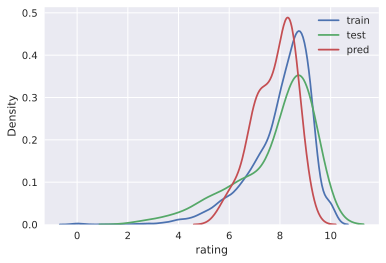

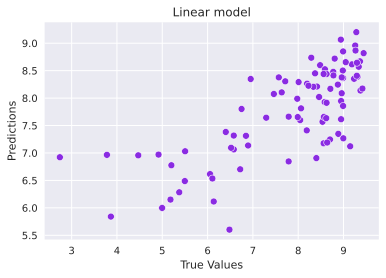

In [84]:
target_distr_linear(y_train, y_test, y_pred)  

In [85]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.1105235885250528
RMSE:  1.0538138301071271
R2:    0.5110577681306802
MAE:   0.792221753861056
MedAE: 0.6272745228129271
------------------------------


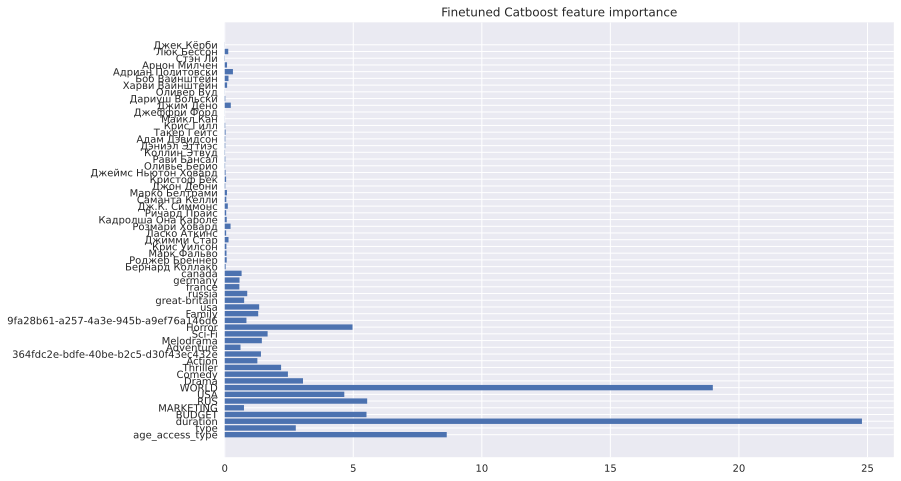

In [86]:
get_feature_imp(best_cat, train_dataset)

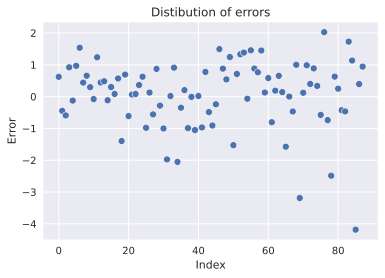

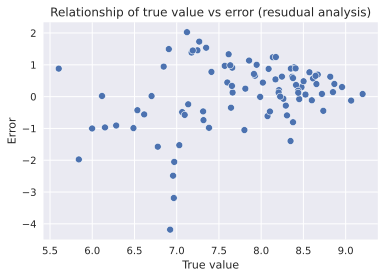

In [87]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

In [88]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Оливер Вуд,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Арнон Милчен,Стэн Ли,Люк Бессон,Джек Кёрби,PREDS,TARGET
10680,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.367256,8.990000
10673,18,Лестница,SERIAL,2022,17.208676,7aebefb1-d42d-4969-8e1d-4b41db339539,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.735811,8.288703
10669,18,ДМЗ,SERIAL,2022,16.422635,35106dfc-9fa3-422c-a894-1784ff1c1944,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.305532,7.714286
10668,18,Джулия,SERIAL,2022,16.868568,18da77c3-92a6-4797-a845-93bda1052295,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.389989,9.310458
10693,18,Дом Дракона,SERIAL,2022,17.015815,62541c49-7a32-45d0-8981-44ee6968d329,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.065326,8.940536
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5651,16,Многоэтажка,MOVIE,2022,15.597220,19a61cc3-65ff-46ce-bf43-29c24a1cc9b6,NaN,NaN,5.793014,NaN,...,0,0,0,0,0,0,0,0,7.266733,8.996094
5612,18,Невидимый убийца,MOVIE,2022,15.684231,0d14e4b4-71ed-4409-9ebb-54a130e913c8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.856885,8.990476
5518,16,Другое имя,MOVIE,2022,15.576811,69021740-65f7-430c-9c00-f2d6d9e9c702,NaN,NaN,10.364072,NaN,...,0,0,0,0,0,0,0,0,6.922218,2.739953
5269,16,RRR: Рядом ревет революция,MOVIE,2022,16.200597,1dbd646f-1c33-4584-b411-efc9da56c702,18.049617,NaN,10.485982,16.446375,...,0,0,0,0,0,0,0,0,8.654270,9.048994


In [89]:
y_pred_demo_tuned = best_cat.predict(demo_dataset)

demo_df['PREDS_TUNED'] = y_pred_demo_tuned.tolist()
demo_df 

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Арнон Милчен,Стэн Ли,Люк Бессон,Джек Кёрби,TARGET,PREDS,PREDS_TUNED
6469,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.147352,7.398115,7.121446
6550,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,6.519242,6.877495,7.094628
9998,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.717041,8.749734,8.868283
10433,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.192744,8.642376,8.688536
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.362527,8.468094,8.669807


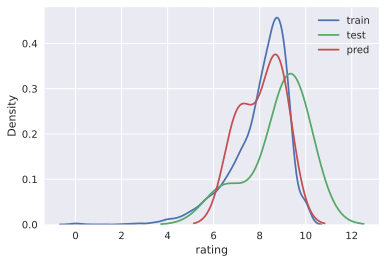

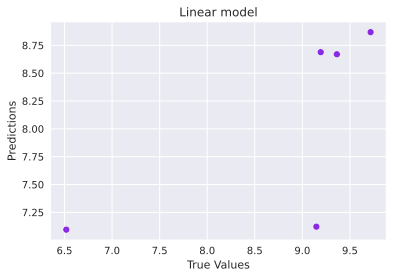

In [90]:

target_distr_linear(y_train, y_demo, y_pred_demo_tuned)  